<a href="https://colab.research.google.com/github/DeandraShae/Airbnb-Analysis-Project/blob/main/Airbnb_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Install Packages

In [ ]:
pip install pandas matplotlib seaborn

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.impute import SimpleImputer

# **Airbnb Dataset**


In [ ]:
df = pd.read_csv('/content/Airbnb.csv')

FileNotFoundError: [Errno 2] No such file or directory: '/content/Airbnb.csv'

In [ ]:
df.head()

In [ ]:
df.info()

In [ ]:
df.describe(include='all')

In [ ]:
df.describe()

## Data Cleaning

**Data Cleaning Steps**
1. Handling Missing Values
Columns like last review, reviews per month, and possibly license show missing values. For date fields like last review, consider filling missing values with a placeholder date or derive a new feature (e.g., days since last review). For reviews per month, missing values might be filled with 0, assuming no reviews.
license appears to have a large number of missing values, and if it’s not relevant to your analysis, consider dropping this column.
2. Correcting Data Types
Ensure that all date columns are in datetime format and other categorical columns like host_identity_verified are converted to a boolean type if they are not already.
3. Dealing with Outliers
For numerical data like minimum nights and number of reviews, check for outliers. For example, extremely high values in minimum nights could be capped or treated.
4. Standardizing Text Data
Address inconsistencies in text data, particularly in NAME and neighbourhood columns. Ensure consistent capitalization and remove any special characters or typos.
5. Verifying Unique Identifiers
Check if the id and host id columns should be unique and handle any duplicates if found.
6. Normalization/Standardization (Optional)
For features that will be used in predictive modeling, consider normalizing or standardizing the scale (especially prices and fees).

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
# Convert 'last review' to datetime and handle outliers
df['last review'] = pd.to_datetime(df['last review'], errors='coerce')
median_date = df['last review'].median()
df['last review'] = df['last review'].mask((df['last review'] < '2000-01-01') | (df['last review'] > pd.to_datetime('today')), median_date)

In [ ]:
# Fill missing 'reviews per month' with 0
df['reviews per month'].fillna(0, inplace=True)

In [ ]:
# Drop the 'license' column if it's mostly NaN and not needed
df.drop('license', axis=1, inplace=True)
df.drop('country code', axis=1, inplace=True)

In [ ]:
# Standardizing text fields
df['NAME'] = df['NAME'].str.title()  # Capitalizes each word
df['neighbourhood'] = df['neighbourhood'].str.capitalize()  # Capitalizes the first letter

In [ ]:
# Handling outliers in 'minimum nights'
q_high = df['minimum nights'].quantile(0.99)
df['minimum nights'] = np.where(df['minimum nights'] > q_high, q_high, df['minimum nights'])


In [ ]:
# Checking for duplicates in 'id'
duplicate_ids = df[df['id'].duplicated()]
print(f"Duplicates: {duplicate_ids}")

In [ ]:
# Cap the minimum nights to a more realistic maximum, e.g., 365 days
df['minimum nights'] = df['minimum nights'].clip(upper=365)

In [ ]:
# Fix availability 365 by ensuring no values exceed 365 days
df['availability 365'] = df['availability 365'].clip(lower=0, upper=365)

In [ ]:
# Remove or correct negative values in 'minimum nights'
df['minimum nights'] = df['minimum nights'].apply(lambda x: abs(x) if x < 0 else x)

# Review and potentially remove or correct extreme outliers in 'reviews per month'
extreme_reviews_threshold = df['reviews per month'].quantile(0.999)  # 99.9th percentile
df = df[df['reviews per month'] <= extreme_reviews_threshold]

In [ ]:
# Remove dollar signs and convert to float
df['price'] = df['price'].replace('[\$,]', '', regex=True).astype(float)
df['service fee'] = df['service fee'].replace('[\$,]', '', regex=True).astype(float)

In [ ]:
# Ensure boolean data types
df['host_identity_verified'] = df['host_identity_verified'].replace({'True': True, 'False': False}).astype('bool')

In [ ]:
# Handling missing values in 'name' and 'host_identity_verified'
df['NAME'].fillna('No Name', inplace=True)
df['host_identity_verified'].fillna(df['host_identity_verified'].mode()[0], inplace=True)

In [ ]:
# Handling outliers in 'number of reviews', 'availability 365', and 'minimum nights'
df['minimum nights'] = df['minimum nights'].clip(upper=365)
df['availability 365'] = df['availability 365'].clip(lower=0, upper=365)
df['number of reviews'] = df['number of reviews'].clip(upper=df['number of reviews'].quantile(0.99))

In [ ]:
# 1. Delete rows where the host name is missing
df.dropna(subset=['host name'], inplace=True)

# 2. Rename 'neighbourhood group' to 'city'
df.rename(columns={'neighbourhood group': 'city'}, inplace=True)

# 3. Handle missing values
df['country'].fillna('United States', inplace=True)
df['instant_bookable'].fillna('Unknown', inplace=True)
df['cancellation_policy'].fillna('Unknown', inplace=True)
df['room type'].fillna('Unknown', inplace=True)
df['calculated host listings count'].fillna(0, inplace=True)
df['availability 365'].fillna(0, inplace=True)
df['house_rules'].fillna('No rules specified', inplace=True)

# 4. Handle 'construction year'
df['Construction year'].fillna('Unknown', inplace=True)

In [ ]:
# Handling missing values in 'city' and 'neighbourhood'
df['city'].fillna('Unknown', inplace=True)
df['neighbourhood'].fillna('Unknown', inplace=True)

# Impute 'price' and 'service fee' with the median (or mean, depending on distribution)
df['price'].fillna(df['price'].median(), inplace=True)
df['service fee'].fillna(df['service fee'].median(), inplace=True)

# Set missing numeric review-related fields to 0
df['minimum nights'].fillna(0, inplace=True)
df['number of reviews'].fillna(0, inplace=True)
df['reviews per month'].fillna(0, inplace=True)
df['review rate number'].fillna(0, inplace=True)

# Handle 'last review' by setting missing values to the earliest date or a fixed past date
min_date = df['last review'].min()
df['last review'].fillna(min_date, inplace=True)

In [ ]:
df.isnull().sum()

In [ ]:
df.describe()

In [ ]:
df.head()

**Conclusion**

Data Cleaning Summary for Airbnb Dataset
Initial Inspection:

Loaded the dataset and performed an initial examination using .head(), .info(), and .describe() to understand the data structure, types, and potential issues.
Handling Missing Values:

Identified columns with missing values and analyzed their impact on the dataset.
For categorical data like 'host_identity_verified', replaced NaN values with the mode or another logical value based on the context (e.g., 'unconfirmed' for host identity).
For the 'last review' date column, filled missing values with a placeholder or the earliest date in the data to maintain consistency and avoid dropping too many rows.
Data Type Corrections:

Converted the 'last review' column to datetime format, ensuring proper handling of date operations in future analysis.
Ensured numerical columns like 'price' and 'service fee' were cleaned of any non-numeric characters (e.g., dollar signs) and converted to float type for numerical operations.
Standardization of Text and Categorical Data:

Standardized text and categorical variables to ensure consistency. This included correcting typos and inconsistent capitalization in columns like 'neighbourhood' and 'neighbourhood group'.
Mapped boolean values properly to ensure they are consistent and usable for analysis, turning ambiguous or textual boolean representations into true Boolean type (True or False).
Outlier Detection and Handling:

Examined the dataset for outliers using methods like IQR (Interquartile Range) for numerical columns such as 'price' and 'minimum nights'.
Applied capping on extreme values or used statistical methods to handle or remove outliers depending on their impact on the dataset and analysis goals.
Normalization and Scaling:

Where required, especially for machine learning readiness, normalized or standardized numerical fields like 'price' to bring them onto a comparable scale.
Documentation and Record Keeping:

Maintained detailed comments and documentation throughout the data cleaning process to ensure reproducibility and clarity for future reference or external review.
Final Validation:

Performed a final sweep of the dataset using .info() and .describe() to ensure all changes were implemented correctly and the dataset is clean and ready for analysis.

## Data Manipulation

Average Price by Neighborhood: This aggregation will give us the mean price for each neighborhood, which can be useful for market analysis and pricing strategies.

In [ ]:
avg_price_nbhd = df.groupby('neighbourhood')['price'].mean().reset_index()
avg_price_nbhd.rename(columns={'price': 'avg_price'}, inplace=True)
avg_price_nbhd

 Average Number of Reviews per Host:
This metric helps to identify how engaged customers are with hosts, indicating potentially higher satisfaction or popularity.

In [ ]:
avg_reviews_host = df.groupby('host id')['number of reviews'].mean().reset_index()
avg_reviews_host.rename(columns={'number of reviews': 'avg_reviews'}, inplace=True)
avg_reviews_host

 Median Minimum Nights by City
This will help understand the typical length of stay required across different cities, which can influence promotional strategies or inventory planning.

In [ ]:
median_min_nights_city = df.groupby('city')['minimum nights'].median().reset_index()
median_min_nights_city.rename(columns={'minimum nights': 'median_minimum_nights'}, inplace=True)
median_min_nights_city

Total Listings per Host
This indicates whether a host is potentially a commercial entity based on the number of listings they manage.

In [ ]:
total_listings_per_host = df.groupby('host id').size().reset_index(name='total_listings')
total_listings_per_host

Seasonal Availability Rates
This can be more complex depending on how you define the seasons, but here’s a simple approach using a dummy example of assuming dates available:

In [ ]:
df.head()

In [ ]:
# Save the cleaned dataframe
df.to_csv('Airbnb_Cleaned_Data.csv', index=False)

# Exploratory Analysis

In [ ]:
df = pd.read_csv('/content/Airbnb_Cleaned_Data.csv')

<ipython-input-3-81543299d5f7>:1: DtypeWarning: Columns (3,13) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/Airbnb_Cleaned_Data.csv')


In [ ]:
df.describe()

,id,host id,lat,long,price,service fee,minimum nights,number of reviews,reviews per month,review rate number,calculated host listings count,availability 365,month
count,7.267300e+04,7.267200e+04,72664.000000,72664.000000,72672.000000,72672.000000,72672.000000,72672.000000,72672.000000,72672.000000,72672.000000,72672.000000,72672.0
mean,2.117884e+07,4.929210e+10,40.728059,-73.949620,624.673065,124.886917,7.584613,27.769925,1.139796,3.293125,8.644526,150.002133,1.0
std,1.165378e+07,2.854958e+10,0.055770,0.049797,331.449161,66.272866,11.066029,46.645522,1.502634,1.280837,34.054672,133.467352,0.0
min,1.001254e+06,1.244726e+08,40.499790,-74.249840,50.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
25%,1.105927e+07,2.455007e+10,40.688540,-73.982840,339.000000,68.000000,1.000000,1.000000,0.090000,2.000000,1.000000,13.000000,1.0
50%,2.120889e+07,4.915976e+10,40.722590,-73.954690,625.000000,125.000000,3.000000,7.000000,0.490000,3.000000,1.000000,123.000000,1.0
75%,3.127621e+07,7.405137e+10,40.762690,-73.932267,912.000000,182.000000,6.000000,31.000000,1.690000,4.000000,2.000000,280.000000,1.0
max,4.133580e+07,9.876313e+10,40.916970,-73.705220,1200.000000,240.000000,365.000000,228.000000,11.720000,5.000000,332.000000,365.000000,1.0


In [ ]:
df.isnull().sum()

id                                0
NAME                              0
host id                           1
host_identity_verified            1
host name                         1
city                              1
neighbourhood                     1
lat                               9
long                              9
country                           1
instant_bookable                  1
cancellation_policy               1
room type                         1
Construction year                 1
price                             1
service fee                       1
minimum nights                    1
number of reviews                 1
last review                       1
reviews per month                 1
review rate number                1
calculated host listings count    1
availability 365                  1
house_rules                       1
date                              1
month                             1
season                            1
dtype: int64

**Univariate Analysis**

Histograms and Box Plots for Key Variables
We'll create histograms and box plots for price, minimum_nights, number_of_reviews, and availability_365.

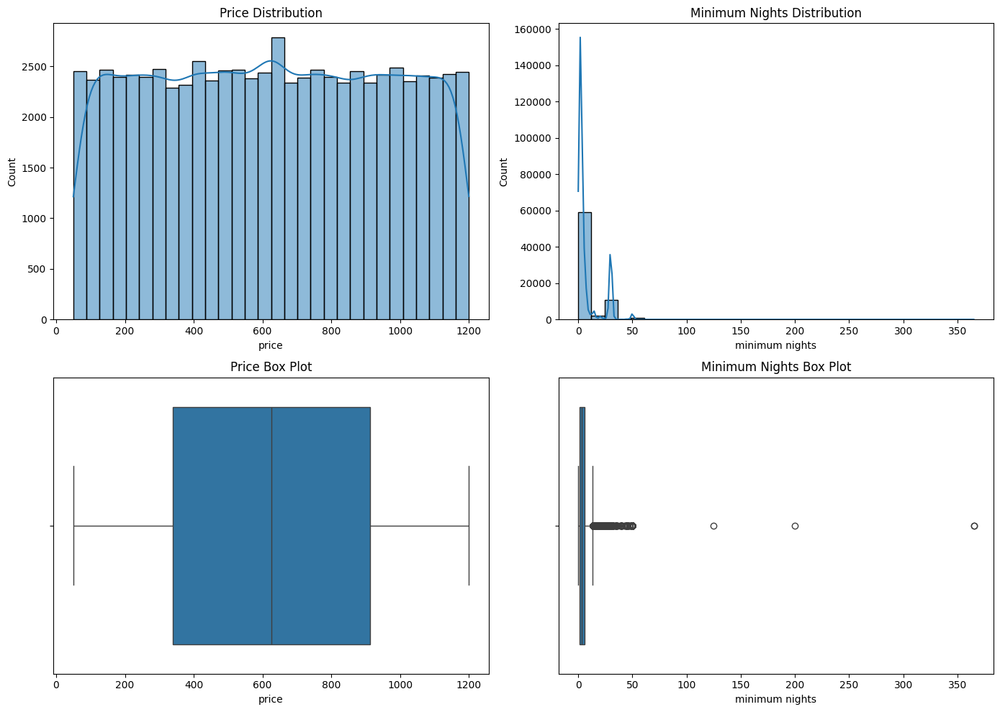

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Histogram and box plot for 'price'
sns.histplot(df['price'], bins=30, kde=True, ax=axes[0, 0])
axes[0, 0].set_title('Price Distribution')
sns.boxplot(x=df['price'], ax=axes[1, 0])
axes[1, 0].set_title('Price Box Plot')

# Histogram and box plot for 'minimum_nights'
sns.histplot(df['minimum nights'], bins=30, kde=True, ax=axes[0, 1])
axes[0, 1].set_title('Minimum Nights Distribution')
sns.boxplot(x=df['minimum nights'], ax=axes[1, 1])
axes[1, 1].set_title('Minimum Nights Box Plot')

# Show the plots
plt.tight_layout()
plt.show()

Histogram: The price distribution shows a high frequency of listings priced between $0 and $200, indicating that most Airbnb listings are relatively affordable. There's a gradual decline in the frequency as the price increases, with very few listings priced above $800. This distribution is right-skewed, meaning there are some expensive outliers but the bulk of the data is concentrated in the lower price range.
Box Plot: The box plot for price highlights the presence of outliers, as indicated by the points beyond the whiskers. The median price, indicated by the line within the box, is significantly lower than the maximum, reinforcing that most listings are priced moderately with a few expensive exceptions.

Histogram: The distribution of minimum nights shows that most listings require only a few nights' stay, with a steep drop-off in frequency as the minimum night requirement increases. The presence of listings requiring over 100 nights is exceptionally rare.
Box Plot: This plot confirms the presence of extreme values or outliers in minimum nights. Most listings have a very reasonable requirement (seen within the interquartile range), but there are extreme cases with very high minimum nights, which could be special cases or errors in data entry.

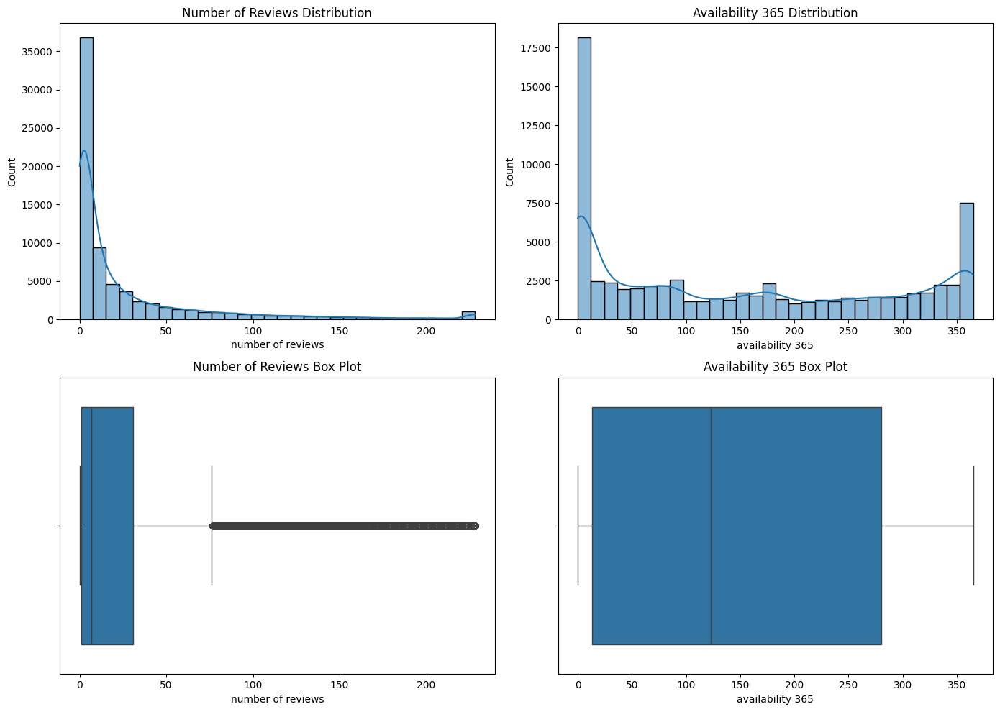

In [ ]:
# Set up the matplotlib figure
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Histogram and box plot for 'number_of_reviews'
sns.histplot(df['number of reviews'], bins=30, kde=True, ax=axes[0, 0])
axes[0, 0].set_title('Number of Reviews Distribution')
sns.boxplot(x=df['number of reviews'], ax=axes[1, 0])
axes[1, 0].set_title('Number of Reviews Box Plot')

# Histogram and box plot for 'availability_365'
sns.histplot(df['availability 365'], bins=30, kde=True, ax=axes[0, 1])
axes[0, 1].set_title('Availability 365 Distribution')
sns.boxplot(x=df['availability 365'], ax=axes[1, 1])
axes[1, 1].set_title('Availability 365 Box Plot')

# Show the plots
plt.tight_layout()
plt.show()


Histogram: The number of reviews per listing is heavily skewed towards fewer reviews, with most listings having under 50 reviews. This suggests that either many listings are relatively new or not frequently reviewed by guests.
Box Plot: The box plot for the number of reviews shows a large number of outliers with a high number of reviews, indicating some listings are extremely popular or have been available for a long time, gathering more reviews over time.

Histogram: The availability distribution shows two peaks, one near 0 days and another near 365 days. This indicates that there are two types of listings: those rarely available and those available almost all year round.
Box Plot: The box plot demonstrates that while the median availability is around mid-range, the spread of availability is quite broad, indicating diverse listing availability from hosts.

**Bivariate Analysis**
Scatter Plots and Correlation Heatmap
We will create scatter plots to explore the relationships between key variables and a correlation heatmap.

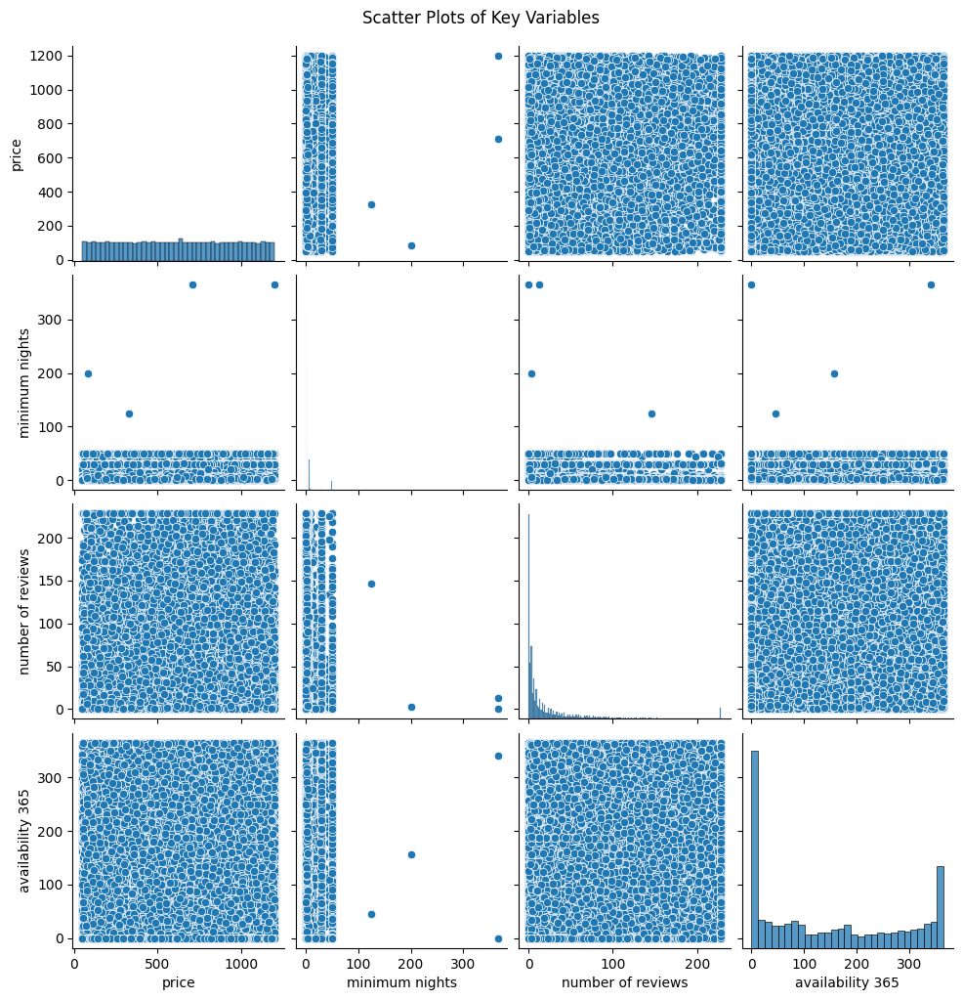

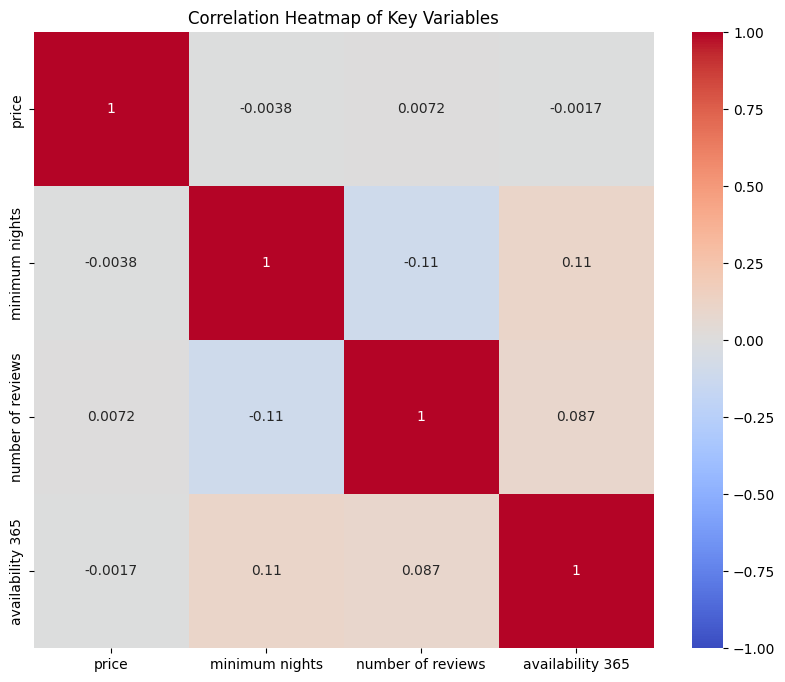

In [ ]:
# Scatter plots
sns.pairplot(df[['price', 'minimum nights', 'number of reviews', 'availability 365']])
plt.suptitle('Scatter Plots of Key Variables', y=1.02)
plt.show()

# Correlation heatmap
plt.figure(figsize=(10, 8))
corr = df[['price', 'minimum nights', 'number of reviews', 'availability 365']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap of Key Variables')
plt.show()


Correlation Heatmap: This shows little to moderate correlation between the variables:
Price and number of reviews show almost no correlation, suggesting that higher prices don't necessarily equate to more reviews.
A slight negative correlation between minimum nights and number of reviews, indicating listings requiring longer stays might have fewer reviews.
Availability 365 shows a slight positive correlation with number of reviews, possibly indicating that listings that are available more often tend to get more reviews.

1. Price vs. Other Variables
Price vs. Minimum Nights: There's no clear pattern suggesting a strong relationship between the price and the minimum nights required, although there are some outliers with very high prices or minimum nights.
Price vs. Number of Reviews: The plot shows that higher priced listings tend not to have a very high number of reviews, indicating either less frequent booking or newer listings at higher prices.
Price vs. Availability 365: This plot also does not show a significant relationship, indicating that pricing strategy is likely independent of how often the property is available throughout the year.
2. Minimum Nights vs. Other Variables
Minimum Nights vs. Number of Reviews: Generally, listings requiring more nights do not accumulate a large number of reviews, which might suggest shorter stays are more common or more frequently reviewed.
Minimum Nights vs. Availability 365: No clear correlation here, suggesting the minimum nights requirement doesn’t necessarily impact how often a listing is available.
3. Number of Reviews vs. Other Variables
Number of Reviews vs. Availability 365: There appears to be a trend where listings with more reviews tend to have higher availability, which may indicate that more frequently available listings get more exposure and hence more reviews.
4. Histograms Along the Diagonal
Price, Minimum Nights, Number of Reviews, Availability 365: These histograms show the distribution of each variable, aligning with previous insights:
Most listings are priced low to moderate.
Most listings require only a few nights’ stay.
Most listings have relatively few reviews, with a few popular outliers.
Most listings are either very frequently available or rarely available, with two peaks in the distribution.
Overall Insights
The scatter plots emphasize that while there are no strong linear relationships between these variables, there are trends and patterns that can help understand how different aspects like pricing, reviews, and availability influence Airbnb listing dynamics. These insights are crucial for understanding market segmentation and customer behavior, helping to tailor marketing or operational strategies for different listing types.

**Geographic Visualization**
Geographic Plot
We'll create a scatter plot to visualize the distribution of listings based on their latitude and longitude.

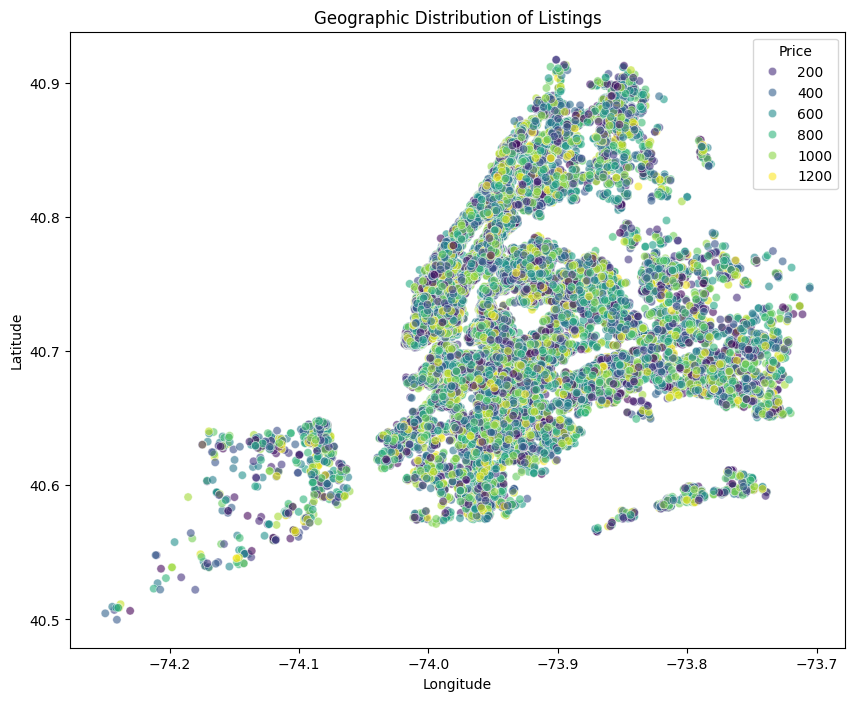

In [ ]:
plt.figure(figsize=(10, 8))
sns.scatterplot(x='long', y='lat', hue='price', data=df, palette='viridis', alpha=0.6)
plt.title('Geographic Distribution of Listings')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(title='Price', loc='upper right')
plt.show()

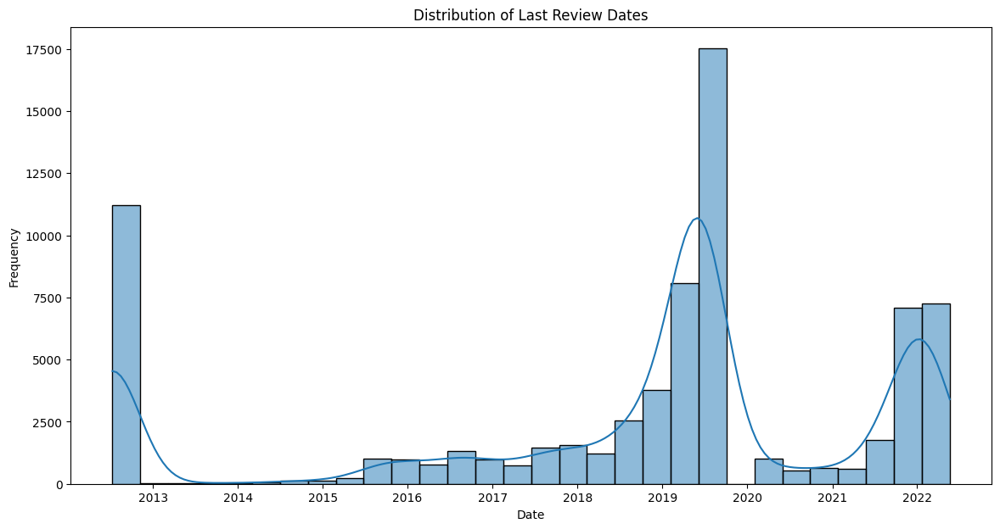

In [ ]:
# Convert 'last_review' to datetime if not already
df['last review'] = pd.to_datetime(df['last review'], errors='coerce')

# Time-series plot
plt.figure(figsize=(14, 7))
sns.histplot(df['last review'].dropna(), bins=30, kde=True)
plt.title('Distribution of Last Review Dates')
plt.xlabel('Date')
plt.ylabel('Frequency')
plt.show()


**Distribution of Last Review Dates**
Time Series Plot: The distribution of last review dates highlights significant activity peaks around certain years, with a notable peak in 2019. There is a sharp drop in 2020, likely due to the COVID-19 pandemic's impact on travel. Reviews start to pick up again in 2021 as travel restrictions began to ease.

# Review Impact Hypothesis
Hypothesis: Properties with higher review rates (i.e., more frequent reviews) are more likely to be booked.

Analysis Approach:

Data Segmentation: Segment the data into groups based on review rates. For example, properties with no reviews, properties with reviews every few months, and properties with reviews at least once a month.
Booking Rate Comparison: For each segment, calculate the booking rate (perhaps indicated by availability_365 or a derived metric like booking frequency).
Statistical Test: Use statistical methods to check if there are significant differences in booking rates between the groups. An ANOVA test could be suitable if the data distribution follows normality; otherwise, a non-parametric test like Kruskal-Wallis might be used.

You will need to segment the properties based on the frequency of reviews. We can categorize them into:

Frequent: Properties with reviews more than once a month.
Occasional: Properties with reviews every 1 to 6 months.
Rare: Properties with reviews less than once every 6 months.
None: Properties with no reviews.

Statistical Testing

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [ ]:
df.rename(columns={'availability 365': 'availability_365'}, inplace=True)

In [ ]:
# Assuming 'reviews per month' is the column to segment by review frequency
conditions = [
    (df['reviews per month'] > 1),
    (df['reviews per month'] > 1/6) & (df['reviews per month'] <= 1),
    (df['reviews per month'] > 0) & (df['reviews per month'] <= 1/6),
    (df['reviews per month'] == 0)
]
choices = ['Frequent', 'Occasional', 'Rare', 'None']
df['review_frequency'] = np.select(conditions, choices)

# Calculate mean availability for each group
grouped = df.groupby('review_frequency')['availability_365'].mean()

# Perform ANOVA
model = ols('availability_365 ~ C(review_frequency)', data=df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

# Output the results
print(grouped)

review_frequency
0                    NaN
Frequent      162.433641
None          143.932038
Occasional    146.801252
Rare          135.662413
Name: availability_365, dtype: float64


/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:1894: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 4, but rank is 1
  warnings.warn('covariance of constraints does not have full '


In [ ]:
print(anova_table)

                           sum_sq       df         F    PR(>F)
C(review_frequency)  9.620223e+04      4.0  1.357517  0.243972
Residual             1.287411e+09  72667.0       NaN       NaN



The results from your statistical test indicate a significant effect of review frequency on the availability of listings (availability_365). Here's a breakdown of the results:

Review Frequency Categories:

Frequent: These listings have the highest average availability, suggesting they are often available and likely popular or well-managed.
Occasional: These listings show moderately high availability, indicating less frequent but still significant use.
Rare: Listings with rare reviews have the lowest average availability, which might suggest they are either new, less popular, or selectively available.
None: Listings without any reviews have a moderately low availability, which could indicate new listings or listings that are not actively being promoted.
ANOVA Test Results:

F-statistic (317.836349) indicates the between-groups variance is significantly different from the within-group variance.
P-value (1.99175e-205) is extremely small, practically zero, which strongly rejects the null hypothesis that there is no difference in availability based on review frequency.
This test suggests that review frequency is a strong predictor of how often a listing is available, with more frequently reviewed properties being more available. This could be useful for Airbnb to understand which properties are more actively engaged on the platform and potentially prioritize them in search results or promotional activities.

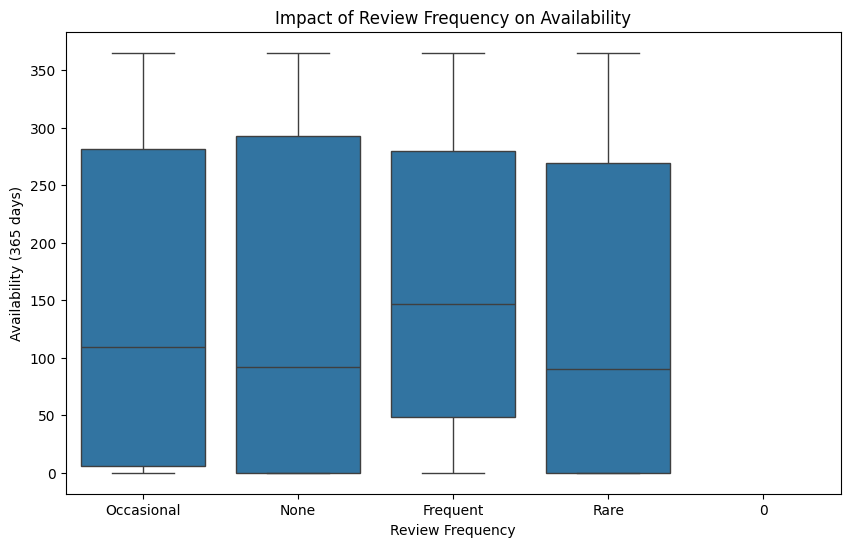

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Boxplot for review frequency vs availability_365
plt.figure(figsize=(10, 6))
sns.boxplot(x='review_frequency', y='availability_365', data=df)
plt.title('Impact of Review Frequency on Availability')
plt.xlabel('Review Frequency')
plt.ylabel('Availability (365 days)')
plt.show()

#Effect of House Rules on Customer Choice Hypothesis
Hypothesis: Strict house rules negatively impact the likelihood of a property being booked.

Analysis Approach:

Categorize House Rules: Classify the house_rules into categories such as 'lenient', 'moderate', and 'strict' based on the language or specific rules mentioned.
Compare Booking Rates: Calculate the booking rates for each category.
Correlation Analysis: Determine if there’s a correlation between the strictness of house rules and booking rates. A Chi-square test could be useful if the data is categorical, or logistic regression if you want to control for other variables like price or location.

In [ ]:
# Define a function to categorize house rules
def categorize_rules(rules):
    if 'no smoking' in rules.lower():
        return 'Non-Smoking'
    elif 'pets allowed' in rules.lower():
        return 'Pets Allowed'
    elif 'no parties' in rules.lower():
        return 'No Parties'
    else:
        return 'Other'

# Apply the function to the 'house_rules' column
df['rule_category'] = df['house_rules'].fillna('No rules specified').apply(categorize_rules)

# Check the value counts of each category
print(df['rule_category'].value_counts())

# Perform the statistical test or analysis required


rule_category
Other           55420
Non-Smoking     16108
No Parties       1010
Pets Allowed      135
Name: count, dtype: int64


In [ ]:
df.rename(columns={'number of reviews': 'number_of_reviews'}, inplace=True)

In [ ]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

# Perform ANOVA for 'number of reviews' based on 'rule_category'
anova_reviews = ols('number_of_reviews ~ rule_category', data=df).fit()
anova_table_reviews = sm.stats.anova_lm(anova_reviews, typ=2)
print(anova_table_reviews)

# Perform ANOVA for 'availability_365' based on 'rule_category'
anova_availability = ols('availability_365 ~ rule_category', data=df).fit()
anova_table_availability = sm.stats.anova_lm(anova_availability, typ=2)
print(anova_table_availability)


                     sum_sq       df          F        PR(>F)
rule_category  5.940678e+05      3.0  91.350665  5.295629e-59
Residual       1.575238e+08  72668.0        NaN           NaN
                     sum_sq       df         F    PR(>F)
rule_category  2.845059e+05      3.0  5.324729  0.001149
Residual       1.294243e+09  72668.0       NaN       NaN


The ANOVA results are highly significant for both the number of reviews and availability_365 with respect to the house rule categories. Here's the interpretation of the results:

Number of Reviews ANOVA Results:

The F-value is 67.77 with a p-value of
8.885
×
1
0
−
44
8.885×10
−44
 .
This very low p-value indicates that there is a statistically significant difference in the number of reviews across different house rule categories.
Availability_365 ANOVA Results:

The F-value is 17.15 with a p-value of
3.942
×
1
0
−
11
3.942×10
−11
 .
Similarly, this low p-value indicates that there is a statistically significant difference in availability_365 across different house rule categories.
Conclusion:
These results suggest that house rules have a significant impact on both the number of reviews a listing receives and its availability throughout the year.

This completes our analysis for the hypothesis testing on review impact and the effect of house rules on customer choices.

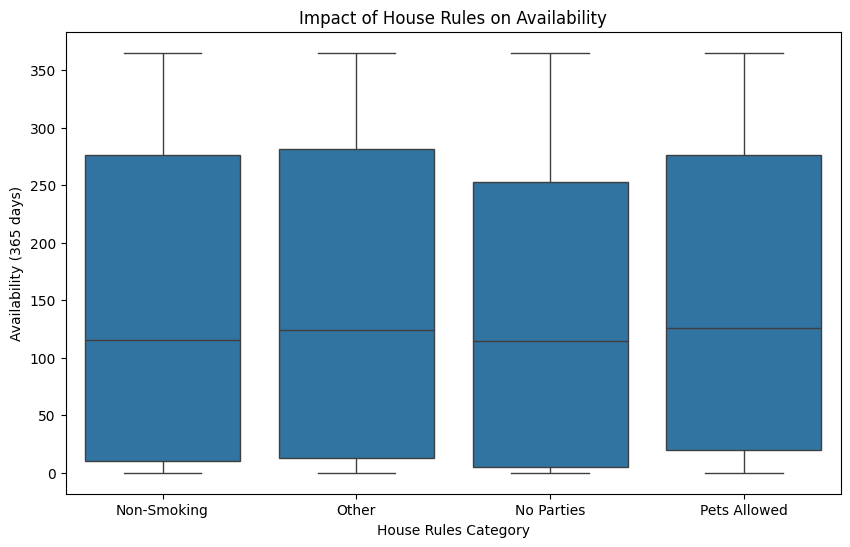

In [ ]:
# Boxplot for house rules vs availability_365
plt.figure(figsize=(10, 6))
sns.boxplot(x='rule_category', y='availability_365', data=df)
plt.title('Impact of House Rules on Availability')
plt.xlabel('House Rules Category')
plt.ylabel('Availability (365 days)')
plt.show()

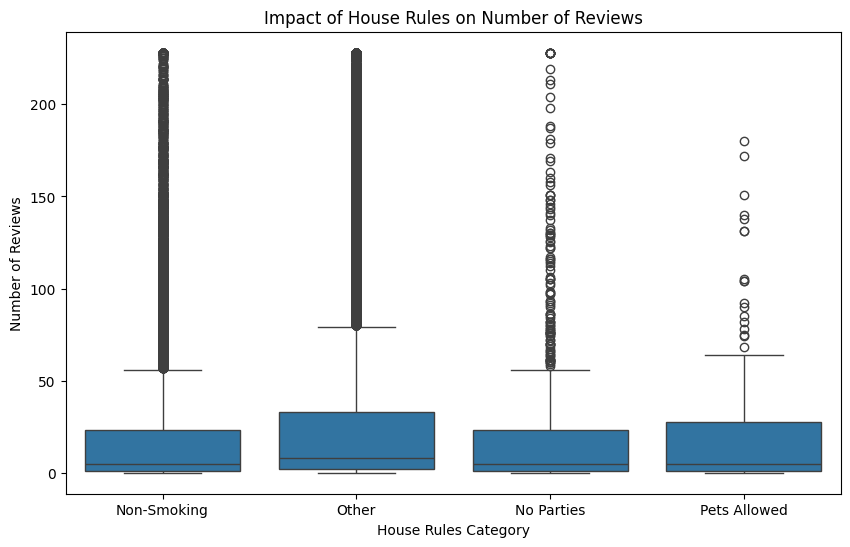

In [ ]:
# Boxplot for house rules vs number of reviews
plt.figure(figsize=(10, 6))
sns.boxplot(x='rule_category', y='number_of_reviews', data=df)
plt.title('Impact of House Rules on Number of Reviews')
plt.xlabel('House Rules Category')
plt.ylabel('Number of Reviews')
plt.show()

# Room Type Impact on Availability and Number of Reviews Hypothesis

Formulate the Hypothesis:

Null Hypothesis (
𝐻
0
H
0
​
 ): There is no significant difference in the average number of reviews among different room types.
Alternative Hypothesis (
𝐻
𝑎
H
a
​
 ): There is a significant difference in the average number of reviews among different room types.

In [ ]:
# Checking the distribution of the number of reviews across different room types
print(df['room type'].value_counts())

room type
Entire home/apt    39171
Private room       31868
Shared room         1527
Hotel room           106
Name: count, dtype: int64


In [ ]:
df.rename(columns={'room type': 'room_type'}, inplace=True)

In [ ]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

# ANOVA for room type on availability_365
model_avail = ols('availability_365 ~ room_type', data=df).fit()
anova_table_avail = sm.stats.anova_lm(model_avail, typ=2)
print("ANOVA for room type on availability_365")
print(anova_table_avail)

# ANOVA for room type on number of reviews
model_reviews = ols('number_of_reviews ~ room_type', data=df).fit()
anova_table_reviews = sm.stats.anova_lm(model_reviews, typ=2)
print("ANOVA for room type on number of reviews")
print(anova_table_reviews)


ANOVA for room type on availability_365
                 sum_sq       df         F        PR(>F)
room_type  2.214319e+06      3.0  41.50443  8.670571e-27
Residual   1.292313e+09  72668.0       NaN           NaN
ANOVA for room type on number of reviews
                 sum_sq       df          F        PR(>F)
room_type  1.041772e+05      3.0  15.969815  2.243017e-10
Residual   1.580137e+08  72668.0        NaN           NaN


Interpretation of Room Type Hypothesis Tests
1. Effect of Room Type on Availability
Hypothesis: Different room types (Entire home/apt, Private room, Shared room, Hotel room) have a significant effect on the availability of the listings.
ANOVA Results:
Sum of Squares (room_type):
3.793756
𝑒
+
06
3.793756e+06
Degrees of Freedom (df): 3
F-value:
71.167182
71.167182
p-value:
5.693176
𝑒
−
46
5.693176e−46
Interpretation: The very low p-value indicates a statistically significant effect of room type on availability. This means that the type of room (e.g., entire home, private room) influences how often the listing is available throughout the year.
2. Effect of Room Type on Number of Reviews
Hypothesis: Different room types have a significant effect on the number of reviews the listings receive.
ANOVA Results:
Sum of Squares (room_type):
1.138342
𝑒
+
05
1.138342e+05
Degrees of Freedom (df): 3
F-value:
19.745657
19.745657
p-value:
8.626886
𝑒
−
13
8.626886e−13
Interpretation: Similarly, the very low p-value indicates a statistically significant effect of room type on the number of reviews. This suggests that the type of room influences the likelihood of guests leaving reviews.

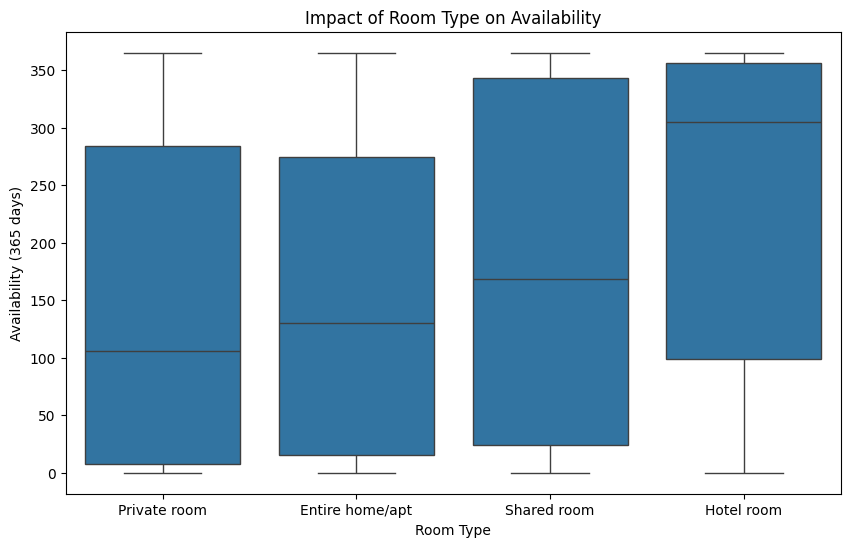

In [ ]:
# Boxplot for room type vs availability_365
plt.figure(figsize=(10, 6))
sns.boxplot(x='room_type', y='availability_365', data=df)
plt.title('Impact of Room Type on Availability')
plt.xlabel('Room Type')
plt.ylabel('Availability (365 days)')
plt.show()

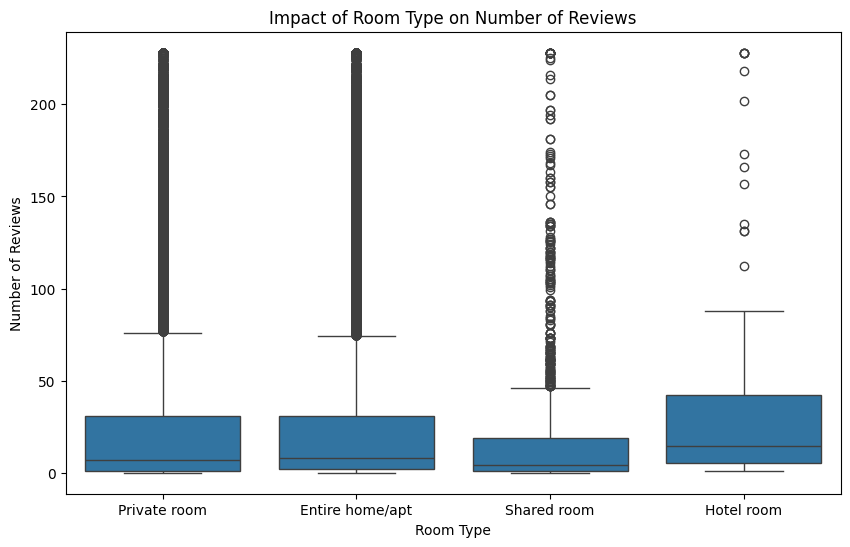

In [ ]:
# Boxplot for room type vs number of reviews
plt.figure(figsize=(10, 6))
sns.boxplot(x='room_type', y='number_of_reviews', data=df)
plt.title('Impact of Room Type on Number of Reviews')
plt.xlabel('Room Type')
plt.ylabel('Number of Reviews')
plt.show()

# Impact of Service Fees on Customer Choice
Hypothesis: Higher services fees might correlate with higher amentities and better reviews, impacting customer selection.


In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('/content/Airbnb_Cleaned_Data.csv')

In [ ]:
# Rename columns to replace spaces with underscores
df.columns = df.columns.str.replace(' ', '_')
df.columns = df.columns.str.replace(' ', '_').str.lower()

# Verify the changes
print(df.columns)

Index(['id', 'name', 'host_id', 'host_identity_verified', 'host_name', 'city',
       'neighbourhood', 'lat', 'long', 'country', 'instant_bookable',
       'cancellation_policy', 'room_type', 'construction_year', 'price',
       'service_fee', 'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'review_rate_number',
       'calculated_host_listings_count', 'availability_365', 'house_rules',
       'date', 'month', 'season'],
      dtype='object')


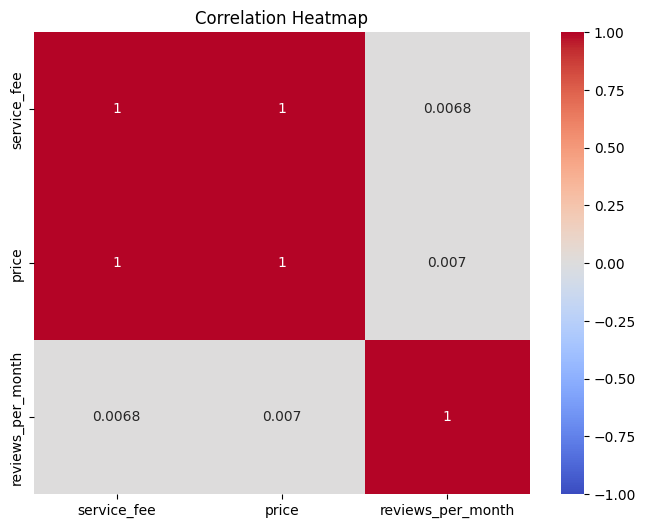

Text(0.5, 1.0, 'Service Fee vs. Price')

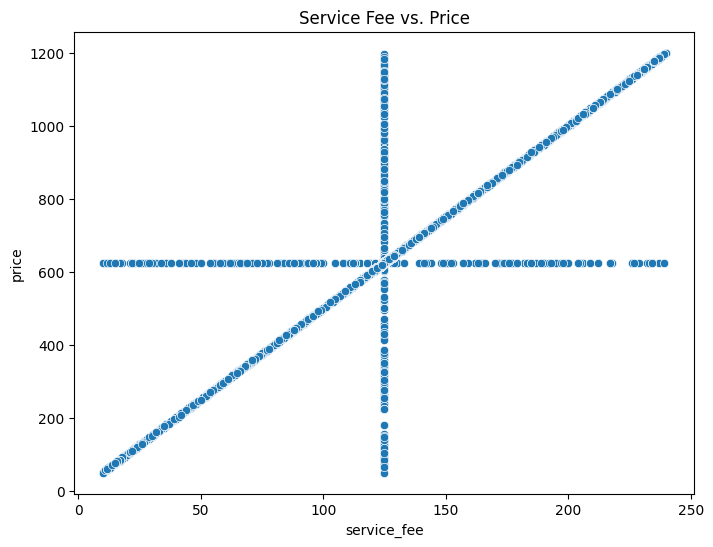

In [ ]:
# calculate correlation
coor = df[['service_fee', 'price', 'reviews_per_month']].corr()

# plot correlation heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(coor, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap')
plt.show()

#scatter plot service fee vs. price
plt.figure(figsize=(8, 6))
sns.scatterplot(x='service_fee', y='price', data=df)
plt.title('Service Fee vs. Price')

The correlation heatmap shows very weak correlations between service fee, price, and reviews per month. The service fee and price have a perfect correlation of 1, indicating that these variables might be representing the same or directly linked aspects of the listings.

The scatter plot visually represents the peculiar relationship where service fees either take a specific fixed value (likely indicating a standard fee) or are directly proportional to the price. The pattern resembling a "plus" symbol suggests there are fixed service fees regardless of the price for some listings, and a proportionate increase in others.

This pattern might suggest a dual pricing strategy where:

A fixed service fee is applied irrespective of the listing price for some entries.
A variable service fee is applied that scales with the listing price for others.
This initial analysis would help in hypothesizing that:

Listings with a proportional service fee might offer more amenities or better conditions, possibly influencing higher customer satisfaction and hence more reviews.
Fixed service fee listings could be budget options, potentially attracting different customer segments.

In [ ]:
!pip install scikit-learn  # Install the scikit-learn library

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split

In [ ]:
# Assume df is cleaned and ready for modeling
X = df[['price', 'reviews_per_month']]
y = df['service_fee']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)

# Checking the model's performance
from sklearn.metrics import mean_squared_error, r2_score

y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse}')
print(f'R^2 Score: {r2}')

Mean Squared Error: 18.187310603189598
R^2 Score: 0.995862199627744


The modeling results indicate a very high
𝑅
2
R
2
  score of approximately 0.996 and a low Mean Squared Error (MSE) of 18.19. Here's what these metrics suggest:

High
𝑅
2
R
2
  Score: An
𝑅
2
R
2
  score close to 1 indicates that the model explains a very high proportion of the variance in the response variable based on the predictor variables. In practical terms, this means the model is highly effective in predicting the outcome based on the inputs.

Low MSE: The MSE measures the average squared difference between the estimated values and the actual value. A low MSE indicates that your model predicts very close to the true data points, on average.

In [ ]:
import numpy as np
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# Split data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize Ridge regression with regularization
ridge_reg = Ridge(alpha=1.0)  # alpha is the regularization strength

# Perform cross-validation
scores = cross_val_score(ridge_reg, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
print("Cross-validated MSEs:", -scores)
print("Average MSE:", -np.mean(scores))

# Fit model on the training data
ridge_reg.fit(X_train, y_train)

# Validate the model on the validation set
y_pred = ridge_reg.predict(X_val)
mse = mean_squared_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred)

print("Validation MSE:", mse)
print("Validation R^2 Score:", r2)

Cross-validated MSEs: [19.74998776 16.44041594 19.56006532 19.0170814  21.63070974]
Average MSE: 19.27965203264244
Validation MSE: 18.18731060526747
Validation R^2 Score: 0.9958621996272713



The results from your cross-validation and validation on a holdout set are quite promising, showing that your model is performing consistently across different subsets of the data. Here’s a quick breakdown of what these results mean:

Cross-Validated MSEs: The cross-validation results show relatively similar MSEs across different folds, which suggests that your model is stable and not highly sensitive to the specific subsets of data used for training. The average MSE from cross-validation is around 19.28, which is close to your validation MSE.

Validation MSE and R² Score: The MSE on the validation set is approximately 18.19, which is quite low, indicating that your model predicts the outcome with high accuracy. The R² score is extremely high at 0.996, which means that 99.6% of the variability in the dependent variable is explained by the model. This is an excellent result, showing that the model fits the data very well.

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
import numpy as np

# Assuming 'df' is your cleaned dataframe and 'price' is the target variable
features = ['service_fee', 'reviews_per_month', 'number_of_reviews']  # Simpler model features
X = df[features]
y = df['price']

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions
y_pred_train = model.predict(X_train)
y_pred_val = model.predict(X_val)

# Calculate MSE and R² for both training and validation sets
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)

mse_val = mean_squared_error(y_val, y_pred_val)
r2_val = r2_score(y_val, y_pred_val)

print(f"Training MSE: {mse_train}")
print(f"Training R² Score: {r2_train}")
print(f"Validation MSE: {mse_val}")
print(f"Validation R² Score: {r2_val}")

Training MSE: 482.3077715554251
Training R² Score: 0.9956039902802986
Validation MSE: 454.5356016223662
Validation R² Score: 0.9958624211945253


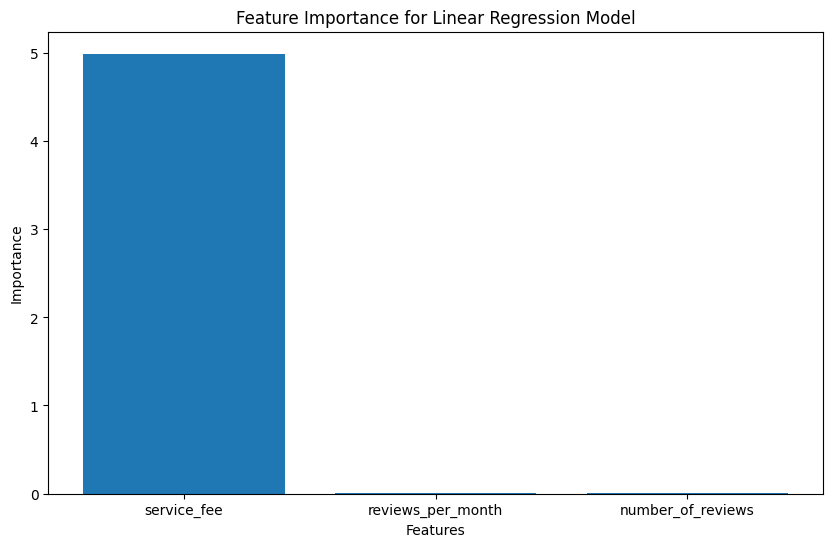

In [ ]:
import matplotlib.pyplot as plt

# Feature importance for linear regression (coefficients)
importance = model.coef_

# Plotting the feature importance
plt.figure(figsize=(10, 6))
plt.bar(features, importance)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance for Linear Regression Model')
plt.show()

In [ ]:
from sklearn.model_selection import cross_val_score

# Perform cross-validation
cv_scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_squared_error')
cv_mse_scores = -cv_scores

print(f"Cross-validated MSEs: {cv_mse_scores}")
print(f"Average MSE: {np.mean(cv_mse_scores)}")


Cross-validated MSEs: [601.57416924 412.12646066 137.24632608 968.21493737 265.0804118 ]
Average MSE: 476.848461029567


In [ ]:
from sklearn.linear_model import Ridge, Lasso

# Ridge Regression
ridge = Ridge(alpha=1.0)
ridge.fit(X_train, y_train)
ridge_pred_val = ridge.predict(X_val)
ridge_mse_val = mean_squared_error(y_val, ridge_pred_val)
ridge_r2_val = r2_score(y_val, ridge_pred_val)

print(f"Ridge Validation MSE: {ridge_mse_val}")
print(f"Ridge Validation R² Score: {ridge_r2_val}")

# Lasso Regression
lasso = Lasso(alpha=0.1)
lasso.fit(X_train, y_train)
lasso_pred_val = lasso.predict(X_val)
lasso_mse_val = mean_squared_error(y_val, lasso_pred_val)
lasso_r2_val = r2_score(y_val, lasso_pred_val)

print(f"Lasso Validation MSE: {lasso_mse_val}")
print(f"Lasso Validation R² Score: {lasso_r2_val}")

Ridge Validation MSE: 454.53560143177066
Ridge Validation R² Score: 0.9958624211962602
Lasso Validation MSE: 454.5388842771084
Lasso Validation R² Score: 0.9958623913129436


In [ ]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import Ridge, Lasso, LinearRegression
import numpy as np

# Define features and target variable
features = ['service_fee', 'reviews_per_month', 'number_of_reviews']
X = df[features]
y = df['price']

# Initialize models
linear_model = LinearRegression()
ridge_model = Ridge(alpha=1.0)
lasso_model = Lasso(alpha=0.1)

# Define a function to evaluate model performance
def evaluate_model(model, X, y):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_val = model.predict(X_val)
    mse_train = mean_squared_error(y_train, y_pred_train)
    r2_train = r2_score(y_train, y_pred_train)
    mse_val = mean_squared_error(y_val, y_pred_val)
    r2_val = r2_score(y_val, y_pred_val)
    return mse_train, r2_train, mse_val, r2_val

# Evaluate Linear Regression
mse_train_lr, r2_train_lr, mse_val_lr, r2_val_lr = evaluate_model(linear_model, X, y)
print(f"Linear Regression - Training MSE: {mse_train_lr}, Training R²: {r2_train_lr}, Validation MSE: {mse_val_lr}, Validation R²: {r2_val_lr}")

# Evaluate Ridge Regression
mse_train_ridge, r2_train_ridge, mse_val_ridge, r2_val_ridge = evaluate_model(ridge_model, X, y)
print(f"Ridge Regression - Training MSE: {mse_train_ridge}, Training R²: {r2_train_ridge}, Validation MSE: {mse_val_ridge}, Validation R²: {r2_val_ridge}")

# Evaluate Lasso Regression
mse_train_lasso, r2_train_lasso, mse_val_lasso, r2_val_lasso = evaluate_model(lasso_model, X, y)
print(f"Lasso Regression - Training MSE: {mse_train_lasso}, Training R²: {r2_train_lasso}, Validation MSE: {mse_val_lasso}, Validation R²: {r2_val_lasso}")

# Perform cross-validation for robustness
cv_scores_lr = cross_val_score(linear_model, X, y, cv=5, scoring='neg_mean_squared_error')
cv_scores_ridge = cross_val_score(ridge_model, X, y, cv=5, scoring='neg_mean_squared_error')
cv_scores_lasso = cross_val_score(lasso_model, X, y, cv=5, scoring='neg_mean_squared_error')

print(f"Linear Regression Cross-validated MSEs: {-cv_scores_lr.mean()}")
print(f"Ridge Regression Cross-validated MSEs: {-cv_scores_ridge.mean()}")
print(f"Lasso Regression Cross-validated MSEs: {-cv_scores_lasso.mean()}")

Linear Regression - Training MSE: 482.3077715554251, Training R²: 0.9956039902802986, Validation MSE: 454.5356016223662, Validation R²: 0.9958624211945253
Ridge Regression - Training MSE: 482.3077715554259, Training R²: 0.9956039902802986, Validation MSE: 454.53560143177066, Validation R²: 0.9958624211962602
Lasso Regression - Training MSE: 482.30790939478675, Training R²: 0.9956039890239573, Validation MSE: 454.5388842771084, Validation R²: 0.9958623913129436
Linear Regression Cross-validated MSEs: 476.848461029567
Ridge Regression Cross-validated MSEs: 476.84846098698824
Lasso Regression Cross-validated MSEs: 476.84466523240064


In [ ]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV

# Define the features and target
X = df[['service_fee', 'reviews_per_month', 'number_of_reviews']]
y = df['price']

# Split the data
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost model
xgb_model = xgb.XGBRegressor(objective='reg:squarederror')

# Define hyperparameter grid
param_grid = {
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [100, 200, 300]
}

# Perform Grid Search CV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)
grid_search.fit(X_train, y_train)

# Best parameters
print("Best parameters found: ", grid_search.best_params_)

# Predict and evaluate
best_model = grid_search.best_estimator_
y_pred_train = best_model.predict(X_train)
y_pred_val = best_model.predict(X_val)

mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
mse_val = mean_squared_error(y_val, y_pred_val)
r2_val = r2_score(y_val, y_pred_val)

print(f"XGBoost - Training MSE: {mse_train}, Training R²: {r2_train}")
print(f"XGBoost - Validation MSE: {mse_val}, Validation R²: {r2_val}")

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best parameters found:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
XGBoost - Training MSE: 481.33755531637684, Training R²: 0.9956128333474615
XGBoost - Validation MSE: 457.4815208255717, Validation R²: 0.995835604872956


The XGBoost model, after hyperparameter tuning, shows the following results:

Training MSE: 481.38
Training R²: 0.9956
Validation MSE: 457.48
Validation R²: 0.9958
These results are quite similar to the linear models, indicating that the simple relationship between the features (service fee, reviews per month, and number of reviews) and the target variable (price) is well-captured by linear models. XGBoost didn't provide a significant improvement.

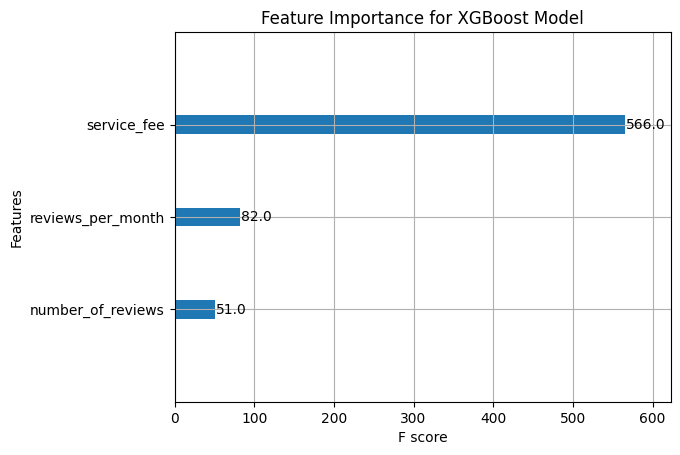

In [ ]:
import matplotlib.pyplot as plt
import xgboost as xgb

# Extract feature importances
xgb.plot_importance(best_model, importance_type='weight')
plt.title("Feature Importance for XGBoost Model")
plt.show()

The feature importance plot for the XGBoost model indicates that the service_fee is the most influential factor in predicting the price, followed by reviews_per_month and number_of_reviews.

Key Insights:
Service Fee: The service fee has the highest importance score, suggesting it plays a crucial role in determining the price. This could imply that listings with higher service fees are generally priced higher, possibly reflecting higher-end amenities or better service quality.

Reviews per Month: This feature is also significant, indicating that listings with more frequent reviews tend to be priced differently. More reviews could correlate with higher demand and thus higher prices.

Number of Reviews: While important, this feature has a lower impact compared to the service fee and reviews per month. It suggests that the total number of reviews also contributes to the price but not as strongly as the other two factors.

**Hypothesis 1: Impact of Service Fees on Customer Choice
Objective
Investigate if higher service fees correlate with higher amenities and better reviews, impacting customer selection.**

Data Used
Features: service_fee, price, reviews_per_month, number_of_reviews
Target: price
Methodology
Exploratory Data Analysis (EDA):

Correlation heatmap.
Scatter plot of service fee vs. price.
Modeling:

Linear Regression.
Ridge and Lasso Regressions.
XGBoost with hyperparameter tuning.
Evaluation:

Mean Squared Error (MSE).
R² Score.
Cross-validation.
Results
Linear Regression:

Training MSE: 482.31
Training R²: 0.9956
Validation MSE: 454.54
Validation R²: 0.9959
Ridge Regression:

Similar performance to Linear Regression.
Lasso Regression:

Similar performance to Linear Regression.
XGBoost:

Best Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
Training MSE: 481.34
Training R²: 0.9956
Validation MSE: 457.48
Validation R²: 0.9958
Conclusion
The service fee is the most significant feature influencing price.
Reviews per month and the number of reviews have a smaller impact.
The models demonstrate high accuracy and reliability.bold text

# Modeling

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.impute import SimpleImputer

In [ ]:
df = pd.read_csv('/content/Airbnb_Cleaned_Data.csv')

In [ ]:
df.dtypes

id                                  int64
NAME                               object
host id                             int64
host_identity_verified               bool
host name                          object
city                               object
neighbourhood                      object
lat                               float64
long                              float64
country                            object
instant_bookable                   object
cancellation_policy                object
room type                          object
Construction year                  object
price                             float64
service fee                       float64
minimum nights                    float64
number of reviews                 float64
last review                        object
reviews per month                 float64
review rate number                float64
calculated host listings count    float64
availability 365                  float64
house_rules                       

In [ ]:
df.head()


,id,NAME,host id,host_identity_verified,host name,city,neighbourhood,lat,long,country,...,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,date,month,season
0,1001254,Clean & Quiet Apt Home By The Park,80014485718,True,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,...,9.0,2021-10-19,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,1970-01-01 00:00:00.000000286,1,Winter
1,1002102,Skylit Midtown Castle,52335172823,True,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,...,45.0,2022-05-21,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,1970-01-01 00:00:00.000000228,1,Winter
2,1002403,The Village Of Harlem....New York !,78829239556,True,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,...,0.0,2012-07-11,0.00,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",1970-01-01 00:00:00.000000352,1,Winter
3,1002755,No Name,85098326012,True,Garry,Brooklyn,Clinton hill,40.68514,-73.95976,United States,...,228.0,2019-07-05,4.64,4.0,1.0,322.0,No rules specified,1970-01-01 00:00:00.000000322,1,Winter
4,1003689,Entire Apt: Spacious Studio/Loft By Central Park,92037596077,True,Lyndon,Manhattan,East harlem,40.79851,-73.94399,United States,...,9.0,2018-11-19,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",1970-01-01 00:00:00.000000289,1,Winter


In [ ]:
df.describe()

,id,host id,lat,long,price,service fee,minimum nights,number of reviews,reviews per month,review rate number,calculated host listings count,availability 365,month
count,1.020900e+05,1.020900e+05,102082.000000,102082.000000,102090.000000,102090.000000,102090.000000,102090.000000,102090.000000,102090.000000,102090.000000,102090.000000,102090.0
mean,2.915344e+07,4.924999e+10,40.728100,-73.949713,625.302743,125.028632,7.151396,26.459124,1.144367,3.268567,7.919845,139.728798,1.0
std,1.626030e+07,2.854221e+10,0.055862,0.049381,331.276523,66.238143,10.624576,43.849532,1.515808,1.295834,32.238445,133.435945,0.0
min,1.001254e+06,1.236005e+08,40.499790,-74.249840,50.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
25%,1.504867e+07,2.456196e+10,40.688760,-73.982558,341.000000,68.000000,1.000000,1.000000,0.090000,2.000000,1.000000,3.000000,1.0
50%,2.915952e+07,4.910627e+10,40.722300,-73.954450,625.000000,125.000000,3.000000,7.000000,0.480000,3.000000,1.000000,95.000000,1.0
75%,4.319305e+07,7.399621e+10,40.762750,-73.932380,912.000000,182.000000,5.000000,30.000000,1.700000,4.000000,2.000000,268.000000,1.0
max,5.736742e+07,9.876313e+10,40.916970,-73.705220,1200.000000,240.000000,365.000000,228.000000,11.720000,5.000000,332.000000,365.000000,1.0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102090 entries, 0 to 102089
Data columns (total 27 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              102090 non-null  int64  
 1   NAME                            102090 non-null  object 
 2   host id                         102090 non-null  int64  
 3   host_identity_verified          102090 non-null  bool   
 4   host name                       102090 non-null  object 
 5   city                            102090 non-null  object 
 6   neighbourhood                   102090 non-null  object 
 7   lat                             102082 non-null  float64
 8   long                            102082 non-null  float64
 9   country                         102090 non-null  object 
 10  instant_bookable                102090 non-null  object 
 11  cancellation_policy             102090 non-null  object 
 12  room type       

In [ ]:
# Rename columns to replace spaces with underscores
df.columns = df.columns.str.replace(' ', '_')
df.columns = df.columns.str.replace(' ', '_').str.lower()

# Verify the changes
print(df.columns)

Index(['id', 'name', 'host_id', 'host_identity_verified', 'host_name', 'city',
       'neighbourhood', 'lat', 'long', 'country', 'instant_bookable',
       'cancellation_policy', 'room_type', 'construction_year', 'price',
       'service_fee', 'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'review_rate_number',
       'calculated_host_listings_count', 'availability_365', 'house_rules',
       'date', 'month', 'season'],
      dtype='object')


In [ ]:
# Further clean column names (e.g., making them lowercase)
df.columns = df.columns.str.replace(' ', '_').str.lower()

# Verify the changes
print(df.columns)


Index(['id', 'name', 'host_id', 'host_identity_verified', 'host_name', 'city',
       'neighbourhood', 'lat', 'long', 'country', 'instant_bookable',
       'cancellation_policy', 'room_type', 'construction_year', 'price',
       'service_fee', 'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'review_rate_number',
       'calculated_host_listings_count', 'availability_365', 'house_rules',
       'date', 'month', 'season'],
      dtype='object')


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import LabelEncoder

# Convert booleans and categoricals to numeric types
label_encoders = {}
for column in ['host_identity_verified', 'room_type', 'instant_bookable', 'cancellation_policy']:
    le = LabelEncoder()
    df[column] = le.fit_transform(df[column].astype(str))
    label_encoders[column] = le

# Handle missing values
df.fillna(df.mean(), inplace=True)

# Prepare features and target
X = df[['price', 'reviews_per_month', 'number_of_reviews', 'host_identity_verified', 'room_type']]
y = df['availability_365']

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the Random Forest model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Make predictions and evaluate the model
predictions = model.predict(X_test)
mse = mean_squared_error(y_test, predictions)
print(f'Mean Squared Error: {mse}')


TypeError: Could not convert ['Clean & Quiet Apt Home By The ParkSkylit Midtown CastleThe Village Of Harlem....New York !No NameEntire Apt: Spacious Studio/Loft By Central ParkLarge Cozy 1 Br Apartment In Midtown EastBlissartsspace!Blissartsspace!Large Furnished Room Near B\'WayCozy Clean Guest Room - Family AptCute & Cozy Lower East Side 1 BdrmBeautiful 1Br On Upper West SideLovely Room 1, Garden, Best Area, Legal RentalWonderful Guest Bedroom In Manhattan For SinglesWest Village Nest - SuperhostOnly 2 Stops To Manhattan StudioPerfect For Your Parents + GardenChelsea PerfectHip Historic Brownstone Apartment With BackyardHuge 2 Br Upper East  Cental ParkSweet And Spacious Brooklyn LoftCbg Ctybgd Helpshaiti Rm#1:1-4Cbg Helps Haiti Room#2.5Cbg Helps Haiti Rm #2Maison Des Sirenes1,Bohemian ApartmentSunny Bedroom Across Prospect ParkMagnifique Suite Au N De Manhattan - Vue CloitresMidtown Pied-A-TerreSpacious, Lovely Furnished Manhattan BedroomModern 1 Br / Nyc / East VillageFront Room/Double BedSpacious 1 Bedroom In Luxe BuildingLoft In Williamsburg Area W/ RoofBack Room/Bunk BedsLarge B&B Style RoomsLovely Room 2 & Garden; Best Area, Legal RentalClean And Quiet In BrooklynCute Apt In Artist\'S HomeCountry Space In The CityLowereastside Apt Share Shortterm 1Enjoy Downtown Nyc!Beautiful Sunny Park Slope Brooklyn1Bdr W Private Bath. In Lofty AptWest Side RetreatBest Bet In HarlemEntire Apartment In Central Brooklyn Neighborhood.1 Stop Fr. Manhattan! Private Suite,Landmark BlockCharming Brownstone 3 - Near PrattBright And Stylish DuplexFort Greene BrownstoneBlue Room For 2 In Brownstone For $1350 MonthlyCozy 1Bd On Central Park West In New York City* Original Brooklyn Loft *Greenpoint Place...Has It All!Beautiful Apartment In Manhattan!!!Williamsburg 1 Bedroom ApartmentNo NameNo NameNo NameNo NameNo NameNo NameNo NameNo NameDouble Room W Private Deck Clinton Hill Best AreaYour Heaven In Hells KitchenLight-Filled 2B Duplex In The Heart Of Park Slope!Sunny, Modern Room In East Village!*Haven Loft - Entire Floor - Six Windows - Bricks*Large Room In Amazing East Village AptSpaha Loft: Enormous And BrightLovely Ev Artist\'S HomeCool Room In Hell\'S KitchenHarlem, New York Welcomes You!!Blue Trim Guest HouseCharming East Village One Bedroom FlatManhattan RoomLittle King Of QueensFort Greene Retreat On The ParkBeautiful Meatpacking District LoftNo NameSpacious Luminous Apt Upper West NycEntire 2 Bedroom - Large & SunnySunny, Spacious Top Floor HavenPrivate Room Great Deal At Lower East SidePerfect For A Family Or Small Group2 Bedroom Williamsburg Apt - Bedford L StopOh Glorious Spring!Great Location For NycCozy Bedroom In Williamsburg 3 BrSunny Room+Pvte Office In Huge LoftSpacious Prospect Heights ApartmentLarge Parlor Room, Landmark Home 1 Block To Pratt2-Bed Brownstone Duplex + GardenCharming 1 Bed Gr8 Wburg Location!No NameNo NameNo NameLoft Bed - Near Transportation-15Min To Times SqHouse On Henry (3Rd Flr Suite)Monkey Retreat Manhattan2000 Sf 3Br 2Bath West Village Private  TownhouseWilliamsburg—Steps To Subway, Private Bath&BalconyBeautiful Duplex ApartmentLarge 2 Bedroom Great For Groups!Modern Brooklyn Apt., August Sublet1,800 Sq Foot In Luxury BuildingSunny 2-Story Brooklyn Townhouse W Deck And GardenTimes Square, Safe, Clean And Cozy!Cozy Room #3, Landmark Home 1 Block To PrattBeautiful Apartment East VillagePark Slope Green Guest House2 Br / 2 Bath Duplex Apt With Patio! East VillageNyc Fabulous Views Manhattan\'S Eye2 Story Family Home In WilliamsburgNo NameGreat Large 1 Br Apt  In East Village!Eveland Private Bed & Living Room W/ Own EntranceSugar Hill Rest Stop3 Story Town House In Park SlopeApartment Next To Central ParkEast Village SanctuaryLarge 1  Br In A 3 Br Brooklyn Apt. Next To Q Trn.Modern Apt With Spectacular ViewsGarden Studio In The Upper East SidSecluded Master Bedroom In Beautiful Huge AptB & B Room 1Accommodations Galore #1Sunny Room In New CondoStylish & Sleek Apartment Near Soho!Nyc Artists’ Loft With Roof DeckSanctuary In East FlatbushRoom With En Suite Bathroom & DeckFlat MacdonoughHuge Private  Floor At The WaverlyModern Greenpoint, Brooklyn AptSun-Drenched, Artsy Modernist 1 Bdrm DuplexSunny, Cobble Hill ApartmentFully Furnished Basement ApartmentFlat Macdonough GardenLight Filled Williamsburg ApartmentRetreat In WilliamsburgNyc ZenCozy Br In Wiliamsburg 3 BedroomSunny Room In Old Historical Brooklyn TownhouseSun Filled Classic West Village AptLg Rm In Historic Prospect HeightsClassic Artist Loft WilliamsburgNo NamePrivate Bdrm/Bathrm. New! Elevator!Sunny, Clean 1 Bdrm In W. VillageGreat Location In WilliamsburgLight And Airy Upper East Side 1 Bdr ApartmentLuxury Brownstone In Boerum HillCentral Park Loft All For YouIndie-Chic Share In WilliamsburgA Room W/ A Manhattan View, Longer StayPrivate, Large & Sunny 1Br W/W&DLuxurious Condo In Dubmo With ViewCharming & Cozy Midtown Loft Any Week Ends  !!!* Spacious Garden Park Slope Duplex* 6 People MaxConvenient Cozy Cheap Apt ManhattanParlor Room In Victorian TownhouseHouse On Henry (2Nd Flr Suite)New York Room With A ViewSunny Cozy Room In Brklyn TownhouseRoom With A ViewLight+Open+Airy+Rustic+Modern LoftWest Inn 2 - East VillageFinancial District Luxury LoftBrooklyn Victorian Style Suite.....Your Own Lovely West Village StudioAccommodations Galore#3. 1-5 GuestsGreenwich Village Stylish ApartmentClean And Cozy Harlem ApartmentFort Greene, Brooklyn: Center BedroomBeautiful Queens Brownstone! - 5BrCouldn\'T Be Closer To Columbia UniNo NamePark Slope Haven 15 Mins From SohoSafe  And Beautiful AccomodationLarge Room In Private Brownstone In Park SlopeNew York City, 1 Bdrm.(Near Central Park & Metro)Large, Comfy 1Bdr W/Character!!!Chelsea Studio Sublet 1 - 2 MonthsLux Apt In Times Square New BuildingDesigner 1 Br Duplex W/ Terrace- Spectacular ViewsLovely Apt & Garden;  Legal;  Best Area; AmenitiesCozy Studio With Parking SpotClean And Convenient 2Br ApartmentNo NameNo NameNo NameNo NameNo NameNo NameCozy Bedroom By Yankee StadiumGreat Apartment With Private Bathroom And EntrancePrivate Garden Apt • New RenovationModern Comfort In Art Infused Landmark BrownstoneNoho/East Village, Private 1/2 BathSleek & Comfortable Soho AptSpacious Williamsburg Share W/ Loft BedCozy 2 Br In Sunny Fort Greene AptCozy East Village Railroad 1 Bed!1 Bedroom Loft W/ Private Roof DeckCity Room - Private & Comfy BedroomElegant Nyc PadClean & Bright 1Br In Cobble Hill, Great Location!Modern, Large East Village LoftGreat New Apt, Close To EverythingQuiet & Clean Retreat In The CityStylish Large Gramercy Loft!The Brownstone-Luxury 1 Bd Apt/NycPrivate Room On Historic Sugar HillSouth Slope Green17 Flr. Manhattan Views, Nr. SubwaySpacious 1Br, Adorable Clean QuietNice, Clean, Safe, Convenient 3BrFranklin St Flat In Trendy Greenpoint BrooklynArtistic, Cozy, And Spacious W/ Patio! Sleeps 5No NameNo NameNo NameNo NameCity Room - Private Luxury SuitePrivate Room/Bath Luxurious HarlemThe Gem Of The East VillageBright And Spacious, Garden Below!Accommodations Galore #2Colorful Private One Bedroom AptHuge Chelsea LoftGreat Room In Great LocationExclusive Room With Private Bath In  LesQuiet, Clean Midtown Apt W. ElevatoBk Sweet Suite W/Kitchen&FullbathGreat East Village Apartment RentalBrownstone Sundrenched BeautyA Special!! Private Room In NyB Nyc Staten Alternative...C Private Room By The FerrySmallest House In The VillageBeautiful Modern Studio Apartment In Heart Of NycBeautiful Landmarked DuplexBrooklyn > Guest Room W/ Queen Bed In WilliamsburgD Private Che@P Room 2 Explore NycSafe Cute Near Subway& Manhattan Ny Ny Retro StyleLarge And Cozy Private BedroomSmall Tidy Bedroom In DuplexLl3Dominique\'S Ny Mini Efficiency* Wifi*Metro*QuietPrivate, Large & Sunny Top Floor Apt  W/W&DCottage In The VillageBedroom1 For Rent 10Min From ManhanAmazing  Sunny & Breezy Home In The Heart Of  NycEnjoy Downtown Nyc!!Charming Uws Treehouse AptShare A Home - $75 For 1 Bdrm/++ For 2 - BrooklynRoom In S3Rd/Bedford, WilliamsburgCharming East Village 2 (Or 1) BrFarmhouse Apartment In WilliamsburgBright+Spacious Williamsburg Abode!Suite Sugar Hill, Harlem, Private Rm In Hosted AptBeautiful 1 Bedroom Apt Park SlopeCharming Carroll Gardens Apt.Private Bedroom Brownstone BrooklynEast Village Loft With Piano & PatioLower East Side Magic Room**Fantastic Williamsburg Apt**West Harlem Home Base - Eco-Apt.Charming Garden Apt In Park SlopeLovely, Modern, Garden ApartmentCentral Park 1Br Sunny CondoCozy Garden Apartment  In WilliamsburgSoha Comfort-By Nw Central Park!Cozy Room In Upper West SideCozy Private Room In ApartmentThe Cozy Brownstone Inn (Discount)!Prewar Penthouse W Private TerraceDesigner 2.5 Br Loft In Carroll Gardens By SubwayBright Beautiful BrooklynUnique Spacious Loft On The BoweryNice Renovated Apt, Prime Location!Brooklyn Writer\'S NookPrivate Bedroom In Large Nyc ApartmentLarge, Sunny Room East Village NycGreat Large 3 Br/2 Bath Duplex With Private Patio!No NameNo NameNo NameGigantic Private Brooklyn Loft!Condo Apartment With Laundry In Unit1Br: See Central Park From Terrace!Private Room In Cozy GreenpointFood & Music Dream Apartment In WilliamsburgFrench Garden Cottage Off BedfordNo NameLuxury 3 Bed/ 2 Bath Apt In Harlem W/ TerraceOne Bedroom Mini Studio - Free WifiNo NameBrooklyn > Guest Room W/ King Bed In WilliamsburgBright Cozy Chinatown Studio Apt.Eveland The Place To Stay & Enjoy A 5-⭐️ 2BdrmNo NameHells Kitchen Garden Of EdenHistoric House Boerum Hill, Bk, NycLovely 3 Bedroom In Italianate Brownstone W/GardenWilliamsburg Huge, Private Bath - Next To Train!Cozy Room In East Village With AcDuplex W/ Terrace @ Box House HotelLoft W/ Terrace @ Box House HotelSpacious 3 Bedroom Duplex In Park SlopeLoft W/ Terrace @ Box House HotelColumbia Castle In Brooklyn HeightsColumbia Castle 2 BrCharming Artist\'S Flat, East VillageBeautiful 2 Bedroom ApartmentBrooklyn Cove Studio Apt W/ Garden!!Ft. Greene Garden Gem, Large And ConvenientWilliamsburg Penthouse With Private Roof CabanaEast Village Designer\'S 1-Br AptSuperior @ Box HouseNo NameLarge Studio--Heart Of East VillageHuge.Bright.Clean.Safe. Private RoomGarden 1Br/1Ba Brownstone Apt - 2 Blocks To SubwayModern Spacious 2 Br Apt Downtown ManhattanThe Brooklyn WaverlyWonderful, Comfortable StudioNo NameModern, Safe, Clean, Bright Room In Astoria For 2Large 1Br (Conv 2Br) Crown HeightsNo NameBeautiful, Bright’S, Warm & Spacious 1.5Br AptLovely 1Br In Tree-Lined WburgSpacious Loft In Clinton HillThe Brooklyn Waverly, One BedroomLovely Apartment In The Heart Of NyNo NameComfortable Cozy Space In El BarrioSunny Bklyn Jewel  Fort Greene July  - Aug 2019Manhattan Neat, Nice, Bright RoomBienvenueLarge Brand New Park Slope 1BrColorful Artistic Williamsburg AptUws Brownstone Near Central ParkArtsy Topfloor Apt In Prime Bedford Williamsburg2 Br W/ Terrace @ Box House HotelBohemian East Village 2 Bed HavenOceanfront Apartment In RockawayPrivate 1-Bedroom Apt In TownhouseBright Room With A Great River ViewTree Lined Block Modern ApartmentSweet Historic Greenpoint DuplexRiverside Charm With Fire PlaceVery Central, Nomad/Chelsea Loft StudioSunny 3Br Apt Ideal For FamilyCozy Private Room In West Harlem!Ues Quiet & Spacious 1 Bdrm For 4All About A Very Comfortable Room..Brooklyn- Crown Heights Garden Apt.Cozy Room In Time Square!Large Park Slope Townhouse DuplexLower East Side 2 Bedroom AptManhattan Studio, Perfect LocationSun-Drenched Hamilton Hts JewelYour Stunning Vacation Apartment!1 Bdrm Apt-Weekend SubleaseNo NameNo NameNo NameNo NameNo NameNo NameSpacious Brooklyn Loft - 2 BedroomPark Slope Apt:, Spacious 2 BedroomNyc Studio For Rent In Townhouse⚡Quiet Gem W/Roof Deck On Ny\'S Hottest Street⚡Authentic New York City LivingSuper Big And Cozy Private Bedroom☆Massive Duplex☆ 2Br & 2Bth East Village 9+ GuestsGorgeous Upper West Side ApartmentLuxe, Spacious 2Br 2Ba Nr TrainsCity Room - Street View AptCozy And Bright One Bedroom In BkForest Hills Apt Minutes To Midtown ManhattanSpacious West Village 1 B/Room KingPerfect Williamsburg Summer HavenMidtown Cozy ConvenientPrime Williamsburg ApartmentPrivate, Spacious Room In BrooklynGarden Apartment Close To ManhattanThe Ground Studio - West SideStunning Arty 3200Sf 3Flr+3Br Townhome W/TerraceSunny And Spacious Designer\'S HomeSpacious,Sunny, Private One BedroomTruly Amazing Oasis In The CityNo NameNo NameNo NameNo NameNo NameCharming Nolita Apartment!!East Village Studio, Sunny & QuietLuxury Of The Horizon1 Bdrm In 4 Bdrm Dupelx/Roof DeckThe Heart Of Prime WilliamsburgParisian Apartment In ChelseaCozy 2 Bedroom With Private GardenThree-Bedroom House In A Quiet NeighborhoodBeautiful Duplex W/Private GardenNyc - Sunny Greenwich Village 1BrGarage Designer LoftBest City Area Columbia U Upper West Side C ParkYour Own Apartment Off Park AvenueArtsy 1 Bedroom Apt. 20 Min To 42Nd Grand Central!Lower East Side 2 Bed Apt.Astoria-Private Home Nyc-Big, Comfy , Priv. Room, Big Apt, Yard, Great Loc.Park Slope ApartmentCharming Private Bedroom East VillageCity Room - Semi Private BedroomCozy Apartment In A BrownstoneFemale Only Clean15Min To ManhattanGreenpoint Spacious LoftPrivate E. Village Townhouse StayHarlem/Hamilton Heights Cozy RoomIncredible Prime Williamsburg Loft!Large  Loft Style  Studio  SpaceHancock Town House!-Stuyvesant MewsEntire Apt In Heart Of WilliamsburgClinton Hill + Free Coffee = #SmileNo NameNo NameNo NameRed Room For Two In Brownstone For $1355/MoChelsea Living, 2Br Best LocationLocation Location Location Uws 60\'SIn The Heart Of East VillageSunny 15Min To Manhattan Lady OnlySurfer Room 15Mins To Downtown Nyc!Manhattan Penthouse-Max.12 GuestsPrime Williamsburg 3 Br With DeckBeautiful Brooklyn OasisBlue Room In Awesome Artist\'S Apartment!Cool & Spacious Harlem Artist Flat☆ Studio East Village ☆ Own Bath! ☆ Sleeps 4 ☆Greenpoint Loft / Le Chez Andrea*Soho: Clean, Safe, Private, Peaceful Bedroom (A)*Amazing Brownstone In Best BrooklynCouldn\'T Be Closer To Columbia Uni2Lady Only Curtain-Divided RoomNice Manhattan Apt Near Central Park And SubwayLg Private Room/Family FriendlySpacious Quiet Rm - 20Mins To Midtown3 Br, Beautiful Brooklyn DuplexSpacious Modern Studio Apartment In ManhattanGorgeous Duplex + GardenCbg# 4Tiny Room W/ Huge Window/AcCharming Upper West Side ApartmentLight-Filled East Village DelightSunny, Quiet, Legal Homelike Suite-Pk Slope SouthSpacious Duplex In Brownstone!Lovely Vintage Haven—Heart Of UwsModern Space In Charming Pre-WarWarehouse Loft With Garden ViewAffordable & CozyCreative Vintage Loft In S. WilliamsburgVery Close To Downtown Awesome Private ApartmentThe Happy Home!Fort Greene, Brooklyn: Front BedroomGorgeous 1 Bdrm In Huge Duplex!Sunny, Cozy Room In Lower East SideLarge Quiet Bedroom Near Columbia UCozy Pre-War Harlem ApartmentSpacious StudioElegant 2-Br Duplex, Union SquareCozy Private Family Home In BushwickLuxury 2Bed/2.5Bath Central Park ViewCosy Sunny 1Brm In Prospect HeightsEast Village Bedroom W RooftopWilliamsburg Home Away From Home!Brand New Beautiful Duplex Apartment With GardenPrime, Luxury, Spacious 2 Bedroom Apt In ChelseaSpacious Alcove Studio/ Junior OneHigh-End Doorman Bldg In The LesSpring & Mulberry 2 Bedroom ApartmentUltra Modern Nyc Garden ApartmentModern Garden Apartment In NycGorgeous Entire Manhattan TownhouseCozy Studio Apartment In Upper EastHistoric Classic Central Cozy Village Clean NyuA Private Flat / Apartment- $Special$Williamsburg Bedroom By Bedford AveClean And Bright With A Comfortable AtmosphereWest Village Lrg Clean Sunny Private BdrmHistoric Brooklyn Studio ApartmentComfort At Crossroads Of Downtown"The Oasis" On Bedford WilliamsburgLarge, Sunny Garden Apartment.Union Square/ E. Vill 1Br BeautifulHell\'S Kitchen Funky 80\'S Hideaway!Room In Chic Modern High Line Luxury- New!Family & Friends In New York CitySpacious & Comfy Bk BrownstoneLarge Luxury Upper East Side StudioChateau Style Brooklyn Loft For Singles Or CouplesLovely Brooklyn Brownstone 1Br!Beautiful Grdn. Apt. In Park SlopeSun-Drenched East Village PenthouseColumbus Circle Luxury Bldg - Private Room&BathBright Private Bedroom In Williamsburg (Bedford L)Spacious, Kid-Friendly, And 15-20 Mins. To MidtownQuiet Chelsea Studio W/CharmLarge Room Overlooking Central ParkCheerful, Comfortable RoomHospitality On Propsect Pk-12 Yrs Hosting Legally!Prospect Pk*Nyc In 5 Stops* Cozy,Clean & Legal!Loft Style Apt In Williamsburg2 Beds Over Bed-StuySunny, Large, Park Slope BedroomHuge Bklyn Loft W Private RoofdeckQuiet Jr Alcove Near Times Square!Large Room In Elevator Drman BldgComfy, Cozy, Brooklyn Close To ManhattanModern Bedroom In Hamilton HeightsSunny Space In WilliamsburgBest Manhattan Studio Deal!Stylish East Village FlatSerene Park Slope Garden ApartmentCozy And Spacious - Rare For Nyc!Beautiful Ues ApartmentSt. James Pl Garden Studio 1Block To Pratt &GtrainGreat, Spacious Apt In WilliamsburgComfortable. Spacious. Private Room.Modern Condo In MidtownIdeal Brooklyn Brownstone ApartmentA Cozy Oasis In Bushwick, NyPrivate Entrance - Private ParkingYankee Stadium Oasis 2 Stops To Manhattan!Sunny, Spacious Studio In Ft.GreeneWilliamsburg Exposed Brick LoftBright Modern Charming HousebargeCentral Bedford Avenue ApartmentWelcome To Brooklyn! Bed-StuySunnyside Nyc/ Ac Room/ City Views/ Near MidtownGreenpoint Waterfront LoftEast Village House -- Unique!2-Bedroom Share In Heart Of Greenwich Village!1 Bedroom Pre War AptQuiet One Bedroom In Park SlopeCreative Live-In Artspace/BirdsnestRare Penthouse Oasis Featured On DesignspongeNew Clean Spacious Bed & BreakfastSunny, Calm Room In Victorian HomeModern Unique Studio In Nyc2 Bed, 2 Bath Apartment On Central Park WestLuxury Furnished 1 Bedro, Bay RidgeYour Haven In The Upper West SideWonderful Studio In Brooklyn, Ny!!!A Cozy Brooklyn Hideaway✿✿✿ Country Cottage In The City✿✿✿✿✿✿ Country Cottage In The City✿✿✿Lovely Bdr In Harlem, ManhattanThe Best Deal On The Hudson River!!Lovely Huge Master Bed + StudyNewly Reno’D Chic Quiet Exec 1Br1 Bedroom In Prime FlatironLarge Artist Floorthru- GreenpointGorgeous Permago Private Room In Fidi - 1/2Cbg Helps Haiti Rm #3Best Deal In Chelsea 1 Bdrm NycLovely ApartmentArtsy Loft-Like Harlem ApartmentHarlem/Manhattan Classic ApartmentBeautiful Apartment, Great LocationQuiet Sunny Studio MidtownCharming Room In Victorian HomeBrooklyn B & B Close To ManhattanThe Notorious B.N.B. { The Erhart }Sunny Cozy Multileveled Apartment!Sunny 2 Bedroom Williamsburg Duplex W/ 3 BedsRoom With Kitchenette #2Alpha-Bet City Entire Floor Large Cool 2Br -L.E.SYour Haven Awaits At "Emma\'S Place"Spacious, Kid-Friendly 2 Br In West VillageGreat Bedroom In Downtown ManhattanBeautiful Brownstone1Bdr - Hell\'S Kitchen HideawayComfy Room/Coffee And Bagel/Weekly DiscountOversized Studio In Park SlopeApt With Empirestate View-Subway Around The CornerZen Yankee Stadium Pad 5 Minutes To Manhattan!Monthly Apartment RentalWonderfully Inviting East VillageTurquoise: One-Bedroom Apt. In SohoLovely Pied-À-Terre, In An Historic BuildingSpacious, Well Furnished, High Fl. Beautiful ViewsNyc Studio In Heart Of Times SquareRooms For Rent In Queens With PianoLarge Sunny Luxe Prvt Room/MidtownSpacious Stunning Harlem TownhousePrivate Room With Great LocationHuge Sunny Duplex Loft With GardenLarge Artsy Room W/ Loft Bed 4 Dooglers!Stylish Studio With Exclusive TerraceLes Private Apt, 1 Bedroom & MoreWilliamsburg Garden Home, 5 Minutes From ManhattanHuge, Modern 2-Level Brooklyn AptCharming 2Bdrm Apt In East VillageLocation Location Location Liz\'SManhattan Loft In Prime East Village LocationNolita Penthouse_Private Deck_Elev_Astoria Garden SuiteLower East Side/Chinatown 1 BedroomAmazing 1 Bed, Live Like A NewyorkrPrivate Room In Fort Green Bk Close To CitySpacious & Charming By Prospect PkPrivate Room Near Brooklyn MuseumThe Notorious B.N.B. { The Wallace }Clinton Hill 1 Bed Bright Loft ApartmentGreat Studio In W. Village - Nyc!The Notorious B.N.B. { The Swoon }Big 1Br, Sleeps 4, Dishwashr, Tv2Br  Apt - 20Min To SohoWilliamsburg  - Quiet And Comfy StayOne Fabulous Private RoomNy/ Big Room For 2 Near ManhattanBrooklyn Brownstone ApartmentBig 1 Bedroom Apt Very CentralLovely, Large Room In Crown HeightsSweet Apt, Steps From Gramercy ParkQuality Cozy Studio Next To SubwayScandinavian-Apt For Up To 5. LesLoft Suite @ Box House Hotel4 Bedroom -2Bathrm West Village Duplex  TownhouseLarge & Bright 900Ft² 1Br In WvAt A Very Nice Area In The WestsideHancock Very Small RoomPre-War Williamsburg Loft1 Bedroom Available In My Two Bedroom FlatSpacious Private Little Italy FlatThe Lenox In HarlemThe Lenox In HarlemHeart & Soul Of Greenwich VillagePrime Williamsburg Loft Off BedfordPrivate Bdrm /Bath 1 Block Ctrl Prk+Highly Satisfactory Les Dwelling++Whole Apartment / 2 Bedroom In NycSpacious, Modern Loft In Awesome NeighborhoodLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelWell Kept  Private Room Around  Brighton  BeachLarge 1 Bedroom Furnished On UwsChez Carine - Privacy In ManhattanLoft Suite @ Box House HotelLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelDuplex W/ Terrace @ Box House HotelLoft W/ Terrace @ Box House Hotel1 Br W/ Terrace @ Box House HotelSuperior @ Box HouseRead It 1St, A Seprat Fur Br, Low $2 Br Duplex @ Box House HotelHusband & Wife Art-Filled Apartment3Br, 2 Bathroom Condo In BushwickThe Blue Owl:\nVegetarian Wburg W Patio & Backyard!Cozy 2 Bedroom 20 Min From CityNolita! Location! Location! Views! Free Gym!Entire Apt Nyc, Queens. 15 Min From Times Square.Luxury Chelsea Townhouse At The High LineAlchemy Bnb - Room In Artist LoftSunny! 2Br Steps To Train/Restaurants - 15 To NycZen Den (Airport Pickup: Jfk & Lga)Heart Of Williamsburg. Brand New.Fresh, Clean Brooklyn Garden Apt.Guest Apartment In Owner Occupied HomeMy Home Is Your HomeSpacious & Stylish Chelsea One Bedroom ApartmentChelsea 1 Bdrm Plus Sleeping Loft!!Spacious Room In Beautiful Apt!Oceanview,Close To ManhattanAffordable Rooms,All TransportationBudget Stay, Near TransportationFort Greene Brownstone 1Br- SubletNewyork Modern Pre-War LoftstudioCozy Artist Duplex **Bedstuy Charm**Apartment In Best Location In NycInspired In Historic Downtown Nyc!Chelsea/West Village - 2Bdrm Apt1500+ Sq Ft 2Br West Village LoftCozy & Clean Lower East Side Apt.Spacious Townhome Apt In BrooklynChic + Stylish Room In Heart Of Lowereastside Nyc!Landmark 2 Bedroom West Village Nyc2 Bedroom Apt In Charming Brick TownhouseRoom In East Village With Private EntranceCozy&Clean In A Great NeighborhoodPrime Williamsburg 1/Bd New CondoCity Skyline Views From Every Room!Contemporary & Classic Sanctuary On The HudsonComfortable ManhattanvillePrivate Room W/ Queen Bed + RooftopZen Eyrie –Airport Pick-Up: Jfk/LgaStudio Sublet In Hell\'S KitchenLuxury Nyc 2 Bedroom With TerraceBright Unique Designer Loft In SohoSpacious  2 Bed Loft Apartment Bedford LBeautiful Studio By Central ParkOne Bed Suite With Private GardenSunny 1 Bedroom Apt In Fort Greene - BrooklynWest Village Cozy 2 Bedroom  Nyc2 Bedroom Gem - Prime Les LocationReal 2Br-Heart Of Soho-Little ItalyBig Room / Downtown  Loft /Large Sunny Bedroom In Qns NycHome Away From Home-Room In BronxPrivate Clean Pleasant Spacious Room.Charming Hotel Alternative\nMount SinaiSunny 2-Bdrm Child-Friendly Uptwn By Centrl Park!Resort-Like Living In WilliamsburgHudson Yards With Views Of The Highline ParkBrooklyn: A Huge Bedroom + Good VibesOne Stop From Midtown Manhattan!Private Room Very Near L Train, BushwickCozy New York  City Private RoomBed-Stuy Royal RoomSuper Cute East Village ApartmentGreap Studio / 4Ppl In MidtownBedford Av.  Room In Williamsburg..Sleep & Wake Near Botanical GardensTranquil In The Heart Of Brooklyn 2Tranquil In The Heart Of Brooklyn 1Easy, Comfortable Studio In MidtownHuge Luxury 1Br Apt Near Central Park South(4 Ppl)Beautiful Brownstone Apartment1 Bd. Manhattan Ny Entire Apt. 1 Yr-6 Months Min.Luxury Designer Downtown ApartmentSpacious Room On Charming Block In Greenpoint!Sunny, Spacious Apt. In  Ft. GreeneGuest Room In Authentic Williamsburg Factory Loft6 Bedroom Landmark West Village TownhouseBeautiful Bed And Bath - ManhattanBeautiful Room Near Central Park!Fantastic 1-Bedroom Basement Apt.Private Clinton Hill, Brooklyn AptCharming Furnished Studio-LoftLovely 2 Bedroom Apartment With Backyard AccessNights In White Satin In The SlopeThe Carlton, Brooklyn Brownstone Duplex W/ GardenComfortable Manhattanville.Beautiful Lrg 1800\'S Syle Apt ShareLocation Wins For East Village AptSunny Entire Apt With Romantic BedroomFurnished Room For Rent - ManhattanLarge Room In A Huge Ny Apartment.West Village Nyc Sun-Filled Studio!Large, Furnished Room In A 2 Bedroom!Huge Apartment!  Amazing View!#1 Yellow Block Bnb/See At Net Flix Show Stay HereCozy Brownstone Inn I(Studio)Crown Height\'S Brooklyn Cozy AptAmazing West Village 2BrAuthentic Ny Charming Artist LoftBeautiful Private Bedroom - DownstairsKensington/Ditmas Park Pied-A-TerreQt Studio For Romantic CouplesOwn Room & Bath, Sunny Town House, 18" To Wall StCozy & Charming Boerum Hill FlatPark Slope Brooklyn!  Sunny Bedroom.One Bedroom Sharing BathroomSpacious East Village ApartmentHuge Williamsburg Loft..Perfect For Big Groups!Stylish Garden House - Trendy AreaHells Kitchen Ground Fl 1-BedroomPre War Park Slope On Prospect ParkCharming Apt In The Best Location!Huge Room With Private BalconyAmazing 1 Bedroom Apt With Nyc ViewGreat Spacious Room By The L Train!Charming Brooklyn StudioPrivate Room In BrownstoneBed Stuy Pride! Welcome To BrooklynLovely Hell\'S Kitchen Studio...Hot Spot For 20 And 30 Something\'SCozy, Clean Cobble Hill BrownstoneBright Loft Apt W Skylight In WburgCozy, Beautiful Doormen Studio-Carroll Gardens Gem-2Bd With GardenSunny 1Br Center Of East Village!2Br In Cobble Hill, Brooklyn, NyPerfect East Village ApartmentDecorators 5-Star Flat West VillageBeautiful Soho Luxury Apartment2 Rooms In Cottage NycZen Minimalist W/Garden- Bedford L StopBetween Two Bridges 2Bd -Whole Apt!Big Luxury Lincoln Center Area Studio + !!Brooklyn Beauty - Large 2 Bedroom ApartmentEntire Apartment In Astoria, 15Mins From ManhattanGorgeous Pvt Room In West Village1 Bedroom Apt In Midtown WestSunny And Spacious BedroomBeautiful Spacious One BedroomRoom Next To Columbia Uni.Big Apt For Funky Art /Music Lovers, Outdoor PatioLoft Suite @ The Box House HotelNyc Summer Getaway | Full Home 2BrLoft Suite @ The Box House HotelBeautiful New Garden ApartmentLoft Suite @ Box House HotelLoft Suite @ The Box House HotelLoft Suite @ The Box House HotelLovely Apt In Williamsburg, BkWilliamsburg Huge Sunny Next2Train!Loft Suite @ Box House HotelModern Apartment W/ Gorgeous ViewSunny, Clean Br AvailableHave Whole Apt! Prime Williamsburg!Panoramic View Central Park & NycE Williamsburg Apartment With YardNice Private Room Beauty In QueensSublet In Brooklyn/Lefferts GardensCozy Corner, Bedford Ave  Brooklyn!Historic Williamsburg, Bklyn #1Inexpensive Apartment In Exchange For Cat-CarePrivate Room In 2 Br Apt, Wburg, BkBright, Airy Williamsburg AptLarge Double Room  Queenbed WifiLow$Pacious In Williamsburg, Bklyn1 Bdrm In 2 Bdrm Apt In Upper East Lux Drmn BldngCharming 1Bd In SohoFeel Like You Never Leave Your HomeSunny Apartment  In GreenpointFurnished Bedroom With Private Half BathSunny Private Room Featured In FilmSunny 1Br East Harlem ApartmentThe Best Studio In TownFully Furnished 1B/1Bth Uws Gem  1 Yr SubleasePenthouse Studio By Central ParkYour Own 2 Br Apt Bedford And GrandSpacious + Sunny Studio In Ft. Greene Brooklyn!2 Rooms; Private Entrance & Bath!Giant Sunny Bedroom & Private Bath In My ApartmentPrime Location! Backyard & Outdoor Shower! Unique!Private Room In Artist\'S Home, Stapleton, SiLarge Sunny Bedroom With Bay WindowHarlem/Hamilton Heights Sunny RoomClinton Hill Duplex Near Pratt W/Balcony!Sunny 1 Br, West 80S & Central Park2 Bd / 2Ba With Garden, Sleeps 6Comfortable RoomCharming Ridgewood Soulful  Walk-UpComfortable, Well-Appointed Room2Nd Avenue Off Houston/Loftlike StuShare In Nyc\'S Trendy East VillageHistoric Brooklyn 2-Bedroom AptApt W/ Outdoor Space!! Long Term Rental Preferred!Come And Go As  You Please In Bkln!Room In Huge 1200Sf W Harlem SuiteHuge, Sunny, Open Loft In BrooklynCozy Nook In Heart Of WilliamsburgPeaceful Room...Cute Room In Historic Loft!Harlem On The RangeAmazing Park Slope Duplex With DeckEntire 2 Bedroom Apartment In WilliamsburgBig Bright E Village 2Br (Baby Nursery)Private Manhattan Studio On Harlem/Heights BorderLuxury Williamsburg, Brooklyn LoftArtist Loft-Mccarren Park-Williamsburg-BrooklynnycChelsea/Meat Packing  Artist Space!Elegant Spacious Family TownhouseLarge Master Bedroom - WilliamsburgCentral Park Fifth Av Met MuseumReal Williamsburg Artist LoftLovely Upper East Yorkville 1 BdrmCozy Upper East Side StudioLarge Cozy Room #2, Landmark Home 1 Block To PrattLovely Studio In East Village, NyNyc Summer Discount  1 Br Gramercy AptAwesome Views, Central LocationSpacious Manhattan Apartment Near Central ParkEntire Apt: Sunny 2Bd! 15Min To NycYour Historic House In BrooklynCreative Director\'S Chinatown LoftHosting Your Cozy,  Eclectic Milieu For Nyc VisitCharming Private Room In New-YorkCozy Bedroom Near Times SquareArtist\'S Flat In Historic Building #10263Queen Size Sofa Bed In HarlemBklyn 6 Beds 1 Bathroom Rental 2Bklyn 4 Beds 1 Bathroom Rental 34 Beds 2 Bathrooms Rental 1Stylish & Quiet Nyc Retreat!Bright, New Luxury Apartment In Doorman BuildingTimes Square Master Bedroom!Lincoln Center Studio, Clean&Sunny!Serenity Amidst The Busy CitySuper Clean Apt By Columbus CircleUnique Private Room And Bathroom In BrownstoneTimes Square House!Beautiful Room In A Beautiful New Nyc ApartmentBest West Village/Meatpacking Space21 Day Chelsea Apartment RentalHeavy Sun, Quiet, Arty 1 BedroomCosy Apartment In West VillageSpacious Lower East Side Apt In NycArty 2 Bed East Village GemWilliamsburg Loft: Amazing SubletArtist 2Br In Park Slope W/BackyardSpacious 2Br Near Botanic GardenGorgeous Brownstone Next To Park!Exquisite Spacious Studio In MidtownComfortable Large RoomCute Private Room In Upper East Side #14Lower East Side 1Bedroom Apt In NycLarge Beautiful East Village 1-BdrmBig Room Near Prospect Park! Ny!It\'S So Easy To Get To Everything!Manhattan -  Best Location In MidtownSunny Private Room Right Off L TrainBeautiful Room In Manhattan LoftLuxury, Adorable Studio ApartmentHome Away From HomeBeautiful 3 Bedroom In ManhattanDen Of Zen At The Denizen BushwickSunny Large Private Room In Park SlopeEastern Parkway Brooklyn 1Br Flat1400Sf Manhattan View Artistic LoftIngefära Hus! Private Room Williamsburg, BrooklynPrivate Masterbr W/ View Of MuseumLuxury 2Bd/2Bth - Huge PatioComfy Brooklyn 2Bd, W/ BackyardAuthentic Designer Loft/Roof Deck Best WilliamsbrgSunny Retreat With Roof GardenEnjoy Staten Island HospitalityGreat Apt On The Uws - A Rare Find!Cozy 2 Bd In Midtown WestPark Slope Sunny StudioLuxury L-Shape Studio + 3 CatsA Cozy Red Room With Private BathroomCozy Room With Private Bathroom & Outside GardenBeautiful 1 Bdrm, Inwood ManhattanBeautiful Loft/10 Min To Manhattan!New York City- Riverdale Modern Two Bedrooms UnitA Place To Stay Close To ManhattanGreat Room Priv/Bathrm Eastside Location 70\'S StMidtown Nyc - 1 Bedroom ApartmentCozy Room In Sunny Apartment (Long/Short Term)There\'S No Place Like Home.........Cozy Home In Vibrant ManhattanLocation Location Location Sara\'SQuaint & Quiet In QueensSingle RoomCharming Brownstone ApartmentWilliamsburg Near Soho .Support Artist LivingYour Times Square SanctuaryDesigner Studio In Luxury BuildingPrivate Cozy Bedroom In NolitaArtistloft-Mccarenpark-WilliamsburgBeautiful Bedrooms In Briarwood, NyFlatiron-Designer\'S LoftStylish Designer Studio With PianoNew York City For All Seasons!Stunning E Vill PenthouseNew York Host Who Knows The MostOne Block From Central Park!Park Slope: Sweet, Large 2Br DuplexLight Superhosted Chill Les AptBig Beautiful Railroad In BrooklynBright Brooklyn Flat W/Park Views, 30 Day MinimumEco-Apt, Free Yoga, 2 New Bedrooms. Best Location!Sunny Ues 1.5 Bedroom, Sleeps 6Stay With A Jazz Singer In Harlem!Large Private Room Near Central Park & Mount SinaiLuxury Room In Manhattan Duplex AptGorgeous Sunny, Spacious 1 Bdrm In East VillageArtist Loft+Office In Prime Williamsburg!Private Garden EntryLuxe Privé L.I.C. Apt & GardenMagazine Soho Studio Loft. \nRead Our Reviews!Nolita Apt. With Private GardenFamily Friendly Williamsburg Apt For Vacation!Brownstone Two In Brooklyn In NycCharming West Village One BedroomBrooklyn Brownstone Full Floor/Garden ProspectparkFamily Friendly,  Steps To Subway, Large Garden :)Private Sunny Room Near Central Park & Mount Sinai1 Bdr Apt, Sunny & Artsy, 4 Min Walk To The Beach"Simple Perfect Soho"Beautiful Room + Private Balcony3 Br Apartment Crown Heights, BklynBrownstone Sunny & Spacious Top FlMorocco In Brooklyn With The Flyest Loft, Amazing!Perfect Nyc/Williamsburg LocationMidtown East Sutton Area Entire AptFinest Gateway To Historic Financial DistrictIndustrial Brooklyn Loft With Tree-Lined WindowsCute East Village Apartment.All Charm: Lush Garden, Huge Kitchen + QuietBright And Quiet 2 Br In Park SlopeCozy, Bright 1Br Avail. In East Village ApartmentStylish Loft W/Lovely BackyardGreat Apt Ideal Location 900 SfGarden - Brownstone ExperienceGorgeous ! Best Location In Nyc !Luxury 1 Bedroom Apt Hells KitchenLuxury Room + En-Suite Bath In Times Sq/Midtown WChic, Spacious Loft + BackyardSunny And Zen W. Village Studio Of Your Own2Br Lux Prospect HeightsAn Airy, Comfy, Bookish Refuge!Bright & Vibrant- The Bk ExperienceVery Clean, Quiet Bedroom AvailableLux One-Bed Central Park View UwsElegant Uptown Historic District Garden ApartmentOnly 5 Min. To Manhattan!Lovely 1 Bdrm In Prospect Heights!Spacious & Sunny In Prime Brooklyn1 Bedroom Apt - Close To Jfk & City1 Br. Studio Duplex,  Park Slope/Gowanus, BrooklynA Real New Yorkers  Wall StRoom Available In New York CitySunny West Village DreamSunny Zen  Full Service Huge StudioBeautiful Corner Prewar Apartment In WilliamsburgTranquil, Artsy, Sunny BedroomRoom In HarlemRoom For The SummerFantastic 2Br In Brooklyn\'S Best AreaGreat 1Br/2Ba Terrace & W/D! In Ev!Big Beautiful Brooklyn Apt @ Park!Perfect Apt. Above L Train Graham StopGorgeous Park Slope, Bk Triplex 4BdPrivate,Affordable, 20 Min To Nyc!Lovely Chelsea 1 BedroomClassy 2.5 Br Brownstone W/ GardenUpper Duplex In Brooklyn BrownstoneComfy Room Minutes From MuseumsBest Block, Nyc!  July 25-Aug 18Great 1 Br Apt In Kips Bay, NyPrivate Artist’S Apt/ Amazing Location!1 Br, Book It 1St Then Write MeNo Inq,Read It, 1 Br, Rt Of Subway,Spacious Loft 5 Min To Union SquareYour Own Private Entrance Studio In Stylish DuplexArt & Music SalonArtfully Decorated 2 Bedroom AptLavender Joy Room In Duplex!1 Bdrm Brownstone-West 70\'S-1 Block Central ParkSerene Room...Master Bedroom / Parkslope BrooklynSpacious 4 Bedroom House, New YorkBrooklyn Apartment Windsor TerraceBedroom With Garden At The BackFamily Friendly, Sunny New Condo In Mccarren ParkExciting Lower East Side, Loft LifeLarge Room W/ Private EntrancePrivate Spacious Studio AvailableFor Cat-Lovers OnlyUnion Square❤️Penthouse 2Fl+Terrace❤️East VillageSunny, Spacious 1-Bedroom In Upper ManhattanHello! Cozy-Singles Nyc- Upper Manhattan- Harlem!!Beautiful One Bedroom In ChelseaWest Village Loft, 1St FloorWest Village Gem - 2BrCentral Harlem Comfy Bedroom With Private BathBeautiful Apartment In The Heart Of The VillageCozy Private Room, Williamsburg NycBright Spacious 2 Bedroom/5 Room - Wroof Deck******Amazing Deal In Nyc*****Great Deal Gramercy 1 Bdroom /2BedsBeautiful Duplex Apt In HarlemPerfect Bedford L Williamsburg Location!Beautiful Lower East Side Apt! Women Only.Historic 3 Bedroom Eastern ParkwayLarge Room W/ Private EntranceSunny Plant-Filled Apartment With 2 BalconiesW\'Burg 2 Bedroom W/ Yard & Laundry, 5 Mins To LBright, Bedstuy GemCurated 1Br On The Prettiest Block Of The LesYahmanscrashpadsOur Ny Home, Greenwich Village Apt$ (Phone Number Hidden By Airbnb) Weeks - Room FStudio Apt. Lower East - ManhattanPrivate Room New York*Unique Master Br In Battery Park!*Spacious Sunny Loft - Best LocationBeautiful Sunny Apartment In South HarlemTribeca Amazing River View Loft 3BrGorgeous Summer Duplex/Yard SubletBrooklyn One-Bedroom Right By Prospect Park!Luxury Doorman Bldg Nr Central ParkGreat Brooklyn Studio/1Br!Cozy PlaceAmazing Private 1Stop Away From Nyc 1 Block SubwayBright Modern Artist\'S ApartmentStudio Apartment By Columbus CircleStudio Apt In Park Slope- Brooklyn!1Rw- Carriage House Studio Off Ctyd3Re - Carriage House Studio Off Ctyd2Re - Carriage House Studio Off CtydNyc Studio In St Marks Place & 1AvePrivate Room In Spacious, Quiet AptGreat Les / Chinatown BedroomSunny Midtown East Apt W/ A Loft!!!Gorgeous 2 Bdrm In Carroll GardensSpectacular Lux 1 Bed Apt, Best Location, Terrace!Brooklyn Brownstone W/ Beautiful GardenMini Loft Williamsburg Bkln-BedfordRent In Beautiful Sunnyside Gardens For HolidaysWilliamsburg 2B Apartment With DeckStudio 54, Cozy Room For 2Super Cute Junior 1Br In Les!!Great Brand New 1 Bed Apt*Times SqBeautiful Brooklyn BrownstoneBest Double Room All Included WifiDowntown Full Floor LoftPerfect & Stylish Williamsburg AptLarge Home In Most Desirable Brooklyn Hood!Loft-Like Park Slope 3Bdr DuplexModern 1Br By Ocean In BrooklynSunny Apt In Brooklyn-Close To ManhattanGreat 2 Bedroom Apartment In Williamsburg!Nice Apartment With A Deck!Lovely Central East Village 2 Person Entire AptPrime Location Stylish ComfortSouth Slope Private BedroomA Gem In Harlem - Modern LivingGreat For Families!Lovely 1Br - Midtown East By Metro!Cat Lovers: 3-Story Park Slope Townhouse With Cat!Cozy Love Nest Prospect Heights3 Bdrm Family Friendly Home In Central Park SlopeRenovated Spacious 1Br Upper WestStylish Large 1Bd Apt In Chinatown/Tribeca NycTwo Bridges District Chinatown NycHuge Sunny Artist Loft +Roof GardenBrooklyn Waterfront Large Sunny AptThe Soho Loft - Huge Penthouse - 1,200 Sqft10Min Walk & 15Mins To Tourist SpotClassic Brooklyn BrownstoneBeautiful, Spacious 4 Br Brooklyn BrownstoneCarroll Gardens Carriage HouseModern Private Room In CondominiumHi Traveler.. WelcomeNyc 30 Min By Subway, Brooklyn 2Trendy Nest In The East VillageBeautiful Room In Bklyn BrownstoneUpws Sunny Duplex +PatioPrivate Bdrm & Bath-30-Night Min-Weekly Maid Serv.Private Bedroom In Wooden HouseRoom W/Pvt Bathroom On Central ParkBeautiful Downtown Manhattan ShareSunny Rm #1, Air Conditioner, Park,Express Q TrainPark Slope Duplex With BackyardSpacious Apartment W Extra RoomHeart Of Soho The Perfect One Bedroom AptCharming & Spacious One BedroomHip Stylish Williamsburg StudioSleek West Village Artist Studio LoftSunny 1Bd In Greenwich Village1760 Sq Ft Penthouse ApartmentCharming, Retro Apt On The UwsThe Biggest Small Apt In ManhattanSpacious Fabulous Sunny Loft For 2 Wks In FallEnjoy A 1 Bedroom To Share, NycCharming Room(S)*Lovely Bushwick Block*25Min->CityCozy Room In Lively East VillageModern Sunny 2 Bedroom ApartmentLarge Sunny 1Br Apt In East VillageBronx Room Near Yankees + HarlemReady Private Furnished Room W/WifiArtist\'S Ditmas Pk 5 Bedroom HouseSpacious Upper West Side 1-BedroomGramercy Pk Area, W Rooftop Gdn!Wake Up To The Skyline Of The City, Prime LocationArtist Loft @ Bushwick, BrooklynWonderful East Village Floor ThruYour Own Townhouse In Bklyn HeightsThe Brooklyn Woodworker 3Bdrm/2BthThe Cottage / 1500 Sqft. Of PrivacyCozy, Hella Sunny, And Convenient!Boerum Hill Brownstone Garden DuplxBrownstone Beauty With DeckLoft Apt And Art Studio: 4-Month RentalBeautiful Brand New Chelsea StudioBig, Bright, And BeautifulGreat Studio Apt In Midtown West!Williamsburg Apt, Close To Metro LLovely Brooklyn AptAbove Graham Stop - L TrainBeautiful Apt 10 Min To Wbrg!Gorgeous, Charming Upper East Private Room3 Bedroom Duplex Apt With BackyardCozy And Quiet With Secret GardenYou Room In Nyc1Br Loft In BrooklynCozy Room In  2 Bedrm Apt In Amazing Harlem!Beautiful 3 Room Studio In BrooklynLuxury Loft In Creative & Fun AptAiry 1Br Nice Area Queens Nr SubwayGuest Room In Art Loft In ChelseaTranquility & Convenience In BklynConvenient East Village Studio,Very Cute Quiet Studio In ChelseaYankee NestGreenpoint Gypset RetreatBeautiful Sunny Nolita/Soho AptComfortable Private Room In Upper Manhattan 2BrLarge Light-Filled Apt In BrooklynBeautiful Spacious BrownstoneCome Stay In Super Comfy And Cozy!Ues Jewel-Private Long Term RentalGreat 1Br, 1Bar In Lux Bldg W PoolLovely Private Room In South Park Slope☆ Home Away From Home <3 Of Nyc! ☆ 2Br Entire HomeBright, Renovated 1Br In Brownstone1Bedroom, 70S Uws,Brownstone CharmSunny + Charming 2 Br In Brooklyn BrownstoneKing Size Bedroom In 2 Bed ApartmentIndustrial Loft In Williamsburg1 Br Village - 30 Day+ StayNice One Bedroom Apartment By The Prospect ParkA Little West Village CharmVery Large, Airy, And Bright Loft -WilliamsburgSpacious Nolita 2 Bd W/Roof Garden2Rw - Carriage House Studio Off CtydSunny 2 Bedroom Duplex With GardenLarge Nyc Chelsea Studio - King BedChelsea Apt- Space, Light, Beauty! Beautiful Bedroom In Prospect HeightsUpper West Side 1-BedroomNice And Clean Private Space In Bklyn Loft.East Village Oasis!  1Bd AptCozy 2Bedroomapart 10Min To MidtownManhattan *Superhost* Luxury 2 Bdrm Apt Sleeps 6+Hell\'S Kitchen Musician\'S HideawayStylish Uptown Westside Apt.Large + Bright Private Bedroom In NolitaEntire Loft, Best Williamsburg3Rw - Carriage House Studio Off CtydQuite Lovely Studio In Heart Of Hells Kitchen**Studio Apartment Bushwick/RidgewoodLuxury 2-Bdrm W Piano & GymHeart Of Greenwich Village Near Bleecker St1 Corner Bedroom With Lots Of LightClinton Hill Lux Apt Grill & LawnComfortable Private Room For RentMy Little Guest Room In FlushingBrooklyn Heights 1Brm Private DeckStunning Apt With Downtown Views!Brooklyn Summer Sublet-Ditmas ParkChic One-Bedroom AptCozy Room In Greenpoint Apt. Yey1 Br With Garden--East VillageCozy Upper East Side 1 BedroomSun Fill Room In A Spacious AptLrg1Bdrm, Terrace W/ Cent.Park ViewGorgeous Chelsea Loft In The Heart Of ManhattanHistoric Sundrenched Apt Of The Lower East SideBrooklyn Amazing 2Bedrm Luxury AptBeautiful 2-Bdrm Brownstone ApartmentOne Bdrm In Trendy Prospect HtsFeels Like Home With Park ViewBedroom, Kitchen And Private GardenView Of Skyline W Roof Deck, Perfect For Families!Spacious Room/Hip East Village Apt!Full Apartment Close To G & L TrainHuge & Sunny 1Br Apt In GreenpointGorgeous Unique Garden-Terrace-Apt.Charming Old School 1Br In C. Gardens BrooklynDesigner Studio In The Heart Of Wv!Studio Apartment Greenwich VillageLovely Manhattan ApartmentClean Private Room In Chelsea NycGreat Deal In Times Sq./HkArtist Space For Creative Nomads.Bright Friendly Room In BrooklynGreat East Village Location, Elevator & Rooftop!!!Entire 1 Bedroom Apartment Flat Historic BedstuyBeautiful Garden Duplex In BrooklynBright, Airy Loft Apt In Bushwick800Sqft Apartment With Huge Terrace☆ 2Br East Village ☆ Sleeps 5 | Best Location ☆Duplex Loft In Fort GreeneFabulous Urban Retreat 2BdrLarge Spacious RoomSunny Private Bedroom By Express Train, Colleges!Luminous Modern Apt Share For Young ProfessionalsSpacious Stylish  2 Bedroom SuiteCentral Park West/ 80S One Bedroom!Your Own Floor (Private) In Prime Williamsburg!!Bright And Spacious ManhattanTimes Sq - Fabulous 1Br/ Best View!Beautiful, Quiet, Spacious 1Br - Uws By ParksStylish 1Br Apartment Quick To Midtown And Lga!Romantic Creative Retreat: Feel The GlowModern Private 2 Br Near Dt Manhattan – 3 Stops*Lovely Bedroom! Big Sunny Apt*Manhattan*Beautiful Park Slope 2 BedroomSweet N\' Spectacular Park Slope!Upper East Side 1 Lg Br Avail In My Cute 2Br AptBeautiful Fresh Studio For SubletPvblic Bath Artist LoftEscape To Our Great Beach GetawayPrivet Room In Greenpoint +Backyard *LocationComfy New York City Launching Pad!!Lovely Condo Carroll Gardens/GowanusCharming Loft In The East VillagePrivate Room In Hell\'S Kitchen, NycSoho/Village Charming StudioBeautiful Modern Apt In BrooklynComfortable 1 Bedroom In GreenpointLarge Bedroom +Private BathroomHuge Bdrm In New Wilibrg 3 Bed LoftWarm&Cozy Studio West VillageLuxury Pad Nyc - Williamsburg LoftVery Close To Downtown Awesome RoomDesigner Open Space In Tribeca Soho 1000Sq FtGreat Find- 2 Bedroom Apartment In Williamsburg!Close To Central Prk & Express Trains Abcd 2/3Awesome Place! Amazing Location!!!Everyone Who Stays Leaves Happy!Spacious One Bedroom Apartment In Brooklyn HeightsAdorable 1 BedroomBeautiful Bedroom In BrooklynA Gem In The CityCozy 1Bd Manhattan Close Central PkPenthouse Studio East 50S TerraceIn Manhattan+1 Small Block To TrainIn_Manhattan+1 Small Block To TrainSpacious Greenwich Village LoftNyc Chelsea Very Spacious 1-Bedroom ApartmentGreenwich Village Skylit 1Br +Deck!Williamsburg Peace For The Solo Traveler1 Bed Manhattan Apt. Minimum 7 DaysThe Perfect Brooklyn Heights AptDream Room In Sunnyside New YorkBeautiful Apartment In Park SlopeMost Breathtaking View Of ManhattanBig Uws Apt-Block From Central ParkBeautiful Ft. Greene Apartment-New!Lovely, Spacious Wmsbrg Apt W DeckSml Rm In Pr. Brst In Pk Sl Great For Med/StudentsRare Loft Apt In Heart Of BrooklynAmazing Greenpoint/Wburg, Brkln 1Br2B+Office Perfect 4 Young Family!!College Students See New York !Cosy Large Bedroom Park SlopeBright Ues Gem Near Central ParkGarden Oasis In The ♥️ Of Nyc | Steps To Times Sq!Brownstone Home - Best Bklyn Block!Convenient, Central, ComfortableCharming Triplex In Nyc Brownstone!Cozy 1Br Apart. In Prospect Hts, BkQueens Quality Convenient ApartmentGorgeous 1 Bdrm Haven/Shared KtchnHip Brooklyn Photo Studio Loft!Chateau GowanusHuge East Village 2 Bd W/Priv YardCozy Comfortable Friendly & Cheap!1 Floor Of A Brownstone With GardenFull-Service Studio Apt In Brownstone/Townhouse2 Bed Tribeca, Beautiful-Renovated!Small Private Room # 1 With WindowFull Apt! L Train On The Corner!!Great House In Williamsburg1 Br Apartment Near Prospect Park!Brooklyn Carriage HouseBig Sunny Williamsburg 14Ft Ceilings W Half BathHistoric Brownstone Parlor & GardenNyc/Queens 1 Bedroom ApartmentCozy Bedroom In Hells KitchenGreat Room In 2Br, Bright + Cozy!Entire Luxury Madison Ave StudioGreat Deal! Manhattan 1-Bedroom 1 Month SubletSpacious Apt In South Harlem, Steps To Subways !Williamsburg, Brooklyn TownhouseIn The Heart Of Prospect Park, Bk!In The Hub Of Union Square, NycComfy-Cute-N-Clean Apt In WburgNyc Whole Apt.  Dec 26Th- Feb 3RdTi Me Square Stylish 1 Bedroom1Bd Brownstone Apt In Fort Greene!Slick Studio With High CeilingsEast Village Perch!Big Room In Williamsburg Loft1 Br - Garden - Broadway?Sal\'S BnbJacuzzi Suite, Minutes To Times Sq.1-Bd Apt In Prime Soho - Nyc- JulyLuxury 1Bed With Central Park ViewsNyc - Heart Of Greenwich VillageHuge Factory Loft, Prime LocationBedroom In Front Of Prospect Park  W/2 Queens BedsCharming Sunny W. Village Apt.Beautiful, Bright Room W/Priv BathPrivate Bedroom In A 2-Fam House For Solo TravelerNolita, Home Sweet Home In Nyc1-Bdrm, Good Light, Fire-Escape, AcApt Near Central Park & Columbia!Beautiful 4Br/4Ba Home, Staten Island, Ny City.East Village 1 Bedroom ApartmentSweet Super Bowl AccomodationsHomey Townhouse + Private BathroomCozy E. Harlem Brownstone PhInsane Nyc Views! Live In The Sky!Up Among The Trees 2Central Park Luxury ( Best Deal ;)Luxe Queen Size Bed*Cozy Elegance*Inwood ManhattanLoft Room In Heart Of WilliamsburgEnjoy And Discover New York Citi3 Bedroom 2.5  Bath Multilevel HomeLuxury Doorman Building! W/Pvt BathHell\'S Kitchen, Midtown West!☆☆New Discount☆☆ Beautiful Room / Next To SubwayGorgeous Modern Manhattan AptAmazing Ny Apartment In Soho/NolitaPrivate Rooms On A Xlarge 3 Br 2 BathsLofted Bed In A Funky Family Loft!!Room In Williamsburg Loft - Long StaysCharming 1 Bedroom Apt In BrooklynCharming 1Br In Of Nyc\'S Best Neighborhood!East Village HideawayCute, Comfortable Room In GramercySpacious Brooklyn Loft W/ River ViewManhattan Sky Crib (1 Year Sublet)Studio With Old-World CharacterSpacious, Rare, Elegant, Art-Filled Loft W SaunaComfortable, Clean & Quiet In EvOne Bedroom Apartment In An 1879 BrownstoneElegant Midtown East Studio E.52 St32Nd St & Lexington Ave / Doorman Beautiful StudioColumbus Circle~Fully Furnished!!!Gramercy Park~Furnished E.20\'S St PColumbus Circle~100% Furnished W.58Charming 2 Bdrm Uws W/ Private DeckBig East Village 1Bd All The ExtrasThe Heart Of Art In The Heart Of NyBe In Nyc\'S Best: Lower East Side!Lovely 2-Room Studio In Crown HghtsChic Luxe 1Br 1.5Ba 900Sf -MidtownQuiet, Spacious, Comfortable, & Great LocationCharming West Village Pad2Br Gem In Cobble Hill, BrooklynPrime Location Near Central Park !!Bright, Quiet 2 Br In Awesome Area!Secret GardenHeart Of Nyc! Sunny Furn 1 Br WifiA Nice Quiet Room In ManhattanCozy Room On A Tree Lined Street1 Bedroom In A Super Cute 2 BedGreat Studio Apartment In Midtown WPeaceful With Windows, Brooklyn AptGreat Apt Steps From Central Park1 Bedroom Apt In Heart Of ChelseaBoho Chic Rhapsody In New York CityLux 2Bed/2.5Bath Central Park ViewsWinning Location In Hells KitchenBeautiful East Village ApartmentBedford Ave Studio Apt With GardenAmazing Williamsburg Entire Loft. Floor 2BLight & Airy Chelsea Ny 1Bdrm AptMy Brooklyn Studio In Ditmas Park1Br In Nice 2Br Apt Lovely AreaComfy Room In Beautiful ApartmentPopular Area In Bk And Close To ManhattanCentral Park Sunny BedroomBookcase Room With Hidden Door!Great Private Room In Awesome Area!Reduced! Private Apt~Fun Nyc Area!Elegant 2 Bdrm Brooklyn BrownstoneSecret Garden Big And ComfortableSunrise Room In Spacious DuplexA Little Paradise Next To Subway!Amazing Location You Will Love ItSmall Private Bedroom Female Only(B)  Bargain SpaceCozy 1 Bedroom Apartment In NycGreat Room In Astoria! Close To Everything!Newly Renovated 1 BrLarge Private Bedroom In House, Bushwick/RidgewoodTrendy Harlem Apartment In New YorkArtist Room For Creative NomadsNear The City That Never Sleeps!Warm, Comfortable, Inviting HomeCentral Park Chic Single RoomMidtown West- A Cozy One Bedroom.Beautiful West Village 1 Br ApartmentLow Cost Room With Great LocationSpacious Private Room In Beautiful 1Br Near ParkGorgeous Ny Studio In Midtown EastTerrific Ny Studio In Midtown EastCozy Private Bedroom $800 MonthDuplex With Backyard Upper EastsideHuge Sunny Modern Apt. (1K+Sqft)Cozy 15 Mins Manhattan& 10 Mins LgaLarge Room / Light / Columbia University - UwsFull 1Br Apartment In Park SlopeLovely Garden Apt. In Fort Greene.Modern Lofted Williamsburg 3BdBrooklyn\'S TopQuirky Sunny Retreat Central WilliamsburgEast Village Artist\'S StudioLegal Park Slope 5 Br, Roof Terraces For 14 PeopleGuestroom W/ 2 Beds 20 Mins To NycStunning 3Br Loft In Williamsburg!!!!Bushwick Creative Den Of BlissUws Charming 1 Bedroom + LoftRoomy Updated Studio - East VillagePrivate Suite In Historic HouseSunny Elegant And Big Room!The Heart Of The MetropolisPark Slope One Bedroom With BalconyLovely, Large Studio Near Central ParkCute & Cozy Nyc Room - Hell\'S Kitchen (Dog In Apt)5Th Ave Apartment In Midtown!Large Private Floor In Brooklyn, NyComfy Apartment, Adorable Cat!Great Private Apt On Mulberry St - Nolita / SohoClean Cute Private Room In ChelseaSunny Loft: Greenwich Village, NycThe Serenity Room In Historic BklynPeaceful Double Room In Brooklyn BrownstoneNyc 1St Shipping Container HomeCharming South Village W/ Private TerraceAiry Bed Sty RestorationCozy Private Room In Fort GreeneW\'Burg Hidden Treasure Off LorimerPark Slope Brownstone With GardenUws Renovated 2Bedroom 2Bath Near Everything.Great Apt In The Heart Of E VillageHome Away From HomeAn Oasis In  The Big Apple 1Room Available Close To Manhattan-AClassy Brooklyn StudioHistoric Williamsburg, Bklyn #22Br Penthouse W Private RoofdeckBrand New 2-Level 2-Bedroom CondoPrivate Bedroom W/Private Bathroom On Central ParkCozy Bedroom Near Manhattan & AirportLarge Room, Outdoor Patio, Great Host, Safe Area!Cozy, Ideal Live-Work Space In The Heart Of Les!Sunny, Large & Lovely In Greenpoint**Your Chelsea Loft, Welcome HomeCharming East Village ApartmentRoom Available-Close To Manhattan-BPrivate Two Bedroom With Garden In Cobble HillChic Victorian Private Apartment In TownhouseAmazing Location! 10Ft From L TrainAn Oasis In The Big Apple 2An Oasis In The Big Apple 3Room In Clinton Hill Brooklyn LoftWest Village 2 Bedroom AptWilliamsburg 1 Private Room In Loft2 Beds/Queen & Full Beautiful Room 40 Minst.SquareFeel The Brooklyn Love!2 Private Brs, Private Bath - Like Your Own AptBright 1 Br In BrooklynCharming Harlem Getaway-Women OnlyNice Studio Apartment In Brooklyn!Large Pleasant Room Nr Central ParkHeart Of Harlem 1 Br Garden AptColorful New York East Village AptMedium-Sized Furnished RoomNyc Spacious 3B, New, River ViewLarge Private Room In Clinton Hill Brooklyn LoftSpace! Light! Charm! 1Br Close To Subways & ParkManhattan Charmer Wow - All Yours!!Modern And Cozy Home - LesLarge Room 2Blks From Central ParkVery Large Loft In Chelsea For  Your Stay!!3 Br Apartment In Heart Of BrooklynGrand Brooklyn Apartment❤️ Of Williamsburg, Private EntranceHouse 10 Min From Midtown ManhattanDuplex Loft Suite W/ Patio @ Box House HotelDuplex W/ Patio @ Box House HotelPristine Room And Art ExperienceGarden Pl Historical Artist StudioHuge Room In South WilliamsburgFeel At Home Away From HomeWest Harlem  Private BedroomAmazing Columbus Circle Location :)Clean & Quiet Br In Sunset Park, BkGorgeous Apt Heart Of West VilllagePrivate Bedroom In Sunny Brooklyn Apartment**Your Home Away From Home** : Ues/66Th Lg 1 BdrmPrivate Room Williamsburg(Ariel) 4PSunny & Clean Apt, Ideal Location1 Pvt. Room In Upper West ManhattanCentrally Located And Spacious Apt.Quiet Spacious 1Br, Great Location!Chic Apt In Trendy East VillageHomey, Clean Studio- East VillagePrivate Room In Lovely GreenpointBright Friendly Apt, East Village!Williamsburg Loft!! Bedford L 1Blk!Wedding Guests Accommodations, 3-7 BedroomsLuxury Furnished 1 Br Apartment Near Central Park1 Br Modern Luxury Apart W W/D Steps From ParkCozy Private Room In LicBeautiful Private Apt-15M Manhattan (3Rd Room)Best Kips Bay Location. Huge 1BdBeautiful Duplex Loft With SkylightEntire 1Br Bohemian Apartment In Center Of NycSimple And Cozy Place On The BeachLovely 2Br West Village Apt!Luxury Tribeca 1Bdr In Doorman BldgInwood-At The Foot Of The CloistersNolita&Soho Best Location&Great AptUpper West Side StunnerSpacious Heart Of Ft. Greene StudioTiffany Room In Duplex HomeBeautiful 1 Bedroom In Nolita (2 Blocks From Soho)Entire Gorgeous,Cozy,Light Two Bed Luxury Locale Sunny 1Br SuiteLittle Italy Gem Center Of It All!Enjoy All The Comforts Of Home!Park Slope-Private Room/Bath/EntryPrivate Rooms In Heart Of ChelseaSunny Private Room In East VillageStunning Views! 3 Separate Bedrooms, L Train LoftLovely, Sunny 1-Bedroom Apt With KitcatHuge Mid-Century Modern, Sunny Flat W/ Amazing CatEast Village Studio, Great LocationCozy Vintage Studio In Flushing (Close To Lga/Jfk)Cozy 4 Br Brooklyn Townhouse In Clinton HillLovely Loft Space Near Central Park & Times Square1 Bed Williamsburg Apt, Amazing LocCharming Brooklyn AbodeSpacious 3 Bedroom In Park SlopeHistoric Mansion, Comfortable RoomCozy Village Apartment  Near NyuBig, Close To Subway, 3 Stops From The CitySunny 2Br Penthouse - Huge TerraceLuxury Brooklyn Loft Steps To Park & SubwaySoho Loft - The One1 Private Bedroom / East VillageMitchell ManorSuper Cute Upper West Side Apt!!Elegant Stuyvesant Heights RetreatLocation MorenoPrivate Bath/Tons Of Sunlight/SafeCozy Soho Studio Loft Apt BleeckerRoom: King Size Bed + Private BathLight-Filled Prospect Height Apt.Clean Bright Midtown Studio By ParkYour Own Private Garden ApartmentZen Holiday GetawayBrooklyn Charm In Clinton HillPerfect Midtown Apt E. 50Th StUes Manhattan Quiet Nest 1 BdrmGreat Location, Cozy And Quiet.Apto 2 Bed $80 Night Per PersonPrivate Oasis, En Suite BathroomGorgeous Duplex W Riverview TerraceArtist\'S Jungle Suite + Private BathroomPrivate 2Br / East Williamsburg, BkMermaid Oasis In The Heart Of BrooklynEast Harlem Studio1 Bedroom Apartment In Quiet Area.Beautiful 3 Bedroom Apartment!!Art Lover\'S Abode BrooklynBed & Bathroom In Williamsburg LoftBig Comfy Beds & Breakfast On The DeckBrand New, Boutique Brooklyn CondoDesigner Apt. In Williamsburg, NycAdorable Midtown West Studio!Sublet Lovely Room In Astoria, 3-4 MonthsBeautiful Communal House BushwickBeautiful 1 Br In WilliamsburgStudio In ChelseaGorgeous Williamsburg Apt + BalconyGorgeous Apt. Steps From SubwayRoom For Rent In East VillageBedford Loft, Williamsburg PrimeStudio In Flatiron, Nyc !! 1 Bdrm Apt-Luxury Bldg-Upper WestCozy 1 Br In Prospect Heights3Br/3 Bath House In AstoriaTimes Sq/Theatre Dist StudioVery Large, Clean 1 Br ApartmentNice Beautiful Room In The BronxGreat Spot In Brooklyn2 Beautiful Large Rooms/Fort GreeneUpper East Side Oasis!Very Clean Bed Room In Queens NycUnique West Village Loft With DeckFantastic East Village Location!New-York Family Friendly 2Bdr/2BathCozy Room In Artistic BrownstoneLarge One Bedroom In Heart Of North WilliamsburgXl 2 Bedroom Loft In The Heart Of WilliamsburgCozy Quiet Sunny 1Br Ditmas Park Close To TrainGorgeous Brooklyn GetawayFamily Friendly Room & Bathroom On Central Park WFully Furnished Studio ♥ ManhattanRent Whole Apt. Classy 1-Bedroom Upper West SideLarge 2 Bedroom, Full Floor Apt.Charming Fort Greene Studio, Dream LocationSpacious Room In Historic HouseCozy Apartment Steps To SubwayGreat West Village 1 Bdr Apartment!Charming Apt Off Bleecker, First FlPrivate Bedroom Lower East SideGreat Room Fast 2 Times Sq 9Min Nyc1 Bed Apt In Utopic WilliamsburgNew Flat, Great Light,  Unique Brooklyn BungalowSunny, Gorgeous West Village HomeHuge, Sunny Room, Block 4Rm Train!Comfy Cool Convenient Downtown ManhattanExperience New York - A Locals WayFor Cat Lovers - East Village 1 BdrSunny Rm #2, Air Conditioner, Park,Express Q TrainBig Brnstn Grdn Apt 2 Stops To MidtownXmas In Nyc!!!Private Rooftop +Best Location+CozyWest Village - Gorgeous Studio Apt.Spacious 1 Bedroom Apt, Prospect Hts/Park SlopeRoom In 2 Bdr Apt In Nolita/Soho LesCozy West Village ApartmentRoom With A View Of Central ParkLove Nyc!  Luxury Apt Upper WestCute & Quirky Private RoomEast Village, Modern Apartment @ Astor PlaceJazzy Condo In Riverdale -Fresh Grown VeggiesStudio Available On Upper East SideSpacious Lower East Side StudioSunny In The Heart Of WilliamsburgBeautiful Bedroom In HarlemLincoln Center  Luxury CondoHistoric Brownstone Private GardenOpen Loft In The Heart Of Union Sq.Brooklyn Two BedroomProspect Park Modern 3 BedroomBeautiful Apartment Nr Central ParkBright Quiet Room In N. ManhattanLive In Real Ny Apt, Midtown WestBrooklyn Oasis - Master Bedroom.Big City Of Dreams, East Village!Weekend Ny Getaway? Holiday Stay?Upper East Side Cozy 1 Bdr AptCozy Apt In Bushwick, Brooklyn!Monthly Discount - 2 Bedroom  - Upper East SidePark Slope House -Private Room -1 Block From MetroRustic Modern Duplex BrownstonePrime Williamsburg Location With Private DeckSpacious 1 Bdrm In Best Location!!Hancock Town House!-Stuyvesant MewsLarge One-Bed Apt Upper East SideModern 1-Bedroom In Harlem HeightsPeaceful Garden Sanctuary Best Part Of Brooklyn!E\'33-Empire State -Perfect SpacSmall Town In The Big Apple!Amazing Apartment Near Museum, Gardens & Park!Big Loft In Bushwick: Unfurnished, Longterm SubletVery Small Room, Old Historic Brooklyn TownhouseBright & Beautiful 3Bdr Apt In Prime WilliamsburgCozy Modern Les Apt-Prime LocationCbg Helpshaiti #5 SuiteManhattan *Superhost* Luxury Master Bedrm PrivateLarge & Elegant Pre-War One BedroomDuplex With Two Terraces And A ViewLuxury Loft Noho New York CityLarge But Cosy Bushwick ApartmentHuge, Private, Sunlit Room In Downtown Nyc Loft!Cute Studio Apt In A Mansion (1882)Washington Heights HomestaySunny Apartment In Carroll GardensBoerum Hill, Entire Home / LoftPrivate Room In Converted LoftCharming Astoria/Nyc Studio SubletHome Sweet Room-Sapphire-Queens NycHome Sweet Room-Emerald-Queens Nyc!Spacious Private Bedroom Brooklyn - WilliamsburgApt In Heart Of WilliamsburgSunny East Village Studio ApartmentGreat Space / Private RoomSpacious & Sunny In Scenic Kw GdnsOne Bed/ Luxury @ Columbus Circle!Chic 1 Bd Apt In Prime WilliamsburgComfortable Room In Ues - NycBeautiful Apartment, Great LocationCity View From Brooklyn– 2Bd+2BthDowntown Manhattan Luxury 1 BedroomWarm And Beautiful Harlem ApartmentRadiant Cobble Hill - 1 BedroomWest Village 1-Br Gem - Great PricePrivate Townhouse Guest SuiteDebbie\'S Cozy RetreatVintage Chic Haven In Kensington, BrooklynCss (Central/Sunny/Spacious) 1 Br In Park SlopeShabby Chic Modern Chelsea StudioQuirky, Exposed-Brick Cozy Room Brooklyn TownhouseHistoric Park Slope Gem - 1BrLarge, Private 2-Br Flat In The Lower East Side!Room In Uper East Side ManhattanBig Stylish Sunny East Village 1BrTasteful Design + Space ForeverStylish West Village Water ViewsCentral Park North Guest HouseBig Apartment With Top View! 1 Block From Subway.Very Cool Entire Apartment | BushwickWhole Manhattan ApartmentLarge Spaciousbrownstone HouseGorgeous Sunny Prime Soho 1Br Apt.Cozy Room In Beautiful Apartment !Pied-À-Terre In Midtown ManhattanNewly Reno Room With Private Bath^Lovely Studio Upper East Side !Manhattan Beautiful Piano RoomManhattan Beautiful Firescape RoomCute Shared Studio ApartmentManhattan Convenient 2 Closet RoomEntire Private, Spacious 1-Br In Ft. GreeneManhattan Convenient Nice Room In NycHome Away From Home,Clean And Cozy.Lovely East Village Apartment, Sept. 2 To 5 Only1 Large Bedroom W/Private BathSunny 2Bd, 2 BalconiesCharm&Quiet In Hip Greenpt BrooklynEntire Apt Yours! (5 Night Minimum)Bright Loft One Stop From Soho1Br W/Private Bath In Modern Prospect Heights AptOn Highline! Private Room & BathLarge,Sunny Private Room In HarlemBright, Cozy Private Room In HarlemClean Private Bedroom On Lower East Side,ManhattanSunny Convienent Bushwick RoomCentral Williamsburg Fab Large RoomPark Slope Apartment1 Bedroom Apartment In Upper EastClean Cozy Room Central Historic Gay Best AreaLuxury 1Bd In Historic Carrol Gardens BrownstoneNear Manhatten, New Empire Outlets, Park!Spacious & Comfy, Top Of Central PkNo Longer Available Brooklyn BrownstoneDreamy Private Room In  Super Cool Bedstuy Apt.Sunny, Family-Friendly 2 BedroomSpacious Sunny Union Sq RoomExperience Brooklyn Like A True BrooklyniteBrooklyn Apt Next To Prospect ParkLocation And Space In The City!!Cute Room In Artist/Designers\' FlatLarge 2Br Apt In BrownstoneSteps From Art, Shopping & EatsCharming Backyard Apt In TownhousePrivate Bedroom In A StudioDesigner Loft W Private Rooftop & Panoramic ViewsEntire Apt Close To Lincoln CenterSeeking Tenant For January 2013Spacious 1 Br Near The Water UesNo Place Like Your Nyc Home! Upper West Side 1BdrmLarge Bedroom For 2 BrickwallCharming Private Room In GreenpointManhattan Lux Loft.Like.Love.Lots.Look !3Br W/ Private Roof Steps To SubwayAiry+Sunny 1Bdrm- Steps To HighlineBrand New Bay HouseUes Apt- Near Central Park, MuseumsSpacious Loft In Heart Of TribecaGround Floor Studio With Backyard❤️Feel@Home Brooklyn Clinton Hill ❤️Very Cozy Room With A Tv.!Brooklyn Apt: 1 Bedroom W/Garden***Hot Spot*** 2 Blocks To L/G Trains *** ModernComfy Artsy Cottage Garden StudioMidtown Lux Manhattan By 5Th AveAwesome, Unique East Village Loft!!Charming, Huge Br, Nr Prospect ParkHuge Beautiful One Bed West VillageAmazing Greenwich Village W PoolHistoric East Village TownhouseBig One Bedroom Located In BrooklynSpacious And Clean Brooklyn FlatSpacious Centrally Located Apt!!!Big Room In Fun Loft – Heart Of NycCozy Charming Apt - Lower East Side1 Bdr In Heart Of Lower East SideCozy Room In Williamsburg Loft AptCharming Studio Near Central Park!Great 1 Bedroom- Awesome LocationModern Two-Bedroom Balcony ApartmentBeautiful Apt Uptown ManhattanClean 1 Bedroom With Private Bath :)Large Sunny Room 10 Min To Midtown!A Little Palace In Brooklyn For Shoots And EventsXl 90M2 2Br Victorian Area,Sleeps 7Perfect 750 Sf W. Village 1 BedroomLovely Loft | 24H Doorman | PerfectQueen-Sized Room Avail In Huge 2 Bdrm/2Bth Loft.Modern Condo Close To Prospect ParkBest Lower East Side Apt, Sleeps 4 Comfortably.Beatiful Studio In WilliamsburgCozy Sunny Room, Block 4Rm Train :)New York City Dream ApartmentStrawberry B&BPrivate Room In The Lower East SideLarge Garden Duplex On Park BlockCozy 1 Br Near Central Park, Amnh, The Met & MoreBrooklyn ApartmentGreat Light-Filled 1Br In BrooklynGorgeous 1Br Near Prospect Park1Br East Village Apt - Entire Apt.Luxury Apt W Private Garden Nyc UesBright Room In Queens, Shared Bath%Spacious & Comfy By Prospect ParkLovely Br In The ❤ Of Flushing! Free Metro CardUpper Manhattan//Harlem ClassicSpacious Garden Appartment BrooklynYour Own Large 1Br Apt In ManhattanSpacious Crown Heights ApartmentConvenient, Renovated 2 BedroomBeautiful 1Bd In The West Village1 Room In Amazing Artist Nyc LoftUes 1 Br, 2 Blocks From The Met Authentic Luxury Designed LoftSunny Loft In Brooklyn Next To Bedford L3 Bedroom Duplex/ 2 Baths And 2 LrCute Studio Greenwich Village NycArtist Trendy Nyc LoftNice Furnished Short Term In NyChic 1 Bedroom In Manhattan (Ues)Designer\'S Spacious Manhattan Apt.Spacious 3 Bedroom Prospect Brooklyn Near SubwayGowanis Urban OasisIncredibly Located Greenwich/West Village Apt.!Immaculate Brand New One Bedroom1 Br In Large Full Floor ApartmentGreat Lrg Apt Next To Park/SubwayRoom, Central Location, Priv. EntryBedroom With Private Bath And Roof1Br In Charming Downtown AptHave The 1St Floor Of A Two Floor Duplex,Lovely Apt. In The Heart Of HarlemClean,Spacious,Comfy Brooklyn RoomYour Own Place With Views Of Central ParkLarge Room In Garden DuplexPrivate Large-Modern-Clean Master BedroomHeart Of Williamsubrg 1 BedroomEntire Flat West VillageVery Large Private Room On Quiet StCharming Artist\'S Home In BrooklynQuiet Room W/ 2 Beds +Light Near Subway+ MuseumsManhattan Studio Apartment: 2 Adults $125Lovely 2 Bed Garden Apt Fort GreeneCarriage House ApartmentPrivate Bedroom W/ King Size Bed + Pvt BathroomPeaceful Share By Central ParkCozy Room In Charming BrownstoneSpacious And Comfortable Room!Budget/Diamond In Heart Of HarlemNice Quiet Room On A BackyardComfortable Modern Room In Bed-StuySunny 2 Bedroom In Prospect Heights + TerraceFull Bedroom In Bed-StuyFriendly & Fun W/ Private TerracePrivate Room/Upper ManhattanBeautiful 2Bdrm Bklyn Duplex W/Deck + BackyardLarge 2 Br W/Dining Room, Balcony, EchoFurnished Bedroom 1150$ A MonthQuiet 1Br Heart Of The East VillageCute & Comfortable One BedroomChic, Quiet 1Br With Patio (Steps From The Subway)Spacious Bushwick Duplex ApartmentFully Updated Modern 1 Bedroom Apartment1-Bedroom Apt In Clinton HillCozy West Village Studio ApartmentLarge 1Br Columbia UniversitySpacious Comfy Bedroom In Bed-StuyWilliamsburg 1Br AptSerene 1Br+Garden+Goldfish Pond+Cook\'S KitchenBeautiful Trendy 2Br Harlem Apt.★Beautiful Home Away From Home★Gorgeous Williamsburg ApartmentBeautiful Studio On Prospect Park!Private Bedroom&Bathroom In The Heart Of ManhattanWorld Travelers To Couchcrash In Bk1  Bedroom In Clinton Hill ShareClean And Charming Apartment  In Carroll Gardens3 Bedroom Upper West Side GemFree Metrocard*, Safe & AffordablePrivate Suite, Free Metrocard*Comfortable And Large Duplex With Private Terrace2 Bedroom Bushwick Apartment2 Bedrooms 5-Star Building MidtownGorgeous Greenpoint RailroadSunny Bedroom, Next To Subway And Central ParkCozy- Bedroom In Jackson Heights!Spacious, Duplex Townhouse W Large Garden OasisSun-Drenched Studio In Clinton HillPrivate Bedroom In ManhattanIdeal Location + Shower In Kitchen!Enjoy Brownstone Brooklyn!Architecturally Stunning Former Synagogue!Best Location Btwn Un Sq/ ChelseaBoldera: Your Home Away From HomePenthouse Patio,City View,Big BedCozy Room,Only 2 Blocks From Subway,10Min To City!Large 2 Bedroom Apt In ManhattanNyc-The Best: Stay In Comfy Apt Manhattan-Harlem!Hip Modern West Village ApartmentPrivate One Bedroom Suite, 45 Min From CityBrooklyn-Bedstuy-StudioStylish 1897 Garden Duplex Oasis!Charming House On Family BlockBeautiful Bedroom In ManhattanGreat Bedroom In ManhattanBeautiful Modern Apt In BrooklynPainters Paradise / GreenpointChic Room In Brooklyn BrownstoneCentral Pk West-Convenient 1 BrColumbia Area Room Pvt Bath & Entry1 Rm @ 3Br Artist Loft Williamsburg1150$Furnished Room With A BalconyCharming East Village StudioCharming Luxurious House, Ny, BrooklynGorgeous Permago Homes™ - Fidi - Room 2/2Avenue A ApartmentRoom In Cool Bushwick Loft!Garden Apartment In Park SlopeRooms In Spacious East Village Apt.Charming Greenwich Village StudioUnion Sq European Serene AptCozy Bedroom In Artist LoftIdeal Area!Reviews! Large Btfl RoomPark Slope Largest (Private) Share In Park Slope1Br In A 2Br Apartment In Chelsea (23/7)2Bdrm + Patio/Backyard/Time Square/1St Floor2 Bedroom Apt In Caroll GardensBackyard Bbq In Brooklyn BrownstoneArtsy Bedroom/Office In WahiCosmopolitan Brownstone SanctuaryRare Spacious Quiet Prime Williamsburg Duplex LoftBreathtaking View Of New York CitySunlit Central Park ApartmentPrivate Studio Near Jfk, Lga & Subway  Not A BsmntSunny, Private Room In Brooklyn!Bright, Airy Room Share In BrooklynBeautiful East Village ApartmentSunny Loft Style Apt-Great LocationCute Manhattan Chelsea ApartmentArtist Loft - Union SquareLarge Studio All To YourselfCharm W/Amazing City View By Ps1Large Cozy Room #1, Landmark Home 1 Block To Pratt(2) Clean Home Away From Home!Bright Doorman One Bedroom On Upper East SideDumbo | Spacious Private Room W/ Private BathroomLovely Private Room In Bushwick! :)Murray Hill Garden Apt. ManhattanFabulous Industrial Dumbo LoftFort Greene JewelHell\'S Kitchen Hideaway - Private EntranceClean-Furnished Room Near The Apollo (W 125Th St.)Bushwick LoftPrivate Bedroom In WilliamsburgBehind The Red Door IiStylish Room-Artist/Designers\' FlatCozy Studio In The Heart Of Crown HeightsBright Room In Historic BrownstoneClean & Cozy Brooklyn 1 Br Gem  - Great Location!Hell\'S Kitchen Studio For 2 Or 3Entire 1.5 Br Apt- Crown Heights - Franklin AveBeautiful 1Br In Prime West VillageYour Holiday-Ready Harlem Home Away From Home!Studio Apt 1. In Prospect Lefferts GardensDumbo Loft With A Beautiful ViewEast Village Gay Friendly Dbl RoomSeeking Short Term Roommate On UesSunny Williamsburg Room Near SubwayLuxury Duplex Loft W. Private Roof & Amazing ViewsBushwick/Ridgewood Aprtmt W ParkingQuiet Studio In Prime SohoApartment For Your Holidays In Nyc!West Village Large 1BrElegant Loft In Heart Of Soho*Sunny Master Bd* In Garden DuplexCharming Bright 2Br Apt- Sleeps 6Cozy Private Studio Apartment Uws And Jazz Tour.Large Bedroom/Heart Of BrooklynGreat 1Bd Waterfront City Island NyModern New Duplex With Private YardChic, Cozy Les 1Br. Weekly Clean Included!Bask In The Light! Studio Bedroom In WilliamsburgDesigner Triplex Loft Soho/Greenwich VillageBrooklyn Fashionista 1Bdr LoftPrivate Room & Coffee, Only 3 Blocks To TrainWater Views 3 Bed Home W/ ParkingPrivate Room In Large 2 Bed RoomCozy Private Room In 2 Bedroom, BkArtsy Fashion Pad In The Heart Of WilliamsburgSunny Room With Private BathroomSunny Artist Live/Work ApartmentBig, Comfy, Priv. Room, Big Apt, Yard, Will-B DplxPretty One Bed In Brooklyn HeightsGarden Apt, 5 Mins From LaguardiaA True Sanctuary In Harlem NycPrime East Village Location W/Backyard Garden!Bushwick Duplex 2Great Room In Lively East VillageBrooklyn Heights Brownstone - Private Bdrm Avail.Newly Furnished Beautiful & QuietCozy East Village HavenUpper West Side Pied A Terre /NycWest Village 1 Br ApartmentA Gem Garden Apt On Broadway & 42St Queens, NyNice Room In Astoria Near ManhattanQuiet St Mark\'S Place Artist\'S GemBeautiful, Private, Uptown StudioSunny Studio In The West VillageLarge And Sunny One Br (600 Sq.Ft)Entire 1Bdrm Cnr Of Fort Greene- Off ParkGreat Studio In The Heart Of HarlemQuiet Garden Apt Facing Ny Bay!Monthly Rental Of Guest Room,Limited Kitchen UseManhattan\'S Best Deal!Room Near Times Square Manhattan5 Bdrm Historic Brownstone TriplexThree Bedroom Ny Private ApartmentSpacious 3Br Apartment In BrooklynColorful Manhattan - Harlem ApartmentSunny Luxury Bedroom Guest BathroomNext To Subway, Private BedroomVillage Life, 2-Bedroom, East VillageSunny Nolita 1 Bedroom ApartmentPark Slope Pre-War ApartmentYour Harlem Home Away From Home!!!Luxury Furnished 1 Br Uws Apt W W/D & Deck1 Br Large Luxury Furnished Apartment UwsLuxury Furnished 1 Br Apartment  UwsWest Village Gem - Amazing LocationBig & Sunny, 1 Stop From ManhattanUpper West Side Amazing Large 2 Bedrooms1Br Apt As Featured In New York MagBeautiful Large Furnished Bedroom On UesCharming Apt. In Brooklyn TownhouseGreat Space Minutes From Manhattan!Sunny Studio Apt In Heart Of SohoTribeca 2500 Sq Ft W/ Priv ElevatorCozy Studio Apartment On UpperwestGreenwich Village Townhouse AptModern Lux 1 Br Near 2/3/4/5 TrainsBig Room With Bath In Bushwick!Comfy Twin Bed/Cosy Apartment/East Harlem / SubwayComfortable Apt Near BloomingdalesNew York City - Upper West Side AptChic  Park Slope Pied-À-TerreSouth Harlem Gem! 113Th St & 8Th Ave★Private Room Overlooking The Park★Modern, Carroll Garden TownhouseBrooklyn Wildlife Loft Mckibbin StAstoria Awesome Balcony Apartment Parking AvailablSpacious And Easy Access To All!Gorgeous 2 Fl Apt In1887 BrownstoneClean And Cute Shared Room In Very Safe AreaBk - Spacious & Sunny 4 Bedroom ApartmentMidtown West Modern & Sunny-Near Central Park2Br 2Bath Duplex W Garden & TerraceMaster Bedroom  Ideal For 2 - Luxury For 1 !Large 2 Bdrm @ Mccarren Park!!Hip Charming Williamsburg ApartmentCute Bedroom In Clinton HillWhole Apt: Artsy Home By Bk MuseumPrivate Quiet SuiteGlowing Reviews, Hip NeighborhoodLocation/Garden!(Female Only, Next To Girl\'S Room)Convenient And PrivateLovely Room In East Williamsburg, NyBeautiful Ues Studio With Backyard For SubletPrivate Entrance Charming BedroomFantastic 1Br In Astoria/LicModern 1Br East Village Apt W/PatioPeaceful Park Slope Near SubwaysMi Casa Tu Casa Guesthouse MexicoEast Village Loft - 1300 Sq/Ft Home - 2 Bedrooms!Spacious Room/Great LocationPrivate Room W Tv In East VillageSpacious 1Bd Near Trendy Neighborhoods And CityLarge Room In Beautiful Communal HouseBig, Comfy, 4Br Duplex, Garden Apt, WilliamsburgNyc Brooklyn Sunset Park- Great Bed. Great House.Short Term Stay In Chelsea/Mp NycBeautiful Loft In Trendy Harlem! Private 1 Bdrm Lefferts Gr, Bk AptEntire Spaceous, Sunny, Loft In Clinton Hill☆☆New Discount☆☆ 10Min To ManhattanApartment In The Heart Of Upper East SideQuiet Central Williamsburg Loft RoomHeart Of Williamsburg - Authentic & Central!Lovely Studio In Manhattan,New YorkTribeca Loft W/ Private ElevatorFurnished Brownstone Apartment2 Floor Luxury Loft In The Best Location!Small Room With Private Bath In New YorkSunny Brownstone  AtticMy Other Little GuestroomStudio In Best Possible Location!Hello HarlemDear Potential Airbnb Guests.Prime Williamsburg. Brand NewHistoric Williamsburg, BklynBeautiful & Spacious Apartment In Astoria, QueensHuge Sunny Loft W Patio + CharmBeautiful Duplex In A BrownstoneQuiet And Comfort Near Columbia UniversityBeautiful Ground Level Townhouse ApBohemian East Village BrownstoneOne Bedroom Townhouse ApartmentWashington Heights/Inwood ApartmentCozy Private Space In Williamsburg TownhomeSunny+Cozy Double Bedroom In Bklyn!Beautiful Eco Triplex W/Green Roof. Free Yoga/Spa.Upscale Designer Studio-Heart Of ManhattanSpacious Modern & Comfy 2Br In Bk BrownstoneSpacious 1Br East Village ApartmentStaten Island 1St Floor Apartment“L L,X W W.     Xthank &Mftkn.  .Modern Duplex 1 Bdrm , 1.5 Baths + Terrace!Sunny Private Br Crown Hts BrooklynPrivate BrownstoneBedroom In Big Sunny Loft (& Roof!)Private Room In Beautiful Neighborhood In BrooklynClean Room, Central Location In ManhattanEntire Home/Apt In New YorkRelaxing And Roomy In Crown HeightsStay Like A Real New Yorker!Park Slope 1Br By Barclays Center/Prospect Park!Room In A Cozy LoftBrooklyn Family Friendly BrownstoneRelaxed In New YorkBedroom For Two In ChelseaCozy Carroll Gardens Brownstone AptSunny Clinton Hill Apt W/PatioDesigner Studio Apt In Red HookBig 1St Meal, Kind Host, Ace SpaceAmazing Queens Oasis Steps To Train2Br Sunny Apt - 15 Min From MidtownBeautiful Gramercy Duplex Loft With TerraceLarge Luxury 1 Bedroom Loft In GramercyPrivate Rm 15Min From The ManhattanClean, Complete And CoolSunny Sunset Park Artist LoftSummer Special Price Times SquareCozy Apartment In GreenpointSpacious Sunny Bedroom - East Village (A)Verna\'S Brownstone  (No Stove, No Gatherings)1 Bedroom Apt Greenpoint, BrooklynStunning Designer Loft In The Heart Of ChelseaGreat Apartment With Luxurious Bath In Nyc/ChelseaPrivate Cozy Bedroom In BrooklynBright, Huge Room In 3 Bedroom Apt.You Take Living Or Bedroom!Two Comfy Rooms In Park SlopePrivate Bedroom In Manhattan, Nyc Private Entrance - Backyard Summer Dining - EnjoySunny Apt In Harlem, New YorkGreenpoint - With Your Own Space!Private Studio In Staten Island \n\nPrivate Room In Large Apt W/ Gorgeous Park ViewGroup-Student-Friendly Bklyn HouseGreat Bushwick Studio ApartmentBig Uws 1Bdrm 2 Min To Central ParkCobble Hill, Sunny Large 1Br AptStunner Garden Apt In TownhouseSunny 1 Or 2 Br Apt In Boerum HillThe PutnamBrownstone Flat On Tree-Lined Block1Br, 1Bth Duplex W/ Lrg Outd SpaceThe Bushwick 3Br 2Ba 20 Mins To NycConvenient Location! 1 Br On 1FloorModern Loft Space On Gramercy ParkBrand New 2Bd Apt In GramercyManhattan & Time Square In 30 Minutes. Back Room.Charming Housebarge W/ Outside DeckBeautiful Park Slope 3Bdrm DuplexChic Brooklyn Apt.- Private RoomForget Nyc, Stay In Williamsburg! Best 1 Br AptPrivate Room & Bath In Brooklyn!Harlem Short Term StayBeautiful Duplex On BoweryHuge 1Br - Tons Of Light - Williamsburg2Br Spacious Luminous BrownstoneQuiet Room With Desk In 2Br Spacious BrownstoneAstoria Heights Gorgeous Guest BedroomPrivate Room & Balcony In New YorkBeautiful New One Bedroom ApartmentBright, Bohemian, Spacious Apt In WilliamsburgPrivate Room In Prime Soho/Nolita Location1 Rm @ 3Br Loft Williamsburg Room 2Spacious E Williamsburg With Yard!!Art House VaultLeelas Bright, Cosy, And Furnushed Room.Sunny 1Br Apt In N. WilliasmburgPrivate Rm For 1 In Historic HarlemFoodie Haven -Enjoy The Real Nyc :)1 Bedroom Apt 1 Minute From The Subway!South Slope One-Bedroom With Garden TerraceAndy PhillipsPrivate Home W/ Parking In BrooklynSpacious Park Slope Room AvailableManhattan Nyc - The Blue RoomSunny Room In Lower East Side Apt!Quiet And Cozy Brooklyn Brownstone ApartmentUnique 1Br In Energetic E. VillageWest Harlem Clean Park 1 BedroomIt\'S All About Bushwick BrooklynBrooklyn: Close-In With CharacterArt House Biggie SmallElegant 2Br In Manhattan 15 Mins To MidtownCozy North Park Slope ApartmentAmazing Upper West Side Loft-Studio1 Bdr In Greenwich Village Full AptEntire Home/Apt In Chelsea New YorkPrivate Garden Apt. With Outdoor Space In Red HookFurnished Nolita StudioTriplex Penthouse In New YorkLarge Private Room In Uws New YorkPlum Guide Award-Winning Prospect Heights OasisPrivate Room In A Townhouse In NycPrivate Room In BrooklynBig And Well Appointed Nyc 1 BdrmThe Perfect Large Chelsea StudioPrivate Room/Bedroom In Park Slope/Gowanus BkBeautiful Stylish One Bedroom Home With Balcony.Large Flatiron 2 BedroomStylish Arty Brooklyn Appartment #4Lovely Garden Bedroom In Greenpoint5 Stars***Midtown East-Brand New!!!Spacious Private Room -East VillageFurnished Br In 2 Br Share In WvLuxury 1 Bedroom Central Park ViewsRustic/Modern/Ev/Nyc3Br Family-Friendly Astoria HousePrivate Room (Long Room) In Manhattan NycFamily Owned & Operated Brownstone1 Br 1/2 Block To A/B/C/D TrainsFab 1 Bedroom Apartment!Bright Room In BrooklynLovely Entire Apt In Prime BrooklynHeart Of East Village! Quiet Apt In Middle Of Nyc!Large Uws Apt $170.00/Day May 2018- September 2018Large Sunny 1Br - Entire 2Nd FloorLarge  Room In 2/1 On Park W/2Day DiscountsQuiet & Convenient Upper East SideBig, Glamorous, 4Br, 3-Story HouseFresh And Modern 1Br In Bed-StuyTrendy East Village 1 Bedroom - NycModern/ Subway/Terrace/Loft/ Large Master BedroomPrivate Spacious Sunny BedroomNorth Williamsburg Whole Apt - Off The Bedford LPrivate Master Bedroom@Central ParkOasis In The West VillageComfortable Nyc Retreat & BreakfastQuiet/Clean Minutes To ManhattanSpring In Central Park-UwsEntire 2 Bedroom FlatGorgeous Large Sunny Room - Upper ManhattanHuge Private Sunny Bedroom In NycCozy Greenpoint AccommodationModern Trendy Duplex Brooklyn Loft!Nolita: 1Br With Private BathroomSpacious 2 Bedroom Near Times SqGreat One-Bed In The West VillageRoom With A Sunrise View Over Colored RooftopsManhattan Apt In The Centre Of It!Steps To Subway! Entire Apt! 20 Min To Manhattan!*Soho Duplex* With Private RooftopLarge Light Filled Loft/Apt! Prime Williamsburg.✨Amazing View From Contemporary LoftPrivate, Cozy Hideaway Apt In Bklyn For 1 To 3 .Beautiful, Clean 1-Bdrm Private AptPrivate Room (Bright & Clean) Manhattan NycComfortable Central Park North RmSpacious, Tranquil East Village AptOne-Bedroom Apt. On Upper East SideBest Chelsea Street. Beautiful Room. Superhost.Large Apt At Central Park, TimessqHostess Dawn In Brooklyn.Sunny, Quiet! Lovely 1 Bedroom In Prospect HeightsFantastic 1 Br In Massive Share.Perfect 1St Floor Brownstone In Meatpacking- 2 PplSunlit Cozy Studio Apt In Uws (70S)Central Park Room/Bath With A View!Peaceful Brooklyn FlatSexy Bedroom Near Central Park!Beautiful Spacious RoomPrivate Room In Nyc Artist LoftBright, New Luxury Exec Studio Authentic Soho Loft (1200 Sq Ft)Large 1 Bedroom In AstoriaStunning Ocean-View 1Br In Brooklyn, NycEntire 1 Bedroom Apartment- Upper East SideSunny Room - Prime LocationCozy 1 Bedroom In Clinton HillThe Ganham HouseCreative Hub In Upper ManhattanSunny Bedroom In Clinton HillClean & Quiet Apartment.1 Room Available For Rent In 3 Bedroom.Quiet Minimal CleanCozy & Private Fort Green CottageOne Bedroom July 1- Decemb (Phone Number Hidden By Airbnb) P.Mo .Beautiful East Village AptEast Village Bright & Spacious Artist LoftAuthentic Nyc Living 2The Green Room: Your Nyc Adventure Starts HereStylish Apt In The Heart Of Nyc!Large Room In Washington HeightsCozy, Modern 1Br, 1St Fl BrownstonePrivate 2 Bedroom Midtown ManhattanRm #1 River View Hamilton HeightsFloating Cabin Houseboat Rockaway Surf\'S Up!Prospect Park AptSunny Williamsburg Apt W/ DeckWilliamsburg Penthouse HideawayBk Rest - Williamsburg, BrooklynCozy 2 Br Apartment In QueensFurnished 1 Bedroom In East HarlemPrivate Room (Cozy & Clean) Manhattan NycNewly Renovated West Village PrivatRenovated, Residential SpaceStunning Sundrenched Tribeca LoftCozy, Friendly, 3 Min From Subway.Lovely Studio In AstoriaLovely, Private Home In GreenpointPrivate Bedroom (15 Min Manhattan).Amazing Duplex In WilliamsburgModern WilliamsburgStylish Apt In Heart Of Ft. GreeneSunny And Cozy Bedroom In Brooklyn!Spacious Harlem CondoLuxury Times Square ApartmentBeautiful Huge Loft In Williamsburg, NyManhattan Upper East Side 1BedroomBig Private Room W/ Ac & 5 Blocks To 1 TrainStuyvesant Heights Apt Mins 2 CitySpacious 4-Bd/2Ba Townhouse In PlgCozy Retreat In Brooklyn ApartmentLarge Sunny Room In BrooklynSpacious And Clean 1 Bed Apt In West HarlemPrivate Room 2Nd Fl Near C&A Line And 15Mins JfkBedroom In Big Sunny Loft (& Roof!)Cozy Huge Brownstone In BedstuyPrivate Room In A Modern LoftCharming Prewar On Prospect Park!Space For 8Entire House In Brooklyn For 6, Super Good Price¡¡Private Room In Williamsburg!Simple Spacious Uptown BedroomThree Bedroom Apartment, ManhattanSunny Beach House Type Room On UwsClean 2Bedroom-Ideal Uppereast Loc.Beautiful Park Slope Apt W GardenChic Historic Harlem BrownstoneLuxury 3 Bd 2Bth W/600 Sqft DeckStylish Park Slope TownhouseDesigner Amazing Room In Nyc!!Nice Room In Bedstuy NProspect Park Apt With TerraceClassy Penthouse With Amazing View!Beautiful Upper West Side SanctuaryCozy Brownstone Living In BrooklynPrivate Room For Labor Day WeekendNice Room In Bedstuy ICozy 1 Bedroom Brownstone In Clinton Hill!Clean & Sunny Clinton Hill/Bed RoomLovely Spacious 1 Bdrm In RidgewoodAbsolutely Gorgeous $10Million Loft W/Basquiat1 Bedroom Avail In Bk 3Bd W/ PorchNice Room In Bedstuy H1 Guest Room In New Condo1Bedroom Apartment In WilliamsburgGorgeous Windsor Terrace HomePrivate Room Minutes From Midtown!Massive, Sunny 1-Br In BrooklynThe Original Williamsburg Loft!Your Private Bedroom In The Upper East Side!Casa De Chester Baby Kitty1Br Luxury Penthouse Modern CondoAdorable Williamsburg Room!Modern Apartment In Brownstone BklnLight-Filled Brownstone Triplex With Roof Deck*Superhost* Modern One Bedroom Manhattan AptLive Like A Real New Yorker!Spacious & Stylish 2Br-Prime Williamsburg Hot SpotOne Family  House Sublet August 1St To August 31Enormous Artsy 2Br In Trendy Les!Dream Apartment - Greenwich VillageNice Room In Bedstuy MTrue West Village Experience-1 BdrmRoom In Great Loft - Fun/ConvenientSkylight Apartment WilliamsburgPrivate Bedroom In Comfy & Chic Uws Apt!Artists\' Haven In WilliamsburgYour West Village Nyc 1 Bdm AptMarcel The Shell With Shoes On Or Off, Whatever1 Bdrm Apt  2 Blocks To Subway 15 Mins To MidtownGreat Room And Private BathroomWest Village Penthouse-Terrace/View1 Bedroom, Near Subway, Wash HtsGreenwich Village 1Br Fantastic AptPrivate Spacious StudioBeautiful Room In A Dream ApartmentSunny Williamsburg Artist\'S LoftTwo Bedrooms And Private BathroomPerfect House For The Whole FamilyStudio In The Heart Of SohoSuperstar Manhattan Apt - HarlemBeautiful 1Br: Heart Of The Village2 Bedroom Apartment In The East VillageA Real Home On The Uws.Deep House In Bed StuyRenovated 2 Bedroom (Hells Kitchen) Time SquareProspect Heights Large Private RoomBrownstone Brooklyn\'S Finest In NycNyc - Clinton Hill - Furnished RoomSpacious Guest Room In BrownstoneGorgeous Sunny Loft W/ 15 WindowsLess Than A Minute From The MetroLarge, Quiet, Sunny 1 Bedroom Condo WilliamsburgNice Room In Bedstuy KHuge Sunny Apt Hip/Family AreaSunny Rm #3, Air Conditioner, Park,Express Q TrainNice Cozy Apartment By Central ParkModern, Steps To Subway - Sleeps 4Spacious Bright 2B Apt East VillageCozy, Friendly, 3 Min From Subway!Lovely 1-Bedroom-Heart Of AstoriaPrivate Room In Woodside, Queens: Good Deal!Sunny, Huge, Quiet Room Doorman BldDoorman Bldg, Sunny, Huge, Quiet RmGarden Duplx In Beautiful BrwnstneGorgeous Apt In Prime WilliamsburgGramercy ApartmentSunny Private Room In BrooklynPeaceful Park Slope 2Br In 4Br Dplx W/Outdoor SpceLuxury 1Br W/ RooftopHuge Gorgeous Park View Apartment!Sunny Master Bedroom Room In Lowereastside/NolitaSpacious Loft 5 Min To Union SquareGarden, Private Deck, Williamsburg ApartmentLarge Private Live/Work Space; Garden & ParkingStudio Plus, Hilton Grand VacationArtsy & Convenient In Williamsburg.2 Bed Room Apt. In A Private HouseMeatpacking District Large LoftPrime Brownstone With Lush BackyardCharming 2 Bedroom Little Italy AptBright & Cosy Williamsburg AptNice Room In Bedstuy JSafe, Sunny, Quiet Chelsea Apt Has Washer/DryerSafe,Sunny,Southfacing Apt Near AllCharming, Quiet, & Clean 1Br AptChez HumphriesSunny Top Floor Uptown ApartmentAmazing 2Bd Col Circle/Brand New ;)Steps From Central ParkBrooklyn Duplex 10 Mins To U SquareFurnished Room + Bath In Hamiliton HeightsRoom2 In A Good Vibe Apartment1 Bedroom Railroad In WilliamsburgBedroom For 2 In 1896 TownhouseNyc From River Dale\'S PerspectiveBeautiful Central Harlem Sleeps 4Bright Bohemian Master Bedroom In Williamsburg3 Bedroom Duplex Brooklyn TownhouseSweet Deal*Harlem2Bdrm Apt #1/Sleeps4Light Filled Brooklyn Apartment With Skyline ViewBright, Very Spacious, & Quiet Room In ManhattanA Comfortable Room In A Great Location, ManhattanCozy Room In Beautiful Williamsburg AppartmentEnglish Basement Studio Apartment / Private EntryCharming New 3Br House+Bkyard BrklnXlg Studio Apt W/Tons Of AmenitiesSpacious 1Br Midtown Manhattan W Dm1Br East Village Duplex W/ TerraceBeautiful Authentic 1Br Apt With Skylight Near AllGreat Flat In Historic BrownstoneSunlit Noho LoftGorgeous Spacious. 2 Subways CloseSunny 1 Bdrm ❤️ Private Bath ❤️ No Cleaning FeeMidtown East 1Br Apartment - New1 Bedroom In Sunny & Spacious Apt.Perfect In Park Slope: Ez 2 NycLuxmaster Suite 24Hrdrm WestvillageRenovated Big Private Room # 3Cozy Apartment In Ny For 3 WeeksVacation Sublet In Brooklyn NyPrivate Room W Patio In NolitaCharming Williamsburg 1 Bdrm Apt Great LocationBrownstone - Garden Level - 2 RoomsSoho Loft. Authentic And Eccentric! 2 Bedroom.Furnished Room With Private BathroomSpecial Rate Luxury 2Bd/2Bth Apt W. VillageFresh, Simple Sleep In Brooklyn!Needs To Be Deactivated- Not AvailableWarm & Welcoming Private RoomBedroom In Williamsburg BrooklynRoom In Lovely E.Village TriplexClassic And Comfortable Uws PrewarGreat Studio In Chelsea, New YorkSunny Brooklyn Artists\' Enclave! *Huge Room!*Positive Cozy Room!1 Double Room In Modern Apt In Heart Of SohoFamily-Friendly 3 Br In Cobble HillColumbus Circle/Central Park/Hells KitchenAmazing Designer Loft In Bk FactoryBright Brooklyn Room In Shared Apt!Huge Sunny Br Washington Heights 1-4 Guests3-Bed Brownstone On Beautiful BlockVerna\'S Brownstone Suite (No Stove, No Gatherings)Spacious Factory Converted LoftStylish 3 Bedrm, Perfect For Groups & 1/Pr\'Spct PkUnique 3Br Triplex In BrooklynElegant Soho One BedroomCharming, Light-Filled 1-BedroomPerfect Home Away From Home!Fabulous Uws ApartmentNyc - Furnished Room - GreenpointA Nest In Brooklyn★Huge Beautiful E. Villager 2Nd Av★As Seen In Ny Magazine! Chic & Stylish!Waterfront Red Hook, BrooklynPenthouse Designer Loft BrooklynBrooklyn RetreatSunny & Large W. Harlem Private 1 Bedroom.Sunny Soho Apartment With Great ViewsJazz It Up In BrooklynA Charming Space In BrooklynBohemian Paradise In Industrial BkBrooklyn\'S Favorite Brownstone In Hipster Bed-StuyBeautiful, Spacious Apartment - With A Cute Cat!Modern, Art Deco Chelsea StudioSoho Sanctuary Privately OwnedYour Furnished Private ApartmentGreat 1Br Apt 162St At Amsterdam AvCharming Parlor Apt Off BleeckerPrivate Bedroom And Bathroom In BrooklynFamily-Friendly Artist Loft In West VillageSunny, Bright, Vibrant Apartment In Williamsburg!Great 1Br Apartment In A Convenient LocationRoom In Chelsea New YorkPrivate Room In Brooklyn, NyBright Open Space In Sunset ParkPerfectly Situated Williamsburg AptCharming Private Room & Sunny Deck!Comfy Room In Vibrant East VillagePrivate Room Private Restroom Tons Natural LightFully Furnished Private Apartment..Spacious, Amenity-Filled 1 Bdr Williamsburg AptCentral, Peaceful Semi-Private RoomComfy Park Slope 1 Br Apt Near Prospect ParkGreat  Room In Astoria - New YorkBright Rm Avail In Heart Of VillageGorgeous Sky-Lit 2BrColumbus Circle Comfort, Minutes From Times SquarePrivate Bedroom + Private BathroomThe Lavender Suite On GreeneBrooklyn College ManorW80\'S Renovated With Chef\'S KitchenGorgeous West Village Hidden GemTrue Two Bedroom Apartment In Lower ManhattanSpacious Very High Ceiling Place !Cozy & Private 1 Bedroom Garden Level ApartmentArtsy Harlem Guest SpaceSaratoga Park SuiteSpacious Duplex In Fun & Hip AreaLarge Room In Newly Renovated Hell\'S Kitchen Apt.New Law In New York | No  Rentals Under 30 Days..1Bedroom, Seconds From L TrainSpacious Loft In East VillageRoom In Colourful Williamsburg ApartmentCozy 1Bd In Vibrant East VillageBeautiful 1 Bedroom In Nolita/SohoBeautiful Brooklyn Brownstone AptA Beautiful, And Quiet Place To Stay In Nyc!!!Studio Apt In The Heart Of BushwickOne Bedroom Apt Near Central ParkModern, Cozy Artist\'S Escape In WvMonthly Rental Or More Than 30 Days For 6 PeopleSunny Beautiful Studio ApartmentRoom In My Apt. Rego Park Queens NyLovely Factory Loft In Greenpoint!3B. Private  Rm In Guesthouse ManhattanZen Supersized Master SuiteCozy, Quiet Single Room In Brooklyn BrownstonePrivate Bedroom With A Living Room!Great Apt/Roof In Hells KitchenHistoric Townhouse With Private BackyardJfk Jupiter Suites W/ ParkingJupiter Suites- Rm #1 (Jfk)All You Need!! Hk/Time Sq./Theater (Read Reviews)Bright Apartment In WilliamsburgBedford Stuyvesant Urban Hang SuiteCharming Prime Williamsburg 2 Bedroom Entire HomeVery Big, Bedroom/ Private Bathroom.1 Min To Bedford Ave (L) StationBright And Spacious West Village StudioLuxury 1 Bedroom Upper WestSunny Apartment In Clinton HillCozy W/Amazing City Views By Ps1Jupiter Suites- Rm #2- (Jfk)Shared Studio At Manhattan\'S Heart By C. ParkJupiter Suites, Rm #3- (Jfk)Dope Williamsburg ApartmentBe My Guest! Cozy East Village Apt!Fun Les 1Br, Close To Everything!Cozy Twin For The Nyc Win! [Gay/Lgbt Friendly]Blyn Brownstone Corzy Corner In NycGorgeous Apt. 20 Min To Manhattan!Spacious Midtown 1Br Apt - 4.5 Stars/21 ReviewsSpacious Sunny Soho-Awesome Locale!1 Bedroom In Heart Of Fort GreenePrime Chelsea Location,Washer/DryerSpacious, Quiet Room With Private Full Bathroom.Great Chelsea Location, Couch/2Nd Bed, Free WifiSunny Private Room In WilliamsburgMaster Bedroom In Modern Loft Apt.Huge Rm In 1500Sq Ft Loft W/LotsCharming Bk Townhouse Home By Highland Park!Peaceful Studio In Fort GreenePrivate Room In Cozy Harlem, Ny Apt1 Bed Aprt Best Location In NewyorkAll New Bohemian Chic 1Br Loft2Br Sunlight & Secret Garden ApartmentNew York Multi-Unit BuildingPrivate Bed & Bath In A Townhouse:Charm-Calm-Cozy-Charming Brwnstn Duplex Sleeps 5West Village/Soho Prvt RmSmall Room In Bedstuy PHuge Loft In South WilliamsburgPrivate Huge 2Br Williamsburg Artist Apartment!New York City Historical Brownstone Ground FloorGorgeous Apartment By Grand CentralPrivate, Quiet Antique Room On First Floor DuplexBest Location In Brooklyn!Garden Rowhouse Duplex-2 Bd/3 BthRare Large Modern Garden Studio, Comfy; Location!Private Room In 2 Bedroom ApartmentPrivate Fits 3 Ppl. Prospect ParkHuge Room With View In Bushwick!Designer Space For Families:  2 Bed | 2 BathBright Studio Apt On Prospect ParkGarden Apartment, Ft. GreeneAmazing, Huge New York Loft!Relax At Our Duplex + BackyardBeautiful Lower East Side PenthouseArt Dealer\'S One Of A Kind Williamsburg AptartmentElegant Modern 1-Bedroom In Bed-StuyBedstuy With A ViewMcsimon\'S | Queen Room | 10 Mins From JfkHuge 2Br+1Ba Apt For Group Only 15 Min To NycityModern, Convenient Safe Midwood, BrooklynPrivate Room In Brooklyn BrownstoneSimply Brooklyn. Bedroom With Office Off L Train.Chelsea Brownstone 1Brm Garden AptHuge 1 Bedroom Loft At Habitat 101!Stuyvesant Heights TownhouseSunny 1-Bedroom Apartment: AstoriaNyc Apartment! Bright And Spacious!Perfect Temporary Brooklyn HomeComfy Couch In A Nice And Safe Apt!!A Lovely 2Br In ChelseaBoutique Williamsburg Duplex Apartment2Bd In Heart Of Soho/Little Italy!Charming Central Park Studio: Summer Park Strolls!Sunny Spacious DwellingGreat  Studio With 2 Rooms And KitchenCozyEv, Hippest East VillageNew Listing!  Terrific Price.Nice Room In Bedstuy LSunny, Pretty Park Slope 3+ Bed AptOne Bedroom In Astoria Ny(1) Clean Home Away From Home!Beautiful Studio In Heart Of HarlemNexus Of The Universe!Single Family Home 2 Bedrooms  2 BathroomsEast Village New Luxury Bldg - 1BrGorgeous & Spacious Full 1 Br AptQuiet Large 1Br Near ColumbiaEntire Modern Studio Apartment/Prime LocationAiry Designer Loft In WilliamsburgCozy Room In Best Downtown Nyc LocationStudio In South WilliamsburgNyc Large 3 Br West Side Manhattan, New York CityDitmas Park Carriage House LoftSpecial Offer* 1Bdr In East VillageNew York,  Queens    "  Welcome  " Private Room - Heart Of East VillageCozy StudioEntire Floor Of Brooklyn BrownstonePrivate Room In Harlem Gem With Fab New Yorkers!Huge, Sunny Greenpoint FlatNice Private Room In Astoria★★★★★- Lux Astoria |❤Of Nyc| Near Subway/Manhattan1-Bedroom Apt Soho / NolitaModern Design In Sunny DuplexWest Village 2 Br 850 Sf - Right By The Hudson!Private Room And BathroomSafe Upscale Room, Flatbush, Brooklyn, Near SubwayPrivate Room With Patio In QueensPrivate Bedroom In QueensSale- Sunny Master Bedroom Near ManhattanBeautiful Brownstone In West HarlemLuxury Gramercy Lg 1Bd W BalconyLarge 2 Br Loft Downtown NyHip Apartment In WilliamsburgPrivate: The Brass RoomSunlit Apartment In WilliamsburgDesigner Home In Village CenterGorgeous Charming Manhattan 1Bdrm Alexa Smart HomeClose To The City, AstoriaStaten Island Apartment - 2Nd FloorRoom In Heart Of The West Village!Sunny Studio Midtown East W/Doorman1Br Apt + Backyard -East VillageJupiter Suites, Rm #4 W/Bthrm-(Jfk)Cozy, Quiet Dream Home In SeaportPrivate Room With Stunning ViewSpacious And Modern Chelsea LoftWilliamsburg 2Br 2Ba Hotel CondoThe Heart Of Bushwick!Central Park/ Times SquareSunny Studio Loft @ Habitat 101Prime Apartment In East Village!Cute, Quirky Park Slope Jr 1 BdroomCharming Room In Astoria!!No NameModern Clean 1 Bedroom Apt  In Clinton HillGreat Artistic Studio In Historic BuildingRooftop Oasis In Brooklyn For Shoots & GigsOnly 10 Mins To Central Park! :)Charming Studio In WilliamsburgLarge Furnished 2 Bedrooms- - 30 Days MinimumAn Artist Place In BedstuyEnormous Chrysler-View Bedroom/BathBushwick Biodome Loft, Fun & Unique, Great View!A Tree Grows In BrooklynStylish Room On Express Line To MidtownPrivate Room In Designer\'S Nyc Apt1 Bedroom Apartment In NycBohemian W\'Burg DuplexNyc Harlem Cozy Private RoomSmart Family 1Bd Retreat In BedstuyCosy Studio In Great Location At  UesCute Studio Apt In West VillageOne Bedroom Apartment - UesLarge Spacious Apt For SubletQuaint, Beautiful Studio BrooklynLovely Brownstone-- Close To SubwayPark Slope 1Br With Private Outdoor SpaceTruly A Sweet Home Away From Home.Private Entrance/Bath, 2 Story Apt.Cozy 1.5Bd In Parkslope BrooklynBeautiful Home Away From Home!1 Br Apt In Heart Of The VillageBright, Cheerful Brooklyn ApartmentGracious Harlem 1 BedroomSpacious Room In Bushwick L & Jmz !Cozy Apartment, 30 Min Train Ride To Times Square!Amazing Spacious RoomLarge Charming 1 Br + Den  In  Brownstone AptWest Village: Cozy, Quiet 1Br AptCozy Room In Bed-StuyBrooklyn Wildlife Loft Rm 2Great Brand New 1 Bed! Times Sq!!!!Cozy Garden Apt In Bklyn BrownstoneGorgeous Newmodern_Bestlocation!NycArt House Suite4Bd, 2 Bath Apt Flatiron On 6Th AveHabitat 101. Amazing 1Br Loft ApartmentWest Village Townhouse Private Suite Incl BathSunny 1Bd - Near Soho Washington SqClassic Brownstone Private SuiteLuxury & Charm.  Steps From Christopher Park!Close To Trains! Special Long-Term Rates!!2000 Sq Ft Spacious Artist Loft In SohoGreat Views On Upper West SideApartment In Heart Of East Village3Rd Fl, Private Suite W Own Bath & Study AreaQuiet Williamsburg ApartmentBeautiful Modern Midtown ApartmentLarge Studio W/ Entertainment Room!Union Square Area 1Bd ApartmentNew**Beauty**W50\'S_Luxury&Balcony!!New_2Br_Privateroof&Cityview_BeautyNew_Duplex_Breathtakingviews_BeautyComfortable Room + Kitty + FoodCharming Lg Bedroom By Park & TrainSunny Spacious Retro 1 BedroomBig Studio Apt Convenient GramercyPrivate Room In  Manhattan NycBeautiful Cozy Room Great Price!Clean Room Near Columbia UnivLandmark Loft In Williamsburg Brooklyn 1 Month MinArverne By The Bay Private Room & BathroomPrivate, Clean And Comfortable NyLuxury Room In Landmark HouseStrivers Row Sanctuary In Harlem - MonthlyOne Very Large Room Two Beds4 Bedroom 2Bath Apt Maspeth QueensBeautiful Apt In The Heart Of LesOn A Budget Cozy In Brooklyn In NycPrivate Room With Adjoining BathroomBlyn Special Budget Price In  Nyc1 Rm @ 3Br Loft Williamsburg Room 31Br Apt In Murray Hill/MidtownSpacious Room, Central Location, Historic Block.Charming Room Near Central ParkCharming Private Room With A ViewWilliamsburg Off Bedford/No Extra $ For 2Ppl!Safe Budget In  Brooklyn  NycCharm Rm Hamilton Heights HarlemModern, Light-Filled Apt In Chelsea/MeatpackingThe Top-Notch Top-FloorBrooklyn Favorite Vacation Home 2Private. Room  -  Midtown/Central ParkNice And QuietGorgeous, Family-Friendly, Nyc Apt!Your Own Private Room To Sleep In! Beautiful!Gorgeous 1-2 Bedroom(Prospect Park)Beautiful/Spacious 1 Bedroom In LesPerfect Cozy Private Room!!Cozy 1Bd Next To Central ParkVery Unique Townhouse In Greenpoint, BrooklynPrivate Room In The Heart Of GreenpointComfort; Next To "A" Express SubwayCozy Private Room In Brooklyn NyCosy Room In Great Location -W\'BurgSunny 1Br + Outdoor Space [L Line]Large Sunny Room Queen Bed &BalconyOne Stop To Timessq Vacation AptTop Floor 1 Bedroom Soho/NolitaCozy Private Basement Studio,15Mins  From The CityCorner High Rise Apartment - City ViewsBig Brooklyn House To LoveFinancial District Oasis Room-1 Queen BedMidtwn E Best Location Priv Twin Rm 1 Loving CatLarge Private 1Br With Backyard - WilliamsburgLarge Room In Landmark HouseCozy Room In Landmark HouseNew Williamsburg 1B With BackyardSunny Room/Private Bath/ BrownstoneSunny, Large (Queen Bed) Private Room In 2BedroomPrivate Room In Midtown EastSunny, Comfortable SpaceDuplex Apartment With GardenBeautiful Ues Residence Minutes From EverythingHip Two Story Bk Apt W/Private YardWilliamsburg Brooklyn, Parkside Penthouse Nyc ViewPrivate Family Home 2Br Mins To Midtown ManhattanWilliamsburg Luxury- 30 Days +Relaxing, Serene Room In Nyc AptLovely Suite In Historic Brownstone Near SubwaySunny 1Br Overlooking Prospect ParkSunny Floral Artist Apartment Chinatown LesWelcome To A Beautiful Quiet Bronx.Large Private Bed + Bath, LesCozy Ny-Style 1Bdrm Apartment Ues.Private Room In East HarlemView Of Empire State Building!Studio In The Upper East SideHigh Floor Apt.Near Columbus CircleCozy Room In AstoriaSpacious Historic Williamsburg 2/1.5 TownhousePrime Williamsburg Large Bedroom For 1Or2 PeopleCharming One BedroomSpacious And Chic Times Square 1 BedroomBohemian 2Br Duplexloft In Brooklyn1 Bedroom In Greenwich VillageChelsea Nyc Luxury 2 Bed/2 Bath, Garden AptSpacious, Cozy Nyc Apartment - 1 Minute To Subway!Affordable Clean Private Room NycUpper East Side 1Br Apt - CentralPriv Room In 3 Bdrm Apt - Room "A"Modern, Sunny Duplex Penthouse  W/ BalconyThe Lincoln ParlorNyc Central Park Family Apt - 3BdrElegant 1B Near EverythingBig Quiet Sunny Room In Upper East SideMuseum Mile Central Pk- Madison AveBrooklyn Stunning Event Space.Sunny Room, Only 1 Block To Subway!Best Bushwick 1 Bedroom - 15 Min To ManhattanModern/Renovated/Best Ev Location!!Lovely Room In Awesome Apartment - Fun/Convenient2Bd/2Bth, Drmn, 1 Block From Subway In LicCharming And Cozy Bedroom In Artists Colony10Mins To Manhattan, 59Th St, 17Mins Times Square.Cozy 1 Br Apt - Sunnyside, QueensCharming Upper West Side 1 BedroomNice Cozy Bedroom With Cool Views In Hell\'S Kit..!Newly Renovated East Village Private Guest StudioSmall Cozy Room Wifi & Ac Near JfkFully Furnished 2 Bedrooms Floor-Through Apartment2000 Sqf  Duplex In TownhouseSpace For Guest( Hostal ) 1 Full Size Mattress (Top Bunk)Charming Space In Lively Neighborhood.Sweet Apartment On Quiet BlockSunny 1 Bedroom In The Heart Of NycCelebrate New Year\'S Eve In NycBeautiful 1 Bdrm In 2 Bdrm AptCharming 1BrLoft Private Room - Movie Theater/Gym/Laundry/Roof1800Sf Urban Goddess Brooklyn LoftBushwick Artist Loft - Cozy RoomSuite Spot In TribecaEntire 1 Bedroom In WilliamsburgClassic Cool Comfortable LesPrivate, Cozy Bedroom/ Barclay CtrA Quite Nice Bedroom In GreenpointChic New York Oasis With Roof Deck!Sunny And Charming Soho 1 Bedroom2 Br Apt In Luxury Building - UesHarlem OasisPrivate  Studio Museum Block UwsUnion Square/East Village ApartmentLarge, Bright Williamsburg RoomEffortlessly Chic Williamsburg BkCharming Spacious 1 Bdrm AptNyc Super Cool East Village 1 BdSpacious Center Hall ColonialDominique\'S Ny*Wanderlust Room/Metro/Bronx Zoo/GdnPrivate Room With Sleeping LoftPerfect Brooklyn Stay, Apt For 4Your  Private Cozy 1Br + 15Min From ManhattanIndustrial Modern 1 Bedroom - Prime WilliamsburgHuuuge Sunny Central Park Real 2 Bedroom 1.5 BathsNear Subway Sunny Spacious Room In NycNice Room In Bedstuy BFlat Iron 2Bd Beautiful AptBrooklyn Heights One Bedroom LoftMayor\'S Mansion - Fort GreeneBright And Airy Brooklyn LoftStunning  Limestone  1 Bdrm FlatSunny,Super Clean West Village  AptQueen Size Room In BrooklynInvitation To TravelersPriv Room In 3 Bdrm Apt - Room "B"R & R In HarlemPrivate RoomSpacious Parkside View BedroomEast Williamsburg Clean ApartmentEnjoy Harlem Renassiance Sunny RoomLarge, Private 1Br In Noho/Nolita/SohoUrban Jungle In Bedford Stuyvesant:: Spacious 1Bedroom, Great Loca ::Peaceful Oasis. 25 Mins. ManhattanSkylight Br In Gorgeous Rooftop AptAmazing Views In Williamsburg CondoHuge 2Bdrm Loft In Noho/East Vill!Budget Friendly & SpaciousUrban Cottage In Williamsburg BkPrivate Room In Sunny Bedstuy ApartmentLarge Comfortable Studio In ChelseaGorgeous Large 1 Bedroom Apt For March- April.Large 2Br Apartment East VillageLarge 1 Br Apartment In The Les!Location Location Location AbigailLovely Bedroom - Bed Stuy, BrooklynJust Like Home & More In Rm #2Huge Room With Private Bathroom2 Bdr Nyc Duplex W BalconyBright & Cosy 1 Bedroom Apartment••Best Manhattan Downtown Location!!••Cool And Spacious Room-Approx 150 Yard From LtrainBrownstone Penthouse ApartmentHeart Of WilliamsburgLuxury Contemporary Central HomeWasher, Marble Bath, Yard Near Subways, High LineBushwick / Bed Sty RetreatGreat Apt-Heart Of East Village!Modern Waterfront 2Bed Williamsburg1B In Nyc - East Village, ManhattanCozy Spacious 1 Bed In Murray HillLarge Eco Bedroom On The RiverSpecial New Year\'S Luxurious Manhattan AptHappycozy Guestsuite W/ Great Energy Close To JfkSelf Contained Ground Level AptSpacious Midtown Manhattan RoomRenovated Studio Midtown EastLux Doorman By 11 TrainsClean Cute And Cozy Harlem AptSerene, Authentic Artist\'S LoftCosy Brooklyn Nyc One Bedroom In Garden LevelEast Village - 180º City View & Private BalconyPark Slope Bedroom In Eccentric New York ApartmentBeautiful 1Br In East Village!Authentic Tribeca Loft Near SohoBeautiful Bk 1 Block From SubwayBeautiful Warm Duplex ApartmentGreat Manhattan ApartmentLuxurious Brownstone Duplex W Outdoor SpaceStudio In The Family BrownstonePre-War - Subway,Park\'S & Museum\'SUnshared Apt Cozy One BedroomHip, Brick East Village ApartmentPrivate Room In Center Of ManhattanLabor Day In Brooklyn Room Stay1Br Priv. East Village Apt Sleeps 4Luxury Apartment A Walk To The ParkPrime East Village Spacious 1 BedAffordable Private Room In Nyc!Carol1 Br Penthouse With Private Terrace2Nd@Throop Mansion2 Br Condo: Elegant, Amazing Views!3+ Bedroom Steps To Park AvenuePrivate Bedroom In Awesome Loft AptHarlem 1Br - 3 Blocks To Subway!1 Br In Luxury Chelsea Doorman BldgCozy & Sunny Central Manhattan Apt!West Village/Soho Pretty ApartmentCarroll Gardens Brownstone FlatCozy Apartment Available!Long Island City Home 1.!Big Room Only 90. Great Location.Times Square Modern ApartmentClean & Cozy 1BdEntire Apartment In Nolita/LesSweet Union Square/ Gramercy StudioPenthouse In Bedford StuyvesantPrivate Room, Located On Central Manhattan***New York City, Manhattan Modern ApartmentAndrea\'S Bohemian Pied-A-TerreGorgeous 2Br Flex Loft W/Nyc ViewsRoom In Spacious Charming LoftPrivate, Spacious Garden ApartmentSpacious, Sunny, 1Br In Midtown East With DoormanGorgeous 1.5 Br - 1 Block To Subway-9 Min To Nyc!Cozy Sunny Room In The Heart Of The CityArt-Filled 1Br On Best Block In WvLarge Sunny RoomNice Bedroom In Central Bushwick!Loft-Centralprk/Timesq/Theaterdist1June 30 Th To August 31 StQuitissential Brooklyn LoftSunny & Budget FriendlyPrivate, Peaceful Times Square 1BrGracious Brooklyn LimestoneBig, Bright, Williamsburg Bedroom14 Min 2Union Sq, Manhattan With Private EntranceStylish,Sunny, Spacious Luxury LoftAwesome Huge Studio - Nyc CenterLarge Studio ApartmentClinton Hill 1Br In Charming 2BrThe SpencerPrivate Br In Chelsea (Women Or Couples Only)Modern, Spacious 2 Br, 2 Bath - BkApt Near Museum MileGreenpoint Studio W/ 2 CatsModern Industrial 1Br Loft W/City ViewGiant! Perfect For Families, In The Center Of NycLarge Garden ApartmentCharming One Bedroom In Brownstone14 Min To Union Square, Manhattan-Sunny Modern RmNice Furnished Room Ground Floor1000 Sq Ft Loft In Flatiron.Spring In Ditmas Park Brooklyn!!!Time Square In 30 Minutes. Front Room.The Heart Of Manhattan - NycBeautiful And Spacious  Bedroom In WilliamsburgZen & Cozy 2Bedroom In Williamsburg280 Degree Views Of Manhattan (Ts)Private Master Bedroom W/Garden 14 Min To Union SqLower East Side Penthouse Room W/ Epic ViewsPrivate Room #2 Starting At $67 Per NightLarge Bedroom In The East VillageOversized Studio By Columbus CircleNyc Ues Apt RentalLovely Brooklyn Brownstone  One Block From SubwayA Room With Private BathroomModern Midtown Apt, Close To MomaBrooklyn Apt, Hip Hood, With A ViewCute Spacious Studio In Fort GreeneOne Bedroom In An ApartmentPerfect Harlem, New York RetreatBedroom For OneSpace, Elegance, And Comfort - RoomNice Clean Large Bedroom In AstoriaComfy, Spacious, Modern, Sweet HomeUrban Oasis In ChelseaYour Home Away From Home In ComfortGorgeous Duplex 1 Br Brownstone AptLovely Bedrooms In Artist\'S HomePrivate 2 Br Apt: Free Wifi & Jacuzzi2 Floor Apt W 300Sqft TerraceFull Of Harlem Soul & CharmSunny 2 Bedroom In Prospect/Crown HeightsSmall Room With Private Loft BedAdorable 1Bd Home With View Of NycSunny Bedroom In WilliamsburgBi-Level Loft With A Private GardenCozy Vintage Inspired East VillageSunny Studio In Prime WilliamsburgBeautiful, Large, Charming SpotSublet: $490/WkPrivate Apt, Large, Safe / 5Mins To Times SquareStudio Apt. In Williamsburg, Brooklyn, NyFuton 2.0Best Price - Williamsburg 1 RoomModern Bright Loft In Clinton HillQuiet 1Br In A Mansion!2 Floor Loft In Gramercy ParkCozy Bedroom On Wall StreetEntire Park Slope TownhouseHeart Of Nyc! Amaizing Location!, Super RoomManhattan/ Les Short Term StayBest View/Luxury Building/Time Squ.Havemeyer HolidayPenthouse Studio W/ Skylights And Skyline ViewsOne Bedroom Apt, Suitable For Two3 Story Brooklyn House - Sleeps 10!Unique Sunny Loft In Manhattan!Cute 2Bd Apt In GreenpointCozy And Warm Garden ApartmentPriv Room In 3 Bdrm Apt - Room "C"Great 1Bd Waterfront City Island NyPrivate Ground Floor Studio Apt Plus DrivewayAwesome Harlem House 3 Bdr 2 FloorsHell\'S Kitchen, Close To All2Br East Village Very Spacious Apt.Modern & Quiet 2Bdr Astoria - 2 Blocks From SubwayCharming 1Br In The East VillageWyckoff Street Garden ApartmentBig Specious Room Is Manhattan!!!Amazing Greenpoint/Williamsburg AptXlarge-Modern-Clean Master BedroomSunny Room Near AllPrivate Room Next To Park - 5 Mins To Subways!!Huge Garden Duplex, 20 Min Manhattan!Family House In South Park SlopeFunky Furnished Studio On Tree-Lined StreetSpacious One Bedroom ApartmentBeautiful Luxury Room In Central Harlem/Columbia1Bd Cozy Chelsea ApartmentAmazing 550 Sq Ft Studio Apartment.Immaculate 3Br Williamsburg CondoBright, Cozy East Williamsburg HomeNyc Theatre District 1 Bdrm AptNewly Renovated One BedroomCozy Nyc Apt. 10Min To Central ParkSuper Clean 1 Bedroom Upper West SideLarge Private Bedroom In Shared ApHuge 2 Bedrooms NycScenic 1 Bedroom Sleeps 4Spacious Sunny Designer 1 Bedroom In East VillageEast Village Gem!Five Star Light-Filled Duplex - Private DeckCharming 1Bd Apt In Classy Brownstone By Union SqThe Heart Of Cool Williamsburg NycBig, Beautiful, Central 1Bd In BrooklynThe "Humphrey Bogart"Colorful 1 Bedroom Apt In The East VillageStylish 1 Br Loft Apt Williamsburg950 Sq Ft One Bedroom + 2 TerracesLoft Bedroom In Luxury ApartmentCouples And Family Paradise.Gorgeous Modern Downtown Condo With Stunning ViewsPrivate Master Br In 3 Br AptLovely 2 Bedroom ApartmentQuiet And Sunny Studio In EvLovely Large 1-Bdrm Apt UwsLarge Studio In Elevator Building!Top Floor Brooklyn Pad 1.5Bd/1BthChic & Cheerful Home In Williamsburg, BrooklynPark Slope Townhouse Top FloorLovely & Large Private Queen BedroomPrivate Backyard! Beautiful 1Br Apartment.Big Room By Times SquareBright And Spacious 3 Bedroom With GardenSunny Midtown Nyc RoomAdorable Apt On Prospect Park!Exposed Brick Wall BedroomAmazing One Bedroom In ManhattanLoft Bedroom In Duplex 3Br & Private RoofFantastic Williamsburg Waterfront!Luxury StudioHuge Loft With Private EntranceEast Village Studio Super LocationBedroom In East WilliamsburgAuthentic Factory 1Br W/City ViewEast Village Duplex PenthouseCozy Duplex On The Upper East Side!Best Central Park/Nyc View AptBright & Budget Friendly1 Br  In A Luxury Apt BldgBest Of The East Village Cozy 2 BedroomSpacious 1 Bed Near Train!Loft 15 - 20 Minutes To ManhattanLoft 402 : Photo Studio : Brooklyn1 Bedroom Apartment Lefferts Garden1Br Near Columbia / Central ParkA Cozy Creative Room For NomadsSpacious Bright 1 Bedroom East Village ApartmentBig Cozy StudioComfortable Brown Stone ApartmentLarge Light Filled ApartmentWilliamsburg, Prime Loction, Brooklyn Private RoomNice Room In Bedstuy AHome Sweet Room-Homey-Queens Nyc!!1Bd Upper West Side Nyc3 Bedroom Apt. In Washington HeightFamily Friendly Apt In Quiet Building1Br Near Everything In East VillageLuxury 4 Bd Nyc Times Sq ApartmentCozy & Nice Bedroom In An Apt/Nyc.Bushwick HouseSpring And Summer In New York - Near Central ParkLuxury Bldg For The Coming HolidayLuxury Doorman 1Br  Best Part Of NyWinter Fun In Brooklyn!!!Bright, Serene Apt In Fort Greene/Clinton HillNice & Cozy -  15Min To Times Square-3Br In A Classic 1925 Bk LimestoneCute Brick Wall Apt. 2BrNew York City Home In ManhattanUws Manhattan Apt For Superbowl WeSunny Filled Room In WilliamsburgLarge 1 Bedroom Apt In Park SlopePrivate: The Grey RoomPrivate Studio In Private HomeSunny And Spacious 2 Br ApartmentAmazing Williamsburg/Greenpoint Apt W/ 2 Terraces!Gorgeous 1Br BrownstoneWest Village Charm And Quiet!Staying In ManhattanSpacious Haven Near Riverside Park, Subway, And CuAmazing Downtown With RooftopThanksgiving In Manhattan Luxury SuiteLovely 1 Bedroom Apt, Bath + Kit+ Living RoomMagic Manhattan With RooftopStudio Apt. On Upper West SidePrivate Room In ManhattanCozy 2Bd Apt Close To SubwayWonderful Bright Brooklyn AptCozy Private Room In BrooklynW Village Luxury Apt. (Super Bowl)☆ Design Spacious ☆ 1 Br Sleeps 4 Brooklyn MuseumFront Studio In Loft Apartment - Steiner StudiosBeautiful Furnished 1 Bedroom Apt; Wash Hts2 Br Apt In East Village W Private PatioCozy Apt In The Heart Of Manhattan!Midtown Manhattan AptRoom In Manhattan! 15Min=TimesquareUesSunny Duplex On Prospect ParkElegant 1Br @ Columbus CircleArtistic N Funky 1Bd By The Park!Charming Bedroom On The Upper WestBeautiful King-Size 1-Bedroom With BalconyCharming East Village One BedroomFab Williamsburg Brooklyn Apt.Sunny Village Studio: Long Stays1Bd Modern Contemporary In WilliamsburgLuxurious Chelsea Apt With TerraceEntire Studio With Backyard, Close To Subway!!!Soho Penthouse Loft, Terrace & ViewSunny Private Studio With Backyard Close 2 Subway!Sb 2014/Winter In Nyc, Ph, 860 Sf!!1Br In Harlem...Sunny & SpaciousArt Boutique 2Br Suite At Jfk AirportRoom BBig Private Sunny Room In Uws Duplex W/ Terrace2-Br Apartment In ManhattanBoutique Hip Hotel Feel, Wifi, Netflix, PrivateEast Village 2 Bed 2 Floor Luxury ApartmentPrivate Room  DBed Stuy Apartment One BedroomCute East Village 1 Bedroom AptModern West Village ApartmentBright And Open Astoria ApartmentYour Living Room Is The UesPerfect For Visiting FamilyArchitect\'S Home In Park SlopeBushwick Calabrese AbodeClean, Spacious Entire 1Br In Nyc!Studio In Hell\'S KitchenThe Heart Of Williamsburg 2 BedroomBushwick Artist Loft - Awesome RoomCharming Lower East Side Studio!Cozy Room In Family Home..Bklyn!!!1 Br In Les. Heart Of New York CityLarge, Sunny Brooklyn ApartmentPrivate Room In Park SlopeHuge, Arty, Earthy + Best Location!Sunnyside Gardens Oasis!Private Room In Brooklyn LoftBright, Huge 1Bdrm In MidtownNoho East Vill Lux Bldg W/Gym,Pool Nice Modern Room By Prospect Park!Sunny Top Floor Apartment In Clinton HillSunny Apartment In West VillageCharming Studio Upper East Side NycSouth Harlem 1 Bedroom ApartmentGreat Location On St. Marks PlaceLovely Designer\'S StudioGarden Oasis, Williamsburg!        Rancho Deluxe, Williamsburg! 1 Room In Huge 2Bedroom/1.5 BathJunior 1-Br In West VillageSpacious Upper West Side 2 Bedroom ApartmentSpacious 2Br In The Heart Of SohoPrivate Room In Peacuful 2-BedroomGreat Location In The East VillageNoha LivingCharming Jr. 1 Bedroom MidtownWest Village Apt Steps To PathRoom On Upper West Side, Manhattan❤️ 2 Beds Option + Private Bath, Sunshine BushwickGreat Nyc Location For Beginning Of JulyLarge 1 Bedroom Apartment (Shared)Beautiful Penthouse ApartmentSunny RoomSunny Place In Cool HoodWoodside Queens,  New YorkCozy Room In Nyc 5Private Room In Upper East SideMidtown Manhattan-Walking Distance To Empire StateOne  Room In Lovely Zen HouseYour Private Space In BrooklynCozy 2Br Brooklyn Retreat W/BckyardNew 1Br + 1Ba With Private EntranceLarge 2 Bedroom For Super BowlGet Cosy In Williamsburg...Classic Chelsea Brownstone 1 BedroomInspiring Spacious Loft SpaceBrooklyn Garden 2 BedroomRoom In A Lovely 2Br Apartment - East WilliamsburgCozy Studio In Murray HillHuge Sunny Family Friendly Loft In GreenpointCozy East Village BedroomSummer Catsit In Brooklyn!Studio Apartment Centrally Located!Sunny & Bright Bohemian 2Br Xl LoftBig Room In Greenpoint.1 Br Apt In Park Slope BrooklynDelicious & Airy Apt In Landmark BrownstoneCozy 1Br In Morningside HeightsLower East Side Haven On Ludlow StSunny Apt With BackyardCharming, Sunny OasisAwesome Bedroom Close To Manhattan!Spacious 3Bd/2Ba - Parking IncludedLovely Studio In New York CityApartment-Nyc-Les-Lower East SideCozy Sun Drenched Crown Heights AptHuge, Gorgeous Apt In Harlem, NycComfy & Spacious Room Next To The Subway/MetroEast Williamsburg Room Near L TrainBrand New 3Br Apartment3 Bed/ 2 Bath Full Apt. Bk HeightsStylish Nyc Oasis Near Central ParkLive Like A NativeLuxurious & Spacious 1 Bedroom AptHuge Bedroom At Downtown ManhattanPrivate Deck 2 Bedroom+2 Bath East VillageLes Sun Drenched W/ BalconyPenthouse With Private Roof DeckPrivate Parlour FloorChic, Neat & Cozy Small 1 Br AptWest Village Wonder -Spacious 1 BedEntire Sun Drenched Apartment In Clinton HillBeautiful Renovated 1 Bedroom Apt.Sale- 2 Beds, In Private Bedroom Near Manhattan!Williamsburg Luxury 1 BedroomSunny 1 Bedroom Apt In WilliamsburgSpacious 1-Br Midtown WestGreat In Chelsea:  Just See ReviewsSpacious And Bright BedroomLarge Br In A 3Br ApartmentStaying In Greenpoint/Williamsburg!Bright & Cozy, Private Ues StudioModern & Artsy, Awesome LocationSunny Chelsea 1 B.R. Hi Line, Washer/Dryer, 3 BedsHidden Gem In Fort GreeneNice BedroomLarge Stylish 1.5 Br Noho/NolitaBig Sunlit Studio - Nice Bed - 18 Min To ManhattanSunny Apartment Downtown!*Upper East Side Cozy 1 Bedroom*Big Room Near Prospect Park.Historic Townhouse 3Bed 2Bath * 1 Block To SubwayPrivate Furnished Studio Apartment1200Sqft Artsy Loft Soho/Nolita GemStunning Uws Studio Private Room;In The Heart Of Hell\'S KitchenSunny & Spacious In Park SlopeSpacious Modern Williamsburg Loft!Cozy Private Room In Artsy BushwickCozy 1Bd-15Min To Nyc $150Studio Midtown EastCentral Park West Studio ValueThanksgiving In Manhattan!Time Square Doorman Building 1 BdrmSpacious Apt Bk/Queens W/Backyard!Gramercy Park Studio ApartmentCozy Clean Bdr 3 Minute Walk From Grand CentralPrivate Room With Plush Queen BedLarge One Bedroom ApartmentLarge Bright Room, East Village AptBest Nyc Deal On Upper West!Entire 2 Bed Apartment - Williamsburg- Best PriceIndustrial Modernism Flex 2Br Loft!Private Single Room Steps To SubwayFabulous City View Studio LoftLarge 2Br/2B Next To Lincoln CenterSunny Private Room In BrooklynOne Room/Full Floor In A DuplexUws 1Br W/Backyard + Block From CpPrivate Studio/Not Shared/ Safe/ Clean/AffordableWilliamsburg. By Bedford L TrainNice Modern Mirrored Room In NycNo Security Req,Great Price,New Queen Bed!Private Bushwick Loved Room With A Sacred GardenAmazing Room In GreenpointFuton On The Upper East Side!Large 1 Bedroom Apartment Next To Prospect ParkSpacious 1Br Haven In Duplex W/DeckBeautiful Prewar 1Bd ApartmentRenting Apt For A Weekend GetawaySunny, Modern Open 1Br Refreshingly Peaceful Room In Prime WilliamsburgCharming West Village One BedroomAffordable, Private, Simple & Clean Nyc Flat!Beautiful Central Park ApartmentSuperbowl West Village ApartmentArtist Loft Studio Close To AllSpacious Suite In Midtown West/Times Sq.Downtown Filmmaker\'S Loft By WtcPrivate Room ESpacious Bedroom In Williamsburg Loft.2Br Xl Industrial Factory LoftCharming 1Br Loft In BrooklynUpper East Side Apt For Super BowlGreat Cozy AptSun-Drenched 2 Bedroom PenthouseWarm & Spacious (Not Available)Studio 1 Block From Subway, 10Min To Manhattan!Huge Master Bedroom W/ Private BathArtistic Studio ApartmentLarge Artsy Studio With 90S StyleNice Room In Astoria, Queens, NycGorgeous New 1Br_Heart Of MidtownDowntown, Close To Every Subway!Charming Studio In BrooklynConvenient Greenwich Village 2 Bed!Super Bowl, 2 Bdrm, Uws Apartment Studio Apartment Near Express Subway To ManhattanPrivate Room With Bathroom And Balcony.Upper West Side 1 Br Apt, ~675Sg FtCasa De La MusicaA Beautiful BrownstoneHarlem, New York Welcomes You!!Centrally Located Midtown East 1 BrRoom In Soho, ManhattanRiverview At Lovely Harlem/Uws HomeCharming And Large Ues Room For TravellersFurnished Room - W. 181 St. By A, 1Fully Renovated 1Br Apt In LesWilliamsburg - Country House In NycCheap, Furnished Private RoomLarge Private Br In Hell\'S KitchenBright, Lovely, Private Room In Midtown ManhattanCozy Room In Upper East SideBed & Bagel~A Charming 3 Bedroom LoftSuper Bowl Rental 2Br In SohoAmazing Nyc 1Br ApartmentHip Bushwick ApartmentSuperbowl!! 2 Bd, 2 Ba W Roof Deck!1500 Sq Ft Apt Sleeps 8 - SuperbowlPrivate Bedroom In Sunnyside, Nyc 2Br. Luxury Building In Upper EastSuperbowl Studio Upper West SideNewly Renovated HouseCozy Room With Stunning View In An Authentic FlatThe Best Williamsburg Has To Offer!Brooklyn Charm, Close To Manhattan (30+ Days Only)Cozy Brownstone SuitePrivate Bedroom In Lic/ AstoriaBushwick BungalowLg Private Rm Wterrace Midtown West2Bd True Loft, Hip & Artsy LocationLuxury Nyc Studio For Super Bowl 48The Perfect 1-Bedroom In Cobble HillEast Village StudioBrooklyn Ny, Comfy,Spacious Repose!Upper West Side Elegance. RiversideBig, Bright, Stylish + ConvenientExclusive Upper East Side StudioCozy Manhattan 1 BrFurnished One Bedroom In Midtown West.Home Sweet Home In Historic Harlem-Riverside DriveHuge Sunny Room In Awesome Apt/NeighborhoodLower Park Avenue Pre WarHistorical Harlem @ Express Train!Brooklyn Artist Bdrm Center Of EverythingRoom W/ Private BathroomCool New 1Br Apt - 1Block From L&MModern Apt Steps From Central ParkRoom Bedford Heart Of WilliamsburgSunny Loft In Heart Of Williamsburg - Entire Loft!Garden Apt In Wlmsbrg - Lorimer LBeautiful Apartment On Stivers RowSunny & Spacious Nyc Apartment2 Convertible Bdrms Great For 1-6Clean Private Room In Chelsea Apt1Br Superbowl Rental Hells KitchenSuperbowl - Nyc ApartmentTribeca Loft For Superbowl WkndModern Alcove Studio In Chelsea NycBeautiful 1-Bedroom In West VillageHerkimer House10-Room Apt W/ 3Br & Park ViewsEast Village 2Br With View!*Queen-Sized Comfort In Cozy Historic Sugar Hill*3 Story Home In Nyc-Upper East SideFull Apartment - Perfect LocationA Charming Ues ApartmentClean Room On Lower East SideEast Village~Organic LivingBedroom With Private BathroomTwo Bedroom FlatSpacious 2Br/2Ba Classic Uws Apt, Great For FamilyBright Dble Bedroom. Private Bath. Close To SubwayCharming Cozy Studio Apt. In NycBedroom With Private BathroomLuxury 1Bd 1.5 Bath In Ues In NycBeautiful 1 BedroomPrime E. Village At St. Marks PlaceBest Location! On The Border Of Chelsea/W VillageSunny Brooklyn HomeGorgeous Ft. Greene Apt Amazing VuPrime East Village 1 BedroomPerfect Location - 2 Bdrm/2 BthBright, Modern Two Bedroom With Stunning RooftopModern Studio In Midtown EastSpacious 1 Bedroom In Lower East Side/ChinatownSpacious Room In The Heart Of NycRoom In Perfect Manhattan LocationLarge 1 Bedroom Apt. In Midtown Near Subway/BusCentral Park, Nyc AptSuper Bowl 2014 In Trendy Chelsea!Chelsea Huge Apartment W/ King Bed + OfficeLuxury Modern Spacious 1Br,1 Block To SubwaySunny Room With Private Ensuite!Vibrant Brooklyn Location!A Room With A ViewArtist Owned Brownstone ApartmentHeart Of Downtown ManhattanLarge Wiliamsburg Private BedroomBeautiful 2Br Flex Factory LoftLavish 2 Br Apt By Central Park!!!Beautiful City Oasis 2Br/1.5 BathComfortable Room1Br West Village! Landmark Building226 E 29Th St, Ny - Super Bowl(Williamsburg) - Large Bedroom W/ Private BathroomGreat Studio!Xtra Large 1 Bedroom Gramercy AptSunny Room In Beautiful Artist\'S HomeLarge 1-Br Apt W/Fireplace & PatioCharming West Village 1 Bed - Ideal LocationBeautiful 1 Br With Private GardenLovely Duplex (2-Story) Flat On The UesHaus Of Taylor (Bronx Prohibition)Spacious, Bright, Heart Of BushwickNyc Superbowl Wk 5 Bdrs River ViewDowntown Ny Apt - Superbowl WeekendSuper Bowl 2014Cozy And Homey Railroad In BushwickHarlem/Morningside, Charm And QuietAn Accomodating Apartment On WallGreat Location In The Heart Of Nyc!Modern Luxury Meets Old Money CharmNo NameKate\'S PlaceCoffee,Tea&Milk Astor Place LodgingCozy 1 Bdrm N The Heart Of Astoria!Cozy Room In Lic, 7 Min To Times SqModern Large Studio, Great Location2Bd In Midtown EastCool Ues 1 Bed Sleeps Upto 4Peaceful Home, Friendly Area!Huge Duplex In South SlopeCentral  Harlem HideawayChelsea Studio For Super Bowl!Large 1Br Upper East Side ApartmentSun-Bathed Spacious Luxury 2 Br Near Centralpark!Top Floor!A Cozy ApartmentLux 1600Sf 1Br W. Private TerraceSuperbowl Penthouse Loft 3,000 SqftSuper Bowl New York City ApartmentSpacious & Convenient Uws AptSuperbowl In The West VillageUpper E. Side, One Month MinimumLandmark Brownstone, Crown HeightsPrivate Room In Central Park SlopeLuxury 1 Bedroom CondoFull Of Light Studio Apartment Close To SubwayGreat Uws Apt./Central ParkSuper Bowl Wknd! 3-Bedroom Apt UwsSpacious/New 3 Bedroom East VillageHuge 3Br Penthouse, Private Roof!Private Room On The UwsBedroom In Huge Apt On St. MarksGreat Place To Crash For Super BowlFor Super Bowl- Cool 1Bdrm On Ues!Fantastic Soho/Tribeca LoftLarge 1 + Den In The West VillageSpacious Apt, 5 Min To Central ParkSpacious Duplex Apt In BrooklynPrivate Studio Apt, Luxury BuildingPrivate Bedroom In Williamsburg!Delightful 2Br Historic Brownstone DuplexElegant Private Studio In Manhattan 73 St. & 3 AveSunny And Bright 1Br Factory LoftQuiet Gramercy Apartment2 Bedroom Greenwich/Soho ApartmentCozy Room In The Heart Of UwsNew Studio In Heart Of ChelseaSpacious 1Br Chelsea Apt. For Sb 48Sunny Room In Heart Of WilliamsburgSuperbowlsunday! 3Block From TimesqLuxury Building Huge StudioApartment In SohoSpacious 2 Br In North ChelseaWilliamsburg LoftClean And Pleasant Room In NycSuper Location 4 Super Bowl Wkend!!4Rw - Carriage House Studio Off CtydStudio Apartment On 35Th And 3RdBrooklyn 14 Bedroom Gated CommunitySpacious Homey One Bdrm Apt.Consider It HomeLarge 1 BedroomPaddy PadWilliamsburg Lodge (The Best Home In Brooklyn)Amazing 2Br/2Bath Loft In BrooklynStunning 1Br Brooklyn LoftLarge Bedroom 15 Min From ManhattanNewly Converted Factory 1Br LoftBig Queens Ny Apt. Clean & Safe.Super Apt For SuperbowlModern Style Private Room In QueensSuper Bowl Brooklyn Duplex Apt!!Little Heaven — Upper West SideEquipped And Modern 2-Bd AptSunny Spacious West Village 1BrGreat Location Cntl Park Times SqSuper Bowl WeekendBondtastic: Fabulous In Brooklyn.Heart Of The West Village!3 Bedroom ApartmentPrivate Rm - Times Sq/Hell\'SkitchenPerfect Superbowl StayPenthouse With Private Rooftop For Events/ShootsGreat Uws Apt Along Central ParkGorgeous 1 Br In N WilliamsburgPrime Nyc Location For Super BowlMidtown Gem/ Carnegie Hall/Theaters/ Central ParkDuplex Ph 2 Bedloft WilliamsburgGorgeous 1 Bdrm In Carroll GardensThe Best Of Both Worlds-Manhattan Country Living!Manhattan Superbowl AccomodationSunny & Spacious Upper West Side One Bedroom AptGreat 1 Bedroom, Close To Subway!Super Bowl Rental Nyc Low PriceLarge Rooms With Bar And Pullout Prime GreenpointCozy, Quiet Bedroom In Historic West VillageLarge Sun-Filled Studio: Murray Hill2 Bdrm In Center Of WilliamsburgPrivate Room In Best Location!!Large, Sunny Room—In Fun, Trendy AreaSuper Bowl Space Available!Superbowl Weekend Rental! 3 Br/1BaInstant NycCozy Upper East Side 1 Br AbodeHilton Timeshare West 57StMid Town East Side ApartmentThree Bedroom Upscale CondoLarge 2Bdrm Apt - Midtown ManhattanGorgeous 1400 Sq Ft Artist\'S Loft2Bd/2Ba Manhattan AptSuper Super Bowl PadWorking Fireplace In Tribeca LoftLuxury Private Apartment/Suite/With BalconyLuxury Studio -Midtown/Times SquareRitz-Plaza - 2 Bedroom / 2 FullbathEntire Park Slope BrownstoneSoho - Large Studio AptAwesome Hells Kitchen Apt!Big, Sunny Bedroom, Right By Subway!Eclectic Studio In Cozy Bay RidgeMidwood Aerie - Bright  & Private!Big 2 Bds House W/ Parking And YardHuge Loft Heart Of Upper West SideLuxury New YorkAmazing Location-Private Studio Near Central Park!Clean Les HomeSuper Cute Chelsea One BedroomHamilton Heights/Harlem Private Bedroom With RoofStudio Apt. In East WilliamsburgOld Brooklyn CharmSpacious Studio On West 72NdDuplex Brownstone Sleeps 4-6Spectacular Studio Loft W/City ViewLarge, 2Fl/2Bdrm Williamsburg AptPrivate Rm For 1 In Prime HarlemLuxury Apartment In Manhattan\'S Financial DistrictSpacious Bedroom And Private Bath!!!Your Own Room In Ny\'S Best Area1 Room AvailableCute & Cozy Room In RidgewoodPeaceful Parlor Floor ApartmentCozy Nook In A Unique LoftLarge 2 Bedroom AvailableBeautiful Condo In Times SquareCharming Sunny 1 Bedroom Les Apt!Spacious Private Room In East WilliamsburgStylish Apartment/ Serene Room In Williamsburg, BkLa PonderosaHuge 2 Bed 2 Bath Apartment!Bohemian Brooklyn BungalowAmazing New York Apt  In Harlem With Backyard!!!Cozy Bedroom In Lower East SideBright Room, Close To Everything.Stylish, Affordable & Private RoomAmazing Greenpoint Loft-Best Deal!Private Room In Williamsburg LoftSpacious And Bright 2 Or 3 BedroomLovely Private Room Close To ManhattanCozy 2-Bd W/ Lots Of LightNyc Apt - Close To Metro & MnhtnLarge 1Br - Prime WilliamsburgModern, Clean, West Village Apt!Art Collectors Apartment - Times Square-10Th Av.Urban Chic Video/Photo Shoots OnlySafe Sunny 1Brm Near SubwayPeaceful Artsy Huge Sunny Bedroom!Cozy Room In Park SlopeQuiet Apartment In Williamsburg, BkFull Apt W/ Large Kitchen In UesSpacious And Amazing Location!Private Bedroom In Historic Chinatown ApartmentGreat 1 Br Apt, Ozone Park, NycMaster Bedroom In Historic HouseChez Jazz Bnb--Cozy Bk/Queens RoomTimes Square Area Quiet + Private Guest StudioAmazing Two Bedroom ApartmentHell\'S Kitchen- Times SquareSophisticated Harlem True 2Br NycCozy Private Room Available In A Great LocationArtsy And Comfy Bedroom, Living Room, TerraceNew 1-Bdrm, 3-Beds In Bensonhurst, Brooklyn, NyEntire 1400 Sq Ft Artist Loft - Four Private RoomsThe Rose HouseThe Center Of Nyc, Brooklyn!Sale 2 Bedrooms, Large Master & Guest BedroomSpacious Apt In The Lower East SideA Simple, Calm SpaceCharming Bedroom In Artists ColonyRoom In Huge 3 Bedroom  L.E.SNear Columbia Universit/Female OnlyHouse Of Music And Art, Large Happy Room, Full BedThe Notorious B.N.B. { The Pfizer }Your Very Own Williamsburg Apt!Williamsburg 1 Bedroom AppartementLuxury West Village Apt With Views!Harlem 1 Br, Private Master BathHeart Of Williamsburg, Brooklyn!Cozy Apt In The Upper East SideIn The Heart Of The East VillageElegant Brooklyn Comfort, One BedroomRelaxed Comfortable Beds In A Cozy Apartment.The Big BrooklynModern Lower East Side ApartmentPrivate Home, Quiet Brooklyn StreetCute Apartment In WilliamsburgSunny Studios In Historic Browstone1 Bedroom Bushwick ApartmentPrivate Room Hk/Theatre District!Trendy Apt By Chelsea Market With High Line ViewsBright, Eclectic, Happy Brooklyn ApartmentAmazing Room—Private Bath (100% Legal!)Luxury Alcove Studio Apt In TribecaNewly Built Full Bedroom In TribecaCozy Br In Hamilton Heights, HarlemPrivate Room Available In Nice Apartment!Bright, Airy Room Share For 2Newly Renovated 1Bd On UwsYour Own Apartment In BushwickGreat 2 Bdr Apt In Wb/GreenpointPrivate Room Brooklyn NyLovely Private Bedroom In Vibrant Bronx, NyModern Duplex Studio Factory LoftStunning 1Br In Historic BrownstoneCharming Mid-Century StudioBedroom In Sunny Downtown ApartmentTheater District Studio (Sleeps 4)Loft In Williamsburg!Guest Rm, 2 Stops From GrandcentralComfy Room In Park SlopeHuge Lux 2Floor 2 Bdrmsoho Loftw/Home CinemaSoho Loft With EverythingCozy Entire Apt1Bd Apt Ingreat LocCharming Spacious Master BedroomCharming 2Br In GreenpointCharming Upper West Side Studio2019 Special! Large West Village 1 Bed!Quiet & Private Room In Luxury Doorman BldgBright, Modern Room In East Village!Sunny, Charming Duplex In Best Brooklyn \'HoodAwesome Child Friendly Apartment!Private Room In Clinton HillCenter Park Slope 2 Bedroom Townhouse ApartmentClose To Everything - Jr 1 BedroomUltimate Luxury Manhattan ApartmentBeautiful 1Br Loft In BrooklynGorgeous Private 1Br. 10M To Mhtn.Upper East Side Large 2 Bedroom$455 Cozy 1Bd, Bklyn Sublet MarchCharming Brooklyn Brownstone1890S North Williamsburg TownhousePristine Lower East Side SanctuaryBig Br 15 Min Away From ManhattanBeautiful Bright & Airy Guest RoomEast VillageSpacious One Bedroom In Prime Fort GreeneBeautiful Central Park Apartment!1 Bedroom Entire Home/Apt❤ AstoriaNew, Spacious 1Bd In WilliamsburgNew Factory Converted Studio Loft2 Bedroom In Carroll Gardens West, Minimum 1 MonthBeautiful Artist Apt In Nolita W/ Private BackyardCentrally Located In Bayside / NiceUpper West Side Lux Apt. Available 8/5-8/14/2017Great, Cozy Room In Williamsburg!Luxury Living Near Central ParkPrime Brooklyn 1Br-10Min To City!Awesome Spot Near Hk/Theatre DistriSunny Master Suite: Large Bdrm, Priv Bth, Priv LivStudio Loft With 2 Queen Beds And Large KitchenFull Floor Apt With Ny Skyline ViewsOverlooking HarlemRoyal Harlem Triplex Home 5 BedsPrivate Room: The Cheapest Deal!!Red Hook Classic Townhouse W Garden And Treehouse2 Br Designer\'S Apt In Heart Of NycChic New York City ApartmentBoutique Apt. Nyc  By  24 Hr Metro18Th Floor Bright Bedroom With Private BathroomQuintessential W\'Burg ApartmentQuintessential W\'Burg Private RoomSunny Quiet Room In HarlemCozy 1 Br In Cool Lower East SidePeaceful Bed W Breakfast - ManhattanBig Sunny Bushwick ApartmentCharming Studio!--Brooklyn CollegeCharming Apartment In GreenpointPrivate Room In Large Two-Floor Apt W/ BackyardCozy Spacious Ues StudioCharming 1 Bedroom In West VillageComfy, Roomy Bushwick 1-Br ~ Steps From L/M TrainNyc Steps From Central Park!Ingefära Hus! One Bedroom Williamsburg, BrooklynPrivate 1Bed/Bath In Sunny 3Bed AptParkside Apartment On Prospect ParkMamas Red Rm#2- Profs-Interns-Students Bklyn TrainCozy 1Br Mins From Casino Jfk & NycHistoric Harlem 2Private Room In WilliamsburgGeorgous 3Bd In 24-Hr Doorman BldgHuge Luxury 2Bd/2B, 7Mn To Time SqrBright And Open Astoria Apartment!3 Beds In Lovely 2Bedroom/2Bath Midtown RentalFully Furnished Upper West Side 1BdComfortable, Spacious “ 1 Bedroom “ ApartmentLg Private Rm 10Mins To Manhattan1Br On Quiet Block In NolitaArt-Packed, One-Of-A-Kind TriplexIn The Heart Of ManhattanBeautiful Brooklyn Room2-3 Bedroom Apt In Astoria NycCozy Private Room In L.E.S -Spacious Studio In Prospect HeightsEntire Apt In Gorgeous Park SlopeNice Room Convenient To Manhattan AHuge 1 Bedroom In The East VillageNice Room Convenient To Manhattan CNice Room Convenient To Manhattan BClose To Maimonides Center. Room DUnique Loft In Bushwick - Offices, Yoga & Roof!Gorgeous Apartment In Battery Park!Beautiful 1 Bdr In The Heart Of NycSunny, Child Friendly Loft. Sunny Luxury In Bklyn\'S Best Hood1Bd In A Quiet Brownstone In HarlemFlatiron Studio + Dining / SunlightBeautiful Prewar Uws ApartmentLuxury 2Bed Condo / Outdoor Stone TerraceBeautiful Master Bedroom In The Heart Of AstoriaBright Room In Battery Park!Large Newly Renovated Studio/Elegant Triplex TownhouseGreat Room! Good For Med Students!Jewel Box Studio In Soho / NolitaCharm & Beauty Close To ManhattanBeautiful And Cozy 1Br AptGreat East Village Studio!Two Real Bedrooms Near Central ParkEast Village CharmLarge Private Bedroom In ManhattanSunny Private Room Near Prospect PkSunny Private Williamsburg RoomBig & Cozy Private RoomApartment 6Huge Room In South Prospect ParkGarden Duplex In Clinton HillWilliamsburg: Great Room With A Sunny Terrace!Shared Studio In East HarlemBeautiful 2 Bedroom In Quaint Cobble HillWilliamsburg, Brooklyn ApartmentUnion Square - Best Nyc LocationCharming Apartment River ViewWilliamsburg Bedroom & StudyEntire Home 1 Br+ Office Or 2 Br Best Uws LocationLuxury Apt - West Village/ChelseaBetter Than Hotel1 Br With Private Bath New BuildingSpacious Modern 2Bd ApartmentCharming Modern Studio W/Large GardenBrooklyn Loft Apt In Industrial BuildingLovely Home-Y Room In BushwickLarge Private RoomPrivate Bedroom In Spacious Brooklyn ApartmentBeautiful Prospect Park South RoomWasher&Dryer - 6 Subway Stops To Nyc / 15 Min RideGreat Room With Awesome Amenities!Sunny Private Room W/Exposed BrickAmazing Penthouse Studio (Midtown East)Williamsburg Dream LoftCozy 1Br In Beautiful BrooklynSun-Drenched Artist LoftLarge Garden Apartment In Bk BrownstoneBeautiful Brownstone Near Central ParkExquisite Furnished 1-Br StudioStylish Comfort 1-Br Upper EastLovely, Quiet 1-Bedroom AptClose To Manhattan Country SettingLuxury One Bedroom Upper West SideLrg 1 Bdrm W/Office And BackyardUpper West Side 2Br AptSunny Studio Nyc West 50\'SBeautiful & Tranquil Oasis In A Great LocationTour Like A LocalCharming, Modern 2Br | Central ParkIncredible 2-Br W/ Kitchen Island!Cute Apartment With Great Bathroom!Spacious Room In Huge LoftCozy Private Room Upper West Side - With Deck!Large Sunny Apt, Great Location!Garden Appartment In Clinton HillCozy Private Space In A Brand New ApartmentCharming Cozy Cool 2Br Apartment.Tasteful Room In Charming Two Bedroom ApartmentBudge Private Room FPrivate Room In Friendly BrownstoneNorth Central Park ApartamentGreat 2Bed/2Bath/Patio, Fort GreeneRoom In A Two Bedroom Apt, Whole ApartmentBeautiful 2Br 2Bath 2 Balconies.Sunny Apt Steps From Prospect Pk!Private Room In In East VillageGorgeous Newly-Renovated 2-Br FlatCozy Room In Lower East Side- NycDarling Small StudioPrivate Room In Hell\'S KitchenBeautiful Prime Williamsburg AptApt #2: Beautiful 2Br/1Ba Crown HgtSpacious Studio Suite W Adjoining SunroomPrivate Rm #1 Starting At $67 A NightPrivate Room With A View In Brownstone BrooklynCozy Room In Williamsburg 3BrArtist’S Pad On Prospect ParkBright, Comfy 1 Bedroom Apt In ManhattanA Bright Spacious One-BedroomCarroll Gardens Entire ApartmentCharming Studio / East Village, NycQuiet Queens Apt In Middle Of NycClassic Upper West Side Getaway!Bright, Spacious 1Br In UesCommon Area + Room In Spacious Loft-Like Apt.Private 1Br W/ Private Bathroom In ChinatownGorgeous Luxury Apartment And View!Your Amazing Vacation Apartment!Manhattan,  East Village Next To  Lower East SideLuxury 5Br Townhouse, Upper EastBedstuy Apartment For RentStunning 1Br Apt  Ues/HarlemPrivate Room In Charming GreenpointLovely Spacious Studio In LesA Photographer\'S Bohemian Artist Dream 1BdCome See Brooklyn, New YorkNew York City, A Safe And (Mostly) Quiet Place.Private Room + Balcony In Bushwick.Spacious One Bedroom In GramercyCute Studio In Bushwick Bk, NycQuaint Studio Apt. $1300 Monthly For One PersonCozy 3 Bedroom On Upper West SidePriv. Room In A House,15Min,ManhattZen Bedroom In Artist Loft In Williamsburg1Br - Gym, Laundry In Apt, Roof Private Room In Shared 2BrComfy Uws Room Near Central Park & Times SquareQuaint RoomEntire Spacious Loft WilliamsburghCozy, Close To Everything In Ny  :)Great Room In Mid Town New York Nyc4Br Family Apt 15 Min To ManhattanCity Life In HarlemCozy Clean Room In Bed StuySpectacular Williamsburg 2 Br LoftYuge Sunlit Furnished Room!Large Clean Room Midtown East NycClinton Hill Bdrm In Artists\' HomeCozy 1Bdr In Bed Stuy/Clinton HillQueen Size Foam MattressSpacious Gramercy 1Bdrm.  Clean!Spectacular Views Of Mid-TownFort Greene 2 Bedroom ApartmentBreathtaking Views!  Pool/Gym ** Central ParkBright Spacious 3Bd; Near Subways And BusCharming Studio In GramercyW50\'S Sunny Studio In A 24/7 Dm BlJust 3 Minutes To Midtown! Live Like A Nyer!Huge Modern Waterfront HomeSunny Bedroom For TwoComfortable Bedroom For One PersonSpacious, Safe, And FurnishedCharming Entire ❤️ ApartmentLarge Sunny ApartmentBedroom With Queensize Bed In Nolita/SohoFactory Converted 1Br Loft BrooklynCosy One Bedroom In GreenpointCharming Studio, Great Location!!!Beautiful Home By Central ParkFurnished Studio Ues Near The MetSunny Flex 2Br  Loft In BrooklynLarge Two Bedroom Brooklyn LoftApt #1: 2Br/1Ba W/ BackyardRoom In Duplex Apartment Steps To Prospect Park!Independant Suite In Townhouse: Big, Bright & CalmPerfect Location, Bushwick Full Room In 2 Room AptCozy And Quiet 2Bd On The UesBeautiful Room In WilliamsburgLuxury High Rise Near Central ParkGreat For Families And Groups!!!Cozy & Modern 1 Br Apt In BrooklynPeaceful Bedroom In BrooklynStylish Pre-WarStudio Apartment Chelsea NycCozy Room By Kaufman StudiosConvenient Private Room In Spanish Harlem (Spaha)East Village W/ Private Bathroom & Roof & ElevatorEntire Private Garden Floor Of BrownstoneDiscounted Entire Apt:  Prime Uws Location!Full Apt-Brooklyn-Near Park, Sunny!Carroll Gardens BrownstoneCheerful 1 Bd In Harlem, New YorkCurrent LocationVintage Bed/Bath In Bed-StuyModern Sunny 2-Bedroom In BushwickLovely Time Square/Theater DistrictSpacious Downtown ApartmentLuxury 2 Beds/2 Bath Midtown/Central ParkBklyn Private Room W/ Private Bath!Private, Gigantic Full Floor Loft W/Priv BathSmall Room Astoria20MintomanhattanSpacious 1 Bedroom, Prime Location.Union Square Spacious StudioThe Haven 2BedsBeautiful Large Williamsburg StudioCarroll Gardens TownhouseCool Apt In The Best Location In Nyc!Fabulous Apt W/ Gorgeous Bathroom!Cozy Sunny Apt In NycLiving Room Sofa Bed In Chelsea2Bayview RoomSunny Room In The Heart Of It All!Spacious Apt. In BrownstoneCozy Private Br At59Th St ManhattanEast Village Manhattan Nyc Bedroom!Bright And Spacious 2 Bed ApartmentLarge Loft In Brooklyn  W/ DeckCentral Park TreasureIt\'S Very Warm And Friendly.Lovely 1-Bedroom On Prospect ParkBrooklyn StudioFemales Only For Midtown Apt ShareExperience Elegant LifestyleStudio Apt Avail - Convenient To City & Hot SpotsQueen Size Bedroom With River View! (Female Only)Beautiful Brownstone Apartment1Bd On Smith St. In Carroll GardensNice 1 Bedroom In Lovely Building1 Bedroom East Village, NycComfortable Strivers Row Hideaway - Monthly RentalFort Greene Perfect LocationNew- Downtown Brooklyn Apt- 10 Min ManhattanCute Studio In The Heart Of ChelseaDowntown Nyc Soho Loft 2BrBright Modern Room With Balcony And City ViewsGreenwich Village Chic CottageSunny Brooklyn Heights ApartmentGorgeous Loft In Prime Location 2 With RooftopEast Village Loft; Authentic Ny.Central Park BeautyLook! Attached Single FamilySpacious Brownstone ParlourBeautiful Sunny Fully Furnished StudioBeautiful 1 Bed  - Great Transport LinksHuge Duplex In Chic Area Of Bk With Deck.Cozy Room /Female GuestsColumbus Circle/Central Park - WifiLovely Private Bedroom In 2Br AptRoom In Duplex Apartment!!Chic Mid Century Modern 1 Bd +Gym +Laundry +AcCozy Bedroom In Shared 2Br AptSunny, Colorful, 1Bd Close To City Large & Stunning 5Th Ave 1 BrPrivate Room In New York Manhattan1 Bedroom In The Heart Of The UwsDitmas Park 1BrCharming 1Br Apartment In AstoriaLarge New York Style LoftBright/Sunny/1Block From BedfordsubBeautiful Studio Suite! Upper EastSunny Bedford Stuyvesant TownhouseSpacious 1 Br Apt In The UwsBeautiful Furnished Room!Sunny, Ample, Quiet W/Balcony!Cozy One Bedroom + Loft In Manhattan, NycSpacious Studio Loft In BrooklynNice Room In Bedstuy DSafe Clean Sunny, 15 Min ManhattanCozy Studio On The Upper East SideClean Apartment At Harlem 125/Lenox.Large StudioSunny West Village Apt, 2 BedsApt Lincoln Center And Central Park! Best LocationOld World Elegance In Astoria!Charming Bedroom In Renovated ApartLarge 1-Bedroom, 2 Blocks From ParkStunning 2Br Penthouse W/City ViewCharming, Central ApartmentCool And Comfortable Room For Rest And RelaxationPerfect Room For One In Beautiful HomeStylish Spacious W Lrge Deck 11231Cozy Bedroom In The Heart Of BushwickModern Loft, Large Private Terrace.Charming Fort Greene 2 BrFamily Friendly 3 Bedroom 2 Bath W. Washer/DryerGay Friendly Room Williamsburg Nyc☀️Sunny Central Park North☀️Charming & Bright Studio @ W 50\'SCozy Room With Private EntranceNewly Renovated Modern 1-Bed StudioAppartement 2 Chambres Astoria NyEntire Private Modern Studio Upw ManhattanLive In A Doll Factory!Ting Ting\'S Home In Heart Of BrklynHuge And Beautiful Park Slope AptRoom For Rent -  Close To City & CleanBrooklyn Brownstone - Prospect ParkOne Bedroom ApartmentCozy Private Room In Beautiful Apt3 Br Duplex With Huge BackyardModern 1-Bed Near Central ParkPvt Bedroom In Williamsburg CentralThe Notorious B.N.B. { The Erhart Ii }Cozy, Clean, Spacious Apartment!Williamsburg Room - 2 Blocks To L TrainFamily Friendly AptQuaint Apartment With City Views2B & Private Garden A Williamsburg Spacious EscapeAwesome Apartment In AstoriaUws Large Clean 1Br Entire Apt, 2 Stops FromtimesqUrban Holiday...June Sublet In Prospect HeightsQuiet & Central West Village Artist’S 2 BedroomPrivate Space In BrooklynSunny, Clean Studio.Garden View  / Female GuestNew York City Near Staten Is. FerryHolidays In ManhattanHistoric Bed-StuyQuiet Room In Central LocationSafe, Cozy & Minutes To NycPrivate Room In Cozy Brooklyn Apt. For FemaleAmazing And Large Modern StudioLarge, Bright Williamsburg LoftSpectacular Prospect Heights LoftCarroll Gardens Brooklyn ApartmentSunny 1Br With Terrace/City ViewsLovely Park Slope Apt, BrooklynHuge Room In Brooklyn LoftLoft Like Studio In Luxury BuildingSpacious One Bedroom In UwsCrown Heights Brooklyn House NycCentral Penthouse Room, Terrace & Private BathBeautiful Garden Rowhouse ApartmentWest Chelsea Brownstone ApartmentBeautiful Spacious Brooklyn RoomSpacious 1 Bedroom In LicNearwilliamsburg Bridge 11211 BkArtist’S Pad Prospect ParkSpacious, Sunny 2Br Near SubwayFurnished Privte RoomSpacious Room In The Heart Of Manhattan (Downtown)Exclusive Manhattan , 24 H DoormenRare: Large Room + Big Townhouse = Better StaySteps From Central ParkQuaint Room In Artist\'S Apartment.Charming 2 Bedroom By Prospect ParkBright 1Br In Heart Of GreenpointLight Filled Soho Walk-Up2 Br Sun Filled Feng Shui W VillageCheery Brooklyn Heights Studio!!Huge Room Near Prospect HeightsLarge, Bright Apt Near Central ParkSunshine & Cozy Bedtime In BrooklynUws Luxury Studio Near CentralparkOctober Special!! Enjoy The Holiday In Nyc! Sale!Bright Quiet Room In The W VillageBoerum Hill 2Br Garden ApartmentBright Room Near Jfk ,Lga &  Train With AcCharming One Bedroom In The LesSunny 1Br Near Central Park Close To Columbia U.Le Petit ChâteauFull 1 Bedroom Apt In Great LocaleBright Large  Room Near Jfk, Lga & Train 2 BedsLarge 1 Bdrm, River Views!3 Bedroom @ Jfk Casino Beach LocaleLocation  Queen ElenaFab Apt & Locale In Hells Kchn Private Safe Comfy!Photography LocationFilm LocationTrendy Studio Nyc Centrally LocatedLarge 2 Floor Apt 2 Bdrm Sleeps 8A Beautiful Modern 3 Bedroom AptStunning! 1Bd Jr In Midtown East NySunny Manhattan StudioFamily Friendly Brooklyn HouseCharming West Village Studio - Amazing Location!Upper East Side 1BrNear Times Square And Hell\'S KitchenArtist\'S Studio In MansionGreat Room, Bedford L Train!! (10Min To Manhattan)King Bed Or Two Singles - You\'Re Choice!Spacious Junior 1Br Apt In Usq/FlatironStylish Williamsburg Loft ApartmentSunny And Stylish On The ParkOpen/Sunny 2 Br In Prospect HeightsAugust Sublet In Greenwich VillageCrown (Prospect) Heights Brooklyn RoomPrime Location In The East VillagePriv Room In Artists Ues Apt, Central Park & TrainHip Chinatown Apt In Great LocationPerfect Nyc Flat! Modern!Cozy Private Rm Near Central Park NWilliamsburg Oasis Of ArtBrooklyn Heights - 1 Bedroom2Br On Express 2 Stops To ManhattanChic, Modern Apt Near Central Park!☆ Central Park - Home Away From HomeThe Perfect Greenpoint GetawayPrivate Cozy RoomBright Brooklyn Garden Apartment!New! Gorgeous 1-Br, Colorful DesignCozy & Large Corner Flex 2Br LoftSun Filled 2Br In Bedstuy TownhouseCosy Hus Room, Furnished & All Utilities Included!Sanctuary Bedroom In Huge DuplexOne-Of-A-Kind Luxury Nyc Epic View!Private Room With Full AmenitiesPrime Tribeca! Breathtaking ViewModern Stay In Brownstone BrooklynThe SpotHudson Heights Art DecoBeautiful Large Room In Park Slope1Br Apartment In BrooklynStudio In Center Of ChelseaOld World Garden ApartmentGiant 3 Story Family House,  15 Min To ManhattanBig Private Room In Brooklyn BrownstoneWilliamsburg Luxury Apton BedfordAlcove Studio In Downtown ManhattanUnique Brooklyn BrownstoneCozy Williamsburg ApartmentGorgeous Apt In Bushwick BrooklynDani Private Room In ManhattanHeart Of Manhattan: Charming 1BdPrivate Room With Private BathCarroll Gardens Row House, Brooklyn1Br Doorman Bldg Boerum Hill BkNyc Finest Location!~Amazing View!!Safe Sunny South Facing Near AllCozy Bedroom - Upper East SideBeautiful Turn-Of-The-Century HomeLovely, Huge, Open, Quiet, Spacious, Sunny, A/C2 Queen Beds Studio Loft In BrooklynThe Proud New Yorker Room1910 Town House In Leafy KensingtonVery Unique - Half Block From Industry CityAwesome Studio East 58&3Rd Avenue!Sunny Bedroom In Astoria!Crown Heights Duplex Apt.Luxury Space  East Village 3 Bedrm Sleeps 7Perfect 1Br / Doorman / 22 St & 2Nd AveQuiet Bedroom In East Village Ny.2 Bedroom In The East VillageRoom In Duplex ApartmentAwesome 2 Bedroom~Murray Hill~DealBest Deal/Columbus Circle/RenovatedLarge 2 Full Br 15Min To Manhattan!Great Apt In Awesome AreaSpacious Upper East Side Pvt. RoomOne Bedroom Close To Everything!Fully Furnished Luk Room Including Air Conditiner!1 Bedroom  In  Nolita/SohoGreat Chelsea Block Near Highline & SubwaysFurnished Sublet, Manhattan, HarlemPenthouse In Williamsburg W/ Patio!Private Room In Cozy Downtown Apt!Explore Nyc - 1 Stop To Manhattan!Huge 1Br Loft In BrooklynMusician\'S Private RoomStylish East Village Studio Near Union SqBright Prospect Park CharmerSunny 3 Bedrrom Great View, ChelseaUpper East Side StealCozy & Modern Studio | Central ParkBeautiful & Modern | Top Location!Fantastic Fully Furnished RoomSunny And Spacious Apt In BushwickSpacious Room In Great NeighborhoodCute And Cozy In ManhattanSunny Clean Studio In Heart Of LesNolita / Soho  A Cozy 2 Bedroom Apartment.1Br Unfurn Sublet In WilliamsburgLuxurious Brooklyn Getaway!Spectacular East Village Townhouse With 3 PatiosCharming Studio On Upper West SideOne Bedroom ApartmentSpacious 2 Bd 2 Bth Apt 45 Min From Time Sq Sleep6Times Square Unique StudioPrivate Rm In Cozy Wburg Loft, 1 Blk Fr Bedford LGreat 1Bd!Murray Hill Nyc~RenovatedBeautiful Private 2 Bedroom In Prime GreenpointLovely Guestroom In BrownstoneAmazing Private Room In Brooklyn - Fort GreeneQuite 2 Bedroom Apt. In BrooklynGreat Apartment, Heart Of BrooklynTrue Loft In WilliamsburgLuxury Family Sunny 2 Bdrm 1 Bath Apt Park SlopeCozy 1Br Apartment By SubwayAt Home In Historic HarlemYour Own Studio Apt In Upper EastEntire One Bedroom Apartment Next To Prospect ParkLarge Sunny Room With Huge Patio In WburgBig Private Room In Nyc Apt.West Chelsea Apt! Amazing Location!Bright & Lovely Upper East Side AptSteps Away From Brooklyn MuseumSafe, Cozy, Cute And CheapCharming And Artsy Les 1-BedroomSpacious Room In Flushing Ny ❤️Sunny Studio Near Central ParkSpectacular Townhouse With Your Own Private PatioModern Stylish And Legendary.Cozy Studio On Mcgolrick ParkLarge 900 Sqft Artist\'S ApartmentCharming Private Studio In LesClean, Safe, Convenient, Comfy1 Bedroom Apt In Prime WilliamsburgAmazing 1Bd! Renovated Col Circle!!Cozy Harlem HomeEast Village - Family Friendly, Specious And QuietPark Slope 2 Bedroom - Amazing Access To All!!!Charming, Sunny And Quiet StudioDbl Room With Terrace And View!Beautiful 3 Bedroom Apt In Bed-StuySpacious, Sunny Apartment In Bk!Lovely Park Slope Pied A TerreRelax In An Oasis Of Quiet In A Beautiful House!Peaceful, Upper East Side StudioGramercy Luxurious 2 Bd CondominiumLovely Room In WilliamsburgNice Cozy Room In Brooklyn, Nyc, Ny, BushwickRoom In Manhattan=15 Min To TimessqBright Quiet 1Bd In The Heart Of BkLower Eastside - Perfect RoomOpen Loft In Historic Townhome - Near Metro & FoodLovely Apt/Room In Ditmas Park, BkWilliamsburg Penthouse Private RoomCozy Garden View Apartment!  Perfect For Families!Historic Townhome For Photo And Video ShootsCharming West Village Studio With CatFour-Bedroom Victorian Near FerrySunny 1 Bd In Trendy Prospect Heights Brooklyn.Private 1 Bd Apt 1 Blk Off The JClean, Casual 2Bd Apt In Bed-Stuy!Giant Private Room In Battery ParkUp Among The Trees In Bed StuySunny, Williamsburg CondoBright Studio In New Wb BuildingCharming Xl 1Br In AstoriaBrownstone Duplex With Garden,Deck & 8\' Pool TableFamily-Friendly 2Br W RooftopFamily-Friendly 3-Bedroom CondoSpacious & Sunny East Village Gem~ Prime Location Williamsburg Sunny 3Br Loft ~Huge 1Br In Prime West VillageLight Filled Loft Studio In Fort GreeneSpacious Room In Artist LoftPrime Williamsburg Family Art LoftBeautiful Williamsburg Palace!Big Room & Private Bathroom!Spacious  Artist Loft In ChelsaGreat Room With Private Bathroom!!Studio Plus At Hilton West 57ThLovely Single Family House In South SlopeNew 2 Bed.Apt. 10 Min To Nyc! One Block From TrainLarge Studio W/ New Mattress In UesBrooklyn Flat In Historic Row HouseHomey, Inviting 1Br W/ Lots Of RoomPrivate Bedroom In Nice Apt. Near Riverside Park!2Br Private Apt Guest HomestayPark Slope 3 Br Duplex With GardenBrownstone Luxury Apartment Facing Ft.Greene ParkCozy Bedroom By Prospect Park BklynPrivate Room In Riverdale NyArt Room + Backyard In WilliamsburgPark Slope 2Br Duplex With GardenCozy Studio Close To Central ParkBright 1 Bedroom Near ColumbiaBright & Sunny Fully Furnished RoomHell\'S Kitchen One Bedroom (Near Times Square)Brooklyn 3Br Near SubwaysSunlit Room Near Prospect Park!Cozy 5 Bdrm In Historic Harlem NyThe LincolnLarge  Sunny Open Brooklyn ApartmentImproved Response Rate@ The ValleyLuxury Apartment In Manhattan.Modern Loft In Cobble Hill, Bk3Br Carroll Gardens Townhouse LoftW\'Burg Brooklyn, Sunny, Spacious, PrivateCute Uws Studio Near Central Park Clean & QuietChic Designer’S Room & 2 Beds In Manhattan LesCozy 1Br - Fort Greene, BrooklynPrivate Room In 2B East Village!Beautiful Designer Soho LoftA Single Room  That Converts  With BathroomLuxury 1 Br Midtown W Pool & GymBeautiful Room+Shared Living RoomLarge Sunny Private Room DowntownComfortable Sofa Bed In ManhattanAiry Duplex Room With Private BathTranquil Washington Heights SpaceQuiet Park Slope Apartment - August  Specials!1 Br Minutes From Central Park!Quiet, Full Bed, Sleeps 1 Or 2 PplSoho Studio Best LocationSunny Suite In Historic BrooklynLovely Room In Greenwich Village2 Bedroom Garden Apt. Park SlopeBeautiful Row House Steps From ParkLarge 1-Bedroom In BrooklynArtist\'S Home Near Park And TrainsOrchard StModern Renovated Luxury 1Br - SohoPrivate Nook In Bushwick Improved Response RateSpacious Townhouse Great For Families & FriendsSunny 2 Bedroom In Fort GreeneModern 1Br Apt In Greenpoint/Williamsburg BrooklynBright & Spacious Fort Greene 1 BedPeaceful, Beautiful Home Away Private Room In HarlemCute And Cozy Two Bedroom In Sunset ParkPrivate 3 Floor Whole Hse/GardenSpacious East Village Gem -Union SqStunning Williamsburg Home W/GardenCozy 1 Br In A 4Br/2Ba Apartment!!!Amazing & Bright Loft-Style RoomBrooklyn Cozy Garden AptElegant 1876 Boerum Hill BrownstoneSunny And Cozy Room In MidtownSmall Cozy Private Room In NycModern Bedroom & Living Room Combination!Right In The Center Of ManhattanSpacious Prewar Apartment In Heart Of GreenpointComfort And Charm In Harlem Brownstone Near SubwayChic Aptmnt Close To Barclay CenterBeautiful Comfortable Apt In North ManhattanPrivate Room In Artist\'S LoftOne Stop From Manhattan, Fort Greene.Brooklyn Heights 1.5Br And Cat SitPanoramic Penthouse - 30% OffHigh Ceilings, Period DetailsGreat East Harlem Spot For 1 Or 2Cozy But Cool:Huge 1Bed In ❤️Of NySubletting In Crownheights,BrooklynHuge Room In Manhattan\'S Upper WestBeautiful Les ApartmentBig Sunny Room, Prime Location!Large 1Br Duplex In Heart Of Upper East SideBig Private 4 Bedrooms 1 Bathroom Near Subway!Murray Hill ModernBeautiful Room Near Prospect Park!!Cosy Room With Private Bathroom-NycSpacious Studio In MidtownCarroll Gardens - Two Bedroom Apartment2Br, Uws, Doorman, Balcony, CntrlpkSunny Brooklyn RoomCharming Chelsea BedroomPrivate Apartment 15 Minutes From The Big AppleClean Design, One Bd, Renovated!West Village Designer StudioStylish 2Br In Heart Of Park SlopePrivate Oasis-Charming Gingerbread Home!❤️❤️❤️❤️❤️Large East Village One BedroomLovely Room In Big Shared Brooklyn BrownstoneArtist Loft In Lower East Side With RoofGorgeous Apt 1 Block From SubwayPark Slope Town HouseGorgeous Chic Apt On Prime West Village StreetTasteful, Calm, Central 2Br/2BathsCozy Harlem GetawayBeautiful Penthouse Apt - BrooklynHuge, Perfect Location West VillageUws 2 Br 2 Ba. Gorgeous Apt!Private Room In Williamsburg AptPrivate Bedroom Available June 1Sunny And Bright Room With A TerraceQuiet 1Br In ChelseaGreat Spacious 2Br Duplex Apt In S. Harlem, NycPenthouse Next To Central Park !Quintessential Brooklyn...!!Nice Williamsburg Brooklyn, 2 Bedrooms Off L TrainBeautiful Brooklyn BrownstoneBeautiful, Furnished Studio!Spacious And Sunny 1Bdr Astoria NycClose To Jfk & Lga Feels Like HomeEntire Cozy One Bed #Manhattan #LesSunny And Spacious 1Br Loft In WilliamsburgQuiet Brooklyn ApartmentOasis In The Heart Of New YorkPrivate Room In Great NeighborhoodGreat LocationBrooklyn Garden Level  2Bdrm HomeBrooklyn Living With Balcony!Super Cute Private Room +AmminitiesGreat Apt,  Great AreaLuxurious Brownstone ParlourGreat West Village StudioCozy Quiet East Village Room/En Suite BathroomWhole Beautiful House With BackyardOcean Hill OasisSuperhost! Modern Private Apt/15Min ManhattanHamilton Heights - Private Guest SuiteLovely Shiny Private Room In NycNyc Studio Loft In MeatpackingPrivate Room In Light-Filled Apt With Gym3 Bedroom Brownstone In Historic Crown Heights.Williamsburg Cozy Sunny Next2Train!Beautiful Clean & Quiet Room! Rm#1Apartment - Private Kitchen & BathCozy Studio/Kitchen, BathroomCozy Bedroom In Brooklyn!Upper East Side 2 Bedroom ApartmentGiant Private Townhouse W/ GardenSpacious Queen Size RoomStudio W/ Private Entry In Greenpoint BrooklynRoom W/ Private BathroomSunny Airy Beautiful Brooklyn 1BCharming Colonial House In BrooklynCozy, Clean, Quiet, Entire Apt!!2000 Sq Ft Photographers LoftSpacious Studio In My New Smart HouseGarden Apt 15 Mins From ManhattanCozy Uws Apt Close To Central Park / Times SquareLegal Studio In QueensLarge 1 Bdr Apt On The UwsCentral Park West. Queen Size RoomSpacious Brooklyn TownhouseApartment Near Upper East SideSeven Days Sleep Near Prospect ParkCharming Quiet Apartment In Nyc (安靜公寓)Clean & Comfy Modern TownhouseUpdated 1 Bedroom Heart Of ChelseaQuiet & Close To All + Washer/Dryer In ChelseaWest Village 1Br!Best Value!Prime Greenpoint/Williamsburg RoomMellow One Bedroom In ChelseaGorgeous Brownstone- Nyc Living!Park Slope HavenStay In The Heart Of The East Side!Beautiful Chelsea Loft 700 Sq FtGood Living In Brooklyn! Double BedSpacious Apartment With GardenAffordable Room In Artsy ApartmentAmazing Oasis In Nyc!Delightful & Modern 1 BedroomA Dream! Luxury 3 Bedroom Apt+PkingBeautiful Brooklyn Heights ShareFamily Home Near Prospect ParkSunny 1 Bed Home Close To ManhattanSpacious And Unique 1 Bdrm / 2 BathAdorable 2Br In Chelsea!!Sublet Near Columbia UniversityGorgeous Loft W/ 2 Queen Beds & Full Kitchen!Trendy Lower East Side StudioCozy 1 Bedroom In Charming Home.Gorgeous Studio Apt Upper East SideSunny, Spacious, 1Br In WillamsburgHappy Big FamilyModern Rowhouse In Prime Ft GreenePark Slope Studio ApartmentAstoria: Full ApartmentQuant 1Bdrm In Midtown WestCouch In E. Williamsburg Luxury AptPrivate Charming Spacious BedroomLisa\'S Townhouse - Luxury & StyleUpper West Side Apt, One Block To Central ParkBeautiful Summer Sublet In Ditmas Park BrooklynCute,Cozy Lower East Side 1BdrmWilliamsburg Garden ApartmentManhattan Club Dec. 23-30, 2017Luxury Duplex In Williamsburg With Private BathFabulous Family GetawayWhole Large 1-Bedroom ApartmentPrivate Room In Williamsburg AptBeautiful Studio Near Times SquareSpacious & Cozy Nyc Apartment In Brooklyn/QueensModern 1 Br + Terrace In GramercyAffordable Room In Beautiful Apt !Lovely 2 Floor Home, Gem In Heart Of Williamsburg!Extra Large 1BrCozy Room, Close To Trains, Explore Brooklyn!Superior Two Br - Ues (30 Days Min)Beautiful 2Bd In Brooklyn HeightsCity Retrieve -Confort,Quite,LightGreenwich Village Cozy 1-2Bd With Outdoor SpaceSpacious 1 Bd In Crown HeightsPanoramic View Of Upper Manhattan!Entire Lux Apt In Williamsburg - 30 Days Or MoreA Cozy Room In A 3 Bedroom AptYour Nyc Haven At Upper Manhattan!Your Manhattan Haven: Dressed In RedAn Upper-Manhattan Room Of Your Own!Cozy Br In Heart Of Manhattan (Hell\'S Kitchen)Two-Floor Apartment On Upper WestSuper Cute And Sunny 2 BedroomAwesome Deal NycCharming 1Br Private Garden Apt!Brooklyn Cozy And ConvenientSunny Bushwick BrownstoneSuite LoungeBattery Park City Sunny BedroomModern 1 Bedroom With Large Windows, Lots Of LightModern Manhattan Living Suite 2ACharming Boutique Room In BushwickComfy Room, Minutes From Metro For Up To 3 People!Spot In The Heights!Gorgeous 2 Bedroom Loft In The Heart Of ChelseaLuxurious Living In Williamsburg/BrooklynCool, Artsy & Central ApartmentLovely, Sunny Bedroom In Huge Dumbo ApartmentCharming Apt, Perfect For Couples!Sunny Top Floor Loft With Skylight In Downtown NyStudio Apt. 15 Min From ManhattanSweet 2 Bed In Elevator BuildingArtsy Modern Hideout | Two Bedrooms With Backyard!3 Bedroom Loft In WilliamsburgBright & Spacious 15 Mins To Midtown ManhattanSunny Bushwick Apartment / Morgan LLovely Near Time Square In 1BedroomAdorable Soho ApartmentCozy 1 Bd In Astoria, City Bike & Nyferry NearbyIndependence In NycSun-Soaked 1Br In Park Slope With Amazing Nyc ViewGorgeous 1Br Park Slope Apt/GardenEast Village Apt At Great Location2 Bd/1 Bath Apartment Upper East Side NycSunny Private RoomBeautiful Brooklyn 3 Bdrm In Prospect HeightsLuxe Tuscan Suite Private RoomApt In Prospect/Crown HeightsNeat, Classy, And Simple.Luxury Furnished Apt @Tribeca/SohoCute Studio In Midtown East/Ues!Spacious 2 Bdr Apt. Upper West SidePrivate Sunny Room In Park SlopeSparkling Brick Apt Heart Ues +YogaComfortable And ConvenientCozy Studio In The Heart Of Greenwich VillageCharming Tudor 1Bd UptownNew Building In WilliamsburgSpacious Studio In Luxury BuildingLarge Room In Renovated Apartment In WilliamsburgStunning Park Slope 2BrThe Sunniest Of Brooklyn BrownstonesSpacious, Sunny 1 Bedroom ApartmentWaterfront ExperienceModern Pad In Prime Williamsburg!Spacious Apt In Townhouse Near Columbia UniversityPrime Williamsburg 1 Bd ApartmentArtsy, Garden Getaway In Central BrooklynHuge Loft In Prime Williamsburg - Monthly RentalPerfect Apartment For Young FamilyCute 1 Br In The Lower East SideModern & Cozy 1Bd Garden AptPrivate Br In 3 Br Apt - E. HarlemBoutique Loft Condo In West VillageGorgeous Room In Manhattan☆ Perfect Manhattan Location Near Subway & Cafes!☆Fabulous 1 Bedroom Apt For 1 WeekSunny Home On Brooklyn Border: 15 Min To ManhattanElegant Brownstone Duplex“No Place Like Home”\n1St Floor Suburban Apt.Next To Central Park And Natural Science Museum2Br With Balcony In East Harlem!Luxury One Bedroom Centralpark WestLuxury Studio Central Park West5-Star Park Slope Suite W/King BedRed Hook Prime 1 Br Priv. Garden 3 Blks Nyc FerryHarlem Renovated Duplex TownhouseOne Bedroom ApartmentPrivate Brownstone Studio BrooklynYour Own Private Big Brooklyn Apt!Charming Fort Greene StudioGreat Room In Heart Of LesLovely And Quiet Brownstone!!!!Charming East Village ApartmentDesigner\'S Duplex Loft With 16\' CeilingsAwesome Soho/Little Italy 1BdSun Soaked, Nyc Brownstone AptBest Of Brooklyn & 5 Min To Manhattan!Sunny And Spacious 1 Bedroom Apt1Br Apt In The Bay Ridge!Sunny, Quiet Apt. In ManhattanLocation SilmaLocation Little ElioLovely Sun-Lit 3-Bedroom ApartmentManhattan Columbia University Courtyard StudioHuge Artist Loft With Bbq Deck -  WilliamsburgLofted Murray Hill 1-Bedroom W/ Spiral StaircaseStudio Loft - Williamsburg/BushwickInterfaith Retreat Guest Rooms (Om)Nyc 1Bd Near Central Park & ShopsHouse 1 Bed $100/ Night Per PersonOne Of A Kind, Penthouse Apartment Classic Upper West Side Studio LoftSunny, Tall Artsy Loft @ WilliamsburgCheap Accommodation In Manhattan#1 Private Studio In Bx,15Mins Nyc.Cute Room, Courteous HostsApartment In Beautiful Brooklyn Heights10Th St / W Village  Junior LoftWilliamsburg Garden EscapeCute & Cozy Greenpoint Apt, Great LocationBeautiful West Harlem BrownstoneLovely Room In Doorman BuildingGarden Floor Duplex With PatioCheap Big Room In WilliamsburgLuxury 2 Bed Apt In Williamsburg BkAmazing Room Artsy Bklyn BrownstoneAmazing Renovated Studio MurrayhillSpacious, Light-Filled Home By Prospect ParkBeautiful Room In Park-Side AptGallery SuiteStudio In The Heart Of ChelseaCharming Brooklyn RoomEast Village 1 BedroomCentral Park Home Away From HomeMusician\'S Loft 1Br W/ Outdoor Space, Wifi, ParksLovely Tudor Home With Studio In Queens, NyW Village Apt W/ Private RoofGorgeous Pre War Rowhouse ApartmentQuiet Room+Bath W/ Separate Entry.Architect\'S OasisCozy Harlem Flat!1 Br In Great Nyc Neighborhood2 Story Loft!! Tribeca/Soho :-) Best NeighborhoodIt\'S The Brooklyn Way !!!Cozy/Hip Les 2 Bedroom, Sleeps 2-4Ensuite In Duplex Brownstone With Private Terrace!Charming Artists In The Heights6Bdrm*Apt Train To Nyc 15 MinPrivate Room In A Two Bedroom Apt.Charming West Village ApartmentPrivate Room In Famed Artistic FlatPrivate Room In Clean Spacious AptBeautiful Sunny Bedroom Just Off Prospect ParkLower East Side Studio- Great Location!Large Modern Studio In GramercyRenovated Studio - LesSunny Room In East Village!Modern Bohemian StudioHeart Of Williamsburg  W/ Rooftop!Private Suite 15Min To Times Square3Br Condo Brooklyn/Prospect HeightsApartment Near The Us OpenPrivateroom In Beautiful BrownstonePrivate Room In Greenpoint, BkCozy Family Gateaway!!!Cozy Apartment In Chinatown/LesCharming West Village ApartmentModern Townhouse - Chic Sunny Room - L/J/A/C TrainTasteful French 1Bd Apt W/ GardenSunny Private Williamsburg SpaceBright, Big, Beautiful Room In Renovated AptBeautiful Harlem Apt With ViewsFaboules 1 Br, In Trendy Park SlopeZen Loft: Huge Brooklyn Loft For Shoots & Events2 Room, By Sutton PlaceAwesome Loft In WilliamsburgRoom In Upper East SideSerene, Minimalist Studio W VillageBeautiful 1200 Sf 3 Bedroom Apt Off Prospect ParkEntire Room Brooklyn Nyc!!!Academic Summer Sublet/Sunset ParkGreat Apartment, Great LocationPrivate Bamboo Garden StudioLandmark Brownstone Sunny  3 RoomsTimesq/Brdway/Midtown/A Cozy Petit Versaille/QuietChristmas In Nyc! Spacious King Suite, 2 Bath AptSoho/Nolita Studio Loft With Beautiful TerraceConverted Carriage HouseQuiet Sunny 1-Bedroom, Prime East Village LocationWilliamsville Sleep & StayModern Sunny One Bed AptBeautiful Loft In Union SquareBeautiful 1 Br In The Heights!Lovely 1Br Park Slope, Near Trains!Semi-Furnished Room In A Large 3 Bedroom AptGreenwich Village Room With Pr.Bath (Dm 4 Monthly)The Artist\'S House (With Roof Garden!)One Bedroom In East Harlem1 Bedroom Apt, Brownstone In Central HarlemPark Slope BeautyModern 1Bd Chelsea ApartmentDuplex In SohaBrownstone Apt With Sunny GardenHuge Modern Private Room Available2 Bedroom In Hudson HeightsBrooklyn\'S FinestSpacious Loft With Spiral StaircaseA Beautiful Brownstone Apartment1Bd In Lower East SideBrooklyn Private Room, By F,GtrainNice Studio In Heart Of The Of The West VillageGorgeous Bedroom By The ParkCozy Room In NycBedroom In Williamsburg W/ TerraceBedr W Priv Bathr+Balc 15M Frm CityCharming Bedroom In Comfy AptJackson Stayover AptCheery Studio With Separate KitchenGreat Location! Fort Greene!!!Large & Spacious **Prime LocationSunny Grammercy Park GetawayCharming 1 Bed In Trendy Location!7Even Days Sleep Near Prospect ParkClassic Brooklyn BrownstoneCozy Private Room In The Heights!Gorgeous Room In Historic TownhousePrivate Br In Huge 2Br In ChinatownAmazing 1 Bedroom Apt Central ParkBeautiful Furnished Room In SohoBrooklyn Getaway-Special DiscountUnique Apt Cozy ApartmantSerengeti Comfy AptSpacious Private Apt. Near All!Midtown Apt, Quiet, Walk To SubwayLarge 1 Bedroom/Bathroom W/BalconyClean Private Room In Renovated ApartmentProspect Park SouthSunny Spacious 3 Br/ 2Bth In Bayside TownhousePrivate Room In Gorgeous Apartment July 1St-30Th!Discount! Central Clean & QuietExquisite Soha/Columbia Area Large 2 BrCozy  And Sunny Room In ManhattanPrivate Room In East Village ManhattanBright, Spacious, And Well DesignedGreat View, Close To City In QueensLuxury 1 Bedroom In FidiLarge Clean Apt In Ditmas ParkPrivate Bedroom You\'Ll LovePvt 1 Bed In Fort GreeneGreat Room Near Chelsea MarketComfy, Convenient Bedroom In Bklyn!Best Cozy & Modern Room In TownPrivate Bedroom Apartment 5A#1Charming Brownstone Top Floor 1BdSunny And Spacious Two Bedroom Duplex With TerracePrivate Bedroom Apartment 4BPrivate Bedroom Apartment 4B/2Beautiful Apt X Rent In Astoria, NyS 2/Bedford Well-Lit Private RoomOasis In Queens: Private Br/ BathAvailable Manhattan Apt60S-Inspired @ A Penthouse Loft!Modern Style Meets Old WorldBeautiful Clean & Quiet Room! Rm#2Gorgeous! Newly Renovated 2-Br FlatEntire Awesome One Bed-Lower East Side ManhattanVintage Ny Apt - 15Min From MidtownGreat 1Br-Private Balcony/DoormanSpain RoomCozy Single Private Room.Sunny Private Apt In Ditmas Park2Br Apartment In Doorman Building1 Bedroom  Apartment Close To Northwell & JfkSpacious 2Br TownhouseCozy Ues Apartment With Balcony Near Central ParkUpper East Renovated 1 BedroomSpacious Bedroom 15 Mins From Nyc!1Br Comfy Apt - 15Min From MidtownAwesome Nyc/Uws  Private Bed/Bath In Private Home3 Bedroom DuplexBklyn Brownstone- Glam Getaway!Cozy 1Bd In The Lower East SideSunny And Quiet Private Apartment, Great Location!Sunny 2Br Flex Loft In GreenpointCozy Wiliamsburg!Cozy 1 Bd Apartment In Sunset ParkSunny Room In Alphabet CitySunlight Filled Top Floor Refuge With Roof DeckBrooklyn Carroll Gardens Charmer!Luxurious Brooklyn 2Bd W/ ParkingCozy Brooklyn  Studio, 30 Min To ManhattanRelaxed Elegance In A BrownstoneChill 1Bdrm Bk GetawayLovely, Quiet, Private, Close To EverythingBright & Modern Apt. In Brooklyn NyReno 2Br~Sleeps5~Prime Upper East~Welcome To KensingtonQuiet Room In East WilliamsburgGramercy~Reno New 1Br-Sleeps 4~Amazing Time Square!!Brick Walls!!Bay Beauty - Room On The Water!Brand New 1Bd, Columbus Circle!!Sunny, Spacious Room In 3Br AptRooftop Swimming-Pool 1/Br Apt.Great Room For International Students!Sunny/Cozy 1BdHome Away From Home-Room In MidtownAmazing Loft In Prime WilliamsburgPrivate Room In WilliamsburgBeautiful 1 Br - Downtown Union Square5144-Prime Doorman!78St & MadisonComfortable Place In BrooklynNolita Duplex W/ Private Terrace1 Bedroom Apartment In Gramcery!Stylish & Spacious Perfect For Pride!Landmark Cottage, Brownstone BlockBeautiful Duplex For Family W/KidsBig Wburg Rm, 5 Min From L, Fits 4!Sunny & Modern 1-Br | Central ParkMurray Hill, The Heart Of ManhattanGreat Greenpoint ApartmentBrooklyn BrownstoneCozy Private Ues Studio Apt!Bright & New Reno, Quiet BlockPrivate Rm | Queens | 20Min To CityAffordable Long Stay Room For IndividualCozy Vintage Artist Flat(Williamsburg/Bushwick)Brooklyn Loft Studio, One Subway From ManhattanBeautiful Large Sunny BedroomModern Harlem FlatPer/Night Room Brklyn New YorkBeautiful BrownstoneBright. Clean. Elegant. A Perfect Brooklyn Home.Sunny Warm Quiet Nyc RetreatPeaceful 2Br Inside A BrownstoneSpacious 2 Bedroom 1 Bathroom Brkly(Hidden By Airbnb) ! Brooklyncleanroom!!Crown Hts Beauty: Quiet And Cozy!Stunning Studio In Fort GreenePrivate Apt. In Brooklyn Brownstone + GardenIrving Place!Doorman!Laundry 51351 Br Apt Steps From Central Park! #10223Enchanting Studio In West VillageSpacious, Quiet Room W/Private Bath: Bk BrownstoneThe Brooklyn Public House ApartmentPeaceful And Breezy One BedroomWest Village Loft, 2Nd FloorSpacious 5 Br House In BrooklynThe Best House In Brooklyn !Modern, Bright, Airy Brooklyn AptWelcome To Williamsburg!Sunny, Spacious Carroll Gardens 1BrWeeklong Discounted Bklyn Apt By Train & Near DwtnFabulous Loft Studio In GramercyExperience Nyc To The Fullest @Ues!Your Nyc Home In The Upper East Side!Your Nyc Headquarters @ The Upper East Side!Amazing Location!Greenwich Village In The SkyQuaint Room In Brooklyn1 Bedroom Apartment On The UwsBrooklyn Apartment W/ BalconySublet In The UwsReno 2Br~Prime Union Squar~Cozy Spacious Room In Crown HeightsGarden Apartment With Private Patio In TownhouseA Beautiful Alvoce StudioHuge 1.5Br Artist Home In Brownstone Brooklyn :)Central Clean, Peaceful Private Room NolitaStunning Renovated GreystoneThree Bedroom Apartment In BrooklynVintage Nyc Apt 15Min From Times SqSummer Porch: Taking Manhattan? Sleep In Astoria!Sunny Private Room At Central Park!Quiet Spot In NycBeautiful 2 Bedroom TownhouseCharming Brooklyn Loft With PatioTwo Porches & Private RoomSleek 1 Bdrm In East W\'Burg/BwickSunny South Williamsburg ApartmentAmazing Apartment With Your Old Private BathroomSunny Zen Apt In Park Slope, BkGreat Place Near Flushing MeadowManhattan Apartment- Low RatePrivate Room In 3 Bedroom Apartment Bed StuyFactory Converted Studio Loft In GpQuaint, Quiet 1BdSunny Bedroom In Bushwick Luxury BuildingWilliamsburg Brooklyn Quiet AbodeBeautiful Room In Sunny Brooklyn ApartmentSanctuary Quiet Room In ApartmentSanctuary Close To ManhattanTrue Industrial Loft In Brooklyn1 Br Beautiful Central WilliamsburgLarge Apartment, 2Br, Midtown Nyc! 3DBeautiful Private Bedroom In SohoRest Your Head-West Side ManhattanLarge Bedroom In Brooklyn For June And July.Nyc: An Upper-Eastside Room Of Your Own!2Br In Manhattan NyLarge Light-Filled Brownstone 1-BrMissy\'S PlaceHave Your Nyc Experience With Us!Beautiful Apartment By Columbus Circle*Warm*Beautiful*Room*St. George Steps To Ferry!Clean+Comfy+Cozy Room In Nyc HomeStunning 2Br Apartment In Top LocationPrivate Rm In Heart Of WilliamsburgSunny Bedroom In El BarrioWilliamsburg Apt. W/ Private PatioSpacious Livingroom In BrooklynGreat One Bed! Elevator/LaundryA Fantastic Master Bedroom Suite In A 3Bd AptNew & Modern 2 Br Brownstone Apt.New Bright & Modern Apartment Within A BrownstoneLast Minute Tribeca Condo AvailableManhattan Sun Drenched \nNear GramercyCentral Park West & Columbia U: Comfy Private Room★ Convenience & Comfort Awaits!  ♥️ Your Stay! ★Spacious Studio In West Village!Charming Studio For Rent In AstoriaHey Beautiful Brooklyn Brownstone!Large Room In Penthouse ApartmentBushwick Room W/ Private Entrance & Bathroom!Perfect Mid Summer Apart AvailableBeautiful 1Br With Yard, WilliamsburgSunny Private Room Facing Beautiful Prospect ParkFeel At Home In Manhattan At Charming Ny ApartmentTheatre District - Large RoomRomantic 1 Bedroom Part2 Harlem UsaMid-Century Modern Garden ParadiseLovely Private Room In Manhattan2Br Apt With Huge Outdoor Space2 Bedroom Duplex Condo\n+ Yard 7 Min To ManhattanGreat Sunny Spacious RoomSpacious Stylish Sunny RetreatAmazing Upper East Side LocationPrivate Room In Great Nyc NbrhoodModern Studio At The Manhattan ClubBed-Stuy Southern ComfortPeaceful Studio In Prospect HeightsPrivate Room In FlatironBright, Cozy Den In 4 Bedrm Duplex.Bklyn Brownstone: The StuyvesantStudio ApartmentPerfect Brooklyn Studio ApartmentAkua\'S Bed-Stuy StudyCharming Harlem ApartmentHuge Space At The Heart Of Meatpacking - Chelsea .Cute Convenient Village SuiteCute Apartment With BackyardLuxury Studio On (Email Hidden By Airbnb)Entire Luxury Newly Renovated StudioQuiet Private Room In Luxury Bldg Facing ParkQuiet Oasis In The Middle Of It AllLower East Side LuxuryLovely Walk Up In The Heights1 Bed Apt In Greenpoint BrooklynMetro-Luxe Tuscan Suite Private RoomTidy Sweet Room In Sugar Hill/Hamilton HeightsWest Village 1Br!Best Value!1Br Clinton Hill Apt Beautiful Garden - VideoCosy Inwood ApartmentPrivate Bedroom In Nyc ApartmentLocation VeraLarge 1 Br In Heart Of East VillageVintage Williamsburg 1Br Near Park!Beautiful West Village 1 Br Apt--Best Location!Room In Spacious Boerum Hill DuplexSpacious Duplex Garden Apt Park Slope BrooklynWilliamsburg Penthouse Guestroom★Unique Two Bedroom On 2Nd Avenue★South Williamsburg Large Parlor Apt.Privatepeaceful Pad Near JfkairportWilliamsburg StudioArt Boutique Stateroom At Jfk AirportPrivate Studio Near Union SquareCozy Private BedroomBest Location In NycOne Bedroom In Inwood ApartmentStatue Of Liberty Views DowntownAmazing 1Br Condo With Water ViewsCharming, Airy 2 Bedroom Brownstone In Bed-StuyBig Beautiful Bedroom W/Private BathroomLarge Private Rm In Historic Central Harlem HomeRoom 15. Min From Midtown In Super Safe AreaGreat Renovations. Columbus CircleChandelier Room On Historic Brooklyn BlockBeautiful Sun-Filled Loft BrooklynElegant Gramercy Park StudioSunny, Central, Quiet, Uws, 72&BwaySuite W/Private Bath, Forest HillsMaster Bedrm, Steam Shr/Jacuzzi, Fh32Doorman Nice 1Bd/ United Nations!!Stay 30 Min To Times Sq In Quaint Sunnyside, QnsColumbuscircle~W/D~New Bldg~BalconySunny Room In Shared ApartmentReno1Br~Riverview~Luxury24D~Roof~Sunny 1Bed Oasis In South Harlem/Upper West SideUws Charmer, Central Park/Lincoln CenterSoho/Village Studio5107-Studio Doorman Gym LuxGreat Cozy In BrooklynLower East Side Artist\'S SanctuaryColorful 2 Bedroom In BrooklynTrendy East Village Penthouse AptLocation Little Lapa ( Only Female )Brooklyn 2 Bedroom ApartmentHome, Sweet Home!Cozy & Sunny Hamilton Heights AptLarge, Luxurious 1 Bdrm  W. VillagePrime Williamsburg Brooklyn Apartment For HolidaysBeautiful Terrace RoomBrooklyn\'S Finest. Renovated Apt!Lg Quiet Artist Home -Ditmas Park -Bushwick SchoolhouseSunny, Charming 1 Bedroom Apartment1 Bedroom W/ Huge Deck In West Village/SohoBeautiful Sunset ParkClassic Brownstone 1 Bed. Apt.Sunny, Charming Boho Apt Near All In The Village!Uws One Br Near Central ParkThe Emerald RoomGreat Location, New Lower Rates!!!Cozy & Comfy In Bedstuy...New Lower Rates For Low Season!!Oasis In A BrownstoneBeautiful West Village 1 Br Gem!Amazing, Spacious Bedroom In Bk2 Bedroom With Yard, 4 Mins To LgaUnique Stylish Garden ApartmentCheerful, Comfortable & ConvenientLarge Sunny Nicely Furnished StudioBeautiful Huge 2Br House W/BackyardFabulous Large 1 Bed In Riverdale, Bronx Nyc4 Room Railroad - WilliamsburgCozy Yet Spacious Apt In BrooklynModern, Sunny Two BedroomWilliamsburg + Private Patio GardenSpacious Modern Loft In Cobble HillBright, Clean Studio By Subway2Br, Heart Of Lower East SideCozy Private Room In UesSpacious Home By The BaySunny Apt In Bed Stuy, A/C/E TrainsWest Village Apt - 2 BedroomApt In Harlem 1 Month Minimun StayGorgeous Room In Heart Of SohoBeautiful 1B Bloomingdales LocationPrivate Room In Bushwick, Fully FurnishedJoe\'S Paradise 5019A Bright, Beautiful TreehouseLConvenient, Greenwich/West Village ApartmentAmazing 1Brm In The Best LocationLarge Sunny Pre War StudioSunny Room For Two @ Elegant Home Near JfkLovely, Modern TownhouseParkside Brooklyn Artist Apartment!Studio In TownhouseLight And Airy Top Floor ApartmentBig, Sunny And Quiet West Village StudioBedstuy Fly, A Relaxing Retreat.Amazing Big Sunny Room With PorchHuge Room In East Williamsburg2 Brs With Private Entrance/Kid-FrSpacious Studio In Time SquareAmazing Priv 1 Br In Hells KitchenHome Away From HomeRenovated, Nice 1Bd Central ParkMidtown Nyc 2Bdrm With Patio! 2DBreathtaking Penthouse Skyline Room & 20Min To Nyc5146-Doorman Pool!1 Bedroom ViewHeart Of Les + PatioElegant Pre War Two Bedroom FlatPrivate Greenpoint AptUpper East Side Manhattan 1 Bed AptLoft In Bushwick/East WilliamsburgCozy East Village/Gramercy Studio By Union SquareLarge 1-Bedroom By Subway With Elevator And Charm!Only 20 Min To Times Sq., Us OpenA Garden Apartment In A Brownstone.Charming 1-Bedroom In East VillageBeautiful Brooklyn Bedroom!Beautiful -  Upper West SidePenthouse Apt With RoofdeckPark Ave, Sunny 2Beds 6 Train, Wifi5136-Doorman 2 Bedroom 3 Beds!5132- Huge Studio! Swimming PoolPrivate Sunny Room In Harlem House W/GardenHuge Apartment! Convenient! Artsy! Comfy!Big, Bright Studio Blocks From Park And SubwayConvenient Lovely Manhattan Private BathroomClean/Nice Suite 5M T Lirr,B,Q65,13Kid Friendly Next To Prospect ParkModern 2Br Near Union SquarePrivate RoomBright, Quiet, Cozy 1Br By C Park!Prime West Village/Chelsea 1B Superb View/LocationSunrise & Sunset In Penthouse - 20Min To ManhattanLast Day To Book Bedroom On Wall StHeart Of Nolita, Close To SohoCozy 1Br-Country Living In Nyc!Unique Room In Historic GreenpointBedroom In Spacious Loft-Like Apt.Beautiful 2Br In Williamsburg1 Bedroom Apt In ChelseaSpacious Master Bed W Private Ensuite Bath In EvBed & Bath In Park Slope MansionIn The Heart Of Park SlopeBest Views Of Manhattan!Fort Greene GemLuxury West Village 1 Bdrm W/ ViewsOne Bedroom In Greenwich VillageMost Amazing Spot In WilliamsburgAuthentic Williamsburg AppartmentStylish Gramercy Park Duplex LoftGreat Cozy For Summer In BrooklynNyc! Cozy Room In WilliamsburgSpacious Comfy Bedroom In BushwickBig Room By Metro/Subway-15Mns To ManhattanHaven Near Riverside Park N 1 TrainSweet Studio Near Subway, Lga, And Central ParkCozy Rooms With Private BathPark Slope 1 Bedroom, 1.5 BathLovely Private Rm In The Heart Of Nyc! Hells KtchnSunny Central Location!Big Private Room, Prospect HeightsUpper West Side Museum/Central ParkBeautiful Prvt Rm  W. New 1/2 BthMurray Hill / Midtown East StudioCentral Park Life! Beautiful 1 Bed.Cozy Artist SpaceWilliamsburg Bk Studio Luxury BldgLarge & Beautiful Manhattan NycSafe, Quiet And Bright Near Subways Has 2 BedsSunny 1-Br Apt With Soaking TubLarge Retro Style Pre-War StudioLincoln Center Area ApartmentBeautiful, Mdrn, Nwly Renovated RmQuiet Location With Two BalconiesRoom In Sunny & Plant Filled Apt!Gorgeous Room Near Prospect ParkManhattan - Next To Subway!Room In Gorgeous Apartment1 Bedroom In The Lower East SideStunning 2 Bed 2Bath Wall St. Luxury AptBrooklyn Townhouse For FilmingSunny 1 Br In GreenpointCharming And Beautiful 1-Br Apt1Br+Ba In Lxry Condo W Pool+ParkingClean One Bedroom ApartmentWhere Love And Happiness LivePrivate Room 5 Min From Manhattan!Xl Fort Greene Garden AptPrivate Cozy Studio ApartmentCall This Home (For A Spell, At Least....)Jfk/Lga Queens Modern Apt.1 Bdrm In Washington Hgts-Park SideTop Floor Doorman Apt-Water ViewsEntire Furnished 1Bd Apt.Prime Williamsburg Loft On BedfordA Safe & Pleasant Time In NycHuge Space And Million Dollar ViewsCozy Bedroom In Crown Heights BrooklynHuge Serene Room In A Perfect Area!Gramercy One Bedroom W Two BedsGrand Central/Un/Langone. Lrg Rm Vu\'S. Own1/2 BathLuxury Building In Time SquareLarge 3 Bedroom On Upper West SideA Safe & Pleasant Time In Nyc, 2Spacious King Size Redwood Bedroom, 20 Min To NycClinton Hill Apartment 2 BrA Safe & Pleasant Time In Nyc, 3Bedford AvenueComfy 1 Bd/1 Bath-Upper West SideWarm, Spacious, Convenient And CozyHistorical Cozy Home In BushwickEntire 2 Bdrm/2 Bth Uws/RiversdeprkDesigner Apartment In WilliamsburgEntire Flat In Quiet NeighborhoodHamiltons Hideway Lower Level Apt NycLl2Manhattan Private Room15Min=TimessqSpacious 1 Bedroom Apt In BrooklynPrime Soho! Shops, Food, FunCentral Park-Lincoln CenterLuxurious 1Br Best Views In Nyc!Two Bedroom Fully Furnished Apt.Sunny Private Room In GramercyBeautiful Bed-Stuy BrownstoneLarge Duplex Apt. With Balcony Near Union SquareA 2-Story, 2-Bedroom House - 20Min To DowntownFirehouse Loft With Harbor ViewsEast Village Studio Apt.Great Apt Steps From Central ParkSunny Hudson River View   2Bathrm Apt Near SubwayCharming Apt In Greenwich Village!Groovy Two Story Garden ApartmentLuxury Large Penthouse /Fireplace / City Views..In The Heart Of The East VillageBeautiful Private Room In Newly Renovated AptSpacious 2 Bedroom In Trendy HoodSunny Junior 1 BedroomPrime Gramercy, Luxury 1Bd Doorman Spacious Modern Apt That Feels Like HomeSunny, Spacious Room In Brooklyn!Spaciousbedroom In Brownstone BklynEntire Apartment 1St FloorCharming Sunny Room In BrooklynGround & Rejuvenate Pr WilliamsburgArt Studio Loft In Manhattan (Uws)Beautiful 1 Bedroom In Nyc!!Studio Next To Empire State Bldg.Located At The Heart Of ManhattanEco-Chic Pallet Design ApartmentBr/Private Bath 10Mins To Time SqCentral Park North 1BdAwesome Apartment Near Times Sq.Chelsea Home With A ViewPrivate Room Near Columbia UniversityGorgeous 1Bd Best Gramercy ParkUnion Square~Reno 2Br~Great ValueNyc Artists Loft In ChelseaGarden Apartment With Private EntryGreat 3 Bdrm- Internships, StudentsBrooklyn Garden ApartmentBohemian Den In Chinatown-New YorkStylish 2Bdr Harlem BrownstoneNorth Park Slope StudioBest Location Nyc! Studio In Heart Of The VillageDitmas Park Townhouse Front BedroomLarge Apartment In Manhattan UwsPrivate Suite/Bath In Manhattan NycSunny 1 Br Brooklyn Loft ApartmentHancock House Cozy Garden LevelCharming New York Town HouseCozy Parkside 1 Bedroom ApartmentConvenient And Affordable In The Heart Of AstoriaOne Bedroom In Heart Of HarlemPrivate Room In Astoria, Ny!!Amazing Private Room In The Heart Of ManhattanSpacious Park Slope Brownstone1C.  Private  Rm In Guesthouse ManhattanLocated In The Heart Of Nolita.Big Bedroom In Sunny & New Lower East Side AptTurn Of The Century Railroad Flat /4 Day WkndSunny Private BedroomComfortable Room In BrooklynSunny Room In BedstuyBeautiful, Bright, Williamsburg AptOne Bed Studio At Wall StreetSpacious Studio-High End FinishesPersonal, Private And Pretty Nyc ApartmentLuxury 1 Bedroom SubletClean Bedroom In Greenwich VillageComfortable Private Space With A TerracePrewar Classic Nyc Apartment.Beautiful Airy Room In Nice Family HomeSunny And Comfortable 2 Bedroom AptThe Lighthouse ManorBig New York City Suite Near SubwayBrooklyn 1 Br Near SubwayChic And PeacefulBright, Spacious Studio In BrooklynCozy, Safe & Clean Room In AstoriaBright Room With Private BathroomHuge, Private Bath, Steps Frm TrainHarmonious Sanctuary Near Yankee Stadium.Couch In Times Square1Br Apartment- Fantastic Location!Cozy 1 Bedroom + Air Mattress, 2 Cats, Sleeps 3Private Room In A Comfy 3Br AptHarlem Knight - The Heart Of ManhattanLes Studio With Large PatioFt Greene / Garden / SaunaSpacious And Sunny Private Bedroom!Nyc-Great Cost X Benefit-Huge Room-Next To Subway.Beautiful Upper West 1 Br ApartmentSpacious Sunny 2Br/Prime GreenpointJackson Heights Charmer!Central Park Housing1 Br In Exposed Brick Soho AptMid-Century Modern En-Suite In Brownstone!Harmony House 3 On Madison StreetCozy Contempo Rustic Chic (Stay W/A Local Artist!)Cozy Chic Uptown HomeWow!  Two Bedroom Apartment In Safe Neighborhood!Quiet 2 Bdrm In Cozy Clinton Hill!Spacious Apartment With River Views!Apartment In Heart Of GreenpointTwo-Bedroom Greenpoint ApartmentBeautiful Room With BathroomArtist\'S Creative Cozy Studio In Park SlopeLots Of Space, Great LocationSmall Private Room For 1 PersonAwesome Location.Comfortable & Spacious Home In NycStay In Clinton Hill Sprout House!Large, Bright, Studio-Style BedroomSpare Bedroom For Rent In Uws-Nyc3C. Private Rm In Guesthouse ManhattanLight Filled StudioHeart Of Soho/NolitaModern Spacious Flat In ManhattanPrivate Room ASpacious Apt. 15 Min To ManhattanStuvesant EastWilliamsburg Gem With Private Patio!Newly Renovated Br In Heart Of Bk!Unbelievable Upper East Side Loc.1Br Condo Right By Prospect ParkUrban Rustic Retreat"Deco Casa"  2 Bedroom Greenpoint BrooklynLuxury Flat With Outdoor And Study RoomRoom At East 110Th St Upper East/E. HarlemCozy 1 Br In Exposed Brick Soho AptSkylight Room In Bk Duplex In WilliamsburgHuge Shared Apt Near Times Sq & Convention CenterAlcove Studio & Terrace Best Part Of Williamsburg!Quiet Haven In Park Slope Huge 2BrBright, Modern Loft In WilliamsburgAmazing Park View In The Les!!!Brooklyn Modern 2 Br Garden FloorRed Hook Architectural With Huge Outdoor AreaClassic Brownstone Apartment1 Bdr Apartment  7 Mins From Jfk 5 Star RatedUnique Room W/2 Twin Beds..Wifi*Metro* Quiet*SafeBig Bedroom In Brooklyn!Modern Brooklyn BrownstonePrime East Village 1 BedroomCozy And Convenient – Spacious 1 Bedroom ApartmentModern, Central Wburg 2Br W/RooftopSerenity Near ManhattanStunning Parlor Garden ApartmentBushwick (1 Block From Jefferson L)Private, Airy, 1 Bedroom Apt In Central BushwickEntire Manhattan Apt In Upper EastDo Drop In, LlcForest Hills Villa 皇后区“曼哈顿”-森林小丘别墅!Dominique\'S Ny*Chic*  Quiet Room*Wifi*MetroSoho 1 Bedroom1 Room & 1 BathThe Thompson SuiteA Room With A WindowBklyn, Private Three Bedroom.Hamilton Heights Convent Ave ApartmentSpacious Bedroom, L.E.S.Private Single RoomConvenient, Clean And Chic ApartmentSunny Room On Quiet BlockProspect Park Neighborhood RetreatPrivate Room In Hip East Williamsburg/GreenpointEast Village Queen Bed - Breakfast  - Subway 2 BlkGorgeous Big & Bright Greenpoint AptCalm Bushwick Room--Next To Subway!Accessible, Large & Stylish 2Br Apt In Astoria!Art Deco Apartment In BrooklynThe Garden ApartmentBright Room In Great LocationBeautiful Room In The Heart Of Nyc. Hell\'S KitchenEast Williamsburg Oasis3-Lvpenthouse Nyc Skyline Subwy 50MCharming 2-Bedroom Townhouse AptLarge, Sunny 25 Min To Central ParkLarge Studio In Seaport AreaCosy Room In WilliamsburgMaster Bedroom 别墅二楼主卧房Upper West Side Studio With Private TerraceLarge Studio In Luxury BuildingLarge Garden Alcove Studio Apartment In ManhattanPrivate Room In Prime Uws Duplex!Cute Room In Large Crown Heights ApartmentQuiet Two Bedroom ApartmentGreat Apt 5Min From Time Square NycBrand New Furnished Brooklyn Apt.Entire 1Bd Apt In Long Island City!Entire Apartment - Charming 1Br-20Min To DowntownSunny Bedroom In Quirky ApartmentSunny, Spacious 1Br In BococaCute 1 Bedroom Apt In East Village2 Sleeping Areas For 2 People Together +2 SinglesLarge 1 Bedroom Apartment With Office Room.Beautiful Sunlight In Quiet Apt!Peaceful Retreat In A BrownstoneHaven Of Tranquility In BedstuyWonderful Getaway In BedstuyGreat View, Only One Block To MetroCountry In The CitySpacious Sunny RoomBeautiful House Top Floor 1-3 Large BedroomsSunny Studio In BrooklynWarm & Lovely Garden Duplex In BkCozy Bedroom With En Suite Bathroom"The Studio" Harlem BrownstoneChic Nyc Apt - Near Train & 42St StEntire Home/1 Bedroom Apt LesSunny, Charming, And ZenPrivate Room Overlooking Yard In Prime BushwickBeautiful Williamsburg Private RoomLuxury Entire Apt, Steps To Central ParkGorgeous Newly-Renovated AptSunny 2Br In Brooklyn Townhouse, Steps To SubwayBeautiful Apartment On The UesWilliamsburg/Greenpoint StudioSpacious Room In Bed-StuyBasement 别墅的地下室Modern South Slope Studio W View1 Bedroom & Semi- Private Living AreaBedford AveCozy Little Studio In ChelseaStudio AptVery Sunny Private Room With BathCentral Harlem Private StudioComfy And Smart On Prospect ParkCozy Bedroom In Bk Apt1 Bdrm Apt, 15 Mins From ManhattanLocation Is Everything. And Quiet Too!Luxury One Bedroom View On CpTrue 1 Br In Prime East VillageLarge Group Friendly RentalCozy East River 1 Bed/1 Bath16\' X 11\' Furnished Br With BalconyBedroom In Manhattan - Prime LocationPrivate Room In LoftLuxury Private 2 Beds Nr C/3 SubwaysAn Open And Peaceful Space Great For FamiliesCharming Full 1Br Apt W/BackyardHappy Cozy Manchi Guest RoomGorgeous Uws Apt With Own Full BathCozy Private Room In Beautiful AptLovely 1Br In Ft. GreeneSun Soaked & Cozy Pr WilliamsburgClassic Uws 1 Bed In Doorman BldgHuge Room In An Amazing Location!Northside Williamsburg Private BdrmPrivate 1Br Apt: Free Wifi & Direct TvRoom In 2Br Apt Location By N,W,M60Bus,Beer GardenTrendy Bushwick Neighborhood#1 Superhost Special Offer In Nyc!Modern And Cozy Flat W/ BackyardClean, Bright 1Bd In Bushwick!Private Room In Artist\'S Loft!Luxe New Queen Br Near SubwaysCozy One Bedroom Apt At The Center Of AstoriaYour Own 2-Bd ~ Comfortable And Unique ~ Bed-StuyLovely Apartment In Harlem WestSpacious Soho LoftBushwick Br/Private BathroomQuiet Bedroom In A Waste Free HouseholdModern Private Entrance Bedroom, Nr A/C SubwaysLofty Living: Heart Of WilliamsburgCozy Victorian Peace Of MindLuxury One Bedroom Apt In Prime Les LocationHuge 1Bd, Renovated, Time Square !!Bedstuy Brooklyn Charm Awaits U - 3Br AptWilliamsburgbrooklynprivatebedroomCharming West Village 1 BdrmCozy Room For 1Colorful Apt, 25 Mins To ManhattanBeautiful Studio In Posh Upper EastGreat Deal.Upper East Landmark Blding:Walk To Central ParkCozy, Charming Private Apt In BrooklynSpacious Bedroom In A Brooklyn HouseGorgeous Park Slope Space & LightCool Room While I\'M Away!Spacious 2 Story Apt In Midtown!!Private+Cozy Room W/ Superhost ($0 Cleaning Fee)!Idealistic InwoodUnique Full-Floor 2Br/2Bath In The Heart Of SohoClean Private Room In Safe Area Near ManhattanArtist\'S Studio ApartmentStylish 1 Bedroom Very Quiet Upper East Side Apt!Manhattan 1-Bedroom, East VillageLarge And FurnishedGreenwich Village Living!Park Slope\'S - Pied À Terre (1-Bedroom Apt)Sunny 1 Bedroom -Financial District1 Br Near Empire State BuildingThe White HousePrime W. Village Location 1 BdrmCharming Soho One Bedroom + LoftPrivate Room In BrooklynSpacious  South Slope ApartmentClean And Huge Studio In Safe AreaSpacious Artist\'S StudioSweet Luxe Bed W/Private BackyardBright Private Apartment W/ Manhattan ViewsNo NameBeautiful, Spacious Brooklyn Home Simple Astoria Room 20MintomanhattanLowereastside Apt Share Shortterm 3Cozy And Vibey Apt In WilliamsburgCozy HideawaySunlit Private Room / Spacious Pre-War ApartmentStay In The Heart Of Williamsburg!Penthouse W/Terrace Williamsburg1 Bedroom Apartment In Washington Heights - SummerBeautiful Apartment In Bushwick/RidgewoodUrban Jungle Garden DuplexCentral One Bedroom Manhattan AptSunny, Small Apartment Near Central Park-ColumbiaSpecial Offer On Airbnb Nyc Room!Bushwick Brooklyn Nyc Apt, With Lg Kitchen & Yard!Clean/Quiet Apt, Great Location, With Washer/DryerSpacious & Bright: 1 Br Midtown!Brooklyn - Boerum Hill BeautyLovely Astoria Studio-Close To Nyc!Cute Studio In Trendy NeighborhoodW. 80\'S Central Park 3 Blocks WalkPrivate 1 Bedroom In WilliamsburgBright Top Floor Apartment In The Heart Of BkAmazing View In East WilliamsburgCozy BedroomNew York I Love You 7 BedroomsPark Slope Perfectly Renovated 1Br+Cozy Home W/Private Garden&Hot Tub!Big 2Br, Just Minutes To Manhattan!Super Clean Newly Furnished In Prime Bay RidgeStudio ApartmentBeautiful OasisHuge Loft In Brooklyn 15 Mins From ManhattanLooking For Someone To Stay 12DaysElegant Furnished 1Br ApartmentCharming Bedroom Bright And Cozy A2Central 2 Bedroom In ChelseaNice Apt In West VillageSpacious, Elegant Home In BrooklynSmall Private Studio!Private Studio ApartmentFloor Through East Village Lux AptPrivate Bedroom In Large ApartmentQuiet Room In GreenpointBest Bedroom In Bedstuy/Bushwick. Ensuite BathroomSunny And Funky Greenpoint RoomWilliamsburg BeautyVery Clean/Comfortable Shared RoomSunny & Quiet 2Br In Great LocationW70S Lg. Studio With Outdoor SpaceBest Location In Manhattan!Perfect Private Room In Luxury Bldg W/Gym/RooftopNewly-Renovated 2Br/1Bth Garden AptWilliamsburg Penthouse W/ BalconyCharming West Village ApartmentCharming Studio In The Heart Of NycLarge Room@Columbiauniversity/15Min Totime SquarePrivate Bedroom In BushwickCharming Brownstone Apt Fort GreeneAppartement En Duplex De 3 ChambresCharming, Private 1Br Garden AptCozy Place In Uptown ManhattanBeautiful 1 Bedroom In Midtown WestColumbus Circle And Park ViewsUpscale, Jfk/Beach, Modern 1Br Apt.Columbus Circle 2BrLovely Garden Apt For 2 To 4Fort Greene - Parlor One BedNice Room Available In Modern Apt.Location Little MarcelaLocation Lucy ( Only Female )Ladies Shared Dorm Room (Top Bunk)Large Private Room In Huge Les AptCozy Brownstone Bed & Bath; Pvt.EntCozy One Bedroom Apt - AstoriaVery Nice Studio 15 Mins To The Heart Of ManhattanHuge 2.5 Bdrm In North Brooklyn!Private Bedroom In Hell\'S KitchenNew Private Bathroom Master BedroomUpper East Side Doorman BuildingWyndham 45 Midtown NycSpacious And Cosy Private Room.Modern Xl Tribeca Apt With TerraceGarden Oasis Apartment - 2 BedroomTwo Room Suite For Rent In BushwickHarlem Getaway Jazz MansionGreat Location, Great Value5Bedroom Manhattan Townhome TriplexPrivate Room In A Spacious & Bright ApartmentBright, Spacious Wburg Apt W/ View!The Jewel Of Crown Heights- Franklin Ave {New}Midtown Nyc Studio Apartment 4EM1 Twin Couch Bed Sleeps 1 GuestThe Lower East Side ExperienceSpacious Scandi-Inspired Apt In Private HouseCozy/Spacious 3Bd, Room For RentPure Serenity 1Br In The Lower East SideClean Room By Metro/Subway -15Mns To ManhattanLovely, Light-Filled Bushwick FlatCan\'T Beat This Central Location!A Superhost Sale! Deluxe Room!Spacious 1 Br & Terrace On 19Th Floor Viewing NycBright Beautiful Chelsea AptHomey East Village Private BedroomLes/Chinatown One Bedroom Apt (All To Yourself)Two Bedroom In Prime East Village1 Bedroom In Greenwich Village!Lg Garden Apt On Sunset Park,  On41St Near 6Th AveNew Apt Near Central Park, Broadway, MuseumsCozy 1Bd On Historic Stuyvesant St.Comfy Rm, Hallway Bath, Forest HillsPrivate Room In Bushwick LoftBeautiful  Brownstone RoomBright Apt Williamsburg-GreenpointBedroom, Balcony And Best Of Ny.Welcome To My HomeLarge Sunny Master Private BedroomPrivate 1 Bdrm Suite In Historic BrownstoneBeautiful Loft In Flawless Factory ConversionComfortable Room W/Access To Full ApartmentPosh  High Rise Near Times Square100 St! Cozy, Clean, Private Ues E HarlemNice Space In NycSharbell’S VacationAwesome Chelsea 1 Bedroom10 Minutes To ManhattanPrivate Room With 2Nd Full Bath In Modern Art AptLuminous Modern Apt Share For Young ProfessionalsCute Apartment With 2 Big BedroomsCute Ethnic Cosy Private Studio!Holiday Special! Best Location!Wonderful Willi!Upper East Side 1-BedroomBig Room With Private BathroomBig Sunny Room In Apartment With ViewsEbony & Ivory Close To ManhattanBeautiful Studio Apartment In Prime Park SlopeSpacious Bedroom In East VillageModern & Sunny W/ Private TerraceThe Brooklyn HavenBeautiful Loft In MeatpackingCentral Harlem Large Beautiful StudioEast Village Comfort & ConvenienceLovely, Clean, Comfy W/River Views!Charming Brownstone Apt Steps From Central Park!Spacious Room With View In ChelseaModern 2-Bed Apt.- Great Location!Full Apartment - Cute & QuirkyHarlem Cosy Renovated Unit For TwoCozy 1 Bdrm Park Slope, Brooklyn,1 Bed/Bath Condo Steps From BedfordSleeps 4! Prime Chelsea~Large 1BrBeautiful 1Br Apt Upper West SideGorgeous Sunny Bohemian Duplex With GardenFantastic Comfortable Space. AffordableBig, Bright Fort Greene Apartment! **Astoria One Private Cozy, Cute Room** Nihongo OkPenthouse Flat, Million-$-View, Best Area!Gorgeous 2Br Xl Loft @ Habitat 101Large, Cozy & Comfortable ApartmentThe Perfect 1Brm Apartment - Sunny & Spacious!Large Sunlight HouseCity Studio In The Upper East SideRoom For RentRoom #1 Private RoomLarge Spacious Room For RentNy Duplex Apartment In FlatironRustic Chic Private Living RoomSpacious 3-Room Apt. In Prime Area Of Brooklyn.Studio Apartment In Heart East VillageLargeapt 1 Block Frm A,C,B,D,2,3Private Room For RentBrooklyn Brownstone Clinton HillRooftop Apt In Prospect HeightsBeautiful Room In Gramercy!!!A Private Humble Abode For YouWilliamsburg Apt Flexible For DecemberCozy Studio In A Great Neighborhood (Upper East)Beautiful Ny GemNew!!!  4 Br/2 Bth In A Private House.Stunning Brooklyn BrownstoneEagle-Eye View Of New YorkCharming 2Bd Flt In Trendy BushwickManhattans Best, 12Minutes From Times SquareBright Loft Style Place  In The Best Of AstoriaAdorable East Village 1 BedroomWelcoming Park Slope Garden Apt.Magnificent Loft In East VillageSunny Williamsburg, Brooklyn StudioPre-War Gem In The Heart Of The UwsEntire 2Br Apt (Not A Railroad)Clean, Cozy Bedroom In Sunny East Village/Les AptCozy Room In East VillageBrownstone Parlor Floor Suite By Superhost!Beautiful Spacious BedroomLux Baby Friendly Apt, Williamsburg, BrooklynSleeps 6 By Metro/Subway - 15 Mns To ManhattanBright Duplex ApartmentBright 1 Bedroom, Perfect Location!No NameBeautiful & Spacious ApartmentArtsy 2 Bedroom Apt. In Harlem, NyBeautiful Railroad Style Apartment!Spacious 1Br In East VillageRoom In Bushwick Brooklyn Nyc, Lg Kitchen & YardChild-Friendly 2Br W/ Yard Access And Free ParkingSpecious 1Bd Apt On Saint Marks PlSpacious Bklyn Apt Near ManhattanWest Village Apt With Patio, Steps From Subway!Sunny Room With Private EntranceLivin\' La Vida Brooklyn!!!Bedroom In Crown HeightsN 6Th & Bedford Prime WilliamsburgMassive 1Br In The Lower East Side2 Bedroom Duplex, Incredible Views! 30Day Discount1 Bedroom In Top Lower East Side AddressOne Bedroom Near Central Park WestBeautiful Beach  & Great SpacePetit Chalet With Secret GardenLight Filled Spacious 1Br, With CatUpper East Side 1 Bedroom GemOne Room BushwickMurray Hill! Your Home.. BeautifulGreat Room In A 2 Bd ApartmentHeart Of Upper West Side 1BrWest Village - Charming StudioAttic Space - 三楼阁楼Penthouse For 4Th Of July WeekendDouble-Deck Bed Room 别墅二楼卧房Upper East Side StudioEntirely Private Suite In Our Townhouse!Cozy Private Bedroom, Brooklyn Ny.Private Room In Midtown ManhattanQuiet 2 Bedroom Retreat In The Heart Of BrooklynBedroom In Beautiful Brooklyn Loft3Br/2Ba Duplex - 1Min To Subway!Private Studio, Columbia UniversityGorgeous 2 Bedroom In Queens NycLrg 2Br Bklyn Apt Close To Trains And ParkCute Bedroom In WilliamsburgModern Apt Close To ManhattanUpper East DoormanBeautiful, Bright, Quiet Room W/ Private BathroomBountiful Space And Cozy HomeCheap & ConvenientMaster Room Super Clean In Prospect Park!!!! :)Clean Charming, Walk-In Closet + GardenRetreat RoomApartment Crown Heights Brooklyn NySpacious 3Bdr Prime Location!Spacious Neo-Country Seaside LoftCozy Tucked Away In El BarrioCozy Room In Classic Ny Apt//Lively Midtown AreaQuiet Brooklyn Hideaway, At The SubwaySoaring Space In Laid-Back BrooklynNew Year In New York CityHuge Apartment On Prospect ParkYour Own Apartment In Brooklyn!Manhattan StudioPrivate Spacious Rm, Prospect ParkEast Village Walkup JamPrivate Room - Central Park ViewLarge Studio In Trendy HarlemLarge 1 Br With Backyard On UwsCozy Studio - Upper EastLovely 2 Br Upper East Nyc - 1 Month MinGreat Location, Cozy, Near F, G, R!Convenient  Harlem StudioSunny 2Br, 2Ba DuplexLarge Apt. In Nyc W/Natural LightTrue Brooklyn Loft ExperienceCharming Furnished Private RoomFamily Friendly Park Slope HouseLarge, Stylish & Sun-Filled 1Bdrm LoftBrooklyn Townhouse DuplexComing SoonAdorable 1Bd Next To Subway In Bushwick - BrooklynStudio-Private Entrance /Bath/Kitchen Near JfkPrime East Village One Bedroom Apt!1St Time/Solo/Duo Travelers!Charming Studio Share!Home Away From HomeWest Village - Celebrities + LightCharming Park Slope Studio SubletComfortable & Cozy-2 Stops BarclaySunlit 1 Bedroom In NolitaChelsea High End ApartmentHip 1 Bedroom In Perfect LocationGorgeous 1 Bedroom In The Heart Of Nyc: ChelseaHome Away From Home East VillageFurnished Charming Room In ManhattaEast Village BedroomEntire 3Br Private Apt 20Min>Manhattan2 Bedrooms And One Bath RoomOne Bedroom In 2 Bedroom ApartmentBright Spacious Bushwick HomeEntire Amazing Chic Studio @ Lower East2-3 Bedroom Uws Garden Triplex2 Level Loft Room In Artist StudioBright & Big Apt 3 Blks From SubwayCharming West Village Studio1 Br In Gramercy ParkBeautiful Upper West SideCozy Private Room In Upper WestsideVery Bright Modern Apartment 2 Mins From ManhattanBig Duplex 1 Br/Loft W/ OutdoorsEntire One Bedroom ApartmentCozy 2Br ApartmentCozy Hells Kitchen/Times Sq 2BrPrime Artist Loft &  Exposed BrickCozy Harlem Hideaway **Nyc Ues Charming 1 BedroomBright, Spacious Entire StudioWest Village Style And CharmPretty And Private In Clinton HillSpacious Bedroom In Bushwick W/AcLarge Cheerful Private Bronx Room For Med StudentsEntire Flr-Thru 2Bdrm Apartment Near Prospectpark!Superhost 3 Bedroom DiscountCozy Queen For 2 In El BarrioThe ElizabethTwin  RoomBeautiful Loft In Les Manhattan!Greenwich / West Village 2 BedroomCharming 1Bd Pre-War ApartmentFlatbush GardensBeautiful Chelsea 2 Bedroom AptCute Brick Wall Br In Williamsburg.Huge 5Br Townhouse - Legal Nyc B&B!Sunny Lower East Side PenthouseLarge One Bedroom Near Union SquareThe Ultimate Luxury!Dorm Sz Room. Near 2 & 5 Train 180 St Bronx ZooCharming Studio In A Great LocationNyc,Modern And Spacious AptAmazing Single Bedroom Only 5Min From Central ParkGreat 4 Families Near Parade + ParkModern Brownstone In HarlemAmazing Convenient 5 Min  To CityCharming 1 Bedroom, Great Location!Charming Duplex Garden Flat In SohoCharming, Sunny Downtown StudioB\'S Suite1Br W/ Large Patio On Ridgewood/Bushwick Border.B\'S Elegant Parlor Suite*New*  Modern Sunny Loft In Bushwick/BrooklynLovely And Spacious Park Slope HomePrivate & Clean 1 Bd/1Br Willamsburg W/ Roofdeck.❤️ Of Wburg, Private Living+EntranceLarge Private Br In Renovated Apt/Close To SubwayStunning Room. 15Mins To Manhattan!Warm And Cozy Room In HarlemKing Size Bed -Private BdrmLarge Sunny Private Room In 2Br Steps From SubwayClassic East Village StudioLuxury Apartment On Wall StreetLovely Garden Apartment In BklynElegant Bushwick ApartmentTranquility In The Heart Of AstoriaBright 1 Bdrm Apt Near Central Park, Shops & MetroHeart Of The East Village- Best LocGreat Location, Spacious Apt.Cozy Bedroom In Best Area Of FidiAmazing Location, Incredible SpaceCute & Modern 1 Bedroom AptStylish West Village Artists Penthouse LoftCosy Apartment In The East Village1 Bedroom In BrooklynClean, Quiet, Safe 25Min Dwntn NycIconic West Village ApartmentLarge, Immaculate Brooklyn 2 Br Apt, Sleeps 4-5Manhattan Townhouse Near SubwayUpper West Side Studio Doorman BldLarge Sunny 2 Bedroom + Den - UwsHuge Studio-Cozy,Centrally Located!Chelsea, Balcony And 2 Bedrooms!Sunny/Artistic, Manhattan 2 BedroomCozy Brooklyn Apartment!Union Square Apartment + Private BackyardCentrak Park North Cozy ApartmentXl Off Fifth Avenue & Central ParkPark Slope Home Away From HomeBlissfully Quiet RoomSunny, Artsy Brooklyn RoomStudio Apartment- FurnishedLuxurious Village 1 Bed!Upper West Apartment Block Away From Central Park!Clean-Cozy-Beside 3 Train StationPrime Chelsea~Xl1Br~Terrace~Sleeps4Reno Studio Gramercy~Sleeps3!2Br - Great West Village LocationBeautiful Exposed Brick Studio LoftManhattan (Uws) TownhouseSpacious Room In Sugar HillBeautiful Sunny Private Penthouse SuiteBeautiful 1 Bedroom AptBushwick Duplex 1Large, Luxury Bedroom Nr Jmz SubwayZen Oasis In Bushwick, Near Jmz SubwaysBella Casa-Pvt Rm-2 Beds-Sleeps 4. Near Columbia!!1 Bedroom Apt 1 Stop From ManhattanLandmark 1 Bedroom Has 2 Beds, Free WifiZen Minipalace AstoriaPrivate Space In Manhattan 8/25-9/9Lovely - Spacious, Garden + Garden ViewSpacious 1 Bedroom In Midwood, Bk!Spacious,  2 Bedrooms, Sleeps 4, Private BathLarge Private 2 Bedroom Near Union Sq .Private Room In South SlopeManhattan, Uws, Bright, 1Br, & LoftSpacious Studio Apt In Jackson HtsCosy East Village Apartment!Park Slope Sky ParlorLarge Apt In Heart Of WilliamsburgLandmark Parlor Studio Near Train Has 2 Beds.Sunny East Village 1 BedroomCharming And Clean Brooklyn Apt.Beautiful 2 Bedroom Apartment In WilliamsburgWilliamsburg Private Clean Cozy RmSpacious Manhattan One Bedroom AptKosher New Studio Close To SubwayHuge Room Wt Bathroom + EntranceRosa B Private Apartment! Quiet And Safe Area.New Years In New York CityLocation Nancy1 Bdrm Apartment In Boerum Hill!Bright Harlem Home In New Building!Luxury Queen Bed_Plush MattressSunny Studio Apartment In The Heart Of ManhattanCountry Vibe, Big City FeelEntire Apt. In E. WilliamsburgColorful Studio Near Columbia Univ.Spacious 1 Bedroom In Bohemian ComfortBright 1Br, Central LocationWilliamsburg ApartmentPerfect 2 Bed Bklyn Apt, Near Suny Downstate!Cozy 1Br Apartment In AstoriaAmazing Studio/Loft With A BackyardYour Brooklyn Nook1Br By 1&A TrainsLarge 1 Bdrm Near L In WilliamsburgCharming Bedroom In BedstuyBeautiful Spacious Studio By ParkQuaint Brownstone With GardenCozy One Bedroom In Williamsburg!Studio Space, 10 Minutes To Central Park And RiverCentral HarlemLarge Room With Private BathroomCharming Apt Close To Everything!Greenwich/West Village Private RoomBright! Large 2 Beds Near Manhattan2Br, 2 Full Bath, Space, Short Term MonthlyBright Large 2 Beds! Near ManhattanCozy & Clean #3Cozy & Clean #4Brownstone Williamsburg Room With Skylight CreateArt Large Bedroom  Brownstone For 1 Or 2 PersonsBright And Spacious, Near The ParkBright And Cheerful Prospect Heights 1-BedroomClean, Cozy, Close To City (15Min)Lovely One Bedroom Heart Of AstoriaPrivate Room In Spacious Uptown AptBeautiful, Spacious Room In LoftCozy 1Bd Apartment Near ManhattanHoliday In Manhattan!  Great Views!Spacious Studio In Brooklyn$99 Manhattan/Time Sq.Midtown Apartment With Spectacular ViewHeart Of New York // ﾆｭｰﾖｰｸの中心Sunny, Quiet Queen Bedroom, Best Block In LesWoodsy-Chic Lofted 1Br, Office, AcSpacious 2 Bedroom + StudySpacious 2Br Greenpoint GetawayPenthouse Loft With Private Patio1 Bedroom In Cozy 2 Bedroom Upper West Side10 Minutes From ManhattanRoom #2 Near Manhattan Nyc.Cozy 2Bd Near Columbia Univ2 Bdr Cozy Apartment In Park Slope★3Br/2Ba Amazing East Village Penthouse+Pvt Terr★Lovely Studio On The Edge Of The Mcgolrick ParkPark Slope - Furnished  Room In 2BrFunky East Village Garden Apt.Columbia Uws 1Bd Apt-Quiet & ComfyCool & Cozy 2B/1Ba In Prime Les!Private Br In 2 Br Modern ApartmentGreat Spacious Private RoomBright And Cozy Bedroom Nyc A1Zen Den & Modern Outdoor SpaceBrooklyn Brownstone BeautyCharming Apt. In Brooklyn, New YorkCharming 1-Bd W City Views曼哈顿上西区林肯中心附近优质公寓短租!No NameClean, Cozy - South Parkslope - NycThanksgiving VacationComfortable One Bedroom With PatioPrime Williamsburg Duplex Bedford LBetween Central Park And The SubwayNyc, Modern And Spacious Apt Fits 6Artist Loft In Greenpoint/WilliamsbEast Village TownhouseVintage Room  In  BrooklynBright 3 Bdrm In East VillageNew 2 Br Apt WilliamsburgUws Penthouse, Amazing DeckGorgeous Bohemian  Apt. In A BrownstoneOne Bedroom East Village New YorkCozy Bedroom In A Luxury Building With 24H DoormanPrivate Terrace In Brooklyn!1 Bedroom Apt In Hell\'S Kitchen !Sunny & Spacious 1 Bedroom Gem!Charming And Convenient Garden AptFurnished 2Br In Ues (30 Days Min)Spacious Full 2Br Holiday HomeNice And Cozy Near LaguardiaHamilton Hts Beauty, Manhattan 1 BrBeautiful 2 Br Apt Ues- Min 30 DaysCozy Private Bedroom In ManhattanGreat 2 Bedroom Greenpoint BkSpacious 1Br Apt In GreenpointBright Modern BedroomConfortable And Private Room.Private Room & Bathroom In LesLarge Sunny Bedroom With Great ViewStudio With Loft Bed By The RiverCoziest 2Bd Brownstone In JefftownRadiant 2Bed E Village ApartmentUptown Convenience & ComfortPrivate Room 2 Beds New York City!Lovely  Large Sunny Room    Sunset ParkChristmas Harlem! DuplexLarge 1 Bedroom Apt - Can Sleep 4Upper East Side ManhattanUpper East Side Manhattan #2Bushwick PadNew York City StudioBig Kitchen, Beautiful BathroomStay On St. Marks Place For Your Nyc Vacation!Bright Studio On Riverside Park2 Bedroom, 1 Bath Hell\'S KitchenCharming Bedroom In Cozy Nyc Apt.Lofted Duplex In Kips BayUpper East Side Spacious 2 BedroomsCozy Sun Drenched 2Br Fort GreeneColorful Room In Crown HeightsOne Bedroom Loft In West VillageCozy Bedroom In Heart Of Manhattan1Br - Williamsburg Luxury SubletTranquil, Clean Bedroom,Beautiful One Bedroom Apt 850 Sqf!!Cozy 2 Bedroom, Near Central ParkGramercy~New 1Br~Sleeps4~Rono~Prime Union Square! Large 1Br~Great ValueSpacious 1Bd In Lovely Clinton HillHuge Les 3 Bd 3 Ba Elevator + PatioBright And Charming Studio East V.Victorian With Stunning Views Of Nyc HarborHistoric Brownstone DuplexGreat Deal In Heart Of GreenpointBright + Cheerful Apt- The Real NycFinancial District Oasis-Queen BedroomModern Duplex With Yard  In BedstuyFlatbush Gardens IiBedroom And Art Studio/Office SpaceBright And Sunny Williamsburg OasisCozy Room In Nyc!  =)Brooklyn - Funky 1 BedroomEntire Home - Modern, Huge, Sunny 2BdCoozy Room In Park Slope.Sunny StudioSuper Quiet, Private PatioQueen Sized Bedroom In Spacious ApartmentLocation Top ManhattanSpacious, Rustic Barn Style BedroomRoom 15 Min From Manhttn.Modern Studio With Loft In The Les.1X Furnished Bdr In 2Bdr Apt-WburgSunny, Spacious 1 Bdrm In E. Vil.Nice Room 15 Min From Manhattan!法拉盛中心温馨两房两厅公寓｡近一切｡2 Br Close To EverythingBeautiful Astoria Apt Next To MtanCozy Apartment In WilliamsburgGorgeous Parlor Floor Suite Near SubwayChic Apartment In Brooklyn With Stunning ViewBeautiful Apartment In GreenpointSunny/Huge Private Room, By Columbia/Jazz ClubsElite Exclusive Chic Nyc Times Square LuxuryaptPrivate Room, Minutes From Subway!Comfortable Greenpoint BedroomCharming Studio In Carroll GardensSmall, Cozy, Clean And Modern Private Room!Room In Queens Covenient Safe LocatCozy Loft-Style Studio Near SubwaySpacious 2 Bdrm Near Times SquareSpacious Bright And AiryQuiet 1 Bedroom Near Union SquareNew! 2-Br Apt With Whirlpool TubGreat One Bedroom Loft Space In ManhattanBrooklyn Life, Easy To Manhattan (30+ Days Only)Upper East Side2 Bedroom New York CharmerHip&Central! Charming Williamsburg!Private Room With Queen Size BedBeautiful Private Unit In The Heart Of BrooklynRoom In Front Of Prospect Park, 1 Block To SubwayLight Filled Room W/Full Size Bed In LesBright!-Steps To Park!-Subway Outside!-Fits 4!Spacious 1 Br, En Suite In Brownstone!Stunning Lower East 2 Bed, Live New York Style!Lovely Room In A 2 Br In GreenpointLower East Side True 1 BrProspect Park 2Br Near Manhattan!!!Classic East Village Apartment1 Br In Shiny New Building + Bikes!Parkslope, 1 Bdrm, Steps To SubwayLarge, Cozy One Bedroom ApartmentLuxury 1Bd Apt By Prospect ParkAstoria Queens Great Room For Rent!Large Eclectic Studio East VillageManhattan! Bunk Beds For 10+Best Block Clean Luxury Loft In SohoQuiet And Cozy 2Br. Great Location!Large Sunny Apartment In AstoriaCozy 1Br, 5 Minutes From The TrainSunny Guest Bdrm In Fort Greene!"The Green Room": Harlem BrownstoneBest Value Single Room In New York B5Lovely Duplex In BrooklynPre-War Apt On Central Park West!Beautiful 2 Bdrm Duplex W BackyardCozy Room By Centralpark-Times SqEntire 2 Bedroom Apartment - 20 Min To Times SqrUnique 2 Bed/2 Bath Duplex AptCozy Bedroom In Large ApartmentIdy Safe Secure Mins To Times Square 5*Best Value Double Room In New York B41 Bdrm In Greenwich VillageBeautifully Furnished 1 Br W/OfficeFurnished Studioa Ues (30 Days Min)Garden Level Brooklyn BrownstoneSpacious Luxury Loft Downtown NycMaster Bedroom By Yankee StadiumWest Village Upscale ApartmentGreat Bright 1Br,In True Bk Style1,200 Sq/Ft Loft +Private Backyard Cozy 1-Bdr Apartment On ManhattanGood, Clean Quite, And Private!Cozy 1Br In The Heart Of HarlemSpacious Private Br 2 Queen Beds & 3 Mins To Train2 Bedroom West Village ManhattanSunny & Spacious One-BedroomBig Quiet Room In HarlemSunny Lg Br In 2Br Apt- Sleeps 2Entire Apt In Jackson Heights-25 Min To Manhattan"Central Park" View Prvt Room,Mnh  Cozy 2Bd, 20 Mins To Times SqLiving Room & Bedroom_WilliamsburgLarge Great Studio Hells KitchenBright, Contemporary And Best LocationPrice Reduced! Clean, Safe, & RoomyAdelphi Garden ApartmentSpacious 2Br In Ues - 30 Days MinFlatiron Studio Next To Madison PkCozy Room In Center Of Park SlopeNew Studio Loft In Williamsburg W/ Private TerraceBrooklyn Off J/Z, Newly RenovatedArtsy And Cozy 1B. - Walk Everywhere!1000 Sq Ft Cobble Hill ÜbercharmerCozy Garden Apartment In Bushwick!!Chic 2Br/2Bath, Lower ManhattanHappy Chic Convenient New Listing!Spacious Bedroom For Summer MonthsCozy | Spacious | Great LocationSunny Cozy East Village ApartmentNy Times Featured Dumbo PenthouseCosy Room In Brooklyn!2Min To SbwyHuge Bdr In Loft In WilliamsburgCharming Two Bedroom In GreenpointLight And Spacious Your 1Br Fort Greene Apt AwaitsCozy 1Bd In Plg, Brooklyn!Fort Greene Brooklyn 1 Bedroom AptFantastic Room In WilliamsburgCharming Bohemian Bushwick AptCozy Two-Bedroom Apt In A Cute House In Brooklyn!Peaceful Nyc 2-Bedroom FlatCozy Bedroom In The Heart Of Lower East SideMaster Bedroom In E.Village TriplexBrooklyn OasisBoerum Hill Brownstone With SkylightsNew York Upper East Side Luxury AptPrivate, Quiet Spacious Room With Tons Of Sun!Amazing Location! Cozy Apartment!Private, Sunny Room!Near Times Square & Central Park!Spacious Williamsburg RetreatSkyline View Piano RoomManhattan, Modern Chic - 2Br/2BathRoom Available In Perfect FlatHarlem RenaissanceGreat Room In Astoria QueensComfy 2Bdr Railroad In GreenpointStunning Pre-War Penthouse StudioRenting Space In Woodside NycCharming BrownstoneSpacious Bedroom,Amazing Location! Cozy 2Br In The Ues (Min 30 Days)1 Br With Steinway Grand Piano (30 Day Min)Fully Furnished Private BedroomPrivate Room W/ Patio Near L Train!Spacious Apt In Bushwick!Large Queen Room For The HolidaysLuxury Astoria 1Bd Apt, 20Min From ManhattanBright, Art-Filled Elevator Apt, Les/ChinatownCool Artist Apartment In Williamsburg/BushwickCozy Apartment In BrooklynViews Views Views From Designer AptPrivate Retreat On Central ParkIdeal One Bedroom On UwsHarlem Brownstone - It\'S Historic!Luxurious Upper East Side DuplexFresh, Quite And Poppin.Gramercy/Kips Bay 1Br- The Best!Charming Upper West Side StudioRoom In A 4 Bedroom Apt. In HarlemBright Design Loft Perfect For PhotoshootsHuge Sunny Room In Ues TownhouseCosy Bedroom In Brooklyn DuplexSpacious, Sun Filled Village HavenCozy Bedroom In BrooklynBed-Stuy BrownstoneCharming 1Bd Across From ParkGorgeous Sunny StudioCozy Home In South WilliamsburgHarlemStylish 3,000 Sq Ft Loft In TribecaSunny And Spacious Private RoomPrime Williamsburg Loft Oasis With Garden!Beautiful Light Filled Apartment In New York City!Cosy 2 Bed, Gramercy, Nyc ApartmentPrivate 2-Room Space (Ba And Kitchen Shared)Sunny Private Bedroom In BushwickHipster-Chic Bushwick ApartmentBedroom In Spacious East Village AptWest Village Gorgeous Chic 1Br AptBeautiful Brooklyn Apartment Share (Purple Room)Beautiful Williamsburg BrownstoneModern 1 Bd Near Prospect ParkBright & Quiet 2 Bedroom BrownstoneGreenwich Village W Private GardenUpper East Side ApatmentsRoom In Manhattan (Upper West Side)Luxurious Bed In A Clean, Cozy HomeGreat Room In The Best PlaceSpanish Harlem AptRoom In Prime WilliamsburgHoliday Sublet! 20 Min To MidtownM3 Hamilton\'S Hideaway StudioAmazing, Classy, Safe & Convenient!Spacious, Cool 1-Bd In Brooklyn1Br Duplex In Heart Of Brooklyn With 2 Cats!!!Spacious 1 Bedroom ApartmentOur Home Is Your Home.(Vegetarian)Cozy Harlem Escape 20 Mins To Times SquareMy Home In West Village--Huge, ModernHuge Room In First Floor BrownstoneWilliamsburg Carriage House W/ YardQuiet & Peaceful Upper West EscapeCharming Ues 1Bdr Near Central ParkBright & Spacious  In WilliamsburgUrban Sanctuary In The Heart Of NycWest Village / Bleecker & CorneliaModern 2Br Apartment In Heart Of East VillageLovely Studio Next To Park/SubwayConvenient Clean Downtown Private Room + BreakfastCapturing Meditation Style RoomSun-Drenched 1Bd In Upper East SideCozy Boutique Studio In BrooklynBeautiful  Bedroom In WilliamsburgHistoric Jumel Terrace ManhattanBeautiful Artist BrownstoneEnjoying New York Like A Local. Share My ApartmentYour Own West Village/ Soho HomeHeaven On RiversideNirvana On RiversideBushwick Duplex 3 (Suite)Room In A Great Uws ApartmentHabitación Muy Soleada En Bushwick!Perfect 1Bd In Gramercy/Union SqBedroom W/Private BathClean | Green | Spacious\nWb Bk Sanctuary! 2Br/2BaNo NameStudio Apartment Midtown East In NyCute & Cozy 1Br In The East VillageBeautiful And Great Located Ues AptSunny Room In Charming Bed-Stuy ApartmentBedroom In The Lower East SideLuxury Apt In Artsy BushwickComfy Large Room In Wash HeightsHuge Beautiful Brooklyn LoftCute & Charming Studio W/ Private Outdoor Space NyBeautiful Apt In The Center Of NycRoomy/Sunny/Quiet/Fun/Great LocaleTall Ceilings, Large WindowsWilliamsburg Loft BedroomUnique 1Br / Upper West SideBeautiful Apt In West HarlemSunny Room- Prospect Heights- BklynBeautiful Live/Work Brooklyn Artists LoftPrivate Room With Own EntranceLarge Queen Size Bedroom In Huge Loft AptLovely And Immaculate Bushwick AptClean, Big  Room In SohoCozy Room Mins From Central Park!1 Bedroom In Prime WilliamsburgLarge Room In Two-Story BrownstoneCharming Apartment Up In The TreesApt In Astoria, Queens.15Min To NycEast Harlem Private RoomBeautiful Bedroom / Winter GetawayBright Brooklyn Bedroom Next To SubwaySpacious Queen Size Room; 15 Min To Midtown NycQueen Size Bedroom. 15 Min To NycBright New Studio In Heart Of Lic3 Bedroom Apartment & Yard Next To Subway Sleeps 6Charming East Village/Gramercy Park StudioFive Star Large One Bedroom!Beautiful Spacious Suite..No Name1Br 2-Blocks From Bk MuseumSunny And Quiet Williamsburg RoomPrivate Apartment In Heart Of BrooklynPrivate Studio On Roof, Private Bath + DeckA Cozy Studio In Clinton HillSunny Bedroom In BkLovely Large Room With Private BathroomModern (Website Hidden By Airbnb) Sq Apt!Big Sunny Room 10Secs From L TrainSuper Clean, Quiet & Spacious RoomPrivate Floor And Entrance In TownhouseTwo Story Apt With Rooftop TerraceBeautiful Apt - Flatiron/ Chelsea600 Sf Appartment In Nyc, ManhattanSoho GalleryAffordable Room In A Friendly HouseCool Room In Cool HarlemCool Room In NycCharming Les Studio W/ Bbq PatioPenthouse Studio With Large TerracePrivate 1St Level Studio Near NycSpacious Studio- Midtown Manhattan!House SuiteAmazing Private & Cozy Williamsburg Room *Rooftop*Master Bedroom W/ Private Bathroom And Free GymModern Luxury Hotel Residence In MidtownQuiet, Value & Convenience In Nyc\'S Best Hood!Private Room With Balcony UesPrivate Entrance Private Roofdeck No Cleaning Fee1 Br In Loft / BushwickGreat Location W/ Terrace!Cozy Nolita Apt - 1 Bdr + StudyHoliday Sublet In Carroll GardensBeautiful Greenwich Village LoftEast Village Sunny/New BedroomDesigner 1Bd W/ Backyard SpaceContemporary Luxury Studio ApartmentSunny And Spacious Brooklyn ApartmentSpacious East Village ApartmentHome Sweet Home!\nSpring Fling!Comfy Apt Next To Central Park!Room In Brooklyn, 20 Min From ManhPenthouse On Park AveLovely Bedroom In Trendy BrooklynBohemian Retreat In WilliamsburgBrooklyn Authentic Artsy Loft :)Heart Of Astoria, Spacious 2 Bdrm, 15Min To City!Cozy 1-Bedroom AptBedroom In 19Th Century Charmer - Clinton HillRestored Bungalow Of Rockaway BeachElegant Quiet Spacious 2Bd Brownstone Brooklyn NycTrue One BedroomBohemian 1 Bedroom Loft With City ViewMorning Side Heights Private RoomCharming West Harlem ApartmentCozy Private RoomBeautiful, Sunny, Large 1Bd!Spacious 2 Bedroom Apartment In Washington Heights1A Great  Apt New York City !!!Pvt Room In 2Br/1Bath, Crown HghtsAdorable Sunny Studio Great Area-For Monthly StaysRoomy West Village Studio1 Bedroom - 1 Bathroom Midtown,NycPrivate Room In Hell\'S Kitchen NycComfy 4Br, 2 Full Baths, 3 Fls, 2 Living RoomsAnother Large Room In Midtown ApartmentSpacious 1 Bdr In Astoria, Queens Charming Upper East Side StudioOne Bed Room Apt In Midtown EastFabulous Bedroom In The Heart Of BkGreat Location Luxury BuidingSugarhill  StudioKosher Upper West Side Studio AptClean, New Private Garden Level Apartment In BklynQuiet, Sunny, Floor-Through BrownstoneComplete 1 Bedroom Near Columbia UMidtown East Lovely Nice StudioLoft Studio Near Un Building-30 Days Min StayCozy, Clean & Safe RoomMonthly Studio-Heart Of ManhattanEntire Basement + Yard Access.Cozy 1Bd Close To Prospect ParkSpacious Sunny Brooklyn SanctuaryPrivate Roof 4 Bedroom 2.5Baths 15M To ManhattanBeautiful Rooftop ApartmentBig & Bright Near Park & MuseumTimes Square Cozy StudioPrivate Room In Cozy, Large Uws AptCozy Room In Prospect HeightsEpic East Village Room!Quiet Retreat, Peaceful StayAffordable And Convenient Manhattan StudioElegant Nyc, 10Mins To Manhattan!Amazing Artist LoftStudio Apartment In MidtownPerfect Private Studio In NycComfy & Cozy In Best Hood In BkA Mini Home Away From HomeLofty Brownstone Floor-Through1 Br In Spacious 4 Br DuplexSunny & Cozy 1 Bedroom ApartmentRoom In Airy Williamsburg AptAmazing 2Br (5) Ues, (Min 30 Days)Nyc Duplex + Terrace In East 60SCozy Room In Brooklyn!!Luxury Building $80 Per NightCozy Affordable Room Available In Nyc!!Lovely 2 Bedroom Family Apartment Close To CityPerfectly Located Upperwest FutonCat-Sit In Our Awesome Apartment!Spacious And Light-Filled Manhattan ApartmentPrivate Room For 2 In Cool Bk AptBig, Bright Park Slope 2.5 Bedroom!Spacious Apt In BushwickBright Comfy Room In East VillageLovley Loft In Williamsburg!Modern LivingCozy 1 Bedroom Apt In Great Location!Cozy Room In Crown HeightsTimes Square Midtown Mahattan Room2 Bedrooom- Near Columbus CircleBright & Spacious Gp/N WilliamsburgSpacious Sunny 2 Bedroom Close To The Subway!Studio - Midtown East1Br Apartment In The Heart Of SohoSunlit Room In Brooklyn BrownstoneFurnished Room With Bed, Closet, TvLoft In Brooklyn / Clinton HillCharming & Sunny Studio ApartmentBright And Clean! Vintage Style!Cozy Lower East Side ApartmentAstoria Gem: 15Min. From ManhattanWalk Everywhere! Soho Charm. Bargain *Now* NolitaHuge Sunny Suite W Private Entrance 3 Min To CitySpacious Apt-1 Bdrm & OfficeComfortable And Cozy!Private BedroomSpacious, Sunlit Room W/Balconies By Central ParkNew Large 1 Bedroom East VillageLarge Private Room In The SkyModern Fully Furnished Bedroom103Rd St/Lex/Clean, Comfort And Big  RoomQueen Room In Penthouse Fidi AptPerfect 2-Bedroom In The Best Part Of Williamsburg1 Bedroom Apartment With BackyardBeautiful Room By Central ParkSuper Spacious Cozy One-Bedroom Apartment, AstoriaCozy Queen Br In Hell\'S KitchenChill 2B Uws, Close To A,C,E/1,2,31 Bedroom Apt. In Nolita/ChinatownQuiet, Modern Gem In Les W Balcony!Spacious Chinatown/Les 2 BedroomWell-Kept Studio/♥ Of ChelseaSpacious 1Br By Prospect ParkHuge, Sunny Bedroom In BushwickCozy Bedroom In Hip Williamsburg2 Bed / 2 Bath East Village Top Floor AmazingTwo Bedrooms In Chelsea ApartmentEast Village BeautyBeautiful Boerum Hill Apartment!Perfect Room/Great Safe Location 20Mins To TimessqBasement Apartment In BedstuyA Crown Heights HolidayClinton Hill Guest RoomCozy 1Br In Brooklyn HeightsSpacious Williamsburg HomeCesco\'S HouseStunning 1Bd Bright Unit, RenovatedRoom For Rent In Sheepshead BayHuge Loft In Heart Of BushwickCozy Quiet Apt 10Min To Manhattan1 Bedroom In Bushwick AptCharming Apt In Beautiful Brooklyn!Currently Not Avail2 Bedroom Midcentury Brooklyn Brownstone ApartmentComfortable Room In Great LocationModern & Luxurious Close To TrainsAmazing Brooklyn Heights 2Br+PatioApartment Downtown New YorkCozy Uws Room With Amazing Hudson ViewCozy Spacious ApartmentBrooklyn Luxury Bldg, With Rooftop And Balcony!Great Location With Private Access & Private BathBeautiful Apartment In BushwickEntire One-Bedroom Apartment Near Columbia UniversCozy Room - Best Manhattan LocationEntire 1 Bedroom 1 Bath Central Park AptLocation Is Everything!Happy Brooklyn! Happy Konakolo!Huge Classic Williamsburg 2Br LoftBeautiful Light Cozy ApartmentLarge Room In Uptown Manhattan Near CloistersNew Listing-Great For Traveler! Duplx 3 Bdrm/2 BthSpacious Studio ApartmentSpacious, Cozy 1 BedroomCozy Room In Queens, 20 Min To NycPrivate Room In Prime Brooklyn SpotPrivate Room On Upper East SideBrooklyn.  Room,  Private Bath & Private Entrance2Bd Loft With 180 Manhattan ViewCharming Brooklyn GetawayQuite Room, Private Bath Easy Tra!Sunny Apt In Heart Of The Village!Sunny And Spacious Brooklyn AptRoom In Down Town Brooklyn ParkslopGorgeous Quiet & Central Nyc Apt!Beautiful & Cozy True 2 Bedroom In Soho/NolitaPrivate Room - 2 Blocks From Central Park2 Bdrms In 3 Bdrm Lovely BrownstoneWilliamsburg Brooklyn ApartmentBright Beautiful Spacious 1 BedroomPrivate Room, 10Min To Times SquareClassic Tenement 1Br, Center Of Les2 Bedroom Apt In Downtown BrooklynGarden Spot In BushwickBeautiful Apt In Prime Ny LocationBright + Stylish *Three* Bedroom Bk Apt Near TrainLuxury Private Manhattan ApartmentSunny, Spacious Bedroom With A ViewLarge 1 Bedroom Artist Loft In The Lower East SideArtists Home With Large  Sunny Backyard+ParkingA Writer\'S Den In Nolita ...Modern, South Facing And Spacious Uws 1BrSpacious,  3 Bedrooms, 2 BathLarge Cozy Studio Best Location - Paradisiac Oasis1Bd Uws Apt. 1 Block From C. Park2Br Entire Floor Apt In FlatironHeart Of Greenwich Village - Large, Clean Space1 Bd Apt In AstoriaStylish Apartment With Spacious Private RoomLarge Bedroom By Grand Central Station In NycBig & Sunny Room W Private EntranceVictorian Sunfilled Apt Dream ViewCozy Brownstone Room Near Nyu HospitalSunnyside, New York - Stay And Get ConnectedSpend The Fall In Nolita!Cozy Quiet Room In WilliamsburgsSpacious Rm In 3Br Apt-Private BathPeaceful 1Bd In Historic W. Harlem166 Reviews, Single-Family HouseBedford Loft In WilliamsburgVery Spacious, Clean Manhattan AptNyc Gorgeous Light Space River View20 Min From Union SquareCute 1 Bedroom In 2Br ApartmentRoom Available For Long TermGorgeous Loft Apt. Prime Location With RooftopSummer Sublet Sunny Room In HarlemBrooklyn HeightsHome Sweet Home - Visit Nyc!Bright, Spacious 1Br - West VillageBig Room In Brooklyn!!Large One Bedroom Apartment, 15 Mins To ManhattanClose- East Side Hospitals-  2 Bedroom Apt 5CBoutique RetreatTownhouse Near Rsd Park -  Spacious 2 Bedroom Apt*Dylan* Exquisite 1 Br & Terrace - ContemporaryClean And Serene Kensington, BkBeautiful Sunny Apt Near Prospect Park!Gorgeous Waterfront Studio: WilliamsburgNew Year\'S Eve In The Heart Of Nyc!Funky And Fresh Room In BrooklynCosy Room In Spacious ApartmentHuge Brooklyn Oasis Only 1 Block From Subway!Modern Minimalism W/ Private BathBeautiful And Spacious 2 Bedroom West Harlem Apt.Cozy Downtown Brooklyn Apartment1Br In Murray Hill, E 26Th & 2Nd Ave (30 Days Min)2 Stops To Manhattan!Oasis In Prime LesNew Year\'S In The East VillageGreat Location In South ManhattanLuxurious 2Bd Perfect For KidsCentral Park SuiteBeautiful 1 Br Williamsburg AptLabor Day Special: Brooklyn Base CampLovely Room!- 15 Min To Manhattan!!Stylish & New Chelsea Apartment*Oasis* 2 Bedroom, 2 Bath & Garden! Great Uws AreaBeautiful Apartment Near SubwayBeautiful Guest Room In Fort Greene, BrooklynGreat Room With Good AmenitiesL♥Vely 1Br! Times Square Broadway Theatre DistrictPanoramic City Views In Lux BldgAll-Inclusive Room, Super Cute AptCozy & Clean #2Huge, Cozy 1Br In The ❤️️ Of HarlemCharming One Bedroom In ChelseaThis Cozy Space Is A Newly RenovateQuiet Queen Bed In Bustling Greenwich VillageCozy & QuaintBrooklyn Beauty! Private Bed+BathLuxury In Best Location1 Bd Artist Retreat In BrooklynMid Century Modern 2 Bedroom AptNice Studio In Midtown ManhattanBig & Bright 2 Bedroom Apartment! Lower East Side!Penthousprivate Room & Bath W RoofBig & Bright Apt In Harlem!Cozy Apt.Near Park/Museums & SubwayPerfectly Located Brooklyn StudioA Lovely Room In Heart Of NyHuge Room  15 Min To Grand CentralQuirky Brwnstone Studio In HarlemBeautiful Full-Service Uws StudioStylish Apartment In Post-War Walk-Up BuildingOpen Room For 12 Days This FebruaryYour Home With View In Greenpoint!Huge 1 Bed@Times Square@Brand New!!Greenpoint ApartmentQuiet Room, Near Columbia University & SubwayAmazing Central Park ViewBest Location On The Uws!!Sun-Filled Apartment 1 Minute From SubwaySouth Slope Pied-A-Terre StudioContemporary & Clean 1 Bdrm Apartment(Lower Level)Modern, Bright, One BedroomA Romantic Loft Plus Terrace  Heart Of BrooklynBeautiful Central Park ViewHuge Bright 1Br+Office In Downtown Manhattan Nyc!East Village Floor Thru Plus GardenDominique\'S  Nyc  Cosy,2 Bedrm Crashpad*Stay Here*Dominiq\'S Ny Cosy 3Bedrm Crashpad*Metro*Wifi*$$AleStylish And Cozy Soho Loft BedroomCozy Room 5 Minutes To ManhattanFunky Union Square ApartmentBronx, 1Bdrm In 3Bdrm Apt.Beautiful One Bedroom ApartmentPrivate Room Avail In Lovely Bk AptPrivate Cozy Bright Brooklyn StudioRoom In Jackson Heights (Queens)Hostal : Full Size Bunk Bed ( Bottom On Floor)Great Room In  Hell\'Skitchen!!Canal Street BedroomSunny Room Near Central ParkCharming Private StudioA Cozy Room In Manhattan!Huge Artist Loft, Heart Of W\'Burg!Lower East Side Gem1Bd In Fantastic Bk LocationThe Golden RoomCharming Garden Apt In TownhouseCute And Cozy Uws StudioTwo Bedroom ApartmentBeautiful Room In BrooklynComfortable Room Steps From Central ParkGreenpoint Is The Place To Be!Home Away From HomeAmazing Loft/ Bed-Stuy/ Full Cleaning Service.Chic Downtown 1 BedroomGreat Spacious Appartment1 Bedroom In A Williamsburg LoftNear Subway -15 Min To ManhattanSun-Filled Room Near Central ParkChelsea Oasis 1 Bedroom BrownstoneHuge, Beautiful Artist\'S 2 BedroomCozy, Quiet 2-Story Place By SubwayBright & Spacious Room, 2 Minutes To Subway!A Beautiful And Sunny Artist\'S HomeMymoderncrib W/ Empire State Views1 Bdrm In Luxury High RiseMidtown Launching PadEast Village StudioPrivate Room In Brooklyn, Calico Cat In The House!Rare Find - Oversized 1Br In Williamsburg CenterAwesome, Sunny Loft - Two Floors!Perfect Apt In Ues汤母小屋Enjoy Central Park,The Red HouseA Hop To La Guardia Airport In Quiet College PointSpacious Private RoomLuxury Mid-Century Modern Loft SohoCharming Private Bedroom In 2 Bedroom ApartmentPrivate Sunny Room In Bushwick!Upper East Side Gem!Quaint One Bed Apartment On UesHarlem Studio W/ View!!Best Location & Amazing View / Apt In TribecaSunny, Modern 1Br In Crown HeightsCozy Studio Close To EverythingGramercy Park View Pied A TerreLarge 1 Bedroom In BrooklynCozy Apt, Terrace In WilliamsburgBrand New Condo In Flushing!Private Br In Amazing NeighborhoodEasily Accessible Cozy Room! R202Full Prospect Heights Brownstone!Modern Prime Williamsburg 1Br W/ Terrace & ViewsCharming Studio ApartmentSpacious And Welcoming 1 Bedroom AptSun Drenched Art Filled ApartmentSpacious 2 Bedroom, 2 Bath, 5Th Avenue Entire AptBoho Williamsburg Room W/ Private EntrancePrivate Room W/ Bath And BalconyPrime Location - Beautiful 3Br Artist Oasis W/DeckSpacious Room In Apt With BackyardBeautiful Bushwick - 3Br ApartmentGorgeous 1Br In Midtown 1/15-1/19*Galaxy* Spectacular 2 Bedroom - Spacious & Light!Charming Townhouse Near Rsd Park - Studio AptLarge Room In A Great NeighborhoodRelaxing Brooklyn Oasis - Prime LocationEast River ViewStay In Harlem 1 - 3 Months!Beautiful Fort Greene StudioSpacious Room In Bushwick BrooklynLux Blg-Prime Area! Lg Private Rm & Bath W/Views!Spacious Room At Broome St, LesFurnished Room In Dumbo/Fort GreeneCharming 1Br Near Union SquareHistoric Upper West Side TownhouseModern/Spacious 4Br +Tent Perfect For Large GroupsCozy Room Available In Ues AptBig 2-Story Home In Brooklyn Hts.Cozy Space In Harlem, ManhattanGreat Gramercy Share AptNyc New Years Penthouse SuiteWake Up In The City That Never SleepsEast Village Ageloff TowersSimple, Sweet In Nolita-NycGreat Prospect / Crown Heights 1BrRestored 1910 Brooklyn Loft SuiteSunny Room In Historic Williamsburg LoftBeautiful Manhattan 1Br Apartment Close To Subway!*Splendid* Fantastic 2 Br Apt Near Many HospitalsLarge & Sunny Bedroom - Super Close To SubwayRailroad Apt In Greenpoint, Bklyn1 Br Apartment In Ues - 5\' Walk To CentralparkIt\'S Always Sunny In Williamsburg!1Br With Backyard In Williamsburg!Large Room In Greenwich VillagePrivate Bedroom In Upper ManhattanNear Columbia HospitalSunny Room In Bushwick; Minutes From Subway!Spaceful 1 Br Apartment, Sleeps 3Sunny, Comfy Room In Quiet Park Slope Apmt2 Bedroom In Bed StuyLovely Big Bedroom In Clinton HillReduced$ Eastvillage Entire 1Bd AptPrivate Bedroom In Bk BrownstoneHumble 1Br In BushwickCute, Cozy In Prime WilliamsburgMillion Dollar Listing :Times SquareStudy In 1885 Gothic Brownstone.Modern 1Br Downtown ManhattanCozy Private Bedroom In DuplexSunny Nyc Apt - 15Min From MidtownBr In Heart Of Trendy WilliamsburgCozy New York StudioCharming Bright Upper East SpaceLovely Victorian Brooklyn 6Br HomeClean & Cozy Private RoomCharming Townhouse Near Rsd Park!  2 Bedroom Apt15 Mins To Times Square + Sleeps 4Large Room In Beautiful BrownstoneGreat 2 Bedroom On The Upper East SideClean & Warm East Village Escape!Beautiful Studio In The Upper East (30 Days Min)Comfy Bedroom Quite NeighborhoodFlexible 1Bd Live/ Work Space BkRoom W/Artwork & Huge Window On Historic Block!Cozy Room In A Quite NeighborhoodFun Space In The Heart Of WilliamsburgQuiet Private Retreat High Above Brooklyn.Quaint Sunny Cobble Hill BrownstoneHuge Sunny Private Room In BushwickTop Floor Williamsburg BeautyAlcove Studio 1 Blk From Times SqModern Studio Apt In WilliamsburgLovely Room In Prospect HeightsClose To Subway, Manhattan, & Shops With KitchenBest Location In Midtown ManhattanI Love Brooklyn Private 1-Br AptHistoric West Village CharmerCozy 1Bd Near Midtown ManhattanRoom In Artist Apartment/ Close To FerryUpper East Side Beautiful StudioMaster Bedroom In WilliamsburgDesigner\'S Red Hook ApartmentLarge Williamsburg Apt. Sleeps 4.Stunning Townhouse In Park SlopeAmazingly Bright And Cozy ApartmentQuiet Bdrm W/Private Bath & Tv In Big Apartment!Spaciousroom In The Heart Of New York,Times SquareCozy Private Room For One FemaleBeautiful 2 Bed/ Brick Walls/ 52St1Bd In A Sunny 2 Bd Ft. Greene AptCozy One-Bedroom In E VillageLarge, Comfy 1Br In Williamsburg!Monthly Rental In Crown HeightsNot AvailableSunny 1000 Sqft, Heart Of Crown HtsRoomy Studio At Prospect ParkSpacious Brooklyn Loft/Private RoomSpacious Private Room Upper West SideLuxury*Doorman*Walk To Central ParkTrue 1Br Apt In Greenwich VillageMaster Bedroom In Lefferts GardenHarlem Style Spacious And SunnyModern And Convenient*Designer West Village Dream Home*Gorgeous 2 Bd Penth., 500Sf TerraceLuxury Penthouse In FidiConvenience & ChillPerfect One Bedroom In GreenpointHuge 1 Bedroom In East HarlemCozy Chelsea Studio3Bdr Architect\'S Garden HomeBest Place For Families & Groups In Manhattan Nyc!Convenient Place To Stay In Manhattan!Cozy, Sunny Private RoomLic Super Sunny & Spacious 1Br Apt1Br In Duplex Of Luxury BuildingCozy, Affordable, Pvt. Bedstuy RoomPerfect Times Square 1 BedroomAmazing Br In Doorman Building!Gorgeous Renovated One Bedroom UesHuge 3Br On Prospect Park3 Bedroom 2 1/2 Bath Duplex Park SlopeCozy Room In Bushwick, BrooklynSpacious, Sunny, Private Loft Bdrm!Bushwick Live/WorkAiry, Modern, Large Room W\'Burg Two Blocks SubwayLarge Studio In Manhattan1.5 Bedroom - Artist\'S RetreatFantastic Manhattan Living 5 Day MinimumHome 4 Medical Professionals-St John\'S Episcopal 2Cozy Room In Clinton Hill, BkComfortable & Spacious 1 Br AptBright Room In Townhouse With Yard!Classic Harlem Brownstone - ManhattanMetro Retreat  - - HarlemQuiet Room In 4Br Uws BrownstoneSunny 1Br In The East Village CenterPrivate Room Available In Dumbo BrooklynCozy, Convenient, Clean & Colorful!Upper West NestPrivate RoomLarge Size Room Next To SubwayFurnished Studiob Ues (30 Days Min)Sunny 1Bedroom With YardSoothing Place In The CityVintage Jewel In Crown HeightsSpacious, Bright, & Modern AptComfy 1Bd + Private Bath In WilliamsburgBright 2Bd In East VillageChic Apartment In Sunny Brownstone BuildingCentral 1 Bdrm, W/D, Roof DeckChez Louise Sunny Bk Garden Apt.Large 1 Bedroom Apartment W/ Office In Greenpoint!Cozy East Harlem 1BdNorth Brooklyn Experience.Three-Bedroom Apartment In Beautiful HouseGreat 1-Bd Apartment In Murray HillLuxury Upper East Side Studio AptFeel At HomeGlorious Mornings TownhouseExtra Large Room In Huge, Serene Harlem BrownstoneBright Modern Clean Townhouse 4 Bedroom 6 GuestsSpacious Room Available In BrooklynUes Lrg 1Br Sleeps 4~61St~Gr8 Value.Safe, Cozy & Minutes To NycCozy Room Awaits, Best Location, Center Of NycQuiet, Cozy Studio Walk To Central ParkCosy Style Private Bedroom With Queen BedCozy 2Bdr 1 Block From Central Park1Br, Elevator, Kitchen, Doorman!Warm And Inviting 1 Bedroom In Fort GreenePrivate Modern Br & Bath In BkCozy Greenpoint Private Room2 Bedroom In Midtown EastEclectic Loft 20 Min-> Union Sq!Park Slope Townhouse ApartmentGem-Like Ues Writer\'S StudioLarge Penthouse In WilliamsburgStay In Beautiful Carroll Gardens, Brooklyn!! 1BdBeautiful Big Room In Carroll Gardens Brooklyn!!!Large & Sunny Apt In Prime LocationSunny, Warm, Comfortable RoomQuiet Space Directly Off L Train1 Bedroom In Luxury Wall Street AptClose To Lga/Jfk & 15Min To MidtownPrivate Room In 3Rd Bedroom Apt.Williamsburg Gardens Flat, Large Room Private BathUrban Oasis For The Single Traveler2Br Prime West Village~Sleeps 5Spacious Luxury Condo-1 Bedroom, NycLarge Bedroom In East VillageSmall, Comfortable Bedroom W/Private Bathrm For 2Tiny Cozy Room In West Harlem!Excellent Midtown Location!Cozy Garden Flat.Spacious East Village 1 BedroomSpacious 1Br Bushwick Surfers Loft!Beautiful Room In ManhattanCozy 1 Bdrm Greenpoint-WilliamsburgRemsen Village RentalLarge, Furnished East Village RoomMaster Bedroom Available With En Suite Bathroom.New York City!!! Location Location!Fully Furnished Brownstone BedroomCozy, Sunny, Clean Ues Home In Central LocationSun Filled 1Br In Artsy Fort GreeneComfortable Crown Heights RoomSleek Bushwick LoftCozy Room In A Newly Renovated Apt!Bohemian Studio Loft In BrooklynLarge Bohemian Studio- Gramercy!Mod. Apartment Nyc W/ Outdoor SpaceApt Available - Best Nyc LocationQuiet Cottage With Private YardBig Williamsburg Br Near The J Train!Beautiful Views From A Warm HomeSpacious Full 1 Bedroom ApartmentAmazing Studio-EmpirestatebuildingNew York Brooklyn Midwood Area\nPrivate RoomA Betta Share -Low Maintanence Guests, E20\'S  Nyc!Cozy RoomSunny Room Across Crotonapark For Women Only SpaceCozy Room On Upper West SideQuaint And Cozy Sun-Filled RoomChelsea Apartment - Great Location!!!!Ft Greene/Clinton Hill Jr 1 BedroomSpacious East Harlem Apartment With Sunset ViewsCharming 2Br Brownstone Near SubwayCharming Room In Luxe New Home, Near C/3 SubwaysSunny Private Bedroom In ChelseaUpper West Side,Washington Bridge,Time Square 30\'Unique Nyc Loft - Guest RoomBright & Spacious Apt In Prime BrooklynClean And Stylish East Village PadNewly Renovated 1Br+ In Park SlopeSpacious & Bright Apt In Park SlopeCute & Cozy Room In Greenpoint, BkSunny 2Br Flex W/Cityview From Bed!Newly Renovated Flat, Mckibbin LoftSerene West Village Sun-Flooded AptSpacious Room In Uptown ManhattanPrivate Room Near ColumbiaA Room In Private House,Large Sunny Room, Crown Heights, BkSpacious Private West Village StudioWilliamsburg Apt. S 2Nd & BedfordSunny 2-Bedroom In Clinton HillStudio In North Manhattan5 Bedroom, 2 Bath, Steps To Train. Free Parking!Beautiful 1Bd/ New Renovations/ElevPrivate Room In Fort Greene! (Baby Friendly)Triplex 3 Bedroom Private Apt, Deck, Yard & Pond!Modern Williamsburg Apt. Comfort, Style, Ease!Beautiful Design Studio Next To Central Park!Charming 1-Br In GramercyBeautiful Bright Renovated 2Br W Balcony-Sleeps 5!Large Room, Private EntranceEclectic Loft Room 20 Min-Union Sq!The Long HallwayConvenient & Updated- Prime East Village Location!Private Bedroom Private BathroomOne Bedroom Apartment In ChelseaGreat East Village Bedroom NycSun Filled Room- Manhattan, Steps To Express TrainBeautiful, Sunny, By Park, With Private EntranceSoho Loft, Private Bed & Bath W/ Luxury AmenitiesSpacious Room In Park Slope纽约之家(Sunnyhome7)Modern Doorman Apt With Great ViewsQuiet Midtown Oasis - Sutton PlaceCozy Room 15 Min From ManhattanHistoric Landmark NeighborhoodHuge Sunny Room With En SuiteBeautiful Room Close To ManhattanHousing For Sgu/Aua/Saba/Ross StudentsUnique Loft Space In The Middle Of Manhattan!Fabulous Studio Ues 30 Days MinCharming Studio Close To EverythingBeautiful Private Suite-Like 2Fl Apt. West VillageTop Floor Brooklyn ApartmentPrivate Room Inwood Park Top Of ManhattanSpacious Airy Room Perfect For Two!New Bldg~Balcony~W/D~Prime LocationComfy Room, Close To The Train! Beautiful Washington Heights Room1Br Bright Studio W/ Priv Bathroom, Own Entrance!Columbia U/Harlem Townhouse DuplexStylish 1Br In Brooklyn HeightsBrand New Apt Close To Central Park2Br Duplex W/Roof Deck Close To Empire State BuildSunny Park Slope Bedroom1 Private Bedroom W/ Private BathArtist Loft In BushwickAmazing 2 Br Loft-Style Apt In South Williamsburg!Great Private BedroomPrivate Room In 2/Bed Doorman CondoCharming Sun Drenched SanctuaryCozy Vacation GetawayGreat Share - Central Location DowntownComfy 1 Bedroom Apt With Guest RoomSunny Fort Greene SuiteHomey Well-Located Apartment!W Village - Airy & Charming StudioCozy, Quiet Room Near Central ParkHome 4 Medical Professionals-Kngbr6Gorgeous, Luxurious, Modern Apt In Williamsburg!Adorable Studio In Heart Of BklynHome For Medical Professionals - "The Singultus"Spacious Room In Awesome Apt SubletBohemian Paradise In WilliamsburgHouse 10 Min From Manhattan W/ Parking Near SubwaySnowfort Penthouse With Lots Of Natural LightCharming Bedroom In HarlemA Spacious Private Peaceful StudioStudio In Uws- ManhattanLarge Private Room In Spacious AptClean And Cozy In Greenpoint/W\'BurgUnion Square~Reno Studio~TerracePremium Apartment In BrooklynPrivate Studio By Mccarren Park!New York 2 To 8 Guest + Private Rooftop SuperhostArtful Chelsea 1-Br Apt, Br Faces GardenFull Apt. In Prime Williamsburg!Private Bdr/Bath In Luxury Condo Near Times SquareLuxurious 1Br/1.5Bath Park Ave AptSun-Filled Brownstone In BrooklynSun Drenched Williamsburg AptMod 3 Br Duplex-East VillageGreat Value Great Location!Spacious And Sunny Private RoomSunny Room By Prospect ParkArtsy English Basement ApartmentSpacious 2 Bedroom Apt Near Upper East HospitalsFab Park Slope Garden Apt W/ PatioArt Deco Apartment In Bay RidgeBright & Colorful Studio In BkArtist/Musician Loft (Huge Space!)Master Bedroom In Prime BrooklynCool Studio Loft In Brooklyn“纽约之家 ”独立洗手间Privatebathroom*Pizzazz* Fantastic Studio Apartment-Upper East!Home Away From Home In Queens!Cozy 1Br With BackyardClean, Quiet, 1 Bdrm, Great LocaleNew York/Upper East Side Loft Apt4 Bedroom Apt On Kissena Park In NycIdeal Soho 1BrConverted Church Loft -WilliamsburgColumbus Circle Studio AptNice Room In Bedstuy FBeautiful Fully Furnished 1 Bed/BthManhattan House For Large GroupsGreat Space In Williamsburg\'S Heart1 Full Bed Room Apt In NycQuiet Room With A ViewPerfect Location Downtown, Walk Everywhere!Huge Bedroom In A Charming House With Private YardEuropean Eco-Chic In Trendy BklynBedstuy Garden Half Block To SubwayCharming Nyc Studio Loft Near Soho!Convenient Room Near Subway Abcd&1!New York City Dreaming - Upper WestPrivate Room In Duplex ApartmentA Historic Harlem AbodeChef\'S Kitchen And Private Garden3 Fully Furnished Apts 1 House!One Bedroom In The Middle Of It AllPrime Columbus C~New Bldg~1Br~W/DBright New Mod 1Bd+Roofdeck/WburgBeautiful Artist LoftCozy, Private Room In Bed-Stuy Apt!Cozy 1Br  Near Theater Distict!A Cozy Night In The Heart Of NycBeautiful Room With Large WindowsGorgeous 1Br New W/D Modern_Bestlocation!NycLarge Industrial Apt. Near Trains & Yankee StadiumSunny, And Spacious In Cobble Hill!588A Brownstone Hospitality1 Br Tsquare Balcony Great ViewSpacious Rm 15 Mins From Downtown!Prime Location - Large Private RoomLarge Duplex Near Subway! 5Bdrm/2BaAmazing Hk One Bedroom ApartmentComfy Room In Williamsburg Loft AptStylish Greenpoint GemGarden, Walk To Empire State, B\'Way, Subway 2 BlksPrivate Room In HarlemArtfully Renovated Brownstone SpaceBeautiful Spacious 2 Bedroom AptPleasant-Place Jfk Private Housings ComplexSpacious Room In  BrooklynSpacious Private Room + Full Bath!Brooklyn LuxuryLocated In The Heart Of Everything!Lovely Studio, A Block From Trains!Home 4 Medical Professionals-Kngbr4Home 4 Medical Professionals-Kngbr5Crotona Park Sunny Room At Summit!Sunny Spacious Private Unit Close Central Park!Luxurious Studio W/ Rooftop & GymRoom Two In Sun Bathed Walk-Up_2Great Room In Williamsburg (Uriel)Spacious European Room For Rent!Modern One Bed Apt Near Time SquareWinter Deal! Cosy Room Available In East VillageLuxury High Rise ApartmentNo Sleep Till....Brooklyn!Bushwick Artist LoftModern, Renovated Garden ApartmentHigh Rise Building. On 5Th Avenue.★New York Apt★ 20 Minutes To Manhattan ★1St FloorFun In The Heart Of Manhattan1Br Bottom Fl  Apt Prospect HeightsStudio In Heart Of Cobble Hill, BkWest Village Ground Floor StudioCozy East Village 1Bdrm Apt W/ YardChez Jesse Vacation Spot - GardenBright And Cozy In Crown HeightsCozy & Bright West Village 1Br Apt!Oasis In KensingtonHamilton Heights HeavenLight And Airy With Hudson ViewsModern 1 Br ApartmentGorgeous Studio Uws Lincoln Center!Cozy Bohemian Room In New York CityThe Tribeca Apartment — Spacious Living With ViewCozy Room Right On Broadway - Washington HeightsModern And Spacious With BackyardSpacious, Cozy 1Br In Washington HeightsStudio Apartment In GreenpointCozy Getaway In The ❤ Of SohoLuxury Home Base Of OperationsClassy Neighborhood, Close To Everything.Bedford Ave N. Wburg Room In 2Br-12  Bedroom Great  Apt On  Lexington  Ave Must SeePark Slope Master BedroomHome 4 Medical Professionals-KingscHome 4 Medical Professionals-Dwnst8A Room In The Dreamland Waiting ForBeautiful 1Br Brooklyn BrownstoneTownhouse Near Rsd Park - 1 Bedroom Apt & TerraceSunny Oasis In Carroll GardensLarge 1 Bdrm In Brooklyn - Nyc1892 Brownstone On Landmarked BlockSunny One Bedroom Blocks From Park And Trains4 Bedroom Townhouse/Brownstone/Prospect ParkSpacious 2 Story Apt. Near SubwaySun-Filled Bedroom In East Village / Gramercy NycSunny East VillageCozy 3 And 1/2 Bedroom Apt ,Near Times SquareDoesn\'T Get Any Better Than This!!A Private Room In New York. One Block From ABeautiful Chic StudioThe Ruppe RailroadPrivate Rm/Bath In Fab BrickstoneSunny Park Slope Studio BrownstoneCozy And Warm 1 BedroomLarge Charming BedroomCozy Bedroom Off Eastern ParkwayGorgeous 6 Bed Family Home / WilliamsburgClean & Cozy East Village PadLovely Upper East Side StudioSpacious 2-Bedroom In A Modern BldgSpacious Bright West Village Apt!Modern Apt - Vibrant Neighborhood!Bright 1Br W Balconies + Roof Deck!Lovely Room In 2 Bedroom ApartmentPrivate Room In Heart Of AstoriaSunny Apt, Park View - Jeffreson LSun-Filled Apartment In GreenpointBeautiful Master Bedroom East Side C7Shared Living And Bathroom Brooklyn RentalPrivate Cozy Bedroom In BrooklynBright, Big 2 Bedroom In Park SlopeLovely Sunlit Room In BrooklynMake Our Home Your HomeSunnyprivateroom TrendyneighborhoodHome 4 Medical Professionals - The "Horripilation"Clean, Cozy One Bedroom ApartmentHome 4 Medical Professionals- St Johns Episcopal 4Cozy Bedroom In Brooklyn SunsetparkBright, Clean Room, Ideal LocationSpacious + Modern With YardVillage One BedroomCharming, Artsy 1 Bedroom W/OfficeRiverside SuiteHuge 1Br, 22Min To Manhattan, Steps To Prospect PkRoom Available In Fort GreeneLuxury Upper West Side StudioLarge/Comfy/Beautiful Br Near Abcd Manhattan..!!!Adorable Private Room W/ Backyard!Large Bedroom In Two Bedroom ApartmentOne Private Guest Room In A 3 Bedroom\nCondo.1 Br Bohemian Oasis In AstoriaGorgeous Studio In Greenwich VillageSpacious 1Br Apt - Columbia USunny Room In Trendy WilliamsburgQuiet Artist\'S Den3 Bedroom Brownstone DuplexMake Yourself At Home NycSpacious Chique Brooklyn GemCozy Room For 2 In Chinatown/LesSo Clean So Convenient.Sunny 2 Bedroom Apt In BrownstoneAmazing 1 Br In Loft In WilliamsburgClean Bd: Heart Of The East VillageBeautiful Room In Brownstone  BklynNice Room With Loft Bed- Manhattan, East VillageLux 2Bed/2.5Bath Central Park View!Quaint 2 Bdrm Apt In Greenpoint, BkVibrant Manhattan Artist LoftLarge Sunny 1Bd In Chelsea!Sunny Lofty Br On Express A/D LineMaster W/ Private Bath And Sleeping Loft. 2 BedsLuxury 2Br, Prime Location, 20 Min To Manhattan1 Bdrm Apt Near Prospect ParkEasy Tourist Resting Place!Charming, Quiet And Comfortable 1BrHuge Studio Midtown Manhattan -Best3 B   Great 1Br Apt In New York CityLarge Private Bedroom In Nyc!!!One Bedroom Upper East SideHome 4 Medical Professionals- The "Zona"Sunny, Comfy And Quiet RoomBohemian Den Sofa-Bed Chinatown NycIncredible Location!Spacious And Sunny Studio Loft In BrooklynAiry, Bright Bushwick Apt W/ ViewsPrivate Cozy Room In Crown HeightsNew York City Historical Brownstone First Floor.Room One In Cozy Apartment_1Room Available In 2 Br ApartmentExperience Brownstone Brooklyn: Comfy, Roomy 2BrParis In Manhattan With 2 BalconiesSun Drenched 1 Bed - Few Mins Walk From Subway4Th Fl Large Private Room - Central Park & RooftopLux 2Bed/2Bath Central Park Views!Modern + Spacious 1 Bd W/ The WorksSunny Room W/Master Bathroom In Nyc5Th Fl Private Suite & Bath - Central ParkRoom In Clean/Quiet/Funky Space!Spacious, Quiet 1 Bdrm On The ParkSunny Bedroom Near Prospect ParkQuiet Cobble Hill Gem 2Br DuplexModern Luxury In Brownstone At Central ParkBrooklyn\'S Finest!  Huge Apt Next To Train & Park!Room Three With Loft Bed_3Charming East Village NookAndy\'S PlaceRecently Renovated Boerum Hill AptCozy&Central:Empirestate/Highline/Times Square1-Br Hell\'S Kitchen / Times Square2 Bedroom Home In BrooklynHome 4 Medical Professionals-Intrf8Elegant Private Studio - Town HousePrivate Room + Bath In East Village (+ Roof Deck!)Entire Floor Of Sunny BrownstoneChic, Clean, And Comfortable!Perfect Holiday House In NycCome, Relax, And Explore NycCozy 1 Br Apartment In WilliamsburgSunny Room Close To Express TrainRoom In Big Duplex And Backyard!Cozy Room In Times SquarePerfect Studio On Ft. Green Park!1 Bedroom Apt In Tree Line BlockCharming Brooklyn Brownstone Home - Great LocationStunning Furnished Modern StudioPrivate Room In Jackson Heights Apartment 2+European Host In ManhattanCharming1 Bedroom Apt In GreenpointSun Drenched Amazing Large 1 BrSunny Apt. In Renovated BrownstoneNew York City Private Room Near MetroLovely Studio - Clinton Hill/Barclays Center Area.Charming West Village ApartmentCozy Room In Unique Artsy ApartmentCharming Two Bedroom In Chelsea 30 Days+Greenpoint Master Bedroom1 Large Bedroom Apartment AvailableLovely Brooklyn Room & Private BathNewly Renovated Near Central ParkPrivate Room In Great Apt BwickStay European In BrooklynCozy Room For Short Term SubletSunny, Open Studio ApartmentNew Bldg~Junior 1~Colombus Circle~Terrace~WdQuiet, Meatpacking/W.VillageMagical Rowhouse And Garden In WilliamsburgSpacious Ues 1 Bedroom ApartmentBright & Beautiful, Private GardenNew City View 1Br Loft, GreenpointNew! 2-Bed Apt Near Central ParkCozy & Clean Private Bedroom&Bath-Lgbtqia Welcome!Homey, Large, Gorgeous 2 Br Apt!Large 1 Bdrm In Prospect HeightsPark Block StudioPrivate 1 Br Apt In Exciting BushwickWelcome To Brooklyn!Spacious Studio Between Nolita And LesSpacious Studio - Central Park!Great Location, Close To EverythingCozy Apt Next To Park & Train For 4Nyc 1-Bedroom Apt In The HeightsPerfect Studio In The West VillageDntwn Bk / Boerum Hill Sky LoftRoom In WilliamsburgYour Brooklyn NestUrban Rustic Room In Artist\'S Loft!Beautiful Room Near S. St. SeaportCozy & Quiet 1 Br - Lincoln CenterCozy Private Room In AstoriaHand Crafted Williamsburg SanctuaryLarge Private Room In NolitaReal Luxury My Sunny Alcove StudioCozy And Bright Room With A Closet1Br Apt On The Ues Accomodates TwoLarge, Sunny, Private Studio Apt 2RCentral Park Brownstone StudioCharming 1Br In Brooklyn BrownstoneSingle Room In Townhouse With Yard!Park Slope Center Garden StudioAmazing Room In Williamsburg!!!Sunny Studio Loft In GreenpointCompact Cosy Studio With Separate KitchenGreat Space, Amazing LocationSpacious, Renovated 1 Br Loft AptBig Bedroom In Huge Loft. W.37ThnycPrivate Room Available!Luxury Apartment In BushwickSleeping In Nyc, Like Home.Quiet Attic Room For Single Female TravelerMassive Private Bedroom/Bath And Beautiful TerraceSunny Back Bedroom In Duplex1 Bedroom In A 2 Bedroom ApartmentSunny & Spacious Apt Near SubwayBright, Sunny Gramercy Apartment!Spacious Private Room Near Columbia UniversityClean Sunny Artsy ApartmentManhattan Full Apt Next To Subway!Luxury/Midtown EastSoaring Bushwick 3 BedroomLower East Side Studio !Architects Central Soho 1Br HomeComfy Bedroom- Artsy Townhouse- Location LocationEast Village - Private Room In 2 Br“纽约之家” 独立洗手间PrivatebathroomBeautiful Apt Upper West Side, 68St Only GirlsSunny Bedroom In Brooklyn LoftCharmingly Rustic Apt In Ft Greene24 H Doorman,Luxury 1Bdr Upper EastAwesome Apartment In Williamsburg!Cozy Quiet 1 Br Apt Hell\'S KitchenNewly Renovated 2 Bed 2 Bath In EvAuthentic New York Vintage HomeBrooklyn Bargain For August!Lovely Apartment On Upper West SideBright Peaceful Clean | One BedroomNew Sunny East Village ApartmentEast Village With 2X Balcony + RoofLarge Bedroom In BushwickCozy & Clean #1Live Like A Local! Queen Size Bed, Private Room.Shared Room, Full Size Bed & Skyline View!2 Bedroom, Doorman. Roof Deck. Skyview!Spacious Private Room In Wash Hts!Cozy Bedroom In A Great Location.Big Private Bedroom In Williamsburg TownhouseBrooklyn Heights Gem#1 Large Studio Near Central Park!Wall Street Luxury Short Term StayRenovated 1 Bdrmunion Sq/E.VillageLower East Side Minimalist StudioBrooklyn SoulManhattan Condo At Midtown 451 Bedroom, Large Williamsburg LoftAffordable Cozy Private RoomNew, Modern,  Brooklyn Apartment Queens,Woodside.NyDreamy Belltower Room In Huge LoftThe Perfect Studio In BrooklynComfortable Room Near EverythingCozy Chelsea Carriage House AptGreat And Private Place To Stay In Manhattan!Soho/Nolita - Best Location - Large 1 Bdrm.Comfortable Bedroom In BushwickWhite Private Room With 0Min To Bus StopSleeping In Nyc, Like Home (1).Lovely Apartment, Big Living RoomA Beautiful Brownstone In Bed-Stuy.Cozy Nest 15 Minutes From ManhattanLarge Studio, View On Central ParkAwesome Sunny Room C In A Charming Area!Awesome Modern Room In Charming Area +Sweet Roof 2Awesome Modern Room In Charming Area+ Sweet Roof BCozy Apartment ,In Uptown ManhattanSunny,Private,Williamsburg 1Bd AptBeautiful 2Br Upper West SideAmazing Location!!!!!!!  Upper East Side ManhattanPrivate Room For 2 (10 Min To City) - Females OnlyApt. In Classic Brooklyn BrownstoneStunning Brooklyn Brownstone 20 Mins To ManhattanLarge 2 Bed 2 Bath W Private Patio!Nyc Charming Harlem Brownstone W/ Private Garden!Chic Downtown Getaway: Large 1Br FlatBeautiful Spacious Uptown ApartmentSpacious Bedroom In Oversized Apt.Shared Room In ApartmentPhenomenal 1Br Loft In BrooklynCozy Apartment In Lower ManhattanModern Williamsburg TreehouseLarge Outdoor Patio Space For Small EventsAmazing Apartment, Heart Of Willy!Beautiful Astoria ApartmentCozy Harlem StayHuge 1Br On The Upper East SideSpacious Room In Fun, Quiet HouseLefferts Gardens Brooklyn RoomPrivate Room In BushwickLarge Private Room On Quiet StreetDoorman Buildng Studio-East VillageSunny Bedroom In The West VillageDelightful Lighthouse -Direct Train To Jfk AirportTraveler’S Nest - Straight Train From Jfk Airport3 Bedroom Apt At $249 Per Night.The Charmer - Straight Shot From Jfk Arprt!Entire Floor, Private Bathroom -Direct Ride To JfkHuge, Central & Artsy Park Ave Apt!Serenity In The Heart Of BrooklynPrivate Room In “Hipster Times Square”Renovated 1Br In Exciting, Convenient AreaFantastic Room In Midtown ManhattanSun-Filled Williamsburg Apt W/Deck!Large Room, Hamilton Heights Section Of ManhattanPrivate Room In WilliamsburgFantastic Studio With King Bed- Best Location!Long Term Sublet BrooklynPerfect Home Away From Home In Nyc!Tall Ceilings & Sunlight GalorePet Friendly, Homey 1 Br In Lower East Side, NycOne Bedroom AptHome 4 Medical Professionals-Maim0Large/Modern Apt - Lincoln Center❤️Lovely Historic Brownstone Charm❤️ Legal ListingTiny Private Artist\'S Studio In NycSunny One Bedroom-Amazing LocationColumbia University DormEast Village -  Beautiful 1 BedroomA Nice Room And Free ParkingComfy Futon- 20Mins Times Sq.Beautiful, Bright And FriendlyLovely, Bright & Cozy Room In Manhattan!Newly Renovated 1 Bedroom ApartmentComfortable Classy 1Br In Ditmas PkBeautiful Private Williamsburg Suite With TerraceBeautiful One-Bedroom Apartment  Near Central ParkUnique Furnished Loft SubletOne Large Private Bedroom/ Two Bedroom ApartmentSunny Room A In Charming Area :)Charming Room A - Private Balcony!!Sunny Room 2 In Charming Area :)Charming Room W/ Roof Deck Access 1 :)Sunny Room 1 In Charming Area :)Che\' Randall \nSobro\n10 Min From Manhattan!Cozy 1Bd Side Apartment W/ParkingLarge, Sunny, Private Studio Apt 2FRoom In 3 Bedroom Apt.Enjoy Views Of Nyc SkylineBright Lux 1Br In WilliamsburgHotel Gabrielle2 Flushing Sunny Garden View 舒适阳光房45 Ave 159 St Flushing Private RoomManhattan Columbia Sunny And Quiet Private Studio.1-Bdrm Entire Apartment St. GeorgeClean & Cozy Room In Great LocationPrivate Bedroom On Lower East SideLa Bohème/ Authentic Nyc ExperiencePrivate Bedroom Minutes To MidtownSpacious & Sunny Near Mccarren Park2 Bedroom Apartment In ChelseaSpacious Midtown-East Bedroom/AptEuropean Eco-Chic In Trendy Bklyn 2Brooklyn Bedstuy Pied-A-TerreSpacious Apartment In GreenpointAmazing Apartment!Williamsburg Sunny Large LoftSecret Garden Apartment In Bed Stuy, BrooklynCharming Room Off The L Train1300 Usd Monthly Private Bedroom Brooklyn Heights1 Quiet Private Room In Heart Of Soho!Heart Of Times Square Best Location*** Gorgeous 2Bd Apt With Terrace ***The Notorious B.N.B. { The William Henry }Classic 4 Br BrownstoneModern Studio Loft In Downtown NycModern, Cozy & Bright Private Room And BathroomRoom In Heart Of East VillageConvienent Midtown West Getwaway!Bright And CheerfulLarge Sunny Quiet Ny ApartmentQuiet 1Bd In West VillageCozy Park Slope Ground Floor AptArtist Loft In Prime Williamsburg, Art Everywhere!~*Awesome Room In Lic W/ Backyard*~Room-Convenient Ues Near EverythingModern Clean Loft In Prime BrooklynThe Big Room In FlushingSunlit Gem In Happening GreenpointLuxurious Designer 2 Bedm Union Square/GramercyFull Floor Loft Style Apt/Noho/BondLarge Bed In Amazing Living SpaceChambre Privée Près De Central ParkViews To Die For Apartment On WaterBrownstone Duplex Harlem/Columbia UBreakfast In Manhattan On Terrace!Spacious Uws Pre-War Guest Room!Sunny Elegant Parkside ApartmentPrivate Prospect Park Bed And Bath1Bd Garden Apartment In Fort GreeneCozy Nyc Bedroom In The Best Manhattan Location!Private Vintage L Shaped StudioPrivate Master Bed-Queen Pillowtop & Private Bath2 Bedroom Appartment With Rooftop-Central ParkBright, Clean, Spacious Upper West Zen W/BalconyClean Loft Bed 17Min From Manhattan`Amazing Brooklyn HomePark Slope, Sunny, Private, Quiet, 2 BedroomBrand New Huge 1 Bed@Times Sq!!!!!!As Seen On Netflix! Bright, 3-Bedroom In Red HookPeaceful Private Room With Deck & GardenCharming Studio Apt W Home TheaterCharming Pre-War Apt In NycPeaceful Room In Sweet NeighborhoodRoom In Historic Fort Greene Apt.Chic Loft Like 2 Bed-2BathClassic Brooklyn Row HouseSmall Room In Heart Of ManhattanCentral Park- 5 Mins. Away, Subway On Corner(Med.)Comfortable Room In 3Br ApartmentCharming 1Br Bed-Stuy Garden AptCharming Brownstone ApartmentMagnificent Townhouse - Upper East Side - NycCozy Room In Great NeighborhoodBeautiful Apartment With Garden AccessCozy Harlem ExperienceBest Location 12St By Union SquareLovely Soho / Village 1BrThe Hub For TwoSunny, Spacious & Sweet 2Bd Home!3 Bdr Apt-Just Minutes To ManhattanFabulous Sunny Bedroom In HarlemPrivate Room, 33Rd And 2NdBeautiful Spacious StudioAwesome Place In The Heart Of EvLarge Private Bdrm In S. Park Slope1 Br Apt East VillageMaster Private Room In MidtownLovely 1Br Garden Apartment W/Private  GardenCharming Stylish E. Village StudioComfortable And Large RoomColumbia Presbyterian Med Ctr * 2 Bedroom Apt*Charming Private RoomBoarding Room-Style Mini Apartment/Harlem OasisPark Slope BedroomBeautiful 1Br In West Harlem!Cozy Room In Brooklyn BrownstoneDelightful Brooklyn Digs!Large Room In Washington HeightsPerfect 1Bd In East VillageBeautiful Studio Steps From The MetNewly Renovated Historic Brownstone1 Bedroom In 3 Bedroom ApartmentBeautiful, Bright Private-Room In West Harlem!Very Private & Large Room Wburg BkCharming Brownstone Apartment In BrooklynSpacious & Trendy Uptown ApartmentPrivate Bedroom Near Time SquareCharming Room In West Village ApartmentColumbia Presbyterian Med Ctr *Aura* Studio AptSpacious Room In East Village/NohoBig & Bright W Terrace Near Park!Harlem 2Bdr AptIn The Middle Of It All!Big Room In Central Bk NeighborhoodHeart Of ManhattanCozy 1 Br - Prospect HeightsFamily Summer On The Hudson - 1 Wk. Min. 8/16-9/4Beach Lovers Dream!Entire Floor. Private Bathroom. Great Location.Perfect Private Room For 1 Or 2 PerPrivate Room In Queens New YorkPartially Furnished 3Br - Ues3 Bedroom Apartment - Greenwich VlgPrivate Garden View — Eco Home — 3 Min To Subway!Oversized 1Br~Union Square~Sleeps 4~Best ValueHomey Room W/ Lots Of Sunlight!Loft In South Park Slope (Brooklyn)A Charming & Spacious Flat In NycBright, Clean 1 Bd 2 Blks To TrainsCozy Brooklyn ApartmentSunny, Spacious, Perfect Location!Central Park W Pristine ApartmentBeautifully Renovated Brownstone2 Large Rooms In Sunny BrownstonePrivate Room In 3Bd Apt With A Queen BedBig Manhattan Apartment 3 Bedrooms Big Living RoomCute One-Bedroom On Treelined BlockSunny Apt Near Park And Subways In Windsor TerrGarden House In The East BronxUrban Sanctuary Near Bedford L!Spacious Family Apt Block From ParkCozy, Entire Apt, Close To L TrainSuper Cool And Sunny Apartment In Crown HeightsLive In Harlem Close To Columbia U!Convenient And Cozy Space!West Wing Private Room In Nyc LoftHome On Kissena Park In Flushing NycA Modern 1 Bedroom Apartment In BrooklynCozy Attic With Private BathChic, Spacious & Quiet Uws Manhattan Nyc 1Bdr Gem!Les  3 Br Apt, Centrally Located!4 Bedrooms Private HouseSingle Private Room Near Train 1Room In Lic, Queens Brick TownhouseSpacious 1Bd Red Hook ApartmentHistoric, Sunny Prospect Park Apt!One Block From Train - 4/23-4/302000Sq $2 Million 3 Story TownhouseCharming 1 Bed Room/ Exposed BrickLocation Angel Marlie ( Only Female)Bk Private Room&Bath - Comfortable!Sunny 1 Bedroom In Harlem!Cozy 1Bd In A Cool Neighborhood.Manhattan 1Br For $2000/Mo SubletSunny Room 15Min From ManhattanThe Very Heart Of WilliamsburgCentral  Times Square W Prvte BathLower East Side, Private 1Bd+ For2Enormous Sunny Room In Prime Clinton Hill Brooklyn1Br 5 Minute Walk To Times Square1 Br Upper East SideBeautiful 1 Br By Prospect ParkChic 2Bed-2Bath Manhattan DreamStudio Apt East HarlemCute Studio Close To Subway For Monthly RentalNice Cozy Studio Apt Close To All2 Bed/2 Bath - Driveway & Backyard!Bright Room W/ Private Bathroom And Roof DeckIdeal Greenpoint LocationOne Bedroom Available (May 1-May 6)Studio Apartment/ 3 Blocks From Central ParkHell\'S Kitchen 1 BedroomBeautiful Huge Studio.. 52St 3Ave.Beautiful Brownstone In GreenpointPrivate Room In A Shared Apt By Columbia UnivLarge Park Slope Alcove StudioBeautiful Apartment In SohoIdeal "Hotel Style" Bedroom In LesCozy Studio Near Grand CentralBeautiful Apartment Close To Metro Line.Large Room In Beautiful Park SlopeThe Manhattan Club Studio New YorkChic Calm In The Heart Of SohoCharming Bedroom In GreenwichAmazing 2 Bedroom ChelseaLocation, Location, Location -Nyc!!Large Modern 1Br W/ Balcony!Moma Casanova. New Additions!Big Sunny Room In Crown HeightsClassic Soho BrownstoneHarmony House 2 On Madison StreetQuiet 1 Bed, Heart Of SohoQueen Sized Room For One-Great ViewSpend Your Fall In Bed-StuyStylish Pop-Art Studio On Trendy UwsClean, Comfy & Casual Private Room - 1Min To TrainManhattan Multi-Million $ Luxury Central Park ViewOrchard Street Studio !Large Alcove StudioBeautiful Room & Amazing LocationCleanlovely 1Br Apt In Clinton HillSpacious Bedroom In BrooklynSpace In Apt In Perfect LocationWow Historical Brooklyn New York!@!Quiet, Quaint Room In Victorian Th2B Williamsburg Loft ApartmentGuest Suite In Prime WilliamsburgLarge Room In Hamilton HeightsA Cozy 4 Bedrm Apt Queen(5Minslga)A Gem In Fort Greene BrooklynHeart Of West Village Cozy AptSolo Traveler OasisCozy Studio - Midtown WestBright Studio Perfect For The Wknd!2 Bedroom In Hell\'S KitchenBright Large Bed Near ManhattanLoft In WilliamsburgCosy And Sunny Studio For You!Spacious Sunny Studio In LesEntire Apt Right At The Park!Large Room In Newly Renovated AptCharming One Bedroom Central ParkSunny Studio West Village/ChelseaSun-Filled Living Room With Futon!Private Bedroom In Sunny AptPrime Park Slope Townhouse, 4 Br And GardenRelaxing Brooklyn GetawayContemporary Modern StudioWonderful Large 1 BedroomSpacious Gramercy Penthouse StudioCozy 1 Bedroom Apartment Fitting 4Room In Prospect HeightsMini Studio In Ny City Safest AreaIdeal Location, Spacious IbrModern Vibrant Large Cozy Bedroom* 正面能量2Br  Lower East SideBrand New 1Bd / Steps Central Park!Share Quiet, Clean And Spacious AptPrivate Room In A GoodhomeSunny, Charming Williamsburg 1-BrLarge And Beautiful 1 Bedroom In BushwickArtist Loft  Heart Of WilliamsburgBig Bedroom, Heart Of WilliamsburgNice And Comfortable Private RoomLarge Room With A Balcony *10 Mins To Manhattan*Student/Family Friendly Near Schools Parks DiningChinatown/Lower East Side RoomSpacious 1 Br Near Central Park!Handsome Historic Greenpoint 2BrZen Urban Sanctuary.Beautiful Room Near L TrainCharming House In AstoriaA Couch In East Williamsburg Near Train.Comfy Convenient Apt. By The TrainsSunny 1 Bd -Prospect Park!Private Rooms @ TownhouseLes Sunny Studio On Chrystie StreetCalm Airy Top Floor W\'Burgh 1.5 BedStudio Steps From Park & Train!Big Private Room, Upscale LocationColumbiauniversityhousing 9.1-9.6Beautiful Washington Heights Apt!Plush King Size Bed, Great LocationOasis In Manhattan On Hudson River!Upper East Side - Private RoomSpacious Room In WilliamsburgSunny 1 Bedroom Apt In East Harlem!A Fine, Modern, Spacious ApartmentSpacious, New Studio, In Gramercy4500 Sq Ft Quiet Brooklyn Loft For Shoots & EventsRoom In Beautiful BrownstoneComfy Space In Williamsburg!Cozy Room In A Fun, Low-Key Neighb!Amazing 3 Bedrooms In East VillageAmazing Airy Hs W Old World DetailsBrooklyn Zen Gem W/Personal BalconyCharming Studio Near Little Italy!5 Min From Midtown, But Peaceful.1-Bedroom In Heart Of Williamsburg!Large Condo With Stunning Park ViewsColumbia University In ManhattanAmazing 1Bedroom Uptown, ManhattanCentral Williamsburg RoomMidtown East 1 Bdr Apt -  Best Area Of Manhattan1 Bedroom In A 2 Bedroom ApartmentBright And Beautiful Uws Treasure!!Cozy & Convenient Room In Bed-StuyAmazing 2 Bedroom Bklyn Apt, Near Suny Downstate!You Have Chosen...Wisely!Brooklyn Zen Gem Serenity BedroomSpacious Studio, Freedom Tower ViewCozy South Williamsburg Bedroom Off Bedford Ave!Shared Room In Luxurious 2BdCharming 1 Bedroom On The Water!Luxury 1 Bedroom In AstoriaOn The Park -- One-Bedroom.New York City With An Ocean BreezeLarge  Room In Spacious Flat , Central  LocationBrownstone! Entire Garden Apt W/ Private Entrance!One Bedroom In MidtownBrooklyn New York City - Jfk/LgaMarilyn\'S Home Stay 1, Brooklyn, NyGreat Loft In Williamsburg-BrooklynDouble Bed In A Central LocationQuiet Park Slope ApartmentModern 3Br Brownstone ApartmentBright Studio In The Heart Of BrooklynSweet Harlem StudioEnsuite RedroomOrange RoomSkyview Private Small RoomQuiet, Sunny Studio In Downtown NycSun-Drenched Williamsburg ApartmentNyc SpaceComfy Room In E Williamsburg LoftBeautiful Ues Apt W/ Door ManNeat Home 20 Min To Lga Airport300 Square Foot Private Room - In Manhattan!!Spacious Room Next To 96 St StationLovely Bedroom Near Central ParkBrooklyn Brownstone, 3-Bdr & GardenPark Slope Garden Level StudioA Perfect StayCozy & Bright 1 BedroomFt Greene - Oversized ParlorThe Most Affordable 3Br ApartmentSkylight On HartSunny Top Floor Of A BrownstoneLarge Bedroom, Lovely Backyard & Separate WcPrivate Bedroom In St. Marks PlaceLarge Room In Prospect HeightsStrawberry FieldsPrivate Room In E. WilliamsburgWilliamsburg Penthouse With Stunning ViewsMorningside Heights Cathedral LaneCozy Room With A View Of The HudsonBedroom Right In Chelsea!Centrally Located Studio - Times Sq25 Minutes To Manhattan,Near SubwayQueen-Sized Bed In Sunny East Harlem Private RoomManhattan, Near Subway, Quiet Street In Les!Williamsburg Loft W/ Amazing RoofLarge Bedroom Outside Times Square!Spacious&Pretty, Heart Of BrooklynTailored Studio In Williamsburg BkHeavenly Hell\'S Kitchen 2 BedroomHeavenly Hell\'S Kitchen Private Room In 2Bdrm近地铁及市中心,交通方便,干净,明亮,到曼哈頓只要30分鐘Bright 3 Bd/ 2 Bath On The Park.Manhattan Apartment (Female Guests)近地铁及市中心,干净 Nyc 30 Min To ManhattanLuxury 2Bdr 2Bath In TribecaNy Executive ApartmentRoom Available In A 3 Bdrm Apt!Beautiful West Village StudioCozy Room, Great Apartment, Nice And Safety AreaLarge, Bright & Airy 2Br Loft In ❤️Of WilliamsburgCozy In Upper East ManhattanLittle Brownstone1 Bedroom Steps From Central ParkA Gorgeous 1Br In A Luxury BuildingLarge Room W Its Own Bathroom (& Bath)Sunny/Spacious 2 Bedroom Washington HeightsColorfull And Modern Bedroom Ues A32Br. Brooklyn LoftSunlit Room In Hip NeighborhoodTerrific Location In Prospect HeightsEast Village OasisCozy Room With Exposed BricksBrooklyn Modern Spacious StudioThe Heart Of Fort GreeneBrooklyn Zen Gem Restful RetreatSpacious & Sunny Williamsburg Apt2 Bedroom In Wburg W/ Living RoomCozy Studio ApartmentCozy Ues StudioBeautiful Room In Williamsburg!Great East Village StudioCozy Family Home. Two FloorsLovely Private Space! 15Min > City!Sunny Room! Block From Park! Sweet!Lovely 1-Bed W Terrace By Cen Park!Beautiful Soho LoftKing Loft Bed In Bushwick LoftPerfectly Located West Village LoftPrivate Bedroom And OfficeSpacious Room In Washington HeightsCobble Hill Summer HavenSpacious 2 Bd & 2 Bath ApartmentLuminous Modern Apt Share For Young ProfessionalsLuminous Modern Apt Share For Young ProfessionalsCharming 1Br Apt In Williamsburg!Bright And Airy Brooklyn TownhouseHuge Backyard  - Williamsburg LoftBeautiful Boerum Hill 2 BedroomBk Room Available 5/17-5/24Bboho Room In Williamsburg/Bushwick1 Bedroom Greenpoint Close To AllLes Private Room In 3Br AptSmall Room In Beautiful Apartment/BuildingBeautiful, Sexy ApartmentBright Room At The Hudson!Great Private Room In BedstuyGorgeous Bedroom In Victorian Home W/Private BathWell Designed Apt With Yard!Cozy, Quiet And Comfortable 1BrSunny Private Room In Park SlopeCozy Room In Super Convenient AreaA Peace House And Free ParkingLarge Sunny Nyc Entire Apt 15 Mins!Beautiful Ues 1Br ApartmentLuxury Apartment In Midtown West1 Bedroom In Giant Bushwick HouseElegant Master Suite Nyc BrownstoneComfortable Private Room BrooklynStylish 1 Bed Room In The East VillageW Village - 3 Br -  5/31 To 7/2Sunny, Quiet, Open Space UptownCozy Apt Convenient To Everything!Best Of Carroll GardensUnique 1Br Near Columbia MedicalEnsuite Turquoise RoomBeautiful West Village ApartmentSpacious 1Bdr Apartment Upper West SideLarge Apartment Near Columbia UnivTrendy, Newly Renovated 1 Bd Apt.Times Square Room With Private Bath2-Bdrm Entire Apartment St. GeorgeStylish Apt In The Heart Of BedstuyLefferts Apt In Brownstone @ ParkNice Cozy SpaceTwo Bedroom In A Townhouse With A Patio In Nolita!Brooklyn Tranquil Artist SpaceCharming And Sunny Central BrooklynSpacious Private Room On Brighton Beach05/19- 05/27 Big East Village RoomBest Location In Nyc!Available In August Only. One Room With Twin Bed.Bklyn Brownstone 2Bedroom Apartment W/Office SpaceSpacious Williamsburg DestinationCozy Harlem 1Bd 15 Mins To Midtown#1 Private Room Near Central Park!Private Bedroom & Bathroom  TribecaRoom In Historical Crown HeightsPrivate Room Right By Subway To Manhattan *Alt*Central Fort Greene Apt W DeckBrooklyn Private RoomModern 2-Bedroom Loft In GreenpointBrownstone In Clinton HillDwtn 1 Bedroom W/Spectacular ViewsModern 1Br On Soho\'S BoweryEast Village Apartment With TerracePerfect West Village Studio!Furnished Room With View Of E RiverHuge Private Room In The Best LocationModern& Pretty Bedroom Upperbest!!!!Family Friendly GetawayCosy & Quiet Bd In Central HarlemPerfect Location!1 Bedroom In East VillageCozy Brooklyn Studio With ParkingOcean Hill - Beautiful 3 BedroomGorgeous Home Steps From The Park!Extra Large 1 Bdroom Sunny/SpaciousChambre DisponniblePrivate Bedroom In Beautiful ApartmentGreat Uws Studio Apartment2 Bedroom DuplexA Huge, Debonair Loft In Midtown1 Train, Delis, Duane Read,Eat OutsThe City CabinCozy Artist Bedroom — Only A 3 Min Walk To Subway!Million Dollar Views Of Manhattan!!Entire Prime Upper West Side Large StudioCozy Room With Beautiful Yard And Huge, Soft BedPrivate Room 3Min From Bedford StopFidi Brand New Studio On 33Th FloorColorful & Spacious Near A ExpressSpacious Luxury Studio-96Th And WeaLovely Lofted Room In UwsColorful Flat In Heart Of E VillageBreathtaking Light & View West Village ApartmentThe Oasis.Luxury High-Rise In Center Of Nyc/ManhattanYour Home Away From HomeCozy 1Br Apt❤️Of Upper East Side Near Central ParkBest Location - Huge 2 Bedroom By Times Square!1 Bd In Washington HeightsCharm And Comfort, Heart Of The UwsSave$Privateroom Walking Distance To Times SquareSunny Upper West Side Summer RentalFantastic Apt. Amazing Les LocationPrivate Bedroom In SohoLarge Apartment W/ AmenitiesGowanus Brooklyn BedHuge Private Bedroom For Quiet Sleep In Manhattan!Enjoy A Comfy Apartment On The UwsStudio One Block From Central ParkPark Slope -Sunny 3Br Duplex1Bdrm East Village!!Beautiful Apartment With Garden!!Our Astorian AlcoveGramercy Apt, Private BedroomSteps From Gramercy ParkSpacius And Quiet Loft In Greenwich VillageDuplex Garden Brownstone Apt"Your Home Away From Home #2Well-Located Apt In Sunnyside, NycBrooklyn Artist ApartmentModern Stdio  - Upper EastGarden Oasis Clinton Hill BrownstonPenthouse Triplex/ Union Sq / RoofSublet In Furnished Master BedroomSunny Room Right By Park!Historic Room In Renovated BrownstoneFront Bdrm In Massive Nolita Loft3 Bedroom Greenpoint TownhouseCozy Manhattan Room ★ 3 Mins To SubwayRoom In Bushwick, BrooklynUpper West Side One Bedroom AptAmazing Windows, Large West Village One-Bedroom1785 The Oldest Row House In New York.Desirable Apt. In Prime LocationBkln (Vinegar Hill) Duplex W/GardenCozy, Artistic Room In Brooklyn AptPrivate Room In Spacious HouseRoom In CondoThe Golden ChamberCharming Private Suite In The South BronxSunny Bedroom In West Village LoftLower East Side/Chinatown BedroomRoom In Bushburg Apt W/ RooftopStudio!Astoria Station In 3Min!Spacious, Unique Apt - See Reviews! Last Minute OkBeautiful 2Bdroom ApartmntPrivate Bedroom In Two Bedroom AptFantastic Cozy Stay-Nyc. 4BStudio In Lux Building On Uws!New! Safe, Bright In The HeightsCosy Bedroom In Typical BrownstoneWburg Penthouse, Private Elevator, Balcony, RoofBrooklyn SummerBright Private Room In Williamsburg!Private Room In AstoriaStylish Central 1 Br ApartmentHomey 1 Br Apartment In HarlemEntire Williamsburg Music Lovers Palace―1 Blk To LTwin Loft Nook In BrooklynTree-Lined Block+Roof+Private RoomsEclectic Williamsburg TownhouseClean, Bright, Renovated Apt In Lower East SideModern Nyc ApartmentBig Space, Great Price, A Home By Mnhn, Best In BkSpacious Studio + PatioQuiet Bedroom In Large Charming AptCozy Room In Washington Heights Apt1 Private Bedroom In WilliamsburgGreat Sunny Room In A Fun HouseCozy "Jr." 1B, Historic BrownstoneCozy Room Near Les/ChinatownDominique\'S Lowerlevel 1 Bdrm Pad*Video ProjectsRelaxed And Simple In WilliamsburgMy Little Guest ApartmentCozy Room In Ues ApartmentBrooklyn Creative Snooze FactoryPrivate Room W/ Access To TerraceLofted Bedroom In Large Loft Space Full Of PlantsUws StudioBright And Sunny Apartment DumboSkylighted Floor, All Yours, 23 Mins To ManhattanRoomy And Quiet 2Br In Manhattan!Luxury Doorman High Rise One BedroomSpacious, Charming StudioBeautiful Apartment In WilliamsburgComfy Apt! Private Bathroom, Prime Location, Patio2C  Private Rm In Guesthouse ManhattanNolita Room - Convenient & QuaintCobble Hill BrownstoneEntire 1 Br Apt In Luxury Building!Unique Space In Red HookEnormous Bedroom In Uws 2-BedSunny Studio In Clinton HillForest Hills Home Shares Its Breathtaking BeautyUpper East Side + 2 Queen Size BedFamily Friendly & Cozy Apt Near Subway, 1 BedroomCozy Private Room, Close To The Subway & BeachCosy WilliamsburgA Spacious Studio In Midtown / UesCharming Brooklyn 1Bd+DenPrivate! Entire Studio, Own Entrance, Private BathWest Village Studio3 Bedrooms In Upper East Side With Amazing TerraceWilliamsburg 2 BedroomLuxury Williamsburg Duplex W/ Yard!Big Room In Heart Of WilliamsburgMagical Oasis In Bushwick! 20 Min To CityPerfect Room, East Village DreamL.E.S. / ChinatownSoho/Greenwich Village 1Br AptAstoria Next To Beer Garden!Sunny Bohemian Tasteful East HarlemSunny Spacious Room/Friendly RatesBrooklyn Cute Room + Private Bath!Large Sunny Room In Williamsburg3 Bedroom Apt In Williamsburg W Private RooftopWonderful Kips Bay 1 Br + Elevator!Spacious Room Is Park SlopeLoft Studio Midtown Lux DoormanSpacious South Williamsburg ApartmentLarge Midtown East DuplexThe Brownstone 2 / Luxury 1 Bd AptModern 1Br Next To Central ParkCozy, Sunny East Village BedroomSpacious One Bedroom ApartmentHuge Bright Room In WilliamsburgSpacious Studio In MidtownBright Nordic Serenity In BrooklynStudio Apt With BackyardBeautiful Condo W/ Private RooftopPrime Williamsburg Loft Next To Bedford LA True Gem.Classic Parlor Level BrownstoneBig Room With Private Bathroom In BushwickCozy Private Room In Brooklyn, Nyc.Cozy 1Bd | 15 Min. To Grand CentralGreat Room Near Cumc!Spacious, Bright, Brooklyn BeautySunny Private Room, & BathPrivate RoomSweet Home At Washington High Everyone Is WelcomeCozy Studio In Prospect HeightsEntire Rowhouse+Garden+Deck In Park Slope/GowanusRoom In Spacious Apt Near The ParkSpacious Room W/Private Roof DeckModern Rustic Nyc Chic In The LesCozy Williamsburg Brooklyn SpaceHarlem Home Away From HomeLuxury Apt In Financial DistrictClean Room In A Cozy, Peaceful HomeCozy,Newly Furnished Room InastoriaModern Mulberry St Room For 1 Female Guest1 Bedroom Apt In Pvt 2 Fam HouseHuge Duplex Apartment With Garden!1Br In East Harlem Apt3 Bedroom Downtown Nyc LoftAstoria Huge Balcony Prime Location2 Bdrm Apt Near Empire State BuildingA Large 1-Bedroom ApartmentCheap & Basic Temporary Airbed RoomStudio Apartment In The Heart Of ChelseaDuplex 3Br Soho Penthouse W.TerraceBest Location! Chelsea/West Village/MeatpackingSpacious Private RoomWburg 1 Bedroom - Spacious & SunnyCozy,  Single Bed Room.15Min To NycBrooklyn, Sundrenched & PeacefulMaster Bedroom + Private BathroomHuge&Bright Room In Greenwich Vill.Bk Heights Apartment For Cat LoversIndustrial Flex 2Br Duplex Loft In BrooklynCozy Home In Williamsburg!A Beautiful And Friendly Beach AreaLive Like A Real New Yorker Right By Central ParkSpacious Duplex For Spring Retreat2 Bedroom Fully Furnished Apt,Clinton Hill BkPrivate Artisitic Room East VillageSunny & Tall 1 Br, Central Pk,TrainNy City For The 4Th Of July!Steps To Grand Central! Large 1BdrSpacious, Peaceful RoomGreat Upper East Side Location!Kid Friendly 2 Bedroom In HarlemBrownstone Building In Clinton Hills3Br Williamsburg Duplex W/BackyardPrivate Terrace In The East VillageStylish Apartment In Great West Village LocationNicequiet10 Minutes To Time Square.Gem Of BushwickRiverside And 160Th--Long StayCasa De La Luna -Bedford StuyvesantLarge, Charming Studio On UwsRenovated 2Br Apartment Min 30 DayVintage 1B Artist Loft In BrooklynArt Deco Nyc Upper West 2Br AptSunny Room 30 Min From ManhattanCharming Park Slope 1Br W/ PatioLarge Studio On The Upper East SideStudio In The East VillageLovely Room In WilliamsburgBeautiful Spacious 1 Bed In Hip Harlem NeighborhdHouseboat In The RockawaysThe Kook House  - Rockaways Best Summer House!!Home Sweet Home :)Cozy House 10 Mins From La Guardia!Large Br W/Private Ent & Living Rm!Great Room For Couples On A Budget!Garden Apt.  East Village NyRoom For Rent In Corona QueensNyc Room Gorgeous Light! River ViewImmaculate Gramercy One-BedroomFurnished Unit (115 And Amsterdam)Spacious Bedroom In AstoriaUnbelievable Nyc Apt Avail Nov!Perfect Room In BrooklynSpacious One-Bedroom Near Prospect ParkArt Filled Brooklyn Hideaway With Private BathroomPrivate Room In Williamsburg AptLarge 1Br In Heart Of Williamsburg!Sunny Bedroom Near Major StationsHuge One Bedroom ApartmentAmazing Uws /Central Park West LocationPrivate One Bedroom In WilliamsburgLuxury Apt On Central Park SouthClean & Cozy East Village Home Steps From ParkLovely 1 Br Duplex In Prime ChelseaDreamy Luxury Penthouse W/ TerraceSunny Apt. In Historic Harlem Bldg.Spend Summer In Park SlopeBeautiful Greenwich Village ApartmentHouse Of Music And Art, Small Happy RoomAmazing Studio-Loft W/Outdoor SpaceHarlem Luxury W/ Great Amenities!Studio-Heart Of Harlem****Royal OxfordCity View, Long Island City 1 BrPerfect 1 Br, Elevator, Best Area!!Fun & Trendy Kid Friendly Family HomeAdorable Room On The Upper East Side!Comfortable And Spacious BedroomInviting,Sunny Grdn 15 Min To ManhattanA 2Br Oasis In Red HookSunny, Clean & Spacious In The LesBright And Airy Brooklyn Abode1 Room In A 2 Bedroom AvailableAmazing Apartment With Great ViewsArtist Loft In Bushwick, BrooklynPrivate Rm–Industrial Loft–BushwickBrooklyn Zen Gem Spacious BedroomSunny 1Bdr + 2 Big Sofabed, Clean!Big Bright Bushwick Loft 2 Blocks From Jefferson LLovely Uptown Furnished 1 BedroomLarge Upper West Side 1 BedroomLuxury 1-Bedroom King Suite With Central Park ViewChill, Sunny Room Bed-Stuy BushwickArtist Loft In BrooklynAiry, Earthy Room In Artistic AptFunky Studio Apartment2 Bdrm In Luxury Condo On HudsonBright Brooklyn Bed-Stuy ApartmentComfy Room Close The Subway Abcd&1!Spacious Railroad In Lic/AstoriaWoodyallen Filmset-Like Digs (Apt)Brooklyn Brownstone Master Bedroom1 Bedroom-Manhattans East VillageWoodyallen Filmset-Like Digs (Room)Charming Private Entrance — 30 Min To Manhattan!Charming, Quiet, Light-Filled RoomTranquil Garden Level ApartmentBright & SpaciousTwo Adjoined Rooms WilliamsburgNyc 2 BedroomManhattan Uptown 2/B, Excellent For Big FamilyLarge Private Studio Newly RenevatedUpper West Side Spacious HomeCozy Private Bdrm/Bthrm In MidtownEntire 1 Bedroom AptPerfect With Or W/Out Kids!Rooftop Terrace Room @ Elegant Home Near Jfk1 Bedroom Close To Central ParkStudio In The LesSunny Prospect Park 2 BedroomBeautiful Park Slope BrownstoneLuxury 1Bdrm W/ Private TerracePrivate Bedroom In ChelseaHarlem TreasurePark Slope Brownstone Duplex (Unfurnished)Cozy 1 Bedroom In A Quiet NeighborhBedroom In Fabulous W. Village Apt!Lambe’S Vacation Rentals- Maspeth, QueensCharming Spacious Harlem ShareUpper West Side ManhattanSpacious Room In Adorable ApartmentPrivate Bed, Bath & Patio In Prime Williamsburg !An Entire, Lovely Nyc ApartmentBeautiful Room Upper Manhttn.Studio : Chelsea/West VilllageEntire Place In Williamsburg. Rustic Den.Modern Prime Location In WilliamsburgGorgeous Garden Apartment In Park SlopeLarge Lower East Side Room With A ViewSunny Lrg 1 Br In Chilled BushwickPrivate Small Grey RoomAmazing Bright Bedroom In HarlemAmazing & Safe Brooklyn LocationDuplex Suite Sleeps 8Lively Rm W/Private Entrance & BathSpacious Brownstone Apt In Park SlComfortable Nyc RetreatSunny Jewel In Historic HarlemBright And Sunny 2 BedroomArt Gallery  In HarlemPrivate Park Slope Brooklyn HideawayGc Bushwick First Floor 4 BedroomModern Luxury Apartment - Easy Subway To ManhattanGarden Commons Bushwick 5 BedroomBright Bedroom In Park SlopeGreat Bedroom In Hell\'S KitchenFurnished Bedroom In Murray HillSunny&Stylish 1Br★Terrace★Doorman1 Bedroom Apt. Sunnyside Queens!Private Room/Single BedDuplex Bedroom W/Private RooftopCharming One Bedroom Apt In Les/ChinatownNice, Cozy Double Size BedroomCozy Studio In The Heart Of ChelseaStylish Nyc Art LoftPrivate Modern Entire Apt For YouSunny Apartment Near Columbia & Beautiful Parks!Charming Home In Brooklyn TownhouseCozy One Bedroom In Bushwick!Gramercy Studio W/ Private GardenBright And Spacious In Trendy Area1 Bedroom In Williamsburg!Cute East Village 2BrBeautiful 2Br On Riverside ParkSpacious 1Br In Prime WilliamsburgPrivate Room - Perfect Location!Modern Loft  3 Stops To Manhattan!!Private Bedroom In Spanish HarlemCentral Park North - 15Min De T SqCosy Apt. In Brooklyn, Near SubwaySpacious 2 Bedroom + Backyard In Fort Greene BkCozy Room In Heart Of WilliamsburgPrivate Bedroom Near Central ParkLarge Williamsburg (Brooklyn) RoomBeautiful Brooklyn Brownstone With Lots Of LightCozy Room In A Luxury ApartmentHome In Lower East SideNew Bedroom For One (1) Professional.Perfect West Village Location!Romain\'S Home1 Br And A Sleeper SofaRoom Available In WilliamsburgSpacious Contemporary Nomad LoftCity Convenience--Country CalmLightfilled Studio In BrooklynModern, Spacious 2Br ApartmentSpacious Family House In Old NeighborhoodKing Bed In Trendy Lower East SideSunny & Modern 1 Bedroom With Amazing View Of NyPrivate Room In Nolita PhSunny 1Br Private Room In Williamsburg1 Bedroom Upper West Side Apartment6 Bedroom Apt On Union SquareBrooklyn At Its FinestSunny Private Room In Spanish Harlem Art HouseLoft Space In South Williamsburg!Lovely Brooklyn Room With BalconyCozy Corner Greenwich VillageAmazing 1Br - Heart Of West VillageBeautiful, Comfortable Park Slope HomeBrooklyn Heights Dream Apt W/ Private Deck & ViewsBunk Bed Room Share In Bklyn Near Brooklyn CollegeBienvenue À Ny - 2Bdm With A ViewThe Art Loft! Spacious And Bright!Come To Know  New York Iii4-Br Townhouse On Quiet Brooklyn BlockGreat One Bedroom In Midtown EastCharming, Cozy & Spacious  Bedroom In BrooklynSunny Deck And Private GardenBeautiful Apartment In Trendy BrooklynSunny, Modern 1 Bedroom CondoBeautiful Room In Clinton HillModern Room In Huge Apartament In ManhattanSpacious 2Br/2Ba, Great Location!Spacious & Sunny In Clinton Hill :)Modern, Cute Room In The Heart Of WilliamsburgRoom Available In Bushwick!Cute Mid-Century Bushwick Sleeps 3!Bespoke Williamsburg Row HouseCosi 2 Beds East Village- 2 Months MinimumCharming West Village 2.5Bd AptCome To Know New York IiHighly Desired Location East V. NycNy Queens Penthouse Share = 1Br Aka Brooklyn RoomLight Filled Apartment On Tree-Lined StreetHell´S Kitchen, Cozy Functional 2BrCharming Manhattan 2 BedroomNyc Brownstone Duplex With Backyard In Chelsea.Modern Park Slope Family 2 Br, 2 BaBeautiful & Private Manhattan RoomBeautiful And SunnyVery Comfortable RoomBedroom With Empire St Bldg View!Size, Splendor & High CeilingsCozy East Village GetawayCool Large 3 Bedrooms In The Heart Of East VillageCozy Room In Light-Filled ApartmentStylish L.E.S StudioA Clean Private Room In BrooklynUpper East Side Alcove StudioNyc Hell\'S Kitchen/Midtown West 1BrNew Building, Best Location In NycPrivate Bedroom In East HarlemComfortable Bed In A Great Room!2 Bedroom Apartment In BrooklynLarge Private Room / WilliamsbergNewly Renovated Amazing 2 BedroomsCharming Grand Central Two Bedroom Apartment (4R)Spacious Private Bedroom+Bathroom !Luxury Apt Near Time SquareNyc Crash PadPretty Clinton Hill Brownstone!Modern Williamsburg Apt W/Gym, RoofSunny & Quiet Luxury Nyc Oasis1 Bedroom Apartment In NolitaAstoria RoomModern/Sunny Apt Close To Train!Clean, Trendy, Private Room In LesCozy ApartementQuiet, Spacious, Safe Studio In BkPrivate Room At "The Boat House"Cozy Apartment In Nolita/SohoSunny Prewar 2Br/2Ba In Fort GreeneElegant Private Room In Beautiful ApartmentBright Cozy Lux 1Br W/BalconyWell Furnished Upper East Side StudioSunny 1Br In Hip East VillageCozy 1Br Apt In Center FlushingStylish, Family-Friendly House, Prospect HeightsCozy Room In ChelseaKid-Friendly House With Parking/Back PatioPerfect For A Small Get Away.Beautiful One Bedroom Apartment (Midtown) NycArtist\'S Apt In Downtown ManhattanQuiet Room Around Corner Fr. SubwayGood Size Room In Large 3 BedroomFamily Friendly, Brooklyn, Nyc 2BrLarge Light Room For Female, Cat FriendlyDesigner Fifth Ave 4Br 5Ba 6,000Sf Modern LoftCharming East Village ApartmentCozy 1Br In Williamsburg, BrooklynSunny Room In Astoria Nyc!Luxury Central Park North ApartmentSpacious Bright Room In Heart Of Williamsburg NyBeautiful Private Bedroom In NyYour Nyc SpotBeautiful Neighborhood2 Br Apt W/ Patio Close To The LCheap, Basic RoomLarge Private Room In Prime BkBrownstone In Heart Of Park Slope!⭐️Harlem Getaway W/ Great AmenitiesBig Room 2 Blocks From Central Park, Uws ManhattanLarge One BedroomYour Garden Oasis In Brooklyn!Midtown Gem - Nestled By Hotel RowSpacious Room W/ Queen BedPerfect Studio W/ Coutryard, Piano!Harlem/Columbia Historic LandmarkLuxury Alcove Studio On High FloorPark Slope Family Oasis W/ PatioLarge Private BedroomLarge And Quiet Private BedroomPrivate Entrance In Prime BurgLovely Studio In Flushing/Kew GardeMarvellous Spacious Upper East AptRelaxing Home For Your Ny TripSpacious Private Room/Bath In Bushwick!Home 4 Medical Professionals - The "Clinomania"Home 4 Medical Professionals-Kngbr1Home 4 Medical Professionals-Kngbr3Spacious 2 Br Sun-Filled Apartment  In ChelseaSpacious Apartment In Ditmas ParkSunny Midtown ApartmentBeautiful 2 Bedroom Apartment!! NycSouth Facing Brownstone, 2Nd FloorOne Bedroom In Quiet BrooklynCozy, Spacious Bedstuy PadCozy Room In Beautiful Light-Filled AptSunny 1.5 Br  Charmer!Sunny Studio In Chelsea3 Bdrms, Fully Equip Bth/Rm Kitchen, 2Nd Fl WalkupNice & Sweet Apartment In ManhhatanBrooklyn YellowLarge Brooklyn 3 Bedroom Apartment1 Bedroom Apt In AstoriaWilliamsburg Apartment On BedfordSunny & Happy Room In WilliamsburgA Serine Stay In BedstuyOwesome Entire Apart, Bushwick 20 Min Manhattan!!!Chic Modern Apt W/ View Of HudsonHeart Of Lower East SideStunning, Sunny 1Bedroom, GreenpoitRanch Style House With DrivewayBig Room @ The Heart Of Brooklyn!!Gorgeous Luxury ApartmentSpacious & Charming Duplex In Upper EastWildlife Loft Living Room AdventureWhole West Village StudioRetro Style Living In New York CityNew York Apt In Beautiful Area For SummerRoom & Breakfast-   Room 2Luxury 2 Bd With Spectacular ViewsBeautiful 1205 Ft Classic Noho Loft1 Cozy & Centrally Located BedroomBeloved Brooklyn Style ApartmentAwesomely Sunny 1 Bedroom W BalconyCozy 1 Br In Ideal LocationPrivate Room W/Bathroom / W\'Berg BkSunny 2 Bedroom Brownstone Apt.2 Beds In 3 Bed With Balcony In Elevator Bldng!Brooklyn Comfort W Rooftop ViewStunning & Comfortable Home In WilliamsburgNext To Empire State BuildingRiverside Dr ApartmentWilliamsburg, Bk Large AptUpper East Side 5Br/4Ba Garden AptBed-Stuy Apt With Central AirCozy Private  Bedroom  & BathroomRoom Available In Sunset Park!Sunny, Couple-Friendly Masterbedroom In GreenpointCity Living In A Suburb On NycCentral Park / Full Apartment / 5Th AveMhttnfullapt LowprceBrooklyn Heights Brownstone DuplexWilliamsburg Sunlit Sanctuary.Bright, Spacious Room In ManhattanGiant Loft In Dumbo -- By Brooklyn Bridge ParkLarge, Light-Filled W. Village Condo W/River ViewsCozy Bedroom For 2 In AstoriaWilliamsburg Cozy ApartementNice And Spacious  1Br In BrooklynLovely & Cozy Room Heart Of AstoriaGorgeous 1 Bedroom: Balcony + View!2 Bedroom Apartment, Fort GreenePrivate Room, Williamsburg BrooklynRenovated & Spacious Apt.Bright Big Room With FireplaceQuiet And Spacious Midtown AptPrivate Floor, 1Br 1Bth, Pr Entry3)Cozy Sunny Warm Room  阳光温馨单房 停车容易1 Brm, Fully Equip Bth/Rm & Kitchen, 2Nd Fl WalkupSoho/West Village 1 Bedroom AptJfk Studio Flat With Kitchen And Private BathroomRidgewood 2 BedroomJfk Spacious Room / A  4  Blocks To SubwayClassic Nyc, Upper East Side AptSunny Bedroom In BushwickPrivate Room In Bohemian HavenWest Village On The Hudson RiverBeautiful Williamsburg Townhouse On A Park.2Br Creative OasisNo NameBright Brookyn Room W/ Bay WindowsPrivate Room||Luxury AptBright And Clean Little Italy Apt.Single Room In 2 Bedroom Apt.Large Room & Own Bath By Train1Br (In 2Br Flex) - Manhattan FidiCharming One Bedroom Upper EastOne  Bedroom In Queens , With 2 Single BedsSpacious Greenpoint 3Br/2Ba Apt W/ Organic GardenSpacious/Quiet One Bedroom Apt[202] 5 Min Walk To Times Square![205] 5 Min Walk To Times SquareRoom Available In Large 3 Bdrm Apt!Family Getaway With Amazing Roof.Bright Room In Lovely Greenpoint ApartmentOne Br Sunny Apt-15 Min From TimesqLarge Room In Nyc - 2 MonthsPrivate Room In Large 2Br Apartment[203] 5 Min Walk To Times SquareBeautiful Newly Renovated ApartmentStay In Our Wonderful Loft!Spacious 1Br & Loft Near ParkSummer In Gramercy Park. New YorkElegant Studio In The UesSunny 2 Bedroom In WilliamsburgggggSpacious, Quiet And Comfortable 1Br2 Bedroom Apt. Available July 15 Thru Sept. 11 Bedroom Available For The Entirety Of September[206] 5 Min Walk To Times Square[306] 5 Min Walk To Times Square[301] 5 Min Walk To Times Square[302] 5 Min Walk To Times SquareBrooklyn Bright Times[303] 5 Min Walk To Times Square[305] 5 Min Walk To Times Square![307] 5 Min Walk To Times SquareSpacious 4Bed/2Bath-Heart Of W\'Burg1 Bedroom In 3 Bedrooms ApartmentCharming And Private Room In W\'BurgBig, Sunny Garden Apt In BrooklynBedroom On Riverside ParkLarge Private Room UptownCozy Room In Charming East VillageLuxury Apartment In BrooklynBright Spacious 1Br On The ParkManhattan StudioBig Room With Piano & Tin CeilingsCozy, Warm Home In The West Village6 Minutes From La Guardia Airpt. Quiet, Clean RoomBushwick/Bed Stuy BorderLarge 2 Bedroom ApartmentSunny Big Room With Garden ViewsView Waterfront Studio - ManhattanCharming 1Bd- 10 Min To Manhattan & Central Park*Musician\'S Apartment* In BrooklynLarge 2Br 2Bh Duplex-Central Park!Beautiful Studio In BrownstoneModern 1 Br W/ Private Patio In Boerum Hill!1 Br Apt., Historic Jackson HeightsCharming, Sunny Home In Heart Of BkSun Filled Private Room In BrooklynTwo Story Room With Reclaimed BedBeautiful Home In The HeightsUpper East Side Sublet, Cute StreetRoomy 2Ba/3Bd - Parking IncludedSunny Spacious Apt At Jefferson L!Bright Williamsburg/Shwick Art LoftGarden/Parlor Apt - Fort GreeneAwesome Location With Best CommuteRoom In Williamsburg Opposite ParkStudio In The Heart Of ManhattanSunny Spacious 1Br In West VillageAmazing Panoramic View LoftNew Charming Brooklyn 1 Bed ApartmentBright Art Loft In E. WilliamsburgFloorthru Two Bed & Private YardCozy One Bdrm Apt, Lower East SideLovely And Quiet Garden Studio1 Br Available In Lovely Les UnitPerfect, 1 Block From Central ParkBig & Bright & Elevator On The UesOne-Of-A-Kind, Exposed-Brick, 2-Br Loft W/ ViewsRoom In Sunny & Spacious Uptown AptClean, Convenient & Calming SpaceLarge Bright Williamsburg Apartment - Lorimer St.3 Bedroom Kid-Friendly ApartmentHudson Luxury Suite - Water And Bridge ViewsPrivate Room In Quintessential Bk!Cozy And Ideally Located Greenwich Village AptCozy Apt In Very Hip Greenpoint!Unique Studio Apartment In The Heart Of Chelsea!Clean, Spacious Les 1 BdrmThree-Story House In Prime WburgPrime Williamsburg SanctuaryBeautiful Penthouse ApartmentConvenient Room In GreenpointBeautiful Bedroom In BrooklynBeautiful Apt. Above Wtc MemorialClean & Sunny Private Room (Fits 3)Your Cozy Nyc Private Room Getaway!2 Bedroom Apartment In Dumbo, Brooklyn$100 Per Night With Purchase Agreement.Bright Parkside BrownstoneBklyn\'S Best 3Br Townhouse  W/GardenStudio + Loft Space In GramercyQueer Friendly Lofted Bedstuy RoomBright And Calm In Manhattan\'S LesLoft Style, Chill, Charming East Village SanctuaryPretty Artists Apt Private Br In WilliamsburgDelightful & Roomy 1 Bdrm AptIdeal Manhattan Escape #4Elegant 3 Br In Victorian Home By Brooklyn CollegePrivate Cosy Harlem BedroomLocation! Upper West SideFurnished Room In A Spacious AptLarge Uws Apartment By The ParkCozy Room In Nolita/SohoCharming Classic Brooklyn RailroadParkside Renovated 1 BedroomEn Suite Room  Upper West SideTimes Square/Hells Kitchen HomeCool Centrally Located Les Apt.Brand New Built Luxury ApartmentChic And Homey Chelsea StudioBedroom With Huge Windows And SpaceCozy Quiet Room Off Of BroadwayComfy Room In Williamsburg3 Bed 3 Bath In Bedstuy BrownstonePrivate Bedroom In Cozy LoftBeautiful Apt In Lefferts GardensReal New York City Cozy LivingPrivate Room In South WilliamsburgBright Large Hell\'S Kitchen StudioPrivate Room In Comfy Nyc Apt!Spacious And Nice 2Br Near SubwayClean Safe Apartment  Kitchen, Wifi  Parking +MoreNice Single Room Sublet For April 1St Onward!Large, Sunny 1 Br  GreenpointCharming 1Br Apartment In MidtownChic And Cozy Heart Of WilliamsburgSpacious Midtown Retreat!Bright Cozy ApartmentCome To Know New York IWanderlust. A Perfect Private Space To Unwind.Spacious Contemporary LivingWilliamsburg - Berry And N 9ThSpacious Apt Near Central ParkSpacious Modern Contemp Living 2Studio Apartment In Crown HeightsLoft-Like Apt On The Park / 18 Min To ManhattanLovely Brick TownhousePrimchelsea~1Br~Sleeps4~Hugeoutdoor**Caribbean Blue- 8 Mins To Jfk **Cozy & Perfectly Located StudioNifty Room Near Express A Train!Sunny Room In Bushwick & Central AcPrivate Bedroom On Prospect ParkRetreat Near ManhattanA Hideaway RoomBedroom + Study With Private BathGarden Level Nest In BrooklynHome 4 Medical Professionals - The "Delirium"Nevena\'SHome 4 Medical Professionals - The "Necrosis"Room In ApartmentLarge Bedroom With Private TerraceClean Room Close To Subway Station1Br Tsquare With Terrace And ViewStudio Apartment On Upper West SideStunning Room Factory Building AptHome Sweet HarlemWilliamsburg StudioThe Perfect West Village Stay!Perfect Location! Large One BedroomLarge 2 Bedrooms Apt. In Greenpoint/WilliamsburgScandi Apartment W/ Roofdeck & Manhattan ViewsWilliamsburg Luxury ApartmentCozy Room Just Off Central ParkPrivate Bedroom In NycWest Village Apartment With CharacterPrivate Apt. Downtown Les. 2 Blocks From Subway.Perfect Spot While Visiting NycLofty/Sunny Private Rm In Bushwick!Lovely Room Off Prospect ParkClean And Comfy Room Avail In Soho!Charming & Private Room In W\'BurgClose To East Side Hospitals- Modern 2 Bedroom AptBeautiful Sunny Top Floor 1Bd FlatStunning Nyc Room River View/Light!Cozy Home In The Heart Of AstoriaLocation, Light, And CharmCozy And Large 1 Bedroom ApartmentModern 3 Beds In Gorgeous BuildingWilliamsburg Oasis W/ Private Yard!Bushwick Beaut! Private Bed & BathLarge Private Room On Prospect ParkTasteful Duplex In Gramercy ParkBig Sunny Room In Nyc (M5)Prime Apartment In Prime Park Slope Location!Chic 1 Br In East VillageBeautiful Greenpoint ApartmentFull Garden Apartment In BrownstoneHeart Of Tribeca Next To EverythingLovely 1Br On The Upper West SideBright And Spacious Two Room Studio In Midtown!!!Mid-Century Apt. Next To SubwayNice Room, Very Close To The SubwayClassic Upper East Side 1 Bed (King Bed) AptManhattan ClubSunny Uws Apt Steps To Central ParkGorgeous Room!! Open For Summer!Lovely 3 Story Cottage In Park SlopePrivate Room. Amazing Location!5Th Ave Flatiron LoftPrivate Room. Amazing Location!Awesome Studio In ChelseaCozy 2Br At Chelsea With BalconyChelsea Flat-Gorgeous, Bright, SafeBrooklyn\'S Heart,\n Ft Greene! 1Day Free BicycleClean Bedroom With Private BathroomBeautiful, Cozy ApartmentCozy Studio In Historic BrownstoneSpacious 1Bdrm In Long Island City2Br- Downtown BrooklynOne Bedroom Apt In East HarlemCozy And Chic 1 Bedroom!!Large Sunny Private BedroomThe Sweet Spot!Spacious & Happy Gem In Les!New! Beautifully Designed & ModernSpacious Room Near Manhattan!Charming Carroll Gardens 2 Bed AptBeautiful, Spacious & Sunny 1BrWilliamsburg❤️Central Location Queen Bed A/CBrooklyn Room Available [Furnished]Upper Westside Nyc Central Park IiA Well Equipped Studio1 Bedroom On Tree Lined Street In ChelseaBig Comfy Space Close To Yankees.Single Family Bushwick OasisLarge Room In Central AptHuge Room On Central ParkProspect Heights Garden ApartmentA Huge Apartment Near ManhattanOne Bedroom In Brooklyn-Fort GreeneEntire Townhouse In Red Hook 2 UnitPark Slope Brooklyn For JulyBig Beautiful Private Bedroom, 5 Minutes To SubwayLarge Room W/ Personal Bath In Bed-Wick Near All!Soho Gem 2750 Sq FtArtist Home, Greenwich Village, Nyc*Razzmatazz* Upper East Side 2 Bedroom*Essential* Convenient Studio- Upper East Side!Cozy And Spacious, 1 Bedroom, AstoriaUpper East Side 2 Bedroom- Close To Hospitals-Close To East Side Hospitals- Modern 2 Bedroom AptAcadia Spacious 2 Bedroom Apt - Close To Hospitals*Enchantment* Upper East Side 2 Bedroom- Sunny!*James* Amazing Spacious 2 Bedroom- Bright!Large Private Upper West Side Room*Odyssey* Sunny 1 Bedroom Apt- Bright & Cheery!*Windsong* Serene 1 Br In Townhouse Near Park2Br Cozy, Large & Central ApartmentNice Room In A Super Nice ApartmentNice 1 Br Apartment At Central ParkSpacious One Bedroom With En-SuiteBeautiful Large Private 1 Bd W/ Mediation SpaceBed-Stuy BellePrivate Bedroom W/ Roofdeck No Cleaning FeeBook Now & Save: Spend July In New York City!Penthouse Apt W/Private Roofdeck, No Cleaning FeeLarge Bedroom In Astoria/Lic AreaPrime Williamsburg LocationPrivate Room, Bath & Terrace On Uws1Br With Roof, Balcony, Best \'Hood!Large Room, Cozy, 15Min ManhattanCozy Apt In Lively Carroll GardensPrivate Room In Very Convenient LocationRoom For Rent Shared Bathroom*Skytrain* Studio Loft Apartment - Great Space!*Terra Garden* 1 Bedroom Garden ApartmentCozy Brooklyn Room W/ SkylightGreat For A Family Of 4!Perfect For Cat, Book, Park Lovers!Private Room In Large 2 Bedroom AptA Perfect Midtown Studio (24/Hr Doorman)Cozy Gem In Harlem Close To All!Spanish Harlem With Terrace.3Br Gramercy Apt In Heart Of NycNo Longer AvailableDiscount! Mins To Soho -Cozy, Good Sized BedroomTranquility On RiversideA Serene Nyc Skyline Room W Breakfast!Big 1 Bedroom Brooklyn Ditmas ParkBeautiful Cute Studio, Fort GreeneHuge Loft - Heart Of WilliamsburgThe Most Efficient Efficiency EverBeautiful Apartment In Awesome Clinton Hill!Manhattan At Its Best! Trendy AreaPerfect Ues; Steps From Park AveMust Love Dogs / Bushwick BrooklynSunny Studio In The Upper East Side15 Min Walk To Prospect Park!Near Columbia UniversityStudio With East River ViewCharming Uws 1-Bedroom W/LoftWhole Apartment - Beautiful Sunny StudioFurnished Room In Astoria ApartmentLuxury Apt 10Mins ManhattanCozy & Zen Manhattan Soho StudioWarm Cozy Manhattan StudioChelsea Square ApartmentFour Stops To Manhattan!Upper East Side - 1 Bedroom QueenGorgeous Garden Apt Steps To ParkRelaxing Bedroom In 6Br ApartmentW.B. Spacious Contemporary Living 3Cozy Bedroom In Renovated Harlem ApartmentGiant Sunny East Williamsburg Loft!Beautiful Convenient Brooklyn LoftPrivate Room In Sunny Apt.Mid Century Beauty In East VillageNice And Cozy Room♡Private Rm/Women\'S Safe Art Home♡Loft Rental Off Of Graham!Lg Bright ApartmentSafe,Quiet,Cozy,Washington Hts AptCharming One Bedroom In Ues!Near Central Park & Grand CentralBest Location Near Columbia USunny - Large Two BedroomLightfilled One Bedroom LoftCustom Designed Cozy Garden Apt,Beautiful Private RoomSublet Entire Apt In BrooklynOur Beautiful Apt In Fort GreeneCharming & Modern One Bedroom In BkPrime West Village W/Outdoor PatioBeautiful Brooklyn BrownstoneAiry Living Room | 15 Min. To GcNo Fee Rental *Lease Takeover Modern Apt Downtown1 Bdr In The Heart Of HarlemLarge 1Br Apt + Balcony In Les!Clean & Cozy- Private Room By Park And Subway!Brownstone Duplex Huge 1 BedroomAmazing Room In Uptown ManhattanComfy Room Close To ColumbiaFurnished Bedroom In 2 Bedroom Apt.Elegant 1Br, Private Bath In BrownstonePark Slope Duplex With YardSunny 1Br On Ues.Bright Spacious 1Br W High Ceilings2Br Apt. In Converted Church With Large TerraceCouch Or Space In Shared ApartmentNyc Chauncey 2 .20 Min To ManhattanQuiet Bushwick BedroomGigantic Private Brooklyn ApartmentSunny & Spacious Near Central ParkAlexander\'S 2Br Luxury QuartersNear Lga, Citifield, Us Open TennisBright Bedroom In Bustling Bed Stuy BrooklynPrivate Room In The Best Part Of Bk1 Br Apartment Sublet.2 Block Walk From The Beach In NycWilliamsburg Family Home -3 BedroomPatio Oasis In Upper East SideAdorable One-Bed In Williamsburg!Loft Space For Events, Meetings & ShootsLrg Room 1 Block From Prospect ParkWonderful Artists\' Loft In BrooklynColumbus Ave Apt 1 Block From Park3Br/1 Ba In Tribeca W/ Outdoor DeckWelcoming, Clean, Cheap On St MarksSpare Room In WilliamsburgBest Location Near Columbia UComfy, Bright Room In BrooklynBig Studio-One Stop From Midtown585 Sf Luxury StudioLarge Pb W/ Half Bath In AstoriaCharming Private RoomArtist Ft Greene Brownstone Garden ViewHuge Entire Flr. Private Entry/BathClean, Quiet Upper East Side Apt .Large Room In Prospect ParkLovely Light-Filled RoomSpacious Loft In Nyc, Close To All2 Brm, Fully Equip  Bth/Rm, Kitchen, 2Nd Fl WalkupWest Village 1 Br Spectacular ViewsWalk 2Momacentral Park 1Bedroomliving RoomqtrainCharming, Bright And Airy StudioMidtown Manhattan HideoutFull Cozy 1 Bedroom Apt In The UesLuxury Studio In High-End BuildingDuplex W/Backyard In Fort GreeneSunny Room W/ Private Bath&Balcony!One-Month Sublet - Bright Big RoomPrivate Room In Gorgeous  Apartment In ManhattanCentral Soho ApartmentModern One Bedroom In Kips Bay (4)1 Room In Spacious East Village Apt1 Bedroom Penthouse W Amazing ViewsFabulous Apartment With Soaking TubLovely Apt. Heart Of  W. VillagePrivate Bedroom In Shared ApartmentBushwick Artist\'S BedroomExposed Brick Large Soho Nolita Apt1 Br Upper East SideTop Floor Apartment Weside HarlemCozy Room In Bushwick, Dekalb L Train, Backyard!Room In Heart Of East Village!1Bdr Artist Apt. (L,M,J,Z Trains)Mod Glamor In Bed-Stuy Garden FlatWilliamsburg Private Retreat_NycStudio With Outdoor SpaceBilevel Penthouse: Park, City ViewsLovely Private Room With Half BathSpacious Bright 2-Bed Duplex In Bed-Stuy, Brooklyn1Br Greenwich Village Apt. NycBushwick BeautyComfy Alcove StudioPerfect: Times Squ., Broadway Cntprk, Bars, Eats,Large Sunny Private RoomRenovated W. Village 2 Bed 2 BathChic Room In Big Apt Near Columbia Medical CenterQuiet City Stay, Steps To Subway, 15 To Times Sq.Large Apartment Near Train!!Charming Windsor Terrace HomePrivate Cozy BedroomRiverside Park One Bedroom W/ KingLovely Room In Wonderful ApartmentOne Of A Kind Big Home In QueensCozy Room, Heart Of East VillageUnfurnished Bed-Stuy 1Br Garden AptBedroom #4, Basement Level, Park, Express Q TrainCute And Cozy In South Slope/Gowanus BrooklynFlatiron Studio Loft, Elevator BldgApartment On Riverside1Br In Large Apt On Lower East SideBeautiful Duplex Studio With 2 Queen BedsCentral Park StudioPerfect Downtown Location In NolitaRoosevelt Island Charm1St Floor 3 Bedroom Apt Midtown NycCozy Apartment Near Central Park!Stuyvesant, East Village53Rd & 3Rd Midtown ManhattanAdorable One Bedroom In GreenpointTranquil Haven In Bubbly BrooklynLuxury Apt In Prime Location1 Private Bedroom In Cool Bk Hood!!Discount! Mins To Soho -Queen Bed, SpaciousStunning Studio On Wall StreetPrivate Br In AbcNyc Brooklyn Rooftop Full ApartmentCharming , Sweet , And Cozy Manhattan Apartment.A Spacious & Homelike Brooklyn StayCute Apartment In Upper West SideBright & Airy 2Br Penthouse AptGreat Place In Chelsea/West VillageLarge Room In Upper ManhattanBeautiful Spacious Private StudioHuge Upper West Side Apartment - 3 Rooms1Br Perfect Williamsburg LocationCozy Couch In Great Space Perfect For BackpackersCharming Park Slope StudioSunny & Clean Apt  Ideal Location E.Williamsburg!Private Sunny Room In BushwickKing Size Bed/Room In 2 Bed Apt In E.WilliamsburgLarge RoomBeautiful Room. Private Bathroom.30 Minutes To Manhattan / Sleeps 7Sunny Private Room Close To AllBig Room Overlooking Prospect Park!Spring Special ~Central Park 1Br Apt Nyc ManhattanFinally! A Room With Amazing Vibes!Cheap Nyc Apt! 20 Day Stay!Soho LoftSunny 2Br In Heart Of Fort GreeneRoom Steps Away From Laguardia AirportBeautiful Uws Apartment In Doorman BuildingEast Williamsburg Artist RetreatSunny East Village BedroomWilliamsburg 2 Br Apt W View Of NycGreat 1 Bdr In A 1 Bedroom Apartment. Great Deal!Spacious Room In Crown Heights, BkPrivate Bedroom In Bushwick BkRoom With A View – Minimalist Respite In Bed-StuyBeautiful, Modern Soho/Tribeca AptCozy Home In Brooklyn BrownstoneCozy Room In Clinton Hill, BkBohemian & Chic Apartment.Bright Room In Creative Brooklyn Neighborhood, JmzPrivate Room In Astoria Broadway StModern Apartment In A Historic HomeLes Bowery Full 1 Bdrm ApartmentCosy Apartment West Harlem Close To Central ParkSunny, Beautiful And Spacious Room In Midtown1 Bedroom W/Jacuzzi In Private HomeQuiet 1-Br In Soho; Private RooftopSunny Bedroom In The Heart Of LesSpacious, Clean , Close To Local TransportationCozy Large Nyc Bedroom W/HomeofficeCozy Private Room In ManhattanClinton Hill ApartmentFull Bed/Air-Conditioned/SecludedBottom Half Of Duplex, WilliamsburgSunny And Airy Near ManhattanHuge Room In Prime WilliamsburgWarehouse Loft ApartmentDov & Naomi\'S Beautiful Apt.Forrest And BogartLove Central Park Room Private BathSunny East Village NestModern And Spacious In Bed StuyBright Modern Apartment In ChelseaHipster Apt In The Middle Of It AllUpper West Side Family EscapeBeautiful, Spacious 1 Bedroom In BkQuiet 1 Bedroom Near Fort Greene Park2 Bedroom Apt In Manhattan Midtown Sleeps 5 GuestsLux, Ues,  3Beds, Family AptPrivate Room In Gorgeous ApartmentNew/Spacious 2 Bedrooom 1.5 Bath!Stellar Duplex Home W/Garden,HottubConvienent 1-Bedroom Near ColumbiaPark Slope Brownstone-IshCozy Room In The Heart Of Brooklyn!Private Room, Cute&Cozy ApartmentComfortable BedroomCute 1Br In WilliamsburgLuxury 2200Sf Two Bedroom Loft W/ Private ElevatorPrivate Rm In Heart Of East VillageKing Bedroom W/ Private Bath: Bushwick L TrainSpacious Williamsburg Loft StudioNice Carroll Gardens 2Br By F TrainBig Home, 3 Floors, Good 4 FamiliesCharming, Central Park Studio AptSunny Central Wmsburg ApartmentThe Heart Of The Lower East Side!Lovely 2 Bdrm. Trains, Parks, Food!Sunny + Comfy Bedroom In GreenpointQuaint Room With Street ViewPrivate Apt & Patio (Spacious, Stocked And Bright)Upper West Side Rm By Central Park!Midtown ApartmentUnique Artist Loft In SohoMidtown East Penthouse StudioChic Studio Apartment In Bed StuyQueen Bed, Quiet Room, Prime Williamsburg!Waterfront In WilliamsburgPeaceful Room In Dumbo Art LoftHuge 1Bd! 5 Min To Mnhtn!Charming Cozy Brooklyn 1BrSunny Studio Next To Central ParkEnjoy A Few Days In GreenpointSunny Room In Gpoint/WilliamsburgPutnam Gardens -Brooklyn BrownstoneBeautiful West Village ApartmentCozy + Quiet Private Bedroom In Prime Bushwick!Wonderful InwoodComfortable Room + Private BathroomSunny, Spacious Room- Heart Of Williamsburg!The Heart Of Fort Greene 2BedroomsPerfect Rental Near Prospect Park!Beautiful Furnished Master BedroomQuaint&Cozy 1Br-Gem In East VillageRoom In Classic Harlem BrownstoneRed Hook Loading Dock LoftBed-Stuy Bkny Freewasher/DryerLovely 1 Bdrm Boerum Hill Apt# Sunny Skylit Sanctuary In The Heart Of Bk! #Williamsburg, Brooklyn Artist LoftSunny Upper East Side Apt, Balcony2Br/2Ba Luxury Condo In W\'BurgModest And Cute Room In Bushwick Brooklyn!Private Bedroom In BushwickCharming Studio On Orchard Street !Spacious, Modern Times Square 3Bdrm *****Brooklyn Alcove, Convenient Locale!All Nations Home Ii-Pvt Br QueenbedAll Nations Home Ii - Pvt Br. 2 Twin BedsBrooklyn Loft With Huge LivingroomNyc Excitement Meets Quiet And Comfort!West Harlem ApartmentLarge Sunny Room In Williamsburg!Lovely Sun-Filled Brownstone!Brooklyn Heights Luxury Harbor ViewWilliamsburg BlissLovely Williamsburg, Bk ApartmentClean And Cozy Ues2 Bedroom, UesNice And Perfect Location StudioPerfect Family Getaway!Brooklyn Sanctuary 1 Block To TrainModern 19Th C West Village CharmerSpacious & Bright Artist RetreatSpacious Sunny Room In Clinton HillCozy Studio DuplexInviting Private Room In Nyc.East Village Duplex Private YardCharming 2Br Apartment In BrooklynBeautiful Studio In Bed StuyCharming Apt On Uws 8/3-8/7Les Sunny And Charming ApartmentAmazing Les Manhattan Apt In LesCozy Townhouse With Private DeckSunny Lower E. Side Ap. Near BdfmjzMaster Bedroom In Artsy BushwickPrime Park Slope  Family HomeCountry House In The City~Room For Guest In Stunning Bk Apt~Cool Room Manhattan - Sleeps Up To 3 Guests1Br @ East Village - Better Than A Luxury HotelSuper Charming West Village PlaceCozy Walk-Up Apt In The Historic Lower East Side.Studio In The Heart Of Greenwich!!!No Better Location In Williamsburg!1 Bedroom Apartment In Nolita/ SohoBeautiful Place Near ManhattanSpacious Brownstone GetawayPrivate Room For A FemaleStudio Apt. Central Park WestBright & Cozy Room In Brooklyn!Large Room In Bushwick Near Trains!Beautiful Classic Nyc StudioSunset Park SubletMorningsideheights/Columbia StudioSpacious Room In Creative Neighborhood, Jmz LineOlivierPark Slope Sweet Cozy Home! Wifi!177St. ManhattanSouth Slope Sunny 2 Bedroom, 2 Bath1 Bed In A Lux Apt On Wall StreetClean Cozy & Comfy E. Village PadCozy 1 Bedroom Bushwick Apt Off Dekalb LEast Village Spacious RoomLovely Room Close To The CitySunny Double RoomBeautiful Bedstuy Brownstone AptStunning Nyc ViewsCozy & Super Convenient Studio!Cosy 1 Bed In Trendy East Village!Laguardia Room With Private Entrance(1)4 Bed, Duplex Garden Apt. On Lovely, Quiet BlockQuiet Private Room Upper East SideBedroom In Financial District, NycUpper East HavenSunny And Spacious 1 Bedroom!Private Rooftop Balcony, Skylight Ph 2 BedsThe Harlem Mansion1 Bdr. Apt. In Ridgewood/BushwickBrownstone Studio With EverythingPrivate Room & Bath In Modern AptCozy Private Room In Astoria, 15 Min To ManhattanComfortable Greenpoint Apt. Short Or Longer StayNew York City Luxury Building!Large 2 Br Apartment In ChelseaCharming Upper West Side ApartmentEast Vlg 2 Bdrm Private Apt - 1 Block To Union SqSpacious Duplex With Private DeckSpacious Lower East Side Duplex 3 Bed 2 Ba ComfyCozy, Clean Studio With A View!Big, Nice, Private Room.Large Room In Two-Story BrownstoneLarge Room In Brooklyn W/ OfficeCozy Artful Zen East Village NookBig Room With Great Natural LightCool Room In Bushwick LoftBeautiful Airy Lower East Side LoftBeautiful Architect Renovated HomeLarge Duplex In Trendy Brooklyn, New YorkSmall One Bedroom Bk - Quiet N Cute3 Bedroom, 1St Fl, Family Apt.East Village! Beautiful 2Bd Apt.Beautiful Spacious Ground Floor AptSoho 2 Bedroom 2 Full Bath With Private TerraceSuper Huge Room In Greenpoint BkOur Lovely Nest In The West VillageModern & Bright Queen Bedroom-Green C8Room In Bed Stuy - Full BedCozy  Room At Trendy Lower East Side450Ft Square Studio In Gramercy NyCharming Old-School Apartment 2Clean,Quiet Room Near Prospect ParkLarge Apt In Theatre DistrictGreat Room, 7 Min From Manhattan!A Bedroom In A Kosher AppartmentClean & Quiet Room In BushwickStylish East Village One Bedroom ApartmentCozy & Sunny Sage Room In TownhouseUws Bedroom With Rooftop Access!Artist Renovated Loft + Roof GardenBig Room In The Heart Of Upper EastBrooklyn Flavor AtelierModern 1 Br In The East VillageLight-Drenched Private 1 BedroomCharming Apartment In Crown HeightsPrivate Room (Uptown) Washington HeightsCool Apartment In ChinatownFlatiron 1 BedroomThe Studio On The Park!Nolita Design StudioCharming Classic Uws Bedroom & BalconyYour Own House In NycSunny And Homie Bk ApartmentBright Studio Heart Of LesLovely Room In AstoriaSunny Luxurious Loft StudioBright And Hip In MorningsideMidtown West Short Term SubletDesign Forward East Village 1Br AptPerfect West Village AptHugr 1Br+ In Sugar Hill, HarlemPrivate Greenpoint Studio Floor 1Cozy Apt 10 Minutes To Central ParkClassic Lower East Side ApartmentPrivate Spacious Room With BathroomBrooklyn Studio ApartmentCozy, Comfy, City Living.Comfy 1 Bed 1 Bath - Great LocationClean And Comfortable 3 Person Private RoomLuxury Tribeca Apartment W/RoofdeckLg Bedroom Trendy Williamsburg BkSpacious 3 Bedroom On Prospect ParkCozy/Private Bdrm By Central Park!Room In East Williamsburg 1 Block From L TrainStudio In Central Historical HarlemSunny Park Slope BedroomModern 1Br In Heart Of WilliamsburgBeautiful Room In Brownstone - Prime LocationLuxury Apartment Near Central ParkBig Cozy RoomComfortable Private Room In Harlem$500/Wk 1Br - 150Ft2 - Dec 23-Jan 4East Village Studio Like RoomBrooklyn Brownstone Duplex + GardenArtistic Brooklyn ApartmentBrooklyn Brownstone With BackyardLuxury Hip Brand New Les Room W/ Terrace!Luxury Doorman Apt In Midtown East!Bedroom In 4Bed/1Bath In Brooklyn!Ditmas Park Spacious Studio AptLovely Private BedroomBeautiful Private Area In FlatbushManhattan Getaway - LesBohéme 1Br Steps From Prospect ParkNew York Apt In The Heart Of NySunny, Big Room Available In 3 BdrmWelcome To Our Luxury HomeSunny Room Overlooking HarlemHuge Private Room With BathroomBrooklyn Oasis With Breathtaking Skyline View!Bright, Airy, Quiet 1 BdLarge 2 Bedroom Apt,  20Mins To Times Square.Spacious Private Rooms In 5Bd 4BthBrownstone@Central Park❤️Manhattan Historic AreaClean And Sunny Brooklyn Apt!!Great E.Village Apt. Best Location!Private Room In New Bed-Stuy LoftsSouth Slope Modern + Spacious With Outdoor DeckAuthentic Brownstone New York LivingCozy + Bright Room In Bk!Bushwick OasisBright Room In Williamsburg LoftBright Double Room In West VillageLarge Loft In BushwickStunning 1Br - Soho Prime Location!1 Room Available For In Midtown NycSpacious Renovated Apt. In HarlemSunny Apartment In The Heart Of LicHuge 1 Bdr, Convenient Location!Large, Sunny, Quiet, 2 Bed AptBig Bright Modern East Village 1 BrCozy Bedroom In E. Village In July2 Bed Apartment 2 Blocks From 42 StBoutique Apartment  By The OceanBushwick! Unlimited Metro Card!Cosy Bedroom In WilliamsburgOne Bedroom Available In AstoriaBig Room In Clinton Hil Near SubwayChateau Ludlow~Sunny Quiet Apartment In Brooklyn~Astoria 1 Bed, 2 Blocks To TrainRoom In The Heart Of Williamsburg!2 Bedroom In Heart Of WilliamsburgFurnished Br In A 2Br Apt GramercyChic Apartment On Central Park WestAmazing Apartment Available For A Year To Rent!Cozy Room In The Lower East Side!Modern 1 Bdrm Apt In Mid ManhattanSpacious 1BrMy Spacious & Comfy Home AwaySpacious Graham Ave Room Aug 1 -21Big Cozy Room 2 Blocks From TrainsArtists\' Sunny 1-Br Apt In AstoriaCharming Williamsburg 1 BedroomColorful Apartment Upper West SideEntire 1 Bedroom ApartmentSpacious Nomad 1 Br For 4Manhattan Club Sleeps 4Room With A ViewGreat Spot In Lower East SideFrench Charm At Château Village, Greenwich VillageHip & Trendy Williamsburg 2 Br 2Ba ApartmentMaster Bedroom In Luxury ApartmentSunny Apartment Overlooking ParkCozy Room In 1Bedroom AptLuxury Modern Brownstone Full AptPrivate Room In Nolita / SohoStudio In Lincoln Sq - Columbus CirEast Village Two BedroomAffordable, Quiet, Brownstone HomeHuge Lower East Side 2 BedroomSunny Greenpoint 1 Bedroom With Vintage FeelEast Village Penthouse With RooftopBright And Beautiful 1 Bedroom Apt.Comfy Room In Gramercy ParkLong Island City- Furnished StudioSunny Family-Friendly 2Br & ParkingCity Retrieve1 -Large Bedroom, Comfortable / QuiteCity Retrieve2-Comfort, Quite, Sunny Room And DeskBlue Skies And Green Trees In Nyc.Large Private Room In W. Heights2 Twins Bed Private Room  In BrooklynApt.-Private Entrance -Townhouse- 10Mins. To JfkRoom Epic View Near Freedom TowerParkside Brooklyn Artist Apartment!Steps Away From Grand CentralRefreshing Bushwick EnclavePatricia\'S Place Near WilliamsburgComfy Modern Bklyn 1Br + Guest BrBushwick Room1 Br Apartment Upper West SideBeautiful Bedroom In Ditmas Park!!!Charming Ues Prewar 24/7 Doorman 2 Bed/2 Bath Apt2Br + Roof Top-20Min From ManhattanSunny, Cozy, And Convenient Room In HarlemSpacious Studio Room With Beautiful View NycOne Room In Artsy WilliamsburgCozy Apt. Near The Subway In Uptown ManhattanStylish Apartment W/ BackyardCalm & Quiet In Clinton HillRare! Vintage 2 Bed Artist\'S FlatBig Sunny 1Br In Ditmas Park With Kitten!Lg Prospect Hts Room At Brooklyn&BreakfastBeautiful Home For Seasonal RentalPrivate Room In Williamsburg LoftPrivate Room In Shared ApartmentBrooklyn\'S Finest By Prospect ParkMinimal Central Chelsea StudioUnique Artists\' Studio In ManhattanLarge 1 Bdrm For 5; Close To Roberta\'S / Morgan LLarge One Bedroom With BackyardLuxury Upper East Side ApartmentNew Modern Brooklyn 1Br Apt!One Bedroom ApartmentCozy Sublet In BrooklynEast Williamsburg /Bushwick RoomLarge Private Bed/Bath By Times SqExperience BrooklynLarge Private Room In Greenpoint/ WilliamsburgExtraordinary One Bedroom ApartmentTownhouse Bonus Room W/Private BathBrooklyn Brownstone In Historic Bed Stuy - LegalLakou Lakay- A Home Away From Home1 Br In A Shared Flat East VillageEntire Apartment In WilliamsburgRoom In Nolita With Great RooftopCentrally Located, Spacious, And Quiet!Williamsburg Walk UpBrooklyn Corner Loft! Great Views+Elevator✌️Large, Sunny Apartment With RooftopThe Large, Sunny  Two People Room. 20 Min To City!Light-Filled Urban CabinBeautiful Room In Central Brooklyn HouseQuiet Bright Clean And Convenient In 2 Bdroom Apt.Zen Oasis: Quiet, Comfortable Bushwick Room2 Bedroom In GramercyChic Pad Steps From Prospect ParkRoom In Cozy Prime-Williamsburg Apt130/Night, Big And Cozy, BrooklynRenovated & Spacious Chelsea StudioBright & Private East Village Studio Apartment1 Bedroom In The East VillageStylish Garden ApartmentApartment Share - Private BedroomProspect Heights Bk StudioBushwick Artist Haven W Private Yard By Jmz SubwayTime Square, New York City Center. Quiet Oasis!Spacious Chelsea Private BedroomLovely 2-Bedroom Near Prospect ParkSpacious, Private Ues RoomPh With Big Terrace & City View!!!!Cozy Comfy Private RoomBalcony Oasis & Open View - 20 Min To ManhattanNyc Lavish Studio Apartment Steps From Soho!Urban CottageTimes Square Luxury Elevator Doorman Alcove StudioPark Slope LoftLower Manhattan Studio Alcove AptArtist\'S LoftUpper West Side AptMassive Bedroom By Prospect ParkSpacious, Cozy Upper East Side AptModern & Renovated | Great Location3Bdr Artist Apt. (L,M,J,Z Trains)The Big Little RoomThe Little Big RoomFully Equiped Room. Tv AcTwo Bedroom With Two Fold Out BedCharming Cozy Bedroom, DowntownPeaceful And Spacious Brooklyn GemModern Apartment In Noho / SohoGorgeous 1 Bedroom In Bed-StuyHuge Room In Sunset Park With AcCharming Sunny Studio - Boerum HillGorgeous 1Br W Huge Private TerraceGreat Room In Bushwick, Brooklyn!Prolonged Traveler\'S Dream( A Month First & More)Nice & Sweat Apartment In ManhhatanProlonged Traveler\'S Dream (A Month First & More)Cozy House In Sunnyside GardensBeautiful And ConvenientWild Flower Nice Quiet Space Queen Size Bed.Great Big Upper West Side Apartment2 Br Modern Apartment In Historic HarlemCozy Small Bedroom W/Bathroom. Balcony & Open Bar.Historic Woho TownhouseFt. Greene Cozy & Modern Studio!Charming Top Floor Apartment W/ Roof PatioHeart Of Williamsburg W/BackyardA True Brooklyn ExperienceMaster Bedroom W/ Private Bathroom1 Bedroom, Bushwick, BrooklynClean Private Room, 20Min From CityA Charming Parisian Style ApartmentModern 1 Bedroom In Dumbo / Vinegar HillBedroom In Midtown ApartmentSuper Cute Brooklyn LoftCute, Eclectic, & Family Friendly13 Essex St, 202Comfy Room (Only) In My Apt - UwsLarge Light-Filled Master Bedroom.Spacious Bedroom In Central HarlemSmall & Cozy Bedroom, L.E.SSmall One Bedroom, Brooklyn AptStudio In The Heart Of Wall StreetGarden Apt With Private Entrance2 Br In Times Sq: The Heart Of NycUpper East Side Private Bedroom Near Central ParkBig, Bright Loft In WilliamsburgPrivate Room, Shared Bathroom.Cozy Room In Sunny Bk AptBeautiful Treeline Bk Apartment!Cozy Brooklyn ApartmentRoom In Upper West Side ManhattanTriplex With Private GardenCool 1 Bdrm Apt In Lower East SidePerfect Uws Studio Sanctuary!Private Room In Hip & Historic AreaCharming 1 Bedroom Apt - Midtown EastLight Filled Studio ApartmentEdgecombe Ave RoomCharming West Village StudioModern In Classic BrownstoneQuaint, Quiet East Village 1 BrAdorable Brooklyn ApartmentGreenwich Village: Best BlockEntire, Sunny Apt In Heart Of LicLovely 2 Bedroom In Upper West SideClean White Room Overlooking Bridge & RiverFort Greene SanctuaryGarden Facing Quiet RetreatTop Floor Brownstone - Park SlopeBright & Charming 2Bdrm Minutes To ManhattanChristmas In New YorkUpper West Side Studio Near All NycBeautiful 1Br In Upper Manhattan- Close To Subway!Perfect Brooklyn Loft StudioWilliamsburg Studio, Oudoor PatioBeautiful, Private 1Br In Large Shared Apartment.Private Room In Modern Bushwick AptCharming Room W/ Roof Deck Access 2 :)Sunny Cozy Room For 1 :)Cozy Large Studio - Yankee StadiumLarge And Sunny 1Br In Harlem!No Better Place Than Prospect PlaceClassic 1Br Brownstone W/ BackyardRenovated 2 Rooms With Balcony And Ensuite BathGreat Private Room Open For Aug!!Small Studio Private Suite By The Park近公園新小套房,鬧中取靜Apartment In Chelsea Btwn 6Th-7Th AvesSpacious Studio In Midtown EastCosy Master Bedroom In Midtown WestCharming One Bedroom Nyc Treasure! #10268Comfortable Cool -  Manhattan - Up To 2 GuestsLovely 2 Bedroom Prime LocationLarge 2.5 Br Apt In Park SlopeCozy, Clean In Greenpoint Brooklyn!Great Nyc ApartmentPrivate, Renovated & Furnished RoomFurnished Columbia ApartmentFamily-Friendly, Cozy Guest RoomCharming West Village Full Bed AptPrivate Modern Room, Stained Glass View1 Large Bedroom Plus 2Nd BedSunny Nyc Studio In Prime LocationBright & Stylish Studio In The LesRoom In Spacious Williamsburg LoftSpacious 2 Bedroom AptSoho Luxurious Lofted Studio1000 Square Feet Of Luxury!Lovely Clinton Hill BedroomGorgeous 1 Bedroom Apt West VillageCharming Large Room ...Cute & Cozy Short Or Long Term Stay!Sunny & Stylish 1 Br In GreenpointBrand New 2Bed/2Bath Garden Apt Steps From TrainBig Cozy Apt W/ Lrg Outdoor Space!Ues - Private Studio With KitchenCharming, Large And PeacefulFunky, Quiet, Safe Ev Walk-UpMidtown Manhattan Best LocationOne Person, Cozy Room, Real Bed. 20 Min To City!!!Private Br In Modern Apt @ LesQuiet Room In Bushwick! Looking For 1 Month SubletSunny 1 Bed Apt. Greenpoint, BkGreat Apartment In Bed StuyMidcentury Inspired Plantlovers AptSpacious 1Br In WilliamsburgChelsea ChicStylish 1 Br In The Heart Of SohoCharming Classic Uws 2Br & BalconyChelsea Apt Great LocationAmazing Chelsea-Flatiron Condo-LoftAdorable Room In Heart Of BrooklynPrivate Room In Downtown ManhattanBrand New In The Heart Of TribecaZen Private Bedroom In Brooklyn GemCozy Studio Close To Central ParkModern Cottagestyle Earlybirddiscount! TimesquareSpacious Bedroom With Large Closet & Quiet BalconyPrivate Bedroom In Renovated AptSunny Spotless Manhattan ApartmentPrivate Bathroom, Room And Entrance On The Uws!Amazing 1 Br Apt Les/Chinatown Nyc88 By The Park W/Parking SpaceAmazing 4 Bdrm Brownstone AptCute Room In Large Apartment.Cute Room In WilliamburgNolita Creative Live/Work PadSunny & Spacious W\'Burg 2 Bed & 2 Bath PenthouseRelaxing, Cozy Corner Of Harlem$1200/ Feb.16Th---Mar.13Th *^Cozy Studio ApartmentSunny Large Room In BushwickLovely Bsmt Apt. Nr Trn  To Nyc - No Cleaning FeeYour Cozy Spot In Upper West ManhatA Cozy Place In AstoriaSunny, Quiet Home Away From HomeModern & Stylish Hk Private BedroomBright And Clean Room For You!1Br W/Full Ba,Spacious And PrivateUpper West Side PerfectionRoom At AstoriaSpacious Well Kept Apartment 5 Min To MidtownHuge Br In Hell\'S Kitchen1 Private Bedroom In Cozy Apartment In BrooklynMurray Hill Luxury Apt W/ Balcony3 Bdr Upper West Side Elegance, 2500Sq FtPrivate Room In Shared Apt.3 Bedrms; Ideal For 4-5 PersonsSpacious West Village ApartmentSpacious 2Br Duplex In East VillageCalm And Cute Entire StudioBig Room In Greenpoint/WilliamsburgCozy Studio Close To Seven Subway LinesBeautiful Studio On Park AvenueSpacious 1 BedroomWyndham Vacation Resorts CondosBright Room In 2Br Apt In Nolita!Perfect Location, 15 Min.ManhattanPrivate Bedroom On Queens BlvdApartment With Parking By HospitalGreat Location For New Year\'S WeekendSpacious Private Apt In Pre-War BuildingContemporary Brooklyn Town HouseOld World Charm In Hip BrooklynSpacious Room In WilliamsburgGreat Room In Williamsburg BrooklynHistoric Clinton Hill TownhouseNiceroomniceneighborhoodclosemaimonideshospitalPrivate Bedroom In Large LoftBeautiful, Large And Sunny BedroomCute 1 Bed Apt In Lower East SideTrendy Tribeca Soho SuiteBright Brownstone 2Br Bedstuy AptNew York 3 Bedroom 3 Bath & Backyard City CollegeSunny Room In Tropical ApartmentSuite In The Upper East SideStudio Apartment On Upper West SideSunny, Tree-Top StudioPrivate Moonlight Room In Brownstone Near SubwayLarge Private Bedroom In Williamsburg ApartmentBeautiful Grdn Apt Chelsea Meatpacking Min 30 DaysCozy Room 25 Minutes From ManhattanBeautiful And Spacious One Bedroom.Lefferts Garden 1 BedroomMarvelous Manhattan Apartment! DealBrooklyn Garden HouseLarge Studio - Meatpacking DistrictSunny Private Room In Crown HeightsQuiet, Sunny, RenovatedLarge(1000 Sq Ft) 3Br  W 1.5 BathsTwo-Room Astoria StudioPrivate Room In BrooklynPrivate Bedroom In Booming BrooklynCheerful Private Bedroom 5Min To F & N TrainsSpacious Fabulous Harlem 1 BedroomSunny, East Village Apartment!1 Bedroom Park Slope 1 Block SubwaySemiprivatelivingroomtwinbed/MaimonideslutheranhosCozy Room In The Heart Of Astoria/10 Min ManhattanA Cozy Room In A Brooklyn HouseNice And Cozy Room!Sunny Master Bedroom In Sunset ParkUs Open? Perfect Lg 1 Br ApartmentNoel PalaceSunny Studio, Amazing NeighborhoodJfk 10 & Lga 15 Minutes A/C  Private BedroomBright 1 Br Apt In Greenpoint BrooklynJfk 10 & Lga 15 Minutes  Away  A/C Private BedroomPrivate Room With Private Backyard!Prime Location And Room For 1Beautiful&New Bedrooms Near Everything You Want!Private Room With Queen Bed In NycBright, One-Bedroom In BrooklynStylish Modern Comfort In Bed-StuyBeautiful Sunny Bedroom In BedstuyFishgrala - Bedroom & Private Bathroom + BackyardBright And Airy Astoria LoftBelle Harbor 4 Br 2 Bath- 1 Bl From BeachNice Bedroom - Lower East SideMidtown West Modern Charming 1Bd Apt Near Times SqColorful 2 Bedroom In Great Brooklyn NeighborhoodGround Fl Apt. W/ Backyard-Long Term Stay WelcomedNew 2Br+1Ba For Up To 6 Ppl Only 15 Min To NycitySunny Modern Gem Overlooking UwsThe WielingenCozy Apt In Heart Of The E VillagePerfect Location - Meticulously Kept FlatGarden Apt In Historic Brownstone!East Village Private Room & TerraceCosy Apartment In Carroll GardensCozy One Br In Queens Near Airport2 Bed, 2 Bath In Battery Park CityDesigner 5 Br Home By Prospect ParkProlonged Traveler\'S Dream(A Month First & More)My Home In HarlemPrivacy In Unique  Shipping Container HomePark Facing, Spacious 1 Br AptUpper West Side 64Th And AmsterdamShared Apartment To ShareQuiet Sanctuary Right By The SubwayClose To Central ParkBeautiful Studio Aprt Cobble Hill, BkBig Sunny Bedroom - Heart Of Les!Private Bedroom In Midtown WestBrooklynbridge/Ft GreeneSpacious  Harlem 1-Br. Terrace Apt With DoormanRoom In The Heart Of WilliamsburgBeautiful 1 Br W/ Private BackyardRoom In A Lovely Uws ApartementPrivate Room In Williamsburg LoftIndustrial Style Artist LoftBedstuy Brownstone Duplex W/ Huge BackyardRoom In Williamsburg Duplex2 Br Brownstone Retreat, 2Nd Fl.Airy Basement ApartmentOne Bedroom At Dream LocationHuge 2 Bdrm 30 M Ride From MidtownMaster Bedroom In A 3Br Apt In UesPrivate Brooklyn Room By The L LineCarroll Gardens RetreatCozy Studio Apartment In W Harlem.Spacious Private Room Near Train Station :-)!1 Room In 3 Bdrm Apt 78Th And 3RdSunny, Top-Floor Apt (East Village)Beautiful Sunny Bedroom With BalconyMaster Bedroom In A 4 Bed 2 BathMidtown East Bedroom AvailableLight-Filled Cozy Greenpoint Brooklyn Two Bedroom2 Bed In Center Of West VillageLarge And Sunny Room In Downtown NyManhattan/ Private Room & Private Toilet.Female Only \'Heaven\'Privatebed/Sharedspace W/WifiPerfect Escape In Nyc! #6Светлая Комната С БалкономBrooklyn, Clinton Hill, Private RmIdeal Apt For Us Tennis Open, 2BrAuthentic Apartment In The Heart Of BrooklynBeautiful Home Away From Home1 Bedroom Apart In Spanish HarlemWhole Floor In Cobble HillHuge Room With A View On Manhattan!Idyllic Studio In WilliamsburgBrooklyn Apt Near Park, Franklin AvCozy Brooklyn Private HomeGeorge Washington Bridge Delight- Entire Apt!Cosy And Convenient Carroll GardenPrivate Space With Outdoor PatioApartment Is In Washington HeightsLarge Lower East Side 1 BdrGramercy ApartmentContemporary Clinton Hill 1Br Condo1Br In A 3Br Apt By ColumbiaCome Be A Part Of NycHuge Bed-Stuy TownhouseHuge Private Bedroom In Harlem AptComfort 25 Mins From New YorkBeautiful 1 Bedroom ApartmentBright Private Room Nyc Near TrainCharming 2 Bedroom Apt In MidtownRoom With Its Private Bathroom And Garden AccessBeautiful Upper East SideSunny Bed-Stuy CoveClinton Hill - BedstyGr8 Carroll Gardens/Entire Studio/!Flex 2Br+Sofa Bed+KitchenSpacious Pre-War In Crown HeightsFurnished Nyc 1Br Apt Near Rockefeller Center!!!HahaBeautiful Studio Near Times SquarePerfect Uws ApartmentSpacious Room In Lovely Sunnyside ApartmentAmazing Room In Williamsburg HouseSunny And Spacious RespitePerfect 2Br For A Family!Modern 2 Bed In Park SlopeBig Master Bedroom With Attached Private BathroomOcean View Studio With BalconySpacious Two Bedroom In NycProlonged Traveler\'S Dream (A Month First & More)Sunny Air Conditioned BedroomProspect Park RoomSpacious Furnished RoomCharming Park Slope 1Br! Near F, G, RCozy, Parkside Room In InwoodHuge Private Loft Bedroom! (June)Garden Apt, Brooklyn - 2 Nights MinHarlem\'S Finest Beautiful Garden Apt W/Backyard!Cozy Private Room In WilliamsburgPrivate Room In East Williamsburg1Br/1Office Big Apartment W Garden127 Soundspace And Meeting PlaceStylish 2Br! 5 Min To Central Park!Central Harlem Loft Bdrm + GardenNeat Room With Private Bath $60Great 4 Fl Walk Up Studio Apt W/DenLarge 1Br Apt Only 20 Minutes To Manhattan.1Br W/Roof: Williamsburg, BrooklynPark Slope Gem, Best Of BrooklynSunny Peaceful Harlem SpaceShared Male Room On Manhattan. Amazing View! IiDream Bedroom With Private Bathroom.$30 Per Night Private Room BushwickAwesome Room! 10 Min To The City!!Charming Garden Apt In A BrownstoneSpacious Chelsea Penthouse W/Roof!2 Bed Apart In The Heart Of ChelseaLg, Quiet Room Nr Cloisters, A, 1Modern Chelsea StudioCozy Studio In Sunnyside/Queens, NyWest 57Th Hilton Breakfast/Wine 30 Sec From ParadeOne Room In A 4 Bedroom Apt.Studio Apartment, BrooklynArtsy Townhouse In Sugar Hill (Manhattan)Large Comfy Room In Victorian HomeThe Dream Room Near Barclays CenterSpacious Modern Williamsburg AptFurnished Quiet Clean RoomBrand New Manhattan Apartment Sleeps 7!Beautiful Room In Bushwick.Lovely House In The Hill/ 2Bedrm AptCharming Studio In The West VillagePrivate Room Close To Subway (3/3)Creative Woodside StudioNyc Queen Size Bedroom W/Private  Bathroom.Private Bedroom And BathroomLarge, Spacious, Bright ApartmentBasement Beach Apartment, RockawaysFamily House 7 Minutes To ManhattanI Love Ny Studio DeluxeBushwick Sunny Private RoomQuiet Apartment In ChelseaSpacious And Charming Ues Bedroom In Best LocationBright Apartment In Lower Manhattan1 Bedroom In Bed-Stuy2Br Near Brooklyn BridgeAug 16-31 - Large Furnished 1 BdrmSunny Studio In WilliamsburgNewly Renovated Private RoomFabulous Apartment In NycCozy 2 Bedrooms Bedstuy,BrooklynGreat Cozy Room  5 Minutes To CityBasement Room With Private BathroomSpacious Studio UesHuge Bedroom In Brooklyn Duplex!Home 4 Medical Professionals-Wyckoff Heights Mc 1**Caribbean Blush-8 Mins To Jfk**Home 4 Medical Professionals-Wykof3Home 4 Medical Professionals-Wykof4Home 4 Medical Professionals- The "Camphor"Charming Exposed Brick ApartmentHome 4 Medical Professionals-Wykof8Home 4 Medical Professionals - The "Noxious"Home 4 Medical Professionals - The "Acidotic"Spacious, Light Filled - 2 Br In Bk哥伦比亚大学附近公寓内客厅一间,30美元一天Huge Room With Private Backyard - 25% OffQuiet, Charming Studio In UesClean,Huge Furnished Room In Safe NeighborhoodDominique\'S Mini Room Nyc-Sleep, Shower & Go*Wifi**Dominique\'S Nyc Couch Bed **Sleep*Shower &  Go**Spacious Apt Right Off The HighlinePrivate Bedroom In Lower East SideCozy And Homey Brooklyn ApartmentUws - Columbia And @CentralparknycLarge & Very Comfortable 2Br/2Bath By Ditmas ParkFabulous 2 Bedroom Apartment In HarlemGreat Space With Artist\'S Studio And GardenBig 1.5 Bedroom On A Great Block-Private AptSunlit Oasis In Williamsburg BkCute Room Right By Prospect ParkGreat, Sunny 1 Bedroom Apartment In Prime LocationSpacious Apt In The Heart Of EvCozy Zen 1 Bedroom, Top Of Central Park!  Safe :)Private 2 Bedroom Apartment In The East VillageSunny Apt In Prime LocationLarge, Sunny, 1 Bedroom RentalLarge 2 Bdrm In Prime Uws LocationSpacious Private BedroomWilliamsburg Studio ApartmentSimple And Central Near Times SqBeautiful Zen 3Br ApartmentUws Private Bedroom With PatioIdeal Downtown Brooklyn 1 BedroomGarden Apt With Private BackyardU.E.S 1 Bedroom Spacious ApartmentRoom W Private Bath In BrooklynPrivate Room In Shared ApartmentBrooklyn Brownstone Beautiful1 Bedroom Garden ApartmentCharming Park Slope 2 Bed W/GardenManhattan Club (1 Bedroom/Sleeps 4)Dreamlike Soho Loft And Rooftop1 Room In 3 Bedroom Apt - 70S & 3RdBrooklyn Studio Near All Subways1Br Garden Apt 25 Min To ManhattanQuaint Sunny Apartment In Bed-StuyEast Village 1 BedroomLarge 2 Bedroom Apt Near Union SqSpacious Chelsea Apartment W/Roof!Beautiful Sunny Room Near A/D & 2/3Sunny Apartment In GreenpointNice Private Room Near Columbia U.Quiet Home Away From HomeElegant Oasis - Private Roof TerraceCozy 1 Bdrm In A 2 Bdr Apt. Great Location.Hell\'S Kitchen, The ❤️ Of The City!Small Room On The Upper West SideSapphire SuitePrivate Room In Trendy LesPrivate Room In Cozy Nyc ApartmentPrivate Entrance/ Private BathroomLarge Room Close To NycPrivate Room In Financial District!Sunny 1 Bedroom In BrooklynBeautiful, Airy, Minimal Apartment✦Artsy Loft Master Suite✦Private Bath/High CeilingSpacious, 2 Bedroom Bed Stuy HomeWest Village One BedroomBright Room In Quiet Brooklyn HomeTrue Brooklyn LoftPre-War Apartment By Riverside ParkHuge Bedroom W/ Private BathroomBright Bedroom With Private BathroomBright, Cozy Room In BrooklynExcellent Location Gramercy StudioStunning 2Bed/2Bath W\'Burg Luxury Apt W/ Views!Charming Central Park AbodePrime Midtown~Charming Huge Loft~HiManhattan Penthouse 1 Bdrm AptLarge Lofted Brooklyn StudioWilliamsburg Crow\'S NestModern Private Room In MeatpackingHuge Room In Sunset Park With AcCharming & Colorful 1Br In BrooklynBedroom In Soho/Nolita Two-BedroomLuxury Highrise CondominiumBright Airy 1 Bed In WilliamsburgSpacious, Quiet One Bedroom AptBig, Cozy & Chic! 1Br Apt In HarlemPrivate Cozy Bedroom W Divider WallPrivate Room In Artsy Brooklyn HomeGreat Crown Heights Room (W/ Roof!)Quiet Charming  Duplex2000 Sq/Ft Amazing Apt East Village#Name?Chambre BrooklynCarroll Gardens, 25 Ft From F/G2Br~Union Square~Newly FurnishedCharming Apt In Historic Harlem#Name?Private Bedroom In Greenpoint PadPrivate Floor With Private Half-Bath, Living AreaEasy Access, Cute SpaceCozy Brooklyn Bedroom AvailableMidtown Great Location Private AptLuxury 1Br Overlooking Manhattan SkylineLarge Bedroom In Kips Bay/GramercyThe Artist\'S ExperienceCozy Artsy Space In BrooklynCreative Nolita Apartment#Name?Your Own West Village Flat!Spacious Apt - Great LocationBrooklyn Room Available (Furnished)Spacious Studio In ChelseaPrivate Bedroom In The Heart Of NycUpper West Side 2 Bedroom/1 BathSpacious Pre-War Apartment1 Xlrg Br W Backyard - Heart Of City Next To PennBright And Convenient 2 BrBig Sunny Room In Bedstuy, BrooklynBest Location In ManhattanUws Apartment And Garden TerraceCozy Room In Bushwick!Entire Floor Of House Very Private 2Br Suite,Sunny- C - Cozy Secure Private Room In A Shared LoftMins To Manhattan And Williamsburg!Spacious Upper West Side StudioArtist/Musician Apartment, BushwickPutnam Garden -2Bdr Garden AptYour Perfect Home Away From HomePrivate Room, Home Away From HomeStylish Uptown 2Bd Family AptLovely Apartment At Central Park#Name?Private Room - Condo @ FidiLuxury Williamsburg Apt With ViewsLuxury Townhouse In Brownstone BrooklynNomad One Bedroom On Park AveCharming Chelsea HomeBig Spacious Room - North ManhattanArtsy Duplex In Chelsea W/ TerraceBedroom In Williamsburg\'S HeartUnion Square/Gramercy Apartment#Name?The City Farmhouse Apt B **Monthly Rentals**Large Sunny Room Close To N&D Train Lgbtq FriendlyBig Sunny 2 1/2 Br, 1 Stop Fr. NycPrime Wburg Renovated 2 BedroomMyplace2BeachCozy And Modern Studio By The ParkCosy Studio In East VillageMidtown West StudioBright Comfy Studio!Upper West Side Charming BrownstoneCozy Room Close To Tour SitesManhattan Living!Bright Room In WilliamsburgStudio/Brick Wall/Fireplace/PatioCharming, Quiet West Village StudioSunlit Big 1Br In WilliamsburgClean Cozy & Comfy Apartment!Delightful Refuge In Bedstuy#Name?Cozy Bedroom With Full-Size BedCozy Room In The Heart Of AstoriaUes Pincushion LivingLarge Room, Rooftop, Queen BedRoom In Nyc Financial District AptLoft Bedroom In Clinton Hill, BrooklynHuge Room In Lower East Side LoftPrivate Studio In Queens2Br Warehouse Style Apt In Williamsburg W/RooftopBeautiful Studio // East VillageNew Yorker-Featured, Light-Filled 3 Bedroom LoftProspect Heights ApartmentLux 1-Bedroom Nyc Apartment Near Times Square!Quiet Room In Harlem ApartmentCharming 1 Bedroom Garden Apt!The Perfect Nightlife SpotBedroom In Clinton Hill, BrooklynLarge, Bright Nyc Room Near TrainsLovely, Room/With Private BathroomSunny Private Room By Prospect ParkRoom In Stylish Hells Kitchen Apt.Exposed Brick Room- Columbus CircleAmazing Les Apt - Cool, Bright...Comfort & Ease In East Village 1BrSpacious 1 Bd In Heart Of WillybHuge Brooklyn Flat By Jefferson LCozy & Clean #6Beautiful And Spacious 3Br UesComfy & Charming 2 Bedroom HomeEast Village - Private Room - ChillSunny Room In A Contemporary Modern ApartmentSoho- Spacious 1 Bed/Bath- Private ApartmentLuxury Studio In BrooklynStudio In Heart Of Les (Manhattan)Spacious Sunny Brownstone Room - Great Location!Crown Heights Gem W/ Pvt. BalconyStudio In Full Service Chelsea BldgBeautiful Loft W/ Waterfront View!Bedroom Near ColumbiaBeautiful Converted School HousePrivate Room With PatioBushwick 1 Bedroom W/ Private RoofArtist\'S Brownstone Apartment In BrooklynAstoria Nice NeighborhoodBk Sunny 1 Br Close To TrainsHuge Lower East Side 1 BedroomRoom In A Beautiful East Village Apt!Spacious, Sunny Bedroom Next To Prospect Park!Serene Brownstone Living Close To It All!Riomaggiore Room. Queen Bedroom In Bklyn TownhouseCarroll Gardens BrownstoneUpper East Side StudioApt. With Yard Near Central ParkRoof Garden & River Sunsets ZenLarge Chill And Vibes 1 BedroomCity Island Sanctuary Br & Pvt Bath À La FrançaiseWilliamsburg Bedford Ave L TrainBrand New 2Br Heart Of Fort GreeneCozy Room With Private Balcony Close To La GuardiaDesigner\'S Large 1Br In ChelseaGorgeous Pre War Sanctuary - 1 Block From Union SqHuge Modern Luxury Brooklynite (2K+Sqrft)L Train · 11\' Windows · RooftopLovely Brooklyn Brownstone W YardEast Village Private Room & BathEntire Apartment In South SlopeGorgeous, Clean, Room For Rent.Elegant Accommodation On A Budget!Studio Apartment In New York, NyBrooklyn Beauty W/Private Garden!Authentic Brooklyn - Near Prospect ParkLuxury Waterfront Building 1Bd/1BthSpacious Apt Close To Manhattan!!Modern Room Near Express Train To ManhattanSpacious 2 Br For Weekend RentalNyc High End 2Br Midtown West AptSoho Nyc Sept Room Available!!Beautiful 1 Bdr Apt W/ Private RoofPerfect Midtown West StudioBright Large Bedroom In BushwickBig Private Room In RidgewoodWest Village/Meatpacking Loft!Large Room & Private Bathroom4 Bedroom 3 Bath Duplex W Roof Deck & Washer/DryerCharming Chelsea FlatAstoria Apartment AvailableAdorable Upper East Side ApartmentMagical 3-Bed/3-Bath Fabulous ViewsLarge Room In Bushwick!Lovely, Kitschy 1Br + Foldout CouchSpacious Apt. Near Prospect ParkSunny Apt. On The Ues In NycSunny Williamsburg ApartmentThe Blue RoomSpacious Cozy ApartmentHarlem Row House 2 Bdrm Apt-City Col/Columbia Univ1 Bed Apt In Clintonhill BrownstoneNew Guest Room At Brooklyn&BreakfastComfortable 1B In Hot-Spot Queens1 Bedroom Apt In Midtown ManhattanCouch For The NightBrooklyn Townhouse-2 Floors..Spacious One Bedroom In Prewar Building, Ft GreeneGreat Loft Steps From All Williamsburg HotelsYour Spacious Home Away From Home!Chic, Modern 2 Bedroom In Bright, Airy High RiseCozy Apartment In Bklyn Near Prospect Park!Spacious Studio Apt In WilliamsburgFloor 35Th In The Heart Of New YorkLarge Private Bedroom In WilliamsburgHuge Room In A Cool NeighbourhoodComfy Room In Trendy Brooklyn!Private Room With Your Own BackyardCozy, Simple, Uncluttered.Heart Of Greenwich Village!Cute, Peaceful - East WilliamsburgA King Size Bed In Private Room In Nyc!Loft With Garden  - Williamsburg30 Mins To Times Square -Javits Ctr! Awesome Food!Spectacular Manhattan Skyline ViewAmazing Riverside Park StudioBeautiful 3Bdrm Apt W/ 2 Entrances!Cozy 1 Bdrm With Balcony1 Bedroom Apt With Private GardenLuxury 1 Bedroom Apartment  Midtown ManhattanNew 3Br~Prime Midtown~Design LoftLuxury  Suite.(Private)Best Deal – 1Br Apt – 15 Min From Manhattan!Rare Find: Stylish West Village TownhouseMy Cozy Artistic ApartmentSunny 1-Bedroom In South BrooklynUpscale Apt Blocks To Columbia Med./Presb. Hosp.Sunny, Clean, Safe, Zen!Bedroom By The River2 Br/2Ba Near Lincoln Center/Central Park/TrainsMaster Suite W/ Private Bath In Financial DistrictBedford-Stuyvesant 3 Bedroom 2 Bathroom DuplexHuge Studio! Prime Harlem! Clean!Cute East Village Room For 1Iconic Studio Midtown 5Th Avenue!Prime Location Chelsea/Flatiron RmBest Quick Stay Crown Heights BklynCozy Victorian Hideaway In BushwickCozy, Peaceful, Sunny, Pristine-  Prime Astoria1 Bedroom/1 Bath/Balcony/Wash-DryerRoom In Brownstone ApartmentCozy Private Room Up In The HeightsModern Manhattan OasisLovely 1Br West Village ApartmentManhattan Studio With Huge Garden!Spacious 2Bd Near Prospect Park!Mid-Century Modern Oasis In The LesClean, Comfy Bright Small BedroomMassive Union Sq Loft - Labor DayPrivate Rm In Prime Boerum Hill 2BrBig Private, Sunny, And Quiet RoomCharming Studio In Prospect HeightsStudio Apartment With King BedSpacious 1 Bedroom ApartmentSunny & Spacious Apartment In LesCozy & Comfortable BedroomBeautiful Brownstone Near The ParkRenting Very Clean BedroomSpacious Manhattan Studio W Patio!Beautiful One Bedroom ApartmentSpacious Williamsburg ApartmentWilliamsburg/Billburg/The BurgNyc Chelsea Luxury 1Br AptA Gem Studio Apartment \nAstoria,NycClean, Modern, Minimal BedroomTraveler\'S Bunk Beds In BrooklynGreat Studio- East Village, NycModern 1Br Apt In WilliamsburgBright, Spacious, Midtown StudioModern Apt With Exposed BrickBare Bones Backyard BungalowModern Condo In Heart Of Harlem1Br In Prime Spot Cozy Stylish Williamsburg AptPrivate Sunlight Room In Brownstone Near SubwayPrivate Spring Room In Brownstone Near SubwayPrivate Autumn Room In Brownstone Near SubwaySpacious Apt, A/C, Wifi, Subway!Private Garden View In Brownstone Near SubwayClassic Elegance In Brownstone Near SubwayPrivate Bedroom And Bath In Spacious DuplexLarge Bedroom & Private Bath – 15 Min Fr ManhattanPrivate Bedroom In Quiet Brooklyn NeighborhoodTrue Bed-Stuy, Brooklyn, New YorkSpacious 2 Br In Williamsburg, BkLight-Filled Brooklyn Duplex LoftBright & Quiet West Village StudioLarge Room Next To Central ParkShare A Rustic Forte Greene Studio W/ Adorable CatPrivate Room With Queen Size Bed.Rm @Top Floor Of A Luxury Building!Cozy One Bedroom-Lower East SideBig Bedroom With Private BathroomClinton Hill FlatSpacious Apt W/ Balcony In BushwickBrooklyn Jeff L Huge Room And Yard!Room Avail In Bowery NeighborhoodLovely Duplex In WilliamsburgHistoric Townhouse Apartment❤️ Beautiful Artistic 2 Level Brownstone ❤️Legal❤️One Floor Kitchen And Living RoomThe Manhattan StudioCozy Room, Great Area, Near TrainUpscale Studio Apt In Nyc\'S Theatre District!Lavish Studio With Great Amenities In Fidi2 Bedroom Home..2 Metro/Train Stops To Ny CityPrivate Room In Bright, Clean Home!Ues Studio Crash PadPrivate Bedroom In Refurbished Apt!*Comfortable  Bedroom For Female*Nicely Furnished One Bedroom AptHuge Master Suite + Private Bath, Up To 4 Guests!Beautiful Upper East 1 Bedroom[201] 5 Min Walk To Times SquareCozy Bed In MidtownUpper East Side Townhouse Apt 2Modern Studio In Queens, NyGiant Sunny Room At Brooklyn&BreakfastBeautiful Apt On The UpperwestCozy Studio ApartmentSpacious & Sunny 1 Bdrm W ViewsCharming, Exposed Brick 1 BedroomCharming Uws Private RoomCharming Duplex Downtown ManhattanHere Comes The Sun!Beautiful 1 Bedroom In City CenterBright Harlem Floor ThruCosy Clean Modern ApartmentLarge Private Room In WilliamsburgHome, Sweet Home :-)  English, Русский,  עבריתSpacious 1 Bedroom In East VillageHuge 1 Br Entire AptRoom In Heart Of WilliamsburgSunny Duplex In Heart Of BushwickCozy Private Bedroom In Heart Of WilliamsburgPrivate Room Close To Subway (1/3)Private Room Close To Subway (2/3)Location Dali ( Rail Road Room ) Only Girls.Luxury Highline Living West Chelsea Hudson YardsComfy Quiet Modern E Village StudioBed-Stuy Brooklyn Garden ApartmentCharming Studio By Bryant ParkPrivate Room In Upper East SideNew / Priv Deck / Cntrl Park  (Ues)Amazing Water View From Midtown AptSpacious Quiet RoomQuintessential West Village ApartmentCozy Room HarlemSunlit Oasis In Williamsburg Bk (2 Bedrooms)Lovely Br W/Access To Everything!Clean And Spacious Room On The UwsModern One Bed In Alphabet CityStudio With Million Dollar ViewsLovely 1Br In Heart Of BrooklynVictorian House Near Brooklyn CollegeBest Private Room In Times Sq!Time Square! 2 Fully Furnished Apt!Private Room In Modern ApartmentModern Beauty In Brooklyn!Beautiful Riverside Park ApartmentBel Appartement Meublé De 75M2Perfect Luxury Space In Nyc!2 Bedroom Private Apt - Boerum HillSunny Room In Historic Central HarlemLovely East Village ApartmentChelsea 2-Bedroom Doorman Apt NewRoomy Brooklyn BrownstoneSpacious, Beautiful, Private RoomSunny 1 Bedroom In Brooklyn!Large Room In WilliamsburgLight, Bright And Cozy!Sunny Room In Williamsburg BrooklynAmazing 2Br In Bed-StuyProspect Park Cozy AbodeModern Studio In Cultural LesClean & Cozy 2 Bedroom ApartmentPrivate Br In 3 Br AptSunny 2 Br Apartment In E VillageLarge Room In Central SohoCozy 3 Bedroom Apartment - LesBattery Park Monthly Rental, Great Location.Private Balcony And Views Of Wtc!Artist\'S Room In BushwickLarge Room, Full Bed, Trendy LesStudio In Midtown East (1 Q+Couch)Brownstone Apt Near Central ParkLower East Side Garden ApartmentHuge Studio -East Vill/Alphbet CityLuxury, Cozy 1Bd, Walk To CentrparkPrivate Room 1 Stop From Manhattan1Br In Spacious 3Bed/3Ba W/BackyardSpacious Parisian Style Apartment1 Bedroom Prospect-Lefferts GardensCherry Blossom ApartmentCentral Park North 1 Bedroom AptGreenpoint Brooklyn Modern CharmSteps Away From Laguardia Airport179St Hub Room With BalconyBeautiful 2Br Apt In Ues NycHk Sweet SpotAstoria Room Facing The ParkYour Convenient Sanctuary 1Br Apt.Open Plan & Garden Brownstone AptSmall Cosy Room In Lower East SideBright Studio On Upper East Side!Loft2Bdrm Apt Near Metro20Min To Manhattan/Wall StBright Private Room With Big ClosetCosy Double Bedroom In Brooklyn #1Cozy Apartment Next To Central ParkRoosevelt Island-Great LocationModern Brooklyn ApartmentOriginal Old Skool 2 Bedroom Brooklyn LoftBright Home In Heart Of BrooklynSpacious Room In Heart Of BrooklynQuiet, Clean, Beautiful East Village LoftPrivate Room In Luxury Building1-Bedroom Upper East Side Apartment!Bright&Beautiful Br In WilliamsburgAmazing Location Large Studio Centrally LocatedAiry 1500 Sq Ft Exposed Brick AptLocation Au Coeur De Brooklyn!Cute Room In Williamsburg ApartmentSunny & Spacious In Carroll GardensHuge Apartment On Tree-Lined StreetCozy ApartmentStudio Near Central Park.Spacious Room In Shared Apartment!#Name?Room In WoodsidePleasant Room On Garden FloorSpacious Private Parlor Suite In Heart Of HarlemSpacious Tribeca 3Br W/ BalconyTop Location Heart Of Manhattan!Cute Room In Huge Artist Loft!Charming Fort Greene Park Studio!Cozy Room In Renovated Harlem AptLuxury Apartment In Williamsburg BrBeautiful Upper West Side StudioGorgeous Penthouse Next To Central ParkEntire House In East Williamsburg, Brooklyn!Cool Chill Space In A 5Br 2.5 Bath2 Bed Duplex With Private Garden!Comfy East Village StudioQuiet Relaxed Room In WilliamsburgBeautiful & Cozy One Bedroom AptModern Private Apartment In Historic BrownstoneCute East Village 2 Bedroom Apt.Apartment Share With Stunning Sunset ViewsComfy Home In Heart Of WilliamsburgComfy Garden Level Room At Brooklyn&BreakfastChelsea Charm: Shared ApartmentBeautiful Room In Greenpoint LoftPenthouse Dream In BrooklynCosy Double Bedroom In Brooklyn #2Cozy Room, In Quiet NeighborhoodMontyCrown Heights Stunner-Central Park - 3 Stops By Subway(32\'\' Tv Room)Bed-Stuy Gem With Private EntranceThe Notorious B.N.B. {Custom}Beautiful Apartment In Manhattan NycArtist\'S Loft In Garment DistrictLovely Nest In Greenwich VillageArtsy Studio Near The Brooklyn MuseumBright And Cozy Room WilliamsburgBushwick Brooklyn Morgantown OasisInternational Meeting Place_Room 4Doorman Harlem Apt With Great ViewsBright 1Bd In Happening E Village1-Bedroom Apartment In Heart Of UwsCozy, Light, Private RoomBold And Bodacious In The Fall1St Fl Comfortable Room In ManhatanSunny, Spacious, Bedroom For RentBeautiful Astoria Apt 1Br, 2BathNice Studio In Hell\'S KitchenBrand New Williamsburg Apt!Quiet Room In Greenpoint, BrooklynLarge & Cozy Manhattan Les 2Br AptCharming Studio + Private BalconyI Bedroom W/ Private BathroomSunlit, Spacious & Near TrainPrivate Room 12X12 Close To ManhattanWaterfront, Perfect Nyc Getaway!Large Brooklyn Apt Artsy & CentricWest Village: The Best Part Of TownSpacious Sunny Rm In Stylish Duplex1 Large Bedroom 10Mins To ManhattanCharming Crown Heights BrownstoneRoom #3 Near Manhattan Nyc.Zee\'S Brooklyn NestHeart Of W. Village 1-Br, RenovatedNyc Lofted Room In The Lower East SidePrivate Bedroom Near Manhattan NycCute Sunny Loft Space WilliamsburgLarge House With Inground Pool/SpaClassic Harlem --- Economy RoomLarge Beautiful Bedstuy ApartmentNoho Art Loft On Lafayette. Best Location In NycPrivate Room In Middle Of BushwickGreat New 1 Bdrm Condo In Greenwood :)Safe,Convenient,Economical,Clean 2Luis And Melanie\'S B And B*Lovely Apt In Heart Of Park Slope*Spacious Apartment In Trendy NeighborhoodSanctuary Oasis, Midtown ManhattanAwesome Private Studio On Ues !Cozy Private Room Near Bronx ZooEast Village Apt W/ Esb Views2 Bedroom In Stuyvesant HeightsCozy, Comfortable Private RoomBright Bedroom In A Brooklyn LoftCozy And ComfortableRidgewood/Bushwick ~ BungalowBeautiful Private Room And Bath In Historic HarlemPrivate Floor In Soho TownhouseRoom #5 Near Manhattan Nyc.Dreamy Private Bedroom Near Manhattan Nyc.Sunny Clean BedroomGorgeous Sunny Apt Steps To Park!Cozy Room 4 Stops From 5 AvenueQuiet Brownstone Parlor StudioPrime Room With View In Brooklyn HeightsThree-Story Brick Brownstone, Perfect For FamiliesBed-Stuy Apartment W/ Rooftop PatioUpper Manhattan Luxury Town Home - Mins To MidtownCentral Park West. Big Cozy RoomPenthouse Studio In Historic HarlemStunning Apartment With View Only 5 Min From MetroDuplex Upper East SideAffordable And Spacious RoomBrooklyn AptLovely Inwood StudioLovely Clean&Safe 2 Br Nyc SuburbanInternational Meeting Place_Room 3•Cozy 1 Br Apt- Perfect Location NycSpacious, Townhouse Garden AptWilliamsburg, Brooklyn SpaceStylish Studio In Midtown EastPrivate Room Steps From Time SquareA Cozy Room On The Upper West Side.Nice Apt In New YorkLarge And Charming East Village AptPrivate Br In 3 Br ApartmentPrime Location & Tech EntrepreneursHuge Apt W New York City Skyline ViewModern Williamsburg Apt W/ BalconyCozy Skylight Room In Victorian Town HouseOverlooking Nyc Skyline In GreenpointSunny Greenwich Village 1Br Apt!Cozy With Great Location !!Charming East Village ApartmentGreat Location Quiet Bklyn StreetEpic 1Br In Heart Of East VillageRoom In Private House(Queen Bed) By Montefiore-NycStudio In Bensonhurst - Near SubwayBig Sunny Room In Manhattan!!! (B6)Private Top FloorSunny 2Br Apartment In WilliamsburgTwo Bedroom Apt Near Prospect ParkYour Riverside Romance: Sunny And Bright ApartmentBeautiful Studio In FidiParkway Chic ( 2 Bedrooms)International Meeting Place_Room 1*Williamsburg Penthouse Apartment1 Week Nyc During The Holidays!Spacious Greenwich Village 1 BedCouples\' Nest.Shared Space With Great Location!!Comfy Room In East Williamsburg.Convenient StudioHuge Loft Studio In Hip Greenpoint!West Village 1 Bedroom W/ FireplaceRecently Renovated Private FloorSun-Soaked Oasis In Astoria.Spacious Park Slope 2 Bedroom~Lavish 1 Bedroom Upper East Side Nyc Apt!Cozy Studio Apt Upper East Side Near HospitalsConvenient Full 1 Bdrm + Loft AptConveniently Located Brooklyn AptClean & Bright 1Br In WilliamsburgDesigners Brownstone In Bed-StuyCaribbean Retreat In The Heart Of BrooklynMaster Bedroom In East VillageCharming Studio ApartmentBig & Sunny Greenpoint RoomExquisite Apartment In Hip Hamilton HeightsPrime Location In Theatre DistrictSpacious BedroomGorgeous Brooklyn Brownstone Flat, Great Location!Private Room In A 4 Bedroom LoftUnbeatable Ny Room In East Village!Comfy Bed In A Beautiful Apartment!W Hotel Style 2 Br W/ Private PatioSpacious Clinton Hill RoomVacation Rental In Prospect HeightsTop Floor 1 Bedroom Apt XpresstrainHistoric Little Italy / Chinatown JewelCheap & Lovely Room In Manhattan!!!True One Br - Upper East Side#Name?Upper West Side Luxury RentalBrand New Luxury Apt Lease TakeoverCozy Apartment With Lots Of LightChelsea Apartment With A BackyardUpper West Side, Close To ParkCozy 1 Bedroom UptownNew Apartment, Close To FerryLarge Modern Studio Next To The ParkBushwick Ground Floor BeautyBright Brooklyn Penthouse +RoofdeckArtist 1.5 Bedroom Whole Apartment!Cozy Private Brooklyn Bed RoomNew York Upper West Near Columbia UFind Serenity In This Harlem StudioPerfect Solo Traveler Room In WilliamsburgNice Bedroom In Harlem (Sugar Hill)Cozy Studio, With Fantastic LightLovely 1.5 Bed In South Park SlopePleasant EnviornmentModern • Sleek • Brooklyn1 Bedroom/1 Bathroom In Riverdale (Close To Hir)Nice & Clean Studio For A CoupleCozy Studio In Heart Of Ft GreenePrivate Bed/Bath-Central Park ViewsCozy 1 Bedroom Apt Prime Location!!Modern Lux Furnished 1 Bedroom AptPrivate 2Bd Apartment In ManhattanModern & Comfortable 1 BrPeaceful South Slope Living QuartersInter House Entire Apt Minim 16 DayInternational Meeting Place_Room 2Spacious Chelsea Loft!Barbara\'S Home StayCozy Little Room UwsThe Herkimer House  Room #2Luxurious 1Br In Herald SquareHuge Private Cool 1Br Harlem -Close 2 Central ParkCharming Hell\'S Kitchen Nest -- Bedroom 2Studio In ManhattanTranquil Apt With Garden AccessOne Cozy Bedroom In Bay Ridge NyCozy Private Room2 Bdrm Apt In Bushwick Off L,MYankee Stadium Lavished BedroomPenthouse Floor Room In Luxury AptBushwick For Thanksgiving/ChristmasPrivate Room Available In 2BedaptBright Williamsburg ApartmentMassive, Cozy, Modern 1Br In Heart Of Chelsea!Quiet Bedroom In Cobble HillGreat 1Bdrm In Lower Ues Near ParkElegant Sanctuary Close To AllSunny, Open, East Harlem 1 BedroomBig Living Room, W/ 3 Big BedroomsPrivate Room In Washington HeightsStylish 1 Bdr. Apt. On Upper EastAffordable & Cozy In Sunset ParkOne Bedroom Apt 1000SqfRoom In 1-Br By Columbus CircleLaguardia Room With Private Entrance(2)!Brooklyn Bohemian HavenPrivate Rm In Cozy Williamsburg AptNice And Bright Room Upper West!Bedroom Private Comfy Near 6 Train No CurfewPeaceful Br In Historic BrownstoneSunny Apt In Williamsburg BrooklynCrown Heights Great Single BedroomSpacious And Sunny 1Br W TerrasseEclectic Bedroom In Fidi Brick LoftHistoric Ridgewood Brick TownhouseReal New York Home - Times SquareGilded Age Bohemia15 Min From ManhattanTop-Floor Williamsburg Apt BedroomPrivate Large Bedroom In The Heart Of Nyc!!Charming East Village Garden Apt.Greenpoint Brooklyn Modern Charm IiHaven In The Heights - Huge, Bright Bedroom!Welcoming, Clean, Cheap On St MarksNew York - Theatre District- Luxury BuildingCozy Master Bedroom Upper ManhattanComfy Upper West Side HavenApt On President St & Kingston AveHuge Space In Williamsburg BkCozy Apt 20 Minutes To ManhattanMassive Apartment In The Les! Amazing Rooftop Too!Clean And Quiet Bushwick ApartmentCozy Room In East Williamsburg!Perfect,  Private 1-Bdrm Union Squar~Spacious~Sunny~Stylized~Suite~Cozy Apartment In BrooklynLarge Brooklyn Apt,Private Backyard"Bloom Of Floral Park" 1 Br Basement SuiteCozy 2Br Apt In Midtown West/Chelsea/Hells Kitchen*Amazing Lower East Side Apartment*Sun-Filled Clinton Hill Apartment.Private Bdrm In 2 Br Brooklyn AptSunny Large Apt Facing Huge Park. 20Min2ManhattanPrivate Holiday Loft In The East VillageRoom For 2 In Amazing Duplex LoftNyc Chic!!!  Large Studio Apt On UwsStudio CondoThe Real Deal 2 Blox Away From Cp!Awesome 1Bdr Apt. In Wash HtsLovely Bedroom/Private Full Bath In BrooklynLovely 2 Bed/2 Bath Bed Stuy OasisCozy Private Room In RidgewoodBright, Light & Sunny RoomPrivate Br & Bath Near Central ParkOne Room In Murray Hill / MidtownBeautiful, Secure, Central Nyc Apartment!Sunny Williamsburg Apt With ViewModern 1Br W/ Gorgeous Balcony ViewPrivate Bedroom In Great Les SpotFull Bedroom Avaliable, AstoriaPrivate Bath/Master Bedroom Astoria1,000 Square Foot Apt - In Manhattan!Cozy Wkd Getaway Spot In Prime Bk2Br Design In The Heart Of LesPrivate Room In Heart Of SohoNyc Room Near Central Park East !!!Greenwich Village StudioWelcoming, Clean, Cheap On St MarksCustom Design, Cozy Manhattan StayMint 2 Bedroom W Rooftop Terrace!Super Cozy, Warm Eclectic OasisLorenna GonzalezBushwick OasisRosie\'S Home Away From HomebrooklynSpacious Studio, Upper East SideBedroom In Midtown EastLower East Side Ideal Location #7Park Slope Apt. W/ Private YardStudio Style Room With Private BathSleeps 4 People - Prime Madison Sq Park/Park AveHeart Of Downtown TribecaOne Bedroom Apartment In NolitaUpper Westside 1 Br/1.5 Bath AptCozy Loft In The Uws ManhattanPrivate Room In BrooklynCozy Room In The City$199 Special Very Quiet Wvillgmtpkgchls 65”Tv/BoseSpacious, Light-Filled Room In NycCute & Comfy Williamsburg Refuge2 Bedroom Apt 1 Min Walk To TrainLic 1 Br, City & River ViewsBeautiful, Rustic Room In Artistic Apt.Large, Sunny Williamsburg RoomNyc.Angus.5. 20.Min To ManhattanColumbia University ApartmentHuge 1 Br Apt Close To A,B,C,D &1 TrainsBeautiful 1 Bedroom + FutonClassic Guest Room - Uws TownhouseWest Side Studio ApartmentLast Minute! East Village ApartmentCharming Living Room In AstoriaWarm, Comfortable West Village Apt With CourtyardSunny Private Room In BrooklynCozy Room In Brooklyn LoftAffordable Artistic ApartmentCentral Park/UesFurnished Apt. In Upper East SideGramercy Park Studio By ManhattanArchitect\'S Room In Large Apt W/ Rooftop DeckPrivate Bright Garden Room|BushwickSpacious 1 Bd W/Washer Dryer In UesSunny Loft Studio On 46Th And 10ThStudio In Heart Of NycGreat Ues Location For Pope Visit2 Full Size Beds Lower East SideHistorically Located 1 BdroomHuge Room, Safe Neighborhood,Near ManhattanEntire Apartment In L.E.S. (-30% Exceptional Deal)Airy Private Room Near E/F/M/R/7 And LgaSpacious Master Bedroom In BushwickComfortable Junior One BedroomMinimalistic En Suite In Bushwick1 Bedroom Near Williamsburg*Clean & Bright Master Room - Uws*Room For Female In Noho/EastvillageBrownstone Duplex - Near SubwayPrivate Bedroom In Chic East Village ApartmentImmaculate BedroomBright, Spacious, Art Filled AptBrooklyn Basement ApartmentComfy Bed In Clinton Hill LoftBrownstone In Brooklyn HeightsSunny, Spacious Uws Abode With ViewNyc Room, No Extra Or Hidden FeesCozy One Br With Ideal LocationCharming Bedroom, Prime Manhattan Near Museum MileBig Bed, Cosy Room, Groovy Les Apt!Huge Gorgeous1 Bed Apt WilliamsburgStudio 250 New York CityCharming East Village StudioCozy Living EnvironmentConvenient 1Bdr With Outdoor Space (Sleeps 4)Cute And Roomy Bushwick Apartment!2 Bedroom Near MeatpackingQuaint 1 Bedroom In Happenin\' E.VRoom In 4 Bedroom Brooklyn AptHuge 3Bedroom Duplex In Meatpacking1 Bed Room Best Location Epic ViewsLocation!  Large 1 Bedroom Oasis W ElevatorHarmony House 1 On Madison StreetIn The Heart Of The East VillageCharming Cottage In Huge Victorian1Br Railroad Apt In Heart Of WburgUptown Studio With CharacterTompkins Square/East Village Apt.Shared Studio (No Privacy) On The Upper East SideWilliamsburg Home W/Private GardenRoom In Private Victorian HouseSundrenched, Beautiful New RenoMonthly Only, Cozy, Quaint, CentralBeautiful Ues 1 BedroomSmile Apt In BkD Rm 12 Sgl Pensione-Like Hrt Of Bk中央公园旁的现代公寓Huge Duplex Only Minutes From NycClose To Everything, TransportationStartup Space BrooklynEast Village GemStay In Astoria\'S HeartModern Room In Trendy LesLarge Soho Studio LoftWalk To Un, Macy\'S & Empire State BEast Village Apt For New YearsTimes Square Area StudioCozy Bright Apt With A Touch Of Rustic Charm -Spacious, Clean Studio In Kips BayGorgeous Renovated Apt W GardenSunny & Quiet Room In WoodsideLuxury Apt In ChelseaComfortable Private Apartment In Heart Of FlatbushJfk Airport Spacious And Gorgeous RoomBedstuy\'S ChillestBrand New Building. Great Space.Amazing View From Luxury Building Near Times SqReno\'Ed 2Bed/2Bath Walk-Up~East Village~Pristine!My Greenpoint Apt Just For You!Nyc Studio Outside Columbus CircleThe Epic: Right By MsgSunny Greenpoint RoomProspect-Lefferts Near ProspectparkCozy 2 Bedroom On Famous St Marks14Th St 1BrNice Small Room For 1 Person, Near Times Square!Clean/Quiet Apt In Upper East Side!C Rm 11 Dbl Pensione-Like Hrt Of BkTulsi\'S Private Cozy StudioCozy Apartment Near Central ParkModern Apartment In Charming NolitaLuxury Studio Apartment With Private Outdoor SpaceHarlem Cozy One BedroomCondo Big Space Lots Of MirrorsSpacious  1 Bedroom AvailableCozy 3 Bd In The East VillageBeautiful Bright Williamsburg Home3 Bdrm Family Friendly SuiteModern, Sunny Apt In West VillageLarge Victorian Home In Brooklyn1 Private Bedroom In 3 Bedroom AptBig Bedroom In Manhattan With An ArtistBig Studio In Brooklyn, Suitable For 2Spacious Williamsburg With BackyardSunny Private Room And Bath Room.Room In Beautiful Brownstone AptTemporary Stay For 2 WeeksLarge Sunny Williamsburg Apt Near L Train #1Gorgeous, Sun-Filled Les 1 BedoomMagnolia House Saint GeorgeRoom In Bright Brooklyn Apt.Studio Midtown WestBeautiful&Bright 1 Bd (E. Village)Small And Cozy Parisian Style Apt In East HarlemRustic, Warm Decor In Historic Crown HeightsSpacious And Sunny Duplex With DeckCozy Room In The Heart Of AstoriaPrime Location, Renovated,InspiringGreenwich Village HotspotElegant Brooklyn Heights 2 Br AptBeautiful&Bright 2Bd/2Ba(E Village)Sunny Room In Renovated Brooklyn TownhousePrivate Room, 15Min From ManhattanCozy 1 Br On Bedford Avenue, WburgPark Slope Light And LocationBedroom In Artist ApartmentBoerum Hill Central Downtwn Bk Apt!3Br Private Williamsburg ApartmentGreat Nolita Apartment!Spacious Brooklyn Home Close To NycSpacious One Bedroom ApartmentCentral Park North AptNyc-Room,Nohiddenfees+FreebreakfastTime Sq Dream Suite In Midtown W/ ProjectorCozy One Bedroom -Beautiful TerraceTop (2Nd) Floor Limestone\nIdeal For Large GroupsPrime Park Slope ApartmentSunny Bedroom With A Huge WindowPrivate Tent - Shared Room (Bed-2)West Village Charm - Best Location!Amazing Duplex Loft In WilliamsburgCharming Artistic Loft With TerraceCozy Upper East Side ApartmentThe Lincoln Duplex - 5 BedroomsCharm & Location! Private Ensuite Bathroom In Ues!Charming Mini Loft/ Lower East Side✪ Friends & Family Downtown ✪ 2Br / 3 Bed ✪ Best !Astoria Full Basement ApartmentHuge Luxury 1 Bedroom Apt In FidiPrivate Luxury ApartmentRed Hook Brooklyn ApartmentLarge And Sunny Private Room Near Prospect ParkCarroll Gardens Studio2Br2Ba Apartment, Private Bathroom & Ac InsideLrg Furnished Loft Space1Br Available In Bedstuy, Brooklyn!Artsy Unique  Giant Two Floor ApartmentBedford Ave N. Wburg Room In 2Br-2Romantic 2-Bedroom Uws Charmer!Most Desired Eastvillage RetreatEast Village ApartmentOne Bedroom Available In 2Br AptBrooklyn\'S Coolest One BedroomEast Williamsburg Bedroom★ Hidden Gem. Spacious. Restaurants, Cafés Galore.Studio In Amazing Ues LocationStudio Close To Lij, Jfk.Private Entry,欢迎中国朋友来住Cozy Williamsburg ApartmentAmazing Bedroom In South Harlem !Village Apt On Tree-Lined StreetCozy Bk Rm For 2! 30Min > ManhattanPrivate Bedroom In Upper East SideNyc Suite W/ Bath & Balcony Near Lga Jfk ManhattanPark Slope Brooklyn Brownstone Apt5Star Review Beautiful&Spacious AptPrivate Bedroom + Live/Workspace - Best Location!Spacious & Bright 1Br WilliamsburgCozy Private Room In Queens NyNyc Luxury Apt In W Style BuildingBayridge Lovely Room.Beautiful And Large Private Room 1Block From TrainSimple Clean RoomCool And Cozy Room In The HeightsA Rm 8 Dbl Pensione-Like Hrt Of BkWhole Apartment In Greenpoint.Beautiful Room In A Great Location Nyc!B Rm 9 Sgl Pensione-Like Hrt Of BkPrivate Room  With Shared BathroomCharming Upper West Side ApartmentTranquilo Y Soleado Xl Bushwick Loft W/BreakfastBeautiful Brooklyn Basement StudioPrivate Room - Bedstuy - 2 Flr Unit2 Bedroom In Williamsburg Minutes From ManhattanLarge Room In Uws 92Nd Near RivparkRoom In A Beautiful ApartmentAffordable Luxury Minutes To ManhattanStylish Astoria ApartmentPrivate Room & Bathroom In The SkyShared Space With Great Location!!!Zen Apartment With BackyardHuge Loft Type 1 Bedroom In Nyc3Br W/ Patio By Subway (Rate Covers 4 Guests)Bushwick Brooklyn 1 BedroomZen Room In Crown Heights BrooklynTimes Square Area Neat & Clean And Exclusive Aaa+Centrally Located Park Slope DuplexBright And Artsy Crown Heights Apt!Two Bus Stops To World Trade CenterRoom In Pre-War SpaceLarge  Studio - Midtown Manhattan Near Times SqNear Yankee StadiumComfortable & Clean Zen Bedroom1 Bedroom In NycSunny Beautiful Home Audubon DistrShared Living In New York City20 Mins To Manhattan, 7 Mins LgaStylish 1 Bdr In Upper East SideSpacious Apartment In Midtown West!Perfect Room In Williamsburg LoftBeautiful One Bedroom In Tribeca!纽约之家(Privatebathroom4)The Tranquility Room-Large & LightSpacious Room In Hell\'S Kitchen!!Times Sq/Restaurant Row ApartmentPrivate Entrance Bed & Bath With Garden And DeckSpacious Brooklyn GetawayLarge Manhattan One Bedroom1Br, Steps From The 7 TrainElegant Queen Size Bed Room.Full Floor In Sunny Brooklyn DuplexNyc  Garden Apartment Next To Trains/RestaurantsPrime East Village, Sunny RoomFun Unique Spacious Midtown GetawayCharming And Modern Home BaseLuxury Apartment By Time SquareGreat Affordable Room.Perfect 8Th Avenue Apt In ChelseaBrooklyn Loft With Huge LivingroomEclectic 1 Bdrm Off  Park Ave SouthCozy Suite Near Barclays CenterPrivate Room With Full Size Bed MSpacious & Artsy Astoria ApartmentPrivate Bedroom & Bath In Red Hook Bklyn For SoloUes Studio With BackyardGreat Uws Apt With Amazing Terrace!East 60\'S - Amazing Private RoomLarge And Cosy Room With Private Insuite BathroomPrivate Room Near Central Park -UwsWalk To Beach...Brighton Beach 2BdBrooklyn Apt W/ Recording StudioWest Village 2 Bed/2 Bath Loft Apt!Charming Upper East Side AptBig, Convenient, Working Fireplace!Private Bedroom In Nolita/SohoCharming Studio W/ Patio MidtownCentral & Cute Studio By Union Sq!Ues - True 1 Br | Clean & QuietSpacious Brooklyn Home W/ BackyardSunny And Spacious Private BedroomMidcentury Modern Duplex 3Br/2Ba In Times SquareCharming Private Bedroom Park SlopeHuge Apt On Central Park South$1,400/Month  Summer Rental: Spacious One BdrmPrivate Studio Apartment In HarlemSpacious Room In East WillamsburgHuge, Clean And Great Loft SpaceBright, Cozy East Village ApartmentEntering Winter FestivalsPrivate Room In Upper West Side20 Mins To Manhattan Entire StudioApartment On Upper West Side, NycLg Private Room Minutes From SubwaySunny Duplex W/Private Roof Deck Monthly RentalSpacious + Cozy Loft In WilliamsburgRain Or Shine Studios:  Dedicated To ProductionGreat Sun Drenched Room Near Park!Cozy Studio For Your Business TripSpacious Private RoomMaster Bedroom In Roofdeck Lux AptAn Exquisite Private Bedroom.Furnished 2Br In The Ues (94Th And 2Nd)Harlem Haven - Stunning Duplex1Br Apt In Les With Private BackyardAmazing  2Br Apartment Elev/Laundry!Voted #1 Location Quintessential 1Br W Village AptClean, Inviting Apt.15Min To NycAwesome Private Artist Studio For Female TravelerSpacious 2Br, Close To Central ParkAlcove Studio In Heart Of Chelsea!Studio: Heart Of Harlem W BackyardCharming East Village Corner 2 BdPrime Location 63Rd St + First AveHuge Studio! Loft Style! Private !Bright, Airy, Private Room/Shared Bath-W HarlemGran Fondo Cyclist HavenManhattan Private Room With A Garden View (Room 1)1 Br In Carroll Gardens TownhouseBronxhattanCathedranycLarge 3 Bdrm Apt In Manhattan (Downtown) VillageStylish 1Br Apt In Upper East SideCozy Room In Willamsburg LoftPrivate Studio In Jackson Heights W/Free ParkingLexington Avenue Luxury CondominiumStunning 1661Sft, Soho/Tribeca LoftPrivate Tent- Shared Room (Bed 1)Chic Bachelorette Pad2 Bedroom In Trendy Clinton HillCharming Room Chinatown ManhattanStay Here And Love Williamsburg!!Bedroom Avail In Bowery NeighborhodSpacious Apt. With A Great FeelLarge Private Bdrm & Private Bthrm!Friendly-Colorful-Cozy W/ BreakfastFantastic Private Room With Own Bathroom -Private Spacious Master BedroomAmazing Unique Cozy Manhattan AptEast Williamsburg / Bushwick LoftSunny And Pleasant Sunset Park AptPrime Carroll Gardens Chrming 2 Bed Rooms1 Bedroom In Large Clean AptAwesome 1 Privet Room ApartmentAmazing, Modern East Village LoftThe Quiet Part Of New York CityStudio Apt On The Upper West SideCool, Cozy Urban PadLarge Private Room In Bk,.5 Bath1 Bedroom In A Modern Mid-Town AptCozy Bedroom In Crown Heights, BkSpacious Studio 10 Min To ManhattanSunny Flat In Lovely BrownstoneBig Private Bed/Bath In Penthouse!Large Room Available In Seaport.Bed And Breakfast In Manhattan!Large Bedroom With Everything, Great Location !Private Studio In Times SquareRoom With View In Manhattan!Large Serene Garden Apartment Historic HarlemSpacious Williamsburg 1 Bedroom!Bright, Sunny, Airy Room In Victorian ThSunny Room With Charming Slate FireplacePrivate Room In Bushwick Off Of The Dekalb L Stop1 Bedroom Garden Apartment, HarlemLarge 1 Bd Upper East With Roof TopSpacious Arty Loft In BushwickStudio Apartment In Park Slope!Classic Ny Apartment. Prime Manhattan LocationSpacious, Sunny & Clean, 1 Bed, 1.5 Bath AptBeautiful Quiet Chelsea ApartmentNyc  Upscale Midtown East 3Br AptTwo Floor Open Space Perfect \'HoodNature In The Heart Of ManhattanLes, 5 Min To Subway, Quiet StreetCozy Apartment Near Times SquareFor Christmas-Large New 1 Br Near Central ParkStay Next To Timessquare & BroadwayCharming 1 Bdr Near Central ParkLovely Home, Heart Of Williamsburg!Comfortable 1 Bedroom Apt In Brooklyn Just For YouКомната В Манхеттене, 19-24 ОктябряLovely Apt In Manhattan! 1 Block From The Subway!Large, Sunny Family-Friendly Apt. (Smoke-Free)Sunlit Bedroom In Forest Hills Apartment*Prime* Linen & Lavender In The Les (Clinton St.)Appartment In Lefferts GardensMassive Room In Brownstone - 25% OffSpacious 2 Bedroom Manhattan Duplex!!Modern Condo In Greenpoint, BkPrivate Bedroom Private Living RoomSpacious Studio: Upper East Side2 Bed/ 2 Bath In Heart Of Soho/ LesSpacious Rooms Near Barclays CenterOpen Space, Outdoor SpaceNew: 2 Br Steps From Times SquareBeautiful Oversized King Bedroom - Entire AptRoom In Colorful Bushwick Super Close To Subways!Uws One Bedroom Pre-War GemLovely Space In The Heart Of Soho!Beautiful 1Br In ChelseaSunny 1 Bedroom Long Or Short Term1-Bedroom In Brooklyn BrownstoneBeautiful And Homey EnclaveArt & Light-Filled Apt By The ParkStaten Island Nyc MarathonBrooklyn Apartment In Boreum Hill1 Bedroom Apt In WilliamsburgPrivate Patio In Soho/NolitaCute Room In Charming Bk ShareLarge  2 Bedroom Duplex With YardCharming And Artsy Studio ApartmentCozy Room In The Heart Of AstoriaQuiet Living Room In Greenpoint 1BrBeautiful One Bedroom ChelseaYve\'S GetawayComfy Private Bedroom In BushwickLarge Sunny Private RoomCozy & Private Harlem BedroomSuperb Loft In ManhattanEast Village Apartment5Min From Airport442 W 57St. Hanover Apt SharingSunny Room In Ditmas ParkApartment With Terrasse Greenpoint BrooklynPrivate Bathroom And BalconyBeautiful Brooklyn BrownstoneGreat, Clean Nyc ApartmentCozy And Clean RoomSuper Clean, Great Location!!Peaceful RetreatChic And Inviting East Village ApartmentComfy RoomsBright Charming Artistic Loft: Relax Or WorkSpacious Yet Cozy Apt; Heart Of BkStylish One-Bedroom In Gramercy!Harlem Vacation RentalSpacious 2 Bedroom In BrooklynRight In The Heart Of BrooklynQuaint Midtown StudioIncredible 750Sqft East Village 1BrBrooklyn Museum At Your WindowGreenwich Village Stylish StudioDarian PlaceCharming 1 Bedroom In TownhouseManhattan Club Oct 16-Oct 18Rustic, 1-Bdrm Retreat W/Roof Deck.Clean Cozy And Convenient StayRare & Awesome Williamsburg Loft!Gorgeous Loft In Greenpoint!Cozy Bedroom - 1 Stop To ManhattanRoom In LoftPrivate Room In East VillageElegant Brooklyn Heights StudioLefferts Garden/ Prospect Park Gem纽约之家(Sunnyhome6)Triplex Penthouse With 3 BalconiesBeautiful Modern Room With Private BathroomSpacious Apt, 15Min From The CitySunny, Spacious -  35 Mins Times SqPrivate Bedroom, Huge Apt.Attic CoveNice Room  With Private Bathroom Bk:) Superhost :)A Piece Of Heaven In Hells KitchenLocation! Great For Families/GroupsBig Ass Room In BrooklynPrivate Room In The East Village!Studio Apt, Prospect Park, BrooklynPrivate Bdr In Bushwick, BrooklynCute 1 Bedroom Apt Close To AllGorgeous Director’S PenthouseGreene Hill   3Br Brownstone AptCozy Sunny Bedroom In Hell\'S Kitchen / Time SquareSpacious Masterbedroom 15Min To NycSunny Room In Downtown BrooklynLuxurious Manhattan Getaway For 1 Adult1Br Apartment On Broadway (Uws)Glamorous One Bedroom Nolita.Beautiful Upper West Side Large 1BdCozy East Village ApartmentVintage Wb Nest With BackyardCozy Bedroom In Bushwick1 Bd Ap. In Hell\'S Kitchen Times SqCozy Apartment On The Upper EastCozy 2 Story Home In U-UesEntire Floor,Private Bath&Entrance! Superhost :))Boutique Luxury 2 Bedroom, 2 Bath Apt In ChelseaWelcome To My Humble Abode!!!!!Spacious Apartment In HarlemYankees Room In The BronxQueens Condo W/ Manhattan ViewForest Hills 3 Bedroom ApartmentCentral Park, Museum MileBeautiful Upper East Side StudioCozy Room In E.Williamsburg + Rooftop & BackyardCozy Harlem StudioWilliamsburg 3 Bedroom Loft1 Bdr In 3Bdr East Village AptConveniently Located Central Harlem2 Rooms! Steps From The L Train!Cozy Sofa Bed For Nightly StaysLarge, Bright Upper West StudioLovely 2 Bedroom Apartment. Perfect Getaway!Central Park Slope Garden AptA Spacious Room In Bushwick AptCharming Lower-East Side ApartmentUpper West Side Room Near Columbia1 Bdrm Apt Brooklyn (Redhook)Superbe Appartement Vue Sur Central ParkHuge Unique Two Story E.Vill OasisSunny 2 Bedroom Apartment!1Br+Futon+Terrace 20\' To ManhattanBig Bright Room In Bushwick Next To L And M TrainChic Apt On Cutest Corner In SohoPrivate Studio Room - Brownstone - BrooklynCozy Apartment In BrooklynDelightful Flat Near The ParkBright New 1Bd Central Park SlopeBig Manhattan Room W Gorgeous Views.Spacious Room In Bushwick With A Back Yard.Deluxe 1 Bedroom Chelsea Nyc Apt!*Spectacular Sublet - All InclusivePrime West Village HavenL-Train -  3Br Duplex In BrooklynStay In The Heart Of WilliamsburgCentral Park Time Sq Chic StudioSunnyside:Large 1 Bedroom ApartmentEnsuite Privacy Close To ManhattanHuge Brooklyn Room In BushwickCalm And Cozy Bed-Stuy Room In An Inspiring HouseLarge Room In Trendy BushwickYour Own Hip And Cozy 1Bd ApartmentLoved By Nylocals Private Room SohoBright, Modern Studio In Upper EastHuge, Sumptuous En-Suite BedroomBrooklyn Apt With Amazing Nyc ViewBright Artistic Downtown StudioBright Studio In The Trees Of North WilliamsburgCozy (2) Bedrooms In Brooklyn Nyc.Unique Townhouse ApartmentCozy 1 Bedroom Apt Right By Park!Charming  Room Close To ManhattanBeautiful Private StudioClassic Bedroom Close To ManhattanLarge Bedroom Close To ManhattanPrivate, Clean, Room Close To ManhBig New RoomLarge Room In Artist LoftJewel On Parkside 2Sunny Brooklyn Brownstone ApartmentBrklyn - Comfy & Chic Private SpaceLovely Room In Sunny & Modern ApartmentCozy 2 Br In Heart Of East VillageNew York City 2Bd-Apt In Great Location!Large Room In Cute NeighborhoodCozy Bed In Midtown ManhattanRelaxing Modern Brooklyn SpaceCozy Bedroom In Astoria Two Bedroom Apartment.Alcove Studio In Murray HillBeautiful Apartment In Cobble HillGorgeous Three Bedroom Split LevelColiving In Brookln, New York / Private Room / FlCozy Apartment East Village NycCosy Loft 20 Mins To ManhattanArtsy 3-Bdrm, 2 Bath, Sleeps 10, 1 Min From SubwayLarge Private Room, Great Location!Cozy Upper East Side Two Bedroom1 Room In Apt. Near Columbia Univ.Sunny Loft In Clinton HillCozy Sizeable Sutton Place Studio!Great Room In Upper Manhattan, New York!!!Fresh And Great 2BrGreat 2Br ApartmentSerene Brooklyn Apt W/ TerraceQuaint 1Br In West VillageBedroom With Private Bathroom & Rooftop In DuplexUpper East Close To The Subway Perfect Location1 Bdr W Private Balcony Fort Greene!King Sized Bed Park SlopeWilliamsburg Two Bedroom/Two BathBeauty Bedroom In 1899 GemLux Apt By Botanic Garden & MuseumNew York City LivingBeautiful Furnished 1 Bedroom Nyc Apartment1 Bedroom Suite In Harlem Family TownhouseFurnished Luxury 1Br Apt. In The Heart Of Nyc!Uws/Elevator/Central/Subways/ParkBright And Spacious 1 BedroomThe Most Happening Hood In Bk!Luxury 2Bdr Apt - 45 Floor Top ViewNewly Reno 1Br Harlem BrownstoneThanksgiving In Beautiful Bed-StuyCentral Park Townhouse Near Columbia UnivOne Bedroom And Shared SpaceComfy Place To Stay In Brooklyn / Flatbush / 4Sunny Bedroom With Balcony, QueensNyc.Chauncey1 15.Min To Manhattan.Sunny & Spacious Room W/ Private BathroomBrooklyn Bliss 11 Bedroom In The Heart Of Greenwich Village / Soho1 Bedroom On Lower East SidePrivate Room In BrooklynManhattan Skyline RmQueen Size Bedroom With Full ClosetLuxury Studio Apartment In Nyc\'S Chelsea DistrictOne Bedroom Garden Apartment.New And Stylish Nyc Pad With Skylight6 Week Sublet In HarlemChill Place In Brooklyn / FlatbushLg Top Flr Rm Park Slope BrownstoneSpacious Modern Alcove Studio 4Quiet And Spacious Luxury TownhouseBed-Stuy BrownstoneLuxury Studio Bedstuy BrooklynSunny Clinton Hill ApartmentCozy Bedroom In East VillageCute Doublebed In Lower East SideCharming Duplex  Morningside Heights-Private FloorSpacious 1 Br Apartment - Sleeps 4Single Room In Apartment ShareStylish Townhouse, 2 Large Bedrooms + Ensuite BthsDuplex Penthouse & Private RooftopLuxury Xlarge/24/7 Doorman~MidtownSpacious & Lofted In WilliamsburgTrue2Br-Prime Midtown East~53Rd&3RdTranquil Room :)Beautiful Apartment In East VillageCharming Comfy Apt In Hip Bushwick!Flex 2Br Loft ( 1Br +Sleep Loft +Sofa Bed )!Luxury 1-Bedroom Financial District Apartment!Subway-Ocean-ParkingUws 1 Br/High Ceilings/Central Park2 Bedroom East Village Americana OasisLuxury Studio Apt In Nyc Financial District!Bright West Village ApartmentLower East Side GemCharming & Spacious, 2 Bedrooms In❤️Of GreenpointSunny Duplex Near Central ParkGramercy & Madison Park Condo 3 Bed 2Bath3 Bdroom Apt Off Montrose LStylish Boutique Apt Close To Central ParkArtistic Studio For TwoUpstairs Apartment  Private, SpaciousSteps From Museum Of ArtHuge Room In Beautiful ApartmentCute Clinton Hill Brownstone Apt!Columbus Circle/Hell\'S Kitchen GemAn Artists\' Home In Chinatown - BSunny, Spacious Washington Heights!Lovely Studio In MidtownQueen Bedroom & Huge Private BathBeautiful & Spacious Ev BedroomGreat 1 Bedroom Apartment In The Heart Of SohoLavish 1Br In Fidi + City ViewsBright, Charming Apt In West Village/SohoSunrise Condominium ApartmentBeautiful Brownstone Parlor FloorPrivate & Quaint West Village Gem!Large Renovated 2 Bedroom Apt.Sunny East Harlem One BedroomKing Bed,Entire Home Downtown, WifiBeautiful Home 1 Stop From MidtownUpper Manhattan Inwood - BeautifulSpacious Room In West Harlem1 Br In A Spacious 2 Br Apt In UesRoom In Central And Spacious Williamsburg Loft!Prospect Park 3 Bedroom, Sleeps 8Sunny Apt, Clinton Hill BrownstonePeaceful & Colorful Brooklyn Oasis Near Park+TrainCharming,Quiet & RelaxingPrivate Room In Fab East VillageBright, Spacious And CozyRoom In 3Br Condo, Free Washer/DryerNear Museum Mile And Central ParkRenovated Modern-Right On Times SqrBright, Sunny Room In Crown HeightsSpacious Apartment Close To 96St StLovely 1Br. 15Min. To Times SquareSunny Harlem PenthouseSpacious 1-Bedroom In Crown HeightsAdorable, Artsy 1Br; Hip Location!1Bdr In Luxury 2Bdr Apt - 45 FloorPrime Location & Tech EntrepreneursSunny 1Br In Heart Of WilliamsburgPre-Thxgiving Park Slope Large 2BrChill Bushwick SuiteLarge 1-Bedroom  In Midtown Sleeps 1-4 People2 Bedroom With Yard! Near L Train!1870\'S 3-Story House Private BedroomCharming 2 Bed Apt/Uptown ManhattanCozy 2 Bedroom In Heart Of LesUpper East Side 2 Bedroom Sleeps 4Private Room DowntownSpacious Williamsburg ApartmentLovely Room Available In Large Apt!Spacious Ft. Greene Room Near Subway/RestaurantsBeautiful Shared Apartment / Coliving In BrooklynProspect Park 3 Bdrm, Sleeps 8 (#2)Private Room In ManhattanModern Williamsburg Loft Great ViewSpacious Apartment In East VillageCozy Room + Backyard In Bushwickღ Spacious And Chill Studio 웃♥유Nychaven1: Entire House For Less Than A Hotel RoomQuiet Room Close To Subway.Modern Upper East Side StudioEast Village, 1 Bed, Clean & Clear.Hosting Single Travelers, WeekendsHuge Tribeca Loft, Shared Space 1BrCozy And Creative In Clinton HillSunny East Village ApartmentEnjoy A Private Room In SohoLarge, Beautiful And Sunny RoomCosy Loft, Studio - Lots Of LightSerenity SpaceLarge East Village 1 Bedroom2 Bedroom Apt On Upper East SideStudio Apartment In Brooklyn2-Bedroom In Landmark Building On W116Th. SpecialBeautiful East Village ApartmentBrownstone Apt In Historic BrooklynOpen, Private Room, Central HarlemApartment In Lower ManhattanSunny Plant-Filled Park Slope AptCozy Large 1 Br Apt -Hamilton HtsFully-Furnished 1-Br New York City AptTimes Square Area Neat & Clean All Inclusive Aaa+Modernly Furnished 1 Bedroom Apt In FidiCushy Room In Cool Bk NeighborhoodWest Village ApartmentSantuary From The City - Sunny Greenpoint Apt2 Private Rooms For Price Of 1, Downtown NycCharming Room In East Village, NyBright Loft Style Room In Bed-StuySpacious 2Br Apt In UesLuxurious Studio Apt. Across From Battery Park!A Dreamy Brooklyn Solarium Nearby Prospect Park!Beautiful 1-Bedroom Near Columbia!Brownstone In Heart Of West VillageUws Lovely Nyc Home - Private Entry&BathCozy Room2 Bedroom Apt In Bushwick, BrooklynRoom In East WilliamsburgAffordable Stay In NycEast Harlem Cozy, Rustic Apartment!Charming East Village/Abc City 1 Bedroom AptCozy 1 Bedroom, Close To It All In Manhattan !!! Classic, Luxury & Charm !! By Central Park UwsSpacious, Comfortable Bk RoomLarge 1 Bedroom Apartment In 1897 Landmarked HouseBeautiful Apartment In Harlem, Ny!Large 1Br In Brooklyn CottageCozy Upper East Side 1 Bedroom AptMidtown East RoomPeacefulLge Bedroom (2 Pers) In BushwickFull-Sized Harlem Room With StyleSunny Vibrant Historic 1 Bdrm Apt On Central ParkLarge, Fully Renovated Room In Brooklyn, Bed-Stuy!!Spacious & Modern Brooklyn Loft!1 Bedroom W/ Garden -WilliamsburgGorgeous, Cozy Studio W/ Projector!Classy Brownstone For Up To 5!! Fee For Extra BedsCozy Artistic HavenNice Room In Private House1 Red Bedroom In 3 Bedrooms AptLuxury Large One-Bedroom ApartmentCosy Private Room In The City !Modern And Quaint (Long Term 3 Weeks Or More)Luxury 1 Bed Apt In The Heart Of ChelseaQuiet Retreat- Exclusive. Access Nyc Attractions.Rooftop View From BrooklynPrivate Room In Bushwick - BrooklynThe Best Location In Manhattan!Room In The Heart Of Williamsburg2800 Sq Ft Loft For Off-Sites, Events, & ShootsPrivate Room, Upper East SideModernly Furnished Studio Apt In Midtown NycThis Empty Nest Is The Best!Whole Floor Apt In Old 5 PointsTop Floor, Hudson River ViewsEast VillageNyc Midtown Apt Near Time SquareEast Village Large Studio1 Br Ues ApartmentHuge 2Br In The Heart Of BrooklynPrivate Lg Room 15 Min To ManhattanRoom And Breakfast  -  Room 1Central And Vibrant Chelsea HomeGreat Deal! Steps To Central ParkLrg Private Bedroom In WilliamsburgBrand New Renovated 2Br~Times SqrSuper Cozy Private 1 Bedroom Garden ApartmentBeautiful Private Rm In Trendy AreaCozy City Island CottageLge Rm Middle Park Slope BrownstoneLovely E. Harlem Brownstone PhABright And Spacious Park Slope 1BrPrime West Village ~Charming 1BrSunny Private Room Nr 4 Train LinesWdful  2 Br/2Bth Apt In WilliamsbugLight Filled Apt. On Quiet StreetStudio Bedroom Apt In WilliamsburgSpacious Duplex W/ Additional Loft.Spacious Duplex W/ Additional Loft.Newly Renovated 1Bdr Prime Location2 Baths & 2 Bedrooms In  Penthouse!Affordable & Cozy East Village RoomPrime Chelsea 1Br Minimalist W16Th1 Private Bedroom2 Bedrooms 100% Private曼哈顿上西区比邻哥伦比亚大学一室一厅可住2-3人温馨小屋Huge New Modern Chic Reno 2 Bed TsqSunny Garden Facing BedroomZen StateA Unique Studio ApartmentRoom Available In Midtown West NycGuest Room With Queen Bed.New Apt -2 Blocks Central Park Near Columbia UnivPrivate Room Prime Williamsburg!!2 Br Pent House Loft In Nyc!2Br 30Days Min! Less Than 30, Book My Rooms Below!Chic And Rustic TownhouseWalk To Times Square And More!Beautiful Brooklyn Apartment Share (Yellow Room)Entire Apartment-Brooklyn HeightsQuiet Studio In The Ues, ManhattanLocation, Location, Location Meat Packing DistrictGreat Space..  Central Park Area!My Casa Ur Home Away From HomeHuge Beautiful 2 Bedroom Apt In Best AreaCharming Apartment In East VillagePrivate Room In Unique Chelsea LoftBeautiful Apt On Central Park WestCozy Bedroom In HarlemSunny, Spacious, Botanical Greenpoint 1 BdrmHomie,Cozy,Artsy,Warm,Sweet,Harlem!Excellent 1 Bedroom Apt. In QueensA Tree Grows In BrooklynCozy Large And Sunny Bedroom In GreenpointSunny Room In The Heart Of BushwickThe Room .  25 Min To Time Square, Midway Lga/JfkStudio In The Financial DistrictLuxury Stay Near Lincoln Center NycNyc Loft Living Close To Everything!Park Slope 1 Bed, Roofdeck, LaundryIn The Heart Of The Upper East SideLarge Sunny Room In West HarlemStunning 3 Br Apartment Fort GreeneSpacious, Bright And ComfortableComfy Sofa Bed In My 1 Bedroom Apt!Sunny, Charming Soho StudioGorgeous Bedroom Near Central ParkChelsea Nyc Shared ApartmentPeaceful, Sun-Drenched Apartment In Vibrant AreaClean Private Room With BathroomWest 57Th Street By Hilton ClubCozy Spaha ApartmentMidtown 2B/2Bth W Large Living RoomMidtown Hells Kitch. Next To TimesqSpacious, Private Room For RentUpper East Side At Its BestSpacious 2-Bedroom Near HighlineSpacious One BedroomBeautiful Room: Charming Apt Central WilliamsburgBrand New Chic Building-Fort Greene2 Bedroom Artist\'S Sunny Top Floor Brownstone AptCharming + Spacious Brownstone AptSunny And Charming One BedroomArtsy Loft In Prime LocationQuaint South Slope RetreatWelcoming, Clean, Cheap On St MarksQuiet, Cozy, And Big Bushwick Apt!Cozy, Yet Spacious Apt In Astoria!Upscale 3 Bedrooms + 2 Bath Apt +Washer/DryerManhattan Townhome Garden ApartmentCozy Private SpaceTimes SquareCosy And Quiet Williamsburg RoomCharming 1-Bed Apt W/ Private DeckBeautiful Loft Home In Bushwick!Cozy StudioBright And Huge Room - Bed Sty BkHip Bushwick ApartmentMidtown East Modern Alcove Studio 5Williamsburg Brooklyn 1 BedroomQuiet, Cozy, Sunlit Brooklyn HomeArtsist\'S Nyc Downtown Luxury LoftLuxury Midtown West 1Br W/Pool, WifiSpacious Two Bedroom With BackyardCharming, Clean 1Br In Brooklyn2 Br In Theater Dist./Times SquarePrivate Cozy Studio Nbpc/TribecaPenthouse Suites Midtown ManhattanSublet Cozy Spacious Private Room Near ManhattanModern Spacious Apartment Near Un (Doorman Bldg)Cozy Studio Just Off Main StreetOne-Bedroom In Morningside HeightsA Clean And Warm Master Bedroom!Cozy Studio On The Upper East Side!Charming Union Sq Studio W/ElevatorSunny, Book-Filled Room In Carroll GardensBushwick 2 Bdrm Near Jmz Train StopThe New Downtown* 1 BdrmCozy 1Bdrm Apt In Midtown ManhattanNewly Renovated Apartment.Stunning Greenwich Village TriplexNyc Fantastic Apartment (Very Quiet &Private Bath)Private Room In Williamsburg Loft1 Queen BedTypical Cozy 1Br - Prime Upper West1 Bedroom In Usw 71/ColumbusFurnished 1-Br Near All Nyc\'S Major Attractions!2 Twin BedsEntire Home-- Brownstone BrooklynBright And Spacious 1 Bedroom-Deluxe Furnished 1 Bedroom Apartment In MidtownSpacious Beautiful 1Br AptSpacious Room In Midtown EastSpacious 2Br (4 Rooms) In The Upper West SideClose To Train - Williamsburg Garden ApartmentDesigny, Cozy, & Kid Friendly!Sunny Bedroom With Backyard (L Jefferson)Large Apartment - East VillageComfy Room Near Bronx Zoo And Nybg!Large Modern Apartment W BackyardLuxury Apt In Ev - 2 Spacious Br + 2 Full Bath!!Home For The Holidays: Midtown WestSpacious Top Floor Townhouse In BkModern Lux Apt Private Bath 15 Min To Times Sq1 Bed/Bath W/ Cali King Bed- DuplexSpacious Apt Next To Botanic GardenCleanest Times Square RoomBeautiful Private Parlor-Level 1-Br Apt.Beautiful Room In Artistic LoftSpacious Private Ground Floor Studio Apt.Located In The Heart Of Soho!!Apartment In Bay Ridge, BrooklynSunny, Spacious ApartmentSpacious House, 20 Min To ManhattanConvenient Hell\'S Kitchen 1Br/2-4Pp2-Bedroom In The Heart Of The Ev!Clean, Mid-Century Modern DecoratedSoho 3Br/2Ba Everything Is Just Outside Your Door!*Large Private Room With A Large Window*Great  2Br East Village ApartmentCharming Gramercy Studio FurnishedClean, Quiet, Hip Apt In Bed StuyCozy Cove In Crown HeightsTimes Sq Blck Away W/ Sunny Bdrm. No Instant BooknCozy 1Br In The Heart Of Kips BayHuge Artist\'S 1 Bedroom Loft, Lower East Side.Park Slope, Brooklyn CharmCozy Room In Heart Of Brooklyn!Heart Of St Marks 2 BedroomBeautiful 5Bedrm Duplex,   Sleeps 11 Comfortably!Cozy Upper East Side 1 BedSpacious 1 Bedroom Apartment1Br Steps From Park, Museums, MoreCentral Park - Spacious 1 Bedroom -Fantastic Upper West Side!I Would Like To Sublet For 3 MonthsRoom Available- Prospect Park SouthCozy Loft Apartment In BushwickMaster Bedroom In Williamsburg LoftCharming Brooklyn One BedroomSpacious Sunny Room In East VillageLuxury Studio In Chelsea/Flat IronUpper East Side Studio - 77/1St AveA Express Train Bed Stuy GetawayCozy Boerum Hill ApartmentCozy Loft In Trendy Brooklyn AreaSemi-Private Space In Prime Midtown EastAmazing Loft On The Lower East SideCozy And Friendly Central Park RoomSpacious Greenpoint Duplex W/YardLarge 1Br In Heart Of LesChic East Village 2BrCozy, 1 Bedroom Brownstone AptCozy Apartment In Lower East SideGorgeous, Convenient Apt, Sleeps 7Great Room With Full Private BathSpacious Room In Greenpoint DuplexSpacious 2 Bedroom Loft (1600 Sf)Darling West Village StudioI Am Minutes From It All.Sunny Room In Heart Of GreenpointSpacious Room In Beautiful Apartment In Brooklyn!Central Park/Museum MileBedroom For Two Near St MarksCozy Bowery Studio (6, Bdfm Trains)Excellent Location Near Manhattan!!Large Artist One Bedroom In Williamsburg!No NameGorgeous Loft In The Les/Chinatown!Sunny Bedroom In Park SlopeStylish And Comfy In Bed StuySleeps 5, 2.5 Bedrooms. Families Or Small Group.Manhattan Sweet 2 Bd/3Bd DealPrime Midtown East Spacious StudioBrand New 1 Br Apt Steps From TrainEast Village Studio ApartmentDowntown Manhattan, 2 BedroomSpacious Master Br Near Bk MuseumBright One Bedroom In WilliamsburgBeautiful Apartment In Center Of WilliamsburgLarge Brooklyn Apartment In TownhouseEssential Lower East SideSupersunny Apt 20Min From ManhattanCharming Carroll Gardens 2 BrRoom In 3Br AptPrivate Room In WilliamsburgLarge 1Br Apt,25Min To Times SquareTrendy But Cozy Private Bdrm & BathCozy Studio In An Amazing Location1Bd Steps From Central Park/MuseumCozy Warm One BedroomSmall Room With Convenient CommuteClean Ground Floor ApartmentSunny & Spacious Park Slope GemInviting & Immaculate 1Br - 15 Min To MidtownQuiet Upper West Side Private Room2Br Apt 10 Min To Midtown!Cozy 2 Bedroom In Historic DistrictBeautiful, Airy, Light-Filled RoomCharming Bdrm Mins From Lively LesCharming 2 Bd 1 Br Apartment In LesPrivate Bedroom In Luxury HighriseBeautiful Room In Center Of Williamsburg!Cozy Room In Bushwick Apartment!Master Bedroom- Beautiful Bed StuyCute Private Bedroom | East VillageFamily Friendly 2Br/1Ba In UwsCharming 2Br Apartment: Central WilliamsburgModern/Spacious 1Br-1 Stop To City!Spacious 1 Br In Midtown EastSmart & Chic Studio Prime LocationGreat Place - Heart Of WilliamsburgCharming & Sunny Williamsburg AptSpacious Bohemian ApartmentGorgeous 2Br West Village GetawayEntire 2Bed Apt In BrooklynCozy Room In The Heart Of BrooklynCozy & Comfortable Private Room | Private BathroomBoutique Living, 10 Min From Nyc1Bdr Apartment, Astoria, Ny [10Min From Manhattan]Studio Apartment In Herald SquareAmazing BrownstoneAiry & Open Apt. In Carroll Gardens BrooklynLuxury Studio In Financial DistrictChez SullivanBeautiful 2Bd Apt. In Trendy Lower East Side,NycPrivate Room & Modern FeelSunny 2Nd Bedroom In Cheery Bushwick AptLight And Airy 2 Bedroom Apartment.400 Sq Ft 1 Br - East Village - Prime LocationSpacious Room In Trendy Brooklyn Area With YardBeautiful Large 1 Bed In Upper ManhattanQuiet Roomy SpaceLarge Family Size Apt. Ground Zero2 Br Available For Summer Rental!!!Upper West Side StudioYour Sunny, Large Room In Brooklyn!Feel At Home.Light Filled Room In GreenpointFully Furnished Studio In BrooklynFifth Ave. Modern StudioCozy 1 Bdrm Chelsea/MeatpackingSunny And Spacious Room In BushwickSerene Private Room W/ River View!Loft On The Bowery W/RoofdeckSun-Filled Nolita 1 Bdrm Apt - Prime LocationHuge Sundrenching Apartment Waiting Just For You!Greenwhich Village Luxury LoftPerfect 1 Br In UwsSpacious, Fun 1Br Home In VillageSpacious Bushwick 1Br Off Morgan L. Sleeps 2.Startup Cheap Place BrooklynGarden Apartment With PatioCharming 1 Bedroom Apt ...Castle View BrownstoneNeat, Safe And Well Located Apt.Large Terrace 1 Bed Room (Br) AptLarge And Cozy Apart Nyc.1 Bedroom In WilliamsburgE.Village Uber Cool Ensuite RoomAshes CoveLight-Filled Room In Renovated AptGooood Morning America!Private Master Bedroom With Tv - WilliamsburgComfy Nyc Studio ApartmentHolidays In Williamsburg!Sunny Room In Great LocationPrivate, Modern South Slope StudioCenter Of Williamsburg - Modern Apt W Huge PatioBright, Comfortable Space In Historic Brownstone!Entire Upper East Side Loft ApartmentSpacious Bedroom On The East RiverNorth Of Madison Square Park DuplexRelax In Your Brooklyn Private Bed With KeyGreat Big Room Near Prospect ParkPrivate Master Bedroom / BushwickPrivate Room/Full Bed, East VillageRhonda\'S Bed And BreakfastAmazing 3 Bedroom In East Village*Soho 1 Bedroom Plus Pullout Sofa*Manhattan Brownstone Great LocationCharming 1 Br In Heart Of NolitaLovely, Serene Brooklyn (Nyc) Charm With Acs.Design Lux 1 Bed ! Doorman Gym!5222Doorman 1 Bedroom Furnished Lux5156Sunny 2 Full Bedroom Apartment :)Sunny, Near Times Sq & Central ParkLuxury Sunlit Place In The East Village!Spacious 3Br Williamsburg Apt One Block From WaterBright Room Near Times Sq/Central Pk.Little House On 12Th StreetSpacious 1 Bedroom Near 125Th St.Big Room In Williamsburg PenthouseStaying With Mike In Hells Kitchen/Times Square.Three Bedroom In East VillageRoom For 1 Female Or CoupleChelsea StudioSunny Clinton Hill Brownstone AptLga/Timesqaure/Private Bdroom+Bath, QueensUpper West Apt Close To Central PkBe Comfortable In HarlemHigh Luxury Thanksgiving StayPrivate Rm In 3 Bedroom Brownstone In BedstuyQuiet Renovated Chinatown ApartmentNew Penthouse Unionsq Wraparound TerraceSunny Greenpoint Junior 1 BedroomDoorman Gym Studio Deck!5155Doorman Swimming Pool Gym Modern Furnished!5208Spacious & Sunny East Village StudioStylish Apartment In Sunset Park BrooklynUnbeatable Location/Times Square!1 Bed Available In 2 Br Apt In UwsQuiet 1 Bdr Uws ApartmentStylish And Zen Brooklyn RetreatThe Loft In Bushwick+ Arcade!1 Bedroom Luxury Apartment On 33RdBeautiful Loft - Willimsbrg BedfordCharming One Bed Room ApartmentPrivate Room In Beautiful Williamsburg Apt.Two Bedroom Apt W/Private Balcony & Small BathroomGreenwich Village - Soho Duplex+Balcony+TerraceModern Southwestern Retreat- Spacious 1 BedSpacious Modern 3 Br In Park SlopeRoom #3 In Hip Harlem Garden Apt.Great Room In Greenwich Village!Uws Railroad ApartmentCity Living Without All The Noise.Safe&Cozy Bdoom/5 Mins To ManhattanPrivate Room - Midtown West NycEnsuite Bathroom In Luxury DuplexBright & Calm Brooklyn RetreatYogi\'S Luxury On Prospect ParkYour Park Slope RetreatCozy Private Room In 2 Bedroom AptGorgeous Studio Available!Perfect Apartment, Manhattan NycMurray Hill Nyc ApartmentQuiet Modern SpaceCozy 1BrMaster Room & Private Bathroom 15M To ManhattanLarge & Bright In West Village!Subway. Ocean. ParkingCute Private Space In An Awesome LocationCome Enjoy My Trendy HarlemPrivate Room In Gramercy ParkPrivate Light-Filled 2-Room SpaceBrooklyn Gem Nr Shops, SubwaysMonthly+. Quiet, Upscale NeighborhoodCozy Private Bedroom In 3Br AptLarge Bedroom Available In 2-Bedroom Apt.Big Bright Private Room In BrooklynStunning 2 Bd Home In Historic LimestoneModern Williamsburg ApartmentNew Huge 2 Rooms Times Sq Chic Ny!!Huge/Private Studio Right Off The LGrand Home On Kissena Park In Flushing NycTrendy 1 Br In The Les NyAmazing Location! Mid-70S 1Br @ ColumbusStay In The Coolest NeighborhoodHi! Stylish Spotless 2Bdr W TerraceRelaxing Retreat In WilliamsburgHuge Room In El Barrio.Roomy Manhattan StudioSunny Studio Apt In Historic HarlemCozy Room In A Spacious House2000Sq $2 Million 3 Story TownhouseCozy Bedroom In Sunny ApartmentBeautiful Duplex With Patio!!!Cozy Studio In East HarlemLibrary Bnb By The Park  - Upper West Side2Bed/ 2Bath Impeccable Stylish Brooklyn HomeHuge New Reno Slick Times Sq Quiet!Huge Room With Private Bathroom In BrooklynLocation Location Location!!!!Big Bedroom In Uptown ManhattanLarge, Sunny Room In Bushwick!4 Bedroom Downtown BrooklynBoutique StudioUpper East Side Doorman Building.Central Park Room For 2 On The UwsTimes Sq Brand Huge New 2 Room!!!!Modern Reno 2 Room Times Sq Quiet!Soho Apt. In Historic Townhouse, Private TerraceReno Huge 2 Room Quiet Times Sq!!!True 2 Br In Heart Of ChelseaPrivate Room AvailableCosy Carroll Garden ApartmentBeautiful &Cozy&Spacious!Best Location, Midtown Times SquareBeautiful Room With BalconyNew Years In Hudson Heights!Trendy Williamsburg Apartment!Luxury@ Reasonable Price! Few Mins 2 Times Square!2 Bed Step To The Train❤️ Charming And Quiet Nyc Guestroom ❤️Lovely Little Literary Loft!Light Room In Little ItalyBeautiful Penthouse In WilliamsburgComfy East Village W Loft Sleep 6 Coffee IncludedThe Central Park StudioCozy 1 Bed Rm Appt In Kipps Bay !1Br Beautifull Bright Very SpaciousLarge 1Br Apartment, Near Times Sq (2Nd Floor)Gorgeous StudioBedroom In Spacious Apt W/ BackyardPrivate Room In Safe Area Of HarlemApartment 20 Minutes From ManhattanArtist & Art Filled Apartment In WilliamsbourgRoom In A Historic Old BrownstoneCentrally Located Bedroom With Private GardenPrivate Room In Classic Soho LoftCharming Upper West Side StudioBeautiful 1Br  Garden Apt In BkWonderful 1-Br Apt In ChelseaClean Bright Room, Upper West SideBeautiful New Apt-Perfect Location!Elegant High Rise Condo W/ DoormanHuge Nyc 4Br Condo Byd\'Subwayslp 12Prime Location In ChelseaPrivate Cozy Br Near Union Square - Female OnlyModern Studio UwsBest House For New York 欢迎中国游客短租Luxury Studio In Artsy BrooklynSpacious, Upper East Side ApartmentSunshine 1Br Apt Near M&L Subways, KitchenettePrivate Bedroom Available In The East VillageFifth Ave/Central Park 1Br In A Townhouse GardenNewly Renovated Soho Apt: 2 Bedroom/2 BathroomLovely 1-Bedroom Apartment In Soho!1 Bedroom In 2 Bdr Bushwick AptCozy Private Room In Cobble HillCozy Room In Artistic ApartmentCharming, Quiet One Bedroom Apt W/ Back YardBrand New Apt In Heart Of Midtown!Super Cool Brooklyn, Near ManhattanWilliamsburg Room & Private BathUpper East Side - Amazing Location!Spacious Alcove Studio In TribecaAmazing 1Br Apt In The Heart Of East VillageAwesome Green Vill. Penthouse Apt.Spacious Room In The Heart Of Astoria!Spacious Park Slope 3 Bb Apt2 Br/2Ba Uws Luxury Apartment W Private BackyardPrivate Room In Wash Heights NycCozy Uws Studio By Central ParkHoliday Rental In Nyc!Bright, Airy East Village Apartment1 Bedroom Clean & Simple In Manhattan.Sunny And Close To Everything!Spacious W.Village Triplex, TerraceSpacious And Comfortable 1Br Apt Close To Nyc.Cosy Studio / Newly RenovatedSubletting My Room (Jan-May)Penthouse Duplex & Roof Top TerraceHandsome Lower East Side 1-BedroomCozy, E.Vill Room W/ Private Bath!Cozy 1 Bed Apt In Hell\'S Kitchen!Spacious Artist\'S LoftBig 2Br With Large Living AreaClean 2 Bedroom Apt W. Washer/DryerStylish And Clean Apt, Sleeps 5Brand New Upper East Side!Large Bright Bushwick Private Room!South Slope House For Families!Sunny, Charming Brooklyn 1 Bedroom!Nice And Cozy Studio In The Upper West Side.J&D Vacation HomeA Tranquil Base For Exploring NycComfy Bushwick ApartmentManhattan  Furnished 2 Bedrooms #2Mi Casa Es Su Casa NycCozy, Artsy Apartment In Upper NycRoom In Williamsburg PenthouseBrooklyn Comfort.Charming Tenament Apt Great ViewBright 1 Bedroom In Hells KitchenFabulous Fidi Home Away From HomeGorgeous 1Br In Williamsburg ChurchSpacious And Quiet Manhattan Harlem 1-Bed Apt!Spacious Prospect Heights RoomCozy, Clean Apartment In GreenpointPrivate Comfortable Room1 Bd Balcony Apt Secure Elevator Bldg W/ RooftopComfy & Sunny Studio RentalOld World Manhattan One-BedroomHuge, 2-Bedroom West Village AptModern Flat In The Heart Of Chelsea1Br Newly Renovated - 5 Min Walk To Central ParkHells Kitchen HideawayQueen Bed In Williamsburg BrooklynW 4Th Ground Floor 1Bd AptSunny, Spacious 1 Br Apt In HarlemCharming Prewar Bedroom In FlatbushSunny, Quiet Place Room 1Modern 1 Bedroom Harlem AptBright & Spacious Room!Charming 3 Bedroom/2Ba In BrooklynPrivate Room/Bath In Modern Williamsburg Apt.Chelsea StudioPrivate Room In Heart Of Boerum Hill, BrooklynWhole Apartment & 2 Cats!A Cool Apartment In Manhattan  Perfect For HolidayModern Luxurious Studio Apt. 15 Mins To Times Sq.Perfect One Bed In Central Location #12Beautiful Renovated BrownstoneSugar Hill AirbnbPretty 1 Br  2 Mins From SubwayBeautiful Condo Prospect HeightsLarge 1 Bedroom Gem In A+ Location.Gorgeous Sunny Studio & Perfect Beautiful Nyc AreaLuxury Stay In My 2Brm Humble AbodeLovely BedroomWilliamsburg Secret Treasure With DeckApartment In Stuy TownNear Hudson River And Subway Quiet AptSunny Apt In Heart Of Greenpoint!A Nice Private Room In East VillageSunny And Chic Soho Apartment3 Bedroom Brownstone Bklyn BackyardCozy Private Room, WilliamsburgSpacious & Sunny Room Perfect For Medical StudentsCentral Park West, Private Terrace!Cute Place & Quiet Dreams W BalconyLovely 1 Br Close To Central ParkPrivate Entrance Trendy Greenpoint Williamsburg BkBrooklyn Family GetawayAmazing Last Minute ThanksgivingLovely East Williamsburg RoomBrooklyn Brownstone In Fort GreeneModern Boho Apt. In Prime Brooklyn LocationIn The Heart Of WilliamsburgCleanly Kept Manhattan Bedroom FidiStudio In The Fabulous West VillageNyc Town HouseFurnished 2 Bed | 2 Bath W/ ViewsAmazing Loft In East WilliamsburgCute Apartment In East VillageChic And Beautiful Apt By The Park!Welcome To WilliamsburgNyc Great View&Private BathroomCozy Uws Private RoomClean & Quiet 1Br @ Chelsea/VillageSingle Bedroom In West Harlem, NycCharming East Village BrownstoneBrooklyn Best - Sunny&Spacious AptSunny Bushwick Room With BalconyQuiet, Clean, Lit @ Les & ChinatownFlat In Historic Fort Greene HomeLarge Hip Open-Space LoftSoho/Little Italy Privat Room For 2Room #1 In Hip Harlem Garden Apt.Posh Upper West 2 Br W/ DoormanPrivate Room In Sunny & Spacious Wahi RetreatSuite #2 In Hip Harlem Garden Apt.Room #4 In Hip Harlem Garden Apt.5* Columbus Circle Location*5168Room In Seaport (Financial DistrictAdorable Light-Filled Room In BkStudio Apartment By Central ParkSpacious Apartment Steps From ParkBeautifully Renovated, Spacious 2BrElegant Spacious Brownstone AptSunny, Cozy, Modern And Spacious Prospect Heights1Bdrm 25 Min Subway To Times SqWashington Heights 1 Bedroom BeautyCozy Carroll Gardens Ground Floor ApartmentGreat Room In Perfect LocationDas Haus: Our Cozy Nyc HomeGorgeous Bk Apt Steps From Barcalys2 Bedroom Prospect Heights HideawayClean & Convenient Room In UesClean And Bright (Read Notes)Big Room With Bath & Balcony In Bk!Modern Williamsburg ApartmentLovely Studio In East VillageBay Ridge,Brooklyn 20Minutes To NycCharming 2Bd Cozy & Quiet, 6 TrainLarge 1-Bedroom Near Times Square (3Rd Floor)Doorman Brand Penthouse 2 Bed 2 Bath 5207King Bed, Private Room In Crown Heights, ComedianPrivate Bedroom And Private BathPrivate Room In East VillageFound A Tree I Like So Built A NestEntire Apt In Trendy Williamsburg!Spacious 1Br In Ues TownhouseCharming 1Br In Upper EastsidePrivate Room In East WilliamsburgNice Room In Beautiful Clinton HillManhattan 1-Br By Grand CentralLuxury Suite In Theater District - Midtown NycCozy, Updated 2 Bedroom In Nolita!Perfectly Located, Vibrant Studio!Private Bedroom In Heart Of Soho❤️❤️Relaxing Guestroom By A Lovely Park ❤️❤️Brooklyn Charmer, Close To Everything Nyc!Large Studio-Style BedroomCute Basement ApartmentModern 2Br Apt By Central Park, & Subway15 Minutes From Central Park - Studio ApartmentLarge 3 Br Greenwich Village ApartmentPrivate Modern Room With Nyc Skyline ViewSunny Room Minutes From The SubwayStunning 2 Story Duplex In SohoDesigner Duplex - Highline. Brand New Mattresses!Huge Room In Les TownhouseCozy Room In Chinatown!Upper East Side Luxury Rooftop & Doorman BuildingAmazing Clean Location On A Budget!Duplex In Historic Fort GreeneClose To Subway, All Shops, Restaurants!Beautiful Cozy Les Apartment!The Perfect Nolita VacationClean And Spacious ApartmentDowntown Airy Designer Loft1  Room In A New House In QueensSuper Cozy Room In Floor Through ApartmentNo Name-Times Square - 19 Minutesbig RoomLovely Room In The Heart Of BkCozy Studio In BrooklynSunny 1 Bedroom Apartment - 2 Cats1 Bedroom Loft In WilliamsburgConvenient Place In MidtownBeautiful 2Br Apt In Williamsburg2 Bedroom Private Garden ApartmentSunny Apt In The Heart Of Brooklyn20 Minutes To ManhattanEntire Spacious Apt: Limited DatesHuge Space In Clinton HillHeart Of Crown Heights, 15 Min To ManhattanNo NameChelsea / High Line OasisPenthouse Room In WilliamsburgNew Clean Comfortable Private RoomAngelinaSpectacular Designer LoftPrivate Bedroom1Bd In West VillageBeautiful Bedroom W/ Private BathLarge 1 Br Bright Designer GemCozy Br | Private Floor & TerraceSpacious & Convenient Midtown AptLovely, Cozy Loft Carroll GardensHuge 2 Bed/2 Bath In Doorman BuildingCozy Room In The Heart Of LesAmazing Apartment Brooklyn HighsLarge And Sunny Artistic Apt / City CenterComfy Space In Gramercy/ManhattanCozy Oversized Room - Near Park AveSunny 1 Br Apt In West ChelseaBright, Beautiful House W/ YardPrivate Cosy Room In BrooklynOld World In New York With Location! Location!Cozy & Sunny Room In BushwickLargeapt 1 Block Frm A,C,B,D,2,3Comfortable Ues 2Bdr AptOne Bedroom For RentModern+Cozy Room In BushwickModern Duplex Apt With Courtyard!Nolita 1Br Near Little Italy/SohoFun Spacious Midtown Apt Near U.N. & Central ParkAmazing 1Bd In The Heart Of Nyc!!!Soho Greenwich Village 3+ Bdr DuplxNew Studio, 10 Mn To Manhattan, Clinton HillSpacious Room (Double Bed/Sofa Bed)Overlooking Fort Greene ParkBeautiful Spacious Apt In HarlemBeautiful Luxury Soho 2 BedroomBeautiful Private 1Br Apt In HarlemCozy Park Slope ApartmentBright 1 Bedroom In 2 Br AptCozy Private Room In WilliamsburgBlocks Away From Central Park - NycFamily Friendly Upper West Side AptBeautiful White Bedroom/Times Square/8 AveLarge Bright 1 Bdr In Newly Renovated BuildingCozy Apartment 20 Min To Manhattan!Beautiful Small Bedroom/Times Square/8 AvenueCozy And Affordable Room.Perfect Studio In Brooklyn/QueensBeautiful Room - 20 Min. To Lower ManhattanLovely Park Slope Bklyn BrownstoneBeautifully Private Brooklyn AptLight-Filled Artist Loft In The Heart Of BushwickBrooklyn CharmHomely Apartment For The Holidays!!Sunny, Clean One Bedroom!Hip Modern 2Br1B Williamsburg/GrnptCozy Studio In Midtown EastBeautiful Apt In SohoExtra Large Downtown ApartmentCozy 3 Bd In Nyc\'S East VillageModern Apt In Williamsburg-RoofdeckPrivate Bedroom W/TerraceRoom On The Uws (Near Columbia U)*Huge, Clean & Spacious Stay In Nyc*Chelsea 1 Br - Brand New ApartmentPrivate Room In The West VillageA Private Room In An ApartmentPenthouse In Crown HeightsBright Space In Beautiful AreaModern Minimal Central Chelsea LoftLovely Brooklyn AptStudio Apt In Historic House MuseumBeautiful Studio - Upper West SideCentral Park - Cozy Room For 2Open Room For DecemberClean & Simple Brooklyn BedroomHip, Young & Fabulous MidtownHuge Brownstone Apt. On Cute Block!Beautiful Apartment Hells KitchenSerene In SunsetPrime Location Williamsburg AptCozy Room In East HarlemCozy Studio In Luxury Building LicPrivate Broom ,Bathroom & BackyardSpacious Private Bedroom 1 Stop To ManhattanSlice Of Paradise In Bushwick!Sunny And Cozy Apt In MidtownRoom Next To Columbia UniversityCute And Cozy Room In BrooklynStudio One Deluxe Private Room (Private Bathroom)Warm Warm Wooded Quiet City Escape1 Bedrom Apt(One Block From Subway)Beautiful Apt 2 Blocks From Central ParkOne Of A Kind Duplex Garden AptGreat Modern Apt In WilliamsburgWest 57Th Street In ManhattanHome Sweet Home In Brooklyn2 Bedroom In Cobble HillCozy 4Br In The Heart Of HarlemPeaceful Brooklyn SancutaryBeautiful Bed Stuy Brownstone SublQuiet Studio In Prime East VillageDoorman Laundry Large Studio 5195Doorman Swim. Pool 2 Bed 2Bath!5126Feel.Like.A.Local In WilliamsburgEmpirestateview One Bedroom Apart1 Bedroom Within Full ApartmentSunny, Quiet, Minimalist 1 Bdrm Apt In BrooklynSpacious 1Bd In 2Bd Harlem/Uws AreaSpacious, Private Living + Bedroom In BedstuyBeautiful Red Brick RoomSuite Oasis - Luxurious & Cozy AptPrivate Room In Lux Boho LoftSweet Apt By Prospect Park - 20 Minutes From NycArt Lovers Lower East Side 2BedroomCosy Room In A Sunny Brooklyn FlatAmazing Loft In WilliamsburgDowntown Manhattan Modern Gem!!Lovely Room In Prime Crown HeightsPrime West Village Studio ApartmentGreat Nyc Apt In Forest HillsLarge 1 Bed Apartment East VillageCozy, Bohemian, Modern OasisExcellent Condition Condo AptBe Comfy Loft BedroomSunny With 2 Large BedroomsBest Location In S. WilliamsburgSunny Room In Design Loft - Heart Of Greenpoint1 Bedroom Near Columbia/MorningsidePrivate Room In Bushwick, BrooklynCozy Comfort Minutes To Manhattan!Really Huge&Cozy Room Astoria 10 Min To ManhattanLovely Apartment Near Prospect ParkCentral Park/Museum Of Natural HistBrownstone!- 15 Min To Manhattan!!1 Br In Heart Of East VillageLarge Private Bedroom In BushwickLocation EdenRoom In Modern Brooklyn ApartmentSpacious 1 Br ApartmentPrivate Br+Bath Near Central ParkHuge Affordable Studio In Wash HtsMid Nolita Soho Lit. Italy Village3 Bed - 3 Bath East Village Oasis W Private Patio1 Bed In Chic Apt In Astoria NycEntire Chic Apt In Astoria NycCozy Room In Chic Apt Astoria NyLarge Bright Room,Near Times SquareCozy 1 Br On The Upper East SideClean Quiet 2 Bedroom Apartment,  PrivateHuge Sunny Room In Williamsburg-2 Min From L TrainSunny Loft Apartment 5 Min. Walk To Pratt! #01401Spacious Room AvailableAffordable Studio Next To Subway3 Br 2 Ba Brownstone Duplex, Yard, Sleeps 6, W/E +Entire 2 Bed Apartment In Prime WilliamsburgBright Williamsburg ApartmentStudio In The Heart Of WvillageSunny Heart Of Park Slope 1 BedroomPrivate Bedroom In WilliamsburgOur Unique 3Br Home In BushwickEntire Large Basement, Very Quiet.Two Large Rooms In Union Sq DuplexHuge Private Room In The Heart Of WilliamsburgWyndham Resort Midtown 45 Nyc Studio Sep 1-4, 2019Mid Century Modern ApartmentLarge Apartment In Manhattan!Bright Room In WilliamsburgMater Bedroom In Roosevelt IslandSpacious Room + Separate OfficeUws, Big Private Room, Cp + Metro!Big Comfy Bedroom 20 Mins From Midtown Manhattan!Spacious Pre-War Apartment In Crown HeightsSunny 1 Bedroom In Upper East SideBeautiful Room At Nice Nyc LocationLive In The CloudsAwesome East Village Apartment!Winter Sublet 24Dec-18Jan (Midtown)Pvt Room W/Pvt Bathroom; No Kitchen!Beautiful Large Bedroom On Uws !!Cozy & Modern ..... 2 BedroomLarge Studio - Lincoln CenterHuge Brooklyn ApartmentSpacious / Garden Condo Ft. GreeneNew, Bright&Spacious Cool ApartmentStudent Apt. 3 Minutes From The 1/CLes Private BedroomEast Manhattan (March 10Th-18Th)Convenient Apartment In ManhattanEntire 1Br Apartment In Nyc2 Bedroom + Futon - ManhattanWest Village Studio ApartmentPrivate Room In Historic Queens NyRenovated Greenpoint ApartmentOwl\'S Landing - The TwinsComfty 1Br Apt In Upper West SideBk Oasis- Private 1Bd In Heart Of WilliamsburgSmall, Cozy Studio In The UwsHuge 1Bd Near Central Park Sleeps 5Stylish 1Br Apt West VillagePrivate Bedroom In Bedstuy!East Village 3 Bedroom Apt1 Bedroom Sublet In Astoria, NyBig 1 Bed, Kitchen, Living Room, TvCozy Private Room W/Ensuite Bathroom!!#Name?Spacious, Quiet, 20 Steps To SubwayNewly Renovated Midtown Apartment2Br In Beautiful Brownstone!!!Spacious Brooklyn Brownstone 3Br+Comfy, Family-Friendly Bedstuy AptCozy Apartment In Crown HeightsBrooklyn Heights "Tree House"Sunny, Quiet Home In Brooklyn\'S Best Area (Legal)Bright & Clean 1Bed Apt *Prime* LesCozy ApartmentEntire 2 Br Williamsburg Apt (Parking/Near Train)Miriams PlaceApt Williamsburg! Perfect Location!Large RoomDoorman 1 Bedroom Gym Deck Luxury!52031 Br Apt In Washington HeightsBeautiful Apartment With A Loft.1-Bed Apt In Crown HeightsCozy 4Bd 2.5Br W/Jacuzzi & ParkingThe Archive West Village••Best Manhattan Downtown Location!••Brownstone 1 Br With Huge BackyardCharming Upper West Side 1Br AptLight And Airy Loft In WilliamsburgLovely And Spacious 2Br/2 Bath AptLarge Bedstuy/Bushwick RoomCheerful 1Br Bed-Stuy Apartment With CatCozy Roof Top ApartmentMeatpacking - Luxury BrownstoneBeautiful Apartment In The Heart Of BrooklynExtra Br In Dreamlike Soho LoftSpacious And Bright Two Bedroom Bedroom Apartment.Lovely Brooklyn Garden AptBrooklyn Artist Loft-Style1 Bedroom In The Upper East SideNice Small Room In Upper East SideRooftop, Doorman, Luxury BuildingAmazing View Midtown StudioCozy With Great Location !!!Chill Gramercy FlatSerene, Spacious Bedroom In 2Br AptCozy StudioMidtown Times Square Bright Room, Private BathCentrally Located Times Square Large RoomSmall Cozy Studio WashingtonheightsLux Prospect Park Historic 1Br Near 2,5,Q&B TrainsSuper Quiet, Your OasisFamily Apt W/ Junglegym-Bed For KidsHuge 1-Bedroom, A+ Midtown LocationSunny, Modern Apt On Prospect ParkBedroom In Brooklyn, Nyc*Manhattan Luxury Apt - Walk To TsqSunny Room In Heart Of Crwn HeightsLuxury Private Room Near Times SqrCarriage House Loft With FireplaceQuiet Apartment In Sunset Park.Private Space In Lower East SideStudio/Office In Heart Of SunnysidePeaceful Bohemian StudioSpacious Duplex In Bed Stuy2Br - Times Square - Modern2Nd Floor Bedroom In Bushwick HouseLarge Tribeca Loft With Roof DeckSunny,Cool,Greenpoint Apartment...Large 1Br With Yard In WilliamsburgHuge Modern Apartment WilliamsburgQuiet, 1 Bedroom, Patio, GramercyBest Neighborhood Brand New 1 Bdrm!1 Bed Room Accommodation 4, 5 GuestFull 1Br+Balcony 17Min To MidtownPrivate Room In Spacious ApartmentUnique Duplex Loft Private RoofCool Studio In The Heart Of MidtownSpacious 1Br With River View In The Heart Of NycTimes Sqr 3 Br Modern+Nyc CenterFurnished Apartment In MorningsideAmazing 2 Br Apt In West VillageSpacious New And Luxurious Apartment!Spacious 2B Apt - Kipsbay ManhattanAwesome Williamsburg Apartment2 Bedrooms & 2 Bathrooms Apt In Hell\'S KitchenPrivate Room In Gorgeous Loft SpaceBedford PalaceOne Room In A 4 Bedroom Apaprtment.Private Studio: L Train WaterfrontBright And Cosy BedroomBright Studio In Harlem Near TrainsChic 1 Br In MeatpackiingBig Bedroom In Huge Loft ApartmentSun-Filled 1 Bdrm, Above SubwaySunny, Clean, Contemporary Soho AptStylish 2Br ★ Sleeps 6 ★ C.ParkUws, Close To Park, Shops, TransporBig And Sunny Room In GreenpointPrivate, Serene, Exposed Brick Realness BrownstoneLovely, 2Br Sun Filled Apartment4 Person Private Room In Spanish HarlemStudio- Prime East Village LocationNew York Artistic House &QueensSunset Retreat - Charming OasisBushwick Artist Den: 1 Min To L Train Ac +BackyardBushwick Studio☆ Easy Access To The Best Of Brooklyn ☆A Quiet Room In The West VillagePrivate Room In Greenpoint, Bk1200 Sqft Open Loft WilliamsburgSun-Drenched Soho Duplex LoftBig Studio W/ Prive Patio +AmenityAwesome Room In 2Br Design Apartment In LesLarge 1 Bedroom ApartmentSunny Manhattan Apartment!!Parkside Brooklyn BrownstonePrivate Queen Room - Hell\'S KitchenBeautiful 1Br Nyc540 Main Street, Apt 428Quiet And Large One BedroomRoom For Female-Upper West SideCute Space In ManhattanBright New Apt In A Luxury BuildingPerfect West Village ApartmentCozy Room In A Big House!1 Full Size Bed With Bike RentalTwo Bedroom Next To Central ParkCute Apartement In WilliamsburgNy Queens Penthouse Share = 1Loft Aka Queens\' LoftSpacious Williamsburg BeautyNyc Hamilton Heights ApartmentProspect Heights/Park Slope Condo Next To The Park1 Bedroom Holiday Sublet In BklynBeautiful Apartment In Park SlopeCentral Park South Artist\'S Studio5 Minutes To Jfk Airport Bed/Bath -Room ALovely Lofted Artist\'S RoomOne Bedroom In Washington HeightsModern Apt By Lincoln SquareCute Apartment Near Prospect ParkPrivate Room Near Prospect ParkRoom W/ Private Bathroom, EntranceBright & Quiet Bedroom In Clinton Hill BrownstoneSunny Bedroom In Brooklyn BrownstonDeluxe Williamsburg ApartmentSpacious Uptown BedroomBrooklyn\'S Finest - MlOwl\'S Landing- The LoftLarge Room In Morningside HeightsUnique & Whimsical-Entire 1-Brm Apt UwsLuxury Doorman Building W AmenitiesSpacious 1Bd, City View, Near TrainQuiet, Clean, Modern 1-Bed/1-BathBrooklyn 2 BedroomRoom In Quiet Brooklyn HomeGarden Apartment At House On 11ThEclectic Space In Prime WilliamsburgTwo Bedroom In WilliamsburgWow! Luxury East Village 3 Bed | 1 Bath AptPrivate Room In Bed Stuy BrownstoneIrving Place -Elevator  Doorman 1 Bed - 5152Quaint West Chelsea Studio Near It All. 3Williamsburg 2000SqftSky View Doorman Gym Pool!5171The Spring St Residence,Soho -Perfect For FamiliesCaptivating Rooftop ApartmentRelaxing, Clean Room In BrooklynComfy 2Br + Outdoor Patio/ Subway 2,3Spacious High-Rise 1Bd With An Incredible View!Sunny, Quiet Crown Heights AptApartment At The St.Regis HotelChristmas And New Years In NycEast Village Lovely Bedroom!Industrial Williamsburg Loft With Awesome Rooftop!Sunny East Village ApartmentCharming 1 Bd In Washington HeightsCozy Harlem RoomPrivate Studio Central Park WestBeautiful Room...15 Min To NycLes Sweet Bedroom (Female Only)Private Room In Huge Apartment!Room In Modern Bushwick TownhouseUpper Manhattan Rivervie New StudioCozy Room In Heart Of Crown HeightsSunny Winter Union Square SubletBrooklyn Ny Min Away From ManhattanBeautiful Luxury Manhattan 3Bed/2Bath!Heart Of Williamsburg 1 BdBeautiful & Spacious Room, BrooklynLovely Room In HarlemLocation! Private Room With Yard.Private Bdrm In Bedstuy BrownstoneLarge Upper West Side ApartmentSunny Private Room In Spanish HarlemNo NameStudio In Upper East SideLarge Private Garden Apartment In TownhouseBedroom In UwsBig And Comfortable Apt, By Park!Cozy 1 Bedroom In Upper East SideBedroom In Uws 118Th StHeart Of Manhattan\'S  West VillageRoom In Spacious Good Vibes HomeDoorman 2 Bed 1.5 Ba! Sky View!5173Cozy Room Around Union SquareBeautiful Studio In Gramercy ParkCozy Room In Heart Of WilliamsburgPrivate Room In East Village Apt.Sunny Astoria 2Br With Porch!Brand New Studio!! United Nations!!Crown Heights Room Winter SubletSemi-Private Room Next To TimesqareRoom In Williamsburg FlatshareCozy Apartment In Spanish HarlemStunning Soho 1400Sqft Loft/Duplex On Best StreetModern Apt In Thriving W\'Burg3 Bed Apt - 63Rd St And MadisonBright Private Greenpoint Room400 Sq Foot Studio East VillageLarge Room In Manhattan DuplexCute Apartment - Heart Of AstoriaCozy Room In Hell\'S KitchenRoom In A Loft In TribecaCute 1 Bedroom In Hells KitchenSublet Room In Bushwick, BrooklynPrivate Room In Lower East Side NycEast Harlem Holiday StayIdyllic Greenwich Village ApartmentSunlit Private Rm Btwn Times Sq/Central Park/HkEast Village Bedroom In Duplex!Lovely Apartment In West VillageBeautiful Large Bedroom In BrooklynPrivate Room In WilliamsburgLocal And Authentic In ChelseaHigh Rise Apartment With Central Park Views!Cozy Midtown East Apt1 Private Br In Prime LocationSpacious Cosy Room With Queen BedRare Penthouse Master Bedroom/Bath NolitaBright Spacious Brooklyn Gem, 3 BrCozy Room In Sweet East Village Apt!#Beautifully Furnished 2 Br Apt. Near Central ParkA Room Of One\'S Own Near Columbia UDoorman One Bedroom Laundry!5128Lovely Xl Studio,Lux Bldg,24Hr DrmnBeautiful, Bright, Farmhouse AptDoorman Laundry One Bedroom!5134Deluxe Large 1-Bedroom Apt In Williamsburg NycLux Interior Designer Brookyln FlatClassic Brooklyn CharmTribeca LoftPrivate Room In 4 Br On RiversideBeautiful Luxury Tribeca ApartmentMannys\' PlaceLarge Room For 2! Hipstest Hood For Summer!1 Lg. Bedroom, North Central ParkSunny Apt In Morningside HeightsA Cozy Room In Lower East ManhattanLarge Bay-Windowed By Citi-College3Br Modern Upper West Cpw W/DoormanHuge Space In E. Williamsburg Apt.Designer\'S Studio With Cats +YardSoho StudioFurnished 1 Br, Near Times SquareA Room In East Village: 2 Weeks Min1 Br Artist\'S Haven In Bed-StuyLarge Stylish & Modern 1 Br Apt.Adorable, Quiet Astoria ApartmentElegant, Sunny And Spacious Room In HarlemCozy East Village Apartment W Steinway PianoShiyi WangBushwick Room In 3Bedroom AptBeautiful Serene BedroomBeautiful Upper East Side Apt!31 Dec - 1 Jan Lovely Prospect RoomPrivate Room In Bright Apartment!Cozy Room In Hell\'S KitchenSpacious 1Bd-1 Block To Bedford L!21St Floor Bedroom In Doorman & Elevator BuildingBk\'S Finest Courtyard Rm Close To TransportationStudio Near Gramercypark W/ Kitchen1 Bedroom Apartment W/ Private YardSunny Apt By Central Park NorthGreat For Work/Leisure W Nyc Views!Room In Luxury Apt, WilliamsburgOne Bedroom Midtown East Cozy 1 BrBright Apartment, Crown HeightsLarge Room In 3 Bedroom ApartmentCozy Room, Huge Yard, Trendy BrooklynBeautiful/Comfy 1Br BrownstoneBeautiful Room With Private BalconyRm In Pvt Home, Nr Trn To Nyc - No Cleaning FeePrivate Rm - Near Nyc Transit - No Cleaning FeeCozy Modern Apartment Above SubwayFull ApartmentGreenwich Village 2Br Family Apt.Charming Uws Studio LoftEast Village 3Br 2 Bath LuxuryManhattan, Luxury, 2 Bedroom CondoVibey Bedroom In 2Br - WilliamsburgNewly Renovated Tribeca 2 BrSpacious & Upscale Room (Long-Term)Bright & Sunny 2-Bed - Bushwick/Bed-Stuy Border!Cozy Room In Cozy ApartmentCozy Private Room In Bayridge Brooklyn New YorkBright Brooklyn ApartmentLarge, Furnished Bedroom In BushwickBright 3 Br East Village ApartmentPre-War 1 Br In Heart Of Bk Heights1 Bd In 2Bd Steps 2 Lincoln Center1 Bedroom In Morningside ApartmentThe New Mbnb: No Breakfast. All Business.Location Little Nana (Only Female)Exposed Brick In The East VillageLarge Bedroom In Williamsburg- 10Min ManhattanBeautiful Sunny Room In BrooklynGorgeous Apartment In West VillageCozy Studio In The Heart Of The UwsBeautiful , Peaceful , ParadiseCozy And Comfortable ApartLuxury Apartment Across One WorldVibrant 1 Bedroom Apt.In MidtownGrand Apartment On 5Th AvenueColumbia Apartment - Upper WestSpacious, Quiet Greenpoint 1-BedroomBeautiful And Warm Garden ApartmentCozy East Village BrownstoneCheerful Studio Near Prospect ParkSpacious Home South Prospect Park[Prospect Park] Brand New Huge RoomGarden Apartment Oasis.Prospect Park PalaceBespoke 2 Building Garden ApartmentFamily-Friendly Village ApartmentClean Classic Nyc StudioBeautiful Duplex In BushwickSpacious, Sunny,Beautiful ApartmentSpacious Private Room, East VillageFurnished East Village RoomBeautiful 1 Bedroom Apt In BedstuyDoorman 2 Bedroom W/ 3 Beds Doorman Laundry!52131 Month Huge 1 Bdr Uws MorningsideThere\'S An Avenue D?Beautiful One Bedroom In SohoUpscale 1 Bedroom Midtown West Nyc ApartmentCozy Tribeca StudioModern 1 Bedroom Apt. Near Columbus Circle!Beautiful Room In Greenpoint AptLarge Room In Les ($80-100/Night)Large N Cozy Apt, 30 Min To Midtown,Month DiscountCalm And Comfy Room In BrooklynBig Bright 1Br Bed-Stuy BrownstoneSunny 2 Bedroom Apt (Chelsea)Swing From The ChandelierBig Private BedroomPrivate Guest Studio In The Heart Of Astoria, NycNyc Midtown West  2-Br Apt Near Theater District!Fabulous 1Ba/1Bd Near Times Square2 Bed/3 Bed With ParkingApartment In HarlemDeluxe Furnished 1-Bedroom Midtown West ApartmentThe Royaltyspace @Williamsburg Bk3Deluxe Furnished 1-Br Nyc Apt. Near Central Park!Modern 1 Bedroom Apt.  Near Grand Central Station!Luxury 1-Bedroom Apartment In Midtown Gym+PoolCozy 10Th St. Park Slope 1Bdr AptBreathtaking View 30Th Floor Bedroom In FidiPremium Central Park ExperienceCozy Studio Home On The Uws!Pleasant Studio Chelsea (Manhattan)A Cozy Place In BayridgeRoom In Sunny Apt In Great AreaBright, Cozy, Room In GreenpointPrivate Room In Charming, Comfortable & Bright AptChelsea Studio - Great City ViewsTownhouse In Beautiful Brownstone Area!Greenwich Village PenthouseSpacious Bedroom In Flat IronSpacious Midtown Apt With BackyardGramercy 1 Bd Apartment - Central!!Sunny 3 Bedroom Les ApartmentRoom In Beautiful Ditmas ParkLovely 1Br Near Highline! (+2 Cats)Modern & Sun Filled 1Br In GramercyQuiet, Spacious Studio - Moments From Attractions!Modern, Large & Cozy 1 Br Nyc AptBig Bedroom With Private Bathroom!Spacious Apt In East WilliamsburgRoom In Lovely Les ApartmentModern Bushwick AptPrivate Room In GreenpointLux 1Br In The Heart Of Nyc Theater District!Cozy Big Room Next To Central ParkSunny, Quiet, Huge Room In UwsNo Sleep \'Till Brooklyn! 2 Train (Accommodates 1)Spacious Room In Bushwick, Brooklyn❤️ Of Wburg, 2.5 Rms, Sep EntrancesStandard Triple RoomBeautiful Apartment In WilliamsburgStay In A Doll Factory!Luxury 1 Bedroom Apt. In Midtown**Luxury 1 Bedroom Upper East Side Nyc AptModern 2 Bedroom By Memorial Sloan Kettering!Furnished 1Br Apt. Near Empire State Building!Huge Amazing 1Bdrm, Upper ManhattanBohemian Bushwick LoftNyc Midtown West Luxury 1 Bedroom Apartment!A Taste Of BrooklynLavish 1Br Apt. Near Madison Square Park!Nyc Luxury 1 Br Apt Near The Chrysler Building!Huge Apartment - Close To SubwayLight Filled Chic West Village AptPrivate Bedroom In Heart Of NycUpscale And Spacious 2Bed/2Bath Midtown West Apt.Stay In An Artist Warehouse!Private Room + Office In DuplexOwl\'S Landing - Garden RoomSunny Greenpoint Minimalist RentalSpectacular, High-End 2Br Apt Close To Bryant ParkOld Style Tenement ApartmentBest Location In Williamsburg!2 Br Apt Near Central Park UesLes Private Room + Private BathCentral Park Luxury StudioGorgeous Space In Lic/AstoriaNew Condo Studio In Downtown NycWest Village 1-Bedroom In Co-OpPrivate Bedroom In Les/East VillageStudio In Chelsea, New YorkNo NameCharming Crown Heights ApartmentBeautiful Bedroom & Bath For Rent!!Bohemian Room In 2 Bdr Apt.Huge Room, Close To Subway And Cu!New Sunny Peaceful Room In Prime WilliamsburgSpacious And Comfortable Rm In Lic2-Bd Apt 20Min Metro To ManhattanLarge Room In Sunny Astoria AptUptown ChicUpper East Side Manhattan 2 BedroomExposed Brick Bedroom, Lic QueensBedroom In UwsBeautiful 1B Apartment In Harlem!Murray Hill Luxury Furnished RentalSmall Cozy Studio - BrownstoneCharming, Spacious Ues StudioSpacious Private 1-Bedroom ApartmentBeautiful Greenpoint ApartmentCozy Nolita ApartmentSunny, Cozy Double Room In BrooklynBedroom Built For... Just SleepingQuiet, Private Room Upper West SideEntire Huge East Harlem AptSunny Room In BrooklynCute Spacious Bk ApartmentModern Sunny Wall St. ApartmentCute Big One BedroomPerfect 1 Bedroom Near Central ParkUpper West Side Furnished StudioRoom In Dreamy Greenpoint LoftCozy WilliamsburgBedroom In UwsBig! 2.5 Br Heart Of West VillageLarge Tribeca LoftEast Village / Alphabety City AptHighrise Bryant Park Apt W Nyc ViewNew York Ny Downtown (East Village)Hamilton Heights GemClean, Cozy, & Renovated ApartmentSpacious, Modern 1Br By Times SqSoho/Greenwich Village Bedroom1 Bdr. Lower East Side, Ny, 2 BedsLarge, Sunny Room!East Village 1Br With Private Patio1 Bed Cozy Studio @ Gramercy On LexBright Loft In Heart Of WilliamsbugLuxury Private Room With A View!Lovely Suite (Private Bath) Near Botanical GardenBeautiful Stylish Brooklyn ApartmenSunny Brooklyn 1 Br Condo With BalconyQueen Size Room Near Columbia Uni.Brooklyn Apt With Patio In Heart Of Fort GreeneEast Village Two BedroomSpacious Bedroom In Shared 3 BdrmNice Queens Townhome With Parking!Bright 2 Bdrm Apt In WilliamsburgConvenient Ridgewood BrownstonePerfectly Located West Village 2BrGorgeous 2Bd Les ApartmentJewel On ParksideLuxury Apartment W/ Rooftop PatioSunny Cozy Room In Lovely Bed-StuyCozy Room In Hell\'S KitchenPrivate Room In Park SlopePrivate Room In Brand New CondoQuiet Brooklyn ApartmentLarge (150Sf) Sun-Drenched RoomPrivate Room In GreenpointLuxury Apartment On Park AveSpacious East Williamsburg Duplex!The Fig: Brooklyn\'S Tinyhome Cabin In Williamsburg300Sqft Bedroom In Les DuplexSpacious, Private Bushwick RoomAmazing 1 Bedroom Greenwich VillageBk/Nyc Apt Near Prospect PrkSpacious Studio Size One BedroomClean Spacious Artsy Private RoomLarge Private BedroomLofted Tuck-A-Way Private BedroomBedroom In Converted WarehouseClean Spacious Apt In WilliamsburgGet Cozy On A Historic Brooklyn StMinimalist Room In Hip WilliamsburgCool Room In A  Loft In Greenpoint/WilliamsburgLarge Room  Close To MidtownLarge Sunny Studio With A View!Creative Bed-Stuy BrownstoneSuper Cozy Chic - Brooklyn - WilliamsburgEntire Pvt. House For Rent ,2 Floors\n 3 Bdrms., 2.5  Baths. Newly Renovated,Avail. From Nov (Phone Number Hidden By Airbnb) Thru April (Phone Number Hidden By Airbnb) / MonthBright Bedroom In Lower East Side2 Bedrooms Avail. In My HousePrivate Apartment W Outside SpaceSpacious Living Area Near Q And 6 Train! :)Spacious Room In Great NeighborhoodLux Studio Apt In Downtown Nyc - Gym Included!Comfy Apartment, Close To Train, Beautiful Street!Spacious, Bright Studio W/ BalconyGigantic Private Room In BedstuyBright Studio Loft Bed StuyUpper Westside, Spacious 1 Bdrm AptUpscale 2-Bedroom Upper Eastside AptCentral Park South Luxury 2 Bedroom 2 BathroomCentral Park South Luxury 3 BedroomMadison Avenue Studio Suite (4)Madison Avenue Studio Suite (3)Sublet In Bushwick 1 MonthSpacious Room In WilliamsburgBright And Cozy Studio, Park Slope!Cozy&Big Room For You:)Top Floor Of Brooklyn Townhouse - South SlopeBest Of Both Worlds Chelsea StudioArtsy 2-Bdrm Apartment Sleeps 6. 1 Min From SubwayLarge Manhattan Private RoomCozy Studio In Upper West SideCozy Studio 15 Minutes To ManhattanWalk To The American Museum Of Natural HistoryBright, Sunny, Cozy, Convenient Williamsburg 1-BrLarge Bedroom In ChinatownNice Spacious Room For A MonthClean And Cozy Bedstuy AptLower Manhattan LuxuryCozy Room In The Heart Of Hell’S Kitchen!Modern Brooklyn DuplexArty East VillageConvenient & Spacious & Feel Good ApartmentLuxury Upscale Apartment In MidtownSunny And Cozy  Private Room By L TrainBright Sunny  Soho /W Village LoftBright And Stylish Br In Trendy Brooklyn. Yard!Marc AlfredLarge 1 Br LesSpacious Kips Bay Nyc Studio !Heart Of Williamsburg 1 BedroomSunny, Comfortable Les Apartment For Two GuestsComfy Room In A Loft In  Greenpoint/Williamsburg!Sunny Peaceful Furnished Room W/DresserHistoric Striver\'S Row ApartmentCute Madison Ave ApartmentBeautiful Bedford Bedroom.1 Master Br-Full Bath1Bd,Shared Bath&Kitchen In LicNyc 2Br Ap For Holidays In The CityLincoln Center Fully FurnishedBeautiful, Bright, Serene Astoria 1 BedroomGreat Room In Sunny CornerapartmentLarge Room In Spacious ApartmentBeautiful Room In BrooklynSpacious, Sunny, Holiday In Brklyn!Large, Open, Beautiful ApartmentPrivate Room For One Or TwoCozy Bedroom In Heart Of WillyburgLuxurious, Modern, Clean Studio AptPrime Upper East Side 1Br ApartmentChild Friendly 1 BedroomAiry Brooklyn TownhouseLarge East Village ApartmentPrivate Br In Nice 4Br, BrooklynBeautiful Private Apt Times SquareLocation Location!! 1 Bed Apt2Nd Floor, 2 Family HouseComfortable Studio In MidtownQuintessential New York ApartmentPrivate Bedroom In  Williamsburg!Big And Sunny Room!Most Colorful Hamilton Heights HomeQuiet And Cozy RoomTwo Bedroom ApartmentSpacious/Beautiful Private RoomSafe, Convenient, Sunny ApartmentSpacious Ues Room For Your Travels!Charming Getaway In West VillageHuge Private Room, Great LocationTribeca Launchpad!Private Bedroom In TribecaBright, Spacious Br In East VillageBright, Brick Br In East VillageClean, Private Bedroom In BushwickPrivate, Comfy Br In East VillageSunny Room Downtown Queens NycClean Condo Apartment In TsLincoln Center Luxury Sunny & Modern BrQuiet Riverside Park 1 Bdrm W GymGarden View Bedroom In BrownstoneGreat Location Next To Times SquareLovely Private Browstone AptCozy Two Room Studio AstoriaHome In Ditmas Park, Brooklyn!Large, Bright, Astoria RoomCozy 2 Br Apt In Prime Location!Nyc: Amazing Gramercy Cool TriplexArtist Escape With Private TerraceLuggage/Shower Depot!!!/Us Open/Lga/JfkLoft Room In East WilliamburgIconic Ny Loft Apt In West Village1 Bedroom Apt Near The Empire StateSpacious Room In Manhattan, NycHuge & Beautiful Bedroom - ManhattanExposed Brick Midtown East AptWilliamsburg Large Modern StudioNew And Modern  Nyc HomeRoom In Williamsburg LoftCozy Bedford Garden BedroomSpacious Private Brownstone Apt | 2 BedroomPrivate Room Avail In 3Br Les AptSunny St. Mark\'S Place OasisHuge Beautiful Place - WilliamsburgRomantic, Pretty Apt With KittyFriendly Place With GardenBedroom3 For Rent  10Min From ManhMorningside Heights ApartmentPrivate Rm&Bthrm - 10 Min ManhattanSunny And Cozy Astoria Room!Cozy 1Br Apt In East Village/UsqEntire 2Br Apartment In The Heart Of ChelseaSpacious, Cozy Bedroom In BushwickQuiet 2B Duplex In Nolita / SohoA Bedroom In ChinatownSpacious Master Bedroom In EvBeautiful Modern Large 1 BedroomLarge Hell\'S Kitchen HomeSunny Modern Beauty With DeckUpper West Room Near Columbia UBeautiful, Large, Bright 2 BedroomArtistic! Sunny! 1Br Brownstone AptCozy Two Bedroom Apartment1 Bd Available In 3Bd Apt In UwsSpacious Large Private Room By Pr.  Park W AirconCharming And Clean Room!!1 Bedroom In Uws ManhattanOne Bedroom Apartment In AstoriaThe Authentic Tribeca Artist Loft Experience!Classic Nyc Loft Apt In BrownstoneYour Home For The Holiday1 Br Available In MidtownCorporate Rental On Historic Block!Modern 1 Bedroom 5Min Cental ParkCharming And Bright Uws ApartmentClean, Renovated 1 Bedroom Apt Close To 1 TrainBeautiful Quiet Apartment, BushwickMadison Avenue Studio Suite (2)Entire 2 Bedroom In Williamsburg, Brooklyn!Large Sunny Room/ East WilliamsburgCute And Sunny 2 Br Wburg AptAffordable Room In Trendy Les/SohoBeautiful Garden Rooms In Lower East SideSuper Cozy Room1Br-Near To Park, Subway, Cafes!Madison Avenue 1 Bedroom SuiteBeautiful Sunny Bedroom Upper WestBedroom In Williamsburg Available!Madison Avenue 3 Bedroom LoftGrand Madison Avenue LoftCozy Orchard St. Bedroom In The Lower East SideMadison Avenue 3 Room LoftMurray Hill 1 Bedroom Apartment (62)Murray Hill 2 Bedroom Apartment (63)Nice And Quiet, Lots Of Trees.Classic Murray Hill 1 Bedroom Apartment (64)Cozy Room For Rent In Williamsburg!Murray Hill 2 Bedroom SuitePre-War Charm With Modern Chic In Hell\'S KitchenMurray Hill 2 Bedroom TownhouseMurray Hill 2 Bedroom Classic (84)Sound Bath Sanctuary Ii ManhattanCozy East Village ApartmentPrivate Room In Gorgeous 2 Floor Williamsburg AptOpen Room In Luxury ApartmentBudget Room In Downtown BrooklynBrooklyn 1 BedroomComfy Spacious Room/Lower Manhattan - East SideYour Home In The Historic DistrictGlam Hipster DigsCharming West Village ApartmentLarge And Light Brooklyn ApartmentArchitects\' Home In Brooklyn!Comfy Private Room In WilliamsburgSpacious Room -- Upper West SideExperience The Diversity Of Queens!Private Room In Bushwick2 Br In Soho/Greenwich VillageModern & Upgraded In MidtownHuge Room In 4 Br On RiversideA Clean, Spacious Studio ApartmentChic And Spacious 1Bd, Minutes From Times Sq!Sunny, Light Room With Loft BedNyc Lower East Side - New YearsArtist Studio In Central Manhattan!Great Location Large 1Br $129 NightSpacious Sunny Room In East VillageNice 1 Bedroom Apartment China TownGreat Studio Near Time SquareBeautiful Updated Midtown ApartmentCharming Bedroom In ManhattanSoho Old SchoolPrivate Room On Upper West SideCozy And Chic Ues StudioNice 2 Bed Apt Near Time SquareCute Bedroom In Very Cute Bk Apt!Unique Studio Loft In BrooklynSpacious And Sunny BedroomMy Artsy Haven In Bed StuyFun, Cute, Sunny Bushwick RoomSpacious 1 Bed Near Time SquareUpper East Side 1 BedroomUpper West ... Museums/Parks/SubwayDeluxe Loft Suite In GreenpointSunny Room In A Great New AptBest Of BrooklynRoom With A View!Modern Luxury Chelsea Apt W/ Large Sunny PatiosHuge, Sunny Loft For RentSmall But Warm And Cozy. (^_^) Female Only Please.Spacious 1Bd In Chelsea1Bdroom Kid Friendly Quiet StreetRoom In Beautiful Plant Filled Greenpoint LoftBrooklyn Deluxe Loft SuiteBeautiful Loft Suite In GreenpointRoom For Xmas And New Years In NycStudio Loft In BrooklynMaster Bedroom & Private OfficeNewly Renovated Room/ 10Min Lga #1Apartment For 5, Midtown Manhattan1 Room In 3Br/1B In East VillageJfk,Lga,Manhattan,Timesq,Privatebathroom,QueensHarlem Hearth - Loft Living On A Grand ScaleLoft @ Heart Of WilliamsburgSunny And Spacious Corner ApartmentGreat Walk-In Studio Apartment In A Private House1St Floor Beautiful Brownstone AptStudio Apartment In Midtown NycA Large Room In A Huge ApartmentLarge Bright Room With Private BathroomFull Apartment Nye! 2Br, Fits 6!Cozy Private Entrance & BathroomNear To Manhattan And Large 2Bd AptGreat Studio - Awesome LocationBeautiful Room In Heart Of BrooklynCozy Room In 2Bdr Apt Ues1 Bedroom In A 3 Bedrooms LoftStudio Loft In GreenpointCozy, Bright Room In WilliamsburgNo NameBeautiful Loft Suite In BrooklynGarden Level Apt W Bocci Court/Grill In BackyardHistoric Designer 2 Bed. ApartmentCozy 1  Br In Heart Of West VillageCozy And Warm Astoria ApartmentLovely, Cozy Private Room AvailableStunning And Cozy Room In BrooklynOur Casa Is Your Casa!Spacios Room In Gorgeous Apt!Sunny & Quiet Studio W/ Private Patio - E Village!Modern 1-Bedroom DowntownRoom In Loft Apartment Above BakeryGreenpoint Studio Loft W/ TerraceSpacious Room In BrooklynBright Studio - Park Slope, BkDeluxe Loft SuiteRoom In Lic - Females Only PleaseColumbia Univer, Female/Couple OnlyPrivate Master Bedroom & Full BathQuaint 2 Bedroom Apt In Les (6 Ppl)Amazing Flatiron Entire Studio AptLovely West Village StudioPrivate Bedroom In Bedstuy!Noho 2 Bedroom LoftEntire Apt In The Heart Of Uber Hip & Cool NolitaPrivate Room In Upper West Side AptOne Bedroom Apartment In GreenpointCozy & Lux Studio In Nolita1 Bedroom In Crown HeightsLarge Rm In Williamsburg, BrooklynAn Open And Airy Charming StudioCozy Mozy Apt In Cobble HillSpacious Family Apartment Near Prospect ParkSpacious Room In Beautiful BedstuyCozy Room In A Dynamic Brooklyn NeighborhoodCozy Bedroom In Beautiful ApartmentClean Modern ApartmentBright  & Modern Williamsburg 1BrMassive Apt In Prime Williamsburg位于曼哈顿纽约上城,高级住宅区Beautiful Brooklyn Apartment!Beautiful Studio Apartment NycBedroom In Upper Westside ApartmentConvenient Upper East Studio AptBeautiful, Bright And Spacious HomeSweet And Affordable Nook In BkRiverside Drive Harlem ApartmentChristopher Street: Heart Of The West VillageSpacious 1 Bedroom In The Heart Of SohoOpen Loft With Private BackyardBeautiful Apt For The WinterWelcome To Nyc! Modern Luxury 2 Br-5 Min From JfkPeaceful Bushwick Pad.Luxury Apt In Downtown BrooklynConvenient Upper West Apt- Sleeps 3Newly Renovated Carriage HouseOne Bedroom - Gramery ParkVictorian Home, Welcoming ComfortCozy Apartment In BrooklynBeautiful Bedford ApartmentWell Equipped One-Bedroom ApartmentWilliamsburg GetawayCharming Williamsburg ApartmentClean Room In A Nice ApartmentDeluxe Brooklyn LoftWest Village Duplex With Backyard!Private Suite - Room With BathroomChic Nyc BrownstoneLarge Room With Private Bath In Brooklyn HomeCozy East-Village Room + Rooftop :)Full Size Bed, 2 Guests, Manhattan Upper Westside2 Twin Beds, 2 Guests - Manhattan, Upper West SideAmazing Loft On The Uper East SideSt Regis Hotel, Nyc Luxury Hotel Rooms By OwnersStudio Apt At The Heart Of ChelseaCozy Apartment Close To Everything!West Village Dream *Newly RenovatedPrime East Village *SpaciousBright & Spacious Apartment. A Williamsburg Gem.Easy 1 Bedroom In ChelseaThe Red DoorIdeal Location In  WilliamsburgRestfully SpacePrivate Large Room In BushwickMaster Room In A Luxury Apartment1 Bed 1 Bath In Jackson Heights, NyModern One Bedroom In MeatpackingAiry 4 Br Triplex - Private Yard,  Trendy Bed-StuyClean, Large And Modern LoftRoom In Spacious House In Brooklyn!Spacious Garden Apartment In Heart Of Park SlopeEast Village/Noho Garden ApartmentBeautiful House In The Heart Of WilliamsburgCozy Private Room In WoodsideHeart Of The East VillageLarge Private Bedroom On Upper East SidePrivate Room For RentFuton In Brooklyn Near SubwayGreat Room*City View*Huge Roofdeck*Cozy 1-Bd, Bushwick (L/M/J Train)East Village Bedroom W/Roof DeckBright, Spacious Brooklyn Space W/ Private BathSpacious And Cozy Room!Studio Next To Washington Sq ParkMidtown ManhattanUws Large, Elev./Security 1-BedroomSunny One Bedroom In Crown HeightsPeaceful Artist Bedroom—Just 30 Min To Manhattan!Newly Renovated, 1.5 Bdr  Soho AptStudio On The Upper West SideNychaven2: Entire House For Less Than A Hotel RoomDouble Bedroom DowntownChic Studio In Heart Of Manhattan!Cozy Bedroom In Heart Of Bedford3 Bedroom Luxury Apartment On 33RdApartment In Midtown East Of NycTwin Cabin TwoLarge 1,000 Sf Ues Apt W/ BalconySunny, Spacious Room In Heart Of BkSpacious Apartment D On 61St St. 1St & 2Nd AveCharming Room In Bushwick, Brooklyn AptWell-Furnished Studio W/ Patio!❤︎Ly Room In Duplex & GardenQueen Cabin With Window OneLarge Private Bedroom On The RiverQueen Cabin With Window Two2Br Gut-Renovated ApartmentThe Les ApartmentSpacious Chelsea 2 Bed/2 BathroomMidtown Manhattan Steps From 5ThaveHip Trendy And Convenient!Elegant And Comfortable StayCozy, Artistic Room With Comfy BedBeautiful Huge Williamsburg Room With Private BathTemporary Habitat HomeLuxurious Modern West Village LoftYour Nyc Home!Standard Room/Kitchen (Sleeps 3 )Family Room With Shared BathroomThe Central Park North/Economy RoomGiant Loft With A Huge Deck And KitchenPrime Williamsburg Spacious Duplex + Huge YardPrivate Room 20Mins From The City!2 Bedroom Upper East SideArtsy/Neat 1 Bedroom Apartment In The Heart Of LesCute Bedroom In Chinatown,1 Bedroom In Huge Full Floored Apt.Family Room/Kitchen/Shared Bathroom1 Bedroom In East VillageNice And Clean Apartment.Charming Private Room In Astoria-20 Min To MidtownWilliamsburg/Greenpoint BrooklynBeautiful East Village ApartmentGorgeous Upper West Side StudioCute Brooklyn Apt, Close To Trains.Room Near Lga Airport And 35 Mins To Times SquareStudio In Little ItalyQueen Bed/Private Room W/ BackyardAuthentic Studio-Ues (30 Days Min)Prívate Room In Queens, NyStudio ApartmentGorgeous Bushwick 3 Br Private YardBeautiful Full Bedroom-Sunny-ComfiFurnished Apartment In ChelseaGorgeous 2Bdrm ApartmentCozy Studio + Sunroom Near Times SquareSoho Gem *Amazing Deal!!East Village Bedroom AvailableAmazing Apt In The West VillageCozy Apartment (East Williamsburg)Pool, Gym, Rooftop, East 50\'S1 Bedroom /1 BathroomCentral Park - Comfy Futon Couch For 2Studio Loft In Greenpoint, BrooklynSunny, 4Th Floor Elevator BuildingCozy Room In East Village!!Super Cute 1+1 ApartmentGreat Loft For A Couple Or FamilyGramercy Park Restful, Cozy, Sun-Filled HomeNyc 3 Bedroom Loft Apt Les Downtown ManhattanNoho Broadway 2 Bedroom LoftTorre Del Lago Room.Cozy Room, Near Laguardia AirportModern Ph + Balcony&Skyline ViewPrivate Room In 3 Br In ManhattanSpacious 2 Bdr Bed-Stuy BrownstoneCozy Apartment In Williamsburg, Bk❤️Fab Apt With Private Garden Near Central Park!Beautiful Unique Greenpoint Loft SuiteDeluxe Loft Living In BrooklynPeaceful Room In BushwickCozy Private Garden ApartmentBrooklyn Apartment 20 Min To ManhattanSpacious Railroad Style 3 Bedroom Apt In ManhattanResort-Like Living In WilliamsburgSunny Cozy Private Room In East WilliamsburgSunny, Spacious Private Br In East Village!Great Affordable Room In ManhattanGorgeous And Sunlit 1 Br 31/1-3/1Simple Affordable Room In BrooklynClean & Cozy Room Near Central ParkNolita Amazing Spacious!Beautiful Brownstone On Tree Lined BlockTownhouse In WilliamsburgAstoria Lic 1 Bdrm Apt 30Th AveCute, Clean, Room In Williamsburg!Like Your Cousin HouseIn The Heart Of WilliamsburgBlue MagicBrownstone In Carroll GardensOnly Steps Away From Laguardia ArptCozy Room In Williamsburg ApartmentLovely Les 1Br, W/D & Elevator: Dec. Sublet Prefr.Turtle Bay/Un Brownstone Garden AptSpacious Astoria Home With GardenLovely,Spacious,Upperwestside/Spend A SummermonthCozy Room In Lic, 7 Min To TimessqHeart Of West Village, Over Nye!Steps From Subway And Central ParkGreat Private RoomWelcome Students!  Huge Very Private Uptown RoomFlatbush Manor, Industrial-Deco 1Br AptPrivate Modern Room (Long Term 1 Month Or More)Cozy Room In Artist HouseNyc Apartment Near Central Park!Entire 1 Bedroom Apt Available In Ditmas ParkLarge Luxury Studio With A ViewCozy Studio Heart Of Midtown!5160Swimming Pool Doorman Studio! 5161Private Br & Bath - Victorian HomeDesign Swimming Pool!Lux***** 5140Design By Stark!Basket Ball!Washer& Dryer !5230Cozy & Elegant  Private 1 BedroomOne Bedroom Apt, Hell\'S KitchenGreat Big Room In Apt. W/ BalconyVenerable Chelsea Loft (Small Br)Lovely Light Filled Room In BedstuyMaryhills Brownstone In Park SlopeTranquil Room In Airy, Sunny Bushwick LoftEast Village StudioHuge Room, Ready For You, Cheap!Great RoomStandard Room/Kitchen(Sleeps 4)Charming Bedroom In GramercySunny Private Room On LowereastsideSunny, Kid Friendly In Midtown EastGreat Location, 15 Mint From Midtown Manhattan.2 Room, Lower Level Home In QueensGreat RoomCozy Private Room With Own TvPrivate 2 Bedroom Apt Minutes From Times SquareCozy Studio In Heart Of ManhattanPrivate Bedroom,Private Bath,Private Living Room !Times Square 2 Blks Away, Happy Ny!The Suite Spot @ Washington HeightsSunny, Cozy Room Near Train, Cafes & Parks纽约市曼哈顿中城East\xa052Nd\xa0St_2室1厅_$4500/月Sunny Brooklyn, Nyc ApartmentPark Slope Garden ApartmentCharming, Warm Room In BushwickSunny, Large 2-Bedroom Williamsburg Apartment3 Bedrooms Brooklyn - New York CityModern Williamsburg Br For RentHuge Room W/ Amazing Queen Bed In S. Williamsburg!Beautiful Restored Full Floor AptGramercy Suite At The Loralei B&BHuge Room W/ Private Outdoor SpaceOne Bedroom In Great Nyc Location!Williamsburg Renovated Vintage 3BrThe St. Johns: A 5-Bedroom Townhouse Near The ParkCharming Park Slope One+ BedroomSpacious Brooklyn RoomCozy Williamsburg SpaceNice Comfy Pad Near Times SquareCozy 1Br Located In Midtown ManhattanSpacious Sunny 1 Bed Private Room In Ditmas ParkLarge, Private 2Br In Historic BrownstoneSpacious Pretty East Harlem Apt.Great Hells Kitchen SofaCentral Located Private Apartment, New York QueensNewly Renovated House 4 Bedroom. Minutes From Nyc15 Mins To Times Square & Manhattan-3 Bedroom Apt.Modern Luxury Condo In WilliamsburgPrivate Room In Artsy Home - Heart Of ManhattanAwesome Dyker Heights Apartment!Serene Apartment Park Ave - UesCinque Terre Room.  Clean And Quiet Queen BedroomCute Beach Bungalow By The Beach, 80Min ManhattanSkyview - 2 Bed 2Ba W&D Gym!5175Hipster Williamsburg Welcomes You!Big Room At 15Min From Times SquareCozy Bedroom In Apartment UptownFamily Home 2Fl 7 Mins To ManhattanBrooklyn\'S HavenBrooklyn 2 Bedroom AptComfortable Room In 3 Bedroom AptCozy Place - Convenient Location位于曼哈顿岛上125街Broadway性价比超高房间短租~Family Friendly 3Br DuplexThe Mahogany Suite(Private Studio Apartment)Great Room In Awesome WilliamsburgRoom 5, Victorian Home To Enjoy!Super Cute + Cozy Park Slope Apt.Comfortable Room, Lots Of SunlightRoom 4, Victorian Home To Enjoy!Spacious Private Room In BrooklynIdeal Brooklyn Location/Spacious+Bright 1-BedLarge Room In Bk Quaint BrownstoneApt Next To Astoria Park2 Br Brownstone Retreat, 3Rd Fl.Doorman Xl One Bedroom!5109**3Br, Large Duplex/Private Garden, Time Square!!Private Room/Private Bath In Gorgeous Brooklyn 2BrCharming Loft On The UesSunny And Huge Room In Astoria!Comfortable Cozy RoomClean, Renovated 1 Bed ApartmentGreat Ues Apt With Outdoor SpacePrime Upper West Side Family Home Top FloorArt Inspired One Bedroom Apt In Bedford StuyvesantSpacious Sunlit Room In Manhattan 18M Times SquareBig And Quiet Room!Ultra-Modern 6-Bedroom House (Great For Groups)Brooklyn Queen BedMinimalist Urban Jungle With Exposed BrickComfy Queen Bedroom Near East Village LesCool Private Apt In Manhattan W/ Comfy Queen Bed!Luxury High-Rise Manhattan AptArtist\'S NookA Large Sunny BedroomCute And Clean Apt In East Harlem!Private Room In Brooklyn Artist AptSunny, Spacious Clinton Hill 1.5 BrNyc Sweetheart Studio - Upper EastStudio Apartment In Safe Neighborhood.Beautiful Executive 1 Bedroom SuiteNew Modern Industrial Studio Apt*Chic Oasis In Trendy Union Square*Spacious Bedroom Near Prospect ParkLuxurious Private Room In HarlemCozy, Renovated, 1Bd/1Ba Manhattan AptExecutive Retreat In Midtown West1 Room In 2 Bedroom ApartmentClean And Spacious,Grnd Floor AptAuthentic 2Br In Ues 30 Days MinHeart Of Hell\'S KitchenCozy Washington Heights BedroomUws 1 Bedroom, Tree-Lined Street Between 2 Parks!Student Friendly And Cozy In Brooklyn!Sunlit & Spacious 2 Bedroom Brooklyn AptBeautiful Uws Apt With BalconyNice Suite With KitchenSpacious 2 Bedroom Lower East SideEd\'S PlaceSpacious And Well-Lit One BedroomClean Room For Rent In Park SlopeQuaint Place In Seaside Red  HookBrooklyn\'S FinestSunny & Bright Private RoomTop Floor, Historic BrownstownLive Like A Local In Astoria QueensEntire Nice 2 Bedroom Apt With Balcony In BrooklynCozy Modern Room In The Heart Of Nyc!Private Room With A BathroomLive Like A Local In Nyc! Next To Ditmars SubwaySeconds To The City!!!Dreamy Brownstone Brooklyn DuplexDream PadCharming Brooklyn Apartment W/PatioSunny And Spacious 2Br, Murray HillPrivate Room In West HarlemCozy Studio In Park SlopeClassic Brooklyn BrownstoneMartha\'S Apartment纽约之家 (Sunny Home2)纽约之家(Sunny Home1)Nice Room In The Upper West SideLittle Italy/SohoBeautiful High-Rise Studio Condo.Spacious Cozy Greenpoint ApartmentPrivate Bedroom Located In BushwickBushwick SuiteComfortable, Cozy, Dorm-Like RoomUpper West Side Gem On Park BlockMinutes To The Metro!!!Cozy Room In Boerum HillPrivate Room In Williamsburg!Cute 2 Bed Williamsburg RailroadJfk 10 & Lga 15 Minutes Away A/C Private Bedroom ANew Listing! Large Prospect Park 1 BedEast Village ApartmentStudio Apartment In Luxury BuildingCozy Spot Off L Train - 20Min>CitySpacious Room In Large Funky Home!West Village Private BedroomBrownstone In BrooklynMid-Century Museum SleepoverCozy Studio In Excellent LocationNice Studio With View Of The UnBrooklyn Park Slope Queen BedModern 2 Bedroom Apt In BushwickWilliamsburg LuxuryCharming & Bright Williamsburg LoftLuxury Bushwick ApartmentFort Greene HideawayCharming Brooklyn One-BedCool Large Room In 3 Min From ManhattanBeautiful One Bedroom  East Harlem AptCute Comfy Room In GreenpointBest Street In New York.Large Bright Room In Prime BushwickBeautiful 2 Bed Artists Loft - WilliamsburgGreat Apartment (Midtown Area )Quiet Home Free Ferry To ManhattanLarge Private Minimalist Loft RoomBest Bedroom In Heart Of AstoriaRenovated Sunny StudioLarge Bedroom In 2Br Spacious BrownstoneDoorman Studio Gym Deck!5108Private Bedroom & 1/2 Bath In WburgGorgeous Apartment On Prime Waterfront LocationAwesome Location, And Spacious RoomStudio Near To Time SquareCute Spacious Williamsburg AptTwo Beds Or Kingsize Bed By Subway; Washer/DryerKick Back And Relax In This OasisEast Village Exposed Brick StudioBudget Room At Brooklyn&BreakfastCosy Room In A Brooklyn BrownstoneStudio In West Village/Cornelia StRenovated Harlem Private RoomLarge Room With Own Entrance: Brooklyn&BreakfastSunny Room In Lower East Side Apt!Private Studio In Beautiful DuplexCharming Lofty 1Bd On Quiet StreetBeautiful Bright Huge Pre-War In Williamsburg3 Bedroom 1.5 Bath DuplexArtsy Bushwick Ny 2 Beds With Laundry & BalconyLarge Room, High Floor W/ Views - Times SquareTribeca/Soho Garden ApartmentRoom In BushwickBella Casa-Private Room-Queen Bed-Historical Nyc!!1 Br In The Heart Of WilliamsburgStylish & Inviting Brownstone AptAwesome Apartment, Stunning Views☆ 3Min Walk To Train Station. Cute Room!Room In The Heart Of WilliamsburgModern Apartment In HarlemPrivate Room In Sunlit & Art-Filled ApartmentPrivate Room Next To ParkLarge Bohemian Room In Brownstone ApartmentClose To Zoo And Botanical GardensArtist Apartment With Tons Of SpaceSpacious & Relaxing Garden ApartmentCozy Large Room Located In BrooklynPark Slope 2 Br Long Term RentalA Cozy Two Bedroom ApartmentInterfaith Retreat Guest Rooms (Ganges)Interfaith Retreat Guest Rooms (Faith)Interfaith Retreat Guest Rooms (Mary)Beautiful And Bright Garden StudioStylish Peaceful OasisLarge Sunny Private Room W/Balcony & Roof3 Bedroom Duplex Next To Central PkEntire 2 Bedroom In A Smart New HouseExtra Bed In A Cozy & Sunny StudioBeautiful Spacious Nyc ApartmentCharming Big Room By Propect ParkPriv. Room In Bushwick Near L TrainOne Bedroom Apt In A New HouseLots Of Light Brooklyn ApartmentCozy Bedroom In AstoriaLight-Filled Greenpoint 2 Bedroom ApartmentBig Manhattan Room W. Private BathAdorable West Village ApartmentCozy Ues Bedroom With Private BathPrivate Room For 1 W/ Separate Entrance Student / Intern / TravelerSpacious Bedroom Available In SohoPrime Uws Studio With Loft Bed South Expo !!Bright Central Manhattan BedroomBeautiful 1 Bedroom Apt.Beautiful Room In Huge 2 Bedroom Loft Style AptSunny 1 Bedroom ApartmentSpacious Room In Hip WilliamsburgGiant Landmark Apartment In The Sky2Br Luxury Sunny Apt, East VillageLovely Room In Historic BrownstoneBeautiful Large One Bedroom Apt1Br Large Furnished Bedroom In Cool BushwickBeautiful Garden Studio In BushwickTwo Blocks From Bedstuy-Nostrand GParlor Apt 1 Block From Times SqMidtown West Luxury One BedroomPrime Park Slope ApartmentBig Bright Quiet Williamsburg Townhouse Family AptAwesome Loft In Brooklyn-- Easy Access To The CityLarge Private Bedroom In Comfy HomeUes Studio With Roof AccessBeautiful And Cozy Garden Level Brooklyn TownhouseLuxury Apt, Near Subway, Perfect For Work Or Play!Central Park Quiet 1BrSunny Studio ~ Great Location!Beautiful Central Harlem ApartmentPrivate Room In Greenpoint BrooklynBeautiful Designer Studio On 1StSunny, One Bedroom Apartment UesKid Friendly Central Park West Apt.Our Home Away From Home \n“Cosy Studio”Comfy Queen Bed In Spacious RoomStylish Bedroom (16 Min From Times Square)Greenpoint 2Br In Townhouse W/ParkingGorgeous & Cozy Studio In ManhattanCozy Room/ 10Min Lga #2Luxury 1-Bdrm In Downtown BrooklynMega Comfy Pullout Qn - Clean Apartment1 Bed Room Apartment In GreenpointCozy Guest Room In BrooklynCharming East Village ApartmentRoom In Soho ApartmentClinton Hill - Pied-À-TerreWhole Apt. In East WilliamsburgFort Greene Studio-FlatUber Cool East Village ApartmentBright Studio Loft Prime LocationCozy Private Room In Spacious AptBeautiful Bright Modern ApartmentNewly Renovated 1 Bedroom In NycCozy Spacious 1 Bedroom ApartmentPrime Location Luxury Tribeca LoftBig Cozy Room With 2 WindowsSunny Apt In Cultural NeighborhoodBeautiful Guest Room(B)Loft Room Near To Nyc AttractionsSublet Beautiful Room In Brooklyn!La Casa AzulUp To 1 Week Rental In WilliamsburgCozy Brooklyn One BedroomLarge Sunny East Williamsburg LoftLarge Private 2Br Apartment By ParkChelsea Studio + Private Garden!Big Room In East Williamsburg LoftBeautiful 2Bed Apt Near Time SquareFront Bedroom In Beautiful AptPrivate Room 1 Block From Bedford LLuxurious Private Suit In 3Br AptSpacious Apt In Hip WilliamsburgCharming Spacious Park Slope StudioYour Stay At Nyc Artist\'S HomeGrand Loft In Prime WilliamsburgOne Bedroom W/Huge Window & CeilingLarge Studio In Elevator Building Cobble HillLrg Prvt Room In Nyc Near Metro & ActivitiesSunny, Charming Room In A 2 BedroomPerfect Studio In The Perfect Location On The UesCozy Room In An Eclectic Vintage Styled Apt.Luxury Affordable In Williamsburg!Beautiful Apt W/ Rooftop ViewChelsea Apartment (2 Bedroom)Beautiful Views & Apt In Brooklyn!Beautiful Studio In Soho - Greenwich VillageLight-Filled Bushwick ApartmentLa Spezia Room.  Clean, Quiet And Comfortable BedSpacious Room In Park SlopeElegant Chic Brooklyn Duplex House. Private DeckLuxurious 1 King Bedroom In Nyc.Very Nice 1 Bedroom House/BungalowBig Sunny 3Rd Fl Room At Brooklyn&BreakfastChic Modern Luxury Apartment. 2 Bed 2 Bath.  PatioBedstuy Parlor Near A&J Trains JfkMagnificent New 2 Br Near Park AveSleek Loft, Premium LocationStudio Near Time SquareBeautiful Upper East Side ApartmentSerene Luxury In HarlemApartment Share Near Lincoln CenterBright Clean North Central ParkHuge Sunny Morocco-Chic Music PadMidcentury Feel, Hipster Pad (Hipsters Only)Palatial Prime Crown Heights AptSunny Modern Oasis Near The ParkLuxury Apartment 3Bdr With BalconyCozy Room 15Mins Manhattan & 10 LgaMurray Hill StudioOne Bedroom Beauty In BushwickHarlem  CottagePrivate Studio: Landmark Dt (Smart Tv/Wifi/Cable)Cozy Studio In WahiLarge Modern 1 Br On UpperwestsideFurnished Room + Full AmenitiesLux 650Sqf Balcony Gym W&D 5119This Is A Place In The UesCharming 1Bed! Sleeps4 Soho Location!Location!Charming Room In South Williamsburg,  Brooklyn.Cozy 1 Bedroom On Upper East SideNyc Designer Loft Amazing City ViewPrivate RoomCute Apartment In Hell\'S Kitchen2 Bedroom Apartment In Bushwick2 Bd, 1.5 Bath By Prospect ParkCozy For 1 To 2. Shared Bed, Separate For A Fee .Cal King Lovely Room Withtvwasher-Dryer In KitchenSunny Room In Prime East VillageLarge Renovated Apt. Mins Away From Subway!New York Style Loft SpaceDreamy Sunset Park One BedroomIntimate And CozyBright, Spacious Alcove 1 BedroomClinton Hill - Garden AptSpacious Cute Room In WilliamsburgPrivate Huge Bdr In East Village!Bk Loft: Unique/Modern/FunDoorman Xll Studio Midtown! 5163Fully Furnished Room In 2Br Nyc AptLovely Room W/Backyard In BushwickSpacious Sanctuary In BushwickBright, Central, Prime WilliamsburgPrivate 1 Bdrm Apt - Prospect ParkManhattan 웨스트빌리지에 위치한 고급 스튜디오 (도어맨)Urban Bliss - BushwickCozy Shared Space, Heart Of AstoriaBrick Wall Charmer In Kips BayChic And Cozy Chinatown LoftMaster Bedroom W/ En SuiteFeel At Home In BrooklynLovely And Quiet Large 1 Bedroom In Inwood, NycCool Chelsea Studio For Chilling!Master Room In 2,300Sf Soho LoftDitmas Park Brooklyn Private RoomLovely Bk 4-Br Duplex With GardenCozy Brooklyn Apartment 20 Minutes To CityProspect Heights - Large Sunny AptCharming Room In Victorian HouseLarge Studio W/ Doorman And ElevatorSunny And Chic Nyc ApartmentSpacious Uws Studio W/Private PatioBeautiful Garden Apartment Close To TrainLight, Large Apt Near Central ParkNewly Renovated Luxury ApartmentCozy East Village-Private SpaceRiverdale GrandviewCozy And Small Bedroom In Astoria!!Gorgeous Gramercy StudioNew, Lux Doorman,U.N. Grand CentralSunny, Arty East Williamsburg LoftComfortable And Eclectic Ues Room.Spacious Oasis W/ Private EntranceSpacious Brooklyn Room For TravelersNice Private Room, 2 Blocks From Times Square.Cozy Nyc Apartment Shared Space Female OnlyGramercy Apartment3 Bedroom In The Heart Of ManhattanLive On An Island In Nyc!Entire Home Cozy Studio On Upper East SidePrivate Bedroom In The HeightsEntire Apartment To Yourself In The Heart Of Nyc!!Comfort HomeYour Own Garden Apt In BrooklynCozy Room, Queens, New YorkOn Broadway, Clean & Comfy RoomHelen\'S ApartmentHuge Bedroom In Lower East SideGorgeous Duplex In The Heart Of Bk☆Williamsburg Cute Room Sublet☆Harlem Bed And ByobreakfastHip, Renovated 1-BedroomArtist Friendly: Cozy&Sunny In Quiet Prospect ParkA Room In BrooklynDesigned West Village With PatioGreat Location • Cozy • CleanHeart Of Chelsea Family VacationGorgeous 2Br By Brooklyn MuseumBrooklyn Bright Room Prospect Park W Aircon.Upper West Side StudioAwesome Midtown Get-A-WayCozy Studio Near Prospect ParkLuxury Building 5 Mins- Times SqUpper East Side Little Private RoomConvenient Studio Apartment!Studio (200 Square Feet)East Village 3 Beds, 2 Bedrooms. Sleeps 5  MaxNice Apartment In New York CityBright & Spacious Living RoomStudio 5 Min Walk To Time SquareHouston St. 1 Bdrm East Village/LesBig Private Room In Crown HeightsOne Bedroom In AstoriaBrooklyn For Life - Park SlopeCozy , Peaceful Place To RelaxGorgeous Greenpoint:  Sublet April 10Th - 27ThFt Greene Flat Private EntranceSpacious Room In A 3 Bedroom AptBright Williamsburg 1 Bd, Bedford LEast Village 2Bdr/1BathChic 1-Br In Lovely Park SlopeSpacious Room Near Public Transport And ShoppingHuge Quiet Fun Spot In Heart O Les!This Quaint 2 Bedroom Apart In NycBright W/ Stunning Manhattan ViewsThe Quintessential Bushwick Loft: The BrigHistoric Greenwich Village Apt.Madison Square Park Luxury AptSpacious 2Br Apt With DeckCozy 1 Bedroom Bricked Wall LoftWell Lit East Williamsburg Apt.Garden Apartment With Backyard In Carroll GardensEnjoy One Of A Kind Spectacular Nyc ViewsBeautiful Duplex In Crown HeightsHomie And Cool ApartmentTrue 1 Bedroom Apt In GramercyLarge Apartment In Greenpoint, BkBeautiful Jr 1 Br In SohoWonderous Womb RoomRenovated 1 Bdrm Apt Close To City1Br On The Best Block In The East VillageSunny, Cozy, Prospect Heights Apt.Room/S In Lovely WilliamsburgBeautiful Well Kept Private Home!Bohemian Bedroom For Art LoversSpacious Loft: Williamsburg BkCozy 2Br In The Heart Of WburgSpacious Luxury 1Bdrm On Bklyn WaterfrontWyndham Midtown 45, New York CityA Zen Oasis Harlem ApartmentPrivate Room In Spacious 3Br 2BaRoom In HarlemUptown FabulousBushwick Room & 2 Awesome RoomiesLower East Side Walk Up ApartmentHuge, Sunny Private Room - 1 Block From TrainProspect Park Adventures HqLarge Brooklyn Apartment.Charming Loft On Upper East SideBrownstone Beauty 1 BedroomBig Private Br Steps To Barnard Columbia & SubwaysRenovated Hamilton Heights AptLarge Sunny Room In Great ApartmentLuxury 1 Bdrm Apt In Clinton Hills.Sunny, Private Room; Quick To Nyc. Females Only.A Spacious, Bright Brooklyn BedroomArtist Garden Duplex Ft. Greene - 2.5 BedroomLarge, Sunny, East Village LoftBeautiful Large 2 Bedroom ApartmentBrownstone Apt Near Central ParkRed Hook Family Railroad Style AprtStudio For 1Unbelievable Luxury ApartmentFunky ApartmentBeautiful Large Apartment In NycSmall Cozy Bedroom In A Classic BrownstoneSunny Clinton Hill Brownstone Apt W/ 600Sq.Ft DeckCharming Soho/Little Italy NestRomantic Williamsburg ApartmentArtsy Lofty StudioTrendy Studio Btwn Grand Central And Central ParkBk Bedroom In A Comfortable Apartment By The Park!2000Sf Williamsburg Apt. W/ TheaterLarge Bedroom Available In 5Br AptCozy Btful Private Room In BrooklynKid\'S Friendly Two Levels Apartment With A YardCozy Hell\'S Kitchen AptBronx Home - 30 Mins From Midtown!Stylish Windsor Terrace FlatStylish Windsor Terrace Flat6 Bedroom W Village Townhouse, NycCozy Winter SanctuaryStay In The Heart Of NycRoom In Huge Union Sq Rooftop Apt!Private Bedroom At Central Park N.Gorgeous 1Br In Prime E. Village!Entire 1Br Apt On Uws W/ Roof DeckStuido Apt Near Lincoln CenterGorgeous Large Sunny 2 BrWelcoming Warm And Walk To All!Shared Male Room On Manhattan With Crazy View! IHarlem, Ny \nHistorical Sugar Hill NeighborhoodComfortable Private Room - West VillageBedroom In BushwickCharming Midtown West - Entire AptModern Central Harlem TownhouseHouse Near SubwaySpacious Room In Sunny Harlem AptSpacious, Bright, Living/BedroomSpacious, Private Room Near SubwayMaster Bedroom - Bathroom En SuiteHuge Sunny 1 Bed Times Square!!!!!!New York Loftlike ApartmentModern And Comfortable Is This 2 BedroomsNew Museum 2 Br LoftCozy Room In East Village!Historic Sugar Hill 2 Bdrm Apt Great For Families!Lower East Side ApartmentAll To Yourself Home Away From Home3 Bedrm Beauty In Crown HeightsEntire 1Br Apartment In RiverdaleBright Spacious Luxury 1 BrEast Village Apartment W/ Nyc CharmNice Bedroom At Manhattan -Upper East Side/HarlemLarge Cozy Room In Prospect HeightsPrivate Room In Artist Apt BkQuaint Room In Upper ManhattanCozy Room In The Heart Of Hamilton HeightsLuxury Highrise Near Times SquareLofty 1-Bedroom With Garden ViewsCozy Couch, Free Parking, Near ParkMidtown Manhattan East Large Studio ApatmentThree-Story Brownstone With GardenBrooklyn 1 Br Beauty, Great Hood!Bright Modern Apt In A "Tudor" HomeChic Apt In Doorman Bldg Fashion WkSpacious Room In Penthouse In LesPeaceful Private Room/Bath In Beautiful Garden AptOne Bedroom Apartment In TownhouseClean & Quiet Greenpoint ApartmentBig & Bright In Bk Heights With Private BalconySpacious 1 Br - 5Min To ManhattanDowntown, Renovated 2 Bedroom AptCozy 1Br Near SubwayCozy Renovated 2Br Apartment! Close To Manhattan!Cozy Private RoomRoom In Gorgeous Astoria ApartmentBig, Bright, Beautiful RoomTwo Bedroom Apt. In Wash HeightsEast Village SanctuaryWest Soho/Hudson Square Gem 1B/1BathChelsea Apt W/ Private Rooftop Deck~Lux 2-Bedroom Nyc Apt Near Times SquareCozy EuropaVery Large Room At Brooklyn&BreakfastPrivate Spacious Room ~ Near TrainsSweet & Bright Two Bedroom Artist Flat BrooklynModern, Fun And Sophisticated 1BrBig Private Room ~ 1 Bed-1 Person.Luxurious  One Bedroom Apartment In A Quiet Area.Sage - Charming 2 Room Studio #7SunnyhomeAmazing 1Br Heart Of East Village!Private Room In Bedstuy BrownstoneBeautiful Bedroom In WilliamsburgGlorious Brownstone Apt W/ Outdoor, Clinton HillSpacious Bedroom Near Prospect ParkWest Village 2 Bed & Private RoofCozy Bedroom In The Lower East SideFully Private Suite In HomeBr In Amazing Apt - 10Min ManhattanSunny In Heart Of WilliamsburgBright, Open, Family FriendlyHuge 3 Bedroom Apt In West HarlemLovely 1.5Br Near Park And SubwayCharming Bedroom With Private BathSunny Les Pied A TerrePrivate Room In Two Fl ApartmentHuge 1 Bed!Time Sq!Modern!Typical Ny Duplex Ap With A Garden!Convent Ave & 127St Col Univ  Rm 2Centrally Located Midtown 1BrManhattan Studio 10 Seconds Walk To SubwayHuge 3 Bdrm In Ditmas Park/FlatbushSunny East Village 1 BedroomPenthouz 1200Sqf W&D 2Bd 2.5Ba 350Sqf Terrace 5197Clean And Warm Room In Flushing5Bed Oasis In 3Bedroom/3Bath Duplex W/BackyardSpacious 1 Bd In Hells KitchenPrivate And Super Quiet, Step To SubwayRoom With Awesome ViewSpacious Room In Mid Manhattan!Greenpoint ApartmentCharming Brooklyn Heights StudioLuxury Doorman Building/Murray HillClean, Well Located Chinatown Apt.An Architect\'S Inviting StudioCityview In E Williamsburg/Bushwick "Great Place"Mi Casa, Tu Casa.A Quiet & Cozy Home For Travelers—Free St ParkingThe Justice HouseHistoric Heights-Private Queen RoomBedroom With Full Size Bed In Washington Heights!Amazing Williamsburg, Brooklyn Apt.Spacious, Private, Comfortable N. Harlem ApartmentAwesome Bedroom In 2Br Apartment <3Nyc-Legal 2Br +Parking,  Metro-  4Min, Jfk -15MinThe Justice  SuiteBright & BeautifulPeaceful Apartment Close To F/GHome, Sweet, Harlem. Welcome!Sunny Private Room In BushwickMassive 3 Bedroom With PatioGarden Apartment In Carroll GardensUpscale Sun-Soaked Luxury Apartment In BrooklynRoom In The Heart Of Williamsburg5*****Prime W/ Private Outdoor 5177Hamilton Heights/Apollo TheaterDuplex ApartmentArtist Private StudioForest Hills Haven1 Br In 2Br - Luxury High RisePrivate 1 Br In BrooklynLuxury Apartment Downtown Brooklyn1 Brd Apartment For Easter Week In Noho11\' Windows · Rooftop · Queen BedCharming Apartment With ViewSpacious Gramercy LoftCozy Walk Up Apartment In A Great Neighborhood!Luxury New York ApartmentManhattan - Washington Heights AptModern Studio In BrooklynModern Garden 2Bd W/ Backyard, Dishwasher, LaundryBright, Spacious, Brooklyn BungalowA Beautiful Cozy 1 Br Apartment.Huge Apartment In Great Location!!!Privacy Meets Luxury And ComfortTranquility In Park Slope House & GardenBeautiful, True 1Br In Park SlopeClean Private Bedroom In BushwickNew Spacious Master, WilliamsburgHabitación Privada En Midtown NyDoorman Studio Gym Rooftop 5170Cozy Top Floor Room At Brooklyn&BreakfastNorth Williamsburg 2 Br AptLuxury Apt In The Heart Of BrooklynA Superb One Bedroom ApartmentSunny Apartment Downtown ManhattanCozy Studio Apartment For 2 ♡Townhouse Charme In City~East 59Th StudioCozy Chinatown Studio ApartmentCozy Room Available In BrooklynCharming Brownstone Two-Bedroom, Fort GreeneBig, Bright Uws Bedroom And StudyUnion Square~Newly Reno~Sleeps 3Beautiful Apartment By Astoria ParkComfy Brownstone Room In BrooklynTop Floor Apartment With Roof Access.Brooklyn Factory LoftPrivate Room With Manhattan Skyline ViewsBeautiful Studio/Doorman Building/43 St & 2 Ave1 Bedroom Getaway In Park SlopeBeautiful Studio In Luxury BuildingBig Sunny Room 20 Min To ManhattanPerfect Studio For 2 East 60Th StNice, Comfortable Cozy 1 Bedroom.Stairway To HeavenCharming Bedroom DowntownCharming 1Br In Ues TownhouseUnique Duplex Loft In Gated CompoundCharming 1 Bedroom In Perfect Loc!Lovely Room With Private Bathroom, Near ManhattanCute Cozy 1 Bdrm In Carroll Garden!Midtown Manhattan HideawayNouveau Bohemian In East VillageSunny Bedroom DowntownLarge Room In Spacious ApartmentSuite14422 Bedroom In The East Village!BedroomNyc Private Apt By Subway And Yankee Stadium2Br With Private Patio East VillageEast Village~ Massive 1Br &1.5BathCozy Minimalist Room In BrooklynComfy, Quiet Room Next To Subway!Awesome Bdrm+Office+Lvnroom In Design Apart In LesThe Study - Uws Bedroom In Luxury BuildingHuge, Sunny & QuietPrivate Room In Williamsburg BkSpacious, Family-Friendly Nyc AptLease Chinatown   Little Italy 5 Bedrm  2 BathCozy 1 Bdr In The West VillageNice Room In Comfortable Bk AptA Big Sunny Room.Private Room In The Hearth Of NycStunning  West Village LoftMins To Soho-Good Sized 2 Bdrms W/ Real Comfy BedsCharming, Quiet Room With Full BedSunny Refuge Surrounded By ParksAmazing Two-Floor Artist Loft!Small Room In Private HouseGreat 1 Br Available In Ues!Cozy Clean Room 7 Min From JfkJoyce And Donovan\'S, Room For OneMins Away To Manhattan Suite ResidencePrivate Furnished Room In Bk ApartmentPenthouse King Bedroom W/Amazing ViewsThe Blair House RentalCharming 1Bd In Hip East VillageBeautiful Upper West Side TownhouseVery Sunny, Couple/Family-FriendlySpacious Designer Loft - 1BrOne Room Available In ApartmentSunny, Quiet East Vil/Les AptPrivate Room W/ Bathroom & Kitchen!Sunny, Kid Friendly 2 BedroomLuxury 2200Ft² 4Bed In East VillageLight-Filled Loft (Morgan L)Williamsburg Pied-À-TerreRoom In East HarlemLa Maison Joyeuse - 12 Min Walk To Yankee StadiumPrivate Room Off Morgan L Train Stop In Huge LoftTriplex W/ 2 Full Bed/Bath And High CeilingsLarge Room In Park SlopeCozy And Simple Studio, Ues NycNewly Renovated 2 Bedroom In Soho!Cozy/Bright Clinton Hill StudioPrivate Room In Uptown ManhattanApt In The Heart Of West VillageSunny "Green" Brownstone Duplex With Deck & GardenUnique Lincoln Square 1 Br AptHells Kitchen Private Room 3Br/2BaGorgeous Brooklyn Master BedroomCharming Pad In Prime BushwickLarge Br In Spacious Artist LoftOne Bedrm Bk Brownstone BeautyQueen Bedroom In East VillageBright & Comfy Room In Bed Stuy 3BrManhattan -Harlem- Private Room / Single BedClean, Quiet, Comfortable ApartmentOne Bedroom Apartment In The Heart Of ChelseaStylish 2 Br On The Upper West SideCute & Cozy Studio_C2S @ Ues 81West Village 2 BrSunny 1-Bdrm Near ShoppingFourth Of July Getaway_Special Offers: Guest AssistanceUltra Chic 3Br Apt In East Village!East Village 3Br ~With Garden View!Summer In The CitySun-Filled Bedroom In Artist ApartmentModern Apartment In WilliamsburgA Home Away From Home In Nyc! UptownRoom For Rent In East VillageLiving Affordably In Prim RiverdaleEntire 1Br Apt On UesWilliamsburg AbodeSunny Room W/Laundry + Own EntranceLarge 1 Bd In East WilliamsburgPrivate Room - GreenpointPrivate Room. Twin Bed. Great Stay!Cozy 1 Bedroom In The VillageLovely Brownstone Close To SubwayCozy Sunlit Room Next To TimesquareSunny New Apartment In Artsy Area!Comfortable BedroomSunny Friendly 3Br Lower East SideHuge Bedroom In Luxurious ApartmentCute, Cozy, Hip Williamsburg NestPrivate Bedroom MidtownPrivate Room In Uptown ManhattanSunny Artist Ph - Williamsburg  W/PrivateterraceRenovated Large Studio ApartmentRoom Off Jefferson L, BushwickCharming Studio In Great LocationCozy Lofted Room, With PatioWest Village Penthouse Loft W RoofGated Manhattan EnclaveCozy Studio Living-Room Sharing In Little ItalySleek Modern Loft W/ BalconyCozy Room In Williamsburg ApartmentOne Bedroom Apt Near Times SquareCozy Garden  ApartmentGramercy TownhouseRm In 3Br Dplx/1Bth, Clintonhill Off Washingtonave1 Bedroom In Cozy ApartmentPrivate Hell\'S Kitchen Two Person RoomCute Bedroom In The East VillageSunny And Spacious Room In Central HarlemBright, Modern Room In Clean ApptCharming 1 Bedroom Brooklyn AptCozy And Bright Bedroom With A Queen Size Bed.Sunny Room With Private Insuite Bathroom1 Bedroom Apt In Prospect HeightsManhattan Apartment + Extra Travel BonusPrivate Room In WilliamsburgBeautiful Home Close To CentralparkLarge 3 Br On Central Park NorthSpacious 1 Br Apartment - UesSpacious, Modern Room In BedstuyGreat Apartment In ManhatanCharming One Bedroom In Boerum HillLove Where You Live! 3Br Garden Apartment DuplexLower East Side LivingHipster CentralPrivate Room In Greenpoint Apt.Chambre Au Coeur De ManhattanHip Bushwick Right On The L Train!Beautiful Brownstone Apt In Central HarlemDesigner 1Bd With Treelined TerraceLuxury Apartment In WilliamsburgStay In Private Room In Park SlopeHuge, Spacious 2 Bdrm, 2 Bath Apartment On The LesCharming Pied-À-Terre À New York!Wonderful Apartment With View & Rooftop!!!!Sunny Private BedroomSunny, Cozy Room Near SubwayFurnished Room In WilliamsburgCondo At Wyndham Midtown 45Private Garden ApartmentSunny, Safe And Friendly Minutes To Manhattan!Cute East Village Studio ApartmentPrivate Sunny Room In ChelseaBrand New Building/Apt - Great AreaDoorman 1 Bedroom Amazing Location 5151Lovely Room In Jackson HeightsWest Village Modern StudioSpacious Flat In Heart Of Bushwick!Lovely & Cozy Apartment In Queens!High Rise Elevator Building In NycHuge, Sunny Carroll Gardens 1Br AptCrown Heights, Franklin Ave- Sunny RoomFresh East Village 4K Pre-War Remix W Full Bar!Nice, Sunny And By Yankee StadiumSpacious Park Block Garden StudioPrivate Room In ManhattanLight Filled Room In Hip GowanusHuge 1Bd Doorman Gym Roof 5224Long Island City Penthouse 1 Stop 2 ManhattanModern 1-Bdrm Apt Near Manhattan And Central ParkHipster Room In South WilliamsburgEverything You Need In Nyc! 3Br1 Bedroom In 2 Bed-Apt In The Best Of BrooklynHuge Bedroom In The Heart Of NycCozy Room In Adorable 2Br Apt Inues Special PriceLincoln Center ApartmentModern West Village StudioApt In Upper West Near Central ParkFemales Only Private Room Jfk 1OminGreat Home & Host, Next To 1 Train.Studio In  Village Charm~Perry Street!Spacious Studio Near Central ParkGreat Apartment -North WilliamsburgGreat Private Room In West VillageFamily Friendly, Amazing Garden In Cobble HillSimple But Spaced - Near To SubwayCozy Groundfloor Apartment W/GardenPrime Chelsea~Roof Deck~Laundry...Space For Small Events /Gatherings/Dinner Parties【完全個室】1Br､専用ﾊﾞｽﾄｲﾚ､ｷｯﾁﾝ付き(Queens)Brooklyn Love, Close To The City!!Luxury Midtown West Studio W/Pool, WifiDesigned By Stark!Basket Ball Gym 5150New! Furnished, East Village GemPrivate Room Near  Times Square!Dooman Gym Prime Location!5178Luxury Midtown West 2Br W/Pool, WifiLes Sunny Bedroom With Roof AccessAmazing Spacious Loft In WilliamsbuHarlem GemSpacious & Sunny Urban TreehouseSpacious Loft Greenpoint/WilliamsbrCentral Park - 2 Cozy Rooms (Max. 7 People)Sweet And Cosy ApartmentBig Cozy Apartment In West Uptown1 Bedroom Apartment -Tompkins Sq Park/East VillageDelightful, Cozy And Convenient Room In Brooklyn!!Family-Friendly 2 Bed Apt.Near ManhattanHuge Apt For Family Close To TrainsLovely Home In Prime BrooklynLovely 3 Bedroom, 2 Bath Flatiron Area LoftFantastic 1 Bdrm | Entire ApartmentBrooklyn Bushwhick Private RoomA Slice Of Heaven On Earth In NycMaster Room In Downtown Queens NycBrooklyn Style ApartmentSoho Sanctuary In Perfect LocationWest 56Th Columbus Circle-Luxury Doorman/Gym/DeckSunny Room, Hamilton Heights Section Of ManhattanBeautiful Spacious Loft Near Subway And TrainLuxury Doorman Studio On East 44Th StreetGorgeous Family Friendly 3Br By Columbia CampusBeautiful Apartment In Historic Brooklyn TownhouseNyc Studio ApartmentStudio Apartment Close To SubwayCentral Park / UwsFull Apartment AvailableHuge 1 Bdrm Apt; Sublet March-Aug1Br Suite - St Regis Residence ClubSunny Family-Friendly 1 Bed. Apt Near ManhattanTrendy 1 Bedroom Harlem Brownstone1Bd Apartment With Balcony On ParkCheap, Clean, 15 Min. To ManhattanOne Bedroom With Kids Room / OfficeSmall Room Double Bed And 25 X 15 Ft LivingroomRiverside Park And Columbia UnivSunny Manhattan Studio - Perfect For CouplesPrivate Room & Bathroom With SaunaHuge Lightened Room / Apartment BrooklynHistoric Upper West Side Townhouse 1 Or 2 BdrmsManhattan: 80\'S Upper East Side - Entire ApartmentSuper-Cute Apartment In Harlem!Central Park 2Br Luxury Building~24H Dm Newly RenoSpacious & Sunny Room In Brooklyn!Chill Place Near Subway/Park/River.Renovated/Best Location In MidtownLarge (Clean) Private Bedroom In Crown HeightsSunny & Spacious 1Br Lower East Side ApartmentCute 1Bd W/Balcony E WilliamsburgPrivate Room - One Of A Kind Chance In East HarlemLarge 1Br In Central Nolita / SohoCozy Loft In FlushingSuperb Steps Away From Union SquareSpacious Duplex In Townhouse.Colorfull Apart In Ny.Cozy 1 Bedroom In Bay Ridge, NycComfy,  Convenient And A Balcony!Modern Condo In Heart Of HarlemPrime Williamsburg 2 Balcony & RoofBeautiful Apartment In ChelseaCheerful, Large 3Br W/ Yard! Perfect For Families!Charming Upper East Side Priv. Room + Private BathIn The Heart Of Williamsburg1 Bedroom Apt East Village/UsqRoom - Manhattan! Walking Distance To Central ParkBright Bedroom In Soho / Roof AccessManhattan Gem-Space & ConvenienceHudson Columbia Presbyterian Med Ctr * Studio Apt*Clean Room In Prime Hip LesColumbia Presbyterian Med Ctr *1 Bedroom* AptSofa Bed For Female Only On The Lower East SideCozy Room With Queen Bed In 4BMidtown East Master BedroomBright Midtown ApartmentBeautiful With Private TerraceLarge, Sunny Room - Lower East SideModern Bushwick Rm Perf For 1 Or 2!Sunny 2Br Railroad Apt. In LicSpacious Room W Private BathroomRustic Charm In Bklyn // Queen Bed!Great Studio Nearby Times Square!Comfy Nyc Studio 15 Min. To MidtownBrick House: Unique Garden Apartment! King Bed!King 7Luxury Apt Steps From Central Park!Room In Chic, Cozy Chinatown LoftComfy 1 Bedroom Upper East Side Apartment (82/2Nd)Upper West Side 1Bd With Terrace❤️Private Room❤️ Female Guest OnlyEast River View~Hirise StudioLuxury Murray Hill Studios/Gym/DeckPrivate Bedroom Located In The Heart Of Chelsea2 Bedroom 10 Minutes From Jfk Airport 2Nd FloorCozy Upper East Side Studio1Br Walkup On Upper East SideArtsy Bsmnt Apt In Bklyn BrownstoneBook Filled NookSpacious West Village Studio AptBright, Sunny Quite Room BushwickGreat Apartment In Midtown New YorkBright, Modern, Spacious Duplex AptBeautiful Tribeca LoftBeautiful Modern Studio In BushwickMidtown East Alcove StudioBeautiful East Harlem ApartmentSunny Studio - 23Rd Floor, DoormanCool East Village AptSunny Huge Bedroom In BrownstoneBright 2 Bedroom Aparment, BushwickQueen Bed & Air Conditioning, Views Of Chatham SqWarm And Cozy Room In Hip Iconic Brooklyn!!!Private Studio ApartmentCozy Artists Bushwick Loft!Nice Apartment 4 Springbreak In Ny1 Bedroom Apt - Near Central ParkOasis In Old WorldbrooklynPrivate Room In Midtown East Manhat1 Bedroom In Modern Williamsburg DuplexSuper Cute And Sunny StudioCentral Park DreamsUpper West Side- 1 Room In 3Bed AptQuiet, Clean, Lit @ Lower East SideCharming Prewar Upper West Side AptBeautiful, Light Filled, SpaciousWilliamsburg LoftPark Avenue Studio SuitePark Avenue 3 Bedroom ApartmentBay Ridge, Brooklyn NyCondo W/ Balcony Ues Nr Lex SubwayHeart Of Williamsburg, Floor Thru!3Rd Floor 3Br Timeless Brooklyn AptHistoric Central Chinatown AptLuxury 2 Br 2 Bath -Washer/Dryer/Doorman-E 52Nd StChic Studios On E 54Th~Prime Location~Sutton PlaceCity Views & Balcony~Gorgeous 2Br In Murray HillMuseum Mile 1 Br - Madison AvePrivate Room In Mid Town WestElegant 2 Bedroom With Light & Amenities!1 Bedroom In Astoria, QueensChic Room With Exposed BrickDoorman Gym Roofdeck Design 5129Great Room In Sunny Apt In BrooklynLarge LoftNoir Apartment In Chinatown - Private RoomBrownstone Living - 1Br In BkLuxurious Soho 1 BedroomStudio Apt Murray Hill (Gramercy)Opening My Space While I TravelGramercy Garden Terrace2Br Modern Apt Convenient LocationTrue Ny Living- Times Sq  1 Br AptBeautiful New Apt In WilliamsburgWalking Distance  To Laguardia AirportHells Kitchen 3 BedroomLuxury One Bedroom In ManhattanLuxurious Soho 2 BedroomBrand New Luxurious 1 Br - Outdoor SpaceAmazing View From A Private Roof!Great! Private Room In SunnysideBest Neighborhood In Brooklyn!Prvt Bedroom In Brooklyn BrownstoneNewly Furnished 1Bd Near Train!Astoria Suite - 20Min To ManhattanWarm And CozyUpper East Side Cozy Private RoomSpacious One Bedroom ApartmentProspect Heights Three BedroomSunny, Enchanting, Spacious BedroomFully Furniture Huge Room In Great AptLuxurious, Sunny 2-Bedroom Apt.Spacious Art Duplex: 4 Full Beds + 3 Br + 3 BathSpacious And Sunny Room For RentWashington Heights 1 BedroomSunny Bedroom With Amazing View In East VillageThe Heart Of Lower East SideModern New Condo  20 Minutes To Upper West SidePeaceful + Sunny Greenpoint RoomExecutive Room Central Park-Comfort,Classy-MidtownRiverside Single Room Near ColumbiaClassic Loft In Gramercy/Flatiron - Amazing ValueSpacious Room In Stuyvesant Heights3 Bedroom, Family Ready, In HarlemModern Garden View ApartmentSpacious 2Bd Condo W/ Private PatioCozy East Village HomeLuxurious 2 BedroomMidtown East 2 Bedroom 3 Beds与众不同,方便停车｡值得一试!Luxurious Soho ApartmentLarge Sunny 1Br, 1 Block To SubwayUpdated Midtown East 2 Bedroom 3 BedsSunny Williamsburg 1 Bedroom AptChic Rooms In Large Nyc AptExecutive 1 Br - Elevator & LaundryMod Home Steps From Prospect ParkSpacious 1 Br Heart Of AstoriaAmazing Combo Bedroom/Living SpaceCozy Studio Apt In Prospect HeightsCharming Brooklyn ApartmentDesigner Williamsburg Apt With Terrace3 Bedroom Near ParkSunny, Enormous Apt, Historic BldgLofty 1 Bdr W/Huge, Private BackyardSpacious One-Bedroom ApartmentSuper Comfy Convenient Room In Hip Brooklyn!!!!!Huge King Size Room In East VillageSafe, Comfy ConvenientStudio In Vibrant Lower East SideApartment In Williamsburg - Long Term LeaseCharming Soho Artist StudioLarge Pre-War Apartment UwsGreat Location-Newly Updated-Great New FeaturesRockaway Beach Sunshine ParadiseSunny Apartment With A BalconyTownhouse 2 Br Central Park WestBright Modern Spacious East Village Studio AptDowntown Brooklyn Luxury BuildingSunny Brownstone In Park Slope!!!!!Sunny Room Along Riverside On 66ThLux Doorman Gym ! 2 Bedroom5179Executive 1 Br - Washer DryerBeauty Lrg Furnished Stu 77 & B\'Way  Bay WindowsLuxury Apartment With Epic Views1 Bdrm Spacious Beautiful ApartmentCozy 1 Br Basement ApartmentYour Own Studio In Lower East SideLuxury Studio * Pvt Entrance * WowSerene And Minimal Room + Studio1 Br Apt Lower East SideSunny Loft In BrooklynHuge Brooklyn StudioCharming 1Br Apt In Les SideBright Sunny Room In Nyc!Modern, Sunlit Apartment W/ Balcony1 Bedroom With Outdoor SpaceSpacious Brooklyn ApartmentExtended Stay In A Great StudioBig & Bright 2-Bedroom By Subway*Cozy Private Williamsburg Home*Spacious Ues 1Br With Outdoor DeckQuiet And Modern Haven In NycLarge Private Room In 3 Bdr Apt-East VillageSpacious 1 Br Upper East SideRoom Avl From 03/30 To 04/03 In NycSingle Room In Bushwick W/BackyardHistoric Bed Stuy FloorthroughLuxury Building Studio In UwsBrooklyn Private Bath By F,G TrainBeautiful Ft. Greene Guest Suite W/ Full KitchenPrivate Room Available With River View!Modern Exposed Brick StudioCharming Home In Brooklyn100% 5★ Reviews - Big 2-Bed 2-Bath – Central WburgSafe+Artsy+Clean Haven Near Manhattan/Lga!Luxurious 2 Br - GramercyTwo Bedroom, Amazing Location #10Brand New Luxurious 2 BrPrivate East Village Studio No Roommates Full BathPlant-Filled, Sunlit Home W/ YardLuxury Bright Nyc ApartmentSpacious Private Room, Lots Of Character & LightPrivate Clean Bright Apt. In HarlemLuxurious 1Br Apt (Times Square)Spacious Room Near Cumc CampusHell\'S Kitchen HideawayRoomy Sunny Apt In <3 Of AstoriaCreative Sanctuary Studio/1BrCharming Brownstone Garden 1Br Historic ApartmentFort Greene Brooklyn Mint RowhouseSmall, Cozy 1Bd ApartmentInspired Space On TroutmanSunny Studio In GreenpointSunny Room 1/2 Block From MtaSpacious 1 Bdrm Near Central ParkFinancial District Luxury BuildingXl Corporate 1 Br - Midtown EastUpdated 1 Br - Best LocationElevator 1 Br - Midtown WestModern 1 Bdrm Apt Off Bedford AveWilliamsburg LoftFabulous Entire Townhouse In West Village!Your Own Cozy Room In GramercySweet Brooklyn Digs Next To Pratt U (Classon Ave)5 Min Walk To Times Square! Sleeps 4!"Off The Beaten Path" Nyc OasisSweeping Views 23D Flr~Sutton PlaceMidtown East Elevator 1 BedroomModern 2 Br With High End FinishesLarge 2Br Apt. Steps From SubwayMidtown East 2 Br, 3 BedsBrooklyn Rent ApartmentLuxury Style Space: Ideal For Short Or Longterm!Gorgeous Apartment In BrownstoneMyrtlewash TownhouseSunny, East Vil 1Br W Rooftop View!Amazing 2 Br In SohoSuper Comfortable Room For Rent!Bright Room For Rent Close 2 Train!Beautiful Room For Rent! L Train!Your Harlem Home Away From HomeCozy Bedroom For 2 In E Harlem2 Bedroom Apartment - Walk To Train!Large 2 Bedroom Apartment,  100% Private, BushwickBright And Spacious Room With Mini-KitchenQuiet And Sunny Room In Harlem!Upper East Side PrewarCharming & Sunny 1Br @ East VillageBeautiful "Pop-Art" Studio Near Times Square !Sunny Little Nook In Nyc!Spacious Bedroom, In Crown HeightsMinimalist 1-Bd Close To SubwayRose: Warm Stg Welcome Yankees!Times Square Two BedroomBeautiful Studio In Heart Of UwsBeautiful Blue Room In West HarlemUpscale In The HeightsAmazing 1 Bed In Greenwich VillageLuxury 4-Storey, 3Br With Media Den2Br Penthouse Aprtmt On Park AvenueHuge Townhouse Near Central Park!Prospect Park - Quiet 2 Room StudioBig, Bright Apartment By The Beach.Spacious Bedroom In Astoria, NyQuiet 2 Bedrm W 3 Beds-ProspectparkSpacious, Sunny Brooklyn 2Br Duplex ApartmentRoom In Apt. Near Columbia W/ ViewsLrg Sunny One Bedroom Garden Apt W/ Big Backyard.Private Bedroom & Bath- BrooklynCozy And Ideal Studio In The Middle Of Manhattan..Clean, Comfortable And Convenient Ues StudioBrooklyn 2 Bedroom Duplex ApartmentCozy, Clean And Minimal Design In Park SlopeBright, Contemporary And Best Location.5 Rooms In Clean Apartment /West HarlemHome 4 Medical Professionals-Brooklyn HospitalHome 4 Medical Professionals-LiuHome 4 Medical Professionals-Methodist HospitalCharming Soho LoftTop Floor On Historic BlockSpacious Room - Prime WilliamsburgBright Room In Spacious Astoria AptSpacious Sun Filled Private Room.Artist\'S Loft - South Park SlopeCozy And Spacious Studying BedroomQuaint West Village StudioSmall Studio/Central Park/Upper West SideCozy & Colorful 1 Bedroom Apt In BkPeaceful, Cozy And Safe Condo/AptModern Comfort In Upscale Bk- Steps From Ferry!Comfy Sanctuary Walk To Laguardia!!Private Room In Gorgeous LoftSpacious Apt In Prospect LeffertsCozy One Bedroom City College2 Br, 24-Hour Doorman, GramercyCozy 1 Bedroom Apt.. Just Like Home1-Bedroom In BrooklynAugust \'19 In Cozy, Bright South Slope 1.5 BrPrivate Bedroom Rental, Spacious1 Br Heart Of Midtown EastMadison Square Park - Midtown East Lux Sleeps 6Bedroom In Lower East Side1 Br High End Renovations & Design2Br In Brooklyn, Ny4 Bedroom Apt. Prospect Lefferts Gardens, BklynUpper West Side Dream ApartmentPassover Nyc RentalLuxury Entire Apt In ManhattanCozy Room Available In Bed-Stuy, BkRoom 1/2 Block From Central Park!Beautiful Room In West HarlemVintage Nyc Apt - Monthly Rates!Available 23Rd-28Th MarchGreat Apt W Balcony In Best AreaNew 1Br: Midtown Modern In ManhattanSunny Spacious Sublet Near Prospect ParkSpacious, Artsy Room!Stylish Spacious Williamsburg  Loft Apt, Sleeps 4.Convenient 2Br/2Ba - East VillageSpacious 1Br, 15 Min To ManhattanGreat Room In The Lower East SideRoom Plus Private Bath Near DumboNice Br In Luxury Williamsburg Apt1 Bedroom Heart Of Financial DistStunning Elevator 1 Br ChelseaClean Room In A Renovated Apartment In ManhattanSpacious 1 Bdrm Apt, East VillageApt In Heart Of Hell\'S KichenBeautifully Spacious 1 BedroomViews Of The Hudson Nyc Apt.!!Manhattan Beautiful Studio.Amazing Spacious 1 Br Park Slope Bk111 St. Marks PlaceHeart Of The West Village!Nychaven3: Entire House For Less Than A Hotel RoomBig Brooklyn Bedroom Near Subway/Prospect ParkCozy Bedroom On Uws Steps To Cpw !!Apt. Across From Lincoln CenterSpacious Loft Apt, With Plenty Of LightClean Cozy Room In ManhattanLavish Studio Apt In Midtown West Nyc!Sunny Room Near Subway!!Beautiful Loft In Dumbo BrooklynSpacious Bright + Clean Studio Near Central ParkLovely, Spacious RoomBeautiful Flatiron 3 Bedroom, 2 Bath LoftPrivate Room In Nyc ApartmentLovely Home Located By PierBeautiful Artsy 1Bd HomePrivate Room W/Wifi, Prime LocationBeautiful 2 Bedroom  Apt W/ One Bedroom For RentSpacious 5 Bedroom Apt Williamsburg1St Floor Apt In Heart Of BrooklynSpacious Bushwick Br; Yard! ~175Ft To SubwayRock & Roll Living In The Heart Of NycSpacious Harlem Brownstone ApartmentPrivate Garden-Level City Oasis!Cozy Modern Luxury With Full BalconySunny And Charming Bedstuy 1-Br/Studio AptSunny Apartment In Crown HeightsSoho Studio On Spring StreetCozy Bedroom In Bedstuy BrooklynCozy Nest 15 Minutes From MidtownSunny Spacious Crown Heights StudioBeautiful Tribeca ApartmentModern Upper West Side Luxury!!Crashpadsusa For Airline Crew. Nightly HotbedsBrightly Skylit 3 Bedroom Soho LoftSunlit Bright Home.Trendy & Spacious Williamsburg AptMagical Artist Brownstone, Beautiful  Colors RoomBig Sunny 1 Bdrm Apt - Midtown NycUpper West Side Luxury BuildingArtist Apartment In Heart Of West Village ❤️Cozy 1 Bdrm Near Prospect Park/BkCharming Modern Bed-Stuy Brooklyn Townhouse W/YardCosy Room In Ridgewood/BushwickLight Filled Modern Apt In DumboSunny Room In A 2 Bedroom ApartmentSunny Living Room And Great Location In BrooklynSpacious Room In WilliamsburgSoho Ph 2 Bedroom Private TerraceSpacious, Sunny Room In Park SlopeEntire Williamsburg Apt.Cozy Room In Upper East Side1Br Bright & Spacious In West HarlemStylish, Spacious 1 Br Apt In Heart Of VillageAlcove StudioSpacious Modern Manhattan 2Br10Minutes To Manhattan From AstoriaCentral Park North- 1 Bed Apt To Share (Female)Luxurious 1 Bedroom Apt!Artist\'S Budget ApartmentLarge BedroomPrivate Room Available In 2 Bedroom ApartmentPrivate Bedroom Near Prospect ParkEast Village Couch Crash 9Pm-9AmCharming 1 Br Apartment East Of Central ParkAffordable Private Cozy Room!Spacious 1Br Williamsburg ApartmentSunlit Red Hook Pied-À-TerreBright Apartment In Clinton HillHuge Sunny Bedroom In Crown HeightsSunny And Spacious Room In BrooklynQuiet Chelsea One BedroomBeautiful Bedroom On Hudson River/Riverside ParkFully Furnished & Sunny Ues StudioPosh Madison Ave AptBeautiful StudioArtistic New Loft 4 Br/2 Bath In Times SqOne Bedroom Apartment In Greenpoint!Modern Clean Studio 2 Blocks From Central ParkHuge Room In Central Bushwick FlatYour Cozy And Cute Space 7 TrainThe Heart Of West Harlem-With A European FlairLovely Room In Beautiful Brooklyn2Br Comfy Apt - 15Min From MidtownClean/Elegant Hk Apt. W/ Cute BearPrime Brand New 1 Bed!5206Mysig Tvåa På Upper East SideColumbia Presbyterian Med Ctr *Aria* 1 Bedroom AptLarge Private Room In Midtown EastBed-Sty FlySunny 1 Br Apt In Bed StuyA Cozy Place To Set Your Mind Free.Huge Apartment In Beautiful Brooklyn BrownstoneCozy & Comfortable Private BedroomSunny And Comfortable ApartmentPrivate Room In Bushwick!Cozy, Quiet, Studio ApartmentGorgeous Large Sunny Room In Nyc!Sunny, Quiet Downtown 1Br Apt - Great Location!Well Located Apartment Near Ny CityComfortable Bedroom Right By Express Subway!~Luxury 1 Bedroom Apt. Near Columbus CircleEntire  Large Park Slope 2Br AptNyc Midtown-West Luxury 1Br Apt.Nyc  Modern 1 Bedroom Apt. Near Carnegie Hall!Stunning, Waterfront Views! Williamsburg BrooklynLuxury 1-Bedroom Midtown West Nyc ApartmentBrooklyn / Williamsburg / Cozy Large Private RoomLuxury 1-Bedroom Nyc Apt. Near Rockefeller Center!Luxury 1 Bedroom Midtown West Apartment!Sleek 1 Bedroom Apt. Near Times Square!Sunshine Studio Near Columbia UCharming Brownstone W/BackyardStudio In The Heart Of Gramercy!Private Master Bedroom In Luxury BuPrime Central Park West Pied À TerreSpacious Lower Manhattan Apt!Adorable One Bedroom Apartment W/ Balcony!Large Private Room In Kips Bay/Murray HillPlush 2 Bedroom Midtown West Nyc ApartmentPenthouse With Private Rooftop On Upper West SideHigh-End Bright 1 Bedroom Apt. In Midtown WestEast Village- The LocationSpacious One Bedroom With Private RoofNice And Clean Room In East HarlemGreat Bright Manhtattan Apartment!East Village Apt With BalconyLoft W/ Manhattan Skyline ViewCozy Centrally Located Les AptSunset Retreat - Top Floor OasisVibrant Crown HeightsHouse On Henry Parlor ApartmentFull-Size Loft Bed In East VillageEast Village OasisComfy Bedroom In Crown Heights Close To SubwayCharming Park Slope ApartmentPrime Carroll Gardens ApartmentLuxury Building- 2Br/2Ba In ChelseaI Just Need To Lay My Head DownCozy And Clean Harlem RoomCozy Room In A Brand New Building !Charming House In Coney IslandComfortable And Spacious BedroomComfortable And Spacious Bedroom BRoom Right On Central Park!Private Theatre District BedroomComfortable 420 Friendly RoomNice Big Room With Backyard.Modern Artsy Room In Bk Near SubwayBeautiful Sunny Fire Escape RoomNy Queens Penthouse = 1Master Aka Manhattan RoomNy Queens Penthouse Home With PatioLrg 2 Br Duplex Top 2 Flrs Terrace West VillageOn 5Th Ave! Easy To ShoppingYour Lovely And Cozy Space 7 TrainLuxury Ibr Apmt In Crown Heights1Bd Park Views UwsStunning Central Park West LocationCozy Private 1.5Br Garden Apartment W/ BackyardModern Studio In Middle VillageForte Green Townhouse Room RentalPrivate Room In Upper West SideThe Healing PlaceBig Apartment, Comfy - Calm BedroomBeautiful Studio Near Prospect ParkAdorable Upper East Side StudioLuxury Harlem ApartmentCozy RoomLuxury Penthouse W/ RoofdecksBeautiful Private Room In BedstuyCharming 1 Bedroom In Chelsea!Luxury Room In 2 Bedroom ApartmentDowntown Style In The BronxSpacious, Sunny, Happy StudioUes Area ,Luxury Modern Quiet Private AptComfy Bed Stuy 1Br With BalconyTrendy Brooklyn RoomCute & Cozy Cobble Hill AptSpacious Studio ApartmentCozy Shared Male Room In Center Of Manhattan Iii\\)Luxury Full Central Park View ApartSunny Private Brooklyn Bedroom W/ Backyard AccessPrivate Bedroom For 2-4 Night Stay In Clinton HillNyc Midtown West 1 Bedroom Luxury Apartment!Location ChambreEntire Huge 2Br Apt In East Village - Aug. 14-27!!Plush Studio Apartment In Midtown West NycSleek 1 Br Apt. Near Major Attractions In Nyc!Cozy Upper East Side 1 BedroomLux 1 Br Nyc Midtown West ApartmentEast Village 1B In 3B AptSophisticated 1 Bedroom Apt. In Midtown West!Delightful 1Br Close To Upscale Shopping In NycLux 1Br Nyc Apt. Steps From  Carnegie Hall!Peaceful Private Room In Warm Brooklyn AptPrivate Room In Sunny, Modern Bushwick Apartment!Luxury Finished Midtown 1 Bed Apt.Clinton Hill Oversized One BedroomSpacious, Bright On Upper East SideHuge And Sunny Mid Century 1BrBright, Sunny Room In Clinton HillNyc Midtown West Luxury 1Br Apt! City Views!1 Bedroom Apt In The Heart Of Nyc By Central ParkLuxury Bldg Near Flatiron- ChelseaGround Floor Apartment In Brooklyn!-Modern Living In The Heart Of Nyc - 1 Br Apt.Private Bedroom 5 Mins To ColumbiauUpper West Side Split Layout 1 BrHoliday In 2Br2Ba Williamsburg Apt!Large 1 Bdrm Apartment In MidwoodCharming Times Square Garden Floor Apt (Sleeps 5)Midtown Sleep 6 Central ConvenienceSunny, Clean, Classic Nyc ApartmentSunny SanctuarySunny Artesian ApartmentAmazing Views 3Br 2Ba Bright And SpaciousSpacious 1 Bedroom With City ViewsHigh End 2 Bed 2Ba W&D In Unit!5113Dsgn By Starck!Gym Basketball Court!5182Bed-Stuy Brownstone StudioBest Place In The Center Of Nyc!Room In Sunny Art-Filled Harlem AptSunny 1 Bedroom In WilliamsburgCool Brooklyn, Close To ManhattanNice Backyard, Cool RoommatesModern 1Br Apt- Prime Times Square Location!!Sunny Charming Clinton Hill ApartmentTudor Studio (Wifi/Premium Cable) W Private EntryLarge Quiet Bedroom In South HarlemAmazing 2 Br Nyc Apt. With Up-To-Date Amenities!Luxury 2Br-Apt. Next To Central Park5Th Ave & Broadway Nr Times SquarePrime Williamsburg, BrooklynBrooklyn Summer Haven- Private Room!Cute And Cozy 1Br One Block From Central ParkSobro Guest HouseStudio Apt. Near Empire State Bldg 4BCharming Ues StudioSpacious, Family-Friendly, Uws Duplex W/ Huge YardStudio + Private Outdoor Patio UwsConvenient Apt W/ Private Bathroom!Huge Bedroom In Upper Manhattan - Near A&1 Subway!Dsgn By Starck/ Washer & Dryer Basket Ball!5149Cozy, Private Room In Astoria!Luxe*Chef\'Skitchen*Forestgarden*Patio.Marble.ArtCozy Studio Steps To The BeachRenovated Apt Next To Express TrainModern LoftFamily Friendly 2.5 BedroomSpacious 1 Br In East Village!Iris: Stg Goyankees!Perfect Location In New York CityWarm & Cozy Sunflower Room:StgJasmine: Lovely Secret Tea Garden!Cozy 1 Bd Apt In The Heart Of Crown HeightsMaster Bedroom W/ King Bed5Th Ave/Broadway Near Empire StateCentral Park Studio At Great Price!Spacious Parkside AbodePrivate, Cozy Room, 20 Min To ManhattanRoom In Sunny Art-Filled ApartmentLuxury Wall St. Apartment BuildingSexy, Cozy, Work, Play Loft For 4Luxury April Sublet In Manhattan NySpacious 2 Bedroom Garden ApartmentComfy King Bed In Modern Nyc AptPrivate Room In A High Floor AptBeautiful Room In Crown HeightsCute Apt, Heart Of East Village!Modern 2Br In The Ues (94Th And 2Nd) 30 Days  MinStylish East Village Studio + Outdoor Space!Life Is Beautiful Near Central ParkSunny Prime Heart Of East Village RoomChelsea ,Duplex ,Calm ,FantasticAdr Grand Charming Luxurious Premier!Sunny & Quiet Family Apartment In BkGorgeous 2 Bedroom Apt!`A Beauty In Bk3 Bedrooms With Amazing View Of The Big AppleWilliamsburg Vintage Chic W/GardenCheap And Safe Place In ManhattanThe Manhattan Club - Nyc Marathon WeekendInterfaith Retreat Guest Rooms (Govinda)Park Avenue 2 BedroomPrivate Room In Gorgeous Loft!  (No Cleaning Fee)Cozy Apartment On Upper West SideSpacious  Duplex In BrooklynBig Room@ Ues Clean Comfy AptQuaint Room In East Village Walk-UpWork In ProgressSunny, Beautiful Brooklyn StudioCharming Two Bridges HideoutPrivate Bedroom On Upper West SidePrivate Room In Greenpoint BrooklynBeautiful Bright Clean Room | Long TermClean And Cozy Crown Heights StudioSpacious, Sunny Room In GreenpointSpacious, Sunlit RoomSpacious Home In Heart Of NycCozy Room In Bushwick, BrooklynCozy, Boho Room In Heart Of Bedstuy1 Bd In Stylish Renovated 2Bds, Clinton HillUpper West Side One Bedroom On Central ParkChic Spacious Beachfront HouseCheap & Safe Next To Central PkDsgn By Starck! Gym W&D Basket Ball Court !5183Artsy Spot In Spanish HarlemAmazing, Large Private RoomBed Stuy Beauty. Books, Sunlight :)Cozy & Charming Chinatown/Les Spot!Spacious, Sunny Apt In Bk Heights2Story4Bedroom 2Full Bath New York PalaceCaribbean Room - Inn Your ElementPrivate Br, Bed-Stuy W/BackyardCozy Apartment In Upper East SideComfy Brooklyn Apt, Near Train And ManhattanHuge Duplex Apartment With Backyard2 Bed Private Room + Private Bath In Lovely Loft!Zen Room At Casa De La LunaBuck Room At Casa De La LunaUpper East Side Brand New AptCute And Comfy 1Bedroom ApartmentZiggy Stardust Surf House - A Beautiful HouseboatUpper East Side Rooftop EscapeBright Modern Greenwich Village 1BrSpacious And Sun-Drenched BedroomMelissa And Ray\'S OasisLa Maison She She (Brownstone Private Apt.)700 Squ.Ft Studio /  LoftSunny Bohemian Room Heart Of WilliamsburgQuiet, Cozy And Family FriendlySouth Williamsburg Private RoomThe Beach - It\'S Just Across The StreetBig Bedroom In Ues ApartmentBed Stuy Home Away From HomeNyc Full Studio Walkable To Central ParkCozy Private Room In BrooklynBright And Beautiful AbodeVilla Digioia Visit Nyc Via SiCozy Private Rm In Sunny Bklyn AptFlushing Master Room W/ Private BathroomPrivate Room In Luxury Bushwick AptBright Brooklyn RoomPrivate Bedroom In BrooklynModern Room In A Duplex Loft1 Bedroom Outside Columbus CircleUnbeatable Location - Supreme ApartmentLarge Apartment Mins Away From Manhattan.First Rate 2 Bed/2 Bath Apt. In Midtown West!Comfortable Hamilton Heights AptLux 2Br-Apt.- Nyc Near Madison Square Garden!Clean And Modern Space In Upper West SideNice & Clean 3 Bedroom, Great Area! Free Yoga !!One Bedroom On Upper West SideBedroom Available In UesCozy Apt In Best LocationCosy Room In Brooklyn! 2Min To SbwySmall Cozy Room In Artsy ApartmentLarge Room In Apt W/ Library, Priv EntranceSpacious 2Br Prime East Village AptPrime East Village BedroomCool Williamsburg LoftCozy Bedroom In Prime LocationCozy & Chic Studio ApartmentHudson River View Washington HeightBeautiful View Of Hudson And CityMaster Bedroom With Balcony In SohoSpacious Room In 3 Bedroom Duplex ApartmentUnique, Spacious & Bright Room In Manhattan!The Heart Of Nyc, 3Min Walk To Grand CentralUws Beautiful 1 Bedroom AvailableBright Harlem Apt. In New Building!Studio/Heart Of The East VillageBright, Modern, Private Bedroom BkQueen Bed W/ Attached BathroomBright E. Village Home On Serene Street! #DgmThe James Franco! Beautiful Floating Surf Safari!Stunning 2 Bedroom Luxury Finishes &  Washer DryerCentral Location,  Time Square, 24 Hour DoormanSunny Private Rm In Bushwick3 Br, Bklyn, Long/Short TermCozy Bushwick-1Br W Private BathBeautiful Spacious Bedroom Bayridge Females OnlyGorgeous 1 Br On Upper East SideA Simple Place To Make Your SpaceCalm And Cosy Apt Nolita LesTop Floor Skyline View, Bright In Bushwick!Architects Cozy Home In AstoriaGreenpoint Haven, 12Min Walk From 7Spacious, Trendy, Convenient! Stay In Bushwick!Legal Full Floor By Sunset Park, 20Mins To SohoAmazing 2 Bd Loft -Prime WilliamsbuCharming Exposed Brick Apartment In ManhattanCute Little Room In S Williamsburg!Private Bedroom Facing Street.Flat On President - Private Room3.5 - 4.5* Bedrms Apt In Nyc + Private BackyardCozy Lofted Room In Homey 3BrClean Studio Apartment For SleepingLuxury 1Br Midtown East-Near The UnNew & Bright Garden ApartmentCharming Quiet & Bright Studio -LesComfortable Modern 2 Bed Apartment. Backyard!Furnished Duplex With GardenFriendly And Inviting UnitBright Apartment In BrooklynHawai MemoriesW70\'S Apt Steps To Central Park And Express LinesNy Historic BrownstoneModern Loft Studio With ViewsMidtown Manhattan Two Full Bedrooms - Private*Lovely Apt In Heart Of Park Slope*Room In Great LocationCozy Boho Williamsburg StudioCozy Doorman! On Broadway!Gym 5111Discover Windsor Terrace! -- A Treasure.  2 Br AptRoom In Musicians Loft/Music VenueBig Bright Room In BushwickConvenient Room Near Subway And Central Park!Small New-York-Style Room By Central Park!Beautiful Greenpoint ApartmentSunny Greenpoint Designer\'S Pad!A Lovely Home To Lay Your Head DownNice Room Near Everything In NycNewly Renovated Studio Midtown EastClassic East Village 1 BrPrivate Room On The Upper East SideChic Greenwich Village One BedroomEast Village Loft Two BedroomIdeal One Bedroom Apt By Central Park!2F Live Like A Real Nyer In Real 3Bd!Comfy Spacious Apartment With Wi-FiCharming 1Br By Central ParkGreenpoint OasisBrooklyn Private Bath&Bed Steps To F,G TrainsBright, Airy Wburg 1Br W/ Roof View Of Nyc SkylineCozy Room In Carroll Gardens, BrooklynSexy Red Room With The Softest Bed!Waterfront Apt With Stunning View!!Convenient Location + Rooftop AccesBeautiful Fort Greene LoftIn The Heart Of Williamsburg!LoftSunny Bedroom In Large Bk Apt!Lovely West Harlem ApartmentNewly Renovated Upper East Side ApartmentPrivate Bedroom In High-Ceiling 4Br Apartment!Sunny, Spacious, Parkside Room!Cozy&Spacious In Beautiful AstoriaBeautiful Room - Ideal For Business Travelers!Fabulously Located Comfortable 3 Bedroom LoftCentre Of WilliamsburgCozy Room In Prime WilliamsburgJuly/Aug SubletBig Sunny Room In BushwickNewly Renovated,  Studio In Park SlopeBrand New Luxury 2 Br Harlem CondoFlushing Deluxe Room W/1Full And 1Twin Size BedTidy Relaxing And Sunny BedroomNatural Light Comfortable Room!Wonderful East Village Bedroom★ Hebrews 13:2 ★Nice Room In A Sweet Bushwick Apt3F 4Bd/2Bath Luxury Apt In Manhattan/NycHighline ViewSpacious 1 Br By Central Park!Sunny, Spacious Upper East Side Studio, Sleeps 3Big House Near Express TrainsSunny 1Br Apartment In ChelseaBeautiful 1 Bed Apt In Midtown!Spacious Place In Brooklyn New YorkOne Station From Manhattan BedfordPrime Williamsburg Balcony CityviewCozy Bdr 15 Min From Manhattan!Large Furnished Room In New Two Bedroom Apt.Upper West Side Quiet GemRent A Room In Modern Bushwick AptLarge Brooklyn Room, Close To TrainBeautiful 2 Bedroom Duplex ApartmentCozy East Village Loft!Spacious 1Bd/Ba In Heart Of BushwickNear To Central Park And 1 Ride To Times Sq!Bergen Beach 3 Or 4 Bedrooms 2 BathLarge 1 Bdrm In Clinton HillI Heart Lic...You Will Too!Large Cosy Room-Financial DistrictHome 4 Medical Professionals-St Johns HospitalPrivate Room In A Nice NeighborhoodSuper Sunny Room With Fireplace!Tompkins Square ApartmentSerenity Room4 Bedroom Apartment On The Uws (1A)New Colorful East Village Modern Apt Off Bowery1 Br/Ba Right Next To Trains, Central Park + MoreCozy Bedroom With Balcony In Williamsburg AptGlorious Williamsburg PenthouseLuxury 2Br Midtown East-Near The UnRoom In Renovated Bk BrownstoneCherry Blossom Room On East 95Th StreetBright  Studio Near Time SquarePrivate 1 Bedroom Apartment Sleeps 4 -Close To AllClean,Spacious,Convenient,Fidi/Nyc ApartmentOne Bedroom Heart Of New York CityCharming Private Library-RoomModern 1Br In Downtown ManhattanPrivate Room With 1/2 Bath In Les!Beautiful 1Bd/1Bath Available In WilliamsburgDiamond In Upper West SideDesigner 1Br In Hell\'S Kitchen NycHells Kitchen StudioMore Space, 3 Br, 2 Bath, 2 Floors1 Bedroom Private Backyard In Heart Of FlatironClean Freshly Renovated RoomDean Street OasisCozy Big Bedroom With Private BalconyHuge Family Friendly Loft In SohoSpacious Brownstone With 5 Beds On Second Floor!Suite One At Bryant ManorCozy And Privat Studio Near Times SqLoft Room By The Brooklyn Bridge!Studio- Wyndham Midtown 45Clean And Cozy Room In Williamsburg!Perfect Neighborhood SubletCosy 1 Bedroom Apartment In AstoriaSunny + Family Friendly Artist\'S ApartmentSunny Spacious South Slope StudioBright Sunny Apartment Near SubwayCharming, Sunny Room In Amazing Les1 Br In 2 Br Apt (Upper East Side)Studio Near Time SquareModern Luxury 1Br With PatioCozy, Central Park, Ues, Train 6Victorian Flatbush Family FriendlySmall Bedroom Steps From The 1 TrainGreat Location 1 Br Apt - ManhattanCozy 5Min2Centralpark/Broadwayshows/TimessquarenyLargest Room In Astoria! Close To All Mass TransitCozy Bedroom W/Private Bathroom & BackyardSpacious Room With Private Rooftop!Williamsburg Entire  ApartmentSunny Floor-Thru, Prospect HeightsSpacious Studio W/ Patio- Ft GreeneLarge Room In 3 Bedroom ApartmentHuge Flatiron Designer StudioLuxury Building Studio ApartmentSmall Sunny 1Br Apt Bradhurst ParkViolet TerraceLocation/Charm/Comfort-Live The West Village DreamGreat Room & Location, WilliamsburgTh BrklynRoom For 2New Modern Apartment W/ OutdoordeckBeautiful 2 Br By ColumbiaBrownstone Charm-1St Fl With Yard1 Bed Apt Near To Time SquareSimple Suite With Private BathroomLovely Brownstone Garden ApartmentCuarto Muy Confortable. 2 Personas. Cerca De Todo.Comfortable Small Room With WifiPrivate Patio On The Les.One Train Ride To Times Sq, Central Park, LocationSun Kissed 1Br Harlem (Whole Apt)Cozy 2Bed In Hell\'S KitchenSunny Quiet Bedroom In BrooklynSunny Room In 3 Bedroom Apt.2 Bed, 2 Bath Near Parks, SubwayFt Green Sunlit 1 Bedroom ApartmentAmazing Studio In Heart Of ManhattaTraveller\'S Flat – Hell\'S KitchenStunning Central Park - 1BrFun Room In East VillageSunny And Beautiful Uws 1BdrmSunny & Stylish 2Br In WilliamsburgSunny Room In NycLuxury Studio Heart Of ManhattanHigh-End, Garden View, Near Prospect ParkCozy East Village ApartmentGreat Uws 1 Bedroom DuplexCozy Cat Cave In BushwickPrivate Room In AptQueen-Sized Room In Luxurious Park Avenue FlatCozy Private Room With City CharmCharming 1 Bedroom East Village AptSunny Apt W/Huge Terrace & Rooftop旅途中的家The Sunset BoudoirBrooklyn Bedroom Near Prospect Park & SubwaySpacious Room With Private A Patio!Bright Airy Cozy Spacious BedroomSunny Room With Great TransitH. Potter Theme PlacePrivate Room In Beautiful ApartmentManhattan Club Penthouse SuiteZen Artist Village StudioSunny Studio Loft In Midtown With Elevator!Bright & Sunny Greenpoint Studio1/2 Block To Central Park - W 84Th StreetEntire Home In Nyc- 1 Bedroom/ Private EntranceLarge, Beautiful 1 Bedroom Downtown ManhattanFully Furnished Williamsburg AptClean And Safe Department In Nyc.New Apt. In Park Slope / GowanusCharming Brooklyn Brownstone!Upper West Side 1 BedroomConvenient Room, At The Center Of Manhattan LivingWilliamsburg/Greenpoint RoomHistoric Harlem 4Upper West Side Manhattan Comfort 1Private-Cozy Brooklyn Apt. RoomUpper East Side RoomOn Central Park WestSunny Two Bedroom In South SlopeLuxury Townhouse Greenwich VillageCozy Apartment In Queens — 20 Min To ManhattanGreat Studio In Heart Of East Village!Clean Cozy Room, Close To Subway Shops RestaurantsSpacious Williamsburg ApartmentSpacious  Room In Downtown BrooklynLux One Bedroom Doorman W&D 5133Sunny & Luxurious West Village Apartment!Cozy Room & Private Bathroom Bk:) Superhost :)Great Location20 Day Room Rental In Manhattan!!1Br In Midtown West ApartmentCute And Cosy One Bedroom2 Bdrm Apt. In The Middle Of Nyc Apt. 3BNear Times SquareHuge 800 Sq Ft 1 Bedroom AptSunny Williamsburg SubletA Cozy HomeBeautiful Sunlight Studio AptPrime, Modern & Spacious Williamsburg ApartmentSpacious Bedroom On Eastern ParkwayBig 1Br Apt Near Central Park & Times Square!One Bedroom Wall St Luxury AptSunny Bedroom W/ Private Bathroom In WilliamsburgManhattan Sunny Private RoomLovely Flat Heart Of New-YorkStudio Apt With Private BackyardLuxury 2Br Midtown East-Near Un!Bk\'S Finest Close 2 Transportation-Private Bedroom, Bath & Living RoomSunny Studio Apartment In Ridgewood1Br. Sugarhill. 15 Min Midtown.Quiet Clean Apt In The Heart Of It All 4Stunning Bedroom In Midtown EastPenthouse 2Br W Skylight,Terrace, And A Roof Deck.Lrg Sunny Aprtmt, Uws/Central ParkHigh Rise Financial District AptBeautiful Spacious Brownstone In Central HarlemModern & Cosy Bronx Apt W/ Parking2 Bed Apt: Heart Of Times SquareLovely Bed-Stuy Brownstone Parlor Apartment 1BrBedstuy Flat Sublet    3 Week MinNice Bedroom In East Village ApartmentPrivate Bedroom Near L & M TrainsWest Village, Great Location!Large 1Bdr Perfect Village LocationSunny Private Bedroom In Park SlopeLarge Room In Astoria Home1 Bedroom, Close To 4, 5, 6 TrainsHistoric Gem Close To Si FerryFantastic Floor Through One BedroomGreenwich Village West 4Th StreetAiry Apt W/ Balcony By Central ParkSpacious Loft In WilliamsburgBrooklyn Beauty - Private RoomSunny Duplex In Brooklyn\'S Best AreaPrivate Room In Charming, Cozy And Sunny Apt2 Bedroom Next To Prospect Park!Lovely Apartment As HomeModern, Central Park Relaxation1Br Avaliable In 3Br CondoUws Duplex 3Bdrm Next To Central PkSpacious 4Bdrm Next To CentralpkLuminous RoomShared Bedroom In Upper East Side!Sunny Light Filled Comfy BedroomAstoria Living, Like A True Ny\'ErSunny Light Filled BedroomMagical 1 Br In Crown HeightsViolet Sunset RoomCozy Little Room In Beautiful Brownstone House !A Top Floor In MidtownSpacious 2 Br Apt With Private BackyardLarge, Next To Park, Subway GardensComfy In Queens!Styled, Spacious Ft Greene StudioQuiet-Private Large Brooklyn StudioClean, Mod & Quick To Times Square1 Block From Times Sq. And BroadwayYour Sunnyroom 15Mnts To Manhattan!Sun-Drenched Park Slope StudioPull-Out Sofa In Central HarlemRest And RelaxXl Room In Artists\' Home, Flatbush/Ditmas ParkPrivate Oasis In Hamilton Heights.Private Room For SubletGorgeous Harlem 1Br Best LocationPrivate Room For 2  Ny Close To Lga No Hidden FeesNew! American Private Cozy RoomApt In Les With ViewHuge,  Sunny,  Good Vibes Authentic Artist\'S LoftCozy Sunny RoomPark Slope GemNewly Renovated! Spacious Park Slope Apt. Quiet StSunny Cozy Loft BedroomPeaceful And Beautiful Room By ParkModern High-End Studio!Newly Renovated Private 3 Bedroom Apt.NearSpacious Harlem Room In Tidy 4Th-Floor WalkupSpacious 3 Bedroom In Park SlopePeaceful Greenpoint SanctuaryQuiet Room In Bed-StuyHomey, Peaceful, And Spacious SpaceRelaxing Room In Vibrant BrooklynPrivate Studio In Herald SquareBeautiful Room In Artist\'S HomeSpacious Penthouse BedroomSunny, Friendly, Brooklyn ApartmentCozy 1 Bedroom In 2Bd Apt. In Bed-Stuy. Long Term!Charming Sun-Lit Two-Story ApartmentQuiet Soho/Nolita Garden Alcove StudioQuiet & Cozy Bushwick BedroomBirds Singing And Sunsets In Nyc!Luxury 2Br Condo In WilliamsburgLoft @ Williamsburg BedfordHeart Of Williamsburg - Best LocationSunny Room In Nyc!Convenient, Furnished AptCozy Chelsea Apt Great LocationSunny Private Room Central HarlemSunny Townhouse - BrooklynPrivate Bedroom In The Upper East!The Oasis Of UticaSunny Suite With Bath Near Prospect ParkBeautiful Apartment In WilliamsburgEntire Private # In A Privately Own  BrownstoneCharming 1Br Near Park & Metro!Central Park / Columbus Circle /1BrSummer In Brooklyn![Midtown Nyc] Private Room W/ Private BathroomLarge Sunny Apartment Nr GramercyPerfect For Couples Visiting NycQuiet, Pre-War Apt On 30Th AveCharming Upper East Side ApartmentMassive 2 Bed Near Columbia Univ.Nice And Quiet Apt Bdway/Times Sq.Near All Shopping & TransportationVery Big Room In Designed Apt.15 Mins To ManhattanCozy And Comfy In Crown Heights!!!Sunny, Chelsea Manhattan ApartmentNyc Deluxe Room 15 Min To ManhattanTwo Nice Private Rooms In Brooklyn!3 Day Washington Heights/Inwood SubLuxurious Apt In Manhattan W Terrace And GymSimple Apartment In SohoManhattan - Near Subway!Cute Room In Big Apt In BrooklynLarge Middle Bedroom & Private BackyardSunny Bedroom In Gorgeous ParkslopeGreat Room With Incredible View2Br-E 60Th Residencies With DoormanRoom In The Heart Of WilliamsburgWilliamsburg Large BedroomDoorman Gym W&D Roofdeck!5112Amazing Cozy Shared Male Room On Manhattan Iv\\)Large Stylish Mid Century Duplex In Clinton HillLuxury, Doorman Building- FidiSpacious Gowanus AptSunny 1Br / 1B Ues AptHeights Haven2 Bedroom  Near Time SqPrivate Bedroom #5Separate Bedroom On Ues - 1 PersonComfortable Private Room W/ 1 Full BedPrivate Room In Hamilton HeightsCozy Private Room W/ 1 Queen BedBeautiful West Village ApartmentPrivate Bed And Bath For Two!Private Bedroom #2Comfortable Room Near Columbia UPrivate Full Size Bed #4Cozy 1Bd W Private Terrace, Walk To Museums & ParkNe..Comfortable Room All InclusiveNyc 2 Bdrm Apt. Apt. 3ATop Floor Newly Renovated 1-BedroomSunny Williamsburg ApartmentEntire 1 Br Williamsburg AptBright Single Bedroom In Duplex With Backyard.1 Bedroom In A 4 Bedroom ApartmentElegant 2 Bdrm Apt W/ Add. 2 Rms On Lower LevelBright, Airy Apartment In BrooklynGarden View Room AvailableFlatiron Nyc 1 Bed/1 Bath Apt!Sunny Room In Flatlands, Brooklyn!Bright & Spacious StudioCozy Room In Manhattan Morningside1 Single Room In 4-Bedroom AptHuge Room With Private BathroomPrivate Bedroom In 2 Br ApartmentFurnished Funky Room In Artist LoftSpacious Studio 15 Min To ManhattanComfortable And Cozy Apartment In ManhattanGreat Harlem RoomRoom For Two In Nyc!Large And Sunny Br BushwickArtist Loft East WilliamsburgClean And Tidy Separated LivingroomLightfull And Quiet Apartment 15 Min To Manhattan.Large Modern Studio Apartment UesBright & Spacious E. Village 1 BdrmCozy Room In Heart Of WilliamsburgGorgeous New Apartment With Amazing ViewsPrivate Bedroom In Crown Heights!Nw..Comfortable Room All InclusiveS...Comfortable Room All InclusiveBright & Spacious Studio ApartmentYour Hudson Heights Hideaway ◔‿◔Large, Private Bedroom Near Union Square.Cozy \'N Quiet Upper Manhattan RoomColumbia University,Coso房源2017暑假招租,5月31日-7月31日Charming, Spacious 1 Bd-Great Area!Entire Times Square 1Bd ApartmentQuiet Queens BasecampDsgn  Doorman One Bedroom 5186Studio In The Heart Of ManhattanEast Village, Sunny, Five Room, Three Beds.Sunlit Studio On Uws!The Clean Comfortable Modern LoungeModern Apartment. Central Park. B/C3Br Queens (3Rd Fl)- 20 Min To ManhattanSpacious Town House Near ParkSpacious Master Bedroom  20 Mins Away From NycBedroom In Classic Clinton HillComfortable, Clean And Inviting.Brand New Clean And Sunny One Bed!Brooklyn SuiteTimes Square | Furnished | Apartment & BedroomUnlistedCozy Room Near Central ParkHuge And Cozy Bedroom In The Heart Of WilliamsburgPenn Station / Chelsea North RoomPrivate Big Room/Queen Bed/Nice AptUptown Bohemian 1Br With Park ViewSpacious, Cozy Bedroom In A Private HomeHamiliton Heights HomeApartment Nyc - 10 To 20 JunePrivate Bedroom In The East VillageFull 1 Br Apartment In East Williamsburg/BushwickEast Midtown Modern Alcove Studio 3Sunny Spacious Apt In Astoria W/ Back Yard AccessLuxury White Glove Apartment 57Th St And BroadwayWashington Heights StudioNice And Cozy Little Apt Available2 Bed Apartment Close To Times SqNyc Mini HotelCozy Private Room In Chelsea !We\'Re Home Toto! We Are Home!Newly Renovated Williamsburg Bedroom Near SubwayGramercy StudioCharming 2Br Near Yankee StadiumSingle Bedroom, ManhattanPrivate Roon In New York ManhattanLarge Studio ,Private Bathroom And Own EntranceCharming Pr Room In E. WilliamsburgRoom In East VillageClean & Spacious Bushwick Loft (Front)Cozy Studio  In BrooklynLarge One Bedroom Apt In GreenpointCute Little Studio In East Village/Alphabet CityNo NameLarge Bedroom Near SubwayCute Private Room In Great Location!Danish Modern In BrownstoneQuiet Bedroom On St MarksSunny, Modern Apartment In Lower East SideDitmas Park BeautyAcogedora  Habitación En El Corazón De ManhattanElegant/Classy Artist Loft, 2 Priv Bdms/CleanHuge New 1700Sf Brownstone DuplexBrownbrick In Park Slope Brownstone1 Bedroom June Through JulySun Drenched StudioCharming 1Br In Heart Of ChinatownSuperhost-Designer Legal 4 Bed Townhouse Midtown 2Newly Updated Studio With Luxury CharmCozy Room Close To ColumbiaHigh Skyview  W&D Gym Doorman 5180Superhost-Pristine 4 Bed Legal Townhouse Midtown 1Private Room In WilliamsburgPrivate Room Rent Temporary StayFamily Friendly Gramercy Park GemNew Nice Clean & Cozy Private RoomSunny Apartment Across From Sunset ParkGreat Room In WilliamsburgColorful Brooklyn Garden CasitaGreat Location In Nyc, Clean, Quiet And CozyBig And Cozy RoomNyc Sanctuary, Skyline Views & RooftopSunny Room With A/C In New BuildingBeautiful Tranquil Bright Prime Location 1 BedroomPrivate, Sunny Room In East VillageArtistic, Cozy Room In WilliamsburgComfortable Chelsea OasisCozy Bright Private Room In Ny (Only For Female)Beautiful Park Slope Room With Rooftop & BackyardCozy One Bedroom Apartment In Astoria, NycSpacious Les Room& Private BackyardCozy Chic Harlem ApartmentLarge & Unique Multi Rooms Loft Close To AllEntire Apartment Next To Mcgolrick Park!Spacious East Village BedroomGorgeous 1Br Near Columbus CircleCozy Bedroom, Awesome East Village Apartment!The Yellow Bungalow Of Rockaway BeachSunny Bedroom + Private Living RoomEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentEast 63Rd Street, Studio Serviced ApartmentEast 63Rd Street 1Bd Serviced ApartmentPrivate 1 Bedroom Garden Level AptAwesome Spacious Room By The ParkA Bay Window On Brooklyn1 Bedroom Located In Trendy WilliamsburgNew 3Br, 2 Full Bath With Washer & DryerSpacious Private Room Near ColumbiaComfy Bedroom In WilliamsburgUpper East Side Private Room And Bath: A+ LocationFully Furnished Room In Quiet AptSpacious West Village Loft StudioPrime Location, Park Slope -Bklyn: 4Br Family TypeBeautiful Family Apt In Astoria1 Bed Room Rail Road ApartmentSpacious 2 Br In MidtownPrime Location, Close To Everything. Females OnlyBeautiful Modern Home!Lovely Brooklyn Duplex Near Prospect Park 3BrCozy Bedroom In Downtown ManhattanZen-Like Room With Exposed Brick In East BushwickHuge Room In Stunning Pre-War Ny LoftMidtown East Xl 1 BrNew Studio Apartment 4Mins From Subway In AstoriaPrivate Room In Williamsburg DuplexStudio Apartment Near Columbia UBoerum Hill Beautiful Spacious Two Bedrooms Apt.Private Room In The Heart Of NyBrand New Luxurious Studio MidtownCozy Harlem Room By The Water - Creative SpaceCozy Room In New Duplex Apartment!!Great Modern Studio In Chelsea!Live Here!! Cozy Studio In Chelsea!Gorgeous Studio In Doorman Luxury!New York SpaceCharming 1 Br In West VillageCozy Apartment Next To Central Park5Mn Location From Manhattan MidtownAwesome DealBright And Airy BedroomBright Loft-Like ApartmentAmazing 1Br, Heart Of West VillageCute Room In Downtown BkEntire Uws Apartment For Up To 6!Private Room - West Village/SohoLarge Studio Seconds From NycRoom 108Th And Central Park West1 Bed Room Presidential SuiteDesigner Studio Near Central Park Upper East SideBeautiful Summer Sublet In AstoriaBrownstone Apartment In Bed StuyHomey Space In Great NeighborhoodWest 15Th Street Cozy Chelsea 1Bd Serviced AptWest 33Rd Street, Lux 1Bd Serviced ApartmentBright Williamsburg Loft W BalconyLoft Apartment In Williamsburg2 Bedroom Midtown WestMidtown East Private RoomStylish Loft In Times Square With Roof DeckCharming And Spacious Brooklyn AptEntire PlaceHuge Willamsburg Duplex Loft5Th Ave~~Rooftop Deck ~~City Views @Empire St BldgUpper West Side 1Br Next To Subway/Central ParkModern And Bright Studio Apt In WilliamsburgHoliday In Trendy Williamsburg Apt!Greenwich Village| Private Queen RoomComfortable Bedroom In Spacious AptLarge Bedroom In Spacious & Sunny Greenpoint Apt!High Fl - Gym Doorman Alcove Studio 5205Luxury Hi-Rise In The GramercyEast Village 1 Bdrm - Trendy Area - Subway 1.5 BlkAmazing Entire Apt On Tree-Lined StRoom In Bushwick Bk Available JuneLovely Large 2Br Apartment Close To SubwaySixth Ave Chelsea, 1Bd Serviced ApartmentCozy West Village ApartmentSkyview Massive 2 Bed 2 Bath 5174Huge Amazing Studio/ Feel Like HomeWest 50Th Street, Lux 1Bd Serviced ApartmentBright Luxury Studio, Central Loc.Giant Sun-Filled Chelsea StudioGreat Apartment For 2~ Right Next To Subway~!Cozy Budget AptPrivate Room In Hell\'S KitchenUpper West Side RoomChelsea Flat Steps From Herald SqAwesome 1 Bedroom For Rent In BkBeautiful Pre-War On Prospect ParkPark Slope TownhouseBr In Large 2Br.Elmhurst单房短租5/23-8/10交通便利Artistic Pad In East Williamsburg!Cozy Private Bedroom With WindowCozy And Relaxing East Village HomeBayridge Brooklyn ApartmentLuxury Studio + Gym, Rooftop, Elevator!Superior Double Bedroom - Cozy & Comfy B6Spacious And Sunny Room In BrooklynMedium Sunny Furnished RoomPark Slope TownhouseSunny Studio On Uws, Steps To ParkStunning Brooklyn Loft In A Church!Nice Large Well-Lit Studio In Clinton HillClean And Bright Bedroom In SohoCherry Hill House - Plum RoomDouble Bedroom In West HarlemCharming West Village Apartment (Manhattan)Bright, Clean & Family-Friendly Apartment!Renovated: 15Min 4 Train Ride To Nyc-Crown HeightsNice Room In Classic Williamsburg LoftRenovated 3Br, 2 Full Bath With Washer & Dryer10 Min From Jfk And 30Min To Nyc2 Bedrooms By Central Park & TrainsFamily Friendly Bk Townhome With Garden Oasis!Nice Room In Hell\'S Kitchen 2 Blocks To Times Sq.Brownstone In Trendy Bed-StuyLower East Side ApartmentCozy Room In West Harlem Nyc1Br Hell\'S Kitchen W Balcony & ViewHancock Master BedroomSunny Williamsburg 2Br ApartmentComfy Room For MayAmazing Light, Spacious & ModernNew York City Brownstone, Hip And Historic HarlemThe Golden Hand In Harlem ☞ Bright + Modern 1BrFlushing Spacious Room W/ 2 Queen BedsComfortable Sofa Bed 15 Minutes To ManhattanNewly Renovated Duplex Apartment2Br Apt In East VillagePenthouse Studio 25Min To ManhattanAmazing Studio. Enjoy The Best Of The Uws!Private Bedroom In WilliamsburgAwesome, Clean & Cozy Uws ApartmentCute Studio/Room In The East VillageCozy Beautiful Studio /Great Central LocationLarge, Sun-Light Room In BrownstoneRemodeled Brand New Brooklyn ApartmentTrue 2 Bedroom Apartment In The Heart Of The Les1Br Apt. In Inwood (Manhattan)Joellen\'S Place Roomy 1-Queen Bed, Bushwick Apt.Sleek 1 Bedroom Apartment Near Rockefeller Center!Joellen\'S Place Spacious 2-Twin Bed, Bushwick Apt.Dumbo/Vinegar Hill Luxury ApartmentSofa Bed Available In Midtown ManhattanPeaceful Room In A Lovely Brooklyn DuplexHuge + Cozy East Williamsburg RoomArtist Den Across From ParkQuiet Artist Apartment W/ BackyardCozy Room In Upper West Side Near Central ParkLoft In Chelsea2 Bedroom Loft-Like Ground Floor With PatioComfortable 1-2 Bed Space Close To TrainsSuite With Private Gated EntrancePrivate Room W/ Lush Garden Quiet AreaPrivate Room In Upper East SideCozy Room In The Big AppleLarge, Affordable, Clean,ConvenientCharming 1 Bed Apt In WilliansburgStudio In Prime Uws LocationRoom In 2Br Astoria Apt (20Min To Central Park)Breathtaking, Panoramic Views Of Downtown Nyc/FidiPark Front Room In The Heart Of Bushwick L TrainBright Clean Apartment In East Village!Prime East Village Large BedroomClean, Simple, & Private Bedroom (Near N/R Train)Apartment Near Time SquareCozy Home, Best Local Access!Spacious Haven In Wash Heights, A-Train On Block!1 Bedroom Apt, Comforts Of Home, Close To All..Lovely Two Bedroom Apt In Prime North WilliamsburgHuge Uws Bedroom W/ Private Bath And Great Light!Spacious Midtown StudioFlatiron OasisBright Studio On Great LocationUnique Artist\'S ApartmentUnique Artist’S Loft-Heart Of WburgAiry And Bright Room. Prospect ParkHuge Bedroom In Beautiful Brownstone W/ Private BrBed For 1 In Luxurious Park Avenue FlatPrivate Room For Two Guests In Cozy ApartmentElegant 3 Bed, 2 Bath Apt. On UwsGorgeous Grand 2 Br Les Gem!Private Room For Pair In The Cozy ApartamentPrivate Room For PairCrashpadsusa Hotbeds For Airline Crew OnlyProspect Park BrownstoneHuge 1Br 5 Min To Park, TrainNice,Safe&Quiet Great Value RoomPrivate Bedroom In Brooklyn.Spacious & Sunny Apartment In BushwickSouth Street Seaport Loft StudioStylish Unique Loft In Prime Area Of BrooklynEast 82Nd Street, Upper East Side/Yorkville 1BdCosy, Neat 1Bed Apt 5Mins To Central Pk & ColumbiaArtsy Home In The Heart Of BushwickBeautiful Room In A Spacious Brooklyn DuplexPrivate Room In Greenpoint, BrooklynPrivate Room In Heart Of LesGorgeous- 2 Bedroom Apartment2 Bed 2 Bath In North WilliamsburgHuge Room For Rent In August In Hamilton HeightsArtist Apartment In Park SlopeBig Room In Brownstone Apartment!Huge Lofty Room & Tall Ceilings Bushwick/RidgewoodNo NamePriv Rm W. Big Loft  Living Room Across From FitBeautiful Studio On Tree-Lined St.Private, Quiet 2 Br In Heart Of Times Square!Furnished 1 Br Near ColumbiaSpacious Bushwick BedroomCute Small Room In AstoriaCozy Room With Window View Near Times Square6Br, 4 Full Bath Duplex With Washer & DryerCozy Private Bedroom Close To ManhattanSimple Luxury In Columbus CircleCharming & Sunny Studio In The Heart Of NycRed Hook Beach House, Garden, Pool , Roof TopBright Sunny Spacious Apt In Historic NeighborhoodSunny 1-Bedroom Apartment In The LesCharming, Bright Williamsburg AptAll New Garden ApartmentStudio47 - Bedroom In Artists\' LoftMid Century Modern Greenwich Village 1 BedroomShare Space In E HarlemMidtown Convenient Living Area Close To AllBedroom In Clean, Uptown ApartmentGroup/ Family Loft SuiteKing Suite With JacuzziBeach Bungalow 2Cozy Room In A Beautiful And Quite ApartmentFully Furnished 1 Bedroom Uws AptThe Spot In ChinatownSecond Floor ApartmentPrivate Bedroom And Bath In Spacious DuplexReal 1-Br Home In West Village, Central Yet Quiet!Williamsburg Private BedrooomPrivate, Cozy Room In The Heart Of Crown HeightsAwesome Bedroom In The Heart Of NycSteps From Central Park: Bedroom In Spacious AptPeaceful And Pleasant StudioDazzling Apt  Skyline View In Prime LocationHanover Square Lux Downtown 1 Bd Serviced AptStudio Apt In Murray Hill W/ Qn BedGreenwich Village 1 Bedroom - Spacious!Bright & Cozy 1Br + Home Gym!Amazing Central Manhattan 1 Bed W/Balcony Fits 4!Big Beautiful Master Bedroom In WilliamsburgWilliamsburg True 1 Bedroom ApartmentPrivate Clean Room In ManhattanEast Village Business And LeisureSunny 1Br Next To Central Park2 Bedroom Wyndham Midtown 45 Sleeps 6Beautiful Brooklyn Bedroom!Luxury 1Br Apartment With Washer & DryerProspect GardensBright & Cozy Furnitured 4 SubletModern, Spacious 1-Bedroom Apt In Lower East SideQuiet Two Bedroom With SunroomBeautiful, Sunny Apt By The Park1 Bd Suite W/ Kitchen 550 Sqft Wyn Midtown 45 NycManhattan Downtown Luxury ApartmentLarge & Sunny Bedroom In Park SlopeSpacious Room + Private Bathroom In WilliamsburgModern Brooklyn LifestyleSamaria\'S Brownstone (Crown Heights)2Bd Presidential NycDesigner’S Penthouse With Terrace And Skyline ViewPrivate Parkside RoomMidtown 2 Full BedroomsBk\'S Finest City Life Close To TransportationWhole Apartment In Fort GreenePeaceful, Cozy, Artistic Studio.Cozy Room In East Village3,500 Sqf Spectacular Luxury Downtown LoftSunny And Spacious Private RoomAiry Livingroom In Quiet Restaurant Neighborhood !Modern Williamsburg Condo Near Restaurants + MetroStunning 2Br Apartment In SunnysideCozy Spacious Double Bed #1 Near Jfk And J TrainModern Studio In Financial DistrictSunny Room ~ Williamsburg ~Spacious, Private Room In Apt In Bushwick!Quiet, Relaxing Room In Greenpoint3 Bedroom House In Park Slope BrooklynMaster Bedroom To Rent In Flatiron DistrictChelsea 1 Bedroom Apartment In A Doorman/Elev BldgPrivate Room Available!Stylish And Cute Girly Shared Room In ManhattanLarge Sun-Lit 1 Br ApartmentPrivate Room & Bathroom AvailableGlamorous Shared Room In ManhattanStylish Shared Room For A Guy Near Central ParkSuper Chic Shared Room For A Guy Near Central ParkChic Stylish Amazing Manhattan RoomCozy  2 Bedroom Apt In ManhattanSunny Room In East Williamsburg!Charming 1-Br Fort Greene ApartmentSteps 2 Empire State Building  Amazing Studio NycA Brooklyn ExperienceVery Large Room For 1 AdultSpacious Room In Great Neighborhood1 Bedroom Townhouse Apt In Chelsea W/ Back GardenCharming 1 Br - Most Perfect Block!Sunny Private Room In BrooklynSunlit Bedroom In Crown Heights.Great Deal!!! Big Room In The Heart Of HarlemOne Bedroom Luxury Furnished 5188Nice Room In Up And Coming BushwickCozy Apartment In Noho/ SohoSunny Guest Room In Ues ApartmentStunning, Spacious Apt Near Nightlife + Parks!The Silver RoomUpscale Jr. 1 Bedroom In Heart Of Historic ChelseaCozy Room In AstoriaCozy Room In Sunny HomeCozy Private Bedroom - WilliamsburgSunny East Village ApartmentBeautiful Red Brick RoomAmazing Studio In Brooklyn Heights76 St & 2 Ave /Renovated Studio/ Elevator/ LaundrySunny Studio In The Heart Of Downtown Brooklyn.Spacious, Kid-Friendly Apt. 15 Mins From ManhattanCool Brooklyn Room"Quaint-Essential" Living In The West VillageCharming 1Br In Astoria With Huge Outdoor Space!Spacious East Village BedroomBeautiful 3 Bedroom Loft  Greenpoint/Williamsburg!Prime Location Sun Filled West Village TownhomeIt\'S "That Dream House" In WilliamsburgLarge Apartment In Charming NeighborhoodDuane Street, Upscale Tribeca StudioLovely Charming And Quiet 2 Bed ApartmentPrivate Room In Artsy Lower Manhattan ApartmentNyc Upper East 3B Home With Private GardenCozy Bedroom With Brightly Lit Living SpaceStylish Art-Filled Clinton Hill ApartmentSpacious Studio In Midtown ManhattanThird Avenue, 1Bd Serviced ApartmentDuane Street, Upscale Tribeca 1BdEast 29Th Street, Luxury Studio In NomadModern Private Studio -20 Min To ManhattanEast 29Th Street, Luxury 1Bd In NomadWest 15Th Street Cozy Chelsea Studio Serviced AptHanover Square Lux Downtown Studio Serviced AptWest Street, Upscale Svcd 1Bd Dwtn Financial AreaCozy Apartment In Fort GreeneClinton Hill Room In Two-Bedroom ApartmentShared Room In Kips Bay/Murray HillStudio Near Time SquareGarden OverlookModern And Clean Upper East Side StudioCozy 1 Bedroom Apartment In The Heart Of ManhattanComfy & Secure Near Airport, Shopping Malls & ParkSpacious Bedroom In The Heart Of BedstuyYour Own 2 Bedroom Apartment Available For 3 Weeks1 Bedroom In A 3 Bedroom ApartmentSpacious & Sunny - GreenpointPrivate Bedroom/Bath In Luxury Greenpoint CondoSpacious Stylish Studio In Prospect Park SouthPark Avenue Penthouse With TerraceSunny 1 Bedroom In Park Slope Near Prospect ParkStudio Apt In Queens, 15Mins To Midtown & BrooklynBroadway, Luxury Studio In Times SquareSunny 2Bdrm Apt. Near Bryant Park, Apt 2BCharming One Br Apartment In Heart Of Nolita/SohoMidtown ApartmentLux Studio Apt In Midtown Nyc Near Central Park!Sunny, Charming 1 Bedroom In Crown HeightsBroadway, Luxury 1Bd In Times SquareWest 23Rd Street, Lux Chelsea 1Bd Serviced AptWest 23Rd Street, Lux Chelsea Studio Svcd AptIvy TowerSunny 1 Br In BrooklynGarden Bedroom In Carroll Gardens BrownstoneDesigners Lovely Uws Full Floor Townhouse Apt!Sunny, Bushwick ApartmentGarden Apartment In Crown Heights, BrooklynSteps From Central Park: Bedroom In Spacious Apt3-6Month Sublet Sparkling, Spacious, Manhattan 3BrSpacious 2 Bedroom ApartmentNychaven4:Entire House Minutes From Jfk And CasinoBig & Beautiful 1-Br W/Private BackyardClean, Quiet, Cozi Upper East Side Studio Apt1 Bedroom In Quiet Hamilton Heights Neighborhood.Great Zen & Peaceful One Bedroom In Time Square!Perfect Summer Apartment (1 Bedroom Available)Beautiful Top-Floor Sublet In Astoria, NycBright, Inviting Room-Quick To Nyc, Females Only.Spacious 1 Bedroom 1 BathIncredible 3 Br Union Square LoftNyc Living To It\'S Fullest... In A Good Way!Spacious Sun Drenched Brick Encrusted LoftEast 60Th St&1St Ave/ 2Br Doorman BldgGarden Level Studio W/BackyardDowntown Brooklyn Beautiful AptLarge & Comfortable Studio In Financial DistrictEntire Astoria Hardwood Floor 1 Br ApartmentPrivate Bedroom W/ Private Bath/Mini FridgePrime Location-East 62Nd/Beautifully Appointed 1BrSixth Ave Chelsea, 1Bd Serviced ApartmentSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, Studio Serviced Apartment*West 33Rd Street, Lux Studio Serviced ApartmentOne Bedroom With Great Views Of ManhattanNew York City Apt. W/ Incredible View Of ManhattanPrivate Room Available For SummerLuxury Condo With Views In BrooklynSunny, Couple-Friendly Bedstuy ApartmentSpacious Room W/ Bed & Tv, Etc.Luxurious Soho 2 Br Washington Sq Park***Lux Doorman/Furnished,Battery Park ***Beautiful Light And Lots Of SpacePrime Location Irving Place Doorman 1 Bedroom 5191Penthouse Exclusive Garden Top ApartmentLarge Apartment With A Balcony In A Doorman BldgPrivate Room With Detached Private BathroomClean, Open 1 Bdrm Upper West- Steps From TrainFantastic Midtown Apartment!-2BPark Slope Room Steps From Subway&Prospect ParkChic Unique Large Chelsea One BedroomWest 55Th Street, Lux 1Bd Serviced ApartmentCharming Sunny Designer Loft 1 Stop To ManhattanRoom And Private Bath In Sunny Brooklyn ApartmentEast Village Spacious 3 Bedroom Across From ParkNycSpacious Charming Nyc Apt, 10 Min To MidtownCharming Studio In West ChelseaSpacious Room In East Village ApartmentGorgeous Stylish Townhouse In BrooklynOn Fifth, Across From Central ParkBedroom In Clean Uptown ApartmentCheerful & Practical Garden Apartment Near SubwayCozy Park Slope Apt, Next To BbgSpacious Sunny One Bed In WilliamsburgRoom In Big Art-Filled Space In Prime Brooklyn2Bdrm Apt W/Private Backyard In Artsy BushwickEast Village Duplex: Peaceful, Bright & CheerfulBeautiful Private Room Near Hudson RiverBright Open Bedroom At The Heart Of Wall StreetPrivate Br In A 2 Br Central Park West391 Hancock StreetWashington Street, Lux Svcd Studio In West VillageHome Away From HomeBeautiful Bushwick BungalowUnique 2Br ApartmentStunning One Bedroom In The Heart Of New York CityOne Bedroom In Beautiful Astoria With Balcony!Elegantly Designed 1Bd Room Apt2 Bedroom/2 Bath Luxury Apartment With TerraceCozy Studio In Clinton Hill, BrooklynUppereastside Sun Drenched 2 Bedrooms Close To AllCentral Park Bedroom - Spacious, Sunny, SubwayRoom In Loft-Like Ground Floor AptSpacious Studio In The Heart Of Nyc\'S East VillageLarge/Modern 1 Bed Apt WilliamsburgUpper-East Side 1 Bedroom Gem Duplex With GardenStudio In Midtown WestWelcome To WilliamsburgPrivate Bedroom In Two Bedroom Apartment OneUptown Bronx ApartmentPeaceful Home, Industrial NeighborhoodBeautiful, New, 1 Br, Heart Of Williamsburg!Clean And Spacious Apt. In Bay Ridge, Brooklyn, NyGorgeous Bedroom In Manhattan Midtown WestCozy Studio In Times Square, NycSpacious 2 Bedroom With BalconySuitebeach House Near Jfk & A Train To ManhattanBrighton Beach Studio Half Block From The OceanPrivate Room Minutes To/From ManhattanCharming Room In Light Filled AptLefferts Garden GemPrivate Room In WilliamsburgBig Room In Beautiful Bushwick 2Br W/ Washer-DryerRare Ues Apt W/Priv Street EntranceLarge Sunlit Room-Quick Commute To Manhattan/Nyc!Great Space, Great Location!Great 1 Br, 17 Minutes To Times Square!West Village StudioBeautiful Garden Level Apartment In BrooklynPrivate Cozy Bedroom - Central Park NorthPrivate Loft Bedroom In BushwickApartment In A Heart Of NyAstoria Apartment Outdoor SpaceSpacious & Sunny Private Room In Williamsburg!Peaceful West Village 1 Bedroom AptPrivate Garden Apt In Park Slope, Brooklyn, NycBest Value 1,000Sf 2Br Classic BrownstoneBright Room W/ A Brilliant Manhattan ViewLarge 1Br Apt. In WilliamsburgFeel At HomeSpacious Modern Alcove Studio In A Luxury BuildingArtist\'S Room In Large ApartmentModern Oasis In Central Park SlopeOne Br Upper East, Walk Out To GardenBrownstone Garden 2 Bedroom Duplex, Central ParkBright Cozy Private Room Near Columbia Univ1 Bdrm/Large Studio In A Great LocationCozy Private Room #2 Two Beds Near Jfk And J TrainCozy Bedroom- Beautiful, Historical LocationSunny New Artist\'S 1Br In Greenpoint1 Br / Studio Right By Central Park2 Bedrooms, 1 Bath, Full Frontal OceanviewSpacious 1 Br Apartment W/ Private BackyardSpacious One Bedroom By Beautiful Fort Tryon ParkConvenient & Comfortable Studio Near Penn StationSunfilled, Clean, Monthly DiscountCozy, Sunny, Uws Junior One BedroomSunny 1Br In Crown HeightsBeautiful Big Bedroom In Shared Apt-Roof/BalconySpacious Art Deco 2 Br In Hudson HeightsLuxury Loft In Renovated Warehouse With 2 TerracesClassic Nyc Loft In The Heart Of TribecaSunny Bedroom In Beautiful Apartment In BushwickCozy Apartment In Inwood!Three Bedroom House In Forest Hills NyCozy, Chic Williamsburg ApartmentWashington Street, Lux Svcd 1Bd In West VillageLarge 1-Bedroom Apartment With Amazing RooftopEast 19Th Street, Charming 1Bd Serviced AptCrash Pad Close To Lga/Jfk/ManhattanMassive Apartment Minutes From Manhattan!Your Home Near The Central ParkGorgeous Brownstone Duplex In Prime Boerum HillTidy, Private Room In Brooklyn, A Commuter\'S DreamLarge Bedroom And Private Bathroom ..Astoria!Hell\'S Kitchen Enclave: A Diamond In The Rough.Unique Studio In ChelseaPrivate Bedroom In A 3 Br Apt On Riverside DriveBright & Spacious East Village ApartmentBrooklyn Brand New StudioBeautiful  En SuitSunny And Spacious 1 Bedroom Brooklyn Apartment***Luxury Doorman, Grand Central, United Nations**Private Home Close To Coney Island BeachPark Avenue, Lux Studio Murray Hill ApartmentLarge Sunny Bedroom With Empire State ViewsLarge, New, Modern Uptown RoomMassive Bedroom Prime Flatiron LocationTimes Square Luxury Apt, Private 1BdCute Studio In Great Ues LocationModern West Village 1 Bedroom - Prime Location!Brooklyn Room In A New Bldg - 20Mns From ManhattanBig Studio Apt- Legal Ny RentalCozy Apartment With A Room To Rent Family OrientedCozy Private Room 2Min  To Subway 6Min To ColumbiaArtsy, Cozy Room In Bed-StuySculptor\'S Light-Filled Loft (Bushwick)Sunny, Spacious 2 Bedroom In Upper Manhattan2 Bedroom Kid Friendly Cobble HillEast Village LivingCharming Bushwick Brownstone.Brooklyn RoomSpacious Bushwick BrownstoneEast Village StudioRenovated Garden Studio In New YorkSeanRelaxing Bushwick  BrownstoneThe Hudson2 Bedroom Apartment On Central ParkPark Avenue, Luxury Studio Apt In Murray HillCozy Alcove, Chelsea Doorman Bldg, Near EverythingPark Avenue, Lux Svcd 1Bd Apartment In Murray HillCheap West Village ApartmentQuiet, Clean, Pre-War, Spacious One Bedroom Apt.Large One Bedroom Apartment With StudioPark Avenue, Luxury Studio Apartment Murray HillPark Avenue, Luxury 1Bd Apartment Murray HillQuaint & Charming 2Br + FutonLux Furnished 2Br Steps From Central Park!Big Private Bedroom Perfect For ProfessionalsFab Studio Apt Nr Barclays Centre Off Road ParkingPrivate Sunny Cool Bushwick BedroomElegant Room In Northern ManhattanCozy Room Washington HeightsPrivate, Cozy, BedroomBest Neighborhood In Nyc, East Village ApartmentPrivate Bedroom In Manhattan NycLuxury Upper East Side 1 Br2Br Heart Of Williamsburg, Luxury Hipster HeavenFantastic Views, Outdoor Terrace, Modern ApartmentSpacious Bedroom In Light Filled W\'Burg ApartmentWest 48Th Street, Lux Studio Near Rockefeller CtrAstoria Room Fit For A Queen!Sunny, Cosmopolitan And Modern Apartment.Luxury Room/ Wall St-Incredible ViewsVery Comfortable Apt In ManhattanGigantic Apartment, Fun Roommates, Best Location!Brownstone Family Friendly With YardFurnished Room In Large Lefferts Gardens Apt.Luxury High Rise In Forte Green BrooklynSpacious, Sunny Bedroom In Hudson HeightsBeautiful 1Br UesSpacious 1St Floor Apartment In Fantastic LocationLovely, Quiet And Smoke Free EnvironmentNew Construction In Gramercy With Rooftop And Gym!Darling Midtown Getaway Bytimes Sq.The Real Manhattan Upper East Side--Now YoursCozy Room In Suburban HomeLuxe 1-Br Large Loft In Tribeca, Entire AptPeaceful 1 Bedroom In Prime E. VillageFamily Friendly 2 Br In Park Slope BrooklynSuper Modern Welive/Wework Shared Apt @WallstreetComfortable Room 15 Minutes To ManhattanPrivate 2Bdr Apt. Awesome Les/Chinatown LocationBeautiful One Bedroom Home In Washington HeightsCharming Bedroom In E. Williamsburg By Graham LEast 25Th St~Kips Bay/East Village/Union SquareBeautiful Private Room!Sunny Apt Best Location In Williamsburg!!!!!Comfy Greenpoint Room W/ Easy Access To Manhattan!Cozy, Clean, Harlem StudioCozy Apartment In Bed-StuyAmazing And Perfect 1Br In Beautiful Soho/Nolita!Bright Guest Room With Balcony, HarlemLarge Bedroom On Upper West/ColumbiaBright Clinton Hill/Bed Stuy Room In Artist\'S Apt.Cute 2Bdrm Apt In Crown Heights W BackyardLovely, Clean, And Quiet - Close To Prospect ParkHuge Authentic Nyc Home In Fun Soho DistrictCharming Bedroom In E. Williamsburg By Graham Av LStudio On Best Street In Historic Brooklyn HeightsDoorman Lux Huge Studio Prime 5176Minimalist Room Next To The Subway (2)Private Appartment,Minutes From Ny Citi. Fantastic Loc Ation, Walking Distance To Manhattan Ferry.Charming Garden Studio In Sunnyside, NyCharming Studio West Harlem / Sleep ThreeUws Room May 30 - June 8Designer Apartment - Sunny And Spacious 1 BedroomLarge Clean And Modern Room  Near Subway Lines哥大附近卧室 Room On Upper West/ColumbiaBright & Cozy Studio For 2~East 60Th StreetCharming 1-Bed Apt, Brooklyn - 20 Min To ManhattanEast 60Th Street~Perfect Studio For 2Beautiful Garden 1 Bed 7/8-7/18Large Dt Bedroom! - Tribeca/Financial  Manhattan!Bedroom In The East Village ❤️Cozy Brooklyn NestRoom & Breakfast -  Room 3Hip Crown Heights 2 Bedroom!Happy And Spacious Corner Near 7 TrainLuxury Highrise 1Bd -Great Views -Central LocationBeautiful Historic Brooklyn Townhouse! 4Br/3.5BathCozy Room, Great LocationAmazing Private Upper East Loft!Charming Room In GreenpointCozy Clinton Hill Crib On ClassonQuiet And Sunny Soho StudioStudio For 1, Upper West Side (70S)Bright & Spacious Room In HarlemGarden Level Apartment In Bed-StuyBeautiful 2 Bed/2 Bath Duplex On Upper West SideCity Room 2 Min Walk From Train (4)Queen Sofa In Ues W Best RoommatesAmazing Open Floor Studio ExtensionWest Village 1 Bedroom Well Lit Clean ApartmentHome Away From HomeSpacious And Quiet Bedroom In Artsy Bushwick!1 Bedroom In 2 Bedroom Apartment2-Floor Sunlit Apt In Greenpoint With Outdoor DeckTimes Square / Broadway Area - Midtown ManhattanBig Studio Apartment Near Ocean BeachSunny One-Bedroom Two Blocks From Central ParkLuxury Studio In HarlemPrivate Room  Queen Close To Mall\n5 Mins To SubwayGorgeous 1 Bd In The West VillageBright, Spacious Room In A Fantastic Neighborhood!Sunny, Private Room With Separate Entrance3 Br 80S Light Loft In Lower East Side / ChinatownOne Cozy Private Br Close To The Mecca Of ShoppingCozy Room In 4Bdrm Apt In Hip WilliamsburgLarge Room Avail In A Shared ApartmentCozy 1 Bedroom ApartmentSpacious & Cozy Room In Trendy Soha !Spacious Br In Large 2 Br Apt In Roosevelt IslandLuxurious 1 Bdr Apt With Balcony!Large Sunny 2 Bedroom Apartment In Brooklyn!Renovated One Bedroom In Our Beautiful TownhouseSingle Room In Bed-StuyBeautiful 2000 Sq. Ft. Loft In Hells Kitchen NycBeautiful Nyc Apartment1St Time/Solo Guests: Charming Nyc Apt. Share!!!One Room In Beautiful 2Br Apartment, Crown HeightsTree Lined, Light-Filled In Chelsea2 Bed 1 Bedroom Flex Apartment - Greenwich VillageComfortable 1Br On Quiet Street In Upper East SideLarge Comfy Couch In South Prospect ParkBright Manhattan StudioAmazing Room Uws Steps Away From Columbia Univ.1Br Charming And Supercozy AptGarden Duplex In Trendy South Park SlopeSunny, Accessible, Ues Apt - Summer In The CitySpacious Artsy Apartment Near Gramercy/FlatironPrivate Br In Sunny East Village 2BrCharming 3 Bedroom In Brooklyn!!Lovely Large Bedroom In Brownstone (Garden)Cozy Studio In The Heart Of Brooklyn HeightsBeautiful And Comfy Private RoomSunny 1 Bedroom Right Next To Express A!Sunny Bedroom In HarlemSpacious Living Space In Williamsburg/BushwickPure Luxury In Top LocationSpacious Private Room In BrooklynA Queen Size Bed With A Cat Near Grand CentralLarge Br Available Near Fort Tryon ParkStudio Apartment In Luxury Building Near Wall St.Murray Hill Modern 1 Bedroom (B)Helles Und Modernes Zimmer/Wohnung In BushwickLuxury Double Room In WilliamsburgGorgeous Exclusive Room With All Amenities, GymKingly Manhattan  Red Room With Gym And AmenitiesBr In Huge Old Bushwick Loft, Brick, Private RoofBeautiful Place Sunny And QuiteExecutive Manhattan Green Room With All AmenitiesAmazing Double Room In WilliamsburgBushwhick Room For RentPrivat Bath And Bedroom Overlooking The ParkComfortable 2 Bedroom In Brooklyn HeightsLarge 1 Bed - Ideal Uws LocationSunny Cozy Room With Rooftop Area In BkSouth Bronx Studio Near Yankee Stadium2 Floor Private Apartment In WilliamsburgA Room For Mom Or Woman On AdventureCharming 1 Bedroom In The Best NeighborhoodCalm 1Br In 2BrBeautiful Bedroom In Great Apt!Beautiful 2Br Apt. In Brand New BuildingComfortable Midtown Appartment 2BrHip & Clean Bushwick TreasureCozy Private Room Near Central ParkCarroll Gardens Beautiful, Private, Sunny SuiteLarge Sunny Room In Big LoftCharming 1Br Murray Hill Apt + RooftopCozy Comfortable Private Room In Brooklyn NyLarge One Bedroom With Closet And Bathroom!Bright And Comfortable 1Br In West VillageCozy Room In Williamsburg ApartmentPark Slope Luxury Penthouse W/ Private Roof DeckComfortable 2-Bedroom Centrally Located In Nyc!Cozy Beautiful Room Only 20Min From Manhattan Nyc!Large And Beautiful Elevator 1 Br - Very QuietQuiet, Secure, Clean And Very Private ApartmentHeart Of Williamsburg ❤Private Bedroom In Brownstone House, BedstuyNyct02-3: Private Sunny Rm, Nyu, Baruch, SohoHuge Bushwick Loft BedroomPretty&Brand-New Room Close To Everything You WantCozy Private Room In Homecrest BrooklynBeautiful Bedroom Mid Town ManhattanCozy Convenient Brooklyn Heights 1Br ApartmentLarge Bedroom In Clinton Hill/Bed-Stuy, Brooklyn!Ac Room In A Huge Lux Greenpoint LoftSingle Family Bbq - 15 Min To MidtownCozy 2 Bedroom Apt In The Heart Of BushwickSpacious & Bright 1 Bdr In GramercyQuiet Home Base For Exploring An Exciting City!Private Bedroom + Living Room Simple And CozyNyct02-2 Les Newly Renovated Rm, Nyu, Soho, AcSpacious Bushwick Room With 3 Large WindowsCozy 1Br Apartment In Clinton HillElgant Double Bed Room In Brooklyn.Large Deluxe Queen Size BedroomA Beautiful Park Slope ApartmentPeaches BungalowSunny & Spacious 1Bdrm AptThe Manhattan - Apartment Near Central ParkQuiet Cozy Chinatown RoomModern 1Br Apt, Manhattan Skyline Views!Cute 1 Bdrm In Shared Crown Heights Apt W BackyardNolita/Soho - Quiet 1 Bedroom In Great Location!Bright Modern West Village Studio With SkylightLarge Soho Artist LoftBetween Northern Blvd. And Main Street.420 Friendly Cozy Brick Exposed Pvt RmCultural And Cozy In Crown HeightsUnique Art Loft In Bushwick! 1 Block From Train!Perfect, Charming Greenpoint Bedroom In 3Br AptNyct02-1 Canal St, Tribeca, Soho, Les, NyuBright And Orderly 1 Br Apartment In LesBeautiful Spacious  Apt. In Washington Heights!Private Bedroom In A 4 Bed Apartment In Bushwick!Astoria-Lic Private RoomCharming Private FlatColumbia University Spacious Clean 1 Br ApartmentAuthentic Industrial Loft With 35Ft Ceilings.Duplex Condo In Williamsburg- Pvt Ensuite Bath!Great Place In Brooklyn, Close To EverythingSpacious Upper Eastside Apt Available July-AugustGreat Room Close To Columbia University And SubwayPleasant, Peaceful & Charming AptBig Bedroom In Spacious Apt In East WilliamsburgSunny & Comfy Room In Crown Heights2 Bed, 2 Bath, Roof Deck Artsy Gem In East VillageCozy Room In BrooklynCosy Room In Nyc, Two Blocks From Central Park!Cozy Room With Queen Bed In Spacious Loft.Full Size Bed In Petite Room With Exposed Brick.Simple, Spacious Room In Les/Two Bridges AptNew Renovation 16Min From Times SquareCharming Apartment With Parking In The Heart Of QsSunny & Spacious In NycModern One Bedroom In Heart Of Financial DistrictSun-Drenched Apartment W/ BackyardNyc From Astoria Queens1Br Luxurious Furnished Ny Apt - Times Square!Beautiful Room In Brooklyn ApartmentStrivers Row StudioSpacious & Quiet Brooklyn Carriage HouseBeautifully Designed Island Style Garden SuiteArtist Charming Modern Ft Greene Park 2 Floor AptClean & Private Bedroom (Near N/R Train)I Call It Home, You\'Ll Call It Home.Luxury Room (Rm4), 5 Mins From ColumbiaBright, Spacious Studio In Upper East SideUpper East Side Studio - Close To Met MuseumUpscale 1 Bedroom Hell\'S Kitchen ApartmentModern & Contemporary StudioCharming 1Br Apartment In Soho / NolitaWarm And Cozy ParadiseMidwood Street LimestoneDowntown Brooklyn Apartment With Great Views!Bright, Quiet Apartment Near City CollegeEntire 2 Br Apartment, 15 Steps From The Subway!Great Location Big One Bedroom On The UwsPrivate Room In WilliamsburgHome*Sweet*Home\nQuiet NeighborhoodNewly Renovated Apt W/Parking SpacePrivate Room In Washington HeightsPrivate Room In Dumbo LoftPrivate Room In WilliamsburgCharming, Light-Filled Room In WilliamsburgBright 1 Bedroom By The ParkFull 1 Bedroom Apartment In Heart Of UwsDelightful BrownstoneLarge Private Room In A Very Spacious 2 Bed/2 BathLovely One Bedroom - Heart Of Greenwich VillagePrivate 1 Bedroom Uws, 2 Blocks From Central Park!Sun-Filled Spacious One Bedroom In West VillageBudget Room In Large Apartment (Solo Travelers+)Large 1 Bedroom Apt With Private Balcony AstoriaPrivate Bedroom In The Heart Of WilliamsburgAwesome One-Bedroom In The Ues, ManhattanCosy Studio In Forest HillsBright Architectural Oasis W/Chef’S Kitchen #10305Bridge View, Designer Brick & Timber LoftBedroom In Park Slope ApartmentCharming Les Backyard W/ Brick Exposed Large  BdrmSpacious Creative Waterfront LoftCharming.Cozy Bedroom In Spacious Apt In East WilliamsburgCharming & Spacious 1 Br; Steps To Brooklyn MuseumBeautiful Spacious Apartment Near Prospect ParkStudio Apartment In Cobble HillCozy And Simple Bedstuy Studio Right By The TrainSunny Apt In Historic Cobble Hill BrownstoneSunny Designer Gem For Families & Couples! #10304Charming 1 Bedroom  In HarlemBeautifully Sunlight Harlem 2 Bedroom AptHuge Sunny Bedroom With Private BathroomPerfect Location, 15 Minutes To ManhattanPrivate Room In The Heart Of West HarlemGreat Location - Whole Apt - 1 BedroomSun-Drenched Corner Apartment In East-WilliamsburgLarge Renovated Studio - Upper ManhattanSuper Vibey HangSpacious Luxury In The Heart Of The East VillageBig, Airy Room In Beautiful ApartmentSpacious Room In BushwickBushwick 1 BedroomArt-Filled Mid-Century Modern ApartmentSunny - Private Room In Park Slope SouthHamilton Heights AbodePrivate Br + Bathroom In Brand New Bk Brownstone!Experience New York From Our Place. (Free Parking)Sunlit 3Br Urban Retreat & Parking Near City &JfkBright & Cozy Bedroom (Near N/R Train)A Sunny Bedroom In A Spacious LoftCharming Brownstone In Clinton HillHarlem CharmerEntire Floor/1 Min From N Train/Private EntranceBeautiful Townhouse Near Prospect ParkModern 3Bd Close To EverythingPenthouse Apartment. Lots Of Sun And Great Views.Cozy - Perfect Location Studio LesCute, Clean Studio In Central HarlemRenovated Studio For 2~East 60Th StreetMidtown West Private Sublet - Best ValueNewly Renovated, Sunny Room With A Private BathSpacious Private Home - 20M To ManhattanSunny And Spacious 3 Bedroom Apt In West Village!Ex-Artist Studio W/ Huge Skylight Guest SuiteSpacious East 39Th Street Furnished StudioWest 55Th Street, Lux 1Bd Serviced ApartmentSpacious Light Palace In Heart Of WilliamsburgMinimalist Bedroom With Garden AccessGorgeous Room In Ev, Private Patio, Open Kitchen!Astoria: 2 Weeks July 1St - 14ThSunny Apartment With Private Roof (East Village)Prime Beautiful Brooklyn BrownstoneA Small Kingdom In The CloudsPrivate Bedroom W/ Queen Bed In Financial DistrictDeluxe 1-Bedroom Near Empire State Building!Beautiful And Convenient Room In Long Island City!Charming Cozy 1 Bedroom Wood Fl Plenty Of ClosetsMy Adorable Bowery PlaceCozy Spacious Double Bed #2A Near Jfk & J TrainFamily Getaway.Garden Flat Next To Central Park W/ Large TerraceUpdated 1 Bedroom Midtown WestEntire Apartment In The Heart Of SohoAdorable Prospect Heights 1 BedroomKawaii Gamer\'S Paradise In Brooklyn!1 Bedroom Apartment, Heart Of LesLovely Gem In Hell\'S Kitchen Midtown ManhattanPrivate Oasis In Sunnyside, QueensSunny South Williamsburg ApartmentHuge Bright Room With Own Bathroom, WilliamsburgModern East Village Apt Great Location 1-3 BdrmsHistoric Townhouse Apartment With Garden OasisYour Own Apartment Corner Of Bedford And Grand!Big Room, Big Living Room, Rooftop Hot TubMaster Bedroom Next To Cute Park On The LesModern Apartment Les, 2Mn To TrainPerfect Apt In The Heart Of BushwickOne Bedroom Is Bushwick, Near EverythingCharming Free Standing Wooded Carriage HouseChelsea 3 Bedroom Apartment With Private Garden!!!Carib Breeze VybzSpacious 1 Bedroom Apartment In Prospect HeightsCozy 1Br In Midtown East!Spacious Midtown East 2 BedroomLovely Apt. In Heart Of BrooklynRemsen Village Rental IiUpper East Side GetawaySimple, Spacious Studio With Rooftop AccessQuiet Room + Living Room In The Upper West SideArtsy Studio / 1 Bedroom In The Heart Of Chelsea1 Br Apartment(3’ To Train)+Access To CoworkingCharming 3 Br In Midtown WestCozy And Charming Studio In UwsBeautiful 3 Br Apartment Steps From Central ParkLarge 1 Bedroom Close To Prospect Park1 - Bedroom  Apt In Bushwick BkAffordable, Nice, Clean 1 Br Apt, Upper Manhattan.Bed-Stuy GemSimple RoomBeautiful Bldg Near Columbia UniPark Avenue 3 Bedroom 1.5 BathLarge 1Br In Chelsea. Subw On BlockA Bay Window On BrooklynStay Blocks From Yankee StadiumLarge Bedroom In Amazing Apt - 10Min ManhattanSuper Cozy Studio- The Heart Of  Upper West SideModern Luxury Apt In Design Centric BuildingSunny 1 Bd  Apartment - Historic Brownstone Apt #2Private Room, 2 Beds, Bath, Union Square LocationPark Slope Garden Lovers DuplexZions Destiny Home Away From Home !Big 4 Bedroom Apartment Near Subway, All RenovatedA Touch Of Modern In Cultural NycMassive Room Available In Luxury Ues BuildingGorgeous Lower East Side Walk Up & RoofLoft-Like Floor Thru Brownstone Light SpaciousShare A Room Lower East SideBreezy Bushwick Apartment With BackyardBeautiful  Studio Apt. Near Hudson River Park!!Stunning New High-Rise Apartment - 1 Bedroom Nyc-Luxury Nyc 1 Bedroom Nearby Theater District!Ideal Bushwick RentalStunning 1 Bedroom Apartment. 8 Minutes To FerryStunning 1 Bedroom Apt With Indoor PoolComfortable Room 15 Minutes To ManhattanCozy Room For 2 In Astoria!Hamilton Heights Haven With Private GardenCasa De GrattanSunny Williamsburg Haven**Stunning 1 Bedroom Apt. + Amazing AmenitiesWest 48Th Street, Lux 1Bd Apt Near Rockefeller CtrPrivate Room In BushwickGorgeous 1 Bedroom Nyc + W/D In The UnitPrime Gramercy Apartment W BalconyFun & Funky 2Nd Floor Of Loft.Lux 1-Br Apt Near Port Authority/Times SquareLux 1-Br Apt In Midtown West-Prime Location!Luxurious 1Br Apt In Midtown WestLincoln Center Area 1 BedPrivate Condo Room W/ PatioLuxurious 1Br Apt Near Times Square, River Views!Amazing Brownstone Studio @ Central Park WestStunning 1 Bedroom Apt. In  Nyc, W/D In The Unit!River Views! - Lux 1Br Apt Near MidtownEntire Floor In A Brownstone.Private Bedroom&Bathroom In Large Chinatown DuplexElegant Large One Bed  / 1.5 Bathroom-  UwsHolistic Health Stay New YorkCozy Room W/Ac, 2 Blocks From L TrainBright Bedroom With Views Of CityPrivate Trendy Bushwick Loft1 Bd  10 Mins To Manhattan  Steps To Prospect ParkTimes Square Manhattan One Bedroom❤ Of Manhattan | Fantastic 1 Bedroom• Eye Catching Views  | Luxurious 1 Bedroom •Bright Studio In The Heart Of The East VillageOne Bedroom Apartment  In TownhouseSmall And Cozy Bedroom (Near N/R Train)Cozy, Private West Harlem Hamilton Heights BedroomMagnificent Apartment Near The Central Park 4Bdr!Private Bedroom In A 3Br ApartmentModern And Clean 1 Bed W/Small BalconyDeluxe 3-Br + 3.5Bath With Sweeping City Views!!Cosy 1 Bdr In Midtown WestConvenient, Cozy, And Cheap Room In BushwickBright, Spacious One Bedroom In The East Village2 Beds Ph Balcony & Rooftop Close To ManhattanManhattan Bedroom | Skyline ViewsPrivate Cosy Room HarlemQuintessential Williamsburg LoftLarge Sunny Bedroom In Brooklyn LoftGreenpoint OasisUpper West Side, Manhattan, NyCozy Front Room In A 2 Bedroom Family Apt Near CuCasually Chic 2+Bedroom TownhouseSunny Room With Back Yard In BrooklynRent My Artist StudioUpper West Side Apt. W/ Roof DeckLarge & Sunny Private Bedroom In A Townhouse.Bright, Spacious 1 Bedroom In The East VillageOne Bedroom Near Columbia UniversityLarge Comfy Bright Bedroom Near SubPrivate Room In Bushwick Parlor ApartmentNewly Renovated Private Master & BathroomCharming Studio-Columbus Circle/Hell’S KitchenSmall And Cozy Room In Williamsburg 2-Bedroom Apt.King Bed, Super Host, Near Central/Riverside ParksNear Central Park, Times Square, Columbia Univ.Spacious Room In Midtown East ManhattanPrivate Bedroom In Williamsburg!Sunny Williamsburg W Balcony - Long Term RentalBeautiful Brownstone Parlor Floor ApartmentAmazing Luxury 1 Bedroom ApartmentCozy Brooklyn Apartment In BrownstoneLuxurious Studio At Midtown Manhattan❤ Of Midtown  | Rooftop Terraces +Big, Nicely Decorated Loft: Great Location & LightSpacious, Affordable 1Br Apartment In BrooklynPrivate Room In Midtown ManhattanComfortable 2 Br In East Village/Cooper SquareWelcome To My HouseLike Living In An Art Gallery.Very Central Loft-Like Apartment On UwsSunny And Light Bedroom In Downtown ManhattanCozy Bedroom In Downtown Manhattan3Bd Apt W/Yard In Astoria, 10 Mins From Manhattan.Sunnyside Modern Apartment That Sleeps 4 People.This Is Nyc-Amazing Bedroom At Financial DistrictModern 1-Bedroom Duplex Apartment In New York CityPerfect Private Room NycBrooklyn PalaceSunny Room In Bushwick ApartmentBlueberries & Cream - Cozy 1 Bedroom Apt. #2Private Entrance Mini Apt! Part Of My Home1-Bedroom In Midtown West, Close To EverythingHottest Location! Cozy, Convenient And Chic.Artistic Escape In BrooklynMidtown Luxurious 1 Bedroom Apt.Historical Sugar Hill, West HarlemClean Bright Room In Spacious Apt!Art-Filled Bright Spacious 1 Bedrm W\'Burg + DeckSunny 1Br In East VillageMidtown Studio Near Central ParkSpacious 1Br Apartment With Amazing Views!Private Queen Bedroom In BrooklynCosy Room With All ConfortWilliamsburg 2 Bed/2 Bath, Close Subway/WaterfrontCrown Heights, Franklin Ave- Private/Cozy Room!Beautiful Hip Location, With A Light Of Sunshine.Private Room In Stylish Williamsburg AptLarge Room In Sugar HillLarge Private Bedroom In West Soho/West VillageCharming Oldschool Nyc ApartmentSpacious & Cosy 1Br Apt In Gramercy With Balcony!Basement Sublet Space Open From June 28Th-July17ThAmazing Flat, Stunning Views!!, Perfect LocationCozy 1Br In Midtown ManhattanRoses Room - 10 Mins To Williamsburg/Les/CityExcellent Space For Nyc Visit.Amazing View Entire Apt 10Mins To MidtownSunny One-Bedroom With Terrace In Park SlopeBeautiful Brooklyn Brownstone In Park Slope.Perfect 1Bdrm -Lincoln CenterGorgeous Duplex Apartment With A GardenModern And Cozy Apartment In The Upper East SideAiry, Private, Spacious + AccessibleQuiet Oasis In Prime Chelsea Lrge Apt Private BackBeautiful 1 Bedroom In Astoria,QueensBright Private Br In A 2Br Apt In Upper West Side[True 1Br] Heart Of The West VillageFully Furnished, Sunny 2Br 1Ba Summer Sublet!Grand Private Apt With Deck, One Block To SubwayGorgeous Master Bedroom Near City CollegeStudio Lowermanhattan This Week!Beautiful Quiet Bedroom Near City College*Cozy Apt Manhattan,Near Central Park !*Large And Lovely With Lots Of LightBig Room In East Harlem ApartmentModern 1Br Apartment Amazing Location In ChelseaWorld Trade Center DelightPrivate One Bedroom Apartment In WilliamsburgCharming 1Br In The Heart Of Greenwich VillageBright Apartment In Soho With Roof AccessFort Greene Bedroom W/Private BathroomPeaceful, Light-Filled Room - Greenpoint, BkLarge Bedroom In Sun-Lit Pre-War In Crown HeightsSpacious Duplex W/ Backyard In Stuyvesant Heights.Amazing Park Slope Duplex Plus Finished Basement.Sunny Apartment In Lower East Side (Les)Stunning, Prime, Beautiful NycModern High Rise Studio W/ Amazing Views (Sublet)Luxury 1 Bedroom In Midtown/Time Square With ViewSpacious, Bright, Private NycHuge Lovely Studio (Size: One Bedroom) In MidtownCozy Room Near La Guardia Airport.Large, Private Room In BushwickLarge, Sunny, Airy, Spacious Bdrm.Cozy Room 1 Block From The TrainSpacious Beautiful 1 Bdrm In GramercySunny 1-Bedroom In Cobble Hill With Outside SpaceSunny Apartment In Park Slope, BrooklynNyc 2500 Sq Ft Home Near Yankee Stadium/SubwaySunny, Quiet & Newly Renovated Upper East Side AptSpacious, Clean Place In Quiet BuildingVery Spacious 3Br West Village ApartmentLarge Private Ensuite Room Beside Brooklyn BridgeCosy Private Bedroom And Bathroom In A 3 BedroomCozy Private Room 2 Blocks From Central ParkEast 63Rd Street 1Bd Serviced ApartmentGorgeous Spacious Room In Clinton Hill"Fall In Love With Nyc & My Home"Sunny One Bd Apt In Brooklyn!Visit Nyc And Live Like A LocalSpacious Bedroom In The HeightsSunny, Spacious Lower Harlem CondoBright Bedroom In Crown HeightsCozy Private Room W/ Queen-Sized Bed Near ColumbiaLarge, Bright, 2Bdr Manhattan AptBushwick Artist Loft - Zen Tree House RoomSpacious Private Br In ChelseaQuiet 6Th Floor Private Room With Rooftop ViewsCozy Br In Large Quiet Ev AptPrivate Sunny South Park Slope 1-Bedroom LoftCute&Cozy Apartment, 20 Min To Grand CentralCozy Room In Greenpoint, BrooklynLuminous 2 Bedroom Apartment In BushwickBeautiful 2 Br, 2 Bath Duplex W/ Private PatioVerita Room W/Privatebathroom BklynLux 1Br On Manhattan\'S West SideWest 74Th Street, Svcd Studio ApartmentRare Nyc Loft In Perfect LocationSpacious Brooklyn Apt Near F/G TrainColumbus Circle Penthouse420 Friendly Beautiful Rm With Plenty Of SunlightPrivate Red Apple Brownstone Suite - Harlem NycModern 1 Bedroom 4Fl W/Marble BthrSimple And Beautiful Apartment In FlatbushWest Chelsea 1 Bedroom 2 Bathroom Outdoor Space.Historic Brooklyn BrownstoneStylish Williamsburg 2 Bed With Private RoofdeckPerfect Nyc Neighborhood! 15 Min. To Central Park!Terrific Master Bedroom/Bath In Great Uws LocationPrivate Green Apple Brownstone Studio Harlem NycAwesome Room In The Heart Of Bushwick!East 40Th Street, Lux Serviced Studio AptEnjoy Whole Apartment, Safe, 25 Min Ferry To NycComfortable Room In Large 3 Bed AptFamily Home With Private GardenConvenient Place Rest HeadSunny Cozy Room Located In Prime East FlatbushBasically Your Own Apartment: Cobble Hill GemEvent Space | Backyard | PoolClassic New York Railroad ApartmentEast Village 1Br W/ Private DeckSpacious Comfortable Room Located In East FlatbushColorful 1 Bedroom Brooklyn ApartmentCrown Heights Oasis With Private Patio1 Bedroom In 3Br East Village Nyc AptChill Private Room In Extremely Convenient PlaceCozy Couch In Wburg2 Bedroom Apartment In Prime Midtown West뉴욕의 꿈꾸는 집 (For Women)Small Private Room In Quiet Manhattan AptSunny Les Apt W/ Luxury Bed A/C Views Wifi & MoreLarge 1Br Wood Floors/Exposed Brick1 Bedroom Apartment Close To SubwayGem In The Heart Of South HarlemLarge Room With Private Entrance Easy Commute1 Bedroom W/ Queen Bed, 5 Minutes From Manhattan.Charming Bedroom In E. WilliamsburgCozy And Warm Apartment In Greenwich Village!!East 55Th Street, Luxury 1Bd Serviced AptComfortable Affordable 2 Bed Apt Astoria New YorkEast Williamsburg BedroomLarge, Sunny Private Bedroom In E. WilliamsburgComfortable Room In Gay Friendly Apt In HkEast 57Th Street, Lux Svcd Studio AptEast 58Th Street, Lux Svcd 1Bd AptModern, Elegant, Private, Two-BedroomEntire Apartment For Families Or GroupsEast 57Th Street, Lux Svcd Studio AptMy Home / Your Home /Beautiful Huge 1BrPark Avenue 4 Bedroom 1 BathWest 87Th Street, Svcd Studio Brownstone AptPrivate Room In The Heart Of Williamsburg!Large Open 1 Bedroom Apartment In Murray HillWest 50Th Street, Luxury Svcd Studio AptPerfect 1 Br Apt. To Explore The CityIdeal Location For Those New To New York!Room In Ground Level Brownstone With Private YardBay Ridge BeautyLovely & Spacious Entire Apt- 18 Mins To ManhattanMadison Ave 2 Br Penthouse, 3 BedsConvenient & Spacious Place In Brooklyn, NycCozy Apartment Best LocationBeautiful Private Room With BalconyCozy Brooklyn Guesthouse Retreat By LocalhausCozy Studio, Close To Everything!Bright And Cozy Apt Next To ParkBedroom In BushwickLuxury 2 Bed/2 Bath Duplex On The Upper West SideLuxury One Bedroom Apt Near Brooklyn BridgeNyc Welcomes You! Beautiful 2 Br-5 Min From Jfk.Manhattan-Very Close To Everywhere\nMuy CercadetodoLarge 1Br In The Heart Of Hell\'S Kitchen!!Modern Oasis L -Prospect Park, Close To B/Q SubwaySunny Room One Block From The BeachAffordable Luxury 1Comfy Room 10Min/ Lga, 30Min/ Jfk, 30Min/ CityEast 74Th Street, Ues 1Bd Serviced Apartment*East 74Th Street, Cozy Ues Studio Svcd ApartmentCentral Park LoftManhattan-Very Close To Everywhere Muycerca DetodoAmazingly Located One Bedroom,  Near Central ParkCozy, Artistic Room With Lots Of Natural LightLincoln Center 1 Bedroom ApartmentWest 55Th Street~Large 1Br~Columbus CircleComfy, Lush Private Harlem RoomPrivate Room Near Brooklyn\'S Best ParkHeart Of Williamsburg! 10 Min From ManhattanVisiting Brooklyn, Stay Here!Beautiful Spacious 3 Br Cosy Apt.Classic Pre-War Nyc Apartment.Gorgeous Exposed-Brick 2 Br Apt In Les!Awesome Modern Williamsburg Apt AvailableSpacious Room In Trendy & Picturesque NeighborhoodPrivate Room Near Lincoln CenterAffordable, Clean / Cozy Place Near  SubwayLittle Slice Of Paradise On The Lower East SidePrivate Room In Large Airy ApartmentPerfect Studio In Manhattan MidtownClean Downtown Studio Crash Pad!Heart Of Williamsburg 2 Bedroom Sleeps 5Sunny Room In Heart Of ChinatownPrivate Room In Bushwick, Brooklyn. Backyard+Roof!Private Room In Williamsburg/BushwickHuge 1Bdrm W Pt Doorman, Wifi/Cable, Bottled WaterSunny, Spacious Apartment In Prime WilliamsburgHistoric, Modern Brownstone Bklyn Duplex, BackyardPrivate Bed-Stuy FlatLive/Work Artist Loft In Ridgewood , Queens NycOne Bedroom In Astoria, Queens - No Hidden FeesModern Central Park Apartment Close To EverythingBright & Dramatic 3 Bed/2Bath DuplexComfy Loft Bed In Sunny Room With PlantsWhimsical Greenpoint Get AwayPrivate Apt In Queens Nyc/Less 5Min Walk To TrainMedium Size Room In Great Location (88Th & York)Modern Skyscraper In The Upper Westside ManhattanSunny Rms W Utilities Incl, 15 Mins To ManhattanBright Bushwick Diamond In The RoughSpacious 1 Bedroom Apt In Heart Of WilliamsburgStylish Midtown RetreatComfortable &  FriendlyGreat Room In Amazing Little Italy Location!Private Room In The ❤️ Of Bushwick.Location,Location! 51St/7 Av,2 Bedroom Luxury BldgBrooklyn 3Br Oasis + Yard Featured In Apt TherapyGreat Room In Upper West ManhattanEast Village 2 Br Duplex Apt On Quiet BlockA Quiet Studio Apartment In Bedford-Stuyvesant :)Perfect 2 Bedroom In BrooklynPrivate Room And Bathroom In Historic Bed-Stuy✺ Soho Adorable Studio ✺ Downtown Nyc!Brightly Lit Charming 1 BedCozy Studio With Huge Private Terrace And GrillEast Brooklyn Garden ApartmentR&R On Mount MorrisCute 1 Bd (Can Sleep Up To 4) In The Gorg Uws!Charming Designer’S Studio In Prime WilliamsburgEclectic Charm In The East VillageLight And Spacious 2 Bedroom Loft In BushwickBright Top-Floor Suite In Park SlopeBlues Musician Escape Lodge!Private Bedroom In 2 Bedroom, 2 Bath- ApartmentPrivate Room In Cozy 2-Bdrm Greenwich Village Apt.Helle Und Moderne Wohnung In BushwickPlanta Baja StudioLuxury One Bedroom SuiteSpacious Room In AstoriaCozy Nyc 1Bedroom - Close To AllCharming Loft-Like Garden Apt In Bed-StuyQuiet Room In Central HarlemBright, Quiet Room In 2Br Close To Park/Trains.4 Bedroom House Perfect For Cooperate RentalModern Stay W. 30 Min. To City Downtown On #4 LineSpacious And Clean Room, Near Columbia University1 Bedroom Furnished With Wifi And Cable. Murr HillCozy Loft Right Off The Morgan LCute Apt In The Heart Of ChelseaEast Village Studio, New York Like In The MoviesSunny, Kid Friendly Apt In Carroll GardensSpacious And Bright In Hamilton HeightsGorgeous Zen Home At Crossroads Of Nolita And SohoNyc & Luxury, Quiet, Safe Well LocatedUes Studio Walking Distance To Central ParkBright And Cozy WalkupModern & Spacious Near Central Park / HarlemMorningside Heights: Comfy And Cozy 1 BrRoom Close To Prospect Park, Minutes To Nyc!Luxurious, Spacious, Private Bath, Nice Hosts TooFull Apt 2 Bedrooms In Brooklyn - 10Min ManhattanLocation Location Location! Chic Studio Available!Williamsburg Private RoomCozy, Private Bed & Private BathSoho Loft With Private Roof DeckLuxurious 2 Bedroom With Amazing FinishesAn Urban Nest; 7 Minutes From Central ParkLuxury For Less In Downtown ManhattanLarge 1 Bed/1 Bath By Central Park, Hunter CollegeAn Urban Nest; 7-Min From Central Park/The MetSunny Bedroom In BedstuySpacious, Airy Room In WilliamsburgHeart Of Williamsburg 1 Bedroom Bedford L TrainStunning Large Family HomeSunny, Spacious, Greenpoint 1 Bed AptNew York City With A ViewSpacious 1Br Apt By Prospect Park!Lovely Room Close To Subway In Beautiful Astoria!Sunny Room In Hip BushwickSpacious And Quiet Gramercy 1 BedroomSpacious Studio In New Apt Building In AstoriaConveniently Located 2 Br Time Square ApartmentStunning Studio In Midtown Best LocationHuge Charming One Bedroom ApartmentLarge 4 Br West Village Townhouse/Roof GardenEast Village CottageThe Perfect Spot In BushwhickCute & Eclectic Studio In Lower East SidePrivate Room In A Huge Apartment (East Village)Apartment Available In Bay Ridge BrooklynSpacious One-Bedroom In An Ideal LocationCharming Vinegar Hill 1-Bedroom Apt W/ BackyardAmazing Apartment In Brooklyn\'S Best NeighborhoodHeart Of Astor Place, 1 Bedroom Apt, Doorman BldgBrooklyn Room, Calm Spacious Oasis, Prospect Park2 Bedroom Modern CondoChill In Alphabet CityPositive And Spacious Bedroom In Sunnyside, QueensIt Must Be Your Bday Because This Deal Is GreatLuxury Apt, Incredible Location, Perfect Stay!Central Williamsburg Apt.Sunny, Spacious Corner RoomI Heart HarlemLarge 1 Bed Apt In Heart Of WilliamsburgPrivate Room In Bright 2 Bd Greenwich Village AptBright, Spacious And Quiet Two-Bedroom Chelsea AptSunny & Colorful Private Br In Crown HeightsPerfect Prospect Park PadStudio Apartment Near Central Park/Hell\'S KitchenOne Bedroom Apartment In Brownstone In Harlem, NycPrivate Rooms In Beautiful Apartment On UwsHistoric, Lovely, Modern, Peaceful Apt In BrooklynBright Spacious Brooklyn Apartment Near PrattLuxe & Spacious Williamsburg StudioDoorman Chelsea One Bedroom- Convenient And Fun!Beautiful Brownstone TriplexLovely, Sunny Studio Near Central Park In UwsSunny Manhattan Apt  (Week / Month Discounts)Private Yard & Apt-Near Metro,Direct To ManhattanConvenient Financial District StudioSpacious And Cozy Lower East Side BedroomClassic Gramercy StudioBeautiful And Huge Room.Cozy, Quiet Neat Room For You!Cute Private Room Perfect As A Travel BaseCozy Harlem HavenNewly Renovated, Cozy Brooklyn Room W/TerraceSpacious Sunny Room In QueensCozy Private Studio, Easy 60 Min. Commute To Nyc!Upper West Side Classic Whole 2 Bedroom AptBig West Harlem/Hamilton Heights Apt!Brooklyn Loft, Rooftop Views, Street Parking....Spacious Les Studio With Private Outdoor SpaceStudio 1Br In The Heart Of East VillageBushwick Music MansionSpacious 1 Bedroom In Vibrant Harlem, ManhattanCozy 1 Bedroom Apartment With Back PatioConvenient Room In Manhattan Close To Central ParkBright, Airy, Rockaway Beach House W/ BackyardPrivate Room In Beautiful Crown HeightsCalm & Clean 1 Bedroom In East Village/ GramercySpacious Sunlit 1 Bedroom Williamsburg AptMaster Bedroom In Penthouse Apt Of Luxury BuildingPrivate Room On The East River!Sunlit, Cozy Bedroom In Bushwick:: Needs Owner!Private Sunny Bedroom Very Close To Manhattan!Huge Relaxing Room In Brooklyn Duplex LoftLarge & Sunny 2-Bedroom In Windsor Terrace2Bdr Big Oasis. Price Cut For Cat Caretakers.Beautiful, Sunny Studio Steps From Gramercy Park!Whole 1St Floor-Family Friendly-2 Bdrm W/BackyardRoom In Carroll GardensBright Spacious In S WilliamsburgLovely 1Bed Apt (Uws) Next To 72Nd St. Subway & CpPrivate Room In Morningside HeightsPark Slope Living - Bright 2BrPrivate Room In The Best Location Of NycGorgeous, Cozy, Serene Flat In BrooklynCharming 2 Bedroom Apartment, Incredible LocationBeautiful Cozy  Apartment Upper East SidePrivate Room In Sunny Greenwich Village Apt.Private Room - Manhattan 25Min, Prospect Park 5MinPrivate Modern Room In WilliamsburgCharming 1Br Perfect For Couples Or Solo TravellerHamilton Heights ApartmentLarge Studio W/ Garden On The Park!Perfect Location! Studio!Best Value!Sleeps3Comfortable-Private One Room In LesSpacious 1 Bedroom In Woodlawn NycXl Studio Prime Location~Newly Designed~Best ValueSpacious East Village 2 Bedroom With Living Room.Private Room And Bathroom In The Best Of BrooklynSpacious 1 Bedroom Near Central Park.Cute Studio In The Heart Of East Village !Bright And Spacious 1 BrSpacious Private Room In HarlemPlayful Room In Techie Loft1 Bedroom In 2 Bedroom Flex - Doormen, Free GymLuxurious  1 Or Two Bed Rm  Private  ApartmentCozy, Chic And Convenient One Bedroom AptBeautiful Bedroom In Ideal Brooklyn Location!Large Private Room & Bath In Sunny 2Bed 2Bath Apt.Beautiful & Sunny Room In Vibrant Bushwick!Updated 1 Br With Great Layout And DesignSunny 2 Bedroom Best LocationThe Lefferts Manor $149Per NightPrivate Suite In Carroll GardensWilliamsburg Chill HausInspired By You - Astoria Enclave W/ Large RoomsBeautiful & Spacious Studio Near Central ParkHere\'S A Great Offer On A Spacious Furnished Room!Private Bedroom Close To Subway And Central ParkB\'S Soho ApartmentSun Filled, Luxury 1Br With Pool, Gym, Roof Deck!Spacious Bedsty Bedroom With Lovely Summer GardenCozy Room With Private PorchSteps To Times Square, Radio City, West 50\'SModern & Spacious Luxury 1-Bedroom In WilliamsburgHudsonview Terrace In Hell\'S KitchenQuiet Bedroom In A Shared Apt At The Center Of Bk.Spacious 1 Bedroom Steps Away From Union SquareCozy Room, Gorgeous Penthouse Apartment, ManhattanMurray Hill/Midtown East Flex BedroomSun-Filled LoftLuxury Drmn Bldg + Empire State Views & Roof Top!Private Room In A Hip NeighborhoodClean Comfy Room In Clinton HillModern Loft In Great NeighborhoodCozy 1Br On The Ues Near 6 TrainQuiet Room 25 Min From ManhattanLovely 2-Bed Apt 20\' To Manhattan. Walk To TrainComfy Cave InnGreat Studio Apartment, 15-20Mins From DowntownGreat Room In Charming Nolita ApartmentIf Tinkerbell Lived In Bedstuy Brooklyn <3Spacious Apartment In Crown HeightsBasementsolo Private Bedroom No \nWindow In Nyc, 2EWilliamsburg 5 Minutes From ManhattanManhattan-Very Close To Everywhere\nMuy CercadetodoSunny Private 2 Bedroom Apt. In A Victorian HouseConvenient Manhattan Room Above Express TrainsQueens Size Bed In A Safe & Spacious BedroomBeautiful Chelsea Apartment With Many AmentiesBeautiful, Well-Lit Pre-War AptPretty Private Room In Brooklyn By Prospect ParkA Shared Spacious Bedroom With Attached BathroomKid Friendly 2Bdr In Greenwich Village W/ BalconyRoof Deck, Grill & Private Room! Live Like A LocalTrue 1 Bedroom Apt In Manhattan\'S Lower East SideMelrose Place...Room Overlooking Hudson River In A Big ApartmentWarm Sun Bathed Loft Apartment In Greenpoint.Room In Williamsburg Close To L/G/M/J/Z TrainsSunny Beautiful Bedroom In 1 Bedroom Apartment.Great Room In Ny Close Upper East SidePrivate Room W/ Ac- In ManhattanPrivate Room With Queen-Size BedYour Home In Flatiron Nyc2 Bdr Gem By Time SqMaster Bedroom In Quaint French NeighborhoodBeautiful Spacious Room Available In BrooklynHarlem Apt, Along 1 TrainStylish 1Bd In The Heart Of East VillageFurnished Basement Level Apartment , 1000 Sq FtSafe Upper-Class Area,20 Min To Manhattan/AirportsCute & Quiet Room In A Brownstone In Clinton HillA Cozy Bedroom In 2 Bedroom AptBeautiful Room In Williamsburg (Roebling And N7)Air-Conditioned 2Br W Stunning ViewA Clean Well-Lighted Place (Luxury 1Br W/Balcony)Brooklyn Heights RetreatLarge Private Sun Drenched Bedroom In RidgewoodNeat And Tidy EdenPrivate Room In 2Br In Morningside HeightsSunny Apartment In Brooklyn BrownstoneCozy Little Italy ApartmentHuge 2 Bed/2 Bath In The Heart Of Clinton Hill!Very Cozy Room In Heart Of AstoriaLarge, Basic Room In Great Location2 Br, 2 Ba Penthouse W 2 Private Decks1 Clean Room In 2Br Apt ManhattanCozy Room In Central Harlem. Lively Neighborhood.Cute, Vintage Uws Private Room/BathSpacious Studio ApartmentLarge 1 Br In Upper East Blocks From Central Park1 Bed Room Apt In Nyc Near Empire State BuildingLoft-Like 1 Br Apt In Brownstone In Central HarlemRight In The Center Of Chelsea, Quiet And Private.Large Apt-Lovely, Comfortable In Vibrant Brooklyn!1-Bedroom On Franklin AveBright And Spacious Room In Bushwick, BrooklynPrivate Room In Manhattan\'S Lower East SideLarge Bedroom, With Sunny Deck  Backyard.Full 1-Bedroom In A Picturesque BrownstonePrivate Rm In Williamsburg, ThermarestClean Comfortable Room 7 Min Fr JfkEast Village Manhattan Nyc Sofas!Beautiful 2 Bedroom Apartment In The West VillageLarge Bedroom In BushwickLarge Studio In Quite Midtown EastApartment NycCharming Brick Brownstone (2Nd Floor)Prime Village Noho, Renovated Designed2Br~W/D UnitBright Williamsburg Oversized Loft-Like Space!Sunny One Bedroom Brownstone Apt By Central ParkEast Village Sunny StudioModern E. Village 2Br/2Ba - Private Back Yard!Private Suite, Near Central Park & Columbia U.Carroll Gardens, Private Garden Apartment (1Bd)Huge Room In Penthouse Apartment (Upper West Side)Beautiful Sugar Hill Brownstone ApartmentArtist\'S House 3 Blocks From L Train5 Star East-African Safari Experience + ConciergeBeautiful Place2 Bedroom Apartment In Heart Of Chinatown!Upper West Side Apartment With BalconyPrivate Room In Renovated Brooklyn ApartmentNice Room W Private Bathroom In Bedstuy/BushwickComplete Apartment/Room At  100ThOne Br East Village Apt Close To All Things Good!Clean Lines Rule: Modern And Spacious And OrangeLuxury 1 Bedroom Apt. Downtown Brooklyn/DumboPerfect Home For Us Open StaySilvertowers - Sky Collection Studio Loft 59Th FlCozy,Budget Friendly, Cable Inc, Private Entrance!Beautiful Elevator Bldg Near Columbia UniversityWilliamsburg OasisSpacious Top Floor 2 Br Unit With BalconyCozy Two Bedroom Apt By Central ParkCity Views Close To Si FerryAn Architect\'S Room In BrooklynLarge Family Loft In The Best Chelsea LocationCooper Square Top-Floor Duplex With Terrace1 Bedroom Williamsburg Apartment2 Bedroom Apartment / Prime Williamsburg LocationLuxury Apartment With A Spectacular Skyline ViewYour Own Sunny ApartmentPrime North Williamsburg Luxury StudioPrivate Room In A 2 Bedroom Apartment - ChelseaSunny Bed Stuy HavenBright & Light Chelsea One BedroomPerfect Studio Facing Quiet Garden - East VillageCozy Apartment 1 Block From Washington Square ParkThe Brooklyn RedstoneSpacious Room In Heart Of WilliamsburgGloriously Sunny Brooklyn Pad!Two Bed Apt W/ Private Patio In Prime EastvillagePrivate Room W/ 2 BedsPrivate Room Close To The Center Of WilliamburgSpacious And Charming Living Room In Brooklyn ;)Chelsea -Cozy, Quiet, And Charming  BedroomYour Home Away From Home!Cheap! Couch To Crash - Upper East Side (Safe&Fun)Bright, Spacious Home Near Beach & SubwayTwo Bedroom On The Upper East Side2 Bedroom Apartment In Prime Williamsburg!Charming Upper East Side 1BrElegant Stu Suite In  Midtown East  -21Private Large Studio For You, Plus!Centrally Located One Bedroom AptCharming Bedroom, Incredible LocationPrivate Micro Room 3Flushing Private Room W/ Bathroom W/2 Quee Bed/1FlGreat Room In A Spacious Apartment Dt ManhattanModern Bright Spacious Duplex ApartmentPrivate Micro Room  1Lovely 1Br On The Upper East SideEast Village, Tompkins Park, Private Rm + BathroomBedroom Available  With Closet SpaceClassic Exposed Brick Apartment In East VillageMarabouSpace & Light 3 Blocks From Union Square1Br In Beautiful 2Br-Prime Location (Lic/Astoria)Suburban Living In BrooklynPrivate Room One Block North Of Central Park1 Bedroom Steps From Barclay Center And 11 TrainsEclectic Artist\'S Apartment In Prime East VillageCute Sunny Upper East Side StudioSunny Room In Williamsburg With View Of ManhattanShady Listing - Authentic Ny\'R2 Bedroom W/ Private Back Yard, Laundry In Unit!Huge Sunlit 1 Bedroom Next TosubwaySunny 1 Bdrm W Private Outdoor Deck In Greenpoint!Cosy Flat West VillageSpacious Bright Private Room In Bedstuy!Cozy Room In Artsy Bushwick HomeSpacious Serene Room Located In Prime E. FlatbushComfy Bed In Cozy Home - Grand Army PlazaPrivate Bedroom With Great ViewsCozy Private Masterroom 2 Blocks From Central ParkFlushing Spacious Room W/ 2 Queen Beds (1Fl)Carroll Gardens 1 Bedroom Studio ApartmentFlushing Deluxe Room W/ 2 Bed (1Fl)Cozy Room W/ Queen Bed (1Fl)Super Sunny And Spacious! Privacy!Comfortable Room W/ 1 Full Bed (1Fl)Beautiful 2 Br Garden Dplx In Bk (W/ Opt Nursery)Sunny Spacious Apartment In Heart Of NycFriendly Upper West Side ApartmentBeautiful, Clean, Private & Chic Furnished Apt.Sweet Room In BrooklynCozy And Clean Room In 2 Bedrooms ApartmentRoom In 2Br In Morningside HeightsBeachside Antique Themed RoomChelsea  Modern 1 Br. ApartmentStudio With Own Back Yard And New KitchenIconic Bk Spot Steps From Mass Transit.Home Away From Home. Contemporary!Studio Apartment 10Minute To Jfk 20M To ManhattanDowntown Brooklyn, Luxury-One Bed ApartmentUpper West SideBeautiful Room In Modern DuplexCozy Room In The Lovely Neighborhood Of Bed StuyVery Private/Cute/Spacious RoomLarge Master Bedroom One Block From Prospect ParkPrivate Studio Apt+Bath, Luxury King, KitchenetteAmazing 1Bd In HarlemCute And Cozy 1 Bdr In West HarlemCozy One Bedroom Near Fort Tryon ParkDramatic Duplex, Hosted, Huge>Slp.14, Subway 50 YdBeautiful & Bright One Bedroom In Manhattan UesSunny, Cozy Room In Brooklyn.Comfy Queen Bed In HarlemSpacious Nyc Apt By Central Park!Cozy Room In 2Br Apartment - GreenpointBeautiful  Apartment In Quiet Neighborhood L TrainBright Private Room On L/M In Bushwick, Queen-SizeLovely S.Slope 3Br In 4Br 1300 Sf Dplx,Deck&Birds!Cozy Room In UwsPrivate Bedroom For The WeekendCool Apartment In WilliamsburgBlake\'S ResidentsBeautiful 1Br, In Heart Of CityRoom On A Quiet Tree-Lined Block Of ManhattanFort Greene- Private Room In Spacious Apartment.Beautiful Book-Filled Room + Garden In Bed StuyComfy, Peaceful And Private Studio Basement!Bright Chic Room In Clinton HillVery Clean, Comfortable Room AvailableDottie\'S Place, Room #2...Just For You!Large, Cozy \'N SweetModern Williamsburg Duplex Near All The ActionNicely Furnished Room In A Spacious ApartmentBrooklyn - Bushwick - NycGorgeous Astoria 1 BrSpacious 1Br Apartment In Elevator BuildingCozy 1Br In Murray HillPrivate  Furnished 1Br In A 4Br On Upper West SideBeautiful, Bright And Modern Space W/ A Fresh FeelThe Trendiest Block In Bedford Stuyvesant BrooklynPrivate Room In Charming BedstuySubway Accessible Apartment In Brooklyn!Quiet Light-Filled Apt, Subway NearTwin Size Bed 2 Blocks Away L&M Train To ManhattanPrivate Room W/1Queen Bed (Lower Level)West 86Th Street, Charming Uws One Bd Serviced AptCozy Modern Private Bedroom Hell\'S KitchenBk\'S Finest Feels Cozy Room Near Trains&BusBeautiful Cozy Garden Apt- Historic Clinton HillModern Nyc Studio Apartment Near Central Park!Private Room In Astoria, NyCharming 1Br In Williamsburg - Perfectly LocatedPrivate Room In Hamilton HeightsBeautiful Two Bedroom Apartment In Astoria Queens!RoomPark Slope CluehouseEmpty 3 Bedroom Apartment In Bushwick, BrooklynCozy 1 Br Apt In Brownstone BrooklynPrivate Studio Apartment In Heart Of Brooklyn!!California King Of Elevated CastleCozy Room In Upper West Side Luxury ApartmentOct In Brooklyn One Bedroom ApartmentCozy Bedroom, Convenient, Woodside, 7 TrainBeautiful 2 Bedroom Apartment In West Harlem NycMaria And Yiannis East Village StudioSpotless, Classy, Quiet Morningside Hts. ApartmentModern Uptown Nyc GetawaySunny Room In Modern Building Located In BedstuyPrivate Elevator Contemporary Minimalist BrooklynSpacious Room In Historic Part Of ManhattanStunning Brooklyn TownhouseThe Parachute Loft Bedrm 2Large Bedroom BrooklynLego Garden 1Br Apt +Patio Near Jfk & Lga AirportsPrivate Bedroom In Upper Manhattan/ Harlem, Nyc!New Upper East Side StudioCharming Wv 1Br On Historic StreetConvienent Entire Upper Manhattan ApartmentTop Location 1Br 5Mins To Manhattan1 Bedroom In WilliamsburgApartment Near Central Park44 Floor Apt In Luxury Building Near Central ParkSpacious And Comfy One Large Bedroom In Upper EastHarlem Vibrant Garden ApartmentBright Room In Spacious Bright ApartmentCute 1 Br, Steps To Train, BushwickSpacious 2Br Fort Greene Apartment With Yard!Gorgeous, Spacious And Naturally Lit 3Br!Spacious One Bedroom Steps From Prospect ParkPrivate Room In The Wv 3Rd FloorCute Studio In The Heart Of East VillageNewly Furnished West Village StudioBeautiful Room/20 Min Downtown NycRenovated East Village 1BrQuaint Garden Apartment/ Historic Hamilton HeightsLarge Two Story Loft In The Heart Of West VillageNear Manhattan & Foresthstadium Studio W/ Pvt BathCozy Room In The Heart Of AstoriaSpacious Bushwick Room W/ Private Entrance & BathLarge Bedroom For $750 MonthlyPrivate Entrance Basement StudioSunny And Cozy Stuy Heights 1BrSpacious 1 Bd In Williamsburg Next To L Train1 Bedroom For Rent In Quiet Apartment (2Bedrooms)Completely Renovated Prewar Apartment In Hot AreaLive, Love, Stay In The Bronx!Spacious Artist\'S Loft/ApartmentComfy Room In Amazing East Village AptSpacious & Quiet Bedroom W/ Private BathroomYour Home Away From Home...Vintage Artist Loft-Studio On Upper West SideConvenient Gem In Midtown EastSummer Weekend In The CitySanctuary Steps From The Heart Of DowntownLight Filled Private Bedroom In Bed Stuy\'S Best.Light-Filled Williamsburg LoftComfort First, In WilliamsburgFemale OnlyPenthouse In Midtown ManhattanHuge Room In Doorman BuildingCozy Room Times Square + All Museums Free PassSunrise Loft Room In Luxurious Brooklyn CondoPerfect Private Garden Apartment, 2 Blox To SubwayBeautiful Harlem Doorman Bldg. One Bedroom Apt.Secret Alley Carriage HouseSpaceous Bushwick Two Floor ApartmentWest 86Th Street, Charming Uws One Bd Svcd Apt-APrivate Micro Room 2Tribeca Light Filled/ Views AptCozy Living Room Sofa Bed Near Columbia UniversityThe Crashpad For Your Brooklyn Adventure!★ Master Bdrm | Hbo, Netflix + Stocked Mini FridgeCenter Of The ActionWonderful Private Room Fun Apt In Hells Kitchen!Courtyard Facing Private Room In Sugar Hill****The Suite Life Duplex****Deluxe Furnished Spacious Studio ApartmentModern Furnished Studio In Luxury Doorman BuildingComfy Williamsburg Townhouse 950Sf W Gorgeous YardWilliamsburg Large And Sunny Private RoomPrime West Village! Design 1Br~Best ValueVip Duplex Townhouse With Private Garden!!!Serene And Spacious Sunnyside RetreatPre-War 1 Br With Scenic Manhattan ViewsAmazing View In An Artist\'S Living 2Bed/2Bath AptSunny Room In Williamsburg!  $1200/MonthWest Village - Location Location Location!Sunny Bushwick Room On Jefferson StOne Bedroom Apartment- Only 15 Min To Time Square!1 Bdrm In Spacious Apartment With AmenitiesPrivate Sunny Bedroom In A Modern 2 Bedroom Co-OpLuxury Room (Rm3), 5 Mins From ColumbiaLuxury Room (Rm2), 5 Mins From ColumbiaCozy, Convenient 1 Bed Apartment!!! Uws ManhattanLuxe Studio Suite - Midtown East - 22The Bushwick MuseumCozy, Quiet 1 Bdrm Centrally LocatedGreat 3 Bedroom Apt  Near ManhatthenSpacious Sunny Bedroom Near Jmz SubwaysGorgeous 2 Bedroom New York City Apartment!Hanover Square Lux Downtown 1 Bd(C) Serviced AptCozy Room, Easy Trip To Manhattan & North BrooklynPrivate Bedroom B In Heart Of LesProspect Lefferts Terrific TownhouseIdyllic Two Bedroom Apt In The Heart Of ChelseaSpacious Apt In Brand New Bldg, Private Yard!Light-Filled Full Apt Near Cloisters And Parks87Th St ** All New ** Central ParkLuxury 1 Bedroom Apt. -Stunning Manhattan ViewsLg Times Square, Cathedral WindowsIn The Heart Of WilliamsburgBushwick Basement Large Room With Half BathHuge New Industrial Williamsburg Apartment2 Floor Condo In Williamsburg With Pvt TerraceEast Village One BedroomLight-Filled Apt Offering Private Bedroom & BathLuxury Huge 2Br Duplex Near Train - Patio Oasis!!Private Room In Fun NeighborhoodHomey 1Br Close To Us OpenCozy Comfortable Room Near Jfk&Lga#3Comfy 1 Bedroom In Commercial East FlatbushPeaceful And Spacious Master BedroomCozy And Cool East Williamsburg 1 Br In 2 BrThere\'S A Reason This Room Has A 5-Star Rating.Stunning, Unique, W/ Private Workspace1 Bdr Prime Hells Kitchen LocationBedstuy Brownstone GemBeautiful Beach HomeAmazing One Bedroom Apartment With Private PatioBeautiful Room On Brownstone In BushwickRoom1 Bedroom In 3 Bedroom/2Bath Bushwick Apt.Bright Apartment Across From Riverside ParkPeaceful Retreat With Garden In Brooklyn HeightsPeaceful Private Space In Astoria⚜ Sun-Filled 1Br In Upper East Side ⚜Sunny & Quiet Studio Near Central Park Upper EastMaster Bedroom With A California King Size BedWhole Apartment In Forest HillsBedroom In Clinton Hill❤️Gorgeous Townhouse Apt - 2 Blocks From SubwayClassic Brownstone Drenched With LightApt In Heart Of Nyc With Ac !Small Cozy Comfortable Room Nearjfk#5Beautiful Bedroom / In Beach HomeCozy Bushwick Brooklyn Room -20 Mins To Manhattan!Sunlit, Spacious Ny ApartmentGood Deal! Large Clean And Stylish 1Bedroom!Cozy Room In The Best Neighborhood In TownPrivate Room In A Great Brooklyn LoftNo NameVida LocalBrownstone Apt In Bklyn W/ Gorgeous Natural LightBeautiful 2 Bedroom Private SuiteSunny And Spacious Apartment In BrooklynConvenient,Clean,Roomy Apt In WahiNo NameCozy Private Bedroom In Uptown ManhattanPrivate Bedroom A In Heart Of LesPrivate Room In Kelly&Joes Loft AptSouth Slope Brooklyn - Bright And Spacious BedroomGorgeous 1Bdr In Lower East SideStylish Private Room 3 Subway Stops To ManhattanNo NameInterfaith Retreat Guest Rooms (Śakti)Interfaith Retreat Guest Rooms (Seva)Peaceful 1 Bedroom/1 Bathroom On Upper West SideGorgeous And Cosy Studio In Astoria!Charming Manhattan-Midtown StudioCharismatic Flat In AstoriaRomantic Art-Filled Apartment With Large BackyardSpacious Room In Huge Loft In TribecaBright & Sunny 2-Bedroom In Hamilton HeightsGreat Appartment With Cool Roomates In BushwickBeautiful One Bedroom Apartment In WilliamsburgSpacious Master Bedroom In Forest HillsEntire Spacious Artist ApartmentHuge Private Room In Williamsburg/Buschwick!!Cozy 1 Bedroom In Crown Heights, Right By Subway!Brooklyn At Its Best!Spectacular Views! Gorgeous 25Th Flr Columbus ClYour Own Midtown Manhattan Apt & Private GardenCharming Brooklyn Apartment In Historic BrownstoneBright Astoria Apt Near Manhattan1 Bedroom Apartment In Brooklyn Fully Renovated# Central Park - 3 Stops Away (32"Tv Room)Sunny Suite In Bed Stuy With Ac!Affordable Room Near Of Lga Airport In Queens.Private Studio In The Heart Of Park SlopeModern Apt In Prime Brooklyn That Has It AllSpacious Room With Character In BkSpacious Manhattan Apartment With Amazing ViewGorgeous Remodeled 1-Bedroom Prime LocationGreat Quiet Room,Great LocationBig 4 Bedroom House With Garden By The Park In PlgUpdated East Side 2 BedroomTribeca Luxury 2000Sf LoftTime Sq  Midtown West Central Park 3Beds Sleep6Newly Renovated Clinton Hill DuplexExtremely Spacious Duplex With GardenCosy Studio With A Backyard In Forest HillsLarge Upper East Side Alcove StudioCozy Room W/Private Entrance In East WilliamsburgGreenpoint Artist LoftLuxury Apt With Sunset ViewPrivate Apartment 45 Min Away From The CityCozy Upper West Side Studio1 Large Bedroom With Private BathroomHeart Of Willimsburg- 1 Block From Bedford L StopEclectic & Cozy Private Room In Prospect Hts!!!2 Bdrm/1.5 Bath Prospect Heights Brooklyn/Sleeps 62 Bedroom Duplex With Large BackyardThe Griffin B & B- 2 Bedroom Suite In Ditmas ParkApartment In Ridgewood/Bushwick NeighborhoodLuxury 1Bdr In East VillageHuge, Quiet Room, Near Columbia & Express Subways!East Flatbush- Sunny 1 Bedroom AptRoom Available In Heart Of Fort GreeneLuxurious 1 Bedroom Best LocationComfy Accommodations In Queens Ny (Jfk - 8 Mins)Best Location - Modern 1 Br, Very QuietStylish 1 Bed Just A Block From Prospect ParkQuiet And Sunny Bedroom @Williamsburg BedfordA Lovely One Bedroom Apartment!Queen Of Elevated CastleFort Greene Studio With Gardened BackyardCozy One Bedroom Apartment In Lovely Clinton HillGorgeous 2 Bedroom ApartmentCozy BedroomTwo Story Park Slope Home With Deck And GardenCharming 1Br At Columbus CircleModern 2 Br Duplex Apartment In Sutton Place - 42Cosy And Bright Bedroom *Central Harlem*Huge, Private Bedroom With BathroomNice Room In Charming Apartment#Manhattan - Upper West Big Room W/TvLocation!! Welcome To My Lovely Home.Simple Room In The Heart Of Bed StuyBright And Comfy Near Prospect ParkSunny, Pre-War Brooklyn SharePrivate Bedroom In 2-Floor Bushwick Apartment# Times Square - 19 Minutesbig RoomSunny, Peaceful Home In Fantastic Location2 Bdr In Bushwick Brooklyn!Massive Beautiful Room!Airy Bright 1 Bedroom In Heart Of Greenpoint BkHeart Of Williamsburg, Very Large Bedroom!Cozy Comfortable Room Near Lga&Jfk#2Well Connected & Beautiful Sanctuary!Cozy Sunlit 2Bed W Private Rooftop In BrooklynLoralisa\'S FlatsModern 3 Br Home, 4 Blocks From Public Transport!Newly Renovated Studio In Heart Of Downtown Nyc纽约之家(Sunny Home4)Quaint, Private Sunset Park Brownstone ExperienceBedroom In Industrial Huge Loft In GreenpointCozy, Two Bedrooms In A Shared Apartment.Large Studio Apartment Located Near Times SquareSpacious Room In Central LocationCozy, Bright 1 Bedroom Fully Furnished ApartmentBest Location, 2Bdr Park Slope, BkWell Appointment Apartment In Doorman BuildingBrooklyn ApartmentLarge Sunny Bedroom In Prospect HeightsComfortable 1-Bedroom In South SlopeCozy Studio In The Heart Of SohoRoomy And Comftable RoomSunny Spacious Oasis Near Prospect Park!Private Room And Bathroom In Bright ApartmentAwesome Chinatown ApartmentSpacious & Quiet Room W/ BalconyEast Village Cozy Single Bed - Female OnlyPeaceful Bedroom In Crown Heights DuplexQuiet Bedroom In A Bright Loft, Heart Of ManhattanPre War Park Slope On Prospect Park Bedroom 2Townhouse For RentCool Urban BrooklynBest South Williamsburg Room, Sunny & SereneSteps To The Metro, Minutes To Manhattan!Cozy Garden Apartment Heart Of Bk!Modern 2-Bedroom Apartment Near Subway And Parks1 Bedroom Full Apartment Completely Private!Cozy Studio Blocks From Time Square & The Hudson.Beautiful Studio With Back PatioThe People\'S BrownstoneSunny Designers Home W/Terrace - Heart Of DowntownAn Apartment To Call Home W/ Free Airport Pickup!Sunny Cute Studio (15 Mins To Manhattan)Amazing Private Room In Lic Minutes To ManhattanSpacious Studio/Pvt Bath 2 Blks To Central Park NCozy Private Bedroom In West HarlemGreat Studio Near Time SquareColossal 1200 Sf Nolita Loft 15Ft Ceiling 1 BdrmScandinavean Design In Crown Heights, Bk1Br Apartment Eastvillage,ManhattanPerfect 3Br In Lower East SidePrivate & Spacious Master Suite W/ Full BathHuge Williamsburg Private Br + Ba, In Spacious 2BrArtsy Basement With Bathroom And Private EntranceTrue 1Br In Prime West VillagePrivate Room Beautiful ApartmentLarge Two-Bedroom In Prime LocationLovely And Cosy Furnished 2 Bedroom ApartmentModern 4 Bedroom Lower Manhattan Apt In SohoNoho 1Br 1BaAmazing Private Room - Custom StylePrivate Bedroom For  1 Or 2Private Room In 1Br ApartmentSpacious Private Room/Full Bath East VillageWilliamsburg! 1 Stop From Manhattan With Backyard!Westside Haven, Comfortable & Convenient !Spacious Washington Heights 1 BedroomFun, Comfy, And Convenient Studio In Midtown WestHuge Apt W/1 Bedroom Sublet In BrooklynChambre Dans Appartement Arty De Brooklyn1 Room In 2 Bed Apt In The Heart Of Nolita/SohoYour Beach-Side Bungalow Awaits!Mtw- SteffanieSpacious Quiet Room In The East VillageVery Large 1 Bedroom With Large PatioClean And Comfortable StayAwesome 1 Br In Multi-Cultural Queens, Sleeps 4!Large Soho Loft - Prime LocationGorgeous Studio Near Time SquareNew! Best Location !!! 3Min To Rockefeller PlazaSpacious 2 Floor 1 Bed Apartment!Two-Bedroom Apartment, 10 Minutes To ManhattanPerfect Luxury Studio In DumboGround Floor  2 Bedrooms With Backyard & BbqMarine Park StudioPeaceful Space With A ViewVery Large 3 Bdrm, 1.5 Bath, Flatbush/Ditmas ParkVanilla Tea - Cozy Studio Hideaway In Bed Stuy #5Large One Bedroom ApartmentComfortable 1Br With Laundry NycLovely Room And Location! - Williamsburg DuplexStunning Clinton Hill ApartmentB Crownheights Queen Size Bed$100The Best View In New York!Spacious Room In Park Slope ApartmentPark Slope Railroad Room In July!Epic West Village, Nyc RentalHoliday @ Times Square One Bedroom!Cosy Crown Heights Home Away From HomeBeautiful Room For RentSpacious Studio Close To ManhattenRiverdale - Room With Breakfast For Ladies OnlyUpscale Safe Area,20 Minutes To Manhattan/AirportsComfy Private Room In Williamsburg\'S Top Location!One Bedroom Apartment For Rent In West HarlemBeautiful Room In The Heart Of WilliamsburgLarge, Sunny Room In BrooklynPrime Apartment In Private House + Outdoor SpaceCentral Cozy 3 Bedrooms ApartmentSpacious Prospect Park Garden AptCozy Private Room In Lic Close To Everywhere In NyBig Gorgeous 1 Bd 2 Br In Prime Of ChelseaPrivate Space In Gorgeous BuildingCozy Room In ChelseaPrivate Room In The Heart Of Williamsburg!Spacious Room In Prospect ParkClean, Cozy Place To Stay- Great Location In Nyc!Sunny Private Room With Roof Terrace & River View$2,800/M For 6/8-7/7! Long-Term Deal In Park SlopeCourtyard Duplex With Piano, E Village / Union SqSpacious Apt. @ Brooklyn Botanic Garden/MuseumSleek 1Br In The Heart Of Williamsburg!Doorman Gym Studio Best Location 5193Doorman Views Location One Bedroom 5194Spacious In 1Br East Harlem NycSunny, Clean, 1Br In Washington HeightsRoom In Uptown ManhattanSoho Split-Level PenthousePrime Location! 3 Rooms! Newly Furnished Apt!Oversized Studio In East 37 Th~Murray HillBig Bedroom 3 Stops/10 Mins From Manhattan!1Br Apartment To Relax In NycIndependent Basement Apt.(2 Bed  Rooms, 1 Bath)Chic Pied-A-Terre W/ Terrace -15Mins To ManhattanLarge Sunny Studio In East VillageLofted Bedroom In Awesome Greenpoint Loft!Luxurious Full Floor 2 Bedroom Best LocationSerene Private Room In Chic Astoria Apartment.Huge Studio - Harlem Brownstone- 15 Min To 14Th StNyc Wyndham 1 Bedroom Presidential Condo Sleeps 4Modern 3Br 2Bath In Trendy Williamsburg!Beautiful 2B/2B At Central Park And The AmnhBeautiful And Super Clean 1-Bedroom In MorningsideClean & Cozy Room In Great LocationRestful Superior CourtNice Room Near Times Square Best Location ❤️Cozy Cool Room In My Charming LoftCozy And Classy Private Duplex In UesElegant Apt In The Heart Of The Flatiron DistrictBeautiful Sunny South Slope 1 BrCozy 1 Bedroom In BrooklynComfy Room In Brownstone, RidgewoodPerfect Ues Location! Museum Quality Private Room!Coney Island Cabana Apt - 1/2 Block From Beach!Studio | Heart Of Greenwich VillageLarge Room With Ac A In House With A PorchSpacious 1Bd W Amazing City ViewsSkylight Room In 3 Bedroom DuplexBig Bright Room In 3 Bedroom DuplexTwo Bedroom Apt In House With Private EntranceLarge 1Br In Heart Of The West VillageGreat Apt Right By Grand Central!!Superluxuryroom Iconicbuilding Walk To WorldtradeLuxury Studio Apartment With Fantastic ViewUpper East Side Cozy Apartment.Private 1 Bedroom/FlatHuge Bedroom In Hip Williamsburg Loft-- Bedford LStudio Close To Central Park And Museum MileLarge Artsy Bedroom In Hip & Cool E. Village Apt!Williamsburg W Attached Balcony - Manhattan View!Warm Central Park Upper West Side One BedroomBeautiful One Bedroom ApartmentLoft Style Apt, RenovatedClean And Modern In Prime Carroll Gardens, BkLuxury New Private Duplex In Trendy Bed-StuyPrivet Outdoor Space!!!Pibbles And FriendsAiry, Light-Flooded 2-Bath West Village ApartmentSunlight SuiteWest 89Th Street, Luxury Svcd 1Bd Uws ApartmentAmazing Entire-Floor Apt In Manhattan BrownstoneWest 16Th Street, Charming Svced 1Bd AptClean & Cozy Close To Macy\'SWarm And Cozy In BrooklynContemporary Park Slope Brooklyn DuplexClinton Hill Apartment Single Bedroom ! Pratt ~~Sunny Bedroom In Trendy Bushwick Apt. W/RooftopCozy+Sunny 2 Bedroom Apt. Close To Central ParkCharming Artist StudioCozy 1+ Br Apt. On Riverside DrRelaxing Ocean Front Beach Home In Arverne!Sweetspot In Upper ManhattanNyc Chelsea Neighborhood, Studio ApartmentBeautiful Chelsea Loft Perfect For Families.Amazing Designer Times Square Apartment- BeautifulCozy Spot In The Lovely East Village NeighborhoodComfortable, Convenient In Central Park North AreaCozy Bed/Bath W/Appliances Close To Jfk/LgaCharming And Quiet West Village StudioLarge And Luminous Room Available For Female OnlyChelsea 1 Bed/StudioComfy Sunnyside BedroomModern Downtown Space For Families: 3 Bed | 2 BathLuxury Tribeca Apartment With Amazing Water ViewSouth Slope Modern 1+ Bedroom With Outdoor SpaceNice Spot In BushwickCharming Poet\'S Room In Sunny ApartmentBushwick PlaysFull Bed In Private Bushwick Room1 Br In Williamsburg, Near L TrainCharming Brooklyn Heights Floor-Through ApartmentHuge Sunny Apartment In Heart Of Harlem NycComfy Bedroom, Central In ManhattanNini\'S Art Shack3 Bedroom Apartment For Rent1920S Room 1 Block From Prospect Park And Q AccessSpace To Rest Near Laguardia AirportSun Filled Pre-War Apartment Near Fort Greene ParkNo NameZen Bed/Bath In Historic HarlemModern 1 Br Williamsburg Apartment With BackyardBrooklyn OasisMediterranean Style Charmer 20 Mins To ManhattanQuirky, Art Filled Greenpoint  Apartment!Cozy Brooklyn Home With An Artistic TwistComfortable Room In A Bushwick Duplex With PatioNice Cheap Place To Stay In NycCute Studio On Upper East Side @ Central ParkCentrally Located Private Midtown StudioAwesome 2Bdr In The Heart Of The East VillageBeautiful Bushwick Loft For AugustTwo Bedrooms Available In A Cozy Apartment.Private Room In LesPrivate Cozy  SuiteBed In Semi-Private Room Close To Park And TrainCharming And Bright Place With A Good Vibe!Clean, Cozy, Comfortable Private Room. Perfect LocSpacious, Quiet 1 Bedroom In Hamilton HeightsLa Guardia Airport Cozy Attic Studio With SpiralBrand New Beautiful One Bedroom ApartmentHeart Of Manhattan, Affordable Place!FaithUes OasisBeautiful Cozy Apartment Near Soho!Great Location 15Minutes To South Central Park NycLarge & Unique, Über-Modern StudioVibrant Apartment With Backyard Oasis In BushwickLarge Sunny 1 Br - Heart Of Manhattan!The Mahogany Suite- The Solo Adventurer LPrivate Bedroom In The Heart Of Hell\'S KitchenQuiet Full Bed - East Village / Les Comfy ColorfulOne Bedroom In Heart Of ChelseaRoom For Rent. Quiet, Safe.Private Queen Bedroom In Soho/Nolita ApartmentNice Room In Bedstuy GGorgeous Sunset-Facing Carroll Gardens 1 BedroomTrendy 2Br Apt Next To Prospect Park -Kid FriendlyCool Respite In The CityCozy Studio In Astoria NycLarge One Bedroom In Forest Hills Gardens, Queens!Williamsburg Studio W/ Roof Deck And GymContemp. 1 Bdrm In Trendy 2 Bdrm Cyp. HillLarge, Sunny And Beautiful Bedroom In BrooklynSpacious And Sunny Greenpoint TownhouseComfortable Apartment In FhRoom In The Heart Of WilliamsburgSerene, Light-Filled Pre-War Apartment In BrooklynPeaceful Upper East Side StudioGreenpoint/Williamsburg Comfortable New Apartment1Brm Apartment ,Charming, With Beautiful LightBeautiful + Private 1 Bedroom In North Park SlopePark Slope Artsy Gem1 Bedroom In Shared 2 Bedroom Nyc Walkup ApartmentLarge Bedroom - Great Location - Grand CentralCozy Private Room In GramercySpacious Bedroom In InwoodNew York City - World Of AntiquesSuper Comfortable NestBargain In FlatbushGreat 1 Bedroom Upper West: Ac, Tv & DishwasherUnique Cozy Designer Loft 1 Stop To ManhattanBrand New Studio With Balcony @ Williamsburg!Sunny Bedroom In WilliamsburgPrivate Floor, Room And Bathroom In Townhouse, BkAs Central As You Can Get ~Sutton Place 3Br-LuxuryNew Building Spacious 2 Bed 2 Bath  E. Harlem!1 Bdrm In Astoria (Public Trans) Close To Us OpenPrivate Room In 2Bedroom Apartment @ East VillageCozy, Brooklyn Beauty. Great For A Nice Holiday!Comfy 1-Bedroom, Just A Block From The Subway!Perfect Blend Of Urban And Village AtmosphereLovely Home On 38Th StreetComfortable Bedroom Great LocationSpacious Apartment In The Heart Of LesPrivate Room In Upper East Side - Queen BedGorgeous Studio On Midtown2 Bed Private Entrance WilliamsburgBeautiful Cozzy Apartment In The Upper East SideBeautiful Sunny Room In ManhattanVery Sunny 1Br In Bedstuy - Dog And Kids FriendlyLuxury 3 Br With Doorman~1600 BroadwayOne Bedroom Cutie In South WillamsburgLocation EnyaSpacious, Stylish, & Cozy In Bed-StuyLincoln Square - Upper West Side HavenCute/Private 1 Bedroom Apt In QueensArtsy Master Suite With Attached Private BathroomBrooklyn (G)ReeneryCharming Midtown West 3 Br Exposed BrickLarge, Quiet Room With Backyard GardenCozy & Spacious Studio In BrooklynIdeal Bushwick, 2 Bdrm, Basement, Private GardenCharming 1 Bdr Apt. Just 17 Mins From Manhattan!Adorable Abode In HarlemCharming, Spacious 2-Bedroom On UwsNyc Apartment In The East VillageSpacious Apartment, Historic Brooklyn Brownstone.Charming Pre-War In West VillagePrivate Rm/King Size Bed, Just You +Host In AptBright 3Br W/ Large Patio In Vibrant WilliamsburgHuge 2 Bed Loft Apt In Chic DowntownCute Room Near Columbia University, ManhattaLarge Furnished Rm. Near The ParkBeautiful Brooklyn Loft!West 50Th Street, Lux 1Bd Serviced Apartment*Large, Sunny Room In Spacious, Modern ApartmentProspect Heights GetawaySpacious & Clean Apartment + Patio. Close To MetroCozy Room In AstoriaLuxury , Full Of Light, Renovated Big  1BedroomAmazing  Room In A 2 Bd Apt On The Ues!Perfect Area In Williamsburg - RoomBright Uws Studio With Great LocationLarge Prime East Village BedroomConvenient Brooklyn One Bedroom ApartmentLuxury/3Bedroom/3Bthrm/Privateprkng/Beach/RstrntsSpacious 1Br With Amazing RooftopHuge Lux Designer 1 Br. RenovatedPrivate Room In Apartment With BalconyRockaway Beach Surf And Garden ApartmentComfortable Oasis In The Heart Of BrooklynTwo Bedroom Near Grand Central With A View!!Beautiful Three BedroomCozy Located Studio In ManhattanCute Bedroom With Private Entrance From HallwayGreat Private Room With All Amnetities!Spacious 1 Bedroom Off Prospect PkLa Dolce Vita Apartment In GarfieldXtra Large~Prime Upper East Side-1St Ave&East 86ThLuxury 1 Bedroom Condo In Central Park SouthPremier Suites DowntownNewly Renovated Studio In Hip Bushwick Near SubwayNicest Studio Near Central Park And The 6 TrainThe Shoebox, West Chelsea1 Room West VillageCozy Room At Brooklyn&BreakfastConveniently Located Room Near Train.Private Br In Comfy, International-Vibe Harlem AptPrivate, Sunny Room In Queens, NyLadies Dorm Shared Room (Single Twin Bed)West Village Apt In The Heart Of The ActionBeautiful And Sunny Apartment In East Village!Artists Townhouse Next To Central Park! Wow!Amazing Duplex With Best Amenities In NycVery Large Loft With A View Of Statue Of LibertyLarge+Amazing 2Br ( Flex) 800 Sqft-Upper East SideWall St!Design One Bedroom In Doorman Bldg 5187Spacious One Bedroom, Next To The L And G TrainsDoorman Gym 2 Bed With Balcony River View 5138Cozy, Cool, Spacious Midtown!Spacious Room In The Heart Of WilliamsburgComfort And Charm: 1Bdr On Upper East Side*Serenity & Heart* Spacious, Bright, Sleeps 4 SohoFull Cosy Apart In The Middle Of Manhattan!Entire One Bedroom Apartment In Historic DistrictApt 2Or3 Bedr For 4 Or More Guests In WilliamsburgThe Center SuitesQuiet 1 Br In The Heart Crown HeightsSunny Windsor Terrace 3 Br + DeckHuge Master Bedroom In Time SquareThe Brooklyn VibeYour Private Space: Prospect Lefferts Gardens Nyc!Clean 1 Bed/With En Suite ShowerNew York City Getaway; Very Close To LgaAmazing Location 2 Br 2 Full Bath East VillagePrivate Lux Condo, W/ A Great 7Th Story ViewWilliamsburg HideawayCozy Clean Small Apartment 2 Bedrooms NycGreyhound Manor - Twin Bed With A Share BathAmazing View Of NycGorgeous Apartment With Balcony & TerraceLarge Sunny Williamsburg Apt Near L Train #2`Cozy Room Right Next To Prospect Park!Large Modern Chic 1-Br Apt Near World Trade CenterPenthouse In The SkyPrivate Floor/FlatQueens Village Vacation GetawaySerenity & Charm In Brooklyn\'S Best Area (Legal)Amazing Apt In Hells Kitchen!!Bedroom In East Williamsburg/ Bushwick BrooklynLuxury Bldg - Private Terrace/DoormanAdorable Crown Heights Home Away From HomeMid-Town Manhattan (East Side Near Un)Awesome Room In Heart Of Midtown!Charming Manhattan Pied A TerreTop 7Th Floor Sunny 1 Bedroom - Sugar Hill, HarlemWonderful Bed Room 10 Mins From JfkLovely Private Suite In Charming Historic HouseEntire Home In Gramercy, Duplex LoftArt-Filled Bright Spacious Loft Prime Wburg BrklynMiddle Size Room Super Convenient Area: ♥Of BklynLuxury Apt On Wall St - Amazing ViewsPrivate Room Great For Single Travelers,  Near JfkLarge Modern Studio With Free Parking In DrivewayA Beautiful Cozy Room With BalconyCozy, Beautiful Bedroom In Shared ApartmentBeautiful And Spacious Apartment 1St FloorCharming Bedroom In East VillageSunny Williamsburg LoftClassic Nyc: Entire 1-Br In Spacious Chelsea AptUpper East Side Studio ApartmentEntire 2 Bedroom Apt ,Prime WilliamsburgAffordable 3 Br In City CenterCozy Private Room In Downtown Manhattan, NycCozy SpotOnly 4.5 Miles To ManhattanBeautiful 1 Bedroom In Brooklyn!!!!Immaculate 1-Bdrm Upper ManhattanLovely One Bedroom West VillageProspect Heights For The Holidays! 2 Bedroom AptCentral Park & Met Museum 1 Bedroom Gem!New York Masterpiece1 BedroomSweet & Artsy Williamsburg RoomGreenpoint Amazing Private RoomCharming Private Astoria Apt. 15 Min To Manhattan!Spacious, Sunlit, Homey Bedroom In Wash. HeightsCozy Bright Brooklyn  By TrainExcellent Location! Sunny & Cozy!Beautiful Crown Heights Pre-War 1 BedroomOpera House Lofts - Bushwick StudioSteps To The Metro, Minutes To ManhattanBeautiful, Spacious Studio In Very Convenient AreaLarge Furnished Room With 2 BedsDuplex In Manhattan 15Min To Times SquareFold Out Couch In Prime BrooklynNice Private Room On BroadwayPrimary Midtown Location Highrise Apartment❤ Of Greenwich Village ~ Walk/Transit Score 100Dwell Inspired Design~ Great Manhattan Location!Charming Room In Astoria Close To N And W TrainsLg Modern 1 Bedroom / Rooftop Bldg1400 Sq Ft Modern Full Floor LoftPrivate Room & Private Bathroom In Nyc BrownstoneLuxury Modern Studio In The BronxGreat Room In Charming Nolita AptBedroom In Hip, Artsy, Unique Loft ApartmentOne Bedroom ApartmentCalm&Cozy Bedroom - Nolita/Soho (Private Bathroom)Cozy Bedroom (East Harlem, Manhattan)Sunny Studio In The Hearth Of The Lower East SideJust Right In Lovely GreenpointDumbo Brooklyn Authentic LoftWest Village/Soho - Small But Mighty Room!Sunny Artist Loft With Pool And SpaPrivate Room Bushwick, Bk!Private Room Beside The 7 Train!1 Room In Chic Apt In Astoria NycBeautiful Room In Newly Renovated AptartmentLarge Room In New Williamsburg ApartmentHuge 1 Bedroom Central Harlem Express Subway StopMary\'S Respite -Convenient, Garden Apt In FlushingNice Comfy RoomPark Avenue, Lux Studio Murray Hill ApartmentCozy & Private 1 Bedroom In BedstuyBrooklyn Brownstone OasisPenthouse Duplex 2 Bed/2 Bath On Upper West SideCozy Brownstone Garden Apartment (King&Twin Bed )Clean And Spacious Brooklyn Loft (Rear)(1)Comfy Home Away From Home/Multiple Rooms!!Sun Drenched, Huge Room-Park SlopeSimple Private Room In Union SquarePark Avenue Studio Suite (3)Beautiful, Large BedroomDoorman Penthouse One Bedroom Laundry 5196Private Br In Beautiful Renovated East Village AptCozy Brooklyn Studio Apt In Clinton HillWilliamsburg Loft, Brooklyn, New YorkBeach Bungalow With LoftBright, Welcoming 2 Bedroom Apt In Clinton HillModern Brooklyn Oasis (Private Room)Private Room In A Shared 3 Bed 1 Bath In BushwickPrivate Room - 15 Min To Times Square.Spacious 1 Bedroom In Loft-Style BuildingWilliamsburg Loft W Large Private Bedroom & BathA Quiet, Private Room - Heart Of Greenpoint/Wbg!Luxury Midtown High RiseEntire Flor :) Private Entrance&Full Bathroom! :DdCall It Home.Big Bed In Brooklyn Room; Close To TrainSmall Room, Big Bed, Close To Train BrooklynLarge Private Room In Hip BushwickBeautiful Tree Lined West Village Block!Comfortable And Cozy Apartment In Williamsburg(Room201)7分钟拉瓜迪机场,19分钟肯尼迪机场｡皇后区法拉盛中心,地段超好｡#201Beverly Hills StudioPrivate, Sunny & Serene Penthouse ApartmentUpscale And Charming West Village Pied A TerrePrime Williamsburg Modern Studio In Doorman Bldg!!Sunny & Spacious Room In Crown Heights★1000 Ft²  Designer Loft In Soho - Little Italy★Private Comfy 2 Room Apt, 23Min To ManhattanHomey & Vivacious Brooklyn BedroomCozy Room In Warm & Sunny Prime Les/Chinatown AptSunny Private Bedroom In Bushwick!Beautiful 1 Bedroom In The Heart Of Manhattan!Beautiful Studio Apartment In SunnysideLots Of Light Upper East Side Apartment.Cozy Private StudioPrivate Room In Elevator Building In BrooklynCozy Private Bdrm In Manhattan Near Subway StationCozy Room In A Beautiful Bushwick ApartmentPrivate Room Near E,F Trains近地铁单房Sunny Bedroom, Private BackyardMy 2 Br. Humble AbodeCozy , Comfortable Accommodations!Location Near Kissena Blvd. & Holly Ave., FlushingUnparalleled Luxury In Midtown ManhattanCharming & Spacious Studio In NycEast Williamsburg Cozy Apartment With Rooftop!Best View, Great Location, Concierge, Gym, LoungeLes Minimalistic StudioSpacious Sunny Bedroom (B) - East VillagePrivate Room In Prime Soho/Nolita Location1 Br In Williamsburg With Private Balcony!Cozy Room, Clean & Quiet, Free LaundryBeautiful Private Sunny Room With BackyardWilliamsburg DuplexConvenient And Modern Midtown West ApartmentSunny Bedroom In Historic Bed Stuy Bk BrownstoneLuxurious And Sunny 2 Bed/2 Bath Home (1100 Sqft)Private Rooom In GreenpointSunlit Private Room In Centrally Located ChelseaAmazing Private Room Close Time Sq & Central Park.Comfy Private Room In WilliamsburgSpacious Brooklyn ApartmentSunny Alcove 1-Bdrm- Rooftop With View & Backyard!Lovely, Comfortable 1 Bedroom In East VillageGreat 1 Bdr In Upper East SideBedroom In Soho/NolitaZen Temple Vibe Apt In Heart Of Hells Kitchen NycBeautiful 1 Bedroom  Nyc Apartment - River Views!Giant Private Room Near East Village And GramercyCharming, Fun, Private East Village ApartmentFamily Friendly Stay In BrooklynTimes Square Studio Suite1 Bedroom Apt, West 69Th St, Bwtn Bway & ColumbusCozy 3 Bedroom, 20 Minutes To Times Square!Cozy Sun Filled Fresh Guest Room In Artsy BushwickYoga Apartment Next To La Guardia And ManhattanSuper Relaxing West Village 1Br W/Private TerraceCozy Room Just 15 Mins From Central Park1Br ApartmentGreenpoint Williamsburg Gold In The Heart Of BkA Cozy Luxurious  Bed And BreakfastSunny Room In Greenpoint.Swimming Pool/Gym/ Doorman 2 Bed 2 Bath W&D 5192Entire Flor :) Private Entrance&Full Bathroom! :DForest HillsCrown Heights Cozy 2 Bedroom Apt.Spacious Bright Private Bedroom For 2**Amazing, Luxury Doorman, View ,Battery Park**★Stay In Our Midtown Luxurious Studio Suite★2500 Square Foot Artist FlatMyplaceyourspace★ Comfy Room ★ W/ Parking | Quiet Area | Near ParkSpacious Room In The Heart Of WilliamsburgPrivate Brooklyn Apartment And GardenStudio - St Regis Residence ClubCozy One Bedroom ApartmentModern Penthouse Room/Balcony Amazing Location :)Large Private 1Br Apartment- Best Location ChelseaHeart Of Bk - 1 Bedroom W/Extra RoomLuxury 2Br/2Bath Townhousupper East Side ManhattanBest “H.P Twin Bed” 5 Mins To Lga Airport &Us OpenCharming Studio In AstoriaPrivate Bedroom In Prime Bay Ridge Close To SubwayLarge Room In The Heart Of BushwickBright & Clean Bedroom Nice Area Close To SubwayMaster Bedroom W/ Private Bathroom Close To SubwayA Bedroom Far From HomeSun Soaked 3-Bedroom W/ Private Roof DeckModern Apt - 10 Min From ManhattanPerfect For Students/Interns Seeking Summer RentalBright Cozy Home In BrooklynFamily Friendly 2 Bedrooms 1 Bath W. Washer/DryerI Call My Place Susan\'S VillaWelcome To Your Private Room In My HomeChic 1 Br With Huge Private GardenPrivate Room With Own T.V.Two Bedrooms Accommodate 4 GuestsCosy Designer Apt - Vacation Or BusinessCozy 1Br Mins From Casino Jfk & Nyc (2Nd Apt)Amazing Apartment In NycLong Term Sublet In Clinton HillPrivate Bedroom In Crown Heights Bk W/ Central Ac!Swimming Pool/ Amazing Layout W&D Doorman 5131Spacious  Home 15 Minutes Away From ManhattanAdrian\'S Place: Cozy 1Br Mins From Jfk W/ 55\' TvCozy, Creative Loft - Same Block As Graham Ave LCharming Brick Brownstone W/ Backyard (Ground Flr)3 Big Bedrooms, Park Best Location!Cozy Brownstone Apartment In BrooklynBeautiful King Bedroom In The Heart Of Ditmas ParkHeart Of Harlem Living - Nyc To It\'S Fullest!Cute Lofted Apt.1 Bed Apt Great For Families/Couples NycLarge Bright East Village FlatBright One Br W/ Balcony | Bohemian Brooklyn AptTrundle Bed In Unprivate SpaceR & R On Broadway UptownMidtown In Nyc For International Business InternsSpacious Room Time SquareProspect Park Brooklyn Private Studio AptBohemian Home In Trendy Les! #10250New! Huge Terrace, Close To Manhattan, Great View!Beautiful, Spacious One-Bedroom In E. WilliamsburgHuge 3Br 2Ba Lux In Les! 2Min Walk To Train!Times Square Best Location Studio (Entire Apt)U.S. Open Special: Hospitality Beyond ExpectationsMini Suite Minutes From Central ParkDesigner Studio In The Heart Of HarlemUpper West Side. Charming 2 BedroomPrivate RoomSunny Room In Bedstuy W/Fire EscapeCozy, Clean "Like Home" Full 1 BdrmPrivate Room In Sunny Gorgeous Apt In Brooklyn,NycAstoria, Ny.  1 Bedroom In A 2Bed/1BathSpread Out In Manhattan! :)Comfort In Manhattan3Br - Sunny And Vibrant Brooklyn LoftDowntown Nyc Studio Apt. Near World Trade CenterSpacious 1 Br In A 2 Br ApartmentQueen Airbed Studio Female/CoupleIndependent 2 Br Apt. Close To All AttractionsComfy Stay In The Heart Of Nyc!Modern Room With Private Bathroom In Spacious AptComfy 1 Bedroom In Spacious Lower East Side AptBrand New One Bedroom In Prime BushwickRoom Available For 2 Weeks In Shared AccomadationCharming & Cozy Private Apt Near Prospect Park, BkConvenient 1-Br In The Heart Of Les1 Br Across From Prospect Park! / Windsor TerraceQuiet Private Room For 1 Or 2 PeopleLarge Bedroom In BushwickAwesome, Sunny, And Spacious 1Br ApartmentStudio In The Best Location In ManhattanSpacious, Clean Upper West Side ApartmentCozy West Village Studio With Beautiful RooftopSpacious Bedroom In LesVery Near Times Square! Perfect Location In NycRiverdale - 2 Pvt Rooms For Ladies OnlyStudio Apartment Near Columbia UniBrooklyn NookSunny 1Br Near Central Park, Columbia UniversityCozy & Clean #5Simple Williamsburg Room In Prime Location!Geodesic DomeCharming 1 Bd Near Train 3 Stops From ManhattanBright, Charming Luxury 1 Br With Amazing RooftopCome Explore The Big Apple!Artist Loft BushwickPrivate Room In 2 Br On Woodside6 Guests Luxury Manhattan Condo With Rooftop!!!Gorgeous Modern Penthouse Terrace By Central ParkGreat Studio In Heart Of Manhattan Prime LocationBeautifull Studio Apt. By Central ParkSunny Bushwick Space With Yoga LoftBig Private Room 2 Blocks Away From Time SquareSummer Home For Families With Baby + ToddlerHuge Studio-Sized Bedroom With Own Bath2 Bedroom 2 Bathroom Upper WestLocation Location - Spacious Room In Time SquareSunny & Inviting Bk Room 30Mins From Manhattan.Nice And Comfortable 2/B Apartment★ Luxury Fidi Studio - Elevator And Gym ★Entire Apt In Heart Of Harlem | Hamilton HeightsAssemblage PlaceHistoric Brooklyn BrownstoneSpacious And Clean Get AwayLuxury Full-Floor 2 Bed Loft W/Huge Private RoofAmazing Bedroom In The Heart Of NycMaster Bedroom/Private Bathroom With Balcony1-Bed Apartment In The East Village/Union SquareOn Broadway & 3 Stops To Times SquareExcellent Studio SpaceBrooklyn - Bushwick - Nyc #2Amazing 2 Br Washington Square Park/Soho1 Bedroom Steps From Bloomingdale\'S And ParkAiry Bedroom In BushwickVibey Apartment, Empire State Bldg & Times Square!Bedroom In The <3 Of Astoria Close To The CityLarge, Sunny And Clean Studio Apt.In ChelseaPrivate Room Couch Close To Central ParkLovely StudioPrivate Room In A Luxury Building In Dumbo!Lovely Studio In Heart Of SohoBrooklyn @ Best ✨ Cozy 1Br GardenGem Of Brooklyn, 3 Bedroom Private CondoPerfect Location 2Bd W Bklyn Charm1 Bedroom In TribecaCozy Private Room And Bathroom In BrooklynBright Bedroom In Brooklyn!Room On The East River W/ Balcony!Sunny & Spacious 3Br Bklyn Duplex W Private GardenLarge Bedroom In Harlem AvailableFullszbd, Prvt Room & Bth, Kitchen & Living RoomRoom On 5Th Ave Between Washington Sq And Union SqElegant Studio In The Heart Of HarlemWinter Promo! Bkln - Lg 2Bd/ Modern/Comfy/Clean!1 Bedroom Apt All Yours In Astoria!Shared PenthouseCalifornia Vibes In NycSouth WilliamsburgModern Luxury Apartment In Heart Of WilliamsburgDesigner Basement Apt By The Park 新精緻近公園舒適含窗半地下公寓Velvet Retreat In The West Village14 Min To Columbus Circle, 20 Min To Times SquareLarge 2 Story 2 Bedroom Corner Unit On Top FloorPrivate Room In Sunnyside GardensLaid Back, Spacious 2Br All Yours!Central Park South 2 Bedroom 1 BathroomPrivate Room. Full Size Bed. 3Rd Floor. Cooper SqIndependent Apt In 2 Family Pvt. HomeDouble Twin Spacious Room In SmallInwood HeightsHistoric Brownstone (3Flrs). Pvt Deck, Garden,ParkBright And Clean Room In A Quaint NeighborhoodMuseum MileLarge Room At Luxury Apartment Bldg  Times SquareSpacious Light Drenched 3 BedroomStylish 1 Bd In Garment DistrictModern Room In Great Location (Bushwick)Peaceful And Quiet In The Heart Of TribecaSunny Room In Heart Of ManhattanThe Mahogany Suite-The Solo Adventurer-Ll1 Br Available In A Lovely 2Br AptCozy Spacious Brooklyn Apartment!Awesome Private Room In Historic Village Of HarlemLovely Stay Next To Prospect ParkHarlem OasisQueen Bed/Awesome Space/Sauna & Spa AmenitiesPerfect Long Term Rental~1 Br- East 60Th Street!Rated ★★★★★ In This 2 Bedroom Presidential SuiteLg. Red And White Cool Oasis Room.Quaint Garden Apartment In Clinton HillGorgeous LoftCozy Master Room,17Mins To Midtown By Efmr7 TrainsSunny 1Bedroom In The ❤ Of The CityUnique Designer 1Br In Best Nyc NeighborhoodMadison Home-Big & Bright Hamilton Heights Manhattan Bedroom2Br Fully Furnished In The Ues - Minimum 30 DaysPrivate Small Room 4Near MetroSpacious Studio Room In Flushing, QueensPrivate Suite · Sparkling Clean · Memory FoamEntire 1 Bedroom In GramercyBright, Modern, Cozy Room In Brooklyn Artist\'S Apt纽约之家(Sunnyhome5)Spacious 1 Bedroom With Private Deck With GrillGorgeous Brooklyn Studio ApartmentAmazing Luxury Located In The Middle Of Manhattan!Cozy Studio In MidtownFriendly And Well-Located Place To Get AwayLovely Bijou!! 5Min.To ManhattanSurfside Studio1 Person Only 1 Bdrm Les/East Village HugedeckBright, Modern, Safe, Clean Apartment In AstoriaA Warm Friendly Host For EverlastHome Base, Minutes To Manhattan!!!Sunny Huge Fidi Loft W Water ViewsComfortable Place For Short Term Stay.Williamsburg Dream LoftUpper ManhattanBeautiful Apartment In The Heart Of HarlemPerfect Master Bedroom In Brooklyn Garden DuplexSpacious Bedroom In Greenpoint, Brooklyn20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Room In Bushwick Loft!20-25 Minutes To Downtown Nyc/30-40 To MidtownStellar Midtown Apt Extended StayMidtown 3 Br Elevator - Best LocationBrooklyn Duplex In A Beautiful BrownstoneSpacious Studio In Amazing Location3-Bedroom Apartment, 10 Minutes From ManhattanSwimming Pool! 2 Bed 2 Bath Amazing Layout!5143Massive Brownstone Close To Express TrainsClean & Amazing Semi Private Nyc Room By #1 TrainInwood Manhattan Everything Close!!Private Ground Floor Studio Apartment Near Jfk/LgaCentral Park Slope Garden ApartmentCozy & Affordable Room For 2Breathtaking City Views 3 Bed Apt. In Lincoln Sq!20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Bedroom In Luxury Bldg West HarlemModern Furnished 2-Bedroom Nyc Apartment!Modern Studio Apartment In Perfect Location!Cozy Private Bedroom And Bathroom In BrooklynBensonhurst GemAn Apartment For Families Near By Tom\'S RestaurantArtist Loft W/ Amazing Views Of ManhattanHamilton Heights Sunny BedroomSunny Airy Bohemian Rm, Private Bath! Hip \'ShwickBeautifu Large Studio In The Heart  Of ManhattanCozy King Size Bed, Near AirportsHuge Room,Private Bath Fort Greene/Clinton HillPrime Williamsburg Room. One Stop From ManhattanLarge Private Room In Astoria, 20 Mins To Mid-TownBeautiful Loft Apt. On Quiet Bed-Stuy BlockBushwick SuiteSunny Room In Prime Brooklyn!Big Bedroom In The Heart Of GreenpointCozy Studio In Bed Stuy BrooklynCozy Room In Convenient Midtown West LocationSunny And Spacious Bedroom In The East VillageMadison Ave Palace  - Washer Dryer, Outdoor Deck2Br Apartment W/ Balcony & Free Airport Pickup!Spacious Room In Huge Manhattan Flat!Upper Westside  Room W/ Private Bath & ViewLocation! Location! Location! ... In A Cute StudioPrivate Large Studio-Size RoomQuaint, Sunny, And Quiet Room Overlooking Garden.Large 1 Bedroom Near Prospect ParkCozy Minimalist Room Close To Train (1)Pr1Vate Room(Queensizebed)$100Lovely Bedroom In The Heart Of Brooklyn1 Bedroom W/Private Full Bathroom (Bushwick)Amazing Space In The Heart Of Williamsburg2A Lovely One Bedroom Apartment In WilliamsburgSouth-By-Southwest RoomBig Apartment With Balcony By Central ParkHome 4 Medical Professionals- Stuyvesant Heights 1Immaculate Private Apt Under $10 Uber To Jfk*Modern And Safe Place,Free Wifi3 Bd,2 Bth, Doorman,15 Mins To MidtownQuiet Room With Loft BedHuge Sunny Private Bedroom In Heart Of BrooklynLovely & Bright Apartment In Center Of Park SlopeBright Room In BushwickMidtown East Pied-À-TerreSunny Master Bedroom / HarlemBeautiful Designer 1 Bedroom Apt Midtown ManhattanDitmas Park Beautiful Spacious ApartmentHarlem RiverLarge Private Bedroom&Bath 2 Min. Away From SubwayHomey, Accessible Private Bedroom1 Bedroom Apartment, Carroll Gardens1 Beautiful Private Bedroom In Prime WilliamsburgChris\' Cozy Cave!Spacious 1Br Amazing View, Beach 5 Min, Airport 20Large And Inviting 3Br ApartmentStudio Apartment Prospect Heights21St&6Th Ave Prime Doorman 1Bed !Gym 5204Cool Brooklyn SpotSunny Room With Queen Bed In Artsy BushwickSpacious Bedroom In Gorgeous Renovated ApartmentBeautiful Home Away From HomePark Slope Bklyn, Large 2 Bd/2 BthCozy Living In Midtown Close To EverythingCozy 4 Beds, Free Ferry To Manhattan.Spacious Room On The East River!Cozy Ny Apt, Central To Transport-Live As A Local-Renovated Brownstone Apt W/ Private Outdoor PatioDuplex With Private Bathroom By Times SquareSpacious 2 Bedroom Penthouse In WilliamsburgSunny BloomingdaleLarge Studio In Williamsburg, 3BPrivate Cosy , Clean 2  Bedroom AptBedroom & Living Area Upper East Side, 86Th SubwayComfortable Twin Size Bed Near AirportA Small Room With Futon Bed In A House In BrooklynSoho/Nolita Apartment W/Rooftop TerraceBright, Quiet, Super Comfy Chic In Upper East SidePrivate Room In Astoria For A Month!Spacious Room In The Heart Of Greenwich Village!Spacious 3Br Duplex Apt + Loft In Gramercy NycCharming 2Br  Prime Carroll Gardens/ F,G TrainBright 1 Bedroom In The Heart Of The East VillageBeautiful Furnished 1 Br Apt Near Times SquareLowerlevel House Nyc,Traveler Shortstay BedroomRelaxing, Spacious, Private Room Riverside DrivePeaceful Tree View Room In Sweet NeighborhoodAmazing Private Bedroom On Ues Of New York CityLocated In Heart Of Soho, Super Convenient!Nyc Photographers LoftCozy Quiet Room In Morningside BrownstoneBeautiful Two Bedroom Apartment With BackyardOceanview Pull Out Bed In A Safe Area. No Bs Fees!Sid\'S Victorian OasisModern Williamsburg LoftPrivate Room In SohoPrivate Room In Central SohoComfy Bed In SohoNew Bright Modern Apt In The Heart Of Downtown NycCosy Brooklyn Bedroom In Duplex AptEast 63Rd Street, Studio Serviced Apartment*Stoner Abode In Bushwick\nAdults Only!West Village Apartment Near Washington Square ParkBright, Conveniently Located Room In BushwickClassic Bed-Stuy Brownstone Garden ApartmentFantastical Artist\'S Loft In TribecaSmall Bedroom In Heart Of SohoBedroom In Beautiful Fort Greene HomePrivate Bed/Bath In Soho Townhouse +Office/Deck!!!Modern Private Room-L Train In Front Of Building!Modern Spacious Private One Bedroom Free Parking.3 Br & Bath Sunny Quiet Entire Floor BrownArtist\'S TownhouseLoft In The Heart Of Bushwick (Jefferson L)East Midtown, Steps From The Un +GcCozy Quiet/Nyc, Brooklyn Apt Next To Subway!!Jackson Heights 2 Bedrooms HousingUnique Creative Artist Space In BrooklynSunny Upper East Side EscapeLarge Studio In Williamsburg, 4BBeautiful Alcove Studio In West MidtownSunny, Beautiful 2Br In Park Slope SouthClean Bright Comfy 1Br East HarlemGorgeous Sunlit One Bedroom - Uptown ManhattanEclectic Prime Williamsburg SpaceCharming 1Br With Sun-Nook In BrooklynMaster Bedroom With King Size Bed And Private Bath1 Bedroom Apartment In Woodside, NyApartment In Center Of East VillageSmall Room In Great NeighborhoodLuxury New York City Westside SuitePenthouse Private Room W/Amazing Views纽约之家(Sunnyhome3)Brand New Luxury Apartment With Breathtaking ViewsCozy Nook In The Brook(Lyn)Best Area In Chelsea. Modern. Compact. High Line!!West Harlem Cosy And Spacious RoomUltramodern Luxury 1 Br W/ Terrace, Crown HeightsShared 1Br In Flushing For CheapCozy Bed Stuy Two Room StudioPrivate Bedroom With Amazing Skyline ViewNyc Studio Apt Right By Central Park!!Cozy Bed Stuy GetawayEntire Studio In WilliamsburgModern Apartment On The Ues1 Bdrm In Park Slope , Bklyn.Crown Heights 1 Br W/ StylePrivate Room In The Heart Of SohoSpacious Artist\'S ApartmentAn Urban Oasis In The Heart Of Downtown BrooklynLight Filled Chinatown ApartmentCute, Central East Village AptLovely 1 Br In Prime Location On E 26 & 3 - NycNice Bedroom By Riverside & Columbia UniversityHarlem Comfort And StyleLarge, Beautiful Room Near BushwickCountry Manhattan Private Bedroom SuiteSid\'S Victorian Peaceful HavenCozy And Close To ManhattanFairy CottageHuge Brownstone! Private Room! Clean! City In 15!Midtown East Studio Apt ~ Private, Cozy & BrightUpscale Furnished Studio Near Union Square!!Beach Block In ♡ Of Rockaway, NycBrooklyn VibeCozy Space W/ Separate EntranceDoorman, Modern Apart. On Broadway (Central Park)2 Bed/2 Bath Floor - Unique West Village Townhouse1 Bedroom In Upper East SideModern Luxury Apartment In Downtown ManhattanBeautiful Basement Apt In Forest Hills, QueensModern 1Br Apt In The Heart Of NycBeautiful Park Slope Apartment In Great Location!Spacious Living In Ditmas Park1Br On Own Floor, By Park & SubwaySerene & Clean Cuartito With Garden ViewBrooklyn Gem: Stylish & Family FriendlyCrown Heights And Cozy Self-CateringSpacious Private Bedroom, 10 Min To Central ParkDuplex Apartment In The Heart Of BrooklynStudio In Williamsburg W/ Amazing View WaterfrontSpacious 3 Bedroom Apartment Near Prospect ParkBright Cozy Apartment Next To Prospect ParkVoted “Best Of Williamsburg” / 1000 Sqft LoftRenovated 2-Bedroom, Near Subway, Comfy & Cosy!Kingsbridge Heights, The Bronx, Ny.Beautiful Sunny Small RoomSid\'S Victorian Quiet HideawayCozy Room Right Next To Central ParkDumbo Couch With A/C Near The Brooklyn BridgeBeautiful Room With All Amenities And GymBig Room In Manhattan Apt1 Br In Williamsburg By Bedford Ave StationLuxury Studio Apt Overlooking The Hudson RiverSunny 1 Bedroom In HarlemCozy Walk-Up In The Upper East SideQuaint Studio. 20 Mins To CityComfortable Bedroom Near Train.Apt With Modern Lights AvailableEntire 1Bdr Manhattan NySunny Art Loft In Bushwick, Brooklyn + 1 Cute CatBronx Retreat In Contemporary AptFurnished Room, With Spacious Backyard**East Side Nyc 1 Bedroom Apt**A Real Nyc Experience5 Star Apt / Location Full Of CharacterBright, Clean And Peaceful Apt In Hell\'S KitchenThe Best Deal, Really Close To Times SquareLuxury Apartment One Block From Central ParkBedroom In Beautiful Apt Near Central ParkPrivate Natural Light Oasis With Super Host!!Eclectic, Relaxing Yet Steps Away From The ActionUpper East Side 1 Bedroom Near MskHuge Bedroom With Private Shower And BathroomCozy Modern Townhouse Studio Williamsburg Bk2 Bedroom In Convenient Upper East ApartmentSpacious Studio With Private Garden In Brooklyn86Th St Express Train/Private Patio/Clean One BedBright Cozy Room With Balcony Near Prospect Park.Room In South Harlem Near Central ParkBrooklyn Comfy Safe Near AllRoom In Two Bedroom ApartmentStay In A Beautiful Apartment&Experience Harlem!Large 1 Bedroom To Yourself. 1 Block From SubwayMaster Bedroom,Lots Of Natural And Light FurnishedLuxurious Studio By Central Park - Newly RenovatedSeaview Studio In  Brooklyn New York.Spacious Comtemporary 3Br ApartmentWarwick & Bethel Stays At "The Brooklyn Mansion"Gorgeous Room In Historic Harlem StreetPeaceful Cove In Williamsburg!Gorgeous Brand New Apartment In BushwickCharming Harlem Townhouse Minutes From MidtownWest Harlem, Great Location, New Building!Cozy Apt. Heart Of Williamsburg NycBrite/Spacious 4Bedroom/2Bath Next To Central ParkSimple Spacious ApartmentCozy 1 Bedroom In The Upper East Side, NycNice Private Room In Quiet 2 Level Brownstone!Peaceful Room In Artsy W\'Burg 3BrNewly Renovated 1-Bm Apt With A Wooden Deck.Comfy Private Bedroom-Jfk (8 Mins)127 St & Convent Av Nyc Abcd Rm 3Manhattan, Times Square 5* Mins To Central ParkCozy 3Rd Floor Room At Brooklyn&BreakfastMusa PropertyBeautiful, High-Ceiling Gramercy One-BedroomConvenient Modern 1 Bedroom Apt. Upper East SideEast Harlem: Spacious 3BrCheap $45/Night@15 Minuets To MahattatonBrownstone Apartment On Tree Lined StreetPrívate Cozy RoomDominiques Nyc 4Bedrm Crashpad**Stay Here**MetroDoorman Huge Studio Laundry 5167Cozy Private Room Near The Bronx ZooLarge Victorian In Brooklyn - Downstairs 2 BedsLovely Guestroom In Elevator BuildingCozy Convenience In Bushwick@Brooklynwhisky\'S: Birdsnest-Guest RoomLarge Victorian In Brooklyn - Downstairs 1 BedBest Upper East Side StudioCozy Convenient Williamsburg Bedrm!Sunny And Quiet Chinatown GemCozy Room Near Casino And MetroModern & Sunny 2Br Apt - 25 Min To ManhattanHuge Private Bedroom In The Heart Of Times Square1 Bedroom 1 Bathroom With Ralph Lauren City VibeRenting A Bedroom, 1 Week MinimumCrown Heights 1-Bedroom Near Parks And MuseumPeaceful Room In Dumbo Art Loft Too★1 Br Deluxe★ Near Grand Central Station -MidtownPrivate Room In 3Bdm, AstoriaAmazing Huge Furnished Room!Cute Private Bedroom In Bushwick. Close To Subway.Private Room In Chelsea 3 BrYankee HavenHuge Historic Brooklyn Loft Minutes From ManhattanWarm And Charming 2 Bed ApartmentCozy Lofted Bedroom In East WilliamsburgA Large Private Room With Indoor GardenNewly Renovated 1Bd On Lively & Historic St MarksStylish, Comfortable, And Affordable In BrooklynLovely Cozy Private Room With Own TelevisionMid-Town West/Private Room/Shared BathAuthentic Living In Manhattan34Th Street &6Th Ave.! Doorman Gym Studio 5220Greenpoint One BedroomLarge Scandinavian Inspired Room, Great LightHeart Of Soho Updated 1 BrHuge 2 Bedroom, Great Location, Express MetroCozy Bedroom Close To Major Subway Lines!Cozy Bedroom In An Awesome LocationPrivate Bedroom And Bath Heart Of Upper West SidePrivate Entire Floor -Next To Central Park  !Williamsburg Couch On A BudgetSouth Brooklyn Home For Wayward GrrlsPrime Park Slope Room (10 Min. Train To Lower Nyc)Comfortable 1 And 1/2 Bedroom With Private PatioPrivate Cozy, Comfy & Bright Room!Private Bedroom In Nyc W/ Superhost.Spacious Bedroom In TribecaHuge, Sunny Apartment On Bushwick/Bed Stuy Border!Airports Sleep InnCozy 1 Bd In Lovely Bedstuy ApartmentPrivate Room In Sunnyside 2 46Th StPrivate Room In Sunnyside 3Private Room In Sunnyside 1Full 1-Bedroom Near Subway Into Midtown ManhattanQueens Comfy Private Room (Jfk-8Mins) With Porch1 Private Bdrm In Times Sq Nyc, Luxury BuildingPrivate W/Backyard In Heart Of BrooklynXlarge 1Br Apartment In EastvillageEntire Apt In Center Of Park Slope BrooklynFlatiron""Grand Panorama""Luxury~3 Br W/Roof DeckDoorman Gym 2 Beds Luxury Building!5211Xl Sunny, Nyc Flat Close To Train, Cafes & ShopsEast 12Th Street, Lux 1Bd In Greenwich Village**Gigantic 2-Story Skylight Loft—2 Blocks To SubwayArt Gallery 1Bd - Heart Of East VillageHome 4 Medical Professionals- The "Fasciculation"Home 4 Medical Professionals - The "Crepitus"Home 4 Medical Professionals - The "Syncope"Clean, Large, Private R Room With Queen Sized BedEntire Cozy 1Br Apt. 5 Min From Q/B TrainGigantic Beautiful Bedroom In Les ApartmentSixth Ave Chelsea, Studio Serviced Apt*Sunny Private Bedroom In Bushwick, BrooklynHome 4 Medical Professionals - The "Parasthesia"Master Bedroom— Murray Hill NycFurnished Battery Park ApartmentSpacious 1Bd Luxurious Room In Queens NycHuge Room In Center City! Amazing Location!Amazing Brooklyn Townhouse StudioPrivate Full Bed, Prime LocationThe Center Of NycSpacious Williamsburg 2 Bedroom W/ Balcony & W/D★ Unreal Loft W/ Huge Private Roofdeck ★Huge, Modern 3-Bed 2-Bath, 20Mins From ManhattanSerene Private Room In Chic Astoria ApartmentManhattan Private Room With A Garden View (Room 2)Historic Serene Chelsea Brownstone 2.5 BedWalk To Yankee Stadium; Revel In The Atmosphere.Cozy Room In Historic BedstuySunlight + Space On Eastern ParkwayLovely West Village Apt. Avail: May 25 - June 26Home 4 Medical Professionals - The "Trigeminal"Quiet Clean And Charming! Entire Apt Fri-Sun!Stay In Solar Powered Apartment In Nyc!!!Huge Brownstone,Private Garden- Pet Chicks & Eggs.Home 4 Medical Professionals- The "Tamponade"Cozy Room In Times Square .Eco  Private Room For 4 Best Location To MahanttanLarge Beautiful Studio Loft, High Floor, Views!Williamsburg Private Room, Outdoor Space W/GrillBeautiful, Quiet, Light-Filled 1-Bdrm AptBedroom In The Heart Of NycSpacious 2 Bdrm Apt. In The Center Of  Nyc, Apt 4CArtists Rustic 2 Room Studio  In Red HookBright 1 Bedroom Apt Near Attractions And TransitBrand New 1 Bedroom Nyc Apartment & Outside Space$89.00 Queen Size BedBeautiful Sunlight Room In The Heart Of Bushwick!Comfy Room In East FlatbushBig Suite In Crown HeightsPrivate Bedroom In Queen -Jfk 8MinsCozy Private Room For Eager Travelers! :DClassic Brick Brooklyn. Rooftop, Plants, Books...The Comfy Spot Away From HomeSpacious Sun Light Studio In Heart Of Williamburg.Charming, Cozy & Convenient 1 Bd ApartmentOne Bedroom In Luxury Fidi BuildingComfortable Harlem Nyc 1 Bedroom Near TrainsComfortable Room In Lovely Home, Quick Ride To NycCozy Getaway Rental HomeHuge Apartment In A Beautiful House In GreenpointFantastic View Of The Hudson River -1 BedroomCozy One Small Bedroom Soho HouseBrooklyn Space With Balcony!Lower East Side Large 1 BedroomCentral Park VacationRockaway Beach HouseNew York Multi-Unit BuildingBeautiful New Studio, Perfect For Couples!Large Private Bed/Bath In 3Br Close To TransitBeautiful And Quiet Upper West Side EscapeGamba Z\'S Artist Residency For Traveling ArtistsCute, Sun Filled Sudio Apartment In ManhattanGreat Location! Brooklyn Heights One BedroomBright, Modern, Clean, Spacious, Brooklyn HomeImmaculate & Spacious Home - Astoria, QueensPh Cozy, Clean, Close To Everything3Br/2 Bath/Duplex+Yard/Near Columbia/City CollegeSpacious Room In Luxury Nyc Apartment★ Ues | Cozy Bedroom Near Lga, Free Coffee & Tea!Room In Gorgeous Gut Renovated Ny ApartmentFor All Classical Lover\'S 3@Spacious, Clean And Comfy 2 BedroomRoom In Bushwick LoftBeautiful Apt Up In The Heights46St Cozy Flat Midtown/Tms Squr/Javits Ctr/Pier 97Private Guestroom In Landmark Bklyn BrownstoneCozy Duplex Studio In ManhattanGreyhound Manor - 2 Fullbd Beds And Private BathrmSweet 2 Bedroom In South BkBeautiful One Bedroom Apartment Near Central ParkCozy StudioLive Like A Nyer - Small Space, Dope NeighborhoodKitschy Corner Bedroom On A Friendly Astoria BlockGuest Bedroom Off Of 30Th AveLarge & Nice, Bright 1 Bdrm In East Village, NycClean Room With Private Bathroom In Bushwick!Studio Near Upper East Side Hospitals- ModernSpacious 1 Bdrm In Queens W Manhattan ViewsGorgeous Bedroom In Brooklyn1 Bedroom In A Shared Space With  Ac & Garden.1 Bedroom Apartment In Great NeighborhoodA Great Room On The Upper East SideSunny Bushwick Room & Bed With Exposed Brick WallBright Room In Brooklyn Historic DistrictBeautiful 2Br Apt, 1 Min Walk To Major Subway!A Clean, Quite, Great Room For Ny Visit.Private Bedroom & Bath/Times Square & Central ParkFriendly And Kind!Clean And Safe!Best Hostel Ever!Lovely Studio 2 Min Walk To Train/ Subway C)Nyc 1 Bed - Uptown - Steps Away From TrainStunning 4 Bed Tribeca Penthouse W/ Huge Terrace!New Development Prime Soho 2 Bedroom ApartmentIn A Chelsea Loft:  A Perfect Private Room & BathUnion Square - Interior Designer - Private 1 BdrSunny Bedroom In Amazing Location WilliamsburgCosy Room In Brooklyn ApartmentSunny And Spacious Room In Sunset Park ApartmentUes CharmBig 2 Bedroom House W/ Private Yard. Graham L Stop303 1Private Blu Penthouse Brownstone 1 Br Harlem NycMaster Bedroom In The Heart Of Greenpoint!Private, Cozy Room In The Center Of Manhattan1 Bdrm In Wyndham Midtown 45 *Great Location!Lovely Apartment Near Prospect ParkHuge Bedroom Suite In Greenpoint, BrooklynBest Part Of Brooklyn! Large Room In Bushwick.Sunny Manhattan 1 Bedroom  In Landmark BrownstoneSpecial: Luxury Apt, Close To Transp, Beach & FoodExecutive Studio Best LocationProspect Park Family Friendly AptElegant Ground Floor Garden ApartmentPrivate Room Williamsburg 3 Blocks From L BedfordWest 57Th Hilton Club In Nyc - Mid-November2MintotrainsnicermaimonideslutheranindustrycityThe Brass ShackBeautiful And Sunny Apt In Heart Of Williamsburg2MintrainlovelyrmaimonideslutheranindustrycityConfort 1 Bdrm Convenient Commute To ManhattanClean, Safe, Convenient, Comfy In Harlem NycCamping In NolitaNear Transportation Private RoomCozy Room In 2Br Cobble Hill Apartment2Mintrainbigbeautyrmaimolutherandindustrycitty2 Br Tropical Getaway Near FerryCozy Nyc Studio (In Upper Manhattan / East Harlem)Large 1 Bedroom-Private Bath In 2 Bed ApartmentBeautiful Room & Private Bathroom...Queens, Ny2 Br In Prime  Bushwick  BrooklynLifestlye Stay In Downtown BrooklynTime Square One Bedroom AptAmazing Location! Nyc Midtown Nice Private BedroomPrivate Room In 4 Bdr Apt!Clean And Cozy East Village StudioComfortable One Bedroom Apt In Prospect HeightsFabulous Bed Room With 4 Beds (Jfk - 12 Mins)Cute House Near Train In BrooklynProspect HeightsSpacious Private 2Br With Backyard WilliamsburgBrand New Small 1 Bedroom Apt In BrooklynGetaway❤️Romantic Retreat In A Presidential Suite★★Luxury At A Midtown Resort★★★★Sleep On Cloud 9 In Our Double Bed Suite★★Cozy Private Room, Close To TransportationGerrieClean, Cozy, And Spacious Brooklyn Row HousePrivate Bedroom & Large Living Room - Times SquarePrivate Room W/ Private Bath In Heart Of Bed-StuyCozy East Village Home Away From Home...Cosy, Awesome, Private Room In UesClean Room W/Prvt Bath_Nearsubway_3 StopstomanhatnPresidential Condo 1 Bdrm Wyndham Midtown 45 Nyc2Bdrmpresidential Luxury Condo In The Heart Of Nyc1Bdrm Deluxe Fully Renovated Condo Wyndham MidtownRooming Has Never Been Better.Big Quiet, Clean And Respectful Apartment.Studio Condo In Luxurious Wyndham Midtown 45 NycStudio King Wyndham Midtown 45 HotelLe Petit Palace De Brooklyn - Clean Comfy 4 Br AptHugetropical Bedrm Near FerrySpacious Studio Apartment With Full Size KitchenWhimsical & Cute Private Room In 2 Bdrm AptFor All Classical Lover\'SDowntown Dream On The ParkArtist Apt W/ Private Room In Bed Stuy1Bdrm Deluxe Wyndham Midtown 45*Great Location NycHotel Style Kg/Qn Room Wyndham Midtown 45Cozy Bright Studio Flat - Soho/Village2 Double Bed Wyndham Midtown 45 *Nyc*2Bdrm Presidential Condo Wyndham Midtown 45 HotelSpacious One Bedroom In Union Sq/Greenwich VillageCozy Clean Room In Manhattan\'S Upper West SideCharming Pre-War Near Central ParkFull Size Bed With Drawer Space!Private! Entire Studio, Private Bath, Own EntranceMinimalistic 1 Bedroom In The Heart Of ManhattanNew Sunshine Room In Chinatown Train F Is AroundCozy 4 Bedroom\'S Times Square Apartment!Versatile Private Room In Harlem/Hamilton Heights!Spacious 2 Bedroom Nyc Apt With River Views!Bluebird Hell\'S Kitchen Studio Apartment + Spa!!!Bluebird Hell\'S Kitchen 1-Br + Full Service Spa!Bluebird Lavish 1-Br Apt 1 Mile From Times Square!Bluebird Hells Kitchen 2-Br Apt + Full Service SpaBluebird Lavish 2-Br Apt Within Mile Of Times Sq.Bedroom W/ Gorgeous Tree Lined And River View2 Bedroom In The Heart Of WilliamsburgBluebird Deluxe 1-Br Apartment Near Central Park!#Bluebird Elegant 1-Br Apartment Near Times SquareBluebird Deluxe 2-Br Apartment Near Central Park!#Bbs 2-Br Apartment Near Times Square *Specials*Luxury One BedroomLes ‘Gem’ - 1Br Apartment, Great Location, StockedNice Private Room In Hip And Trendy BrooklynPeaceful Private Room In BrooklynRoom For RentWonderful Room In South Harlem Near Central ParkLovely&Morden Bedroom Near Everything You Want!Charming 1 Bedroom Garden AptSun-Lit Room W/In Steps Of Best Of WilliamsburgSpacious Quiet Second Floor Brownstone ApartmentGorgeous 2 Bedroom Apartment /Upper East SideEast Brodway In Lower East Side, Quiete And Cute!Luxurious Guestroom W/Private Bathroom & EntranceBright Loft Room In A Charming Brooklyn ApartmentHuge Private Bedroom, Patio, + 20Min To MidtownLuxury Bedroom - Nomad Chelsea AreaHuge 1Br Luxury Apartment In WilliamsburgSpacious & Bright Midtown 1 Bedroom -Elevator BldgPrivate Room With Private BathroomNewly Renovated, Bright 1 Br In Central ManhattanCozy Brooklyn RoomAmazing & Clean Nyc Private Room By #1 TrainLuxury 2Br Penthouse In The Hearth Of Soho (Nyc)Private Room With A Patio In Park Slope BrooklynSunny Studio In Midtown ManhattanThe Manhattan Club In The Heart Of Midtown!!!!Borough Park/Kensington 3 Room ApartmentPrivate Room In Charming Brooklyn ApartmentNew & Private 2 Bedroom Apt In Stately TownhouseFab Studio With Gym, Doorman & Elevator Sleeps 4Clean Private Bedroom - Bushwick Brooklyn New YorkUnion Square / Perfect Cozy Private Room!*Enjoy Nyc*New Renovated Apartment(Private Room)Cozy Apt In Nyc BrownstonePrivate Retreat In BrooklynPrivate Room For 1 Or 2 In Chelsea. Prime LocationWyndham Midtown 45 New York City StudioComfy Room In Quaint Apartment Above The ParkSpacious Tribeca Loft! Roofdeck & Close To TrainsNewly Renovated Studio Near ManhattanLuxury Apartment In Williamsburg!1 Bedroom In Sunny Nolita ApartmentAmazing Space...Awesome Location...Private Room1 Bedroom (Queen) Mins From Jfk And CasinoColorful Artist Apartment In Park Slope BrooklynHistoric Townhome For Shoots/VideosBeautiful Private Room Near Columbia UniversityBushwick Bedroom (Available Daily Again)Gatsby RoomCozy Island Bedroom Near FerryGatsby Room 2Luxury Sutton Place Residency~Doorman/Gym/ElevatorGatsby Room 1Bright & Spacious Apartment In East WilliamsburgEpic Views ❤️ Wyndham Midtown 45 At Nyc Studio ❤️~**Gorgeous Downtown Lofts**~ Multiple SpacesClean And Sunny Room Near Midtown ManhattanComfy Private Room W/ Big TvBeautiful Bedroom By Prospect ParkBright And Modern 1 Br In Williamsburg W/BalconyNaturally Lit Room In Artsy BushwickEnjoy Nyc And Feel Like Your Home!Beautiful Large RoomAn Artistic ExperienceLarge One Bed Room Pied A Terre In Park SlopeFort Greene - Whole Apartment With Washer & DryerSpacious Room In Ideal Les LocationSunny  Space In Crown HeightsCozy Space In Crown HeightsNice Apartment In Gramercy.2 Bedrooms, Luxury Doorman, Grand Central, PerfectBest Of Wall Street (Full Studio All Yours)Ideal Vacationing Spot For Beach Lovers, Near JfkNetflix And Rest, One Quaint Bedroom In Ft. GreeneCityscape Views At Lux 1 Bed/1 Bath In Lincoln Sq.Artsy Duplex In Chelsea W/ Huge TerraceSpacious 1Br Apt / Hamilton HeightsBasement Private Room W/Ac Near Laguardia AirportComfortable Chelsea RoomTownhouse  (Backyard/Rooftop + Photoshoots/Events)Wyndham Studio Condo With Kitchen Special Today!Private Room In WilliamsburgHuge Room In Ideal Les LocationCosy Appartment In Upper East SideComfy & Vibrant Bedroomm Of Bushwick, Jefferson LOne Room In  Luxury Apartment, 5Min To MidtownPrivate Bed Room 12 Mins From JfkHuge Apt 5 Miles To Manhattan, Parking AvailableJfk 20 And Lga 30, Heat Private 2 BedroomsYour Home Away From Home -- Nyc Welcomes You!Chic Room By The Park In BushwickPrivate Bedroom In Artsy Nyc Apartment.Fun Time In Williamsburg Stylish Apartment!Beautiful Bedroom In Cozy ApartmentSpacious Room In A Clean, Quiet And Cozy Home.Private Room On The Upper West SideHuge Beautiful Loft In The Heart Of WilliamsburgAmazing Townhouse In HarlemLovely Large Bedroom In West HarlemCozy Private Bedroom, Access To TerraceJfk 15 And Lga 18 MinutesBeautiful 3 Br-2 Ba Duplex With Deck In Park SlopeNew, Elegant Private Apartment For 2 Near JfkTrendy, Fully-Renovated Studio In West ChelseaModern Cozy Nyc AptComfy Apt In Chinatown/Lower East SideNyc Firehouse-Greenpoint BrklynBronx Beauty: Renovated Historic Rowhouse.Modern Luxury 2 Bed/ 2 Bath Apartment In Midtown!1 Room In A 3 Room LoftBeautiful 1-Bdr Apt 15 Min From Manhattan*Prime* The ❤️ Of Greenwich Village/Soho Sleeps 4Homey Private Room In Inwood, ManhattanBig East Village Bedroom, Heart Of Manhattan1 Rm In 3Br Brownstone: Quiet Upper East Side St.Williamsburg Authentic Artist LoftTwo Bedrooms With Dedicated BathMaster Suite With Private BathMeatpacking Triplex - A Small Home Within NycSpacious, Sunny,  1 Bdrm Apt W/ King BedBohemian Brooklyn Pad With Rooftop Garden OasisModern Luxury Loft  3Bd  WilliamsburgCozy Private Room On The UesModern & Hip In Bedstuy!Large Bdrm/Full Bath For Guests/Gym/Elevator Bldg.Central Park SanctuaryBeautiful 1 Bedroom ApartmentBedford Stuyvesant / Clinton Hill 2 BedroomModern Apartment In ManhattanCaribnb- Charming Stay In A Private 2 Family HomeLarge Room 5Mins To Nyc/Fridge/900Mb InternetLarge Uws Apt Close To Central ParkNature Lovers DreamMagnificient Lux. Studio Unobstructed River ViewModern Room UptownPrivate Room With Yard, In The Heart Of BushwickBayridge Cozy House Near Subway & ShoppingIn ❤️ Of West Village- Entire AptPrivate 2 Br Apartment Close To SubwayEntire Floor Private 1 Bedroom In BushwickDesign, Color, Modern, Light!!! Cook\'S Kitchen!!!Upper West Side & Central Park At Your DoorstepPrivate, Spacious Bedroom In Harlem, Single BedLarge Loft In WilliamsburgUptown Never Felt So In The Middle Of Everything1 Bedroom (Full) Mins From Jfk And CasinoCozy East Village StudioCozy, Studio Apartment In Bed-StuyRelaxed, Artist-Inspired Duplex In Bed StuyPrivate Room In Heart Of East Village!Bright Studio In The Heart Of Historic HarlemHuge 2 Bedroom In Brooklyn BrownstoneBright & Chic 1Br In The West VillageSpacious Room In Relaxing 2 Bdr Uws ApartmentBeautiful & Cozy Brownstone Apt In GowanusNyu/Union Sqre/East Village-Quiet Studio East 25ThGorgeous Sunlit Modern Room On The Lower East SideCozy Private Bedrooms, Near Jfk & Lga.Discounted! Cute Unique 2Br Apartment In SohoVery Comfortable And Cozy Room In Williamsburg!!!Clean, Cozy Bedroom In Luxury BuildingHoney And Milk - A Creative Studio Apartment.Historic Cottage-Style Garden Home In LicWonderful Private Room In WilliamsburgLa Casa In Brooklyn: Stylish Apt. With PatioComfortable Private Room In Hamilton HeightsComfy Room N Activist & Artist LoftPrivate Room W/ .5 Bath In Charming - West HarlemDesigner\'S Loft In WilliamsburgManhattan Upper West Side 1 Br By Central ParkWonderful Private Room In WilliamsburgCozy And Spacious Room With Private BathroomHistoric And Quiet 2 Bedroom W BackyardPrivate Room In BrooklynCozy Studio In BrooklynCharming ,Cozy Private BedroomMost Walkable Location For FunBrooklyn Heights Brownstone Garden-Level StudioLarge And Bright Cozy Room In ManhattanA Calm & Peaceful Spot To Relax In The Buzzing NycArtsy, Sun-Soaked Pre-War Williamsburg AptBeautiful Br In Quiet GreenpointModern Style Apartment With Balcony In AstoriaLight Filled Bowery 1Bd ApartmentIndependent EntranceCarroll Gardens ApartmentEntire Spacious 2 Bed Apt On UwsSpacious 1 Bedroom At Central ParkSouthern Comfort In HarlemBright Room, Luxury Building, 3 Stops To ManhattanAwesome Room And Rooftop Deck In East WilliamsburgBrklyn Hts Luxury - Garden Calm & Downtown VerveDoorman Time Sq View 2 Bed 2 Bath 5200Light & Airy Chelsea Bungalow (Ok, Apartment)Brooklyn, Where My Story Begins...Luxury Condo, High Fl, River Views, Balcony, FoodModern Luxury W/Views Of WtcLux 2 Bedroom Nyc Apt On The Hudson River!Large Central & Cozy BedroomA Home Away From Home In The Heart Of The Ues:)15 Min  Manhattan. Quiet, Safe, Clean, Good  PriceA Life In BrooklynCozy Cool Room In Manhattan Apt / ManhattanDiscounted! Comfy And Quiet Room In Soho.Cozy 1 Bedroom Apartment In Downtown FlushingLarge Sofa In Artist\'S ApartmentCozy Room In Crown Heights! (Female Guests Only)Sunny Apartment Close To Nyc\'S Major AttractionsConvenient 2 Brs In 4Br Apartment In WilliamsburgCommuters Paradise - Cozy Townhouse!Film / Photography Location In Unique ApartmentComfortable And Convenient  Space For You!Cozy Bedroom In Upper West SideSpacious Private Bedroom In The North BronxPrivate Loft-Style Bedroom & En-Suite In S.I., NySpacious 2 Bedroom Apartment By Central ParkAuthentic Bklyn Location With Caribbean VibesSunny Summer Special! Large 2Br Eco-LoftFull Size Bed, Private Bathroom & ShowerBeautiful Apartment\nGreat Location- Holidays In NyUrban Rustic Retreat - Shared SpaceQuiet & Spacious Brooklyn Apt For Cat-LoversCozy Two Bedroom Apartment.Modern Sunny Room With Private Bathroom & BalconyBeautiful Home In Red HookPrivate Bedroom & Living Room In WilliamsburgSave$! Sleep Well! ❤Nyc! Female Only!!!.Room, Neartrain, Jfk5Minlga15Min. Breakfast,2PeopCozy Private Room 1 People By Jfk1 Bedroom In Quiet Upper West SideLarge Space And Comfy Couch In New ApartmentCharming Private HouseCharming Apartment In BrooklynGuest Suite In Owner-Occupied Private ResidenceBest Location & Big Cool Apartment In WilliamsburgHuge Loft Size Room With Private Bath In Hip Area!Gorgeous Bushwick ApartmentSpacious Room In Stylish Brooklyn - Close To TrainSpacious Studio Near The SubwayWell Lit Spacious Room With Lots Of AmenitiesCozy Room In Sunnyside Gardens (Near Manhattan)Cute Bedroom For Two In Sunnyside Near ManhattanSpacious Room For 2 In Sunnyside, Near ManhattanSunny And Spacious Modern Bk Heights StudioThe Artist Retreat Duplex And Garden 1Private Entire Floor/In Duplex Apartment...Cozy Apartment Off J&M Subway LinesNice Studio In WilliamsburgGreat 1 Bedroom Full Apartment!Beautiful Private Bedroom In 2Br ApartmentLarge Room In An Arty Brooklyn ApartmentAmazing Bedroom In Manhattan Midtown East CondoPrivate Guest Room In Charming West Village DuplexInviting Photographer\'S Loft In TribecaLarge 2 Bedroom Apt Near Central Park*Lux Doorman,New & Modern ,Grand CentralSuper Quiet Apartment In East Williamsburg!!! =)Quiet Room In Brownstone - Prime LocationLocation Central Park ( Only Female Guest )Midtown East StunnerBluebird Hells Kitchen 1-Br + Indoor B.Ball Ct!Private Oasis Room #1- Close To L And M Train.Bluebird Hells Kitchen 1-Br  Apt Near Central ParkBluebird Hell\'S Kitchen 1-Br Apt + Zero Edge PoolsBluebird Hell\'S Kitchen 1-Br + Killer City ViewsBluebird Luxury 1 Br Apartment Near Times Square!Quite & Cozy High Raise AtmosphereBluebird Hell\'S Kitchen Deluxe 2Br+ Zero Edge PoolBluebird Hell\'S Kitchen 2-Br + Killer City ViewsRoom In Modern Apartment.Nyc Elegance Steps 2 Central Park See All PicturesMy Tiny ChateauFeng Shui In Astoria With Balcony 150Mb WifiBluebird Luxury 2 Br Apartment Near Times Square!Large 1Br Apt 25 Mins To ManhattanBe A New Yorker For A Few DaysPrivate Studio, Oceanside Beautiful And Safe AreaBeautiful Renovated Apt. 208Can’T Beat This Location!!Doorman Huge 2 Bed With 3 Beds 51452Bedroom Apt.+Wf(1-5 Guests) Private Bath/KitchenNyc Soho Prime LocationPrivate Room In Comfortable Apt.Studio In Mott Haven-1 Subway Stop From ManhattanQuiet, Cozy, Elevator, Queen Bedroom Near Subway!Hip&QuietNew Listing---Clean, Spacious 1-Bedroom In SohoBrooklyn ApartmentTop Floor Of A Charming Brooklyn TownhouseHuge Bedroom W/Direct Access To BackyardCozy East-Village Walk, Blocks From Union SquarePrivate Room In Beautiful ApartmentCharming Home In ChelseaArtsy Room In Warehouse Style ApartmentHuge & Sunny Room In Williamsburg W RoofNice Room In Charming Apt.Cozy Quiet Upgraded Prvt Rm In House In The Slope!3 Bedroom, Second Floor And Cozy1 Bedroom To Yourself In Midtown Manhattan!A Sunny Healthy Big Bedroom2 Bedroom In Upper West Right Next To Central ParkPark Slope,  Floor Through Garden ApartmentLower East Side Private Room - Elevator BuildingPrivate Room In Busy Location BrSpacious Room In Cozy 4-Brm Union Square Apt!Peaceful Getaway, Minutes From Nyc Attractions!Charming & Cool Bushwick 2 BedroomQuiet Room Near Beach In Residential Area.Cozy Room In Williamsburg,Only 1 Stop To ManhattanBedstuy Beautiful Spacious Garden ApartmentSleek 1Br + Private Bath In Beautiful BrownstoneCharming And Cozy One Bedroom889 Bushwick AveCute Room For RentNymt05-1 Luxury! Studio, Time Square/Doorman Stu-5Cozy , Cute And Spacious One Bedroom Brooklyn AptBrooklyn Room In Hip Neighborhood - Close To TrainCharming And Private Clinton Hill Hide-AwayComfortable Large Room In A Great Neighborhood!Modern Bedroom With Best View In BrooklynChill In Downtown Brooklyn Clinton Hill Pratt UnivSmall Room W/BackyardStay On MadisonBright Large Williamsburg 1 Bed Apartment可愛いﾚﾝｶﾞの壁のお部屋/ ManhattanTop Floor Tranquil & Beautiful Brownstone LivingElegant Nyc . Walk To Central Park. New Clean SafeNear At The Jfk 15 MinutesSunny Room On Historic Clinton Ave. In Fort GreeneConvenient & Cute In GramercyPvt Room W/Ac/Heater 9Pm-9Am 12Mintony&10MintolgaFurnished Room Close To Most, 15Min To Grand Cent.Tribeca/Chinatown Converted LoftBeautiful New Renovated Apt!!Large Cozy  Bedroom Apartment, BrownstoneSpacious Apt On The Park, 1 Blk From L TrainCozy One-Bedroom In Park SlopeCozy Apartment In East VillageNew- Bright 2 Bed Williamsburg Loft W/Private RoofHigh End 4 Bedroom In Best Location In Ditmas ParkSleep Cosy In An Elegant Midtown East ApartmentCozy Bedroom & Beautiful Apt In WilliamsburgCharming Fun Bohemian Meets Anthropology  AptImmaculate Apt 15 Minutes To Midtown Nyc By Train.Spacious, Comfortable, Ues Private RoomLovely Private Bed Room 12 Mins From JfkNew York City Best 5 Stars Professional Rooms.Comfortable Private Room In Historic Park SlopeCozy Private Br In Perfect West Village AptA Place For You Tonight...One Of A Kind Sun Filled Elegant Studio.Awesome Apartment In The Heart Of SohoPrivate Space  L Train Bedford Stop!172 Henry St - Sunny & Big Room (5Th Floor)Modern & Luxury Hirise 2Br In Chelsea~Skyline ViewSumptuous & Lovely Williamsburg 1 BedroomLuxury Hirise 1 Br In Chelsea~Enjoy The CityLarge Private Bedroom In A 3 Story Brown StoneLuxury Williamsburg Apt W/RooftopBeautiful Home Near Beach & Jfk!Design Hideaway In A Classic Brooklyn TownhouseCozy Bedroom In Cute Clinton Hill Brownstone Apt!Cozy Private Room 1-2PeopleCharming Brooklyn Garden ApartmentCentral..Comfort. All Inclusive RoomComfortable Room In A Chic And Modern HouseThe Parachute Loft Bedrm 1A Serene Ambiance That Will Sooth Your SoulIncredible Room In BrooklynPrivate Studio Apartment In Bushwick2. Private 1Br Suite In Shared Marine Park Apt.Spacious Upper West Side Studio Near Central ParkSunny Prospect Park One Bedroom ApartmentSunny Immaculate Spacious 1-Bdrm-1 Block To C ParkLocation! | Fabulous Studio | Greenwich VillageOnly Steps Away From Central ParkBedroom W/ Own Bathroom & Backyard In Bushwick!Furnished Bedroom W/Private Bath In BrooklynPrime Location-East 62Nd/Beautifully Appointed 1BrPrivate Room For 2 In Midtown West ☆Perfect Long Term Rental~1 Br- East 60Th Street!Central Gorgeous Studio - Huge Private TerraceNewly Renovate 2 Bedroom Apartment In Central AreaBig Backyard! Entire 2 Story House, Near TrainEast Village Flat-Clean,Comfy,CloseBright And Sunny 2 Bedroom Apt.Cozy Bedroom In Astoria, 17 Min From Times SquareBeautiful Room In Spacious DuplexLight-Filled Corner Glass ApartmentGreat Bedroom In Homey ApartmentCute 1-Bedroom In The East VillageAdorable, Nyc Studio For The Holiday!Co-Op Apartment In The Lombardy Hotel- 250 Sq. Ft.Room Near Nyc Airports + TrainsTop Location/Exposed Brick. Cntrl Prk And Museums!Spacious Studio Apt 3 In Prospect Lefferts GardensSpacious Victorian HomeQueen Bedroom With Private Bathroom In BrooklynGreat Apt, Next To 1 Train.Williamsburg / Greenpoint 1500 Square Foot AptLovely 2 Bedroom With Balcony On UwsClean,  Private Room Close To The City And Jfk.Sunny Studio Loft In BrooklynMuseum Mile, Central Park & Subway In #1 Location!Brooklyn Historic Brownstone With GardenCool Private Room In Astoria, New York!Spacious Brooklyn Loft Apartment & Rooftop DeckBeautiful Modern Room In SohoLarge Brooklyn Loft Close To EverythingCarroll Gardens Guest SuiteSuper Cute Garden Apartment In Bed-Stuy!Lovely Studio Near Grand Central /You Will Love ItHuge Cheerful Private Studio Suite With BackyardCozy Private Room In Williamsburg/Greenpoint LoftTownhouse South-Facing Ensuite2 Bedrooms With Room For 4Hudson Yards-Chelsea  ️Comfy Private Room In Hamilton HeightsBig Furnished Bedroom WilliamsburgIn-Law Unit - Bedroom, Living Room, Mini Kitchen.Flatiron / Gramercy 2 Bed StudioBig Room In The Heart Of Chelsea.Charming 2-Bedroom Brownstone Garden Level Apt.Sunny And Cozy Bedroom In Ditmas ParkSunlit Jungle ApartmentCozy, Colorful Private Room On The Upper East SideBeautiful Brooklyn Bdrm In Prime WilliamsburgWilliamsburg/Bedstuy Creative LoftBeautiful Upper East Side StudioLong Island City Apartment1Br Wburg W/ Views Of Nyc + DoormanLovely Room In Greenpoint, BrooklynSpacious And Homey 2 Bedroom, Express Subway Stop豪华套间Luxury Meets Comfort In The Heart Of Williamsburg!Private Room In Williamsburg. Very Close To Train!One Bedroom In WilliamsburgCloud SuiteLarge Modern One Bedroom ApartmentCozy Winged Bedroom In The East VillageCozy Home In Harlem ✨Space & Comfort In Victorian Brooklyn HomeSpacious Luxury 2 Bedroom Apartment In Brooklyn!Dream Midtown Renovated StudioHome Sweet Home In HarlemHidden Gem Walking Distance To Central Park.Large Room In Trendy Bushwick - 2Ultra-Modern East Village Apartment In Luxury BldgElevator Doorman Gym Deck! 5120Artist Loft In WilliamsburgRoom W/ Private Balcony River ViewGround Floor,Private Garden Patio - Sleeps 6 - UesJefferson EstatesBeautiful Bedroom In The Heart Of HarlemCozy 1-Bedroom Apartment In LesArtsy Bedroom For Solo TravelerCosy North Bronx Studio Apartment With ParkingSafe, Cozy Artist Apt Steps From Central ParkBeautiful Downtown Brooklyn StudioAuthentic Artist Loft Space In Prime WilliamsburgSprawling, Sunlit Gorgeous LoftSunny Room With Private Bathroom - 5M To L TrainComfy Private Room In Great Astoria NeighborhoodBright Spacious Bk Room With BathWilliamsburg Gem: Sleep Up To 5Beautiful Private Room In Queens NySunny 2 Bd + Private Rooftop On Best Gp StreetPrivate Room In Luxury BuildingLuxury Building - Private RoomBeautiful Bedroom: Spacious & Sunny!2 Family Home. Top Floor With Private Entrance WayOne-Bedroom Brooklyn BrownstoneViews !  - Unique Penthouse In UwsYour Home While You Explore Nyc! Near Central ParkPerfect Location: Central To Everything!Colorful Artist Loft W. Your Own Ocean Oasis2 Bedrooms Apt,Modern New RenovatedTwo-Bedroom In The Heart Of ChelseaSommwhere In Nyc/ A Unique, Conscious Artists LoftCozy Bedroom In A Great Location.Enjoy The City Life Without The NoiseDoorman 2 Windows City View Studio Gym W&D 5199Huge Space Across From Park, Easy To ManhattanCozy. Clean. And AffordableMaster Br/ Suite ( Private Bathroom )Bright And Charming Private Room In Williamburg!Ponerse Las Pilas - Vivo Nyc!!!Sunny Huge Room, 15M Away From ManhattanThe Perfect Pied-À-Terre For You!!!Spacious Studio In Upper East SideWyndham Midtown Condo With Full Kitchen Special!King Sized SerenitySerenity Near Time SquareCozy Room Amazingly Located In Williamsburg !Beautiful Room Close To Jfk, La Guardia, LirConvenient To Jfk, La Guardia Airport And DiningBright And Beautiful 1Br Apartment In Little Italy❤️ Beautiful/Spacious/Convenient Bk Apartment!Cozy And Spacious 1 Br Near Columbia UniversityQuiet Private Bedroom With Full Size Bed In Les2 Twinxl Beds Walk-To Time Square #Forreal★Hip ★Subway 1 Min ★Backyard  ★3Beds ★Huge ★DuplexStylish Williamsburg One Bedroom ApartmentEntire Home In East Village, 2Bd, Family FriendlyClassic Brklyn Brick House W 2 Bedrooms, Sleeps 6.A Beautiful Comfy & Spacious Room.2 Bedroom  Apartment In Front Of Prospect ParkChic Bedford StudioGlamorous Upper West Side Private RoomCozy Top Floor Apartment In Lovely AstoriaSuper Spacious Les Apt, Close To Subway/Good Eats!3 Bed Duplex Huge Private Deck/ Prime WilliamsburgLuxurious Williamsburg Loft With Private PatioLarge Unit In Prospect Park Area TownhouseBeautiful & Spacious Apartment On Upper East SideDoorman 2 Bed Gym Deck 5212Sixth Ave Chelsea, Studio Serviced ApartmentCozy Bushwick Room W/  Balcony, Longterm Avail.!Luxury Four-Bedroom/Six Bed Apt - Prime ChelseaStunning 1-Bedroom Nyc Apartment On The River!Large Sunny Room Williamsburg Ten Mins To CitySoho,Tribeca,Loft,4500Sqft.Big Sunny Room In Huge Dumbo LoftDuplex Penthouse Between Union Sq And East VillageBright, Cozy &  Quiet "Treefort"-Type One BedroomCozy Room In South Williamsburg BkCozy Studio In Chelsea For One Or Two TravellersSummer 2019 Modern 2 Bedroom Flat New York CityLovely Bright Upper East SideBeautiful Artistic 1 Bdrm In Park Slope, BrooklynPrivate Modern Suite In Tree Lined Windsor TerraceSpacious, Great Location, Garden, 1 Stop To City.Room In Charming New ApartmentBeautiful Brownstone In Boerum HillNymt21-6 Luxury! 1 Bedroom,Cozy,Gym,Doorman Ap-2Nymt03-1 Luxury! 1 Bedroom Apt,Cozy,Gym,Rooftop 3Large Cozy Bedroom In ManhattanInviting One Bedroom Apt In Prospect HeightsPrivate Room In A 3 Bedroom Apartment!Bedstuy Brooklyn Huge Bed Room With Two WindowsTwo Bdrm Perfect Chtwn Manhattan!Dream Room In Modern Apartment1889 Brooklyn Firehouse Apt. Clinton Hill-BedstuyClassic Nyc House - Large 3-Bed 2-Bath ApartmentPrivate Room In Bright Roomy 3Br Brooklyn Apart.Cozy Easy Village Apartment In Central LocationSun-Drenched Apartment, 20 Mins To ManhattanSixth Ave Chelsea, 1Bd Serviced Apartment*Sleeps 6! 2 Beds/2 Ba Manhattan  1300 Sq Feet HugeSpacious 2 Br Clinton Hill Apartment-Brooklyn, NyHarrigan Luxury Townhouse SuiteEntire Floor In Great Location & Beautiful GardenHuge Room Near Manhattan W/ Balcony & Free Pickup!Cozy 1 Bedroom In Brooklyn, Near Park And Shops1 Bedroom And Office Room Or 2 BedsBeautiful Room In Modern ApartmentBright 1 Bedroom Apartment In The VillageSubway, Subway, Subway - Aaa+ Location!!!Stay In A Private Room Close To Manhattan :)Private Nyc SpotBedroom Available In Chic & Modern Loft-Like Apt.Elegant Spacious Private RoomLarge 1 Bedroom Three Blocks From Central ParkLovely RoomBeautiful Room In Clinton HillClean + Private Bedroom In Nyc\'S Lower East SideModern, Ambient 1-Bedroom ApartmentPrivate, Comfortable And Big Room89Own Floor In Brooklyn Home, 20 Min To ManhattanBeautiful Duplex In Historic Park Slope BrownstoneNoisy Room Next To Prospect ParkQuiet HomesteadSpacious And Peaceful Apt In East VillageCute,Comfortable Room Near Columbia UniversityLiving Excellence- Deluxe 2 Bedroom Apt. In Nyc!Master Bedroom/20Min Manhattan/Individual BathroomBoerum Hill Charming StudioPrivate Master Br/Bath - 15 Minutes To ManhattanOne Bedroom In Heart Of LesSpacious 1 Bedroom In BushwickFantastic Master BedroomCute And Comfortable Niece Room With A Balcony.Private Room Close To The City And Jfk  Airport.Ladies Only! Privacy In A Shared Space :)Minimalistic 1 Br In Little Italy/ China TownLuxury Immaculate 2 Br Apartment Prime BrooklynCute Two Bed - East VillageGround Floor Apt With Backyard @Lower East SideBig Cozy Room In Bed-Stuy With Separate EntranceSpacious & Cozy Bushwick Walk-Up 3Mins From TrainCozy Quiet Room In The Big Apple On Broadway!!!Massive Brooklyn Brick 2 Floor OasisPrivate Room In Red Hook Artist HouseModern Brand New Apartment In Nyc!Sunny And Spacious  1-Bedroom In BrooklynBeautiful Garden Townhouse Apt, Close To Parks.Sweet Two Bedroom In Crown Heights BkCharming 2Br--20 Min To ManhattanGorgeous Spacious Bedroom In Ridgewood QueensApartment With Backyard In East WilliamsburgManhattan Low Price Uws Columbia Big Cozy BedroomBeautiful & Centrally Located, Big 1 Bedroom Apt.Luxury Nyc 1 Bed W/Gorgeous Views + PoolWilliamsburg 2 Br Apartment! 1 Stop To Manhattan*Oh So Zen*~ Chill Bushwick Yoga Spot!!Single Bed  Room In Townhouse, Near SubwayUpper East Side Gem Best LocationSleepeasyny: Private Suite | 5 Stops To Manhattan1Br Apartment With A Spectacular View!1.5 Bathrm Sunny Spacious Room By SubwayBig Bright Room In Fantastic LocationModern Light Filled 1 Bedroom In East WilliamsburgFinancial District(Fidi) StudioFashion Designer Studio - Entire ApartmentHuge Brooklyn Backyard Studio W/ King Size BedDelightful Studio Apartment.Charming 1Bd Astoria PenthouseSunny Bedroom In Alphabet CityDouble Bed, Modern Skylight Room Near TrainKid- (And Adult-) Friendly Uptown 2-BedroomBedroom In Shared Apt Next To Grand CentralGorgeous Luxury Place WilliamsburgCozy Room In The Heart Of Park Slope.Flushing Apt!! Best Deal In Nyc!!!Cozy Apt Steps To Park, Subway, Restaurants, BarsRoom In Queens Close To Train Station!Sunny, 1 Bedroom In Bedstuy, BrooklynCozy Bedroom Apt Near To Lga Airport. Free ParkingBeautiful Renovated Apartment Nyc.Affordable Private Spacious Room In BrooklynArtsy Charming Room In Bushwick !Stunning 1 Br, West Village Luxury W/ Great ViewsPrivate And Cozy Bedroom In WilliamsburgStylish & Peaceful Retreat In Les Dream Location!Great Brooklyn Location Next To Subway And CafesCozy Room In The Heart Of AstoriaPrivate & Comfortable Room Near Prospect ParkCharming Fort Greene ApartmentCozy 3Br Apartment On Quiet Block5 Star Luxury 2 Br Suite Heart Of Manhattan5 Star Luxury Suite Heart Of ManhattanA Nice Place To Stay In Bed StuyEntire Flat In Crown Heights, Near SubwayCozy Private Room Close To Central Park/Met MuseumClassic Brownstone, A Private Studio ApartmentBrownstone Sanctuary, A Private Studio ApartmentLarge Private Room In Heart Of Bk1 Bd Kips Bay  Luxury/Doorman. - Pool & Gym.Cozy Private Room With King SizebedBig Apple ExperienceCozy, Spacious Room In WilliamsburgClean Apartment In A Warm HomeManhattan - Upper East Side Lovely Private BedroomA Lovely Unique Space In The Heart Of BrooklynPrivate Room - Best PriceLarge Room W Private Backyard, 20 Mins To CityGorgeous Sanctuary Upper East SidePrivate Bedroom & Bathroom In 2 Bedroom 2 Bath AptGorgeous 1Br Brownstone In Harlem Close To TrainsHuge Room Next To Subway - 15Min From Times SquareGreat Studio In Midtown West1 Bedroom, Brand New, Ideal Uws LocationRoom In Stuytown ApartmentCozy Private Room In Sunset Park,BkSpacious, Cozy Home Away From HomeA Cozy And Private PlaceStylish Parkside Midcentury AptGreat Bedroom In A Great Location. Fun Hosts.Cosy Holidays In NycQuiet&Convenient/1B/ Upperwestluxury/ 2Sub NearbyPrivate Bedroom Bushwick Close To L And J TrainsBrooklyn StayCharming 2 Bedroom Space In Downtown BrooklynLarge Bright And Quiet Room With Private BathroomModern Contemporary Home Near JfkSpacious, Bright Room, Prime Williamsburg LocationBklyn:Artsy, Old Fashioned At Affordable Price !Bushwick Chill Spot (Luxury Rental)Evergreen Cozy Bed For Female Travelers 紐約民宿A Stunning Private 1 Bedroom In Downtown FlushingSpacious & Sunny 1 Bedroom Gramercy/Flatiron AptNice Bedroom In Lovely GreenpointCrown Heights Duplex Apt.Entire Jr. One Bedroom Prime West VillageCharming LoftBright And Quiet Room With Private BathroomPerfect Location_Upper West Side_*Central Park*Chill, No Luxury Apt W/ Yard - 1 Block To Train!Modern, Spacious & Pristine Room In GramercyPrivate Room In Astoria 10Min Ride To Central ParkDelightful Place To StayComfy Room Near Trendy Columbia University2 Level Brownstone! Private Room! Manhattan In 15!Amazing 2 Bed 2 Bath In Central Harlem.Charming West Village Brownstone ApartmentBig Room, Refinished Place - 35 Min To Times Sq.2 Room/1 Bath Entire Apt! Next To Colleges/Train!Manhattan Apt Near Empire State & Un Wfree Us CellStudio Apartment Near Monte Fiore Hospital650 Ocean AvenueComfortable, Cozy Apartment In Bed StuyApartment In Luxury Building ***Great Price***Private Room In Beautiful Williamsburg ApartmentSuper Spacious & Sunny 1-Bedroom Fort Greene Apt.Renovated Rooms. Newly Furnished 5 Min From Nyc.Bright Modern Quiet Chelsea True 1BedNewly Renovated Ground Floor Apt In Williamsburg900 Sq. Ft. Artist Loft In The Heart Of BrooklynBrand New Apt Off Lexington Ave Best LocationWilliamsburg Room With Private BalconySunny, Cozy, Private Room In The Heart Of BushwickYour Joyful And Comfy Space Near 7 TrainLive Like A Ny\'Er! Lovely Apartment In ManhattanCozy Private Room In A New Building In BushwickNew Private Room Near Tompkins Square ParkEast Village/Gramercy Park, 1 BedroomGreat Apt In Amazing East Village!Large Sunny Room In A Harlem BrownstoneBeautiful 1- Bdrm Apt In Tranquil Inwood BuildingVacation Music Studio + 1Bedroom In Bedstuy!Private Room To Rent - Hip Williamsburg, Brooklyn1Br Apartment In Historic Park Slope BrownstoneBig And Relaxing Studio ; Great Location.GraceBright, All New Semi Basement ApartmentSunny, Contemporary 1 Bedroom Apt W/ Large PatioSunny, Quiet Urban Oasis W/ Elevator! Near Subway!Cute Room In Williamsburg BkFree Parking, Quiet, 5 Stops On N/W  To ManhattanJfk 10 & Lga 15 Minutes, One Bed RoomCozy Studio Basement In Heart Of Brooklyn(2)Comfy Home Away From Home/Multiple Rooms!!!Perfect Location! Spacious Upper West Side Flat(3)Comfy Home Away From Home/Multiple RoomsHoliday Sublet In Eco-Friendly Artist House4 Bdrm/2 Bath Apt. Central Pk, Columbia U.Quiet, Private  3.5 Rooms, Manhattan ConvenientElegant Entire Apartment Prospect Lefferts GardenPrivacy, Comfort, Style In The Heart Of Park SlopeCozy Studio In West VillageSpacious Bushwick LoftClean And Comfortable StudioBeautiful 3000 Sf Triplex House In Clinton HillBrooklyn Heights For ChristmasComfy Room In Williamsburg - Luxury BuildingSpace, Comfort, Views!2 Bedroom East Village Nyc ApartmentOnly 15 Minutes From ManhattanCozy Room With Balcony In 15Mins ManhattanClean, Cozy Private Room In Classy Bushwick AptCozy Private Room In Nice Neighborhood BrooklynGorgeous, Cozy, Clean - 25Mins To Times Square.Affordable 1 Bedroom Apt, In Great NeighborhoodSpacious Brooklyn Apt (2 Stops To Nyc)Cozy Home Away From HomeSunny 3 Bdrms / 2 Bth In Brooklyn, Sleeps Up To 8!Bedroom (#2) In Beautiful Apt Near Central ParkCharming Studio Located In Kips Bay!Nice One Bedroom In WilliamsburgEvergreen Upper Bed For Female Traveler 紐約民宿Bright Apartment In West Soho With Roof AccessSpacious 1+ Bedroom Apt In NycWyndham Midtown 45 King Suite Times Square NycLovely & Welcoming Apartment In Bed-StuyComfy Spacious Astoria Aptmt 15M From ManhattanBig Bright Alcove Studio In Upper East SideSpacious And Clean 1 Bedroom - BrooklynOne Bedroom In Prospect Heights With A Cat!Luxury 1Br In Times Square "Urban Oasis"2 Beds In Single Nice Room, Jfk&Lga 15 Minutes.Private Room For 2 Guests • Female Only • 紐約民宿Cozy Room 5 Mn Walk To Central ParkPrivate Room With Private Bathroom In HarlemBedroom With Private Living Room Near Central ParkCozy Private Bedroom In The Lower East Side100$Gorgeous Sun Drenched 2Br In Jackson HeightsColorful, Sun-Filled "Gypsy Cave" Bedroom In 3BrNyc/ ✰ Prime Williamsburg ✰  W/ Private PatioLarge Private Bedroom+Bathroom Central Park NorthHigh-Ceilinged Room In Artist Loft Space -BushwickBedroom W/ Living Room In Heart Of Crown HeightsCharming Midtown 2 Br ApartmentHuge Yellow Room- Ac, 20 Min To ManhattanCosy Apartment In BushwickBrownstone Garden Floor Apt W/ Patio Mins To NycSpacious Apartment In Park Slope BrownstoneWonderful Private Room With Spacious Outdoor PatioClean, Private Room In Hamilton Heights★City That Never Sleeps★ Hotel Room @ Midtown 45 ★Single Room #2 (4F)Sun Filled 1 Bedroom In The Heart Of Crown HeightsPeaceful Room In Sunny Bohemian ApartmentComplitely Renovated In The Heart Of Les #14Single Room 2 (4R)Great Location By Subway!Single Room #1 (4F)Quiet Furnished Room In Greenpoint/WilliamsburgA Discounted Room In Heart Of New York !Cozy Studio By Public Garden, Washington Heights!Harlem Humble Abode - 1 Bedroom - Cute And QuaintA Private Room In Manhattan, Nyc !!!Chambre Disponible Harlem 1 SemaineCozy For Female, 10 Min Away From ManhattanNear Williamsburg/Manhattan/ Greenpoint - 1 B/1BSunny Room- Just South Of Park, BrooklynCozy Apartment In Upper East!Bright Guest Room Staten Island, New YorkQueen Bedroom In Sunny Central Park ApartmentPerfect Weekender In The East Village...1 Bd In Sunny Bedstuy AptSpacious Room W/ Own Bathroom In The East VillageThe Hub 2 For 4Bright & Spacious 1Br In The Heart Of Uws1-Bedroom Apt Near ManhattanGiant Green Room - Ac And 20 Min To ManhattanBest Location! Near Times Sq Javits Ctr Penn StaCozy Garden Floor Apartment-BrownstoneCozy Room In Roosevelt Island.Huge Kid-Friendly Brooklyn Home With Parking/PatioBright, Cozy Studio In Astoria❤️ Posh Nyc Resort - Midtown 45 - 2 Guests ❤️Cozy Room In BrownstoneRailroad Style 1 B.R. Astoria Bachelor PadCharming Carriage House Near Prospect ParkCozy Studio In ChelseaLuxury And  ContemporaryLuxury One Bedroom W/ City ViewsCozy Studio In The Heart Of NycBright Garden Room With KitchenetteBeautiful Williamsburg Home On The ParkCosy Renovated Studio Apartment In Bed StuyEast Village JewelCozy Artsy Little Italy Apt!Stylish & Spacious Apartment In Harlem BrownstoneChic Chelsea Charming Apartment, Great DecorRustic Room In Renovated Bushwick ApartmentSpacious Harlem Apartment Perfect For Groups15 Minute Train Ride To Times SquareTop Floor Views Great Apartment In WilliamsburgCozy Nyc Apt!Christmas Shopping In ManhattanPrivate Bedroom For 1 Female - Lic Great Location!One Bedroom EscapeClean Style Apt. Central Midtwn Near JavitsNice Space In Williamsburg - Near Bedford LBright And Spacious Living Room.5B-Netflix, Tv, Wi-Fi, HeatStudio In Wyndham Midtown 45 New York City!Cozy Room In Hamilton HeightsCozy Brand New Studio With Private EntranceHuge Duplex In The Heart Of Brownstone BrooklynBeautiful Greenpoint, Brooklyn Apt By The ParkSpacious King Bedroom With Free Parking Near TrainNice Manhattan BedroomDiscover Ridgewood/QueensCozy Room In Williamsburg Near Trains❤️New Reno Huge Private Bed&Bath Plus TerraceUpper Eastside Studio, Walk To Central ParkParlour Apartment In Prewar HomeWilliamsburg Bedroom420 E 80Th St. 2 Br Fully Furnished1 Block To Central Park Manhattan Luxury CondoRedford Room 1Sleeps 4 Guest\'S | Centrally Located | Midtown 45Chelsea Apartment/Flat- Sleeps Up To 41Br Spacious, Sunny (25 Min To Manhattan)In The Heart Of The West VillageGreenwich Village ApartmentLuxury Doorman 1Br In West VillageLarge Private Room In Upper East SidePrivate Roof Deck - 18 Min Subway To ManhattanThe Blue Floaty StudioCute Br At Columbus CircleModern Sleeper Sectional Sofa - Custom Design Apt124 W 60Th 1 BedroomCute Greenpoint RoomSpacious And Sunny Carroll Gardens ApartmentBed-Stuy Style & Comfort 2Bed Private Living Space1 Bedroom Apartment With Balcony In BrooklynPrivate Bedroom & Bath - Huge Apt In WilliamsburgFamily Style Home In Upper East/East HarlemHuge Bedroom In The Upper West Near Central ParkApartment 5ALuxury Doorman Building Great View NycCharming Apt In Bed-Study! Central LocationOnebedroom Apartment With Park ViewStylish 1 Bedroom  In Heart Of East VillageCozy Private Studio 10M Fr Lga 30M To ManhattanA Touch Of ModernCozy Home Away From HomeSpacious Apartment In BrooklynPrivate Room In Bronx Ny, Manhattan3 Cozy Zen Rooms In Beautiful Apt.Spacious Modern 1-Bedroom In Greenpoint W/Tv, HeatSpacious 1 Bedroom Apt In The Heart Of HarlemMartial Loft 3: Redemption (Upstairs, 1St Room)Times Sqaure GemSpacious, Quiet 1 Br Apt In Beautiful Inwood!Brooklyn GetawayKing Sized Bed In Pre War AptSunny Sunset Park AptColorful And Huge 1Bd Near Prospect ParkSpacious & Light Room In Hip Lower East SideAwesome Room In Brooklyn!!An Artist\'S Inspiration: Sun-Soaked Chelsea LoftPrivate Room In A Cozy Apartment Flushing!Great Location In Nyc!Small Private Room In Gramercy/East VillageOne Of A Kind, Entire Brooklyn ApartmentGood Vibes And Best Location In East VillageArtist Welcome! Huge Room W/ Private OfficeWell Connected Private RoomBright Brooklyn Bedroom In Crown HeightsPark Slope SanctuaryPrivate Room Perfect For Students / Siuh / 002 Ll Safe AreaModern Bungalow EscapePrivate Room Close To Jfk & ManhattanCharming Upper East Side 1 Br On Historic BlockBright, Modern Room With Panoramic WindowSafe, Cozy Comfy!Modern 2 Br Updated To Perfection1 Bedroom Apt. In Prime WilliamsburgFlushing 停车方便｡是你入住的最好选择｡Brand New Modern Luxury Apt, Room AThe Coziest Bedroom Of The Upper West SideBrand New Modern Luxury Apt, Room BModern Loft In The Heart Of The East Village.Brand New Modern Luxury Apt, Room CSpacious Apartment In Manhattan1 Bdrm Deluxe Located In Wyndham Midtown 45 Resort2 Bdrm Presidential Reserve At Wyndham Midtown 45Private Room For Students/Residents/ 001Ll Safe AreaThanksgiving Up To 6 Guests + Hot Tub + FireplaceWalk Through Room Close To EverythingLarge & Comfortable, Close To TrainPerfect, Private Bedroom On Prospect ParkSpacious 1 Bdrm Apt On The Hudson RiverDoctor\'S On Rotation (1)Doctors Lounge For 1 (Room 002)Newly Renovated Room For 11 Bdrm Presidential Reserve At Wyndham Midtown 45Writers Paradise 3 NycComfortable Room And Very Clean!King/Queen Hotel Room At Wyndham Midtown 45Kg Room Wyndham Midtown 45Charming Home With Tones Of Light & Great DesignRenovated 2 Bedroom Williamsburg Dream HomeModern Studio Overlooking Empire State BuildingThe Executive Loft ManhattanCozy Loft In ChelseaQuiet, Clean Room In Amazing Location!Cozy, Convenient Park Slope 2BrOne Bedroom Apt. Private House Close To Citi FieldLuxury Townhouse , Private GardenSunny Spacious Family Friendly 2Bed/2Bath Ues Apt2 Bedroom Apartment In HarlemPrivate Room On Lovely Block In GreenpointMonthly Trendy Studio W/Patio Amazing LocationHuge Guest Suite With Private Bath And Kitchen.Room For Either One Of Two (Has Two Beds)Private Apartment In The Heart Of ChelseaLuxurious Studio - West 57Th Street Club By HiltonB & B In Nyc!!Manhattan Landmark Sunny South Facing Quiet StudioSuperb Master Bedroom On The Upper West SideBig And Bright Apartment With BalconySun Dappled 2 Bedroom Brownstone Apt On Fg Park!Modern Large Apartment In Midtown East1Br 2Nd Floor, HouseSunny Apartment In Harlem With Over 800 Sq FtBrooklyn Apartment On The ParkLuxury 3 Bedroom Apartment On The Upper East SideSunny Guestroom 30 Mins To Downtown ManhattanSunny Room In Bed Stuy BrooklynCozy Alphabet City Bedroom With Private PatioBeautiful  Room In A Private House In BrooklynBrooklyn Bedroom Near Subway With Washer/DryerWilliamsburg Floor Through LoftNice Room In The Upper West Side. Great Location.Large Room Lots Of Privacy In A 4 Bedroom AptSunlit Brooklyn Bedroom W/ Private EntranceBedroom In Large Artist Loft In Brooklyn30-Day Or More Sublet In Clinton Hill LoftBeautiful, Modern, Near Prospect ParkCozy Room + Unlimited MetrocardChateau Retreat In Artsy Bushwick BrooklynCozy Room In HarlemWilliamsburg 1 Bedroom Amazing Apt.Clinton Hill CocoonCute Bright StudioComfortable Room, Couples Welcome, Crown Heights.Spacious Room In 2Br Sugar Hill ApartmentSpacious 1-Bd, Sleeps 2, 20 Min To Times Square#1 Rated 3Br Park Slope Apt (1700Sqf+Renovated!)Cozy Room In A Friendly ApartmentAffordable Bedroom In BrooklynCozy Well-Furnished Home In The Heart Of HarlemYour Cozy And Comfy Space Near 7 TrainNew Reno - Vibey, Sun-Filled StudioNolita Artist Loft Apartment Best Location NycStudio/Full Kitchen At Wyndham Midtown 45 ResortPrivate Room In WilliamsburgCozy Bed In Private Living RoomEconomy Brooklyn Space For Your Nyc Adventure!A Charming Art-Deco Upper ManhattanStunning 2Br Apt By Central Park And SubwayGorgeous Brand New CondoLovely 2 Bed/2 Bath 15 Min. From Times SquareSun-Drenched, Lux, Village StudioCozy Private Room In The Bronx!Modern 1 Bedroom In Prime Bushwick1 Bedroom Apartment On Tree-Lined StreetSoho Apartment Room To Rent ReadyUnique Retreat In The Heart Of Bushwick!Quiet Bedroom With Own Bathroom Near CityHuge Beautiful 3 Bedrooms Apartment With AllBrooklyn Heights Garden LevelStudio W/Eik & Backyard, 23 Minutes To ManhattanCozy Apartment In WilliamsburgYour Ideal Home / 20Steps To SubwayCozy Room In Williamsburg1 Bedroom Presidential At Wyndham Midtown 45Private Double Room In Bushwick LoftElegant, Prime West Village 1 BedroomGorgeous Room With Private Bathroom In ManhattanBig Room In Cool Williamsburg Loft - Long StaysCozy Room In A 2Br ApartmentChill 2Bd In BrooklynLarge 2-Bedroom Brownstone With Artistic CharmGorgeous 1 Bedroom In Prime Location In Brooklyn!Quiet Private Room In ManhattanNew! Exceptional 2Br/1Ba Williamsburg OasisBronx Bed And BreakfastSuper Large & Cozy One Bedroom Apartment1 Bedroom In The Heart Of The Upper East Side, NyEntire 1Br In The Heart Of Nyc !Beautiful Queen Private Room In Financial DistrictAmazing Designer  Brownstone Garden  Apartment**Cozy Room In Hip Ultra Location Les/Nolita**Lovely 3 Bedrm Apt Perfect For Groups & FamiliesQuincy Lighthouse | Modern, Luxury 2-Bedroom OasisCozy Studio With Stunning Views Of DwntwnHome Away From Home :-) English, Русский, עבריתSun Filled Gem In The Heart Of The East VillagePrivate, Clean, Spacious Room With Full BathroomCozy Bedroom In Loft Apartment, W\'Burg BrooklynAmazing Studio In The Heart Of Chelsea!Sunny Cozy Room Next To ParkCozy ApartmentPrivate Room In Bushwick, 20 Minutes To Manhattan!Sunny Renovated 1 Br In Brooklyn By Prospect ParkGorgeous, Sun-Drenched Private Apt In HarlemCozy And Quiet Room On Broadway 2!Studio In Beautiful Chelsea - Close To Everything!Cozy Room W/ Window In Ridgewood, Queens.The Gnome House “ Oasis In The City “Quiet Oasis In The Middle Of Manhattan NycCosy Room In Williamsburg HouseNew York Christmas In AstoriaLarge Luxury Private Room In Williamsburg!和缘阳光民宿 停车方便,环境优美 宽敞明亮,中英文服务｡The Wild Wild West (Village)Stunning 1 Br With High End FinishesCharming Private Room Quiet, Doorman In Manhattan2 Floor Epic Loft In Prime BushwickUnbeatable Location And Charm In The West VillageCharming Room Well Located !!!!Clean And Comfy Private BedroomSpacious 2 Bedroom Apartment With BalconyNewly Furnished Bedroom In Nyc AptCozy Bedroom In Centrally Located ApartmentCleaningSpacious And Cozy Room In The East VillagePrivate Room In Flatbush Brooklyn!Private Room With Private BathroomYour Point In ChelseaSunny Room B In China Town Of Bk/ 8 Min To SubwayWilliamsburg - Terrace ApartmentSunny New Room D/ 30Mins To Manhattan3Modern Artist\'S Loft In East Williamsburg/BushwickSunny New Room C/ 30Mins To ManhattanMini Room With Full Size Bed A /8 Min To Subway RLarge 2 Bed Cozy Room In QueensPrivate Room In Beautiful Brooklyn Private House.Historic Lower East SideGorgeous One Bedroom Apartment.Renovated Harlem Brownstone ApartmentSpacious Rm In Home With Backyard/Near MetroWilliamsburg. Non Profit . ArtistBahia Brazil VibeBeautifull Bed Stuy 1Bdrm Apt With Outdoor Space!Modern Room In A Cozy, Colorful ApartmentWilliamsburg Studio W/ Balcony & Stunning ViewNyc Living!Stunning Modern 1Br Apt, 15Min From Grand CentralPenthouse + Private Patio In WilliamsburgAwesome Spot In BushwickPrivate Room, Sunny Topfloor Apartment Cobble HillCozy Ground Floor In Park Slope, BkDouble Room In Spacious Morningside ApartmentSunny 2 Bed W/Terrace In BrownstoneLonger-Term 2-Bedroom In Nolita With Terrace.Beautiful 1-Bedroom @ דירה שווה בוויליאמסבורגCozy 1 Bedroom In Brooklyn 30Max To ManhattanTwo Bedroom Apartment In WilliamsburgConvenient Place In ManhattanBright Room In The Heart Of Astoria1Br Apartment One Block From Columbia U And SubwayPrivate Room In Brooklyn House With BackyardAiry 2-Bedroom Apt With Terrace In Spanish HarlemHome Away From Home In Heart Of BkBright Big Bedroom In BrooklynStudio With Private Entrance Near Central Park.Huge Madison Avenue LoftModern Room Very Near Manhattan With Free Pickup!Nice And Spacious 3Br Home In QueensSmall But Cozy Room In Roosevelt Island, Location!Spacious Brooklyn Apartment For TwoSupper Sunny Apt!Double Guestroom 30 Mins To Downtown ManhattanDesigner\'S Rail-Road Apartment-Prime WilliamsburgCharming And Quiet West Village 1 BrLoft Studio In Heart Of Fort Greene☝ Your Sweet Suite Spot ☝A Comfortable, Cozy  RoomRomantic Rooftop Studio With 360 Brooklyn Views!Private One Bedroom In Astoria (Halletts Point)1 Bedroom W/ Common Space In 4Br Loft In BushwickSpacious One Bedroom ApartmentRoom Near Park · 2 Stops To Manhattan On N/D TrainWilliamsburg, Ground Flr Apt With Private Backyard(Williamsburg) Large Bedroom With Private BalconySpacious Studio In Prime Williamsburg, BrooklynHuge Private Room, Doorman Building, Quiet !Lovely 1 Bedroom Greenpoint Apartment Near ParkLarge Sunny Private Bedroom, Private GardenQueen Bed Room In Gowanus Boutique HotelEntire Unit: Mid Town Nyc - Grand Central StationClean And Cozy Room In Meatpacking DistrictBeautiful Brownstone In Harlem- $2.75 Bus From LgaBig Loft Apartement In The Lower East Side1 Bedroom In A Large Apartment W/ A Private Patio!Large Duplex On The West Village With  BackyardCozy Studio In The Heart Of Washington Square ParkComfortable Room In 3 Bedroom ApartmentCozy Room In The Lively East VillageComfy Sofa Bed In Cozy ApartmentCozy Apartment In The Heart Of Williamsburg!Comfy, Convenient Upper West Side Condo RoomBright & Sunny Studio In The Upper East SidePrivate 1Br Aparmtent On Floor 1 Of My HousePeaches Paradise.Beautiful Townhouse Apt On Historic StreetCharming Light-Filled Apartment In Crown HeightsWilliamsburg Waterfront 2Br + 2Bath ApartmentQuiet And Beautiful Apartment Near Central ParkLovely Apartment Near Prospect Park.Beautiful Factory Loft In GreenpointStudio Near Columbia UniversitySpacious Studio Duplex In Heart Of Williamsburg!1 Bedroom Next To Prospect Park & SubwaystationSpacious Brooklyn 2Br House (With Cat & Parking!)One Bedroom Available With Great Access To Trains!Relax And Tune InPrivate Bedroom In Morningside Heights1 Bedroom Apartment In WillimasburgBeautiful Upper East Side 1 Bedroom1 Bedroom W. Private Bath 15Min To Central Park.Apt For Up To 4! Dream Location & Private Terrace!Warm Williamsburg Duplex Perfect For ChristmasModern Authentic New York Living 1 Br ApartmentRoom For Rent In Brooklyn. 1 Block From R TrainModern Private Studio For 2 In Arverne, RockawayPrivate Room/ 2Br Apt. Bedstuy/ BrooklynCozy Room In The East Village - ManhattanBedroom In The Heart Of Bushwick/Bed-Stuy!!Cozy And Classic HomeSunny Cobble Hill 2 Br+ Cozy & Ecletic BrownstoneLovely Apartment In WilliamsburgNyc From Astoria QueensGorgeous, Sunny And Cozy BedroomSunny Large Loft&Rooftop In WilliamsburgKosher 1 Bedroom With Balcony & Private BathroomCozy Magical Room In The Heart Of West VillagePrivate Bath, Cozy Sunset Terrace RoomSunny Chelsea StudioSunny, Spacious House By The BeachLuxurious Penthouse Loft With Balcony In West VilSweet Cozy Room In Brooklyn - East WilliamsburgPerfectly Located Luxury 1Bdrm With Parking SpaceStudio Apartment In Wyndham Midtown 45.Cozy 1 Bedroom In Clinton HillCozy Modern Bedroom In A Newly Updated AptOne Room In Large Sunny 2 Bedroom In BrooklynPrivate Semi-Furnished Room In  6 Bedroom Duplex.Private Sunny Lofted Bedroom In East Williamsburg#1 Ideal Williamsburg Stay -1 Block From Lorimer LNew Year\'S Eve Time SquareCozy Apartment In Upper Manhattan!Private And Comfortable Room In Upper West SideQueen Room In Great 2Br Apt, 20Min To Times SqCozy Artsy Bedroom Near CloistersEntire Private Studio In New YorkSpacy, Sunny Brooklyn Studio Next To Prospect ParkBig Sunny Room In Nyc (B5)Cozy 1Bd Apt 20Min From Manhattan!Cozy Room - 17Mins To Manhattan. Close To Lga, JfkLovely And Sunny Crown Heights 1BrCozy Bedstuy BrownstoneLarge Private One Bedroom3 Cozy Zen Rooms In Brownstone Apt.Cozy Zen Room Beautiful BrownstoneWash Hts 2Br  Apt Extra Sofa Bed. Avail 12/20-1/4Fort Greene 2 Bed, 2 Bath In Modern BuildingLuxury Private Room, Financial District (Flexible)Charming Room In Brooklyn Townhome2Br- Private Kitchen + Bathroom-20Min To ManhattanEntire Unit 2Br+Bathroom, 20Min To ManhattanPeaceful, Cozy Studio In ChinatownLarge Windows, Plenty Of LightAmazing & Unique Soho/Nolita One BedroomHarlem Parkside - 1 Cozy BedroomLuxury Studio Apartment With W/D, Gym, RooftopWhole 2 Bedrooms Apartment In HkCozy Studio Near Time SquareHome Away For The Holidays!Large Studio Apt In Brownstone W/ Private GardenLarge Bedroom With Balcony In The Heart Of NolitaCozy Bedroom On Roosevelt IslandBeautiful Room In Bed-Stuy W/ Bridge ThemeComfy Home, Convenient Location Near Central ParkArtist Loft Bushwick - The Bird\'S NestBeautiful Bed-Stuy RoomCosy Room In BrooklynPrivate Room In Quiet Ues ApartmentSpacious Sun Lit Bushwick RoomManhattan Room For 2 No FeeNewly Renovated With Lovely Backyard!Rental In A Uptown Cozy Apartment9B--Netflix, Heat, Tv, Wi-FiSunny And Spacious Greenpoint Artists Haven (2 Br)East Harlem HideawayExtremely Rare Townhouse In East VillageBeautiful Townhouse In Brooklyn NySunny, Cozy Room In Newly Renovated Apartment!1Br Lower East Side Gem In New Elevator Building!Cozy Oceanhill RoomComfy Room In Williamsburg Duplex *Big Backyard*Designers Dream Bed Stuy StudioCozy, Chic: Plants, Good Vibes And Lots Of Light!Bright One Bedroom Blocks From Barclays CenterCozy Apartment In The Norwood Section Of The BronxSpacious Room In Historical District BrownstoneClean, Safe, Place; Bed-Stuy Brooklyn.Cozy Bohemian Home!Bushwick Cozy Stay-- One Block From The Train!Fort Greene RoomComfy Private Room, Great Location To ManhattanHuge Bedroom - East Village - NycBeautiful One-Bedroom Triplex With GardenCozy Brooklyn Home In Crown Heights!Best Location On The Upper West Side! - Part IiEconomy Private Room Great Location To ManhattanPrivate Room In Uptown ManhattanCharming, Sunny Studio In WilliamsburgBergen Street In Crown Heights - French SpeakingBig Sunny Room In Manhattan (M6)Sunny, Spacious Brooklyn Getaway, With Skylights!True 1 Br Midtown West / Hell\'S Kitchen GemDream Home: Beautiful 2B2B Condo In ChelseaSunny RoomHuge Sunny Room In New Apartment By G, J, M TrainsSpacious, Clean, Can Be Used As 2Br-Ridgewood,NySingle Minimal Bedroom In Hip Area Of Brooklyn NycWarm Design For A Classic Brooklyn TownhouseCozy 1 Bedroom EscapeSunny Private Bedroom In Prime WilliamsburgCozy And Spacious Apartment In Heart Of BushwickLuxurious Les/Nolita LoftLadies Only!! Privacy In A Shared Space :)2 Beds Brooklyn Tree Lined Blk 15 Min To ManhattanStudio Apt In Midtown Manhattan, Great ValuePrivate Room In Well Furnished Quintessential 2Br!Luxury 2Bd In Heart Of WilliamsburgModern & Cozy Room In Elegant Apt In AstoriaSunny Beautiful Airy Bedroom In Modern ApartmentSunny 2Bd W. Elevator / Perfect 4 Small FamilyCozy, Private Room In A 3 Br In GramercyBeautiful Hell\'S Kitchen Room - Near Times SquareSunny, Quiet 1 Bedroom In Union Sq/East VillagePrivate Room In Prime Cobble Hill NeighborhoodDuplex Bottom Floor / All You Need UesUnique Bushwick One Bedroom With Private GardenCrazy Space & Crazy Sun In BushwickHotel Room King/Queen At Wyndham Midtown 45 ResortBedroom On Quiet Block On The Lower East SideCozy True 1Br Apartment In Noho/East VillageSunshine Bedroom In Old School Artist LoftSmall Furnished Room In Shared West Village Apt1 Bedroom Apartment With Balcony In WilliamsburgSpacious Room Steps From Central Park And SubwayLarge 1Br Apt In Upper Manhattan W/Ac In BedroomPrivate Studio With Lots Of Light1 Bedroom For Rent In The Heart Of Williamsburg2 Bedroom Apartment In Two Bridges(Chinatown, Les)Micro Room AComfortable Space + Great Block + Perfect LocationLuxury Apt - Private Room & Entry!Shared Living Space In Bushwick, BrooklynCharming Room W/ Roof Deck Access 3 :)Charming Cozy Room For 1 :)Spacious Luxury 2Bd-2Ba Apartment Near DumboSpacious 1 Bedroom In The Heart Of Downtown NycSunny Basement Studio Apartment, 1 Block To ParkAwesome Charming Room C With Roof Deck Access :)Awesome Charming Room B With Roof Deck Access :)Beautiful, Spacious Harlem HomeStanhopePenthouseModern Apt In Harlem Steps From Central Park!Beautiful Spacious Greenpoint ApartmentSunny 1 Bedroom Apt. In BrooklynFabulous Chelsea Triplex (2 Bdrm/1.5 Bath)Great Room In Charming Fort Greene BrooklynSunny Room In East Williamsburg Close To L TrainWonderful Room Located In Charming East Village1 (Twin) Private Room In Bushwick +Roof +Living RmSpacious And Bright 1 Bedroom ApartmentLovely Spacious Bedroom In BrooklynSpacious 2 Bdr - Hell\'S Kitchen/Times SquareWilliamsburg Experience, Quick Manhattan AccessUws Landmarked Townhouse 1Br, Apt 3BRg - Budget Friendly Room In The Greenpoint Area!Private Cozy Room Near Lga AirportPrivate Large Room Near Lga Airport With Queen BedThe Fenihouse BrooklynChic & Cosy Lower East Side ApartmentRoom At Home In Lower East SidePrivate Room Near Lga Airport With Queen BedRoom In Bed-Stuy ApartmentStylish & Spacious ApartmentFt Greene: 2-3 Bedroom Duplex W/GardenBright & Cozy 1Br/Balcony Next To 3 Subways!Big Room In Hell\'S Kitchen Close To Times SquareCozy In Cobble HillCute Bedroom In Hip BushwickSpacious, Cozy, Quiet 1.5 BedroomAmazing 3Br Triplex Family Apartment W/ GardenLight Filled Private Room In Red Hook!Charming Bedroom On The Lower East SideClean Comfortable Room In Amazing Nyc NeighborhoodLuxury Apartment Located In Riverdale.--Into The Heart Of Greenpoint--Very Spacious And Sunny Room In Harlem, Manhattan!Sun-Drenched Room In Quiet Ridgewood NeighborhoodBright, Airy, Calm Brooklyn SpaceModern Ridgewood Apartment!Cozy With Great Location !!!!Brooklyn Style Apartment!A Dose Of Williamsburg CoolLarge Room With Private Bath & Kitchen Near TrainCozy Room In BrooklynCharming Chelsea StudioRiver View Apartment In The BronxComfortable Room In Quite Home With Queen Size BedPrivate Room On Roosevelt IslandCozy Room In 3 Br Williamsburg ApartmentSuper Great Williamsburg Apartment- Private RoomComfy Bedroom In Spacious Manhattan ApartmentCharming Attic Room In Home + Backyard/Near MetroCharming Central 1- Bedroom Apartment, GramercyArtsy Apt In Bushwick!Cozy Sunny Room In New Apartment By G, J, M TrainsGreat Duplex In Crown HeightsCozy Place In A Diverse CityEntire 1 Bedroom Apt With Great Light & Vibes :)Cozy & Sunlit Three Bedroom ApartmentCozy, Quiet, 1 Bedroom Apartment - Lower East SideQuiet Room In Unique Carroll GardensSunny Room In Bk For Your Nyc Stay!Elegant 3Br With Backyard (15 Mins To Manhattan!)A Budget Comfy RoomFull Apartment In Upper West Side.Brooklyn Brownstone SerenityUes Beautiful Apartment Off Park AvWyndham 2 Doubles Hotel RoomSpectacular Townhouse 4Floor 5Bd West Village NycAmazing Location, East Village Full 3Br ApartmentStudio In West VillageHamilton Heights Townhouse ApartmentCozy Bedroom In The Heart Of WilliamsburgCozy Room WilliamsburgCharming Modern 1 Bedroom In Bedstuy.Private Studio Along The Park In Greenpoint, BkCozy Attic Rm In Private Home Backyard/Near MetroLavish Upscale  Room. Unforgettable.Serene Atmosphere In ManhattanCharming East Village Apartment With PatioNew Years Eve In A Bright And Airy Uws One BedroomGreat Room &Host, Steps From #1 TrainLuxurious Studio In Heart Of Nyc!Quiet And Cozy Apartment In Greenwich VillageCozy And Sunny 2 Br Apartment In Trendy GreenpointGreat Bedroom In East Williamsburg (+ Rooftop!!)Private 1 Br In 4 Br Apartment, By L TrainLuxury Apartment In The Heart Of WilliamsburgEast Village Studio Apt W/Private Courtyard OasisCozy Shared Male Room At Center Of Manhattan Iii\\)Private Room In Sun-Drenched ApartmentCozy Stylish Central Park Private SuiteCharming Bedroom, Great Location !Cozy Apartment In Brooklyn, NySunny Studio ApartmentRoom In The Heights!Private Studio & Kitchen In Renovated BrownstoneApartment In The Heart Of Williamsburg Brooklyn!Bright And Cozy 1Br In Crown Heights浪漫民宿,环境优美,停车方便,独立洗手间和马桶,浴室共用｡ (Website Hidden By Airbnb)Penthouse Oasis In The Heart Of Chelsea /FlatironCozy RoomMidtown LoftSunny And Large Bedroom In Williamsburg ApartmentComfy Room In Cobble HillStudio In West VillageBeautiful Newly Renovated Bk Apt With W&D In UnitBrand New &Cozy  Room Close To Subway StationBond Street 2 Bedroom 2 Bath Great Noho LocationNear The City, Classic Brooklyn!Large Basement Bedroom With KitchenBronx Beauty: Renovated Historic RowhouseCute And Cozy Space In ChinatownSouth Slope Brooklyn Apartment!Cute Room Near Columbia UniversityCharming And Convenient East Village ApartmentPrivate Room In Beautiful ApartmentCozy Harlem JewelChic, Sunny East Village Entire Apartment1St Floor Room Available In 3 Br 2Bath AptSuper Cute, Cozy, Sun-Filled And PrivateBeautiful Room In BrooklynHolidays In NycHuge Full Floor Loft On Broadway And BleeckerLarge 2 Bed 2 Bath Modern Apt. - Brooklyn Bridge2 Bedrooms Entire Beautiful Apt In Williamsburg!Entire Duplex In The East VillageLoft In BrooklynCozy And Modern Apartment In AstoriaPrivate Room Blocks From Union SquareCozy 2Bedroom Apt. In AstoriaBig, Sunny Bedroom In Apartment With Modern Decor90 Washington St Luxury Apartment307 E 44Th St 1Br Great Loc7 Mins From Times Sq! Modern Elevator Building!Charming Studio In Midtown EastMaster Bedroom In Stylish ApartmentManhattan Modern Near Central Park!Brooklyn’S Lovely Luxurious Suite Sleeps 5Sunny Private Studio-ApartmentLarge 3Bd 2 Bath Duplex In Prime Greenpoint!Не Дорогая Комната В Нью-Йорке, В БруклинеSkyline #2 View Ny SkylineBudget Stay In Luxurious Fidi BuildingSkyline #1 View Ny Skyline✨Bright, Spacious Apartment In The West Village❤️Amazing One Bedroom. Lots Of Light And StyleCozy Junior 1Br In Inwood.Spacious Midtown Apt With Window View & BalconySpectacular 2Br With Nyc Skyline View + Roof DeckGreat Movie-Like East Village AptmtLovely Room In The Lovely Area Of Williamsburg BkCozy 1 Bedroom In The Heart Of Fort GreeneRoom With View And BathAffordable Bedroom In The East Village!Large Private Room In Quiet Bk Heights ApartmentBright Spacious Home In Heart Of Williamsburg NyGreat Deal, Full Equiped Room In Times SquareCozy Studio Next To Wash Sq ParkInterfaith Retreat Guest Rooms (Bhakti)Interfaith Retreats (Devotion)Bedroom In Beautiful Brooklyn ApartmentClassic Downtown LoftPrivate Bedroom + Shared HouseCozy & AffordableBeautiful Double Room - Heart Of Clinton Hill, BkHip Luxury Stay W Private Bath 5 Min To ManhattanMaster Bedroom , Your Own Bathroom In 2Bed ApartCozy Room In Beautiful Brooklyn!Williamsburg, Private Bedroom, 2 Blocks From LApartment In Soho On Edge Of West VillageCozy Bedroom Near George Washington BridgeSmall RoomHidden Gem In Crown HeightsEnjoy My Apartment For The Summer!Williamsburg 2Br. Close To L TrainColumbus Circle Single BedroomFull 1 Bedroom Apt In An Awesome Area!Wonderful Ues Studio...Private Room In The Heart Of East VillageRoom In 3 Bed Apt/W Parking- Wburg.Washington Heights OasisCheap Large Room With Desk 10 Min To Jfk+ MallCozy Apartment In The Lower East Side, Nyc!Beautiful 1 Bedroom In Bedstuy With Private YardBright & Sunny Oasis In East VillageBrownstone On A Tree-Lined Street In NycSmall Room In Big Williamsburg ApartmentAmazing Location - Heart Of Chelsea / ManhattanArtists Bright Eclectic Home & StudioSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, 1Bd Serviced ApartmentFort Greene ApartmentBright Brooklyn Room Close To ManhattanWyndham 2 Double Beds Hotel RoomBedroom In Spacious Williamsburg LoftBronx Cozy Spacious Room Close To Nyc SubwayProspect Park Brownstone Full Floor W/GardenSpacious Room With Amazing View*Brand New*4 Bed Duplx W Pvt Bckyard 15 Min 2 CityPrivate Room On Restaurant RowHarlem Brownstone Retreat SuiteCozy And Quiet 1 Bedroom In Great NeighborhoodBeautiful Area. Central Park Views. Classic AptWhere Dreams Are Made Of NycCute Nolita 1 BedroomLarge Bushwick Private BedroomPrivate Room In Bushwick, BrooklynPrivate 2 Room Guest Suite In Queens, Ny15 Min To Nyc-City Views From Room! Safe/Warm HomeBeautiful Studio With A Top Location In ManhattanStudio Near Central Park East!Beautiful Room In The Heart Of Time SquareSpacious&Sunny Bedroom Near Central Park,UppereastPrivate Cozy Room Close To Columbia UniversityPrivate Bedroom In Midtown -Heart Of NycCozy Bedroom In A Home-Y Bushwick PlaceVery Clean And SpaciousClean And Spacious Private Room For Your Nyc Trip!Sun Drenched Spacious Loft In Nycs Trendiest HoodOne Bedroom Off Of Franklin Avenue In BrooklynWarm And Quiet Studio In Heart Of ChinatownCozy Modern Sunny Room For 2Bright Creative EnvironmentClassic New York! Heart Of Uws!\nClean. Bright. NewNice PlacePrivate Studio Apartment Close To Ferry And SubwayShared Flatbush House In Brooklyn.Cozy Room In Heart Of Queens- Hillside, HollisNewly Renovated Apt In Brooklyn!Cozy Modern Coliving In Flatbush/Twin Shared RoomModern Apartment 7 Min From Jfk Airport And CasinoSkylight Loft Bed Room In Large Artist House!Sunny Private Room In Fabulous North Park Slope!Garden Studio W/ Private Entry&Bath. No Smokers.Stylish And Cozy East Village 2 Bedroom ApartmentRoom For Rent (Females Only)Williamsburg Sun-Filled Home Away From Home!All Season Studio In AstoriaLarge Apt In Prime Carol GardensBeautiful Room In The Heart Of The Lower East SideBeautiful Private Room By N/W Subway In AstoriaUnique, Lofted 1Br In The Heart Of West VillageChelsea 1BedroomCozy Room (1 Br In A 2 Br Apt) Upper West SideTrendy 1 Bedroom Apartment In Cool Les Hood.2 Blocks To 2 ⭐️⭐️⭐️⭐️⭐️Bright And Quiet Room In East VillageLuxury Apartment Near Williamsburg & ManhattanEast Williamsburg 1Br Apt. W/ Yard!Sunny Private Bedroom In An Apartment SunnysideSunny Room In Brooklyn By N TrainPacific Street Gem!!!Cozy Apartment In Heart Of Manhattan!Bedroom In East Williamsburg!One Bedroom By Lincoln CenterDreamy 2Br In Architect\'S Brownstone1 Bedroom Condo/Kitchen Wyndham Midtown 45 Resort*Quaint Village Apartment For Up To 6Cosy Room In WilliamsburgGreat Room In Brooklyn, The Park, 30 Min To Mh.Big, Bright 1 Bedroom B/W Columbia, City CollegeSpacious Room In Large 2 Bedroom Prewar ApartmentLovely Bright Room In Heart Of Williamsburg NyInterfaith Retreats (Mother Theresa)Cozy &  Comfy Room In Quiet Briarwood, Queens, NyNyc Style Comfort 1 Bd W/Private Living SpaceSunny Full Floor 2 Bedroom In Greenpoint, BrooklynSunny & Sweet 1Br Bk Apt - 25 Mins To ManhattanWyndham Midtown 45 - Great 1 Br Presidential SuiteBig Room Near The ParkPrivate Room In East HarlemModern 1-Bedroom Apartment In FordhamCozy Studio In The Heart Of ManhattanSunny And New Luxury StudioModern One Bed Room Apt In Times Square Area, NycUpper West Side - Two Private Rooms!Upper West Side - Private Room!Centrally Located East Village StudioSunny Spacious Top Floor Of BrownstoneEntire 1Br Apt In ManhattanvilleSimple, Cozy Private Room Near Beach & SubwayStunning Views Room For Two!Williamsburg Loft - Short Or Long Term RoommateLg Park Slope Apt With Washer/Dryer & BackyardBeautiful, Cozy 1Bedroom In WilliamsburgBig Brooklyn Townhouse SanctuaryBeautiful And Quiet Morningside Heights 1BrEntire 3Rd Floor Of Brownstone At Prospect Park!Spacious Brooklyn, New York RetreatCozy Studio On Roosevelt IslandPeaceful Room In Bedstuy BrooklynBig Bright Room ☼ Lower East SideHip 2 Bed In Williamsburg W/Private BackyardBeautiful Apt In UesPenthouse Huge Balcony On Lex(1Br)Shared Room In BrooklynModern Apartment In Bed-StuyRoom In The Heart Of East VillageComfy Room At The Heart Of WilliamsburgSpacious Light Tribeca Loft!Gorgeous Garden Apt On Stunning ParkGrand Central / United Nations Beautiful Studio!!Studio Apartment In Prospect Lefferts GardensBeautiful 2 Br Apt. In Most Convenient SpotCharming Upper West Private FloorModern Bedroom In Brooklyn! Bushwick! Fun Area!Great Pad In Brooklyn Next To TrainSunny Private Room Close To Central Park - HarlemNantucket Lounge Of Upper East SideBright And Cozy Room Is Clinton Hill-BrooklynCozy Bedroom In Long Island City.Wonderful Apartment In The Charming East VillageSpacious Private Room Near Lga AirportMaster Bedroom In Clinton HillLivingroom For Rent Queen Size Sofa Bed Or Air BedNewly Renovated & Fully Furnished Super CleanClassic Upper East Side ManhattanDesigner 2-Br With Stunning Views In WilliamsburgBig Private Room In ManhattanLarge Studio Apt In Central Harlem (Entire Apt)Huge Modern Ensuite. Convenient. Incredible View!Sunny Spring Sanctuary ~ 2 Bedroom Apt.Huge Bedroom/Private Entrance/Heart Of BushwickCharming 1 Bdr Apt In The Heart Of West VillageNice One Bedroom ApartmentQuiet, Clean, Comfortable Place In Upper ManhattanBeautiful 2 Br Apartment Next To Restaurants/TrainApartment In Park Slope / Rooftop AccessGreat Sunny 1 BedroomEast 29Th Street, Luxury 1BdGreat Room 3 Min To Train 25 Min To Manhattan.2 Double Bed Hotel Style Wyndham Midtown 45 *Nyc*Private Room In 4Br Modern Manhattan ApartmentYour Fab Home Away From Home Awaits You In Nyc!!!!Newly Renovated Two Bedroom One Bathroom2 Bdrm Presidential Luxury Condo Midtown 45  Nyc *Spacious Lic Apartment, 10 Min To Grand CentralLuxury And Design In A Cultivated EscapeEntire 3Rd Fl In Brownstone Steps To Prospect ParkSpacious Room Within Minutes To A Express Train!Extra Cozy Room In Center Of Williamsburg1 Twinxl Bed Walk-To Time Square #ForrealArtistic Union Sq Duplex + Private Roof Top NycBedroom (King) & Private Bath - Brand New & ModernSunny And Cozy Bedroom Near Columbia UniversityGlass Factory LoftCozy Beautiful Apt In East VillageSpacious Private Room Uptown NycTwo Bedroom Apt In WilliamsburgUpper West 2Br, Met, Lincoln Center, Central ParkCozy Brownstone Apartment Near CityGorgeous Industrial Loft In Prime WilliamsburgSunny Bedroom In The Heart Of BushwickSpacious, Bright Studio Near Prospect ParkHarlem Monthly Rental True Two Bedroom 1 BathBeautifully Private Furnished RoomInterfaith Retreats (Kirtan)Lic Room W/ Clean & Comfy Amenities + 6 TrainsThe Real Nyc Experience! 20 Mins To Ny, Queen BedSpacious BedroomCozy Upper West Private FloorManhattan Two Bedroom Renovated Apt.Small Cozy RoomYou Deserve The Royal Treatment.Cool Brooklyn FlatVery Big Manhattan Apartment Very Big Living RoomModern, Beautiful Tribeca 2-Bedroom LoftLarge 1Br Brooklyn AptPrivate Bedroom In Bushwick, Bk1 Bedr.Apt.(1-3 Guests)+Wifi-Private Bath+KitchenBright, Open, And Beautiful 2-Bedroom!Private Room In Super Location In Lower ManhattanUnique & Cozy Studio Near Central ParkEast Village 1Br Apt With All The AmenitiesSpirited 2-Bed Sanctuary -- Entire Building!Cozy Private Room In Share Apartment Near MidtownSunny Modern Studio In WilliamsburgFabulous Art-Filled West Village Home (1Br)Sunny And Modern Beach BungalowSunny Space In Bk For Your Nyc StayPark Avenue 1 BedroomCharming Cozy Studio - Discounted !!Beautiful Room In A Sunny Apartment West Harlem!Cozy Apartment In The Heart Of West VillageEast Williamsburg Private Room W/ Backyard AccessPrivate Bedroom In Beautiful Central Williamsburg!Super Cozy Room !ConvenientSunny Room In 2Bed Apt In East Harlem Fullsize BedMaster Suite In Lovely, Sunny Dumbo ApartmentBushwick Modern Apartment // 1 Block From SubwayLovely Room 20 Min To Times Square & Central ParkCozy Artsy Private Room In WilliamsburgStudio Apartment Ues - 12/31 - 1/14 AvailablityQueen Bed-Close To Columbia U & Central ParkCharming Spacious Room In WilliamsburgBrownstone Jewel In Crown Heights1 Br At Wyndham Midtown 45 Nyc#1 Large Sunny Studio 5 Blocks From Central Park!Room For One Or Two In  Beautiful MidwoodSpacious Private Room In Charming WilliamsburgStudio Unit At Wyndham Midtown 45 NycNew Penthouse W/ Balcony,  City+Waterfront ViewsSun-Filled Jewel In The Heart Of BushwickSpacious Uws Studio Overlooking Central ParkParisian Apt In Prime Carroll Gardens BrooklynManhattan Studio Suite Sleeps 2 Guest❤Art Of Chelsea | 1Bd Rm | Walk/Bike Everywhere!Sunny Private Bedroom In HarlemBeautiful Private Room In East Village, NycHuge Sunny Bedroom, 20 Min To Times Square!Stylish 1Br W/Lounge Or 2Br Vintage Artists Apt.Room Close To ManhatanAstoria Ditmars Bedroom1 Person Only 1 Bdrm Les HugedeckAstor Row Apartment In The Heart Of Harlem <3East Williamsburg Private 2 Bedroom Apt By L TrainHuge Gorgeous Room In A Park View Apartment!Cozy S. Williamsburg Landing Pad❤️❤️❤️ Cozy Place By The Park For One ❤️❤️❤️Gr8 Views In Heart Of WilliamsburgCozy Studio In Historic Clinton Hill Near TrainsLovely Brooklyn Room Near Train StopEnormous, Beautiful Apartment Near Prospect ParkIt Is A Two Bedroom ApartmentQuiet Private Room Queens Nyc,Midtown 30 MinsPrivate Bathroom And Cozy Bedroom In BrooklynCozy Bedroom In Brooklyn, NyPrivate Room In Cozy Harlem 2 BedroomUpper Manhattan - Female OnlyCozy Studio Upper East/ManhattanSpacious Bedroom @ ConvinienceLarge Room In ManhattanNyc New Years Eve - Luxury Crash Pad!Spacious Master Bedroom 20 Mins. From NycCozy One Bedroom In Upper East Side Manhattan UesThe Rainbow Room On Prospect Park.Light-Filled South Slope Nest!Tidy Artists\' ApartmentQuiet South Slope House W/ Piano, Porch & Garden.Wonderful Cozy Private Room By Central ParkLarge 1 Room With Bed In The Heart Of ManhathanHuge Fort Greene Loft, Prime!Best Deal, Perfect Location In Downtown, ManhattanCosy  1 Bed Basement ApartmentBright Room Williamsburg Off BedfordSunny Room In Clinton Hill BrooklynCozy Room In Massive Bushwick HouseQuiet Room In Apt Williamsburg 10 Mins To CityJfk Airport 3-Bedroom Luxury Apt With Free Parking1 Bedroom Escape In Brooklyn HeightsFuton To Crash On New Year In NyLarge Beautiful Quiet Room In 2 Story Townhouse#2 Ideal Williamsburg - L Trian Lorimer Stop!City Life Minus The City Price - Flatbush BrooklynHistorical Addisleigh Park NycHarlem "Hostel" For Single TravelersChambre Idéale Couple Ou Amis - Proche Manhattan2Br "Café Brooklyn" W/Private Courtyard In BedstuyBeautiful Master Bedroom - 20 Mins To Manhattan!Beautiful 2 Bedroom Apt In Brownstone BrooklynModern And Bright Duplex In Central Cobble HillQuiet  Clean Private Bedroom  BrooklynRoom 202White Space With 0Min To Bus StopWilliamsburg Penthouse W/ Private RoofHuge Quiet Modern OasisTaaffe LoftPretty Modern 3-B Apt Near Everything You Want!Sunny Modern Apartment With Terrace, Near SubwayManhattan - Upper East Side - Entire HomeSleeps6+Priv.Terrace+Laundry,Trains+Bam&BarclaysStudio Loft, Cosy And Charming With Rooftop ViewLavish Studio In Downtown ManhattanQueen Room W/ Memory Foam, In-Room Tv And RooftopSpacious One Bedroom In Heart Of West VillageGreat For La Guardia Airport Guests.Sophisticated Retreat In Spacious Manhattan AptLuxury High-Floor Oversized Studio W/ Park ViewLuxury Bedroom In A Cozy, Relaxed Nyc Atmosphere!Rustic Modern Brooklyn ApartmentCozy Private Room In The Heart Of Jamaica New YorkPark Slope. The Best Community In Brookyn Ny.Affordable Cozy Room Rental In FlushingHuge Bedroom In Historic Harlem!Largest Room, Warehouse Loft, Prime WilliamsburgArtstuyLandmarked 1899 Brownstone With Private GardenCozy 1Br Apartment, Entire Place.Upscale King Bedroom Great Neighborhood In NycSunny, Clean, Nice Bedroom Available In BushwickCozy Bedroom In The Heart Of The Lower East Side!Newly Renovated Bedroom In Bushwick/RidgewoodBrooklyn Refuge-Private Bedroom W/ Sitting RoomTrendy Artist Loft In Bushwick/East W\'BurgVacation In AstoriaLarge Apartment Near Central Park Up To 4 People!Brooklyn Brownstone - Chic Garden ApartmentLuxury Flatiron Highrise 1 Br/1 BaPeaceful Bedroom With Private Balcony In LesThe Paris Room. Énorme! Private Roof Access!Modern Loft Style Apt In Trendy BrooklynGeek-Chic Full Apt In Sugar Hill, Manhattan!Sunny Fun Bushwick Br W/Yard, ~175Ft To Subway!Private Room In 2Br In Hip East WilliamsburgCozy Studio Apartment In Queens, NyCozy Space-Sunny Studio- Flatbush, BrooklynHuge Room, Sunlight, Plants, BooksFull Floor, Newly Renovated, Brooklyn BrownstoneSpacious And Modern 2 Bedroom ApartmentLovely Bedstuy Apartment W/ Young Professionals."Desirable Deal On The Park"☼ Sunny, Charming Brooklyn Apt - Next To Train ☼Entire 1-Bed Home In Midtown West"Oasis On The Park"Cozy Studio Apt, 1 Train Stop From ManhattanSpacious, Trendy  Flatiron Apt-Traveler\'S Delight!Private Room With Private Entrance In Greenpoint!Huge 2 Bed Apt With Private Bathrooms In Ues!Cozy Shared Apartment!3A. Private Rm In Guesthouse ManhattanRoom In GreenpointPrivate Basement Bedroom With Queen BedFriendly Place For Most Suitable For BangladeshisBeautiful Apt In Brooklyn W/ Private RoofPrivate Bedroom W/ En Suite In Shared ApartmentBeige Room In Rego ParkCharming 2Br With Backyard (15 Mins To Manhattan!)Bohemian Bk Pad With Prvt Bkyd, Great For ToddlersAiry, Open South Williamsburg ApartmentRenovated 2 Bedroom Apartment2 Rooms: Bedroom & Study + Priv. Bath - Cp NorthChic, Upscale Studio-Midtown, Perfect Location!1 Bedroom Apt With Garden In Red Hook BrooklynNewly Renovated 1Br Apartment, 25 Min To ManhattanMinimalist Vegan Room In Columbus CircleCosy Private Room In Modern Sunny Williamsburg Apt1A. Private Rm In Guesthouse ManhattanSpacious 1 Bedroom Apt In Bkln W/ Outdoor SpaceSpacious Apartment In Delightful Cobble HillLovely Bedroom In Beautiful Brooklyn Apartment!Cute 1 Bdrm Apt, 10 Minutes From ManhattanBrooklyn\'S Bed & Breakfast (3 Br)Private Bedroom In Williamsburg Industrial LoftOnly 4.4 Miles To Midtown ManhattanBrooklyn\'S Bed & Breakfast (2 Br)Romantic Hide Out In BrooklynBrooklyn 1 Bedroom Near It AllCozy Brownstone Studio In The Heart Of Harlem!Stunning Bedroom In The Best Neighborhood Of NycModern 1 Bed/Duplex Southslope BrooklynCharming West Village Brownstone W/Private TerraceHuge Comfy RoomCozy East Village Apartment Room.Penthouse W/ Private Manhattan Skyline View Deck!Large And Cosy Apartment - Upper East!Sunny Chelsea OasisRenovated 1Br Penthouse Oasis In BrownstoneSunny Room In Sunset Park, BrooklynNice Private Studio ApartmentWyndham Midtown: E 45Th St., NycPeaceful Spacious 1 Bdrm Apt In Carroll GardensGreat 1 Bedroom ApartmentTwo Charming Bedrooms In The Lower East SideLarge Private Apartment In Clinton HillGorgeous Large Room Near LgaStunning Brooklyn CondoEast Williamsburg Cozy StudioPrivate Room In Williamsburg 15 Mins From CityFort Greene BungalowBeautiful Urban Sanctuary In Park Slope, Brooklyn1 Private Room In A Spacious+Quiet Park Slope Apt1 Bedroom Available In Heart Of East VillageCozy And Cute 1 Bdrm In Perfect Midtown Location2Beds Or Double Bed (Kingsize) / Private BathroomWoodside Private Room For Visitors!Exquisite Tranquil Quiet Room In NycNymt60-1 Luxury! Studio,Cozy,Gym,Doorman St-6Tribeca One Bedroom Apt - Jan 13-30ThYour Stay At Nyc Artist HomeClean And Cozy Room In Central ManhattanPrime Location 15-20Mins To Manhattan.Nearall.C.Entire Studio Apartment In New York City.Private Midtown Apt W/ Shared BathSpacious And Cozy Room 25Minutes From ManhattanBright Room With Full Size Bed.2 Bedroom Apt.-30 Secs From C Train2 Bedroom Loft In Clinton HillBeautiful Upper East Side 1 Br Apt, Charming!Newly Renovated 1 Bdrm Right By Trains. Entire AptCharming, Authentic Village WalkupSpacious 1 Bedroom In Washington HeightsNymt06-1 Luxury! One Bedroom,Gym,Doorman Ap-A1.5 Bedroom In Fantastic Fort Greene!Huge Cosy Room In E.Williamsburg,Rooftop &BackyardSunny 1 Bedroom In The Heart Of GreenpointVery Chic And Super Convenient South Harlem AptGramercy Heaven, Right Off Park AveBeautiful Brooklyn 3-Bedroom DuplexBeautiful Fort Greene Triplex With YardSpacious Duplex Apartment In South WilliamsburgWilliamsburg Escape - Lorimier L12 East 86Th St Full FurnishedCozy One Bedroom ApartmentCozy, Sun-Splashed Room In Two-Floor ApartmentUws Historic Townhouse:  Renovated Kit. & Bath, 5ARoom With The Balcony, Fits 3!Quiet Comfortable  Near Times Sq.Casa Soho 2 Bedroom 2 BathLight Up Room Close To Central Park1 Bedroom - Beautiful And Cozy Brownstone In BklynUnderground PalacePrivate, Windsor Terrace StudioHigh Ceilings Steps To Barclay CntrBright, Spacious, Clean Loft Space With Balcony!Fab 1Bd Sunnyside Gardens Apt With PatioCharming And Artsy Les 1-BedroomTwin Bed-Close To Columbia U & Central ParkTrain Near, 10Jfk, 30Lga Cutebedr In3Bed,ManhattanModern & Classic 3-Br Apt In Private BrownstoneModern Apartment...Great Location맨하튼 소호 거리 주변 2인실Practical Modern 2 Bedroom Apartment On SubwayPrivate Studio Apartment In A Historic BrownstoneSpacious & Stylish Top Floor 1Br (Whole Apt)Cozy Double Bedroom In WilliamsburgRoom In East WilliamsburgPrivate Room In Central ManhattanFinancial District Luxury ExperienceOasis Retreat Bed-Stuy BrooklynAdorable Lower East Side Room With PatioBrooklyn Pied-À-Terre 2 Bed 31 Day MinimumPark Avenue South, Svcd Studio AptCozy  Private Apartment-House W/ Extra Media RoomCentrally Located, Large, Clean, Private BedroomHip, Vibrant, Colorful Downtown Manhattan 1 BedHuge Master Bedroom In Remodeled Brownstone.Nyc Sunny Private Flat In Heart Of It All.Modern 2 Bed 2 Bath With Private Roof DeckFully Furnished 4Bedroom/2Bathroom In Brooklyn, NyFemale, Shared, Cozy, Huge Harlem Studio AptCozy Brooklyn ApartmentCharming & Modern, Comfortable & Efficient 1-BrSpacious Studio Apt—1 Subway Stop From ManhattanQuiet Place To Stay In HarlemLarge Apartment By The Park. Close To Trains.Manhattan - 15 Mins To Midtown!Room In Beautiful Duplex Brownstone With GardenPrivate Room In Brooklyn (E.Williamsburg)Huge Apartment For Experiencing New York20 Min To Manhattan, Spacious 2Bd In Brooklyn, NycSpacious Artist Bedroom — 30 Min To Manhattan!Delight In Your Home Away From Home In Nyc!Cozy Sunny Nyc/Bk ViewThe Happy Hideaway1 Bedroom In Great Brooklyn NeighborhoodLarge Studio New York-Bronx ComfortableClean & Large Room Hearth Of Nyc Midtown!!Luxurious & Modern, Private Deck + Great LocationPrivate BedroomQuiet Cozy Apartment, Air-Conditioned RoomEmpire Room In Spacious ApartmentCozy West Village StudioSunny Private Room In Homecrest Ave BrooklynBeautiful Manhattan Apt. Blocks From Central ParkLarge Nyc Room Billionaires Row 5 Min Centralpark!Room 14Wonderful Island Life In NycGorgeous Very Large Room Next To Central Park!Sunny And Renovated Greenwich Village Apartment!Spacious Room In East Village OasisSmall Brooklyn Gem 25 Minutes Away From The CitySunny Peaceful Eclectic Williamsburg ApartmentSunny 2 Bdrm Park Slope Apt W/ Yard 3Min To SubwayCozy At MottBright Modern Apt Near Major Trains! A, C, J, Z, L1 Bedroom In A Gorgeous Brownstone In South HarlemFurnished 1Br On Prospect ParkNice Bedroom. Sleeps 2.Spacious Private Access Near Trains M - L And JPrivate Bedroom With Queen Bed And  Single Bed.Clean, Cozy Private Room With Tv Uptown ManhattanBrooklyn Less Than 30 Min From Manhattan (Subway)Newly Renovated And Cozy 1-Bedroom In BrooklynBeautiful East Village StudioModern Apt In Townhouse In Williamsburg Prime!Michael\'S Cozy Studio Central Park, Subway 1,A B C!!!Living&Working. Beautiful Coliving On FlatbushHey!!! Check Out This Apt. On Our New Link!!!East 63Rd Street, Studio Serviced ApartmentPerfect Cobble Hill Apartment For TwoWindowside Orchard Street Room In Lower East Side!Loft -- Master Bedroom W/ Ensuite In Heart Of LesSunny Ditmas Park Carriage House (Events Listing)Spacious Room In North Williamsburg/GreenpointBeautiful Little Bedroom + Private Living RoomPrivate Room In BrooklynLarge, Sunny Room In 2 Story 2 Bedroom Corner Unit5M Walk To L, Great Location ❤️ Priv. Bath/BalconyFamily Friendly 2 Bedroom Apartment On HomecrestClinton Hill ParadiseSpacious 1 Bdrm Apt In Amazing LocationQueen Sized Bed Townhouse Apartment, Near SubwayStylish Private Room + Bath In The Heart Of LesLarge Room In Home With Backyard Near MetroModern, Cozy Room In Stunning Harlem BrownstonePrime Location Homestay In Brooklyn Sunset ParkCozy Room In Home With Backyard Near MetroCozy Bedroom In The Heart Of Downtown ManhattanSunny, Quiet Oasis W/ Elevator - Close To Subway!Park Slope - Bright Spacious Sunny Room - FlexibleBig Bright Cozy Room To Call Home!!!Co-Housing Taken To The Next Level /Flatbush/21Br Spacious Luxury Apartment In Williamsburg BkRoom W/ Terrace In House W/ Backyard Williamsburg!Wonderful Apartment Upper West Side MidtownAmazing One Bedroom AptThe Gramercy EastQuintessential Modern Brooklyn Loft** Only TonightPrivate One Bedroom/5 Min. Walk To TrainLarge, Sunny Studio In The Heart Of Chelsea.Cute Room Perfect Downtown Location✪ Stay Together In Style ✪ 2Br / 3 Bed ✪ Best AreaNew Studio In Murray HillSunny, Modern East Village 1Br W/ 24-Hr Doorman! ! ! Coliving: Live, Work, Create!!!Outpost Coliving . Flatbush. Cozy Shared RoomOutpost Coliving. Great Shared Apartment FlatbushGreat Bed Stuy Room Near Williamsburg & BushwickSouth Williamsburg Bedroom With Big Bay WindowsDouble Bedroom In A Sunny Bushwick LoftComfortable, Eclectic And Private ApartmentHudson River AerieBright, Beautiful 2 Bd, Great Location UesSmall Private Room For RentModern Studio In The Heart Of Midtown Nyc!5* Brand New Luxury Apartment With Backyard OasisBrooklyn GemPrime Soho Luxury Penthouse LoftLight-Filled Apartment In Great Area, Close 2 All!Nyで人気の街ﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟで､暮らしてみませんか｡!!! Beautiful Private Room With Backyard.!!! Outpost Coliving . Shared Twin RoomSnug, Cozy 1 Bedroom ApartmentAwesome Apartment Close To Express TrainLrg Designer Studio/1-Bed, Midtown, Doorman, Elev.Spacious, Bright Room In Luxury BuildingModern 1 Bedroom Condo At Midtown 45Hotel Room At Wyndham Midtown 45Entire Apartment In Hells Kitchen!Manhattan &Time Square Less Than 30Min 1St Floor.2 Bed Spacious/Quiet Upper Ditmars Astoria Wifi.Large Bedroom Apartment With  A Private BathroomModern Living, Views, Summer In The City!Stunning Terrace/Garden Design 2 Br ApartmentApartment In Great Part Of BrooklynPhilosopher\'S Private Room, Clean, 1.5 BathsPrivate Lrg Bedroom In A Convrtable 2 Bed Apt.Cute Apartment For 2-4 People, Ideal Location Nyc3Br Home 25 Mins To Times Square + ManhattanMassive Room In Heart Of Nyc!!! (Chelsea/Flatiron)Gorgeous And Sunny 1 Br In Little Italy/NolitaLight-Filled Bowery 1Bd ApartmentCharming Studio In Historic HomeGorgeous Luxury 1 Brd Apt In Trendy West Village!Cozy And Sunny 2 Bedroom ApartmentAiry Inwood ApartmentHistoric Brownstone In HarlemGuest Room In High Ceiling Duplex, Williamsburg! 2Beautiful 2 Bedroom Apartment Woodside, Queens, NyCharming Apartment1 Bedroom In Beautiful/Spacious Bushwick AptHuge Comfy Studio With Private Bath, Near MetroLarge Studio One Block From Times SquareNewly Renovated Modern Apt In Heart Of Astoria NySunny Room In A Shared Appartement In BushwickSunny, Beautiful, Comforting Greenpoint ApartmentPeaceful Room In Hip Bk Area 15 Min To ManhattanPerfectly Central Upper West Side LocationCosy Les/Chinatown Private Room1 Bedroom In Nice, Clean Les ApartmentLarge 2 Bdrm Loft With Outdoor Space + TrainsThe ❤️ Of Soho: Adorable 2 Br // Event SpaceBright And Spacious East Village LoftPrivate East Village Bedroom &Roof Deck(Manhattan)Friendly And Well Located Place To Get AwayBeautiful Garden Apartment In Bed Stuy BrownstoneBedstuy BrownstoneOne-Bedroom Available In Murray Hill NycCozy Room Near Columbia UniversityCozy 1Br Apartment, 25 Min Away From ManhattanClean! Quiet! Near Train And Park!West Village - 1 BedroomGlamorous Queen  Room In The Centre Of Everything!Cozy Private RoomCharming 5 Bedroom House In Forest Hills NyCharming Park Slope Apt (Fits Up To 6 Ppl)!Studio With Amazing ViewPrivate Apartment In New Brooklyn Building!Ues(Mini Loft)Clean Flex Room (Female Only)Luxury Loft In WilliamsburgGreat 1 Br- Q Train, Museum Mile And Central Park!Cozy Yellow RoomPrivate Room In A 3Br In Park SlopeQuiet Sunny Private Room M&L TrainCozy Bedroom In Bushwick Brooklyn!Bay Ridge AptEntire 3Rd Floor Of Brooklyn BrownstoneBudget Friendly Place Wifi Ac Parking Comfy BedHigh End Hand Crafted Manhattan Two Bedroom Beauty*New 4 Bedrooms 2 Bath Home 15 Mins To Manhattan!Ladies Only: Spacious Shared AptNewly Renovated, Large Room. Right By Trains!Large *Cozy* Private Bedroom Near Yankee StadiumCute Studio Close To Penn Station And Times SquareQueen Size Bed, Private Bathroom, Great LocationRoom In The Heart Of WilliamsburgCozy With A Private Bathroom BklynThe Cozy Cole Room At Harlem TownhouseCute Little Room In A 3Br Apt With Shared Bath.Beautiful 1Br In Manhattan!Private Room Near Columbus Circle.Large Private Room W Huge Loft In WilliamsburgPrivate Room In Clean Quiet AptClassic Room In Vintage LoftArtist Loft BedroomEast Village, Cozy Room W/ Private Entrance & BathStaten Island Home Not Far From Ferry To ManhattanLarge Bright Home On 2 Floors Perfect For Families*The Room Is Private. Hungry For A Kitchen ?*Basic Room, Prime Location, 30 Day MinimumBright Sunny Manhattan GetawayCute Room In Lower East Side!Charming Bedroom In Hip Lower East Side!Cozy Manhattan StudioGramercy / East Village StudioCharming, Light Drenched Upper East Side StudioStrawberry Fields Forever!1St Floor In New (2Flr) Williamsburg ApartmentBig Room With Queen Bed&Comfy CouchEntire Beautiful Apartment-AstoriaLarge 1-Bedroom, Great Neighborhood 20Min/MidtownCheap Family Home With Desk 10 Mn To Jfk+MallAwesome Chelsea Manhattan PadLarge Room In QueensSmart StudioCozy Private Studio Close To Jfk W Kitchen & BathOne Bedroom Apt In A Luxury BuildingNew, Luxury And Sunny ApartmentPrivate, Large, Sunny, Calm Big RoomSunny Lego’S HomeSpectacular One Bedroom Close To Park90 Washington St. 1 Br FurnishedLuxury 2-Bedroom Apartment In HarlemCozy Private On Bedford Avenue2 Bed 2 Bath Close To Park Pool In Building2 Bed 1 Bath Close To Park2 Bed 2 Bath Close To Park Pool In BuildingBeautiful Large Private Apt In Amazing NeighbrhoodSpacious, Sunny Room Right By The SubwayThe Most Amazing Duplex Apt W/ Outdoor Space In BkCharming Brooklyn Heights AbodeNice Room In ManhattanWonderful 1Br In Ideal Williamsburg LocationBeautiful Bright Apartment. 30 Mins To Manhattan.Charming Ground Floor1 Bedroom Near Columbia UniversityBeauty Brooklyn 2Br Close To Trains 30+ Days OnlyCharming Light-Filled Apartment In Boerum HillWilliamsburg Stylish Home!Cozy Private Bedroom In Bedford StuyvesantCute One Bedroom Apt. In Greenpoint, Brooklyn.Big Bedroom In Astoria, 20 Min From Central ParkSpacious Studio In E FlatbushVictorian Sanctuary In A Historic BrownstoneBrooklyn Brownstone Parlor Living With Full A/CComfortable Space In Heart Of AstoriaWarm And Cozy.Nolita Bohemian CharmerLarge 2Br On W71St & Columbus Feb 19-28Cozy Bed-Stuy Getaway!Artist Room In The Heart Of Bushwick, Brooklyn NyModern,Elegant,Private,With Parking Spot,Safe AreaVery Spacious One Bedroom Apt In Private TownhouseMidsize Room In Queens.Cozy Private Room In BedstuyLarge Private Br In East Harlem Near Central ParkCozy East Village Room W/Bonus CatsLuxury Building In Fort Greene.Funky 3 Bedroom Duplex In Hip Greenpoint, BrooklynClassic Brownstone In Williamsburg, Bk W/ BackyardPerfect 1 Bedroom In Heart Of Lower East SideUes OasisBig Exposed Brick Room In The East VillageBeautiful Private Bedroom In Bronx ApartmentHuge Room In Home With Backyard Near MetroCute Rm In Private Home With Backyard/Near MetroPrivate Clean Spacious Sunny E Village Studio AptLive Like A Local In GreenpointDown Town East Village.Spacious Vintage  3 Bed Room Home In BrooklynChillin On 5ThArtsy One Bedroom Apartment In Sunnyside, LicLarge Comfortable Room Near Penn StationApartment Near Trendy Restaurants & Prospect ParkLight And Airy Les Studio-Like Private BedroomRe - Budget Friendly Room In The Greenpoint Area!South Beach Apartment Express To ManhattanMagsReady!Lovely, Private Studio Apartment Near Manhattan.Discount At Manhattan Club Nyc,  June 16-19, 2019Middle Of Center Of New York City!Summer Special-Near Bronx Zoo/Botanic Garden/MetroBushwick Apartment (Bedroom) Right Off L Train!Cozi And Glam In ManhattanYour Dream Suite In ManhattanWilliamsburg Sunny Spacious Bedroom Great LocationAmazing Apartment In ManhattanBedroom For 1 Or 2 Ideal LocationA Prime Location Private Room Furnished 3Br,2B ApStudio In Manhattan (Ues)1 Bedroom 3 People - The Heart Of Jackson HeightsLarge Nyc Flawless Room  Close To Public TransportRf - Budget Friendly Room In The Greenpoint Area!Adorable West Village One BedroomAmazing Brownstone With Private Room!Comfy Bedroom In Bushwick (3Mins From Train)Charming Cozy Designer Home- Private HouseConey Island Pvt 1 Br Apt. * Wi-FiThe Chester Himes Room At Harlem TownhousePrivate Room 5 Mins To Manhattan 2 Blocks To TrainPrivate Delightful & Calming  Brownstone Room15 Minutes To Manhattan, Heart Of AstoriaContemporary 3Br W Nursery In Brownstone BrooklynUrban Elegance In Crown HeightsAbove Season Beach Loft...Su CasaColorful 1 Bedroom In The Heart Of The E. VillageStunning Brand New 2Bed/2Bath House Best LoacationLarge Apartment In Upper East With Doorman!10Mins To Manhattan Times Square@ Amazing Room @ Times Square @ Best Location @Sunny Renovated Private Room In The East VillageSpacious Private Room - Harlem/Manhattan TownhouseBeautiful Private Room - Harlem/Manhattan Townhome3-Bdrm/2 Bath Apartment Amazing Location On Uws!Lastm & Earlybirddiscount! Moderncozy Apt ParkviewSunny Brick Wall Bedroom In Lower East SideThe Corky Hale Room At Harlem TownhouseModern East Village Tenement (1 Bedroom)Great 1Br Available In E Vlg, Close To Everything!The Mccarren - A Two Bedroom Over The Park! #10262Uptown GemCharming Duplex In ManhattanLuxury 2Bed/2Bth Private Loft Best Nyc LocationCharming Studio With Your Own Private PatioSunny Room*Winter Discount Williamsburg Chic W/Private PatioOversized Bedroom With Living SpaceNew York Central Apartment/Time SquareClean And Stylish Newly Renovated ApartmentFully Furnished Room On 110Th St Broadway For RentFurnished Private Room/BathroomBeautiful Modern & Large 2 BedroomModern, Spacious Hideaway In Historic BrooklynCozy Large Br Steps To AmnhCharming Room On Prime Soho BlockBohemian Room In The Heart Of Greenwich Village~Uptownoasis~ Historic Charm, Huge Room & Privacy•Pop Up Room, 5 Minutes To JfkSunny And Bright Studio In Upper West Side!Sun-Filled Apartment In BushwickClean Sm Room, With Shared Space.  Great Location.Williamsburg LoftPrivate, Clean, 1.5 Bedroom AptCozy Studio Close To Train And Shopping Avenue!!!Cosy And Spacious Master Bedroom In WilliamsburghPrivate Room In A Luxury Building: Midtown NycCharming Apartment With Private BackyardBest Location + Private Roof DeckEntire One Bedroom Apartment In Midtown ManhattanModern New  Large Duplex Apartment.Quiet West Village GemRight In The Middle Of It All!Chelsea Artist\'S ApartmentCharming Sunny Williamsburg/Greenpoint ApartmentTranquil SpaceEast Harlem Qtpoc Living SpaceSunny Railroad AptCharming, Artsy Bedroom In The Heart Of BrooklynEast Village, Private Room With Access To Garden19Th Cent. Brooklyn Hts, Moments From ManhattanNymt07-1 Luxury! Studio,Cozy,Gym,Doorman Stu-7Modern 1 Bedroom Luxury Apartment In DumboSkyscraper Living In MidtownOcean Blue RoomChelsea Brownstone 3 Bedroom HouseArtistic Room Steps From A TrainSpacious And Bright Brooklyn Two Bedroom Apartment2 Blocks From Subway | Artsy Bk SpaceAwesome Bedroom In Beautiful Brooklyn ApartmentPrivate Charming Room For Gate Away.Beautiful And Ridiculously Spacious Master BedroomPrivate Room In Bustling East VillageCozy, Neat, Spacious 2 Br Apartment In East HarlemCozy Studio In The Heart Of The West VillageLarge Bedroom Next To Prospect Park And Bk MuseumThe Traveler\'S SuiteSpacious Studio - Midtown EastBeautiful, Modern, Airy, Comfy, Art Music StudioBright, Beautiful Room, Just Block To A, C TrainComfortable And Cozy House Near Columbia3 Bedroom Cozy Apartmnet法拉盛Summer家(C)Closed To Jfk&Lga&Citi Field#ParkingIdeal Cute Sunny RoomSunny Room In Quiet Area Of BrooklynRoom W/ Private Bathroom In Heart Of BushwickTranquil Room In ManhattanSunny, Quiet And Oh-So-Central East Village Nest.Perfect West Village ApartmentArtists\' Room In Beautiful Brownstone BrooklynCute Clean 1 RmMinimalist Hideaway In The Heart Of BushwickA Cozy 2-Bedroom Apartment In Astoria.Sunny And Serene1Br - Prime Williamsburg Location - Outdoor SpaceCharming Apt Mins Away From CityActor Philip Seymour Hoffman Lived HereStylish Apt In The Heart Of Greenwich VillageBeautiful 2 Bedroom Apartment In RidgewoodDesigner\'S Picturesque, Large FlatSpacious Apartment In The Heart Of ManhattanCute Chelsea Apartment - 1 Br - Amazing Location!Artistic Room With Ac,3 Mins Walk To The SubwaySpacious Apt. 20 Mins From Manhattan!Friendly Room 20-202Quiet Apt In The Upper West Side Near Central ParkPrivate Room20-102Clean 1Br W/Parking Incl.  Also 10Min Near Jfk/LgaBeachy Sun Drenched Studio In NycPrivate Bedroom In WilliamsburgAstoria 1Br In Quiet Corner Close To ManhattanGetaway 2 Bed 1 Bath Close To ParkSpectacular 2 Bed 1 Bath Close To ParkLarge 2 Bed 2 Bath Close To ParkBright & Spacious Chelsea StudioBig 1 Bdroom W Balcony WilliamsburgEast Village, Private Room With Free BreakfastCozy Brooklyn ApartmentAwesome Apartment In The E Village!Private Entrance Large Room Bk For Your Nyc Stay!Guest Room In High Ceiling Duplex, Williamsburg! 1Yankee Stadium Apartment In BronxBedstuy/Bushwick - Fully Renovated One BedroomCozy Bdrm. Astoria, Queens. 10 Min To Manhattan.Sunny Atelier In Bustling East VillageBalcony On 2Nd Floor Entire Apt Close To SubwayPrivate Studio In A Superb LocationOne Bedroom Apt Right On Franklin AvePrivate Br In Manhattan Right Near Express Trains!Cozy Greenpoint Bedroom #2An Oasis In The Big AppleBrooklyn BushwickModern Rooftop Loft W/ Private Ensuite & CityviewsNewly Renovated / No Cleaning Fee / Hell\'S KitchenUrban Luxury 2Br Duplex~24/7 Doorman/Gym~Sutton PlContemporary. Spacious Apartment. Close To Ferry.Living The Nyc ExperienceLittle Red And The Big GwbTownhouse Apt. Close To City. 3 Bedrooms & 2 BathBrooklyn Home.  Comfort And Clean. Liguria Room.Thelonious Monk Room At The Harlem TownhouseLuxury/3 Bdrms/2 Baths/Private Parking/1,000 SqftShay\'S Place #1\n( 1 Bdrm. Apt )\n5 Mins From JfkCustom Designed West Village 2 BedroomSpacious Private 1Br With More Sleeping SpaceSpacious, Private 1Br With More Sleeping SpaceEntire Studio Apt In Trendy Brooklyn - Sunny&CleanLighted Luxury Studio!Spacious, Private Apartment In Bed Stuy, BrooklynRh - Budget Friendly Room In The Greenpoint Area!Large One-Bedroom In Of Manhattan Mid-Town WestMagical, Welcoming & Beautiful Huge 1 Bedroom AptNewly Renovated Greenpoint AbodeBrooklyn Heights Private Studio, 1 Stop Manhattan!Sunny And Spacious Full Floor Apt!!Essex House Historic Condo/HotelBeautiful 2Br With Private Rooftop Deck LesBeautiful 1 Bedroom Apart, Washington HeightsPrivate Garden Apt In Boerum Hill法拉盛Summer家(B)Closed To Jfk&Lga&Citi Field#ParkingModern Apt On Best Location In Brooklyn !Manhattan Cozy Bedroom With Private BathroomCharming 1 Bedroom In Center Of East VillageWonderful Charming Apt- Columbia University AreaA Room With A View At The Funky LoftPrivate Room In Hell\'S KitchenChelsea/Union Square Cozy StudioBig Beautiful Room In Quiet Area With Private BathHuge Bright Bedroom In Prime Williamsburg!Bk DiggsYour Home Away From HomeE. W\'Burg Private Room Near SubwayPrivate Bedroom In The Heart Of West VillageSpacious, Modern, Cozy & Bright Williamsburg OasisPrivate Room In Bed-Stuy ApartmentPrivate Room W/Private Bathroom Near Central Park!Charming Bedroom In ManhattanSpacious Brownstone  1BdGorgeous Studio & Balcony Garden @ The MothershipModern Room In Charming Clinton Hill+ Sweet View 3Modern Room In Charming Clinton Hill+ Sweet View 1Backpackers Dream For 1 At The Funky LoftPlant-Filled 1 Bd By Prospect ParkBeautiful Room In Brooklyn (Bushwick)Spacious And Charming Apartment In BrooklynFurnished Room-5A-1 110Th St-3Rd Ave.Furnished Room/ 550/3Beautiful Apartment With Sweeping Nyc ViewsManhattan Midtown Vacation Home Away From HomeModern 1 Bd In The Heart Of East VillageAttractive Room, Quiet Area . Easy Commute Man.Beautiful Sunlit Retreat In ManhattanPrivate  SuiteSweet Deco Room In Amazing LocationMy Little Loft In Brooklyn :)Charming Place On The Hippest Street In Nyc曼哈顿景色豪华公寓Comfortable Bedroom In Shared ApartmentLive Like A Local In West Village!Private Room East Village Near Union SquareWilliamsburg Bedfd Stop 1000 Sqft 1 Bed + 1.5 BathRenovated Cozy Room  For 2 Or Solo TravelerPrivate Room In Stylish Uptown ApartmentBeautiful Large Private Room In Sunnyside GardensBrownstone StudioStylish, Spacious Room Express Train To MidtownRelaxing Stylish Room Near Train And AttractionsHuge Beautiful Apartment - Entire Floor!Bright, Comfy, Elegant Room Near Express TrainLarge Modern 3-Bdrm Duplex Apt Near ManhattanOne Bedroom Apt In Nyc On 1St Floor!Spacious Brooklyn One Bedroom/Loft***Morgan L StopPrivate Apt Near Nyc Airport & Northshore HospitalGreat Spacious Room In Stylish Apt Near HighlineLarge Cozy 1 Bedroom Apt In South WilliamsburgLovely Bedroom In Quiet Prospect Heights ApartmentAwesome Manhattan Midtown ApartmentGreenpoint, Brooklyn - Spacious Private RoomAn Oasis In The Big AppleModern & Luxurious 1 Bedroom, Close To A/J Trains!3 Bed/ 1.5 Bath Midtown Apt Near Empire StateCozy 1 Bedroom, Lower East SideBedroom + Private Bath Near Central Park & SubwaysChic Space In ChelseaPrivate Room - Sunny And Spacious - Brooklyn LoftSuperhost Huge Room+Private Bath -Yankee StadiumCozy 1Bd Near Jfk, Beach, Subway, Buses, & KitchenCabins At Chelsea (Nyc)Amazin 1Bd In Queens, Jfk, St John\'S Hosp, KitchenCozy Room In Prospect HeightsSpacious Private Room In Beautiful Audubon ParkGem In Park SlopeRoom At  Artist  Apt In Wburg, BkNice Clean Room In Brooklyn*Rare Find* Fantastic 2 Bed Apt Intimes SquareImmaculate 1Br In Quiet Bedstuy Brownstone.Large Sunny Park Slope ApartmentPrime Williamsburg Location! 10 Min From ManhattanCozy Modern Studio In Heart Of LesGeorgeous 1Br - Modern Cozy Clean - Great LocationQuiet, Bright, 2 Story Home Close To It AllIncredible Townhouse 4 Stories 5 Bedrooms 3 BathSpacious Beautiful Bedroom:)★ New 2 Bedroom Apt Next To Central Park West★@Ferry,Huge 2Br/3Beds. Private,Renovated/Stylish..Spacious Brooklyn Bedroom For The Month Of Nov.Brooklyn\'S Cozy JewelMonthly Price- Perfect For One Person In AstoriaCozy Private Bathroom Clean New ConstructionLight-Filled Flatiron: Double Bed \'N Private BathIntimate Williamsburg ApartmentCozy Charming Room Close To Prospect ParkPrivate Entrance,Room And Bathroom!Sunny & Spacious - Private Master Bedroom Near JfkFirst Floor Studio On The Upper East Side!Sunny Studio Near Central ParkJoyNyc - Upper West Side Studio2 Cozy Rooms In A Quiet BuildingSmall Basic Room In Great Area: Long Term, 2 Beds!Space For Creating And Staying  In Bed-StuyUltimate Studio Sublet In Heart Of WilliamsburgHuge  Bedroom In Astoria For One (1) ProfessionalHuge Room, Social Home!Luxury Apt Close To Jfk AirportSpacious, Private 2 Br , 4 Bathrooms In BrooklynBeautiful Light Filled 1 Bedroom In Kosher AptHuge, Clean & Classy Studio Room In Shared AptCozy Modern StaySunny Quiet Room In Clean Modern ApartmentLandmark Townhouse In Historic DistrictCozy Apartment Near JfkCozy Bedroom And Private Bath In Spacious DuplexSmall Room In QueensStandard New York Girls Room2 Bedroom Apt. In Manhattan-Gramercy Apt BuildingSwanky Bushwick PenthouseSafe And Convinient Rooms Close To Nyc.Amazing Loft In The Heart Of WilliamsburgKhimani\'S PadRoyal Suite At Northern Lights Mansion1B Large Studio In Williamsburg With TerraceSpacious Bed And Bathroom In BrooklynCouch In Harlem Harvey Refugees OnlyPrivate Room In HarlemCozy Colorful Kitchenette...Cute Private Room In Uws Apartment!Clean And Comfortable1 Br Contemporary Luxury Apartment W W/D In UwsPrivate Sunny Room In Williamsburg, Brooklyn - NyHuge Apt In Heart Of WilliamsburgSmall Cozy Room In Herald SquareCharming House!!Cozy Room W Balcony In Penthouse W Private TerracePrivate Room In Bushwick Close To SubwayPerfectly NycIdeal Family Spot In The Upper WestSunny Room In European-Style ApartmentGreat Loft Space In The Heart Of BushwickStudio Apartment In A Doorman BuildingRmSpacious West Village 1 Bed!Bedroom Upper West Side 10Min Walk To Central ParkCozy Room In Prime Williamsburg!Harlem CharmSunny & Cozy 1Br/1Ba Apartment In Upper NycPrivate Bedroom In BedstuyCozy, Quiet Abode Near Times SquareSpacious Three Bedroom Dream In ManhattanPrivate Sunny Room With Private Bathroom&EntranceLuxury Brooklyn Brownstone With Private BackyardLovely Brooklyn AptRiverside Park NestPrivate Room 1 In East Village (Small Window)Studio Apt In Washington Square <3Large Room In Garden ApartmentPartitioned (Shared) Cozy Studio In Pelham BayCherry Hill House - Blue RoomAwesome Location Steps To L Train !Quiet Room, View On Garden 5M Walk From J TrainPrime Location Lorimer L TrainLarge Studio In Hip Area Near Major Subway StopSunny Room On Hippest Block In BushwickCozy Private Room In Vibrant Williamsburg AptSpacious & Serene Williamsburg RoomThe Perfect Queens Getaway!Cozy Room In ManhattanComfy Room In Chic ApartmentCozy Studio, Private Entrance & 3 Min. JfkPrivate Room Near Columbia UniversityRoom In Brooklyn With Central Air And HeatGorgeous And Renovated Chelsea ApartmentBrooklyn ApartmentMinimalist Room With A Spectacular ViewBrooklyn Nook Perfectly Located!Large One Bedroom In Historic Clinton HillLuxury One Bedroom UwsBeautiful Duplex In GramercyBright And Sunny Room In Amazing Bushwick AptUpper East Side ApartmentCharming Apartment In Manhattan!Homey Funky Eclectic Rich Of ArtsCozy 1 Bedroom Apt In Astoria NyCozy Sunny Room 35 Min To Time SquareSpacious & Charming Nolita 1 BedPrivate Apartment  In Hamilton HeightsPrivate Bedroom In East Williamsburg1 Bedroom Apt In 2 Bridges/ChinatownCozy 2 Bedroom In Prime Location!Huge 1Br Apt, Varrazano Promenade,Night Life& MoreBrooklyn Cave In The NeighbArtist Home 5 Minute Walk To Metro 30Min From JfkHip, Cozy Apartment (With Cat) In Terrific Harlem!Spacious Bedroom In Williamsburg DuplexSun-Drenched Charles Street Studio!Luxurious Manhattan 1 BedroomHaven In The HeightsPrivate Bathroom ! Prime LocationManhattan | Luxurious 1 BedroomHigh Tower Luxurious 1 Bedroom In Times SquareLuxurious 1 Bedroom In Times Square❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Central Park | Fantastic 1 Bed4A-Large Two Bedroom In The Middle Of Nyc Apt. 3CAmazing Apartment | Skyline Views2CMagnificent Apartment In Williamsburg With BalconyAmazing 1 Bedroom | 1 Bedroom | Skyline ViewPrivate Room In Shared Apartment For 1Extra Large 1Br By Park Ave In Upper East Side11 Minutes To Manhattan2 Bedroom Apt In Brooklyn, Downtown1 Br Garden Apartment In Brooklyn BrownstoneBest Location In Soho And Spacious ApartmentCozy Room In Two Bedroom Apartment.Divided Room In Financial DistrictBeautiful 3 Br- 2 Full Baths In Upper Manhattan简单的四房一厅两卫生间,位于北上远离开辆,走路四分钟到地铁站,交通便利\nSimple BigroomRenovated 4 Bed 3.5 Bath Bk Townhouse Triplex AptExciting New York Get AwayProspect Heights Studio ApartmentLuxe Large Suite W/Views Bathroom En SuiteQuiet & Spacious East Village/Les Private BedroomModern Sunlit Room W/ Balcony On Famous Street!Cozy West Harlem Abode4Br Brooklyn Apartment Minutes From City Life!Bklyn Brownstone 2Bd Apt Private Spotless Wac+HboLovely Home Near Fort Tryon Park & The CloistersPerfect East Village Location****Large Room With Private Bathroom (Long Term+++)Quiet Room With Exposed BrickLarge Bedroom In The Heart Of The East VillageYour Home Away From Home!Cute Room In Upper West Side (Females Only)Comfy Bachelor\'S Apartment, Clinton Hill, BrooklynLovely Room In Loisaida HideawayApartment In Sunset Park, BrooklynPrivate Room Near New 2Nd Ave. Q Train!My Room/Coffee &BagelBeautiful Sunny Apartment In WilliamsburgSunny Room At The Gazebo In BrooklynThe Otheroom Bar/Event/Filming Space -Read DetailsArchitect\'S Bedroom In Large Brooklyn ApartmentUrban Zen: Cozy, Creative Nyc Retreat2 Level Apartment With Private TerraceBright Room In BrownstoneOne Bedroom Apartment In Carroll GardensFurnished Room In Upper East Side ApartmentQuiet Private Room In BrooklynRoom In Sweet 2Br In BrooklynAmazing 1 Bedroom Apt In The Heart Of LesCozy & Quiet 2 Bedroom / Heart Of Lower ManhattanWonderful & Large Modernist Bushwick Brooklyn Apt.PQuite And Comfortable Shared Room In UesQuite Relaxing Convenient Shared Room In Ues.Clean And Renovated ApartmentModern Apartment Bayridge/Brooklyn- Sleeps 6Private Room 2 In East Village (Large Window)Gorgeous Private Studio In Williamsburg/GreenpointBushwick Oasis Room #2: Close To The L Or M TrainGreat Room In The Heart Of Nyc2 Bedroom / 2 Bath - Brand New Modern AptCozy Garden Apartment In Charming Park SlopePrivate Mezzanine Room In E. WilliamsburgSpacious Private Room In Bright Manhattan 2 BrLarge, Sunny, Williamsburg 1 Bedroom AptThe Sweet Pea CottageDelightful Brooklyn Townhouse2Nd Fl, Tall Ceilings + Spacious, Convenient + FunAdorable One Bedroom Next To Central ParkPrivate Bedroom Right On The High Line/ChelseaPrivate Room Available In Hamilton HeightsCozy Apt. W/Private Patio In Williamsburg!Kids Friendly 2 Bedroom Close To Subway And C.ParkRenovated Comfortable Room For 2 Or Solo Traveler"Borough Border Liner" Diverse/Convenient/PrivateLarge And Sunny Private Bedroom In AstoriaTrendy Carroll Gardens Boutique ApartmentStudio Apartment In Upper East SidePrivate Room. 1 Bed, 2 Guests, 3333 BroadwayOne Br Duplex Loft In Midtown East Townhouse - 43Huge Sunny Room In Prime Brooklyn Flushing Ave JmLower East Side Studio2Br/2Bath,Centralpark,Columbia,Jacuzzi,FireplaceCity Zen Apartment In BrooklynSweet And Secluded Suite Minutes From ManhattanClean Stylish Sunny & Comfortable One-Bed In L.E.SGreat 1 Bedroom On Upper EastCharming Room In Financial DistrictLuxury 1Br Apt W/ Rooftop, Gym And Skyline ViewThe Queens BungalowLuxurious Apartment In Crown HeightsEssential Studio, 2 Minutes From Train (D)Bright And Cosy Room In WilliamsburgComfy & Spacious Rm With Backyard/Near Metro2Fireplcs,Garden,Bbq,Wshr/Dryer,Jacuztub,Big KitchCute Apartment, Washington Sq Park!Spacious And Sunny In Prime Park SlopePenthouse Luxury Apt With Amazing Views Near GctA Small Bedroom, Lower East SidePrivate Br In South Harlem Close To 2/3Entire Hipster Flat In The Heart Of Bushwick!Penthouse Apartment In ChelseaCozy Private Room In Upper East Side Apartment2 Bed Apt Brighton Beach, Brooklyn By Beach(2R) Cozy And Clean Bedroom With Private BathroomBirds Nest Oasis In Historic Cobble HillSpacious Room In Front Of Prospect ParkModern 2Br Apartment In The Heart Of Soho/NolitaStudio Apt - One Block From Central ParkNyu/E.Village Cafes & Bars*6 Month $3500/MoLuxury Condo In The Heart Of Manhattan!(High Rise)Living Room Space In NycStudio In Brooklyn Heights With Private EntranceCozy Zen Brooklyn BedroomNancy Clean/Quiet Very Close CityClean Green Artsy Apartment With Great KitchenMom RoomSpacious 2 Br Bedford Stuyvesant Bklyn NyCute, Artsy Place In Bed/StuyRosa \'S Private EntranceCozy & Private Bedroom Only 30-35 Min To ManhattanCreative Loft Space (Huge) In Great LocationLarge Room In Heart Of Nyc (Chelsea / Flatiron)Lovely 2-Bedroom 1Bath In Chinatown & Little ItalyGorgeous Bedroom 8Mins-Jfk&The MallBeautiful Home Minutes To ManhattanSoha 2 Bedroom Beauty! Sleeps 5Entire Huge 1 Bd Apartment, Brooklyn LivingOne Bedroom In New Luxury BuildingCozy 2 BedroomFantastic Studio In Brooklyn\'S Core*Special*\nCozy Waterfront Apartment \n•Superhost•Bright West Village RetreatLofty 3 Bedrooms Duplex 30Mn From DowntownBahia Brazil Vibe - Entire AptProspect Park Apt 20 Min To Soho 5 Min From TrainsPrivate Room In Brooklyn BrownstoneCozy 2 Bedroom (Train L Or M)Brooklyn Style!Convenience And Privacy In This Shared ApartmentPrivate Sunny Room With Private BathroomConey Island Private Assembly  Special EventsConey Island  Amphitheat  Mcu 1 Br  Wifi Cable **Bohemian Apt In The Heart Of Greenwich VillageOne Room Apartment Next To Columbus CircleUnique Prime Location Nyc  Sleeps 6Best Value! Super Cosy ApartmentCozy Private Room In Brooklyn HeightsLovely Room In The Heart Of WilliamsburgMels Manhattan HomeSpacious Bedroom Park Slope BrooklynPrivate Room & Living Room, One Block From Subway.Comfy RoomCozy Large Private Apartment In East VillageLovely Apt In The Heart Of Bushwick!Vintage Rainbow RoomGorgeous Condo 20Min From Nyc,Close To The AirportCozy Room In A 2B With Backyard AccessAn East Williamsburg DelightCozy Bedroom In WilliamsburgSpacious Room W/ 2 BedArtsy Private Room In Lic. 2 Min Walk To Subway.Astoria\'S Private RoomRooms In Sunny Loft Right Off The Bedford L StopPrivate Room In Brooklyn Communal HouseBx ApartmentHuge Bedroom Lorimer L Train!!!Spacious Two Bedrooms Condo In Upper ManhattanRoom In Queens, Ny, Near Lga.Cozy Home Away From HomeCentral Park Views - Private Room & BathroomUltimate 50Th Floor Downtown Penthouse  - 4000SqftLovely Two Bedroom & Event Space From NonprofitPrivate Bedroom In Rego Park / Forest HillsSunny Budget Friendly Room In BushwickCozy Apartment On Bedford Ave, BrooklynYour 1 Bedroom Home Away From Home!Master Cozy Bedroom Queen Size 2 Blocks TimesquareSunny Brownstone Studio In Bedstuy BrooklynA Cozy Getaway, Home Away From Home☀️Private, Cozy & Quiet Room In Inwood Manhattan☀️Cozy Bright Room Near Prospect ParkPrivate Bedroom With Amazing Rooftop ViewPretty Brooklyn One-Bedroom For 2 To 4 PeopleRoom & Private Bathroom In Historic HarlemRosalee StewartLarge Private Bedroom In Luxury Doorman Building*Private Apartment L Train Lorimer StopBrooklyn Garden Apartment In 2 Family House(B) Great Value & Clean Apartment In New YorkCozy Studio At The Heart Of WilliamsburgFamily Vacation In Nyc, Close To The City!Artist Brooklyn Heights HomeBushwick Hideaway (Studio)Studio Apartment In Flatiron DistrictAstoria Close To Jfk,Laguardia Airport, ManhattanQuiet Private Room Near Columbia UniversityAmazing Loft. Great Light And View!Full Brownstone Near Prospect ParkTravelers Private RoomSpacious Uptown Apartment Near Columbia UniversityCosy Apartment In Park SlopeCute Private RoomBest One Bedroom In The Heart Of ManhattanAmazing Astoria New York 2 Bedroom 10 Min To NycModern 1 Bedroom Condo Near Pratt In Bed-StuyA1Long Island City Big Room Great LocationQuiet Bedroom In Central Bushwick, 16 Mins To NycModern, Sunny, Garden 2 BedroomCharming Blue Bdrm In Victorian HomeSunny Bdrm In Victorian HomeManhattan Large, Room By Cuny& Columbia UniversityDowntown Nyc Luxury Apartment - TribecaSun Drenched Park Slope Getaway..Luxury 2 Br In Urban BrooklynNew Park Avenue-Madison Avenue 3Bed Condo Sleeps 6Luxury High-Rise Studio With ViewsPark Slope GemA2Long Island City Big Room Great LocationA4Long Island City Big Room Great LocationHuge Room In BrooklynMinimal Oasis | Best Location:S Williamsburg, BkHgv Club Ny, NyLuxury Private Room In Upper East SideUpper East Side Cozy ApartmentStylish Private Br  In The Upper East SideChic Private Br In Upper East!5Mins From Jfk, One Cozy Bedroom For OneLight-Filled, Cozy 2 Bedroom ApartmentHome Away From Home. Sunny, Spacious 1Br ApartmentPrivate Room & Private Bathroom 2Mins To Subway!Great Room In Washington Heights!Cozy, Private Guest Bedroom In A Great LocationHip One Bedroom Apartment In Nyc\'S East VillagePrivate Room!Private Room In BrooklynBeautiful Sunny Studio.Brand New Studio In High RiseDreamy Parkside Loft-Studio W/ Private PatioSunny One Bedroom On The Upper East Side30 Minutes From Manhattan Apartment By South BeachPlymouth LoftNeat En-Suite  Room Attached   Private Full BathArtist\'S Bitchin 1BrPrivate Queen Room&Bathroom In New Luxury BuildingDuplex 5 Br Apartment In A Historic BrownstoneLarge Room In BushwickBright And Clean One Bedroom - Females Only!Eclectic, Comfortable, Quiet & Convenient On UwsCute And Sunny Soho RoomLovely Brown Stone Casa CurranHalsey HavenBedroom In Brooklyn Communal HouseLarge Bright BedroomCharming Room In A Spacious 3/1Sunny Brooklyn HomePrivate Room In Cozy Astoria ApartmentSpacious Apartment Near Yankee Stadium.New 2 Bdr Apt/Great Location/20 Mins To ManhattanQuiet Studio In The ❤️Of Hells Kitchen For 1 PersonPrivate Cozy Large  Comfortable Bedroom.Adorable Bright Private Bedroom.5-Star Review 1 Bedroom Lincoln Center- Best PriceChic & Zen Room In A Very Clean Brooklyn AptExtra Cosy Room In WilliamsburgBayside Room  W/ 1 BedClean Cosy Bedroom W/Desk 10Min To Jfk & Big MallLiving Room In 2 Bedroom Apartment Brighton BeachCozy Studio W/Kitchen & Bathroom. Great LocationGlam Private Bedroom 6 Stops To Time Square1 Bd Furnished Bayridge Brooklyn NyPerfect Bedroom. Near Subways Columbia CitycollegeGuest Bedrm In Quaint Nyc Neighborhood. Near Train1 Br Woodside - Close To Lga!Great Room In A Spacious Inwood ApartmentBright Sanctuary In WilliamsburgPrivate Room With Full Private Bath, Cozy&QuietElegant Room In A Spacious Inwood ApartmentRoom In Queens Ny  Near LgaBrooklyn BeautyProspect Heights JewelPrivate Room In Large Two-Floor Apt W/ BackyardLarge Light-Filled Bedroom In Bushwick!Spacious Serene Large Room Near L TrainBed In Family Home Near Lga AirportManhattan Hotel RoomSpacious Luxury Loft - 1Br(4) Comfy Home Away From Home/Multiple RoomsClean, Beautifully Modernized, Vintage ApartmentHarlem TriplexPrivate Williamsburg Sundrenched Large  StudioGreatly Located Williamsburg 1Br ApQuiet, Comfortable Studio In Chelsea/VillageMaster Suite In The Central ParkPerfect, Cozy Room In Crown Heights, BrooklynJunior Suite In ManhattanOversized One Bedroom\nMidtown, West 57 The St.One Bedroom Apartment In Williamsburg Brooklyn@Ferry,Loft,2Bdrm/4Bed.Private,Renovated/StylishUws Studio Apt (Between Columbus & Amsterdam Ave)Neat Room W/ 1 BedBayside Room W/ 2 BedCozy, Quiet Apartment In Trendy Greenpoint Spot!2-Bedroom Apt On Kissena Park In NycSunny 1 Bedroom In NolitaQuiet, Large, & Cozy Bedroom In Cool Bushwick AptNyc Pad Without The Nyc Price TagLarge Bedroom In 3 Bedroom Apt UesBeautiful Private Studio Near Central ParkBedroom In Fully Renovated ApartmentBrownstone With Farmhouse CharmCozy Room In West HarlemPrivate Room In East Harlem Close To Heart Of NycChic Loft In Converted Factory - Near 2 MetrosArtist Loft In Converted Factory - Near 2 MetrosBrownstone Studio Near Central ParkBright Comfy Quiet Room Just 6 Mins From Jfk!Shang Ri La StudioRoom In Cute Apartment In South WilliamsburgL Bright & Cozy & Modern Room 30 Mins To ManhattanUws Private Room & BathSuper High End Condo, Roof Deck, Ditmas Park BklynElegant Bedroom 8 Mins-Jfk&The MallLovely 1 Bdrm, Glittering City Lights & WaterviewPrivate Brooklyn Apt.  With Quiet GardenSpacious 2 Bedroom W/ Balcony. Brooklynny Near AllRoom In Soho! On Broome StreetBunk Bed Fun Room - Really Cozy And Affordable!Convenient Lic BrownstoneSeperate Appartement In Appartement Bklyn HightsThe Maujer PatioCute Bedroom Available Near Subway In Astoria!Nice Room In  Quiet 3Br ApartmentSunny Apartment In Brownstone 2Bd With DeckLuxury/360 View/Gym/Downtown/DoormanModest West Harlem Room Nearby Columbia UniversityPrivate Room Near Jfk & La GuardiaManhattan Art HavenBeautiful Loft Railroad Apartment In BushwickAg\'S Palace 1Gorgeous & Spacious Ues ApartmentEast Village 1 Bdrm Price Negotiable Exposed BrickRoom With A ViewCozy Guest Room In BrooklynGorgeous East Harlem Private RoomLarge Luxury Designer Wall St Apartment3 Bedroom In The Heart Of The West VillageVibrant Brownstone Penthouse Near Central ParkBright 1 Bedroom Apartment In BrooklynPerfect 1 Bdrm Touring Apt, Midtown, Close To All!Private Room In Ues:Ideal Location, Private &QuietRoom Rent For Close To ManhattanBedroom In Park Slope, 20 Min To CityCozy Studio On The Upper East Side!Airy, Private Room In An Artistic ApartmentNewly Furnished Studio At Park Avenue SouthHeart Of East Village, Middle Of Everything2 Bedroom With Patio In Clinton HillShabby Chic Studio 1 Block From Mcgolrick ParkDreamy & Flowery Bedstuy BedroomLovely Bedroom In Heart Of East VillageAll In One Place (A)Big & Sunny Apartment In WilliamsburgSpacious 3Br Brownstone With Huge BackyardApartment Of Musicians In Ditmas ParkPrivate Room In 2 Bedroom Apartment By The SeaManhattan/ Center Of ManhattanTwo Private Rooms In Apt ShareSunny Top Floor Room With Manhattan Skyline ViewCute Room - Times Square-19MinutesGreat Washington Heights Private Bedroom In A 4 BrHome Away From Home In The Heart Of ChelseaWilliamsburg Dream Home1St Flr Full Studio Apartment- Entire Place/SafeArt, Design & Comfort.Brooklyn ChicColumbus Circle Lincoln Center Central ParkLarge & Sunny, A Lovely 2-Bed Apt In East VillageTrendy Apt In Historic Brooklyn HeightsMidtown * Unicorn * Townhouse!!Small Room In South Slope HouseCosy Midtown StudioSpacious 1Bd In The Heart Of Midtown High Rise  !Quiet Home In ManhattanCozy Room In HarlemSunny Brooklyn Apartment With Full KitchenSpacious Bedroom With Private BathroomPerfect Apartment In New York With 3 BedroomsPrivate Room Near Bronx Zoo And Nybg!Sunny Room In Spacious Williamsburg Loft!New 1 Bedroom, Clean, Modern ApartmentArchitect-Designed Brooklyn TownhouseQuiet 1 Br Apartent In Historical Brooklyn HeightsThe Blue RoomBeautiful Sunlit Room In BrooklynSuper Cozy Luxury AptManhattan Club (1 Bedroom/Sleeps 4)The Creative Cozy RoomGreenpoint, Bk 1 Bedroom, Couple/Solo TravelerFully Furnish Fancy Alcove Studio In ManhattanConvenient Location Private Room12Min To Ny & 10Minlga/30Minjfk, Fit Mem For 1Mth+Beautiful Room In Styvesant Heights BrooklynConey Island Private Apt*** Wi Fi, Lcd Tv Mcu ParkHarlem AptCozy 2-Bedroom In Williamsburg By The BridgePrivate Room In A Peaceful Home ❤Nice Private Room In Quiet E Village AptLittle Place In BushwickSpacious Garden Apartment Private EntranceBright Williamsburg Apt Steps From TrainHuge Studio Apt+Sleeps 4 Ppl Bklyn Near AllAmazing Space For Your Chelsea StaySpacious New York City Travelers GetawayNurturing Room In A 3 Bedroom Apt.Charming Studio With Manhattan View.Cozy Room In The Heart Of ChinatownGarden Level Private Room + Your Own BathroomDeluxe Private Bedroom, Near Manhattan NycBeautiful 2 Bedroom Suite In Bedford Stuyvesant.Charming Greenpoint GemNice  Neat  Bedroom  Attached By Private BathroomCharming 1 Br Apartment Minutes From The TrainBrooklyn Bay Ridge Area★★明るいお部屋★Walk To Central Park And Time Square!!!!Comfy Room Seconds From 2,3,5 TrainsSpacious & Bright, Full Apt In Astoria/LicExclusive 2 Bedrooms In Lovely Apartment In NolitaSpacious 1-Bedroom Apartment In Greenwich VillagePrivate Room In Spacious Central Harlem ApartmentWarm Home In Woodside, Queens.Cozy Bronx AptSpacious Quiet Garden 1 Br + Sunny Back YardSpacious, Newly Renovated Les 1-Bedroom Apt!Sunny And Spacious Apartment In GreenpointSunny & Spacious Room Facing Central ParkGreat Location In The Heart Of ManhattanSunny Apartment Close To ManhattanCozy Centrally Located Private Room In BushwhickGorgeous One Bedroom In The Heart Of ChelseaEntire Lower Level,Close To All & 15 Mins To NycRelaxing Brownstone One BedroomGroup Friendly * Prospect Park * Close To TrainsSunny, Beautiful, Upper East Side True One BedroomNew York\'S Cozy HouseBoho 1 Bed Apt In Bk Brownstone With Back YardBig, Bright, Tribeca Studio W/ Doorman & Elevator1Br In The Heart Of UwsHeart Of Bushwick Apartment For Coffee Lovers!Cute Uws Studio Off CpwSpacious And Quiet East Village Private Studio☆The Village Experience!!Quality Cozy Studio In A Quiet NeighborhoodNew Bedroom In A 2 Bedroom Apartment. Super Nice.East Harlem Studio ApartmentHeart Of West Village! Big + Beautiful True 1 BdrmModern Spacious Apt In Park SlopeSunny Apartment In WilliamsburgGood Deal In Bohemian East Village10 Minutes Away From Jfk AirportBeautiful Spacious One Bedroom, Upper East SideLarge, Private Room In Bushwick Close To Subways$0 Fees/Parking/Bkft - "Little Piece Of Heaven"Spacious And Bright Two BedroomCozy, Queen Sized Bedroom In Bed-StuyNice Private Room In New YorkTropical Getaway In Brooklyn At The Funky LoftPrivate Room Available In 3Br Apt -Stuyvesant TownClassic East Village Studio, Best Nyc NeighborhoodSundrenched Cozy Studio With A Huge Private PatioPrivate Home In The Heart Of Ridgewood, Queens.Cheap Cosy Room W/Desk Quiet Area 10Mn From JfkCozy Bedroom, One Block From SubwayLuxury High Rise With Huge Private TerraceRock Star House!Townhouse On GreeneNewly Renovated, Fully Furnished Room In Brooklyn和缘特色浪漫房Home Away From Home 4 Guest PrivateQuaint Little Relaxing Room In AstoriaWest 86Th St, Charming Uws One Bd Serviced Apt-BUws StudioCozy Room In East WilliamsburgBedroom In Huge Apartment, Empire State ViewBeautiful & Comfortable Apartment In Brooklyn!South Bronx-Piano District Artist Loft/Lower East Side, Bohemian Home, Hipster LocationDowntown: Two Bridges -Private Room&Bathroom!Awesome Cozy Studio West VillageUpstate ManhattanLarge Bedroom In 2 Bed Apartment Brighton Beach#4 Triple Private  Room  20 Minutes From Manhattan#1 Private Comfy Room 20 Minutes From  ManhattanPerfect For 2 - Heart Of The Upper West Side!Your Very Own Private, Clean Apt. W/ Washer &Dryer3 Br Classic On River. Doorman. Uws, Dogs OkLarge, Spacious, And Comfortable HouseBeautiful Large Private Room In The Heart Of SohoHeart Of Queens 1 ❤️/ Jackson Heights/ElmhurstLuxury Room In Manhattan With TvRoom Rental In Washington HeightsGreat Room Near Columbia University 71W 107Th 哥大附近Jen AptPenthouse In The CloudsCozy East Village Room In Huge Apartment⭐️Walk + Transit Score 97⭐️8Min To Yankee Std⭐️Nicest Room In Manhattan - Chelsea BeautyNyc Penthouse Open Loft Bedroom & Patio W/ SkylinePrivate Room In Cozy East Village Apt《1》法拉盛市中心明亮干净的私人房间Cozy Private Room In East VillageWilliamsburg Manhattan Skyline ApartmentComfy Room In Queens Close To Train Station!Classic Uws 3Br Fam River, DoormanCharming Suite In Historic HomeBeginning And Ending Your New York Vacation!Clean And Cozy Room In Central ManhattanSpacious Brooklyn Duplex W/ Yard. Minutes From NycCharming Clinton Hill One-Bedroom ApartmentUpper West Side OasisPeaceful Apt By The Central ParkWarm Cozy Green HouseSingle Room In Family AptGiant Studio Loft Apt In NycCozy 1 Bedroom In Heart Of East VillageRoom In Bronx Little ItalySunny 1 Bedroom Apartment The Heart Of SohoLarge 2 Bedrooms In Little Italy/ChinatownCute 1 Bedroom Basement ApartmentAdorable Apt - Heart Of West Village!Specious And Cozy Nyc Apartment温馨舒适双人房,双床,明亮大窗,电梯公寓(两个房间用一个卫生间)Beautiful Blue Paradise! (Brooklyn)Cozy Room With Stunning ViewHudson River View Near Lincoln CenterSpacious Apartment In The Heart Of BrooklynSpacious Financial District Loft - Whole ApartmentBrand New Quaint StudioClean, Private Room With Private Bathroom.Monthly Price And Great Location - AstoriaBeautiful 1 Bedroom Apartment In Prime GreenpointSpacious 2 Br FlatCozy 1 Bedroom Apartment In QueensLovely Quiet Room W Private Kitchen In BrownstoneCozy Private Bedroom In A Bed-Stuy LoftAmazing Columbus Circle 3 BedroomPrivate Room In A Beautiful Apartment!Very Quiet Apt. On Tree-Lined West Chelsea StreetLovely Bedroom Suite With Private EntrancePrivate Room In Quite ElmhurstHuge Room 25 Min To Manhattan. L,M,J,Z Train.1Br Near Mt Sinai, Columbia, Cent Pk. Must See!Simple Brooklyn ApartmentQuiet, Tranquil Room In The Middle Of Everything!Beautiful Sunny Bedroom In Historic Park SlopeSunny Les 1 Bedroom W Roof DeckDowntown Highrise Luxury Building!Hotel Room Like With Affordable Rate!!!   “C”Beautiful + Large Astoria Space, Amazing LocationBushwick\'S Private Modern SpaceAiry One Bedroom In Crown HeightsSun Filled Room In New BuildingSpacious Private Room In Nolita#3 Private  Quadruple  Room  20Mnts From ManhattanLuxury Studio WilliamsburgCozy And Quiet Crown Heights - Washer/DryerChelsea Haven--Summer Sublet2 Bedroom & Garden-South Park SlopeVictorian Film LocationGorgeous 4 Bedroom  Duplex 15 Min From SohoOasis In HarlemComfortable Room Near Columbia UniversityPrivate Room In Beatiful Sunny Apt In Crown HeightCozy Bedroom Near Lincoln Center / UwsAiry Studio In South Park SlopeCharming Cozy Room In HarlemSunny Room With Private Terrace In SunnysideHuge Room With A Private BathroomUnique Multi-Level 1 Bedroom Apt@Ferry,2Bedroom/3Beds.Private,Renovated/Stylish...5Br Duplex. @ Ferry!  Water&City Views!Beautiful, Sunny, Artsy Apartment In BrooklynSunny & Cozy Studio At The Park, 25M To ManhattanPrivate Bathroom Bedroom Near Jfk  30Min To Nyc1 Min From Bedford Ave L In Rr AptBeautiful Murray Hill Studio - Perfect Location!A3Small Cozy Room In Long Island CityBrooklyn (Nyc) Modern Comfort.West Chelsea Studios - Penthouse 12Room In Hells Kitchen For Short Term Stay!Huge Room In Bushwick With Private BathroomStunning 2 Bedroom Apt - Breathtaking Views!!Inspiring & Motivational ⭐️Lovely & Bright Brooklyn Room Close To Train2 Bedroom Apartament, Ues, Doormen In ManhattanCosy Colorful Great Bedstuy Location & AptBeautiful Island Life In NycAccess To NycFully Equipped Entire West Village Apartment &WifiClean! Executive Studio Suite. Entire Apt W/Pvt BrComfortable, Spacious Upper West Side StudioBeautiful Large Private Room-Great LocationCozy 1-Br Uws In Front Of Central ParkCozy Washington Heights StudioComfy And Cozy Room In Brooklyn!Cozy One Bedroom Street ViewHuge, Sunny Loft In Williamsburg, Near Waterfront★Cozy Apartment ★Manhattan ClubA Place To Feel Like Home; Cozy RoomQuiet Spacious Sunny Studio In Greenpoint BrooklynCozy Escape In BrooklynStudio-Size Bedroom With Separate EntranceModern High-End Studio W/AmenitiesAn Amazing 1-Bedroom Apt. With Spectacular ViewsThe HeightsAmazingly Charming 2 Br In Historic HarlemCozy RoomLocation! Coffee And Central Park!Upper East Side Full 1-Bedroom ApartmentBeautiful 3000-Square-Ft Brownstone In Cobble HillManhattan Bedroom | Skyline Views4000 Sqft Luxury Penthouse  - Downtown NycCharming 2 Bedroom Home Close To Airport And City1 Bedroom Apt In The Heart Of WilliamsburgEast 63Rd Street, Studio Serviced ApartmentLarge Newly Renovated Guest SuiteSunny Williamsburg Apartment - Prime LocationHanover Square Lux Downtown 1 Bd(C) Serviced AptAffordable Spacious Refurbished Room In Bushwick!Private Garden Room In CommuneLarge 2Bd 15 Min To Midtown ManhattanBest Location To Live In AstoriaHuge Pristine Versace Duplex Apt. In BrooklynGreat Studio Near Time SquareSunny High-Ceiling, Large-Windows, Bushwick AptBright Room By The Brooklyn Navy YardBright And Sunny Brooklyn SanctuarySunny Williamsburg Studio Overlooking The ParkManhattan - Upper West Big Room W/TvBright Zen Bedroom With Tv, Nr Jmz SubwaysClean Private Room In East VillageGreat StudioClean Room  Private Full Bath & Private EntranceTranquility In A Sunny  Duplex W/Private BathroomLovely Private Clean New Building A/CFully Fancy Furnish Apartment In Manhattan.Cozy Room In Uws In Modern AptCozy Room In Brooklyn Steps From TrainChelseastudio W/T Sunnyprivateterrace&Empireview:)Manhattan By Central Park/Subway Private Bedroom!Sunny Modern Duplex W/Balcony & Rooftop DeckNyc Available Now - March 15 , Uws, 1 Bedroom Apt.Room W/Private Bathroom, Breakfast & 7Min To ManhSunny, Quiet Top-Floor 2 Bedroom In Cobble HillClean, Cosy Private 1 Bd Apartment Fort GreenePrivate Room, Shared Bathroom In Hamilton HeightsBrand New Historic Harlem Duplex ApartmentSpacious Oasis Duplex With Private GardenCozy And Sunny StudioElegant 5Br, 2.5 Bath W/Yard, 15 Mins To ManhattanBright Minimalist Creative Retreat Bedroom BedstuySpacious Bright And Modern StudioNew Renovated Private 1 Bed/Bath In Prime LocationStylish Centrally Located 2 BedroomLovely Room(S) In Brooklyn Brownstone W/ BackyardOne Bedroom In Quaint Brownstone!!A Charming Room In A Victorian HomeBeautiful 1-Bedroom Close To Grand CentralManhatten Luxurious 1 BedroomSpacious Studio ( W 48 Street )Private Bedroom/OfficespaceLoft Space In BushwichSunny Private Room With Patio Access In The Ev!Beautiful Bedstuy BedroomManhattan | Luxurious 1 BedroomNyc4You  \nGreat Location!!!Uws 1Br Apartment, Charming,  Exposed Brick (5B)Large Private Room On The Upper East SideLarge, Funky Park Slope Triplex W Outdoor Space.Uws 1Br, Landmarked Townhouse, Sunny (4B)Private Room/Columbia/Central ParkArtsy And Sunny Room In Bushwick, Near L And JmzCharming & Affordable Shared Studio  In WestharlemPrivate And Quiet Room In The Perfect LocationPrivate Bedroom In Charming 2 Bdrm DuplexNew Years Eve In Ny! Magnificent Private Penthouse2400 Sq Ft Tribeca Loft W/Private ElevatorPrivate Apartment In New York:Luxury 1Br By The Water, One Stop From Manhattan3Bed Apartment 20 Mins To ManhattanSunny Balcony ApartmentTwo Bedroom On Williamsburg Waterfront2 Bedroom Apartment With Private PatioNice Room In Spacious Apartment In BkCozy, Private Studio In Bedstuy, BrooklynCentrally Located Manhttn High-RiseModern Large One Bedroom Apt In HkLuxury Musician\'S Loft With Incredible City ViewsCute Family Friendly Vintage Brownstone Living!!Extra Large Room AvailableBeautiful 2-Bedroom In WilliamsburgPark Slope Gem Full Of Natural LightLarge Sleeping Loft With Two BedsAmazing Studio In Downtown FlushingHuge 2Br Apartment. Walk To Beach/Buses25 Mins To Midtown, 15 Mins To LesUpper East Side - Cozy RoomWashington Heights CozyRoom In Just-Refurbished, Classic Brownstone Flat.Adorable Upper West Side Apt Steps To Central ParkGorgeous Brooklyn Bedroom With Luxury DecorBed-Stuy BeautyModern And Sunny In The Heart Of Prospect Heights!Sunny Apartment Near Prospect ParkBeautiful 1 Br 1 Bath In Boerum Hill BrooklynEntire, Private Nyc Home 3Mins From Jfk AirportBeautiful Apt With View Of Gw Bridge And RiverBright Shabby Chic Floor ThruSunny, Spacious Bedroom 2 Mins From The Train!5* Views, Terrace, 2Br2B, Modern Luxury, Gym, RoofEast Village 12Th St- Converted 2 Br AptComfortable Rest StopBright, Quiet And Modern--1,200 Sq Ft In W VillageEast 12Th Street, Lux Studio In Greenwich VillageBrownstone W/ Luxurious Private Room & Bay WindowsCozy Bedroom Near Central ParkBright Uptown Apartment In The Heart Of HarlemWarm, Clean Room In A Historic Harlem BrownstoneSunny Big Designer Room In Art-Loving BushwickCozy Furnished Private Room In ManhattanTrue Nyc Living! Flatiron:1 Bdrm W/ Outdoor Space!Cozy Room In  Downtown Brooklyn.2 Bedroom At Wyndham Midtown 45 New York CityFlatbush Townhouse Apt (Unfurnished)2 Bedroom 2 Bathroom UwsContemporary Home With Brooklyn CharmQuiet Private Bedroom In The Heart Of Little ItalyNew 2 Twin Beds And Private Bathroom In Flushing!!Private Room In Sunnyside 15 Min To ManhattanBright And Spacious RoomSpacious Apt W Deck, WilliamsburgLovely 1 Bd On The Upper West SideThe Astorian\'S ArtpadCozy Quite Room In Nyc Manhattan UpwestLive Brooklyn! Private 1 Br Apt - 5 Min To SubwayAmazing Location! Luxury Apartment By Central ParkHip Soho LoftPendulum PalaceFresh, Bright Modern Studio W/ Garage ParkingLuxury Brooklyn + Roof Deck And Gym!1-Bedroom Apartment In Williamsburg, BrooklynPrivate Bedroom In Murray Hill / Kips BayFully Furnished Room With A Single BedLive In New York Near Central Park And Columbia U.Cozy Room In Upper East Side Apt《2》法拉盛市中心明亮干净的私人房间# 1 A Brooklyn New York Apt: Close To Metro SubwayBeautiful Apartment ~25Min From Times SquareCozy Private Bedroom Near LgaPenthouse With Private Terrace And BathCharming Private Room In Bed-Stuy, BrooklynOne Bedroom With King In The Manhattan Club!!Studio Aprtmnt For One  Located In Upper ManhattanLuxury 2 Br In Prime NohoBronx ApartmentCozy-Chic Crown Heights 1-BedPrivate Room In Staten Island + Walk-In Closet. #1Coney Island Mcu Park Wi Fi Cable Apt****Hosting Harlem Brownstone ApartmentColumbia University Medical Center 1Ac Line StudioSunny East Village ApartmentCentral Park One Bedroom Apartment In HarlemPrivate Second Floor, 2 Br, Wood-Frame Farmhouse.Modern Central Harlem RoomCharming Spacious Studio In Uws With BalconyPleasant One Bed Room Apartment In Greenpoint!Safe Location, Next To Subway; Manhattan 20 MinsLarge Uptown Manhattan StudioMidtown West: Private ResidenceBeautiful And Spacious Private Room!St. Marks, East Village Penthouse Loft W/ Patio!Great Place In Manhattan - Upper West SideBeautiful Modern Apartment Located In GramercyLovely StudioBrooklyn Hidden Gem☆☆☆Perfect Couple\'S Getaway☆☆☆Cozy 1 Br W/ Natual Sunlight & Exposed BrickAn Amazing Studio Apt In Fidi10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train# 1A Cozy Harlem StayBrooklyn Vibes ApartmentBeautiful Room With Private Bathroom By Bushwick!!Clean + Simple Chelsea 2 Bedroom (Sleeps 7)Beautiful Room With Private Entrance By Bushwick!!Location Angel BoySpacious Ny Loft Equipped For A Baby!Prime Midtown East Queen Bedroom-Females OnlyBeautiful Room By Bushwick Brooklyn!!Loft In Live Work StudioGimme ShelterBeautiful Sunlit Private Room In Bkh ApartmentPrivate Comfy Best Value Br W/Yard!~175Ft To SubwyHuge, Light-Filled Williamsburg Loft —\xa0Long TermThe Reptarium: Hip Hideaway In Sunny Bushwick LoftPrivate Room In Luxury BuildingLuxury Room W/Private Bathroom In DuplexPrivate Bath Next To Central Park!Studio Apartment In NycSophisticated Brooklyn BrownstonePrivate Bedroom In Gorgeous Uptown ApartmentModern Midtown StudioHuge Private Furnished Bedroom - Inwood☆☆☆Authentic Nyc Experience☆☆☆Clean And Cozy Room - 20 Mins To Midtown ManhattanCozy 1Bd In East Village, ManhattanSunny & Cozy W/Outdoor Space In Bushwick/RidgewoodClinton Hill\'S Hidden GemNew Penthouse W/ Huge Private Rooftop East VillageJoy\'S Luxury Apartment With Free Parking SpaceUes One Bedroom☆☆☆Extravagant Couple\'S Escape☆☆☆Private Williamsburg Room 1 Block From Bedford LBeautiful Apartment In The Heart Of ChelseaCozy Room In Bedstuy, BrooklynComfortable  Private RoomTop-Floor Studio In Quaint, Quiet Brownstone☆☆☆Luxurious Couple\'S Retreat☆☆☆Large 1 Bd Apt In Heart Of Chelsea ManhattanHarlem Jewel + Extra Travel BonusClean, Chic, Modern Studio In UwsCozy Bedroom In Marble Hill ( Students Welcome )In The Heart Of The East VillageCozy Brooklyn ApartmentNew Tidy  Room Attached By Private Full BathCharming, Small And CozyBeautiful Brownstone Studio In South HarlemBeautiful 1 Bedroom Apartment In Midtown EastCozy Room Minutes To Manhattan. #2Biggest And Brightest In BrooklynLively Soho/Quiet St/2 Blocks Subway/Fast WifiSunny Spacious King Size BedSunset Park Gem SlrGorgeous 2Br Private Entire Floor BuschwickSpacious Private Room In New York, ManhattanBright, Beautiful Brooklyn BrownstoneLuxurious Quiet Apartment In The Heart Of HarlemA Huge Bedroom In HarlemAvenue KPrestige Townhouse 5B 3.5Bath East Central ParkPrivate Room Near Central ParkI Love New York In Theater DistrictGorgeous Private Bedroom In Park SlopeLarge, Sunny, Cozy Room In The Heart Of Bed-Stuy!One Stop To Time Square Beautiful Quiet StudioCharming Room 4 Blocks From Empire State BuildingSpacious, Airy & Sunny Room In Uws, Manhattan!Spacious Room 3 Blocks From M TrainSpacious Brooklyn 3Br Perfect For FamiliesPrvt Entrance Room! 1 Stop To Mdtwn Manhattan.Beautiful Modern Brooklyn Room, 20Mins To CityBrooklyn State Of Mind - The Artist LoftQuiet Bedroom In Sunny Park Slope Brooklyn AptGigantic 2 Bed/2 Bath Step To Columbus Circle&ParkPrivate, Sunny Studio Apartment In QueensPrivate Room In The Middle Of Nyc! Les/ChinatownGorgeous Studio In Greenpoint With City ViewsWilliamsburg ApartmentEntire Private Top Floor 3 Bedroom ApartmentTidy Room  Separate Entrance Plus Paid ParkingHuge, Sunny 2 Bedroom Apt. Near Prospect ParkSpacious Apt In The LesRoom In Upper East Side!Greenwich Village 2 Bedrooms ApartementSpacious Studio In Hamilton HeightsPrivate Bedroom And Bathroom Near Prospect ParkYour Cozy Home Away From Home.Spacious Sunlit 1 Br Apartment In Heart Of HarlemRomantic Artist\'S Townhouse, 1 Suite: 2 Bd, 1 BathComfy And Quiet Private Room In BrooklynSunny One-Bedroom Apartment In BrooklynHome Away From Home In Central HarlemSongwriter Santuary - Room With Private EntranceNyc Hells Kitchen 51St ﾐｯﾄﾞﾀｳﾝｳｴｽﾄｻｲﾄﾞSpacious Comfy Queen Sized Bed.Spacious Colorful East Village 2BrQuiet And CozyWilliamsburg Plant Filled Sunny Apartment :DSpacious 2-Bedroom Apartment Near Central ParkSpacious Brownstone ApartmentGreat 1 Br In The Heart Of The Upper West SideCozy, Private Room In Williamsburg, Brooklyn!Luxury 2 Bedroom Apartment!!Private Room In The Perfect LocationCozy Large Private Master BedroomClean, Modern Duplex Upper East Side With PatioSpacious 2 Bedrooms Loft In BrooklynGorgeous  Renovated 1Br - Close To Central ParkLuxury Times Sq 2Bed, With King,Queen & FullCozy Room In The Heart Of BushwickLovely Apartment In Best Location !Lovely Room With A View.Private And Comfy Room | Super Close To Nyc!Welcome To BrooklynArtist Open Concept LoftHuge 1-Bedroom With Lofts Near Central ParkSunny Lower East Side BedroomCozy, Quiet Bedroom In Inwood, "Upstate Manhattan"Free Transfer From  Jfk Airport☆☆Hell\'S Kitchen, Central Park, Times Square☆☆Sunny & Spacious 1 Bedroom In Central Harlem!Spacious Greenpoint Apt Near Mcgolrick Park!Comfy, Awesome, Large Apt. In BrownstoneBeautiful And Sunny Private Room In BrooklynLuxury 2 Br Apartment, Columbus CircleAiry And Bright Sanctuary In Brooklyn!Little Haven In Brooklyn RedeuxCozy, Private BdrmMaison MaconHuge Private Room In Historic BrownstonePrivate Room In Clinton HillBeautiful, Two Bedroom Apartment Brooklyn P.L.GSpacious Private Room Close St. Barnabas HospitalBright, Beautiful Double RoomLuminous Zen Garden RetreatBrooklyn Modern: Sunny 2Br, Boutique StyleA Special Place For You! Bed-Stuy, BrooklynSunny, Chelsea Studio Has Queen Bed And Sleep LoftSunny 2+ Bd. Great For Groups. Very Kid Friendly.Sunny Studio In Park Slope, BrooklynBright & Airy Private Room Near L/Jmz TrainsBright-Friendly-Homey ApartmentCozy + Stylish Room For You In Nyc! (A)Extra Large Private Bedroom! Triple Size Closet(B)Nice 2 Bedroom In Upper West / Central Park.2 Bedroom LesHuge Room, Top Floor Of BrownestonePrivate Bedroom In Luxury Home BushwickSun-Soaked, Charming Brooklyn HomeHuge, One Of A Kind, Artsy Loft In GreenpointSun-Lit Bedroom In Crown HeightsGem Off Of Prospect ParkMidtown SanctuarySpacious 1 Br - Perfect For Share - Columbia UniPrivate Room 15 Min To Manhattan (Lower East Side)Brooklyn ParadiseTwo Bed Brownstone In The Heart Of Brooklyn!Charming Sunny Oasis - 1 Block From Express Train!Single RoomWahi OverlookBest East Village Location St Marks 2 Bedroom Apt.Airy And Bright Room With BalconyA Modern And Bright RoomBright Kitchen Studio--Events, Classes, Photos2 Bedroom Apartment & Private BackyardLocation! Location!The Albany ResidenceEntire Massive Apt. For 4 Ppl 1 Block From SubwaySunlit Cozy Room In The Heart Of Williamsburg!All New! Vanderbilt SuiteGreenwich Village ApartmentSunny Brooklyn LimestoneLarge Room And Apartment In Upper ManhattanWonderful Living In 3B/3B Harlem Brownstone DuplexNew! Luxury Studio With Spa Shower In Flushing!!!Comfy Private Room Near Central Park In UwsGreat Room For Students And TouristsCozy Room Easy Access To Manhattan - Room #3Stylish Apartment With Beautiful Skyline Views.Convenient Downtown Apartment In Les/ChinatownOne Bedroom In Kips Bay / Murray Hill AreaWest 74Th Street, Svcd Studio ApartmentLuxury TownhouseBeautiful 2 Bedroom Apartment In Park Slope!Washington Street, Lux Svcd Studio In West VillageCozy Studio In GramercyCozy Brooklyn Affordable In-LawCozy One Bed With Balcony And PoolModern & Industrial Lic AccommodationsA Quiet Stay In HarlemPrivate Bedroom In An Amazingly Located Apartment.Summer SubletGreat Apartment In The Heart Of East WilliamsburgCasa EstrellaPrivate Cozy Room In AstoriaLarge, Sunny Private Room In New Renovated HousePrivate  Room Long Term Welcome Safe NeighborhoodBrooklyn Beauty!!Uptown Private Bedroom W/ Pvt Entrance & Full BathClean-N-Comfy Bronx PadRoom Private House. Parking And Beach 15 Min.Artsy, Bright And Cozy 1 Br. 20 Min To City.Delightfully Appointed Studio In The West VillageBright, Open 1Bd In The Heart Of NolitaManhattan Stylish Wall St Studio Apt. DiscountedArtist Loft SpaceClean And Cozy Private Room For Your Stay In NycSuper Spacious 2 Bedroom Apt In Midtown WestSpacious House Close To Yankee Stadium.Pretty Ues Private Room In Railroad Style AptThe SpaceDelightful Brooklyn StudioWelcoming, Plant-Filled Master Br In Clinton HillEntire Pre-War Apartment 1 Minute From TrainClean, Homey, And Bright Room In Wash. HeightsModern 1 Bedroom In The Middle Of Everything!Charming 2 Bedroom Apartment In BrooklynSpacious Sun-Drenched Bedroom In The East Village!Fully Furnished Studio Apt Near Columbus CircleClean And Cozy Private Room In Inwood, ManhattanSun Drenched Gramercy/East Village!Dumbo Penthouse Loft With Outdoor Spaces & ViewsCozy East Village StudioPrivate Room In Homey Roosevelt Island ApartmentBright, Modern Room With A View Of Nyc SkylineBright, Private Room In Bushwick W/ AcGreat Location Timesquare Studio AptBright, Comfortable 1B Studio Near Everything!Comfortable One Bedroom Harlem AprtPrivate Room Walking Distance From Prospect ParkNeat Cozy  Room Attached By Private Full BathroomSpring In Bed StuyComfy & Cozy In BrooklynBrooklyn Home Away From HomeCozy Bedroom Off J TrainBeautiful Artist Loft In South WilliamsburgCozy CornerThe Grand MaconSunny Place In SunnysideRemodeled 20Min Train To Enter City 5Min To SubwayBest Roof In East Village + Gorgeous Modern AptBright Xl Room In Hamilton Heights/Sugar HillBeautiful Private Room Near Manhattan & JfkThe Justice Tower 1The Justice Tower 2Cozy One Bedroom Apartment In The Lower East SideStudio In ChelseaPrivate And Quiet Room Near Columbia UniversityEnormous Studio In East HarlemSunny, Spacious, Private Room Close To Train!Large & Cozy One-Bedroom Apartment In QueensConveniently Located Private Room In BrooklynSunny 1 Bedroom In Spacious 2 Bedroom Apt.Spacious Private Room In A 3Br In BushwickSimple Bright Room For 1-2 People.Sunny Duplex 2 Bdr Apt In The Heart Of HarlemSunny Parlor Apt In Flatbush Townhouse (Furnished)Glamorous One Bedroom Apartment In BrooklynHeart Of GreenpointIt\'S Simply Convenient!Piece Of Home In The East VillageShared Flat In Bushwick. Bright & Close To Train.Beautiful Park-View Home In Flushing NycLofty Living: Private RoomLovely Clinton Hill Home Away From HomeSunny Duplex Oasis: 2 Bath+Roof—Williamsburg LoftSunny Garden Apt In Historic Park Slope BrownstoneCozy Spacious Rooms With Natural SunlightFully Renovated Beautifully Furnished Two BedroomSpacious 1 Br/1 Bath In RidgewoodPrivate Room In Sunny Beautiful Kosher ApartmentOriental Room In Upper Manhattan Near Central ParkSpacious Bohemian Duplex 1Br E Wburg Yard RoofPrivate Room In A Privately Own 3 Story BrownstoneSeaport Water Front Private StudioConvenient Location 1 Min Walk To Bus StationStudio Apartment In UwsCozy, Light-Filled Room In BrooklynUltra Lux Central Park/ Columbus Circle 2 BedroomLuxurious, Spacious Loft In WilliamsburgSpacious Manhattan Townhouse 2Br Apt Sleeps 6Shared Room At Lincoln CenterCozy One Bedroom In A Private House.Safe & Quite.Charming BedroomAdorable Cozy Room With Lots Of LightLovely 2 Bdr Apartment Williamsburg W Private YardSunny Upper East Side StudioAmazing Room W/ Private Bathroom In Hip Bushwick!Central Park West Bright And SpaciousCosy Place In The West VillageAmazing 2-Bdrm Apartment In Greenpoint With GardenDreamy, Sun-Filled South Harlem 1 Bed!Sunny Bedroom In Prospect Park SouthRare Designer-Decorated Loft In Prime WilliamsburgSkylight Suite On Park BlockBeautiful In Brooklyn - Perfect For Groups!Stunning And Stylishly Furnished Apt In BushwickCozy Private Room In A Two-Bedroom ApartmentSpacious, Sunny, Stylish Family 3-Bed, 2-Bath Apt!Peaceful Sunny Flat With BackyardCozy 2 Bed 1 Bath Amazing Location With BalconyGone With The WindCozy Bedroom In Bed Stuy!Spacious One Bedroom In Hip Bushwick BrooklynCozy Room In Bayside QueensGreat Room Across The Street From The High BridgeBeautiful Brooklyn BrownstoneCharming Greenwich Village OasisBrownstone Parlor In Crown HeightsRoom In Bright And Spacious East Village ApartmentCozy, Quaint And Quiet Private RoomUrban DwellingLarge 1 Bedroom In South BrooklynCharming Safe Beautifully FurnishedGreenwich Village 1 BedroomNyc East Village Luxury Apt Featured In Timeout!Cozy And Great Stay In The West Village Heart ❤️Sunny & Spacious 1Br W/Porch, W/D, Huge KitchenUpper West Side - Huge 1 Bdrm In A Luxury BldgPrivate Room In Astoria  Close To ManhattanLorimer L Train 5 Minutes To The CityMidtown East AptThe Bridge ComplexPrivate Large Room In Prime Manhattan LocationLarge Room In Sunny Prime Williamsburg Pad.Private Room And Backyard In Modern Apartment!Central Park View 5Th AvenueAiry One Bedroom Apartment In Prime Crown HeightsCentral Park North Spacious ResidenceBeautiful Private Bedroom By Prospect ParkClean And Comfortable Room At Central Park NorthArtist Apartment Fort Greene / Clinton HillComfy & Cozy Space In The Upper West SideSpacious And Stylish Soho 1-BedroomExcellent One Bedroom Apt For Bklyn Half Runners!Room In Hell\'S Kitchen Duplex ApartmentAffordable And Cozy RoomBohemian Duplex 1Br Pvt Ba Lounge E WilliamsburgSunny Bedroom Off Prospect Park"Welcome To Brooklyn" Park Side View Studio AptLarge, Cute And Cozy One-Bed ApartmentSpacious 1 Bedroom. Best Water Pressure In Nyc!Beautiful Luxury Studio, Heart Of Theater DistrictRefreshing Room In The Heart Of Bed Stuy, BrooklynAffordable, Cozy, Skylit Room In Renovated HouseModern Williamsburg StudioAmazing Apt. In The Heart Of Williamsburg!Entire Home- Upper East Side, NycPrivate Room In Beautiful Home In Crown HeightsSuper Clean.Sunny & Quiet - Entire 1 Bedroom ApartmentLuxury Apartment - Tranquil Sunny Bedroom!Private Bedroom In 2 Bed 2 Bath UwsLuxury 1Br On East 44Th~Doorman/LaundryBrooklyn HomeAir Mattress In A Private Room In Bed-StuyEntire, Immaculate 1-Bedroom Chelsea ApartmentHouse With 2 Entrances 15Min To ManhattanSpacious And Sunny 2-Bedroom Apt In Park Slope"Hello Brooklyn" Park Side View Newly Reno Apt.Large Room In Brooklyn Townhouse, Great LocationGreat Place For One Or Two.Spacious Private Bedroom In Hip BushwickClean, Quite, And Near A Lot Of TransportationCharming Chelsea Brownstone Studio Near Highline2Br Luxury Apt In Midtown EastCozy Room Across The Street From The High BridgeCozy Two Bedrooms Home Away From Home  Getaway.Spacious Private 1Br Apt,Common Area In Ues/HarlemLovely Bedroom In Bushwick3 Bdr Apt And Rooftop One Train Stop To ManhatanSunny Prime Williamsburg Location With BackyardLarge Luxury Condominium In The Heart Of Manhattan2 Bedrooms In Luxury DuplexEasy Ride To Manhattan From This Comfy Room!(C)Quiet One Bedroom In Les, Great Location!Luxury Master Suite - Sunlit, Private Floor + BathThe Locals House // Best Location, Nicest HomeCozy Studio With Private EntranceGreat  Apartment ( W48 Street )Cozy 1Br Home In Upper Manhattan W/ AmenitiesApartment W/ 2 Bedrooms In The Heart Of E. VillageHuge Sunny Bedroom In Bushwick Brooklyn!Sunny 1Br Near Train (Greenpoint/Williamsburg)Two Whole Floors On The Brooklyn WaterfrontGreat Studio ( Midtown West 48Th Street)Hudge Room BushwickComfy Entire Studio Apartment Near Central ParkStudio In Midtown West ( W48Th  Street )One Big Sunny Cozy Room With A King And A Twin BedSpacious Bedroom In Brooklyn - Great For Couples!Gorgeous Cozy Getaway In Harlem 1 Block From TrainBrooklyn, Williamsburg -  Room W/ Private BathroomCozy Bedroom In Historical Home.Manhattan- Sofa Bed, Private Room, No DepositBeautiful Brooklyn Bedroom2Br/2Bath Luxury-Sweeping SkylinesGarden-Level Apartment In Historic Cobble HillHuge, Sunny Apartment For Backpackers - Park SlopeCozy Room In GramercyPrivate Bedroom, Queenbed On Suite Bath And ClosetHuge Private BedroomLovely Room In BrooklynSunny Bedroom, Cozy Townhouse In BuschwickPrivate One Bedroom2B2B Apt In A Luxury BuildingAwesome Loft With Amazing ViewsAudrey\'S EscapeSpacious Private Room By The East RiverBeautiful Bedroom In Quiet HouseDowntown Triplex- Spacey East Village Entire AptCozy Room In Charming HomeComfortable Space In BrooklynWelcoming Home In The ❤️ Of Nyc!Private Bathroom & Communal Cat In Large Sunny Apt1 Bedroom Apartment In BrooklynModern Townhouse For Photo, Film &  Daytime EventsLocal West Village, Manhattan ApartmentUpper East Side Private Room!Sunny 2Br Prime Williamsburg With BackyardPrivate Sunny Room In BushwickSpacious One Bedroom Appartement - WilliamsburgSpacious Apartment In The Lower East SideMs. Dee Comfort ZoneSunny & Cozy 1Br In The Heart Of Fort GreeneCozy Studio Apartment With Spacious Backyard!Nyc. Central Park West. Prime Spot!Unique Upper East Side Apartment With BackyardSpacious Bedroom In Colorful ApartmentBushwick Studio With Private PorchCharming Bohemian East Village ApartmentQuiet Private Room In Scenic Nyc NeighborhoodCharming Carroll Gardens, Brooklyn ApartmentBrooklyn Dream Home + Private PatioHuge Room In A Clean Brownstone In Brooklyn.Fantastic Sunny Peaceful Room In RiverdaleBeautiful Studio Apartment On The E70Th StCozy, Private Room In Morningside HeightsQuaint 1 Bedroom In Historic HomeCute, Spacious Room In Crown HeightsFamily-Friendly Bright Studio In Our Brooklyn HomeClean Comfy Private Room In Heart Of WilliamsburgAdorable Room In Astoria - 20 Mins To Manhattan!Prime Williamsburg- Spacious 4Br Bohemian OasisSunny & Cozzy Room In Beautiful ApartmentA Chic Harlem StayUpper East Side 1 Bedroom Near Central ParkBeautiful Dupl Brooklyn Apartment W/ A Big TerraceCozy Contemporary Couch By Central ParkEast Village Studio ApartmentContemporary Room Close To Columbia & Central ParkModern Brooklyn Brownstone In Prime LocationCrown Heights Air Bnb/SubletLarge 1 Bedroom In Astoria/Long Island City!Best Location, Only 5 Min To Manhatan.Cozy 1 Bedroom With Queen BedUnion Square Private Sunny Dream HomeRed FlowerA Home Base In BrooklynWilliamsburg SanctuaryBeautiful One Bedroom In Midtown ManhattanLuxury Studio Apartment In Downtown BrooklynSpacious, Sunny Room In Upper West Side, ManhattanSpacious Bedroom In DuplexPrivate Room In The Heart Of Brooklyn!Comfy Wall Street ApartmentPrivate Bedroom In Artist\'S ApartmentPrivate Room And Bath In The Lower East Side!Renovated Modern Home Ideal For A Family!Spacious Private Room - Newly Renovated Harlem AptLoft Studio In Clinton Hill/Bed-Stuy BrooklynCarroll Gardens Brooklyn, Sunny And Modern TriplexCozy Sleeping Nook In The Heart Of Brooklyn!Private, Quiet, Clean Ny Apt. 3Mins To Jfk AirportEasy Trip To Manhattan!  Large Private Garden!Bushwick Chef\'S HousePrivate Room In Harlem-Sublet Or Short Term StayBeautiful Apt W/Terrace Bushwick. 1Block Frm TrainBed-Stuy Artists RetreatEntire Apt – 2 Br/1 Ba – Beautiful, Block From L/MMed. Sized Bdrm In Historical House On Staten Isl.Huge Private Room In New York 10Minute To MidtownSunny Art + Plant Brownstone ApartmentPrivate Room With Skyline View. Near Lga AirportSpacious Yet Cozy Room In ManhattanMidtown WestCharming East Village One BedroomPrivate Room In Beautiful Uws - Great Location!Lux AptModern Sunny Midtown GemLarge Place Bushwick With FurniturePrivate Room & Entrance, Two Blocks From Times Sq!1 Bedroom Apartment In Morningside Heights!Penthouse Studio @ ManhathanSpacious & Charming Apartment In BedstuyPrivate, Artsy Room Steps From Prospect Park!!Spacious Studio In Midtown ManhattanPeace And TranquilityAmazing Duplex With GardenCozy Studio In The Heart Of The East VillageA Quite Full-Size Bed Living Room At Upper WestModest Room In A Quiet Brooklyn HomeLarge Bright Friendly Bedroom Apartment"Chill" Private 1Br Close To A,C,B,D,2,3Private Sun-Filled 1-Bedroom Apt With Own BackyardSunny Brooklyn Studio: 25 Min To Central ManhattanSpacious 2Bed Private Rm Close St.BarnabashospitalPrivate Spacious Bedroom In Upper ManhattanPrime Location/Sunlit RoomSpacious And Sunny Room In WilliamsburgLuxury Apt In Williamsburg + Huge Private TerraceBeautiful Nyc Bedroom And Neighborhood!Modern 3 Bedroom Apt In The Heart Of BrooklynAmazing Loft With A Great ViewQuiet Private Room In Manhattan Lower East Side1Br In The Heart Of WilliamsburgUnfurnished 2 Bedrooms For Rent At The End Of May!Crown Heights HavenClean And Large Bedroom In A Private HouseGreat, Light Filled Room With Ensuite Private BathLarge Private Suite In Classic Brooklyn BrownstoneEast 12Th St, Lux Studio In Greenwich Village**Times Square StudioGreat 2 Bedroom Suite In Bed StuyPrivate Budget Room For Awesome Guests. #1Beautiful 1 Bedroom In W 48 StreetSunny 2-Bedroom In Classic Brooklyn BrownstoneWest Soho Apartment, One BedroomBeautiful Brooklyn Vacation RentalBeautiful, Spacious, Luxury Fort Greene ApartmentBeautiful, Rustic 1Bd In Heart Of Willlamsburg!Charming 2Brs W/ Private Garden In Carroll GardensLower Manhattan Room - Best Part Of TownModern High Ceiling LoftPrivate Bedroom In ManhattanBig Room In Queens, Close To All...皇后区大房, 近超市､地铁One Bedroom In Two BedroomTownhouse Garden Apartment - Park BlockMidtown Convenience And Modern ComfortAmazing House 3 Bedrooms 3 Bathrooms.Spacious Nyc Apartment With A ViewGrdn 2Bd Sleeps 7 Pvt. Bath Near Train⭐Mins To NycBronx Wakefield Large Furnished RoomUnique Brooklyn StudioHome Home Sweet HomePrime Astoria Apartment, Beautiful And ConvenientCharming Room In Sunlit 3Bd AptFinancial Near World Trade CenterSpacious Bushwick StudioHuge Williamsburg Loft (True Loft!)Private Bedroom In Trendy Williamsburg LoftCosy Bedroom In Prime WilliamsburgStudio In Upper East SideBright  And Cozy Room 20 Min Away From ManhattanUpper Westside Manhattan Comfort 3The OmaricLarge Private Bedroom In Cool Williamsburg Apt.Large Industrial Loft In Bushwick1Br In Lovely Williamsburg ApartmentEasy, Comfortable And Convenient!Nice Space In Norwood, NycRoom In Sunny, Relaxing Apartment In Ft. GeorgeFurnished Room Available Until June 4ThCharming 1 Bedroom Apartment In Bushwick, BrooklynJupiter HouseBright And Tranquil ApartmentGarden Apartment Of EdenLexington Av. Zen Garden ApartmentMinutes From Jfk Airport And Famous MallSuper Spacious And Sunny Top-Floor 1Br In BrooklynPrivate, Cute, And Cozy Studio Close To The SubwayArtists StudioBrooklyn Garden ApartmentBrownstone In Clinton Hill BrooklynHuge Room With Private Bathroom In East Harlem!Comfy Private BedroomCozy Studio Apartment In Harlem/ Manhattan AreaPrivate Studio-Like Room On The Upper West Side.Large Bright Artistic ApartmentOne Bedroom-One Bathroom In Greenpoint, Brooklyn.Moore St. Bushwick LoftRiver Views- East 52Nd Luxury 1 Br ApartmentPrivate Bedroom In Large Sunny 3 Br/2BaBeautiful Studio In Midtown ManhattanNicely Appointed Studio With Alcove For BedHuge Brooklyn Brownstone Living, Close To It All.Room With Unbeatable Manhattan Skyline ViewPark, Subway & All ConveniencesPrivate Room With Private BathroomThe Regal Crash SuiteLarge King Size Bed Private Entrance 5 Mins To NycPrivate Room 2 Blocks From Central Park / UwsBeautiful Brooklyn Apartment! Newly Renovated!Nice And Fully Furnished Room In Staten IslandCute Studio In Perfect Location Near Union SquareLuxury 1 Bed Apt- Central Park ViewSunlit Room W/ Private Bath @ Upper West ManhattanGenie\'S Lamp Garden ApartmentLarge Studio-Luxury Building Times SquareCozy East Village RoomLuxe Penthouse With Terrace/Upper West SideCozy Room In Newly Redone Place 35 Min To Times SqNicer Than Average - On Best Block In Wash.HeightsTwo Bedroom Apartment For Rent In BrooklynSpacious And Sunny Private Bedroom In DumboHuge Studio Up To 4 People 15 Min To Manhattan.Furnished Studio In Midtown ManhattanClean, Spacious Room On Upper West SideSpacious, Sunny Bedroom In Williamsburg/GreenpointBeautiful Williamsburg LoftLarge 3 Bedrooms Up  9 People 15 Min To Manhattan4 Twin Bunkbeds, 5 Minutes To JfkClean Cozy & Comfy Apartment In Nyc!Furnished * One Bed * Doorman * Luxury * Gym *East Williamsburg/Bushwick LoftLuminous Studio In Union SquareWilliamsburg Family TownhouseModern Bright Bedroom 30 Seconds To Subway!Studio On West 56Th Columbus Circle~DoormanSutton Place 1Br With Views~East 57ThOversized Sun Drenched Loft In Trendy WilliamsburgGiant Bedroom In Carroll Gardens, Brooklyn12 Min To Manhattan! Spacious Apt In BrooklynFabulous Studio In Midtown ManhattanSun-Drenched Apt In 1820\'S Style HomeWhole Apartment In Williamsburg 1 Block To TrainPeace In BrooklynLarge 1 Bed W/Big Kitchen & Exposed BrickPrivate Room In Beating Heart Of Nyc Art SceneSmall But Cozy Room Near Park And SubwayQuiet And Clean Room In Downtown ManhattanClean And Comfortable Room Near ColumbiaGorgeous Studio In Midtown ManhattanCozy Home, Great LocationBeautiful 1 Bed Near Washington Square Park!!Quiet & Sunny Bedroom In Central WilliamsburgBrooklyn Room Close To Manhattan1St Floor Williamsburg Brownstone With Yard !Huge Room -- Best PriceChic 1 Bedroom Apartment In Coveted West VillageGorgeous Renovated Bedroom In Bushwick!Ground Floor StudioLarge Private Room In Heart Of Diversity.Brooklyn Room With A ViewLuxury Studio, Large Private Terrace Near Times SqClean, Spacious Bedroom In The Heart Of Harlem.Once Upon Avant-Garde BushwickOne Coso Private Room In 108ThDowntown Flushing Penthouse With A Stunning ViewOne Bedroom With Workspace In A Great LocationSeaside Nest\n#SeasidenestnycChill Private Room In Crown Heights, BrooklynLovely Apartment In Brooklyn1Br: Int\'L Apt Near Mt Sinai, Columbia, Cent Pk.Sunny Duplex W/Outdoor Space & Easy Train AccessThe Treehouse Loft | Featured In Apartment TherapyNice /Clean Env.10 Mins From Jfk With Free ParkingLuxurious Studio Near Nyu HospitalA Guest Room In A Bushwick Artist/Musician\'S LoftMidtown Luxury Living Room Close To Highline★Comfy Bedroom In Convenient, Awesome Location!★1 Br Greenpoint AbodeExtra-Large 1 Bedroom In Sutton PlaceSplendid Studio In Midtown ManhattanAmazing Apt At Financial District Manhattan2 Rooms+Private Bath In Large Colonial HousePrime Location/Sunlit Room 2Stylish Park Slope LoftOne Bed Doorman Building Close To ParkManhattan Luxury High-Rise Apt W/ Unbeatable ViewsBright Room In Hip Bushwick Location!Gorgeous 1 Bedroom ApartmentSunny, Private Room !Sheepshead Bay Area.Newly Renovated Apartment For The TravelersBeautiful Sunny Bushwick LoftRoom In 5 Bedroom House With A Backyard!Heights IiiManhattan Central Location Clean Big Entire StudioAmazing Apt Step Away From The Time Square/72CPrivate Studio Apartment, Staten Island, NycQuiet, Cozy Ues Studio Near The SubwayModern ComfortSpacious Ocean-Side Studio In\nBrooklyn W/ParkingBright, Modern Apt With Hi Speed Wifi! #10222*Luxury 1 Bedrm Private Designer Home & Roofdeck*Private Bedroom In West Soho/West VillageBeautiful Seaview Apt. Gated Community.  Near Jfk.Master Bedroom-Private Bath&Terrace -WilliamsburgQuiet, 2-Bedroom Haven In Hip Crown HeightsPrime Williamsburg Modern Charm, Steps To ParkLight & Cozy Soho HaciendaPrivate Room With Private Bath Upper East SideSunny Apartment In Clinton HillLuxury Apt Financial Dist. Steps From Wall StreetHuge 8 Bed\'S / 2 Full Bath\'S + Private Balcony!!Kosher Midwood/Flatbush Apartment1St Floor Suite With Ac, Private Entry, And BathZen Private Rm With Roof Access In Upper ManhattanBedroom In A Cozy ApartmentChelsea Studio (King Bed + Convertible Full Sofa)Large & Sunny Bedroom In Heart Of Williamsburg!2 Bed Home In Upper West-4 People Fit!Clean, Spacious And Comfortable Room At BronxComfy Single Bedroom-Large East Village ApartmentBeautiful Room In Historic Hamilton HeightsThe Perfect Quiet Atmosphere  When HomeB1Cozy Room In Long Island City Great Location.Cozy Private BedroomSoho/Nolita Gem (Nyc\'S Best Location)Flushing Haven (B)Close By La Guardia AirportImmaculate And Beautiful 2 Bdr Private ApartmentPrivate Small Bedroom In Hell\'S KitchenPrivate Bedroom In A Quiet And Safe NeighborhoodCozy 1Br With Private Bathroom. Near Everything!Sweet Home Away From Home - 1 Bedroom AptPrivate Entrance Astoria Five Min Walk To SubwayBed Stuy Private Room - Hip Brooklyn NeighborhoodCarroll Gardens Modern Sunny LoftStudio Apartment Close To Central ParkCharming Studio Half Block To Central Park UwsBeautiful Bright Bedroom With Private BathroomCozy Room In The Heart Of Les!Room In Ditmas Park BrooklynSpacious And Beautiful 1 Bedroom Astoria, New YorkExquisite Single Bedroom In Shared Apartment C9Sunny 1 Bedroom Apt, Lower East Side, ManhattanBest Of Brooklyn - Williamsburg 2 Bed/2 Bath AptThe Peace Pad- 1 Bedroom Full BedTraveler\'S CabinSpacious Room Near The Midtown-Close To EverythingElegant  Studio In A Great CottageLovely One Bedroom Suite In Midtown ManhattanSunny Cozy Bedstuy Room, 25 Min From ManhattanFurnished One Bedroom In Midtown ManhattanLovely Caroll Garden 3Brs With Large Private DeckStunning 2 Bedroom ApartmentUber Zen Clean Modern Apartment In E-WilliamsburgGreat Spot!Super Convinient Location And Cozy HomeCozy Bedroom In The Heart Of ManhattanLuxurious And Convenient 1 Bedroom On The UwsPrivate Bedroom In Lovely Astoria HomePrivate House Near Bay And Coney Island ParkOne Bedroom With Private Roof DeckCozy GuestroomHip Yet Chic *Private Room*\n10 Minutes To CityDreamy Leafy Tranquility For Families + New Suv!Great Location, Spacious Room, Close To Train!Time Square Private StudioOne Bedroom, Spacious In 3 Bedrooms 2 Baths1 Bedroom In 4 Br 1 Bath Apt Females OnlyQuiet Bedroom In Prime Park Slope!Bright West Village Private StudioBeautiful Cozy Spacious Room Near ParkUpdated: Renovated 3 Bedroom Apt In Brooklyn.Private Room#3 Starting At $67 A Night Per Person.Private Upper East Side Room Great Location!Chelsea StudioMaster Bedroom W/ Tv, Ac, King Sized BedBright, Beautiful & Welcoming In WilliamsburgSpacious, Family-Friendly Cobble Hill TownhousePractical & Affordable Flat On Subway To ManhattanPrivate Room In 2Br AptLovely Upper East Side Studio! Close To StuffCheap Cozy Room Lovely Area Airport And Mall 10MinLuxurious 1/1.5 (Sleeps 4!) In Battery Park!Private Bathroom  And Kitchen AreaLuxury Coliving Space In Modern Loft法拉盛中心公寓楼高层Modern & Industrial Lic AccomodationsDoll Private RoomBk\'S Finest Jack&Jill Shareroom Close To Train/BusAmazing Private Room In A 2 Bed/1Bath Apartment!3Beds/Kitchen/Wifi/Us Open唐人街电梯公寓/厨卫/网快/美网赛事1-Br En-Suite In Prestige Brownstone HomeMidtown Manhattan At 45Th Street2 Bedroom Garden Level ApartmentBeautiful/Cozy 2Br ApartmentMaster Bedroom In A Two Bedroom Apartment.Spacious Studio Steps From Central ParkRenovated 20Min Train To Enter City 5Min To SubwayBig, Bright Room In Bushwick In 3BrLarge Private Studio: Midtown West/Hell’S KitchenCute, Cozy & Clean!Bushwick LoftSpacious 2 Bd Apartment In Central Park NorthBeautiful Room In The Heart Of Astoria With ViewAffordable, Ues, Studio Near Central ParkQuiet 1-Bedroom In Greenwich VillageBrownstone Building In Clinton HillsA Spacious, Private Room Flooded With Light!Renovated 1Br - A Different Side Of ManhattanMaster Suite In 3 Story Loft In An Old Bk ChurchLight Filled Private RoomPrivate Oasis (A)Ideally Located Cozy CottageBright And Sunny Brooklyn SanctuarySunny, Clean & Friendly Williamsburg RoomLarge Park Slope Home With Private GardenBrooklyn Precious GemSunny Bedroom In The Heart Of Bushwick!!!Dynamic SolitudeSunny Modern Bedroom 30 Seconds From Subway!Roomy! Clean! 2 Bedroom In Bensonhurst- Sleeps 9Harlem Home Away From Home!Spectacular Pool 2 Bed 1 Bath Huge TerracePrivate Budget Room For Awesome Guests #2Peaceful Cozy Place In The Middle Of The Crowds.Oasis In Stuyvesant Heights, BrooklynCozy Bohemian Chic Apt In Bed-StuySunset & Chill: Master Br Sunset Park BrownstoneCharming Brooklyn Townhouse Close To SubwaysPrivate Bedroom - Next To Subway & Central Park**Cozy Space - Private Access**Room In Apt Near Central Park & ColumbiaCompleted New Studio @ Luxury Apartment△Penn Station ,Private Room With Full Kitchen△Jfk 10 & Lga 15 Minutes  Ac Bedroom Attch BathroomA Place Of ComfortCozy ParadiseMagnificent Lakeview Home On Kissena Park In NycEntire Space !!! Yours Alone! New BuildingLovely And Quiet Studio In BushwickStudio Apartment Near Columbus Circle/Central ParkExtreme Luxury Apt @ Times Sq W Amazing River ViewPark Slope 2 Bedroom Garden ApartmentSpacious 2 Room Duplex With Epic Yard - Sleeps 61 Bedroom In Bushwick , BrooklynHuge Private Bedroom In The Heart Of ManhattanBeautiful Bay Ridge RoomPeaceful Garden Oasis In Heart Of Park SlopeSunny 2 Bedroom Apartment On Upper East SideSmall Cute Bedroom In Astoria, Queens/LicBeautiful Brooklyn BrownstoneUpper East Side Oversized StudioModern Garden 1Br In Newly Renovated TownhouseClean And Simple 1-Bedroom, Steps From UniversitySunny One Bedroom Off The ParkWorkspace Room 2Big And Comfy In Crown Heights, BrooklynLuxe Loft Apartment-10 Minutes From Manhattan!Spacious Studio - Near Park & MtasubwayEntire One Bedroom Apt-Great Location In Manhattan1 Bedroom UwsTranquilityDelightful Lic BrownstoneGiant Bushwick Room - Private Access - Shared AptGrand Central. Clean, Quiet & Elevator. \nPark Ave.Private Room, Modern Finishes - Ac And Backyard!In The Heart Of Manhattan New YorkRoom With A ViewSpacious Room In The Heart Of BushwickVery Comfy And Only Minutes To Jfk And Famous MallArtist Studio In The Heart Of BushwickStudio Apt In Midtown East Steps To UnBushwick Cozy RoomModern Oasis Bedroom In East WilliamsburgSunny Bedroom Steps To Subway & Central Park3 Bedroom Prewar Park Slope Apt - Great 4 FamiliesQuiet And Hip Astoria House (15 Min. To Manhattan)Sunny Room, 2 Mins To Subway & 15Mins To ManhattanA Very Cozy Apartment In Williamsburg.Simple And Clean Bedroom With Good View And LightSpacious Studio In The West Village, NycLarge Clean Safe Private Bedroom By Lehman CollegeBrooklyn Nook\nYour Home Away From HomePeaceful Home To Come On Budget.Brooklyn House - Steps To Prospect ParkBoerum Hill BeautyCharming Nolita ApartmentPrivate Room In Amazing Location! (Rooftop Access)Room 10Brooklyn Spacious Hip + Cosy Room In 2 BedroomHome &Garden: Lots Local+Fast 2 Manhattan/BrooklynGorgeous Comfy ApartmentQuiet Room With A View In South SlopeRockaway Chic Houseboat Escape, Serene & Airy!Thee Bohemian Bnb AstoriaIdeal Williamsburg ApartmentModern 1Bd Condo In Upper EastsideMidtown NySunny Big Bedroom In Lively Brooklyn NeighborhoodComfy Bedroom In Park SlopeModern Room In Prospect HeightsCozy GetawayBrooklyn 3 Bdr Townhouse: Style, Comfort, LocationHeart Of BrooklynSunny And Spacious Room In East Williamsburg!Greenpoint RoomPark Slope Garden OasisModern 1 Bedroom In Boerum HillWorld Pride Dream StaySpacious Private Room With Private BathroomSuper Chill StudioSpring Forward Greenpoint Studio W/YardMassive Sun-Filled Loft In Prime WilliamsburgBushwick Beaut AvailableJul 16 - Aug 4 16 1-Bed Close To Madison Sq. ParkWaterfront Studio Apartment 1 Stop To Manhattan!Amazing Bright Room With Separate BathroomCozy GemEast Village Bedroom For RentCool Three Bedroom On 111Th StreetGeometric GetawayPrivate Room In Sunny Williamsburg LocationHamptons-Esque Brooklyn CondoSunny Spacious 2 Bedroom CondoParks, Marina And New York Skyline In One Place.Central Manhattan AptLarge Private 1 Bedroom Apt In Hell\'S Kitchen Area4 Bed 3.5 Bath In ManhattanComfy Queen Size Bed Near Prospect Park!Private Cabin In New-York City (Chelsea Dictrict)Private Room In Lower East Side ApartmentSpacious, Quiet, Cozy Art-Filled Chelsea ApartmentFurnished Studio On Upper East SideEntire Apartment 2 Beds/2Baths With Rooftop !King Size Room In Foodie Heaven!Large  Private Room In A Nice Apartment2Bed Williamsburg Loft W Roof Access + City ViewsGreat And Cozy 2 Br In Glendale ,Queens NySpacious 2 Beds In The Les W GardenPrivate Bedroom With Balcony In Williamsburg2 Bedroom Family Luxury ModernPerfect Williamsburg Room!Nice Apartment Near Lincoln CenterHuge Room With Private Kitchen- Manhattan -One BedroomSimple And Clean Bedroom With Good View & Light 2The Diamond RoomElegant Guest Room ABeautiful, Comfortable Apt. In Convenient LocationCozy Private Room In Astoria, Near Lga And MidtownBright & Spacious Upper Manhattan Apartment!Spacious Room In Huge Sunny ApartmentGorgeous, Family-Friendly, Nyc Garden Apt!Cozy Apartment In BushwickVibrant Brick-Exposed 1Bedroom In The East VillagePrivate Heart-Of-Williamsburg Bedroom!Private Room And Bath, 1 Block To Train, Wash/DryMs. Dee Cozy Bedroom You Feel Like Home!! Room 2Private Room Near Columbia UniversityBasic Place :) Forest Hills Rego ParkChic Clason Point Condo1 Block From Subway, Central Location, Great PricePrivate Room In 2Br Apartment Near Subway (Train)The Absolute Best Location In Nyc – Priv. BedroomLive Like A New Yorker In Bright Les Bedroom!The Calm Stay- Comfy And Clean Getaway RoomMidtown Pre-War GemDowntown Luxury 1 Bedroom 800 Sq FtBleecker Street BeautySpacious And Sunny 1+ BedroomBrooklyn Large Private Bedroom Near Park2 Bedroom Home In Bedstuy 15 Minutes To ManhattanBonito Dormitorio 20-25 Minutos Times Square.Sunny Quiet Full Floor E VillageLight-Filled 2 Bed 2 Bath 2 Balcony S WilliamsburgOnly 5 Min To Manhatan, Brand New ApartmentCozy Brooklyn OasisSunny Apt In New YorkFully-Furnished Modern ApartmentSpaceful Studio In The Heart Of Financial DistrictMusician\'S Getaway + Full Analog Recording StudioBrooklyn - Bushwick - Nyc #2Duplex Home In Historic Cobble HillBright And Comfy, In The Heart Of HarlemCozy And Sunny Williamsburg ApartmentComfortable Room In Spacious Brooklyn Apartment1Br/1Ba In 2Br/2Ba FlushingBright Central Designer\'S Apt - Steps To Train!Cozy 2Br In ManhattanLiving Room In A 1Br Apt For Rent  ManhattanLocation Location - Cozy Room In Time SquareExperience Upper New York LivingHuge**Washington Square Park**3Bedroom Sky~LoftSunny Bedroom In Crown HeightsJfk 10 & Lga 15 Minutes Away A/C Private Bedroom BCozy Master Room (Female Only)Small Bedroom In BrooklynPrivate Room In Greenwich/West Village Near Soho!12Min To Ny & 10Min Lga/30Min Jfk W/Closet&HeaterQuiet Garden Studio In BushwickHamilton Heights RoomQuiet And Safe 7Entire Apartment In The East Village - 2 BedroomQuiet, Cozy Room Just Across The Brooklyn MuseumStudio On Central ParkAmazing Room In Upper ManhattanBig Bedroom In The Heart Of Manhattan 6RGreenpoint Gem: Top Floor Like Private HomeZen, Sunny 1 Br Apt In East VillageExtraordinary Apt Best Midtown LocationApt In W 48Th With  Private Patio1 Br In Manhattan - Spacious And ConvenientBk\'S Finest Jack&Jill2 Share NeartransportationArtist RoomClean Midtown Rooms In Heart Of NycPrivate Room In Modern Loft In WilliamsburgComfy, Convenient Futon For Solo TravelerLuxury Coliving Space In WilliamsburgGreen Renovated Victorian, Central Ac/Radiant HeatPrivate Bedroom In DitmasSpacious 5Th Ave - Semi Pvt Bed & BathClean Midtown Rooms In Heart Of NycBig Vintage Room With Backyard In Hip BushwickConvenient Home Near Train Subway & AirportsRj\'SBeautiful Private Townhouse- Heart Of ManhattanCheap, Private Room In Bushwick! Close To Trains!纽约干净大房近地铁站I ❤️NyBeautiful Apartment Overlooking Fort Greene ParkSpacious 1Bdrm In New Luxury Williamsburg BuildingCozy, Friendly, And 2 Mins From The Subway StationWorkspace Room 1Private Room In A Renovated Duplex In Bed-StuyWake Up To Central Park (Privet Room)★2 Mins To Subway B/Q, Great For Budget Travel★Luminescent Room In LesStudio In BrooklynMajestic Private Bedroom In Williamsburg.Great Place For A Family Or A Group Of FriendsSpacious One Bedroom In The Heart Of InwoodLarge One Bedroom Apt., Very Bright, Huge Balcony.Comfort & Convenience In Greenwich VillageCharming And Cozy 1Br Apartment / Heart Of NycComfortable & Elegant 3Br House Near Prospect ParkBright, Spacious, Green Bedstuy ApartmentSpacious And Sunny Townhouse DuplexRoom In Spacious Prospect Park South Apartment*Private Room In Beautiful Brooklyn Apartment*Amazing Space & Location 1 Bedroom Apt In GramercyHuge Private Room Near Prospect ParkCozy Efficiency Studio On Best West Chelsea Block!2 Br Apartment In The Heart Of Brooklyn!Modern, Private, Newly Renovated 2 Bd, Open LivingLarge, Private 1 Bedroom In Historic BrownstoneCharming Williamsburg 1Br Apt Minutes To ManhattanSpacious Bedroom With Lots Of Natural LightCharming Room In The Heart ❤️ Of Williamsburg!Amazing Private Bedroom-15Min From The Manhattan!New Private Bedroom/15Mins Brooklynbridge ManhttanModern Private Bedroom-15Min From The Manhattan!Comfy Private Room In The Heart ❤️ Of Williamsburg!Home Oasis HomeHabitación Ideal Para ViajerosLuxury Master Bedroom In Prime BrooklynLarge, Private Carriage House In West VillageLuxury!30Th Flr Sweeping River Views -Sutton PlaceBeautiful Douplex With Garden In Crown Heights!!Cozy And Comfortable Bedroom In Astoria, Queens26Th Floor-River Views& Massive Space-Sutton PlaceCozy Apartment In GreenpointPrivate, Luxury Studio By World Trade CenterCheap Unfurnished East Village RoomLuxurious Comfort In BkPrivate Bedroom On Upper East Side !!!Luxurious StudioPrivate Br W Balcony In Greenwich VillageAmazing One Bedroom In Historic Hamilton HeightsLuxury Studio In Battery Park NycBright Charming Studio On Upper East SideDeluxe Room At Yankee Stadium- 20 Mins To Midtown!Private Room In Brooklyn - Close To Subway!Large Bright Studio ApartmentLovely 1Br Apartment In Prospect Lefferts!Private Room In Cozy Loft In WilliamsburgBig Private Room In Huge Artsy Williamsburg LoftPat\'S CribClassic Brooklyn BrownstoneHuge Wv / Meatpacking 1 BdrmSimple 2Bd Located In Heart Of West VillageNyc Home Away From Home (Triplex)Very Close Manhattan ( S )New York City LivingBig 1-Bedroom In Tribeca With Landscaped Roof DeckSpacious Bohemian BedroomCozy South WilliamsburgCozy And Full Daylight Private Room In GreenpointCharming And Quiet Apartment /Prime East VillageCharming Pre-War Studio Apartment Upper East SideClean And Cozy 1Br Home In Heart Of Soho/NolitaHuge Brooklyn Loft In The Heart Of Williamsburg!Take It Now You Won\'T Find BetterBright Modern 2 Bed 2 Bath Flat In WilliamsburgPrivate 1 Br Apt Astoria 3 Stops From MidmanhattanHottest Building In Williamsburg -Private BathroomStunning Brooklyn SanctuaryLoft In Lower East Side!Gigantic And Beautiful Room W/Private Living AreaEntire Apartment In The Heart Of HarlemGorgeous Sunny Room Avaliable In 3Br CondoSuper Sunny & Stylish Soho LoftStunning Studio Loft In West Chelsea BrownstoneAll Your Essentials In A Beautiful Studio AptSteps From The Barclays Center!Arverne By The Sea ~ Surf Ave AptModern Coliving At Ridgewood / Shared RoomRoom In Beautiful Beach Bungalow!Unique Cozy Sunny Converted Studio/One BedroomLarge Room, Very Conveniently To Train, Bus, Jfk#1Brand New Shared Room In Coliving (M And L Trains)Mint Green In Cypress Hills2Bd In The Heart Of Fort GreeneSpacious Room In Union Square Near SubwayFuton Available In An Amazing LocationPrivate Room- Greenpoint, Willamsburg LocalWest 57Th Street By Hilton Club- StudioBedstuy Fly FlatEast 19Th Street, Charming 1Bd Serviced AptCozy 1 Bedroom Close To EverythingModern, Airy 2Br In The Heart Of BrooklynLarge/Bright Room In Vibrant East Village2 Bedrooms Williamsburg Loft - Huge And SunnyAffordable Master Room Near Of Lga In QueensScenic & Quiet Apt - Windsor Terrace/Prospect ParkPrivate Room With 2 Windows, 1St FlNyc Hotel (Enjoy Top Tier Membership Benefits)Renovated Private Room In Ridgewood Coliving SpaceNewly Renovated 1 Bedroom In Hell\'S Kitchen. 58/10Amazing Family HouseStudio Bushwick (Shared Bathroom Apt Next Door)Spacious Guest Room In Beautiful Wash. HeightsPerfect Bright Apartment With Amazing ViewAffordable And Functional RoomSunny West Harlem SubletA Private And Cozy Room Near Columbia UniversityBig King Bed + Roof + Manhattan View  BushwickPrivate, Quiet 2-Bed Place Near Brooklyn CollegeBk\'S Finest Shared Room 1 Bed AvailableGreenpoint Garden Of EdenPrivate Suite & Bathroom W/ Yard In Park SlopeAmazing View Cozy Apartment In The Heart Of NycSpacious Private Room In Luxury BuildingTourist Private Room Of New York CityCozy Lodge Chic In The Heart Of New York.Bright And Spacious Summer StayConvenient & Cozy Classic Nyc ApartmentCozy Private Room Near Central ParkGreat 1 Bedroom Apartment In ManhattanSunshine 2Br/2 Bath 15Min To Times Square, LirrCozy Walk Up, In The Heart Of Sugar HillLuxury 1 Bedroom Apartment In Prime BrooklynPrivate Bedroom W/Desk And Fridge, Close To JfkCozy Private Bedroom With Queen Size Bed & Closet.Cosy One Bedroom Apartment Close To Central ParkPrivate Room With 2 Queen Sized Beds, In Times SqOne Bedroom, Calm, Clean, Bright.2 Bedrooms: 1 Queen Bed And 1 Full BedSpacious, Sunny 1 BedroomThe SpacePrivate Room For 2Ppl, 1 Min From Times Square!!Your Private Room And Bath In South Slope DuplexPrivate Room And Shared Living RoomMain Floor Room In Five Bedroom HouseRenovated Sunny 1Br W/ Private Bath Steps To TrainCozy Room In Large Corner Apt Next To Lovely ParkChic Apartment For Rent In East VillageBeautiful East Village Apartment!Times Square Nyc, Cozy Jr 1 Br W Private PatioCozy Private Room In Upper ManhattanBright Designers\' Apartment In Historic BrownstoneLarge Manhattan Apartment: Ideal Location - InwoodPrivate Room In A Beautiful ApartmentSpacious Apt In Brooklyn, 12 Min To ManhattanSunny Two Bed In Prime Lower East Side/Chinatown:)Home Away From Home In Brooklyn!Heart Of Brooklyn, Queen Bed, 1 Block From Subway!Periwinkle In Cypress HillsOrange In Cypress HillsBrooklyn RoyaltyTwo Bedroom Apartment In WilliamsburgCentral Park At Your Door!Our Place Short StayLarge Furnished Studio Utilities&Wifi Including.A Real New York ExperienceSpacious 1-Bedroom By Prospect Park + Bk MuseumPerfect Penthouse DuplexLarge Loft StudioHeart Of Bayside, Modern 3 Bed 2 BathLuxury 2Bedroom With Loft/ 2 BathFamily Friendly Spacious Charming Flat!Private Room In Williamsburg LoftCharming, Sleek Ues StudioPrivate Room In Prime Bushwick- 20Mins To The CitySpacious Bedroom With Living Room In GreenpointWalk To Central Park + Columbia, MorningsideLoft Bright StudioModern Apartment In Williamsburg, BrooklynLarge Bedroom 20 Minutes Away From ManhattanMurray Hill Bedroom. Comfortable And ConvenientBright & Sophisticated Brooklyn HomeDesign-Infused Two Bed Beauty In Fort GreeneCharming 2 Bed 2 Bath Wash/Dryer Gym In BuildingLower East Side Artistic OasisBeautiful Shared Room In Modern Coliving SpaceBest Coliving Next To Bushwick!Entire Luxury Divided Studio In Time SquareHeart Of Queens 2❤️❤️/ Jackson Heights/ ElmhurstBeautiful Apartment With Manhattan View.Spacious 1 Bed In The Heart Of ManhattanArt, Design & Comfort.New! Clean! 1 Bedroom Apt In Bensonhurst -Sleeps 4Luxury Apartment In Heart Of NolitaBedroom In Renovated Apartment -AstoriaUws Room & Private Bathroom For OneHuge Sunny Room Private Bathroom 15 Min 2 Times SqHuge Bedroom W/ Private Living Room In Big House!Large 1-Bedroom Apt With Lots Of Charm And Art.Cambridge Place 4 Bed HomeNice Comfy Private Room With Backyard Included!Sunny, 2Br Apartment In The Heart Of BushwickClean , Charming And Convenient Location.Private Room In BrooklynCharming Apartment In Nolita/SohoHomeSpacious 1-Bedroom In Fort Greene, Brooklyn‘ Small Studio Only For 2’Gorgeous Private Room With Private Bathroom.Authentic Private  Room. Just 25 Min To Manhattan!Lovely Zen Entire Apt West Harlem, Fengshui PlantsCozy Private Large Bed In Prime ChelseaCreative Retreat Double, With GardenStunning Refurbished Church Apt In Heart Of WburgParkside Luxury - Studio With BalconyGreat Room In Upper East Side 85Th/3AvRoom In Upper West Artsy LoftBrooklyn Designer 3 Bedrms Free ParkingOne Bedroom Walk Up In Hell\'S KitchenQuiet 1 Bedroom In Manhattan ( Hamilton Heights)Spacious Comfort In The Upper West SideCozy Studio In Upper East Side, ManhattanSunny And Breezy Brooklyn Apartment Near TrainsBright & Lovely 1Bd ApartmentSunny Apartment In Brooklyn HeightsBig & Bright Room In Washington HeightsBrownstone LivingSpacious 1 Bedroom Apt  Fantastic View Midtown NycModern Quiet And Clean Room Minutes From ManhattanBright Massive Room. 20 Minutes To MidtownMaster Bedroom In Large Apt Minutes From ManhattanPrivate, Cozy Room Near Major TrainsAmazing Harlem Apartment On 5Th Avenue \n3 BedroomsPrivate Room In Sunny Manhattan Apartment.Super Cozy!West Village ApartmentSpacious Getaway In The Heart Of HarlemSpacious And Bright Apartment In ManhattanSpacious 2 Bedroom Apt In Great NeighborhoodSunny 2Br In Townhouse On Cutest E Vill BlockA Beautiful HomeHistoric Harlem Brownstone -Perfect For Families!Cozy Bedstuy/Bushwick Brownstone ApartmentBeautiful Brownstone Apartment On Quiet StreetBright Ues Studio, Avail Short Or Long TermLight/Bright Artist\'S Studio In Red Hook, BrooklynGorgeous Centrally Located Manhattan ApartmentSunny, Spacious 1 Bedroom Apartment In Ridgewood!1 Bed&Bath In Heart Of Bushwick (20Mintomanhattan)2 Large Bedroom Apt In Quiet Forest Hills1 Bedroom AptRoom In Full Floor East Village Apt!Your Brooklyn PadSun Drenched 2Br With Private Backyard!Spacious & Cozy 1Br Apartment In Brownstone BldgSunny Spacious Room + Private Bathroom In BushwickHotel Room Like!!!   With Affordable Rate!!!   "S”City Room, City ViewStunning Modern Artsy 2 Bed -Steam & RooftopLarge Bedroom With Private Bathroom And King BedSpacious And Bright 1.5 Bedroom By Prospect ParkManhattan \nNear Central Park&\nColumbia UniversityCute And Comfy BedroomSpacious Bedroom In Full Floor East Village AptNew Tidy Room Separate Entrance Plus Paid ParkingMidcentury Minimalist 1Br In Prime WilliamsburgTwo-Story Zen Oasis One Block From Central ParkBeautiful Bedroom In Historic Forest Hills GardensSunny Brooklyn Two BedroomCozy Chelsea Apartment/ Highline/ Whitney MuseumSmall Homey Studio In A Big Noisy CityCharming One Bedroom In Brooklyn HeightsBlue MoonHarlem Garden Oasis In  New York City BrownstoneYou\'Ll Never Find Studio With This Price(Allyours)Nicki And Tim\'S PlaceLuxurious Designer Brownstone With BackyardHidden Treasure In Bed-StyOceanfront Vacation Home On Rockaway BeachSpacious Village 1 Bedroom - 5 Star Rated HostRelaxing Room In A Spacious Artist ApartmentCozy Luxurious & Private 1 1/2 Bedroom In BrooklynOasis Carriage House Apartment In WilliamsburgPrivate Apt Renovated 2Br By Central Park & CafésSpacious And Modern 1Br In Heart Of West VillageRainbow GuesthouseLarge Private Room In AstoriaSteps Away From Grand Central, Cute & Cozy!Quintessential Loft Location On Bond Street.One Bedroom Walk Up In Hell\'S KitchenModern Beautiful Bedford Stuyvesant BrownstoneSunny Quiet Room + Living Room, 22M To Man. J,M,LHells Kitchen Crash Pad With Half Bath!1 Bedroom Apt With Private Terrace On Uws.Room In A Beautiful, Spacious HomeAstoria Home 2 Living Rooms/ 1 Bedroom/1 BathLuxurious Country Beach Surf LoftBright And Spacious Private Room In Hells KitchenBed-Study Best!Luxury Condo-Gym,Pool,Sundeck,Sauna In BldgPrivate Bedroom, 10 Minutes To Lower ManhattanSpacious & Bright Room In Upper West Near ColumbiaA Brooklyn Retreat. 25M Subway To The City.Studio In UesCharming -One Bedroom -Williamsburg♛ Private & Beautiful West Village Townhouse 2BrTop Of The Heights Harlem Duplex!Astoria Two Bed And Kitchen Minutes From SubwayBeautiful Greenpoint Apartment W/ Outdoor SpaceExtra Large 1Br In The Heart Of Astoria!Large 1 Br In Doorman Building W Rooftop + GymGreat Empty Apartment For You.2AStellar Washington Heights Room Near Major SubwaysAiry And Bright Floor In East Village TownhouseSunny Room With Private Bath; Prime Les/ChinatownCozy Gem In The  Heart Of Tribeca!!Sun-Filled Williamsburg Room For An Artist/TravelrHomely Private Room With Queen Sized BedWilliamsburg Modern Two-Floor 1 Bedroom 1.5 BathsAcintheroom!35Minutestodowntown Manhattan,QueenbedEast Village / Gramercy Apartment With YardBackpacker’S Studio( Spring Deal!!)Modern, Clean 1 Bedroom Apartment In BushwickRoom 12Private Room In Midtown Manhattan曼哈顿中心 位于地狱厨房,位置棒棒Fold-Out Futon On East Village/Les Border!West Village GetawayBeautiful, Sunny,  & Spacious 3 Bedrooms At SubwayClean&Simple (45 Minutes To Manhattan)Artist Hostel In Bedstuy, BrooklynArtist Hostel Ii In Bedstuy BrooklynCozy And Artsy Bedrooms In Prime Bedstuy, BkConvenient Midtown Private 1 BedroomBeautiful Large 1 Bd Park Slope Historic DistrictBeautiful Room In Manhattan- Great LocationCharming Brooklyn House On A Quiet BlockBig Sunny Room In WilliamsburgStay In The Heart Of Little Italy/Chinatown!Super Lux 2Br In Downtown ManhattanSunny Beautiful Large Bedroom In WilliamsburgPrivate Entry Apartment On Stunning Park Block2Br/1Bth Garden Townhouse ApartmentCute Room In Renovated Spacious Les/Chinatown AptSmall And Cozy Private Room In DowntownBestofbrooklyn3 Floors For Over 16 Guests Minutes From Nyc!Sunny Chic Crown Heights One BedroomStudio In Sunny SanctuaryThe Heart Of WilliamsburgLuxury Building StudioSerene Brownstone In The Heart Of BrooklynBright And Comfortable Chic Chelsea 1-Bedroom!Cozy 1 Bedroom Apt, Quiet, Near Metro, East SideMadison Ave Br Steps From Central Park, East 60SMost Amazing Location, Midtown 3 BedroomSplit 1Br Immaculate Luxury Apt Ft GreenThe Small Chateau In The TreesSunlit, Mid-Century 1 Br 10 Minutes To City #102261.5 Bedrooms In Greenpoint Williamsburg Apt For 5Nest In NolitaSpacious Modern Brooklyn Apt!All Yours! Entire Spacious Bright Modern Loft!Beautiful Spacious 1 Bedroom Apt. In New York CityLarge 1 Br / Creative Space - Marble HillQuiet Sunny Studio In Roosevelt IslandLuxury 1 Bed Apartment With GymRoom For The Mighties !! Air Conditioner /CparkArtsy, Cozy 1 Bedroom In FlatbushCozy Room, On A Park-Themed-Iike Island20M To Manhattan - 2 Floors + Express SubwayRomantic Art-Filled Apartment With Private YardLuxurious, Delightful 2-Bedroom In Prime Les!Private Room In East Village ApartmentProlonged Traveler\'S Dream(A Month First & More)Awesome Williamsburg ApartmentHome Sweet HomeCozy Studio Apartment Close To Trains 111 St/2 AvBedroom, Queen Bed, 4 Train Stops To ManhattanPeaceful Room:An Almostempty Apartment Of Your OwnLovely 2 Bedroom In Flushing ChinatownImmaculate And Sweet Carroll Gardens 1 BedroomLarge Top Floor ApartmentPrivate Room On Quiet Street In Fort GreenePrivate Room Near Columbia UniversitySunlit Private Room & Balcony In Trendy BushwickJazz GuesthouseSunny + Magic Full Apartment In BushwickThe Hipster Apartment In The Hipster BoroughBig & Sunny Brooklyn Room | Tv/Ac/Private BathExposed Brick, Cozy West Village ApartmentHarlem\'S House Of The Rising SunCharming Newly Renovated BrownstoneLovely Williamsburg Refuge ~  Fresh & RefinedSpacious Garden Apartment With PatioSunny, Spacious Apartment In ManhattanPrivate Room Avail.  Now- Aug 20 Clinton/BedstuyModern Upper East Side Apartment Near Central ParkSpacious Private Br-Prime Bushwick. Roof Access!City Retrieve3. Twin Bed, Lovely, SimpleBrooklyn Brownstone (Gray Bedroom - Single Bed)Private Bed/Bath / Great Views / Upper East SideRoom In Spacious, Light-Filled BrownstoneStylish Large Bright Brooklyn Loft!!Gorgeous Room On The Upper West Side1 Bedroom W/ Queen Bed, In ManhattanComfortable, Private Room In Heart Of Brooklyn!Sunny Private Apt 25 Min From NycCozy, Private Room In The Heart Of Fort GreeneCynBright Renewed Apartment 1 Minute From 1 Train1 Bedroom, East Village Apt.Designer Exposed Brick East Village Walk UpSunny Modern Apt W Great View- 1 Stop To ManhattanCrown Heights Brooklyn Residential Rental!Spacious Room, Great College Area, 1 Blck To TrainBrooklyn Hot Spot With Best Manhattan ViewsCosy Quiet Nest On A Mulberry TreeBright & Airy Private Room In The Heart Of HarlemSunny Bedroom With Roof Access In The East VillageHideaway Relaxed SpotHoneycomb HideoutOne Bedroom; Private House; Great LocationNewly Renovated Flat In Doorman BuildingJfk 10Mins, Lga 15Mins Drive, Two Beds In A RoomNew Apt For Sublet A YearGarden Apartment In Carroll Gardens Townhouse2 Beds In Nice Rooms, Jfk&Lga 15 MinutesUpstairs Single With Queens Bed And All DecorativeCute Harlem BedroomSoho Downtown - Large Sunny Private Room!The Sterling FlatPrivate Room In Great East Village Apartment!Crown Heights Guest House 3RBright, Spacious West Village Getaway!Heart Of Chelsea Private Room In A Serviced 2BdPrivate Room In Charming, Eclectic Flushing HomePrivate, Cozy Bedroom In The Upper EastSpacious, Sunny And Private Br In Woodside, QueensPeaceful Private Bedroom In Brownstone With GardenGetaway To The City, 2 Blocks From Train (C)Chelsea GemPrivate Back Patio - Light-Filled Luxury ApartmentContemporary, Comfy & Affordable Brooklyn (Rm#2)Peaceful Room In The Heart Of Clinton HillLovely Room For A Real, Cozy Brooklyn ExperienceSun Filled 18Ft Ceiling Duplex Noho/East VillageBright, Spacious Room In Historical NeighborhoodBeautiful Bright And Sunny - Best Location In Nyc!Washington Heights RoomBig Furnitured Room In Uws For August!Stylish Share With Exposed Brick In BrooklynYour Quiet Refuge In The Heart Of ManhattanLuxury Studio On Upper East Side By Central ParkPrime Williamsburg Location- Few Steps To SubwaySunny & Quaint Nyc Loft In Chelsea/MeatpackingGreat Space For 1 Or 2 Guests!Two Private Floors In Brownstone By Prospect ParkFull Floor In Artists Triplex BrownstonePrivate, Cozy, & Conveniently Located Chelsea RoomBright, Clean Room In Great LocationSun-Filled Oasis In Crown HeightsSpotless Clean Room Private Entrance  Paid ParkingBig Private Bedroom On Roosevelt IslandJoy\'S Place! Cozy, Comfortable And Quaint HomePrivate Room In Modern Loft In WilliamsburgQuiet And Sunny Astoria Nyc AptLuxury Central Park Apartment Close To EverythingLovely Room, Close To All!Loft In The Heart Of BushwickBallet SuiteCool Town HouseBright And Sunny Lower East Side Studio!Charming Hotel Alternative 2\nMount SinaiPrivate Studio At A Housework With BackyardPrivate Room With A/C & Great Bed By Prospect ParkSunny Livingroom In 1 Bedroom. Couch Only Though.Spacious And Clean Private Bedroom In NycDuplex   Roof Top  In The Heart Of Crown HightTrue West Village Ground Fl. With Garden!!Great Catch, Don\'T Miss Out!New Studio In Gowanus, BrooklynPrivate Bathroom And Bedroom For 1 -2 PeopleHarlem Get AwayBright Quiet Airy Tribeca LoftModern And Artful Home In Manhattan/NycBrooklyn\'S 3 Bdrm HoneycombGreenpoint Top Floor W/ Sun & ViewsNice Room Near Columbia UniversityBed-Stuy Brownstone Huge Sunny Room 25Mins To LesBeautiful Lofty Apt In The Heart Of Wburg, BkBeautiful Room In Brooklyn With 2 RoommatesLuxury Secured Building / Chic Nyc StudioCozy Studio In The Heart Of Chelsea!Spacious One Bedroom In Midtown ManhattanNice One Bedroom In Midtown ManhattanNice Room With Terrific Skyline View In Cosy AptAdorable Apartment For Your StaySpacious 2Br Apt In Upper ManhattanQuiet, Comfy Room In Unbeatable Wburg Location!Spacious, Prime Carroll Gardens, Bk ApartmentSunny Bed-Stuy Apartment With Rooftop AccessTwo Bridges High End Studio Manhattan2 Bedroom Flat In Greenwich Village New YorkSpacious And Airy Room In Prime South WilliamsburgSee For Yourself :)Apartment In Manhattan, Near Express Trains & ParkCozy Room In Heart Of WilliamsburgCharming Prewar Full Floor ApartmentGorgeous Bedroom In The Heart Of Bushwick!Williamsburg Bedroom1Br - Heart Of West Village - 30 Day Min - Unit 2Entire Apt (1 Bdr) In The Upper East Side 85 StGirls Only, Cozy Room One Block From Times SquareTerrace Luxury ApartmentNewly Renovated Studio In Prime Manhattan LocationStylish Studio In The Heart Of NycFurnished Studio In Union SquareLovely Studio In Midtown ManhattanBright, Spacious, Private RoomOne Bedroom Apartment In Nyc"The Park View" In Sunset ParkMaster Bedroom In A Beautiful, Spacious HomeAlcove Studio - Resort StyleSingle Bed Room Facing South W/A/C, Washer/DryerClean RoomHuge Room In BrooklynAmazing Studio At The Time Square/52CQuiet Manhattan: Top Floor 1 Br Across From ParkLuxury, Neat, Minute Fom TrainsBeautiful, Stylish 1Br In Heart Of Crown HeightsCozy Room In AstoriaNice Small Room Nyc (5 Min From Laguardia Airport)*Discounted Rates* Perfect For The World TravelerComfy And Private Garden BedroomCharming One-Bedroom With Original Tin CeilingsPrivate Sanctuary Close To Central ParkArtist Hostel Iii In Bedstuy BrooklynWinterbreak In Brooklyn!Loft In Big ApartmentPrivate Bedroom And Bathroom In Spacious ApartmentNewly Renovated 2Br Private Basement Unit.Light-Filled Guest Room In Heart Of Crown HeightsEntire Apartement In Queens!8Min From JfkChelsea/Flatiron 1-Bedroom Apt In Luxury BuildingLuxury Apartment 5 Min To Lga 20 To JfkPrivate Bedroom On  Upper East Side1 Bedroom Apartment On The Upper West SideClean Cozy Close Comfortable2-Bedroom Furnished Apartment In BrooklynLarge Artsy Brooklyn Basement With WindowsCozy Walk Up 3 Blocks From Times SquareBeautiful Williamsburg 1.5 Br-9 Min To Nyc!**Vacation In Comfort As You Visit The Big Apple**Comfortable And Cozy Sunlit HomeA Piece Of Greenwich Village History!Huge Modern Room In A Large Apartment - ManhattanComfortable Entire 2 Bedroom Apt In WilliamsburgPerfect Ap In Manhattan! Walking To Central Park!Manhattan Phenomenal Deal! Best Chelsea RoomCrown Heights Guest House 2RFamilies & Couples-2 Br+Playroom (4Beds)Nyc Adventurous Getaway!Private Room In The Center Of Park SlopeBright, Spacious Penthouse Near ParkHillside HotelCobble Hill Apartment,\nSpacious, Cozy And CharmingPrivate & Cozy Apartment - 5 Minutes From Jfk !!Roof Deck Apartment In Trendy Part Of BrooklynRoom On 5Th St & 2Nd Ave! Prime Location!Comfy Stay!House 2 Entrances 2 Kitchen 2 Bath 15Min To ManhtnHuge   Room Separate Entrance 15 Min To ManhattanNyc Bronx Cozy Studio For Relaxation And QuietWonderful Apartment In The Center Of Astoria!Your Space Around Myrtle AveCozy Bed - Stuy Hideaway (The Fulton Room)3 Bed/2 Bath Williamsburg Apt. With Huge TerraceBright And Airy - Entire 2 Bedroom In WilliamsburgUpper Westside CharmerLovely 2Br In Clinton Hill/Bed-StuyDreamy Bushwick Art Apt, 15Min From City, Roof &Tv2 Rooms Separate Entrance 15 Min To ManhattanHuge Apt W/ Epic Rooftop In Heart Of East VillageBeautiful Clinton Hill With Huge Private BackyardModern One Bedroom Condo In Central Fort Greene BkCharming 2 Bed 2 Bath With Washing DryerCozy East Village ApartmentComfy In QueensViews On The HudsonFun Eclectic Home For Summer In The CitySpacious Chinatown LoftPrivate Bedroom In A Prewar BrownstonePrivate Bedroom In Beautiful Astoria AptCozy Self Contained Room With Twin Size BedLuxurious Modern Apt In The Heart Of BrooklynHuge Sunny Room Next To Subway!Comfortable Studio In The Heart Of Brooklyn緑が多く安全なﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟの庭付き貸切ｱﾊﾟｰﾄSpacious Harlem HideawaySublet Room (Dec 24Th-Dec 28Th)Quiet Sunnyside Gardens StudioA Place To Lay Your Weary HeadSemi-Private Studio In ManhattanDesigner Light Filled Aptartment In WilliamsburgSpacious 1 Bedroom Pre War On Central ParkAwesome Spacious Apartment North Of The ParkNewly Renovated; 2Br, 1Ba, Kitchen + Living RmBeautiful One Bedroom, Prime LocationSmall Artsy Room In Heart Of BrooklynUws Gorgeous One BedroomSpecial Room Or Apt In Manhattan Upper West Side!Tasteful Noho 1 BedroomCozy Sofa Bed In Upper ManhattanPrivate Room/Bathroom On The Upper West SideSunny Shared Apartment In Harlemღღღultimate Broadway Experienceღღღღღღsteps To Major Tourist AttractionsღღღBreakfast And A Cozy Room, 30 Seconds From TrainMy Sweet RoomCozy Room Close To ManhattanDreamy, Boho 2 Bedroom Apt In The Heart Of SohoCharming Room GowanusBrooklyn Townhouse LivingClassy Upper East Side Private BedroomEast Village Penthouse - Master Bedroom (Loft)Private Bedroom In Trendy BushwickLarge 3 Bedrooms Up To 11 People, 20 Min To ManhatClean, Simple, Budget Bedroom In Bushwick!Apartment In Bay Ridge, BrooklynCozy Private Room In Sunny Brooklyn LoftMidtown South Lux Large StudioLuxury House In Safe Area, 30 Min To Time SquareClean 1 Bedroom In Heart Of Nyc With Private DeckChic Apartment With Large Deck - Best Of BrooklynOne Bedroom Apt In Prospect ParkBeautiful Private Room In Historic Brownstone.1-Bdrm Newly Renovated Spacious ApartmentThe Riverside - One Bedroom ApartmentQueen Size Bed Private Room In House On VanderveerLuxurious, Townhome With Private Roof - 2500 Sq FtNo NameA Light Spacious Adorable Room In BrooklynCozy Room In Brooklyn Loft SpaceCozy Duplex In Trendy Brooklyn Neighbourhood.Huge Apartment Near Subway, Quiet And Sunny!Quiet Midtown GemSpacious And Romantic Apartment Near Prospect ParkGreat East Village 1Br In Prime LocationModern Apartment In Historic BrownstoneNo NameYankee Stadium Downtown BronxGorgeous Cozy Bdrm + Private Bath + Backyard!No NameCozy Room With 15 Minute Subway Ride To Manhattan!Greenpoint/Williamsburg Private Studio RoomSpacious And Modern Is This 2 Bedroom ApartmentSunny N.Y.C. ApartmentSpacious Bedroom In A Good Vibe ApartmentBrand New One Bedroom Apt In Brooklyn2Br Near Central Park, Lincoln CenterBright Clean Economy Room In Crown Heights 4SlCozy And Bright Room In The Center Of ManhattanN.Y.C. Appartamento LuminosoAffordable Bedtsuy July Rental, Ideal For Student!Ideal Manhattan Studio At The Upper East Side.Newly Renovated Private 2 Bed Apt On 1 St Floor..Private Room, Bright, Waterfront! Fantastic View!!Bright, Sunny, Clean Bedroom W/Private Bath 3MbRainbow Guesthouse 1-3Rainbow Guesthouse 1-6Modern 3 Bedroom 2 Bath! 18 Min To Times Sq+More!East Williamsburg StudioBohemian Room In Nyc At Great LocationCharming Luxury Apartment In Central ManhattanComfortable Studio In Heart Of Les/ChinatownBeautiful 2 Bedroom Lower East SidePrivate Prospect Heights RoomLarge+Amazing 2Br ( Flex)-Upper East Side-E89ThBrooklyn LivingStudio Apartment.Upper West Side One Bedroom OasisSimplehome\nNothing Fancy Just Quiet PlaceWaterfront Private Bedroom & Private Bathroom.Sunny Prospect Park ApartmentChic & Modern Townhouse ApartmentSpare Room In Newly Finished ApartmentQuintessential West Village AptLarge Luxury Private Room 5 Mins From Times SqWilliamsburg Oasis With Palm Tree PatioQuiet Spot In Vibrant Nyc NeighborhoodRustic & Wabi-Sabi Minimal Apt. W/ TerraceRainbow 2Bedroom In Beautiful Park Slope BrownstoneModern 2 Bedroom In Heart Of WilliamsburgBeautiful East Village GemA Room In Park Slope25% Off; Spacious, Modern 2Br; 25 Min To ManhattanModern & Trendy 2-Bedroom 1 Bath Lower ManhattanA Cozy Manhattan SanctuaryTravel Themed Room At Great LocationOpen Room In Hell\'S KitchenNice And Safe Every Thing Near MeQuiet Room Close To Central ParkAttractive One Bedroom Suite In Midtown ManhattanChelsea Luxury ApartmentSunny Bk Bedroom With Private Bathroom And BalconyNo NameBrand New 1 Bedroom Across From Prospect ParkCozy, Private Apartment With Balcony10Th Btw 5/6 Ave - A Special Place In Park SlopeEast Village. Best Space/Location 1 Bdrm 1 PersonComfy Guest Room+Private Bathroom+ 300Ft To TrainsUpper East Side StudioSunny Room In The Heart Of WilliamsburgSunny Bed-Stuy Apartment With Rooftop Access!Lux Renovated Williamsburg Duplex W/ Private YardModern Luxury Apartment On 42Nd StreetLarge, Queen Bedroom In Heart Of Greenwich VillageGreat Room In Spacious Apt. Right By The CComfortable, Modern Apartment In A Fun AreaModern Turn Of Century Brooklyn Apartment.Studio - West Village - Unit 5Bright Clean Comfortable 1Bdrm In West ChelseaConvenient Brooklyn Apartment For July 4Th WeekendCozy Bedstuy RoomHendrix Street Gem Rm #12 Story Penthouse | Private Floor, Bed, & BathSpacious Sunny Room In Astoria :)Ground Floor ApartmentCozy Room In The Best Area! Affordable Stay In Ny!No NameQuiet, Large, & Cozy Bedroom In Bushwick Apt - 2Quiet Full Bed, Loft And CouchCozy Room In Dekalb AveBrooklyn\'S Big Room Next To Prospect ParkSweet Space In Bed Stuy: July1Br - Heart Of West Village - 30 Day Min - Unit 430+ Day Stay -Cute Small House By A Beautiful DeckHabitación Ubicada Céntricamente En La Ciudad.Sun Filled 1 Bedroom, 20 Minutes From ManhattanArtist\'S X-Large 2 Bedroom Loft W/King Bed.Cozy Room In Nolita30+Day: Fun 3 Bedroom (Kids Favorite) Home By Deck30+Day Stay:Designer Sky Beautiful Loft (1000 Sf)30+Day Stay: New 3-4 Bedroom 4 Bath Apt By A DeckEntire Apartment!! Free Parking,30 Min To Times SqExpensive, Small Place, But It Is 100% CleanStudio  West Village - 30 Day Min - Unit 3Simple Cost-Friendly Private Room, Females OnlyEntire Apartment Near Central ParkCozy Apartment In A Private HouseStylish Brooklyn StudioLes East Village Spacious Getaway1 Room In High Rise Facing Central Park W/ BalconyCozy East Williamsburg Apt (Walk Up)Amazing Room In Brooklyn1- Bedroom In East HarlemClean, Bright Studio ApartmentBright Private Space, Central Harlem, NycBeautiful Greenwich Village Home In Nyc1 Room Highrise Over Central Park-Private BalconyWarm Sunny Bedroom W/ Private Bathroom 4MbBedroom #2 In QueensUpper West Side - One Bedroom + BikeCozy Private Room In Chinatown/ Lower East SideSpacious Private Room In Crown HeightsBedford Avenue - Cosy, Bright, Private BedroomZen Light Filled Experience In Heart Of GreenpointBright Clean Private Room In Crown Heights 4SrSanctuary From The CityLuxury Private Room On The Upper East Side!Large Private Room In Duplex- ChelseaSerene Goldfish Pond Garden Apt In WilliamsburgBeautiful 2 Bedroom On SubwayBright & Cozy Upper East Side StudioCute Apartment In SunnysideBeautiful Lower East Side 1 Bedroom LoftBright, Modern And Cozy Chelsea Studio!Cozy Brooklyn GetawayEntire Apt | Bright 2 Bed | Q, B & Prospect ParkCrash Cool Travelbloggers Couch Learn Travel Tips!Large 1 Bedroom Apt W/ Backyard!Brian\'S Place In BrooklynFor The Wanderlust: Astoria Art-Filled AptCalm, Quirky Harlem Apartment Room 2Chelsea Private Bedroom And BathroomUpper West Side - Perfect Feel At Home Place.Scenic Brooklyn Townhouse.2 Bed / 2.5 Bath With Outdoor SpaceComfortable,3 Bedroom, 2Bath Home Away From HomeCharming Apartment (Sleeps 2-4) In Ues ManhattanModern Spacious And Sunny PlaceNo NameArtist\'S Loft / Room / GreenpointNo NameCozy And Modern Apartment In Hell\'S KitchenSpacious And Bright Studio Apt In The Heart Of UesPrivate And Cozy Bedroom In The Middle Of NycCozy Bedroom In Beautiful Bed-Stuy BrownstoneGigantic, Convenient Loft In S Williamsburg!Taste Of The Suburbs In GreenpointMaison 130Private Room For 1 With Balcony! (004)Cozy 1 Bedroom At A Very Convenient Location!Cozy Upper West Side Apartment In New York CityBeautiful, Clean, Renovated, Sun-Drenched StudioGarden Apt, 1,800 Sq FtCozy Room In Perfect Location!Bushwick 30 Min To Times Square #4 Bedrooms !Sparkling 2Nd Flr Apt, Near Jfk, Lga & Ny CityPrivate Room In The Heart Of Gramercy, Ny.Time Square - Hell’S KitchenOne Stop To Midtown Manhattan One Stop To BrooklynSpacious 2 Bedroom Railroad ApartmentTime Square Nyc LocationSimple Private Bedroom In House ApartmentKingsize Prvt Room In Crown HeightsAntique Romantic Apartment Chinatown/Downtown1 Bedroom/1 Livingroom On 21St And 8Th In ChelseaBrooklyn Boho 3 Floor TownhouseWarm Comfy Queen Bedroom In Crown Heights 3GrBeautiful Renovated Hamilton Heights Room!Sunny 1-Br Ues Apartment!Spacious Prewar South Bronx ApartmentColor And Comfort In Prime Brooklyn LocationHuge Central Wiliamsburg 2 Bedroom Clean W/RooftopBig Private Studio One Subway Stop From ManhattanCozy Bedroom In Forest HillsGorgeous Room With Private Full Bathroom!Sunny And Cozy Apartment By The BeachManhattan Skyline & Freedom Tower ViewPrivate Room At Stella\'S PlaceBrooklyn Garden RetreatComfortable Room In Heart Of Fresh MeadowsModern Cozy Private Nyc-Manhattan Apartment183 Pulaski StEconomy Queen Bed In Caribbean Crown Heights 2SlComfy Queen Bedroom In Crown Heights 2SrWarm Comfy Queen Bedroom 2GrModern Studio On The Upper East SideGarden Bedroom W/Private Bath In Crown Heights 2MbGarden Master Bedroom In Crown HeightsBeautiful Williamsburg Loft 1/2 Block From Subway!Jfk 10 & Lga 15 Minutes Single Bed In The RoomNo NameCute, Sunny Room In Nyc!Modern And Private Duplex ApartmentHunters HideawaySunny Walk-Up On The Upper East SideWomen-Only Listing: Spacious Bedroom In BrooklynDitmas Park Victorian Dream Space!One-Bedroom, Two-Bathroom Apartment In Brooklyn.Sunny Bushwick BungalowNo NameQueens Village Home With Parking.Steps To Times Square! Fabulous Hk Apt In NycSuite 627 - Affordable Luxury - Brooklyn CharmWhite Bright Halsey RoomPrivate, Spacious Brooklyn Room In Prime LocationRoom In WilliamsburgSunny Room In Historic Bedstuy, BrooklynMidtown RoomSunny 1Br - Trendiest Location In NycNice & New Room In 2 Bedroom  Apt. Washer/Dryer 2RContemporary, Stylish 2,000 Sq. Ft. Tribeca LoftRoom In Basement Apartment In WoodlawnPrivate Room In Spacious Apartment In WilliamsburgPrivate Comfy Bedrm & Bath Brookly NyPrivate Room In Bustling Bushwick, BrooklynCharming Studio In Historic Brooklyn BrownstoneSun-Filled Lower East Side Guest RoomSmall Room In Historical Home On Staten IslandPerfect 1 Bedroom For Short Or Extended Stay.Beautiful Comfortable Historic BrownstoneSunny Studio In Midtown ManhattanEast Village Studio Recently RenovatedFully Furnished One Bedroom In Midtown ManhattanBeautiful Brooklyn StudioBed-Stuy BeautyA Gem In The East Village Manhattan!!Cozy Bedstuy ApartmentBeautiful Boerum Hill ApartmentHuge Sunlit 1Bd In Heart Of Williamsburg King Bed!Home Away From Home, Come Live Like A Brooklynite!Sunny, Quiet Room Next To Prospect ParkA Garden Grows In Greenpoint / Craft ChateauLovely Bedroom Available In The Heart Of BushwickStockton StudiosCute Studio Near Prospect Park"The Luxury Of Comfort"Brooklyn, Carroll Garden ApartmentSuper Nice And Cool One Bedroom In LesClean, Big, Sunny Room In Little Italy/Chinatown!Mj HouseIntimate And WelcomingEntire Apt With City Skyline Views~ Chic And Open 2 Bedroom Brooklyn Apartment ~1Br - Heart Of West Village - 30 Day Min - Unit 6Beautiful One Bedroom On The Upper East SideGardenviewapt 10Min To Bushwick Artscene,Food,BarsAffordable, Spacious Room In Bed-StuySpacious Private Room In The Heart Of WilliamsburgCharming One Bedroom In South HarlemSunny 2Br Brooklyn LoftHeart Of Nyc - Best Location In The CityNyc 1-Bedroom Apartment On The UesGood Vibes Tribeca LoftArtist 1.5 Bedroom Whole Apartment In Central Ny!Beautiful Studio In Historic Inwood-Nyc!Bedstuy Dream-HouseSunny Room W/ Private Bath In Williamsburg!Cozy Ground Floor Apartment-Subway One Block AwayCozy, Cool, Mid Century Modern Apt In Boerum HillTreasure Of Harlem: Balcony View And Fun HostsPrivate Basement Room In A Duplex ApartmentSunny, Spacious, Homey Brooklyn LoftSweet One Bedroom Apartment In Cobble HillThe Historic Jackson HeightsBright, Spacious Bedroom In Comfy Brooklyn HomeSunny, Clean 2 Beds 1 Bath  C.Heights BrooklynCharming One Bedroom Apt In West ChelseaBrooklyn Spacious StudioRockaway HideawayPeaceful Private Studio Floor In Williamsburg AptGreat 2Bd In TribecaLarge Nyc Apartment!East Village Charming & Cozy Apt!Tiny Studio In EastvillageEnormous Apartment With Everything You NeedCozy Crown Heights W/ Botanical Garden MembershipKosher, Furnished Room In Crown Heights!!!Studio - West Village - Unit 1Big Private Room In Quite Place With Green View.Spacious West Harlem Studio!Bright Corner Studio In The Heart Of Harlem2 Bedroom Luxury Building 10 Day StayBright 2Br, Terrace, Best Bklyn Heights Location!Cozy Bedroom In Harlem, NyNo NameRockaway Beach Oasis1 Month Min, Cozy Midtown East/Ues Studio!Large Beautiful Room In Luxury Building With ViewOne Room In A Beautiful Two Bedroom AppartmentPrivate Bedroom In Sunny Bushwick ApartmentComfortable Room In BushwickFurnished Private Large Room At A Great LocationEntire 2 Bedroom Floor In Owner Occup BrownstoneStunning Spacious Artist LoftCharming Quiet Studio Right Off Central Park WestBig Apartment In Bushwick... Art--Nightlife--Food!Ues: Bdrm Sunny Corner Apt, 3 Flights Of Stairs UpBeautiful Modern Brooklyn GemLoft-Like Turn Of The Century Apartment For ShootsLarge Private Room\nSleeps 4 Guests\nFull AmenitiesNyc Room Sublet, Private Space, Air ConditionerCozy Zen-Like Jungle In BushwickSpotless  Bedroom Separate Entrance  Paid Parking.1 Bedroom Apartment\nCrown Heights, BrooklynTwo Bedroom Apt In Midtown EastPrivate Room In Harlem With A/CCozy InnGem In South WilliamsburgSpacious Prospect Park Loft ApartmentBeautiful Modern Brooklyn Apartment With Balcony!Private And Comfortable BedroomTownhouse With  Private Bathroom And Lush BackyardOne Bedroom Loft 2 Blocks From Bedford Ave LCozy, Charming Uptown Apartment!Large Bayfront Apt In Rockaway Beach1 Bedroom In Beautiful Prospect Heights Apt.Shu\'S HomeSmall Cozy Furnished Bedroom In Sunnyside QueensGreat Luxury Condo Studio AptPent House For Rent In Astoria 5 Min To LgaLive Like A Local In The Heart Of ManhattanGorgeous Sun-Fulled Studio, Perfect Location!!!New + Modern E Williamsburg Apt *Right* Off SubwayHistoric Modernism In Harlem\'S Sugar HillQuiet Studio In Midtown ManhattanCity Island Vacation Home Near The BeachCozy 1Bedroom In Greenwich Village/SohoYour Home By The ParkBronx Room For RentCozy Home In Brooklyn HeightsPrivate Room With Garden In Lovely Apt In SohoCozy CatchLarge-Sunny-Private Room & Bathroom In Ues Hi RiseGreat Location-Close To Metro In Cool NeighborhoodEast Williamsburg Sanctuary At Morgan L TrainModern Studio In Classic Upper East SideUws Townhouse 1Br  Modern, Bright 3ABeautiful Bedroom Near Subways 25 Min To ManhattanRoom In Conveniently Located Charming ApartmentA Room In Clinton Hill1.5 Bed Condo In Heart Of WilliamsburgBeautiful Private RoomCozy Gem In Huge Prewar Midtown ApartmentOne Bedroom In The Middle Of AstoriaBeautiful Apartment With Garden In BrooklynBedroom With Patio In Prime Williamsburg Location!Charming 1 Bedroom, Great Location Les/ChinatownLower East Dream Room!Couch In Studio Apartment In AstoriaPrivate Room-Upper East Side#1 Spacious Cozy Room, 30 Minutes From ManhattanTwo Bedrooms With Free ParkingCozy 1 Bedroom Apt, Quiet, Near Metro, East SideBright 1 Bed Apartment In Fort GreenePrivate Spacious Bedroom Near Jfk AirportAmazing 2 Bedroom In The Heart Of Chelsea!Huge 1 Bedroom Apartment On Broadway!Modern, Stylish & Spacious Brooklyn OasisCozy And Private Room In The East VillagePrivate Room In Sunny South Harlem AptConvenient / Spacious 1Br In Union SquareSweet Cobble Hill "Tree House"Harlem HavenLower East Side - Bare BonesCozy Private Room In BrooklynHillside HotelVenice Beach Meets Brooklyn  Stunning TownhouseNo NameNo NameSpacious, Private Master Bed/Bath In Bushwick!2 Bedrooms Private Bathroom And KitchenSpacious Clean Studio  ApartmentChic & Bright Apt On Ues Close To Central ParkSpecious Charming 2 Bed Room In WilliamsburgPleasant Room In Lovely Home, Quick Ride To NycA Brooklyn MuseBushwick Landing PadPrivate Room In Bedford / WilliamsburgLoft Like 1 Bedroom In Dumbo BrooklynKozy KingsbridgeOne Bedroom Apartment + Private Terrace1 Bedroom Presidential Wyndham NycOnly 30 Minutes Away From ManhattanSpacious 1Br On The Border Of West Village/Chelsea2Nd Street SanctuarySpacious Studio With Private Garden Near The MetThe Astoria House: Private 1B Apt In NycConvenient 3 Bedroom W/ Large Terrace In FlushingCozy Retreat On Atlantic AveBrooklyn State Of Mind - The Artist LoftThe North House:Large Nyc Home 15 Min To ManhattanCozy Private Room In WilliamsburgBedroom With Manhattan View (Females Only)Luxury Home Away From Home In Nyc!Entire Loft With Private Bath In QueensIncredible East Village Apartment On St Marks!Landmark 2Bdrm Apt, Near Subway 20Min To ManhattanSpacious & SpectacularBeauty Of New York!Little Italian ManorPrivate, Sunny, Lofted Bedroom In Bushwick, BkLarge Bedroom In Spacious Prime Williamsburg AptBeautiful Home In Crown HeightsBeautiful, Private 3Br Apt East VillageSunny Room, Artistic Modern Building Near SubwayNewly Renovated Heart Of Williamsburg Great ViewsLovely And Cozy Apartment In WilliamsburgPretty Bedroom For Rent In Queens Nyc - AugustCozy One Bedroom Apt In Artsy Brooklyn BrownstoneSpacious One Bedroom In Heart Of East VillageBig Sunny 1Br Near The Subway - 20 Mins To Nyc!Upper East Side Space And Access!!Beautiful Newly Renovated Home-Long Stays Welcome!Private Room Spacious Apartment Ues/Spanish HarlemSpacious, Sunny Studio Apt In East Village, Nyc2A. Private Rm In Guesthouse ManhattanModern Townhouse In Clinton Hill, BrooklynLovely, Cozy Room In InwoodTwo B/Rm (2-3 Guests) Near Beach, A/Air Train, JfkComfy “Twin Bed" Next-Lga Airport/Pre Book-Us OpenBeautiful Double Room In The Heart Of Astoria, NyNolita HomeLarge One Separate BedroomHarlem Haven Cozy Private Bed & BathSmart Manhattan Flat (Upper East Side)Light Filled Apartment In Sunset ParkAmazing Rooftop For Unforgettable Stay In New YorkChelsea Condo Near High LineCozy Studio Apt In Heart Of ChelseaRenovated And Spacious Upper West Side AptSunny, Modern Clinton Hill ApartmentUpper West Side | 1 Bedroom |  Lincoln CenterBeautiful And Modern Brooklyn ApartmentSpacious And Clean Bedroom In Washington HeightsFmLovely Apartment 1Bd Clean & Quiet. You\'Ll Love ItLuxurious, Beautiful, Spacious 2Br In WilliamsburgGreat 1 Bedroom Duplex Apt In Kips-Bay/MurrayhillBeautiful Cozy,Clean Nyc Nest At Amazing Location.Great Private Room In The Heart Of WilliamsburgMi Casa Su Casa!❤️Private Suite W Balcony ❤️25 Mins To NycChic & Sleek Mid-Century Styled AptCharming Apartment + Private Patio In Times SquareSpacious Loft With Designer LayoutModern Front Apartment In Brooklyn!Charming Private Room In The Heart Of East VillageBrooklyn Bedroom With Rooftop And GardenModern Room In Renovated Williamsburg ApartmentCozy Room In Beautiful Harlem Apartment, Nyc!Beautiful Large Bedroom In Brooklyn!Spacious Sunny Living Room In Prime BrooklynSunlit Giant Apt In The Privileged Upper EastBright 3-Bedroom Apartment In Beautiful BrooklynAbsolute Privacy - 10 Mins To Jfk 20 Mins To Lga!Spacious Private Space In Upper ManhattanEast Williamsburg Hideaway HouseCozy Studio Upper East SideElegant Private Room In Midtown WestExclusive Modern Private Room In Hells KitchenTrendy Private Room In Midtown WestUpper West Side - West End Avenue And 65Th StModern Comfort Room W/ Patio 7 Mins To ManhattanCentral Location In Midtown, Doorman BuildingCozy Private Room In Hamilton Heights In ManhattanLovely 1  Bedroom Apartment With Large Balcony.Cosy Bedroom Complete With FortGorgeous Uws Apt, Close To Culture And Nature!Cool Astoria Apartment Minutes From ManhattanPeaceful SpaceSpacious 3 Bdr Apt Brooklyn Sleeps 12!Huge 1 Br Manhattan Apt-5 Mins To Express Q TrainCrown Heights 2 Bedroom Apt.The City Farmhouse Apt A **Monthly Rentals**Cozy Room With A BathroomLower East Side GetawayCozy Bright In Kensington By TrainsFanta Sea Home1 Bedroom In 3 Bedroom ApartmentSpacious 1 Bedroom In East VillageBeautiful Sunny Room In Central Brooklyn/Bed-StuyHome Away From HomeOne Bedroom Luxury Apartment!Lightfilled Room In Clinton Hill LoftCozy, Bright, Bohemian Space In The East VillagePerfect Grand Central ApartmentSpacious Room In Williamsburg.Cozy, Quite, Private, Near LgaSpacious And Sunny Room, With A RooftopIdeal Private Room In The Heart Of WilliamsburgCharming Two Bedroom In Brownstone, Bedstuy :)Cozy & Quiet Harlem StudioCharming, Sunlit 1-Bedroom On Upper East SideClean, Cute Williamsburg Apt, Steps From Train!1Br In Luxury Financial District HighriseChâteau Sharif - Cozy Washington Heights StudioGarden Duplex In Classic BrownstoneLarge Williamsburg BedroomPrivate Room 1 Block From TrainCozy Bedroom In East Williamsburg Loft.Master Bedroom In Penthouse Duplex Private TerraceWilliamsburg BrooklynPeaceful Private Attic Bedroom, Living Room & BathPrime Wburg, Spacious And SunnyGreat & Convenient Location In East Village!Cozy And CharmingLarge Room In A Beautiful, Easy-Commute ApartmentKew Gardens, New YorkCute 1-Bedroom Uptown AptNewly Renovated Studio In Heart Of BrooklynLarge 3 Bed On Uws, Steps To Central Park, SubwayCute & Cosy In West VillageWingate Manhattan Midtown (#1)Boho Brooklyn NestBright And Spacious Room In Prime Bushwick!Cozy & Cheap Bk Nook, Easy Access To Manhattan1 Room In Spacious Harlem Manhattan 3Br HomeBig 3 Bedroom Garden Level Apartment Near Subway@Ferry,Large Private Rm,Renovated/Stylish,Views...Charming Townhouse Duplex In Chelsea#3 Bright And Cozy Room, 30 Minutes To ManhattanSpacious, Airy, Private BedroomThe MagnificentElegant Arty Studio In BrooklynUnique 3 Bedroom Apartment In Bed-Stuy Come AllCool Room + Private Bathroom | Hip Location!Beautiful Two Bedroom Apt In Crown Heights/BedstyUpper East Dream Apartment Stunning 1 Bed Room.Beautiful Queens Apartment! 10 Minutes To NycMundo\'S WorldSunny Room With A Balcony In Prospect HeightsBright Room In The Great Neighborhood Ofpark SlopeCozy The East Village 1BdCozy And Charming Private Room In Lower East SideSerene & Cozy 1Bed W/Backyard, Great LocationBright Mid-Century Brownstone AptHuge Space Right Next To Central ParkLovely Park Slope 1Br / 2Ba With Outdoor SpaceBrooklyn 1-Bedroom With Skyline ViewsCentral Harlem- 15 Min To Times SquareClean And Bright Room With Ac! Bushwick/RidgewoodArt Lovers Paradise In Upper Manhattan#2 Newly Renovated Room , 30 Minutes To ManhattanCozy, Clean, Tidy Budget RoomCozy And Bright Room In Morningside HeightsCozy & Quiet Private Ues RoomCosy Studio In Rego ParkBeautiful 2Br Apt. In Heart Of Historic HarlemStay At My Studio! Clean Cozy Studio - Ft GreeneCozy Private Room Near Cafes And SubwaySunny Apartment In BrooklynLovely 1 Bedroom Manhattan Flat In Spanish HarlemLuxury 2 Beds 1 Bath By  Lincoln CenterCalm And Cozy Bedstuy RoomCharming Studio In The Heart Of WilliamsburgUpper West Side,Lincoln Center,Luxury 2Bed 2BathUpper West Side, 2 Bed 2 BathSpacious & Light 2 Bedroom ApartmentFun Studio Apartment In Washington Heights, NycLuxury Apartment In Nyc Financial DistrictCoolest Apartment At Great Location!!Private Room In Park Slope Loft/TownhouseCharming Alcove Studio In Heart Of West VillageHuge Space In Brooklyn\'S Most Beautiful AreaPlant-Filled, Sunny Clinton Hill StudioLarge Studio In The Heart Of ManhattanPerfect Place For Tourist, Near Subway, RestaurantCozy Room In Heart Of Soho Near Nyu, Wsp, SubwayRelax & Unwind - Classy Unique House For 9 PeopleLong Stay At Central Park WestAmazing Soho LoftBrooklyn Backyard OasisCozy 1 Bedroom In The Heart Of E. VillageNice Walk-In Studio In  Sheepshead Bay, BrooklynLuxury Williamsburg Duplex, Private Roof TerraceChic East Village 1 Bed AptClean Studio In Soho And Little ItalyCharming 1Br On Historic East Village BlockNice And SafeBed-Stuy Brownstone 1 BedroomTiny HouseNo NameNew York Central Apartment/Time SquareSunny And Peaceful Haven In Heart Of WilliamsburgRoom In A Huge Loft ApartmentBrand New & Simple Apt In Quiet ChinatownMicheal\'S Apartment In HarlemLuxury Private Bedroom (Near Jfk)No NameSoho StudioBright Luxurious Master BedroomSunny Private RoomGorgeous Large Bdr Close To ManhattanAwesome Times Square 1 Br Loft In City CentreCool Studio In BrooklynGreat Area In East WilliamsburgNo NameCozy Brightly Lit Room In Huge Loft SpaceBright & Sunny Bedroom In BrooklynArtist Loft In Prime Trendy East Williamsburg!Modern, Big And Comfy Space In The Heart Of NycConvenient & Cozy Upper East Side ApartmentCozy Studio In Midtown ManhattanAwesome 2 Bedroom Brooklyn Apartment / Sleeps 6Cozy And Quiet Getaway (Queen Size Bed)Sun Drenched ApartmentTraveler/Student Prvt Rm W/  1/2 Bath (001)105 WilsonCozy And Quiet Single Room  (003) A/C In SunmmerAmazing Studio Step Away From The Time Sq/74BWest 57Th Street By Hilton Midtown ManhattanWelcome 2 Rooms 10 Min To Airports 30 Mins To NycPrivate Bedroom West Village Greenwich ApartmentLovely Private Room In The Heart Of WilliamsburgCharming Studio In Midtown East ManhattanHuge Sunny Room In Bedstuy (Musician Friendly)Amazing Cozy Upper East Side Private Artistic FlatClassic Williamsburg Apartment.Home Away From Home.Sunny And Airy Fidi StudioEntire Historic Brownstone Apartment-Outdoor SpaceCharming 2B/2Br In The Heart Of The West Village¡Amazing Penthouse In Soho (Nolita-1Br)!Family-Friendly, 2Br, Tons Of Light! Amazing Find.Private Bedroom In Large Astoria ApartmentThe BedfordSunny, Quiet Room Next To Seaview Park W/AcApartment For One Person Midtown, Doorman BuildingAmazing Condo With The Terrace Step At Time Sq/55BKensington/Ditmas Park Single Family HomeSpacious & Serene In The Heart Of Brooklyn HeightsBk Master Bedroom With King Sized BedComfortable Private Room In A Great LocationQuiet Rare Superb West Village Apartment.Amazing Studio Step Away From Time Square/54BBright Bedroom In Brooklyn HomeLuxury Condo, Full Floor - Master W/Lvg Rm+ 2 Ba!Classic Artist LoftBrooklyn BasementSunny, Spacious Brooklyn Room & Private BackyardDupont DuplexSunny Private Room In HarlemThe Heart Of HarlemCharming Modern ApartmentLuxury Williamsburg With Panoramic City ViewsRoom In Lovely Loft With Waterfront ViewFurnished Historical TownhouseGreat Apartment , Astoria , Nyc .Bright Airy Spacious Brooklyn Artist\'S HomeBeautiful Private RoomSpacious 2 Bdr Apt Brooklyn Sleeps 8!Large, New, Modern Uptown Room - 2Fascinating Modern Apartment - 5 Mins Time SquareLuxury For A DiscountLarge Bedroom With Rooftop/Washer/DryerHuge Loft Space In Red HookHeart Of BushwickSunny, Bright, & Very Spacious! 2Br-Gramercy ParkBright Kid-Friendly Apartment Near The Navy Yard.Prewar Duplex, 3 Bedrooms, Minutes From EverythingBrand New Luxury 1Br 12 Mins From MidtownArtsy 1Br/1Ba High Wood Ceilings Steps From WaterHendrix Street Gem Rm #2Hendrix Street Gem Rm #3Brooklyn ApartmentModern Large 2 Bedroom Steps From Central Park!Lovely 1St Floor StudioSpacious 2 Bedroom At The Heart Of East VillageLarge 1St Floor Apartment At Fantastic Location!The Oasis 1Sanjay\'S Art Lab - Prime Les - Quintessential NycArtist\'S Townhouse W/ Garden, Grill -Near SubwayBeautiful Bedroom In Washington HeightsBedroom And Own Bathroom In Chelsea ApartmentDowntown Brooklyn CondoBright Private Bedroom By Wall StreetBrooklyn Amazing Deal! Bright, Cozy ApartmentQuiet And Cozy | Best Location In NycCozy 1 Bdrm Apt In The Heart Of Hippest Les HoodPrivate Room In The Heart Of WilliamsburgNewly Renovated Clean And Cozy Private RoomBrand New Modern 2Br 1Ba,Heart Of Lower East Side!Esteem\'S PlaceLarge Bedroom Near Trains & ParkRoom In Artist Loft With Waterfront View1 Room In Bushwick *Females Only*Sun-Filled Apartment With Excellent LocationSheepshead Bay, 1-Bdr Apartment. Close To All!Jolly Bedroom! 3 Minute Walk To Astoria Ditmars!Sun Soaked Apartment In The Friends BuildingSunny Fort Greene Room With A/C, High CeilingsBohemian CozyPrivate Bedroom In Luxury Uptown CondoGreat Room On Kips BaySunny Loft In Heart Of Crown HeightsBig, Bright, Beautiful Private ApartmentDadukes DreamsPrivate Room (Bright And Clean) Manhattan NycHuge Private Bedroom In HarlemRare Find: Sunny, Large Duplex Chelsea 2Br 2BaPrivate Long Room In Manhattan NycBeautifully Decorated 1 Bedroom W/ Large TerracePrivate Room (Cozy And Clean) Manhattan NycWorkspace Room 2 - 2Newly Renovated/Private Apt/1-Br By Park And MetroLovely City RetreatPrivate Comfortable Room In Bk Close To ManhattanLarge Room With 2 Queen Beds Close To MetroClassic Manhattan Loft ApartmentBright & Beautiful 1Br Apartment In East VillageLight, Large Private Bedroom In 1865 TownhouseLarge Sunny Room Near Park & Trains5 Min Subway 20 To City Cozy Value Room Near SunyBrand New Williamsburg Room!Brooklyn Base CampBasic Overnight Stay By Subway W/ Free ParkingSunny & Cozy Room In Top Floor Apt With TerracePrime Upper East Side Studio★ Comfy Couple\'S Getaway ★ Walk/Transit Score 85+Martial Loft 3: Redemption (Downstairs, 3Rd Room)Master Bedroom With Own Bathroom, Near SubwayBright, Plant-Filled 2 Bedroom In Prospect ParkUnique Place In New York CityHuge Room At An Affordable PriceSunny And Spacious Private BedroomSpacious Room In Modern Duplex LoftCrown Heights Guest House 2R2L3R3LTays Les SanctuaryJnk BnbPrivate Room With 2 Beds In Hamilton Heights2 Bedroom Next To Times Square & Central ParkBrooklyn 1 Bedroom W/ Ac, Laundry And Roof!Large Private Room In Manhattan NycHeart Of ManhattanSpacious & Quiet 1 BedroomHank\'S$47/Day Private Room! Better Than Hostel! In BklynBright Large Bedroom In Heart Of Bed Stuy W/GardenLavish Private Bedroom By Central ParkCozy Studio In The Heart Of ManhattanMartial Loft 3: Redemption (Downstairs, 1St Room)Room For One At Stella\'S PlaceUws. Beautiful 1Brm Apartment W/ King Size BedMinimalist Private Bedroomm - Clean/Spacious/AirySpacious Furnished Room Steps Away From Cloisters!Trendy, Bright And Spacious 1Br Apt East VillageBright And Beautiful Pre-War Home In BushwickPleasant 1 Bedroom Apartment In Harlem BrownstoneLarge, Quiet Apartment With Easy Subway Access!Comfort Of Home In The Center Of It All!Quaint Nolita ApartmentArt Loft/Home:  Dinners, Gatherings, PhotoRustic 1 Bedroom With Exposed BrickSpacious 2 Bedroom ApartmentAmazing Location Across From Park And SubwayLarge Room With Private Entrance Close To MetroLes 1 Bedroom. Cozy, Sunny, ModularSuper Clean Room For 2 - Close To MetroMidwest Oasis In Kings CountyComfy “Sofa Bed" Next To Lga Airport And #7 Train700Sqft Modern, Brand New Studio In Central HarlemBeach HouseBushwick Gem With Private Garden Patio.1 Bed Garden Apt In Classic Brownstone - Sleeps4Extremely Large, Beautiful 2 Bedroom -Union SquareBeautiful Bright Bushwick CoveBeautiful Apartment In Brooklyn!Labor Day In Nyc! Renovated Luxury Apt, MidtownFurnished Upper East Side Room!Private Room+Bath In Dumbo ApartmentWilliamsburg Bedroom W/Private Terrace!Beautiful + Unique + Large 1Bd In East VillageCozy 1 Bedroom Apt Morningside/HarlemCozy Bedroom In Charming AstoriaHouse With 2 Entrances 15Min To ManhattanPrivate Room & Living Room In Shared Bushwick AptLarge, Bright Bdr In A Luxury Bdg In Mid EastCozy Room In Beautiful BrooklynBeautiful 1 Bedroom Apartment In Greenpoint, BkAg\'S Palace 2Two Rooms In One. A Family Friendly Neighborhood.Beautiful, Airy Bedroom In WilliamsburgEntire 1Bd Apartment In Crown Heights, BkPrivate Room In Central HarlemBasement Studio Apt In A Quiet Area Close To AllGirls Only Romantic, Antique, & Cozy RoomPrivate Room In 3Br Apt In West VillageHome Away From HomeAg\'S Palace 3A Lovely Getaway Apt In Upper Manhattan!!Modern Private Room In Prime Williamsburg!Clinton Hill Apartment With Large Private BalconyPrivate Room In BedstuyCozy West Village ApartmentWilliamsburg Loft - Private RoomPre-War Brownstone 2 Blocks From Central ParkEast Village GemSteps To Central Park: Spacious And Cozy Uws 1BrCozy 1Bd Apartment In Brooklyn Prospect LeffertsLuxurious Apartment-Private Bed & Private BathroomGreenpoint Guesthouse With 2 Private PatiosCozy Spacious Room In Lic With Backyard And BathSunny Room In Lovely Modern BuildingClean, Spacious Place On A Tree-Lined StreetBright BedroomLoring EstateCozy Basement Apartment Near Rumc HospitalWingate Manhattan Midtown (#2)Fully Equipped Apartment On Perfect LocationCozy Centrally Located Room In The East VillageCharming Studio In The Heart Of AstoriaBeautiful 1 Bedroom Near Central Park/Times SquareBeautiful, Spacious 1-Bedroom In The East VillageSunny And Spacious Apartment In AstoriaCozy Well Decorated/Located Studio In AstoriaSingle Apt,Near Dnr Train,Fast Travel To Manhatan**Irresistible Jewel**Large, Quiet Luxury Home In Manhattan1 Bedroom In The Heart Of The Lower East SidePrivate Bedroom Available In Bed Stuy, BrooklynPrivate Bedstuy BedroomArtist\'S Abode Across From Prospect ParkStunning Brooklyn Heights House, Manhattan 5 MinsBklyn Private Room And Private Bathrm By F,G TrainResidential Area In The Heart Of QueensHuge Duplex With Yard - 15 Mins To Manhattan!The Real Brooklyn Experience In Greenpoint!1 Bedroom In A Charming And Cozy Apartment In Bk.Crown Heights Guest House 2LNeat Upper East Apartment Just For YouGreen Oasis In East WilliamsburgCrown Heights Guest House 2L2RKew GardensCozy Room In Upper-East Side TowerCharming Room In Mid-Century Comfort And Quiet.Upper West Side Town House ApartmentBright & Beautiful Brooklyn Boudoir And More! ☺Beautiful Large 2 Bed Apartment Near Columbia USunny 1 Bedroom In Heart Of Brooklyn!Prime Bushwick Location W/ Washer/Dryer + Rooftop!Fabulous And Peaceful Retreat In BrooklynGreat East Village One BedroomThe Dream Room (Private Room)#4 Cozy And Bright Room, 30 Minutes To ManhattanBargain! Amazing Location Orchard St In The LesTime Square Private Studio近Jfk 机场和地铁Cozy Room Weekly , 35 Minutes Far To ManhattanStudio At Central Park North With Fast/Easy Travel Everywhere In Nyc!2  Bedroom 1 Bath  In Midtown WestChic Union Square One BedroomLarge Suite With Private Bathroom (15 Min To City)Private Bedroom On Ridgewood/Bushwick BorderMaster Room W Own BathroomDream Bedroom In The Heart Of Downtown ManhattanSpacious West Village Mid-Century Modern LoftBeautiful & Sunny Private Bedroom Upper ManhattanUpper East Side ApartmentHome Away From HomeCozy Comfortable Apartment Share With Sleeper SofaAwesome Privat Room+Privat Bathroom In BushwickSpacious Private Room Near Central ParkBig Guest Room,Queen Bed,Cozy Decoration ApartmentZippy 2 Bdrm Apt. In Artsy BushwickComfortable Medium Size Room In Downtown New YorkCrown Heights Guests House 3LModern Williamsburg PenthouseLarge Bedroom Plus In 2 Bdr Apartment Uptown.Gramercy Park Prewar Studio W/ Outdoor SpaceHip Flat In The Heart Of AstoriaSpacious Room W/Private Roof Deck In Shared AptLarge Room/Private Bathroom By Prospect ParkCozy Bedroom In Heart Of Whitestone/FlushingLove Manhattan 1\nNear To Yanke StadiumChateau De LambertAg\'S Palace 4Peaceful ApartmentPeaceful Home In BedstuyDesigner Chelsea Loft: 2 Bedrooms, 2 Bathrooms★ Business Getaway ★ Cozy & Warm | Laptop FriendlyCozy West 15Th Street Studio, Chelsea1-Br Apartment In The Heart Of WilliamsburgModern 1 Bedroom Near Union Square & East VillageBright, Airy Loft In Bushwick\'S Street Art ScenePersonal Room/Bathroom With Large Shared LivingNew Amazing Apartment In Washington HeightsIncredible Views! Zen-Style Residence In The SkyAwesome Newly Renovated 2-Bdrm. - E,F,J Trains.1 Bd Cozy House Near Beach2 Bd Cozy House1 Bedroom Central Park / Balcony /Columbus CircleCozy One Bedroom In Spanish/East HarlemRoom In A Charming And Spacious Apartment In DumboBest Sun-Filled Room In Nyc With Private Terrace!Private Room In Doorman Building In Downtown BkPrivate, Elegant, Apartment With Beautiful GardenSpacious 1Br Near Park & SubwaysR#1Very Nice, Comfortable, Quiet And Peaceful Room12 Mins To Manhattan, 25 Mins To Times Square.Corner Top Floor Apt - WilliamsburgParadise Room (Private Room)Beautiful Modern Apartment With Private Deck!Nice Clean And Quiet Bedroom In Two Bedroom AppSublet In BrooklynBig-3 Bdrm House, 1Hr To Manhattan, Near Beach1 Bedroom / High Floor / Balcony /Columbus CircleCrown Heights Guest House 3R3LWonderful Room For Rent In The Bronx2 Amazing Bedrooms Near Airport Free ParkingSpacious Room In Woodside, QueensLuxury Condo- Private Room + Bath W Cable Tv/W/DModern And Artsy Bedroom On Top Floor Of DuplexCharming RoomSpacious, Cozy, Fully Equipped Apartment With AcSunny Spacious 1Br Yard Roof At GrattanhouseGuest Room In High Ceiling Duplex, Williamsburg! 3Room In The Best Location In The Lower East Side1 Bedroom By Empire State Building/Penn StationSunny Large Bedroom In Shared Apartment (W Harlem)Flatiron Loft 3Br/1.5 Bath Best Location\n30 DaysThe Emerald Of Queens/30 Mins From Nyc!Clean Homey Renovated Convenient 15M To ManhattanNew House In Rockaway Beach, Nyc!Chic Williamsburg Apartment 2 BedroomThe Baby "O"Cozy Studio Close To Broadway And Times Square*Spacious* Artist’S Home, Mins To Nyc, Near TrainSpacious Studio In Residential NeighborhoodPlant Haven: Cozy, Spacious Room In ManhattanQuiet 1Br In Ft Greene! Close To Ft Greene Park1Br W/ Private Bath - Brooklyn Loft With Roof-DeckPrivate Room Near LgaBright & Spacious Artist Loft In Bk!Large, Quiet, Sunny Room: Close To Manhattan & LgaCozy, Quiet Convenient In Prime SohoGorgeous "Smart" Room In Manhattan 30 Min To WtcLarge Sunlit Private Room In WilliamsburgRenovated Luxury Apt $199/Sleeps 4, Labor Day Wknd【ｱｸｾｽ抜群】空港10分･ﾏﾝﾊｯﾀﾝ10分!駅徒歩5分の好立地なお部屋ですEclectic Ny Apartment 15 Minutes To Lga & JfkSpacious Room An Beautiful View To Pedestrian ZoneLuxe Restored Catholic Church Turned Apts 1Br/.5BaComfortable Convenient Williamsburg Bedroom!House Of Rain\n(Because I’M A Pluviophile)Neat Cozy  Room Plus Private Entrance Paid ParkingExperience The Heart Of Hell\'S Kitchen.Luxury Mini Suite.Apt. & The City.Spacious Bedroom With Private Entrance + RoofdeckCozy Private Rm #2C Two Beds Near Jfk And J TrainLovely Apartment In Brooklyn.Cozy Studio Apartment Lower East Side / Lil ItalySpacious Bedroom W/ Private Entrance + RoofdeckNice, Clean And Comfortable Flat, Upper East SideHuge Pre-War 1Bd By Central ParkClean And Bright Apartment In Harlem, 2 BrSpacious Room And Backyard In Modern SpaceCharming One Bedroom Apt On The Upper East Side.Extra Large 1 Bedroom In Kensington/Ditmas ParkTimes Square Cozy Bedroom In Luxury BuildingIdeal Place In Trendy Part Of Brooklyn.Heavenly Pad!!!Enormous Private Room In Shared ApartmentLight, Airy, And Spacious Bedroom In Bushwick.Bright, Clean, Modern 1 Br Rooftop & GymNot ActiveTimes Sq 15 Min Away. Big Sunny Apartment!!! Rare!Regina\'S Dainty One Bedroom Apartment Close To AllSunny And Spacious Apartment With Private Terrace!Time Square & Central Park Condo Sleeps6La Sienna  - Studio ApartmentCozy One Bedroom Apartment + Loft In East VillageCozy Bright Room In GreenpointRenovated 1 Bedroom In Prime BayridgeBeautiful Bright  Room Near Jfk & J Train#2Quiet Light-Filled Bedroom In The Heart Of AstoriaCharming And Light-Filled 1 Br In Crown HeightsSpacious 1Br  In Park Slope, Brooklyn Near ParkLarge And In Charge: Pvt "Dungeon" Apt. ❤️❤️❤️❤️❤️2 Br Apt - Great Midtown Location Off 5Th AvenueBeautiful, Family Friendly Place With Great ViewsKid-Friendly Cobble Hill Brooklyn HomeLarge Bedroom In 2Br, 1Ba Apt In East Village- $75Cozy Family Condo Bed Stuy (With Amenities!)Historic Landmark Neighborhood - Upper East Side3 Br - Great Midtown Location Off 5Th AvenueBeautiful Brand New Modern Williamsburg AptEntire Pvt 3Br Townhouse Apt, Brooklyn.❤️❤️❤️❤️❤️15 Minutes Manhattan+Private Bathroom+Huge BalconyLight-Filled Top Floor Of 4Br Townhouse.❤️❤️❤️❤️❤️✮ Gateway To The Boroughs ✮ Spacious Home Base ✮Family Brownstone With Backyard.Nice Room In Astoria, NycTwo Private Bedrooms; Feet From Subway (6)Midtown 45 - New York, Ny, Hotel Room, Sleeps 2Ppl20Min To Times Square, 10Min Lga15 Minutes  To Manhattan And Safe Neighborhood!Sweet Room With Private Bathroom.Relaxing & Cozy Apt In Brooklyn Mins To ManhattanSerenity And Ease In Brooklyn!Leah\'S PlaceUpper Westside Apt With Huge Private Terrace.Comfy And Convenient Private Astoria RoomFurnished One Bedroom Beauty In Midtown NycImmaculate One Bedroom In Midtown ManhattanCrown Heights! Newly Remodeled Suite Pvt EntranceModern & Bright  2Br Entire Apt W/ Private TerraceWest 15Th Street Cozy Chelsea Studio Serviced AptSpacious Homey Clean Convenient 15M To ManhattanBright 3 Bedroom Loft In The Heart Of Soho.Cozy Room+15Mins Manhattan/15Mins LaguradiaFull-Service Junior Suite In Midtown ManhattanSpacious And Cozy Apartment In Upper West Side!Cute Bedroom Available In Heart Of WilliamsburgIdeal Greenpoint 1 BedroomClean Spacious 1 Bedroom AptCozy Locked Bedroom - 10 Minutes From Times SquareBed Stuy HideawayRenovated 1Br W/ Private Bath Steps From The TrainHaven In The Heights: Stylish Home Away From HomeRoom Ac Wi-Fi Parking Cable For 2Brooklyn High Rise W/ Amazing ViewSpacious Room In Beautiful ApartmentCozy Studio In Beautiful Bed-StuyFurnished, Comfortable  Studio With Great ServiceSunny Guest Room With Private BalconyQuite, Clean & Relaxing Double Bed RoomSpacious And Modern 2 Bed/2.5 Bath Dream TownhouseMaster Bedroom In Jazz Era TownhomeMaster, New, Private Bedroom, 10 Mins From JfkLovely Brooklyn Room Near The Park & SubwayExtra Large Private BedroomBed Stuy Beautiful !!!!The Bad PadCozy, Sunny, Spacious 1 Bedroom Gem In Greenpoint!Convenient & Cozy Bushwick BedroomBeautiful Nyc Apartment In Popular Brooklyn Spot!!Cozy Two-Bedroom Near Manhattan, Airports & More!Great Apt With Outdoor Space!True Skyline View, Minutes To ManhattanSuper Cute Studio In Heart Of GreenpointSunny One-Bedroom Apt., Close To Prospect ParkDouglaston Apartment Room ABrooklyn Mezzanine ApartmentHarlem 1 Br Apartment W/ Washer&Dryer, Near SubwayProspect Heights Gorgeous ApartmentMishay\'S HutCute And Spacious Studio In The Heart Of FlushingPrivate Room With A Private BackyardNewly Renovated 2 Bed/2 Bath In Heart Of BushwickCosy  25Minutes  Manhatan,15 Min Barclays CenterBright, Clean Room With Private BathroomArgyle Road BrooklynSpacious/ Elegant One Bed Apt. - Perfect LocationSweetspot In Pelham Pkwy S.E. Bronx Ny 5 Star StayQuiet/Clean 1Br Washheights/Inwood Entire AptAmazing 1100 Sqft 2 Bd Penthouse In WilliamsburgPretty, 775 Sq Ft, 1.75 Br, Manhattan Apt.2 Bedrooms 5 Beds Apt Perfect For GroupsSpacious Studio With Computer DeskSpacious 2 Bedroom In Bushwick, BrooklynVery Large Sunny One Bedroom That Can Be For 2-3Oasis In Nyc - Large Ues Studio Near Central Park!Bright Room In A 4-Bed Apartment In BushwickProspect Park Zen Den (By Lakeside/Flatbush)Belo Quarto/W/Upgrade To Entire ApartmentQuaint & Quiet Room - Uws Apt (105/Broadway)Bright 3 Floors Home In Bushwick With Precious ArtStar LabsModern Mid-Century Townhouse In Williamsburg!Big Guest Room On Upper West SideBeautiful Private Bedroom & Bathroom2Br Ph Loft And Executive Office Central ManhattanChelsea, Minutes To Time Square, Next To SubwayCozy Room With Balcony, 15Min ManhattanSpacious 1 Bedroom On Hamilton Grange - Entire AptComfy Room Close To Everything!Beautiful One Bedroom In The Heart Of ManhattanNewly Renovated Brooklyn Apt.Penthouse Apt With Incredible Views & LocationWilliamsburg SkyCute Cobble Hill Apartment With Nyc Skyline ViewsElegant Oasis In The Upper East SideSpacious, Private Bedroom In Bushwick ApartmentSunny Two Bedroom-Two Bath In Doorman Building UwsModern Studio Loft In The Heart Of Sea PortLight Filled Quiet Uws StudioBright, Cozy Room 30Mins From Downtown ManhattanWest Village HavenWelcome To New York CityModern Duplex In Classic Brooklyn BrownstoneYour Home Away From Home In New York City.Spacious One Bedroom In Bed-StuyCozy Hell\'S Kitchen/ Time Square Apartment- 2 BrmCharming Bright Astoria Room, Close To DitmarSunny Private Room On Central ParkCharming Luxury Loft Near Barclay & Green BuildingBrooklyn In The House Private Apt Midwood Q SubwayFull Bed/Spa Amenities For Sophisticated TravelersAmazing Studio Step Away From Time Square/53CSpacious Brooklyn Home 2Bdrm Near Prospect Park.Enjoy Nyc From Beautiful And Fun Clinton HillMezzanine Room In BushwickBright Bohemian Living Space & BedroomSerene Queen Sized BedroomBright And Spacious Parkside ApartmentCharming & Artsy Cozy One Bedroom Apt.2 Bedroom New York, QueensSunny 1Br Across From The ParkPrivate Room In Artsy Space In Bedstuy W/Mini Bar!Newly Renovated 2 Bedroom With Free WifiWilliamsburg Apt: Near Train & Close To WaterfrontLarge Bedroom In Shared Apartment - Short TermCrown Heights ApartmentRelaxing, White Room In Upper Manhattan W/ RooftopStudio Step Away From Time Square/73BRoom-Sofa Bed-Hell\'S Kitchen-Close To EverythingSunny One BedroomCozy Comfortable Studio Perfect For Exploring!1 Room In Renovated Apt With Private RoofNew  Convenience Room W/ Major Subway Lines NearModern Extra Large Super Sunny Private BedroomClean Room In Artist Loft In The South St. SeaportPrivate Room In Two-Bedroom Apartment In ChinatownPhotography Bedroom In Modern Brooklyn FlatTerrace Penthouse In NolitaNew York Voilet DynastyQuiet Hells Kitchen Studio Steps From Times Square1 Bright Room In A 4 Bdr In Ridgewood / BushwickWest Village Gem - Renovated 3 Bedroom Apt!Modern And Stylish 1 Bedroom In East VillageQuiet, Spacious, Artsy 1-Bedroom In RidgewoodQuiet,Comfy&Spacious Room Near F/G TrainQuiet,Comfy&Spacious Room Near F/G TrainCozy&Comfortable Room In Manhattan/ East HarlemCozy Room In The Middle Of Les, SohoBig Room In West Harlem/MorningsideBeach House Retreat. 15 Minutes From Manhattan.Best Of Brooklyn & Beside Manhattan!Clean And Cozy Room , Quite Neighborhood.Private Spacious Studio In Richmond HillThe Rosedale Palace Master RoomThe Inner PalaceBig Sunny Bedroom Clinton Hill $50/DayThe Grace PalaceStudio In Lic With Views Of Manhattan SkylineYour Oasis In The Bronx!Great Chance To Live In A Great New 2Br Apartment!Spacious & Light Room - Very Close To SubwayHuge Brownstone Duplex W/Garden, Park Slope, Bk,NyHome Sweet HomePrivate Bedroom W River View In Downtown ManhattanBright Private Bedroom In Prime Williamsburg AptLuxe, Central Loft In Downtown ManhattanSunny Private Room In Bed-StuyComfy Bedroom In The Heart Of HarlemLuxury And ComfortWarm Sunny Penthouse W/Private Bathroom + PatioTranquil Bedroom In Classic Bed-Stuy BrownstoneGreat Spacious Prime Studio In MidtownVanderbilt  · Quaint Art-Filled Brooklyn ApartmentHuge Private Bedroom. Heart Of Bed-Stuy.Beautiful Bright Times Square ApartmentLoft Room - Lower East Side (Downtown Manhattan)Sunny, Spacious And Perfect Village LocationDowntown Manhattan  Large Studio With TerraceBrooklyn Condominium - Bushwick1 Br Garden Apt Own Pvt Space In St.Albans,QueensSpacious 1 Bed/1 Bath Home, 3ARenovated 1-Bedroom Apartment In GramercyInsane Manhattan Views, Top Williamsburg LocationSunny Studio In Park SlopeMost Sunny Adorable Bedroom In GramercyNew York\'S Hidden Secret For Luxury LivingHuge Sunny, Beautiful Bedroom In ManhattanCharming Quiet Entire 1 Bdrm Duplex Uws + TerracePrivate Blu Suite 1Br Brownstone 1St Fl Harlem NycLarge Upper West Side Apartment With RooftopRoom In Upper West Side Apartment - Close To ParkHuge Place In A Center Of The Dream City!Two Bedroom Apartment Queens Near  Subway To NycBeautiful Apartment Near Times Square Central ParkTimes Square Summer RetreatFemale Only- Clean, Quiet, Lincoln Center Apt★Hostel Style Room | Ideal Traveling Buddies★Basement Suite W/Private EntranceComfy Hp“Twin Bed” 5 Mins To Lga-Us Open & 7 TrainXxxThe HeightsWest Village/Chelsea-Prime LocationCozy Bedroom  In The Heart Of HarlemSpacious Home In South BrooklynThe Enchanted Pearl Bed & Breakfast ️Large And Quiet 1 Br In Heart Of GreenpointSunny Spacious Room Near Central ParkHeart Of The East Village,Bright Room ExcursionSunny Chic Room With Private Bath In New ApartmentBeautiful Studio Right Next To Times Square!New York Apartment In QueensCute, Spacious, Windowlit Room In WilliamsburgSoha JewelTrue Upscale Room Experience. Amazing$45Nyccozy Room With Curtain Nearj,G, And M TrainBeautiful Manhattan Private BedroomCharming Smoker Friendly Apt InbushwickHumble Abode In HarlemConvenient Bedroom, Great Location, Close To AllSmall Room For Travelers In Fresh And Clean AptSophisticated & Modern Nyc Urban Jewel BoxNever Stop ExploringSunny Lifestyle RoomCozy Apartment In Cobble HillDowntown Manhattan WeekenderClinton Hill Private RoomBedroom In Bright Cozy Duplex W/ Private RooftopCozy Room In Trendy Brooklyn Neighborhood.Contemporary Bushwick Garden HeavenApartment In Harlem On 145Th St, Next To 3 Train.Cozy Apartment In Time Square With Amazing ViewAir Mattress Boudoir [Best Rates]2 Bdrm Apt In Elevator BuildingCozy And Luxurious Suite Away From HomeMakes You Wanna Stay! [Best Rate]Professor Trelawney\'S Celestial Tower In BrooklynComfy And Cozy [Best Rate]Beautiful Urban 2Br With Private Deck And Yard!!!Quiet Harlem Studio W/ Backyard & Close To TrainStudio In Gramercy ParkComfortable Stay In Crown Heights :)Sunny Bedroom On Bedford Ave In WilliamsburgPrivate Guest Room In ManhattanPerfect East Village | Lower East Side AnchorageCozy Midtown Apt Next To Metro & Empire State BldgAmazing Art Deco Studio With Backyard In ManhattanHamilton Heights Sun Filled Spacious Master BrSpacious And Sunny Prospect Heights One BedroomUpper East Side With Outdoor SpaceConvenient New Apt.- Bargain PriceBright Beautiful Creative Luxury 1Br Williamsburg★ Warm Nyc Getaway ★ | Walk/Transit Score 85+ |Penthouse Apartment, 3 Bedrooms, Great Location.Sunny Harlem Oasis Feels Like LuxuryEntire Studio ApartmentModern Apartment In East VillageGuest Suite In Beautiful Brooklyn BrownstoneSpacious Room With Private Bathroom In ManhattanCharming Cozy Apt In The Heart Of Manhattan!Clean, Near Central Park And SubwayLarge 1Br In Bay Ridge, BrooklynBeautiful Loft Apartment In Boerum HillSpacious And Cozy Apartment, Minutes To Manhattan!Renovated 3 Bed 2 Bath Williamsburg Townhouse AptCozy Nest/Coffee And BagelBeautiful Seaside DwellingSpectacular Nyc Views In Ideal Manhattan Location2 Bedroom + 2 Bathrooms | Excellent LocationThe City Farmhouse A&B **Monthly Rentals**Simple Room In Heart Of Crown Heights (Women Only)East Village / Alphabet City 1BrUnique And Spacious 1Br In Greenpoint BrooklynCharming Studio In Upper East SideEfficiency-Like RentalUrban OasisBeautiful Big Brownstone Bedroom W/ Natural LightComfortable Studio By The Park!Artistic Bedstuy ApartmentQuintessential Soho LoftLovely Bushwick/Bed Stuy Room With Roof AccessWarm And Inviting GetawayStudio Apartment In ChelseaBeautiful 2 Bedroom Apt. Close To Times Sq.Cozy Room In A Happy ApartmentCozy Bright 3Bedroom Apt. 10 Min From Times Sq.Brooklyn\'S FinestTwin Bed. Walk To Us Open, Lga Airport & CitifieldCozy & Clean Bedstuy, Brooklyn BedroomPrivate Room Next To Central Park!Spacious Area Close To Gramercy ParkTime Square/ Bryant ParkTiny AptBedroom In Brownstone ApartmentCozy Room In The The Heart Of Artful Bushwick BkStay Like A Local In Willamsburg/Greenpoint - NycPretty Studio With Lots Of LightEast Village 1 Bedroom Private ApartmentDouglaston Apartment Room B\n(2Nd Room )Bright, Clean, Private - 10 Minutes To ManhattanComfy Room With Great Bed And Private BathroomLovely Top-Floor, Studio Apartment With Balcony.Prime Upper West Side DuplexComfy Room In Clinton Hill Artist & Activists LoftUrban Fun House In Heart Of Williamsburg Brooklyn!Beautiful Sunny Apartment In Bay RidgeSunny Greenpoint RoomQuiet Haven 15 Mimutes To Time SquareGreenpoint Private Room W/Back Yard, DishwasherFrank \'N Dean2 Br Presidential For Family Vacation ★ Epic ViewsCute Studio In Riverdale Nyc2 Bed Hotel Room Near Manhattan Meals Pool And GymThe Suite Spot! Queen Tempurpedic In Luxury Apt1 Bedroom Apartment Near Central Park1 Br W/ Private Entrance And Exclusive RoofCozy, Bright, Greenwich Village Studio For 2!Brooklyn GemSize  And Comfort  Matter!Luxury  One Bedroom Apt With Huge Private TerraceLaroomBeautiful 2-Bed Apartment In Leafy Boerum HillFeel At Home In This Lovely 1 Bedroom In FlushingPrivate Bed And Bath By Morningside/Central Park!Secluded Room In Ev, Private Patio, Open Kitchen!Bedroom In Brownstone ApartmentThe ApolloBright & Comfy 2-Br In Heart Of Greenwich VillageEnjoy Manhattan Without Paying Manhattan PricesMid-Century Style Room Close To All, Astoria Nyc!The Cozy Corner - Private Room W/ LaundryUpper East Side Cozy Apt Available In September.Garden Mini Apt Minutes From Manhattan (Studio)Cosy Bedroom In Upper West SideCharming Home Away From HomeUnique Exposed Brick Loft Studio In TownhouseWilliamsburg Bridge Views On The WaterSpacious 1Bd In The Heart Of HarlemBeautiful Space In Clinton HillTimes Square Luxe Studio With Amazing AmenitiesPark Slope Sanctuary On F/G/RBedroom In The Heart Of Queens, New YorkCozy Stay In Brooklyn (Sheepshead Bay Area)Bed-Stuy Top Floor Room W/ Extreme Natural LightLarge Room At A Three Min Walk !Be A Local In Midtown Manhattan!Spacious Bedroom In Luxury DowntownQueen W/Private Bath, Steps From Central Park !Huge 2Br/2Ba On Border Of Carroll Gardens/GowanusOasis In BrooklynModern Bushwick Oasis Filled With Light & ArtPrivate Top-Floor In Owner Occupied  BrownstoneBeautiful Room In A Classic Harlem Neighborhood!Brooklyn Style & Spacious Room - East WilliamsburgCozy Entire Apartment Near Time Square.Apartment In Heart Of Nyc With Huge Private Deck!2300Sqft (215M) Lofty Penthouse Heart East VillageYour Cozy Home In AstoriaBushwick Renovated ApartmentBeautiful Room At The Heart Of BushwickBig, Sunny One Bedroom In Crown HeightsRoom With A View Steps From 2,3,5 TrainsElectric Nyc + Luxury Room = Best Vacation Ever!Residence Near Jfk (Tb1)L.E.S Room Simple Beautiful Clean Apt. 3 BdrCozy Chelsea ApartmentCozy Bedroom In A Spacious Apartment.Jfk Walk-Up Get-Away!Massive Room In Beautiful Harlem BrownstoneSunny, Spacious Room In Williamsburg Brooklyn Apt*Light & Love* Vibrant, Historic, Sleeps 4Luxurious 4 Bedroom 2.5 Bath Duplex In BrooklynBright & Luxurious Studio In Financial DistrictManhattan Budget Shared Room East HarlemThe Belvedere - A Luxury One Bedroom With LoftBushwick Reading Room1 Br Suite Minutes To Botanic Gardens!Fabulous Flat Iron 2 Bedroom 2 BathroomCozy Mini Studio Prvt Bath & Kitchen 15 Mins JfkMartial Loft 3: Redemption (Upstairs, 2Nd Room)1 Bed, 2 Bath Fully Furnished Upper East Side AptBig Apt/Big Bedroom,  71St & 1St AveSpacious, 2 Story Suburban Retreat In The LesDouble Bed Private RetreatExcellent Double RoomGreat Single RoomBrooklyn Garden ApartmentBeautiful Designer Loft In WilliamsburgTaaffe Playground 2Cozy Upper East Side Apartment - 1 Bedroom1 Bedroom Aptm+ Guest Room Close To Prospect ParkPrivate Room In A Modern Fort Greene ApartmentWest Village-Charming Studio/Amazing Location!East Village, Spacious Private Room W BackyardSunny Greenwich Village 1 Br In Best Location!★Luxurious Manhattan\'S Midtown Resort★ 2 Double\'SCozy Apt In Astoria Near Train And BusFemale Only Upper West Side RoomBoho Chic Brooklyn HeightsComfort Zone/Spacious Condo/3 Minutes From SubwayLovely Apartment In Trendy Astoria, QueensBright & Sunny Prime Williamsburg Private RoomRoom 1 Private Lower Level Getaway W/ Window  (Lower Level 1)Newly Listed Stylish 2Br Duplex In East VillageA Private Bedroom In The Heart Of ManhattanBright Apartment Nestled In Hamilton HeightsBedroom #1  In QueensSun-Filled Room In The Heart Of BushwickClean And Cozy Brooklyn Room In Artsy ApartmentBohemian SanctuaryVery Spacious Cozy Room In Hip East Village AreaMedical Student Room A : Brooklyn HospitalsUptown Comfy Private Large RoomRooming Has Never Been Better. Room #2Gorgeous, Light-Filled Two-Story ApartmentPrivet Guest Unit, Great Location Next To Subway!Private Cozy SpaceCozy Apartment/Near Lga Airport And SubwayCozy Modern Room With Good Company And Great ViewSmall Cozy Room Close To Most Nyc Attractions.Upper East Duplex With Private GardenBig Private Room In Shared Apt In Rego Park, Ny阳光民宿 单房干净舒适｡“和缘国旅”了解更多旅游､民宿 (Website Hidden By Airbnb)Luxury New 2 Bed Apartment By Central Park NorthHistoric Ues Penthouse/Rooftop Terrace By The MetAmazing Backyard Studio (Williamsburg)Top Floor Apartment Above The ParkNyc Tourism And Food Just Steps Away!Cozy 1 Bedroom ApartmentBeautiful Apartment Located In Chelsea!Cozy Apartment With Private BackyardLovely And Modern Greenpoint Apartment1 Bedroom Presidential - Wyndham Midtown 45Modern And Beautiful Room In Williamsburg BrooklynRoomy West Village 1 Br Near Washington Sq. ParkBrooklyn Home Available5 Mins Walk To Columbia UniversityBig Room In A Great Williamsburg ApartmentUnique Fort Greene Getaway With Private DeckBeautiful, Sunlit Private Room In Spanish HarlemPrivate Room Right Near Si FerryLarge Clean Room, Close To The A-Train1 Bedroom Apt. Minutes From Manhattan - No PartiesSpacious Room In Central Brooklyn Location2Br Apartment In MaspethSpacious Bk Heights Room, Walk To Brooklyn BridgeNysa\'S CastleSunset RoomLuxury Apartment W/ Amazing ViewsLarge Condo By Fordham UniversityNo Xtra  Fees: Big Single Room, Work Station, TvAstounding Room/Upgrade To Full ApartmentCharming Brooklyn Heights ApartmentPrivate Studio In Midtown ManhattanGorgeous Space In Brownstone On Cobblestone StCool Studio In Midtown ManhattanChic & Sunlit  W/ A Lovely Private Terrace In LesComfy Room W/Upgrade To Entire ApartmentSunny And Large Brooklyn Apartment!Spacious, Bright Room In Art-Filled Apartment!Cozy East Village Studio ApartmentCozy Studio Apartment In West ChelseaHello, Brooklyn.Luxury 1 Br Steps To World Trade Center! #10248Perfectly Located Lincoln Center One-BedroomPepe\'S Place !!!!! Shared Apartment!!!!Cozy Designer Room In Art-Loving Prime BushwickBeautiful Home In The Heart Of GreenpointCute Columbus Circle Apt - Close To Park & SubwaySecret GardenSunny Hideout In The Heart Of Manhattan\'S LesLarge One Bedroom Greenpoint5Star Super Convenient & Spacious Br, 1St Flr AptCharming Room With Private BathroomGarden LightCozy Modern Apartment W/ CourtyardConvenient And Modern Br In Hell\'S Kitchen, Nyc!Very Nice Apartment Close To Jfk Airport!!Lower East Side Private Room.1.5 Bedroom In WilliamsburgExtravagant Resort In The ❤️ Of Midtown 45 ResortExperiencing Tranquility In Private Home, Room # 1Huge 2 Br & 2 Bth Duplex W/ Private Patio & RoofCozy Room In Brooklyn (5 Min From J Train)Empire St View Luxury 3Br 2Ba Penthouse BalconygymVery Clean Condo In The Heart Of Trendy GreenpointCharming And Bright 1 Bdr Apartment In NohoBrooklyn Travel House #6Midtown East 2 Bed/2 Bath Elevator Building AptGrand Central/ United Nations! Master  BedroomClean Room 4 Blocks To The N/W Train1,600Sq Ft Modern Duplex In New Harlem BrownstonePrivate Room In Cozy Shared Apt In WilliamsburgSunny, Quiet Room In GreenpointYour Favorite RoomCharming Home Away From Home.Bright & Spacious Chinatown LoftLarge Serene Room Available In Brooklyn DuplexQuaint Loft Near Broadway Minutes To Central Park1 Bedroom Garden Level Apt In BushwickBeautiful Nolita ApartmentPrivate West Village Apt By Washington Square ParkPrivate 1 Bedroom Apartment ManhattanExperiencing Tranquality In Private Home, Room #2.Spacious 1 Bd. Apt. Inwood Near Fort Tryon ParkAmazing And Quite 2 Bedroom Apartment On South St.Deanna PlaceBed Stuy Renovated GemModern Luxury Brooklyn Private Bedroom W/ Deck!Studio Deluxe 1 - Wyndham Midtown 45Private Duplex In East Village2-Bedroom Presidential 1 - Wyndham Midtown 45Spacious Room In Fort GreeneMidtown East StudioSunny LoftEast Village, Private RoomMedical Student Room B : Brooklyn HospitalsLarge Studio September 24Th-October 15Th MidtownBed-Stuy Brilliance - Cozy/Spacious Private RoomPrivate Bedroom In Upper East Side Apt W/ Balcony!Large And Sunny 2 Bedroom Close To Central ParkWaterfront Condo With Private Bedroom And BathroomStudio Deluxe 2- Wyndham Midtown 45Sunny Williamsburg Loft, Minutes To ManhattanTidy Room With Private Bath & Private EntranceBeautiful Lower East Side LoftPrivate RoomPrime Location Close To Central Park!Modern, Quiet & Ultra Clean 1 Bdrm Steps SubwaySpacious Comfortable Master Bedroom With Nice ViewContemporary Bedroom In Brownstone With Nice ViewCozy Yet Spacious Private Brownstone Bedroom~The Perfect Funished Studio In Greenwich Village~Beautiful Bright Stay In WilliamsburgCozy L.E.S Apartment❤️Quiet Room W/Private Bathroom Near Manhattan!⭐️Modern Studio 1 Block Away From The Beach32 Flr Views!Lincoln Sqr-Luxury Midtown West 60ThPrivate & Cozy Room. 20 Minutes From Times SquareBushwick, Spacious Private Room With BalconySimple, Bright And Quiet StudioSunny Room In The Heart Of Williamsburg Brooklyn.Spacious Modern King Size Living Space & BedroomBeautiful Spacious Room, Easy City AccessEmpire State Building ApartmentSunny, Relaxing Oasis In WilliamsburgCozy And Sunny Room Queen Size Bed In BedstuySpacious Designer Loft In South WilliamsburgPrivate 1 Bed 1 Bath- Chelsea, ManhattanPrivate Bedroom In East VillagePerfect Place For Tourist, Near Subway, RestaurantSunset Park StudioSun Drenched, Extra Large 1 Bdrm Clinton Hill AptSkyblueSingle Bed A In Sharing Room Near Grand CentralSingle Bed B In Sharing Room Near Grand CentralSpacious, Private Bedroom In BrooklynExperiencing Tranquility In Private Home, Room #4️Centrally Located️- Great For Families + GroupsQuiet&Comfy Private Room Near F/G TrainFulton 2Penthouse Studio With Queen Bed & Private RooftopStudio Apartment By Prospect Park, Catslovers OnlyGreat Value! Private Room In The Northeast BronxBright Studio-Bedroom In A Loft In Prospectheights☺Kinda Feels Just Like Home! ☺ [Best Rate]The Plaza Suite In Brooklyn. Bedstuy StyleThe Printing Studio Bedroom With Garden In Bedstuy  !!Brooklyn. Historic Neighborhood Close To Everything ! Full Kitchen Bathroom Bbq And Porch At Your Disposal. Learn To Print !!Elegant Brooklyn Studio In Luxury Amenity BuildingChuckjohnson\'S Large Room.Welcome To Yurt -- Private Room In East VillageCozy, Private Bedroom In Greenpoint/WilliamsburgQuiet, Spacious Room In Hip Greenpoint ApartmentCharming 1 Bedroom In The Heart Of NycEntire Apartment  Park SlopeTwo Bedroom Basement Apartment!Modern 2 Bedrooms Apt In Brand New Building.Les/Chinatown, Bright & Cozy Private BedroomWilliamsburg PenthouseArtist\'S Room In Prime BushwickMasterbed W/Private Bath Nr G Train In BedstuyCharming 1 Br ApartmentAffordable 2 Bedroom On The Ues!!!Big One Bedroom Directly Across From Central Park!Nice  Room Midtown Manhattan 6RsModern Luxury King Apartment With Large WindowsEntire Floor In 1870 Downtown Brooklyn BrownstoneSunny Room In Williamsburg- One Block From L TrainBeautiful, Bright Room Right On Block Of G TrainLuxury Duplex, Brooklyn MuseumMedical Student Room C30+Day Stay:1000 Sq Bsmt Great Living With DeckPrivate Room 15 Mins Away From Ferry By Bus2 Beautiful Rooms In Sunlit Bushwick LoftGreat Room In The Heart Of Manhattan !2 Bedroom Garden Suite (3 Minutes From Train)Beautiful One Bedroom In Little Italy SohoFlatbush Comfy Room (Rm# 2)One B/R (1 Guest) Near Beach, A & Air Trains, JfkOne B/R (1-2Gsts) Near Beach, Jfk, A & Air TrainsWarm Secluded Room In Flatbush (Rm# 1)Private Room In Williamsburg With PatioSpectacular Midtown East Location!旅客之家Beautiful 2 Bed Apartment In Williamsburg, BroolynRenovated 2Br By Central Park, 51 And 9Private Room For 1 Guest With Air ConditionerPrivate Room With All You NeedContemporary Style 1 Bedroom Apt In Manhattan.Bright & Airy In Highland ParkSpacious, And Lit 2 Bedroom Penthouse In The UwsSummer VibesA Classic Nyc Neighborhood-East 86Th/5Th AvenueHideaway StudioIn Mint Condition-Studios East 44Th/United NationsBeautiful Home In Historic, Ditmas Park, BrooklynLuxurious, Spacious, Ensuite Bath, Nice Hosts TooGramercy East 22Nd-Refurbished With Live In SuperGiant 1Br Pre-War Apartment In Flatbush / Lefferts1630 Madison Avenue 4CLuxury Alcove Studio In ChelseaSuper Luxury For 2 In Financial DistrictCalm Brownstone Charm In Clinton HillSunny And Spacious Brooklyn LoftHistoric Brownstone-Newly Completed RenovationLarge Private Room Close To ManhattanJeanie\'S CasitaCozy Soho Apartment.Cozy 2 Bedroom Apt In Nyc\'S Hippest NeighborhoodOne Bedroom With Private Bathroom In East VillageA Simple Room 35 Minutes From 42Nd StreetFort Greene Jamaican Vibes !Greenwich Village Townhome With Private Garden!Large Bedroom In Williamsburg 10 Mins To ManhattanArtistic Historical Harlem! Privaterm Quiet Haven!The ConsuelloCozy, Quiet And Location, Location, LocationSunny Jungle Duplex With Private RoofQuaint, Cozy Apartment In QueensSun-Filled Artist\'S Duplex In Heart Of W. VillageSunny Cozy PlaceHip Modern Brooklyn Studio, Minutes To Manhattan!Spacious Doorman True 2Br Near Grand CentralComfortable And Pleasant Fully Furnished ApartmentGramercy Sunny& Well Appointed-W/DryerQuiet House On City IslandEast Village Apartment In The Heart Of It AllShort Stay NookLuxury One Bedroom In Financial DistrictNew Clean Private Room In FlushingWhitewashed West Village DreamCozy And Romantic 1 Bedroom Apt Near TrainAdorable And Homey Central Park ApartmentModern Home, Amazing Location Master SuiteCharming, Spacious Private Room In Harlem, NycCrown Heights 1 BedroomComfortable Bedroom In Heart Of BushwickSuperhost*Sunny/Private Room In 2Br ❤️WilliamsburgLittle Room For A Place To RestYour Home Away From HomeBrooklyn Garden Guesthouse *1 Block To Subway*1 Bedroom In East Village (Private Ensuite)Great Location - Bedford BedroomSubway-Adjacent, Spacious Bedroom W Private DeckLovely Bushwick RoomSunny Room Near Ferry, Train, Bars, Restaurants !Beautiful Nyc Room - Upper East Side, NycGramercy Park Location.. Cozy And Comfortable!Open Loft 1 Br Private Apt In ChinatownSpacious Clean Room 15 Minutes From Main StreetAwesome Cozy Room In The Heart Of Astoria!Brooklyn PalaceSpacious 1 Bed Apartment 20 Minutes From MidtownLarge Sunny And Beautiful RoomWelcome To Yurt -- Beautiful Room In East VillageChic Event Space*Females Only* Beautiful Room In Downtown Nyc!Comfy Private Bedroom/BathroomSunny & Modern Room In Brooklyn, NyCozy Boerum Hill ApartmentPenthouse - 2 Floors With Private Outdoor PatioManhattan Nyc Private Room A\n15 Min F Times SquareLovely Contemporary Home Away From HomeCool Brownstone For SeptemberSix In The City, Stay In Brooklyn Tour New York!Whole Apt/Private Entry/Free ParkingCozy And Elegant Apartment In New York, Entire AptNice And Cozy Room In Astoria Close To Manhattan.Two-Storey Park Slope ApartmentManhattan Nyc Private Room B\n15 Min F Times SquareCentral Park And Museum Mile Privarte Room 105Th.Private Studio Sublet In Upper East SideSun-Filled Cobble Hill LoftBrownstone Apartment In Bed-StuyBeautiful Room+Private Bathroom | 20M To ManhattanThe Prince - A Nolita One Bedroom ApartmentExperiencing Tranquility In Private Home, Room # 3Colorful, Open And Spacious 1Br In Inwood!Hrlem Brownstone,By Centralpark.22 Min Time SquareBack To The 90S BedroomComfy Room In Manhattan 4 Blocks From Central ParkLuxury Room W/ Balcony, 5 Mins To SubwayHome Away From Home In BrooklynSunny Room In KensingtonWilliamsburg Home Away From HomeCozy Studio In Park SlopeCheap Large Bedroom W/Workdesk- 10Min To Jfk/MallSpacious Room In Sunny Brownstone (Ft. Greene)Room With Private Entrance! Welcome To Upper East!Cheap Small Bedroom W/Desk 10Min To Jfk & MallFlatbush - Ditmas Park, Brooklyn, NyDadukes "Dc"Spacious Bedroom, Next To Subway, Mins To Park!Cozy Spot On The UwsIn Mint Condition-Studios East 44Th/United NationsLgbtq+ Super Chill Brooklyn Private Room, Jmz,Super Comfy Double Bed In New 2 Story House!In Mint Condition-Studios East 44Th/United NationsPrivate 1-Bedroom Modern Apt In Upper ManhattanSunny + Modern New 1 Bedroom Apartment In BedstuyIn Mint Condition-Studios East 44Th/United NationsComfy Clean Room Near JfkIn Mint Condition-1Br&Terrace-E 44Th/United NationSofa Bed In Bright & Beautiful Apt (With Rooftop)Manhattan View In BushwickIn Mint Condition-Studios East 44Th/United Nations2Br Private Summer Oasis In ManhattanPeaceful, Spacious And Comfy 3Br Oasis!Sunny Bushwick Room W/ Rooftop Manhattan View!Charming 1 Bed In ❤️ Of Greenwich Village.Bushwick OasisDuplex W Private Garden - Up To 6 GuestsAiry Room 2 Beds 40 Min To Man. Midway Lga/JfkWarm Duplex In A BrownstoneNew Building W/ Rooftop & Laundry, Cozy Room20 Min To Manhattan, In The Heart Of RidgewoodBest Location Large Room In The Heart Of Wbrg!Spacious Brooklyn Bedroom Close To Manhattan Et AlHuge Room In Beautiful New Renovated ApartmentCozy StudioLarge Private Bedroom Near Manhattan.$6,500 P/M Or Short Term, 5 Star, Lux, Clean, BigNewly Renovated Apartment In The Heart Of BrooklynCharming Boerum Hill Private 2 Bdrm AptGreat Studio On Restaurant Row In HarlemClean Chinatown StudioBoutique Hotel-Like Room In Brooklyn With A ViewPerfect Room For Female/Steps To Ctral Park+SubwayCharming 1Br In Lively Bed-Stuy NeighborhoodIn Mint Condition-Studios East 44Th/United NationsClean Comfy 2 Bedrooms With 2. Bathrooms Sleeps 6Big Cozy Private Room Next To The Park<3 Summer In East Village! Best DealClean Room Across The Street From The High BridgeNo Xtra Fees, 30 Min To Grand Central:Pvt EntranceManhattan Nyc Private Room D\n 15 Mintimes SquareLuxury Apt In The Heart Of HarlemHomey And Nice Furnished Studio ApartmentBushwick PalaceLovely Room Across The Street From High Bridge.Nice Room Across The Street From The High Bridge.Quiet, Comfortable Room Near A Express TrainManhattan Nyc Private Room C\n15 Min F Times SquareGreat Location - 1Br/Times Square/Hell\'S KitchenComfy, Cozy, Private Nyc Studio For One!Queit Get AwayCozy Apartment In Washington HeigthsPrivate Manhattan Room Close To Train!Small Studio In The Heart Of Hells KitchenMarvelous Manhattan Marble Hill Private SuitesRest Assured Private Room/Ensuite Bath NearjfkSpacious And Cosy Bedroom In The Heart Of BushwickLarge Room,Private Terrace, Subway Near1 Bedroom For Rent -Gorgeous East Harlem ApartmentThe Schoolhouse, Garden FloorBrick CityWriter\'S Haven In Prime BushwickBasin HomesManhattan Marble Hill Private Sleep\'N SuitesPrivate Room In Sunny Apartment - Laundry In UnitYour Own Flat In Historic Bed-Stuy DistrictBeautiful Private Bedroom With BalconyWilliamsburg-Greenpoint LoftOne BedroomBrand New True 1Bd, Close To Everything!Full Top Floor Of Brownstone In Historic DistrictBright, Clean + Beautiful West Village 1 BedroomNice Room In The Upper West ManhathanQueen Sized Bedroom With Skyline View - GreenpointLuxury 2 Bedroom Empire LoftDesigner\'S Chinatown LoftBunkbeds 5 Min To Nyc 900Mb Full ClosetSweet Cozy Bedroom With No Cleaning Fee : )Cozy One Bedroom Aka "The Green Room" (Near Jfk)Spacious Gorgeous Digs In East Village W ElevatorOur Astoria Apartment - (Long Term Rental)Welcome To A Beautiful House In Quiet BronxGreenpoint Spacious New Room On Mccarren ParkLarge Sunny ApartmentRomantic Nyc GetawayCentral Park NorthMinimal Light-Filled Home Near Prospect ParkSpacious 1Br Apt In Heart Of Gramercy! Sleeps 4Newly Renovated Apartment In The Heart Of BrooklynClean Apartment-Styled Space. 10Min From Jfk.Sun Drenched Master Bedroom In Brooklyn ApartmentSunny Private Bedroom In A Luxurious ApartmentManhattan Room With A Fire Escape!Elegant Studio Apt In Prospect HeightsA Classic Nyc Neighborhood-East 86Th/5Th AvenueA Classic Nyc Neighborhood-East 86Th/5Th AvenueLarge Studio In Forest HillsA Classic Nyc Neighborhood-East 86Th/5Th AvenueCozy ApartmentCozy Studio In Crown HeightsBrooklyn At Its Best, Too!Chic 1 Bedroom With Empire State Views In NycQueens 20 Mins To Subway- 15 Mins Jfk- Walk To BusNew York ExperienceA Serene Apartment To Rejuvenate Yourself.Quiet/Modern Triplex Loft, Steps To Prospect Park!Huge One Of A Kind Loft West Village/MeatpackingSpacious Split Level  ApartmentHouse Of Moon DogPrivate Room In Trendy Williamsburg LoftRoom O4Cute, Airy Attic RoomCozy Room In A Friendly House Close To SubwayCozy & Charming Uptown Nyc Bedroom Near SubwayMy Little Cottage2 Bed, 2 Full Bath Quaint Street In BrooklynSunny, Happy Space In Manhattan!The PenthouseSunny Apartment In The Heart Of Trendy GreenpointPristine Studio In The Heart Of The E.  VillageLo Studio/15 Min Central Park/Wifi+ Street ParkingHi End Living In Ues Luxury Condos-East 80Th StSuite Di Classe East Village-Free Str.Parking+WifiSublet For Oct (Phone Number Hidden By Airbnb) Utilities IncludedSmall Bedroom In Dreamy Brownstone3 Bedroom In Great Midtown LocationCozy Room In Lovely Apartment Close To SubwayCozy & Clean Room In The BronxAstoria Apartment Near Manhattan/LaguardiaThe Peach RoomBright Charming Studio In Quiet Treelined BrooklynMy StudioCharming Old World Flat - West Village Near Soho2017 Renovated Central Flushing, Nyc法拉盛中心的新装修房WifiApartment-Styled Space In Queens. 10Min From Jfk.450Sqft Studio Stunning Water Front Balcony ViewBeautiful Bright 1 Bedroom In Greenwich VillageSunny & Stylish Room In Lush Apartment1 Bedroom In 2 Bedroom ApartmentPretty 1 Bedroom Apt, Williamsburg/ Females OnlyOcean Room At Great LocationHomey Midtown East 1Br W/ Gym, Doorman, Near The 6Th Street By BluegroundEntire Private Brownstone In BrooklynCozy Room In Bushwick.Bright Ues 1-Br. Walk To Central Park And MuseumsInviting Bright & Stylish StudioCharming Apartment On Central Park West!Brand New Apt In A Beautiful Elevator BuildingModern Loft Overlooking Mccarren ParkSunny 1 Bedroom Apartment On Quiet BlockNyc Private Room In Private House|Mt Vernon AreaEast Village Penthouse TerraceBrooklyn’S Finest Pt. DeuxRestaurants- Nightlife-  Greenpoint - WilliamsburgBedford Bungalow  5  Min Cab From WilliamsburgPerfect One Bedroom In Midtown ManhattanTwo Bedroom Beauty In Midtown ManhattanNettie\'S Brooklyn Dream SpaceArtist\'S Studio In Historic Manhattan NeighborhoodCozi Property Near OceanFabulous Sun-Kissed Room In Heart Of Chelsea!Room En New York, ManhattanEast Village Rooftop Oasis W/ Private Entrance!Spacious Garden ApartmentWomen Only Great Place In Forest Hills NyYankee Stadium Superhost! A 1Br/1Ba City Escape!Perrier PalaceBright Private Room, Perfect For Fashion Week!Private 1Br W/ Queen Bed & Tv Next To Central ParkHigh Line Sun Drenched HomeGorgeous Studio + Fully-Stocked Italian KitchenWorlds Cutest Apt In Boerum Hill / Carroll GardensGreat Location!Prime Location In Manhattan, Near Central ParkSunny And Spacious Private RoomWilliamsburg Bedroom In A Beautiful  HomeKings Plz Mall, Flatbush Ave, 30 Mins To ManhattanAirwayGreen Oasis 15 Min From Downtown Manhattan!Söderläge - 3 Bedrooms In Williamsburg, Brooklyn2 Bedroom/2 Bath Spacious Loft In Clinton HillCozy&Quiet One Bedroom Full Unit Near F/G TrainLuxury Midtown Manhattan Condo With 24Hr DoormanGood Access To Everywhere:)Bushwick, Brooklyn NyBig Luxury Apartment By Times SquareCozy Private Room In Midtown With Private BathroomCute Little RoomUrban Bungalow Loft In Heart Of Williamsburg!Only Woman ..  East Elmhurts ,Queens , Ny 11369Living Room Available! Modern Apartment In MidtownPrivate Room Near Train Into Midtown ManhattanClean And Cozy Private Bedroom In Central Harlem.Private Bed & Bath By Jfk & Lga; Easy Nyc Access!Cozy 2 Bedroom Apt In Lower East SideModern, Natural Light + In The Best LocationHomey & Cozy Near Pratt! (Cat Lovers Only)Upper West Side RoomA Gem In The Heart Of Brooklyn_(Rm#1)Tristan\'S HouseColorful Entire Studio With City Views By Subway!Franklin Guest AptExtra Large 1 Bedroom Park Slope / Prospect ParkCharming & Cozy Room In East Village Apt!Sun-Filled Park Slope Gem - Location!Quaint Room In Park Slope With Awesome DeckCozy Park Slope 1Br BungaloHarlem Cozy StudioAmazing King 1 Bedroom Midtown1St Floor Room In The Heart Of WilliamsburgLong Island City, 15 Min To Bryant ParkLower East Side SpotBright W.Burg 2 Bedroom With Giant Private GardenCabin In BushwickHistoric (& Happening!) Prospect Heights, BkHamilton Heights 2 (1/2) Bedroom ApartmentArtist SpaceAmazing Loft 1200 Sqft In The Best Of WilliamsburgBeautiful Brooklyn Brownstone W/Private ParkingAuthentic New York Artist Loft On The BoweryHarlem Heavenly ApartmentHidden Gem In The Heart Of Park SlopeGreat Budget Private RoomClean, Bright Room Williamsburg  Near L And Jmz .Cosy & Quiet Room In Brooklyn Steps To The SubwayPrime Location! Luxury Bldg-Lg Rm W/ City Views!Luxury Tiny House • OhkaCozy And Light Filled East Village ApartmentSpatious Park Ave StudioClassic Harlem Garden Apartment2 Bdrm Quiet Guest Area In Times Square TownhouseEast Harlem 1 Bed Apt- Central Location!**Amazing Studio Balcony Steps From Time Square**2 Bedroom Modern Apt. In Prime WilliamsburgRoom In Duplex  W/Sep. Bathroom, Close To J TrainTwo Bedroom Pied A TerreTiny Homes On WaterSpacious 2-Bedroom Townhouse Apt In Clinton HillHuge Apartment In Crown HeightsOversized Studio FlatAwesome Apartment Mins From Jfk And Lga@Ferry, Private Cozy Room, Renovated&Stylish.Huge Room, Access To Garden,Prime WilliamsburgBig Bright Clean Room Near Manhattan And JfkUpper West Side GemCozy Room In Sunset ParkCozy Private Bedroom/BathroomRoomy Riverside ApartmentPrivate Room In 2Br Apartment Near Subway (Train)Beautiful Home In QueensBedstuy/Bushwick 3 Floor TownhouseNewly Renovated Garden Apartment In Brownstone!Private Clean RoomPrivate Cozy Room- W 145St & Saint Nicholas AveStunning, Huge 1 Bed Apartment, Steps From Train!Charming & Convenient Brooklyn BedroomGreat Location To Explore NycWell-Located Private Bedroom In WilliamsburgCozy Moroccan 1Br Apt In The Heart Of AstoriaPrime Location Of Flushing Queens 豪华卧室 旅途中的家 AThe Best You Can FindBeautiful, Spacious Apartment In BrooklynHuge Historical 1 Bedroom In South Park Slope, BkHuge Homey Relaxing Room 25 Mins From Times Sq!Spacious Bedroom In Artist\'S Apartment-AtelierModern Penthouse Apartment With Private Roof DeckPrivate Sunny Room With Balcony In BushwickLuxury High-Rise, Floor-Ceiling Windows, BalconyRoom In ChelseaCozy And Comfy Apartment In Sunset-Newly RenovatedLarge Bedroom Near ManhattanHuge Bedroom With Private Bath - Close To SubwayLuxury Broadway/Financial DistrictPrivate Room In Astoria Minutes To NycMost Central LocationWilliamsburg\'S Best Location ApartmentBest Space Near Manhattan!Prime Location.Near All 20 Mins To Manhattan.Apt1BRoom With View, Close To Central Park & RockfellerWelcoming New YorkPrivate Cozy And Large Room(103)Best Of BrooklynPrivate Room In East Village  *Female Guests Only*Washington ParkElegant 1 Br With Amazing View In Park SlopeTasteticArthur Ave 2Bdr Sleeps 6! (15 Mins From Manhattan)The Blue House In Ft GreenePrivate Room With Private BathroomCharming, Comfy, Cozy, Safe Getaway.Spacious 1 Bedroom In Prime WilliamsburgCaliforniacation Studio With Garden In BushwickLittle Slice Of Brooklyn!汤姆公寓Luxurious 1Br Apt! Amazing Views & Full Amenities!Beautiful Roomwbackyard Near Trains,Astoria NyShay\'S Place #2 ( Studio Apt. ) 5 Mins From JfkCute Room In BushwickGorgeous One Bedroom In Clinton HillBright & Large Open Studio 15 Min To ManhattanThe Real B&B Home★ Cosy Room In Brooklyn ★ 20-Min To Manhattan★Bushwick Charming Room★ Great For Solo Travellers★Luminous And Vivid Room In Nyc★Best Artist\'S Fun Loft In Williamsburg, Mins 2 NycPet & Tony\'S ResidenceCozy Quiet Studio In The Heart Of Upper East SideCosy & Chic Room In Luxury Hi-Rise At Times SquarePrivate Room In Upper Manhattan Near City College.Spacious Bedroom Near Prospect ParkSunny One Bedroom In Historic Fort GreeneLight And Airy Room In Soho/NolitaBig 1 Bedrm St Marks AptLovely Bushwick Townhouse - Steps From Subway!Midtown East Sunny Studio ApartmentKosher Basement Apt. For Men In Crown Heights*Private-Comfortable Space 2 Min From TrainBrooklyn\'S Brownstone Special Budget In Nyc :)Long Term 3 Bedrooms Apartment Brooklyn NycMassive, Airy Room With Balcony In Crown HeightsComfortable And Clean Private RoomBright Spacious Room In Bedstuy - 20Min From CityPrivate Room In Bushwick.Fan&ChillFan\'TasticSöderläge - Spacious Full Bedroom In WilliamsburgCharming Apartment Near Empire State BuildingHome Away From Home -3Spacious, Modern Uptown Getaway With BalconySpacious Nyc Duplex- 1 Bedroom & 2 BathroomsLarge Comfortable Cozy RoomBright Warm Home. A Little Old, A Little New!Brooklyn\'S Cozy Jewel IiHeart Of BushwickLovely Young Apt    Close To Jfk & LgaNice Room In Cozy HouseLuxury Murray Hill East 34Th~1BrBeautiful Place In Brooklyn! #2天使的温暖Brooklyn Nyc! #3Amazing Room #1Gorgeous Master Bedroom For Sukkot!Beautifully Designed Green Point In GreenpointPeaceful Park Slope Condo With Fast Wifi! #10253Spacious Room Only Minutes Away From 125Th AreaEast Village, Spacious Private Room W BackyardNice Bedroom In BrooklynPrime Location Of Flushing Queens 豪华卧室 旅途中的家 BLuxury In Brooklyn Brownstone, Close To Metro!!!Ping Pong Paradise In Brooklyn, Close To Metro!!!Homey Bedroom In A Great Neighborhood!Perfect Soho/Nolita Location, Clean And Cozy HomePrivate Bedroom And BathSpacious & Bright Apt In Soho (Top 1% ♥ Nyc Pick)Walk To Times Square And Central Park-Cozy Room!!!Charming- Cozy BedroomCozy Quiet Apt Close To TrainSunny/Spacious/Convenient Private Room - Bushwick!Creative Artist Apartment In SobroPrime East Village Real 1 BedroomQuiet, Clean And Spacious.Vics CafeThe Perfect Fort Greene StudioSun-Filled Bed-Stuy Apt With Master Bedroom!Sunny And Charming Room In Duplex Apt In BedstuyCozy Home In BaysideNice Cozy Little Studio In A Quite Neighborhood!!Brooklyn Two Bed With Private GardenCharming Bright Room In Soho W/Access To RooftopSpacious, Artistic 1-Bedroom Near The Cloisters!Cozy Private Room 15 Mins To SohoGreat Room In A Two-Bedroom Apartment.Luxury 1Br Doorman—Nyu—Washington Sq. Pk—Astor Pl.The NestCozy Junior One Bedroom Apt In Greenwich VillageBeautiful,2,000Sf,Sunny,Airy,Soho Loft W/BalconiesZen Retreat In Bustling East VillageCheap Bedroom With Private Half Bath Attached!Best Location, Rooftop, Roomy And BrightSpacious & Cozy Apt In Chinatown/Lower East SideBrooklyn Factory Conversion -Bright, Plant FilledComfortable Bed, Lighting, Fresh Linens, WorkspaceSpacious East Village 1 Br On 14Th St!Family Room #5Spacious 1 Bedroom Home In The Heart Of ManhattanBrooklyn 3Bed 1Bath 8Minute Subway 30 To ManhattanGreat Studio In Chelsea At A Fantastic LocationPristine Luxury Loft Near Barclay & Green BuildingLarge 1Bdr Family Friendly Apt Close To MidtownNewly Renovated ApartmentCasa Blue In The Heart Of SohoElegant Private Room,  Bath & Patio Next To SubwayCasa Blue2Bed 2 Bath Lincoln Center / River ViewCozy Spot1 Bedroom Completely Renovated In BrooklynYour Home In Nyc, 3 Bdrm, 2 Bath, 5 Min To Metro!!Almost A Hotel Room // Cozy Private Room307 E 44Th St Beautiful Fully FurnishedRoom In A Loft In Soho/NolitaDouglaston (Apt 2) Room One\n(Largest Room)Beautiful Garden Apartment With Patio & Bbq Grill3 Blocks From Subway Express! Clean & CozyDouglaston (Apt2) Room 2One Private Room In A Brand New 2Br Penthouse!Private Room & Bath (City Central) Time Square NycSunny 2 Br Apartment In Prospect Lefferts GardensSpacious Private Room 10 Minutes To ManhattanSpacious 2-Bed Apt. Quiet W/Garden.Family FriendlyGarden Apartment In South SlopeSmall Room Nearby C-Train Station (Female Only)Private Room In Greenpoint!Beautiful Room In Loft With Private Roof & SdbGuest Room In GreenpointMy Cozy Condo!\nMy Apartment Is Very Peaceful!Cosy Private Room In The Middle Of Manhattan!Great West Village PadSunny, Spacious Room In Bedstuy3 Beds, Uptown , One Block Train A ,15 Min Wall StDowntown Warmth And CharmCozy Brownstone Apartment In Carroll GardensLuxury 1Br With Private Outdoor PatioHuge Bedroom Next To Lines Q & 6 Upper East SideHome Away From HomeSpacious Bedroom, Minutes To Manhattan!Stay Here! Nice&Quite 1Bd In Financial District!Light, Spacious Apartment In Trendy NeighborhoodApartment At The Fabulous Tea Factory!Chelsea, Manhattan Large Private Bedroom For 2Windsor Terrace Spacious, Lovely 1 BedroomOne Bedroom Bronx Bohemian Style Living SpaceBest Location In Williamsburg! Spacious And Quite.Say Morning To Statue Of Liberty !Bronx RoomSunny And Cozy Spacious Bedroom W/ Queen Sized BedMurray Hill HouseRoom In Hell\'S Kitchen Luxury BuildingGreat Room In Williamsburg, Perfect For 2Cool, Calm, And Cozy.Sunny Bushwick ApartmentResidence Near Jfk (Tb3)Cozy Room In Spacious And Sunny ApartmentAshes CoveLavish 3 Bedroom Near Penn Station / MsgChez Jazzy Midtown EastClean, Comfortable, Sunny Room 5 Min From Lga20-Minute Subway Ride To Times Square** Soho: Clean, Safe, Private, Quiet Bedroom (B)**G1 Newly Renovated Long Island City RoomG2Newly Renovated Long Island City RoomG3Newly Renovated Long Island City RoomSunny And Cozy  Apartment With A Beautiful TerraceContemporary Two-Story Oasis. Minutes From Train.Bright Charming 1 Bdrm Off Central ParkBeautiful Cypress Hills AptPrime Location Of Flushing Queens 豪华卧室 旅途中的家 DGreat Location Bay Ridge Off Shore RoadSpace And Light In The Heart Of MidtownSunny, Entire Top Floor Of Harlem Brownstone!Gorgeous Alcove Studio(=Cute Room In Hell\'S Kitchen=)Private 2 Bedroom W/ Rooftop Manhattan View!Gorgeous Brownstone - 3 Blocks From Subway!Hell\'S Kitchen/ Times SquareClean & Nice Room Near Central Park/2Min To SubwayAmazing Studio At The Time Square Area/53BClean Apt That Sleeps 4 Near Subway In East HarlemSpacious Park Slope Apt With GardenDesigner 1Br With Patio & Fios! #10257Charming 1 Bedroom In Mid-Town ManhattanHarlem Room With A ViewWomen Friendly, Spacious Loft With Private BedroomSpacious Room With Tons Of Natural Light***Come Stay In Comfort While You Experience Nyc**South Park Slope 1Br Apt With Shared YardChic 2 Bedroom W/ Luxury Finishes, Washer DryerSpotless Private Room Near Airport And Subway!Chill, Cozy, Apt Next To Subway In Les/ChinatownComfy CozyEmpire State View From My Central Harlem Prv Room.Perfect Chanukah Apartment For The Whole Crew!Howard Beach CrashpadPrivate And Cozy Studio  Pelham Gardens - Bx, Ny.Comfortable And Lovely Furnished Studio ApartmentSunny Room In QueensBright, Spacious Room In WilliamsburgLarge, Charming & Sunny 2 Bedroom In Brooklyn!Luxury Apartment Central Park - Hell’S KitchenSoho | Greenwich Village 1 BedroomUrban Sanctuary In Sunset ParkTrendy & Bright Dumbo 1 BedCharming Two Bedroom Apartment In Downtown SohoBeautiful Brooklyn Brownstone In Boerum HillPrivate Room In Times Square, Heart Of The City!Fabulous 1 Bedroom In Midtown ManhattanSplendid 1 Bedroom Suite In Midtown ManhattanGreat Studio!Sunny 1 Bedroom Suite In Midtown ManhattanComfortable Studio Suite In Midtown ManhattanWest Village 1 Bedroom With A ViewNear Lga Cozy Room.Cozy Blue RoomWilliamsburg - Private Bathroom, Steps To Subway♕ Downtown Manhattan I Private Bedroom♕Private Bedroom In Great Brooklyn ApartmentSunny Guest Apt W Eat-In Kitchen Near Prospect PrkCozy, Tranquil Bedroom Steps From Central Park AOpulent Orange Oasis! (Brooklyn)Beautiful Bright Studio In WilliamsburgPrivate Large Bedroom In Trendy Williamsburg LoftCute Bedroom In The Heart Of WilliamsburgPrime Upper West Side BedroomConvenient 2 Br In Downtown Flushing ChinatownCherry HillPrivate Brownstone Bedroom!!!Nice  Spotless Room Attached Private Full BathroomSmart 3Br In Trendy Astoria - 8 Min To N/W SubwayEasy Stay In Williamsburg BrooklynEntire Home / Apt In Williamsburg + RooftopStudio On Uws, Three Blocks From The Central ParkCozy Master Bedroom 5 Minutes From JfkBeautiful 1 Bed Right Off Express Train In Harlem!East Village ApartmentAngus.3.20Min To ManhattanClinton Hill Room With A View♛ Fabulous Bedroom |★★★★★| ♛Cozzy Room On Bedford, 20 Minutes To ManhattanPositive Vibes, Bushwick Living - Entire ApartmentFull Apartment / 1 Bedroom ( Lower Level)Royalty RoomBright 1 Bd Apartment Next To West VilliageHuge Two Bedroom Apt N Bayridge!!!King Size Room Available Now In BayridgeFresh And Cozy Male Room On Manhattan IiiPrivate Room W/ Queen Bed & Twin BedBedstuy TreasureHamilton Beach HouseModern, Bright, Private Bklyn Room W/ 2 BedsHuge, Well-Lit Apartment, Great Brooklyn Location2Bed 2 Bath / High Floor/ Balcony/ Columbus CircleClean Comfortable Apartment Near The Subway!Modern Bedroom In The Heart Of WilliamsburgCozy, Charming And Clean Bedroom In Manhattan.Cozy Bedroom In Bed-Stuy Town HouseMassive Luxury 1Br Condo In Astoria / LicLavish 2 Br Minutes From Central Park!Huge Room In Beautiful Brooklyn ApartmentBeautiful Manhattan Apt With Private Garden!Urban Oasis In Heart Of BrooklynSpacious, Beautiful, 1 Or 2 Br In Cobble HillYinka\'S Guest HouseTidy Cozy Room  Separate Entrance  Paid ParkingSunny Room In A Spacious Williamsburg AptEast Side Private BedroomPrivate Bedroom Hideaway In East Village GemSunny Room In A Brownstone PenthouseSpacious Bedroom In Renovated Apartment- AstoriaFull 2 Br A Block From Central Park NorthJewel On Parkside 3Cozy East Harlem ApartmentEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentCharming, Newly Renovated Victorian Townhouse AptHuge Bedroom With 1/2 Bathroom + Private EntranceCozy Room In The Heart Of BrooklynBright And New! 3Beds/2Baths-Everything You Need!Quiet Apartment Next To Subway. 15 Min To MidtownGarden Apartment On 129Th Street3 Mins To Subway 30 Minuets To Wtc  Safe AreaHuge Beautiful Bedroom With Double ExposureSuper Cozy Apartment In Manhattan (1 Bedroom!)Victorian Styled Long Townhouse In Nyc1600 Sq Ft Luxury Duplex Townhouse-Carroll GardensThe Notorious B.N.B. { The Shasha }Nyc Large Clean Ues Room 1 Block From The Subway!1 Bedroom Apartment Williamsburg, NycHuge Private Bedroom One Block From The Train!Red Hook Garden ApartmentSpacious Charming Upper East Side ApartmentSoulful Minipenthouse Perched Over East VillageEntire Apartment In Turtle BayCozy Central Park ApartmentPrivate Room In Clinton Hill, Brooklyn NyYi He Hotel温馨双人房,步行地铁两分钟,Quiet, Private Bedroom Close To Beaches.Clotilde\'S House. Studio Apt In Manhattan, Harlem.Respectful  Guest For Long Term Is RequiredSweet Lower East Side Apartment :)Large Private Room In Spacious Guest HouseSpacious Room Near Times SquareMidtown EastSunny Apartment, Great Amenties And Transporation.Private Entrance Room In Brooklyn W/ Queen BedBeautiful 1 Bedroom/ Garden Manhattan West VillageCasa De FierceNice Nyc Apartment 20 Minutes\' Away From ManhattanColumbus Circle, Central Park, Time Warner O My!Quiet And Cozy Private Room, 20 Min From DowntownSun-Filled Boho Bedroom In The Heart Of Astoria!Beautiful Brooklyn Private RoomManhattan, Double Size Sofa Bed No DepositSunny Park View Room In Harlem BrownstoneNostrand Ave & St Johns, Dble Room In Shared Apt.Trendy Park Slope ApartmentSunny Church View Room In Harlem BrownstoneFeng Shui Private Room In BrooklynQuaint Bedroom In The Heart Of New York!#2,单间双人房,(共用卫生间)大双人房,共用卫生间,Midtown Manhattan Shared Apartment,Prime LocationCozy Apartment. 15 Mins Away From Lga & ManhattanCharming Greenpoint Apartment. Clean!!!!Nice & New Room,  Washer/Dryer, 5 Min To Train!Spacious, Light And Clean Apartment In BrooklynPrivate Room In QueensEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentLovely, Charming And Clean Bedroom In Manhattan.Luxury 1Br In Nyc + Great Amenities & Rooftop Ter.Comfy Crown Heights RoomLuxurious Brand New Apt With Washer DryerCozy Apartment With A Huge Back Yard.Relax In Brooklyn, Morning Sun And Treelined PatioPrivate Cozy Bedroom In Bed StuyCentrally Located Private Home In FlatbushSimple Cozy Room In Bed-Stuy!Cozy Private Room, King Size Bed, Private BathroomLg Room Historic Clinton Hill Near Pratt/BarclaysCozy Small Studio In Manhattan! East Village!Large Split Level Room In Greenpoint LoftPrivate Bedroom In East VillageCharming And Very Sunny ApartmentMonroe Manor - 3 Bedroom, 2 Full Bath Duplex(Abc) 3 Bedrooms-2 Bath Up To 6 PpRoom With Lots Of Light, Washer/Dryer, Free YogaModern Large Duplex In Greenwich VillageHomey Studio In Midtown ManhattanLarge Studio In Midtown ManhattanViolet DynastyImmaculate Studio In Midtown ManhattanMint Studio In Midtown ManhattanNice And Cozy Bedroom In BedstuyNice And Warm Room With A Queen Size Bed!!Fantastic Loft Space In Greenpoint舒适温馨小屋两间Xlarge & Serene Clinton Hill 2 Bdr LoftUpdated 1 Bedroom Best Location Modern FinishesThe Henry - A One Bedroom Cobble Hill ApartmentLower East Side Bedroom W. A/C And Cappuccinos!Luxury Designer Duplex In Bed StuyStunning Factory Loft In The Heart Of WilliamsburgBeautiful Luxury Condo Heart Of BrooklynSmall Apartment By Central Park/Columbus CircleBeautiful & Spacious Private Brooklyn LoftPrivate Room In Bushwick! Close To Trains/Buses!Quiet East Village Studio Next To Snug Coffee ShopPerfect Room In West HarlemWaterfront Zen OasisComfortable Room/Close To ManhattanComfy 1 Bedroom Suite In Midtown ManhattanElegant 1 Bedroom Suite In Midtown ManhattanRoomy 1 Bedroom Suite In Midtown ManhattanImpressive 1 Bedroom Near Sloan KetteringBk Bungalow - Cozy Williamsburg 1Bd  (Right Off L)Waterfront WonderClean Room In Chinatown, Close To All The Fun!Large Studio Apartment, 15-20Mins From DowntownBright Apartment In Bedstuy - 20 Min From CityHuge 2 Floor Penthouse W Private Roof420 Friendly Backyard Party Experience OnlyModern Astoria 1Br W/Private PatioPrivate Room In Crown Heights Close To SubwayEast 60Th Street Studio With 2 Double BedsThe Solstice - A One Bedroom ApartmentRaw Vegan B&BCozy Contemporary Room Near Jfk (The Blue Room)Nice Room In HarlemPerfectly Quiet 1 Bedroom Get Away!Beautiful Suite W/ Private BathroomRoomy Bedroom In Spacious Chelsea Loft!Quiet And Private In The Heart Of Chelsea.Spacious Apartment + Bushwick BackyardHarlem Hideaway Garden ApartmentHuge Private Room In The Heart Of Williamsburg!Private Room/Office In The Heart Of ManhattanCozy And Modern Brooklyn Loft With Amazing View!Lower East Side Room Steps From All The Action!Nice Room In LesCharming Brooklyn Artist\'S RoomAwesome Place In SunnysideBeautiful Clean Studio In Midtown EastBed-Stuy Gem !My Sunny Island RoomDesigner Studio /1Br  In Williamsburg With ViewsWilliamsburg 1 Bedroom GemBumble Of Brooklyn, Large SpaceAffordable Space In Washington Heights ManhattanThe Sexy Suite SpotBeautiful Apartment In The Heart Of ChelseaBeautiful And Big 1Br Sublet Close By Central ParkLight-Filled Brooklyn Bedroom And Art SpaceSuper Host In  Heart Of Time Square/City CentralEnchanted Village RetreatArtsy Bowery LoftAll New Modern Apartment Of 2 Bedroom Nyc Style!❤️Bushwick OasisBeautiful Room In Bed-Stuy Apartment(C) Room For 2 - Sharing BathHarlem Hideaway Parlor ApartmentPrivate Room In Bushwick ApartmentCentrally Located East Village AptWarm And Cozy Box Style Apt In Bed- Stuy!Hillside HotelCozy Room And A Private Bathroom Bklyn :)Private Room Right In Heart Of SohoBeautiful 1Br Home In Heart Of South HarlemMaster Beautiful Comfort RoomBroadway 1Spacious Apartment In Historic Cobble HillCozy 1 Br In The Heart Of GramercyLuxury Brooklyn 1Br Just Minutes From Manhattan2 Bedroom Apt In Landmarked Harlem BrownstoneNear Subway Two Single Beds Or One Queen BedSpacious Oasis - Heart Of Harlem - Great Location!Bright, Private Room In The Heart Of WilliamburgCozy Studio In Upper East SideWest Village ApartmentHillside HotelCozy Room Near Times SquareLuxurious Apt3 With  Manhattan Views On Roof DeckChic And Cozy- 1St Stop Out Of Manhattan!Entire 1St Floor With Private Rooftop In Brooklyn!Brooklyn-New 2-Bdrm Apt In Clinton HillComfy Cozy Nyc Home For The WinterSunny 2 Bedroom Park Slope SanctuaryCozy Sunny Brooklyn Private Room SuperhostMidtownwest  Home Close To Times Square & BroadwayBeautiful Hip 2Br Near Subways 25Min To ManhattanSpacious 1 Bed Railroad Apartment!!Best Bronx Room!!!2B Private Rm In Guesthouse ManhattanSpacious & Fun 4Br In Amazing Brownstone In BklynBeautiful Room ♡ Of The Upper West SideCozy 2-People Room At Coliving In Bushwick!Bedroom In Bushwick Loft Near J Train2 Real Bed & Bath In Times Square/ Hell’S KitchenCozy Studio With Great Connection To Manhattan!Home - Away From Home [Columbus Crcle/Central Prk]Ues Apartment In A Great LocationChelsea Newly Renovated Private BedroomCheerful Brooklyn FlatBright Comfy Apartment Steps To Columbia & BarnardLily PadCozy, Elegant & Spacious Studio In Upper East SideYour Home Away From Home, With A Glass Of Wine!3 Beds, 2 Baths Serviced Apartment Tesoro-GramercyNice Apartment In Manhattan. 5Brooklyn Style Williamsburg 2 Br ApartmentNew Romantic Separate Apartment , Free Parking .Private Room In Bed-Stuy, Brooklyn4 Beds 4 Baths Serviced Apartment Palazzo GramercyLuxury StudioFull Apartment In Heart Of Red Hook, BrooklynUrban Chic Private Guest Suite In The Heart Of NyBright Green 2Nd Fl 2Br On Ridgewood/Bushwick CuspBeautiful Super Cozy StudioStunning Room, Perfect Location, Premium Bed ❤Harlem Hideaway Studio ApartmentPrivate Quiet Room In The Best Location!! ❤2 Bedrooms For Groups, Great LocationFabulous Room In East Willamsburg!Quirky, Cozy, And Fun In Bushwick!Large Studio/7 GuestsSnug & Private Bedroom Only 30-35 Min To ManhattanCozy One Bedroom In Upper East Side ProperWelcome! A Spacious Room Close To Subway StationBig Room @ Independent Eco-Friendly Aprtmnt.Bright Uptown 1 Bed Apt Next To 168Th Subway A/1Union Square - Lux Building,  1 Bed, Living, StudyBed In Loft Apartment East Williamsburg/BushwickVisit The Big Apple! Mini-Moma. Enjoy All Of Nyc!Spacious Bushwick 1 Bedroom W/ Private BackyardBrand New Cozy Woodside Studio- Close To NycSpacious/Very Clean/Professional Service/ Pk SlopeUpper East Side 3 Bed/3 Bath Skyline View!Gorgeous Private Bedroom In The 2 Bd AptNolita/Soho Duplex Apartment With RooftopChambers Street Luxury One BedroomGrand Central Midtown Clean One-Bedroom ApartmentClean&Bright 1 Bedroom Apt In The Middle Of Soho!Sunny Full Floor Apartment In Sunset ParkCozy Apt Near JfkHarlem Hideaway Guest RoomSunny Room By Prospect ParkLovely Railroad ApartmentThe Executive Spacious Cozy Home On The  Block.Prince Single RoomSuper Clean & New 1 Bedroom ApartmentManhattan Luxury 1-Bdrm W/ Terrace; 24Hr DoormanSpacious Private Room In Two Bedroom ApartmentCozy Studio In The Heart Of Greenwich VillageHuge Elegant Room 35 Min To Time SquareEntire Apartment In Historic Brownstone + GardenPop House 4Min Walk To L Train 12Mins To ManhattanSerenity Falls In Lovely Astoria 15Min To The CityBrand New Fully Remodeled Modern HouseQuiet Solo Traveler Room With A Backyard ViewPerfect Location! East Village Private RoomSpacious Brownstone Apt With Private BackyardThe LoftCozy And Quiet.Amazing Room In Prime East Village!Cozy Nook(Double Room/Shared Bath)Large, Open, Airy Room, Close To Subway Harlem NycComfortably SimpleColiving In Brooklyn! Modern Design / Shared RoomCafé Duchill — Now Supporting Aspca☆Stylish Family + Group Friendly 3Br W/ Roof PatioGreat Shared Room / Best Price, High Quality!Spacious Faerie Room In BushwickQueens Artist\' CornerHuge Designer Room | Lower East Side /East VillagePrivate 3 Bedroom New Modern Clean Apt-Mins To NycSpacious One Bed Apartment By Columbus CircleCozy Modular Loft With Office And Shelving!Cozy Apartment For Cat Lovers! (Kids Friendly)Pre-War ApartmentModern, Bright, 2 Br/2 Bath, Clinton Hill, BklynWelcome To Brooklyn! (Private Bedroom & Bathroom)Ideal Stay In Williamsburg W/ Rooftop And FitnessNice Clean Cousy  Studio.Spacious 2 Br Apt In Prime Fort Greene BrownstoneBeautiful Private Room 15 Min From Jfk AirportGorgeous Studio Steps To Central Park West! #10256Entire Long Island City Studio Mins To ManhattanCozy Private Studio Timessquare Perfect LocationA) Cozy Private Suite Wifi Laundry Jfk AirportBritney & Daphne\'S Tranquility Suite4 Bdrm Loft In East Williamsburg With Projector!Home Away From Home NycBest Coliving Space Ever! Shared Room.Spacious Basement ApartmentCozy Basement Lounge Apt Incambria HeightsNewly Renovated 1 Bedroom Apartment Hell\'S KitchenPrivate, Sunny Room—Prime Williamsburg Condo/LoftWest 15Th Street Cozy Chelsea Studio Serviced AptModern Home, Amazing Location Sunshine RoomGreat SpaceBeautiful Room In Prospect HeightsThe Apartment @ 1393Unique, Comfortable Apt In Heart Of East VillageEast Village/Lower East Side Artsy FlatNewly Renovated Studio AptNyﾐｯﾄﾞﾀｳﾝ高級ｺﾝﾄﾞのﾘﾋﾞﾝｸﾞﾙｰﾑに宿泊Large Nyc Apt On The East River For 1 Or 2 PeopleModern Home, Amazing Location Rose Room 1Sunny Queen Size 1 Bedroom In Bedstuy.Ruby Red SanctuaryVickie\'S Home Away From HomeAmazing Location! Apartment In South WilliamsburgCentral Park Smart HomeAmazing ,Steps From Time Square,Perfect Location.A Private Room Close To The SubwayHillside HotelAmazing, Steps From Time Square,Clean, ComfrtableHillside HotelHillside HotelHillside HotelPrivate, Sunny, Conveniently Located RoomBrooklyn Home On The BeachOriginally Maxs Kansas City Historic Unionsqr LoftCozy Bedroom In Artist\'S Apartment-AtelierSpacious Apartment In Historic Brooklyn BrownstoneA Beautiful Studio In Upper West SidePrivate Room In East VillageEpic Home. Private Everything. (East Village)5 Star Cozy RoomShared Apartment One Stop From Manhattan In Lic.1 Br Close To Times Square - Women OnlyAstoria Apt, Easy Access To Manhattan, East River!Huge Renovated 1 Br Apt In Heart Of East VillageBeautiful 4Bdr Historic Home Bronx NycComfy Room Steps Away From Williamsburg NightlifeArtsy 1Bdrm With Piano In The Heart Of Brooklyn!Best Private Room/Bth In The Heart Of ManhattanSunny 1 Bedroom In Brooklyn Right Next To Park !Cobble Hill Brooklyn....Super Prime 1Br - Full AptBrownstone Duplex With Private Outdoor Patio!Luxury Home Near Brooklyn BridgeSmall Private Studio In Astoria Close To ManhattanCharming Bedroom (Few Blocks From The Subway)A&M Spacious Home Away For Vacationers—NycRoom For RentCharming Private Bedroom & Bathroom In FlushingSpacious Private Room In Manhattan ApartmentBudget-Welcome All "Couch" Walk To Citifield & LgaSurfers Paradise - 170 FrostBushwick Garden Flat (Brooklyn, Ny)Artists\'S Loft In Williamsburg Mins Subway To NycShared Apartment One Stop From Manhattan In Lic.New York Private Studio Apt.Cozy Private Room In Greenwich VillageBright Airy 1Br In Prime Downtown Ny, View Of CityComfortable Place/ Close To ManhattanModern Manhattan 1 Bedroom 15 Mins From MidtownBright, Big And Nice RoomLuxurious & Breathtaking 1Br In Midtown / Times SqLarge Duplex-3Br/3Ba Williamsburg Townhouse+GardenSpacious Private Room In Greenwich VillagePrivate Room Next To Central ParkWalk From Time Square From This Hells Kitchen AptPrivate Master Bedroom- Updated, Clean And Lovely!Perfectly Formed In Park Slope1Br Artistic Dwelling In Ridgewood/BushwickBushwick 1Br On Jefferson St.Big Apartment In Queens Flushing,NycCozy Brooklyn Heights Getaway W/ Manhattan AccessBright & Clean Union Sq Gem Apt! 700 Sqf All YoursPrivate Suite Near Nyc Ferry, FrontNew Large Beautiful Studio -  Williamsburg!Large Room In The Upper West Side!Lovely 4Br/4Ba + Private Garden WilliamsburgCozy Private Apartment In Convenient NeighborhoodSunny Private Room 4 Min From TrainHeart Of Queens 3 ❤️❤️❤️Private Bath-Jackson Hgts$60Nyc Private Room Near J, M, And G TrainNewly Built Uptown Manhattan Large Pied-À-TerreLush 2Br In Stylish Brooklyn WilliamsburgLa Casa De IshmaelStylish Room In Lush Williamsburg Apartment(A) Room For 2 W Private BathroomSpacious Room By Subway! Jfk 10Min,Manhattan 30MinSpacious Ditmas Park 1Br Apt, 1 Block From Subway!Clean & Updated East Village 1 Bedroom W/Roof DeckSunny "Jungalow" Oasis StudioSpacious Apartment In The Heart Of WilliamsburgWonderful Private Room With Spacious Outdoor PatioNewly Renovated Brownstone 1Br With Private DeckGorgeous 1 Br/1Ba Where Soho Meets West Village!Williamsburg Sunny Bedroom, 15 Mins To ManhattanMaster Bedroom - Private Balcony Onto ManhattanQueens Village Relaxing PlaceCozy Home Away From Home In The Heart Of Nyc!Whole Floor, 2 Br Apt. In Iconic Greenwich VillageComfortable Air Bed Near Bronx Zoo And SbhBest Of The West! Sunny,Quiet&Huge! Ideal LocationSpacious Brooklyn Brownstone Apt.L.A.J Laughter & Joy Rest  Spot. Room # 3★ 4Brs Family Groups★ Duplex ★Backyard ★ Nyc 35MinSpacious Duplex Loft Apt, Dtwn Bklyn, Near TrainsL.A.J Laughter & Joy  Rest Spot. Room # 2Awesome Private Room In Vibrant BronxL.A.J Laughter & Joy  Rest  Spot. Room # 1Nice Room In Renovated Apartment In BrooklynSunny And Spacious!Awesome Central Harlem 2BrPrivate Comfy Town Home In Heart Of WilliamsburgRenovated Apartment Of A Young Business TravellerSun Filled Private Room Near Central ParkSpectacular Brooklyn Brownstone!Beautiful Studio Apartment On Upper East Side!Casa Blanca,  One Of A Kind Townhouse In New YorkVilla BorgheseLiving On Bleecker StreetUnion Square Shared Studio - Female OnlyCozy Room Available In Queens Village.Spacious Private Bedroom In Park Slope, Brooklyn.Cozy Bedroom In The Heart Of Times SquareNyc DreamerCozy 2 Bedroom In The Heart Of Times SquareNyc ForestBrooklynShared Room In Astoria 1 Stop From ManhattanQuiet, Private Br (Queen Bed): Views Of Bk BridgeGorgeous Renovated Boutique Townhouse ApartmentSpacious 2Br Garden Apt In Bedstuy, 1 Block To JHip Brooklyn Duplex In Prospect HeightsNice Room, Close To Everything Ny Has To OfferGreat Uws Alcove StudioPrivate Master Bedroom In The Lower East SideRosedaleD) Cozy Spacious Queen Bed Wifi Jfk Airport SubwayQuiet & Clean 1Br Haven With Balcony Near The ParkNewly Renovated Apt, Quick & Easy Access To SubwayPrivate Room & Full Bath In BrooklynThe Cozy Bushwick Modern (Room A)Spacious 1 Bed Penthouse Apt W/ Incredible ViewsClean 2Br Park Slope Apt W/ Private Outdoor SpaceLarge Modern Stylish 3Bed 2Bathr Nolita ApartmentMiddle VillageCozy Room With Hulu Live Tv/Netflix And 2 BathsElegant Private Apartment In A Historic BrownstoneEntire Luxury 1Br Apt On The Upper East SideInterior Designer\'S Spacious Williamsburg RetreatThe Hideaway UpstairsEntire 1Br Beautiful Williamsburg ApartmentQuiet And Spacious 1 Bed In WoodsideRoom Avail: Newly-Renovated Washington Heights AptBronx Charm 20 Mins To NycSpacious Long Term Rental In Elevator BuildingHuge Master Bedroom In Pristine Nolita LoftCozy And Welcoming Upper East Side Nyc Studio!Tranquility & Privacy In The Concrete JungleCozy Lic Loft-Style Apt- Minutes To ManhattanSunny Room W/Queen Bed, Prime Williamsburg.Comfy BushwickBeautiful, Spacious & Comfortable Nyc BrownstoneBeautiful Sunny Bushwick LoftSingle Private Bedroom In A Beautiful HouseComfortable, Beautiful & Spacious Nyc Brownstone2 Bedroom Close To The Subway And Central Park.Large RoomSpacious, Well-Lit, With Modern Decor Apartment!The ManhattanvilleSpacious Private RoomAll Yours Full Apartment\n2 Bdm 2 Bth East Village!Beautiful,Spacious And Sunny One Bedroom ApartmentSpacious Studio In The City Close To All!Chic Room In A Clean And Cozy ApartmentElmhurst整套豪华公寓Morden Corner Lux Apartment W/ River & City ViewChelsea Cabins (Nyc)A Garden Suite - Mott Haven Townhouse StudioRecently Renovated 2 Bedroom Apartment In MidtownNew!! Cozy Full Equipped Room In Times SquareGorgeous Green Premium Suite! (Brooklyn)A Cozy Room For The Holidays In BrooklynPrivate Room In Apartment In LicIconic Apartment In Times Square Steps To BroadwayThe Small English Manor Nestled Amongst The TreesBedroom 5 Min Away From E, 7, F, M, R Trains!Beautiful 2 Bedroom Near Brooklyn Museum!Large Private Room 7 Min To Lga 15Min To ManhattanPeaceful 1 Bedroom In The East VillagePrivate Room In Convenient East Harlem LocationSpacious Studio In The Lower East SideBeautiful Space In Duplex Loft Close Prospect ParkBright Airy 1 Bedroom Studio In Prime Downtown NycStunning Nyc Views! New Jersey 15 Min Times SquareGorgeous Clinton Hill Brooklyn 1Br Garden AptAdorable Room In Amazing Chelsea Apartment!Awesome Oasis! 3 Stops Away From Manhattan!!!Les Duplex Penthouse With Private Rooftop TerraceBeautiful Spacious Duplex In Bed Stuy BrooklynMagical Space W/Incredible Cozy EnergyTimes Square Room With Access To A TerraceColorful & Cozy Studio In BrooklynMarriott Vacation Club Pulse - King RoomModern Harlem Hamilton Heights Garden ApartmentUes Luxurious Penthouse With Huge Private TerraceCharming Grand Central Two Bedroom (2F)Small, Quiet, And Clean 1Br In ManhattanPrivate Brownstone  Basement Studio Seasonal SpaceCozy In BedstuyThe Stockholm Suite (2 Min To Subway)Large One-Bedroom Apartment On Quiet StreetPeaceful Artist\'S Room In WilliamsburgLarge One-Bedroom In Bushwick With Cleo The CatWashington Heights Renovated BedroomGood Deal! Don\'T Miss Out!Peaceful And Spacious Entire Sunlit ApartmentColumbus Circle Studio☆☆☆Cosy Bedroom In The Heart Of The City☆☆☆Great Finding! 3 Stops Away From ManhattanLoft Off Jefferson LExquisitely Clean And Beautiful Ues Apt Home.Harlem Tree House, Only 15 Minutes To Midtown!Studio Apartment In WilliamsburgBig Sunny Space By Prospect ParkPrivate Bedroom And Bathroom In Doorman Building.Cozy Private Entrance Bedroom With Key And Lock!Upper East Side OasisQuiet Brooklyn 1 BrRoom For Two In The Heart Of Brooklyn!The Oasis 2Private Room In Convenient Midtown East LocationPrivate Room /  Netflix + Hulu Live Tv In A 2 BathExposed Brick 1Br Apartment In Upper ManhattanComfy Queen Bed In A Private Room Near Lga AirportSpacious Wa Heights Apt Next To SubwayBrooklyn Townhouse W Large Garden!Gloria\'S PodBright Bedroom. Easy Access To ManhattanLarge Bed-Stuy ApartmentStylish, Cozy 1Br In Upper West ManhattanA Peaceful Nest In WilliamsburgDiscounted For Summer - Close To EverythingPrivate Garden Studio In BrooklynWilliamsburg Apartment, Beautiful Rooftop & Moreｳｨﾘｱﾑｽﾞﾊﾞｰｸﾞのかわいいお部屋です2Privet Bedroom. Super Clean, 10 Min From Times SqComfy & Quiet Private Room W/ Netflix In Ny!Clean Private Room With Double BedSpeakeasy Inn Bushwick One1Br Apt In Morningside HeightsDlklc ResidenceBeautiful Brooklyn BrownstoneCozy, Fun, And Close To EverythingGreat Location For Low PriceSunny & Gorgeous Master Bedroom  By Central ParkSky Light Studio ChelseaSunny Living Room With Comfortable FutonSweet Home In The Heart Of ManhattanCharming Cozy Bedroom In Bushwick Art HouseCharming Bushwick Shared SpaceStudio Apartment Available Over ThanksgivingWater Front Building - Bright/Luxury 1 BrCozy Room In The Heart Of WilliamsburgFourtwin Bunkbeds- 5 Minutes From JfkLuxury, Zen 1Br In N WilliamsburgCozy Room In The Heart Of NycOver-Sized Studio In Unionsquare/Eastvillage!Must Love Dogs And Tribeca NycEast Village Artsy One-Bedrooom Entire AptStudio With Private Terrace On Central Park WestDouglaston (Apt 2) Room 3Lavishing Comfort  In Brooklyn Brownstone NycSingle Cabins (Chelsea, Manhattan, Nyc)Bright Classic Dumbo LoftEntire 1 Bed Apt By Central/Morningside ParkEntire Apartment In Brooklyn BrownstoneLuxury Apt - 10 Mins To Midtown And WilliamsburgSleek And Modern Brooklyn ApartmentAdorable Upper East Side 1BrCozy Private Room With Patio In Bed-Stuy!East 63Rd Street 1Bd Serviced ApartmentCozy Brownstone Apartment In South HarlemBeautiful Room In Bushwick, Bk. (Hablo Español)Large One Bedroom In Nyc BrownstoneOasis: Cozy ComfyPopular Place, BrooklynElegant StudioPrivate Bedroom In Heart Of WilliamsburgTimes Square Holiday Rental Loft!Gorgeous Apartment In Literally Perfect LocationUes 1Br OasisRodFun, Stylish, 3 Bedroom Pad 20 Mins To MidtownCozy  New Yorkers Home Away From HomeLarge One Bedroom Apartment Near Grand CentralTrendy And Comfortable Brooklyn AbodeGorgeous, Bright One-Bed In Amazing LocationClean & Cozy Downtown Manhattan StudioA Walk Away From The Best In WilliamsburgBright Sunny LoftDiamond PeachBronx Room Near MallPrivate Crown Heights Brooklyn/Sterling 2/5 TrainsRoom In Brownstone (Now Available)Brooklyn\'S Finest 1Br Apt In Bedstuy/Clinton HillSunny And Cozy Upper West Side ApartmentCozy, Private Guest Suite Near Jfk, Lga & NycAuthentic Brklyn Experience - Room AClassy Modern 2 Beds For 2 People-Staten Island NyBeautiful Prime Soho/Nolita 2-Bed Apartment.Quaint Retreat Live Like A Local 2Lola\'S Nest-One Bedroom Apt-8 Mins From Ny JfkWarm & CozyNewly Renovated/Historic-Landmarked Brownstone!Provincial Welcomes The New In Revitalized Bklyn20 Minutes From Manhattan,Separated Big Bedroom.Beautiful Apartment Direct In Midtown ManhattanPrivate Room In Industrial Apartment W/ Rooftop!*Amazing And Cozy Space 2 Min From The SubwayPerfect Studio, Great Location!Great Studio Apt, Great Location In Hells Kitchen!Nyc Modern Luxury Apartment 15 Mins To Wall Str.Private Bushwick Room In Great Location!Airy Ridgewood BrownstoneGrand Central GemCozy Quirky 1 Bed Apartment In Tribeca/SohoLes / Lower East Side | Large Room With 2 WindowsBedroom With Terrace In The Heart Of Clinton HillSunny, Peaceful Room In Ridgewood/BushwickChinatown AbodeUes Modern Style 1 Bedroom Near 2 Ave Subway LineSpacious, Cozy & Quiet Chelsea Designer ApartmentCozy Bedroom In Williamsburg Apartment Home!Small Private Room In Big & Cozy ApartmentGsg Inn - A Totally Private Historic Landmark InnCozy Gated Studio Apartment, 25 Min To ManhattanWilliamsburg High Ceiling LoftWalk To City College & Columbia. Cheery/CleanPeace Of MindManhattan Club - New Years EveAmazing Location! Apartment In South WilliamsburgCozy Townhouse With An Amazing Back YardEntire Floor In Brooklyn Townhouse W/Large PatioWest Village Bedroom In Duplex ApartmentWilliamsburg 1 Bedroom Apartment - 2LG4Newly Renovat Long Island City Room Private Bath1 Bedroom Apt In The Heart Of Williamsburg - 2ROrganic Pre-War 1Br Astoria, Near Mrnw TrainsComfortable Couch In A Great Location! Bushwick.Room In Big Apartment Available In FlatbushSunny Private Couples  StudioBest Of Bushwick Brooklyn / Subway 1 Blk/Nyc 15MinBeautiful Renovated Studio In The City!Charming One-Bedroom In Greenpoint, BrooklynModern Cozy & Clean Private 3 Bedroom Mins To NycQuaint Studio Space露西套房(Lucy Apt.)2 Bedroom Third Floor In The Heart Of Brooklyn.Midtown Manhattan Oasis (2-Bedroom Vacation Suite)Sunny Master Suite With Huge Balcony For BbqSpacious, Quiet Loft Close To Everything! Views!Long Island City Living** Soho: Clean, Bright, Tatami Room【South Facing 1B1B Luxury,5Th Ave&Time Square】Cozy Quiet Clean 1Br Apt In Hudson Heights, Nyc!Dadukes MarvelClean & Quiet Home On Quiet BlockStylish 1 Bd - 10 Min To Manhattan & Central ParkCozy Brooklyn Oasis 2Refurbished Private & Pretty Apartment Near CityBright And Cozy Studio ApartmentLuxury Apt, Balcony, Rooftop - 20Min Central ParkCozy, Quiet One Bedroom In The Heart Of Bedstuy!Great Affordable Room 2Crown Heights Newly Renovated 3 Bedroom ApartmentGorgeous East Village Luxury AptPrivate Comfortable Bedroom In Bay Ridge, Brooklyn2 Big Bedrooms Apartment In BrooklynTrue New Yorker Experience In West VillageSpacious, Sunny Apartment Near Prospect Park*Newly Renovated Private Room*Amazing Pre-War 2 Br Apt In WilliamsburgCozy Apt In Park Slope (Room And Private Bathroom)Luxury Williamsburg Loft. Two Blocks From Subway!Uws Jewel, Oval Living Room In A Charming HometownCozy & Tidy Private Room At Upper West ManhattanEntire Apt In Williamsburg < 1 Block To L TrainCharming Prvt Rm  Students/Travelers 8 Min To SiuhCute Studio In Ditmas ParkSunny, Peaceful Room In Southern HarlemStylish And Spacious With Convenient LocationLarge 1 Bedroom Apt - Amazing Location Soho/NolitaSummer Savings! Central Park 1Br/1Bath/UwsAlluring Private Bedroom In Spacious Uws AptCozy Bedroom In Crown Heights DuplexClean, Cozy And Bright Room 4 Mins From Subway!Private Room In A Cozy ApartmentModern, Clean, New Apt 1 Block From Train!Bright And Cozy 2Bs 2Bths Near Jfk And The CityExcellent Find In Fort GreeneCozy Private Room In AstoriaFranklin Ave StayModern Bedstuy Brownstone 2 Bedroom ApartmentSunny Yellow Bushwick Apt 25Min To City Sleeps 6 !Architect\'S Duplex Apt In Historic BrooklynCozy Red Bushwick  Apt 25 Min To City Sleeps 6 !!Cozy Washington Heights HomeGorgeous Apartment In Nolita For 4 Guests!!!Large,Bright & Fully Furnished Room In A 3 Bdm AptBest In Brooklyn, Closest To Manhattan!!Gorgeous Loft In Nolita With Elevator And Balcony!Private 2 Bdrm In Heart Of Bedstuy (Huge Backyard)Private Bedroom 10 Min To Lga, 15 Min To Manhattan1 Bedroom In WilliamsburgCharming 1 Bedroom In The Heart Of New York CityReally Spectacular 1 Bedroom, Great DesignCozy & Spacious Room In E. Williamsburg.(With Ac)Seasonal Exposed Brick Private Bedroom !!!Great Location,Near Nyc Airports,Subway &Airtrain2 Bedroom Floor-Thru In Heart Of Park Slope -Large Apartment In A Doorman Building On The UesSpacious & Bright Brooklyn ApartmentLarge Skylight Private RoomCharming, Cozy, Clean, Affordable & Spacious RoomWilliamsburg House - Master BedroomHabitacion PrivadaShareroom In Midtown Manhattan 1Or2 Beds AvailableCheery Bedroom In Brooklyn ApartmentA Peaceful Place In The Heart Of InwoodBright, Spacious Private Room In Williamsburg!Beautiful And Spacious Room Next To Subway StationFabulous, Spacious Studio By Cp. An Artful RetreatPrivate Room On Ground Floor Close To EverythingCharming Park Slope BrownstoneQuaint And Large Midtown 1Bed Next To Empire StateCozy BedroomQuiet Private First Floor Room With Self Check InComfy, Spacious Room- Astoria.Cozy Room For TravelersPeaceful Space, 5 Minutes From Barclays Center!Bright, Large Room With Own 1/2 Bath In Great AreaSteps To Lga, Near Citifield, Jfk Manhattan(Rm 3)Cozy Apartment In BrooklynBeautiful Room In Spacious Apartment In ManhattanSpacious Apartment In Park Slope With GardenCharming Apartment By Central Park & Museum Mile.Quiet Room In Brooklyn Apt - Animal Friendly!Central Park And Museum Mile Private Room 105Th 2.Cute Astoria Bedroom - Close To Midtown Manhattan2 Bed 1 Bath Washer Dryer Huge TerraceFull Service  Pool 1 Bed Huge Terrace Washer DryerSeasonal Beautiful Exposed Brick BrownstoneSun Drenched Williamsburg 1 Br | Prime LocationAmazing Room In East Village Apartment!Beautiful Brooklyn 1 Bedroom ApartmentBushwick OasisLarge & Cozy Room For Holidays/New Year In Bk,NycHuge Bedroom Available In Artsy BushwickSpacious & Stylish 3Br Condo Steps To The Subway!Sunny Penthouse By Waterfront Park And Subway!!Your Private Home In Manhattan, Upper Eastside.Entire Nyc Apt Open Bight Clean SpaciousSunlit Room In Financial District Luxury ApartmentPrivate Peaceful Room In Flushing/Auburndale, NyRenovated 1 Bedroom Apartment In Williamsburg - 3RCozy And Colorful Room Next The Dekalb L StopIt\'S A Beautiful Day In Bed-Stuy!Chic Midtown Apt W/ Empire State Building ViewsPrivate Room Loft W/Outdoor Patio In WilliamsburgQuaint & Quiet UwsBroadway StudioIn Historic Harlem Near The Hudson River!佳源家庭旅馆佳源家庭旅馆套房Astoria Beautiful Room In Fully Renovated AptRoom On St Marks Place (Women Only)2 Bedroom Private Space Near SubwayGorgeous 1 Bedroom With Deck In WilliamsburgSpacious 1 Bedroom Apartment W/ 2 BedsCozy Private Room With Terrace In WilliamsburgAmazing Room In ManhattanMarriott Vacation Club Pulse King HotelCute And Comfortable Bedroom In GowanusEast Village - Little Hideaway In Epic Apartment!Only 25 Min To Times SquareSpacious Master Bedroom Exposed Brick In HarlemSpacious, Sun Soaked 1-Br In Prospect Heights!Lenox Suit Hotel Themed StudioBrooklyn Apartment W/ Exposed BrickThe Cozy Bushwick Modern (Room B)It\'S Always Sunny In Bed-Stuy!Cozy Private Room Astoria 10Min To Lga, Manhattan*Beautiful 2Br*Flatiron*Best Location*Near Subway*Room In House With Wifi And NetflixSpacious 1Bd On West 48Th Street And 5Th AvePrivate Bedroom W/ Ensuite BathroomCozy Light-Filled Prospect Heights ApartmentSpacious Bedroom + Office In Bed-Stuy BrownstonePrivate Room In 19Th Century Townhome, Mott HavenHome Sweet HomeSpacious 1.5 Bed Duplex With Private BackyardBedroom In Charming Apartment In BushwickBushwick Private Entrance Duplex Apt Skyline ViewBeautiful & Large Room In Clinton Hill /Ft GreeneLarge Alcove Studio In Prime Noho BuildingCozy In Nyc. 10 Mins To Lga /15 To Manhattan2 Br/1 Ba Apartment Hamilton HeightsSpacious, 1 Bedroom Apartment, Beautiful ViewsCozy Gramercy Park 1 BedroomSmall Guestroom 30 Mins To Downtown ManhattanQuiet Upper West Side Brownstone OasisCosy Warm Room In Bay Ridge ApartmentDowntown Loft With Private Roof DeckHip, Cozy Room In InwoodYour Private Sunny Studio Apt In Crown HeightsBed-Stuy Apt For GroupsBright & Inspiring ExperienceAmazing Male Room Next To The River For LongtermiiUnbelievable Male Room Manhattan For Lngterm! IiiCozy & Inspiring ExperienceCozy Manhattan Male Room For A Long Term IvSunny, Spacious Pad In Unbeatable Wburg LocationStudio Suite In Shared SpaceSun-Filled Boho Apartment In The Heart Of AstoriaCharming Bedroom In Downtown ManhattanBeautiful And Confortable RoomBrooklyn VibeHeart Of BedstuyBright 1Br Apartment In The Heart Of WilliamsburgHome Away From Home In Bushwick!Brooklyn Nyc3Br Townhouse W Bbq - Near Subway & Prospect ParkLarge, Beautiful And Elegant, Clean Studio舒适洁净的保证Nyc Garden Escape (2 Min To Subway)The Pop! Art Penthouse: Safe/Quiet/Family-FriendlyTimes Square 2Bd 1St FloorBig & Quiet Studio Home, Uws, 2 Min. From SubwayCharming Harlem StudioCozy Studio At Heart Of WilliamsburgPrivate Cozy Room In Uptown ManhattanCharming Private Room 10 Min From ManhattanLower East Side Entire Floor Big Bright & SpaciousLarge Bright Room Off Dekalb L With Big GardenHazel’S PlaceSpacious Private Bedroom & Private BathroomSpacious Bedroom Away From HomeLovely Two Bedroom Apartment In Manhattan NycLuxe Nyc Apt W/ Balcony + Stunning Skyline ViewsLofted Bed In Queer Co-Living Space For MenCozy Serenity Room In Gowanus (Park Slope)*Tranquility Private Room. Let The Birds Sing !*Cozy Williamsburg/Bushwick HavenBright And Cosy Apartment With Private RoomCozy Room In The Heart Of BushwickClean Modern Furnished RoomPrivate Room In A Luxury BuildingBig Studio Apt In The Heart Of WilliamsburgMother Of The BelieversPrivate Room With Own Bathroom In Astoria AptTranquilitySteps To Lga, Near Citifield, Jfk Manhattan(Rm #4)Modern 2 Bedroom Apartment In BrooklynCozy Apartment In Upper East SideCozy Room In Williamsburg!Light Room With View Of Manhattan SkylineSpacious Cozy Apt With Private Back Yard And A CatBrownstone Diamond In Clinton HillSpacious 3-Bedroom Bushwick DuplexSanctuary On The Upper West Side Of ManhattanCrown Heights ApartmentSpacious Manhattan Apt Minutes From Time SquareBright, Modern ApartmentPrivate Room Two Blocks From Times Square.Polished Brooklyn GetawayCrown Heights HangoutSunny Spacious Modern Designer ApartmentRoom Available On The Upper East Side, ManhattanSpacious Studio In Luxury Manhattan CondoGreat Shared Apartm In The Heart Of BushwickSpacious Queen Bedroom, Private Bath In BrooklynNewly Renovated Home In Bushwick / Best OfferGreat Shared House / Bushwick!纽约森林小丘简约文艺客舍Beautiful Studio One Step Away From Central Park1 Private Bedroom, Private Bathroom, BrooklynSpacious Williamsburg ApartmentGorgeous Room In Bed-Stuy/BushwickBrownstone 1Br Apt In The Heart Of Park SlopeUpper East Side Brownstone Beautiful Large 1B!West 33Rd Street, Lux 1Bd Serviced Apartment**Charming 2Bedroom Apartment In The Lower East SideBright, Clean & Cozy 1 Br Close To All Services..Comfy Cobble Hill Home For Your Nyc/Brooklyn Stay.Furnished Bedroom In Fidi Loft Apartment2 Bed Manhattan Condo With Balcony & LaundryPlant Filled Artist Duplex In Trendy BushwickBeautiful 1Br In Brooklyn HeightsSpacious Williamsburg 1Br With Designer AmmenitiesA Room With A ViewSpacious Private Room In Trendy Bay Ridge BrooklynPrivate RoomComfortable & Bright Studio In The East Village1 Cozy, Sun-Filled Private RoomA Bright Brooklyn Apartment With A Private BalconyDean Street, Brooklyn!!Gigantic One Bedroom In East Williamsburg BrooklynBeautiful Cozy Studio In The Heart Of ManhattanSpacious Studio Apartment In Downtown ManhattanIncredible Modern Studio With All The AmenitiesCozy Modern Large 1Br Apartment In SunnysideGarden Apartment With Private Backyard!Luxury Chelsea Penthouse W Private Terrace & View!Comfy Crash Pad - 25 Mins To ManhattanThe Kipsey - A One Bedroom ApartmentSpacious Studio In Harlem New YorkEast Harlem HavenCozy Wine-In ApartmentTrendy Williamsburg House With Private StudioHarlem GemClean, Comfortable Home Away From HomeEntire 1-Bedroom Greenpoint ApartmentXl Private Room In BrooklynCool & Cosy Apt In Best Part Of Williamsburg!Ultra Luxury & Hip 2 Bed In WilliamsburgRoom In Amazingly Well-Lit Luxury LoftLarge Furnished Bedroom In Prime ChelseaSpacious Escape In The Heart Of Greenwich VillageBeautiful Spacious 1Br Near Central ParkBeautiful Apartment In Great Harlem NeighborhoodPrime Uws Location Bedroom Available!Cozy Master Suite, Sunny & Charming Loft W/ A ViewGreenpoint Gem With Lovely Patio And Backyard!Charming Duplex In East Village With A BalconyHuge Loft Apartment In Bed-Stuy Brooklyn!!!Huge Room Near Subway In Creative WilliamsburgRoom Located In The Heart Of WilliamsburgSuper Cute Family Friendly Cozy Loft Suite For 2-4Spacious Brooklyn Townhouse With GardenSouth Brooklyn Artist / Student Studio RetreatLarge, Cozy Studio In Morningside HeightsFabulous 3-Bedroom Apartment In Trendy Brooklyn.Unique East Village Duplex In NycCozy 1 Bedroom Walkup In The Heart Of AstoriaCharming 1875 Victorian1 Br Near Union SquareSpacious, Bright & Cozy 1-Bedroom In GreenpointAffordable, Safe & Close To The CityOasis佳源家庭旅馆双床房间Private Room In Manhattan!Immaculate, Bright, Private Lofted Room In W-BurgDope Ass Apt2017 Building, New Loft, 5 Min Sub To ManhatanGetaway In BrooklynPrivate Bedroom With Half Bath + Private Entrance!Warm And Cozy Room In WilliamsburgSunny Slice Of Uptown Nyc, Private Room, Comfy!Large Private Bedroom Next To Central ParkCharming Apt In The Heart Of ManhattanLuxury 8 Bedroom Townhouse In Midtown-Sleeps 16Bright Room With A Private Balcony In WilliamsburgLovely Private Room With Balcony In New YorkFantastic Room Near Central Park And Lincoln CenteUrban Oasis In Sunnyside GardensAmazing Private Bedroom+Bathroom In East Village!Spacious Williamsburg Artist\'S DuplexSpacious Family Friendly Spot Near Central Park1St Floor; 1 BedroomWilliamsburg Home - Plant JungleDesigner Townhouse In HarlemCozy Room In Hamilton Hights R2Garden 1-Bedroom Apartment In GreenpointMaster Bedroom On Central Park For Christmas!Private Sunny 1 Bedroom ApartmentChill Modern Garden Apartment In Crown HeightsCozy Room In Hamilton Hights R1Renovated Private Apartment Close To Subway TrainGorgeous 1Bd In Trendy Brooklyn!Modern Whimsical RoomTimeless West Village Townhouse With GardenUws - Cozy, Artsy 1 BedroomWonderful Upper East Side Lux Close To SubwayIt\'S All Yours: Big Beautiful 1 Bedroom In HarlemEntire Home For 8 Guests, Fully EquippedProfessionally Decorated 1 Br In Downtown FlushingStudio Flat In Williamsburg  Ny  2/4 GuestThe Best Location In BrooklynCozy Williamsburg Room On The RooftopLarge & Comfortable Financial District StudioUrban Hang Suite - Entire 1Br W/ Terrace & DoormanCozy Bedroom / 15 Min From ManhattanLarge Private Room Close To Subway StationCosy 1 Bedroom, In A Pre War Building In Chelsea !Sunny Room In Bushwick Loft With Skyline ViewsHuge, Bright One Bedroom Flat Near Prospect ParkHuge Luxury 1Br, Massive Roof Deck Manhattan ViewBright East Village Apartment!Bright & Spacious Bedroom In Greenpoint ApartmentCrown Heights Guest House 2R2L3R3L+BPrivate Cozy Room In E. FlatbushBeautiful Private Room In Brooklyn3.7 Mln Usd 2 Bedroom Loft In Tribeca (5)Sexy Williamsburg Loft Getaway Of A LifetimeCrown Heights Guest House BPrime Williamsburg. Bright  Room Steps From Train3.5 Mln Usd 2 Bedroom Loft In Tribeca (4)Charming, Airy Apartment In Trendy  WilliamsburgBeautifully Restored Brownstone W. Chef\'S KitchenMod 3 Bd - Central Park/Columbus Circle 2 BlocksAdorable Williamsburg ApartmentCozy Private Apartment In The Heart Of Bed-Stuy.Private 1Br W/ Full-Sized Bed. Great Location!East Village True 1 Bedroom ApartmentBeautiful, Bright 1Br In Park Slope, BrooklynSubarriendo Apartamento Enero  Febrero 2018Luxury Studio In The Heart Of Greenpoint!Large & Private Bedroom In Fort GreeneCoastal Bedroom - Bushwick Luxury BuildingSteps To Lga, Near Citifield, Jfk,Manhattan (Rm#1)Small Room In The Great Neighborhood Ofpark SlopeGreat Loft Space In Bushwick With Private BedroomBeautiful 1 Bedroom In Bedstuy#Name?Cozy Light Filled 1 BedroomSpacious & Homey Williamsburg 1Br ApartmentModern/Cozy Brooklyn ApartmentBunks In The Heart Of Harlem!Light-Filled 1Br Brownstone Apartment, Bed Stuy BkThree Bedroom In Trendy Williamsburg LoftNew Charming 1Br In Prospect/Lefferts GardenLower East Side Chic ApartmentPrivate Bedroom In ManhattanPlant And Book Lovers Paradise In Hip WilliamsburgNewly Renovated Les Apartment With Private BalconyPrivate Room In Bushwick!2 Blocks From Times Square, Centrally Located!Cozy And Relaxing, An East Williamsburg GetawaySpend The Holidays In Your Own Apt In South HarlemBay Ridge Brooklyn HouseAmazing View Private Terrace! Wow!Ues Manhattan Full Service Doorman Building 2 BrNewly Renovated Studio Apartment In Harlem423 Ocean ParkwayVic\'S Cafe Deluxe*Boogie Down Private And Comfortable Stay*Newly Renovated Brownstone Brooklyn ApartmentCozy Williamsburg ApartmentMaster Room Close To Nyu Langone H/Metro N,R LineBrooklyn Large Private Room  (Near Manhattan)Couch In Common Room Bushwick!(Moving Out) Entire Place Read Before You BookNice View Room Close To Nyu Lutheran H/Subway N,RAmazing 2 Bedroom Private Apt In WilliamsburgConvenient Private And Cozy EnvironmentFull & Cozy Apartment At Bed-Stuy2 Bed 2 Bath In Cool East Williamsburg Loft!Williamsburg Getaway (North 7Th And Berry Street)Private Room & Bath - Modern Bldg, S. W\'Burg, BkSoho Luxury ApartmentLuxury 2 Bed / 2 Bath Apt 3 Blocks To Central ParkSoho Ny Apt Up For Grabs Nov 17- Dec 17Modern West Soho ApartmentBright And Sunny 1 Br In The Heart Of UesA Penthouse Steps From Central ParkOasis 2Stylish 1-Br Apartment In Prime Soho!Huge Room In A Bushwick BrownstoneOasis 3Sunny & Inviting 3Br In The Heart Of Clinton HillSofa Couch Best Location 2 Min From Central Park!Cute Manhattan Bedroom, Close To All AmenitiesYour Comfy Abode In BrooklynPrivate Room In Prime LocationCozy Private Bedroom In BushwickPlace Of PeaceBrand New 1 Bdrm Apt In Williamsburg Brooklyn - 3LBig Clean Well-Lit 2Br By The Subway In Wahi Nyc!Large House In Brooklyn Near Express SubwayCozy 2 Bedroom In MultifamilyCozy Beautiful Studio- Upper West SideAstoria Flat 5 Minutes To Subway 10 Mins To NycTop Bunk In Queer Co-Living Space For MenTranquil Parkside OasisBright New York Loft In Williamsburg/BushwickMiddle Bunk In Queer Co-Living Space For MenNice Private Bedroom, Prime East VillageFashion Blvd Flat 20 Minutes From City Center!Cozy 2Br In Rockefeller Center / Times SquareBeautifully Decorated Entire Floor Of BrownstoneSpacious Renovated Duplex In Central HarlemAmazingly Located Decorated One Bedroom CondoSun Kissed, Loft Studio In The Heart Of ChelseaCozy Hideaway In Artist’S Industrial LoftDesigner\'S Own Soho LoftAmazing Studio At The Time Square Area/52DBohemian Chic Brooklyn Floor ThruLight-Filled, Cozy Apartment -Convenient Location!Private Room W/ Bathroom Near Prospect ParkBrooklyn Gem! Close To Transportation!Private Bedroom In Artsy Airbnb: Room "L"The Long House - Williamsburg!Beautiful Brownstone 10 Mins Away From ManhattanSmall Apt In Lic, Ny.Shared ApartmentNewly Renovated Bedroom Apartment - 2 BedsPark Slope It! Close To Manhattan! Renovated!Beautiful 5Th Avenue Apartment With BalconyCozy Studio Near All Attractions In Nyc.Comfortable 1 Bedroom ApartmentBeautiful Home In Park Slope!Charming 1Bd Apartment Near Empire State BuildingBohemian 2 Bedroom In The East VillageRomantic GetawayCozy Bedroom In Nyc Great For Your Next Vacation!Elegant One Bedroom In Prospect HeightsBright Room In East WilliamsburgBeautiful, Bright Apartment In Heart Of ChelseaBeautiful Sunny Private Room #1 In BrooklynPrivate Room (2 Beds) Close To Time SquareSpacious Apt Near Un Plaza 2 Queen Size Bed For 5Garden Apartment In The Heart Of Greenpoint3 Bedroom Designer Apartment With ViewsMid-Town West 5-Min Walk To Central ParkBeautiful Sunny Private Room #2 In BrooklynBrand New 2 Bedroom Apt In Bed Stuy With GardenBeautiful Sunny Private Room #3 In BrooklynSeparate 2 Bedroom Apartment Located Inside Loft.Upper West Side Quiet And Private StudioCozy Room At Columbia UniversityPark Slope Beauty For Your Winter Stay In NycEast Village Penthouse - Private BedroomClassic Brooklyn Room In Brownstone NeighborhoodCozy Room In Tranquil Home In Great Neighborhood.3.5 Mln Usd 2 Bedroom Loft In Tribeca  (2)Brooklyn Home With A Backyard!Hell’S Kitchen (52Nd Street & 9Th Avenue)Master Bedroom In Harlem - 20 Min To Midtown!Shared 2 Bedroom Loft In SohoHistoric Turret Retreat (Smart Tv/Cable/Wifi)Beautiful Large Room In Morningside HeightsRoom In House With Wifi And Netflix@The Heart Of Queens. 20Mins 2 Downtown.Nearall.BColorful Bed Stuy Studio ApartmentExclusive  & Luxurious 4Br/4Bath TownhouseBeautiful One Bedroom Apartment Centrally LocatedBeautiful Private Room In GreenpointBayridge 2 Bedroom Furnished Apartment.Loft W/ Brick&Beam, Deep Soak Tub, Rainfall ShowerCharming Ditmas Park Air B&BFull Mattress In The Living RoomPrime Tribeca LoftThanksgivings - Upper East 1 BedroomPrivate Studio In Queens Blvd /Min 2Guest PerstayCharming And Snug 1 Bd In West Village Near SohoEast Village Alcove Studio With Great Light & ViewBeautiful, Quiet Room With Ensuite BathroomBrooklyn TreehouseGorgeous 2-Level East Village Apt (2 Bed/1.5 Bath)Queen Room In Prospect Lefferts Gardens FlatbushAuthentic Brklyn Experience - Room CApartment In Trendy NolitaPrivate, Cozy Manhattan BedroomCharming Loft-Style Apartment With Private Balcony30+Day Stay: Designer Home With Skylight & RooftopPrivate Bedroom With Private Entrance In Brooklyn.Modern Room In The Heart Of Manhattan(Just Female)Great Home & Host, Next To #1 TrainFirst Class Suite In Central ManhattanThe Garden ApartmentLuxury Room At Hudson YardsКомната. Место В КомнатеElegant Brooklyn Garden Studio1 Bedroom Close To Prospect Park And ManhattanHuge Private Bedroom One Block From The Train! :)Spacious, Luxury Aparment In Heart Of Nyc!Loft For Events, Meetings & Content CreationCool And Cozy East Village Studio - Best LocationPrivate Cozy Studio SuiteEast Village - Spacious & ColorfulLarge 3Br/2Ba Designers Apt In The Gallery AreaNew Brooklyn Apartment With A ViewCozy Room For 1-4 Guests In The Heart Of NycLight Bedroom With Manhatten Skyline ViewEast Village · Pied Á Terre · NycPrivate Room In Sunny, Spacious 3 Bdrm ApartmentCute And Convenient Wb ApartmentLarge One Bedroom  In Inwood.Stunning East Village 1 B/R W.Elevator & LaundryLive/Work East Williamsburg LoftCozy Affordable Room In BrooklynPrivate Master Bedroom With Private Bath In NycSpacious 2 Bedroom In Beautiful Clinton HillBig Sunny Room In Bedstuy/Clinton Hill BrownstoneCosy And Bright Apartment In Downtown BrooklynLarge & Bright Apartment In The West VillageCozy Private Room In Upper ManhattanNewly Renovated Brooklyn ApartmentSpacious & Airy Loft Apartment In WilliamsburgQuiet Top Floor StudioLa Couronne - Sophisticated Spacious 3 Bdrm 2 BthsEnjoy Harlem阳光之家Modern 1 Br Hell\'S Kitchen Condo With CourtyardSunny,  Spacious 2 Bdrm In Park Slope W/ ParkingBright + Cozy Room In Chinatown Foodie Paradise!The Hugh Suites 3Mins To Jfk*Awesome Place*2 Min Subway!Central Park Apt 7/10-7/18 Nyc Summer JulyQuiet And Cozy In Queens And Close Jfk AirportSunny Brooklyn VibesQuiet & Bright 1 Bedroom In Downtown FlushingBoutique Gowanus Queen StudioLarge Sunnyside Apartment 20 Min To Times SquareGowanus Inn Boutique QueenChristmas In The City W/ Local VibeGowanus Boutique Queen StudioThe Great Room On The Upper East SideBeautiful Apartment In Chinatown / Lower East SideBright Room In 2 Bedroom Flat With Outdoor PatioBeautiful Brooklyn StudioStudio In Greenwich VillageBeautiful, Lovely W. Village Room For Females!Spacious Manhattan Studio - Greenwich VillageCozy Manhattan Private Room @Excellent LocationLovely Room In West HarlemElmhurst Braodway ApartmentCozy Minimalist Small Room In A Great ApartmentBig Bedroom In Chinatown. Reserve Before June 26ThGorgeous Apartment In Astoria - Close To ManhattanSpacious Room Apt. Manhattan Near Times Square.A Piece Of Mind In The CityWilliamsburg Brooklyn Apartment - Modern & ChillWilliamsburg Retreat - 2 Floors & Private BackyardCozy Room In Financial District!Beautiful 1/1 In Murray Hill!Central Park South Classic Junior SuiteContemporary 3 Bedroom In Maspeth QueensBeautiful & Spacious Room 15 Mins To ManhattanDreamy Brooklyn Studio In Prospect Heights With AcArtist Flat, 5 Min Walk To Metro 30 Mins From JfkKensington CharmerBright Studio Alcove In Prime East WilliamsburgUltimate Pad In Prime Williamsburg With Huge KtchnEast Village Apartment - Available For DecemberSun-Drenched 2 Bedroom Apt In Hamilton HeightsSunny Escape In Victorian Beverley Square WestHuge Room, Modern Unit In Carroll GardensPrivate Room In Spacious Chelsea LoftBrooklyn RoomQuiet Park Slope SanctuaryBushwick Private 10 Foot Ceiling DwellingSafe, Comfortable And ConvenientCosy Space,  30 Min To Manhattan 15 Barclay CenterComfy Couch In Cool Modern Brooklyn (Bushwick) AptLarge, Sunny Oasis In ManhattanCharming & Cozy 1Br In Park Slope W/Outdoor SpaceIn The Heart Of Chelsea And DowntownCozy Central Park West BrownstoneSunny + Spacious Master Bedroom With Outdoor DeckWarm And Cosy Apartment In The Heart Of New YorkSunny Private Room In Stunning Williamsburg LoftSky Cabin In Hell’S Kitchen! Steps To Times SquareSunny Private Room In A Cozy Shared ApartmentArtsy And Charming Retreat In Lefferts GardenCharming Alcove Studio In Prime Location!!Private Bedroom In Modern CondotriplexOne Bedroom In The VillageAmazing Quite & Cozy Room With Private Backyard!Perfect Apartment For 2 (In Manhattan)Gorgeous Loft By The Flatiron BuildingBright Private Room In BrooklynModern Touch.Designer\'S Private Br/Studio\n+Common Kitch/BathLincoln Center StudioClean, Comfy And Central Midtown Haven!Trendy, Chill & Comfy In Manhattan NycEast Village ApartmentStudio In A New Building In BedstuyExperiencing Nyc With Comforts Of HomePerfect Manhattan Studio Apartment - Quiet StreetSunny Modern Loft Studio, Amazing Manhattan ViewsBright Brooklyn ApartmentBeautiful Modern Designer Loft With Bathtub!*Spacious Nyc Gem* Direct Train To Central Sights!Large Private Bedroom In Brooklyn (Bed-Stuy)Luxurious Sunny Loft In The Heart Of WilliamsburgModern Chic, Pvt Gardn, 2 Stops To Nyc, BrooklynBright Charming 2 Bedroom In The Heart Of The LesPrivate Room In Bright, Charming Les ApartmentBrand-New Luxury Apt. Stunning Views By Penn St.West Village Penthouse StudioKingsize Bedroom In Harlem BrownstoneBeautiful  Apt In Great LocationTranquil HouseCozy Lower East Side 1-BedroomBogro.Cozy Room For Rent In South SlopeAffordable & Sunny Bungalow In Prime WilliamsburgMidtown Manhattan Executive SuiteMaple PlaceSpacious Room With Private Entrance.1 Bedroom At 190 East 7Th Street. DoormanExecutive Suite Near Central Park!Metro Suite In Manhattan By Central Park/Time SqMetro Suite In Manhattan By Central Park/Time (2)Charming, Cozy Apartment In The Heart Of Bushwick!Manhattan Luxury & Cozy StudioQuiet 1-2Br Apartment In The Heart Of Little ItalyCozy Private Room In Artists\' House In Bushwick.3333Broadway近哥大电梯公寓大楼Prospect Heights RoomSleep On A Casper In The Heart Of Greenpoint1 Bedroom Modern Apartment In The Heart Of AstoriaBeautifully Lit True Brooklyn LoftGorgeous Home With Private Terrace: Union Square!Comfy Apt In Nyc BrownstoneSpacious 2-Bedroom Apt In Heart Of GreenpointManhattan - Private Room - 1 Mn Subway/MetroA Suite StayCozy Jewel In Hamilton Heights!\nBedroom With BathCentral Park, Columbus Circle, Time Warner O My!Prime Location: Abundant Stores & Transportation!超级便利的豪华公寓次卧Lower East Side Studio Escape #4Minimalistic Apartment/Deck In Historic BrownstoneCruelty-Free In Bushwick W/ Backyard.Huge Bright Designer Loft In Red Hook BrooklynNew & Legal 3Brs/2Bath/Parking Near Subway & JfkBeautiful Midtown ApartmentSun Filled Apartment In The Heart Of Brooklyn2 Bedroom In The Perfect LocationHuge Dumbo LoftWelive Wall Street -- 4 BedroomSpacious Garden Apt In Clinton Hill/Ft GreeneOne Decent Room In Upper West Side Manhattan!Best Location 3 Bedroom, Times Square/Penn StationBig Room In Grand CentralCasa EvolКомната Для ПарыLarge, Sunny & Modern Union Square 1-BedroomQuirky, Bright 1Bed Apartment In Historic BrooklynPrivate Bedroom In Spacious Queens HomeCozy Apt Near Bloomingdales And Central Park.Huge Bedroom In Brooklyn Off Lorimer J/M/Z & LGorgeous 1 Br In Heart Of Prospect Heights!Humongous Crown Heights Prvt Room In Spacious 2BrmBeautiful Healthy Home In Ditmas ParkBright Studio Size Room In The East VillageLuxury In Murray Hill-25Th Flr/W/Dryer-Fantastic!Large, Sunny Room In Heart Of South WilliamsburgIconic Nyc Brownstone Apartment On Upper East SideGreat Apartment In Prospect Lefferts GardenExecutive Museum 1 Br Elevator Best LocationAdorable Midtown StudioPrivate Bedroom In West Village/ChelseaSunny Cabin In The Heart Of North BrooklynCute And Convenient Wb AptDuplex Garden Getaway In Park Slope BrooklynGorgeous Big Private Room/BrooklynLovely Room In Prospect Heights.Cozy And Affordable RoomPrivate Williamsburg ApartmentPrivate Garden | Upper West Side Manhattan 1Br1Br In Beautiful Park Slope~House Of Rest~Private Entrance In Bushwick BkOne Room.2-Bedroom South Williamsburg ApartmentSpacious Room In A Cozy Apartment .....2Br In The Heart Of Downtown Brooklyn - Near AllBig Room In East Village!Spacious And Bright Private Bedroom In LesMinimalist Union Square Studio ApartmentBeautiful 1 Bd Apartment In The Heart Of Brooklyn.Old-School Manhattan Brick Walled ApartmentAlluring Two- Bedroom In Highland ParkCozy Room In A Shared AptBoutique Hotel Queen Room In GowanusBrooklyn Factory Loft Building Queen Studio RoomFurnished Spacious  Nyc StudioGowanus Boutique Inn & Yard Queen RoomModern, Spacious One Bedroom - Columbus CircleNice View ApartmentOne Nice Room On The Roosevelt Island; 罗岛一间卧室出租2 Bedroom Apt (5Ppl), 1 Minute From Times Square!Cooled Queens Apartment, Ny. Lga Airport 5 Min.Private Room In East Village(Female Guest Only)Private 2 Br Apt Heart Of Mid-Town Times Square!!Exceptional Comfort And Location!Soho 2 Bedroom Private Terrace27 Flr Views!Lincoln Sqr-Luxury 2Br Midtown W 60ThCozy Room In ManhattanBright & Colorful Studio 1 Block From Central Park32 Flr Views!Lincoln Sqr-Luxury 2Br Midtown W 60ThSunny Minimal Bushwick: Longterms Encouraged!Spacious, Bright And Beautiful 2 Br Apartment.Spacious Private Room In Ditmas ParkBeautiful 1 Bedroom In Upper West SideLuxury Studio Apt In Williamsburg, 24 Hr DoormanCharming 1 Bedroom Apartment, Williamsburg BkPrivate Basement Studio In GreenpointGreenpoint GetawayBright & Large Brownstone Beauty Mins Away Frm NycPrivate Room In Brownstone HouseEntire 2 Bedroom Top Floor In Clinton HillSpacious 2 Bedroom In Heart Of Williamsburg!Like Live In Your Own Home While TravelingGreenpoint AptManhattan Cocoon @ Spacious New Renovated AptSpacious 1-Bedroom Flat In LesExperience Nyc Living On The Upper East SideThe Tree HouseSunny, Convenient, And Clean Apartment To YourselfPrivate Room On Roosevelt IslandStudio With Brand New Furniture And Appliances!Lga Newly Renovated One Bedroom Apt.1Full Studio Apartment (Modulo 715)10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train#2Bright & AiryBed-Stuy Modern One Bedroom Plus Private BathroomBeautiful Art Deco Master Bedroom In Astoria NyShineroomBig Loft In WilliamsburgBeautiful Huge Room In ManhattanPrivate Room W/Bath In Bk - Must SeeLovely Astoria Apartment Will Make You Feel Home!Sunny And Spacious 3 Bedroom Near Central ParkManhattan Club! New Years Eve!Industrial Queen Studio Room In Gowanus InnGowanus-Park Slope- Queen Studio RoomSpacious Private Room In Artsy Bushwick BrooklynSunny And Spacious Bedroom W/ Private BathroomPark Slope-Gowanus Boutique Queen StudioQueen Studio In Park Slope - Gowanus Inn & YardConvenient X Cozy Carroll Street StayCute Studio In Midtown ManhattanSoho: Light-Filled And TastefulCozy Bedroom, Walking Distance From Central ParkSuper Clean / Centrally Located Extra Large StudioTiny (But Comfy!) Private Room ManhattanDesigners\' Brooklyn Loft – 2 Bed, 2 BathSkylight Living In NycElegant Apartment With Spectacular Views.Lga Newly Renovated Apt.2Charming 1Br - King Bed, Full Kitchen, LaundryCozy Room Near Express Train To ManhattanInfinite BlissNyc Master Room With Independent Restroom For 2Warm & Cozy Haven, 6 Min. To N/W, 20 To Manhattan!Spacious Room In 3 Bedroom Greenpoint ApartmentAmazing Studio In Chelsea (Up To 4) Special Price!Big Bedroom W/ Bathroom - Bushwick Luxury BuildingIdeal Stay In Nyc! ☆☆☆☆☆Older Victorian Front 1St Floor D Train CornerCozy & Clean Room In Astoria 15 Min To Manhattan.Natural Light Filled Apartment With Lots Of SpacePrivate Bedroom In The LesHistoric Upper East Side Apartment3 Bedroom Prime Park Slope 6Th Ave/Barclays CenterHuge Private Room In WilliamsburgBrooklyn Studio Tower!Bright, Spacious 3 Br Duplex-Great For FamiliesPretty Two-Bed Pre-War Apartment In BrooklynCozy Room In Bushwick.Spacious Room For Rent!Wyndham Midtown 45 At New York City - StudioHavemeyer Mini Duplex In Central WilliamsburgGreat One Bedroom Apartment - 20 Mins From NycCalming Room In A Thrilling CityBrand New 2 Bedroom 2 Bath Downtown GemPrivate Rm; Jfk(10Mins), Lga(15Mins), Manh(30Mins)Wyndham Midtown 45 At Nyc - 2 Bedroom PresidentialBig Bedroom At The Heart Of ManhattanBushwick Loft On TrainlineLuxury Studio Apartment Right By Central Park!!!Perfect, Private Garden Apartment (Prime Brooklyn)Charming Clinton Hill ApartmentSerene 2 Bed W/ Private Backyard - Flatbush DitmasLuxury Skyline Views! Best Panaromic Views Of Nyc.Private & Comfortable Room In A Quiet NeighborhoodBedroom In Beautiful House With Sunny PorchArtsy Little Bedstuy NookUpper West Studio Next To Central ParkLarge 3 Bedroom Apartment In Hell\'S KitchenBeautiful 3 Bedroom Brownstone In Boerum HillBrooklyn Sunny Queen Size Bedroom In Amazing Apartment.Time Square- Great Luxury ApartmentLarge Midtown 1 Bed Apartment With ViewsComfy Renovated Basement Apartment Near Jfk*Lush Spacious West Village Loft*Upper East Side Private Entire StudioBright, Contemporary Kips Bay Studio AptBeautiful Bed Bed RoomOld World Charm In The Heart Of Brooklyn R2Upper West Side Brownstone Duplex By Central ParkCozy And Quiet Private RoomBronx HideawayGorgeous Apt In Central ManhattanTouchdown And Explore Nyc! Sunlit 2 BedroomStudio Queen Room In Gowanus Inn, BrooklynBeautiful Huge Newly-Renovated Apt Great Location.Cozy Lofted Room In Williamsburg, BrooklynLuxury 1B1B Apt With City View @ Columbia U$850 Up To 3 Month Female OnlyCozy Private Room W/Private Bath, Hell\'S Kitchen4Br 2 Bath Williamsburg Apt With Private RoofBig Studio At Grand Central Station Area.Bright Nyc Flat With Manhattan ViewsRoom In The Heart Of Crown HeightsApartment In Sunnyside Close  To Manhattan.Spacious Private Room In The Heart Of WilliamsburgCozy Fully Furnished Apartment In BushwickBright Artist Loft 1Br (Top Floor) In Cobble HillPeaceful Bushwick Room With Great ViewsSeaux Blu Urban Boho StudioSpacious South Slope Apt In Perfect Location!Room In The Heart Of BushwickModern Studio Queen Room In Gowanus InnStylish Queen Bed Room - Gowanus - Park SlopeDesigner Condo With Lofted MezzanineDecorated Cozy Brooklyn Jewish Apartment!Cozy Modern StudioAn Apartment In The Heart Of WilliamsburgTrue Brooklyn Experience Gowanus Inn Queen BedroomHarlem World UsaCasa Rosada In El BarrioSunbathed Westvillage/Greenwich 1 Bed AptLuxury Chelsea Condo On The High Line ParkLower East Side LuxuryAffordable & Cozy Apartment Near Prospect ParkLarge 2 Bedroom Apt In East VillageComfy 1 Bedroom In The Heart Of HarlemOld World Charm In The Heart Of Brooklyn R1Ideal 3 Bedroom Apartment By Times SquareCharming Room Downtown ManhattanSpacious 1 Bedroom With Backyard In WilliamsburgGreenpoint HideawayCozy Room In Fairy Bushwick ApartmentEast Harlem Pied A TerreLarge Private Room By Everything Midtown ManhattanLarge Room In 2 Bedroom Williamsburg/BushwickNewly Renovated Bed-Stuy Brownstone ApartmentPrivate Newest Room In Bushwick.Amazing Cozy And Warm Male Room On Manhattan IvAmazing Private Room In East BushwickNewly Private Room In Best Co-LivingNeed A Beautiful Place To Stay?Spring In Nyc! The Perfect Spot.Bright, 1.5 Bedroom Apartment In E. WilliamsburgDesigner 2 Bedroom Loft**Greenwich Village**4Beds*Luxury Williamsburg 2-Story Apartment W/ PatioBrighton Beach Hideaway 5 Min Walk From The BeachSunny Private Bedroom In East VillageBright, Airy, Soho 1 BedroomSunny And Spacious Nolita 1Br Apartment!Welcome To Brooklyn! Stay In Bed-Stuy!Modern Bedstuy Private BedroomLuxury Modern Apartment By Central ParkSoho/Nolita Perfect LocationBrownstone 1 Bedroom Apt In BushwickMid-Century Modern 1 Br With Stunning ViewsEntire 1.5 Br In Greenpoint / WilliamsburgBeautiful Beach House In Nyc!Big Artistic Loft Studio Right Near Waterfront!Modern Apartment With A Lot Of Natural LightQuiet And Sunny Williamsburg One Bedroom!Beautiful Private Apartment With Rooftop AccessModern Renovation Of Original Manhattan Townhouse.Comfortable Studio Duplex With A Queen Size Casper Mattress. A 15-Minute Walk To Union Square And A Two-Block Walk To The Subway. Beautiful Light In The Morning.Lovely Spacious Apartment In Prime LocationBeautiful And Charming 2 Bedroom In Brooklyn!Spacious Light Room In A Cool NeighborhoodA Happy HomeFriendly, Bustling & Safe First Floor Bk Gem!Gramercy Park Pied À TerreGorgeous 1Br 1.5 Bath Duplex With TerraceCasa De Compri Int\'LCharming 1.5 Bdrm Apt In W\'Burg - Family Friendly!A Cozy Apartment In Hamilton Heights!One Bedroom W/ Backyard Oasis In WilliamsburgSpacious Apartment In West VillageCozy 1 Bedroom In The Heart Of Clinton HillCozy Home In Astoria Queens.Great Comfortable Conveniently Located RoomCute Loft In The Heart Of Greenpoint Brooklyn!Large Master Bedroom In Midtown WestSpacious Cozy Apartment W/ Beautiful Backyard!Cozy Urban RetreatSpacious, Bright 1 Br In Prime Midtown WestBright Designer Noho/Greenwich Village LoftColumbus Circle Spacious Studio Near EverythingColumbus Circle Spacious Studio Near EverythingBryant ParkCosy Bedroom In Bushwick Near Jefferson L TrainCozy In Clinton HillBrooklyn In Style Queen Room In Gowanus InnCrown Heights Comfort: Cozy Room & Warm LivingroomCozy Room 2 Miniutes Walk To 1 Train3-Bedroom House With Hot Tub Near Jfk, Lga & NycSunny Private Room In 3-Bedroom Apt.New Brooklyn HotspotThe Blossomboudoir. Clean, Cozy And Private.Central Park North 1BrBedroom In Luxury Building In Financial DistrictWalk Everywhere, See Everything!\n2Br Midtown WestLocation, Location, Location!Williamsburg Apartment With Private BackyardStudio-Sized Master Bedroom With Great Amenities!Small Bedroom In Comfy Apartment @Upper West SideExperience Nyc The Brooklyn Way Private 2 BedroomsChelsea Urban Style LoftSpacious Chic Ues 1Br By Central ParkHuge Cobble Hill 2Br/2BaEast Village 2 Bedroom Apt In Pre War/Doorman BldgModern Plush Studio Apt Near Times Square In Nyc!Spacious 2 Bed Apartment On The UwsChic Carroll Gardens HomeStudio, Best Location Near Columbus CircleCozy, Private Room Near Prospect Park & Bk MuseumHuge Room In East Harlem On Madison AvenuePrivate Renovated Room With Your Own BathroomCozy Private Room, 10 Mins Away From Central Park!2000呎 法拉盛美丽豪华大套房Central Studio With 12 Foot Ceilings - Not SharedHarlem Jazz (Private Bath)Nyc GalleryComfortable Room In FidiSpacious Bedroom In Greenpoint, BkModern Chic Room In The Heart Of NyEntire Loft Style 1Br Apartment In GreenpointCozy 3Rd Floor Studio In The Heart Of BedstuyTwo Floor Apartment Near Central ParkPrivate Room. Bushwick. 18 Min Train To NycBushwick/Brooklyn Charming Private RoomSunny Bedroom On Bed-Stuy/Bushwick BoarderBeautiful Bright Room In BushwickHome In The Heart Of Harlem, Express Subway StopSuper Cute, Cozy, & Convenient...Calm, Quirky Harlem Apartment Room 1Modern 2 Bedroom Apartment Close To SubwayKing-Size Bedroom, Great Location, Next To Park!Nice And Cozy Apartment! 15 Mins From ManhattanCalm, Cozy 2 Bedroom ApartmentSpacious Apartment With Work SpaceFort Greene LoftBright Bedroom In BushwickModern, Cozy Apartment In The Heart Of Bushwick!East Village 1 Bed In Quiet NeighbourhoodFully Stocked 1-Bedroom In Astoria!VintageSunny Bedroom Only 1 Metro Stop To ManhattanThe Nolita - A One Bedroom ApartmentYour Own Loft/Gallery In Bushwick!Big And Bright Studio In E WilliamsburgFull Floor Penthouse Loft- 3Br 2 Bath Times SquareSunny Studio In Carroll Gardens!Beautiful, Spacious, And Zen Brooklyn DwellingDream Renovated Manhattan Apt, 5 Stops To Midtown!Cozy Room In Crown HeightsWarmth In Woodside, New YorkClean And Simple Private Ensuite In ManhanttanRelaxing Large Middle RoomManhattan New York Luxurious HotelSunlit Private Room In Uptown ManhattanPrivate Room In Home W/ProfessionalsCaptivating Sunny Studio, Close To EverythingHumongous 10 Feet Ceiling RoomCosy 2-Bedroom In Bubbly Part Of ManhattanSmart Nyc Access (3)Luxury Studio ApartmentWyndham Midtown 45 In Manhatten For ChristmasDuplex Cozy BrooklynPrime Park Slope On 14Th StreetSunny Astoria Bedroom (Near Lga, And Astoria Park)Harlem Master Bed And BathGorgeous Bright Parlor Floor ThruBright, Beautiful And Quiet Condo W/Balcony20 Mins To Manhattan. 7Mins Walk  2 Subway.BusesaQuiet Artsy Astoria Bedroom AvailableBeautiful, Bright Apartment In Prime WilliamsburgComfortable Warehouse Conversion Loft. StudioLuxury 1 Bedroom Apt - 1 Stop To Manhattan!Private And Clean Room Near Columbia UniversityBrooklyn City HomeManhattan ClubModern Master Bedroom, Les, 2Mn To TrainLarge, Beautiful Fully Furnished Studio For SubletSunny, Large Bushwick Room - Private Roof TerraceSunny Brooklyn BrownstoneHistorical Midtown East Retreat - Steps To The U.NSpacious Attic RoomHuge Bedroom 3Rd # In A Privately Own BrownstoneQuiet East Village Apartment For 3Brooklyn Loft, 3Bed, 2Bath, 15 Mins To ManhattanCozy Harlem StudioSouth Bronx HideawayBasic, Convenient, Private In Crown Heights*Memory Foam Mattress Lovers//Netflix!!Tudor CityRestorative Haven In A Great NeighborhoodCozy Artistic 3 Bedroom Home 15-20Mins From JfkWilliamsburg Apartment By L TrainFully Furnished Cool Private Room.Perfect Uws Prewar 1 Bedroom Apartment!Cozy Loft In BushwickLarge Private Bedroom And Bath Near Shops & ParksEntire Studio Steps From Central ParkTrendy 1Br Apartment In The Heart Of East Village1Br Room In A Great Bushwick ApartmentMassive 3 Bedroom Noho LoftBright Private Room With Ensuite BathroomMaster Bedroom In Upper West Side DuplexLuxury Nyc Apartment On Central Park WestClean Room #1 In Brooklyn Home 15 Min From JfkQuick Access To The City For CheapLuxurious Brooklyn Getaway - Comfy Couch & SofabedPrivate Room In Bright Greenpoint ApartmentBright Large Studio Loft, 100% Private, BushwickCozy Corner In Heart Of Manhattan法拉盛唯美独立房间Home Sweet Home In Astoria法拉盛温馨亲子房法拉盛高档,奢华大套房(带按摩浴缸和淋浴的独立卫生间)Room 1 At Lower Manhattan 18Mins From TimesquareSunny Apt.  Near Columbus CircleChambre Pour Couple Où Personne SeuleCozy Living Room Sofa Bed,Close To Lga/Jfk/SubwayCentral Park StudioA Well-Appointed Home In A Historic Bk BrownstoneSpacious, Modern Two Bedroom, Two Bath In HarlemPrivate & Comfortable Room  Close To Manhattan!!Cute & Cozy Two Room Studio In Brooklyn HeightsSpacious 2 Bedroom In Heart Of BrooklynComfy, Spacious BedroomSpacious Room Near Prospect Park & Brooklyn MuseumCozy Room In BrooklynWash Heights Corner AptCarroll Gardens Brooklyn Brownstone Guest QuarterGreat Location! One Bedroom Apt. In LesPrivate Room, Modern Apartment W/ Private Roof!Large Comfy Clean Bedroom In BrooklynStudio Apt -Upper East SideLight-Filled, Luxury Condo With Stunning ViewsCharming Central Park Studio Awaits!25 Minutes To Midtown Nyc- Entire Large ApartmentCozy 1Br Near The Brooklyn Navy YardUpper West Side Central Park ApartmentSpacious Beautiful Studio In Midtown ManhattanClassy Quiet Studio In Les!Bright, Spacious, Classic Manhattan Apartment1 Room In A 5-Room Apartment In Harlem溫馨大套房Huge Bedroom In A Renovated Apt (Females Only!)1Br - Room Sublet (From Dec 13) (Upper West Side)Chic Williamsburg Mid-Century ApartmentBig Sunny Harlem Bedroom Furnished (Easter Week!)2 Bedrooms Apartment In Williamsburg- BrooklynMidtown EscapeSweet 1 Bedroom Apt In 1881 Brooklyn BrownstoneSunny Brooklyn Brownstone ApartmentIncredible Newly Renovated Two-Bedroom ApartmentPrivate Rm In Trendy Jackson Hts, Qns, 10M To LgaLive In Williamsburg - Only 2 Stops From ManhattanWilliamsburg - Great View And Elevator Into AptHome Away From HomeCozy Guest Room With Private Bath In Trendy DuplexLuxury Private Room Located In Fresh Meadows3Br On Financial Distt~Minutes From East RiverCalm 1 Bedroom Right At Tompkins Square ParkLarge Studio In Manhattan Close To Everything!1 Br W/Kit Wyndham 45 Midtown- Great Location!Family Apartment In Nyc, Ideal For Kids.Bright And Sunny Room In WilliamsburgBed-Stuy Modern Private Room Near WilliamsburgBohemian 3 Bedroom Brownstone Duplex In BrooklynCozy Apartment Near Central ParkCozy Home In Charming, Central Fort GreenePrivate Bedroom In Sunny Bushwick ApartmentQueen Bed + Futon Huge Sunny Master 1Br/Priv BathSpacious Appartment On Upper West SideStunning Modern Eco West Village 3 Floor Townhome!Greenpoint Getaway!Room In Ny Apartment Near LgaBohemian East Village ApartmentAmazing Private Room In 2Bed Lower East Side AptBushwick Brooklyn En Suite In Artist Loft BldgBoutique Luxury In The Heart Of ChelseaCute And Cozy Apt In SohoSpacious 1Br In Trendy Brooklyn From 12/12-1/12Large Sun-Filled Room In Beautiful Brownstone HomeArtsy 2Br Home W/ High Ceilings + Brick WallsEast Harlem Room(#2) On Madison AvenueGorgeous 1 Bdr 1.5Bath On The Upper East SideLarge Open 1 Bedroom Near Prospect Park.Brooklyn Private Room&BalconyStudio Sanctuary In Landmark BrownstoneTiny, Tiny Room In BushwickGreat Studio Apt In Brooklyn! 15 Min To ManhattanCozy 2Br In The Heart Of Clinton Hill In BrooklynThe West Village Triangle SuiteGorgeous, Sunny Les/Chinatown ApartmentSunny Charming Private 2Br Apartment In UesBeautiful Large One Bedroom In Downtown BrooklynCozy Private One BedroomLarge Luxury Apartment In TribecaThanksgiving In NycWest Village + Water ViewsRustic Meets Shabby Chic- Georgous 2 BedroomNewly Furnished & Renovated Rooms 5 Min From Nyc.Cozy Studio With Private EntranceBright And Warm Place -\nOnly 17Min To Central ParkComfy Private Bedroom, Patio + 20Min To MidtownSpacious And Peaceful Apartment In Nolita / SohoWilliamsburg 3-Bed Townhouse W/ Garden By L TrainBronx Native Son ApartmentQuirky East Williamsburg/Bushwick Artist DuplexBright, Creative, Happy Apartment In Heart Of Bk!Cozy 2Br In Heart Of Soho Near Nyu, Wsp, SubwayLarge And Nice Private Room In Park Slope!26Th Flr Views! Lincoln Sqr- Modern 2Br 2 BathWilliamsburg Gem With Private BathroomMonthly Rental Victorian House In BrooklynElegant Room In Jazzy Harlem NeighborhoodAmazing Room For Nyc Holiday Season! Dec. 20-28Cozy Flat - Walk To Central ParkContemporary 1 Bedroom Off Of Union SquareCozy Bright Private Room - Prime BrooklynComfy & Cozy Private Room In BushwickAquamarine BedroomCozy 2 Bedroom In Astoria2 Story Loft Style 2 Bedroom 2 Bathroom On ParkGorgeous Pre-War Two-Bedroom By The HudsonUpper West Side ManhattanLuxurious 1 Bedroom Fully RenovatedAntique SuiteCool Out/Private Large Ensuite Nearjfk Sleeps 4Luxury 2 Bedroom - Nicest Renovations And QualityClean, Bright, And Modern 3 Bedroom  Brooklyn Apt.Huge Room  In Bushwick2 Bedrooms And Queen Sofa Bed, Close To ManhattanGreat Apartment In The Heart Of Manhattan!Room In Astoria NewyorkMake This Luxury Apartment Your Next Stop!Sun-Filled, Modern Bedroom In Williamsburg.Dee\'S Rest EasySunny One Bedroom W. Outdoor Space - WilliamsburgDesigner Tudor Townhouse With Chef\'S Kitchen!Fantastic Room - King Bed And A Private RooftopChic Luxury Garden Apartment In Bedstuy BrooklynYour Nyc Home! Lrg 1 Bed Apt 20Min From ManhattanBeautiful 2-Bdrm Top Flr Of Brownstone, SunnyEntire Apartment Available In Astoria3 Br Duplex Apt With Rooftop In WilliamsburgSpacious Prospect Park StudioUws  - Simple & Bright - 1BrBeautiful Bedroom By The Children\'S MuseumMacon Memories..** Summer Special***Cosy Private Bedroom In Inwood 4 Min To Train 1,AStudio Apartment With A View!Sun & Central ParkShared Room With Bed Tent (Privacy Pop).Holiday Sublet: Columbus Circle ApartmentRenovated Art Building BushwickBrooklyn City RoomPrivate Room In Sunny South Williamsburg LocationManhattan Club 1 Bedroom 2 Bath!Huge Private 1 Bedroom In Shared Park Slope AptWell Lit And Modern 1Br Condo In LesHart House - Calm Space In Bed-Stuy Activist HomeCozy Room In Brooklyn <3Cozy ApartmentBright Private Bedroom In Bushwick.Spacious Studio In Williamsburg With Back Patio!Newly Renovated 2 Bedroom Apt Sleeps 6Private Bedroom W/ Easy Access To ManhattanCharming Crown Heights Apartment3 Minutes To Central Park ❤︎ Of Nyc!Fully Furnished Spacious Home For 7 PeopleNew Luxury Harlem Condo 2 Bedrooms With GardenSpacious Family Space - 2 BedroomsBeautiful Room In ManhattanSunny Brownstone Greenhouse In Bedford StuyvesantCharming, Quiet Room In Heart Of The East VillageFashion And Hotel Couple’S Hells Kitchen ApartmentAiry Brooklyn PadNew York RoomBeautiful Bed-Stuy BedroomCozy Room #2 In Brooklyn Home 15 Min From JfkCozy Bright ApartmentSoho/East Village One BedQueens Home Short Walk To Subway- 2 Bedroom 2 BathDean StAstoria Lovely Private Room, Steinway, Lga AirportLux Midtown Apartment.Spacious Living Room, Walk-In ClosetPrivate Room In Bed-Stuy/BushwickLuxurious Brooklyn Heights Duplex With TerrasseHarlem OasisIndustrial Brooklyn Loft Style AptDowntown Penthouse With Private Outdoor TerraceSpacious Sunny One Bedroom Apartment With BalconySunny Modern Newly Renovated 1Br ApartmentChelsea 1 Bedroom Gem!Cozy Double Room In WilliamsburgSpacious Studio With Private RoofCozy Manhattan Bedroom, Same Street As Subway!Cozy, Bohemian, Private Bedroom In Manhattan NycBeautiful Hudson River ViewPrime Harlem Condo -Bright!- With Outdoor SpaceUltra Chic 2 Bedroom Grand CentralNice New Bedroom Near D Train And Maimonides In BkModern Williamsburg Apt W/ Spectacular ViewsThe Skyline Loft — Incredible Views Near 2 TrainsCozy Suite In A TownhouseEntire Modern Home, Amazing LocationBrooklyn Apt10Mins To Lga /20 To The City /5 Min To N Train30 Mins From Manhattan, Clean Room In QueensComfy New Bedroom Near D Line Fort Hamilton PkwyTasteful, Spacious And Sunny Place, Gorgeous Manhattan Views!Apartment In South BronxBeautiful Room With Comfy Bed In BushwickNewly Renovated Gem | 1 Block To Subway | 2Bd/2BaSpacious & Sophisticated In ChelseaModern Chic Private Room In GramercyCozy & Comfortable Apt By Prospect ParkHeart Of Williamsburg - Huge 1Br Apartment ModernManhattan Studio In Prewar BuildingGorgeous Duplex 2 Bdrm In Prime GreenpointMidtown East ApartmentLarge Room W/ Balcony - Williamsburg WarehouseBeautiful Brooklyn ApartmentOne Bedroom Apartment By Central Park!Huge Beautiful Private Floor Of TownhouseComfortable Private Bedroom 10 Min To Central ParkHarlem Luxury Condo !New! 2 Full Bedrooms BalconyComfy & Quiet 1 Br - East WilliamsburgSunny Urban JungleNew, Spacious 1.5 Br Apt Wburg,Bk W/ Private PatioLower East Trendy Apartment1Bed 1 Bath /Upper West Side /Lincoln Center2 Beds 1 Bath Upper West Side/ Lincoln Center2 Bedrooms In Shared Family Home 15 Min Frm JfkCozy Private 1 Bedroom In Brooklyn !Entire Sunny Brooklyn Apt For Art & Cat-Lovers!Large Modern Chelsea StudioArtistic Loft By Union SquareBe A Brooklynite & Be 3 Stops Away From Manhattan!Bottom Bunk In Queer Co-Living Space For MenLarge Room In Bedstuy BrownstoneBrooklyn Beautiful Big Room!Sun Drenched 1 Bedroom In Carroll Gardens# 1 B Brooklyn Nyc Apt Close To Metro Subway, JfkDitmas Park LotLarge 2 Bedroom Moroccan Oasis In The East VillageSpacious & Private Harlem/Washington Heights RoomThe Lovely SuitePerfect  Studio For Your Nyc TripEntire 1 Bedroom Apartment In Midtown ManhattanSpacious & Simple 1Br Apartment For The Holidays!Private Ground Floor Apartment In BrooklynNewly Renovated 3 Bedroom In Astoria Woodside NyGreenpoint In My HeartAdorable Hamilton Heights ApartmentParadise In New YorkSunny Apartment In Trendy BushwickCozy Room In Brooklyn- 2 Blocks From Subway!Cozy Room Is Available In Nice ApartmentIncredibly Cozy Room Close To ManhatanSpacious Bed & Private Bath In Renovated TownhouseThe Captainsquarters, Clean Cozy And Private.Sofa Bed/Pull Out Couch In Living RoomBrand New Bedroom Near D Line&Maimonides Hospital2-Bedroom Luxury Apartment In The Heart Of ChelseaEntire 1Br Apt,Heart Of Astoria10Mins To ManhattanModern Comfort In West VillageAmazing 1 Br/Ba In Harlem, NyLovely Room In East WilliamsburgOne-Off Easter Holiday Deal In Cozy GemQuiet, Comfy Bedroom In Prime WilliamsburgPrivate Big Room With Great Access!!!Historic Crown Heights Cute Sunny BedroomTranquility Stay-Cation With Private PoolInviting Brooklyn Studio5 ★★★★★ Gorgeous Suite Only 1 Block From Subway!Brooklyn Huge RoomCharming And Convinient, Location Location!Experience Zen Williamsburg LifePrivate Room In BrooklynSunny And Cozy Private Chef’S Room In East VillageAwesome Character Lower East Side ApartmentLuxury Condo - Heart Of WilliamsburgUptown Manhattan Bright And Lovely RoomBeautiful Modern Rustic Williamsburg Loft"Gold Coast" 1B In West Village W/ Back YardCozy Modern Apartment With Skyline ViewSpacious Room Steal, Near Everything Midtown!Quiet 2 Bdrm In WilliamsburgCaptain Steuben’S Brooklyn Studio In Clinton HillMaster Bedroom With King Size Bed! Great Location!Modern, Cozy And Affordable Ny HomeLuxury Bedroom For Rent, Close To Manhattan.Cozy Getaway, Steps From The Train, Stocked FridgeFestive And Cozy Williamsburg Apt, 2 BedroomsSpacious Furnished Room In MidtownCute 2-Br In Greenpoint/WilliamsburgCharming Light Filled Studio In WilliamsburgHarlem Apartment With A ViewLight & Quiet Chelsea One BedroomCozy Room For One Jfk, Lga & Subway To ManhattanBright Private Balcony Apartment In MidtownFully Equipped Private Room Near UsqSpacious Apartment In Historic Harlem!Chez CozyHeart Of Manhattan. Just Renovated Home!Modern 1 Bed In The Heart Of Midtown ManhattanThe Serenitysuite. Clean, Cozy And Private.Upper West Side Home For The HolidaysBright Bedroom With Balcony In WilliamsburgGramercy Getaway3Bd In WilliamsburgBright 2 Bedroom Apt In Quiet WoodsideMidtown Studio With View Of Empire State BuildingElegant Fifth Avenue Apartment In Luxury BuildingEast Williamsburg’S Spacious Sun-Drenched Apt.Bright, Clean & Comfortable Studio In BrooklynCozy Room In Loft Apartment - BrooklynPrivate Floor (3 Bedrooms, 6 Beds) E. WilliamsburgLuxury Apartment In Prime Location In MahattanEntire 3 Bedroom Apartment In Brooklyn (36)Perfectly Located West Village Artist\'S StudioCharming 1 Bedroom Apt In The Heart Of AstoriaLeonardloftCozy Room In BrooklynYour Perfect Nyc Guesthouse Getaway Prvt EntranceCozy, Clean Studio In NolitaLarge Room + Office In Bushwick Artists\' LoftRoom Available In 3 Bd Brooklyn ApartmentCozy Stylish StudioSpacious And Sunny Apartment By The CloistersModern Luxury Condo (Midtown West)Private Garden Apartment In Historic BrownstoneNew Place Near D Line Easy To Get To ManhattanLuxury Riverview Williamsburg ApartmentSpacious Bedroom In Apartment In Hamilton HeightsBeautiful Spacious Greenwich Village Apt W/ GardenSpacious Brooklyn Apartment With Yard, Roof AccessSleek And Hip Lower East Side 2 BedroomPrivate Room With Visit To Queens #41 Bedroom/ 1 Bath In BushwickSoho/Nolita Historic And Central Downtown LocationBeautiful Studio In The East VillageBrad\'S AirbnbThe Room BoomAwesome Private Family House  Close To Manhattan10 Min Prospect Park , Restaurant , S. ActivitiesSun-Drenched Luxury Loft With Private Roof DeckLarge, Sunny Room In The Heart Of Williamsburg!Patio PerfectionStunning Executive Apt Grand CentralPrivate Spacious Bedroom 10Min From Manhattan!!Spacious Sanctuary + Private Bath In Hip BedstuyGreat Ues Private ApartmentEast Village GetawayLarge 3 Bedroom Luxury Apartment In WilliamsburgSpacious 1Br In The Heart Of Bed-StuyCinema Studio On Duplex Apt.Quintessential East Village Apt2 Bedroom Available In The Heart Of WilliamsburgSunny And Cozy Brooklyn ApartmentCozy 2Br+Sofa In Quiet Part Of Popular LesCozy 1Br+Sofabed In Quiet Part Of Popular LesUnique 1 Bed Room In Flatiron/Nomad/GramercySpacious Studio In QueensBalcony Duplex And Loft, Steps From The SubwayFurnished Room In A 5 Br ApartmentWonderful & Cozy Rm In Uptown Apt, Next To 1 TrainA Birdcage On The Upper West SideHuge Corner 1Br -Columbus Circle -Luxury AmenitiesBrooklyn City AbodeStunning Views!!! - Corner Apt. - Columbus CircleRiver Views - Private Balcony **Gym/Pool/Rooftop**纽约曼哈顿 唐人街公寓   方便,性价比高3-Br Duplex In Bed-Stuy BrownstoneBed-Stuy Is Fly!! 1-8 GuestsModern 2-Person Room Near Subway In BushwickPrivate Cozy Room In Bushwick / Full-Size BedPrivate Bedroom Near Columbia UniversityBeautiful & Modern In The Heart Of East VillageLarge Bright Full 1Bd In The Heart Of Bushwick !Il Tuo Appartamento Personale In New York City!!Columbus Circle Luxury -  Stunning River ViewSunny Williamsburg Style In Prime Location ❤️Hell\'S Kitchen ApartmentManhattan 1Bd In 2Bd Near Esb, Un, Nyu W/Roof DeckSpacious Private Bedroom In Brooklyn New YorkHomely Queens HomeUpper West Side Luxury! See Fall In Central Park!A Suite Like Room With A Private Bathroom.Private Room In Nice Apt. Close To Manhattan. WifiSpacious Cozy Place In Heart Of NolitaDuplex In Williamsburg With Terrace, 4 Bed 2 BathEntire Private Lower Unit Of Owner Occupied DuplexQuiet Cozy Room In WilliamsburgLarge, Bright, Open 1-Br Oasis In Gramercy Park318 58 St Brooklyn Ny 11220☆Huge Private Room Near Park & Train In Manhattan!(☆☆☆☆☆) New Ultra-Modern 1 Bedroom ApartmentSpacious Brooklyn Loft In Clinton Hill•Heart Of Williamsburg Apartment Cozy&Private••Cozy Apartment 5 Mins To Manhattan•Spacious 3Br/3Ba In The East VillageSunny With River Views - Private Balcony! -Stylish & Spacious 1Bd In Central Harlem!Cozy One Bedroom Apartment Perfect For CouplesLux 2Bed/Uws Gem! \n5 Min Walk To Central Park1 Bedroom With A Lot Of SunshineOversized 1Br In Doorman Building By Central ParkCosy Apartment In The Heart Of ManhattanCozy 1Br + Sofa In Quiet Part Of Popular LesNewly Renovated 1Br In Soho/NolitaRoom In Central Harlem For The HolidaysSafe, Overnight Crash Pad Near Jfk, Lga And NycModern Room In Coliving/15Min Walk To WilliamsburgCozy Bushwick Room With Lots Of Natural LightBronx 167Th Grand ConcourseNewly Renovated 1Br In The Heart Of NyPrivate Room B In Prime LocationStylish Williamsburg Waterfront ApartmentPrivate Room C In Prime LocationWhole Apartment Near Prospect ParkHuge Cozy Artist Haven In Heart Of Hamilton Hts.Luxury Private Bed, Bath & Desk In WilliamsburgFull Floor Of A Beautiful Bedstuy DuplexFull Room In Astoria Max 2 (8 Min From Manhattan)Sunny Park Slope StudioFt Greene StudioBed In Shared Room In Crown HeightsHuge 2 Bedroom On Mercer St (Soho)Nice And Sunny Room In Williamsburg!!••Rare Find! Modern Room Near Subway & Jfk••Brooklyn Style LoftAmazing Bedroom In Williamsburg!!Private Room Near The Myrtle Wyckoff L/M TrainCozy East Village Home Away From HomeCozy Bushwick Loft ApartmentMid-Mod 1 Bedroom Washington Heights NycNew Listing - North Williamsburg 1,000 Sqft 1-BrUes Gorgeous Apartment - 2 Blocks From The MetCozy One Bed In The Middle Of ManhattanBeautiful Cozy Room Close To ManhattanVery Big Room With Private Bathroom/BrooklynCute, Comfy & Cozy Room In BrooklynBrownstone Apartment Near ManhattanBrooklyn ChateauCharming 1 Bedroom In West VillageHuge One Bed Room Apartment In Manhattan.Cozy And Quaint 1 Bedroom In Soho!Bed-Stuy (20Mins To Manhattan/Williamsburg/Queens)Authentic And Open Tribeca LoftWilliamsburg Penthouse With 3 Private Terraces!Perfect Stay To See All Of Manhattan SitesCozy, Convenient Manhattan Apartment In The LesHuge 1 Bedroom In GramercyBeautiful Room In BrooklynShared Room In One Minute Walk To The M Train!!Gorgeous Spacious Renovated 1Bed In Hellskitchen!Awesome Designed Shared Room In Beautiful ColivingGorgeous Queen Luxury Bedroom Near J SubwayMidtown Apt Perfect For A New Years Stay!Elegant 2 Bedroom Cobble Hill ApartmentBright, Spacious Apartment In Prime BrooklynBed-Stuy, Brooklyn Private BedroomHoliday Sublet In Beautiful Bed Stuy!Huge Room In Prime BushwickQuarto Bronx (Ny)Renovated 2 Bedroom Apt Near Central Park WestSpacious And Sunny 2Bdr Apt In Queens W/ BalconyCozy East Village StudioAwesome Views * Columbus Circle * Pool/Gym/BalconyFidi Beautiful & Spacious Private Room & BathroomCozy Place Next To Times SquareMaster Suite In Prospect HeightsCozy Apartment In Central Park NorthSpectacular Soho Great Room Loft 6000Sq FeetLuxury Condo With King Bed & 4K TvLoft-Style Room In Bushwick! (L/Jmz Train Line)Williamsburg Lofted BedroomPrime Upper East 2Br~Best ValueSpacious Private Room By The East River2Br~Prime Upper East~Central Park~10 MinQuiet, Newly Renovated 2 Bedroom, Great LocationHome Away From Home In Upper ManhattanHuge 3 Bedroom In ManhattanGema\'S PlaceHuge Bedroom With Private Entrance And Yard AccessBronx Home With Rooftop And LaundryCozy One BedroomBright Beautiful Modern Large And Secure.City Living With A Home Town Feel.Modern And Cozy Large Studio In BrooklynSpacious 1 Bdr In Brooklyn Heights Near All TrainsCosy Room In A Cool Williamsburg AptLocated 15 Minutes Away From Time SquareCute & Quiet 1 Bedroom In Greenwich VillageManhattan, Room W/3 Beds Near Metro & Central ParkCozy Stay4 Bedroom / 2 Bathroom Location Location LocationLic Private 1 Bdrm 10 Mins Away Manhattan NycAmazing Apartment- 2 Bedroom 1 BathroomLarge Bedroom/Living Room/Bathroom And BackyardHeart Of East Village / Next To Tompkins Sq ParkBushwick Street ArtSpacious Room In Historical South Street Seaport,Cozy Studio  With Patio Next To Central ParkNo NameAffordable Private Room In A Home In NycLoft In BrooklynSunny & Dreamy Bedstuy RoomSpacious 1 Br Apartment In Authentic Brooklyn(Entire Apt) Bright 1 Br Apt In Astoria, Queens NyCozy, Upper West Side One BedroomPrivate Room W/ Balcony In Williamsburg (Rooftop)纽约 罗岛曼哈顿短租 Cozy Room In Roosevelt IslandAffordable Pied-A-Terre Near South Brooklyn Ferry.Book It Vintage!Private Room (Rm2), 5 Mins From ColumbiaComfort, Convenience, Elegance Near Prospect ParkThe Perfect January SubletStuyvesant Heights Loft Like Apartment.Chinatown Super-Host QuartersPrivate Room In Fort GreeneHuge Private Bedroom In Artists\' Home In BushwickNice Room Where Soho, Little Italy, Chinatown MeetModern Uptown StayPrivate Room (Rm4), 5 Mins From Columbia2 Queen Beds In Private Bedroom Safe NeighborhoodThe Fountain HouseRoom Close To MallThe Real New York ExperiencePrivate Room On GreeneNew Private Studio-ApartmentSimple Stay In Heart Of Chelsea / MeatpackingReal 1 Br Musical Gem In Times Sq/Midtown WestPrivate & Cozy Harlem/Washington Heights RoomVery Large Studio Apt Best Location  In NycBrooklyn HouseModern Hipster LoftA Holiday Getaway In The Heart Of East Village(Room 102)法拉盛舒适轻奢套房Perfect Location -  Clean And Spacious!Charming Flat With Williamsburg ViewModern, Private Williamsburg BedroomSöderläge - Spacious Queen Bedroom In WilliamsburgRenovated Apt, Harlem Brownstone, Private EntranceBedstuy Bk - Pad\nShort/ Long Term Stays\nNo EventsHuge And Beautiful Room In A Very Nice Apartment.Hippie 1 Bedroom In ChinatownRoom For Sublet In Lovely Ridgewood!Spaced And Beautiful - Manhattan - Close To SubwayChic, Cozy Gramercy ApartmentGreat 2Bedroom In HarlemOutdoor Space  2Bed 2Bath Plus Pool5Th Avenue One BedroomOne Bed Near All Transportation Step From ParkCozy Bedroom+Bath For 2 In Historic Park Slope NycHome Away From Home-Close To Trains And JfkTwo Floor Penthouse Apartment With Private TerraceHuge Luxury Brooklyn ApartmentEast Village Studio ApartmentBoutique Style Studio In The Heart Of AstoriaChelsea Gallery Space For Events And ExhibitionsChelsea Gallery Space For Events And ExhibitionsChelsea Gallery For Events, Exhibitions, FashionSpacious Comfortable Williamsburg- 1 Bedroom AptCharming One Bedroom In Cobble HillHigh Ceilings & Great LightCharming Room Perfect To Spend SummerStunning Loft Penthouse Central Park Terrace NewBright, Spacious Room In Williamsburg!Large 1-Bedroom In Chelsea (Unfurnished)Convenient To The East And West, Private Basement.Large Best Loc & View Of Nyc! 10 Min To Time SqrPrivate Master Bedroom In HarlemLoft W/Private Rooftop. Spectacular Nyc ViewsShannan\'S PlaceCharming House With Manhattan Views!Unique Soho OasisBright, Clean, Private Room In Good NeighborhoodCozy Bedroom In A Share ApartmetCharming Garden Apartment In Brooklyn BrownstoneSpacious Room In A Cosy Bedstuy PalaceLovely Quiet Room In Bushwick BrooklynStylish Spacious 1 Bd Centrally Located In MidtownSpacious, Luminous, Furnished Bushwick Room2 Bedroom Central Park WestCozy 1Br Woodside (20Min - Midtown&Bus From Lga)Cozy Studio In GramercyCool & Calm 3 Bed Apartment In Beautiful BedstuyCozy One Bedroom Apt In Brooklyn Close To BeachesLovely 1Br Harlem ApartmentCozy Triplex In Ues With 2 Balconies Near BloomiesSunny Manhattan StudioPrivate, Roomy, Convenient Williamsburg HotspotClean And Comfy HomeBrownstone Garden ApartmentUpper Class In The Upper EastMy Home.Cool And Cozy Living Room, Confortable Couch .Newly Renovated, By Laguardia AirportAstoria Clean Private Room1 Bedroom Near Wall StreetCozy Apartment Close To Subway & Good RestaurantsPrivate Room In Brooklyn 3 Blocks From Subway.Cozy&Quite With Park Around The Block Bars & ShopsArt Lover’S Dream! Chelsea Delight!Charming West Village Studio Pied-A-Terre.Cozy Private Room In The Heart Of Nolita / SohoLarge Loft Apartment - Private Terrace And RooftopComfy 23Rd Floor Washington Heights HomeElegant Apartment For Holidays In East VillagePrivate Bedroom In A Doorman Building In NycSpacious & Comfy Apt In Heart Of NycQuiet And Spacious Bedroom By The Astoria ParkEntire Apart, Close To Airport 15 Min To ManhattanBrooklyn Cute Corner-Unit Modern Apartment!Cute And Cozy One Bedroom With Optional Futon Bed!Cozy Room Next To Timessquare.Alcove Studio In The Heart Of WilliamsburgCozy One-Bedroom In Heart Of WilliamsburgComfortable Room In Manhattan Chinatown ApartmentStylish Apartment With Stunning RoofSpacious 1 Bedroom In The Heart Of Union Square!Uws 2Bed Duplex Near Central Park!Convenient And Friendly Home  Away From Home1 Br Close To Central ParkCharming Room In BrooklynPrime Williamsburg 1Br Steps From The L TrainIncredible Tribeca Loft: Natural Light, SpaciousTeranga (Hospitality) In BrooklynSunny Room In Queens For Couple*Beautiful Bedroom**Subway Close!!Big Room With Private Bath - Close To ManhattanGorgeous Room In Heart Of HarlemSunny, Cozy, And A View!Home Sweet HarlemPrivate Room In Greenpoint(Hosting Females Only)Time Square ,Super Clean And Safe 2BedroomCosy Private Bedroom In WilliamsburgCharming West Village ApartmentMillions Of View Luxury Apartment In ManhattanGreenpoint Sun GardenBoho Chic One Bedroom In Cobble Hill BrookynThe Double UBrooklyn Home With Jacuzzi Tub And BackyardComfortable And Clean RoomCozy Sunny Private Room In Bed-Stuy BrooklynQuaint Nyc One BedroomCute Small One Bedroom In Queens WoodsideTwo Bedroom Ues Apartment With Great AmenitiesBrand New, Furnished 1 Bedroom ApartmentComfortable East Village 1 BedroomQuiet, Comfortable True One Bedroom Near Columbia**Budget Private Room W/BackyardSerene Studio On The Best Street In Hells Kitchen!Semi Private Room In Great Apartment*Lp)  Amazing Private Room In BrooklynCozy Affordable Room Close To Express Station!Private Sunny Bushwick ApartmentEasin\' On The Artist RowCozy Room In East Williamsburg*Ep)  Beautiful Private Room 20 Min To Manhattan*Tr)  Charming Private Room 20 Min To ManhattanA Lovely 1 Bedroom Apartment Near Transportation !Artistic Chic East Village Flat!*Dg)  Delightful Private Room 20 Min To ManhattanGreat Room On UesNewly Furnished 2Br~Prime Ues~Cpark~Subway2 BlocksGreat Place! Great Space! Welcome 2 My Bk Place!Spacious 2 Bed On 34Th & LexManhattan Club Luxury Condo Central Park - SuiteSpacious Luxury Condo With Vip AmenitiesCozy Room 4 One Jfk, Lga & Subway To ManhattanLarge Private Room Perfect For 3-4 People!Cozy Private Room In Astoria, NySmall Room In Crown HeightsModern Style Brand New Building In Brooklyn!!Master, Bedroom Close To Lga/To Manhattan3 Br Apt On 2Nd Floor. Close To Airport & ShoppingSunny And Private Room Close To Manhattan!!!Holiday SubletSpacious Greenwich Village Apt Near Wash Sq. ParkGreenpoint Loft+Williamsburg Private Bedroom, Private Backyard!Sublevel Penthouse Suite✪Modern House @ Williamsburg | 15Min To Manhattan✪The Best Place To Rest And RelaxSunny Room In BushwickTimes Square In NyGreenpoint PadApartment In Trendy And Vibrant Lower East SideBushwick/Bedstuy Studio ApartmentCozy Room In Bushwick CollectiveModern Haven In CityBeautiful Room In Our Friendly Brooklyn HomePrivate Room For 4 Jfk, Lga, Subway To ManhattanShared Room In Nice Surroundings In Ridgewood!!Nice Penthouse Very Close To Manhattan And AirportModern 1 Bedroom In East WilliamsburgCozy, Impeccable, Sunlit West Village StudioBright Brooklyn Garden Level ApartmentChambre SpacieuseGreat Bedroom In Cozy Apt. Close To Central Park.Chelsea StudioLocation Location Soho Cozy Apt Heart Of NycHotel At Time Square, Only $116/Day (Final)Ideal Studio In Midtown ManhattanSunlit Br+Private Bath In Pristine Nolita LoftMaster Room W/ Private Bath In Financial DistrictLarge, Cozy, Quiet & Beautiful Room West HarlemGreat Location And Amazing Place To StaySimple One Bedroom Brooklyn ApartmentBright Light Highrise Spacious Room With BalconyThe Brooklyn Room With Outdoor SpaceStunning & Spacious Loft In The Heart Of W.BergCharming Bedroom In Washington Heights!Empire State Views From Your BedroomBrooklyn Overnight Crash PadSex In The City Pad W/ Open City Views  Prime Ues!Chic 4 Bedroom, Nearby Metro, Rooftop.Upper West Side Garden ApartmentWarm, Modern Williamsburg ApartmentCozy 1 Bedroom In The Heart Of Greenwich VillageFriendly, Bright & Safe First Floor Brooklyn Gem!Safe, Clean, Bright And Cozy First Floor Bk Gem!Manhattan Ny Luxurious HotelLoft In Times Square With Roof BalconyLarge One Bedroom Apartment In Inwood, Manhattan!Large 1Br With Amazing Views!!Brooklyn PalaceFriendly And Artsy Brooklyn BedroomCozy Room In East VillageStudio Apartment -PrivateCozy Up In Family Friendly Queens!Clean&Simple 2- Airport Delays & LayoversShared Beautiful Room At Bed-Stuy Near SubwayFully Equipped Room That\'S 3 Mins From L Train!Cozy, Quiet, Clean Room In BrooklynSunny Bushwick Room With Holiday Sale Price!Bedstuy Luxe CondoBright Luxury Apartment With Amazing View Of CityShared Harlem Loft W/ Private Bedroom/Bath SuiteBeautiful One Bedroom1 Bedroom In 2 Bedroom Apartment Near Central ParkCalming Fidi 1Br W/ Lux Gym, Speakeasy + Doorman By BluegroundKing Room In 1500 Sqft Wbrg Ballroom Loft1 Bedroom Apartment In Crown HeightsBedroom In Lovely And Welcoming HomeSpacious Entire Apartment In Carroll Gardens, Bk.Bronx Norwood AptHistoric Crown Heights Townhouse W. Private YardTime Square Cozy Room To Dream Big★Spacious 2 B/R Apt | 3 Beds + Wifi~Sleeps 1-6★Williamsburg 4 Bedroom - Spacious Warehouse LoftFamily Studio Near Times SquarePrivate Room In Beautiful Duplex By Lincoln CenterClean Comfy Affordable Room In Crown Heights, BkBrooklyn Chill Space One BedroomPrivate Cozy Rustic Escape In WilliamsburgLily Brooklyn Private HomeQuiet, Cozy Room | Heart Of Midtown! | Steps To UnBest View Of The Empire State In All Nyc!法拉盛近地铁舒适单房—Cozy Room In FlushingLovely ApartmentCozy Room In A Big Apartment Around Myrtle AvePrivate Room + Full Bathroom / Lots Of Sun + DogsPrivate Room In Upper Ditmars Astoria WifiThe Heart Of West Village - Close To EverythingWilliamsburg Luxury Private 1Bed1Bath.Master Bedroom In The Heart Of Midtown East!Upper Manhattan OasisKing Sized Room In Prospect Lefferts GardensLarge, Sunny Bushwick Loft With Rooftop AccessSpacious Gem In The Heart Of NycLarge Private House Apartment Near Yankee StadiumLarge And Comfortable 1-Br Brooklyn Apartment!Peaceful Garden Apartment In Architect\'S TownhousePrivate Room In Williamsburg Close To SubwayOne Bedroom Apartment New York CityUpper East Side LivingSpacious Bright Top Floor Apt W/ Balcony In Lic 15* Modern Lux 2Br2B Midtown Manhattan, River ViewsSpacious & Sunny 2Bd / 2Bth In Chelsea, ManhattanSpacious Bright Top Floor Apt W/ Balcony In Lic 2Luxurious Midtown Manhattan Apartment -Ladies OnlyHuge Clean Room In Trendy BushwickOne Bedroom Apt For Long Term Stay Up To 2 MonthsPeaceful Studio Sanctuary In Heart Of WilliamsburgCozy Apartment In WilliamsburgManhattan Luxury Doorman Loft In Midtown SouthBright, Comfy Room In Bushwick, Huge Roof PatioGorgeous Open Space Apartment!One Bedroom In Shared (But Empty) Apt In HarlemLarge Room And Convenient To Train And Jfk. #4Forest Houses City Getaway (No Hot Water)Free Yoga & Sauna, Awesome Room. Sunny, Wood FloorFree Yoga & Sauna, Beautiful Room. Best Hood. NicePerfect Beautiful Modern House In Nyc SummerHip And Cozy Les ApartmentYoga & Sauna During Your Stay, Spacious & Sunny.Charming Private Brooklyn ApartmentCozy Upper East Side Studio Close To EverythingPrivate Bedroom Roosevelt IslandFort Greene JewelModern & Cozy 2Bedroom Apt.\n15Min To Times Square.Cozy Studio In The Heart Of Central Harlem!Manhattan Room法拉盛中心近地铁舒适单房—Cozy Room In FlushingLovely Bright Room In Washington HeightsLuxury Large Studio Apt At City Hall Park/TribecaColonial Bdr Near Midtown ManhattanSpacious, Convenient, And Affordable!Beautiful Brooklyn ApartmentThe Baltic - A One Bedroom ApartmentCosy Room In BushwickPark Slope 15 Min To Manhattan Sleeps 10 + InfantPremier Garden Suite Near Columbia UniversityGreat Little SpotGorgeous Appartment In Prime Nyc AreaLuxury 2 Bedroom, 2 Bathroom Apt With Roof & GymCharming Bedroom With Huge Terrace In GreenpointYour Insanely Quiet, Achingly Cute, ChillspotLuxury Times Square High RiseSubleasing-Room Available Starting May Or EarlierRoom W/ Amazing Views, Elevator & Private BathroomCentral Park GemSpacious Brooklyn Studio Near MuseumThe "Tribeca Loft" #3 | A Stylish 2 Bed AptPrivate 1 Bedroom 10 Mins Away To Manhattan NycThe "Tribeca Loft" #5 | A Brand New 2 Beds LoftNice Bunkbed Room With Private Bathroom!Cozy Bedroom East WilliamsburgCozy Apartment Across Astoria ParkLarge 2 Bedroom In Trendy Lic 5 Mins From City.Big Room In Luxury Building-10Mins To ManhattanPrivate Room Close To ManhattanPrivate Bedroom Near Union Square And East VillageCouch In Red HookFreehand New York- Queen RoomConvenient Private Room In Brooklyn. Near Station!Peaceful Escape |Sunny+Modern| Close To EverythingSweet Living QuartersHarlem HideawayArtsy And Modern Room In A Friendly Neighborhood.Cozy West Village ApartmentPrivate Room For 1 Person In Les/ChinatownSpacious Updated Pre-War HouseSplendid On The ParkRoomBig Comfy Room Crown Heights, Bk! (25 Min To City)Convenient And Cozy Room In Brooklyn, 2345 TrainsClinton Hill – Brooklyn’S Best NestBeautiful Bedroom In ManhattanMost Luxuriest Place To Relax While Visiting Nyc1-Br Lincoln CenterBig Private Room In Perfect Williamsburg LocationWhite CastleHuge Apartment In East VillageCozy And Laid Back In L.E.S.Crème De La Crème  - Luxurious 1 Br Grand CentralBeautiful Private Artist\'S BungalowBrooklyn Clean And Quiet•Cozy Apartment In Bedford Area, 5 Mins Manhattan•Charming East Village 1 BedCozy Brooklyn Room With Great Vibes1 Bedroom Apartment In TribecaRedford RoomRoom For Rent In The Heart Of ManhattanRedford Room 2Renovated 1 Bedroom In Bedstuy Brooklyn BrownstoneLarge & Convenient Private Room In BrooklynSunny And Cozy Place With Coffee MorningBeautiful Oasis In Brooklyn★ Cosy Room In Bushwick ★ 20-Min To ManhattanSpacious And Modern Space. Super Cozy And QuietPerfect Block In NycHistoric Bed Stuy Charmer! Entire Apartment!Private Guest Bedroom With Beautiful Back Yard.Serene Studio In BrooklynBeautiful 1 Br Apartment, Convenient LocationAstoria Close To Jfk, Laguardia Airport, ManhattanUnion Sq/Cozy & Quiet Room ! 5Mins To Times SqCharming 2Br Apt In Prime Williamsburg BrooklynSpacious 1-Bedrm Apt Washington Heights ManhattanPrivate Room In Cozy Apartment In East VillagePelham ParkwaysLuxury Doorman. Great Location.Luxury Studio In Astoria Just By The Water2 Bedroom - Midtown Off 5Th AveClean, Cozy Room In A Great Location!Cozy Has 55 Tv Dressers Living Room Has Own HeaterBeautiful 1 Bedroom In GrammercyComfy Room E Williamsburg - 1 Min From L -Huge AptLower East Side - Perfect Escape In Nyc! #6Full Lavish Studio Apartment In The Heart Of NycBright 3 Bedroom, Garden, 2 Full BathroomsAmazing Master Bedroom In Historic BrooklynLower East Side Newly Renovated! #7*New*6 Bed Brooklyn Duplx,15 Min Train Ride 2 CitySunny, Fashionable Home For Spring In Soho!Lower East Side - Amazing Location! #10Lower East Side Studio - Great Location! #13Lower East Side - Lovely Studio! #14Homey Private Room In Bushwick!Cozy And Spacious One BedroomRenovated Private 1 Bedroom In Downtown ManhattanHomey And Comfy Room By LgaSunny New One Bedroom In Brooklyn, GreenpointCozy, Homey One Bedroom In BrooklynEntire Apartment In Ditmas Park/FlatbushSemi-Private Studio In Quiet Brooklyn Neighborhood4 Min Walk To The Subway And Columbia UniversitySwim In Garden Pond Near City & JfkHuge Terrace 2 Bed 2 Bath Pool In BuildingSpeakeasy Inn Bushwick TwoManhattan -Top Location - Full ApartmentBrownstone Getaway In Fort GreeneManhattan Club Nye RoomArtistic Home, Cozy Queen BedBrooklyn Castle W/ Manhattan Skyline ViewsOne Bedroom Apt Next To Empire StateHousing For Sgu/Saba/Aua/Ross Students/ ResidentsSunny & Cozy Double Bedroom With Private Entrance1-Bedroom Apartment For Up To  4 In Times Square.Modern & Spacious Pad!\n5Mins To L/J,M/A,C TrainsSunny & Chic Les ApartmentNew Midtown Luxury Studio In Perfect LocationBeautifully Curated Artist Apartment In Park SlopeHome Away From Home: The Enlightenment Room.Best Kept Secret In Carroll Gardens Brooklyn!!The Cool HouseHome Away From Home: The Cerebral RoomYour Private RoomGreat Room In BrooklynBig Bright Room In East WilliamsburgPrivate Room (Rm3), 5 Mins From Columbia61St East Room C Manhattan PrivateDina Airbnb 61 Street East D2 Bedroom Apt In QueensSpacious Loft With Amazing Sky ViewsSpacious Queen Room Close To Prospect ParkComfortable And Quiet61 St East Room D Manhattan PrivatePrivate Room Near Central Park/Columbia UniversityJust Minutes From ManhattanGet Lost At The Tip Of Manhattan❤️ Furnished One Bedroom With Terrace!! ★★★★★Pleasant & Low-Priced Place  In ManhattanCozy Space+36Fl.Beautiful View+Excellent LocationBright & Beautiful In The East VillageCozy, Comfy, Beautiful In The East VillageClean Private Room In ManhattanUpper East Side DuplexThe Most Beautiful Home In Bed-StuyCozy Room In Bushwick- 15 Min To The CityA Comfy Apartment2 Bedroom 1 Bathroom Kitchen And Living AreaBeautiful Apartment In Central HarlemManhattan Palace Presidential SuiteBeautiful & Sunny Large Room In A Gorgeous Apt.Studio In Luxury Building - Uws - Indoor Pool, GymHarlem-Sugar Hill Gracious Apt, Great Location.Prívate RoomHistorical Home N.Shore Staten Isl. Nr Free Ferry.Lovely, River View Oasis!Spacious, Sunlit, Master Bedroom In BrooklynAmazing Greenpoint/Williamsburg Private RoomStellar Crown Heights Location! (Private Bdrm)1D  Private Rm  In Guesthouse ManhattanHamilton Heights Sunny Studio, ManhattanSpacious Apartment Near East Village And LesBright, Cozy Room In Uws Next To Central Park2 Bedroom Apartment In HarlemPrivate Bedroom In Brownstone Near SubwayProspect Park, Lefferts Garden TownhouseCozy & Artsy Apt In East Village - 2 BedroomsPrivate Room For 2A Quiet, Sunny Gem In Crown HeightsHome Away From HomeBrooklyn Heights Getaway15 To Jfk/Lga 30 To Manhattan.Close To St John’SLike Your Private (Artist / Railroad) ApartmentPrivate Room In Luxury Soho LoftPrivate Double Room In Midtown Nyc/Times SquareLower East Side- Perfect 1 Bedroom! #12Cozy 2 Bedroom Apartment, Feel Like Home!Cosy.Suite 18 - Private Room W/ BathHouse Of LoveComfortable Brooklyn StudioLuxury Condo Lexington & Park Ave  Sleeps 6Full View Nyc Room In Williamsburg & Giant TerraceCozy Room, Female Only, Ac Include&3 Subway LinesPrivate Sunny Room (B) In Historic TownhouseBest Value In Manhattan - Steps From 6 TrainUpper Manhattan OasisAwesome Spacious One Bedroom In Prime Nyc LocationBrooklyn Apartment With Great Natural LightingBeautiful Williamsburg Condo With Private RoofPerfect Vacation Rental For FamilyComfortable And Clean Place In Bed-StuyLarge, King Size Nyc Room Near TrainsPerfect Greenpoint LoftCozy 4 Bedroom Duplex In Nyc Borough Of BrooklynComfortable Studio Apartment!Williamsburg Stunning Duplex Apartment 4Br/3BathCozy Room Close To ColumbiaVictorian Artist LoftCozy Affordable Room #2Private Brooklyn Studio, Cozy For WintertimeAysgarth BrooklynHabitación ComodaBedroom For Two In Clinton HillSju大学Private Bedroom In Clinton HillCozy Historical Brooklyn Heights 1-Bedroom #10273Luxury Williamsburg Apt For FourCozy Semi-Private Small Cabin Near Times SquareCozy Brooklyn Apartment W/ Private BackyardBushwick BedroomCentral Park Cozy HomeBeautiful & Spacious East Village StudioBright/Large 1 Bdr Flat W/Parking!Room In Lic/Astoria Close To The City & Lga/JfkSunny Studio In Greenpoint - Private Bath/KitchenStunning Private Room In Awesome BkFeel Like Your HomeArtsy, Brooklyn Apt Minutes Away From Manhattan.Oasis In East FlatbushHigh Rise Luxury 1Bdr Apt By Time SquareSpacious, Quiet Room In Clinton Hill DuplexLuxe North Williamsburg Double Bedroom BrooklynMineBeautifully Renovated Brownstone Apt! #10264Cozy And Warm Stay In Fidi/Battery Park CityConvenient Bedroom In A Modern Apartment1 Bedroom Apartment At Great Location In NycLarge Room In Quiet Apartment Close To SubwayApt. 2Nd Floor (A)   2/4 GuestPrivate StudioGreat 3 Br Apt With Private Backyard And Garage307 East 44Th Street Fully FurnishedPerfect Location, Gorgeous Private BuildingSimple StudioBrooklyn Room With A View On Tree-Lined Street.Cozy, Humble And PrivateCozy, Glamorous: A Hide-Away Seaside Private RoomA Cozy Place To RestQueens Home With Private Bathroom And BalconyThe \'Tribeca Loft\'  #4  | A Stylish 2 Bed AptThe \'Tribeca Loft\' #2 | A Stylish 2 Bed AptBright Private Bedroom W/Queen Bed And ParkingPrivate Huge 4 Bedroom ApartmentThe Explorer\'S Lounge In Bushwick1 Br In HarlemIndustrial Chinatown HideawayRoom For RentPrivate Bedroom In Great Location In WilliamsburgPrivate Room With Amazing Views Of Manhattan.Lovely BedroomCharming Traditional Brooklyn ApartmentSpacious 3 Bedroom In ManhattanBright 1 Bed Apartment In Central GreenpointLuxury Apartment In Beautiful Boerum Hill!Private Bedroom In Cozy Williamsburg Apartment!Large Private Room In Bright Bushwick LoftAmazing Room W/Workspace - WilliamsburgDesigner 1 Bedroom - Williamsburg, BrooklynSun-Lit Bright Apt In Central Hell\'S KitchenCozy&Quaint Garden Apartment-Private BackyardLovely 1B1B Apt In Uws ManhattanPerfect Cobble Hill 1-Bed, Brooklyn\'S Best SpotSunny Studio, Lower East Side1 Br In 2 Br Apartment (Furniture Included)Chic And Spacious 2 Bedroom 19 Min To Penn Station2-Bedroom Apartment At Fort GreeneGreat Private & Cozy Bedroom In Crown HeightsPrivate Room Near Central Park And Subway!Private Room In Brooklyn !!!!Park Side Zen Home - Terrace & Next To CentralparkPrivate Room In WahiWest Harlem- Recently Renovated Apartment For RentPrivate Bedroom With En Suite Bathroom In BushwickAstoria Very Close To Manhattan Private BedroomCosy 1 Bedroom Junior Apartment, Midtown ManhattanPrivate Room Upper West SideStudio Sanctuary At The Epicenter Of A Local\'S NycLovely New York Guest RoomLarge Master Bedroom- RidgewoodBeautiful Private Bedroom For Rent  Crown HeightsMidtown Nyc StudioSpacious Brooklyn Bedroom With Natural LightFun Bushwick LivingHarlem Deco,Huge Soho 3 Br Loft★★★★★Les/Full Floor ★★★★★Cozy Bedroom In Heart Of GreenpointLove LifeInwood Apartment Closed To Have Fun In ManhattanChelsea Studio - Fully FurnishedFashion Week Stay!Private Room W/Premium  Mattress Near Subway & GymAuthentic Brklyn Experience - Room BCalm, Cozy Bedroom In The Heart Of Brooklyn!Peaceful, Spacious King-Size Bedroom With SunlightRoom Private Entrance Close To Subway/Bus/AirportHidden Gem - Entire Bklyn AptBrooklyn Condominium With BalconyStylish Bedroom In Washington Heights Manhattan.Private Room With Visit To Queens # 3Private Suite In Nyc 15 Minutes To Times SquareSpacious & Chic 2-Br Home In ManhattanPrivate Room With Visit To Queens # 2Private Room In Queens, Ny # 1Private RoomBrooklyn Apartment - Minutes To Prospect ParkA Brief WelcomeHells Kitchen - Midtown West - 1 Bedroom Apartment59Th Street@Ferry,2Bedroom/4Bed.Private,Renovated/Stylish...Airbnb Ozone Park By Jfk, NyCozy & Sunlit Studio In Les1Br Guest Suite With Private Entrance12 East 86Th Steet Upper East Side BuildingCozy New York ApartmentGreat Room In Beautiful, Light-Filled ApartmentHuge One Bedroom In BkPrivate Room For Short Time Rent, Sheepshead BayBeautiful Private Bedroom/Bath In Private HouseCozy, Chic Private Room -- Steps Away From Metro!Pinterest Room ! Minimal But Cute1Br Apartment In The Heart Of GramercyLuxury 2 Bedroom Apartment In Williamsburg124 West 60Th One Bedroom ApartmentCozy 1 Bedroom In South WilliamsburgElk Lodge90 Washington Top Building With Spectacular Views.Comfy Couch In Manhattan!2-Bedroom In The Heart Of Upper West Side.Stylish Home In QueensSpacious And Airy Williamsburg HomePeaceful Private Luxe Bushwick SpaceOne Bedroom In Heart Of NycCute Private Room In  Downtown NycBeautiful Private Room In Cobble Hill Brownstone!Entire Private Floor Of West Village Duplex- NyUws, Luxury Modern 1 Br 1 Bath, Doorman.Cozy Affordable Room #1Cozy Affordable Room #3Williamsburg Bedroom Available55 WashingtonA Taste Of Historic Bedstuy - 20 Mins To City!Artsy 1 Bedroom Apartment In East VillageStudio Apartment Above Stephen Colbert ShowPrivate Bedroom In FidiComfy, Private Bedroom In The Upper East Side.Central Brooklyn\nBeautiful Rooms\nRoom VistaLic 1 Bedroom 10 Min To Times Sq -1 Stop To Nyc307 East 44Th Street Fully FurnishedLarge 1 Bdr Apartment. 20 Mins To Times SquareThe PlaceFurnished Bedroom Meat Packing DistrictModern 2 Bedroom Apartment In Ozone Park QueensBackyard Bk! Live Like A Ny’Er In Modern, New Reno**Summer In Sugarhill Manhattan Is Very Sweet**Be Queen For A Stay - Safe, Clean, Trendy In Bk307 East 44Th Street Fully FurnishedModern Bedstuy ApartmentCozy Private RoomA Room Designed Just For YouHuge One Bedroom East Village!Huge Bright Spacious Apartment To ShareCozy Brooklyn Bedroom And BathoomArchitect\'S Haven-- Light, Books And Plants!Handmade Artist LoftSweet Studio In Cobble Hill BrooklynBuena Ubicación Con Desayuno Incluido☆Cozy Brooklyn Condo 18 Minutes From Manhattan☆Clean, Large 2 Bedroom Duplex Apartment W/ PatioLocation And Comfort Matter!Beautiful Spacious Private Room W/ Lovely BackyardRoom Next To Central Park On The Ues!Queen-Sized Bed In Ridgewood/Bushwick AreaCozy 1Br Apt In Williamsburg With Roof & BalconyCharming And Spacious, 2Bed In Bushwick.Beautiful Sunny Studio ApartmentCute, Comfortable, Convenient Brooklyn Bedroom!Greenpoint AptCozy Brownstone Brooklyn Studio Near Subway!!Furnished Bedroom Near Prospect Park!Great Affordable Price For Room Near ManhattanGreat Private Room In Hell’S Kitchen\nTimes SquareCentral  Brooklyn Beautiful Rooms\nRoom Florence\n#1The Paris - Duplex Penthouse With Roof DeckAmazing Central Park One BedroomLincon AppartamentCute Room In Manhattan 30 Mins To Times SquareSpacious Apartment With All Necessities NearbyThe Quietest Block In Manhattan :)1 Large Bedroom In Murray HillVintage East Village ApartmentNice Place In The Bronx!!Bright-Spacious Private Room /30 Min NycPrivate, Comfy Town Home - Heart Of WilliamsburgBright, Minimal Hideaway With Ensuite BathroomCozy Private Room In Hamilton HeightsCozy Ridgewood SpotLarge Brooklyn Rm- Prospect Park & F/G Train!Birth Place Of Hip Hop In The Heart Of The Bronx.Amazing Private Room @Madison Square GardenHuge, New And Green Oasis In BrooklynEntire Apartment - A Retreat In Lefferts GardenDuplex Apt In Brooklyn Beautiful BrownstoneLuxury Chelsea Apt. Walking Distance To EverythingBedroom Balcony, Modern Apt, Rooftop WilliamsburgLargebedroom Gem In Historic Red Hook Brooklyn!The Heart Of BrooklynSunny Apartment With Easy Connections To Anywhere.Cozy Brooklyn StayLarge Comfortable Studio! Perfect For Couple!MadininaStaten Island Full Size Living Space-Lower LevelSpacious King Size Apartment Near Prospect ParkCozy Bedroom In The Heart Of GreenpointCozy Apartment In Greenwich VillageWilliamsburg Bk | Private Guest SuiteGorgeous Bedroom In Prime Park SlopeDuplex W Rooftop PatioPrivate Room Next To Brooklyn College~Beautiful 1 Bedroom Apt In Prime Upper East Side~Clean Room With Balcony Available.Sunnyside BedroomMagical 1Br AptThe RoomDesigner’S Penthouse W/ Private TerraceWater View Near Flushing近法拉盛海景房Cozy RoomLarge Sunny West Village RoomBed No.2 In The Living RoomLight-Filled 1 Bdrm With 20Ft CeilingsMcsimon\'S | Cozy Private Studio | Near NycPrivate Cozy Bedroom In Bright And Airy Apartment.Luxury Home In The Heart Of ManhattanSunny, Private And Spacious Brooklyn ApartmentCosy, Colorful, Great Bedford Stuyvesant LocationSpacious Private Guest Room In Uptown ManhattanThe LoftRedesigned 2Bdrs In Park Slope,Brooklyn !Metropolitan Brooklyn Oasis In Heart Of Bed StuySpacious 1St Fl-Basement Duplex 20Min To Times Sq!Brand New, Sunlit Apartment Next To Prospect ParkArtist Loft.Good Energy.Big Space With Fire Place!Private Apartment For Discerning TravelersPeaceful, Sunlit Haven With Full Sized BedPrivate Apartment In ChelseaBrooklynite Room, 10 Mins To Williamsburg/Les/CityHuge  Private Garden Apt - Memory Foam MattressCozy Design House: Sunny, Spacious, 3 Bdr GetawayZen 1 Bedroom Near Central Park+Met+GuggenheimBright Spacious Studio Overlooking ManhattanHeart Of New York City Modern AptSpacious Sun-Filled Room In Brooklyn1 Room In 2 Bedroom Apt Doorman Bldg With ElevatorGramercy ApartmentHoward Johnson Jfk NycRoom With High Ceilings In South SlopeNewly Renovated Studio Apartment4Br Queens Apartment -30 Mins From Manhattan!Spacious 2Br/2Bth/& Parking| Close To Everything!2 Bedroom In A Prewar BuildingMarco\'S PlaceMy Casa Es Su Casa!Huge Bushwick Room With Terrace & PoolXl Bushwick Dream Studio Br In Duplex By Train!Charming & Bright East Village One BedroomPrivate Bedroom In Gorgeous Brooklyn Apartment!Bedroom 14X16Ft, Shared Bathroom, 5 Mins To SubwayBergen Street By (Hidden By Airbnb)East 72Nd Townhouse By (Hidden By Airbnb)East 7Th Street Iii By (Hidden By Airbnb)Park Avenue Mansion By (Hidden By Airbnb)Park Place Townhouse By (Hidden By Airbnb)Prospect Place By (Hidden By Airbnb)Free Bottle Of Wine With Stay!Bed-Stuy Beauty W/ Private Entry & Private Garden(Ac) 4 Ppl - 2 Rooms 1 Private And 1 Sharing BathLuxurious, Modern Studio In Heart Of Chelsea, NyNewly Refurbished Midtown Condo, Private BathroomPrivate Room In Colorful Brooklyn NeighborhoodStunning View In Tribeca Luxury 2 BedroomsCozy And Newly Renovated Brooklyn BrownstoneGreat Bedroom (In 2 Brs Apt)\nExcellent Location!!Bright And Beautiful Artists’ Haven3 Bedroom/4 Beds @ Ferry. Sleeps 7. Beautiful!Spacious Room In Prime Prospect Heights, BrooklynCosy BedroomSunny Park-View Room In Harlem BrownstoneGorgeous Daylight Photo Studio In ChelseaHabitacion De Renta Para 2Gorgeous Natural Light In Chelsea Photo StudioRoom 3 Manhattan Private RoomRoom 2 Manhattan Private RoomRoom A Manhattan Private RoomLarge 1 Bedroom Apartment East Village / Gramercy!Sexy Grand Central Modern Chic Brand New Park AveThe CloveModern 1-Bedroom In Heart Of BrooklynBig Studio  In Pospect ParkEast Brodway In Lower East Side, Quiete And Cute!Brooklyn Heights 1Br W/ Park ViewCrown Heights HideawayNice & Cozy Room Located In Manhattan Apt!!Large Cozy Studio ApartmentSpacious 1 Bed In The Heart Of Bed-Stuy, Brooklyn!Master RoomSpacious, Bright Apartment In An Elevator BuildingCozy HavenCozy Private 1 Bedroom In A Shared AreaRoom B Private Manhattan RoomPrivate Room By The CloistersRoom C Manhattan  Private RoomRoom D Manhattan Private RoomYour Cozy Space In BrooklynA Tree Grows In BrooklynPrime Williamsburg Room On Bedford Ave LCrown Heights HideawayLower Eastside LoftSunny Spacious Apartment In Ny Available Today!Marilyn Private Bedroom In Bushwick Near SubwaysWilliamsburg Garden OasisFreshly Newprivateroom By The7Train*15Mintomidtown*Prime* Serenity & Love-Private Oasis (Bedford Av)Cozy On 5Th East HarlemUws Super Host, Spacious Room Near Central Park,CuA Private And Cozy Room Near Columbia UniversityBedstuy Brownstone Luxury ApartmentsQuiet Studio In The Heart Of It AllRare & Spacious Brooklyn Brownstone! Great Area!Cute Sunny Room In Big Bushwick ApartmentIncredible View, Incredible PriceCozy Place In Astoria, 10Min To ManhattanLarge Sunny Apartment In BrooklynSpacious, Manhattan Home Has A Private Room!Sweet & Sunny Studio In Chinatown!Modern Brooklyn Apartment W Gym & Rooftop AccessNew YorkCozy BasementPrime Union Square Location PrivatePrivate Floor—Full Private Bath—3 Min To Subway!The Best Location - Astoria 46Th St1 Bedroom Sublet In A 3Br/1Bath In Unit Laundry!Gorgeous Bedroom With Breakfast By Central ParkSunny Green Apt (L&M Trains) Bklyn/Queens BorderSuite Bklyn - Private 1 Bedroom ApartmentNewly Renovated Guest Room With Private BathSpectacular 4 Story TownhousePrivate Bed In Queer Co-Living Space For MenBeautiful Studio. Private Patio.Rooftop.Best Area.No NameLarge Queen Room In Beautiful Artist LoftCozy Queen Room In Majestic Artist LoftDowntown 1Br With Stunning Views And TerraceA Zen Oasis In The East VillageNolita NestRoyal Nest For Le$$   ( New York City)No NameBeautiful 2-Br Apt In The Heart Of WilliamsburgPrivate Room In Cozy Bushwick ApartmentNo NameCozy And Luxurious Artist Retreat In WilliamsburgAstoria -Near Manhattan Nyc And Lga Airport.Beautiful Modern Loft - Rooftop TerraceCharming/Cozy Upper West Side StudioCozy Bedroom In Brooklyn BrownstoneBeautiful 2 Bedroom Apartment In Nyc!No NameIndo SweetComfy Private Room In Trendy Clinton Hill BrooklynNice Extra Room In BushwickNo NameHuge Studio Apartment Near All!Prospect Park Pad - 1 Minute From The Subway!Clean And Classy Central Park StudioSpacious, Sunny Room In Cobble Hill !Private Room & Bathroom In Luxury Building At LicSpacious & Quiet 1 Br Upper West Side, Close To CpDreamy Sunny Apt In Central WilliamsburgCharming, Spacious Apartment On Theupper East SideApt 6Modern And Beautiful  BrooklynHeart Of Williamsburg, Sunny & Quiet RoomXl Private Room In A Magnificent Penthouse Nyc1Private 1Br Apt In Sunnyside Close To Train & LgaCharming Historic Apartment Near All TrainsA Peaceful Haven In A Bustling CityPrivate Room A In Prime Location1 Bedroom In An Amazing Central Bed-Stuy Apt!Stunning 1Br In Flatiron, Subway Steps Away!Large, Sunny Bedroom In Bushwick/Bedstuy2 Rooms Available. Heart Of Brooklyn.Jacuzzi Bath!A Wonderful Place Is Waiting 4U In Brooklyn !!!Charming Family Style Brownstone ApartmentSunny City EscapeCharming Apartment Nestled In Nyc\'S West VillageLarge 2-Bedroom East Village ApartmentCozy Private Room In Ditmas Park AptSpacious Room In A Renovated Two-Bedroom Unit!Three Bedroom Duplex Apart. Clean, Modern Apt. 41Comfy Bedroom In East WilliamsburgCloud Music LoftCarroll Gardens 3 Bedroom.My PlaceLuxury Studio - 1 Stop From Nyc/Amazing ViewsSemiprivate Room Forest Hills (Female Only)Couch With Breakfast Included And A View!Williamsburg Private RoomNavidad En Manhattan Oportunidad Bajaron Precios!House On A Quiet Dead-End Street In Hip RidgewoodPrime Ues, Centrally Located, Quiet Nyc ApartmentUpper East Side GemGreat Apartment In Bushwick Available In FebPrivate Room In Artists DuplexGorgeous Park Slope StudioSpacious 1 Bed In Prime Williamsburg (Big Balcony)Great Studio At The Time Square/71CCharming Williamsburg BedroomThe Studio, Lush Cabin Living In BrooklynLarge Bedroom With Newly Renovated BathroomBushwick\'S Largest Art-Filled Room In New BuildingLuxury Studio Near Central Park - Times SquareModern Upper East Side ApartmentPark Slope 1Br 1St Floor Apt - Perfect For 1 - 2Cozy Bedroom In S. Williamsburg /Bedstuy BrooklynCozy Room For One In BedstuyCozy Room In A Charming, Spacious ApartmentCentrally Located Comfy 2Br Midtown ApartmentPrivate Room For Short Stay In A House.Sunny Room Near Prospect Park, 35Mins To ManhattanChic StudioRoom In A Luxury Doorman Building In MidtownLovely Brooklyn Brownstone Garden ApartmentPrivate Specious Sunny Brooklyn LoftWell-Lit Apartment In The East Village!Beautiful Open Layout Studio Near Prospect ParkBeautiful Apartment With Gorgeous ViewsBright Williamsburg Room, 1-Stop From ManhattanTwo Rooms-Prime Manhattan Location Steps To SubwayOne Room In Dreamy Bushwick ApartmentCenter Of It All Bushwick ApartmentCosy One-Bedroom Nest In The Heart Of WilliamsburgLuxury Harlem ApartmentAmazing Huge Sunny Room In The Historical BuildingRoom In Central ManhattanSolo Pueden Reservar  Mujeres, Es Casa De Familia.1Br In Spacious 2 Br In The Heart Of WilliamsburgPre War Brooklyn Row House Dream Backyard & DeckEast Village Sunny 2 Bedroom Apartment In New YorkA Room In A 3Br Bushwick ApartmentSunny Room In Sunnyside New YorkStunning, Duplex Apartment In Beautiful Bed-StuySuite 18 - Private Room, Close To Coney IslandArt Deco Studio.Melinda\'S PlaceThe Best Safest Area, 15Mins To Midtown Manhattan1Main St Apt W Private Bath, Bedroom, Living Room.Coolest Neighborhood, Cutest Apartment.Charming, Huge Bedroom In Greenpoint.Spacious Room4 Rent Near Hospital In Staten IslandSpacious Garden-Level 1Br In Bed Stuy BrownstoneSunny Room In Brooklyn (20 Min From Manhattan)The Grove - A Luxury One Bedroom ApartmentPrivate Large Bedroom In Prime Williamsburg, BkEntire Apt Spacious & Chic-Near Jfk, Subway & ParkCute, Bright Private Attic Space In Brooklyn HomeComfortable InnSpacious Modern Apartment In Prospect Park SouthCozy Midtown StudioCute And Cozy 2 Bedroom Apartment In HarlemGorgeous Skyline Condo In Trendy BushwickPrivate Room In Queens Village, Ny. Near Jfk.Delightful CondoLuxury Meets Classic Brownstone W/ Outdoor Space!Exquisite English Tudor With A Touch Of ClassBright, Beautiful Bedroom 5 Mins From Lga, 15Tonyc2Br 2Ba Huge Pristine Nolita LoftSunny Spacious Two Bedroom - Park SlopeCozy 2 Bedroom Astoria AptBedroom On The Lively Lower East SideCozy And Convenient Spot!Privet Room.10Min From Centralpark.5 Min To TimesStudio Apartment In Murray HillChill Vibes In Beautiful Fort GreeneAmazing 1Br Apt In Luxury Building In WilliamsburgSunny Roomy 2 Bedroom (Private Bathroom + Balcony)Little Neck Queens Bedroom W/Private Bathwash/DryBright Meatpacking StudioBeautiful Private Bedroom Near Prospect ParkEast Village ApartmentPark Ave Apt In The Heart Of NycOwn Living Room, Bathroom & W/D In The Ev!Upper East Brownstone Duplex 4Beds &Private GardenSouth Slope Brooklyn 1Private Bedroom!Brooklyn,  Kingshwy . 1 Room For 1 PersonOasis Bedroom For Solo TravelersSunny Spacious Private Bed And Bath In BushwickLuxury TribecaEast Village Penthouse With City Views.Spacious, Private East Village StudioQuaint Queens Master BedroomSuite 18 - Private Room W/ Private BathCrown Heights ClassicWelcome!Beautiful Bedstuy Brownstone DuplexLong Term, Bright Studio Union SqFurnished One Bedroom ApartmentCozy Studio With A Fireplace Close To The TrainHuge 1 Bedroom ApartmentExposed Brick Loft ApartmentPrivate Harlem Studio W/ Jacuzzi Great Location!Private Room, Very Cozy. Close To Jfk. Garden!20 Mins To Times Square!  Vibrant Nyc NeighborhoodXl Full Floor Loft*3Br*Lower East Side*Superhost*Kew GardensCozy, Full 1 Bedroom Apartment Near Central ParkBrooklyn Artists Loft - 1 BedroomLoft#1 - Broadway Av. Amazing Location! SohoHarlem Cozy NightsSpacious Private Room In Williamsburg!15 Mins To Manhattan & Lga - Large Private BedroomA Nice 3 Bedroom Apt In Pelham Bay, Bronx, Ny.Cozy Private 3 Bedroom Garden Apt In WilliamsburgStylish Upper East Side Brownstone Studio15 Min Train Ride To Times Sq And  Us OpenBrand New Amazing 1 Bedroom Best LocationUpper West Side Exclusive 1 BedroomNewly Renovated 3 Bed 2.5 Bath Full AmenitiesChic & Large Private Bedroom In Fancy NeighborhoodBeautiful Room In Williamsburg, Close To ManhattanSpacious Two Bedroom Apt Near Columbia UniversityRenovated With View 3 Bed 2 Bath Big BalconyBedstuy BedstayCozy 1 Bed One Block From Train And SupermarketRenovated 2 Bed 2Bath High Floor Pool In BuildingLarge 1 Bdrm With Modern Finishes - Pelham GardensCozy 2 Bed 2 Bath  Pool In BuildingCozy 2 Bed 2 Bath Fully Renovated Pool In BuildingCozy 2 Bed 2 Bath Pool In BuildingEclectic Enclave - 3 Blks To G - Private SpaceSky Boasts Exquisite StudioWilliamsburg Studio ApartmentMini Cozy Room Close To Nyu  Langone H/Metro N,RPrivate Room In Brooklyn With LaundryQuiet City Getaway!Big Apartment Can Make Your Vacation To Be AmazingLarge Room In Trendy Bushwick - 3Huge Brooklyn Room In Bushwick - 2Quaint, Artistic 2 Bedroom Brooklyn ApartmentPrivate Room With Visit To Queens # 6Mi Hermoso Hogar A 4 Bloques Del Airport LgaSunny Spacious Apt In Greenpoint, BrooklynSunny And Spacious! Treat Yourself In Bushwick!Comfortable Room In LicModern Sun-Filled 1 Bed Oasis- Graham Ave L TrainSunny And Comfortable Upper West Side ManhattanA Cozy Artsy Apartment In The Heart Of SunnysidePrivate Room Near Pratt InstituteSunny South Williamsburg StudioSunny Basement Apt. In House W/ Garden Near FerryModern, Hip, Light Drenched Apartment.Peaceful Home In Brooklyn Close To ManhattanBeautiful Studio Apartment In Prime Uws Manhattan!Suite Luxe - Luxury & Modern ComfortComfort In BrooklynSpacious, Bright Studio Apt In East VillageBrick Brownstone Apartment, Perfect For FamiliesSunlit Harlem HavenBoutique Stay In Church Turned Apt. Near Bk MuseumBushwick Mid-Century Artist EnclaveThe Home Away From Home!!!!Simple And Clean Wahi Living Room!Sunny Private Room In Trendy WilliamsburgCharming Wahi Apartment!Large Bed Room Share BathroomBest 2Br Apartment You Will Get Close To ColumbiaMy Williamsburg PlaceWonderful  15 Minutes Barclay Center,25 Manhattan15 Minutes Barclay Center 25 ManhattanGem In The East VillageConvenient! Private Room 10 Mins To Jfk AirportMinimalist\'S HutPrivate Room In Upper West SideLarge Room;(Manhattan30Mins) Jfk10Mins)(Lga15Mins)Bright, Spacious, And Inviting Home Away From HomeCozy West Village One-Bedroom In Perfect Location!Affordable & ConvenientStylish 1 Bedroom Apt. For 4 P/ Nyc - Murray Hill!Private Room In A Cozy Hamilton Heights ApartmentCozy Entire Apt Midtown EastJazzy Cool SunshineStylish 1 Bedroom Apt. For 4 P/ Nyc - Murray Hill!Spacious, Light 1Br Apartment In The LesStylish Modern Garden Bedroom W/Ensuite BathroomStylish Modern Master Bedroom W/Ensuite BathroomIdeal Williamsburg #3 - Lorimer L Train!2 Beds In 1Bedroom & 1 Bath Oasis W/ BackyardSpacious Apartment Across From Train StationLic 1 Bedroom In A Pet-Friendly Apartment.Family Apartment.  Close To City. 3 Bed, 2 BathLarge 500 Square Ft Studio In Woodside QueensLuxurious Private West Village TownhomeModern Studio ApartmentLovely Central Park Duplex W/ Large Outdoor PatioGreat Place! Great Location! Great Price!Cute Private Bedroom And Bathroom - BushwickYour Bed Room In Bed-Stuy1Br Apartment In The Heart Of The East Village1Br Apartment On Uws!Piece Of HeavenHeaven On EarthModern, Sunny 3 Bdrm 2 Ba W/ Huge BackyardCloud 9New York Bedroom For Rent In East Harlem*Rare Spacious Apartment Near Jfk/Subway For 2019*No Extra Fees, No Min. Nites:  1.5 Blocks To Train2 Br Apt Steps To Lga, Near Citified Jfk,ManhattanNew Luxury 1Br Oasis - Most Desirable Nyc LocationHomey Townhouse Apartment1Min From The Station K Size Bed 20Min Tomanhattan★Spacious Private Room★ Manhattan + Close To Park!Bright Room With Qsize Bed 20Min To Dt ManhattanA Cozy Nyc Studio Apartment 20 Minutes To Union SqCozy Getaway In NycUnique & Spacious, W Village. 1-Bdrm. New Listing!A Very Spacious Zen Place To Vacay.Big, Private, Hip 2Br In Williamsburg W/TerraceA Cozy Room In A Newly Renovated Uws  ApartmentCheerful & Spacious 1-Bedroom By Columbia Medical.Sunny & Quiet Room In Clinton HillNice Room For One (1) PersonSoho Loft #2  Broadway Av. - Amazing Location!Bright Room Located In The Middle Of Manhattan!Chic Studio 4 The Minimalistic SoulPerfect Place To StayUnique 1 Bedroom Apt. In Gowanus, BrooklynQuiet & Convenient In Heart Of MidtownDeluxe Bedroom - 30 Minutes From Midtown!Cozy Uptown Apartment!Brand New Two-Bedroom Apt. In Bensonhurst, Bklyn!Bright And Spacious One Bedroom Near Prospect ParkSunny One Bedroom In Beautiful BrownstoneNew York Guests House★Private, Modern Apartment | Convenient Location★Spacious 3-Bedroom Duplex In Fort GreeneBeautiful Cozy Fully Furnished - 1 Bd Midtown WestPrivate Two Bedroom Apartment In Greenwich VillageBright Soho 2 Bedroom ApartmentCreative Living In Bushwick! Ready To Inspire!Charming Kensington  Apt.Intimate Studio In The Ues••Rare Modern Apt For 2019 Next To Subway & Jfk••Fits Like A GlovePrivate Bedroom In AstoriaCatlandia!Full 1-Br Apartment - Sunny, Cozy, And Eclectic!Newly Renovated Mins From Jfk & LgaTwo Bedroom Apartment In Trendy Park Slope Area.Sunny Chelsea Studio + Balcony (Central Location)Beautiful Stylish Studio In MidtownSo Nice And Close To Everything.Perfectly Located Williamsburg 1.5 Bedroom AptSpacious 2 Level Home For Groups Sleeps Upto 12Spacious & Bright 2Br/2Ba (Available For August)Beautiful Room In Renovated Manhattan ApartmentEvergreen Apartment, Furnished With Natural LightLarge Room In A 2Bedrooms Perfect Uws ExperienceBrooklyn Loft In South WilliamsburgCozy Apartment With A Huge Terrace In GreenpointSpacious Studio On Staten IslandPrime Location 2 Br Apt/ Midtown West/ ManhattanSpacious Zen Apartment. Close To King\'S Hwy Stop.Charming Studio In The Heart Of Ues, Manhattan!Cozy And Conveniently LocatedNycth Suit RoomChic/Industrial 1 Bedroom Near Barclay\'S CenterPrivate 2 Bedrooms - Subway Across StreetLarge Bright Loft In WilliamsburgHuge One Bedroom, 20 Min From Center Of Manhattan!Tony\'S Room 1 Near La Guardia AirportShared Studio ApartmentCozy Respite In The Heart Of BushwickUpper East Side Triplex Penthouse RooftopPrivate Quiet Room In Chelsea Brownstone ApartmentCozy Bedroom In Clinton HillCathedral View纽约法拉盛民宿客栈Artist Apartment In LicPrivate Room In ManhattanQuiet And Spacious Room For 2Renovated 1Br Apt  -  Close To Grand Central & UnGorgeous Studio In Little Italy Nolita!!!2 Full Beds-Spacious Beautiful Room Near ManhattanLarge Room In Hip Lefferts Garden 1,100 Sq Ft Apt.Spacious Pre-War Apt - 1 Block Off Prospect ParkPrivate Room In Large Apartment With YardFunctional & Fresh Manhattan Male Room Longterm IiLarge Sunny Clinton Hill/Bedstuy BedroomBright, Family-Friendly Brooklyn TownhouseManhattan, West Side, Hudson River ViewQueen Size Bedroom In Washington Heights ManhattanSpacious Apt In Washington Heights ManhattanHigh Rise StudioGorgeous Studio Apartment In The Heart Of ManhatanWarm, Cozy Room In Our Classic Brooklyn BrownstoneWow Factor! Duplex 3Br,2Bath. Central Pk, ColumbiaEmpire State StudioCozy & Comfortable Modern ApartmentGreenwich Village Gem At Washington Sq Park!Big Beautiful Bedroom In Huge Bushwick ApartmentLa Quinta Central Park West HotelQuiet Brooklyn Artist Apartment With A ViewRidge Wood Apartment W/ Rooftop DeckNycth Master RoomBeautiful Studio In UwsSunny + Cozy Studio In Prospect Heights, BrooklynSpacious And Sunny Room In Crown HeightsSpacious Greenpoint LivingHeart Of Williamsburg, Private Bedroom In 2Br AptSpacious Private Bedroom In Duplex With BackyardSpacious Greenpoint Living - Private RoomGreenpoint Loft With True Brooklyn FlavorCozy Studio Near South Beach :-)Luxury Garden Escape In Trendy Williamsburg 1 BrPrivate Apartment W/ParkingCozy Renovated 2 Bedroom Apartment Heart Of BrklynLovely 1 Bedroom In East HarlemAwesome Cozy Bedroom In Hip AreaPrivate 1-Bedroom Apartment In The LombardyLuxury Apartment, Best Of Brooklyn, Mins From MhPrivate 1 Bedroom - Great For Travel NursesEnormous And Illuminated On Top Floor (Long Term)A Peaceful Home In Manhattan8 Mins To Central Park,3 Mins To Subway,Guest Room2 Bedroom Garden Apartment In BrooklynSunny, Spacious And Quiet Room In Artist ResidencyOnly Book If Your Name Is HaydnBright Brooklyn Heights One Bedroom AptCozy Room. 2 Blocks To SubwayCozy, Private And Lovely Room At Home In BedstuyGuest Room In A Beautiful 2 Bedroom Apartment(B) Room For 2 - Sharing BathCharming Room At Bed-StuyContemporary Home Away From Home, Entire HousePrivate Room In Family ApartmentBig New Family Friendly Great LocationBright Modern Chic & Clean East Village AptPeaceful Room In Popular Prime Bushwick Street ArtCozy Astoria Bedroom 20 Min From Midtown1 Br Flat In Williamsburg (3 Blocks From  Bedford)Lovely West Village 1 Br - Quiet And ComfortableWyndham Midtown 45 (2 Bedroom Presidential) 2ANo Place Like Brooklyn.  No Place Like Red HookArtsy Queen Room In Bushwick: Jefferson L TrainGrand Concourse GemCozy Apartment For 1 Or 2 PeopleSpacious 1 Bedroom Apt In Chinatown, NycTropical New Yorker With BackyardPrivate Bedroom In Barclays (Brooklyn)Sunny, Spacious Brooklyn Room 1 Block From Train!Cozy Studio By The ParkPrivate Room In Williamsburg. Very Close To Train!Large Alcove Studio In The Heart Of ChelseaEntire Place In Prime Brooklyn NeighborhoodCentral Park - Room For 2 To 4Mod Midtown East 1Br W/ Gym, Walk To Grand Central By BluegroundConvenient, Quiet And Sunny 1 Br Condo In FlushingCosy Private Room In Manhattan!!!Light Flooded Artist Loft In BrooklynPrivate Floor W/Private Entrance, Bath & RooftopPerfect Shared Male Room On Manhattan! IiBrooklyn Studio; Williamsburg To Manhattan - 10MinCozy Brooklyn Heights Apartment!Little Italy Spacious Room**Cozy Room, Good Location, 20 Mins To ManhattanPerfect Apartment In Brand New Building!Private Cozy Room In Brooklyn With LaundryDope Apt2 Floor-Entire Detached House 30 Min To Manhattan2 Bedrooms Flat Near Central ParkHabitacion En Brooklyn New YorkBeautiful 2-Bed W Private Deck, Steps From SubwayQuarto Bronx (Ny)Your Stylish Home In Park SlopeRoom 1 - Lots Of Space In Historic Victorian HomeManhattan Club 1 Bedroom (Sleeps 4 Adults)Great Place For 8, 30 Min To ManhattanHamilton Heights HomeWilliamsburg Prime Brooklyn Private Apt Near WaterSpacious House Near Laguardia/2.Blocks From TrainSunny Williamsburg Apt (1 Month Min Stay)Live Like A Local In East Williamsburg Studio AptYour Own Relaxing 1-Bedroom In Bushwick/Bedstuy!Lower East Side OasisTrendy Bushwick Place (In Brooklyn)20 W 53Rd St Full Furnished 2BrWilliamsburg Loft With GardenSpacious And Serene In Manhattan!  2 BedsCozy Room*Great Room, Good Location, 20 Mins To ManhattanInspiring & Tranquil ExperienceBasement Studio With Half BathroomSpacious Rooms 10 Minutes To Lga , 15 Min. To CityCharming And Cozy Two-BedroomT-Square Stylish 1 BedroomPrivate Room In Shared Apt In Greenwich Village55 Blue Room Star Studio Apt Merged Quiet Cave2 Story Private Duplex/Elevator Building In NomadCultured Nyc!Heart Of Park SlopeRoom In The Safest Neighborhood Of Staten Island!My House On New York!! Close To Jfk And LgaAstoria 48 Street And 30 Ave NyThe Bungalow At Bedford Avenue (Williamsburg)Ultimate Nyc Experience At A Fraction Of The Cost!Trendy Private Harlem Room - Plants & Light!Uws Brownstone - Near Central Park/Lincoln CenterLight Filled Cosy Room Is BrooklynSimple Nice Private Bedroom In Hamilton HeightsModern Clean Apt-Close To Lga & ManhattanPrivate Bdrm In Huge Apt Mins To Manhtn,Jfk,Lga!2 Bedrooms Apartment 10 Minutes From ManhattanLuxurious Private Bed& Bath In Nyc-Weekly DiscountSan Carlos Hotel Garden Terrace Penthouse- Up To 4Private Room In Charming Two Bedroom ApartmentHarlem Home Away From Home , Short - Extended Stay☀ Beautiful & Quiet ☀Times Square ☀ 2 Bdr Apt ☀One Stop From Manhattan, Great Area, Private Bd/BrTrendy Brooklyn Room - 20Mins From ManhattanBright, Shared Living Room In Our Beautiful Home!Share;Cheapest,Silent,Clean And Safe In New YorkCool Downtown Apartment In Great LocationWilliamsburg OasisWelcoming House Near Verrazano BridgeCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 2)Bedroom + Private Bathroom In Williamsburg!Cosy And Comfortable 2 Bdrm With Outdoor SpaceEnormous 10 Foot Ceiling Bushwick RoomLovely West Harlem Duplex, Comfortably Sleeps 4Share;Cheapest;Pure;Cozy;Safe;Silent In New YorkShare;Safe;Cheapest;15 Min To Heart Of Manhattan.Zen Very Well Located In Chelsea StudioCozy 2Upper West Side, 15\' From Colombia, Calm & LightWarm Room For Nice People In Bensonhurst !Chateau Upon Metro - Large Sunny 1Bd Near TrainRoom In Crown HeightsIt\'S Always Sunny In Williamsburg (2)!Sun-Drenched Artist LoftChic + Bright One Bedrooom ApartmentThe Snug Luxury Hotel Studio At 56Th/ParkBeautiful Large Space In Jackson Heights, Queens!Huge Chic Loft, Natural Sunlight,  Balcony!King Sized Bedroom In Soho1Bd Apartment In Clinton Hill, BrooklynSpacious Bright Room In 2 Bedroom ApartmentBrooklyn Private Attic In A Circus HomeBeautiful Place In Historic Bed Stuy NeighborhoodSofa Bed In Middle Of East Village (St Marks)Manhattan Clean. Warm. Safe Room / 6 TrainNew York Queen\'S East Elmhurst  (Whole Basement)Beautiful Bed Stuy Garden ApartmentBeautiful Cozy Full 1 Bedroom Suite/ApartmentManhattan Studio Apt Queen Bed & Sofabed LoveseatShoots Only -- Large Sunny Loft In WilliamsburgEnjoy This Vast, Chic Apt, 15-To-Midtown W/KingbedShoots Only - Eclectic Artist Loft In WilliamsburgShoots Only - Huge Artist Loft In Williamsburg"Grandma Chic" Brooklyn Apartment... WilliamsburgBig Private Room In The Hudson Yards AreaLight-Drenched Apartment - Heart Of GreenpointDesigner\'S Gem On Ludlow StreetModern Townhouse Apartment In BrooklynCrown Heights GreenroomEast Village Location To Experience ManhattanBeautiful/Spacious 1 Bed Luxury Flat-Tribeca/SohoBrooklyn, N.Y.  3 Bdrm HousePrivate Room In Lovely Brooklyn AptCharming 1 Bedroom Apt In SunnysideRiverside DelightAmazing New Private Bedroom 5 Min To SubwayAn Oasis In ManhattanQuiet 2Br In Residential Area; Desks + Monitors!Spacious Loft Bedroom In Brooklyn With 2 BedsTranquil Morningside ApartmentLuxurious 2-Story Home • Large Terrace • ViewsSpacious Bedroom In Heart Of Forest HillsAll That You Need. 1 Bedroom In Shared Apt.Sunny Apt In Dynamic BushwickBeautiful 1 Bedroom, 3 Blocks From Prospect Park!Male Room 2 Minutes From East Broadway Station IiiPrivate Clean, Spacious Room In West Harlem!Hamilton Heights GemPrivate Room In Beautiful Soho NycCozy Bedroom - Nearby Fort Greene Park & DumboCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 1)Home Away From Home In Cozy Bk ApartmentAwesome Modern Oasis 2 Bdrm Apt In Brooklyn2017 Building!, New Loft, 5 Min Subto Manhattan!!!Cozy And Bright East Village Apartment!Pretty Room In The Heart Of The Lower East SideLarge Sun Drenched Bedroom Minutes From Manhattan2 Bed/2 Bath, Spacious, Modern & Bright!Two Bedroom Apartment In Brooklyn/Bed StuyPrivate Room With Private Bathroom In BrooklynGramercy Park Central Manhattan  4Beds 2Bath【限1~2名女生】近哥伦比亚大学超方便短租房【无其他费用】(情侣请私聊)Upscale Living On Lafayette St. NohoPrivate Room Amazing Location Chelsea/Union Square1 Bedroom, Entire Apartment, In Upper ManhattanBright, Renovated Duplex With Deck And BackyardBeautiful Private Room!Your Chic Nyc 1 Bed Apt Near Central ParkPeaceful Bushwick ApartmentSkylight ApartmentSpacious Studio In LicQuiet Sanctuary In The Heart Of The UesThe Kingston - A 3Br/2Ba Duplex ApartmentNew Tidy Room  Plus  Private Entrance Paid ParkingNice Room Near Si Ferry \n15 Minutes By Car.Spacious Room Close To Manhattan (Females Only)Huge 2 Bedroom Near ManhattanBright Bushwick Apartment With City Views!1 Bd Apartment Next To SubwayPrivate New Brooklyn RoomLakeside View In Brooklyn - Its True!Lovely, Modern Apartment In Park Slope, BrooklynTony\'S Room 2 Near La Guardia Airport1 Bedroom With 3 Beds In The Heart Of Times SquareCool Lower East Side 1Br Duplex W/ Backyard!Premier Location 2 Blocks To Central Park E. 62Nd!2 Blocks To Train -15Min To Central Park - AstoriaModern Brooklyn Duplex With Private RooftopNewly Renovated Apt Near The City/Ideal Room For 2Newly Renovated Room For Two/20Mins To ManhattanOur Recently Rebuilt 19Th Century Brooklyn GemLight-Drenched 2-Bedroom Apt, Prime Location中国城Manhattan New YorkSpacious Room In Astoria, 15 Mins To ManhattanFriendly, Quiet Brooklyn Heights ApartmentBeautiful, High-Ceiling Apartment In Fort GreeneSpacious Fully Furnished Studio ApartmentSpacious 1Br ApartmentGorgeous Brooklyn BrownstoneSleek And Modern 600 Sf Studio/Petite One BedroomStudio Near Times SquareGabby Suite  In The Heights\nSe Habla EspañolThe  Cleanest Apartment In New York City!!Spacious Comfy Space, Full Of Light1 Sunny Master Bedroom Lower East SideArt & HomeJfk/Queens House Of Suedajoy#1(Disc By FlexibilityDuke Ellington StudioCozy Room In BrooklynGorgeous Luxury 3 Bedroom Steps From Prospect ParkA Great Experience In A Fashionable NeighborhoodNice Bedroom A In BushwickPrivate Bedroom In Large Chelsea ApartmentNice Bedroom B In BushwickNice Bedroom C In BushwickBeautiful Apartment - Easy Access To AllCozy Room Available In BrooklynYour Crown Heights 1 Bedroom ApartmentComfort ZoneComfy Brooklyn StudioNew Clean Cozy Room Private Entrance  Paid ParkingLarge, Private Apartment In Restored Brownstone.Midtown West Nyc StudioLuxe Master Bdrm Chelsea Doorman Gym/Roofdeck/ElevYour Room At Roselle’S, BronxStudio - Boho Chic Sanctuary In Lower East SidePerfect Room In Between Walks&Fun In ManhattanComfortable Shared Apartmant By Times SquareZen In BrooklynMasterful Bedroom & Private Bathroom In AstoriaPrime Location 3 Bedrroms ApartmentSpacious & Private Apt Steps To Prospect ParkOpen Studio In BushwickBright, Spacious, Ensuite Bedroom In Williamsburg3 Bdrm Apt, 8Min To Lga & 25Mins To Jfk,ManhattanPrivate Room In Comfortable Bushwick Apartment2 Bathrooms-Modern Room In Queens (3)New Bright-2 Bath/4Min To Train And 10Minto Lga(1)Modern: 5Mins To Train; 30Min To Times-2 Bath (2)5Mins To Train; New York Modern Home- (5)Newly Renovated-5Mins To Train; 30Mins To City (4)Ac Room W/ Bathroom Close To Northwell And Jfk!Beautiful Sunny Room!Hotel-Like Studio- Loft Wall Street3 Bed + 2 Bath Trendy Upper East ApartmentConvenient And Comfy - Minutes From Manhattan!Cozy Exposed Brick Private Room With BathroomPerfect Southside WilliamsburgBrighton ApartmentSparse Room Inside Well-Kept ApartmentCozy Room Close To SubwayBright Cozy Home Close To Penn Station Nyc❤️Bushwick Awesome ApartmentCozy Studio, Fully Renovated! Near Jfk & Subway!Charming StudioCozy Apartment In Central ParkThe Perfect Brooklyn Apt, Bushwick/WilliamsburgColumbia University AreaCozy East Village StudioCozy Bk BungalowQuiet Garden Level Studio In The Heart Of BrooklynPrivate Room With Visit Queens #5Brooklyn Designer Home!!!Just Renovated, Modern, Bright Lower East Side 1BrA Penthouse In ManhattanCozy Home In Brooklyn Prime LocationLower Duplex W/Private Access+Bath By Yankees StopLuxury High Line Chelsea Doorman, Roof Deck/GymUpper Duplex W/Private Access+Bath By Yankee StopLuxe Private Huge 30Fl One Of A Kind View! UesRoom With A View In GreenpointNyc Couch Crashers, Travelers, Tourists & NomadsCozy Room Prime Williamsburg, 3 Min To WaterfrontPrivate 1 Bedroom In The Heart Of QueensFamily-Friendly Apartment In Harlem ManhattanSpacious One-Bedroom Apartment In Cobble HillSunny In Williamsburg: Amazing LocationBig Boho-Brooklyn Heights Studio RoomThe Cozy Brooklyn Studio Ii; Limited Time OfferCat On A VenueGorgeous 1-2 Bdr Apartment In The Lower East SideSoulful & Spacious E.V Home For Two Or Just You.Boho/Artsy Sunnywood Studio! 20 Min To MidtownLocation, Luxury, And Ease: Midtown Manhattan GemL’Afrique, C’Est Chic! - 2 Bedroom ApartmentA Cozy Garden ApartmentCool Apartment In Brooklyn With Free Cinema & GymCinema + Gym Included With RoomCozy Room In 2Br Apartment At The Upper EastCozy Room On The UesPosh Park Avenue 1Br W/ Gym, Doorman In Midtown By BluegroundClean Overnight Sofa Bed By Times SquareGreat Location Shared Place By Times SquareRoom 2- Go Back In Time In Historic Victorian HomeImmaculate Townhouse In Clinton Hill, BrooklynCozy Furnished Room In Heart Of Crown Heights 3BrSpacious Private Apartment Near Jfk!!Cute Private Room In Friendly Shared Living SpaceNolita One Bedroom, In Heart Of Town Very QuietSpacious Apartment In The Heart Of Manhattan!Cuarto Para 3Last Stop On The L Train.Surburban Home Near The PierSpacious One Bedroom Apartment In ChelseaLofty 2 Bedroom In Top Gramercy Location!Turn-Key Studio - Upper East Side - Great LocationBright And Modern Apartment In Williamsburg!Cozy Bushwick Room :)Lovely Room In Heart Of WilliamsburgSweet Studio Manhattan**Spacious 47Th-Floor Apt** Convenient LocationComfy Basement StudioBright & Quiet Minutes From Washington Square ParkEasy Street In Brooklyn!Studio Apartment W/ Balcony Near Subway!Beautiful Bedroom Near Barclays!Luxury 2 Bedrom, 1 Bath, 1 Living Room Top Fl ViewBeautiful StudioHarlem GemMonkey Jackson Height CozySunny Bushwick BedroomOne Bed In RoomSunny Williamsburg HomeQueens Get Away!!Spacious One-Bedroom In The Hills Of Inwood1 Bedroom In Heart Of Union SquareCozy Quarters For Your Getaway!Decent Private Bedroom In 3 Bd Apartment.Spacious Room Near Cu Mailman CampusGay Friendly In NycChelsea Luxury Alcove StudioClassic Brooklyn ApartmentSuper Cozy Private Room In Artist\'S ApartmentBright Williamsburg CondoBright One Bedroom On The Upper East SideBeautiful 3 Bed 2 Bath Blocks Fr Subway In AstoriaCozy And Charming 01 Bedroom StudioCozy Brooklyn Room, Close To Everything :)2 Bedroom Tourist Heaven With Outdoor Space.The Sweet Spot Of Nyc♥Private Master Bath | Express Train+Free Parking☆Comfort, Light And Calm Just 3 Minutes From Mid-TownChic + Relaxing Vibe + Close To SubwayJestina\'S Place: Private Bedroom &  Livingroom!Beautiful Bright Apartment SohoMinimalist Brooklyn Artist\'S Loft (Fort Greene)Studio Apartment In ManhattanDesigner Loft - Best Location In WilliamsburgUpper West Apartment Next To Central Park New!Beautiful 420-Friendly Private Bedroom & BathBronx Cozy 1 Bedroom Apartment With Entire Access.Staten Island StudioGreat Home&Host, Next To 1 TrainHeart Of Astoria 3 Bedrooms AptBeautiful Private Room 5 Min Away From Mid-TownChill Space In Williamsburg Great For ExploringManhattan GemBright Spacious 1Bd W/ Cat, Minutes From ManhattanNew-Bright-Spacious-Les-W/D-2Bath-By Train-RooftopWest Village  1 Br  Apartment W Skylight&FireplaceSunny One Bedroom In Bed Stuy Close To Train16 Mins To City - Entire 1 Bedrm Williamsburg AptStylish Bedroom In Park Slope Near BarclaysPrivate Room In The Heart Of Financial DistrictHuge Bedroom With Lots Of Light & Free Yoga/Sauna!Room In Cozy ApartmentVery Small Room Near CumcLofted Bedroom With Private Bath, Yard & TubPrivate Room W/Memory Foam Queen Bed Sunny SpaceSunny Private Room In Prime Bushwick On The Park!Brooklyn Duplex W Manhattan FlareSpacious & Cozy Historical FlatSpacious, Sunny Duplex In Fort Greene, BrooklynShared Room 1 Stop From Manhattan On The F TrainLarge, Sunny Private Bedroom In Kingsbridge, BronxBookish Apt Near City College, Columbia UniversityModern Luxury Studio In ManhattanQuiet Oasis. A Nice Break From City Chaos.♥Private Home Express Subway Station+Free Parking☆Clean Spacious Duplex By Yankee StadiumApartment Near Grand Central. Great LocationApto En La Exclusiva Zona Austin St, Forest Hills478 Brooklyn  2 Bedrooms/2 Bathrooms (974Sf)A Place To Call Home Away From HomeHuge Private Garden Apt - Memory Foam MattressSpacious Fort Greene Apartment Near All TrainsSpacious, 1 Bdr Apartment. Great Light And Views.Lisa\'S Comfort ZoneLuxury Two Bedroom Two Bathroom AptExcellent For Vacation Or Business - Heart Of NycPrivate Apartment Steps From Central ParkGarden ApartmentQueen Bedroom Besides Central Park, West SideFemale Only Uws ApartmentRoom In The Heart Of Williamsburg, BrooklynBest Value In Midtown! 1-Bdrm Luxury Condo.Bright, Spacious Loft In The Heart Of SohoCozy Studio Apartment In East VillageConfortable And Full Furnished Private BedroomPeaceful Apartment Near Prospect ParkModern, Comfortable And Clean Bushwick ApartmentLower East Side Oasis  (Private Room)Bright And Spacious Room Two Blocks From Park!Private Cozy RoomChelsea Studio Steps From Madison Square GardenEntire Sunny 2-Floor Loft In East WilliamsburgPrivate Room In A Huge Red Hook LoftPrivate Room In Crown HeightsShared Male Room With Bunk Beds For Rent For MaleCozy, Sunny Bedroom Available In Crown HeightsUpper West Side Manhattan Comfort 2Hip 1 Bedroom W/Buddha Awaits You In BrooklynCozy 1 Bedroom On The Upper West SideBrooklyn One-Bedroom: Steps From Prospect ParkPrivate Sunshine RoomPrivate & Peacful | Entire Place | High-LinePrivate, Spacious 2Br AptModern, Lux Bdr Breakfast Airport Pickup Included!La Quinta Central Park WestCozy Upper East Side Studio Apartment2-Bdrm Luxury Condo In MidtownComfortable Kips Bay For The Holidays2 Bedroom Brooklyn Apt Minutes From Nyc Landmarks.Bedstuy/Bushwick Home In The Urban Jungle1 Private Bedroom In Lower East Side, Manhattan2 Bedroom By Bayside Train 21 Mins From ManhattanBrooklyn VillaSpacious Room In WilliamsburgMatilda\'S HouseHarlem HideawayComfortable Shared Apt  In MidtownRoom 3 - 1920\'S Style In Historic Victorian HomeBeauty Renovated  1Br +Balcony Fully Furnished!Neat Room At Great LocationOmoh ComfortWelcoming Space W/ Private Room In Upper ManhattanOne Bedroom Apt In Astoria, Close To Subway StopBeautiful Two Bedroom ApartmentBeautiful 2 Level Apt, Center Of It Fort Greene!Sunny 1Br In Sunnyside, QueensLate Check In Discount! No Cleaning Fee! 2/5 TrainSafe Area Huge Room/Electric Massage Bed Queens,NyThe Turquoise RoomLuxurious, Sunny Apartment Overlooking ParkFamily Studio Beside Empire State #68Family Studio Beside Empire State #3Double Studio Beside Empire State #6Deluxe Studio View Empire State #10Deluxe Apartment View Broadway #5One Bedroom Apartment Beside Empire State #9Family Studio Beside Empire State #53Deluxe Studio View Empire State #8Family Studio Besides Empire State Building #59Deluxe Studio View Broadway #4One Bedroom Apartment Beside Empire State #4Family Studio Beside Empire State #52Family Studio Near Empire State #56Family Apartment One Bedroom Beside Empire State #62One Bedroom Apartment Beside Empire State #6Deluxe Apartment Fith Ave View #89Sunlit Charming Studio In Park Slope♔ 1Min To Center Of Times Square & 42Nd St. ♔Live Like A New Yorker!  Easy Access To All...4 Bdrm Riverdale Apt, 15-30 Minutes To ManhattanBeautiful 1 Bd Apt In Upper West ManhattanGreat Price: Williamsburg Brooklyn Loft Off L StopPrivate Bedroom In Apartment In Bushwick & BedstuySunny Room In WilliamsburgNice Place For Ladies OnlyPark Slope Redesigned Apt 2 Bdrs Trains F,G,R,2,3!Large And Beautiful Room In BedfordStylish, Peaceful Greenpoint Bed & Bath1 Bedroom Apt With Terrace In East Village-TerracePrivate Bedroom In A Well-Furnished Manhattan Apt2 Bedroom Presidential Suite - Wyndham Midtown 45Luxurious Three BedroomSpacious Private Bedroom Across From Fulton CenterBrownstone 439Stunning Designer Loft In The Heart Of DowntownBright Private Bedroom In Prime Williamsburg!Comfy And Spacious Oasis In Artsy NeighborhoodFort Greene 3 Bedroom Duplex ApartmentGramercy Park. Private, On The Park1 Bedroom In A 2 Bedroom House1Bedroom With Private BathroomHuge 1Br Wes Anderson Style Manhattan ApartmentLarge Room In Brownstone, Heart Of Historic HarlemBeautiful Shared Apt In West MidtownBright Cozy Room Near Subway (M, J, Z, G Trains)Spacious Shared Room In Modern Bed-StuyLuxury Townhouse W Balcony In West Village / SohoLovely, Sunny Apt In Williamsburg Close To LLovely 2 Bdr Loft In Clinton Hill, BrooklynLarge And Bright Private Space In Shared House!Compact & Cozy Greenpoint RoomPrivate Room Only 1 Min From Empire State BuildingTwo Bedroom Near The CloistersPrivate Bedroom In GreenpointSonder | 180 Water | Lovely 1Br + RooftopThe Greenland In Harlem NycThe Yellow Croptop In Harlem NycSonder | 180 Water | Delightful 1Br + RooftopCozy Les 1 Bedroom!Home Away From Home-2Sunny And Spacious Artist\'S HavenSunny X-Large Room With River ViewsComfortable 1 Bedroom Gem In Chinatown / Lil ItalyPrivate Light Filled Room In Spacious Apartment2E Chambre Pour 1 Personne Où CoupleEntire Apartment In Super Convenient LocationSonder | 180 Water | Luxurious 1Br + RooftopLarge Master Bedroom & Private BathPrivate RoomSpacious Sunny Studio- Heart Of Lower East SideSonder | 180 Water | Stunning 1Br + RooftopGorgeous Room In Downtown Designer ApartmentGrad Pad OasisOne Bedroom Apt With A Terrace + View - Times SqSpacious & Sunny Central Park West ApartmentPrivate Room In Beautiful Brooklyn ApartmentRoom For Rent In A Family House1 Br Near Union Square - A Bridge To All BoroughsLuxe Elegance In The <3 Of BrooklynSunny Room In Townhouse Near Central ParkRoom W Private Bathroom, Shower & PatioCozy Oasis Is Clinton Hill.Brooklyn\'S Best Kept SecretSpacious Brand New Apartment 2 Bedrooms - 2Bath2 Bedroom Apt Newly Renovated-10 Min To Times Sq.Luxurious Brooklyn Getaway - Two Bedroom ApartmentMarlborough Road Air BnbPrivate Room In Big Classic Williamsburg Art SpaceSunny, Clean & Cozy Room In WilliamsburgQuiet And Secluded Bedroom In East HarlemBushwick OasisPrivate Master Bed And Bath In AstoriaCozy, Eclectic Brooklyn GetawaySpacious Modern Apt-Only 2Feet From Subway!Private Clean Apartment, Next To Central Park!Very Spacious 1Br With Park ViewLarge Yankee Stadium Bronx Bedroom In Spacious AptCentral Park West HotelCozy Private Room, Flushing Queens Big Room*Prime East Village* Quiet & Spacious 2Br FlatSpacious,Sunny, Artistic Loft By The L TrainCentral Park HotelArtsy Nyc Apt & Backyard, 7 Minutes To ManhattanArtist Apartment, Perfect LocationGjobModern Harlem GemSpacious Formal Apt Mins From Midtown Or ColumbiaSpacious Park View Parlor Floor, Artists TownhouseWest Village Paradise - Large 1 BedroomGreat Space Location Location LocationCharming & Inviting Brooklyn Brownstone ApartmentSonder | 180 Water | Grand 1Br + RooftopSonder | 180 Water | Bold 1Br + RooftopSuper Sunny 1Br Apartment In West VillageLuxurious Townhouse In WilliamsburgBright & Spacious Room In Brooklyn SanctuarySoho Studio In Heart Of Manhattan1 Bedroom Apartment On West 34Th StreetStudio On East 44Th Street And 2Nd Ave1 Bedroom Apartment On Columbus AvenueSpacious Harlem AptPrivate And Cozy In The Heart Of Flatbush AvenueWest Broadway ResidenceHuge *Suite*, With En Suite, Ac/HeatFloor-Thru,  One Br + Loft -- 23 Mins To Manhattan2Br Wakefield Bronx 20 Min Nyc 10 Min  WestchesterLarge Private Room. Safe Area. Near 4 And D TrainsPrivate Room In Hamilton HeightsLuxury Bedroom In  A Cozy, Relaxed Nyc Atmosphere!Sonder | 180 Water | Bright 1Br + RooftopSpacious Brooklyn Brownstone With Backyard & CatAstoria PrimePrivate Room In Prime Greenpoint-Steps To G Train!Sonder | 180 Water | Sleek 1Br + RooftopCharming Studio On Upper East SideSonder | 180 Water | Beautiful 1Br + RooftopLuxury Appartement!Beautiful Large 1Br In The Middle Of ManhattanHuge Williamsburg Loft W/ Kids Friendly Amenities.Thebluehouse. Entirehome. Babygrand. Freeparking.Chic & Modern 2 Bedroom On Upper East SideForest Hills-Easy Parking-Easy Commute To Midtown!Flushing 旅游,探亲,留学生首选 Private Bedrm, Bath, LivingrmBetter Than Hotel Whole Apt Next 2 Main St FlushinCosy Spacious Loft In East WilliamsburgStylish / Huge 5 Bedroom Apt On Lower East SideLarge, Sunny Williamsburg Apt - Private Room :)First Floor #6Spacious Studio, Centrally Located To All Of NycComfortable Home In The Heart Of It AllBig, Sunny 1 Bed- Roof Top Access-Central LocationSunny Bedroom In East HarlemDelnewyorkroomUpper West Side 2 BedroomEntire 2 Bedroom Brownstone Apt - Bedstuy BrooklynDowntown Private Room (Queen Bed) + BreakfastLarge Manhattan Duplex 30 Mins To Times Square!Clean Room Right By Columbus Circle / Central ParkLocation! Location! Location! Quiet And Cozy, 3 BdCozy Mid Century Modern Studio 15 Min To ManhattanQueen Charlotte’S In B’Klyn  (Accommodation For 1)A Private Bedroom In The Heart Of The East VillagePark-Lovers Paradise In Central ManhattanModern Style Apartment In The Heart Of BushwickNewest Private Room / 15 Mins To Manhattan(Ab) 2 Rooms - 4 Ppl  Private And Sharing BathG&G Brooklyn Palace(Bc) 2 Rooms 4 Ppl 1 Sharing BathNewly & Comfy Shared Room Close To ManhattanBright And Beautiful 1Br In Downtown FlushingCozy Private Room In The Heart Of Williamsurg!Blue House On MartenseOne Central ParkZen Private Bedroom ~Hamilton Heights, NyLarge, Sunny, Private Uptown Apartment!Historic Brownstone - Full Floor - Central HarlemA Gem Close To Every Borough In Nyc!!Il Ponte *Les* Suite - Free Street Parking & WifiSnug & Cozy 1 Bedroom -Hamilton Heights, NyChic 2 Bedroom In East HarlemPerfect Spot For Your Next Nyc VisitFriendly & Nice Place For FamilyModern Home With Exposed Brick On A Quiet Street2 Bedrooms In A Red Hook Brooklyn Home!Bed Stuy Brownstone 50 Steps To The Train :)Sunny Room W/ Private Bath★Minimalist Spacious Bright Sunny Room In Midtown★Luxury Apartment Close To Time Square, Nyc★ Clean/Trendy/Sunny Room ★ In The Center Of NycLuxury Soho LoftTree Lined Block In Celebs Fave Neighborhood!The Spark SpotSuite Dante-15 Min Central Park+Free Street ParkLarge 3 Bedroom Loft In Heart Of WilliamsburgCharming Bright Apartment Minutes From ManhattanBright, Super Spacious 1.5 Bedroom AptSunny Room In Bushwick Loft With Private BalconyBeautiful Room In Renovated Apt; Steps From SubwayTidy Room In Convenient Brooklyn ApartmentLovely  Room!Large 2Br In Downtown ManhattanCentral Park View-Free Museum Tickets-Private RoomCozy And Sunny Space Near Prospect ParkThe Sunset AffairSpacious Getaway Room In The Heart Of BushwickSpacious East Village ApartmentBedroom In Harlem Near Central ParkNew 2-Bedrooms On Grymes HillFriendly, Unpretentious, Close To The SubwayBeautiful Huge Room With A Lovely Bay Window*Location, Location | Chelsea | Meat Packing*Cozy, Convenient 10 Min From Manhattan !Elegant Room In Harlem2 Br Apt In The Heart Of Hell\'S Kitchen - Times SqCozy Brooklyn Oasis 20Min To Manhattan(For 1 Or 2)Wendy\'S New York HomestayMarce’S  Retreat- Perfection In Nyc!Apartment In Midtown EastCozy Bedroom In The Heart Of South HarlemA House In Flatbush.Sunlit Williamsburg Apartment, Prime LocationSun-Filled Room In A Lovely House1 Bdrm 1.5 Bath Midtown CondoCheap Rental In Manhattan Downtown!Huge 1 Bedroom In ManhattanSun-Filled Artist Home 1Br In Convenient L.I.C !Artist Friendly: Entire Apt Near Prospect ParkSpacious 1 Bedroom In Tribeca1Br Available In Luxury Building Park Slope1 Private Bedroom In Beautiful Park Slope Apt.Very Convinced New Room For 2 At Affordable PriceRenovated Room Perfect For 2 Guests Exploring NycRenovated Studio Apt! Walk To The Subway & Ferry!A Lovely Taste Of Brooklyn With This Small BedroomSpacious Designer Furnished 2Br In E WilliamsburgOld School New YorkTravelers Cozy New York GetawayComfy , Cozy, New York Getaway For TravelersOasis In The East VillageSunny Room In WilliamsburgBeautiful 4 Bedroom ApartmentDesigner\'S Beautiful 2Br Apartment In Nolita/SohoLove Nest, Just For 22 Sofa-Beds In Livingroom- Check In: 5:45Pm - 11PmBeautiful Room . Williamsburg / GreenpointCozy Bedroom With Queen Size BedPrivate Sunny Apt In Beautiful Brooklyn BrownstoneGenuine Lower East Side 1Br AptBright, Massive Live/Work Space In Park SlopeLarge Cozy Private Room, Flushing Queens Cozy RoomSunny And Spacious East Williamsburg RoomSonder | 116 John | Bright 1Br + GymComfortable And Cozy Room In The Heart Of Astoria.Sonder | 116 John | Lively 1Br + GymGreat Room In Great Apt!Sonder | 116 John | Intimate 1Br + GymWilliamsburg Large 2 Bedroom / 2 BathroomSonder | 116 John | Warm 1Br + GymCozy Room For 3, Only 1 Block From The Subway!Clean An Comfortable ApartmentBest Location In NyBright 2Br  Private Backyard 25 Min To  Manhattan!Modern Comfort In Carroll Gardens, BrooklynBest Room For 3, Only 1 Block From The Subway!Beautiful RoomLocal Hosts. Luxurious Room Few Blocks To Q TrainPrivate Apartment In Basement Of Private HomeLarge Studio In South WilliamsburgClean Apt Right By Columbus Circle / Central Park106Th And Amsterdam Open, Spacious Apartment!Beautifully Renovated Brownstone ApartmentComfortable 2-Room Studio Apt With BackyardCute Private Bedroom In BrooklynChic Bohemian 1 Br In The Heart Of West VillageDowntown Loft Location W/ Skyline View & StudioBright + Spacious Apartment 3 Blocks From The LCharming One Bedroom / West VillageSmall Room In Midtown WestUrban Boudoir Available With Back Yard AccessBeautiful 1 Bdrm In 3 Bdrm (10 Mins To Manhattah)Beautiful Brooklyn Brownstone!Wyndham Midtown 45 (2 Bedroom Presidential) 9AWelcoming And Beautiful Bedroom In Brooklyn.Room #1 With Private ShowerWyndham Midtown 45 (2 Bedroom Presidential) 5ARoom #3 Bright, Quiet, Near Race-Track And CasinoWyndham Midtown 45 (1 Bedroom Presidential) 3AWyndham Midtown 45 (1 Bedroom Presidential) 2AWyndham Midtown 45 (1 Bedroom Presidential) 1AThe Madison - A One Bedroom ApartmentBrightclean Studio Near Grand Central (Murrayhill)Quiet 1Br Apartment Close To EverythingShared Room In Midtown EastIt\'S Quiet UptownSpacious Stylish 2 Br Duplex In Hk Ft From Time SqThe Most Delicious Airbnb EverLush Brownstone Apartment In Park SlopeBronx PenthousePrivate Garden Apt In Cobble Hill, BrooklynCozy Apartment - Try Nyc Living!Sunny, Spacious Bed Stuy Dream ApartmentCozy Mezzanine Bdrm In Charming Bklyn NeighborhoodSerene Central Park GetawayClean Private Room, 10 Min From 2 Subway Lines.Private Sunny Room In Park SlopeComfortable And Close To Everything!Large Sunny Bedroom In 2 Bedroom Apt. Near TrainJackson Heights Room Close To LgaPrivate Confortable Queen Size Bedroom In Ues.Bright-Peaceful Room - 30 Min From NycPrivate Studio In Charming Tudor Style Home.Modern One-Bedroom Apartment In Manhattan温馨小屋Apartment In The Heart Of WilliamsburgBrooklyn Brownstone Charm*Sunny Room In Brand New Apartment In BushwickRoom In Greenpoint W/ Private Balcony And BathroomQuiet, Sunny Bedroom In Lefferts GardensBright & Airy Uptown SanctuaryCozy Private Room / Williamsburg / L TrainTimes Square+Central Park Luxury RoomRoom 5 - Quiet Retreat In Historic Victorian HomeSun-Filled, Mod 3Br Apt Steps From Prospect Park1Br In Downtown BrooklynCharming Williamsburg Weekend GetawayRoom #2 Near Jfk Airport, Race-Track, Casino.Sunny Artist Bedroom In BedstuyBrand New Private Studio 5 Blocks To Central Park!Bright And Cozy Room. Midwood, Brooklyn.Bushwick Room W Private Bath, 1 Block To SubwayModern Home At Excellent LocationCozy Studio ApartmentModern Brooklyn Luxury 1 BedroomEast Village Celebrity TownhouseSpacious Studio With Private Patio In Greenwood!Big Bright 1Br Apt In The Heart Of Brooklyn!Lavish Private Room W/ Private Bath In Upper EastEntire Apt In Manhattan. 15 Mins To Times Square!Best Place To StaySunny Harlem Room: Ideal Sublet For Summer InternSunny East Village 3/2 Apt In Prime Location!Bright Room In Sunny Prime Williamsburg Pad.Water Views In Two DirectionsKiki’S Place!Cozy CornerThe Perfect Williamsburg-Greenpoint LocationCozy Room In Friendly Bed-Stuy ApartmentPrivate Room In Bklyn Brownstone; 20 Mins To Nyc!The Nile RiverBeautiful Red-Brick Bedroom In Prime East VillageHome Away From HomePrivate Bedroom-Upper East Side-Central ParkUpper East Side Cozy Room!!!Enough Space For Couple:)Cleo\'S RoyalePrivate Room In Astoria 15 Mins To Manhattan / LgaComfort & Convenience In The Middle Of Nyc!Private Sunny Apartment On The Upper East SideCharming Uws 1-Bedroom, 1 Block From Central Park!Your Private Cozy Williamsburg ApartmentClean Private Room In Rosedale - Close To Jfk+MallHuge Artsy Designer Aprt In Chinatown W/ ElevatorJfk;Minutes To Jfk;$2.50To Manhattan2 Bedroom. Cozy, InexpensiveHuge, Bright 1 Bed W/ Priv Yard In Crown Heights!Charming Bedroom In Luxury Highrise W/ Gym & SaunaPre-War 2Br Pad At Prospect ParkSunny Williamsburg 1 Bedroom! A Block From SubwayQuiet Room In Bushwick Apartment Above Jefferson LManhattan Private Room 2  Columbia University AreaManhattan Private Room 3 Columbia UniversityChill In BushwickCentral Harlem Sanctuary For The Bookish Type(S)Brookyln Brownstone Pied De TerreLong Island City, Shared 2 Bedroom ApartmentCosy Private Room In Central Harlem Apartment1 Bedroom In Luxury BuildingCozy Apartment In Brooklyn, NyCozy Studio In Trendy Bushwick, BrooklynBig Room In Quiet NeighborhoodRoom In Nice Apartment, Astoria. Great Area!Big One Bedroom In Prospect ParkFlatiron Luxury Highrise//Stunning Views//4 Beds!!Harlem#1  Spacious Private RoomIncredible, Spacious 1 Bdrm In The Heart Of Soho.Amazing Artsy&Trendy Building W/Private BathroomCozy Room With A Comfortable BedLovely Bedroom In The Perfect Two Bedroom Condo.Private Studio In East Village, Affordable PriceStunning Brooklyn SuiteClean & Cozy Private Room Sharing Apartment QueensCentral Brooklyn Beautiful Rooms\nRoom Cozy\n#2In The Heights!Sunny 2Br Apt In Bedstuy.. 20 Mins To Manhattan!New York On The OceanPrivate Room In Manhattan(2名個室)Private Room In Cozy Prime Bushwick ApartmentAmazing Refuge Near Prospect ParkXl Ensuite 5M To Ferry, Rumc, Snug HarborMidtown East Furnished Studio ApartmentBeach Bungalow 2 BedroomDeluxe East Village Apartment: 2 Bed - 2 BathCozy Studio Apartment In BensonhurstNew Penthouse With Manhattan And Park Views!Large Opulent Studio Apartment Near Prospect ParkLuxury King 2Br, Airports & Times Sq Minutes AwayConvenience & Luxury, City Andairport Minutes Away1 Bedroom+Piano Studio Manhattan Near Central ParkJfk Queens Home Away From Home House Of Suedajoy 2Wonderfully Cozy Studio On Waverly W/Nice BackyardGreenwich Village Master Bedroom!Oasis In East VillageSpacious Bedroom In Prime Brooklyn LocationRoom In Minimalist Brooklyn Loft (Fort Greene)Harlem Charm In A Convenient Location.Warm And Friendly Near Broadway And 96ThCharming 1 Bedroom Apt At BayridgeQuiet 1Bed Studio In Heart Of East VillageDreamy Williamsburg Bedroom With Private TerraceHarlem Suit  La BarrioLovely Apartment In  Affluent Area Of ManhattanBedstuy SupperclubVery Cozy Private Bedroom Within A 2 Bedroom FlatCozy And Bright Bedroom In South WilliamsburgArchitect Loft,  Btw Soho & Tribeca, Private RoofBrooklyn HouseBeautiful Sunny Br In Fully Renovated Apartment !!New One Bedroom 15-20 Min. From Nyc! Close To All!Beautiful Sunlit Spacious Loft-Like Pvt. Bedroom!Modern Sunlit Apartment In The Heart Of BushwickLove Manhattan 2\nNear To Yanke StadiumExperience Brownstone Living In Brooklyn!Vicky客栈1Cozy, Quiet And Spacious Apt In AstoriaRocco\'S PadAmazing Apartment With Balcony ! Great Location!Flushing Main St 7 Train Luxurious ApartmentBeautiful Studio AptUpper West / Morningside Heights Apt, Near SubwayEast Village Studio Apt With CourtyardBrooklyn Loft With Manhattan Skyline ViewUpper West Side Nyc Studio ApartmentBright 1 Bed W/Lrg Private Balcony In WilliamsburgPrivate Room In Spacious Apartment With Patio!One Bedroom In Brooklyn HeightsOvernight Crash Couch 12Minny, 10Minlga/30MinjfkGorgeous Room Available In A 2 Bed/Apt!Long Term Rental Only.  3Months Min.Cozy Private Room In Times Square/RockefellerHeaven In Hell’S KitchenSpacious Brooklyn Apartment W/ Private BackyardSpacious 2 Bed/ 1Bath W/ Outdoor Space (Sleeps 8)Art Apt: Quiet, Charming, Gem In Greenwich VillageBeautiful Private Room Near Highline, And TrainHuge Luxury Upper East Side 1 Bedroom—Roof AccessHaven In The Heights - Huge Manhattan 2Br 2 Bath!Luxury SpotYour Dream 1 Bed Apartment In The Heart Of SohoThe Bay - A One Bedroom ApartmentCozy Private Room Available From January 1StElegant And Comfortable Home Away From Home In Ues2 Bedroom Astoria BeautifulHuge 3500 Sf 3 Bed/3 Bth Loft In Soho/Little ItalyHarlem SanctuaryThe Photographer Room In Private Home, Near MetroBeautiful Spacious  Studio ApartmentSpacious Williamsburg, Brooklyn Spare RoomBrooklyn Brownstone BedroomCharming Historic House In Marble Hill!1Br Apartment On The Upper East Side.Private Bedroom In Brand New Condo In Bed StuyBrooklyn Stay Inn ThBeautiful 3 Br Midtown East! Clean & Chic!!3Br Chic & Beautiful Nyc ApartmentGorgeous 3Br Penthouse Murray HillPeaceful Spacious Bedroom, Easy Commute To CityEuropean Cozy Studio W Loft Bedroom - West VillageThe Halsey Brownstone Inn⭐︎⭐︎Private Bathroom⭐︎⭐︎2Min To Subway+Huge LivingCozy Art Private Bedroom-Hamilton Heights, NyClean Private Room In Manhattan(Females Only)Tranquil Private Bedroom, Hamilton Heights, NyVery Spacious Bedroom, Steps From Central Park.Studio For The SummerModern Room In Historic HarlemNyc Top Choice Rms Located Close To Pub TransportAmazing Room In Super Warm Apt In Prime Bushwick !Beautiful Manhattan Apt- 20 Min To Times SquareBrooklyn Next Prospect ParkParadise - Comfortable, Spacious Loft ApartmentEnjoy A Beautiful Room In This Bohemian DuplexSpacious Sanctuary In The Heart Of Brooklyn✔ Home Away From Home ✔ 100Mbps ✔ Transit Score 99Private Clean Room Complementary Coffee ManhattanCharming Brooklyn Gem With Beautiful Views*Large 3 Bedroom Getaway* Pre Summer DiscountsLive In Our Bushwick TownhouseWoody\'S Larger BedroomWoody\'S Smaller BedroomCozy Private Bedroom Upper East SideCozy Room In A Victorian House In Central BrooklynIvoire Realty(Bronx Maison Avec Vue)Cozy Private Room In Flushing 法拉盛中心單人房间Sunny Private Bushwick BedroomLuxury Apartment With Amazing Views!Luxury One Bedroom Apartment In Financial DistrictClassical Upper West Side ExperienceModern & Spacious 1Br East Village ApartmentSnug, Sun Flooded Room In The Upper West Side2 Bdrm Luxury Condo Wyndham Presidential Sleeps 6Spacious Room In The Heart Of Bushwick!A Futon In A Beautiful Studio For Females OnlyBeautiful New York City Midtown Cozy Apartment4 Bed, 2 Bath Apt In East Village-Garden DuplexSunny Studio Williamsburg W/ Private Bath&Entrance2 Bedroom, 1 Bath Apartment In East Village- SolFactory Artist Loft - 4 Rooms Sleeps 103 Bedroom, 2 Bath Apt In East Village- PenthousePrime Dumbo Location For A Great Price!Private Chef & Chill.Manhattan Studio Doorman Elevator 10Min->Times Sq.Master Garden Suite @ Northern Lights MansionShabby Chic UesBest Williamsburg, Brooklyn Ny- 30 Days Or MoreCouch Of Your DreamsCozy Space With Privacy Near Jfk, Casino & Nyc1 Bedroom Elevator Building Apartment In SohoElegant Shabby Chic Upper East Side StudioBright Brooklyn Home On The Park, Private BackyardSpacious Studio With A Big BalconyCozy 1 Bedroom Apartment Near JfkHarlem Guest Room!  Welcome To New YorkSunny Family ApartmentQuiet Ground Floor Bedroom In Midtown WestSunny Brooklyn Artist\'S ApartmentLight Filled Room In Bedstuy!2019 New York Marathon WeekendBeautifully Designed 2Bd Brooklyn Apt +Great ViewsCozy Brooklyn Designer ApartmentSupersized Ues Studio Near All HospitalsLuxury Studio In Hell’S Kitchen - In Unit W/DAn Art Decor Inspired Urban OasisCozy Modern Loft With Fireplace In West VillageGreat View Of New York CityBrooklyn Penthouse With Manhattan ViewsDas Bushwick HausBright Bohemian Treasure In Prospect HeightsHeart Of Midtown ManhattanSpacious 1St Floor Apartment.Large Cozy Basement, Flushing QueensBedstuy Cozy Go GreenPristine Midtown Studio For Short-Term SubletOne Bdrm In RidgewoodCozy 1 Bedroom Apt~Midtown-East Manhattan Nyc!You Will Love My Studio In West Village.New!!  Private Room In The Heart Of BrooklynLuxury Triplex With RoofdeckRoom With A ViewLiving By The Ocean, BrooklynPrivate Room In Clinton HillKing-Suite On Greene**Budget Private Room W/Private BackyardCharming Mezzanine Bedroom Near Prospect ParkBed-Stuy Grove**Amazing Private Room 20 Min To Manhattan**Captivating Private Budget RoomOne Of A Kind Chinatown 2Br Home W/ Huge PatioPrivate Room In Bklyn, 1 Min To J, Free BreakfastFamily Room In Bed-StuyWyndham Midtown 45 (2 Bedroom Presidential) 1AQueen Twin & Futon Ridgewood/Bushwick W View & GymPrivate Room In Cozy Apartment, Fort GreeneMidtown Manhattan Apartment With Rooftop & Doorman5 Star Quiet, Spacious Condo. Freedom Tower ViewUpper East Museum RoadsHuge, Clean Brooklyn Room With Lots Of LightRenovated 1 Bdr Apt~ Heart Of Midtown Manhattan ❤️Large Studio In Williamsburg, 2BWilliamsburg Loft Just 20 Mins From Manhattan!!!Beautiful East Village Room Open For You!Washington Heights2Br 3Bd 1.5Ba | Rooftop & Balcony | Airport PickupBright & Cozy Studio In Prime Flatiron/ChelseaPrivate  Room In Manhattan Nyc. Train A Min Away!Entire Newly Renovated Sugar Hill AptHuge Modern High End 3Br Apt Prime LocationBig Sunny Room 1 Block From Central ParkPrivate Cozy Room On ManhattanSunny Brooklyn Home Away From HomeSun-Drenched Studio With A Beautiful ViewSpacious 1 Bedroom In The Clouds With River ViewsWyndham Midtown 45 (2 Bedroom Presidential) 8AExquisite Park Slope Brownstone ApartmentHarlem Hideout W/ Great Amenities!Nyc Room-Cozy, Basic, Clean, Cheap & Close To AllModern Prospect Park 3 Bedroom JewelTwo Room Suite 1Min From Subway 20Min To ManhattanGorgeous Upper West Side Apt In Stellar Location!Spacious Room In Clinton Hill DuplexSpacious Room In Clinton Hill/Bed-StuyPrivate Bedroom In Downtown ManhattanLarge Gorgeous Br In Artist Loft - Best Location!!Diamond In The Art Of Bushwick 1 Block To M SubwayAmazing City Views! New Jersey 15 Min Times Square**Enormous Budget Private RoomProspect Heights ParadiseClass On Wall StreetBright Apt W Balcony In The Heart Of WilliamsburgTraditional Townhouse In BushwickNewly Remodeled 2 Bedroom Apartment In East HarlemPrivate Bedroom W/ Private Entrance-Williamsburg!Luxury High Floor Studio With Stunning ViewSpectacular 1-Bedroom Modern Apartment In FlatironNyc Experience3 Queen Size Lofts In Williamsburg/Grrenpoint!!!Artist Warehouse LoftBeautiful 1 Bed, Ues - Steps From Central Park!Brand-New Room - 20 Mins To Manhattan21St Floor Bedroom In Doorman & Elevator BuildingHumble Abode In The BronxAmazing Cozy Studio Lower East Side/Soho/Nolita!Vera’S Place Just A Step From SubwayLuxury Apartment, 5 Min Sub Into ManhattanRoom In Brooklyn Near Everything!!Ues 1 Bedroom As If You Appropriated It Yourself!Town House In Popular Forte GreenLittle Nook In AstoriaNew-Entire Condo, Terrace, Parking D-N-R Trains-IcPrivate Apartment In ♡ Of WilliamsburgDreamy Williamsburg Loft With Private TerraceBeautiful Greenwich Village Loft ApartmentFull Private Bathroom Inside Private Room :)Artist Loft On Historic Trendy Block In SohoCozy Room For Two/ Steps To Train/Coffee Included!One-Br Apt In The Heart Of Nyc For Late MayCentral Park West DuplexCozy Apt In BedstuyNear Columbia Presbyterian Hosp. Student&VisitorMidway HomeCrown Heights Brooklyn Room Near Franklin AveEast Village Room With A ViewCozy Pad In East WilliamsburgHidden Gem In Heart Of ChinatownMinimal Williamsburg SpacePrivate Room On Nyc\'S Upper West SideWest Village Private Flat Amazing LocationBeautiful 1 Br Apt In The Heart Of West Village!Urban Space The Brooklyn Way!Stylish Nolita 1 BedroomNyc Beautiful Apartment In ManhattanDitmas Park Victorian HomeCozy Queens StudioGarden Room In A Private HouseLuxury Two-Story Loft In Clinton Hill/Bed-Stuy!Comfy Private RoomBright Renewed Apartment 1 Minute From A Express TrainCozy ApartmentPrime Williamsburg Location- Private Bedrm & BathCozy Brooklyn Apartment Room Near  ManhattanPrivate Room In The Heart Of ManhattanBeautiful Contemporary Duplex W. Patio & RoofdeckCozy Private Room In Downtown Flushing法拉盛中心私人房间Pulp Fiction Private  RoomRoom With Private Bathroom In Renovated 2Br2BaSonder | 116 John | Charming 1Br + GymThe Godfather Private  RoomEntire Sunshine Of The Spotless Mind RoomSunny Bedroom With Private Bathroom/法拉盛中心私人房間獨立衛浴** Foodies Love This Neighborhood?=>Authentic!!!Brooklyn Flat In Prime Carroll Gardens (Room)Rockaway Beach HouseSunny Room - Inn Your ElementFantastic Studio In Chinatown/Lower East SideRooftop Terrace Room - Inn Your Element  B&BThe Brooklyn Blue House 1.Gorgeous Times Square Flat![Priv Rooftop] Sunny-Spacious Priv Bath BedroomBright And Modern New York ApartmentBeautiful One Bedroom Apartment Center Of AstoriaOne Bed Room In Financial District#Awesome 2 Br Flat Times Square!Luxury Modern Sunny 1Br (Clinton Hill - Bedstuy)Quiet Railroad Style ApartmentBooks, Music And Clinton HillHeart Williamsburg - Private Terrrace And BathroomBright & Beautiful Studio In Columbus Circle/Hk!Peaceful Room In Uws + Sweet Pets!Large 4 Bedrooms Close To Train. 15 M.To ManhattanCharming Humble Hideaway In LesGowanus PadLarge Bright Apt Near Brooklyn\'S Prospect ParkSunny West Village 1Br: Amazing Location, SpaciousSally\'S HideawaySweet Spot In Manhattan Nyc!Spacious Home Next To Jfk AirportCome Explore The Bronx And 30 Mins To ManhattanSuperb Private Bedroom With Private Bath In Ups!Astoria Centeral LocationIn The Heart Of Nyc...Private Room+Beautiful Private Backyard Near CityMy Times Square OasisAstoria Centrally Located!Studio In The Heart Of Manhattan!Cozy Room For Easy TravelerComfortable And Spacious Bedroom In Midtown EastPrime Luxury ApartmentTranquil Oasis In The Heart Of Greenwich VillageSweet Getaway In The Hidden Gem W/ Backyard/PatioMy Home, Your Home! Mi Casa, Tu Casa In Ny!Spacious Living Space In The Heart Of BrooklynSunny Studio In East VillageBright Getaway Studio On The Hudson RiverBright And Cozy Apartment WilliamsburgThe Architect’S Suite W/ Private Bath, Near MetroThe Sailors Perch Room In Private Home, Near MetroNew Chic Designer\'S BedroomSunny Lower East Side SanctuaryLuxury Apartment Right On Union Square!Stunning Central Park 1 BedroomRichmond Hill 3 Bedroom Apartment In Private Home!Rooftop Cabaña With Private Roof AccessCozy Lower East MainstayWest Chelsea MiniPrivate Room In Cozy Sunnyside ApartmentSunny Loft In Williamsburg 20Mins Into Manhattan!!Private Bedroom In The Heart Of The Uws #1Luxurious Private Upper Westside Bedroom #2Upper Westside Luxury Private Bedroom 5W-3Stunning Spacious Study Private Bedroom #4Cozy & Quiet 2 Bedroom Apt In A Great Location!Fully Renovated Studio.Beautiful  And Comfortable.Easy Option To Stay On 611 W 177Th St.Brooklyn Family Home With A View Of A PoolStylish Nyc Art Loft \'3\'Stop! Rooftop Terrace In The East Village!No NameNo NameNo NameNo NameNo NameHuge Bright Bedroom In Brooklyn TownhouseHuge Room In A Huge ApartmentRoom With A View! \nLocation Location!River And Park Views From BalconySweetheart StudioUws Gem By Lincoln Center, Julliard & Central ParkCozy Three Bedroom Apt Near Jfk AirportNo NameHeart Of New York CityGood Vibes Private RoomLarge And Bright Room 15 Min Away From ManhattanFor All Classical Lover\'S 2Private Bedroom In Sunny Bushwick ApartmentEclectic 1Br In Brooklyn, Steps To Nightlife!Les 2 Br Penthouse New ConstructionBrooklyn Museum Of Art 2 Bedroom Gem!Bed N Bath, 4 Mins To 2,5,3,4 Trains To ManhattanNice, Clean, Spacious Room In ManhattanRockaway Beach Escape - Beach/City ViewsHuge Modern Room/Office/Studio W Private EntranceBright Modern Clean Convenient Brooklyn LocationModern Clean Beautiful 15Min To Center Of NycCozy & Beautiful 1Bdrm In Upper NycCozy 1Bdr In The Heart Of Upper East SideCozy Apartment- Lower East Side Near F/M/J/Z  :)Brooklyn Apartment Living Room For RentUws Studio  - Great Neighborhood!Gorgeous Room In Wburg!Lovely Cozy Studio Upper East Side ManhattanComfortable Bedroom In Railroad Style ApartmentLovely Cozy Studio In Upper East SideArt ApartmentModern & Stylish 1 Bed Manhattan W/ Private Garden( Private Garden )  Where Hansel And Gretel Live.Clinton Hill Dream House2Br Apartment In The City, Next To Central Park!The Corner HouseNo NameJuly And August 2Bdr Beautiful Apt Upper East SideBright Room In Artist\'S LoftNewly Renovated Cozy Studio In Lower East Side #9Spacious, Charming 2Br Apt In Trendy BushwickBright, Charming Greenpoint Home-Away-From-HomeNo NameQuiet Two Bedroom Apt In Manhattan Upper East SideLex PlaceStudio Apartment In Bed Stuy!Welcome To Yurt -- Cozy Room In East VillageHarlem StudioSunny Bedroom At Union SquareNyc Time\'S Square Luxury Pent House ApartmentSunny Spacious Private Bedroom In BrooklynCozy Brooklyn Witchy Apartment (Pet Friendly)Spacious RoomNo NameCozy Brooklyn Apt (Near Jfk/Manhattan/Times Sqr)Trendy Williamsburg! 1 Block To Subway (L).Spacious Private Room Close To Lots Of Cool SpotsMidtown East Prime Un LocationA Big Welcome From Lower East Side And Chinatown!Grand Central Brand New 2-Bedroom Apartment (5R)Sunny Apartment In Park SlopeChristmas Week Only! Spacious Sunnyside 2 Bdrm AptAmazing East Village Xtra Large Studio Apartment!Master Bedroom W/ Ensuite In Centre Of EverythingLarge Room 20Min Time Square, Fast Wifi, Ac, DeskSunny Crown Heights StudioSpecious One Bedroom In The Heart Of  ChelseaLincoln Center, Fordham, Juilliard ScoolLarge Manhattan SuiteComfortable King Bedroom, Office, And Kids\' RoomSunny Room In Williamsburg - 1 Block To Metro!!Brooklyn Townhouse Apartment In Trendy Bushwick.Cozy Private Bedroom In Upper Manhattan!Cute And Cozy Bushwick BrRelaxing Place For Recharge EnergyCozy Brooklyn StudioClean And Comfy Bedroom In The Waste Free Home.No NameNo NamePenthouse Duplex On Bowery With Huge Terrace.Spacious Apartment In BrooklynEnormous Duplex In Park Slope (2-3 Month Sublet)Cozy Feel At Home StudioCozy Si Den With Multiple And Easy Access To NycNo NamePeaceful Place 10Min. From Center Of New York CityClean401 East 60ThPrivate Clean Room Near Yankee Stadium.Next To Strawberry Fields, Central Park Manhattan◈Hidden Midtown Gem◈ Perfect 5-Star Stay!Central Harlem Modern OasisNo NameSweet Home Away From HomeQuiet And Sunny Room In The Best Part Of BrooklynModern & Spacious Apartment In Central HarlemHotel Room Like!!   With Affordable Rate!!  "O"Spacious Bedroom In Beautiful Prospect LeffertsBedroom Casa AlvarezA Cozy Private Room, Close To Columbia!Две Кровати В КомнатеBeautiful Large Room In Quiet  In AstoriaPrivate Bathroom With Balcony,15Mins To ManhattanFront Big Private Room # 2, Size 13X17, 3 WindowsNew Nice Bedrooms In 2 Bedroom Apt. 1RPrivate Bedroom Nyc 10 Mins To WilliamsburgChic One Bedroom Apartment NycEast 12Th Street, Lux 1Bd In Greenwich VillagePrivate Basement Suite On Striver\'S Row, HarlemSpeakeasy Inn Bushwick ThreeCozy Comfort In The Heart Of Greenpoint BrooklynShoot. Film. Sleep. Unique Loft Space In Brooklyn.Room In Hamilton Heights Apr 20-May 20 (Flexible)Fifth AveLight-Filled Apartment In Heart Of Crown HeightsCozy Brooklyn Studio With Lots Of LightWilliamsburg Apartment With Panoramic View/RooftopNo NameCozy Shared Apartment Close To Midtown!Chic & Cozy Brooklyn ApartmentThe Cozy Apartment; Limited Time Offer 10 Off.No NameNew Cozy Quite Studio With Huge Secluded YardLarge Bedroom Apartment With A Private BathroomBeautiful Brownstone RoomSunny Apt/Park Slope Brooklyn 25 Min. Ride To CityPerfect Home By Prospect Park ,BrooklynNo NamePerfect Sunny 1Br In The Treetops25 Min To Midtown  Manhattan With 7 Train.Wall Street Luxuriuos Apartment Financial DistrictNew Condo-City View-Balcony&ElevatorInexpensive Private Room With Nyc / Siuh Access #2No NameHotel Room Like!!!  With Affordable Rate!!!    "A"Comfortable,Spacious,Clean Private RoomSoho 1 BedroomGreenpoint Delight43Rd Street=Time Square\nPrivate BedroomCozy Apartment In Williamsburg2 Bedroom Furnished Ny Apt W/ Private BalconyEnjoy Cozy, Quiet, Safe & Convenient Living In NycCharming Beautiful Studio Perfect Location!!Private Bedroom With En Suite Bath On Central ParkModern Loft  In Fort GreeneCentral Park Apt W/ Patio + Washer/DryerBedstuy HideawayBrooklyn Art ResidenceCorporate Studio Midtown EastStunning Elevator 2 Bedroom Midtown EastBrand New Apt Heart Of ManhattanBrand New Executive StudioPrime Upper East~2Br~ Newly FurnishedSweet Home Away From HomeCharming Upper West StudioHotel Room Like!!!   With Affordable Rate!!!   "P"Wonderful 3 Bed 1.5 Baths 20 Mins To Times Square!Nyc With A ViewPrivate Room At Roselle, In The Bronx紐約哥大週邊優質短租Newly Renovated 1 Bedroom, Steps To Prospect ParkSunny Bedroom In A Designer ApartmentAffordable Modern/Luxury 2 Bedroom AptBrooklyn Beautiful Private Room!!Sonder | Hanover Square | Cozy 1Br + RooftopOne Bedroom Apartment In GreenpointSonder | Hanover Square | Sun-Filled 1Br + RooftopThe Ponderosa PalaceNew York City With The Bird ViewPrivate Space In Luxury Apartment With River ViewUrban PlacePrivate Modern Studio In Heart Of FlatbushSunny Room In Heart Of Hippest Manhattan \'HoodParadise In New York CityCozy Brooklyn Greenpoint Apt.15 Min To ManhattanComfy Room With Private Insuite BathroomHotel Room Like!!  With Affordable Rate!!   "R"Amazing BrooklynGlobal Beat Apartment Hideaway In ManhattanMinimalism In The Heart Of A Great Neighborhood1 Bedroom, Blocks From Central Park And Subways.Luxury Tribeca 1Br W/ Gym, Doorman + Roof Deck By BluegroundTv-Photo-Film-Cinema-Art Gallery-Music Studio-LoftPrime Upper West Cozy Studio DealSonder | 21 Chelsea | Charming 1Br + RooftopSonder | The Biltmore | Quaint Studio + RooftopSonder | 21 Chelsea | Elegant 1Br + RooftopSonder | Hanover Square | Modern 1Br + RooftopBright Open 2Br In Charming Greenwich VillageComfortable Studio Apt In Heart Of East VillageSunny Room In Bed-Stuy Close To Everything!Pleasant Studio In Fidi By Sonder43Rd Street “Time Square”\nSingle Bed.Sharp 1Br In Fidi By SonderHigh End Hilton Club In Midtown ManhattanA Beach House In Brooklyn98Th St. Full Apt With Positive Energy!Summer Escape In Brighton BeachLuxury Apartment In The Center Of ManhattanClean And Comfortable Place To Rest In Nyc!Quaint Studio In Fidi By SonderSonder | 21 Chelsea | Lovely 1Br + RooftopThe Oriental Room In Greenpoint Mins To ManhattanPrivate Room With En-Suite In Brooklyn BrownstonePrivate Studio W/Bathroom & KitchenetteThe Best Little Room In BrooklynEnjoy All Of Manhattan. Big Apple! A Mini-Moma!Sunlit Room In Prospect Heights, BrooklynNew Perfect Shared Male Room For A Long Term INew York Room, Beautiful Upper West SideSunny Artist\'S Bedroom In Bushwick.Anita’S Funky Master Bedroom On Ocean ParkwayModern & Funky Brooklyn NookSunny Private Room In Red Hook, BrooklynSpacious And Bright BedroomComfortable & Cozy Times Square AptBrooklyn Apartment With Jaw-Dropping RooftopHeart Of Soho! Cute Studio With Clean Finishes!Charming Bushwick StudioHarlem Retreat Living Room NycLower East Side Summer RentalModern Apartment With Wall-Size WindowsCozy Room In 2Bd Apartment In UesSummer(A套房私享一层Closed To Jfk&Lga&Citi Field#ParkingNew Private Room On Manhattan. Breathtaking View!Nice, Cozy And Fresh Shared Male Room On ManhattanChateau Le Hamilton HeightsSunny, Modern And Trendy Getaway SpotQuiet Apt In The Middle Of St Marks (East Village)Inexpensive Private Room With Nyc / Siuh Access #1Sunny Bedroom At The Heart Of HarlemPrivate, Big, Clean Cozy Room, In Times Square15 Min To Nyc, Beautiful Bedroom 5 Mins From LgaCozy 1Br In Historic HarlemBest Location Greenpoint ApartmentQuiet SpaceBright And Cozy Studio In Murray HillAngie Suite  In The Heights\nSe Habla EspañolSunlit And Plant Filled Williamsburg Railroad AptSisters Suite In Theheights\nSe Habla EspañolRoom In HouseCosy,Elegant 1 Bedroom Apartment In Heart Of Ues!Wild West Retreat In The Heart Of BrooklynBest Location, Cozy Modern Room In MidtownBrooklyn, New YorkShared Male Room On Manhattan.Breathtaking View IiIn The Heart Of The West Village- Cute Apartment!Beautiful Gut Renovated Nyc 1 Bedroom LoftCozy Mott Haven-Steps From Subway, Total PrivacyGreat Small Room 15 Minutes From Time SquareLarge, Bright Midtown East 1 Br In Luxury Building By BluegroundCozy Bed-Stuy Getaway!Wall Street Amazing Apartment3 Bedrooms 2 Baths Brooklyn Home 15M To Manhattan!Elexey\'S Comfort.1 Br Free In Bright Open Greenwich Village 2Br AptHeaven In New York, Natural RoomRelaxing, Modern Upper East Side Apt With TerraceThe Coolest Bedroom/Apartment In Harlem.Sunny & Beautiful 1Br Apt In Heart Of Lower East.Classy Antique Private Bedroom 20-Minutes To FerryTwo Bedroom Unicorn In The Heart Of WilliamsburgSpacious Sunlit Room In AstoriaHeart Of Long Island CityCozy HomeClean And Charming Room For Rent.Huge Light Filled Bedroom In Trendy WilliamsburgSkyscraper View - Loving It!Beautiful 2Bdr Apt In Brooklyn Near To Everything.Modern And Spacious 2 Bedroom In ManhattanBeautiful Great Bedroom In HarlemCharming Cozy 1 Bed-Room In The Heart Of Bed-StuyEnjoy Nyc In  1 Bdrm Condo Heart Of MidtownNew Condo 2 Bedrms /1,5Bath Elevator & BalconyPerfect Location, Surrounded With All Your NeedCharming Art Deco Apartment On Central ParkTwo Bridges Private EscapePrivate Bedroom In A Modern Building1 Bedroom Cozy ApartmentBushwick Brooklyn Private Apartment 15Min. To Nyc!Private Room In Spacious Tribeca LoftStudio.Style.Bedroom+Private.Bathroom+Top.LocationLittle SecretQuaint Nyc Studio- Tree Lined St.- Great Location!White Cozy Studio Apartment In BrooklynCozy Astoria Room In 2Br Apartment- Artists SpaceAstoria- Boho Style Bedroom With SkylightPrivate Room In Huge Tribeca LoftBeautiful, Spacious Upper West Side 1Br ApartmentSoho, Entire Place, Rooftop ViewSunny Room In Beautiful Brooklyn ApartmentNew*Full Floor 3Br2Bath Spacious Family Welcome*Beach Break - Your Rockaway Home By The SeaQuiet Sunlit Bedroom W/ Private Bath In BrooklynApt Near Ferry,Verrazano Brdg, Rumc,Buses Nyc WifiAmazing One Bedroom - Nyc Corporate Housing@ Amazing Midtown Furnished  Apartment @The AvalonPrivate East Village Room With Great Light/ViewsMidwood TownhouseBright Brooklyn Bedroom Close To Prospect ParkBowery Modern LoftConvenient And RelaxingIrving Ave Bedroom ApartmentTraditional And Cozy Private Room In Best LocationSunlit Large Bdrm Heart Of Astoria, 5Min To SubwaySunny Homy Room Close To Manhattan,Lga/Jfk AirportBushwick Awesome Apartment - 2Private Bedroom In Two Bedroom Apartment BrooklynSmall Comfortable Midtown RoomNear Columbia Presbyterian Hosp Students/VisitorsAstoria Bedroom With PersonalityComfortable Bedroom In PlgComfy Cozy - 12 Minutes From ManhattanBushwick Brownstone PenthouseMidwoodLocation, Location, Location! & A/C! :)Cozy Ridgewood ApartmentStaten Island Retreat.The East Village Home: The Cabin RoomHistoric Harlem TownhomeNyc: Across From Central ParkPrivate 2 Br Mid-Century Modern AptCharming 2 Bedroom In The Heart Of WilliamsburgA Place To Call HomeShared Apartment 1 Stop From ManhattanPrivate Room 1 Block From Times Square/City CenterComfortable Simplistic, 8Th Av Walk To DestinationHeart Of The CityPrivate Bed & Bath In Gorgeous Midtown ApartmentNice Home In Awesome LocationCool Comfy Nest In East VillageSouth Exposure Bay Windows Loft StudioLovely Shared Space In The BronxBrooklyn Home By The PierSunny, Spacious, & Clean East Village One-Bedroom!Wall Street Condo With Stunning ViewsNew York Home With A ViewWilliamsburg PadBrooklyn Sleepytime Art StudioFamily-Style ApartmentDuplex Studio With Sunset ViewLarge, Private, Sunny Room 8 Min To Subway -HarlemSunny Brooklyn Room In New Apt, 4 Min To Subway!Stylish & Tranquil East Village Three BedroomA Place To Sleep The Night Near Nyc,Rumc, BrooklynCtrl Park/Ts Square Private Room For 1 Or 2 PeopleHermoso Penthouse Con Terraza Privada.Quiet Cave Crash Spot (Check In Is At 10Pm.)Two Bedroom Apartment In Ridgewood, Near The TrainGorgeous Apartment In BrooklynSpacious Private Basement ApartmentSummer DealYour Best Ny LocationBrooklyn House Of LightNyc Hub Home: Train @ 900Ft; Midtown 30Min!9Th Ave Apartment In The Heart Of Manhattan Nyc!Brooklyn Leisure LoungeSunny Room In Park SlopeA Spacious 1 Bdrm Park Apartment To YourselfGorgeous Large BedroomBright Private BedroomFlatbush Pad Sleeps 6 Manhattan 30 Min Away!Tiger’S RestContemporary Home In The Heart Of Bed-StuyAffordable 1-Bedroom Apt In Private HouseEl Jardín Del EdénStylish Design Apartment In The Heart Of BrooklynCozy Hidden Gem Near AllHeart Of Lower East SideTrendy Stylish Chic Loft In Greenpoint!Brooklyn — The Perfect Air Bnb ExperienceRoom B Close To Nyu Langone H/Metro StationStudio Loft For Rent In Cool BuildingCozy And Clean Private Room In  East WilliamsburgBeautiful Modern And Cosy 1Br In ChelseaClean Comfy Couch -2 Blocks From Train StationA PlusAmazing Studio At The Time Square/52BStudio With A ViewFort Greene Brownstone Apartment For 6Shared Hotel Room; For Short StayCozy Basement Studio In The Heart Of Harlem, NycBeautiful And Huge Room In BrooklynCharming Newly Renovated West Village ApartmentQuiet And FriendlyBeautiful ApartmentPrivate Cozy Room On Thompson StreetMiniarthotel|Centralparkuesmanhattan|SinglecoupleSemi Studio In 2Bdrm Apt Private BathHuge 1,000 Sq Foot Apt In Manhattan By 1 Train!!Large Room In 2Br Apartment1 Bedroom (Entire) Apartment Very SpaciousHamilton Heights HomeLarge 2B/2B With Stunning Views & BalconyFinancial District  Private RoomSpacious Private Room In BrooklynWest Village 2 Bedroom With Private Roof Deck!Large Bedroom In HarlemStudio Of Your Own With A Yard - Pet Friendly!Small Private Room # 1, Single / Twin  Bed.Sunny Room In Cozy Bushwick ApartmentRustic Modern Brooklyn AptCozy Private Bedroom DowntownCharming Lux. 1 Bedroom In WilliamsburgLong Term/16 Month Sublet. Great Location!Private, Cozy & Fully Equipped Room /20 Min To NycAmazing Room For Memorial Day Weekend Only!Cozy Gem In Bushwick/Bed-StuyModern, Private Room In Heart Of East VillageSpacious Modern Studio Near Gramercy & Mad Sq ParkBrand New 2-Bed In Luxury Full-Service BuildingX-Large 1 Bedroom On Mccarren ParkSonder | Hanover Square | Welcoming 1Br + RooftopSpacious, Sunny, Exposed Brick Near Columbia Univ!Cozy And Spacious Studio In Columbus CircleThe Manhattan Club, NycCozy Two Bedroom Apartment In The Upper East SideSonder | Hanover Square | Simple 1Br + RooftopRare Gem Of An Apartment In Nyc.  So Spacious!Luxury Brooklyn Brownstone, Modern With BackyardPrivate Room With Lots Of SurpriseSpacious Bedroom In Unique WilliamsburgCozy Apt In Vibrant Brooklyn NeighborhoodWest Village Walk-Up.Cool And Cozy In BrooklynSpacious One Bedroom In The Heart Of BrooklynLight-Filled Studio Across From Prospect ParkFull Apartment In HarlemSunlit Room With Kitchen Near Manhattan And LgaChic Private RoomCozy Apartment Perfect For Families With KidsLarge 1 Bedroom Upper East ApartmentNyc LivingDekalb Ave. #1LUpscale Safe Neighborhood Master Bedroom By SubwayPrivate Bedroom On Upper West, ManhattanBudget Friendly, Spacious Place 10 Min To Nyc✴Spacious Homey✴ 2 Bd Sleeps 6! Brooklyn Ny1Br In Downtown ManhattanThe Blue Bungalow Of Rockaway BeachCozy Private Room  In AstoriaFamily Friendly 2 Bedroom. Nyc Life And 1000 Sq FtQuaint Soho Home Away From Home In The Big Apple!1 Bedroom In Affluent, Serene Bronx NeighborhoodStylish Nyc Art Loft #2Sunny Space In Sunnyside - 15 Min To Times Square.Cosy Room In Bushwick Collective Near Jmz TrainsLuxury Room In Peaceful Area 25 Min To Time SquareCozy Room On Hewes With Rooftop LoungePrivate RoomHigh Rise Suite With Beautiful City Views!Cozy Large Studio In A Heart Of West VillageApartment In Sun Drenched Upper ManhattanBeautiful TownhouseSpeakeasy Inn Bushwick Four[Priv Rooftop] Sunny-Spacious Duplex PenthouseCozy Studio In QueensSunny ApartmentConveniently Located To  ManhattanPosh Alcove Studio: Everything You Need For Nyc!Spacious  And Bright Studio In Hell’S KitchenGreenhouse AptPrivate Bedroom In Bushwick / Myrtle-Wyckoff L & MLovely & Sunny 2 Bedroom Home1 Bedroom Available In A Four Bedroom HouseFurnished Midtown One Bedroom BeautyCharming Park Slope 1 Bedroom ApartmentSunny PlaceSunny Nyc Studio Steps From Central ParkPleasant Place Jfk Private Housings ComplexTreetop Chic - Prime Williamsburg Boutique HomeBright Room In WilliamsburgA Seriene Space In BushwickWhole Apartment, 15 Minutes To Manhattan“Studio” Ideally Located  Across Golf CourseSunny Apartment On The OceanSweet Home At Washington HeightsPrivate Room In Brooklyn,Sunny 2Br Apt Near Columbia UniversityLarge Room With Balcony In Brownstone TownhousePerfect For Groups! 3Br, 2Bath Feet From Subway!Martial Loft 3: Redemption (Upstairs, 3Rd Room)Beautiful, Sunny 1 Bedroom Off Graham AveWilliamsburg Gem In Bk! Queen Br In Luxury AptLovely One Bedroom Apartment In The East Village!!Boutique Huge Apartment For Families With KidsPrivate Room In Bed-StuyHiéroglypheLarge Private Room With Three WindowsNyc Studio Near Central Park And The Hudson RiverThe Red HouseR Bright & Cozy & Modern Room 30 Mins To ManhattanSonder | 21 Chelsea | Artsy 1Br + RooftopFun Tourist Family Friendly Flatiron LoftLarge Apt + BackyardCharming Apartment In The Heart Of SunnysideSleek Studio In Fidi By SonderComfortable An Nice Bedroom To RelaxEmerald\'S View2 Bedroom Apt-Walk To Central Park And RestaurantsQueens C PlaceQueens C PlaceLarge 2Br Apartment In Astoria Near Midtown + LgaThe Brooklyn Blue House 2Sunny, Spacious Upper West Side StudioQuiet HomeIndustrial Loft/ PalaceArt双层屋Jfk/Qns Home Away From Home Full Private ApartmentPrivate Room Avaliable In The Private HousePrivate Room In A Two Bedroom ApartmentCozy Bedroom Conveniently Located, Close ManhattanStunning, Oversized 2 Bed, 2 Bath In Prime Wburg"Home Sweet Home :) "Cozy Near Lga, Center Of Queens Rm2Luxury Room In Upscale Penthouse W Private RooftopCozy Tropical Nyc Room With Stunning ViewLarge Greenwich Village 2 Bedroom!Cute Studio Steps From Prospect ParkBrooklyn Room With A RooftopLuxury Apartment In Midtown EastThe Shelf: Bedstuy Cozy RoomThe Best Location In Upper East Side!Beautiful Bedroom In Shared Williamsburg ApartmentThe Amazing StayLuxury 1Br Close To Columbus Circle/Central ParkJfk Queens/House Of Suedajoy#5(Dis By FlexibilityChic And Cozy Brooklyn BedroomGreat Place By The Park With Private Entrance !!!!1St Fl Studio On Upper East, Close To Central ParkModern Studio With Private TerraceGorgeous Brooklyn OasisGreat House For Large Groups; Close To ManhattanJfk Queens Home Away From Home House Of Suedajoy 4新一处客居(New Place 1)Spacious Bright Room Near Columbia UniversityCozy 3 Bedroom Apartment In Heart Of East Village!Studio, Empire State Building Area.The Perfect EscapeCozy 1-Bedroom Apartment In HarlemLuxury Central Park Views Iconic BuildingHuge, Sunny, & Private Room - 5 Min To Times Sq.Home Sweet Home In Flatbush暑假短租Bright And Airy, Close To Central Park And MuseumsLarge  Room Near Columbia University Med SchoolInexpensive Private Rm W/ Nyc/Siuh/Rumc Access 3新一处客居(Newplace2)新一处客居(New Place3)Dreamy Centrally Located Bedroom With City Views!Madison Square Studio W/ ElevatorLovely Lincoln Center StudioBig & Bright Bed-Stuy Bushwick Border BoudoirLight Filled Spacious 2 Bed Room ApartmentBed-Stuy 2 Bedroom Beauty W/ Spacious Living RoomHistoric Strivers’ Row With A ViewPrivate Bedroom With Full Bed In Wash HeightsSpacious & Cozy Room - Upper West Side, ManhattanLawrence Beach HouseMusician\'S Apartment Near The ParkSunny, Zen Spot In The Heart Of East Village2 Private Rooms, 1 Min To J Train, Free BreakfastSpacious Apartment Steps Away From Yankee StadiumBoho In WahiA Hidden Gem In The Heart Of Washington HeightsTrue Sanctuary, Historic Fort Greene/Clinton HillOne Bedroom Apartment In Great NeighborhoodEntire Cozy Apartment In Center Of East VillageGlendale ApartmentBeautiful Private Bed & Bathroom (No Kitchen)Large 1 Bedroom And Private Bath In AstoriaHarlem VibesHuge Master Bedroom W/ Private Bath In BrooklynEntire Suite Close To Lga & Jfk With Free ParkingCozy Room In South Harlem - 10 Mins To ColumbiaLarge Bedroom In HarlemA Cozy Studio In ChelseaBeautiful And Spacious Ues Gallery Like ApartmentSpacious Apt. In Bushwick For Summer OccupancyCharming Room In Spacious Clinton Hill ApartmentBeautiful And Spacious ApartmentPrivate Room In Ridgewood, Near The L Line, For 2Sunny Bushwick ApartmentSpacious One Bedroom In Downtown ManhattanBushwick With Outdoor Space!Home Away From Home In Harlem"The Little House By The Sea"Renovated Garden Townhouse Apartment1-Bed Apt On East River - 1 Stop From Manhattan!Gorgeous 2 Br 2 Ba Condo In Flushing ChinatownFabulous Mid Century Modern Apt In WilliamsburgRahshoeray Cozy, Comfortable And Accommodating.Brooklyn Park Slope OasisBright Sunny Room In Bushwick With Backyard.True Nyc Soho Experience Amazing Gem.. Large SpaceApartamento Para Viagem NyA True Nyc Gem!Beautiful, Spacious & Quiet!Brooklyn Studio With A ViewCharming 2 Bedroom Private Apartment In GreenpointNewly Renovated Full One Bedroom Brooklyn AptAmazing Bedroom In Fantastic Apartment In BrooklynSpacious Centrally Located 1 Bedroom ApartmentSunny Village Suite With Private Patio!Private Studio Apartment In Lively Crown HeightsThe CrownUpper Westside Studio For Two Or Just You!Shared Open Studio - Floor SpaceSouth Park Slope House (Aug 5 - 27; 10 Day Min)Thomas\'S CreekPrivate Room (Front) In A Beautiful ApartmentBig Stylish Loft/Room With Access In The BackyardHuge Master Bedroom In A Very Spacious ApartmentBeautiful Brownstone Garden Apt. W/OutdoorRooftop CondoSunny & Spacious 1 Bedroom In WilliamsburgSuper Clean And Bright Cheerful Apartment.Sunny Brooklyn Apt. Quick Walk To Prospect ParkSurrealist Luxury LoftBroadway HomebaseCentrally Located, Quiet Hell\'S Kitchen Bedroom.Nyc Studio ApartmentPrivate Rooftop Penthouse HeavenKing Bedroom W/ Private Bathroom In Gorgeous LoftCozy, Warm And Clean Stay In Flushing!Charming Harlem Nook /Coin Charmant De Harlem, NycMassive, Sunny Williamsburg Apartment W/ BackyardGuest Room With A/CNy’S Highest End Celebrity Building + Balconies!Big 2-Bdrm / Morgan Ave L Train / Roberta\'SIdeal Brooklyn Room, Spacious Apartment W/GardenMy New PlaceWelive Wall Street -- 3  BedroomWaycross Vista Studio ApartmentLuxurious Suite Grand CentralParlor Suite Midtown Manhattan1 Bed Apartment Close To City, Astoria, LicBrand New Beach Front House Near Jfk (2)Cozy 1 Bedroom On Upper West SideElegance On West SideSpacious Sunny Private Bedroom In The Bushwick BkHey New Yorkers!Beautiful, Spacious & Well-Lit 1Br (Astoria, Qns)3-Bedroom Sunny, Quiet, Spacious Williamsburg AptVery Big Apartment In Harlem/Entire Apartment2 Bedroom Garden GetawayBright Renovated Apartment, Quiet Bushwick Block!Bright, Winged Tribeca Studio W/ Indoor Pool, Gym By BluegroundBrand New Studio In The East Village With RoofdeckBeautiful Lux Studio -Amazing Entertainment SystemGreat Value ,Central Manhattan ApartmentComfortable Bedroom 2 Express Stops To ManhattanHuge Room In The Middle Of BushwickQuiet Room In Prospect HeightsC) Cozy Two Beds Wifi Near Jfk Airport And SubwaysCute, Renovated 2 Bedroom Apt. In East VillageSpacious Private Suite In A Brooklyn BrownstoneBright 1-Bedroom Gem In Fort GreeneQuiet, Private Room (Hell\'S Kitchen/West Midtown)Jul Discount! Private Flat (With Patio!) In NycGorgeous Apartment With Access To All #2Modern 2 Bedroom Upper East Side Apartment.Private Room In Peaceful TownBrooklyn Room In The Perfect Location.Studio Apartment In Astoria - Best Location!Bushwick’S Cozy NookCozy, Clean Private Mini Studio In New York CityModern Apartment In Long Island CityOne-Bedroom Unit In Rego ParkPeaceful&Sun Filled 2Br&Private Bathroom Near NycStudio Apartment; Close To Tourist AttractionsBudget BasementCentral & Comfortable 1Br Brownstone ApartmentColorful, Quiet, Private Room Near Laguardia/Nyc1 Bedroom Apartment On Columbus AvenueCozy, Newly Furnished Apartment In The Heart Of NyCozy Private Room In Luxury ApartmentTriple Mint Townhouse In The Heart Of West Village10 Mins From Jfk. Smoking Okay.Cheap Room In Queens, Close To Subway StationShort Stay Nearjfk.Stylish Apartment 3 Blocks From Central ParkDa SanctumMaurice’S PenthouseFrom Home To HomeCute & Cozy Studio In Chelsea!Entire Spacious Brownstone Apartment (Unfurnished)**Full Floor - 3 Bedrms, Times Sq/Restaurant Row**Prime Williamsburg: 3 Bed, 2 Bath Luxury Apartment"Cozy Retreat" In North Crown HeightsStylish, Clean & Quiet 1 Bdr Apt In ManhattanPlace Next To The BeachAuthentic, Downtown Manhattan Loft CondoPrivate Room BrooklynMaster Bedroom With Full Bath & Manhattan ViewPrivate Room In The Bronx For Females & Couples.1 Sunny Bedroom In Parkchester3-Bdrm Newly Renovated Townhouse.Designer Studio / 1Br In Williamsburg, Nice ViewsBarclays Place - An Idyllic One Bedroom ApartmentPrivate Bedroom (Back) In A Beautiful ApartmentPostmodern StudioSunshinePeace And Quiet In The Hustle And BustleTrendy, Light-Filled Apartment In Lower East Side.Nyc Skyloft On Central Park, Balcony W/ City ViewLovely Room With Private Terrace, EnsuitePrivate Cozy Bedroom With PatioComfy Quiet 2Br In Manhattan 25Mins To Time-SquareStylish Downtown Apt. (Between Nolita + Les.)Bright And Spacious Private Bed-And Bathroom!5Min From Jfk Airport, Train, Casino,  RacetrackHumble Home In HarlemGlamping VanMagical Brooklyn Townhouse Room Fit For A WizardParadise Garden, Spa, Steam & Massage Table #10299Cozy, Tranquil Bedroom Steps From Central Park BScandinavian "Hygge" In Bed Stuy BrooklynLuxe Large Studio Apt With Rooftop, Doorman, & GymSingle Room In Clinton Hill BrownstoneSafe \'N Handsome 2Charming Studio In BrooklynEast Village GemCozy Studio In Greenwich VillageBushwick Bedroom W/ Private Bath (Jefferson Stop)Sobecatown 1 BedroomSmall And Cozy Room In Awesome PlaceBedroom In Bushwick.Comfy Bedroom In Heart Of Lower East SideCozy Studio In East Village, Close To Everything2 Bedroom 1 Bath By Nyc Train And Major HighwaysEast Village PenthouseCozy Convenient 2-Bed Garden Apt W/Central Heat/AcHistoric Brooklyn Heights AptCozy And Renovated One Bedroom ApartmentBrooklyn Hidden Oasis.5Min To Subway★20Min To Manhattan★Large Bklyn Apt!Clean1Large Manhattan Apt 3 Bed/2 Full Bath, Midtown NycUpper East Side Getaway! Lots Of Space!Bk Nest-Across Barclays & Trains/City 10 Mins AwayNikki Welcomes You! Private Parking Space!Private Bedroom In 2-Bed/New Full-Service BuildingThe Awesome ,Xl FlatQueens Home Close To Major Airports & ManhattanPrivate Bedroom In Large 2 Bedroom 1100Sf AptSpacious Beautiful Bed Stuy Duplex With Garden2 Bedroom Soho LoftFull Apt. By  Columbia Univ & Subway In ManhattanLoft With View Of The ParkNear Columbia Presbyterian Hosp- Students*VisitorsBrooklyn Heights OasisDreamy! Huge + Sunny Mid-Century Apt With BalconyNo Longer Available SoryBeautiful Studio With Sleeping Loft In RidgewoodChic & Cozy Apartment With BalconyRoom 6 - Comfy Bed In Historic Victorian HomeSpacious Studio In The Hamilton HeightsBeautiful 1-Bedroom Apartment In The West VillageEntire True Two-Bedroom Steps From Central Park!Art Studio By The ParkSunny And Charming 1Br Upper East SideThe Art HouseRiverside Drive Condo With A ViewTribeca Luxury Doorman Apartment With Park ViewsAiry, Art-Filled Home In Bohemian East Village1 Bedroom Garden Apt With Backyard In Park SlopeMia Suite East Village-Free Street Parking+WifiBeautiful One Bedroom In The Heart Of Harlem!Bdrm 5 Mins From Train W/ Big Backyard + LaundryFamily Gather\n 5 Bedrooms 3 Full Baths 2 FloorsBright New Apt In Heart Of Williamsburg!Comfy Cozy Studio In LesSpacious Master Bedroom In WilliamsburgPrivate, Safe, Times Square, Lovely Apt W/ GardenPlant Vibes Private BedroomA Great Place To Crash.•5 Mins To Manhattan Super Cozy•Sun Drenched Loft Like Space With Private YardGreat Space For Business Or PleasureLes - Quiet, Comfy, And Large Private BedroomFeel Like Home In The Heart Of Nyc At Union SqPrivate Living Room - Not Shared With OthersThe Dreamed Aparment- World Trade Center AreaAmazing Studio Step Away From Time Square /71BMaster Bedroom In E Harlem With Balcony&DoormanDowntownviewaccomodationGarden Utopia, Ues; Superior Location & Amenities❤ Bushwick / Room With Smarttv & Private BathroomPrivate Bedroom In A Safe Neighborhood In NycNew Unit Amazing Apartment On 5Th  Ave 3 Bdr #4Spacious Studio In Financial DistrictBeautiful Williamsburg Home With Spectacular ViewsWyndham Midtown 45 Near The United NationsRelaxing Luminous Room - Perfect For Dog-Lovers!Cozy & Bright Studio Close To Subway StationManhattan Nyc, Train A Min Away.Nice Bedroom In Morningside Heights Spacious FlatElegant Room In Manhattan Only For Woman*New-Luxury Heart Of Midwest Step Away From TimesqBushwick Garden ApartmentPrime Williamsburg Apt Steps From Bedford AveBeautiful HolidaysSunny Home In Sunnyside, NyOak St. Gem.Cozy 1-Bedroom Apartment In Idyllic Sutton PlaceSugar Hill Duplex ApartmentPanda Pod1 Br Apt Amazing Location, Malls, TransportationSpacious Room In Morningside HeightsStylish One-Bedroom Apartment In Park SlopePerfect Space & Private GardenBeautiful Spacious Artist’S Home! * Close To TrainSpacious Room, Suburban House,20 Mn From ManhattanTravellers Delight #3Amazing Studio In Times SquareSpacious Private Room Near Prospect Park And TrainOne- Bedroom Apartment In The Heart Of Les.Summer Rental In Historic Harlem BrownstoneWilliamsburg Brooklyn 2Br  Apt. / 5Min To L TrainBedstuyvesant ApartmentCozy, Bright Morningside Apartment!Modern, Bright 1 Br Brooklyn Apt - Great Location!Carnegie City ApartmentTrendy, Large Patio, Near SubwayMassive 4 Bed 3 Bath Loft In Soho/Little ItalyStunning Three-Level Loft W/ Roofdeck & GymQuiet, Sunny Greenpoint Apartment Perfect For 4Brooklyn LoftThe Reading Room: A Curated Luxury ExperienceComfy One Bedroom With BackyardBright 1 Bedroom In The East VillageCharm And Cozy Close To Ny And La Guardia AirportBeach Front Dublex Near Jfk√ Luxury Nyc Loft √ | Spa Amenities | Smart HomeCozy Private Studio-ApartmentCharming Sunny 2-Bedroom Oasis In Rockaway Beach2 Rooms + Bath In Spacious Apartment W/ BackyardRare Artist Loft With Private TerraceBeautiful Private RoomCousy Private RoomModern & Chic 2 Bedroom Loft**Central Park/Musuems1,100 Sq. Ft. Apt. Penthouse With Private Deck!The Crown MasterLarge Bedroom Apartment In Prime LocationClean And Spacious 2 Bedroom W/ Separate EntranceSpacious Flatbush StudioPrivate Bedroom In Ues New York Shared Apartment.Lovely & Chic 2Br Astoria Row HouseCharming Loft Apartment With Great Light!Helles, Charmantes Zimmer In Brooklyn-WgGreat Home For Families And CouplesSpacious 1-Bedroom Apartment In Prime Midtown EastBrooklyn Duplex With Private DeckFully Private Two-Bedroom Duplex House~ Brooklyn Haven Of Magic ~*Newly Renovated* Guest Suite W/ Private EntrancePrivate Master’S Bedroom In Gramercy, ManhattanFabulous  Brand New 1Br Across Park In ManhattanNew Yorker Room - 10 Mins To Williamsburg/Les/CityHeart Of The CityCharming Sunny Bushwick BedroomThe Consuello2Close To Manhattan And 5 Minutes To LgaCozy Room Near Lincoln CenterLarge 1Br Apt, Ground Floor W/ High Ceilings In EvCozy Loft In Greenpoint, 2 Stops From Manhattan !!Cozy Private Room In Williamsburg 2 Stops To CityFirst Floor #7Sonder | Hanover Square | Calm 1Br + RooftopCharming Apartment In The Heart Of East VillageSophisticated 1Br In Fidi By SonderSonder | Hanover Square | Artsy 1Br + Rooftop❤ Nyc/Bushwick New Private Room Size Queen ❤Charming Room By The PierLarge 1 Bedroom 2 Blocks From Central ParkSunny Apartment @ Luxury Bldg In Fidi!100% Private & A/C!\nBathroom + 1 Bedroom Jfk & LgaCozy One Bedroom Apartment In ManhattanBeautiful Cozy Apt Near Subway - Historic BrooklynCharming Brooklyn Apartment With Garden AccessSonder | 116 John | Simple 1Br + GymCharming Private Room 5 Min To The OceanGreat 2 Bedroom Apartment In Midtown For 5PplPrivate Quite 2Bdrm Oasis Best Neighborhood In NycGorgeous Private Room Near NycClean, Conscious, Plant-Based Home In Bed-StuyLarge Bedroom In 2Bdr Apt. In The East VillageSpacious Room With A Hammock Near Prospect ParkCozy Private Living In QueensBest Location - Comfy Room For Long TermMini Art And Science Museum In 2Br BrownstoneLuxurious  Apt2 With Manhattan Views On Roof DeckNystreet!Sunny Room + Private RooftopGorgeous & Huge Room For Long TermSweet ComfortPrivate Room In St George Near ManhattanWeekend Astoria CharmerGreenpoint ApartmentHeart Of Bay Ridge BrooklynAffordable Luxury...Exclusive Living @ Its Best!Empty Private Place To Crash For The Night1 Bedroom Apt In The Heart Of The East VillageSpacious And Clean Bedroom In Modern AptModern Apartment In Hamilton HeightsPerfect Nolita ApartmentA Nyc ApartmentLarge One Bedroom In Upper ManhattanBrooklyn Take Me InModern Private Bed & Bath Next To Barclays CenterCheap & Comfy Huge Private Room!Magic Brooklyn Townhouse Room Fit For A WizardBeautiful & Comfy Room, Same Street As The Subway!1 Bedroom In Ridgewood, BrooklynBeautiful Room!!! Wonderful View!!!Quiet & Cozy 1 Br/Balcony - Graham L In Wburg[Entire Apt] Large Designer 1 Bd Apt In ManhattanBrooklyn Cultural Chateau: Sunny Private RoomStudio Apartment In The Heart Of Manhattan!Bright, Modern Greenpoint ApartmentBeautiful, Spacious Loft In Clinton HillAdorable Top Floor Williamsburg Apt (1 Bedroom)Throgsneck Pvt. Room Two Full Beds Close ManhattanLuxury Couple’S Retreat By The Park With DoormanAnita\'S Grey Master BedroomEast Village Studio ApartmentSpacious Studio In The Heart Of West VillageClean, Quiet, Close To Columbia And Transit.Lovely Room In Bushwick 2 Bd With A Huge BackyardCentral Park South Better Than A 5-Star HotelManhattan Uws Washington Heights Harlem - InwoodModern Luxury Apartment 15 Mins To Central Park!West Village Private Room With A View!2 Bedroom 2 Bathroom Brooklyn ApartmentThe Guesthouse LoftAdorable Room In Spacious Brooklyn HomeGorgeous, Charming Upper East Side One BedroomLocation Astoria Park ( Only Female )Brand New Apt Room With Modern Living RoomEnsuite Private Bath With Comfortable BedCozy|  Private Studio | Times SqaureEast Harlem Room Available (Females Only)Inigo-Sunset ParkRecently Remodeled: Stunning & Spacious 1 BedroomCharming East Village BedroomWonderful Presidential Suite In Midtown ManhattanVery Quiet \'Nd Safe, Overlooking Backyard GardensBeautiful Well Lit Studio Located In Brooklyn, NySpacious 2 Bedroom Williamsburg ApartmentSunny & Spacious Brooklyn Brownstone BedroomLovely, Spacious & Private Garden Apt In Bronx, NyBrooklyn Duplex Townhouse, Deck & GardenRoom In Brand New Shared Apt 20 Mins To ManhattanCozy Parkside Studio In The ❤️ Of The East VillageBushwick Apartment  // L TrainMinimalist Modern West Village StudioHeart Of East Village ApartmentLittle Italy Basic Space.Brooklyn ApartmentJamaica Apartment Mins From Train & DiningCheck In Is At 10 Pm!!!!!!Quiet Cave Crash SpotPrivate Room With A Majestic ViewModern One Bedroom In Financial DistrictStunning, Sunny Tribeca LoftSunnyside Gardens RetreatAffordable Luxury...Exclusive Living @ Its Best!Beautiful Large 2 Br Appartement In Brooklyn!Comfy And Cozy Room Near Subway StationLarge Room Near Columbia Uni Medical Center (7)Quiet, Cozy, Mid-Century Mod Apartment In BushwickMinimalist Private Room In Queens, New YorkPeaceful And Cozy Room In Williamsburg Apartment!Brooklyn GemBeautiful Single RoomThe Greenwood - One Bedroom Garden ApartmentBushwick Duplex W/Private Backyard; Close To City!Stay In This Cozy Room In The Center Of Nyc 21B1Homey Gowanus Retreat For Artists And Dog LoversCharming 1Br Apartment In The Heart Of The VillageLarge Room In Historical NeighborhoodPrivate Grand Street Home- 2 Br Duplex With DeckCharming Bright Room In Bed Stuy BrownstoneSunny Bedroom In BrooklynCentral Spacious Triplex - Location Location Loc..Midtown East For 5 PeopleBright & Airy LoftRoom In Beautiful Light- & Plant-Filled ApartmentComfortable Private Clean Room Fully FurnishedThe Luna’S ApartmentAventurine BedroomCozy Room In East Village To Crash!Sunny Nice StudioNice 2 Bedrooms Apartment In Bed-StuyBeautiful Bedroom On Riverside!Wyndham Midtown 45 (2 Bedroom Presidential) 4AStudio-Central Location 5 Min Walk To Times SquareWyndham Midtown 45 (2 Bedroom Presidential) 3ACozy Private RoomSunny And Zen Room In ChelseaSpacious Williamsburg Bohemian ParadiseCozy (☆) Room In Upper Manhattan  (♥)Upper East Side One Bedroom In Elevator BuildingAmazingly Well-Lit Luxury LoftNyc Hideaway Urban Suite✈ Nyc/Travelers. New Private Access Room Bed FullMotherofthec00L-Privateentrancebathroom/ModerncaveCozy Private Bedroom By Central Park In UwsSingle Room/ 15 Min Away From Lga Airport #5Upper West Side: Renovated 2 Floor - 2 Bed & BathJades PlaceSevastis Place. Superhost!Opal BedroomJade Bedroom★Modern,Cozy 3Bdr/2Ba Getaway In Upper East!Huge 2 Bedroom In AstoriaSunny 1 Bed Apartment - South WilliamsburgCharming Apartment In BrooklynLuxury One Bdrm Condo @TimesquareLarge Boerum Hill 2 BedroomArtsy Manhattan Pied À TerreModern & Private Studio  Bronx-Pelham GardensA Beautiful Room In A Safe Sheepshead Bay Area.Great In GreenpointCouples Haven/ 5Min To Train/20 Min Times SquareStudio Apartment With A Modern Home-Y Feel!Awesome Cozy Room In The Heart Of Sunnyside!Home AwayNew Elegant 2Brm 2Bath\nLoft .Washington Heights Getaway BedroomEntire Apartment With Amazing Views!Luxurious 2 Bedroom Home Close To Airport And CityNew Private Cozy Condo With Private Bedroom & BathChic Downtown Getaway - Beautiful 1Br FlatGotham City Rental 3Bright Brooklyn Home With A ViewBushwick Room With A ViewClassic Tribeca LoftBasic Little Italy 2Basic Little Italy 3Bedstuy Fly!  Two Bedroom Garden Apartment.KiwiLuxury Apartment July 4Th Wkend -Fireworks ViewHip All Stone East Village CondoCute 1 Bedroom Close To Graham Ave. Train StopGarden Duplex Close To Central ParkSpacious Gramercy Park Studio W/ Separate KitchenCozy Room In A Historic, Beautiful ApartmentPrivate Bright Bedroom Near 7 Train Lga & JfkPrivate Room Near Central ParkComfort On Ocean AvenueMaster Bedroom Close To Lga ,Jfk, And HighwaysSerene Flat On Tree-Lined Harlem StreetLarge Private Room In Beautiful Bedstuy, BkCrystal Mediation Sanctuary Prime Williamsburg BkSmall  Bedroom For Rent In A  Small Apartment..Townhouse Apartment Steps Away From Central ParkRoyal SuiteStunning Designer 3 Bdrm Apt 25 Min To ManhattanAug 1St Park Slope Roommate Wanted-3 Mos.Cozy & Comfortable Studio In Midtown NycRoom In Uptonw ManhattanModern Spacious Garden Apartment - Red Hook!1Br  Breathtaking View W/Private Roof Top BushwickSunny Room In Chilled Out Fort Green AptString Lights Home 1 Min To SubwayCharming Apartment In Greenpoint Historic DistrictBeautiful Queen Bedroom In Peaceful Green Space1 1/2 Bedroom Totally Private  Exclusive Apt. #4Big Blue House In The BronxSpacious Apt Minutes From ManhattanBed Available In BrooklynCozy Bedroom Approx 5 Minutes From Jfk.Super Charming 1 Bedroom  In The Heart Of ChelseaCozy Room 5 To 7 Minutes From Jfk Airport.Spacious Room W/ Ensuite In Heart Of East VillageCozy Room On The RiverGround Level 1 Bedroom Common Areas SharedEast Village Skylight LoftLuke’S PlaceGowanus/Park Slope Duplex Garden Apt. 1 Blk MetroBright & Stylish Apartment In Greenwich VillageSpacious, Luxury Apartment In BrooklynHuge Artist Loft Space - Red HookBeautiful United Nations Studio/ Best Location.Budget 2 Beds Private RoomSpacious Room Brand New.Beautiful Yard Also AvlbleVintage Custom VanCute And Quaint Studio In Astoria!Little Italian Manor 2Private Room Near Lga With Separate EntranceBeautiful, Spacious & Comfortable RoomHeart Of Park SlopeModern, Fresh Chelsea, Athenas Apartment RoomCozy, Confortable,  Modern Spacious And Nice RoomTaste Of  The Old WorldCozy Plant Filled Room Nearby Multiple SubwaysStunning Duplex. Excellent Location. Fort Greene!!Beautiful Sleek Apartment In New BuildingTop Floor Sun-Drenched West Village StudioSunny Suite With Private EntranceCozy Private Room In Bushwick With Gym And RooftopA Room With A ViewLarge Sunny Room With King Size Bed, Near SubwayLuxury Mid-Century Modern In West VillageGorgeous Studio Hideout/W Queen Bed.Private Bedroom & Bathroom In Midtown ManhattanYour Special Place In Manhattan Front RoomSpacious Two Bedroom Dumbo LoftRomantic Garden Floor For Two Or Big GroupsHeavenly  PlaceLarge Manhattan Artist FlatThe 602 ShowroomBig Bright Room With Private EntranceHistorical Bk Heights 3 Br, Outdoor Deck + PatioPrivate Queen Bedroom In Uws Near Central ParkPlace On The BaySmall, Cosy Room For The Solo Traveler!!Bedstuy Spacious & Modern, 2Nd Floor Apt W/ RoofSpacious Room Seconds From Graham L - WilliamsburgNew York LoftSweet Suite In GreenpointCharming Glass Room In 1B Apt In Heart Of SohoLovely Private Room In Spacious Top Floor CondoPrivate Room W/ Pvt Entrance Near Times Sq 32CCharming Artistic Flat In BrooklynBright 1Bdr In Green Oasis - Fantastic Location!1Br Apartment On Prettiest Block In West Village!Serene Studio In Fidi By SonderYour Apartment In New York, All For YourselfLgbt Friendly 15 Mins To Union Square!! Prvte BathLovely VillaGrand Penthouse Loft In Prime WilliamsburgSweet Lower Manhattan/Tribeca Loft SuiteMy Upper West Side StudioMidtown Room With A Living Room And Rooftop!Quiet Williamsburg Studio, Private Bath & EntranceSonder | 21 Chelsea | Central 1Br + RooftopYour Lovely RoomLarge Br 1 Block From Subway 20 Min To ManhattanLuxurious Clean  Room 10 Min Away From ManhattanZen Artist Duplex With Private GardenDeluxe Studio In Fidi By SonderSunny Room In South SlopeCozy Railroad Apartment In Greenpoint, BkSonder | Hanover Square | Charming 1Br + RooftopModern & Cozy Studio In Best East Village LocationGreat Williamsburg SpotPosh 1Br In Midtown East By SonderWarm Artistic Wburg Loft Off 4 Train LinesContemporary 1Br In Midtown East By SonderPrivate Bedroom In Uws ApartmentYour Own Duplex 3 Bedroom W. Backyard In Bed-Stuy!Comfy Single Private Room At Quiet Area In QueensBeautiful 1 Bedroom Apt With Private RooftopWashington Heights Tranquil Getaway Bedroom1Brd Greenpoint Bk! Nightlife, Parks, Shops, FoodFresh Studio In Brooklyn TownhouseNew Clean Comfortable Studio W/TerraceClean Over Night Bed By Times Square ManhattanShared Cozy Apartment By Times Square ManhattanShared Apartment By Times Square ManhattanShared Apartment By Times Square Hell’S KitchenWorkspace Room 3Fort Greene SanctuaryHumble And Elegant Place Of ComfortRare, Classic, 2 Bed/2 Bath Williamsburg LoftSolo Traveler Heaven, Close To Midtown & AirportsCoworking Style SubletSpacious Clinton Hill Apartment All To YourselfCarnegie Hill-Clean Small 1 BedroomTourist SpotPrivate Apartment W/Sunny Balcony In Riverdale Nyc3Rd Floor: Charming 2 Br Guest Suite With BalconyBright Private Bedroom Close To Central ParkEntire Historic Brownstone CondominiumArt Lover’S Loft On Soho/Greenwich Village BorderBeautiful Room For 2 In ManhattanBronx RoonModern Br With Private Bathroom Near Central ParkSpacious Queen Bedroom In The Heart Of ManhattanSpacious Bedroom In East Willyb!Bright & Airy Apartment In GreenpointYour Home Away From HomeWest Village Pied-À-TerreLuxurious Apt In The Heart Of ManhattanAdorable Bedroom At Ues!Upper East Side RoomStunningly Comfortable Uws Hi-Rise Studio AptCity SuitePrivate Bedroom In Washington HeightsBright, Cozy Little Room In Prime BrooklynCharming Old Greenwich Village DuplexNew 4Bdr Loft In Williamsburg 2 Stops To ManhattanThe Quintessential Bushwick Loft: The Dream CoveUws Studio - Central Park West -Room For June-Beginning Of July!Style, Comfort & Convenience In Nyc GetawayUpper West Side,Great Value Studio AptCozy Studio Apt-One Block Away From Prospect Park!Close To Central Park,Renovated Quite Studio ANew Perfect Private Room Near Two Bridges IvNew Wonderful Private Room Near Two Bridges IiGreat Apartment In Staten Island, New York.Peaceful Apartment For 2Private Room In A  Two Bedroom AptHidden Gem In Canarsie-Free Private Parking**Private Bath** Master Suite In Hip BrooklynNew York City Manhattan Midtown Convenient PlaceBeautiful, Sunny And Very Clean ApartmentCozy Zen Master Bedroom Minutes From Manhattan.Best In Greenwood. 1Min Walk & 15Min To ManhttnBushwick AptTwo Bedrooms In Bright Brooklyn HomeCharming Oasis, W/Pvt Garden, 2 Stops To ManhattanBig Sunny Lovely Room Central ParkCentral Park View-Free Museum Tickets-Private RoomGorgeous Summer Spot In Boerum Hill, Brooklyn!Charming, Sunny And Spacious One Bedroom ApartmentBright Manhattan RoomWest Village One Bedroom With Views1 Bed 1 Bath On Upper West Side ManhattanQuiet Cozy Chelsea StudioHuge Soho Loft 2 Bedrooms 2 BathroomsCosy Brooklyn Room With A Rooftop AccessSpacious Room In Prime Willyb! Steps 2 Bedford LBig Room With Mini Private Living Room6Comfy  Bronx RetreatNyc Kosher Royal Nest - Near "Q" Express MetroCharming Loft In A Old Town HouseLuxury 1 Bedroom In Williamsburg With A View!Big Size Room In A 2 Bedroom AptSummer Luxury In Harlem !!!Private Room With Skyline View In Doorman BuildingHells Kitchen Pied-À-TerreBrooklyn GidiCozy Lovely Place :)Spacious, Light Filled Brooklyn GetawayNyc Beachfront Getaway2 Bedroom Flat In Park SlopeAmazing Times Square Room Close To EverythingHuge Central Harlem 2 Bedroom (125Th 2/3 Train)Prime Location On E. 62Nd Street With Garden3 Bedroom Tourist\'S Heaven 2Nd FloorBeautiful Classic 7 Residence UesCheeky Private Bedroom In Bed-StuyModern Park Slope Duplex 4 BedroomsWelive Wall Street -- One Bedroom ApartmentLuxurious And Spacious 2 Bedroom BrownstonePrivate Bedroom In Upper East Side / East HarlemCharming Photo Set & Studio LoftNyc Luxury Penthouse Midtown &Gym&Amazing ViewQuiet & Cozy One Bedroom In Washington HeightsBeautiful Room In Ridgewood2Br Les Apartment Near Best Food And Bars In NycVery Small Room Near Columbia Uni Med SchoolTypical New York City Loft Studio*Solo Ny Explorer | Comfy, Quiet SpacePrivate Brooklyn Historic Brownstone DuplexGreen Home By Prospect ParkBright Modern Lux 1Br With Pool, Gym And SaunaSoho Bedroom Central And Close To Many SubwaysBeautiful 1Br In The Heart Of The West VillageNew Listing! Sunny, Spacious, Park Slope Apt.Perfect Room In Williamsburg (10Min To Manhattan)Private Garden. Trendy Williamsburg Location!Cozy And Modern One Bedroom ApartmentNewly Renovated Apartment In The Heart Of BrooklynBeautiful Modern Spacious 3 Bedroom ApartmentBright 1Br In Midtown East By Sonder2000Sqf Modern Loft Style Townhouse WilliamsburgBright Room In Beautiful Park Slope ApartmentLovely 1 Bedroom In Washington Heights!Upper East Side Entire Flat - Close To SubwayHuge Room With Tv Uptown ManhattanNewly Remodeled Modern Home In LesCozy Bedroom Full Of SunshineAmazing Artist-Inspired Loft In Bushwick BrooklynElegant 2 Bedroom Private Apt In BrooklynComfy Brownstone 1Br With BackyardPrivate Furnished Room Near Columbia University美国 家庭风----幸运纽约客 民宿Cozy  Master Bedroom  In Hk:  Lgbt Friendly.High Ceiling Loft In Flatiron (3 Mins To Subway)Sophisticated And Cozy Pre-War 2 BedroomStunning 1 Bedroom/ 1 Bath Apartment In ManhattanYour Absolute Best Nyc Experience!!!Large Cozy Bedroom Close To Times Square 43D4Luxury Living In GreenpointNew York Apartment Steps From Central ParkStylish, Spacious, Private 1Br Apt In Ditmas Park1St Floor Cozy 1Br Apt. Near Yankee StadiumShared Space W/Privacy Near Ny Botanic GardenWilliamsburg Luxury Artist Loft With All AmenitiesBeautiful Parlor Fl. 1 Br - Historic Clinton HillWelcome To Yurt -- Comfy Room In East VillageThe Green RoomCute Bunker BedsBlessingsThe Palace Of Perhaps (Bushwick / Ridgewood)Comfortable Flatbush Bedroom & Living Room (Rm# 3)10 Mins To Free Ferry To Manhattan Nyc New MallMinutes To Everything In The Middle Of ManhattanLarge Sunny 1Bd 10 Min To ManhattanClean And Nice Central Park Apt In Lincoln CenterCozy Shared Apartment In Midtown ManhattanNice Area Accessible To All Public Transportation!Cozy Overnight Bed In Hell\'S KitchenQuiet Room In  A Big Noicy New York :)Bright And Airy 2 Bedroom AptPrivate Bedroom In The Center Of Nyc Action 21B4Great Cozy Room Near The Center Of Nyc 12ArModern, Comfy Studio ApartmentGramercy Apartment Steps From Union SquarePrivate Apartment With 2 Beds At Union SquareComfortable And Bright Bedroom In A Great LocationClean, Quiet, Spacious Room In BrooklynPrivate Room Right Next To Central Park!!Mid Century Modern Williamsburg CondoHome Away From Home!Comfy 6Ft. Couch In Living RoomManhattan View Garden HomePeaceful Room In WilliamsburgUpper West Side Private Room By Central ParkQuiet West Village One Bdrm Apt, Dwntwn ManhattanLuxury Private House In QueensRoom At Walking Distance From Central Park!Luxury House 皇后区豪华园林式独立别墅适合家庭出游理想住宿自由畅享私家空间Clean Private Room In Manhattan!Converted Knitting Factory Loft In N. WilliamsburgLarge Private Room  Near Times Sq. 33C4Sunny Room Near Center Of The Big Apple 61F2Gorgeous Sunny Studio Step Away From Central ParkModern Space In Charming Pre-War #2Spacious Bedroom In Central Fort GreeneSurfin’ Bird House Red At Rockaway BeachCharming 2 Bedroom In Fashionable East VillageBrooklyn Bedstuy Beauty*** Brooklyn Secret Spot ***Spacious,  New Luxury 1 Bdrm Home In ManhattanCozy Room With Private Terrace 7Th FloorCozy Bedroom In Bushwick!Spacious & Minimal Pre-War ApartmentCozy Room For Female GuestsBig Apple RetreatHuge, Spacious, Chic Gramercy 1 BedroomBeautiful Murray Hill Suites-East 38ThLuxury House In QueensCozy Place.Bright, Breezy Private Bedroom In HarlemComfortable Friendly AtmosphereBeautiful  RoomModern 2 Bedroom Private Apt In BrooklynSunny 1Bed In Heart Of WilliamsburgThe Jewel Of Crown HeightsFully Renovated Park Slope Brownstone ApartmentGracious Brooklyn Brownstone In Historic DistrictCozy Loft @ Greenpoint. Mins To Manhattan!!Upperwestside/2B1Ba/Short-Term/FurnishedLux Studio Suite+ Kitchen+Gym+Rooftop @Fidi!Real Brownstone Brooklyn Living On Subway Line1St Flr Hugew Room Bklyn D Train Shopping/ CornerBeautifully Renovated 3Bd/2Ba ☆ 1 Block To SubwayBright Beautiful Studio With Skyline Views!Beautiful Private Room & Bath In East Village LoftHuge And Beautiful 2Br In Greenpoint BrooklynChelsea Studio AptArt Filled Bohemian ChicCozy Hamilton Heights Room For 1 Or 2Penny\'S Place Brooklyn, NyDeluxe Family Studio With Empire State Views #7Awesome Private Bushwick Studio!Bedroom - In The Heart Of The East VillageLuxurious New Building In The Heart Of BushwickDuplex With Private Terrace In WilliamsburgHistoric New York HomePrivate Room + Bathroom In 2 Bed ApartmentNew York City Home Away From Home :)Sonder | 180 Water | Charming Studio + RooftopSpacious And Convenient Harlem Guest Room.Brooklyn Care & ComfortRustic Room In Beautiful, Naturesque Fort GreeneBeautiful Room In Fort GreeneSanctuary On Court Street (Carroll Gardens)Cozy & Chic 1 Bedroom, Upper East Side, ManhattanPrivate Room For Two In Harlem Apartment!Private Room In The Heart Of Nyc. Room 3 Of 3Sonder | 116 John | Charming Studio + Gym4 Bedroom Townhouse Near Prospect Park W/GardenBrooklyn Quiet DenQuiet 2Bd Brooklyn Cheap StayLovely Room In The Heart Of ManhattanSimple & Convenient Manhattan RoomCozy 2 Bedroom In Murray Hill!Large One-Bedroom In Heart Of West VillageBig Private Room In Sunnyside Nyc 7 Min SubwayGreat Private Room In Nyc 20 Min To ManhattanSpacious Private Room Near A C Train In Brooklyn1 Bdrm In Beautiful Brownstone Filled With LightIn The Heart Of The East Village4 Min Walk To Times Square, Close To Everything!Spacious Room In Williamsburg (10Min To Manhattan)Explorer\'S ApartmentManhanton High Rising Apartment Next To The SubwayCountry Touches Private Bedroom In Upper West SidePrivate Room In Brooklyn!Common Single Room # 1Large 2 Bedroom Downtown Loft ApartmentLiving Art Gallery Room In New Bushwick BuildingArtist SpacePrivate Room In Open Brick Loft In WilliamsburgPenthouse Private Room W Private Rooftop + EnsuiteModern 2 Bedroom ApartmentBeautiful South Park Slope Brooklyn ApartmentBright Big Beautiful Apt Border Bushwick/RidgewoodSunnyside -  Huge Private Bedroom, Right By 7TrainCozy Artist ApartmentUpper Manhattan, Beautiful Sunlit SpaceQueen Private Room Feet From SubwayMeteorine BedroomOne Bedroom Bed-Stuy Walk-UpPrivate Room By Prospect Park In BrooklynNew Charming & Modern 2 Bed- Private Backyard!Tropical Room In Brooklyn HeightsClean, Peaceful, And Bright Apartment In BrooklynAwesome Clean & Cozy Space In Sunset Park!A Contemporary Homelike Stay In The Best Of BkPrivate Room By Prospect Park - 25Min To ManhattanUpper Eastside Apartment, Quick Access To DowntownCute Brooklyn One Bedroom ApartmentA Classy Room In HarlemLight & Spacious Artist Loft With Vintage CharmPrivate Room W/ Pvt Entrance Near Times Sq. 22BSunny Room With A Great View Near Times Sq. 51E31 Bed In The Heart Of Financial District Of NycQueen Bed In Full Floor East Village ApartmentA Perfect Match! The Nyc All-Rounder ApartmentBeautiful Prewar New York City Apartment!*Luxurious* Sparkling Clean Two Bedroom ApartmentAiry Brownstone 20 Minutes To Manhattan/GroupsSunny 2 Bdrm / 2 Bath Top Floor BrownstoneFabulous Room Near Central ParkSpacious And Minimal Apt In The Heart Of NycEnjoy This Private Room At The Heart Of Nyc 23B1Charming Neighborhood, Charming Studio To SharePrivate Room In A Bohemian Bushwick Loft! BElegant Private Room With Rooftop, Close To TrainSerene Loft In Williamsburg - Master BdBright, Cheery And Real NycFanta Sea Home 2Simple And Chic Studio Union Square/ East VillageCosy Soulful Studio In The Upper West SideLarge Private Sunny Room Near Times Sq. 21B3Cozy Room Great Price In Bushwick Bklyn! (Suite 4)Bronx 1 Bedroom Studio ApartmentSunny Private Room 10 Mins From Times Sq 23B3West Village SanctuaryBronx 2 Bedroom With View Of Manhattan SkylineMamas 2 Twins Purple #4 Boro Pk 2Nd Flr D TrainBrand New Space ! ... Safe, Peaceful And Relaxing.Modern Apartment☆5 Mins To Subway☆40 Mins To Nyc☆Adorable Ues Studio W/ Balcony, Gym + Doorman By BluegroundStay 10 Minutes Away From Times Square 63F2Morningside Heights GemThe Sound Of Brooklyn***Welcome To Mi Casa Tu Casa Near Jfk/Lga AirportCentrally Located From Lga, Manhattan & MoreSpacious Room To Rest In NycSummer Downtown W/ TerracePenthouse Triplex Jewel - 3000SfHuge Private & Cozy Room In The Bronx!Family And Friends Peaceful HomeGreat Cozy RoomPrivate Studio Apt!! 10 Min Walk Times Square 11A1 Bdrm Apt / Prime Wburg / Steps 2 Bedford LCozy Large Room At The Heart Of Nyc 41D4Suite Nearjfk With Private Bathroom And KitchenAstoria In QueensDreamy Room In Avenida Siempre Verde - BushwickCharming Hamilton Heights Apartment!Beautiful Room(S) Near Jfk AirportPrivate Bedroom With Bath Chinatown, Nyc, #3Private Bedroom In Chinatown, Nyc, #1Gigantic Sunny Room In Park Slope-Private BackyardBeautiful And Clean 2Br In Prime Chelsea5Min To Jfk! Private Suite Twinbeds New Home R1Two Double Beds, New York, Chinatown, #2Entire Garden Level Home In Greenpoint, Brooklyn*The Business Traveler Room*The Perfect Williamsburg Apartment5 Min To Jfk! Private Queen Room In New Home. R3Family-Friendly 2Br, Prime Upper West Side5Min To Jfk! Private Queen Room In New Home! R2Last Minute Pricing! Quiet Street, Heart Of SohoFull Apartment Downtown Manhattan (East Village)Studio In Prospect Park SouthSunny And Spacious Private Room In BushwickFor Female Cozy Shared Room In Midtown WestCozy Shared Room By Central Park For FemaleModern Style Cozy & Convenient 2 Bedroom ApartmentStylish And Serene In Cobble Hill, BrooklynSunny Beautiful LoftSunny Hip Room In Bushwick 2 Mins From The L TrainConey Island / Brighton Beach Private Rm DuplexJuly Sale ! Private Room Upper East Side NycNice Room In Large, Quiet Ev AptStudio - 5Mins To Times SquarePrime Williamsburg On Quiet Street!Beautiful Duplex In New YorkNew Charming StudioAwesome Central Park Room. Cozy Manhattan Space.Large Studio Near Central Park/Columbus CircleCharming Bedroom In Cozy East Harlem ApartmentBeautiful  Peninsula To StayCozy Brooklyn Two Level Apartment With A BackyardEast Vilage Sleeping Space Semi-Private RoomCozy Ues Apartment By The Central Park2 Story Apartment In Greenwich VillagePrivate Room In Bushwick Luxury FortressAffordable Lenox Ave Room. Clean Sunny  Comfy!5Min To Jfk! Private 3 Bedroom Apt-Whole 1St FloorElegant And Spacious Apt In Uws - Cleaning Incl.Your Special Place In Manhattan Back RoomCozy & Beautiful Room In Astoria For All SeasonsSpacious Bedroom 1 Min. From The 1 TrainCozy Upper East Side ApartmentCozy 1 Bedroom Apartment In Throggs Neck, BronxSmall 1-Bedroom In East HarlemGorgeous Two Br Apt In Jamaica Estates.Cozy Room Great Price In Bushwick, Bklyn!(Suite 3)Brand New Astoria Suite (Large Studio)Private Room Near ColumbiaRiverside Apartment RoomLight Filled Brooklyn Apartment With Deck!Ladies Dorm Shared Room (( Bottom Bunk Bed))Spacious Room In Unique LoftSimple And CleanMaster Bedroom On 2Nd Floor In A Sweet House!Cozy & Elegant 1 BedroomClean, Comfortable, ConvenientA Hidden Gem In QueensDowntown Brooklyn HomeBeautifully Decorated Duplex With An Amazing Yard!Private Queen Room Steps From Columbia And SubwayPrivate Bedroom In Midtown West With River ViewCozy Harlem Room W/ A View! Near Central Park!New Modern Townhouse Clinton Hill BrooklynSun Drenched Artist Loft In Williamsburg!Cozy & Convenient Private Bedroom In Harlem, Nyc.Bedstuy Spacious Townhouse W. Amazing BackyardCharming 3 Bedroom House In Forest Hills NySimple Private Rm W/ Futon In The Bronx/ StorageNew York OasisBrooklyn BasementMidtown East - Huge Private Room With TerracePvt Room Cozy & Warm W/Fridge 15Mins To Ny AirportOnderdonk Hotel StudioArtist Loft In TribecaVery Convenient Modern Brooklyn Studio ApartmentSunny & Cheery Bronx Home - With Chickens!Modern 2-3 Bedroom Apartment With Huge Roof DeckMassive Bedroom W/Private Yard. Nyc/WilliamsburgSerene 1Br In Midtown East By SonderElegant 1Br In Midtown East By SonderIntimate Studio In Fidi By SonderSoho! Private Room In Comfy Apt!Soho!  Amazing Single Room!Soho! Room In Modern Apartment!Large Sunny Room In Modern Brooklyn TownhouseSunshine Room SubleaseGreat Location / Great Price Cozy Private RoomLuxury On The Lower East SideLuxury 2 Bedroom Grand CentralHarlem, Near Columbia: Sunny Room With ViewPrivate Room In ManhattanCozy Manhattan 2 BedroomModern Apt With Private Bedroom & BathroomModern Wall Of Glass Townhouse With GardenBed Stuy Brownstone CharmEllis 56-4 *Columbia Presbyterian Hospital AreaLovely Room With Private Bathroom, Near ManhattanSunny Room In Great LocationCozy 1 Bed/1 Bath Nestled In Charming West VillageBest Deal In Nyc - Cute And Cozy Room Times SquareEnsuite Private Room With Bath @4Th FlSingle Bunker Private Bath RoomBest Location - Lovely Room By Times Square!!!Bushwick Play2Cozy Large Full 1 Bedroom AptPrivate Bedroom In Brooklyn, NyLovely Room In Manhattan Lower East SideQuiet Room For RentLuxury Spacious New 1Bdr 30 Mins To ManhattanElegant 4 Floor/4Br Home, Garden, Chef\'S KitchenChic + Comfortable 1 Br Apt On Upper East SideCozy Room Close To Central Park And ColumbiaNyc Hub Master Bedroom: Train @900FtDeluxe East Village Flat: 2 Bed - 2 BathBrooklyn NestSweet Studio In <3 Of ManhattanComfy King Bed Feet From Subway"I Love Brooklyn"  Newly Renovated Studio Apt.King Size Room Feet From SubwayModern Studio Apt On Waterfront (Greenpoint)Light-Filled Room With Private Bath & EntranceThe Cozy Room!Cozy And Convenient Spot In Washington HeightsGorgeous Ues Doorman Apt + Gym & Rooftop Clean !Modern Newly Renovated Apartment With BalconyCute Private Bedroom In Stuyvesant Height.Beautiful Studio On Upper East Side/ Central Park$6M Soho Penthouse: 2000 Sq Ft, 18 Ft CeilingsBig, Beautiful, Sunny Room In Hamilton HeightsBeautiful Bright Room In SohoHuge Washington Heights RoomLuxurious Private StudioHuge 4 Bedroom Perfect Wilburg Apt. On Bedford AveCozy Room Great Price Bushwick Brooklyn (Suite 1)Cozy & Modern 2 Beds Apt. Newly Renovated Bk/NycBeautiful 1 Bedroom - 2 Blocks From Central ParkCost Effective Upper Manhattan RoomEarlybirddiscount! Huge Modern Cottagestyle TimesqPre-War Elegance In Soho / West VillageGreenwich Village - Best NeighborhoodCozy Studio In Upper East SideLittle Italy GemLuxury Gallery Apartment In Beautiful GreenpointPrivate Room With Balcony With Rooftop TerraceFull Apartment, 1 BedroomLovely Apartment In Greenwich Village, NycDeluxe Loft Suite With PatioStudio DeluxeLoft Suite At Franklin GuesthouseDeluxe Loft SuiteGreat Brooklyn ApartmentGreat Private Room In Midtown, Great Location!Light & Airy Home 1 Minute To Subway1Bedroom 15Min Train Ride To The Heart Of New YorkSoho! Amazing 3Bedroom Apt!Pvt Art-Filled Room W/ Pvt Access To Huge Roof GymRelaxing And Tranquil Room In Park SlopeBeautiful One-Bedroom Get Away With Park ViewFully Furnished Apartment In A Convenient LocationLovely One Bedroom Apartment In WiliamsburgPvt Room In Artsy Home W/Pvt Roof Gym!Large Private Bedroom/Woodlawn Location2 Private Rooms In Full Floor East Village AptBest Location - Spacious RoomModern Private Room In Historic Strivers RowLuxurious 2Bed/2.5Bath With Central Park ViewsIvoire Realty2 Private Rooms In Full Floor East Village Apt!Brooklyn PalaceHistoric Building On A Tree-Lined StreetPrivate Apartment 30Mins From Times SquareCozy Bedroom In Les ApartmentCharming Apartment In The Heart Of ChinatownAvenue L,  Your Home Away From Home.Nyc ExperienceStudio Apartment In Upper East SideCosy Condo In Williamsburg With Amazing RooftopGorgeous  Room Available In  Trendy Bushwick BkUpper West Side 3-Bedroom, 2-BathroomMaster Bedroom In Luxury Apartment W. Rooftop/GymCharming Room Sunset Park Industry City  BrooklynCozy Private Bedroom In The Heart Of MidtownBright, Spacious One Bedroom In BrooklynYour Perfect Space To All New York Has To Offer!Bright Room And Private Terrace With A ViewGiant Sunny Urban Jungle 1-Br In East VillageProspect Heights, Brooklyn Loft With ViewsWilliamsburg Luxury - Penthouse DuplexDesigners 1 Bedroom West Village ApartmentBrooklyn Private Big BedroomNew York Home In The Heart Of HarlemPrivate Bedroom In Open Williamsburg LoftBliss-Private Room Close To Train, Rooftop TerraceFun And Whimsical Uws Garden HomeGuest RoomSpacious Room In Modern Williamsburg CondoPrivate Room! Amazing Area In Soho!Large Studio In Nyc Brownstone For The BudgetVerona Twentyone - Phoebe\'S PlaceBeautiful Historic Harlem TownhouseGreat Location, The Heart Of The Uws!Private Room In Meatpacking/ChelseaSpa Ha GetawayExtra Room In Large East Village Apt!Spacious And Bright 1 Br Apartment In West VillageVerona Twentyone - Rodfred ComfortPrivate Room In Beautiful 3 Bdr, Off Riverside DrThe Home Is Where The Heart Is.Luminous And Spacious Private RoomBeautiful Large Floor-Through ApartmentSpacious, Artsy Bedroom In The Heart Of Bushwick.Spacious, Trendy Bedroom In The Heart Of BushwickGreenpoint RoomLovely, Spacious Room In The Best NeighborhoodBeloved Williamsburg, Brooklyn Is Calling To You!Private Room In Century Old Brownstone DuplexAwesome Bedroom In Upper ManhattanPrivate Room, Queens Ny With Free Street ParkingSunlit Private Room One Block Off Subway (3 & 4)West 33Rd Street, Lux 1Bd Serviced ApartmentSpacious 1 Bd. Duplex Apt. In BrownstoneBushwick Brownstone, Long-Term StaySoho Family Loft 3 Beds, 2 Bedroom. Best Location!Airy Crown Heights LoftSunny Room In Avenida Siempre Verde - BushwickHighlineSpacious Sunlit 2 Bed/2 Bath Apt In WilliamsburgCozy Private Bedroom For 1 FemaleLic 5 Minutes From ManhattanCool, Comfortable: Right By 3 SubwaysThe East Village Home: The Summer GetawayMonthly Rental 1/2 Block From The Beach BungalowBrooklyn Home Away From HomeApril 1St  Beautiful Furnished Manhattan AptGorgeous 4 Br Apt W. King Bed 30 Min To ManhattanDesigner Dumbo Loft, 2BrBk Home Away From HomeOcean Hill Home Away FromPrivate Room! Trendy Location!Cool Private Room In Dreamy Bedstuy ApartmentLuxury, Large, Private Room On Upper West SideJades PlaceNice & Spacious Manhattan Room Near The StationLaid Back, Cozy 1-Br In Perfect Brooklyn LocationSpacious Studio Near Columbia UniversityBrooklyn 28+Day Refuge - Private Bedroom W/LoungeConfortable Big Bed On Ny Close To Jfk And LgaFantastic 1Bdr In New YorkPrivate Cozy Bedroom 12 Minutes To MidtownEntire Apartment In Prime Clinton Hill!Nyc Hub Guestroom: Train @ 900Ft; Midtown 30Min!Entire West Village ApartmentBayroomMagical Room In The Heart Of West VillageSunny Room With Backyard In A Yoga StudioWindow-Filled & Spacious, Quiet Downtown GetawayQuiet, Sunlit Apartment In Heart Of BrooklynLarge Bedroom In A Lovely Flat In Perfect LocationLovely Apartment In Inwood, ManhattanCharming Studio With Private Deck By Mccarren ParkBright Minimal Studio In Heart Of WilliamsburgFree Ferry To Manhattan 10 Mins AwayHouseBeautiful And Clean Private Bedroom With BathroomNew 3 Bdrm Urban Lux Oasis W/Deck, 50 Ft To SubwaySpacious Townhouse, Vibrant Brooklyn NeighborhoodCharming Bedroom With Private BathroomBeautiful 5 Bedroom+ Oasis In NycSmall Room In Great Location Upper East SideEast Village Studio, Perfect LocationMagical Artist\'S  Brownstone In Brooklyn, 2 RoomsRoom With Private Entrace & Bath, Ac + RoofdeckLight, Airy And Spacious Apartment Close To All3 Bedroom Duplex With  Skyline View Roof TerraceSerenity Studio; Light, Bright And CuteHeart Of South WilliamsburgSunlit Modern Brooklyn Home With TerracePrivate En-Suite Bedroom In Charming Bk RetreatGreat Townhome!! 1 Stop From Manhattan! Sleeps 6Sunny Flat In NycLarge Room With A View In The Heart Of Nyc 31C2Amazing Large Studio Apartment In Harlem!Luxurious 2 Bedroom ApartmentJfk Queens Home Away From Home"House Of Suedajoy#3Alisha’S Place-Jfk 10 Mins, Walk To Subway & BusesCity Island Seaview ApartmentBoho Haven With Private Balcony In BushwickBedstuy Brooklyn Home With A View!!!3 Bedroom Apartment Near Airport And AttractionsModern Apartment In The Heart Of BrooklynNo Fee, Brand New Luxury Studio In ManhattanSparkling Pad Near Times Square Hk -W- Full BedEast Village Authentic Loft Living AptGreenpoint Private 2 RoomsBeautiful Apartment In GreenpointTwo Bedroom Apartment With All Amenities2+1 Bedroom Apartment Upper West SideSpacious, Beautiful, Quite 2Br 2Ba In The UesCozy Garden Suite On Prime Bed-Stuy BlockCozy Home Away ThMi Casa Es Su Casa, La Casa De PupilosCharming Crown Heights BedroomSunny DelightLarge Modern Luxury 1 Bdrm Apt, Beautiful Rooftop!High End Luxury 2 Bedroom Grand CentralSuper Luxurious 2 Bedroom Grand CentralStunning 1 Bedroom 2 Bathroom In MidtownSunny Private Room 10 Minutes From Times Sq. 53E3Lga Cozy Apt, Close To Astoria, Manhattan, JfkBeautiful 1 Bdrm W/ Large Private PatioSpacious Lower East Side ApartmentAnother Comfy BushwickHeaven Away From Home!.Newly Renovated Cozy ApartmentCozy Bronx Nest15 Mins To Rockefeller Center!Brooklyn Oasis 20 Min To ManhattanPeaceful Private Clean Rm Near 2/5Train/Metro N.Manhattan Mid-Town Time Square Cozy BedroomHuge Cobble Hill Br W Private Bath City ViewsRoom With Ac - Cozy Manhattan Apt. —Central ParkSunny Apartment In The Heart Of Lower ManhattanClean And Big Bedroom Close To ManhattanAwesome Bedroom. Clean & New  Apt. 5 Min To TrainCharming Sunny Bushwick AbodeSafe Upscale Zone Master Bedroom Close To SubwayPrivate Cozy Room In Perfect UwsWorkspace Room 3 - 2Yankee Baseball StaySunny, Spacious 1Br In Ditmas Park, BrooklynYankee Baseball StayNyc!!10 Minutes From Jfk Airport Rockaway Beach LivinEclectic One Bedroom In Little Italy1 Bedroom Apt In An Awesome Part Of TownA Historic District Gem In Jackson HeightsGreenpoint RoomBeautiful Studio Apartment /Grand Central LocationLarge Studio Apt W/ Private Deck. Close To Rumc.Luxurious Deluxe King Room St. Regis ManhattanSunny & Quiet 2 Bedroom Apt In Greenwich VillageLuxury Retreat With Juliette Balcony On Stone St.Dream Home + Best Location. Brooklyn Heights.Beautiful Exposed Brick Williamsburg 2 BedroomBridge ViewNew Designer 4 Bedroom, Ac-Laundry. Next To SubwayLovely 1Br Apartment In The Heart Of Park SlopeStudio Apartment With Gorgeous View!Historic Far Rockaway Beach BungalowPrivate Bedroom. Near Subway. Bushwick, Brooklyn1B In The Heart Of The East VillageBig Bright Room Near Iconic Red Hook HangoutsFamily Friendly Soho Loft ApartmentSpacious Private Brooklyn Room W/ Backyard AccessHistoric Penthouse Apartment On Saint Marks PlaceCommon Single Room #220-25 Minutes To Downtown Nyc/30-40 To MidtownDouble Room With Ac- 72Nd St. Subway- Central ParkCozy Nyc Apartment In Little ItalyPrivate Bedrm & Bath In Luxury AptCozy Apartment At The South Tip Of Central ParkSpacious 1-Br By Central Park/Museum Mile, HarlemPrivate Bedroom In Fort Greene HomeCozy  Room **10 Mins Away From Jfk Airport **Bushwick Paradise!Master Bedroom Next To Prospect ParkExclusive & Bright Private 3-Floor TownhomeSpacious Private Room On Uws Near Central ParkCute Place In The Heart Of AstoriaClean, Comfortable & Cozy Brooklyn ApartmentSpacious And Bright Williamsburg LoftLapp HouseMinimalistic Private Room W Twin Bed In The BronxUws Room Perfect For Nyc WeekendBright 2 Bedroom Uws Apt Perfect For Family TripModern New York City Penthouse W/ Incredible ViewsWilliamsburg Bedroom With Tv, Ac, Wifi & LibraryCute, Cozy, East Village 1Br Apartment!Manhattan Apartment - Near North Central ParkCozy 1-Bedroom Apartment 2 Blocks From The SubwayZen Den In X\'S Square!Leli’S Modern Luxe ApartmentBrooklyn Oasis In Beautiful Bay RidgeSpacious 3 Bedroom Duplex With GardenPrime Williamsburg Big Quiet Room Private BalconyBrighton Beach The RoomModern 1Br In Midtown East By SonderDesigner Apartment On Riverside Dr-Upper West SideFar Rockaway Home Near The BeachBella Casa Large Studio - 5 Mins To Times Square!!Bright 2Br Apartment In WoodsideAlia’S  Place -Jfk- 7 Mins- Walk To Subway & BusesFull Apartment In Forest Hills With Easy ParkingPrivate, Comfy Room, 2 Blocks From Central ParkBeautiful, Spacious 2 Bed, Crown Heights ApartmentSuite MonroeSpacious Artsy Room W/ Rooftop, 25 Min>ManhattanHuge Apt On Border Of East Village & Gramercy!Bright  4-People Room Close To ManhattanShared Room In East Williamsburg Near The ParkWelcome To Safe Space-Warm, Clean And Friendly!Stylish & Cozy Private Studio Apartment (Ues)Cozy 2Br In Trendy Lic! 1 Stop From Manhattan!!!和缘浪漫民宿Brooklyn Home With The View3 Bedroom 1200Sq Ft Apt With Exposed Brick & DeckModern Light And Bright Townhouse In Brooklyn.Cozy Room/Creative Space In Modern Bed Stuy Home.Spacious And Sunny StudioBrooklyn Brownstone (Blue Bedroom - Single Bed)New York Home With A Back Yard In Central Harlem.Large Private Room Btwn Central/Riverside ParksBright, Spacious 1Bd Apt Near 30Th Ave In AstoriaWonderful Location On East 68Th StVoted #1 Airbnb In NycSpacious Private Bedroom In ManhattanSuper Cozy Studio ApartmentAmazing ApartmentFurnished 2Br 1Ba By Central Park!!Large Private Bedroom Near Times Sq 23B4Comfy Room With Private Insuite BathroomLyric - Hotel Studio Suite With KitchenQuiet Homestead In The CityPerfect Pied-À-TerreSun Lit Room In BushwickLarge Bedroom Close To M & L Trains With BackyardLyric - 1 Bedroom Suite, 1 Bath, KitchenSunny Bedstuy Brooklyn ApartmentExtremely Large 1 Bed In West Chelsea- HighlineLyric - 2 Bedroom Suite, 1 Bath, KitchenBeautiful Cozy Apartment In Midtown WestComfy Room For A Nyc StayPrivate Small Accomodation Specially For You!Brooklyn Studio Apartment In 2 Family TownhouseHell\'S Kitchen Living Room RetreatHistorical Central Park StaySunny And Cozy 1Br In AstoriaGorgeous & Spacious Room In Bed-Stuy15 Min To Nyc From A Comfy And Clean House.♥♥♥ Entire House With Backyard & Superfast Wifi♥♥♥Large One Bedroom On The Upper East Side.Furnished Room W/ Ac In Crown Heights/Clinton HillPrivate Room In The Heart Of New YorkStudio-Like July SubletCozy Bushwick Apartment In Great NeighborhoodCozy Studio, Best Location /Live Like A New YorkerPrivate Room In A Large DuplexSunny Lofted Bedroom In Spacious Shared Apt.Eco Chic King Size Bedroom In Amazing NeighborhoodPrivate Manhattan 1Br W/ A View & LightEscape Nyc In The Borough Of Parks!Cozy Sunny Loft In East WilliamsburgBright Room Between Soho/Noho/Les!Captivating Private RoomSpacious & Primely-Located Brooklyn ApartmentPerfect Spot Near Kennedy Airport3+ Bedroom House - Perfect For A Family Visit!Affordable Sunnyside Room. Comfortable Quiet Safe.Gorgeous Bedroom Steps From Local Stores!Upper East Side/ Midtown StudioLovely Prospect Heights Duplex With Private PatioBig Sunny Private Room (Cat As A Bonus ;-))Private Bedroom In Hudson Heights ManhattanCozy Stay!!Entire Apartment In House! 20Mins To Free Ferry!“Comfort Inn” Queens. Non-Smokers Only.Modern Elegance On The Upper East SideUpper West Side 2Bedroom Apartment.Private Apartment With A View, Stunning Location.Huge Private Bedroom In Midtown Manhattan!Spacious Sun-Drenched Room In ManhattanPrivate Room In The Heart Of Nyc. Room 2 Of 3Huge Room In Beautiful Park Slope, By Barclay CtrArtistic Room In Walking Distance To Central ParkBedroom In 3Br Exposed Brick Apt W Deck & GardenQuiet Bedroom In Walking Distance To Central ParkBedroom With A View Located Steps From The TrainQueens Home Steps From Subway!!Gem In Nomad - Entire ApartmentSunny & Rustic One-Bedroom In The West Village!Organic Bohemian Pad In BrooklynEntire 2Nd Floor With Private BathCozy Place IiSunny & Ideally Located Room In Luxury Bldg @ FidiCozy, Sunny Oasis In The Heart Of Crown HeightsCharming Spacious Garden Level AptPrivate Room In Brand New Building And Posh NeighborhoodLuxury 4Br Home, Spacious & Central To TrainsEntire 2 Bedroom Elegant Suite W Modern AmenitiesCozy Sanctuary/Big Master Bedroom/Nyc/The HeightsLuxurious & Light-Filled Apartment In WilliamsburgBright & Sunny Brooklyn 1Bdr With Amazing ViewsSound Bath Sanctuary I ManhattanNew York City (Downtown) Accessibly Sleeps 6Art-Filled Williamsburg Room W/ Ensuite Bathroom!!Cozy 3-Person Shared Room Near  L Train!!Amazing & Quite Shared Room Near L TrainNewly Renovated 2B/2B Skyline & River Views BbqRoom In Spacious Modern ApartmentBeautiful 1Bdr Uws Apartment Close To Central ParkBeautiful Private Room In Brooklyn3Br/2Bath Duplex Parkslope (15 Min To Manhattan)Beautiful Apartment Across From Carnegie HallCobble Hill Retreat, 1-Bedroom Garden ApartmentC C\'S Honeyroom 30 Minutes To Manhattan.Best Place At QueensComfortable One Bedroom ApartmentEast Harlem RoomComfy Private Livingroom Steps From Times Square!Queens Home In Quiet NeighborhoodIsland With City BenefitsSpacious Private Bedroom In Financial DistrictSugar Hill  House W/ 2 Bdrms,  Den Rm & 2 BathrmsRoom BBedstuy Comfy Private RoomBayridge Clean, Beautiful, Spacious RoomLuxurious Brownstone Near Pratt With Breakfast!3Br Renovated Private Apartment, Prime Park Slope!Cute Room. Manhattan. 20 Min Train To Time Square!Master Bedroom. 20 Min. Train To Time Square!1Br In Newly Renovated Apartment - Rm A, Bushwick!Park Slope Secret GardenSpacious Williamsburg Nook W/ BalconyNatural Light - Airy And Large ApartmentNyc Cozy Room In Upper East SideFlatbush Fabulous3 Bed / 1.5 Bath Huge Midtown Apt!Express To Nyc - Beautiful 1 Bedroom ApartmentRoom In Modern Bushwick TownhouseThe Grange Place- Private Apartmt \nW/1 Bedrm/1BathContemporary Brooklyn Living 20 Min From ManhattanTempting Loft In Lovely NeighborhoodA Gem In Downtown Flushing - Elegance And Class #1Private Room In ApartmentGorgeous One-Bed In Williamsburg, BkModern Home On The ParkDadukes Milky Way温馨方便Cozy Room.1 Min To Subway& Close To EverythingQuiet Place W/ Private BathroomSpacious, High Celing, Modern Room In BrooklynPrivate Bedroom W/Pvt Entrance Near Times Sq. 42DCharming Brooklyn OasisPlace For Solo Traveler (Girls Only) In LicStunning Apartment In Heart Of WilliamsburgEntire Greenpoint / North Williamsburg GemCozy Private Room In The Center Of Nyc 23B2Bright Room Near Prospect Park!Nice One Bedroom Near United NationsPrivate Cozy Room Near Central Park & Museum MileSpacious Midtown One BedroomSoho LoftBeautiful & Quiet Room In Astoria Ditmars New YorkCozy Private Room Near Central ParkBushwick DenCharming Brooklyn 1 BedroomLuxury Private Room \n15 Mins From ManhattanStudio In East Village  Manhattan, NycPeaceful Parkside PlaceCharming Apartment Near Central Park With BalconyPent House Studio Minutes From ManhattanHidden Gem Near Jfk W. Private Entrance X Parking.Central Harlem, New York CityLarge Bedroom W/ Private BathroomSubletting For One Week While TravelingSuperhost 1 Block To  Times Square Nyc City CenterLiving Room Couch Amazing Williamsburg LocationLuxury Bright Soho LoftAmazing 1B1B In Luxury Building Near Empire StateCozy Room In Townhouse On Tree-Lined StreetEast Harlem Entire 1Br Apt420 E 61 St Street Solow Building 1Br FurnishedCozy And Clean Park Slope 2 Bed Apt. Hidden Gem!Bright Artist\'S Loft On The Lower East SideHarlem Historian/Musician Near Columbia Room 2Private Bedroom W/ Pvt Entrance Near Times Sq. 52EPark Slope Brooklyn Penthouse ApartmentNy Hilton Club 2 Br Suite Luxury Holidays 2019Cozy Private Room In Sunny Brooklyn ApartmentCozy Modern Room In Greenpoint - Great Location!Cozy And Extremely Well Located Bushwick RoomSpacious New York Bedroom!Cozy Apartment In The Heart Of South HarlemCozy Entire Floor Private 2 Bedroom & BathPerfect Apartment For Your Nyc StayBrooklyn Home With A ViewBrooklyn Hostel Bedroom 2. Bed 1Large Private Bedroom W/Private Bath In Shared AptCosy And Spacious New York ApartmentPrivet Room And Bathroom In Luxurious Apartment.Quaint One-Bedroom Close To The Un !Cute And Convenient Park Slope RoomMa-Don HideawayGorgeous Room In Luxury Apartment (2)The Yorkville Gem1940\'S Historic Brooklyn TownhomeSunny, Central Williamsburg Room With RooftopCozy Room W/ Private Balcony And Incredible Views!Incredible Private Room In Prime BushwickNyc Home Base: Train @ 900Ft; Midtown 30Min!Amazing BrooklynSpacious Room And Private Bath In Harlem Townhouse1Br In Newly Renovated Apartment - Rm B, Bushwick!Welcoming Brooklyn Artist\'S Room In Williamsburg1Br In Newly Renovated Apartment - Rm C, Bushwick!Zen BrooklynEnjoy This Cozy Private Room Near Times Sq. 53E4Stay In This Sunny Private Room Near Times Sq 41D3Bushwick Duplex 3 Min Walk To SubwayLadies Bedroom Bed 2A Get Away HomeMagic Waters - Brooklyn RefugeBrooklyn Hostel Bedroom 2. Bed 3Charming 1 Bedroom In Ideal LocationLadies Bedroom Bed 4Cute Studio In The Upper West Side.Cozy Long Island City Studio Close To ManhattanSpacious One Bedroom With Gym And Roof TopSunny Room In Brooklyn 2Sonder | View 34 | Vibrant 1Br + RooftopFlatiron Oasis Off 5Th AvePrime Location! The Mid/Upper East Side Grey RoomPrivate Room In Apartment (1)Private Room In Ridgewood With Rooftop Access!Sunny Williamsburg 1 Br Near Peter Luger\'SLeli’S Modern Pad - Queen BedroomCozy, Clean Apartment In Harlem Near The SubwayLeli’S Modern Pad - Double RoomHustler\'S Paradise 003 Private Room Lower LevelCaptain\'S Cabin 001/Apmnt LikeCountry Charm In The Midst Of Hipster BrooklynCaptains Cabin 002/Apmnt Like1 Bed In Living Room Near Q Subway Ave ULoft In Downtown Brooklyn - Entire ApartmentComfortable Brooklyn Apartment With PersonalityLarge Beautiful Home In The Center Of Manhattan!Sunny & Colorful Room In Bushwick W/ Yard AccessConveniently Located Sunny Room Near Times Sq 63F4Trip Nyc - Your Couch - Clean, Cheap, Close To All*New* Bright, Spacious & Quiet Bedroom By Times SqBig 1Br In Prime Bushwick! 2 Blocks To L Train!Estudio 1 Brooklyn, Ny.Northern Manhattan GetawayBeautiful Designer Dumbo Loft5Min To Manhattan Apartment In New Luxury BuildingCute Nyc Studio In The Heart Of East VillageDekalb Stop FlatCrash PadBrooklyn Spot3 Bedroom Apartment • 20 Minutes From Time SquareStunning 1Br In Midtown East By SonderSonder | Hanover Square | Elegant 1Br + RooftopSonder | Hanover Square | Classic 1Br + RooftopSonder | Hanover Square | Sunny 1Br + RooftopSonder | Hanover Square | Airy 1Br + RooftopSonder | 21 Chelsea | Grand 1Br + RooftopColorful 1Br In Midtown East By SonderCozy Apartment 15 Minutes From Grand CentralRoom To Rest Near Laguardia. Steps To Subway!Presidential ComfortClose To Everywhere In Nyc 1Nice Room Near Roosevelt Jackson Heights StationCozy One Bed Room Only GirlsNew York Multi-Unit BuildingSpacious & Charming Apartment In The Heart Of NycDesigner Waterfront Brooklyn Home With A ViewHuge Moroccan Loft In Little ItalyLovely Apt Heart Of Manhattan, Location LocationLuxury Greenwich Village StudioLight-Filled 2 Br In Brooklyn, A Perfect HideawayCozy Studio At Uws Near Columbia UniversityThe Family Room1 Bedroom 3R In Authentic Brooklyn BrownstoneLarge 1 Bedroom Apartment Near Prospect ParkNew York Home At Times SquareBrooklyn Comfy Room--20 Minutes To ManhattanFordham DelightA Spacious Room For Females In Clinton Hill AptmntPerfect Location For Nyc GetawayLovely Bushwick OasisComfort, Clean And Close To Everything.Bedroom & Private Bathroom In Brooklyn!Room Available In Bushwick DuplexBrooklyn Loft - Close To Pratt!!! Great Location!Harlem Peace QuartersA Great Room In Heart Of NycPrivate Room-Chinatown/Soho/Littleitaly.HeartofnycTwin Suites Of Prospect Lefferts Garden- BrooklynLg Private Room For (3). Metro Less Than 5 Mins.Sunny One Bedroom Heart Of Lower East SideSunny & Spacious 2 Bdrm AptBeautiful Room In Spacious House W/ Full KitchenSunny Room In Newly Renovated Crown Heights Apt!Cozy Brooklyn BedroomBeautiful Queens Home Close To Jfk And LgaRoom With A ViewSun Drenched One Bedroom In The East VillageSunny Room In A Cozy & Spacious ApartmentPrivate Room And Most Of Apt In Upper West SideBeautiful, Modern & Bright Apt In The East VillageClean, Quiet Studio Apartment - Gramercy/Kips Bay!**Private Entrance Apartment W/ Bedroom & Bath**Brigham PlaceCozy Rockaway Beach Bungalow 1 BedroomPrivate Room_Brooklyn TownhouseM2 A Cozy Well Lit Room Sleeps 2 On  2 Single BedsPrivate Room In Rockaway House-Nearby Jfk & SubwayBrooklyn: Spacious Apartment In Calm NeighborhoodCozy 1 Bedroom Apartment In Great Les LocationU2 Comfortable Double Bed Sleeps 2 GuestsTranquil East Village ApartmentSpacious Bushwick Bedroom!Luxurious Harlem 1 Bdrm Steps From Subway*Amazing* Large Studio In Prime Union Square Area!Beautiful 1 Bedroom In South Midtown ManhattanFamily Suites In Uppereastside TownhouseBrooklyn OasisMagical  Brownstone In Fort Greene, Artist RoomPrivate Room In Williamsburg BrooklynCozy Apartment 9Mts To Barclays Center/ProspecparkCozy Apt In Centrally Located Brooklyn HeightsHip Master Bedroom With A Private Bathroom In NycBest Location Times Square Central Prk Hudson YrdsRoosevelt Island - Hidden Gem Of New YorkAmazing Aaa Specious  Studio South Expo  Skylight!Former Mattress Factory LoftBeautiful Studio With Loft Bed North Expo!✨Cozy Clean Room, 5 Min Walk To Subway(Line R/M)Cosy Room In Queens, 5 Min Walk To Subway(R/M)New Luxury BuildingPrivate Bedroom, Easy Travel In BrooklynGorgeous Private Room In A Luxury Condo By Time SqPeace And LoveStylish, Art-Filled Apartment Near Hudson RiverLarge Studio In The Heart Of West Village179St Hub Master Bedroom W/ BalconyStudio In Ues (7Mins From Central Park/The Met)Charming Sunny Studio Lower East Side.Sleek And Modern Studio ApartmentModern Duplex 30 Minutes To Times Square*Nyc Flat Cold Cozy Private Room W/ Blazin\' Wifi*Sonder | 21 Chelsea | Serene 1Br + RooftopPrime Bedstuy Location With A View! Book With Us!Beautiful Nyc Private Room/Bath, Late Check-In OkEast Village/Union Square FlatBeach Street Loft -  Surf Rockaway Beach, Nyc, JfkImmaculate And SpaciousBig Bright Studio In The Heart Of BrooklynNew - Big Brooklyn Apt In BushwickMidtown Nyc: High End Resort Sleeps 2Cozy Private Room In 2 Bedrooms ApptQuiet And Cozy Brooklyn Home In Perfect LocationPark Slope, BrooklynFifth Element: 7Bd, Private Home.Free CancellationCharming Williamsburg Apartment,  Next To Trainjzm2 Stops From Manhattan In Trendy LicWarm And Cozy Bedroom ~ 15 Minutes To Jfk#Error!A Sweet Cozy One Bedroom In Crown Heights Brooklyn❤️ Beautiful, Bright Room - Late Self Check-In  ❤️One Bedroom Apt With Private Yard In WilliamsburgLower East Side Loft (Event Space)Privatebed&BathlgametstimesqustaflushingqueensModern Nyc ApartmentLuxury East Village Penthouse With Private DeckBedstuy CoveQuiet, Private And Sunny In Greenwich VillageComfortable Room 30/35 Minutes To ManhattanGorgeous, Entire Apartment In Bushwick, BrooklynQueen Bedroom With Private Roof TopManhathan Ny2 Bedroom In 1897 Landmarked HousePrivate Bedroom In ManhattanHumble HomeSky Boasts Exquisite StudioCozy Private Upper Eastside BedroomPrime Bushwick - 10 Min To City - SuperhostPrivate Room In Walking Distance From Central Park★ Beautiful Apartment In Best Location ★Private RoomCozy Em’S Place 2 (3 People)Minimal Style Bedroom Close To ManhattanPark Slope Getaway With Giant Outdoor SpaceBig Studio In Beautiful Cobble Hill By WaterfrontEast Village Cozy & Bright HomeSuper Cozy & Spacious Room - House With Backyard !Sunny Windsor Terrace 3Br With DeckAffordable Room In The Heart Of New York.Room With A ViewSpacious Studio Apartment In Luxury BuildingWyndham Midtown 45 @ NycModern Williamsburg Apartment With Manhattan ViewsLic Brand New Home With A View & PoolPrivate Room Near Columbia  University *Perfectly Located Private Apartment - AffordableClose To Everywhere In Ny!! Cerca De Todo En Ny!!Sunny Bedroom, New Renovated Brooklyn HouseCozy, Clean Private Room In Clinton Hill BkExtra Large Appartment In The Heart Of ManhattanCozy Bedroom On The Cusp Of Williamsburg/BushwickParkslope, Brooklyns Best Neighborhood!Very Close To Manhattan! Muy Cerca De ManhattanQuiet, Clean Bedroom In Prime Harlem Location.Midtown Apt, Steps To Penn Station (Family, Kids)2  Private  Rooms In A  Spacious AppartementCozy Room In Manhattan Minutes 2 Times SqrSpacious 3 Br Apt 5 Mns To Central Park NorthUws Cozy Room Near Columbia University***Home Away From HomePrivate Room Close To Columbia University **Spacious And Close To EverythingBig, Pretty & Right In The City!Nyc Guest Suite With Loft-Free Ferry To ManhattanLes - Lower East SideCozy Room 5 Mns Walk To Central Park NorthCharming Upper Manhattan Apartment❤️ A Warm Place To Stay. A Clean & Sunny RmMidtown 45 Manhattan With A ViewCozy Home In UwsOne Big And Comfy Bedroom Located In Queens Ny!!The House Of TranquilityApartment In Ft Greene. Close To Park And SubwayRh Cozy HomeComfy Quiet Private Room In 3 Bd/Rm Apt.Beautiful Private Room In BrooklynCozy Brooklyn Nook W/Quick Manhattan AccessCasa MaritzaSunny Studio Apartment In Greenpoint BkNewly Renovated Apartment In Upper Manhattan!Prospect Park Oasis In The CityHome Sweat HomeEsteem\'S Place DeuxComfy Clinton Hill Master SuiteMagic At The Castle: Private Bedroom And BathroomModern Nyc Living In Soho/ Noho/West VillageChic Designer Lower East Side StudioClean And Modern Space In Clinton HillsThe Best Place To Stay In ManhattanWilliamsburg Modern Apt - Same Block As L/G Train.Lucky Home 像纽约有个温馨的家 安静整洁 Sunshine Lovely ComfortCozy Room Great Price In Bushwick Bklyn! (Suite 2)Cesar\'S PalaceSunny Well-Located Room Near Times Sq. 41D2Longterm-25Daysmin\nChinatown,Soho,Littleitaly,LesAiry & BreezyBeautiful Room In Bushwick Right Next To Jmz TrainCozy Studio Near Hudson River & Central ParkGreat Room In Bushwick, Brooklyn.Bright And Spacious Bushwick ApartmentQueens Center 25 Min To Manhattan 5Min To Subway!Twin Cabin OneGreat Renovated Apartment 1 Block Away From TrainAiry, Sun-Drenched Brownstone Apt W/ Private Deck3 Level Loft♦♦♦Private Terrace W/Views ♦♦♦FlatironBeautiful Convenient Bushwick Oasis W/TrampolineSecured Apartment Queens Ny - 15 Mins From Jfk.Williamsburg Sunny BedroomPrime Location Cozy, Posh,  Upper East Side Room1Prime Location Cozy, Posh,  Upper East Side Room 2Prime Location Cozy, Posh,  Upper East Side Room3Red Hook LoftA Cozy Single Bed For Female GirlsHouseofgraceSpacious Room In Center Of The CityLucky Home 温馨如家Very Sunny Apt On UwsLarge Room Near Times Square 31C4Large Cozy Room In The Center Of Nyc 21B2Perfectly Located Right Next To Main St FlushingSunny Private Bedroom Near ManhattanGarden Level Brooklyn ApartmentLarge Eclectic Plant Filled Home W Private RooftopBedroom Minutes To Manhattan - Steps To TrainA Real East Village Experience On St Marks Place!Cozy & Gorgeous Girls Room Near Train / ManhattanBeautiful Bedstuy Brooklyn BedroomSunny 1.5 Bed Bushwick Brooklyn RailroadHarlem BlissCozy Sunnyside Couples Bedroom W/ Great LocationLarge, Eco-Friendly, Vintage Apt Near BushwickIonic Room Close To NycSmall 3Rd Story Room Off Brklyn-Queens ExpresswayProspect Heights / Brooklyn Botanical Garden $ Prospect Park West\n#KuetheresidenceSuper Cozy Luxury Apt Wall St. With Gym/RooftopLight Filled Upper East Side StudioModern Bedroom In Townhouse. Close To Subway.Beautiful Cozy 3 Bedrooms Steps From Industry CityUpscale Spacious Condo In The Heart Of BrooklynCamp RockawayA+ Location - Cozy Brooklyn Room With Great AccessBeautiful Brand New Apartment !2 Br - Manhattan Upper West Side - Bright & QuietSunny HouseDream House MidtownArtistic + Chic Flat In East Village W/ BackyardBeautiful Apartment In Nolita For 4 Guests1Br Private Apartment* Lovely Washington Heights Room *Modern Brooklyn Loft In Full-Service Elev BldgCozy Room: 7 Minutes To Lga, 20 Min To Manhattan !Studio ApartmentCathedral Ceiling, Very Large Chelsea ApartmentPrime Location 67 St & 3 Ave, Walk To Central ParkAn Artist Retreat In The Heart Of Bushwick1 Bedroom 2R In Authentic Brooklyn BrownstoneHarlem GemPrivate Apartment, Complimentary Parking Included.Private RoomNew York Private Room In Park Slope, City ViewsBest Spot In Town: Bunk In BrooklynSuper Cool Shared ApartmentGreat Sunny Brooklyn Room Minutes From The City!2 Beds Y- Sunny Room Near Train To ManhattanPrivate 1 Bd Guest House. Great For Quiet GetawayBright Room In Beautiful Park Slope ApartmentBrand New Brooklyn Style Hostel Rm3 #1Cozy Studio Apartment In Great Location!!!Brand New Brooklyn Style Hostel Rm3 #2Sunny Room C - Great Location Right Next To MetroJosh & Charlotte\'S PlaceSuper Convenient Park Slope RoomLuxury Historic Brooklyn Apt In Bed Stuy - LegalCozy Clean Bright Room Bushwick, Blocks From TrainUpper East 1 Bedroom Apartment, Near Central Park!Brand New Brooklyn Style Hostel Rm3 #4Brand New Brooklyn Style Hostel Rm3 #3Private, Modern, Garden Apt - Historic Ditmas ParkBrand New Luxe 2Br/2 Ba Apartment In BushwickModern, Cozy Apt Share For Young ProfessionalsFreehand New York- Bunk RoomPrivate RoomGorgeous Studio "Hamptons Style" In West VillageHuge 1 Bedroom 2F In Authentic Brooklyn BrownstoneCharming And Cozy Private Clinton Hills StudioRed Hook Studio Space With Private EntranceNear Lga And Jfk Airports Large Cozy RoomSun-Filled Artist Loft In Private TownhouseCabin Feels\nSunset Views\nBy Greenwood Cemetery \n<3Sunny Pre-War Carroll Gardens ApartmentBright Bedroom Steps To Train Minutes To ManhattanKid-Friendly 2Br Apartment - Heart Of WilliamsburgJu Ju Shala In WilliamsburgLovely Private Room In Heart Of Prospect Heights!Manhattan View From Queens- 15 Min From Nyc & BkThis Is A Beautiful Condo With A Lot Of MirrorBon SéjourCozy Apartment In Astoria / Long Island CityTrendy Nabe Bunk For TravelersSpacious Studio By The OceanWilliamsburg Sizable Bedroom W/ Outdoor SpaceMidtown Nyc LoftCozy And Elegance Place Near Jfk, LgaPrivate Room In Friendly Apartment!Vicky客栈2Vicky客栈3Vicky客栈5Cozy Bedroom Mins To Manhattan, One Block To TrainCentral Park TreasureA Great RoomA Room For Rest Before You WanderA Private RoomLarge  Secured Condominium StudioPrime Bushwick Artist’S PadChic Upper West Side Living.Beautiful Williamsburg 1Br  - Huge And SunnyVery Large Room & Apartment Close To Central Park!Wv Apt Available July 24Th To Aug 24ThFull Cabin OneNyc Large Private Bedroom & BathroomBig Apple Slice Of History With Breakfast IncludedFull Cabin TwoBright, Spacious Apartment In BrooklynSunny Room B - Great Location Right Next To MetroBright, Private Bedroom In Bushwick ProperPrivate Room In Nolita/Soho (+ Balcony/Roof Deck)Private 3B Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3A Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3C Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3D Room In 4Br/2Ba Apt In Hell\'S KitchenSimple + Cute + Spacious Studio (Perfect For 1-2)Comfortable Studio ApartmentWilliamsburg Apartment With Roof TerraceLarge Artsy Basement Room Close To SubwayNew Bright West Village 2 BedSunny, Spacious Town Home W. Private Backyard!Suite/English Basement In Brooklyn TownhouseCozy Gem In Greenwich Village @ Border Of SohoNew! Huge Design Loft W/ Rooftop In WilliamsburgCozy Apartment In The East VillageNear Jfk & Laguardia Airport, Cozy Studio-StyleApartment In Brooklyn Brownstone & Rooftop ViewsHuge, Bright, Clean Bushwick Blocks From TrainGreat Apartment In The Heart Of Trendy Bushwick.Compact Comfy Cute Private Room In Brooklyn CtownBrooklyn RetreatSpacious And Comfy Private Room In Brooklyn CtownComfy Bunk Bed Private Room In Brooklyn ChinatownPrivate Red Hook Guest Suite1 Br, Williamsburg.Bright Spacious Private Room In Brooklyn ChinatownComfy And Bright Bedroom In Brooklyn ChinatownComfy Brand New Designer Duplex 2 Min From L TrainHarmonious RoomRoom & Private Bathroom In A Beautlful SpaceOasis In The Heart Of Bed-StyGourgeous Room In BrooklynEclectic RoomBig Private Room In The Heart Of The East VillageBright Clean Serene Room Bushwick Blocks 4Rm TrainBudget Apt In Prime Harlem Nyc LocationSun-Filled Private Co-Op Minutes From Jfk And NycHuge, Bright Bushwick 3 Bedroom Blocks From TrainAery Room Near AllCozy Room <3Blisfull RoomDreamer RoomMaster Private Bathroom - 2 Beds - Next To MetroGreat Location 1 Right Next To MetroCozy Private Room Near The Center Of Nyc 12AlAnderson\'S AbodeSunny Top Floor VictorianBrooklyn Studio By The Park, 30 Min To ManhattanCozy Room In Best New York Neighborhood ChelseaSunny Room 1 In Cool New Bushwick BuildingBright Luxury Apartment In WilliamsburgLarge Artist Studio - Prime Midtown LocationClay\'S Place@BayswaterBrighton Beach Paradise Apartment - Living RoomTwin Cabin With A Window OneEast Village, Ground Floor, Clean Private Bedroom!Room In East Village10 Mins To Manhattan! Very Private & Sunny Room.Sonder | 116 John | Superior 1Br + GymTwin Cabin With A Window TwoGramercy Spacious Apt!Times Sq. Private Bedroom-Great Location!Bright Midtown East自己的小房间Modern, Cozy Apt Share For Young ProfessionalsBronx Haven : Near Water, Accessible To TransitGorgeous Lincoln Center - Overlooking Central ParkCharming House Near Prospect ParkSonder | 21 Chelsea | Modern 1Br + RooftopGorgeous Gramercy AptModern Spacious Studio In The Heart Of ChelseaYour Private Studio In ManhattanBushwick HouseNeat+Nice+Large Dining Area &  2 Min To SubwayAmazing Studio At The Time Square Area/54CModern Condo In Sunset Park W/Washer And DryerSunny And Spacious West Harlem Bedroom With A ViewOne Bedroom With Full Bed / 1 Stop From ManhattanHeart Of The CityPinacoladaburghBear(D)Close To Jfk&Lga&Citi Field&Subway#ParkingCozy Living Room In The Center Of ManhattanTour Nyc, Us Open - Clean, Comfort, Close To AllNew Amazing Modern Apartment W/ BackyardCozy Garden Oasis Brooklyn Private 1 Bedroom AptGreatest Room In The CityBrooklyn Duplex With Terrace Near ParkNyc Private Room With Everything Included !!Harlem Gem5 Blocks From Central Park- Entire 1Br ApartmentLuxe Designed Home By Times Sq With A ViewDoorman 44Th St& 2Nd! Un Doorman Studio Gym 5226Gorgeous 2Bedroom In The Heart Of Williamsburg!Cozy Brooklyn Room - Next To Pratt InstituteBrooklyn Loft Near PrattWilliamsburg ApartmentBeautiful House In Brooklyn, New York City (34)Great 4 Bedrooms With 4 Private Baths In Parkslop.No NameRomantic Room With Private EntranceGreat Location, Minutes To ManhattanBest Apartment Alphabet City Luxury & Comfort !!Manhattan Modern Walk To Central Park & Q TrainA Little Piece Of Heaven In The West Village!Oasis IBright Studio In The Heart Of BushwickBright, Cozy Studio In Beautiful West Village!Brighton Beach Modern Apartment (See Description)Charming Studio In The Heart Of AstoriaNo NameTrendy Union Square ApartmentBrand New Cozy Brooklyn Apartment!10 Minutes From Manhattan (Big)Bear (C)Close To Jfk&Lga&Citi Field&Subway#ParkingThe Unique Home In New York CityNo NameComfy Room In Luxury Bk ApartmentOasis IiBushwick Proper - King Master Bed Private BathroomLarge Bedroom W/Private Bathroom In DumboCozy Apartment On Franklin AveParlour Floor Of A Brownstone In Cobble HillAwesome 2 Beds - Queen + Sofa - Next To MetroComfortable Private Room - Next To MetroPrivate Bedroom In Manhattan!Upper West Side ApartmentNyc - Brooklyn HavenPrivate Room/15 Min Central ParkBig Bright Beautiful Home In Prime WilliamsburgCozy 2Br Apt In Center Of Brooklyn (Female Please)Pretty Light Filled Apartment To ShareSimplistic & Modern Apartment In BrooklynModern + Cozy In Astoria Nyc | 3 Blocks To SubwayOasis IiiSweet Little HomeNew 2 Bedroom Totally Private Brooklyn ApartmentBrooklyn Private Luxury Room With Private BathroomMidtown Apartment- Very Convenient Location!Private Furnishured Room For Rent.  (W/M)Brooklyn ApartmentUes Apt Right Above The Q Private Bathroom3 Beds Large Room Great For Groups - Prime Willyb1 Bed And Futon -Sunny Room  - Prime WilliamsburgGreen And Spacious 1 Bedroom Apt With Balcony!Green Brooklyn -- House Near The Park W/ ParkingFirst Floor Apartment With A Backyard In Brooklyn.West Chelsea High Line TreasureJust Relax And Enjoy :-)West Village ApartmentBear(A)Close To Jfk&Lga&Citi Field&Subway#ParkingQuintessential New York CharmTimes Square! Luxury 1 Bedroom With Gorgeous View!Spacious Studio Apt | Walk + Transit Score 100Peace And Happiness In Park SlopePrivate Room: Rockaway Beach House-Near Jfk&SubwayLarge/Cozy Two Bedroom In Bedford StuyvesantLarge, Spacious Bedroom In The Heart Of Bushwick!2Br 3Bd 1.5Ba / Rooftop & Balcony / Airport PickupClean Cozy Room In Manhattan. 5 Min To 135 StQuinn\'S BedroomCozy Overnight Bed By Central ParkCharming Room With 2 Beds+ Laundry In WilliamsburgDazzling Room With 2 Beds+ Laundry In WilliamsburgAwesome Private Room+ Laundry- Prime WilliamsburgBeautiful Room With Laundry In Prime WilliamsburgOverlooking Tompkins Sq Park In The East VillageSunny Harlem Haven On A Beautiful Harlem BlockStaten Island Garden Apartment Near FerryLuxurious Brooklyn StudioBedstuy Puppet CaveMinimal Style Bedroom, Close To ManhattanCozy Brooklyn RoomQuiet King Size Room(5Mins)Yankee StadiumTrue Loft LivingBeautiful Renovated West Village Gem With HästensSpacious & Comfy In Hip AreaSpacious Duplex Apt In BrooklynCozy Private Room Near Times Square 53E1Cozy, Spacious Private Room In Brooklyn Apartment2018SerenitySpacious Apt. + Waterfront Terrace In ManhattanConveniently Located Room Near Times Sq. 43D1Apartment In Time Square New YorkProspect Park, Bk Museum, Botanic Gardens And YouSun-Kissed & Spacious Queens Room W/ Full KitchenLarge, Exclusive Room With Suite-Like AtmospherePrivate Studio In Best Location.Sunny Brooklyn Musician Loft .River Front Brand New Upper East Side AptOne Room ￫￫￫20Mins To Timessq ☆彡  Cozy, Cozy, CozyCozy & Bright Room W/ Big Window!!My Style法拉盛中心 靠近地铁站\n1 Queen Bed RoomRosedale Private Residential ( Smoke Free)Eclectic Sun-Filled Les One BedroomBright Brooklyn (Boerum Hill) Condo W Roof DeckNyc X/L Bedroom/Private Bathroom. Long TermBrooklyn HomeCozy Bedroom With A Private BathroomSala Star Sofacama Amplio Cerca Al Aeropuerto.Sunny, Artistic Getaway Near Prospect ParkNyc Private Room W/BackyardA Great Room In Manhattan !!!▲Cozy Apartment At Union Square▲Spacious Rooms For One Or Two PersonsPrivate Guest Suite Near Nyc Ferry, RearBeautiful  Clean Room For OneCharming 1Bd In The Lower East SideUpper West Side DuplexSunny  Private Room In Uws By Columbia Uni***Cozy Williamsburg RoomBeautiful Bedroom & Bathroom In Brooklyn OasisModern And Tranquil Apartment On Riverside Drive!Comfy Shared Room Near Subway Close To ManhattanComfortable Shared Room Near ManhattanCharming Room In ChelseaWarm Bed Room3 Beds -Room In Converted Factory Loft -Near Metro2 Beds -Your Room In Converted Factory -Near MetroSunny Room 1 - Short Ride To Manhattan!Bright And Cozy Room 2 -Short Ride To Manhattan :)Charming Duplex With Spacious & Private Back YardBeautiful 1 Bedroom In Prime ChelseaPrivate Room With Everything Included!!The HideawayJungle Oasis In The East VillageStudio On West 56Th Columbus Circle~ DoormanRelax In HarlemCozy Room In The Heart Of Little ItalyNew York Multi-Unit Building In Williamsburg BrManhattan - Columbus Circle AptMidtown East 3 Bed 2 Bath Apt With Private BalconyRecharge Like A Local 20 Min From Downtown Nyc!Sunlit Duplex Loft 1.5Br Waterfrnt/ Pool/ Gym (5O)Classic 1Br In West 15Th Street-ChelseaBachelor AptPrivate Room & Own Bath W/ View Near Central Park!Sunny Private Room In The Heart Of Nyc 53E2Brooklyn Bedroom (Flatbush-Ditmas)Central Park West Luxury One Bedroom With BalconyModern, Spacious Nyc ApartmentAiry Ridgewood Room With A View!Beautiful Spacious RoomLuxury Loft 2Bed 2Bath Mulberry StManhattan Private Room @2Br Apt-East Village HeartSerene Bedroom In The Heart Of Fort GreenThe TerracesBeautiful Studio Apt. Yoga Vibes & LoveCozy Bright Room 1 Block From The L-TrainBeautiful South Bronx Colonial TownhouseBrooklyn [Williamsburg] ApartmentCozy RoomBrooklyn Sanctuary With Private Luxury SpaBig Room & Perfect Brooklyn Location! 15 Min NycNew Aparment  Biutiful AreaPrivate Room For All Midtown AttractionsShared Place By Times Square, Theaters District.Sunny Brooklyn House: Steps From The Train!Private Room With Amazing Manhattan View RooftopPeople Of The Arts Welcome! \n420 FriendlyNewly Renovated House Next To DowntownCozy Bedroom In New York, W/Airport Pick UpCity Saver In BrooklynQueens New York 2 Bedroom ApartmentEnchanting 1Br Near Times Sq W/ Indoor Pool + Gym By BluegroundSteps From Waterfront - 1 Bedroom ApartmentPrivate Room- 2 Beds By Metro -Easy Access To CitySonder | 21 Chelsea | Bright 1Br + RooftopQueen Bed - Sunny Duplex By Train - 15 Min To CityHigh End Queen Bed -Exposed Brick In Williamsburg• Spread Love It’S The Bk Way • Eco/Veg/Bio/Bckyrd2 Beds - Incredible Location - 1 Stop To Manhattan☆Nice Private Room Near Park & Train In Manhattan!Colorful And Sunlit Bushwick!Bunk BedKing Bed On Queens/Brooklyn BorderSunny+ Modern Brooklyn ApartmentModern, Cozy Apt Share For Young ProfessionalsRidgewood PenthouseBeautiful Clinton Hill 1-Br In Luxury BuildingMarsha InnSpacious 2Bd Apt With Manhattan View And SunsetBk Homestead - Private Rm In Large Apt With Deck!Roof Deck+  Laundry- Brick Walls - Close To Metro!2 Beds +Roof Deck+  Laundry-  Close To Metro!Brooklyn Magic Bunk ShareNice Bunk Spot In Heart If BrooklynQueens Two Br House 20Min To ManhattanQueen Bed 2 Guests Uws ManhattanCozy 1Br/1Ba Minutes From Manhattan.Multicultural HouseLumber LodgePeaceful Home With Terrace Near Prospect ParkBeautiful  Cozy Space For OneCozy Quite Room For 2Central Park Apt RoomCozy Shared Apt In Midtown ManhattanBeautiful, Cozy Overnight Place By Times SquareOvernight Bed By Times Square3Rd Floor ArtBrooklyn ApartmentNew Perfect Shared Male Room Right On Manhattan IvCozy Nook In Washington HeightsPrivate RoomStudio PenthouseStudio Penthouse1 Bedroom Loft Space In The Heart Of WilliamsburgLuxury Studio 5 Min To World Trade & Bk BridgeBronx Apartment-> Brand New Building-Built In 2010Quaint, Cozy Studio In The Heart Of HarlemBright And Spacious ApartmentStudio Penthouse2Bedroom In East Harlem, Few Blocks From 6 TrainLuxury Private Room - All AmenitiesLarge, True 1Br - Heart Of Nolita/Soho/LittleitalyArt Chalk Wall RoomStunning Bedroom In Trendy Williamsburg!Stunning Private Room With A *View* Prime LocationBrooklyn Home Away From HomeRoom Available From July 29Th To October 31StPrime East Village Manhattan W/ Beautiful BackyardUpper West Side Studio For Extended StayCentral Park Spacious RoomModern Living In Soho/Noho/West VillageNewly Renovated 3 Bedroom Apartment In BrooklynCentral Park West RoomCosy Bedroom In WilliamsburgGround Floor Retreat Near Bklyn Children’S MuseumPrivate Big One Bedroom Apt, Brooklyn,NyBrooklyn HouseUws Luxury 2 Bdrm 2 Bath Penthouse5Th Ave  Nyc  2/3 Train Minutes To Times SquareWashington Heights ParadiseDesigner $10M Luxury Home In Prime Soho !Beautiful 5100 Sq Ft Industrial Brooklyn LoftSunny, Pre-War Crown Heights ApartmentThe Light RoomModern Renovated Sunny~Near Subways & Central ParkBeautiful, Spacious 1 Bedroom Apartment On UesWindsor Terrace Garden ApartmentSpacious Bed Stuy Brooklyn 2 Bedroom Near SubwayCozy Cottage-Like Apartment In Gowanus!Spacious Loft-Style Room In Upper East SideModern Apartment In Brooklyn\'S Stuyvesant HeightsSpacious Apt In Heart Of Downtown!Charming Bedroom For Female GuestsCozy Brooklyn Studio In Williamsburg (Graham L)Home Away From HomeBright, Industrial-Chic 1 Bedroom W/Outdoor PatioExc Location & Huge Duplex Renovated AptYour Own 2 Bedroom Home In NycGreat Cozy Apartment.Wburg Priv Room. Great Transport & Local AmenitiesAffordable Room In A Super Convenient LocationStylish, Minimalist Family Pad In Carroll GardensPrivate 1-Bedroom In Gramercy/Union SquareSunlit Studio In Modern BrownstonePrivate 1-Bedroom, Shared Bath In Gramery/Union SqEast Village Private Bedroom - Walk Anywhere!New York LoftSunny One Bedroom In The Friends BuildingPrivate Room For RentAwesome Room In My Cool AptFunky Chinatown Bunkbed For 2!Bright Room On Top FloorNew York City Manhattan Studio.Cozy Private Room In BedstyPrivate, Funky Bunk Style Room In WilliamsburgStay With Pj Above A Café, 1 Block From The SubwayHappy Home 2Private Room In Uws Near Central ParkEntire 3 Bed Apartment In Uws Near Central ParkChelsea Manhattan Studio ApartmentEntire Apartment In Clinton Hill, Minutes From NycHeaven In New York, SuiteAnna\'S Place  Bed And BreakfastDesigner Apartment With Private Rooftop And ViewsBright, Brand New, And Spacious, Gorgeous HomePrivate Room In Spacious Harlem Apt.Chez Jesse Vacation Spot - Manhattan LoftCharming And Artistic West Village StudioHigh Rise 2 Bed 2 BathsHigh-End Studio Apartment In The Heart Of HarlemA Piece Of NycCozy Master Bedroom/Private Bath.Hip Cool HousePrivate RoomCozy & Private Bedroom Near Highline- ChelseaBeautiful 1 Bd Nyc Home With A ViewClassic Chic West Village GetawayWhite Ease Board RoomNew York City-Spacious Private BedroomZen Studio Loft In Beautiful West ChelseaCozy Midtown StudioLa Cantina + Room In Bed-StuyEast Village 2 Bedroom Cozy & Sunny ApartmentCozy Room In A Quiet And Clean ApartmentArtist\'S Home In WilliamsburgKing Bedroom - Ideal For Business TravelersSimple & Spacious Brooklyn RoomArtsy 1 Bedroom Ues Apt, Minutes From Central ParkLovely Midtown Railroad Flat With Private PatioCozy Bedroom In Elmhurst, Ny\nOne Block To Subway5 Ave AptoSpacious 1 Bedroom Apartment Near The MetPrime Location:2Min Subway 1Min Lirr & Newly BuiltNyc Spacious 3 Br / Private Entrance + BackyardArtsy Brooklyn Gem-1 Min To Subway & Prospect ParkBrooklyn Penthouse With Views And BalconyEntire Apartment: Bright & Charming- Best LocationLuxury Basement Apartment In Newly Built HouseSuite 18 - Cozy Room W/ Private BathroomRoom Available In Spacious Apartment UwsLuxurious Bright Private Room In Stylish AptNew York City Apartment -Minimum 30 Day RentalThe Brooklyn Blue House 4Spacious Uws 1Br + Balcony By Central ParkPrivate Apartment In Classic BrownstoneHeart Of Bushwick 2 Minutes To The L Train★ Unbeatable★ 4Beds/Manhattan/Nyc/Time SquareThe MavisDowntown, 1 Bedroom With Living Room + Sofa BedSerene Large Private Room In Stylish Brooklyn AptPrivate Room In Williamsburg ApartmentGarden Apartment In The Heart Of Fort Greene1Bedroom At Yankee StaduimCozy Eclectic Bedroom In The Heart Of BushwickGiordano Suite - 5 Mins To LgaBright, Modern Duplex W/ Rooftop Deck  & BalconyBeautiful Bright Brooklyn Heights 1 BedroomHi-Ceiling, Studio, Flatiron NycFamily Friendly Apartment Near Prospect ParkComfy Getaway/Steps To Subway/WifiSunny Private Suite In Luxury BuildingCute Brownstone Apt On Tree-Lined Street BrooklynSofabed-Hell\'S Kitchen, Heart Of ManhattanLiving Room曼哈顿帝国大厦/Time SquareBeautiful & Big Room In AstoriaRoom In Light Filled Home Walk To Prospect ParkManhattan Apartment In The Heart Of HarlemCozy Private Room In Stylish Brooklyn HomeBright Cozy Private Room In Stylish Brooklyn AptModern Newly Renovated Home Away From HomeNewlybuilt+Terrace 3Min▶︎Subway 30Min ManhattanLovely Brownstone In Brooklyn HeightsModern Studio Apt With Full Kitchen And BathLuxury 1Br On East 44Th~Doorman/LaundrySpacious 2Br 2 Bath In Upper East SideLuxury Doorman Studios On East 44ThMaster Suite W/ King Bed, BackyardCharming Townhouse ApartmentBeautiful & Big Room With Balcony In AstoriaSpacious Bedroom With Private Bathroom & RoofAwesome New York Apartment Close To It All!Beautiful Sunny Private Bedroom In Brooklyn (Jmz)Clean + Spacious.曼哈顿/帝国大夏/ Time Square【2】Gorgeous Light Filled Brooklyn BrownstoneSumpter SuitesBrooklyn Town House3 Private Rooms In Full Floor East Village AptSweet Br (A) In Owner\'S Duplex Very Near SubwayBright Brooklyn Oasis 1 Block From SubwayEfficient And Accessible Harlem StudioHeart Of Williamsburg With Huge Private TerraceBedroom #5, Basement Level, Park, Express Q TrainCozy VanArtists/Yoga Sunny Studio - Prime Location!Private Apartment In Doorman BuildingChelsea ProperPrime Williamsburg Location! High Ceilings!Bright, Simple, Cozy 1Br. Apt In East Williamsburg2 Br Affordable - Good For GroupsCozy Upper East - 1 Bed\nPark | Museums | SubwayAwesome Apartment Near Prospect ParkMidtown (Near Korean Town) Spacious Private RoomLarge 1 Bedroom In The Heart Of New York CityLovely Apartment With A BalconySunny One Bedroom In The Heart Of The East VillageHome Away From Home In The West Village.1 Bedroom Suite By Lga / Jfk Airports & Nyc!Modern Studio On Upper East SideFort Pl B&BPrivate Bedroom A In Bushwick Minutes From SubwaysUpper West Side Getaway In The City CenterBig Factory Loft - Hip Bushwick Near 2 Metros!!2 Beds -Extra Room In Artist Loft -Hip Bushwick1 Br Apartment Near Times SquareReign In Your CastleLow Price Private Room2 Br Furnished Apartment Sublet For August. Prime Sunnyside Location, Close To Restaurants, Stores And Subway 7Train 40 Street StopConvenience, Comfort & Charm On The Upper WestSoho Neighborhood ApartmentChelsea Studio (450 Sq. Feet) With Balcony!Spacious Brand New Apartment In Brooklyn**Newly Listed 2-Bedroom Gem With Private EntranceCharming & Convenient To Subways/1 Bed. BrownstoneLarge Apt On Upper East! Steps To Q/4/5/6 Subways!Brooklyn / Bed Stuy :: Brownstone Garden-Floor AptNice Cozy Privet RoomEntire 2Nd Floor W/2 Rooms In Authentic BrownstoneHostel850 Sq Ft Large 3Rd Floor Nyc Family LoftNew Great Place, 20Min To Downtown ManhattanQuiet Apartment/ Private Entrance/ Free ParkingNew Sunny 4 Bedroom Space!  Popular! Close2Subway!Awesome Room In Bk Great For Two Friends Sharing!Wicked Chill Artist Space!Guest Room With A Cute Backyard!Seconds From Subway Or A 30 Min Drive To City.Brooklyn Home Convenient To Everywhere4Br 4 Bath In The Heart Of West VillageDoorman/ Gym/ Modern 1 Br On East 52Nd StLuxury Studio On West 56Th St-Pool/Gym/Club HouseLuxury Deluxe 2Br 2Bath -Doorman/GymLuxury & Designer 1Br In Hell\'S KitchenA Classic Nyc Neighborhood-East 86Th/5Th AvenueSunny Plant Filled Apt In WilliamsburgLuxury 2Br 2Bath In Sutton Place-Gym/Doorman1 Bedroom On Ues-Doorman/Washer/DryerEast 25Th St~Kips Bay/East Village/Union SquareLuxury Studio On West 48Th St-Pool/Gym/Club HouseEasy Eastern Parkway! Minutes From 4/5 Train!Large Sunny Private Room Near Times Sq. 43D3Awesome Queen Bed B - Near 3 Metros WilliamsburgPrivate Bedroom In The Financial DistrictTownhouse Private 1 1/2 Bedroom Garden ApartmentNyc Private 1Br Apartment - 116Th StreetHuge Private Brooklyn Room With Two Beds!Columbia/Morningside 1Br Sublet In 3Br AptCozy Room At Pat\'S Paradise❤️Private Suite For Friends Getaway Close To NycFurnished Upper East Side Large StudioStudio Apartment In GramercyLovely Brooklyn Room Great For GroupsFurnished And Finished Basement Entire Place SafeHuge Bedroom In HarlemJewel Of A Room In BkIntimate Private RoomCute, Comfortable, Full Apartment In Nyc!!!Fourth Of July!!!! Best Deal!! Perfect, 1 Bed. AptRoom In Modern Apartment In Hip WilliamsburgAmazing Upper East Side Apt With Private PatioCute Williamsburg Apartment Perfectly LocatedCozy Bedroom In HarlemStaten Island Home With A ViewBeautiful Crown Heights Studio Apartment*No Guest Service Fee* Studio Suite W/ Queen Bed, Close To 51St St Subway*No Guest Service Fee* Beekman Tower Premium Studio Suite*No Guest Service Fee* Studio Suite With Free Continental Breakfast Daily*No Guest Service Fee* Beekman Tower Studio With Queen Bed & Free Wifi*No Guest Service Fee* 1 Bed Studio Suite - Close To Un Headquarters*No Guest Service Fee* Incredible Location! Luxury Midtown Studio With Kitchen*No Guest Service Fee* Luxury Studio Suite In Excellent Midtown Location*No Guest Service Fee* Studio Suite W/ Convenient Midtown Location*No Guest Service Fee* Beekman Tower Studio Suite*No Guest Service Fee* One Bedroom Suite W/ Queen Bed, Close To 51St St Subway*No Guest Service Fee* One Bedroom Suite With Free Continental Breakfast Daily*No Guest Service Fee* Beekman Tower One Bedroom Suite With Kitchen*No Guest Service Fee* Beekman Tower Premium One Bedroom Suite*No Guest Service Fee* Luxury One Bedroom Suite In Excellent Midtown Location*No Guest Service Fee* One Bedroom Suite - Close To Un Headquarters*No Guest Service Fee* Luxury Midtown One Bedroom Suite With Kitchen*No Guest Service Fee* Luxury One Bedroom Suite W/ Free Continental Breakfast*No Guest Service Fee* Beekman Tower Studio With Fully Equipped Kitchen*No Guest Service Fee* Great Location! Luxury Midtown Studio With Kitchen*No Guest Service Fee* Luxury Studio Suite W/ Free Continental Breakfast*No Guest Service Fee* Luxury Midtown One Bedroom Suite With Kitchen*No Guest Service Fee* Beekman Tower One Bedroom Suite With Queen Bed & Free WifiCozy Private Twin Room 5 Min Laguardia Lga AirportYour Home In The Big AppleQueen Bed 1 Near 3 Metros In WilliamsburgSunny 2 Beds - Near 3 Metros In WilliamsburgCozy Private Queen Room 5Min Laguardia Lga AirportCozy & Chic West Village One Bedroom Oasis**Harmony Room With Bed And Futon**Artist Retreat Private SingleCozy Private Full Room 5 Min Laguardia Lga AirportExquisite Room--Just 15 Minutes From JfkRenovated Brooklyn Apt Only 35M To Manhattan!East River View~Hirise StudioTownhouse Charme In City~East 59Th Street StudioLuxurious 3 Br With Balcony & River ViewsHuge Apartment With Jacuzzi And BackyardBeautiful Empire State Views Studio ApartmentComfortable Bedroom In Calm Midwood NeighborhoodSunny Spacious Room Near Times Square 51E2Cozy Room, 2 Min Times Square, Centrally LocatedBeautiful Bushwick 3Br On The Subway~House Of Rest~Treehouse Room In Bushwick BrooklynAwesome Sunny 2 Beds C Near 3 Metros WilliamsburgAwesome Sunny 2 Beds A Near 3 Metros WilliamsburgBedstuy OasisQuiet Manhattan Bedroom - Sublet/Roommate2Br Apt For Rent Daily 10Min Away In Train To CityRenovated Comfy 1 Bdr In Prime Midtown~Close ToallPrivate Apt 2Br/1Bath/Kitchen/Parking In Our HomeUnique Harlem Experience In Sunny Lofted StudioMassive Room Seconds From Bushwick GraffitiLow Price Private Room Train Nearby豪华双人间\n法拉盛步行地铁站River Views-East 52Nd Luxury 1 BrCozy East Village RoomLuxury Sutton Place 2Br 2Bath-Doorman/GymCute, Comfy Room In The Heart Of BedstuyLuxury 2Br On West 26 St-Gym/Storage RoomCharming And Spacious Bk Loft 15 Mins To ManhattanPrivate 4A Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 4B Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 4C Room In 4Br/2Ba Apt In Hell\'S KitchenWest 56Th Columbus Circle-Luxury 1Br- Doorman/DeckPrivate 4D Room In 4Br/2Ba Apt In Hell\'S KitchenSunny 1Br In Midtown East By SonderBudget Friendly Private Room In Brooklyn “L”Trendy & Private Bedroom In Williamsburg! 2-1Beautiful Private Bedroom In North Brooklyn! 2-2Spacious Private Bedroom In North Brooklyn!  2-3Charming Private Room Friends/Couples/Solo “M”Bright, Cozy West Village StudioSpacious Bedroom In Ridgewood, Queens 3R-1Private Bedroom In Ridgewood, Queens 3R-2Great Bedroom In Ridgewood, Queens!Beautiful Bedroom In Brand New Apartment! 3R-4Gorgeous One Bedroom In Ridgewood, Queens!Great Private Bedroom In Ridgewood! 3L-3Spacious Bedroom In Ridgewood! 3L-4La EstanciaClementine\'S RoomBest Location - Amazing 1 Bedroom Apartment 2 BedsBedroom With Private Bathroom In East VillageRoom In Upper East Side3Br/2.5Bth Modern Brownstone Duplex W TerraceStudio In Heart Of NolitaCenter Of Manhattan, Times Square , 1Min From StCozy Duplex In Redhook, Brooklyn\n(Entire Basement)Bright Essential Cozy Private RoomPrivate Room In Redhook, BrooklynHarlem Rebirth Of CoolSuper Nice SpaceEast 39Th Street Furnished StudioLuxury 1 Br In Chelsea-24 Hr Gym & Skyline ViewsSpacious 2Br 2Bath In The Heart Of YorkvilleLuxury & Spacious 2Br 2Bath On Upper East SideLuxury Neighborhood In Nyc-East 86Th St/5Th AveCamp RockawayBeautiful Woodhaven HomeDelightful Sanctuary In Nolita For 4 Guests~Cozy 2 Bedroom Garden ApartmentSpacious Bedroom With Beautiful Views纽约多单元大厦Private 1 Bd In 2 Bd/1 Bth In W. HarlemSunny, Cozy & Clean Brooklyn Apt Steps From TrainMid-Century Modern Garden OasisSunlit Private Room In Park Slope, Brooklyn.West Village Cozy! Best Location!Mint Room W/Attached Bath In Center Of FlushingBright And Spacious Room In BushwickCozy And Clean 1 Bedroom In Luxury ApartmentNice 20 Minute Manhattan 15 To Barclays CenterSpacious Room W/Attached Bath, Center Of FlushingThe Converted One Bedroom Turned Into A Suite.Bronx ApartLovely Bright Eclectic 2Br, Perfect For Couple!Cozy Nyc RetreatLuxurious Townhouse - Chic & Sunny Room - RooftopNewly Renovated & Spacious Woodside Room1Br Trendy Bushwick Apt & Minutes From Manhattan!Cute, Clean And Convenient Place In , Bed-Stuy.Warm Home W/ Private Garden (Inwood Manhattan Nyc)Delacroix’S StudioChelsea ApartmentCozy Family Style Woodhaven Home Near Jfk AirportApartment At Queens LandmarkChe’ Randall Deux\nSobro\n10 Minutes To Manhattan!Cozy Loft Apartment In BushwickCute Room,  45Min Manhattan,  20 Lga, 20 Jfk 2PeopCute Bed-Stuy RoomLux Modern Spacious 1 Bed + Washer/DryerYour Welcome To Have A Nice Stay On Bayview Place7 Bedroom Victorian  Mansion, Built In 1908Private Room In A Lovely ApartmentPrivate Bushwick Room -- Close To J, M, L TrainsPrivate Room & Bath.Near Subway Luxe @ Great PriceBright, Comfy, Conveniently Located Brooklyn Apt.Williamsburg LoftJay\'S Studio ApartmentStudio Sanctuary In Park Slope BrooklynRoom In Cute East Village Apartment W/ City ViewsBright & Bohemian Ues 1 Br - Whole Apt!Ues Skyview One Bedroom Gym 5198Stylish South Williamsburg + Waterfront TerracePrivate Room; Safe Building; All The AmenitiesSoho Oasis - Sunny, Quiet 2 BedroomCalm In The City W/ 2 Bedrooms And 2 BathroomsBest Gramercy One Bedroom ApartmentAcintheroom!35Minutes Towall St. Quiet&ResidentialAcintheroom!Near 3-4-A-C Lines, Quiet NeighborhoodModern, Private Bedroom With Patio And Roof AccessEnormous Sun-Drenched Loft In Bed Stuy, BrooklynPrime Location Of Flushing Queens 豪华卧室 旅途中的家 EBsmt.Shared Apt Close To Jfk & Manhattan 2 TwinsPatio Suite With TerraceNot AvailableLarge Sunny Studio Space W/Queen Bed & Living RoomPrime Location Of Flushing Queens 豪华卧室 旅途中的家 GLarge, Sunny West Village 1 BedroomBeautiful 4Bed Brooklyn Family TownhouseEntire Apartmen On Sheepshead BaySpacious Room In Williamsburg With A Yard!Modern Apartment In Williamsburg W/ Backyard!Room In HarlemLarge Room In Prestigious Neighborhood Of SiPrivate Bedroom In East Village ApartmentWilliamsburg Penthouse, Large Private DeckSham’S HomeModern  Studio In East FlatbushSpacious Apartment In The Center Of Park SlopeLuxury Waterfront Condo With Views (And Pool!)Sonder | 116 John | Private Studio + GymSonder | 21 Chelsea | Chic 1Br + RooftopSonder | Madison Ave | Pristine 1Br + GymSonder | 21 Chelsea | Lively Studio + RooftopExecutive 1Br In Midtown East By SonderSonder | 21 Chelsea | Sunny 1Br + RooftopSophisticated 1Br In Midtown East By SonderSonder | 21 Chelsea | Colorful 1Br + RooftopAiry 1Br In Midtown East By SonderLarge & Luxury Two Bedrooms Apartment On 34Th StWelcome To Ny :) New, Clean And Beautiful HouseSpacious 2 Bed/2 Bath Apt. Sleeps 6 - With RooftopBeautiful Chelsea Home Near The High Line & More!10 Minutes From Jfk Airport Rockaway Beach BlissHistoric Greenpoint Loft 2,000SqftPerfect Pad Nested In Best Spot In BkCozy Kensington Room By F,G, B16, B35 :))Super Clean! 2 Bedrooms In Bensonhurst -Sleeps 8Fashion Of The City: Apartment In Times Square NycRoom For Rent In Spacious Brooklyn AppartmentSunny Private Room In Renovated Apartment (Br 1)Comfortable Private Room In Astoria, QueensTrue2Br-Prime Midtown East~53Rd&3RdLuxury 1 Br On West 56Th St-Pool/Gym/Club HouseLuxury 2 Br On West 56Th St-Pool/Gym/Club HouseLuxury Studio In Hell\'S Kitchen-Doorman/GymLuxury 2 Br On West 48Th St-Pool/Gym/Club HouseLuxury Deluxe 1Br In Hell\'S Kitchen-Doorman/GymLuxury 2Br 2Bath In Hell\'S Kitchen-Doorman/GymFlex. 2Br In Prime Location-Midtown EastLuxury 3Br In Midtown West Near Columbus CircleModern 1 Bedroom With Office, 2 Minutes To R Train1Br On Broadway &  West 71St StreetCasa Finca Sanctuary Duplex W/ Private GardenCity Views &Balcony~Gorgeous 2Br In Murray HillMaster Bed/Bath Near Lincoln Center In High-Rise32 Flr Views!Lincoln Sqr-Luxury Midtown West 60ThQueens Apartment42Ndflr Views!Lincoln Sqr-Luxury Midtownwest 60Th2Br Apt In Midtown~West55Th StreetNyu/Union Sqre/East Village-Quiet Studio East 25Th2Br With Private Patio East VillagePerfect Studio For 2 East 60Th St2Br On Midtown East~East 34Th StreetSonder | 116 John | Dashing Studio + GymBedstuy LivingLittle OasisBright Light High-Rise Spacious Room With BalconyRenovated 1 Bedroom Apt In Bensonhurst- Sleeps 4Cozy Room W/Attached Bath In Center Of Flushing(Women Only) Spacious & 10 Min From The Airport!Clean Safe Apart Near Nyu/East VillageWelive Wall Street -- Four Bedroom / Two BathRoom In Beautiful, Well-Lit Brooklyn BrownstoneRelaxing Ridgewood ApartmentCharming And Spacious East Village Apartment!Modern Staten Island Townhouse- Welcome Home!Charming Exposed Brick Bedroom In The Heart Of LesPrivate 2 Bdrm Apt, 1 Block To SubwayEntire 2 Bd Apartment In Heart Of Lower East SideNeat And Quiet Space For You.Central To Everything, Spacious, Sunny & No MarkupCozy Home In Friendly & Hip Bushwick Near SubwayCozy 2 Bedroom In Bedford StuyvesantCozy & Quiet Living Experience In A Trending AreaRoom In Upper East Side-Central Park2Br Apartment In Manhattan - 8M From Times SquareSunny Room In Bushwick\nQueen Size J/M/Z/LMost Beautiful Bedroom In HarlemBeautiful Apartment In Brooklyn HeightsHarlem Rocks/Best Apartment2Br On Broadway & West 71St StreetPeaceful Retreat, One Stop From ManhattanPeaceful LoftBrooklyn Style Hostel Rm4 #3New York Po Home Sweet HomeBrooklyn Style Hostel Rm4 #2Private Room In East Williamsburg Spacious LoftStylish New York ApartmentBrooklyn HouseBright+Cozy Apartment W/ BalconyLuxury Studio On West 91St & BroadwayPrivate Room In East Williamsburg Brooklyn LoftSignature-Manhattan-StudioGeorge\'S Miraculous StudioTest Drive A Historic Brownstone In Brooklyn!Private 2 Bd Guest House. Great For Quiet GetawayUpper West Side ApartmentCozy House In Woodside, Comfortable Are!!Spacious Paradise All By Urself Dt Flushing MainstBedroom Three (Master) In House Near Jfk AirportModern Room With Great Light, Privacy Nr J TrainWonderlust In WilliamsburgLuxurious Modern Queen Bedroom In Brand New AptSleep Under The Stars!Room In Ditmas Park MansionSunny And Cozy Room, 20 Min From Manhattan**Studio Apartment 20 Min. From Manhattan **King Sized Room; Bay RidgeModern Stay With A Balcony View In The CityNew York ApartmentCozy GreenpointTao (The Ascending Oasis)Manhattan - Master Room - 1Mn Metro - Central ParkBrooklyn Style Hostel Rm4 #1Sunny Huge Room 3Rd FloorMyrtle The Turtle RoomSpectacular Loft Like Garden FloorShort Layover/Weekend Getaway For 2 Cozy StudioSpacious Apartment In AstoriaNew York Multi-Unit BuildingSpacious 2 Bdrm -1 Block To Train, 12 Mins To CityPalatial Serenity Close To Central Park & MuseumsCentral Park High Floor Luxury One BedroomA Quiet SpaceBreathtaking Views In This Unique, Brand New AptHeart Of Bushwick Minutes To The L TrainLuxury 2 Bdrm Apt Near Soho With Huge PatioGreat Room In ManhattanLuxurious West Village Studio With Zen GardenMagical Uws Manhattan Loft With Two Kitties!Amazingly Convenient Lower Manhattan 1 BedroomCozy Bushwick ApartmentSunny Bdr W Stunning View In Prime Williamsburg!!!Le BainQuality Accommodation In A Prime Location!*Cozy Room In Manhattan With Private Living Room*Bright And Modern Luxury Master RoomQuaint Apartment In East HarlemBright Private Room With High Ceilings Near SubwayCountry Living Magazine\'S Inn Of The Month!1 Bed Entire Apartment WilliamsburgBeautiful Large Room In Prime Rockaway LocationPrivate Room In Bed-StuyPrivate .5 Bath/ Queen Room Bushwick Brooklyn, NycThe Skyline Loft — Bright Airy Room Near TrainTwo Bedroom Apt W/Parking 10Mins To Lga & FlushingPeaceful LivingLuxury Penthouse With Stunning Views, Very QuietBedroom In Brooklyn ApartmentLarge, Bright Studio For RentCute, Clean And Sunny One Bedroom With CharacterModern, Cozy Apt Share For Young ProfessionalsApartment In Tribeca With Huge Private TerraceAffordable Cozy Private Room In Fresh MeadowsPrivate SuitePrivate Room Flushing Queens, 15 Min From 7TrainAesthetically Designed Modern Private RoomNice Apartment In Gramercy ParkMassive Studio SpaceComfortable Duplex Studio With Balcony! Near TrainThe Best Apartment In BayridgeBrooklyn Room With Private RooftopPrivate Room In Brooklyn HomeGreat Apt With Balcony And Steps To The SubwaySun Drenched Artsy One BedroomClose To Manhattan Quiet Residential AreaPrivate Room In Quiet 2 BedroomSleek, Modern Apartment In Trendy BushwickOnly 4.3 Miles To ManhattanNew York - Columbia/Harlem Big ApartmentSpacious, Bright Harlem Treetop DuplexElexey\'S Comfort....This Room Is Small And Cozy.Room By Central Park,Harlem, NySpacious, Sunny 1-Bedroom By The ParkSunny East Village AptQuiet & Cheap, 15 Minutes To ManhattanBright & Modern One Bed In Heart Of Williamsburg!Private Room With King Sized Bed In Brooklyn.Private Room By Time SquareRoom In Bedstuy! Exposed Brick, Subways Are CloseLight-Filled, Airy, 2-Bedroom W/ City ViewsModern Loft In The Best Part Of Bushwick.Homey Harlem StudioSun-Filled Studio Apt In Clinton Hill BrownstoneThe Garden RoomBright, Modern, King Size 1-Bedroom In Chelsea!ExóticoCozy Bushwick Apartment In The Heart Of Brooklyn!Modern Luxury Condo In The Ues With Fitness CenterBeautiful Sunlit Room In BushwickBrooklyn Cozy CornerAmazing Location - Beautiful RoomStaten Island ApartmentOne Private Bedroom - Near Astoria, Ny & LgaLuxury In Classic Brownstone. Oversized 1 Bedroom.Spectacular East Village LoftNice Bayside 1 Bedroom ApartmentCute Bushwick RoomNew Condo In Les/China Town, ElevatorEmpire State Views Luxury 3Br/2Ba W Terrace+GymLoft-Style Bedroom In The Heart Of Bushwick★Private Guest Suite In A Great Location ★New York Lovely Guest Room.Brooklyn Modern Apartment Steps To The L Train ;-)Gorgeous Room With Private Entrance & BackyardDarling Duplex On UesPrivate Room In Stunning East Village ApartmentDouble, Cozy Room Only 20 Min To NycQuiet And Cozy Room In Clinton HillBeautiful, Cozy, Penthouse Studio In Astoria/LicLovely Manhattan Room Near Gct / Central ParkSonder | Hanover Square | Pristine 1Br + RooftopSpacious+Sunny Queens Room. Full Kitchen+Roof Apt.Stylish 1 Bedroom, Upper East Side, E91StSpacious Apartment, 20 Mins To ManhattanVie\'S Ny Unique Crashpad Apts Sleep 14, Metro*WifiSonder | 180 Water | Contemporary 1Br + RooftopCharming Chelsea Bedroom Steps From Highline ParkGreat Two Bedroom Apartment - 20 Mins From Nyc.Cozy 1 Bedroom Apartment In Trendy Bushwick.The George At Lincoln Center: Duplex, Uws/Times SqAmazing Room & Private En-Suite Bath In Brooklyn!Luxurious Hell’S Kitchen Famous Vibrant Nyc!Brooklyn BedroomPrivate Room In BrooklynPrivate Bedroom With Full Sized BedPrivate Room And Bathroom In BrooklynNolita One Bedroom With ViewQueen Size BedroomSweet Room W/Attached Bath In Center Of Flushing.Times Square  - July/Aug Special Price + NetflixPrivate Bed & Bath In Heart Of Downtown Manhattan私人空间Beautiful Private Bedroom/Kitchen Studiopark SlopeSunny, Newly Renovated, Private Bushwick RoomWoodside Ny Cozy Room-15/20 Mins From Time Square.Grand Suite In Historic BrownstonePrivate City GetawaySun-Drenched Chic Soho "Cabin"Studio In Village Charm~Perry Street!2 Beautiful & Bright Bedrooms In A Renovated Apt.4Js Home4YouOne Beautiful Sunny Bedroom With Amazing ViewsHuge Studio In Brooklyn Luxury BuildingManhattan Home Steps Away From Central Park!1 Bedroom Apt. In The Heart Of Upper West SideChinatown New York ApartmentSunny, Spacious Bedroom 1/2 Block From Ft Green PkTimes Sq 5 Star Quiet, Stylish, Safe, Doorman BldgBeautiful, Clean Bedroom Close To Central Park!Cozy Large Private Room Near Times Square 31C3Large Cozy Ny Room Near Times Square 51E4Staying Good Location To Close Us OpenVan Cortlandt Multi-Unit BuildingQueens Apartment Private RoomAwesome Modern Room In Charming Area+ Sweet Roof CCharming Two-Bedroom Suite In Rockaway BeachBig Lofty Apartment With Beautiful RooftopPrivate Room+Bathroom In Dumbo In Luxury BuildingStudio Gem In Heart Of Manhattan (Chelsea)Eco Chic Bedroom In Amazing NeighborhoodClean & Sunny Room In Ues, Doorman+Sunroof+GymSpacious Room With Private BathroomBrand New Brooklyn ApartmentThe St Marks: A Large 7 Bedroom 15 Mins To ManhtanBest Brighton Beach Welcoming For Your Stay!Studio In The Heart Of East VillageSpacious Flat In The Heart Of Greenwich VillageSunny Cozy Room In BedstuyVip Staycation Deluxe Movie Theater Indoor PoolWilliamsburg Loft Private BedroomBrooklyn Heights With A Breathtaking TerraceLarge Sun Drenched Queen Bedroom In Brooklyn LoftLofted Bedroom In Cool Sundrenched Brooklyn LoftCharming Carnegie Hill BedroomModern Living In Old Harlem (The Scream1)Best Apartment In Bay RidgeFire Escape + Roof Views 30-Min From ManhattanPrivate Bed & Bath 1/2 Block From The A Express!Lovely 3 Bedroom Townhouse In Bk Historic DistrictSuper Cute 1 Bedroom Best LocationLuxury Staying In Brooklyn (Bed-Stuy)1 Bedroom Off Columbus Fit For A KingBeautiful S Williamsburg 1 Bdrm Near G,L,J,M,ZSunny Master Bedroom In Prime Williamsburg 30 DaysSpacious & Sunny Master W Private BathFort Greene Two Bedroom, Quiet And PeacefulBeautiful Private Room In Luxury BuildingHeart Of The West Village ApartmentBrooklyn Style Hostel Private Room #5Cosy & Clean Studio Apt In The Heart Of ManhattanGrand 2 Bed Apartment In Heart Of HarlemLarge Studio Apt In GrammercyLoft Style Bushwick ApartmentWyndham Midtown 45 (2 Bedroom Presidential) 7ANew York Home Ferry Ride From Manhattan.Wyndham Midtown 45 (2 Bedroom Presidential) 6AHighline Hudson Yards StudioThe Pit Of DespairLarge Comfortable Home 2 Blocks From Times SquareCozy, Walk To Central Park, Columbia & MorningsideZen Room In Prime BushwickAuthentic Nyc Getaway - Large 2Br W Priv RooftopLarge Private 1 Bed Room Apartment, Hell\'S KitchenLuxury Private Condo/ApartmentChic Designer Home Guest StudioClean Private Bathroom In Newly Built In 20144Js Room4YouModern & Airy 1 Bedroom Apt In Heart Of GreenpointRoom4You By 4JsConvenient & Sunny Room Close To Central ParkCozy Manhattan Apartment!Large Sunny 1 Bedroom  With Everything You NeedSmall Humble Apartment In Perfect Location LesRainbow Guesthouse 1-1 Female RoomBrooklyn Style Hostel Rm4 #4Studio-Like Space & Kitchen All For YouFreehand New York- Artist RoomLegal Redesigned 2 Bdrs Park Slope/Prospect Park!Modern Studio In HarlemSunny Hudson Yards/ Chelsea Studio, Free WifiEntire Apt.  *Huge 1,600 Sf 3Br* *Dining&Living RoPrivate Spacious Studio Apartment,  Rooftop AccessNew York ApartmentSpacious Greenpoint Room Steps Away From G TrainChic And Unique Attic Bedroom In A Shared DuplexTrendy And Stylish Downtown Apartment !!!5 Stars Maple *****Convenient Apartment In Washington HeightsCozy Bklyn Minimalism Private Bdrm In 2Bdrm W/ GymSerene Bedroom & Boudoir In Design LoftBest Of Both Worlds! Sunny Bedroom 15 Min To NycBrooklyn Spot Right Next To Express TrainBedroom Available 20 Mins To Manhattan!!Large, Beautiful 2 Bdrm In Harlem, Fits 6 PeopleBrand New 1 Bedroom W/Parking-25 Mins To ManhattanHistoric Brooklyn Brownstone ApartmentPrivate Bedroom In Spacious Apartment In The Uws!Bright Spacious Home In The Upper EastStylish Studio Perfect Location-Empire StateWilliamsburg Loft HideawaySpotless Room W/Attached Bath. Center Of FlushingShared Room With Bunk BedsShared Room With Bunk Beds In BensonhurstTwo Bedrooms Apt. In Jamaica EstatesQuiet And Modern Williamsburg Garden 1BrUpper East Side Creative Sanctuary ApartmentStudio At Upper East Side Manhattan, New YorkSpacious Harlem RoomFlatiron PenthouseNew York CondominiumCozy Clean Studio Apartment In Luxury BuildingCozy/Spacious Master Bedroom Apt-20Min To ManhattnBeach Oasis And Nyc Only 45 Minutes Away!Lovely Studio In Brooklyn With Rooftop & GardenGreat Room#1Nyc Entire 2 Bd Apartment 15 Min To ManhattanA Night At Anchor Aboard Yacht VenturaArtsy 1 Bedroom Apartment Steps To SubwayBrooklyn Bed Stuyvesant Private HomeUpper West Side StudioCozy Bk Home,Near Jmz Lines,15-25 Min To ManhattanIn A Heart Of Queens /// Queen Size Room ///Lower East Side OasisOne Bedroom Apt In A Brownstone - ManhattanEast Village Duplex With Private Roof Access!Astoria Artist AbodePure Luxury One Bdrm + Sofa Bed On Central ParkAiry, Modern Apartment In A Brooklyn BrownstoneBest Of Bk 20Min To Manhtn & 5Min To WilliamsburgUnfinished Basement Unit Under Private HouseBeach Bungalo Steps To Bay Bike To Beach. RockawayBeautiful Home⭐⭐⭐Sleeps 10! Rare 4 Bedroom Apt Close To NycWelcome To Historic Harlem!*Luxury 1 Br W/ Your Own Bathroom, Steps To SubwayCharming Private RoomBeautiful Private Room In BkExcellent Brooklyn Private RoomCosy Bedroom In Bushwick Close To L&M TrainDawn Til\' Dusk Rooftop!  Only For The Day-Late!**Excellent Private Room W/Comfy Bed****Great Budget Private Room**Artist LoftGreenpoint Williamsburg Jewel For 6Spacious Union Square / Greenwich Village HomeCozy Brooklyn ApartmentCharming Bedroom W Private BathroomTraditional Nyc Oasis - Near Times SquareCentral Park North RoomPrivate Room In Spacious ApartmentCozy One Bdr Apt.. Minutes Away From Times Square!Cozy, Artistic Studio In The Heart Of BushwickSunny Room In Sunset Park Industry City BrooklynSonder | 180 Water | Luxurious 2Br + RooftopOne Bedroom In GramercySpacious And Modern 1 Bed Apt. In Luxury BldgFordham DeluxeVibrant Neighborhood & Convenient Location 2BrSingle Room W/ Attached Bath In Heart Of FlushingReader’S NookLux Apartment Across Hudson River - City ViewLarge Br In Beautiful 2Br Artist Loft, Best Of NycLovely RoomBay Ridge, Vista PlaceLovely Garden Level Apartment Brooklyn BrownstonePlush Apartment With High Ceilings!Brooklyn, Bedstuy, Crown Heights Private RoomBeautiful, Converted Multi-Unit BuildingLarge Room W/ Attached Bath In Heart Of FlushingPrivate Floor / Bedroom/ Bathroom + Terrace!Stay Comfortably With Us. You\'Ll Be Back Again....Cozy 1Br Apartment In WilliamsburgPrivate Room In Prime Williamsburg, Brooklyn~*Plant Haven*~ Private Room -Charming Garden AptStudio Apartment In QueensBrooklyn Chill & ExploreCute Room In Boho Nyc Apt: Quiet, Close To Trains!Amazing 3Br/2Bath Apt In The Coolest Brooklyn SpotPrivate Top-Floor In Historic Brooklyn BrownstonePrivate Room W/ Private Bathroom, Shower, BalconyStudio In Our Home Jamaica, Queens 17Min JfkCozy One Bedroom Manhattan Apartment With OfficeChild Friendly Cat Lovers ApartmentBest Deal In Brooklyn Bedroom With Own BathroomNew York Single Family HomeCozy Private Room Near Roosevelt Av - Jackson HtsCozy Room In A Brooklyn ApartmentCharming And Unique Studio At ToplocationPrincess Palace PurpleLight One Bedroom Apartment In Soho!Excellent Room 20 Minutes From Manhattan By TrainStudio. Cozy. Private. Sunny. Sparkling Clean.New York  East Village Artsy ApartmentSmart Home In The Heart Of HarlemThe Woodside Story- Private Bathroom (1)7Mins To Subway-28 Mins Manhattan (3)Sunny Mega Happy Kings RoomManhattan White Room. Walk To Central ParkCozy Spacious Loft Convenient To CitySunny And Bright RoomCozy Brooklyn Room With Private BathroomFam-Friendly Brooklyn Brownstone W. Vintage CharmHuge Apartment Midtown Manhattan Empire State BldgBeach-Side Basement Media RoomApartment In The Heart Of ManhattanPlace For Sleeping And Exploring NycNew York ApartmentBoth World Getting To The City And Safe PlaceCharming Chelsea Bungalow W/\nLarge Outdoor TerraceSunny Large 1Br W/BalconyGorgeous 3Br Home Bear Jfk & Only 25Min To NycBeautiful 4 Bdrm Home - 25 Min From ManhattanChic, Spacious Upper West Side StudioBrooklyn Private ApartmentBeautiful Historic Townhouse W/ Backyard(Duplex)Spacious 2Br With Private Patio In Lower East SideStudio Apartment In Historic Sugar Hill TownhouseBeautiful Room In A Newly Renovated Apartment!Williamsburg Studio- Steps Away From Lorimer LRoom With A ViewComfy, Beautiful Apt With Breakfast IncludedHarlem GemPleasant Place 5 Mins Away From Jfk AirportGreat Room Great PriceCozy Brooklyn ApartmentBay Ridge Bklyn Entire Spacious Basement ApartmentNewly Renovated Brooklyn Brownstone - PrivateBushwick Retreat (For Dog Lovers Only)Gorgeous 1 Bedroom On The ParkNew York HotelAwesome Private Room Big WindowsBeautiful Private Room Big WindowsSunny Room With Roof Deck In BrooklynBrooklyn Private Room 20 Min To ManhattanWarm And Friendly Bronx HomeBest Apt In Queens! 3 People! Metro And EverythingPark Avenue HavenNewly Renovated Studio #8Beautiful New Apartment Located In BushwickSimplicityWilliamsburg ProperSpacious & Cozy 1Br Opposite Prospect Park LakeSpacious Bedroom Suite In Brooklyn BrownstoneEntire 1Br Apt, Spacious, Light, 10 Mins To LgaStylish, Artsy & Comfortable Stay Near The Ocean.Charm & Style Galore In Boerum Hill 2Br DuplexBedroom In Luxury Waterfront Apt With Views & PoolBe Our Guest! Live, Love Bed-StuyWilliamsburg Loft - Spacious, Sky-High CeilingsBrooklyn /Private Bedroom & Bathroom,  3 GuestsEntire Apartment In The Heart Of West VillageLuxury Apartment In New York City9Mins To Lga; 28Mins To Jfk (4)Beautiful Shared Place In ManhattanSpacious Room In Awesome Bushwick TownhouseLuxurious Apartment In The Best LocationCozy Shared Place By Central Park ManhattanThe Luxury East New YorkBeautiful Cozy Apt In Manhattan☆ Secret Hideaway - Blocks From Times Square!Welcome To The Secret Oasis In WilliamsburgSpacious Home In Quiet Forest Hills☆ Manhattan\'S Retreat - Blocks From Times Square!☆ 2 Bedroom Apartment - Minutes From Times Square!Entire New York Apartment. 2 BedroomsGorgeous Bright Spacious Loft Apt In BrooklynModern 3Beds/2Bedroom Apartment, 5Min Time Square.Nyc Narnia Room Walking Distance To Central Park!Private Bedroom In Upper East SideBedroom In Brooklyn Apt, Close To Prospect Park!Sofa Bed And BreakfastBright And Spacious Apt In The Heart Of ManhattanPrivate Bedroom Free Parking 10 Min To ManhattanWest Village Dream Location RoomSpacious Room In The Heart Of ManhattanBrooklyn Bedroom For Two Friends Sharing!!Comfortable Place With DimpleSpacious, Quiet Apt- Heart Of West VillageLarge Private Room Next To The Empire StateCozy Corner Near Empire State BuildingLuxurious Apartment!! Located On 5Th Avenue!Bright, Airy West Village Retreat!Great Location!Christina’S HomeClean Cozy Room, Queens-5 Min Walk To Subway (R/M)*Nyc Central Park* Entire Floor With Great PrivacyHell’S Kitchen ApartmentPerfect Location Two Bedroom Beautifully FurnishedCosy Manor On MenahanPerfect Nyc Hell’S Kitchen Duplex Apartment!Huge Industrial Chic Williamsburg 1 Bdrm W/RooftopEntire Garden Apartment In BrownstoneMidtown StudioApartment For Transient Guest!★☆Sunnyside☆-Locals\' Favorite Neighbor For Living-Unique Apartment In Park SlopePrivate Room Midtown Park Avenue, Steal!Private House In Queens, 10 Minutes From Jfk.Queens Apt (Bedroom W Balcony), Close To SubwaySonder | 116 John | Sun-Filled 2Br + GymBest Of Both World  City And Safety Easy To GetSpacious & Charming W/Garden 4Br \nWalk 2 TrainPrivate Room In Trendy WilliamsburgWilliamsburg Nest With Private BathroomLovely Place For TravelerSonder | Madison Ave | Airy 1Br + GymRoom 4 -Sunny Cozy Room In Historic Victorian HomeLarge Williamsburg Room With Private DeckArtistic Loft W Fireplace & Manhattan SkylineBeautiful, New Williamsburg Apartment.Sonder | Madison Ave | Relaxed 1Br + GymSonder | Madison Ave | Restful 1Br + GymBushwick Art Collective Bedroom ABushwick Art Collective Bedroom BBright Studio Near ParkGood Vibes A Block From The JSpacious Harlem HomeAdorable Boho Room In Great LocationBeautiful Cozy Apt By Central ParkClean Cozy Overnight Bed In ManhattanOvernight Place In East Side ManhattanBeautiful Overnight Bed By Central ParkHome Away From Home: Crystalline DreamsUpper East Side 2 Room Studio RetreatCenter Of West Village: Unique 1 BedroomNear Lga And Jfk Airport Cozy Basement RoomBright, Beautiful + Adorable In S. WilliamsburgLiving Room Sofa Bed In ChelseaBeautiful Duplex Steps From SubwaySonder | Madison Ave | Modern 1Br + GymRelaxing Stay In BrooklynLarge 1 Bed, 1.5 Bath On The Upper East SideSonder | Madison Ave | Lively 1Br + GymLarge Sunny Pvt Room 10 Mins From Times Sq. 63F3Brooklyn FlavorLovely 1Br In Sutton Place By SonderFort Greene ParlorSalt Shack - A Houseboat In The Rockaways!Private Room In East HarlemBeautiful 1 Bedroom ApartmentNew York, Jackson HeightsA Beautiful Home For VacationLuxurious 2 Bedroom Midtown EastSunny Third-Floor Fort Greene ApartmentNew York HomeCozy Room East Williamsburg (15 Min To Manhattan)Visit New York,The Local Brooklyn Way  SuperhostUnderhill PenthouseWilliamsburg Duplex Apartment With BackyardMorningside Heights Cozy & Clean Modern Apt.Queens ApartmentA Nice Room For Unique People2 Bedroom With Backyard And Best LocationHuge Outdoor W/ Amazing View Right From Your RoomDream Private Loft In Williamsburg, BrooklynPrivate Room In A Shared ApartmentCoziest Room Off The JPrivate Room In Renovated Bushwick Apt W/ Wash/DryBright 1Br In Sutton Place By SonderBright Williamsburg Room With Huge Private TerraceModern 1Br In Sutton Place By SonderCharming 3Bed/2Ba Downtown/LesSonder | 180 Water | Pristine Studio + RooftopPrivate 1Br With Private Bathroom Feet From SubwayHuge Room For Nightly Stays Downtown Or MonthlyCreative Bushwick - Cozy Private RoomSonder | 116 John | Cozy 2Br+ GymPet-Friendly 1Bd In The Heart Of East VillageArt-Filled Spacious Room In Artist\'S Cozy Home.Private Bedroom In Manhattan (Free Wifi)Cute, Cozy Private One-Bed In Crown HeightsSunny Room In Modern Building In BushwickPrivate Room In Great Location Bushwick!The Buchanan’S2 Bedroom Apartment In AstoriaOne Bedroom Apartment Woodhaven, Queens Ny.Large Bedroom EnsuiteBright Brooklyn StudioArt Gallery Apartment In A Queens’ Victorian HouseWilliamsburg Duplex With Outdoor DeckCharming, Sunny West Village 1Br - Prime Location!~Flatiron 2 Bedroom~Amazing Location~Sleeps 6~Superior Studio With BalconyRoom In Heart Of Williamsburg On Bedford Ave.Luz Lunar BibisYour Private Safe-Clean Haven W/Private BathBig Bed ParadiseLush Mid-Century Haven In GreenpointA Cozy Place To Stay In Woodside Queens!Nyc Chelsea Luxury Modern StudioSonder | 116 John | Pleasant 1Br + GymSpacious Bright Private Bedroom In Williamsburg!!!Private Room In The Heart Of WilliamsburgBeautiful, Sunny, Private ApartmentLarge, Stylish, Airy East Village Loft Apartment!Studio Near Times Grand Central, Times Square, UnSpacious Lower East Side RoomNew York ApartmentAffordable Bedroom In Brooklyn Townhouse."In The Clouds" Brooklyn Heights StudioBeautiful Modern 1 Bed Room AptSpacious Room In Midtown East ApartmentBright And Cozy Room In WilliamsburgClean, Cozy Home In Perfect Park Slope LocationSouth Williamsburg Condo - Rooftop & BalconySpacious Private Room Near Train And Prospect ParkSunny Apt In Brooklyn Close To Prospect ParkPark Slope Perfect 2 BrRoom In A Soho LoftSun-Drenched  Perch In Charming BrownstoneSouth Williamsburg LoftCharming Private Room In Apt Share- Astoria NyMassive, Private 1 Bedroom Near Barclays CenterStep Back In Time And See Nyc As It Was In The 80SIndustrial Brooklyn Duplex W/ Rooftops!Aqua Room East Williamsburg (15 Min To Manhattan)Peaceful Garden + Private Studio In The UesCozy Antique Haven In BrooklynPrivate, Big, Clean Cozy Room, In Times SquareFive Stars Room In Very Comfy Aptm. Chek This OutPrivate Room In A Recently Remodeled Apt BushwickSofa Bed Space For Rent NightlyBeautiful Historic Brooklyn!Hidden Gem That\'S  Only 15 Minutes From Manhattan.Manhattan Charm, Brooklyn Price!!!Comfort Away From HomeBrazilian Hospitality In Long Island CityBeautiful Sun Drenched Williamsburg ApartmentComfortable Room In The Heart Of Williamsburg!!Private Studio With Backyard In BrooklynAffordable Quite Private Room In Fresh MeadowsBrooklyn GetawaySunny 3Rd Floor Huge Master BedroomHuge 2 Bedroom / 2 Bathroom Greenpoint  DuplexCozy Apartment In Midtown EastCozy Private Room In 2Br Apt BrooklynPrewar Gem In Middle Of Everything!5 Minutes Walking Distance To Everything You NeedCozy 1 Br Apt->Chelsea!!!2Bd Mid-Century Union Sq Brownstone/ Gramercy ParkStuytown ApartmentUptown Manhattan: Private Room W Private Entrance!Chic Entire Downstairs In 3Br DuplexNew York Multi-Unit BuildingPlant-Filled Colorful Bushwick Bedroom!Simple And Cozy Studio Apartment In WilliamsburgOrganic Oasis Duplex (Emf-Free)Quiet And Clean Room In The Heart Of BrooklynModern Remodeled 1 Bedroom ApartmentHeart Of HarlemLovely, Clean & Spacious. Your Own Woodside Room!Stylish And Cozy Flat In West Village With 3 BedsCozy&Clean Suite-Private Entry, Bedroom & BathroomPvt Single Bed 10 Min From Jfk, Close To ManhattanSpacious, Convenient Williamsburg ApartmentBrand New Cozy Apt Upper West ManhattanGorgeous Sun-Filled Rooftop Apt In Prime HarlemBright And Cheery Room In HarlemPenthouse 1 Bedroom In LicBronx HomeSpacious Apartment In Ditmas ParkBrooklyn Garden ApartmentA Nice Room To Stay In The Heart Of ManhattanNyc Hub Xl @ 900Ft From Subway; 30 Min To MidtownNyc Private Home-1 Bedroom/Private EntrancePeaceful Studio In South WilliamsburgLarge Cozy Bedroom Close To Times Square 43D4Cozy Greenpoint Railroad ApartmentArtsy Harlem Room With Quick Access To EverythingDesigner Beach House Studio In WilliamsburgPrivate Room W/ Private ShowerThe Ultimate W-Burg Experience-Historic Building!Private Room In Brooklyn(Borough Park) Safe AreaHome Away From HomeGracious Spacious Bushwick LoftBeautiful 3 Bed Apt Close To Central Park*Rare Find* Amazing Two Bed PropertyOne Private Room Harrigan Luxury Townhouse SuiteCozy And Affordable Room In NycCharming And Cozy Bedroom - Close To ManhattanNew Bohemian Brooklyn 1 BedBeautiful Studio In BrooklynCute Williamsburg StudioRoom With Private Entrance In WilliamsburgRenovated Bathroom And Floor With Private Backyard5Min To Metro - Cozy And Bright - Shared KitchenArtist Loft RoomShared Apt W/ Young Professionals - Fast WifiStunning 5 Br Townhouse With Chef\'S Kitchen #10288Cozy Super Private Room In Brooklyn!Cozy Room 20-101Cute & Comfy 1 Bedroom Apt (Downtown Nyc)Bushwick Duplex Haven Near L TrainBeautiful Room In East Harlem!Big & Sunny Room W/Toilet In WilliamsburgIdyllic West Village Bedroom - Private RoomPrivate Room In Charming Nyc Guest Suite (Single)Private Room In Charming Nyc Guest Suite (Double)Shared Loft In Charming Guest Suite (Front Left)Beautiful Apartment 3 Subway Stops From Manhattan!The Elkins House – Truly Rare, Historic 5Br 3 BathHigh Ceiling + Sunny Brooklyn Loft Experience  :D!Private Room In Tribeca Loft, Elevator Into Apt!Park Ave - Easiest Apartment To Get To In NycLight-Filled Brooklyn Brownstone ApartmentBrooklyn ApartmentLadies Bedroom Bed 1Tw #7 Private Rm. 2Nd Fl. Full Size Bed 1 GuestHuge Private Room In A Brooklyn BrownstoneLight-Drenched Room In Cozy, Art-Filled ApartmentPerfect Long Term Rental~1 Br- East 60Th StreetBest Brooklyn Location - Stylish And ComfortableAmazing Private Room In BkSpanish Harlem, Nyc Apartment With Roofdeck GardenChelsea Renovated 2 Bedroom ApartmentPrivate 1 Bed In Apt Off  Prospect Park |  Q & BLadies Bedroom Bed 324Hr Doorman Condo&Gym 3Blocks From Time Square!!!Spacious, Sunny Room In Bklyn, Nyc.Spacious Private Room In The Heart Of EastvillageCozy Room With Access To Two Full BathroomsAgate BedroomBig Beautiful Room With Tons Of Sunlight★Spring/ Summer Sale Alert★ 10 Min To Times SquareTop Luxury Nyc Empirest View 3Br/2Ba W/Terrace+GymAuthentic, Traditional Nyc -  Walk To Times SquareSpacious Room In Brooklyn By The Subway!Cozy Room In BrooklynFresh Room W/ Skyline View In Heart Of BushwickCorner Suite High Celing In A Luxury BuildingBrand New Independent One Bedroom ApartmentShared Loft In Charming Guest Suite (Front Right)Nice, Clean And Large Room. Peaceful PlaceWest Village Prime Location Light And ChicShared Loft In Charming Guest Suite (Rear)Comfortable 2 Bedroom Apt In Times Square 5PplSunny Brooklyn Apartment With Private TerraceCheap And Worth It!Comfortable Carroll Gardens 2 Br Amazing LocationLovely Room In Sunnsyide, 15 Min Ride To ManhattanA Nice And Warm Place To Stay In Sunnyside!Private Guest Suite Close To Ferry, Colleges, RumcBushwick Oasis | Gorgeous ViewJ- Luxury Shared Room, Ac Free Wifi+Cable GardenJ- *Luxury Shared Room Ac Free Wifi Cable, GardenModern Chic Studio In Luxury BuildingPrivate/Relaxing Queen Popup Bed 30Min2Timessqr1Br/Studio Superb For A Professional (Hidden By Airbnb) HomeIsaac ApartamentThe Space In BrooklynLarge Lux Apt With Amazing Nyc Views - Location!Times Square ApartmentFree Cleaning & Wifi, Young Professional RoommatesComfort Beds 4 Mins To 2,5,3 4,Trains To Manhattan30+ Day Stay-2000 Sq Ft Guest House, Deck, RooftopSpacious, Private Lic Studio 2 Blocks To Train!Welcome Home To Ridgewood!Huge West Village Loft In Luxury Building352 Prospect Pl, 1St FloorModern Luxury Studio In Heart Of AstoriaPrivate Room In Prospect PlaceCharming Room In Upper ManhattanProspect SuiteNew Large Luxury Residence In ManhattanQuiet Master BedroomSunny Room In Park Slope With Air MattressSunnyside\'S BeautyGarden OasisAmazing Large Sunny Studio In Greenwich VillageBeautiful Historic Home In BrooklynIdeal New York ApartmentCozy Flat With Back PatioSpread Love, It\'S The Brooklyn Way!Spacious Room In Murray HillSpacious Deco Apt.- Columbus CircleUpper Manhattan Room Like A Studio "White Room"Luxury Apartment Close To Empire State BuildingBedroom On UesLarge Bedroom Steps From Subway (Ground Flr Room)Huge 1 Bedroom In Williamsburg For TravelersBeautiful 2 Bedroom Apartment Near Lga And CityA Charming Hideout For A Perfect WeekendClean, Modern Studio. First Floor Access! #10292A Cozy Quiet 1-Bedroom With A Balcony In AstoriaYour Home Next To The Empire State BuildingHeightsPrivate, Spacious Home In Central Brooklyn!Modern Sunlit Brooklyn ApartmentWarm & Cozy Room In Sunnyside. Awesome Location!1Br Central Park Apartment With Lots Of Sunshine!Fanta Sea Home 3Mercedes-Benz Home | Dinner For 50+ | Private ChefRare Downtown First Floor Apt W Private BackyardQueens Jazz Home (Jw)Comfortable New York City ApartmentCentral Park Master Room With Private Bathroom.Beautiful 4Bdr Unit @Greenpoint 2Stop To ManhattanPrivate Bedroom B In Bushwick Minutes From SubwaysBeautiful Bedroom In Brooklyn AptCozy 2 Bedroom Nyc Apartment Near Lga AirportBedroom In A Charming Apartment Near Prospect ParkStaten Island Gem,  4 Bedroom Duplex In St. GeorgeEntire House For Rent In Brooklyn Ny.Private Room In Luxury Bk ApartmentArtist Retreat In East Williamsburg, BrooklynThe Sweet SuiteConvenient, Shared-Studio In Lic/SunnysideLarge Bright Bedroom Near BushwickUrban OasisMy Wife Is Not Used To The Noisy Environment. HowBedroom Two  In Private House Near Jfk AirportBedroom One In Private House Near Jfk AirportSunny&Quiet 1 Bed Apt In Central Greenwich Village7Br, 4 Full Bath Duplex With Washer & DryerJ- Hotel Style Share Room For 2Ppl Free Cable WifiSunny Room In Manhattan ☀️J- **Luxury Shared Room 2Ppl Free Wifi+Cable+AcChic Sun-Filled Dream Home In East VillageCentral Park GetawayHeart Of Bushwick! Women OnlyCozy Room In East Williamsburg ApartmentPrivate Bedroom With Queen Sized BedSpacious Bronx Room For 1Bellrose  Home - 15 Minutes From Both Nyc AirportsHuge Room In Great Area, 25 Minutes From ManhattanWest Village Mid Century Studio Perfect For TwoLaguardia Private 3 Bedrooms Appartment For 6 PaxCute Apartment Walking Distance To Nyc Best SpotsRoomy And Relaxing Brooklyn ApartmentBest Of WilliamsburgIndustrial Chic, Owners SuitePrivate Apartment: Brooklyn, Nyc 40 Min To CityExposed Brick Bushwick BedroomLuxury 1Br 2 Bed; No Cleanup Fee; Fast Response!Very Large Room Near CumcSmall Room Near Columbia Uni MedManhattan TownhousePrivate Room In A Bushwick RetreatAstoria RoomSunny Apartment In Historic Tenement BuildingComfy, Convenient, & Private Rm In Manhattan NycBrooklyn Serene BedroomsCreative Open Floor StudioCozy And AffordableCrown Heights Gem Easy Access To AllHome Away From Home\n& (Qtpoc Artistic Safe Space)Big Apt In Luxury High Rise Building - Location!New 4Br, 2Full Bath With Washer & DryerRenovated 3Br 2 Full Bath With Washer & Dryer❤️❤️New 2 Level Home 15Min To The Beach ⚓ Book NowSkylit Private Bedroom For Lga & Jfk LayoversBeautiful Apartment In GreenpointCozy Room In A Three-Bedroom HouseCozy Studio Near EsbSunny Private Bedroom In Williamsburg, Brooklyn!Bright Room, Vibrant Area, 2 Blocks From TrainSophisticated 1Br In Sutton Place By SonderPrivate Room + Office In Designer Luxury PenthouseBushwick Brownstone, Long-Term StayBrooklyn Artist/Designer/Photographer Loft*Best Deal*Furnished Rm Near Empire State Bldg*New York Multi-Unit BuildingPrivate Room In The Heart Of ManhattanBrooklyn Prospect Park Parade Ground StandardBeautiful Spacious Shared Queens Apartment.Classic And Charming Upper West Side Nyc AptPrivate Room W/Attached Bath In Hot Of FlushingLarge Private Bedroom 15 Mins From Central ParkThe Best Of SobroBrooklyn Prospect Park South Master SuitePrivate Room Family & FriendlyCouple Room W/Attached Bath. In Heart Of FlushingCasa Familiar1 Bedroom In Nyc\'S Lower East Side! | ChinatownRoyal Queens  AstoriaBoho-Chic Sleeps 4 Top Floor Penthouse Prime WburgLarge And Clean Room With A King Size Bed,Roomy Fidi 1Br W/ Gym, Roof Deck + Doorman By BluegroundSmall Bedroom In Beautiful DuplexRelaxing Bed And Breakfast Feel Apartment.When Modern Renovation Meets Prewar DetailsRespectful Beautiful Harlem RoomBrooklyn ApartmentQueens Apartment Downtown Flushing1.5 Brooklyn Apartment W/ Private BackyardCozy Bushwick Apartment With Backyard!Comfy And Cute Uws BedroomBeautiful Brown Stone In Central Park WestHip Apartment In Brooklyn W/ Lots Of AmenitiesResort Style Living. Ferry To City 5 Min Walk.Sonder | Madison Ave | Cozy 1Br + GymCozy Chelsea Downtown Studio W/ Private BackyardSonder | 180 Water | Beautiful Studio + RooftopBright Spacious Apt [20 Mins - Manhattan]Spacious One-Bedroom Apartment - ManhattanSpacious And Private Bedroom New YorkCozy Apt. With Private Room On Uws. Low Price!Beautiful & Central Manhattan 1 Bedroom AptSunny Prospect Park StudioPrivate Room In Prime Crown Heights Location!Luxurious+Spacious Room 10 Mins From Ues靠近机场交通购物两便利房间#1Loft Experience In Heart Of WilliamsburgBeautiful & Bright One-Bedroom In Hells KitchenLarge, Fully Furnished, Quiet 1 Bedroom Apt.King Room W Private Entrance - Times SquarePrivate Bed/ Bath In Classic Upper West Side Apt.Sonder | 21 Chelsea | Desirable 1Br + RooftopSonder | 180 Water | Sophisticated 2Br + RooftopRuby BedroomSonder | 180 Water | Airy 2Br + RooftopChez Jesse Vacation SpotAstoria Cozy 2 Bedrooms ApartmentLuxury 1 Br On West 48Th St-Pool/Gym/Club HouseRoom In BrooklynIntimate Single Room In Bushwick!Spacious 1 Bedroom Apartment In Heart Of ManhattanFun Leffert\'S Gardens SuiteStunning Brand New Apartment 35M To Nyc!!!Brooklyn ApartmentCozy Private RoomRenovated, Stylish Apt! Next To Prospect ParkBeautiful Basement Apt In Fresh Meadows, QueensCozy Convenient Brooklyn One BedroomCozy 1 Bdrm In Union SquareLuxury Manhattan Loft W Huge Private Back YardCozy 1St Fl Spacious Bdrm In 3 Bdrm New York AptPrivate Bedroom In Brooklyn ApartmentGirls House -  "Dandelion" Single Bed 紐約民宿West Village Dream - Sunny BedroomGirls House - "Azalea" Loft Upper Bed 紐約民宿1Br Apt In Ditmars/AstoriaApartamento En Jackson HgtsGirls House - "Bauhinia" Lower Bed 紐約民宿Manhattan Theater DistrictCozy Room On The Upper East Side1 Bed Apartment In The Heart Of BrooklynLefferts Gardens EnclaveHome Sweet Home\n&(Qtpoc Artistic Safe Space)Cozy 1Br Apartment In East VillagePrime Location 2Min To Train 20Min ManhattanIdyllic West Village Full 2 BedroomLuxury Modern Oasis, 1 Stop From ManhattanBed-Stuy One Bedroom With BalconyUpper West Side 1 Bedroom Apt Near Central ParkYour Home Away From Home!!Brooklyn Guest SuiteWarm, Bright And Just Right!\nBrownstoneRelaxation Station :-D\nBrownstonePrivate Double Room In The Heart Of WilliamsburgUpscale Living. Home Away From Home.New York ApartmentLarge & Luxury One Bedroom Apartment On 34Th StGarden Loft Manhattan ApartmentLarge, Sunny Retreat- B/Q Subway, Prospect Park!Spacious, Bright Duplex Apartment With A SkylightCasas FamiliarCozy Room Close To Subway And ParkEast Village E12Th St-Top Floor 2 Br AptA Cozy Comfy Room Near The Beach,Stores And JfkChic Uws Apt - 1 Block From Central Park!Kosher, Newly Renovated, Stylish 1 BedroomHarlem Green - City CollegeAiry 1 Bedroom Flat In Vinegar Hill TownhouseHarlem White - City CollegeNewly Built 1 Br Apartment With Private Rooftop!Queens Beauty Close To ManhattanNice & Cozy Manhattan ApartmentJ- Hotel Style Share Room For 2Ppl Free Cable WifiQueens, Astoria - Apartment & Room With Nyc View.Great Spot In BushwickLuxury And Comfort1 Bedroom In Williamsburg 3 Bd/1Ba ApartmentZen & Cozy Room In AstoriaStudio Apt. W/ Lofted Queen Bed In East VillageFrench Charm In ManhattanWarm, Cozy, Private Entrance With 2 Full BathroomsWelcoming Place In Upper East SideSteps 2 Prospect Park & 2 Blocks 2Q Train Cool AptLarge Room Near Columbia Medical SchoolQueens Apartment #1Amazing Downtown Views*Ues Private Bed/Bath - Quiet, Sunny, Central ParkPerfect Art Filled Space For Small Family Or Individual, In Upper Manhattan1 Bedroom Apartment Near EsbBest Futon In Brooklyn/ Minimal AptCozy CoveFeel At Home In Nyc, 5 Min From Lga With ParkingPrivate Modern Studio Suite With Private BathroomCozy Private Room For Females In The Heart Of BrBronx Room #2 Nyc-Best DealBronx Brand New Room #3法拉盛步行7号地铁7分钟左右单房(共用卫生间)Large One-Bedroom Apartment In Crown Heights.Morning GloryBellerose Home 15 Min Both Airport法拉盛步行地铁站8分钟带独立卫生间套房法拉盛步行地铁10分钟单房(共用卫生间)Queen Size 床Big And Lovely Apartment In Sunnyside Nyc"Sweet Home Near To Bronx Zoo In Little Italy "Hk Authentic Tenement UpdatedQuiet Room In Beautiful Historic Bed StuyQueens House Bedroom 1Queen-Sized Private Bedroom In Historic HarlemLuxury Apt In The Heart Of Times Square!Location !Heights IvPrivate Room: Cute Apt - Prospect Heights, BklynBeautiful&Quiet, Steps To Central Park W/Priv DeckBrooklyn ApartmentConvenient Apartment In Brooklyn TownhouseNew Charming 1 Bedroom Oasis ApartmentThe Library @ Guacamaya\'S NestSpectacular Soho LoftImmaculate -1/2 Block To Train! Private Entrance!Demmy\'S SpaceCozy One Bedrooom Suite Mins To Jfk AirportPrivate Bedroom In Super Comfortable Nyc Apt.Hamilton Heights/City CollegeSunny Bedroom Near Times Square 33C2Private 1 Br/1 Bath Apt With Full KitchenMi Dulce MoradaSpacious 1.5 Bedroom In Bed-Stuy, BrooklynBp- Beautiful Cozy  Room For 2 Near Manhattan WifiMulti-Use Brooklyn SanctuaryPrivate Room In Fort Greene GemBeautiful One Bed2 Bedroom Upper Westside ApartmentGreat Manhattan 25Min Barclays Center 15 MinutesComfy Sofa Close To Manhattan!Private Room W/ Fire Escape In Beautiful SohoPerfect Bedroom  W/En Suite Bath & Terrace AccessCozy, Centrally Located Upper East Side FlatTimes Square LuxuryPeaceful Oasis In The Heart Of SohoStudio In Hamilton Heights ManhattanGarden Oasis In Historic Hamilton HeightsSpacious RetreatWilliamsburg Escape In A Perfect Location!Gorgeous 1 Bedroom With 300 Sqf Patio And BalconyPrivate Room In Shared Lovely ApartmentConfortable Apt In The Bronx Nyc.Clean & Spacious Room In NycBright, Cozy Room In Prospect Heights/Park SlopeNewly Decorated Harlem HavenGreat Energy, Xl,Clean, Plants, Comfortable Bed,Beautiful Apartment In Elmhurst New YorkPrivate Modern 2 Bedroom In The Heart Of FlatbushArtsy Brooklyn ApartmentAstoria, Ny 1-Bedroom ApartmentRoom In Astoria - 20Min To  ManhattanBeautiful, Brand New Prospect/Crown Heights HomeGorgeous,Stylish 1Bd Apt Near Everything !Downtown Bk Luxury ApartmentEsther HomeCozy Private Bedroom 5Mins To NycD&G ChateauClean , Quite And Comfortable Queen Size BedCozy Apartment 15 Minutes From Midtown!Cute Room In Bushwick!Rego Park House Next To AllCharming, Bright And Brand New Bed-Stuy HomeQueens  Blvd House Next To AllPrivate 2 Room Apartment In The East VillageSunlit Bedroom In Prime Neighbourhood + RooftopBright, Spacious Bk GemLuxury Loft - Home Away From HomeBeautiful Williambsurg Apartment Above The LHumble One Bedroom Brooklyn Apt 15Mins To The CityA Comfortable Private Room+Near # 2, 4 & 6 TrainsHuge Room In Grammercy, Terrace AccessClean, Cozy And Private Room In Midtown ManhattanCozy Comfortable Studio SuiteElegant 4 Bedroom 2.5 Bath With Contemporary CharmIndustrial-Chic Room Available In Artist LoftSpanish Harlem Urban Hang SuiteCaribbean HomeNew 3Br 2Full Bath Apartment With Dryer & WasherNew York Multi-Unit BuildingSmall Crash Pad In The Heart Of Williamsburg!Very AccomodatingSunny Studio, Minutes From ColumbiaNew York City FinestGrand Suite Floor Thru In Artist\'S Duplex Loft*** Hell\'S Kitchen Quiet Private Room ***Sun-Drenched 3Bd Apt In HarlemManhattan Private X-Small Bedroom- Good LocationCharming Downtown New York Serviced ApartmentApr - Jun, Entire Apt, Uws Near Park And Subway!"The Manhattan Oasis" Penthouse & Private TerraceHunters Point 2500Sf 3-Story Garden HomeBeatuful Harlem Urban PenthouseFt. Green/ Clinton Hill Downtown BrooklynNewplace 4Entire Fully Furnished 1 Bed/1 Bath W/French DoorsMott Haven Dorm-Bed AHome Away From HomeGreat Room In Bushwick!Grande Chambre Lumineuse À BushwickCozy And Bright Private BedroomLuxe 2 Bedroom Sunrise Brooklyn Loft CondoComfortable Brooklyn Oasis1 Private Bedroom In Bushwick!Large Room In 3Bed Home W/ Washer/DryerSmall Private Room For Single Ones Comfy And CleanThe Greek Goddess House.Queens PalaceSpacious, Bright, Cozy, Brooklyn AptArtistic + Peaceful Studio In Greenpoint BrooklynUltra Luxury Tribeca Loft!Oasis In The Heart Of WilliamsburgLive, Work, Play In Williamsburg!Your Cozy RoomBnb & SpaNice Room Near Manhattan In A Safe NeighborhoodBeautiful 2 Bedroom ApartmentSpacious, Bright, And Convienent In East HarlemPrivate En-Suite In An Beautiful BrownstoneSuite 18 - Mini Apartment, All Yours!Brand New 1Bdr Apartment Within 5 Min Walk To SohoLittle ParadiseCozy Ground Floor Garden Apt. Across From ParkHello Brooklyn! Stylish Home In The Heart Of BkPrivate Room In Harlem, Ny...Spacious Studio Apt On Upper East SidePrivate Bedroom In Harlem, Ny ..Spacious Room In Vibrant Area. 2 Blocks From TrainPrivate Bedroom In Historic Harlem, Ny.Private Room In Williamsburg ApartmentCozy Room Close To The City Center 61F1Luxury Suite In The Heart Of Hell\'S KitchenCozy Room Near Subway , Lga Airport N Manhattan1 Br In Brooklyn, Near Williamsburg/ManhattanBrand New 3-Bedroom In Trendy L.E.S. #10296Queens Finest Luxury PlaceQuiet Washington Heights Studio ApartmentAn Art Director\'S Fort Green Studio!Amazing Private Room 2 Min From Train Station!Williamsburg Cozy Room 10 Minutes From Manhattan.!Perfect Private Room Place 2Min From The Subway!*On Sale* West Village 2Br Base To Discover Nyc740 Sqf Large Luxury Apt W Doorman Midtown EastModern Private Studio In Rockaway2Br Williamsburg Home W/ Patio! Baby Gear! L TrainBrooklyn Bedstuy Trendy AptAttractive Fidi 1Br W/ Office Nook + Gym, Doorman By BluegroundSunny Central Park Apt (2 Blocks From Park)East Village SanctuaryPrivate Bedroom With Bathroom In Clean Quiet SpaceLovely, Sunny & Quiet 1Br Chelsea Apt W/BalconyPrivate, Sun-Filled, Plant-Filled BedroomAstoria ApartmentBoerum Hill Queen Br In A Classic Nyc BrownstoneChic Studio In A Great NeighborhoodMott Haven Dorm-Bed BWest Village 5 Br Townhouse & Private YardLook Down On Bedford Ave! Private Room.Mott Haven Dorm-Bed DHuge Western Room On The Top Floor Of A TownhouseMott Haven Dorm-Bed ECute, Book-Filled, Apartment In WilliamsburgQueens House Bedroom 2Queens House Bedroom 3Queens House Bedroom 4Large Room With Private Bathroom! Best Nyc RooftopSun And Serenity In Soho With Private BathBushwick Rustic LoftPrivate Brand New 2 Br, Minutes From Jfk & LgaRidgewood RetreatSunny Apartment In Bk- Close To J,M,ZOne Bedroom In Midtown EastSerenity Palace20 Steps To Subway!!23 Steps To Subway!“Brownstone In Brooklyn”\nClose To Manhattan!Garden Apartment On Prettiest Street In Nyc* Gramercy * Top Location * Ultra Modern BedroomWelcome New York Astoria SpaciousLaguardia Airport 15Min•Cozy8Ppl•10Min Ride To NycLes Light Filled Large BedroomCozy Accommodation In Queens For Max 2 PeopleCozy Room Near Empire State Building!Room At Walking Distance To The Empire State!Upper West Side ApartmentLove Manhattan 3\nNear To Yanke StadiumLofty & Sunny 2 Bedroom W/ Manhattan Skyline ViewPrivate Room Blocks Away From Hbo\'S The Deuce Set!Spacious  Bdrm In N.Y.C. (30 Mins To Midtown)Oversized Studio Right In The Heart Of Kips BaySunny, Central And Comfortable!A Cozy Room In New York ApartmentBeautiful Sun-Filled Loft In Prime WilliamsburgPrivate RoomEast Village Pad With A ViewCharacteristic "New Yorker" 2 Bedroom ApartmentStudio With Outdoor Space-Chelsea Market-West 19ThComfy Lga Apt In QueensBeautiful Studio Basement-35 Minutes From The CitySoho Nolita Private Capsule Loft Nyc Female OnlyLuxury Apartment Walk To Central Park JavitsEntire Brooklyn Home With A Friendly CatSpacious Masterbedroom With Attached BathroomBaynefamilywithloveA Suite With A View Of The Empire State Building !Close To Everything Jfk Subway CasinoSunny Astoria Room In Ideal Location!Fantastic Room In BushwickSpacious 1Br In Midtown East By SonderHip Bushwick Area Private Room!Joyous Private RoomPeaches Cozy CornerLarge King Sized Bedroom With Private BathroomHarlem ApartmentTerrific Apartment In The Heart Of WilliambsburgPenthouse Living 1 Single Room 4 A Night Or 2!!!Boerum Hill Twin Br In A Classic Nyc BrownstoneBright Bedroom In Nyc (30 Min To Midtown + Moma)Modern & Sunny Room Near Museum MileÉtage Au Sein D’Un Duplex À BrooklynBoerum Hill  2 Br Suite In Classic Nyc BrownstoneNew(2019) Renovated Bath & 30-40 Min To ManhattanSemi Private BedroomNew York Walk Up  ApartmentBrand New Private Room In Heart Of BrooklynSpacious 1 Bedroom In Bed Stuy BrooklynHuge Room In Upper West Close To Columbia & Subway30 Day Min Days-Entire Apt Minutes To Manhattan!The Green Room: Fun Private Room For Fun Families!Room W Roof In Trendy Renovated E Williamsburg AptSpacious 2 Br. Ridgewood Apt.Charming Bedroom In Brooklyn Navy YardPrivate Room For RentHuge Bedroom In Williamsburg [Prime Location]Entire 3 Bedroom Apartment In Best Location.Affordable Comfy Room In Fresh Meadows3. Beautiful And Clean Room Only 20Ms To ManhattanPrivate Studio In Astoria- 25 Min. To MidtownBeautiful Bedroom Off The L Train Lorimer StopComfortable Rooms 15 Minutes To ManhattanMidtown 2Bed  1.5Bath Luxury Full Kitchen, BalconyElexey\'S Comfort.. Room Is Located On The 3Rd Fl.Maspeth Queens ApartmentBrooklyn Historical TownhousePrivate Bedroom Minutes To ManhattanNy Style By The Metro And St. John\'S University.Stylish & Dreamy Brooklyn LoftMikey\'SCozy Apartment In Trendy Financial DistrictEast Village/Noho Home With Private DeckEntire 2Br Apartment, Your Home Away From HomeGorgeous Loft  With Stunning View : WilliamsburgFrench RivieraArtist’S RetreatStaten Island TownhouseAffordable Studio For First-Time Travelers To NycCozy Room With Your Own Bathroom/Entrance In Ues!Entire Apartment In GreenwoodPrivate Room For Rent!Your Brooklyn Getaway, King Sized Bed In Neat RoomLarge & Bright Bedroom In AstoriaKozy Klean KwietWest Village Bright Dream Location Room3 Bedroom Artsy Apartment. Best Deal In Brooklyn.Cozy Bedroom In Williamsburg - 5 Min From L TrainGreat Private Room In Sunnyside Nyc 7 Min SubwayApartment  Minutes Away From Jfk, Lga, CitifieldChateau Greenpoint Dog Lovers⭐3 Br Sleep 8 A+ Location By Shops + Subway To NycNice RoomMinimalist Loft  Luxury In SohoNew York Multi-Unit BuildingStudio Rm In Bklyn,  Medical & Professionals OnlyPrivate Sunny Room  — Murray Hill NycRoom For Easy Commute. Near Train & Essentials!Re:Gen:CyDream East Village Apartment.Gorgeous Artists\'  Loft ★ Prime LocationWaterfront Apt, Private Bed&Bath In WilliamsburgBrand New Luxury Apartment, Tons Of Outdoor SpaceBright 2- Room Apartment In A House Next To Train.Large One Bedroom Apartment In Ditmas ParkGreat Value! Private Room Queen Size Couch BedAc Hotel New York Downtown-7 Nights Min5. Beautiful Clean Room Just 20Mnts To ManhattanSunny Private Room Near The Montrose L7. Beautiful Clean Room Just 20Mnts To ManhattanNewly Renovated Private Room W/ View! 5Mins To N/RNew York RoomersTwo-Story 2Br/2Ba East Village Apartment!8. Beautiful Clean Room 20Mnts To ManhattanLarge Harlem 3 Bed 2 Bath2Bed Close Un Location Full Kitchen Free BreakfastThe Artist\'S House & Roof Garden (Part 2!)Private Room Nyc Near Lga Jfk Manhattan CentreThe Artist\'S House & Roof Garden (Part 3!)10Br 6 Full Bath, 3 Story, Entire Landmark HouseAmazing Soho ApartmentChelsea CabinModern Guest Suite In Historic HomeXl Studio: Great View, Minutes From Times SquareBeautiful Full-Size Studio In Classic BrownstoneCozy Private Bedroom Near Times Square 31C1Bp- Stylish Shared Room 2Ppl 10 Mins To ManhattanAmazing Sunny Williamsburg Apt!Sunny Cozy 1 Bedroom- Designer’S HomeCelebrity Home 15 Mins To Jfk & Lga靠近机场交通方便明亮大房间#3The Come On InnModern Alcove ApartmentHuge Brooklyn BedroomHuge Artist’S Loft In Red Hook, BrooklynBeuty Full  Bedroom  Queens Size Bed2 Bedroom/1 Bathroom Next To Columbia UniversityNew! New York City Apartment  7 Min Walk To Metro!Prime New York Upper East Side 1 Bedroom ApartmentCozy Studio Upper West SideBronx Home 5 Minute Walk From Yankee StadiumHumble Abode - Clean, Safe, Affordable.Chelsea\'S Best Kept SecretPrivate Room 2Private Bedroom With Great LocationNy Private Bedroom Queen Bed By 6 Train No CurfewLuna 2Br Suite By Columbia-Presbyterian Hosp.Great Cosy Studio. Just Perfect.AkouabaMidtown Manhattan - 3Br/1Ba Near Empire StateNyc Penthouse Private Bedroom & Balcony W/ SkylineAffordable Large Bushwick Room With A ViewLooking For Low Key, Clean Long Term Guest .Spacious Rm In Quiet Area Near Lga & Mnhtn ExpressDoorman/ Gym/ Modern 2 Br On East 52Nd StBrand New Beautiful Home (25 Min To Manhattan)9.Clean Bed Just 20 Mnts To ManhattanModern & Hip 1 Bed Apt ManhattanSpacious Brooklyn OasisBrownstone Garden Style Apt In Historic BedstuyWilliamsburg Nest: Your Home Away From HomeLarge Sunny Private Queen Bedroom - S WilliamsburgDesigner 3 Bedroom Heart Of Bushwick 15Min To NycCozy 2 Bedroom By The Park !Authentic Brooklyn Brownstone - Garden UnitPrivate Room Woodside Close To All TransportationsNew York City 4 Room Suite At The Manhattan ClubBrand New Loft 2 Blocks Away From Train W/ ParkingPrime Location Private Room In A WilliamsburgUpper West Side, Nyc. Near 72Nd 1,2,3Good Place To Stay NycHuge Private Suite-Style Bedroom By Prospect ParkHeights VBrooklyn Tree HouseHuge Soho Loft2 Bdrm Central Park-Convenient, Clean, Near MetroCute RoomLuxury Apt With Perfect Location And ViewsBronx Apartment College AveNyc Spacious 6 Br Victorian Home W/ ParkingClean + Cozy Room-Please Read All DetailsPrivate 2 Br Apartment Near TrainComfortable, Queen Bedroom In East WilliamsburgLovely Studio - Heart Of Carroll Gardens, BrooklynCozy 3 Bedroom In The Heart Of NycCozy 2 Bedroom Apt W/ Patio & Hot Tub Near TrainsSpacious Studio - 5 Mins From Times Square.Great Room In Hip, But Quiet Williamsburg, Bklyn.Minimalist Oasis/ CondoLuxury Studio & Private Patio - Nyc In 20 Minutes!Williamsburg Brooklyn ApartmentBeautiful Brooklyn Brownstone In Prime LocationClean& Airy In Brooklyn W/Private Bathroom And Ac!Cute Clean &  Quaint , 40 Minutes Away From. City2Br Apt Next To Central Park & Times SquareLarge, Brand New Williamsburg Apt. W/ Prvt OutdoorColorful And Central Gramercy ApartmentThe SpotArt & Expression InnCozy RoomSpectacular 2Br High Floor (Website Hidden By Airbnb) ViewGemNew York Multi-Unit BuildingExcellent Location  2Min 7 Line 61St Express TrainNyc Townhouse & Private Roof DeckAdorable Polly Pocket-Sized Prospect Heights SpaceLa Casa Azul - Paradise In Brooklyn!!纽约单一家庭住宅Spacious & Bright 1 Bedroom Refuge In The Big CitySun-Drenched Executive Suite 1#2Bed Luxury Midtown Full Kitchen, Comp BreakfastCentral Harlem HomeCozy Loft Studio With Skylight!Sweet Studio In The Heart Of NolitaAngels HavenBudget Cave!Spacious Room With Huge Bay Window & Natural LightCosy Small Room 15 Mins Away From ManhattanSonder | 21 Chelsea | Sophisticated 2Br + RooftopSonder | 21 Chelsea | Lively 1Br + RooftopPrivate Room In Airy Harlem PenthouseFab & Huge Room In Historic Bedstuy BrownstoneSerene Spacious And Sun Lit Master 5 Mins To MetroAffordable Private Queen Room In Fresh MeadowsSunny Room W/ Private Bathroom -North WilliamsburgModern, Clean, New Apt 1 Block From Train!Bright Room W Own Bathroom & Views. Central Park.Shared Place By Theater District In Manhattan WestCozy Apartment Separated Bedroom - Near ManhattanCosy Home In Bushwick..25 Minutes Into Manhattan!Small, Cozy Room In Central Harlem NeighborhoodGood 2-Bedroom In Bushwick!Theatre District ApartmentRock Rock Rockaway Beach HouseNew York ApartmentNew York - Private Room, Perfect LocationClean And Private Room In Murray HillBrand New Uber-Clean Minimalist Bushwick 1BrSpacious Modern Brooklyn StudioStylish, Convenient, Renovated- 2 Min To Subway -1Ample Room For Groups In Bushwick1Brooklyn Budget Room In Bushwick1Cosy Room For Solo/Couple In Bushwick1Dynamic Private Room In BushwickPrivate Room+Bathroom Only 20Mins To Midtown Nyc!Central & Cozy Brooklyn HomeBronx House #4_3Harlem Heights SuiteGuest Studio At Stella\'S PlaceSunny Private Bedroom In Prime GreenpointSunnyside Rm. Reasonable Price. Great For Commute!Writer\'S Nook In The Center Of Greenpoint !!!Rooftop Vibes For Small EventsPeace And Quiet In The Center Of It AllPrivate Studio, 5 Minutes From JfkBright, Spacious 2Br In Classic BrownstoneFabulous Bed-Stuy Brownstone Garden ApartmentCozy Private Home Space  In Gorgeous NeighborhoodElegant, Loft-Like 1Br In A Historic BrownstoneArt Gallery Apartment In The Center Of ManhattanUpper East Cozy AptCozy Bedroom Available In Best Area Of Brooklyn!Lovely Room In The Heart Of The East VillageBrooklyn Hot Spot With All The Fixins!Large Apartment Walking Distance To WilliamsburgPrivate Room In 2 Bdrm Apt. Near Gateway Ctr. MallPrivate Bedroom In Queens At St. John\'S UniversityPrivate Studio Near Laguardia Airport And MahattanStay In My Spacious, Clean And Quiet Abode.New York City  ApartmentCamas Para Mujeres Viajeras En Queens,(Only Women)Sala/Cama Para Mujeres Viajeras (Women Only)Cozy Studio Near The Beach And St. John’S HospitalWonderful And Bright 1Br Steps From Central ParkAmazing 2Bed Apt In Union SquareSonder | Madison Ave | Sophisticated Studio + GymSonder | Madison Ave | Convenient Studio + Gym6Mintrainmasterroom/MaimonideslutheranindustrycityMartha\'S Guest RoomGorgeous 1 Bedroom On The ParkBedroom Apartment In The Heart Of ManhattanAffordable Couch-Surfing, Near AllBedroom 7 Bed A.Renovated Dining(2019) 5Min To 74St Express SubwayBedroom 7 Bed BSonder | Madison Ave | Spacious Studio + GymSouth Bronx Oasis - Stunning 1 Bedroom ApartmentSonder | Madison Ave | Simple Studio + GymBedroom 7 Bed CBedroom 7 Bed DChic Modern StudioBeautiful Bedroom In A Brand New Apartment! 3L-120 Mins From Manhattan. 10 Mins Frm S.I. Ferry.Sun Filled OasisNice Clean Official Cozy Suite 2 In BrooklynCozy Room In Steinway St. With A Firescape View!Jazz, Harlem, Home :)Apt In Bronx Near 6 Train 20 Min Manhattan Or Lga.6Mintrainlivingroommaimonideslutheranindustrycity6Mintrainbackroom/Maimonides-Lutheran IndustrycityArtist\'S Nest, In The Heart Of The East VillagePrivate Bedroom In 4 Bedroom Apt. In TribecaGreat 3 Br Home Mins. From Manhattan !!!!!!!^^Sweet Deal In Nyc^Newly Remodeled Room !!! Downtown BrooklynNear A/C/L/3 Trains! Two Comfy Beds, Good Vibes.Sunny Penthouse Studio In BrooklynCozy Room Near Manhattan NycTimes Square True Ny Style Home With All Cultures!Astoria Couples Rm W/ Lovely Furniture. Own Bath.A Quiet And Spacious Haven In The Lower East SideBrooklyn Apartment 2Williamsburg Home With A ViewEntire 2 Bedroom Apartment — Murray Hill NycLovely Rm In Astoria With Great Location.3Rd Fl Private 2Br Apartment With Dinning RoomBeautiful Garden Apt In Prime BushwickBeautiful Garden ApartmentBrooklyn Studio ApartmentRoom With Amazing View In Manhattan!Fabulous West Village Modern LuxuryClinton Hill Heavenly Haven - SharedRoom With A View, Next To Times Square!Room 3 (4R)Spacious Room In Upper ManhattanCute & Cozy Studio In The Best Part Of BkLuxury Apartment/ Wall StreetAiry Brooklyn Artist\'S LoftHeart Of AstoriaTown Home OneCozy Bx CornerCozy/Clean/ Private Bedroom In Uptown Manhattan.Private Furnished Bedroom In WilliamsburgExcellent Loc Best Value Midtown Studio/Nearmacy’SWaterfront Condo With Swimming PoolHome Of The ArtistsAstoria Queens. A Perfect Room To Stay In 3Br2BaHome For Medical Professionals - "The Tesla"Large Bedroom In Sunny 2-Bed, 1-BathWarm Duplex TownhouseWilliamsburg 1 Private Queen Bedroom And BathroomCelebrity Home Artistic Master BdrmUws 1 Bedroom Near EverythingCharming And Spacious Duplex In Classic BrownstonePerfectly Located Uws - Cool Clean StudioGorgeous Bedroom In The Heart Of Bushwick Him-2L-1Spacious/Comfortable/Detailed/Eclectic  ApartmentSpacious Private Bedroom In The Heart Of Bushwick!Private Bedroom In Prime Bushwick! Near Trains!!!Gorgeous Bedroom In The Heart Of Bushwick Him-2R-3Gorgeous Bedroom In The Heart Of Bushwick Him-3R-3Gorgeous Bedroom In The Heart Of Bushwick Him-2R-1Incredible Brookly Room!Gorgeous Bedroom In The Heart Of Bushwick Him-3R-1Gorgeous Bedroom In The Heart Of Bushwick Him-2R-2Gorgeous Bedroom In The Heart Of Bushwick Him-3R-2Gorgeous Bedroom In The Heart Of Bushwick Him-3R-4Large Room In Manhattan Steps To SubwayWilliamsburg Luxury Building (Best Location)Cozy Loft Private BathroomLarge Cozy Bedroom 10 Mins From Times Sq. 33C3A Good Night SleepPrivate Room In Authentic Luxury LoftLola’S HavenBrooklyn House At 443 Linden Room 1Lefferts Garden! Real Brooklyn Flavor!Cozy Room In The Center Of Manhattan!Home For Medical Professionals - "The Abducens"X 20-203Best Location X Sparkling Clean X Private StudioHome For Medical Professionals - "The Xenon"Cozy Bedroom With Private BathThe Groundhog Inn. Entire Apt Near Subway VeganSpacious Clean Private BedroomCozy Room With Big Comfortable Bed!Brooklyn HouseClinton Hill/Bedstuy Brooklyn Stylish And ArtsyPrivate Room In Bushwick BrooklynSweet Tribeca Studio W/ Great Views + Indoor Pool By BluegroundStudio Apartment With Bridge And River ViewsUpper West Side RoomHuge 1 Br Apt In Heart Of AstoriaBrooklyn HeartSpacious Cozy Private Room Close To Central ParkEn-Suite Room With Private Bathroom420 Friendly Rm,Lots Of Sunlight Great For CouplesOne Bedroom, With Huge Backyard For Personal SpaceLuxury Affordable Comfort In The Bronx-Suite 3!Pvt 1 Full Bed 10 Min From Jfk, Close To ManhattanPrivate One Bedroom ApartmentTraveler\'S RestGreenpoint 2BrLuxury Apartment. One Stop From Midtown Manhattan!Exclusive Modern Penthouse ApartmentSpacious And Clean 1Br Apt.  In Uptown ManhattanHome For Medical Professionals - "The Fossa"Home For Medical Professionals - "The Gamma"Home For Medical Professionals - "The Kinetic"Brooklyn HomeMidtown West, Very Cozy Place With Your Own Room, Prime Location.Multi Unit Building , Cozy Room. NyHuge Bedroom With Private Half Bath Prime LocationHarlem ApartmentEast Village Cottage LifePrivate Open SpaceSan Carlos Hotel  Deluxe Room- Up To 3Simple Spacious Rm Near Queens Center Mall & NypdTribeca/Soho 2 Bedroom Luxury LoftCozy Loft Apartment - Convenient Location!Bright & Peaceful Brooklyn Abode!Home Away From HomePrivate Bath • Ac • Yard • Historic BrownstoneModern East Village Apartment Off BoweryOne Bed Room ApartmentBeautiful House With A Beautiful Room And MoreBp Dorm Style Shared Room, Big Beautiful Home+WifiBrooklyn Sunny Room 5 Min To SubwayCrash PadBright And Spacious Loft In BrooklynCharming Shared Place In East ManhattanBeautiful Apartment In West VillageQuite Place By The ParkBrooklyn Carriage HouseNear 5Th Ave Renovated Studio In BrooklynLovely, Spacious Cottage In Ditmas ParkQuintessential Tribeca LoftClean, Quiet Space In Upper East SideCozy 4Bdr Unit In Greenpoint Mins To ManhattanComfortable And Bright 1 Bedroom ApartmentNew York Chelsea ApartmentCosy Williamsburg Apartment In Brooklyn New YorkSpacious Private Room In The Heart Of Bed-StuyBrand New Modern 1+2 AptModern Luxury Apartment With Washer & DryerCozy 1 Bedroom Apt In Hamilton HeightsBright Room - Williamsburg Lorimer Stop L Train!Gorgeous Harlem Loft W/15 Ft Ceilings, Sleeps 10Modem 2 Bedroom In Times Sq For 5PplBeautiful Nyc Loft 10Min Walk From Central ParkLuxury Oasis In Soho4Th Floor En-Suite Bath RoomBrand New Renovated Shared Room In  ManhattanArverne BaysideChic, Light-Filled Sugar Hill 1 BedroomCozy Renovated New Apt With Private BathroomEnjoyable Newly Renovated Private RoomClean, Cozy & Charming Shared Room In ManhattanAwesome 1Br In 2 Room Located In Heart Of BushwickCozy Room In Brooklyn- Sunset Park2-Br Apt 25Min From Times Square, Near Shops!Alcove Studio 10 Mins Walk To Times SquarePrivate Room In BrooklynSun-Filled Apartment In Great LocationNyc ChelseaNew York Apt -Subway 5 Min & Supermarket 1 MinHuge Sunny Private Bedroom & Private Bathroom - BkNew York City Private One Bedroom And Shared BathAstoria EscapeTj RoomLarge Quiet Private Studio In East HarlemSoho 1Br ApartmentGreat One Bedroom StudioCozy Happy Place In Brooklyn 1 Block From SubwayQueen Sized Bdrm In Historic Harlem (Townhouse)New York Multi-Unit BuildingPrivate Room! Nice Apartment Near Yankee StadiumGorgeous Spacious Duplex Apartment In BrooklynCozy, Lux Studio In Prime Nyc With Amazing View5Min Walk To L Train - Free Wifi & CleaningCute Private Room In The Heart Of SohoCozy Brooklyn 2 Bedroom For Your Budget!Elegant 2Bdrm Home In Midtown!Industrial Apartment In The Heart Of BushwickCute Apartment In Long Island CityGorgeous Cozy Brooklyn Apartment SuitePrivate Bedroom And Bathroom Crown Heights AprtmntBeautiful Studio Apartment In East HarlemLuxury 2 Beds With 2 Full Baths And Skyline ViewBig Room/Basement On Three Bedroom AptArtist Tenement Apartment In Nolita/Little ItalyA Sunny Room W/Private Bath. 20 M To Mnhttn3Bedroom+1.5Bath Loft ApartmentBrooklyn House At 443 Linden Bedroom 2Bright! Huge,Beautiful&Quiet Fort Greene (Bk) Apt2 Bedrooms Available• Private Garden • 2/5  TrainSpacious & Sunny Brooklyn HomeEncuentra La Tranquilidad Ideal*Private* Loft 5 Minutes Away From LaguardiaBrooklyn House At 443 Linden - Room 5Beautiful And Convenient Location In Lower NycLarge 2Bed Un Location Full Kitchen Free BreakfastBrooklyn House At 443 Linden Room 3Brooklyn House At 443 Linden Bedroom 41Cozy Bedsty RoomBed Stuy Duplex Close To Train1Delightful Room In BedstyHuge 3 Bdr Apt & 2 Baths ✴East Village✴East Village - Two Twin Beds2 Bedroom Corner Unit Overlooking The ParkLovely, Bright 2Br Apt In Crown HeightsCozy Chic Bedroom In The Heart Of West VillageModern Renovated Loft In The Heart Of WilliamsburgModern  Manhattan Brownstone -1 Block To SubwayArt Filled Private RoomMicro-Studio In Hells Kitchen, Shared BathJust Peachy: East Village. Come Home Already!Private Room In Williamsburg LoftDowntown In Noho A Block From Broome Street.Exceptionally Cute, Cozy East Village UnitSpacious Comfy Livingroom Lounge Spot In BronxhomeNew York HouseWarm Little Oasis In Brooklyn With Full Size BedStreet-View Room Near Union Square, Greenwich VilgCharming Mid Century One BedroomTranquil East Village 1 BedroomQuaint West Village HideawayCharming Bk Crash Pad, Relax & Unwind With EaseThe Creative Cave By Coney IslandAmazing Studio In The Heart Of East VillageSweet, Small Brooklyn Room!Cozy Spacious Studio 15 Mins -Time SquareLocated In The Perfect Neighborhood Of Nyc A GemThe Best Apartment In Nyc For The Best Guest!Nyc Apartment - Upper East Side True 1 BedroomSpacious Room In A Historic, Beautiful ApartmentBright Room 20-203Huge Space, Heart Of Brooklyn, 1 Block From SubwayBright Two Bedroom Apartment In SohoBeautiful Brooklyn Brownstone Entire Parlor Floor.Bronx ApartmentCharming And Cozy One-Bedroom On Upper West SideGood Location In Queen\nNear By Subway (3 Block)New York Apartment / Hidden Gem Rosedale LlcHarlem OasisSunny One Bedroom Renovated ApartmentLuxury Brownstone Living In The Heart Of BrooklynStudio W/ Great Location In The Heart Of Brooklyn!Charming 2 Bedroom Apartment In Ideal LocationCozy Masterbed Room Suite W/Jacuzzi TubBeautiful Cozy Studio ApartmentPretty And Cozy 2Br Apartment In ChelseaBeautiful Duplex & Private Terrace In WilliamsburgTimes Square Prime Two Bedroom Near Port AuthorityA Place To StayCozy Room By South SeaportNew York City Private Bedroom And Shared BathLuxury Townhome In The Heart Of BrooklynThe Brooklyn Blue House 3Modern Luxury Spacious Suite 15Min From ManhattanDumbo ParadiseColorful East Village 1Br, Gym, Doorman, Rooftop By BluegroundCozy Room In Historic Brooklyn Walk-UpCharming One Bedroom In Washington HeightsFidi 1 Bedroom W/Huge Gym In Luxury BuildingChic Brooklyn Artist Loft W/ Stunning ViewsGorgeous, Prime West Village Apt!Spacious Room In A Huge House, East WilliamsburgBusiness Travelers/2 Bedrooms3 Bedroom Penthouse In Fidi NycShared Room In East HarlemComfort And Charm In Harlem With A View!!!Harlem GemWilliamsburg Private Room, 15 Mins. To Manhattan!Large 2Bed Midtown Full Kitchen And Free BreakfastBeautiful Bright Room In SohoLuxury 3Br/2 Bath Home 10 Minutes To Jfk & CasinoSpacious Room In Well Loved East Williamsburg HomeJci Cozy 2 Bedroom Apt. In Brownstone Near TrainsBeuty Full BedroomPlg Brooklyn Apartment Private Bedroom+BathroomLarge Studio Apartment In Historic BrownstoneConvenient StayNew Yorker First Option To All Malls N RestaurantLight-Filled Studio In East WilliamsburgBedroom Walking Distance To Central ParkChic Modern Minimalism | Private Luxury SpaceFully Furnished Lxury 2 Br With Outdoor Space (2E)Prolonged Traveler\'S Dream (A Month First & More)A+ Chelsea_Global Inspired  Location. Large RoomGreenpoint LoveSpacious Private Room In The Heart Of Harlem2 Beds - Roof Deck+ Laundry- Close To Metro!Dadukes XtraNew Lofty 1Bedroom Uppereast SidePrivate Room In 2Bdr, 2Bth New York Brighton Beach5 Min From Manhattan, Williamsburg New Building!Charming Studio View Of NycE.Village Private Bdrm With Private Entrance For 4Beautiful Apartment In Ideal Manhattan Location15Min:Manhattan 5 Subway Line Takes You EverywhereNew & Clean 2 Bedrooms Garden Home400Sqft Hugeroom  2Min Expresstrain & 1Min Lirr4 Min Subway. 2Beds 3People Private Room&Bothroom4Min Subway.Free Parking Big Private Room温馨漂亮大睡房2Min Bus 4 Min Subway.9Min Jfk Private Room干净舒适花园房Large Charming Space In The Heart Of The E VillageSunny Private Room Close To The City Center 41D1Sunny Room With Skylight + 2 BedsLuxury Bedroom # 2. Ten Mins From Jfk/CasinoSunlight, Comfort, & Brooklyn Charm Near The ParkA Hidden Gem W/ Queen Bed & Couches 20 Mins To NycNewly Built Apt In 2015, 3Min To SubwayLuxury Bedroom # 3. Ten Mins From Jfk/CasinoMaster Suite W/Private Bath & BalconyPeaceful Third Floor Fort Greene Treetop RetreatBensonhurstSmall Reasonable Stay In Nyc 3Min Subway Grand AvePerfect Studio, Private Garden, Ideal Location!Modern 1 Bedroom In Vibrant Bk NeighborhoodWelcome To ParadiseCharming Nyc Guest Suite (Loft Room)❤️ Private Studio+Bath+Balcony, 15 Mins To CityPrivate Room In Large, Central Nolita Penthouse!Artistic House With MuralsCozy Artist RoomLuxury Private Bedroom & Bath Mins From JfkCharming Redbrick Bronx VillaNyc Hideaway Spacious Garden ApartmentCharming Times Square Midtown One Bedroom!Parisian Style 1 Bedroom In The Heart Of Ues!!!Cozy Bk Apt -Roof & Balcony- 5 Star Host Reviews!Full Parlor Floor In A Brooklyn Brownstone6 Guests Luxurious Manhattan Condo With Rooftop!!!King Hotel Room At Wyndham Midtown 45 ResortLove Best City Views: Luxury & Location 2Bd/2BtLuxury Studio W/Free Gym By Prospect Park!✦Luxury Upper East Side Studio Apartment✦Private Room In Little Italy/Chinatown, ManhattanAttractive Private Room By South SeaportCozy Nook In Bronx 5 Mins From Botanical Gardens!Prime Area In Chinatown And Little ItalyFamily And Friendly RoomBushwick Modern Luxury: 2 Bed 2 Bath ApartmentCozy 3-People Room Close To SubwayUltra Plush Large Private Cozy Cottage BedroomSmall Room For 1 Person-Best ValueWalk In Basement Room With WindowBasement Room With WindowB1. Shared Room For 4 GuestsNice Couple In A Walk In Basement With WindowPrivate Room With A Twin BedLiving Room Space But With Curtain For PrivacyB2. Shared Room For 4-5 GuestsCharming West Chelsea Studio LoftG1. Private Room. For 2 GuestsLovely New Private Bathroom Room3-P Room/Private Bath/Walk To Subway--Best ValueG1. Private Room For 2 Guest.Beautiful Luxury 2Bdr Apartment On Park AveSuper Charming And Cozy One Bedroom Apartment.Gentleman\'S Quarters #2Gentleman\'S QuartersAmazing Luxury 1 Bedroom Near Times Square/MidtownSpacious Sunny Ev Studio Perfect 4 Business/TravelCosy Room In Chinatown. Near Canal St.New Artist Room In East Village Nyc  .Private Bedroom On Ues With Amazing TerraceWyndham Midtown 45Stylish Open-Plan Loft In Bushwick Apartment.Spacious Studio Apartment On Ideal Les BlockOne Bedroom Apt With A Pool & A Gym In The BldgPrivate Bedroom&Bathroom W Breakfast In ManhattanVictorian Studio Bedroom Suite In BrooklynDesigner Apartment In HarlemGreat Access! Close To Station/5Line U Can Use!Modern Luxury Condo With A Sunny PatioCozy Private Room In Uptown Manahattan❤️ 2 Beds Option@Bushwick, 15 Mins To Manhattan❤️  Welcome To The Chelsea Charmer❤️Summer Special! Spacious Harlem CondoCity Island Studio Apartment RetreatBrand New Apartment In Williamsburg!Master Roon In Nice AparmentTraveler Friendly Brooklyn Apartment W Backyard!!!Modern, Well-Appointed Room In Nyc!3 Bdrm, 2 Bth Duplex -20 Mins To Midtown -32BBrooklyn Style - With A Balcony!!!Tiny HomeJust Like Home!Comfortable House In Dyker Hight New YorkHome Away From Home: The Restorative RoomBed Room Close To Nyc⬆︎ With Lots Of Sun Light☀️Ozone Park StudioCozy Private Room In Spacious Brooklyn ApartmentPenthouse Suite At The Manhattan Club, NycOne Bed Room With A Share Living And Kitchen AptCrown Heights NiceNew- Spacious & Bright Brooklyn 1 BedLovely Private Garden Apt!Private Room In Full Floor Soho LoftCozy 1Br Apartment In Heart Of LesHuge Beedroom Close To Cent. Park And Times SquareCosy Room On The Ocean Beach.Lower Manhattan 2 Bedroom, Very Convenient!The Green Atelier Of Park SlopeYour Cozy Home1 Br /Stove /Fridge / Bath/ Living Rm 20 Mins NycTudor VillageSoho 1St Floor | Two Story Apt + Private BackyardLarge Basement 1Bd Apartment - AstoriaCozy Room In Astoria Close To ManhattanQueen Bed With Skylight - Next To Metro!Charming Midtown East 1-BedroomCozy Room Next To Metro BCouples Retreat/One Min To Subway/Wifi/Coffee!Clinton Hill 1 Bedroom  Brooklyn Heart Of It All!Linda\'S PlaceLuxury Studio In Prime Lower East SideManhattan-Bronx Large Studio Apt In Mott HavenCozy 2 Bedroom HomeGray Manhattan, Big Cozy Room In A 3Bedrms ApartPerfect Location! 2Br Oasis In Heart Of Chelsea$Ummer $Ale Williamsburg Townhouse -Best Location!Perfect Location! Your Oasis In Heart Of ChelseaBright Clean Modern Spacious With Big Front Porch!Private RoomCb2 BrooklynBright, Sunny Private Room In BushwickPrivate Bath & Fire Escape Brooklyn BedroomLugar Acogedor Y ConfortableComfortable Brooklyn RoomMoxy Nyc Downtown-7 Nights MinBrooklyn Bedroom - Warm & Cozy Near Subway (1)Modern Living In Old Harlem (The Scream2)1Great Budget Private RoomAmazing Spacious Sunlit Studio With A Balcony.Private Cozy 2-Bedroom Clinton Hill ApartmentGallery Apartment With Parking In Heart Of AstoriaHeart Of Ft Greene, Newly Renovated W Garden Patio2254 And 2Nd AvenueNew + Sunlit Apartment In Bed-StuyQuite 1 Bedroom Apartment Near EbsAmazing Converted 1Br In FidiMy PlaceStylish 2 Bedroom Apt, Vibrant Bklyn NeighborhoodBeautiful Luxury 1 BedroomBeautiful Private One BedroomPrivateroom1/Lga&Jfk&Citi Field&法拉盛/BustomanhattanLovely Garden AptMiddle Of Williamsburg-2 Stops To ManhattanRenovated Brownstone Apartment W/ High Ceilings!Modern Sunny 3Bdrm AptBest Location- Newly Renovated 1 Br In NolitaSpacious Private Bedroom And Kitchen In Bedstuy3Rd Fl Bright Two BedroomWonderful Apartment Brooklyn 1 Minute To L Train.Sunny Private Bedroom/Bath In Beautiful BrooklynRelaxing Private Room In Astoria. Balcony / Wifi.Bright & Spacious / Red Brick, Modern Kitchen!Cosy And Friendly Private SpaceThe Come On Inn - 2Gorgeous Sunny, Queen Size Room BrooklynModern & Spacious Luxe Apt"Mi Casa Es Su Casa "Bright And Spacious Loft In East VillageGorgeous Two Bedroom In SohoBright And Large Room In The Heart Of WilliamsburgSpacious Apartment In BrooklynSmall And Cozy Room In The Heart Of WilliamsburgCozy & Beautiful Private Room W/Nearby Coffee ShopTimes Sq. Meets Bryant Park #1 Ultimate Location!Private 1 Bedroom On Top Floor Apartment BuildingCharming Home In Manhattan\'S Most Iconic Street!한성 韓城 Han A (2Fl)한성 韓城 Han B (2F)Shared Room 4 Female Guests 30Mins To Manhattan-4Modern, Stylish And Peaceful SanctuaryPrivet Room In A 4 Bed 1.5 Bath Apt, RidgewoodCozy Sunlit Little Italy Apartment!Cozy Private Room In East VillageLarge, Sunny Wburg  Apartment Steps From L TrainSunny And Convenient Park Slope RoomManhattan Club Ny-One Bedroom Suite-Sleeps 4Private Room In Huge 2 Bedroom-Prospect HeightsWilliamsburg 2 Bedrooms 1 Bathroom Private EntryAstoria Room  Very Nice With  Balcony N/W TrainFt Greene Studio (1Bd Feel) Near All SubwaysStudioCozy Private RoomAvery Neat One Bedroom.Your Sanctuary In The CityBeautiful Bedroom In Bushwick, Brooklyn!Ensuite Bathroom ParadiseSunny, Modern Williamsburg Condo Steps From Train1Comfortable Shared Apt In Hell’S KitchenCozy Newly Apartment Close To ManhattanEx-Large 2 Bedroom Apartment Harlem Delight!Queens Home In Quiet Neighborhood Room 2Spacious, Cozy, Entire One Bedroom ApartmentCool Urban Comfort - Artsy BushwickBrand New Apartment In Queens, NyBright, Spacious Room With Breakfast In New YorkBeautiful Large Nyc 1 Bedroom With Views#5 Quadruple Private Bedroom For 1-4 PeopleCozy Artists Apartment In Central HarlemCozy Sun-Soaked Bedroom In HarlemRoom Astoria 8 Min To Nwr Train Nice NeighborhoodThe  Nyc Getaway SpaceModern Brooklyn Studio By The BeachWinter Escape In Classic Brooklyn BrownstoneClinton Hill Sunny RoomCamarote Solo Para Mujeres/Habitación Compartida15 Minutes To Manhattan, Times SquareCb3 BrooklynPrivate Singles Clean Bedroom Ny 6 Train No CurfewAffordable 5-P Room N Private BathAstoria HideawayBronx SuiteSpacious Apartment Located By Central ParkCozy Nest In The Heart Of Williamsburg BrooklynSmall Cozy Room In Astoria, QueensApartment By Central ParkEnjoy Manhattan\nNear To Yanke StadiumCosy Room With Queen BedBrooklyn SanctuaryHidden Gem In The Upper East Side1Br In A Stunning Les Apt -W/D /2Bath-Top LocationAmazing PenthouseIndustrial Loft Living In NycEntire Suite With Breathtaking Views Of NycSpacious Bedroom Near To SubwayNew York On The OceanJul Discount! Beautiful Apartment For 3 In NycBritish Room @ Columbia Uni.Modern, Bright, & Cheerful - Free Cleaning & WifiPretty Williamsburg LoftBright & Cozy Private Room—Williamsburg, BrooklynQuaint Bedroom In Forest HillsModern East Village Apt - Available Last MinuteSpacious Basement Bedroom In Duplex W/ Yard AccessDesigner Studio With Private TerraceComfy VanBsm.1. Shered Room For 4-5 GuestsYour Ticket To Times Square New York4Th Floor ArtGramercy 3 Bedroom - Central To Everything! #10294Hostel - Twin-Sized Bed In Shared Room In BrooklynSpacious Bedroom For 2 W/ Washer/Dryer + BackyardHostel - Full-Sized Bed In Shared Room In BrooklynCozy Waterfront Studio In Downtown Manhattan.In The Heart Of Hell’S Kitchen , Time Sqare.Comfy Minimalist Room W/ Private EntranceLarge Luxury 1 Br With Views, Greenwich Village!★ Your Cozy Home I Taxi Service I Backyard ★Cosy Midtown New York Place, Ideal For 1 Person!Amazing Room W/ Private Bathroom - Near To SubwayFun In The Financial DistrictChill Room In SohoHomePrivate Bedroom Close To Times Square, ManhattanA Cozy Beautiful  Brooklyn Overlooking Park SpaceModern Room In WilliamsburgConvenient Room In WilliamsburgCozy Single Bed @Williamsburg Ny Lorimer Ltrain!Park Avenue Midtown Apartment, Walk To EverythingModern 2Bd With Rooftop, Downtown ManhattanLuxury Pied-À-Terre In Carroll Gdns Carriage HseMidtown Studio With BalconyCozy Place To Stay 7 Minutes From Manhattan...Best Homestay  25 Min Manhattan , Barclays Center金色上房Cozy & Large Nyc Private Suite!Doris’S Fresh HouseEntire Space -  Large Apartment - Clean 2&5 TrainsGreat Home Stay,Manhattan Barclay Center 25MinutesCozy Renovated Nyc Gateway - 7 Min M/R Train (2)Luxurious Huge Room Same Street As The Subway!Mjs HomeEntire Brooklyn Apartment, Safe, Quiet With GardenSublet - Queen Size Bedroom In BushwickPrime Location Clean Soho Private Room 2 BedroomRiverside Doorman And ConciergeCozy Quiet Private RoomNear Jfk Air Train Nice SpotBeautiful Room In Sunset ParkCharming Brooklyn 2 Bedroom W/CharacterUpper East Side Spacious 2 Br With BalconyWelcome To Woodside!Clinton Hill Loft For Your Creative Side.Rose In Spanish Harlem 2Unique PenthouseCharming 1 Bedroom Apartment In Greenwich VillageUnique Bohemian Modern ApartmentQuite Room. 15 Mins To Jfk & 20 Mins To ManhattanPrivate Room, Bath & Entry W/ Free Parking In NycSunny Apartment With Piano + Yard!The Bronx StudioSplit Level Walk-In MasterbedroomHip, Light & Plant Filled Studio In Prime HarlemCentral Park Lovely Cozy RoomBeautiful Cosy Room In A Luxury BuildingGem Of East New YorkUpper East Side Cozy Private RoomAmazing Room For Your  HolidaysPrivate Crown Heights Bedroom Near 2/5 TrainsCharming Brooklyn 1 Bedroom Apartment W/CharacterCozy Ues StudioHabitacion Privada Para Ti En Nyc.. Private RoomCute And Roomy 2Br Clinton Hill HideawayCozy, Sunny Bedroom Near Times Square/HkCozy Financial District Manhattan SpotLovely Double Bedroom In The Centre Of It AllQueen Bed Behind Living Room Curtain, Cheap, GoodCultured Nyc 2.0Cozy Studio Alcove In The Heart Of East Village!!Large Apt In Trendy, Hipster Ridgewood/Bushwick BkPrivate Bathroom & Bedroom In WilliamsburgPrivate Room By Lga, Citifield And Near Manhattan.Large 2 Bedroom GemLovely Private Bedroom In ManhattanCozy 1 Bedroom In Murray Hill.Queen Bed - Great Location Next To MetroHuge Art-Loft Warehouse In Bushwick, BrooklynOne Bdrm Apt W/ Extraordinary Views Of DowntownModern Huge Room In BrooklynSmall & Comfy Bedroom Near Brooklyn College.Private Room In A Bohemian Bushwick Loft! CAffordable Room, 5 Minutes To Manhattan!Large Shared Studio (Your Own Bed) - Luxury+Views!Upper West Side, 1800 Sq/Ft Private ApartmentAmazing Place Close To All24 Lex Prime Location Of East Nyc 15Min To TimesqNo NameUpper East Side Room With Full Size BedBest Location In New York:Private Medium Size RoomCasa Finca Zen Sanctuary Artist HomeBrooklyn With A ViewNo NameCozy And Spacious 1-Bedroom ApartmentHuge Loft In Hip Bushwick 1 - Near 2 MetrosNew! Entire Studio Apartment With Lofted Bedroom!!Awesome Budget Private Room With 2 BedsNo NameLga Airport Apt. Near Manhattan, Jfk, Citi Field.Your Brooklyn ParadiseCozy Waterfront Space In BrooklynNo NameCozy Room, 2 Twin Beds, Near Train And AirportsStylish Bright And Newly RenovatedRedesigned Lux Studio&Garden Park Slope Brooklyn!Renovated Luxury 3Br 3Bath On Little West StreetLuxurious Home In The Sky Overlooking 5Th Ave.Cozyplace 20%Off Week Pvt Entrance 18Min ManhattanHuge 1 Bedroom 3F In Authentic Brooklyn BrownstoneCharming 1 Bedroom On The Best Block In Bk HeightsStunning 2 Bedroom In SohoLuxurious Apt Best Finishes & LocationClassic/ Bright 1 Bedroom  In Union SquareCute Private Room In Astoria DuplexConfortable Room In East VillageSpacious Apartment With A View In WilliamsburgBeautiful Upper West Side-West 83Rd StreetThe Warm PlacePrivate Artist Bedroom In Bushwick, BrooklynGem Of East New YorkHostel- Twin-Sized Bed In Shared Room In BrooklynPrivate Room In E. Williamsburg!  Budget Friendly!Nicely Decorated Apt With Amazing Private Rooftop!Spacious, Brand-New Downtown Brooklyn ApartmentPrivate Sun-Drenched 1Br Brownstone AptHistoric Harlem New York Get-Away With CharmAngeles AparmentFull Size Room For RentDouble Bedroom In Modern Manhattan Apartment한성 韓城 Han C (2F)South Slope TownhomeNo NameBrooklyn Apt In Heart Of Urban Nyc Hustle & BustleBright & Cheerful - Modern Style + Free CleaningNo NameCobble Hill Alcove StudioPrivate Bedroom In Washington HeightsCozy Private Room In BrooklynElmhurst/Flushing 1St Floor 3Bedroom Apt.Private Room In A Recently Remodeled Apt  BushwickWarm And Cozy Two Bedroom In Prime Chelsea15% Discount - Cozy Room In Les With BackyardNo NameMulticultural House IiHome For Medical Professionals - "The Macula"Home For Medical Professionals - "The Palatine"Spacious Superhost Bk Rm! Easy Manhattan Acess!Gorgeous Brownstone Studio @ Central Park West1 Rm In 4 Br East Vil-King Bd, Roof,Prime LocationCosy, Friendly Room In Great Part Of Bed Stuy!136 Apt 7Semi-Private Bedroom. Close 2 Times SquareFarm House Style In Bay Ridge (A)Farm House Style Home In Bay Ridge (B)Farm House Style Home In Bay Ridge (C)No NameBasemntNewly Renovated Duplex Home In Central HarlemCozy Private Room Near Columbia UniversityCharming  Studio Apartment At East Harlem.A Suite With Breathtaking Views Of Nyc !Double Bedroom In Bedstuy/Clinton Hill/Fort GreeneOver-Sized Amazing Studio In East Village!Charming East Village 1 Bedroom ApartmentNo NameBrand New Private Room In New Building W RoofdeckNew 2Bd 2Bat Apt. W/ Rooftop Manhattan View & GymApatite BedroomLittle Italy Sunny 2 BedroomCitrine BedroomEmerald BedroomGarnet BedroomLava BedroomOpalite Bedroom20 Minutes From Manhattan, 1 Block From SubwayModern Bright Private Entry 3Min To Train Near JfkHaven In HarlemCute Apartment In BrooklynMesmerized PenthouseSun Drenched 1 Bedroom In The Lower East SideBed&Bushwick | Clean & Chic Apt, Close To SubwayQuick Walk To L Train, Free Cleaning & Wifi!Cozy Room In Brooklyn. 40 Min To Manhattan.Gorgeous Apartment, Perfect Harlem Location!Room In A Lovely Apartment In Upper East SideSpacious Apartment In Front Of Prospect ParkModern Wburg Castle In W/ Park & Skyline ViewsChic & Charming Brownstone Apartment 2 Bed W/PatioParkside PlaceLittle Safe HavenHidden Gem In Les With Access To Backyard, F TrainModern Furnished 1Br In Williamsburg By Nôm StaysSuperior One Bedroom Apartment In Prime BrooklynGreen Rm,4 Bdrm House Medical & Professional OnlyRoom With King Sized Bed In The Heart Of BushwickPerfect Share Apartment Near Little Italy!Orange Rm, 4Bd Rm Home Medical & Professional OnlyLarge Soho ApartmentPrivateroom2/Lga&Jfk&Citi Field&法拉盛/BustomanhattanBlue Rm 4Bdrm Home Medical & Professionals OnlyPrivateroom/Lga&Jfk&Citi Field&法拉盛/BustomanhattanCharming New Nordic Style 1-Bed ApartmentBeautiful Spacious Apt In The Heart Of BushwickPrivate!  Entire Loft Near The Waterfront!Charming & Spacious Centrally Located Studio AptPrivate ApartmentCharming Cozy Bedroom In Clinton Hill!No NameFeel At Home!New Perfect Cozy 1 Bdrm Near Jfk & Casino Nyc LgaSunny Room With Private BathLarge 1 Bedroom Brownstone ApartmentPrivate Room Near Prospect Park2 Beds In Private Room 1- 20 Minutes To ManhattanAmerican Room @ Columbia Uni.Canadian Room @ Columbia Uni.Brooklyn Home With Character &  ConvenienceModern Art-Filled Bedroom With Vintage Touch.Clever Midtown West 1Br W/ Gym + Doorman By BluegroundLarge Uws 1Br W/ Stunning Gym, Doorman + Rooftop By BluegroundYour New York HomeArtist Penthouse2 Bedroom Condo Off 5Th Ave - Bright And HomeyYour New York PenthouseSuite Nest /Free Street Parking+Wifi1Master Br In A Brand New Apt W/D- By SubwayPenthouse Studio- Clean, A+ Location. Park&Cafe :)Private Room In A Quaint 2Bd/1Ba W/ Terrace!!!Overnight Bed In Heart Of Manhattan For FemaleSweet BrooklynCharming Apartment With Terrace!!Cozy Private Room+Bathroom In Brooklyn!Private Room W/Parking Included-15Min To Lga&Jfk!!Cozy Apartment In Perfect Location!Gorgeous Big 2 Bedroom Apt In Brooklyn BrownstoneWilliamsburg One BedroomSunlit 1 Bedroom In The Heart Of Park SlopeElite PenthousePolished 2 Br/2Ba Home In Chic W. Village#10298Sunny New York Home In East VillageProfessional TravelersPrivate Room 3 Min Walking To J Train(Female Only)Greenpoint Apt With A Wonderful View !Romantic Space At The Upper East Side Of ManhattanGarden Apartment In Historic Brooklyn Townhouse.New York Wall St.  Rh29Artsy Apartment - Large Bedroom In Upper ManhattanLarge Private Bedroom In A Spacious ApartmentCharming Studio In The Heart Of Greenwich VillagePrivate Room 17 Mins To Times Square.Beautiful Brownstone Duplex In Prime Ues LocationShared Apt Living-Room W/Pull Out Click Open CouchMellow, Stylish Bedroom Close To Pratt #1Charming White Bedroom Close To Pratt #2Luxury Brooklyn Brownstone 1 Block From TrainFemale Only, Private Room,3 Min Walking To Metro JQuiet Master Bedroom On Fort Greene ParkPrivate Brooklyn Basement ApartmentPrivate Room In ApartmentBrooklyn Heights Contemporary Studio ApartmentCrown Heights Urban Royal PenthouseStudio Apartment In Sunset ParkBrooklyn Room & DrivewayAcademic PadClean Room In Hip NeighborhoodApartment In A Brownstone Steps From Prospect ParkCozy Private 1 Bedroom In A 2 Bedroom Shared AreaSoho Gem: A Modern, Zen 1Br In Nolita.Bushwick Apartment With Access To L And M TrainsSpacious/Furnished One Bedroom Brooklyn ApartmentSpacious Duplex, Fits 5, Perf Midtown Location!Air B And B At The Grand Old MansionCozy&Nice Bedroom In An Apt/Nyc Inwood LocationBeautiful One Bedroom Apt. With Private Rooftop.Modern 2 Bedroom, Brooklyn Apt! Amazing Amenities!Spacious Room In Downtown 1St Ave 14Th St.Cozy And ConvenientQuiet, Cozy, Modern Apartment In BushwickBeautiful Bushwick OasisNew Spacious 1Bd W/ Private Bathroom Chinatown/LesCharming 1-Bedroom In Lower ManhattanMidtown City &River View~Luxury 3Br/2Ba~Balconygym1 Bdr In Duplex With TerrasseNice Room With Private Beth , Use Of KitchenBushwick Loft (Must Love Plants!)New York Modern StudioLes Private Bedroom In Safe Apartment BuildingNo NameNyc Luxury StudioNomad District Loft Tons Of LightThe Hive // Brand New 3-Story Luxury TownhomeRiverside Private RoomNo NameSpacious Central Park ApartmentNice Private Bedroom In The Best Part Of ManhattanBushwick Loft With Nyc Views (Entire Apt)Cozy, Private Room On Upper East SideBig 1Br In Park Adjacent ApartmentNo NameHunts Point Studio AptUpper East Side Family ApartmentLuxury - Jr. 1 Br/High Fl- Rooftop Terrace AccessNyc Central Park Lux Hotel W/ Brfast & Dinner InclArtful Williamsburg Penthouse With Rooftop, Big TvSpacious Studio In Historic NeighborhoodNo NameEntire Cozy 1.5 Bedroom Flat In South Slope!Spacious Place W/ Private Bathroom1 Bedroom Apartment 1 Minute Walk To SubwayLovely Brownstone, Priv Bath, Garden, 15 Min Nyc!Your Passport To The Big Apple!Williamsburg Charming 2 Bedrooms/2 Full BathsPeaceful Private Sunny Room In Spacious ApartmentPeaches Paradise 2Luxury Oceanfront 2Bd Suite In Arverne By The SeaCozy + Artsy Studio Apt In Cypress Hills- BrooklynCozy Room In BrooklynLarge Modern Cozy Apartment Close To TrainCharming Creative Corner In Crown HeightsSan Carlos Hotel Executive Junior Suite - Up To 4Vintage Cozy PlaceLinden Estates Luxurious 2 Bedroom SuiteNice Room In BrooklynDesigner\'S Two Floors New Deluxe Apartment In NycRoom For Rent! 3 Bed / 2 Bath. G Train6MintrainscozysmallrmaimonideslutheranindustrycityDesigner 1Br In Les/Chinatown With Rooftop AccessAstoria Room AvailableFamily Looking For A Budget Apartment?Private Bedroom In A Clean Charming ApartmentNew York Downtown Fourpoints SheratonHome Away From HomeCute Little Room In A Large Brooklyn House.Private King Luxury Room - 20 Mins To CityPrivate Room In Prime BushwickBeautiful Chelsea 1Br W/ Balcony, Doorman + Gym By BluegroundSunny, Spacious 1 Bedroom Apt In The East Village3 Beds In Private Room 2 - 20 Minutes To Manhattan2-Story Apt In The Heart Of The Upper West Side!Cozy Boho 1-Bedroom In BrownstoneSizable Uws 1Br W/ Open Kitchen, Doorman + Gym By BluegroundStunning 2Bed Williamsburg (Gym/Roof) J/M/Z G & LDowntown Manhattan Bedroom!  Top Of Fidi/City HallSpacious Wv Studio At The Center Of EverythingHuge 4 Bedroom 2 Bathroom Townhouse With BackyardCozy, Zen Studio. Prime Williamsburg Location!!!Huge Apt In Excellent Location - Hells KitchenConvenient, Comfy,  And Bright1  Bedroom ApartmentRoom In Home With Backyard In Bronx Little ItalyPlant & Pet-Friendly Loft In The UwsSan Carlos Hotel One Bedroom Suite - Up To  5Luxury And Convenience In The Center Of It All!Luxury 2Br Condo Apt In The Heart Of BrooklynJ- Hotel Style Share Room For 2Ppl Free Wifi CableStudio In Prime Williamsburg W/ Private BalconyChelsea ApartmentHome Away From HomePrivate Floor In Soho Loft With 11Ft CeilingsCozy Room For Rent Very Close To ManhattanClean Cozy Getaway--Just 15 Minutes From JfkWilliamsburg Apartment With Amazing Views2018 New 2Br Elevator Condo, 法拉盛中心新大楼2卧,5分钟Main StCozy Apartment In Lively Brooklyn 15 Min From PierSpacious New 1Br In Sunnyside. Parking Available!"The Dumont" Event SpaceHome To Lga Airport Near Manhattan, Jfk, Astoria.Sams PlaceVery Comfortable And CleanPerfect Location Uws Private Room Private BathSunny Room In BrooklynSpacious Brooklyn HomeNoho High Rise W/ Private TerraceManhattan Downtown Large Modern Private RoomDesigner Artist 2 Bedroom Apartment . E.V.Spacious Room In Hip WilliamsburgPrivate Room That’S Comfortable And ConvenientCreative House For Travelers And Other CreativesMurray Hill Apt (Next To 6 Train & Near Penn/Bus)Sweet RoomSunny, Clean 2 BedroomCosy Bedroom In Prime SohoCozy Sunny Harlem StudioUpper East Side Alcove Studio In Doorman BuildingCozy Room To CrashSpacious And Airy Apt - 20 Min To Manhattan!Nice, Fun,  Brooklyn! Bedroom & Private BathModern + Colorful 2-Br In Lively Clinton HillLil A\'S Place- 60 Seconds To The Train-Location!!4Min Subway. Prime Locations.  Single Sofa Bed 单人间Modern Duplex - Central Chelsea!!!Woodruffe PlaceUes Private Bedroom In Shared ApartmentCelebrity Designer Pied A TerreLarge, Bright & Cozy Retreat In Bklyn.Heart Of Nyc. Harlem.Cozy, Private 1 Bedroom Basement ApartmentSpacious 1 Bed (Furnished!) Hudson Yards SubletLa Cabina Al Mare25 Min To Manhattan: Bed In Quiet ApartmentComfort Room A In Upper West Side Ny, ColumbiaSunny Room B In Upper West Side Ny, ColumbiaPremier Room D In Upper West Side Ny, ColumbiaCozy Room C In Upper West Side Ny, Columbia“One Of A Kind” Penthouse \n獨一無二的紐約閣樓Your Home 安全舒適的家\n 12 Mins ManhattanPrime Location 34Th&6Th! Doorman Gym Deck 5231Bright And Cozy Room In Bed-StuyPrivate Sun-Splashed Studio ChelseaBrownstone StudioWelcome To Williamsburg, Brooklyn!!Convenient Private Bed & Bath! 10 Mins. To LgaDream Apt In The Heart Of  NycBeautiful Room With Private Bathroom In Town HouseGreat Midtown Vibe Spacious Experience In Uws NycBright And Cozy 1 BedroomPrivate Studio Apartment- AstoriaSpacious Furnished 2B1B Apt With A Big Living RoomSunlit Cozy Bargain 2 Bedroom In Carroll GardensYour Home Away From HomeSpacious 1 Br Apartment With Times Square ViewRoom In Heart Of Bushwick With Private EntranceCozy Apt X Rent Close To ManhattanCozy Apartment In Upper West Side New York1 X Bedroom Apt With Amazing Rooftop, GreenpointMassive Art Loft - Best Manhattan Location Ever!Bright Spacious Greenpoint DuplexNew York Multi-Unit Building2 Private Rooms Near Staten Island FerryPrivate 2Br House Poyer St- 20 Min To ManhattanCozy 1 Bed In Amazing Nyc Location! (Chelsea)Large Room Next To Yankees 20 Min From ManhattanAstoria Nature HouseAuthentic East Village  EscapeCozy 1Br With Private Bathroom Near The SubwayPrivate Community Close To All The Nyc & Nj ActionHell\'S Kitchen Luxurious 2 Bedroom Nyc Apt!San Carlos Hotel Deluxe Rm - 2 Queen Bds, Up To 4New Stylish Midtown 2 Bedroom W/ Balcony1Bd Shared Bathroom - Very Welcome Apt In HarlemCharming & Sunny Brooklyn Heights StudioNew York Multi-Unit BuildingBryan\'S HouseExposed Brick New York Styled Apt In BushwickLarge Open Space In BushwickPrivate RoomBed-Stuy/Clinton Hill  Sunny Brooklyn ApartmentAmeluz Ny*Private* Big Bedroom 20 Minutes From ManhattanAsshur’S RoomRoom In The Heart Of New York CityClassic, Yet Unconventional Tribeca New York City!Beautiful Private Room With 3 Beds In Bed StuyCharming Private Room In Bed Stuy With 2 BedsGreat New York Shared Room 3-6Park View New York ApartmentBrooklyn Hideaway Right In WilliamsburgFemale Only: Prime Location-East 60S-Central ParkCozy PlaceTime-Sharing Private Room12 Mins To Times Square; 10 Mins To Lga!*Location, Location* | Chelsea | West Village1-Bed/Ba  Pr Condo Wyn.  Midtown 45 ThanksgivingNew York Apartment , Private Bed Room / Queen Bed.Comfortable Clean Large BedroomLarge Studio Apartment On Todt HillCool Apartment In East VillageCharming Studio In One Of The Best Locations!Brownstone W/Terrace-Close To Rockefeller TreeEast Village 2Bdrm Apt With Rooftop And City ViewsCozy Guest Suite In Ditmas ParkRoom At 1Br AptSingle Cozy Room In Manhattan\'S Upper West SidePrime Williamsburg Loft, Close To The Water!Studio&Garden Redesigned Park Slope-Brooklyn!Verrezzano HouseNeon Dreams - Private Bedroom In ChelseaLarge Luxury Apartment. NycQueen Size Bed Room , New York ApartmentCozy, Newly Renovated, 2 Bed, Brooklyn ApartmentCommuter StudioBushwick RoomCharming Carroll Gardens/Gowanus ApartmentInclusive & Clean Time Square Sunny ApartmentGreat New York -  Private Or Shared Room 2Best Location!! Whole Apartment With Backyard!!Serene & Clean Stay In A Luxury BuildingEast Village Sublet Multi Month PleaseArtistic Studio Apt, Private EntranceBeautiful Apartment Next To Central Park & The MetModern 1Br Astoria, Espresso Maker, 5 Min 2 TrainVery Spacious 2-Br Entire Apartment In The UwsQuiet Comfty HomeLarge 1 Bed Beautiful View  Les In Luxury BuildingSingle Room In A 2-Br Apartment In The UwsHomeHome: 12 Mins To ManhattanChill PadSophisticated Artist Loft Sale! Reg. $525.Hell\'S Kitchen Comfy Loft Bedroom (For One Person)Awesome Room With 2 Beds And Large ClosetNew Luxury Williamsburg 2 Bedroom 2 BathNot AvailableGreat New York - Korea Townprivate  Room 1Lovely Modern Mid-Century Feng Shui ApartmentComfy Extra Bedroom In WilliamsburgStunning Modern Suite In The Heart Of BrooklynBeautiful Room With 2 Beds Near Metro.Charming Room With 2 Beds Near MetroChic Upper West Side SuiteLarge Private Room In Beautiful Brooklyn ApartmentCozy 1 Bedroom In LicIt\'S Always Sunny In Hells KitchenNice Bright Private Room North Of Central ParkYou Can Live In The Center Of Manhattan!Bright 2Br/2Ba Apartment - Heart Of East VillageSimple Perfect Soho SubletSharing Room For Female #1Huge Light Filled 1Bdr Loft - Modern + MinimalistSun-Filled Room In A Quiet, Historic Neighborhood.Williamsburg  New Luxury Private Room + BathroomNew Brooklyn&Breakfast Listing! 2Nd Fl Budget Room2 Bed 2 Bath Duplex In Upper East SidePrivate Guest Loft In A Sunny Etsy-Lovers AptLarge, Comfortable, One-Bedroom Astoria ApartmentSan Carlos Hotel Deluxe Room (B)- Up To 3San Carlos Hotel Deluxe Rm 2 Queen Bds (B)-Up To 4Upper East Side Luxury 2Br ApartmentParisian West Village ApartmentPrivate Room In Washington Heights!Sunny Brooklyn DuplexLoft Space With Incredible WindowsCozy Artsy CoolCozy Room In The Heart Of Bushwick, BrooklynBeautiful 1.5 Bedroom In Bed Stuy Brownstone.Spacious Modern 1Br Living By Nôm LivingBushwick Modern Loft W/TerraceExclusive ♥  | Bed-Stuy SanctuarySolo ♥ | Stuyvesant SunshineBright Apt Super Stylish Best LocationStunning And Spacious Brownstone Apt In Park SlopeDumbo PalaceWilliamsburg Bedford Av. Comfy Bedroom.Modern & Sun-Filled 1Br Condo In Prospect HeightsGorgeous 2 Bedroom Apt In Ditmas Park\n1300 Ft.²Cozy Quiet Upperwest 1 Bed Near C Park/SubwayPrivate Room In The Heart Of Nyc. Room 1 Of 3.Brick Wall Apartment Next To Subway StationHome On Houston - 2 Rooms Near Soho/Noho/LesAmazing One Bedroom Apartment In Prime BrooklynLuxurious Famous Hell’S Kitchen!Cozy + Chic Harlem ApartmentSunny Room With New Queen Bed And Large ClosetCharming Studio In An Excellent Location1 Bdrm Midtown OasisLuxury 3 Bedroom In Prime Midtown2Nd Floor ArtScandinavian Style 1Br In The Upper East SideModern And Spacious 1Br Apartment In HarlemBrooklyn Loft Bedroom ICozy Small Room With Brooklyn Bridge ViewGreat Location In Midtown! EsbBright And Cozy Apartment In Cobble Hill, BkCozystudio /Briarwood Van Wyck Station F To CityBeautiful  Apartment!!✨✨Union Square Duplex Loft•••4 Beds✨✨Must See !!!!Quiet, Modern Studio Near Manhattan & BrooklynLarge 1 Bedroom Apartment AvailableTwo Beds In A Spacious Studio!Enjoy A Private Room With 2 Beds In Bed StuyGorgeous 1 Bedroom In Brooklyn Heights!Delightful Private Room With 2 Beds Near MetroModern And Cozy Apt In ManhattanBeautiful Queen Bed Room - Entire Apt!Cozy Flat In WilliamsburgA Comfortable Place, 15 Min To Jfk & 30 Min To NycPrivate Room-Upper East Side-2Min Walking Q Train* Modern Private Br In The Heart Of Williamsburg *Comfortable & Sunny 1 Bdrm – Heart Of Fort GreenePrivate Bedroom - King Size BedHarlem Heights Pearl SuiteSun Drenched Apartment In BrooklynKings Theater! Modern Private Room With Amenities!Stunning 4Bdrm/2Bth Duplex Loft Best Neighborhood!Amazing Private Room 15 Min To Manhattan!Spacious & Comfortable Suite W/ Private Entry/BathBeautiful Private Room In Townhouse!Cozy Private Room!Super Spacious, Renovated, Artsy Uptown ApartmentPremier Room In Uws Nyc, Columbia, Central ParkDelightful Private Room 15 Min To Manhattan!Excellent Private Room!Quiet, Classic Queens Studio, On Subway, Jfk LgaFantastic Private Room!Great Private Room!Huge Private Room!Entire Apt In The Center Of NycLarge 2 Bedroom Apartment In WilliamsburgFinancial District Studio, Furnished. Location!Explore Nyc From Our Private Studio W/Free WifiPrivate Cozy RoomRoom To Rent For Couple Specially Tourists !Cosy Room In Spacious Fort Greene ApartmentGreenpoint Williamsburg  Huge Studio Room   /Charming Private Room 2 BedsDelightful Private Room XColorful, Cozy, Artsy Bedroom In Heart Of BushwickDesigner Brooklyn Townhouse With GardenBeautiful Home 美麗之家Home: Cozy Secure Convenient 12 Min To Nyc舒適安全便利的家One Stop Away From ManhattanBeautiful Two Bedrooms In Front Of The ParkSpacious & Cozy Apartment, 35 Mins From ManhattanSparkling Pad Near Times Square Hk -W- Queen BedPrivate Sunny Mid-Century Feng Shui ApartmentPrivate Bed In A Huge Apartment! Him-1R-1Private Bedroom In Bushwick Him-1R-2Amazing Bedroom In Brooklyn Him-1R-3Private Bedroom In The Heart Of Bushwick Him-1R-4Gorgeous Bedroom On Himrod! Him-1R-5East 82Nd Street, Upper East Side/Yorkville 1BdNew Gorgeous Garden View Spacious 1Br FlatOne Block From Subway: Bed For TravelerQuiet Sleep Share In BrooklynNew York Single Family Home** Cozy & Spacious  1/1   -  HarlemGorgeous Bohemian One Bedroom In East VillageNew! 3 Bedroom Central Williamsburg HomeHomey Shared Apt - 5Min To L Train - Free CleaningLarge 1 Bedroom In Manhattan Upper West Side2Br- 3 Beds, Great Location In Midtown ManhattanRoom W/Private Bathroom, Central Park & Times SqLong Island City Gem!Cozy 1 Bdr In Long Island CityLuxury 3Bdrm 2Bth Sleeps 10 Ppl 30 Min To MidtownNice Room Available In Astoria For The Holidays!Loft Apartment In Bed-StuySpacious  Convenient Room Available  Immediately!!Luxurious 1 Brd With Manhattan And Ocean Views.Private Apartment 10 Min Walk From TrainNights In Midtown Manhattan-Ladies OnlyApartment New York \nHell’S KitchensThe Spot! 25 Min From Nyc Walk To Belmont ParkThe Cozy RoomThe East Village Home: The Sunlight RoomThe SymphonySugar CoveBrooklyns Perfect Location!Manhattan Club-A Lux Suite In Heart Of ManhattanArtsy + Light. River Views. 30 Min To 42Nd St.Midtwon / Ues Gem With Private Terrace!Warm & Cozy Bushwick Apt Steps From Dekalb L TrainQuite And Comfortable1/2 Of A Large Apartment In Bushwick / Bedstuy <3Huge Sunny Loft On Downtown Bowery!Awesome Space On Your Own Floor With A PrivatebathBeautiful Twin Room In Victorian CottageBeautiful Bedroom In Booming Bushwick!#2 ApartmentTrue 1Br In East Village With City Views#1Sunny, 2 Bed Apartment On Wburg-Greenpoint BorderHuge Apartment In The Heart Of BushwickBeautiful Artsy Apartment Centrally Located!Clean & Cozy 1 Br - Great Nyc LocationAmazing 1 Bedroom Apartment In Williamsburg AreaLarge Private Room In Gorgeous Fidi ApartmentMylittleplaceLarge Room ‘N Clinton Hill, Brooklyn, W / Laundry!Nice Bedroom In Brooklyn !Studio Apartment Full Bath 15 Minutes From Jfk"Cabin" —Private Queen Bedroom In Jungly Apartment(A) Brand New Apto Just Few Steps From The TrainRoomy & Chic 1 Bdrm W/ Skyline Views, Near TrainsPerfect Williamsburg Place W/ Backyard OasisNyc Best 2 Bedroom Apartment LocationBeautiful Upper East Side 1 Bedroom Apt: King SizeLarge Quiet Bedroom Near Williamsburg BridgeBrooklyn Bedroom - Warm & Cozy Near Subway (2)Room In Cool Apartment With Cool PeopleBushwick Brooklyn Grand Bedroom1-Bedroom In Bushwick For 2 In Shared Apartment1 Bedroom In WilliamsburgWonderful Stay At Upper West Side 2Br ApartmentSan Carlos Hotel One Bedrm Suite/3 Beds- Up To 6(C) Brand New Apto Just Few Steps From The Train(D) Brand New Apto Just Few Steps From The TrainHard To Find!! Entire Floor With 2 Private TerraceE 74 & 2Nd AvenueArtists + Travelers Private Room In BrooklynVery Small Room Near Columbia Uni Med SchoolCozy, Cute Room In Williamsburg W/ Shared BackyardLarge Private BedroomBrick Studio With Great Wide Street ViewLuxury Studio, One Block From Central ParkFilomena’SLovely Room In The Heart Of WiliamsburgBsm2. Shares BasementPrivate Room In The Heart Of WilliamsburgMy Cozy StudioGilchrist PrivateSerene Art-Filled Apartment Near Prospect ParkCozy & Clean Rm  In Queens. Near Subway Station.Le Chateau VacationFemale Only , Close To Manhattan, Safe, Clean,Sunny Spacious Studio, Subway Right Downstairs!Le Chateau VacationLe ChateauLe ChateauNew  Renovation Cozy Sweet Apartment｡3 Fl♀ New Sunny Furnished Room Near Express Subway♀ New Large Sunny Room Close To  Express TrainHip And Minimal Neighborhood LoftNew Large 3Bd Furnished Space. Walk To Fast Subway1 Bedroom Apartment Across The Central ParkSunny And Cozy Room 10 Minutes From Times Sq.61F3Quiet, Light-Filled, Soho ApartmentModern & Trendy Serenity—Great High Line LocationColorful, Sun Drenched Bed Stuy GemInstagrammers Dream LoftRare Gem Nestled In The Heart Of Bushwick3 Bedroom Bright Super Cozy, W\'BurgBrooklyn Is FunCozy One Bedroom Apartment In Downtown ManhattanModern 4Story Building W/Private Bathroom ElavatorSteps From Times Square And Subway!⚡ 3 Apt In 1--Large Groups Travel & Stay Together⚡Cozy&Quiet&Modern Sky Life In New YorkCozy Apt In Uws Manhattan, Columbia, Central ParkSpacious Manhattan Room. Well Lit! Always Clean.Large And Comfortable In Heart Of BrooklynNew York Room UptownNovember\'S Pre-Holiday ListingQuiet Spacious Williamsburg Room W/ Private Bath30 Minutes To Times Square! 10 To Williamsburg!Large And Charming Apartment In The East VillageSun Drenched 1-Bed In The Heart Of Park SlopeSunny Room In Uws, Columbia,Central ParkDont Be Shy, Stay In Bedstuy!!!Comfort Room In Uws, Columbia,CentralparkUpper East Chic 1Br Apartment Near Central Park2 Bed Next To Times Square W/ Private Heated PatioModern  Studio ApartmentNew York Apartment Close To Many AttractionsSanctuary Apartment In Ideal Nyc LocationManhattan/Step To Central Park 5Th Ave/3Br Sleep 9Queen Studio Room In Boutique HotelCharming East Village 1B Apt With Rooftop & ViewBoutique Cozy Queen RoomCozy Brooklyn Studio Apartment CondoWilliamsburg OwnCozy Brooklyn HeightsLarge, Clinton Hill Studio With A View.Private Room In Huge Soho ApartmentSun-Drenched Executive Suite 3This Place Very Quiet And Fresh!Beauty In The Heart Of Downtown BrooklynCozy Brooklyn Heights - Private RoomGarden Room In Rego ParkFantastic Value - Quiet Room Seconds From Graham L1 Bedroom Apartment In ChelseaRoom @Brooklyn, NyHeart Of Astoria- Extremely Close To The CityParis In New York Cozy Private Entrance&Bath BkfstBedroom With Private Access To PatioLarge Bedroom In Beautiful, Modern ApartmentNew & Stylish 1 Bedroom WilliamsburgQuiet Luxury Condo W/ Central Aircon, Roof & W/DModern Williambsurg Studio In Prime LocationModern And Spacious Brooklyn DuplexModern Private Studio  In East FlatbushBright And Cozy Brooklyn ApartmentJ-Brand New Luxury Room 25 Min Drive To Manhattan3 Beds - Private Half Bath -Next To MetroNew York Cozy StudioNewly Renovated Spacious 2 Bedroom Apartment!Cozy Room In Hip Lower East Side NeighborhoodDesigner 1 Bedroom ApartmentCosy One-Bedroom In Vibrant Washington HeightsBeautiful Bedroom In BedstuyComfortable Place, 15 Min From Jfk & 30 Min To NycAiden’S Red Door - Jr. Penthouse SuiteLarge Private Room In Astoria. Midtown In 20MinsSpacious - Newly Renovated 2/2 On Top FloorChic Brand New Maisonette 2Br In GreenpointDuplex Room In The Heart Of WilliamsburgSuper Cozy Kensington By F,G TrainsSunny Private Bedroom In NolitaLandmarked Limestone SanctuaryThe Louvre Meets The Heart Of The East Village♂ ♀ Large Sunny Bedroom Walk To Express SubwayClean Room In Soho/Nolita♂ ♀ Large Room Close To Express Subway + Bus♂ ♀ Sunny Bedroom In Popular Brooklyn♀ Female Only Large Sunny Shared Room Double Bed♀ Female Only Sunny Shared Room Double Bed♀ Female Only Single Bed In Sunny Room Popular♀ Female Only Shared Bedroom, Double BedLaguardia In Less Than 30. Steps To Supermarket.Yankee Stadium PadCozy Room Near Mall & Elmhurst Ave Station (M.R).♀ Large Sunny Room In Newly Renovated Apt PopularLuxurious Duplex Condo In The Heart Of BrooklynCozy  Studio With  River Views♀ Sunny Bedroom In Great Apartment In Popular BkFab Williamsburg 1 Br W Great Amenities! #10307Spacious Room In RidgewoodGround Floor Gem W/ Tiny Patio!Manhattan Club - 1 Bedroom SuiteWeekend GetawayThe Perfect Room 1 Stop To East Village!Rare And Spacious Apartment. 15 Mins To Manhattan.Petra, Place Of Peace ***Female Preferred!***Gorgeous Room In Williamsburg, 10Min To Soho1Br Apartment Close To Prospect ParkClose By Central ParkCozy Spacious Room With Private Entrance To GardenPrivate Room. All Renovated. 4 Stops To MhtnCharming Bedroom In A Quite NeighborhoodModern Spacious Room In Loft With RooftopMonet In Manhattan Private Room W Deck & BkfstMinimal East Village Studio In The Best Location!Three "New" New Yorker\'SGrand Street In Brooklyn, G Stop, L Stop.Your Home Away From Home In New York City!  NycHuge 450Ft Master Bedroom In Spectacular Soho LoftComfortable One-Bedroom In Great Les LocationSouth River Views/Doorman-E 52Nd StImmaculate And Bright Apartment DowntownStylish Studio In The Heart Of Clinton HillWilliamsburg Artist LoftGreat New York-Korea Town1~2Sunlit Backyard In Nyc + Walk To Zoo And Gardens!Trendy And Spacious East Harlem 1Br AptGorgeous Modern + Sunny Room In Prime WilliamsburgCozy And New Apartment Between Les And ChinatownNew York Moments (Ladies Only)Home Of HarmonyUltra Lux Morden 2 Bedrooms Suite With Court YardKan HouseKalajonesBeautiful & Bright Space In Prime WilliamsburgKan HouseThe Perfect Resting StopLofty Studio In The Heart Of Williamsburg1 Private Room In West HarlemStunning Flatiron 1 Br Near Subway Access To All!Cozy Studio In West VillageHuge & Sunny Room In WilliamsburgKan House5 Mins From Central Park +Community #1Guest Room Nice Family In Cypress Hills  :)Williamsburg Waterfront Luxury ApartmentNatural Habitat | ♥ Super Host ♥Private Room In Relaxing TownhouseNice Cozy Room In Brooklyn On A Dead End BlockSpacious Manhattan Room \nNo Extra FeeBrooklyn Room, Lots Of SunlightPrivate Master BedroomCozy Nyc Downtown Room2Br Apartment In Ridgewood, 20Min To Manhattan*Spacious, Modern And Charming 1 Bedroom Apt!*All Private - Bedroom, Bath And KitchenetteEast Village Escape For 2-4 Guests!Gorgeous Room With Private Bath In BedstuySerenity In QueensRoom J Near ColumbiaCozy Studio Btw Upper East Side And Midtown EastPrivet Room In Ground Floor Apt With Free ParkingPrivate Room Next To N Train.Large Cozy Bedroom Near Manhattan & AirportQuiet Zen Garden Pad In Best Brooklyn Location!Sunny Penthouse With Williamsburg Bridge ViewSpacious Hell\'S Kitchen Studio, Amazing LocationNewly Renovated 3Br Apt,Minutes Away From Si FerryNew York Chelsea Art Apt.Chic One Bedroom Apartment In The Heart Of NycCozy Private Apartment 4 Stops Away From 42 StCozy Apartment With Art, Good Light, BooksDoorman Immaculate A/C  Quiet ElegantLuxary 2Br Duplex Loft Downtown BrooklynSunny, Modern Comfort In HarlemHuge Designer Soho Loft (Elevator) Private TerraceFraudHuge Room Right By The Myrtle JmzSunny, Cozy Apt In The Heart Of Bedstuy For CheapCharming Apt In Historic Greenpoint BrownstoneLuxurious Ensuite In Historic BrownstoneOne Stop Subway From MamhattanVintage First Floor Private Room In A 3 Bed AptBright And Airy Greenwich Village Junior 1 BedroomSun Filled Dj Apartment In WilliamsburgFemale Shared 2 Bedroom Apt By Lincoln CenterEntire Basement W/ Warm+Friendly+Brooklyn  Energy!Privet Living RoomNotorious  -_-  15RManhattan Sights & Sound (Ladies Only)2 Bedroom, One Bath In Crown HeightsCozy  Clean Room ;Lga 5 Mints,Jfk 10 Mint AstoriaLuxury Apt Near The Statue Of LibertyHeaven In New York, Orange Room★Private Rooftop★- Your Own Townhouse In NycLuxury Two Bedroom Ground Floor, Walk-In ApartmentPerch HarlemJ-Room Share By Casino*Airport*Cafe*Doorstep MetroJ-New Room*Near Casino*Airport*Cafe*Doorstep MetroAmazing One Bedroom For A Getaway In BrooklynBrooklyn Bedstuy Apt Close To Subway And DowntownApartment In The Heart Of WilliamsburgBrooklyn Apartment With Tons Of LightLarge And Bright Bedroom 18 Min To Grand CentralCharming Apartment In Coveted Carroll Gardens, BkSunlit Spacious Apartment In BrooklynGorgeous Space For Last Minute Marathon PlansChambers Queen - Modernist Room | Minutes From 5ThLuxurious Apartment With Spectacular City ViewsCozy 1Br Near Brooklyn Waterfront By Nôm StaysNew York City Ues Luxury Doorman BuildingElegant 1Br In Williamsburg By Nôm StaysLa Grand Bnb Near JfkAffordable Room Near JfkRoom 3 Blocks From Columbus Circle / Central ParkRoom Near Jfk, Good For Cancellations And Delays!Beautiful Private Small Room With 2 BedsCharming Room 1 With 2 Beds Close To MetroLa Grand Master BedroomCozy Private Room In The Heart Of BushwickLarge Bedroom In Manhattan. Subway On Same BlockSunlit Bedroom In Washington HeightsContemporary Minimalistic Private Room In Bed-Stuy5Minutes To Manhattan Luxury ApartmentBright, Cozy And Large Room In Manhattan - AtrainThe Cozy Corner In BedstuyComfortable Room In Family Home In Brooklyn!Large Suite W/Private Bathroom By Central ParkComfortable- Jfk,Lga Best ValueLarge Studio In Midtown EastLuxury Studio Apartment In Prime Williamsburg2 Bedroom Apartment.Entire Townhouse In Boerum Hill, BrooklynWilloughby PenthouseQueens Home With A ViewEntire Floor Of Apartment With Separate EntranceEntire Apartment In Beautiful Brooklyn BrownstoneSpacious Home With Backyard In BrooklynMinimal Loft In Heart Of Williamsburg -WaterfrontCozy Brooklyn Room 15Min To Manhattan By Subway!1 Double Size Bedroom 0.1 Mile From Times Square.Room M Near ColumbiaSingle Bedroom In BrooklynStudio In East HarlemDowntown Brooklyn Loft Space Under The BridgeClean, Convenient & Comfy Apt In Flatiron! :-)Midtown Room In The Center Of The Nyc Universe.Cozy Room In Queens, With Free Subway Pick UpFree Yoga With Goodyoga\'S Guest Room!New York Manhattan Club Metro SuiteBright One Bedroom.  Lorimer (J,M) Broadway (G)Brooklyn-BrooklynLuxury 2 Beds 2 Bath / Lincoln CenterCozy Artsy Room 2NdCozy, Quiet, One-Bedroom West Village ApartmentEntire Brooklyn Brownstone Apartment With LaundryPrivate Room In Beautiful Brooklyn Apt!Modern Luxury 1Br AptNew York Home With A ViewLarge Room + Private Bathroom By Central ParkSpacious, Immaculate 2-Br Perfect For Nyc VisitSuite Splendor Near The Prospect Park.Huge Bright 1,500Sqft Loft. Subway Down The StreetTrendy Soho ApartmentVintage Room &Prvt Bathroom Central Park ManhattanEast Village Luxury RetreatContemporary Room In Front Of Central ParkNyc East Village 1 Br / StudioSpice Island HotspotGiant Private Bedroom W 1/2 Bathroom In 4Br AptMassive Large 4 Bedrooms 2 Bathrooms In ManhattanBedstuy Artists Quarter (Tower Corner Room)**  2 Bedrooms In Central Nyc! ***Spacious, Classic Parlor Brownstone With BackyardOne Bedroom Apartment Safe, Clean, Best PriceHome Away From HomePrivate Studio Chelsea 23 X 8Th Ave 30Sec To TrainSpacious, Private Room Near Empire State BuildingModern Apartment In Brooklyn With Deck And YardEast Meets WestBedroom In Astoria For TwoSunny , Queen Size Bedroom Near The MetroHalf Block To Ny. Flushing Chinatown. Main StreetComfortable Artistic Brooklyn ApartmentNice Room In Astoria 20Min To ManhattanStunningly Bright Room With Nyc Skyline ViewsSun-Lit Downtown Apartment In The West VillageElevated Bushwick Apartment W/360 Brooklyn ViewsCosy Bedroom In Bedstuy - A, C And G TrainsBarrett’S Family HomeSpacious 1Br Bk Hideaway Steps From Prospect PkOur Home Sweet HomePrivate Room Near Both Airports And Subway/LirrNear To All Trains, 15 Minute From Jfk, Safe HouseEntire Downstairs 1.5 Baths & Private BackyardBrooklyn Magic Space1 Bdrm Close To Jfk Airport Cozy & Clean House NycComfortable Private Room Near Columbia University1 Bedroom Within Walking Distance To Times SqPrivate And Cozy Room In East Williamsburg.Ultra Modern Two Bedroom With Amazing ViewsModern, Comfy, And CoolPrivate Bedroom 3 Stops From Grand CentralHuge Auditorium/Theatre W/Balcony Seats For EventsEntire Floor (Private Entrance) W/ 1 Br In NycBrand New Luxury Apartment With Private GardenNear Lga And Jfk Airport \nCharming Guest SuiteLarge Private Bedroom 1 Stop From ManhattanClose Train,  30Jfk 40Lg, 1Or2People. ClosemanhattNear Lga And Jfk Airport \nSmall Cozy RoomSpacious West Village StudioHuge Studio Style Room In Manhattan -Private BathBright, Spacious, Quiet Luxury Oasis, Downtownnyc!2 Bedroom Apartment In Sunset Park, BrooklynThe Heart Of Queens !!Brand New Nyc Apartment: Central Park & MidtownBook Your Party On Ues Nyc VenueNice Bed In A Shared Room For A Man Near Midtown 1Beautiful 4 Bedroom, One Block From Central Park!Luxurious Townhouse, 2Bd W/Loft+2Bath+High-CeilingBargain Warm Spacious Studio In Carroll Gardens!Comfy, Cozy Studio At The Grand Old MansionBright Warmth 2Min Bus 4Min Subway 窗下凉台花园房｡Large Bedroom With Private  BathroomSunny Bohemian Apartment In Solar Building!Cozy Apartment, Subwayemr7Nw, 5Mins To ManhattanWarm Wiliamsburg RetreatWest Village Corner 1 Bedroom GemLarge Union Sq Apartment!New Yorker Sunny Top Floor LoftLarge Private Room Williamsburg, Luxury BuildingComfortable And Modern Bedstuy HideawayEntire Top Floor Suite With Private Bathroom.My Magical Home Steps From Times SquareSpacious Sunny Balcony Room In WilliamsburgHome Away From Home. Private Apt Across From Park.Beautiful Artist Couples Home In Chinatown.Modern 1Br In Williamsburg By Nôm Stays“Time Square” 43Rd Street\nBig Bedroom On 1St FloorBright Brooklyn BrownstonePrivate Bedroom In Large Apartment In East HarlemPrivate Master Bedroom Next To Central Park & CuNyc Warm Clean Cozy Closet Experience Room 3 PplBergen Beach BeautyRenovated Studio/ Elevator/ Laundry/ 76 St & 2 Ave**Harlem, Chic Getaway! 5M To Dining/Trains***Doorman Beautiful Studio / 32Nd St & Lexington AveNew York Home Ferry Ride From Manhattan.Luxury High Ceiling Penthouse ApartmentUpper West Side StudioSmall Room Close To Astoria ParkBest Location In Williamsburg!Convenient 2 Br Next To Train Minutes To ManhattanPrivate Room 1 - Central Park / Cu Mins AwayModern 1Br Apt In Heart Of Les, Near Subway!Time Square” 43Rd Street\nPrivate Room On 1St FloorPrivate Room 2 - Next To Central Park / CuLarge Private Bedroom In Private House.Cozy Room Conveniently Located Near Central ParkHart StRoom Q Near ColumbiaCozy Bedroom In Hip Center Of WilliamsburgAvail July - Beautiful Greenwich Village Room!Brooklyn Loft Bedroom IiQuiet Private Bedroom In Bed-Stuy, BrooklynCozy Studio With Private EntranceLuxury Condo Near Columbia Univ And Central ParkHudson Yard - Comfy Queen RoomBright And Comfortable Home In BrooklynEast Village OasisBeautiful Private Room 20 Min To City XExcellent Private Room XBright And Stylish 1 BedroomCozy Home In QueensPark Slope - Brand New Bright 3 Bedroom, 2.5 BathCozy Studio In The Upper East (30 Days Min)Spacious And Bright Williamsburg LoftLuxury Studio Suite In Heart Of Financial DistrictUltra Modern Luxury Apartment In Time SquareNolita Apartment W DoormanA Express Train StudioServiced Townhouse With Backyard & Terrace In NycComfy King Bedroom Skyline View Close To SubwayLothlorienFlex Room With Private Patio In BushwickSingle Bedroom Near Columbia UniversityCute & Convenient Garden Apartment In Astoria/LicModern Room In HarlemNew York Luxury Condo With Queens ViewLight Airy & Hip One Bedroom In Greenwhich VillageCentral 1 Bedroom In East Village Nyc July Deal$$$Spacious Two-Bedroom Apartment Near TrainCozy 1 Bedroom Apartment  5 Min From Lga!Putnam PalaceGreat Furnished Bedroom Near Midtown ManhattanPrivate Cozy Room After Long Day Exploring NycSo Fresh & Clean Whole Apartment, Lower East Side!Large Apartment. 12 Minutes From MidtownLuxury Affordable Comfort In The Bronx-Suite 2!Cozy One Bedroom Apt Near Central ParkLuxury Family- Friendly Brooklyn CondoLuxury Affordable Comfort In The Bronx-2 Bedroom!Cozy Room Times Square - Hell´S KitchenStylish, Clean, Quiet Space In The UesSun-Drenched Duplex ApartmentLarge Cozy Room By Prospect Park !1 Bedroom - Great Place To Land In ManhattanPrivate Rm And Br In Queens Close To ManhattanMinimal, Clean 2 Bedroom In Bedstuy BrooklynHabitación Compartida Para Aventureras(Only Women)Large Studio With Best View In Nyc!Creative House For Traveling CreativesLarge Sunny Room In NycVibrant Room In Bushwick With Lots Of LightGym, Rooftop, Pool Lux Entire Flat No ShareLovely Room In Brooklyn2 Mins Walk From The Subway Station In West HarlemHuge & Luxurious 1 Bedroom W/ Dining Room, 2 Bath!★Amazing★ 4Beds/Time Square/Nyc/Perfect For UColorful Flat In Heart Of East Village, NycBeautiful And Bright Apartment Close To Manhattan!In Riverdale, A Most Unusual Apartment To Enjoy.The Art Of Living - Loft ApartmentModern Murray Hill PenthousePrime Upper East 2Br~Newly Furnished!Best ValueKing Size Luxury Studio Minutes To ManhattanFamily-Friendly Brownstone, 2 Blocks To Subway!Beautiful Spacious Loft , East Village,2 Real BedsClinton Hill - Peaceful And Bright RoomSweet Comfortable HomePrivate Room Pretty Close To ManhattanPrivate Suite: Brooklyn, Ny - 40 Min To ManhattanLuxury Suite In The Heart Of ManhattanApartment In Greenwood Heights /South SlopeNew York Cozy Studio Near Multiple Metro LinesMagical Christmas Experience In NycHome Away From Home - ManhattanSmall Full Sized Bedroom In Historic Manhattan⏩ It\'S Always Sunny At The Bleu Hauz ⏪South Williamsburg RoomGreat Room Next To Empire State Building W/Rooftop~ Pure Bliss Among City Turmoil ~Clean , Safe, Cozy 3Min To Jfk , Lga Best ValueLuxury & Safe And Close To Everything In Nyc~ Cosy Dwelling For Nyc Midtown Explorers ~Private Room For Women Only Near Bx Little ItalyCozy Room In AstoriaAiry Brooklyn Limestone:  2 Bedroom SuiteMagic Waters Parlor ApartmentPowell VictorianPrivate Room 3 - Mins From Central Park / CuBk Getaway:Private Bath/Bed/Balcony Near Barclays!Large Private Room Overlooking The SkylineStudio In Gramercy/East Village! #10309The Perfect Les Studio★Roof Views/Quick To Times Sq/Ny Presby/Columbia ★Spacious 1 Bedroom In Flatbush, Brooklyn, Ny.Bright And Spacious Townhouse Apartment In SohoEntire Cozy Apt In Brooklyn - 20 Mins To ManhattanChic And Cozy West Village 1 Bedroom HomeNy Hudson River Double Double RoomCozy Room For The Holidays In BrooklynModern 2 Bedroom 2 Bath With Stunning Park ViewsBeautiful Apartment In Cobble Hill (Brooklyn)Artist Quarters Spacious Common Room. Near SubwayVery Private One Bedroom Apt Near Nyu In ManhattanGreat Penthouse In The Heart Of DowntownNew York Cozy Home: 12 Mins To NycCozy Manhattan Room, 15 Minutes To Times SquareYour Manhattan Home: 12 Mins To NycCozy Private Room Close To Times Square 33C1Your Manhattan Home: 12 Mins To NycLandmark Brooklyn Brownstone 35 Min From MidtownSpacious, Bright Apt In The Heart Of WilliamsburgNyc Home In The Heart Of HarlemBeautiful Basement Apartment#Private Room & Bath 30 Min To Wall St NycHuge Sunny Bedroom 1Min From Central Park!Spacious Room With A Double Bed In Heart Of BkComfy Room With A Sunroof In The Heart Of Bk!Cozy Room In The Heart Of BushwickInterfaith Retreats (St. Francis)Great Master Bedroom - Like 5 Stars HotelBeautiful Cobble Hill Waterfront Garden ApartmentConey İsland BeachFull Comfortable Queens ApartmentBronx Sunny Clean RoomAdorable Chelsea Studio In Best Neighborhood!Full Apt For 6 In A Conveniently Located AreaQuite Spotless Private Room In QueensClean And Cozy 1Bedroom Near Lga5 Minutes Walking Distance To Subway Station #2Best Location Sun Filled West Village TownhomePlantation House12 Minutes From Jfk, Private Room And Bath.Gorgeous Room With Private Bath In Crown HeightsBeautiful, Comfy Full 1Br In The Heart Of Chelsea203 Cozy Clean Private BedroomInquiry Only For Hotel Room To 2 Bedrooms Near UnThe CasteloPerfect Studio Apartment In Heart Of SheepsheadbaySoho Gem | 2 Bedroom 2 Bath Flat2 Bedroom In Astoria Queens 20 Minutes To NycNice And Spacious 1-Bedroom Apartment In AstoriaE. Village 1-BedroomSunny/Quiet/Clean/Zen, In Central Location!Peaceful Williamsburg Garden DuplexPrivate Bedroom In Stylish Artists LoftNew York Doorman Building, 4 Elevators And Balcony$250.00 New York Doorman Building With Private BalconyOne Bed Room ￫￫￫20Mins To Manhattan ☆彡 Wow! Cozy!Beautiful Corner King Room In NycBeautiful Deluxe King Room In NycStudio Suite | Luxury Suite | Near Central ParkElegant Duplex Suite In Manhattan -Private TerraceStudio Double | 2 Full Size BedsModern 3 Bedroom With Private BackyardStudio King Room | Your Nyc GetawayStudio King Room | 5Th Ave | Full SofabedDeluxe Suite ~ Near Central ParkLuxury Waterfront Apartment- 1 Stop From ManhattanShop 5Th Ave + Explore Central ParkTerrace Suite| Semi-Private Terrace | Full SofabedLovely Bright Apt In Ft. Hamilton BrooklynSpacious 1-Bedroom In Brooklyn, PlgPrivate Apt Manhattan Upper East 12Min CentralparkWelcome / Brand New Beautiful 1Br / Best LocationRoom Next To Central ParkBedroom In QueensDesigner Apartment In Historic Brooklyn BrownstoneA Great Space In NycEntire Studio Available In Cultural AstoriaPunjabi HouseSpacious Studio By The Lirr, Q3-Q85 To Jfk, Trains“Time Square” 43Rd Street Single Bed"The Spot"Cozy, Lofted Room In BushwickClean Well-Lit Ny Room. Wifi & Utilities IncludedHudson Yard - Bright Double Double  RoomFully Renovated Historic District TownhouseSpacious, Sunny, And Boutique Condo For CatloversBright And Stylish Bedroom 20Min From Times SquareBarrett ‘S Family HomeIndustrial Duplex With River And Manhattan ViewsHarlem Heights Double SuitesCozy 1 Bedroom In The Heart Of Greenwich!Sunlit Private Bedroom In Bushwick ApartmentMonthly One Bedroom Apt In AstoriaComfortable Living SpaceSpacious Park Avenue (Website Hidden By Airbnb) -2-Month LeaseComfortable Bedroom For Long TermYogin\'S Paradise#1 Modern Gem 2Br Apt..(Street Parking Available)Cozy 1 Bedroom In Prospect Park South2 Beds Apt, Walk To Central Park And Time SquareSunlit Private 1Br Suite W/Kitchen/Bath @A/C LinesCozy Tiny Bedroom W/Large Living-Room & Kitchen.Cozy And Nice Room In Queens! Good Subway Access!Brooklyn Loft With A Musical SoulCozy One Bedroom In The Heart Of Fort GreenePerfect Family Retreat For New York City ,BushwickCozy And Spacious Room In The Heart Of Nyc❤️Chic And Stylish Apartment In Central HarlemCozy King Sized Apt In Nyc (Harlem)Female Roommate Needed For 5 Months!Lovely Furnished Studio ChelseaBeautiful Spacious Bedroom In Classic Nyc WalkupBright Beautiful 4Bdrm Triplex Loft Best AreaGreat Furnished Bedroom For Long StayCozy Home Away From HomeSpacious Apartment Near Empire State BuildingCuarto En QueensSpacious, Sun-Filled Apartment In Family TownhomeBedroom For 2 GuestsCozy One Bedroom In BrooklynCozy Private Bedroom In Harlem (Women Only)Private Room W/ A 5 Min Walk To Train!Midtown Heights2Br / 2Ba - Sleeps 6!City Line, Half Brooklyn /Queens Cozy CornerMagnificent Loft With A Skyline ViewCharming And Quiet Bedroom In Greenpoint, BrooklynFurnished Room In Crown Heights BrooklynComfy Boerum Hill Apartment - Great For FamiliesJewel Street Apartment 2 BedroomBeautiful Uws Apt. \\\\ 4 Mins From Central ParkCharming 2 Bedroom West Village Penthouse!Warm Spacious Bedroom In Historical Harlem!!!Nyc Cozy 1 Bd Apt.  W/ Elevator Near Subways R & MEast Harlem Modern & Luxurious StudioBrooklyn Home With A ViewFor Cat Lovers Only: Quiet And Calm Above Subway.Upper West Side Apartment Near Central ParkCentral Park Is Next Door ;)Central Park Is Across The StreetBeautiful Room 30 Minutes To ManhattanDyckman Delight - Upscale Apartment UptownDirect Central Park View From 6Th Floor StudioBushwick, Prvt Room/Prvt Bath, 20Mins To ManhattanVal\'S PlaceBeautiful And Comfy Private Bed/Bath In Manhattan!Bohemian BrownstoneXl 1Bed, 2Bath Duplex, W. Yard, 1 Block To SubwayNyc Holiday!!!!   April 15- May 152 Bedroom Bushwick ApartmentBrooklyn 2 Bedroom Apartment For Pet LoversPrivate&Comfortable Bedroom.\nWilliamsburg BrooklynNyc Room And Balcony. Walk To Forest Hills StadiumNice Room To Rent At Midtown ManhattanLarge Private Space In Ideal LocationCottage By The WaterEntire 3 Fl Apartment Close To Subway1 Bedroom By Central Park - Great Location In NycEntire 1Br Apt In Fidi Close To Everything!Cozy Apartment Near Central ParkLuxury 3Bdrm 1Bth Sleeps 10Ppl 25 Min To ManhattanThe Cozy PlaceChinitabhost QueensRustic/Modern/Ev/NycYour Home Away From HomeDulce HogarCozy Studio Nyc GetawayGreenwich Village 1-BedroomCottage In The City - 2 Bedroom, 2 Bath DumboPrivate Studio In Central Park | Times SquareStudio In Forest Hills Near Public Transportation.Habitación Privada En Brooklyn.Nice Apartment-Time-Square/Central ParkModern Apartment In The Heart Of BrooklynWaterfront Studio View Of ManhattanMarcus’S PlaceLandmarked 2Bdrm Near Fort Greene Park W DeckEnormous Beautiful Apt In The Heart WilliamsburgPeaceful Apartment Steps From Manhattan, AirportsBrooklyn Luxury Apartment - Gorgeous 3 BedroomBroadway TriangleBeautiful Elite PenthouseComfy  Apto :)Modern & Stylish Harlem ApartmentBoho Chic Brooklyn EscapeThe House On Richardson: Entire Home W/ Rear YardHome 家Sunny One-Bedroom Apartment In A BrownstoneDon’T Miss It! Cozy Space Is Available In Queens!Chelsea 1 Br In 4Br Penthouse Apt.Cute Hells Kitchen Apt. W BalconyPrivate Bedroom In Bushwick Artist HouseBeautiful Brownstone Apt In Historic Ft. Greene粉色上房Huge 1-Bedroom In Theater DistrictCozy HomeHamilton Heights - West Harlem StudioSpacious, Sunny 1 Bedroom On The Lower East SideCentral Park Is Just Steps AwayQuietly Cool Uptown 1Bd ApartmentCute, Quiet StudioDouble Bed Private RoomCozy Private BedroomIdeally Located Downtown SanctuaryBrooklyn Awesomely Huge ApartmentCharming Brooklyn Apartment Next To Prospect ParkLovely RoomBright & Spacious Bushwick BedroomBeautiful Large Studio In The Heart Of Park SlopeVery Spacious Colorful Room Close To ManhattanIn The Heart Of The CityBeautiful Room In Manhattan, UwsNear 5 Major Trains In 1 Subway Station!Sunny Garden Studio Minutes From Prospect ParkHome Away From Home 1Conveniently-Located, Clean + Chic Rm. Hells KtchnHollis Cove - Queens 1Br Flat Near Lga & Jfk, SjuCozy Room In Friendly & Hip Bushwick Near SubwayPrivate Room In Two Floor Apartment W/ Back YardHudson Yard - Lux King RoomCozy Room In West VillageLarge Private Bedroom In Brownstone ApartmentPrivate Room In Brownstone ApartmentBunk Bed Spot One Block From SubwayNice One Bedroom Well LocatedSleek + Modern Fidi 1Br In Luxury Building By BluegroundSunlit Double Story Studio Escape In Bed-Stuy!Sharp Wall Street 1Br W/ Gym, Doorman, Roof Deck By BluegroundBrooklyn Home With Brick Walls And High CeilingsNewly Renovated Apartment In Brooklyn TownhouseSunny Studio In ChelseaLarge And Sunny 2 BedroomHarlem Brownstone Studio ApartmentEast  44Th St And 2Nd Ave- Doorman Studio Gym 5218Sweet Room On Prime LocationCozy Artist’S Apartment BushwickFast Commute - Sunny Private Room  In Luxury BkVery Spacious 2 Br  In Crown HeightsNew York Style One BedPrime 2 Bedw/3 Beds! Doorman Laundry! 5232Minimalist Apartment Greenpoint / Williamsburg1 Bed Close To Park And SubwayCozy Duplex Studio 1 Minute To SubwayHistoric Gem In Beautiful Clinton Hill, BrooklynLovely Bedroom In Prime WilliamsburgBeautiful Boho-Chic Bedroom With Private BathroomNew Bedroom In A Nice ApartmentAlexanderModern Brooklyn CondoEast Village Gem - The Garden DreamCute & Quiet 1Br In East VillageDadukes GizaQuiet, Sun-Filled, 1Br Williamsburg AptPrivate Spacious Les Bedroom1 Bedroom Spacious And Cozy Uws ApartmentNewly Renovated House With A Rooftop Near DowntownCozy Yogi Crash Pad :)Korea Food Town! Affordable Price! Ideal For 1Or2!Next To Central ParkA Lovely Room In A Very Quiet Area Waiting For YouComfortable Private Room In Flatbush!Best View In Brooklyn —> Private Modern PenthouseBeautiful Times Square Apt. Heart Of Manhattan!Hard To Find!!! Entire Private Floor And 2 BathsNewyork Downtown AloftLarge Chic Uptown Nyc ApartmentAiry Brooklyn Limestone : 3 Bedroom Suite!Les PenthouseRomantic Upper East Side  StudioRoom In A Cosy Appartment, Midtown, Grand CentralCentral Park StudioTasteful Bright Studio Loft In Historic BrownstonePelham Gardens Entire Home *Newly Built*Sunny Bedroom With A View In East Village/Les/NycStunning Garden Apartment In Prospect HeightsHome Away From Home.Classic Comfort Private Suite In The HeightsCharming West Village Studio W/ Gym + Doorman By BluegroundBright Ues 1Br W/Doorman 15M Walk To Central Park By BluegroundPrivate Room With Awesome Manhattan ViewSpunky Wall Street 1Br W/Speakeasy, Doorman + Gym By BluegroundInvincible River View Central Park NorthPrivate Patio StudioBright Ultimate View With Balcony + Roof Access4-Floor Unique Event Space 50P Cap. - #10299BAstoria\'S Tranquil Home Away From HomeRoom In Williamburg BkLuxury Living CondoBright And Spacious 2 Bed ApartmentCalm Apartment In BrooklynLuxury Living Condo 2 BdrPrivate Room | Beautiful Apartment In West VillageLoft With Room In Exclusive Area Near Free FerryLarge Loft Times Square ApartmentManhattan PenthouseLux Top Loc Own Entry Guest Suite 1Br+Spabath+Lv!Spacious Room In The Heart Of HarlemCozy & Clean 1 Bedroom ApartmentLuxe And Quiet 1 Bdrm Upper East Side ApartmentYour Manhattan HomeAiry And Bright 1 Bedroom Apt In Brooklyn.Private Boutique One BedroomCozy Two Room Studio Upper East Side NycHarlem 5Th Avenue Room"Home Sweet Home"  Welcome FriendsHuge Apartment Harlem On 5Th AvHome Away From Home Lodging #1  (1 Bed- 1 Guest)Cosy Entire Apartment In Great LocationRelaxing Private BedroomSpacious Bedroom In Midtown East ManhattanComfy Private BedroomBeautiful Bed-Stuy Brownstone On Tree Line Block.Room In Cozy Exposed Brick Apt With Huge BalconyBoho Bungalow In HarlemUpper East Side Studio By Nôm StaysCentral Park 2 Bedroom Escape In South HarlemSpacious Loft Steps From Central Park By Nôm StaysPrivate Room In Heart Of Downtown NycThe Ultimate Dumbo Pad - 1 Large Bedroom~Sleeps 4Cheery Chelsea Charmer... Best Location!The Rich Home:Minutes To Jfk & 30Min To The CityBig Brownstone Apartment In Prime WilliamsburgBeautiful Cozy Room In HouseHome Away From Home! 25 Mins From Time SquareGarden 1Br In Brooklyn HeightsBeautiful! 3 Bed 2Bath 5Min Jfk & Resorts CasinoCome Live In, BrooklynBright, Spacious And Comfortable With Open ViewModern Manhattan ApartmentBeautiful Private Bedroom For Rent In BushwickBrooklyn Bed And Breakfast Next To Prospect Park家庭式旅馆獨立衛生間套房KBeautiful 1 Bedroom In Ridgewood\'S Heart.Two Blocks From Washington Square Park!!Cozy Brooklyn NookNight AwayPrivate Room In Trendy NeighborhoodLargest High Ceiling Furnished Room In Bushwick3Bdrm Cozy Attic 15 Mins From Jfk & Belmont TrackCozy Four Twenty Friendly Bedroom In BrooklynPeaceful Greenpoint  SanctuaryFemale Shared Room 30 Minutes To Times SquareChelsea Hudson Yards Highline Adorable ApartmentCenter Of Flushing, Queens,  Near Sheraton HotelLarge Room W Private Bath <10 Mins To Main St!Cozy Manhattan HideawayWilliamsburg Full-Floor Vintage LoftModern Harlem HavenEntire 1- Bedroom Apt. In The Heart Of Astoria.Spacious Sunny Bedroom In Bushwick/RidgewoodLuxury Bay Ridge RentalsCharles\' Chillspot 2Guests/ Min Per StayPeaceful And Stylish Oasis In The West VillageBedroom In Cosy Apt In Williamsburg, BrooklynBright Room, Next To Subway, 15 Mins To NycComfortable Room With Private EntranceRoom In The Heart Of HarlemUpper West Side, NycLovely New Renovation  Stylish Apartment 2 FloorUpper East Side!! Manhattan!!Just For YouThe ❤️  Of Nyc Awaits--Ask About My Summer Sale1 Sunny Sublet In Crown Heights 3 Br AptComfortable, Jazzy, NetflixUpper East Side In Nyc!!!Manhattan! New York City!Midtown West - Sunny Queen RoomMidtown West - Cozy Double Double RoomWork Friendly, Private Bathroom And KitchenChic, Spacious, Private Home Away From Home!✩Prime Renovated 1/1 Apartment In Upper East Side✩LothlorienBright Spacious Brooklyn Room With Living RoomEntire Private 1 Bdrm, 1 Bath & 1000 Sqft BackyardBrooklyn Based 1 Bedroom ApartmentAmazing Central Park Apartment Close To EverythingBeautiful Room Williamsburg Brooklyn NyGem Bnb Cozy Comfort 3 Br House Near JfkGreenpoint BrooklynHuge Private Bedroom, Manhattan Washington HeightsCozy 2Bd Parlor Level W/ Deck Apt In BrooklynNyc★Greatvalue★Stepsfromtrain★QueentempurpedicbedLive In The Heart Of East Village, ManhatanPrivate Large Bedroom In BrooklynFuhgettaboutit! No Hidden Fees+Hboshowtime-1 Guest1 Br In Historical Brownstone With Terrace/Garden家庭式雙人房KElegant Park Slope 1B Steps From BarclaysCozy 1 Bedroom Apartment In Fort GreeneSpacious  Room / ✰ Prime Williamsburg ✰ / NycPrivate Room In Clean, Homey Apartment4-Person Apartment In Upper East Side/East HarlemLight Massive SanctuaryPrime West Village Boutique ApartmentBeautiful And Cozy SpaceRoom In Sunny Prime Williamsburg PadPrivate Bedroom In A Quintessential Uws ApartmentLower East Side Luxury One Bedroom ApartmentSpacious Studio Across From Morningside ParkSafe And Sound Studio In The Big AppleNyc House RentPrivate 2 Bedroom Apartment With Outdoor Space ..Spacious Apt With Charm & CharacterPrivate Room In Beautiful 3000 Sq Ft Loft!Amazing City View Ultra Luxury One Bed In MidtownEntire One-Bedrm Apartment. Cozy, Chic, Spacious!Tribeca - Large 4 Bedroom 2 Bathroom For Xmas/Ny家庭式單間雙人床KBest View Near Times SquareCozy Soho Walk UpTime Square West - Double Double RoomSpacious 1Br Close To The Subway家庭式獨立衛生間套房GJohns PlaceStay For A Day, Or Two (Or +), Totally Up To You!Luxurious Brooklyn OfficeVery Spacious 1 Br With Lots Of SunlightSmall Studio In Historic Clinton HillNew York Multi-Unit BuildingSpacious Bright Bedroom In Modern ApartmentHuge Two Bedroom In Trendy GreenpointSummer In Style, 2Br Apt With RooftopStunning Huge Loft Prime Soho PositionWelcome To The Private Love Nest In Bushwick!!!Quiet Apartment. Easy Access To L, J/M/Z, G Lines.Cozy Apt With Washer Dryer  In Trendy WilliamsburgBushwick Artist Loft In Converted FactorySunlit Private RoomSpacious And Bright West Village StudioEast Village GemEntire 1Br. Kitchen And Sleeping Quarters.Private Room In Charming Tribeca Loft⍟Luxury High Rise Apt | 1 Street To Times Square⍟Ny Manhattan Double Room家庭式雙床房GQuint Brownstone Private Entrance With Spa On SiteBeautiful Apt. In Chelsea W/ A DoormanModern Stylish Chic Garden Level Suite In BrooklynRenovated Boutique Rough Luxe ApartmentMoxy Nyc Downtown-7 Nights MinChic Apartment In Financial District, ManhattanLarge Open Brooklyn LoftNicely Appointed Big One Bedroom Off Central ParkNice & Quiet,Clean & Neat, All Including HostelEntire Spacious Apt. With Comfy Queen Bed & Wifi686 A Home Away From HomeBrooklyn Newly Renovated 1-Bedroom ApartmentTwin Private RoomSpacious 3 Bedrooms Prime ManhattanHuge, Super-Clean And Elegant!家 Home (12 Mins To Nyc)Brooklyn Cosy DaybedAmazing Apartment In The Heart Of BrooklynHome Sweet Riverdale2 Blocks From Train, Balcony, Free Parking!A Well Loved, Individually Designed Luxury Home!Comfy Oasis In Exceptionally Convenient AreaCharming Apartment In Manhattan.Comfy Modern Appartment In Hip Crown HeightsFresh Room One Block From Metro!!Beautiful 1865 Townhouse, 5 Bedrm, Fireplace SaunaLarge Second Floor Room For 4!Excellent Studio In Midtown ManhattanQuiet Room In The Quiet Place For 1 Person OnlyPleasant Studio In Midtown ManhattanExperience Serernity~Hamilton HeightsCute 1/1 Available For The Holidays In Nyc!Cozy Stylish Luxury... In The Heart Of Soho!!!Brooklyn Place With Pool, Gym And ComfortIn The Heart Of The City!Brooklyn ApartmentWall St Condo With Gym, Lounge & A 360° RooftopCozy Self Contained Private 1 Bedroom ApartmentPrime Williamsburg 1 Bed Apt- Private & SunnyCentral Harlem ApartmentCharming Apartment In Wonderful NolitaA Brand New House In Little Neck, QueensGreat 1Br With Terrace Near Times SquareStudio-Like Bedroom With Private Entrance And Bath4 Room 9 Guest Apt In BrooklynPrivate Bushwick Bedroom Madison 3L-1Private Shared Space Tv/Wifi Included Bus/TrainPrivate Williamsburg Co-Living Room Madison 3L-2Prime Location Cozy StudioElegant & Cozy Room In Hell\'S Kitchen$2,800 Private Room In Upper East Side |Near Central ParkRoom For 3 And 5 Minute Walk To Train!Newly Renovated Garden Apt In Brooklyn Brownstone!Sunny Room In AstoriaSpacious And Sunny Apartment, Private Roof Deck!Beautiful 1-Bedroomapt In Midtown Nyc Manhattan!Beautiful Private Room In The HouseCozy, Sunny Room In Best Neighborhood - ChelseaCozy Mid-Town East Penthouse With TerraceBeautiful Home In The Heart Of Manhattan.Large Studio Near Lincoln CenterSmall Cozy  Private Room Near Time SquareRenewed Private Cozy Room Next To The Central ParkBrand New Modern Apt In Fi-Di Manhattan New YorkBright, Modern 2 Bedroom Oasis Middle Of Flatiron!Private Room In The Heart Of HarlemBrooklyn Condo W/ City ViewsGorgeous, Huge Artist\'S Loft In WilliamsburgLarge Shared Apartment In Alphabet CityLuxurious Private Room Near Subway B/C StationsRoom Available In Bushwick!Luxury West Village Private Townhouse 5B GardenExquisite Private Room Central Park  Subway A,B,CSweet And Modern 2Br Getaway In Bed-StuyCozy Private Room Near, Upper Westside CentralparkNolita / Soho 1 Bedroom OasisBeautiful, Large Vinegar Hill Apartment.Cozy Bushwick Room For The Holiday Season!Sun-Drenched, Airy Industrial Loft In Brooklyn!Ditmas Park Affordable Luxury Living-Private RmPrivate Room In Manhattan1Min From The Subway Station 20Min To Manhattan1 Bedroom In BrooklynPrime West / Central Village Large StudioStunning One Bedroom With Skylight And Loft!2Br - Great Deal In The Trendy East Village1 Bedroom With Clinton Hill CharmPrivate Room Perfect For TouristsSpacious Renovated Bright, By Prospect ParkLuxury Apartment (1 Bedroom W/ Twin Beds)Your Retreat On The Lower East SideDesigner Downtown LoftLarge Room Near Cumc....Room On Forest HillsNew York Multi-Unit BuildingLarge Room Near Columbia Uni Med SchoolCozy Room With Private Bathroom In Crown HeigthsManhattan Apt In The Best Part Of NycWest Village Bohemian Flat In Neo-Tudor Town HouseWest Village Bohemian Flat In Neo-Tudor Town HouseNewly Renovated, Cozy 1 Br Appt Great Location!!!New York With A Hint Of EuropeanMaster BedroomBeautiful Williamsburg Bedroom By Mccarren ParkSweet + Sunny Williamsburg SanctuaryRoom In Bushwick ApartmentSpacious 2 Bedroom, Les, Amazing RooftopStay In Lovely 2 Br/1 Ba Flatbush ApartmentBeautifull 2Bdr, Prime Location, Quiet, ElevatorUnbelievable View In Midtown High Rise2  Bedroom European Chic Central Park ApartmentPrivet Room For Your Vacation Near Central Park !!Warm Little Building 温馨小筑 따뜻한 작은 건물 DHuge & Cozy Studio In The Upper East SideManhattan - Double DoubleComfortable Bedroom AstoriaMadison Square - Double DoubleMidtown West - Cozy Standard KingTime Square - Comfy Standard QueenComfy Private Br For A Couple! Near Train & MallLovely Private Room With Private Bath In BrooklynLower East Side (Private Room)Perfect Nyc Getaway 2-Br Apartment W/Garden AccessSam And Mala Place Is Your Home Away From HomeCozy 2 Beds In Private Bedroom: Nyc "Les" ManhattnDitmas Park Affordable Luxury-Private RoomCharming Apartment In Brooklyn, NyRoom For Temporary Sublet Nov. 21`-28Hancock-Brooklyn HospitalityThe Best Location In BrooklynQuiet, Large, & Cozy Bedroom In Bushwick Apt - 3Cali-Retro Duplex In Historic Greenpoint2 Bedroom Presidential Suite In Midtown ManhattanImpressive Living In The Prime LocationBeautiful Cozy StudioTrue 2 Bedroom In Elevator Building In Prime LesLuxury 5Bed/2Bath On Central Park!Greenwich Village Noho Luxury Rooftopjuly4Th ViewGreenwich Village W Fireworks July4Throoftopview!Nice Bedroom In Cosy Harlem ApartmentBright Quiet Room In The West VillageSonder | 180 Water | Incredible 2Br + RooftopSonder | 180 Water | Premier 1Br + RooftopChic Chelsea One Bedroom OasisSophisticated Upper East Apt Best LocationLuxury Apartment In Time Square With In-Unit WashUptown Cozy ApartmentBrownstone House Spa In Bed-StuyCozy Room In The Heart Of Williamsburg.1 Bedroom - Sleeps 3 - Minutes From Subway & Cp!⋆Brooklyn Brownstone Suite⋆Great Location⋆**Bed-Stuy Studio**Private Bedroom At East WilliamsburgPrime Area Room/Astoria/Lga 5 MinutesCozy Room One Block Away From Central Park!Soho|Little Italy|Chinatown|HideoutBed In A Shared Room For A Man Near Midtown, Ny. 3Cozy Studio In The Heart Of New York*No Guest Service Fee* Beekman Tower One Bedroom Suite  #3*No Guest Service Fee* Beekman Tower Studio Suite  #1*No Guest Service Fee* Beekman Tower Studio Suite  #6*No Guest Service Fee* Beekman Tower Studio Suite  #12*No Guest Service Fee* Beekman Tower Studio Suite  #7*No Guest Service Fee* Beekman Tower Studio Suite  #11*No Guest Service Fee* Beekman Tower Two Bedroom  #1*No Guest Service Fee* Beekman Tower Studio Suite  #10*No Guest Service Fee* Beekman Tower Studio Suite  #2*No Guest Service Fee* Beekman Tower Studio Suite  #9*No Guest Service Fee* Beekman Tower Studio Suite  #5*No Guest Service Fee* Beekman Tower Studio Suite  #8*No Guest Service Fee* Beekman Tower One Bedroom Suite  #10*No Guest Service Fee* Beekman Tower One Bedroom Suite  #12*No Guest Service Fee* Beekman Tower One Bedroom Suite  #5*No Guest Service Fee* Beekman Tower Two Bedroom  #2*No Guest Service Fee* Beekman Tower One Bedroom Suite  #4*No Guest Service Fee* Beekman Tower One Bedroom Suite  #8*No Guest Service Fee* Beekman Tower One Bedroom Suite  #1*No Guest Service Fee* Beekman Tower Studio Suite  #4*No Guest Service Fee* Beekman Tower Studio Suite  #3*No Guest Service Fee* Beekman Tower One Bedroom Suite  #11*No Guest Service Fee* Beekman Tower One Bedroom Suite  #9*No Guest Service Fee* Beekman Tower One Bedroom Suite  #7*No Guest Service Fee* Beekman Tower One Bedroom Suite  #6*No Guest Service Fee* Beekman Tower One Bedroom Suite  #2Room In  New YorkBeautiful Room In Brooklyn!!Big Cozy Brand New Sunny Studio In Flushing Ny!Clean And Cozy Private Room In Lower East SideSpacious Room In Luxury Chelsea AptNear Subway And Central Park :)Entire 3 Bed Apart (4 Double Beds) 117St & Lex.Hidden Gem In Park Slope, 19 Mins Away From Nyc!!!Sunny, Charming, Private One-Bedroom In BrooklynNyuw 05-0 Upper West: Nyc, Soho LuxuryCozy, Clean And Quiet Private Room - Wifi AccessUpper East Private BedroomSunlit Private Upper Manhattan BedroomLoft Living In The Heart Of BushwickBrooklyn Apartment 20 Min Away From ManhattanSmart Studio In Trendy Tribeca, Indoor Pool + Gym By BluegroundBeautiful And Cozy Apartment In Heart Of NycLarge 2 Br, Loft-Like Apartment In Historic HouseClassic, Yet Unconventional Tribeca Nyc Extra RoomQuaint 1 Bedroom Tenement Apartment In E.VillageMassive Charming LoftLarge 1 Bdr Apt + Balcony Williamsburg - BedfordMassive Loft In The Heart Of Union SquareNew Bright Upper East Side 1 Bedroom!Lovely & Sunny Bedroom In Astoria ( Female Only)Cozy And Home Feeling, 1-Bedroom Apt Near SubwayPenthouse In FidiCentrally Located, Cozy One BedroomLovely Exposed Brick Room To Rent In WilliamsburgCoziness From A Westelm CatalogManhattan West - Standard Queen RoomManhattan West - Double Double RoomRustic And ArtsyNew Kitchen&Bath : 5Min ➡︎ Subway 20Min ➡︎ Timesq30Min➡︎Timessq 3Min➡︎Subway New New New Building30Min➡︎Lga  New&Clean Apt With Cozy Terrace SpaceLarge Newly Renovated 1 Bedroom ApartmentThe Exclusive Studio Manhattan NycThe Cozy Studio Midtown ManhattanClean Room Near M & R Train. Close To Mall & LgaLuminous One Bedroom In The Heart Of East VillageDesigner Studio In The Heart Of East VillageRelax De DiosThe Lover´S Apartment In Midtown ManhattanJackie Kennedy\'S NookUpper East Side Cozy RoomBig Room Near Central ParkBright And Sunny Luxury Modern Midtown ApartmentCozy One Bedroom Apartment In Midtown EastLovely Studio Next To Penn Station ,Private Room, Bath & Entry, King Bed - NycUpper East Side Sofa Bed (Shared Space)Cozy Room Close To MetroHarlem Clean & Comfy SpaceDandy Room Close To MetroEnjoyable Room Close To MetroHoliday Season In Midtown Ny Large & Sunny StudioModern Looking Private Room In Brooklyn\'S HeartHell’S  Kitchen Studio, Time Square/Javitz CenterBig Apartment By Prospect Park 15 Min To Manhattan15 Min To Manhattan, 10 Min To Lga - Cozy HomeLower East Side Private BedroomCozy 2 Bedroom Apartment (15 Min From Manhattan)West Village/Greenwich Village Room With A View3 Bedrooms/2 Baths Entire Apartment 10 Mins To JfkPrivate Room 15 Minutes Away  To Central ParkClean & Spacious Duplex Bushwick Gem (W. Backyard)Relaxing, Riverbank Park, West HarlemSpice Island Hotspot TwoA Taste Of Brooklyn*Fresh Budget Room*Easy Check In Budget Room!*Ideal Room For Travelers With A Budget!*Delightful Budget Room For Travelers!*Groovy Budget Room For The Traveler!*Hospitable Room For The Traveler!Best Bushwick Luxury Apt. 15-Minutes To ManhattanBedstuy Pad With Luxury And Artistic Touch!Gorgeous Midtown East Apt. Open Concept 1 BedroomAmazing Apt In Brooklyn Close To Prospect Park APrivate Cozy Room Near Time SquareStay Into Heart Of Brooklyn Close  Prospect Park BSunny Apartment In Crown HeightsGreat Room With Amazing View - 15 Minutes To CityHomey Apt - 5Min Walk To L Train + Free Cleaning!Room Into Heart Of Brooklyn Close  Prospect Park DModern Apt Brooklyn\'S Heart Close  Prospect Park CCozy Upper East Side StudioUws Lofted Studio Just Off Central ParkCorner-Unit Bedroom In Sun-Filled Bushwick LoftStaten Island - Free Wifi, Parking Space, Near NycSunny Floor-To-Ceiling Windows Apartment In UesPrivate Bedroom In Manhattan Close To SubwayA Neat Bedroom In A Cozy 3-Bedroom ApartmentTemple Of DreamzzzPrivate Luxury Suite In The Heart Of BrooklynBowery Bedroom W/  Private Bathroom Great LocationSedaon2 Dance StudioDecent Basement Room In WilliamsburgNew! Spacious, Bright, Fam-Friendly Bk Townhouse!Charming Two Bedroom Apartment In GreenpointStudio Within An Apt Private Bathroom And EntranceLarge 1 Br Apt In The Heart Of Flatiron (Nyc)Apartment-Therapy-Featured Greenpoint FlatTiny Magic Room In Historic Park Slope BrownstoneLovely Private Bedroom In Heart Of WilliamsburgThe HamptonCozyhome Close2 Lga Us Opentennis 30Min2 ManhattanWarm Little Building 温馨小筑 따뜻한 작은 건물 GCrown Heights Wellness GemHabitación Privada En Bushwick.Manhattan-Love, Upper West Side, Studio.Close To Transportation Sleep ShareHendrix Upstairs Oasis Rm #3Hendrix Upstairs Oasis Rm #4A Slice Of Luxury In Cozy Chelsea Loft!Bohemian Room For RentPrivate Room In Brooklyn Near SubwayWarm And Cozy RoomPvt Room In Charming  Pet-Friendly Apt In Bedstuy.2Nd Floor Of 2-Family House Available For DecemberStunning, Modern Apartment In Greenwich VillageSunny Lofted Space With Private BathFurnished Queens 1 Bedroom ApartmentAmazing Studio In Best Part Of Nyc✺ New Fully Renovated  ✺ Harlem Garden ApartmentPrivate Room In Apt Near Fort Tryon Park.Cozy, Light And Calming East Village ApartmentMusician/Nerdy Paradise!Brooklyn JadeGlamorous Studio In ChelseaMonthly: Gorgeous 3 Story BrownstoneCozy Guest RoomFarm House Style Bay Ridge (Private D)Spacious Lovely 1B1B In Up Manhattan 4Min To TrainCleo’S Royale IiZenful And Artistic Apartment HomeCozy 1 Bedroom Apt In BrooklynCharming Duplex With Backyard In Carroll GardensClassy Ny Charm Place With Sunlight (So Rare)Alexander\'S Lofted Bedroom With Private EntranceCharming Studio In Manhattan - Great Location!Central Park Cheap Sofa BedLovely, Spacious Furnished Manhattan BedroomCozy & Convenient Studio, Midtown West Manhattan!!Sunny & Spacious, Studio-Like Ridgewood ApartmentBright, Beautiful Bed-Stuy Brooklyn 2 BedroomUptown Manhattan 2Br Designer Loft W/ River ViewsUptown Manhattan Private RoomSweet Sugar Hill StudioA Cozy One-Bedroom In The Heart Of HarlemThe Most Expensive Neighborhood.New York Getaway Beautiful RoomSunny, Spacious, 1-Bedroom Apartment In Ues, NycBeautiful Central 2 Bedroom In Soho!Completely Private "Smart" Apt In East VillageBeautiful Apartment In Staten Island1 Br Apartment In Greenpoint, Brooklyn W/ BackyardCozy Sunlit Spacious Bedroom (Purple Room)The Best Location In Williamsburg, Private Room!It\'S A Fine Day In Bed-Stuy!It\'S A Delightful Day In Bed-Stuy!Luxurious 5 Bedroom, 4.5 Bath HomeUpper West Side  Large Two BedroomIt\'S A Stunning Day In Bed-Stuy!Sunny Room Next To L TrainUnion Square, East Village StudioSunny, Cozy Private Room In Bushwick!Cozy Room 20 Min From Manhattan In Brand New UnitCozy Chinatown ApartmentBedroom In Massive Loft ApartmentPretty Private Bedroom In Shared Apt Near ColumbiaCozy Room In Sunny Apartment Across From ParkBrick And Beam Experience In North WilliamsburgNewly Renovated Place For Students And Young Pro’SSunny And Plant-Filled Room In Crown Heights!Cosy Sun Filled Bedroom With A Private BathroomCozy And Comfortable Studio In Clinton Hill.A Luxury Studio In The Heart Of Greenwich Village!Spacious & Luxurious Room Near Lga And ManhattanCute One Bedroom In East Village/Lower ManhattanSpacious Studio Home In Landmark TownhouseCozy, Comfortable Room In Historic DistrictNyc Hamilton Heights ApartmentPrivate Cozy Spacious Bedroom Queens NyJacuzzi 2-Br By Central Park/Museum Mile, HarlemCharming One Bedroom Garden Apt Close To SubwayPrivate Room In Cozy Scandinavian / Brooklyn HomeHarlem OasisThe Best Nyc Has To OfferPrivate, Spacious 1Bd/1Bth Manhattan ApartmentPrivate Bedroom In The Heart Of HarlemQuaint 1 Bedroom In Beautiful Astoria QueensPlush Midtown West Nyc 2Br With Stunning Views!Deluxe Midwest Nyc 2Br Apt With Super Amenities!Sunny Eclectic Apt Near The Park & Brooklyn MuseumZen Bedroom In Williamsburg, BrooklynMagnificent Midtown West 2Br Apt + Gym And Spa!Magnificent Nyc 1Br Apt + Superb Amenities!Beautiful Midtown West 1Br Apt + Gym & Sky Deck!Spacious & Cozy Room/30 Min To Manhattan By TrainBrooklyn Finest Air BnbModern Nyc 2 Bedroom Apt. Close To Everything 34AMagnificent Nyc 1 Bedroom Apt On The River!!Spacious Brownstone Home In Prospect HeightsCozy Studio Apartment In Greenpoint, BrooklynEasy Charm In Fort GreeneNice &  Clean Room, Two Blocks From Times Square★Modern 2Bdr With Big Patio In Upper East!★Amazing Convenient Cozy Room (Girl Preferred)Private Bedroom In A Loft Apartment (Williamsburg)Spacious, Private Room In Midtown, Park AvenueRomantic Getaway In The Heart Of NycContemporary 1Br In Brooklyn By Nôm StaysSpacious Duplex 3 Br Apt In Bushwick/RidgewoodNyc/Ues Beautiful And Sunny One-Bedroom ApartmentStudio For Your OwnSpacious Studio In The Heart Of West VillageHidden Gem... Steps From Times Square3 Bedrooms, 2 Bathrooms, Huge Open Space!Cozy,  Two-Bedroom East Harlem Apartment3 Bed 6 Guest Luxury Apt In BrooklynHuge 1Br Converted Art Gallery Loft WilliamsburgCharming South Harlem Hideaway With GardenNice And Artsy Apartment In East Village1 Bdrm Avail In Sunny Apartment In WilliamsburgCozy Shared Studio In A Safe NeighborhoodBest Scenic Night View In Riverside Dr NycSpacious Neon Apartment Inspired By The CaribbeanParisian Palace In Heart Of ManhattanSpacious Room Near Columbia UniversityAccomplished Private Room Next To Columbia UniRefined Private Room Next To Columbia UniversityCozy Brooklyn 1 BedWonderful And Sunny 2 Bedroom In BrooklynOne Bedroom King Suite - Prime WilliamsburgNew Flatiron King Bed ApartmentCute And Cozy Room, 1 Stop From Midtown ManhattanPeace Of Mind, Harlem, NetflixAiry And Beautiful East Village 2Br Apt**Newly Renovated, Cozy, Urban Oasis Entire Apt**2 Bed, 2 Bath Flat In Trendy Nolita - Modern!Designer Apartment In Nyc Near Central ParkRidgewood/Bushwick Lovely, Clean And Inviting! A/CUpper East Side 1 BedroomPrivate 2B Room In 4Br/2Ba Apt In Hell\'S KitchenModern Park Slope 1Br Right By Prospect ParkVery Cozy Apartment In The Heart Of Ridgewood =)2 Bedroom Apartment In Heart Of ChinatownHistoric Park Slope 2 Bedroom Cozy Clean AptCute Cozy Home In South Slope!!Cozy, Airy One Bedroom In Greenwich VillageSonder | 180 Water | Charming 1Br + RooftopHuge Room In Bushwick Apt. 20 Mins From ManhattanPrivate Room In The Upper East Side1500 Sq Ft Williamsburg  PenthouseQuiet, Serene Holiday Getaway In The BronxNew York, Prime Location Cozy 1Bedroom Unit!Huge, Modern Apt 20 Mins From Manhattan Jmz MetroSpacious Modern Condo By Columbia UniversityHuge Studio On Central Park West Top LocationEntire Studio Central Park WestModern- And Newly Renovated Brooklyn ApartmentRoomy And Relaxing 3 Brooklyn ApartmentPrivate Room In Brand New Greenpoint ApartmentTop Floor Of An Amazing DuplexHuge One-Bed, Prospect Park, Cat Lovers Only!!Very Bright And Cosy Bedroom.Spacious Garden StudioBasic Room In WilliamsburgComfy And Artsy Big Room In East VillageSpacious Room 2Min Walk To Subway M,R Near MallRoom Close To La Guardia AirportAffordable Room Close To Train, Mall. With Wifi.Cozy Private Bedroom With Great East River ViewPrivate Room In Spacious Bk Community W/ ParkingShared Male Room On Manhattan Next To River IShared Male Room Of Your Dreams On Manhattan IiiAmazing And Cozy Shared Male Room On Manhattan Iv1Br In Manhattan. Central Park At Your Doorstep!Unbelievable Male Room& Best Price On Manhattan IiSpacious And Comfortable RoomSuperhosted Room Close To Station! Bed+Sofa & WifiCozy Room In Great Apt! Near Lga / ManhattanGorgeous Room In A Renovated Woodside Townhouse!One Bedroom Apartment In Brooklyn, NyHip And Cosy Brooklyn Family RetreatQuiet Neighborhood Close To Trendy SpotsCozy Private Room In WilliamsburgBeautiful Apartment In Brooklyn HeightsPrivate Room With A View- Cosy Apt In East VillageModern/Eclectic Light Filled Williamsburg HomeTrendy Chelsea 1Br W/ Balcony, Gym + Doorman By BluegroundLoft Experience In Heart Of WilliamsburgCentral Park LoftPrivate Bedroom W/ Bathroom In Cozy Uws ApartmentModern 1Br Near Times Square W/ Indoor Pool + Gym By BluegroundCozy Room 1Cozy Home 2Lincoln Center / Luxury 2Bed 2BathCozy Private Room In Nyc \n25 Mins From MidtownDeluxe Double RoomCentral & Comfy East Village StudioCozy Home 3Serene,  Clean Studio In South WilliamsburgLarge Room  2 Min Walk To Subway Near MallPrivate Floor In Brownstone Near Prospect ParkLuxury Apt - Private Suite  In Theater DistrictBig Cozy Room In Washington HeightsCozy Nook In Trendy Lower East Side*Beautiful Private Room Near SubwayPrivate Bedroom W/ Queen Size Bed In WilliamsburgOpen & Bright Williamsburg 1 Bed LoftSouth Prospect Park Private Middle Room F&Q SubwayLarge Studio-Style Private RoomIndustrial Chic Stuyvesant Bedroom Madison 1R-1Nelson-Hamilton FamilyHip East Village FlatPinliaCharming Harlem Studio!Penthouse Apartment To View July 4Th FireworksPrivate Stuyvesant Bedroom Madison 1R-2Shared Room 4 Female Guests 30Mins To Manhattan-2Modern Private Stuyvesant Room Madison 1R-3Greenpoint Creative\'S ApartmentSunny Stuyvesant Private Bedroom Madison 1R-4Artsy Stuyvesant Private Bedroom Madison 2L-1Shared Studio (Females Only)Homely One Bedroom On A Quite Safe Street!Luxurious Manhattan Apartment With Rooftop ViewsMellow Stuyvesant Bedroom Madison 2L-2Modern Brooklyn Zen With Private GardenLarge Room In SunnysideYour Ny Home For Quality Time , Fully Equipped !Bright, Large, Fully Renovated Apartment!!Stunning Corner 1Br In West Village W/ Doorman By BluegroundBespoke Tribeca Studio, Indoor Pool + Great Views By BluegroundExquisite Uws 2Br W/ Gym + Doorman By BluegroundModern + Bright Times Square 1Br W/ Indoor Pool By BluegroundGrand Lenox Hill 1Br W/ Doorman, Near Central Park By BluegroundSplendid Tribeca 1Br W/ Gym, Doorman + Valet By BluegroundStunning Tribeca 2Br W/ Indoor Pool, Gym, Rooftop By BluegroundBright, Open 1Br In Lovely West Village W/ Doorman By BluegroundComfy Uws 1Br W/ Gym + Doorman, Near Central Park By BluegroundPalatial Wall Street 1Br W/ Luxury Gym + Doorman By BluegroundWelcoming Chelsea 1Br W/ Roof Deck, Gym + Doorman By BluegroundSwanky 1Br In Central Chelsea W/ Garden By BluegroundSerene Theater District 1Br, Doorman, Gym, Garden By BluegroundDandy Wall St 1Br W/ Office Nook, Gym + Doorman By BluegroundStately + Spacious Uws 1Br W/ Doorman + Gym By BluegroundAmple Central Midtown East 1Br W/ Gym, Doorman By BluegroundAiry Times Sq 1Br W/ Indoor Pool, Gym + Doorman By BluegroundCozy Midtown Studio W/ Gym, Near Penn Station By BluegroundCheery Tribeca Studio W/ Gym + Indoor Pool By BluegroundDapper Times Square 1Br W/ Indoor Pool, Gym By BluegroundCozy Central Chelsea Studio W/ Balcony + Doorman By BluegroundImmaculate Central West Village 1Br, Gym, Doorman By BluegroundCharismatic 1Br In West Village W/ Doorman + Gym By BluegroundTimes Square 1Br W/ Great Views + Indoor Pool By BluegroundSmart Tribeca Studio W/ Great Views + Indoor Pool By BluegroundIdeal Chelsea Studio W/ Balcony, Doorman + Gym By BluegroundLush 2Br Near Times Square W/ Indoor Pool + Gym By BluegroundBright 1Br Near Times Sq W/ Indoor Pool, Doorman By BluegroundDreamy 1Br In Hip East Village W/ Doorman + Gym By BluegroundSpacious Uws 1Br W/ Gym, Walk To Central Park By BluegroundLight-Filled Studio In Swanky Chelsea W/ Gym + Doorman By BluegroundDandy Tribeca Studio W/ Indoor Pool, Views + Gym By BluegroundTranquil East Village 1Br Gym, Garden + Doorman By BluegroundCozy, Bright 2Br In Hip Les W/ Large Terrace By BluegroundRoomy Midtown East 1Br, Office Nook, Doorman, Gym By BluegroundThoughtful Uws Studio W/ Gym Near Central Park By BluegroundLofty Ues 1Br W/ Indoor Pool, Doorman, City Views By BluegroundCharming Midtown West 2Br, 2Ba W/ Gym + Doorman By BluegroundTranquil Columbus Cir. 1Br, Doorman, River Views By BluegroundSpacious Chelsea 1Br W/ Gym, Balcony + Doorman By BluegroundHip Midtown East 1Br W/ Great Views, Gym, Doorman By BluegroundStylish Tribeca Studio W/ Gym, Doorman + Valet By BluegroundSparkling Midtown Studio W/ Gym Near Times Square, By BluegroundHomey Uws 1Br W/ Gym, Walk To Central Park By BluegroundGorgeous + Bright Midtown East 1Br, Doorman, Gym By BluegroundWell-Appointed Tribeca Studio W/ Indoor Pool, Gym By BluegroundBright, Luxury Fidi Studio W/ Doorman, Roof Deck By BluegroundCozy Midtown 1Br W/ Doorman Near Penn Station By BluegroundStately Chelsea Studio, Balcony In Chic Building By BluegroundMod + Lux Theater District 1Br W/ Indoor Pool By BluegroundAmple 1Br W/ Indoor Pool, Gym Near Broadway By BluegroundSwanky Central Chelsea Studio W/ Balcony, Doorman By BluegroundLovely Midtown East 1Br W/ City Views + Doorman By BluegroundLight-Filled Chelsea 1Br W/ Balcony, Gym, Doorman By BluegroundAiry East Village 1Br W/ Doorman, Gym, Near Nyu By BluegroundModern Chelsea 1Br W/ Balcony, Doorman + Gym By BluegroundFetching Fidi Studio In Luxury Building By BluegroundMod Midtown West 2Br, Gym, Doorman + Water Views By BluegroundLarge Couples Room For That Perfect New York StayStately Midtown East 1Br W/ Doorman Near Flatiron By BluegroundBright Fidi 1Br W/ Luxury Gym, Doorman, + Rooftop By BluegroundSpacious Midtown East 1Br, Balcony, Doorman + Gym By BluegroundBespoke Studio In Hip East Village W/ Gym, Doorman By BluegroundShining Tribeca Studio W/ Indoor Pool + Gym By BluegroundHomey 1Br In Fun, Central West Village W/ Doorman By BluegroundSweet Chelsea Studio W/ Balcony, Doorman + Gym By BluegroundHomey Tribeca 2Br W/ Great Views + Indoor Pool By BluegroundComfy 1Br W/ Gym + Doorman Near Times Square By BluegroundMod East Village 1Br W/ Doorman, Gym Near Union Sq By BluegroundRoom & Private Bath + Free Gym/Pool/Theater/More!Travelers Delight - Minutes From Jfk And MtaQueens ComfortCozy Studio In Charming Chelsea, Balcony, Doorman By BluegroundStately Theater District 1Br W/ Indoor Pool + Gym By BluegroundPicture-Perfect Flatiron Studio W/ Rooftop + Gym, By BluegroundDapper Park Ave Studio W/ Gym, Near Grand Central By BluegroundPalatial Midtown East 1Br W/ Office Nook + Doorman By BluegroundBright 1Br Near Times Sq W/ Indoor Pool, Doorman By BluegroundImmaculate Chelsea 1Br W/ Water Views + Doorman By BluegroundStately Midtown Studio W/ Doorman, Gym, Near Msg By BluegroundMod Tribeca 1Br W/ Gym, Doorman + Rooftop Garden By BluegroundCharming West Village Studio Oasis W/ Doorman, Gym By BluegroundCrisp 1Br Near Times Square W/ Indoor Pool + Gym By BluegroundSmart Midtown East Studio W/ Doorman + Gym By BluegroundBright + Mod Tribeca Studio W/ Indoor Pool + Gym By BluegroundPeaceful Chelsea 1Br W/ Balcony, Doorman + Gym By BluegroundStunning Tribeca Studio W/ City Views, Gym + Pool By BluegroundBright + Open Midtown 1Br W/ Doorman, Gym, Sundeck By BluegroundHandsome Tribeca Studio W/ Indoor Pool + Gym By BluegroundAiry + Bright Fidi Studio W/ Gym + Doorman By BluegroundStately Central West Village 1Br W/ Gym + Doorman By BluegroundStylish + Spacious Uws 1Br W/ Doorman + Gym By BluegroundDarling Chelsea 1Br W/ Balcony, Doorman + Gym By BluegroundGorgeous 2Br, 2Ba, Pool + Doorman, Near Times Sq By BluegroundComfy Wall Street 1Br W/ Speakeasy, Gym, + Rooftop By BluegroundNeat Fidi Studio W/ Gym, Doorman, + Roof Deck By BluegroundMidtown 1Br Duplex W/ Gym, Doorman + Great Views By BluegroundClever 1Br Near Broadway W/ Indoor Pool + Gym By BluegroundGrand Ues 1Br W/ Doorman, Gym, + Roof Deck By BluegroundHomeWest Village/Chelsea 3 Bd, Unbelieveable Location!Superb Fidi 1Br W/ City Views, Gym + Doorman By BluegroundSleek Upper West Side 1Br W/ Balcony, Doorman, Gym By BluegroundBright East Village 1Br W/ Balcony, Doorman + Gym By BluegroundSerene Uws 2Br W/ Doorman, Gym, Near Central Park By BluegroundBespoke Central Chelsea 1Br W/ Gym, Doorman By BluegroundSauve Fidi Studio W/ Private Terrace, Doorman By BluegroundAdorable Theater District Studio W/ Indoor Pool By BluegroundRad East Village 1Br W/ Gym, Doorman + Roof Deck By BluegroundPosh 1Br In Hip East Village W/ Doorman + Gym By BluegroundSmart Studio In Heart Of West Village W/ Doorman By BluegroundSweet Midtown East 1Br, Water Views, Gym, Doorman By BluegroundModern Sleek Apartment In DumboStately Central Chelsea 1Br W/ Gym + Doorman By BluegroundChic Chelsea Studio W/ Balcony, Gym + Doorman By BluegroundSpacious 1 Bedroom In Historic BrownstoneSmart Fidi Studio W/ Gym, Roofdeck + Speakeasy By BluegroundMod Tribeca Studio W/ Tons Of Light, Gym, Pool By BluegroundChic Central Chelsea 1Br W/ Balcony, Gym, Doorman By BluegroundSpacious Uws 2Br W/ Great Kitchen, Doorman + Gym By BluegroundRadiant Times Square 1Br W/ Indoor Pool + Doorman By BluegroundRoomy 1Br Near Broadway W/ Indoor Pool + Doorman By BluegroundSleek Wall St. 1Br W/ Lux Gym, Doorman, + Rooftop By BluegroundDapper Midtown 1Br W/ Water Views, Indoor Pool By BluegroundDazzling Tribeca 2Br W/ Indoor Pool + Great Views By BluegroundExpansive West Village Studio W/ Doorman + Gym By BluegroundFriendly Midtown East Studio W/ Great Light + Gym By BluegroundOpen + Cozy Chelsea Studio W/ Gym, Lovely Sundeck By BluegroundCharming Central West Village 1Br W/ Doorman + Gym By BluegroundCozy + Quaint Chelsea 1Br W/ Doorman, Gym, Balcony By BluegroundSnazzy Wall Street Studio W/ Lux Gym + Roof Deck By BluegroundGorgeous, Roomy West Village 1Br W/ Doorman By BluegroundChic Midtown East 1Br W/ Doorman, Gym + Sundecks By BluegroundComfy Tribeca Studio W/ Gym, Doorman + Roof Deck By BluegroundBright + Airy Theater District 1Br W/ Gym, Doorman By BluegroundLuxury Fidi Studio W/ Gym, Roof Deck + Speakeasy By BluegroundDapper Chelsea Studio W/ Balcony, Gym + Doorman By BluegroundHip + Bright Studio W/ Balcony In Charming Chelsea By BluegroundChic Central Chelsea 1Br W/ Gym, Balcony, Doorman By BluegroundCharming Chelsea 1Br W/ Office Nook, Near Union Sq By BluegroundOpulent Fidi Studio W/ Great Rooftop + Gym By BluegroundBright 1Br W/ Gym Near Chelsea Mkt + Meatpacking By BluegroundIdeal Chelsea 1Br W/ Office Nook, Balcony, Doorman By BluegroundExplore Nyc From Its Best Nabe! 1 Blck From SubwayNaturally Lit/ Cozy & Cute Studio In FlatbushGorgeous Nyc Apt.  Near Everything! (Women Only)1 Bed 2 Guest Luxury Apt In BrooklynPrivate Bed In Brooklyn Him-1R-6Private Bedroom In Prime Bushwick, Great Location!Bright South Slope StudioCozy Loft BedNot AvailableA Large Sunny Bedroom In AstoriaFifth Ave/Central Park Studio AptCozy 1 Bedroom In The Heart Of Hell\'S Kitchen!Perfect Location In ManhattanNext To Train-Spacious-Sleeps 2-Flex Chk In TimesCozy Studio In Upper East SideEast Village Gem For 7, 1 Block To TrainSpacious 3 Bedroom 2 Bathroom Upper West Side HomeCozy Two Bedroom Apartment In GreenpointCharming Room Newly Renovated Apt30 Mins From CityGreenwich Village/ Noho Duplex Flat! Bright, LuxeCozy Exposed Brick Apartment In Brooklyn !Amazing Room Close To MetroAmazingly Located Private Room With Huge Space!Amazing Place Harlem (10 Min Walk Central Park)Cozy 2 Bed/1 Bath In The Heart Of Red HookLovely Room In Convenient Location. J/M & L TrainsLarge Private Room In 2Nd Floor Apartment.Cozy Spacious Studio Close To Times SquareChic Pent House Near Laguardia Airport, 30 To Nyc.*Just Right Budget Room :)Bright 1Br Duplex - Welcome To Bed-Stuy!A Large Private Room In Greenpoint- 15 Min To ManhLuxury Apartment In Midtown WestComfy Midtown East GetawayPrivate Room (Bee Room) In Bushwick BrownstonePrivate Room (Paris Room) In Bushwick BrownstoneBeautiful Private Room In East VillageLa GrekaClean + Comfortable Bedroom In West HarlemLovely 2 Br Skyline View , 5 Min To ManhattanHouse Of StylezGreat 1Br Near Prospect ParkManhattan Upper West Luxury -- For  5. Free ParkngPrivate Room #2 In BrooklynCozy Room In Doormen/Elev. Bldg By Grand CentralAziza\'S Cosy ApartmentBeautiful Bedroom In A 3 Bedroom ApartmentPrivate Room In Brooklyn Community HouseCozy Brooklyn Bedroom - Close To Manhattan!Ideal Ues 1Br W/ Doorman, Near Central Park By Blueground2 Br/2Ba Modern Apt In Prime Tribeca Location"Mi Casa Es Su Casa" Welcome HomeNolita/Soho! Location Share! Views! Elevator!Huge, Beautiful Apt Perfect For Holidays In HarlemStudio In East Williamsburg - Steps To SubwayLovely Aprt. 6 Mins Walk From Utica Av. StationBushwick BedroomBright + Cozy Room In Leafy Williamsburg ApartmentBeautiful, Comfortable 1Bedroom In Hell\'S Kitchen!Bed In A Shared Male RoomQueens Corner LotSouth Harlem ShareNew York City - East Village\nRight In The Action!Cozy Room For The Holidays In The Heart Of AstoriaCozy, Bright Bohemian Pad In Nyc\'S Epic VillagePrivate Rooms In BrooklynCozy, Spacious Studio Located On Upper East SideClean, Warm, And Comfortable !Charming Studio In The Heart Of West VillageMinimalist Studio In Central DowntownTime Square - Double Double RoomBright Room In A Newly Renovated Apt In BrooklynRoom In A Magical Bowery Loft In NolitaBig Apple - Sunny  Double DoubleGuest Room With 2 Beds In Bayridge BrooklynGotham  - Double DoubleTime Sq West- Cozy Double DoubleTime Sq West-Cozy King RoomApartment In South WilliamsburgBig Apple - Comfy King RoomManhattan West - Sunny King RoomMadison Sq - Cozy King RoomBeautifully Lit, Newly Renovated Bushwick HomePrime Private Room,  On Bedford Ave In A 2Bd AptLux Condo Rm Near Manhattan & Lga! Laundry + GymMagical Gramercy ApartmentComfortable Sweet Room Near To Jfk Airport - 8MinBeautiful Large Room Manhattan/Roosevelt IslandSpacious 1 Bedroom Brooklyn ApartmentLxry Bldg-Next To Central Park, Times Sq,Sleeps 5!Clean Apt For 5 Close To The City & With Free GymBeautiful One Bed In The Best Part Of BrooklynClean Apt For 3 Close To The City & With Free GymNew York HighriseLarge Bedroom Next To Central ParkNewly Built Stylish Retreat. A Couple\'S Haven...Garden Apt For 4 Near The City & With Free GymGorgeous 2 Bedroom Condo With A Manhattan SkylineCharming 2 Bedroom In Park SlopeSuper Sunny Room In Calm Bed-Stuy ApartmentNy Penthouse In Midtown, Near Everything ChristmasThe Halsey TreehouseFantastic Sunny Apartment And  10 Min To ManhattanSky-Luxury Building 1B1B Main Bedroom RentalNyc Designer 4Bedrooms 2Bath! Private PatioGorgeous Private Bedroom Madison 2L-4Meserole StreetPrivate Bedroom In Williamsburg Madison 2L-5Amazing Bedroom In Bushwick Madison 3L-3Excellent Large Private Room - Hk/Columbus CirGreat Access/2Min U Can Use 5 Lines(Efmr7)Large, Comfortable 2 Bedroom ApartmentSpacious, Sunny Apartment In Bed StuyCozy Brooklyn RoomStunning Luxury Priv. Room: Prime Upper East!Whole Bedroom In Co-Living Space Madison 3L-4Luxury Building 15 Mins From Les\nManhattanModern Private Bedroom In Stuyvesant Madison 3L-5Lovely  Colonial House In Queens, New York.Bedroom In Brooklyn Madison 3R-1Luxury Private Bedrm In Williamsburg Madison 3R-2Private Bedroom In Williamsburg, BrooklynSpacious Room In Heart Of Bushwick Madison 3R-3Cozy Room In Astoria Ideal For Travelers On BudgetGreat Private Bedroom At Great Price Madison 3R-4Furnished Bedroom In Brooklyn Madison 2R-1Bedroom In Heart Of Bushwick Madison 2R-2Modern Williamsburg BeautyBeautiful Bedroom In Stuyvesant Madison 2R-3Modern Bedroom In Williamsburg Madison 2R-4Cozy Private Bedroom In Nyc "Les" Manhattan!Times Square PalaceBright And Cozy Little Spot In Long Island CityBrooklyn Comfy GetawayLovely Apartment In Upper WestComfortable Space In The Center Of BrooklynMidtown Priv. Lux.Room In A Penthouse (Only Girls)Spiritual Oasis In The East VillageGreat For Students!Cozy & Clean Private Bedroom. Brooklyn NyOriginal Noho Loft Full Of Charm & CharacterAffordable, Quiet, Tasteful BedspaceEnjoyable Apt. For Long Stay. 15 Min. To ManhattanBedroom In Crown HeightsLower East Side Tenement Get AwayBed In A Shared Male Room2Private Room In A Family HouseBxny YankeesMina’S HouseHoliday Rental: Great Room Close To Trains!Cozy Bedroom In Heart Of Manhattan, Next To Empire☯ Ur Cool & Cozy Chambers ☯East Village Renovated StudioNewly Renovated With Elevator Room 1Large 2 Bedroom Apt - Close To Everything!Beautiful And Open Apartment In Hamilton HeightsSpacious, Sleeps 10, 2 Baths, East Village!2 Bedroom Williamsburg Oasis W/Private BackyardCozy Yet Spacious 1Br Apt, 25 Min From Manhattan⭐Spring/Summer Sale- Large Outdoor Patio⭐Urban Oasis Steps From Central ParkClassy Welcoming 3-Bedroom - 20 Mins To ManhattanNew Years  In Nyc - In A Gold Star ResortLuxury 4Br 2Ba, Sleeps 12! Blocks From Subway.Naelle StudioBeautiful Loft In The Heart Of NolitaIdeally Located Cozy, Quiet ApartmentBk. Private Entrance, W Pool And GymBohemian Twist StudioStylized Room In Harlem 141 StAwesome 2 Bed Apartment In LesManhattan Studio Near Central Park & Times Square.Art Life In The City – From Brooklyn To ManhattanPrivate South Williamsburg 1BrPrivate Chic Midtown 1 Bd Apt Theater DistrictSunny Apartment In The Heart Of WilliamsburgLovely One-Bedroom In Hamilton HeightsMinimal Bed-Stuy Bedroom With Fire EscapeSpacious Apt In Brooklyn Brownstone 1 Min To MetroGlobal Sanctuary ~ Brooklyn, Entire HouseJax ShackThe Residences By Hilton Club (Penthouse Suite)Quick Walk To Metro, Cleaning, & Great RoommatesBig Bright Apartment In Hip NeighborhoodSpacious And Cozy Room - Just Like HomeCozy Brooklyn Apartment⭐$1.6 Million Chelsea Flat⭐Luxury And Location!Room In AstoriaCozy Bedroom In Renovated Little Italy Walk-UpCozy Comfortable Room1 Bedroom In Newly Renovated ApartmentRoom In Charming Brooklyn ApartmentGorgeous 2 Bed Oasis Near Vibrant Prospect Park!Cozy Apartment, Close To Midtown-Manhattan.Sweet Br (B) In Owner\'S Duplex Very Near SubwayLarge Studio In Forest HillsUrban RoomCozy Studio Is All You Need, 20 Mins To ManhattanPrivate Room In Bushwick - 15 Min To ManhattanLuxury Bedroom With River ViewCozy Getaway In HarlemSingles Bed For OneYour Home Away From Home, Private Cozy RoomSpacious Two Bedroom In Crown HeightsManhattan Christmas Holiday Room At Discount!!Sunny, Spacious Apartment On Upper East SideFurnished Bedroom With Queen Bed Desk And WifiCozy & Sunny Sunnyside Room W/ Great Location!Furnished Brooklyn Room. Full-Size Bed. Fast Wifi.Gorgeous 1-Bedroom Apt In Williamsburg, BrooklynCalm Bed. Perfect For Students And Travelers.Sunny Garden Apartment In Historic BrooklynChic & Bright Brooklyn BungalowLuxe, Quiet, Bright 1Br In Prime WilliamsburgModern Comfort And A ViewPeaceful And Clean Home In Fort Greene.Large 2 Bedroom Apartment With Full AmenitiesLuxury Building, Best Location In Williamsburg!!Huge Renovated Studio In ManhattanBrooklyn DuplexCharming 1 Br On Gramercy (Min 30 Days)@@@Prime Location 2 Bedrooms Nyc@@@Sunny Bedroom In Magical Ditmas Park1 Bedroom In East VillageLuxurious Bedroom In Tribeca - Walk To World TradeSun Drenched Room Ridgewood / BushwickChic And Spacious Split-LevelNyc Christmas Spirt Entire Apartment In BrooklynLuxury Midtown East ApartmentBeautiful Bedroom With Private Bath In BrooklynCozy 1 Bedroom East Village ApartmentBright Uws Apartment A Block From Riverside Park3 Beds W/ Kitchenette, Own Bath Separate EntranceClean, Cozy Private Bedroom/ApartmentLocation! 2Bed/With 3 Beds Doorman Gym Prime 5237Spacious And Cozy StudioFamily Suite Beautiful Brooklyn Home55&8! Doorman Large One Bedroom View 5235Huge Sunny 2Bed Apt In Harlem. Skyline Views!Modern In Heart Of East VillageNew Brooklyn Studio Get Away!A Place To Crash In Historical Bed-StuyRenovated 2-Bedroom Apt In Williamsburg With PatioCozy Renovated Brooklyn Apt Near Lga Jfk NycPeaceful Haven In Nyc!Cozy Williamsburg Apt In The Coolest Neighborhood!Small Room In Shared Apt Near Cumc.Nice & Big 2 Bedroom Apartment In The East VillageCozy Private BedroomBrooklyn Home - Backyard, Office, Easy To City!Coziest Space Off The JQuiet Apartment In Times Square / Hell’S KitchenCozy Area, Woodside!  W/ 3Windows& AcBrooklyn Designer Home!! Private Bedroom/BathroomCharming, Well-Located With Everything You Need!Modern, Sunlit Brooklyn ApartmentCg HostingModern Nyc Apartment With High Ceilings/Views.Private RoomAstoria Luxury Rm W/ Priv Bath 3 Mins From Subway!Sunny 2 Bdr Apartment In Williamsburg (1000Sqf)Sunny, Comfy, Artsy 1Br In AstoriaCozy Studio Middle Of Manhattan/ Close To Time Sq.Artsy Upper East Side ApartmentQuiet And Safe One Bedroom In Upper ManhattanCozy Sunbathed Studio In BrooklynBeautiful 6Br + Terrace In Soho! Dream Location!Quiet & Cozy Studio In Upper East Side.Romantic New York City Get-AwayCozy, Quite, Clean Place To Feel Like HomeSpacious & Renovated Room In A Brooklyn Townhouse!Queen Bedroom Newly Renovated Bushwick Apartment1 BedroomPride Weekend East Village ApartmentHabitación Privada En Brooklyn, New York.Clean & Lovely Couples Room Near Mall & ManhattanComfy CozyGreat Location! Nyc On A Budget!!Upscale DwellingThe Gingerheadman\'S House!Bright 1 Bedroom Apartment In Prime Manhattan AreaTidy 1 Bedroom Near NyuProspect Heights Garden Duplex15 Minutes From Times Square!!A Cozy PlaceDowntown 2 Bed 2 Bath In Nolita - Walk Everywhere!Elegant Ft. Greene One-Bedroom, 5 Min From SubwaySunny 2-Bedroom Brooklyn Apt With Rooftop ViewsLuxury 2Bd 1Bath Condo In Harlem.Cozy Quiet Studio Right Off Time SquarePelham SouthSpacious & Cozy Master Br - Nearby Prospect ParkAmazing Large 1Br Brand New Quiet Moderm Charm!!!!Spacious One Bedroom Apartment - BrooklynNew York Multi-Unit BuildingLuxury PenthouseReal New York Experience! Pvt 1 Bedroom Apt In UesMy Sweet HomeBrand New Luxurious Apartment In Soho!Centrally Located Brooklyn 4Br, Stunning SkylineCozy Home 家 5Private Room In Top Floor Apartment, Heart Of NycLuxury Apt, 1 Br, Stainless Steel AppliancesOne Of A Kind Brooklyn Waterfront Loft & RooftopThe Williamsburg Artist\'S PadBoho Tranquil Room In Bushwick/RidgewoodSuperior King Room -Prime WilliamsburgAstorias Spacious Room In A Historical Mansion!!Cozy, Sunny Studio In The Heart Of Central Harlem.Your Own Little Apartment In New YorkQuiet, Comfortable And Clean Bedroom On UwsCozy Poet’S Room In Central ManhattanTownhouse For 12 Close To The City & W Free GymCozy Room In Heart Of NycCharming 1 Bedroom Apartment In Carroll GardensTime Square South Deluxe King RoomBright, Spacious En-Suite Room In Co-Living HouseFlushing Downtown  Luxury SuiteSpacious Beautifully Designed Modern 2-BedroomNew Garden Apt In The Heart Of Park SlopeUpper West Side 3-BedroomQueens GardenBeauitful Spacious Loft ApartmentClean Airy 1-Bedroom Apartment In GowanusNewly Available  - Just Two Blocks Away From LgaHeart Of Little Italy / SohoCozy 1Bedroom Loft Style Living (The Entire Floor)Sunny 1Br In Williamsburg/GreenpointNyc East Village Doorman Unit With Private RooftopBeautiful Private Room In Harlem/Hamilton HeightBrooklyn Room With Empire State Building ViewSpacious, Sunny Room In Hip Neighbourhood!Clean Music/Film Themed BedroomRenovated. Nice & Clean 1/F Rm In Bk. Superhost!Garden Apartment In Clinton HillFemale Shared Room3 Single Beds Near Subway-32Br In Williamsburg | One Block From Hewes JmzBedford Ave ApartmentHilton Cub At West 57 St Penthouse King SizeBright Luxe Williamsburg Home - 4Br 2BaSpacious King Bedroom In Downtown, NyHuge Designer Soho LoftDreamy Brooklyn 3Br, Sleeps Many! ~*Must See*~Spacious Brooklyn ApartmentAll You Need- Cozy East Village 1 Bd Apt.Steps To Cool Bars And Coffee Shops! B/1Railroad 2 Bdr ApartmentClean & Spacious Private Bedroom 2 Min. To SubwayYour Brooklyn Home!  Cozy + Comfy + Convenient!B/2Spacious Sanctuary -Great Neighborhood/City CenterNice, Clean And Quiet Place In WilliamsburgThe Best Location To Experience Nyc!  B/3Super Location + Oversized Sunlit Room!   R/4Travelers + Students + Nyc Lovers Welcome! L/1Convenient East Village ApartmentWonderful Chelsea Studio W/ Balcony, Gym, Doorman By BluegroundSerene Escape In The Busy City!  L/3Spacious Private Room With In Room Movie TheaterGreat Studio With Beautiful BackyardPenthouse Apartment In The Heart Of WilliamsburgWarm Cozy Apt In BrooklynMaster Bedroom W/Priv Bathroom In Heart Of BedstuyAll You Could Want For Your Stay In Bk!  L/4Cutepraise Home In QueensBrooklyn 1 RoomCozy HomeUrban Oasis IiExperience Colorful Nyc In The Best Location! R/1Williamsburg Waterfront 1 Br In Luxury BuildingBrand New StudioVibey Artist Studio - Heart Of Lower East SideBest Location In Luxury Building Near Times SquareLarge Room 11Minutes To Manhattan Nyc At Safe AreaSpacious Apartment In The Heart Of ManhattanStunning 2,000 Sq Ft 2Br In WilliamsburgGut Renovated One Bedroom In Brooklyn!Best Location -Time Square-Javits- Spacious 2Beds.Private One Bedroom Chelsea Apartment New York-#1Private Bedroom On Newly Renovated ApartmentQuiet But Close To Main Street.Flushing ChinatownGreat For Family/Friends! 2 Bdrm Duplex Sleeps 6!2-Bedroom Bright Duplex, Heart Of WilliamsburgSpacious East Village Zen DenWelcome Travelers And Nyc Lovers!  R/2Manhattan Midtown West 3B ApartmentA Gem In BushwickPrivate BedroomBedstuy Is The Best, Where I Rest My Chest2 Blocks To Main Street Flushing Chinatown NyPrime WilliamsburgComfy HavenCheerful Rm In Brooklyn! Easy Access To Train! R3Cozy Room In BrokklynPeaceful Escape From The Busy City!  L/2Summer 50% Off Sale - 4 Min Walk To Times SquareModern&Pretty 3-B Apt Near Everything You Want!!!Lovely, Convenient & Renovated Bushwick Bk Room.Comfort ZoneA Safe Room To Stay In Manhattan. Clean & Sunny.Summertime In Brooklyn’S Bedford–StuyvesantBeautiful Master Bedroom & Private BathSpacious Artsy Private BedroomClinton Hill StudioBeautifully Renovated Mid Century Modern BedroomSun-Lit Room In The Heart Of SohoModern Chic StudioCozy Private Room W/ Full Bed - Perfect For TravelSunny Private Room In The Heart Of Brooklyn.Garden Apt For 7 Close To The City  & W Free GymSuperbig Beautiful Room,Clean Manhattan 30Min.Gorgeous Good Vibes One Bedroom In GreenpointAll Girls Studio Apt.Bright, Warm & Wonderful Bedroom In GreenpointHollywood InnOpen View On ManhattanCharming, Quiet Prewar Apt In Midtown, ManhattanBest Stuy!Spice Island  NookSpacious 2 Bedroom Near Central ParkCozy Quaint Modern Garden ApartmentMogul Hideout 2: Modern Lifestyle 4 Min From JfkPrivate Bedroom And Bathroom In Upper ManhattanChic, Contemporary 2Br Brooklyn CondoPrivate Cozy Room At East Village (Manhattan)Great Unit In Prime WilliamsburgClean & Spacious Apt. 2 Min. To SubwayFurnished 1000Sq Large 2Bed + Office In HarlemVanlife In Nyc!  Perfect For Minimal Travelers!Williamsburg Private, Comfy, Bright RoomCharming Private Apartment Near Brooklyn Museum1BrAwesome Studio-Apt Near Times Square, Super QuietBright, Spacious, & Cheerful! 5Min Walk To Metro LFlushing Downtown Luxury SuiteFeels Like Home Near Jfk And LgaCosy Private Bedroom In Williamsburg!★Bright,Spacious 1Br Near Empire State/5Th AveComfy Room W/ Bunk Bed - Great For Friends!Spacious-Sleeps 2-Next To Trains-Flex Chk In TimesThe Nyc Quick Stay- Flexible Check-InSpacious Bronx Apartment Near Bronx ZooPrivate Bedroom W/ Bunk Bed - Great For Friends!Spacious And Sun-Soaked Luxury 1BrAmazing Luxury Loft In WilliamsburgFlushing Downtown Luxury SuiteComfy Private Room W/ Full Bed - Near Prospect PrkFlushing Downtown Large Single RoomCozy Apartment In Hell’S KitchenNewly Renovated With Elevator Room 3Single Bedroom-Upper East Side-Central ParkHome Away From Home! 2 Bedroom Apartment.Cozy Les RoomWarm & Sweet Private BedroomCentral Park S. Doorman, Elevator, Laundry, BedrooPvt. Room W/Full Bed Safe & Close To EverythingAffordable Room Near Airport - Lga - And Subway!Charming Entire HouseNew York BrownstoneDoorman Elevator Prime Location Un! 5242Loft-Like + Roomy Dumbo Studio W/ Office, Doorman By BluegroundBeautiful Studio On Gramercy (Min 30 Days)Prime Doorman Elevator! Huge One Bedroom Un 5239Traditional Yet Modern Home Away From HomePrime Doorman Elevator  Huge One Bedroom 52381 Bedroom+1 Bath In Artsy Modern Williamsburg NySmall Clean Cosy Minimalist Female Only -BushwickHuge Master Bedroom In Prime Financial DistrictMidtown East 52&2 ! Big One Bedroom King Bed! 5247Elevator Doorman Big One Bedroom King Bed! 5227Amazing Two Bedroom With The Terrace/73A.Modern, Luxury Style, Private Balcony/City View!Skyline Views In Williamsburg 4BrWest Village Dream TownhouseSpacious And Cozy Room With Washer And DryerQuiet And Spacious South Williamsburg One BedroomBed-Stuy Gem With Cozy Entire Floor Of BrownstonePrivate Room In Heart Of Brooklyn!‘Age Of Innocence’ | Studio ApartmentCosy Private Room In Luxury CondoGreenpoint Summer Stunner, Perfect For FamiliesCozy Bedroom W/ Bunk Bed - Private Side Yard!!Chic, Quiet, Convenient East Village One-BedroomBeautiful, Unique Apartment In Brooklyn HeightsArt Deco Soho LoftMusic Recording Mixing Film Photography ArtSunny Williamsburg Loft ☀️Brooklyn Pvt Bedroom With An Amazing Rooftop!5Min Walk To L Train - Great Roommates! Fast Wifi!Beautiful 2-Bedroom Apt Near Times SquareCozy Brooklyn Studio Apartment!Prime Location Affordable 2 BedroomsNy Time Square Double RoomModern Studio In Heart Of Crown Heights, BrooklynSofa-Bed In A Modern And Cozy Apartment In HarlemNew York City Cozy CreativeEntire Bushwick StudioNewly Available Private Room Only 2 Blocks Off-LgaLuxury Chelsea 1 Bed Full Service With BalconiesComfortable One Bedroom In Heart Of MidtownPrivate Room In A Ground Floor Apt W/ParkingPrivate Entire Studio 10Min To Lga! 全独立套房十分钟法拉盛中心Home In Nyc 1 Br Apartment Midtown RetreatSunny Spacious New Brooklyn CondoLarge BedroomThe Manhattan Club New York Oct 6-13, 2019Tranquil Oasis In The Fast Pace Of NycCheap Good Double Bed In Living Room-30Min To ManSunny, Cozy Apartment In Chinatown/LesNew - Manhattan - Private Room Near Central ParkCentrally Located, Modern, Pleasant 1Br ApartmentA Little SanctuaryArtistic, Cozy Space In Convenient WilliamsburgPrivately Located 2 Br Apt! Soho!Light Drenched Brooklyn HavenUpscale Artsy Apartment In Brooklyn - Free ParkingCosy AptLuxury In BrooklynSoho Loft ExperienceSpacious 1 Br Home In Hell\'S KitchenModern Room In Luxuryapt Overlooking Lic&ManhattanSunny Bedroom In A Spacious Loft/Apt In Bushwick!Private Room 1 Block From M Train In RidgewoodLarge Bright Room In The Heart Of BushwickBright 2-Bedroom In BrooklynClinton Hill Quiet Stylish 2 BedroomGorgeous Hideout, Close To Everything.A Relaxing Place In InwoodBrand New Beautiful Apartment In Williamsburg!Door Man Condo Near 61St St StationWilliamsburg StudioHeart Of Upper East Side Home W/ Washer-DryerModern Spacious Studio Just 1 Min To Bus StopHigh Wifi , Private Space And Private RoomA Quiet Room In GreenpointGreat Room And Friendly Environment In Astoria, NyNewly Renovated With Elevator Room 2Prime Williamsburg / Bedford Avenue ApartmentMiles Davis Big Beautiful BedroomRoom In Charming, Plant-Filled Brooklyn ApartmentJimi Hendrix Big Beautiful BedroomShow Stopper/Best Apartment In HarlemCool, Clean And Close To All !Garden Apartment - Cozy Renovated 1BdrEntire Apt For 9Guests Near Subway-20Mins Times SqModern Brooklyn Brownstone Garden ApartmentGreat East Village/Alphabet City Apt!Cozy New York Apartment. Amazing Location!Fully Renovated East Village OasisGiant Duplex With Backyard 20 Mins To Manhattan!Large Sunny 2 Bedrooms In Manhattan-Steps2SubwaySunny, Plant-Filled & Quiet Washington Heights AptVery Cozy Apartment In Brooklyn.Prime Williamsburg Water Front Modern One-BedGarden, Exotic  Lounge ApartmentGarden Apartment /Mingle And Jingle Fun Host☆Cozy Bedroom In Midtown | 1Min To 4 Subway Lines☆☆Charming Bedroom, 5Min To Empire State Building☆✨Private Bathroom - Midtown | 5 Min Grand Central✨Cozy Sunny Private Room In Spacious 2-BedroomPleasant Upper West Side StudioHuge Room In Trendy East WilliamsburgZohar’S ApartmentPop Fashion StudioSerene Brooklyn Brownstone GemEntire Place *New Apt - Nyc, Lga, Flushing MeadowsThe Bronx\'S OasisBeautiful Apartment Near The City And The Beach!!Artist\'S Creative Loft Photo Studio-2 Bed + OfficeBeautiful Luxury Building Studio ApartmentSafe Perfect Location Heart Of East VillageA Whimsical Stay In The Heart Of BushwickSunny And Isolated Living Room On Roosevelt IslandArtsy Duplex For 6, Close To Us Open & ManhattanBright Brooklyn One BedroomWarm & Welcoming Home For You - Crown HeightsClean 2 Bedroom Home In A Safe Area Near ManhattanPrivate Studio Apartment In Prime Astoria, No Fees1Bdr Apt. With Manhattan Skyline View (Long Term)A Spacious 1 Bedroom Apt In A Landmark BuildingNew York Multi-Unit BuildingSpacious Rm In Quiet Residential NeighborhoodNyuw05-1: Cozy Room, Park, Columbia University.Prime Area Locate In Little Italy, Nolita, Soho.E20\'S- Charm And Modern Elevator Studio- QuietTiny Studio In Best Neighborhood In Nyc!Charming Williamsburg Loft - 1 BrTwo Bedroom Apartment, One Stop From ManhattanLarge Private Room In Crown Heights BkManhattan Best Location Entire1Br Apt Amazing ViewLocal ParadiseCharming 1 Bedroom In A 2 Bedroom West Village AptSunnyside Rm W/ A View. Near Everything You Need.Furnished & Renovated. An Astoria Ny Rm W/ Appeal!Master Suite W/ Own Bath, 3 Mins From Subway!Amazing 1 Br On Gramercy (Min 30 Days)Cozy Sunnyside Room With A Classic Feel.Cute 1 Br On Gramercy (Min 30 Days)Beautiful 1 Br, GramercyModern And Charming Brooklyn ApartmentRelax, Easy Commute To The CityPrivate RoomBrooklyn Home With A ViewLuxury Apartment On Madison AvenueThree Bed-Room In Borough ParkCozy Brooklyn Brownstone W/ Huge Private BackyardSpacious Studio In The Heart Of NycLuxury Apartment, For Single! Near Central ParkSpacious Room W/Comfy Queen Bed. Central Location!Bright Serene 2-Bedroom In HarlemFlex Chk In Times - Nyc Quick StayKing Size Bed In Hip Les -Subway OutsideAvailable NowDowntown Brooklyn Exquisite Private Room Epic ViewLarge Full Bedroom In An Awesome Huge Artist LoftBeautiful Park Slope Designer CondoCozy Private Br - Less Than Five Mins To SubwayPrivate 2 Br Apt In Heart Of South SlopeNeve Recording StudioComfy & Modern Private Bedroom W/ BunkbedModern And Cozy Private Bedroom In Brooklyn, NyDeluxe Wall Street Studio W/ Gym, Doorman By BluegroundLovely,Cozy,Bright,Beautiful Room **Only Female**Central Park Charming HomeChic And Comfortable In ManhattanPrivate Bedroom And Bathroom In Spacious ApartmentPrivate Room In Clean & Cozy Home Central LocationOne Big Park Slope Room Starting March - May 2019Long Term Stay 4 1/2- 5 Months. Starting JanBasement Suite In Bushwick, 4 Minutes From The M!Spacious And Relaxing Apartment In Uws.Quite Spacious Studio Easy Access To All**Cozy Private Room(M)DollarLiving Room In Queens For RentPrivate Room In Sunnyside, QueensBright Beautiful Loft Apt In Heart Of Williamsburg**Cozy Private Room(B)Nyc Marathon 2019 - Near Carnegie Hall - 2 NightsQuiet Place\nFully Renovated Apartment\nQueens-NyNyc Marathon 2019 - Near Carnegie Hall - 2 NightsPark Slope Cozy BedroomRoom In Central ManhattanAlphabet City Long Term StayQuiet Cozy Apartment By The BeachNew Build Apt In Brooklyn - Prospect Park South!One Bedroom In Clinton Hill/BedstuyWow Loft Long Term Stay & Short Term Events/ShootsSpacious Room In Quiet Sunset Park, BrooklynBedstuy-StayBedstuy Cozy + Convenient Private Room And BathBest Manhattan Location & Best Room For The Price!Bright Airy Rooms In Queens Close To TransportManhattan Huge Bedroom, With Private Bathroom!Very Nice Master Bedroom, All Comfort, BrooklynTranquility And Views - 2 Beds, Family-FriendlyPrime Soho Apartment With Private BackyardCozy Room With A ViewLux Renovated Room 19Mins Ride To Grand CentralCute 2Br In The Middle Of West VillageConvenient, Comfy, And Bright ApartmentStay In Heart Of Manhattan!Subway Near-Best AreaSundrenched Studio Doorman Elevator Laundry 5240Bedstuy Private Room Two Blocks From SubwayRenovated One Bedroom Gym Laundry Elevator 5236Jefferson Avenue ApartmentCozy & Nice Room W/Ac, Queens! Good Subway Access!Off Ave N Beauty, A Place Like Home! Flatlands, BbLuxury Private Bedroom In Brooklyn 2R-1Lofted East Village 2Br | Big & SafeEntire Studio East Village Walk To AllBright And Lofty In The  East VillageModern Co-Living Space 2R-2Two Bedroom Fully Furnished - Ues (30 Days Min)Large One Bedroom With 2 Walk Through Living RoomsSpacious 6Br/2.5Ba Apt — Washer & Dryer / 20% Off!Lovely Spacious 1 Br Apartment In WilliamsburgElevator Doorman Gym Studio Roof Laundry 5219音樂之家 Musician And Artist Exhibition HomeBright & Cozy Manhattan Home | Central LocationSpacious Bedroom In The Heart Of Fort Greene 1L-3Luxury Private Bed In Brooklyn 2L-1Nice Room 3Min Walk To Subway Plus Balcony And AcFantastic Co-Living Space 2L-23 Single Beds Studio Near Esb1 Bedroom Apartment In BushwickUpdated Private Bedroom In Co-Living Space 2L-3Upper West Manhattan Entire SuiteManhattan Time Square Private RoomSunny & Big Room W/Private Toilet In BushwickHeart Of Bedford Stuyvesant.  Next To Subway.   Full Floor In Brown Stone.  Great Neighborhood.   20 Minutes To Downtown Manhattan.   Best Place Ever.Artist Retreat In Williamsburg With Studio Space!Luxury Apartment BuildingQuarto Privado Em Astória.Modern Luxury 2Bedroom In Ideal Brooklyn LocationPrivate Room In Two-Bedroom Brooklyn ApartmentGorgeous Brooklyn Heights ApartmentPrivate One Bedroom Chelsea Apartment New York-#2Verona Twentyone - Kendal GardenClean Private Bedroom In The Heart Of East VillageSpacious Manhattan Apartment Near Battery ParkBig Private Room In Brooklyn PenthouseLive In An Art Curator\'S HomeOne Bdrm Apt In Charming South Harlem BrownstoneRelaxing Private Bedroom~Hamilton Heights, NyBudget Friendly Room In Queens. 5Mins To Subway!Perfect Apartment In NycBright Spacious Two Bed Apartment! (Private Room)Manhattan Newly Renovated Spacious Modern Flat!A Queen\'S Palace: Brooklyn Ny StylePrivate Cozy Room In A Modern Artsy ApartmentPrivate Room In Sunny Apartment In WilliamsburgArchitects Residency In Upper East / 2-Min SubwayWaterfront Studio In Luxury Highrise W/ Gym & RoofQuiet And Cute Bedroom In A 2 Bedroom ApartmentChic, Stylish Apartment In Heart Of NycBrownstone Garden ApartmentBeautiful Brooklyn Room For A Single TravelerRustic House W/ Parking, Wifi, & AcLovely Stay In A Private Large Room Near JfkPrivate Bedroom With Attached BathroomSpacious Alcove Studio In The Middle Of ChelseaPvt Room In Quiet Home Jfk 6Mi Lga 10 Mi -SilverModern Cozy 2 Bedroom Apt On Ues -Near Subways!Spacious One Bedroom Apartment (Sleeps 2-5 People)Sunny, Spacious, Chic Interior Designer ApartmentCozy And Spacious Loft In Williamsburg/BushwickWonderful Queen Room Next To ManhattanRoom Steps From Times SquareUws Studio ApartmentLuxury 2Br 2Ba With Washer/Dryer In Soho/TribecaLes Well-Designed Flat, 3Br, 5Beds, Sleeps 9!Private One Bedroom ApartmentPeaceful, Spacious And Musical!Bed-Stuy Little GemOasis On SaratogaPrivate Room  Non Smoking Female Only Near JfkQuiet 1 Bedroom Near Midtown ManhattanHarlem, Ny Master Bedroom En Suite Bath & BalconyCity PortalPrivate Room In Luxury Building, Downtown Brooklyn#1 Jfk/Nyc Home Sweet Home!Newly Renovated Bedroom Central Park SouthSpacious Room Near Airport Lga Manhattan & Gym :)Room Near Times Square/Javits/Hells Kitchen/MsgBrand New Building  With Manhattan ViewBeautiful Row House Steps From Prospect ParkCute Inexpensive Place For A Short Stay In QueensPenthouse Gorgeous Apartment StayCozy And Clean Room. Easy TransportationSunny And Bright Space In Heart Of East VillageW 70S Br In Classic Uws BuildingSpacious Bedroom In A Quiet Commuter Town.1.5 Br W/ Huge Living Room&Den - Ez Access To CityHuge Br In Classic Uws Building W 70SWonderful Room With Fridge Next To Manhattan61 Street And 2 Ave Apt D ManhattanHarlem/Morning Side Heights/Soha61St And 2Nd Ave Apt C Manhattan Clean SafeLuxurious And Bright Room Near Time SquareLovely Room, Midtown Manhattan!Gorgeous Room! Close To Time SquarePiece Of Mind In HarlemQuiet Sunny Spacious Room In Charming Vintage Apt2 Bedroom Penthouse With Good VibesCozy Private Room Near Upper West Central ParkDouble Double Room · Empire City New YorkNew, Lovely Studio In Long Island CityNice Private Bedroom Near Upper West Central ParkLuxury Industrial 3 Bedroom Williamsburg CondoMagnificent Nyc 1 Bedroom Apt In Hell\'S Kitchen!Wonderful Clean 2 Bedroom Apartment In EvEntire 1Br Apt In Historic Clinton Hill BrownstoneLocation Location Location !!Room W/ Balcony-- 5Min From Grand Central!!Massive Designer One Bedroom In BrownstoneSweet South Slope Garden ApartmentBeautiful, Newly Furnished, Luxury, Grand CentralDouble Double Room · BroadwaySpacious, Mid-Century Studio In Downtown Brooklyn!Spacious Apartment In East Williamsburg!Cozy Astoria Getaway!Large Private Room. Fits Up To 6 PeopleTimes Square 3Br Flat AptNice 1 Bedroom  Close 3 Malls And Shopping1400 Sq Ft Apartment On Broadway!Your 1Br Home In Murray Hill!2 Bedroom Home, In The Center Of MidtownCharming Hideout By The East RiverSpacious, Sunny Apartment By Prospect ParkSun-Soaked Historic Brownstone ApartmentCozy Retreat, Close To Lga And MidtownUes BlissCozy 1 Person Bedroom In Fancy NeighborhoodExtra Large Bedroom In Lively Part Of Astoria!New York Apartment Near Times Square & BroadwayNyc Cozy Studio2Bed In Williamsburg With Private Patio!Quaint, Artsy 1Bd In GreenpointHotel Living! Private Large Bedroom & Bath!!New York Lovely Quiet Room Near To Time’S Square▲Private Cozy Room At Madison Square Garden▲Hip Bed-Stuy Large One BedroomStunning Apartment Heart Of Williamsburg 2Bd/2BaReal Brooklyn Apt On Pacific And New YorkCool Vibes At Ace’S High End Apt.Lic网红楼Jackson Park沙发客厅 \nLuxury Apartment LivingrmQuite And Safe Locations, 2 Blocks From Train StatMid-Century Modern Midtown 1Br W/ Gym + Doorman By BluegroundCozy Private Room In The Upcoming BronxNew York, Private Gorgeous Bedroom!Wheelchair Accessible Apt Near Columbia UniversityBrooklyn : Private Room +BathroomTwice As Better Home InnGorgeous Please! Perfect For Couple Or Two FriendsTiny Bedroom In Williamsburg - BrooklynSpacious Room With Natural Light In Forest HillBeautiful 2 BedroomCozy Place One Minute From MetroClean, Spacious 1Br, 1Ba In Heart Of NycCute And Cozy Bedroom In Northern ManhattanEntire Loft With A Bedroom And Walk-In ClosetRenovated Pre-War Flat, Terrace, & GardenLuxury Brooklyn StayDemo Listing - Not RealDouble Room In Upper East Side Apt - Central ParkNewly Furnished Luxury Studio At Park Avenue SouthLarge Room And Windows In Cozy Crown HeightsCozy Crown Heights StudioDouble Room In Upper East Side, Near Central ParkBrooklyn Holiday Getaway PadLuxurious Hell’S Kitchen! Vibrant Famous Nyc!Bright And Airy Close Transport, Left SideCozy Bedroom In Bed-Stuy Area!Luxury Apartment In UesBrooklyn The The Way It Should BeComfortable, Quiet, And A Good Night Sleep.Bright And Stylish West Village GemComfortable Room With Cheap FeePvt Entrance Lower Level Apt W/Cable-Wi-Fi Pvt BthIncredible 1-Bedroom In Manhattan TooNyc Loft By The BeachBright Beautiful Brownstone In BrooklynCozy One Bedroom In The Heart Of Greenpoint!Comfortable Suite/Apartment In ManhattanBright And Spacious Brown Stone ApartmentModern Room In BrooklynPrivate Bedroom In Bk Community, W/ ParkingLuxury Studio In Heart Of ManhattanArtsy Spacious Apartment 3 Mins From Times SquareGreenpoint Light & Plant Filled Apt Mins From CityAmazing Roommate Share In Prime Ny Near Transit!Discounted Cozy Downtown Unit - 3 Bedroom 2 BathsCountry Home In Manhattan, W/ Fireplace, Backyard!2Beds Studio Apartment In Prime LocationRoom With Balcony In Trendy WilliamsburgFantastic Modern Co-Living Space 4L-3Sunny Bedroom In Chelsea Beauty!Private Bedroom In 5,000 Sq Ft Dobro PenthouseSpacious And Bright Bedroom (Females Only!)Entire 1St Floor, Easy Commute To ManhattanPrivate Bedroom In Clean, Quiet Apartment2Nd Fl Cozy ApartmentCozy Cypress Suite Convenient To Train & Jfk ×Cozy 2 Bed Room Gramercy, New YorkPrivate Room In Brand New Apartment In HkGlobal Sanctuary ~Brooklyn Private RoomBeautiful And Spacious Studio Close To Lga And JfkPark Slope / Spacious And Comfy / Perfect LocationRenovated 1 Bedroom Near Subway To Manhattan & JfkGreat Views Of The CityThe Den -  3 Mins  To JfkRiver View ApartmentPrivate And Spacious Room, 15 Mins To Times SquareHome Away From HomePrivate Room In Safe & Quite Greenpoint, BrooklynLuxury Apartement In ManhattanRoom In The Lower East SideGorgeous Penthouse In Chelsea / Meatpacking!Room Available In Crown HeightsEntire Apartment In AstoriaWell Located Studio In The Heart Of Nyc.The Williamsburg Urban HavenComposer\'S Atelier In The Heart Of BrooklynNewly Renovated Doorman Apt. With Great AmenitiesXl Cozy Bedroom With Separate EntranceStylish Manhattan Penthouse With Private RooftopSpacious One-Bedroom Home In Columbia UCozy Brooklyn LoftWillimsburg Deluxe StudioCozy Bedroom With Good LocationCharming 3Bed/2 Bath Apt Near Central ParkSunny Greenpoint Apartment 5 Min Walk To Nassau GRoom In Bushwick!Alphabet City!! Entire Apartment!Modern Studio Apartment Near TransportationChic And Lofty Studio Apartment In Heart Of SohoYour 2 Bedroom Home In Brooklyn.Luxury Apartment In Lower East Side[New] Manhattan-Hell\'S Kitchen Private StudioSpacious Bright 4 Bedrm Manhattan Home, Elevator!Charming Quiet Upper East Side Studio!Modern, Bohemian 1 Bedroom Apt In WilliamsburgHarmony Guestsuite 10 Mins From Jfk & MallSpacious Home Centrally Located Near DowntownGorgeous Flat With Priv Patio Steps From 42Nd/34ThWilliamsburg PenthouseCute Studio Apartment Upper East SideCozy And Sunny Room Williamsburg, Luxury BuildingGorgeous And Spacious 1 Br In Nomad New ListingCute Room For Single TravelerSpacious Bedroom Near Central Park/Columbus CircleRoom In Big And Light Prospect Heights ApartmentBeautiful And Cozy Street View 1Br In W VillageCozy Charming Room In South Slope 1 Min To MetroPrivate Bedroom In Upper East Side-Central ParkNew Listing, 5 ☆ Host!  Sunny, Quiet Lovely Flat!Center Of Flushing 2, Queens, Near Sheraton HotelLarge And Cozy Room In The Heart Of Manhattan700Sf One Bedroom Loft In The CloudsRooftop Oasis In Brooklyn For Shoots & GigsSteps From Ball Drop In Time Sqr! Sleeps Up To 8!San Carlos Hotel One Bedrm Suite (B) Up To 5Sweet 2 Br Sublet In BrooklynPrivate Room 20 Minutes Away From ManhattanBrand New Luxury & Spacious 2-Bedroom Apt In FidiApt Walk Distance To Central Park+ 15 Min Times SqCost-Effective Nice Room Near Columbia University!Mesmerized PenthouseCozy Room ACozy Room BStylish 2 Bedroom In Brooklyn + A CatBeautiful Furnished Bedroom In Crown Heights!!!1 Bedroom Soho Flat With Sunny ViewsSpacious Private Room 15 Min From ManhattanCorner Beach Front House!Bright, Spacious 3Br/2Ba In East Village, GroupsSpacious Master Bedroom In HarlemGreat Location In Midtown East!!!!Gym+Rooftop+Pool. Lux Private RoomWinter Wonderland In Heart Of Manhattan 32 & 5!Amazing Location In Soho! Make Your Visit Great!Large 1920S Home W/Parking | 20 Mins From Midtown.[New] Hell\'S Kitchen/Time Sq Private One Bed RoomChic 2 Bedroom Just A Train Ride Away From NycGorgeous Bedroom In Spacious Brooklyn AptBohemian Getaway In NycAmazing E. Village Studio-Longterm Starting Aug 10Prospect Park Family TownhousePrivate Bedroom Next To Times SquareWest Village Gem - Large Bright 1Br W/King BedAshly’S ApartmentUpper West Side Spacious Cozy BedroomHart Street Garden ApartmentSonder | The Nash | Artsy 1Br + RooftopSonder | The Nash | Lovely Studio + RooftopSonder | The Nash | Brilliant Studio + RooftopSonder | 11Th Ave | Bright 1Br + GymSonder | 11Th Ave | Contemporary 1Br + GymSonder | The Nash | Pristine Studio + GymSunny 1Br In Hell\'S Kitchen By SonderSonder | The Nash | Airy Studio + Fitness CenterSonder | The Nash | Bohemian Studio + RooftopSonder | The Nash | Simple Studio + GymSonder | The Nash | Creative 1Br + GymSonder | The Nash | Bohemian 1Br + RooftopSonder | The Nash | Charming Studio + GymSonder | The Nash | Polished Studio + RooftopCozy Room In A Great Food-Filled NeighborhoodHuge 400 Sf Br, Amazing LocationBeautiful Brooklyn Brownstone In Lefferts GardensBeautiful Apartment In, Steps From The TrainCharming Nyc Upperwest ApartmentPenthouse Apartment In Williamsburg, BrooklynBright 1 Bedroom / Columbia & Morningside HeightsLarge Sunny Bedroom In Astoria, QueensFunky Sun-Filled Artist Home Near Fort Greene ParkCozy 1 Bedroom In Upper East SideSmall Room In Nolita Artist Tenement AptQueen Bed In Beautiful Clinton HillNaturally-Lit Loft In Williamsburg By Nôm StaysClean Central Spacious One Bedroom HomeWaterfront Room With Manhattan View And BalconyBohemian 1-Bedroom In WilliamsburgCozy & Clean Private Bedroom In Columbus Circle.Minutes To ManhattanSpacious 1 Bedroom In Bensonhurst - Sleeps 4Simple StudioOvernight Bed By Central Park New York CityHoliday Get AwayShare A Lg Studio Room* 2 Blocks Subway* Bronx Zoo25 Minutes From Manhattan, Shared Room Bunk BedsLuxurious Private Sunny Les Full Floor Loft - Nyc⭐️ Luxury Studio With Modern Finishes ⭐️One Bedroom In 2 Bedroom ApartmentBook Now This New 3Br Home With Lots Of Space.Shared Room For 2 Persons 15 Sec Away From MtrainPrivate Room With Queen-Size Bed! M And L TrainsClassic Brownstone Living In Historic Brooklyn5 Star Manhattan Luxury St. Regis Hotel King SuiteMy Roomie Is In Hawaii For 1 Month, I\'M On AirbnbBrooklyn 3 Persons Shared Room Close To SubwayGreat  Location With A Fireplace Balcony &Rooftop1 Bedroom, Comfortable Large Brownstone AptLuxurious Bushwick House 3Person Room Near SubwaySerene, Super-Sized Oasis In Bed StuyAmazing 2 Person Shared Room Close To Subway!!!Spacious 2 Person Shared Room High Near SubwayHeavenly Private Room Near Subway Line J,Z,MArtist Apartment In EastvillageArtistic Apartment In The Heart Of ManhattanClean And Cozy 1 Bedroom Apartment In LesShared Place In Hell’S Kitchen, Midtown West!Beautiful Family Apt Close To Broadway Station N/WLarge Bedroom And Private Bath, Astoria, NyHuge Warm Sunny Room In Clinton Hill, BrooklynFabulous Studio Apartment 12 Mins To Manahattan1Br Park Slope Apt W/ Private BackyardEntire Loft Apartment In Soho/Noho/NolitaJavits Center 1 BedroomSafe And Lively South Harlem Condo With Doorman.Sunny East Williamsburg ApartmentGreat Room In Heart Of WilliamsburgSunny & Clean-  Soho/West Village LoftModern 2Bd Plus Movie Screening Room-Alphabet CityCozy Room,25 Minutes To ManhattanBrooklyn Apartment Room For Monthly Sublet(Ues) Entire Apartment Near Central ParkRoom In Amazing Williamsburg Apartment!2-Bedroom Apartment On The Upper East SideMaster Bedroom In Spacious Washington Heights Apt.Cq 1 Bedroom2 Bedrooms With Harbor ViewShared Renovated Cozy Room In Heart Of The City.Beautiful Shared Place By Times Square, Midtown.The Pearl Of Midtown ManhattanShared Apt By Theater District, BroadwayQueen Size Room In The Heart Of Upper East SideChic Brooklyn ApartmentBasement In A Gorgeous Brooklyn BrownstoneCool Private Bedroom & Office/Living Room BushwickSpacious Sun-Filled Bedroom Near Botanical GardenManhattan 127 St And Convent Ave Room 2Humble Abode Near Prospect ParkCharming Space In The Heart Of The East VillageDesigned 3-Person Shared Room Next To Wyckoff Ave*No Guest Service Fee* Beekman Tower Two Bedroom  #3Spacious Shared Room Near L-TrainLight Twin RoomGorgeous 2 People Shared Room With Great AmenitiesWalk Totimes Square,Central Park,Museums, BroadwayCozy Private Room In Eastbushwick Near  SubwayLarge, Sunny, And Chic Apt In Historic HarlemBushwick NookClassic Brick, Ambient Lighting Apt Heart Of NycBeautiful Boutique Studio Near Central ParkSunny And Spacious Charmer In S WilliamsburgA Gem In NohoSunny Home W/ Beautiful ViewsHuge Artistic Downtown Loft - Designer FurnitureThe Nyc AdventureThe Nest...Magnificent Industrial Chic 3 Bedroom LoftCozy Room In Crown Heights 0 Minutes From TransitBright Spacious 2Bedrooms Private Apt In Bay RidgeSusan PlaceMaster Suite In Iconic Brooklyn BrownstoneGreat Deal! Sunny 2 Bedroom In Greenpoint!Bedroom Close To Manhattan(Big)A Beautiful Huge Quiet Brooklyn Apartment.Amazing Location,  A Gem In Soho Two BedroomPrivate Room In A Neo Hippie Art Apartment!Living Room At Prime LocationSweet Digs Of WindsorSunny Clean Modern 2Br W/ Private Roofdeck!U Can Have Your Private Bathroom! @Cozy Area!Beautiful Apartment In Elmhurst5Th Ave Luxury St. Regis Nyc King Room ManhattanLuxury Studio Style Room In Manhattan BrownstoneRiverdale Private RoomBest Of Nyc! Location And Lux Apt 1 Bed \n& SofabedSunny, Plant-Filled Apt In Manhattan’S ChinatownCity Views, Private Balcony, Clean, Private BathStunning Central Chelsea 1Br W/ Gym + Doorman By BluegroundClinton Hill LoftSpacious & Sunny Bedroom In BedstuyBright & Airy East Village Penthouse W/ TerraceLaguardia Airport,  Jfk Airport, Citi FieldsHuge Williamsburg LoftBeautifulSpacious Beauty 1 Bedroom ApartmentCozy One-Bedroom In Astoria!Private Room In Bushwick LoftCharming 2 Bedroom In SohoSunlit OasisCome Feel At HomeCozy, Clean And Quiet Room In Bushwick.Luxury On 5Th Ave St. Regis 2 King Br Suite 5 StarCharming 1Br By Washington Square Park Heart Of NyNewly Renovated Stylish Luxury 2 Bedroom, First FlBeautifully Renovated Small Mid Century Bedroom2Nd Bedroom Still Available For The HolidaysAmazing View In Luxury Building, Time SquareNice Room Sunnyside 15 Min To Times Sq (Ac/Tv)1Bdr Apartment / 2 Stops To Manhattan (D/N Trains)Private Room Best Les Location- Read Description!Bright, Charming Fort Greene StudioMother & Daughter Bnb-BrooklynGorgeous Nyc Hideout 20Min To Times SquareGorgeous Room In Lux Apt: Prime Upper East!Spacious Sun-Drenched Two Bedroom AptShare Lg Studio Rm B2*2 Blocks Subway *Bronx ZooLovely Bushwick Garden ApartmentStunning Penthouse 2 Bedrooms Full City ViewEntire Basement Apartment Near Lga2 Bedroom/3Bed Apt/Time Square/Hells KitchenCenter Of AstoriaSplendid Midtown Studio W/ Gym + Doorman By BluegroundCheery Midtown 1Br W/ Doorman + Gym, Near Msg By BluegroundModern Apt Near Mall And Trains. 25 Min From CitySweet HomeBeautiful And Convenient 2 Bedroom In FlushingManhattan Modern Living By The Chelsea High LineTwo Big Rooms - A Park Slope OasisLarge Bedroom Near Central Park And Mt SinahBeautiful 2 Bed With A BaloconyCute ApartmentCharming Studio Close To EverythingUpper West Manhattan Suite - Cozy Private BedroomCozy Room 20 Minutes Away From The CityColumbia Univ Queen-Bed In A Cozy Suite 5BSunny Boutique Condo On Picturesque Harlem StreetUpper West Manhattan Luxurious Master Bedroom 5CUpper West Manhattan Spacious Master Bedroom 1C纽约长岛市最新豪华网红楼王Jackson Park独立卧室出租!(出门就是地铁站!)Upper West Manhattan Spacious Private Bedroom 1DNice Apartment With Great View On The Hudson RiverModern Cheap Huge 1Bd Apt Next To Central Pk & SubPvt Room In Quiet Home Near Jfk 6Mi/Lga 10Mi LvdrWindsor Terrace Warm Artist Pad Prospect ParkYou Will Love Our Beautiful 3 Bed 3 Bath HomeEspaço Acolhedor E Limpo Próximo A Manhattan!Come And Enjoy "Brooklyn Is The New Manhattan"“Quincy Manor” In The Heart Of Bedford-Stuyvesant.Private Room With A Balcony In A Modern LoftPrivate Room In The Heart Of ManhattanGorgeous Prime Soho 3 Bedrooms PenthouseSleeper Shared Rm On Subway Bronx Zoo 30M2NycModern 2Br Williamsburg  Loft With A BalconyBoutique Brooklyn LoftLuxury Bushwick Design Suite 15 Min To ManhattanCozy And Bright Bedroom For One Or TwoModern & Cozy Bedroom In ManhattanPerfect Location In ManhattanBeautiful Bedroom In Upper ManhattanExposed Brick One Bedroom In The Heart Of SohoGreenwich Village Prewar Off Washington Sq Park!In The Heart Of Midtown Manhattan - ConvenienceSingle Room In The Heart Of Corona QueensCute/Clean Affordable Room Close To Public Transp.Private Room In A Brand New Brooklyn ApartmentPrivate Bath, Private Room 2 Blocks From Nr TrainsCharming 1 Bedroom In Bushwick 20 Min To ManhattanNy Empire State Double Double Room2 Bedroom Apt In The Heart Of Bushwick (House)Cozy Bedroom In Spacious Crown Heights Apartment!Home In The Heart Of Brooklyn25 Minutes From Manhattan, Shared RoomEntire One Bedroom Apt Available 7/21-8/16Loft 108Cozy Home # 2 In Brooklyn 20 Min From N,Y,C. 3BedDvine Home,  5 Minutes From Jfk, Free ParkingPremium Times Sqr 2 Bed 2 Bath ~ RooftopNice Place In Brooklyn .Suíte TatiChateau New York!! 2 Bedrooms In BkCozy Shared Studio 10 Minutes From Times Square!Room 25 Min Away From Manhattan 7Train/Busq67Happy Place To BeNew York - Upper East Side Cozy AppartmentCozy Private Room In Greenwich VillageLarge Bx Condo 3 Mins To Subway By Yankee StadiumSmall Deluxe Private Room Near Lga (Room#01)Sunshine Room In Quiet Greenpoint ApartmentCozy Room In A Area With Everything.Female Only PlBeautiful Apartment On The Upper West SideCozy Room In Duplex Apartment - Terrace With ViewPrivate Room In My Apartment.Private Bedroom In Chinatown/LesLuxury High Floor 1Bdrm In Prime Midtown Location!Estilo Y Tranquilidad En Un Mismo EspacioCalm EnvironmentFun Spacious 3 Bed 2 Bath Elevator Building2 Bedrooms 2 Persons EachBrooklyn\'S Finest - LlRoom + Movie Theater/Gym/Roof - 1 Block To Subway!长岛豪华公寓单间卧室低价短租交通无敌便利Blue Modern 93Luxury Astoria 1Bd Apt, 15 Min From ManhattanPrime East Village 1BrElegant 2 Bedroom In ChelseaTwo Br, Entire Top Floor, 23 Minutes To ManhattanTerrific Tribeca 2Br, Indoor Pool, Gym + Rooftop By BluegroundStudio Apartment In East VillageVillage/Soho  |  2Br + SkylightsNy Midtown Double RoomParadise In New York City 2Affordable Luxury...Entire Apartment @ Its Best!Master Bedroom In BedstuyHuge Apartment & Private Bathroom, Upper East SideHome AwayNice Suite Available In Victorian Home.Shared Room 4 Female Guests 30Mins To Manhattan-31 Bedroom Spacious And Bright Apt Near SohoTimes Square 3BedroomManhattan Second UnitLuxury, Sunny, Comfy, Gorgeous Views, Central ParkBrooklyn HomeCozy Sun Drenched Full Apt.  30 Mins From CityElegant & Quiet & Convenient 紐約清雅居,地鐵公車便利,步行3分鐘到超市Awesome 1 Bedroom Near Flatiron 30 Day Minimum.Comfy Room In The Heart Of BushwickClean & Nice & Affordable 3-P Room/Private BathLuxury Entire 3Bedroom Apartment Near Downtown Bk.Sunny Bedstuy ApartmentPrivate Room In A Quiet ApartmentQuiet One-Bedroom In Williamsburg Close To Subway1 Bedroom/1 Bath Apt In Hudson Yards/Midtown WestUes With View Of East RiverSuper Deluxe Private Room Near Lga (Room #02)Central Light Filled StudioSimplehomeSuper Big Deluxe Private Room Near Lga (Room #03)Private 2Br W/Washer/Dryer/Balcony In BushwickHuge Room In GrammercyHumble Abode Residing 20 Minutes Away From CityQuarto Espaçoso Perto De Manhattan!East Village NookApartment Share Close To Train StationStylish & Spacious Private Room + Bath In Bed-StuyEasy Commute Apartment Next To SubwaySunny Room In Iconic Brooklyn BrownstoneSweet Spot! 2 Rooms W/ Private Entrance In Bk!Comfortable Classy ApartmentBest Price-City College-1 Train 20 Min. Times Sq.Three Bedrooms HouseWest Village ApartmentEntire Luxurious Private Studio Near Lga AirportCozy Room 2 In BrooklynBig Private Room In ManhattanAmazing ApartmentAstoria Entire ApartmentTribeca Treasure幸福小屋5 Min Walk To Train,2 Min  Walk To Bus, Most Shop.Huge Queen Bed 1 Block Away From Prospect Park!Modern King-Bed Private Room And En-Suite BathroomYellow SubmarineCozy Studio Apartment In The Heart Of WilliamsburgCozy Room Near Prospect ParkBeauty In The East-Mins To Subway/Jfk/Lga/ManhattaPrivate Room @ Floasis Art Collective In Bushwick!Astoria 320Square Feet Room!!:)Private Room With Exposed Bricks At East VillageOne Bedroom Apartment In The Heart Of East VillageBeautiful, Sunlit Bedroom In BrooklynBeautiful Brooklyn Home10 Min Subway To Time Square Sunny 1BrPrivate Room In 2Br East Village ApartmentMagnificent 5 Bedroom Brooklyn TownhouseBeautiful Brooklyn Apartment - The Sunlight RoomSunny Bedroom Off BroadwayBright And Cozy Room In Greenpoint!Brooklyn Home With A ViewIndustrialized In The City (1 Guest Only)Studio With Historic Charm In South HarlemCharming 2Br In The Middle Of Les, SohoPrivate Room With Private En-Suite BathroomArtists Home And Studio In Gramercy Park 2Private House Next To Jfk2 Min Walk To Times Square!!!Master Bedroom In Luxury Building500 Sqft Art Deco Empire State And Hudson  ViewsLuxury Union Square Loft (3000 Sq Ft)Designer Artist Loft In WilliamsburgNyc At Your Fingertips! Shopping, The Arts & More!Modern 1 Bedroom Escape With River ViewsJfk Airport Great Place To Stay 6 Minutes AwayBotanical BedstuyHome In Hell\'S KitchenTotally Renovated Plush Loft ApartmentHuge Private Room W/ Private Bathroom In Flatiron!Cozy Room 1 In BrooklynCozy Modern Getaway 30 Mins From Manhattan (1Bdrm)A Girls Only Charming Living Room!!Massive Manhattan Private Room,15 Mins To Times SqStudio Apartment Between Nyc, Jfk And Lga AirportsOne Of A Kind: Huge Beautiful LoftCozy Room 3 In Brooklyn1000 Sq Ft Huge Apartment With Empire State Views.Prime East Village Location! 2 Bed/1 BathSpacious North Williamsburg 1 Bedroom W/ YardAwesome Apartment In Lower East SideLuxurious Boutique Studio Red Hook BrooklynPvt Single Room Occupancy Near Jfk 6 Mi/Lga 10 MiPvt Room For Two Near Jfk 6 Mi/ Lga 10 Mi- OliveBright, Luxury Executive Studio3 Bedroom Apartment For Your Perfect StayHistoric District Brownstone 35 Min From MidtownWatson’S LoftBrooklyn RetreatPurple PalaceNice Private Room W/ 2 BedsLuxury Apartment With Statue Of Liberty ViewEmpire State Building Views In Luxury 1 BedroomBeautiful Modern Lower East Side Apartment!Room In BensonhurstMidtown East 2 Bedroom ApartmentCozy Private Bedroom Close To Train And ManhattanModern ComfortsApt-2:Room 1Great Manhattan Apartment, Near All! Quiet!Shared Male Room On Manhattan! Amazing View! IiNice, Cozy And Fresh Male Room On Manhattan IiiShared Male Room On Manhattan With Crazy View! IAmazing Cozy And Warm Male Room On Manhattan IvLarge Bedroom With A Private Terrace In AstoriaSpacious Studio Near Prospect ParkPrivate And Cozy RoomBest Apartment In Manhattan Central ParkCarroll Garden Brownstone Charmer W/ Washer&DryerLuxury Doorman Apartment - Pool, Gym, Lounge +++One Bedroom ApartmentClose To All Nyc Attraction, Easy AccessSharing Room For Female #2Tribeca LoftSpacious Duplex With Two Terraces And A Roof DeckCharming Private Room Near Central ParkEast Village Peaceful Perfect One BedroomLight And Refresh 1-2 Bdrm ApartmentPrivate Room In Beautiful Brownstone BuildingThe Perfect Nyc Flat In The Meatpacking / ChelseaCozy Bedroom Next To Columbia UniversityTourists Dream - Room Steps From Grand CentralHeart Of Brooklyn 1 Bedroom In 2 Bdr Apt.Beautiful Brooklyn Apartment: The Red RoomAmazing Br W/ Private Bath Near Subway & ManhattanBright And Cozy Bedroom In WilliamsburgRoom In Perfect Bushwick LocationFurnished Room In Beautiful Spacious DuplexLarge Room 15 To ManhattanCozy Massive Room For JanuaryLuxury Private Whole Apartment 6 People Bushwick!!Sunny Bedroom Pvt Entrance Close To Times Sq. 62FBeautiful Brooklyn Apartment: The Quaint RoomBeautiful Brooklyn Apartment: The Cozy RoomAmazing Cozy And Warm Male Room On Manhattan IvBeautiful Brooklyn ApartmentA Home Just Like Home!!!Astoria Apt Quick Trip To Manhattan And LgaLittle BelaireTranquil, Cozy, Comfy Cottage.Clean Affordable  Room #4Relaxing And Convenient Shared Room In UesBebop & Swing SpaceWilliamsburg  Duplex Loft Of Lorimer LCozy ✨Large Bed✨ In The Heart Of Nyc!Marion ManorSingle Room In Upper East Side, Near Central ParkBrilliant Br W/ Private Bath Near Lga & ManhattanCozy Bedroom With Balcony. 25Min TimesquarePrivate Comfortable Bedroom,  25Min To TimesquareCharming Garden Level Apt In Brooklyn TownhouseSpacious Room Close To Subway & Central ParkBeautiful Shared ApartmentModern East Village OasisPrivate Room Available Close To Everything!Bright And CozySpacious, Cozy Private Room 10 Min From ManhattanCozy JfkVery Clean And Very LargeHotel Room Like “T”\nAffordable PriceComfy Private Bedroom With Balcony.25MntimesquareBrooklyn Apt 10 Minutes To Manhattan By SubwayBlue Studio In Hamilton HeightsDuplex Big Big Apartment In Beautiful NohoClean Comfortable RoomLuxury Apartment In QueensNy Hudson Yard Double RoomQuite And Comfortable Shared Room In UesNice Room Only 3 Mins Walk To SubwayPark Slope Brownstone Garden ApartmentHey, It\'S Brooklyn, Just Be You.Very Clean, Cozy 2 Bedrooms Near Central ParkPrime Williamsburg Duplex Loft Off Lorimer LLarge And Centrally Located Brooklyn Room W/ Roof!Haven For Your Brooklyn Family/Friends Vacation!New York Private Room With A ViewSpacious 2 BedroomsBrooklyn Apt 10 Mins To Manhattan By SubwayHip Bushwick Basement DwellingPrivate Bedroom With Back Yard1 Bedroom In The East VillageBrooklyn Bedroom And Open BasementCurated East Village AptBrooklyn Bedroom (Flatbush-Ditmas) IiCozy Loft Bedroom With Lil Couch Underneath. =]Sam And Mala"S Place1 Br. Across From Subway. 30M To City, 5M To Park.Private Room With Tv And Your Own Bath In Nyc!1 Bedroom / 1 Bathroom In Bushwick, BrooklynPrivate Guest Suite On Magnificent Brooklyn BlockBedroom In Bushwick!Large, Bright Sunny Room In Bushwick Near L TrainPatty’S HomeSpacious 1-Bedroom Apartment In ManhattanBay Ridge House Near Park And WaterNice Room In Sunnyside (15 Min To Times Square)Sunny And Cozy Bedroom With A Private BathroomNext To Subway Station: Bunkbed AccommodationsCozy Bright Apartment In High End BuildingBig Studio Across The Street From Prospect ParkLic Spacious Bedroom In Luxury Building2 Bedroom Apartment In Staten IslandPrivate Bedroom With A Personal BackyardSpacious, Cute Room In Great LocationTreehouse Brooklyn LoftLong Island CityAmazing Entire 1 Bedroom Apartment (No Hot Water)Homy AbodeTwo Bedrooms Apt In Hell\'S Kitchen, NycCozy Private Room In ManhattanBeautiful Studio In New Chelsea BuildingSpacious Studio On Museum Miles By Central ParkYour Hm Away From Hm\nMedical Personnel, Vacation?Comfy Bedroom, Heart Of Crown Heights*Prime Manhattan*One Block To 5 Trains*Roofdeck!*Perfect Location: Times Square With Skyline ViewCozy WoodhavenAir And Light And Time And SpacePrivate Bedroom Near M Train, 22 Min To Manhattan!Central Harlem Private RoomSunny 1 Bedroom In Greenpoint, Great Location!Happy HomeFlatbush Hideaway - Quiet And Close To Subway!Elegance And Comfort In Clinton HillPrivate Bedroom In A Historic Brownstone HouseNeat & Tidy - East VillageSpacious And Homey RoomRose In Spanish HarlemPrivate Room With BackyardDominiques Unique Twin Room*Nyc-Wifi* Metro*SafePrivate Room/Descent Host/Close To Subway For ManhSugar Hill Retreat (Special Opening Price!)Sunny Private Clean Room Downtown - Steps2SubwayCozy Bedroom 6 Mins From Jfk. 35Mins Frm The CityCozy Br. 6 Mins From Jfk/ 35 Mins From The CityEasy Access To Everything In Nyc!Serenity - Home Away From HomeCozy Studio Close To Central ParkPerfect For 4!Separate Private Room Furnished, 5 Min To A TrainCozy Space In BrooklynCharming West Village Apt. / Bleecker & JonesPrivate Bedroom In Gorgeous Tonwhouse/BackyardFurnished Private Room In ApartmentWilliamsburg 1 Bedroom, Spacious And ClassyThe PrincessThe CourtyardWorldclass Casa - Sun Rm - 5 Min To JfkLuxurious + Chic Upper East StudioEthelia\'S BnbGorgeous Bedstuy Duplex: Space, Light And StyleBright Modern Room In BrooklynCharming Fort Greene Garden ApartmentPrivate, Spacious Room Near Airport, Train & CityPrivate Room Close To Train, Airport & The CityCozy Room Near Union Square And East VillageSpacious Lovely Clean Private Room In BrooklynPrivate Room In Bedstuy Brooklyn!Nice And Quiet Room In Apart In Astoria New YorkSmall Room In NySpacious Studio Sublet In Hell\'S KitchenСдаётся С 13 Февраля-20 Марта ,\nВ Отличном РаёнеStylish 2 Bedroom Apt Right On Central Park WestSunny Shared Vintage LoftDesigner 2 Bedroom Heart Of Bushwick 15Min To NycPrivate Entrance Brooklyn Townhouse Garden SuitePrivate Room In Park SlopeLive Like A Local In The Heart Of East Village!Amazing Location With The Manhattan Skyline View!!Cute And Spacious Room In Prime Astoria!!Great Two Bedroom Apartment In Bushwick!Sunny Room In Prime Williamsburg Location!!!!!!!Lovely Chinatown ApartmentLarge Private Furnished Patio + Cozy IndoorsQuiet Private Bedroom 10 Min From 7 TrainMott Haven Dorm-Bed FJfk Crashpad 6 Minutes AwayGorgeous Upper West Side Gem With Sofa Bed!\xa0Prime Location Private Room In QueensBrooklyn Room Near Subway (45-Min From Manhattan)Brooklyn Bliss AHeart Of Jamaica QueensLux Condo Room Close To Manhattan. Wifi & Balcony!Cute Big Private Room With A Private Bathroom.Private Bedroom In Queens//NetflixMeyers InnComfortable Affordable Room #5Large Bright Modern Apartment In Luxury BuildingAiry & Bright Three Bedroom Apt Steps From SubwayModern, Spacious, & Cozy Upper West Side ApartmentWilliamsburg Private Room In Homey Space By TrainsAmazing 3 Bedroom Duplex W/ BackyardNew York City Home W/ Full AmenitiesCozy Sunny Room In Washington HeightsCentral & Homey East Village One BedroomCharming New Renovated Private Room1 Bd. Apartment In Central GreenpointBrooklyn PalaceBeautiful 1Bedroom Apt In WilliamsburgCharming East Village One-Bedroom1 Bedroom In Roommates Apartment\nIn WilliamsburgCozy Private Room In Upper East SideSpacious Large Bedroom RoomSugar Hill Harlem ApartmentCozy Clean 1Br 10Min To Lga/FlushingHerbalist’S HomeSpacious Bright Manhattan Home Near The ParkCozy Bedroom Steps From The 1 TrainNyc Private Bedroom In Spanish HarlemBeautiful Bushwick Studio Intimate GatheringsSunnysideCosy Studio In The Heart Of ManhattanNy High Line Double RoomGorgeous, Plant Filled Oasis & Private TerraceBest East Village LocationBrand New And Modern Room In BrooklynNy Broadway Double Double RoomSunny Hamilton Heights ApartmentEmpire AparmentCozy Studio In Manhattan!Bushwick Loft Apartment W/ Stunning Manhattan ViewSunny Spacious 2Br Apt In Heart Of BushwickCozy Modern Getaway 30 Mins From Manhattan (1Bdrm)Luxurious Experience In Time Square NycPrivate Bedroom In Cozy Apt Near Central ParkModern 2 Bdr Penthouse 300 Feet From SubwayLuxury New Two Level Suite (Duplex) In ChelseaElegant, Mid Century Modern Apt (Private Room)New York Safe Haven (Females Only)Entire Apartment, Nice & Quiet, Perfect For ThreeCharming Studio W/ Lots Of Light!Duane Street, Upscale Tribeca StudioClassic And Cozy Brooklyn Brownstone Apartment 1BrSpacious And Welcoming In Hip BushwickStylish One Bedroom In ChelseaTime Sq West- 2 Bunk Beds For 4 PeopleBedstuy Moroccan Room And Photo  StudioLight & Airy Williamsburg RetreatCosy Bedroom In City CenterShoot In Eccentric Loft With Tons Of Natural LightAmazing, Unique, One Of A Kind Village Apartment!Creative Artist Apartment In Williamsburg2000 Sq Ft Unique Cozy Art Home With Private RoomA Spacious & Blissful Stay In Queens!!!Small Room In Manhattan. Close To Major Nyc Sites15Min From Times Square, 3 Minutes From Subway!New,  Private Entrance, Pvt Room And Pvt BathModern Bedroom With View In A High Rise BuildingWilliamsburg GemPrivate Bedroom In The Upper West Side, Manhattan203 E175ThBrooklyn BedCozy/Private Room In Park SlopeIdeal Loc, 2 Bedroom Apt, East Village, Union SqChic Eclectic Midtown ApartmentLarge Room Near Express Trains & Central ParkComfortable Room Lower East Side. AcLarge Williamsburg RoomLuxury One Bedroom Apartment (Midtown Manhattan)Private Midtown 2 Br Apt Times Sq Theater DistrictZen! Life! Love! Liberation! Color! Creative!3 Beds In Private Room 3 20 Min To CitySeretse\'S  InnEnjoy A Luxury Suite During Your Manhattan Visit!Sunny And Cozy Williamsburg Apartment.Newly Decorated Room Close To Elmhurst Ave (M.R)A Painters Canvas, Only 25 Mins To Time Square.Spacious One Bedroom Apartment Upper East SideManhattan Artist Home - Gorgeous Private RoomLuxury 4 Br Apartment-25 Minutes From The CityPrivate Br 5Min To Times Sq And Columbus CircleCentral Park  NorthAmazing Soho Apartments With Private BackyardFort Greene The New Heart Beat Of Brooklyn!Private Suite With Two Bedrooms And Adjacent BathTrue 2Br 3Beds Apt With Fast Wifi In Times SquareCentral Bedstuy AptMommy_TyGood Room In Brooklyn Super Close To Subways CPrivate RoomMiltons PlaceLovely Spacious King Size Bedroom In ManhattanLuxury Studio In Manhattan Close To EverythingQueens Rm In Celebrity\'S HomeJfk Crash Pad 1-2Persons In Shared SpaceOne Bedroom In Central Nyc LocationBrooklyn Room - 20 Min From ManhattanLovely Bright Queen Size Private Bedroom In NycCozy Clean Private Bedroom Near Central ParkWalk To The "Us Open"!Bedroom In Shared Luxury Apartment In East VillageMassive Room In Triplex LoftSpacious Modern Apt In Greenpoint/Williamsburg2Br - The Heart Of Nyc: Manhattans Lower East Side1 Bedroom Astoria Apartment / 15 Min To ManhattanTravel Alone? Stay Like At Your Friend\'S House!Exclusive 1 Bedroom Apartment By Time Square NycSuite With Stunning View In Convenient LocationPrivate Entrance + Sunny Spacious Room In 2Br AptStay Like A Nyker - Cheap, Clean And Close To AllPrivate Entrance + Sunny Spacious Room In 2Br AptTight Budget Tours Nyc? Cheap, Clean And Close AllPrivate House In BrooklynThe Industrial Loft #1 Noho. - Great Location!The Industrial Loft #2 Noho. - Great Location!Huge Fully Equipped Apt, Dm Building, Great AreaColorful, Cozy, Bright Brooklyn Studio PetfriendlyPrivate Room In Brooklyn Loft OasisSun-Drenched Artistic Uptown StudioBrooklyn Sweet DreamsCozy Room 2 Min Walk To Subway Near MallPrivate Sunny Room (D) In Historic TownhouseLast Minute Stay In Warm Cozy RoomWeekday Williamsburg DreamhousePrime 2Br In Greenpoint, Quiet, Large Living SpaceGreat Find 2 Bedrooms 20Minutes From Times SquareQuiet Cozy Room In Prospect HeightsLuxe 1Br+Bath (Private) In New, Spacious 2BrAffordable Luxurious 2 Bedroom Apartment.Entire Cozy Manhattan Studio Close To EverythingCute & Cozy Studio In The Heart Of East VillageCozy Space In Bay RidgeCozy Private Room In The Heart Of BushwickYour Dream 2Br/2Ba Home In Park Slope!Brooklyn CharmerNyc, East 108Th St, Private Bed Room, Female OnlyLarge 1 Bedroom In SohoPark&Walk2Boat! See Ladyliberty&Dtny All For Free!Private Room Greenpoint, Brooklyn NyRooms One And TwoBeautiful Room In Brooklyn NyRoom 1Room  TwoClean Quiet Prvt Rm Prvt Bathroom In MidtownHuge Apartment In TribecaCozy Unique Artist Loft In East WilliamsburgSonder | 180 Water | Chic Studio + RooftopCozy, Sunny Franklin Ave 1-Bedroom With A PianoSunlit Williamsburg Studio Right Next To The L!Sunny Long Island City 2Bed Close To ManhattanDuplex In BrooklynPrivate Modern Bedroom 12 Minutes To MidtownJfk Studio HideawayModern Studio Near Bushwick & TrainPrivate Studio Apartment In The West VillageCozy Bedroom In Spacious Brooklyn Apartment.Newly Renovated 3Br In BushwickNew Charming Private Floor - 15Min To Manhattan!Big Basement Apartment, Very Close To Subway!Book Today! Large 3Br With Lots Of Space In The BxBohemian Open Loft\nWilliamsburg/Bushwick Close 2 LHuge Private Room With A View, Close To EverythingNew, Clean, And Spacious 3 Bedroom ApartmentSoho Charm - Entire 2-Br ApartmentNew York City!!! Manhattan!!!Nyc Luxury3 Bedrooms In Midtown East& Gym& BalconyFull Floor One Bedroom Apt In ManhattanThe Perfect Stay In West VillageBrooklyn BeautyRoom In A Beautiful Chelsea Apt. W/ DoormanSpacious 3 Bedroom Apt In WilliamsburgSpacious East Harlem RoomNew Apt So I Have The Basic Things For The Moment.Awesome Converted 1Br In FidiLes Luxury Studio! With Private Outdoor Terrace!!Modern Bedroom With Queen Size BedCute, Simple & Cheap Studio. Great Location Ues!Hamilton HeightsGo To Nyc? Stay With Us. Cozy, Clean &Close AllConvenient NookOnly Women, Camas Para Mujeres En QueensSerene Fidi 1Br W/ Gym, Doorman + Roof Deck By Blueground1Br Beautiful Apartment In The Amazing Bushwick :)Sunny Designer Apartment In East VillageThe HudsonGreat Location Cozy Apt. W/ Private BathWyndham Midtown New-YorkTremendous Views - GreenpointStunning Triplex In East WilliamsburgCharming Harlem ApartmentAffordable & Sunny Crown Heights RoomBright Sunny Manhattan Room In Shared ApartmentSerenity Studio In East HarlemBeautifully Decorated Cozy Harlem Home.Quiet Apt On The Gramercy/East Village BorderPrivate Entrance, Own Bathroom, Comfy  & SunshineMaximum Comfort, Minimum Expenditure 1Min To TrainNew And Upscale Space. Just Like HomeLoft Room In BushwickLuxury 2 Bedroom 2 Bath Brownstone In NycUpscale Adorbable Room, Amazing2 Bedrooms Nearby Free "Manhattan Ferry"Interior Designer’S Lovely 1Br Flat (+Balcony!)Private Room In Williamsburg . 2Min Walk To L2 Bed Apt/Time Square/Hells Kitchen/Central ParkWest Village CharmerClean Modern Upper Manhattan Nyc RoomPrivate Studio 25 Minutes From MidtownArtist\'S Huge Family Home In Bk With Roof Deck!Lil Boho Gem In Harlem City CenterUpper East Side One BedroomLyric - Hotel Extended Studio Suite With KitchenPrivate Room In Huge Harlem Apartment!Sharp Ues 1Br W/Indoor Pool, Doorman + City Views By BluegroundQuaint Ues Studio W/ Balcony + Gym Near Subway By BluegroundLovely 2Br, 2Bath In Heart Of East Village!!!Cozy Bedroom Uptown ManhattanCozy Apt In KensingtonZen One Bedroom In Greenpoint - Easy Access To NycApartamento Con Cuarto Privado En ManhattanKozzy In Clinton Hill Brooklyn, Ny,Well Lit 2 Br Williamsburg ApartmentOne Bedroom Right Next To Central Park On Ues!Manhattan: Large 3Bed/2Bath, New Reno, Central LesHuge Family 2 Bedroom In Ideal Upper ManhattanCosy Room In The Heart Of BushwickArtistic Loft In East WilliamsburgTime Square Charming One Bed In Hell\'S Kitchen,NycPrivate - East Village Three BedroomWburg Duplex W/ Private Garden. Great For Groups!Convenient - 2 Stops From The City (Good Price!)Trendi 3 Bed Duplex In Heart Of  Historic HarlemCozy Clean Private Room In Woodside. 20Mins To NycBright And Airy 2 Bedroom Near Prospect ParkLarge 3 Br In Lic/Astoria- 2 Blocks From SubwaySun Filled Apartment With Stunning River ViewsStunning Modern 1Br With Private Balcony & ViewsSleek 1 Bedroom Brownstone Apartment In BrooklynApt2- Large Bedroom.Newly Renovated Cozy Private 1 Bedroom ApartmentBrooklyn Bliss VHuge Studio In The Heart Of Kips BayBright And Beautiful, Private GardenSpaciousprivate Room In Largeapt 1Block From Train#2 Minutes To Jfk!!!Private Room In Spacious Apt By Prospect ParkStudio At Battery Park, Downtown ManhattanHyper Chic, Bi-Level Apartment + GardenSpacious 3 Bed Suite Next To Transit NycHip & Fun Private / Cozy Bedroom 1 Blk From MetroWhite Space StudioPrivate And Cozy Room In BushwickCorner 1Br W/ Private Balcony W/ Central Park ViewJ-M-L Train 20 Mint To City 20 To Jfk  Clean 4/20Mins From Central Park / 5Th Ave Sleep 9 Manhattan2 Bedroom Upper East Side ApartmentPrivate Bedroom/Bathroom In A 2 Bedroom ApartmentSingle Room In A Quaint Apartment In East HarlemStunning Centra Park View - Huge Sunny Corner 1BrStay At LexNew Private Apartment - 2 Blocks From LgaPrivate Room In Brooklyn: Near L/A/C/J TrainsCozy Clean Xl StudioBig Window, Good Lighting, Computer And Speaker!Loft In BushwickSpacious Clean Quiet Master 1 Min To Subway N LineGreat Clean Quiet Bedroom - Half A Block To R LineMagnificent 6 Bedroom/5 Bathroom TownhouseCozy Williamsburg ApartmentModern Stylized Room In Appartment Harlem 141StGorgeous, Sunny, Two Bedroom Beach House.Peaceful Private Room In Kew Gardens! Room 1Small Private Room With BackyardLuxury 2 Bedroom Apartment 15 Mins From ManhattanBeautiful Loft Sublet With Community In BrooklynConveniently Located Chelsea 2BrRustic, Private One-Bedroom Apartment In Brooklyn!Minimal Studio In North Greenpoint - Affordable!‘’Around The Corner’’  Queens, NyCozy ,Bright & Beautiful 2 Bds Home In DowntownArtists House With Fire Place & Roof Garden!Sunny Cosy Private Room Hell\'S Kitchen & BroadwayBrighton LuxuryCozy Double Bedroom Suite Williamsburg 30 DaysSunny One-Bedroom In Prospect HeightsCozy Manhattan 1-Bedrm, Ground Floor, 24Hr CheckinNew Perfect Private Room Near Two Bridges IvManhattan Artist Residency RoomRenovated 2 Br  Close To  Lga/Jfk /7 Mile MidtownStylish Cozy Room In Prime Area Of Upper EastSunny Safe & Cozy Brick Bedroom Close To Nyc! <3Stylish 1Br In West VillageComfortable Sofa Bed In Chic AptRoom Can Fit 3 People In Manhattan Close To SubwayMidtown East Large Studio-7 Mins To Times Square!The Peaceful Palace SpaciousComfortable Room Close To Train 30 Min To Times SqFlatiron Designer Loft! Private Elevator! 3Br/2BaChic Bedstuy Townhouse W/ Lovely GardenQuaint Furnished Studio In Doorman Building!Sun-Lit Room In Spacious Clinton Hill LoftPrivate Cozy Room In ManhattanBlissful  Boudiors  Your Home Away From HomeGem At The Heart Of Nolita Mott& Prince St.Private Bedroom / BushwickNeed Temp Room Mate/ Private Room In Manhattan(個室)New Building Rooms 5 From 1The Best Room On Sheepshead BayMeatpacking Events, Popups, Baby Showers, PhotoshtPrivate Room 1 - 1 Block To MetroSafe Room In A Quiet Neighborhood. Near Manhattan!Light Filled Room In Heart Of BrooklynCity Life Private Rm-Near Columbia University Nyc.Private Apartment (1St Floor) With All AmenitiesComfortable Room For 4-Near Columbia University.Sunny East Village Private Room With BathCozy Priv Room! In Prime East Village!Super Cute Crown Heights Hideaway .Beautiful, Spacious 1Brm, Unbelievable Location!Nice Cozy Apartment In Washington Heights!Upper West Side StudioTrendi 6 Bedroom  2 Apartments Combined/12 BedsNew York Big RoomNew Oceanside Home Just 5 Houses From Beach Side BBrownstone Fashion StudioBeautiful, Charming Bohemian Brownstone LoftGorgeous Views From Cleanly Home In Lincoln SquarePrivate Room In Artsy Williamsburg Loft!Great Space With Private EntranceBeautiful And Cozy 2Br With Private TerraceClassic 3 Bedroom Upper West Side ApartmentBright Guest Room In Fort Greene, BkContemporary Bedroom In BrooklynBk SpotCozy, Bright Room In Uptown ManhattanBrownstone Top Floor Sunny & Spacious ApartmentPrivate Bright Room With Private Detached BathroomLower Manhattan 1 Bedroom Short Or Long TermCozy Ues Studio W/ Gym + Doorman Near Subway By BluegroundComfy & Spacious Room In Williamsburg LoftNear Major TransportationPrivate Loft-Style Bedroom W/ Your Own BathroomNew York Apartment That Feels Like HomeG/F Woodside Room Mins To Laguardia AirportSunny Central Corner Room In BushwickIdeal Beach Bungalow In Belleharbor, Rockaway!Spacious, Stylish & Sunny Mid-Century HomeCozy Room Next To Subways And Prospect ParkHomey Studio Just Minutes From Time SquareLarge Private Rooms For Rent 5 Mins From Si FerryWilliamsburg Hidden GemHuge Bright King Size Private Bedroom In NycSpacious 2Beds Apt. In The Heart Of Nyc TimesquarePam\'S Cozy 2 Bedroom In BrooklynBright 3 Bedroom Apt In South BrooklynWest Village Cozy StudioSolo/Couple 2 Stops From The City (Good Price!)Massive Room In Bed-Stuy Clinton HillsPenthouse 2 Bedroom W/ TerraceRenovated Entire Floor Apt In Prime Williamsburg!B In Brooklyn!One Room In BushwickFull Sunny East Williamsburg AptNyc Cat Sitter- Laundry & Office SpaceLarge Private Room W/ 2 Built-In ClosetsEntire 1 Br Apartment In Perfect Astoria LocationWorldclass Casa - Jfk Master Suite W/ Prvt BathA Home Away From Home.Sweet Place In Bushwick  3 Blocks From Metro StatChic In The CityAffordable Manh. Studio For 2 For Weekend(Or Week)Soho/Central/Quiet St/Close To Trains/Entire PlaceSpacious 2Br Apt Heart Of Bushwick + BackyardCheery West Village 1Br W/ Washer + Dryer By Blueground1B  Share Rm Bed1 Guesthouse In ManhattanModern & Spacious Brownstone ApartmentComfi & Cozy Studio In Private HouseHomey Hudson Yards W/ Gym + Doorman, Near Msg By BluegroundFull Apt 3 Bd/ 2 Ba W/Parking, Close To Train/ParkBeautiful Duplex Apartment For RentPrime Soho: Perfect Room On Prince StreetApt In Little Italy/Chinatown, Lower ManhattanLuxury Studio In Iconic Lower East SideCute And Cozy Private RoomModern Nyc 2 Bedroom Apt Close To Subway 300#1CBroadway - Cozy Standard KingPrime Bushwick Entire 2 Bedroom Apt 10 Min To CityEmpire State - Comfy King RoomCozy And Renovated 2 Br Apt In Uws, Central ParkCentral Park - Comfy King RoomPrivate Cozy&Quiet Bedroom 1Min From Central ParkGreat Location In Ny! Private Studio With Parking!Entire Contemporary Bronx HomeFlex Individual Bedroom Only One (1) ProfessionalIdyllic 1000 Sq Ft Bushwick Loft Steps From The L.纽约客民宿Elegant, Mid Century Modern Apt (Entire Place)Entire Apartment At The Best Part Of Williamsburg!Great Private Br, 59Th Ave & Main Street Flushing.Great Apartment Park SlopeFrum Kosher House For RentExtra Large Furnished RoomBig Room On Prince Street, Prime Soho LocationXl Private Bedroom In The Heart Of BrooklynWyndham Midtown 45 New York City PresidentialBeautiful 1 Bedroom Apartment In Prime AstoriaRoom In West BrooklynWilliamsburg 1.5 Bed, Private Yard, Music VenuesPeaceful Private Room In Kew Gardens! Room 2Great Deal! Comfy, Brand New, Close To Subway:)Vibrant, Modern, Chelsea 1 Bd Sleeps  4Home Studio SuiteFlex 3 Bedroom And Super Spacious Unit In BushwickPrivate Bedstuy Wabi-Sabi Apart. W/ Own Backyard.Homey, Comfy Bedroom With King Size Bed!Bright, Sunny Bedroom With BackyardUpper East Side Studio On 68Th StreetBright And Airy Freeman Street LoftBeautiful Bed-Stuy Open Concept Garden ApartmentQuiet Place At Manhattan Midtown WestLovely Woodside Room Near Laguardia & 52 St TrainNew  Luxury 1 Bedroom On Ues  Perfect Location!!!Entire Cozy Studio In Central Harlem*Summer Sublet*Sunny Penthouse W/ Private Terrace*Marsha InnSunny Bedroom In Williamsburg / Chambre PrivéeLuxury Sohostyle 2 Bedroom Downtown Manhattan.Elegant & Bright 1 Bedroom In West VillageSpacious And Stylish Harlem ApartmentTimes Square Suite With Amazing Views, High Rise !One BedroomGorgeous Spacious 1Br In Prime Lower East SidePrivate Room In Midtown Manhattan With BalconyHuge Private Room Near Brooklyn MuseumPhoto Studio & Creative SpacePrivate Room,29Fl In Luxury Bldg Midtown ManhattanSuper Large 2 Bed 2 Bath With Balcony And PoolGreen  Moon#2♥Private-Keyed Room #3 - Desk, Closet, & King-Bed♥Luxury Modern Gramercy Loft With A BalconyCalm Bed Great Area.Gorgeous Sunny Luxury Williamsburg CondoBohemian Pied A TerreManhattan Studio 7Spread Love It’S The Brooklyn Way.Amazing And Lofty 2Bd Space In WilliamsburgBeautiful 1 Bdr In The Heart Of WilliamsburgCozy Bedroom In Artsy Bushwick LoftCozy One Bedroom By Central ParkStudio In Lovely AstoriaGreenpoint Sun Garden (Entire Loft)Dominiques Homesharing  Room Nyc* Metro*Quiet*SafeEast Village/Union Square FlatContemporary Duplex With Grand Master SuiteBright Financial District Apartment With ViewsNice Quite PlaceSpacious Sun-Drenched Uws ApartmentStandalone Room In The Heart Of AstoriaElevator Doorman Gym Studio 5225Harry Potter DenNyc Entire Floor Large SpaceHome Away From HomeSunny 2 Bedroom In Central Brooklyn!Brooklyn ExquisiteLarge Bedroom In Excellent Chinatown/Les ApartmentBright, Spacious, Minimalist Room In Cool SpotHuge 1Br ** Priv.Balcony & River Views ** Gym*PoolPerfect Upper West Side StudioNew Williamsburg Gardens Large Room Private BathLuxury Modern Apt - Amazing LocationCozy Place In AstoriaHuge Sunny Room With Private BathDesigner Apartment In Cool Two BridgesLittle Cozy, Clean, Homy Gem In The Hearth Of Lic.Cozy South Brooklyn Apartment For A Single/CoupleAwesome 1 Br ApartmentCozy & Colorful In BushwickStay In The ❤️Of Manhattan!All Set For Guys, Don’T Miss OutOne Room, In The HeightsCharming 2 Bedroom Brownstone Apartment2 Bedroom Apartment With A Big Outdoor TerraceUpper Upper East Side Vistas (15 Min To Lga)Quiet & Peaceful Room In Astoria!Montauk Guest SuiteCozy & Comfortable Room-Flushing SubwayCozy Manhattan RoomCozy And Quiet City EscapeHome Away From Home In Brooklyn/Queens BorderlineWest Village GemPark Slope, Beautiful New ApartmentSpacious Apartment Close To Manhattan, WifiBeautiful Airy Apartment With Private Backyard.Contemporary, Cozy  RetreatPrivate 1 Bedroom W/ Your Own Bathroom & Entrance!法拉盛花园独立屋Entire 3Beds+Park Mins Go Jfk Airport/NycBeautiful And Spacious West Village ApartmentWhole Ridgewood Railroad 2 Blocks From MLong Island City Apt With A TerraceUrban Design Sanctuary5 Min Away From LgaManhattan Studio 4Beautiful  Cozy  Room In Nyc  Nearby Time SquareLovely Studio In Astoria/ Lic!Amazing Value, Convenient Location, Nice AmenitiesYour Stay In Staten Island Will Be The BestNice Place For Three People.Suite Escape - Modern & Chic 1 BedroomEntire Place! Near Columbia-Sleeps Up To 8 Guests!Terrific Tribeca 1Br, Gym, Roof Deck, Indoor Pool By BluegroundLarge Room \n20 Minutes To MidtownSunny Studio Located In The Heart Of HarlemSpacious 2 Beds Apt In Hell’S Kitchen 5PplSpacious Bedroom With King Bed In Light-Filled Apt5Min Fr Belmont Park 15Min Fr Jfk 20Min Fr LaguardSublet In Williamsburg, 50 Steps From L TrainPenthouse Studio. Clean. A+ Location Cafe&Park :)Museum Bed And Breakfast: Apt 3R Garden ViewCozy Private Room In WilliamsburgHistoric Brooklyn Townhouse Garden Floor1 Bedroom Apartment/Living Room Available.Modern Nyc ApartmentComfy Private Bedroom In Shared Apt - Wyckoff HospModern 3Br Artsy Brooklyn Duplex. New RenovationPrivate Room In Modern DuplexColor And Light, East VillageHip Bushwick Room Close To L Train (A)Hip Bushwick Room Close To L Train (B)Hip Bushwick Room Close To L Train (C)Conveniet Access To NycHip-Beautiful Bushwick Room Close To L Train (D)Cozy Upper West Side Apartment1 Jfk Layover - Express Train To ManhattanColumbia & Centralpark Private Room!Morningside Park, Near Columbia U., Private RoomPrivate Exquisite Apartment With Modern AmenitiesWall-Size Window Private BedroomLarge Quiet Apt. Right Next To Everything You NeedEntire Studio Fully RenovatedModern Living In Semi-Industrial SettingSpacious Downtown StudioAmazing Entire Apt For Friends And FamilyA3 Delightful Budget Private RoomA3 Excellent Budget Private RoomSpacious Room With Easy Commute To Grand Central!Prime Soho: Lovely Room With Closet On Prince StPrivate Room With Bathroom/ M, J, Z, G TrainsWarm, Quiet And Spacious.Adorable Hudson Yards Studio W/ Gym + Doorman By BluegroundLoft On The Best Block Of The Lower East SideBright Room In BushwickRecently Renovated 2 Bed Apartment In WilliamsburgLuxury Studio In Prime AreaSpacious 2 Bedroom Apt In Bensonhurst - Sleeps 10Spacious Studio - 5 Mins To Times Square3 Bdr Apt, Only 1 Subway Stop To Manhattan, 5 Min!Private West Village Townhouse W/ Hot TubBest Location Just 5 Min To ManhattanManhattan Studio 10 Minutes Away From Central ParkEast FlatbushQueen Master Br 5Min Walk From Major Attractions 웃Sparkling Clean Br In Unbeatable Location 웃Coral Harlem StudioHigh Vibe Upper WestCozy Apartment In The Heart Of NycBeautiful & Spacious Apt / Large Living Room AreaBeautiful Luxury Studio W/Exceptional Water ViewCozy! Prime Location! Real 2-Bedroom!Williamsburg - 1St Stop Out Of Lower Manhattan!Beautiful & Cozy - Soho StudioCozy Room - Free Cleaning + Wifi - Quick Walk To LHigh Ceilings  Private Room  With Record PlayerLovely Room In BrooklynCuarto Acogedor Para Gente Que Quiera Disfrutar Ny#Nycartbnb Luxury West Village 1 BedroomBeautiful Room In BushwickPirouette (Private Room)Amazing Private Room Near Central ParkCrown Heights AptPrivate Room With A Great Location In ManhattanLarge And Comfy At Prospect ParkPrivate Room In Center Of Manhattan IEntire 3Rd Floor W/2 Rooms Of Authentic BrownstoneWonderful Private Room Near Two Bridges IiArtist’S Apartment In Harlem!Serenity In The GardensPark Slope Apartment In The Heart Of It All.Sunny Bedroom In Greenpoint/Williamsburg Brooklyn.**Brooklyn Blue**Modern Luxe Studio SuiteLarge Private Room With Office SpaceCozy And Spacious 2 Bedroom ApartmentAmazing Room In Triplex LoftLarge Private Room In Modern, Rustic 2Br ApartmentNew York City Manhattan Penthouse Central ParkGreat Access/2Min! U Can Use 5 Lines(Efmr7) !Amazing Townhouse Prewar Duplex @ Lex Ave&79Th St!Garden Apartment In The Heart Of GramercyPlease Read Listing Before Booking\nSuite 10017Great Access! 2Min Frm Station U Can Use 5 Lines!!Small Studio In QueensDowntown Modern 2 Bedroom With Views!Large Private Bedroom With A High-Rise View In Nyc2 Minutes To Subway Room With Terrace  And SofaChic And CozyNew(2015) Room & Easy Commute To Manhattan 35MinAmazing And Spacius Room In Bed-Stuy BrooklynBeautiful Room In BushwickPrivate Duplex By Trains In The Heart Of BushwickPrivate Room In Beautiful Bed-StuyIngefära Hus! Two Bedroom Apt In Williamsburg, BkPrivate House With Backyard Overlooking Park.Specious 4-People Room In Nice SurroundingLuxury Large 2-Bedroom Apartment In Hot AstoriaCozy Room With Nice View.(20Mn To Times Square).Cozy And Warm Private RoomTribeca Bedroom/Bathroom In Fabulous PenthousePrivate Room In LesRoom With Private Bath And Shower In Boho AptThree Bedroom / 2.5 Restroom In Warm Relaxing HomePvt Bath, Parking/Bkft -  "Suite Piece Of Heaven"Luxury Highrise With Golf Simulator/Sauana Mry HilNew York Apartment In A Beautiful NeighborhoodHamilton Studio. 2Queen. Priv Bath. KitchenetteQuiet, Comfortable & Bright Apt In East VillageHome Away From Home In Brooklyn/Queens BorderlineSimple Reliable & Convenient 1Bdrm Upper East SideBeautiful Room With View In Newly-Renovated HouseCozy 1 Br In Hip Crown HeightsHamilton Loft. 2Queen. Priv Bath. Full KitchenCozy Heart Of Gold Near Times Square Central Park!Eh  It\'S An Apartment,  Control YourselfElegant &Classical. 30 Mins To Midtown  Manhattan!Brooklyn Best Location! Granite Prospect! Doorman!Private Gramercy Studio Btwn Downtown & Midtown!Smart Midtown 1Br W/Private Roofdeck, Near C.Park By BluegroundNew Renovated Studio~Prime Upper East~W/DChic Private Bedroom In Upper West Side 107Cozy Private Bedroom In Upper West Side 107East Village LoftArtsy Private Bedroom In Upper West Side 107Modern Bedroom In The Upper West Side 107Airy Private Bedroom In Upper West Side 107Greenpoint GetawayArtistic Private Br In Upper West Side 107Charming Greenpoint\'S BedroomVibrant Bedroom In Upper West Side 107Calming Private Br In Upper West Side 107Stylish Private Bedroom In Upper West Side 107Pastel Dream Bedroom In Upper West Side 107Clean, Minimally Furnished Room In Huge ApartmentModern Private Bedroom In Upper West Side 107Vibrant Private Bedroom In Uws 107Stunning Private Bedroom In Uws 107Stylish Bedroom In Upper West Side 107Dreamy Private Bedroom Upper West Side 107Beautiful Garden Apartment Bedford Ave. Stop On LBright Bedroom In Upper West Side 107Renovated Studio In The Heart Of ManhattanPeaceful Room In Cool Area Close To G/7/Ferry/JfkSpacious Ground Floor In Brooklyn Town HousePark Slope VillaNew Large Beautiful Room With Private BathroomAmazing Private Room W/ Bunk Bed - Nearby SubwayNew 1Br W/ King Bed.  Subway Close.  B In Nyc 7MinBeautiful Spacious Room W/ Queen Bed - Near SubwayQuiet Bedroom In Gorgeous Upper East Side LoftComfy Private Room W/ Full Bed - Nearby SubwayPrivate Room With Private Bathroom To Manhattan✴Newly Renovated✴ 2 Bdr | Sleeps 4 @ BrooklynLiving In Art♥Private-Keyed Room #2 - Desk, Closet, Queen-Bed♥♥Private-Keyed Room #1 - Desk, Closet, Queen-Bed♥February Room Available In Cozy Park Slope Apt.Studio B On Atlantic AveHeart Of Time Square W/ Spectacular View  3Br 2BaWoodside With A View (9 Minutes From Midtown)King Size Bed: Spacious Br 25 Minutes To CityClose To Manhattan! Comfortable Area To Stay♪Room In East HarlemPrivate Bathroom/Bedroom, Easy Access To Jfk/LgaWonderful  Charming Bedroom With Amazing Nyc ViewsFull Size Bed Suite.Beautiful 1 Bedroom AptLarge, Sunny Room With Private Bath.A3 Cozy Private RoomGorgeous Big Room With Hudson River View3 Mins Walk To Subway , Safe Neighborhood , CleanLovely Historic Garden Level ApartmentSpacious 1Br With Terrace In The Heart Of BrooklynBest Upper West Side Two Bedroom ApartmentPrivate Room And Bath 10 Minutes To Manhattan2 Bedroom Modern Apartment, Trains Nearby, A Gem!My Cozy Room Perfect For Manhattan VisitorsHamilton Suite. 4Queen. 2Rms. Priv Bath. KitchenWell-Decorated Room In Clean, Modern ApartmentSkylit Bedroom In BrooklynThe Best Stash SpotBushwick ApartmentEddies Place #2Eddies Place #3Nice Place,Where You Can Be ComfortableCozy Brownstone Garden Apt: Bed Stuy, BrooklynBest Stay In Clean Brand New Penthouse ApartmentThe Tree Of Life CommunityCozy Sunlit Bedroom In Heart Of WilliamsburgBright, Clean And Modern Williamsburg StudioFantastic Private Bedroom. Great Views & Location.Big Cozy Room In Greenpoint, 5 Mins From G Train.Cozy Studio Near Central ParkFabulous 1 Bedroom In The Heart Of Greenpoint!Bright High Ceiling Bedroom In East WilliamsburgOne Bedroom Apt In Manhattan, East VillageThe Clean Separate Studio In New YorkWyndham Midtown 45 New York City 1 Br Apt W/ViewStuy Heights Brownstone Passive House Garden UnitEmpire St View>Luxury 3Br 2Ba Balcony High Fl>GymMarco And FabioPrivate Bedroom & Living Room In Sunny AptAll New Luxury Apt- 1St Fl 4Br/2 Bth,10Min-Jfk/LgaLuminous, Cozy Br W/ Personal Ba + Entrance In BkComfortable 1.5 Bedroom With Private Back PatioClean And Quiet Room In HomeCute Apartment In Heart Of East Village, ManhattanAuthentic Midtown Manhattan StudioSweet Quiet Spacious Room BrooklynLuxury Duplex With Large Loft Space And TerraceSpacious- 3 Bedroom Harlem Gem 5 Mins From TrainLarge Room In Prime Bushwick NeighborhoodPrivate Pod In The Heart Of BrooklynModern Private Room In Hell\'S Kitchen- Times SquarExposed Brick Gem In Bklyn~Close To ManhattanLincoln Center / 2Bed 2BathUpscale & Modern Duplex Apartment Sleeps 8Upper West Side/ 2Bed 2Bath / River ViewCity View/ 2Bed 2Bath/ Lincoln CenterYour Own Entire Private Place In Brooklyn Ny :)Beautiful Apartment In Gravesend(Girls Share Room)Beautiful Renovated 1-Bed In Park Slope Brownstone★Clean, Private Bedroom In Little Italy/Chinatown★An Unbeatable Cozy 3 Bedroom Apartment.Spacious And Convenient Room At Hamilton Heights!Garden Oasis In Brooklyn Brownstone 2Mins To TrainThe Ideal Vacation Home In Brooklyn:Newly Renovated 2 Br 7Min  Lga/Jfk/7 Mile MidtownCozy Studio In East VillageLuxury Private Bed Same Street As Subway!Midtown Sleep SpaceLarge  3Br Williamsburg Apt Mins From ManhattanSweet  Private Room In The Heart Of Manhattan NycEmpire Cozy Double DoubleBrodway- Double Double RoomBright Room In Huge, Dog-Friendly Apt W/ BalconyStylish Bushwick Apartment With Private BackyardLarge Remodeled Home In Red Hook, Brooklyn, NySuper Cozy Private Room With Own BathroomPrivate Room 2 Blocks From Prospect ParkLux 2 Bedroom Sleep 6 City Center Private DeckSmall Studio  At The Heart Of Little ItalySunny 1 Bedroom W/Private Half Bath!Lincoln Center Stunning One BedroomLuxury 1 Bedroom -Midtown/Times Square/CentralparkBest Location, Best Roof!Location!!!!Beautiful 2 Bedrooms Appartement !!!Parlour Room Central Park/ Columbia UniversityCozy Room In Hamilton Heights R3Your Private Place In A Cozy CasaBienvenue À La MaisonEntire Apt, 2 Bdr,Commercial Area,Private EntranceCozy Room For Rent In Fort Greene/Clinton HillPrivate Apartment/4 Guests\nNr Beach&Jfk W/ParkingNew York City, Midtown 2 Bedrooms, Sleeps 6New Luxury Doorman ApartmentFriendly Space!Perfectly Located Private Apartment - AffordableSpacious Room (2Min To Subway, 25Min To Manhattan)Harlem ResidenceCozy Studio In East New YorkCozy Brooklyn Private BedroomBrooklyn PlaceSmall Room 15 Minutes Away From ManhattanCosy Room In Brooklyn, 20 Minutes To ManhattanCozy Apartment In Brooklyn BrownstoneUws Cozy Shared Apartment Near Subway & Central PkApt In Historic Brownstone On Best Block In NycPark Slope Garden ApartmentOceanfront Beach BungalowWest Harlem Room - 1 Block From The SubwayCharming 2Br 1Ba In The Center Of SohoA Beautiful Stay In Brooklyn, Safe Sheepshead Bay.Sleep 6 Adults & 2 Children - 2 Level Garden AptCozy N\' Bright Sanctuary In Lovely Carroll GardensBrightly Artsy 1 Bedroom Next To Pratt InstituteLuxury Apartment, 15 Minute Train To Midtown.Hip Harlem ApartmentPrivate Room In Artist\'S Home. Prime Williamsburg.Great Room Ditmas Park Near Park Restaurants ShopsSpacious Studio With Amazing ViewsCozy & Shinny 1Br In Lower East SideNewly Renovated 1 Bedroom In Soho / West VillagePeaceful Private Bedroom, Upper West Side 107Vibrant Bedroom In Upper West Side 107Cozy & Modern Bedroom In Upper West Side 107Lyric - 1 Bedroom Suite, 2 Bath, KitchenBright, Clean And Spacious East Village StudioParis Private Room W/Private BathroomBlissful Balcony RoomEntire Apartment.1 Berm South BrooklynSpacious Studio In Hell\'S KitchenQuaint Apartment In Heart Of AstoriaGreat Location, Quality Brooklyn Private PlaceBack Bedroom Next To Kitchen And BathroomNice Bright And Quiet Room Near Prospect ParkRoom In Prime Location! Mins From Lic & Midtown!Williamsburg Micro Guest HouseCosy Garden Apartment Williamsburg Ny HouseCozy StudioBlue House On The HillHome Sweet HomeBeautiful Chelsea Luxury PenthouseBrooklyn Bohemian 2 Bedroom LoftPrivate Apartment Business FriendlyBushwick Bedroom W/ Private Bath.Andrew’S Bushwick DenMurray Hill Jewel With Outdoor SpaceHalf A Block From The Train! My Private Cozy RoomRoom For Rent From March To August.Comfortable CozyCozy Room Next To Subway!Forest Sanctuary In BushwickCozy RoomMaster Room   套房Spacious Warm Clean Private Room In The BrooklynSpring Room 春Best Place To Stay In The Heart Of QueensPrime Location Nyc 2 Bedrooms★ Clean, Private Br In Little Italy/Chinatown ★Full Sized Bed(In Bunk) In Inwood *Entire Apt*Private Room&Bathroom Close To Train/Airport/CityPunjabi House 2Small Artist Tenement Apt In Nolita/ Little ItalyEnjoy The View In A Cozy Lux CondoLive Like A New Yorker9 Beds  4 Full Bath Duplex With Washer And DryerArtsy Brooklyn Apartment -25 Minutes To ManhattanHarlem 3 Bedroom, 1.5 Bathroom Condo - Bright!Big Sunny Room In SunnysideXl Clean Room In Manhattan, 1 Block From Subway!Charming Lower East Side RoomPrivate Room In Spacious Uptown Nyc ApartmentSumptuous Floor Through Apartment In BrownstoneEast Villagetownhouse For 30 Day Minimum Rentals.8Mins  To Jfk Airport, Separate Door & BathroomTrendy Private Bedroom In Upper West Side 107 24-1Spacious 3 Bdrms/ 2 Baths  Prime ManhattanSpacious Place In BedstuyStunning Private Room, Upper West Side, Columbia UDitmas Park Apartment ShareWonderful Private Room In Brooklyn1 Charming, Private Bedroom Available! LesBen\'S Extra BedroomHome Sweet HomeSunny Br W/ Private Lr 15 Min To Jfk Free ParkingHarlem Sweets 22 Jfk Layover - Express Train To Manhattan-30 MinsCozy Room In Artistic Apt In Little Italy, SohoCharming Apartment In GreenpointHarlem Sweets HomeComfortable Private Room In Crown HeightsNice Entire Place Of  Large 1B1B In Great Location3 Jfk Layover - Express Train To Manhattan-30 MinsDowntown 2500 Sq Ft  Loft.Cozy Room Starting At $67 A NightArtist Loft Bushwick Up To 4 GuestsCalm, Quiet Space In BedstuyCosy One Bedroom Apartment In Hells KitchenTwin Beds  With Sauna & Relaxing Spa AmenitiesModern Flatbush Apartment In Townhouse3 Private Bedrooms In Historic Harlem Brownstone?Modern Luxury Apartment In The Heart Of NohoPrivate Room In The Heart Of Manhattan NycDowntown Williamsburg LoftHudson River/Gw Bridge \nView. Spacious  RoomTiny Room For One PersonHarrison Green By (Hidden By Airbnb)Prospect Place Iii By (Hidden By Airbnb)West 88Th Street By (Hidden By Airbnb)Luxury In Midtown West-Doorman/Gym/LaundrySun-Drenched And Spacious StudioCozy, Quiet Room Near Times SquareUnique Holiday HomeCute Renovated Apartment In The Heart Of Flushing!Safe, Cozy, And Clean In The Heart Of BrooklynSpacious Private Bedroom In Hamilton HeightsTimes Square Suite With Amazing Views, High Floor!Studio To Yourself! In Artsy Bushwick Railroad AptHarlem Residence 2Amazing Views, Sun, Luxe Style, Live Like A Local!Amazing Studio At The Time Square Area/54DSunny, Private Bedroom In ♥ Of Downtown (Soho/Les)Central Park & Rooftop With 4 Large Luxury RoomsQuiet And Close To TransportationSense The Spirit Of New YorkPerfectly Located, Bright, Clean And SpaciousCharming Bedroom In West VillageNo Fee Massive West Village Two BedroomsLarge 1Bedroom Apartment In The Heart Of ManhattanBeautiful Single Bedroom 30 Min To Manhattan.Tourists Summer Getaway In New YorkNewly Rennovated Studio Space In UwsBrooklyn Basement Bungalow BbnbLrg Designer Studio/1-Bed, Midtown, Doorman, Elev.Private Apt In Bed-Stuy Brownstone, Ac & W/DFlushing Downtown Single RoomFlushing Downtown Single RoomFully Private Cozy Studio Close To Ny Attractions!Sunny Room In Downtown Nyc, Two Bridges, ChinatownComfort Room In Downtown Manhattan, Two BridgesPremier Room In Downtown Ny, Two Bridges,ChinatownCute Studio In Central Of MidtownStunning Duplex, Perfect LocationWyndham Midtown 45 At New York City - BedroomMaster Room In A Elegant Cozy Beautiful HomeBeautiful 2Br Manhattan Apt, 2 Blocks From SubwayPrivate Room With TerraceHistoric Greenwich Village 1 Bedroom - Very QuietBeautiful 2 Bedr In Landmarked Brooklyn BrownstoneBoho Chic Apartment In The Heart Of Brooklyn1-Bedroom In Cute Greenwich Village Walk-UpAmazing Studio At The Time Square Area/5-3ANewly Renovated Apartment In Bensonhurst, BrooklynCouples RetreatSpacious Bright & Cozy 1Br In Chelsea ManhattanPrivate Essex Street Bedroom In The Lowereast SideSpacious Bk Duplex | Sleep 10 | 15Min To Manhattan2 Story Private Duplex + Backyard | Bbq |Sleeps 105 Minutes From Times Square! Central Manhattan.Sunny Furnished Room In The Heart Of BushwickNight With A KingThe Heart Of NycPrivate Room New York 1 (4R)Private Room New York 3 (4F)Top Luxury 3Br 2Ba Balcony ->Gym City& River ViewsSunny Spacious Room  And Close To ManhattanPerfect East Village LoftSuper Sunny, Massive East Village GetawayMidtown - United Nations - Moma - East River AptCozy Private Bedroom In East WilliamsburgCute Bedroom In Heart Of Bushwick (A/C Provided)Female Only- Modern  Room In Gramercy/Kips Bay Nyc⭐Sleeps 10 ⭐ Rare 4 Bedroom ⭐ 30 Mins To Nyc ⭐Excelent NeighboorhoodPerfect For Two Couples. Upper East Side ApartmentGreenwich Village Luxury LoftArtsy Cozy Little Italy Apt! Prime Location!Beautiful 1 Bedroom Heart Of Upper East Side!!Renovated Townhouse Near Trendy Bushwick HotspotsPerfect Little Gem In The East VillageSpacious Flat. Lux Building. 3 Stops To ManhattanBeautiful West-Side Harlem Brick Apartment!!Jewel Apartment In Hip Long Island CitySpacious Cozy Quite Private Room In Fidi W/ PerksManhattan AdventureHeart Of WilliamsburgFull Floor Of A Luxe Brooklyn Townhouse W. Garden!Brand New Elev Bldg Luxury Studio~Heart Of Nyc~Brand Newxl 1Br~Prime Midtown~Laundry~Elev~Sleeps4New Construction 1Br~Prime Midtown~Elevator~Must CCómodo Apartamento FamiliarGood Apt In Brooklyn Super Close Subways Room (B)Charming 2Br Near Columbia | Perfect For FamiliesLovely And Bright Astoria ApartmentSpacious 1 Bedroom In Chelsea/West VillageBest Location! Flatiron! Large 2 Bedroom, TerraceSemi-Studio In Midtown HkChelsea Pre-War Arts Apartment1 Bedroom - Fully Furnished - Williamsburg LoftSpacious East Village ApartmentYour Ny Home In A Multicultural Setting!Private Bushwick Room 15 Mins From ManhattanCozy Apartment Close To Central ParkBedroom In A Cosy/ Bright Apartment, WilliamsburgSunny Bedroom In Greenwich Village/Soho!Brooklyn’S Finest In Fort GreeneSunlit Spacious BedroomLuxury Modern Artist Chelsea ApartmentLittle CottageCozy Brooklyn Home Close To The Train! Non SmokingCozy Room In Uptown ManhattanWelcome To New York City!Private Room With Desk & Closet ♥ Best LocationWilliamsburg Loft In Brooklyn, Nyc. Sleeps 6-8.2Bed 2 Bath/Columbus Circle/ BalconyCute Room! 15Mins To Lga 17Mins To Midtown.Beautiful Private Room!Modern & Spacious 3 Bedroom  Apt In Times SquareLarge Furnished Loft Financial District!!2Br Duplex With Private Garden In ChelseaBright ‘N Clean Private Room Close To L M Train!!Renovated 3 Bedroom/2 Full Bath Duplex.Sunny Private Room In The Heart Of Trendy Bushwick*New* Clinton Hill Room In Plant Filled ApartmentSpacious One Bedroom In Hell\'S KitchenSpacious Two Bedroom In Hell\'S KitchenOttoman 3Br, 2Bath In Safest Nyc W/ BalconyPrivate Master Bedroom With Ensuite Bath HkPrime Loc. Spacious, Bright, Clean, Cozy RoomGem In The Heart Of ManhattanWyndham Midtown 45 - Hotel RoomPrivate Room In Chill Brooklyn ApartmentClean, Times Square One BedroomStylish 1Br With Back Patio In Hell\'S KitchenCharming AstoriaBohême À WilliamsburgMaster Suite In Brownstone With Garden & Fire Pit!Cozy Apartment In Long Island City /Astoria26 Mt Morris Park Bldg In A La Soho!Beautiful 1Br In Heart Of Midtown ManhattanA Warm And Friendly Place!ThrosneckSpacious Rm For 1 Near Hospital1 Min Walk To TrainConvent Ave & 127St Col Univ  Rm 2Wonderful Large Room, Queen Bed, Next To ManhattanColumbia Un Area 127 St And Convent AveManhattan Room 3 Nyc 127 St And Convent AveAyos AbodeOne Of A Kind Loft In Brooklyn~Stunning 3Br Home~Legal Airbnb~Central Location~Elegant Studio-Loft In Flatiron / NomadBronx ComfortSunny Lofty Sanctuary In Artsy Bushwick, Guest Br3 Private Rooms,Shared SpaceSonder | Stock Exchange | Welcoming 1Br + Sofa BedSonder | Stock Exchange | Amazing 1Br + KitchenSonder | Wall Street | Quaint Studio + KitchenSonder | Stock Exchange | Peaceful 1Br + Sofa BedSonder | Wall Street | Quaint Studio + LaundryCorner Loft In WilliamsburgLarge Cozy Apartment.Cozy Room In Townhouse ApartmentShoots Only  Industrial Dumbo Warehouse StudioClean/Convenient Apartment W/Rooftop & Gym.Private 2Br Near The Beach And Subway/Has Yard!!!Sonder | Stock Exchange | Premier 2Br + LaundrySonder | Stock Exchange | Classic 1Br + KitchenSonder | Stock Exchange | Modern 2Br + LoungeSonder | Stock Exchange | Restful 1Br + KitchenSonder | Stock Exchange | Calming 3Br + Sofa BedQuiet Times Square ApartmentDescanza Con PlenitudSonder | Wall Street | Calming 1Br + LaundrySonder | Stock Exchange | Tranquil 2Br + LoungeSonder | Wall Street | Dreamy 2Br + LaundrySonder | Stock Exchange | Private 1Br + LoungeSonder | Stock Exchange | Artsy Studio + LaundrySonder | Stock Exchange | Beautiful 1Br + KitchenSonder | Stock Exchange | Private 1Br + Sofa BedSonder | Stock Exchange | Upscale 1Br + Sofa BedSonder | Stock Exchange | Original 3Br + Sofa BedSonder | Wall Street | Distinct 1Br + LaundryMidtown 2Br W/ Patio! Central Park & Times Sq!Big Room 25 Min To Time SquarePrivate Bedroom In A Charming ApartmentUrban Zen In The Heart Of WilliamsburgSpacious Woodside Room Close To All TransporationsSunny And Charming Studio - Beautiful West VillageCozy Spot In Hipster East WilliamsburgZen Den 1Br Uptown OasisTribeca Studio W/ Gym + Pool By BluegroundMagical Mott Haven LoftStable Room At Incentra Village HotelSonder | Stock Exchange | Expansive 3Br + LoungeSonder | Wall Street | Eclectic 1Br + RooftopSonder | Stock Exchange | Incredible 3Br + LoungeSonder | Stock Exchange | Lively Studio + KitchenSonder | Stock Exchange | Dreamy 1Br + KitchenSonder | Stock Exchange | Dreamy 2Br + Sofa BedSonder | Stock Exchange | Calming 1Br + Sofa BedSonder | Stock Exchange | Private 1Br + KitchenSonder | Stock Exchange | Expansive 3Br + KitchenSonder | Stock Exchange | Welcoming 1Br + LaundrySonder | Stock Exchange | Serene 2Br + Sofa BedSonder | Wall Street | Simple 1Br + KitchenSonder | Stock Exchange | Simple 1Br + LaundrySonder | Stock Exchange | Premier 2Br + LoungeSonder | Stock Exchange | Premier 2Br + KitchenSonder | Stock Exchange | Tranquil 2Br + KitchenSonder | Stock Exchange | Bold 1Br + KitchenSonder | Stock Exchange | Bright 1Br + LaundrySonder | Stock Exchange | Design Studio + LaundryFeminine Room In Manhattan. 1 Stop To Midtown.Sonder | Stock Exchange | Modern Studio + KitchenSonder | Stock Exchange | Simple 1Br + Sofa BedSonder | Stock Exchange | Chic 1Br + Sofa BedSonder | Stock Exchange | Warm Studio + KitchenSonder | Stock Exchange | Airy 1Br + LoungeSonder | Stock Exchange | Classic Studio + LaundrySonder | Stock Exchange | Chic 1Br + LaundrySonder | Stock Exchange | Central 1Br + Sofa BedSonder | Stock Exchange | Lively 1Br + LoungeSonder | Stock Exchange | Sleek 3Br + Sofa BedSonder | Stock Exchange | Sleek Studio + KitchenSonder | Stock Exchange | Lovely 1Br + LoungeSonder | Stock Exchange | Playful 1Br + LaundryMidtown 2 Bed Large Full Kitchen & Free BreakfastSonder | Stock Exchange | Original 3Br + LoungeSonder | Stock Exchange | Distinct 1Br + KitchenSonder | Stock Exchange | Unique 1Br + LaundryCharming & Spacious Loft In Clinton HillSonder | Stock Exchange | Smart 1Br + KitchenSonder | Stock Exchange | Quaint Studio + LoungeSonder | Stock Exchange | Peaceful 1Br + LoungeSonder | Stock Exchange | Smart 1Br + Sofa BedFairplay Bnb For Alternative Life Style Renters!Sonder | Stock Exchange | Classic Studio + KitchenSonder | Stock Exchange | Tasteful 3Br + KitchenSonder | Stock Exchange | Lively 1Br + LaundrySonder | Stock Exchange | Unique 1Br + Sofa BedSonder | Stock Exchange | Playful 1Br + Sofa BedRoomSonder | Stock Exchange | Lovely 1Br + Sofa BedSonder | Stock Exchange | Artsy 1Br + LaundrySonder | Stock Exchange | Serene 2Br + KitchenSonder | Stock Exchange | Unique 1Br + KitchenSonder | Stock Exchange | Classic 1Br + Sofa BedSonder | Stock Exchange | Airy 1Br + KitchenSonder | Stock Exchange | Simple 1Br + LoungeSonder | Stock Exchange | Artsy Studio + KitchenSonder | Stock Exchange | Playful 1Br + LoungeSonder | Stock Exchange | Delightful 1Br + KitchenSonder | Stock Exchange | Stylish Studio + KitchenSonder | Stock Exchange | Bold 1Br + LoungeCozy Escape In The Thriving Heart Of Bed-StuySonder | Stock Exchange | Serene 2Br + LoungeSonder | Stock Exchange | Lovely 1Br + KitchenBright, Nice Size Room In Beautiful Brooklyn Apt.Sonder | Stock Exchange | Classic Studio + LoungeSonder | Stock Exchange | Premier 2Br + Sofa BedSonder | Stock Exchange | Lively 1Br + KitchenSonder | Stock Exchange | Sleek 3Br + LoungeSonder | Stock Exchange | Dashing 1Br + KitchenSonder | Stock Exchange | Smart 1Br + LaundrySonder | Stock Exchange | Distinct 1Br + Sofa BedSonder | Stock Exchange | Bright 1Br + KitchenSonder | Stock Exchange | Sunny 1Br + Sofa BedSonder | Stock Exchange | Glam 1Br + Sofa BedSonder | Stock Exchange | Tranquil 1Br + KitchenSonder | Stock Exchange | Dreamy Studio + LoungeSonder | Stock Exchange | Bright 1Br + Sofa BedSonder | Stock Exchange | Airy 1Br + LaundrySun Drenched Modern Stylish 2 Bedroom Apt Near AllSonder | Stock Exchange | Playful 1Br + KitchenSonder | Stock Exchange | Lovely 1Br + LaundrySonder | Stock Exchange | Lively 1Br + Sofa BedSonder | Stock Exchange | Chic 1Br + KitchenSonder | Stock Exchange | Pristine 1Br + KitchenSun-Drenched 1 Br/1Ba Near Grand Army Plaza #10313Private Room In Stunning ApartmentTimes Square & Rockefeller Center Private BedroomSummer Room  夏Bushwick Apt With Big Bright Room/Private BackyardQuiet 1Bedroom ApartmentLarge Trendy Studio!!!Quiet Private Room In The Exciting East Village!The Berry - Hip In The Heart Of Williamsburg.Urban CasitaMary Sweet HomeUpper Ditmars Top Fl Of Home With PatioFall Room  秋Family House 旅行客栈Bushwick Gem-Spacious & Quiet For A Solo TravellerPrivate Room For Up To 2 GuestsRoom In Williamsburg W/ Private Full BathroomWelcome To My Lovely Studio.The Haven2400 Sq. Ft. Luxury Tribeca LoftCozy Room In Brand New Condo With Rooftop & GymBright Room In A Spacious ApartmentThe Artist Retreat Duplex And Garden 2Private Apartment In The Heart Of East VillageSweet Studio Apartment In SunnysideCozy/ Smallish  On 143 St & BroadwayBushwick Loft Transformed Into Bohemian Hideaway!Waterfront Apt With Manhattan View And Balcony...Artist Studio Loft In The Heart Of WilliamsburgLux Room Near Train Station,  Lga & Manhattan.Furnished Room In A Nice Apt 20 Mins To ManhattanCozy Nyc ApartmentOne Of A Kind, Lovely Apartment W/Private BackyardE Flatbush! Cozy, 20 Min Walk To Dwnstate Hosp70KoUnique 2 Bedroom Apt In The Center Of WilliamsburgSun Drenched Apartment W/ Outdoor Space.Modern Ground Fl Event Space On Infamous 5Th Ave1.Nice Room Near La Guardia Airport Nyc86Spacious Nyc ExperienceSafe Quiet Midtown Home!Brooklyn Bright Williamsburg Room Backyard +TrainsCool&Cozy Bushwick Apartment With Private BackyardBrownstone Apt, 1Min To Subway, 20Min To Manhattan1 Bedroom Apt In Harlem 600 Sq. FeetThe Best Place .Close To Central ParkBright Den In Modern, New Condo, Sleeps 2Unique & Comfortable Apartment In East VillageSuper Luxury! Xl Alcove Studio In Heart Of ChelseaRoom XCharming Bedroom In Quintessential Brooklyn HomeQuite And Cozy Room In ManatthanComfy Bedroom In Stylish Apt In Clinton HillNice Bedroom In Astoria, Queens, NySplit Level Front Walk-In ApartmentPrivate Garden And Luxury 2-Bd Apartment In HarlemBeautiful Mid-Century Modern One Bedroom ApartmentEasy Access Mall, Midtown & Jfk. Vast Room Space!Amazingly Located Apartment Near Time SqCharming 1 Bedroom For Female GuestBright 1B On Quiet Williamsburg StreetCozy 2 Bedroom Brownstone DuplexBrooklyn! Chic Williamsburg Room + Balcony +TrainsHomey Sanctuary In Classic Limestone Garden Apt.Brooklyn! Cute Williamsburg Room + Balcony +TrainsCarroll Gardens Cozy NestPrivate Bedroom/Bathroom In Williamsburg Gem !Sleek Williamsburg Apartment With GymA Sweet Retreat In BedstuyLarge Studio Doorman Elevator 5241Bright Spacious Full Floor Fort Greene ApartmentModern Renovated 1 Br In The Heart Of ManhattanRm#2-Bright Room W/Balcony 30 Mins Nyc & AirportsSharp Ues 2Br W/Indoor Pool, Doorman + City Views By BluegroundLuxury Prvt Room Near Prospect ParkStylish 1 Bedroom In The Heart Of BrooklynQuiet Mid-Century Modern ApartmentBest Nest.Cozy Bedroom Minutes To ManhattanCozy Room With Private Entrance In Harlem.Hidden Gem In The Central LocationRoom In Heart Of Nyc Art & Nightlife !Brooklyn Two Bedroom Apt Near The TrainCrash Space In Bk For Your Nyc Adventure!The Projects GalleryBeautiful Big Room/Safe&Comfortable/ Near Lg& JfkExcellent Apartment/ Awesome LocationLower East Side HomeBedroom In Middle Of Bk! Great Location!Huge Room In Creative Colorful Modern ApartmentTwo Bedroom Apartment In Beautiful Bed-StuyCozy Quaint Brooklyn ApartmentCozy Space, Centrally Located!Spacious Floor-Through Loft In Flatiron, NycLarge 2 Bedroom Midtown Manhattan Apartment!Comfortable, Quiet, Close To Airports, ManhattanWashington Suite At Incentra Village HotelTabor Room At Incentra Village HotelLahore Suite At Incentra Village HouseOne Stop Away Manhattan #2Glorious Bedstuy: Large Room With A Work Station.Brownstone Brooklyn With A ViewLes Is MorePacheco’S House.Bedstuy Blues: Room For One Or TwoStylish West Village Artists Studio PenthouseUptown Riverside Drive ApartmentCozy Greenpoint GetawayStylish Apartment In A Brooklyn BrownstoneEnjoy Privacy & Comfort In Washington Heights 1BrCozy Room In Ridgewood/Bushwick! 25 Mins To NycConvenient 2 Bedroom Apt Near Times Sq. 1CRoom Nearby Train Station To Times Square Nyc3 Bedroom Apartment 10M Away From Times Sq. 2CRare 1Br Artist\'S Apt. Chinatown-L. Italy-NolitaLarge Bedroom In Bronx Down The Block From 2 TrainEast Williamsburg Quiet Getaway Or Workspace✤ Newly Renovated ✤ Top Location ✤Upper West Side 1Br W/ Doorman + Gym By BluegroundSpacious Midtown East 1Br W/ Balcony, Gym, Doorman By BluegroundCrisp Heart Of Chelsea Studio, W/ Roofdeck + Gym, By BluegroundNyc - Private Room In Bay Ridge.Sunnyside Room Mins To Times Square & Jfk.Brooklyn Artistic Studio Apartment!Private Bath &  Entrance In Hip GreenpointAmazing Apt In West Village NycRed Door Townhouse — Heart Of The Upper East SideLarge Bedroom With Private EntranceBrooklyn PalaceSpacious 1 Bedroom In The Heart Of WilliamsburgBrand New!Xl 1 Br!Prime Midtown~Elv Bldg~BestvalueSweet Room To RelaxComfortable Room For GuestsNew Renovated Bathroom & Private BackyardLarge Private Bedroom Near Tons Of Transit!Chic Private Bedroom In Ridgewood, Ny By 3 Trains!Bold & Beautiful Private Bedroom, Ridgewood QueensTrendy Private Room In Prime Ny, 3 Train Nearby!Stylish Private Bedroom In Ridgewood, NyDuplex Apartment Near Jfk,  Lga, Train & The CityPrivate Room In Bushwick, BrooklynGrand Central 1 Bedroom ApartmentTimes Square!!! Cozy Private Room  (For Up To 3)!BronxA Place For Pet LoversHidden 2 Bedrm Gem In Sobro! Minutes To Nyc!The Luxury Spot!  Brooklyn Prime Location!Water Front Duplex With Amazing Views And Parking.Rare Gem - Modern Lux StudioHuge Private Room Near Central Park With KeyRomantic Top Floor Brownstone In Crown HeightsCity Views Large ApartmentExtra Large Room Close To MidtownLuxury 2 Br With Private Patio In Chelsea-West21StWarm Cozy Home W/BackyardGet Away For The Weekend In A Cozy Private RoomCentral Location In Nyc - Walk To Central ParkCharming Studio In Brooklyn HeightsBrooklyn Spacious Bedroom (D) Close To The SubwaysNyc Like Home !Celebrity Central Park Townhouse Designer\'S Touch.Brooklyn Small But Cozy Bedroom C Close To SubwaysModern Room B Into Heart Of Brooklyn Close SubwaysQuiet Private Room Fabulous Apt, Perfect LocationArtist Loft In East Williamsburg!Elegant & Luxurious, Clean & Cheerful Entire HouseHome Away From Home Lodging #2 With 2 Bed- 2 GuestHome Away From Home Lodging 3 (2 Beds - 2 Guests)Shared Room - All Female - Great Roommates!Shared Room: All Male - Coed Apt-Great RoommatesWarm , Beautiful And Cozy 1Br In LesElevated Living In The East VillageRent My Unique 2Br Condo In Prime WilliamsburgSun Drenched 1 Bedroom FurnishedWilliamsburg Prime Location-Amazing Light!Modern And  Spacious Apt In Kips Bay, Nyc!Comfortable Stay-Beautiful 1 Bedroom Apt In Nyc!Gorgeous Studio Apt In The Heart Of Kips Bay, Nyc!Premium Fidi 1Br W/ Doorman + Wraparound Roofdeck By BluegroundCozy Bedroom In The Best Location In New YorkEntire Apartment In TownhouseGorgeous 7Br/3.5Ba Bohemian Flat - Prime LocationFabulous & Large Bedroom - East WilliamsburgPrivate Studio For Events, Recording & ExhibitionsChic Village Apt!ApartmentPosh Cobble Hill Apartment, 5 Minutes To ManhattanCharming Private Room In Brownstone ApartmentNew! Modern 1Br Apartment In Heart Of Nyc!3Rd Floor Master SuiteNolita (Soho) - Lovely, Brand New ApartmentSpacious Standalone Room In The Heart Of AstoriaBeautiful, Sunny Private Room In HarlemSpacious New Apartment- BrooklynPrivate Big Room W. Queen Bed, And Quiet RoommatesBushwick Brooklyn Ny Sunny ApartmentNew Luxury 1Br, Floor To Ceiling Windows, Balcony15Min To Times Square!!  Lux Apartment 3 Bedrooms15Min To Times Square !! Charming Bedroom 03Astoria 1 Bedroom Apt 10 Minutes From Lga Airport15 Minutes To Times Square!!!  Red Lux BedroomCozy Bedroom 01 In The Heart Of Astoria- QueensSofa-Bed In Apartment In Astoria! Near Manhattan!Luxury 1Bd In Best Location (Long-Term Rental)A Little Peace Of Heaven In The BronxGarden Apt In Fully Renovated Town House.Bright, Modern Designer\'S Pad In East VillageJfk Airport DelightClassic Uws Doorman 3 Br. River, Elevator, Dogs3 Bedroom Luxury Apt By Timesquare & Grand CentralLarge Brooklyn Room! A/C & Rooftop Manhattan ViewsCanadian Rustic Modern Loft, GreenpointBig And Beautiful Room In Big And Beautiful Ap.Amazing Huge 2Br Apartment In Park SlopeCozy&Bright Room In Queens♪Good Subway Access!Kay\'S Cozy GetawayCozy Private Room In Bedstuy Artist DuplexModern 2 Bedroom Walk In. 3 Min From Subway !Upper West/Huge Confortable Central Park ColumbiauSpread Love It\'S The Brooklyn WayConvenience Cozy Apartment- Hells KitchenBetter Than Hostel Semi-Private Artsy RoomBrooklyn HomeHuge Bedroom In Gorgeous Sunlit-Apartment In Wahi!Top Floor Apt In Luxury Building - Lease TakeoverStudio Resort In Manhattan-Wyndham Midtown 45Cozy Room In The Heart Of Briarwood, Queens NyPrivate, Sunny Brooklyn Bedroom In 2 Br ApartmentSunny 3 Story 5Br 5Bath Townhouse Upper East Side!Manhattan At Its Best!Bright Room Near Shops And Subway Well LocatedBeautiful - Art Filled - Sun Filled - LuxuriousComfortable Apartment In The Heart Of Brooklyn.Bright Private Bedroom In Classic Harlem AptCozy Room In Huge Place In Prospect HeightsBright/Cozy 1 Bedroom Condo In Heart Of Brooklyn!Sunny Spacious Parkside PadSunny King-Sized Manhattan 1Br W/Views Awaits You!Spacious Apartment Right By The SubwayBedroom Near Train StationModern & Cozy 1 Bedroom Apt In The Heart Of NycPrivate Room In Cute Greenwich Village Walk-UpLola\'S CasaShared Apartment - 1 BedroomQuiet Upper Manhattan Apt - Whole Apt Not Shared!!Artistic Modern Sanctuary  --  Spacious & PrivateLarge Private Room Near Central Park With KeyLovely 1 Bdrm At Upper East Side Prime Location94Th Street Studio Suite With Doorman-Gym94Th Street Big 1Br Suite With Doorman-GymGorgeous Sun Filled Creative Loft! Clean & Unique!Cozy And Hip Room In Brooklyn Close To Subway (D)Riverdale PadBetter Side Of Bed-StuyNot Too Late! Great Place In ChelseaAmazing East Village LoftStunning East Village LoftSunny, Massive East Village LoftSonder | The Nash | Design Studio + RooftopSonder | The Nash | Smart 1Br + Fitness CenterSonder | The Nash |  Classic 1Br + Fitness CenterSonder | The Nash | Cozy Studio + Fitness RoomSonder | The Nash | Vibrant 1Br + RooftopSonder | The Nash | Vibrant Studio + RooftopSonder | The Nash | Modern Studio + RooftopUnion Square Industrial Loft Apartment - 1 BedroomSonder | The Nash | Relaxed 1Br + Grilling AreaBeautiful  Apt. Mins From Jfk/ Mins From The City!Sonder | The Nash | Warm Studio + Grilling AreaSonder | The Nash | Lively 1Br + Grilling AreaSpacious & Comfy 3 Bdrom/2 Bath Apt Close 2 SubwayHuge 1-Bedroom Available From April Through JulyPrivate Patio, Sunlight Filled, Gorgeous Studio!Cute Room With Private Rooftop Near Central ParkChic & Sunny Prospect Park 1-BedroomNew Renovate In 2019 & Everything Is NewCozy Apartment  On The Upper East SideComfortable Place To LiveCozy Quiet Room In Basement Apt With Mirrors & Tv!Sunny Bedroom In Soho/Greenwich VillagePrivate Room In Heart Of BrooklynSunny Modern Lux Private House With ParkingTwo Bedroom Apartment Close To SubwayRecently Renovated & Furnished Apt- Room AvailableFully Renovated Design Apart In The Heart Of NycSunny Artist\'S LoftBrooklyn HibiscusLarge 1 Bdrm Free While Musician Owner Is On TourLuxury Studio On West 50Th-Doorman/Gym/LaundryGreat Space W/ Backyard For Small Events1Bedroom On East 86Th St~Private Balcony/Gym/PoolLuxury 1Br On W 48Th St-Midtown-Pool/Gym/DoormanA Large, Lovely Room With Plants.Jfk Luxury Apartment #ABrooklyn Sanctuary: Sunny Studio In Carrol GardensSpacious Apartment Near Central Park (Manhattan)Jfk Luxury Bedroom # 5Jfk Luxury Apartment #BJfk Luxury Bedroom # 2Jfk Luxury Bedroom # 1Cozy Bed In  Musician Housing  (4/20 Friendly)Charming Brooklyn StudioJfk Luxury Bedroom # 3Jfk Luxury Bedroom # 4Newly Renovated 2 Bedroom ApartmentBrand New 2 Bed 1 Bath In The Ues #6129Spacious 3 Bedroom Apartment In WilliamsburgQuiet Parlour Floor Apartment On Tree-Lined Street1Bdr Cozyclean Apt Great LocationLower East Side Pad !Amazing , Clean, Cozy In Upper East Side ManhattanCarroll Gardens Charm With Magical Manhattan ViewsLarge Sunny Private Room With Queen Size Bed.Bright, Clean, Charming 1-Br In Prospect HeightsClean Private Room Near Central Park, NycNew Apartment Near Prospect Park And Major Subway!Manhattan Upper-West Luxury Home For 10 PeopleQueen Size Bed Private Room For 21-Bedroom Newly Renovated Cozy ApartmentBoss Room In Deluxe PadBeautiful Apt In Nolita - Your Perfect StaySmaller Room In A Gorgeous Huge Apt In NolitaUnion Sq/Cozy & Quiet Room ! 5Mins To Times SqModern Luxury Private Rm. W Rooftop BushwickVery Large New Studio+Large Sleeping Loft+DoormanSummer Rental On Park Ave (1 Month Minimum)Relaxed Home, Middle Of Lower East! Side!Skylight Spacious BedroomBright Room With Open Terrace 3Min Walk To SubwayPrivate Room In Quiet & Charming 3 Br, 1.5 BaSuper Cute 1 Bedroom Apartment Close To TimesquareUpper East Side - Posh Nyc ExperienceSunny And Cozy Studio 30 Min From ManhattanEclectic Private Br In Ridgewood Woodbine 1L-1Private Room In Remodeled Soho 3 Br, 1 BaUnique Private Br In Ridgewood Woodbine 1L-2Sunny Private Br In Ridgewood Woodbine 1L-3The Fun HomeNewly Renovated 2Br Apt In Brownstone BrooklynClean, Safe, AffordablePeaceful And Private Room In Heart Of Ft GreeneCozy Renovated 2 Br 2 Bathroom Brooklyn/Queens NycThe Manhattan ViewWalk To Subway★15Min To Manhattan★Min. To Lga/JfkMidtown, Nyc. Near Central Park Times Square MomaPrivate Room For A Single, Couple Or Small FamilyGreenwich Village Studio ApartmentBright Bdr In Renovated Building (15Min From City)Castle NolitaChic Bed-Stuy Hideaway W/ Large PatioLuxury  River Vue W/ Private Outdoor TerraceDeluxe Apartment In The SkyPrivate Rooftop Uws Cozy ApartmentManhattan Apartment | Perfect Soho LocationLovely Spacious Apt Close To Manhattan & AirportsLuxurious Newly Renovated ApartmentEldridge RefinedWonderful 1 Bedroom Apartment (Washington Sq Park)Luxury Home, 2700 Sq Ft, 20 M To Airports/City/Li!Suite Donna Dina - Free Street Parking+WifiSpacious Studio With Outdoor Deck In Hells KitchenBed-Study DeluxeLuxury 2 Br On E 18Th St In Gramercy Park-DoormanPied-A-Terre In Nyc - Nomad, MidtownCozy Artists HavenNewly Remodeled Private Room In SohoAiry Private Bedroom In Ridgewood Woodbine 1R-1Incredible, Sunny New York ApartmentPrivate Room With Lock Available In Soho :)Luxury Living In Bumpin BushwickSleek Private Bedroom In Ridgewood Woodbine 1R-2Calming Private Br In Ridgewood Woodbine 1R-3Brooklyn Awesomely Huge Apartment - 2Classic 1 Bed Walking Distance To Central Park.Garden Apt. Opposite Historic Fort Greene ParkRest And Relaxation, Free Swimming Pool At Bay StLovely Suite In A Historic Brownstone Near Subway.Dandy Budget Private RoomSpacious One Bedroom Near Lower East Side!Private Room In Soho, Modern BuildingSpacious Room In Astoria!Quiet & Elegant, 30 Mins To Midtown Manhattan!Anny\'S PlacePenthouse Full Floor 4 Bedroom ApartmentBk Home Away From Home温馨的家Sunny Chelsea LoftYour Home Away From Home.Cozy Upper West Side Spacious StudioBig Room In A Giant Loft !East Village Super Cute 3 Bdr / Sleeps Up To 8Cozy Private Bedroom In Spacious Manhattan AptCozy Bushwick NookPrime Union Square Location Private Room Fireplace1718双个房Clean, Safe, East Village Room!1718三人房Luxury Studio Apartment Near Central ParkCozy Bedroom With Private Bath & 2 Cats In BedstuyPerfect Greenwich Village Studio AptBeautiful Brooklyn Brownstone Garden ApartmentCharming West Village Studio In Landmarked Mansion94Th Street Bigger 1Br Suite With Doorman-Gym94Th Street Biggest 1Br Suite With Doorman-GymTop Floor Apartment With Manhattan View94Th Street 2Br-2Ba Suite With Doorman-Gym94Th Street 3Br-3Ba Suite With Doorman-GymHuge 1 Bedroom Apartment With Private Deck!Ues Prime Location 2 Bed Doorman Gym Laundry 5179Furnished Apartment United Nation! Doorman 5243Suburban Vibes Only 25 Mins From Barclays Center !Bright And Lovely Flat In Williamsburg, BrooklynHuge Apt With Private Rooftop In WilliamsburgSonder | The Nash | Eclectic Studio + RooftopSonder | The Nash | Contemporary Studio + Rooftop靓房Sun-Filled Cozy Bedroom Steps To Fort Greene ParkWarm, Sunny Bedroom In Harlem ApartmentLarge Apartment - Brooklyn CharmStay In A Nyc Historic Site!Great Share 25 Min To ManhattanPrivate 2C Room In 4Br/2Ba Apt In Hell\'S KitchenCali-Retro Duplex W/ Huge Private Backyard!Private 2D Room In 4Br/2Ba Apt In Hell\'S KitchenSummer Sublet For 2 Months In BrooklynNicely Furnished 1.5Br In Lic For Long Term StaySonder | The Nash | Central 1Br + RooftopLovely One Bedroom Apartment 20 Min To ManhattanHome Away From Home.Private Room In 2 Bedroom ApartmentWoodside Rm Close To 7 Express , Airport & Midtown2Nd Floor, Room# 1 ( 8\' X 10\')The Big Apple Paradise. 10 Minutes From JfkOldBig Room, Sleeps 4 With Private Bathroom.Spacious Bedroom Queen Bed On Upper East SideThe Heart Of Williamsburg BrooklynPerfect Location - AstoriaBright Room In Central Bk!Soho One Bedroom ApartmentOne Bedroom Apartment In Central Of Midtown.Harlem Sweets 3Private Room On Brighton BeachBed In Family House (Only Women)Mr. B - Room Apartment In NycSweet Private Space Near Trains With 2 Cuddly CatsSonder | The Nash | Quaint 1Br + Fitness CenterSonder | The Nash | Original 1Br + RooftopSonder | The Nash | Tranquil Studio + RooftopCozy Neat New Building 30Min From ManhattanCozy Room In Plush ApartmentNice Room With Private Living-Room.Vibrant Bedroom In Midcentury Soho AptBushwick Room!Summer! Ues, 3-Bed A Block From Central Park!13Ft Ceilings > Prime Historic Brownstone BrooklynComfy & Clean Riverside StudioVery Nice And Cozy Room Right By Jfk And LirrPeaceful 2 Bedroom Apartment In A Private HouseModern, Luxurious Spacious Room In East VillagePrivate Clean Bedroom 20 Min From Manhattan2Nd Floor, Room # 2 (12\'X14\')Beautiful Apartment Near Prospect ParkElegant Midtown Home W/BalconyBright Brooklyn Studio Minutes To Botanical GardenCozy And Comfortable Vacation Apartment In Queens!Manhattan By The Water!Modern Luxury Private Room Steps From SubwayTrendi Artistic Duplex With Backyard Sleeps 10PplBeautiful One Bedroom Near Prospect ParkMi Casa Es Tu Casa! Cozy & Comfortable!Luxury Living 2 In Bumpin BushwickBeautiful 1 Bedroom Apt In Bed-StuyClean, Sunny & Modern Nyc Apartment !Gorgeous Luxury Brooklyn 1 Bedroom AptSunny And Compfy Loft BedroomBig  Room!!! (Only For Guys)Cozy, Quiet Apt Near Times Square And Penn Station2Nd Floor, Room# 5 (8\'X12\')Cozy Apartment In Bed-Stuy Near Subway Stations2Nd Floor, Room # 3 (9\'X12\')Brooklyn Artist Loft2Nd Floor, Room # 4 (12\' X 18\')Big Private Room With Backyard In Hip BushwickQuiet Space Close To The City1St Floor, Room # 9 (8\' X 12\')1St Floor, Room # 8 (12\' X 15\')1St Floor, Room #7 (9\' X 12\')1St Floor, Room # 6 (12\' X 14\')2Min To Subwaym/R Easy Commute To ManhattanPrivate Room-Close To Manhattan(10-15 Minutes)Spacious Brooklyn Home With 2 Large Bd & GardenBeach SuiteU W S Sunny Queen Size Bedroom Near Columbia Uni*Warm, Sunny Artist Apartment In Harlem!Sonder | Stock Exchange | Original 3Br + KitchenSonder | Stock Exchange | Modern Studio + LaundrySonder | Stock Exchange | Incredible 2Br + KitchenSonder | Stock Exchange | Pristine 2Br + Sofa BedSonder | Stock Exchange | Upscale 2Br + KitchenSonder | Stock Exchange | Sharp 2Br + LoungeSonder | Stock Exchange | Cozy Studio + KitchenSonder | Stock Exchange | Pristine 1Br + Sofa BedSonder | Stock Exchange | Dashing 2Br + KitchenSonder | Stock Exchange | Central 2Br + LoungeBright And Sunny Room In Brand New AptBig Sunnny Bedroom With A Giant Private GardenSonder | Stock Exchange | Calming 1Br + KitchenSonder | Stock Exchange | Modern 2Br + KitchenPrivate, Sunny Bedroom In Washington HeightsLuxurious & Spacious In The Heart Of West HarlemJamaica Queens ApartmentSpacious And Family Friendly Location!Charming 1Br In A Modern Harlem Townhouse1.5 Bdrm In Hip Bed-Stuy BrownstoneRustic Williamsburg LoftFriendly Relaxing Place For You To StayClassic And Cozy Brooklyn ApartmentAmazing Astoria Apt Minutes Away From Manhattan!2 Bedroom 3 Beds! Doorman Elevator 5229Heavenly Harlem HavenAmazing One Bedroom Step Away From Time Sq/73CLovely Room/Great Location In Williamsburg!Great Room In Manhattan - Close To Central ParkGreat View Balcony Room/ 10Min To  Heart Of NycClean, Nice Specious 2 Bedroom Apt In East VillageUws Sunny Cozy Room By C Park & Columbia Uni**Central Bushwick Private BedroomXl Private 3 Bedroom Full Floor E. Village Apt!4-Bedroom Haven In RidgewoodSpacious Bedroom For The Modern TravelerOriginal Bed-Stuy ApartmentNy Spacious Rm W/ Own Bath Near Train & Laguardia.Cozy Private Room And Bathroom In Times SquareA Travelers AccomodationCharming, Cozy Apartment On The UwsCool DealLong Term -Medium Room-A-B-C-D Trains-Washer&DryerComfy 3 Bedroom Apartment In ManhattanLarge Bedroom With Private Sunroom Columbus CircleSpacious, Modern And Sunny 1-Bd In Forest HillsBushwick Room Above Punk BarTimes Square Private Yard 4 Guest ApartmentDashing 1Br In Midtown East By SonderCozy Chelsea ApartmentSharp 1Br In Midtown East By SonderSunny East Village Room W/ Full KitchenBeautiful Room Close To Prospect ParkCozy Apartment, Few Blocks From Central Park5 Stops To 42Nd St/Times SqaureBe Happy In Nyc Everything Closet To YouQuiet 1Br At Union Square/East VillageYour Bright, Spacious & Central Williamsburg Home!Charming, East Village One BedroomFurnished Room In Washington Heights In 184StProspect Brownstone PalaceBeautiful Luxury 4Br/2Ba Williamsburg ApartmentSonder | The Nash | Picturesque Studio + GymDelightful 1Br In Midtown East By SonderBb+B  Brooklyn Brick & Brownstone/ Treetop TerraceBeautiful Brooklyn RoomBest Apartment In Chelsea For A Young CoupleA Peaceful Studio In The Heart Of BkOne Of The Kind In NycThe Heart Of BedstyCozy And Convenient Upper West Side ApartmentNew Brooklyn 3 Bedroom Townhouse With Private DeckHeavens\' HomeFamily Friendly 2 Bedroom Apartment With Parking.Bedroom In A Cozy Apartment In BrooklynLuxury Studio Close To Central ParkNewest,Sunny,Room With Separate Entrance & BalconyCozy Room In Les/ChinatownSunny And Very Spacious 1 Bedroom ApartmentCute 1 Bed/1 Bath Apartment, In A Great Location!A Budget Friendly Greenpoint Studio!Private Room With Kitchen Across From MsgLarge One Bedroom Suite With Kitchen In MidtownMargarita\'S Room # 2 A Unos Minutos Del Jfk Y LgaLarge Private Suite In The Heart Of MidtownAccessible Two Bedded Suite With Kitchen Near MsgHuge Two Bedroom Suite In The Heart Of New YorkLarge One Bedroom Double With Kitchen In ManhattanTwo Beds In Private Room Near Times Square And MsgLarge One Bedroom Suite With Two Baths In ChelseaPrivate And Spacious Queen Room Across From MsgLuxury Accommodation Minutes From Central Park!Spacious Room In The Heart Of Midtown!Steps From Varied Cuisines At Restaurant Row!Enjoy The Times Square Experience With The Family!Steps Away From The Heart Of The Theater District!In The Center Of All Broadway Theater Action!Artful Uws Superior Queen Near Central ParkArtful Uws Room-2 Double Beds Near Central ParkArtful Uws Loft With Terrace Near Central Park,Uws King Room With Broadway View Near Central ParkArtful Uws Jr Suite With Balcony Near Central ParkArtistic Uws Jr Suite- 2 Queens Near Central ParkArtistic Uws Studio With Terrace Near Central ParkArtful Uws King Room Near Central Park, MuseumsArtful Uws King Room - Near Central Park, MuseumsArtful Uws Penthouse With Balcony By Central ParkSteps Away From Times Square!! Stylish Queen RoomUp To 4 People-Only Steps Away From Times Square!!Private Bed And Essentials For Nyc Solo TravelersSpacious King Near Times Square And Broadway ShowsStylish Private 1 Double Bed Room In Times SquareCharming One Bedroom With Rooftop In BrooklynVintage 3Br Chelsea Loft! Best Location!Affordable, Simple, Bright, Furnished Nyc Studio!Sizeable Private Room - Prime Nyc Location!Newly Designed / Furnished Room - Prime Location!Beautiful  1 Bedroom House Near Verrazano BridgeNew Years Eve, The Manhattan Club (A268)New York City - Double Room (A140)New York City, Double Hotel Room (A142)Thanksgiving - New York City (A144)Cozy East Village ApartmentBeautiful Lots Of Light Room In The Heart Of LesCozy Room In Williamsburg Near SubwayGorgeous Bushwick TownhomeUpper East Side GemSpacious! 3 Bed 2Bath 5Min Jfk & Resorts CasinoPrivate Rooftop Exposed Brick Nyc ApartmentCozy Bronx Home ( 2 Nd Floor)In The Heart Of Hunters Point, Long Island CityHarlem HideawayHuge, Bright Room.Heart Of Nyc! 4Br Incredible Location!Large Room In A Duplex Townhouse Style Apartment!Lovely Spacious Home Close To Manhattan & AirportsThe RefineryLadies Shared Cozy SpaceClean And Modern Harlem 1 BedroomCentralpark/ Upper West /Columbia UniversityLuxury Studio In Nomad NycBnb N Spa 30 Minutes From ManhattanGorgeous 1 Br Apt In Nyc With Breathtaking Views!Modern, Deluxe 1 Bedroom Apt In Prime Of Nyc!Heart Of Nyc- Deluxe 1Br Apt With Gorgeous ViewsGorgeous  Modern Cozy Manhattan Apartment!Great Room Great View /10Min To Heart Of NycBrooklyn Heights Garden Window View Cozy StudioIconic Renovated Tenement Apartment!Cozy Greenpoint One Bedroom ApartmentFreshly Furnished Private Room - Great Location!Brand New Furnished Room In Prime NycCosy Crown Heights BrownstoneArtist Designed Garden Floor With Sunny Back YardBeautiful Vintage Apt In Williamsburg (Entire Apt)3 - Private Room In Yogi\'S Big Midtown Manhattan2 Entire Floors,2 (Website Hidden By Airbnb) To Everything.Gorgeous Dumbo 2-Bedroom W/ Incredible ViewsMake This New Year\'S Eve Special In Nyc2 Bedroom Apartment In Residential NeighborhoodNew Beautiful Apt In Manhattan 30Min To MidtownParkside ChateauLarge Bright Room In Brooklyn Artist\'S Apartment!Apt In Heart Of WilliamsburgLarge & Adorable 2 Bedroom In The Heart Of BklynQuiet And Private Space In Bushwick, BrooklynCozy And Modern Bedstuy RoomAyo\'S Abode 2Bay Bungalow Bare-Minimum OccupancyCozy Bedroom In South Harlem’S Restaurant RowQuiet, Cozy, OassisStylish & Cozy Room Same Street As The SubwayCozy And Charming Experience In China Town!Huge Duplex Floor For Share With 1 GirlPro-Music Recording Studio With  Bedroom & LoungeFirst Floor Charming One Bed, Great Bed Sit...Private Room In A Chill Home 20 Mins To ManhattanCozy Room In 3-Bedroom Bushwick ApartmentOne Bedroom Unit In Lower East Side.Artist Loft In Heart Of Bushwick!Perfect Uws Furn. Rooms By Central Park & TransitPrivate 1 Bedroom Apartment In The Upper EastSpacious Room In The Heart Of East Village!Sonder | The Nash | Warm Studio + Grilling AreaSonder | The Nash | Cozy Studio + Grilling AreaSonder | The Nash | Chic Studio + RooftopMy Place 4 UBeautiful And Clean  Studio Apartmen In AstoriaPrivate Room In Historical Clinton Hill/Ft GreeneCozy Cypress Hill 1Br Apt Near Jfk , Bars & Mta .Special! Nyc Summer - Reserve Low PricesWest Village/Chelsea 3 Bd For Long Term StaysAmazing  Apt  Steps Away From Nyu And Union SquareBrooklyn Best Kept Secrete!Large 1Br Sublet Uws Luxury High-RiseSunny Bedroom In WilliamsburgSleep & The City (Women Shared Apartment)Rockacozy Studio!Packaged For One Plus Group (Queen)Packaged For One Plus Groups (Ensuite King)Spacious, Sunlit Brooklyn Loft With City ViewsCharming Bdr - 15Min Manhattan-4Min Stn Trains N,WClose To Flushing Main Street And Manhattan! (3D)曼岛中城 切尔西区Chesea  21街 闹市中静怡如家的空间Bay Ridge(Guys Only)Cozy Furnished 2 Bedroom (30 Day Minimum)Nice Private Room In ManhattanWhat’S Better Than “Glamping”  In Nyc!!!Generous, Light-Filled Room In Brooklyn TownhouseApartment 2Large Room  - 1 Month Minimum - Washer&DryerEnjoy The Flavor Of Spanish Harlem\'S Rich Culture.Worldclass Casa - Private Room - 5 Min To JfkLuxury Apt 3 Bedrooms Midtown Views >Gym>TerracePeaceful Prvt Room In Brooklyn Amenity BuildingBedstuy Artists Quarter (Fire Escape Room)Israeli Stay NycG’S Nyc AirbnbPrivate Bedroom In Heart Of Downtown ManhattanPerfect Apartment For The Nyc ExperiencePrivate Bedroom In East WilliamsburgBeautiful Room And Private Bath - Great Price!Cozy Sofa-Bed 2 In Apartment!  Near To Manhattan !Private Studio In The Center Of ManhattanSpacious Sunnyside Room. Lots Of Natural Lights.Big Gorgeous Room•A/C| Close Nyc \nModern & CleanImmersive Chelsea\'S Art House! Great Location!!Super Cute & Cozy 2Br Home In BrooklynBeautiful Bedroom In ManhattanGood Brooklyn Shared Apartment Close To TrainHuge Beautiful Brooklyn LoftBeautiful & Clean 2B/2B Near Times SquarePrivate 2Bedrooms&Bathroom Near Airport,Train&CityClean And Quite1 Brdm Apartment Available July And AugustPeaceful Sanctuary In The Heart Of The ActionCozy Boerum Hill Private 2 Bedroom ApartmentLuxury Modern Grand Central 2 Br  Apt Sleeps 5New Williamsburg King Bed Condo2 Bedroom Refuge With Private Bath & Living RoomSoulful, Artistic Space In A Brooklyn TownhouseDream Apartment Facing Prospect ParkComfortable Private Single Room (Queens)Clean And Simple1 Block To SubwayPrivate Room In Upper East Side #14Air Conditioned Fantastic Private Room For 1 Or 2Cozy, Bright & Affordable Studio, Heart Of UesAir Conditioned Wonderful Private Room For 1 Or 2Private Queen Room In 2Br\nOn Broadway AstoriaA Cool Bedroom In Cool BrooklynSpacious 2 Bedroom Apt In Quiet AreaThe Livingroom Turned Bedroom In A 1Br ApartmentWest Village ApartmentPrivate Cozy Room By Yankee StadiumPrivate Cozy Room, Easy To Go Around In Ny City!Elegant And Convenient AccessCozy Clean Two Bedroom Very Near Fort Greene ParkCozy East Side Sweet Spot With Lots Of CharacterPrivate Half Bath In Manhattan New ConstructionEverything Is New. Rare New Apartment In ManhattanCozy Small Bedroom On OrchardSpacious Room In Beautiful Private HouseTw #8 Private Rm- 2Nd Fl. Queen Bed  1 To 2 GuestsTw #4 Private Rm 1St Fl. Full Size Bed 1 GuestKips Bay ApartmentTw #6 Private Suite 2Nd Fl.  1 To 4 GuestsPerfect, Charming Apartment On Upper East SideCozy Colorful City Pad By All Transportation LinesSmall Room In Single Room OccupancySweet Home In NycPrivate Room Close To The Central ParkStylish Room In Times Square Near Broadway ShowsXl Williamsburg Full Apartment For RentSpacious & Bright 1 Bedroom In S. WilliamsburgBeautiful Bedroom In Trendy Neighborhood!3-Bedroom Townhouse In Bed-Stuy, Brooklyn.Sonder | The Nash | Original Studio + RooftopUnique West Village LoftSlice Of New York. Enjoy Ethnicity And Culture!!Sonder | The Nash | Alluring Studio + RooftopThe Cutest Little Bungalow In Rockaway!Spacious Private Bedroom In A 3 Bedroom Apt.Feel At Home At This Beautiful 2Br Apartment!Amazing Views In The Center Of It All. Look At The Empire State Building Right From Your Bed!Cozy Greenpoint Gem Near Park And Hip Amenities!Cozy Room In Lovely East Village Apartment!Private RoomArtsy, Quiet Haven In The Bronx’S Little Ireland7 Train To Visit New York City At Your FingertipsQuiet & Clean Living Room In AstoriaVinyl Studio For Music LoversBright, Beautiful Duplex Apartment In BushwickBrand New Luxury Apartment In A Luxury BuildingCozy Ues ApartmentBrooklyn 2Br Residence Close To Train/ManhattanEnjoy Summer In The West Village.Huge Private Union Square/East Village ApartmentCozy Clean Quiet Room With Lock And Key #1Clean, Private Bdr And Bathroom In Les/Chinatown!Simple,Clean,Cozy Room With Lock And Key #2 ,The Grand Clinton Hill AirbnbBrooklyn Classy Suite (7Day Minimum)Beckoning ”Bed-Stay” 2 Br Suite In Bed-Stuy1Br Soho Apt W/ Your Own Private Backyard.[Newly Renovated] -  Smack Dab In The ❤️ Of NycCozy Apartment W/ Magnificent View!Manhattan Lifestyle By Melanie (Females Only)Charming Bedroom In The Heart Of Flatiron2 - Private Room In Yogi\'S Big Midtown ManhattanSpacious, Clean Room In Midtown West.1 - Private Room In Yogi\'S Big Midtown ManhattanCozy Private Room In The Heart Of Nyc 51E1Private Room Right Off L TrainStylish & Convenient 2Br Off Park AveComfy Room In Large, Dog-Friendly Apt W/ Balcony4Mins To Manhattan Bound 7Train; 10Mins To Lga (1)Bright Private Bed/Bath In The Heart Of Ft GreenePrivate Room 15 Min To Midtown ManhattanBed-Stuy Modern And MinimalWyndham Midtown 45 In NycBed-Stuy BookhouseHabitación Privada Cerca Aeropuerto La Guardia.Spacious And Peaceful Park Slope Apartment!Super Sunny Room In Ditmas ParkHomey Room In StuytownCozy And Modern Bedroom In WilliamsburgSonder | Stock Exchange | Unique 1Br + Lounge❋ Fab Brooklyn Room ❋ Private Ensuite, 2 Bed\'S ;-)Beautiful Bed Room And Separate BathroomFresh, Spacious 2-Bed With Garage ParkingBeautiful Bedroom And Full BathroomCute, Vintage Studio On Ues Close To Express QNew York Comfort Stay!Private Studio With Balcony Near Lga And ManhattanCozy & Modern, 1 Bed Apt In Hell’S Kitchen!!Cozy East Village ApartmentStylish Room W/ 2 Twin Beds In Times SquarePlace Like HomePrivate 2 Bedroom Apt Close To City & Expressway.Modern, Private Bedroom In East HarlemIn The Heart Of AstoriaBrooklyn Sun Kissed Studio Apartment!Brooklyn Stylish Studio Apartment!3 Bedroom Artist Loft In Williamsburg PrimeCozy ApartmentIvory Coast Room\nIs Your Home Away From HomeStevie\'SLuxurious 1Br Gorgeous City View High ElevationCozy, Confortable And Nice Place In Bay RidgeNyuw05-3:Columbus University Central Park One RoomCozy Clean Clutter-Free Apartment With OfficeDapper W.Village Studio W/Doorman, Close To Subway By Blueground10 Min To Manhattan: Cozy ShareBrooklyn Modern Studio Apartment!Classic Hells Kitchen HavenBrooklyn Charming Studio Apartment!Live Like A True New Yorker!Bedroom & Common Area W/ Private Back Yard.Bed-Stuy Townhome Ideal For Families/EntertainingVipSan Carlos Hotel Executive Junior Suite(B)Up To 4Furnished Room In Manhattan Apt!Cozy Apartment Near Nyc Central Park & RiversideSunny Studio In Manhattan Near Central ParkQuiet Private Room In Heart Of Jamaica Smoke Ok!Casa Linda On Linden - 8 Minutes To Jfk AirportPark Views And City Fun For July & AugustLoft On Ludlow (Les/Chinatown)Sonder | The Nash | Relaxed 1Br + RooftopAmazing Location 10Min To The CityBig, Brt Rm W/ King Bed+ Pvt Bath In Hk/Mt WestAir Conditioned Excellent Private Room For 1Spacious 1 Bedroom In The West VillageLuxury Building Studio, Swimmingpool, Pet FriendlyThe ArtistBest Side Of Bed-StuyRoom In AstoriaBed-Style! One Bedroom Apt. In Trendy NeighborhoodPrivate Room - Midtown West Elevator BuildingLuxury Studio High Rise 10 Mins From Times Sq Ny!Williamsburg 2-Story Penthouse, Large Private DeckPrivate Room In A Perfect Location In The CityCozy Place To Stay, 30 Min Away From Manhattan.Huge Brooklyn DuplexCozy, Spacious Room In Bed-StuyBright Designer 1 Bedroom In Heart Of ManhattanDash Production LoftBeautifulroom/Safe&Comfortable/ Near Lg& JfkComfortable Single Room - 15Min ManhattanBrand New Charming Modern ApartmentBrooklyn Room With 2 Chill GuysAble To Walk To Free Ferry In Manhattan. Many,BusDistinctive 1Br In Midtown East By Sonder"Color Me Time Sq." Interactive Room In ManhattanComfy Sofa Bed In Living RoomCentrally  Located Beautiful EscapePrivate Room In Quiet Xl East Village Apartment!Ladies Only NycBed Stuy ModernPleasant 1Br In Midtown East By SonderNew! Sunny Loft/Studio In Greenpoint!Perfect Loft - Minutes From Manhattan - Big ComfyManhattan Wall Street Luxury Apartment ExperienceRoom In Crown Heights AptEast 141 Face Harlem\nNear To Yanke StadiumModern Gramercy Park/Nomad Flat Near Union SquareBrooklyn Awesomely Huge And Hip ApartmentCozy Nyc!!!X NightX LiveBedroom In Prime BushwickThe Studio Lodge Brooklyn★Pvt Room In 4Br House ★ Backyard ★Laundry ★ Room1Near Yankee StadiumThe Inspired ArtistChabla Residence. The Perfect Stay, When AwayModern Brooklyn ResidenceLoft BedChic And Cosy Private Room In Hells KitchenModern & Cozy 2 Br Private Apartment In BrooklynStylish Industrial Theater District ApartmentLuxurious Family Apartment-20Min To ManhattanSpacious Sunny Room Near Subway And Hudson RiverSpacious And Sunny Room With Private BathroomCozy Midtown Nyc Studio (East 59Th And 2Nd)Luxurious Townhouse, 2Bd W/Loft+2Bath+High-Ceiling2 Bathrooms; 10Mins Lga: 4Mins 7Train (2)Private Room For Rent In Crescent East New YorkComfy Room IiiModern Cozy-4Mins To 7Train; 30Mins To City (3)Private Room,1 Min From Subway,20 Min To Manhattan❤️ Supercute Brooklyn BedroomCharming Bedroom❤️Heart Of BrooklynHomely Shared Living Room,1 Min From Subway(E,F).Private And Cozy Bedroom In BushwickTranquil Manhattan Room Close To TrainsCozy Room W/ Laundry In Building + 3 Bathrooms!A Relaxing, Blessed Apartment #3 (Hotel Style)Private Bedroom In ManhattanHuge & Sunny Two Bedroom Apartment In BrooklynGuest Room In A Warm, Friendly Artist\'S Home2Br In Hell\'S Kitchen W/ Gym + Pool Close To The Subway By BluegroundBig Room In Times Square1200 Sqr Ft Stylish Loft June-July 2019Brand New Renovated Retreat 5 Min From Jfk!Beauty Of Brooklyn And Short  Ride To Manhattan.Spacious Studio In The Ues 94Th St (30 Days Min)Private Room In Astoria... 20 Min To The City.East Village Plant StudioUniware( Only For Guys)Ues Apartment Near Central Park(20 Mins Timessq)Private Loft - Walking Distance To Jfk And CasinoSuper Cute 2 Beds In The East Village1 Room In 2Br Luxury Apartment In BushwickCharming 2 Bedroom, Your Cozy Brooklyn Homebase!Cozy Beautiful House ! 2 Min From The TrainSweet, Cozy And Blessed Apartment #2 (Hotel Style)1920\'S Historic Home Near Jfk And Lga AirportCozy Room In Bright, Spacious Apartment3Blocks To 7 Train-30Mins To City Exploration (4)Laundry + Free Cleaning & Wifi - 5Min To MetroAiry, Large Room W\'Burg - 15 Mins To ManhattanJackson Heights Coziest Private RoomWelcome In The Sam Suite (Only For Guys)Tao\'S Cozy Empire In Brooklyn, Ny (One Female)Your Own Apartment In Lower ManhattanTwo Bedrooms TonhousePrivate Room Aprtmnt Shared 12 Mins From ManhattanMadison FlatNy On A Budget: Minimal Decor, Center Of The CityGreen & Cozy Home In Nyc\'S Staten IslandPrivate Place. Close To Everything Ny Has To OfferLuxury 3 Br Loft For The Ideal Nyc Experience!Cozy BedroomGreat Uws Room - 10 Mins From Times SquareVibrant Apartment By The BeachBest Location! Charming Renovated Apt Union SquareMonthly* Central Park 3 Bed/2 Bath Lincoln Square!Cute Apartment With A Terrace Near Central ParkSunny Upper East Side One Bedroom ApartmentPeaceful Home In Brooklyn (2 Beds For 3 Guest)Twin Bed In The Heart Of Downtown ManhattanIncredible 1 Bedroom In The Heart Of Greenpoint!Greenpoint Stay For Couple Or Single TravelerPrivate Apt (2 Bedrooms Includes 1 Bath & Kitchen)Stylish Bedroom In New Luxurious Industrial Apt #1A Sweet Suite In A Brooklyn MansionStylish Bedroom In New Luxurious Industrial Apt #2Cozy Shared Room In Hell’S Kitchen ManhattanOlive’S Guest Quarters #1Sunny First Floor West Village GetawaySpacious Shared Room In Newly Renovated HouseBright Twin Room In 1 Min Walk To M/J TrainsAmazing Private Room Near Subway (M,J, L,G Trains)Private Room With Bathroom Close To M/J TrainsMassive Modern  State Of The Art Luxury HomeLocation!! Sunny Room In Midcentury Soho AptLocation!! 2 Bedrooms In Midcentury Soho AptHuge Cozy Room In Upper ManhattanLarge Bedroom With 200Sf Outdoor PatioSunny&Spacious 1Br, Luxury Bldg, Gym,Roof,LaundrySpacious Bedroom With Queen-Size BedGuest HouseYour Own Sanctuary! Private Floor, 3Min To SubwayHome Away From HomeSonder | 21 Chelsea | Airy Studio + RooftopCozy & Calm2 Bedroom Clean & Simple In ManhattanGorgeous And Sunny Studio On The Upper West SideWarm And Welcoming Studio In Heart Of Chinatown!!!Furnished Private Room 5 Minutes From SubwayP2Bd Boutique  Apartament In The Heart Of ManhattanPrivate Room In Cozy Nolita Apartment2 Bedrooms In Upper East Side #14Very Nice Room - 15Min Away To ManhattanLuxe Long Island City Space Minutes From ManhattanEntire Large One Bedroom Close To All Areas Of NycCozy Studio In Prime Lower East SidePrivate Room In Astoria... 20 Min To The City.Cute & Close To Everything! Plus A Patio!Private Room With A Balcony On The WaterSunny Bed-Stuy Apartment Next To SubwayCharming Cozy 1 Bedroom In The Heart Of GreenpointLarge 2 Bedroom Williamsburg Loft ApartmentEnchanting Quiet Nolita Sanctuary LoftPrivate Room With Own Entrance In Williamsburg!Uws Queen Sunny Private Room By Columbia Uni&CparkSun Lit Private Room In WilliamsburgEn-Suite Bed-Stuy Room; Well Stocked; Private BathPrivate Room In A Bohemian Jp Loft! ASpring Near Beautiful Columbia And Central Park!Room For 2  Per Diem $50 Rental Up To 30 Days MaxSpend A Night Or Seven With A Living Nyc Artist!Common Single Room#5Luxury Nyc Rental / Affordable / Roosevelt Island70\' Luxury Motoryacht On The Hudson温馨小宅,安静干净,环境优美!Midtown Pied-À-Terre Close To Central ParkWonderful BedroomBright & Cozy 2 Br Apt + Rooftop WilliamsburgClean And Warm PlaceRavenwood: Modern Hipster Retreat In WilliamsburgLight Filled Room In EvAmazing Room, Amazing Location!!Chic Room In Trendy Ev!Spacious Comfy Apt Near L/G/J/M With Covered PatioNice Room In This Ev Gem!Superior Room In Gramercy!Xtralarge Room Supercomfortable Bed 15MntstotimesqNewly Renovated Garden ApartmentAmazing Location At Great PriceComfortable Room In BushwickRetro Room In Astoria - 15M To ManhattanModern 2Bdr. Great Location, Quiet, 24/7 DoormanWest 84Th Street By (Hidden By Airbnb)Stylish New Luxury ApartmentBeautiful Shared Apt In MidtownPrivate Room In Gorgeous Duplex ApartmentComfortable Shared Apt  In Times SquareCozy And Shared Apt In Hells&KitchenThe Brooklyn ExperienceShared Room In Heart Of Manhattan Times SquareOvernight Bed, Cozy Shared Room In Times SquareNew Top Floor Apt. In Bushwick Prime LocationPrivate Hotel Room In The Heart Of Times SquareHomey, Large Space 15 Mins From Mid Town Manhat!Hostel My Refuge PaisaAiden’S Red Door @ Crown HeightsSpacious Room In Chill Ridgewood Avail. Sept - OctAiry Sunlit Bedstuy BnbSpacious Midtown 1Br, W/ Balcony, Fitness Center + Doorman By Blueground✨Unique Space, Private Bath, Close To Subway!Stunning Apartment In Williamsburg !Artists Created Peaceful, Spacious,  Manhattan NycRoom For 2 Persons Center Of Downtown NycZen Sanctuary! Stunning View, Prime LocationCozy & Affordable Room In 3 Story Brownstone★★ Spacious Single House | Close To Everything! ★★Cosy Private Bedroom In Ues/HarlemStay At The "Claudette" Guest Room In SohaMorden  Spacious Private Room  Near Subway M/J/L/GQuite Clean Queen Size Bedroom^^Dynamic Private Budget Room. 20 Min To CityLovely Budget Private Room 20 Min To CityBrand New Upper East LivingLarge 2 Bed Woodside Apt 10 Minutes From ManhattanGorgeous 2 Bedroom Apartment In The East VillageCozy Bedroom Close To Time Square, ManhattanBrand New Bk Duplex In The Center Of It All!!!Cozy Studio In Tree-Lined Park Slope BrooklynCozy Boutique Studio | Heart Of NycA Great Place To Relax After Being In The CityCharming And Homie Sunnyside ApartmentA Lofted Piece Of New YorkA Sweet Garden Suite  In A Brooklyn MansionModern East Village Studio In A Great LocationCozy Room In Bk -Female OnlyUws - Pre-War Building- Large SpaceRoom In A Comfy Brooklyn ApartmentCozy Place Located In The Heart Of ManhattanFive Minutes From Central ManhattanRoom For Two 15 Minutes Wall Street, No Clean FeeDecatur Street Limestone An Urban Zen  ExperienceLuxury Nyc Rental/Affordable /Roosevelt Island 2Cozy House , Very Quiet , Clean Room !Love This Bed-Stuy Open Concept @SpotlessrockCentral Park 2 Bed Apt. Steps From Park & SubwayLuxurious 3 Bedroom Home On Les/Chinatown BorderDitmas Park/Flatbush Private Rm With Lots Of Light3 Person Shared Room At The Heart Of BrooklynA Very Conducive Private Area Near To Train StatnHomeLuxury 2Bdr In Prime Area, Doorman, ElevatorLarge Chelsea Bedroom!Sunny, Plant Filled, Heavenly RoomHermoso Cuarto Para Compartir En FamiliaPrime 1 Bedroom Doorman Gym Roofdeck 5221Prime Location 44Stdoorman Gym Studio!5217Habitacion Amplia Y Privada A 20 Min De ManhattanSonder | Stock Exchange | Sleek 3Br + LaundryCharming European Apt With City View\'S + TerracePrime Location One Bed Doorman Gym Deck!5223Perfect Studio In Midtown34Th And 6Th Ave - Doorman Gym Roofdeck 1 Bed 5234Habitacion Con Entrada Privada A 20 Min De Manhat"Bushwick In Manhattan" Interactive, Private RoomPrivate Room In Lower East SideBright And Spacious Queens TownhouseComfortable & Private One Bedroom Apt In Nyc!Clean Room In Bushwick BrooklynCrown Heights Luxury Kingston AptLovely Room In A Great Location !!Ladies Only Shared RoomModern And Spacious Brooklyn ApartmentBeautiful  One Bedroom In Astoria Ny Private RoomSpacious 3People Room Close To Broadway-J/M TrainsSunny Private Room W Pool, Sauna, Gym + MoreChic 2 Bedroom Brownstone With Garden 17M To Mhtn.Modern East Williamsburg ApartmentSpacious Room In 4 Br!Morden 3 Person Shared Room  Fully Furnished.Travelers Paradise Steps From Empire State BldBright And Quiet Near Union Square In The VillageTimes SquareBoho Studio In West Village- Prime LocationBeautiful 1 Bed Room 10 Mins From JfkClassy Apartment In Downtown \nEverything You NeedTu Tranquilidad No Tiene PrecioBrand New Home In Staten Island!Spacious Luxury 2B2B In The Heart Of ManhattanCozy Room In Brooklyn\'S Historical DistrictLuxury Two Bedroom On High Floor With Great ViewsBright Room In BushwickBright Ues Apt Close To Everything 24Hr Doorman2, 3 Or 4  Floors, Heart Of Greenwich VillageExclusive Dream Room 8 Mins From Jfk Smoking Ok!Wonderful 3 People Room  Near M,J, L,G TrainsNyuw05-2: Centra Park One Bedroom By RiverNyuw05-4:Columbus University Central Park One RoomEntire Spacious 1 Bd Apt. Easy Commute To City.Big Private RoomCozy Nyc Studio With Great Light & Comfort!Private Comfortable RoomYsa\'S RoomSunny 2-Bedroom Union Square ApartmentProspect Lefferts Garden Private Rm 30 Min To NycSmall Room For Only You :)Adorable Walk-Up On The High Line—With Views!Stylish Manhattan Bedroom!!Oasis In The JungleStudio Apt In The East VillageNew Modern Apartment At Center Of ManhattanVery Quite And Convenient Location.Two Bedroom Apt 25 Min From Midtown ManhattanBeautiful Spacious Brooklyn Room #1Upper West Side: Renovated Private Cozy Room & BrPerfect Getaway In West Village DuplexQueens Studio.Beautiful Cozy Bedroom In Astoria, NycPerfect Place To Just Sleep While You Explore NycBright Beautiful 1Br Apt In Hipster Neighborhood.Cozy 1 Bed Room 10 Mins From Jfk And Train StationExclusive Home Near Jfk And Long Island Rail Road.Master Bedroom In Sunny, Renovated, Corner AptBeautiful Brownstone Apartment In Sugar HillSweetBeautiful, Spacious Three Bedroom Apt With TerraceNorthern Manhattan Bicycle & Guitar OasisLuxury 2 Bedroom/2 Bathroom Apartment In ManhattanLuxury Apartment In East VillageHarlem Musicians Home !!Spacious Studio On Quiet Tree Lined StreetMajestic Mansion Lifestyle :)Great Studio In Carroll Gardens.Furnished Upper West Side Near Central ParkLight Filled 1Bdrm In Clinton HillQuintessential West Village GetawayBeautiful 1 BedroomVictorian Brooklyn Spacious Living!Charming Red Hook Loft With YardLuxury 2Br/2Ba By Grand Central With ViewsEssex House In Front Of Central Park!Absolutely Stunning 3Bed 1Ba, Thank Me Later!1 Private Br In The Heart Of Fidi!New Luxury Brooklyn Apartment Near ManhattanArt/Musician Loft Space In GreenpointMost Convenient Apartment In Upper ManhattanThe Heart Of The BronxBeautiful Brownstone In Bed-Suy BrooklynCozy Room In The Heartof Brooklyn (420 Friendly)Quiet Bright Park Slope Bk Room W/Private BathroomClean Beautiful New Apartment Renovated In 2019Incredible Location! Flatiron 4Br Loft!Beautiful Room In Brooklyn, 2 Min Ocean And TrainBest Hood In Nyc. Private Bedroom In Astoria!!Comfortable Quiet Single Room In Beautiful AstoriaArtsy Apartment In Crown Heights Next To SubwayCenter Located Onebedroom Closeto Lga Train7/E/FLarge Studio Close To EverythingBed-Stuy 2 Bed/2 Bath - Newly RenovatedCentral, Spacious, Beautiful, Well-Appointed 1-BrOne Bedroom Apartment In The Heart Of WilliamsburgSpacious Apt In Nyc Minutes Away From MidtownBrooklyn Heights Contemporary Gem, 3 Bed, 2 BathBright And Spacious In Bed Stuy, BrooklynCool, Clean And Confortable 1 Bedroom In BushwickLuxe Bedroom In Huge 2Br Apt! Wash/Dry! Terrace!Beautiful Bright Tribeca Loft - Steps From Soho!Brenda\'S PalacePrivate Room For Cat Lovers#2 Make Yourself At Home. (Close To Lga And Jfk)A Beautiful, Bright , Specious 2 Bedroom AptLes Bachelor/Ette Pad#4 Cozy Studio, 2 Blocks From Central ParkTreat Yourself To Complete, Private TranquilityLuxury 2Bed 2 Bath/ Lincoln CenterSpacious 4Br/2Ba Apt W/Private Outdoor Space UwsBeautiful Spacious Brooklyn Room #2Private Large Bedroom With Skylight In Loft.Sunny Studio In Great LocationE. Williamsburg/Bushwick/Bedstuy Private BedroomHomely Peaceful Apartment. Close To JfkLower East Side At East Broadway 2BSplit Level Entire 2Bedroom Apt.Clean And Convenient In The Heart Of BrooklynCozy Fully FurnishedCozy Bedroom On Upper West Near Columbia UCozy, Charming, Quiet And Modern One Bedroom Apt!30 Days Minimum Time Square West Midtown Apartment#2 Cozy 1 Bedroom Apartment,2 Block To Centralpark#3 Cozy Studio , 2 Blocks From Central ParkCozy Studio Apt Brooklyn Close To Brighton & ConeyBeautiful Bed-Stuy Brownstone W/ Outdoor OasisPrivate Room In Light + Plant Filled Zen Oasis!!Comfy Kips Bay 1Br W/ Gym, Doorman + Sundecks, Walk To Msg By BluegroundFurnished East Village Studio ApartmentPrivate, Sunny Room In Prime WilliamsburgSunny Loft-  Private Room & Private Living-RoomHarlem Quite Haven 15 Minutes To Time Square !!!!!Manhattan Luxury Studio(Near Columbia Circle)Beautiful Apartment In Bedstuy BrooklynGorgeous Bedroom W/Ensuite Bath-East WilliamsburgMidtown East Gem With Private TerraceGorgeous 1-Bdrm With Private Yard & Washer/DryerLarge 1 Bedroom ApartmentSan Carlos Hotel One Bedrm Suite/3 Beds, Up To 6Comfy Brooklyn Escape W/ Quick Access To ManhattanArtsy And Bright Studio Apartment In BrooklynHuge Designer Loft- View Of New York City Skyline!Renovated Sunnyside With Ny City ViewsQuiet Room Ideal For Students Or Young Workers NycStunning 3 Bedroom In Townhouse Right On Union SqThe SweetStylish Bedroom!! Manhattan!!!Manhatan Stylish BedroomWelcome HomeEntire Place On The Upper East SideGarden Apartment In BushwickSpacious Bedroom Walking Distance From Columbia!Beautiful Bedroom W/Private Bath-E.WilliamsburgLarge Private Room In Great Neighborhood! Ues.The Australian Bear-Rug Master Bedroom In NycEast Village Sanctuary.The Love ShackNyc Cozy Apartment Close To Staten Island FerryWelcomeLarge & Spacious Bedroom-WilliamsburgSpacious/Comfortable Close To Yankee Stadium/City1 Br Suite In Midtown ManhattanThe Shambhala HouseLuxury City Lights SuiteMagical Brooklyn Space *20 Min To Manhattan!*Midtown Manhattan SuiteAstoria Spacious Room \nAll Included,Great LocationNo Cleaning Fee! 1.5 Blocks From 2 Train. Fridge!Brand New 1Br Prime Ues~W/D The Unit Best ValuePrivate Patio And Bathroom - Two Bedroom  (Girls)Sonder | The Biltmore | Sunny Studio + RooftopBright Private RoomSonder | The Biltmore | Cozy Studio + KitchenConvenient, Convenient And ComfortableComfy And Convenient Private RoomVisitors DreamBeautiful Cozy Room In Hell’S Kitchen,Times SquareRoyal CourtHuge Apartment With Amazing City ViewsQuiet, Private Room In Brooklyn BrownstoneManhattan Luxury Building Super Large StudioModern 1 Bedroom In BrooklynSpacious Room W/ Oversized Closet In East HarlemKing Size Dream RoomSt Marks /Heart Of East Village Sleep Up To 81 Stop Away From Manhattan- Huge Williamsburg RoomBedroom In Nyc - Minutes To Central Park!!Bedroom In Nyc!! - Minutes To Central Park!!Bedroom In Nyc - Minutes To Central Park!!Nyc Bedroom!! - Minutes To Central Park!!Amazing Studio In The Heart Of Midtown ManhattanSunny And Bright Brooklyn DuplexLuda And David Nest To Share.Luxury Suite In Midtown ManhattanStunning Brand New 2 Bdr Apt In Greenpoint, BklnSunny Room, Downtown Ny, 2 Bridges, Chinatown LComfort Room In Downtown Nyc, Chinatown, Soho WCozy Room @Williamsburg (10 Mins To Manhattan)Manhattan Club SuiteSunny Bedroom In Ridgewood Apartment!2 Rooms In Pvt House-15 Mins To Nyc & Free FerrySpacious Manhattan Club Suite1 Br Suite In Midtown Manhattan1 Room In Private House - 15 Mins To Nyc & FerryLuxury Metropolitan SuiteCozy Room In Downtown Manhattan, 2 Bridges, Soho YBeautiful Bright Brooklyn Bedroom *20 Min To City*Big, Quiet Apartment With Two Cats, Central ParkAstoria Bedroom 20 Minutes Away From The CityCharming Place In The Heart Of Manhattan.Crashpad In Clinton HillSpacious Bedroom In WilliamsburgCozy East Village Walk UpHarlem Sanctuary 1Beautiful Studio Apt In The VillageHarlem Sanctuary 2Large Private Bedroom In Prime West Village!Studio ApptRoom In Washingtom Heights (Manhattan)安静 干净 温暖的小屋10 Min To Manhattan, No Cleaning Fee!Gym, Rooftop, Pool Lux Mater Bedroom/Private BathRooftop Pool View Lux Private RoomBed-Stuy, Brooklyn Apt W/ Rooftop & Skyline View.Luxurious! Private Bedroom/Bath Near Central ParkNice Manhattan Room Close To Apollo & Transpo!Beautiful 2Br In Vibrant Area!Calm Comfortable Brooklyn RetreatQuiet, East Village Bedroom For Sublet (Queen Bed)Sunset Park Retreat - 3 Blocks From Train Station!Spacious Room And Private Bath In WilliamsburgSpectacular Luxury Park Slope BrownstoneLincoln Center Haven - Private Room With EnsuiteBrooklyn 1 Bedroom ApartmentDesigners Apartment On The Upper East, 2 EntrancesWake Up To Statue Of Liberty ViewGorgeous Queen Size OasisSunny Happy Artist Room Close To TrainSpacious & Bright Brooklyn Getaway Near TrainsSunny And Zen Room In ChelseaCozy Room In Bk Brownstone W/ BreakfastUrban Oasis JuniorStudioaptwithseparatekitchen-20Min From ManhattanFirst Class King Suite Midtown Manhattan | Outdoor Restaurant TerraceBeautiful, Large, Sunny Private Bedroom AvailableBright & Comfortable East Village OasisParadise HomeModern Studio/Private Entrance/Superb LocationFirst Class Suite In Midtown Manhattan | Manhattan Skyline ViewLarge Charming 1-Bedroom Apt In BrownstoneNyc Luxury | Penthouse Suite + Private Outdoor Terrace + TubMidtown Manhattan Space | Chic Design + Outdoor Terrace + Rain ShowerCorner Room In Midtown Manhattan | Outdoor Terrace + Fitness CenterPrivate Terrace + Outdoor Cold Water Soaking Tub | Midtown ManhattanRoom With A View | Enjoy The Manhattan Skyline + Outdoor TerraceMidtown Manhattan Room | Outdoor Terrace + Co-Working SpaceChic Room In Midtown Manhattan | Outdoor Restaurant Terrace + Smart Tv180 Degree View Of Midtown Manhattan + Hudson River + Empire StateQuiet Oasis In Brooklyn With Garden PatioSun Drenched Private ApartmentBright, Spacious Brooklyn Loft With Large TerraceWilliamsburg Resort 15 Mins. To Manhattan!Luxury Apartment With BalconyLoft On The Brooklyn WaterfrontNice And Cozy 2 Bedrooms Apartment Near ManhattanAngela\'S Sweet Suite (Shared-Females Only)Sunny Brooklyn ApartmentStylish  2 Bedroom In The Heart Of Manhattan1860’S Vanderbilt Mansion - 19Th Century DetailsSoho 1 Bedroom Apartment Near Tons Of RestaurantsSubletting An Amazing Room!!!East Harlem Room With Private Bathroom!Unique & Stylish Apartment In ChelseaLarge Room With Private Bathroom In East Harlem!Private Room In 4 Bedroom Apartment In Upper WestRento Cómoda Habitación Para Pareja Oh Persona SolShort Term Queen Size Sofa-Bed In Living RoomRoom In A Stylish & Dreamy Brooklyn LoftExtra Large Central Park/Uws Furnished RoomBeautiful 1.5 Bedroom Oasis, Heart Of WilliamsburgFlushing Entire Apartment In Prime LocationConfortable Y LimpioLuxury Miami Style ApartmentLarge Parlor Apt Williamsburg Brooklyn Ny HouseCharming And Luxury 1 Bedroom ApartmentSpectacular Apartment In Astoria Near EverywhereRoom With Own Living Room, 1 Stop From ManhattanBrand New 2 Bedroom Apartment Near Yankee StadiumLovely Bedroom In BrooklynUpper West Side:Renovated Private Spacious Rm & BrBright Top Floor + Private Terrace In WilliamsburgQuiet Studio With Balcony Near Central ParkSpacious 1Br On W 72Nd! A Dream Uws Location!Thies In Harlem .Luxury Redefined: Splendid Sleep In The SkiesSpacious Artistic 1 Bedroom Loft & High CeilingsPrivate Bathroom & Private Bedroom In Clinton HillAlphabet Place Ii By (Hidden By Airbnb)Chic Renovated Historic 1Br With GardenSpacious 2Bd Apt In The Heart Of ManhattanSoho Loft Iii By (Hidden By Airbnb)Sky View 1 Bedroom, 1 Min To SubwayOur Place In WilliamsburgSpecious Light Room Near Broadway(M,J, L,G Trains)Spacious Rooms For Rent★1800Ft²/195M²★3-Levels★Deck★Walk Score 96★Office★Looks Like A Calvin Klein Ad!  Manhattan LoftPrivate Nyc Studio--Near Central Park + East RiverStunning Sunny StudioPrivate Room In Gated Community: Walk To Ferry!Sunny Large Studio Elevator Doorman Gym Un 5226Warm Spacious Bedroom In Historical Harlem!!!Classic Modern Bedroom-Close To EverythingSexy, Cozy Loft For Work And PlayHell\'S Kitchen Cuteness!!#Private Office Bedroom Pc Wifi Print ScanCharming StudioBeautiful Room In Spacious Ft. Greene Split LevelGorgeous Modern Style Room Near Central ParkDon\'T Miss This Bright, Sunny Getaway In QueensModern Brand New 3 Bedroom/2 Baths In Hip BrooklynTimes Square Entire Apartment Heart Of Big Apple!!Comfortable Stay In Historic, Brooklyn Brownstone2Br Apartment In Brownstone Brooklyn!No NameThe Crescent. Newly Renovated, 5 Mins From JfkBrooklyn 1Br Full Apartment Great LocationLucio\'S Room #3 A Unos  Minutos Del Jfk Y LgaCozy Haven In The Upper East Side.Spacious Bright Bedroom W/4 WindowsNewly Renovated Shared Room In Great NeighborhoodNo NameSpacious Room With BalconyExecutive Private Room With Full Size Bed- M TrainAstória Queens  Bedroom Close To The Subway M  R .Soho Loft Apartment, Prime Nyc LocationPrivate Room 2 Min To Train, Tons Of Natural LightClean & Modern Getaway In WilliamsburgCozy Brand New Private Room - Steps From M TrainBright, Williamsburg Bedroom With Private BalconyCharming 2 Bedroom Apartment In ManhattanComfy 2 Bedroom Apartment In ManhattanNew Spacious & Sunny 1 Bed In Vinegar HillE Community That Is Commercially (Website Hidden By Airbnb) SmokeNo NameBushwick  /Brooklyn Garden ApartmentPrivate Room In Prime Location - Newly RenovatedDesigner Renovated Madison Avenue 1 Bedroom AptUltra Modern Sleek Sunny Private Bedroom In HouseSofa Bed Room With Outdoor Event SpaceSunny, Spacious West Village Two-Bed/Two-BathLess Is More - In West ChelseaRoom In Wonderful And Secure Private HouseKing-Size Sunny Bedroom By Jmz And G Trains.Artist Apartment In The Heart Of Brooklyn!Entire Floor In Landmarked BuildingComfy And Cozy Room 20 Mins Away From Manhattan.Live Inside Of A Painting In Williamsburg, BkChic Astoria Studio**Near Subway**15MintocityChic East Village Loft Steps To Union SquareComfy Bedroom In Apt Share 20 Mins To City!Spacious Designer’S Flat.Charming Cozy Apartment, Bushwick BrooklynKew Garden Hills Best.Sunny Studio Great ViewNo NameHudson River And Central Park Big RoomAmazing Hudson River Two Bedroom ApartmentA Home Away From Home,  You Will Be At Home.Specious Room In ManhattanCozy Private Room, Walking Distance From Lga, Rm-3Nice Apartment In BrooklynNo NameBedstuy Private Room (D7)Modern Private Room & Bathroom - BushwickCozy Room Next To The L Train1 Br Luxury Apt On Metro Ave In E WilliamsburgSpacious Green#3Bedstuy Private Room (D5)Camping/Glamping In Nyc!No NameTwo-Level Garden Apartment In The Heart Of HarlemU W S Sunny Queen Size Bedroom Near Columbia Uni*Cozy Private Room, Walking Distance From Lga, Rm 5In Times Square Cozy Shared Female AptCozy, Shared Apt In Manhattan Only For FemaleGorgeous Lower Manhattan Studio For Summer SubletWest Village Quiet And Stylish Large 1 BedroomQuiet Room In 3Bed Apt. Near Grand Central. NycCharming 2Br/2Ba On Upper West SideCozy Kosher Home For Your Stay In NycManhattan Xtra Space & Luxury For 12. Free ParkingBedstuy Private Room (D8)Midtown Manhattan Great Location (Gramacy Park)Large Private Bedroom New YorkSunny Apartment On L Train In Bushwick/RidgewoodResidence Near Jfk (T1F/ Tb4)Charming Upper West Side ApartmentVery Comfortable  Qns Bed Judge YourselfgLarge Sunny 3Bedroom Apartment With OfficeAc Hotel New York Downtown-7 Nights MinAc Hotel New York Downtown-7 Nights MinA Brooklyn Launch PadFour Points By Sheraton New York Downtown-7 NightsFeel HomeAloft Manhattan Downtown - Financial DistrictNo Name2 Bdrm Apt In Heart Of Greenwich VillagePark Slope,  BrooklynLuxury ApartmentNew York City!! Times Square Home!!!Newly Renovated Garden Flat In Historic BrooklynMoxy Nyc Downtown-7 Nights MinNo NamePrivate 1St Floor With All Amenities. Not SharedAloft Manhattan Downtown-7 Nights MinFour Points By Sheraton New York Downtown-7 NightsFour Points By Sheraton New York Downtown-7 NightsNo NameAloft Manhattan Downtown - Financial DistrictAc Hotel New York Downtown-7 Nights MinimumManhattan Luxury Private Bedroom!!!Manhattan Luxury Private Bedroom!!Manhattan Luxury Private BedroomManhattan Luxury Private Bedroom!Bronx BeautyBright, Cozy Getaway In The Center Of All..Extra Large Midtown East 1 Bedroom ElevatorPrivate Room In The Heart Of Financial DistrictLavish Private Room With Own Bathroom/WilliamsburgBedstuy Private Room (D3)Great Room In Bed-Stuy! J TrainBeautiful And Modern 2 Bed- 20 Min To ManhattanModern Loft Like Spacious Studio - Northern HarlemX-Large Private Room In Newly Renovated ApartmentSunny/Bright Apartment / Top Floor East HarlemBright, Modern, Luxurious 2Bdr In WilliamsburgSpacious StudioBedroom With Empire State ViewLocation, Location, Location Close To Central ParkPrivate Room With Private Bathroom Newly RenovatedComfortable And Spacious Bedroom Suite In BrooklynYour Own Loft Like Studio Apartment Sunny Near AllIndustrial Bedroom  1 Minute To SubwayCozy Modern Room In BushwickSun Lit Brooklyn 2 Bedroom Apt W Roof ViewsSustainable Event Space And Rooftop For PhotoshootNo NameCentral Location: Excellent Travelers BedSpacious Bedroom In The Heart Of The West VillageSuite Houston - Free Street Parking & WifiNo NameSunny Cozy Economic Garden Bedroom 4GrBig Room Space In HarlemLuxury, Location, And Convenience - **Rare Find**Female Shared Room 3 Single Beds Near Subway-1Nice And Comfortable Place For Short Stay.Beautiful 600 Ft Studio In SohoHotel Room Like “L”\nAffordable PriceCute Room Close To M TrainArtists CornerBeautiful Cozy Shared Apt In ManhattanWarm&Clean Private Room Near Times SquareJungle Room In Hip BushwickRochester\'S Place Comfy Cozy Crown Heights NycComfortable Clean Overnight Bed By Central ParkCharming Garden Apt Close To Central ParkShared Apartment By The Central ParkA Brand New Cozy Shared Apartment By Central ParkBeautiful Cozy Shared Apartment By Central ParkOvernight A Brand New Apartment In Upper East SideEntire Cozy 3 Bedroom In Private HomeLuxury 1 Bedroom LoftBright Nordic Room In Pastel ColorsComfort Room Close To Columbia UniversitySweet Single RoomBest Location In Williamsburg1 Br Gem W/ Private Patio In East Village★Single Room In Backpackers Accommodation★Huge Shared Space East Village Female Guests OnlyCozy Place Located In The Heart Of ManhattanCozy&Charming Nyc Style Apt In The Heart Of SohoFurnished Bedroom In House W/ Laundry & GardenLarge Room In A 4 Bedroom (2Bath) ApartmentMi Casa, Tu Casa!Private Room By Bushwick With Piano & GuitarRelaxing Abode In LesComfortable 3 Bedroom Loft ApartmentTribeca Apt W/ Rooftop ViewsMidtown 2 Bed Large Kitchen Free Breakfast GreatCozy Place Right Next To Central ParkSun-Filled Private Br In Luxury Chinatown AptTreat Your SelfBr In Luxe Chinatown Apt W/ Private Balcony & Bath21Min To Manhattan & Safe Neighborhood&PrivateroomQuiet Apartment With Private BackyardArtist Heaven Garden LoftStylish Brownstone With Stainless Steel KitchenLarge Private Bedroom 15 Min From ManhattanLuxe Modern Private TownhomeSuper Comfy Bushwick Getaway, 4 Min. From The M!Home Sweet HomeUnique Private SuiteCozy And Sunny Bedroom In Private ApartmentNo NameCozy Shared Room In The Middle Of ManhattanCozy Place In The Middle Of ManhattanBeautiful Upper West Side Apt ShareRoom Available In Bedstuy Condo W/ Private YardRoom Available In Bedstuy Condo W/ Private YardSun Drenched Williamsburg GemNo NameLe Chateau Boutique In Le Brooklyn , Ny ! Voila !Williamsburg CharmPrivate, Beautiful Upper Eastside TownhomeSpacious Two-Bedroom Apartment With Private GardenEclectic Space For Chill And Creative EnergiesDuplex Townhouse In Heart Of WilliamsburgApartment Minutes From ManhattanNyc Sweet Oasis (Pool, Patio,& Outside Space)No NameTop Floor Two Bedroom At Top Of ManhattanDesigner LoftComfortable Room With Private Bath - 15 Min To JfkPrivate Bedroom On Historic Street In ManhattanTop Room With A View Quiet Easy A-Train DowntownSpacious Room In Brooklyn. Only Girls PleaseQuiet & Cozy Central Park Charmer#5 Studio One Block To Train StationHamilton Heights Full Floor Garden AptThe Park Townhouse - Jewel Of Fort GreeneClean, Cool And Modern Downtown Apartment#6 Cozy Studio, One Block From Train Station1 Bedroom, Pvt Living Space & Bath- Till May 30ThPrivate Room For Women, Central Location In NycSpacious Private Bedroom In East Village / StmarksGermania\'S Deluxe PalaceHighclass Clean And CalmSpacious New Studio In Brooklyn Near Nyc Subway!Full Bedroom With Private Access And CourtyardSunny Bedstuy Hideaway Near Clubs + 30 Min To CityRoom In Te Heart Of Manhattan - Prime Location!New To Market, Extended Stay Studio In Park SlopeSunny, Spacious Apt. Near Prospect ParkBeautiful, Eclectic Large Soho-Tribeca 2-Bed AptTwo Amazing Bedrooms In The Heart Of East VillagePrivate Room In Light-Filled LoftHuge Private Apartment In ManhattanSpacious Private Bedroom In Washington Heights2Br High Ceiling Zen Sanctuary In Artsy BushwickClean And Comfortable Private Room In NycEntire Apartment In Park Slope BrownstoneSpacious 1-Bedroom Apartment In Pelham ParkwayPrivate Garden Apartment In Park Slope BrownstoneThe Beautiful Room With Your Own BathroomPenthouse With Manhattan Views[Entire Place] Comfy Apt In Prime LocationCozy Studio In The Heart Of Spanish HarlemSunny 1-Bedroom Close To ManhattanThe Yorkville Club HouseMid Century Modern Room  1 Minute To SubwayNo NameCozy And Quiet Studio By Central ParkSpecial!! Near Nyc Up To 4+ PeopleLuxury Apartment Near Wall StreetBeautiful Condo In Heart Of Hells Kitchen !!No NameOne Bedroom Apartment In WilliamsburgNew York At Its Best!Walk Distance To Central Park, 10Min Time SquareBrooklyn Brownstone — Bedstuy Garden ApartmentBeautiful, Comfortable StudioBeautiful Private Apartment, Sunset Park BrooklynTrendy And Modern Room In BushwickRoom In Manhattan Close To EverythingNo NameUpper East Fun And Sunny 1B1B Very Close To SubwayCozy Private Bedroom In ManhattanThe White House Bedroom 3Walk To Free Si Ferry From Furnished Studio AptCozy&Charming Room - Close To ManhattanLarge Beautiful Apartment In Peter Cooper VillageCozy Studio In Queens ZzzSteinway..The Heart Of AstoriaLarge Room In Brownstone Townhouse  (2Nd Fl)Coming Soon: Stunning Upper West Side ApartmentCozy Noho Studio ApartmentNew Furnished Modern Two-Bedroom ApartmentClose To City In Trendy Queens! Females Only中城西豪华客厅!Private Room Near To ManhattanCozy Vibes Next To Prospect Park/Botanical GardensBright And Spacious East Village ApartmentChic Modern 1 Bedroom Apartment In Astor PlaceCozy And Stylish Modern HomeClass, Comfort, Convenience In The Heart Of NycSpacious Apt, New Building In Trendy Bushwick!Sunny 1 Bedroom Apt In Bed-Stuy BrownstoneCrown Heights StudioMassive, Incredible Brand New East Village LoftKings Palace Close To Jfk, Belmont Track  & CasinoBedroom In Soho For Working ProfessionalComfortable Master Room In Brooklyn Close To TrainNightly Or Long Sublet. (12X12 Room In 2Br)Stop N Sleep Large - Lga Laguardia Airport And JfkChic+Charming Soho Loft Apartment [True 1Br]Manhattan Treasure (Harlem Find)The New HarlemitesOne Bedroom Apartment In Mid-TownNo NameNew Years Eve WeekEntire Luxurious Condominium Near Jfk AirportSonder | Stock Exchange | Pristine Studio + LoungeBest Of Brooklyn: Prospect ParkNo NameSonder | Stock Exchange | Relaxed 1Br + LoungeSunny Bedroom In Ridgewood/BushwickSonder | 21 Chelsea | Vibrant 1Br + RooftopSunlit Bedroom With Private Terrace - WilliamsburgSpacious Williamsburg Duplex W/ Private PatioBellissima Stanza Privata  In East Harlem NycPrivate, Warm & Inviting Contemporary Space.No NameLarge Private Room Minutes To Times SquareComfy & Cheerful Oasis In Vibrant NeighborhoodEntire Studio With Separate Kitchen & Dining Room!West Village Town House \nWith Private BackyardLuxury 2Bedrm W/ Outdoor Patio - Timesq/42Nd & 9ThSunny Private Bedroom In Convenient LocationOnly For Airline Crew, Pilots And Flight AttendantBklyn Cozy B&BUrban Zen OasisMaster Room\nClose To The Jfk And Lga AirportChic Blush FreesiaFeel Free And At Home In  My Cozy Apartment.Chic Blush Shine★ Private Room In Great Location Near Times SquareHome Away From Home!! (4A)Spacious One Bedroom Suit! (2T)Sun Lit Room In Ridgewood/Bushwick 25 Mins To NycModern Suite In Bed-StuyCozy 2 Bedroom Manhattan ApartmentCozy 3Br/2Ba In Les - Close To Subway - Sleeps 9Lavish 3 Bedroom In Williamsburg!!Sunny Astoria One-Bedroom With Stunning Nyc ViewsLarge, Bright, Full Home In Greenpoint W/ BackyardModern & Cozy Room With Private Balcony!Entire Apartment In The Heart Of WilliamsburgSanctuary In The Heart Of Williamsburg!Musical Loft Sanctuary With Private Roof DeckLuxury Chelsea Loft With Private ElevatorSun Soaked Private Room With All The Amenities!Beautiful Fifth Avenue Studio With GardenHeaven2 Brm Heart Of Time Square1 Bedroom Open Floor Garden ApartmentSeconds From Subway, 30 Min Drive To City,Solo TraA Nice RoomHuge, Sunny Room In Financial DistrictCatalina’S Room\n Close To Jfk And Lga AirportSpacious Private Room For Rent.Great Room With WcArtist Loft: Clean, Cozy, Sun Filled, Plant OasisPrivate Room In Loft (Check Out My Pictures)!!!!Our SanctuaryNo NameCharming 1Bd Astoria PenthouseSunny 4 Bedrooms In ManhattanHomey And Spacious 1Br Apt, Near Prospect ParkAstoria Center LocationDesigner\'S Spacious 4Bedrooms Manhattan AptNo NameCenter Of The Universe StayA Grey Door - Bed-Stuy.Private Studio Space In Windsor Terrace BrooklynLocation Location Location! Basic, Clean & Cheap!Charming Soho Large 1 Bedroom Apartment Style LoftBig Room With King BedContemporary Brooklyn Lifestyle Apt /Jfk AirportAmazing Cortelyou RoadAlojamiento Betsaida.Cozy Studio For The Best RestStylish Nyc Apartment Right Next To SubwaySunny Big Room In East WilliamsburgDemetrio’S Room\nClose To Jfk And Lga AirportSunny And Spacious Apartment In ChelseaRv Camper For The Outdoor LoversMaster Bedroom In Luxury High RiseStill Nyc...  Grymes Hill, Staten IslandHostel My Refuge Paisa(Camarote#2Abajo)Rad Chelsea 2Br W/ Sundeck, Doorman + Rooftop Views By BluegroundGorgeous Gramercy Park 2Br W/ Large Private Terrace, Gym + DoormanPrime West Village Studio ApartmentCozy Bedroom With Patio In  Townhouse In BrooklynComfortable And Spacious Bedroom In BrooklynHostel My Refuge Paisa  (Camarote#1 Arriba)Shared Apt Only For Female  Near Times SquareHotel Room At Midtown 45 At New York CityGreat Apartment Super Close To The Train.Spacious And Sunny One BedroomSonder | Stock Exchange | Calming 3Br + LaundryArt Deco Charm In The Heart Of The Village!Art Deco Charm In The Heart Of The Village!Spacious, Clean And Modern 2 Bedroom SuiteClean  Room  With Private Bath, 10 Mins To CityCozy Guest Quarters In East Village Penthouse!Lovely Apartment 2 Bedrooms 2 Bathrooms In UwsComfy’S Bedroom Close SubwayNew 2 Bed 1 Bath In The Ues #6131Lower East Side StudioNolita GemAmazing New 1 Bedroom In The Ues #6132Cozy CornerGorgeous, Large Brownstone With Backyard & ParkingLarge Room In Sunny Williamsburg Apt, Huge BalconyAmazing 3 Bedroom Apartment In Flushing QueensNo Cleaning Fee! 1.5 Blocks To 2 Train. 9Pm-9AmB-Comfortable Queen Size Bed Try It Yourself“Mi Casa Es Tu Casa” “My Home Is Your Home” NycComfy Home ~ 1St FloorQuiet 1Br Apartment Close To EverythingNo NameBay Parkway Private RoomHuge Room For Rent Close To Jfk And The Q TrainPrivate Room Near Q Train In BrooklynNo NameBrand New Private Apartment 5 Minutes From Jfk!Comfortable Sofa Bed For Rent In Nyc. Female OnlySofa Bed For Rent Near The Q Train: Girls Only.Beautiful Private Home In Bushwick, Brooklyn!Beautiful Chelsea Townhouse BedroomUptown Minimalist ChicA Beautiful GemNo NameUnion Square Private Double & Single Bed W/ ShowerCentral Herald Sq.1Br W/ Roofdeck, Gym Next To The Subway By BluegroundShare In Cozy 1BrMarcelo’S  Room \nClose To Jfk Airport And LgaPremium Fidi 1Br W/ Roofdeck, Gym + Doorman Near Wall St. By BluegroundCozy Room In SohoBright One Bedroom LoftBeautiful Chelsea Townhouse BedroomLarge Comfy 2Bdrm Apt In Williamsburg, BrooklynCosy Apartment In Heart Of The East VillageYour Next Vacation Should Be Here...Walk To TimesqBrand New Studio~W/D In Unit~Prime GramercySpacious,Quite,Beautiful Room In Astoria-DitmarsSonder | Theater District | Airy 1Br + City View5Br Designer Loft In Soho/Tribeca! Best Location!Cozy And Comfortable Studio ApartmentBright Large Room, Only 30Mins To Times SquareMy Awesome Room :0)Vacate Nyc.Spacious Yellow Room In BrooklynCharming 1Br Next To Subway & Walk To Central ParkNolita! Cute One Bedroom (Website Hidden By Airbnb) Location!Brooklyn Spacious Sunny ApartmentClean And Quiet Brooklyn Room 35 Mins From SohoThe Pineapple Tree (Girls Shared Room Only)Large Bedroom With Privet BathroomCozy And Beautiful  Room For A Couple★Affordable Clean Private Room#1 In Hell\' Kitchen★Highland Park 2 Bedroom ShareBeautiful Home In Heart Of BrooklynPrivate House In Trendy Crown HeightsModern & Spacious In Trendy Crown HeightsCharming Room In Clean Apt! Soho!Large Cozy Prospect Lefferts IiQueen RoomStandard Queen RoomStandard QueenDouble Room With Two Double BedsEast Village BedroomCozy Bedroom In Bed-Stuy ApartmentHostel My Refuge Paisa (Camarote#4 Parte Baja)Olive\'S Guest Quarters #2Private Bedroom In Williamsburg Apt!Comfortable,Spacious And Luxurious Homely SettingsComfy And Quiet Bed For Women TravelersOlive\'S Guest Quarters #3Perfectly Located Near Restaurants, Shops, & SitesSonder | Stock Exchange | Amazing 1Br + Sofa BedSonder | Stock Exchange | Cozy 1Br + LaundrySonder | Stock Exchange | Sunny 1Br + KitchenHamilton Heights Home Away From Home! (30-Day Min)Sonder | The Biltmore | Charming 1Br + RooftopSonder | The Biltmore | Warm Studio + RooftopSonder | The Biltmore | Cozy Studio + RooftopSonder | The Biltmore | Serene 1Br + City ViewSonder | The Biltmore | Sunny 1Br + City ViewCharming 2Br Apt! Popular Neighborhood!Stylish 2 Bedroom Apart. In Prime Upper West SideHustler\'S Paradise 2 (Semi Private)★ Clean/Elegant Two Bedroom Apartment ★No NameLarge Furnished Studio, East 56 St., NycA Comfortable RoomSonder | Stock Exchange | Sunny 1Br + LaundrySonder | Stock Exchange | Warm Studio + LaundryJfk Airport Layovers Special 6 Minutes AwayCharming Williamsburg 30 Day Min Stay 2 Br /2 BathGlamorous 3 Bedroom/3 Bath BrownstonePleasant Room On Pleasant Avenue, NycLower East Side GemCozy Private Bedroom 15 Min From ManhattanPremier Room In Downtown Ny, Two Bridges,ChinatownPriv Room In An Immaculate Apt,Near Cent Park, Uws1718公馆套房Cute Private Room In Washington Heights!Central Manhattan Ladies Only (Shared)Cozy Room In Downtown Manhattan, Two Bridges, SohoBrooklyn Room Close To The Train, L,C,A,Zand JBrooklyn Room Close To Subways To ManhattanNew Bedroom In Nice Apartment. Close To Hospital!Great Room Close To The Subways  L,A,C,Z And JBrand New Duplex 3Br~W/D In The Unit.Clean And Comfortable Private Room In Nyc1 Bedroom Nestled In Bushwick/East WilliamsburgA Room Where You Can Find Peace And Rest!Charming 1 Bedroom Apartment With Private PatioAmazing 1 Bedroom Apt! Near The Si Ferry!!Best Location Beautiful 1Br Apartment In ManhattanWoodhaven Castle曼哈顿108街转租!Master Bedroom With A Lot Of Light In AstoriaHip Midtown West 2Br W/ Roomy Sundeck, Gym, Near Times Sq By BluegroundAiry Midtown West 1Br W/ Roomy Sundeck, Gym, Near Times Sq By BluegroundOpen Midtown West 1Br W/ Roomy Sundeck, Gym, Near Times Sq By BluegroundSmart Midtown West Studio W/ Sundeck, Gym, Near Times Sq. By BluegroundSpacious And Bright — Ft. Greene — Best LocationBright, Renovated Apartment Close To Subway+CityA Delightful RoomHome Away From Home At Mosholu PkwyFlatbush Apartment Near 2,5 TrainAiry Apartment In The Heart Of West Village/SohoCozy Bright Prospect Park StudioStylish Designer 3 Bedroom ApartmentRemote WilliamPrivate Rm Near Jfk, Beach & St. John E HospitalComfort Room In Downtown Ny, Two Bridges,ChinatownSunny Sunset Park Large Bedroom Near SubwaySmall StudioCozy Bedroom In Sunset Park Apartment5 ★ Stay In Manhattan (Cozy & Family Friendly)Tu Tranquilidad No Tiene PrecioModern,Spacious And  Peaceful ApartmentA Living RoomSophisticated Brownstone Duplex3Br Family Home In Prime Queens NeighborhoodAlexander Hamilton( For Guys Only)No NamePrivate Entrance Spacious 5 Bd Apartment ManhattanImmaculate Private Bedroom & Bathroom (Room A)Alex Space #5Close To Manhattan ( S ).Contemporary Brooklyn Lifestyle Apt /Jfk Airport 1Contemporary Brooklyn Lifestyle Apt /Jfk Airport 2Couch Surf In Gorgeous Apt. Have Own Open Room!Spacious Aptmt Sleeps 4 And Addtn Blowup MattressArtist Loft In Bushwick - 15Min From ManhattanLight-Filled Studio, Steps To SubwayHabitación Amplia , A 15 Minutos Del Airport  LgaRenting My Sofa. Astoria ,NyBeautiful Apt In The Heart Of The Upper East SideStudio On East WilliamsburgCozy 1 Br Apt In Uptown ManhattanNew York City Luxury BedroomMidtown 2 Bed United Nations Loc, Full KitchenNew York City Luxury Bedroom!!Gorgeous And Huge One Br And Sofa Bed In Lr Too!Sun Filled Brooklyn ApartmentBeautiful Room In Williamsburg LoftMonthly**Lux 2Bed/2Bath* Flatiron Midtown Doorman!Bright Williamsburg Room With BalconyElegant Park Brownstone Duplex 3Bedroom/3BathNo NameMagical Cozy Studio In The Heart Of West VillagePrime Williamsburg 2Br W/ Nyc View -Long Term OnlyVibrant Area, Bohemian VibeNo NameCozy, Friendly Apt Share For Young ProfessionalsSpacious Room In North Williamsburg!Dollhouse StudioCozy, Comfy, Clean Mondern 2-Story CondoWhole Apartment, 15 Minutes To Manhattan1 & 1/2 Bd Garden Apt Around Corner From RiverComfortable & Cozy Qns Size Bed Feel It YourselfLuxury 3 Double-Bed Park Slope Apt Steps From ParkBrooklyn Bliss 2Brooklyn Bliss 3No NameCozy And Sunny 2 Bedroom ApartmentTime Square 2 Bedroom AptTimbuktu Suits BamakoComfortable Bedroom In Cute Boerum Hill AreaOne Bedroom Apartment In The Heart Of AstoriaCozy Apartment By Central ParkCozy Apartment By Central ParkCozy Apartment By Central ParkShared Room In ManhattanClose To Everything: Artsy Fartsy ShareBright Modern Loft In Crown Heights BrownstoneBest Location! Spacious 3Br In Center Of Nyc!Hudson Yards Penthouse Luxury SubletLight Filled Townhouse In Historic Central HarlemSonder | The Biltmore | Chic 1Br + City ViewSonder | The Biltmore | Stylish 1Br + Sofa BedJuly 4Th Special! 1 Bedroom In NycSonder | Stock Exchange | Tasteful 3Br + LaundrySonder | Stock Exchange | Stunning 3Br + Sofa BedSonder | Stock Exchange | Restful Studio + LaundrySonder | Stock Exchange | Polished 1Br + Sofa BedSonder | Stock Exchange | Relaxed 1Br + KitchenSonder | Stock Exchange | Polished 3Br + Kitchen1 Sunny Bedroom In A Boho Style ApartmentSonder | Stock Exchange | Laid-Back 2Br + Sofa BedPride Perfect! Bright, Clean & New W. Village FlatVery Huge Apartment In The Heart Of Williamsburg.Fantastic New Luxury Single Beach Studio In Nyc!Sonder | Stock Exchange | Airy 1Br + Sofa BedSpacious Private Room In The Heart Of AstoriaSonder | Stock Exchange | Warm 1Br + LaundryConvienent Brooklyn (Fort Greene) BedroomSonder | Stock Exchange | Brilliant 1Br + KitchenSonder | Stock Exchange | Calming 1Br + LoungeNo NameSonder | Stock Exchange | Cozy 1Br + LoungeCozy Studio In Chelsea NycPenthouse Duplex With Outdoor Space Murray HillHostal , Full Size Bed ( Bottom Bunk) Shared RoomRad Clubhouse: 2 Private Rooms + Diner KitchenCozy Room With Private Bath In Bay Ridge (Room B)Duplex Penthouse With Private Roof In WilliamsburgComfy Room W Private Bath In Bay Ridge (Room C)Bienvenidos Mi Casa Es Tu CasaPrivate Bedroom In A Prewar Gramercy Building!Massive Private Rm Private Entrance Heart Of WbComfortable Room Near The Center Of Manhattan.Sonder | Stock Exchange | Central 1Br + KitchenCozy Studio In Great Location On Upper East SideHalsey Street  CommodeSonder | Upper East Side | Chic 1Br + Sofa BedLarge Studio For 2Luxe Modern Tribeca StudioSonder | Upper East Side | Airy 1Br + GymUpper West Side Zen Casita Close To Columbia Uni!Prime Location!Cozy 2Br In West Village!ImperialPark Avenue # Central Park # Luxury # 2 BedroomUpper East Side Best RoomNo NameLarge, Bright, Luxury Chelsea Studio/ Best Area!!!Charming 3Br W/Private Backyard. 15Min To ManhManhattan Lux King Sized Room, Lots Of LightGreat Brooklyn Location! Spacious Apartment.Spacious Brooklyn Room For 1 Or 2 Guests.Private Bedroom In New And Spacious ApartmentCozy Midtown West 1Br W/ Roomy Sundeck, Gym, Near Times Sq By Blueground★Warm + Welcoming Bedstuy - Private2Br On J/M/Z★Light-Filled Master Bedroom By The CloistersWest Village Bohemian Flat In Neo-Tudor Town HouseModern, Airy & Sunny Apt In Brownstone Brooklyn!Prime West Village: Art & Foodie  HeavenExecutive Living Off Fifth Ave And Central ParkCozy Downtown Unit - 3 Bedrooms, 2 Full BathsInstagram Dream Townhouse In Times Sq.Family Friendly East Village Brownstone 2-FloorsChill East Village Get-AwayQuiet And Comfy Room In The Heart Of WilliamsbourgSpacious Bedroom With Washer And Dryer Unit.FreshAstoria AptChill East Williamsburg ApartmentBrooklyn Loft Living In Bedstuy / Clinton HillNewly-Renovated Apartment, 35 Mins From Manhattan★Columbus Circle★Full Floor Loft~5 Beds@BroadwayCozy Bushwick Studio - Great Location6 Guests! Close To Jfk-Manhattan(30 Min "A" Train)Beautiful Park Slope Apartment With Outdoor Space2 Bedroom Apt In Beautiful Brooklyn Heights温暖的双人房间Midtown West Hotel - Hudson Twin SingleMidtown West Hotel - Empire Triple RoomWood + Brick + BushwickGreenwich/West Village Sunny Real One Bedroom Apt!Charming And Beautiful Home With Outdoor SpaceA Pleasant RoomThe Stop At Fordham ManorMy Home Is Open To Everyone!Small Room For Female Guests OnlyContemporary Brooklyn Lifestyle Apt /Jfk Airport 3Sensational Midtown East Dream Near E/M TrainsPrivate Room In Mckibbin Lofts. Rooftop AccessNice Basement Studio Apt On East WilliamsburgHabitación Compartida Para Mujeres Aventureras!Spacious 2 Bedroom Apartment In AstoriaLuxury 3 Bed Fidi Charm Doorman Elevator | LaundryGuest Bedroom In Light-Filled Williamsburg LoftHotel-Like Private Room, King Bed 25 Min NycChefs Apt W/ Art, Plants, Books & Strong CoffeeSpacious Studio With Easy Access To NycLady\'S Powder RoomModern Private Bath And Furnished Room Near TrainCozy West Village AptLarge Living Room, Near Transit, Gym, Super CleanBeautiful & Tranquil Private Room In WilliamsburgHostal: 1 Full Size Mattress Bottom Floor Bunk BedPrivate! Studio New Modern Close To Jfk Lga Nyc :)Quiet Inwood SpaceMarriott Vacation Club Pulse New York CityCozy Central Park Pad Close To Everything!Boerum Hill Modern Duplex With Private Backyard!Clean & Cozy Apartment In East VillageShar\'S Hideaway  Comfortable 1 Bedroom SuiteFully Furnished Studio, 10 Mins Away From Jfk.Shared Room Y Times SquareLovely Sunny 1Br In BushwickLuxury Building In The Heart Of Manhattan!Spectacular Loft Overlooking The Manhattan SkylineSpectacular Loft Overlooking The Manhattan SkylineLittle Italy/Lower East Side/ 3Br A+ Location!Cozy & Huge 1-Bed Apt In Harlem : Sparkling CleanBright Apt In The Heart Of The Lower East Side!West 57Th Club By Hilton Club Studio AvailableSpanish Harlem! Next To The 6 Train In Manhattan!Modern Astoria ApartmentHome Away In A Cozy Apartment In Times Square.E. Williamsburg Room With Private BalconyThe Blue Room By Lga/Kennedy Airporst & Nyc!Prime Cozy Huge Bedroom In Heart Of Nyc (Rare!!)Amazing 1Br Apartment In Heart Of AstoriaDesigner Madison Ave Studio With Brand New KitchenPrivate Bathroom Bedroom Near SubwayM&C Garden, Located In The Heart Of Astoria Ny"Sea Gate" Sunny, Cozy, Very Clean Studio AppComfortable Apartment In The Heart Of Brooklyn.Fabulous 3Br/3Ba Nomad Midtown LoftCute And Cozy, Great Downtown Manhattan Location!Packaged For One Plus Groups (Ensuite King Royal)Is A Beautiful Place For Recharge Good Energy....Sunny Modern Studio Near Columbus CircleMi Casa Es Tú CasaStyle In The Heart Of Williamsburg W/ Private BathSubway  1 Min Away,  Manhattan 10 Min.Sunny Private Room Close To Manhattan(Green)3 Bedroom Spacious ApartmentCozy Studio In The Heart Of NycUptown 1-Bdr Apartment. 2 Stops To Times Sq!Rad Midtown West 2Br W/ Roomy Sundeck, Gym, Near Times Sq By BluegroundSun-Filled 3 Bedroom Apartment In BronxZen Room In Artist’S ApartmentBeautiful Veteran Owned TownhomeSunny Long Island City StudioBeautiful Private Brooklyn Room With KitchenetteBig Studio, 2 Queen Beds With Separate EntranceSunny Summer SubletIsland DreamCharming Rm W/ Own Bath. Easy Midtown & Lga AccessStarlight Of Washington HeightsLux High-Rise Apt In Timessq With Huds River ViewCozy Room In Prime Mid East Close To Everything!!!Entire  Apartment In Flushing , Queens.Spectacular 2Bedroom Near Subway-Cafes-Shop & MorePrivate 2A Room In 4Br/2Ba Apt In Hell\'S KitchenBrooklyn Couples Retreat W/ Spa BathroomThe Best Building In Bed-StuyLower East Side Classic VibesLarge Room - Fit 2-3 Guests - Safe & RenovatedAll The Restaurants And Bars You Can Ask ForBushwick Apartment, Thoughtful DetailsCozy Farmhouse In Nyc. 2 Bdrms; 2 Full Baths. WifiStudio Sized Room In Midtown-East ManhattanWelcome Homey ! Your New Artist Friend :)Williamsburg 30 Days Min. 2Bath/En Suite 2BedroomFurnished New Studio East Village/Soho/BoweryBright & Cheerful W/ Laundry & Free Cleaning!Access To Public Transportation\nNear Shopping AreaGotham City Oasis 10 Min To The CityModern And Cozy Queen Bedroom (Shared)Amazing Queen Bedrose Ues (Shared)Azur Queen Bedroom Ues (Shared)Shared Room And Exp Heart Of ManhattanFurnished Modern Studio Luxury Elevator Building3 Bedroom Apartment A Few Blocks From Union Square*Private Room With New Bedroom Set And MattressBrooklyn Share Next To Train 25 Min To ManhattanLovely 1 Bed Room 10 Min Fr Jfk With Private Porch✭Spacious Home In 2 Unit House Next To Subway!✭Gorgeous, Light & Bright Apt In Bed Stuy + YardSpacious, Light-Filled One-Bedroom In WilliamsburgGreat Bars Nearby & Quick 3Min Walk To MetroThe Sweet Spot 2- Private Apt With A Court YardTrendy Nyc Private Bedroom In Upper West SideUpper East Two Bed W/ 3 Beds | Sleeps 6 | Near QStunning Private Bedroom In Prime Nyc/By Columbia!Ideal For Student: Upper West Side Private BedroomRare | Romantic Studio ♥ West Village LandmarkCozy Room In Brooklyn Safe Area. 30M To D,N/TownNew Private Bedroom In Prime Nyc / Upper West SideVibrant Private Bedroom In Central Upper West SideLuxury 2 Bed 2 Full Bath Walk To Times Square**Private Room In Newly Renovated ApartmentSpacious Private Space In Park SlopeArtsy Private Bedroom In Uws - Near Columbia U!Newly Renovated Private Bedroom Near Columbia U!Quaint East Village ApartmentDreamy Private Bedroom In Prime Nyc Location (Uws)Stylish Private Room In Upper West Side, ManhattanUpper West Side/Central Park Sleek Private BedroomSunny Private Bedroom In Upper West SideSonder | Stock Exchange | Vibrant 2Br + Sofa BedSonder | Stock Exchange | Collected 1Br + LaundrySonder | Stock Exchange | Stunning 1Br + Sofa BedCharming And Bright Apt. In Heart Of WilliamsburgModern Private Bedroom In Upper West SidePrivate Bedroom In Prime Location, Upper West Side211 East 34 St Room 1Studio In An Upscale Beautiful NeighborhoodBeautiful, Cozy & Private Bedroom In Bushwick BklnHuge Room In Lovely Apartment. 30 Min To ManhattanSonder | Stock Exchange | Smart 2Br + Sofa BedConvenient & Cozy Upper West Side 2 Beds ApartmentSonder | Stock Exchange | Timeless 3Br + Sofa BedCozy Home Nested Between Soho And The West VillageSonder | Stock Exchange | Vintage 1Br + Sofa BedCutely Designed Room In Williamsburg ApartmentRustic Room East Williamsburg 15 Min To ManhattanLuxury Corner Apt&Bigterrace. Water&City View 55Fl"The Grand Budapest" Room In Brooklyn!Private Room In Prime Manhattan LocationModern West Village One BedroomCozy, Friendly Apt Share For Young ProfessionalsCozy, Friendly Apt Share For Young ProfessionalsPackaged For One And Groups (Queen B)Big Bedroom Close To La Guardia Airport Free WifiBeautiful Park Slope Summer 1-Bedroom Sublet3Min To Grand Ave Subway, Newly Built In 2015Private & Quiet Oasis In The Center Of NycAmazing Private Room 5 Min Time SquareRooftop Terrace Penthouse 2 Bed Near Central ParkBrooklynroomLaundry + Free Cleaning - 5Min To MetroSpacious Room In Great LocationLarge East Village Private Room & Private BathroomSpanish Harlem Magical Place Full Of Life .Sunny-Junior-One Bedroom-Prospect/Lefferts Garden2 Bedroom On The Brighton Beach By  The OceanComfy Basement SuiteMiddle Of ManhattanPrivate Spacious Bedroom In Lush Green Fort GeorgeBirdman Movie Room In Brooklyn.30 Min To ManhattanBeautiful Condo In Quiet Parkchester, Close To NycModern 2 Br Apartment In Brooklyn. Close To NycBright, Stunning Room With Amazing Views.Master Bedroom In Bushwick Minutes From SubwaysSunny Summer Space In Brooklyn’S Stuyvesant EastMaster Bedroom W/Private Bath Artsy Apt In BushwikRelax In Soho With Private Outdoor SpaceCozy Queen Bedroom Private Half Bathroom In HarlemSunnyside Room Close To Subway, Midtown & Lga.SunnyDuplex Penthouse W Sprawling Outdoor TerraceGreat 1Br In Times Square With Terrace And ViewA+ Chelsea Location! Msg, Javits, Penn!Charming Private Bedroom In Hell’S KitchenCozy Big Apt, Manhattan, Columbia, Central ParkConvenient, Bright 1Bdr In Williamsburg, Brooklyn2 Bdr Apt In Brownstone Greenpoint WilliamsburgHigh Floor, Sunny, Clean And Cozy Fidi Apt:)Lexi\'S Global  Retreat In Flatbush! (New Host!!)Middle Town Luxury Studio Close To Penn StationArtist\'S Harlem ApartmentLuxurious RoomsHuge Private Room In Convenient South BrooklynNyc High End Upper East Side Central Park Gem HomeCrown Heights AmazingTribeca-Huge One Bedroom Doorman AptBeautiful StudioPutnam TownhomePerfect Location!Modern Yet Cozy! Awesome Roommates And Near Metro!Cute, Comfy Room In Beautiful Brooklyn BrownstonePerfect Midtown East 1 Bed Just One Flight StairsCozy Sm Room Furnished!Cozy Brooklyn GetawaySoho + Greenwich Penthouse Escape! Cozy Studio!Beautiful 2Br Bed Stuy ApartmentCharming Studio With Fantastic LocationSunny Private Room Close To Manhattan(Blue)Comfy Bronx Home Away From HomeSunny Private Room Close To Manhattan(Yellow)Spacious, Natural Light Room In East WilliamsburgCute Room In HkBeautiful Room In East Village Spacious ApartmentDapper 1Br In Upper East Side W/ Doorman + Gym, Next To Central ParkGreenpoint Sunrise Studio (Private / Entire Apt)Studio In Doorman Building In TribecaLuxurious 2Br Midtown Manhattan Perfect Location Fantastic ViewsPrivacy In A Shared Space!! Males Only PlzNew- Sunny And Modern Cobble Hill 1 BedroomRoom In Heart Of Noho/East VillageLocation! Room In Bklyn 10 Minutes To Manhattan B2Epic 3Bdr 2Bath Next To The Best Rooftop BarsPrivacy In A Shared Space! Males Only PlzClean And Comfortable Upper East Side LocationThe Green PlaceNew Cozy Studio With Large Private Outdoor SpaceGorgeous Apartment On The Upper West SideSunny, Spacious, Cozy, Charming Brooklyn AbodeLocation! Room In Bklyn 10 Minutes To Manhattan B3Location! Room In Bklyn 10 Minutes To Manhattan U1Location! Room In Bklyn 10 Minutes To Manhattan U2Location! Room In Bklyn 10 Minutes To Manhattan U3Appartment-2 RoomsLocation! Room In Bklyn 10 Minutes To Manhattan B1Affordable Luxury 2 Bedroom & 2 Bath In BrooklynSunny And Spacious Home In GreenpointHuge Master Suite In Spacious DuplexThe Guest HouseEclectic Private Br In Ridgewood WoodbineNew Renovation Cozy Home 12 Min Train To ManhattanUnique Private Br In Ridgewood WoodbineTw #5 Private Rm - 1St Fl. Queen Bed 1 To 2 GuestsSunny Private Br In Ridgewood WoodbineCharming Studio In The Heart Of Upper East SideCozy Modern Townhouse Garden AptStylish Private Br In Ridgewood WoodbineCozy Room Near Prospect Park!Shopping , City, Close The Water DistanceBright & Designed Apartment In BrooklynStuyvesant Heights Quiet Private ApartmentFree Cleaning & Wifi, Quick Walk To Metro-Modern!Clinton Hill/Bed Stuy Artist RetreatMi Casa Es Tu Casa, Habitación 2Stuyvesant Heights Quiet Private Apt - 2 BedroomsPrivate Room In ManhattanExecutive Room For Professional.Luxury Studio W/Doorman,Gym,Sauna,Washer/DryerAmazing 3 Bed Apt, Less Than 5 Mins To ManhattanBright & Cozy Apartment Walking Distance To SubwayNestFree Cleaning & Wifi-Near Train + Bars & NightlifeCentrally Located On Broadway -Quick Walk To MetroBest Location In Nyc! 4Br Steps To Central Park!Private Room Close To The Jfk AirportChill ZoneBright And Chill Room In Bushwick For Two Friends!Charming 2Bdr In Park Slope With Roof DeckModern And Bright 2Bed 2Bath Bushwick, BrooklynCozy Room With Turquoise Accent In Historic HarlemArtsy Apt In The Heart Of Brooklyn -- Near All!Sunny And Cozy In Upper ManhattanLarge, Peaceful Private Room In Bushwick3 Bedroom Full House - 15Mins To Nyc/FerryManhattan Ave Apartment 2 Stops From Times SquareBeautiful Duplex Apartment By Times SquareEntire Studio Apartment Over Looking Central ParkCentral Park North Max-RoomLga / Midtown, Prime Room Space W/ Elevator +MoreQueens Spacious Bedroom, 1–3 People, 25 Min To NycNice Room In Brooklyn, Safe Area 30M To D,N/TownOnly Women/Camas Para Mujer/Habitación CompartidaCozy Artist\'S Haven Brooklyn ApartmentPrivate Room@Columbia University NeighborhoodSpacious, Sunny, And Quiet Sanctuary In FlatbushbkLarge 1Br Apt. In Luxury West Village Building.Couch(Sofácama), Only Women, Near Lga & ManhattanPrivate Bedroom In 5Br Apt W 2 Baths Near 3 TrainsYour Private Oasis In A Shared Apt, Near 3 Trains!Absolutely Beautiful!Your New Private Bedroom Awaits! Near Good TransitBeautiful 2 Bedroom 2 Bathroom In East HarlemSpacious Private Room W 3 Nearby Trains, In QueensSleek & Sunny Private Bedroom With 3 Local TrainsNew, Adorable Williamsburg One-BedroomSunny Private Br In Ridgewood WoodbineRoom W/Loft & Private Bathroom, Private EntranceShared Couch  In  Shared StudioModern Private Br In Ridgewood WoodbineTrendy Private Br In Ridgewood WoodbinePeaceful Private Br In Ridgewood Woodbine24Hr Access Recording Studio With On Call EngineerComfortable!  2 Bed Rm Apt. In House~20 Min To NycBeautiful Private Room In Upper East Side #8Stylish 4 Br Apt In Ridgewood Woodbine#1 Shared Room 4You For 6 GuestsManhattan/帝国大夏/ Time Square【3】Cozy Room With 3 Windows.#2 Room 4Ledy (4 Guests)New! Beautiful Room In Flat W/ Rooftop In Soho :)Spacious, Light-Filled, Private Bklyn 2-BedroomAntonio\'S PlaceSuper Spacious Room! Private Bathroom! Les/Soho211 East 34 Stroom 3Comfy Room In Williamsburg! Close To 3 Subways!The Eagle\'S NestBeautiful Studio Apartment In A Perfect LocationPrivate Bedroom Modern Fully Renovated Harlem AptCozy Three-Bedroom Apartment - BrooklynSteps Away From Manhattan!Entire 2Br Modern, Luxurious Apt In East VillagePerfect 2 Bedrooms In Upper East Side #8Private Room With Backyard Access!Private & Cozy Room In BushwickGorgeous 2Br Apartment On Madison AveLarge Modern One Bedroom Apartment -1 Block SubwayCentrally Located 2 Bedroom, 1 BathBienvenidos A CasaQuaint City Island.Come And Enjoy Our HomeBrand New Luxury 2 Bed Condo In East Williamsburg!Authentic Apartment In The Heart Of Williamsburg,Central Park West Private Room2Br Prime West Village Location!Nice Neighborhood And Very Close To SubwayRoom With GardenLuxury High Rise With Private BalconySplendid 1 Bdrm In West Village NycComfortable Private Room With Everything You Need!Beautiful Cozy Private Room!A Beautiful Williamsburg Apartment Available TodayRm#1-Blue Room W/Balcony 30 Min Nyc; All AirportsGorgeous, Sunny And Cosy Williamsburg 2 Bed AptSun-Drenched Apartment In Washington Heights1890 Townhouse Penthouse Centered S WilliamsburgSunlight Large Studio In Heart Of HarlemGorgeous Room Near Washington SquareGorgeous Flat In Vibrant Bushwick211 East 34 St Room 9Room 4 ( 8 By 12)Cozy Lil Williamsburg Walk-Up With A Resident DogManhattan Studio With Great Location!Room 2 ( 10 By 10)Near Brooklyn Museum,  Barclays, Transit, & BanksHang The World In Your Memory©   (Sleeps 1 To 5)The Zen HomeCozy Morningside Park, Next To Columbia UniversityLuxury Fidi Terrace Apt By Seaport & WtcModern Duplex In Artsy WilliamsburgSpacious Bedroom Near Prospect ParkDoesn\'T Get Better Than This! Cozy Spacious RoomRelaxing, Comfy, And Stress-Free Apartment.Lovely Brooklyn BedroomSkyline View 1Br Condo With BalconyPrivate RoomComfy Bedroom With Natural LightHuge Dumbo Apartment With Private Rooftop!Comfortable And Cozy HomePrivate Room Near Columbia UniversityIngrid’S Columbia AptIts The Brooklyn Way!Summerwintersgetaway- 8 Mins From JfkWilliamsburg HomeSunny And Spacious Bushwick HavenCozy Apartment In ManhattanBright&Staylish Room 15Min From Laguardia&20MinjfkLuxury New Private Duplex In ManhattanWow! Close To All Of Nyc In Lower East SideSunny Huge BedroomBeautiful Private Bedroom In Ues/East HarlemLarge Luxurious Bedroom Close To ManhattanBeautiful Private Room Close To ManhattanSunny RoomMcdonaldAlphabet City RoomCozy Private Room. 5Min Walk To The L Train!Modern Large 3Bedrm W Washer/Dryer Next To SubwayOne Bedroom In ChelseaWest Village Bohemian Flat In Neo-Tudor Town HouseComfy Private Room With New Interior!High Comfort Private Room! New Interior Design.Private Studio Next To PennCozy Room In Richmond HillX LightPrivate & Cozy Room 1B Near Columbia UnivBedroom In Huge And Sunny Williamsburg Apartment!Cozy/Beautiful Studio In Times Square. Sleep 2Gorgeous Rooftop Views / Seconds From TrainClean Comfortable And Private.Cute, Convenient Bushwick 1-Bedroom (Sleeps 6)Cozy, Friendly Apt Share For Young ProfessionalsSingle Bedroom With Private Roof TopLarge Private Room In Brownstone (4Th Fl)Cozy, Quintessential Brooklyn Carriage HouseMontauk HeightsSonder | Stock Exchange | Ideal 1Br + KitchenSonder | Stock Exchange | Timeless 1Br + KitchenSonder | Stock Exchange | Ideal 1Br + LaundrySonder | Stock Exchange | Ideal 1Br + Sofa BedSonder | Stock Exchange | Superior 2Br + Kitchen2 Bedroom Sunny Apartment Near Prospect ParkSonder | Stock Exchange | Superior 1Br + LaundryBeautiful, Furnished 1 Bedroom On Upper West SidePrivate Small Room In 3 Bdr Apt - East VillageUnique Peaceful Apart Smartly Located In AstoriaSmall Private Room  In 3 Bdr Apt - East VillageBlogger\'S Apartment (W/ A Ring Light!) In BrooklynPenthouse With Huge Deck And City ViewsElegant Villa In The Heart Of Manhattan!Manhattan 2Br W/ Garden, Laundry,  Near SubwayLower East Side/Soho/Chinatown Room Fits 3 PeopleStylish Large 2 Bedroom, Perfect LocationBronx, Little Italy, Arthur Ave, Fordham, Yanks.A Perfect StudioLovely Les/Soho/Chinatown Room Can Fit 3 People!Walk To Columbia UniversityPrivate Master Suite.Entire Studio First Floor Walk To AllAstoria Prime- 5 Min To Laguardia/20 Min To Nyc!Paper Moon Private Room. Best Bushwick Location!Cozy Bedroom In A New York Edition ApartmentQueen Bedroom In Modern Manhattan ApartmentLovely Hudson Yards Stonehouse Near Penn StationPrivate Room In Queens NycSonder | Wall Street | Superior 3Br + RooftopSonder | Stock Exchange | Superior 2Br + Sofa BedAffordable Studio Close To All The ActionSonder | Wall Street | Superior 1Br + Rooftop3000 Sq Ft Daylight Photo StudioKingsize Dream RoomClean & Spacious Room  Close To ManhattanBright Room Close To Midtown ManhattanOcean-Themed Studio Minutes From The Beach!Pat\'S Place (Shared Female Only).Open Midtown 2Br W/ Doorman, Gym, 5 Min Walk To Subway, By BluegroundCharming Nomad Studio W/ Gym + Doorman By BluegroundGramercy Park 1Br W/ Great Views, Gym, W/D, Near The Subway By BluegroundStately Gramercy Park 1Br W/ Wd, Gym, Doorman, Near Subway By BluegroundBrand New & Beautiful. 1 Min Totrain /15Min To JfkLibrary Suite With Antique Touches - Mid-BushwickLower East/Little Italy 5Br Loft! Prime Downtown!Cozy Private Studio In Greenpoint..Artist Abode Close To Apollo And Schomburg CentreBeautiful Brooklyn BrownstoneSpacious Light-Filled Room In Williamsburg LoftCozy , Clean And ComfortableBeautiful Colonial Near Belmont Race \nTractTwo Floor Apartment Near Central ParkEntire Gorgeous Greenpoint DuplexE & J Private Stay.Private House Very Close To Subway Line#Error!3Br Times Square Loft ! Heart Of City!Sonder | Stock Exchange | Superior 2Br + LaundrySonder | Stock Exchange | Dreamy Studio + KitchenAmazing 2 Bedroom Apt . Recently Renovated.*** Heart Of Manhattan (Herald Square) ***Bright Sunny One Bedroom Apt With TerraceLaid Back Williamsburg ApartmentBeautiful&Clean 1 King Bdr Apt In Chelsea LongtermHomey, Friendly Apt Share Next To SubwayEast Village 1Br - Sleek, Modern, Urban Oasis!Homey, Friendly Apt Share Next To SubwayCharming, Quiet And Lovely Brooklyn Heights StudioPrime Gramercy! **12 Months Lease!Homey, Friendly Apt Share Next To SubwayCozy Room In Classic Crown HeightsNewly Renovated Multimedia StudioHuge Room. Lower East Side! Perfect Location!Modern Studio In Washington Heights!Beautiful Room In Chic Area!Couch Surfing At The SanctuarySafari In Brooklyn!2 Beautiful Bedroom Apt .With 2 Main Subway Line1 Br Apartment In Gut Renovated Historic BuildingEntire Apartment With Space For TwoBeautiful Bright Private Room!Large Soho AptPrivate Bedroom In Amazing Location! Times Square!Amazing Times Square Location! Private Br In Loft!Private Room- Astoria ModernRenovated 2Br In Trendy Williamsburg, BrooklynCrash Pad #2Dramatic Quiet Light Filled 18\' High E Village AptBeautiful Little Apartment On The Upper East SidePrivate Room By Emmons, Beaches. B, Q Trains.Beautiful Place In The Heart Of WilliamsburgPrivate Room In A Beautiful Ridgewood ApartmentLuxury Hudson Yards Apartment On The High LineCharming East Village Penthouse Studio ApartmentHarlem Time CapsuleExcellent Chill Spot In GowanusFlamingo Paradiso EastAsh’S Place In Hell’S KitchenWalking Distance To Central ParkGorgeous Apt On The Upper East SideCozy, Convenient Upper West Side StudioModern Brick Exposed Brooklyn Apartment!Quiet And Clean Apartment In NycBay Ridge Is Rated Convenient, Safe NeighborhoodLuxurious Life In ManhattanBright, Light & Airy 1 Bedroom In Kips BayMaster Room In Harlem DuplexThe Power TowerThe Beatiful PlacePeaceful, Fully Equipped, Home Away From Home!Cute Private Room In Washington HeightsLuxury Condo Steps Away From Hudson Yards NycComfortable Room In Nyc In Harlem AreaBohemian Artist’S Studio In Victorian NeighborhoodHuge Upper Manhattan Apartment (1St)Soulful Studio Space Near Yankees Stadium1 Bedroom In North Slope With Queen Bed & Futon靠近机场,交通购物两便利大房间#1Dog Friendly, 1-Bedroom Apt, Close To Subway2 Bedroom Apt In Brooklyn. Close To SubwayClean And Spacious Room In Charming GreenpointPrivate Room In Apartment Near Central Park/6Train1850 Sq Brownstone Duplex With  BackyardSpanish Harlem Magical Place. Mezzanine BedWyndham Midtown 45 At New York City1 Block Off The Beach In Arverne, Ny. Clean  SpaceLarge One Of A Kind Designer Loft In Williamsburg!Cozy Apartment At Heart Of BrooklynBig Room Prime Location Wahe Uptown Manhattan1 Br Large Luxury Furnished Ap. Near Central ParkCozy Brooklyn Camper Van.Luxe Sunny Scandinavian Loft In Downtown NycRoomy, Sun-Drenched, One-Bedroom ApartmentBright, Spacious Studio Near Water In Lux HighriseEmpty Spacious Unfurnished 1 Bedroom ApartmentLuxury Pad By The BeachBetter Than A Hotel Room, Times Sq. Hell\'S KitchenIdeal Studio - Top Prime LocationEast Village Dream Apartment - Best Rooftop ViewClean And Quiet Room西藏民居Awesome Room In Beautiful Williamsburg LoftSpacious Bedroom In Washington Heights, ManhattanBright & Clean Space In Lively Bushwick!Bedroom In The Heart Of BrooklynSpacious & Awesome Room In Brooklyn!Spacious Brownstone In Peaceful, Shady BlockSpacious & Modern Room In A Prime Location!New Apartment & Newly Furnished In Prime Location!Bright 1Br In Heart Of Williamsburg, Brooklyn*Female Only* Cozy Room, Summer SubletCozy, Peaceful, And Cute.Cosy Bedroom In WilliamsburgPerfect 2 Bedroom Apartment In Hot Spot3Br Times Square! Great Location! W/D!A Light Filled HistoricalRare Find!! Stylish Duplex Top Floor All Yours!Central Park-Time Square-All Major SubwaysLarge Basement-Level StudioBeautiful Clean & Quiet Room! Rm#3Extra Luxury Loft With Private Elevator & TerracePerfect Location, Lush And Chic Downtown RoomBoutique 4 Bedroom/2 Bath Home By Central ParkCozy Studio In Gramercy With Private Backyard211 East34 St  Room 6Huge Townhouse In New York City211 East 34 Room 5 ( 8 By 10 )The Library211 East 34 Room 7211 East 34 St Room 8 (10 By 12)Cozy Room In Harlem Next To 2/3 TrainSpacious, Bright Bk Two-Bed With Vintage FlareSonder | Stock Exchange | Gorgeous 1Br + Sofa BedSonder | Stock Exchange | Divine 2Br + KitchenSonder | Stock Exchange | Original 1Br + LaundryComfort HavenSonder | Stock Exchange | Gorgeous 1Br + KitchenSonder | 116 John | Laid-Back Studio + GymSonder | 116 John | Ideal 1Br + GymOne Master Bedroom Near Q10,Q24 Bus Stop, A TrainQuiet Studio Apartment Near Prospect Park + Subway14Th Street OasisBright And Artful 2-Bedroom In Fort GreeneQuaint And Cozy Stop OverIconic New York Penthouse With Wraparound TerraceBedstuy Private Room (M1)Beautiful 1 Bedroom Near To Time’S SquareBeach 2 Bdr, 2 Bth New York, Brighton BeachPrivate Entrance With Views. 25 Mins To ManhattanA Cute And Cozy Two Bedrooms Apartment.Sweet Home Near ColumbiaLic Luxury Building With Indoor Pool And LoungeBoutique Room For Families W/ Rooftop & BreakfastAn Urban Retreat From The City’S Hustle And BustleRefined Luxury Suite With Relaxed Residential VibeNear Hudson Yards & Times Square W/ BreakfastSleek Times Square Suite With Rooftop & BreakfastEntire 3 Bedroom In Central Chelsea LocationSpacious With Amazing Views 1 Bedroom ApartmentManhattan Room Near Apollo. 5 Mins Walk To Subway!Cozy Bed-Stuy 1Br- Easy Access To ManhattanSunny Top Floor 1Br  In Victorian BrooklynNew Huge Gorgeous 1 Br Next To Prospect Park!Beautiful Apartment In Luxury BuildingLivingroom For You StayingThe Green Place IDelightful Lower East Side Two Bedroom ApartmentBig Bedroom Near Columbia University And 1 LineQuiet Uptown Stay In Historic BuildingCrash Pad Near Lga JfkBrand New, Beautiful Les ApartmentSonder | Stock Exchange | Gorgeous 1Br + LaundrySky Luxury Building 1B1B Summer RentalSunny, Quiet, Green Studio Near Central Park & MetSonder | 116 John | Restful Studio + GymOld Style BkWhimsical Music Room In An Artsy W’Burg 3BrTons Of Bars & Cafes Nearby! Quick Walk To MetroAmazing Area - Quick Walk To Metro - Spacious!Sonder | Stock Exchange | Sleek 1Br + KitchenSonder | Stock Exchange | Superior 3Br + KitchenSonder | Stock Exchange | Superior 1Br + KitchenAmazing 3Br Private Triplex In Historic Townhouse!Bright And Spacious Apartment In Bay RidgeThe Grand Blue Hideaway Near The ParkSunlit Apartment In The "Friends Building"Fully Renovated 1 Bedroom ApartmentSonder | Stock Exchange | Divine 1Br + LoungeSonder | Stock Exchange | Divine Studio + LaundryChic, Spacious, Bright Bk 2-Bedroom W/ BackyardPrivate Room In Spacious, Cozy Brooklyn Home.Nyc Summer HousingSpacious, Studio W/ Great Lighting In Heart Of BkAmazing Area - Free Laundry, Cleaning & Wifi!Cozy Big Room Perfect For 2 Adults And An InfantCharming Park Slope 2Br (15 Minutes To Manhattan!)Private Room In New Luxury BuildingPrivate Bedroom Located In Downtown ManhattanStay With A Native New Yorker!2 Bedroom/2 Bath Hell’S Kitchen Gem With Views.Emergency Sleeping For Backpacking Or CouchsurferLovely Stay Near Lga. Lux Condo Rm, Private Bath!Freedom Tower View - Pvt Br. Queen Size BedPrivate Bedroom, Lgbtq FriendlyApartment For Rent In Ev, Ten Min From Wsp★Incredible Location★Hello Times Sq & Central ParkCozy Lil Room In The Coolest Brooklyn NeighborhoodLux Rm Near 61St Station, Laundry Elevator & More!Amazing, Homey, Plant-Filled And Spacious RetreatWoodside Condo Room Close To Midtown / Lga.Zen Living Rm Close 2 Columbia Uni & Central Prk!Suit No.1Beautiful Williamsburg Townhouse 4 Bed / 2.5 BathHomey Tribeca Studio W/ Pool, Roofdeck, Gym & View By BluegroundStunning Chelsea 1Br W/ Doorman, Roofdeck, Bbqs & Lounge By BluegroundHip Fidi Studio W/ Resident\'S Bar, Golf Simulator, Pro Gym By BluegroundLux Fidi 1Br W/ Resident\'S Bar, Golf Simulator, Pro Gym,  By BluegroundQuiet & Modern Serene Bedroom Near J Subway TrainQuiet Spacious Bedroom In The Heart Of ManhattanCozy Home, Away From Home. 15 Mins From Downtown.Chic Private Room  |  Only 1 Stop From Manhattan!Newly Renovated, Unbeatable Location Private RoomLarge Beautiful Room In Prime Bk, 10 Min To City!!Clean & Cozy Guestroom In Harlem-HeightsFeel-Good Decor, Lux Private Room & Great LocationBig, Bright, Beautiful Roommate Share In Prime BkSpacious Modern Flat In The Heart Of WilliamsburgPeaceful And Cozy Room In BushwickCrash Pad In Jackson HeightsMassive Private Bedroom In Brooklyn HeightsSonder | Stock Exchange | Sunny 3Br + Sofa BedStudio Apt In The Heart Of FlatironSonder | Stock Exchange | Brilliant 1Br + LaundrySonder | Stock Exchange | Stunning 3Br + LaundrySonder | Stock Exchange | Brilliant 1Br + Sofa BedStunning Private Apt, Perfect Location Premium BedSpacious Room In 3 Bedroom Bk Apt!Private Room In Little ItalyCool Newly Renovated 1Br Apt Overlooking ParkAdorable Room 2Amazing 3Br Apartment - Incredible LocationConveniently Located To Highway !Brooklyn Sunny ApartmentCharming Apt. In Manhattan! 2 Full Bath & 7 BedsBright And Artsy 2 Bedroom ApartmentCozy Apartment In A Safe NeighborhoodAwesome 3 Bedroom Apartment In Best LocationHip Budget Friendly Room 20 Min From Manhattan!Luxury 2 Bedrooms 2 Bathrooms High-Rise★ Discounted!!★ Near Times SquareBeautiful Private Master Bedroom In\nBushwick!Sun Filled Studio In The Heart Of The East VillagePrivate Room In A Brand New Apt / Quiet BuildingNew Apt - 15 Mins To Manhattan!Private Room Near Staten Island FerryLuxury Uws 2 Bed 1.5 Bath Summer SubletAmazing Luxury Apt In The Middle Of ManhattanChelsea Luxury & Cozy 2 Bedroom ApartmentCharming And Elegant Apartment By Central ParkStunning 2 Bedrooms Apt Central Park WestLow Price! Up To 4+ People-Near Lga / Jfk AirportTop Of New York City Luxury 2Bedroom -With TerracePrivate Apt W/2 Queen Beds Close To Ny AttractionsThe Perfect 2 Bedroom Designer Flat In L.E.S.The Perfect Chic 2Br/1Ba Designer Flat In L.E.S.Clean W/ Lovely Interiors. Nice Loc Woodside Room!Comfortable Room, 25Min From ManhattanSummer Deal! Duplex: 2 Bedrooms With Private YardGorgeous Tribeca 2Br W/ Amazing City Views + Gym By Blueground22Min From ManhattanCozy 1 Bedroom Close To ManhattanSpacious Private Bedroom In Manhattan.Two Bedrooms/ 1.5 Restrooms In Welcoming Home!Beautiful Apartment In Prime Soho NycPrivate Queen Bedroom, Wonderful ViewQuiet And Cozy 1 Bedroom ApartmentBeautiful Private Room In ManhattanLuxury Soho Executive SuiteBeautiful Room In ManhattanSonder | The Biltmore | Stunning 1Br + Sofa BedAiry Bushwick Home With Back Yard***Awesome Bedroom In The Heart Of  Manhattan***A Little Sumptin\' On SumpterSonder | The Biltmore | 1BrModern Apt With An Amazing City View In MidtownBlocks To The High Line * West Village Home For 10Room In Bright Authentic New York Style ApartmentStunning View Of Manhattan With BalconyComfy Room In The Heart Of QueensComfy Jfk Room To CrashSunny & Spacious RoomGreat 3 Bedroom Apartment - Incredible LocationBright, Chic, Huge Room With Private BathroomPenthouse Spectacular Nyc Skyline ViewsFlat At Empire State Building! \nDoorman & RooftopRoom 2.  Bunk Beds Available For Two Adults.Huge, Bright Room In Prime WilliamsburgSonder | The Biltmore | Chic 1Br + City ViewSafe & Lively, Tons Of Restaurants & Bars Nearby!Architecturally Designed East Village OasisGorgeous Super Large 2 Bedroom ApartmentAdorable Room W/Gym Access-Hamilton Hts ManhattanSonder | The Biltmore | Spacious 1Br + KitchenSonder | Stock Exchange | Intimate 1Br + Kitchen3 Bedroom Apartment In Midtown - Amazing DealNew - Steps To Subway, No Stop To Manhattan!Private Big Room In Upper East SideCozy 2 Bedroom In Luxury BuildingSmoke N MirrorsBianchi SohoTop 3Br Apartment In The Best LocationCozy Studio Located In Midtown WestPrivate Room In WilliamsburgNewly Renovated Loft On Quiet BlockMidtown West Hotel - Boutique QueenPrivate Room In BrooklynSuper Great Bright Room, 15Mins To Nyc W/ DeskBeautiful 3 Bedroom 15 Minutes To Manhattan NycTime Square South - Sunny Lux Twin Hotel RoomBeautiful Apartment In Manhattan!Tons Of Bars & Cafes Nearby! Quick Walk To MetroModern One Bedroom - GreenpointCozy Studio With Patio Close To The SubwayGreat Eclectic Studio Apt In Brooklyn !!!!!!5Min Walk To Metro+Laundry, Cleaning, & Ac!Bedstuy Private Room (M2)Perfect 2 Bedroom Apt On East River, Williamsburg曼哈顿 林肯中心 Manhattan Lincoln Center 5分钟到西59/66地铁站Entire Apt. In Brooklyn. 25 Minutes To Manhattan.Uws 3Br/2Bth Apt, 1 Block From Central ParkSonder | 21 Chelsea | Stunning 1Br + Rooftop☆ Times Square- Home Away From HomeSonder | The Biltmore | Spacious 1Br + KitchenIntimate 1Br In Midtown East By SonderWell Lit Room In Fidi, Manhattan-June,July  Sublet2 Bedroom Apt In Les With A Private Roof TopUpscale Luxury High Rise With Amazing TerraceBedroom + Private Office By Barclays CtrSonder | 11Th Ave | Airy 1Br + GymGorgeous Spacious 1 Bedroom ApartmentSpacious, Sunny Room In Queens/BrooklynSonder | Upper East Side | Airy 1Br + GymSonder | 11Th Ave | Restful 1Br + GymConvenient Ground Floor Duplex - No Stairs!Midtown Manhattan - Cozy Triple RoomSonder | The Nash | Classic 1Br + Fitness CenterWaterfront 2 Bd Apt. Amazing Views To Manhattan!Manhattan Time Square South-Sunny Queen RoomManhattan Chelsea - Cozy Queen RoomTime Square Modern Cozy QueenGood Day New York - Comfy QueenMadison Square Garden - Sunny QueenManhattan West - Cozy Single RoomManhattan Chelsea Cozy SingleGood Day New York - Sunny SingleSonder | Wall Street | Peaceful 1Br + Sofa BedContemporary 1Br In Hell\'S Kitchen By SonderMadison Square Sunny Twin Hotel RoomMidtown West - Comfort Twin Single HotelManhattan Midtown West - Modern Single Hotel Room30St & 8Th Ave Hotel  - Twin Single RoomTime Square South  - Clean Triple Hotel RoomMidtown Boutique Hotel - Cozy SingleMidtown West Hotel - Bright Queen RoomSpacious And Beautiful 4Br With Backyard✴ Cozy Astoria Nyc ✴ 1Bdr & 1 Bath AptPrivate Room In QueensEntire Magnificent TownhouseSonder | 11Th Ave | Stunning 1Br + GymSimple 1Br In Midtown East By SonderAmazing 5 Bed/2 Bath Duplex 10 Min From Manhattan!Verrazano Bridge Garden HouseHotel-Like Cottage Private Room King Bed 25Min NycNyc Private Room In ManhattanStunning 2Bedroom Apartment In Les Hot SpotCozy Room For Female Guests/ Just 30Sec To Subway!Sonder | 11Th Ave | Modern 1Br + Gym2 Bedroom 2 Bathroom With Garden Heart Of BushwickLovely 1Br In Hell\'S Kitchen By SonderSonder | The Nash | Original 1Br + RooftopComfy Sunnyside Room, Midtown In Less Than 30!Sonder | The Nash | Relaxed 1Br + Fitness CenterDelightful 1Br In Midtown East By SonderSonder | 11Th Ave | Vibrant 1Br + GymSonder | 11Th Ave | Polished 1Br + GymBeautiful And Cozy Place 2 Min Walk From SubwayRoom With Sofa Bed Or Air MattressSonder | The Biltmore | Modern 1Br + RooftopSonder | The Nash | Cozy 1Br + Fitness CenterNice Sunny Room In Great Part Of Bed StuySpacious + Beautiful Garden Apt In Brick TownhouseBig And Bright With Private EntranceBrilliant Like Studio Apartment Close To ManhattanVery Quiet Two Twin Beds Room 温馨双单人床小屋Great New York-Korea Town Shared RoomNewly Renovated 2 Bedroom In Heart Of Times SquareA.Hamilton(For Guys Only)B, Hamilton( For Guys Only)Astoria\'S Retreat 10Min Away From The City. PrkgCozy Living Room FutonSonder | The Nash | Edgy 1Br + Fitness CenterMaster Bed Room With Private Bathroom #1Spacious Ues Place. Flexible Check-In/Out. Subway.Fully Renovated Brick House Floor In BrooklynPrivate Bedroom And Bathroom 15 Mins From The CityBig And Bright Room In South Bronx Artist Home!Red VioletEast Flatbush Charmer★ Huge Three Bedroom Centrally Located ★Contemporary Studio In ManhattanQuiet, Safe, Clean RoomEmpire State Building NeighborNyc Manhattan Private RoomNyc Manhattan Private Room! Private Bathroom!!I Rent Out Brand New 2Br/2Bath Apt In ChinatownRoom In Astoria - Few Steps From Subway DitmarsA Space Like A HomeApartmentMi Rincón Acogedor!Tribeca 3.5 Bedroom LoftCharming, Newly Renovated Prime Park Slope StudioBk Cozy CouchWilliamsburg Historic Apt. Summer Sublet!Room # 3 Near To Jfk & Lga AirportPenthouse With Breath Taking Views Of The Skyline.Charming One-Bedroom East Village ApartmentNice House, Clean SpaceNyc  2-Bedrooms Apartment @ BrooklynCozy Private Room 10 Min To Columbia UniviersitySpacious Private Bedroom Upper Manhattan NycGreat Location In Hells KitchenComfortable 2 Bedroom Condo (Chelsea)Fantastic 2 Bedroom ApartmentJfk Min Away. Welcome To The Beach! Fun,Sand,SurfBedroom W Full Kitchen & Living Room - No Stairs!2 Bedroom, Sleeps 6, Luxury Apt, Outside Of Nyc!2 Bedrooms And A Comfy Couch On WashingtonLarge Renovated 2 Br Apt Called Home Crown HeightsTimes Square Hidden Gem 2 Bedroom ApartmentAmazing Apartment Infront Of Williamsburg Bridge!Nyc Lux. CondoBeautiful Manhattan Townhouse Apartment W DeckBrooklyn Brownstone (Private Room)Private, 2-Story Apartment, Near The HighlineNice 3Beds/2Bedroom Apartment, 5Min Time Square.Chilling In Brooklyn In A Cool Culture Vibe[Special Price] Have A Nice Trip With My Room!Great 3Bedroom Apt In Stunning LocationBedstuy Cozy Room With Private BathroomPrivate, Cozy Escape! Near All!2 Bedroom Empire State Building ApartmentBeautiful Studio In The Heart Of WilliamsburgTop Floor West Village Apartment With City ViewsSingle Bedroom Around Columbia UniversityMin Walk To Train/Stores/Food Places/Near HospitalOne Little Beautiful Room In An 3Bedroom ApartmentGreat Home For The Summer Only3Br Apartment In Bushwick, 1 Min To Train!Heart Of Soho: Spring Street 3 Bed LoftBright Furnished Room In Midtown East!Manhattan Tourists\' Warm Home 3New Renovated A Comfortable Apartment In ManhattanGracious Art-Deco 2 Bed Home On Tree-Lined StreetBrooklyn Townhouse Apartment With Outdoor SpaceSpacious 3 Bedroom Duplex With Private BackyardWilliamsburg Big StudioHuge Williamsburg Studio With Private TerraceBright And Sunny Soho GemAmazing Cozy 2 Bedroom | Heart Of Lower Manhattan!Bedstuy Penthouse Duplex 1BrEntire Sunny Apartment In Crown HeightsComfort Room In Downtown New York, Chinatown, SohoMagnificent Penthouse Suite In Midtown ManhattanLuxury For Single Traveler3 Bedroom Loft Like Unit 5 Minutes From TrainBrooklyn Artist StudioGreenpoint - Sun Filled Room In Unique Loft SpaceHamilton Heights SanctuaryCharming Room In Little ItalySonder | 116 John | Cozy 1Br + GymLittle Italy RoomMi Casa Es Tu Casa, Habitación 1Great Location, Private Bedroom With Two Windows.Private Room In East Williamsburg - Clean & Comfy!Large Room Close To Metro ,20Min  To Tq1 Bd Apt In Luxury Building -  Crown Heights NycClean Room In Upper West Side Near Columbia Uni2Br In Bushwick! 20 Min To Manhattan!Cozy Private BedroomBedroomSonder | 116 John | Spacious 1Br + GymSonder | 116 John | Modern Studio + GymSouth Bronx SuiteColumbia Campus 2 Bedrooms ApartmentManhattan Private Room & Bathroom2 Bedroom Apt W Private Entrance & BackyardYour Own Studio In The Heart Of ChelseaMaster Bed Decatur 3F Room#1Central Park Strawberry Fields*2 Bed*Elevator*Perfect 1 Bedroom In NolitaHomely Room In BrooklynCozy Bushwich Decatur 3F Room #4Sonder | Upper East Side | Chic 1Br + Sofa BedComfortable Futon Couch In BrooklynPrivate Bedroom In Brooklyn Near A/C TrainCosy Luxury Studio For Sublet On Upper West SideModern 1500Sf Loft Home: 3 Bedroom + 2 Full BathsSonder | 116 John | Vibrant 2Br + GymPerfect Studio In Les Hot Spot - Best Location!Sonder | 11Th Ave | Sunny 1Br + GymAmazing 2 Br Ap,10Min Walk 2 Empire State BuildingSonder | 116 John | Relaxed Studio + GymCosy Shiny Bedroom Close To Manhattan 25MinBeautiful Apartment In Manhattan!Elegant Top Floor 3Bd/2 Bath In ChelseaAmazing  Luxury Apartment In Manahttan!500 Sq Ft Studio With Private BathroomBright, Cozy 1 Bedroom Near Central ParkCosy Bedroom Close To Manhattan, BrooklynMagical Space In Prime Williamsburg1St Floor Loft Space  With Beautiful YardStunning Chelsea/West Vill. Floor Thru Loft 4BedsStunning Nyc World Trade Center Dreamstyle StudioSplendid Loft 6Bed/3Bath - Steps To Central ParkClean, Modern Sun-Filled 2Bd Home In Midtown EastBig Bed Brooklyn, Convenient Close TrainsLuxury 2 Bed / 2 Bath River And City View.Amazing Room In Heart Of East VillagePosh East Village 1Br In Walk Up Building Near Subway By BluegroundBright & Beautiful Park Slope One-BedroomDapper East Village 1Br In Walk Up Building Near Subway, By BluegroundGorgeous East Village 1Br In Walk Up Building Near Subway, By BluegroundSt Marks PlDelightful 3 Bedroom In Central Midtown LocationCozy Apartment In Midtown!Big Spacious 1 Bed In Brooklyn High CeilingsSnazzy East Village 1Br In Walk Up Building Near Subway, By BluegroundRelaxing Bohemian Space In BushwickLarge Private Room Nearly Jfk 8 MinsSonder | The Biltmore | Spacious 1Br + KitchenQueen RoomCozy Private Room - Only 25 Mins To Manhattan ;)Sonder | The Biltmore | Stunning 1Br + Sofa BedLuxury 2 Bdr/2 Bath Prime WilliamburgSuperior 1Br In Fidi By SonderLarge 1 Br *** Featured On This Old HouseSouth Bronx Suite TwoLovely Studio In Fidi By SonderPerfect West Village Apt - Best Location In Nyc!Pleasant 1Br In Midtown East By SonderHell\'S Kitchen Luxury (East Room)Studio Apartment   In Boropark Brooklyn NyFull 2 Bedroom Apartment In East Village By Marios#4 Room 4Family (4 Guests) Train 3 Kingston AveYellow  ButterflyLa Greka (Couch Surfing)Central Park West: 3 Bedroom + 2 Bath Jewel-BoxLarge Private Room With CourtyardLavidaloca PlcBeautiful House  In Jamaica Near Jfk & LgaSonder | The Biltmore | Bright 1Br + WorkspaceTimes Square-4 Bedroom- Delux-Art ApartmentLive Brooklyn Ii - 2 Bedroom Apt  5 Min To Subway!Tremendous East Village Apt!Apartment In The Heart Of BrooklynAmazing Place - AstoriaManhattan Private Luxury Bedroom!!!!!Holiday Villa ExclusiveSplendid Upper E. Side Loft Central Park 4Beds/2BaGorgeous Duplex Loft 1.5Bath 4Beds - East VillageHeart Of Williamsburg Living For 1-5 Msg!Two Bed Apartment In The Heart Of WilliamsburgSonder | 21 Chelsea | Vibrant Studio + RooftopSonder | The Biltmore | Stunning 1Br + Sofa BedSonder | Stock Exchange | Incredible 3Br + LaundrySonder | The Biltmore | Spacious 1Br + KitchenLovely 1Br In Hell\'S Kitchen By SonderSonder | The Biltmore | Bright 1Br + Sofa BedSonder | The Biltmore | Stunning 1Br + Sofa BedSonder | 116 John | Comfortable 1Br + GymComfy Room With Wifi. Mins To Central Park!Bushwick Art Collective: Bedroom C (Sub-Level)Luxury Apt With East River Views In Greenpoint, NyFull-Renovated My Own 1 Bedroom ApartmentBright, Sunny And Budget Friendly RentalCaptivating Central Park Townhouse 3Bed/2BaBayside RoomEntire Flat In Perfect Location (Nolita)Renovated Apartment In Brooklyn - Steps To G TrainSouth Bronx Gathering PlaceGorgeous Room Near The Heart Of Times SquareRoom # 6 Near To Jfk & Lga Airport✴ Brand New & Quiet ✴ East Village ✴ 2Br AptThe Sunshine Palace 2Beautiful Cozy  2 Beds  Apt Upper East SideRoom # 4 Near To Jfk & Lga AirportShanel\'S  2 Br Apt 5 Mins From JfkBright & Sunny Bushwick Room W/ Rooftop & BalconyRoom # 7 Near To Jfk & Lga AirportGorgeous Central Park PenthouseRoom # 8 Near To Jfk & Lga AirportUpper West 1 Bedroom / 1 Bath. Lincoln Center2 Br Apt Close To Lga, Jfk & Midtown (2A)1 Bed/ 1 Bath / Columbus Circle/ BalconyStunning 2Br On Mccarren Park With Parking Spot!Bay Windows/Huge Room  Fully FurnishedBeautiful Studio Steps From Subway (Blue)1 Bed/ 1 Bath / Columbus Circle/ High FloorCozy Room In The Upper East SideCharming And Cozy Extra Large Private Room+ParkingRidgewood LoveMaster Room # 1 Near To Jfk & Laguardia AirportMassive Zen Garden Master Br In ChelseaSunny, Convenient And Comfortable!Gorgeus Double Room, Hell\'S Kitchen!Simply But ComfySpacious 1 Bed Apartment With Private TerraceCozy Private Studio SuiteBeaut Room 10Min Away From The City With Prkg AvblStunning Views - Prime Gramercy/Flatiron Location!Single Room Available In Jamaica Near Jfk & LgaClean And Comfortable PlaceLarge Room Min Away From City/Prkg AvailableSingle Room Available In Jamaica Near Jfk & Lga*Charismatic 1 Br Apartment In Heart Of Chelsea*Sonder | 116 John | Relaxed 1Br + Gym5Mins Waterfront, Mccarren, 25Mins To Times SqSonder | 116 John | Polished 2Br + GymCozy Bronx Apartment Near Yankee Stadium!!!Convenient Room In Hell’S KitchenGorgeous West Chelsea Two Bedroom With Roof Deck!Charming Private Bedroom In The TreesCozy Spacious 1 Be Avail For JuneQueen Size Room Suitable For Family Of 4Huge Room W/ King Size Bed In Coop BrownstoneSunny Private Room Close To Manhattan (Purple)Luxurious Apartment, Accessible 2 TransportationsLuxury 2 Bedroom ApartmentNo NameCute Comfortable & Furnished Heart Of Times Square*Private* Bedroom Near Central ParkSpectacular Loft Overlooking The Manhattan SkylineNo NameEntire Apartment -The Best For Relax And Enjoy NycHamilton Heights Is Fancy!Huge One Bedroom Haven In The Heart Of ManhattanThe Brooklyn Nook Beautiful Furnished Private RoomNo NameHarlem Residence 3Cozy And Humble Room In A Great Neighborhood!2 Br Apt Close To Lga / Jfk / Midtown (2B)Duplex Great Stay City CenterLic 1Br Large Living Room - Great View Summer AptLower East Side With A View2 Br Apt Close To Lga,Jfk & Midtown (3A)La Kings Highway UnwindingWarm, Comfortable, And Joyful Loft In Brooklyn2 Br Apt Close To Lga, Jfk & Midtown (3B)Large 1-Bed In A Beautiful Doorman CondoStylish, Dog-Friendly Williamsburg One-BedroomHome Away From HomeNew ! Chic Designer BlueYour Sanctuary Next To Times Square New YorkCozy One Bed Room 15 Minutes\' Away From ManhattanFull Floor Of Our Gorgeous Harlem BrownstoneHeart Of Times Square Modern ApartmentSummer Sale! Huge 3 Bedroom/ 2Bath Full-Floor LoftLovely And Affordable Place In The BronxPat\'S Place2Your New York Retreat Next To Times SquareRoom W/Washer Dryer Updated Apt. Near Whole FoodsNo NameSunny Room In Brownstone CoopPrivate Studio SuiteFour Points By Sheraton Ny DowntownSpacious Room 2Mins From 52St-Woodside 7 Train!1 Bedroom , Beautiful Spacious Brownstone\n AptComfy PadBig Studio In Luxury Building Downtown ManhattanAc New York Downtown Ac Hotel By MarriottBrand New Luxury Apartment By Prospect ParkSunny And Spacious Room In South WilliamsburgSpacious Manhattan ApartmentSophisticated Central Park Loft - 4Beds/2BathsNo NameLarge Clean 2 Bdroom/ 1 Bath Apt Near ManhSome Of The Best Food In All New York CityA Home Away From Home!No NameA Private Bedroom In Chelsea , Manhattan.Spacious Room In A Charming Brownstone Apartment#1 Ny Perfect Destination . Hells\' Kitchen!!Brownstone Oasis With Garden Perfect For A FamilyThe Beauty & The East/Free Street Parking & Wifi*20%Off-Amazing Heart Of Nyc! Steps To Subway!Ideal Tribeca Studio W/ Gym, W/D, Doorman, Pool, View By BluegroundGorgeous Tribeca Studio W/ Gym, W/D, Doorman, Pool, View, By BluegroundSpacious And Welcoming Studio ApartmentDream-Nest With Elements Of Class And  "Flavor"!!"In The Heights" Luxurious Triplex In Historic ThYour Luxury Manhattan Mansion! Quiet, Near It All.Modern 2Bed/2Bath In Midtown East - 3BedsWilliamsburg Spacious Room W/ Balcony And BathroomPenthouse With Manhattan ViewsGracious Loft In Perfect Midtown LocationStriking 1,500Sf Full-Floor 3Bd Loft In FlatironBeautiful Bedroom Is BushwickSumptin\' Simple On SumpterFantastic 2 Bedroom Apt Near Subway, Cafes & More"In The Heights" King Size Br W/Shared Baths."In The Heights" Love: 2 Queen Beds. Beautiful Br.Large Sunny Bedroom 5 Mins From Si Ferry"In The Heights" King Br W/On-Suite Shared Bath.Big One Bed Room-Upper East SideSplendid 2Bed/2Bath Midtown East Loft"In The Heights"  2 Queen Beds In Huge Private Br.Private Bedroom Located In The Heart Of HarlemAstonishing 2 Bd Apartment In The Upper East SideFabulous 2Bedroom/1.5Baths Duplex Near BroadwayLovely And Affordable Place In The BronxDesigner 4 Bedroom + 2Bath Duplex Condo In MidtownBeautiful Three Bedroom On Wall Street!Quiet, Convenient 1-Bedroom In Morningside HeightsAmazing Studio At The Time Square Area/51BMini CasaSpacious Modern 2Bd Whole Flat @ Heart Of BrooklynSunny Private Sanctuary W High CeilingsAmazing Apartment On Wall Street!Private Bedroom#2 For Female In Shared HousingRoom W/ Lots Of Natural Light. Near 69St 7 Train.Cozy And Bright Bedroom Next To The Train StationPrivate Modern Studio In South Slope, Brooklyn!Cozy Sun-Fillled Astoria Rm Near Broadway Station.Double RoomLuxury Brownstone, 13 Ft Ceilings, Exposed BrickTranquility On Times Square Vip Room King BedUnique 3Bedroom Apartment 2Block From Times SquareCharming Bedstuy BrownstoneA Sunlit Spacious Room In SohoLarge, Bright & Cozy Retreat-2 In B\'KlynCozy Studio! Easy Access To Train To Manhattan!Spacious 1 Bdrm W/ Backyard Of Dreams In ManhattanFabulous Gut Renovated Apt 15 Minutes To MidtownChelsea Gem In The Middle Of Manhattan.Two Private RoomsAn Ideal Place For Your Peace Of MindAwesome Private RoomBeautiful Room In Bk!New York Modern ApartmentBedstuy Brownstone Apartment With A BackyardMidtown East Amazing 2Br Prime Area( Green Room) Private In A Beautiful Town HousePrime Midtown!Steps To Grand Central!Cozy Beautiful 2 Bedrooms Apartment.Super Spacious Room In BrooklynVilla In AstoriaBed Only Ladys, Near Laguardia & Manhattan1 Bed In The Living Room Shared Stay For MaleDonat ApartmentDelightful 3Bed Upper East Side Loft ~Central Park1 Bedroom Basement Apartment Next To Astoria ParkCozy, Furnished Room In Prime Uws W70S/ColumbusVery Charming Apartment In Carroll GardensWall St - Fidi - Art Deco Luxury ApartmentGracious 5 Bedroom/2Bath Home By Central Park WestChelsea One Bedroom With Private TerraceBright & Meditative Room In Williamsburg!Gorgeous 7-Bed-Lush Garden-Midtown1Stop-Breakfast"The Quick Get A Way"Private Loft Room W/BathroomBig Private Room At Brooklyn Close To The SubwaySunny Two-Bedroom Apt In Jackson Heights, QueensAmazing Room At Brooklyn Close To Subway StationGorgeous 4-Bed-Lush Garden-Midtown1Stop-BreakfastGorgeous 3-Bed-Lush Garden-Midtown1Stop-BreakfastGreat Room At Brooklyn Close To The Subway StationComfortable Room At Brooklyn Close To The SubwayGorgeous Lic-Lush Garden-Midtown1Stop-BreakfastFriend HostelCozy Lic-Beautiful Garden-Midtown1Stop-BreakfastFantastic Duplex Loft 2Bed/1.5Bath By MetroCozy Studio - Heart Of Manhattan!Room In Nycs Local Fave NeighborhoodNyc 3 Bed, Full Frnshd Apt, City 5 Mins - MonthlyBest Private Room A In Brooklyn Close To SubwaysLovely  Lic-Lush Garden-Midtown1Stop-BreakfastBeautiful Lic-Lush Garden-Midtown1Stop-BreakfastCute Lic-Beautiful Garden-Midtown1Stop-BreakfastCutest Lic-Beautiful Garden-Midtown1Stop-BreakfastSpacious Bright Classic Apt In RidgewoodAmazing One Month Sublet In Williamsburg!420 + Sunny! Private Room W/BalconyBudget Lic-Beautiful Garden-Midtown1Stop-BreakfastGorgeous Midtown West Loft 3Beds/1.5Bath XlHippie Vibe SpotIdeal Location In Brooklyn, Cozy Private RoomQuirky 1 Br / Studio In Heart Of East VillageSunny Private Room & Backyard In ♥︎ WilliamsburgCozy Home Away From HomeGreat Apartment Spacious Quiet Neighborhood 2BedrBeautiful Room + Private Bath Same St As Subway!Comfort In Quaint Jewel Of Hudson HeightsPrivate Bedroom In High-Rise At Times Square2 Bedroom The Nys Most Poppin NeighborhoodSunny West Village Artist LoftHome Away From HomeCozy And Extremely Convenient ApartmentBedroom In Nyc - Minutes To Central Park!!!★ ❤ 1 Sunny Apartment For Family And Friends ★ ❤ ♛小房间Huge And Bright Apartment On Wall StreetCentral Manhattan Shared Ladies ApartmentAmazing Three Bedroom Apartment In Manhattan!The Studio Lodge NycUse Entire Space 3 Level Home Just Redone 35%Off1 Bedroom In The Heart Of Chelsea, HighlineBig, Sunny Room With Rooftop View-Midtown WestCozy, Brooklyn Room In The "Middle Of Everything!"Beautiful Apartment In Hamilton HeightsFully Renovated Apartment - Brand NewBeautiful, Large West Village ApartmentFully Renovated Second Floor Front View Apartment1 Bedroom In Lovely 2 Bdr Apartment (Manhattan)Little HeavenBrand New Apartment. 2 Month SubletBrklyn Simple Room"Hop And Skip To Nyc"The Logan’S Oasis - 8 Min. To Jfk & 20 Min. To LgaMott Haven Dorm-Bed GLarge Private Room Queen Bed Near KitchenLuxurious Apartment In BrooklynCharming Studio Near Columbus Circle2 Br/2.5 Bth W/ 12 Ft. Ceilings Near Central Park!Double Room In Upw Minutes From Central ParkHome Away From HomeSunlit Brooklyn Bedroom Perfect For SummerMott Haven Dorm-Bed H★Spacious Bedroom In Midtown | Centrally Located★No Stairs 2Br Near Times Square - Very Private!!Prime Apt In The Heart Of The LesCozy Uws Studio Near Riverside ParkMadinina 2Serene + Spacious Bushwick Oasis15 Min To Manhattan Entire 1 Big Br. ApartmentStay In A Brownstone CoopLarge Room Summer Sublease - Astoria NycCozy/Simple Private Room#1 In Broadway AveCharming East Village 1 Bedroom Apt Close To AllStunning Time Square Nyc Home Manhattan!!Quiet Room Next To Times Square And Bryant ParkComfort Of A Home!! Quiet Suite In Times SquareNear Times Square, Rockefeller, Bryant Park, &MoreSpacious Room Near Rockefeller Ctr & Times SquarePerfect Spot Between Bryant Park And Times SquareSpacious Private Queen In Heart Of New York City!Quiet Room * Family Friendly * Near Times SquareBright And Spacious Bushwick RoomPrivate Bedroom Cozy And Warm For Girls OnlyWilliamsburg 2 Bed Condo-Sleeps 7Times Square Cozy Private RoomLarge Studio Loft Centrally LocatedStylish Apartment In The Heart Of New YorkBrand New Private Garden Level- Close To AirportSunny Spacious Room Full Of Good EnergySunny Quiet Bedroom Two Express Stops To ManhattanGorgeous Midtown West Loft - 4Beds/2BathsJ & G Comfort Cove: Feel Of Luxury And TranquilityBrand New 2 Bedroom, Steps To ManhattanBeautiful Brand New Studio/1BrChelsea Pines Inn - SingleChelsea Pines Inn - One Bedroom SuiteChelsea Pines Inn - Hide Away SuiteChelsea Pines Inn - Superior QueenBrand New & Clean  Lower East Side  2Br Apt30 Mins To Times Square!! 15 Mins Lga, 25Mins Jfk!Bright & Cozy 3Br Apartment In Wall StreetSophisticated 3 Bedroom/ 2Bath In Union Square NycEntire Third Floor 3 BedroomWhole-Floor 2Bdrm Apt In Nyc’S Theater District3Br Loft Near Times Square! Best Location!Quiet & Peaceful Duplex Garden ApartmentDowntown Brooklyn Luxury StudioCozy And Sunny Apartment In Bed-Stuy, BrooklynCozy Bushwick Apartment In A Great LocationBrooklyn\'S Finest - UlCosy Room, High Ceiling  And Private BathroomPenn Room 14Nyc- Cozy And Quiet 2 Bedroom AptSpacious East Village 1 Br ApartmentRoom In Sunny, Charming, Vintage Style Apartment30 Mins To Times Square!! 15 Mins Lga, 25Mins Jfk!Luxury Sky Loft: 2 Bedroom/ 2 Baths On Madison AveSpacious Brownstone Apartment And GardenPenn Room 13Williamsburg Studio- View Of Downtown ManhattanSunny Greenwich Village Studio With PianoPenn Room 12Penn Room 11Charming Cobble Hill Brownstone ApartmentApartment For 6Ppl In SohoMy Comfy CondoSteps To Central ParkAre You Ready For Central Park State Of Mind?Steps To Times SquareAre You Ready For Central Park State Of Mind?Mesmerizing Central Park View Awaits You!Stunning View Of Central ParkHeart Of Midtown ManhattanManhattan Accommodation Across Central ParkStaycation Next To Central ParkLuxuriate In Captivating Beauty Of Central ParkSteps To Fifth Avenue Shopping AreaAre You Ready For Central Park State Of Mind?Fall In Love With Central Park Again And AgainAre You Ready For Central Park State Of Mind?Corner Studio W Abundance Of Natural Light, SohoAccessible Queen Room,  Your Sanctuary In SohoHigh Floor King Bed, Your Sanctuary In SohoKing Modern Room,  Your Sanctuary In SohoQueen Modern Room, Your Sanctuary In SohoKing Suite With Sofa Bed, Your Sanctuary In SohoHigh Floor Corner King W Panoramic Views Of SohoModern Luxury Queen Room Near Central ParkLuxury King Room Near Central ParkModern One Bedroom Suite Near Central ParkModern Private King Room Near Central ParkModern Two Queen Near Central ParkModern King Bed Roll-In Shower Near Central ParkMidtown Manhattan PenthouseLarge Midtown Manhattan PenthouseMidtown Manhattan Private Alcove SuiteMidtown Manhattan PenthouseMidtown Manhattan Stunner - Private SuiteMidtown Manhattan - Private RoomMidtown Manhattan Stunner - Private RoomMidtown Manhattan Upscale ResidencesMidtown Manhattan  Room For Up To 4 GuestsNobel Expereices -  Central Park & Carnegie HallDelue Expereinces Around Central Park With FamilyPremier King Room Close To Central Park & 5Th AveLuxury Ada King Room Close To Central ParkSpacious Luxuary Kind Bed In Prime Central ParkSteps From Times Square And Central ParkCozy 1Bd Apartment In Upper East SideRoom With Two Beds In Times SquareBroadway Facing Room On High FloorComfortable 280 Sq Ft Guest Room On Floors 19-22Room With Two Double Beds On Floors 19-22Luxury Room With Two Queen BedsLuxury Room Between Times Square And Central ParkLarge Room With Pull-Out Sofa And BalconyOne Bedroom SuiteSpacious One King Bed Junior Suite In Times SquareLarge King Studio Steps Away From Times SquareLuxury 2 Queen Beds Studio With City ViewLarge 2 Queen Beds Steps Away From Times SquareCorner Junior Suite Room With One King BedSpacious 2 Queen Beds Steps Away From Times SquareOne Bedroom Penthouse Suite In Times SquareSpacious Studio-Style Junior Suite Two Queen BedsDeluxe King Bed Mobility Accessible Roll-In ShowerJunior Suite 2 Queen Beds Mobility Accessible TubDeluxe King Room Steps Away From Times SquareLuxury City View Studio With One King BedTribute Suite In The Heart Of Times SquareCorner Suite Between Central Park And Times SquareEnormous Suite Near Central Park, Times SquareRenovated Executive Suite Near Central ParkAccessible Between Times Square & Central ParkAccessible Room With Roll-In Shower, Times SquareLarge Accessible Suite In Times SquareSpacious 450 Sq Ft King Room Near Times Square550 Square Feet Suite Near Central ParkPerfect Suite Retreat In Times SquareA Studio Fit For A KingFamily Room To Fit All Of You!Ultimate 800 Sqf Grand Suite In Times SquareAda Compliant Studio Room Near Central ParkBeautiful 3 Bedroom In Manhattan!Brand New Huge 3 Bedroom Apartment.Central Park Condo5★ Clean,  150Ft² Bedroom, 10Min To Union SquareEnjoy Yourself In Classic East Village 1BrFurnished 2 Bedroom Hudson Heights 6/15 - 8/15Gorgeous Bushwick TownhomeModern One Bedroom In The Hudson YardsLarge 1 Bedroom Apartment In ChelseaHuge Family Apt In Times Square - Private ElevatorQuaint Private Room In Vibrant Bronx NeighborhoodMinimalist HouseWelcoming You To My Comfy & New Yorkish StudioModern And Perfectly Located 1Bd (East Village)Cute Bushwick One-Bedroom With Great Backyard450 WestSun-Drenched Williamsburg Artist LoftLight-Filled Loft With Greenhouse And TerraceBushwick PenthouseBushwickian ParadiseNewly Renovated Spacious 4 Bedroom Flat!New Sunny Light Filled 1Br Apartment In Brooklyn!♕ Historic Modern Designer Soho Sun Drenched Home!Private Room In Premium-Luxury ApartmentLarge Ues Studio Central Park Close, 1 Bk To Q SubLuxury Boutique Private  One-Bedroom ApartmentClean Room, 10 Min Away From The City. Prkg AvblUes Beautiful 1 Bed Blocks From Central Park W/ AcBedstuy On 4Th.Quiet, Top Floor Apt In West Village TownhouseLarge Renovated Apartment, Brand New Furniture.1 Bdroom Available In WilliamsburgNice Bedroom With Comfy Simmons Bed -1Min To TrainPerfect Room For Road Warrior 20Mins To ManhattanFull Brownstone On Gorgeous Brooklyn Heights BlockBeautiful One Bedroom In Stunning Luxury High-RiseClose To Lga/Manhattan. Spacious Apartment In Jh.Hip, Lofty Apt In Historic Townhouse W BackyardOnly 20 Mins.  To Manhattan Via N & W  TrainsFabulous 2Bed 2Bath- Gym-Drman-Roof-Playr-High EndExquisite 2 Bed/2Bath All Modern And High End FurnFifth Avenue Ultra Luxurious Large 3 Bed- Gym/DormOne Bedroom Apartment Near Prospect ParkAmazing House In Brooklyn ! Best Deal In The AreaBedroom In Central BushwickSmall Back Room 420Friendly & BreakfastQuiet And CleanGorgeous Well-Lit Home 5 Min To Grand CentralSunny Private Bedroom In Uptown ManhattanLook At That Suite City View!Private Bedroom In Sunny Manhattan  ApartmentHarbor View For Two!Enjoy The Suite Life With A Harbor View!Magnificent View Of The Statue Of Liberty!Harbor View For A King!Lower Manhattan For The Family!The City That Never Sleep, With A View!Private Sunny Uptown Manhattan Bedroom( Blue Room ) Private In Beautiful Town HouseLarge Queen Room Near Flatiron Building & Union SqPenthouse Room In Williamsburg With Ensuite ToiletLarge King Room Near Flatiron Building & Union Sq2 Queen Bed Spacious Room Near Flatiron & Union Sq370 Sq Ft King Room Near Flatiron & Union SqGrand Deluxe King With Outdoor Terrace700 Sqft Manhattan Suite Near Flatiron & Union Sq775 Sqft Park Ave. Suite Near Flatiron & Union Sq980 Sqft Royalton Suite Near Flatiron & Union SqPark Avenue Suite With Large Outdoor Terrace980 Sqft Royalton Suite With Large Outdoor TerraceLuxury Condo 10 Mins From Times Sq Ny!Modern And SpaciousLuxe Sunny Balcony Views*NohoLight-Filled Duplex Brownstone Close To SubwayHuge Apt In Luxury Building - Lic, QueensApartment Around The ParkBeautiful, Quiet, Private Bedroom In West MidtownNice RoomGorgeous Brand New 3 Bed/2 Bath In Prime Nyc!Cozy/Simple Private Room#2 In Bushwick BroadwayJ & G Comfort Cove:  Serenity Queen RoomArt And Plant Filled 2 Br Apt Near L Train.Fort Greene -- Urban Oasis With PatioPleasant & Comfortable Furnished Studio ApartmentPerfect Harlem Home For Couples/Small FamiliesContemporary Designer 2Bd/2Bath Duplex By Cen ParkMaster Br In Luxury Building - BrooklynJoy & Gladness Double RoomJust Renovated Home. Heart Of Manhattan.2Nd Bedrm In Duplex Apt. Ground Floor! No StairsJ & G Comfort Cove Luxurious King RoomLuxurious Superior Two Bedroom Apt Gym Lincoln CSpectacular Duplex 4Bdr 3Bath Lincoln C 2,000 SqftDesigner Luxurious 3Bed/2Bath Apt W/Gym, DoormanLuxurious Penthouse 3Bed/2Bath Apt W/Gym, DoormanLuxurious Doorman Building-2 Bedroom-Lincoln C-GymLyric - Hotel Deluxe Studio Suite With KitchenLyric - 2 Bedroom Suite, 2 Bath, KitchenLyric - 1 Bedroom Executive Suite, 2 Bath, KitchenArtistic Home Near Metro With Backyard/BalconyXl Quiet Top Floor Harborview 5M To Ferry, RumcBright, Modern, Cozy 1 Bed With Amazing ViewCozy Two-Bedroom - Close To ManhattanBeautiful & Comfortable Manhattan RoomsYour Edgy Residence In Les!Peaceful Loft “3”Lofty Living In GreenpointAmazing One Bedroom Near Transportation.Large, Sunny, Quiet  Room In Harlem, New York CityCozy Two Bedroom Apartment In Bedstuy (Whole Apt)Peaceful Private Room In Huge Brooklyn ApartmentSummer Spot!Bedroom Near Queens Center MallImperial 2Trendy Apartment In Soho / Les NeighborhoodSmall Nyc Apt Near Flushing, Walk To 7 TrainCozy Home In Safe Neighborhood Near Times SquareComfy Apt. Mid Manhattan - Female Only!One Of A Kind Williamsburg Artist Studio LoftBrand New Luxury Apartment Near Yankee StadiumSun-Drenched Apartment In The Heart Of BrooklynShakti House!Flatiron, Union Sq Park,West Village.Top-Floor Duplex 2Bedroom/2Bath On Charming StreetCozy Bedroom With Comfy Simmons Bed -1Min To TrainWest 80\'S Private Bedroom Walk To  Central ParkMid-Century-Bricks Exposed In Manhattan/ 2 BedsSonder | Stock Exchange | Warm Studio + LoungeOn Top Of The Ridge (Wood)Great Bright Room In BrooklynIconic West 57 Street/Central Park/Junior 1BedroomPrivate 1Br Apartment For Your Brooklyn ExperiencePrivate Condo Room W Ground Level EntranceThe Feel Good In Ridgewood4 Rooms 3 Bedroom Pre War Central Park West Condo.Surf-N-Sleep By The Sea StudioSonder | 116 John | Welcoming 2Br + RooftopSonder | 116 John | Dashing Studio + RooftopSonder | Theater District | Warm Studio + KitchenSonder | The Nash | Sleek 2Br + Fitness CenterКомната На Bay PwaySonder | 116 John | Ideal Studio + GymNewly Renovated Convenient Real 2 Bedrm Queen BedsSonder | 116 John | Lovely Studio + GymSonder | 116 John | Sun-Filled 1Br + GymSonder | 116 John | Relaxed 1Br + GymSonder | 21 Chelsea | Quaint 1Br + RooftopSonder | 116 John | Warm Studio + GymBeautiful, Gut-Renovated Central Park 1BrEmpire City - King Lux King RoomLarge Private Room - Convenient And Safe LocationMagnificent 1Bedroom In The Lower East Side15 Mins To The CitySuper Cute Studio With Amazing View Of ManhattanSummer Home In Nyc 5-Bedroom Private HouseThe Clifton PlaceBeautiful 2 Bedroom With Large Private TerraceThe Duplex Of City CenterPeaceful Apartment In Lefferts GardensBeautiful New 2 Bed In East WilliamsburgLovely Ensuite Room With Own EntranceNew York City!!! Luxury Bedroom!!Spacious One Bedroom In Hell’S KitchenEntire Gorgeous Sunny 1 Bd/1 Bath Apt In AstoriaBeautiful Brooklyn Brownstone Production SpaceDreamy Nolita 1Br W/ W/D, Heated Bathroom, Above Soho Cafe, By BluegroundClose To The City And Bronx Lebanon HospitalExpansive Upper West Side 2Br W/ W/D, Near Central Park, By BluegroundSpacious Upper West Side 2Br W/ W/D, Near Central Park, By BluegroundLovely Newly Renovated 2 Bdrm-Union Sq & E VillageDapper East Village 1Br W/ Gym, W/D, Doorman, Near Subway, By BluegroundHeart Of Queens Ny. Close To Midtown. Lots Of RoomManhattan Beach CondoLarge Room In Fantastic Williamsburg Location!Amazing 1 Bdr In Upper East SideBright Designer Flat Heart Of Greenwich VillageBest Midtown Location! 5 Bedrooms!Charming Garden Flat In The Heart Of ChelseaSummer  Rental 1Bdr On The Ocean In Brooklyn $3200Romantic Garden Studio Near Manhattan!Simple Comforts3Bdrm Home W/Parking! 10Min Manhattan,5Min AirportComfy And Classic Brooklyn Brownstone 1 Bedroom!New 2 Bedrooms Apt Right In Times SquareMy Nyc Dream Home IiArtist\'S Loft! A+ Location!  Central Park/5Th Ave!Sun-Drenched Private Room In 1Br Harlem AptShared Room 4 Female Guests 30Mins To Manhattan-1Spacious 1 Bedroom Apartment 15Min From ManhattanClean Big Private Room In New Apartment BuildingPrime Location Near Central Park And Museum Mile.Cozy Music Lovers Cat House Right Above The TrainBeautiful Apartment In The Heart Of Brooklyn.Cozy 2 Bedroom CondominiumLovely 1 Bed AptFurnished Room For Girl In Astoria-15Mins To CityComfortable Studio! Easy Access To Manhattan!Entire 1 Bedroom Apt In The Heart Of Queens By JfkStudio For A Couple Visiting New York CityComfortable Home For All Your Needs!!!Spacious Manhattan Room Mins To Central Park!Heart Of Manhattan! 3Br Near Time Square!Amazing One Bedroom At The Time Square Area/72BCozy & Charming Oasis In Williamsburg BrooklynLincln Ctr Alcove Studio W Terrace And Great Views靠近机场交通方便双人房#3New 4 Bedroom Sunny Boutique Apt Steps From TrainGreat Room In Creative BushwickKing\'S AirbnbMassive One Bedroom With Office /Yoga Room /YardQueens Village Morden 93Boutique Studio AptBalcony Private Room With Private Bath En-SuitePrivate Room With Central Park ViewNew 4-P Family Rm W/ Private Bath Close To SubwayComfortable Private Room & Bathroom En-Suite2 Bedroom In The Heart Of BushwickNewly Renovated Place 47 Buffalo 1F Room#1Sun-Filled Gem Near The Water And TransportationLoft/Apartment In SohoAmazing Big Apartment In Uws Manhattan,  2 BdrSharing Bunk Beds With Backpacking And CouchsurferBeautiful Bright Room In BrooklynBrooklyn Group RoomBeautiful Studio Next To Manhattan Ny!1976 Chris Craft “Hudson”Modern 4 Bedroom & 2 Bath! Ez Access To Manhattan!Studio Step Away From Time Square/53DLower East Side GemSunlight Filled, Large One-Bedroom, Apartment.Cozy Private Apartment In Historic HarlemPrivate Furnished Room With SkylightCharming Room In Fort Greene Prewar Apt. Building.Awsome Room With Private Door To The Deck!Far West Village LoftTime Square 2 Bedroom ApartmentSunny And Luxurious Penthouse Loft In West HarlemCozy 2 Bedroom In The East VillageCozy Bedroom Nyc1B. Studio & Stay 30 Minutes To Midtown ManhattanLuxurious Smart Home In Gramercy ParkHome Sweet HomeLarge, Clean And Tasteful Apartment In GramercyFabolous 1Bd Apartment In Upper East Side New YorkStunning 4 Bedroom Duplex Luxury Build. Roof & GymReliable Vacation HomeStylish 2 Bedroom In Luxury Building Roof & GymBeautiful Duplex North Of Chelsea (Penn Station)Room In 4 Bed 2 Bath By J Train With Queen BedArtsy Bedroom W/Garden & Private Bathroom .Modern And Newly 4 Beds / 2 Baths In Luxury Build.Your Dreamaker On Times Square NycCozy/Quiet Home Amongst Hippest Nyc NeighborhoodsShared Apartment 1 Bed In The Living Room QsubwayYour Haven On Times Square In NycAwesome, Large, Sunny\nThree Bedroom House!!!2Br Apartment 30Min From ManhattanSweet SunshineLeafy, Quiet One Bedroom, W. VillageSuper Private Room And Bath With Private EntranceNeat, Luxury Apartment Bedroom For Rent!A Home Grows And Await\'S You In BrooklynUnique Home Besides Times Square!! Nyc!!!Park View Room W Double ClosetArtsy 1Br Loft Style In East Village (It, Pt, En)Beautiful Private Room 20-25 Min From Times SquareBig Room Great LocationBeautiful Room In ManhattanAdorable Cozy Apartment Near Access To All #3Entire 1 Bedroom Apartment With Rooftop AccessBedroom With A BackyardPerfect Manhattan ApartmentBright Room In Newly Renovated Duplex ApartmentCozy, Renovated Upper East Side ApartmentNice RoomJust 4.5 Miles From Manhattan, Near The TrainNew-Amazing 1 Bed. Apt., 10 Mins. To Manhattan!Cozy Storefront Loft (With Shag Rug)Private Room In Prime BrooklynLoft-Style Designer StudioBeautiful Apartment On Uws For Couple Or Single!Private Area  For Comfortable And Pleasant Stay.Five-Star Luxury Apt In Chelsea !Private Room W/ Separate Entrance In Quiet AreaEntire Newly Renovated 2 Bedroom Private HomeNew York Sleeping Share Couchsurfer & BackpackingCharming Studio Steps From Brooklyn Bridge!Huge 1 Bedroom In LesB-Cozy Room Dorm Style 1 Girl Needed To Share NiceMini MansionNewly Renovated Modern HomeJ- Cozy Room For 1 Female Free Wifi & CoffeeBeach Front Escape - Rockaway Surf Beach!Modern And Fun 2 Bdrm In Williamsburg, BrooklynLux Apt In Heart Of Downtown *Great Location30Day Min High Flr Apt In The Center Of ManhattanWonderful WilliamsburgBright, Sunny, Home In Clinton Hill W/Amazing RoofBright And Beautiful One Bedroom Apt In Soho.Pann Station \\ Javits Center ApartmentLuxury Manhattan Suite & Uninterrupted ViewsBrooklyn Brownstone 1St Floor Studio Apt.Kings Highway Cozy HouseLive On Ludlow.  Renovated, Comfortable ApartmentStay Near The Williamsburg Bridge!Spacious Studio In The East Village, NycCozy Room At Downtown Manhattan, Chinatown, SohoStunning Luxury ApartmentBeautiful Brownstone Apt In Crown Heights BrooklynGarden + Sunroom Townhouse Near Central Park!Cozy Bedroom In A Spacious Apt With A BackyardMassive 3 Br/2 Br + Dinning Room Prime ManhattanRenovated With Your Own Bathroom Next To Columbia!Private Area Smoking/Non Smoking, Great AreaOne Bedroom 12/3 & 12/4 -Rockefeller Tree LightingHuge Morden Ultra Luxurious LoftSunny Bedroom In Chinatown !Luxury 1 Bedroom W/ Comfy Casper MattressThe Penthouse On Tompkin Sq ParkSonder | 116 John | Cozy Studio + GymClean And Comfortable Private RoomRomantic Brand New Oceanfront Studio In ArverneModern Upperwest Side CondoInviting , Cozy And Clean And Room Like Home.Quiet Private Room Near SubwayClean And Sunny Room In AstoriaHotel-Like Small Privateroom Single Bed 25 Min NycBensonhurstSanctuary Studio In Long Island CityCozy Bedroom In The Hearth Of Nyc!Beautiful 4Beds / 2 Baths -  Roof & GymSleep Comfort步行9分钟到缅街中心的独立电梯房Cozy Apartment In Luxury BuildingSimple15分钟到纽约城市广场,下楼即是地铁站步行9分钟到法拉盛缅街中心的电梯房,提供免费矿泉水可乐Harlem Roots Chic AptNo.3Confortable StudioLarge Family Room/ Parking AvailableBright & Modern Brooklyn ApartmentWashington Square Park StudioHuge Bedroom W/Bathroom Next To Columbia U!Clean And Bright Classic Manhattan!Trendy Open Concept Williamsburg Loft ApartmentCozy Bedroom In East Village Apt!Dikeman Comfort Is A Very Special Airbnb !!!!Spacious Greenpoint LoftDuplex 4 Bed Apt Fantastic Place For 10One Bedroom Williamsburg ApartmentHudson Yards 2 Bedrooms Apartment- 4-5 PplDigital Nomad Artist Studio (Cat Lovers Only)Furnished Room Available In New Building With AcBright Roomy Studio In The Heart Of East Village!Spacious Deluxe Accommodation In The Heart Of Nyc!Sonder | 116 John | Dashing 1 Br + GymDouble Bed In Living Room - Heart Of ManhattanSoho Industrial Chic Apartment With BalconyCozy Private Studio With Garden Close To ManhattanSonder | 116 John | Vibrant Studio + GymSunny Quiet Apartment, Right Next To SubwayExclusive Modern Deluxe Room In The Heart Of Nyc!Sonder | 116 John | Vibrant Studio + RooftopPrivate Bedroom With Private Bathroom In BrooklynBay Ridge Private HouseMott Haven Dorm AaCharming Artists Apartment Near Central Park UesArt-Gallery Penthouse: 3Bd Home In Midtown EastBig Sunny Private Room In Bohemian WilliamsburgMott Haven Dorm BbCozy Room In  ElmhurstThegreystone★Pvt Room In 4Br House ★ Backyard ★Laundry ★ Room2Charming & Cozy Bedroom In Manhattan★Pvt Room In 4Br House ★ Backyard ★Laundry ★Room 3Mott Haven Dorm DdLuxury Private Bedroom + Private BathroomMott Haven Dorm CcBeautiful Maison In The Heart Of ManhattanBohemian Artist In RidgewoodChez Vous En FamillePrime Central Park Location - 2 Mins To Subway哥伦比亚大学附近步行3分钟高档公寓主卧暑期降价转租New! Chic Designer VanillaModern 3 Bedroom! Easy Access To Manhattan!Little Sweet Room(4)Quiet, Luxury 1Br--15Minutes To Manhattan!Suit3Prime Williamsburg步行9分钟到法拉盛缅街中心的电梯房,提供免费矿泉水可乐Great Duplex In Gramercy (Private Bedroom + Bath)Beautiful Studio Steps From Subway (Orange)Private Group Studio ApartmentM\'S Place2 Mins Walking Distance To Empire State Building!Enjoy The View Of Empire State Building!A+ 700 Sqft. 1Br! Walk To Col. Cir., Central ParkCharming Studio In Meatpacking District/ChelseaIns Style Duplex Apt Bedroom W/ Private BathroomSun-Drenched 2Br Oasis In Williamsburg/GreenpointBright And Sunny Urban GetawayBeautiful Studio Steps From Subway (Green)Quiet, Warm Room 47 Buffalo 1F Room#3Modern And New Duplex Next To A TrainSpacious 2 Br Apartment With Home OfficeNew Studio On Historic  StreetHarlem: Renovated, Cozy. 15Min Train To Times SqBrooklyns Own By Nyc 2Nd Biggest: Prospect ParkCozy One Bedroom Apartment With Modern Touch!Sun-Drenched Brooklyn Town Home Large 3 BedroomSpacious Park Slope ApartmentThe Little Italian ManorProspect Park Gem! Charming & Chic 2 Bedroom Apt!Beautiful 1 Bedroom In The Heart Of WilliamsburgBrand New In The Heart Of BushwickSobroSunny Days In The West Village!Brooklyn Art CoveCentral Park West Private Room And BathroomSpacious East Village/Alphabet City Apt*Family Friendly* Room I Rooftop Bar I Near MacysCozy Private RoomComfortable Bushwick BedroomSingle Room (2)Heart Of The CityStylish Room In Swanky Bushwick ApartmentExtra Room 420Friendly & BreakfastCozy One Bedroom ApartmentLuxury 1 Bedroom, 1 Bathroom In ManhattanCharming Hell’S Kitchen StudioA Friendly Place To StayYour Own Private, Fully Furnished Large Room.(= Rent Me Rent Me =)Gigi’S RoomUn Artists Full Floor Loft - 3 Bedroom/2 BathSunny Private Room In Huge Manhattan ApartmentPrivate Room In Heart Of Crown Heights步行9分钟到法拉盛缅街中心的电梯房,提供免费矿泉水可乐Upper East Side 1Br - Near Central ParkEntire Home In Crown Heights, BrooklynSpacious Bedroom In Brooklyn Very Close To SubwayGreat Room For 2 Or 3 People Close To The TrainsEclectic, Colorful, Trendy Williamsburg StudioBeautiful Private Bedroom In BrooklynHidden Gem!  Private Home In Heart Of Ny VillageBedroom + Den + Bath W/ Sep. Entry In Bed Stuy!Cosy 2-Bedroom Apartment On Ues/East HarlemThe Red Brick Abode, In The Heart Of WilliamsburgCozy Studio In Manhattan, Upper East SideCozy And Bright Room With A Spectacular View3 Bedrooms Entire House For RentGreat Private Room With 2 Beds Near MetroLarge Two Floor Apartment In Hip Bushwick AreaA Lovely Place Of Zen, Sunny, Clean & Comfortable.Mott Haven Dorm EeWest Village Garden Studio-Uptown Experience On Central ParkCharming 1Br In Morningside HeightsPremier Room In Downtown Nyc, Spacious And PrivateModern Renovated Private Apt/Washer & Dryer.Brooklyn HomeModern Elegant Studio In ❤ Of West VillageArtist Room, Cozy Crown HeightsRoom In 3-Br Ny Apt Near Central ParkNew! Modern Midtown East SancturyBohemian Private Space In Brooklyn\'S HeartShiny, Comfy Room, 10 Minutes To Downtown FlushingChic One Bedroom ApartmentClean Comfortable RoomThe Secret GardenAmazing Location Apt In Nyc Part2 Women Only!A Little Oasis In The Big City!Clean Two Bedroom Apt In Lower East Side/ChinatownVillage: Cozy Spacious Condo.Sublet In The Upper West SideSpacious 3 Br/2Bath Balcony Views In Heart Of NycNy Oasis With Patio. Near Park, Dining & More!2 Bedrooms-Apartment @ Brooklyn, Near D SubwayMott Haven Dorm FfMaster Suite In Brooklyn Art CoveCozy Private Room In Prime LocationUpper East Side! Studio Near Museum Mile!Shared Room In Hell\'S Kitchen Near Times Square 1Private Lrg Bedroom Shared Aprtmnt 12Mins From NycBushwick Brand New 3 Bed 3 BathsHome Away From Home, Cozy And Amenable.YuCozy East Village Studio - Backyard SpaceCentral Park North Two BedroomStylish 2 Bedrooms Downtown Manhattan ChinatownHostal Home - Welcome HomeBest Location In Manhattan!! Cozy One Bedroom!!Amazing 2 Bedrooms In Heart Of Chelsea!!!Designer New Apartment In Nomad / FlatironVibrant Spacious Artist Friendly Apt In Brooklyn!Fantastic Apartment In GreenpointBright Private Room In Brooklyn ChinatownCuarto Con Ambiente Familiar Solo AdultosCozy & Clean Place - 15Min From ManhattanSubway M/R<2Min>& 7 Line<5Min> Quiet NeighborhoodSpacious Washington Heights Oasis With LaundryExperience The Cozy #Vanlife In Nyc/East Village!Sunny New York Apartment W/ 2 Spacious Bedrooms!Cozy Manhattan HideawayBeauty, Shared Room Near Central Park 4East Village RoomShared Apt By Central Park Near Times Square 2Awesome Location!! Newly Remodeled Apartment!!Cozy Apartment ,Shared Room Heart Of Manhattan 5Amazing One Month Sublet In Williamsburg!!!Times Square & Central Park Plus DesignBeauty Apt ,Shared Room In Hell\'S Kitchen 6Gateway To Harlem LuxuryShared Room By Times Square Near Central Park 3Glamp In A Cozy Spacious Camper Van In Nyc!Cozy Apartment, New And Super Clean!Fantastic West Harlem BrownstoneMassive Loft In The Lower East SideHome In Washington Height\'S Historic DistrictSteps Away From Columbia University/ Morningside PFantastic Midtown ElegancePrime Location - 2 Bedroom Penthouse Views5 Min Walk To Times Square!  Sleeps 5. Very Clean.Whole Floor(2Bedroom) For Group In Safe AreaHeights ViHome McdonaldComfortable Double Room With Balcony(舒适双人房带阳台)Private Pristine Studio In BrooklynNyc Ocean Front SuburbAmazing 2 Bdrm In Heart Of Soho/Little ItalyClarkson Loft The Gem Of East FlatbushLarge, Luxury, One Bedroom With Veranda & GardenSun-Drenched 1 Bedroom In Clinton Hill/Bed-StuyGay Friendly2Br Luxary Duplex Loft Downtown Brooklyn (4+ Days)Heights IiHigh View Of The RiverBig Sunny Room In The Heart Of Greenpoint, BkCozy 2 Bed 1 Bath- Sutton PlaceFully Renovated 1 Bedroom- Washer DryerThe Bulls Horn\'SGorgeous 2 Bed 1 Bath - Sutton PlaceThe Bridge View- Sutton PlaceFully Renovated One Bedroom- Sutton PlaceHigh End Renovated Apartment - Sutton PlaceRenovated Sutton Place Apartment- Free GymThe River View- Sutton PlaceBeautiful 2 Bedrooms In Upper East #5Central Hall Colonial With Free Parking Bus Exp NyBecome A New Yorker In Bushwick!Spacious Harlem Home In Manhattan!Amazing 3 Bedroom Apt In Brooklyn NyStylish One Bedroom Apartment!!Spacious 3 Bedroom Apartment In Brooklyn!!Great Location In Chinatown And Little ItalyGorgeous, Stylish 3 Bedroom Apt In Greenpoint, BkStunning 2Bed/2Ba + 300Sqft Deck By The River!Cozy & Comfortable Private RoomLong Island City For Dreamers金城发双人房 Suit2 Queens Size BedNewly Renovated 5 Bed 2 Bath Spacious Apartment.Modern Loft In East Williamsburg (Morgan Ave)Charming Private Bedroom☆ ❣  Cozy 2 Ideal Location| Private Entrance ☆ ❣✰ Rare Find ✰ Private Patio ✰Amazing Two Bdrm In Midtown Manhattan!!Sweet Studio 4 Blocks From The Beach! 15Min To NycRoom With A Private Bathroom In Modern Bk Building❀ Bright And Cozy Townhouse | Ideal For Families ❀Beautiful Apartment In Gravesend(Girls Share Room)Purevia (Girls Shared Room Only)The Pineapple Tree (Girls Shared Room Only)My Available BedroomXPrivate Roof With Great View Of NycWest Village Gem On Charles St!Large Spacious RoomSunny 1Br In The Heart Of The Lower East SideArtistic Studio On The Upper East SideEntire Sunlit Little Italy ApartmentBeautiful 1Br, Water View Next To Madison SquareMinimalist, Designer Apt Flooded With Sun & ViewsPrivate Home Next To Beach,Transport,ParkingElegant 2 Bed.-10 Min To ManhattanBeautiful Luxury Brownstone Apt In BrooklynEnjoy Ny Under The Lights Of The Empire State.Amazing Townhouse Experience With Private GardenSpacious Sunny 1 Bedroom, Steps Away From SubwaySpacious 2 Bedroom - Quiet And Easily AccessibleSunny Bedroom In Brooklyn1 Room For A Cozy Night Or 2Hideaway In Morning-Side HeightsSpacey Bushwick Loft! Perfect Location! Big Room!Exceptional Upper West Side OasisPrivate Room: One CherryNew Hotel-Like Private Room King Bed 25 Min Nyc阳台大双人房 (Queens Size Room With Balcony )Dumbo Gem With Garden Sleeps 3.Cool Studio In Brooklyn HeightsLovely Les ApartmentCozy And Convenient Studio In ChelseaNewly Renovated 4 Bed 2 Bath Spacious ApartmentCosy Kingdom In UptownNew 9 Bed 4 Full Bath 3000 Sf Spacious ApartmentAmazing 3 Br 1 Bath In Hanover Sq.Amazing 2 Bed 2 Bath With Gym In The Uws #6104Bedroom + Private Bath + Backyard In Bedstuy“Epic” The Highest Apartment In New YorkLight Filled Room In Bushwick For The Summer!Gorgeous 1 Bedroom Apt In Williamsburg BrooklynSunset Park Rustic Bed Room For 2 W/AcGrand Central/United Nations-New 2Beds2Baths➖Private Rooftop ➖ Luxury Living In New York City!Airbnb On The Bruckner In The Bronx.Spectacular 2 Bed 2 Bath With W/D In The Apt #61173 Bedroom Williamsburg Duplex 15 Min To Manhattan!1 Super Cozy Bedroom In Downtown ManhattanChic Sunlit Williamsburg Apartment W/Private PatioSunset HouseWhole House Next To 2/5 Trains- 30Min To ManhattanUpper East Side Spacious Studio2 Bedroom Apt In Wburg Near Grand StHappy Home 3Most Wonderful 2 Br Apartment In Lower ManhattanYour Hide-A-Way In New York City-Times SquarePrivate Master Bedroom With Private BathroomEntire 1 Bedroom Suite All Yours!!Gorgeous 4  Bedroom 4 Bath Apt At West VillageCharming Town Of Tottenville Right Outside NycHuge 3 Bedrooms In Best Part Of Brooklyn!!Magical Duplex In The Heart Of Manhattan!Bushwick Enclave With Backyard - BycrochetAffordable 2 Bedroom In Hell\'S KitchenGramercy Park Studio Apartment (Max 2 People)Luxurious Apartment By Columbus SquarePenthouse In FidiUpper Eastside Brownstone On E89ThBeautiful Bedroom In BushwickCosy Two-Bedroom Prospect Park ApartmentWest 55Th Street, Lux 1Bd Serviced ApartmentLuxury 2 Beds In Midtown With Amazing Views #6111Amazing Apartment By Columbus SquareGem Of East FlatbushGorgeous Apartment By Columbus SquareHome Away From Home.Amazing Midtown Apartment Near Times SquareSummer Stay In BrooklynGorgeous Midtown Apartment Near Times SquareCozy Studio Apartment On The Upper East SideLuxury High Rise, Water Front View With BalconyOriana - Luxury High RiseAwesome Midtown Apartment Near Times SquareIncredible Industrial Loft 1Br In WilliamsburgR1 Private Queen Room  Lga Jfk Manhattan 15 Min!Calming & Bright 1 Br Apt In Upper West SideCozy Lenox Hill StudioRoomy & Spacious Modern  Bedroom Near J Train"Treehouse" In The East Village With Private PatioGet Up And Go, Small Comfy Studio In The BronxR2 Private Queen Room  Lga Jfk Manhattan 15 Min!Ft. Greene LoftR3 Private Queen Room  Lga Jfk Manhattan 15 Min!Gorgeous Chelsea ApartmentBrooklyn\'S FinestCozy Private Bedroom In Brownstone, Bed-StuyGorgeous Apartment In A Historic BrownstoneYou Can Find Everything In The Neighborhood.Cozy Home Away From HomeHome In HarlemNice 1 Bedroom In Washington HeightsComfy Room Close To M Train. 18Mins To ManhattanCute And Modern Luxury Apartment In Times SquareLarge One Bedroom In The Heart Of WilliamsburgSpacious, Modern, Clean, Rooftop, Near All SubwaysGorgeous 2Bed 2Bath On 26Flr, 10M From Time SquareSunny Room In Williamsburg LoftSpacious Brooklyn Apt With Garden Oasis - GowanusSpacious Private Studio- 15 Min Ride To Manhattan!Super Cozy Apartment In Heart Of Soho!!!Amazing Two Bedrooms In Best Part Of Soho!!Spacious 2Br Duplex In Charming BrownstoneGreat Apartment Minutes Away From Times SquareRiver View Studio!Beautiful Large Room In Uptown ManhattanSunny Private 1Br Suite W/Kitchen/Bath @A/C LinesCozy Sunset Park Private Bed Room For 2 W/AcTimes Square 3Br Loft! Amazing Location!Massive & Convenient 2  Bedroom, 1.5 Bath CentralNew Studio In The Ues With Gym And Pool #6126Great Views, Great Location, Great Apartment!✨Modern Nyc Bedroom ￨5 Minutes To Empire State✨Private Living Room In The Heart Of ChelseaBeautiful Summer Home In The East Village!Stylish, Spacious Cobble Hill 1-Bedroom, Nr TrainsSunny Fresh Hamilton Heights BedroomCasual Boho Chic 1 Bed Apt In Nyc\'S Midtown EastCozy Room In Gorgeous Home In Bronx Little ItalyBright Bedstuy BedroomSonder | 116 John | Airy 1Br + GymSonder | 116 John | Relaxed 1Br + RooftopR4 Private Queen Room Lga Jfk Manhattan 15 Min!Sonder | 116 John | Bright 1Br + RooftopR5 Private King Room Lga Jfk Manhattan 15 Min!Beautiful Brooklyn Vintage Townhouse ApartmentSonder | 116 John | Cozy Studio + RooftopSpacious Bushwick/Bed-Stuy Apartment W/ BackyardBeautiful Private Master Bedroom In West MidtownSonder | 116 John | Stylish 1Br + GymMagnificent Mid Town Apartment Near Times SquareR6 Private Studio  Lga Jfk Manhattan 15 Min!Beautiful Studio In Elmhurst Apt Close To Train!(A) Private Twin Single Room Lga Jfk Manhattan 15MBright & Cozy Room In Brooklyn BrownstoneMeyers InnModern Studio- Midtown, Hell’S KitchenSpacious, Bright & Charming 1-Bedroom In East Vil.Private Oasis In The Heart Of The East VillageSunny Minimalistic Loft In Clinton Hill!East Village Charming 1 BedroomNear 5Th Ave Renovated Studio In BrooklynJuly/Aug Sublet Available Huge Sunny Room4Bed Penthouse! Terrace! Location! 5Th AveNew Apartment In Manhattan - New York City(B) Private Single Twin Room Lga Jfk Manhattan 15M(C) Private Single Room Twin Lga Jfk Manhattan 15MLuxury Duplex In The Heart Of New York City(E) Private Queen Room Lga Jfk Manhattan 15MLux Dope Prime Williamsburg W/ Roof & Gym Sleeps 5Homey 4 Bedroom Just Minutes To Midtown ManhattanSunny East Village Room Across From The SubwayCozy Bedrooms In Manhattan 18Mins From Time SquarePerfect Peace Private Room In BrooklynHello! This Is A Very Cozy Space In Williamsburg!!Low Priced Home Away From HomePlace To Be Private Room 2Private Room 1Place To Be( 3Bedroom Apartment)Small Bedroom In Cozy Inwood Top Floor Apartment!Private Room In Inwood!Private Room In Upper East Side #5Enjoy Brooklyn... Visit ManhattanBeach HavenFlatiron Loft 5 StarCozy & Convenient 1Bed/Bath In Crown Heights BkLarge 7 Bed Minutes From Midtown Manhattan!Renovated 2Bedroom Apt By Grand Central, Sleeps 6!Cozy 1Bd Apartment In MidtownHome W/ Huge Backyard Near Prospect ParkStunning Townhouse Studio By BloomingdalesBest Street In Soho! Awesome Sunny Private Room"Dave\'S Island Suite"Clean + Cute Room In WilliamsburgBeyond The Valley Of The Doll HouseRailway Large One Bedroom Gem On Upper East Side.Luxury 4Bed/2Bath In Prime Upper WestQuiet Room With Private Bath, Gorgeous BackyardPrivate Bedroom From Modern House.Stylish And Modern Basement Near Laguardia AirportCharming And Cozy Studio Apartment!!Private Room In Heart Of Williamsburg!Huge Window Bedroom In Brooklyn ChinatownThree Windows Bedroom In Brooklyn ChinatownOne Bedroom In Murray HillModern House (2 Br Apt) • 30 Mins From Time SquareComfy Bedroom In Brooklyn ChinatownPrivate Room 1 Min Away From Subway!Spacious Sunny Condo With Private YardSpacious & Quaint 1 Bed In MidtownPrivate Room With Queen Size Bed And Work Space#Error!3Bed/2Bath-Lowereastside With Elevator!Quiet Apartment 501 Upper East Side/ManhattanPrivate Bedroom Stylish, Cozy Apartment- GramercyPrivate Apartment535\nReviews On Profile/ManhattanHeart Of Upper East 83\nManhattan/Great LocationBeautiful Studio 96\nWalk To Central Park/ManhattanPrivate  Studio 79Reviews-Check ProfilemanhattanSunfilled Upper West Side 1Bd Apt Near Park/SubwayStudio519 With Bathroom\nManhtan\nReviews On ProfileSpacious Home - 10 Minutes From Central ParkWhite Cove WilliamsburgCozy 2 Bedroom In The Heart Of AstoriaPrivate Studio 539\nManhattan/Reviews-Check ProfileLuxury, Gorgeous 1-Bed Apt In Hell\'S KitchenCozy 1Bedroom Apt/Manhattan/East SideCute Nest In The Heart Of Bushwick Artist HoodClean, Modern, Rustic Lic AptBedroom W/ Private Bathroom In The Heart Of SohoAwesome LocationGreat Located 1Bd Apartment 59\nManhattan/East SidePrivate Bedroom 5 Minutes  To La Guardia AirportLuxury 3/2 In Prime Lower East With Elevator!Charming TownhouseComfy  CozyCharming E. Village 2 Bedroom: Steps To The Park!Duplex ApartmentUrban Zen In Historic Stuyvesant HeightsAmazing 4 Bedrooms 4 Bathrooms Sleeps 9Spectacular 2 Bed 2 Bath With W/D In The Apt #6116Lovely 2Bed Apt Heart Of Downtown! Steps To Train!Upscale Studio In BrooklynSpacious 2 Bed On Park With Washer/Dryer #6113Amazing 1 Bed 1 Bath In Full Service Bld #6118Magic★★Flat Close To Brooklyn Bridge ★★Charming King Room W Backyard, Trains Williamsburg2 Bedroom On ChinatownSpectacular 2 Bed 2 Bath On Park Avenue #6112Sunnyside Gardens Historic Home - Sweet And GreenSpectacular 1 Bed 1 Bath In Full Service Bld #6119Cute Studio In Heart Of Les. F Train 3 Mins Away.Amazing Furnished Studio In Midtown East #61203Br Whole Apt In Mill Basin. Private Entrance#8 Hotel-Like 1 Bedroom Apartment Kingbed Near JfkAmazing Furnished 2 Bed On Park Ave With Gym #6110Stylish Studios Near Central ParkAwesome Renovated Room In Brooklyn NycStylish 1 Bd Apartment In The Heart Of NycBeautiful Renovated Modern TownhouseClean And Quiet Room In Brand New 2 Br Apartment3Bdrm 1Fl Home W/Parking!Close To ManhattanairportBright One Bdr Apartment In Center Of ManhattanBrooklyn EscapeStunning Studio In Lux Building In The Uws #6115Entire Floor In Historic Harlem BrownstoneHeaven On Bedford- Truly 3Bd/2Bath With BackyardCozy Apartment Perfect For Nyc VacationBright Private Apt In Ideal Location ManhattanJfk Park ViewWilliamsburg Gem, 2 Bed/2BathCozy Studio Midtown EastBright One Bdr Apartment In Center Of Manhattan3 Bedroom, 2 Baths Duplex Apt W/All New FurnitureSpacious 1 Bed In The Heart Of ManhattanPark Slope Sweet Home 1 Bedroom August RentalPrivate Room And Bathroom - Gym, Laundry, RoofPvt Studio With Pvt Entrance&Pvt Bathroom Near JfkNot So Ordinary Lexington Pied-À-Terre"Adorable Central 1Bd Little Italy/Soho"True Entire One Bedroom Apartment In ManhattanCosy Room In The Heart Of Bushwick!Bowery Loft With Private DeckThe SaharaLex Penthouse With Private Roof Top TerraceBay Ridge & Sunset Park Furnished ApartmentYour Home In The Heart Of Bedstuy, Brooklyn!Amazing Duplex - 5Bed/4Bath In Prime WilliamsburgApartment Near Jfk And ManhattanAmazing 2 Bed In Luxury Building With Gym #6105New Luxury 1 Bed In Uws Building With Gym #6128New Lux 1 Bed In Uws Steps To Central Park #6124Charming Apartment Next To The BridgeAmazing 3 Bdrm In Meatpacking/Chelsea/Highline!!Penthouse Rooftop Room 20Min To Manhattan!!Amazing 5 Beds Chelsea/Meatpacking. Best Location!A 29 Units Apt Building...In A Middle Class Area .Amazing 2 Beds In Meatpacking/Chelsea Market!!Large 3Bed/2Bath: Elevator + Wash/Dryer!Modern Skyline Penthouse Room & 20Min To Nyc!Soho- 1Bd Apt- Incredible Location! With RooftopCozy 2Bed In The Heart Of East Village!Modern Town-Home 8Br/5Ba + Terrace WilliamsburgYour Own Room In Manhattan!Entire Home! 10Br/6Ba + Private Garden Sleeps 20+Beautiful Budget Stay In Brooklyn 25Mins To D/TownAmazing! 7Bd/4Ba Townhome + Patio - 10 Mins To NycFull Service 3 Bedroom Apartment-Washer DryerBrand New Furnished Studio On Park Avenue #6121Entire Apartment For RentAmazing 3Bd/2Ba Town-Home In Prime WilliamsburgComfort And Safe Stay In Brooklyn 25Mins To D/TownAmazing Duplex - 5Bed/4Bath In Prime WilliamsburgLuxury 3 Bed 2 Bath Murry HillRoom Steps Away From Times SquareMurray Hill Spacious 2 Bedroom-River ViewNewly Renovated Cozy Studio On Park Avenue #6130Nice And Cozy ✌ Holiday Apartment✿The City View- 2 Bed 2 BathDupluxury Apartment 5 Star Duplex2 Bedroom 1 Bathroom Marry HillModern Home 3 Bed/1 Bath 10 Minutes To ManhattanConverted 2 Bed 1 Bath Murry HillLuxury Studio In ManhattanEast River View- 2 Bed 1 BathLuxury 3 Bed In The Big Apple2 Bed 1 Bath Cozy ApartmentCentral Park 4 Bed Steps To Train + Ground Floor!New Amazing Studio On Park Avenue #6123Spacious 1 Bed Amazing ViewSun-Splashed Midtown 3Bed Penthouse LoftLuxurious One Bed High FloorCozy 2-Bedroom Loft Blocks Away To Apollo TheaterPhoto Studio Loft With A TerraceAmazing 6Bd/2Ba Duplex W/ Patio 5 Mins To Nyc1 Bedroom 1 Bathroom Murray HillCouch, Only Ladys, Cerca A ManhattanHigh End One Bed One Bath Murry HillBedroom For Sublet With Great View In Prime AreaHigh End One Bedroom ApatmentSpacious Room In A Renovated Apt In Brooklyn NycBrand New One Bedroom Apartment In BushwickNature SanctuaryIn The Heart Of Bronx, Fordham University, Bx ZooSpacious, Sunny, Beautiful: 142/Brdway (Long-Term)Beautiful Brooklyn Vacation Home!Spacious Room In The Heart Of ManhattanQuiet Les Private Room With Private Half BathroomComfy Sofa Bed In Shared Space (Girls Only)Furnished Apartment In QueensSonder | 116 John | Sleek Studio + GymSonder | 116 John | Quaint Studio + GymSonder | 116 John | Comfortable Studio + GymSonder | 180 Water | Pleasant 2Br + RooftopLarge 2Bed/2Bath Steps To Central Park!Airy 1Br In Hell\'S Kitchen By SonderSonder | 11Th Ave | Lovely 1Br + GymSonder | 180 Water | Bold Studio + RooftopBeautiful 3 Bedroom Close To Times Square, NycLarge Private Room Next Empire State BuildingAmazing 3 Bed On Park Ave With Washer/Dryer #6114Awesome Renovated Studio In Brooklyn NycExquisite Park Slope ParadiseCozy Corner Next To The Empire State BuildingExceptional 1Br In Midtown East By SonderCharming 1Br In Midtown East By SonderSuperior 1Br In Midtown East By SonderSonder | Upper East Side | Stylish 1Br + Sofa BedSonder | Upper East Side | Lovely 1Br + GymSonder | The Nash | Playful 1Br + RooftopBrand New 2 Bedrooms BrooklynSonder | The Nash | Bold 1Br + RooftopLuxury 5Br/2Bath Steps To Central Park!Sonder | The Nash | Vibrant 1Br + Grilling AreaSonder | 21 Chelsea | Classic 1Br + RooftopSonder | 21 Chelsea | Sophisticated 1Br + RooftopIntimate 1Br In Midtown East By SonderSonder | Theater District | Bright 1Br + City ViewUws Brownstone With Grdn,  Guest Bdrm, 2 BthrmsBest Value ❤️Memorable VacationCozy Private Room By The 7 TrainAmazing 3 Bedroom In WilliamsburgCozy Room Close To The Airport.Amazing 3Bd/2Ba Apt W/ Roofdeck 5 Mins To NycAmazing 6 Bedrooms On Two Floors In Williamsburg7Br Lux Townhouse W/ Patio! Best Village Location!Gorgeous Newly Renovated 2 Bedroom Apartment3 Bedroom Apt In Times SquareTimes Square Room With Access To A TerranceLuxurious 3 Bedroom In The Heart Of TimesqaureOne Bedroom In Williamsburg, BrooklynLucky Journey 幸运旅程Shared Room Sofa Bed (Girls Only)New! Entire Private Luxury Apt Near 3 Trains!Hidden Oasis Steps From Stadium Minutes From City温馨旅店(2)Cozy Room In Charming Sunny LoftBright Top Floor Tower - Two Blocks From Q Train❤️A Private Studio On Roof, Private Bath + DeckYour Own Apartment In Lower ManhattanNewly Renovated!!! Lucas 1Br Apt Near Jfk/LgaCozy Room 4 Min Walk From TrainSmall Private Room In Upper East Side #5Amazing 2 Bedrooms Apt Close To Central ParkThe Best Home Away From Home!Joyful4 Bedrooms 4 Baths At Midtown East ManhattanGreenpoint Williamsburg Only  Min To The CityHuge & Cozy 3 Bedrooms In Heart Of Manhattan!!Luxury Studio In Manhattan New YorkNew Studio In Uws Steps From Central Park #6122Small Studio/Private Room - Heart Of East VillageNew! Modern 2/1 Steps To Central Park!Cozy Studio In Uws Luxury Building With Gym #6107Spacious Midtown East StudioBeautiful Studio In The Heart Of MidtownCozy Central Park Studio!: 2Min To TrainRenovated Private Bedroom In Upper Manhattan4 Bedrooms 4 Bathrooms  At Sutton Place ManhattanBeautiful Studio Apt In The Heart Of K-TownBeautiful Shared Apt In Times Square 33000 Sq. Ft. Designer Loft In The Heart Of NycThe Sutton Place 2 Bedroom ApartmentCentral Cozy Cobble Hill GemLovely Studio Apt In The Center Of K-TownBeautiful Room With Garden View!Bohemian Bed & Breakfast In The Heart Of Astoria!Family Place In❤️Of ManhattanWonderful Studio Apt In The Middle Of K-TownGorgeous Studio Apt In The Area Of K-TownCozy & Clean Studio Apt In K-Town#Gorgeouslowereast2Bedroomgem! #3Minwalktotrain!Big Apartment. New Ac Room, Hudson River. Comfy.Private Room W/A Patio In Center Of Manhattan!Cozy,Shared Place In Heart Of Manhattan West 4Sunny Apt On Treelined Street 2 Blocks From TrainsShared Room In Midtown Near Times Square 5Cozy 1 Bedroom Apartment Near Yankee StadiumShared,Cozy Room İn Times Square 6Sonder | 116 John | Vibrant 1Br + GymHeart Of The East Village ApartmentShared Apt By Central Park In Hell\'S Kitchen 7Private Room Near Times Square 1Bronx, Little Italy, Arthur Ave, Fordham, Yanks.Private Room İn Hell\'S Kitchen 2Timesquare High-Level Modern Apartment 1Bdr!Beautiful Spacious Apartment! Comfortable Place.Awesome Apt 7 Beds Sleeps 12 In Brooklyn By Train10 Beds Sleeps 15 Laundry In Apt In WilliamsburgCozy Private Room / Private Bathroom In BrooklynSpacious Home With Views Of Gramercy ParkSummer In NyMidtown Steal By Rockefeller Center❤❤❤ Luxe 3Bdrm + Parking 10 Mins To ManhattanModern Luxury Near Gramercy Park: 3 Bed/2 BathGorgeous Downtown Flat With Huge Rooftop TerraceComfy Space In Living Room, Midtown ManhattanPrivate 2 Beds Studio W/Sofa Near EsbLga,Timesquare,Jfk,Queens Privatebd,BhroomCharming 1 Bedroom Apartment In The Heart Of NycHabitacion Confortable.  Entrada Independiente...New 1 Bedroom Apartment In Luxury Building★★Cute Flat In ❤ Of Manhattan★★Trendy One Bedroom Apartment In UesAmazing Location! 1 Bedroom Apartment DowntownLucky\'S Sunshine Fabulous HideawayLuxury New East Williamsburg 1 Bedroom Apartment.Big One Bedroom Apt, New And Beautiful.Nyc 25 Min From Staten Is Ferry Cozy 1Br House法拉盛中心地段单身客房Comfy Home ~ 2Nd FloorMonica’S Cozy RoomHome Away From Home (2 Bedroom Apartment)Cozy 4Br In Fidi, Next To Wall St & One World TradSummer In A Sunny, Top Floor TwinNyc Prime Location! Beautiful Big Apartment! EnjoyCozy Brooklyn GetawayThree Blocks To Times Square & Central ParkLuxury 2Nd Fl,4Br/2 Ful Bth,Sleep 8+,15Min-Jfk/LgaClean, Cozy, Private Bath &  Bedroom  ApartmentGorgeous Large Private Room Near Lga (#5)3 Bedroom Apartment Near Central ParkLarge Private Room With A Queen Bed Near Lga (#4)Private Small Room With A Queen Bed Near Lga (#03)Coote Luxe Suite - Modern And Comfortable  AptBushwick Gardens AptBeautiful, Spacious, Sunny 1 Bed Apt. With RooftopHuge Triplex With Rooftop And Private GardenBeautiful Apartment In BrooklynSunny Apt By Park, Blvd , Bk Museum & LibraryNew Cozy Suite In Private Home On Quiet Street .Sunny Studio By Central Park!⋆ Luxury Fidi Terrace Apt W/ Brooklyn Bridge ViewsUes Loft Near HospitalsCozy 2Bdr On Mulberry St  Little Italy/China TownBright, Loft-Style Room In Prime WilliamsburgPeaceful.Divine Harlem GetawayTheater District / Times Sq / Central Park - 1 BdrHudge Appartment In ManhattanPrime Location West Village Private RoomBest Views In The City Is HereMaster  Room # 2 Near From Jfk  & Lga Airport.Downtown Brooklyn Dream StayBrooklyn\'S Gorgeous Garden Apt. 25\' To Downtown.Center Of Hipster Astoria 4Bd 2Bath 2Blocks SubwayHighly Nice Area Beautiful Place Too VisitComfortQuiet Modern 2Br In Hells Kitchen With Elevator005 Comfy And Pleasant Shared RoomApartamento Compartido Nyc.Gorgeous Apartment Near Time SquareGorgeous Apt Close To ❤️Times Square❤️Superb Apartment In❤Of Manhattan★Private Room In 2Bd Near Grand CentralDesigner Owned, Newly Renovated Bed Stuy FlatAmazing Williamsburg ApartmentEntire One-Bedroom Apartment In Heart Of Harlem!Downtown Manhattan ApartmentGorgeous 2Br Apartment In Manhattan CenterWest Village Gem! Like Paris#2 Hotel-Like Private Room King Bed Near JfkNy Style 2 Bedroom ApartmentThe Aqua Roon Or The Peach RoomSpacious, Bright 3Bd ApartmentThe Glamper VanCozy Private Studio Near Times SquareGorgeous Private Studio Near Central ParkGorgeous, Spacious Brooklyn StudioHuge Light & Plant-Filled Williamsburg CondoHuge Bedroom With Private Access To Backyard.A Simple Studio.Greenpoint / East Williamsburg Oasis3 Rooms Apartment In Downtown Flushing!Modern Spacious ApartmentNice Quiet Room Available In ManhattanCozy, Charming And Accessible Ues ApartmentLarge, Cozy Escape In B\'Klyn.Williamsburg Railroad ApartmentBay Ridge Comfortabel  HouseGirls OnlyLuxurious Cozy Private Room Near Lga (#02)Luxurious Large Private Room Near Lga (#01)Great Bedroom Near Yankee StadiumDown Town Flushing Facing Botanical GardenFantastic 2 Bedroom Apt Near Times SquareExclusive Renovated 1Bd Apt In Hell\'S KitchenQuiet Garden Suite W/ Kitchenette & Backyard PatioLike Warm Apple Pie!Cozy Studio ApartmentEvergreen Modern | ♥ Lovely Room For 2 ♥Spacious Bushwick Home W/ Zen Garden & Yoga Loft2-Bedroom Queens Apartment With BackyardCute, Clean, Quiet Room In Trendy East VillageRare Spacious City Apartment - Wifi & GymLuxury & Stylish 2Br In Manhattan Next To Time SqLuxury & Bright 2Br, Midtown ManhattanBedroom In Heart Of Cobble Hill Bk W/ Private RoofModern 2Br Apartment In Financial District2 Bedroom Modern Apt In Upper West SideThis Adorable One Bedroom On West 21St St/ChelseaGorgeous Room Private Bathroom In Luxury ApartmentQuiet Manhattan ApartmentBeautiful And Comfortable Upper East Side LocationRoom For Rent. Wifi Included. Near Shopping CenterCoolest Affordable Room In Williamsburg!Outstanding 2Br Apartment 5 Min From JavitsHuge 2X Bedroom Apt In Premium Upper West Side :)The Academy - Walk To Subway + Tons Of Culture!Private Room With Shared Bathroom And KitchenStylish And Cosy, Newly Renovated Apartment.New Large Home Away From Home 15 Min From MidtownBeautiful 25Th Floor RoomBoho Escape In Upper ManhattanWilliamsburg Modern Designer Loft On L TrainSunny, Roomy One-Bedroom Across From Prospect ParkLuxury & Cozy Penthouse In ManhattanRoom By Prospect ParkBright & Cozy 3Br, Midtown Manhattan,Cozy And Clean 2Br Apt In ChelseaQuiet & Cozy East Village Studio With Work Space!Wow Fabulous Hell\'S Kitchen PlaceFantastic Large 1 Bedroom Near Columbus Circle.5MintrainsmallsmallcozyroomindustrycitylutheranhCozy 1 Bedroom W/Twin Bed & Futon In Park SlopeQuaint Ground Floor Midtown 1 Bed | Outdoor PatioBrooklyn Live Style. The Way Adults Live In Ny...Pvt Room W/ Mini Fridge  20 Mins From Nyc AirportsLuxury Apartment In ManhattanMagnificent Fort Greene Home- 3 FloorsSpacious 1 Bedroom In The Heart Of GreenpointSpare Room Available.. Bedstuy, 20 Mins To City!Beautiful Carrol Gardens ApartmentStunning 2 Bed Apartment In Greenpoint,BkBig Spacious Bedroom 20 Mins From Time Square.Cozy 1 Bed In Midtown EastApartment In Riverdale NyAt Home In The Big City! *New York*Luxury 3Br In Upper West Side With Swimming PoolBeautiful Apartment Close To Time Square⚡Stylish Apt In Trendy Location!! ⭐Private, Newly Renovated Bedroom, 10 Mins From JfkPrivate, Newly Renovated Bedroom, 10 Mins From JfkSweet Astoria HomeTerrific Beach Front Condominium - Rockaway BeachEntire Floor,Huge Bedrooms,Near Soho,Chinatown,LesDope Bushwick BedroomOnly Ladys, Twin Bed, Near La Guardia&ManhattanHabitación Compartida(Only Women), Cerca ManhattanSunny One Bedroom For July-AugFinancial Dis 2 Br 1 Bath Luxury ApartmentLuxury 2Br Dumbo Brooklyn.  Amazing Views!!Only Ladys/  3 Camas Para Mujeres En Queens.Sunny Williamsburg Room W/ Access To Garden!Soho 2 Bedroom ApartmentMy Premium 1 Bedroom Home In The Upper East SideBushwick Gem One Block From The Train CitibikeLuxury Apartment In Cambria HeightsApartment In Centre Of New York CityVery Spacious 1 Bed With Dishwasher & Free Laundry温馨旅店(1)Peaceful East Village ApartmentAffordable Suite Steps From Central ParkOutstanding & Luxury 2Br In Manhattan, Next To TsBeautiful 2Br Apt In Hell\'S Kitchen!Studio - Steps From Central Park And Times SquareModern City Suites - Near Central ParkTwo Bathroom Suite Steps From Central Park2Bedroom Apartment Ny CityMy Lovely And Spacious Home In The West Village :)Spacious And Stylish 2Br In Nomad - Brand NewSonder | 116 John | Modern Studio + RooftopSonder | 116 John | Lovely Studio + RooftopAmazing 3Br 2B Apt In Times SquareCharming Pre War Apartment In The Lower East SidePeaceful Private Br In Bedstuy MadisonOur Lovely 3 Bedroom In The Upper East Side :)Sunny Private Br In Bedstuy MadisonCharming Brooklyn BrownstonePrivate Bedroom Near EverythingModern Private Br In Bedstuy MadisonUws Beauty, Quaint, Central Park Is 1 BlockModern Peaceful Room In Lively East WilliamsburgSpacious + Modern 2 Br 1.5 Bath In Premium Ues温馨旅店(3)2 Bedroom House 15 Min From JfkQuaint EssentialClosed To Any Kind Of Restaurant, MallBeautiful Room In 2Br Apartment Near Prospect ParkLuxury 1 Bedroom Apt Closet To Central Park.Beautiful Ditmas Park⭐ Oversized 4Br Loft In Prime Location!Sunset Suite In Spectacular E. Village Penthouse!Clean And CozyPrivate Sunny Room In Williamsburg, Brooklyn - NyYaya\'S Cozy One-Bedroom In A Beautiful BrownstoneMaster Bedroom In Bed-StuyCozy Brooklyn Bedroom In Art-Filled ApartmentBig 1 Bedroom Apartment 15 Minutes From Manhattan!The Manhattan Club Luxury Junior SuiteBeautiful 3Bd Village HomeMassive Nyc Getaway 20 Mins To Time Square With AcStylish Soho ApartmentSummer Retreat In New Modern ApartmentBeautiful 1Br Apt In The Heart Of East Village!Studio Apartment - Harlem Heart3 Bedroom By Msg + Empire StateHome Of The YankeesOcean Room Only For “1 Lady”\nSolo Travelers !!!!!Gorgeous & Spacious Tribeca Loft Style ApartmentOne Bedroom Apt With Balcony Located Close To JfkEast Williamsburg Cozy Chill Lofted SpacePrime Nomad: Massive Room In Bohemian Art LoftCity Outside! Tranquility Inside +Private TerraceAiry Bedroom In Spacious Brooklyn BrownstoneBig Room W Private Entrance In Bohemian Art LoftLuxury Apt Very Close To Public TransportCozy And Private Room Close To Lga.Great Studio In Hells Kitchen Next To Times SquareNew Spacious Condo! Near All, 7Mins To Midtown!Grace And PeaceStunning Gramercy StudioMott Haven Dorm GgAcross From Crotona Park Pool Down The BlockLuxury Living In GreenpointMott Haven Private Dorm AaBrooklyn Room 4Mins To 2,5,3,4 Trains To ManhattanFor Business Or Pleasure 4 Mins To 2,5,3,4 TrainsNights And Weekends 4 Mins To 2,5,3,4, TrainsBlue RoomFantastic Apartment In Manhattan CenterCharming One Bedroom On The Upper East SideGorgeous Apartment In Financial DistrictStunning Park Slope Duplex (15 Mins To Manhattan!)Big Ole Bed In BkPerfect 4B4B Place For Groups In DawntawnExpansive And Bright Loft In  WilliamsburgSteps To Yankee Stadium ⚾ Minutes To Times SquareDesigner Brooklyn Townhouse With Private YardPark Slope Studio W/3 Beds (15 Mins To Manhattan!)2  Big Rooms In Brooklyn Ny 1 Block  From Subway!Bedroom In Penthouse ApartmentWhole Apartment For Your Stay.Bright Park Slope 2 Bed (15 Minutes To Manhattan!)Prime Chelsea Modern Luxury Home *****Relax In Our Modern & Cozily Renovated Urban OasisNice And Cozy Studio In Midtown ManhattanAmazing 1 Bedroom !!! Near Times SquareWest Village Duplex DiamondLuxury Loft 20 Min To Manhattan - Gym,Roof&LaundrySunny Private Bedroom In Brooklyn, 20Min To MnhttnCozy Airy W/Plenty Of Sunlight Decatur 3Fl Rm#3Gorgeous 2Br Apartment In East VillageSpacious Bushwick Room, 5 Min Walk To L & M TrainSpacious & Sunny Decatur 2F Room#3Beautiful Brooklyn Brownstone Next To ParkWarm Cozy Decatur 2F Bedroom #4Bright 2Br In Bed-Stuy (20 Minutes To Manhattan!)Centralized Fun In HarlemModern Cozy Ues ApartmentSpacious And Sunny Luxurious 1 Bedroom ApartmentUnique Private Br In Bedstuy MadisonSpacious 5 Bed, 2 Full Bath (15 Mins To Manhattan)Authentic Style Private Br In Bedstuy MadisonBig 1 Bdr Apartment -Close To Times SquareBrooklyn Style 5 Br Apt In Bedstuy MadisonDecent Room For RentHigh End Upper East StunnerHuge Manhattan Apt. Right Next To Central ParkLovely Studio In The Heart Of East VillageBorn To Be Alive In Hell\'S KitchenEntire Apartment In Bushwick W/ Private BackyardCozy RoomBreathtaking Balcony Views In The Big AppleCharming, Bright One-BedroomSweet Home VacationModern Oversized 3Bedroom HomeModern One-Bedroom In Heart Of ManhattanChelsea Highline Prime LocationBeautiful Renovated Duplex In Historic TownhouseOrnate Cozy Victorian Studio At Central ParkPrivate Duplex With The Best Views Of ManhattanGigantic Room 1 Block To Train With Ac, Fast WifiGreat Astoria ApartmentLes DreamHuge, Bright Private Room Next To Central Park!The Cobble Hill Experience 3 Bedroom***Entire Apartment 5 Mins To Jfk***Spacious Bedroom W/ Private Bathroom! Truly LovelyGorgeous Bright Chic Nyc 2Bath In ChelseaBeautiful Apartment In The Center Of West VillageSpacious 1 Br W/ Adjustable Queen Bed. Comfy!Twin Bed In Hostel Style Shared RoomLight-Filled Williamsburg LoftPenthouse On The Beach 3 Floors Of Art, Fun,Surf,Yellow RoomTwin Bed In Hostel With Other Guests★2,200Sq Duplex W/Backyard Near Fort Greene Park★Stylish Home Near Hells KitchenModern Manhattan 2 Bedroom ApartmentSpacious For Big Family Or Groups. Well LocatedOutstanding 2 Bedrooms Close To Times SquareBright & Stylish 2Br In ManhattanCharming East Village 1 Bedroom!Stylish 2 Br Apartment In Downtown Manhattan•Bright And Cozy Room In An Elegant Apartment•Modern 3 Br, 2 Bath Triplex (Washer/Dryer)My Home Is Your Home, Cozy East VillageComfortable, Clean, Sweet, Conveniently LocatedYoung Adults Getaway 20Mins To Time Square,Ac RoomCute Brooklyn Nook On Quiet, Tree-Lined StreetPrivate Cozy Studio In Flushing(5K)Bright, Crown Heights 2Br (15 Mins To Manhattan!)Amazing Views In The Heart Of Time SquareCozy And Bright Room In WilliamsburgQuiet And Cosy Room In Midtown ManhattanLovely Fam Hse, One  Lg Quest Private Br On 2Nd FlIndépendant Space In Charming Williamsburg.Talk About A Great Location! Close To Everything!Home Away Home In NyBushwick Garden Just A Block To L Train.Beautiful Room In Beautiful Apartment Super CleanThe Shunammite Room - 2 Kings 4:10Bright, Quiet Ev 1Br W/ Courtyard- Perfect Loca!Spacious, Crown Heights 3Br (15 Mins To Manhattan)Fort Greene Park Hideaway! Quiet, Sunny, And CozySpacious Home Away From HomeBrand New 2 Bedroom Apartment Next To Times SquareAmanecer Espectacular Con Terraza PrivadaRoom In Lower East Side -- Deck Access!One Of The Kind Loft 《Williamsburg》Cozy Room In An Apartment In Bushwick!Burnett Comfy Home Away From Home2 Bedroom Family Residence In Gramercy!Stunning Uws ApartmentHuge 1Br/Studio In The Heart Of WilliamsburgLarge Perfect 1 Bedroom Clean And Chic W/ JacuzziLux Big Apple Apartment Near The Un W/ WasherdryerGreat 2 Bedrooms Close To Central ParkUn Dream Apt NycLuxury Private Home Nyc ConnectionAmazing 2 Bedrooms In The Heart Of The Upper EastBeautiful Shared Place In Hell\'S KitchenSunny Spacious Nyc LocationPrime Trendy Hells Kitchen Cozy StudioCenter Of Nyc*Dream In Your Dream Apt*6BedsEast Village Gem 2/2Tri-Level Apartment W/ Balcony Empire State ViewsMarvelous Apartment In KipsbOne Hotel Style Duplex - 5 StarsUnion Square 1 Bedroom Quiet & CleanRoom In A Luxury Apartment + Gym + Ac + LaundryTimes  Square Area  - Cute 1 Bedroom ApartmentStay In Lic- Only 10 Minutes From Midtown!Javitscenter Private Oasis 7Beds 2BathAmazing Chelsea Apartment Huge SpaceCoziest & Magical Beds Behind Living Room CurtainsCozy And Bright 2 Bedroom 2 Full Bathroom AptSpacious Duplex Family Home | 10 Min To MidtownWest Village Amazing Living 2 BathsHeart And Soul Of East VillageCasa Renovare (Recycle House) Crown Heights 4BrRoberta\'S New York ParadiseCenter Of The World Nyc--Largegroups--Space--6Beds1 Bedroom In Luxury Williamsburg BuildingElmhurst Front BedroomIt Is A Warm, Quiet Environment To Relaxation AlPrivate Room In The Financial District!Beautiful 1Br Apt. By Times Square And Bryant ParkSpacious & Bright 3Brs Near Subways, Parks, ShopsFeel Like A Home & Few Steps Walking To City Mall.New Private Studio & Separate Entry For AdultsFeel Like A Home,Shopping Mall Walking Distance !!Room For Travel And WorkRelaxing Stylish Room Near Train And Attractions 2Cozy House In Woodside, Comfortable Are!!Cozy Room& Area In Queens♪Spacious Apartment In The Heart Of WilliamsburgThe Place To Be Private Room 3Stunning & Unique 2-Bed, 2-Bath Downtown ApartmentGorgeous Two Bedroom Apartment Columbias CampusSunnny & Huge Bedroom With PlantsGrand Opening 25%Off 3 Floors All For Your Self1-3 Months Term New 1Br In A Great Bldg W RooftopGorgeous One Bedroom Apartment With Private Garden☕Perfect 2-Bdr Close To Times Square ✨Sunny 1 Bedroom At East Village( L Train -1St Ave)Spacious 2Bedroom Village HomeLight-Filled Comfortable Entire ApartmentLuxury Condo Walking Distance From Times SquareSunny Charming Room Right By Classon Av GBrand New Renovated East Williamsburg Quiet AptComfort & Convenience In The Best Astoria LocationGreat Space And LocationLight-Filled Apartment With Beach ViewsClassy And Clean Designer Home In Nyc 2BathChelsea Central Luxury 2BathsTulum Oasis 2 Baths Washer Dryer In UnitBeautiful Sunny Room In Prime LocationRoom/House Nearby Jfk Airport SpriEntire Beautiful Modern Apartment!Basic Brooklyn \nSafe/Clean/Easy\nAccomadationsPrivate Room In Manhattan 15 Min. From Midtown!Stunning Views In The Heart Of BrooklynHell\'S Kitchen /Times Sq - Comfortable 2 Bdr FlatPerfect Room In The Heart Of The West Village3 Bedroom Duplex In 2 Family House BrooklynFurnished Apartment In Queens, NyHuge Private Suite In Shared AptOne Bedroom Apartment In A Doorman BuildingCozy Apartment Minutes To Central ParkModern Apt With Beautiful Views In ManhattanBeautiful / Sunny One Bedroom, Heart Of NolitaLong Island City Luxury Studio For RentFurnished Large Room In 2Br Apt For Female On UesCrown Heights 3Br, 2 Bath (15 Mins To Manhattan!)Comfy & Quiet 1 BedroomCute Bright 1 Bedroom Apartment In BushwickRoom In Minimalist ApartmentBright 3Br, 2 Full Bath (15 Mins To Manhattan!)6Br, 4 Bath (2 Separate Apts) 15 Mins To Manhattan★Long-Term★Discount★Nyc Blue Room Garden ViewSpend Thanksgiving In New York CityLush Apartment With Space And Charm.Lovely Private Bedroom By Columbia University2Br Luxary Duplex Loft Downtown (Monthly)Cozy Private Bedroom By Columbia UniversityVacation New YorkCozy Bedroom In Long Island CitySunny & Clean ApartmentSpacious 2Br+Kitchenette Near Parks, Cafes, SubwayLovely Room With Deck Window Near PrattCozy 1 Bedroom Apt In ManhattanA Room In 3-Bedroom ApartmentSpacious Apartment Perfect To Relax And Enjoy .Close To Manhattan! Comfortable Area To Stay♪Baisley Best - 4 Minutes From Jfk AirportCasa Luna Lga AirportSuper Jackpot \nCentral Park, 6 And Q Train!TakeitLeverich 102Woodside61 201Kihazi 001Kz65St D43Ave C87St 302Your Perfect Getaway With A Friendly Hostess!87St 20487St30487St 203Large And Bright One Bedroom In Bedstuy2部屋でのｼｪｱ 10畳 駅から徒歩3分 ﾌﾞﾙｯｸﾘﾝの大人気ｴﾘｱ:ｳｨﾘｱﾑｽﾞﾊﾞｰｸﾞから3駅2部屋でのｼｪｱ ﾌﾞﾙｯｸﾘﾝの大人気ｴﾘｱのｳｨﾘｱﾑｽﾞﾊﾞｰｸﾞから3駅 駅から徒歩3分の好立地Sunny Room In Prime LocationEntire Loft, Sunny 2 Br In Brooklyn Navy YardCozy Summer RelaxationElegant Room In Upper Manhattan-18Min Time SquarePrivate Room In 2Bed Apt By Subway & Prospect ParkSpacious StudioMagical Room In The Heart Of Greenwich VillageBrooklyn Heights OasisCute Place2 Bedroom Apartment Rental In Upper West SideSpringfield Room RentalMesmerizing City Views Financial District/Wall StArtist Charming 1Bedroom In Ft Greene,  By Park1 Room Available In Manhattan 3, A, B, C, D TrainsLuxury 3 Bedroom Home Close To Laguardia 8 GuestsPrivate Suite / Luxury Building / West ChelseaAn Amazing Creative LoftSuncatcoffeerest Fort, Under Trees & ReggaeCozy BedroomCity Gem 15 Minutes From Midtown ManhattanBeautiful & Huge Apartment In Great LocationLuxury And Stylish 2-Br Condo Clsoe To Lga AirportSunny Green Oaisis In Bedstuy/Clinton HillDecorator\'S Apt In Mansion Off 5Th AveUpper East Side Luxury Mansion Off 5Th AveRoom # 5 Near From Jfk & Lga Diner 7/24 OpenRoom In Upper East - Central ParkCool Flex Room In Luxury Apartment.Trendy & Modern Bushwick Brooklyn ApartmentHuge Lgbt Townhouse W Kingbed & Backyard @BushwickBest Location In Sunnyside-15 Minutes To ManhattanEnchanted Harlem GemJust 4.4 Miles From Manhattan Near TrainPrivate Bedroom With Private Bathroom!Experience Luxury In AirbnbHarlem Summer CottageCozy Private Room, Queens/Jackson Heights/ElmhurstRoom-Cabin In Hell\'S KitchenAmazing Chelsea 4Br Loft!Brownstone Brooklyn Private Room With A ViewCozy Nyc Studio In Hell’S Kitchen/ Midtown WestModern Sunlit Luxury Studio In Chelsea/FlatironLight Airy, Private Bath, Oasis 15 Min To MidtownCozy 2Br At Times Square  - In Heart Of ManhattanPrime Modern 2 Br East Village Apt Nearby SubwayCharming English Basement StudioQuiet Neighborhood Near Many StoresPrivate Studio Non Shared Pvt Washer/Dryer2 Floor Minimalist Loft Located In Lower Chelsea!Sunny Entire Apartment In Williamsburg BrooklynClose To Manhattan But Way Out Of The HustleBeautifu 3 Br In Times Sq: Best Location In NycCute 2 Bedroom Apt. -Ferry Ride To ManhattanEntire Luxury Apartment For Rent. Sleeps 4 Or FiveManhattan Best Location Comfortable Space -1~2PBeautiful Astoria StudioBeautiful Light And Airy 2 Bed In Luxury BuildingAmazing Charm 1 Bedroom Convertible 2 BedroomSun Filled Gem In The Heart Of WilliamsburgModern 3 Bedroom Apartment Near Central ParkA Private And Comfy, Bohemian  RoomFabulous 3Br In Prime Times SquareNear Jfk And Lirr, RoomModern Family Home W/ Patio | 10 Min To ManhattanLuxury 2 Br Home In Hudson YardsDesign Haven With Private Backyard & GreenhouseSleep In Large Quiet Bedroom With Sunny GardenPrivate Room In Bronx, Close To Everything!Amazing 2 Bedroom Apt In Prime ChelseaBeautiful Chelsea Entire Two Bedroom ApartmentClassy Gramercy ApartmentClean Minimal 2 Bedroom Top Floor ApartmentCozy Spacious Studio One Stop From Manhattan Ny!B- Beautiful Classic Shared Room Doorm Style WifiBrownstone Duplex In Heart Of CommunityTea FactoryLincoln Center Luxury River View High Rise CondoBoho Chic Apartment Short Walk From Central Park!Amazing Apartment Times SquareSpacious Room In Manhattan Upper East SizeLuxury Brooklyn Apartment Private CleanJungle Oasis Loft In Red HookRoom In QueensRoom For Jfk PassengersA Peaceful Getaway For Individuals Or Couples.Prime Bushwick Spacious StudioSleep In Quiet Bedroom With Sunny GardenLower East Side 2 BedroomCharming Brooklyn Garden Apt - Historic MacdonoughLarge Studio Near Time Square, Un, And Much More!Luxury 360 City Views In Manhattan Close To T SqBrownstone Apartment In Cozy Brooklyn NeighborhoodCosy Apartment With Great Amenities In Lux BlNew Luxury Bushwick BuildingSpacious, Bright And Modern Private Room For Two.West Village Loft On The WaterSunny And Homey Private Room With BathroomRoom In Queens House For RentSun-Filled Plant Oasis Bedroom W/ Private Bathroom3Br/1.5Ba East Harlem - Families, Space , Quiet!Charming One Bedroom In Central WilliamsburgThe Stonewall Room At Incentra Village HouseRenovated  Master Bedroom 47 Buffalo 3F Room#1Newly Renovated Apartment 47 Buffalo 3F Room#2New Stunning 1 Bed In Midtown East #6133Cozy Room, Kitchen Bathroom & Patio Brooklyn Ny2 Rooms In Brooklyn Ny, 1 Block From Subway!The DreamCozy Quiet Bedroom 47 Buffalo 3F Room#3Alcove Studio In The Heart Of Chelsea!Clean Private Room Hell\'S Kitchen A/C TvModern Royal Suite In Manhattan - New York City!Loft In The Village*New* Modern 2 Bedroom In Brooklyn Sleeps Up To 8Massive 3 Br Home Near Lga Airport And ManhattanNewly Renovated Apartment 47 Buffalo 3F Room#4Magnificent Place, Clean And ComfyTwo Bedroom Apartment With Kitchen And Four Beds.Eclectic, One Of A Kind West Village ApartmentNorthside Williamsburg StunnerExclusive Apartment ~ New Luxury Boutique BuildingSunlit Lgbtq+ Cozy Private Queen Room @BushwickPrivate Room In Nyc!! Walking To Central Park!!15 Min To Manhattan! 6-20 July Discountprice 1200Private Room In Luxury Penthouse ApartmentPrivate Studio In Central Harlem BrownstoneMassive 2 Bedrooms 2 Bath Private ElevatorEntire Midwood Brooklyn Apartment Newly Renovated!Central Park/Times Square Luxury SuiteBillion Dollar View Luxury Apt In Hudson YardLight Filled Private Apartment In Bed-Stuy!More Comfy BushwickSunny Practical Apt In Williamsburg Bk!!!曼哈顿奢侈公寓次卧Manhattan Luxury Apartment Second Bedroom2 Bedroom Apt Heart Of Williamsburg4Bd Newly Renovated Home In Ny- Time SquareAmazing 2 Bedroom Times SquareGorgeous 3Br Townhouse+Backyard! Close To Subway!10 Minutes From Jfk Airport & Belmont StakesGet Together/ Small Party SpaceWasher/Dryer Private Room 20 Min From Time SquareOriginal Artists Loft In WilliamsburgRaz And Jesse\'S Ridgewood ApartmentBright, Minimalist Studio In Charming Clinton HillLuxury Apartment In The Heart Of Bedstuy, Brooklyn1 Br Apt Next To Washington Sq (Manhattan)Spacious Two Bedroom-Prime Manhattan Midtown LocCozy And Luxurious Apt In Heart Of Upper East SideGarden Room_1Charming 3Br Apt In Downtown ManhattanNew York City - Walking From Central ParkNew York City!! Walking To Central Park!!New York City!! Walking To Central Park Location!!Your Next Stay Should Be Here...Cute Stylish CondoA Huge Studio By The Fulton StationArea Is Family Oriented,  Public TransportationGalleryStylish Spacious 1 Bedroom In Amazing LocationDazzling Large 3 Bedroom Just Minutes To ManhattanVisiting New York City?\nStay In Da Bronx!Spacious & Sunny 1 Br Apartment In Midtown W PatioAn Astorians Cozy Room For You :)Cozy  Spacious Near Times SquareAugust 25-28 Manhatten! Total Suite Sleeps 4 Or 5.1 Bedroom For 2 In A Stunning Manhattan ApartmentAmazing Big Bright Loft Apartment In BrooklynLuxury Apartment With Private Roof Access1 Br W/ Private Garden And Bbq Grill!!! In BkFun 3 Bedroom Just Minutes To Manhattan!!Charming 2Br Apartment In Midtown ManhattanCozy South Williamsburg Room- Best Location In BkAlphabet City Summer!Bright And Airy Williamsburg ApartmentRenovated Huge 1Bd 1Ba 10 Minutes From ManhattanBrand New Couples Brooklyn ApartmentClose To Jamaica Hosp, Train F,E, Airtrain,JfkBright & Sunny 1Bed In Prime Williamsburg LocationCorona\'S GemWalk To Columbia Uni & Central Park- 1Min To Train"Happynest" CanarsieCozy 2 Bedrooms Apt In Times Square 4-5PplBright, Spacious, Royal Luxury EscapeFabulous 3 Bedroom Apartment 10 Min From Manhattan3 Bed/2Bath - Fresh And Clean,Central ManhattanBeautiful Apartment In The Heart Of West Village!Live Like A Local!Amazing Place, 15 Minutes From ManhattanCentral Park West Apartment KingThe Emerald Suite  (A Gem In A Historic Mansion)Owners Duplex In Beautiful Bed Stuy BrownstoneLuxury High Rise-Corner View-Walk To Times Square12Th Floor Harlem Apartment W/ Sunlight And ViewThe Sunshine Suite In A Brooklyn MansionBeautiful Room W/ Private Bathroom In WilliamsburgSunny Room In Heart Of Bushwick Jefferson L TrainGorgeous Apartment In Heart Of ManhattanBotanical HomeExtremely Large 2 Bedroom Midtown ApartmentPrivate Room 20Mins Away From The Big AppleGorgeous 1 Bdr Apartment- 2 Blocks To Times Sq.Studio Apartment In The Heart Of ChelseaArtistic Private Attic W/Backyard/Near MetroModern 2Bd In Astoria-10 Min To Central ParkLuxurious Living In Heart Of Astoria☀Soho☀ Sunny & Spacious ➽ Sleeps 3 ⊹Private Room 25 Min To ManhattanPrime Williamsburg Bedroom For YouGreat Private Outdoor Space Near Les Skate ParkSunny And Spacious In East Village, Alphabet City.PinkGay Friendly Private Room, 20 Minutes To ManhattanBig 3 Bedroom Apartment In Prime Midtown ManhattenSpectacular Room Available In Luxury Soho AptThe Crown Spacious ApartmentBrooklyn Brownstone CharmCool Summer Vibes Uws Pent House W/ RooftopStay Good Stay Cheap In ManhattanLive Good Live Cheap In ManhattanSpacious Studio ⭐In The Heart Of NycCozy 3 Bedroom Apt / Lower East SideThe Perfect 3Br ApartmentSun Drenched Apartment In The Heart Of BrooklynPerfect 2Br Apt Near Wall StQuiet, Private Room In Hell\'S Kitchen (Midtown)Spacious Duplex - Straight Ride From Jfk2 Br Apartment In The Financial Dis.Brooklyn Apartment/ Guaranteed Perfect StayHarlem 1 Bedroom In A 2Bedrooms Long Stay Only2 Family House In Brooklyn Sleeps Up To 231 Lovely Bedroom In The Heart Of Midtown ManhattanStylish Studio By Fulton StationFree Private Parking, Home Away From HomeModern 2 Bedroom Apartment East VillageTwo  Bedroom In 2 Family House In BrooklynKips Bay Manhattan 2 Bedroom Huge ApartmentPrime Bed-Stuy Brownstone With Private BackyardBrand New Artist 2 Bedroom Lots Of Natural Light!2 Bedroom Apartment East Village Amazing LocationSpacious Full Floor Loft Near Hudson Yards2 Bedroom Times Square/Central Park |Location|Midcentury Triplex Near Times Square/Hells KitchenLower East Side 2 Bedroom ApartmentBeautiful Huge Studio Blocks From Central Park!Crash Pad  In Nyc2 Bedroom Apartment Amazing Location2 Bedrooms Best Brooklyn AreaAmazing  3 Bedrooms Brooklyn2 Bedrooms Brooklyn Brand New!Amazing 3 Bedrooms BrooklynLuxury 2Br/2Bath In Times SqLux Studio 10 Mins To Central Park!!Marie\'S CottageScandanavian Loft In Gramercy ParkA Sweet Taste Of The Summer In BrooklynStunning 3 Bedrooms DuplexCozy Boerum HillBrooklyn 2 BedroomsCosy Space,10Mins From Manhattan!!Bright, New & Quiet Bushwick Apt Close Subway L/JBrand New 2Br In Times Square**Walk EverywhereRoom Steps Away From Time SquareWorld Trade Center Nyc LoftChic, Modern Studio With Balcony AccessBright, Sunlit Modern Place In Trendy NeighborhoodTranquil Haven W/Private Bath-8 Mins To Jfk Rm.#1The Skylight Suite In A Historic Brooklyn MansionBright And Cozy Studio - Separate Kitchen In UesPretty 1 Bdr  Apt In Times Sq / Theater DistrictAmazing Getaway On The Upper East SideSpeakeasy Vibes Above A Bar In Popular BushwickSunny Northern Nook2Br Apartment  In Soho - Enough Said, Right?!Cute, Quite, One Bedroom Gramercy ApartmentBeautiful 2 Bedroom Apt Near Times SquareStylish Studio By Fulton StationLuminous Bedroom In WilliamsburgEntire Floor 3Br/2Ba Times Sq AptWorld LuxuryTrendy 3Bd City Apartment Next To The Park! ❤️Modern 2 Bedroom Prime Upper East Side Apt.** Location~Location~Location In Time Square **Very Close To Subway, Jamaica Hosp, Airtrain, JfkPrivate Room In Manhattan Near Central ParkNyc Diamond New 5 Star 2Nd Floor Loft 5Beds 2BathsVery Cosy Apartment In Uptown Manhattan1.5 Bedroom Penthouse With Private Garden & OfficeUpper West Side Sweet&Cozy StudioEnchanted Room 5 Mins From Jfk/ Lga 15 Mins AwayStunning Apartment Near Time SquareWonderful 1 Bedroom Apartment (Nyu Campus)Cozy And Nice Apartment In Upper East SideBeautiful Luxury Studio On Wall St- Sleeps Up To 4The Perfect Summer Nyc GemComfortable Private Room In WilliamsburgModern Cozy StayBright Lusurious  2 Bedroom 3 Bed Apartment In NyAmazing Private Room!!!Near Subway & Central Park2Spacious Private Room Near Columbia University 2Oversized Studio In The Heart Of Midtown1Beautiful Room With Air Condition Sheepshead BayNice Private Room. Central Park. Near Subway2Modern Designed Room In Manhattan! Near B/C Train2Bright, Airy, Downtown Oasis :)❤️$7 Million Townhome--Minutes To Times Square❤️3 Bedrooms In BrooklynNewly Renovated Private Room Close To Central ParkAmazing Private Room Near Central Park And Subway2Cozy Home Just Minutes From Midtown ManhattanBeautiful Townhouse - Center Of Nyc 4Br/2BaSunny, Spacious  Brooklyn Apt - Solo Woman OnlySpacious Rm In Home W/Backyard/Balcony/Near MetroFully Furnished Apt  Located  Close To ManhattanSunny Unit. New ! Quiet. Near The UnNewly Renovated 1 Bedroom Apartment!Charming Attic Rm With Backyard/Porch/Near MetroSpacious Private Room Central Park & Columbia2Brand New Spacious 2 Bedroom Apt Near Times Square4 Bedroom Apartment In  2 Family House In BrooklynCozy Attic Rm In Home W/Backyard/Patio/Near MetroCute Attic Rm With Backyard/Patio/Near MetroGeraldine\'S  1 Br Apt 5 Min From JfkCharming Apartment A Few Steps From Soho!Cute House Close To ManhattanLuxury And Relaxation In Midtown EastBest Views Of Times SquareSpacious Private Room For 2Ppl-Close To ManhattanRiverside Domino Park-Large 2 & A 1/2 :-) BedroomFlushing - DowntownFort Greene Duplex- Live And Work Space1 Room In The Coolest Neighborhood, Good LightingArtsy Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandSweet HomeArtsy Private Br In Fort Greene CumberlandSunny Private Br Apt In Fort Greene CumberlandFreshly Furnished Private Room - Great Location!Your Private Oasis In A Shared Apt, Near 3 Trains!Artsy Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandZen East Williamsburg W/ YardArtsy Private Br In Fort Greene CumberlandStylish Private Br In Fort Greene CumberlandArtsy Private Br In Fort Greene CumberlandModern Private Br In Fort Greene CumberlandAiry Private Br In Fort Greene CumberlandModern Private Br In Fort Greene Cumberland1Br Loft In Williamsburg, High CeilingsCozy Studio ⭐ Premium Location In The Village!West 15Th Street Cozy Chelsea 1Bd Serviced AptRento Mi Sofá Cama , En Mi Apartamento. Vivo SoloLarge Full Floor Apartment In Heart Of Times Sqr!!Spacious Upper West Side BedroomHistoric Manhattan Home To Make Your Stay Special!Apartment With Basement Private EntranceModern Loft In Times Square/Hells Kitchen DistrictCozy Nights In The VillageCozy Super Affordable RoomCharming Large 2 Bedroom + 2 Bath Ditmas Park AptBeautiful Madison Ave Studio -- Experienced Host!Designer 1 Bedroom In Serviced Doorman BuildingI Have Private Bathrooms I Have A Lovely Dresser1 Bedroom, Shared Apartment/Living.Explore Nyc In Stylish Contemporary StudioDesign Xl Large One Bedroom Apartment In ChelseaBedstuybeautyMid-Century Modern Near Madison Square ParkBe Happy In New YorkNyc Beach House With Yard.Cozy Room In The Heart Of SohoBeautiful Large Master Bedroom SuiteRiverdales Finest!Elegant 2Bdrm Apt In The Center Of NycBrand New One Bedroom UppereastsideClassic Williamsburg 2 Bedroom Loft, With Rooftop!Astoria 2Nd FloorGorgeous  Luxury Studio!!Beautiful Studio Basement In BushwickI Love Nyc Studio .Amazing Two Bedrooms In The Best Part Of Brooklyn!2 Bedroom Right In The Middle Of Manhattan!!Harmonious Bright BedroomForest Hills Charming 1 Bdrm Apartment!4Br/3Ba Triplex W/ Patio (Empire State Building!)Sunny. Free Parking Available On Street.Gorgeous 1Br Upper West Side *New Listing *La Guardia Aiport My Place 1Brooklyn - Bushwick/ Pool, Gym, Sauna, Rooftop.Gorgeous Boho Soho Apartment!Cute Apartment Steps From Time SquareHuge Room In Brooklyn For RentBeautiful Place In❤️Of Manhattan ⌚Times SquareSpacious Modern Studio In Brooklyn Close To SubwayAiry And Bright Artist’S Loft Space In Fort GreeneNight Cras PadProspect Park Hostel- Male Long Term Stay-3Male Shared Room 1 Bed In The Bedroom Long TermDuplex Residence With Breathtaking Nyc View!Prospect Park Hostel- Male Long Term Stay-1⚡Quiet Home In Center Of VillagePrivate Studio And Backyard, 12 Mins Drive To JfkGreat Flat In Chelsea:)Chelsea Condo - Near Restaurants, Shops, & Trains!1 Bedroom Apt 35Min Away From The City.Lux 2Br Apt City View:)Best Coliving Next To Bushwick! 2Newly Renovated Shared Room In Great Neighborhood2Cozy Bedroom In Astoria Next To SubwayLuxury Apt With Statue Of Liberty ViewGood Vybz BrooklynA Comfy Room In 3-Bedroom ApartmentModern Loft Studio In Centre Manhattan (Sleep 4)!Executive Private Room With Full Size Bed-M Train2Amazing Private Room!!! Near Subway & Broadway2The Hot SpotLavish Private Room With Bathroom/Williamsburg2Sweet-RoomLovely Private 1 Bed + 1 Bath In My Shared DuplexArtist Apartment In The Heart Of Two BridgesSpread Love It\'S BrooklynEntire Apartment Near Times Square & Central ParkCozy ApartmentRooms In The New Hipster Area Of Brooklyn, Nyc 1Williamsburg Oasis: 2Br With Washer-Dryer!Brownstone Bk HeavenTimes Square Studio -- Central Location Yet QuietWest Village Bohemian Flat In Neo-Tudor Town HouseCozy Apartment Located In Midtown/Times SquareSunny Spacious Room In Uws Near Central ParkGlorious Garden Apt GetawaySpacious Bushwick 3Br, 2.5 Bath (Steps To Subway!)Budget-Friendly 1 Bedroom 1 Bath Near Wall StModern Bushwick 2Br (15 Minutes To Manhattan!)Spacious Bushwick 5Br, 3.5 Bath (Steps To Subway!)Luxury Apartment In Amazing Williamsburg! Sleeps 7Apartment For Rent In Spanish Harlem1 Bdrm Condo/ Rooftop Pool, Jacuzzi, Water Views!37Th Floor Apt W/ Views In Prime Brooklyn LocationBedroom In Hell’S Kitchen, Queen Sized.Sophisticated Midtown/Hell\'S Kitchen ApartmentCozy Private Bedroom In Upper West SideMalls, Resturants, Parks, Beaches,  Musems, GymsPrivate,  Cozy,  Comfortable,  It Feels Like HomeUpper West, Cozy And Clean AppartmentChelsea Room Near HighlineA Luxury Bronx LivingLarge And Quiet Home With Nice CatsLovely Park Slope House With Beautiful GardenSpacious 1 Bedroom In The Heart Of ChelseaBeautiful Ground Floor Upper East Side ApartmentArt And Adventure Steps From Central ParkExperience The Passion Of HospitalityGarden FlatArchitect Designed Industrial Oasis In GreenpointA Sunny Room Within A Catering Studio’S Loft SpaceCharming 1Br Apt, Penn Station:)Master Room In Fidi - Private BathroomClean Cozy Home离缅街步行9分钟的电梯独立房间,提供免费矿泉水可乐Cute & Cozy Studio In Prospect ParkHotel Like Stay In Beautiful BrooklynPrivate Room In Ground Floor Apt W/Backyard AccessQuiet Cozy Clean HomeCozy Room In BrooklynExtra Large Posh Prime Soho Apartment 1 BedroomCozy Apt Close To Lga & Jfk And TransportationFamily-Friendly 3Br Luxury In Tribeca, (1900 Sqft)30-Min To Manhattan Quiet Big House In Great NeckPerfect Location In Soho!3 Bedroom House On A Beach & 50 Min To ManhattanSuper Bright & Spacious Brooklyn Gem2 Nice Romantic Room With Air Condition BrooklynModern Room In The Heart Of BrooklynEmpire State BuildingNolita Gem 2 Bedroom One BathFlatbush Place To Stay And Go Attractions Nearby3 Bedroom House In 2 Family House.Brooklyn’S Delight Nearjfk & LgaKew Gardens/Flushing "Pet Friendly" Avail Fr 6/13New Luxury Manhattan ApartmentCharming Moroccan Style Rooms On Upper West SideA Treasure By The WaterSmall Cozy Bedroom In The Heart Of Manhattan.Bright & Beautiful Loft - Heart Of Williamsburg!Beautiful One Bedroom With Huge Private TerraceKajou1, 100% Privacy, 100% Independent.Bright Bohemian Gem In The Lower East SideStylish 1Br By East  RiverMaster Room 315-BCharming 1.5 Bed Apartment Upper East SideNew Bedroom W/Private Toilet (Great Study Space)Upscale Deluxe Queen Hotel Room In Soho!Your Own Private  Hideaway Junior Suite In Soho!Private Deluxe Queen Room With Patio View In Soho!Your Own Penthouse With Private Terrace In Soho!New Gorgeous 2 Bed Apt Lower East SidePeace Home In Bedford Stuyvesant BrooklynPrivate Quiet StudioLofty Spacious Sun Drenched HomePrivate Room In A Clean Two Bedroom ApartmentTwo-Bedroom Apartment In Meatpacking District#1 Hotel-Like Private Room King Bed Near JfkCentral Park Area Luxury Condo, Best City ViewBeautiful Sunny & Bright Brooklyn Apartment.Private Single Room 4 Min Walk To Subway驿站Lower East Side Gem - Perfect LocationPrivate Patio Williamsburg 2Bd/2Ba Next To Subway!Quaint Cozy Room In Flushing Queens, In Big AptNorth Williamsburg RetreatAmazingly Lit With Views Over Entire Manhattan.1 Bedroom Park Slope Apartment W/ Private PatioRoom For Rent For 2 Free Parking Pets WelcomedSun Filled 1Br In The Heart Of BushwickClean And CozySubway 1 Min , Manhattan 10 Min. Modern & CozyLarge Quite Apartment Across From Beautiful Park★Official & Only 6★Star Airbnb W/ Tempurpedic BedZen-Oasis, Entire Apartment Only 8 Min From Jfk!!Náser\'S On Lexington Ave 3Bds /2BaCozy Room In Family Home Near Subway舒适单人房(Comfort Single Room)Bright, Clean And Spacious 2 Bdrm Top Floor!Private Room In The Heart Of The HeightsElissa\'S Private Room/Clean/QuietA Dreamy Stay离缅街步行9分钟的电梯单间,提供免费矿泉水可乐Spacious And Bright Room, With Easy Commute In NycPerfectly Located Apartment In GramercyFlatbush Place To Come And Go  \n1 Out Of 2 ListingKing Bed, Doorman, Mod, New & Pristine In BrooklynBeautiful New Entire Parkview 3Bed 2.5BathWest Village SanctuarySmall One Bedroom In ManhattanCozy One Bedroom Apartment In The BronxEntire 3 Bedroom Apartment In Beautiful HarlemPrivate Studio Upper East SidePrivate Room In Big House In BushwickPerfect Large Apt For Your Nyc Stay!Spacious Room_2Bright & Cozy Studio Next To Columbia University2 Br Modern Apt, Extra Lofted Bed, Bk HeightsLuxury Full Floor Soho Loft | 3 Bed/2 BathGiant One-Bedroom In Heart Of Historic AreaBig Room (Up To 3 People)Stunning Midtown Apt Near U.N. And Central ParkUnique Furnished Apt In Ues Mansion Off 5ThQuiet Apartment For Large GroupsClean Warm.Peaceful.Joyful.RespectfulComfy Apt - Heart Of Williamsburg. 10Min To City20 Minutes To Manhattan, Spacious Apt In RidgewoodSpacious Shared Room In Modern Bed-Stuy 2Small Room In FidiSummer Sublet In South SlopeTimes Square! Minutes Away, Studio ApartmentPrivate Single Room In Uws Near To Central ParkThe Garden ApartmentSoho Soho SohoBrand New Modern 3 Bedroom Greenpoint Apartment!Great View, 1 Br Right Next To Central Park!Modern & Charming Lower East Side ApartmentLuxury Building One Stop From Midtown Manhattan !!Spacious Private Room, Subway On Same BlockPrivate Room For The NightJavits Beautiful Stay For Your Nyc Vacation *****Large Crownheights Apartment SubletLuxury Building Close To Yankees StadiumCozy & Super Clean 2 Bedrooms PrivateFrancesco’S Manhattan Bedroom W/Private BathroomConvenient Center Of Times Square 3 Bedroom Apt!!!Cozy Brooklyn Bedroom Close To Manhattan Et AlClean Chic Chelsea NycHuge, Private Bedroom Next To Train And Park!Bayridge Brooklyn Nyc!Beautiful SpaceComfort, Safety, Style, Right By L TrainLuxury Studio-Wall Street Awesome View & King BedEastnest, Amazing Couch For Your Stay.The Artist\'S LoftSunny 4 Br 2 Bath Duplex In The Heart Of ManhattanTime Square Hell’S Kitchen  2BedroomBeautiful Studio Loft On Wall St For 4Modern Townhouse Convenient To EverythingPrivate, Cozy, Safe, Two Blocks From L TrainMinimal, Private Loft Two Blocks From L Train7Minutessubway. Maimonides&IndustrycityUnion Square/East Village FlatCharming 1 Bedroom Apartment (Discounted)Private Bedroom Shared Kitchen And Bath #2Beautiful Brownstone Entire Apartment In ManhattanA Large Room In 2Br ApartmentArtsy Parisian Apt In Greenwich VillageYour Prime 2 Bedroom Apartment In Best Area LesDowntown Bronx Studio 15 Min Ride To ManhattanBeautiful Apartment In The Heart Of HarlemGreat Apartment Close To Time SquareOur Slice Of The Big Apple - Good For Large GroupsLoft Studio Apartment - Bushwick - Jefferson LConey Island Beach Close To Manhattan New York3 Bedroom Near Subway & Soho A+ LocationBeautiful Manhattan Bdwy Apt Close To Columbia!Modern Apartment Minutes Away From ManhattanLuxurious Studio High Rise Condo Near Manhattan!Beautiful Nyc Broadway Apartment Next To Subway!Best Value ❤ Memorable Vacation In Nyc2 Bedroom Kitchen/ Bath/1 Block From #3& L TrainClean Affordable Luxury Studio On Wall StBeautiful Charming 3 Bedroom Apt Off BroadwayCharming Manhattan 1 Bedrooms In The CityCozy 2 Bedroom Apartment Near JfkSpacious Williamsburg Apartment (Perfect Location)Amazing Location In WilliasmburgLuxurious Penthouse Mid Manhattan, Next To Times SCharming 1 Bedroom On Broadway, Next To Subway!7Minutessubway.Maimonides&Industrycityroom7Minutestosubway.NearmaimonidessmallroomLarge Private Room With Modern AmenitiesThe High Rise ApartmentModern Sunny Studio In Lower East SideCozy/Comfortable/Clean, 3 Bedroom/2 BathroomLarge 2Bed Apt Southside Williamsburg WalkupCozy Studio In The Ues (30 Days Min)Great 1 Bedroom Loft In Cool Sobro AreaEffortlessly Tasteful 1Br In Prime East VillageAmazing 2 Bedroom Spteps From SubwayCharming Sunny And Quiet Designer SuiteBattery Park Studio With A ViewEmpire State Studio AptThe Horizon ViewCaptivatingly Cozy 2 Bedroom ApartmentUltra Luxurious 5 Star Duplex -- Experienced Host!Hudson Yards 1 Bedroom (Lgbt Friendly)Luggage Storage Only No Beds Available.The City HorizonModern 2 Bed! Easy Access To Manhattan!Nicely Orgonized Three Bedrrom ApartmentStudio Loft With Garden Center Of WilliamsburgFully Renovated One BedroomBright, Spacious & Charming 1-Bed Brownstone AptHigh Floor One Bedroom ApartmentHigh Floor One BedroomBrand New Apt Close To Subway WilliamsburgAstoria Modern 3 Bedroom Near SteinwayLgbt Welcome For Pride Greenwich VillageSpacious Room With Balcony Near Downtown ManhattanBest Location In Williamsburg, Close To SubwayHigh Floor Two Bed One BathWelcome Palace!!!New Luxury Nyc Two-Bedroom With Perfect ViewsBrand New , Steps From Subway, 5 Min To ManhattanPrivate Furnished Room, Cozy, Quiet & PerfectCentral Park/ Times Square -Bright And Quiet 1 BdrShared Apartment In A Cool NeighborhoodSpacious Modern Apartment In The Heart Of AstoriaCharming Modern Entire One Bedroom!Laid Back And Homey, Roof Access, Bidet, Vibes AfCharming Moroccan-Style Rooms On Upper West SidePrivate Queen Bedroom With Wifi Near Central Park!Beautiful Big Room. Women OnlyPeace And ComfortDesigner Large Studio In Brooklyn HeightsBright  Spacious Crashpad  , Nextdoor To SubwayLuggage Drop Off Only! Close To Lga & JfkManhattan ☯ Brooklyn | Best Of Both❤️Stylish / Unique Greenpoint StudioQueen Bed Artist Apt By Bushwick W/ Piano & GuitarNice Room In Bedstuy ECozy One Br Near Manhattan!- 15Min To Time Square."The Quick Get Away #2"Luxury, Cozy & Modern Apartment In BrooklynLuxury Wall Street ApartmentCenter Of Manhattan, 24Hrs Security Doorman. Wi-FiBeautiful 1 Bedroom Steps From Central Park!Beautiful  Peacefull \nCalmCozy Private Room In Brooklyn!Recording StudioRoom In A Cozy Brooklyn ApartmentDuplex Apartment  3 Bedroom 2 Bath (6 Guest)Nyc Apt. By The BeachNice House 35 Min Subway To ManhattanCozy Room For Nyc Summer RentalGreat Place, Safety Lovely Convenient LocationComfortable And Spacious Room With Private Rooftop2 Bedrooms/1.5 Bath East Village Cozy ApartmentCozysuite Near F Train & Lirr\nMin 2 GuestsHuge Room @ A Gorgeous Apt + Beautiful Back YardFantastic 2Brm - 2 Minute Walk To Times SquareLovely Stylish Trendy StudioWalking To Central Park!!! Private Bedroom!!The New York HouseLarge Room With Private Entrance In RidgewoodHuge Studio In A Doorman Bld In Midtown ManhattanPrivate Room!Nyc Private Room Super Clean And CozyFerry To Manhattan, Private, Newly Renovated2 Bd 2 Bath Penthouse Apartment ManhattanGorgeous Central Park SanctuaryLovely New Private Room In Brooklyn!Patty HomePrivate Room Shared Kitchen And Bath #1Peaceful StudioZebra RoomImpeccable Private One&Half Bedroom And Full BathStunning, Clean And Quiet Studio In Little Italy!Large Bushwick Bedroom In Newly Renovated AprtmentWoodside Comfortable Room 15 Minutes From The CityPrime Midtown 2 Bdrm Apt Near Central Park & 5 AveClean & Modern 3Br - Incredible Midtown Location !A Very Special Apt - Lots Of Light And SpaceHeart Of The Big Apple Close To Broadway☀Bright & Sunny Townhouse | Perfect For Families ☀Modern Studio Few Steps From Times SquarePerfect Place To Stay In Bushwick In A Shared Room3 Bedroom Beautiful, Cozy Apt Close To Times Sq.!!Renovated Shared Room In Great Neighborhood!!Steps To Times Square Modern Apt ♥Entire Apt In The Hearth Of East Village!1-Bedroom Sweet Spot In Carroll Gardens!Huge Bushwick 4Br Apt W/Private Baths, Sleeps 12!Quiet Home, Near Columbia Presbyterian & Trains!Beautiful Room In BushwickDelightful, Spacious Ditmas Park One BedroomHarlem 1 Bedroom Private Room - Modern***Cozy Artist Loft In Heart Of Williamsburg***Amazing Luxury On Striver’S RowBed In A Shared Dormitory Next To Brooklyn BridgeCute 1 Bdr In Uws & Morningside HeightsBrooklyn Botanical HideawayGorgeous East Village 2Br / 2Ba & PatioLarge Private Chic And Cosy Room In Hells KitchenLuxury Junior Suite - Manhattan Club Near ParkSunny Summer Sublet Entire Gorgeous StudioManhattan Club Luxury Junior Suite - Best LocationPrivate Cabins @ Chelsea, ManhattanSweet And SimpleFabulous 1-Bedroom Apartment In Clinton HillCharming 2 Bedroom (Converted) Loft -Wall St For 5*Prime 2Br* In Central East Village +Free LaundryHigh Ceiling 5 Beds Up To 10 People In Times Sq.!Suzy VillePerfect Times Square Apartment1 Private Bedroom In A Spacious Wburg Apartment안전하고 조용한 숙소Bright & Peaceful Loft In Park Slope/GreenwoodModern Manhattan ApartmentComfortable Private Bedroom In ApartmentRooms In The New Hipster Area Of Brooklyn, Nyc 2Steps From Central Park, Private Bdrm, 2 Full BathHeart Of Bushwick HomeRoom With A ViewModern 3Bed Loft Near Metro & Madison Sq.ParkAuc Stay Room 315-3Midtown 2 Bedroom W King Bed Near Madison AveNew!! Hip Spot In The Heightz, ManhattanGorgeous Super Clean Guest SuitePrivate Big Bedroom W/ Access To Kitchen- FlushingJackson Heights Stay Near EverythingAmazing Apartment Brownstone Confi And Big!Great Apartment, Very Comfortable, 5 Mins To Soho!Charm Apt In Lower East Side, Walking EverywhereGreat Loft Style Apt, Heart Of Lower East SideManhattan Lux ♔Beautiful Shared Room In 20 Min To ManhattanWonderful Private Room With Entire AmenetiesCheap Price Near TimesquareAmazing Twin Room In Newly Renovated HouseAmazing Manhattan Skyline ViewBest Place To Stay ⚓⚓⚓ With FriendsRenovated Apartment Near 1 Train ( & Columbia)Fully Equipped Room That\'S 3 Mins From L Train!2Bright Shared Room In Newly Renovated HouseCozy Private Room In Newly Renovated HouseSpacious Shared Room In Modern Bed-Stuy/ M,J,Z,GCharming Stylish Apartment In Soho/NolitaDiamond Place ✿✿ To Rest In Nyc CenterCharming And Quiet 2 Bedroom On Washington AveAmazing Private Room With Private BathroomCozy Studio On Upper EastMy Comfy RoomSpectacular Apartment In The Heart Of NycRoom In Luxury Building By Yankee Stadium.Perfect Location To Experience The Big Apple**Summer Offer**Healers Loft: Tranquil And LightTimes Square NycLuxury Central Park ApartmentShared Big Room In A Duplex ApartmentNewly Renovated Apartment (47 Buffalo 1F Room #2)Affordable Luxury & Comfort In Manhattan. For 5.Private Bedroom With Lovely, Spacious Shared AreaHotel Room Style Studio In The East VillageBeautiful 3 Bedroom Apartment In East WilliamsburgComfortable Private RoomLarge Times Sq/Midtown/Broadway Luxury High-RiseNo Sleep Till Brooklyn!Artist Bedroom In Bushwick Next To L And M TrainFordham University Bronx Get Away #4Private Large Bedroom Apt W/ Bathroom (No Kitchen)A Unique Cozy 2 Bedroom ApartmentPrivate Br In Eco-Friendly East Village AptStudio Style Basement In Shared ApartmentCasa De MarkoRoom 1: Spacious Queen W/ Closet & Light BreakfastGorgeous 2 Bedroom Apartment In Bushwick...Spacious Sun-Lit Brooklyn Apt By WaterBest Block In Soho Peaceful Private RoomElegant Times Square Apartment, With City Views!!!Old World Oasis Of Calm Nestled In A Vibrant HoodComfy Room In South Williamsburg- Big Screen TvModern Bright 3Bd/2Ba (10 Mins To Nyc) W Roof DeckStunning Brownstone Apt In Historic Fort GreeneComfy King-Size Bedroom In Nyc1 Pvt Room W Bath In Fully Furnished Luxuary 2BhkFriendly HostsBig Sunny Room For Women OnlyEntire Home! 5Br/2Ba + Private Garden Williamsburg3 Bedrooms In BrooklynBrand New 2 Bedrooms BrooklynSun-Drenched LoftCozy 1 Br By St. George Ferry., 2Nd Floor Apt.Room In Safe Clean Apt Near SubwayBrand New One Bedroom UppereastsideHomey & Cozy Room In Queens!New! Charming 2 Bedroom Apartment In ManhattanPerfect Two Bed Railroad Style ApartmentThe Outback Private\'S EscapeBright Clean Near MetroBrownstone Apt 2 Bedrooms Rent The Entire AptBeautiful And Spacious House In Forest Hills NyClinton Hill DupexNice Suite In Astoria 20Min To ManhattanBeautiful 3 Bedroom Apartment In East WilliamsburgBrooklyn Home IBedroom + Ensuite Bath + Backyard In BedstuyBrand New 2Br/2Bath In Lower ManhattanSpacious Room In Luxury Condo With Gym & BbqPrime Location! 5Br With 3Ba Townhouse + Patio!Spacious Private Room On Quiet Tree-Lined StreetHarlem RetreatStudio Type Large Next To Lga/Jfk/Manhattan20 MinCute And Convenient Near Central ParkPrivate Clean  Studio For Adults *Private Bedroom In Cozy ApartmentBedroom In A Loft  12 Minutes From SohoLovely Separate Apartment In Bedstuy BrownstoneLuxury;Threes Company\'S Shared RoomProspect Park /Park Slope Huge ApartmentCute Studio With Adorable CatSpacious Modern Room Close To Manhattan!!Comfortable 2Br Apartment In City Center ♛International Shared Wiggle Room Best For GroupsPrivate Room Close To Manhattan (L And M Train)Trendy Queen Bed Room W/Private Bath In BushwickWait Until LaterShared Spaces In Candlelight;Quiescence W RelaxingTrendy Williamsburg ApartmentPrime Williamsburg - 2Br - 10 Min To Manhattan!Room In Central Harlem Close To Everything!!Nice Room With Water ViewsA Shared Space In A Shared RoomGreat Studio Located In Heart Of ChelseaBackyard SleepingNyc Lower Eastside Loft RoomShare Room;Relaxing Guaranteed;Or Refund !!Beautiful Midtown Apt By Grand Central, Sleeps 5!Private Yard / Williamsburg / 10 Min To ManhattanThe Heartbeat Of HarlemRoom 1New Entire Home Beautiful 3Bed/2.5Bath DuplexCentrally Located Private 2Br Residence ♛Beautiful Midtown Apt By Grand Central, Sleeps 4!Best Soho Location, 2 BedroomsShared Spaces;Safe,Great Location 15 To Times SqPrivate Studio Steps From Herald Square ☆Studio W Laundry Minutes From Major Attractions ☆Palace Of Perhaps (Bushwick/Ridgewood)Brand New! Brooklyn 2 Bedrooms❥❥❥Nyc Apt: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥❥The N Residence❥❥1*Nyc Cozy: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Large Midtown Apartment By Grand Central, Sleeps 4Prime East Village *Sunny & Spacious* 2Br FlatMidtown 2 Br Private Apt For Urban Dwellers  ✧Charming Authentic Nyc Home 12 Min To ManhattanTrendy East Village Apt For 4! Street Level AptAmazing Brooklyn 1Bd With Private Balcony❥❥2*Nyc Cozy: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Private 1Br Apt 3Min From Times SquareCosy Bedroom In City CenterNew Modern & Classic Entire 2Bed Private EntrancePauline\'S Place 1 Br Apt 5 Min From JfkPrivate Br 5Min To Times SqLovely Spacious Studio In BedstuyPrivate 2Br Apartment In Historic Hell’S KitchenProspect Park Historic 1Br Near 2,5,Q, B, S TrainsBright & Modern East Village ApartmentApartment Walking Distance To Central ParkPremier Two Queens Close To Central ParkTwo Doubles In Historical Central Park HotelCarnegie Hall Two Queens With Corner ViewSpacious 2 Bed, 2 Bath In Vibrant East VillageThe Jamaica ExperienceShared Spaces;15 M To Times Sq;Safest Area In NyHost Yr Party In Style -Manhattan Roof Top For 25Nice ThingElegant Private Bedroom In Sunny Modern Home #1Lux 23Rd Fl. Wall St. ApartmentPrivate Rooms And Matchless LocationCool Palce ✌✌✌ For 2 PeopleBig Studio Loft With Private RooftopApartment In Williamsburgﾏﾝﾊｯﾀﾝ､駅から徒歩4分でどこに行くのにも便利な場所!女性の方希望,ｷﾚｲなお部屋｡Share Room;Cozy;Silent And Safe 15 M To Times SqComfortable Stay Near Yankee StadiumPrime Soho / Nolita 2 Bedroom ApartmentLocation Is Everything, Plus All This!  Nyc LuxuryAmazing One Bed In Meatpacking/Chelsea Market!!Share;Almost Heart Of Manhattan;Safe And Silent !!Share Spaces;Almost Manhattan #1 Safety,Silent !!New Room! Cute & Clean. Close To Train. Wood FloorSunny, Spacious, Beautiful AptLuxury High Rise Condominium 2 BedroomPrivacy Chelsea Beauty With Private EntranceKing Bed. New Room! Wood Floors. Train Is Close2 Bedroom Apartment In SohoBest Manhattan View And 5 Min Into ManhattanAmazing Location In Williamsburg With 4 BedroomsHomey And Modern 1BrQueen Sized Bedroom With Frontal Ocean ViewManhattan Apartment Near It All!Prime Midtown West! Spacious & Renovated 3Br!Massive Victorian Home With Parking!Brooklyn Home IiRose\'S Brooklyn Oasis - Close To Subway!Elegant Private Bedroom In Sunny Modern Home #2Rose\'S Brooklyn Oasis 2 - Close To Subway!A Lovely Room In A Great House Close To Rumc.Relax Comfortably 1Br W/Ac In The Heart Of Queens12 Bed/2 Bath Upper East Manhattan Luxury DoormanDeluxe Bedroom W/ 2 Beds - 3 Stops To Times SquareA Stylist\'S Entire Apt (2Bds) In Heart Of Nyc!!Great Room! Great Price! \nCan Wait To See You !Private Cozy ApartmentCozy Private Apartment In Great Area 30Min To NycGorgeous Room In Chic Apartment! Private BackyardBeautiful Mini Gym, Elevator, Queen Size BedroomCozy Room W/ Private Lounge NolitaFully Equipped 2 Bedroom/Heart Of Bushwick.Spacious Apartment With Amazing Natural LightBedroom In Downtown Brooklyn Near ManhattanCozy Home In The SuburbsCharming "Library" Apt, Heart Of Greenwich VillageCentral Park Apartment \nBest Location In NycAffordable 3 Beds / 2 Baths Grand Central GemStudio At Hilton Club Residence - Manhattan\'S BestBrickwall 3Br 5Bed 10Pl - Prime Location Times Sq.Home Away, Jfk ApartmentGreat Affordable Space For Large Groups Up To 30Rare Spacious 2 Bedroom Apartment With Yard...Studio At Hilton Club Residence - Manhattan\'S Best⍟Times Square | The Feeling Of Home In Manhattan⍟Luxury New 1 Bed Apartment In East WilliamsburgThe Waterview  Quiet Area And Just Everything20 Min To Manhattan, Big 3 Bed Rm Apt In RidgewoodSparkling 3Br Near Subway/Beach - With A Yard!Single Professional Room With Private BathComfy House Close To Central BrooklynLic Jackson Park Luxury Apartment Queen PlazaPrivate Room In Greenwich VillageLarge Room In A Cozy And Very Clean AptLovely*Bright Place In Brooklyn/ Nearby L, G TrainPrivate Balcony & Rooftop Deck In New BuildingCozy Bedroom 25 Min From ManhattanSunny And Clean Bedroom 25 Min From ManhattanBasement Apartment In Single Family HomeBeautiful Location For Enjoy In NycCharming & Stylish Home In ChelseaBig Comfortable Private Bedroom In Upper ManhattanSunlit Fabulous "Treehouse" In Greenwich VillageUrban Oasis Apartment For Fam Or FriendsGreat PlaceOne Privet Bedroom Cheap Price Perfect For SingelModern Double Bed In Large Duplex (In Gramercy)Brooklyn Apt: RedhookThe Clifton Eastern RoomMurray Hill StudioStunning, Renovated 2Bed/1.5Bath Apt In Prime Les!Private Bedroom In A Penthouse ApartmentPrivate Affordable Room In The Heart Of Harlem NycRoom With Private Bathroom In BrooklynEntire Luxurious Spacious Studio! Nyc!Large Bright Studio,Sleeps 5 W/2 Queen Beds&FutonBrand New 3 Bd Apartment A Minute From G TrainCarlos ApartmentTownhouse In Bed Stuy With Beautiful GardenSpacious, Luxury Duplex With Outside DeckBright & Quiet Room 25 Min From Downtown ManhattanCozy, Sun-Drenched, 1St Floor Apt In Astoria / LicMaster Bedroom With Private BathroomCozy Bedroom Close To ManhattanBedroom With Private BathroomMedical Student Apartment D-SharedLuxury Brooklyn Condo Only 30 Min To NycLuxury Penthouse  – Chelsea – ManhattanSpacious Room Steps To Prospect Park (Built 2017)Serene Modern Space In The Heart Of Greenpoint!Luxury Apt In Long Lsland City \n1Min To SubwaySpacious Studio Flat In Tree-Lined NeighborhoodFeel Like Home Room In ManhattanCozy One Bedroom In The City!!Perfect Nyc Crib For Explorers & TravelersCustom Home By Lake And Nyc☕ ✈Fantastic Room ⚡⚡ ✈Cozy 2 Bedroom Apartment Next To Manhattan!!Renovated 2 Bedroom Next To Manhattan!!!Brand New Fully Furnished Studio Apartment!Authentic Chelsea Studio LoftCozy 1 Bedroom Apartment Next To Manhattan!!!Renta De Habitación A Una Cuadra De Central ParkStunning Full Floor Apartment In The VillageEntire Apartment. One Block To Bars, Coop, Qtrain.Spacious 3 Bedroom 5 Mins Way From Manhattan!!!Massive Sun Filled East Village Bedroom With RoofSonder | 116 John | Cozy Studio + LaundrySonder | 116 John | Tasteful 2Br + GymPrivate Studio. Near Bars & Q-Train. Gay FriendlyHope GardenPenthouse Apartment With *Private* RooftopMagnificent Royal Townhouse In New York City!2 Twin Beds (Or 1 King Bed) In A Boutique HotelCozy 2/1 Apartment In Heart Of BrooklynNewly Furnished 2 Bed 1 BathSutton Place High RiseNewly Renovated And Modern Apartment In ManhattanSuper Nice Flat In Nolita, NycGinger HomeAffordable Midtown East 2 Bedrooms/2 BathroomsConcrete Jungle, Dreams Are Made, Studio NextdoorRecording Studio Overnight Stays. Downton BklynCharming 2 Bed\'S In Midtown East Near U.NClinton Midtwon WestThe Heart Of Midtown WestThe Brooklyn PlazaSunny 5Br 4Ba - Townhouse On Upper East SideLuxirious One Bedroom Midtwon WestClose To Lga, Jfk Lirr , (Private Parking)Luxuary 2 Bedroom Apartment1Bd Safe & Affordable  With Tv  Fully RenovatedAmazing 2 Br 2Bath Upper East Side Prime LocationThe Heart Of The WestMidtown West  ApartmentComfy 2 Bedroom Close To ManhattanHighr Rise In Midtown WestPrivate Room With A Sofa Bed In Greenpoint BkPrivateroom Queens 1Block7Train 15Minmanhattan LgaSunny Room In A 2 Bedroom Shared Apartment*New* Bright Spacious Brooklyn 2 Bedroom Sleeps 9Tranquil Haven-8 Mins To Jfk/Lirr/Airtrain Rm#2.Special 1 Bedroom In Prime Location Upper EastCozy Room Available In Brooklyn For July1Bd With Private Bathroom - Very Cozy & 42 Inch TvHeart Of AstoriaCozy Classic Convenient Apartment Near The ParkLovely & Spacious 2 Bedroom ApartmentArtist’S Live/Work SpaceDiscounted! Quiet 1 Br Next To Times SquareIndustrial Artsy Loft In WilliamsburgCozy, Sunny Entire Two Bedroom Bed-Stuy ApartmentE Z Living In HarlemBeautiful Private Room In 3Br Apartment!Beautiful Beach ApartmentCozy 2 Bd Apartment In Near Central Park New YorkWater View In Battery Park Near Statue Of Liberty2 Bd 2 Bathroom Apartment In Upper East SideSunny, Comfortably Cozy, Private RoomPrivate Room Overlooking Backyard In BushwickTriplex Loft In Williamsburg/Maccarren ParkCozy And Modern 3Br For Upto 6 Ppl - 4Min To Metro3 Cozy Light Room BrooklynStylish And Comfortable 3 Bedrooms In WilliamsburgCentrally Located Spacious 1-Bedroom ApartmentRoom With Private Bathroom Near Times SquareArtists CaveBright Designer\'S Flat In E WilliamsburgBest Location! Massive 5Br Townhouse W/ Deck!Two Bedroom In Best Part Of Brooklyn!! Sleeps 6!!Quiet Space In BrooklynSo Chill!! Very Spacious And Cozy Bk Apartment !!Cute East Village One Bedroom Apartment For 3Comfortable And Modern One Bedroom In Midtown WestNew Modern Entire 2Bed Parkview UnforgettableGorgeous 3 Bedroom Close To Manhattan1 Bedroom Apt Close To Times SquareWest Village Gem With Private BackyardLuxury Spacious Up To 5 Bedroom House In BrooklynAmazing Apartment Half Block Away From The SubwayMidtown East 2 BedroomMurray Hill Luxury 2 BedroomsBright 3Bd/1Ba Apartment In The Heart Of BrooklynMurray Hill Luxury Apartment★ Easy Access To The Best Of Brooklyn - Tree Top ★Beautiful Designed Studio Right Of Grand Central!!Large 2Bedroom Apartment Right Off Grand Central!!Open Floor Plan, 1,000 Sq Ft In Bed-StuyPrivate Bathroom Bedroom Close To SubwayBeautiful 2 Bedroom By Grand Central And The Un!!!Large Apt With Patio, Walking To Times Square!!!!!Stunning Duplex In Prime Park Slope!Large Apartment With Patio, Walk To Times Square!!Big 1 Bedroom Located In Union SquareSpacious Room In Beautiful Manhattan Apartment!Luxury 5 Bedroom | 3 Bathroom South Street SeaportSpacious Williamsburg Loft/ApartmentBohemian Garden ApartmentCharming Studio In The Heart Of The West VillageWilliamsburg ApartmentSunny Spacious Quiet Bedroom With A Full Bath.Beautiful West Village ApartmentBrooklyn @ BedfordGorgeous Duplex 2Bed/1.5Ba  ModernCozy Large Sunny Artist Retreat 10Min To ManhattanOversize Brooklyn Duplex With Backyard!Large 2-Bedroom 2-Bath Apt By Central ParkBeautiful Apartment. Coolest Area Of Bed-Stuy!Light Filled Studio Apt With Expansive City ViewEmpire State Jazz! Superb Location!Brooklyn\'S Best Location ~ Kingsland ParadisePrivate Bedroom In Bushwick TownhouseLayton Apt. Is Only 20 Min Ride Into Manhattan, NyCozy 2 Bedroom Apt In Astoria / Long Island City*Nice And Cozy Private Bedroom*Large Bedroom In Super Large Elevator BuildingScandinavian Style 1Br With City ViewPrivate Floor In Historic Bed Stuy Next To SubwaySanta’S Party HouseA Modern Studio In The Heart Of Midtown WestSpacious Room, Subway, Lirr &Private ParkingCozy Perfection In The Middle Of EverythingSunny, Quiet 2 Br Apt In The Heart Of ManhattanClean Quiet 1Br In Lovely Doorman Fidi BuildingPrivate Room & Bathroom, 500 Ft Away From Beach.Luxury 3 Stops To Times SquareLuxury Apartment In The Upper East Side .Brooklyn.Entire Apartment 3Bdr 2BrModern Astoria "Crib"Bushwick DreamModern & Hip Building - Quiet Room - Elevator!★ Amazing★ Time Square/ 2 Bedroom 3 Bed AptSpacious, Cozy And Bright Bedroom In Sunset ParkSouth Bronx Luxury Amenities BuildingPrivate Room In Ridgewood 25 Mins From Manhattan!!Convenient Private Master Room Prime Time Square!Convenient Private Room In Middle Of Times Square!Beautiful Bedroom In Nyc! Minutes To Central Park!Stunning Bedroom!! Walking To Central Park!!!Grand Opening  3 Levels Tons Of Sunlights 25%OffAwesome Private Room With Queen-Size BedThe Foodie PadSpectacular Sunny 3Br | 2BaDreamy Bright NookCute, Tidy Room In The Best Part Of Crown Heights!Amazing West Village ✌ Location Is ♕NycBackyard In Bk, Modern Reno, Sleeps 6, Walk 2Train2Bdrms Lrg Prime Williamsburg Apt In TownhouseCozy And Clean Entire HomeStunning Spacious King Size -Bedroom Near ColumbiaCozy Private Room In Ditmars AstoriaTrendy&Fun Family Home|15Min To Midtown ManhattanBest Location In Nyc | 2 Bedroom Gem!Spacious Modern Apt. Near Jfk Airport And TrainsBrand New 1Bedroom Apartment With Private TerraceLuxury 2 Bed In Crown Heights.A Place To Stay In BrooklynThe White House Bedroom 1New Cozy Studio On The Ues With Gym And Pool #6127Empire State Building AreaUpdated Studio Apartment, Clean And FreshRoom In A Lovely Loft With Waterfront ViewBrand New 1 Bed In Full Service Building #6125Lofted Bed In Converted Factory Loft Near 2 MetrosSonder | 116 John | Classic 1Br + GymSonder | 116 John | Classic Studio + GymNyc West Village Charming 2 Bedroom AptHuge 1 Bedroom W/ A Backyard Near The Heart Of NycLovely 1 Br Apartment In The Heart Of GreenpointSonder | 116 John | Vibrant Studio + Fitness RoomSonder | 116 John | Vibrant 1Br + Fitness RoomSonder | 116 John | Stunning 1Br + RooftopExquisite 3Br 2Ba Gem In UesCharming Room 1 With 2 Beds Close To 2 MetrosFull Size Bedroom In A Duplex, Private Garden ViewTotally Renovated Large Apt. Minutes To ManhattanBright And Spacious Apartment In East WilliamsburgCozy And Beautiful Studio Near Times SquareCozy Room With Queen Bed Close To Columbia UniHuge Brick Studio Apartment Seconds From Subway!2 Bedroom W/ King Bed In Greenpoint BkCozy & Modern Chelsea StudioJfkqueenscomfort. Private Room -Welcome Long StaysDikeman Comfort3 Bedroom Apartment In Forest Hills. Sleeps 8.Harlem Hidden Gem,Clean, Affordable And Convenient#3 Hotel-Like Loft Private Room King Bed Near JfkCozy 3Bdr Brooklyn Home In East FlatbushA Wonderfull Suite In BrooklynThree Bedroom Apartment Steps From Union SquareModern House (2 Br Apt) • 30Mins From Time Square1Modern Cozy Apartment In The Heart Of WillamsburgHome Away From HomeTropical Bushwick ParadiseCozy Private Room Near Fordham University Bronx #5Get Away Private Bedroom In New York City #6Best Memories  In ❤️ NycPrivate Apartment In Bronx ##2Newly Renovated Apartment In A Brooklyn BrownstoneEclectic Love Boat, "Vacilanda" Far RockawayHome Away Home,Nextdoor To Subway, Accommodates 10Spread Love Its The Brooklyn Way!3Br, 1.5 Bath In Bushwick (10 Mins To Manhattan!)A Harlem HavenSweet Bushwick Spot With BackyardMccarren Park 3 Bed/2 Bath With Private TerraceCozy Apartment In The Heart Of WilliamsburgEnchanting Studio With AmenitiesLarge Sunlit Private Queen Bed Room Crown HeightsModern Boho Lux 2 Bed 2 Bath Haven + Quiet Garden*Modern Upper East Side Studio *Large Bright Private Queen Bedroom Crown Heights!Cozy Room At Heart Of Astoria ...Gorgeous Bedroom Near Yankee StadiumLuxury Hi-End Brooklyn Brownstone With BackyardWelcome To The Best Area Of Williamsburg, NyLarge Studio - Heart Of Union Square For 3-5 Ppl!Unbeatable & Massive Midtown 3 Bedroom AptSmart Bedroom In Artistic Williamsburg ApartmentLuxury Apartment In Manhattan Midtown!Waterside StudioOzone Park Tudor VillageThe White House Bedroom 23 Bedroom Loft Like Triplex 2.5 Bath With Garden.Cozy Nest In The East VillagePrivate Basement Studio With Backyard Access.1 Bedroom Overlooking Stonewall - Pride Weekend.#4 Hotel-Like Loft Private Room King Bed Near JfkRise & Shine: Home In Ditmas, Brooklyn!Clean, Elegant Luxury And Close To Everything!Spacious 1 Bedroom Apt In East WilliamsburgProspect Ave Moments From Yankee StadiumSplendid 4Br 2Ba | Steps From Midtown!Private Bedroom En-Suite Bathroom - ManhattanPrivate Bed N Bath W/ Breakfast And Taxi!Private Cozy Three Bedroom Apartment For 8Les Living In Bohemian Inspired StudioCharming One-Bedroom Apartment In WilliamsburgTrendy4Br 2Baths Family Home| 10 Min To MidtownCozy Studio In The Heart Of Bedstuy. Modern DesignModern Chic 2Br 2Ba | Lux Elevator BuildingLuxury 2 Bed 2 Bath With Outdoor Space (5D)1 Bedroom In A Washington Heights ApartmentPenthouse Duplex 2 Br With Private Rooftop (7E)Cozy Nyc Room 25Min To Times SquareLuxury Penthouse In Union Square / East VillageQueen Room Near Flushing And Arthur Ashe Stadium- Breakfast IncludedBeautiful 2 Bedroom Skylight AptHuge 1 Bedroom Apt +BalconyMaster Bedroom In Your Cozy Queens GetawayBright Breezy Sleeping Pad Nextdoorto Subway/PrattPrivate Studio In Crown Heights Triplex TownhouseGorgeous 2Br / 2Ba & Patio In Prime East VillageLarge 6 Bedroom 15 Minutes To ManhattanStylish Duplex In Midtown East /Un W/ TerraceSunny , Spacious, Luxury Building Off Bedford Ave.Dope Yurt In BrooklynGet Inspired In Soho | 1 BedroomLuxury 2Br Loft Near Empire State BuildingKing Bay AreaCozy Budget 2 Bedroom Apt In Times SquarePrivate Room For RentRoom Near Nyu, New School, Union Square, Chelsea**Central Park* Uws Luxury 4 Bed/2 Bath Sleeps 8!!Bright Chelsea Entire 2 Bedroom ApartmentLovely North Park Slope Private Garden ApartmentSunny Huge ApartmentPrime Williamsburg Apt With Tons Of Natural LightNice House Private RoomSun-Drenched Lgbt Cozy Private Queenroom @BushwickNew Sophisticated 4Br/2.5Ba Nyc Midtown Apt1 Bed Just Off The JNew Glamorous 4 Bedroom/3 Ba Duplex In Murray HillNew Massive 4Br/3.5Ba Townhouse Near Park AveStunning Bedroom In Nyc!! Walking To Central Park!Stunning Bedroom Nyc!! Walking To Central Park!!★ Retreat To A Stylish 4Br In Nyc ★Great Room  Great Location WilliamsburgBed Stuy Brooklyn Room AvailHuge Bedroom In Morningside Heights TownhousePrivate, Cozy Room In Astoria!!!2Br Getaway In Modern Luxury BuildingHome In Briarwood Queens Nyc | Near Subway & JfkLuxury Apartment In Midtown Manhattan!My Vintage Brooklyn Hideaway (Williamsburg)Penthouse Large 1 Br With Huge Terrace (7C)2Br Midtown Times Square!Penthouse Duplex With 2 Balconies! (7D)Cozy Central Park West ResidenceRoom With Two Beds Near Flushing And Arthur Ashe Stadium-Breakfast Included!Spacious Room W/Kitchen  In Prime ManhattanSpacious Room Near Bed- StuySonder | 116 John | Polished Studio + GymLivingroom Near Columbia University In ManhattanTrue 1-Bedroom In Waterfront Luxury BuildingAmazing Apartment In Upper East Near GuggenheimCozy 2Bd Apartment In Little Italy New YorkPrivate Room In Heart Of East VillageCat Lover\'S Room In Bushwick W/Queen BedSonder | 116 John | Simple Studio + GymImmaculate, Grand, Clean Apartment Near The SubwayThe Moses Suite 2Rooms In The New Hipster Area Of Brooklyn, Nyc 3★Nyc Place With  Private Garden★Sleep 4★舒适的带空调单间Chill & Cozy Bedroom In The Heart Of Brooklyn.House Of Monkey Playful Space For Kids And FamilyCute Modern One Bedroom Apartment Near GramercyTimes Square Modern And Contemporary StudioComfortable Living Space舒适的阳光朝南单间-与哥大咫尺之遥Modern Abode In Bedsty BkUnheard Real 2 Bedrooms Apartment On Park AvenueTrip To Nyc, Us Open, Comfort, Clean And Close AllLovely 2 Bed 2 Bath Home - Upper East SidePrime Nolita/Soho/Little Italy Studio Apt$79.00 Per Night In The Safest Neighborhood In NycSpacious 6Br In Bushwick (10 Mins To Manhattan!)Soha Bliss - Central Park North 2 Bed / 1 BathE Z Living In Harlem 2No Place Like It-2 Beds & Loft Room @Mccarren ParkSweet Sunny Apt In Prime Park Slope  Location3Br Duplex In Bushwick (10 Minutes To Manhattan!)Lgbtqia+ Friendly 2 Br In Queer, Artsy BushwickVery Cozy  Private Bedroom  The  Heart Of AstoriaAffordable Private Room In The Heart Of Harlem NycPenn House~~~~5 Mins From JfkPlush Renovated Apartment Close To Manhattan!纽约的家Cozy Private Studio In Queens New YorkStunning Private Room In Heart Of Nyc With JacuzziCalming Place中央公园旁的单间Very Clean Private Room Near Buses & Restaurants!!Urban Oasis W/3Br In The Middle Of ManhattanComfortable 3 Bedroom In Heart Of ManhattanClassic,  Urban With A Splash Of Glam!  Near MetroLovely Private Room, 5 Mins To Yankee Stadium!Fully Furnished Studio Apartment Midtown EastModern Apartment - 5Mins Walk To Grand Central5 Star Modern Hotel, With Beautiful Midtown Views!Luxury Private Bed And Huge Bath With Amenities !Perfect Apartments For Living In❤️ManhattanEast Harlem Studio Sleeps 3Marvelous Studio Available 5Mins From Times Sq Ny!Bright Row House With Garden By Prospect ParkBudget Friendly Private Room With Nyc LocalsPrivate Townhome In Midtown East Near UnBest Looking Townhouse In Brooklyn-Gq MagazineSmh\'S AbodeBedstuy/Clinton Hill 2-Story Apt 1 Block To SubwayStunning 2 Bed 15 Min From Midtown W/ BackyardMy Comfy SpaceOnly August. 14 Ft Ceiling Loft In Williamsburg.Bright, Contemporary And Best LocationIconic Tribeca LoftGorgeous Harlem Hideout | Close To EverythingWilliamsburg Loft Less Than One Block From LRise & Shine: Treetop Apartment, Brooklyn!Private Room In Luxury Apt Building - NycSpacious 1Br Flat Near King’S TheatreBeautiful, Spacious Apartment In Great LocationSingle Room On The Upper West Side50% Off! Trendy Wburg, Private YardNoho Modern 2 +2 LivingSpacious And Modern Hideout | Close To EverythingTownhouse Apt. W/Backyard-20 Min Train To City!Newly Renovated  Bright Studio In The East VillageWilliamsburg Domino Park Prime Location 2 BedroomBrooklyn 3Bd Family Oasis W/ Walk To Prospect ParkStunning High Ceiling 2 Bedroom Apt!2 Twin Beds RoomCobble Hill 2 Bedroom Garden Apartment Near SubwaySpread Love It\'S The Brooklyn Way X 2Quiet Bedroom In Modern Chelsea ApartmentNewly Renovated Bright Studio In The East VillagePrivate Room + Outdoor Space In Modern Chelsea AptVibrant Private Room In Greenwich VillageTop Floor Fort Greene Park Manhattan Views!3Bedroom First Floor Apt In Prime WilliamsburgNew Boutique Sunny Luxury Williamsburg CondoBrooklyn Family Apartment★Large Full Floor Apartment In Heart Of Times Sqr★Beautiful Aptin Heart Of Williamsburg .Sleeps 4Downtown Nyc - Across From The Freedom Tower!A Private Room In A Unique Apartment In Bushwick!2Beds Room Steps To Lga, Citifield, Jfk ManhattanSpacious & Clean Room 25 Minutes From Manhattan50% Off! Futon, Yard Access,  Trendy Wburg50% Off! Sliding Door Yard Access,  Trendy WburgHuge Room On The Upper West Side!!!The Empress DenUrban Heaven In The City! Near Yankee Stdm/HarlemPerfect Weekend StayOne Bedroom Oasis In The Heart Of BrooklynPerfect Chic Downtown ApartmentPrivate Comfortable Room Near SubwaySpacious, Light Studio In Heart Of Alphabet CityLarge Cozy Newly Renovated 1 Bedroom Private AptGreatest View In Nyc , Biggest Room Also!3 Bed Astoria Dream By N/W Train | Street ParkingHeart Of Nyc! - Large, Spacious, Bright 1 Bedroom!Half Rental Fee The First Month In Brooklyn!SerenityCharming Three Bedroom Apartment In ManhattanPenthouse Lofts + Private Terrace!Waterfront 1 Br 2 Bath W/ Pool Prime WilliamsburgPrivate 1 Bedroom Studio Bed And BreakfastAmazing Bedroom , Two Stops From Times Square! LicRiverside Drive ApartmentRiver Views In The Heart Of NycBeautiful Bedroom Steps Away From Central ParkAmazing*Quiet*Sunny*Bedroom*Privatelivingrm*Charm*Private Cozy Room Near SubwayComfortable Place To Stay, Downtown Manhattan, NycStylish 2 Beds Apartment With Private ParkingBright, Airy & Cute Single Bedroom In WilliamsburgSunny 1 Bedroom In Historic Lower East SideSunny And Spacious  Room Near CumcComfy Room Near Columbia Uni Medical SchoolPrivate Room Like Studio In Shared AptBeautiful Sheepshead Bay  Experience.Comfortable Room In Brooklyn 30 Min To ManhattanCozy Private Bedroom In Chinatown/Lower East SideAmazing One Bedroom Near Times SquareCosy Les ApartmentBedroom In Astoria 20Min To ManhattanBrand New Hamilton Heights Apartment★★ 4Br 2Ba Getaway In Chelsea ★★Grand And Bright Home In Historic Park SlopeShangri-Luz: Urban OasisClinton Hill Crashpad Near Subway/Citibike/Pratt1 Large Apartment In WilliamsburgHome Away From Home In The BronxNyc Traveler’S DreamSpectacular Views Of Nyc - 54Th Floor Corner AptSpacious 2Br Manhattan/Nyc  Apt. Mins. To Time Sq.Comfortable Luxury Apartment With Manhattan ViewsModern And Charming Greenpoint By The ParkUnique 4Bed/2Bath Place Close To Subway, Food&MoreSoho ComfortApartment In Kensington Area Of BrooklynGorgeous Views In A Shared Space★Premier Queen Room With Balcony ★24+Day Stay:1000 Sq Bsmt Apartment  Great LivingCosy Bedroom In The Heart Of Manhattan637 Hawthorne StreetCozy ,Quiet With Lots Of Attractions Near ByBright And Cozy Room - Renovated Williamsburg AptRoom In Cozy Brooklyn ApartmentCentrally Located 1Bdr With Furnished PatioLuxury Spacious Cityview Studio, Lots Of Sunshine!Beautiful Rooftop Home -Upper East Side -Spacious Private Room - Minutes To Manhattan TrainCozy Sunlit Brooklyn Apt (Green Room)Good Bedroom Close To The Subways L,J,A,C And ZBushwicks Finest!! Enjoy A Long Weekend Or Week!!!Charming Entire Apartment In Hell\'S KitchenBe Our Guest!Cozy And Renovated Private StudioTrendy And Modern Apartment In New York CityNew Spacious 3Br/1Ba Apt Mins To Columbia UniversityGorgeous Sunny Room In Fabulous Brooklyn DuplexPrivate Spacious Artist’S Bedroom In ManhattanBeautiful And Light-Filled Park Slope StudioCute & Clean Chinatown 1 Bedroom!Luxry Space In Williamsburg - 10 Min To City1 Bdr In Heart Of HarlemA Cute Guest Unit In BrooklynLive In Style @ The Best Location In ManhattanComfortable 2 Bedroom Apartment In Hk 4-5PplManhatten Dream Apt Thats Just Like Home.Lovely Two Bedroom Next To Central ParkGramercy + Wigwam = Fun!!!Sun Filled | Grand | Studio In Heart Of SohoCozy Room In The Heart Of Williamsburg!Home Away From HomeLuxury 2 Bed In Great NeighborhoodLuxury, Doorman, Steps From United Nations,Sunlit Room In Cozy Apartment2 Bedroom Fits 4 In Downtown NycAwesome Comfy 1St Fl Walk Up Across From SubwaySpacious Sunny Private Bedroom With WindowsBest In Greenwood 1Min Walk 15Min ManhattanCozy Apartment In The Historic Village Of Fidi!Large 1 Bedroom Apartment, Steps To Central Park!!Breezy Plant Filled Oasis W/ Warm MiminalismFull Service Amenities Designer Modern New StudioViews, Modern Layout, Elevator, Sweet Les.Spacious Room In Historic BrownstoneGreat Deal-Private-Non Shared Apt In ChelseaPrivate Room DumboThe Blue HouseCharming And Spacious 2 Bedroom Midtown AptAmazing Wiliamsburg Private RoomBeautiful Room In WilliamsburgCharming Room In WilliamsburgModern & Hip Building-Lower East Side- Elevator!Delightful Room In Williamsburg✨Superb Room- 2 Queen Beds ✨Comfortable & Independent Apartment In Queens NySpacious Sunny Apartment (July 4 To 7)Huge, Clean & Quiet Room In A 2 Br AptA Clean, Comfortable Private Room Near Bowne Park★Premier Queen Room With Balcony ★Rare | Entire 2-Bed Apt ♥ 0 Min To M/L TrainThe Clean, Cozy Room Next To A Beautiful Park.Nice Room To Rent 1Cozy Entire Apt In Queens Near St. John\'S UnivLarge Bedroom With Private Bathroom Is SuitLuxury Building Brand New Apartment In Chelsea!Nice House Room 2 Near Van Cortlandt ParkNewly Renovated 1 Bd W/ Ac & Netflix In Queens (2)✨Superb Room- 2 Queen Beds And Balcony  ✨Large Cozy Room For 2People +1(Child)+Amenities )Colorful + Comfortable Downtown Nyc ApartmentLovely Private Corner Room In BushwickBeachside SerenitySmall Private Room In Upper East Side #8Cozy, Perfect Located, Room In The Middle Of NycCozy Single Room In ManhattanLuxury Tribeca Apartment At An Amazing PriceCozy Room In Brooklyn, Park SlopeCozy Apartment, Amazing Location!Charming  Prewar 1 Bedroom In Vibrant Midtown EastBeautiful One Bedroom, Private Backyard. Manhattan4Fe Chelsea Studio Exclusively YoursPrivate Room W/ Loft Bed, Desk, Quick Ride To CityChelsea Loft Living - Perfect For Large GroupsSpectacular 2 Bedroom, 2 1/2 BathPrivate Studio-Bedroom In Duplex In WilliamsburgPrivate Room In A Spacious, Clean, Cozy Apartment.Chic Room, Excellent Location!Williamsburg 2Nd Fl 2Bed Floor Thru Apt TownhouseShort Term StayTrue 1 Bedroom, With Add\'L Pull Out CouchSunlit, Cozy And Tranquil One Bedroom In BrooklynAiry, Light-Filled, Charming And Zen DuplexGreat Room; By Park / River; 15 Min To ManhattanTrendy And Tranquil Brooklyn DuplexArtist Luxe Loft Prime WilliamsburgNyc Trip! Safe,Walk To Train, 20 Min Totime SquareStylish  Bedroom, Two Stops From Times Square! LicComfy Private Room Shared Bath/KitchenConvenient Family Friendly Entire 2Br In Bushwick.In The Heart Of The Les A Sunny And Charming Room!The Emperors DenPrivate Rock And Roll Room 1Blk From TrainLuxury 800Sq Ft Loft In The Heart Of Little Italy!Private Room In Central Park NorthPrivate Room In Lower East SideAn Inspiring Loft In WilliamsburgCosy Sunny Room Near Prospect ParkGreat Apartment Only $79 Per Night \nGreat AreaLarge Private Room In The Heart Of WilliamsburgCharming Suite On Historic BlockPrivate Room In Hamilton Heights ManhattanAmazing Room! Awesome Price!\nCan’T Wait To Meet U!Luxury Apartment 2 Min To Times SquareCosy Private Room, Weekly CleanerApartment In Hamilton Heights ManhattanShared Br For Overnight SleepLuxury One Bedroom Apartment On Wall Street 3 BedsBeautiful Place Walking Distance From Central Park3 Bedroom Penthouse Minutes From Jfk And Manhattan★ Premier Room With 2 Queen Beds ★Comfortable King Size Bed-Block Away From D TrainLuxury Private One Bedroom In The Upper East SideBeautiful Private Room In Sunny GreenpointSunny, Comfortable Room In Historic Heights!Cozy Apt In MidtownBeautiful One Bedroom In AstoriaClean, Quiet, Lux Br In MidtownCozy Shared Br In East Side\n(Female Guests Only)Amazing Large One Bedroom In Williamsburg!!Large Sunny Apartment-By Subway-Lower East SideBright Bushwick Room With View Of ParkGreat Greenpoint Location!Cosy Room BushwickSpacious Clinton Hill ApartmentThe Game RoomBrand New Cozy 1 Bedroom Apartment In BrooklynPrivate Room In The Most Convenient Location!Central Location, Manhattan. 1-Bed AptAn Urban Oasis In BrooklynStylish Apartment Near Central Park!Amazing Big East Village Apt With Vintage DetailsUpper Court RoomSerene Storefront Studio, A Private Cozy HideawayThe Game Room PlacePrivate Times Square TownhousePlush And Spacious 2 Bedroom Flat In Manhattan2 Bed 1 Bath Manhattan ApartmentNew York City EscapeComfortable Cosy RoomLike A Cottage In The Sky!Astonishing Nomad Apt In The Center Of ManhattanLuxury Penthouse 3Bed/2Bath Apt W/Gym, DoormanAmazing 2 Bedroom In The Village!Central Harlem Lux, Near To All Major Restaurants.Trendy King Bedroom W/Private Bath In BushwickPenthouse With Skyline View & TerraceLovely Studio Near Franklin AveGarden Apartment In Artist’S Historical BrownstoneFlushing Hideout7 Minutes Away From Jfk***New*** Explore The Nyc In This Brooklyn Oasis金城发大床房 Suit1Lovely Room With Full Size Bed(Suit3)East 60S Nyc. Heart Of Midtown ManhattanStunning ! All New Near U.N. & Central ParkGreat Soho Designer Furniture Modern HomeNyc Apartment Located In Midtown ManhattanBright, Spacious 1Br In Harlem | Near 4/5/6 TrainNice Central Bushwick Room With BackyardLuxe Loft Nyc\'S Best NeighborhoodSimple + Cute + Spacious Studio (Perfect For 1-2)Charming Area! Private Room!Luxury Furnished Apartment In Heart Of AstoriaHuge New Basement W/Queen Bed In BushwickDreamy Brownstone With Cozy Room, Big Closet, BikeLuxury Private Bedroom And Bathroom In MidtownLuxury 1 Bed In Uws Finest Building With Gym #6109Williamsburg Waterfront ApartmentBright And Sunny Home Away From Home.Very Cozy VanRose Quartz 1 BedroomPrivate Large Room, 15 Minutes To Times Square.Very Comfy VanCozy Camper VanThe Best 1 Bedroom Apt In Astoria, Seriously, BestComfy 2 Bedroom Apartment In BrooklynModern And Beautiful Riverdale ApartmentAmazing Studio In The Uws With Gym #6108Fire Escape Bedroom In Artist Loft.Family-Friendly 2Br Apt. In Beautiful Fort GreenePerfect Location, Beautiful Apartment In The City1Br Steps Away From Time SquareBright & Cozy Brooklyn ApartmentLovely 1Br Apartment Central Park/ Columbus CircleBeautiful Unique Artist Loft!Room In Charming Williamsburg TownhouseWahi Walk UpLarge Room(Brooklyn) - 20 Min To Manhattan+ComfortElegant Private Bedroom In Sunny Modern Home #3Spacious Private Room In WilliamsburgPrivate Room In Central Park North #2Luxury Chelsea StudioStunning Penthouse Over The High LineCozy WarmSunlit Design Loft 2BdroomPrivate Room In A Beautiful Tree-Lined BrownstoneCristina\'S PlaceVery Large/Spacious Private Bedroom In ManhattanSunny Room In Brooklyn, Sunset ParkCool Studio In Soho, ManhattanConvenient 5Min Away From Jfk 20 Min Lga AirportQuiet 1Br Apt In West Village/NyuIn The Heart Of The Upper East Side, ManhattanModern Room With BalconyA Cozy Bed Dream In ManhattanSpacious Studio Near Manhattan -15 Min To Time Sq!Rare Find - 9Bd/3Ba Duplex - 15 Mins To ManhattanLovely 3 Bedroom W/ 4Beds & 2 Bathroom In QueensSoho One  Bedroom Good Vibes Perfect LocationSemi-Private Brooklyn Quiet Sundrenched ApartmentSpace To Breath In Crown HeightsKosy Apt W Modern New Furniture In The Heart Of NySunset Park Upgraded ApartmentLuxury New Private Studio One Stop To Manhattan4Entire 3 Bedroom Apt Next To Barclay’S CenterSpacious And Sunny Bushwick Artist\'S LoftRefreshing Apt In The Heart Of DowntownCosy 2Br Apartment In Lower East SideAmazing And Clean Apartment-15 Min To Central ParkPrivate And Cozy Room, Steps To Lga And ManhattanManhattan ♥ 2Br ApartmentAmazing Condo In Amazing Part Of An Amazing City-2Beautiful 2 Bedroom Apartment By Times SquareNyc Oasis In GramercyModern And Hip Brooklyn Brownstone!Cozy Kips Bay ApartmentFree Cleaning & Wifi, Quick Walk To Metro-Modern!Room With Amazing Location In ManhattanCozy Place By Times Square30 Mins To Times Square!! 15 Mins Lga, 25Mins Jfk!Nyc Full Spacious Apartment.Best Location In NyMaster Bedroom In Luxury BuildingBeautiful Room Near Central ParkWonderful Summer Vacation  Getaways For WeekendersCozy Room In NycStylish Room In MidtownHonest Clean LivingSummer Rental In Sunny Spacious RoomBeautiful 2 Bedroom Apartment On Prime Upper East!Cozy Room In Brooklyn BushwickJuly Sublet In Bushwick2 Bedroom Home Away From HomeBright And Cozy Room In Greenpoint With LoftBeautiful, Spacious Room In Prime Williamsburg!Cute 1 Bedroom Bungalow-Steps To Beach&SubwayAmazing  2 Bed 2 Bath In WilliamsburgHarlem Hot SpotBest Deal 2 Br Apt In Manhattan! 6 Beds Available!Huge Tribeca/Soho Loft - 2,200 Square Feet!!1910 Original Rockaway BungalowThe Place Is A Brand New Gut Renovated Apartment.Park Side Apt In Front Of Forest ParkBeautiful Bedroom In Traditional Nyc Apt!Veneta New York SuiteGorgeous 1 Family Home In Astoria; 2 FloorsCozy Private Room With Ensuite, 25Min To Manhattan*Times Sq Central*Spacious And Light-Filled 2.5 Bedroom In Ridgewood1 Bedroom Bungalow-Rockaway-By Beach&SubwayClassy East Village EnclaveBeautiful BrooklynCozy Brooklyn Home On A Tree-Lined BlockCozy Studio Near Jfk And Laguardia Newly RenovatedBushwick MichaelMy Cozy Two Bedroom Apt In Soho - Very ConveBedstuy Home Of The Greats (Stuyvesant Heights)Financial District,Wall Street,Pv Room,Female OnlyAmazing 3 Bedroom Apartment Near  Union SquareThe Most Convenient Place In BrooklynCrown Heights  HavenLuxury Apartment In The “Heart Of Queens”~Times Sq Central~Peace, Love And SunshineCozy Apartment In Midtown WestRidgewood DealPrivate And Cozy Bedroom, For Rent.Private And Cozy Bedroom.A Luxury One-Bedroom ApartmentHome Near The ParkSpacious Room Near Brooklyn Botanic GardensSummer Oasis Brooklyn ApartmentSpacious Decorated 2 Br Minutes From Central Park.The Coziest Garden Apartment In Harlem!!Cozy Two Bedroom Apartment In The East VillageI Promise You ,You\'Ll Never  Want To Leave!Studio (200 Sq Ft.) Near Times Square!Tiny Room Only For “1 Lady” :)\nSolo Travelers !!!!Convenient And Spacious Sugar Hill ApartmentLuxury 1 Bd Full Bed W/ Ac & Netflix In Queens (3)Sleeping Easy On The East Side! 1 Bed/1 BathPirate\'S DenPremier Room In Downtown ManhattanCozy, Spacious And Private Apartment In NycStylish 1 Bedroom In The Heart Of The LesAn L.E.S. Jewel-In-The-Crown Of Chinatown!South Park Slope 2 Br Garden-Level - Brand New!Large Apartment By Central Park With An Elevator!!Historic Beach Bungalow-Steps To Train- By Beach2 Bedroom 10 Minutes From Jfk On The 1St FloorBrand New King 2Br Airports& Times Sq Minutes AwayQuaint Little Reader’S Retreat In Hudson Heights.Large Apartment By Union Sqaure With An Elevator!!Historic Rockaway Beach Bungalow-By Subway & BeachVj\'S 5 Hour Yacht TourMoroccan Lounge** Brooklyn\'S Prospect Park Perfection *Your Relaxing Escape - Studio Apartment In Nyc♥~Cutest Apartment In The East Village~♥Vip Pristine Luxury 2Bed Prime Midtown WestPristine Bedroom In Historic Harlem Neighborhood✰ Manhattan Bridge ✰ Studio / W. Private BackyardCharming Brownstone In The Heart Of Brooklyn!Woman Flower Youth Hostel(Only For Girls )Comfortable Apartment In Bushwick By Gates Stop(J)House By The Beach SideSunny Room In Sunset Park, BrooklynConnected Rooms With Single Twin Bed Per RoomTwo Bedrooms With Four Beds, Bathroom, KitchenetteLuxurious Studio One Stop To Manhattan!Private Bedroom Withwifi Minutes From Central ParkComfy Artistic Private Studio In BrooklynThe Perfume Lab Inspiration Duplex Of BrooklynPrivate Bedroom In The Heart Of Chelsea!Available For 4Th July To 6Th JulyLovely Room In WilliamsburgNext To Times Square/Javits/Msg! Amazing 1Br!2Br Near Museum Mile! Upper East Side!Room In Artsy Loft In The Upper West SideSmall Private Room 2 WindowsSpacious Modern Apt Steinway Piano Lincoln CenterBook A Room With Views!Romantic Sunset Yacht Cruise & FireworksGreen Flat With Patio In New York Artistic BestFurnished Room  For Rent In Bronx Single FemaleQuite Boutique Type Time ShareLight, Airy, Spacious Room In The Heart Of Bk!Calm, Quiet Space With Natural Creations.Cozy Bedroom In Bushwick By Gates Stop J Train!!!Quiet Studio In The Uws By Central ParkComfortable Main Bedroom In BrooklynCozy, Serene Sanctuary For OneA Specious And Bright 1 Bedroom In Hart Of QueensStream-Pressed Paradise (Laundry Room Setup)Beautiful 1-Br With Spectacular ViewClassic Brooklyn ApartmentSpacious 2 Story Home In The Heart Of Manhattan$2000 / Huge 1Br - Cobble Hill | 8/1 StartBushwick Central Avenue, Between L And J Train.Private Studio In New York Most Artistic BushwickPerfect Room In BrooklynBeautiful Bushwick Bedroom W/Backyard Balcony!Bensonhurst AreaLarge Sunny Room AvailableRoom With Private BathroomEntire Spacious Apartment In Uws Near Central ParkLight Filled 1-Bdr Apartment  Bed-Stuy / BushwickThe Perfect Upper East Side ApartmentLadies  Flower Youth Hostel(Only For Girls )New Unit W/ Private Gym In Bushwick (10% Off!)Beautiful Sun-Drenched Private Room South SlopeSunny & Spacious Apartment In Crown HeightsBest 1 Bedroom Apartment In NycWoman Flower (Only For Girls )Violet. Flower Youth Hostel(Only For Girls )Sunny, Spacious 2-Bd Chelsea AptSuper Cool & Friendly Pad In Prime AreaofbushwickBright And Cozy Uptown RetreatBeautiful Apartment Steps Away From Central ParkBig Room Close To Lga Airport. Cuarto Grande.Best Location! 3Br / 1 Ba Chelsea! Steps To Penn!Pvt Spacious Room In Queens Near Airports3Min To Subway - Modern 3Br With Walk-In ClosetA Homey Home.New Studio Great Location In NycRoom With A Private BathroomLarge River View Room With King Size BedLittle Oasis In New York Artistic Best BushwickBeautiful Apartment In Old-Style BrooklynSpacious Getaway Room In The Heart Of BedstuyBeautiful Studio In Far Rockaway✨Executive Room One King Bed And Kitchenette✨Authentic Williamsburg Loft✨Marvelous Room One Queen And One Full Bed✨Bohemian Studio In Midtown1 Bedroom In Beautiful, Bohemian East Village AptGarden Flat In Most Artistic New York BushwickFantastic Location In BrooklynPrivate Queen Bedroom Next To Empire State BldgBest Luxury Deal In Manhattan.Huge Bedroom With Patio On Historic Lenox Ave!!!Private Br In Two-Floor Hip Bushwick ApartmentUpper East Side Apt By The WaterEntire Cozy Apartment With Manhattan ViewsThree Bedroom - Newly Renovated- Close To All!Minimal Rockaway Beach Studio-By Subway,Jfk&BeachNew York Guest House Private Shared RoomProspect Park Gem! One Room One  Block From Park!Great Location. Great View. Brand New ApartmentReal 1Br+ Entire Apt+ Pet Ok+ Amazing Location!!Sunny Soho Penthouse W/ Pvt. Terrace!Nyc Cozy AptOlder 1St Floor In Rockaway House-By Subway&BeachDeluxe Private Unit In Spacious Bedstuy ApartmentQueens RoomLarge Designer One Bedroom On West 72NdGreat Space, Very Large Room,  Excellent LocationRoom In Furnished & Light-Filled Brklyn ApartmentSpacious 3 Bedroom In The Heart Of Brooklyn1 Room In BushwickWelcome Home Buddies In Nyc✨Spacious Bedroom￨Walkable To Un, Empire State✨Designer Duplex In Historic Brooklyn BrownstoneSky View Beautiful Apt In Williamsburg New YorkTop On ManhattanWalk To Times Sq! Simple Room In Heart Of NycReady Bed Go The Goal Is To Make U Feel At Home金城发Suit3.  (Single Room With Twin Bed)Large Room(Brooklyn) - 20 Min To The Beach+ComfortTranquil Haven -8Mins To Jfk/Lirr/Airtrain#3.Small Comfy Space~Manhattan Central~Amazing Private Bedroom Next To Central Pk & SubBeautiful Cozy Room, 20Mn To Free FerrySpacious Soho LoftGorgeous 5Th Fl Walk-Up Historic Harlem Sugar HillChic Room In Williamsburg + Backyard +Washer DryerHome Away From Home 2Bdr ApartmentExposed Brickwall Flat In The Heart Of GreenpointGreenwich Village Private Room And Shared Bath★Pvt Room In 4Br House ★ Backyard ★Laundry ★ Room4Enjoy Your Friendly Stay At My PlaceClassic Brooklyn Loft (East Williamsburg/Bushwick)Union Square Private Apt❥❥❥*Nyc Room: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Upper East Site Luxury 2 Bed RoomsSpacious Space Privated Room #1Brand New Private 5 Bedrooms Apartment ##5Spacious Private Room #2Spacious Private Room #3Single Bed Step To Citi Field, Lga, Jfk,Manhattan2Bed Bedroom Step To Lga, Jfk Bus To ManhattanPrivate Room:  Have Your Own And Share Some CommQuaint And Cozy Beach House Close To All!!Huge 3 Bdrm Apartment On The Beach ParadiseChill In Style - A Music Producer\'S Dream PadGreat Room In An Amazing Loft - Style Apartment2 Bedroom Family Apartment In A Quiet NeighborhoodMidtown 34Th St 1 Br Apt With Patio!Amazing Bedroom With Backyard Close To ManhattanAmazing 1Br Apartment Near Columbia UniversitySun Filled Apartment In Soho/NolitaTimes Square River ViewCozy, Modern Room Close To Manhattan For 2 GuestsPerfect Location - Midtown Manhattan Modern 2Bd!Lovely 2 Bedroom On Prospect Park, Near SubwayBest Brooklyn Room W/ Bathroom Close To ManhattanComfortable Brooklyn Room Close To Manhattan!Laguardia Airport Hub And Very Close To ManhattanSmall And Cozy Room Only 4 Stations To Manhattan!Cozy Bedroom In A Great ApartmentHumble Hutch In The HeightsSpacious  Bedroom Only 4 Stations To Manhattan!A Home Away From HomeGorgeous Bedroom In Brooklyn Close To Manhattan!Adorable Apartment Decorated With Local Art.Beautiful Brooklyn Room Close To Manhattan!Small Bedroom, Simple & Clean. Nice Apt. Yard.Beautiful Home On Staten Island, Walk To FerryHeart Of Harlem StudioBig Nice Warm Place In StuytownOne Bedroom Walk To Central Park Or Times Square!Luxury One Bedroom In Fort GreenBig Beautiful Apartment On Flatbush Ave Near ParkCharming Tribeca Loft - Avail For SummerPrivate Bedroom In A Prewar Gramercy Building!*Elegant Spacious Ues Private RoomManhattan Cute Sofa BedLuxury New Private Studio One Stop To ManhattanCozy Wall Street Studio10 Mins To Manhattan - 3 Bdr, Duplex Entire HouseNyc Beach Getaway(20 Mins From Airport)Private 1 Bedroom Apartment❤️Ever Best Located Cozy Flat❤️Private Bedroom In Duplex In WilliamsburgCozy 1Br Apartment In Upper East Side New YorkRoom In 3-Bedroom House , Central BrooklynModern, Spacious Brooklyn Museum HomeModern Luxury In Brooklyn\'S Premier NeighborhoodPrime West Village One BedroomNyc Style - Subway Area 10 Minutes To Times SquareFunky Flatbush FlatBrand New & Cozy Private Bedroom W/ Full Bed !!Gossip Girl  Pied-À-Terre @ Central Park And PlazaOn The Waterfront Is Yours!Fantastic Apt In The Heart Of The East VillageHell\'S Kitchen HeavenQuiet Crash Pad In BushwickFurnished Bedroom In Fidi Apt For SubletClean & Spacious 2 Br In Dwntwn Nyc, Walk To Unsq!Bright And Sunny Clean, Cute Upper East Side OasisCozy Bright Room With Half Bath And Bunk BedsGood-Looking RoomPrime Location, Private 2Br In Union SquareThis Is Your Happy Place In Brooklyn NycCozy, Bohemian Vibe Private RoomArt And View Authentic Williamsburg LoftBright And Sunny Top Floor, Spacious ApartmentCable And Wfi, L/G Included.Open Light Loft In The Heart Of Manhattan【Brooklyn N, R地铁口 45街阳光主卧7月短租】限女生,Only GirlsBeautiful, Sunny Loft Studio In Heart Of ChelseaRoom On The Garden In Co-Op BrownstoneNo-Frills Master Bedroom In Spacious Bushwick FlatPrivate Room In A Beautiful 2 Br ApartmentGreat Apartment In Downtown Nyc For AugustSunny Jr 1 Bed In Clinton HillBrooklyn Hot Party Place With JaccuziDream HouseGorgeous Room In Manhattan-20Mins To Times SquareEnormous Sunlit Manhattan Room-18M Times SqrCozy Tiny Room With Prvate Toilet-18M To Times SqrSpacious Room Near SubwayNyc/ 1St Floor ✰ Prime Duplex ✰ W/ Movie TheatreBedroom + Private Bathroom. 20 Min. To ManhattanFresh & Bright Private Room Near J TrainLight-Filled Loft Full Of Happy PlantsCozy Two Bedroom Nestled In Trendy GramercyNew Renovated Cozy Private 1 Bedroom Apartment(2Rw) Chic Chelsea Studio Just For YouBeautiful Prospect Heights Brooklyn Townhouse3 Bedroom Apartment In Upper West Side ManhattanGorgeous 4 Br Apt In The Heart Of Nolita!Hugehiphome 5Br 2 Bath W/ Yard 15 Min To Midtown!Cozy Sunnyside ApartmentEclectic And Peaceful Suite With Private BathroomHome Away From HomeManhattan On The HillWonderful Studio Apartment By The Ocean LineSimple, Safe, CleanPrivate Room In Spacious East Village OasisAdorable Tribeca Neighborhood Easy Subway Access!Beautiful Bedroom In Nice Area Uptown Nyc!A Large Bedroom With A King Size Bed In Queens.Sunny Spacious Long Island City ApartmentTasteful & Trendy Brooklyn Brownstone, Near TrainCozy And Beautiful Park Slope One BedroomRoom 2: Sunny Queen W Private Bathroom & BreakfastPrivate Room Near Jfk, St John\'S Hospital, & Beach2Bed Home On Quiet Block Right By The ActionLic Family Apt W/ Plenty Of Sleeping SpaceLavish 1Br Apartment In New York\'S Upper East SideSpacious Upper East Side 1Br Apt Near AttractionsSpacious 1 Bedroom With Private GardenFull Size RoomStaten Island Resort Minutes From Ferry! Amazing!!Room 3: Cozy Room W Large Closet & Light BreakfastStunning & Stylish Brooklyn Luxury, Near TrainBright Sunny Large Bk Room In Shared SpaceAmazing 2 Bedrooms With A Huge Living Room!!Your 1B1B Home In Midtown Clean Cozy & ComfyA Sunny And Huge 1 Bedroom In A Big Private HouseBest Location In Bay Ridge. Cozy And Private Room.Welcoming, Cozy 2 Bedroom Home.Great Apartment Times Square-Bryant ParkModern Room In Heart Of HarlemA Brooklyn Totally Private Guest UnitMy Cozy Apartment!\nMy Apartment Has The Best View!Spacious 1 Bedroom Open Concept Apt In E Flatbush.Sunny Loft Top Location In Bushwick / RidgewoodCosy And Quiet Studio Near Columbia UniversityPerfect Place To Stay In ManhattanSunny Room With Private Entrance In Shared HomeJuly Steal! Up To One Month SubletQuiet, Cozy And Clean Walkup In GreenpointLg And Lovely 2 Bedroom In Astoria. Sleeps Up To 8Cute Bedroom In The Heart Of BushwickTranquil Haven -8Mins To Jfk/Lirr/Airtrain.Great Soho Apartment " Renovated & Clean "Co-Working Professional Respite UwsLuxurious Apartment In A Brooklyn BrownstoneCheery 1Br In Chelsea W/Gym, Doorman, Great Rooftop Views By BluegroundConvenient Midtown 1Br W/ Gym, W/D, Doorman, Baclony, By BluegroundAmple Soho 2Br W/ W/D, View Of Kemare Sq., Near Subway, By BluegroundPremium Chelsea 1Br W/ Gym, W/D, Doorman, Sundeck, Cinema, By BluegroundStunning Chelsea 1Br W/ Gym, W/D, Doorman, Sundeck, Cinema, By BluegroundQuaint Tribeca Studio W/ Gym, W/D, Doorman, Garage, Valet, By BluegroundElegant Chelsea 2Br W/ ElevatorLux Tribeca Studio W/ Pool + Gym + View Near City Hall By BluegroundYour Private Duplex Mansion In The Heart Of Nyc!Nice And Cozy ApartmentModern Room In The Jungles (15 Min To Downtown)Photography Rooftop For Creatives :)3Bed - Spanish Harlem Getaway 2 Blocks To 1 TrainClinton Hill Oasis, Next To Subway/Citibike,Alphabet City Cul De Sac, 3 RoommatesCosy 1 Bedroom Nyc Apartment Close To Manhattan.Private Bedroom In Newly Renovated ApartmentLuxury Sun-Filled Private Room Near Time SquareCozy Private Room In Crown HeightsNice And Comfy Room With A Queen Size Bed!!Modern, Artistic, Cheap & ChicCute Bedroom In Ideal Location In WilliamsburgBrooklyn SoulNice And Large Room To Rent In A 2 Beds AptAmazing And  Very Large BedroomRoom At Cool Flat At The Coolest Place BrooklynSpacious 1Br 5 Min From Jfk International AirportNewyork Guest HousePrivate Bedroom & Bathroom In Greenpoint BkQuiet Brooklyn Room: Gym, Pool, Sauna, Hot TubYour Family In NycCentral Park Hidden Gem 5*Private Room In WilliamsburgCharming And Spacious Harlem NestWelcome Palace 2 !!!Lovely Home AwayCentral Park European 2 Bedroom 2 Bath DuplexManhattan Rooms By Central Park & 6 Green TrainGreat Room In ⚓Nyc⚓4Min Walk To Times Square! Cozy And Very Clean!Sunny Room In The Heart Of WilliamsburgQuiet And Safe Neighborhood Close To The BusSunny Studio Steps From Wall StreetSpacious Bushwick Room W/ Window And Central AirZen Room In Creative Apt-  <3 Of WilliamsburgSimple Clean Single Room In BushwickPrivate Bedroom Near The Water And ColumbiaSpacious Sun-Filled Artist OasisSuite In Ny\'S New Movie Studio LandCozy Private Budget RoomStudio Close To ManhattanSpoon\'S Mom\'S HouseIt\'S Up To You, New York, New York!Private Room In Renovated Brooklyn Brownstone!Gorgeous 3 Br With Backyard 15 Minutes From SohoBeautiful 2 Br Apt, UwsThe Little Castle In AstoriaBeautiful Apartment /1 Min Walk From Time SquareHome Away From HomeVegan/Cruelty Free HomeYour Finest Room In GramercySuper Cozy 2 Beds In Best Part Of Chelsea!!Queen Bed In Queens **Amazing Astoria Location**Beautiful Large Bedroom In The Heart Of HarlemPrivate Bedroom In A TownhouseGorgeous Large 3 Bedroom Apartment In WilliamsburgLarge New 2 Bedroom In BrooklynBeautiful Duplex With Terrace. Up To 6 People.Spacious Brand New 2 Bedrooms Apartment ##2Cozy Brand New 3 Bedrooms Apartment, Hugespace ##3Cozy Spacious Queens Private Room #1Get Away Nyc Queens Bedroom #2Nyc Traveler Get Away Private Room #3Spacious Brand New Room Getaway Traveler  Nyc #4Brand New Privated Room For Nyc TravelerOne Bedroom Without Roomies, Close To EverythingStunning Luxury Loft In Nyc\'S Best Neighborhood2-Month Sublease (With Early Move-In)Fidi 1 BedroomDuplex Studio Renovated New Bathroom Own EntranceSpacious Room In A Two Bathroom Apartment.★Long-Term★Discount★Sunny Nyc Room Near SubwayLarge 1 Bedroom With Backyard GrillBright & Modern West Village Unit W/ ElevatorEast Village Apt. (Abc City) W/Awesome Roof Deck✨Marvelous Room One Queen,One Full Bed And BalconyHip Neighborhood/Private Bedroom In Modern DuplexSuper Modern, Clean, Quiet Apartment In Flatlands!Cozy Bedroom In Diverse Neighborhood Near Jfk✨Superb King Room , City View✨Private Room In Staten Island -For Ladies Only[Female Only]Private Room Near Columbia UniversityBright Quiet And ComfortableSpaciousSunny, Adorable 1Br Apartment In GreenpointHarlem LoungeOld World Charm Meets  Modern BrooklynBright, Quiet Railroad Style ApartmentMadeline’S PlaceRelax With Simplicity!Luxury Appartment, Special Edition For Musicians.Queen Size Bedroom Close To Columbia845 Bushwick Ave.Very Clean Private Room Near Buses & Restaurants!!Exposed BrickLarge Studio With Tall Ceiling Near Central ParkSunny Bedroom With Renovated Rooftop + Balcony!Shh!@BelindasPerfectly Located Studio In Fidi Has All You Need!Clean One BedroomHarman St LoftAmazing ,Quiet, Cozy, 1 Bedroom On Union Square ELittle Italy Studio In Soho - Sleeps Up To 4!Comfy Room 15 Mins To Jfk Near Lots Of Good FoodGorgeous Brand New Studio Apt 5 Min From ManhattanShared Living Space In The Bronx!**Bright Luxury Apt In Financial District+BalconyCozy Bedroom In East Village Apt!Comfort HomeLovely One-Bedroom;\nBrooklyn HeightsWonderful Oasis In The Heart Of New York CityChelsea Corner Unit Overlooking The HighlineLower East Side 1-BedroomSpacious Studio In The Heart Of Downtown AstoriaMagical Brooklyn BrownstoneComfort HomeSpacious Astoria Apartment In A Prime Location!15 Mins To Love Nyc In A New Elegant Ny Style 1Br✨Superior King Room , Manhattan  View✨Peace In NycChelsea Beauty Prime LocationAmazing True Loft/ Bed-Stuy/ Full Weekly Cleaning.Piano Duplex In New York Artistic Best BushwickSpacious 3 Bedroom Duplex W/ Huge BackyardCozy Basement Studio In BrooklynIncredibly Large Room, Excellent Location!Manhattan Apartment Private Close To Subway✨Premier King Room , City View✨Huge Luxury Condo – Incredible Water ViewsPrivate Times Square Room With Pool/GymSeagate Pravite House 5 Mins Away From BeachFamily Friendly Apt In Midtown EastComfortable Clean Bedstuy Private Room3 Bedroom Apt In Ridgewood, 20 Min To ManhattanRockaway Beach Apartment Blocks From OceanWonderful Apartment Close To MetroHidden Gem! Cozy Home In Heart Of Lower East SideClean, Modern, And Comfy  1Bd Apt Manhattan-HarlemRoom W/Private Bathroom.3 Min To Park And SubwayA Shared Room In ManhattanCozy Nice Spot For Ladies. Close To Subway & Park1 Bed Available In A 2Bd/1Ba Bushwick GemPremium Spot For Female. Close To Subway & ParkDeluxe Bedroom W/ 2 Beds - 3 Stops To Times SquareLovely Spot For Female. Close To Subway & ParkCozy 4 Bedrooms Apt  - 3 Stops To Times SquareCozy Bedroom - 3 Stops To Times SquareHomely Spot For Female. Close To Subway &ParkLuxury Rental Nyc - Hell’S KitchenNice Bedroom - 3 Stops To Times SquareModern Private Room With Great Location!Queen Size Bed In Long Island CitySmall Studio In Excellent Greenpoint Location!Sharp Upper East Side 2Br W/ Gym + W/D Near The Met By BluegroundSmart Nolita 1Br W/ W/D Near Famous Cafes By BluegroundDapper Hell\'S Kitchen 2Br W/  Gym + W/D + Doorman By BluegroundTrendy Hell\'S Kitchen 1Br W/ Gym + W/D + Doorman By BluegroundBeautiful Williamsburg 2Br W/ Skyline Views + Gym By BluegroundHip East Village 1Br W/ Gym, W/D, Doorman, Near Union Sq., By Blueground1 Bdrm  Spacious ,Quiet, East Village Artist OasisNewyork Guest House Shared RoomNear The CitySunlight Charming Apt. In The Heart Of BrooklynBrand New 1 Bedroom Steps From Soho!Diamond In The RoughCozy 1 Bedroom In East WilliamsburgSunny, Cozy, Private Room In The Heart Of BushwickMassive Master Bedroom W Private BathroomStudio On West 14Th Street And 7Th AvenueCheap And Cozy Room Just 20 Min Away From Times SqLittle Hideaway At The East Village!Spacious 2Br In Beautiful Brooklyn HeightsSunny & Spacious Room In A 3 Br - WilliamsburgNew York Cutest StudioRoom In Beautiful Bed-Stuy ApartmentA Beautiful Space In Heart Of WilliamsburgTwo Bedroom Cute Apartment In The Lower East SideNice Studio 4 People Next To Times Square.Lic Garden House Top Floor | 10 Min To ManhattanUs Open Special 2-Bed Luxury CondoLuxury Private Room Apt Near Central Park (Ues)Mid-Century Modern Studio On UwsOcenfront Glamping In QueensRoom In Beautiful Duplex 4Br 2Ba Nostrand Av (A,C)Spacious Room W/ Ac, Laundry, Wifi + Free CleaningRoom For Rent - Right By Bedford Ave L TrainWyndham Midtown 45 New York City 1 Bedroom DeluxeMurray Hill MasterpieceLuxury & Spacious 1500 Ft² Manhattan TownhouseRustic Garden House Apt, 2 Stops From ManhattanHome Sweet HomeSunnyside, Queens 15 Mins To Midtown Clean & Comfy1900S 1 Bed Rockaway Beach Bungalow-Bymta&BeachNice & Lovely Room In Lic.5 Stops To Times SquareHouse Feeling In Caroll GardenLuxury | Private Room |Balcony|Parking IncludedCozy Room With Private Bathroom3 Br ✰ Prime Williamsburg ✰ | 5 Min To Manhattan ✰Romantic Studio In New York Artistic Best BushwickPrivate Room In Beautiful Williamsburg Loft!Williamsburg: Private Bright Bedroom - Cosy ApptCity And Water Views, 1 Br W/ Private Terrace!Modern Room In Luxury ApartmentBright & Cheerful! Modern W/ Laundry + Fast WifiHuge RoomLaundry + Central Ac - Modern Style - Near MetroPrivate Room 10 Mins Away From Central ParkBrooklyn Loft : Comfort & Sunset City ViewsComfortable Bedroom To Enjoy Your Visit In Nyc!5Min To Metro - Tons Of Restaurants! Free CleaningQueen Size Bedroom In Two Bed Apt With Great LightCozy Private Bedroom Just For YouSunny Private Bedroom In Bushwick (Halsey Street)Lovely Privet Bedroom With Privet RestroomBest Room In NycDuplex Penthouse With Terrace, Prime Ues LocationCrash At A Sofabed.Unique Apt In The Heart Of NycSerene Room 5 Mins From Jfk / 15 Mins From LgaBeautiful Sunny Space In Crown Heights Brooklyn.Downtown Nyc Convenient Private RoomLuxury Large Studio In Chelsea, At The Highline!No.2 With Queen Size BedHome Away From HomePrivate House ApartmentBeverley Road - Close To Subway Q And B.Skyscraper Ultimate Luxury At The Heart Of Bklyn.Cute Double Room For The Perfect Yankee Fan1A. Studio & Stay. 30 Minutes To Midtown ManhattanPrivate Room In AstoriaLocation! View!  X- Large Studio W/ Washer/Dryer!Seas The MomentThe Bushwick Backhouse Loft.Hudson Yards 1 Br / 1 BathBrooklyn Loft With Great Train ViewsHell\'S Kitchen Charming ApartmentAmazing Flex Room In Financial District With View1B-1B Apartment Near By MetroEndless Elegance In BrooklynMy Minimalist Sanctuary - Harlem LivingBright & Cheerful! Near Metro + Bars & CafesSunny Upper West Side Apt. 3Mins From Central ParkUws Spacious Master Bedroom SubletBig & Beautiful Room With 2 Beds!Spacious, Simple, Private Bath2 Bedroom Apt, 10 Mins From Jfk, Subway, & Beach!Midtown Bedroom In ManhattanSunny, Quiet, And Cool Bedroom In A Two Bedroom.Entire First Floor Apartment In Park Slope2B2B/3 Beds Entire Place In Luxury BuildingBeautiful Studio Apt. In Harlem (Near Red Rooster)Welcome To Quite CozyCentral East Village ApartmentStuyvesant Comfort (Private Bathroom)Entire 3 Bedroom Astoria ApartmentLovely Private Room In The Heart Of WilliamsburgPrivate Room In Brooklyn, 5Minutes From SubwayStuyvesant LuxuryBrooklyn\'S FinestHuge Private 3 Bedroom Art Apartment In Manhattan2Brs On Spacious Apt. In BushwickCozy Sundrenched 1 Br Close To Transportation!Luxury, Private Apt Across From Empire StateSunny Modern Studio Apartment In WilliamsburgFlatbush Hang Out And GoBrand New 3-Bed Apt In The Best Location Of FidiCozy Private Room With Rooftop Space On Top FloorSunny And Spacious Private Bedroom In ManhattanCozy Queen Bed In Quiet Bedstuy!Feels Like HomeMassive Master Bedroom In Manhattan ApartmentMassage Spa. Stay Overnight. Authors Artist Dream.❥❥Nyc Apt: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Astoria Luxury Studio Aprtment Near BroadwayLuxury Manhattan Penthouse+Hudson River+Empire Bld☆  Huge, Sunlit Room - 3 Min Walk From Train !West Village Studio On Quiet Cobblestone StreetPrivate 5 Star Room#5 New Hotel-Like Private Room  King Bed Near Jfk#6 New Hotel-Like Private Room Queen Bed Near JfkCute Plant Friendly Studio In Hip Brooklyn Area!Studio In Manhattan(独立出入)Large Studio At Union Square! For 3-5 Ppl#7 New Hotel-Like Private Room King Bed Near JfkCozy Private Room In Bushwick, BrooklynSunny&Quiet Paradise In The Wv With Open ViewsGorgeous Brooklyn Penthouse Apartment W/City ViewsPerfectly Located Organic GetawayLarge 3 Bed, 2 Bath , Garden , Bbq , All You Need❥Nyc Apt: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥2Beds Private Room Step To Lga, Citifiled, MidtownTwo Girls Room , I Speak Chinese And English纽约罗岛Roosevelt Island整租或合租 窗外美景 设施全 家具新 到曼哈顿方便 性价比高One Bedroom Manhattan Upper East Side ApartmentPrivate Room In A Nice Brooklyn ApartmentComfortable & Big Room With 2 Beds!Private Bedroom & Private Bathroom In Manhattan1 Bedroom In Sunlit ApartmentCozyhideaway SuiteThe Place You Were Dreaming For.(Only For Guys)Heaven For You(Only For Guy)Cozy, Sunny Brooklyn EscapeCozy, Clean Williamsburg 1- Bedroom ApartmentA Large Room - 1 Month Minimum - Washer&DryerNycity-MyhomeBrooklyn ParadiseShort Term Rental In East HarlemWelcome All As FamilyCozy, Air-Conditioned Private Bedroom In HarlemStudio Sized Room With Beautiful LightRoom For RestGorgeous 1.5 Bdr With A Private Yard- WilliamsburgThe Raccoon Artist Studio In Williamsburg New YorkPeaceful Space In Greenpoint, BkBushwick _ Myrtle-WyckoffSunny Bedroom Nyc! Walking To Central Park!!Brooklyn Oasis In The Heart Of WilliamsburgStunning Bedroom Nyc! Walking To Central Park!!Comfy 1 Bedroom In Midtown EastGarden Jewel Apartment In Williamsburg New YorkSpacious Room W/ Private Rooftop, Central LocationQuit Private HouseCharming One Bedroom - Newly Renovated RowhouseAffordable Room In Bushwick/East WilliamsburgSunny Studio At Historical Neighborhood43Rd St. Time Square-Cozy Single BedTrendy Duplex In The Very Heart Of Hell\'S KitchenBest Location In NyMaster Bedroom In Luxury BuildingBeautiful Room Near Central ParkWonderful Summer Vacation  Getaways For WeekendersCozy Room In NycStylish Room In MidtownHonest Clean LivingSummer Rental In Sunny Spacious RoomBeautiful 2 Bedroom Apartment On Prime Upper East!Cozy Room In Brooklyn BushwickJuly Sublet In Bushwick2 Bedroom Home Away From HomeBright And Cozy Room In Greenpoint With LoftBeautiful, Spacious Room In Prime Williamsburg!Cute 1 Bedroom Bungalow-Steps To Beach&SubwayAmazing  2 Bed 2 Bath In WilliamsburgHarlem Hot SpotBest Deal 2 Br Apt In Manhattan! 6 Beds Available!Huge Tribeca/Soho Loft - 2,200 Square Feet!!1910 Original Rockaway BungalowThe Place Is A Brand New Gut Renovated Apartment.Park Side Apt In Front Of Forest ParkBeautiful Bedroom In Traditional Nyc Apt!Veneta New York SuiteGorgeous 1 Family Home In Astoria; 2 FloorsCozy Private Room With Ensuite, 25Min To Manhattan*Times Sq Central*Spacious And Light-Filled 2.5 Bedroom In Ridgewood1 Bedroom Bungalow-Rockaway-By Beach&SubwayClassy East Village EnclaveBeautiful BrooklynCozy Brooklyn Home On A Tree-Lined BlockCozy Studio Near Jfk And Laguardia Newly RenovatedBushwick MichaelMy Cozy Two Bedroom Apt In Soho - Very ConveBedstuy Home Of The Greats (Stuyvesant Heights)Financial District,Wall Street,Pv Room,Female OnlyAmazing 3 Bedroom Apartment Near  Union SquareThe Most Convenient Place In BrooklynCrown Heights  HavenLuxury Apartment In The “Heart Of Queens”~Times Sq Central~Peace, Love And SunshineCozy Apartment In Midtown WestRidgewood DealPrivate And Cozy Bedroom, For Rent.Private And Cozy Bedroom.A Luxury One-Bedroom ApartmentHome Near The ParkSpacious Room Near Brooklyn Botanic GardensSummer Oasis Brooklyn ApartmentSpacious Decorated 2 Br Minutes From Central Park.The Coziest Garden Apartment In Harlem!!Cozy Two Bedroom Apartment In The East VillageI Promise You ,You\'Ll Never  Want To Leave!Studio (200 Sq Ft.) Near Times Square!Tiny Room Only For “1 Lady” :)\nSolo Travelers !!!!Convenient And Spacious Sugar Hill ApartmentLuxury 1 Bd Full Bed W/ Ac & Netflix In Queens (3)Sleeping Easy On The East Side! 1 Bed/1 BathPirate\'S DenPremier Room In Downtown ManhattanCozy, Spacious And Private Apartment In NycStylish 1 Bedroom In The Heart Of The LesAn L.E.S. Jewel-In-The-Crown Of Chinatown!South Park Slope 2 Br Garden-Level - Brand New!Large Apartment By Central Park With An Elevator!!Historic Beach Bungalow-Steps To Train- By Beach2 Bedroom 10 Minutes From Jfk On The 1St FloorBrand New King 2Br Airports& Times Sq Minutes AwayQuaint Little Reader’S Retreat In Hudson Heights.Large Apartment By Union Sqaure With An Elevator!!Historic Rockaway Beach Bungalow-By Subway & BeachVj\'S 5 Hour Yacht TourMoroccan Lounge** Brooklyn\'S Prospect Park Perfection *Your Relaxing Escape - Studio Apartment In Nyc♥~Cutest Apartment In The East Village~♥Vip Pristine Luxury 2Bed Prime Midtown WestPristine Bedroom In Historic Harlem Neighborhood✰ Manhattan Bridge ✰ Studio / W. Private BackyardCharming Brownstone In The Heart Of Brooklyn!Woman Flower Youth Hostel(Only For Girls )Comfortable Apartment In Bushwick By Gates Stop(J)House By The Beach SideSunny Room In Sunset Park, BrooklynConnected Rooms With Single Twin Bed Per RoomTwo Bedrooms With Four Beds, Bathroom, KitchenetteLuxurious Studio One Stop To Manhattan!Private Bedroom Withwifi Minutes From Central ParkComfy Artistic Private Studio In BrooklynThe Perfume Lab Inspiration Duplex Of BrooklynPrivate Bedroom In The Heart Of Chelsea!Available For 4Th July To 6Th JulyLovely Room In WilliamsburgNext To Times Square/Javits/Msg! Amazing 1Br!2Br Near Museum Mile! Upper East Side!Room In Artsy Loft In The Upper West SideSmall Private Room 2 WindowsSpacious Modern Apt Steinway Piano Lincoln CenterBook A Room With Views!Romantic Sunset Yacht Cruise & FireworksGreen Flat With Patio In New York Artistic BestFurnished Room  For Rent In Bronx Single FemaleQuite Boutique Type Time ShareLight, Airy, Spacious Room In The Heart Of Bk!Calm, Quiet Space With Natural Creations.Cozy Bedroom In Bushwick By Gates Stop J Train!!!Quiet Studio In The Uws By Central ParkComfortable Main Bedroom In BrooklynCozy, Serene Sanctuary For OneA Specious And Bright 1 Bedroom In Hart Of QueensStream-Pressed Paradise (Laundry Room Setup)Beautiful 1-Br With Spectacular ViewClassic Brooklyn ApartmentSpacious 2 Story Home In The Heart Of Manhattan$2000 / Huge 1Br - Cobble Hill | 8/1 StartBushwick Central Avenue, Between L And J Train.Private Studio In New York Most Artistic BushwickPerfect Room In BrooklynBeautiful Bushwick Bedroom W/Backyard Balcony!Bensonhurst AreaLarge Sunny Room AvailableRoom With Private BathroomEntire Spacious Apartment In Uws Near Central ParkLight Filled 1-Bdr Apartment  Bed-Stuy / BushwickThe Perfect Upper East Side ApartmentLadies  Flower Youth Hostel(Only For Girls )New Unit W/ Private Gym In Bushwick (10% Off!)Beautiful Sun-Drenched Private Room South SlopeSunny & Spacious Apartment In Crown HeightsBest 1 Bedroom Apartment In NycWoman Flower (Only For Girls )Violet. Flower Youth Hostel(Only For Girls )Sunny, Spacious 2-Bd Chelsea AptSuper Cool & Friendly Pad In Prime AreaofbushwickBright And Cozy Uptown RetreatBeautiful Apartment Steps Away From Central ParkBig Room Close To Lga Airport. Cuarto Grande.Best Location! 3Br / 1 Ba Chelsea! Steps To Penn!Pvt Spacious Room In Queens Near Airports3Min To Subway - Modern 3Br With Walk-In ClosetA Homey Home.New Studio Great Location In NycRoom With A Private BathroomLarge River View Room With King Size BedLittle Oasis In New York Artistic Best BushwickBeautiful Apartment In Old-Style BrooklynSpacious Getaway Room In The Heart Of BedstuyBeautiful Studio In Far Rockaway✨Executive Room One King Bed And Kitchenette✨Authentic Williamsburg Loft✨Marvelous Room One Queen And One Full Bed✨Bohemian Studio In Midtown1 Bedroom In Beautiful, Bohemian East Village AptGarden Flat In Most Artistic New York BushwickFantastic Location In BrooklynPrivate Queen Bedroom Next To Empire State BldgBest Luxury Deal In Manhattan.Huge Bedroom With Patio On Historic Lenox Ave!!!Private Br In Two-Floor Hip Bushwick ApartmentUpper East Side Apt By The WaterEntire Cozy Apartment With Manhattan ViewsThree Bedroom - Newly Renovated- Close To All!Minimal Rockaway Beach Studio-By Subway,Jfk&BeachNew York Guest House Private Shared RoomProspect Park Gem! One Room One  Block From Park!Great Location. Great View. Brand New ApartmentReal 1Br+ Entire Apt+ Pet Ok+ Amazing Location!!Sunny Soho Penthouse W/ Pvt. Terrace!Nyc Cozy AptOlder 1St Floor In Rockaway House-By Subway&BeachDeluxe Private Unit In Spacious Bedstuy ApartmentQueens RoomLarge Designer One Bedroom On West 72NdGreat Space, Very Large Room,  Excellent LocationRoom In Furnished & Light-Filled Brklyn ApartmentSpacious 3 Bedroom In The Heart Of Brooklyn1 Room In BushwickWelcome Home Buddies In Nyc✨Spacious Bedroom￨Walkable To Un, Empire State✨Designer Duplex In Historic Brooklyn BrownstoneSky View Beautiful Apt In Williamsburg New YorkTop On ManhattanWalk To Times Sq! Simple Room In Heart Of NycReady Bed Go The Goal Is To Make U Feel At Home金城发Suit3.  (Single Room With Twin Bed)Large Room(Brooklyn) - 20 Min To The Beach+ComfortTranquil Haven -8Mins To Jfk/Lirr/Airtrain#3.Small Comfy Space~Manhattan Central~Amazing Private Bedroom Next To Central Pk & SubBeautiful Cozy Room, 20Mn To Free FerrySpacious Soho LoftGorgeous 5Th Fl Walk-Up Historic Harlem Sugar HillChic Room In Williamsburg + Backyard +Washer DryerHome Away From Home 2Bdr ApartmentExposed Brickwall Flat In The Heart Of GreenpointGreenwich Village Private Room And Shared Bath★Pvt Room In 4Br House ★ Backyard ★Laundry ★ Room4Enjoy Your Friendly Stay At My PlaceClassic Brooklyn Loft (East Williamsburg/Bushwick)Union Square Private Apt❥❥❥*Nyc Room: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Upper East Site Luxury 2 Bed RoomsSpacious Space Privated Room #1Brand New Private 5 Bedrooms Apartment ##5Spacious Private Room #2Spacious Private Room #3Single Bed Step To Citi Field, Lga, Jfk,Manhattan2Bed Bedroom Step To Lga, Jfk Bus To ManhattanPrivate Room:  Have Your Own And Share Some CommQuaint And Cozy Beach House Close To All!!Huge 3 Bdrm Apartment On The Beach ParadiseChill In Style - A Music Producer\'S Dream PadGreat Room In An Amazing Loft - Style Apartment2 Bedroom Family Apartment In A Quiet NeighborhoodMidtown 34Th St 1 Br Apt With Patio!Amazing Bedroom With Backyard Close To ManhattanAmazing 1Br Apartment Near Columbia UniversitySun Filled Apartment In Soho/NolitaTimes Square River ViewCozy, Modern Room Close To Manhattan For 2 GuestsPerfect Location - Midtown Manhattan Modern 2Bd!Lovely 2 Bedroom On Prospect Park, Near SubwayBest Brooklyn Room W/ Bathroom Close To ManhattanComfortable Brooklyn Room Close To Manhattan!Laguardia Airport Hub And Very Close To ManhattanSmall And Cozy Room Only 4 Stations To Manhattan!Cozy Bedroom In A Great ApartmentHumble Hutch In The HeightsSpacious  Bedroom Only 4 Stations To Manhattan!A Home Away From HomeGorgeous Bedroom In Brooklyn Close To Manhattan!Adorable Apartment Decorated With Local Art.Beautiful Brooklyn Room Close To Manhattan!Small Bedroom, Simple & Clean. Nice Apt. Yard.Beautiful Home On Staten Island, Walk To FerryHeart Of Harlem StudioBig Nice Warm Place In StuytownOne Bedroom Walk To Central Park Or Times Square!Luxury One Bedroom In Fort GreenBig Beautiful Apartment On Flatbush Ave Near ParkCharming Tribeca Loft - Avail For SummerPrivate Bedroom In A Prewar Gramercy Building!*Elegant Spacious Ues Private RoomManhattan Cute Sofa BedLuxury New Private Studio One Stop To ManhattanCozy Wall Street Studio10 Mins To Manhattan - 3 Bdr, Duplex Entire HouseNyc Beach Getaway(20 Mins From Airport)Private 1 Bedroom Apartment❤️Ever Best Located Cozy Flat❤️Private Bedroom In Duplex In WilliamsburgCozy 1Br Apartment In Upper East Side New YorkRoom In 3-Bedroom House , Central BrooklynModern, Spacious Brooklyn Museum HomeModern Luxury In Brooklyn\'S Premier NeighborhoodPrime West Village One BedroomNyc Style - Subway Area 10 Minutes To Times SquareFunky Flatbush FlatBrand New & Cozy Private Bedroom W/ Full Bed !!Gossip Girl  Pied-À-Terre @ Central Park And PlazaOn The Waterfront Is Yours!Fantastic Apt In The Heart Of The East VillageHell\'S Kitchen HeavenQuiet Crash Pad In BushwickFurnished Bedroom In Fidi Apt For SubletClean & Spacious 2 Br In Dwntwn Nyc, Walk To Unsq!Bright And Sunny Clean, Cute Upper East Side OasisCozy Bright Room With Half Bath And Bunk BedsGood-Looking RoomPrime Location, Private 2Br In Union SquareThis Is Your Happy Place In Brooklyn NycCozy, Bohemian Vibe Private RoomArt And View Authentic Williamsburg LoftBright And Sunny Top Floor, Spacious ApartmentCable And Wfi, L/G Included.Open Light Loft In The Heart Of Manhattan【Brooklyn N, R地铁口 45街阳光主卧7月短租】限女生,Only GirlsBeautiful, Sunny Loft Studio In Heart Of ChelseaRoom On The Garden In Co-Op BrownstoneNo-Frills Master Bedroom In Spacious Bushwick FlatPrivate Room In A Beautiful 2 Br ApartmentGreat Apartment In Downtown Nyc For AugustSunny Jr 1 Bed In Clinton HillBrooklyn Hot Party Place With JaccuziDream HouseGorgeous Room In Manhattan-20Mins To Times SquareEnormous Sunlit Manhattan Room-18M Times SqrCozy Tiny Room With Prvate Toilet-18M To Times SqrSpacious Room Near SubwayNyc/ 1St Floor ✰ Prime Duplex ✰ W/ Movie TheatreBedroom + Private Bathroom. 20 Min. To ManhattanFresh & Bright Private Room Near J TrainLight-Filled Loft Full Of Happy PlantsCozy Two Bedroom Nestled In Trendy GramercyNew Renovated Cozy Private 1 Bedroom Apartment(2Rw) Chic Chelsea Studio Just For YouBeautiful Prospect Heights Brooklyn Townhouse3 Bedroom Apartment In Upper West Side ManhattanGorgeous 4 Br Apt In The Heart Of Nolita!Hugehiphome 5Br 2 Bath W/ Yard 15 Min To Midtown!Cozy Sunnyside ApartmentEclectic And Peaceful Suite With Private BathroomHome Away From HomeManhattan On The HillWonderful Studio Apartment By The Ocean LineSimple, Safe, CleanPrivate Room In Spacious East Village OasisAdorable Tribeca Neighborhood Easy Subway Access!Beautiful Bedroom In Nice Area Uptown Nyc!A Large Bedroom With A King Size Bed In Queens.Sunny Spacious Long Island City ApartmentTasteful & Trendy Brooklyn Brownstone, Near TrainCozy And Beautiful Park Slope One BedroomRoom 2: Sunny Queen W Private Bathroom & BreakfastPrivate Room Near Jfk, St John\'S Hospital, & Beach2Bed Home On Quiet Block Right By The ActionLic Family Apt W/ Plenty Of Sleeping SpaceLavish 1Br Apartment In New York\'S Upper East SideSpacious Upper East Side 1Br Apt Near AttractionsSpacious 1 Bedroom With Private GardenFull Size RoomStaten Island Resort Minutes From Ferry! Amazing!!Room 3: Cozy Room W Large Closet & Light BreakfastStunning & Stylish Brooklyn Luxury, Near TrainBright Sunny Large Bk Room In Shared SpaceAmazing 2 Bedrooms With A Huge Living Room!!Your 1B1B Home In Midtown Clean Cozy & ComfyA Sunny And Huge 1 Bedroom In A Big Private HouseBest Location In Bay Ridge. Cozy And Private Room.Welcoming, Cozy 2 Bedroom Home.Great Apartment Times Square-Bryant ParkModern Room In Heart Of HarlemA Brooklyn Totally Private Guest UnitMy Cozy Apartment!\nMy Apartment Has The Best View!Spacious 1 Bedroom Open Concept Apt In E Flatbush.Sunny Loft Top Location In Bushwick / RidgewoodCosy And Quiet Studio Near Columbia UniversityPerfect Place To Stay In ManhattanSunny Room With Private Entrance In Shared HomeJuly Steal! Up To One Month SubletQuiet, Cozy And Clean Walkup In GreenpointLg And Lovely 2 Bedroom In Astoria. Sleeps Up To 8Cute Bedroom In The Heart Of BushwickTranquil Haven -8Mins To Jfk/Lirr/Airtrain.Great Soho Apartment " Renovated & Clean "Co-Working Professional Respite UwsLuxurious Apartment In A Brooklyn BrownstoneCheery 1Br In Chelsea W/Gym, Doorman, Great Rooftop Views By BluegroundConvenient Midtown 1Br W/ Gym, W/D, Doorman, Baclony, By BluegroundAmple Soho 2Br W/ W/D, View Of Kemare Sq., Near Subway, By BluegroundPremium Chelsea 1Br W/ Gym, W/D, Doorman, Sundeck, Cinema, By BluegroundStunning Chelsea 1Br W/ Gym, W/D, Doorman, Sundeck, Cinema, By BluegroundQuaint Tribeca Studio W/ Gym, W/D, Doorman, Garage, Valet, By BluegroundElegant Chelsea 2Br W/ ElevatorLux Tribeca Studio W/ Pool + Gym + View Near City Hall By BluegroundYour Private Duplex Mansion In The Heart Of Nyc!Nice And Cozy ApartmentModern Room In The Jungles (15 Min To Downtown)Photography Rooftop For Creatives :)3Bed - Spanish Harlem Getaway 2 Blocks To 1 TrainClinton Hill Oasis, Next To Subway/Citibike,Alphabet City Cul De Sac, 3 RoommatesCosy 1 Bedroom Nyc Apartment Close To Manhattan.Private Bedroom In Newly Renovated ApartmentLuxury Sun-Filled Private Room Near Time SquareCozy Private Room In Crown HeightsNice And Comfy Room With A Queen Size Bed!!Modern, Artistic, Cheap & ChicCute Bedroom In Ideal Location In WilliamsburgBrooklyn SoulNice And Large Room To Rent In A 2 Beds AptAmazing And  Very Large BedroomRoom At Cool Flat At The Coolest Place BrooklynSpacious 1Br 5 Min From Jfk International AirportNewyork Guest HousePrivate Bedroom & Bathroom In Greenpoint BkQuiet Brooklyn Room: Gym, Pool, Sauna, Hot TubYour Family In NycCentral Park Hidden Gem 5*Private Room In WilliamsburgCharming And Spacious Harlem NestWelcome Palace 2 !!!Lovely Home AwayCentral Park European 2 Bedroom 2 Bath DuplexManhattan Rooms By Central Park & 6 Green TrainGreat Room In ⚓Nyc⚓4Min Walk To Times Square! Cozy And Very Clean!Sunny Room In The Heart Of WilliamsburgQuiet And Safe Neighborhood Close To The BusSunny Studio Steps From Wall StreetSpacious Bushwick Room W/ Window And Central AirZen Room In Creative Apt-  <3 Of WilliamsburgSimple Clean Single Room In BushwickPrivate Bedroom Near The Water And ColumbiaSpacious Sun-Filled Artist OasisSuite In Ny\'S New Movie Studio LandCozy Private Budget RoomStudio Close To ManhattanSpoon\'S Mom\'S HouseIt\'S Up To You, New York, New York!Private Room In Renovated Brooklyn Brownstone!Gorgeous 3 Br With Backyard 15 Minutes From SohoBeautiful 2 Br Apt, UwsThe Little Castle In AstoriaBeautiful Apartment /1 Min Walk From Time SquareHome Away From HomeVegan/Cruelty Free HomeYour Finest Room In GramercySuper Cozy 2 Beds In Best Part Of Chelsea!!Queen Bed In Queens **Amazing Astoria Location**Beautiful Large Bedroom In The Heart Of HarlemPrivate Bedroom In A TownhouseGorgeous Large 3 Bedroom Apartment In WilliamsburgLarge New 2 Bedroom In BrooklynBeautiful Duplex With Terrace. Up To 6 People.Spacious Brand New 2 Bedrooms Apartment ##2Cozy Brand New 3 Bedrooms Apartment, Hugespace ##3Cozy Spacious Queens Private Room #1Get Away Nyc Queens Bedroom #2Nyc Traveler Get Away Private Room #3Spacious Brand New Room Getaway Traveler  Nyc #4Brand New Privated Room For Nyc TravelerOne Bedroom Without Roomies, Close To EverythingStunning Luxury Loft In Nyc\'S Best Neighborhood2-Month Sublease (With Early Move-In)Fidi 1 BedroomDuplex Studio Renovated New Bathroom Own EntranceSpacious Room In A Two Bathroom Apartment.★Long-Term★Discount★Sunny Nyc Room Near SubwayLarge 1 Bedroom With Backyard GrillBright & Modern West Village Unit W/ ElevatorEast Village Apt. (Abc City) W/Awesome Roof Deck✨Marvelous Room One Queen,One Full Bed And BalconyHip Neighborhood/Private Bedroom In Modern DuplexSuper Modern, Clean, Quiet Apartment In Flatlands!Cozy Bedroom In Diverse Neighborhood Near Jfk✨Superb King Room , City View✨Private Room In Staten Island -For Ladies Only[Female Only]Private Room Near Columbia UniversityBright Quiet And ComfortableSpaciousSunny, Adorable 1Br Apartment In GreenpointHarlem LoungeOld World Charm Meets  Modern BrooklynBright, Quiet Railroad Style ApartmentMadeline’S PlaceRelax With Simplicity!Luxury Appartment, Special Edition For Musicians.Queen Size Bedroom Close To Columbia845 Bushwick Ave.Very Clean Private Room Near Buses & Restaurants!!Exposed BrickLarge Studio With Tall Ceiling Near Central ParkSunny Bedroom With Renovated Rooftop + Balcony!Shh!@BelindasPerfectly Located Studio In Fidi Has All You Need!Clean One BedroomHarman St LoftAmazing ,Quiet, Cozy, 1 Bedroom On Union Square ELittle Italy Studio In Soho - Sleeps Up To 4!Comfy Room 15 Mins To Jfk Near Lots Of Good FoodGorgeous Brand New Studio Apt 5 Min From ManhattanShared Living Space In The Bronx!**Bright Luxury Apt In Financial District+BalconyCozy Bedroom In East Village Apt!Comfort HomeLovely One-Bedroom;\nBrooklyn HeightsWonderful Oasis In The Heart Of New York CityChelsea Corner Unit Overlooking The HighlineLower East Side 1-BedroomSpacious Studio In The Heart Of Downtown AstoriaMagical Brooklyn BrownstoneComfort HomeSpacious Astoria Apartment In A Prime Location!15 Mins To Love Nyc In A New Elegant Ny Style 1Br✨Superior King Room , Manhattan  View✨Peace In NycChelsea Beauty Prime LocationAmazing True Loft/ Bed-Stuy/ Full Weekly Cleaning.Piano Duplex In New York Artistic Best BushwickSpacious 3 Bedroom Duplex W/ Huge BackyardCozy Basement Studio In BrooklynIncredibly Large Room, Excellent Location!Manhattan Apartment Private Close To Subway✨Premier King Room , City View✨Huge Luxury Condo – Incredible Water ViewsPrivate Times Square Room With Pool/GymSeagate Pravite House 5 Mins Away From BeachFamily Friendly Apt In Midtown EastComfortable Clean Bedstuy Private Room3 Bedroom Apt In Ridgewood, 20 Min To ManhattanRockaway Beach Apartment Blocks From OceanWonderful Apartment Close To MetroHidden Gem! Cozy Home In Heart Of Lower East SideClean, Modern, And Comfy  1Bd Apt Manhattan-HarlemRoom W/Private Bathroom.3 Min To Park And SubwayA Shared Room In ManhattanCozy Nice Spot For Ladies. Close To Subway & Park1 Bed Available In A 2Bd/1Ba Bushwick GemPremium Spot For Female. Close To Subway & ParkDeluxe Bedroom W/ 2 Beds - 3 Stops To Times SquareLovely Spot For Female. Close To Subway & ParkCozy 4 Bedrooms Apt  - 3 Stops To Times SquareCozy Bedroom - 3 Stops To Times SquareHomely Spot For Female. Close To Subway &ParkLuxury Rental Nyc - Hell’S KitchenNice Bedroom - 3 Stops To Times SquareModern Private Room With Great Location!Queen Size Bed In Long Island CitySmall Studio In Excellent Greenpoint Location!Sharp Upper East Side 2Br W/ Gym + W/D Near The Met By BluegroundSmart Nolita 1Br W/ W/D Near Famous Cafes By BluegroundDapper Hell\'S Kitchen 2Br W/  Gym + W/D + Doorman By BluegroundTrendy Hell\'S Kitchen 1Br W/ Gym + W/D + Doorman By BluegroundBeautiful Williamsburg 2Br W/ Skyline Views + Gym By BluegroundHip East Village 1Br W/ Gym, W/D, Doorman, Near Union Sq., By Blueground1 Bdrm  Spacious ,Quiet, East Village Artist OasisNewyork Guest House Shared RoomNear The CitySunlight Charming Apt. In The Heart Of BrooklynBrand New 1 Bedroom Steps From Soho!Diamond In The RoughCozy 1 Bedroom In East WilliamsburgSunny, Cozy, Private Room In The Heart Of BushwickMassive Master Bedroom W Private BathroomStudio On West 14Th Street And 7Th AvenueCheap And Cozy Room Just 20 Min Away From Times SqLittle Hideaway At The East Village!Spacious 2Br In Beautiful Brooklyn HeightsSunny & Spacious Room In A 3 Br - WilliamsburgNew York Cutest StudioRoom In Beautiful Bed-Stuy ApartmentA Beautiful Space In Heart Of WilliamsburgTwo Bedroom Cute Apartment In The Lower East SideNice Studio 4 People Next To Times Square.Lic Garden House Top Floor | 10 Min To ManhattanUs Open Special 2-Bed Luxury CondoLuxury Private Room Apt Near Central Park (Ues)Mid-Century Modern Studio On UwsOcenfront Glamping In QueensRoom In Beautiful Duplex 4Br 2Ba Nostrand Av (A,C)Spacious Room W/ Ac, Laundry, Wifi + Free CleaningRoom For Rent - Right By Bedford Ave L TrainWyndham Midtown 45 New York City 1 Bedroom DeluxeMurray Hill MasterpieceLuxury & Spacious 1500 Ft² Manhattan TownhouseRustic Garden House Apt, 2 Stops From ManhattanHome Sweet HomeSunnyside, Queens 15 Mins To Midtown Clean & Comfy1900S 1 Bed Rockaway Beach Bungalow-Bymta&BeachNice & Lovely Room In Lic.5 Stops To Times SquareHouse Feeling In Caroll GardenLuxury | Private Room |Balcony|Parking IncludedCozy Room With Private Bathroom3 Br ✰ Prime Williamsburg ✰ | 5 Min To Manhattan ✰Romantic Studio In New York Artistic Best BushwickPrivate Room In Beautiful Williamsburg Loft!Williamsburg: Private Bright Bedroom - Cosy ApptCity And Water Views, 1 Br W/ Private Terrace!Modern Room In Luxury ApartmentBright & Cheerful! Modern W/ Laundry + Fast WifiHuge RoomLaundry + Central Ac - Modern Style - Near MetroPrivate Room 10 Mins Away From Central ParkBrooklyn Loft : Comfort & Sunset City ViewsComfortable Bedroom To Enjoy Your Visit In Nyc!5Min To Metro - Tons Of Restaurants! Free CleaningQueen Size Bedroom In Two Bed Apt With Great LightCozy Private Bedroom Just For YouSunny Private Bedroom In Bushwick (Halsey Street)Lovely Privet Bedroom With Privet RestroomBest Room In NycDuplex Penthouse With Terrace, Prime Ues LocationCrash At A Sofabed.Unique Apt In The Heart Of NycSerene Room 5 Mins From Jfk / 15 Mins From LgaBeautiful Sunny Space In Crown Heights Brooklyn.Downtown Nyc Convenient Private RoomLuxury Large Studio In Chelsea, At The Highline!No.2 With Queen Size BedHome Away From HomePrivate House ApartmentBeverley Road - Close To Subway Q And B.Skyscraper Ultimate Luxury At The Heart Of Bklyn.Cute Double Room For The Perfect Yankee Fan1A. Studio & Stay. 30 Minutes To Midtown ManhattanPrivate Room In AstoriaLocation! View!  X- Large Studio W/ Washer/Dryer!Seas The MomentThe Bushwick Backhouse Loft.Hudson Yards 1 Br / 1 BathBrooklyn Loft With Great Train ViewsHell\'S Kitchen Charming ApartmentAmazing Flex Room In Financial District With View1B-1B Apartment Near By MetroEndless Elegance In BrooklynMy Minimalist Sanctuary - Harlem LivingBright & Cheerful! Near Metro + Bars & CafesSunny Upper West Side Apt. 3Mins From Central ParkUws Spacious Master Bedroom SubletBig & Beautiful Room With 2 Beds!Spacious, Simple, Private Bath2 Bedroom Apt, 10 Mins From Jfk, Subway, & Beach!Midtown Bedroom In ManhattanSunny, Quiet, And Cool Bedroom In A Two Bedroom.Entire First Floor Apartment In Park Slope2B2B/3 Beds Entire Place In Luxury BuildingBeautiful Studio Apt. In Harlem (Near Red Rooster)Welcome To Quite CozyCentral East Village ApartmentStuyvesant Comfort (Private Bathroom)Entire 3 Bedroom Astoria ApartmentLovely Private Room In The Heart Of WilliamsburgPrivate Room In Brooklyn, 5Minutes From SubwayStuyvesant LuxuryBrooklyn\'S FinestHuge Private 3 Bedroom Art Apartment In Manhattan2Brs On Spacious Apt. In BushwickCozy Sundrenched 1 Br Close To Transportation!Luxury, Private Apt Across From Empire StateSunny Modern Studio Apartment In WilliamsburgFlatbush Hang Out And GoBrand New 3-Bed Apt In The Best Location Of FidiCozy Private Room With Rooftop Space On Top FloorSunny And Spacious Private Bedroom In ManhattanCozy Queen Bed In Quiet Bedstuy!Feels Like HomeMassive Master Bedroom In Manhattan ApartmentMassage Spa. Stay Overnight. Authors Artist Dream.❥❥Nyc Apt: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥❥Astoria Luxury Studio Aprtment Near BroadwayLuxury Manhattan Penthouse+Hudson River+Empire Bld☆  Huge, Sunlit Room - 3 Min Walk From Train !West Village Studio On Quiet Cobblestone StreetPrivate 5 Star Room#5 New Hotel-Like Private Room  King Bed Near Jfk#6 New Hotel-Like Private Room Queen Bed Near JfkCute Plant Friendly Studio In Hip Brooklyn Area!Studio In Manhattan(独立出入)Large Studio At Union Square! For 3-5 Ppl#7 New Hotel-Like Private Room King Bed Near JfkCozy Private Room In Bushwick, BrooklynSunny&Quiet Paradise In The Wv With Open ViewsGorgeous Brooklyn Penthouse Apartment W/City ViewsPerfectly Located Organic GetawayLarge 3 Bed, 2 Bath , Garden , Bbq , All You Need❥Nyc Apt: 4Min/Subway, 25M/City, 20M/Lga,Jfk❥2Beds Private Room Step To Lga, Citifiled, MidtownTwo Girls Room , I Speak Chinese And English纽约罗岛Roosevelt Island整租或合租 窗外美景 设施全 家具新 到曼哈顿方便 性价比高One Bedroom Manhattan Upper East Side ApartmentPrivate Room In A Nice Brooklyn ApartmentComfortable & Big Room With 2 Beds!Private Bedroom & Private Bathroom In Manhattan1 Bedroom In Sunlit ApartmentCozyhideaway SuiteThe Place You Were Dreaming For.(Only For Guys)Heaven For You(Only For Guy)Cozy, Sunny Brooklyn EscapeCozy, Clean Williamsburg 1- Bedroom ApartmentA Large Room - 1 Month Minimum - Washer&DryerNycity-MyhomeBrooklyn ParadiseShort Term Rental In East HarlemWelcome All As FamilyCozy, Air-Conditioned Private Bedroom In HarlemStudio Sized Room With Beautiful LightRoom For RestGorgeous 1.5 Bdr With A Private Yard- WilliamsburgThe Raccoon Artist Studio In Williamsburg New YorkPeaceful Space In Greenpoint, BkBushwick _ Myrtle-WyckoffSunny Bedroom Nyc! Walking To Central Park!!Brooklyn Oasis In The Heart Of WilliamsburgStunning Bedroom Nyc! Walking To Central Park!!Comfy 1 Bedroom In Midtown EastGarden Jewel Apartment In Williamsburg New YorkSpacious Room W/ Private Rooftop, Central LocationQuit Private HouseCharming One Bedroom - Newly Renovated RowhouseAffordable Room In Bushwick/East WilliamsburgSunny Studio At Historical Neighborhood43Rd St. Time Square-Cozy Single BedTrendy Duplex In The Very Heart Of Hell\'S KitchenLga, Citifield, Jfk,Manhattan+Tv (Rm#1)Two Bedrooms And Bath In Downtown Loft.Style In The City: Apartment By Times SquareSerene Studio In BrooklynComfortable Brooklyn StudioMarlborough Road Air BnbLarge Private Room By Yankee Stadium. *Read Rules*Master Bedroom With Full Bath & Manhattan View1 Bedroom Garden Apt, Tranquil Garden, Park SlopeLga Entire Apt/No Sharing Living Rm+Bedroom, Bath,Affordable King Size Room(5Mins)Yankee StadiumTownhouse StudioSmall Room With Private Half-BathPrivate Bed/ Bath In Classic Upper West Side Apt.New York City Finest⋆Brooklyn Brownstone Suite⋆Great Location⋆Williamsburg Urban HavenNice Room Near Lga, Citi Field, ManhattanBeautiful Bed-Stuy Brownstone W/ Outdoor OasisCozy Private Room With Private BathroomBright & Cozy Apartment Walking Distance To SubwayDesigner Owned Bed Stuy FlatBig Room, Kitchen Bathroom & Patio Brooklyn NyAmazing King Size Room At The RidgeEntire Studio ApartmentJfk Tiny Room To Sleep Room #4Charming Industrial Apartment In Trendy BuschwickCosy Studio Grand Central ManhattanHotel 46 Times Square, King Bed, Steps From It AllModern Condo With A "Make Yourself At Home" Feel.3 Bedroom, Park Slope, Top/4Th Floor (Walk Up)Private Room In Harlem- For Solo TravelerAstoria, Very Easy Access To ManhattanNewly Renovated 4 Bedroom In Manhattan!Entire Spacious Studio In The Heart Of BushwickSilver Lake House, Hop, Skip, Jump From ManhattanBeautiful Spacious Studio W/ Outdoor SpaceQueen Size BedroomStylish 2 Bedrooms Steps Away From Times SquarePrime Tourist Location! Private Room 4 In MidtownExcellent, Comfortable And Close To The Airport.Cozy And Private Bedroom In Manhattan.Cozy Apt Sleeps 5 ☆ 15 Minutes To ManhattanRoom For Rent In HouseBeautiful Designer Apt Morningside/Harlem/ColumbiaBeautiful, Private, & Spacious Apt Close To NycCozy Bed-Stuy SpacePerfect Place With Private Backyard In BrooklynPrivate  1 B/R Apt. In A TownhouseCozy Flat In The Heart Of The Upper West SideBeautifully Lit Studio In Brooklyn, NyEclectic Private New Apartment  Westerleigh, S.I.Best Location In Williamsburg Big Sunny Art LoftCozy 1 Bedroom Apartment In HarlemLarge & True 2 Bedroom  Apt In Hell\'S KitchenPrivate Room And A Bath Near LgaLoft Style Prewar StudioA+ Location Classic Queen Bed StudioKimberley’S RoomPrivate Room Available In Manhattan, NycCozy Room 20Min From ManhattanCozy Room With Private Bathroom In BrooklynSuite Heart 1Br/Lr Sweet - 15 Min To 5Th AveStunning, Safe Central Park Upper West SideIt\'S A Fine Day In Bed-Stuy!Tranquil & Sunny Apartment In The <3 Of BrooklynGood Vibes Only At This Brownstone Apartment 😇Newly Furnished Bedroom Currently At Low Price!✰ Location | Location | Location ✰Clean, Quiet, Safe Bedroom Steps From Central ParkLuxury Two Bedroom Pied-À-Terre In Park SlopeLugar  Acogedor Y TranquiloPerfect Location For First Time Nyc Travelers!!Safe And Sweet, Stellar East HarlemHome Suite BasementHome Away From Home: Newly Renovated ApartmentNewly Built 1 Bedroom Modern Oasis In Forest Hills240Nest #4 With View On The Empire State BuildingModern Lower Level Studio+Backyard OasisShered Bathroom 2 Sofabed + Loftbed + KitchenNew Airbnb Nowavailable  Entire Penthouse 2 Guest.420 Friendly Two Bedroom, Two Balcony ApartmentCozy Minimalistic Room Ues Close To Central ParkUntitled At Freeman - Queen Studio 905Entire 2 Bedroom Modern Apt-4 Min To Lga AirportLovely 2 Bedroom Private Entrance Near Jfk&CasinoUntitled At Freeman - Queen Studio 1004Untitled At Freeman  - Queen Studio 804Untitled At Freeman  - Queen Studio 815Queen Size Private Room Near Yankee StadiumUntitled At Freeman-Charming Studio 715What\'S Shakin\' SchaeferBoutique And Trendy Chelsea HotelStudio Apt In Alphabet City/East VillageLuxury 2Br Apt W/ Laundry & Close TransportMidtown West Hotel Nyc (Single)Untitled At Freeman-Cozy Studio 605Lovely 1 Bdrm Apt W/Garden Near Ferry To ManhattanEntire Sunny Studio, In Popular SohoMidtown West Hotel Nyc ( Economy Queen)National At 888 Sixth Avenue - StudioUntitled At Freeman-Charming Studio 416Nice Private Room With Balcony, Wifi, Tv, A / C, Microwave, Refrigerator, Desk, Near The Train Station 7, E, F, R, M And Buses That Go To La Guardia Airport A Quiet Place Half A Block From A Grosery That Is 24 Hours, Warm And Friendly AtmospherePrivate Room In The Bushwick Bon Vivant HouseCharming 2 Bedroom Apt Inside A Private HouseStudio With Separate Kitchen & Breakfast NookSpacious & Private Studio Loft In Clinton HillManhattan’S Best Queen Bed 20% Off Home Office!Untitled At Freeman-Cozy Studio 305Huge Private Room (Or Whole Apt) - Boho DreamUntitled At Freeman-Charming Studio 314Astoria Luxury Suite 4ANew Apt In Central Astoria Near Laguardia Airport!Awesome Room W/ Self Check-In Next To Subway StTrendy Williamsburg /Prime Location / Warm & CozyLuxury Mid-Century Design Apartment In Midtown(Private Room)🌿The Virago🌿Warm Room In Cozy Home Near Jfk AirportLuxury Midtown Loft In Manhattan TownhouseBright- Bedroom Near LgaPrivate Room W/Private Work Space + New FurnitureTraveler\'S Studio | 12 Mins To Prospect ParkLovely Shared Room By Central ParkNyork Boulevard-15 Min To 5Th Avenue-Walk 2 SubwayLovely And Cozy Shared Room Near Central Park W-7D Room By Columbia UniversityQuiet King Hotel Room - Hudson YardBrooklyn- Luxury 3 Br/ 2 Bath; Entire ApartmentStylish 2 Bedroom Condo W/Awesome View & AmenitiesShared Bedroom  Manhattan Near Central ParkCozy Cabin In Chelsea New YorkLovely Studio Apartment Steps From Ft Greene ParkApt. BeautifullConvenient  1 Br Haven In Greenwich VillageCozy & Charming Studio In UesPrivate Room With Shared Bath On Union Square 4Hab. Low Cost And Comfortable/ Económico Y Cómodo.Gorgeous 1Br Apt In Elevator BuildingThe Blurple Mansion - Executive SweetNew York HospitalityLovely Private Room In A Shared Apartment.Springfield Getaway\n5Mins From Jfk AirportAwesome *New* Huge Private Room In Nyc!Cozy Shared Room By Times SquareImperial Studios (Apt Selected At Check In #7Warm & Spacious House W/ Patio And Parking1 Stop Fr. Manhattan! Private Suite,Landmark BlockArtistic, Cozy, And Spacious W/ Patio! Sleeps 4Massive Duplex, 2Br & 2Bth East Village 9+ GuestsRoom In Huge 1200Sf W Harlem SuiteMy Little Guest Room In Flushing*Discount* Huge, 5Br Multi-Terrace Sunny Legal AptAs Seen In Ny Magazine! Chic & Stylish!Only 10 Mins To Central Park! :)One Double Bed For Two PeoplePrivate Room In Bedstuy BrownstoneW. 80\'S Central Park 3 Blocks WalkUpper East SideUnique 2 Bed/2 Bath Duplex AptModern Apt - Vibrant Neighborhood!Beautiful Classic Bond Street Noho LoftBrooklyn\'S Heart, Ft Greene!Charming & Colorful 1Br In BrooklynPrivate Sunlight Room In Brownstone Near SubwayPrivate Garden View Room In Brownstone Near SubwayStudio Bedroom Apt In Williamsburg*Large Private Room With A Large Window*Fab Studio W/Private Garden Near Central Park !Quiet Home Free Ferry To ManhattanIndividual Cubicle Room In Nyc/Not Shared/Just YouPenthouse 2Br W Skylight,Terrace, And A Roof Deck.On Fifth, Across From Central ParkSunny Spacious 1-Bd In Great Brooklyn NeighborhoodChic, Cozy, Big Apt In Vibrant Brooklyn!Large, Sunny And Clean Studio Apt.In ChelseaNyc Photographers LoftBeautiful Sunny Small RoomPrivate Room To Rent - Hip Williamsburg, BrooklynModern Apartment 7 Min From Jfk Airport And CasinoCozy Cottage In BushwickRoom In Queens, Ny, Near Lga.Large Newly Renovated Guest SuiteRoom For 1 Or 2 In Art-Filled Apt. Monthly For 1Immaculate And Sweet Carroll Gardens 1 BedroomTimes Square Luxe Studio With Amazing AmenitiesPrivate Room In QueensCozy Private Room Astoria 10Min To Lga, ManhattanCozy Apartment In WilliamsburgBest Price, King Bed Jfk  Lga Ubs Arena Citi FieldHamilton Heights Sunny Studio, ManhattanGreat Private Room In Hell’S Kitchen\nTimes SquareEclectic Enclave 1Bd/1 Ba - Monthly Rate AvailPrivate Bedroom In Manhattan Upper East SideLast Stop On The L Train.Charming West Harlem 1Bed/1Bath For Long-TermLovely Private Bedroom In ManhattanPrivate Studio & Own Entrance, 15 Min To ManhattanSunny Garden Apartment In Historic BrooklynThe Clean Separate Studio In New YorkFull Floor Loft W/ Open Office, Piano, W VillageAnny\'S PlaceNew! Cozy Apt Only 25 Mins From Barclays Center !Jfk Airport Rm For Travelers Room 5King Bedroom In Rustic Brownstone W Great LocationSuite East Side/Free Street Parking & Wifi25-38 Mins To Times Sq! 15 Mins Lga, 20Mins Jfk! AHell\'S Kitchen /Times Sq - Comfortable 2 Bdr FlatPaper Factory, Superior Queen RoomSunny & Spacious Staycation In BrooklynErma ‘SAn Island Apartment In New York CitySpacious Oasis In Brooklyn Brownstone -5★ LocationPrivate Br + Your Own Bath In Duplex With BackyardCozy Basement Room 5 Minutes Walk From LgaPrivate, Modern Studio In The Heart Of AstoriaLovely Private Bedroom Right Next To Central ParkPre-War Updated Bushwick Townhouse With Back Yard★Couple’S Getaway★ Homely Spacious Studio | PatioBasicPerfect Wfh Or Staycation In The Les!Sunny, Spacious Room By Stella, Smoke/Drug FreeThe Raccoon ⋆Private Cute Studio In Williamsburg⋆You Can Choose The Line From 5 Lines(7,E,F,M,R)1 Penn Station Midtown Private RoomLuxury Living In Historic 19Th Century BrownstonePleasant Brooklyn Stay♡1 Bed In Cozy And Clean Shared Room For Ladies✔Large & Simplistic 2 Story Sf HomeAuthentic Artist Loft In Heart Of Soho/NolitaHipster\'S Haven @ The Carriage House On Dean☆Bohemian Brownstone Retreat At A Great Location☆Steps From The Sand StudioPrivate Room In Crown Heights 2 Block 2,3,4 TrainsOasis In Brooklyn 2Bright Spacious 2-Bed In Greenpoint For Cat LoversBrooklyn Bay: Private Luxury Loft. Unique Stay!Beautiful Studio ApartmentThe President StudioEntire Garden Floor With Private Entrance & BathEnergy     Jfk•Casino•BeachStudio For 2 In The Heart Of ManhattanLovely 2 Bdrm Duplex Share With Giant BackyardCozy Komfy Full 1 Bdroom Apartment ...420 FriendlyTime Square,Theater District,Nyc,Private Bdr&RestrThe Big Apple  New York/Minutes To S. I. HospitalVibrant, Modern, Fresh N\' Cozy ApartamentLovely 1 Bedrom Apartment Close To M Station And LLovely Room Rental In The Heart Of Lower East SideLofted Duplex With Private DeckEntire Picturesque Duplex Home In Nyc, BronxUntitled At Freeman - Tower Balcony Studio 1201Untitled At Freeman - Tower Balcony Studio 1406✨ Guest Bedroom 2 Double Beds At Courtyard New York Manhattan/Fifth AvenuePrivate King Sized Room W/ Half Bath In CanarsieUntitled At Freeman - Queen Studio 1007Luxury Fully Renovated Spacious Studio In Condo.It\'S A Delightful Day In Bed-Stuy!Cozy 2 Bedroom Apartment In Williamsburg BrooklynSpacious Family Room For 6 Guests In Times SquareUntitled At Freeman - Bowery King Studio 1008Penthouse Alcove Studio With Private TerraceMidtown West Hotel Nyc (Queen)Midtown West Hotel Nyc (Single)Room CPerfect Studio On Ft. Green Park!The Miami ConnectionUntitled At Freeman - Queen Studio 811Sweet And Neat Boutique HotelBeautiful, Clean, Spacious Room In BushwickCharming Modern Garden Apartment In Fort Greene1,800 Sq Ft Artist Studio Available For Events!Lovely Bedroom Close To J/Z TrainShoreham Hotel - Cool Studio Retreat In Midtown ManhattanShoreham Hotel - Modern Studio Near Times SquareShoreham Hotel - Spacious Studio Right In The Heart Of Nyc!Positive Vibe Space *Bronx* With Massage Therapy & Stretching ServicesAdorable 1 Bedroom Guest House In BrooklynCozy Studio Room With\nPrivate BathroomSpacious And Cozy Private Room In BushwickPrivate Room With Shower On Union Square Side 3Luxury Mid-Century Designer Apartment In MidtownBeautiful 2 Bedroom Apartment In BushwickDeluxe Private Room With A Queen Bed In Hollis.Classic Getaway In Sunnyside\'S Lively Neighborhood2 Bdrm Wifi, Tv, Office Desk Rm DClean, Quiet, Safe Room By Central ParkBeautiful Apt+Balcony Elevatore Bld&Prime LocationGarden-Level Apt W/Patio (Steps To Prospect Park!)✨New✨Luxury 2 Bedroom Paradise | Mins 2 Barclays!Manhattan StudioMillion Dollar View In Luxury Spacious ApartmentSpacious Affordable Room Rental In OceanhillComfortable 1 Bedroom Apartment In The Bronx, Ny.Trendy Studio In Bedford StuyvesantLovely 1-Bedroom In Luxury Nyc Brownstone.One Twin Size Bed Room Good For One Person…Hudson Yards Hotel Room / King Size , PrivateCozy, Zen 1Bd With Huge Private Backyard In BklynLovely 1Bd Apt In Bedstuy W/ Full Kitchen By TrainCentral Park Bedroom At NormsThe Ultimate Escape (A Home Away From Home)Lovely Huge 1-Bedroom Apartment NycBright Private Room | Central Park & Columbia UniLarge 1 Bedroom Apartment In The Heart Of ChelseaHuge, Quiet Apt W. Yard+Office In Prime Brooklyn!Micro Hostel In The Heart Of Chelsea New YorkPod In The CityModern 2 Bed In Stylish Bushwick Home + Backyard⭐️ Homey/Cozy 2 Bedroom Apt Close To Casino ⭐️Modern Gut Renovated Condo 2 Br / 1 Ba -Smart Home*Bdrm 2* Private Queen Size BedroomComfortable Studio Apartment Rental In Brooklyn.Macdougal 4 - Huge Beautiful New Modern RoomAmazing 1 Bdr Apartment -Times Sq/Theater DistrictLovely Small Room In Best Location NycManhattan View Room In NyLuxury⭐️ Villa W/ Led Ring Free Parking NycLovely Bedroom In 2 Bedroom Unit In Brooklyn (Plg)Hermoso, Cómodo Y Económico Apartamento. Queens NyPrivate, Quiet, Family Friendly W/ Full KitchenPrivate Room On Historic Sugar HillPark Slope Brooklyn!  Sunny Bedroom.Private Room In Spacious Quiet Apt., Elevator BldgConvenient, Central, ComfortableLarge Room In Newly Renovated Hell\'S Kitchen Apt.Luxury Room In Landmark HouseCozy Room In Landmark HouseCozy And Warm Garden ApartmentChelsea Manhattan Nyc Brownstone 1 Bedroom+GardenPrivate Room, In The Heart Of Manhattan!!Full 2Br Bushwick Apt ~ Steps To L/M ~ Vintage WowWilliamsburg, Brooklyn, Your Own Apartment2000 Sq Ft Photographers LoftWilliamsburg Penthouse GuestroomBrooklyn Garden ApartmentWelcoming Park Slope Garden Apt.Restored Bungalow Of Rockaway BeachStylish  Shared Apt W Large Private RoomCharming And Cozy Studio For 2!Private Sunny Room 15Min From ManhattanBeautiful Apartment In Awesome Clinton Hill!Beautiful Grdn Apt Chelsea MeatpackingNew Apartment, Close To FerryWalk To Un, Macy\'S & Empire State BuildingPrivate Luxury ApartmentA Quiet Room In The West VillageLuxurious  One Bedroom Apartment In A Quiet Area.Trendy 1 Bedroom Harlem BrownstoneBeautiful Studio In Heart Of UwsNatural Light Comfortable Room!Garden Level Studio W/BackyardPrivate Garden Apt In Park Slope, Brooklyn, NycBright, Quiet Room, Garden View.Private Room In Prime Soho/Nolita LocationCozy One Bedroom ApartmentCozy Space W/ Separate Entrance@Brooklyn Birds Nest Peaceful, Guest RoomPrivate Room In BrooklynGorgeous Two-Bedroom Bushwick ApartmentJefferson EstatesSunlit Gorgeous Brooklyn LoftStudio W/Eik & Backyard, 23 Minutes To ManhattanSunny, Clean, Nice Bedroom Available In BushwickFamily Friendly Greenpoint Abode W/Chef KitchenLovely Bedroom Suite W/ Private EntryNew Tidy  Room Attached By Private Full BathPrivate Bedroom In Trendy Williamsburg LoftElegant  Studio In A Great CottageBarbaresco, Self Check-In😱, Work From 🏡, Near Jfk✈️Private Room (Cozy And Clean) Manhattan Nyc1 Bed Garden Apt In Classic Brownstone - Sleeps4Backpacking & Affordability Manhattan/ East HarlemBright Williamsburg Loft, Minutes To ManhattanComfortable And Fully Equipped Studio ApartmentMidtown Beauty-Walk Time Square/40 Feet To SubwayLga Citifield Jfk Manhattan+Tv (Rm #4)Chambre Pour Couple Où Personne SeuleTranquility Stay-Cation With Private PoolModern: 5Mins To Train; 30Min To Times-2 Bath (2)Square Village Suite/Free Street Parking +WifiPeaceful Sunlit Oasis In Park SlopeClean & Contact Free_Brooklyn\'S Best Kept SecretSpacious 1St Floor Apartment. 2 BedroomsThe Corner HouseMidwood TownhouseNyc Serenity Beach GetawayNyc Beach House - Rockaway-  Private Beach HouseOrganic Bohemian Pad In BrooklynComfortable And Relaxing PlaceEsteem\'S Place DeuxChez Jesse Vacation Spot - Manhattan LoftCozy Spacious Loft Convenient To CityCity Vipe, 9Mins To Lga; 28Mins To JfkElegant, Sunny, Private, Full Floor In BrownstoneLarge & Lively Noho Studio In The Heart Of It All!Private Studio+Bath+Balcony, 15 Mins To ManhattanPrivate Studio + Own Entrance, 15 Min To ManhattanCozy Renovated Nyc Gateway - 7 Min M/R TrainCharming Brooklyn 1 Bed 1 Bath ApartmentBeautiful Cobble Hill Waterfront Garden Apartment“Time Square” 43Rd Street Single BedMargaret\'S Place | Studio ApartmentBrownstone Garden ApartmentStunning Apartment Heart Of Williamsburg 2Bd/2Ba♥️🏆🦜Twiceasbetterhome Inn 1Br3Guests Jfk7-Lga15 MinIndustrialized In The City (For 1 Guest)Entire Cozy StudioGarden Apt. Opposite Historic Fort Greene ParkJfk Comfy Rm For Travel Room 6Newly Renovated 2 Bedroom  Near Times SquarePrivate Room In Great Location In Hells KitchenBeautiful Manhattan Townhouse Apartment W DeckCozy Room In Elmhurst2 Bedroom 2 Bath Apt  Located  Close To ManhattanEntire 1 Bedroom Apt W/ Private Backyard In HarlemPrivate Room#1 In Beautiful Bay RidgeAmazing Uws Studio W/ Gym, Laundry, Rooftop #6108Executive Stunner Grand CentralDesigner 2 Bedroom Loft~4 Beds ~ Greenwich VillageCozy Brooklyn Apartment 2 Minutes From SubwaySelf Contain Studio,  25 Mins Nyc, 5 Mins HospitalCozy Modern Studio In Astoria,20 Min To ManhattanPrivate Clean Room In Bayridge 1Home Away From Home. So Comfy You Wanna Come BackBeautiful Space 10 Mtos Aero Jfk  10 Mtos BeachYour Nice Cozy Little Home Away From HomeSpacious And Bright Garden ApartmentDan\'S House - Studio Near Empire State BuildingTownhouse Studio Apartment In Historic Bed-StuySpacious Chelsea RoomCozy 1 Bedroom In Lovely Bay RidgeCozy Chelsea ApartmentSteps To Yankee Stadium Modern 1 Bdrm W/Pool TableStreet Art Brooklyn Vibe * Sunny Studio *The Brooklyn Loft, 30 Minutes From ManhattanHabitacion En Flushing Cerca De Dos AeropuertosWest Chelsea Apartment With Private TerraceSunny+Budget Friendly-Free Parking&12Min To Train!Cozy Room Near JfkStrivers Row 5 Bedroom TriplexCozy Room In Flushing Queens Close To Jfk And LgaApt 2 Blocks From Lg Airport Sleeps 4 With ParkingCozy Place, Peaceful,  Friendly And Affordable.Limelight Lounge.Private Bath + 2 Beds Option, 15 Mins To ManhattanBest Location In The City (West 57Th Street) Apt4DCentral Location ! 5 Min To L, J,M,Z Trains .Spacious Bushwick Oasis In The Center Of It All138 Bowery-Studio Suite W. Dining AreaCourtyard Cottage  With Firepit. Near Jfk & LirrChic Penthouse W/Terrace, Laundry,15Mins To MidtwnCharming Private 3 Bedroom Apartment / 2 BalconiesTravel Nurse Oasis W/ Parking & Highspeed InternetStudio In The Heart Of Chelsea NeighborhoodNear Empire State Building Entire Place Is YoursLarge Apartment - Central Park/Subways/Times Sq.Simply Stunning Brooklyn Brownstone 3-Bed DuplexNicely Designed Private Room, Best Location★ Lovely Private One Bedroom Apartment 15Min Jfk ★1 Bedroom Apt In Desirable Park Slope, BrooklynThe Bronx Jewel 💎 By Yankee Stadium And HighbridgeA Safe And Luxurious Homeaway From Home..Hudson Yards 3 Bed Walk To Times SquareLarge Private Bedroom In  East Village ApartmentBeautiful 2 Bed 2 Bath ApartmentLarge Cozy Room In The Bronx Rm#1Modern Apt! Gym, Pool, Sauna, Hot Tub, Fast Wifi.Private Room In Upper ManhattanEast Village HideawayFeel Like Home - Aberdeen St. 4Stylish Private 1 Bedroom In The Center Of The LesCozy Spacious Room Bedstuy W/ Private Bath♥☆Private One Bedroom | Train+Fast Wifi+Parking♥☆Large East Village Private Bedroom♡Habitación Privada Para Familias En Queens⭐️✨Garden Level Modern Apt In Townhouse W/Availprk🎖1 Bd Luxury Apartment With Stunning ViewsTour Eiffel  Room In House - Self Check-InModern 2 Bedroom NycShared Room In Hell\'S Kitchen5 Minutes From Central Park + Community#2QtSpacious Upper West - Central Park StaySmall Cozy Private Room In Shared Apartment In BrooklynAstoria\'S Casa Oasis (2 Br Perfect For Families!)Shared Bathroom 1 Sofabed + Loftbed + KitchenMedroom 444-5Flat Studio Near Korean TownCome To Me; The Place To Be; A Home Away From HomeBedroom In Williamsburg Brooklyn420 Friendly Staycation Brooklyn Cosmic GardenNewly Renovated House, 10 Minutes From ManhattanBigroom Luxury Building 24/7 Gym/Office 5MinsubwayPrestige Location Brick Wall Two-BedroomHuge 1 Bedroom Apt With Terrace In Park SlopeSunlit Room In Bohemian Brooklyn BrownstoneThe Hunter IiiUntitled At Freeman  - Queen Studio 812Cozy 2 Bedrooms Williamsburg Brooklyn Fast Wi-FiUntitled At Freeman - Bowery King Studio 1010Untitled At Freeman - Queen Studio 903Lovely Studio Apartment&Midtown Best Kept Secret✨Large ❤️Beautiful❤️ Private Room ✨Beautiful Studio Apt (Your Home Away From Home)Midtown West Hotel Nyc (Single)Modern And Charming Studio In Chelsea #6148Untitled At Freeman-Cozy Studio 707Manhattan Large Private Room In Sunny Two BedroomBrooklyn\'S Spacious & Private Ground Floor Apt.Hidden Gem Luxury 1Bd Condo In Ditmas ParkBlue Moon Hotel | Cozy Double Queen UnitDesigner Loft With Kitchen With Tub, Washer, Dryer"M"   Hotel Room Like!! Affordable Price!!!✩Central Bk, Manhattan In 25Min, Memory Foam BedsPrivate Entire Floor. 2 Bedrooms. Near Laguardia ACozy Beautiful Room In Times SquareNeed A Room? I Got You!\nBushwick/RidgewoodBed-Stuy Fly IiMinimal Room 3 Sofabed + Loft Bed In ManhattanShoreham Hotel - Charming Studio In The Heart Of Nyc!Decatur 4 - Beautiful Modern Room In BushwickSweet Elm 74 ( 1B )Midtown West  Hotel (Single)Spacious 1 Bedroom Close To The Park!Medroom 444-10Pre-War Apartment In The Heart Of Upper East NycCozy Studio Rental Apartment In BrooklynClean Modern  2 Br Apartment Sleeps 6 - AccessiblePrivate Room In Downtown Manhattan2 Bedroom Apartment, Nicely Renovated.Sunny, Elegant 2Br Condo W/Fireplace In BrooklynDreamy & Unique Prospect Park 1-Br Apt Near Trains4 Bedroom Gourmet Apt | Front & Wall StreetComfortable,Relaxing And Quiet BedroomGreenpoint 1Br With Private EntranceAwesome Room In Queens!! Close To Manhattan!Hugh\'S GetawayPrivate Queen Bedroom  In New York City / UesLga Citi Field Wifi, Tv, Office Desk Rm CRelaxing 1-Bedroom Unit In New York CitySpacious Two Bedroom Apartment In Two BridgesPremium, Clean & State Of The Art 2 Bedroom In BkCozy 2-Bedroom Apartment Rental UnitBeautiful Green Loft In NycCozy Studio In West Village/Chelsea AreaCozy 1Bdrm Apt In The Heart Of Astoria (Qn Sz Bed)Beautiful 1Bd Condo In Clinton Hill, BrooklynModern Brooklyn Art Loft For The Creative SoulLovely Brooklyn Loft In Prime WilliamsburgTimes Square/Hell\'S Kitchen City View Studio AptLuxury High Rise W/Doorman****Newly Renovated 3 Bdrm With Balcony****Cozy Bedroom In East Village ApartmentPristine Studio Apt Steps To Train Station!Shared Room By Columbia University“Time Square”42Nd Street. A King Size Private RoomCozy Bdrm On The 3Rd Floor Of A Bedstuy BrownstoneHudson River Hotel-Cozy King Room-Hudson YardPrivate Bedroom 10 Min To Lga, 15 Min To ManhattanCabin-Looking Private Room And Brand New FurnitureArtsy Private Room In BrooklynLovely Spacious 2 Bedroom CondoVery Comfortable Room In Brooklyn! Near Metro!Beautiful 2 Bedroom Condo With 2 Private Patios!Central & Comfortable Upper East Side 2 Bed AptCozy Kickback Near Times Square! #3Best Room In Astoria/Queens! Near Lic/Manhattan!!Cozy Lovely 1 Bedroom Studio In BrooklynCozy, Spacious Room In The Historical RidgewoodHuge, Private Room In Safe, Quite Brooklyn AreaClassic 2 Bedroom Apt~Steps To Subway~Washer Dryer🌟🌟Large Condo, Perfect For New York Stay🌟🌟⭐️ Amazing 2 Bedroom With Private Parking⭐️2 Bedroom In The Bronx Near Airport, Zoo And More!Two Bridges / Chinatown One Bedroom With SkylightBeautiful, New 1Br In BrownstoneWarm Brooklyn Escape"Time Square" 43Rd St.Private Bedroom On 1St FloorKing Cheerful One Room With Free Parking Quite.1 Comfortable Room In Queens NyLarge Luxury Private Bedroom 1 Stop From ManhattanCozy 1-Bedroom With Amazing Balcony PatioThe Positive Affirmation RoomNew York Upper West SideNoa- Amazing Luxury - Apt With BackyardPrivate Room , (Side Entrance)Charming Apartment In ManhattanBetter Side Of Bed-StuyCha-Cha ChaunceyCheckin\' Chauncey2 Bedroom Apt In Charming Brick TownhouseClinton Hill Duplex Near Pratt W/Balcony!Modern Private Room In CondominiumBeautiful Fresh Studio For SubletNyc 1St Shipping Container HomeWest Side Charm - Central Park! UhTwo-Bedroom Designer\'S Circus LoftChic 1 Bd Apt In Prime WilliamsburgRenovated Private 2 Bedroom Apt In Chelsea (23/7)Beautiful Huge Loft In Williamsburg, New YorkSunny Williamsburg Artist\'S Loft★★★★★Astoria |❤Of Nyc| Near Subway -Home SharePrivate Room -  Midtown/Central ParkPaddy PadModern Sunny 2-Bedroom In BushwickComfortable Strivers Row Hideaway - Monthly RentalThe Most Affordable |Private Room| In A BrownstoneSunny Private Room At Central Park!Beautiful 1 Bedroom In NycBrooklyn LoveThe Garden ApartmentPretty And Private In Clinton HillHuge 5Br Townhouse - Legal Nyc B&B!Harlem Brownstone - It\'S Historic!Private Studio, 15 Mins To ManhattanPrivate Cozy Bright Brooklyn SpotSpacious Airy Room Perfect For Two!`Amazing Brooklyn HomeRoosevelt Island CharmPark Slope Sweet Cozy Home! Wifi!Peaceful Cosy Harlem Space3Bdr Artist Apt. (L,M,J,Z Trains)Renovated 2 Rooms With Balcony And Ensuite BathMidtown Great Location Private AptPrivate Spring Room In Brownstone Near SubwayClassic Elegance In Brownstone Near SubwayLoved By Nylocals Private Room SohoSunny 1Br In Heart Of Williamsburg W/ Outdoor AreaEast Side - Lower Manhattan - East SideBeautiful, Bright And Spacious HomeDeluxe Loft Living In BrooklynGreat SpaceLarge, Private 2Br In Historic BrownstoneArt Inspired One Bedroom Apt In Bedford StuyvesantRenovated 1 Bdrm Apt Close To CitySunny Clinton Hill Brownstone Apt W/ 600Sq.Ft DeckArtsy Bsmnt Apt In Bklyn BrownstoneExecutive 1 Br - Elevator & LaundryLovely Brownstone Garden ApartmentLux Alcove Sunlit Studio - Near JfkCharming 1-Bedroom Apt In Bed-StuyModern Stay W. 30 Min. To City Downtown On #4 Line2 Bedroom Apartment / Prime Williamsburg LocationPrivate Room In Charming BedstuyWilliamsburg Large And Sunny Private RoomSurfside StudioChris\' Cozy Cave!2 Bed/2 Bath Floor - Unique West Village TownhousePrivate Apartment In Beautiful Fresh MeadowsPark-Facing, Spacious, Pristine Architect\'S Apt.Cozy Quiet Upgraded Prvt Rm In House In Brooklyn!Spacious Brooklyn Apt (2 Stops To Nyc)Bright Garden Room With KitchenetteRoom With  Two Twin Beds And En-Suite BathroomNice Private Studio ApartmentComfortable Accommodations Away From HomeCharming Duplex In ManhattanCharming Studio With Your Own Private PatioRenovated Cozy Room  For 2 Or Solo TravelerLuxury Apt Close To Ubs Arena And JfkSmall Room In QueensNewly Renovated Cozy Suite - Your Peace Of MindBrand New Historic Harlem Duplex ApartmentLive Brooklyn! Private 1 Br Apt - 5 Min To SubwayBrooklyn Modern: Sunny 2BrAmazing Harlem Apartment On 5Th Avenue \n3 BedroomsSun Filled 18Ft Ceiling Duplex Noho/East VillageDesigner Light Filled Room In WilliamsburgModern Apartment In Historic BrownstoneLove Manhattan 12 Bed/2 Bath Garden Apt In Heart Of BushwickBeautiful, Sunny, Spacious Artist Loft In LesBeautiful Urban 2Br With Private Deck And Yard!!!Serene Private Loft Studio Apartment In TownhouseBed Stuy Renovated GemHip Modern Brooklyn Studio, Minutes To Manhattan!Full Floor 1 Bedroom With Home Office In Prime NycBeautiful Studio Apartment# 1 B Brooklyn New York Apt Close To Metro SubwayCozy Room For One Jfk, Lga & Subway To ManhattanFreehand New York - Premium Queen RoomRenovated 1 Bedroom In Bedstuy Brooklyn BrownstoneHispanic Cultured Nyc!Queen Bedroom Besides Central Park, West SideFort Greene 3 Bedroom Duplex ApartmentPrivate Apartment In The Heart Of WilliamsburgBrooklyn Flat In Prime Carroll Gardens (Room)Spacious Home Next To Jfk AirportStudy Zone Near Columbia •Wild West Retreat In The Heart Of BrooklynDreamy Centrally Located Bedroom With City Views!Amazing Special Grammercy ManhattanColorful, Quiet, Private Room Near Laguardia/NycString Lights Home 1 Min To SubwayHuge Artist Loft Space - Red HookMagical 1Br Apt.Clean & Comfortable 3Br In Prime Brooklyn LocationAmazing Entire Apartment W/ Bedroom & Bath2 Bedroom In 1897 Landmarked HouseNear Jfk & Laguardia Airport, Cozy Studio-StyleEntire Nonsmoking Quiet Private Apartment10 Minutes From Jfk Airport Rockaway Beach Bliss★Private Guest Suite In Convenient Location ★The Woodside Story- Private BathroomSuperior Studio With BalconyStudio 7 Min Walk To Ubs StadiumNice Room Near Manhattan In A Safe NeighborhoodAuthentic Brooklyn Brownstone - Garden UnitFabulous Bed-Stuy Brownstone Garden ApartmentEntire 1 Bedroom Apt In Manhattan. Great Location!East Village Cottage LifeTribeca/Soho 2 Bedroom Luxury Loft W FireplaceCozy Apt Close To Manhattan With Free ParkingHispanic Cultured Nyc 2.0Near Laguardia Airport, Clean Private Luxury SuitePrivate Room In Manhattan, 5 Mins From 2, 3 Train 135 StationLarge Bright Room With En-Suite BathroomHuge Studio Style Room In Manhattan家庭式單間雙人床KNewly Built Pvt. Suite, Free Parking, King Bed-NycHendrix Upstairs Oasis Rm #2🍀🏆♥️🦜Betterhome Inn 2Br/5Guests Jfk7 - Lga15 MinsBright And Clean South Slope StudioA True Nyc Experience  ( Shabby Chic )Flushing Downtown  Luxury Suite 202Park Slope Brownstone Garden ApartmentBig Studio Across The Street From Prospect ParkJfk Airport Private Room With Bathroom Room 7Flushing Meadows-Queensboro Hill GemModern 2 Bedroom Walk In. 3 Min From Subway !Artistic Garden SanctuaryCarroll Gardens Apt  W Magical Manhattan ViewsModern Room For The Family In Times Square!2 Bathrooms; 10Mins Lga: 4Mins 7Train (2)3Blocks To 7 Train-30Mins To City ExplorationFurnished Private Room 5 Minutes From SubwayDecatur Street Limestone An Urban Zen  ExperienceJfk5Minutes Entire Apt Self Check In,No SharingLe Chateau Boutique In Le Brooklyn , Ny ! Voila !Garden Apartment In Park Slope Brownstone 日本語対応可能Bushwick Private Room, Great For A CoupleModern  Brownstone Brooklyn Apt With Backyard✪Birdman Movie✪ Private Room In BrooklynBright Sunny One Bedroom Apt With TerraceBrick House Floor In BrooklynA Little Gem In The Heart Of Boerum Hill Brooklyn.Mini Casa - Entire Place StudioCozy Garden Level Apartment In BrooklynQueens Village Morden 93Luxury City Suites Steps From Central ParkStunning Park Slope Duplex (15 Mins To Manhattan!)Park Slope Studio W/3 Beds (15 Mins To Manhattan!)Nyc Diamond 5 Star 3Bedrooms/5Beds 2Baths/ ParkingEmpire State Studio AptA Taste Of New YorkStylish 2 Beds Apartment With Private Parking.Private Entrance 2 Bedroom Apt—Amazing Location!!!Brooklyn Heights 1 Bed Floorthru 950Ft Garden AptBolgheri, 👩🏽\u200d💻 From Home, Quiet, Self Check-InLovely 2 Br In Brooklyn W Garden, 20 Min To Soho!Tranquility Stay Near Jfk Entire Space\nPrivatePositivity Jfk•Casino•BeachHistoric Home W/ Private Backyard (Sleeps 6)Brand New Cozy Studio Near Central Park - UesSpacious And Comfortable Private 3Br In BushwickAiry, Bright, Authentic Loft/Artist\'S SpaceCharmingCozy Alcove Studio In The Heart Of WilliamsburgNyc Large Apt 1 Min From TrainBeautiful Chic 2 Bedroom Apt Near Major TrainsGigi\'S And Moe Private Home Away From Home NewSunny Private Room/WilliamsburgEast Village NestNew 1.5 Bed Apt In Dwntwn Bk W/ Rooftop, W/DPeaceful Harlem HavenModern Scandinavian Oasis In Tree-Lined Park SlopeComfy Quarters - Jfk Layover Or Nyc StayoverTrue Hidden Gem, Center Of Downtown NySunny And Stylish West Village FlatCozy Marine Park Apartment Near Jfk AirportLuxurious 4 Bedroom 2 Bath Apt In QueensPrivate & Spacious 2 Bdrm Apt, Douglaston QueensBasement Room With 1 Double Size Bed Near LgaPrivate Clean Room In Bayridge 3Family-Friendly, Beautiful Private SpaceLuxury Park Slope 2 Bed 2 Bath. Brownstone.OutdoorCozy Studio With A Modern/Luxe FeelCarroll Gardens Chic Apartment, 5 Min To ManhattanElexey\'S Comfort . Room Is Located In The BasementGreat LocationPrime Williamsburg Location & Near Subway!😍L@@K!😍 Sunlit 3 Bedroom In 20Ft Wide BrownstoneBeautiful Getaway Destination  In BrooklynLuxury 1 Bedroom Near Subway & All 2ABrooklyn EscapeSuite Boulevard - 15 Min To Central ParkPrivate Astoria Apartment - 15 Min To ManhattanAlex & Kyrene Sweet Guest House 5 Min From Lga,The Cozy CornerChelsea’S High Line Living! March/April AvailableLux One Bedroom SuiteSmile, Life Is For LivingLuxurious Oasis Near Central Park & Lincoln Center★ Newly Renovated Sunlit Studio On Uppereastside ★Bedroom#2 With Access To Kitchen & Living RoomGrandma\'S HouseModern Space | 5 Min To NycThe Alice Studio In Williamsburg ⋆ Best Location ⋆⋆ Bright Large Top Floor Apartment ⋆ King Bed ⋆★Sleep In Luxury | Close To Nyc Hospitals | Lysol★Charming, Sunny Room In Artist\'S ApartmentA Bronx Oasis In Throggs Neck!Stylish Queens Ny\'Er Mins To Jfk & Lga Ubs ArenaCozy, Modern Apartment With AmenitiesLefferts Bliss Apartment. Starting $129 Per NiteVery Clean Bedroom Close To Jfk And LgaSpacious 3 Bedroom Apartment In Glendale QueensWilliamsburg : New Kitchen & BathroomOne Bedroom Apartment Minutes From Jfk And LgaUnique & Beautiful Design! Skylights-Washer/DryerCharming And Chic Tree-Lined Carroll Gardens AptThe Lincoln Suites Brooklyn - 594Modern Cozy Room Near Train And LgaL Sweet Peaceful Near Jfk Shopping TransportationBright Spacious Bedroom, Private Bathroom, KitchenAlondra’S Large Comfi RoomEve’S Home AwayCozy, Hidden, Bright And Stylish 1 BedroomSunny Apt In Victorian Mansion In Ditmas Pk, BklynOne-Bedroom At Oakwood Residence Midtown EastHome By Sunny & Bay!  Sunset Park & Bayridge!Queens Modern Apartment With Wifi!Economy Pied-À-TerreStylish 3 Bd 2 Ba In Bedstuy. Great For GroupsStudio In Forest Hills In A House With A BackyardCelebrity\'S Room #3 Queens VillageCozy 2 Bedroom Modern Private HouseIdeal Studio In The Heart Of NycModern Oceanhill BrooklynComfy, Quiet Room In Beautiful Roosevelt IslandLarge Room! Times Square, Amazing View, Luxury BldKips Modern Flat With ViewsEnjoy Entire Apt./Private Entrance/Free Parking5 Minute Drive From La Gaurdia Airport, 2 BedroomsBright Williamsburg 1 BedroomModern Clinton Hill Condo (Steps From The Subway)2Br Apartment In East Brooklyn  In 3 Story HouseEntire Floor Of Duplex.Private Entrance & 1/2 BathCozy 2 Bedrooms In Harlem Close To EverythingGreenpoint- Quiet Block, Tree Lined Street, TrendyCharming Flat In The Heart Of West VillageCozy Twin Bedroom 5 Min Away From La Guardia.A Quiet Cabin/Pod In A Noisy City.Furniture Two Bedroom Apartment In Little Italy♥Private One Bedroom | Express Train+Fast Wifi♥Two Bedroom Apartment In Sunset Park - Brooklyn3 Bedroom Apt In Brooklyn, NyAmazing Location! Private Room In Shared ApartmentYou\'Ll Love This Apartment. Free Parking And WifiMaster Bedroom In Celebrity HomeNear Airport Lga Comfortable! Bright Self Check-In1-Bedroom Condo Close To Ocean And Brighton BeachNew Private Studio In Glendale QueensCozy Kickback Near Times Square!2-Room Suite In Vintage Brooklyn CharmGorgeous 2 Bedroom In The Heart Of Williamsburg!Large Studio Duplex ⋆ W/Workspace ⋆ Artsy BrooklynThe Perfect Bright Modern Brooklyn Private AptSun & Solitude 🌟🌟🌟🌟🌟Brownstone Beauty With Outdoor SpaceComfortPrivate Studio Apartment With Backyard AccessComfy 2Br Apt, Perfect Location! Tv In Every Room!King Of Bed StuyCozy And Clean Brooklyn ApartmentThe Chill Spot.I ♥ Brooklyn - Affordable 2B Near Prospect ParkEntire Guest Suite *Close To Jfk, Lga, AqueductGarden Apartment In Prime Prospect HeightsHomestead: Home Away From HomeNew York Fancy House - Private RoomJfk StudioPrivate Room In Prospect Heights!Family Friendly In Heart Of Boerum/Cobble HillGanga<B5> Bushwick Shared RoomThe Prospect Sterling - Suite SophisticationSpacious Cozy Vintage Studio Apt In Clinton HillStudio Apt Prime Location In BrooklynEntire Cozy 1 Bedroom ApartmentLa Casita LindaEntire Floor In Private Home / BushwickQueens Home With Easy Shopping And City AccessCozy And Clean Suite Near Jfk And Ubs Arena.Stunning 1-Br With New Furniture Near BeachLovely 2-Bedroom Rental Unit In QueensCozy, Spacious And Modern Home! 5 Mins From Jfk!The Murray Chic IFull First Floor 1 Bd Apt W/ YardSpacious Basement Studio In Brooklyn.Comfortable Garden Apartment With Private EntranceLovely 1 Bedroom Apartment In Manhattan +3Red Brick Landmark HomeComfy Studio Off Of Wyckoff/Myrtle -  L/M Train 🚂❤️ Of Downtown Of Brooklyn |Free 🍷 Or 🥂 🏓 TableKasa | Walk To Rockefeller Center & 5Th Ave | Times Square*New* Charming Artsy Studio With Private EntranceSpacious And Serene East Williamsburg ApartmentCozy Patio Apartment In AstoriaFamily Friendly 2Bd  In Boerum/Cobble HillMagnificent & Bright Apartment In BrooklynMinimal Room 1 Sofabed + Loft Bed In ManhattanStudio Apartment In Queens. Nearby Jfk Airport!Sheepshead Bay Luxury Stay Off Of Emmons AveLight-Filled, Spacious Studio In <3 Of Downtown BkThe Wall Street Journal 🗽Brownstone-Morningside Heights-Harlem3 Beds (Full & Twin X 2) And Private KitchenLovely Room In A Prime Area Near Central ParkEntire Duplex Loft - Private Entrance, 2 BathroomsUntitled At Freeman - Tower Balcony Studio 1405Artist’S Studio In Gramercy ParkAirbnb By Keisha- Private Studio In Queens, NyNini’S Cozy Room1-Bedroom Queen Size Apt Fordham HillsEntire Garden Apartment In WilliamsburgBeautiful One Bedroom In Manhattan, East VillageGreat Find, Near Manhattan, Restaurants, CasinoPrivate Room Ready For YouBright & Sunny Room | 10 Mins To Barclays Center⭐️The Little Astoria (Entire Apartment)⭐️Private Room With Queen Bed In CanarsieEntire Rental Unit:Lovely3-Bedroom Apt In BushwickCheerful 2-Bedroom Residential Home In BrooklynCozy Studio Apt Train Ride Away From Nyc🏙 & Jfk ✈️Brooklyn Bedroom Facing The Bridge In WilliamsburgEnjoy Sunrises @Fully Equipped 1Br Apt In BrooklynCozy Lower East Side 1Br W/ Patio. Great Location!Pad On The Parkway!Stylish Petite Private Room In BrooklynPrivate & Trendy Room In Flourishing Bushwick (B)✨One King Room At BrooklynWilson’S Place ( Room #1 )Untitled At Freeman - Queen Studio 911Untitled At Freeman - Queen Studio 913Two-Bedroom Apartment By Times Sq. & Central ParkUntitled At Freeman  - Queen Studio 814Sunny, Vintage Fort Greene Studio W/Private PatioBohemian Style Bedroom With A Desk 3Amazing - Shared Rental Unit In BrooklynColtraneRight In The Center Of Times Square/Broadway ShowSteps Away From Central Park/Hell\'S KitchenBeach House 89 Rockaways :)Untitled At Freeman - Queen Studio 915Relax And Unwind In A Cozy Sunlit Room 😌Untitled At Freeman  - Queen Studio 817Spacious Oasis In New York CityLovely Duplex With Terrace And BalconyWelcome To A 1 Bedroom In Chelsea New YorkLuxury 1 Bedroom Apartment Near JfkBed-Stuy GetawayChelsea Rooms Empire StateCosmopolitan Chelsea Quaint RoomChelsea Luxury Bunkbeds For Two.Lovely Studio Apt, Free Parking, 15Mins From JfkThe Heart Of Nyc Clean/Safe/Cozy 3Bed/2Bath By Lga2 Bedroom Close To Subway!Cozy, Stylish, By The Water: New BeginningsStylish 1 Bedroom W Projector And Same St As TrainSpacious 1St Floor Apartment In Home By The Subway4Bed 3Bath Loft In Little Italy/Nolita/SohoWhitestone, Nyc- Suite With Private Kitchen & Bath2Nd Floor, CozyKingston 25: Chilling In The City.Modern, Spacious & Bright 1 Bedroom Apt  W/ YardPositive Energy Space In The Bronx ..With Massage Therapy With Stretching Services For GuestAttic BedroomSammy\'S Home Away From Home 2 Bedroom Apartment.✪Gorgeous Large 4Br W/5Beds ✪ With All You Need ✪Sweet Suite Schaefer✨ Fancy Hipster Brooklyn Apt, Free Cat 😻Shoreham Hotel - Boutique Hotel Room In Midtown ManhattanShoreham Hotel - Hidden Studio Retreat In The Perfect LocationShoreham Hotel - Spacious Studio Near Central ParkShoreham Hotel - Contemporary Room In Midtown ManhattanShoreham Hotel - Hip Studio In The Heart Of Midtown Manhattan!Shoreham Hotel - Cozy Studio In The Heart Of NycMidtown West Hotel ( Economy Single)Midtown West Hotel  Nyc✨ Guest Bedroom Queen Bed At Courtyard New York Manhattan/Fifth AvenueBest View Of Manhattan New YorkSusan’S VillaPrivate Bedroom In Upper ManhattanUpscale* Brooklyn Condo -SpaciousCozy Brooklyn Garden Level Apartment W/ Backyard!Artists\' Studio In The Heart Of WilliamsburgMidtown West Hotel(4Th Floor Walk Up Queen)Midtown West Hotel ( Double 4Th F Walk Up)Spacious Full Size Br In A Boutique Apt In QueensUntitled At Freeman-Charming Studio 414Niwas 3 Nyc ★ Manhattan ★ Jfk ★ Lga ★ W/ Parking!Prime E. Williamsburg - Huge Loft - Superhost3 Bedroom Apt In The Heart Of Crown HeightsDouble Room With Private Bath 407.JnanaChic Baisley Studio 3Miles From Jfk/ 10 Miles From Lga Airport Drop Off & Free On Street ParkingBright Spacious 2Br Near Central ParkCentrally Located Private Bedroom With Bathroom⭐️⭐️⭐️⭐️ Contemporary Apartment Near Jfk & Lga AirportPrivate Room With Shared Bath On Union Square 1Modern Aprtmnt/Ubs Stadium/Jfk Airprt/WifiCity Charm Cozy SuiteCozy 2 Bdr In Lovely Astoria -15 Mins To Manhattan3 Bedroom Apartment | Front & Wall Street2 Bedroom Apartment | Front & Wall StreetLovely Two-Bedroom Apartment In Brooklyn, NyS & M Cozy Abode: Jfk/Lga Minutes AwayMid-Century Luxury Ph With SkylightCozy Brownstone Studio Apartment In PlgLovely One Bedroom Apartment In AstoriaCozy Spacious 1 Bedroom Apt In Heart Of Bk NyCozy - Private Bedroom In Queens Village★New★ | ❤Eart Of Bushwick | King Suite + Free PkngLovely Private Modern Room In Bedstuy, BrooklynMi Casa GuestCozy 1 Br/1Bath Loft At The Heart Of Ridgewood.Lovely 1-Bedroom, \nIn Clinton Hill, Brooklyn.Lovely 1-Bedroom Apartment With Stunning Views.New Brooklyn Condo With Fios! #10315Zen Vibes In This Spacious 2 Bedroom ApartmentCozy One Bedroom In Canarsie With Private BackyardBeautiful Place , 10 Min L.Ga 20 Min Manhattan 🏙Steps To Lincoln Center, Central Park, Broadway!Untitled At Freeman-Cozy Studio 205Premium 2 Bedroom W/ Beautiful View Of Brooklyn!!Spacious 1-Bedroom Apt On A Private Home.Home Away From Home - Modern Apt In QueensCharming 2 Bedroom Brooklyn SanctuaryPrivate Entire Suite- 5 Mins From Lga AirportAstoria Large Single Private Room With Balcony 2DLovely 3Br In Brooklyn★ Fast Wifi - Sleeps 7Amazing &Artsy Prime Location!Entire Unit.Cozy Private Full Bed *30 Minutes To Manhattan*Xx-Large Private Room +New Furniture And MattressStylish Condo In Shopping District Near Jfk+TrainCouch To Crash For Jfk Layover GuestModern Studio Water Front  - WilliamsburgTree View Sugar HillLovely 3 Bedroom Rental Unit With Free ParkingBrooklyn Vibes 1 Bedroom ApartmentContemporary Private Two Bedroom UnitLovely 2 Bed Condo In Amazing Location2-Bedrooms For Rent In Manhattan - Upper West SideSpacious Studio Apt Near Metro Jfk & Barclaycenter2 Bed Room Loft Best Location Near All Fast WifiLovely  1-Bedroom Rental Unit Near Central ParkUbs Suite\n1 Bedroom\nQueens VillageSkyline Views In Lower ManhattanLovely Park Slope Garden ApartmentGotham King Standard Hotel Room - Hudson YardLovely Private Room-\nManhattan New YorkHip Spacious Loft In The Heart Of NohoDelux King Hotel Room - Hudson YardCozy 1-Bedroom Boutique  Apartment.Clean & Spacious Flushing 2Br 10Min To Lga2-Bed Apt With Backyard In A Brooklyn TownhouseDouble Bed Hotel Room In Hudson Yards ( Fits 4! )Spectacular Views Near World Trade CenterHudson River Hotel Deluxe King- Manhattan WestFull Apartment In Manhattan.Bright & Modern Oasis Near City/Trains/HospitalsSuper Clean New Room In The Heart Of Bed Stuy #2Private Room In A Beautiful Neighborhood! ClosejfkStunning Luxury Penthouse With A Breathtaking ViewBest Room In Brooklyn! Comfortable! Near Metro!Time Square  New York 2Lovely 2 Bdrm, Den/Play Room, Fireplace & Rooftop!The Real New York City Style ApartmentLuxury Penthouse - Prime Upper East Side*Bdrm 1* Cozy Full Size Bedroom W/ WorkspaceComfortable Bedrooms In QueensLovely One Bedroom In The Heart Of Bushwick.Simple, Clean, Quiet 3 Bed 2 Bath East HarlemSweet And Spacious 1-Bedroom Unit In Queens.20% Discounted 3-Bedroom Apartment UnitCozy Elegant Room4..With Free Wi-Fi Walk Usb ArenaLoft In The Heart Of Bushwick - Jefferson L TrainHotel Living In Renovated Queens ApartmentLuxury Spacious 2 Br Sleeps 6 - 3Min To LgaAdorable 1-Bedroom 500Ft From Prospect Park!🌟Brooklyn Dream, Quiet 2 Bedroom Cobble Hill SpaceLovely 3 Bdrm Apt 3 Fl Baths Very Spacious Enjoy!!Cozy Warm And LightDreamy $ Cozy 3 Bdr & 1 Bth In Wall St, ManhattanOne Lovely Bedroom With Full Size Bed UnitLovely One Cozy Room With Full Size Bed.Delightful 1 Bedroom In Nyc Close To EverythingSpacious 1Bedroom In The Bronx With Wifi & NetflixSpacious Room In A Nice Building,Close To ColumbiaPrivate Comfy Room In Trendy Bed-Stuy!Gorgeous Master Br With Private Full BathroomBright And Large Private Bedroom In CondominiumLovely One-Bedroom Apartment In Long Island CityGreenpoint Cozy Private RoomEntire Place Just For YouCool Cozy Room On Bushwick/Bed-Stuy BorderNice Studio Apt In The ❤️ Of Brooklyn 👉Jfk & 👉MetroShared Room - Bunk Beds - Female OnlyUn Rinconcito En New York A Cozy Room Innew YorkAdorable 1-Bedroom Place In Bronx. # 4Family & Friends In New York CityContemporary & Classic Sanctuary On The HudsonRoom W/Pvt Bathroom On Central ParkBright, Renovated 1Br In BrownstoneLuxury Locale Sunny 1Br SuiteLarge One Bedroom In Heart Of North WilliamsburgAuthentic Luxury Designed LoftBrownstone Studio Off Central Park!Williamsburg Penthouse HideawaySunny Beach House Type Room On UwsHistoric Townhouse With Private BackyardBedroom And Bathroom In The Heart Of WilliamsburgLarge Room In Landmark HouseBeautiful, Large, Charming SpotRoom Bedford Heart Of WilliamsburgPrime 1Br In WilliamsburgSpectacular East Village Townhouse With GardenRomance Of The Past Modern ComfortsBrooklyn BrownstoneClean/Quiet Apt, Great Location, With Washer/DryerGarden Oasis Apartment - 2 BedroomHistoric Brownstone DuplexArtist DuplexComfy & Cozy In Best Hood In BkBig Bright Unique Artist\'S Apartment In ManhattanCharming Garden Apt In TownhouseBeautiful Private Suite-Like 2Fl Apt. West VillageBeautiful One Bedroom Near L TrainAmazing Location -Room  W/ BathroomUpper East Side 5Br/4Ba Garden AptCozy & Zen Manhattan Soho AppartmentBrand New 2Br Heart Of Fort GreeneCouples Luxury  Suite.Time Square! 2 Fully Furnished Apt!Sunny, Serene Airport Nyc GetawayClassic Harlem - Economy RoomGreat Location - Great Neighborhood - Bklyn JewelA True Gem! Classic & Comfortable Studio Read On!Private Room .  Flexible Time To Self Check-InCharming 1-Bed Apt W/ Private DeckCozy Room In BushwickGrand Home On Kissena Park In Flushing NycComfortable Cozy Room, Gramercy (Female Only)Charming 2Bd Cozy & Quiet, 6 TrainStudio Loft In BrooklynCozy Private Entrance & BathroomBeautiful Loft Suite In BrooklynNewly Renovated Carriage HouseCozy Private Garden ApartmentUptown Modern Twist In HarlemNewly Renovated Luxury ApartmentModern Loft W/ BalconyCentral Park / UwsKing 7Gorgeous Apartment In BrownstoneLarge 1Bd With Park Views On The Upper West SideLuxury, Spacious 1 Br Apt In Doorman BuildingSmall But Clean Studio In Great Location.Cuarto Muy Confortable. 2 Personas. Cerca De Todo.Entire Home In Nyc- 2 Bedroom/Private EntranceColorful Brooklyn Garden CasitaThe Yellow Bungalow Of Rockaway BeachHistoric Brooklyn Townhouse Apartment And Garden1 Bedroom W/ Queen Bed, 5 Minutes From ManhattanBeach Bungalow 3Spacious Park Block Gem! Perfect For Families.The Center SuitesOne Bedroom ApartmentCozy Room Just 15 Mins From Central ParkSunny & Spacious 3Br/2Ba Bklyn Duplex W BackyardHuge 2 Bedroom ApartmentBright, Modern, Cozy Room In Brooklyn Artist\'S AptSunny BloomingdaleThe Privacy Den ~ 5 Minutes To JfkCharming And Private Clinton Hill Hide-Away2 Bedrooms Apt,Modern New RenovatedSpacious 2 Br Clinton Hill Apartment-Brooklyn, NyNewly Renovated Ground Floor Apt In WilliamsburgPeaches Paradise.Private, Windsor Terrace StudioBeautiful, Bright Apt. Across From Prospect Park!Coney Island Beach Amusement 1 Br Apt. * Wi-Fi1 Br Apartment In Brooklyn BrownstoneThe Sweet Pea CottageShang Ri La StudioAmazing Space For Your Chelsea StayBeautiful 3000-Square-Ft Brownstone In Cobble HillRomantic Artist\'S Townhouse, 1 Suite: 2 Bd, 1 BathWonderful Living In 3B/3B Harlem Brownstone DuplexStunning And Stylishly Furnished Apt In BushwickAmazing W Village Shared Living Space, Prvt BdrmMaster Bedroom In Fresh MeadowsHaven 1.5 Br-1 Block To Subway-9 Min To Nyc!Rainbow 2Cozy Apartment In A Private House | 3 Nights 10%Large-Sunny-Private Room & Bathroom In Ues Hi RiseLuxury Apartment In Nyc Financial DistrictModern, Big And Comfy Space In The Heart Of NycAwesome Newly Renovated 2-Bdrm. - E,F,J Trains.★♡ Home Sweet Home - Cozy 1Br Apt With Balcony ♡★Manhattan East Village, Lower East SideCozy Suite Away From HomeTiny Home/Private Entrance / 20 Mins To ManhattanRoom W/Private Bathroom And Backyard!Sunset Park StudioNew Clean Private Room In FlushingSunny 1 Bedroom Apartment On Quiet Block2 Bdrm Quiet Guest Area In Times Square TownhouseSunny Apartment In Prospect Lefferts GardensAll New Modern Apartment Of 2 Bedroom Nyc Style!❤️Brand New Cozy Woodside Studio- Close To NycAmazing Location! Apartment In South WilliamsburgQueens Village Relaxing PlaceThe Small English Manor Nestled Amongst The TreesPeaceful 1 Bedroom In The East VillageCozy Studio Near All Attractions In Nyc.Studio-Like Beautiful  Bedroom!Suite Too At Bryant ManorKingsize Bedroom In Harlem BrownstoneCasa De Compri Int\'LHuge Room In East Harlem On Madison AvenueWilliamsburg Luxury Private Bed/Bath &Balcony ViewCute, Bright Private Attic Loft In Brooklyn HomeNo Sharing/Entire 2 Bdrm Apt Private 2 Baths Lga2 Bedroom Garden Apartment In Brooklyn1 Bedroom With 3 Beds In Times Sq/Fashion DistrictTop Fl 2 Bedrom, 1 Bath, 1 Living Room F R BalconyCharming & Inviting Brooklyn Brownstone ApartmentG&G Brooklyn PalaceSun-Filled, Mod 3Br Apt Steps From Prospect ParkAce Location. Cozy Apt 30 Min To City W # 7 TrainAmazing East Village Xl Ground Floor Apartment!Stylish & Tranquil East Village Three BedroomCouples Getaway In Brooklyn!!!Bushwick Garden ApartmentPrivate Garden Apartment In Pelham Gardens, BronxBeautiful Loft With Plants And LightBedstuy Stay! Peaceful 2 Bedroom Garden Apartment.Townhouse Apartment Steps Away From Central ParkPercice Home Away From Home!Cosy Studio In Uws / Historical Building!Avenue L,  Your Home Away From Home.Verona Twentyone - Phoebe\'S PlaceSunlit Private Room One Block Off Subway (3 & 4)Historic Penthouse Apartment On Saint Marks PlaceSunny And Colorful Room In BushwickCesar\'S Palace 2.0Freehand New York - Private Bunk RoomPrivate Room In The Heart Of The East VillagePerfect Private Studio Apt In Carroll Gardens.Room With Private DeckSouth Slope Private Backyard ~ Pet Friendly!Cozy Midtown StudioSpacious Apartment In The Center Of Park SlopeFashion Of The City: Apartment In Times Square NycBeautiful Two Bedroom! 8Min To Lga & 17 To Jfk 中英文Tranquil Beauty Manhattan SuiteStudio Apartment In Historic Sugar Hill TownhouseSpacious, Private Oasis In Historic BrownstoneWilliamsburg Nest With Private Bathroom2 Bedroom With Backyard And Best LocationQueens Astoria RoomPrivate Room. With Bathroom Inside. Mid-FlushingCouple Room/Private Bath. In The Room Mid-FlushingSpacious 1 Bedroom In Bed Stuy BrooklynLuxury Loft Oasis In SohoThe Indigo Room (Belmont / Little Italy)Brooklyn HouseBeautiful, Safe, Private Brownstone Entire  Floor.Lovely, Clean & Cozy 2 Bedrooms With GardenBed&Bushwick *Disinfected, Safe + Well-Stocked*Suite Nest /Free Street Parking+WifiAir B And B At The Grand Old MansionThe Greatest Location In New York!!!!Heart Of Grand Street In Brooklyn, Near L/G StopOne Bedroom Apartment In Historic BrownstonePrivate Bedroom 3 Stops From Grand CentralSunny Warm And Cozy.            1 Bedroom  Apt.Cozy 2Bd/3 Bed And Outdoor Deck Brooklyn AptEntire Spacious Apt. With Comfy Queen Bed & Wifi15 Min To Manhattan, 10 Min To Lga - Cozy HomeBrick Townhouse In Bushwick, BrooklynBest Manhattan Location & Room For The Price!A Beautiful Huge Quiet Brooklyn Apartment.Brooklyn\'S Finest - LlSundrenched East Village Apartment"L"  Hotel Room Like With Affordable Rate!!!Homy AbodeThe PrincessMiltons PlaceWhite Space StudioNew York Big RoomGreat Private Space With Private EntranceSky Room With Private Bathroom And EntranceAmazing And Lofty 2Bd Space In WilliamsburgDuplex Lic HomeUp To 30%Off< Historic Spacious | 2 Bdr | Sleeps 4Bright Room Near Shops And Subway Well LocatedLovely Spacious Apt Close To Manhattan & AirportsBb+B  Brooklyn Brick & Brownstone/ Treetop TerraceCozy New Bed Fridge Wifi Near Deli & Jfk & TrainVictorian Brooklyn Spacious Living!Entire 1 Or 2 Bedroom Apt.Clean, Quiet Apartment With Two Cats, Central ParkXx-Large Private Room In Newly Renovated ApartmentPrivate Room + Private Bathroom +Newly RenovatedPark Ave Townhome | Free ParkingKing Palace 6Brm, Jfk,Belmont Track/Usb Arena Etc☆Sun-Filled 3-Bedroom Apartment In Bronx☆Newly Renovated Bright One Bed Garden ApartmentBrooklyn\'S Finest - UlApartment Around The ParkTwo Bathroom Suite Steps From Central ParkSuite1 Private Bathroom, Separate Entry For AdultsThe Baly Simpson InnBeautiful Georgian Studio In The Heart Of ChelseaGorgeous Super Clean Guest SuiteSuite2 For Adults Private Bathroom, Separate EntryGarden Apt In Artists Historic BrownstoneStaypineapple New York, Fashionista KingThe House Of Radiant BlissOne Bedroom/Studio, In Brooklyn, South Park Slope2 Bedroom Suite All To Yourself. Manhattan 20 Min.The 21St Century PalaceModern 4Bdr_Heart Of Astoria, 20Min To Manhattan!Smart Home - Entire Apart. In Sunset Park BrooklynUpper Manhattan Brownstone | Perfect For FamiliesQuick Stay - Private RoomCelebrity Townhome | ManhattanBrooklyn OasisGorgeous 1Br In The Heart Of ChelseaCasa Marie家庭式民宿雙人房KCozy, Cute Apartment Waiting For Nice Guest!Home Suite Away-Min From Jfk-Walking To Ubs ArenaPrivate Room In Fresh MeadowsCozy 2 Bedroom Apartment In Carroll GardensLarge Families Welcome Here!Modern Niwas ★ Nyc ★ Manhattan ★ Jfk ★ Lga ★Washington Heights- Comfy HomeCentral Park Apt - All Museums!!Central Park Nest, High Above The Trees!Exquisite 4 Bedroom 2.5 Bath With As Home AppealPrivate Master Bedroom, Bath & Patio In TownhousePrivate Ladies Room With Set Of Keys(Vaccinated)Paper Factory, Standard King With KitchenetteRed Autumn House Llc, 2Nd FloorStylish 2 Bedroom Room For 6 Time Square AptBrooklyn Home  Cozy ApartmentThrogsneck Hidden Gem | 1-Br Minutes From Nyc/LgaBig And Bright Room With A View In Upper Manhattan2 N. Y. C. Manhattan. U. W. S. שומר שבת For MaleJfk/Resorts World CasinoLight Filled Private Basement Guest RoomCozy, Private BedroomNew Apartment Close To Lga,Jfk,ManhattanRenovated Flat In The Heart Of Williamsburg Bk!Big Private Room In Little Italy/Chinatown NycSpacious & Super Clean Room With Private BathroomBright, Spacious Floor On A Quiet Bushwick BlockBrownstone VillaLuxury 2-Bedroom Near Subway & All 2BEntire Place W. Kitchen & Laundry, To Mets Lga JfkNyc Spacious 2 Bed, 2 Bath With Garage ParkingLuxury 2Bedroom 2Bath Near Subway & All 3E420 Friendly Staycation Chill PalaceDrop Your Bags. Relax. Enjoy Some Bubbly. 🥂Couples EscapeCozy Clean Bedroom For Single TravelerFun Williamsburg Brooklyn,  Close To All.50% Off - Travel Like Royalty In Nyc W/ ElevatorGorgeous Loft Apt With Manhattan Skyline Roof DeckCozy Room In Upper Manhattan**Private Room  Near Lga/Flushing Queens Ny**Cozy Home In The Heart Of Canarsie★Prime Location! Midtown Private Room 1-Bunk Bed★Queen Margherita Room At Crocevia (Kro-Che-Via)Spacious Apartment Near Manhattan And Jfk AirportBrooklyn\'S Home Away From HomeUnique 1 Bedroom Apt In Heart Of Shopping District★★Luxury Top Floor | ❤Astoria | Wifi | 15 Min NycBig Private Room Upper East Side (30 Days Min)Feels Like Home - 2 Bedroom ApartmentPrivate Br And Bath In Stylish Brooklyn ApartmentGreat Room By Central Park & Time SquareRetreat Home In Harlem☆Private Apt Express Subway Station+Free Parking♥The James | Huge Outdoor Patio | Family GetawayPrivate, Sunny Studio In Queens W/ Free Parking!Rosemary - 3 Bedrooms, 2 Full KitchensLuxury 1-Bedroom Deluxe Suite @ Wyndham Midtown 45Rustic Studio Next To The Boardwalk And SubwayEast Elmhurst Room Near Lag.Stunning Lux Home | ❤Astoria | Wifi | 15 Min NycNewly Renovated Private ApartmentLux Dbl Duplex With Backyard In The Heart Of Bk**Rare* Large 1 Bd 1.5 Ba In Heart Of East VillageModern Sunny Apt Steps From Prospect Park & SubwayChic Williamsburg Loft. Tons Of Sunlight. Peloton!Picturesque, Strawberry Escape In The Bronx, NyBright & Airy Brownstone Loft ApartmentDeedee’S DenBright Room With Open Terrace 3Min Walk To SubwayModern Studio ApartmentCharming Cobble Hill/Brooklyn Heights ApartmentPrivate & Cozy Studio In The Center Of NycBright Upper East Side Park Avenue BeautyThe Paul Hotel - Modern Luxury - Chelsea / NomadHome Away From Home🌟 Unique Stay ! Hell\'S Kitchen!Optimized Micro-Studio In The Center Of NycMassive East Village DuplexHomey, Private 2 Bedrooms Apt In Prime Location★Designer 3Br Apt★ In Times SquareBrownstone Living!Gorgeous, Newly Renovated 2 Bedroom CondoTranquil Bedstuy Oasis : Private ApartmentAmazing, Renovated 3 Bedroom Condo At West HarlemCozy Apartment!The Sunshine Village HouseElegant Studio Apartment With Separate Kitchen.1 Bedroom Apartment Near Staten Island FerryLarge Luxurious Bedroom Steps From L TrainVibe Jfk•Casino•BeachBillie\'S Hideaway@The Carriage House On DeanCozy Central Harlem Retreat -5 Mins From 125Th StNew York Best Choice New  Large Apartment BysubwayDouble Bedroom With Ensuite In Spacious Nyc LoftNear Airport Lga Small Room Bright Self Check-In!Cozy Williamsburg Waterfront ApartmentCozy Room  With Private Bathroom In Ditmas ParkComfy Large StudioBright Duplex W/ Lush Roof Garden & Skyline ViewsThe Paul Hotel Chelsea Luxury That Sleeps 42-Bedroom Condo Close To Ocean And Brighton BeachSimple & Clean Room For Quick GetawayBest Private Studio In East Flatbush Brooklyn GemClzy  Jfk•Casino•Beach2 Double Beds With Private Bathroom Les NycThe Greenwood - Brand New 3 Bed!Rare 1 Bed Modern Condo * Laundry *Dishwasher*FiosSteps From Forest Hills Tennis StadiumThe Height Of Staten Island! Near R.U.M.C1 Br Apt In Bushwick With Monthly DiscountM&D Jfk Guest HideawayCute Nyc GetawaySunny, Home Away From HomeComfortable HomeFrontbeach Love Home#Private#Free Parking#CookPrivate Upper East Side Gem Near Central Park.Modern Gorgeous 2 Br Private Apartment In Brooklyn1 Bedroom Apartment On Upper East Side ManhattanLuxury Inspired 3Br, 2Ba Close To TransportationAirbnb Sleep DajourCharming 1 Bed Apt With Garden In BrooklynNew 2Bd With Back Yard In Crown HeightsStylish  2 Bedrooms Near Times Square 5 PplPrivate Room W/Desk Near Botanical GardensBed Stuy Brownstone 1 Br ApartmentPrivate Garden Apartment In A Brooklyn BrownstoneSunny 3 Br With 9Ft Ceiling, 20Min To ManhattanBright & Spacious 1 Br In Williamsburg-King Sz BedFeel Like Home - Aberdeen St. 2Newly Renovated Apartment With Garden In TownhouseCool Bedroom - Near Columbia Uni & Central ParkSun-Drenched Brooklyn RetreatGorgeous Apt, Chelsea + Hudson YardsYour Vacation Please.Crisp Private Room In Artist Flat W/Rooftop PatioGorgeous 80\'S Vibe Loft With A Modern TouchRooms Near Hells Kitchen Overlooking Hudson RiverTwo Double Beds Premier Times Square View High FlEntire Apt/2 Bdr Near Manhattan Bridge In DumboNyc Upper East Side RetreatCozy 2 Bedroom Private Apartment In QueensWilliamsburg-Prime Location.1 Bed, 3 Min To ManhatNewly Renovated Master Suite W/ Private EntryUnique, Historic Townhouse W/ RooftopThe Melo PlaceNew:Parkslope Industrial Loft/Private Nyc RooftopWhole Floor, Great Location In Jamaica, Queens, NyCoastal Breeze In The RockawaysBright Private Room  In  Cozy ApartmentComfy Bedroom In Greenpoint/Williamsburg Brooklyn.Luxury Apartments Ny 4 Bedrooms 3 B.Private Rooms In Manhattan 20 Mins From 42Nd StSmall Apt In Cypress Hills Brooklyn.Private Room Near Sunset Park AreaCentered Location Manhattan* 5Th Floor * 5 PeopleCozy Room Newly Renovated, A1Cozy Home Away ApartmentCheerful 3-Bedroom Residential Home In Queens.Fantastic And Confortable Room To Rest Nd Be QuietModern Studio Flat Close To Times SquareHello Gorgeous 1Br Bushwick Modern Brooklyn OasisBrooklyn’S 3 Bedroom Dream HomeModern Luxurious Wall Street StudioDecatur DreamingBrand New Bright And Clean Private Two BedroomsBeautiful Modern Sunlight Kissed Home In BrooklynBrownstone-Morningside Heights-HarlemCozy Hidden Gem In FlatbushBed-Stuy FlyBright Room For Solo Traveler In Prime UesEasy Breezy Getaway/Minutes To S.I. HospitalZen Private Room In Nyc Near Manhattan Lga Jfk❤️The Bronx SecretPeaceful Studio Walking Distance To AttractionsBeautiful Room  Comfortable And RelaxingModern Brooklyn Loft🏆❤️🦜Unique Elegant Comfort 3Br6Guests Jfk7Lga15MinsAmazing 2 Bdr- Near Times Sq/ Theater District1 Of A Kind.  Lux, Bright Midcentury Style 1BrEnchanting Brooklyn TownhouseBoutique Hotel Experience In Heart Of NycKing Bed Private Lower Level Apt Wifi/15 Min TojfkWest Herlem JewelLuxurious 2 Bedrooms ApartmentUntitled At Freeman - Tower Balcony Studio 1401Lovely 1 Bedroom Apartment With BalconyCozy Studio In East Williamsburg, BklynThoughtful 2Br Manor In WilliamsburgUntitled At Freeman - Tower Balcony Studio 1305Brand New Garden Level Apt In Brooklyn TownhouseUntitled At Freeman - Tower Balcony Studio 1204Little Flat Near Bryant ParkCozy Queens Modern Apartment!Cozy Small Room Next To Central Park!Private Room Next Door To Manhattan5 Bedrooms 2Bath, Hudson Yards 1BCozy Space In The Heart Of BrooklynCharming One Bedroom Presidential Suite In The Central Of New York CityNyc Entire Home Apt-Cozyhome/Near Jfk,Casino &CityLight-Filled Wburg Apt W/ Massive Terrace & OfficeSunny 2 Bedroom Home Williamsburg Next To Subway LPenthouse Studio East 50S With Roof TerraceLovely 3-Bedroom Apt In  The Heart Of BrooklynClean Sunny Deco Glam 1 Bdr Apt At  Forest Park.*Cozy Stylish 2 Bedroom Apt Near Bay Plaza Mall*Perfectly Designed Cozy Parkside Studio -Queen BedCarriage House Too (2)Queens King Bed, Jfk, Lga, Ubs Arena & Citi Field2Br Oasis In The Heart Of Ridgewood10Mins From Ubs Arena 13Mins From Jfk Entire UnitPeaceful Private Room In Flushing QueensAdorable 2-Bed 1-Bth W/ Free Parking 3Miles To JfkChelsea Luxury SuiteCozy 2 Bedroom Apt On 2Nd Flr Of Residential Home.A Gorgeous 1-Bedroom Apt With A Fireplace!Sugar Hill Harlem Oasis Two Bedroom In Harlem NycUntitled At Freeman - Queen Studio 918Entire Apartment In The Heart Of AstoriaSpacious Sanctuary 1 Block To Train!Birdhouse Of Bed-Stuy. Great Light And ViewsRoom B★Spacious & Modern★ | Near Subway | Patio With Bbq☀Bright & Modern | Rooftop W/ Bbq | ☀Sunny BalconyBoutique Hotel Experience In Heart Of NycBoutique Hotel Experience In The Heart Of NycBoutique Hotel Experience In Heart Of NycHistoric 2 Bedroom Bed- Stuy  BrownstoneSpacious, Sunlit Limestone 1 BrCute And Cozy 2 Bedroom Home In Brooklyn, NyPrivate Cozy Room Near Lga And CitifieldBeautiful 2-Bedroom Unit With Free ParkingEntire Apartment Near Central ParkWalk Distance To Broadway/Bryant Park/Top Of RockCozy In The Stuy …Bedstuy ;)Spacious One Bedroom Apt | Front&WallBlue Moon Hotel | 720 Sq Ft King Room With 300 Sq Ft Private TerraceBlue Moon Hotel | Homey Classic King UnitBlue Moon Hotel | Lovely Classic KingBlue Moon Hotel | Bright And Open Classic KingUntitled At Freeman - Queen Studio 1014Midtown West Hotel Nyc  QueenWaterfront Nyc Luxury 2Bd/2Ba Apartment-ManhattanUntitled At Freeman-Cozy Studio 806Clean & Trendy Room |  Bushwick, Brooklyn Ny(A)A Lovely 2 Br Private Home In Brooklyn.Untitled At Freeman-Cozy Studio 702Times Square Getaway With Friends&Family (4 Ppl)Luxury 5Br Home W/ Backyard, Laundry + Close TransportLuxurious Private Room In Beautiful Home- BrooklynLuxury Nyc Apartment With Pool One Bedroom MidtownCharming 2-Bedroom With Work Space In BushwickComfy Apartment In Bushwick!Lux Centrally - Located 2Bedroom ApartmentNewly Renovated 2 Br Near Columbia Presbyt./ArmoryCozy Modern 3 Bedroom Apt. With Private ParkingLovely 1-Bedroom Loft In BrooklynCozy Room 2 Mins Walk From The SubwayModern 1-Bedroom In Blooming NeighborhoodLuxury Ny Apt 1 Bedroom W/ View, Gym, PoolTwo Bedroom Upper East Side ApartmentMidtown West Hotel Nyc ( Economy Queen)A Lovely, Stress-Free Choice For Your Ny TripCozy Private Bedroom Close To Train And ManhattanBrooklyn Lifestyle Apt 10Mins Near Jfk AirportPerfect, Comfy And Bright Apartment In BrooklynUntitled At Freeman-Cozy Studio 505Cozy Bedroom In Manhattan.Beautiful Room With Private EntranceLarge Private Bedroom In Heart Of AstoriaUntitled At Freeman-Charming Studio 514Untitled At Freeman-Charming Studio 516Huge Bedroom With Fireplace In AstoriaNewly Renovated Modern & Private Studio ApartmentAwesome Brightness Room Close To Downtown!Vibrant Loft Apartment With *Private Terrace*Lovely Two Bedroom Unit In QueensShoreham Hotel - Stylish Room In Midtown ManhattanShoreham Hotel - Hip Studio Right In The Heart Of Nyc!Spacious And Lovely One RoomStunning One Bedroom West VillageBright And Open 2 Bedroom Apartment In BrooklynCozy Basement1 Private Room In A 2 Bedrooms Rental UnitPerfectly Located With Patio + Free Street ParkingCozy 2 Beds (Bryant Park)Studio Apartment /Bryant ParkMidtown West Hotel (Triple 4Th Floor Walk Up)Private Room In A Cozy Ridgewood ApartmentMedroom 444-8Comfortable And Affordable Crash And DashA Family-Friendly 1 Br Traditional TownhouseThe Most Quiet,  Mini Kitchen Privado RoomFashionable Room To StayEntire 1 Bedroom Garden Apt In Victorian HomePlush Pink One Bedroom In The Heart Of Hip NycInner Peace Apartment2 Bedroom / 1 Bathroom Modern Apartment In NycFour Bedroom Premium Gourmet | Front & Wall StreetBetter N BrooklynSpacious 2 Bedroom Apartment Rental. By Lga.2Nd FlPristine Luxurious 3 Bedroom Townhouse SuiteAmazing Bedroom In A Beautiful 33 Floor Apartment.Large Accessible Room @ The Center Of Times SquareKing Bed Overlooking Times Square/No Cleaning Fee420 Friendly 👍Gamer 🎮 Stoner💨\nPad(Room#2)This Is A Lovely Studio In An Amazing LocationSomewhere Silk King Bed Suite ✪ Waterline Views2-Bedroom Penthouse In Beautiful VictorianA Perfect Little Place In Park Slope, BrooklynManhattan 1 Bedroom In Beautiful BrownstoneClean Luxury Doorman BuildingComfortable, Bright Bedroom In Greenpoint BrooklynCheerful 1 Bed Room Townhouse In The QueensCozy 1-Bedroom Home W/ Emergency Phone, Streaming…Walk To Air Train,  Jfk Lga, Ubs Arena, Citi FieldCozy Private Room In WilliamsburgClean, Quiet, Safe Bedroom By Central ParkThe Pacific HousePrivate Studio In Bushwick Close To L TrainBeautiful Private Full Size Bed / Shared BathModern Private Room In Bushwick HouseSuper Private Room In Manhattan, Close To SubwayLovely And Comfort 10 Min Lga🛩 20 Min Manhattan🏙Spacious 2-Bedroom Park Slope Brownstone W. OfficeThe Devonshire / Lvl1: Lux Xcape; Subway@600 Steps🌴The Oasis🌴 (Private Room)Red Brick Landmark Home Unit 2Red Brick Landmark Home Unit 3Amazing Location A Few Minutes Walk From Time Square And The Empire State Building. Main Subway Lines Also Under 5 Minutes Walk.  Enjoy The Convenience Of Being In The Heart Of Nyc!!Beautiful Modern Apt In University Heights BronxCozy 2 Bedroom Apt, Minutes From Si Ferry. Pets ✅Beautiful Large Private Studio With Own EntranceLovely 3 Bedroom Vacation Home With Free ParkingWelcoming 1-Bedroom Casa Particular With Bbq GrillPrivate Room With Shared Bath On Union Square 2New! Elegance & Luxury Right In The ❤️ Of BrooklynLarge, City Adjacent Apt In Lovely Carroll GardensNew York Happy Life RoomStylish 2Br Renovated Brownstone Retreat Bed-StuyBrand New 4 Bedroom 2 Bathroom Private ApartmentCozy Basement Studio Minutes From LgaEntire One-Bedroom ApartmentCheerful & Sunny Modern 3Bed Near The ParkLavish Nyc Apt★Laguardia Airport 10 Min |♛King BedLovely Two Room Rental In Queens, NyUntitled At Freeman-Charming Studio 212Lovely 1-Bedroom In Long Island CityBeautiful Studio Apartment On The Upper East SideModern 3 Bedroom Townhouse In BrooklynSweet Dream-Lovely 2 Bedroom Rental With Bbq Grill2 King Beds W/ Disney+,Fast Wifi, Ps5 Available,1 Bedroom Apt. In Queens, 5Min Walk To 7 TrainLovely Bright Vacation  3 Br In Bushwick - Bk, Ny.Room In East Village With Amazing Private TerraceAstoria Large Single Private Room 4BStunning 1 Br Apartment, In The Heart Of Brooklyn!Nyc Manhattan Vacation Home With Outdoor Space .Astoria Large Single Private Room With Balcony 4DCozy Private Bedroom With Door , Near Central Park😍Ambient 2Br/2Bath For Groups - 15 Min To CityBrooklyn Bedford Stuyvesant-Luxury 2 Brs, King BedGreat Room With Bathroom In Brooklyn! Near Train!!♥Charming & Stylish Oasis | 5★ Location | ParkingPrivate Double Suite & Bath - 8 Mins To Manhattan!Your Cozy Comfy 2-Bedroom Vacation HomeCozy Apartment In Private Home ( Heart Of Queens)Luxury 3-Bedroom Townhouse In BrooklynSpacious Artistic Basement Room In BushwickRenovated Studio Near Columbia UniversityNew: Elegant Modern Designed Home -Clinton HillSpacious & Modern 2-Bedroom Apartment In BushwickEntire Rental \n3 Bedroom In Queens1 Bedroom Apt In Brooklyn, Ny🌲The Wellspring🌲 (Private Room)Sunny, Private Room In Prime WilliamsburgCozy, Well-Equipped, Modern Studio.Cozy Double Double Hudson Yard HotelPrivate Central Location Room☯ Centrally Located Crash Pad Next Door To SubwayClean And Cozy Studio In The Heart Of L.E.S.“Time Square” Perfect And Quite Private Room.Sweetime Square - Steps To Subway-ShopsCozy 2Bdrm Apartment In The Heart Of Manhattan!30 Min To Times Sq Near Jfk Lga Airport Ubs ArenaSunny Loft Living With Water Views2 Bedroom Suite-Close To Airports & Manhattan.Private Studio In Bay Ridge, Nyc Brownstone🪴🛋🌞 Unique Sunny Clean Brownstone Studio 1St FloorAn Authentic Brownstone ExperienceSpacious Astoria Townhouse 5🛌 Mins To Manht🚇 &Lga✈️2 Beds Hotel Room In Hudson Yards - Prime Location2 Bed Hotel Room In Hudson Yards ( Fits 4 ! )*This Must Be The Place* Glam, Cozy Apt In MidtownSpacious, Well-Located 2-Bedroom In BushwickSunny Bedroom With City Views: Cozy, Warm & Comfy!Trendy Studio Apartment In The Heart Of Nyc.Botanical Oasis Apartment With Parking And A YardSuper Clean New Apt. Mins To 17 Eateries And TrainGorgeous Room With Private Bathroom In Manhattan1-Bedroom With 2 Queen Bed By Lotus Blu InnPrivate Cozy Bedroom With FutonTranquility Suite: Upper West Side (Uws) 1 BedroomRelaxing Room Close To Manhattan!Cheerful 2-Bedroom Residential Home In Queens.Brand New Baby Safe 4 Bedroom 3-Floor TownhouseSunny 1 Bedroom Apartment In Crown HeightsBeautiful,  Quite Residential 3 Bedroom House.Sweet Little Haven In A Vibrant NycBudget Friendly Studio Apt ➡️Metro/Jfk✈️ & BarclaysLovely, Modern, 2 Bed, 2 Bath, 2 Balcony GetawayLovely 2 Bedroom Rental Unit Located In BushwickModern Private Room In Bushwick House W/ BackyardPrewar Gem On Riverside Dr, Cozy Riverside Views!Brand New Studio In The Heart Of Bushwick BrooklynDi “ Comfy Corner RoomLovely 3Bed 2Bath Apt Brooklyn Ny 15 Min From JfkI Provide Linens And A Day Bed With Trundle.Manhattan New York, Hudson River, 2 Beds StayNew York Chic ApartmentGreat Room In Brooklyn!Amazing Location!Near TrainGallery House Ii, Lovely And Quiet Two Bedroom!Cozy 2-Bedroom Minutes Away From Train StationFillmore Place By Rove | Ultra-Spacious 2 Bedroom Townhouse With Office!Pure Luxury- Hellskitchen, Time Square & BroadwayCozy And Comfortable Room In ManhattanBeautiful Heart Of Soho BedroomCute Modern Bright Gramercy One Bedroom Whole AptCozy Bedroom W/ Private Bathroom In BushwickLuxury 2 Bedroom Apartment In Desired LicBeautiful Convertible 3Br In Art Live/Work BldngPrivate Room With A View Near Times Square!Sunny Room Close To Columbia University And SubwayNew Lovely 1-Bdr Apt W/Outdoors&10Min Times SquareBig Room In Best Location Nyc4- Bedroom Whole House .Private Spacious Queen Room In The ❤️ Of Bed-StuyMi Casa Tu Casa - 1 BedroomAmazing 2 Bed Apart. With Beach And Garden AccessCozy 1 -Bedroom Rental For TravelersLuxurious 3 Bedroom Apartment In BrooklynLovely Room In 2 Bedroom In BrooklynPrivate Room In A Royal Duplex In WilliamsburgSpacious, Peaceful Brooklyn Brownstone 🗽Cozy 2 Bedroom Rental Unit With Hot Tub.Shared Bunk Beds - Female OnlyBeautiful 2 Bedroom Apt - 8 Min Stay From Lga Airport ,30 Min To The City!!Elegant King Bed Suite-3 Br- 5 Mins From JfkSunny Apartment In Far Rockaway Arverne ~ Nyc JfkLuxurious 1 Bedroom Condo, With An Adjustable BedAdorable 1-Bedroom Place In Bronx. # 3Cozy Apartment In A BrownstoneLoft SuiteWest Village Loft, 1St FloorStylish Uptown Westside Apt.Super Spacious Artist Trendy Nyc LoftHave The 1St Floor Of A Two Floor Duplex,Architecturally Stunning Former Synagogue!Stylish Arty Apt In BrooklynComfortable Apartment In Maspeth, NyHenrietta On The Park.Spacious, Quiet Room With Private Full Bathroom.One Bedroom Apartment - UesNear Times Square And Hell\'S KitchenCharming Chelsea BedroomGracious 3 Bedroom Home Along Central Park WestLovely, Modern TownhouseLong-Term Rental!  Cozy 2Br Apt In WilliamsburgPetit Chalet With Secret GardenTimes Square Luxury!Harlem Style Spacious And SunnyUpper West Side,Washington Bridge,Time Square 30\'Unique Nyc Loft - Guest RoomHome For Medical Professionals - "Laudanum"Clean Spacious Residence Near Central Park  NorthDiscounted Manhattan Superhost Garden ApartmentCozy Place With Garden. For Cats Lovers.Individual Cubicle Room In Nyc/Not Shared/Just YouLive On An Island In Nyc!Cozy Room In Prime Williamsburg Brooklyn AreaEntire 1 Bedroom Apt. In The Heart Of BrooklynPrivate Suite, Near Central Park & Columbia U.Your Home Away From Home!Marine Park StudioCharming Private Astoria Apt. 15 Min To Manhattan!Renovated Brownstone Apt W/ Private Outdoor PatioCozy Room Near Casino And MetroExecutive Studio Best LocationSpacious 1 Bedroom Apt In The Heart Of HarlemBig Loft Apartement In The Lower East Side2 Blocks To 2 ⭐️⭐️⭐️⭐️⭐️*The Room Is Private. Hungry For A Kitchen ?*Renovated Comfortable Room For 2 Or Solo TravelerPrivate Floor, 2 Br, Bath, Wood-Frame Farmhouse.Cozy Spacious Rooms With Natural SunlightBonito Cuarto  Tranquilo,  Donde Vive Una PersonaLoft Bright StudioCozy Room In The Best Area! Affordable Stay In Ny!Is Your Moment!! Take It!!Spacious 2 Bedroom Apartment2 Bedroom Third Floor In The Heart Of Brooklyn.Steps To Lga, Citifield Near Manhattan+Tv(Rm 3)*Tranquility Private Room. Let The Birds Sing !*Manhattan In 15 Mins / 10 Min Drive To LgaBeautiful Brownstone Very Close To Manhattan*Nyc Gem* Direct Train To Central ManhattanCozy Brooklyn Studio Near Prospect Park2-Bedroom In Upper West Side: Private EntranceNewly Renovated-5Mins To Train; 30Mins To CityBright, Super Spacious 1.5 Bedroom AptPrivate Room In Bklyn, 1 Min To JLarge And Bright Room 15 Min Away From ManhattanSpacious And Bright  Brooklyn Studio1Br 2Beds Apt In The City, Next To Central Park.Sunlit Bedroom W/ Private Bath Room In BrooklynHermoso Penthouse Con Terraza Privada.Tiger’S RestFully Renovated Park Slope Garden Apt: Central A/C*The Business Traveler Room*Gorgeous Room. Private-Bath. In Room Mid Flushing.Affordable Bedroom In Brooklyn Townhouse.Beautiful Studio In BrooklynA Comfortable Private Room+Near # E & F TrainsPrivate Clean Room In Nyc, 8 Min Times SquareModern 2 Bedroom In Times Sq For 4/5 PplCozy Spacious Studio 15 Mins -Time SquareSpacious Private Bedroom Near To SubwayNew Cool 1Br Flat In ManhattanCozy Apartment With Art, Good Light & BooksPrivate Pod In The Heart Of BrooklynCentral Park & Rooftop With 3 Large Luxury RoomsCozy Room In Uptown ManhattanPrivate Bed Tv-Wifi Fridge-Park Jfk Train Smoke420East Village GemCozy Spot In Prime WilliamsburgBeautiful  Meat Packing /Greenwich 2 BedroomNice And Comfy 1Br In The Heart Of Williamsburg!You Can Find Everything In The Neighborhood.The Cozy Serenity (Studio)Beyond The Valley Of The DollhouseUpdated Large Home 15 Minutes From MidtownCasa Luna Lga AirportA Sunny Apt/Loft Space In Fort GreeneGreat Deal: Entire Apartment In ManhattanCozy Studio Apartment. Walk To Ferry.Nice South Slope 2 Br W/ Patio, Washer / DryerNewly Renovated 1 Bedroom Steps From Times SquareEast-Village Top Fl Private Clean Large Sunny 2BrTownhouse Steps From The Empire State BuildingUplifting 3 Bedroom At Central Park WestBeautiful One Bedroom Apt In The Heart Of Soho.★ Renovated 2 Bedroom Apt On Central Park West★Spacious Newly Renovated 2 Bedroom Apt1899 Historic Luxury Brooklyn Brownstone (Vintage)Beautiful Bedroom With A Bay Window 2ALuxury 4 Bedroom/3 Bath Duplex - ManhattanQuiet, Cozy Williamsburg ApartmentFeel Home Be On Vacation!Bright & Clean 2Bed In East Village (With Peloton)Luxurious Hell’S Kitchen! Exclusive Nyc!Amazing Private Bedroom Right By Central ParkDesigner Upper East Side Apartment Two Entrances.Queen Size BedAmazing Clean Apartment In Chinatown!Adassa\'S PlaceSpacious & Cozy 1 Br Apt In Harlem New York CityLovely Beautiful Apartment Close To AllLuxury Living Xl Spacious Condo. Magnificent ViewsStunning Penthouse In Heart Of Shopping DistrictComfy Romantic Studio In Williamsburg ⋆ Kitchen ⋆Manhattan High LifeEast Village Gem- Great View & Close To EverythingEfficient Windsor Terrace Studio In Sweetest Area1 Habitacion Cerca De Dos Aeropuertos En QueensLarge Bright 2Bdm/2Bth Apartment - Upper East SideRoom W/ Heat,  Laundry, Gym & Rooftop - Late Ci&CoSweet Living In The East VillageBeautiful 2 Bedroom ApartmentVibrant & Cozy, Coffeeshop Vibes. Next To BarclaysThe Paul Hotel Luxury In Chelsea / NomadAmazing B&B Room AvailableBrooklyn StudioNycairbnb7\nFull Private Apartment.Private Gramercy Townhouse - Backyard & Terrace🌞Entire 2Br King Bed, Smart Tv Large Serene Clean❣️Calm & Comfortable Home Away From HomeVery Chic Place, 15 Min To The Heart Of ManhattanZen Studio W/ Courtyard Near Restaurants & TrainRoom In Cozy Apartment (5Min-Train) (15Min-Nyc)Midtown Studio W/ Outdoor Space Walk To Times SqLuxurious Room Near JfkWarm Cozy Inwood Apartment Near A TrainBeautiful Brand New Room, Close To Times SquarePrivate Bedroom And Bathroom In Beautiful AptNewly Remodeled 1 Bedroom Apartment, W Central AirDesigned Wfh Co-Living/ 1G Wi-Fi/ Laundry /YardMidsize Private Room With Full-Size Bed Rm#3Mini 1Br Suite Near Time Square-Steps To SubwayBeautiful Big 2 Bedroom Apt In Brooklyn Brownstone★ Newly Renovated Studio In Prime Location - Ues ★It\'S Always Sunny In Bed-Stuy!Beautifully Modern Garden Apt In Heart Of BkCozy Studio In The Heart Of Trendy Bushwick!!Beautiful Large 3 Bedroom Apartment In Nyc!!Great Room ManhattanLarge Bedroom W/ Private Bathroom & Private EntrySunny Bedroom In Greenpoint/Williamsburg Brooklyn.Double Room With Bathroom In Bohemian BrownstoneBright & Cozy Basement Space In Brooklyn🌃Home In The Sky | Brand New 2Br PenthouseDream Sunset Apt/City Views/Breakfast/ MovietheatrHistoric Home In Bushwick/Ridgewood!Clean And Stylish Noho Loft W/ Comfy King BedCutest Apartment In Vibrant Chelsea NeighborhoodRoom Close To Central Park, Train Stations & MoreCozy Upper East Side ApartmentCozy Room In Heart Of BushwickStay In The Heart Of Queens B2Nice Quiet 1 Bedroom Brooklyn Apt/Free Parking"Quite The Cozy Place!"Efficient 2 Bedrooms, Central Park North StationModern Studio Apt~Steps To The Subway~Washer/DryerLocation! Location!Location!Double Corner Lot!One Bedroom Apt Tree Lined Street In Forest HillsHome Away From HomeNice Flat Grand Central StationCozy 1 Bedroom Apartment With Good Commute!Very Spacious 2 Bedroom Gem In Central HarlemLuxury 1 Bedroom Got Gams Gym Pool TableLovely 2 Bedroom In BrooklynLovely 1 Bd Apt In Historic Bedford-StuyvesantBlue Moon Hotel | Stunning Classic King UnitsCozy Studio Steps Away From Prospect ParkUntitled At Freeman-Cozy Studio 705Untitled At Freeman-Charming Studio 711Untitled At Freeman-Charming Studio 712Dufu Activities & Chill SpotLovely Spacious 1 Bedroom In Northern ManhattanGorgeous And Spacious High-Rise In West VillageExcellent Big Room In Cypress HillsNew Listing! Airstream Forest With Hot Tub/BbqMidtown West Hotel ( Economy Queen)Vibrantly Victorian Room In WilliamsburgLuxury Private One Bedroom UnitSpacious Master BedroomComfort & Convenience Near Prospect ParkLovely Large Rental Room In North Bronx, With A Beautiful View To Jerome Park And, The 3.5 Miles Water Reservoir, Less Than 5 Minutes Walk  To Restaurants, Shopping, Bus, Subway And More!Kosciuszko Station | Spacious Luxury 3-Bed +OfficeUntitled At Freeman-Charming Studio 518Queens 2 Bedroom Apartment, 69Th StShoreham Hotel - Intimate Modern Studio In A Prime LocationSpacious, 3-Floor 3Br 2.5Ba Carriage House In BkThe Love NestMinimal Room 5 Sofabed + Loftbed + KitchenTiny Apartment Complex 💥 All ConformAt The Water Edge, 2 Bedroom, 1 Bathroom ApartmentSpacious Room In A Heart Of BrooklynModern 3 Bedroom Loft In Prime Brooklyn &AmenitiesBrooklyn’S Room (Room Name)Lovely Private Bedroom In Central BrooklynA Small Cozy Comfortable 1 Bedroom In QueensPremium 2 Bedroom Brooklyn Condo/ Lux AmenitiesMidtown West Boutique Hotel Queen RoomEquisite 1Br Loft In West VillageUntitled At Freeman-Cozy Studio 302Cozy 3Br + 1Ba Near East VillageLovely Bedroom In Spacious Greenpoint Apartment2 Bedrooms Of Alphabet City PerfectionLovely Studio Rental With Large Outdoor PatioSuper Cozy Room In Brooklyn! Same St Train Line!!Great Location Walk To All  Fast Wi-FiAmazing Private Room In Brooklyn W/ Self Check-In#4 Crypto RoomNewly Renovated 3 Bedroom Bronx Apt★ Luxurious 1Br Oasis W/ Contemporary Kitchen ★Cozy Entire Apartment In Upper EastLovely One Bedroom Vacation Home In QueensStylish-Modern Apartment In The Heart Of NycLovely Spacious Duplex 2 Bedroom ApartmentLight Filled Three Bedroom Townhouse In BrooklynModern Private Suite & Bath - 8 Mins To Manhattan!Spacious, Cozy 1 Bedroom In Heart Of Boerum HillHimalaya HouseBeautiful Spacious Room In Brooklyn Ny!Don JulioCozy & Colorful In BushwickComfortable East Village ApartmentWilliamsburg 1-Bedroom With Mccarren Park ViewCentral Williamsburg Bedford RoomHudson River Hotel Deluxe King Room - Hudson Yard# 5 Crypto RoomCozy 2-Bedroom Apartment In Mill Basin✿ 24/7 Check In Crashpad, Right Next To SubwaySpacious Duplex With Private BackyardBright Oasis Near City/Trains/Hospitals With W/DSmall And Cheerful Room In QueensEntire 1 Bedroom Apartment In Bed-StuyA Cabin In The City♥♥ Entire Newly Renovated Studio -  Modern, Gorgeous, Private Space ♥♥Entire House In Forest HillsPrivate & Cozy Duplex With BackyardKing-Sized 1Br In Clinton Hill Brownstone1Bedroom Suite(Private Bathroom)In BushwickLovely Artistic 1-Bedroom In BrooklynGreen Trees At 88“Time Square”42Nd St. Private Single Bedroom Room.Lovely 1 Bedroom In The Heart Of NycSpacious 1-Bedroom In Midtown East Luxury BuildingShered Bathroom 4 Sofabed + Loftbed + KitchenHuge 5Br/3Ba Townhouse In Nyc! Spacious & Clean!Macon 2 - Beautiful New Queen Size Modern RoomModern Afum StayPrivate Room In Central Greenpoint1 Br Luxury Apt Fiostv Broadband Internet Self ChkBedstuy’S Perfect 1-Bedroom RentalBrand New 1 Bedroom, Luxury ApartmentLovely Bedroom In BrooklynClean And Spacious Private Room In BrooklynPrivet One Bedroom In The Basement Bath And KitcnCozy & Stylist  (Xl)  Private Room Close To SubwayBest Side Of Bed-StuyLovely Boho Private Room In A Beautiful AptSpaha Loft: Enormous And BrightCondo Apartment With Laundry And Assigned ParkingBest City Area Columbia U Upper West Side C ParkLovely Pied-À-Terre, In An Historic BuildingFemale Only Room In Cozy And Convenient LocationTruly A Sweet Home Away From Home.Family Friendly Apt In Quiet TownhouseApartment 6Forest Hills Villa 皇后区“曼哈顿”－森林小丘别墅！(No Booking Fee) X-Large Pvt Room W/ Gym & RooftopAwesome Chelsea 1 BedroomCharming Studio In A Great LocationSpring Oasis In WilliamsburgNewly Renovated 1Br+ In Park SlopeLarge, Sunny, Private Studio Apt 2FTailored Studio In Williamsburg BkRoyal OxfordOne Room And Sofa BedBig 1 Bedroom Brooklyn Ditmas ParkPrivate Moonlight Room In Brownstone Near SubwayHarlem\'S Finest Parlor Apartment#1 Family House 7Min To Manhattan Up To 7 GuestHistoric Townhouse ApartmentGorgeous Brooklyn Brownstone Flat, Great Location!Deal 4/10-4/16 & 4/25-5/1Chelsea/Wvill New RemodelCovid Safe Haven. Sanitized & Spacious Duplex!!King Suite With JacuzziPark Slope Room Steps From Subway&Prospect ParkFull 1 Bedroom Apartment In Heart Of UwsLarge Bright East Village FlatIn A Chelsea Loft:  A Perfect Private Room & BathTwo Bedroom One Bath ApartmentFamous Actor Philip Seymour Hoffman’S Former HomeDérive Stays- Brooklyn Nook W/ Retro Outdoor PatioAwesome 2 Bedroom Brooklyn Apartment / Sleeps 6The True North Garden ApartmentSpaced And Beautiful - Manhattan - Close To SubwayBeloved Treehouse W/ Fire EscapesPrivate Suite & Entry. 2 Blocks To Subway.Queen Charlotte’S In B’Klyn  (For 1 Guest)Williamsburg Apt. Panoramic View/Private RooftopCharming Apartment In BrooklynSuper Convenient Park Slope Room (Subway - 2 Min.)The Castle 3Rd Floor Private ApartmentBed-Stuy Life-Sun Lite, Full Floor, Garden ViewLarge Bedroom Steps From Subway (2Nd Flr Room)Modern Brooklyn Studio One Block From B-TrainStudio Apartment In Sunset ParkSweet Home. 4 Blocks From Mt Sinai HospitalBright And Spacious Townhouse Apartment In SohoSunlit Private 1Br Suite W/Kitchen/Bath @A/C LinesWest Village/Greenwich Village Room With A ViewExcellent Large Private Room - Hk/Central Park SwPrivate Entrance Thoroughly Disinfected 2AMontauk Guest SuiteFlushing Downtown Single Room 206Great Location. Private Room. Near AllSimple,Clean,Cozy Room With Lock And Key #2 ,4Mins To Manhattan Bound 7Train; 10Mins To LgaStylish Designer 3 Bedrm Apartment In BrownstoneCozy One Bedroom Apartment Near 125Th StreetEnjoy Yourself In Classic East Village 1BrSunny, Large, Comfy, Private RoomSohotel, Standard QueenThe Warm Room @ Our "Kutkave"Lovely Chic Double Twin Room At The RidgeTranquil Haven Entire Studio 8Mins Jfk/Air TrainNice Room Near La Guardia Airport,Citi FieldComfy Spacious Brooklyn Room/ Mins To ManhattanLove YouIngrid\'S PlaceSpacious/New 2Br Apt In Boerum HillLuxury Brownstone DuplexGreat Location And SpaceAstoria Duplex 3Br 2Bath 15 Min To ManhattanPrime Tourist Location! Private Room 2 In MidtownPrivate Room With King Sized Bed, And Ac: Rm 1Queens Home Away From Home Bushwick/RidgewoodThe Brooklyn Junction: Minutes From Nyc & AirportsCity Saver In BrooklynPrivate Studio Apartment Near Van Cortlandt Park!Style In The City: Apartment In Times SquareBeautiful 3 Bdrm 2 Bath Private Luxury Townhouse!Sunny Space Off The BayBrooklyn Nyc - Best Location New 1 Bdm Apt Slp 2-4Comfortable Room With Great Access To The City!Susanna\'S Suite Spot\'S \n2 Bedroom BPrivate Beachfront Apartment With Ocean View.The Alderman | Historic Seaside Townhome + Garden2 Bd Manhattan High LifePrivate Room On Brighton Beach. Next To The Beach.Luxury Room With Balcony In  Best Part Of BrooklynL.I.C. Br #23Bed2Bt Lux Hideaway In Bk Min Away From Barclays*Bright And Stylish Atelier In New York CitySunny & Modern Spacious Duplex In Brooklyn!Brooklyn’S Cozy Condo☆Private One Bedroom | Express Train+Free Parking☆The TaproomCozy Kickback Near Times Square #2❤❤ Nyc/Bushwick New Private Room Size FullGeorgeous Appartment In The Heart Of WilliamsburgVery Clean Private Room In Ditmas Park BrooklynSpacious Ts Ball Drop Overlooking View Higher FlExcellent Location In Nyc - Close To EverythingCharming 4Br In Williamsburg, 5 Min From ManhattanModern Retreat/City Views. Near R.U.M.CPrívate Guest Suite In BrooklynLovely Bklyn 3-Bed Condo Deck & Working Fireplace!A Peaceful Nest In WilliamsburgBrooklyn 2 Bedroom Condo + Gym + RooftopWhite Tara HouseLovely One-Bedroom Rental In The Heart Of BrooklynAmazing One Bedroom In BrooklynSpacious 2 Bedroom In Heart Of Bedstuy3 Bedrooms 2 Stops To Times Square + Central ParkSimple 2-Bedroom Apartment In Queens Near TransitEmpire State Building, 5 People, ComfyUntitled At Freeman - Tower Balcony Studio 1202Nyc Uptown Living! Large Clean & Comfy 1-Bdrm Apt.1000Sqft Luxe 2 Br 2 Ba Walking Distance To LgaPrivate Garden Residence In Luxury Condominium2 Bedrooms Apartment In Bay Ridge Central AreaBrooklyn ArtUntitled At Freeman - Bunk Bed Studio 1001Warm & Cozy Apt 15Min From Nyc! Comfy Queen BedLarge Trendy Room |Bushwick, Brooklyn (C)Untitled At Freeman - Queen Studio 906Modern Studio Apartment In Brooklyn - Private UnitBlue Moon Hotel | Beautiful Classic King With BalconyQueens! Simple,Lovely, Cozy Two Bedroom ApartmentRetro 3 Bedroom Clean,Safe  Area  Astoria HieghtsChelsea New York Hip HotelLuxury 3Br Apt W/ Backyard + Close TransportStylish Studio In The Heart Of Nyc | Shoreham HotelShoreham Hotel - Touchless Hip Studio In The Heart Of NycPrivate Bedroom In Shared Apartment In GreenpointSweet Elm 74 (1A)🌟Elite Manhattan Studio With Gym And Roof Deck🌟Sunny Junior One Bedroom In Hell’S Kitchen, NycLovely 2 Bedroom Apartment With Good CommuteBrooklyn Barclay\'S Luxurious Comfy PadLovely Large Room In Prime Area Near Central ParkSimple 2 Bedroom Apartment Close To Bus StopsLovely Two Bedroom Condo With Balcony.\n\nEasy Access To The Botanical Gardens,  Bronx Zoo, Fordham University, And Arthur AvenueModern Room In WilliamsburgChic, Gorgeous Brand New One Bedroom ApartmentLarge Sunny Brooklyn 3 Bdrm  ApartmentClean, Safe Room In The Heart Of BrooklynCozy Family Apartment In SunnysideCozy & Clean Flushing 2Br 10Min To LgaLovely 1-Bedroom Unit ! Free Snacks & DrinksCenturion Loft-$8 Million Loft In Soho/Tribeca!Casa Acogedora En QueensBeautiful Place In The Heart Of Manhattan/5PplBeautiful Bedroom✨Central Park✨Free Welcome🗽Gift🗽Brand New Studio In Sheepshead Bay AreaLovely Large Apartment In Brooklyn.Simple Quick Getaway Jfk & Train In Unique Room3 Bedroom Apartment Near The Beach And All BusesVybe Hotel BronxPeaceful/White Room/Neat&CleanUnique And Cozy Space Away From HomeLovely Garden One Bedroom ApartmentTwo-Level East Williamsburg LoftLovely 1-Bedroom Rental Unit Near Jfk AirportChic Brooklyn (Bed Stuy) Brownstone AptWarm And  Cozy Room In Upper East Side,2 Bedroom- Perfect For Four .Garden ViewCozy Room In Prime East VillagePrime 1Br Apartment! Heart Of Financial District!Lovely Two Bedroom Two Bathroom Unit With BalconyQuiet, Comfortable Sanctuary Close To EverythingJfk Suite Hosted By SeemaLovely Brand New 1-Bedroom Unit With Home TheaterCute White Private Bedroom In Shared HouseSpacious 2 Bedroom With BalconyRelaxing Stay In WilliamsburgWarm And Familiar Bedroom In Queens NyLovely Walk-In Apt With Free Off Street ParkingSunny Home With Backyard And GarageDesigner Apartment In Central Part Of AstoriaModern Bed-Stuy Luxury — A Convenient Urban OasisComfy Private Room In BrooklynCharming Studio In Heart Of Astoria W/SunroomThe Papaya, Modern Studio With Work StationPrivate Room In A Very Big Duplex In WilliamsburgBeautiful Grdn. Apt. In Park SlopeBeautiful Appartement 2 Chambres Astoria NySunny Extra Large Two- Bedroom Steps To Subway.Feel At HomeChez Jesse Vacation Spot - GardenCozy Room With Private Balcony Close To La GuardiaDeluxe 3 Bedroom, Brownstone DuplexBeautiful Whole Private Apt With Huge Backyard.Beautiful Loft Suite In GreenpointCozy Studio With Private EntrancePrivacy Meets Luxury And ComfortLovely House Perfect For Big Or Small Groups.Cozy Private Room In Homecrest BrooklynEntire Floor/1 Min From N Train/Private EntranceExtra Clean, Private Entrance. 8 Minutes To Ferry2 Bedroom Apartment In Prime Midtown WestOne Bedroom Apartment In Brownstone In Harlem, NycLive Like A Ny\'Er! Lovely Apartment In ManhattanBeautiful Sunlit Retreat In ManhattanNeat En-Suite  Room Attached   Private Full BathLovely Young Apt    Close To Jfk & LgaBeautiful Brooklyn Brownstone In Boerum HillCozy Brooklyn Oasis 2Cosy One-Bedroom Nest In The Heart Of WilliamsburgModern 2Bd Gem Close To Central Park - 5 Min WalkSweet Home At Washington HeightsWelcoming Place In Upper East SideNew! Fam Friendly, Spacious Bk TownhouseManhattan Beautiful NestBeautiful 2Br Bed Stuy🎖#1 Ny High-Rise. Hells\' Kitchen!!Sunny Top Fl 1Br Suite W/Kitchen/Bath @A/C LinesModern Manhattan/Harlem Stay. Close To Everything!A Very Special Apt - Lots Of Light And Space❥❥Nyc Entire Apartment: 4Min/Subway, 25M/City ❥❥Sunny Spacious Room In A Multicultural Neighborhood*New* Modern 3 Bed Apt. Maspeth, Queens W/ParkingHotel 46 Times Square- Deluxe Queen Bed In MidtownThe Garden Apartment - Private 2-Bedroom In BklynContemporary & Eclectic 2-Bdrm Pre-War ClassicUr Jacuzzi Spot   Ubs Arena Stadium Near JfkTime Square/Broadway Two Bedroom CondoBrooklyn Townhouse Garden ApartmentAuthentic Place In West VillageElegant, Private,  Brooklyn Heights Townhouse Apt.Bright And Clean Room In Astoria, Steps From TrainCrown Heights Nice 3Rd FlA Diamond In The RoughPrime Location! Midtown Private Room 2-Queen BedStudio In Williamsburg⋆Kitchen⋆Private GardenPrivate Room In Sunnyside, Easy Commute To ManhattanNew Renovated Bathroom & Private RoomCentered Location*7Th Floor*Studio For 4 PeopleCentered Location*2Th Floor*Studio For 6 PeopleCentered Location*6Th Floor*Studio For 4 PeopleLarge 1 Bedroom On Upper West Side. Prime LocationPrize Drop**Big Rm*Private Guests Entrance*Wifi/TvEli & Mig Cozy PlaceModern Manhattan/Harlem Escape.Charming Room With Stunning Views In ManhattanHidden Gem In The Center Of Hell\'S Kitchen - 1 BrNext To Times Square Quiet Studio With BackyardSumptin\' Simple On SumpterBig Room W/ Private Entrance And Private Bathroom.Charming 3-Bed. House With Verrazzano Bridge ViewsRenovated, Upscale, Clean,Cozy Apt In Hip BrooklynModern Private Room, 25 Mins To Manhattan 3[B] A Private Bed Room In 3 Beds Shared Apartment🍃 • The Right Wing Room • 🍃Incredible Brownstone ApartmentModern 3Br With Huge Garden In Trendy Bed-StuyMidtown West Private Room-Weekly/Monthly AvailableUnderground Garden In Springfield Gardens Near JfkPrivate Room With Bathroom, 10 Mins From Manhattan✿ 24/7 Self Check In Crashpad, Nextdoor To SubwayBright 2 Bedroom Duplex High Ceiling And RoofdeckKasa | Queen Room Steps To Times Square + BroadwayStudio Close To Lij, Jfk. Private Entry, 欢迎中国朋友Awesome Room 20 Minutes Away From Times SquareHuge Modern Townhouse - 3 Br/ 2 Bath Apt+ OutdoorCozy & Comfortable Private Room In Charming AptMidtown West Hotel Nyc (Queen)Large 2Br Apt. In Front Of Central Park & SubwayLovely 1-Bedroom Rental Unit With Free St ParkingLovely Two Bedroom With Patio.Blue Moon Hotel | Stunning Classic King UnitCozy Bedroom With Backyard And Private Entrance.Upscale Upper East Side One Bedroom ApartmentNissa Stylish Cove In Bklyn W/1 Free Parking Spot.Midtown 3Br/1Ba Loft! Fully Sanitized!White Tara House 🏡 🏠The Sunset ThreeShoreham Hotel - Chic Studio In The Heart Of Nyc!Queens 2 Bedroom Apt W/ Wifi-Modern AmenitiesRemanso De Paz By Juana.Private Room In Manhattan🌟Manhattan 5Th Avenue Oasis W/Gym & Roof Deck🗽🌟Brand New 25%Off Queen Bed Street Level HomeofficePerfect Location In Prime Williamsburg!Urban Chic Riverview Corner SuiteGreat Room In Queens! 5M To Manhattan/Near Subway!Modern Studio With BalconyNew Cozy Modern Minimalist Stay In BrooklynEntirely Apartment With 2Br In Manhattan ChinatownGrand Opening New 2 Bedroom In Times Square AreaNew Listing: Sleek Modern 2Br In Bed-Stuy Brooklyn2 Bedrooms ApartamentCozy 2-Bedroom Apartment Suite In The Bronx, Ny!!Bklyn- Spacious 1 Bedroom W/Private YardAstoria Large Single Private Room 2BBrand New Brooklyn Apartment!New Listing, Lovely And Cozy Bedroom In AstoriaFinancial District 1Br/1Ba W W/D Near Wall StreetMinimal Room 6 Sofabed + Loft Bed In ManhattanCozy Studio Apartment❤️Rare Hidden Gem 2Br Near Lga/Jfk & Attractions❤️Little Yemen At Bronx : 3 Bedroom ApartmentHudson River Hotel-Comfort 2 Double Room🌎The Little Continental🌎 (Entire Apartment)Lux Comfy Studio In The Heart Of ManhattanComfy Cozy Studio Apt Near Subway 10 Min To Jfk ✈️Mediterranean Staycation W/ Private BalconyGolden Stay In The BronxSunny True 2 Bdrm In East Harlem (Includes Taxes)Exclusive Cobble Hill  Brooklyn 10 Min To NycImperial Midtown Studios 728Cozy Room In WilliamsburgSpread <3 In Bk Gem| Only 1 Block To Kings TheatreBudget Backyard Studio Near➡️Metro | Highway & Jfk✈️Studio Apartment In BrooklynPrivate Room Near Laguardia AirportLight Comfy PrivateCozy Flatbush GetawayGreat Location Close To Lga AptHeart Of Murray Hill Queen 3Br! Grand Central!Nyc NestLarge Luxury Private Room In Williamsburg!Great Apartment With Private Bathroom And EntranceLower East Side Magic Apartment Entire Apartment!!Artist Loft-Mccarren Park-Williamsburg-BrooklynnycNo NameNo NameNo NameNo NameNo NameNo NameNo NameBeautiful Private Williamsburg Suite With TerraceContemporary Modern StudioNo NameFrequently Cleaned Room In Historic BrownstoneYour Own House In Nyc2 Br Brownstone Retreat, 2Nd Fl.Flat In Historic Fort Greene HomeCozy Garden  ApartmentNear Times SquareHistoric Gem Close To Si FerryComfy 1 Bdrm - Gas Fireplace- Subway 1.5 BlksQuiet Home Base For Exploring An Exciting City!Newly Renovated Apt W/Parking SpaceSunny, Spacious 1.5 Bedroom Loft In GramercyBright Apartment In Soho With Roof AccessSpacious Remodeled Brownstone! Large Room W Desk!Private Room, Quiet 2 Level Remodeled Brownstone!Prime Park Slope Room (2 Min. Walk To Subway)Cozy Bright Studio - Soho/Village - 30+Days OnlyStay On MadisonComfortable Private Room In Historic Park SlopeBig Sunny Room In Huge Dumbo LoftLarge Bedroom Three Blocks From Central ParkNo NameB & B In Nyc!Beautiful Room In Apartment W/ A Private Backyard!Charming 1 Bedroom In Center Of East VillageBright 3 Bedroom Loft In The Heart Of Soho.Gorgeous Clinton Hill Brooklyn 1Br Garden AptExperience Brooklyn30 Min  Manh  5 Min  HospitalGuest Suite With Private Bath/EntranceAmazing Private Room @Madison Square GardenLovely Brooklyn Brownstone Garden ApartmentHuge 1Br Wes Anderson Style *Staycation DiscountsBeach Break - Your Rockaway Home By The SeaAmazing Apartment On 5Th  Ave 3 Bdr #4Island With City BenefitsBedroom Three (Master) In House Near Jfk AirportNew Luxury Cozy Retreat 2-Bedroom HomeLuxury Brownstone Living In The Heart Of BrooklynStudio W/ Private Entry In Fort GreeneCozy Self Contained Private 1 Bedroom ApartmentLuxury Studio Style Room In Manhattan BrownstoneEddies Place #3Xl Clean Room In Manhattan, 1 Block From Subway!Bk Home Away From HomeIncredible Nolita 1Br Apartment In The Nyc CenterSpacious Private Space In Park SlopeAffordable Luxury 2 Bedroom & 2 Bath W/BackyardClean & Cozy 1 Bedroom Apartment In Brooklyn1 Bedroom Apartament In WilliamsburgStylish & Cozy Townhouse 5 Minutes To Jfk AirportTrendy And Tranquil Staycation  In Brooklyn DuplexModern, Newly Renovated & Stylish Brooklyn  OasisAmazingly Spacious 2 Bdrm, Williamsburg ApartmentContemporary 3 Bedroom Gem In Heart Of ChelseaHarlem Gem#3 Crypto RoomPerfect Room In The Heart Of The Upper West Side!Private! 2Br/2Ba/Patio In The Heart Of Chelsea NycWest Soho Cast Iron OriginalA Modern  Rustic Retreat In The Heart Of BedstuyEntire Villa-4 Bedroom - 4,000 Sq. Ft ExperienceHotel 32 32, King DeluxeBlue,  Private BedroomBeautiful Newly Renovated One BedroomBeautiful Room-Cozy Bed With Memory Foam MattressCozy, Comfort Close To Laguardia AirportPersonal Spa Retreat In Brooklyn BasementSunny And Cozy Entirely Private Little Studio!!Modern Two Bedroom Apartment With Warm HospitalityAstoria Rental 1Full Bed & Sofa; Many Amenities; 20 Min. To CityCozy Apt Minutes Away From Historic Dt ManhattanExtra Large Room In Bk, 3 Windows & Full Size BedQuiet, Beautiful Studio With Skyline & River ViewsGreat Location W/ Backyard Short Walk To Times SqSpacious Private Room In Woodside. 7 Min To 7 Train 69 StUrban Oasis3B Sunset Park Private Room & BathroomPrivate/Large Room In Manhattan,15 Min To Midtown.Queen Room With Private BathroomHarlem Comfort2 Bedroom/2 Bath W/ Outdoor Space Near Restaurants65St (M/R) 2Minutes Walk From StationRare Find! Large One Bedroom Prime Hell’S KitchenSunny Bright West Village AptComfy Sunlit Bedroom In The Heart Of Nyc𝐓𝐡𝐞 𝐂𝐡𝐞𝐥𝐬𝐞𝐚 𝐂𝐡𝐚𝐫𝐦𝐞𝐫Peaceful Place, Comfortable, Close To The Airport.Centrally Located Apt With Character In Bed StuyQueens Villa🌴 W/2Beds, Popcorn Maker & Swings5Th Fl Walk-Up To Cozy, Modern Home Away From HomeEntire 5 Br, 2Bath, 51EDelightful DecaturThe Notorious AptHuge, Renovated 3Bd Rental With Patio And BackyardLux Condo With 3 Outdoor Spaces Steps From L Train★ Massive Duplex ★ 15 Mins Times Sq | Family | 5BrBlue Moon Hotel | Classic King In Prime LocationBlue Moon Hotel | Delightful Double Queen With BalconySpacious Room Perfect For Travelers In NycLovely  Studio In Bayside Queens.Private Room♥ Perfect Getaway In Stunning Rental ♥Spacious 1 Bedroom Apt In Ridgewood!Cozy Bedroom In Manhattan. Free Parking!Stoner💨Gamer🎮 \nPad (420 Friendly 👍)Room#3Convenient 1 Bedroom Apartment Near Many CommuteArtful 3-Bedroom Townhouse In WilliamsburgBoho Chic Apt W Gameroom & Parking 25M To Penn StnNyc-Manhattan 2 Bdrm Apt~Yours For The Entire StayLovely, Modern, Luxury Studio Apartment!Fully Renovated Modern Boho Chic ApartmentBright & Spacious Nyc 3 Bedroom Steal!Modern, Artistic Loft Located In Prime LocationThe Vera, Lovely 2 Bedroom On The 2Nd Floor QueensHigh Ceiling Brooklyn Condo Near Prospect ParkWhite Room / Private BathroomCozy Studio Apartment In Hell\'S KitchenSpacious Williamsburg  Bedroom W. Queen Bed & DeskEntire Luxury Condo W/Balcony\n \nJfk🛫-18 MinsLovely Brownstone Apartment With Backyard (2-Bed)Private Room In Shared Apartment In BrooklynPrivate Room In Lovely GreenpointCozy Garden Apartment In Prospect HeightsLuxury, Furnished, Spacious Apartment - 2Br / 2BaHabitacion PrivadaLarge One Bedroom In Nyc By Columbia PresbyterianPrivate Bedroom In A Shared Apartment In Bk.Noble House #3Bright & Unique Room In Large New York ApartmentMacon 3 - Beautiful New Queen Size Modern RoomBeautiful Room In WilliamsburgSpacious And Unique One-Bedroom Apt In BrooklynAdorable Bedroom With Private Balcony In Bronx, Ny😸Cirilo\'S G. Nice Private Room🪴🐈\u200d⬛Lovely Private Studio In Queens, NyBrooklyn Apartment Windsor TerraceBig, Glamorous, 4Br, 3-Story HousePerfect Temporary Brooklyn HomeLarge 1 Bed  In Lower East Side, NycLovely Room In WilliamsburgBeautiful Sunny Bedroom Just Off Prospect ParkRomantically Warm & Cozy SanctuaryQuiet, Value & Convenience In Nyc\'S Best Hood!Authentic Brownstone New York LivingSanitized Cozy 1 Bedroom, Top Of Central Park!Beauty In BushwickLegal Full Floor By Sunset Park, 20Mins To SohoHuge Private Garden In 1700Sf Brownstone DuplexHome*Sweet*Home\nBeautiful Throggsneck AreaLovely Gem In Hell\'S Kitchen Midtown ManhattanCozy Studio With Kitchenette And Private Entrance.3Bd Apt W/Yard In Astoria, 10 Mins From Manhattan.New Building Spacious 2 Bed 2 Bath  E. Harlem!Private Room In AstoriaA Sunny Healthy Big BedroomRight Next To Central Park! Entire Apartment!Modern Rooftop Loft W/ Private Ensuite & CityviewsShay\'S Place #1\n( 1 Bdrm. Apt )\n5 Mins From JfkCozy Garden Apartment In Charming Park SlopeTownhouse On GreeneCharming Suite In Historic HomeClean! Executive Studio Suite. Entire Apt W/Pvt BrSpacious Manhattan 2 Bedroom  Sleeps 6Beautiful Lofty Apt,  Heart Of Williamsburg, BkSunny, Quiet Room Next To Prospect ParkComfort Of Home In The Center Of It All!Entire Private Brownstone In BrooklynPet & Tony\'S ResidenceNewly Renovated ApartmentSlice Of Heaven @ 811Home Sweet Home In AstoriaAuthentic And Open Tribeca LoftCharming Garden Apartment In Brooklyn BrownstoneLarge Loft Apartment - Private Terrace And RooftopAstoria Close Jfk, Laguardia Airport, ManhattanAmazing Master Bedroom In Historic BrooklynCharming StudioStudio.Style.Bedroom+Private.Bathroom+Top.LocationCharming 2 Bedroom Private Apartment In GreenpointHuge Master Bed & Bath Rooms-Cozy Bed & Mattress1 Bedroom Apt. In The Heart Of Upper West SideFreehand New York - Solo RoomCozy 2 Bedroom Apt W/ Patio Near SubwayLarge Studio Apartment In Historic BrownstoneLittle Safe HavenLuxe Renovated  2 Br In Qns 12 Min From Lga/25 JfkApartment Near Central ParkNew Garden Apt In The Heart Of Park SlopeUniqueLarge, Sunny Apartment In Lefferts GardensCasa Milcam2Br Apt ⭐️ Heart Of Hell\'S Kitchen!Whole-Floor 2Bdrm Apt In Nyc’S Theater DistrictSuper Modern, Clean, Quiet Apartment In Flatlands!Prospect Park Cozy Room Next To 4 Subway LinesBeautiful Pets Friendly All-Inclusive ApartmentAn Oasis In The Bronx(Riverdale)2 Bd Apt 20 Min From Nyc Accommodate Up To 6 PplBrand New 2 Bedroom Apt In Times Square District.Nyc Xl Modern Private Bed W/ Full En-Suite BathTravelers CavernBrooklyn  Garden Apt, Strt Shot To City, 15Min JfkFlushing/Elmhurst Masterbedroom3Br/1Ba Cozy Beautiful Brooklyn ApartmentHome Away From HomeLower Manhattan GemKing Size BedWilliamsburg Cozy Room Close To Domino ParkSunlit Bedstuy CharmFlushing/Elmhurst Prime Front BrCharming Corner 2/3 Br Williamsburg Apt W/ TerraceThe Kempton’S : Jfk, Lga   “ Sparkling Clean “La Maison BlueStylish Apartment 10 Min To Jfk Airport Wifi A/C.Gramercy Park Apartment (2Beds)Fully Renovated In The Heart Of Stuyvesant HeightsRose Garden ApartmentCozy Room In Bushwick W/ A Backyard AccessSunlit Room With A Private Bathroom And EntrancePrivate Sunny Studio In The Heart Of SohoLovely East Village 1BrClose To Times Square, Lirr, M , R And 7 TrainsLuxury Modern Brooklyn TownhouseThe Rainforest ApartmentFamily Industrial Loft In South WilliamsburgCharming Cozy Home Private HouseEntired Flat!! 15 Minutes From Midtown Manhattan!Tlux📍The Place To Be📍Beautiful Studio In Heart Of Nyc!Cozy Studio W/Courtyard Near Shops & Restaurants2 Bedroom, 2 Bath, 2 Floor Apt1Br Apt#2 In Brownstone Sleep 4. Clean Cdc Req.Cabin In The Sky @ The Carriage House On DeanGorgeous 2 Br, Prime Bed Stuy Location!Crown Heights 3Br Newly Renovated W/ Central Air!“Urban Crib” Modern 1Br Apt Close To Jfk/LgaLadies DayBrooklyn Get AwayGorgeous 3 Bed Loft Apt Min From Jfk With ParkingPenthouse Full Floor 4 Bedroom Elevator CondoHistoric And Family Oriented 1 Bedroom ApartmentBeautiful Park Slope 2Br Minutes From Manhattan!!!2 Bedroom Home Away From Home Fast Wi-Fi + ParkingSohji House - Charming Apt W/King Bed In RidgewoodLarge Sunny  Apt Near Brooklyn Children Museum.10 Min Walk Central Park, 1Br Midtown At 59 St/3 AvePrivet Spacious Queen Bed  20 Min To ManhattanCozy Urban OasisBeautifully Furnished 2Bed/3Bath DuplexArlo Midtown - Accessible King Room✨ One Bedroom 2 Queen Room At BrooklynClinton Hill SanctuarySpacious Flat Close To Empire State BuildigWizards Welcome! (Muggles Tolerated) ⚡️🪄🦄🧙🏻🧚\u200d♂️🦉Lovely 2 Bedrooms In The Heart Of New York City!Clean & Comfy Private Room, Near ManhattanViews! Sleep In Clouds In This Chic & Central AptNewly Renovated Cozy Studio W/Parking /NearjfkPrivate Room With An Awesome View In QueensStay In The Heart Of Queens A1Newly Renovated Duplex ApartmentShared Space With A Great Location!Enjoy Sunlit 2 Bedroom Bed-Stuy AptOasis With Balcony In The Heart Of WilliamsburgBeautiful Shared Apt With Private RoomUnique 2-Bedroom Apartment With Great Commute!3Br Apt In Queens - 15Min To Manhattan, 10 To LgaLuxury 2 Bedrooms Apartment With BalconyFully Furnished 1 Bedroom Apartment In BrooklynTimes Sq/ Hell’S Kitchen/ Manhattan - Private RoomLovely 1 Bedroom ApartmentCozy Pet-Friendly One Bedroom Apartment.Cozy Sunlit Bushwick Room To Relax And Unwind 😌Simply SchaeferFordham StudioCozy & Spacious 1 Bedroom Attic Apt. W/ Parking.Luxury 3 Bed In Manhattan Close To Everything!!!!Cozy & Daintily Adorned Room In WilliamsburgShoreham Hotel - Gorgeous Studio In Midtown ManhattanShannas Suite CasaCozy Bay Window & Private King BedroomCozy Bed-Stuy Apartment With Private Outdoor DeckSpacious 1 Bedroom With Attach Multi-Purpose RoomCozy Room In Queens Ny*New* Cozy 2 Bedroom Apt In Woodside, QueensBeautiful  Brownstone Apartment-Historic District1Br Condo | Walk To Central Park & Columbia UniStudio On The Bay*New* Amazing Room Perfect For Travelers In NycLuxury Modern Studio In The Heart Of BrooklynLovely 2 Bdr Unit In Mill Basin Area Of Brooklyn♥  Amazing Location ♥ Close To It All | ♛ King BedLovely Private Bedroom Close To G TrainBeautiful Cozy Studio With Patio In Midtown Nyc!Lovely, Spacious Studio Near Prospect Heights!!!Amazing Private Room In Boutique House (Brooklyn)Colorful, Sunny And Spacious Brooklyn ApartmentFresh Crib Of Bedstuy.Hermoso Apartamento En El Centro De WilliamsburgHotel Room In Hudson Yards / King Size PrivateLarge Room In Williamsburg (Lots Of Light)!Awesome 1-Bedroom Residential Home In Bushwick!Nyc-Manhattan 1 Bdrm Apt~Yours For The Entire StayLarge And Bright Private Bedroom In Prime LocationCozy Room  In West VillageDi “ Comfy Art Room “Tree Lined Block Modern ApartmentLoft SuiteW\'Burg 2 Bdr W/ Yard. Close To L. 100+ 5* Reviews.Duplex Loft Suite With PatioShabby Chic Modern Chelsea StudioCarriage House ApartmentColumbus Circle/Central Park/Hells KitchenCharming Room In Astoria!!East Village Private Guest Studio - SanitizedLovely Bedrooms In Artist\'S HomeAmazing 550 Sq Ft Studio Apartment.A Beautiful BrownstoneCozy 5 Bdrm In Historic Harlem NyOne Bedroom In East HarlemLofty Living: Heart Of WilliamsburgPrivate Studio ApartmentThe Jewel Of Crown Heights- Franklin AvePrime Artist Loft &  Exposed BrickHamilton Hts Beauty, Manhattan 1 BrClean, Private 2-Bedroom Garden Level ApartmentCentral Park SuiteCozy 1Bd Near Midtown ManhattanA Spacious Sunny Room In Nyc Pet FriendlySpacious Chique Brooklyn Gem5* Chic, Spacious & Quiet Manhattan Nyc 1Bdr Gem!Modern 3Br Brownstone ApartmentWest Harlem Spacious 1Bdr, Near Columbia UModern Loft (Great For Wfh) In Excellent LocationDumbo Design Loft - Next To Brooklyn Bridge ParkThe LuxeParkway Chic ( 2 Bedrooms)Cozy One Bedroom Unit In The Heart Of AstoriaLarge 1-Bedroom Near Times Square (3Rd Floor)Serene In SunsetBest Of Brooklyn: Fast Internet, Desk, Pets Ok!Brooklyn Apt With Patio In Heart Of Fort GreeneHamptonEntire 2 Bedroom In A Smart New HouseCozy East Village-Unique Private Space!*Cozy Private Williamsburg Home*Simple Suite With Private BathroomBrownbrick In Park Slope BrownstoneQuiet Artist Apartment W/ BackyardReal 1-Br Home In West Village, Central Yet Quiet!Stunning 2Br Apartment In SunnysideBeautiful Bushwick BungalowThe People\'S BrownstoneComfy Private Room In WilliamsburgDuplex Apartment In The Heart Of BrooklynPrivate TownhouseTop Floor Of A Charming Brooklyn TownhouseKing Bed Private Room Top FloorUes Beautiful Apartment Off Park AvCozy Studio Apartment In Queens, NyFull Floor, Newly Renovated, Brooklyn BrownstoneCozy Shared Apartment!Underground PalaceOld Charm RoomCharming Apartment With Private BackyardConvenient Manhattan Room, 2 Minutes From Train!Posh Newly Renovated Studio Flat In BrooklynSeaport Water Front Private StudioStunning Brooklyn Heights Hse, Garden & Parking5Star Super Convenient & Spacious Br, 1St Flr AptWomen Only Great Place In Middle VillageLuxury Tiny House • OhkaLovely 2-Bedroom ApartmentSmart 3Br In Trendy Astoria - 8 Min To N/W SubwayCalm Nyc Place 3Mins To Subway 12Mins To ManhattanA Suite StayNewly Renovated Bed-Stuy Brownstone Apartment$4M Celebrity Wine House In Manhattan NyLuxury 1 Bedroom In Chelsea/FlatironModern Haven In CityGorgeous Bedroom With Breakfast By Central ParkNew York Royal Nest For Le$$  (Entire Apartment!!)Centrally Located Comfy 2Br Midtown ApartmentModern Sunny 1 Bed Oasis - Graham Ave L TrainPrivate Brooklyn Retreat2 Bedrooms Flat Near Central Park5Mins To Train; New York Modern HomeKing-Suite On GreeneSunny Bedroom In A Designer ApartmentCharming Entire 2 Bdrm  In Heart Of WilliamsburgPrivate Townhouse In West VillageDream PlaceCharming Room Sunset Park Industry City  Brooklyn15 Min To Nyc From A Comfy And Clean House.Sunny Room In A Cozy & Spacious ApartmentNice Bedroom With Private Bathroom Near ManhattanNew York HomeBright And Spacious Gorgeous HomeModern 1 Bedroom Apt In Bensonhurst- Sleeps 4Staten Island Gem,  4 Bedroom Duplex In St. GeorgeRock Rock Rockaway Beach HousePrivate Room In Authentic Luxury LoftCozy Room With Big Comfortable Bed!Parisian Style 1 Bedroom In The Heart Of Ues!!!Luxury Pied-À-Terre In Carroll Gdns Carriage HseModern Bright Private Entry 3Min To Train Near JfkBeautiful Private Studio W/ Backyard For 2 Guests.Spacious & Cozy Apartment, 35 Mins From ManhattanComfy, Cozy Studio At The Grand Old MansionLarge Private Bedroom W/Bathroom In Private House.Apartment In Greenwood Heights /South SlopeNewly Renovated Original Brownstone Studio Space!Medium Room In Harlem On 141 St Manhattan Ny 10030Tranquil Oasis In The Fast Pace Of NycVerona Twentyone - Kendal GardenBasement In A Gorgeous Brooklyn BrownstoneA Spacious & Blissful Stay In QueensJfk 6 Min Away Bed In Shared SpaceCozy Clean Xl StudioNew York City Manhattan Penthouse Central ParkVacation Home 3 Bed Room 2.5 BathArchitects\' Passive House Brownstone UnitApt In Historic Brownstone On Best Block In NycBushwick PalaceBeach SuiteThe Heart Of Bedsty☆2-Bedroom Bronx Beauty!☆Modern Astoria ApartmentLuxe-Exquisite Means \nBsmt AptCozy, Quintessential Brooklyn Carriage HouseHome In HarlemAffordable Suite Steps From Central ParkThe Crazy Cute CondoLarge&Clean In Midtown ManhattanA Treasure By The WaterFamily Room, One Double Size Bed And A Twin BedPrivate, Chic 1 Bedroom Home Near Times SquareBrooklyn Delight - One Bedroom Apt.A Very Merry Loft 4Bedrooms 1BathCozy Apt W/Brooklyn Vibe, 1 Block From A/C Train!Large Bright Room Near Prospect ParkBeautiful Brownstone Just Steps From Central ParkPrivate Apt W/ 1 King Bed 1 Lounge RoomGlenwood StudioOdessa House (Cozy Rustic Comfort)Spacious Private RoomBright Two Bedroom Apartment In SohoGorgeous 2Br/2Ba Oasis, Perfect Getaway + Firepit!Old Brooklyn Charm(New) Rustic Style Studio A Minute To SubwayAstoria Peachy BnbProspect Park Historic 2Br Home Near Q,2,5&B TrainCentrally Located Stunning 2 Full Bedroom AptPrivate Room & Shared Bath In Harlem Artist\'S HomeHome Sweet Home★Modern,Vibrant 3Bdr/2Ba Getaway In Lower East!Home Away From HomeFull Size BedSpacious 2B2B Home Near Time Square & Hudson YardClose By Central Park And Time Square!Williamsburg Studio, 10 Min. To Manhattan L TrainHotel Like Loft With Private Patio.Noble House #1Brooklyn EscapeHarlem Tech-Savvy; Private Elegant Modern Room!Beautiful 2Br Plg ApartmentWaterfront One Bedroom House City Island Near NycSpacious 6Br, 4 Bath (25 Minutes To Manhattan!)Moms Place🗽Modern Suite➕🏡Backyard OasisTranquil & Beautiful Living Space In BrooklynCaptivating New 2 Bedroom ApartmentClassic Park Slope Brownstone.  A Gem. 4 Br, WbfpBeautiful Loft, Prime Williamsburg#1 Crypto RoomStunning Upper West Side HideawayStylish Private Apt & 20 Min Ride To The City!!Williamsburg Brooklyn, Lux 2 Bed, Terrace, Parking2-Bdrm Private Suite Safe Area Near Prospect ParkFantastic! Nyc Bright And Spacious Private-BalconyBig 🍎 Nyc Stay & Travel Like Royalty W/ ElevatorSweet Studio Near Penn Station2 Renovated Two Bedroom ApartmentModern 1Br In Carroll Gardens Landmarked DistrictNew 4 Bed 2 Bath Spacious ApartmentNyc Brooklyn BrownstoneRetreat To A Stylish Apt With A Caribbean VibeSparkling & Lovely 2 Bedroom Apt In East Village(F) Entire Apartment On Fort Hamilton ParkwayUpper East Side Gorgeous Townhouse W/GarageOne Room One-DerWarm Renovated 2 Br In Bed Stuy. Dw & W/D.138 Bowery-Classic Queen StudioCome Hangout In Downtown Brooklyn Near BarclaysBeautiful Bedroom In The Diverse Heart Of BrooklynPrivate  Room 2 Blocks From Times Square.Serene 2Br, Block From Beach, Surf And Skate ParkLarge Apartment - Brooklyn CharmA Spacious Fancy Room In Upper East SideSpacious Studio In Rego Park (Queens). 🥳Private Room Available In Manhattan, NycModern, Stylish Brooklyn BungalowCozy 2 Bd 1 Ba In The Heart Of Bedstuy!Sylwia’S2Bedroomfreeparking🚘Nyc🗽Usopen🎾Checkin10AmLuxury Brownstone Duplex In Historic Bed-StuyPrivate Bedroom, Entrance And BathroomNyc Manhattan Hideaway W/Private Bathroom 🏳️\u200d🌈420 ✅Super Cozy Guest Suite1Br Apartment In GreenpointAnd All That Jazz@ The Carriage House On DeanBeautiful Apartment In Williamsburg With BalconyTryp By Wyndham - Luxury That Sleeps 8Family Room, 1 Double Size Bed And 1 Twin Size BedSpacious 1 Bedroom In Heart Of Shopping DistrictIt\'S A Beautiful Day In Bed-Stuy!Wonderstruck, Safe Central Park Upper West SideSun Drenched 2Bd Apt Near Bk Museum, Crown HeightsModern Brooklyn Townhouse 2 Bedroom - Easy TravelEsty’S HousePeaceful Suite! Close To Many Restaurants!Feel Like Home - Aberdeen St. 1Kiki\'S CottageNyc Entire Homeapt• Luxurious/Near Jfk/ 35Min-CityCozy King Suite Near Jfk Airport W/ Free Parking"The Park Nest" "Gorgeous Park View Apt Near Nyc"Queen Studio Suite☆ 1 Cama  En Dormitorio De 2 Camas (Women Only)Peace In A Big CityLarge 4 Bedroom Apartment In The Heart Of AstoriaSpacious Room Upper West SideMaurice 3 Br/2Bath. Mins From Jfk, Lga,Uba ArenaThe Newbit Home Bk - Cozy Getaway W Private Patio!Convenient 1Br. Apt In Jackson HgtsBeautiful Penthouse Apt + 2000 Sf RooftopGood And Relax Close To City And AirportsMassive, Bright, Quiet 1 Br In The Lower East SideA Jazzy Apartment Next To Central ParkShort & Sweet Stay In The New NycBeautiful 2 Bedroom In BrooklynGuest Room W/ Fire Escape In WilliamsburgLovely One Bedroom In Queens Close To L TrainLarge One-Bed In Ideal Nyc LocationHeart Of Columbia Uni Uws W/ Private BathModern 1-Bedroom Apartment In Beautiful Bed-Stuy!Elegant Bedroom @  Park Ave  ( Shabby Chic )Untitled At Freeman - Tower Balcony Studio 1304Luxury In The ❤️ Of Jamaica, Queens | Jfk ✈️ 13 MinPrivate Bedroom In Manhattan3Bed 1.5 Bath Best Location Fast Wi-FiComfy B&B In Prime BushwickBeauty On The Reservoir! New Reno & Modern HomeAmazing Apartment With Gorgeous ViewsPrivate, Cozy, 1 Bedroom Apt In Prime LocationSpacious Single Br In A Boutique Apt In QueensHaven In The HeightsKitschy Spacious Brooklyn AptSpacious Apartment In Trendy Brooklyn NeighborhoodSunlit Room In The Heart Of WilliamsburgAmazing 2Br No Living Room! Upper East Side!Room Across Bathroom In Kitchen AreaBoutique Hotel Experience In Heart Of NycEntire Floor, Loft ,2Bed Best Location +Work PlacePrivate Small And Cozy Room In QueensTimes Square Private One Bedroom Apartment🌿 The Left Wing Room 🌿Totally Private Space, Nice Location,ConvenientModern, Tranquil Guest Room — Bushwick, Bk🏡 Newly Renovated 3-Bedroom 7 Min From Bronx Zoo 🗽The Posh Family Friendly And Corporate Getaway!Supreme Penthouse W/ King Bed & BarTrendy Chelsea HotelLovely 1Bedroom Unit In 2Br Home W/Outdoor SeatingNew Comfy 2Br Apartment Lower East SideFun Clinton Hill One Bedroom With Private EntranceStudio With Massive Balcony And Manhattan ViewBrooklyn’S Finest Ii (Welcome Home)Artsy 2 Br In Brownstone. W Large Yard W/Fire PitThe Healthy Creative\'S 2-Bedroom In BrooklynNewly Renovated Penthouse Suite Fast Wifi & CoffeeCondo In The Heart Of Harlem!Spacious And Eclectic Lower East Side ApartmentCozy Apt In Top Nyc Area, Fully Furnished, QuietShoreham Hotel - Chic Studio In The Heart Of Midtown Manhattan!Shoreham Hotel - Touchless Modern Studio In Midtown ManhattanLa Casita De Doña Lourdes/3Br/6 GuestsDecatur 2 - Beautiful Modern Room In BushwickMc Carren Park Spacious Sunny 1 BedroomMidtown West Hotel NycPrivate Townhouse Xl, Steps From Empire StateLexyb\'S ,Adorable 1 Br Space. 10 Minutes From JfkPrivate Bedroom In Cozy Apartment In Willimasburg3 Bedroom Penthouse Suite + 2 BalconiesChic Modern 2-Bedroom Apt 5 Mins From J.F.K.Spacious Apartment Next To Central Park.Bohemian Bedroom With A Desk 2Queen’S Room (Room Name)Lush 2-Bedroom Condo Near Prospect ParkNyc Entire Apt•Cozyastoria/5Min-City/5Min-LgaCozy 1-Bedroom,Parking Available And Near TrainCasa Blanca Bk - 1 Bedroom In Brooklyn TownhouseHell’S Kitchen Getaway- Close To Times Square1 Bedroom Plus Apt | Front & Wall Street WhyhotelBackyard Studio Apartment In BrooklynBright 2Br In Williamsburg (Steps To The Subway!)*New *Heart Of Brooklyn Brownstone Second-Floor Walk-Up Close To Trains And Buses.*New* Awesome Location & Beautiful Room!One Bedroom  Apartment In Historic Bed-StuyCozy Studio In BrooklynSpacious 4 Br Duplex W/ King  Bed, Pvt Bkyd & MoreNear Lga And Jfk Airport Nice Cozy Clean RoomQuintessential Chelsea Oasis -Skylight & Fireplace*Williamsburg Luxury Private Triplex Home*Brooklyn Nights W/Qn Bed And Huge Private Patio!Spacious 1-Bedroom Apartment Brooklyn, Ny!Entire Picturesque Brownstone Near Central ParkSpacious 1-Bedroom In WilliamsburgLovely Studio-Apartment Unit In Ues, New York.2Br Apartment In Ny StyleCreative Space  Music House Nyc (Futon )Very Lovely And Cozy 1 Bedroom ApartmentMagic Loft East Village W/3 Separate Sleep SpacesSpacious 1 Bedroom Apartment With BalconyNew Listing: Newly Renovated Spacious In Brooklyn!Pvt. Br W/ Pvt. Rooftop Access, Hot Tub, Fire Pit.Halsey Manor: Luxurious 2-Bedroom ApartmentHuge Artist Loft In Bk\'S HotspotBedroom In Large Apartment Minutes From Broadway!Cheerful 1 - Bedroom Near LgaFuneebe HomeSpacious Luxury Studio Apartment Near Wtc W Views!Wonderful 2 Bedroom In The Heart Of AstoriaLovely 1 Bedroom In The Heart Of Soho, NycStylish Loft In East Midtown Nyc1-Bedroom Rental Unit In Maspeth Queens 2Nd FloorCozy Room In Astoria, Nyc. 15 Min To ManhattanLovely Prospect Park 2Br With YardReal Views From Your Windows2-Bedroom Apartment Near Jfk Lga, Eat, Shop Play.Inspirational Bklyn Gem W/Onsite Parking, Wifi2 Double Beds W Skyline Views In Lower ManhattanBright & Modern Oasis Near City/Trains/HospitalsLovely  Getaway 420 FriendlyWelcome To Our Trendy And Clean HostelAmazing Two-Story Brownstone ApartmentCozy 2 Br/2Bath Loft In The Heart Of Ridgewood.Springfield Estate-9 Mins Frm Jfk/ 20 Mins Frm LgaWilliamsburg Spacious Private Bedroom & BathroomHome Sweet HomeThe Perfect 2 Bedroom & Patio For A Nap!Accessible Artist Crafty 1 Bdrm In Heart Of Nyc!Time Square New York (Share Room)Cozy Sun RoomMacdougal 2 - Huge New Beautiful Modern RoomCozy 1 Br In The Heart  Of Historic Port Morris3- Bedroom Apartment In Queens. 5 Mins From JfkCharming Double Bed Hotel Just Minutes From JfkQuintessential Sunny Brooklyn Artist LoftWilliamsburg/Bushwick Beautiful Private RoomChic 1 Bedroom Apartment In HarlemLovely 3 Bed Condo In Bushwick/Ridgewood AreaChic 1 Bedroom In Heart Of Soho (Nolita)Lovely One Room, Queen Size Bed UnitCozy Entire Apartment Near Times SquareGreat Studio Apartment In Manhattan!Lovely 1-Bedroom Apartment In Hell\'S KitchenLovely Spacious Bedroom In Inwood (1-2 Guests)Lovely 1 Bedroom Apartment In Heart Of AstoriaA. Bernadette\'S Sustainable PalacePequeño Espacio Mágico NyModern 1 Bedroom And Bath Condo In BrooklynLovely Duplex With Sunny Deck!Private Bedroom (A) 1 Guest Male, Near Train.Only 2 Stops To Manhattan StudioPerfect For Your Parents:  Privacy + GardenLarge Wfh Room In Amazing E. Village Apt (Room A)Fort Greene, Brooklyn: Center BedroomImmaculate Plush Private Room In Inwood ManhattanBrooklyn Apt: 1 Bedroom W/GardenLocation/Garden!(Female Only, Next To Girl\'S Room)Sweet Deal*Harlem2Bdrm Apt #1/Sleeps4Unique Loft In ManhattanManhattan 73 St & 3 Ave. Private, Elegant & CleanLarge Bedroom 15 Min From ManhattanYour New Happy Place In Greenpoint/WilliamsburgA Large Comfortable Room For Rest And RelaxationSurfers\' And Beach Goers\' ParadiseLarge Sunny Bedroom With Great ViewAmazzzing City Views In Lux BldgFive Star Large One Bedroom!Large Cozy Studio Best Location - Paradisiac OasisChef\'S Kitchen And Private GardenBeautiful Artist Loft1892 Brownstone On Landmarked BlockMt. Sinai Hospital- 3 Mins. Away, Private Bdrm.Super Clean Room In Renovated Historic BrownstoneTownhouse Bonus Room W/Private BathCharming Apt In East Village2 Bedroom Home..2 Metro/Train Stops To Ny CityCozy Apartment Next To Central ParkBeautiful Apartment In Manhattan NycNyc Suite Private Bath+Balcony 8 Min Times SquareNyc Surfhouse Private Tiki Bar, Perfectly Located!Large 1Br Apartment, Near Times Sq (2Nd Floor)1 Bedroom Clean & Simple In Manhattan.Suite Oasis - Luxurious & Cozy AptBrooklyn\'S Finest - MlWhimsical Artist\'S 1 Brm Apt Near Central Park UwsHistoric Upper West Side Townhouse 1 Or 2 BdrmsCovid Free Private Patio On The Les.Stylish And Comfy Apartment In The Heart Of NycThe Great EscapeCouch With Memory Foam Topper For One In Brooklyn(1)Comfy Home Away From Home/Multiple Rooms!!Cozy Artful Loft In The Heart Of Bed StuySuper Host Beautiful & Clean 2 Bedroom Apt FlatPrivate Studio Apartment Close To Ferry And Subway(4) Comfy Home Away From Home/Multiple RoomsSpacious Garden Apartment Private EntranceCozy Room In Bayside QueensCentral Park North Spacious ResidenceThe Blurple Mansion - Childlike CharmStudio Apartment Close To Central ParkElegant Arty Studio In The Heart Of BrooklynComfortable And Pleasant Fully Furnished ApartmentApartment Next SohoAuthentic New York Artist Loft On The BoweryShay\'S Place #2 ( Studio Apt. ) 5 Mins From Jfk\'Fan\'TasticHeart Of BushwickNew Brooklyn HotspotStunning Executive Apt Grand CentralNew Private Studio-ApartmentClean&Simple 2- Airport Delays & Layovers Near JfkBeautiful Oasis In BrooklynMain St Apt W Private Bath, Bedroom, Living Room.Manhattan Studio Apt Queen Bed & Sofabed LoveseatGorgeous 1-2 Bdr Apartment In The Lower East SideSpacious,Sunny, Artistic Loft By The L TrainStunning Space Sunny & Spacious Bed Stuy ApartmentCozy Chic Studio In Forte Greene  W/Nice BackyardLove Manhattan 2❤️Couples Retreat/A Road Warriors Dream🌟Perf Loc.Bowery Modern LoftCozy Ridgewood Apartment W/ BackyardCool And Cozy In BrooklynEntire Suite Close To Lga & Jfk With Free ParkingCozy Room - Comfortable Bed-Dreamwell MattressPrivate Bedroom In Large 2 Bedroom 1100Sf AptModern & Private Studio  Bronx - Free Parking1Br  Breathtaking View W/Private Roof Top BushwickGowanus Duplex W/ Backyard & Soundproof Work AreaClean & Contact Free_Brooklyn Secret SpotSpacious Paradise All By Urself Dt Flushing MainstUrban Luxury Master Room SuiteCozy 1 Bedroom Apartment In Trendy Bushwick.Private Bedroom In Cool Brooklyn LoftSunny Room In Sunset Park Industry City BrooklynBay Ridge Bklyn Entire Spacious Basement ApartmentBoerum Hill Queen Br In A Classic Nyc BrownstoneBoerum Hill Twin Br In A Classic Nyc BrownstoneGorgeous Artists\'  Loft Prime LocationBrooklyn Tree HouseCozy Studio Near The Beach And St. John’S HospitalA Sunny Room W/Private Bath. 20 M To MnhttnHeart Of ManhattanNew Perfect Cozy 1 Bdrm Near Jfk & Casino Nyc LgaSecret Garden BrooklynEntire Brooklyn Brownstone Apartment With LaundryModern, Comfy, And CoolIndividual Cubicle Room In Nyc/Not Shared/Just YouBeautiful Garden Apt In Brownstone W Backyard!A Neat Bedroom In A Cozy 3-Bedroom ApartmentCozy Bedroom In Midtown, Manhattan, Access To GymMinimalistic Br Private Bath Near Subway & ManhattanClose To Nyc With No Cleaning Fees —-QEmpire AparmentLarge Room In Harlem On 141St(Manhattan Ny 10030)A Home Away From Home.Suite Escape - Modern & Chic 1 BedroomHouse With Backyard Overlooking ParkAn Unbeatable Cozy 3 Bedroom Apartment.Near Jfk Airport, With Private Bathroom & EntranceBright ‘N Clean Private Room Close To L M Train!!Washington Suite At Incentra Village Guest HouseSonder At The Nash | Superior One-Bedroom ApartmentCozy Clean Quiet Room With Lock And Key #1Home Away From HomeSonder At One Platt | Studio ApartmentCharming Park Slope 2Br (15 Minutes To Manhattan!)Spacious And Beautiful 4Br With Backyard( Green Room) Private In A Beautiful Town HouseLuxury Apt In Bed Stuy W/ Balcony And Skyline ViewStudio - Steps From Central Park And Times SquareLuxury 2 Bed 2 Bath Apt Near Central Park (Ues)Private House 1 Bd  Apt + PatioHome Away From Home. Private Basement With KitchenTimes Square High Riser★ Simple & Clean ★ King Bed ★ Comfort & Calm ★Luxurious Chelsea Apartment Near Highline1 Room In 2 Bedroom Bldg With ElevatorRoom Comfortable& Clean For Vacation Close To JfkBeautiful, Modern Brooklyn BrownstoneStunning Astoria 3 Bedroom (10 Min To Manhattan)A Quiet  Neighborhood Self Contain Large RoomPre-War Gem With Peloton Near Manhattan! Wfh Chic!Room With Private Entry!!Peaceful Oasis Near Central ParkSonder At One Platt | One-Bedroom Apartment W/ DenBeautiful Soho 1 Bedroom ApartmentClean, Spacious 2 Bed/2Bath Apartment In BushwickOne Bedroom In The Heart Of Chelsea!Cozy & Spacious 3Bdrm Long Stays & Business Si, NyA Sanctuary Away From Home☆Manhattan Duplex |Game Room| Discounts Offered!☆Artist\'S Studio On Iconic St. Mark\'S PlaceHotel 32 32, Premier SuiteThe Residences At W New York - Downtown - Apt 28HThe Hoxton, Williamsburg - Cosy RoomStunning Brand New Apt - Big 1 Bed/1Bath+ Sofa BedRyan’S Bk Luxury CondoTwo Bedrooms Cozy And Super Clean Spacious Place.Newly Renovated Apt. In The Heart Of Ridgewood NycSpace Age Little Italy Penthouse Terrace Bbq RoofRed Autumn House TooPrivate Bathroom Apartment In Jackson HeightsPutnamastePretty Popular On PutnamShannon A1 SpotModern And Spacious Room @ Times Square AccessibleEntire Place West Village 1 Bedroom Up To 4 PeoplePrivate Bedroom In Shared Artist Apartment .Park Slope 2 Bd Brownstone Apt With Private GardenCozy, Quiet Room In Artist\'S ApartmentCentered Location*11Th Floor*Studio For 5 PeopleLush Boho Urban Oasis - Sunlit City View ApartmentMy Safety Nest4A Private Room In Sunset Park3A Sunset Park New Private Room & Bathroom2Br Madison Sq Garden, Times Square, 8Th AveCozy Manhattan Room For Students & Young ProsGreat View To Riverside Park! Near Columbia Univ!Available**Private Guests Entry*Quiet Room*Wifi &📺Bright And Spacious Brooklyn 1 Bedroom Apartment(B) Private Bedroom, Sharing Is Caring(C) Private Bedroom, Sharing Is CaringJavierChic & Central 1Br Apt | Mins To Restaurants, BarsUrban Oasis In The ParkL.E.S. Is MoreBrightly Lit Apartment In The Center Of It All!New 20%: King Size 2Br In WilliamsburgThe Paul Hotel - Luxury Hotel In ChelseaTo Rest,  Or Not To RestEast Village OasisComfort Zone | Renovated Oasis 10 Min From JfkPrivate Suite In Safe Pretty Neighborhood4B Private Room & Bathroom In Sunset ParkModern Private Apartment (W/ Balcony & Workspace)Entire Place! Sleeps 6! Grand Central MidtownClean And Cozy Living Room Space In BedstuyLuxurious Apartment With Backyard And JacuzziRelaxing Room Near JfkSweet 2Bedroom Apt Close To ManhattanPrivate Room Near Airport Lga Self Check-In BrightXl Modern Studio Apartment Perfect LocationBeautiful Room In Cypress HillsModern Studio In The Heart Of The East VillageEast Harlem CozyCozy And Quiet HomeThe Paul Hotel - Chelsea Times Square NomadBeautiful Garden ApartmentPrivate Room ❤2 Min To Lag & City Filed  FlashingCozy Room Newly Renovated House, 3D’S PlaceRalty’S HideawayNew Location 1St Fl. Brooklyn Nyc / TvNesva Hotel, Double Room★Brand-New 1600Sq Oasis★ | Outdoors+Near SubwayModern Apartment In The Heart Of Williamsburg💕 3 Bedrooms,Two Baths Apt(2 Stops To Manhattan) 💕Modern Boutique Apartment With Historic Details☀Bright & Stylish Getaway | 5★ Location| Backyard\u2028Amazing  Apartment Above Off-Broadway TheaterEntire Massive Apt In The Heart Of BrooklynFeel Like Home - Aberdeen St. 3Tryp By Wyndham Times Square - Sleeps 8Charming Twin Room At Times Sq Boutique HotelPrivate Victorian  Apartment In Brooklyn.Modern Bedroom In Bushwick (3)🌉Luxurious Cozy Loft Feel City Vibe! House🌇Large Bedroom Right Next To Bloomingdales.Sunlit StudioCozy Place Ii4 Bedroom...Close To SubwayElegant Apartment-Perfect Location To Discover NycMuddnett Evsp. 🌟🌟🌟🌟🌟Spacious 2 Bdr Apartment In Brooklyn"Private Room In Manhattan/Great LocationDesigner Studio With Keys To Gramercy ParkParadise On Earth .. Minutes Away To Jfk AirportCozy One Bedroom ApartmentCozy Two Bedroom Apt (Side Entrance)Lovely 2-Bedroom In Historic Brooklyn BrownstoneComfortable 1Br, Close To Bk MuseumCrown Heights ApartmentMassive One-Bedroom On Tree-Lined Block In S. WlbgPark Slope OasisElegant Luxury 5-Star 2-Bed Luxury Midtown Condo!Renovated Modern Apt In Heart Of Brooklyn!Williamsburg Hip 2Bed,2Bath. Fun And Funky SpotRenovated 1Bd/1Ba In Brooklyn Steps From TrainEntire 2Br Apt. 1St Floor In East ElmhurstLuxe Nyc 2 Bed/2 Bath Penthouse: Manhattan Skyline2Br Walk-Up On Soho/Nolita Border. Best Location.Open Living Area Apartment - 7 Mins To Jfk AirportPenthouse Room Near Manhattan Bridge In DumboCozy Adult 1 Bedroom GetawaySexy Pink BedroomBrand New Modern One Bedroom Apartment W/ Balcony.Charming One-Bedroom Apartment In South ChelseaLuxury Building- Best Location-Williamsburg 1 B/REccentric And Vivacious Les AptBig Spacious Room W/Wifi Air Condition 10 Min JfkNewly Renovated 2Nd Floor ApartmentMomma Roses\' Garden StayBoutique Guesthouse In Historic Brownstone - Rm4Lovely 2 Bedroom Apartment-- 20 Mins To Manhattan!2 Br W/Sauna+Massage Chair King Bed <3 Of BrooklynGiovanna’S Studio Deluxe Palace(New) Entire Cozy Bnb Short Stay Hourly Rates.Lovely 5 Bedroom Apartment In BrooklynRockaway Beach Cozy StudioLarge Clean King Size Nyc Privateapt Next To TrainRoom A*30 Mins To Manhattan* - Just 5 Mins To The TrainPrivate And Spacious Room In AstoriaChelsea New York Hip HotelMemorable 1 Bedroom Bronx Basement ApartmentNew 3Bd/2Ba Apartment W/ Modern AmenitiesEntire House Bnb Now Available  Ask For Our Deals.Light-Filled One Bedroom Overlooking Mccarren ParkBeautiful, Private Two Bedroom ApartmentAuthentic Nyc Experience With Extra Comfortable  BedsMassive Bright 2 Bedrooms, 3 Baths W 2 BalconiesBrooklyn’S Finest “Welcome Home”1-Bedroom Rental Unit In Maspeth QueensCozy Luxury 1-Bedroom New York ApartmentCozy Room In Astoria, Close To N,W TrainCozy Bedroom In Bushwick, Brooklyn.Digs On DecaturShoreham Hotel - Convenient, Comfortable Studio In Midtown ManhattanShoreham Hotel - Touchless Modern Studio In NycCozy 2 Bedroom Apartment With Hotel-Like FeaturesBright Clean Room Near Manhattan Bridge W/ BalconyQuiet Private Room 2 TwinStylish & Cozy | In The ♥ Of Flushing | ♛ King BedMidtown West Hotel Nyc (Queen)Cozy 2 Bedroom Apt Close To Transportation & FoodA Little Sumptin\' On Sumpter 24 Fl + 5 Bth + 6Br Townhome!Modern Space With Blazin\' Wifi.  Late Check-In OkLovely 2-Bedroom Apt In The Heart Of ManhattanNewly Renovated 2- Bedroom Apartment With BalconyNew Brooklyn Cityscape! 2-Bedroom Apartment.Serenity Park Slope -  Entire Brownstone Apt.Apartment For 6 Guests.. Convenient LocationUes Triplex~6Min To Cent. Park/10Min Grand Central1 Private Bedroom In Sunset ParkCozy One Bedroom Apt In The Heart Of HarlemModern Upper East Side Apartment Perfect LocationLovely 1-Bedroom Apartment. Free Wifi & ParkingHuge 1200 Sq Ft 1 Bedroom In Nomad. Very Spacious!South Williamsburg ApartmentLovely 3-Bedroom, 1.5-Baths Apartment In BklynLovely & Convenient 2-Bedroom Apartment In Queens.Wonderful Small Room☆1 Cama Para Una Mujer En Habitación De Tres CamasSuper Cozy Private Unit Near JfkLocal Artist\'S Getaway Loft With Two BalconiesStudio Murphy Apt | Front & Wall Street Whyhotel1 Bedroom Apartment With Private EntranceLovely Private Room In Manhattan By The RiverNeva\' Inn\nEntire Rental Unit. 2 Bed / 1 BathStunning 1 Bed Great For Work, Fast Wifi & Coffee✨One Bedroom✨Massive Open Space High Ceiling Loft In BushwickSunny 1-Bedroom Long Island City Condo W/ Balcony!Beautiful Apartment *Bryant Park*4Br Modern Home With Garden In Art Live/Work BldngCozy 1 Bedroom Apt.In Heart Of Chinatown-ManhattanLovely 1-Bedroom Condo With Indoor Fireplace.★Cozy Studio Steps Away From Central Park, 6 & Q ★Sun-Soaked, 1 Bedroom In The Heart Of Williamsburg#2 Crypto Room• Plantasia Residencial House •Cozy 1 Bedroom 1.5 Bath W/Private EntranceAstoria Large Single Private Room 4HWonderful Spacious Room In The Heart Of Manhattan!Oceans 12💙 3Br @ Quad 187Large Duplex Steps From Central Park!Amazing Duplex With Yard And Fire Pit By The Park!Huge & Beautiful 3-Bed Apt Queens Nyc.A Hidden GemLarge Private Bedroom A Block From TrainBrooklyn Fort Greene Bam Barclay Nets Desk Tub TvKing Room With Rooftop Views In Luxury BuildingLuxury 1 Bedroom Steps From Times SquareEntire Apt In Brooklyn Brownstone. Great Location!Paradiso EstupendoSerene AtticNyc Exotic Get-Away Hut -Near Jfk/Casino/TransitDreamy, Charming And Modern Townhouse W/ BackyardHarlem Gem  With Breakfast & Cleaning Included!!Cozy 1-Bedroom In Queens! Sleeps 6 ComfortablyRoom In A Charming And Spacious Apartment In DumboCharming 1-Bedroom Williamsburg Apartment!Freehand New York - King RoomBeautiful Private Room In BrooklynSpacious True 2 Bedroom Apartment In Brooklyn.New Listing!Cozy, Beautiful 3Br Apt. In Queens NyLarge Studio In Central Queens!Modern Townhouse Brooklyn’S Hidden Gem2 Bd Living Dream In The Ny Times #1Mid-Century Luxury Ph With SkylightRomantic And Sunny 2-Bedrooms Rental Unit BrooklynPark Slope, 1Bedroom W/2 Beds (Wi-Fi, Tv, Kitchen)An Oasis Of Peace In The Heart Of Hamilton HeightsLovely One Bedroom Apartment Full House.Beautiful Sun Drenched Two Bedroom Stay.Charming 1-Bedroom Hotel Just Minutes From JfkCharming Double Bed Hotel Just Minutes From JfkCozy Elegant Room2..Free Wifi Walk To Usb Arena✪The Artsy Attic For A Peaceful Long Term Stay ✪Cozy, Secluded & Sophisticated Williamsburg 1 BedClinton Hills                   1-Bedroom CharmBeautiful Private Room Close To SubwayPrivate Cozy Room In Perfect Bed-Stuy Location.Master Bedroom With Private Bathroom In The BronxCharming Private Room #1 Bedstuy BrooklynSpacious Full Family Home.Stylish Private Room-Bedstuy-Brooklyn3Br W Roof Terraces Magnificent Views Of ManhattanCharming 1-Bedroom Apt With 3 Season SunroomCheerful Private 2 BedroomsCharming 1 Brm Rental With Wifi & Free ParkingLe Casita De Industry City-Brooklyn Style 22\'Spacious 1Br, Sleeps 4 Comfortably, Dishwasher, TvCharming Brooklyn StudioCozy Studio Apt In Historic BrownstonePerfect Spot. Ask For Availability Before Booking.Lovely Astoria Studio-Close To Nyc!Classic Harlem Brownstone - ManhattanBright & Charming 2Bdrm Minutes To ManhattanSpacious Apartment In BrooklynQuaint 1 Bedroom In Happenin\' E.VStudio Loft In GreenpointRest Well Room Near Public Transport And ShoppingQuiet Light-Filled Apt, Subway NearBright And Quiet RoomSpacious Living Room, Quiet NeighborhoodBrooklyn Cave In The NeighbSunny Brownstone Studio In Bedstuy BrooklynAmazing Columbus Circle/Central Park 3 BedroomBeautiful Large Private Room-Great LocationBushwick 1 Bedroom At A Garden Level Near M And LCozy Studio In Park SlopeCute Calm Place 2Mins To Subway, Mins To ManhattanA Perfect Private Living Room In  @Times SquareFlushing Main St Apt Near Roosevelt Av All Private◈Hidden Midtown Gem◈ Perfect 5-Star Stay!Charming★Central★Clean★Quiet 2Brduplex☼Balcony★LesLarge Studio Apartment On Todt HillCheery Chelsea Charmer... Best Location!Hendrix Upstairs Oasis Rm #4Airy & Bright Three Bedroom Apt Steps From SubwayPark Slope VillaZen-Oasis, Entire Apartment Only 8 Min From Jfk!!Moon\'S House - Studio Near Empire State BuildingNew 2Br Apt Chelsea!Sunny And Stylish Oasis In WilliamsburgStudio In Central Of Midtown Near EsbBeautiful 1 Bedroom Near Train And BeachQuiet 1 Bedroom Apartment In Heart Of AstoriaNewly Renovated, Entire Apt/ Perfect Lic Location!Lovely Bed Stuy Garden Apartment Close To TrainThe Elite SuiteWell-Designed Shared Room In Coliving AptTwo Bedroom Apartment, Four Beds With One BathroomStunning 2 Bed/2 Bath In Prime Nolita/SohoCharming Single RoomHouse Wilson  (Primary  Bedroom Room #2)Manhattan Columbia Brownstone Studio ApartmentClose To Train, Bus Stop, Zoo, Botanical GardenBeautiful Upper West Side Central Park ApartmentPrime Tourist Location! Private Room 3 In MidtownCozy Home With Separate Office!!  Or 2Nd Bedroom!!Clean, Cozy And Private 3Br Bedstuy ApartmentBeautiful Bedroom In A Old World Charme BrownstoneLovely Prime Hell\'S Kitchen 3Br In Times Square!!!New Renovated Bathroom & Private Backyard1 Bedroom In Convenient Chinatown / Little Italy!Amazing Room Minutes Away From Time Square!New 3 Bedroom! Deck W/ Outdoor Kitchen! Parking!Spacious Studio In Midtown EastCentered Location*8Th Floor*Studio For 5 PeopleLaxmi Budget Cozy Private Room (Fights Nyc Hunger)Cozy Private Bedroom 15 Min From ManhattanStudio W/PatioSonder Battery Park | Two-Bedroom ApartmentBrooklyn 1Br (A) Entire Apt - Huge BackyardPrivate Bedroom In Shared Apartment .Beautiful Basament  Studio BrooklynIncredible 2 Bedroom Apt In The Center Of Nyc200 Feet St John\'S Hospital- 20 Minutes From JfkThe Cozy Blue House - Charming Home Near Si Ferry★25% Off In The♥Of Bk, Nyc | Near Barclays Center★Bright And Charming 1 Br Apartment East Village!New 2Br Prime Upper East Apt. *W&D In Unit*A+ Location Duplex Suite Nest "City Cottage Alike"**2000 Sq Ft Luxury 4Bd Union Square Apartment!**Stylish Prime Gramercy Studio-Loft ~W&D In Unit~Loft At The Flatiron"In The Heights" 3 Bedroom28Th Street Queen/Queen Hotel RoomLuxury Two Bedroom Loft - ManhattanBeautiful Room At Central Park WestBright Airy 2 Bedroom Entire House Near LgaTimes Square Views & Comfort | 3 Beds For Up To 4Cozy, Single Room As Seasons Change In BrooklynThe Brownstone At 1326.  Sunny Studio Apt!Beautiful Room In Brooklyn Close To Subway StationPark Slope Gem! Garden&Laundry Near Prospect ParkIdeal For Wfh/ 20 Min To Manhattan/Yard /LaundryCozy Private Room In Sunset Park AreaCozy Peaceful Newly Renovated W/ Ac Everything NewLarge Beautiful Apartment On Ues Of Manhattan.Bright And Cozy Brooklyn RetreatComfortable Private Room In Midwood Area, BrooklynLike A Home💕, Totally Clean, Organized And Quiet!!New! Spacious 2 Bedroom Home In Brooklyn, NyTerracotta Room In LesBroadway Location Midtown StudioExplore Midtown Studio Near Empire State BuildingSunny Room In Artists House W/ Atelier + BackyardSpacious Home With Privacy In Heart Of AstoriaCozy And Comfort RoomLuxury 2-Bed 2-Bath Stay In Fort Greene, BrooklynBlue Neon Locked Private Room W/ TvHot Tub House In Rockaway + Private HomeBeautiful Sanctuary Minutes Away From Jfk-WifiLovely 2 Bdr Apt - Central Park / Theater DistrictCozy Private 1 Bedroom In Shared Apartment In BrooklynWelcoming One Bedroom In Forest Hills, Ny.Bright, Family Friendly 3 Bedroom, Close To ParkMillion Dollar View Luxury + Spacious ApartmentNew 5 Star Unit In The Heart Of New YorkSunny, Colorful Duplex With Many PlantsUntitled At Freeman - Queen Studio 1016♥ Best Price ♥ Great Spot ♥ Of Flushing | King BedFenix Living Bk Heights — Henry St Roomy 1-BedroomCharming Boutique Hotel In Chelsea New YorkAmazing 1-Bed In Williamsburg W/ Incredible ViewsSunlit 2Br Condo In The Heart Of Bedstuy3 Bedroom Beautiful HomeLarge Sunny And Clean Private Bedroom Is AstoriaCentrally Located Fort Greene Apartment!One Bedroom Premium Gourmet | Front & Wall StreetEntire 2 Bedroom • Jamaica Nearby Jfk - 8 MinsGreenpoint♥️Long Stays✅10 Mins 2 City✅Privacy✅Wifi✅Tu Casita En Brooklyn/3Br/6 GuestsSofacama Para Mujeres En QueensModern Condo With Private Backyard In BrooklynGorgeous 1 Br Duplex! 1.5 Baths! W75Th Off C.Park!Private Guest Suite In Modern Brooklyn CondoCheerful/Quiet/Clean RoomBright Loft Deluxe  With 3 Beds & Broadway View #4A Private Access Room Available In Brooklyn.Private Apartment/ Shared Bathroom 676Lovely 1-Bedroom In Brooklyn For Travelers!Fully Reno Master Bedroom With Bathroom En SuiteThe Gallery At Quad 187 *25 Minutes From City!!*Entire Cozy Apartment In Jackson Heights!The Baychester StudioLovely Hell\'S Kitchen Apt! Heart Of Midtown West!Private 1 Bedroom Walk-In AppartmentA Newly Renovated Loft In Clinton Hill / Bed-StuyLovely Lower Level Studio In Brooklyn NycHudson Yard King Hotel Room - Manhattan WestNew Comfy Bedroom W Private Bath Near Nyc AirportsBeautiful Charming N Modern Townhouse W/ BackyardCharming Townhouse W/ Private Bathroom N Backyard1Min Walk To Train Station To ManhattanEntire Garden Suite For Brooklyn GetawayConey Island Beach House GetawaySexy French Style Room/45” Smart Tv✨ One Bedroom Queen At Times Square CentralA Home Away From Home🏡 Hot Private Room 🔥 Book NowHome A Away From HomeChic West Village 1-BedroomLarge Convenient Studio-Full Kitchen/Full Bath 🛀Lovely Large Studio Home With Two  PatiosCharming Double Bed Hotel Room Minutes From JfkPerfect Room Close To Times SquareYarden - Luxury Apt - With BackyardLarge Furnished Room Near B\'Way\u3000Sunny, Clean 1 Bdrm In W. VillageLovely, Modern, Garden ApartmentLarge Sunny 1Br (Conv 2Br) Apt In Crown Heights Bk☆ Studio East Village ☆ Own Bath! ☆ Sleeps 5Bright And Quiet 2 Br In Park SlopeBedroom With Own Bathroom And BackyardManhattan Beautiful Fire Escape Room.East Village Gay Friendly Dbl RoomModern, Carroll Garden TownhouseSpacious 1.5Br Midtown Manhattan W DmLarge 1 Bedroom Apartment In Murray HillOutdoor Oasis! Live/Work 1600Sf W. Private TerraceThe Big Brooklyn 2.0Brooklyn Guestroom With BalconyRed Hook Prime 1 Br Priv. Garden 3 Blks Nyc FerryCharming Times Square 1 BedroomBeach Lovers Dream!Last 2 Weeks Available - Luxe Crown Heights DuplexLaguardia Room (1) With Private EntranceBright Brownstone 2Br Bedstuy AptBright, Cozy Room In BrooklynMyplace2BeachQuiet And Cozy | Large Kitchen And Living Space.Cozy, 1 Bedroom Brownstone AptHot-Tub And King Beds In Brooklyn!Luxury 1 Bdrm Apt In Clinton Hills.纽约之家(Privatebathroom5)Suite1442Stylish Midtown Retreat Covid-19 Free Home.Sunny, Cozy Room In Brooklyn.Cozy Quiet Room In The Big Apple On Broadway!!!Near The City, Classic Brooklyn!Bright And Airy Room In A Bronx OasisTwin Bed-Close To Columbia U & Central ParkCushy Entire Brooklyn Apartment 2 Bedroom/ BalconyBeautiful Loft Railroad Apartment In BushwickCozy Bohemian Inspired Room In The Bronx"B" Hotel Room Like With Affordable Rate!!!The Small Chateau In The TreesModern Upper East Side Apartment Near Central ParkNice One Bedroom In Midtown ManhattanHendrix Street Gem Rm #1Chic & Bright Apt On Ues Close To Central ParkNo Cleaning Fee: Hostel-Style Bronx Private RoomModern Studio 1 Block Away From The Beach2 Br Garden Suite(3 Min From Train) - Safe & CleanBright & Large Open Studio 15 Min To ManhattanBeautiful Manhattan Apt With Private Garden!1 Bedroom Close To Prospect Park And Manhattan2Nd Fl. Harlem Condo -Bright!- With Large TerraceGreenpoint PadPrivate Cozy Rustic Escape In WilliamsburgPlantastic Brooklyn Oasis With Private Rooftop2 Bathrooms-Modern Room In QueensRoom 3 - 1920\'S Style In Historic Victorian Home2E Chambre Pour 1 Personne Où CoupleCozy Near Lga, Center Of Queens Rm2Comfy Convenient Apt 3 Block From Main St FlushingLovely 2Nd Floor Townhouse Apt, Historic DistrictBeyond Stay☀Sunny & Comfy | 5★ Location | Spacious Yard | PkgKozy Klean KwietApartment In Brooklyn TownhouseCozy Garden Apartment In Prospect HeightsMidtown West - Sunny Queen Room1 Bedroom In Newly Renovated ApartmentPeaceful & Artsy 1 Bedroom In Clinton HillJfk Private Bedroom/Bathroom Room #2Jfk Shared Space 6 Min Away From JfkHistoric Brooklyn Townhouse Garden FloorLarge Cozy Apartment.Private Bedroom/Bathroom In Williamsburg Gem !Private 2 Bedroom Apt Close To City & Expressway.Chic Blush FreesiaTimes Square / Hudson Yards Gem 💎Beautiful Condo In Quiet Parkchester, Close To NycBright Room Close To Midtown ManhattanQueen Room SkyNewly Renovated!!! Lucas 1Br Apt Near Jfk/LgaModern 1 Bedroom 5Fl With Marble BathroomAiry And Bright Artist’S Loft Space In Fort GreenePrivate Room And Private Bathroom Impeccable.Queen Room Near Flushing And Arthur Ashe Stadium- Breakfast IncludedSunny Bedroom In Central Greenpoint/WilliamsburgNewly Finished Private 1 Bedroom ApartmentBeautiful Astoria 3 Bedroom (10 Min To Manhattan)Affordable Manhattan BedroomStylish 3 Beds/2 Bedrooms. 5 Min To Times Square★Cozy 2Br | Manhattan | Ask For Summer Discount! ★Gorgeous 1 Bed - Heart Of Greenwich Village #6101Super Stylish & Spacious Manhattan ApartmentNeon Studio In ChinatownThe Lincoln Suites Brooklyn - 590Gorgeous Upper West Side Central ParkCozy Studio! Soho + Greenwich Penthouse Escape!Selina Chelsea Nyc - Standard Room138 Bowery-Modern Queen StudioIncredible Beach House -Spectacular Ocean View!Beautiful Newly Renovated Brooklyn ApartmentVery Comfortable You\'Ll Feel At HomeSuper Cozy Studio Private Attic5 Star Apartment/Private Entrance/Apple Tv/CookingSunny Nook In An Urban Forest (Bushwick, Brooklyn)Large Private Bedroom 15 Min From ManhattanA+ Location Studio Apartment (Loft 2 Double Beds)Private Room In A Big Apartment In Brooklyn 5Brand New1Brph Duplex~W/D In Unit~Private OutdoorProspect Park Penthouse W/ Beautiful City Views 🏙Private  Bedroom (B) 1 Guest Male, Near Train.Brooklyn Is Awesome.  2 Bedroom ApartmentCanarsie CharmBeautiful 2 Double Bed Hotel RoomCozy Room In Upper West Side Manhattan!Cozy And Quiet 1Br Apartment In Greenpoint165 East 89-Studio In Upper East SideNice Beautiful Room In Cypress HillsBeautiful 2 Bedroom Apartment In Center Of ChelseaEntire Flat! Minutes From Midtown ManhattanNear Broadway / King Bed Hotel RoomPerfect Nyc Visitors Room!Heart Of Manhattan Midtown!!(Herald Square)138 Bowery-Bright StudioSonder Flatiron | Queen Room+Sonder Flatiron | King RoomCentral Park Apartments Furnished Studio Rentals 4Sonder City Hall Park | Studio ApartmentSweet Park Slope Nest-Quiet 1 Bdrm-Nr Park & ShopsHotel Room King Bed ChelseaIt\'S A Stunning Day In Bed-Stuy!Brooklyn 2 Bedroom; Manhattan Commute - 15MinSuite- Private 1/2 Bath, 2 Beds In Williamsburg!!Quiet 1-Bdr Apartment - Steps From Times SquareHeart Of Manhattan Midtown!!(Herald Square)Lovely 4 Bedroom/3 Bathroom/Garden. Central Park.Quiet Comfy Studio In The East Village Near NyuCozy 3-Bedroom Apt. In A Private House, Maspeth QnCozy Getaway In Broadway Ba 623Cozy Stay In Clinton Hill  Downtown BrooklynSunnyside -Locals\' Favorite Neighbor For LivingLovely Room In Astoria, Close To Lic And Manhattan"The New Budget Friendly  Apt Rental"Lenox Hill - 1 Bedroom Apt (Entire Apartment)Cozy Studio For One To Three,  Feel Right At HomePrivate Room With Manhattan ViewA 2 Bedroom Rental With A Kitchen And BackyardGreat 1 Bedroom In A Bright & Clean, Spacious UnitComfort On Monroe 2Brooklyn Apartment, Prospect Park Your Backyard⭐️⭐️⭐️⭐️Modern Manhattan Flat Near Central ParkLovely 1 Bedroom In Sunset ParkUntitled At Freeman - Queen Studio 805Untitled At Freeman  - Queen Studio 818Lovely Room In Trendy  Williamsburg, Brooklyn.3Beds Ues, Next To Central ParkGreat 1 Bedroom . Minutes To Manhattan & Brooklyn.♔ Private Room Near Pratt,Subway,Barclays,NighlifeAwesome Private Room In The Heart Of AstoriaModern & Beauty 3 Br In Manhattan Close To Wall StBright & Cozy 2 Bdrm In Heart Of Williamsburg, BkShoreham Hotel - Best Location For Exploring NycUntitled At Freeman-Charming Studio 417Modern Amenities + Best Value = Hidden GemLarge Japandi Styled Apt With Private Patio.Sunny Room 1Block To C Park 5Minutes To Colm UnivBelleclaire, Newly Renovated Deluxe 2 Queen BedsCozy West Village Rental In New York City.Brighton Beach Studio With Private EntranceBeautiful & Cozy Room In Brooklyn! Near Subway!Luxury Centrally - Located  1 Bedroom ApartmentSuper Cozy Room In Queens!5M Manhattan/Near Train!Luxury Penthouse Bedroom Apartment With TerraceUnbeatable & Massive Midtown 3 Bedroom / 2 Ba AptLovely 1 Bedroom Rental In New YorkHoratio Street StudioPrivate Bedroom In ManhattanEntire Brownstone\'S Top Floor (Incl. Private Bath)Lovely Two Bedroom Loft In NycFabulous, Charming N Modern Townhouse W/ BackyardCorbins ComfortStunning & Classic Pre-War 2 Bed ApartmentPeaceful Greenpoint BedroomLovely 1 Bedroom Garden ApartmentSunny, Cobble Hill 1Br Duplex (With Washer/Dryer!)Modern 1-Bedroom In Washington HeightsLovely 1 Bedroom In A Brooklyn Apartment.Brownstone Lane By Rove | Elevated Work/Live Brooklyn TownhomeBig Bedroom In Central Park Area!!Macon 4 - Beautiful New Queen Size Modern RoomCozy Stay (L) - 5 Mins To Subway Close To Jfk,LgaPerfect Williamsburg Prime 1-Bedroom W/ BalconySunny, Modern Room In East Village!Clean & Bright 1Br In Cobble Hill, Great Location!The Brownstone-Luxury 1 Bd Apt/NycAffordable & CozySunny 2 Bdrm W\'Burg Duplex W/ 3 Beds. 5* SuperhostPrivate Bdrm /Bath 1 Block Ctrl PrkComfortable, Clean & Quiet In EvBedroom+Private Bath+Often Whole Apt Central ParkBeautiful 3 Bedroom Apartment!!Luxury Apt W Private Garden Nyc UesRoom, Central Location, Priv. EntryCharming Central Park Studio: Summer Park Strolls!Renovated Studio Midtown EastClean And Spacious Loft In ChelseaCute And Quiet In The Heart Of Soho/NolitaManhattan View, 12Minutes From Times SquareWilliamsburg Private Clean Cozy RmModern, Renovated One Bedroom ApartmentStay European In BrooklynMy Little Guest ApartmentSunny - Large Two BedroomArtist Ft Greene Brownstone - Vaccinated HostTwo Bedroom Apt Near Prospect ParkCozy Modern 1 BedroomPrivate Room In BrooklynSpacious Private Ground Floor Studio Apt.Lovely Room In A Quiet Area W/ Breakfast GratisSunny Room, Huge Yard, Best Of BrooklynModern Studio In Middle VillageNatural Light Spacious And Immaculate!The Clean Comfortable Modern LoungeAffordable Room Near Of Lga Airport In Queens.Beautiful Brooklyn Bdrm In Prime WilliamsburgQueen Bed-Close To Columbia U & Central ParkLarge 2Bd 15 Min To Midtown ManhattanSunny Room W/ Private Bath In Williamsburg!Beautiful Private Bedroom With BalconyWasher & Dryer 8 Min. To Subway 20 Min To ManhattanCharming 1875 VictorianSuite Dante-15 Min Central Park+Free Street ParkPrivate Cozy Room In Flushing QueensCozy Near Lga, Center Of Queens Rm1Brighton Beach The Room💰法拉盛中心Private StudioSunny Top Floor VictorianExcellent Private Room By 3 Metros In WilliamsburgCozy Art Room With CatBeautiful 2 Bedroom Apartment Near Lga And City*Private* Loft 5 Minutes Away From LaguardiaDowntown Manhattan Bedroom!  Top Of Fidi/City HallFilomena’SThe Louvre Meets The Heart Of The East VillageCottage By The WaterManhattan West - Standard Queen RoomLuxurious Boutique Studio Red Hook BrooklynGreat Location In Ny! Private Studio With Parking!Manhattan Studio Near Empire State BuildingBrooklyn’S Finest- (Heart Of Fort Greene 2 )Excellent Room With  Laundry In WilliamsburgBrooklyn Sun Kissed Studio Apartment!Spacious Studio On Quiet Tree Lined StreetLuda And David Nest To Share.★1800Ft²/195M²★3-Levels★Deck★Walk Score 96★Office★Cozy Private Room, Walking Distance From Lga, Rm 5Ideal 1 Br Steps To Prospect ParkCharming Soho Large 1 Bedroom Apartment Style LoftNew ! Chic Designer BlueBrand New In The Heart Of BushwickBoutique Garden Suite W/Private Entrance Near JfkPeaceful Room In The Heart Of Astoria❤️Habitación Con Cama Doble. Limpia Cómoda TranquilaModern 2 Bedroom Apartment In BrooklynEntire Studio Flat In Prospect Lefferts-Gardens BkPrivate, Clean & Convenient Room In ManhattanJanSpacious 1 Bedroom Apt With Garden AccessPvt Room In Bk- Steps To Prospect Park And MetroExtra Clean Cozy Bedroom Steps Away From Times Sq!Spacious Street View Room 2 Blocks From Times SqSonder At One Platt | Superior One-Bedroom ApartmentTwo Bedroom Apartment With Four Beds, And BathroomCute 1Br Apt Heart Of Les On Top Of Cafes!Luxury 2Bedroom 2Bath Near Subway & All 2EHuge, Awesome Private Bedroom W/ Private BathroomPosted Up On PutnamBeautiful Harlem Brownstone ApartmentCozy Private Room, Walking Distance From Lga,Rm-7Large And Quite Private Bedroom Near Central ParkCozy 2Beds Clean | ModernCozy Studio Apartment138 Bowery-Classic King StudioA+ Location Classic Studio Suite(2 Double Beds)A Unique Apartment,  Clean, Quiet, And Peaceful !165 East 89-Spacious Studio In Upper East Side25Min Subway Ride From ManhattanWriter\'S Sun Filled Cozy Room , Super ConvenientHeart Of Manhattan Midtown!!(Herald Square)Hotel Room Queen/Queen Bright And Cozy3 Br Condo 1 Block Flushing Main St. #7 SubwayWater View King Bed Hotel RoomSonder Flatiron | Spacious King Room+Hotel Room King Bed ChelseaHotel Room King Bed ChelseaSonder Chambers | Queen Room W/ Courtyard ViewSpacious Basement Studio In A Gorgeous Bronx HouseLovely 1 Bedroom Apartment Right In ManhattanApartment Along Side Kaufman Studios (Cozy/Safe)Manhattan Cozy Studio Near Empire State BuildingBedroom Under The Williamsburg Bridge By The RiverBright Loft Deluxe  With 3 Beds & Broadway View #5Heart Of Midtown Two-BedroomMagnificent Location Midtown Studio2  Bedroom Apartment Near Staten Island FerryYour Private Room In Williamsburg- Laundry In UnitVip Starlit Lounge [Upgradeable Studio]1-Bedroom Apt - Walk To Times Sq & Central ParkQueens Luxury Studio Experience 10Mins  From JfkGreat One Bedroom  Apartment Next  Empire State #8Stylish Loft, Centrally Located In WilliamsburgCozy Private Room, Separate Entrance, Paid Parking420Friendly 1 Bdrm Penthouse W/ Private Rooftop #Untitled At Freeman - Tower Balcony Studio 1404Amazing View In Ultra Luxury Midtown Apartment!One  Bedroom In A 3 Bedroom Apt 108 Square FeetUntitled At Freeman - Tower Balcony Studio 1301Relaxing White 1 Bed Room For 2Prime Williamsburg Hideaway — True Nyc Hidden Gem!Lovely 1 Bedroom Homestay In A Quiet NeighborhoodLovely Unit In ManhattanUntitled At Freeman - Queen Studio 1011Untitled At Freeman  - Queen Studio 813Bronx Comfort: Big Bedroom Plus Private BathroomPrivate Bathroom In A Extra Large BedroomHells Kitchen GemUntitled At Freeman - Queen Studio 1003Luxurious 3 Bedroom In The Heart Of Times SquareUntitled At Freeman-Charming Studio 612Untitled At Freeman-Charming Studio 614Modern Two Bedroom In The Upper West SideLovely 2- Bedroom Apartment By The Subway StationWilliamsburg Artist SpaceBrooklyn OasisModern Private Room | Laundry/Gym*Large Private Room Perfect For Travelers In Nyc*Awesome Brick Room In WilliamsburgLoft Studio Close To Empire State BuildingLovely Room In Brooklyn! Same St Subway Station!Private Single RoomRoom Near Manhattan For Two!20- West Village Horatio Street StudioLovely 3 Bedroom Rental In Brooklyn☯ Shared Room, With Twin Bed, Nextdoor To SubwayLux Double Double Hudson Yard Hotel RoomGorgeous, Charming N Modern Townhouse W/ BackyardComfortable Basement Apartment 233Rd&Baychester Bx20 Minutes Laguardia Airport 10 Mins MidtownAdorable 1-Bedroom Place In Ridgewood Queens, Ny.Great Room In Brooklyn!Amazing Location!Near Train(New) Entire Bnb Penthouse Short Or Hourly.Lovely 3 Bedroom Rental Unit Next To Central ParkL & G Kozy KornerChic Private  RoomSunny Large 1 Bed In Patio Apt With Big KitchenLovely 2Br Near Times Square! Heart Of Nyc!Lovely Harlem StudioCentral Park North,  A Quiet 2 BedroomsCozy And Comfortable Room In Brooklyn🥰Lovely 1 Bedroom/5 Minutes Walk To TimessquareWelcoming One Bedroom In Brooklyn Smoker FriendlyMaison Des Sirenes 2Williamsburg Brooklyn Love HomeMassive Room With A Balcony!Central Park North Guest HouseA Happy PlaceCozy Garden Apt In Bklyn BrownstoneCosy Room In Great Location -W\'BurgComfortable Private Bedroom You\'Ll Love - 1 GuestThe Hummingbird RoomEbony & Ivory Close To Manhattan Clean & SanitizedBest Block Clean Luxury Loft In SohoThe Big And Cozy Cove | Home Away From Home!Spacious And Nice 2Br Near SubwayPrivate Studio In QueensA Gem Fully Private Room (Private Entrance)Chelsea Shared ApartmentPrivate Bedroom & Bath In Red Hook Bklyn For Solo2 Bdrm Apt &Home Office Best Area W/ Patio/Parking2 Bedrooms & 2 Bathrooms Apt In Hell\'S KitchenBk\'S Finest Courtyard Rm Close To TransportationArtist Charming Modern Ft Greene Park 2 Floor AptI Call My Place Susan\'S VillaBeautiful Room & Private Bathroom...Queens, NyTime Square One Bedroom AptCharming 1 Bedroom Garden AptBeautiful Bedroom In Cozy ApartmentStunning 1 Br With High End Finishes⚜️The Little Royal⚜️(Private) RoomMaster Bedroom In Clinton HillNewly Renovated And Cozy 1-Bedroom In Brooklyn✪ Downtown Comfort & Quiet ✪ Fast Wifi  ✪Cozy Guest Room In BrooklynModern Beautiful Bedford Stuyvesant BrownstoneComfortable Room In Heart Of Fresh MeadowsBig Apartment In Bushwick... Art--Nightlife--Food!Brand New Fully Remodeled Modern HousePrivate Brownstone  Basement Studio Seasonal SpaceElegant Brooklyn Garden StudioPrivate Ground Floor Apartment In BrooklynPeaceful Home In Brooklyn Close To ManhattanSuite Luxe - Luxury & Modern ComfortIdeal Williamsburg Brooklyn @Lorimer L Train!Rooftop║Balcony║4 Beds║2 Bath║2 Bedrooms║SmarthomeNew Chic Designer\'S BedroomImpeccably Designed Garden TownhouseLuxurious 2 Bedroom Home Close To Airport And CitySolo Traveler Heaven, Close To Midtown & AirportsPerfect Pied-À-Terre2 Beds - Incredible Location - 1 Stop To ManhattanGood Location♪ 2Min From Station! 5Lines U Can UseA Lovely Cozy Home To Stay In Woodside Queens!Bedroom Two  In Private House Near Jfk AirportPrivate Room, Private Bath, 7 Mins To ManhattanBeautiful Garden ApartmentBrick Studio With Great Wide Street ViewCozy 2 Bedroom Apt, Close To Airport And ManhattanMidtown West - Cozy Standard King#10 Perfect Location In ManhattanApartment @Posh Safe Area In Nyc (Shabby Chic)Cool Woodside Room ->7 Express , Airport & MidtownSpacious And Peaceful Park Slope Apartment!Stay At The "Claudette" Guest Room In SohaDiscount For Spacious Private Bedroom In ManhattanRoom In Bright Authentic New York Style ApartmentStylish Renovated 1Br Apt * Perfect Bklyn LocationSunny Mott Haven Townhouse With Garden.New! Chic Designer VanillaLuxury Studio In Manhattan - Ideal For Long TermPrivate Room In Manhattan 15 Min. From Midtown!Amazing Apartment Times SquareDowntown Bronx Studio 15 Min Ride To ManhattanCozy Apartment, Amazing Location!Gorgeous Brand New Studio Apt 5 Min From Manhattan“Beautiful Space”  Airport Jfk  Medical StudentManhattan Lovely Private Room*Private* Studio 5 Minutes From Lga/ Us Open10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train# 3The Red Room/Pet FriendlySmall But Cozy Harlem RoomPrivate Room#2 In Beautiful Bay RidgeSpectacular Nyc Studio. Only 25 Min. To Manhattan!Stunning Apt Museum Of Natural HistoryPaper Factory, Superior Room W/ Double BedsOne Block To Subway StationPrivate + Spacious Bedroom In Cobble HillModern Luxury W/ Private Patio And Midtown ViewsLuxury 2Bedroom Near Subway & All 3DNoble House #2Clean And Beautiful Studio In MidtownCozy Private Room, Walking Distance From Lga, Rm 8138 Bowery-Classic King Studio1 Bed Apartament In The Heart Of WilliamsburgPrivate Room In A Big Nice House In Brooklyn 3Beautiful Clean & Cozy 1 Bedroom In InwoodNewly Renovated Apartment With Garden AccessCentral Park Lovely Spacious RoomVery Bright & Colorful Studio,10Min Drive From JfkBeautiful King Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomTranquil 2 Bedroom: Cdc Guidelines ImplementedCozy Queen Size Bedroom 5 Min Away From La GuardiaLuxury One Bedroom Apartment2 Bedroom Lower East Side ApartmentHidden Gem In Astoria, 1 Minute Away To SubwayComfortable Bedroom With Private BathroomBreath Of Fresh Air(Bnb)Chelsea Queen Queen Beds On 28Th StreetCozy Studio Home With Private Entrance.King Bed With Memory Foam Mattress Extra ComfortGorgeous Upper West Side 1 Bedroom ApartmentModern And Cozy Stay In Bedstuy-BrooklynHotel Room Queen/Queen Beds ChelseaWater View 2 Double Beds Hotel RoomWater View King Bed Hotel RoomSpacious Garden 2-Bedroom ApartmentClub Midtown 45, New York, Ny. 1Bd Pres (4)Brooklyn OasisEntire 1Bd/1Bath Waterfront Williamsburg, BrooklynWelcome To My OasisHeart Of Midtown One-Bedroom For FamilyThe Murray Chic IiA Cozy Private Room In A 3 Bedroom Apt   3Rd FloorNice Room For Rent Near ,Times SquareRustic Family Getaway W/ Parking--Close To JfkUntitled At Freeman - Tower Balcony Studio 1403The EllisonComfy  Place In BklynGorgeous Room In Cypress HillsBohemian One Bedroom Guest SuiteUntitled At Freeman - Queen Studio 904Cozy 3 Bed 2Bath With Washer/DryerNyc\'S Newest Boutique Hotel.Spacious 2 Bedroom  2 Bathroom Apt In Flushing, NyLuxury 2 Bedroom Apt W/ Built-In Movie TheatreUntitled At Freeman-Charming Studio 716Untitled At Freeman-Charming Studio 718Private Lovely 1 Bedroom Apartment.Lovely 1 Bedroom, Spacious And Neat.Sally.S Lovley Black Bliss Private RoomSonder Duane Street | Double Queen RoomTreehouse Apartment Next To Lirr StationSpacious  Apartment With City Views For 7 Ppl # 10Harlem / Mahattan Comfortable And VibrantNew Comfortable Studio Apartment By Times SquareMaster Bedroom W. BathroomLovely Cozy RoomCharming Apt. In Manhattan! 7 Beds & 2 Full BathsSpacious Two Bedrooms Condo In Upper ManhattanCozy 1 Bedroom Condo In Woodside Queens*New* Private Room Close To Prospect Park!Cozy Comfortable Room For 1 In Renovated ApartmentThe Nft Super Loft (10 Million Dollar Unit)Charming Three Bed Loft W/Outdoor Space - BrooklynNew! Welcome To The Misty Love In LesThe Crypto Loft. $7 Million Loft In Soho/TribecaRm2💜: Cozy Pvt Rm, 20 Mins To The CityLuxury Studio Apartment W/ DeckPrime Studio Apartment In Heart Of WilliamsburgNon-Smoking, Modern, Elegant 2 Bedroom In Bk !Lovely Spacious 2 Room Apartment In The Bronx!Artsy 1 Bedroom In Hell\'S Kitchen - ManhattanCozy DelightSublet 1 Bedroom In Williamsburg Waterfront LoftMacon 1 - Beautiful New Queen Size Modern RoomPrivate Room With Closet And Washer/DryerLovely & Cozy Private Room In BrooklynQuiet Full Floor Loft With Home TheaterNyc Studio For Rent In TownhouseHell\'S Kitchen, Midtown West!Xl 90M2 2Br Victorian Area,Sleeps 7Luxury Times Square ApartmentLarge Room With Huge Work Desk3Br In A Classic 1925 Bk LimestoneAmazing Harlem Apartment With Backyard!!!Lovely Private Room Close To ManhattanWasher&Dryer - 6 Subway Stops To Nyc / 15 Min RideComfortable Bedroom For One PersonPrivate Space In BrooklynBeautiful & Modern | Top Location!Ocean Hill OasisStudio Space, 10 Minutes To Central Park And RiverExtraordinary One Bedroom ApartmentDesigners Brownstone In Bed-StuyCozy 1Br Apt Near Jfk W/ Fireplace & King Size BedCarroll Gardens StudioCozy Room With A DeskPrivate Room 1Loft In Williamsburg: The Fig TreehouseMaryhills Brownstone In Park SlopeStylish Peaceful OasisLuxury Apt, Near Subway, Perfect For Work Or Play!Cozy Lower East Side/Ev HomeCozy Modern Luxury With Full BalconyDanish Modern In BrownstoneFlushing Private Room W/ Bathroom W/2 Quee Bed/1FlBeautiful, Bright And Modern Space W/ A Fresh FeelBeautiful Two Bedroom Apartment In Astoria Queens!Harlem Vibrant Garden ApartmentPerfect Private Garden Apartment, 2 Blox To SubwayNewly Renovated 1-Bm Apt With A Wooden Deck.La Casa In Brooklyn: Stylish Apt. With PatioPrivate Entire Floor/ In Lower Level Of Duplex AptGorgeous Luxury Place WilliamsburgCute Chelsea Apartment - 1 Br - Amazing Location!Quality Cozy Studio In A Quiet NeighborhoodConey Island Mcu Park Wi Fi Cable Apt****Casa EstrellaIdeally Located Cozy CottageMaster Bedroom In Large Apt Minutes From Manhattan15% Discount; Couple\'S Retreat; Modern; SpaciousClean Cozy Renovated Convenient 15M To ManhattanPrivate Guest Suite-Separate Entrance-Jfk 10 MinBasin HomesCoziness In Crown HeightsSee Skyline Views From Porch 15 Min Times Square!Cozy In Nyc. 10 Mins To Lga /15 To ManhattanRustic Meets Shabby Chic- Georgous 2 BedroomCozy 4 Bedroom Duplex In Nyc Borough Of BrooklynThe Heart Of BrooklynLarge Quiet 1Br Close2 Cp, V Clean, Solo TravelersBrooklyn Studio; Williamsburg To Manhattan - 10MinGorgeous Brooklyn BrownstoneNew Bright-2 Bath/4Min To Train And 10Minto LgaBk Treehouse: Peloton + Private TerracesNavy Yard OasisCozy Private Studio-ApartmentClose To Park, Private, Modern&Safe 2B2B  W/Gym"I Love Brooklyn"  Newly Renovated Studio Apt.Smarthome║Rooftop║Balcony║4 Beds║2 Bath║2 BedroomsRed Hook StudioMint Room. Private Bath. In Room Central  FlushingPrivate Room In East Williamsburg The Middle RoomLove Manhattan 3Private Bedroom In Queens At St. John\'S UniversitySucasa! Large 2 Br With Garden. Weekly Cleaning.Tiny HomeStylish Loft Steps From Subway In Bed-StuyDazzling Room With Laundry In Prime WilliamsburgSmart Two Bedroom Ground Floor, Walk-In ApartmentGreat Private Studio With Grill*Hot Tub*BackyardBeautiful Apartment Near The City And The BeachJfk Airport Cozy Bedroom For Travel Room 1Broadway - Cozy Standard KingBeautiful Bed-Stuy Open Concept Garden ApartmentBright/Cozy 1 Bedroom Condo In Heart Of Brooklyn!Beautiful  Apt. Mins From Jfk/ Mins From The City!Single Or Couple Modern Room , Near ManhattanBrooklyn Chic Studio Apartment!The Heart Of The BronxLincoln Center Haven (Private Room And Bathroom)Spacious Luxury King Bed RoomJ & G Comfort Cove Luxurious King RoomCozy, Top Floor, Brooklyn Single As Seasons ChangeSunny Noho Designer Loft- Bowery Hotel AdjacentPrivate Basement Studio With Backyard Access.Dylan Hotel Nyc - Luxury King RoomNewly Renovated Duplex Apartment 21718Dunndee\'S Bungalow...Your Best New York GetawaySpacious 2 Bedroom Apartment In South SlopeDelightful, Bright And Comfortable BedroomCozy Brooklyn Room/ Mins To ManhattanSonder At One Platt | Superior Studio ApartmentJfk Area Home Away From HomeCute Small Convinient Room Close To Everywhere!Large Room Near Jamaica Hosp, Jfk-Airtrain, TrainPrivate Basement ApartmentUpper East Classy Room/ 3 Mins To Subway/10 To TsWarm Studio HideawayCozy And Spacious 2 Bedrooms Apartment In Brooklyn✨ Cozy, Clean Apt Near Barclays Center ✨Luxury 1-Bedroom Near Subway & All 2DAmazing Bright Bedroom 15 Min To Manhattan. By LgaSuite Dreams! Super Cozy Eclectic! Private StudioComfortable 1 Bedroom Gem In Chinatown/Lil Italy!!C☆Zy Studio In Union Square ParkBest Quiet Apartment / Union SquareHuge 2 Bedrooms For Relaxation And Getaway★★Amazing Home With Views | 10 Min Subway To Nyc★★Elegant*  Bright One Bed * 18 Min To ManhattanMidtown Manhattan Hidaway-Disinfeted & SanitizedPrivate Studio In The Heart Of The East VillageQuaint 1 Bedroom Apartment - Great Location!The Morning Sunshine!!!Huge Newly Renovated Studio ApartmentBright & Spacious 1 Bedroom Apartment In Midtown!Radha Budget Cozy Private Room (Fights Nyc Hunger)(A)Private Bedroom, Sharing Is CaringNew Location 1St Fl. Brooklyn Nyc / Tv & BackyardSpacious 1Bedroom 30 Min From Times Square!2 Bedroom Apt In WilliamsburgCarroll Gardens Brownstone ApartmentFashionable Brownstone Apartment (Columbus Circle)Best Location In The City(West57Th Street) 4BSoho TownhouseBeautiful 2 Double Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomParisian Apartment Block To Washington Square ParkBeautiful 2 Double Bed Hotel RoomHigh Floor River View W/ King Bed Hotel RoomWater View King Bed Hotel RoomWater View King Bed Hotel RoomHigh Floor River View W/ King Bed Hotel RoomStylish Brooklyn Loft W/ TerraceHomey 2 Bedroom Apartment In Heart Of ChelseaWater View King Bed Hotel RoomWater View King Bed Hotel RoomLarge King Bed Hotel RoomCozy & Spacious Duplex W/ Private BalconyLovely Back StudioHeart Of Manhattan Midtown!!(Herald Square)Luxury Master Suite + Movie TheaterBeautiful King Bed Hotel RoomLarge Queen/Queen Hotel RoomBeautiful 1 Bedroom Apt. Queens Brooklyn BordersRed Cozy RoomWater View King Bed Hotel RoomNewly Renovated King Bed SuiteWater View King Bed Hotel RoomSonder City Hall Park | Studio Apartment W/ City ViewQueen Bed With Private Bath Chinatown NycCentral Park Apartments Furnished Studio Apt 7Modern Spacious Brooklyn Room/ Mins To ManhattanDream Suite With Queen Bed, Large Tv+Office+Gym!Recently Updated One Bedroom East Side Walk-UpBeautiful Room With Lofted Bed And Huge BackyardPrivate Room With Bed + Futon - Prime WilliamsburgYour 2Nd Home Away From Home Vacation SpotArlo Midtown - King City RoomCozy Room In Upper West Side ManhattanBeautiful Room, Comfortable Bed♡1 Bed In A Living Room/Queens(Only Ladies)Great One Bedroom  Apartment Next  Empire State #4The Draper Hotel. New York City\'S Newest And Best.Columbia U Remodeled Studio With Private EntranceQuiet Comfortable Private Room By Times SquareCozy Getaway In Broadway Ba 536Cute Sofa Bed In Central ParkLower East Side Private RoomUntitled At Freeman - Tower Balcony Studio 1303Namastay 🌍🙏✌️A Beautiful Midsize Room In The Bronx Rm#2Eclectic Haven In Amazing SohoUntitled At Freeman - Queen Studio  1005Newly Renovated Private Entrance Studio  Near JfkEntire Studio - Walk To Trains - Convenient To AllNew Your City StayCozy Brooklyn Studio Suite Minutes To Nyc/Airports✨Cozy Modern Studio Near Jfk AirportNew Boho Lower-Level Studio-20 Min To ManhattanRockaway Beach One Bedroom Unit With Front Deck!Lovely, New 4Bd Duplex W/ Private BackyardTwo Beds RoomNew York\'S Newest And Best Hotel!Blue Moon Hotel | Gorgeous King Unit10 Min. Walk To Train And 30 Min. To ManhattanSecluded 🏙 Prewar Apartment 🏙 Upper East SideEvent Loft By Grand CentralUnbeatable Times Square/Broadway View From RoomCozy Studio Apt~W/Washer/Dryer~Close To The SubwaySpare Bedroom In Massive ApartmentThe Radiant RoomUntitled At Freeman-Charming Studio 512Private Bedroom. Your Home Away From HomePrivate Queen Suite | Kitchenette | Gym | Near NycChic 1 Bedroom In Bed StuyOne Bedroom In QueensLovely One Bedroom Condo In QueensSpacious 3 Bedroom Condo To ShareSunny Brooklyn 2 Bedroom In Stuyvesant HeightsMassive 8Br/8Bth Brooklyn Townhouse W/ BackyardLovely  Sunshine One Bedroom In Queens💥Cozy Bklyn 1 Bedroom Suite Relax & Explore Nyc💥Spacious Modern 2 Bed Unit In A Quiet NeighborhoodLovely 1 Bedroom Rental Unit In BrooklynCondo In Downtown Nyc - Women OnlyAffordable & Stylish Nyc Event Space In Bushwick★ Perfect For Family/Friends Trip Or Sleepovers ★Stylish Manhattan Studio Apt On 1St FloorLuxury Studio With The Insane View⭐️⭐️⭐️⭐️ Deluxe Times Square Flat In Prime Area ⭐️⭐️⭐️⭐️Sunny 2Bedrooms, Close To 6 Train Entire UnitPrivate Apartment/ Shared Bathroom 819Private Apartment/ Shared Bathroom 813Private Apartment/ Shared Bathroom 413Great Location Private Bedroom In QueensCozy, Warm, Bright Entire Basement ApartmentThe Live From Da T.R.A.P. Studio Apt In East NyA Night In The Bronx 2Classic & Comfy 3Br & 1 Bth Close To Central ParkPrivate Room With Brand New Furniture And MattressPeaceful Chelsea Studio Walking To Times Square #2Lovely 1 Bedroom Apartment/ Staten IslandUws 4A Huge Private Bedroom 5Lovely Rental Unit,Close To ManhathanAmazing Location Times SquareLovely 5🌟 Apartment Next To Central ParkSunny Modern Williamsburg LoftNew York  Beautiful Apt YonkersFirst Floor Of Brooklyn Art DuplexPrivate Room | Perf Location | Balcony, Full KitchMagnificent Charm || In The Heart Of Rockaway 🏖Broadway Shows & Valentines Day In Midtown NycLovely Bedroom @ JfkSuper Close To Train Straight Into Manhattan!Gorgeous 3Br/1Ba Home! Near Central Park!"Belt Parkway Palace" Chic In Spring Creek- 2BrClean / Comfy Family Studio With 3 Double Beds # 5Lovely Room With En-Suite Bathroom In BrooklynModern Three Bedroom Loft In The Heart Of Brooklyn1 Bedroom In A Turn Of The Century BrownstoneBeautiful Modern 1 Br In The Heart Of West VillageMacdougal 3 - Huge New Beautiful Modern RoomA Room In A Newly Renovated Loft In Bed-StuyLovely Brownstone In New York CityBest ValueBeautiful Bedroom Two BedsThe Cozy CornerPrivate Room In The Heart Of NyLuxury Penthouse 3000Sq Ft In Manhattan - Red RoomCharming 1-Bedroom Hotel Just Minutes From JfkModern 3 Bedroom Vacation Home In QueensCozy, Convenient 1 Bedroom. Jfk, Mall, CasinoCozy 2 Bedroom Apartament In Awesome LocationBest Location In Nyc! Times Square!Times Square, Safe, Clean And Cozy!Large Brand New Park Slope 1BrLes Private Apt, 1 Bedroom & MoreBeautiful 2Bd Apt Near Bk Museum, Crown HeightsStunning 3Br Loft In Williamsburg!!!Modern Duplex 1 Bdrm , 1.5 Baths + Terrace!Beautiful New One Bedroom ApartmentAuthentic Soho Loft (1200 Sq Ft)Gramercy ApartmentChelsea/Penn Station Studio Has Washer/Dryer, WifiBright East Village Bedroom W/ Private BathNew Stylish + Clean Basement Studio Suite - Bklyn!Private Ground Floor Studio Apt Plus DrivewayChic & Clean 1 Bedroom - Prospect Park - Pets OkSun Filled 2Br In Bedstuy TownhouseBeautiful 2Br In WilliamsburgGorgeous 2 Bedroom In Queens Nyc1St Time/Solo/Duo Travelers!Charming Studio Share!Comfy 4Br, 2 Full Baths, 3 Fls, 2 Living RoomsMod 3 Br Duplex-East VillageBright, Cheerful, Safe And Private ApartmentEasy Great Private Room![301] 5 Min Walk To Times SquareModern 19Th C West Village CharmerHuge Duplex Only Minutes From NycStay Next To Timessquare & BroadwaySunny Bedroom With Balcony, QueensDeluxe Loft Suite In GreenpointRoom 5, Victorian Home To Enjoy!Private Studio: Landmark Dt (Smart Tv/Wifi/Cable)3 Bedroom In The Heart Of ManhattanCharming Modern Bed-Stuy Brooklyn Townhouse(Fv) Sunny Private Room Central HarlemBeautiful Spacious Apartment Near Prospect ParkSpacious, 1 Bedroom Hell\'S KitchenPrivate Suite In Carroll GardensBeautiful 2 Bedroom Private SuiteLarge Studio In Williamsburg, 4BCarroll Gardens ApartmentEntire Spacious 2 Bed Apt On UwsIndependent Apt Steps To Park, Subway, RestaurantsPrivacy, Comfort, Style In The Heart Of Park SlopeSunny,Private,Clean,Tv, Queen Bed, In Ridgewood,NyPrespring Sale..Sun-Soaked Hideaway~ 2 Bedroom AptSunny Chelsea OasisArtists\' Room In Beautiful Brownstone BrooklynCharming & Affordable Shared Studio  In WestharlemTidy Room  Separate Entrance Plus Paid ParkingUrban Jungle Vibes In The Bronx"Welcome To Brooklyn" Park Side View Studio AptLovely Studio In BushwickCozy Brooklyn OasisQuiet, Cozy Room Just Across The Brooklyn MuseumCozy Private Room Near Central ParkLarge Bedroom In The Center Of Fresh MeadowsShay’S Hut2Br Ph Loft And Executive Office Central ManhattanFort Greene Getaway With Private Deck (30 Day Min)Bright & Spacious 1000 Sq Ft Chinatown LoftCozy Yet Spacious Private Brownstone BedroomNo Cleaning Fee: Bronx Hostel-Style Private RoomQueens 20 Mins To Subway- 15 Mins Jfk- Walk To Bus✰Spacious, Bright & Modern Room In Prime Bushwick!Ashes CoveSpacious Bedroom Away From HomeComfortable 1 Bedroom ApartmentSpacious 2-Bedroom Apt In Heart Of GreenpointLarge Best Loc & View Of Nyc! 10 Min To Time SqrThe Explorer\'S Lounge In BushwickA Cozy Garden ApartmentLarge 1 Bedroom And Private Bath In Astoria1 Bed In A 6-Bed Mixed Gender Dorm With Private BathroomPrivate Garden. Trendy Williamsburg Location!Private Queen Bedroom In Chinatown, NycCozy Room Great Price In Bushwick, Bklyn!(Suite 3)Private Apartment 30Mins From Times SquareBeautiful And Clean Private Bedroom With BathroomJfk Queens Home Away From Home"House Of Suedajoy#320 Minutes To Times Square - 3 Bedroom ApartmentCharming Private Room - Near 2 MetrosSpacious Duplex For Creatives In BrooklynJay\'S Studio ApartmentCozy Room/Private Bath. In The Room. Mid FlushingElexey\'S Comfort....This Room Is Small And Cozy.Brand New 1 Bedroom W/Parking-25 Mins To ManhattanIndustrial Chic, Owners SuiteCentral Park Cozy Private Room W Rooftop PatioBeautiful Private Room With Laundry - WilliamsburgModern Apartment In Brooklyn With Deck And YardPelham Gardens Entire Home *Newly Built*★ Private Nyc Studio★Steps From Train★Queen Bed★Best Bushwick Lower Level Apt 15 Mins To ManhattanCozy Apartment In Heart Of BedstuyLuxury In BrooklynLovely Spacious 1 Br Apartment In WilliamsburgManhattan  Renovated Flat Near Central Park.Private Room Inside Historic LoftCozy Studio In QueensCute Studio In Central Of MidtownCozy Private Room, Walking Distance From Lga, Rm 6Industrial Bedroom  1 Minute To SubwayGermania\'S Deluxe PalaceChic Blush ShinePrivate Room In Newly Renovated ApartmentConvenient, Bright 1Bdr In Williamsburg, BrooklynComfortable Clean Private Room With Bunk BedsSpacious King Room Near Times SquareStunning Modern FarmhouseHome Sweet Home For A Day Or 2Newly Renovated 5 Bed 2 Bath Spacious ApartmentHuge 1Br/Studio In The Heart Of Williamsburg★5 Million Dollar Townhouse★Authentic Brooklyn Artist Loft ExperienceCharming 1 Bedroom Apartment In Clinton HillCozy Queen Bed In Quiet Bedstuy!Perfectly Located Organic GetawayBright, Brand-New Designer Condo With BalconyNew 3Br 2Full Bath Apartment With Dryer & WasherThe Home Of Love 2Beautiful, Clean, Rustic, Luxury Waterfront Lodge1 Bedroom Presidential In The Big Ny CityOne Bed Apartment In The Heart Of Staten IslandWest Village - True 1 BedroomHuge Perfect! 3Br/2Bath- 5Min Jfk & Resorts CasinoShared Room For Cool Low Maintenance People #3Home Away From Home Minutes From JfkBest Deal In Queens! Our Cozy Guest RoomCozy, Quiet, Private 1 Br Apt No Smoking Allowed3 Bedroom Quietly Close To EverythingCirlu PrideComfy & Sunny 1 Br Apartment, Bed Stuy/BushwickCome Relax In Brooklyn And Be My GuestBedroom #1 With Access To Living Room And KitchenArtsy Clinton Hill HideoutPeaceful Entire Apt In The Heart Of MidtownCentered Location*9Th Floor*Studio For 3 People1 Ready To Go Apartment 2 Bedroom138 Bowery-King Suite W. Living Room SpaceElegant & Private Brooklyn Hts Apt W/Terrace.Modern, Roomy 2Bd/2Ba In The Heart Of Soho/LesMinutes From 2 Airports And 3 Major HighwaysLuxury420Airbnb 2 Bedroom With BackyardChic, Bohemian 3Bd/2Ba + Roof Deck In WilliamsburgConvenient Location To Siuh & Rumc Min Walk 2TrainThe William ValePrivate Bushwick 2 Bedroom ApartmentLarge 3 Bedroom Apartment In Heart Of ChelseaClassic / Comfy Williamsburg RailroadDisco Meets Chinatown Chic Lower East Side Apt.Water View King Bed Hotel RoomBeautiful King Bed Hotel RoomSteps To Time Square! 2Br Midtown District!A+ Location Studio(Apt Selected At Check-In) #4Prime Soho Loft PenthouseLarge King Bed Hotel RoomWater View King Bed Hotel RoomHoliday\'S Hideaway@ The Carriage House On DeanCentral 2 Bedroom 1.5Bath W/ Private Outdoor SpaceComfort & Convenience - Best Place In RockawayEntire 1 Bedroom Apartment In ParkchesterBalcony One-Bedroom & Full Kitchen Near ManhattanRelaxful Large Studio***Lovely 2 Bedroom Apt In Prospect Heights***Central Park Is Your Neighbor - 21New Cozy House - Convenience For Transportation[A] A Private Bed Room In 3 Beds Shared ApartmentHotel Room Queen/Queen Beds ChelseaHotel Room Queen/Queen Beds ChelseaDisfruta De New York En Confort Y RelaxHistoric Heart Of The West VillageCozy 3 Bedroom Private Home Near Lie ExpresswayPrivate Room In A Two Bedroom Apartment Room#2*King Size Bed*-*Fast Wifi*-*278 Mbps*-*Bronx Zoo 2.4 Mi*-*30 Min Nyc*Beautiful One Bedroom Loft In Prime Williamsburg!Theater  District  Area  5Th Ave  Queen Of Charm165 East 89-Studio Located In Upper East SidePrivate Bedroom In Manhattan Near Central Park2 Bdr, Kitchen And Bathroom. Open Concept LivingHidden Treasure Midtown Duplex StudioBrooklyn Comfort IiCozy 2 Bedroom In The Heart Of Nolita / Lil\' ItalyRoom In A Great Location Close To Central ParkPremium Queen B - Yotel Times SquareBe Our Guest/ Central To Si Hosp North/South/RumcCharming 1 Br Near Central Park ★ La Vie En Bleu ★Designer Loft By Domino Park, WilliamsburgAdorable 2 Bedroom, Pool Table & Free ParkingAffordable Room Sunset Park,Untitled At Freeman - Tower Balcony Studio 1402Untitled At Freeman - Tower Balcony Studio 1302Entire Apt Brooklyn . Super CozySpacious Room Near ManhattanChic Studio Apartment In Canarsie BrooklynDowntown Near Air Train Jfk Lga Ubs CitifieldFreshly Renovated, 3Bd In Brooklyn Close To TrainWalking Distance To Train,Bus And No Cleaning Fee.5Min →Ubs Arena 🏟 15Min→Jfk ✈️ Fireplace🔥 Gameroom🕹Spacious Private Room In Nyc 8 Mins Times SquareLovely Private Bedroom In Brooklyn HeightsCozy Getaway In Broadway Ba 1008Huge Room In Ideal Les SpotFully Furnished 2Br Apartment In Midtown ManhattanBeautiful Private Room, Upper East Side, ManhattanBeautiful Modern Condo, Heart Of Lower East SideCozy Private Bedroom In Charming Brooklyn AptShoreham Hotel - Ultra-Modern Room In A Peaceful OasisLovely Rent The Room In New YorkElegant Penthouse With Expansive ViewsBeautiful Private Room In Manhattan ApartmentRoom In A Lovely Penthouse In Brooklyn / BushwickCity View Queen BedUntitled At Freeman-Charming Studio 413Unique, Bright, Peaceful Haven, Queen Bed💜 Nyc/Bushwick New Private Room Size Full 💜🅸🅽 🅳🅴🅼🅰🅽🅳 Duplex Near Times Sq & Penn Stat70S Designer Studio In The East VillageLuxury 2 Bd 2Ba Penthouse Near Jfk & LaguardiaAwsome Fit, Near Casino, Barclays, Restaurants OmgClean & Cozy 1 Bedroom Apt. Near All In FlushingPrivate. Safe & Sunny! Discount Applied*Hotel Style Suite W Kitchenette+Balcony | Near NycCheerful Room In Brooklyn #2Comfortable Queen Room W/ Wi-Fi + Private BathroomCamas Para Mujeres En Habitación Compartida/QueensLovely 1-Bedroom Unit In The Bronx.Nice & Clean Room Bronx Zoo And Botanical Gardens🅷🅾🆃  Classic Townhouse On Millionaire\'S RowModern 2-Bedroom In The Heart Of Brooklyn!Untitled At Freeman-Charming Studio 214Lovely Studio Rental In Historic Brooklyn HeightsPrivate Apartment/ Shared Bathroom 517Spacious & Modern 3 Bedroom DuplexPrivate Apartment/ Shared Bathroom 418Great Location Private Bedroom In QueensI Wanna Wake Up In A City That Doesn\'T SleepPrivate Apartment/ Shared Bathroom 719Studio With Private Bathroom And KitchenettePrivate Near Ferry And Park Second Floor ApartmentSunny Master Bedroom Near Train StationBrooklyn LivingNewly Renovated Adorable One-Bedroom Living Space2 Br House In Jamaica Queens Close To JfkBeautiful Room + Private Bathroom In Brooklyn!!Real View From Your Windows2 Bedroom Luxury House Available In Bergen BeachApt. 3 [Penthouse Suite] + Upgradeable Roof AccessTiny House! Beautiful Deck! Outdoor Kitchen!Lovely 3Br Loft Mins To Penn Stn! Best Location!Huge 2-Story 1Br With Private Patio, Pet FriendlyCentral Park Is Steps AwayPenthouse 1 Bedroom, Steps From Train/ City ViewsA+ Location! 3Br In Chelsea! Steps To Penn!Brooklyn Brick! 2 Bdrm Apartment With A Backyard!Newly Renovated Rental In Jackson Heights!Cozy 1 Bedroom Apartment W/ Access To Outdoor DeckPrivate Room In Lovely Quiet 1 Bedroom ApartmentLovely One Bedroom Basement With Huge SpacePrime Location Murray Hill! Grand Central Station!Loft Private 3Br! Heart Of City! Times Square!★ Perfect For Travelers ★ Comfy, Cozy & Fast WifiQuite Room & Clean In Queens Ny #2Minutes Away From Central Park🥰Elegant Large Studio/Central/Wifi/NeartimessquareSunny Astoria 2Br Near Subway & RestaurantsEast Village Oasis!  1Bd Apt☆ 2Br East Village ☆ Sleeps 5 | Best Location ☆Victorian Private Brownstone Apartment & BackyardBest View In QueensManhattan\'S Best Deal!Art House VaultBoerum Hill Garden ApartmentLovely & Large Private Queen Bedroom2Bed Apt + Rooftop+ Gymi In Williamsburg-BestpriceFab Apt In Historic Hell’S Kitchen. Private. Safe.Welcome To The ValleyLegal Studio In QueensSweet Brooklyn RefugeLandmark Cottage, Brownstone BlockStudio ApartmentBeautiful Place In Bushwick/RidgewoodWest Village Style And Charm-Vaccinated&BoosteredTheatre Row Lovely 1Br! Near Times Square!Beautiful Bright Renovated 2Br W Balcony-Sleeps 5!Sleeping In Nyc, Like Home.Cozy 1 Bedroom Apartment In Trendy LicA Cosy Couch In East Williamsburg Near Train.5 Min From Midtown, But Peaceful.Large Condo With Stunning Park ViewsHouse Of Music And Art, Small Happy RoomHarlem TreasureGarden Commons Bushwick 4 Bedroom 3 Bath ApartmentBig Home, 3 Floors, Good 4 Families - 2,800 Sqft88 By The Park W/Parking SpaceArtist Apt Room W/ RooftopPrivate Bedroom In The Heart Of NycPrivate Floor In Soho TownhouseQuiet Brownstone Parlor StudioClose To Everything, TransportationBright, Spacious And CozyNewly Renovated Room/ 10Min Lga #1Studio Loft In Greenpoint, BrooklynBeautiful Large 2 Bedroom ApartmentBedroom With Full Size Bed In Washington Heights.Charming Two Bedroom/Two BathPrivate Village Apartment / No Roommate Full Bath!Spacious Loft Apt, With Plenty Of LightEntire New Apartment In Park Slope / GowanusLarge & Unique Multi Rooms Loft Close To AllBig Studio Apt- Legal Ny RentalBlueberry - 1 Bedroom Apt.  In Bedstuy BrownstoneModern Oasis L -Prospect Park, Close To B/Q SubwayComfy Room 10Min/ Lga, 30Min/ Jfk, 30Min/ CityMidtown Manhattan Clean Apartment ShareWarm And Cozy In BrooklynHeart Of Harlem Living - Nyc To It\'S Fullest!2 Br Tropical Getaway Near FerryFull Size Bed, Private Bathroom & ShowerCarroll Gardens Guest SuiteBrooklyn Vip Private ResortBright Cozy "Treefort” 1-Bed Sanitized, CovidawareSingle Bedroom Near Subway5 Star Luxury Suite Heart Of ManhattanWilliamsburg Apartment W/ Private Backyard GardenRenovated 1Br Penthouse Oasis In BrownstoneBright Modern Apt Near Major Trains! A, C, J, Z, LPrivate Room Mins From JfkBig Room/10 Min Lga /30Min Jfk/ 30Min To The CityThe HeightsBrooklyn Brownstone In The Center Of It AllBk\'S Finest Jack&Jill Twin Room Close To Train/BusComfortable,3 Bedroom, 2Bath Home Away From HomeHendrix Street Gem Rm #2Spacious, Sun-Filled 1Br - Columbia WaterfrontBelo QuartoWomen Only -Peaceful & Cozy Room - 37Th Street!Uptown Comfort!Spacious Charming Upper East Side ApartmentCharming Cozy Bedroom In Bushwick Art HousePrivate 1Br W/ Full-Sized Bed. Great Location!Havemeyer Mini Duplex In Central WilliamsburgStudio Sanctuary In Landmark BrownstoneWilliamsburg 3-Bed Townhouse W/ Garden By L TrainThe Real New York ExperienceQuiet, Cozy Room | Midtown | Low Rates Right Now!Yes, We\'Re Open! Historic Bed Stuy Apartment!Beautiful Apartment Nestled In Historic Park SlopeSpacious & Cozy Historical FlatModern Apt Private Bed, Bath, Close To Everything.Cozy Brooklyn Oasis 20Min To Manhattan(For 1 Or 2)Beautifully Designed + Renovated 3 Bedroom HomeThe Greenwood - One Bedroom Garden ApartmentPrivate Bedroom With Private Bath Chinatown, NycTwo Double Beds, New York, ChinatownStudio DeluxeCozy Room Great Price In Bushwick Bklyn! (Suite 2)Colorful And Sunlit Bushwick!Happy Home 27Mins To Subway-28 Mins ManhattanEntire Garden Apartment In BrownstoneCozy&Clean Suite-Private Entry, Bedroom & BathroomPeaceful Studio In South WilliamsburgPeaceful Fort Greene Treetop RetreatCharming Times Square Midtown One Bedroom!*Private* Big Bedroom 20 Minutes From ManhattanStudio Apartment Full Bath 15 Minutes From JfkChic Williamsburg Loft W/ Quick Manhattan AccessNew York Chelsea Art Apt.Huge 1-Bedroom In Theater DistrictCentral Park Cheap Sofa Bed3 Single Beds Studio Near Esb #83 Dollar Bill Sleepover🚀Sun Drenched Two Bedroom Near Subway_ 7 Min WalkBeautiful Duplex Apartment For RentBrodway- Double Double RoomArtistic Uws Studio With Terrace Near Central ParkSpacious ! 3Br/2Bath- 5Min Jfk & Resorts CasinoTw #6 Queen Bed Plus Double Day Bed 1 To 3 GuestsCute Private Place On Time SquareChic 2 Bedroom Brownstone With Garden 17M To Mhtn.Empire City - King Lux King RoomCozy One Bedroom Apartment With Modern Touch!Nice, Cozy Studio In Midtown Manhattan No PartyTwo Bedroom Apartment With Kitchen And Four Beds.Aliz Hotel Times Square, Standard Double Guest RmFunky Private Room In The Center Of GreenpointRecording Studio - VacationBeautiful Sheepshead Bay  Brooklyn ExperiencePrivate Floor In Modern, Hip Brooklyn Brownstone!Two Bedrooms With Kitchenette, Bathroom, Four BedsPur Bonheur.    (Pure Happiness)Spacious Three Bedroom Apt. Near JfkSohotel, Premium KingFull Private Basement Suite W/ Bath/Sitting RoomChooklyn Farms: Top FloorYour Next Vacation Should Be Here...Walk To TimesqBruckner ComfortVintage Loft Style Studio - Greenwich/Union SquareSpace To Chill - Beautiful Tables Chairs  A/C TvLovely And Sunny Apt In The Heart Of Williamsburg1 Min Walk To Times Square,Share Apt, Amazing ViewTidy & Mighty Brooklyn StudioPrivate Room In Uws (No Kitchen)Bushwick\'S Finest  (͠≖ ͜ʖ͠≖) Aka C_C HqHotel 32 32, Queen Premier With Balcony5 Minute Walk To Roosevelt Ave & Main St. #7 TrainRenovated Classy Studio Near Jfk/Lga/Saint JohnsBushwick Luxury Le  Patio ApartmentBright Room In Ridgewood, Queens 2EBeautiful Room In West New Brighton. Near Ferry.Studio726 In The Heart Of Midtown ManhattanStudio631 In The Heart Of Midtown ManhattanChic Luxury 2Bed 2Bath Home In ChelseaLuxury StudioMoms PlaceAstoria Rental 2★★Lux Top Floor Pad | ❤Astoria | Wifi | 15 Min NycCarroll Gardens Brooklyn Apt. Minutes To ManhattanHotel 57Citadines Connect 5Th Ave, Premier Double138 Bowery-Modern Queen StudioDiscounted One Bed Apt In The Heart Of NycCozy Modern Nyc Room Near JfkHuge Brooklyn Loft With Pool Table And City ViewSusanna\'S Suite Spot\'S \n2  Cozy Bedrooms CStudio In Central Of Midtown Near Esb #2Charming 1 Bedroom Apt-Hell\'S Kitchen (Manhattan)Dream W\'Burg Retreat In Massive, Sunny 1Br!Beautiful Apartment In Midtown ManhattanSuper Chic 1-Bedroom Apt In Brooklyn BrownstoneSita Budget Cozy Private Room (Fights Nyc Hunger)Style, Location, Comfort. Bonus Stoop/Front Yard!A+ Location City Studio (Queen Bed & Futon)A Bohemian Style Duplex With GardenUpper East Side Studio Near Central Park.The Crozy Private Room On The First FloorMicrounit-Fully Furnished Private Apartment No. 6Beautiful King Bed Hotel Room2 King Brooklyn Prospect Lefferts Gardens AptTop Floor Greenwich Apartment With ViewCharming, Elegant, Artsy 1 Br In The West VillageMicrounit-Beautiful Modern Private Apartment No4Sunlight SuiteHigh Floor River View W/ 2 Beds Hotel RoomWater View King Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomWater View 2 Double Beds Hotel RoomWater View King Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomA+ Location Comfort Lofty & Bright Queen StudioHigh Floor River View W/ 2 Beds Hotel RoomBeautiful King Bed Hotel Room!Best Deal In Nyc!! Read Description!!1Pm Check OutCozy HarlemA+ Location Studio (Apt Selected At Check-In) #5Water View King Bed Hotel RoomModern Cozy Private Suite Near JfkNear South Street Seaport / King Bed Hotel RoomNear Brooklyn Bridge / King Bed Hotel RoomBrownstone Beautiful Garden StudioHeart Of Manhattan Midtown!!(Herald Square)Luxury Nyc Studio In The Financial DistrictBeat Around The Bush(Wick)Spacious Bright Room Within One Block Of TrainHeart Of Manhattan Midtown!!(Herald Square)Near Broadway / King Bed Hotel RoomBeautiful King Bed Hotel RoomNear Pace University / King Bed Hotel Room2Bd Apartment In The Heart Of East VillageSpacious Queen/Queen Hotel RoomThe Paul Hotel Luxury In Chelsea Nyc74St Jackson Heights Great Transportation HubSpacious Family House In Quiet Section Of BrooklynBrighton Beach Studio With Terrace Walk To OceanLovely Antique Room With Garden ViewsHotel Room King Bed Bright And CozyStylish Apartment⋆Artsy Brooklyn⋆Ideally LocatedWater View King Bed Hotel RoomHigh Floor River View W/ King Bed Hotel RoomHotel Room King Bed ChelseaHotel Room Queen/Queen Beds ChelseaHotel Room Queen/Queen Beds ChelseaHotel Room Queen/Queen Beds ChelseaWater View 2 Double Beds Hotel RoomWater View 2 Double Beds Hotel RoomWater View King Bed Hotel RoomCozy Room Newly Renovated House, 2Private Studio In Bk Near WilliamsburgBright Stay In The Heart Of BrooklynPrivate  Room，20 Min To Time Square Self-Check-InSerene Bushwick Artist’S Loft With Indoor GardenBeautiful Basement Apt/W Private Entrance.Time Sq Boutique Hotel Charming SuitePrivate Room In Brooklyn Townhouse🌞🌞Bedstuy Blas Of Fun Too🌞🌞Brand New 1Br Prime Ues~Wd In Unit~Best ValueModern 2Br Apt - 15 Min To Manhattan, 10 To LgaSpacious & Modern Luxury Apartment1 Br Bushwick Condo In Elevator Building With W/DCozy Little Room Practical And SimpleModern Studio Flat Near Empire State BuildingDiscover Your Hidden " Van Gogh"!Purple Cozy Private Room W/Tv, Smoking AllowedNyc Vacation Home Away From HomeBrand New 3Bd/2Ba W/ Amenities Minutes To Train3 Bed 2 Bath Loft In Little Italy/Soho/NolitaPrivate Suite At Charming Times Sq Boutique HotelFifth Avenue Boutique Hotel Private Queen Stay.Theater Time Private Queen Room Boutique Hotel NycWilliamsburg’S Gem 98% Walk Score A Real Gem!!!Spacious Two Bedroom Two Bathr Excellent LocationStunning Location Midtown StudioCentral Park Cute Cozy Private RoomCartaz Place ( Entire Unit Located In Brooklyn )Spacious 2 Bed Duplex In The Heart Of ManhattanPrime E. Williamsburg - Large Loft - SuperhostExceptional Room Brand New Furniture Big Screen TvPrivate Room Close To Central Park And EverythingCozy Private ApartmentStylish 2 Bedroom Apartment With ParkingFamily Perfect Room - 2 Full BedsPrivate Studio W Private Bathroom And EntranceLovely 2-Bedroom In New YorkComfortable Two Bedrooms ApartmentKing Suite In The Heights2,000 Sq Ft Two-Bedroom LoftFull Floor Apt On Beautiful Tree-Lined BlockA Wow Location In A 1 Bedroom In The West Village!The Queens Perch \n1.5 Miles Away From Jfk AirportPrivate Queen Charm At A Fifth Ave Boutique HotelCozy Getaway In Broadway Ba 211Luxury Three Bedroom Loft - BrooklynGrateful Guest House2Br Apartment Located In The Heart Of BrooklynCozy Room In WilliamsburgCozy Studio On 7Th Floor*For 4 PeopleWalk To Times Sq Queen Room Boutique Hotel 5Th AveTimes Sq & Central Park Queen Suite Boutique Hotel3 People, Center Of The CityUpper West Studio With Private Rooftop  TerraceCozy Luxurious Apartment In Marine Park!Large East Village Comfort Sanctuary In The CityLovely 2Bd In Times SquareBrand New One Bed Room Apartment By The Barclays!Beautiful 2Br In Brooklyn W/ Balcony GardenModern Niwas 2 Nyc ★ Manhattan ★ Jfk ★ Lga ★Outstanding & Luxury Apartment In Manhattan!Cozy Flat Near Grand Central StationUntitled At Freeman - Queen Studio 1018Large Room, Bright House! Calm Area, Easy Parking!Shared Room By Central ParkLovely 1 Bedroom Unit Prime UesLuxurious 2 Bed In Historic Brownstone W BackyardBrooklyn Royal Huge Most Stylish Next Level LoftNew Yorks Newest And Best Hotel!Lovely Quiet Bedroom In The Heart Of ManhattanHandicap/Accessible Room @ Center Of Times SquareUntitled At Freeman - Queen Studio  1002Hudson Yards Penthouse 2Bedroom Penthouse!Untitled At Freeman-Cozy Studio 703Beautiful Bedroom With Balcony In AstoriaCheerful 5 Bedrooms Next Door To Main SubwayUntitled At Freeman-Cozy Studio 704Quiet Br In Heart Of NolitaUntitled At Freeman-Charming Studio 717Cozy Hotel In The Heart Of ChelseaManhattan Cozy  Studio  Near  Empire State  BldgParadise In East VillageUntitled At Freeman - Bowery King Studio 609Untitled At Freeman-Charming Studio 615Untitled At Freeman-Charming Studio 618Comfortably Cozy Room In BrooklynSonder Duane Street | Spacious King RoomPrivate Room With Comfy Bed In Canarsie.The Lau\'S PalaceKing Hotel, Room With 2 Beds & Private Bathroom.Blue Moon Hotel | Spacious King With Big BalconyRockwell Place By Rove | Elegant 3000+ Sqft. Work/Live TownhomeMark’S Purple ParadiseJust Renovated 1 Bed Apt Close To Jfk And BeachNew Glamorous Private House- 5Mins From Lga✦Amazing Deal! Spacious Apartment With Backyard✦Cozy Bedroom 1 Block Away From Times SquareBright, Private Bedroom In An Nyc Hot Spot!The Penthouse/Bryant ParkComfy Brooklyn 3Bedroom Mins From Barclays CenterCozy Studio In Midtown Manhattan (Great Location)Cozy Room In AstoriaSpacious Suite,2 King Beds+ Kitchenette | Near NycUntitled At Freeman-Cozy Studio 407Central Park Is Around The Corner3 Bedroom Apartment Jewel At L-Train Montrose St.Cute Flat Close To Penn StationCozy Entire Second Floor Apartment In WilliamsburgClose To JfkWest Village Foodie’S Dream W View121816Untitled At Freeman-Charming Studio 316Untitled At Freeman-Charming Studio 312Konstant KonferenceSunshine Masters Room Private Bathroom In QueensCharming Apartment In Manhattan!King Bed At The Crossroads Of The WorldSpacious & South Facing Apartment With RooftopSteps From Subway, Williamsburg Modern And NewLuxury 1-Bedroom Loft In New YorkPrivate Apartment/Shared Bathroom 525Cozy And Comfy “Crash Pad” Downtown BrooklynPrivate Apartment/ Shared Bathroom 213Beautiful 2 Beds Apt In Midtown NycLuxury Penthouse 3000Sq Ft In Central ManhattanCozy 2Br Huge Bathroom Entire Place To YourselfLovely 3-Bedroom Apartment In QueensLovely 1-Bedroom Rental Unit In QueensCozy 1 Bedroom Apartment In Astoria!Nyc Midtown East 1Bd/1Ba W W/D By Boomerang💫 Chic & Modern | Minutes From Ewr And NycLovely Bedroom With An En Suite BathroomCozy And Chic 2Bd Loft In Midtown Ny!Spacious RetreatEntire Apartment In Midtown Manhattan Times SquareCentrally Located Huge Townhouse Near Times SquarePanoramic Views Featuring The Hudson RiverComfort Double Double Hotel Room - Hudson YardStrivers Row Historic Charm 1 Private Room/Bath!Luxury 2-Bedroom And 2-Bathroom No Kitchen1 Bedroom Apartment In Lower East Side Manhattan2Bed Room Great Location , Work Walk To AllLuxury Duplex Unit W/Private Rooftop & BalconyCharming 1-Bedroom Hotel Just Minutes From Jfk2 Bedroom In A BrownstoneBeautiful Two-Bed Room By Manhattan View HotelSteps From This Skyline View! 15 Min Times Square!Lovely 1-Bedroom With Double Beds In New York CityCozy And Spacious 1 Bedroom ApartmentNew Boho Modern 3Bd Entire Unit -20 Min- ManhattanMott Haven Dorm AModern 1 Bd Unit W/ Parking & Quick Ride ManhattanWake Up To This View!\n15 Minutes To Times Square!Lovely And Cozy 2 Bedroom Duplex With 2 BalconiesLovely One Bedroom In Midtown, Close To EverythingVan Gogh Room @ Brooklyn TownhouseQueen Beautiful Private Space For Quiet Work PlaceCozy+Equipped+Super Dedicated Workspace Prime WbgSweet Historic Greenpoint DuplexTravelers Oasis In Mid-Town ManhattanGreat Les / Chinatown BedroomNyc-Cozy Apt! Walk To Columbia Uni & Central Park!Sunny, Private Room In Brooklyn!Amazing Bed In Homey Hippy Haven In HarlemYour Very Own Williamsburg Apt!Lovely Guestroom In BrownstoneThe Gallery Apartment~ Private Sunlit 3-BedroomsLarge Size Room In Loft Apt- Females PreferredPerfectly Located Upperwest FutonQuiet Room Near Rumc (1St Floor, Room 3)Private Small Grey RoomRoomy 2Ba/3Bd - Parking IncludedPrivate Roof Terrace And Empire State Views3 Story Artist Townhouse W Backyard Garden4 Bedroom 3 Bath Duplex W Roof Deck & Washer/DryerCharming Union Sq Studio W/Elevator - Deep Cleaned纽约之家（Sunny Home1)Cozy Room/ 10Min Lga #2Private Bedroom #2Flushing Spacious Room W/2 Queen Beds Colse To NypSuper Clean Ues Rm 2 Blks From Mt. Sinai Hospital!Cozy Located Studio In ManhattanSpacious And Sunny Brooklyn OasisAuthentic Living In ManhattanBright, Clean, Spacious And Quiet 2 BedroomCozy Island Bedroom Near FerrySubway, Subway, Subway - Aaa+ Location!!!Modern, Ambient 1-Bedroom ApartmentBedroom Near Subway W/ Washer/DryerClean,Spacious,Queen+Full Beds In 2Br-Ridgewood,NyCorona Free And Clean.\nLiguria Room.Spacious Three Bedroom Dream In Manhattan1St Flr Full Studio Apartment- Entire Place/Safe"S" Hotel Room Like!!!  With Affordable Rate!!!Clinton Hill Apartment With Large Private BalconyExquisite English Tudor With A Touch Of ClassBeautiful Apartment - Easy Access To AllDowntown Spacious Queen Bedroom + Work StationModern Comfort In Carroll Gardens, BrooklynCozy Room With Private Insuite BathroomWashington Heights Getaway BedroomCharming Artistic Private Room In Brooklyn★ Big 1 Br Apt, Perfect Location + 2 Work StationsHuge Space, Heart Of Brooklyn, 1 Block From SubwayEx-Large 2 Bedroom Apartment Harlem Delight!East Elmhurst  Rear Walk-In MasterbedroomCozy Room In The Heart Of BushwickFuhgettaboutit! Best Room Ever!Prime Location Nyc 2 BedroomsFurnished Room With Private Entrance In Harlem.Steps Away From The Heart Of The Theater District!Tw #8 Queen Bed  1 To 2 Guest OnlyA Simple Studio/Entire Apt/Jfk Abt 5MiDecorator\'S Apt In Mansion Off 5Th AveThe Allen Hotel, King BalconyHuge 2Br/2Ba Apt Queens Close To Jfk/Lga AirportElegant Spacious Ues Private RoomSohotel, Deluxe QueenLou\'S Palace & Retreat 2- So Much For So LittleSpacious Bronx Designer Duplex 15 Min Nyc Sleeps 88Br, 4 Full Bath Duplex With Washer & Dryer7 Br, 4 Full Bath Duplex With Washer & Dryer2 Rooms 15 Min To Times SqRomaChooklyn Farms: Private Room & PatioHeart Of Manhattan Wyndham Resort UnitIdeal Classy Apt In The Heart Of The East Village407 West 51-Cozy Studio Located In Midtown WestSunshineColorful Soho StudioBright & Spacious Apartment In Williamsburg!Cottage Style Stay W/ Jacuzzi Near FerryLuxury Apt Brand New Highrise- Incredible DealStudio638 In The Heart Of Midtown ManhattanHome Away Apartment Near JfkStunning 3Br, 2 Bath (25 Minutes To Manhattan!)Hotel HaydenLuxury Times Square Suite, 24 /7 Onsite Team2Br/1Ba Cozy & Fully Equipped  Near Jfk AirportPrivate Room In Woodside, Close To 7, M, R TrainsSpacious Luxurious Brooklyn ApartmentSparkling And Comfy 1 Bedroom In Heart Of NolitaStudio In Riverdale W/ Optional Backyard For A FeePrivate Queen Sized Bedroom In Historic HarlemLarge 1-Bdrm Apt On Park On Upper West Side In NycWater View King Bed Hotel RoomWater View King Bed Hotel RoomLovely 1 Bedroom In Gowanus/Boerum HillSunny Greenpoint 3 Bed Apt - Family & Pet FriendlyLuxury Room In The Heart Of ManhattanCentral Park & More - 17Water View King Bed Hotel RoomComfy And Cozy Bedstuy Home Away From HomeCentral Park Apartments Furnished Studio Rental 15Luxury Space With Private Balcony Aqua RoomCozy Getaway In Broadway Ba DuplexCute Plant Themed BedroomConvenient , Modern W/ Free Wifi.Near Manhattan Free Cancellation And BreakfastAmazing 2 Bedroom Unit In BrooklynPremium Queen A - Yotel Times SquareUnique Gateway Close To ManhattanComfort On MonroeCentral, Clean & Cozy Private 1-Bedroom Apartment✰ Location | Location | Location ✰Air-Conditioned Bedroom In Upstairs HallwaySpacious 1-Bedroom Bushwick ApartmentThe Lenox Iii + Home OfficeGraduate Roosevelt IslandEco Classic Room At UesFeel Like Home! Cozy Room In Queens, Well Located.Untitled At Freeman - Queen Studio 1006Shared Room In Manhattan✪ Blissfully Beautiful With Laundry In Brooklyn✪Untitled At Freeman - Queen Studio 902Dreamy ⭐️ Upper East Side💫 ApartmentSpacious 1-Bedroom Private Rental In BrooklynUntitled At Freeman - Queen Studio 912Untitled At Freeman - Queen Studio 917Brand New, Modern Apartment With Backyard!Lovely Comfortable HomePrivate & Neat Full Apartment W/ Kitchen + Bath!The Shoppers Haven At Kings Plaza Mall 134 StoresBev’S PlaceChelsea Rooms Unique HotelPrivate Room In Borough Park Near D LinePrivate Movie Theater With Bar, Games, Etc. HourlyPrivate Bedroom With Ensuite And Closet.Large Bedroom Close To ManhattanCozy, Private Room Located In An Nyc Hot Spot!Shoreham Hotel - Spacious Studio Close To Iconic LandmarksNolita Cozy & Equipped Place At Best LocationPrivate Bedroom Near Subway Safe NeighborhoodsGamer🎮 Stoner 💨Pad (420 Ok👍)Room#1Vintagegreen 420 Air B&BGreat One Bedroom  Apartment Next  Empire State #6Lovely 1 Bedroom ApartmentBeautiful & Spacious 1 Bedroom Apartment2 Bedroom With Private Terrace And Central ParkCozy Spacious 1 Bedroom ApartmentBrooklyn 1 Bedroom; Manhattan Commute - 10MinBeautiful Private Room In A Shared ApartmentSpacious Female Well Furnished Twinrental|BrooklynNear Manhattan And Lga Free Cancellation/BreakfastNew Ample And Cozy One Bedroom Apt In BrooklynNewly Renovated Shining Studio♥ Amazing Location ♛ King Bed ♥ Great Price ♥*New* Private Room Near Prospect Park BrooklynCozy Cabin In MidtownSunny New Brownstone Patio 1Br Home-Office W/DManhattan, Área De Fácil TransportePrivate Room Best Location In Corona QueensSweet Apt Tremont Av & D TrainA Comfortable Bedroom In Bensonhurst, BrooklynLovely Stay In Williamsburg!Central Park North, \nCosy Two BedroomsAsian Af & ProudMaster Bedroom - Unbelievably Rare Penthouse OasisFurnished Room For Rent - ManhattanPanoramic View Central Park & NycBehind The Red Door IiStylish Loft Apt In BrooklynSerene, Minimalist Studio W VillageHome Away From Home-Room In MidtownSpacious 1Br In East VillageBrooklyn Brownstone BeautyBig, Cozy & Chic! 1Br Apt In Harlem New York CityRooftop Private Terrace-City Views 1 Br Greenpoint🌵 Sunset Suite 🌾 Shared Green Yogi Palace Apt 🌿Spacious Studio In Park Slope With Backyard AccessSunset Retreat - Oasis Near Industry City...Perfect One-Bed Apt By Beach, Subway And JfkBk\'S Finest City Life Close To TransportationTwo Bedroom Beauty By The Park3 Bedrooms ; Second FloorAmazing Location - Heart Of Chelsea / ManhattanSpacious 1 Bedroom Apt In Bkln W/ Outdoor SpaceLarge Studio New York-Bronx ComfortableBeautiful 1 Bedroom Apartment In Prime Greenpoint1 Block From Subway, Central Location, Great PricePrivate, Cozy Room Near Major TrainsFemale Only- Clean, Quiet Lincoln Center AptAstounding RoomMy Little CottageGramercy Duplex Garden HomeQuiet & Bright 1 Bedroom In Downtown FlushingA Happy HomeBrooklyn Quiet DenConvenient Modern Brooklyn Studio Apartment ByparkGorgeous 4 Bedroom Apt. With  King BedHandsome Private Room - Laundry In Prime WillybEn-Suite Room With Private Bathroom"The Cabin" —Private Queen Bedroom In Jungly Apt.Time Square - Comfy Standard QueenEstilo Y Tranquilidad En Un Mismo EspacioBeautiful Brooklyn ApartmentG/F Woodside Room Mins To Manhattan And MarketsFlushing Downtown Single Room 205Hidden 2 Bedrm Gem In Sobro! Minutes To Nyc!Close To Manhattan, Clean & Cozy ApartmentGrandma’S Home In The Heart Of Queens~Fam FriendlyBright, Cozy Home Share For Young ProfessionalsPrivate, Spacious Bedroom In A Quiet Neighborhood🌿 Super Cozy Private Apartment Near Jfk.Private Clean Room In Bayridge 5Bright, Full-Floor East Village Apt With FireplacLovely Central Park Upper West SideLuxurious Urban Family Home 3 Bedroom/1.5 BathroomEntire Elegant 2 Bd Room Suite/Private EntranceCozy Room In Downtown ManhattanPrivate Room In A Big Nice House In Brooklyn 1Private Room In Apartment You Can Rent In BrooklynFully Renovated Entire Apartment In Heart Of BurgThe Little Grand (Private) RoomHeart Of Manhattan Midtown!!(Herald Square)Swanky Queen Queen Hotel RoomSpacious Room With Bath In Downtown FlushingBrand New Luxury 3Br Duplex ~W&D~ Elevator BldgProspect Park 2-Bed Chic & Clean - Pets OkSweet Studio Apartment In SunnysideBig  Quiet 2Br , Beautiful Bronx Ny. Nyc 30 MinsBig And Bright Room In Upper ManhattanCenter Of Times Square With Ball Drop ViewLovely Private Room In WilliamsburgLarge Room With A Private Roof In Park Slope!Lovely 1 Bedroom In NolitaMonte Carlo Room In House - Self Check InPrivate Room/ Bathroom/Entrance/Wifi Close To JfkSweet Plum On Vinegar HillNew York\'S Newest And Best Hotel! King BedBlue Moon Hotel | Bright And Stunning Classic KingAce 2 Bedroom Apt In Ues ManhattanHuge Luxury 1-Bedroom With Fire Place &WorkplaceModern Soho Studio- With Washer/DryerPrivate Room In Brooklyn Next To Prospect Park!Awesome Private Room With Wifi & Self Check-InNice Private Bedroom In ManhattanMirthful Private Room In Williamsburg With Laundry✿ 24/7 Check In Crashpad, Right Next To SubwayCozy 3 Bedroom Apartment In New YorkUws 2C Large Private Bedroom 1Welcome To The Jungle! Rare Brooklyn Gem! W/TvLoft Like Basement W/ Back Yard Access  Jfk-8MinsComfy Room-Heart Of Brighton-Close To The OceanChic  Park Slope Pied-À-TerreBrand New!Huge 1 Bed!Times Sq! West 39Th And 9Th!!“纽约之家 ”独立洗手间PrivatebathroomAstoria Full Basement ApartmentCharming  Room Close To ManhattanPrivate Queen Bed Apartment W Outside SpaceStylish & Inviting Brownstone Apt, Close To Subway521 West 48-Studio Near Times SquareLuxurious Soho 1 BedroomPrivate Room In Artsy Lower Manhattan ApartmentLuxurious And Sunny 2 Bed/2 Bath Home (1100 Sqft)Brooklyn Brownstone SerenityGorgeous Large Bdr Close To ManhattanCozy Studio With Private EntranceBeautiful Bronx Garden Apartment2 Bedroom Brooklyn Apt Minutes From Nyc LandmarksLuxury Townhouse W Balcony In West Village / SohoRm#4 Private Room Full Size Bed 1 Guest Only**Stylish, Quiet, Centrally Located (9Th & 52Nd)Manhattan-Bronx Large Studio Apt In Mott HavenCozy 1 Bedroom Apt In BrooklynSpacious Studio Home In Landmark TownhouseBrooklyn Stylish Studio Apartment!Cozy, Confortable And Nice Place In Bay RidgeNew 5 Bed 2 Bath Spacious Apartment.City Gem 15 Minutes From Midtown ManhattanOne Bedroom MasterpieceMinimalist Studio In Cool Bed-Stuy, BrooklynThe Rosedale Studio Retreat (Queens Ny)A Place For Peace, In The Heart Of The City!Quiet Zen Garden Get-Away In Historic East VillageHotel 32 32, Queen Studio With BalconySpacious Rooms In BrooklynBeautiful, Renovated, Elevator AptAna Karla\'S Sweet Home138 Bowery-Classic King StudioTop Full Size Bed In Shared  Space Females OnlyStunning King Apt With ViewsMidtown Living Room-Bunk BedCenter Of The City For 3 PeopleRoom 6Mins By Foot Roosevelt Ave, Jackson HeightsA+ Location Studio (Apt Selected At Check-In) #3Empire States Building! Entire Space In ManhattanHotel Room King BedHotel Room Queen/Queen Beds ChelseaCharming Garden Level 2Br In The Heart Of BkNice Private Room In WilliamsburgBright Comfortable Room + Bathroom,  BrooklynBushwick Room W/Private Bath In Vintage Loft3 Bedroom Duplex Garden Apartment In BrownstoneLibrary In Park SlopeComfy Room In The Center Of Times SquareElegant Bohemian Royale - Private Small StudioMidtown West Hotel Nyc (Queen)Manhattan Suite Private Bathroom 20%Off HomeofficeMid Size Room In Hollis, Queens.Attractive Charming N Modern Townhouse W/ BackyardBeautiful Room At Bklyn 2 Min From Subway StationGreat Private Room - 2 Beds With Laundry In UnitC & P Home Away From HomeElegant, Charming N Modern Townhouse With BackyardPrivate Bedroom In Shared Apartment In BrooklynLuxury Nyc Loft - 20 Min From Manhattan, Jfk & LgaNew Listing, Lovely And Cozy Bedroom In AstoriaUnique & Spacious 1 Bedroom In The East Village!Middle Of Manhattan Apartment For Five People # 53Lovely Room To Stay In Astoria Next To Subway!Cozy Bedroom In BrooklynSmall Room With Full Loft Bed And Park ViewA+ Location! 4Br 10 Mins Walk To Central Park!Cozy One- Bedroom Apartment Mins From Manhattan!Cozy Room, Perfect LocationLovely Room 2 In Best Area; Legal Rental, SpotlessPrivate Bath/Tons Of Sunlight/SafePainters Paradise / GreenpointPrime Union Square! Large 1Br~Great ValueElegant Private Studio - Town HouseQuiet Charming Oasis.\nSteps Away From The ParkChic Studio Apartment In Bed StuyLocation Divana (Rail Road Room) Only FemaleUnique Duplex Loft - Huge Private Roof With GardenCasa E 3BGarden Apartment In Carroll GardensComfy & Spacious King BedroomGreat Studio Apartment, 15-20Mins From Downtown,Space & Light One Bedroom In East VillageSimple, Cozy Private Room Near Beach & SubwayQuiet Comfortable Clean Renovated 15M To ManhattanSpacious Studio - Nyc! First Responders Welcome!Cozy Room In The Heart Of NycSpacious, Clean 1 Bedroom + OfficeNice Penthouse Very Close To Manhattan And AirportNo Cleaning Fee: Private Room Bronx Hostel VibeSpecial Discount - Cozy Ny Apartment In BrooklynSpacious Room With All Amenities.Peace And Happiness In Park SlopeHigh End Queen Bed -Exposed Brick In WilliamsburgBayhouse - Two Bedroom Home On B92Nd St!Stylish Duplex Apartment With Private Back Yard!Private Guest Suite On Magnificent Brooklyn BlockHuge Bedroom W/Bathroom Next To Columbia U!Comfy Room Close To M Train. 18Mins To ManhattanNolitan Hotel, Balcony Room(2Rw) Perfect Chelsea Studio In Flower DistrictIn The Heart Of BrooklynModern, High End Apt- Hudson Yards&Penn StationWell-Appointed Studio Apt In Shopping DistrictSpacious Manhattan Room Near Columbia UniversitySuper Luxury Upper East Side Studio ~W&D In Unit~Manhattan Executive SuiteMini Condo/Vip/Lounge YachtSuite Dreams In BrooklynCentral Park Apartments Furnished Rental 20(G1/A) Bushwick Garden ShareCentral Park Apt\'S -Furnished Full Bed Studio  28Private Room In Historic House With YardCozy Soho Duplex 2Br/2Ba, Sleeps 8, Best Area!Hudson Yards 2Br Luxury (Views)Bedroom In Hudson Yards, 63F2Private Bedroom With Walk In Closet& Working SpaceLovely Room In Lively Crown HeightsLovely Nyc Apt★Laguardia Airport 15 Min |♛King Bed100 Years Old  New York Traditional TownhouseLovely One Bedroom In QueensBeautifully & Chic Midtown-East Studio With PatioFully Furnished 1 Br Apartment In Columbus CircleLeslie1 Furnished Cozy Bedroom Casa With Free Parking3 Bedroom ApartmentSnug & Cozy Room || Park SlopeWest Village Luxury ApartmentStudio Basement AptAmazing 1Bedroom In A 2 Bedroom Apartment BrooklynExtravagant⭐️ Luxury Bedroom Villa Free Parking NycLovely Cozy Room Near Prospect Park Brooklyn NycCozy Garden Apartment  In WilliamsburgStyle In Stuyvesant HeightsBoerum Hill Brownstone Garden DuplxDowntown Manhattan Luxury 1 BedroomCharming Parlor Apt Off BleeckerLarge Private Br In Hell\'S KitchenTimes Square Area Quiet + Private Guest StudioClassic Brownstone ApartmentBackyard Private Dog Oasis & Boho Chic 1 BedroomStrawberry FieldsA Beautiful And Friendly Beach AreaSunny And Roomy Hell\'S Kitchen Studio - Location!Sunny Family-Friendly Brooklyn 2-Br With ParkingLibrary Bnb By The Park  - Upper West SideBright 2 Bedroom Aparment, BushwickFilm & Photography Location OnlyNice Apt Condo W/ ParkingPrivate Whole Apartment- 10 Min From Manhattan!Bright Loft Room In A Charming Brooklyn ApartmentTownhouse Suite Overlooking Private GardensSunny Private Room In Homecrest Ave BrooklynCozy Brownstone Apartment In South HarlemYour Own Private & Safe Social Distancing SpacePrivate Room On GreenePrivate Basement Suite On Striver\'S Row, HarlemBest Deal In Nyc - Cute And Cozy Room Times SquareCharming Spacious Garden Level AptKing Room W Private Entrance - Times SquareElegant 4 Bedroom 2.5 Bath With Contemporary CharmQueens Home In Quiet Neighborhood Room 2Heart Of Cobble Hill Duplex ApartmentPrime West Village Boutique Apartment🌟🏠❤️ Entire Cozy Apartment In A Private House  ❤️ 🗽🌟Spacious Room With Easy Commute To Grand Central!Oceanfront Beach BungalowSunny Artist\'S LoftCozy Private Room, Walking Distance From Lga, Rm 4🌿Cozy Guest Quarters🌾Shared Green Yogi-Palace🍃Bright, Stunning Room With Amazing Views.Sunlit Design Loft 2BdroomArtsy Guestroom In HarlemTeddy\'S Studios At 175Cozy Apartment In Ozone Park (Queens) Near JfkClean Quiet And Nice Manhattan 25MinNear Gramercy Park/ Private EntrancePanoramic Views Of Nyc In Luxury. Travel Or Wfh!Historic Brooklyn Duplex With Modern FlairGoldenCozy Bedroom In Hip Hell\'S Kitchen  Neighborhood.Cozy Twin Bed & Lots Of Natural LightMagnificent Place In A Heart Of MidtownGreen Room And LoungeCharming Boutique Apt 15 Min From ManhattanConvenient And Close To Everything. - 13Renovated 2 1/2 Bedroom 1 Bath In Trendy BrooklynFully Equipped Flat Close To Times SquareUws Brown Stone Apartment With Private PatioCozy Studio In Midtown Manhattan (Murray Hill)Cozy En-Suite Bath Near F, G Trains.Sonder Duane Street | Queen RoomSpacious Private Bedroom In Sheepshead BayUpgraded 1 Bed Room With Beach View And Led LightsChic Spacious Manhattan Apartment With FireplaceModern King RoomLovely Modern 2 Bed Duplex (Ues)Cheerful Top Floor (Townhouse) In BushwickCharm With A View…Sun-Drenched 1Br W/Private Balcony (Williamsburg!)The Little Paradise - New OwnerSpacious Loft Apartment In South Williamsburg<B3> Bushwick Shared RoomSpacious Private Bedroom In Shared ApartmentLarge Bedroom With Private Bath In East Flatbush* Original Brooklyn Loft *Chic, Quiet 1Br With Patio (Steps From The Subway)Greenwich Village Townhouse AptFresh And Modern 1Br In Bed-StuyAmazing Spacious RoomCentral Park BeautySpacious Studio In My New Smart HouseStudio Loft - Williamsburg/BushwickSunny & Modern 1-Br | Central Park/Roomba CleanerBright & New Reno, Quiet Block...New Lower Rates For Low Season!!Entire 2Br Apt (Not A Railroad)Livin\' La Vida Brooklyn (W/ Backyard!)Charming Furnished Private RoomUpper East Cozy Studio Close To Nyc HospitalsManhattan Columbia Sunny & Peaceful Studio AprtmtSunny Room W/ Private BathBrand New Built Luxury Apartment (No Extra Fees)Affordable Luxury Minutes To ManhattanPeaceful Bohemian StudioDeluxe Brooklyn LoftPrivate Studio ApartmentCharming 1-Bed Apt, BrooklynThe Brooklyn RedstoneCozy And Close To ManhattanLarge Uws Apt Close To Central ParkCharming 2Br--20 Min To ManhattanAiry And Bright Double RoomModern Beautiful Duplex - Central Park NorthModern And Private Duplex ApartmentCozy 1Br Apt In The Heart Of AstoriaQuaint Studio SpaceGreat Private  Room Available In Prospect Heights!Room 6 - Comfy Bed In Historic Victorian HomeBrooklyn Home Convenient To EverywhereBeautifull Large 1Bd Apartm, 15 Min To Manhattan.Your Home Away From Home!!Beautiful 1.5 Bedroom In Bed Stuy Brownstone.Private Large New 1 Br W/Soaking Tub   BrownstoneBrooklyn Modern Studio Apartment!New Family Friendly Home  In Staten Island!Mid Century Modern Room  1 Minute To SubwayBoutique Bedstuy Oasis, Bed & Bistro1 Bedroom Sanctuary In BrooklynNolitan Hotel, Neighborhood RoomSweet Sunny Apt In Prime Park Slope  LocationLittle Oasis In New York Artistic Best BushwickPrivate Clean Room In Bayridge 4No NameHarlem 420 Marijuana Consumption Room @ Castle 351Clean And Cozy ApartmentSonder At One Platt | One-Bedroom ApartmentMidtown Executive Apt Grand CentralA+ Location Deluxe Queen Studio(2 Beds & Futon) #5Newly Reno Studio Gramercy~ W/D In Unit~Best ValueCozy Independent Room Close To ManhattanNo NameQuiet Room At Walking Distance To Central Park!Delightful, Pristine 2 Bedroom Apt In East VillageNo NameSpacious Comfortable Clean Room By Times SquareStunning Brooklyn Brownstone With All The ExtrasModern River View  Bedroom In New York .Nyc Boho King Bed Wparking 25M To Penn Station/MsgEntire 1 Bedroom Apartment GorgeousArea In Queens, Spacious And Modern Room407 West 51-Furnished Studio In Midtown WestNo NameSonder City Hall Park | One-Bedroom ApartmentSonder City Hall Park | Studio Apartment W/ PelotonAwesome Private Room By 3 Metros In WilliamsburgCentral Park, Sunny 1Br  W/ Gym+CourtyardPrivate Room 2 With Shared Common AreaFresh, Spacious 1Br Curated For An Enjoyable StayStylish, Comfortable Loft Near Subway In Bed-StuyConveniently Located Bk House With Lots Of Charm!!Arverne By The Sea Far Rockaway2Br@ Queens! Enjoy With Your Family/Friends♪Cloud Suite With Queen Bed And Huge Patio!Lovely 2 Bedroom ApartmentBeautifully  1Br In The Amazing East VillageCozy Getaway In Broadway 443Private Studio W Private Bathroom N EntranceSpacious & Authentic Nyc Apt - Perfect LocationQueen Bedroom With Large Closet & Work StationBrand New 1Br Prime Ues~Wd In Unit~Best ValuePetite Flat In Grand Central StationLuxury + Spacious 1 Br Apt Near Lga -10 Mins WalkPrivate Room In Bushwick Ny - Aberdeen St. AStylish 2Br Astoria Haven (+Wfh)Family Studio Near  Empire  State  BuidingPenthouse W/ Private Balcony | Lower East SideThe Gardens InnBedstuy Baby \n2 Bedroom ApartmentArtsy Williamsburg Oasis | 3Br One Min To Bedford!Modern Queen Suite | Close To Nyc | Parking | GymNew Room Near Manhattan Free BreakfastClassic Room Shared Bath - Furnished Studio RentalLovely, Quaint Studio In Prime Crown HeightsLovely 3 Bedroom Condo To Share On The UesModern, Fully Equipped, 2 Bedrm  Condo In BrooklynUpper East Side Apartments Studio Monthly RentalsPrivate Apartment/ Shared Bathroom 815Village Monthly Rentals Three BedroomPrivate Apartment/ Shared Bathroom 619Perfect Room To Stay In Brooklyn! Near Metro!Woodhaven Suite Near  The Forest Park☯ Centrally Located Crash Pad Next Door To SubwayCozy  And Chill Bedroom At East Brooklyn.Macdougal 1 - Huge New Beautiful Modern RoomBrand New Sunny Artist Loft Studio In BushwickCozy Get Away In Broadway #410Very Comfortable Room In Brooklyn! Near Metro!Private Room In Brooklyn! Great For Travelers!Lovely 2 Brooklyn Apartment In Brooklyn.Self Check In Private Room!!!Comfortable, Sunny RoomSunlit 1 Bedroom Apt: Williamsburg, BrooklynPrivate,Affordable, 20 Min To Nyc!Charming Apt Off Bleecker, First FlIdeal Area! 5Star! Large Btfl Room Over GardenCharming Bright 2Br Apt- Sleeps 6King Bed - Private Bathroom & KitchenHosting 2 Bedrms, Private Bath In 3 Bdrm PrewarEast Village CharmRelaxing Apt W Vibe, Off Park, Near Dwntn & TrainsMid-Century Modern Garden ParadiseThe Coziest Cove In Queens | Home Away From Home!Our Home Is Your Home.(Vegetarian)Sun-Filled Brownstone In BrooklynCaribbean Retreat In The Heart Of BrooklynLaguardia Room(2) With Private EntrancePrivate Man Cave Get AwayNolita Amazing & SpaciousAdrian\'S Place: Cozy 1Br Mins From Jfk W/ 55\' TvFamily Friendly Brooklyn GemPurple RoomDuplex - 2 Bedrooms In The West Village & Backyard145 Mulberry-Spacious Alcove StudioCozy Bedroom In WilliamsburgCentral Location, 1 Block From Subway, Great PriceThe Peach RoomSoulful Minipenthouse Perched Over East VillagePrivate Williamsburg Apartment2 Bedroom In A Prewar BuildingCozy Studio With A Fireplace Close To The TrainTwo Bedroom Apartment In Brooklyn/Bed StuyAstoria PrimeSweet Lower Manhattan/Tribeca Loft SuiteBedroom & Private Bathroom In Brooklyn!Studio By The Park, 30 Min To ManhattanDelightful Private Room- By 3 Metros- Williamsburg3Br/2.5Bth Modern Brownstone Duplex W TerraceSunny, Modern Williamsburg Condo Steps From TrainClean And Spacious Three Bedrooms ApartmentCozy Duplex Studio 1 Minute To SubwayEntire 2 Bedroom Apartment, Private EntranceChelsea Artist\'S Apartment With A BalconyBright Room With Open Terrace 3Min Walk To SubwayBrooklyn Charming Studio Apartment!Ravenwood: Modern Hipster Retreat In WilliamsburgModern 2 Bedroom Apt In Bushwick☆3-Bedroom Spacious Apartment☆Master Bedroom In A 2Br/2Ba, Own Private BathroomCity Queen – TerraceTranquil Haven W/Private Bath-8 Mins To Jfk Rm. #1Very Close To Subway, Jamaica Hosp, Airtrain, JfkLovely Separate Apartment In Bedstuy Brownstone.Three Bedroom Family Suite- Top Floor W/ SkylightSunset In Harlem On HudsonClose2Manhattan,Walk2Shops Ferry&Subway.Clean Nyc!Newly Renovated Space In The Heart Of Brooklyn1600Ft Tribeca Townhouse | Luxury & SpaciousLoveHuge Bohemian Loft Apartment With Garden VibesSonder At One Platt | Spacious Two-Bedroom ApartmentBig Apple Dreams: Quiet, Studio Hotel ApartmentComfort Zone By HospitalCozy Room. Great Value And Location2Locked, Private Room With Tv1\nBrooklyn CollegeChooklyn Farms: Private Room In Brooklyn2 Bedroom Cozy Apartment In A Private HouseHistoric Brownstone, Your Private Studio Apartment3 Bedroom In Bushwick. Great Location!The Hawthorne - Spacious 3-Bedroom ApartmentThe Home Of Love 12Rare Lux. Private. Elevator Outdoor Space Apt. 5The Modern CaveAmazing, Williamsburg, Super Clean, Prime Location138 Bowery-Modern Queen Studio138 Bowery-Modern Queen Studio138 Bowery-Classic Queen StudioRoomy 1 Bedroom In Fantastic Midtown Location!A+ Location City Studio (2 Double Beds & Kitchen)Midtown Spacious Room - Time Square/Central ParkOlu\'S Airbnb By The SeaCentered Location*5Th Floor*Studio For 5 PeopleHuge Studio Room +Private Toilet+KitchenHarlem Apt On The ParkUpper East Side Studio/Full Kitchen/Great LocationSunny Skyline 1-Bed W/ Home Office & Fire PitSonder Battery Park | Accessible Studio ApartmentPrivate Room,  25 Mins From Manhattan433 West 53-Furnished Studio In Midtown WestSunlit Room With Private Bathroom And EntranceThe Medina Home407 West 51-Junior 1 Bedroom AptBeautiful 2 Double Bed Hotel RoomBeautiful 2 Double Bed Hotel RoomBeautiful King Bed Hotel RoomPerfect Work From Home Place Next To Central ParkSunny, Spacious 1 Bd Prime Williamsburg BrownstoneZen Cozy Clean Williamsburg Oasis - Best LocationQueen Queen Hotel RoomBig Room That Shines With Natural Light3 Bedroom 2 Bath Duplex Near Times SquareSpacious King Bed Hotel RoomKeith\'S RoomEntire 2 Bedroom Apt In The Heart Of Crown HeightsCozy Downtown Nyc 1Br Apartment - Prime Location!Luxury 2 Bedroom Apt In Crown Heights✈️Room Airport Lga👨🏻\u200d✈️Hotel Room King Bed ChelseaModern Private Room,25 Mins To Manhattan 2Cozy Apartment And Office Space In NycInstinct Hospitality1 Cozy Room Free ParkingSonder City Hall Park | Spacious Studio ApartmentCozy Apartment Located In The Heart Of Manhattan#7Trendy Townhouse W/ Hot Tub (Duplex)Large Sunny 1 Bedroom Apartment In MidtownWaterfront Views Of ManhattanCharming Chelsea One Bedroom - Great LocationThe Perfect Cozy  Place For You!Luxury Inspiring & Creative Room (Peach Room)Deluxe Room #08 -  Furnished Studio Rentals♥♥♥ Beautiful & Bold. Relax Or Host Here ♥♥♥Black Abstract Bedroom With 45” Smart Tv/Desk2Br Home W/ Beautiful Exposed Brick Wall & JacuzziSpacious & Modern 3 Br In Time SqModern 4 Br Brownstone {Top Floor} A Gem On Utica2 Bedroom Flat In The Heart Of South WilliamsburgLovely 3 Bed/2 Full Bath Open Concept RentalCozy Renovated Room With Its Own Bathroom BrooklynLovely 1-Bd Pet Friendly In Astoria, QueensCharming One Bedroom Bedstuy Bklyn  420 FriendlyUntitled At Freeman - Queen Studio 10122 Queen Beds W/ Private Half  BathroomLuxurious 6Bed 4Bath Duplex In Historic BrownstoneMassive Space W/ Private Backyard (1200+ Sqft)3 Bedroom In Turn Of The Century BrownstoneLovely Room In The BronxBeautiful 3Beds In The Ues, Central ParkBlue Moon Hotel | Lovely King With BalconyGuest House With Separate House EntryComfy Retreat In The Heart Of BrooklynSimple But ComfortableNew Gem In Lower East Side! 2 Modern Units, Steps Away From Delancey Street Station, Onsite Bar And Restaurant!Shoreham Hotel - Amazing Room In An Unrivaled LocationShoreham Hotel - Boutique Hotel Studio Close To Iconic LandmarksEvent Space - Celebration, Production, WorkshopsPrivate One Bedroom Apartment In Central Nyc"I Think I\'Ll Stay Here A While."2-Bed BrooklynLarge 1 Bedroom Park Slope Brownstone ApartmentCute Studio In Greenpoint Brooklyn <3#1 Bedroom Convenient To Jfk, Casino/Gym Lga 20MinFamily Studio/2 Min To The Empire S. Building #52Cozy Private Room With Queen BedSunny Private Room Near C Park &Colombia UnivStylish 2 Floor Brooklyn Duplex - 3 Bedroom 2 BathPrivate Bathroom In Every RoomCozy, Extremely Comfy Greenpoint Pied-A-TerrePrivate Room For YouLga Modern One Bedroom Walk In Basement ApartmentApartment Near Jfk,  Subway And BeachFull Bed At The Crossroads Of The WorldQueen Bed At The Crossroads Of The WorldImperial Midtown Studios 829Private Apartment / Shared Bathroom 826Private Apartment / Shared Bathroom 717Modern 2 Bedroom Rental With Balcony.Luxurious 3 Bedroom In ★The Heart Of Times Square★🌴Miami Art Deco Themed 1Bdr Apt🌴New Listing! Comfy Queens Home - Just Minutes From Jfk Airport!Top Flight Experience \nJfk /Lga/ Casino/MallSpacious Modern 1 Br In Luxury High-Rise Dumbo, BkAmazing Studio Sleeps 6! Convenient LocationLarge Studio In A Brownstone BeautyModern, Sleek 1 Bedroom Apartment Waiting For You!Spacious And Bright Artist\'S Condo.  2-Bed 2 Bath.Crash Ex2 Rooms 2 Baths In Central Greenpoint/Wburg UnitLovely Renovated 3Bd/3 Bathroom Apartment NycPerfect Cozy Room For Travelers Near Prospect ParkRed Stones-Queen Bed-Private House-5 Mins From JfkGreat Room To Stay In Brooklyn!! Good Location!!*Bdrm 3* Huge Master Bedroom/En-SuitePristine Garden Flat - 40 Min To Midtown ManhattanSunny Williamsburg Flat With Private BalconyBeautiful, Elegant 3 Bed Soho LoftSunny, Calm Room In Victorian HomeBright + Near Central Park + Columbia University!Fabulous  2 Bdr Discount On Weekly/Monthly StaysPrivate Room Minutes From Midtown!Small Cozy Room Wifi & Ac Near JfkManhattan Courtyard Studio With Spa BathroomBeautiful Terrace RoomBright Studio With Peaceful Private TerraceSunny, Park, Private Entrance (Photos Not Current)Che\' Randall \nSobro\n10 Min From Manhattan!Stylish 1 Bed Room In The East VillageCharming Duplex In Brooklyn TownhouseBig 1.5 Bedroom On A Great Block-Private AptArtist/Musician Apartment, All Private. 4 GuestsExquisite Apartment In Hip Hamilton HeightsCozy Room In The Heart Of AstoriaStylish Townhouse, 2 Large Bedrooms, Ensuite BthsA Room For You In Williamsburg! Only For Women.Private Bdrm In Bedstuy Brownstone🌞 Sweet & Sunny Bedroom 😎 In Awesome Nyc Apt🍕Spacious Private 1-Bedroom Apartment In Lic纽约之家 (Sunny Home2)Cozy Guest Room In Brooklyn145 Mulberry-Renovated Studio Near SohoMore Space, 3 Br, 2 BathLuxury , Full Of Light, Renovated Big  1BedroomHome Base, Back Yard!Charming, Cozy & Convenient 1 Bd Apartment2 Bed Spacious/Quiet Upper Ditmars Astoria Wifi.Extra Large Private BedroomFull Studio In The Heart Of Queens!Charming 1Bd Apartment Near Empire State BuildingClean, Comfy And Central Midtown Haven!Cozy Private Room By Yankee Stadium. *Read Rules*Great Room In Townhouse Close To 5 Medical CentersSmall Private Room # 1Beautiful Studio On Upper East Side/ Central ParkSuite/English Basement In Brooklyn TownhouseFanta Sea Home 3Boho-Chic Sleeps 5 Top Floor Penthouse Prime WburgLarge, Sunny Retreat- B/Q Subway, Prospect Park!Village/Soho  2 Br +Garden+SkylightClean And Cozy Room 2 In BrooklynModern Bedroom - 30 Minutes From Midtown!Your Own Huge Private Oasis In The Heart Of SohoManhattan Mansion | Rooftop Patio| Ask About Sale!30Mins To City: 2 Bathrooms: 7Train 3 BlocksPrivate 2 Beds Studio W/Sofa Near EsbHotel Hendricks, Superior QueenPrivate Family Home 30 Days Or MoreHighly Disinfected | Perfectly Located Near Restaurants, Shops, & Sites2Br Garden Apt Brooklyn Brownstone 20Mn ManhattanHudson Yards Lux Two Bedroom R3Boho Chic Bedroom In Quiet Neighborhood W/Key~Williamsburg 2 Bedroom/1.5 Bath - 30 Days MinSunny And Chill Qwik Commute To Nyc & Long IslandBeautiful Furnished 1Br In Midtown + GymModern Luxury Apt In The Heart Of Nyc Times SquareCozy RoomComfortable Large Bedroom 1B2Beds Studio Apartment In Prime Location #1Modern Spacious 1Br Apt - Great Qns Location!Love YouBeautiful Modern Apartment In QueensEntire Private Sunny Apt With 2 Full BedroomsPerfect Retreat For A Working ProfessionalRare Upper East Side Furnished Studio W/ BalconyLive, Work, Stay In Prime Midtown 1 Br Apartment 2Gorgeous Brooklyn Townhouse W/ Private GardenSonder Battery Park | One-Bedroom ApartmentBright And Sunny Oasis In WilliamsburgNyc Comfort In 2 BedroomGreenhouse Newly RenovatedPrivate & Clean Full Apartment W/ Kitchen + Bath!Private Room @South Slope SanctuaryLarge King Bed Hotel RoomBrand New Brooklyn Luxury Penthouse W/ BalconyStylish Queen Queen Hotel RoomCharming Private Room- By 3 Metros- WilliamsburgPrivate Room In Beautiful Neighborhood!Beautiful Private 2 Bedroom BrownstoneRear Facing Xl Modern Studio ApartmentThe West WingYankee Stad🌆 Entire 🏡  🛌 9 Lux Condo 💻 Paid GarageCharming Chelsea/West Village 1-BedroomHome For Medical Professionals - "Magnesium"Private Room In Cozy Williamsburg ApartmentAwesome 1Bdrm Apartment In Les/East VillagePrivate Room To Stay In Queens - Awesome Location<B2> Bushwick Shared RoomPrivate Room In A Loft In Trendy Bed StuyEntire Apartment Near Times SquareSpacious 1-Bedroom In The Heart Of ChelseaLovely 1Br One Stop Away From ManhattanGillespieModern Studio With Laundry - Doorman - ElevatorAmazing Room In Brooklyn 2Min From Subway StationLarge Private Room With Work Station And Loveseat🏖Untitled At Freeman-Charming Studio 613Lovely 1 Bedroom 2 Beds Condo Upper Eastside - NycCozy 3 Bedroom Apt In The Heart Of Lower East SideOne Bedroom Best Location Work From Home Fast Wi-FiCharming Apartment W Outdoor Space In Clinton HillLovely Xl 3 Bed/1 Bedroom Apt In South Brooklyn!Cozy Room By Central Park&Colombia UnivBest Bushwick 2Fl Private Room- 15Min To ManhattanDelightful 1 Bedroom With Indoor  Fire Place.*Zen Bliss* Style & Comfort 2 Bedroom Condo In Nyc#6 Crypto RoomBeautiful And Clean Whole Private Apartment1D Chelsea Ground Floor StudioSpacious Private RoomLuxurious Private Room With Juliet BalconyAwesome 1 Bedroom , Cosy, Inviting , Homely ,Cute Bed In New York. Free ParkingLuxury Bunk Bed At Midtown W/Amazing Rooftop View!Brooklyn Brownstone ApartmentLuxury Williamsburg, Brooklyn LoftGreat 1Bd Apt- Water Front City Island Bronx NyPrivate Apartment In The Heart Of Upper East SideChic Designer’S Room & 2 Beds In Manhattan LesA Beautiful Brownstone ApartmentSleek Retreat In The Heart Of NycBedroom W/Private Bath2 Affordable & Cozy In Sunset Park S✪ Comfortable 3 Bed & 2 Br ✪ Friends & Family ✪Large Bedroom Close To ManhattanMuseum B&B Studio Apt Historic House Manhattan NycBeautiful Spacious Loft Near Subway And TrainOne Station From Manhattan BedfordCozy Room W/ Queen Bed (1Fl)FaithOne Br Duplex Loft In Midtown East Townhouse - 43Heart Of Brooklyn, Queen Bed, 1 Block From Subway!Spacious Private Bedroom With Beautiful ViewSweet Room With Private Bathroom.Modern Mid-Century Townhouse In Williamsburg!Contemporary Bedroom In Brownstone With Nice ViewPretty 1 Bedroom Apt, Williamsburg/ Females OnlyHarlem Cozy StudioBeautiful Basement Apt In Fresh Meadows, Queens1 Bedroom Smart Apartment In The East Village5Th Ave Luxury St. Regis Nyc King Room ManhattanColorful, Cozy, Bright Brooklyn StudioYour Home Away From Home.Private Bedroom In ManhattanFamily Room To Fit All Of You!Modern & Comfortable In Trendy Crown HeightsLovely Light-Filled Room In Brooklyn Townhouse!Prime Greenpoint Brownstone With Separate EntranceBeautiful 1Br, Steps From Union SqHouse Wilson ( Bedroom #1 )Upper East Modern Studio Near Mount Sinai HospitalCozy Brooklyn ApartmentClean, Quiet Room In WilliamsburgRare Lux Pvt. Elevator & Pvt. Outdoor Space Apt. 2Cozy Studio In Midtown ManhattanNewly Reno Large Studio W/D In The Unit Prime UesSunny Studio In Beautiful Historic Brownstone⭐️🌟Private Apartment In A Private Town House🌟⭐️Large 1Br Apartment In Unbeatable Les LocationNice Private Bedroom In ManhattanCozy Home In BrooklynCozy Bunk Bedroom 5 Mins Away From La GuardiaEntire Place All For You! Spacious, Sunny, HomeyNolitan Hotel, Balcony Room AccessiblePrivate Room Close To Everything - 09Sonder City Hall Park | Accessible Studio ApartmentCentral Park Apartments Furnished Studio Rental 12Casa Gumamela - Master Guest Room W/ Private BathUrban Oasis: 2Br 2 Ba Townhouse Apt W Giant Yard407 West 51-Junior 1 BedroomCool Stay In Clinton HillSmall Private Bedroom With Queen Size BedElegant & Charmy 3Br In Manhattan Close To Wall StSurf BungalowSusan’S Villa.Cozy And Beautiful View Private Bedroom.Tribeca/Soho Garden ApartmentLoft In Clinton HillSpacious 1 Br With Custom Home Office By AnyplacePrivate Room In Williamsburg Near L TrainLovely Entire 1-Bedroom With Patio/ Bklyn CollegeMinimal Private Queen Bed *30 Minutes To ManhattanLovely 1-Bedroom Apartment At Central HarlemGreat Room In Brooklyn With Deck Area!Near Subway!Uws 4A Huge Room W/Desk 5Nice Renovated Apt, Prime Location!Private Large Room Up To 3 Guests On Park1 Min To Bedford Ave (L) StationSpacious Historic Williamsburg 2/1.5 TownhouseCharm & Beauty Close To Manhattan Clean/SanitizedPrivate Room In East Williamsburg/GreenpointRoom In Front Of Prospect Park, 1 Block To SubwayNew Bldg~Balcony~W/D~Prime LocationPrivate Entrance/ Private BathroomHome Away From Home With Native New YorkerSid\'S Victorian OasisGem In Park SlopeSublevel Penthouse SuiteLower East Side - Lovely Studio! #14Beautiful 2 Level Apt, Center Of It Fort Greene!Exc Location & Huge Duplex  AptSelf Check In Private Studio 5 Min From LgairportModern Brownstone 1Bd Apt With Sunny GardenRenovated 3 Bedroom/2 Full Bath Duplex.Mi Casa Es Tu Casa! Cozy & Comfortable!Amazing! West Village Studio+ Apt In Manhattan NycTwo Twin RoomBeautiful Cozy And Relaxing Private Bedroom.A Clean 2 Comfortable Private Room Near Bowne ParkBeautiful Room Near Manhattan – 40 Min By Train !Small Room Two Min From A&C Trains W/WifiPrivate Room For Cool Low Maintenance Person #1Comfy Spacious Br Very Close To Times SquareComfortable Large Bedroom 2BPrivate Room W/Lock&Key-Near Columbia University!Gorgeous Two Story Brownstone In Clinton HillA+ Location Classic Studio (Queen Bed & Futon)Sonder Battery Park | Superior One-Bedroom ApartmentSpacious And Fancy 1 Bedroom In WilliamsburgJfk Suite 1 - No Pet & No Smoking InsideClean & Cozy ApartmentBig Luxurious 2 Bedroom Apartment In BrooklynPerfect Location 1Br Apartment With Ocean ViewBrand New Garden View Room, Close Totimes SquareSpacious One Br Garden Level Apt In Park SlopeRoom In A 4-Bedroom Loft In Quiet BrooklynSuper Cute And Cozy… Harlem LivingLovely 1 Bedroom Condo In Clinton HillNew York\'S Newest And Best Hotel!Luxury 2500Sq Ft. 2 Bd/2Ba Chelsea LoftComfortable And Cozy In BrooklynNew! Queen Suite | Kitchenette | Gym |Near StadiumVery Private Place Mini StudioGorgeous Studio W/ Doorman Washerdryer ElevatorPrivate Bedroom In A 3 Bedroom Apt In RidgewoodThe Devonshire / Lvl2: Lux Xcape; Subway@600 Steps1 Bed Rental In Upper East SideCozy One Bedroom On Walton AvenueQuiet & Private Room To Stay In Brooklyn!Private Extra Large Room King Size BedCozy Bedroom With A Desk,Clean & Access To KitchenLovely Studio Apartment Close To Central ParkSmell The Roses In BrooklynCoozy Studio For One Or Two In Crown HeightsUrban Holiday (Safe & Clean)...Beautiful 2 Bedroom TownhouseBrooklyn 1 Br Near SubwayRoom In Brooklyn, 20 Min From Manh2F Family House 7Min To Nyc All Protocols FollowedIdeal Brooklyn Location/Spacious+Bright 1-BedOur Home Away From Home \n“Cosy Studio”145 Mulberry-1 Bedroom In Little ItalySpacious Studio With Private Garden In BrooklynYour Point In ChelseaWilliamsburg 2Br. Close To L Train3Br Home 25 Mins To Times Square + ManhattanAwesome East Village Subway, Park, Food & FunA Huge Bedroom In HarlemNew! Clean! 1 Bedroom Apt In Bensonhurst -Sleeps 5Comfortable Room Close To Times SquarePrivet Room.10Min From Centralpark.5 Min To TimesCalm Room+Backyard 3Min Tosubway Mins To ManhattanPrivate Room In East Williamsburg The Cozy Room#1 Modern Gem 2Br Apt..(Street Parking Available)Luxury Apt, 1 Br, Stainless Steel AppliancesTwo Br, Entire Top Floor, 23 Minutes To ManhattanPrivate Bedroom With Great Location  In Manhattan!Mott Haven Dorm FfNu Hotel, Standard QueenBest Price And Location $45 Priv. Room UesExclusive Studio On Wall St, Pet-Friendly + GymLuxury And Spacious *No Smoking*No Party*Bright Stylish StudioCharming  Two Bedroom Suite2 Br, 1.5 Ba, 1 Full Office In Trendy Bushwick!Charming And Cozy 2 Br In Financial District.Cozy Private Room Next To Central Park Lake Side!Gorgeous & Luxurious 3Brd Apt- Upper West SideLuxury Furniture.Great Location.Good Energy.QuiteStunning & Unique Duplex - Great ValueIdeal Xl Room On Prince StreetPerfect Luxury Soho Apartment / Brand New Building138 Bowery-Spacious King SuiteCozy N Brand New  Privte Bath Bklyn Near F,G TrainCharming 2 Bed In Uws  Close To ParkGorgeous, Newly Renovated 2 Bedroom ApartmentStylish, Comfortable Times Square Private StayCozy & All Private Space  Close To Rumc & SiuhAmazing BrooklynCozy Studio Apt. In The Heart Of ChelseaMy Very Special 2Br 1 BathGreat Place To Land In Manhattan!Gorgeous Permago Studio With City Hall Park Views!Modern Deco Den*New* Bright & Modern 1-Bdr In Prospect Heights Bk2Bedroom Apt With Outdoor Patio Close To AirportRenovated Village Studio Apartment Near EverythingNew York\'S Newest And Best Hotel! King BedLovely 1-Bedroom Rental Unit In WilliamsburgCozy, Stylish, By The Water: Crystalline DreamsThe Best West Village Apartment In The Best SpotDecatur 1 - Beautiful Modern Room In Bushwick♔ Privateroom Centrally Located Near Pratt/BarclayLong Term Private Room Close To TsqBright, Cozy Private Bedroom In Residential Home.Top Floor 1 Bedroom - Midtown WestPrivate Room +Private Bathroom +New FurnitureSingle Room @ Kasa Da Kura (Cat Lovers Only)Modern Private Queen Bed *30 Mins To Manhattan*Small Brooklyn Suite Centrally LocatedGarden Level Apt./Brownstone/Morningside HeightsBelle❤️ Cozy Entire Studio In Ny❤️Stylish 2 Bedroom Apartment With Good Transit!Lovely Room For Travelers Near Prospect ParkWhole Manhattan ApartmentCute Studio Greenwich Village NycCozy & Convenient In Williamsburg.Classic Brownstone Private ApartmentNice Bedroom In Central Bushwick!Lovely 1 Bedroom Apt, Bath + Kit+ Living RoomSpacious 1 Bedroom In Lower East Side/ChinatownSpacious Room In Huge LoftLarge Room With Bed LoftGorgeous Newly-Renovated 2-Br FlatElegant 1 Br Condo/Perfect For Nyc VisitPrivate Studio With Free Reserved Parking SpotRoom 4, Victorian Home To Enjoy!!Flushing Deluxe Room W/1Full And 1Twin Size BedCharming 1 Bedroom East Village AptSunny, Private Room With Separate EntranceArt-Filled Bright Spacious 1 Bedrm W\'Burg + Deck1 Bedroom Full Apartment Completely Private!Beautiful Private Sunny Room With BackyardBeautiful Alcove Studio In North Chelsea2 Room/1 Bath Entire Apt! Next To Colleges/Train!GraceBeautifully Designed Brownstone ApartmentOversized Bedroom With Living SpaceDelightful Brooklyn StudioManhattan Private Room Elevator Building SofabedUnique Brooklyn StudioPrivate Room (Bright And Clean) Manhattan NycCharming Room1 Bedroom Apt. Minutes From Manhattan - No PartiesRomantic Getaway Room With Private BackyardEnormous Private Bedroom By The Beach20 Mins To Times Square!  Vibrant Nyc Neighborhood♥Sunshine Of The Spotless Mind Room♥Brand New Executive Studio2000Sqf Modern Loft Style Townhouse WilliamsburgSerene & Spacious Manhattan Room Near The StationAsti, Near 3-4-A-C🚇,Self Check-In, Quiet 🏡 AreaStunning Sun-Soaked Rooftop Apt In Prime HarlemNyc Hub Xl @ 900Ft From Subway; 30 Min To MidtownLovely One Bedroom Apartment All To YourselfJfk Airport Great Place To Stay 6 Min Away Room 3Watson’S LoftMidtown 2 Bed Large Full KitchenArtistic Modern Sanctuary  --  Spacious & PrivateEssex House In Front Of Central Park!West Village 1 Bdrm On Historic Perry St.Bright, Cozy Home Share For Young ProfessionalsSpacious Room In Upper West Side Near Columbia UniStudio Apartment   In Boropark Brooklyn Ny"Adorable Downtown Apt Central To All 🤩- Nyc"( Blue Room ) Private In Beautiful Town HouseUnfurnished Junior Room. Petfriendly. Laundry.Full Brooklyn Apartment With Dedicated Work SpaceChic Brooklyn Townhome Apt Quick Train To The CityPrivate Room In Petfriendly 2 Br. Garden. Laundry.(1D) Fantastic  2 Bedroom Off Central ParkMin From Barclay Ctr, Museums, Shopping Mall, Etc.Mott Haven Dorm HhPenthouse Suite W/ Private Terrace & Skyline View!Cozy Private Room In Newly Renovated Apartment 2DSecond Floor Unit With Free Street ParkingClean Comfortable Room (Wifi/Ac)+Prospect Pk/TrainBig Bedroom New Apartment In WilliamsburgEntire Huge Apt 1Bedroom Harlem Close EverythingBig Room New Apartment In WilliamsburgBrilliant Apt Museum Of Natural HistoryCharming Room C With Roof Deck Access :)138 Bowery-Modern Queen StudioA+ Location City Studio With Double & Twin BedClassic East Village StudioPrivate Bathroom In Queens7 Min. Walk To 2 Subways 20 Min. To Manhattan138 Bowery-Studio Suite W. Dining AreaLarge Newly Furnished 3Br Apt Near Central ParkThe Vanderbilt ExecutiveBrooklyn Kings County Finest - 2 Bedroom HavenNew Studio ~Gramercy ~W/D~ Outdoor Courtyard!!Sunny Boutique Studio On Quiet Block In SohoJade’S Place ❤️Billie\'S Boudoir @ The Carriage House On DeanBeautiful And Cozy 3 Br In Financial DistrictArtsy Bedroom In Sunlit Apartment W/ BalconiesClean Sharing Room At Center Of ManhattanComfy Sharing Room At Center Of Manhattan138 Bowery-Modern King Studio165 East 89Th-1 Bedroom DuplexBedstuy - Colorful Room #2Central Park, Times Square, And More - 22Charming Astoria Studio On Quiet Tree-Lined StreetLuxury 1/1 With Private Patio In Hip BushwickCentral Park Apartments Furnished Studio Rental 11Private Rooms In A Little Cave Get Away IiJamaica Cozy Spot - Jfk 10 Mins - Mall 15 MinsCozy New Pvt Bed & Bath, Free Street Parking - NycFunky Fresh West Chelsea 1 Bed!Central Park Apartments Furnished Studio Rental 22Les Chic Private BedroomQuiet 1 Bedroom With Private GardenSofácama/Living-Apartamento Femenino (Women Only)New! Design Suite In A Perfect Midtown Location138 Bowery-Studio In Little ItalyCozy & Nice Room + Desk In BrooklynBeautiful Furnished Studio In Chelsea #6145Spacious Master Bedroom W. BathroomBushwick,Luxury Building, Balcony, Gym, Room #219Cozy 1 Bedroom W Br And Close To J/Z TrainLounge In Park SlopeBushwick Lovely 2 Bedroom, 2 Bathroom/W BalconyPrivate Room With Manhattan ViewLovely Brooklyn 3-Bedroom Condo ;-) Private GardenCozzy Studio Loft In The Heart Of WilliamsburgHabitacion En El BronxLovely Bedroom In The Bedstuy, Brooklyn!A Peaceful Brooklyn Gem With A Private Bathroom.Great Studio For RentQuiet & Relaxing StudioBedroom Near Central Park 2Fenix Living Nolita — Spring St Roomy 1-BedroomQuiet Room In Beautiful Bedstuy Apt.Lovely Private  Studio Apartment In BrooklynNew Brooklyn Has Everything!Ues Beautiful Blue Room“Work-From-Home” From Our Home.Crown Heights Garden Apt.A Private Flat / Apartment- $Special$Private Cozy Studio Apartment / 20Min Taxi To JfkRoom For Two In Midtown WestIn The Hub Of Union Square, NycEast Village 1 Bedroom ApartmentColorful New York East Village AptElegant Stuyvesant Heights RetreatQuiet Garden Apt Facing Ny Bay!1 Br Large Luxury Furnished Apartment UwsGreat Flat In Historic BrownstoneSunny, Comfortable SpaceExposed Brick Wall ApartmentNew 1Br + 1Ba With Private EntranceCentrally Located In Bayside- Nice. Fast Internet.Million Dollar Listing Chelsea. 30 Day Minimum.Fabulous Apt W/ Gorgeous Bathroom!Safe, Cozy & Minutes To NycWilliamsburg Unique Well Design Apt On Bedford AvePrivate Bedroom In Nice Apt. Near Riverside Park!Brooklyn Cozy Garden AptVintage Nyc Apt 15Min From Times SqQuiet Oasis In The Middle Of It AllWest Village 1Br!Best Value!Sunny 1-Br Apt With Soaking TubFurnished Studiob Ues (30 Days Min)Cozy Nest 15 Minutes From ManhattanSpacious Room In East Village Architect’S HomeBrooklyn Zen Gem Serenity BedroomStudio In The LesSunny Double RoomSunny Luxurious Loft StudioNiceroomniceneighborhoodclosemaimonideshospitanyuhLarge Comfy Room In Victorian HomePutnam Garden -1 Bedroom Garden AptStudio GetawayUpper East Side Townhouse Apt 2Comfortable Apartment In Heart Of FlatbushNice Small Room For 1 Person, Near Times Square!Gem In BronxPrivate Spacious Apartment In Greenpoint, BrooklynLive Like A Local In Astoria- Next To SubwayMartha\'S ApartmentBrooklyn\'S Finest-Cozy Gorgeous 2 Bedroom AptBrand New Luxurious 2 BrProspect Park - Quiet 2 Room StudioLarge, Private Bedroom Near Union Square.Sunny 1 Bedroom In Midtown West!!Modern 1 Bedroom 4Fl W/Marble BthrR&R On Mount MorrisComfy Large 2 Bedroom Apt In Bayridge Bk NycCharming Midtown West 3 Br Exposed BrickCozy And Fresh 2 Bedrooms 1 Bath W. Washer/DryerClean And Sunny Bedroom In Bedstuy (Room #2)Private Studio, Oceanside Beautiful And Safe Area~ Amazing Studio ~ Grand Central ~Huge Space Across From Park, Easy To ManhattanBrand New Apt Off Lexington Ave Best LocationLarge Sunny Room Near Train Nyc.Cozy Bed In Private Living RoomBrooklyn’S Lovely Luxurious Suite Sleeps 5(B) Great Value & Clean Apartment In New YorkSunny,  2Bd 1 Bath Apt W Patio For Monthly Sublet.Bedroom In Quiet Neighborhood-AstoriaSimplicity CityBig 1 Bedrm Apt With Washer/ Drier/ BalconyNew!! Cozy Full Equipped Room In Times SquareHaute Brand New East Village Manhattan Apartment1 Bedroom Apartment/ Please Read "Important Note"Captivating Sunny Studio, Close To EverythingPrivate Guest Suite In Architect\'S TownhouseCharming Studio In East VillageSplendid On The ParkCozy, Humble And PrivateLuxury Apartment In Beautiful Boerum Hill!Sweet Studio In Cobble Hill BrooklynSunny Park-View Room In Harlem BrownstoneProspect Park Pad - 1 Block To Subway And The ParkRenovated Apt In A 2Unit House★30 Min To ManhattanBeautiful Astoria 3🛌 2🛁Mins To Manht🚇&Lga✈️Parking🚗Turtle Bay\'S Modern Flat  Elevator & LaundryComfortable Flatbush Bedroom & Living Room (Rm# 3)Bright And Clean Harlem Guest RoomGorgeous Two Br Apt In Jamaica Estates.10 Minutes From Jfk Airport Rockaway Beach HeavenDuplex 30 Minutes To Times SquareQuiet, Clean Bedroom In Prime Harlem Location.Cozy Williamsburg RoomBig Room - Next To A-B-C-D - Washer&Dryer MonthlySunny One Bedroom Apartment In East VillageSuper Cute 1 Bedroom Best LocationCozy, Private Suite By Stella Smoke/Drug FreeBrooklyn Carriage HouseCity Island Studio Apartment RetreatLuxurious Apt Best Finishes & LocationLuxury & Convenience In The Center Of It All.Garden Apt. Including A Spacious Private BackyardLovely One Bedroom ApartmentStudio With Historic Charm In South HarlemCozy Private Bedroom Close To Train And ManhattanEast Village Peaceful Perfect One BedroomPark Slope, Beautiful New ApartmentArtful Uws Superior Queen Near Central ParkRm#7 Private Room Full Size Bed 1 Guest OnlyMonthly Available Private Room In AstoriaHuge Room   30 Min To Manhattan3Min To Grand Ave Subway, Newly Built In 2015Sunny-Junior-One Bedroom-Prospect/Lefferts GardenUws 3Br/2Bth Apt, 1 Block From Central Park2 Br Apt Close To Lga, Jfk & Midtown (3B)Amazing Studio On Park Avenue W/ Laundry,Gym #6123☀ Soho: Sunny & Spacious 1Br Apt & Great View ☀Duplex Residence With Breathtaking Nyc View!New Luxury Manhattan ApartmentSanitized Home In Briarwood Ny | Near Subway & JfkBeautiful Uws 1 Bd W/ Gym, Laundry, Rooftop #6143Newly Renovated Modern Apt! Private Apartment!Private Room In Jackson Heights 4 Mins To 7 Train 90 StMeticulously Cleaned Privateroom 10Min To Midtown!Sleeping Loft East Village Close To NyuBeautiful 1Br In Kips Bay W/ Concierge有家客居 45Rm 4 Mins From 90 St Station Near Grand Central MidtownCharming 1 Br Apartment Smoke/Drug FreeThe Perfect Hide  Away From HomeChic Private Room In Historic Brooklyn TownhouseWonderful 2 Br On The Ues (Min 30 Days)King 1 Bedroom Totally UpdatedRm#3 Queen Bed Plus Double Daybed 1 - 3 GuestsLocation & Light / Space & Style! #1 Arty LoftBeautiful Spacious 2Br, 1St Flr Apt. Free ParkingNyc Studio In Harlem HeightsBeautiful, Clean And Accommodating Apt For You!Private Room For 1 With Xl Full Sized Bed - Rm 4Completely Updated Designer Apt Best LocationComfortable Room Midtown WestBeautiful 2 Bedroom In BushwickNice ParadisRetro  Room By Brighton Beach Next To The SubwayLarge Bedroom & Living Full Renovation In 2019Enormous Room - Washer Dryer - Monthly RentalGood Location Apartment In SunnysideYour Private Bath : Close To Queens Subway Hub2 Bedrooms Beautiful Entire ApartmentSpacious Cozy 1Br433 West 53-Cozy 1 Bedroom 2 Full BathLively Homie Harlem Nyc. Cozy Room By TrainPrivate Room In A Big Apartment In Brooklyn 6Large Private Guest Suite W/ Exposed BrickLuxury Renovated Loft In Downtown Chelsea. Nyc.433 West 53-Furnished Studio In Midtown WestSonder Battery Park | One-Bedroom Apartment W/ PelotonSpacious And Design Entire 1 Bd In WilliamsburgComfy & Clean Apartment1St Fl  Spacious Bedroom With Beautiful Park ViewSpecial Junior 1 Bedroom Suite In The Heart Of NycMaster  Bedroom |Private BathroomHotel Indigo Les 2Bdr Duplex Penthouse SuiteTrue Brooklynite And Only 25 Minutes To ManhattanBushwick Room By The Park -#131Newly Furnished 2Br By Union Sq / East VillageNyc High Rise With A ViewModern Loft In The Heart Of Williamsburg!Cozy Full Bed For 1Easy Commute To Midtown. Cozy Well-Lit Queens RoomCozy House - 30Min From Manhattan - 2 Bedroom."Quaint Studio Apartment In Central Harlem!"Flower District Queen/Queen Hotel RoomFlower District Posh Room With 2 Queen BedsEntire Fully Furnished One Bed Room AptStudio Apt With City Views - Steps From SubwayFull 1 Bedroom ApartmentBushwick Private Suite Oasis For 2 -20 Mins To NycModern Private Room, 25 Mins To Manhattan 1Queen Of Bed Stuy138 Bowery-Classic Queen StudioLarge 1 Bedroom Apt Near Times Square/ MidtownCentral Park Apartments- Furnished Studio - Sml 18#305 Furnished Studio In The Heart Of ManhattanFurnished Room- Next To A-B-C-D- Washer&DryerLuxury Condo In Bk’S Little CaribbeanHuge Private Room - 1 Person \nAccess To KitchenPenthouse River View  Furnished Room /Shared AptEntire Duplex- Bright Large 2 Bds /3 Bath + OfficePrivate Sunny Room Queens Ny St. John’S UniversityNyc Style Family Studio Close To Time Square # 50Lovely 1 Bedroom With Loft On Beautiful Uws BlockLarge Quiet Bedroom In The Heart Of Astoria!Brooklyn Living - Short Ride To Nyc - L/M Subway🚇Private House 5 Minutes From Airport Jfk & CasinoThe Hunter Iiiii❤️Bright 1 Bedroom In The Heart Of The West VillageBrand New 1 Bedroom Apartment In Middle Village!2 Bed Chelsea Apt With Floor To Ceiling WindowsCheerful 1-BedroomOutstanding & Huge Room With Desk In BrooklynSpacious Private Room #2 In A 2 Bed Apt Near JfkLarge 1 Bedroom, Walk To Ferry, Parking Spot.Stunning Furnished Studio In Chelsea #6151Hilltop In ManhattanShered Bathroom 3 Sofabed + Loftbed + KitchenExquisite Upper East Side Studio! Prime Location!Spacious Room 25Min To ManhattanGorgeous Studio W/ Doorman W/D & ElevatorLovely Studio- Apartment Unit In The BronxComfortable Room Same St Subway Station! Brooklyn!Modern Studio In The Heart Of Soho W/ Washer DryerEntire 1 Bedroom Apartment In Long Island CityLovely 2Br Apartment In Ny StyleRemote Work Friendly Apartment By AnyplaceLga, Citi Field Tv Wifi Office Desk) Rm AAwesome 1 Bedroom Heart Of Upper East SideSunshine One Bedroom Condo In Queens2 Bedroom Apartment 15Min From Downtown BrooklynLarge Sunny 225 Sq Ft Room Queen Size Bed UpstairsStaten Island Charm IiCentral Park Apartments Two Bedroom Monthly RentalsW 108Th Street Monthly Rentals Three BedroomCozy Bedroom In The Heart Of BrooklynTrendy Lower East East 1Br Apt ~Brand New ~2 Joined Private Apts 2 Bathrooms Bignyc ViewsTelework Bliss In The Heart Of Nyc: Discounted!Lovely One- Bedroom Apartment In New York CityNewly Renovated 2Br Near L Train In Bushwick!Little Yameen In Bronx : 3 Bedroom ApartmentIdeal Space For Work From Home Near Central ParkSun Soaked & Sustainable Studio, WilliamsburgSunlit Room In 4-Br East Village Luxury ApartmentCentral Greenpoint/Wburg Private Bath With PatioQuiet One Bedroom Family Apartment For 7 People #2521 West 48Th-2 Bedroom ApartmentSunny Townhouse Apartment 2 Blocks To SubwayEntire Space: Cozy And Private Two Bedroom Apt.Quiet & Comfortable Upper East Side ApartmentModern Cozy RoomCute And Convenient Room In BedstuyEast Village Loft With Piano & PatioSt. James Place 1.5-2Bdrm 1Block To Pratt & GtrainThe Blue Owl - Entire Huge 2B/2Ba In Prime Wburg!New York City- Riverdale Modern Two Bedrooms Unit1 Br Old School Village Charm - 30 Day+ StayPrivate Two Bedroom With Garden In Cobble HillCozy 2 Br Apartment In QueensLarge-Sunny 1Br In Heart Of Brooklyn3 Bedroom Apt At $249 Per Night.Quiet, Quaint Room In Victorian Th Filtered WaterTrendy, Newly Renovated 1 Bd Apt.A True Gem.Home Sweet HarlemLarge  Studio - Midtown Manhattan Near Times SqHistoric Striver\'S Row ApartmentElegant And Comfortable StaySpacious Park Block Garden StudioDiscover Windsor Terrace! -- A Treasure.  2 Br AptTraveller\'S Flat – Hell\'S KitchenPeaches BungalowMidtown West Private Sublet - Best ValueThe Griffin B & B Private Apartment In Ditmas ParkPrivate Suite In Brooklyn Townhouse.Spacious Comfortable Private Room Riverside DriveA Perfect Pied-À-Terre For You!!Private 2 Bed Guest Suite In Our Shared Duplex AptRenovated 2 Bedroom ApartmentUptown Private Bedroom W/ Pvt Entrance & Full BathGreat Spot!Super Convinient Location And Cozy HomeLarge Window Private Room In Flushing QueensBrooklyn Spacious StudioEntire Apt, Charming 1 Bedroom In Les & ChinatownElegant Oasis In The Upper East SideAstoria Apartment@Ferry, Private Cozy Room, Renovated&Stylish.Harlem Hideaway Studio ApartmentExperiencing Nyc With Comforts Of HomeEntire Apart, Close To Airport 15 Min To ManhattanNew 2-Bedrooms On Grymes HillCozy Private Room In Flushing 法拉盛中心單人房间Private Brooklyn Bedroom & Bathroom (No Kitchen)Cool Private Room In Dreamy Bedstuy Apartment2 Br W/ Washer & Dryer, W 44Th Street Times SquareBright And Spacious Apartment1 Bedroom Off Columbus Fit For A KingAiry, Modern Apartment In A Brooklyn BrownstoneSunnyside 2Br Entire Apt -Minutes To Manhattan!Home For Medical Professionals - "Kinetic"Beautiful Piano Brooklyn Condo Overlooking Park“Time Square” 43Rd Street\nBig Bedroom On 1St Floor2Beds Studio Apartment In Prime Location #3Great Apt In Bk\'S [Secretly] Best NeighborhoodTranquil Oasis In The Fast Pace Of Nyc-ExpandedThe Ideal Vacation Home In Brooklyn:2 Bedroom Apt. In A Private House With ParkingBed-Stuy 2 Bed/2 Bath - RenovatedLovely Renovated  Garden Studio Park SlopeLan LanCozy 1Bd Apt In East VillagePrivate Room In Bronx, Close To Everything!Double Georgian Studio In The Heart Of ChelseaNu Hotel, Double Standard RoomWho Can Resist A Wallpaper Room(Also Kid-Friendly)Modern 3Br, 2 Bath (25 Minutes To Manhattan!)Furnished Studio In East 94Th - Ues (Min 30 Days)LikeHotel 32 32, Double Queen DeluxeStudio678 In The Heart Of Midtown ManhattanPerfection On The Upper East SideHudson Yard Fully Renov Suite, In Heart Of  Ny 😉Countryn LivingBeautiful Apt Across Riverside ParkLarge Family House 3Br/2B - Self Check And ParkingCharming Private Room With Shared BathroomAwesome Charming Room B With Roof Deck Access :)Writer\'S Retreat In The Heart Of The CityResidency Nyc Luxury Apartment Rumc/Wagner WelcomeA+ Location Studio(Apt Selected At Check-In) #1Cozy Room By Stella. Smoke/Drug FreeLovely ParadiseCozy Home Away From HomeSpacious And Peaceful 1 Bd 1 Ba Great For Wfh626 10Th Ave-Bright 2 Bedroom ApartmentA+ Location Comfort Stay Studio (3 Beds)Luxury Studio Upper East Side Apt ~W&D In Unit~Zen Retreat1St Floor Private Apt Near Ferry To Nyc And ParkLarge King Bed Hotel RoomChelsea Queen/Queen Hotel Room138 Bowery-Furnished StudioWater Views |  Luxury Building Studio | Wall StBrand New Studio ~ Prime Location ~ W&D In Unit ~Fully Furnished Private Room In A Quiet Home!Ideal 2 Williamsburg Brooklyn @ Lorimor L TrainSunny Apartment With Brooklyn\'S Largest Backyard!Homestead1: Home Away From HomeSoho Family TownhouseVery Large 3 Br By Central Park & Columbus CircleBedroom 5 Min To Montefiore- 25 Min To NycBeautiful & Modern 2 Br Apartment In The Ues**Chic Chelsea Flat Next To The Highline!**2 Bedroom Suite At Arverne By The SeaPrime West Village Charming + Cozy + Clean + QuietSlice Of Brooklyn\n2 Bedroom Duplex HomePrivate Upper East Side Studio With Loft-BedEconomy Park Slope (Sleeps 10) 15Min To Manhattan!2 Bedroom Apt With Patio **Close To Train & Bus**Sunny 1 Bedroom In A Beautiful Landmark Townhouse!Lovely Two Bed Condo" Extra Large Bed Room At A Price You Can Afford"Bohemian Soho Apartment W/ Private PatioBeautiful And Modern Studio -Doorman Elevator W/DCozy Room 2Min. To Central Park | Columbia Uni.The Manhattan Corner - Spacious One-BedroomGorgeous 2 Bedroom - In Prime Midtown EastLovely Private Room On Upper West SideBlue Moon Hotel | Gorgeous King With Big BalconyStunning Three Bedroom Loft - BrooklynRight In The Heart Of Manhattan! 3 Modern Units, Rooftop Terrace, Restaurant, Near Tenement Museum!Cozy Private Suite In BrooklynPrivate Room In Astoria Close To Downtown!Astoria Stylish Cozy Bedroom 10Min To ManhattanCozy & Stylishly Minimal,In Heart Of BrooklynLuxury King Studio | Mott Haven | Hotel AmenitiesEco Private Room For 4 Best Location To ManhattanSun-Soaked Modern Home 15 Minutes From MidtownThe East WingEast Village Boutique ChicSpacious Luxury 2 Bedroom Themed ApartmentGreat Location One Bedroom In QueensBrooklyn ⭐️ Luxury Duplex (2 Apts) Pets & Parking!Private Apartment/ Shared Bathroom 6281-Bedroom Cozy & Convenient Brooklyn EscapePrivate Apartment / Shared Bathroom 615Soho ,Manhattan Downtown Nice Room, Queen BedLuxurious Skyline +Empire State Building High UnitA Comfortable Cozy Bedroom In BrooklynCouples Nest Near Soho/The Best DealSun-Drenched Brownstone Apartment In Park SlopeSoho Artist Loft 2 BedroomsLovely Studio With Back Patio In SohoCrafty 1 Bedroom In WilliamsburgLovely 3 Bedroom Close To City And AirportsLovely Spacious 1-Bedroom Apartment In BrooklynPrivate Room In The Heart Of Astoria!Cozy Get Away In Broadway / 409Spacious Room With Home Gym - Garden LevelCharming & Bright Private Br W/Shared Bath&KitchenEnjoy Downtown Nyc!!Sunny Bklyn Jewel  Fort GreeneNew_2Br_Privateroof&Cityview_BeautyHome For Medical Professionals - "Singultus"Highly Sought After Location East Village NycRoom In Private Victorian HousePrivate Apartment With All You Need In Manhattan!Home For Medical Professionals - "Crepitus"165 East 89-Studio In Upper East SideDelightful Studio Apartment.Tidy Room With Private Bath & Private EntranceGood Access To Everywhere:)Bushwick, Brooklyn NyBrooklyn Nyc! #3A Peaceful Place In The Heart Of InwoodBeautiful Bed Bed RoomComfy New Bedroom Near D Line Fort Hamilton PkwyPm Me For Small Kickback Deals! Family Friendly!Spacious Bright Top Floor Apt W/ Balcony In Lic 1Luxury Meets Classic Brownstone W/ Outdoor Space!Lower East Side Oasis  (Private Room)Solo Adventurers\' RetreatQuiet Room Near Rumc (1St Floor, Room 2)Perfect Location For Nyc GetawayHome For Medical Professionals - "Palatine"So Fresh & Clean Whole Apartment, Lower East Side!Once Upon A BrownstoneVanderbilt Property I1 Bedroom In Heart Of Bushwick W/ Big Home OfficeDsb 9. Double Shared Bathroom.Sixty LesBeautiful 1 Bedroom In A Private TownhouseClean/Comfortable Room:6 Min Lga, 12 Min From Jfk138 Bowery-King Suite W. Living Room SpacePrivate & Modern Residence  In Trendy NohoA+ Location Studio (Apt Selected At Check-In) #2Charming And Pleasant  Furnished Studio ApartmentSunny 2Br, Block From  Beach, Surf, Skate ParkThe Paul Hotel - Luxury In Chelsea#204 Furnished Studio In The Heart Of Manhattan!Comfortable Private Space/ Great Bk/Qn LocationPrivate Area W Futon Bed Full - Tv#308 Furnished Studio In The Heart Of Manhattan!Stylish Studio Prospect HeightsEasy Access To Manhattan : Nice Condition RoomLovely And Spacious 1 Bedroom Apartment In QueensChamps Elysees Room In House - Self Check-InLovely Two Bedroom Bronx ApartmentBreakfast N Bedstuy- Private 3Bdrm ApartmentLuxury 2Br | Gym + Work Space | MidtownCozy Bedstuy AtticSun-Drenched 3Br Oasis In Downtown BrooklynPrivate Bdr In 4 Bdr Unit: 2 Min Walk From CentraLuxury 1 Bedroom Gem In Midtown WestBalcony Private Two Beds & One Bath Near ManhattanLovely  Bright 2 Br Apartment In Upper ManhattanVibrant & Spacious Industrial Loft In Bed-StuyVery Nice Clean Private Room In Upper West SideEntire Rental Unit: Crown Heights- Close To SubwayPrime Upper West ~Privet Outdoor~Walk 2 Cntrl ParkRomantic Spacious Restored 1920S Artist\'S HomeStylishly Cosy Apartment In Artsy BushwickExcellent Location - Gramercy ParkFully Furnished Bedroom Uws Apt|ColivingThe Big Apple/Near Hospital & 2 Mins From SubwayLovely Room In ManhattanQuintessential Nyc 1 Bd With Loft And Roof DeckCozy Getaway In Broadway 640Mott Haven Dorm CStylish Large Sparkling Gramercy Loft!Huge, Sunny, Open Loft In BrooklynBest Of Bushwick - Studio - L TrainBig One Bedroom Located In BrooklynAn Amazingly Comfortable Room!A Private Room  1 In A 2 Bedroom East Village, NycModern Loft In Cobble Hill, BkGorgeous 1Br New W/D Modern_Bestlocation!NycEllingtonFull Bedroom Avaliable, AstoriaNew York. Room Near Subway And Ocean.Room With Private Bathroom Next To Cool Jazz BarMed. Sized Bdrm In Historical House On Staten Isl.Bright Luxurious Master BedroomHendrix Street Gem Rm #3Cozy Mini Studio Prvt Bath & Kitchen 15 Mins JfkBeautiful Charming Private House In Nyc SummerAmazing Room W/Workspace - WilliamsburgCozy Ny Apartment In Brooklyn, Close To SubwaysCobble Hill Retreat, 1-Bedroom Garden ApartmentLuxurious Famous Hell’S Kitchen!Dulce HogarMogul Hideout - Modern Lifestyle 5 Min From JfkPrivate Room In A Prime West Village LocationSoho Nice 2 Bedroom ApartmentBright, New & Quiet Bushwick Apt Close Subway L/JThis Entire Apartment Is Yours, Including The DeckThe Residences At W New York - Downtown - Apt 27COne Bedroom Suite At Arverne  By The SeaSleek, Modern, Practical & Best LocationGreat Apartment, 15 Minutes To ManhattanAmazing Room Across Street Of The Hight BridgeCozy & Modern 2 Bedroom - 6 Subway Stops To Nyc240Nest #3Cosy Clean Top Floor Apt In Lively Bk Near TrainPrivate Floor Thru 2 Bed Apartment Nyc☆ 1 Cama Para Mujer/Habitación 2 Camas(Women Only)Cozy 2 Bedroom 5Min Lga/15Min Jfk  On Main FloorCentrally Located Huge 3 Bedroom In Central UesClean And Modern Brownstone With Private BackyardContemporary Room In Prime Williamsburg LocationChic 5Th Ave Flat Overlooking Central ParkCozy Nolita 2 Bedroom - Long Or Short StayPrivate Room In Bushwick Ny - Aberdeen St. RFamily Friendly Retreat ,Immaculately CleanClassic Petite #02 - Furnished Studio RentalsLga Citi Field Wifi Tv, Office Desk Rm BUpper East Side Apartments Studio Monthly Rentals2 Story Penthouse Loft In WilliamsburgSunny Loft- Heart Of Williamsburg- Healing EnergyWarm And Cozy Place In The Heart Of Manhattan/3PplBright Room With A Great River ViewSpacious & Sunny Safe HavenThe Carlton, Brooklyn Brownstone Duplex W/ Garden*Extremely Rare* Private Midtown Garden Oasis LoftBest Bushwick 1 Bedroom Suite-15 Min To ManhattanHuge Sunny Apartment Right By The Subway!Lovely Luxe Bedroom, Easy CommuteCute Apartment With BackyardStunning Apartment In Astoria1Bdr Artist Apt. (L,M,J,Z Trains)Great Space..  Central Park Area!Spacious Apartment, Historic Brooklyn Brownstone.Master Br/ Suite ( Private Bathroom)Halsey HavenLarge King Apt Off Of Museum Of Natural HistoryHuge Cozy 1 Bdr Apt With Backyard In BrooklynSpacious Cozy & Comfortable Bed-Dreamwell Mattress3Br/2Bath Duplex Parkslope (15 Min To Manhattan)Private Room In Brooklyn Close To Metro!Manhattan Family Studio Near Empire BuildingBrooklyn RetreatBrooklyn Luxury Apartment With Retro ThrowbacksCosy Room In Luxury BuildingCozy Studio In Gramercy ParkNora\'S Cozy Place !Charming Brand New Home Near The Si FerryWyndham Midtown 45 At New York CityPenthouse Large Private Rooftop Manhattan SkylineEasy Access To Manhattan : Nice Condition RoomSonder Flatiron | Accessible Queen RoomFor Heaven’S Cakes 1Nice Room Near Subway And Transportation CenterCentral Park Apts- Furnished Single Bed Studio 25One Bedroom Studio Near Long Island CityLuxurious Colorful Mid-Century Apt - Hells KitchenAmazing Colorful And Modern With Laundry Area!Spacious Prime Nolita / Soho 2 BedroomCozy Peaceful Private Room With Wifi Free ParkingPrivate Room W/ Self Check-In Close To Downtown!Nyc Entire Apt• Modernastoria/5Min - City/5Min-LgaShoreham Hotel - Awesome Studio Right In The Heart Of Nyc!Westvillage Studio With Quiet Personal GardenPrivate Studio ApartmentBeautiful 2 Bedroom Duplex In Midtown ManhattanLovely Cozy Studio, Double & Twin BedSpacious Private Room Hells KitchenBeautiful Studio W/ Private Outdoor LivingA+ Location Studio Apt (Selected At Check In) #8Moderation”Serene Pink Private Bedroom In Shared HousePrivate & Cozy Studio In The Heart Of Brooklyn.3 Br Apartment Crown Heights, BklynBrooklyn Amazing 2Bedrm Luxury AptFurnished Privte RoomQuiet 1Br In Chelsea"Munchies " マンチ王国Fashion-Art Dormitory Guest HouseNice Space In Nyc2 Br Brownstone Retreat, 3Rd Fl.Beautiful Garden Studio In BushwickLarge Private Room 7 Min To Lga 15Min To ManhattanComfy Room For A Nyc StayCozy Nyc RetreatA Brooklyn Loft In Sunset Park, Near Industry CityRoomy Sunny Quiet Room, With Loft Bed.Entire Apartment In TownhouseStunning Work From Home Gem With Peloton BikeVip）Private Bathroom, Twin SuiteWell-Lit Spacious Queens Room+Private Toilet, Near Mall/TrainMy Nova York Palace Welcomes YouCharming Brownstone Apartment Near Central ParkEntire Private 2 Bedroom Apt With Patio And Garden138 Bowery-Classic Queen StudioSpacious Downtown Brooklyn 2 Bedroom Near BarclaysDuplex Studio In Ideal East Williamsburg Location!☆Private One Bedroom | Express Train+Free ParkingPrivate, Cozy Room 10 Min Subway Ride To Manhattan1 Private Bedroom With Queen Size BedBrownstone Garden In Crown Heights, 1/1 W/AlcoveLovely Apartment In The Heart Of Little Italy 🇮🇹Modern Studio Apartment (Loft Inspired)❤️ Huge & Modern Loft In Manhattan ❤️Cozy Studio By The BayLarge Sunny Room, Queen Size Bed And Large 4K TvModern Midtown Apartment  With Nice View In Nyc #8Cozy Getaway In Broadway 235Cute Studio Apartment In UesCozy, Stylish, By The Water: Enlightenment RoomNew Boho Modern 3Bd Entire Unit -20 Min- ManhattanMedroom 444-6Park-Side Single Family Townhouse With Parking.Cozy Room To Stay In Brooklyn Nyc Experience!Modern Bedroom #1 A Fabulous Gem On Utica“T” Hotel Room Like In A Private House!!!!Cheerful 2- Bedroom Near LgaRemodeled Modern Basement #1 Room 5 Mins From JfkBungalow 318 Rockaway BeachSunny Cozy Room In Bushwick, 20 Min To ManhattanBeautiful Apartment In The Heart Of The VillageSpacious Comfy RoomLocation Is Everything!Bed + ReclinerCozy City Island CottageBig Private Room ~ 1 Bed-1 Person.Charming 1-Br Fort Greene Apartment3Br/2 Bath/Duplex+Yard/Near Columbia/City CollegeModern Studio | Upscale | Kitchen + W/D | MidtownCharming & Artsy Cozy One Bedroom Apt.Best Location! Cozy East Village Bohemian Loft ✨✨✨Brooklyn Oasis In Beautiful Bay RidgeAwesome Private Room With 2 Beds Near 2 MetrosPrivate Room & En Suite Bath - Steps To A Express!Beautiful Room With View In Newly-Renovated HouseJfk Luxury Bedroom # 5Beautiful Apt In A Park Slope Brownstone & BrickSunny RoomBest Of Brooklyn 2: Fast Internet, Desk, Pets Ok!Modern 3 Bdrm Aprtmnt/ Wifi/Jfk Airport/Lirr/CleanAmazing Room In The Best Place In New York.Luxury & Modern Apartment138 Bowery-Classic King StudioCozy Room With Private Bathroom In RidgewoodPerfectly Located Studio Next To ⭐️ Central Park ⭐️Comfy Manhattan Room For Students & Young Pros2 Bedrooms-Midtown- Clean And ConvenientQuaint, Cozy Clean  Apt In West Harlem BrownstoneAmazing & Cozy Back StudioPremium Shared-Bath #05 - Furnished Studio RentalsEntire House 4Bed/2Bath 5Min To Beach 10Min To JfkJfk Area Comfortable Room Near Metro SubwayApartment In The Heart Of Chelsea With PatioPrivate Room With Queen Size Bed Near LgaBest Room In Brooklyn 2Min From Subway StationModern & Peaceful Unit In Queens- 15Mins From CityNear Lga And Jfk Airport New Charming Guest SuiteLarge 1 Bedroom Apartment Gramercy/East Village.Spacious 1 Bedrm South Williamsburg Next 2 FerryNewyork Sky View. 5Mins From MidtownCharming I Best Location I Balcony I Elevator ICozy 1 Bedroom Near 6 Train, By Pelham Bay ParkLovely Two Bedroom With Patio!Lovely 1 Bedroom Rental Unit In Brooklyn.*King Size Bed* - *Wifi*-*278Mbps*-*Jacobi-Einstein-Montifiore Medical Center 0.8 MiLovely 1 Private Bedroom #1Beautiful Condo, 2 Bedrooms Large Living & KitchenCharming Garden Apt In Park SlopeOceanview,Close To ManhattanStunning Penthouse With Private Deck & PianoAn Oasis In The Big Apple 21 Br Modern Luxury Apart W W/D Steps From ParkWindsor Terrace Home Near Prospect ParkPrivate Cozy Bedroom In BrooklynVibrant & Lovely 1BrGorgeous New 1Br_Heart Of MidtownLarge Garden Alcove Studio Apartment In ManhattanGarden House In The East BronxLight, Bright And Cozy!Extremely Clean Lovely, Cozy Loft Carroll GardensDesigner Downtown 1 BedroomWelcome To Nyc! Modern Luxury 2 Br-5 Min From Jfk4 Bedroom Private Midtown Residence TownhouseModern 1Br Midtown West| Kitchen | Work DeskOne Bedroom Apartment  In TownhouseCool Brooklyn FlatModern Private  2 Bedroom Apartment On HomecrestQuaint Retreat Live Like A Local 2Artist Studio ApartmentLawrence Beach HouseNew Midcentury Modern Apt In The Heart Of BrooklynCozy & Clean Room  In Queens Near Subway Station.Large Balcony 1 Bdr Apt In Williamsburg - BedfordSleeps 4 Columbia University 2 Bedroom AptPrivate Studio Near Bushwick &  L Train, QueensPrivate Bedroom In An East Village Two Bedroom.Rockaway Beach House Nyc W Parking/Beach/Train/JfkSpacious 2Br Duplex In Charming BrownstoneSpacious 5 Bed, 2 Full Bath (15 Mins To Manhattan)Eternal Elegance Nyc 2Bedrooms2Bath3Beds2ReclinersThe Cozy Little RoomRally\'S Comfort Corner: A Calm Restful Experience.Cozy, Friendly, Bronx LivingSunny Cozy Loft In GreenpointBrooklyn\'S Best- Sunny & Spacious Brownstone Apt138 Bowery-Modern Queen StudioStylish Private 2 Rooms Apartment💞 Honey Homey John’S PlaceSunny Sanctuary Room+Prospect Pk/Trains (New Ac!)Beautifully Decorated, Bright 1 Br, East Village@Ferry, Private&Cozy Room, Renovated&Stylish.Alcove Studio In Wv/Meatpacking W/ Private BalconyBeautiful 2 Double Bed Hotel RoomSpacious + Cozy HomeLuxury Sun-Bathed 2 Bedroom 4 Stops From 42St#Entire 2 Bd Apt W/Washer &Dryer - Central Park W#Glamorous Garden ApartmentRelaxing 1 Bedroom In The Middle Of Ues!Location ,Location, Location. Close To AllEntire 1 Bedroom Apt. | Williamsburg | FurnishedBrand New Sunny Large Space Near Museum & Park.Sonder Duane Street | King Suite W/ Peloton1Br (2Br Flex) Lux Condo In ChelseaWilliamsburg Artist RoomCozy Bed In BxNew Renovated Bathroom & Private BathroomHuge Room W/ Private Living RoomSpacious Room In East WilliamsburgLovely Studio With A Patio! Empire State BldgThis Is It! Luxury, Cozy, Best Midtown Location!Large B&B Style RoomsBright And Lovely 1-Bdrm Les Apt W/ BalconyLandmark 2 Bedroom West Village NycYour Own 2 Bedroom Bedford And Grand WilliamsburgPrivate Room In Williamsburg Loft!Bright, Bedstuy GemLong Term Co-Living Apt Close To ManhattanPrivate Entrance/Bath, 2 Story Apt.Spacious 5Th Ave - Pvt Bed & Bath4Th Fl Large Private Room - Central Park & RooftopHarmony House 2 On Madison StreetModern Studio In Cultural LesDuplex With Garden & Deck & Private EntranceBeautiful Modern Room With Private BathroomGarden Apartment At House On 11ThYour Own Cozy Room In GramercyBright Harlem Apt. In New Building!Designer Studio Near Central Park Upper East SideUes Luxury White  Glove Doorman Building ❤️ Nyc!Modern 2 Br Duplex Apartment In Sutton Place - 42Garden 2Br 2Ba In The Heart Of Greenpoint BrooklynCozy And Quiet Room On Broadway 2!A Modern And Bright Room-1 PersonProlonged Traveler\'S Dream(A Month First & More)2 Br Renovated Apt A/Hudson Yards/Hells KitchenSpacious And Cozy Apartment, Minutes To Manhattan!Quiet Getaway In The City That Never Sleeps2 Bedroom Apt Newly Renovated-10 Min To Times Sq.Bright Brooklyn Home With Two BedroomsWarm And Cozy Studio ApartmentPrivate Studio In QueensEntire 1-Bedroom Apartment Near 34Th St/5Th AveArt Filled Peaceful Paradise Ev Union SquarePrime North Williamsburg 2Bdrm W/ Private Patio☆New Renovated Apartment In Jackson Heights☆Ft Greene Studio (1Bd Feel): Near All Subways!John’S Place W/Parking & Backyard, Close To SubwayLou\'S Palace & Retreat 1-So Much For So LittleLuxury Home, 2700 Sq Ft, 20 M To Airports/City/Li!Enjoy The Times Square Experience With The Family!Long Term Rental,Studio N2 In The VillageJ & G Comfort Cove: Feel Of Luxury And TranquilityBright, Park Slope 2Br (15 Mins To Manhattan!)Cozy 2 Bedroom Apt In Astoria / Long Island CityWithin Mile Montefiore & San Banabas Hosp BronxBeautiful Bedroom In The Heart Of The East VillagePrivate Room In Upper West Side (Columbia Uni)Mott Haven Dorm JjBeautiful Room With 1 Bed In WilliamsburgBay Ridge Shore Road Beautiful Basement ApartmentCharming 1 Bedroom In Clinton Hill, BrooklynNewly Renovated Home! Close To Jfk Airport!Beautiful And Cozy Room Wait For YouLuxury Upper East Side One-Bedroom ApartmentDuplex On The Parkway-- 4 Min Walk To SubwayHuge 2.5Br Apartment In Hell\'S KitchenNothing Too Pretentious Just Clean Quiet And Cozy.Lovely, Large 1Br W/Private Terrace Near LirrPrivate Room In BrownstoneQueens Home Away From Home Bushwick/RidgewoodNyu Private Quiet Room In 1Br Apartment*Bright Modern 2 Bedroom*Montego 1 Bed/1Bath 1St Floor Apt-10 Mins—>JfkLux Home |Prof Clean| Close To Nyc & All HospitalsBeautiful Colonial Bedroom Close To Manhattan/LgaThe Wave House... With Bar, Fire Pit And Hot Tub!Designer Loft In The Heart Of West Village/ChelseaIn The Heart Of Nyc.138 Bowery-Spacious King Suite"Brooklyn\'S Finest" Bed-Stuy💎Gem /W Rooftop ViewsBeautiful 2 Bedroom Apartment In Brooklyn.A Gem In BrooklynGild Hall, Luxury King Room And Complimentary WifiBeautiful 2 Double Bed Hotel RoomBeautiful King Bed Hotel RoomSeaview Place Cottage Llc, Apartment, Brooklyn, NySun-Drenched Luxury Studio With Private PatioHigh Floor River View King Bed Hotel RoomPrivate Room With Ensuite Bathroom - 26Tryp By Wyndham - Sleeps 6 - Hudson YardsLight And Airy Bed Stuy ApartmentNanna’S Piano!! Recently Renovated 2 Story HomePrivate Bedroom In Williamsburg (Bedford Ave)Crash Pad ExpressExquisite Harlem House!(G2/B) Bushwick Garden SharePrivate Charm Standard At Times Sq Boutique HotelFive Star Airbnb Bronx2-Bedroom Artists\' ApartmentNewly Renovated |Midtown| Stylish 2Br433 West 53-Large Studio In Midtown WestRoom 1- Guesthouse/Grey Room/420FriendlyRoom 2- Guesthouse 420 Friendly Bed And BrunchCute Apt By Central Park W/  Lots Of Subway LinesLovely Garden Apartment In Stuyvesant HeightsSpacious Artist Loft Brooklyn , 15Mins TomanhattanUntitled At Freemans - Bowery King Studio 910Beautiful Bright Private Room,  Steps From Subway1500 Sq. Ft Creative 2-Bedroom Condo W/2 PatiosLuxurious 3 Bedroom In The Heart Of Times SquareSonder Duane Street | Spacious Queen RoomModern Midtown StudioSpectacular Water And Statue Of Liberty Views!!Unique Parlor Floor With Private Outdoor SpaceNew Renovated Studio~Prime Location~WdEntire 1 Bedroom Apartment With Free Parking.Clean, Spacious 2-Bedroom Apt In  Pre-War BuildingLovely- Bedroom Apartment In New YorkModern, Cozy 1 Bedroom Apartment In BrooklynRoom 1 - Private Small Bedroom In Shared ApartmentLovely 1-Bedroom With Free Parking And BackyardElegant Private Bedroom Rental|Bushwick BrooklynIncredible Brand New 3 Bed/2 BathBeautiful Sunshine Private Room In QueensSunny Private Room 10 Mins From ManhattanCozy ApartmentLovely 2 Bedroom In The Heart On NycLovely Spacious 3 Bedroom Unit In BrookylnModern And Artsy Brooklyn EscapeChic 2 Bedrooms In The Heart Of East VillageHarlem Heights ComfortLovely One Bedroom Unit In ManhattanRoom With Private Bathroom In Bed-Stuy. Trains GacLuxury 1Br/1Ba + Den On The Hudson RiverStunning, Bright Luxurious 1 Br/ 1 Bath W/ BalconyCentral And Spacious 2Br Apt In NycRoyal Harlem Triplex Home 5 BedsPrivate Brick HouseSunny Private 2 Br In Brownstone Brooklyn521 West 48-Two Bedroom Apartment In Midtown WestLovely Room In Jackson HeightsLovely Two Bedroom Apt In Prime North WilliamsburgCharming Designer’S Studio In Prime WilliamsburgLarge And Comfy Room In AstoriaEntire Studio In WilliamsburgSpacious Brooklyn, New York RetreatStylish Apt In The Heart Of Greenwich VillagePeacefulgetaway(Couples Ok)3 Stops From Manhattan!20Mins From Union Square:)Bushwick,Brooklyn,LlineDiscounted - Entire Pre-War Home 1 Minute To Train521 West 48-Great ApartmentModern And Artful Home In Manhattan/NycPrivate Long Room In Manhattan Nyc2Br~Prime Upper East~Central Park~10 MinCozy Apartment In Flatbush/Ditmas ParkChic Apartment In East HarlemElexey\'S Comfort.Hart Is Home (Basement Unit)Lovely Room With Private Bathroom, Near ManhattanPeaches Cozy CornerBrand New Uber-Clean Minimalist BushwickCozy, Sparkle Clean Private Studio!Private Bedstuy Wabi-Sabi Apart. W/ Own Backyard.Bright, Cozy Home Share For Young ProfessionalsBrooklyn Vibes Loft In Clinton Hill4Br  In Queens W/BackyardLuxury Penthouse W Nyc Skyline View In Brooklyn!1 Minute From Times Square Private RoomUpper East Side Huge Private Room/3-Mins To SubwayThe Frederick Hotel, Studio 1 Full BedStunning 2 Br Apt In Fort Greene Downtown BrooklynSpacious Fully Furnished 2 Br Near Central ParkHidden Gem / Private Bath In A Spacious 2B2B HomeRenovated Apartment With High Ceilings!Queen Bedroom In The Lower East SideAmazing 2 Bedrooms, Excellent LocationPrivate Bedroom In The Heart Of The LesCute And Cozy Pad In The Middle Of ToontownBrooklyn Pied A Terre With Garden (Williamsburg)138 Bowery-Classic King Studio138 Bowery-King Suite W. Living Room SpaceSpacious Queens ApartmentWall St | Spechless & Luxy Room + FidiDitmas Beauty IiStylish, Sunny 1Bd Apt In Charming Carroll GardensAmazing 2 Bedroom Apt With  Privet Garden & OfficeBrand New Stylish Loft 1Br~W/D~Prime Upper EastBeautiful King Bed Hotel RoomMedium Room Close To Subway, Airtrain, Lirr, FoodWest Village-1 Large Bedroom W/ Fireplace-Quiet StNext To Central Park And More - 16Central Park Is Next Door - 20Private Room, Central Park, Restaurants & More 10Apartment In Astoria 5 Min From N/W TrainHotel Room King BedCharming Queen Suite 55Th&Fifth Ave Boutique HotelLovely 1-Bedroom Flat In Lower East Side/Manhattan1 Bedroom Near Penn Station ManhattanPrivate Balcony Room In Bay Ridge, BkRoom 3Huge Private Bedroom -Share A Bathroom 1 GuestBeautiful Brownstone Garden Suite With BackyardBrooklyn Bohemian SuiteAstoria Apartment - 18 Min To ManhattanShoreham Hotel - Touchless Hip StudioEpic Location! Spacious 3Br Loft In Midtown West!Luxury 1-Bedroom City ViewBeautiful 3 Bedroom Duplex 5 Minutes From AirportWest 48Th Times Square Boutique Hotel Private Gem.Welcome Home Sweet HomeBedroom Near Central Park 5Avigail-  Luxury Apartment With A BalconyLovely Apartment  20 Mn From Times SquareHigh Way Get Away!! 14 Minute’S NycUpper East 1 Bdrm Great Location!Beautiful  One Bedroom Apartment In HarlemPrivate Room (Cozy & Clean) Manhattan NycPrivate  Studio With Workstation  Museum Block UwsLuxury Private Apartment/Suite/With BalconySaint Nicholas Apt AGramercy ParkSunny Private Room Nr 4 Train LinesModern Central Park Apt 2 Blocks- Monthly DiscountPerfectly Located Private Room By Central ParkSt Regis Hotel, Nyc Luxury Hotel Rooms By OwnersBrand New Luxurious 1 Br - Outdoor SpaceBright Place With A Good Vibe!The Shrine Room Apt In A Duplex Apt.~Uptownoasis~ Historic Charm, Huge Room & Privacy~5 Minutes From Jfk,One Single Cozy Bedroom For OnePrivate, Sunny Studio In Queens With Wfh Equipment2 Bedroom Floor-Thru In Heart Of Park Slope -Brooklyn Oasis - 2 Bedroom AptBright Renovated Apartment, Quiet Bushwick Block!Inspired Private Room With Laundry In WilliamsburgMid-Century Modern Garden OasisPark Avenue...Lexington Avenue...East 62Nd StreetFurnished, Renovated & Appealing Room In Astoria NyGorgeous Luxe Sunny Park Facing Williamsburg Condo#20 Two Bedroom Apartment In Central Of MidtownStudio Next To Central Park And Museum MilePrime Location! Semi-Private Space BLarge Clean Private Room In BrooklynProspect Lefferts Bk, Steps From Prospect ParkModern And Charming 2Br In The Heart Of SohoDesigned Ideal Room For Wfh/Private Bath W.LaundryCute Williamsburg ‘U’ Entire ApartmentClinton Hill Close To Downtown BkSpacious Basement StudioClinton Hill In-Law Suite With Private EntranceFeel Like Home! Cozy Room In Queens, Well Located.Blue Moon Hotel | Lovely Double Queen With BalconySmall Rustic Bedroom In Park SlopeEverything New (2021) Closet To Main St FlushingStunning 2 Br Apt, 20 Min To Nyc W Laundry/Parking*New* Amazing Private Room & Nyc Experience!*New* Spacious Room Near Prospect Park Brooklyn2 Large Roms- Sunlight- Train Ride To The City.Classic Petite Sb #17 - Furnished Studio RentalsElegant Nyc PadCozy Brownstone Upper West Side Apt.Stylish Manhattan North Apartment*Sunny Master Bd* In Garden Duplex; Full KitchenContemporary & Clean 1 Bdrm Apartment(Lower Level)Charming Apartment In Brooklyn BrownstonePrivate Room - One Of A Kind Chance In East HarlemStunning Central Park West Location*Bluebirdlavish1Br|Close To Hospitals|Times SquarePrivate Bedroom In Artsy Nyc Apartment.Sunny RoomCarol\'S Cozy Private RoomSunny Chelsea Studio, Queen Bed, Sleep Loft, Wifi"Hello Brooklyn" Park Side View Newly Reno Apt.Bright And Spacious Apt With Private EntranceBright Studio Facing 455 Cpw. Walk To Columbia U.2 Floors Huge Luxury Penthouse + Private TerraceBrand New Brooklyn 1.5 Bedroom In Hip GreenpointStylish & Cozy Private Studio Apartment (Ues)99St Rockaway Beach Getaway!Brooklyn Style - With A Balcony!!!Modern & Sun-Filled 1Br Condo In Prospect HeightsGreat Private SpaceCharming Private Room With Laundry In Williamsburg家庭式旅馆獨立衛生間套房KLaguardia Airport,  Jfk Airport, Citi Fields,Brooklyn Artistic Studio Apartment!1-Bedroom Newly Renovated Cozy ApartmentEntire 1 Bedroom Private Home With An Office.Newly Renovated Bedroom In The Heart Of Manhattan.Rest BestPrivate Getaway In The Heart Of The CityExclusive Airbnb Private Apt.  20 Min To ManhattanColumbus Circle/Times Sq./Central Park. Back PatioRomantic Studio In New York Best BushwickBeautiful Bushwick OasisGreat 1 Bedroom Apt, 6 Mins Away From SiuhReno 3Br/1Ba Apt Near Central Park W/Washer/DryerLuxury Studio Apartment In WilliamsburgThe Plush SuiteBrooklyn Beauty, Entire 1Bdrm Apt In Prospect HgtsSleeper Sofa In Large, Stylish Living RoomNyc 1 Bedroom ApartmentBeautiful Oasis Near Jfk Airport &Green Acres MallMaster Bedroom W/ Private Bath R/Shared Com AreaMott Haven Best Location & Price New & Clean House5 People, Bunk Bed ,Center Of ManhattanSpacious Studio In Downtown Bk☆Newly Updated True 2Bd Apt In The Heart Of Les☆Spacious Light Filled Bedroom In 2Bdrm Apartment W Huge BackyardPrivate Cozy Room With Queen Size Bed In Hollis.Cozy Artist 1 Bedroom In SohoDawn Place 2New Luxury  1 Bedroom Aprt With Private BackyardManhattan Private RoomLarge Flatiron 2 BedroomBrooklyn Garden Two Bedrooom/Two BathroomSunny Warm Quiet Nyc RetreatSweet Boho Oasis Room Steps To Ferry! Great Value!Huge Beautiful Brooklyn LoftPrivate Tiny Artist StudioRetreat Near Manhattan (Clean & Sanitized)The Mahogany Suite(Private Studio Apartment)Modern 1-Bdrm Apt Near Manhattan And Central Park521 West 48-Spacious StudioCentral Park LoftGarden, Spacious, Great Location,  1 Stop To City.Very Clean And SpaciousConey Island  Amphitheat  Mcu 1 Br  Wifi Cable **Large, Spacious, And Comfortable HouseLuxurious, Spacious Loft In WilliamsburgLarge Clean Safe Private Bedroom By Lehman CollegeStylish Brooklyn StudioCrème De La Crème  - Luxurious 1 Br Grand CentralBrand New Apt Heart Of ManhattanHome Sweet Home In FlatbushNew York Kosher Place For Le$$ (Ave J , "Q" Train)Fabulous Private Room With Laundry - WilliamsburgGreat Location In Midtown! EsbBest Of Nyc! Location And Lux Apt 1 Bed \n& SofabedHome Away From Home Lodging #2  With 1 Full BedSpacious Rm With Own Bathroom 20Min > ManhattanNewly Renovated High End UnitClassy 2 Bedroom 10 Mins From Barclays CtrSkyline Luxury - Essex House Apt On Central ParkWilliamsburg Condo - Central & Modern 1BrIncredible Studio With Private Backyard.Spacious 1 Bdroom Apt  With Office & Private YardCozy Nook Minutes Away From Major Jfk/Lga Airport407 West 51St-2 Bedroom ApartmentNice Warm Bedroom In A Cool House N Calm Building433 West 53Rd-2 Bedroom Apartment In Midtown WestArlo Midtown - Two Double RoomLovely Ground Floor Bronx Apartment7 Minutes From Jfk Airport Iris Garden2Cozy Private Room Near Columbia UniversityBright Comfortable Cozy Room With Skylight For 1*Stylish Studio Gem In The Heart Of Chelsea*Big Beautiful Brooklyn Apt @ Park!Cozy Love Nest Prospect HeightsSpacious 1 Bedroom Apt, Prospect Hts/Park SlopeHistoric Park Slope Gem - 1BrPrime Chelsea/ Hudson Yards Location,  Free WifiCozy 2 Bedroom ChelseaCozy 4 Bedrm House 2Nd Floor 5Min Lga /15Min JfkLoft Style, Spacious, Warm East Village SanctuaryArty East VillageBk\'S Finest Close 2 Transportation-Longer Stays! Beautifully Designed Garden SuitePerfect 2 Bedroom In BrooklynCozy Escape- 35 Min From Nyc Center By SubwayRiverside Park NestSweet Home Away From Home - 1 Bedroom AptBeautiful Two Bedroom Apt In Crown Heights/BedstyTwin Bed In Sharing Room Near Grand CentralThe Cozy Cove In Queens | Home Away From Home!“Tilt A Whirl “ Beach House -Parking For 6 CarsSpacious, Bright Harlem Treetop DuplexBronx Room #2 Nyc-Best DealModern Luxury Brooklyn Zen With Private GardenLong/Short Term Room/Columbia University-HudsonGreat Access/2Min! U Can Use 5 Lines(7Efmr) !Luxurious Family Apartment-20Min To ManhattanHuge Private Room With Two Queen Size Bed Near LgaStylish Locked Private Room W/Tv Great Location3Bright, Spacious, 1 Bedroom In Center Of Nyc.2Br With Backyard In A Renovated BrownstoneLux 2 Bedroom In Bushwick With A Garden138 Bowery-Modern Queen StudioComfy Place By Bronx Lebanon Hospital &  Stadium!Private Suite Near Jfk & LirrPrivate Room Shared Bathroom Near The Sea1-Bd Upper East Side Apt (Extended Stay Available)Beautiful Apt @ Midtown South.All Brand New~ Prime Location~ Studio ~W&D In UnitNewly Renovated TownhomeCute And Comfy 1 Bedroom Apt With Easy ParkingVintage Brooklyn Room 1 Minute To SubwayHuge Room-Washer Dryer-Rent By The Calendar MonthSunny And Spacious West Village GemDeluxe Room With Two BedsModern  1-Bedroom In The Heart Of The L.E.S.Clean Central Apartment W/ Wifi & BreakfastCentral Park Apts Furnished Studio Apartments 35Spacious 1 Bedroom And Bathroom With Full KitchenLovely One Bedroom Apartment On The Uws Of Nyc.Perfect Room In Times Square1 Br Unit In The Heart Of Queens, Pvt EntranceBrooklyn: Bright, Spacious & Cozy + Good VibesLoft SuiteSpacious 3Bd/2Ba - Parking IncludedStay In The Heart Of The East Side!Columbuscircle~W/D~New Bldg~BalconyCentral Park-Lincoln CenterPenthouse W/Terrace WilliamsburgBright Harlem Home In New Building!Park Block StudioEmpire State Building Views!!!!Cozy Apartment In Nolita/SohoRelaxing Clean Private RoomStuyvesant, East VillageEntire 1Br Apartment In NycManhattan Hidden Gem-Space & ConvenienceLarge Quiet Bedroom In South HarlemCozy Condo On Time Square 42Nd StPrivate Room 1 Full Bed , Lower Level Close To NypModern 2-Bedroom Apartment Near Subway And ParksBright One Br W/ Balcony | Bohemian Brooklyn AptBoerum Hill Charming StudioComfortable & Perfect Location By Subway!East Village, Private Room With Free BreakfastThelonious Monk Room At The Harlem FlophouseLuxury/3 Bdrms/2 Baths/Private Parking/1,000 SqftUes: Bdrm Sunny Corner Apt, 3 Flights Of Stairs UpSoha JewelModern 3Br/2Bath Home 10 Mins From JfkEntire Home For 8 Guests, Fully EquippedSunny Private Bedroom W/ Private Bathroom!Beautiful Bed-Stuy Bedroom2Fcomfy Clean Room In Quiet House-3Mins To N TrainRelaxing Garden Floor Apartment3 Bedroom Tourist\'S Heaven 2Nd FloorBeautiful Historic Harlem TownhouseBright 2Br Apartment In WoodsideCozy | Harlem | North Central Park | Private Bath#2Bed Luxury Midtown Full KitchenCharming Tribeca Keyed Elevator LoftHendrix Upstairs Oasis Rm #3Private Room In West BrooklynLiving In ArtArt Deco Charm In The Heart Of The Village!Seasons Change In Our Sunny Space In BrooklynFidi Space 2 Bed 2 Bathroom Large Livingroom★True 2 Br Apt(W)  5 Short Blocks To Central Park★Perfect 1-Bedroom Beach EscapeAffordable 2Bd Apt In Bushwick 5 Min From L Train!The Residences At W New York - Downtown - Apt 29GHeart Of Nyc! Cozy, Artsy Perfect Midtown Getaway!Studio593 In The Heart Of Midtown Manhattan3 Bed 2 Full Bath Loft Near 4,6 Trains | Sleeps 8Studio In Queens Private Near Lga $Winter SpecialsSpacious Private Room, Good For Single/Couple, ElmhurstFabulous Bushwick Apartment Steps To Nyc SubwaySuper Cozy Private Room In The Heart Of FidiAuthentic & Luxury Soho Loft, 2,300 Square FeetThe Green Room433 West 53Rd-2 Bedroom Apartment In Midtown WestCozy One-Bedroom In A Hidden Gem NeighborhoodFurnished Studio Apt In The Heart Of East VillageEclectic East Williamsburg House Beside Morgan  LWilliamsburg Lg Art LivingStudio In Queens, NyTeresaCozy 2 Bedroom Appt. Near Times Square Manhattan 2Entire Cozy 1 Bedroom Private HomeUnique Get Away SpaceSonder Chambers | King RoomIdeal Cute Room In Prime Soho ApartmentClassic Brooklyn Factory Loft LifeCozy 1 Bedroom Lower Level AptArtist\' Duplex Penthouse With 5 Balconies!Soaring, Stylish Home Directly On Prospect ParkEntire Apartment In A Private House. Near The Bay☆Women’S Hostel, 1 Bed, Shared Dorm Female 3 BedsSpacious New Furnished Studio~Prime Ues~Wd In UnitOne Room In A Very Nice Two Bedroom Apartment[C] A Private Bed Room In 3 Beds Shared ApartmentCentrally Located  Modern 3 Bed Duplex + Game RoomCharming Chelsea Studio ApartmentCozy & Eclectic One Bedroom Apartment (Bronx)!★ Large Queen Bed Apt ★ Workstation & Fast Wifi ★Cheerful 2 BedroomHeart Of Astoria! Cozy 2 Queen Bed 1 Bath AptCharming Upper East Side StudioCharming 3 Bedroom Apartment In Brooklyn TownhomeRoom 1*10 Mins From Manhattan* Gated Williamsburg House!*Positive Vibe Space* In The Bronx Check It Out:)Cozy Private Room, Upper East Side, ManhattanHawaiian Treetop Private Bedroom + Bath W/ RoofRefreshed Home In Queens, Ny !Superior @ The Box House HotelMahattan’S Room (Room Name)Stylish Prospect Heights Studio (W/Washer & Dryer)Pulaski House - Private Bed Stuy StudioSunny 1 Bedroom Near 6 Train, By Pelham Bay ParkEntire Romantic HousePrivate Bedroom/Bathroom/Backyard In Williamsburg!Spacious Sweat Apartment In Boro Park Brooklyn NyCozy Rockaway Getaway Near Jfk Airport Sleeps 4!Cozy 1Bd Apt In Greenpoint With Private PatioDeluxe Guest Room In Smart AptFemales Only Lovely Shared Room In ManhattanThe Cozy Pelham HomeForest Hills 1 Br / 20 Mins To City / ⭐️⭐️⭐️⭐️⭐️ BedComfortable Private Room In Upper Manhattan 2Br1 Bedroom Apt -  Lower East SideSpacious 3 Bedroom Prospect Brooklyn Near SubwayGreat Studio In The Heart Of HarlemCity Life In HarlemSpacious Junior 1Br Apt In Usq/FlatironArtist Loft In Williamsburg With Private Rooftop!Room For Rent In A Cozy, Clean, Quite ApartmentBright Scandi-Inspired Guest Apt In Private House.Safe, Cozy & Minutes To NycCharming Antique Style Room With PianoBed-Stuy 1Br Garden AptNychaven1:Beautiful Modern  Apartment Near Downtown BrooklynLux Prospect Park Historic 1Br Near 2,5,Q&B TrainsNychaven2:Brownstone Garden Level In Historic DistrictManhattan Loft In TribecaPrivate Room With Ac For 1 PersonSunny 1 Bd  Apartment - Historic Brownstone Apt #2Beautiful PlaceGorgeous 2Br | Close To Hospitals | Heart Of NycComfy Private Room W/ Big TvEconomy Private Room Great Location To ManhattanThe Cozy Cole Room At The Harlem FlophouseCozy Escape In BrooklynGorgeous  Renovated 1Br - Close To Central ParkBeautiful 2 Bedroom Apartment In Park Slope!Gloria\'S PodArtsy 1 Bedroom Condo/Buschwick Queen Bed, RooftopCozy Quite Relaxing  SpaceContemporary Home Away From Home, Entire HouseModern Townhouse Apartment In Brooklyn2 Bedroom Apt-Walk To Central Park And RestaurantsVery Big Apartment? Entire Apartment In HarlemCousy Private RoomEntire 2 Bedroom Elegant Suite W Modern AmenitiesNewlybuilt+Terrace 3Min▶︎Subway 30Min ManhattanComfort, Outdoor Space. Laundry & Modern AmenitiesLoft With Rooftop In The Heart Of BrooklynSpacious Furnished Room In Astoria Nyc. Free Wifi!Fifth Ave/Central Park Studio AptModern Harlem One Bedroom ApartmentRenovated With Your Own Bathroom Next To Columbia!Bright And Cozy Bedroom With King Size Bed.Beautiful One Bedroom Apartment In BushwickPrivate,  Cozy,  Comfortable,  It Feels Like HomeDylan Hotel Nyc - Standard QueenPrivate Single Bedroom Semibasement Near Subway2 Mins From Train And Just 15 Mins To ManhattanApartment For Rent In Brooklyn Ny Great LocationLarge & Quiet 2 Bedroom Oasis In Top East VillageBright & Elegant, Convenient To Manhattan And Jfk.Luxury 2 Bed Apt In Private Home Near TrainsDeluxe Room W 2 Queen Beds And Sofa Bed, City ViewLuxury 1 Bedroom Near Subway & All 2CBrand New Brooklyn Passive House Garden Level AptTraveling Nurses/ Doctors- 5 Min Walk To Einstein!❤️❤️7 Mins To Jfk 20 Mins To Long/Jones Bch/Rr I MinParadise & Luxury Condo With Pvt. Backyard.Private Bedroom In Victorian Harlem MansionJfk Crash Pad138 Bowery-King Suite W. Living Room SpaceDeluxe 2Br2Ba W/ Queen Beds. Nice Lr. Near SubwayBeautiful Sun Drenched 1 Bedroom ApartmentGreat 2Br Available In South WilliamsburgPeaceful And Comfortable Furnished ApartmentPerfect Brooklyn OasisLindo Studio On Linden St-Ideal For Long Stays! AExtremely Spacious House With Countless Amenities!Cozy Private Room In Hell’S Kitchen/Times SquareSpacious Lovely Apartment In Historic Ditmas ParkBeautiful 2 Double Bed Hotel RoomBeautiful King Bed Hotel RoomWater View 2 Double Beds Hotel RoomTrendy Private Br|Private BathroomSuper Luxury ~Prime Location~ Studio ~W&D In Unit~Luxury New Prime Upper East ~W/D In Unit~ ElevatorComfortable Entire Large 2 Br 2Nd Floor Wash&DryerHotel Room King Bed 28Th StreetSpacious 1Br Central Park W/ Gym + CourtyardIn The Heart Of Cobble Hill, Modern Renovated HomePrivate Room Close To Everything - 19Central Park Close By - 24New 1 Bedroom Apartment In Glendale QueensWfh/Comfy Brooklyn Living With Everything You NeedTimes Sq., Boutique Hotel Private RoomBeautiful Wfh Studio With Large Kitchen And DeskPremium Queen Room Theater District Boutique HotelStandard Charm Suite At Times Sq Boutique HotelBeautiful Redone 3 Bedroom.Close To SubwayBedstuy - Cozy Room #1Private Room In Spacious Brooklyn TownhouseMassive Loft In The Heart Of New YorkStunning Room In Downtown BrooklynGreat House For Charities Events, Partie, Meeting!Breidy’S Amazing BedroomBrooklyn Industrial Townhouse FloorthruSpacious New Brooklyn Duplex 20 Min To Manhattan!By Lga Lovely  Apart 6Ppl NycUntitled At Freeman - Bunk Bed Studio 901Beautiful Two Bedroom Home With ViewsEntire Apartment Near Central Park-Comfy Stay 10-Min Uber From JfkPrivate Room For TwoLovely And Comfy 1 Bedroom, Middle Of Soho NycWelcome To The Gray Experience -Ny State Of MindEntire 2 Bedroom Across To Astoria ParkThe #1 Harlem Brownstone Party Venue For RentBoutique 1 Bedroom With All Modern ConveniencesCozy Midtown East Apartment - Huge Living RoomCozy Sunlit Room In Victorian TownhouseAwesome Room 2 Minutes From Subway Station (Bkln)Sunny Studio In The Les Hot Spot -Ideal ManhattanSex And The City Style West Village 1 Bedroom AptCozy Denn Near JfkNice Private Room | Laundry/BackyardBushwick Boogie! A Brooklyn EscapeLuxury Studio With Outdoor Space And Full SpaDouble Room At Williamsburg Prime LocationGood Place In Hart Of Manhattan/ 5PplWarm And Welcoming Studio In  Heart Of Chinatown!!Exotic Queen Room In Long Island CityBeautiful Private Room/1 Queen Bed/Private BathSleep 4 Apartment  In BrooklynHome Away From HomeStylish 1Br In The Heart Of NolitaBeautiful Loft W Roof Deck Ideal For Photo ShootsSpacious & Sunny In Scenic Kw GdnsGarden Apt, 5 Mins From LaguardiaFurnished Brownstone ApartmentPrivate Bedroom In Manhattan, NycNorth Williamsburg Whole Apt - Off The Bedford LCozy Manhattan 1 BrSuper Quiet, Private PatioHappy Brooklyn! Happy Konakolo!2Bd Loft In Greenpoint With Manhattan ViewRenovated Art Deco Apartment In Bay Ridge!Soaring Bushwick 3 Bedroom Apartment2Br Private Rooftop , Balcony Queens CenterBeautiful Airy Lower East Side LoftModern & Renovated | Great LocationBright 1 Br Apt In Greenpoint BrooklynA Big Sunny Room.Central Park North Cozy 1 Bedroom - Monthly RentalStudio Apt. Near Empire State Bldg 4BCozy Private Studio, Easy 60 Min. Commute To Nyc!Cozy Brooklyn Room★True 2 Br Apt(E)  5 Short Blocks To Central Park★Modern Room In Charming Clinton Hill+ Sweet View 3Live Like A Local In West Village!Artsy Private Room In Lic. 7 Min To Manhattan⛱No Full Kitch | Walk+Transit Score 97, 8Min→YankeLarge Private Room In Heart Of Diversity.Super Extra Large Room Close To MidtownCharming Quiet Studio Right Off Central Park West3 Bed 2 Bath Williamsburg Brooklyn Townhouse AptStylish Studio Next To Domino ParkLarge Terrace Duplex, 2-3 Br (Flex Office), 2 Bath🌼 Sunny And Quiet 🌈 8 Min Walk To Main StBig And Bright.Cozy Ensuite Private BathBeautiful Private Room- Queen Bed- Next To MetroLovely  Sunnyside Room With A Cozy Ambiance.Cozy 2 Bedroom By The Park !Harlem Hideaway W/ Outdoor Space - Long Term OkApartment In Flushing , Queens.Victorian Room2 Bedroom With A Parking Spot. Walk To Ferry.Safe & Sanitized Cozy Studio In East Village15Min To Upper Manhattan/Close To Bronx LebanonNew Listing.Hipster And Sunny Unit. Prime LocationComfy/Cozy Flat In A Townhouse By Central ParkComfortable And Homey 1 Bedroom, Shared Bath(3Re) Chelsea Studio Exclusively YoursBeautiful & Massive 4 Bdr With Bonus Perks!Large Sunny Room Close To Yankee Stadium And CitySpacious & Clean Bedroom 20Min From Manhattan!Hotel 32 32, Full SuperiorCozy And Sunny Private Room In Bed-Stuy (Brooklyn)Cozy Chic Sunset Park Home Away From HomeDuplex Townhouse 4Ba 3Br 4Beds 1Min To Subway/ParkBrand New 3Br~Prime Ues~W/D In UnitStunning 2 Bed In Wall StreetLovely 1 Br On Upper East Side (30 Days Min)Nice Soho Room On Prince Street- Best Part Of NycEntire Place, Luxury, Neat And Seconds From TrainsUltra Lux Private Apartment In Bk With BackyardUnique & Beautiful Design! Skylights-Washer/Dryer2 Bedroom Apartment Across From Central ParkCozy Zen Private Room ❤️❤️5* Quiet Luxury Studio In Central Williamsburg1 Bedroom With Balcony, Walking Distance To Union SquarePrivate Room Park Side In Williamsburg/GreenpointNice Room In ManhattanThe Cozy Queen  | Hepa Filter - Roof Top - GymAlcove Studio In The Heart Of The East VillageLuxury Furnished 1 Bdrm In The Center Of ManhattanEntire Apartment- Pre-War -One Min Walk From Train433 West 53Rd-2 Bedroom Apartment In Midtown WestBrighton Beach Studio With Balcony Walk To OceanBest Of Both-Quiet Block & Bus/Train To City LifeSpacious, Bright 2Br - Beautiful Lefferts GardensAmazing Room In Midtown ManhattanAnother Quaint Studio In Central Harlem Near AllPrivate #3 Chic & Spacious Room Near ColumbiaBright Studio Across From Central Park + GymA Piece Of Italy! 3 Bedroom Apt In Little ItalyCentral Park Apts - Furnished Studio Rentals 17Bright And Spacious Brooklyn LoftExceptional Comfort And LocationCharming 1Br Garden ApartmentCentral Park Apts Small Fnshd Twin Bed Studio 31Large Sunny Bedroom In Apt Share Close To City!Stylish Studio In The Heart Of Chelsea NycBrooklyn Style Private RoomChic Lower East Side Private Room With TvMidsized Uws Apartment, 1 Block From Central ParkNewly Furnished Beautiful  East Village StudioUntitled At Freeman - Queen Studio 907Gym-Full Kitchen-A/C-5Min→Kings County-Smart TvPrivate Room In Lovely 2-Bedroom AppartementMidtown West Hotel (First Floor Queen)☆1Cama Superior En Habitación Femenina(Only Women)Romantically  Elegant 1 Bedroom Near Prospect ParkSurfers Dream - Brand New Renovated Home- King BedInner Peace Apt4 Beds /2 Baths  Laundry Area- Downtown BrooklynAmazing Spacious Bedroom |Queen Size Bed| BrooklynCozy Bedroom Bushwick #2Lovely 2 Bedroom With Bonus Room And BackyardDeluxe Room With En-Suite Bathroom, Next ColumbiaPlace To Be: Private Room 2New Paint, Bright, Spacious 1Bd, Doorman, ElevatorEntire 2 Bedroom ApartmentWelcome To Brooklyn! Bed-StuyWater Views 3 Bed Home W/ Parking.Appartement En Duplex De 3 ChambresLic Super Sunny & Spacious 1Br AptGreat Location, Close To EverythingNyc Excitement Meets Quiet And Comfort!Lovely Bsmt Apt. Nr Trn  To Nyc - No Cleaning FeeProlonged Traveler\'S Dream(A Month First & More)Charming Cottage In Huge Victorian145 Mulberry-Renovated Studio In Little ItalyLovely Large 2Br Apartment Close To SubwayBeautifully Furnished West Village Studio2Br Fully Furnished In The Ues - Minimum 30 Days626 10Th Ave- 2 Bed Duplex Apt. With RoofdeckBeach Bum\'S Paradise W/ Tiki Bar And Hot Tub!Spacious 2Bd In Brooklyn, Nyc, 20 Min To ManhattanFurnished One Bedroom In Midtown ManhattanTwo Bridges High End Studio ManhattanSpacious&Bright, Close To Times SquareDouble Shared BathroomVery Clean Two-Bedroom Apt. In Bensonhurst, Bklyn!Single Room/ 15 Min Away From Lga Airport #5Room 4 -Sunny Cozy Room In Historic Victorian HomeCharming Safe Queens Room W/ Lots Of Sun!Entire Apartment W/ Balcony 5 Min From Lga.Ultra Lux 3 Beds 2 Bath Flatiron Midtown Doorman!!Luxury King Room Near Central ParkSunny And Luxurious Penthouse Loft In West HarlemSpacious, Private Apartment By Columbia UniversityGayla\'S Historic Garden Apartment And Home TheaterCozydelightful  Ubs Arena Stadium Near JfkLovely Private Bedrom Just Across The Central Park138 Bowery-Classic Queen StudioSpacious Two-Bedroom Apartment In Lower ManhattanLarge Private Room In Hell\'S Kitchen/Times SquareBasic Guest Room In Smart AptA+ Location City Studio (2 Double Beds) #6Cozy 1 Br Apt In 2 Fam House W/ Washer/Dryer165 East 89-Studio Apartment In Upper East SideFamily Room, 1 Double Size Bed And 1 Twin Size BedSkylit Midtown Castle Sanctuary3Br/2Bth Beauty In Brooklyn\'S Bed-Stuy*Celebrity Retreat | Heated Pool, Gym, Steam SpaLovely, 1Bd/1Ba Renovated Rental In BrooklynUntitled At Freeman - Tower Alley Studio 1307Private Room In Bushwick Ny - Aberdeen St. SNew York\'S Newest And Best Hotel!20 Mins Train Ride To Nyc, Free WifiKate\'S Zen NookModern Renovated Studio In The Heart Of SohoLovely 2 Bedrooms, 3 Beds. Basement Apt. LocationMinimalistic Luxury Studio In Midtown ManhattanLovely 2-Bedroom Rental Unit In New YorkAffordable Cozi-Room Bronx Zoo/Fordham UniversityLovely 1Br In The Heart Of Nomad With FireplacePrivate Bedroom ,Modern & Cozy   Brooklyn ,NyPrewar Penthouse W Private TerraceCharming Brownstone Top Floor 1BdHuge Serene Room In A Perfect Area!Lovely Queen Bed, Close To Subway & NightlifeBright 1B Just 13 Min To ManhattanNyc Fantastic One Bedroom W/ViewLarge Room In Bushwick!Private Light-Filled 2-Room SpaceSoho Apt. In Historic Townhouse, Private TerraceOn Broadway, Clean & Comfy RoomSunny Room Near Subway!!Studio Apt 20 Min From Manhattan  10 Min To JfkBrklyn Hts Luxury - Garden Calm & Downtown VerveDouble Bed, Modern Skylight Room Near TrainBrand New Quaint StudioBright Zen Bedroom With Tv, Nr Jmz Subways🌤 Sunny Penthouse 🚶Walk To Main St Flushing🚶\u200d♀️Spacious Comfortable Master Bedroom With Nice ViewPrime Park Slope On 14Th StreetLarge Br 1 Block From Subway 20 Min To ManhattanPrivate En-Suite In An Beautiful Brownstone.  770.Private Bedroom In Prime Bushwick!Gorgeous Riverfront Manhattan Br W/ Stunning ViewsPrivate Large Sunny Room W/ Full BathroomHigh Floor Luxury Apartment With BalconyComfortable  RoomGreen Flat W/ Patio In New York Artistic BushwickApartment Near Coney Island BeachHome Away From HomePrivate Room In A Bright And Clean Bedstuy Apt!Private Room For 1 W/ Xl Full Sized Bed & Ac: Rm 2Brooklyn Best 1 BedroomCornelia InnMadison Ave 4 Bedroom TriplexSonder Battery Park | Three-Bedroom ApartmentA+ Location Comfort Stay Studio(Queen & Twin Bed)East Village LaunchpadRoom C165 East 89-Studio In Upper East SideEntire Apartment - 1 Bed Close To Central ParkDiscover New York - 32Cozy BedroomSleep Comfort 2Williamsburg Ground Zero ApartmentNyc’S Times Square 18Min Away! A Nyc Steal!Very Modern Room In Jackson Heights’ HeartRockaway Paradise!!Charming 3Bedroom Apartment On Upper West Side!!1 Bedroom Artist Loft Williamsburg Bridge ViewSuperior @ The Box House HotelBig Gorgeous 1 Bedroom In 3 Bedroom Apartment.Boho Style  8 Mins Jfk Airport 12Min Lga Airport1 Bd On 23Rd Fl With Lots Of Light & Great ViewsLovely One Bedroom In New YorkCharming Bedroom With Private Bathroom.Brand New Junior 1 Br~Prime Ues~Wd In UnitHoliday Short Stay In Brooklyn. Lgbtq+ Friendly !Beautiful, Spacious Bedroom In Inwood, Manhattan♔ Private Room Nextdoor To Subway/PrattQuiet & Private Room To Stay In Brooklyn NycChelsea Studio With Balcony & ViewsSpacious And Easy Access To All!Spacious Guest Room In BrownstoneCozy, Clean, Convenient LocationCharming Apt Close To Everything!The Cozy BlueCozy Apartment In South Williamsburg,  Brooklyn.Stay Together In A Beautiful Home  3 Br 2 BathsSunny And Charming Bedstuy 1-Br/Studio AptCozy Private Bedroom And Bathroom In BrooklynHarlem Safe Vaca-Isolation Spacious True 2Bd/1Ba30 Minutes From Manhattan Apartment In South BeachPrivate Bedroom With Private Entrance In Brooklyn.Loft In East WilliamsburgDear And Cozy Private Room - Near 2 Metros :)Upscale 1Br At Hudson River | Impressive AmenitiesSmart Tribeca Studio W/ Great Views + Indoor Pool By BluegroundSpacious & Modern Shared Room | Rooftop GymThe Residences At W New York - Downtown - Apt 29CClean Williamsburg Apartment With Wfh SpaceBright Room With A Bay Window 1AA Cozy Two Bedroom  Park Slope ApartmentSunny, Spacious, Safe & Quiet 3-Bedroom AptStudio To StayDesigned Space W/ Laundry - 6 Subway Stops To Nyc138 Bowery-Bright Studio😎Bedstuy Is Fly 😎Spaces Room, Super Host, 15 Minutes From Jfk7  Minutes From Jfk Airport  Iris Garden 1Lovely 1 Bedroom In The Heart Of Astoria, QueensCozy Private Bedroom In Bushwick Artist House#2 Bedroom Convenient To Jfk, Casino/Gym Lga 20MinLovely \nStudio With 1Bedroom\n10 Min To JfkLovely Tranquil Studio With Free ParkingSpacious Room Near C Park & C UniversityBeautiful Private Full Size Bed / Shared BathBright  Female Twin Bedroom Rental | Coliving*New* Roomy 1Br Staycation With Yard🔥Beautiful Room Around Columbia Uni & Central ParkFull Size Bed Older Home Not Modern But Warm/SafeLovely 1-Bedroom Loft Space In Queens By AirportsStunning 2 Bed Apt In Williamsburg. Amazing ViewsLovely And Cozy Private Room Near Prospect ParkQueens Village ApartmentSpacious Sun Filled 1-Bedroom In Carroll GardensBeautiful 4Br/4Ba Home, Staten Island, Ny City.Furnished 2Br In Ues (30 Days Min)Fort Greene SanctuaryOpen Plan & Garden Brownstone AptPrivate Bath, King Bed And Views3 Bedroom Apartment Near Central ParkBeautiful Studio Apartment In SunnysideRoomy 1 Bedroom Suite In Midtown ManhattanLovely Loft Apt In Historic Uptown Neighborhood! 🏠💋 Glamorous Condo 👫 8 Min Walk To Main StBest Location - Lovely Room By Times Square!!!Beauty In The Heart Of Downtown Brooklyn And PiersSuite Splendor Near The Prospect Park.Cozy Private Room With Full Size Bed In Upper WestModern Brand New 3 Bedroom/2 Baths In Hip BrooklynBeautiful Apartment In ManhattanBrand New Duplex 3Br~W/D In The Unit.Cozy Apartment Close To Everything !!!Minimalist House With Private Bathroom And Kitchen#3靠近机场交通方便双人房Privacy Suite Room With Private BathroomLarge Private Room W/ Locking Door In FlushingPrivate &Secluded Carriage House In Prime LocationSpacious & Sunny Brooklyn!New Huge 1 Bed Rooms Times Sq Chic Ny!!Great Private Bedroom On The Upper West Side!Lovely, Quaint, Uptown Private BathroomFront View ApartmentPrime Gramercy Newly Furnished 1Br~W/D~CourtyardSpacious And Charming Gem By Penn StationOne Bedroom  In The Heart Of WilliamsburgBright And Airy Apartment - 10 Mins From ManhattanBrand New 2Br Prime Upper East Apt. *W&D In Unit*Brand New Prime Gramercy Loft-Studio ~W&D In Unit~Cozy Place Near ManhattanNew Stylish 2Br Loft + GardenSpacious & Clean 2-Bedroom In Prime East VillageLovely Studio Apartment For Sublet With AmenitiesElegant & Spacious 1 Bedroom 15 Min To ManhattanBlue Moon Hotel | Charming Classic KingQueen Suite W Balcony| Kitchenette| Desk| Near NycSpacious 2-Bedroom Apartment In Greenwhich VillageBeautiful 2-Bedroom Rental Unit With PatioMidtown East Nyc 1Br/1Ba Apartment By BoomerangPrivate Room With Brand New Furniture And MattressPrime Location! Stunning Chelsea 1 Br FlatCharming + Spacious 1 Bed SubletQuiet Room In East Village ApartmentSun Soaked 1 Bedroom In Two BridgesBonita Habitación Privada Para Damas (Lady Only)One Stop From Midtown Manhattan!50% Discount 10Min To ManhattanCozy 2Bd Apt Close To SubwayGarden Apartment With Private EntryLuxurious Village 1 Bed!Great Space With Artist\'S Studio And Garden纽约之家(Privatebathroom4)A Unique Studio ApartmentCool Brooklyn RoomLoft Studio Suite1 Bedroom Apt, West 69Th St, Bwtn Bway & ColumbusSpecial Safe Oasis: Luxury Apt W/ Great AmenitiesMidsize Room In Queens.Fully Furnished Wall St Studio Apt.1-Bdrm Newly Renovated Spacious ApartmentPrivate Top-Floor In Amazing Brownstone!!Huge Designer Loft Heart Of Williamsburg1 Private Bedroom Williamsburg 3Br/1Ba Garden AptFamily Apartment.  Close To City. 3 Bed, 2 BathAstoria Apt In Two-Family Townhome, Great LocationMaurice’S PenthouseCozy Room: 7 Minutes To Lga, 20 Min To Manhattan !Private Room In Cosy Upper Manhattan Apartment.Spacious & Charming 2Br Apt In The East VillageA Gem In NohoCozy Clean 1Br 10Min To Lga/FlushingImmaculate & Spacious Brownstone DuplexSpacious Private Bedroom In Hamilton HeightsCovid Discount.Ny Home In A Multicultural Setting!Sumeshe Suite (Entire One Bedroom Apt)Classic Nyc Brownstone:  New, Private, Balcony30 Mins From Time Square (7 Train)Cozy Bedroom In Newly Renovated Apartment 1DPerfect 1 Bedroom Apartment In The Heart Of SohoSonder At One Platt | Superior One-Bedroom Apartment W/ DenKingstonian Room At Crocevia (Kro-Che-Via)Amazing Central Park Garden Apartment !!!Urban Farm Apartment | 5 Min To NycLarge Private Room Queens Ny St. John’S UniversityEasy Access To Manhattan : Nice Condition Room138 Bowery-Classic Queen StudioLittle Happiness 1165 East 89-Spacious Studio In Upper East SideJunior Room In Dreamy Prime North Williamsburg!Luxury 3 Bedrooms 2.5 Baths Off Lexington Ave UesBeautiful Bed-Stuy One-BedroomHotel Room Queen/Queen Beds ChelseaCity Of DreamsPrivate Studio In Manhattan (Upper West Side)Comfortable Quiet Rooms Available Near RestaurantsLuxury Apartment 2 Bedroom 1 B Private Entrance.*Habitación Privada, Cama Doble En Queens!#404 Furnished Studio In The Heart Of ManhattanPrettiest Area In Nyc.  1 Block To Prospect ParkBeautiful, Cozy Bedroom In A Shared Apartment.Sunny Full-Floor Loft In Downtown NycCozy Basement With Open Design, Separate EntranceSpacious Private Room At The Heart Of Manhattan"One Full Size Bed That Holds \n  A Family Of Two"A Full Night In Eden 08Untitled At Freeman-Charming Studio 611Untitled At Freeman - Alley King Studio 620Stunning Fully Furnished Studio In Chelsea #6146Cozy And Renovated Studio In Chelsea #6147Beautiful Apartment In Times Square, NycPrime Midtown West! Spacious & Renovated 3Br Loft!Super Lux  1 Bed 1.5 Bath In Downtown Manhatten!Elegant Female Shared Rental|Central BushwickAmazing 2 Bedroom 2 Bathrooms With 2 Working Spaces In The Heart Of WilliamsburgBrooklyn Two Bedroom - Family FriendlyLovely Retro New York City Studio ApartmentBeautiful, Spacious, Sunlit Condo 1 Block From LPrivate Bedroom With Private Full BathroomConvenient Location! Family Sized Apt For 4+Guests2 Bedroom Entire ResidenceEntire Apartment, Luxury Unit In Astoria NycManhattan Loft Studio Located Midtown Nyc!Amazing West Village AptOne Bedroom Mini Studio - Free WifiMonthly Apartment RentalAuthentic Greenpoint-2 Private RoomsFeel At Home In Brooklyn Clinton HillEdo RoomPrivate Furnished Studio Apartment1 Br With Steinway Grand PianoLovley Loft In Williamsburg!Room In Jackson Heights (Queens)Magnificent Townhouse - Upper East Side - NycSunny/Spacious 2 Bedroom Washington HeightsColorful 2 Bedroom In Great Brooklyn Neighborhood15 Mins To Times Square & Manhattan-3 Br ApartmentBe Charmed In Park Slope Just Steps From The Park.1 Bedroom Apt, Comforts Of Home, Close To All..Private Studio Apartment In Heart Of Brooklyn!!Mid-Town Manhattan (East Side Near Un)Quiet Oasis In The Middle Of Manhattan NycLarge Windows, Plenty Of LightClean Room  Private Full Bath & Private EntranceLarge Bedroom Apartment  To RestAffordable And Cozy Room-1 PersonQuiet Williamsburg Penthouse With Manhattan Views.Convenient To The East And West, Private Basement.240Nest #2Lower East Side OasisQuiet, Sunny Br With Own Bath In Lefferts Gardens1St Floor Cozy 1Br Apt. Near Yankee StadiumProlonged Traveler\'S Dream (A Month First & More)Sonder At The Nash | One-Bedroom ApartmentBushwick Nook/Private Bathroom3 Bedrooms, 1000 Pvt Sq Ft In Historic Brownstone.Iconic Home With Dramatic View, Next To The Emp StSpacious Duplex Condo In Perfect Brooklyn LocationA  Charming  Bedroom On The Ues, Perfect Location!Conveniently Located Large, Modern 1 Br AptCozy Home Away From HomeMott Haven Dorm DdGeorgian Studio In The Heart Of ChelseaStunning ! Near U.N. & Central ParkSunny Room Two Min Walk To The A&C Train W/WifiHiddden GemTownhouse Duplex On Sugar Hill, Harlem10 Minutes Close To Midtown  ManhattanSun-Drenched Brooklyn HavenBeautifully Decorated 2Bath Loft By Union SquareRamPrivate Studio In New York Artistic Best BushwickA Beautiful Studio In A Victorian HousePrivate Room With Bath In A Minute To SubwaySpacious Quiet & Cozy 1.5 Bedroom In WilliamsburgHome Away From Home With Free Street ParkingTranquil And CozyWilson’S Place ( Room#2)Vinegar Hill GemModern & Comfy | Near Beach & Hospital | ♛King BedDesigner Apt W Private Backyard.  Manhattan LesLa Sienna Beautiful Prewar Brownstone StudioCozy Apartment Nyc Upper Bay Unit ATravelers InnBeautiful Two Bedroom Apartment In QueensConvenient Two Bedroom ApartmentModern Luxury W View Of City (Elegant & Spacious)Beautiful 2 Double Bed Hotel RoomCozy Apartment In BrooklynBright 1 Bed In The Best Manhattan NeighborhoodNear Broadway / King Bed Hotel RoomNear Eataly & Wtc / King Bed Hotel RoomPopular Room!! Share Apartment Jackson HeightsCozy Enhanced Rm Near Ppark! Ideal For Long Stays!# 1 Lexury Bedroom For One PersonMet Gallery Stunner [Maid + Laundry Included]Hotel Room King Bed ChelseaWater View 2 Double Beds Hotel RoomDouble Twin Deluxe  Boutique Hotel At Times Sq,A Cozy Apt That Close To Everything. Parking Inc.Amazing Event Space With Yard.Entire 2-Bedroom Apartment In Upper ManhattanQuiet Sunny One Bedroom In Lower East SideLovely 2 Bedroom Apartment 2 Blocks From The BeachLovely Open Concept Loft Near Subway, Restaurants.Artists Loft In East Williamsburg"Well Located Spacious Loft In Gramercy Park "Your New York City \nHome Away From HomeQuiet Large Top Floor 2 Bedroom ApartmentLovely One-Bedroom Condo In The Heart Of New York*Luxury 1Br At 8Th & Broadway | Hells Kitchen NycSpacious 7Br/4Ba Brooklyn Duplex W Washer/DryerLarge, Neat & Spacious One Bdr Uws Apartment!The Dale IiNew York\'S Newest And Best Hotel!Female Only Shared Room On UesLovely 1-Bedroom \nCasa Particular In QueensSimple Room In Downtown Manhattan, Close To SubwayCozy Basement RoomAmazing 2 Bedroom Apartment In NycCozy Brooklyn Oasis From The CityExclusive Room @ Times Sq West 48Th Boutique HotelLovely 3-Bed Rental With Free Parking On PremisesPrivate Room In Williamsburg Brooklyn Apartment.Studio Rental Unit In Fort Greene Luxury High RisePrivate Nyc Castle On The Hill With Amazing Views.Retreat In WilliamsburgShare In Nyc\'S Trendy East VillageStudio Apt With Masterbedroom And Walk In ClosetHuge Loft In South WilliamsburgSafe Townhouse Suite, Private Bath, Garden Use1 Bdrm In Harlem...Sunny & SpaciousModern Studio W/ Private Entry - Heart Of ChelseaBed And Breakfast Comme A La MaisonLarge, Sunny 25 Min To Central Park纽约之家(Sunnyhome2)Charming, Quiet One Bedroom Apt W/ Back YardPrivate, Serene, Exposed Brick Realness BrownstoneEntire Large Studio, Comfortable Queen Sized Bed,Flushing Private Room  (Lower Level) Close To NypThe Mahogany Suite- The Solo Adventurer LElegant Studio In The Heart Of HarlemMaster Room, 17Mins To Midtown By Efmr7 TrainsSpacious 2 Bedroom Penthouse In WilliamsburgProspect Park Brownstone Full Floor W/GardenCozy, Neat, Spacious 2 Br Apartment In East HarlemManhattan Cute Cozy Beach-Themed Room On HudsonLarge 1Br/Ba W Breathtaking Views Of Nyc In HarlemLuxury Studio On Upper East Side By Central ParkAmazing 2 Bedroom In Downtown FlushingBest Of The West! Sunny,Quiet&Huge! Ideal Location*Newly Renovated Private Room*The Hugh Suites 3Mins To JfkOasis In East FlatbushSally\'S Hideaway - Entire Apartment - 2Br+BalconyPat\'S Paradise  At Rockaway BeachBeautiful, Spacious 2 Bed, Crown Heights ApartmentCozy 2Br In Trendy Lic, 1 Stop From ManhattanNear To ManhattanExtra Large  Room Close To MidtownSunny & Spacious 2Br Apt - Ideal For Wfh In Ny.Minimalistic Manhattan 1Bdr.Near Central Park N Metro!Cozy Bx Home Away From Home ( 2 Nd Floor)Cozy Room In Bright, Spacious ApartmentPrivate! Backyard New Modern Closejfk Train Nyc :)Cozy Room In Classic Crown HeightsSmart Ues Studio W/ Doorman, Gym And Pool #6126Great 1 Bedroom Loft In Cool Sobro AreaSpacious Private 2Br Apartment In Brooklyn!Newly Renovated And Clean Apartment For RentEclectic Brooklyn Studio!The Residences At W New York - Downtown - Apt 28B有家客居 53Cozy 1 Bedroom Apartment In The Heart Of AstoriaBrooklyn GemUnique Luxury In Bushwick! 15 Min To Nyc 3Br/2BaLux King Room - Bayside Near Lirr TrainGg’S Guest RoomCozy 2 Bedroom Spacious Apartment Near ManhattanNycairbnb 4.\nFull Private Apartment.Your Home Away From Home! The Oasis@Brooklyn!Beautiful Large Artistic Bedroom In Ocean HillThe Home Of Love 11Brooklyn 3 Bedroom Apartment 2/BathBeautiful Garden Access ApartmentEmpty Nest Smallroom With Twin BedA+ Location Comfort Stay Studio (2 Double Beds)H.O.M.E. (House Of M.D. Experience)Your Holidays Time Apartment .Comfy Room Near Penn Station433 West 53-Cozy Studio138 Bowery-Classic King StudioTwo Bedroom Apt In The Heart Of Williamsburg .138 Bowery-Bright StudioLuxury 3Br Duplex Brand New ~W&D~Elevator BuildingCozy Room Available In Bushwick, BrooklynCozy-Clean Rm Near Ppark! Ideal For Long Stays!Beautiful Midtown Manhattan Apt With BalconyPrivate Room Next To Central Park 18Spacious, Bright Brooklyn ApartmentA+ Location 2 Studio Apts Selected At Check In (A)<B1> Bushwick Shared RoomDeluxe Twin Suite At Times Sq Boutique Hotel.2 Bedroom Apartment 1 Minute Walk To 7 TrainCozy, Convenient, Close To Everything - 15Spacious Studio | 2 Full Beds | Gym | DeskNice Bedroom Avaliable In Astoria - Shared LivingBrand New Spacious 2Br In Kips Bay!Minimalist Studio Apartment In East VillageAmazing Room In Bk Close To Metro & Industry CityCozy And Lovely Apartment In Queens NyPrivate Bedroom Near Subway D Line And MaimonidesBrownstone Experience/One Bedroom Close To All!!!✪ Large Bedrooms  ✪ Queen Bed  ✪ Prime Location ✪Cozy Room@Queens! Same Area W/Target,Costco, IkeaUntitled At Freeman - Queen Studio 1015“Most Comfortable Bed”  1 Block From Tsquare TrainQuiet And Comfortable... 3Br Bklyn Condo!!!Bright, Modern Apartment Near ParkTime Square Cozy Private Room At A Boutique HotelCozy Entire Apartment In Upper WestMinimal Meets Cosy Brooklyn One BedroomUntitled At Freeman-Charming Studio 211Lovely 1 Bedroom Apartment In Prime WilliamsburgDana - Prime Williamsburg On The Water WithbalconyPink Palace With Free Parking On PremisesCozy Bushwick RoomLovely-Private Bedroom In ApartmentAmazing Williamsburg Entire Loft. Floor 2BRococo RoomPrivate BrownstoneChill 1Bdrm Bk GetawayCozy & Bright Home Share For Young Professionals*** Gorgeous 2Bd Apt With Terrace ***Cozy Studio Apt In Prospect Heights(Fv) Pull-Out Sofa In Central HarlemPrivate Roon In New York ManhattanBeautiful Apartment In ManhattanThe Blue Floaty StudioBeautiful Garden Apartment In Bed Stuy BrownstoneHistoric Harlem BrownstoneModern 3 Bedroom Apt In The Heart Of BrooklynEntire 2 Bedroom Floor In Amazing Brownstone!Cozy 2 Bedroom Apartment, Feel Like Home!The Red House Rockaway (Winter Spa Experience)**Full Floor - 3 Bedrms, Times Sq/Restaurant Row**Brooklyn State Of MindPrivate Studio Chelsea 23 X 8Th Ave 30Sec To TrainPleasant Studio In Midtown ManhattanLarge Studio In Forest HillsFlex Chk-In  The Nyc Quick StayLovely Private 2 Br Apt Times Sq Theater DistrictBeautiful And Bright 1 Bedroom In LesLarge Luxurious Bedroom Close To Manhattan1 Br Large Luxury Furnished Ap. Near Central ParkSuite Sugar HillOne More Night (Omn)Amazing West Village Two Bedroom Apartment!Cozy Studio In The Heart Of NycJamaica State Private Basement ApartmentThe Todds - A Home Away From HomeSmall Comfortable Room For Rent! 20 Mins To City!Garden ApartmentHuge Sunny Loft In WilliamsburgOasis In The City!Luxe Apt Steps From Central Park & Lincoln CenterTwo Bedrooms/Cooking/Private/Parking/Apple TvStyle Home Away From HomeWater View 2 Double Beds Hotel Room纽约之家(Sunnyhome3）Luxury 1Br | Upscale Building | Gym | Mott HavenWilliamsburg Suite W/ Fire EscapeCozy, Private Br For Rent In Quiet Soundview Area3 Modern Bedroom ApartmentPrivate Bathroom Close To Everything - 27Sonder Battery Park | Studio Apartment W/ Peloton#307 Furnished Studio In The Heart Of Manhattan!Cute & Cosy 1 Bedroom Apt In Murray HillBrooklynThe JeffersonBright Bedstuy Apt W/Office By Von King Park,Modern 3 Bedroom Apartment In Times SquarePrivate Room/ Private BathroomBillie\'S Holiday  |  Includes Maid & LaundryBerry Suite.  Tranquil Bedroom In WilliamsburgImmaculate 1-Bedroom In Heart Of NycNice Private Room Queens Ny St. John’S UniversityNotre-Dame Room In House - Self Check In138 Bowery-1 Bedroom ApartmentPrivate Bathroom & A Lovely Quiet Safe PlaceUntitled At Freeman-Cozy Studio 502Luxury Space In Urban Industrial LicShoreham Hotel - Touchless Gorgeous Studio Near Central ParkLower East Side Quiet Private Room Full BedClean 1 Bedroom In Sunset Park Maximum 2 GuestsLarge 1 Bed In The Best Area Of Nyc*New* Master Private Room In The Heart Of AstoriaRm4🧡: Sunlit Pvt Rm, 20 Mins To The CityHuge, Peaceful, Cozy Private Br Near M & J Lines🔥3 Bedroom Apt On 1 Fl Host By PreetUltimate Queen Size Bedroom In BushwickSpacious, Private & Stylish Ues Duplex W/ RoofdeckPrivate Entrance - Private ParkingSunny, Modern 1 Br In WilliamsburgPerfect Nyc/Williamsburg Location70’Suws,Brnstne Charm-Big Nice One Bedroom Apartment By Prospect ParkMidtowneast,Furnished, Large,SunnySleek Studio Bedroom, Bathroom & Living | PrivatePrivate Room In Cozy Harlem, Ny AptBeautiful Renovated 1 Bedroom Apt.No Security Req,Great Price,New Queen Bed!Gorgeous 1-Br, Colorful Design. Office Ready!!!Reno 2Br~Sleeps5~Prime Upper East~Private Room In Midtown ManhattanChic Harlem BedroomBoarding Room-Style Mini Apartment/Harlem OasisSpacious Loft In Cobble HillMiriams PlaceCorona Free.  Clean And Quiet Queen BedroomClinton Hill Oversized One BedroomSunny Loft Elevator & Park Views521 West 48Th-1 Bed With TerraceNew 3 Bedroom Apartment, 25 Minutes To Manhattan纽约之家（Sunnyhome5）Modern Spacious Private One Bedroom Free Parking.Private Studio Near Prospect ParkLuxurious Guestroom W/Private Bathroom & EntranceClassic East Village Studio, Best Nyc Neighborhood165 East 89-Great Studio In Upper East SideCharming 2 Bedroom Home Close To Airport And CityModern Quiet And Clean Room Minutes From ManhattanNice Walk-In Studio In  Sheepshead Bay, BrooklynNo Cleaning Fee: Private Bronx Room Hostel FeelDemmy\'S Space1 Br /Stove /Fridge / Bath/ Living Rm 20 Mins NycIndustrial Loft Living In NycVintage 1Br Apt - 15 Minutes From Times SquareLower East Side (Private Room)Stately Theater District 1Br W/ Indoor Pool + Gym By BluegroundQuiet Oasis Near Central ParkNyc High End Upper East Side Central Park Gem HomeConfortoble Room - Few Minutes From Manhattan!2 Br Apt Close To Lga / Jfk / Midtown (2B)Mott Haven Dorm AaCottage Like Open SpaceNyc Private Room Super Clean And CozyPrivate Room With Individual BathroomPrivate Sunny Room In Heart Of WilliamsburgFort Greene/Navy Yard 1 BedroomLarge Lovely Bedroom Near Central ParkDocks Area RentalsWoodside Sharing Cozy Room (Female Only)Cozy & Modern Home Share For Young ProfessionalsThe Soho Experience- 1 Bdrm Apt Elevator Building138 Bowery-Classic King Studio138 Bowery-Studio Suite W. Dining Area138 Bowery-Classic Queen StudioManhattan Is 3 Stop Away(Express)+New Shower RoomSun Drenched Oasis In West Village / ChelseaSun Drenched Soho LoftPenn Station Midtown Private Room 2"1 Sweet Suite" Veryfair $ Brand New Queens StudioSelf Contained Studio Full Bath & KitchenetteChic 2 Bedroom Apt On A Hip StripCozy Apartment And Dog FriendlySpacious Room 2 Mins From 7 Express Train 61 StManhattan 30Min To Midtown New Beautiful AptLuxury 1 Bedroom On Lexington Ave In Ues With W/DBright, Beautiful 1 Bed Apt Near The Waterfront!Private Room, Hudson Yards 41D2Pet-Friendly Central Park Loft W/ Private TerraceCozy 1 Bedroom Upper East Side On Lex Ave +W/DPrivate Room & Bathroom Close To Everything - 29Central Park Apt - Furnished Single Bed Studio 16Room With 2 Queen Beds. Jackson Higths, Queens, NyPrivate Room With Bunk BedCharming Private Room At Times Sq, Boutique Hotel.Exclusive Private Queen At Times Sq Boutique HotelEl EdénModern Comfortable Room With Its Own BathroomEntire Floor Loft - Meatpacking DistrictMust ❤️ PlantsStunning & Gorgeous 3 Br Apt In The Ues3 Bdrms 5 Bds, 2 Baths Ocean At Arverne By The SeaLovely 1 Bedroom In A 2 Bedroom ApartmentGreat Location 1Bed Room Fast Wi-Fi Walk To AllLovely 2 Bedroom In The Heart Of Crown HeightsChill Private Room In BrooklynCozy Private Room Minutes From CityBrooklyn 2 Bedroom Apartment AstralSpacious Private Room W/ Private Bath A/C/J/TrainsSpacious Two Bedroom Apartment On Second Floor.Penthouse W/Balcony, 29 Floor. Ny Skyline Views!Untitled At Freeman-Cozy Studio 405Untitled At Freeman-Charming Studio 411Urban Sanctuary Prospect Park South BrooklynBeautiful Duplex With The TerraceUntitled At Freeman-Cozy Studio 303Spacious 2 Bedroom Apartment In Glendale, QueensLovely Hideaway With PatioCentral Park And YouCute Corner Room In Heart Of BushwickPrivate Room With Brand New Furniture And MattressBrooklyn Living✿ All Female Room, Unisex Apartment,Next To SubwayLuxury 1 Bed Steps From The Heart Of WilliamsburgBeautiful Single Room In Chelsea, ManhattanArtist Apt In Park Slope W/BackyardOur Ny Home, Greenwich Village AptGreat Bushwick Studio  For 2Sunny 1 Bedroom Garden ApartmentCute Shared Studio ApartmentNice Cozy Apartment By Central ParkSpacious Loft 5 Min To Union SquareCharming And Artsy Les 1-BedroomPrivate Apt. In Brooklyn Brownstone + GardenSunny Room 1 In Charming Area :)Oasis Near Brooklyn College, Kch And DownstateCute East Village 2 Bedroom Apt.Cozy Room In The Heart Of AstoriaLarge Sunny Bedroom With Private BathroomLarge 1 Bedroom Apartment In 1897 Landmarked HouseModern Apartment In Trendy Chelsea!One Of A Kind Duplex Garden AptPrívate Room In Queens, NyCentral Located Private Apartment, New York QueensCharming Brooklyn Apartment W/Patio521 West 48-Beautiful 2Bed Apt Near Times SquareCozy Btful Private Room In Brooklyn*Nyc Midtown 1Br | Work Desk + Wifi | DoormanCozy Private Room W/ 1 Queen Bed， Close To NypNe  Washer/Dryer, Jtrain Gates Ave 5 Min**** MorePrivate Room, 2 Beds, Bath, Union Square Location1 Bdrm Apt+Pvt Yard-20 Min To Wall St, Near MetroGreat Place For Medical StudentsCharming 2 Bedroom Apartment In BrooklynPrivate Bedroom In ManhattanSunny Bedroom Steps To Subway & Central ParkDuplex  In The Heart  Of Crown Heights.Comfy Guest Room+Private Bathroom+ 300Ft To TrainsEast Williamsburg Sanctuary At Morgan L TrainBrooklyn PalaceNice  Spotless Room Attached Private Full BathroomBright & Cozy Apartment In Woodside/SunnysideBeautiful Suite W/ Private BathroomGreat Location,Near Nyc Airports,Subway &AirtrainBright And Airy Studio With Serene BackyardCozy Sunnyside Private Room With Kitchenette/BathRoom 1 - Lots Of Space In Historic Victorian Home1 Bed-Convent Ave. Brownstone Near Ccny Sleeps 42Br Apt. W/ Renovated Backyard In Trendy BushwickTrendy Williamsburg! 1 Block To Subway (L).Cozy Private Bedroom For A Solo Female TravelerBarolo, Queen Bunk Bed! 🔕 And Calm AreaComfort Away From HomeCozy Room In BrooklynGorgeous Loft  With Stunning View : WilliamsburgMulticultural House IiUptown Cozy ApartmentAffordable, Quiet, Tasteful BedspaceHome Studio SuiteEntire Factory  Loft In East Williamsburg!Modern Cozy-4Mins To 7Train; 30Mins To CityLuxurious! Private Bedroom W/ Own Private BathroomCozy Private Room, Walking Distance From Lga, Rm-3Living In SplendorComfortable Room Near The Center Of Manhattan.Leafy, Quiet One Bedroom, W. VillageCorona\'S GemSpacious Modern  Entire Apt. 5 Min To Jfk AirportCozy One Bedroom Apartment East Village, ManhattanMontalcino, Self Check-In, 👨🏼\u200d💻 From HomeNomo Soho, Classic Queen RoomOasis Stay Ny - Full 2 Bedroom; 18 Mins From NycBeautiful Spacious 2-Bedroom Apt In Sugar HillOur Beautiful Loft In The Heart Of WilliamsburgEverything You Need For Your Getaway!Cozy Cornelia StreetSunset Park, Affordable StayBedroom In NycVanderbilt Property IiCozy Room In The Heart Of Brooklyn Mins From City.Cozy Private Bedroom #1 Just Minutes From 7 Train!Modern 3Br/1B In Prime Location (15 Min To City)2 Bed Room Minutes Away From Nyc Unit CSky Nest Studio | 5Min To Nyc"The Oasis" Of Mount Vernon/3Bedrooms/ParkingAffordable & Cozy Stay 2 Private Rooms ApartmentStylish Gem With Balcony In Williamsburg By RiverA+ Location Superior Studio(Queen Bed & Futon)Cozy New Guests House DuplexLarge Sunny Room. Nyc Harlem For ProfessionalsGuestroom In Townhouse Semibasement Near SubwaySunny & Spacious Manhattan LoftSpacious And Renovated 1 Bedroom In BensonhurstL.I.C. MasterbedroomBeautiful Apartment In Brooklyn!The Papaya Studio With Beautiful Modern FinishesPerfect Location, Elevator, Balcony And RenovatedA+ Location Comfort Studio(Queen & Twin Bed) #320 Minutes To Manhattan. Near The StationCosy 2 Br @Soho W/ King Bed, Desk& Double WindowsHome Away From Home: ComfortsPrivate Room & Bathroom Next To Central Park<D1>Bushwick Co-LivingBeautiful Apartment Close To  Jfk AirportRoom Available Laundry In Apartman.Unbeatable Location! Very Bright And Spacious 1BrBeautiful Shared Apt On Waterfront!Lovely Private Room In A Small Astoria ApartmentSpacious Two Bedroom Apt In E. Williamsburg.Stay With Us - 11Extra Large Crafty Room + Couch Sleeper!Central Park Apts -Furnished Studio Rentals 32Spacious Greenpoint StudioBeautiful Extra King RoomHigh Rise Luxurious,Corner, Full Window 2Bed 2BathNew York City Studio Delight145 Mulberry-Two Bedroom ApartmentUrban Sanctuary Limestone Townhome Stuy Heights BkBliss In Brooklyn. 1Bedroom In House With BackyardBrooklyn Koi Fish-Pond ResidenceNew Studio Few Steps From Columbus CircleClassic Private Room Close To F And G TrainCharming 1 Bedroom Apartment In Historic BedstuyTwo Beds Midtown RoomModern Private Room With Full Bed - BronxThe Suite Life TownhouseBeautiful Spacious 1 Bedroom Apartment In BrooklynShoreham Hotel - Touchless Spacious StudioSpacious Apt In Luxury Building @Greenwich VillageA+ Location Studio Apt Selected At Check-In #7Crown Heights Gem-Sunny 2Br With A Private Office!Kings Land!Location, Location, Location!Lovely Ues Apartment With Private BalconyModern Private Bedroom & Bathroom Trendy BrooklynSunflower 🌻 HomeComfy Private Room Steps Away From Train StationEntire 3 Bedroom Duplex In Richmondhill, Queens!Multi-Level, 1 Bedroom Apartment With BalconySpacious One Bedroom Apartment In BrooklynBrand New 4-Bedroom Duplex With Parking And YardPrivate Bedroom In A Cozy Apt., Astoria, QueensAstoria Large Single Private Room 2HCute And Cozy Studio Apartment In East VillageLovely 1 Bedroom Loft In Williamsburg Near L TrainSpacious 1-Bedroom Rental Unit In BrooklynStudio Rental In Sunnyside, Queens!Luxury Bedroom - Full Size Bed In Astoria NyPrivate Room In A 3 Bedroom Apt In BushwickGorgeous Single Room In Chelsea, Manhattan!Huge 1 Bedroom In The Middle Of Bedstuy!Blue HavenComfortable 3-Bedroom Rental Unit In BrooklynLovely 1 Br Apartment In The Heart Of BrooklynLovely Room 1 In Best Area; Legal Rental, SpotlessMaison Des Sirenes1,Bohemian, Luminous ApartmentTruly Amazing Oasis In The CitySunny, Quiet, Legal Homelike Suite-Pk Slope SouthSpacious Junior One Near Nyu Hospital/Reduced $Authentic Designer Loft/Roof Deck Best WilliamsbrgSunny, Spacious 1-Bedroom In Upper ManhattanDowntown Modern Artist ApartmentClassy Brooklyn StudioMitchell ManorBed & Bathroom In Williamsburg LoftBig Brownstone Garden Apt W Patio On Great BlockFort Greene JewelSunny Room In Lower East Side Apt!Strivers Row Sanctuary In Harlem - MonthlyComfy Harlem Bed For Nightly RentalLovely Private Bedroom In Vibrant Bronx, NyBeautiful 1200 Sf 3 Bedroom Apt Off Prospect ParkBig Bedroom In Sunny & New Lower East Side AptModern Brooklyn BrownstoneFort Greene - Parlor One BedLocation Little MarcelaCharming 2Bd Flt In Trendy BushwickCozy Apartment On The Ues2-Story, 3-Bedroom, Private YardSpacious Room On Broome St, Les4 Bedrooms  House Steps To St Johns UniversityMoma Casanova. New Additions!Wanderlust. A Perfect Private Space To Unwind.Private Room In Very Convenient LocationWilliamsburg Studio ApartmentSpacious Rooms Near Barclays CenterLuxury Sunlit Place In The East Village!Lovely Bedroom In Astoria.Pvt Room+Pvt Bathroom; No Kitchen!Spacious Large Private Room By Pr.  Park W AirconLovely 1.5Br Near Park And Subway2Br Comfy Apt - 15Min From MidtownIndependent Studio,Flushing Close To NypSunny, Cosmopolitan And Modern Apartment.Art-Filled Mid-Century Modern ApartmentManhattan-Very Close To Everywhere\nMuy CercadetodoCozy, Private Bed & Private BathLoralisa\'S FlatsMy Harlem HavenTwo Bedroom Near Grand Central With A View!!Designer Studio In The Heart Of HarlemTruly The Best, Huge 1 Bedroom In Williamsburg, BkClean, Large, Private R Room With Queen Sized BedLovely Apartment Near Prospect ParkSunny Apartment Close To Nyc\'S Major AttractionsSafe, Cozy Artist Apt Steps From Central ParkBrooklyn Family Duplex W/ Pvt Roof DeckNice PlaceComfy Room Manhattan For Work & Fun! Queen BedTranquil Room In A Quiet Area W/ Breakfast GratisPhilosopher\'S Private Room, Clean, 1.5 BathsLarge Bright On 2 Floors With Outdoor SpaceThe Chester Himes Room At The Harlem FlophouseBeautiful Room In Styvesant Heights BrooklynLuxury Brooklyn + Roof Deck And Gym!Cozy One Bedroom In A Private House.Safe & Quite.Cozy Studio Apartment With Spacious Backyard!Cheap Cozy Room Lovely Area Airport And Mall 10MinBrooklyn Spacious Hip+Cosy Room In 2 Bdr ApartmentMiddle Bedroom In The Bbh, Central Ac/Radiant HeatPrivate Suite & Bathroom W/ Yard In Park SlopeCozy Room With A BathroomTwo-Story Williamsburg OasisComfy Room With Great Bed And Private BathroomTwin Bed In Sharing Of Room Near Grand Central1 Bedroom For Rent In -Gorgeous 3Bd  Harlem Apt.Private Crown Heights Brooklyn/Sterling 2/5 TrainsPrivate Cozy Room In E. FlatbushBogro.Spacious Brooklyn Loft In Clinton HillPremium Room For A Couple Or 3 Close To Manhattan!Nice Apartment 4Th Floor3Rd Floor 2 Bedroom On Lexington AveLarge Manhattan Duplex 30 Mins To Times Square!The High Tide Studio #6Large Private Room With Three WindowsElegant 2Brm 2Bath Loft . TerraceFanta Sea Home 21Bedroom 15Min Train Ride To The Heart Of New YorkHouseofgraceHi-Ceiling, Studio, Flatiron NycCharming One Bedroom Apt In Clinton Hill BrooklynComfy Room With A Sunroof In The Heart Of Bk!Brownstone With 30 Foot Living Room Ceiling.Loft Style Studio Close To Times SquareSpacious Neon Apartment Inspired By The CaribbeanLocal ParadisePiece Of Mind In HarlemBrand New Bk Duplex In The Center Of It All!!!Cozy And Comfortable Studio ApartmentLexi\'S International Haven, 12 Mins Walk To Subway3Br Loft Near Times Square! Best Location!Gorgeous Modern Private Room! *Not A Shared Space*Bedstuy - Entire Aparment "All Private "Private Bedroom In New East Village ApartmentCozy Summer RelaxationGorgeous Apartment In Center WilliamsburgThe Game RoomPrivate Brownstone Apartment With Island ThemeModern & Stylish Gem 15 Mins From Times Square!Spacious & Bright Apartment In The Heart Of HarlemBright And Cozy,30 Min To Manhattan On The Subway.Spectacular 3 Bed W/ W/D, Gym, Rooftop  #6137Private Bed & Bath In Trendy Brooklyn Area!Luminous Penthouse With Views In The East VillageCozy 1 Bedroom Apt Close To Busses And The Train 6Spacious Bedroom With Beautiful Backyard!Cyprus Hill Garden Apartment With Central AirHotel 32 32, Queen SuperiorNew Cozy 3Bedrooms 3Bathrooms Steps From InducityAffordable Home AwayDuplex King Beds Private Outdoor Space!Luxury, Space, Serenity In The Heart Of Brooklyn!Spacious, Beautiful, Lovely UptownStudio In The Kut KaveSouth Slope DuplexCouch / Living Room On Demand For 1, Short Term.Modern Cozy Prime Williamsburg LocationPrivate Luxury In Sociable Home On Prospect Park!138 Bowery-Classic Queen StudioVida PuraAbsolutely Private Radiant 2 Rooms ApartmentRm3Sunny Uws Apt Near Central Park With Great Wifi.1Br In Huge 4Br With Outdoor Space! N WilliamsburgBeautiful  Big Room W/Private Bathroom In AstoriaTimes Square Comfort One-Bedroom ApartmentCozy Room In Woodside Shared BathroomLarge And Renovated 2 Bedroom Apt In Bensonhurst433 West 53-Two Bedroom ApartmentPristine 1 Bedroom In Murray Hill With River ViewsSmall And ComfortableComfortable & Modern 2 Br In The Heart Of ChelseaHamilton Heights Between Broadway And RiversideModern Brooklyn Brownstone165 East 89-Studio Apartment In Upper East SideNew York Financial District Privat Rom Female OnlyLuxury Williamsburg  2Br ApartmentAmazing And Quiet Studio In Heart Of Midtown!Unique Piano Factory 2 Bedroom Waterfront SkylineIrving Place Studio In The Center Of ManhattanLittle Italy/Chinatown Nyc Queen Bed Private BathSingle Bedroom, Semibasement Townhouse Near SubwayThe Best Location To Stay In New York CityRockaway Beach 1 BedroomCentral Park Is Steps AwayChelsea ChateauBe Local In Midtown ManhattanLarge East Village 3 Bed / 2 Bath ApartmentRosedale/Li  Studio  Shopping/ Lirr/ HighwaysSpacious Apartment Near Everything..Bedroom With Big Desk & Lots Of Light"Solitude Bedroom Short Distance To Yankee StadiumCozy BergenAmazing Room For Short Term - 20Min To ManhattanCozy Room Close To Yankee Stadium And CityNew York HospitalityWelcome To The Wall Of Love. Feel The Vibes. PeaceBushwick 2 Bedroom Apartment, 15 Minutes To Nyc!Close To Central Park, Museums, And More - 12Prime East Village Neighborhood! Facing A Park.Peaceful Renovated StudioCanopy Room W/Private Bath In Vintage Loft1 Bedroom Apartment Near Casino In Ozone Park Ny.Sunny Room In Bushwick LoftStella\'S WayRest Best 2Cozy  Studio Monthly SuiteRenovated Harlem Brownstone Studio, Gameroom ThemeWhite Tara HouseSunny 2 Bdrm Apt  In Manhattan’S Gramercy AreaClinton Hill’S Hidden Gem Summer RentalThe Home Love 3Experience The World In Queens. Brand New 3-Br Apt1 Br, King Bed, Private Restroom In Elmhurst, NyLovely One Bedroom Apartment In Brooklyn Bed Stuy.Comfortable Place In Convenient & Lovely LocationClean & Spacious “In The Heights” Nyc ExperienceHuge 1 Bedroom Heart Of The South Seaport DistrictSpacious, Clean & Bright 2 Bdr, Amazing LocationAn Urban Zen Bedroom In Brooklyn-Centrally Located☮️Buddhalover🕉 Walkawayfrom Everything.7Minfromjfk!Basquiat’S HideawayHarlem Townhouse Apartment - 2 Bedroom PenthouseMy Beach House! Arverne By The Sea3 Bedroom ApartmentPrivate Room In A Cozy 3Bed Townhouse Washer+Dryer1 Bedroom Near Jfk, Entertainment, Public Transportation (Buses & A Train).Newly Renovated One Bedroom ApartmentLovely 2-Bedrooms With All Services In BrooklynUntitled At Freeman - Bunk Bed Studio 801Untitled At Freemans - Bowery King Studio 810Lovely One Bedroom Rental Unit In QueensLarge Lovely 2Br/3 Bed Brownstone Garden ApartmentHarlem Zen Garden Suite With Chef’S KitchenGorgeous Room In Bushwick Duplex SpacePrivate Room In Sunset ParkModern 1 Bedroom Apt In ManhattanCozy Bedstuy Brownstone HideawayShoreham Hotel - Touchless Comfortable Studio In The Heart Of NycModern Brooklyn Home In Brand New BuildingCozy Art Apartment Room，Best Location In Flushing！Sunny & Quiet Room In East WilliamsburgComfortable Room In Family ApartmentLarge Bedroom With A Workspace & ProjectorTranquil Haven In The Center Of QueensNew Renovated Bedroom / Hotel-Like (Common Spaces)Cozy Lux Couch Surfing Experience In HarlemLovely Private Studio At Prime Location.#1 Private Luxury Bedroom - Full Size BedThe Bedstuy Chic Retreat W/ Backyard N Grill850 Sq Ft High Ceiling Studio Loft In West VillageBright, Spacious 1Br Loft With Private TerraceLovely One Bedroom Apt In New YorkBright Rare 3-Bedroom Apt With Backyard AccessElegant Essence Of BrooklynLovely 1 Bedroom Apt In Prime Williamsburg - BkStart Spreading The News... I\'M Leaving TodayFemales Only Shared Room By Central ParkCozy 1-Bedroom Apartment In The Heart Of ChelseaLovely Room In Bedstuy Terrace Apt With A+ ViewCharming Quiet Greenpoint 1 Bd With City ViewsBeautiful Apartment Available In Brooklyn!Studio Apt In The Heart Of ChelseaStylish, Renovated Bushwick DuplexDesigner 1 Bedroom - Best Location Upper West SideUpper East Side Quiet & Cozy ApartmentUnique Private Room 10Min To Midtown With Fire-PitPrivate Room In Garden Apartment 10Min ManhattanFurnished Room W Private Bath + Private Huge PatioThe Stable Stable!Beautiful Large 2 Bedroom Near Jfk Airport#4 Private Luxury Bedroom - Queen Bed & BathroomPrivate Bdrm/Bathrm. New! Elevator!Lovely Apt & Garden; Best Area; Legal; SpotlessBeautiful, Bright’S, Warm & Spacious 1.5Br AptCozy Two Bedroom In L.E.S.Rent In Beautiful Sunnyside GardensAmazing Ny Apartment Soho/Nolita/Covid-19 ApprovedThe Heart Of The MetropolisLuxury Furnished 1 Br Apartment Near Central ParkBoerum Hill, Entire Home / LoftManhattan Convenient Beautiful RoomGowanis Urban OasisBeautiful 2Bdrm Bklyn Duplex W/Deck + BackyardLarge Bedroom/Heart Of BrooklynPrivate Room In Nyc Artist LoftChic Brownstone Apt. With Outdoor PatioStudio Loft: Cleaning Cdc Guidelines ImplementedShort Or Long Term In Beautiful Carroll Gardens.Beautiful Bedroom In New Doorman Bldg.  In HarlemComfortable Brown Stone ApartmentSunny Private Studio With Backyard Close 2 Subway!Spacious, Safe, And FurnishedDesigner\'S Own 3 Bedrm 2 Bath Penthouse W TerraceLuxurious Brooklyn Getaway!Private 2 Br Suite And Sleep/Play Attic Loft W/AcModern Apt Close To ManhattanHouse 10 Min From Manhattan W/ Parking Near SubwayLarge Sunny, Unique Apt In Great Part Of BrooklynSun Drenched 1 Bed.- Mins From SubwayCharming Room A - Private Balcony!!Gorgeous Condo In Wall StJfk Spacious Room /Sleeps 2  Near SubwayBig 1 Bdrm; Roberta\'S / Morgan L With RoofdeckPrivacy In Unique  Shipping Container HomeCharming, Quiet West Village Studio With KittensHome Sweet Home #1Canarsie, Brooklyn, NyTwo Bus Stops To World Trade CenterManhattan Private Room With A Garden View (Room 1)Beautiful Home 1 Stop From MidtownSunny Room In Great LocationSpacious & Quiet Nyc Harlem 1-Bed Apt! No Stairs!Cozy, Backyard Facing, Private Brownstone Bedroom!165 East 89-Studio In Upper East SideHuge Sunny 1 Bed Times Square!!!!!!Small Room In Private House145 Mulberry-Spacious StudioMolly Mia\'S Room 456It Is A Very Cozy Private Bedroom.W Chelsea Full 1 Bedroom 2 Bath Apt & Doorman/ElevBrownstone Garden 2 Bedroom Duplex, Central ParkThe Lefferts Manor Starting $129 Per NightCity Views Close To Si FerryModern Lux Apartment With Patio, Laundry, Cable TvSunny Private Bedroom In Bushwick!Nyc NookNetflix And Rest, One Quaint Bedroom In Ft. GreeneModern & Hip In Bedstuy!Great Brooklyn Apartment Next To Subway And CafesAn Artist\'S Inspiration: Sun-Soaked Chelsea LoftPrivate 1Br Aparmtent On Floor 1 Of My HouseBeatiful 2 Bedroom Loft In Clinton HillSunny Private Studio-ApartmentUnique, Lofted 1Br In The Heart Of West VillagePrivate Lrg Bedroom In A Convrtable 2 Bed Apt.Private Room, 15 Minutes To ManhattanNancy Room Private Key Lock Private Entrance1-Bedroom Apartment In Williamsburg, BrooklynTidy Room With Private Full Bath。Comfy & Cozy In BrooklynBeautiful Park-View Home In Flushing NycStudio Apartment Near Columbus Circle/Central ParkBrooklyn Boho 3 Floor TownhouseCozy Bedroom In Forest HillsArt Lovers Paradise In Upper ManhattanArtist Loft In Prime Trendy East Williamsburg!Suite With Private Bathroom Minutes To ManhattanFull Size Room With Private Balcony In Shared Apt**Spacious Basement Suite W/Private Entrance**Plenty Of Space, Close To The Beach In NycRose Inn 🏢Amazing King 1 Bedroom MidtownPrivate Brownstone Bedroom!!!Avoid The Chaos With Big Yard, Glass Of Wine :)Sunny Full Main Floor Apartment In Sunset ParkArtists\'S Loft Williamsb Mins Nyc Mins AwayBushwick Private 10 Foot Ceiling Bedroom10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train#2Metropolitan Brooklyn Oasis In Heart Of Bed StuyRoom 2- Go Back In Time In Historic Victorian HomeThe Greenland In Harlem NycRoom In A Family HouseFully Renovated Studio.Beautiful  And Comfortable.Rustic Modern Brooklyn AptCozy Two Bedroom Apartment In The Upper East SideSunny Apartment On The OceanBright 2-Bedroom On Saint Mary’S ParkCozy Room Great Price Bushwick Brooklyn (Suite 1)Uws Artist’S 1 Bedroom Home—Whimsical And Unique!Bedroom Minutes To Manhattan - Steps To TrainLarge Apartment In Brooklyn+ Balcony  (Water View)Clay\'S Place@BayswaterThe Unique Home In New York CityPrivate Room With Private Bathroom, Best LocationAffordable 3 Bedroom Apartment In BrooklynPrivate Big One Bedroom Apt, Brooklyn,NyLuxury 2 Bdrm Apt Near Soho With Huge PatioColorful Spacious City Flat By All Transportation.Spotless. Private Bath. In Room. Center Flushing.Comfort Room W/Private Bath. In Room. Mid-FlushingLarge Room. Private Bath. In Room.  Mid-FlushingCozy Studio Apartment In The Heart Of WilliamsburgWarm&Cozy Room In Sunnyside. Awesome Location!Boerum Hill  2 Br Suite In Classic Nyc BrownstoneBrand New Loft 2 Blocks Away From Train W/ Parking**  2 Bedrooms In Central Nyc! ***Unique, Spacious Loft In Prime SohoSpacious 19Th Century Triplex TownhouseBig Room In Townhouse Close To 5 Medical CentersA Painters Canvas, Only 25 Mins To Time Square.LinLovely Spacious Home Close To Manhattan & AirportsBeckoning ”Bed-Stay” 2 Br Suite In Bed-StuyRoyal CourtBienvenidos A CasaComfy HomeArtist\'S Loft (Williamsburg) Feat. By NytimesCozy/Comfortable/Clean, 3 Bedroom/2 BathroomCozy Two Bedroom Apt Close To Soho And Nyu.Newly Renovated Chic Brooklyn ApartmentConvenient Location Next To Major Train StationBest Deal: Spacious Room In Prime Les Street(2D) Great 2 Bedroom Apartment Off Central ParkModern Park East 1Bedroom - New York, NySpacious 2Br Apartment In Bushwick/Ridgewood!Sunny + Spacious Apartment In WilliamsburgSpacious Private Studio In Victorian Brooklyn HomeRoom Fit For A KingBrooklyn Cream PuffApartment Close To Jfk International AirportBeautiful Bronx Private Room For Med StudentsCute, Cozy And Comfy Apt. In The Bronx!2Br 2Ba Apartment In Clinton Hills Brooklyn NyNext To 3 Trains With Casper Bed★New★ | ❤Eart Of Brklyn | Queen Suite + Free PkngComfortable Room In East WilliamsburgLuxury Aprtment For Rent In FlatironNew Apt/Gym Special $ Modern & Chic (Deals Avail.)Gorgeous Townhouse ApartmentCozy Home Away From Home1 Or 2 Beds Private Room, Near Flushing, ChinatownPrivate Room In Apartment In WilliamsburgDuplex With Large Jacuzzi, 35 Mins To ManhattanChekell\'S Cozy Room #1 W/ Balcony In CanarsieLuxury 1 Bedroom Near Subway & All 3CHome Away From Home-Self Check In-Free ParkingCozy Private Bedroom #2 Just Minutes From 7 Train!Double Room With One Queen Bed And A Private BathModern Condo, Private Roof Overlooking Domino ParkLux Home | Huge Private Outdoor Deck | Bbq | ❤LicGreat Studio In Queens, Close To ManhattanQuiet Bronx Home W/ Connections To All Of NycArverne Apartment Located Near Rockaway Beach!Boho Chic Top-Floor Apt! Near Trendy Bedford Ave!!Beautiful/Clean Bedroom Near Jfk And Lga AirportsCouple’S Getaway In The Heart Of Brooklyn.Ny Studio W/ Private Entrance, Bathroom & KitchenBeautiful Urban Oasis In DumboRooftop Room In Brooklyn AmazingBrand New Apartment In Prime Williamsburg!Simple Sophistication -Minutes Away To Jfk AirportModern Apt In The Heart Of The East VillagePeaceful Home W/ King Bed Near Forest ParkGreat Access! Close To StationBrooklyn Home With Private Rooftop SpacePoppin\' Lil\' Studio In BkCozy Apt In The Heart Of ManhattanBeautiful King Bed Hotel Room!Sunny Manhattan Room. By Everything With King BedH Cozy Clean Nook For You, Private Room +Lock+KeyA+ Location Studio (Apt Selected At Check-In) #6Manhattan: One Bedroom Quaint Apartment AwaitsBright And Specious 1Br  W/ Communal RooftopThe Heights - New 3 Bedroom Apt In Greenwood!Hotel Room Chelsea Queen/Queen BedsBonita Habitación En ManhattanBeautiful 2 Bedroom Apartment With WorkspaceA Cozy Quiet Place To Be At Peace1 Bedroom Apt  With 2 Full Beds! 8 Mins To JfkPeaceful Private Room In Boho Chic Apt / BushwickPrivate Bedroom In 2 Floor Artist Space BedstuyNice 3 Bedrooms W/Balcony Area 5 Mins Way To JfkGreat New York Escape! Near Empire State Building, Dining Lounge, Soho Shopping!Modern Two-Bedroom Apt Close To Manhattan DivaHarlem For Professionals; Homie Room By TrainPrivate Suite- 5 Mins From Lga/AirportSpacious & Furnished 1 Bedroom In Heart Of NycRoom In Astoria For CoupleFurnished Private Bedroom/Vintage Style Jmz Train.Gramercy Park Union Square Luxury \n1 BedroomPrime Location Suite In Heart Of Garment DistrictRoom W Garden Oasis View In Spacious S. Slope HomeSunny Loft In Williamsburg!Bright Private Room In The Heart Of Bushwick2Br + Balcony In Williamsburg Close To Domino ParkLuxury Room With Balcony Mars RoomPrivate Room Next To SubwayPrivate Room For Rent, Location!!!Locacion!!!Cool Condo 2 Bedrooms 1 Bathroom In BrooklynA Hidden Gem *No Smoking*No Party*LuxpaciousBeautiful RoomPrivate 2 Bedroom Apartment In QueensSammy Home Away From HomeSunny & Large One Bed Apartment UesBrooklyn’S Finest ICozy And Bright Apartment In Heart Of Fort GreeneCozy Upper East Side ApartmentPrivate Apartment In Astoria -20Minto Times SquareSafe, Convenient, Quiet, Spacious Room & BackyardStylish Studio 4 Prospect Heights!Beautiful Room With Private Bathroom In Queens NyStylish 2 Bedroom Apartment Near Abcd23 SubwaysQuaint 1-Bedroom In A Residential HomeImmaculate Upper West Side 1 Bedroom ApartmentQueen Room Close To TsqNewly Renovated 2 Bd Apt Prospect Lefferts BkLivvy Live Cozy Three Bedroom Two Bath ApartmentLovely Rental In Queens/ No Cleaning FeeNew Lovely 1Br Pad Across ParkNice And Affordable 2 Bed BedroomAstor House By Rove | Gorgeous Work/Live Greenwich Townhouse1 Bedroom + Home Office + Huge Terrace.Private 1-Bedroom In Victorian Harlem MansionBright Lovely 1 Bedroom In Bensonhurst / Sleeps 5Private Large Room In Bushwick!Let’S Stay HomeEast Village SubletSlope Top Apartment | 12 Mins To Prospect ParkLavish Apartment With A View On Lincoln SquareBrooklyn Urban Oasis✪2Br 4Beds 2Ba W/Laundry ✪ Large Kitchen✪Warm And Cozy 2-Bedroom Residential Home W/ParkingTwo Story Treehouse In Brooklyn Artist LoftSpacious Ft Greene 2Br: Choice Of 2 Private Rooms!Well Located Apartment Close To Central ParkMini Loft 12" Ceilings, So Much LightQuiet Short Stay At CondoPrivate Room In Aurburndale, Close To Many Shops!Amazing Room Short Walk To TsqRenovated Ues Studio With DoormanBrooklyn Penthouse Walk-UpBlue Moon Hotel | Spacious King With BalconyStunning 2 Bedroom\nApartment With City ViewsLovely Modest One Bedroom 15-Min From Times SquareLovely 1 -1/2 Bedroom Apartment In BrooklynThe Romaine Apartment In Queens<D2> Bushwick Co-LivingModern Lovely 2 Bedroom 10 Min Away From ParkUntitled At Freeman-Cozy Studio 602Untitled At Freeman-Cozy Studio 607House By The Beach*Discounted* Lovely Private Room In Artistic Flat.Modern Les 1 Bedroom With Gym & Laundry #10349Cozy Room In Central HarlemMaster 3Bedroom With Huge Patio, Gym, Roof Deck★Modern Private Room  With Queen Bed - BronxUntitled At Freeman - Alley Queen Workstudio 519Untitled At Freemans - Bowery King Studio 510Private Oasis 4Br T\'House Trplx +Multiple OutdoorsStudio In Ditmas ParkPrivate Room Close To Famous Outlets & Citi FieldBrooklyn Entire Apartment 3Br 2 Stop To ManhattanUpper West Side Apt Minutes From Central Park!Beautiful And Clean Private BedroomBeautiful Private Room With All Amenities!!!Stylish & Comfy  Apt In The Heart Of The CityEden By The Park 06Lovely 1-Bedroom Rental Unit In ManhattanMedroom 444-7Spacious New Brownstone Garden 1Br Home-Office W/D518 Basement Bungalow- Cozy Contemporary ApartmentTrendy Private Bedroom In BedstuyUntitled At Freeman-Cozy Studio 404Cheerful Private BedroomRoom 2 - Private Bedroom In ElmhurstLovely New Build - 3 Bedroom Apartment In NycCasa Luna Aeropuerto LgaLovely 2 Bedroom Apartment With Private PatioSpacious Brooklyn StudioApt. 2 [Modern 3 Bedroom]Untitled At Freeman-Charming Studio 311Private, 2 Full Beds, Kitchenette+Work Desk, NycModern Suite W 2 Queen Beds+Balcony+KitchenetteModern 1 Bedroom Duplex In East Ny, BrooklynPerfect 1 Bedroom In Manhattan,Close To EverythingSpacious 3Br 15 Min To Time SquareQuaint Room Available In 2-Bedroom ApartmentThe Best Location To Stay In New York City.Central Park Steps AwayOne Bedroom Loft In Williamsburg, BkNear 5Th Ave Exclusive Apt In BrooklynSuper Bright, Private Room 2Min To Central ParkSpacious Wfh Room In Large E. Village Apt (Room C)Big Bedroom In The Heart Of InwoodSpacious 2 Br Near SubwayBrand New Construction, Huge 750 Sq Ft, Be The 1StSuite Retreat:  Quiet One Bedroom In Brooklyn, NyUrban Bungalow 1095 (Ub1095) 4 Bedroom Rental UnitPrivate Large Room In Upper ManhattanRoom DBeautiful, Stylish Brooklyn Brownstone DuplexAll Brand New 3Br Duplex ~W&D~ Elevator BuildingI\'M Gonna Make A Brand New Start Of It...Historic Row House Beauty W/ Backyard AccessPrivate Bed+Bath In Luxury Apartment!Huge Artist Loft In Manhattan (18 Ft Ceilings)Lovely 3-Bedroom Apt In Manhattan -Upper West SideSpacious 1 Bedroom In The Heart Of ChelseaClean And Small 1 Bed In BasementRitehome[Rare Find] Modern 1Br Apt W Huge Private PatioApartment With All The Comforts In ManhattanSpacious Room In The BronxManhattan. Cozy Studio For 3 People[New Listing: 20% Off] - Bright Bushwick DuplexJfk 3 Bedroom ApartmentLovely 1 Bedroom Apartment In Astoria, NySpacious And Immaculate 1-BedroomSpacious Room W Private Bathroom Near SubwayPark Slope Green Guest HouseB And B Style Rooms For Rent W BathGreat New Apt, Close To EverythingLoft SuiteLovely And Very Comfortable 2 Bedroom ApartmentLoft SuiteVery Close To Downtown Awesome RoomDesigner Open Space In Tribeca Soho 1000Sq FtHuge Sunny Modern Apt. (1K+Sqft)Full 1Br Apartment In Park SlopeModern And Cozy Home - Les3 Br Apartment In Heart Of Brooklyn1 Cozy, Cool, Clean Private Bedroom / East VillageLocation And Space In The City!!No Place Like Your Nyc Home! Upper West Side 1Bdrm3 Bedroom Upper West Side GemBushwick/Ridgewood Studio Garden Aptmt W ParkingBushwick Duplex 2Fab 1 Bedroom Apartment!Private, Cozy Hideaway Apt In Bklyn For 1 To 4!!!Nyc Is Back!!! Designer Amazing Room In Nyc!!Private Room In Midtown EastCharming Spacious 1 Bdrm AptWelcome Home!Tri Level Loft In The Heart Of Nyc!Perfect Harlem, New York RetreatFull Of Light Studio - Available For Longer StaysPristine Lower East Side SanctuaryFort Greene 2 Bedroom ApartmentEntire Private Garden Floor Of BrownstonePerfect 1 Person Room In Beautiful HomeBright Brooklyn Garden Apartment!Bright Prospect Park CharmerPark Slope 2Br Duplex With GardenBig Sunny Room, Prime Location!Cosy Room With Private Bathroom-NycPrivate Terrace In Bk!  Best Views!  Sleeps 2-6!Artsy + Stylish Hideout | 2 Bedrooms W/ BackyardSpain Room2-Bedroom With Rooftop And Gym AccessCheerful, Comfortable & ConvenientJoe\'S Paradise 5019Quiet Brooklyn Loft Retreat +Roof Deck MSerenity Near Manhattan (Clean & Sanitized)Sunny Bedroom In Quirky ApartmentBright Apt Williamsburg-GreenpointCountry Vibe, Big City FeelLarge Room In 1920S Kensington HomeSpacious 1 Bedroom ApartmentBeautiful Apartment. Big & Comfortable.Amazing 1Bedroom Uptown, ManhattanEnsuite RedroomTwo Bedroom In A Townhouse With A Patio In Nolita!Yellow RoomPrime Williamsburg Loft Next To Bedford AveCasa Gumamela - Cozy + Bright RoomGreat Apartment In Bed StuyEasy Access, Cute SpaceManhattan 2 Bed Apt Close To Subway/Columbia UnivPrivate Bedroom And Bath In Spacious DuplexCozy With Great Location !!Magnolia House Saint GeorgeCozy Suite Near Barclays CenterHuge, Great Loft Space, For Young FemalesNew: 2 Br Steps From Times SquareClassic Bedroom Close To ManhattanCozy 1Bdrm Apt In Midtown ManhattanGorgeous Huge Loft In The Les/Chinatown!Cozy & Comfortable Private Room | Private BathroomSpacious Room In Trendy Brooklyn Area With YardStudio One Deluxe Private Room (Private Bathroom)Family Apt W/ Junglegym-Bed For KidsCalm And Comfy Room In BrooklynNewly Renovated House 4 Bedroom. Minutes From NycHistorical Highbridge/YankeevillageHip And Zen Home At Prime Williamsburg  WaterfrontBedroom W/ Washer-Dryer Near SubwayApartment Share Near Lincoln CenterHuge Sunny Morocco-Chic Duplex W/TerraceBright & BeautifulA Beautiful Cozy 1 Br Apartment.Cozy And Bright Bedroom With A Queen Size Bed.Everything You Need In Nyc! 3BrSimple But Spaced - Near To SubwayHuge Bedroom In Upper Manhattan - Near A&1 Subway!Sunny Prime Heart Of East Village RoomSerenity RoomGarden Facing Master Bedroom In The Bbh,  AcProspect GardensLefferts Garden GemBrooklyn RoomLuxe & Spacious Williamsburg StudioAffordable Private Room In Manhattan!Lg Times Square, Cathedral WindowsThere\'S A Reason This Room Has A 5-Star Rating.Missy RoomPrivate 1 Bedroom/FlatQueens Village Vacation GetawayNew York MasterpieceDominique\'S 4 Bedrm Cosy Crashpad* Free St ParkingAmazing Townhouse In HarlemMy Tiny ChateauGround Floor,Private Garden Patio - Sleeps 6 - Ues2 Family Home. Top Floor With Private Entrance WayBeautiful 2Br In Lower East Side, 1000+ SqftBeautiful Area. Central Park Views. Classic AptBrooklyn Pied-À-Terre 2 Bed 31 Day MinimumCharming & Modern, Comfortable & Efficient 1-BrClean And Cozy Private Room 3Rdfl Of A  Brownstone☀The Sea\'Esta ☀ | Beachside Getaway | ♛Royal BedsModern Room In Clinton Hill W/ Roof Deck Access 1Sweet Deco Room In Amazing LocationCozy 2 Bdrm Apt. In Manhattan’S Gramercy AreaAmazingly Large, Sunny, Williamsburg 1 Bedroom AptThe Locals House // Best Location, Nicest HomeBronx Wakefield Large Furnished RoomPeace In BrooklynOne Bedroom With Private RoofGorgeous Comfy ApartmentStudio Inthe City - Uws Manhattan -Entire PlaceCozy Room With Twin Size BedQuiet, Large, & Cozy Bedroom In Bushwick Apt - 2Modern, Stylish & Spacious Brooklyn OasisLuxury Home Away From Home In Nyc!Fanta Sea HomePeaceful Private Attic Bedroom, Living Room & BathBeautiful Private RoomUnique Place In New York CityAtlantic Beach Paradise (Quiet Beach Sanctuary!)Charming Home Away From HomeBklyn 2 Queen Bedrooms A/C 2 Bathrooms1630 Madison Avenue 4CBrooklyn Garden Guesthouse *1 Block To Subway*Cozy Junior One Bedroom Apt In Greenwich VillageFull Apartment / 1 Bedroom ( Lower Level)Massive And Modern 1Br Condo In Astoria / LicLarge Studio Apartment, 15-20Mins From DowntownStylish Townhouse With Outdoor Patio And BackyardThe Garden ApartmentNice And Confortable  Room  Close To Manhattan!Sunny Modern Newly Renovated 1Br ApartmentModern & Cozy Ny Home Near Jfk (Breakfast)Clean, Safe & Private Les Apartment W/ Balcony"Private And Lovely Room In Prime Bushwick"Your Room ,Bronx NyChelsea Studio Steps From Madison Square GardenEntire Sunny 2-Floor Loft In East WilliamsburgMatilda\'S HouseLuxurious Brooklyn Getaway - Two Bedroom ApartmentA Bright Sunny Studio In A Luxurious Building!Study Zone Near Columbia ••Humble Home In HarlemExtra Clean Modern Apartment Close Central ParkCarnegie Hill-Clean Small 1 BedroomBig Private Room In Sunnyside Nyc 7 Min SubwayPrivate Bedroom, One Block From Central Park.Another Comfy BushwickVery Close To Manhattan!!! Muy Cerca De ManhattanCozy Bedroom Mins To Manhattan, One Block To TrainNew Modern Private Apartment Close To The ParkAwesome Room With Laundry In Prime WilliamsburgSpacious Apt, Lux Amenities, 24/7 Onsite TeamNyc Sunny Modern Private Bath - Clean Near All!Super Clean! 2 Bedrooms In BensonhurstCozy & Quiet Living Experience In A Trending AreaEntire Place Next To Central Park And Times SquareNyc Deluxe 1 Bedroom Apartment 15 Min To ManhattanSpacious Union Square / Greenwich Village HomeBay Ridge, Vista PlaceSunny Large 1Br W/BalconyThe Buchanan’SWilliamsburg LoftToyotaConvenient Apartment In Brooklyn Townhouse3L · 3L · 3L · 2Bed Close Un Location Full KitchenBoutique Bedroom Near Central Park5 Minute Walk From Yankee Stadium SuiteBrooklyn PalaceNear 5Th Ave Renovated Studio In BrooklynCozy Bklyn 2 Bedrooms-Entire Apartment W/ BackyardBrooklyn Home With Character &  ConveniencePrivate Room That’S Comfortable And ConvenientNew York Cozy StudioSean Cozy Room In Brooklyn On A Dead End BlockChic One Bedroom Apartment In The Heart Of NycComfort In Canarsie-Apartment Paerdegat Style"The Spot"Amazing Apt In Best Part Of Nyc + Doorman/GymQueens Corner LotCharming Studio Uws Near Central ParkCozy 1Bedroom Loft Style Living (The Entire Floor)Amazing Luxury Loft In WilliamsburgFlushing Downtown Luxury Suite 203Private Loft In The Heart Of Williamsburg.Calm EnvironmentSeretse\'S   Inn5* Elegance Upper West Side 3Br/2 Bath River ViewsDawn Place5Min Fr Belmont Park 15Min Fr Jfk 20Min Fr LaguardPrivate Exquisite Apartment With Modern AmenitiesForest Sanctuary In BushwickBright, Nice Size Room In Beautiful Brooklyn Apt.Sun Drenched 1 Br/1Ba Near Grand Army Plaza #10313Private Patio For Family. Luxury Space. 10-12.Two Bedrooms TonhouseThree Bedroom Apt 30 Min From Midtown ManhattanComfortable Stay In Historic, Spacious Brownstone1 Bedroom Studio 15Mins From Jfk,30 Mins By CarlgaComfortable,Spacious And Luxurious Homely SettingsLady\'S Powder RoomYour Own Gorgeous New York City Apt!Private, Cozy, 1 Bedroom Escape! Near All!2Bdr Spacious Bright Classic Apt In RidgewoodBeautiful And Bright 1Br Condo In Ft. GreeneTimes Square Cozy Private Room Lgbt FriendlyA Studio Fit For A King10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train#4Rockaway Beach Retreat | Private 2-Bed Wfh OasisSt. George Garden Apartment By S.I. Ferry + N.Y.C!Spacious, Bright & Charming 1-Bedroom In EvPvt Studio With Pvt Entrance&Pvt Bathroom Near JfkPrivate Lovely Bedroom With Ensuite BathroomEntire Designer Loft In The Brooklyn Navy Yard10 Minutes From Jfk Airport. Smoking On Premises.Geraldine\'S  1 Br Apt 5 Min From JfkRossini\'S PlaceElissa\'S Window Private Key Lock Room/Clean/QuietOne Bedroom Suite  At Arvene By The Sea.Trendy East Village Apt For 4! Street Level AptBeautiful Rooftop Home -Upper East Side  Manhattan1 Bedroom On Union Square E/ Gramercy Park/ Cozy!Kozy Queens KornerLovely Studio Apartment - 1 Stop From ManhattanRenovated 3Br 2 Full Bath With Washer & DryerSpacious Designer-Curated, Light-Filled Loft SpaceClean 3 And Cozy Private RoomCozy Room In Massive Bohemian Art Loft★*･:Entire Apt W/ Sunny Views 3 Mins From SubwayA Quiet Place Like HomeNew York City Views One Stop Away From MidtownPark Avenue SophisticationPrivate Hotel Style Room W/Private Bath & ViewsTeslaLeocean Suites...Stunning & Cozy - 2 BedroomsBeautiful Modern Studio In Luxury BuildingBright 1 Bedroom Apt. In Ridgewood, QueensQuiet Elmhurst Rm. Near Subway, Airport, Mall & Nypd!Bright, Long-Term Pet-Friendly Haven In Park SlopeHidden Gem! Beautifully Renovated Attic Apartment"33&2" 1Bdr Aprt With Fireplace In ManhattanCovid-Safe: Spacious Suite W/ Private EntryCozy Room Near Yankee StadiumBeautiful 4 Bedroos 4 Baths Stylish And Comfort.Comfortable Home AwayLight Filled Bedroom With Private Bathroom 2CCozy Home In Harlem Right By Main Subway LinesSunny, Stylish, Cosy 1-Bed Apt In East VillageModern, Spacious 2Br Apt, Easy Access To The CityHistoric Townhouse - Private Master Bedroom & BathYour New Modern Brooklyn Stay NestOne Bedroom In The Heart Of The West VillageBest Apartment For Your Money Super Accommodating!Walk To Main St & Roosevelt Av #7 Subway Flushing2Bd 2Br Newly Renovated Chic AptClassic & Comfortable Stay In Brooklyn:Your 2Br *Haven* In Mott Haven Mins From ManhattanBronx Lovely Large RoomBed-Stuy RetreatBig Studio 25 Minute From Times Square NycNycqueen Bed Smart Tv Netflix 1 Bedroom  AvailableLux King Room - Bayside Hotel 25 Min To Manhattan🛫Room Private Lga👩🏻\u200d✈️Nice And Cozy Apartment In Williamsburg, BrooklynGorgeous 3 Bedroom W/ Balcony Close To ParkRenovated Studio+Backyard Next To L Train!Home 5Big Room New Apartment In WilliamsburgSleep In Luxury |Prof Clean|Close To Nyc HospitalsSusanna\'S Suite Spot\'S \n3 Bedrooms ARm1Bright, Spacious 1Br In Great LocationLuxury Apt In A Brownstone In Sobro, The BronxCute & Bright Room In Manhattan Penthouse.Sutter Gardenny, 2Nd Private Studio! 3Mil From JfkChekell\'S Cozy Split Level Rm #3 W/ Wifi -CanarsieStudio Apartment With Private KitchenetteChekell\'S Cozy King Suite #2 W/ Wifi In CanarsiePrivate 2Bed 1Bath/Short&Long Stays/Nyc 20Min/WifiGramercy Park/Union Square 1 Bed, Cozy,ComfortableEntire Apartment Central Park, Columbia UniversityCentral Park StudioBright Studio In The Heart Of Tribeca!New Listing In Times SquareQuaint Island Community 20Mi. From New York City!The Perfect Home-Away-From-Home ExperienceBeautiful Studio With Amazing Private BackyardLovely Comfortable Apartment Close To 1 & A TrainsBright, Renovated Ues Studio Next To Central ParkIvoire Business Solutions,Llc3165 East 89-Furnished StudioPrime Location- Please Read!!!!!!Newly Renovated 3 Bedroom HomeFurnished Studio Apartment With Nice Surroundings1Br In Historic Hood Plg-Steps To Train & ParkThe Cozy SpaceBeautiful, Bright Room In Exquisite ApartmentGym-Equipped Garden Oasis Bklyn Triplex BrownstonePearl FeverWine And RosesLegends PalaceCozy In Crown HeightsGiant Brooklyn Loft For True Ny Experience8 Minutes From JfkModern, Cozy Room In Historical Home With BackyardGreat Place In Stuyvesant HeightsSpacious 3Br Apt - 2 Blocks To Cenral ParkBrooklyn\'S Private Space433 West 53Rd-2 Bedroom Apartment1 Bedroom In The Heart Of The Lower East SideVery Large And Quite 1 Bed Room ApartmentCrown Heights Penthouse W/ Private GardenBeautiful 2 Double Bed Hotel Room2Br Brooklyn Gem In The Center Of It AllWater View King Bed Hotel RoomEntire New Guest Suite W/Pvt Entry In QueensCozy 2 Bdr Apartment In ManhattanCute Boho Styled Bedroom In The Bronx🗽Entire Apartment☕️ Your Cosy Home At Central Park🌳New Luxury Studio Upper East Side ~W&D In Unit~Independent Guest Suite In Luxury HouseOcean Hill Comfort Haven!!Amazing Sunrise View 2/1 Brooklyn Apartment SuiteHidden GemsClean One Bedroom Apartment In Washington Heights@ Ferry Huge Private Space, 2 BedsNew Renovated Bedroom/ Hotel-Like (Common Spaces)Our 3 Levels Condo For Plants And Cats LoversBeautiful Bedroom With Private BathroomPleasent Place Town HouseModern, Bright House With Lovely Back Yard & PatioGreenwood Gardens - 1 Bedroom, Office And BackyardHuge Private 3 Bedroom 2 Bath Renovated ApartmentDuplex Townhouse With Balconies. Rainbow.Studio Flat Near Penn StationBright Private Room Close To Pratt#4 Cozy BedroomModern Apt Near Jfk/TrainPrivate Room In East Williamsburg/ BushwickMy BedroomEntire Home Duplex-Queens 10Min Jfk-3Beds/1.5BathBeautiful Luxury Brooklyn TownhouseLocation! Location! Everything You Need Apartment.Sunny And Cozy Bedroom In The Heart Of NolitaSunny Bedroom In SohoStunning Renovated 3 Bd, 2 Bth Self Contained Fl.Cozy CornerEntire Apartment In Prime Chelsea LocationCozy Single Or Couple Room, 15 Min Away ManhattamBrooklyn New York: Entire2 Bedrooms ApartmentGet The Best Of Both Worlds In Riverdale!<B6>Bushwick Shared RoomBedroom With Private Garden2-Room Suite In Vintage Brooklyn Charm And ComfortEast Village 1Br - Exceptional Location!Newly Renovated Clean One Bedroom ApartmentCozy East Flatbush ApartmentEntire 1Bdr Apartment In Prime Les LocationPeaceful CoveSoho Hideaway: Airy 2Bd In The Heart Of SohoCome Share My Home Near Country ClubPrivate Room In Crown Heights. BrooklynModern And Charming 1Br In The Heart Of SohoMidtown Manhattan 3Br New Modern ApartmentPearl Fever 2"2 Bedroom Highrise With Stunning Views Of Ny/Nj"Amazing One Bedroom In WilliamsburgGreat Family Vacation HomeArtsy Oasis West VillageFully Equipped ApartmentWhere Dreams Are Made OfSo Nice They Named It TwiceModern Bedroom In Bushwick (1)5 Bedroom Home /Great Neighborhood & Close To NycCozy One Bdrm Haven In Bustling Financial DistrictColorful, Homely Br  W/ Wash Dryer -Street ParkingBeautiful Brownstone 1Br Apt In Bedstuy-BrooklynNew Years Eve 2022 In Nyc!  Right By Times Square!Cozy StudioPalmetto Guest SuiteStay In The Heart Of Queens B1Elegant RoomBright, Airy And Hip Brooklyn Apt...Walk To AllCheerful 2 Bed 1 Sofa 2 Bath Double Booking On RmsMinimal Sunny Studio In The Heart Of Little ItalyCozy Park Slope Garden ApartmentStudio Apartment- Jamaica NySun-Filled West Village ApartmentCute 1 Bedroom In The Heart Of ChelseaMidtown 1Br 59 St/3 Ave 10 Min Walk Central Park2 Bedroom Beach GetawayLovely One Bedroom Full Size Bed With Patio.The Sunset Private Room!!!Master Bedroom In Quiet Midtown UnitBrooklyn Loft RetreatTraveling Business/Student Cozy Bushwick AbodeBeautiful Queen RoomPrivate Room In Manhattan, New York CityMedroom-444-4Newly Renovated Studio In Midtown East/UesGrandeur 3- Bedroom Residential Home Is QueensPlush Private Room In Brooklyn Artist LoftCozy Spacious Home 15Min-Times Square/GrandcentralProspect Park Is Your Playground!Medroom 444-3Fifth Ave & 55Th St. King Room At A Boutique HotelSexy Golden Abstract Room With A 45” Smart TvUntitled At Freeman - Tower Alley Studio 1207Beautiful & Cozy 1 Bd Rm In Historical Bed Stuy!Brand New 2-Bedroom Apartment In Brooklyn, NyPrivate Room In Manhattan NycPrivate Room Available In Manhattan, New YorkThe Delightful Comfort ZoneParlor Floor @ The KutkaveEntire First Floor W/Backyard In Two-Family HouseCheerful Studio 1Bed With Hot-Tub King BedAdorable 3 Br Apartment A Few Min To Ferry1 Bedroom Near Jfk Airport, Casino, Train & Buses.Home Away From Home:TranquillityNew Listing! Modern Cozy 3Br Home Just 10 Mins From Jfk!Rockaway Beach Surf GetawayBoutique Guesthouse In Historic Brownstone - Rm2Sunlit 2 Bd Townhouse Apt - Prospect Lefferts BkGreenpoint 1 Bdr Huge Terrace Washer/Dryer/DishCozy Room With ParkingContemporary Studio Apartment With All AmenitiesThe Zen Room Of Astoria - "Smart" Private RoomFemale Only Shared RoomHudson Yards Room, 63F3138 Bowery-Studio In Little Italy2 Bed Room Newly Furnished Walk To All  Fast WifiNice And Relaxx  Close To City And AirportsNice Room Few Blocks Away From T-Square Action!Exquisite Chelsea Alcove StudioFull Kitchen-A/C-W/D-Balcony-Self Check-In-GymLuxury One Bedroom ApartmentUntitled At Freeman  - Queen Studio 807Astoria 1 Bedroom Rental Unit, Spacious, Fast WifiBrand New 2Br Apt& Breakfast-10 Min To ManhattanPrivate Beach BungalowUntitled At Freeman - Bunk Bed Studio 701Blue Moon Hotel | Gorgeous King With BalconyUntitled At Freeman-Charming Studio 713Spacious 1 Bedroom Apartment Near Jfk Airport.Lovely Indie, 1 Bedroom Apartment In ManhattanLovely Rental Unit, Close To Manhattan!!Spacious West Harlem Gem With Breath Taking Views!Untitled At Freeman-Cozy Studio 606Top Floor Spacious 1-Bedroom Rental Unit In QueensBeautiful Room In Family Apartment Peace And QuietLovely 2 Bedroom Unit W.Free Parking Near PropertyArt & Light Filled Duplex With Private GardenBeautiful Beach Bungalow3 Bed Apt High Ceiling Space Jfk/ Parking/KitchenNewly Renovated Two Bedroom Unit.Amazing Top Floor Apartment And Private Rooftop!Contact Before You Book/Near Times SquareEast Village Room With Private TerraceBrooklyn Gem 2Bright One Bedroom In Vibrant Crown Heights♔ Quant Centrally Located Room,Near Subway,PrattUntitled At Freeman - Bowery King Studio 509The Blue Velvet Underground.Bedstuy Artist Retreat With Private TerraceBall Drop View On New Year\'S Eve At Times SquareCozy Home Located Close To Jfk Airport & Mall !Lovely Spacious Room In A 2 Bedroom ApartmentPleasant Two Bedroom Residential Place.Shoreham Hotel - Touchless Hip Boutique Hotel StudioLovely 1 Bedroom Rental Unit In The BronxLovely Modern 3-Bed/2-Bath Apartment On Beach 92NdLovely 3 Br Apt Close To The Beach & St. JohnCozy 1-Bedroom In WilliamsburgPrivate Bedroom In Shared ApartmentUntitled At Freeman-Cozy Studio 402Lovely Privet RoomSunny 1-Bedroom Loft With PatioPrivate Brownstone - Studio Apartment In HarlemLarge Private Rooms In Quiet AreaLovely 2 Bedroom Apt In Queens. 3 Min From LgaBasic Room In Downtown, Close To EverywhereMedroom 444-9Medroom 444-11Orange Blossom Suite With Bbq GrillIncredible Manhattan Skyline View With 55\'\' TvBushwick-Ridgewood  Indush Loft (Events Only)Cozy Room Near Jfk!!!Spacious 1-Bedroom With Living Room + Home OfficePrivate Bathroom In Your RoomMy House, Your House 🏡Williamsburg Jewel — Beautiful Gallery ApartmentPrivate Room In New YorkModern Studio W/ Doorman Washer And Dryer-ElevatorLovely Studio In Bushwick/Ridgewood Area.Room In Beautiful Brooklyn ApartmentLower East Side Studio With Alcove And Fire EscapeSun-Filled 3 Bedroom Duplex On Tree Lined BlockUnique Lower East Side SpaceDiscover Lic’S Most Charming Little StayCentral Park, Restaurants, Cafe, And MoreBeautiful, Modern, And Bright 1+ Br-- Clinton HillSpacious 4 Bedroom Duplex Near Prospect Park/GapThe Cem: Sunlit, Modern 2Br In Bushwick/RidgewoodLovely And Quiet Room In 2 Bedroom Apartment.Untitled At Freeman-Cozy Studio 307Lovely Private Room In The Heart Of BrooklynHidden Gem Studio Apt. - Pelham Bay, NyPrivate Queen Room Near Times Sq & Central ParkSpacious Bedroom With Private Bathroom7 Mins To Time Sq Bedroom In Lux Condo In Lic2Brhme.Office.Wifi. Deck.Childfnly.Pkng.Jfk9Min.Quiet, Quaint, AndSpacious, Prime Location Nyc Studio With BalconyLovely One Bedroom Rental Unit In BrooklynRoom To Rent In Two Bedrooms ApartmentNew Year\'S Eve @ Midtown 45 - 1 Br StudioUntitled At Freeman-Charming Studio 315Spacious 2Br/2Ba In The Heart Of BushwickThe Devonshire Duplex: Lux Xcape; Subway@600 StepsNice Two Beds BedroomLight-Filled, One-Bedroom Apartment Upper Westside4 Bedroom Penthouse With Private RooftopCozy Room For Up To 3 Guests #1Cozy Private 1-Bedroom Rental Unit In BrooklynThe Suite Private Bath King Size Bed Close To CityLuxury One-Bedroom Apartment With A PatioCentral Park Is Your BackyardLarge Luxury 1-Bedroom ApartmentQuick Rides To Jfk, Train Station, Malls & Casino.Bright Private Room In Front Of  Prospect ParkSpacious Group Friendly 3 Bedroom Duplex W/TerraceBrooklyn Gem-Steps From Prospect ParkPrivate 3-Bedroom Space In Prime Windsor TerraceCute Newly Renovated 1Br In ManhattanCozy Alcove Studio At The Heart Of Astoria, QueensCozy Room In The BxComfy 2 Bedroom Floor - AstoriaQuiet Gem Nestled In The Heart Of The East VillageSpacious 1 Br In Beautiful Ditmas ParkCheerful 3 Bedrooms Next To AllUntitled At Freeman - Alley Queen Workstudio 21930 Day+ Large & Cozy 3 Bedroom, 2 Bath In BedstuyKingsize Bedroom Near Queens Center MallLovely 3 Bedroom Apartment In BrooklynCharming And Cozy Studio 5Min To Central ParkHostal NunezComfortable Bedroom In Bronx,Nyc#1Huge & Luxury 3 Bed-Apt Queens Nyc. A Hidden Gem❤ Cozy 1-Bedroom With City View ❤ Central ParkMr. Lucky\'S Furnished Room 15.Min From Times Sq.Une Petite Maison\n- Elegance On A BudgetLarge And Quiet Room In 2 Br Near Central ParkCozy And Lovely Apartment In Long Island CityCozy Bedroom In The Heart Of Astoria DitmarsSun-Filled Duplex With Balcony!1 Bedroom Garden Apartment In Bed-StuyLovely 1 Br (2 Beds!) In The Ues.Cozy 1 Bedroom Rental Near Everything In Bay RidgeLovely 1-Bedroom Apartment In ManhattanLovely Apartment Next To Central ParkStudio Apartment In Midtown EastClean 2 Person Crash Pad Close To Train/Bus/Park!Comfy 2 Bedroom Rental Unit In BrooklynPrivate Room With Brand New Furniture And MattressRoomy 1-Bedder In Williamsburg, Close To SubwayDemmy\'S Kings BedCozy & Luxury Bedroom  Astoria  Ny, 15 M ManhattanCozy Private Bedroom Near Yankee Stadium.Compact Room In Luxury Condo-2 Stops From ManhatanCharming Apt In The Heart Of SohoGirls Only Shared Room In ManhattanSun Filled Brooklyn Apartment With A ViewHuge Master Bedroom With King Size Bed🛏 Near The 🚊☆Renovated Whole 2Br Floor In Jackson Heights☆Lovely 2 Bedrooms In Brooklyn Is Ready For You.Spacious Rustic Room In Park SlopeCozy 1 Bedroom Unit In BrooklynFemales Only Shared Room, Next Door To Subway/Junior’S Place1 Bedroom Studio In Midtown NycPrivate Room At Flushing AvenueSpacious 2 Bedroom Apt In Brooklyn HeightsNicely Decorated RoomSpacious Private Bedroom | Perfect For Wfh - StudyCozy Private Bedroom #2Beautiful 1-Bedroom Apt In Prime Brooklyn HeightsBlue Room For 2 In Brownstone For $1350 MonthlySugar Hill Rest StopSml Rm  Brst  Psl Great For Longer Stays Med/StuNomad/Chelsea Loft Studio, Big Work Space, 2 DesksGarden Apartment Close To ManhattanIdeal Brooklyn Brownstone ApartmentLoft SuiteLoft SuiteLoft SuiteDuplex W/ Terrace @ Box House HotelQueen Size Sofa Bed In HarlemGorgeous Unique Garden-Terrace-Apt.Quiet, Spacious, Comfortable, & Great LocationLarge Garden Duplex, Park Block, Private EntrywayGarden Oasis Duplex TownhouseThree Bedroom Ny Private ApartmentConvenient And PrivatePlum Guide Award-Winning Prospect Heights OasisEntire House In Brooklyn For 9, Super Good Price¡¡Less Than A Minute From The Metro 3 & 1/2 BedroomLarge 3 Br Upper West Side Manhattan New York CityLovely Suite In Historic Brownstone Near SubwayCozy Sunny Room In The Heart Of The CityGarden Duplex In Clinton HillGreat Room In Mid Town New York NycPrivate Room In New York Manhattan; 10032Beautiful Furnished Room!Cozy 3Br/1Ba, 7 Min From Jfk With Free ParkingRomantic One Bedroom In Harlem UsaStatue Of Liberty Views Downtown2 Bedrooms And One Bath RoomCozy Room Not Too Far From Laguardia AirportCozy Room In Prospect HeightsSw Room, J Train Gates Ave 5Min,  More**Spacious And Welcoming 1 Bedroom AptPrivate Room In 2/Bed Doorman CondoVibrant Manhattan Artist LoftLocation! Room With Garden AccessA Beautiful Private Studio In BrooklynAffordable Cozy Private RoomOrange RoomHome For Medical Professionals - "Clinomania"A Touch Of Elegance ~Cozy  Room At Trendy Lower East SideProlonged Traveler\'S Dream( A Month First & More)Home For Medical Professionals - "Belladonna"Victorian House Near Brooklyn CollegeAiry & Open Apt. In Carroll Gardens BrooklynNew Huge 2 Rooms Times Sq Chic Ny!!Beautiful Condo Prospect HeightsBeautiful Bedroom In Spacious Designer ApartmentBrooklyn Modern HomeUpdated 1 Br - Best LocationLa Sienna Guesthouse Serene SettingThree Bedroom House In Forest Hills NyLuxury Studio In HarlemNyc 2500 Sq Ft Home Near Yankee Stadium/SubwayBeautiful Spacious 3 Br Cozy Apt.4 Bedrooms Apartment For Long And Shortterm RentalHuge Room In Doorman BuildingBright And Clean Room In A Quaint NeighborhoodHome For Medical Professionals - "Syncope"Charming ,Cozy Private Bedroom.Jfk5Min Lga15Min 2People Privatebathroom,Pick Up?Centrl Washer/Dry,Wifi, Ac, Jtrain  Gates Av 5 MinComfortable Room In A Chic And Modern HouseCozy 3Br Apartment On Quiet BlockCheerful 3-Bedroom Villa W/ Parking & PatioEntire 3Rd Floor Of Brownstone At Prospect Park!Cozy & Bright 2 Bedroom Apt 12 Mins To ManhattanHuge 18X18 Bd 10" Ceilings. BQueen Sized Bed Townhouse Apartment, Near SubwayCute One Bedroom Apt. In Greenpoint, Brooklyn.East Village, Private Room With Access To GardenSpace For Creating And Staying  In Bed-Stuy5Mins From Jfk, One Cozy Bedroom For OneConey Island Private Apt*** Wi Fi, Lcd Tv Mcu ParkSweet Quite Bedroom In Ridgewood/BushwickBrooklyn RoyaltyPrivate Cozy Room In AstoriaAdorable Cozy Room With Lots Of Light- 1 PersonCozy Bedroom In Historical Home.Upper West Side Bedroom /\n4Th Floor Walk-Up Apt.Modern New 2 Bd Available On One Floor. VaccinatedSpacious 2-Bedroom Townhouse Apt In Clinton Hill“The Place” To Stay !! Greatest Reviews On Airbnb!Gsg Inn - A Totally Private Historic Landmark InnThree Bedroom In Trendy Williamsburg LoftSuper Cute, Cozy, & Convenient...Relaxing Large Middle RoomEnormous 10 Feet Ceiling Room★Spacious 2 B/R Apt | 3 Beds + Wifi~Sleeps 1-6★Charming Private Brooklyn Apt With Long Term StayPrivate Entrance, Private Space! Best LocationHomey Brooklyn DuplexSunny One Bedroom In Bed Stuy Close To TrainWendy\'S Master Bedroom New York HomestayBest Location In NycPrivate Sunny Apartment On The Upper East SideCosy Private Room In Central Harlem ApartmentBeautiful Studio AptRockaway Bay View 3 Bedroom RetreatThe Resorts World ExperienceThe High Tide Studio #1Brooklyn Hidden Oasis.Photography Studio & Loft 📸 + 🎬 - Read FirstGreat Private Room In Nyc 20 Min To ManhattanDeluxe Loft SuiteVerona Twentyone - Rodfred ComfortRoom With Private Insuite BathroomClose  To Everywhere  In Nyc !Nyc X/L Bedroom/Private Bathroom. Long TermBright, Cozy, Eclectic Home In QueensClean Private Bathroom In Newly Built In 2014Light One Bedroom Apartment In Soho!Private Guest Suite Near Rumc, Ferry, ParksThe Best Of Sobro  *Hosts Vaccinated W PfizerBeautiful Room In The Heart Of Bushwick2 Bedroom Apartment Upper East Side-Great For KidsBushwick Brooklyn Grand BedroomPinterest EscapeLuxury Affordable Comfort In The Bronx-2 Bedroom!New York LoftGetaway 4 Couples.  Game Night. Sleep 5. Free ParkChange Of Seasons In Extra Large Room In BrooklynWendy\'S New York HomestayDvine Home,  5 Minutes From JfkComfy Room + Tea! (Gym, Mov Theater, Lounge, Roof)Spacious Cozy Convenient 3Br, 1 And 1 1/2Ba Apt!!Very Clean And Very LargeComfy Bedroom With Private Entrance - Wyckoff BkBest Location, Best Roof!*Newly* Renovated Garden 2 Level ApartmentUnique 2 Bedroom Apt In The Center Of WilliamsburgStylish & Large 2Bd Loft In Prime WilliamsburgSelf Isolate In A Beautiful Brownstone W/Garden 🌿Truly An Authentic Brooklyn Experience1St Floor, Room # 8 (12\' X 15\')Male Or Couple Can Ride Free Ferry Manhattan&Back!2, 3 Or 4  Floors, Heart Of Greenwich VillageRelax For 12 . Luxury Duplex Your Group DeservesMidtown 2 Bed United Nations Loc, Full KitchenClean & Spacious Room  Close To ManhattanFive-Star Luxury Apt In Chelsea !Luxury 2 Bed W/ Gym, Laundry, Rooftop #6107Hotel Hendricks, Deluxe QueenStudio Apartment - Harlem HeartBotanical HomeCozy Room In BrooklynLofty Spacious Sun Drenched Home2 Beds Close To Central ParkSmall Studio For X\'Mas  In  ManhattanBackyard In Bk, Modern Reno, Sleeps 6, Walk 2TrainKids RoomNo Cleaning Fees-FTranquil Haven-8 Mins To Jfk/Lirr /Air TrainCozy, Clean Room, Backyard, Close To Subway, City750 Sqft Of Light, Cleanliness & ComfortLou\'S Palace & Retreat 3-So Much For So LittleClean 4 Private Room W/ Private Bathroom Near ParkHidden Gem  Nearjfk/15 Mins To LaguardiaNewly Renovated Apt. With Backyard & Fire Pit!Cozy Room In Downtown Flushing Wellness HousePrivate Studio Room With Private Bathroom By LgaCozy Studio With Everything You Need!Historic Harlem - Hidden Gem In Manhattan!!Bushwick Renovated Apartment # 2Sunset Park\'S Brand New Luxury ApartmentPrivate Room In The Heart Of WilliamsburgCentral Contemporary Oasis1 Bedroom, Sunlit Apartment With 2 Cats!Stunning Williamsburg Apartment With Huge PatioBeautifully Designed, Newly Reno- Basement StudioBeautiful Bright Bedroom In BushwickPrivate Room Near 7 Train Airports Citi FieldStudio In Norwood, \nFordhamuniv/MontefioreHidden Gem Of A Bronx Tale ~ Real Little Italy Nyc(3Fe)Amazing Studio In Perfect Chelsea LocationElle Decor Artist Loft West VillagePrivate Room With Private Bathroom - Great ViewHistoric Brownstone Garden Studio RoomQuite Room Walking Distance To Yankee StadiumMagical, Trendy, And Hip Times Square StudioClean Safe Convenient Quiet 1Br To ShareEdwige And Yves\' House1 X Bedroom Apartment Great LocationJewel Box 1 Bedroom Apartment + LoftCozy Private Room To Mind Your Business & RelaxDeluxe Room With King Bed, City ViewThe Perfect Suite To Make Your Trip Complete.Warm, Cozy And Sunny Place To Enjoy Nyc.Experience Two @ Eighty -OnePrivate Room For 1 W/Xl Full Sized Bed & Fan: Rm3Paradise 2 Bedroom In BrooklynGold Room In Townhouse Near SubwayFully Furnished Studio Apartment In ChelseaBrand New Duplex Garden Apt In Park SlopeThe Boogie Down Bx Room At Crocevia (Kro-Che-Via)Come Reign & Shine At "Castle 351 Harlem,Ny" .Small Homey Studio, Big Windows For Natural Light❤️ 8 Mins To Jfk 20 Mins To Long Bch /Jones Bch 3Br2 Bedroom On The Upper Bay Unit BCozy, Comfy, Sweet Harlem!֎ Your Nyc Home In Style! ֎ #10335Cozy Sunset Park With Woodsy Fun FurnitureCitadines Connect 5Th Ave, Standard RoomNew 1-2 Bedroom Stylish! Main S!Free ParkingPerfect, Queen Size Bed /Near St. John’S HospitalGorgeous Upper West 2Br Steps From Central ParkSpacious Loft With Amazing Waterfront ViewsNo NameNo NameNo NameApartment "Inspiration" Near The Ocean!Modern | Cozy | Prime Williamsburg LocationNo NameNo NameNo NameNo NameNo NameNo NameNo NameNo NameNo NameNo NameRockaway Beach House Surfers\' Vacation Getaway NycThe Paul Hotel Luxury With 2 Queen BedsGild Hall - Luxury Hotel, Premium King GuestroomCountry Touches Private Bedroom In Upper West SideLa Sienna Private Room In A  Pre-War Brownstone #4Prospect Park ApartmentCharming Sutton Place 2Br W/ Gym, Pool, Near Rockefeller, By BluegroundTwo Minutes Walk From Central Park Columbus CircleGrand Central Empire State Bldg Entire Place YoursWilliamsburg 2Br Apartment With BackyardA Roomy Mcroom With A Lot Of Spacey McspaceYard W/ Outdoor Heating, Close Trains, Restaurants(1 Room) Happy Home For Happy GuestsLarge Private Room With Easy Access To Siuh & RmcuPrivate Apartment In Astoria, Queens NySpacious Brownstone SuiteSlick Prime Lower East East ~Brand New 1Br Apt~Entire Spacious Cozy 2Bdrm Apt In Bklyn Brownstone✨The In-Between Room✨"Haven On The Parkway "- 4 Min Walk To SubwayColor Me - Interactive Private Room In ManhattanBeautiful 1 Bd Contemporary Wfh Suite W/ ParkingThe Retreat Room★5 Star★ 3-Floor Townhouse W/ Garden, 20\' CeilingsBatman Terrace/ Private TerraceDream Home Center Of New York City With 2 BathPrime Location Gorgeous Studio In Midtown East/UesBeautiful Bright One-Bedroom Apartment In ChelseaPrivate Room In East Harlem, 3 Min To 106 Station, 10 Min To Central ParkNice 2 Bedroom In Bushwick,Brooklyn/20 Min To CityExplore Nyc- 31Amazing Sunrise View 2/2 Brooklyn Apartment SuiteTryp By Wyndham - Luxury That Sleeps 6Cozy Nyc 1Br In Shared 2Br: No Smoking Or Parties(G1/B) Bushwick Garden ShareBeautiful & Modern 2 Bedroom Apartment2 Bedrooms Apartment In Prime Location.Spacious Studio In The ❤️ Of Greenwich Village Nyc!Private Studio RoomLic Cottage | 5 Min To NycSpacious Place In West Harlem - Room For 3/4 Ppl.Bright & Modern Bedroom With Private BathroomBergen Court Peace Of Mind Close To Banks, & MallNyc Convenient Location. Free St. ParkingPrivate Room W/Bathroom \nFlushing Nearby NypBest Place To Relax And Be At Peace" Modern Studio ApartmentComfortable Cozy Stay 01Tryp By Wyndham -Times Square/Hudson Yard- Sleeps4Luxury 2B / 2Ba Condo W/D, Dish, A/C, FiosCozy Fully Furnished 2 Bedrooms By Columbus CircleNew York Or Nowhere 03Hy Private Room, 41D4One Bedroom In Nice AreaDeluxe Standard Room Close To VesselArtist True 1 Bedroom Apartment In Chinatown NycAmazing Private Room In The Heart Of BrooklynBeautiful, Cozy Bedroom In A Shared Apartment.Private Bath/Master Bedroom Astoria -Shared LivingForest Park "Tree House"Spacious Private Room In The Heart Of Astoria!Super Clean New Room In The Heart Of Bed Stuy #1Flop At The Beach/2 BedroomsBrooklyn’S Little Getaway ( Home Away From Home)Big Sun Drenched Bd 110Sqft W Balcony, OfficePeaceful LivingLovely Private RoomCozy Private Room In Bedstuy DuplexWork From Home Place Fast Wi-Fi Near Central ParkMaster Bedroom Of 2Honeymoon SweetCharmin Loft With Park View Near Columbia -2 West3 Bedroom Unit For Large Groups And GatheringsBohemian Hideaway On Perfect West Village StreetUntitled At Freeman - Bowery King Studio 909Untitled At Freeman - Alley Queen Workstudio 919Midtown West Hotel Nyc (Queen)Midtown West Hotel Nyc(Triple)1 Room In Lovely 2 Bedroom Apt In NycPrivate Room In Prospect HeightsCozy, Comfortable And Spacious Semi-Private Room!Sunny Flatbush Cactus OasisUntitled At Freeman - Bowery King Studio 809Queen Bed + Loft. 2 Room Deal With Yard.Untitled At Freeman-Bowery Queen Bigger Studio 708Private Rm In Lovely 2 Bed. Apt- East WilliamsburgUntitled At Freemans - Bowery King Studio 710Boho Chic Upper East Side Private RoomBest Location In Nyc.Detached East Village Suite With KitchenUntitled At Freeman-Cozy Studio 603Untitled At Freemans - Bowery King Studio 610Untitled At Freeman-Charming Studio 617Enormous, Sun-Filled, Quiet, W/Plants, Yoga, Cat!Serenity On The Reservoir! New Reno & Modern HomePrivate Room In Vintage Brooklyn Charm. Own Entry.The Lovely Abbot\'S NestRm1💛: Huge Pvt Rm. 20 Mins To City!Lovely One Bedroom Private1 Bedroom Apt Residential Area Close To ManhattanCozy 2 Br Private Apt, 20 Min To ManhattanFamous Manhattan Hamilton Heights Nice RoomShared Rental Unit On Uws Of ManhattanInstinct Hospitality 3 Cozy Room With Free ParkingShoreham Hotel - Bright Studio In Midtown ManhattanCozy Private Room With So Many Amenities!Pristine Mini Loft In LicCozy Private RoomUntitled At Freeman - Bunk Bed Studio 401Time Square, The Unique Manhattan ExperienceAmenity Rich - Greenery Roof - Private TerraceAmazing Newaptbright In The Heart Of WilliamsburgArt & PlantsRoom In Astoria QueensGorgeous East Village 2 Bedroom Luxury LoftUntitled At Freeman - Bunk Bed Studio 301Untitled At Freeman-Bowery Queen Bigger Studio 308Untitled At Freeman - Bowery King Studio 309Spacious 3Br Apt. In Fresh MeadowsLovely 1-Bedroom Rental Unit In NycLovely Studio W/ Free Parking On PremisesUntitled At Freeman - Alley King Studio 320Lovely 2 Bedroom Duplex Vacation Home With Patio.Spaciouscozy Room, 3 Stops Frm Grand Central-10MinA Room For A Comfortable Stay  #3Mott Haven Quiet Room14- Pirme West Village Horatio St StudioSpacious Two Beds Room In MidtownLovely Two Beds RoomThe Brooklyn Nest - Loft Duplex W/Garden & Hot Tub1 Furnished Bedroom Available In Brownstone Apt.The Parachute Guest RmSunny 1 Bed W/ Elevator, Gym & Work StationCozy Sunlit Apt -3 Bdrm, 1.5 Bath, W/D, Wifi, TvModern Bedroom #3 A Beautiful Gem On UticaAmazing One Bed In Cobble Hill, BrooklynCommuters Paradise - Super Cozy TownhouseStylish 1 Bedroom Apartment In East VillageCentral Park And YouLovely Clean Curtained Sleeping Space  In AstoriaRoyalty Host Llc Beautiful, Spacious 3-Bedroom AptUntitled At Freemans - Bowery King Studio 210Cozy Studio In Washington Sq Park! For 2 With W/D!Gorgeous Love HomeSun-Kissed One Bedroom In Downtown BrookylnSunny ZenzenUntitled At Freeman-Cozy Studio 202Untitled At Freeman-Cozy Studio 206Cozy Studio In The Les Apt #9Nice Room In BayridgeSpacious Private Room 10 Mins From ManhattanLovely Studio In Times SquareAstoria Luxury Suite 2AClean & Renovated Private Room W/ Shared BathroomIt\'S Up To You, New York, New YorkCozy Getaway  In Broadway 207 BaSunny & High-Ceilings Apartment W/ Private BalconyNewly Renovated Williamsburg 3 Bedroom W City ViewNew Listing, Private And Cozy Room In AstoriaLovely 1-Bedroom Apartment In Nyc.Rm3💙: Bright Pvt Rm, 20 Mins To The CitySpacious Bushwick Room With Private EntranceShared 2-Bedroom Apartment In NycLarge Room In Brooklyn Ny!☯ Crash Pad Centrally Located Next To Subway/PrattCozy Room With 2 Twin Beds In Prospect Park SouthFurnished Basement One Bedroom Apt. With KitchenCozy Place ,Room #2, One Bed RoomLovely 2-Bedroom Unit With Deck.Sunny Bedroom In Balcony Wburg/Greenpoint AptCozy Double Bedroom In The Heart Of WilliamsburgBeautiful Private Room With Backyard!Great Location Times SquareBrooklyn Bushwick Techie ApartmentLovely 1 Private Bedroom #2Cozy Private Bedroom #3Beautiful Landmarked DuplexClean Astoria-Private Home NycCharming Room In Victorian HomeLoft SuiteFamily Friendly, Steps To Subway & A Terrace!❤️ Greenpoint Studio *Excellent Location *MonthlyLeelas Bright, Cosy, And Furnushed Room.Huge Sunny One Bedroom AptGreat  Studio With 2 Rooms And KitchenPrivate Room And BathroomGreat Views On Upper West SideNice 3 Bdr Garden Apt In Brownstone1Br Loft: Cleaning Cdc Guidelines ImplementedBbrooklynite In Crown Heights, Brooklyn“No Place Like Home” 1St Floor Suburban Apt.Private House W. Backyard, 15 Minutes To ManhattanA Safe & Pleasant Time In Nyc, 3Huge 2 Bedroom- Long Term Stay-Free Wifi & ParkingSpacious Neo-Country Seaside Loft1 Private Bed Room W/ Balcony _ Queens Ny1000 Sq Ft Cobble Hill ÜbercharmerWilliamsburg Carriage House W/ YardDominique\'S 2 Bedrm Ll Cosy Ny Crashpad*St Pkg*WowGorg Master 1 Br/1Ba (Socially Distanced Building)Bright Big Room With FireplaceCharming Room W/ Roof Deck Access 2 :)1  Room In A New House In QueensAiry 4 Br Triplex - Private Deck,  Trendy Bed-StuyPleasant 3Rd Floor Timeless Brooklyn AptNw  Washer/Dryer, Wifi, Jtrain Gates Ave 5 Min, **Chic Artist Loft:Clean/Wifi/Free Prking/Washr/DryrUpdated East Side 2 BedroomMtw- SteffanieCozy+Sunny 2 Bedroom Apt. Close To Central ParkHistoric Brooklyn Brownstone((Couch For Comfort))Spacious 3 Bedroom Entire Apartment!Private Room In Busy Location BrBright, Comfortable Semi Basement ApartmentModern 2 Br Updated To PerfectionPrivate Room 15 Minutes To Midtown Manhattan.Large Private Sunny Room Near TrainA  Comfy   RoomSuper Private Suite 19 Min Fmjfk/Prvt BathroomBedstuy/Bushwick - Fully Renovated One Bedroom1 Br Contemporary Luxury Apartment W W/D In UwsPrivate 1 Br Apt Astoria 3 Stops From MidmanhattanSunny Private RoomBrand New Modern 2Br 1Ba,Heart Of Lower East Side!Murray Hill House❤️ Sunny Greenpoint Room *Great Location (Monthly)Private Basement Studio In GreenpointCentrally Located Modern Brooklyn PenthouseStylish & Spacious 1Bd In Central Harlem!Stuyvesant Heights Loft Like Apartment.Location And Comfort Matter!Three Bedroom Duplex. Modern And Very Clean Apt.41Spacious Modern Apt-Only 2Feet From Subway!165 East 89-Great Alcove StudioMaster Ensuite Private BathPrivate Room  For Medical Students Near NorthwellCozy Room At Pat\'S ParadiseGemPeaches Paradise 215 Min To Mid Manhathan New York RoomLarge Private Room Overlooking The SkylineBrooklyn Awesomely Huge Apartment - 2Chabla Residence. The Perfect Stay, When AwaySpacious/Comfortable Close To Yankee Stadium/CityPeaceful And Spacious East Village ApartmentSurf-N-Sleep By The Sea StudioCute + Clean Home In WilliamsburgAmazing Uws 1 Bed W/ Gym, Laundry, Rooftop #6124Large Private Room With Modern AmenitiesSunny Room  Two Min Walk To A&C Train W/WifiLuminous Three-Bedroom Oasis In Park SlopeStudio Masterpiece \nNycAmazing Twin Shared Room | Free GymKate & Sy\'S PlaceFull Private Bedroom On Strivers RowModern One Bedroom W/Balcony & Amazing City ViewsMy Beautiful Room With En-Suite BathroomAmazing Location In Williasmburg, Fully EquippedCozy Apt 15Min To ManhattanModern 1B, 1 Stop From Grand CentralCozy Apartment In Sunnyside NySweet HomeOcean, Yoga Mat, Room With Private Bath, Near AllAmazing Furnished Studio In Inwood, $2,000 MonthS And V\'S PlaceGood Location 4Min From Subway 7 LineCharming Studio At Central ParkBeautiful 1 Bedroom Apartment In BushwickLovely & Quiet Brownstone,Easy Access, Apt5Beautiful Backyard Bedroom With 2 Sweet Dogs纽约之家(Privatebathroom1)Uper East Side  Tran Stop\'S 96\'St Or 103Rd Ny City2Br Newly Renovated Luxury Apartment, Near JfkCozy Bedroom A\n5 Minis Away From La GuardiaFlower District Posh Room With King BedBeautiful Newly Furnished 1Br Apt~ In Unit Laundry626 10Th Ave-Great Furnished 3 Bedrooms 2 BathTryp By Wyndham - Luxury In Times Square Sleeps 8#106 Furnished Studio In The Heart Of Manhattan!🍎 2 Bed 1 Bath & Backyard, 2 Stops To Manhattan.Love ❣️ BrooklynModern Two-Bedroom Apt Close To Manhattan! CandyBrand New! Beautiful 1 Bedroom Brooklyn ApartmentBronx BomberCozy Room In Trendy Brooklyn Area For Long StayYour Own Private Apt To Land In ManhattanGreat Room-Washer Dryer-Rent By The Calendar Month4 Bedrooms, 1 Bath Apt, Near All, 23BChic Chelsea Flat Right Next To The Highline!Gorgeous And Modern 3 Bedroom Apartment - DoormanEntire Place, Clean, Luxury, Seconds From TrainsStylish Studio Gem In The Heart Of ChelseaCozy And Close To Everything. - 14Beautiful Modern 1-Br Apartment W/ Skyline ViewsFurnished Room With Lofted Bed/15 Mins To City!Home For Medical Professionals - "Gold"Cozy HavenSunny Bushwick Apt W/ Private Outdoor Space!Prospect Park South Charm - Brand New 1-Bdrm Apt.Location, Space, & Entertainment Steps Away!3 Bedroom 2 Bath House Bergen Beach BrooklynLuxury Ville In The Heart Of Brooklyn. ❤Lovely 1-Bedroom Rental Unit In Astoria, Ny!Untitled At Freeman - Alley Queen Workstudio 819Untitled At Freeman - Bowery King Studio 1009Fully Furnished One Bedroom Near Columbia- 3FModern Studio With Washer/Dryer Doorman ElevatorQuite & Cozy Private Room, 15 Mins Away From JfkWest Village Best Foodie Location W ViewUntitled At Freeman - Queen Studio 916Beautiful Apartment On Columbus SquarePrivate Room With Bonus Backyard And Firepit!Brand New Cozy Studio In The Heart Of Chelsea#61442 Bedroom Rental UnitBoutique Hotel With BunkbedsColumbus Circle Fully Furnished 1 Br ApartmentBeautiful Private RoomAiry Private Bedroom In Clinton HillSpacious Modern 2 Br In AstoriaUntitled At Freeman-Cozy Studio 507Room In Hudson Yards, 62FCozy East Flatbush Private Room With Spare RoomGreat Studio In Brooklyn!Comfy Spacious & Work Away ZoneModern Loft In Downtown BrooklynLuxury 3-Bed Apartment In Prime WilliamsburgBright And Spacious Bedroom In BrooklynCheerful Bedroom In Bayridge Brooklyn Next To R♔ Quite Private Room In Apt With Nice Spots NearbyPremier Room In Center Downtown, Chinatown &SohoAmazing 2Br/2Ba Ph With Terrace - Upper East Side20 Min To Manhathan Private RoomSerene Studio In The Heart Of Greenwich VillageBright 1 Bed In Spacious Light Filled BrownstoneAiry Loft & Patio Garden1-Bdr Penthouse With Pool & City View With BalconyModern Bedroom W/Private Bathroom A Gem On UticaExecutive Suite Condo - Luxury Near Central ParkTwins Suite 1Luxury Living In Cozy Studio In Uws.Lovely Cozy 1-Bdrm In East Ny Brooklyn By AirportCozy And Welcoming Private Bedroom With ParkingWildly Charming & Sustainable Studio, WilliamsburgCharming King Bed Hotel Room In Hudson YardComfort Sunny Full Bed Hotel Room - Hudson Yard*New* Awesome Room In The Heart Of AstoriaBright, Cozy Home Share For Young ProfessionalsSpecious Lovely RoomPrivate, Spacious Room In BrooklynApto 2 Bed $80 Night Per PersonLuxury Chelsea Palace!Enjoy Harlem Renassiance Sunny RoomAmbient Stylish Bedroom With Private BathroomLuxury 5Br Townhouse, Upper EastNew York City, A Safe And (Mostly) Quiet Place.An Amazing 3 Bedroom Apartment In Clinton HillNyc Private Room Les Convenient LocationArt Deco Apartment In BrooklynEntire Apartment - Charming 1Br-20Min To DowntownСветлая Комната С БалкономBrownstone Duplex - Near SubwayLarge Bright 1 Bdr AptMbnbSpecious 2 Bedroom With Huge Backyard (1050Sf)One Bedroom In ManhattanPosh Madison Ave AptSuite One At Bryant Manor1 Br Ultra Sunny Modern ApartmentContemporary Park Slope Brooklyn DuplexLarge Cozy  Bedroom Apartment, BrownstonePrivate Room Near Lga Airport With Queen BedCozy With Great Location !!!!Cozy RoomSpacious Bright Top Floor Apt W/ Balcony In Lic 2Celebrity TownhouseDitmas Park Victorian HomeSouth Park Slope HouseBright Cheery Harlem BrownstoneWicked Chill Artist Space!Elegant, Loft-Like 1Br In A Historic BrownstoneMaurice Guest House. Room # 2. Mins From JfkLuxury Penthouse Suite At The Manhattan Club, NycSunny, Cozy Apt In The Heart Of Bedstuy For CheapUnique Times Square 2Br Apartment.Urban Oasis JuniorNyc Sweet Paradise Oasis Modern &Chic Mins Jfk/LgaCozy Studio In Queens ZzzEfficient Studio Space In Great NeighborhoodRoyal Suite @ Northern Lights Mansion2 Br Apt Close To Lga, Jfk & Midtown (2A)Gorgeous Penthouse - Newly Renovated Alcove StudioCozy Private Bedroom With Kitchenette, BrownstoneAiry, Light-Filled, Charming And Zen Duplex❥Nyc Modern Apt : 4Min/Subway, 25M/Manhattan❥Chic Microloft In The Heart Of Chelsea\'S Art ScenePrivate Room With Key, In Luxury Home Close To All1 Bedroom Available In Bed-StuySmall Room Harlem On 141St Manhattan Ny 100305 Mins To Nyc Amaze City View Luxury Comfy CouchThe Perfect Place To Stay. Nearby To EverythingThe Experience, Luxury Bk (15 Mins To Manhattan!)Hotel Five44Amazing New Ues Luxury 2 Bed W/ Gym, Pool   #6142Cozy & Clean HomeBig Room In Nice AreaRockaway Beach Studio! Walk To Local Hotspots!Beautiful Studio Apartment On Central Park West.Elegant Hideaway Large Bedroom W/Private EntranceStunning 1,600 Sqft Full Floor ApartmentAmazing Chic Modern 1 Bedroom ApartmentWater View King Bed Hotel RoomPrivate 2Bdr  Apartment In Heart Of South SlopeBright Front Private Room In Bed-Stuy DuplexAmazing Private Studio Near Public TransportationChekell\'S Cozy Split Level Suite A W/ WificanarsieSpacious And Stylish Apartment In NomadBrand New Studio ~Prime Upper East~ W&D In Unit ~Boardwalk & Beach BungalowRenovated 2/1 In Ditmas Park Landmark MansionNew Stylish Room In 4Br Apartment | UwsMassive 3 Bed/2 Bath Harlem GemCool Comfy Studio In The East Village Near NyuPerfect Room… Newly Renovated With Big Screen TvGorgeous 2 Bedroom Garden Apt With Patio And YardLovely 1 Bedroom W/ Rooftop PatioAmazing 1Br! Steps To Central Park & Upper E Side!Entire Apartment In Hell’S Kitchen/Times SquareUntitled At Freeman - Queen Studio 1017Maria’S Room,1Hb,2B,Ac,Wifi,Netflix,Coty,FriendlyGorgeous Parlor Floor Apartment In Clinton HillCentral Park/Columbus Circle Condo SuiteBeautiful One Bedroom Home With ViewsUntitled At Freeman - Queen Studio 1013Untitled At Freeman-Charming Studio 616Untitled At Freeman - Alley Queen Workstudio 619Everest HomeLovery Condo With Patio For 4 PeopleFull (Double Bed) In East Village ApartmentSpacious Bedroom In East Village ApartmentLovely Queens 3-Br, Walking Distance To A TrainJacuzzi Tub Home Nyc/Lga/Jfk-Renovated Washer/Drye1Bd Sunlit Studio. Accessible Patio.Beautiful And Comfortable City View King Bed RoomPlayful Studio 2 Blocks From Central Park!Bedroom #3 Welcome To The Gray ExperienceConvenient Small Room, A Cozy Stay In Brooklyn. #4Spacious Room With Private Deck In Warm TownhouseA Lovely Studio In The Morris ParkLovely Studio At The Water Front Of LicLovely 1 Bedroom Apartment In NycBright 1 Bedroom Close To Lga, Jfk, Citi Field5 Minutes From Central Park + Community#M1BCozy 2 Bedroom Rental In Flatbush, BrooklynLovely 1 Bedroom With StyleKing Bed House For A Group Of 6! Amazing Backyard!Sunlit Room W/ Private BackyardBeautiful And Stylish Appartement In ManhattanGreat Location Private Bedroom In Queens 3Real Fireplace Apt Right By Central ParkBrownstone’S Garden Level Double Bedroom With Bath15-Large And Quiet Chelsea One BedBeautiful Lower East Side LoftPark Slope Apt:, Spacious 2 BedroomHistorical Home W/ Exceptional Space, Light & ArtExquisite Spacious Studio In MidtownBright, Airy Loft Apt In BushwickDreamy Private Room In  Super Cool Bedstuy Apt.Sunlit East Village Sound SanctuarySunny, Spacious 3-Bedroom Condo Near Prospect ParkSpacious 2-Story, 2-Bedroom House With BackyardRoom Available In Bushwick!Hip & Trendy Williamsburg 2 Br 2Ba ApartmentCute 1 Bed Apt In Lower East SidePrivate Room AvailableCozy With Great Location !!!Sunset Retreat - Charming Oasis Near Industry CityBeautiful Unique Greenpoint Loft SuiteFort Greene Studio-FlatSunny Apt W/Huge Terrace & RooftopComfortable One Bedroom Apt In Prospect HeightsAmazing Oasis*Special*\nCozy Waterfront Apartment \n•Superhost•Seaside Nest\n#SeasidenestnycCozy 1 Bedroom In The Heart Of E. VillageSuperclean 3Br/2Bath/Parking/3Min To Subway/JfkAstoria 48 Street And 30 Ave NyMia Suite East Village-Free Street Parking+WifiAwesome Private Bushwick Studio!King Bed In A Quiet Apartment Close To EverythingBeautiful  Cozy Space For OneGem Of East New YorkLarge Room With Private Bathroom Close To PrattModern Brooklyn Townhouse With Private GardenElegant & Luxurious, Clean & Cheerful Entire HouseHome Away From Home Lodging 3 (1 Full Bed -1 GuestParkside ChateauWarm And Welcoming Studio In Heart Of Chinatown!!!Midtown 33 St 1 Br Apt With Patio!A Cool Room @ Our "Kutkave"Rare Gem In Astoria - 30 Minutes To ManhattanHarlem - Unique Studio - Healthy Retreat  NycSuper Cool And Spacious 1 Bedroom ApartmentOne-Bedroom Apartment Minutes From Jfk And LgaBklyn Favorite Vacation Home!!!!!!Cozy Sunny Apt In Nyc Very Close To A Express2Peaches Home Away From HomeBrooklyn Sunny StudioA+ Location Family Studio (3 Double Beds)One Br 2Nd Fl Apartment Close To Air TrainModern Renovated Apartment With Outdoor SpaceLovely Private Room In Manhattan UwsSpacious 2-Story Brownstone House 5 Ppl | Bed Stuy@ The 💖 Of Queens.7Mins Walk Subway 🚉.Nearall.AHotel Room Chelsea King Bed" Bedroom  In The Nearest  Place From Manhattan."Modern Garden Level Apartment [Extended]Lovely Studio In BrooklynZen Like Feeling, Positive Energy, And Quiet.3 Bed 2 Bath Brooklyn Pad | Williamsburg TownhouseBrooklyn’S Newest Gem! Spacious, Modern Apartment.Modern 1 Br Apartment In MidtownTwo-Br In Williamsburg With Dedicated Work SpaceMidtown/Hudson Yards Private Room ,41D34Bdr Apartment, Hudson Yards, 53EElegant Private Bedroom In UwsSunny Room In Prime Les LocationPvt Studio Apt, Full Bath, Pvt Entrance No KitchenMidtown West Spacious Room Next To Central ParkCute Newly-Furnished 2-Bed For Business TravelersHuge East Williamsburg ApartmentCheerful Private Rm K2Untitled At Freeman - Tower Balcony Studio 1306Unique Apartment In The Best Location!!Big Spacious 2Bd In Upper Manhattan433 West 53-Studio In Midtown WestEntire Rental Unit 3-Bedroom Flatbush Brooklyn2 Bedrooms \n1 Bathroom\nBlow Dryer \nCoffee MakerRoom 2Private Room & Entrance In Duplex Bushwick Apt.Lovely 1 Bd Highrise Rental With Gorgeous ViewUntitled At Freeman-Charming Studio 511Relax In The Heart Of QueensBeautiful  Luxury Open Concept. Look No Further!!Amazing 1Br Condo In The Heart Of WilliamsburgPrivate Oasis With Patio In Brownstone DuplexHeaven On Earth 2 Bedrooms Apartment, Close To JfkStay In The Heart Of Nyc Steps From Famous 5Th AveI Want To Be A Part Of ItLovely 2- Bedroom Condo In Queens With A Office!Bright Large Bedroom In Duplex W En-Suite BathroomStunning Place With Views To Manhattan\'S SkylinePrivate Room In Williamsburg With Backyard AccessThe Chill SpotBasic Room In Uws, 5 Min To Columbia, 2 Min To SubLuxury Brownstone In Boerum HillLoft SuiteLoft-Like Park Slope 3Bdr DuplexJacuzzi Suite, Minutes To Times Sq.Duplex Loft Suite With PatioSunny 2Br Penthouse - Huge TerraceNeat Comfy Abode In Hip Fun HoodBrooklyn Brownstone Duplex With Garden AccessWilliamsburg Gem!Big New York City Suite Near SubwayEntire 1 Bedroom Apt Park Slope BrooklynModern Scandinavian One BedroomBoutique Apartment  By The OceanCorona Free. Riomaggiore Queen Bedroom In BklynCozy 1 Bedroom Apt.. Just Like HomeStunning Central Park - 1BrPrivate Bedroom With Kitchenette In BrownstoneSpacious Victorian HomeClean, Private Suite In Historic Brooklyn Home!Spacious 2 Bedroom Apartment In East HarlemDina Airbnb 61 Street East DBed-Stuy Beauty! Private Entry & Private GardenYes!!!  A Bklyn Apt With Space!!!Cozy Brooklyn Apt (Near Jfk/Manhattan/Times Sqr)Comfortable Simplistic, 8Th Av Walk To DestinationJfk Queens Home Away From Home House Of Suedajoy 4Bushwick’S Cozy Nook/Private BathroomLuxury Condo 45Th Fl Manhattan View @Times SquareArt Gallery Apartment In A Queens’ Victorian HouseNewly Renovated Spacious 2 Bedroom Apartment!Midtown HeightsCozy Bedroom In Heart Of Manhattan, Next To EmpireSpacious Alcove Studio In The Middle Of ChelseaBeautiful Garden Apartment Northside WilliamsburgBright, Spacious Bedroom With Adjacent StudyCosy Living/Bedroom In Manhattan 🙏 Read🏠ManualQuiet Apartment For Large GroupsBoho-Lux 2.5 Bed 2 Bth Penthouse W/ Private GardenCozy Apartment In Midtown WestBright 900Ft² Williamsburg DuplexCheerful Room Close To ManhattanCozy, Comfortable And Tidy Room In Bay RidgeGorgeous, Spacious 1 Bedroom In Mid-Manhattan.Cozy Room-Dreamwell Mattress & Smart Bed FramePosh Loft Apartment With 16 Foot Ceilings!The Residences At W New York - Downtown - Apt 29APrivate Master Bedroom In Photographer\'S Studio!Large, Bright Brownstone BrownstoneBest Option  In The Heart Of ElmhurstSkylight 83-AGorgeous Manhattan Studio Apartment!Huge Brooklyn Loft: Modern, Bright & SpaciousTreehouse: Modern 4 Br Townhouse (2Nd Floor)Stunning Townhouse In ChelseaDreamy Four-Story Historic Townhouse With BackyardCasa Caterina - Blue Room -1 Br | Kohzi Townhouse ApartmentStudio In The Heart Of GramercyStunning, Spacious Sanctuary In GreenpointOne-Of-A-Kind Spacious Industrial Gem With RooftopPrivate Room In Lovely Bed-Stuy DuplexSerene Loft, Scenic Park, Manhattan SkylineSleeps 6! Yours Alone! Near Empire States BuildingModern Luxury Studio With All AmenitiesFor  Event’S OnlyLarge Bedroom With Ensuite Br Minutes From RumcPrivate Room @ Bushwick Collective!Beautiful Boutique Studio W Washer/Dryer In Unit法拉盛中心一房新公寓。9楼带阳台，近一切。限一人。Modern Luxury Loft Nearby RumcThe Sunny Lincoln Center ApartmentLuxury Renovated 2 Br With W/D By Central ParkPrivate #4 Chic & Spacious Room Near ColumbiaPrivately Furnish Guest Room In Quiet NeighborhoodPrivate Floor Thru 1 Bed Apartment In Townhouse🏵 Comfy Mini Yogi-Dojo🐉In Awesome Nyc Apt🗽Large Artist\'S Two Bedroom Apt In Lower East SideShared Room In Times SquareTwo Beds Room Close To VesselLuxury Private 2 Bedroom W/ Balcony Rooftop & Gym!Spacious Entirely Remodeled Apartment In Bedstuy!Chic Hamilton Heights Getaway W/ Ac ✨Cozy Studio! Steps To Central Park & Upper E Side!Study Zone Near Columbia •••2 Bedroom Presidential - Club Wyndham Midtown 45Spacious And Cozy One BedroomCozy Two Beds Room Close To TsqSpacious 3Br! Right In The Center Of Times Square!Rockaway Historic Retreat | 4 Br, 2.5 Bath RetreatUntitled At Freeman-Charming Studio 517Sun-Filled Oasis  In Brooklyn (Entire Apartment)Located In A Quiet Area, Very Commercial, Restaurants, Astoria Park With A View Of The Incredible City, Near The Q, W Train 20 Minutes From The Heart Of The City.East Harlem Private Apartment- Near Mall And TransSpacious Midtown Studio With Stunning City ViewsRoom 3 - Cozy Private Room-ElmhurstSutton Place Sanctuary With Exec OfficeThe Best Location To Stay In New York City.1. Spacious, Clean 🪴Oasis🪴 Near Metro & Parks!🌳🚊 🌆Lovely French Style Apartment In Central Harlem .Brooklyn Dream Art StudioPerfect 2Br+2Ba Waterfront, 1 Stop To ManhattanSpacious Sunlit Penthouse In Park Slope, BrooklynBright & Quiet Studio Apt. Madison Ave. Nice LocatCanarsie OasisLuxury Bedroom - Queen Size Bed In AstoriaLovely Shared Room Near Central ParkCozy Private Room In The Heart Of Downtown NycArchitect\'S BrownstonePrivate Fits 3 Ppl. Prospect ParkDuplex Brownstone Sleeps 4Sunny Quiet Room In HarlemSunny Bedroom For Two2 Story Loft Tribeca/Soho Downtown ManhattanHuge 3 Br/2 Bath On Upper West Side!North Room, Jtrain Gates 5 Mins,More *New! 1 Bd In Heart Of WilliamsburgThe Hub For TwoCosy & Quiet Bd In Central HarlemSoho 2 Bedroom 2 Full Bath With Private TerraceThe Artist\'S ExperienceModern Flat In Trendy Brooklyn NeighborhoodBeautiful 5Bedrm Duplex, Great 4 Groups Sleeps 10Large 1 Bedroom Gem In A+ Location.Spacious Apartment W/Patio & Private EntranceUpper West Side One Bedroom On Central ParkPerfect Location! Spacious Upper West Side FlatSunny, Spacious House By The BeachLuxury Condo In The Heart Of Manhattan!(High Rise)Quaint Astoria Bdrm Near Train! 15Min To Times Sq.法拉盛(Flushing)独立出入Basement套房出租。2房1卫 2Rooms/1BathTwo Bedroom Apt In Midtown EastMaster Bedroom With Own Bathroom, Near SubwayHarlem Room With A ViewRenovated Townhouse With Back YardNice Room, Close To Everything Ny Has To OfferChic And Spacious 2 Bedroom 19 Min To Penn StationPrivate Room In The BronxBright Private BedroomPeaceful And Very Quite PlaceJfk Queens/House Of Suedajoy#5(Dis By FlexibilityBeautiful Studio With Sleeping Loft In Ridgewood61 Street And 2Nd Ave Apt CCharming Neighborhood, Charming StudioCharming And Spacious Bk Loft 15 Mins To ManhattanChe’ Randall Deux\nSobro\n10 Minutes To Manhattan!Brand New Beautiful Home (25 Min To Manhattan)4D · 4D · 4D · Large 2Bed Un Location Full KitchenFully Renovated Historic District TownhouseWalk To New World Mall. #7 Subway Main St.FlushingPauline\'S Place 1 Br Apt 5 Min From JfkEntire Elegant Brownstone With English GardenQueens Home Away From Home Bushwick/RidgewoodHotel 32 32, Double Queen SuperiorCozy 2 Bedroom Suite The Right Place To Stay.Newly Renovated Rockaway Beach BungalowSimple And Cozy Room In The Heart Of Astoria3 Bedrm/2 Bath Apt In Private Home By Prospect PrkFifty Shades Of GreyStunning One Bedroom Apartment In GramercyCozy Brooklyn Heights StudioBohemian Jungle With Private Bathroom & RooftopApartment Near Central Park With Breathtaking ViewCozy Bedroom In KensingtonCharming & Bright West Village Apartment, PelotonCozy Apartment In BrooklynBeautiful Entire Apartment For The FamilyNewly Renovated & Luxurious Historic HomeNew Beautiful Studio Near Central Park & ColumbiaEast BrooklynJfk Convenient 7 Minutes1 Bedroom With Fireplace, Historic Sugar Hill2 Bedroom Basement By Laguardia AirportPrivate Room In BronxHuge Luxury 1Br Clinton Hill Ft Greene Condo RoofPrivate Room In Rockaway One Block From BeachA Comfy Home In A Bustling CityGorgeous & Spacious Apartment In Upper ManhattanPrivate Room W Sunlight In A Brooklyn BrownstoneClean, Conveniently Located, And Quiet StreetQuiettwo Bedroom Apt,  Close To Lga And City FieldSpacious 3Br/2Ba! East River Plaza! Harlem!Room In Hudson Yards, 61F2Studio-Like Bright Room In Flushing Zen HomeAdorable 2Br Place With Bayview And  Free ParkingLovely One Bedroom In Midtown, ManhattanSpacious Room With Private Bath,5 Mins To ColumbiaA 2Bedroom Apartment \nIn East New York Brooklyn2 Trendy Studios, Explore Nyc In Comfort And Style! On-Site Rooftop Bar And Restaurant!Wonderful  Family Friendly Home Near  Broadway #872Br/2Ba In The Heart Of Park SlopeFeel At Home In This 1-Bedroom Rental On The Ues.Spacious Duplex Ideal For Longterm StaysBackyard Macrame Apartment - Two Bedroom, Cozy BkBright, Cozy And Spacious Apartment In LesPerfect Loft In Perfect LocationColorful 1-Bedroom Apartment Unit In BrooklynWaterfront One Bedroom In A Luxury BuildingLarge 2 -Bedroom Rental Unit With Free Street ParkDesigner 1-Bedroom Apartment In Brooklyn.Luxury 3Bed/3Bath Loft In Prime West ChelseaCosy Apartment, 25Min From Manhattan In Hype Area.Comfortable Bedroom In Bronx, Nyc#2Lovely 3-Bedroom Rental Unit In BrooklynSpacious & Comfy By Prospect ParkCute & Comfortable One BedroomConvenient Location! Small Apt On The 1FloorFamily Friendly Brooklyn HouseBrooklyn 3Br Near SubwaysBeautiful Airy Room -1 PersonCozy Home W/Private Garden&Hot Tub!Your Home With View In Greenpoint!New! 2-Bed Apt Near Central ParkLovely Clean&Safe 2 Br Nyc SuburbanSunny & Vibrant 1 Bedroom Apt On Central Park ☀️Great! Private Room In SunnysideStunning Brownstone W.Harlem 4 Bedr 3.5 Bth GardenSpacious 2 Br Apt  Close To Central Park And Q & 6Private 2 Br Apartment - Family FriendlyModern Bungalow EscapeOriental Room In Upper Manhattan Near Central ParkHome Away From Home—Modern Harlem ApartmentNewly Renovated Flat In Doorman Building16Th St. Apt W/ Backyard. 1 Blk To Trains & Park!Cozy Classy Duplex  Near NycBk Nest-Across Barclays & Trains/City 10 Mins AwaySimple & Convenient Manhattan Room 25 Min->TmssqrQueens Finest Luxury PlaceSmall Cozy Room In Astoria, QueensThe Hive // Brand New 3-Story Luxury TownhomeBeautiful Apartment In Staten IslandBig & Cozy Studio/30 Min To Manhattan  By TrainPrivate One Bedroom ApartmentLuxury On 5Th Ave St. Regis 2 King Br Suite 5 StarCentrally Located Midtown Apt With Private PatioQuintessential Upper West Side - Private 1 BedroomGreenwich Village Get-AwayBright Madison Ave GemHotel Hendricks, Superior King★New★ | Luxury In The ❤Of Brooklyn | Fast Wi-Fi★(3Fw) Great Chelsea Studio Perfect LocationCozy Two Bedrooms In A Private House.Hidden Gem! Close To Lga AirportPerfect Brooklyn Brownstone*Luxury Duplex Loft* Across From Flatiron BuildingAmazing One Bedroom Apt Close To Subway2 Bedroom Two Baths Newly Renovated ApartmentBeautiful Room In Boutique House (Brooklyn)❤️ 3 Bed 1 Bath Apt, 2Nd Fl. 2 Stops To Manhattan ❤️Entire One Bedroom Apartment In Crown HeightsGorgeous, Newly Renovated Garden Apt With ParkingBeautiful King Bed Hotel RoomLargest Townhouse In Nyc***** Star EverythingBeachfront Cozy 5 Star StudioLuxury In Brownstone Brooklyn, Your Own Apartment!Rare Apartment Located In Heart Of Harlem!Lovely 4 Br/2 Bath Apt - 2 Blocks To Central ParkLarge 4 Bedrooms /2 Baths 2 Min To Metro, 2 & 5Private Bedroom In Beautiful Upper East Side Apt.Furnished Studio In The Heart Of ManhattanBeautiful Designer Brooklyn Townhouse Near CityNice Private Room In ManhattanSunny, Calm, Convenient Manhattan!Architectural Digest Featured Home With Park ViewsEast Flathbush Brooklyn. Laundry In Apartman.Arlo Midtown - King UrbanroomFamily Friendly 3Br Soho Loft ApartmentNatural Light-Filled Home In RiverdaleAmazing Place To Stay!!Comfortable  And Private Entire Guest SuiteArea 61 (Event’S Only )Private Bedroom For Physicians & Medical StudentsLovely 2 Bedroom Unit In BrooklynBest Rest In BrooklynLovely Studio With Patio In The Heart Of HarlemEntire Apartment In Greenpoint, BrooklynApto. In Manhattan Available In March And  SummerLiving Room Couch In Sun Filled Soho AptAstoria 1 Bedroom W. Private Bathroom. Fast Wifi!One Bed Room Private Apt. Queens Ny Near Jfk & LgaCharming Sun Filled 1Br Apt In Historic BrownstoneLovely Studio Bedroom, 5 Minutes From The TrainOasis, 15 Min Away From ManhattanGreat 1-Bedroom With A Private BalconyLovely Unshared 1 Bedroom Canopy With Bbq GrillSpacious Single Br In A Boutique Apt In QueensLarge 2 Bedroom Eloquent Nyc ApartmentCozy Duplex With Roof, Gym & Courtyard AccessA Bronx GemCozy Brooklyn Place2 Br Apt Lower East SideCheerful 1 Bedroom Apartment In New York CityCheerful Large Private Room!Shared Place For TravelersShared Space For Cool Travelers OnlyLovely 1Br Apt In Brooklyn By Prospect ParkCozy 1 Private Bedroom #4Colorful 2+ Bedroom Apt. On Nyc\'S Lower East SideHeart Of Nyc! Sunny Furn 1 Br WifiAuthentic Nyc Living 2Spacious Apt In Bushwick!Inviting Private Room In Nyc.Large Brooklyn Apt Artsy & CentricCharming Home In Brooklyn With A GardenAir-Bed In Hell\'S KitchenTwo Bedroom Apt In House With Private EntranceHugetropical Bedrm Near FerryBeautiful & Centrally Located, Big 1 Bedroom Apt.Bright Apartment In West Soho With Roof AccessSouth Bronx Loft, In Old Industrial Building.Contemporary Room For 2 Or 3 Ppl Near To ManhattanCozy Hidden Gem Near AllDouble Shared BathroomHome For Medical Professionals - "Macula"Cozy Studio In The Upper East (30 Days Min)Stylish 2 Bedroom Apt Right On Central Park WestCute Renovated Apartment In The Heart Of Flushing!Charming Bedstuy BrownstoneBright 1Br Central Park W/Gym, Terrace+CourtyardCozy Private Living Room Near Yankee StadiumMontefiore Profess. 5 Min Walk/Long Term DiscountSafe And Quiet 5Stunning Townhouse, Beautiful  Winter Retreat.2Br Large, Private, Big, 2082 Frnt"The Magnificent Retreat”Beautiful Private Room In Nyc Near Rumc F2R2Spacious BedroomBright Artsy Apartment Perfectly Located In Nyc!Standard Room At Times Sq★ Amazing 2 Bedroom Apt 1/2 Block To Central Park★Delightful 2-Brm Whole Apt. Minutes Away From JfkFull Comfy Bedroom For 2Stylish Clean Studio In BrooklynLovely 2 Bedrooms Apt  Unit With  Hot Jet TubBig Bedroom + Private Bath In The East VillageSpacious Apartment In The Upper West Side3Br Loft Prime Downtown! Lower East/Little Italy!Cozy Studio Apartment In BrooklynSun-Drenched Condo Above The Trees!Wall Street BeautyEast Village CharmerNice And Clean Private Space In Bklyn Loft.An Oasis In  The Big Apple 1Private Room (Bright & Clean) Manhattan NycBeautiful Studio Suite! Upper EastCozy & Modern Studio | Central ParkLoft W/ Amazing Private Terrace& Private EntranceHome For Medical Professionals - "Lunula"Found A Tree I Like So Built A NestRare Ues Apt W/Priv Street EntranceAstoria Apt 15 Minutes To Midtown Nyc By Train.4 Bdrm/2 Bath Apt. Central Pk, Columbia U.Quiet Clean Private Room In BrooklynBrownstone Garden Floor ApartmentSmall Room In Historical Home On Staten IslandAdorable Midtown StudioNice New Bedroom Near D Train And Maimonides In BkPrivate Room-Chinatown/Soho/Littleitaly.HeartofnycCozy 1 Bedroom Apartment In Astoria!Bed-Stuy Bedroom # 1 - Warm & Cozy Near SubwayClean And Cozy Room 1 In BrooklynBed Stuy PadArtful Uws Room-2 Double Beds Near Central ParkSunny, Spacious 2-Br Apt In HkBeautiful Light-Filled Loft In Nolita/SohoStudio 7 : WilliamsburgBeach Lovers Dream 2Hotel Belleclaire, Newly Renovated Deluxe 1 King#1 Sunny Private Unit 5 Blocks From Central Park!Crown Heights Haven ~12 Min Walk To SubwayPrivateroom Steps From Subway! Renovated TwnhouseQueens Home Away From Home Bushwick/Ridgewood1 Bed In A 4-Bed Female Dorm With Private BathroomPrivate Room Clean And ComfortableDowntown Brooklyn Near Barclays Center 4 BedroomChic Pvt 1Br, Backyard, W/D, 20Mins To ManhattanRare Find! Modern Two Bedroom Prime Hell\'S KitchenExperience Living In Nyc Without Its Busy Streets!Sonder Chambers | Double Full RoomPresidential Suite Extra Large Bright 2 Bed 2 BathNew Studio Next To Hospital.25 Min/Nyc Shop SubwayWith Love Always, Bedstuy♥️Come Experience, Brooklyn Rough But Still Hip AreaBright And Cozy Brooklyn BrownstoneHigh Speed Free Wifi And Free Local Phone Call.Huge Loft In The Heart Of Williamsburg♔ Privatebedroom Located Near Pratt/Subway/BarclayBeautiful 1-Bedroom Riverside Drive Near ColumbiaLuxury 1 Bedroom. 5 Mins Away From Midtown NewyorkShared Space Central Park WestSuperior @ Box HouseLoft SuiteGreat Location, Cozy And Quiet.Chelsea Prime Location Boutique StudioZen & Cozy 2 Bedroom In WilliamsburgEntire Studio With Backyard, Close To Subway!!!Cozy Studio Close To Central ParkPrime Chelsea/Hudson Yards, Quiet +Washer/DryerSpacious Apt In Townhouse Near Columbia UniversityLandmark Parlor Studio Near Train Has 2 Beds.Panoramic City Views In Lux BldgLambe’S Vacation Rentals- Maspeth, QueensS Affordable And Cozy In Sunset ParkCozy Bright Room In Bushwick Next To L And M TrainPrivate, Clean, Room Close To Manh✴Comfy 2Br, Work Collection /(Long-Term Flex)Chic Spacious 2 Bedroom Duplex Next To Central Pk521 West 48Th-2 Bedroom Apartment In Midtown WestNew York City Brownstone, Hip And Historic HarlemBright 3Br W/ Large Patio In Vibrant WilliamsburgPerfect Location 2Bd W Bklyn CharmComfortable Room In Lovely Home, Quick Ride To Nyc145 Mulberry-Comfortable Studio In Little ItalyA Place Of ComfortCool Town House2 Br New Apt/Midtown West/ Manhattan ABeautiful 1 Bd Apartment In The Heart Of Brooklyn.Cozy Renovated 2 Bedroom Apartment Heart Of BrklynCuarto Para Estudiante O ParejaCharming, Bright And Brand New Bed-Stuy HomeThree Bedroom AptRoom In Heart Of Bushwick With Private EntranceCheerful Brite One Bedroom, Walk To Columbia UBeautiful Bedroom And Full BathroomLong Term Rental,Studio N6 In The VillageAda Compliant Studio Room Near Central ParkYour Dream Brooklyn Home In Central Williamsburg!!The Waterview  Quiet Area And Just Everything#3）Warm Double Room(Public Toilet)Private Room In Prospect Leffert Gardens Gem111 - Bright 1 Br Unit In Luxury Amenity BuildingStylish 1Br Garden Level Apt, Park Slope Brooklyn40Th Floor Nyc Views! Luxury 2,500 Sf On Ues.Luxury 2 Bedroom On The 46 FloorCharming Studio On Upper East Side (30 Days Min)Brand New2Br~Newly Furnished~Prime Midtown!Sleep5Huge 1 Bed In A Private Historic BrownstoneCozy Single Or Couple Room, 15 Min Away ManhattamWhole House In Beautiful Nyc!Retreat In The City: Private Bedroom In UwsPerfect Park Slope Pad!Water View King Bed Hotel RoomSaint Marks Cozy 2Br/1.5Ba~ Prime East VillageBeautiful West Village 1 Bedroom! Private Balcony!Water View 2 Double Beds Hotel RoomBeautiful Furnished East Village Studio Near NyuLuxurious East Village Apartment - Minimum 30 DaysSpacious Room/Penthouse View Apartment In Brooklyn° Private Room With Twin Beds, Next To Subway.Lazy Days Weekend Away/Minutes To S.I. HospitalsLarge Arty Room In Bushwick - 2Untitled At Freeman - Tower Balcony Studio 1205Lower East Side Private RoomSpacious 1 Bedroom In Charming BedstuyA+ Location Deluxe Brick Studio (3 Beds)Luxury Room Close To Times SqLuxury 1,234 Sq Ft Apt Brownstone Apartment On UwsArtsy Private Br In BedstuyCozy Apartment Next To Train And Prospect ParkBeautiful Queen Bedroom In The Heart Of BushwickCozy Fidi 1 Bedroom Apt - High-Rise (Wtc Views)An Artist And Creatives RetreatLg. 1 Br On Quiet St-King Bed, Kitchen, Living RmTop Studio Apartment In Perfect Les Location1 Bdrm Brownstone-West 70\'S-1 Block Central ParkA Private Nook In BushwickSe Room,Jtrain Gates Ave 5 Min,More***2 Bedroom Appartment With Rooftop-Central ParkFt Greene - Oversized ParlorBright, Airy, Private Room/Shared Bath-W HarlemStay Here And Love Williamsburg!!New Modern  Nyc Home With SkylightBeautiful Jr 1 Br In SohoSunny Nyc Inwood 4 Professional! Uptown ManhattanMuseum Mile 1 Br - Madison AvePrivate & Clean Nyc 1Br | Kitchen & Washer/D | GlsPrivate Room At Historic HarlemAuthentic Williamsburg True 1 Bedroom ApartmentSunny 2Bdrm Apt. Near Bryant Park, Apt 2BClean Cozy Alcove, Chelsea Doorman Bldg, Near All!Clean&Chic Midtown Apt With Private Outdoor Space!Private Room In  Manhattan(Room 2)Nyc Firehouse-Greenpoint BrklynPonerse Las Pilas-Vivo Nyc!!!Spacious Bedroom In An East Harlem Apartment.Beautiful Brooklyn Vacation RentalBright 3-Bedroom Apartment In Beautiful BrooklynSpacious/Very Clean/Professional Service/ Pk SlopeBohemian Chic Brooklyn Floor ThruPrivate Room For 2Room In Queens, Close To Subway StationBright Newly Renovated 1Br  In ManhattanA Contemporary Homelike Stay In The Best Of Bk2-Bedroom Gem With Private EntranceBeautiful Crown Heights Studio ApartmentSpacious Private Room. 4 Min To 61 St Station. WoodsideFlushing Downtown Large Single Room 204Gorgeous Nyc Hideout 20Min To Times SquareNice Apartment In Brooklyn Great Location A3Columbia University, Balcony Studio!(5Re) Chelsea Studio Just For YouCosy 1 Bed Apartment 1 Minute From Central ParkModem Studio With Outdoor Space, Amazing Location!Perfect 2Br W/ Concierge + Pool Near Central ParkPet-Friendly 1Br In Williamsburg W/ Patio & DenPrivate Bedroom And Bathroom In New 3 Bdrm CondoSprawling Greenwich Village PenthouseBoho Chic In The Bronx / The Gold RoomMillion Dollar View Luxurious Skyline Midtown AptPrivate Room AModern And Fancy 3 Br In Financial District.Modern 4Br/2Bth Apartment In BushwickSingle Room Between Cp And Riverside ParkQuintessential West Village ApartmentArtist Studio, Heart Of Harlem, Nyc At FingertipsChelsea Studio By Hudson Yards, High Line, SubwaysEmerald Glow In Private Home # 1Red Hook Loft138 Bowery-Bright Studio138 Bowery-Studio In Little ItalyPrivate Room With Private Bathroom In Shared AptLovely Brownstone 3Br! Midtown West Hudson Yards!Private Room With Two Queen Size Bed Near LgaLovely 2-Bedroom ApartmentUntitled At Freeman  - Queen Studio 802Times Square Only 18Min Away!3-Bedrooms In East Village ApartmentUntitled At Freeman - Alley King Studio 420Heart Of Midtown! Spacious Furnished Studio For 3!Beautiful Private Bedroom In Alphabet CityCozy Room In GreenpointTimes Square Boutique Hotel Private Standard RoomUntitled At Freeman-Charming Studio 313A- Private Entrance West Village StudioLovely RoomMinimalist Loft Space In Convenient Location.Contemporary Themed Female Twin Room|BrooklynUntitled At Freeman - Bunk Bed Studio 201Super Massive 6 Bdrm In Manhattan Near ColumbiaBeautiful Meatpacking District LoftNice Manhattan Apt Near Central Park And SubwaySpacious 1 Bdrm In Best Location!!Fully Updated Modern 1 Bedroom Apartment2000 Sqf  Duplex In TownhouseEntire Apartment With Private Loft Bed2 Convertible Bdrms Great For 1-62Br Private Apt Guest HomestaySunny/Cozy 1BdWilliamsburg Gem With Private Patio!New! 2-Br Apartment With TubA Room In Private House,Billionaire\'S Row W/ Free Daily Breakfast And WinePrime West Village ~Charming 1BrSpacious Apartment In Brooklyn (Entire Place)Midtown Times Square Bright Room, Private BathCozy 10Th St. Park Slope 1Bdr AptSuite With Private BathroomPrivate Room In Greenpoint, BrooklynEntire Ground Floor With Free Reserved Parking.Sunny, Contemporary 1 Bedroom Apt W/ Large PatioBohemian 3 Bedroom Brownstone Duplex In BrooklynRoom Private Entrance Close To Subway/Bus/Airport1 Room In 2 Bedroom Apt Doorman Bldg With ElevatorHistoric Lux Next To Central Park W/FireplaceCentral & Comfortable 1Br Brownstone ApartmentGorgeous Spacious Duplex Apartment In BrooklynNewly Renovated Duplex Home In Central HarlemCrown Heights Urban Royal PenthouseSuper Clean Lower East Side Private BedroomCozy Exposed Brick Apartment In Brooklyn !Relaxing Private Bedroom~Hamilton Heights, NySam And Mala"S PlacePrivate Clean Room Near Central Park, NycLarge Private Room In Manhattan 20 Min To MidtownKing Studio With Kitchenette/ Private BathroomEasy Commute 2Min(M/R), 5Min(7) In Quiet Bed TownThe Stonewall Room At Incentra Village Guest HouseBig Studio Loft With Private RooftopBest Location In Bay Ridge. Cozy And Private Room.The Residences At W New York - Downtown - Apt 27FPosh Renovated Apartment Close To Train!Cozy Private RoomLarge, Bright 1 Bedroom In East Village/Abc CityModern & Elegant. Superb Views. Private TerraceModern & Bright Apt In Historic Harlem,  ManhattanThe Treehouse - Williamsburg Film/Photo Studio1 Bedroom In Prime Soho.Entire Apartment In The Lower East Side!Cozy&Convenient 2 Bedroom Downtown Apt. Locationa+The Greenpoint Outpost  — Cozy, Designer NookThe Best Location To Stay In New York City.Sunlit Bedroom In The Heart Of NycNyc Getaway - 301 Bedroom ApartmentPerfect East Village Studio For Work / Live In Nyc138 Bowery-Bright StudioNewly Renovated Oasis In Prime Carroll GardensLuxury Studio With Balcony 10 Minutes To ManhattanXl 3 Bedroom Nyc Apartment Prime LocationUntitled At Freeman - Tower Balcony Studio 1203Cozy 1 Bedroom In The Heart Of ManhattanNew 4F Fully Furnished Studio Near ColumbiaWork From Home Delight: Bedroom, Office, Prvt BathPrivate, Amazing Studio Family Near 5Th Avenue # 3Beautiful Parlor Floor  With Private Outdoor SpaceComfy 2 Bedroom And 2 Bathroom Apt1 Bedroom In ManhattanSweet Bk PenthouseUntitled At Freeman-Cozy Studio 204Queen Bed, Exposed Brick, Quiet, W/Yoga + Cat!No NameSpacious Private Room In Beautiful 1Br Near ParkLuminous And Beautiful 1 Bed Great LocationHuge Beautiful One Bed West VillageNo NameBig Quiet Sunny Room In Upper East SideNo NameHarlem Renovated Duplex TownhouseNolita Duplex W/ Private TerraceNo NameLuxury Apt On Bedford WilliamsburgNo NameNo NameStay In Beautiful Carroll Gardens, Brooklyn!! 1BdPrivate Room In Beautiful Apartment2 Bdrm Apt Near Empire State BuildingBrownstone Garden Apartment With Access To PatioNo NameSpacious Bedroom And Convenient Location!Huge New Reno Slick Times Sq Quiet!West 48ThSpectacular Designer LoftNo NameExecutive 1 Br - Washer DryerLarge Backyard Facing Bedroom & Private BackyardPrivate Spacious Bedroom Near Union SqWilliamsburg Sun-Filled Home Away From Home!Luxury 2Bedroom With Loft/ 2 BathHuge 1Br In Prime Location, 20 Mins To ManhattanLuxurious 1 Bedroom Fully RenovatedLower East Side - Amazing Location! #1061St East Room C Manhattan PrivateSpacious Fully Furnished Studio ApartmentThe Cozy Brooklyn Studio Ii; Limited Time OfferCozy Entire Floor Private 2 Bedroom & BathSunny Harlem Haven On A Beautiful Harlem BlockSafe, Sunny Hudson Yards, Couch/2Nd Bed, Free WifiCalm Bedroom & Desk Space In Design-Forward LoftGreat Private Room In Sunnyside Nyc 7 Min SubwayLuxury Affordable Comfort In The Bronx-Suite 3!Exposed Brick New York Styled Apt In BushwickLe ChateauExcellent Studio In Midtown ManhattanGorgeous Room In A Renovated Woodside Townhouse!Spacious Room In A Woodside Apt, 1 Ride From Grand CentralCool Vibes At Ace’S High End Apt.Private Spacious Home Studio ApartmentBed + FutonHamilton Heights Is Fancy! Brasil Em New York!!!"Adorable Central 1Bd Little Italy/Soho"Brand New, Sunny 2 Bedroom Garden Level ApartmentNear Jamaica Hosp, Subway F,E, Airtrain, Jfk, LirrSpacious Sunny Loft In BrooklynCute Victorian With Easy Access To Express Buses!The Blue Door | Modern 2 Rooms | Private EntranceModern ,Comfortable 2 Bedroom Apartment In Bklyn .🪴Xl Dojo 🌾 Shared Green Yogi Palace Apt 🌿Restored Barn Cottage Duplex In Bucolic BrooklynSunny Two Bedroom Brooklyn Private ApartmentChic & Spacious Soha One Bedroom Apartment! #10334Beautiful Brooklyn TownhouseExquisite Single Bedroom In Shared Apartment138 Bowery-Modern King StudioBeautiful 2 Double Bed Hotel RoomBig Room With Rooftop  Views Next To Times SquareFantastically Functional Studio Near Cumc (Wahi)138 Bowery-King Suite W. Living Room SpaceFifth Avenue Loft With 6 Beds And Washer & DryerCam’S Oasis2 Bedroom Apartment W/ Large Outdoor SpaceAjoupa EmpireMellow Private Room Near LgaBig Private Room # 5Cute Privet Room In A Prime Location  WilliamsburgResort Casino ,A Train \nWalking Distance To BeachCharming Studio Steps To Subway And Prospect ParkDouble Room With Shared Bath.A Luxury Quietest Apartment In Manhattan.Superb-2Br*1Mintrain*5Mns To Manh*15Ms Mdtwn!.....Lovely Room Close To Hells KitchenLovely Bright 3 Bedroom In BushwickLovely 1 Bedroom Apt In Manhattan NyFamily InnEco Glam Apartment UesFeel Like Home In A Cozy Private RoomLuxury 1 Bedroom Duplex Apt In Heart Of ChelseaClassic 2,000 Sqft Soho Loft In The Centre Of Nyc!Best Downtown Pvt X-Large Room W/Roofdeck & GymUntitled At Freeman - Alley King Studio 920Untitled At Freeman  - Queen Studio 803Spacious & Comfortable Loft Style Apt In QueensBright & Cozy 3Br/2Ba! Upper East Side/Yorkville!Untitled At Freeman-Cozy Studio 706Untitled At Freeman -  Bunk Bed Studio 601Untitled At Freeman-Bowery Queen Bigger Studio 608Untitled At Freeman-Cozy Studio 504Untitled At Freeman-Charming Studio 515Untitled At Freeman - Alley Queen Workstudio 419Untitled At Freeman-Cozy Studio 403Untitled At Freeman-Cozy Studio 406Swanky 1 Private BedroomSturdy High-Rise StudioTwo Bedroom Apartment | Ues 74Th St 2 Minute Walk From Q LineFurnished 1Br Apt In Lenox Hill! Perfect Location!Sunny Private RoomCosy & Charming 1 Bedroom Duplex In The Upper EastUntitled At Freeman-Charming Studio 217Huge Duplex 2 Bedroom-Apt Queens Nyc. A Hidden GemPrivate Retreat On A Quiet Block1-Bedroom Brooklyn Apartment On 2Nd FloorPrivate Br In Fabulous Lincoln Square 2 BedroomRoom With En Suite Bathroom & DeckBig Room W/Private Bathroom And Great Hudson ViewLoft SuiteStudio Apartment Bushwick/RidgewoodLuxury Duplex Apt In WilliamsburgBarclays Beauty HavenFree Metrocard*, Safe & AffordablePrivate, Charming, Sunny Oasis - SanitizedCozy 3 Bedroom On Upper West SideBackpackers Haven , Bed 2Cheery Brooklyn Heights Studio!!Modern & Cozy 1Bd Garden AptColorful Apt, 2 Bedrooms,  25 Mins To ManhattanBeautiful 1 Bdr Apartment In Murray Hill$99 Manhattan/Time Sq.Fabulous Studio Ues 30 Days MinSunny, Spacious & Sweet 2Bd Home!Brooklyn Zen Gem W/Personal BalconySunny, Renovated Apartment Close To Everything!Zen Private Bedroom In Brooklyn GemWonderful 1-Br Apt In ChelseaSunny, Quiet Home In Brooklyn\'S Best Area (Legal)Lovely Room With Private Bathroom, Near ManhattanHistoric, Lovely, Modern, Peaceful Apt In Brooklyn纽约之家（Sunnyhome3)Best Location! Near Times Sq Javits Ctr Penn StaIlluminated Cozy Modern Room!2A521 West 48-Cozy StudioSpacious, Bright, & Airy Prewar 1 BdrmBright, Private Room In The Heart Of WilliamburgSunny Room In Queens3Br Duplex, Backyard And Private ParkingPrivate Room For 4 Jfk, Lga, Subway To ManhattanDeluxe Bedroom - 30 Minutes From Midtown!Cozy & Comfortable Modern ApartmentCozy Studio Near South Beach :-)Humongous 10 Foot Ceiling Bushwick RoomHuge, Clean Brooklyn Room With Lots Of LightBrooklyn Home By The PierAiry, Art-Filled Home In Bohemian East VillageSugar Hill Duplex ApartmentBeautiful Private RoomPrime East 62Nd Street With Private Garden TerraceEntire Apartment! Pre-War Elegance Soho/W. Village1Br Large, Safe, Private,2082 RearLuxurious Deluxe King Room St. Regis ManhattanBright Bedroom Steps To Train Minutes To ManhattanCute, Clean And Convenient Place In , Bed-Stuy.Peaceful & Beautiful Bushwick Loft W/ Private RoomQuaint Ues Studio W/ Balcony + Gym Near Subway, By BluegroundExtra Large Furnished RoomBrownstone Apt, 1Min To Subway, 20Min To ManhattanEast Elmhurst  Front Walk-In ApartmentArtistic Uws Jr Suite- 2 Queens Near Central ParkPremium Fidi 1Br W/ Roofdeck, Gym + Doorman Near Wall St. By BluegroundOrcas OasisRoom In Sunny, Charming, Vintage Style ApartmentJoy & Gladness Double RoomSpacious Room With Balcony Near Downtown ManhattanLovely North Park Slope Private Garden ApartmentBrooklyn ParadiseNew 4Br, 2Full Bath With Washer & DryerBeautiful Soho Apartment With A Private TerraceHuge Tribeca Loft (Urban-Rustic)5 Mins To Manhattan Amazing View Luxury King RoomBushwick ConnectionBrooklyn Huge Studio With Everything You NeedBeautiful Bedroom With Great Backyard!Townhouse 25 To 30 Minutes From JfkPrivate Sunny Bedroom In MidwoodChelsea StudioCozy & Relaxing LlcSelina Chelsea Nyc - Deluxe RoomUltimate Bushwick Brooklyn 3-Bedroom138 Bowery-Modern Queen Studio138 Bowery-Modern King StudioAiry, Convenient, East WilliamsburgCentral & Stylish 1 Bedroom Apt - Heart Of ChelseaStunning King Apt With ViewLovely Nyc West Village ApartmentA Room In A Beautiful LoftPrime Bushwick Room W A Rooftop & Friendly DogBeautiful And Private Room, Share Kitchen And BathLovely Private Room In The Heart Of Astoria !纽约之家(Sunnyhome7)The Empire In New York CityLes, China Town Apartment, Quaint & CozyPrivate Studio, Hudson Yards 3A<Dc> Bushwick Co-LivingChekell\'S Cozy Suite  B W/ Patio  In CanarsiePrivate Rooms In A Little Cave Get AwayCharming Deluxe At Times Sq Boutique HotelCozy Sugar Hill 1 Bedroom ApartmentBeautiful Two Bedroom, Two Bath, ApartmentHigh Floor! Steps Away -Central Park- 2Beds 2BathsPrivate 2Br Renovated 2021@Queens Max4/Family Ok♪East Village Wfh Oasis With Oversized DeskSunny Room In Prospect HeightsModern Resort Unit In The Heart Of Midtown!Private Room In Spacious Brooklyn ApartmentSafe And Sweet, Bright East HarlemNyc Oasis With Private Backyard, Near WaterfrontThis House Is Located In Sunnyside, QueensSpacious 1Br - 9 Minutes Subway Ride To ManhattanSpacious Ocean View Beach HouseExclusive King  Suite Fifth  Ave Boutique HotelUntitled At Freeman - Alley Queen Workstudio 1019Boutique Guesthouse In Historic Brownstone - Rm3Executive Suite Condo Near Times Sq & Central ParkKing Size Bed Large Private Bedroom With Desk 07Casa Rosado Nyc Pool Firepit Hot Tub Parking FerryUntitled At Freeman - Bowery King Studio 908Cozy, Private, Bedroom, In A Brooklyn DuplexUntitled At Freeman - Queen Studio 914Untitled At Freeman - Bowery King Studio 808Untitled At Freeman - Alley King Studio 820Beautiful Private Room | Private BathroomUntitled At Freeman - Alley King Studio 720Sunny, Colorful Duplex With Many Plants - 2 RoomsSunny Bedroom In Family HomeLovely Private Wfh Bedroom, Minutes From Manhattan1 Bedroom Apartment Near Central ParkNewly Renovated Two Bedroom Apartment Close To JfkUntitled At Freeman - Bunk Bed Studio 501Spacious 1 Bedroom With Patio, Roof, Gym*Your Home Away From Home - Bedstuy*Shoreham Hotel - Modern Studio Right In The Heart Of Nyc!Shoreham Hotel - Chic Studio In An Unrivaled Location!Midtown/Hell’S Kitchen Modern ApartmentSpacious One Bedroom In Three Bedroom ApartmentClassic  # - Furnished Studio RentalsMidtown West Hotel (Triple)Untitled At Freeman-Bowery Queen Bigger Studio 408Untitled At Freemans - Bowery King Studio 410Apartamento Privado En Brooklyn💥Experience Nyc🗽Spacious Brooklyn  Apartment💥Remote Work Apartment With City Views By AnyplaceLovely Duplex 5 Bedroom Stay 🌟Stylish Private Room | Laundry/GymUntitled At Freeman-Cozy Studio 304Untitled At Freeman-Cozy Studio 306Untitled At Freemans - Bowery King Studio 310Entire 2 Bedroom Apartment With Private EntranceUntitled At Freeman - Alley Queen Workstudio 319Modern Garden ApartmentComfy Private Room / MidtownTrendy Two Beds RoomModern Private Br | Private BathroomComfortable Bedroom In Queens★ Cozy Studio Couple Blocks From Central Park ★Untitled At Freeman - Alley King Studio 220Untitled At Freeman-Charming Studio 218Private Room In The Heart Of Upper ManhattanNew Beautiful Modern One Bedroom Apt In BrooklynPrivate 1B/1B In 2B/2B Condo; Fort GreeneModern Room, Private Bath | Historic Bk BrownstoneFrench Door Room W/ Private EntranceLovely 2 Bedroom Unit In Brooklyn-4.4 Mi-BarclayCheerful 1 Bedroom In Shared Home With Backyard!Lovely 2Br In Nyc! Steps To Times Square!Beautiful 1 Bedroom Apartment In WilliamsburgBeautiful Room On Saint Marks Place East VillageCreative Art Nook In Bushwick W/ Parking AvailPrime Location Williamsburg Studio On Bedford Ave.Cozy Bushwick Apt With Big Private Balcony & CatsHouse On Henry (3Rd Flr Suite)Loft SuiteGramercy~New 1Br~Sleeps4~Rono~Charming, Quiet And Comfortable 1BrGorgeous And Spacious Loft In MidtownFabulous Apartment With Soaking TubExcellent Location Gramercy StudioPrivate Room In 4 Br On Riverside1Br Apt 25 Min To ManhattanPrivate Room With Lock&Key-Near Columbia Uni.-Nyc!Sunny & Quiet Studio Near Central Park Upper EastCozy Room In Sunnyside Gardens (Near Manhattan)Private Suite In Classic Brooklyn BrownstoneGarden Apartment In Carroll Gardens BrownstoneNice &Cozy Private B/Room Near Brooklyn Hospitalf2Newly Furnished 2Br~Prime Ues~Cpark~Subway2 BlocksLarge Opulent Studio Apartment Near Prospect ParkTranquil Private Bedroom, Hamilton Heights, NyThe Grand Chic2018Serenity24/7 Onsite Team, In Suite Washer & DryerCozy Master Bedroom/Private Bath.Modern & Cozy Apt In Brooklyn.Elexey\'S Comfort. Room Is Located On The 3Rd Fl.Bright Airy Rooms In Queens Close To TransportNew Renovated Studio~Prime Upper East~W/DIvory Coast Room\nIs Your Home Away From HomeGorgeous Newly Renovated 1Br Apt Overlooking ParkWithin A Mile, Fordham/BotgardenSpare Room Available.. Bedstuy, 20 Mins To City!1 Bedroom In A 2 Bedrooms ApartmentSohotel, Standard Queen Two BedBed-Stuy Original Beauty...(5Fw) Perfectly Located Chelsea StudioSpacious 1 Bedroom Apartment In Uptown New YorkEntire Floor  W/Garden Close To Grand Army PlazaCharming Greenwich Village Artist’S HavenManhattan, Upper W. Side, Near Columbia,35’Timesq.Large Elevator 1 Bedroom Best Location❄ Chic 2-Br Duplex Near Central Park! ❄ #10323Brand New~Prime Ues~W/D~ Walk To C ParkLarge Comfortable Room Near Penn StationSun-Lit Harlem AbodeStaten Island CharmCharming Top Floor Apartment In Bedstuy, BrooklynClean Private Room Close To 135 St. 25 Mins To Ts*Safe, Nyc, Quiet, Private, Garden-Side Uws RoomEast Village Oasis Elevator Roof Deck Skyline View30-Days + Beautiful Oceanfront 3Bd Duplex Near JfkBeautiful Two Bedroom, Heart Of North WilliamsburgLarge Room, Own Referigator, Cupboard & Bathroom.Brooklyn  Room Close To PrattCentral Park Apartments Furnished Studio Rentals 1Huge One Bedroom Apt. In Prime Location.Stunning Alcove Studio On Prime East Village BlockExtra Large Studio In The East Village Near NyuBeautiful Bedroom Rental $65 A NightPristine Studio In The East Village With Cool ArtBeautiful New Studio ~Prime Location~W&D In Unit ~The York FlatLisa\'S Comfortable 1 Bedroom Apt 9 Mins From JfkWhole Apartment (Home Away From Home)Cozy Entire Apartment Near Times SquarePrivate Room In Harlem, Manhattan Near 2, 3 Train 135Th StBeautiful Furnished 1 Bedroom In Midtown WestWfh Away From Home In The Heart Of Manhattan.Classic #13 - Furnished Studio RentalsUntitled At Freeman - Alley Queen Workstudio 719Modern Bedroom W Priv Br And Close To TrainStudio Apartment | Ues 74Th St 2 Minutes Walk From Q LineCute Private Bedroom With Private Entrance!Great Studio, Private Half Bathroom/Shared FullShoreham Hotel - Inclusive Studio In Chic Midtown ManhattanBrooklyn Private Renovated 2Br OasisBohemian Style Bedroom 1Spacious And Comfortable Private RoomHuge Loft In Willamsburg, BkLovely Private Room In The BronxLovely 1 Bedroom Loft/Apartment In BrooklynNice Private Room BrooklynAmazing Skyline View In Ultra Luxury ApartmentsB & B Room 1House On Henry (2Nd Flr Suite)Bedroom For Two In ChelseaArt Dealer\'S One Of A Kind Williamsburg AptartmentCarnegie Hill 3 Bedroom 2 Bath Apartment + LaundryBlissfully Quiet RoomPrivate Room In “Hipster Times Square”⭐️⭐️ The Most Affordable 3Br Apartment  ⭐️⭐️Lrg Furnished Loft SpaceCool, Cozy Urban PadBright Sunny Room In Nyc!Comfy Bedroom W/Private Bathroom (Jfk - 10 Mins)Home For Medical Professionals - "Fasciculation"Modern Apt In Townhouse In Williamsburg Prime!Bushwick Cozy Room Available For Long Term Stay145 Mulberry-Studio In Little ItalyFlatbush Comfy Room (Rm# 2)My Sunny Island RoomChic And Cozy- 1St Stop Out Of Manhattan!Sunny East Village Room!Spacious, Sunny Room In Bklyn, Nyc.Humble Abode - Clean, Safe, Affordable.Charming New Nordic Style Studio ApartmentEcho Loft - Sunny Top Floor Uptown ManhattanTime Sq West-Cozy King RoomCozy Room In Townhouse Close To 5 Medical CentersMore Comfy Bushwick2040 Nostrand Avenue Brooklyn Ny 11210...★ Hip Nyc Studio W/Sleeping Loft-Central Location★Sun-Filled, Cozy 1-2 Bedroom Apt In WilliamsburgBright And Spacious StudioIn Front Of Flushing  Library 2Br For 5-7 GuestsThe Original Bronx Oasis-Rustic & Modern (Nyc)Fan&ChillupstairsHomey Upper East Side Studio - E94 (30 Days Min)The Grand Executive138 Bowery-Modern King StudioTwo Bedroom , In Rockaways, Jacuzzi Tub, Get Away.Clean Private Room. Close To L M Train.Large 2 Bedroom Apt, Steps From Prospect Park.Center Of A Lively Area Of Upper West SideLittle Cave In The Middle Of WilliamsburgMidtown Designer Large Studio Doorman ElevatorHidden Gem Of WilliamsburgCreative Space (Nyc Music House) Room-BLuxury 2 Bed! New Blding! Gym/Roof! Close Trains!Lennox Hill - Cozy 2 Bedrooms Apartment!Untitled At Freeman-Cozy Studio 506Park Bedroom Near Central Park W/ WasherLong Term Apt 40 Mins  Nyc/St. John\'S UniversityBright Private Br In BrooklynQueen Size Private Room Near Central ParkUpdated Studio 25 Min From Downtown Brooklyn1 Bedroom With Private BathroomSun-Drenched Room W/Private Balcony (Williamsburg)Untitled At Freeman-Charming Studio 318✨ Two Bedroom Monthly Rental | Ues 74Th St✨1-Bedroom Rental Steps From 2/3 Express StopLuxury Modern 1 Bedroom Apartment In Midtown EastSuperior @ Box HousePrivate E. Village Townhouse StayCozy Studio Apartment In Upper EastLarge Private Midtown Room!Large 2 Bdrm @ Mccarren Park!!Newly Renovated HousePrivate Apt In Trendy Cobble HillModern Apartment W/Private Entry + Full KitchenLocation Vera MeliQuiet Bedroom In A Zero-Waste Household.Times Square Room With Private BathTranquility On RiversideStylish Williamsburg 1Br W/ Roof DeckConvenient New York Room. Full-Size Bed Near 69St1 Bdrm Apt Close To Manhattan Residential Area1 Bedroom Apartment.Paradise In NycLuxury Cozy Brownstone Home - Walk To EverythingThe Comfort Hideout138 Bowery-Modern Queen StudioA+ Location Comfort Stay Studio(Queen & Twin Bed)Luxury 1 Br Condo In Upper East Near Central Park2 Min Walk To Central Park And 1 Min To 2/3 SubwaySpacious 2Br In Ridgewood Near Train, Great Price!Central Park Panoramic View - World Class ServiceCharm And Cozy*5Th Floor*Studio For 5 PeopleLuxury Double King Studio | Mott Haven ManhattanCozy Room Near Rumc (2Nd Floor, Room 3)Newly Renovated Room Near Rumc (2Nd Floor, Room 2)Pied-À-Terre Manhattan. Steps To Central ParkEspacio Acogedor Ideal Para Conocer Áreas De NyGirls Only Shared RoomModern Apartment In Luxury Doorman BuildingA Nice Quiet Room In ManhattanSpacious 1 Bedroom, Prime Location.Private Artsy Apt, Secret Garden, 18" To Wall StChild-Friendly 2Br W/ Yard Access And Free ParkingMagical Oasis In Bushwick! 20 Min To CityNy Queens Penthouse Share = 1Br Aka Brooklyn Room2Nd  Floor Limestone Apt. Great For Large GroupsNy Queens Penthouse = 1Master Aka Manhattan RoomSunny, Quiet And Spacious BedroomCozy Wfh Room In Amazing East Village Apt (Room B)Floor-Thru,  One Br + Loft -- 23 Mins To ManhattanHotel 31 Double Room Shared BathroomSpacious Private Room Jackson Hts. Steps To Subway!Upper Manhattan Room Like A Studio "White Room"Sumptuous Brownstone Apt In The Heart Fort GreeneCharming, East Village One BedroomCharming And Spacious Harlem NestPerfect 2 Bedroom W/ 3 Beds Sleeps 6 Near Q TrainAffordable, Flexible Private Room In Jackson HtsQueens Apartment Close To Historic Forest HillsPerfect Studio On Upper East Side (30 Days Min)Newly Reno Prime Upper East ~W/D In Unit~ ElevatorHudson Yards 4Bdr, 33CPrivate Bedroom~Close To All~Tons Of Parking!The Quick Get Away. "Enhance Cleaning/Sanitizing."Perfect Work From Home Studio In East Village Nyu#306 Furnished Studio In The Heart Of Manhattan!Lovely Three Bedroom Unit With Patio BalconySweet Bright Spot 1Br  Ft Greene Park Private AptBoutique Hotel Room W/ Private Balcony | Lower East SideBeautiful Private Room With King BedQuiet Oasis In The Heart Of Historical HarlemSpacious Private Bath Brooklyn Near F,G Trains2 Bedroom Beach Apartment W/ YardLucys PlaceGreat One Bedroom  Apartment Next  Empire State #9Esmeralda RoomQuiet Private Room In The Lower East SideChelsea 3Rd Floor 1 BedroomCafe Cluny- West 4Th Street StudioLovely Private Bedroom Near The Botanical GardenA Getaway For The Night In The BronxPrivate Home 30 Days Or More Mins To Mid ManhattanSpace For GuestLuxurious 1Br/1.5Bath Park Ave AptCasa E 3A145 Mulberry-Renovated StudioSpacious Master Bedroom  20 Mins Away From NycDumbo Couch With A/C Near The Brooklyn BridgeDesign Hideaway In A Classic Brooklyn TownhouseRoom Available For Up To Two Guests.Mom Room Private Key Lock Private Entrance521 West 48Th-2 Bedroom Apt. With Private PatioHarlem Jewel + Extra Travel BonusGarden Studio In BushwickLarge One Bedroom Apt., Very Bright, Huge Balcony.1St Floor Entire 2 Bedroom Cozy & Clean ApartmentTwin Bed In East Village ApartmentCozy Comfortable Apartment Share With Sleeper SofaGreat Studio Apartment In Brownstone Building.Luxurious Private Bed& Bath In Nyc-Weekly DiscountThe Turquoise RoomFamily Gather  5 Bedrooms 3 Full BathsSweet And Sunny Bushwick Home With Garden OasisScandinavian Serenity LoftCozy Wood Room In Bay RidgePrivate Room In 3Br/2Ba In Elmhurst 9 Min To 7/E/F/M/RBeauty In The East-Mins To Subway/Jfk/Lga/ManhattaAmanecer Espectacular Con Terraza PrivadaHighly Coveted Gramercy Park Pied  À  TerreThe Residences At W New York - Downtown - Apt 29DRecently Renovated Apartment With Full KitchenModern 1Br W/Washer & Dryer (15 Mins To Manhattan)Prime Location Suite In The ❤️ Of Manhattan NyA+ Location Superior Studio (Double & Single Bed)433 West 53-Cozy Studio In A Brand New BuildingBig Nice Room In Unbeatable Location Soho / WvSharon\'S Home Away From Home433 West 53-Two Bedroom Apartment433 West 53-Spacious 1 Bedroom ApartmentNew Private Room | Private Bathroom# 3 One Lexuary BedroomRicky\'S Cozy Pad In Bed-Stuy (Brownstone House!)Central Park Is Next DoorHome Away From Home: SerenityGlamour Room In The BronxCozy Room With Private Bathroom In Williamsburg(G2/A) Bushwick Garden ShareWilliamsburg Duplex By Mccarren Park!Private Space W Patio/Garden In Nyc Most ArtisticBeautiful 1Br Apt In Midtown East |  Terrace, Gym & MoreLovely 1 Bedroom For Rent In The Heart Of AstoriaUntitled At Freeman - Alley King Studio 520Shoreham Hotel - Midtown Manhattans Best-Kept Secret!Shoreham Hotel - Touchless Chic Studio In The Heart Of NycUntitled At Freeman - Bowery King Studio 409#3 Private Luxury Bedroom - Queen Size BedPrivate Bedroom In QueensLovely 1-Bedroom ❤ Manhattan, Times SquareSpacious Rooms In Heart Of Third Avenue In Bronx.Amazing Studio - Manhattan - Upe At Central ParkDominique\'S Ny Mini Efficiency Pad*Free St Parkng*High-End Doorman Bldg In The LesCovid Clean Since \'11!Private Manhattan Studio- Clean, Safe, Convenient!Manhattan Convenient 2 Closet RoomTwo Bedroom FlatPrivate Room Available In Nice Apartment!Huge And Beautiful Park Slope AptLovely Room In Doorman BuildingSunny Private Williamsburg SpaceSpacious Studio-High End FinishesA Private Humble Abode For YouBushwick Duplex 1纽约之家(Sunnyhome7)Spacious Upper East Side  One Bedroom Apartment!Cozy Studio DuplexModern 1 Bedroom In Dumbo / Vinegar HillPrivate Room Close To Subway (1/2)Large Brooklyn Apt,Private BackyardRoom In Beautiful Brownstone AptSerenity SpaceSpotless Clean 2Br+Parking+Subway+NearjfkHuge, Spacious 2 Bdrm, 2 Bath Apartment On The LesChic, Private, Clean & Furnished Apt.1 Bedroom Apartment In Brooklyn Fully RenovatedCharming, Spacious 2-Bedroom On Uws3 Br & Bath Sunny Quiet Entire Floor BrownPrivate Bath, Cozy Sunset Terrace RoomNice  Neat  Bedroom  Attached By Private BathroomElegant Studio In Upper East SideBeautiful Brooklyn Apartment In Prospect Heights!Roomy! Clean! 2 Bedroom In Bensonhurst- Sleeps 9Beautiful Spacious Duplex In Bed Stuy BrooklynChinatown AbodeA Historic District Gem In Jackson HeightsQueens Home In Quiet NeighborhoodBeautiful  Clean Room For OneSam And Mala Place Is Your Home Away From HomeSophisticated Upper East Apt Best LocationMidtown 2 Bed Large KitchenModern 3 Bedroom Apt In Bronx W BackyardHues Of BlueBayview Experience1 N.Y.C In The U.W.S Manhattan For A Male שומר שבת3 Br 2 Bath Duplex W/ Shared Yard In WilliamsburgCozy Room In HarlemBreakfast NookHuge 4 Bedroom Private & Welcoming HomeSpacious, Clean And Stylish Room Close To All.A Home Away From HomeStay In Times Square Near Everything.Urban Bungalow 1095 (Ub1095) #1   W/Sunroom&OfficeUrban Bungalow 1095 (Ub1095) #2⭐️ Cozy Room Right Off Central Park West! ⭐️Cozy Sunny 1Bd Apartment1 Private Bedroom In Bay Ridge, BrooklynPrivate Room In Greenpoint (2 Min From Subway)Cozy In The BronxCozy Room On Brighton BeachNew Flatbush Artists\' Private LoftCozy Room In The Upper East SideLarge Private Room ( Fits 3Ppl ) Upper East SideModern Chic 1Bd W/Office Tv Room & GardenOnce And Future Nyc ExperienceThe Sun House: Center Of Union SquareUntitled At Freeman - Tower Alley Studio 1407Lovely 1Br Rental Unit In The Heart Of BrooklynLovely Studio In The Most Desired Nyc NeigborhoodCozy One Bedroom With ViewsPerfect Lovely Studio With Private Bath / Wifi #82Stay Inn 3 Bedrooms In Crown Heights /BalconyOn Top Of Central Park: Spacious Private BedroomOne Bedroom Of Waterfront Oasis In Battery ParkSingle Day Bed With Washer/DryerUntitled At Freeman-Cozy Studio 604Beautiful King Bed Room In Modern ApartmentModern/Rustic Private Room 10Min From MidtownLovely Private Room Mins Away From Time SquareLovely Modern Apartment In Midtown ManhattanCute Room In A Cute 2 Bedroom Apt.3 Bedrooms, Hudson Yards, 12ABeautiful, Bright Home In Prime Ues LocationBetter Than A HotelLux Studio On Wall Street. Heart Of Fidi!New Renovated Bedroom /Hotel-Like (Common Spaces)Urban Bungalow 1095 (Ub1095) #3Classy Male Shared Rental In BushwickChic Designer 2 Bedroom Apartment In RidgewoodOne Br Apartment Steps From Empire State Building!Nice Private Room In BrooklynCheerful Bedroom 3 In Residential HomeCity Room - Private & Comfy BedroomBrooklyn- Crown Heights Garden Apt.Luxury Of The HorizonWilliamsburg Exposed Brick LoftPrivate Room In Converted LoftSt James Pl Landmark Home 1 Block To Pratt/GtrainFloating Cabin Houseboat Rockaway Surf\'S Up!Stylish 3 Bedrm, Pr\'Spct Park/ Long-Term Friendly⦂3 Bedroom 2Bath Apt Maspeth QueensBeautiful Brooklyn BrownstoneA Betta Share -Low Maintanence Guests, E20\'S  Nyc!Artist/Musician Loft (Huge Space!)Charming Stylish E. Village StudioJust Steps To Cntrl Pk & Museums...Private Room Close To Subway (2/2)Astoria Apt. In 2 Family Comfortable TownhomeGarden Level Apt W Backyard And Jacuzzi.Bright And BeautifulPrime Central Park West Pied À Terre1St Time/Solo Guests: Charming Nyc Apt. Share!!!2 Bedroom Presidential Wyndham Midtown 45Cool/Cozy Bedroom Up For Grabs!Beautiful Sunny Studio.Red Hook Duplex + Yard - Sunny Quiet CozyJoy\'S Luxury Apartment With Free Parking SpaceGreat Comfortable Room In Beautiful Apartment!Quiet And Comfy Minimalist Han 02Large Private Room In Manhattan NycCozy Private Apartment In The Heart Of Bed-Stuy.Ues Manhattan Full Service Doorman Building 2 BrEast Village: Private Bedroom (2020 Enhanced)Seaux Blu Urban Boho StudioCool Out/Private Ensuite Nearjfk Can Sleep Up To 4Large Apartment In Brooklyn Nyc Aprt #2Financial District  Private RoomPrivate Room In Peaceful TownShort Stay Nearjfk  2 Private Rms 1 Bth. Sleeps 4Room Has Queen Size BedCozy Spacious Room With Private Garden Entrance.Luxury Affordable Comfort In The Bronx-Suite 2!Spacious, Quiet And Convenient Gem RoomBushwick Bklyn Sunny Apt Available For Long StayLarge Room Across From Prospect ParkHuge, Sunny Room In 3K Sq Ft Brooklyn TownhouseAiden’S Red Door @ Crown HeightsNewly Renovated-Thecrescent|“Hidden Gem”|10Min2JfkGreat Room With A WcStudio 2 Queen Beds Steps Away From Times SquareClassic Loft In The VillagePeaceful Rm Near Jfk /15 Mins  Lga Free ParkingSohotel, Standard FamilyCozy Quaint Modern Garden ApartmentRed\'S Cozy CornerSpacious Master Bedroom  | Roosevelt IslandLarge Loft Space In The Heart Of BrooklynBtrendy King Size Lofted BedroomChic & Spacious Three Bedroom In Trendy BrooklynLarge Room With Garden And Private Access And BathAmazing Newapt Bright In The Heart Of WilliamsburgThe James New York - NomadPrivate Apt~Patio~Prospect Park~Staycation~Oh My!!Large Bedroom With Desk In Bright DuplexChic Two Bedroom Soho LoftDeluxe Queen SuiteFarm Modern @ Rosemel EstatesCozy Room W/Bathroom Perfect For Medical StaffsMesmerized Elite Penthouse (Nyu 3 Mins )Room In Boutique Apartment 20Min To LowermanhattanRelaxing City - Sunnyside : Easy Access ManhattanLa Sienna Private Room In A Pre-War Brownstone -7Brooklyn Artist Loft Extra Clean!Beautiful New Apt In The Heart Of Bushwick!!!Bliss In New York City.Paul Hotel Luxury For 4 And Your Outside PatioPrivate Room Perfect For Medical Staff And StudentSpacious Studio In Trendy Nolita/SohoCrystal Victorian Home 2 Family, 2Nd Floor W/AtticShared Apartment & Lounge In The Upper West SideNear Siuh & Rumc Walk To Train/StoresCómoda Habitación Para Parejas En ManhattanLourve Hotel Nyc Bright King RoomLight-Filled Williamsburg Oasis With Spa AestheticLarge Studio Across From Central Park + GymCozy Bedroom To 20 Minut A Airport GuardiaCozy Room In Historic Park SlopeBedroom , Near Montefiore Hospital- 25 Mins To NycPrivate Bedroom, Hudson Yards, 42DChic Hamilton Heights Getaway ✨Beach HutThese Streets Will Make You Feel Brand New 04King Room  In The Cassa Studios And ResidencesRoom -Short Walk Totime Square And VesselMidtown Perfect Apartment!Spacious 2-Room Suite In GreenpointMaster Bedroom In Flushing QueensBrooklyn’S Finest- Short Walk To Wyckoff Hospital🌟 Manhattan Studio Next To Central ParkBest Room In Bay RidgeSuite King Size Bed+Love Seat+Massage Chair+MoreUntitled At Freeman-Cozy Studio 503Untitled At Freeman-Charming Studio 513Spacious Room By The Prospect ParkSpotlessly Clean One Bedroom, Ten Minutes To FerryCharming 2Bd In East Village15- 19Th St Prime Chelsea One BedroomWaterfront 1 Br In Prime WilliamsburgBlue VillaLovely 1-Bedroom Rental In Shared 2-Bedroom Apt.Cheerful Bedroom 1 In Residential HomeLovely 1 Bedroom Apartment In Midtown Manhattan788 Columbus Ave, Apt 2MLovely Studio In The Heart Of  Manhattan!23 West Village 14Th St StudioCharming 1B/Studio In Primary East VillageBright 2-Bed Brooklyn Loft - Cool, Cute & Comfy!Sunlit Design Studio In The Heart Of WilliamsburgSpacious  Apt In The Heart Of Bedford Stuyvesant1- Bedroom Apartment In Hell’S KitchenCloud Suite W/ Qn Bed, Huge Patio, Gym, LaundryModern Bedroom #2 A Lovely Gem On UticaSunny 1 Bedroom Loft In BrooklynCasa Azul  Aparment In Queens NycCozy & Cute! Upper West Side, Manhattan 1 Bedroom*Little Italy* 1-Bed Duplex W/ Private PatioGreat Location Master Bedroom ,Private Bathroom1 Br/Balcony/ + Work Place Environment Apt.Private 1-Bedroom In A Private Home In Brooklyn.Hotel In The Bronx 7 Days HotelCheerful Bedroom 2 In Residential HomeShared Room In Central ParkBeautiful Duplex ApartmentCozy 1Bd In Greenwich Village W/ Large WorkspaceSpacious South Harlem 2-Br Near CpPark Slope Bedroom In Eccentric New York ApartmentAmazing Location!!!!!!!  Upper East Side ManhattanBright Spacious Newly Renovated Brooklyn Gem, 3 BrUnique Studio Loft In BrooklynPrivate Clean Bright Apt. In HarlemStylish Home In QueensIvoire Business Solutions LlcBeautiful 2Bdr Apt In Brooklyn Near To Everything.Large Studio Near Central Park/Columbus CircleBrooklyn Room With Private RooftopPrivate Bath & Parking At "Suite Piece Of Heaven"Zen Den 1Br Uptown OasisCasita In Brooklyn 1Br Apt Near Jfk , Bars & Mta.“Mi Casa Es Tu Casa” “My Home Is Your Home” NycQuiet And Clean Room In East Village (W/Peloton)Sunny Spacious Private Room W/ Separate EntranceRoom W/ Heat Ac Near Manhattan & Queens Mall!83Rd St: Private And Quiet Haven Upper East AptWell-Furnished Apt | Shared Room 3PpPrime West Village 1Br~Newly Furnished~Large, Bright, Cozy Room In The Heart Of Astoria!Newly Furnished 1Brw/D~Elev~Central Park Few BlockNo Cleaning Fees: Bronx Private Hostel-Like RoomComfortable Spot Near Subway Airports  & CitifieldBright, Comfortable & Spacious Two Bedroom AptReal 4 Bed 2 Bath Aptm With W&D In Downtown NycAmazing 2 Bd In Heart Of Soho/Little ItalyHome Away From HomeThe House Of Bliss: 420 FriendlyNyc/Ues Beautiful And Sunny One-Bedroom ApartmentFirst Floor Studio On Duplex Apartment.Boutique Guesthouse In Historic Brownstone - Rm1Beautiful Financial District Luxury 1Br626 10Th Avenue-Renovated 3 Bedroom ApartmentHotel Beacon3 Bedroom With Chef\'S Kitchen/Private Back PatioCozy Apartment With Private BackyardInstinct Hospitality 2 Cozy Room Free ParkingHuge Room In Ridgewood Loft Steps From M+L TrainsNice And Spacious 3 Bedroom In The Upper East SideCozy Private RoomBeauty In A Downtown Brooklyn Historic LandmarkCozy Room With In Trendy Bed-Stuy BrooklynProspect Park Apartment With BackyardEntire Apartment In New Condo In BushwickDeluxe King Suite With A City ViewLarge 1 Bedroom Apartment With Amazing ViewModern Private Room | Laundry/GymLovely 1 Rental Bedroom Apartment In Queens - Woodside,  5 Minutes Away From The 7 Express And Local Train. 20 Minutes From Manhattan, Many Supermarket Options, Bars And Restaurants. \nThe Apartment Is Furnished With Its Own Kitchen, Bathroom, And 🛌Large & Spacious 1Br In The Heart Of WilliamsburgStunning 2Nd Floor Place In Prospect Park SouthNy/ Big Room For 2 Near ManhattanHuge Modern Duplex Best LocationDebbie\'S Cozy Retreat*Queen-Sized Comfort In Cozy Historic Sugar Hill*Gorgeous! Newly Renovated 2-Br FlatFort Greene Gem --- Thoroughly Cleaned And SafeNewly Renovated Amazing 2 BedroomsGreat Loft Space In The Heart Of BushwickHarlem CharmLarge Bright Bedroom Located In A Private HousePrivate Suite Near Nyc Ferry, FrontSpacious Apt [Rare] In Nyc - Heart Of AstoriaCozy, Private Bedroom Near Museum MilePrivate Bedroom Near Central ParkArtistic Studio Apt, Private EntranceThe Nyc Quick Stay- Flexible Check-InMorningside Park, Near Columbia U., Private Room5MintrainsmallsmallcozyroomindustrycitylutheranhCalming One Bedroom In Prospect Heights1 Bd Park Facing Williamsburg Bk Apt -Roof PelotonNyc Airbnb 2.Placid Solo Room, Good For Wfh & Near 7 TrainCozy  Space Apartment & Confortable In BrooklynBrand New Renovated 3 Br~Prime Midtown~Sleeps 6*Comfy Room In Manhattan, Close To Subway!Jack PlaceVicky’S HouseA+ Location 5 Studio Apts Selected At Check-InStylish 2 Beds In A Perfect Location - By SubwayPeaceful 3Br With 4 Beds In Brooklyn Near Trains ✪The Lovely Abbot\'S NestNyc\'S Newest Boutique Hotel.Peaceful And Modern Spacious Private RoomSpacious 2-Bedroom Apt In The Heart Of HarlemCuarto Para Viajeros A 25 Min De Central ParkHot Red Beautiful 1 Bedroom In 3 Bedroom ApartmentCozy 1 Bedroom Rental Unit In Bronx, Ny#2 Private Luxury Bedroom - Full Size BedUntitled At Freeman-Charming Studio 215Large, Modern, Private 1 Bedroom In Beach CondoLarge Room 2Blks From Central ParkUpper West Side PerfectionCharm & Location! Private Ensuite Bathroom In Ues!Brooklyn Deluxe Loft SuitePrivate Spacious Apt And Garden- Your Urban Oasis!Sid\'S Victorian Peaceful HavenBeautiful Room, 15 Min From Jfk Airport阳光之家⭐️Metro Less Than 1 Minute Walk  W/ Backyard & DeckA Room In Brooklyn5 Mins To Manhattan Amaze City View Lux Single BedComfortable Furnished 1-Bedroom Apartment In HkAccessible Sunnyside Room+Own Bath-> Times Square N MarketsNewly Renovated 1 Bedroom Apartment!Spacious & Stylish 2 Br Apt 15 Min To Manhattan4Th Floor Duplex - Downtown & Uptown Great ViewsCozy Cupcake ApartmentPrivate Room Good Apartment In Jackson Heights1 Bedroom In A 3 Bed Apt, Access To The Backyard.Room For One, Hudson Yards, 63F1Lovely Two Beds Room Close To Vessel♔ Quant Private Room,Centrally Located Near SubwaySpacious Private Room Close To PrattBeautiful Apartment In New York, In Quiet Neighborhood 15 Minutes From Manhattan !East Harlem, 5 Min To Subway 1 Bedroom, Very CleanCozy Private Room Available In Midtown EastChelsea One Bedroom LoftUntitled At Freeman-Cozy Studio 203Park Avenue Junior One Bedroom Recommended!!Bright, Beautiful Double RoomBrooklyn Cultural Chateau: Sunny Private RoomSpacious Sunnyside Bedroom, 11 Min 7 Train 46 StBushwick Proper - King Master Bed Private BathroomComfortable Place With DimpleVery Cozy Space For Rent In BrooklynGreat Access! 2Min Frm Station U Can Use 5 Lines!!Designer Studio  In The Heart Of Times SquareCentral Park Elegance!Lrg Rm Pvt Bathroom Min Walk 2 Train Near HospitalBest Location Private Space & Garden In BrownstoneWilliamsburg Good New ApartmentModern Room In Charming Area +Sweet Roof 2Luxury Apartment 40Th Floor !! Incredible ViewsA+ Location Superior Studio (Double & Twin Bed)138 Bowery-Classic King StudioBrooklyn’S Finest BedroomBright Corner Bedroom Facing An Interior GardenCozy East Flatbush Private Room/Apt StyleSpacious Trendy Apartment In Trendiest Area Of NycBackpackers\' Delight | Affordable & 20 Mins To NycFully Renovated In 2021/ Ideal For Wfh/ LaundryCentral Park Apartments Furnished Rentals - 19A+ Location Deluxe Corner Queen Studio #7Fenix Living Nolita — Broome St Studio & GardenSunlit Spacious Room In BrooklynBed & Bath In Park Slope MansionGem Of BushwickShared Space With Great Location!!!Elegant Loft 1 Bedroom/1 Bath In Upper West SideBergen Street In Crown Heights - French SpeakingArtsy Bushwick ApartmentBeautiful Private Room In Convenient LocationLovely Room With Livingroom In Maspeth, QueensCozy Private Room, King Size Bed, Private BathroomAwesome Place In SunnysideStylish Apartment With A Large Bedroom In The Les1 Bedroom Apartment Near EsbSan Carlos Hotel  Deluxe Room- Up To 35 Star Manhattan Luxury St. Regis Hotel King SuiteSpacious 2Beds Apt. In The Heart Of Nyc TimesquareCozy Garden Side Bedroom In Best LocationBronx Comfortable RoomLuxury Greenpoint Waterfront Studio"Beautiful Traveler Room" Brooklyn Medical StudentBrooklyn Heights Studio Apartment In BrownstoneTryp By Wyndham - Times Square Sleeps 6 People3 Bed 2 Full Bath Loft Near 6 TrainSunny Prospect Park Apartment 🌞Cozy 4Bed 2Bath Apartment With Washer&DryerBlue Moon Hotel | Homey Classic King With BalconyCozy 1 Bedroom In A 3 Bedroom LoftTreasure In QueensCheerful  Room In A 3 Bedroom Home With A Hot TubSpacious 1 Br Near Time Square & Central ParkSpacious Two Beds RoomPark Slope Tree Top Quiet ApartmentLarge Newly Renovated StudioCentral Park Home Away From HomeContemporary Luxury Studio ApartmentCharming Bedroom In  Gorgeous Victorian HomeShared Space With Great Location!!New Stylish Nyc Pad With Gorgeous SkylightNice And Clean Apartment.Airy Private Room 5 Minutes From Midtown ManhattanSweet 2 Bedroom In South BkLarge Bdrm/Full Bath For Guests/Gym/Elevator Bldg.Superhost 1Bd/1Ba Pre-War Nyc Yankee Stadium AptAstoria Close To Jfk,Laguardia Airport, ManhattanCute Uws Studio Off CpwQueen Room With BalconyPrivate Room W/Premium  Mattress Near Subway & GymCarnegie City Apartment 2 Bedroom + Washer/DryerMontana 2Beds/2Baths Apt In Queens 10 Mins To JfkThe Nyc Business Bungalow-Flex Chk In TimesLive Brooklyn Ii - 2 Bedroom Apt  5 Min To Subway!Cozy Private Monthly Studio SuiteNew 9 Bed 4 Full Bath 3000 Sf Spacious ApartmentOld-School Brooklyn: Architect\'S Flat Near SubwayBedroom For Rent In Upper East Side Manhattan138 Bowery-Modern Queen StudioA+ Location Comfort Stay Studio(Queen  &Sofa Bed)433 West 53-Studio In A Brand New BuildingNewly Renovated, Two Bedroom / W ParkingCute, Comfortable 1Br Apt.Top Of The Park Apt Newly Renovated - Central ParkArchitect Loft In The Heart Of SohoSonder Chambers | Accessible Queen Room W/ Courtyard ViewHudson Yards Room 41D1Tony East 80S  |   Includes Maid & LaundryCharming Studio In Lic Minutes Away From The CityAwesome Private Room | Private BathroomMinimal Studio Apartment In Downtown BrooklynWest Village SanctuaryIndependent Green Room In Bushwick W Private BathSunny King Room In Williamsburg. Sleep Like A KingMore For LessCozy 1-Bedroom In Heart Of ManhattanNew York\'S Newest And Best Hotel!Untitled At Freeman - Bowery King Studio 709Comfortable, 1-Bedroom, Bronx, Near To Everything!Relax, Relate, Release In Queens!Cozy Private Room With Access To Backyard1- Room Renting In Beautiful Apartment Near SubwayBeautiful King Suite+Balcony | Kitchenette+DeskLovely Studio Rental With Many Amenties!Wild Garden With A Bedroom & A CatRoom In NycBright & Spacious 1-Bedroom Penthouse In ManhattanBeautiful Two Beds RoomCharming, Cozy Apartment In Trendy GreenpointPeaceful 2 Bedroom Near Central ParkLovely 1-Bedroom Rental In Long Island CitySpacious, Bohemian Norcal 1-Br Apt. In BrooklynSunny, Large, Park Slope BedroomComfortable, Well-Appointed RoomEntire 1Bdrm Cnr Of Fort Greene- Off ParkParkside Apartment On Prospect ParkFurnished Studio Right Btwn West Village/ChelseaPrivate Br In Bright Modern ApartmentPerfect Home Away From Home In Nyc!Private Room In The Best Part Of BkChic And Spacious 1Bd, Minutes From Times Sq!Modern & Contemporary StudioPrivate Room In Astoria, NyArt-Filled Bright Spacious Loft Prime Wburg BrklynModern & Industrial Lic Accommodations521 West 48-Studio In Midtown WestAmazing 1Br Apt In Luxury Building In WilliamsburgBrooklyn Shared Apt Near By All  Transportation!!!Warm, Bright And Just Right!\nBrownstoneA Room Near Public TransportationCozy PlaceBrooklyn Basement Bungalow BbnbCourtyard Queen AdaQueen Room Ada TerraceVolvoSunny And Cozy Private Room In Bed-Stuy (Brooklyn)East Village / Union Sq Gem With Private TerraceGorgeous Light Filled 1-Bedroom Apt- Crown HeightsSerene And Private, Yet Close Enough To The Bustle30+ Days In Harlem Near Columbia Univ.Rm2A+ Location Lofty Signature Studio (2 Queen Beds)3 Bedroom Townhouse In Rego ParkBeautiful Master Bedroom Midtown EastMesmerized Artist Penthouse (Nyu 3 Mins)Clinton Hill Pratt Navy Yard Chill Pad, Big 1 BedSpacious Homely Duplex Hidden Gem, Upstairs Unit.Brand New Big Bedroom 全新舒适大床房 ParkingeasyQueens Cozy Retreat Home, Tranquility And QuietRockaway Beach BungalowLarge Apartment In The Heart Of Prospect LeffertsPrivate Room In The Heart Of Astoria (Off Ditmars)Caribbean Delight Home StayModern Room With Queen Bed /Wfh /Private BathroomGreat For Family Trips! 2 Modern Units In The Heart Of Nyc! Onsite Dining, Near Soho Shopping, And Times Square!The Best Panoramic Views Of Manhattan Have To Offer! 3 Serene Units, Restaurant, Bar, Near Soho Shopping!2 Br Apartment Ocean Hill/Bed-Stuy (3 Blocks To J)Creative Artist Experience In BrooklynUr Vacation Home Near Jfk/Ubs ArenaExecutive Suite Condo - Luxury Near Central ParkA Luxury Quietest Apartment In Manhattan.Elegant Apartment In The ❤️ Of West VillageCozy Home Studio SuiteMinimal, Airy, Quiet Williamsburg ApartmentRossini\'S Place - The First & Second FloorsPrivate Room In Beautiful Manhattan HomeSunny Room In A Shared Apartment In FlatbushTop Floor 2-Bedroom In Unique TownhouseWest Village Gem - Entire Apartment UnitUntitled At Freeman - Alley King Studio 1020Hostal BrooklynLuxury Room Close To VesselRoom To Rent In Two Bedrooms ApartmentBlue Moon Hotel | Charming Double Queen With BalconyLovely And Cozy Sofa BedSunny 2Br Apartment In The Heart Of BrooklynBrooklyn Brownstone Pent HouseNewly Furnished Studio~Prime Ues~Walk To C ParkComfortable 1-Bedroom  In Downtown FlushingColorful+Calm Design Home With Private BackyardUntitled At Freeman-Bowery Queen Bigger Studio 508Private Room In Brooklyn, 25 Mins From ManhattanEvent Space In The East VillageShoreham Hotel - Hip Boutique Hotel StudioCalm Spacious Oasis In Heart Of BrooklynSuperior @ The Box House HotelContemporary Style 2 Bedroom With Free ParkingKo Loft & LoungeLovely Brooklyn ApartmentLovely 2-Bedrooms In The Heart Of WilliamsburgBest Location In Nyc!! Times SquareEvents | Art Gallery | Lounge | Meetings | FilmsVisita New YorkLovely 2 Bedroom In The Heart Of Brooklyn1 Bedroom Apt - Close To Jfk & CityPrivate Room At Historic Harlem 2Charming Studio In Heart Of West VillageLarge & Gorgeous! Heart Of VillageCozy Brownstone Room Near Nyu HospitalA Historic Harlem AbodeHome For Medical Professionals - "Horripilation"Urban Sanctuary Near Bedford L!Modern Room For SubletUpper West Side Gem On Park BlockFt Greene Flat With Private EntranceModern New Condo  20 Minutes To Upper West SideThe James Franco! Beautiful Floating Surf Safari!Bright, Spacious Room Near Beach & SubwayBrand New 1 Bedroom Across From Prospect ParkClassic Manhattan Loft Apartment W/ Outdoor DeckLa Sienna  - Studio ApartmentCozy Nook(Double Room/Shared Bath)Huge One Bedroom East Village!Beautiful Stylish Studio In MidtownLuxury& Oversized 1 Bedroom In ManhattanQuiet & Cozy 1 Br/Balcony - Graham L In WburgAffordable Lenox Ave Room. Clean Sunny Comfy!Charming And Cozy Private Clinton Hills StudioStudio With Office, Rooftop LoungeManhattan Hideaway(3Rw) Fantastic Chelsea Studio, Perfect LocationHome Away From Home In Brooklyn\'S Cultural CenterQuiet Sunny Room  Upper East SideBrooklyn Best 3 Bedroom Fort GreeneSelina Chelsea Nyc - Unique RoomBeautiful Spacious 1 Br , Full Kitchen, Big Yard.Park Bedroom With Desk, Closet And Washer/DryerLa Sienna Private Room With Lock In A Prewar BldngHuge One-Bedroom In Heart Of Murray HillAmazing Les Studio On Orchard StreetSun-Filled Haven With Giant BackyardA+ Location City Studio (2 Double Beds) #4Relaxing  Peaceful Cozy Bedroom BrooklynIdeal 3 Williamsburg Brooklyn @Lorimer L Train!Two Beds Room | Private BathroomPrivate Room | Private BathroomSpacious And Quiet 1 Bedroom Duplex On UwsCheerful Four  Bedroom Townhouse Much Much  More!;Lovely 2-Bedroom Unit With Back Yard2 Br | 2 Bath - Luxury Family Stay @ WilliamsburgCrown Room With Private BathroomMedical/Students Welcome 3Rdfl, Priv Rm With Bath2 Br/2Ba Uws Luxury Apartment W Private BackyardAuthentic 2Br In Ues 30 Days MinPrivate & Cozy Harlem/Washington Heights RoomSuper Cozy Studio ApartmentNy Hilton Club 2 Br Suite - 37Th FloorHistoric Brownstone ApartmentNo Cleaning Fee: Hostel-Style Private Bronx RoomSpacious Homely Hidden Gem, Nestled Mins From Jfk.One Br Riverside DriveEmerald In New York CityGorgeous Private Room In Nyc Blocks From Rumc F1R1La Sienna Guesthouse  Private RoomStunning 1Bed In Prime Location In Chelsea.BalconyContact Host Before BookingDwntwnbk-15Min To Soho,Private Flex BedroomShoreham Hotel - Ultra-Chic Room In Midtown Manhattan1 Cama En Habitación Femenina, Apartamento Mixto!Gorgeous 1Br In The Heart Of NomadBeautiful Private Room In Newly Renovated AptBedroom In Midtown EastGreenpoint Studio Loft W/ TerraceManhattan Apartment + Extra Travel BonusNewly Renovated Studio Midtown East1Br Garden Level Space W/Pvt All- St.Albans,QueensSunny Room In Brooklyn 2Cozy Private Room Near Roosevelt Av - Jackson HtsBeautiful Large Studio In The Heart Of Park SlopeNesva Hotel, King Standard(3A) Amazing Two Bedroom Just Off Central ParkA Warm And Friendly Place To Stay.Charming Central Park West Studio ApartmentBeautiful & Cozy Room In Lovely Williamsburg LoftAmazing Room Close To Rmcu And SiuhSpa Ha ApartmentDesigner 3 Bedroom Heart Of Bushwick 15Min To NycNyc Market Week Showroom LoftBeautiful Apt In The Middle Of WilliamsburgBig Comfortable Room With Its Own BathroomCheery Room In Spacious, Modern ApartmentMedroom 444-14C Great One Bedroom Next To Central ParkBrooklyn 1Br (B) Entire Apt - Huge BackyardNewly Renovated Duplex In Bed-Stuy, Brooklyn1 Bdrm Apt-Weekend SubleaseSml Rm In Pk Sl .Great For Longer Stays Med/StuBright, Quiet 2 Br In Awesome Area!Quiet Brooklyn Loft Retreat+Roof Deck 6Perfect 2 Bed Bklyn Apt, Near Suny Downstate!Suny Downstate/ Kings County Amazing 2 Br Apt!Clean, Charming & Spacious-Bedford Stuyvesant3 Bdrms, Equip Bth/Rm Kit, 2Nd Fl, 3 Guest MinMidtown West Modern Charming 1Bd Apt Near Times SqGreenpoint Brooklyn Modern CharmBeautiful Guest Room(B)A Brooklyn ExperienceSun Filled Oasis With Designer Kitchen! #10305Nyc Private Room By BeachCute Studio On Upper East Side @ Central ParkPrivate Cozy Room With Sky View Near Manhattan.Beachy Sun Drenched Studio In NycSunny & Cozy Studio At The Park, 25M To Manhattan521 West 48-Great Studio Near Time SquareBeautiful Brownstone Just North Of Central Park.#2 Newly Renovated Room , 30 Minutes To ManhattanL.A.J Laughter & Joy  Rest Spot ( 2 )Cozy Room Available In Queens Village.Upper East Museum RoadsStunning Rare Garden Family Home With Loft! #10303Art-Filled Private Oasis In Prime WilliamsburgClean, Modern Studio. First Floor Access! #10292Jfk5Min , Layover, Queens,Shared Apartment SelfchkSpacious Bedroom In The Heart Of BushwickLovely Apartment By Washington Square Park/SohoVibrant Rm In Astoria. Recent Built, 3Min->Sta"Sea Gate" Sunny, Cozy, Very Clean Studio App✦The Grand Budapest✦ Private Room In Brooklyn!Spacious Jewel Along West Side Central ParkLuminous Studio In The Heart Of ChelseaPrivate Bedroom In The Heart Of Crown Heights(2A) Amazing Two Bedroom Apt Near Central ParkNew Two Bedroom Midtown West BFemale Twin Stylish Room| Coliving |25 Min To PaceNew: Large Sun Filled 1 Bedroom In Heart Of HarlemModern Brooklyn Loft W/ Incredible Views!Newly Furnished Jr1Br~W/D~Private Terrace!Elev BldAmazing Large 2 Bedrooms/Center Of WilliamsburgSpacious Private Room With Own Bathroom, WoodsideCozy Private B/Room Med Student Brooklyn Hospital2Unique, 2500Sqft Williamsburg PenthouseBright & Modern Live/Work Stay In West Bed StuyCosy Studio In A Town HouseCozy Room |Private BathroomCozy 3 Bed 1 Bath With Balcony Near Central Park1 Bedroom Apt In ManhattanLux Studio Across From Central Park + GymBushwick Hd Tv Room 18 Min To Manhattan 2Fl -#182Luxury Building, Balcony,Gym, Rooftop, Laundry#172Lovely 3 Bedroom Apt In WilliamsburgBeautiful Alcove Studio Apartment In WilliamsburgDelightful Sunny Room In Bedstuy 3BrNew Building Luxe 2 Bed! Gym/Roof! Close L LorimerCentral Park Apts Furnished Studio Rental 34Large 1 Bdrm Apt, 1 Block To Central Pk 30 Day MinMonthly Stays @ Murray Hill /2 Bedrooms 1 BathroomSpacious Gem - 1 Bedroom In Hell\'S KitchenAmazing 1Br! Near Time Square!Stop&Rest.Eat&Sleep. 2.0New Hdtv Room 25 Min To Manhattan - #266Comfortable Room On Brighton BeachCreative South Williamsburg StudioCentral Park 1Br Sunny CondoLarge Luxury Upper East Side StudioPrivate Room (Long Room) In Manhattan NycModern/ Subway/Terrace/2Br + Loft/ LaundryCozy & Private Fort Green CottageLarge Room - Lovely HouseGracious Harlem 1 BedroomBeautiful/Spacious 1 Bedroom In LesCharming, Modern 2Br | Central ParkCozy Greenpoint Room With BackyardSpacious Manhattan Studio W Patio!521 West 48-Bright  Studio Near Times SquareXl Studio Prime Location~Newly Designed~Best ValueAwesome 2Bdr In The Heart Of The East VillageQuiet Clean Room With Garden ViewModern Cozy Flat In Astoria | 15 Min To ManhattanA Place To Feel Like Home; Cozy RoomIt\'S Simply Convenient!Upper Westside CharmerSophisticated King 1 Bedroom Best LocationComfortable Place/ Close To ManhattanEast Harlem Pied A TerreGorgeous Bright 3Br Parlor Floor ThruBronx Cozy 1 Bedroom Apartment With Entire Access.One Bed Room In Financial DistrictAwesome Cozy Room In The Heart Of Sunnyside!Private Room Near Central Park. Cozy Manhattan Space.When Modern Meets Renovations Prewar Fort GreeneA Taste Of Townhouse Living On The Upper West SideBright Apt Super Stylish Best LocationCozy, Artsy 1 Bedroom Apartment In WilliamsburgBright And CozyHell\'S Kitchen, NycHome Away From Home In Brooklyn/Queens BorderlineMagnificent 1Bedroom In The Lower East Side★ Pvt Room In 4Br Duplex ★ Laundry Yard ★ Room CQuiet Brooklyn Loft Retreat +Roof Deck RCozy Studio In The Ues (30 Days Min)Quiet Place On The Border Of Manhattan And The Bx.Chic Soho FlatQuiet And Convenient 1Br In FlushingAmenity-Loaded Twin Room | Coliving AptBrand New Duplex 3Br~W/D~Elevator~Walk To C ParkSmall Room Twin Futon UpstairsPrivate Room In Brooklyn Brownstone2Bd/1Ba - Bushwick - 3 Blocks To L Train!Modern King Apt Washer Dryer, And YardStunning Midtown 1 Bed W/Laundry And Doorman #6133Liberty AptSpacious Manhattan Room. 5 Minutes To 2, 3 Train 135 St Station.Medstay W/ Bathroom 315-9CClose To Manhattan! Comfortable Area To Stay♪South Williamsburg Industrial Loft / Best Location✰ Location | Location | Location ✰Room (Astoria Queens)Private Room W/Private Half BathroomMurrays Luxury One Bedroom With ViewsKips Luxurious Flat High Floor With ViewsAmazing Luxury Apartment With Backyard And Garden.Room In Dreamy N Williamsburg W/Huge Backyard!Beautiful Newly Furnished 1Br~ In Unit Laundry1 Bedroom, Private Balcony  W 69Th St And Columbus407 West 51-Junior 1 Bedroom Apartment"Comfortable 4 Bedroom Apartment"Your Lovely Private Room 2 Beds 2 MetrosOne Of A Kind Tribeca Loft, Terrace, Water ViewsRenovated 2 Bed With Private Outdoor Patio In NycLarge Quiet Stylish~Doorman~Natural Light~MidtownThe Sutton Executive ~ Gym, Laundry, Best LocationModern 2 Bedroom Apartment W/ Doorman Elevator W/DQuiet Alcove Studio In Fantastic Soho LocationPrivate Bedroom With Half Bathroom.Luxury 1 Bdr Apartment In The Heart Of BushwickMaster Room In Bay Ridge, BkBaby Plum On Vinegar HillHigh-End Entire 1 Bedroom Condo With Views.Classic #14 - Furnished Studio RentalsPrivate Room At Midtown Nyc. Mins To TimesquareLovely 1 Room Near Metropolitan Opera (For Girls)Signature Lofty Studio In Prime Midtown LocationThe Brooklyn Way - Cozy 2 Bedroom ApartmentPrivate & Quiet Studio ApartmentGarden + 1 Bedroom Apt, Quiet And CozyStylish Nyc Condo In Luxury Building3 Bedroom 2.5  Bath Multilevel HomeGorgeous Greenwich Village 2 Bed With Treadmill!FitzgeraldStylish 1-Bed Near Riverside & Columbia UBeautiful Brownstone Apartment On Quiet StreetPrivate Comfortable Room In Bk Close To ManhattanLiving Room Sofa Bed, Close To Lga/Jfk/SubwayExperience Brownstone Living In Brooklyn!Most Beautiful Bedroom In HarlemBeautiful Sun-Filled Loft In Heart Of WilliamsburgSan Carlos Hotel Deluxe Room - Up To 3Gem At The Heart Of Nolita Mott& Prince St.Breakfast，20 Min To Manhattan，Self-Check-InHistoric Home Near Jfk/Lga- Private Dining OptionsPineapple Paradise/Minutes To S.I. HospitalsWarm, Comfortable, And Joyful Loft In BrooklynStaypineapple New York, Terrace Cosmo ConnectorsReasonable Woodside Rm->69/Jackson Hts StaUcomfy?Staycation In The Heart Of WilliamsburgThe Residences At W New York - Downtown - Apt 28F1 Or 2 Beds Private Rm Flushing Ny, Near Chinatown2 Bedroom Top Notch Apartment With Plenty Of RoomPenthouse On The HilltopNew(2019) Renovated Bath & 30-40 Min To ManhattanClean And Quiet Room BBronx Ny  4 Bedrooms 2 Baths - 2 Min Walk To MetroBeautiful Luxuries 2 Bdr Apt In Bedford-StuyvesantAmazing 1 Bedroom Apt In Hudson YardsQuite With Water Views,Steps Away From Domino ParkSpacious 1 Bed In Bed-StuyQuiet Spacious Sunny RoomBeautiful 1 Bdrm In Large,Sunny Apt W/D In UnitEntire Bohemian Apartment In MidtownLive Like A Local! Cool Apartment In Crown HeightsCheerful Room W/Wifi And Air-Condition 10 Min JfkCozy, Clean Private Room In A Lovely Bronx CondoCute Private Room In A Lovely Apt In Lively UesDouble Room In Central Park1 Bedroom South Bronx DelightBrooklyn Brownstone Full Floor Prospectpark 900SftPrivate Bedroom In Williamsburg3-Bed Brownstone On Beautiful BlockCozy & Modern 1 Br Apt In Brooklyn3-Story Brownstone With Backyard, Close To ParkThe Sunniest Of Brooklyn BrownstonesModern Clean Loft In Prime BrooklynEnsuite Turquoise RoomPenthouse Suites Midtown ManhattanMadison Ave Palace  - Washer Dryer, Outdoor Deck1Br - Prime Williamsburg  - Quiet- Outdoor SpaceThe Kimono SuiteYour Home Away From Home!Large Bright Duplex -  Balcony + RooftopRoom W/Private Bathroom, Breakfast & 7Min To Manh♛ Private & Beautiful West Village Townhouse 2BrHuge Loft Space In Red HookProspect Heights RoomPop House Room3, 4Min Walk To Metro, Mins To CityCatlandia!Large Studio In Nyc Brownstone No Frills/ BudgetNew York CondominiumBeach-Side Basement Media RoomNyc Hideaway Spacious Garden ApartmentBrooklyn Apt In Heart Of Urban Nyc Hustle & BustleSleek 2 Bedroom Brownstone Apartment In BrooklynBeautiful 1 Bed In Landmarked Brooklyn BrownstonePackaged For One Plus Group (Queen)Spacious, Clean, Modern W/ Laundry + NetflixPriv Room In An Immaculate Apt,Near Cent Park, UwsPackaged For One And Groups (Queen B)Bohemian Artist’S Studio In Victorian NeighborhoodNew One-Bedroom Apartment In Manhattan NycA "Kutkave" In The Concrete Jungle.Btrendy\'S Event Production Or Meeting Space!Private Room W Bath In Prime WilliamsburgModern Room With Private Bathroom In AstoriaGood Location♪ 5Min From Station!Spacious Duplex Modern Style Loft W/ 3 BedroomsAmazing  Nomad Apt In The Center Of Manhattan138 Bowery-Modern King StudioStudio Apt In The Heart Of West VillageLuxurious 2 Bedroom Apt In BrooklynBeautiful West Village Apartment!(2 Rooms) Happy Home For Happy GuestsLourve Hotel Nyc Romantic King RoomCrown Heights Botanical Sky Garden (Wfh)A+ Location (4 Studio Apts Selected At Check-In)Cozy Two-Bed Two-Bath Full Kitchen Near ManhattanGreenpoint Apartment Near Transmitter ParkPurple Majestic Studio SpaceExpress ComfortTryp By Wyndham-Times Square Hudson Yards Sleeps 4Upscale Downtown Loft! With A View!Times Square Private Room-Weekly/Monthly AvailableLovely And Renovated  Apt Located Near Jfk AirportHistoric Surf Shack ApartmentAbsolutely Stunning Williamsburg PenthouseLovely, Art-Filled 1-Bedroom Oasis In BrookynWaterfront 3-Decks Condo.Blue Moon Hotel | Lovely Classic King With BalconyGorgeous Brooklyn Apt (Next To Mccarren Park)Two Blocks From The Empire State Building.Garden Terrace StudioManhattan Roof Top Loft✨Cute & Cozy West Village Studio✨Shoreham Hotel - Spacious Studio In The Heart Of Midtown Manhattan!Great Location Across To Astoria ParkHomey 1-Bedroom Apartment In Heart Of Times SquareHuge 8 Br 6 Balconies Townhouse In QueensDouble Queen SuiteGorgeous One Bedroom Apartment Private EntranceClean  Apartment In Astoria.New! The Most Beautiful Place With OceanSunny, Newly Redecorated Apt In Hip Brooklyn AreaHigh Ceilings Near The High LineBeautiful 4-Brm Brooklyn Townhouse🔹️Charming🔹️1Br Near Airtran & LirrHome For Medical Professionals - "Phosphene"Classic Upscale Manhattan[306] 5 Min Walk To Times SquareUpper East Side 2 Bedroom Apt W. Washer/DryerSmall Comfy Attick Room521 West 48Th-2 Bedroom Near Times SquarePrvt Entrance Room! 1 Stop To Mdtwn Manhattan.Beautiful And Confortable RoomCozy Light Filled 1 BedroomAlisha’S Place-Jfk 10 Mins, Walk To Subway & BusesAwesome Apartment Near Prospect ParkDeluxe Double Room With 2 Beds Shared BathroomHome Of The ArtistsComfortable & Sunny 1 Bdrm – Heart Of Fort GreeneTime Square South Deluxe King RoomLarge Remodeled Home In Red Hook, Brooklyn, NyUnion Square Private Double & Single Bed W/ ShowerBeach Front Escape - Rockaway Surf Beach!Yaya\'S Cozy One-Bedroom In A Beautiful BrownstoneUnique Large 1 Bedroom Apt, Private EntranceLuxurious Home AwayThe Bishop Suite At Incentra Village Guest HouseDiamond Kouture Studio2 Bedroom-Upper East Side-Contemporary Industrial2 Bedroom Apartment W/ Large Private Patio In LesWilliamsburg Artist LoftClean, Cozy, Room Overlooking Park @Yankee StadiumEntire Apartment - Spacious 1 Br In West VillageAuthentic Soho StayModern, Spacious 2Br Apt , With Large BackyardClean And Quiet Room ALovely 1 Bedroom Condo In BrooklynHome For Medical Professionals - "Silver"Solo Girl’S Best Option In Downtown Manhattan Wtc!Garden Oasis In The Heart Of ManhattanCozy Atrtist’S Loft In Prime Bed-Stuy Location*3 Bedroom Two Blocks From Forest Hills Stadium*Lovely Bedroom UwsBright Quiet  Lrge 1Br Les/Noho Coolcozy - W/ ElvrStunning Upscale Highrise With Beautiful River & City ViewsLoft SuiteWonderful Flat, Amazing Location, Outdoor Space!Beautiful Apt. Upper West Side, 68 St. Only GirlsFamily Friendly GetawayClinton Hill - Pied-À-TerreFully Renovated Private 2Nd Floor 3 Bedroom Apt.Gorgeous Room In The Heart Of BushwickSingle BedroomTranquil Retreat Outside NycLuxurious House With Amazing Outdoor SpacePrivate 2Bd Suite- Near Montefiore, 25 Mins To NycModern 1 Bedroom Apt With Office In WilliamsburgQuiet, Quaint, And ConvenientClean..Blue Door Studio Hall In BkStudio With Roof DeckAstoria Holistic LivingBedroom Available For Long Stay In 3Bed/1BathA Quiet Room In A Lovely HouseLovely 1-Bedroom With Driveway Parking Available.The Putnam-3 Bdrm W/Outdoor Zen Space/Washer&DryerCheap & Comfy Huge Private Room!舒适独立房间法拉盛步行地铁站\nFlushing Cozy Room W/Queen Size BedMaurice Guest House. Room # 3. Mins From JfkBunk RoomBeautiful Williamsburg Townhouse 4 Bed / 2.5 BathLarge Rooms In Williamsburg, Private BathroomFamily Room, 1 Double Size Bed And 1 Twin Size BedGreatest City In The WorldNyc Spacious 15 Min To Manhattan With ParkingUnique 1 Bedroom Beach Bungalow With LoftMagic HomeLaki JohnBeautiful Private Bedroom - DownstairsBeautiful Room In Bklyn BrownstoneNice Beautiful Room In The BronxCentrally Located Beautiful One Bedroom By TimessqBright, Quiet Astoria 1 Bedroom Near Trains, Momi"Bloom Of Floral Park" 1 Br Basement SuiteBest Neighborhood In Brooklyn!Newly Renovated! Spacious Park Slope Apt. Quiet StElegant Stu Suite In  Midtown East  -21The Right Choice Ny Apartment RentalSohotel, Premium QueenThe Residences At W New York - Downtown - Apt 28C165 East 89-Alcove Studio In Upper East Side433 West 53-Two Bedroom Apartment In Midtown WestBedford Avenue Apartment In Heart Of WilliamsburgA Brooklyn OasisCozy Room@Queens! Same Area W/Target,Costco, IkeaClose To Airport Highway And Public TransportationBeautiful Manhattan Studio  Walking Time Square#56National At 888 Sixth Avenue - One BedroomClean And Conveniently LocatedLuxury Flat With Outdoor, Office And City ViewsCouch For ComfortCozy Quiet RoomUnique Designer 1Br In Best Nyc NeighborhoodCozy Crown Heights "He/She Shed"Bright, Luxury Executive StudioEast Side Studio (Fully Private)Warm, Cozy Room In The Heart Of The East VillageEntire Beautiful 4 Bedrooms Next To AllBohemian Garden LoftRelaxing 3 Bedroom HomeExtremely Clean 2 Bedrooms Private3D Beautiful Two Bedroom Near Central Park☀ Huge & Private Wburg Loft, 12Ft Ceilings! ☀Luxury Building, Very Clean & Quiet StudioPerfectly Located Modern Nyc Xl 2 Bedroom AptBeautiful Large Bedroom In Crown Heights1 Br In Heart Of West Village W/ Kitchen & BathAuthentic New York City Living1760 Sq Ft Penthouse ApartmentPrivate 1St Level Studio Near NycArtists Rustic 2 Room Studio  In Red HookNice Room In HarlemMaurice Master With Private Bath/Jfk, Lga, Uba.Shared Room | Gym, Rooftop, CoworkingGardens Suites Hotel By AffiniaLuxury 1 Bed Room Home, Mid-Town, 24 Hr DoormanPrivate Suite 7 Min From Jfk Airport  & 2 Min LirrPark Avenue Cozy Studio! Murray HillNice & Quiet 2 Bedrooms 1 Bathroom Apt.East Side Mid-Town, Nyc, Townhome Away From HomeCozy Loft Apt In TribecaPrivate Room In Shared Artist Loft In WilliamsburgLovely 2-Bedroom Fully Furnished Apt In BrooklynBright And Spacious Studio Apartment In Brooklyn!Clean 1 Bedroom In Brooklyn, Sunset ParkEnjoy Downtown Nyc!2Br Flex W/Cv: Cleaning Cdc Guidelines ImplementedSunny Cozy Room For 1 :)Adorable, Artsy 1Br; Hip Location!Large Studio In Williamsburg, 3BSunny And Spacious Full Floor Apt!!Quiet And Safe 7Modern Two Queen Near Central ParkLarge West Village Studio! Amazing Location!Nesva Hotel, King Premium BalconyComfortable Place In Downtown NycPlush Spacious 1Br Williamsburg AptPerfect Haven By Ny Columbia Pres Hospital 🌟🏡Chateau Beanie1 Bed In A 4-Bed Male Dorm With Private Bathroom★☆Sunnyside☆★ Locals\' Favorite Neighbor For Living★☆Sunnysid☆★ -Locals\' Favorite Neighbor For LivingBeach 67Th Camper, Tiny House, Rockaway BeachMoka\'S Get A WayBest Location In The City(West 57Th Street) 4ACozy Private Furnished Studio Near ManhattanModern Private Room In Nyc Close To RumcNew Renovated Bathroom & Private BackyardCozy Place To StayBig 2Br Apartment With Private Patio In Nyc!•{The Brooklyn Social Club}•5Min To Prospectpark Spacious Park Slope Antique.Standard Room At Boutique Hotel Heart Of Times SqHidden Gem In Park Slope - 2 BedBedstuy Bedroom With Backyard ViewClean And Cozy Room In Bed-StuyRental In Battery ParkBrooklyn Stay InOasis In "City That Never Sleeps!" Onsite Restaurant And Bar, Roof Deck, Walks To Many Attractions!Spacious 1 Bedroom Apartment In WilliamsburgBeautiful Basement Room Near Prospect Park NycThe Home LoungeLarge, Modern, Bright 1Br In Heart Of WilliamsburgCentral Park And YouPrivate Bedroom In BrooklynSpacious & Sunny In Prime BrooklynIncredible 2-Br W/ Kitchen Island!Private Room With Queen Size BedJust-Renovated: Gem-Like Ues Writer\'S StudioBronx Home - 30 Mins From Midtown!Designer Williamsburg Apt With TerraceManhattan-Very Close To Everywhere Muycerca DetodoSpacious Bushwick 1 Bedroom 3 Blocks From L Train145 Mulberry-Newly Renovated ApartmentEast Side Suite - Free Street Parking & WifiSuzy Ville 2The Absolute Pad For RelaxationModern, Ideal Long Term, Montefiore ProfessionalsBoho Chic In The Bronx / The Green RoomLive Like A Brooklynite In Heart Of WilliamsburgHeart Of AstoriaBeautiful King Bed Hotel RoomPrivate Bedroom In Modern ApartmentDesigned Room | Private BathroomComfy Priv Br For Couples!-> E F M R 7 Train, Mall1 Bedroom Shared Space Near To Laguardia AirportLovely 2 Bedroom Rental With Garden PatioRelaxation Vacation-Entire Residential HomeLovely 1-Bedroom In West Village/SohoPrivate Room Next To Park - 5 Mins To Subways!Gallery SuiteSunny And Comfortable-EntireapartmentLarge 2 Bed Cozy Room In QueensBeautiful, Two Bedroom Apartment Brooklyn P.L.GBest Location In NycLarge, Modern 1Bed/Bath With Nyc CharacterModern Room In Charming Area+ Sweet Roof AOne Bedrm+Garden+Private Entrance+Newly RenovatedYr Nyc Milieu!  2 Bdrm Apt Spacious Cozy EcclecticCentral Park Panoramic View - World Class ServiceA+ Location 2 Double Beds City Studio138 Bowery-Modern Studio Apartment<Dd> Bushwick Co-Living1 Block From The Bedford Ave L!Cozy Room 7 Mins Away From Jfk!!!Beach Bungalow 2New York City\'S Best Kept Secret🙊Cozy Room In Lovely Apartment Close To SubwayHoliday Villa ExclusivePrivate And Cozy Room Waiting For You 1Best Town In Queens : Reasonable Long Term StayCozy Renovated Studio: Private Entrance, Yard, WfhThe Chic Lexi W/ Washer Dryer In AptSun Soaked 1Br Central Park W/ Gym +CourtyardThe Crosby Loft:  Rare, Elegant, Spacious W Sauna1Br Loft - Cleaning Cdc Guidelines ImplementedAmazing One Bedroom In ManhattanSpacious Modern Alcove Studio 4Samaria\'S Brownstone (Crown Heights)145 Mulberry-Beautiful Apartment In Little ItalyFresh║Bright Modern Studio ║ Free Garage ParkingSpacious & Newly Built Private Room Good For Single/CoupleQuiet, Top Floor Apt In West Village TownhouseQuiet Bedroom In A Beautiful Zen AppartmentLuxe Duplex Dreams |  Two Floors & Two Bdrm CozeLarge Waterfront Studio. Epic Views & Gym!Nice Private Bed+Living Room-3Mins To N TrainMassive 8Br/8Bth Brooklyn Townhouse W/ Backyard1R- Chelsea/West Village Ground Floor One BedroomCentral Park Apts - Single Bed Furnished Studio 36⭐️Harlem Getaway W/ Great AmenitiesCharming Modern 3-Bedroom Apt- Kensington, BkVintage Nyc Apt - Monthly Rates!Quiet Spacious Sunny Studio In Greenpoint BrooklynPrivate Studio For Single - Backyard TooZen Private Bedroom ~Hamilton Heights, Ny"The Little House By The Sea"Garden Loft Manhattan ApartmentLarge Real 1 Bedroom Condo Midtown East ManhattanNice Clean Suite In Astoria 20Min To ManhattanAmazing And Clean Apartment-15 Min To Central ParkBright Duplex W/BalconySpacious And Bright Room In Brooklyn(4Rw) Awesome Chelsea Studio In Perfect LocationNew And Nice 2 Bedroom Apartment With BalconyBeautiful Townhouse In Park Slope, Brooklyn NyExperience Rv Life In Williamsburg Brooklyn!5 G Free Wifi In Room.Nice And Quite Room In AstoriaGrey Door @ The KutkaveQueens Space ***♔ Private Room Near Subway/Pratt/Barclay1 Br W/Pvt Bth Near🛫Lga, Citi Field, An The 🌇!Spacious And Bright Apartment In Private CommunityLoft- Chelsea One Bedroom/Loft With OfficeBeautiful Sunny Bedroom In Heart Of Astoria50% Discount Beautiful Room / Next To SubwaySunny, Spacious Brooklyn 1-BedroomStunning 1Br In Historic BrownstoneCharming Nyc Studio Loft Near Soho & Nyu!Cozy EuropaRenovated Washington Heights  Apt. Near Ft. TryonClean Cozy Room For A Girl-15Mins To ManhattanNu Hotel, Accessible Queen W/ Roll In ShowerModern 1 Bedroom 3Fl Marble BathroomGreat 4 Med Professionals Near Hosp. Walk 2 TrainBright And Quiet Apartment In The Heart Of ChelseaHotel 32 32, King SuperiorThe Frederick Hotel, Deluxe Studio 2 Queen BedsVanderbilt Property Iii2020  New Apartment In BushwickPrivate Room In Harlem, 4 Min Walk To 2, 3 Line 135 St StationNew Bath&Kitchen 25Min Subway Ride From ManhattanCozy 1 Bedroom Appt.138 Bowery-Furnished Apartment138 Bowery-Classic Queen StudioMonthly Giant Room-Next To A-B-C-D-Washer & DryerSunny 1Br Overlooking Central Park + GymDeluxe King Size Time Sq. Boutique Hotel.Queen Size Stay At Boutique Hotel Times Sq.Cozy Studio W/ Backyard In Heart Of BushwickBoutique Hotel Times Sq Queen Private  DeluxeUnique 1-Bedroom Apt With 50S-Inspired KitchenPrivate Room In  The Heart Of Astoria!Lovely One Bedroom Rental Unit In BrooklynLuxury Brand New Apt-Washer/Dryer,Central Ac,Etc.Bedroom In Residential Home With PatioLuxury Wellness Space - Breathtaking Nyc ViewsLovely Bright & Spacious Loft In Brooklyn.Functional 1 Br Accommodation In The East VillageLovely Luxury One Bedroom In Manhattan MidtownBoldera: Your Home Away From HomeUn/Nyu Medical Steps Away! Midtown East W/CatBbrooklynite Private Room For Rent2 Bedroom With Yard, 4 Mins To LgaSkyview Private Small RoomRanch Style House With DrivewaySuper Quiet, Your OasisPrivate Floor In Garden Duplex BrownstoneBrand New Condo W A Rooftop Overlooking ManhattanPrivate, Quiet 2-Bed Place Near Brooklyn CollegeHome For Medical Professionals - "Fossa"Flushing Downtown Luxury Suite 2012 Bedroom. Entire First Fl Apt. Backyard 1.5 BathCozy Manhattan Apartment!Art Deco Charm In The Heart Of The Village!Hotel 48 Lex, Executive King Salon30 Under 1-Roof In Manhattan Luxury. Free ParkCozy PlaceHotel 31, Superior Double With Private BathPerfect Apartment In Time SquareLarge Room Comfortable Apartment Renovated In 2020Bright And Modern 2BrA+ Location Deluxe Corner Studio #8Gild Hall - Luxury Hotel, Premium King Guestroom『 Doorman 』Luxury 2Bed+2BathLooking For A Cozy Place To Relax Away From HomeGreat Location Walking Distance To Gateway MallBeautiful Luxurious 2 Bdr Apartment In BrooklynDeluxe King Size In Times Sq Boutique Hotel.Deluxe Queen Times Sq  Boutique Hotel.Entire Apartment - Mott Haven  - 2 BedroomBeautiful Luxuries Apartment In Bed-Stuy BrooklynComfortable Clean Rooms Available RestaurantsLavenders Dream Is Perfect For Couples!!Exclusive Private Suite At Times Sq Boutique HotelExclusive Private Suite At Times Sq Boutique HotelCentral Park And More 02Charming Private 1-Bed In Prime Bk LocationCharming Queen Deluxe At Time Sq Boutique HotelHome Away From Home|5 Stops To Coney Island Beach2 Bed Room Penthouse Best Location,Work PaceDouble Room With Shared Bath, Room Has Wash Basin.Experiencia CulturalLovely Bedroom To Stay In Brooklyn NycSunny Private Bedroom In Modern Williamsburg HomeCozy Clean White Studio Near Central ParkBeautiful 2 Bedroom Brooklyn Brownstone Apartment.1C Cozy And Clean 2 Bedroom ApartmentMidtown West -  Queen RoomFor Heaven’S Cake 2Lovely Bedroom In A Curated Loft In WilliamsburgMaster Bedroom With Private Bathroom & BalconyCozy 2 Br In Sunny Fort Greene AptDuplex W/ Terrace @ Box House HotelCozy, Clean Greenpoint Room With Yard Access2Br Xl Loft: Cleaning Cdc Guidelines ImplementedStunning Loft In Heart Of WilliamsburgLovely Room With A View.Cozy Mezzanine Bdrm In Charming Bklyn NeighborhoodWilliamsburg  Duplex Loft Of Lorimer L1976 Chris Craft “Hudson”Destination BushwickBrooklyn Getaway138 Bowery-Classic Queen StudioCozy Private B/Room Med Student Brooklyn Hospital1Beautiful Furnished 1 Bed In Hudson YardsOut Of This🌎 Hospitality In Ny 2 Minutes From Lga✈️Charming Furnished Suite Sutton Pl/Midtown East #1Easy Parking !!Med Students Home!!Near TransitHeart Of Manhattan!!! Luxury Rentals One BedroomBeautiful Basement Room Near Prospect ParkSpacious Plant-Filled 2 Bed, 2 Bath With BalconyNice Private Room In RidgewoodUpper East Side / Lenox Hill 1 Bedroom ApartmentCharming Artist\'S Flat, East VillagePark Slope: Barclays Center - Private & Cozy RoomLovely Bright Room In Washington HeightsHigh End Hilton Studio Near Central ParkHuge Art-Loft Warehouse In Bushwick, BrooklynClean & Sunny Room In Harlem ManhattanLavish 3 Bedroom In Williamsburg!!Perfect Brooklyn Neighborhood ApartmentBrooklyn Junction I:  Minutes From Nyc & AirportsSpectacular 2Bdrm Penthouse W/Huge Private TerraceAlphabet City SpringSunny! Manhattan Room. By Everything With King BedCentral Park Quiet 1Br1Br Condo With Workspace And  Verizon Fios! #10253Artist Place Near Prospect Park. Entire AptEntire  Apartment, Safe, Separate Entrance, GardenHeart Of Flatbush FlatBright And Modern 3 Br In Financial DistrictEn-Suite Master Bedroom In The Center Of Flushing!Nice And Cozy Room Close To ManhattanSunny Apartment -Train,Bus & St. John’S UniSoha Clean & Cozy Zen-Style Rm Near All - HarlemGreen Apple Suite Harlem Nyc BrownstoneCozy Room In Roosevelt Island.The Corky Hale Room At The Harlem FlophouseStunning Studio Loft In West Chelsea BrownstoneWhite 2 Bedroom 2 Bath Near Times Square West Side2Br Steps From Bell Blvd And Bayside Train StationStylish 1Br In Upper West Side, Pet-FriendlyGild Hall - Luxury Hotel, Premium King GuestroomEuropean Charm# 2 One Lexury Bedroom Close To Jfk AirportCozy Studio In East VillageMinimal, Cozy And Airy Room In Williamsburg.One Bedroom In Heart Of West VillageA+ Location Double Over Double Loft Bed StudioCovid19 Immune / Nyu Clean Safe Space Great AreaGorgeous Pre War Rowhouse ApartmentBeautiful Room With BathroomAdorable Studio In Heart Of BklynPerfect Ues; Steps From Park AvePrime East Village *SpaciousLuxury Loft With Balcony In The Heart Of BrooklynSpacious Private Room With Private BathroomDouble Shared BathroomEnjoy Cozy, Quiet, Safe & Convenient Living In NycAliz Hotel Times Square, Standard Guest RoomThe Residences At W New York - Downtown - Apt 27DHuge Luxurious 3 Bedroom/2 Bath Perfect For Kids★ Designer 3Br Bay/Bridge Views Historic DetailsBeautiful Bedroom In ManhattanTwo Full Beds Room | Private BathroomNesva Hotel, King Premium BalconyUpper East Side Gem!Home, Sweet Home :-)  English, Русский,  עבריתRenovated Sunny StudioA Cozy Harlem StayEast Village: Entire 2Br Penthouse (2020 Enhanced)Cozy Bed Room 10 Min Fr Jfk&Train With Pvt BathCozy Fully FurnishedQueens Village Cozy ApartmentSsb 13. Single Shared Bathroom.The Boogie Down ExchangeThe People\'S BrownstoneBeautiful King Bed Hotel RoomCentral Park Apartments Furnished Studio Rental 14Fenix Living Nolita — Mulberry St Cozy StudioModern Private RoomSpacious 2Br/2Ba! Heart Of Midtown Manhattan!Modern Private Room With Private BathroomQueen Sized Bdr W/ Direct Backyard AccessStylish Studio With Exclusive TerraceAll Inclusive Brooklyn Getaway W/Fast WifiChic, Modern Apt Near Central Park!Large Apartment, 2Br, Midtown Nyc! 3DPrivate, Quiet Spacious Room With Tons Of Sun!Sunny Private Room/Single BedPrivate 1 Bdrm, 1Bth, Ues In NycNew Museum 2 Br LoftCharming Garden Studio In Sunnyside, Ny20-25 Minutes To Downtown Nyc/30-40 To MidtownCozy Private Room In Staten IslandCharming Room W/ Roof Deck Access 3 :)Quiet Cozy Apartment In Rockaway BeachRelaxing & Cozy Apt In Brooklyn Mins To ManhattanThe High Tide Studio #7HiéroglypheBeautiful  RoomLovely One Bedroom Apartment In WiliamsburgSunny Newly Renovated Private Room - Bed-StuyCharming  Studio Apartment At East Harlem.Bright And Spacious In Bed Stuy, BrooklynSpacious Studio SharedPrivate  Stay Studio SuiteAliz Hotel Times Square, Deluxe Guest Room2 Bedroom 2 Bath In Harlem With Massive OutdoorClean Apt. And Convenient Location In ManhattanFully Furnished 3 Bedroom Duplex In Great LocationA Single Bedroom In Stunning & Inspiring Art Loft!Clean SpaceSpacious Private Room, Good For A Single/Couple, WoodsidePrivate Basement Apt - BrooklynModern, Light-Filled Apartment In WiliamsburgLower East Side Cool - Private Bath/Bed + TerraceTwo Bedroom Apt In Manhattan Lower East Side.Spacious, Modern, & Cozy 2 Bedroom Haven W/WifiSpacious And Comfortable Private Room #1 Near JfkBeautiful Luxury 2 Bdr Apt In Bedford-StuyvesantPrivate 5Th Ave 55Th St. King Room Boutique HotelOne Cozy Bedroom Near Verrazano Bridge And FerryModern Bedroom In Brooklyn5 Min From Train StationQuaint & Spacious Brooklyn, Greenpoint ApartmentPerfect Couples Get AwayCute, Sunny Bed-Stuy Bedroom With Private EntrancePerfect & Unique Duplex - Great ValueHabitación En El BronxPrivate Comfortable Room With 2 Full Size BedsComfortable 4-Bedroom Apt In Family House.Charming One Bedroom In The LesTall Ceilings & Sunlight GaloreHome For Medical Professionals - "Veisalgia"Amazing Room In Uptown Manhattan1 Bedroom In TribecaAmazing & Unique Soho/Nolita One BedroomBeautiful, Spacious & Well-Lit 1Br (Astoria, Qns)Cozy Studio Gravesend Coney Island Hospital BeachPerfect BrooklynStudio In The Bronx\n25 Minute To Times Square NycCosy Room In Luxury BuildingBeautifully Decorated 2Br! Steps To Times Square!20 Minutes To Manhattan 2 Bedroom Apartment SafePrivate Basement W/ BackyardBeautiful King Bed Hotel Room!New Beautiful Room|Private BathroomSplendid Midtown One Bedroom BeautyAdorable 2 Bedroom Guesthouse With Outdoor SpaceBrooklyn BrownstoneBrand New 1Br Prime Ues~Wd In Unit~Best ValueAwesome Duplex Apartment On Atlantic Ave#510 Furnished Studio In The Heart Of ManhattanCorona Free.  Torre Del Lago Room.Modern Studio In Brooklyn****The Suite Life Duplex****Simple Spot Great LocationSweet Suburban GetawayWonderful Apartment In Nyc15 Foot Ceiling Bright Studio - Madison Avenue!Art Deco Live / Work Studio In The East VillageBeautiful 1 Bedroom Apt In West Village/SohoCozy Village Apartment  Near NyuNice And Quiet/Host Is VaccinatedBushwick Renovated ApartmentGreat Room #1, Good Location, 20 Mins To Manhattan24/7 Onsite Team, Remote Work,Conference & CinemaSunny Bright Quiet East Village GemHuge Solo Room Near Midtown, 61St Station & StoresChe\' Randall Tre   Sobro 10 Minutes To Manhattan!Bright And Beautiful Top Floor Two BedroomsModern & Bright Queen Bedroom Midtown EastModern New Room|Private BathroomDeluxe Two Double Beds Times Square ViewNewly Renovated 2Bd Apartment In Middle Village!Private Room At 69Th Street, Queens WifiLovely Comfy Room Near Prospect Park NycCobble Hill, Sunny Large 1Br AptPrivate 1 Br In Plg Blocks From Subway & ParkAuthentic New York Vintage HomeNew York Oasis - Entire PlaceSunny, Comfy, Artsy 1Br In AstoriaA Girls Only Bohemian Style Living Room!Specious Clean RoomModern Apt With Gym And Elevator! #10328Close To Shopping & SubwaysSpacious Rooms In BrooklynNice 2 Bedrooms In Bed-StuyHotel Room Queen/Queen Bed433 West 53Rd-2 Bedroom Apartment In Midtown WestLovely Long Term SuiteSunny Top Floor Loft: Greenwich Village, NycSafe And Private Artist Loft Studio Close To AllSunny Room 2 In Charming Area :)2F Live Like A Real Nyer In Real 3Bd!Comfortable Private Room W/ 1 Full Bed, Close NypCozy Apartment In Bed-Stuy626 10Th Ave-Renovated Studio Near Times SquareLarge Artist Loft/Private TerraceStunning 3 Bdrm. Only Guests Arriving In March!Grand Suite In Historic BrownstoneSpacious Studio By The Lirr, Q3-Q85 To Jfk, TrainsTranquil Haven-8 Mins To Jfk/Lirr /Air Train Rm.#2Lovely And Clean Fully Furnished ApartmentThe Residences At W New York - Downtown - Apt 29FThe Frederick Hotel, Loft Suite 1 King BedCelebrity\'S Queens Ny Room By AirportsQuiet Neighborhood, Easy CommuteRustic Cozy Private RoomStudio Or Shared Rm Available Grand Concourse AreaCozy Room In Times SquareThe Salt Shack: A Beautiful Rockaway HouseboatLovely 2 Bedroom Apartment 1/2 Block From 7 TrainFully Furnished Garden Duplex By Columbia UniverUnique Private Bedroom In Trendy Lower East SideNear Park! Great Home Base For Active Traveler!🌳🚊🌆Private Clean Spacious Room - Across From SubwayCharming Apt In Historic Sugar Hill, HarlemInvitation To TravelersSunny,  Happy Apt. In Landmarked Historical AreaAmazing Two Bedroom ApartmentUnion Square Spacious StudioStudio Deluxe: Cleaning Cdc Guidelines ImplementedBushwick Room W/ Private Entrance & Bathroom!The Thompson SuiteNewly Renovated Near Central ParkSpacious Loft With Amazing 360 Panoramic ViewsCozy Single Room In Bushwick 3 BdrmSuper Cozy RoomDiscounted, Beautiful Apt Spring/Summer In NycHuge 1 Bed!Time Sq!Modern!West 48Th&9Th!East Village- The Location1Br Vintage Apt - 15 Min To Midtown1Br Charming And Supercozy AptWorld Trade Center DelightVintage Artist Loft-Studio On Upper West SideCozy Nyc Apartment Next To Central Park, MuseumsOnly 15 Minutes From ManhattanPrivate Room With Full Bed In 4 Br On RiversideRomantic Hide Out Brooklyn With  Private BathroomPrivate Bedroom In Relaxed Apt In Upper ManhattanLovely One Bedroom Suite In Midtown ManhattanThe BedfordPrivate Studio In Midtown ManhattanComfy Crown Heights RoomExceptional Junior One Bedroom  Suite  In MidtownRenovated 2 Bedroom In The Lower East Side! #7Cozy Room.First Floor #6Neat+Nice+Large Dining Area &  2 Min To SubwayQueens, Astoria - Apartment & Room With Nyc View.Great Access! Close To Station/5Line U Can Use!Bright And Lovely Room Near ManhattanThe HavenCozy Modern Townhouse Garden AptLovely Bedroom 2 Blocks From SubwayStunning Uws Studio W/ Gym, Laundry, Rooftop #611510 Min Jfk.J-E Train 35 Min To The City.\nPrv RoomKitty 主题大套房（Private Bathroom)Deluxe 1 Bedroom Best Location & SpaciousCozy 2 Bed Doorman Building Close To ParkLarge Room W/  Own Bath Near Subway & MidtownThe Brooklyn Cactus Flower  In FlatbushLuxury (Sky Blue)  3 Bed ApartmentTownhouse W/Porch And CourtyardThe Murray King ExecutiveOne Room →→→20Mins To Timessq ☆彡  Cozy, Cozy, Cozy1 Bed In A 4-Bed Mixed  Dorm With Private BathroomMaster Bedroom On 2F. Lots Of Lights->5Min 135StaLarge Room With Sofa, Easy Access To ManhattanPerfect, King Size Bed/Free Parking/Near HospitalKoinonia CottageUnmatched Times Square Two Bed Two Bath W LaundryLarge Room , Easy Access To ManhattanLarge 3 Bedroom Apartment Perfect AreaLarge Bedroom & Living Full Renovation In 2019Easy Access To Manhattan : Nice Location ApartmentCozy, Classy,Comfortable Luxury Private RoomWater View King Bed Hotel RoomGreat Apt~Doorman~Elevator~Work From Home~MidtownInwood ParadiseNice 3 Bedroom Manhattan HomeBrand New  Private Room | Private BathroomCentral Park Apartments Furnished Studio Rental 6Greenwich Village Garden DuplexLuxury Apartment Building.  Mid West Side.Cozy Getaway In Midtown Ba 311Large Bedroom In Huge LoftLovely Studio In The West Village With River ViewBeautiful Room In Queens, Close To Subway StationStunning Penthouse With Spectacular ViewsClassic #15 - Furnished Studio RentalsShoreham Hotel - Chic Studio Near Central ParkPeaceful Private Room In Two Bedroom With A GardenLovely Cozy 3 Bedroom In Bed-Stuy.Project BrooklynCreative Director\'S Chinatown LoftConvenient East Village Studio,Central Harlem Clean Furnished Room (Near Apollo)Furnished 1 Bedroom In East HarlemAmazing Loft: Cleaning Cdc Guidelines Implemented1Br Loft: Cleaning Cdc Guidelines ImplementedGreat Room In Astoria,NycBeautifully Modern + Immaculate Chelsea Home!Brand New Manhattan Apartment Sleeps 7!1Br Garden Apt 25 Min To ManhattanHome Of Balance: 20 Minutes To MidtownPrivate Room Near Prospect ParkSuper Cozy Chic - Brooklyn - WilliamsburgBrooklyn\'S FinestCozy Apt In Best LocationSpacious 1 B/R With Skylights And W/DMidtown 2 Full BedroomsLuxurious 2 Bedroom With Amazing FinishesCharming Upper East Side 1BrNicely Furnished Room In A Spacious ApartmentBest Location - Modern 1 Br, Very QuietConveniently Located Room Near Train.Evita\'S Cottage On Beach 97Th Street2 Bedroom Apt.-30 Secs From C TrainTrendy Apt In Historic Brooklyn HeightsTranquil....Serene.....Steps From The BeachOne Bedroom, Spacious In 3 Bedrooms 2 BathsVery Comfy And Only Minutes To Jfk And Famous MallBlu Suite Harlem Nyc Priv Brownstone Home 1St FlLuxurious 4 Bedroom 2.5 Bath Duplex In BrooklynUpdated 1 Bedroom Best Location Modern FinishesArtful Loft ★ Nyc ★ ChelseaLower East Side Studio Escape #4Cozy Artistic 3Brm /Belmont Track/ Casino/ EtcApartamento Muy Acogedor En ManhattanPrivate Bedroom. Jungle ApartmentCorporate Studio Midtown EastThe High Tide Studio #4Serene 1-Bedroom In Prime MidtownNice One Bedroom Near United NationsCozy Room Near Subway , Lga Airport N ManhattanKing Hotel Room At Wyndham Midtown 45 ResortNew York Multi-Unit BuildingSan Carlos Hotel Deluxe Rm - 2 Queen Bds, Up To 4.Cozy  Studio ApartmentHollis Cove - Queens 1Br Flat Near Lga & Jfk, SjuAmazingly Located Private Room 2 Min To Subway!The Zen HomeVilla In AstoriaCozy Uws Studio W/ Gym, Laundry, Rooftop #6106Modern, Spacious 2 Br ApartmentFriendly HostGorgeous Midtown East 1 Bed W/ Gym, Rooftop #6125Brooklyn Loft With Great Train ViewsPrivate 2Br, Grandest Parlor Suite By Historic BamA Small Space In A HaystackThe Residences At W New York - Downtown - Apt 27HA Cozy And Serene Private Room Just For You.Extra Clean, Beautiful, & Naturally Lit 💎 In Bk5 Mins To Nyc Amaze City View Luxury King Bedroom2 Bedroom ❤💐Apart 3 Min  Walk To Lag &City FiledZen 3 Bedrooms 2 Full Bathrooms , Great LocationBold And Beautiful Brooklyn BrownstoneArtsy GetawayBedroom With A View.Times Square Area.Traveler\'S Bed: Cozy Private Room In Family HomeCozy Retreat Away From Home.Entire 2 Bedroom Condo W/3 Mins From SubwayNew Apartment In Bushwick 2020Amazing Ues 1 Bed W/ Laundry And Doorman #6132Comfy Private BedroomAstoria Most Loved Area In Queens : Large BedroomArtistic And Clean Studio Near Union SquareAwesome Access! To Station, 2Min/5 Line U Can Use♪Beautiful Apartment With One Bedroom In ManhattanEasy Access To Manhattan : Nice Condition RoomJfk Airport Gorgeous 2 Bedroom Apartment.Mini Palace! Artistic Apartment In Carroll GardensGarden Condo W Patio In New York Artistic Bushwick407 West 51-Furnished 1 Bedroom Apt.138 Bowery-Beautiful 1 Bedroom ApartmentBoho Beach Pad On 125Th20 M From The Airport. My House Is Tu Casa =)Gorgeous 1Br Brooklyn Heights ApartmentApartment With A Private Entrances Close To Train3Br Luxury Duplex Brand New ~W&D~Elevator BuildingGreat Apartment On The UesNew Bushwick Room By The Park 3Fl -#136#5 Bedroom With Private BathroomEast River View- King Bed Hotel RoomUpdated 2 Bedroom Crown Heights BrooklynLovely Midtown One BedroomWater View King Bed Hotel RoomBetter Stay Close To Everything You Need!!Queen Suite At Time Sq Boutique HotelBeautiful Luxuries 2Bdr Apt In Central Bed-StuyLarge Room - Washer Dryer - Monthly RentalModern Spacious 1 BedroomGorgeous Loft On Brooklyn\'S Most Iconic StreetNew York - Queen Room2 Br Loft Entire Floor Best Location In ManhattanLuxurious 2-Bedroom Residential Home With A Deck.Welcome To The Fern Garden Retreat LlcA Place To Stay Recovering From Major Surgery.Fully Furnished One Bedroom By Columbia ParlorPrivate Duplex Apartment In The Heart Of BrooklynModern Room With Tv, Private Bathroom And BalconyAdorable Studio Apartment.A Place Of Serenity In Bed StuyLovely, Quiet Garden Apartment In Park SlopeLarge Room, Hudson Yards, 61F4Bright & Airy Florist Apt - VaccinatedModern Furnished In The Heart Of Chelsea #61501 Bedroom Residential Home With Free Parking♔ Private Bedroom Near Subway/Pratt/BarclayOasis HavenPrivate Room In Lovely 2 Bedrooms ApartmentJfk/Lga Airport Layover Stay With Free BreakfastCozy Apt, 10 Mins To Mid-Town.. Near Lga And Jfk..Your Haven In The Upper West SideGreat Sunny Spacious RoomCharming Room W/ Roof Deck Access 1 :)Stunning 2 Bedroom Luxury Finishes &  Washer DryerLuxury High Rise Large 1Bd In 2BdBeachside Room In Nyc For Relaxing StayModern Front Apartment In Brooklyn!Beautiful Great Bedroom In HarlemThe High Tide Two Bedroom Suite #83Bdrm Cozy Attic 15 Mins From Jfk & Belmont TrackLong Term Rental,Studio N3 In The VillageUpscale & Modern Duplex Apartment Sleeps 8Nesva Hotel, Double Room MobilityRose\'S Brooklyn Oasis (Twin) - Close To Subway!Amazing Ues 1 Bed W/ Gym, Pool, River Views #6139Gorgeous Park Slope ClassicThe Brooklyn Blue House 31 Bedroom Apartment Next To Bayside Lirr StationCozy Sutton Place 1Br W/ Gym, Pool, Dm, Nr. Central Park, By BluegroundNewly RenovatedClean & Modern Studio | Washer/D | Work Desk | NycRockaways Fresh Air Getaway Near The Beach433 West 53-Super Spacious 1 Bedroom 2 BathClean And Quite Room #1Xl Comfort Room.Private Room, Hudson Yards 63F4Dakotah’S Night InnBeautiful 1 Bedroom Hudson River Oasis2 Bedrooms Across From A Beautiful ParkPosh Pink Boutique BoudoirClose To Central Prk & Express Trains Abcd 2/3521 West 48-Gorgeous Studio Near Time SquareCassi\'S Cozy StudioLight Filled Loft Overlooking The ParkBeautiful Apartment In The Heart Of Brooklyn.5 Mins To Nyc City View Luxury Private Single RoomBright Spacious Loft In A Historical Building6 Columbus Central Park Hotel✨Elegant Room Near Lga✨The Perfect EscapeThere’S No Place Like BrooklynBright, Minimalist 1Br In Chelsea/West Village2 Bedroom W/Private Roof Next To Central ParkAmazing 2Br In The Heart Of Nyc! Near Timessquare!Sunny Sunset Park Artist LoftSuite Spot In TribecaFully Furnished Luk Room Including Air Conditiner!Location Is Everything. And Quiet Too!Reno Studio Gramercy~Sleeps3!Casa E 3CComfy Bedroom In Classic Nyc BrownstoneChic Private  Room - New RenovationNew Upw 2 Bedroom Apt In Luxury Doorman BuildingCozy,  Comfort At Springfield Gardens2 Rooms In A Family Friendly Home.Large Room In A Very Clean And Cozy Apt AndPrivate Chamber Queens Ny St. John’S UniversityBeautiful 2 Bedroom Apartment With TerraceLovely Private  One Bedroom For One Traveler.Brownstone Penthouse Apartment.Comfy Room In Manhattan 4 Blocks From Central ParkAffordable Spacious Room -> Manhattan & GymBrooklyn Exquisite - (Heart Of Fort Greene)Private Room Close To The Central ParkGreat Location/2Beds StudioNice And Quiet Private Room In Our ApartmentCosy Studio In Prime WilliamsburgLarge 2 Bedrooms In The Lower East SideLovely Room In Bustling Prospect HeightsBlue Moon Hotel | Bright Classic King Unit521 West 48-Nice Studio Near Time SquareCozy Newly Renovated 3 Bedroom/ 1 Bath ApartmentA Budget  RoomEsteem\'S Place🏖 Relaxing Flushing Gem 🚦8 Min Walk To Main StDekalb Ave. #1LMidtown 2Bed  1.5Bath Luxury Full Kitchen, BalconyCozy Room In Manhattan(3C) Fantastic 2 Bedroom Close To Central ParkSpacious Rooms In Brooklyn5Min Walk From Subway Station : Cozy RoomWilliamsburg Apt W/ Park, Balcony, Gym, RooftopWelcoming Restful Apartment. Closer To AirportsNanna’S Piano!! Recently Renovated Two Story Home In The Heart Of Queens - Close To Jfk Airport!Comfy Room In A Beautiful Artist LoftBeautiful Studio On Prospect Park!Cozy And Full Of PlantsBergen Beach 3 Bedroom 2 Bath UnitCozy Room In The Big AppleSpacious And Bright Brooklyn Two Bedroom ApartmentCarroll Gardens Brooklyn, Sunny And Modern TriplexNesva Hotel, King City ViewBrooklyn Comfort And StyleSunny 2 Bedroom Apartment In Beautiful Park Slope!Great Access! Close To StationSunny One Bedroom Apartment Furnished In UesStudio At The Rockaway BeachA Cozy Space To Be At PeaceAttractive One Bedroom Beauty In MidtownCozy 1 Bedroom In Residential Home 15Mins From JfkLovely Bedroom In HkBushwick Spare Bedroom 420 FriendlyUpscale HotelCozy Private Room Near To The Central ParkPrivate Room In A Charming Williamsburg ApartmentModern Brooklyn Duplex Lux Loft With Pool And GymBrownstone Luxury Apartment Facing Ft.Greene ParkStudio Loft: Cleaning Cdc Guidelines ImplementedFantastic 1 Bedroom In SohoNychaven3:Lovely One Bedroom West VillageSpacious Apartment In The Heart Of WilliamsburgAccess To NycBeautiful Studio In Midtown ManhattanLa Couronne - Sophisticated Spacious 3 Bdrm 2 BthsThe High Tide Studio #5The High Tide #9 One Bedroom Suite With KitchenBrand New Beach Front House Near Jfk (2)Polished 2 Br/2Ba Home In Chic W. Village! #10298Hip, Lofty Garden Oasis Apt With SundeckStaypineapple New York, Fashionista W/Comm.Quaint And Cozy Close To AllBig Room Astoria 5 Stop To Manhattan Wid N&W TrainGorgeous Bohemian Apt In Historic BrownstoneSpacious Modern 2Br In Prime Williamsburg20 M From The Airport And 30 M To Time SquareThe Comfy Spot (Balcony/Laundry/Gym/ 70 Inch TvVibrant Spacious Artists Creative Apt In Brooklyn!Cozy 2 Beds 1 Bath Apartment By Columbus CircleBushwick : Hidden GemDuplex Event Loft | Celebration/Meeting/PhotoshootLovely Hell\'S Kitchen Studio...Holiday In Manhattan!  Great Views!Cozy Comfortable Private Room In Brooklyn NySpacious Luxury Loft - 1Br2Nd Floor Of Duplex (Private Entrance + Bathroom)Location, With Private Garden & Patio2 Bedroom Flat In Park SlopeE Community That Is Commercially Inclined.No SmokeHigh Floor Corner King W Panoramic Views Of SohoMedstay Studio #1New Modern Apt. 1 Bed/1.5 Bath In Williamsburg$3.5 Mln Loft @ Tribeca-Keyed Elev.Room In A Comfy Apartment In Ridgewood!Chic Studio In The Heart Of The East VillageBrooklyn OasisStunning & Modern 2 Br Apt- W/ Doorman & LaundryBeautiful Room In Boutique House In BrooklynLovely 2- Bedroom Rental Unit & Patio!Comfy And Cozy  - By The Park And Subway2 Bedroom In Quiet Yonkers NeighborhoodSpacious Modern Room | Private BathroomLovely 1 Bedroom Unit Next To Nybg And  Bronx Zoo!Lovely, Spacious 1-Bedroom Unit In NycLuxury West Village Apt With Views!The LincolnRemsen Village RentalCozy East Village RoomNyc Living To It\'S Fullest... In A Good Way!Designer Downtown LoftWonderful 1 Bedroom Apartment (Nyu Campus)Large And Spacious 2 Bedroom In East VillageModern Architectural Church Boutique W/Gym 2/1.5BrPriv Bright Sunny Room 15 Minutes To Manhattan/LgaModern & Stylish Harlem Apartment - Prime LocationWilliamsburg Quintessential Loft - Prime Location.Whitney Court By Rove | Beautiful Work/Live Williamsburg TownhomeHudson Yards Area. Renovated ApartmentPrivate Bedroom, Bath & Books In BrooklynBrooklyn Oasis - Master Bedroom.Sunny Clinton Hill Apt W/PatioPrivate Parlour FloorSpacious Sunny Office & Suite On A Private FloorCozy Room By  Lincoln Hospital And Yankee Stadium.Manhattan Room Near Train Station & Central ParkCozy & Gorgeous Girls Room Near Train / ManhattanBeautiful 1 Bedroom In A Luxury BuildingStudio Monarch - Photography & Production OnlyLarge West Village 1 Bedroom Apartment Quiet!Cozy Studio Across From Central Park + GymRelaxed Bk Commuter UnitStylish And Sunny One Bedroom In Crown HeightsLuxury Designer Home Downtown ManhattanSpacious Room Near Nyc! Wifi A/C & No Cleaning FeeGreat Clinton Hill Condo Near Fort Green/ BedstuyArtist\'S Loft In Garment DistrictSundrenched, Beautiful New Reno145 Mulberry-Renovated StudioElegant &Classical.Convenient To Manhattan Or Jfk.Family Perfect Room - 2 Dbl BedsPrivate Bathroom, Kitchen, Living In Williamsburg5Mins -Jfk Walking To Jamaica Airtrain,Subway,LirrRenovated Luxury 1 Bedroom On The Upper East SideLovely Boho Single Master RoomPrivate One Bedroom | Express Train+Fast Wifi145 Mulberry-Renovated Studio In Little ItalyRed Apple Suite Harlem Nyc - Private BrownstoneWilliamsburg Apt: Near Train & Close To WaterfrontClean Chinatown StudioCozy Ues Studio W/ Doorman, Gym And Pool #6127Private Studio Apartment In BronxThe LibraryNew(2015) Room & Easy Commute To Manhattan 35Min3Rd Stop To Manhattan(Express) + Renovated BathBeautiful Area. In 3 Min Walk To L Train.1 Bedroom With Balcony On The Lower East SideClean And Cozy Newly Renovated 2 Bedroom ApartmentLovely 1-Bdr Next To Astoria ParkBlac Door @ The KutkavePrivate Room In The Heart Of Nyc, 61F1Contact Host Before Booking!Near Times SquarePrivate Bedroom 5 Minutes To Subway 15 To MidtownAwesome Private Room Next To Astoria Subway StBrooklyn\'S TopPrime Williamsburg Duplex Bedford LBig Comfy Space Close To Yankees.Luxurious 2 Br - Gramercy1Br Bright & Spacious In West HarlemLuxury One Bedroom SuiteClean And Modern In Prime Carroll Gardens, BkLarge 1-Bedroom Near Times SquareA Nice And Warm Place To Stay In Sunnyside!Modern, Well-Appointed Room In Nyc!Beautiful Rm  Nearjfk / 15 Mins Lga Free ParkingBrooklyn BeautyAmazing Room|Private Bathroom20-37 46St Astoria Queens NycPeaceful & Luxurious Apt. In The Heart Of AstoriaBk Apartment WilliamsburgModern Two-Bedroom Apt Close To Manhattan ElegantConcrete JungleIndustrial Loft With A BalconyChic Artist\'S Loft In Best Williamsburg LocationHidden Gem In Fort GreeneCentrally Located Bedroom With Private GardenAuthentic Studio-Ues (30 Days Min)Comfortable Room For OneBeautiful Entire 2 Br Apt. In Most Convenient SpotFall Back To GreenpointAwesome Private Room In Vibrant BronxThe High Tide 2Br With Redecorated Living Room  #32 Bedroom Refuge W/ Private Bath & Living RoomKasa Da Kura Queen Suite (Cat Lovers Only)Cozy Neighborhood Subway M/R<2Min> & 7 Line<5Min>(4B) Gorgeous 2 Bedroom Close To Central ParkCozy Apartment In Quiet Neighborhood（201）Private Room In Downtown Flushing近地铁奢华舒适整洁大床房Luxury 2 Bedroom 2 Bath Townhouse In ManhattanBeautiful King Bed Hotel RoomDouble Room With Private Bath- 308Modern Prime Lower East East ~Brand New 1Br Apt~Nyc Boutique Two Bedroom Apartment2Brd Williamsburg Apt, 1 Stop From ManhattanBright & Spacious Apt In Convenient Location.Two Private Rooms Next To Central Park - 28Vicky’S HouseShrimpy: 70S Lounge Boat In RockawayRoom With Private Bath In Luxury Building BushwickGreat For Families! By Central Park, Time Square & DiningBeautiful Private Room - Shared KitchenCozy Room@Queens! Same Area W/Target,Costco, IkeaAmazing Private Room Close To VesselVery Quiet Residential Area With Parking Available On The StreetHistoric Glamour In The Heart Of BkShoreham Hotel - Spacious Room In The Heart Of Midtown!Prime Williamsburg Location W/Home OfficeOne Bedroom: Live In The Lower East Side! #10243Double Shared BathroomModern Home With Exposed Brick On A Quiet StreetElegant Room In HarlemArden StBright 1Br Apt, Balcony, Roof, W/D In UnitSpacious Private Room!!!, 30 Mins To ManhattanStop&Rest.Eat&Sleep. For Busy Bodies On The Move.Bright, Sunny, And Nice Studio ApartmentEast Williamsburg SanctuaryNew Luxury Studio ~Prime Location ~W&D In Unit ~Home For Medical Professionals - "Paresthesia"Large Private Room With Loveseat & Comfortable BedBeautiful Apartment 1 Bedroom At BrooklynLarge Room In Garden DuplexA Lovely 2Br In ChelseaHome For Medical Professionals - "Dysania"521 West 48-Beautiful Studio Near Times SquareBeautifull Top Floor Beach HouseBright & Beautiful True1Bdrm Heart Of West VillageCozy Room, Minutes From Manhattan, Close To All!Big Apple Slice Of History With Breakfast IncludedBrooklyn Bedstuy Apt Close To Subway And DowntownSunny Private Bedroom In Bushwick, 20Min To MnhttnLuxury 3Br 2Bth In Murray Hill@Ferry Huge Private Loft 2BedsContact B4 You Book! Nice Apt!2 Blocks FromtsquareNyc\'S Newest Boutique Hotel.1Br In Charming Downtown AptQuiet 2 Bedrm W 3 Beds-ProspectparkMinimal Style Bedroom Close To ManhattanLovely, Clean & Spacious. Your Own Woodside Room!Don’S HomePrivate Small Room With A Queen Bed Near LgaSpectacularly Comfy Room In Brooklyn W/Ac & WifiLove 6Single Room In All-Inclusive Colivng AptCozy Stay In Brooklyn GreenwoodBungalow In Kips Bay With Patio. Child FriendlySoho Penthouse - Long Term Or Shared OkayIncredible Studio Rental In Manhattan 😍Spacious Bedroom In Heart Of Authentic Brooklyn.Midtown Cozy Convenient[203] 5 Min Walk To Times Square[305] 5 Min Walk To Times Square!Large Luxury Studio With A ViewHarlem\'S House Of The Rising SunTranquil & Economical Room, 10Min Walk To Station!Spacious And Affordable Private Room In WoodsideAntonio\'S PlaceEntire 1-Bdr Apartment. Near 45Th St/9Th Ave NycGorgeous Brooklyn BrownstoneHuge Artist Loft Space - Red HookMessage For Best Rates | Jaw-Dropping City Guest Room In The Times Square EditionPrivate Garden EntryPrivate Studio Apt Uws-Great For Remote Working★ Hidden Gem. Spacious. Restaurants, Cafés Galore.Lg Park Slope Apt With Washer/Dryer & BackyardSpacious Ocean-Side Studio In Brooklyn W/ParkingDouble Shared BathroomThe East Village SanctuaryPrivate Room In Williamsburg . 2Min Walk To LUltra Cozy Private Room 20 Min Away From DowntownSuperior Junior 1 Bedroom Apt. In The Heart Of NycNear Fulton Street / King Bed Hotel RoomPrivate Corner Room Queens Ny St. Johns UniversityDeluxe Queen Room With Two BedsCosy Room In Long Island CityPrivate Bliss Art Space 23 Bdrm Family Friendly Home In Central Park SlopeA Nest In Brooklyn1Br W/Roof: Williamsburg, BrooklynComfortable Room W/Queen Bed F Flushing Nearby NypBlue Penthouse Harlem Nyc Private BrownstoneStaypineapple New York, Celebrity KingDominiques Upper Level 2Bedroom Crashpad-Sleeps 5*Nomo Soho, Deluxe King RoomEmmy\'S Place - Bedroom 3New Studio (Clinton Hill) - Rare FindUltra Peaceful Private Queen Room In Duplex AptDsb 8 · Double Shared BathroomOne Bedroom Suite In Classic Nyc Brownstone5Subway Take You To Manhattan Good RoomBeautiful Modern Studio In Midtown East/UesCentral Park Apts Furnished Studio Rental 24Cozy Queens 1 Bedroom 15 Min From ManhattanNewly Reno~Newly Furnished~Prime Location~2Br*Spacious Penthouse Suite In East FlatbushComfortable  2Br Apartment Close To EverythingLarge Sunny Artist Loft With BalconyEntire Artist’S LoftCondo-Style Suite At Wyndham Midtown Nyc ResortBlue Moon Hotel | Bright Double Queen With BalconyPeaceful Apartment In Tribeca  - NycStylish Apartment With Office Space Near Soho!Garage Studio Designer LoftYour Haven Awaits At "Emma\'S Place"Modern 1-Bed Near Central ParkLovely Park Slope Pied A TerreModern, Central Wburg 2Br W/RooftopBeautiful Room In Luxury 2 Bedroom Loft AptSpacious Modern Alcove Studio In A Luxury BuildingGorgeous 2 Bedroom Beach Getaway!Brooklyn At Its Best!Home Away From Home2|5 Stops To Coney Island BeachBklyn Queen Bed Room With A/C Shared BathroomBeautiful & Comfortable Apartment In Brooklyn!Beautiful Bright And Sunny - Best Location In Nyc!Heart Of Manhattan, New York, UsAmazing Room #1Large, Sunny Private Bedroom In Kingsbridge, BronxLarge  Lux Apt, Full Kitchen, 24/7 Onsite TeamCute Williamsburg StudioExperience Serernity~Hamilton HeightsBright And Beautiful, Private GardenThe Cutest Little Bungalow In Rockaway!Large Living Room, Near Transit, Gym, Super CleanQuiet 1Br Apt In West Village/NyuSohotel, Standard TriplePrivate Room In Coliving | Pace University 20MinCozy AmbienceLovely HomeChelsea One Bedroom With Stunning City ViewsGild Hall - Luxury Hotel, Premium King GuestroomGramercy Loft-Studio/Prime Location ~W&D In Unit~Beautiful King Bed Hotel RoomGorgeous City View From Greenpoint, Brooklyn 2BrCharming Standard Suite At Times Sq Boutique HotelCharming Brooklyn StudioPrivate Soho LoftModern And Cozy/2 Bedrooms.The Best Place For Your PartyTrendy Top Floor Brooklyn OasisBeautiful South Slope 1 Br!Cozy 1 Bed Garden\nPets 4/20\nFrench Italian SpanishCheerful Residential Home With Free Parking.Your Home Away From HomeCozy Nyc Room Near Lga And Jfk AirportsNyc Duplex Home 15 Min To Tsq & Lga With ParkingLong Term Private Room Close To TsqArtists Loft In ChelseaNew York City\'S Newest And Best Hotel! King BedKing Bed! New York City\'S Newest And Best Hotel!"Beautiful Place, 15 To 20 Minutes From ManhattanLarge Room In Private Brownstone In Park SlopeQuiet Williamsburg ApartmentFamily-Friendly 3 Bedroom Apt Just On Central ParkHouseboat In The RockawaysCasa Nolita: Clean & Charming Loft 1 Bed Apt SohoAttractive One Bedroom Suite In Midtown ManhattanLarge Bayfront Apt In Rockaway BeachBeach HouseSunny Park View Room In Harlem BrownstoneSunny And Bright RoomBronx House #4_3Beautiful Studio Apartment In East HarlemSpacious Room With A Double Bed In Heart Of BkLoft 15Min Away From ManhattanPosh Renovated Apartment With High Ceilings!Cozy & Charming Upper Manhattan Apt (Can Fit 4)Modern Ues 1Br W/ Gym, Doorman, Stunning Roof, By BluegroundLovely Room |Private BathroomNew Studio In The Heart Of The East VillageSpacious & Luxurious ApartmentSingle Room #8Br#2King Bed! New York City\'S Newest And Best Hotel!King Bed! New York City\'S Newest And Best Hotel!Barclays Beauty Haven (Entire Place)Large Spacious RoomManhattan Very Spacious Beautiful Room.Charming 1 Bedroom ApartmentCozy Apartment In The Heart Of NycSunlit Red Hook Pied-À-TerreCharming Pre-War Near Central Park10Th Btw 5/6 Ave - A Special Place In Park SlopeSunny Cozy Central Harlem HavenSuperior Queen Room With City ViewCozy Room@Queens! Same Area W/Target,Costco, IkeaCozy Room@Queens! Same Area W/Target,Costco, IkeaNew!! Spacious Room2, Cozy ApartmentCalm Airy Top Floor W\'Burgh 1.5 BedPark Slope Garden Level StudioPrime Upper West Side Family Home Top FloorExperience Zen Williamsburg LifeBrooklyn Room With A View On Tree-Lined Street.Great Apartment Park SlopeCozy Apartment Across From Prospect Park温馨小单房（公用卫生间）Modern Studio, Rooftop Views 20 Min To Manhattan.Chelsea Apt For Extended & Long Term Stay1Br Prime Location~Colombus Circle~Elevator~W/DFloor 35Th In The Heart Of New YorkBig! 2.5 Br Heart Of West VillageSpacious/Beautiful Private RoomSerenity & Charm In Brooklyn\'S Best Area (Legal)Brooklyn Brownstone (Green Bedroom - Double Bed)Jfk Queens Home Away From Home House Of Suedajoy 2Renovated Bathroom And Floor + No KitchenSunny Hamilton Heights ApartmentCute, Quiet And Bright Midtown BedroomSonder Chambers | Superior King Suite W/ TerraceLarge Room W/California King Bed And Lots Of SpaceDream Loft - Huge 5Br Apt In Prime Chelsea/ NomadEleganttwo Beds  Room | Private BathroomPrime 2Br Apartment In Ridgewood Near Train!King Bed! New York City\'S Newest And Best Hotel!Big Comfy Beds & Breakfast On The Deck1Br Loft: Cleaning Cdc Guidelines ImplementedD\'Nique\'S Ny Lower Lvl 1Bdrm Pad*Ac* Heat*St Parkg[205] 5 Min Walk To Times SquareRoom Avail In Bowery NeighborhoodLocation Kali ( Rail Road Room )Large 1 Bdrm Apartment In MidwoodSunny Bedroom In Williamsburg W/ Private TerraceSunny & Spacious - Private Master Bedroom Near JfkLarge 🌞 East Village Apt! Fresh Designs!Renovated. Nice & Clean 1/F Rm In Brooklyn! Near Train StaCozy Apt With Washer Dryer  In Trendy WilliamsburgLuxury Ada King RoomStaypineapple New York, Cosmo ConnectorsCozy 1 Bedroom Apt Minutes To City!Sunny 4Br/2Ba Duplex In Bushwick, Near J Train 3-4Court ApartmentSunny Oasis In BrooklynUnique & Beautiful Design! Skylights-Washer/Dryer"33" Amazing Apartment In With FireplaceNew 1Br~Gramercy~W/D~ Privet + Shared Outdoor!!Great Room In Brooklyn!Beautiful  Garden ApartmentApartment In Upper Manhattan3Br Best Location 1.5 Bth Fully FurnishedLovely Little Brooklyn BedroomSundrenched Cozy Studio With A Huge Private PatioBeautiful Apartment In The Heart Of Brooklyn♔ Quant Crashpad Nextto Subway/Pratt/BarclaycenterBeautiful 2-Bedroom Williamsburg ApartmentBeautiful Brownstone[206] 5 Min Walk To Times SquareBeautiful Second Floor Beach HouseSuper Cozy Room ! Very Conveniently Located .Large Junior 1 Bedroom  Suite In Midtown ManhattanComfy BushwickBright, Charming Fort Greene StudioClean, Safe, AffordableHotel 48 Lex, Terrace SalonEmmy’S Place - Master SuiteAmazing East Village 1Br At A Fantastic LocationCharming Furnished Suite Sutton Pl/Midtown East #2Brooklyn Gem. Near All Major HospitalsUes Charming, Spacious  First Floor Walk UpRelaxing Bedroom 15 Minutes From Times SquareCozy Apartment In Heart Of Manhattan!!Oasis Space In New York Most Artistic BushwickBrooklyn Design LoftCurated 1Br On The Prettiest Block Of The LesSunlit Apartment In WilliamsburgGarden View  / Female GuestComfy, Cozy, & Creative ApartmentBeautiful Apt X Rent In Astoria, Ny[302] 5 Min Walk To Times SquareBklyn\'S Best 3Br Townhouse  W/GardenGreat Loft Steps From All Williamsburg HotelsNyc  Garden Apartment Next To Trains/RestaurantsHome Away From Home. Contemporary!Location Near Kissena Blvd. & Holly Ave., FlushingRelaxing Brownstone One BedroomCozy And Quiet.Loft Room @ Creatives Abode (Cat Lovers Only)Spacious Room In Prime Willyb! Steps 2 Bedford LStudio Apt, One Block From Central Park, W 69Th StPlease Read Listing Before Booking Suite 10017Modern And Spacious Brooklyn ApartmentBright Large Room, Great Location, BackyardBedroom W Full Kitchen & Living Room - No Stairs!Premier King Room Central ParkGarden Flat With Patio In New York Most ArtisticThe Residences At W New York - Downtown - Apt 27EBright One Bedroom With European FlairBeautiful And Luxury 1Br In Murray HillMurray Hill Studio Near Bryant Park, Grand CentralStudio Apartment In The Heart Of Midtown ManhattanMurray Hill - Hard To Come By - 2B/1BHome For Medical Professionals - "Titanium"626 10Th Avenue-3 Bedrooms 2 Bathrooms ApartmentArlo Midtown - Accessible Two Double RoomBig Private Studio Queens Ny St. John’S University2 Bedroom House With Ocean Views, 1 Block To BeachTop Floor 1Br Penthouse With Large Patio ,Ac ,Direct Access To Amazing Roof \n\n\nLaundry In Building \n\n8 Mints From A C Trains, 11 Mints From J TrainWilliamsburg 2 Bed, With Balconies And Roof AccessLuxurious 2Bedroom/2.5Bath Nyc Midtown Paradise!!Top Floor 1 Bedroom Soho/NolitaUpper East  Beautiful Studio Near Nyc HospitalsHome For Medical Professionals - "Purlicue"Room In Bright & Maximalist Artist FlatBackyard! Covered Porch W/ Swing & Outdoor DiningClean And Comfortable Place To Rest In Nyc!First Floor #7A Lovely Room To Stay In The Heart Of ManhattanOne Bedroom Apartment In Brooklyn, NyAmazing, Unique, One Of A Kind Village Apartment!Lux Room With Own Bath > 61St Sta+Manhattan.Airy Bedroom 2, Red Hook Pied-À-TerreThe Residences At W New York - Downtown - Apt 29H18-1 Comfortable Quality CribsSunny, Quiet & Cozy Apartment, 30 Min To ManhattanCozy, Luxury, Modern Stone Chelsea ApartmentCentrally Located Chic Manhattan ApartmentSpacious Studio Near Chrysler BuildingPrivate Room On 2Nd Floor At  Rockaway  BeachBeautiful, Spacious 2 Bedroom — Prime WilliamsburgCentral Park Apartments Furnished Studio Apts- 33Good Location Apartment In Sunnyside!!Most Central Location!Best Deal In Chelsea 1 Bdrm NycLovely Private Room In South Park Slope3 Bedroom Duplex/ 2 Baths And 2 LrLuxury Furnished 1 Br Apartment  UwsPrivate Room In Prime Soho/Nolita Location1Br Loft: Cleaning Cdc Guidelines ImplementedGreat Location, New Lower Rates!!!Perfect 4-Bedroom Home Near Beach Subway Shops JfkNyc Artists Loft In Chelsea6 Minutes From La Guardia Airpt. Quiet, Clean RoomSunny, Cozy Single Room In BrooklynStudio A Steps Of Onu And Bryant Park 44 Bedroom 2000Sf Midtown Private TownhousePerfect Location! Studio!Best Value!Sleeps3New Private Spacious Duplex In Trendy Bed-StuyFamily Friendly Stay In BrooklynProud Nyer Room, Yankee Stadium Apartment In BronxHuge 1 Bedroom  Oasis In Heart Of WilliamsburgDeluxe Spacious One Bedroom In The Heart Of NycHarlem Hideaway Parlor ApartmentModern & Stylish 1 Bed Manhattan W/ Private GardenA Sweet Cozy One Bedroom In Crown Heights BrooklynClean Cozy Room In Manhattan. 5 Min To 135 St StationCozy & Modern Home Share For Young ProfessionalsWarm And Friendly Bronx HomeLuxury And ComfortPrivate Room In Bushwick BrooklynNewly Built Apt In 2015, 3Min To SubwaySerene & Spacious Room W/ Wifi ->MidtownNyc Cozy StudioBay Ridge House Near Park And WaterBright, Lovely, Quiet - 1Br Williamsburg, BrooklynYour Bright, Spacious & Central Williamsburg Home!Spacious 4Br/2Ba Apt W/Private Outdoor Space Uws(D) Spacious Studio Apt Minutes From Central ParkBig, Sunny , 3B , 3 Min  To Train 20 Min To CityAll-Inclusive Apt | Private Room In ColivingWonderful Studio In The Ues (30 Days Min)Amazing Ues 2 Bed W/ Laundry And Doorman  #6134Big Bedroom New Apartment In Williamsburg★☆Sunnyside☆★ Huge Room + Renovated Bath & KitchenEasy Access To Manhattan : Nice Condition RoomNyc Airbnb Shared Apartment.433 West 53-Furnished Cozy ApartmentSunny Apartment In The Heart Of Greenpoint1 Bedroom Condo Midtown 45 NycEntire Apart. Cozy Studio In A Private TownhouseCrisp Chelsea 1Br W/ Gym, Walk To Penn Station & Msg, By BluegroundNew 3Br/2Bathrooms Apartment In Bed-StuyNew Luxury Studio Upper East Side ~W&D In Unit~1 Br Apt In Ridgewood - BushwickShared Female Twin Room In Modern Serviced AptLuxury Building, Gym, Laundry, Rooftop 6Fl -#190A Cozy Home! 🌈 Lgbtq Friendly- Private BathroomRockaway Surf Shack, 3 Bedroom W/Private EntranceMagnolia Terrace By Rove | Luxe Work/Live Williamsburg TownhouseEntire Apartment: Clean & Cozy 1 BrBedroom In Luxury Upper West Side Apartment1- Bedroom In A 3 Bedroom Apartment  1 Share Bath“Rustic Urban Cocktail Retreat”: Bright Air CozyBeautiful New Garden ApartmentAwesome Views, Central LocationUnion Sq European Serene AptElegant Soho One BedroomLandmark Brownstone Sunny  3 RoomsCurious On Tanzania: Brooklyn Apt 🌟🌟🌟🌟Beautiful Room In Gramercy!!!Spacious 2 Bedroom Apartment In Washington HeightsCharming Lrg Studio W/Privt.Deck ½ Block Fro SubwyCharming, Large And PeacefulCozy Room In An Eclectic Vintage Styled Apt.Bright & Cozy 1Br/Balcony Next To 3 Subways!Brooklyn Garden RetreatShared Beautiful Room At Bed-Stuy Near SubwaySpacious Room In Prime Prospect Heights, BrooklynEntire Place In Prime Brooklyn NeighborhoodEnough Space For Couple:)Luxurious Apt In The Heart Of ManhattanLovely Rm Heart Of Manhattan,5 Min->135Th StaPrivate Room With Private Bath In Luxury BuildingLovely Room In Sunnsyide, 15 Min Ride To ManhattanEast Side Vistas-Completely Private-15 Min To LgaSpacious, Light Filled Apartment In Midtown East!Homely Peaceful Apartment. Close To JfkBrooklyn Couples Retreat W/ Spa BathroomLuxury Soho Executive Suite Washer Dryer In AptHamilton Heights SanctuaryStudio Queen Bed, In Posh Area.Bohemian\'S  Designer RoomBig Beautiful Safe Comfortable House By Jfk & LgPrivate Room In Queens New YorkBeautiful One Bedroom ApartmentBrooklyn Extra Large One BedroomHuge Room Near CumcNyc Harlem For Students & Workers; Room By TrainFurnished Bedroom In Vintage Style Apt - Jmz TrainBeautiful Sunny Loft W Balcony In Central BushwickSpacious, Pvt House In Heart Of Astoria W/Pkg SpotSpacious Bright Clean Room Easy Parking 寬敞明亮清潔、易停車Brand  New Private BedroomCentral Park Apartments Furnished Studio Rentals 3#209 Furnished Studio In The Heart Of Manhattan!The Perfect Clinton Hill BrownstoneCentral Park Apartment Furnished Studio Rentals 8Lovely Ues 1Br W/ Doorman, Elevator, Gym, Coworking Spaces, By Blueground433 West 53-Super Spacious 1 Bedroom 2 BathCozy 1-Br Boerum Hill ApartmentOne Bedroom, Two Bathroom, 15 Min From ManhattanThis Is A Great Place For Students Or Medical ProfFully Furnished - Private - Extra Large RoomBeautiful & Modern 1 Br Apartment In The UesFully Furnished Studio Near ColumbiaAstoria 2 Bedroom Private And Fully Equipped HomeBeautiful And Spacious Room Next To Subway StationLinda\'S PlaceHuge Sun-Lit Artist Loft In BushwickEntire Apartment, New Reno In Briarwood/Queens NyThe Beekman, A Thompson Hotel - Double QueenVery Clean , Cozy , Warm And Spacious Apartment .Cozy Room -Near Montefiore,Wifi,Ac -25 Min To NycPrivate  BedroomPrivate Railroad Apartment In Cozy GreenpointPrivate Room In Manhattan View Artistic LoftCharming And Bright 1 Bdr Apartment In NohoJimi Hendrix Big Beautiful BedroomTen Minutes Drive To Seafood World -City IslandStudio Style King  Steps Away From Times SquareComfortable 2Br Apt Lower East SideBright And Appealing Fully Furnished ApartmentCozy Quarters In Beautiful Bed StuyManhattan Furnished Room Near Central Park, Subway❤️Huge Cozy Room❤️ 35 Min From Manhattan2 Bedroom Apt Near Times Square & Central Park★☆Sunnyside☆★ Locals Favorite Neighbor For Living♔ Privateroom Centrally Located Near Pratt/BarclayA Safe & Pleasant Time In NycLuxurious Beds In A Simple, Clean, Cozy HomeHome On Kissena Park In Flushing NycBeautiful Newly Renovated ApartmentPrivate Room In Sunny Apt.Upper West Side Split Layout 1 BrPrivate Room In Duplex With BackyardProspect Park, Lefferts Garden TownhousePrivate Entrance, Sanctuary Historic Fort GreeneWelcome To Yurt -- Comfy Room In East VillageHotel 48 Lex, Accessible QueenPrivate Room In Lovely People HouseBeautiful Apartment Next To Time Square(2Re) Beautiful Chelsea Studio In Flower DistrictSingle Room | Modern Coliving | Queen Bed & DeskTwo Story Beautiful Bedstuy Brownstone10Min Express Train(E&F) No Kitchen +Ac Included138 Bowery-Modern Queen StudioStunning + Modern Best Upper East Side LocationLarge Comfy Apt | Doorman Elevator | Prime MidtownBeautiful King Bed Hotel RoomStylish Room|Private Bathroom138 Bowery-Studio In Little ItalyTelework Paradise In The Heart Of NycCheerful Private Rm J1Sunny Upper East Side Flat 3WClean ComfortBeautiful, Bright Comfy & Spacious Private Room.Gorgeous Large Sunny Room - Upper ManhattanQueen Size Room In BrooklynColorful 1 Bedroom Apt In The East VillageGreenwich Village 1 Bedroom - Spacious!Stylish & Peaceful Retreat In Les Dream Location!Entire 3Rd Fl In Brownstone Steps To Prospect ParkManhattan By Central Park/Subway Private Bedroom!Homey Studio In Midtown ManhattanDouble Shared BathroomCozy Studio In The Lower East Side #9The Sweet SuiteSpacious & Comfortable Suite W/ Private Entry/BathClean/ Nice Room In Astoria 20Min To ManhattanVery Quite And Convenient Location.Private Cozy Room In Modern Spacious Duplex AptMidtown ConvenienceLily’S House !  ❤️ No Cleaning Fee🛑 Family HouseLongstanding Greek Presence\xa0Brand New Kitchen 2020Bright Room In East WilliamsburgFully Furnished And Comfortable 1 Bedroom Apt.Private 2Br Renovated 2020@Queens Max4/Family Ok♪Nyc Airbnb 5.Beautiful 2Br Midtown 45 NycBeautiful Room In Brooklyn :)Rare Queen Room W/ Private Bath In Modern CondoEntire 2 Bedroom Apt That You\'Ll Certainly Love.Bright/Clean 1 Bedroom Apartment, Heart Of AstoriaWest Village LoftEclectic Houseboat Minutes From The Beach2-Bedroom Apartment Across From BeachPrivate Studio At A Boutique Hotel In Times SquareFamous Manhattan Hamilton Heights  Nice ApartmentBest View In Williamsburg! Bright 1Br In The SkyChic Studio Downtown Bk: 910Spacious Private Farmhouse Modern SpacePrivate, Comfy, Cozy, Brooklyn Close To ManhattanUpper East Side JewelClean Safe Apartment  Kitchen, Wifi  Parking +More521 West 48-Studio In Midtown WestMusa PropertyJared\'S Private Room. Key Lock Entry/Clean/QuietStylish Comfortable Guest Room In Nyc!Single SpecialChic Upper West Side 1Br W/ Doorman Near Central Park By BluegroundBrand New Upper East Side ❤️ 5 Min To Central Park!Queens Bay House Duplex3 Bedrooms 2 Full Baths In Murray Hill BalconyLocate 10 Mns To Manhattan On The Q TrainLovely Newly Renovated Apartment.  Chef\'S Kitchen.Medroom-444-2The Gem: Studio Apartment In Park SlopeClassic #11 - Furnished Studio RentalsKing Bed! New York City\'S Newest And Best Hotel!Nice Room! Beautiful Area Of Manhattan!One Private Room In A Brand New 2Br Penthouse!Queen Room City AdaMaine Room At Incentra Village Guest HouseA+ Location Comfort Studio Apartment #2Modern 4Br/5.5Bth Apartment W/ Backyard AccessBeautiful & Spacious Apartment In Astoria, QueensDesigner Beautiful Home By Kissena Park! Parking!Lofted Bedroom With Bath & YardCozy Art Private Bedroom-Hamilton Heights, NyThe Coolest Bedroom/Apartment In Harlem.Paradise W/Garden, Spa & Massage Table! #10299Brooklyn Brownstone (Gray Bedroom - Single Bed)Beautiful Bedroom In Manhattan202Room In Downtown Flushing China Town法拉盛奢华洁净整齐房间Spacious Brooklyn 1-Bed Right By Buses And SubwayHabitación Privada En Queens, Corona.Jazz It Up In BrooklynBeautiful Room Near S. St. SeaportSunny Designer Gem For Families & Couples! #10304Sparkling Clean 1Br At Center Of Park SlopeSpacious Studio In Midtown ManhattanLux Apt, Private Terrace, Full Kitchen & DiningCozy And Modern 2Br In Murray HillModern New Renovation RoomOne Bedroom Apartment, Bus, Train, ShoppingThe Bold Look 3Br Apt Near Jfk/Lga/Lirr Free WifiHotel Room King Bed ChelseaThe Hunter IiiiRoom#4- Guesthouse Nautic Expierence Smart Tv2F Fully Furnished One Bedroom Near Columbia UniSpacious,Sunny, Private One BedroomLovely Studio In Flushing/Kew GardeProlonged Traveler\'S Dream (A Month First & More)Large 2 Bd 1 Ba W Kitchen Apt, 12 Min To ManhattanLuxury One Bedroom  With Private GardenElevated Stay3 Bed 2 Bath Loft Near 6 TrainA+ Location Super Clean  RoomsNew York Hospitality\nFun Friendly And Clean HostHotel Room King Bed ChelseaBrooklyn Private Bath By F,G Trains.Private Room With Two Beds In ManhattanUnique Spacious Loft On The BoweryRare! Best Location! Doorman! Views! Gym! Terrace!Glorious Mornings TownhouseLuxurious Studio Near Nyu HospitalBedstuy/Bushwick TriplexOpen Studio In BushwickThe Residences At W New York - Downtown - Apt 27B1 Bedroom Private ApartmentBright, Sunny Room In BushwickTryp By Wyndham Times Square - King SuiteFabulous MasterMaster Bedroom In Bowery NeighborhoodSun-Drenched Brooklyn Design Loft With Huge RoofFull/Double Bed In East Village ApartmentLuxury Music Studio BnbDominique\'S 3Bedrm Cosy Crashpad* Free Street PrkgCentral Park StudioEast 62 Street...Park Avenue...Lexington AvenueBig Blue House In The BronxStudio Apt. W/ Lofted Queen Bed In East VillageUnique Furnished Apt In Ues Mansion Off 5ThPrivate Room & Bathroom, 500 Ft Away From Beach.Big Room On The Upper West SideMost Comfortable And Cozy Apartment In NycArtsy Private Br In Fort Greene CumberlandGild Hall - Luxury Hotel, Premium King GuestroomCozy 1 Bedroom Apartment In Brooklyn!!Modern Two-Bedroom Apt Close To Manhattan! BingoPrime Bushwick Duplex With 14Ft Ceiling -#89Spacious &Quiet! Great For Families! Plus Parking!Monthly! Modern! Skylight! 1500Sf Patio GardenPrivate 1-Bedroom With Backyard1 Bedroom Near  Jfk Queens, Entertainment & Travel1Minjtrain Massive Room Office/Gym/ Kitchen WifiCozy One Bedroom In The East VillageLuxury Private Room In MidtownDesigner\'S 2 Br In The Heart Of The East VillageOne-Of-A-Kind East Village Apt.A Spacious & Homelike Brooklyn Stay[201] 5 Min Walk To Times Square521 West 48-Great StudioBrooklyn Condominium With BalconyPrivate Apartment W/ParkingBrooklyn Junction Ii:  Minutes From Nyc & AirportsRare Lux Pvt. Elevator & Pvt. Outdoor Space Apt. 6Lux&Light 1 Bedroom SuiteGreat Greenpoint RoomArtist Harlem Hangout!Peaceful And Clean2 Beds! Free Wifi/Cable. Very Close 2 Lga.Rossini\'S Place - Third Floor SuiteLocated Close To Times Square/BroadwayAdorable Studio In A Village AtmosphereLuxury Top 50 Interior Designer ApartmentLarge Bedroom In East Village ApartmentEbony ApartmentSleek Studio Apartment In Lenox Hill, Upper East SidePaz And Love3Br~Prime Midtown~Brand New~Sleeps~Best ValueThe Lenox IiNice Long Term RoomClean Quiet 1 Bedroom ApartmentRenovated Modern Home Perfect For A Family#3 Bright And Cozy Room, 30 Minutes To ManhattanBright & Clean Union Sq Gem Apt! 700 Sqf All YoursVery Spacious 1Br With Park ViewCozy Room W/Ac In Woodside,Queens!Modern One-Bedroom Apartment In Hell\'S KitchenHamilton Heights Home Away From Home! (30-Day Min)Beautiful Studio In Prime East Village1 Spacious Bedroom In Shared Les ApartmentPrivate Room In The Heart Of WilliamsburgBright And Lovely Studio On The Quiet BlockLarge Clean Cosy Bedroom In Top Floor Bk AptGorgeous Classic Brooklyn One BedroomCozy Private Bedroom #3 Just Minutes From 7 Train!3 Private Bedrooms For Rent/Shared Kitchen/BathBright+Spacious Williamsburg Abode!❤️ Ditmas Park Beauty ❤️ ✈︎ ★Perfect For Families★Private Room#3 Starting At $67 A Night Per Person.Cozy Room In A Friendly House Close To SubwayModern, Hip, Light Drenched Apartment.Historic Far Rockaway Beach BungalowNear To The City That Never Sleep! #2110 St & Lex, 1Br 10 Mins To Central Park, 1 Min To SubwayWilliamsburg Brooklyn ApartmentBrand New Upper East LivingPenthouse Apartment In Soho TownhouseAmazing Flatiron 1Br Best LocationQueen 2407 West 51-Two Bedroom Apartment In Midtown WestSpacious And Bright Private RoomCozy 1Br Apt. 2 Blocks Away From Central Park NycPeaceful Brownstone RoomLovely Large Room For Rent In Park Slope, BrooklynAstoria, Home Away From HomeBeautiful Harlem Studio Apartment - Private AccessLuxury 2Bd/2Ba Times Square CondoTitoRecently Renovated Private FloorBeautiful Room/20 Min Downtown NycSanctuary On The Upper West Side Of ManhattanHotel-Like Studio- Loft  Private Room Wall StreetCozy Private Room In Downtown Flushing法拉盛中心私人房间Deluxe Double Room With 2 Beds Shared BathroomManhattan Spacious Private Room 12Min TimesquareFantastic 2Br In Upper West Side Near Central ParkFrench Garden Cottage Off BedfordLincoln Center  Luxury CondoCozy Private Room In Beautiful AptCharming West Village 1 Bdrm145 Mulberry-Spacious ApartmentHigh End Upper East StunnerBronx Zoo,Yankees Stadium, Museum, CityA Greenpoint Get-A-WayCharming Manhattan 3 Bedroom Next To ColumbiaTwin (Single) Bed In East Village ApartmentCozy Kensington, Private Bath, Near F,G Train433 West 53-Furnished Studio626 10Th Avenue-Two Bedroom ApartmentSpacious Private Room 2 ( 30 Minutes To Manhattan)Spacious SingleAll Brand New Luxury Upper East Studio~W&D In Unit2- West Village Horatio St StudioCozy 1 Bedroom Apartment In BrooklynPenthouse W/Skyline Views, Gym, Rooftop Pool & Bbq1 Bedroom W/Private Bathroom In Bed-StuyLight-Filled Classic Central ParkCozy Room With Private Bathroom & Outside GardenPenthouse Studio East 50S TerraceSun Drenched Williamsburg LoftBedroom Available In Bowery NeighborhoodBrooklyn Deluxe Loft Suite521 West 48-Spacious 1 Bedroom Near Time SquareBright & Spacious Apartment In East WilliamsburgBrownstone Garden Floor Apt W/ Patio Mins To Nyc626 10Th Ave-2 Bed Apt.Quiet 1 Bedroom In Manhattan ( Hamilton Heights)Size  And Comfort  Matter!Roomy And Quiet Furnished 1 Bedroom ApartmentThe High Tide Studio #2Soho Family Loft 3 Beds, 2 Bedroom. Best Location!Private Room In Bright And Spacious LoftClose To City In Trendy Queens! Females OnlyDylan Hotel Nyc - PenthouseStaypineapple New York, Cosmo KingSan Carlos Hotel One Bedrm Suite/3 Beds- Up To 6New Studio ~Prime Ues~W/D In Unit~Best ValueBrand New 2Br~Prime Midtown~Newly Furnished!433 West 53-Furnished Apartment In Midtown WestQuiet Spacious 2 Bdr In Doorman Bld | Great Deal!!Big Spacious Private Bedroom In Times Squares!Modern Clean Private RoomBeautiful Waterfront Oasis In Battery ParkPrivate Room In Rockaway One Block From The BeachNew York City Near Staten Is. FerryCobble Hill Brownstone@Ferry,2Bedroom/3Beds.Private,Renovated/Stylish...Oversized Studio FlatGreat Private Br, 59Th Ave & Main Street Flushing.The Allen Hotel, King DeluxeSohotel, Deluxe King18-B Quality Cribs Spacious StudioBrooklyn GemNew York Dream - Spacious Loft In WilliamsburgRockaway Beachside Surf BungalowCool Two Bedroom With Office In Williamsburg\'Convenient & Comfi\'Clean One Bedroom Apt W Free Outdoor Gym And ParkGorgeous Loft In Greenpoint!Clean, Vibrant And Spacious 2 Bedroom In City HallThe Tribeca Loft #4 ; Church St. Perfect Location.Stunning View Spacious Room By  Riverside/SubwaySpacious Room |Private BathroomQuality New 1Br~W&D~Skylight~ Walk To Central ParkBedstuy Cosy 3-Bedroom Triplex W/ Private BackyardA Express Train Bed Stuy Getaway521 West 48Th-2 Bedroom Midtown WestBright Large Williamsburg 1 Bed ApartmentCozy Home, Away From Home. 15 Mins From Downtown.Nu Hotel, Urban SuiteHistoric Brooklyn Brownstone With Modern AmenitiesBrooklyn Townhouse W Rooftop!Nyc Room Gorgeous Light! River ViewElevator, Beautiful Apartment Union Sq LocationQuiet Mezzanine Bedroom Near Subway TrainsAvailable 8/4 - 9/7 Enjoy Summer In The Big Apple!Luxury Apt With East River Views In Greenpoint, NyLarge Crownheights Apartment SubletQuiet Space Perfect For Traveling Professionals!Beautiful, Sunny 2 Bd/2Ba Near Mccarren Park2 Bedrooms Apto In Williamsburg Prime LocationEntire 2 Bedroom Apartment/ Brooklyn New YorkCute Large Room Down The Block From Rockaway BeachCharming 1 BedroomStunning Prime Lower East East ~Brand New~ 1Br AptCozy Railroad Apt.A Gem Garden Nook On Broadway & 42St In Queens, NyShareable Chelsea 1 B.R With Washer/Dryer, 2 BedsStunning Chelsea / High Line OasisComfortable Room In Quite Home With King Sized BedCozy And Elegant Private RoomNewly Renovated Brownstone 1Br With Private DeckSan Carlos Hotel Executive Junior Suite - Up To 4.Staypineapple New York, Fashionista ConnectorsWarm Room For 2 A Few Minutes ManhattanThe Evelyn, Deluxe 1 King BedCalm And Cozy Vibe In Brooklyn- #3 TrainFlynndeezy LodgingWilliamsburg New Apartment2020Large Sunny Room In A Townhouse Near Central Park!Luxury Studio Apartment 25 Minutes To ManhattanSpacious 1 Bedroom In Luxury Building Of UwsBeautiful King Bed Hotel RoomLuxury 2B/2Ba In WilliamsburgGreat  Convient  Loc! 12 Trains, 15 Min To Nyc.Peaceful, Bright Bedroom, Families WelcomedGild Hall - Luxury Hotel, Thompson Suite(E) Right On BudgetPrime Williamsburg 3 Br With DeckCutest 1Br Apartment With Office In East VillageHarlem, New York Welcomes You!!Three Bedroom Upscale CondoClean | Green | Spacious Wb Bk Sanctuary! 1Br/2BaCity Convenience--Country CalmAmazing BrownstoneLuxury Harlem Home Just Right For You.145 Mulberry-Beautiful Renovated ApartmentMyrtlewash TownhouseChic Spacious Beachfront HouseGarden Duplex In Walkable South Park SlopeThe Hub 2 For 4--Into The Heart Of Greenpoint--Sunny, Private Room !Sheepshead Bay Area.Washington Heights Humble HomeGreat Catch, Don\'T Miss Out!Cozy Room In Duplex With Private Outdoor AreaModern Apartment!☆5 Mins To Subway☆40 Mins To Nyc☆Private Room For RentCorner Studio With King Bed In  Heart Of Times Sq.Hostal Home - Welcome HomeNew 4Br, 2 Full Bath With Washer & Dryer(4D) Amazing One Bedroom Next To Central ParkDeluxe Tribeca LoftBright * Spacious * Elegant *  15 Min To ManhattanTranquil Apartment In BrooklynYour Private Home With Yard In WilliamsburgAstoria Cozy StudioCharming 2 Br Ues Apt (Min 30 Days)Gorgeous Spacious Uws StudioBeach HideawayRego Park / Corona Modern ApartmentArtsy Modern Oasis +Private Entry & Outdoor SpaceRoom Avaiable In Freshly  Renovated ApartmenBeautiful King Bed Hotel RoomElegant Large 1Bd W/Terrace Sunset On RiverBeautiful Light-Filled Penthouse With 3 TerracesIncredible Midtown One Bedroom ApartmentSunny Apartment In The Heart Of Greenpoint, BkLuxurious Unit Of 3 Bedrooms, 2 Bath/Living/DiningLuxury 2 Bedroom Apt In Prime WilliamsburgPrivate King Room 55Th & 5Th Ave  Boutique Hotel.Exclusive Deluxe  Suite Times Sq Boutique HotelTimes Sq Exclusive Queen Charm Boutique HotelAstoria ManorExclusive Standard Accommodation At Times Sq HotelPrivate 1Br With Balcony + Laundry + DishwasherMessage For Best Rates | Stellar City Studio In Marriott Vacation Club Pulse New York CityLower East Side Studio With City Views.Two Rooms In Large Apartment Close To Central ParkPrivate Room In Rockaway Beach 116Th StPerfect 2Br! Hell\'S Kitchen/Midtown West!Brooklyn 14 Bedroom Gated CommunityClean Quiet Apt With Nice Long Term RoommatesLuxe Studio Suite - Midtown East - 22French Spasious Room165 East 89-StudioSpacious And Bright Room With Working Table#4 Cozy And Bright Room, 30 Minutes To ManhattanBeautiful 3 Bedroom Brownstone In Boerum HillBeautiful Cozy RoomBeautiful, Sunny 2.5-Bedroom Apt In E WilliamsburgFamily-Friendly Brownstone, 2 Blocks To Subway!Easy Access Mall, Midtown. Vast Room Space!Large Modern 2 Bedroom Prime Upper East Side Apt.Cozy Apartment In A Quiet Neighbourhood~Affordable Room Bronx Zoo AreaStylish, Xl 2Br Brownstone Duplex With GardenNyc Airbnb 3.Charming Rockaway Beach, 3-Story-Bungalow.Lovely Renovated Family Home In Crown Heights433 West 53-Two Bedroom Apartment10 Minutes To Manhattan. Near The StationBright 1Br * Midtown Prime * Elevator Building 3Cozy Shared Room In Monalisa Dope\'S Trap MuseumSpacious And Bright Loft In Bushwick, BrooklynCassa Nyc - Deluxe RoomBeautiful Apartment Of One Bedroom In WilliamsburgCheerful 3 Br Townhouse In Brooklyn.Charming Madison Ave 2Bdrm Guest House W/Backyard☀️Serene, Modern Artist Studio In East Williamsburg.Comfy Condo ,Street And Paid Parking On Premises.Cozy Room@Queens! Same Area W/Target,Costco, IkeaManhattan Studio Near Empire State BuildingSpacious And Comfortable Room!It\'S All About Bushwick BrooklynBedford Stuyvesant Urban Hang SuiteSpacious 2Br In Ues - 30 Days MinBedroom Private Comfy Near 6 Train No CurfewComfortable Modern 2 Bed Apartment. Backyard!Grand Central / Beautiful StudioSunny Bedroom Off Prospect ParkPrivate Bedroom In A Quiet And Safe NeighborhoodRoom In A Charming And Spacious Apartment In DumboModern & Spacious Apartment In Central Harlem165 East 89-Super Spacious 1 Bedroom/2 Bath Apt.Sun Drenched Modern Stylish 2 Bedroom Apt Near AllBeautiful Tranquil Greenpoint Two BedroomLovely Brooklyn House2020 Remodeled Brand New Apartment In WilliamsburgWilliamsburg TreasureHarlem Unit - Next To It All. Cozy And ComfortableCharming Bedroom In Greenpoint :)Private, Cozy Studio By Central Park & Mt SinaiNewly Renovated Modern 1-Bed Studio2 Bed Duplex With Private Garden!Sunny Renovated 1 Br In Brooklyn By Prospect Park5* Brand New Luxury Apartment With Backyard OasisEfficient W. Chelsea Studio! Ask For Shorter Stay!Beautiful Apartment In NycSurfin’ Bird House Red At Rockaway BeachSpacious & Renovated Room In A Brooklyn Townhouse!Hotel 48 Lex, Double Bed SalonBig Windows With City View***Chic Studio In The Heart Of The West Village***The Standard, East VillagePrivate Room W/ DeskBig Beautiful Private Bedroom, 5 Minutes To SubwayOur Beautiful Apt In Fort GreeneWalk Through Room Close To EverythingFully Furnished One Bedroom In Midtown ManhattanArtist\'S Palace!  Triplex In Clinton Hill, BklynGraz Apartment Space 02Superior King Room With City ViewModern 2 Br On The Upper East Side (Min 30 Days)Spacious Alcove Studio Near Rockefeller CenterNew Beautiful Private Room In Great ApartmentInterior Designer Built10Min Express Train(E&F) In WoodsidePrivate Room In QueensGreat Studio Apt Near Central ParkCozy & Bright Home Share For Young ProfessionalsRenovated Designed Studio, Swimming-Pool Access .Nyc Gorgeous Light Apt/Panoramic River ViewMellow, Relaxed AptHuge Room In 4 Br On RiversideSpacious Place In Brooklyn New YorkNew & Private 2 Bedroom Apt In Stately TownhouseBrooklyn Park PlaceA Quiet Stay In Harlem1100 Sq Ft Apartment On Beautful, Tree-Lined BlockSunny Church View Room In Harlem BrownstoneCharming Park Slope 1 Bedroom ApartmentArtist\'S Home In WilliamsburgThe Sport Room - Joe Black’S Space- $1400 MonthlyCozy Room In Manhattan Near Columbia/MidtownDream Apartment Facing Prospect ParkWonderful, Large Bedroom In Sun-Filled Apartment(4A) Beautiful 2 Bedroom Close To Central ParkMi Casa Tu CasaRoom By Brighton Beach Next To The SubwayCozy Neighborhood Subway M/R<2Min> & 7 Line<5Min>433 West 53-Two Bedroom Apartment In MidtownThe Heart Of Park Slope, BrooklynGood Location♪ 2Min From Station! 5Lines U Can UseBushwick + Exposed Brick, 23 Min To Manhattan #96Cozy Room In A Great BuildingBright Open Concept West Village LoftRenovated & Spacious 3Br Apt, 20 Min To The City!Bright And Modern Apartment In Trendy Greenpoint2,000 Sq Feet Soho With Fireplace, 2 Br, 3 BathsCozy Nook With Green And Sunny Living RoomRumble Suite With Qn Bed And Huge Private Patio!Bright And Modern Private Room Close To SiuhSpacious 1-Bedroom Refuge In Ditmas Park, BrooklynCharming Brownstone 3 - Near PrattCozy Room In East Village With AcFantastic 1-Bedroom Basement Apt.Modern, Bright, Spacious 2 Bed, 2 BathSpacious Private Room In AstoriaThe Lincoln Parlor -Historic Brownstone ApartmentBeautiful Penthouse ApartmentLarge,Private Ent.Nr R&M Trains.10 Min Frm Manhtn!Large, Cozy One Bedroom ApartmentBeautiful Big Room In Carroll Gardens Brooklyn!!!Manhattan Multi-Million $ Luxury Central Park View3Br Williamsburg Duplex W/BackyardGreat One Bedroom In Midtown EastLg Rm In Historic Bldg By The ParkPrivate Room In Bed Stuy BrownstoneCharming 1 Br - Most Perfect Block!East Village Duplex: Peaceful, Bright & CheerfulBeaut Historic Townhouse W Yard Near Prospect Park521 West 48-Great Studio Near Times SquareCentral Park Slope Garden ApartmentSunny, Cozy, Private Room In The Heart Of BushwickManhattan Landmark Sunny South Facing Quiet StudioExquisitely Designed 2 Bed, 2 Bath In Ft GreeneSpacious Studio Apt—1 Subway Stop From ManhattanQuiet Cozy Apartment, Air-Conditioned RoomCute And Cozy Private Room Close To The SubwayBeautiful Clinton Hill With Huge Private BackyardLovely Apartment 1Bd Clean & Quiet. You\'Ll Love ItPrivate Room With KeyStylish 2 Bedroom Williamsburg Apartment2Bdr / 1.5 Bath Duplex In The Heart Of ChelseaPrivet Bedroom. Super Clean, 10 Min From Times SqBrand New Bedroom Near D Line&Maimonides HospitalBed Stuy Beauty: Duplex W/ Front Patio & Rear YardSunny One Bedroom Renovated Apartment2Nd Floor, Room# 5 (8\'X12\')Luxurious Upper West Side Apt Best LocationAmazing 3 Bed On Park Avenue W/ W/D And Gym #6114Bright And Airy Room In Stuyvesant HeightsSpring Special! Loft In Meatpacking District NycModern 1 Bedroom In Heart Of WilliamsburgWest Village Gorgeous, Modern 4 Beds 4 Baths #6103Lovely Studio Apartment, No Sharing. Private EntrySimplicityRare Lower East Side Brand New Condo Apt 4Room Close To  Manhattan For Female Guests20Min To Manhattan&Safe Neighborhood*Brand New* Central Park Gem.. W/ Private DeckCozy & Modern Home Share For Young ProfessionalsModern One Bedroom ApartmentSimple Room In Washington Heights7/E/F/M/R Subway Train Take You EverywhereSweet Spot - Calm, Clean, Comfy, AccessibleUnique And Stylish Park Slope Brownstone TriplexDesigner W Village/Soho Studio | Newly RenovatedHistoric Harlem Duplex With Heritage CharmHighly Refined Zen Pristine Elegance In New YorkLong Term Rental,Studio N5 In The VillageLarge, Bright 1 Bed Overlooking Beautiful GardenAiry Artist BrownstoneConvenient And Cozy StudioPeaceful Ues Studio Near SubwayBeautiful Upper East Side Studio (30 Days Min)Fully Furnished  2 Bedroom Bronx ApartmentCharming Room Close To Central Park138 Bowery-Bright StudioBrand New Furnished 2Br In Kips Bay!4Fw Amazing Chelsea Studio In Flower District*Jungle Oasis In Bed-Stuy*Beautiful Private Room With Walk In ClosetModern 2-Br With Laundry - 10 Min To Waterfront!Cozy One Bedroom Next To Central Park1Bed In 4BedroomSpacious Bedroom In Brooklyn Factory 🏭Charming Room With Private Half-Bath On UwsLovely Penthouse Private Room In  Shared Apt.Great Room Priv/Bathrm Eastside Location 70\'S StEast Village Studio, Great LocationNewly Furnished Beautiful & QuietNew**Beauty**W50\'S_Luxury&Balcony!!Colorful Quarters On The Upper East SideElegant Furnished 1Br ApartmentLovely, Furnished Room Connected With A Bath!3 Bedrm Beauty In Crown HeightsMidtown Manhattan Two Full Bedrooms - PrivateCentral Location, Spacious And Quiet.Beautiful Apartment In RidgewoodHarlem, Ny Boutique Condominium (New Construction)Amazing Private Room With Gorgeous ViewsLuxurious Ny Apt In Perfect LocationDsb 10. Double Shared Bathroom.Spacious 2 Bed On Park Avenue W/ W/D And Gym #6110Large Room In Apt. BuildingBright, Spacious 1 Bed Flat On Brooklyn WaterfrontBrooklyn Brownstone Apt With Peaceful Back Deck✰ Location | Location | Location ✰Room In Duplex Apartment W/ Private Terrace!1 Bedroom W Gym & Elevator, Where Noho Meets Soho!Studio Room In Upper East SideCozy One Bedroom Apartment In Brooklyn, New YorkFront Studio In Loft Apartment - Steiner Studios1 Bedroom Apartment  Is Rented  - Whole PlaceThe Kook House  - Rockaways Best Summer House!!Cozy Luxurious  Apartment.Private Yard! 4 Bed 3.5 Bath Triplex Townhouse AptCozy & Bright Studio Close To Subway StationOne Room →→→20Mins To Timessq ☆彡  Cozy, Cozy, CozySmart Studio In Trendy Tribeca, Indoor Pool + Gym By BluegroundComfy HavenBunk RoomAmazing Views In The Heart Of Time SquareThe Residences At W New York - Downtown - Apt 27ASpacious One-Bed In Hip, Family-Friendly, BrooklynSalty Suite Retreat! Steps From The BeachStay On A Charming Houseboat In The Rockaways!Nyc Airbnb 4.Charming Minimalistic Gramercy Park \n1 BedroomSunny Two Bedroom Apartment In The Heart Of NycSpacious Light Cheerful Brownstone In Bedstuy1 Bedroom Shared Space Close To Laguardia AirportBrooklyn Dream! 3 Br Duplex With Private Backyard.Dream 2 Bedroom Apartment To Enjoy Nyc2Br Flex Loft: Cleaning Cdc Guidelines ImplementedLarge Wiliamsburg Private Bedroom2Br/2Bath: Cleaning Cdc Guidelines ImplementedCute Apartment With Great Bathroom!Prime Location, Park Slope. Family Amenities (4Br)Perfectly Located Studio: Contact For Longer StaysLarge Manhattan Apartment: Ideal Location - InwoodComfortable Carroll Gardens 2 Br Amazing LocationRoom In BensonhurstSanitized Sanctuary, Greenwich Village/SohoCozy Bedroom At Columbus Circle!420🍃Friendly 1Bedroom With Own Entrance In Bk🗽The Bk BungalowYou Can Choose The Line From 5 Lines(7,E,F,M,R)Astorian Breeze - 15 Mins From ManhattanBright Airy Loft In Crown Heights BrownstoneCozy Exposed Brick Gem~BkQuiet Secluded Environment1 Bedroom Apartment Located In East WilliamsburgWest Side Studio ApartmentLarge Artist One Bedroom In Williamsburg!Lovely Apartment As HomeQuaint Garden Apartment/ Historic Hamilton HeightsTop Bunk In Brooklyn Bunkroom For MenBrownstone 5Br/2Ba Duplex Washer/Dryer; Long StaysColumbia University, Extra Large Studio Deluxe!!The Goddess Cave - Urban Luxe Retreat.Penthouse Duplex + Private Terrace - West VillageHotel HugoQueen Bed With Private Bath Les NycDuplex Apartment In Landmarked Brownstone★☆Sunnyside☆★ Locals Favorite Neighbor For Living3 Min To Ohel #3 RoomAward-Winning Townhouse In WilliamsburgEntire Apt In North ManhattanCouldn\'T Be Closer To Columbia UniStylish 1 Bedroom  In Heart Of East VillagePrivate Single Bedroom | Fresh Meadows, QueensSpacious Modern 1 Bedroom Apt Near Central ParkExclusive One Bedroom By Hudson Yard & Time SquareQuick Rides To Jfk, Train Station, Malls & Casino.Lovely Spacious Room In Queens/Bushwick AreaBeautiful Big Room - Prime Location!Tv-Video-Studio-Event-Music-Warehouse-WilliamsburgGreat 1Bd Waterfront City Island NyHome For Medical Professionals - "Borborygmi"Huge Home W/ Private Yard (1100 Sq Ft /100 Sq M)Sun Drenched Park Slope Getaway..Prime Upper East 2Br~Newly Furnished!Best ValueBrooklyn Awesomely Huge ApartmentJfk Luxury Bedroom # 4Lux Tribeca Studio W/ Pool + Gym + View Near City Hall By BluegroundEconomy Private Br In Fort Greene CumberlandLarge Artist Loft - Across From Domino ParkHome Away From Home! 1 Bedroom, Clinton Hill, Bk1 Bedroom Near Columbus Circle: Hell’S KitchenBrand New 2Br Prime Upper East Apt. *W&D In Unit*Cozy Furnished 1Br Apt In Uws Manhattan New YorkBeautiful Cozy Room Jfk/ Lga  AirportBest Value In Brooklyn!!!1 Affordable And Cozy In Sunset ParkMidtown Studio-Walk Time Square-40 Feet To SubwayCozy Manhattan View One Bedroom .Staypineapple New York, Jewel Box QueenPromise You A Comfortable Luxurious ☆☆☆ ExperienceCity Room - Private Luxury SuiteDumbo | Spacious Private Room W/ Private BathroomCouples And Family Paradise.The Dream Room Near Barclays CenterThe Healing PlaceLarge Sunny 1 Br Apt French Doors+Container GardenDowntown Luxury 1 Bedroom 800 Sq FtSpacious 1-Bedroom Apartment In Central HarlemPrivate, Modern, Garden Apt - Historic Ditmas ParkBright & Sleek Room W/ Ac & Wifi, Close To SubwayBright And Airy Close Transport, Left SideClean Room In SunnysideLarge Bedroom In Our Massive Prime Les ApartmentHotel Room King Bed ChelseaHotel Room King Bed ChelseaSmallest House In The VillageSpacious 5 Br House In BrooklynModern & Sunny W/ Private TerraceCharming Studio In Great LocationCharming Cozy Room For 1 :)1+ Bedroom In Windsor Terrace Near Prospect ParkBeautiful 5 Bedroom+ Oasis In NycPrivate Room For 4-Near Columbia University!"Harlem Duplex From 7/20-8/20 Perfect For Family"Hotel 48 Lex, Premier King SalonSunny Brooklyn BedroomCozy Love Nest In Brooklyn. 5 Mins To The SubwaySuperior King Corner With City ViewPopular Room New Apartment WilliamsburgPrivate Room Affordable And Spacious!Charming Sun-Filled Brooklyn Apartment With OfficeEnjoy Premium Time Square View/ Private Room/ NycNice Room On The Middle Of Hk MidtownPrivate Big Bedroom In Times Square/Party RoomAffordable & Stylish Nyc Event Space In BushwickRoomy 4 Bed 2 Bath, Right Near The CloistersDeluxe Standard Charm At Times Sq Boutique HotelImmaculée Home2000 Sf 3Br 2Ba West Village Outdoor Living HouseMidtown Nyc 2Bdrm With Patio! 2DCasa QuincyManhattan-Very Close To Everywhere\nMuy CercadetodoSpacious Private Room In Charming WilliamsburgFurnished Midtown One Bedroom BeautyBrilliant Br W/ Private Bath Near ManhattanGiant Bright Loft On The Lower East SideHistoric Manhattan Home To Make Your Stay Special!Cozy 1Br Apartment Nestled In Heart Of AstoriaIs This Even The BronxSun-Filled Studio In Prime Chelsea TownhouseBeautiful Room / Brooklyn!Where Cozy, Convenience And Location MeetsEntire 3Bd Apt With Washer/Dryer Half Block To Cpw3 Stops From Manhattan : Good Size For 2 PeoplePrivate Full Bed In Chinatown NycGround Floor Studio With Backyard Garden626 10Th Avenue-4 Bedroom 3 Full BathroomsBrand New Quality 3Br Duplex~W&D~Elevator BuildingArchitect Designed Townhome In Cobble HillBeautiful Windsor Terrace 3Br W Lg Private TerraceEntire Luxury Studio In The Heart Of ManhattanSpacious Loft 5 Min To Union SquareGreat Apt 5Min From Time Square NycElephant Room In Greenwich VillageLittle House W/ Private Rooftop In WilliamsburgStunning Renovation & Private GardenNewly Built 1 Br Apartment With Private Rooftop!Modern, Bright 2Bdr, 2 Bath Apt In Hip HarlemReasonable Stay & Easy Commute & New BathPlush Renovated  Loft ApartmentPrivate #1 Chic & Spacious Room Near ColumbiaHotel Room King Bed ChelseaKmh Sweet Home  10 Minutes To ManhattanHuge Private Room For 1 Person. Clean HouseStreet Entrance Loft With Private ParkingGorgeous Duplex W Riverview TerraceForget Nyc, Stay In Williamsburg! Best 1 Br AptModern Manhattan Living Suite 2AComfortable & Cozy-2 Stops BarclayModern And Bright Duplex In Central Cobble HillBright 3 Bedroom, Garden, 2 Full Bathrooms2 Bedroom By Bayside Train 21 Mins From ManhattanSpacious And Bright Williamsburg LoftSafari In Brooklyn!Sleek Uws 2Br W/ Gym + Doorman, Near Central Park, By BluegroundSmall Comfortable Room For Rent! 20 Mins To City!Beautiful 2 Bedroom ApartmentHuge Luxury 2Bd/2B, 7Mn To Time SqrCute Studio Close To Subway For Monthly RentalBright, Quiet, Super Comfy Chic In Upper East SideLarge Bedroom With A Private Terrace In AstoriaSoho One Bedroom ApartmentMaster Bedroom In Beautiful Ft. Greene 2 BrBright Bushwick Artists Loft Perfect For Vacation!Williamsburg Good New ApartmentCozy + Chic Brooklyn Duplex* Lux Room Near Train Station, Lga & Manhattan.Comfortable And Quiet Furnished RoomPark Slope Parlor Apt With Private Backyard Oasis4Bedroom Manhattan Superhost Triplex + Deck+GardenUnion Square~Newly Reno~Sleeps 3521 West 48-Spacious StudioPrime Upper East~2Br~ Newly FurnishedCute Uptown 3 Bedroom, 1.5 Bathroom CondoSuite Houston - Free Street Parking & WifiSpacious, Light-Filled, Private Bklyn 2-BedroomCozy 1 Bedroom Apartment Near Yankee StadiumSteps Away From Columbus Circle & Central Park 3BrOne Bedroom In Share Apartment In Astoria QueensHuge Room In Loft In Bushwick/Ridgewood BorderBeautiful One Bedroom, Ground Floor, East VillagePrivate Large Room,15 Mins To Times Sq 1-2 Person5 Bdrm 2 Bath Th Triplex W Garden145 Mulberry-2 Bedroom Apartment In Little ItalySunny Manhattan 1 Bedroom  In Landmark BrownstoneBeautiful And Spacious Apt Minutes From The ParkHuge 18X19 Room. 10’ Ceiling AMed Student Cozy Bedroom Near Brooklynhospitals F1Beach Street Loft -  Surf Rockaway Beach, Nyc, JfkAwesome Location, Full Of Light Loft In BrooklynBrand New & Clean  Lower East Side  2Br AptSurrey Room At Incentra Village Guest HouseStudio 101 : Your Home Away From HomeBeautiful Private Studio In The Heart Of Fidi!Plant-Filled Private Room In Ridgewood Apartment626 10Th Avenue-Junior 1 Bedroom In Midtown WestSpacious Private Bedroom In Heart Of ManhattanPrivate Large-Modern-Clean Master BedroomThe Ganham House3 Bedroom Brownstone In Historic Crown Heights.Good Living In Brooklyn! Double BedBronx Private Room For Travel Nurses/Med StudentsAmazing Large 2Br In The Ues  (Min 30 Days)Country House In The CityPrvt Bedroom In Brooklyn BrownstoneBeautiful Home In AstoriaSun Filled, 2 Bedroom, 2 Bath Apartment!Very Central Loft-Like Apartment On UwsHuge 2 Bed Loft Apt In Chic DowntownOne Bedroom Apartment On 64Th And BroadwayDesigners Dream Bed Stuy Studio★ New 2 Bedroom Apt Next To Central Park West★Beautiful 2-Bedroom In WilliamsburgPrivate Bathroom & Communal Cat In Large Sunny AptSpacious, Comfy 2 Br Near Park & TrainsChic 2 Bedroom W/ Luxury Finishes, Washer DryerSunny Spacious Two Bedroom - Park SlopeCharming Remote-Friendly Flat In Historic Bed StuyBronx Apartment-> Brand New Building-Built In 2010Medical Professional HousingAstoria Room  Very Nice With  Balcony N/W TrainUnique Modern Apartment & Private Entrance & DeckHudson Yard - Lux King RoomTwo Bedroom Fully Furnished - Ues (30 Days Min)2 Bed 2.5 Bath Les Condo: 30 Day Minimum RentalMagnificent Fort Greene Home- 3 FloorsGood Vibes- Gay Friendly(2Fw) Nyc Chelsea Studio In Flower DistrictPrivate Room#4 In Beautiful Bay RidgeReno~2Br~2 Blocks From Subway~ Prime Upper East2 Br Apt In Luxury Amenity Building Prime LocationStylish Private Room In Manhattan UwsBeautiful Penthouse, Gorgeous Garden, Boerum HillPrivate Room In Fully Furnished Apartment!Bright Studio ApartmentPet-Friendly Ues One Bedroom138 Bowery-King Suite W. Living Room SpaceCozy Newly Renovted 2Br House 5Mins Away From JfkCozy Apartment In The Heart Of Downtown ManhattanThe Beekman, A Thompson Hotel - Superior QueenLuxury Brand New Studio ~Prime Location~ W&D ~Private & Quiet, Enjoyable Staying Away From HomeBeautiful Midtown One Bedroom ApartmentComfy Private Room | Private BathroomAiry Brownstone Penthouse Duplex Near Central ParkBeautiful Big Studio SpaceAdorable 1 Bedroom- Guesthouse In New York, Nice Area, Acces To A And 1 Train Stations, Parks And Pools.Lovely 1Br In Tree-Lined WburgSpring St Soho ApartmentLarge Studio All To YourselfPositive Cozy Room!Apt In Harlem 1 Month Minimun StayQuirky Greenpoint HavenThe City Farmhouse Apt B **Monthly Rentals**Modern, Large & Cozy 1 Br Nyc Apt❤️Gorgeous Manhattan Apt - 15 Mins To Times SquareLuxury 2Br Penthouse In The Hearth Of Soho (Nyc)Studio With Private Entrance Near Central Park.Triple-Mint, Architect-Designed Townhouse DuplexBeautiful Living With Rooftop & Deck!Beautiful Luxury Loft Studio At Best LocationRelaxing Private Room In Astoria. Balcony / Wifi.Cozy Apt In The Best Area Of Harlem.1 Female Only Looking To Relax Get Some Rest!Midtown East Gem With Private TerraceBeautiful Studio Next To Manhattan Ny!Luxury 3 Stops To Times SquareShared Room | Gym Coworking RooftopStylish 2 Br On The Upper East SideMe Casa433 West 53-Brand New Studio In Midtown WestBeautiful Space Only For WomenCozy Ues Studio Near  Mount Sinai (30 Days Min)Convenient Modern Bedroom - 30 Minutes To MidtownManhattan Townhome - 9 Bedrooms + City Views407 West 51-Two Bedroom Apartment In Midtown West433 West 53-Studio In Midtown WestLovely Bedroom In Coliving Apt | Uws ManhattanPrivate Bedroom In Apt Share Bushwick/Jmz Train!Large Private Master Bedroom With Own Bathroom LicAn Oasis In The Big Apple 3Large, Bright Brownstone Living45 Ave 159 St Flushing Private RoomBright/Large 1Br Near Central ParkCenter Of The Universe StayLight-Filled With Ocean ViewsNewly Renovated Studio! Prime Gramercy! W/DBright Ues 1Br W/ Doorman, Gym, Roof Deck, Nr. Hospital, By BluegroundSpectacular 3 Bed 2 Bath In Upper East SideLourve Hotel Nyc Beautiful King RoomHermosa Habitacion Con Vista Para Meditar.Spacious Brooklyn Loft - 2 BedroomCozy Room Minutes From Nyc! Wifi, A/C Included!Cozy Bed Room - Private Porch - (Jfk 10 Mins)Beautiful Modern Spacious 3 Bedroom Apartment3 Bedroom Apt, Close To Museums, Subways, Markets.Cozy Room In Trendy W-Burg! 10 Mins To Manhattan!Sunny And Cosy Apt In Heart Of Bklyn - GreenpointManhattan Cozy, Neat, Nice, Bright RoomAwesome Place! Amazing Location!!!Top Floor 2Bd Luxury Brownstone AptNice Room In Private HouseBright Private Space, Central Harlem, NycAffordable Private Room Near 7 Train 90 St Station.Sundrenched Room In East Village ApartmentCozy Si Den With Multiple With Easy Access To NycPrivate, Cozy & Fully Equipped Room /30 Min To NycBrand New! Private Terrace W/D!Apt~Prime GramercyTranquil Bedroom In Williamsburg LoftGreat Location ! & Airport SavvyAmazing Nyc StudioExclusive Standard Room At Times Sq Boutique HotelAmazing Location, Studio, One Floor Up. Brand New.Stylish Upper East Side Studio ApartmentLarge 1Br Columbia UniversityA Charming Space In BrooklynEntire 4 Story Brownstone With Private GardenCentral  Times Square W Prvte BathBrooklyn Bright Room Prospect Park W Aircon.Cozy & Comfortable 2 Bedroom/Apt W/One Br For RentUrban Elegance In Crown HeightsPrivate Healing Room!Luxury 2 Bed / 2 Bath Apt 3 Blocks To Central ParkSpacious Uws 1Br W/ Gym, Walk To Central Park By Blueground1 Bedroom Apartment/Living Room Available.Stunning Two-Story 3 Bedroom, 2 Bathroom FlatIn The Heart Of Manhattan626 10Th Avenue-3 Bedrooms / 2 Full BathroomSpacious Brooklyn Duplex, Patio + GardenSpacious 2 Br Apartment W/ Private BackyardComfy Bed In Cozy Home - Grand Army Plaza2CAdorable One Bedroom Next To Central ParkNorthern Sunny NookNewly Furnished 1Br~Gramercy~W/D Courtyard Sleeps3Deluxe Double Double Room**Fully Furnished 1 Bedroom Apartment Nyc**Sunny Spacious 2Br, 2Nd Flr Apt, Free ParkingNyc Home With Great ServiceHomey Studio In The Heart Of Nyc3 Min To Ohel, #2, Private Toilet & Shower2 Nice Rooms In Apt,  Balcony & View To ManhattanReady To Move In Nyc StudioMid Manhattan Ideal StudioWell Lit 2Oth Floor   Bedroom Hell\'S KitchenA+ Location Superior Queen Studio & Futon #7One Bedroom Apt In Williamsburg - Prime Location!Charming 1Br In Central Park W Historic DistrictPrivate Room In Peaceful Bushwick ApartmentBeautiful 2-Bedroom Place In Central LocationComfortable Private RoomDiamond In The #Stuy!Private Room In Williamsburg!521 West 48-Great ApartmentCharming Studio-Columbus Circle/Hell’S KitchenHoney And Milk - A Creative Studio Apartment.Sunny Room In Exciting East VillageBeautiful Midtown ApartmentFurnished Spacious  Nyc StudioPrivate Room In The Heart Of Astoria For FemaleCozy Bushwick Apt W/ Private Backyard Near L TrainHuge Brick Studio Apartment Seconds From Subway!Harlem 2 Bedroom(3B) Fantastic Two Bedroom Close By Central ParkPrivate Room Serviced Apt | Pace University 20 MinHuge 2 Bedroom Very Convenient LocationFreedom ApartmentMassive, Sun-Drenched, Midcentury Modern 2-BrMusician Haven On One Of Time Out\'S 50 Best BlocksBlythe\'S ChateauStudio With Free Sun And Public Jacuzzi 26.99M,Km³Cuarto Limpio, Tranquilo Y CómodoBeautiful 3 Bedroom In Manhattan!Private Entrance Charming BedroomWarm And Cozy Bedroom Apt.Spacious Apt With Prospect Park As Your Backyard1 Bedroom By Bam Atlantic Terminal StationMagnificent Place To Stay! 4 Modern Units, Restaurant, Bar, Close To Soho Shopping, Minutes To Empire State And Brooklyn Bridge Park!2/3 Bedroom , 2Nd FlrArtistic Modern One Bedroom With Natural Light.Luminous, Large, Lovely Central Pk Upper West SideChelsea Studio In Luxury Building, Incredible City ViewsQuiet  Artist  2 Bedrooms In  East Village NycPrivate Bedroom In Spacious Sunlit ApartmentBright & Big Manhattan Room Close To Central ParkPrime Location - Sunlight Modern Boho ApartmentSunny Room B- Private Balcony In Charming Area :)Prospect Park 3 Bdrm, Sleeps 8 (#2)East Midtown Modern Alcove Studio 3Gorgeous Spacious Renovated 1Bed In Hellskitchen!Large Yankee Stadium Bronx Bedroom In Spacious AptThe Most Delicious Airbnb EverCrash PadMidtown, 2-Bdrm Luxury Condo. Extraordinary Value18-2 Flr Duplex Comfortable Quality CribsThe Evelyn, Superior 1 Queen BedAffordable Place, 25 Mins Away From The City.Large Private Room New Apartment Renovated In 2019Modern Room In Charming Area+ Sweet Roof CChic Studio In The Heart Of The West VillageModern Greenpoint 2 Br ApartmentPrivate Room For Pair In The Cozy ApartamentCozy Private Bdrm In Manhattan Near Subway Station⭐️Modern Studio Apt⚡Private, Safe & Clean⭐️Beautiful 1 Bed Room 10 Mins From JfkTop Floor Two Bedroom At Top Of ManhattanLuxury Gramercy Park Apartment -Large 1 Bed/1 Bath2 Bedroom Penthouse Duplex With 2 Outdoor SpacesStylish Garden Floor Apt In Bedford StuyvesantPrivate Room Extra Clean And Safe!Modern, Steps To Subway - Sleeps 4Brooklyn Factory LoftThree Bedroom Renovated Apartment, Wash. HeightsChic, Private, Clean, Fully Furnished ApartmentModern Comfort Room W/ Patio 7 Mins To ManhattanComfortable And Lovely Furnished Studio ApartmentPark Slope Perfect 2 BrLive Like Brooklyn Local W/ Comfort & Style.Private Room In Great East Village Location!Charming 1 Bedroom [30 Day Min]Duplex 3Br Brand New W/D In The Unit~ Prime UesYou Can Choose The Line From 5 Lines(7,E,F,M,R)Brand New Prime Upper East ~W/D In Unit~ ElevatorGorgeous Sunny & Spacious 2 Bedroom W Private DeckOne Room In A Spacious 2Bd Brooklyn ApartmentYour Exclusive  Stay  At Times Sq  Boutique Hotel2 Bedroom Gem - Prime Les Location6Th Ave With Piano! Large 1-Bedroom, Furnished3 Story Townhouse In Brooklyn - Sleeps 10!Clean, Spacious Entire 1Br In Nyc!Flex 2Br: Cleaning Cdc Guidelines ImplementedCozy & Bright Home Share For Young ProfessionalsPark Slope -Sunny 3Br Duplex1 Bedroom W/Jacuzzi In Private HomeRenovated & Spacious Chelsea Studio3Br W/ Patio By Subway (Rate Covers 2 Guests)Sunny, Corner Studio By Mccarren ParkCentral Park Townhouse Near Columbia UnivRhonda\'S Bed And BreakfastCozy And Privat Studio Near Times SqPriv. Room Jackson Heights Close Subway Lga UsopenViews !  - Unique Penthouse In UwsBeautiful Union Square Studio (Great For Wfh )Welcome To Yurt -- Beautiful Room In East VillageImpressive 1 Bedroom Near Sloan KetteringSunny Park View Bedroom In BushwickCozy Room With Private Bath, Woodside, 4 Mins To SubwayPrivate Apt In Classic Brownstone On A Great BlockBright, Cozy Home Share For Young ProfessionalsGreenwich Village SerenityFull Service Luxury Apt In The Heart Of TribecaKitty 主题大套房（Private Bathroom)Newly Renovated Artist Loft 1 Bedroom Apt Les #2Quiet Midtown Condo With Stunning RooftopsUpper Westside Charming Newly Furnished ApartmentFloral Park Motor Lodge, KingCozy Apartment Nearby The Metro Train FNew Studio~Prime 20\'S~W/D~Newly FurnishedFemale Twin Room In Coliving|Pace University 25MinWall St | Outstanding Room + Desk1-Bedroom With Piano In The Heart Of WilliamsburgAntique Style Apartment & Renovated BathSingle Bedroom Free Wifi Good Location Good ViewSpiffy Private Apt. Williamsburg Prime BrooklynBright Apartment With 2 Swings And Plants GaloreGood Vibes Only: Massive 2 Bedroom Artsy ApartmentSunny, Quiet, West Village/Meatpacking 1BrVibe LoungeBushwick Hd Tv Room 19 Min To Manhattan 3Fl -#159Cozy 2 Bedroom 10 Min From Midtown ManhattanSweet HideoutPanoramic Water Views  |  Luxury Building StudioBeautiful Luxurious Apartment In Brooklyn NyPrime Upper East Large Reno 1 Br~Newly Furnished#505 Furnished Studio In The Heart Of Manhattan!Sunny 2 Bedroom Home Williamsburg Next To Subway LArtists\' Retreat In ChelseaCozy Room Available In AstoriaMi Dulce Hogar#203 Furnished Studio In The Heart Of ManhattanSpacious Apartment In The Perfect Location★Bushwick ★ | Quiet Cozy Room Facing BackyardGorgeous Modern Brooklyn/New York Townhouse (July)Adorable Room/ Lofted Bed With Desk Close To City!Home For Medical Professionals - "Mercury"Diamond In The #StuyBeautiful Duplex Apt In HarlemSpacious Nolita 2 Bd W/Roof GardenNice Cozy Room At Steps To SubwayCozy Quiet Sunny 1Br Ditmas Park Close To TrainPrivate Home W/ Parking In BrooklynUpper West Side/Manhattan/NycVacation Sublet In Brooklyn NySunny Apartment In Clinton HillThe Perfect 1-Bedroom In Cobble HillStudio - Large Room Lots Of LightHome For Medical Professionals - "Doromania"Charming West Village StudioSunny Room A In Charming Area :)!! Classic, Luxury & Charm !! By Central Park UwsMidtown East Modern Alcove Studio 5Renovated Chelsea/Hudson Yards Studio,Washer/DryerModern 2 Br With High End FinishesSunny Spacious Townhouse.  Work, Breathe And PlayLuxury 2 Bed/2 Bath Duplex On The Upper West SideWfh Bright Zen Artist Loft:1 Bdrm/Prkng/Washr/DryrBeautiful Park Slope. Very Close To Prospect Park.Large Loft In WilliamsburgHudson River AerieLofty 3 Bedrooms Duplex 30Mn From DowntownSpacious 2-Bedroom Apartment Near Central ParkWorkspace Room 2Nice Apartment Near Lincoln CenterEnjoy Country Living In The Heart Of BrooklynDouble Shared BathroomLarge Room In Trendy Bushwick - 3Spacious Light Filled Apartment Near Prospect Park✅Luxury Nyc Manhattan Loft✅Chic Modern StudioHuge Designer Soho Loft (Elevator) Private TerraceJfk Luxury Bedroom # 6☀️Sunny 1 Br Garden-Level In The ❤️Of Williamsburg#1靠近机场，交通购物两便利大房闸Spacious Modern 2Bd Whole Flat @ Heart Of BrooklynNeat, Cozy ApartmentCharming One Bedroom In Fort GreeneHippie Home In The Heart Of Astoria!Designer Williamsburg Modern Loft On L TrainCozy 2 Bedroom Boerum HillCharming 1 Bed Plus Office - Upper East No SmokingStunning Furnished Two Bedroom Apartment.Loft Style Designer BedroomGorgeous Uws 2 Bed W/ Gym, Laundry, Rooftop  #6140Charming + Stylish Apt. In The West Village.Has-It-All 1Br In The Middle Of The West VillagePrivate Room In All-Inclusive Coliving Apt138 Bowery-Modern Queen StudioLuxury 2 Bedroom Apartment, Waterfront ViewGreat Access! Close To Station/5Line U Can Use!!Premium Apt Best Location And Design★☆Sunnysid☆★ -Locals\' Favorite Neighbor For LivingManhattan Midtown Studio (Great Discount)!Comfortable Room Brooklyn WilliamsburgNew Reno 2Br Prime Upper East Side *W&D In Unit*Lovely 2Br 1 Bath Near Central Park65St (M/R) 2Minutes Walk From StationAmazing Studio, Spacious, Best LocationExceptional Midtown One Bedroom ApartmentHistoric Bk Brownstone Steps From Ft Greene ParkHotel Room King Bed ChelseaLuxury Park Slope Loft W/ Manhattan Skyline RoofLarge Luxury 1-2 Bdr * Doorman * Live-Work*800 Ft2Light Filled 2Br Apartment In Williamsburg.Spacious Loft In The Heart Of TribecaLarge Bedroom In Luxury Upper West Side ApartmentBeautiful Sunny Modern Condo In Trendy GreenpointFresh And Great 2BrPrivate Studio:  L Train Bedford StopSunny, Spacious 2 Bedroom In Upper ManhattanEmerald Suite @ Northern Lights Mansion.Prime East 62Nd Street 2 Blocks To Central ParkAmazing Studio In Times SquareBright Renovated Studio Off CpwStylish Brownstone Apt With Backyard In Prime UesPleasant & Comfortable Furnished Studio ApartmentBoutique Apt W/ Private Terrace, 24/7 Onsite TeamWelcome Home 15 Minutes  To Manhattan  Book TodayCozy, Quiet Upper West Side 1Br At Central ParkCozy/Minimal/Next To All Sightseeings You Will SeeBeautiful BrownstoneStylish, Family-Friendly House, Prospect HeightsHeart Of Williamsburg Apartment Cozy&PrivateCharismatic 1Br In West Village W/ Doorman + Gym By BluegroundBright Bedroom Oasis, Steps From King\'S PlazaEasy Access To Manhattan : Nice Condition RoomSpacious 1-Room Rental In Heart Of BrooklynCozy Bedroom & Private Bath/Full Use Of AmenitiesFull Brownstone Near Prospect ParkSparkling Clean, Quiet Apt Ideal To Work And RelaxTimes Square Penthouse, 24/7 Onsite TeamChic New Prime Gramercy Loft-Studio ~W&D In Unit~1 Bright Room In The Heart Of Lower Manhattan.Modern Two-Bedroom Apt Close To Manhattan! AppleHome Sweet Home Nyc StyleGreat Basement Apartment In Hollis Next To AirportCozy And Nice Room! Near Manhattan!!Bright, Spacious Apartment In BrooklynNice, Clean And Cool Place In WilliamsburgUrban Oasis Apartment For Fam Or Friends74Th St: Quiet Upper East Private AptDouble-Bed In Sunset Park/Industry CityImpeccably Decorated 1 Bdrm $8,000Mo/1 Month MinSpacious 4-Bedroom House By The Beach And SubwayLuxury Building, Gym, Laundry, Rooftop 5Fl -#191Lovely Private Bedroom/ Jm Train, 15 Mins To City!Xl Brand New Modern 1Br ~W&D~ Walk To Central ParkSharbell’S  CastleLarge/Comfy/Beautiful Br Near Abcd Manhattan..!!!521 West 48-Studio Near Time SquarePeaceful 2Br Overlooking Bay In Rockaway BeachUltra-Lux Williamsburg Penthouse W/ Full Rooftop!Rustic UrbanPleasure By Empire State Building.Park Views In Prime WilliamsburgImpeccable Midtown One Bedroom ApartmentCharming & Cozy Queen Private Bedroom, Quiet SleepCozy, Quiet 2Bed Steps From The Best Of Brooklyn!Lux Queen Room With Private En Suite Bath In CondoGorgeous One Bedroom Steps From Astoria Park !Spacious Loft In Clinton HillCharming & Spacious One BedroomApt #1: 2Br/1Ba W/ Backyard★ Convenience & Comfort Awaits!  ♥️ Your Stay! ★Fully Furnished Brownstone BedroomLarge Private Room In Spacious AptSmall, Cozy Room In Central Harlem NeighborhoodCozy Storefront Loft (With Shag Rug)East Village 1250Sq Ft Venue W/ Outdoor SpaceLarge, Quiet, Sun-Drenched Brooklyn Apartment!A+ Location Studio Apartment (Queen Bed & Futon)1 Bedroom Apartment Ues Neighborhood Of Manhattan@ Ferry Huge Private Space, 2BedsCozy 1 Bed In The Heart Of Central HarlemBrand New Bedroom | Private Bathroom1Bdr Apt With Empire State ViewDeluxe Private Suite At Times Sq Boutique HotelHuge Sunlit 3Br On Central Park West In ManhattanFirst Floor ComfortLarge Cozy 1 Bedroom In A Private House.★ Large 2Br Apt In Astoria Near Midtown + Lga ★Prime East 62Nd Street 2 Blocks To Central ParkComfy 1-Bedroom Brooklyn Apt In Residential AreaPatty HomePrivate 3 Bedroom House In BrooklynClassy Upper East Side 1 Bed OasisSunning Loft In TribecaSunny Flatiron 1Br W/ Balcony, Doorman, Near Usq, Train, By BluegroundStandard Charming Suite At Times Sq Boutique HotelQuaint Bedroom In Forest HillsBedroom In A Cosy/ Bright Apartment, WilliamsburgNyc Airbnb 1.Lower East Side Manhattan - Nyc AptCharming Suite At Times Sq Boutique HotelPark Facing Greenpoint 2 Bedroom ApartmentSunny 1 Bd In Trendy Prospect Heights Brooklyn.Sunny, Beautiful And Spacious Room In MidtownLuxury Townhouse Brownstone BrooklynBright, Beautiful Room, Just Block To A, C TrainCozy Full Studio Riverdale BronxThe Wabbit Hole Iii (3-Bedroom Duplex)138 Bowery-Modern King StudioSpacious Nyc Apartment With Breathtaking ViewsModern Renovated 1 BedroomImmaculate One Bedroom In Midtown ManhattanGorgeous Single Room In Sunnyside Near ManhattanCharming Studio Next To Central ParkSpecial Opportunity In Top New York NeighbourhoodStudio 250 Nyc Photo / Video /Showroom RentalBeautiful Room At Nice Nyc LocationSun Filled & Spacious Apt On Riverside ParkRoom In Prime Williamsburg Loft Next To Bedford@Ferry,Huge 2Br/3Beds. Private,Renovated/Stylish..Wonderful Soho Townho0Use With Private Backyard433 West 53-Studio In A Brand New BuildingStunning Home In Brooklyn!Spacious Studio For 2 By Prospect ParkAn Oasis In The Heart Of GreenpointCozy Private Space In A Brand New ApartmentCharming Duplex  Morningside Heights-Private Floor1Br Suite - St Regis Residence ClubFort Greene Brooklyn Mint RowhouseThe Real B&B HomeLower East Side Studio - Great Location! #13Brownstone Fashion StudioFull Size Bedroom Triplex In The Heart Of BrooklynLarge (Post Covid) Family Get Away In Nyc!!Spacious Dumbo Loft On The Water W/ Bridge ViewsCozy One Bedroom Apartment In Prime Location.Exclusive Private Boutique Hotel Room At Times SqPrivate, Cozy Room ! (Single Bed)Sunny, Beautiful Brooklyn Studio Steps From Subway5-Stars Ultra Clean 1Bed Apt Near Time SquareSunny 1 Bedroom Suite In Midtown ManhattanBest Value In Midtown! 1-Bdrm Luxury Resort Condo.Private Loft ApartmentEntire Private Studio. Private Bath,Kitchen,Entry!Beautiful, Sophisticated, Gem In The UesBeautiful *Quiet* Apt (+ 🌱 Courtyard!)Brand New Studio~Gramercy~W/D In Unit~Best Value433 West 53-Two Bedroom Apartment In Midtown West1 Floor - 7 Spacious Rooms In Times Square☆Renovated Whole 2Br Floor In Jackson Heights☆Spacious,  Beautiful Soho Loft With Roof AccessTriangle Loft-ConnectPrivate Bathroom 2Min To Subway+Huge LivingBeautiful Pristine Ues Oasis In The SkyDeluxe Private Room At Times Square Boutique Hotel★☆Sunnyside☆★ Locals Favorite Neighbor For LivingCentral Park/Broadway High Rise Executive SuiteSpacious Loft With 2 Outdoor Terraces!Two Beds - Cassa RoomCozy Bohemian Apartment In New York CityCasa Gumamela - Charming + Relaxing Room521 West 48Th-2 Bedroom 1 Bath  In Midtown WestGarden Duplex Close To Central ParkGreat Place In BklynLuxury 2Br At Midtown 45 In Midtown Manhattan, NySunny Studio In Harlem TownhouseSiuh/Rumc/Nyc Min Walk To Train Med Students/Drs.Private Room In The Heart Of ManhattanGreenpoint Apartment  With Cat. February 18-28Lovely Brooklyn BrownstoneHeart Of Williamsburg! 10 Min From ManhattanCharming Pre-War Studio Apartment Upper East SideBeautiful Apartment On Bedford Ave.!WilliamsburgNyc Hub Home: Train @ 900Ft; Midtown 30Min!Apartment With King Sized Bed In Brooklyn.Women Only - Private Room In Harlem Apartment! (B)Nesva Hotel, Twin Premium BalconyNice & Large Dining Area &  2 Min To SubwayMi Hogar Es Tu Hogar 27 Train! 20 Min To Grand Central.Stylish Private RoomLrg1Bdrm, Terrace W/ Cent.Park ViewGreat Home & Host, Next To 1 Train.Sunny Bushwick BedroomGreat Room In Hip Williamsburg, Bklyn.Furnished Studio In Heart Of Fidi\n (Wall Street)Comfy Bedroom In Apt Share 20 Mins To City!Lovely Uws AptSunlit Giant Apt In The Privileged Upper EastAwesome Access! To Station, 2Min/5 Line U Can Use!Stately + Spacious Uws 1Br W/ Doorman + Gym By BluegroundLuxe 4Bdrm/2Bath, Free Parking, 10 Min To Times SqPosh Pad In Greenwich Village Off The Gold Coast!!Upper East Side One Bedroom Near Subways, Central Park, MuseumsLarge, Bright And Airy Apartment Close To TrainPrime Columbus C~New Bldg~1Br~W/DMusician\'S Getaway + Full Analog Recording StudioSingle Apt, Near Dnr Train&Fast Travel To ManhatanMedprofessionals Travel Nurses By Hosp Walk 2TrainPrivate Safe Roomn Quiet Family Residental Area★2Minutes Walk From Station★Popular Room New Apartment Jackson HeightsBeautiful Uptown Apartment!Modern Clean Updated Art Focused 2 Bed W TerraceColorful Artistic Williamsburg Apt W/ 3 BedroomsSunny, Clean + Sanitized Apartment W Outdoor SpaceEntire Private Modern Studio Uws ManhattanWest Village 1Br!Best Value!@Ferry,Large Private Rm,Renovated/Stylish,Views...Entire 2Br Bushwick Apartment & BackyardHabitacion De Renta Para 3Spacious Midtown One BedroomNesva Hotel, Twin StandardLarge Sunny Bedroom In Apt Share Close To City!Lrg Apt 2 Stops To Time Sqaure, Close To ColumbiaYour Luxury Home In New YorkCozy And Artsy 1-Bedroom Apt In Carroll GardensSonder Chambers | Lofted King Suite W/ TerraceA+ Location 2 Studio Apts Selected At Check In (B)Luxury Studio By Columbus Circle And Central ParkAmazing  Apt In The Heart Of The SohoSpacious Two Bedroom In NycCarriage House Loft With FireplaceStudio Apartment In Prime Downtown, Chelsea/Greenwich Village/FlatironLuxury Family- Friendly Brooklyn CondoCute Room Close To M TrainHorizon Suite W/ Sofa Bed, Your Sanctuary In SohoNu Hotel, Standard KingSpacious, Comfortable And Cozy Bed-Stuy ApartmentTasteticupstairsGreat Location In Williamsburg, Beautiful AptBright & Maximalist Artist FlatGreenwich Village PerfectionUpper West Side Studio Near Central Park/Riverside Park138 Bowery-Bright 1 Bedroom ApartmentStunning And Spacious Art Loft! Get Inspired :)Not AvailableMaster Bedroom W/Bathroom 2 Blocks From The Beach!Hip Bushwick Room, Full Access To Roof, Full UseNice 1 Bedroom And Parlor AirbnbPark Slope PlaceCozy Bronx AptCharming & Spacious 1Bd Garden Apt-Central Harlem佳源家庭旅馆3-Bedroom Apartment At Upper East Side ManhattanCozy Room In Large Central Park HomePrivate Master Bedroom With BalconyCharming Apartment Near Time SquareCozy West Village Apartment NycStay With Me In My ApartmentInviting & Immaculate 1Br - 15 Min To MidtownRustic, Clean + Sanitized Apartment W Outdoor AreaBeautiful 3F United Nations Studio/ Best Location.J & G Comfort Cove:  Serenity Queen RoomLovely Woodside Room->52 St Train, 15Min MhtFantastic Studio In The Heart Of NycNyti’S Cozy Space - Minutes From Jfk AirportLuxuries 2 Bedroom In East Flatbush Ny145 Mulberry-Renovated Studio In Little ItalyLuxury Ues Apartment 1-Br - 3 Stops From Midtown!Good Room New Apartment In WilliamsburgQueen RoomLefferts Beautiful Private Room2Br1Ba Apartment: Access To G & A/E Subway LinePrivate Bedroom/ Retro Large Apt 15 Mins To City!Cheerful Sunny, One Bedroom Room In Private Home.2 Bedroom In Upper West Right Next To Central ParkArverne By The Sea ~ Surf Ave AptPrime Upper East~Brand New 1Br~W/D~ElevPrivate Home Away From Home Free Wifi-20Min To JfkSmall Empire PleasureSerene 1B1B In Long Island City Good For TravelingSweet Union Square/ Gramercy StudioClean Cozy Room In ManhattanPrime Soho Block Original Full Floor Artist LoftBrooklyn East New York ( Huge Room For Rent)Water View King Bed Hotel RoomEntire Spacious 1-Br Apt In Prime Lower East SideBackyard Oasis 3Br In South HarlemQuiet Minimal Clean[307] 5 Min Walk To Times SquareBrownstone In Brooklyn HeightsSunny Duplex W/Private Roof Deck Monthly Rental100% Private! Bathroom + One Bedroom Jfk & LgaBrooklyn Gem: Amazing Value. Nice Amenities.1890 Townhouse Penthouse Centered S WilliamsburgQueen Room Urban1B. Studio & Stay. 30 Minutes To Midtown ManhattanPrivate Studio Apt &  Quick Access To   ManhattanSpacious Beautiful Loft In Williamsburg!Chic Greenpoint Apartment By The East RiverPrime Location Upper East Cozy 2Br 1Ba~CentralparkA Place Like Home30Th Floor Entire Apartment Midtown WestElegant Prewar 2Br Apt In Uws Near ColumbiapresbySunny Deck And Private GardenEntire Apartment To Yourself In The Heart Of Nyc!!Nyc Home Base: Train @ 900Ft; Midtown 30Min!Beautiful Studio1 Bed Apt W/ Bikes, Gym, Laundry, & RooftopEntire Large 4 Bedrooms 2 Baths Next To All1 Bedroom Basement, Newly RenovatedBeautiful One Bed West Village - 4 Month SpecialSunny Duplex W/ Outdoor Space, Big Views And QuietQuiet Front Bedroom In 4Br Park Slope HomeHome For Medical Professionals - "Delirium"Cute 1 Br, Steps To Train, BushwickBright Sanctuary In WilliamsburgEast Village: Master Loft Bedroom (2020 Enhanced)Designer 2 Bed Apt In A Boutique BuildingShow Stopper/Best Apartment In HarlemThe Nyc Adventure - Monthly ComfortsCozy Garden BrownstoneSpacious Quiet Room On The Upper West Side 2Private Bedroom In An ApartmentBeautiful Master Bedroom W/ Private Bath Near SeaCozy Midtown 1Br W/ Gym + Elevator, Walk To Rockefeller, By BluegroundLight And Airy Tribeca StudioBeautiful Duplex In A BrownstoneBeautiful Private Room In Loft With Courtyard!Spacious Upper West Side 2Br W/ W/D, Near Central Park, By BluegroundModern 2 Bed. Apartment - 10 Min. To Manhattan!Spacious 2Br In Williamsburg Near L-Train, Pets OkLuxury Townhouse With Beautiful Garden,Cobble Hill433 West 53-Super Spacious Studio In Midtown WestStylish 2Br Apartment In The Heart Of WilliamsburgBrand New Room In Luxury  ApartmentEntire Beautiful Fully Furnished 1 BrdLarge Clean Apt In Ditmas ParkConvenient  Harlem StudioLight-Drenched Private 1 BedroomCool Studio In Midtown ManhattanLuxury Williamsburg 2-Story Apartment W/ PatioStunning, Sunny Tribeca Loft400Sqft Hugeroom  2Min Expresstrain & 1Min LirrNice Private Room W/Comfy Simmonsbed-1Min To TrainGigo Gigo25 Mins Nyc Beautiful 2 Bedroom Close To AllClean, Private, Newly Renovated, SanitizedCozy Studio In Mott Haven With Victorian CharmGood Location♪ 2Min From Station! 5Lines U Can UseAdorable Room/ Lofted Bed With Desk Close To City!Upper East Side Large 2 Bedrooms 2 Baths BalconyBrand New Prime Upper East ~W/D In Unit~ Elevator!Bushwick Hd Tv Room 19 Min To Manhattan 3Fl -#160A Block From Riverside Park And 1 Train StationSun-Filled Private Large Room In Bk LoftIn Shared House Stay In Nyc 3Min Subway Grand AveNewly Renovated Brownstone In Clinton HillLovely Room In 3 Bedroom Apartment In Queens!Brownstone Home - Best Bklyn Block!Location  Queen ElenaBeautiful Cozy Bedroom In A Great Location.Midtown East Elevator 1 BedroomIdeal One Bedroom Apt By Central Park! Extra Clean1000 Sf Beautiful Living! Outdoor Patio & Kitchen!A Lovely 1 Bedroom Apartment Near Transportation !•Cozy Apartment In Bedford Area, 5 Mins Manhattan•Lower East Side- Perfect 1 Bedroom! #12Experience Bklyn\'S BestWest Village Paradise - Large 1 BedroomHuge Bright 1,500Sqft Loft. Subway Down The StreetCozy Getaway, Walk 2 Beach & Relax, 15 Min To Nyc!Cozy Room In Quiet Comfy Home In The BronxPrivate Room For Cool Low Maintenance Person #2Beautiful Room With Lofted Bed In Big House.Avenue J Private RoomStylish, Sunny Harlem/Hamilton Hts Brownstone Apt1Br Stylish Apartment, Mins From Prospect ParkSpectacular Midtown 2 Bed W /W/D,Gym, Balcony#6116Newly Built Apt In 2015, 3Min To SubwayNew Bath + Large Room & Antique Style ApartmentHuge 1Br Apartment W Vaulted Ceilings + Rooftop WbThe Lex  ExecutiveMedroom 315-2BMidtown West Furnished Luxury 1 Bed / 1 Bath Apt.Luxury Building 3Fl, Balcony, Gym, Rooftop -#174Private Room Studio Style In Manhattan UptownNew Room W/ Large Closet, 25 Min To Manhattan -#972 Bedroom Apartment Blocks Away From Central ParkCharming Big 1Br With Balcony - Prime LocationAmazing Room - King Bed - 20 Min To ManhattanSo Much To Do In The Heart Of The West Village!!!Lovely Huge 2Br Rental In 3Br Apartment Brighton444 - Bright 2 Br Unit In Luxury Amenity BuildingTranquility & Convenience In BklynPrivate, Cozy Room On Thompson St. Near The ParkUptown Bronx ApartmentDream Bk Duplex Huge Private Deck Prime WburgBrighton And  Trendy NeighborhoodElegant Private Room With Rooftop, Close To TrainLic Coze | 5 Mins To NycSuburban Oasis 10Mins To Jfk Airport & The BeachZen Duplex Of An Herbalist And ArtistModern Shared Place In MelroseEntire Wburg Home W/ Backyard, 3 Bdrms, 2 Baths#102 Furnished Studio In The Heart Of Manhattan!10 Minutes To ManhattanCharming Private StudioRosalee StewartSafe & Quiet Private Room, 7 Train 46 St StationCentral New York Couchsurfer Shared Room AvailableLarge Quiet Room Near Rumc (1St Floor, Room 1)*Delisted* Inquires OnlyBeautiful Chelsea One Bedroom Near High LineGood Location♪ 2Min From Station! 5Lines U Can UseCentral Park Apartments Furnished Studio Rental 10Queen Of Charm Suite At Times Sq Boutique HotelCentral Park Apts - Small Twin Bed Studio 30Habitación PrivadaRuby Red SanctuaryA Cute Two Bedroom Apartment By Yankee StadiumQueen Room TerraceAwesome Room In Brooklyn For 1 Or 2 Guests!(Event Space Only) Modern Art & Yoga StudioRenovated Stylish 2 Bedroom & Backyard In Bushwick407 West 51-Furnished 2 Bedroom 1 BathroomBeautiful Upper East Side 1Br Apt In Carnegie HillPrivate Bathroom 2Min To Subway+Huge LivingEast River View- King Bed Hotel RoomHang Out And Lounging @The Grey DoorBeautiful, Modern & Spacious Condo In South SlopeThe Paul Hotel - Chelsea Times Square1 Br Close To Prospect ParkEnormous Sunlit Room In Upper ManhattanKing Bed  Studio  Stay At Times Sq Boutique HotelLeopard Suite In Bedford StuyvesantCozy 3 And 1/2 Bedroom Apt ,Near Times SquareBeautiful 2 Bedroom Apartment!! NycPrivate Room In 1Br ApartmentCozy 2Bedroom Apt. In AstoriaGorgeous Gramercy AptPerfect Long Term Rental~Studio-East 60Th StreetClean Room For Girl-Astoria-15Mins To ManhattanA Spacious Bedroom In Sunnyside, QueensCómodo Apartamento En Barrio ItalianoBoho Chic Rhapsody In New York CitySpacious & Cozy Nyc Apartment In Brooklyn/QueensNice Room In ManhattanFurnished Studio In Midtown ManhattanWorkspace Room 3 - 2Small, Cheap  Room Close  To Central ParkBrand New 1Br Prime Ues~W/D The Unit Best ValueThe Residences At W New York - Downtown - Apt 29EComfy Private Room With New Interior!!Boutique Hotel Exclusive Private Room Times SqPrivate Studio Near Queens Hosp & St. John\'S Univ.Sweet South Slope Garden ApartmentBeautiful Big Room 10 Min From Times SquareChelsea Nyc 1 Bedroom Near Highline + MeatpackingCherry Hill - !Free Parking!-Studio Apartment In QueensPerfect One-Bedroom In The Best Location Possible.(P2)Entire Private Studio/Please Contact Before!Bottom Bunk Bed In Shared SpaceHotel Room King Bed ChelseaBeautiful And Spacious Duplex BrooklynComfortable Entire Apartment In Historic MansionChic 2Bed-2Bath Manhattan DreamRenovated East Village 1BrAmazing Room - 20Min  To ManhattanBeautiful Private House W/Garage In Ditmar/AstoriaEast River View- King Bed Hotel RoomA Cozy And Renovated Private RoomFuton 2.010 Minutes Away From Jfk AirportSingle Shared Bathroom1 1/2 Bedroom Totally Private  Exclusive Apt. #4Sizable Uws 1Br W/ Open Kitchen, Doorman + Gym By BluegroundSpacious & Quiet Room In East Village Super ValueSummertime In Brooklyn!Perfect Williamsburg Private RoomSpacious Private Room Central Park & Columbia3 Bedroom Apartment Short-Term RentalHamiltons Hideway Lower Level Apt NycBrownstone Top Floor Sunny & Spacious ApartmentEntire 1.5 Br+ Livingroom Duplex Apt In Elmhurst!Prime Location Timessquare Room W.Private BathroomPark Slope Brownstone - Entire FloorBright Room In Great Two Bridges NeighborWingate CozyPh Duplex W/ Privet Outdoor Deck !! W&D In Unit!Water View King Bed Hotel RoomCute Room Besides Central Park WestFamily Private Room In Times Sq. Boutique Hotel.Boutique Hotel Times Sq King Size RoomNew Location Bk Nyc // Queen Bed W Tv In Bsmt RoomExclusive Queen Stay  At  Sq Boutique HotelAwesome Room In Tribeca LoftCozy 1 Bedroom Apartment Amazing  Location.Boerum Hill Central Downtwn Bk Apt!A Garden Suite - Mott Haven Townhouse StudioTwo Twin Room - TerraceCentral Park Premiere 2 Bed RoomBeautiful, Gut Renovated 1Br In Soho.Central Park  1 Bedroom Loft With Private TerraceCharming Room 5 Blocks To Central Park Near SubwayUna Habitacion Comoda Ambiente Limpio Y Familiar.Neat Junior 1 Bedroom Suite  In The Heart Of NycSun-Soaked Brooklyn Penthouse W Terrace & Balcony!Designer Madison Ave Studio With Brand New KitchenAwesome 3Br/2Bath In GreenpointA+ Location Comfort Studio (Queen & Twin Bed)Williamsburg Loft Private Bedroom4 Bedrooms 2.5 Bath Condo Close To Ocean-BrightonFancy Room In Prime BrooklynTop Floor Condo, 35 Mi To City, 10 Mi JfkDeluxe Standard Suite At Times Sq Boutique Hotel1St Floor, Room #7 (9\' X 12\')Charming 2Br Apartment In Midtown ManhattanCozy Midtown 1 Bed W/Laundry And Doorman #6141Cute Junior One Bedroom  Suite  In Midtown NycMuseum B&B: Apt 3R Garden View Manhattan NycSpacious & Sunlit Couple Room Very Close To 7TrainNear The Station! Private Room In Woodside🌟 Stargaze Suite 🕉️ 🌾Shared Green Yogi-Palace🍃Sanitized, Cozy 1Bed/1Bath In Manhattan-Full Apt!Cozy 2 Bedroom Apt With Parking Close To AirportNew Renovated Bathroom & Private BackyardSmall Room With Private Bath In New York4 Bedroom Apt On Kissena Park In NycDreamlike Soho Loft And RooftopBeautiful Production Studio Day Use OnlySpacious 2 Queen Bed Studio With 42Nd Street ViewBrownstone Oasis In Bed-StuySpacious Fidi 2Br W/ Gym, Lounge, Complete Gym, By BluegroundHuge Room In Charming Apt And NeighborhoodInk 48 HotelA+ Location (3 Studio Apts Selected At Check-In)#DFurnished Private Big Room In AstoriaBeautiful Private 1Br Apt *With Patio & Backyard*Lux StudioLarge One Bedroom 15 Minutes Away From Manhattan!Generous Ues 2Br W/ Gym, Doorman, Stunning Roof, By BluegroundLovely 3Br/2Bath Apartment In GreenpointSpacious Duplex Apt With A Private Roof Deck UesSonder Chambers | Superior King RoomHip, Modern Brooklyn Apartment - Natural LightBig Room In A Downtown Loft Apartment2-Bedroom In Landmark Building On W116Th. SpecialNyc Yankee Village, 15 Mins To Columbus Circle.Harlem GetawayDeluxe Studio|Close To Hospitals|Hell’S KitchenLuxury Uws 1 Bed W/ Gym, Laundry, Rooftop #6109Amazing  3Br 1 Bath Near Central ParkWonderful 1Br Apartment In Manhattan CenterBedroom Facing Rear Of Building, 15 Mins To City!Cozy One-Bedroom - BronxLuxuries 2 Bedroom 2 Bath Apt In East Flatbush NycWasher/Dryer, Marble Bath, Back Yard, Hudson YardsSouth Beach Apartment Express To ManhattanCome And Expireance The Best Of BklynSunny Apartment In Williamsburg (1000Sqf)Nu Hotel, Nu Perspective Room With MuralPh Duplex 1Br~Brand New~Private Terrace~W/DSpacious One Bedroom Apartment Prime WilliamsburgBrand New Large Studio * Midtown * Doorman* LuxuryCharming Apt In Greenwich Village!Master Bedroom And Bathroom In Cozy Manhattan AptThe Shunammite Room - 2 Kings 4:10Bright And Cozy 1 Bedroom 1 Bathroom-Madison Ave!Unique Townhouse **Private Backyard**A Small Room In A Luxury CondoHip, Brick East Village ApartmentTrue Ny Living- Times Sq  1 Br AptFabulous Studio In Midtown ManhattanPenthouse With Doorman And Private Outdoor PatioModern One Bedroom Condo In Central Fort Greene Bk2 Bedroom Modern Apartment, Metro Nearby A Gem! 2BFantastic Studio On Park Avenue W/Laundry,Gym#6130Hudson Yards 3 Bed Near Msg Walk To Times SquareHouse Of Grace626 10Th Ave-Spacious 4 Bedroom /3 Full  Bath15 Foot Ceilings - 2 Beds 1 Bathroom. Madison Ave.Cozy Multi-Leveled Apartment!Brownstone Building In Clinton HillsHuge, Bright 1 Bed W/ Priv Yard (With A Cat!)Stay With Pj Above A Café, 1 Block From The SubwayHip 2Br Loft, A Block From Bedford LUltimate East Williamsburg Individual Bedroom(S)Cozy 1Bdr Apartment Near Subway. 30 Min To MidtownMod King Room In Chelsea’S Flower DistrictCozy Neighborhood Subway M/R<2Min> & 7 Line<5Min>2 Bed/1.5 Bath Brooklyn Perfect Apt, Private RoofThe Brooklyn Blue House 1New 1Br~Elevator~Walk To C Park~W/D~Juliat BalconyLarge 2 Bed 2 Bath Uws With Balcony. Views! Views!Huge Room Over Looking The Hudson River!Convenient Location With Washer/DryerOne Bedroom At Upper West Side ManhattanThe Heart Of Williamsburg BrooklynSpacious And Historic Duplex ApartmentRenovated 2 Br On Upper East Side (Min 30 Days!)Duplex E Vill Live/Work Loft & Private TerraceWest Village Gem - Amazing LocationStylish Nyc Oasis Near Central ParkPrivatepeaceful Pad Near JfkairportThe Orchid521 West 48-Apartment Near Time SquareLg Modern 1 Bedroom / Rooftop BldgPrivate, Cozy Heat, Near Subway, 20 Mins To Mtn521 West 48-Studio In Midtown WestLuxury Apartment In Lower East Side & East VillageConvenient Room W/ Balc. In Prime Area, Near 2 StationsCozy Bedroom With Comfy Simmons Bed -1Min To TrainFully Furnished 2Br In The Ues-94 St (Min 30 Days)Beautiful, Light Filled, Creative Home In BrooklynCozy Ues 2 Bed  W/ Laundry And Doorman #6131Massive 5 Bedroom Loft In Best Part Of ManhattanPerfect Studio 2 Min From Central Park2 Bed 1 Bath In Doorman Building  Close To UnBushwick Room Exposed Brick, Washer, Terrace -#116Private Room Good Apartment In Jackson Heights138 Bowery-Modern 1 Bedroom ApartmentGorgeous Light And Airy Brooklyn 1 Bed LoftPrivate Bedroom W/Desk In Flushing: Close To All!#100 Furnished Studio In The Heart Of Manhattan!Beautiful And Spacious Private Room Near 4, B & D🚊1 Br Apt In Luxury Amenity Building Prime Location1St Ave Renovated AptColumbia Castle 2 BrGreenwich Village Brownstone -- Huge Private DeckRed Hook ModernBeautiful, Large, Morningside AptBudget Private Room 2 Blocks From Subway145 Mulberry-Newly Renovated Apt In Little Italy626 10Th Avenue-2Bed 2 Bath Near Times SquareSpacious 1 Bedroom In Beautiful Loft ApartmentSid\'S Victorian Quiet HideawayHuge Fort Greene Loft, Prime!Furnished Private Room/BathroomHarlem Art ApartmentHarlem Hideaway Garden ApartmentJardín D’ La Rosa: Lodging &Private Dinners For 10Beautiful Apt. 2 Blocks-Central Prk, Columbus CircLight-Filled 2 Br In BrooklynWell-Lit Sunnyside Room. Classic Feel. New Beddings!Modern & Spacious Bedstuy Townhome W/ GardenAmazing Uws 2 Bed W/ Gym, Laundry, Rooftop  #6104Brownstone Duplex In Heart Of CommunityLoftstyle Masterbedroom + Office In LesBig\'Ngorgeous Room In Bklyn...10 Min To ManhattanThe CoveNew York ... ManhattanComfortable Room Brooklyn WilliamsburgPrivate Apartment In Woodside, Comfortable Are!!Citadines Connect 5Th Ave, Presidential SuiteArea In Woodside ♪ Good Cozy RoomModern Equipped Studio In Bed Stuy BrownstoneCozy Apt•Driveway Parking•Near Botanical GardensOne Bedroom In Luxury Financial District BuildingBeautiful Chelsea Studio In Great Building And LocationLive Like A King In A Huge Bushwick Duplex -#151Modern 3Br/2Bath In GreenpointSpacious Studio In The Heart Of Midtown!The Beekman, A Thompson Hotel - Studio SuiteLovely Private Room In Brooklyn!138 Bowery-Bright StudioPrivate Queen Suite Times Sq, Boutique HotelBeautiful 2 Bedroom Apt With Private TerraceNyc 2 Bdrm Apt. Apt. 3ACozy Bed/Bath With Private Entrance Near Jfk/LgaStylish One Bedroom In ChelseaJfk Luxury Bedroom # 13Bedroom/2Bathroom - Fresh&Clean/Ideal LocationEnjoy A Break. You Deserve Luxury!Magic Space In Williamsburg433 West 53-Two Bedroom ApartmentNewly Renovated 2Br In The Ues (30 Days Min)Entire 1B1B Home Near Time Square & Hudson YardCozy & Quiet Light-Filled Studio With PlantsLourve Hotel Nyc Lovely King RoomTrendy Lower East Side Apt For Immediate RentalCozy Room In Family HomeBedroom In Modern Apartment Near Trains W/ PianoLuxurious Modern Apt In The Heart Of BrooklynLuxury Tribeca 1Br W/ Gym, Doorman + Roof Deck By BluegroundHome For Medical Professionals - "Gamma"Wyndham Midtown Manhattan 45 New York CityFull Use Condo 1 Mile From World Famous U.S. Open.Amazing Female Shared Twin Room | BrooklynStylish Brooklyn Apartment, Bright, Clean & QuietLovely\'Ncozy Room In Brooklyn- 10 Min To ManhattanWonderful Quen Size Private Bright  Sunny BedroomPrivate Sun Filled Herbal Room In Bk LoftLarge Bedroom With 200Sf Outdoor PatioHeart Of Nyc Full Home! 3Beds.2Br.2Bath. Kitchen.Lovely 1 Bed Room 10 Min Fr Jfk With Private PorchCozy Apartment Near Columbus Circle/Central ParkUpscale Modern Nyc ApartmentSpacious Oasis - Office, Private Garden & ParkingBrooklyn Smart Home Sanctuary By The TrainStylish King Bed Hotel RoomHotel Room King Bed ChelseaBeautiful Park Slope Apt W GardenParking! Beautiful Studio By Garden & Kissena ParkProspect Heights - Large Sunny AptManhattan Private Room Elevator Building Singlebed1 Br High End Renovations & DesignSpacious Full Studio Best Location In BrooklynLuxury 1 Bedroom In Hudson YardSuper Chic, Huge Loft. True Nyc Experience!30Min➡︎Timessq 3Min➡︎Subway New New New BuildingPrime Williamsburg Duplex Loft Off Lorimer LModern Condo In Prime Location (Steps To Trains)Cozy Room - Internet Up To 1000 Mbps.12 East 86Th St Full FurnishedPrewar Building, Classic Location!Luxury Building, Gym, Laundry, Rooftop 5Fl -#168It’S Very Safe Place Quiet NeighborhoodPrivate Suite In Manhattan Duplex + Outdoor SpacePrivate Bedroom Lower East Side Fullvac Guest OnlyGreat Chelsea Location, Couch/2Nd Bed, Free WifiBrooklyn Charm, Close To Manhattan (30+ Days Only)Heart Of ManhattanPrivate Studio Room - Brownstone - BrooklynPrivate Guest Suite Near Nyc Ferry, RearStable Room At Incentra Village Guest HouseGaylord Room At Incentra Village Guest HouseModern Studio In Fort GreeneDesigner 2 Bedroom Heart Of Bushwick 15Min To NycWilliamsburg Townhouse 1 Bedroom Garden Apartment2 Bdrm Apt. In The Middle Of Nyc Apt. 3BLight-Filled Garden Apartment In Brooklyn RowhousePolished 2Br In E Midtown W/ Concierge Near ParkSun-Filled 2Br/2Ba + Private Home Office! #10345Temporarily ClosedFurnished & Fully Stocked 1Bd/1Ba East Village AptSimple20-25 Minutes To Downtown Nyc/30-40 To Midtown(2)Comfy Home Away From Home/Multiple Rooms!!!Cozy Urban RetreatBeautifully Renovated Brownstone Apt! #10264Penthouse + Private Terrace By Prospect Park -#146Spacious Private Room626 10Th Ave-Three Bedroom ApartmentJackson Heights 2 Bedrooms HousingCozy 1 Bedroom Near WilliamsburgTerrace Master Suite @ Northern Lights MansionSuperior Studio Loft In GreenpointSpare Room With Desk/Apt Share. 20 Mins To City!Beautiful One BedroomEntire Light-Filled ApartmentModern Upper East Studio Dream Near Q TrainSunny/Modern 2Br In Historic HarlemBrooklyn Studio ApartmentBeautiful 2 Bedroom Duplex ApartmentModern Private Room In Bushwick, Near M Train!New_Duplex_Breathtakingviews_BeautyBig Room By Metro/Subway-15Mns To Manhattan521 West 48Th-2 Bed Apartment Near Times SquareCozy 1 Bedroom In Brooklyn, Near Park And ShopsHuge Apartment In Brand New Building!Close To JfkCharming Studio **West Village**Lovely BedroomVacate At Lovely Central Stay In Bushwick HomeGorgeous One Bedroom In ChelseaEntire 1 Bedroom AptHuge East Village Sun Soaked Designer AptSpacious Luxury 1Bdrm On Bklyn WaterfrontClinton Hill – Brooklyn’S Best NestCharming Chelsea SubletEnt Elegant Pre-War/ Central Park, Shops, TheatersTrendy New 3Br/2Bath Apartment In GreenpointCozy And Clean Convenience  Harlem GemStudio Loft: Cleaning Cdc Guidelines ImplementedBig Bedroom, Heart Of WilliamsburgOne Room In  Luxury Apartment, 5Min To Midtown🧑🏼\u200d✈️Private Room Lga ✈️Brooklyn Dreamscapes RoomWhole Townhouse Modern Luxury Remote Work ParadiseBeautiful Private RoomUltra Modern 2 Bed Apt In BushwickLovely & Cozy Apartment In Queens! - 1RCourtyard King433 West 53-Furnished Apartment In Midtown WestStylish Room In Luxury ApartmentIndia Room At Incentra Village Guest HouseSunny Room C In Charming Area + Roof Deck Access!433 West 53-Cozy StudioSafe Private Room In Uws ManhattanModern Luxury Brooklyn Apartment With Nyc ViewsEast Side Urban Oasis 1WCozy, Modern 1 Br ApartmentWilliamsburg Good New ApartmentThe Grey DoorSafe,Sunny,Southfacing Apt Near AllSuper Sunny Room With Fireplace!Clean And Convenient Weekly Rental In Bed-StuyBeach/Airport RoomBrooklyn SunriseFurnished Bedroom In Shared Apt. 20 Mins To City!Cozy And Warmer Bed For Travelers !!Cute & Cozy Short Or Long Term Stay!Cute Two Bedroom In Midtown East | 1-3 Mo SubletStudio 15Min Away From Nyc Midtown407 West 51-Duplex 2 Bedrooms 2 BathroomsT&R Carnasie DreamPrivate Room With Big Closet Near Nyu HospitalLarge, Full-Floor "Loft-Style" Townhouse ApartmentBig, Comfy, 4Br Duplex, Garden Apt, Williamsburg@Ferry,Loft,2Bdrm/4Bed.Private,Renovated/StylishHarlem Garden Oasis In  New York City BrownstoneSpacious Studio In Fort Greene, BrooklynFamily Haven In Trendy Greenpoint, BrooklynA+ Location Classic Queen Studio (Queen Bed)Midtown West One Bedroom Near Times SquareGloria’S Brooklyn SpaceAmazing Greenwich Village W PoolModern, Spacious Flat In Upper Manhattan纽约之家(Private Bathroom2)Beautiful One BedroomNew York Lovely Guest Room.Magnificent Brooklyn Townhome To Shelter In Place3 Min Walk To Rebbe\'S Ohel #1, Private Entrance.Water View King Bed Hotel RoomWest Village Clubhouse Great For Shoots + StaysSubway, City Views, Elevator, Large Private RoomCarroll Gardens Gem-2Bd With GardenSunny, Quiet West Village/Meatpacking 1Br GemPriv. Room In A House, 15Min To ManhattanSpaceful 1 Br ApartmentPrivate Modern Entire Apt For YouUptown 1Br In Cultural Hot-Spot! #10344Brand New Amazing 1 Bedroom Best LocationQuiet One Bedroom Apartment In West VillageNolita/Soho! Location! Views! Elevator! Free Gym!Quiet Parlour Floor Apartment On Tree-Lined StreetAiry Couple Room, Well-Situated & 2Mins To StationGorgeous 3Br Townhouse+Backyard! Close To Subway!Manhattan Cute Sofa BedThe Residences At W New York - Downtown - Apt 27GJfk 10 Minutes- Entire House For  5Bright & Spacious One Bedroom With Stunning ViewsSpacious And Charming 1 Br West Village ApartmentCozy & Spacious One Bedroom In Heart Of ManhattanBushwick Hd Tv Room 19 Min To Manhattan 2Fl -#88Manhattan Prime Location. Luxury Apartment.Big Private Room # 3Live In Best Part Of Williamsburg Waterfront -#127Spacious Lower East Side 1 Br W/ Dedicated OfficeBright Greenwich Village 2-Room StudioProspect Park Hd Tv Room On Franklin Ave -#1972 Beds/Queen & Full Beautiful Room 40 Minst.SquareXl 2 Bedroom Loft In The Heart Of WilliamsburgSpacious Manhattan Duplex Apt,  2 Brs, 3 BathsGorgeous- 2 Bedroom ApartmentGreat In GreenpointCozy & Modern Home Share For Young ProfessionalsLarge Private Room For Single/Couple In WoodsideSafe And Clean Studio In Soho Best AreaGorgeous Light Upper East SideSunny Brown Stone ApartmentUpdated 2 BedroomTop Floor With Gorgeous City Views400Sqft Hugeroom  2Min Expresstrain & 1Min LirrBeautifully Designed 1 BedroomFully Furnished Studio / Kitchenette & Shared BathClean, Bright 2Br Steps From Prospect Park#207 Furnished Studio In The Heart Of Manhattan!Home Sweet Home#2Executive Museum 1 Br Elevator Best LocationSpacious & Private Harlem/Washington Heights RoomQueens Dainty Cozy  Studio For Two In Jfk/Lga AreaPrivate Room With Full Bathroom | Gym165 East 89-Studio Upper East SideClassic New York! Heart Of Uws!\nClean. Bright. NewSpacious And Minimal Apt In The Heart Of NycBunk Room AdaPrivate Bedroom, In A First Floor DuplexSpacious Bedroom In Astoria, Queens.Pura VidaTotally Renovated  Plush Apartment!Entire Loft Suite! Private Entrance! Prime W\'Brg!Hotel 48 Lex, Master SuiteStylish Williamsburg ApartmentStylish Comfort 1-Br Upper EastBig Kitchen, Beautiful BathroomWild Flower Nice Quiet Space Queen Size Bed.Gorgeous Large Sunny Room In Nyc!3 Br/2Bath Balcony Views Walk To HospitalsPaper Factory, Deluxe KingBrooklyn Bay: Full Spacious Unique Trendy LoftSunny 1 Bedroom Apartment The Heart Of SohoReally Spectacular 1 Bedroom, Great DesignPrivate, Warm & Inviting Contemporary Bedroom.10Min Express Train(E&F) No Kitchen +Ac IncludedBright Cozy Room |Private BathroomCozy Sweet SuiteLuxury 1-Bdr Apt With Breathtaking Views Of NycWater View King Bed Hotel RoomBeautiful Home With Private BackyardBright, Modern Room With Panoramic WindowPrivate Modern Studio. Super Cozy And Quiet.Lux Apt, Walk To Best 5Th Ave ShoppingBeautiful 2 Bdr Apartment Close To Subway, TrainCozy 2Br In The Heart Of NolitaHotel Room King Bed ChelseaSpacious Modern Room In BushwickWarm Little Oasis In Brooklyn With Full Size BedPopular Room New Apartment Jackson HeightsBronx Zoo & Botanical Garden One Walk AwayNew Huge Room With 2 Closets By Prospect Park -#63Historic District Brownstone 35 Min From Midtown2Nd Floor, Room# 1 ( 8\' X 10\')Lovely New 3Br Greenpoint ApartmentCozy And Spacious 2 Huge Bedrooms ApartmentIt Is About 25Min Away From Manhattan.Medstay 305-13CWater View King Bed Hotel RoomApt In Hell’S KitchenPrivate #2 Chic & Spacious Room Near ColumbiaPenthouse Suite In Hotel In West Midtown, NycJim Private Room/Private Lock/Private EntranceNomo Soho, Double Deluxe RoomAmazing Brownstone  Flat With GardenCozy BedroomLovely Room In 2 Bedroom Apt, Heart Of AstoriaFlex 2Br Loft: Cleaning Cdc Guidelines ImplementedArtist Escape With Private TerracePrivate Bedroom#3Bluebird 1Br | Work From Home | Central ParkRoom In House With Wifi And Mini FridgePenthouse In Nolita W/ Downtown/Skyline ViewsCosy & Bright Bedroom - East WilliamsburgModern 1 Br + Terrace In GramercyLuxury Apt In The Heart Of Williamsburg24/7 Onsite Team, Lux Studio Apt, W 58Th StClean Private Bathroom In Newly Built In 2014Long Term Rental,Studio N 7 In The VillagePrivate, Brand New Studio With Rooftop And GymLarge Bedroom For Wfh In Luxury Apt, Near NatureFabulous, Airy 1 Bed Loft In Prime Williamsburg!Huge, Sunny 2Br Cobble Hill Duplex W/ Two PatiosPrivate Bathroom New Apartment In Bushwick 2020Brooklyn\'S Best - Sun, Air, & Style #10327Church Remodeled Into Beautiful Modern Apts W/GymPrivate Room & Bathroom Minutes From MidtownPrivate House Near Ocean And Coney Island ParkIsaac ApartamentWest Village, Gorgeous Private Bedroom & BathroomStarlit Luxury Home Movie Theater1 Bedroom Studio Apartment Near Jfk AirportSunny And Quiet Private Apartment, Great Location!Cheap Stay In Exchange For Cat-Sitting! 3/16-4/12Light, Spacious Apartment In Trendy NeighborhoodLow As $79, Sleep 4,1 Br, Apt Close To JfkairportMedstudents/Travel Nurses/Drs Near Siuh Walk2TrainLge Sunny 1Bdrm/1 Bath Apt Nxt To Central Park,Sunny Bedroom In BushwickBeautiful Big Studio In The Heart Of Williamsburg!Private Peaceful Room In Heart Of Astoria.Sonder Chambers | King Suite W/ Courtyard ViewWater View King Bed Hotel RoomCozy Room In Shared Apartment Near Major TrainsBeautiful 1Br  | Hells Kitchen | Furnished | GlsLarge Studio In Williamsburg, 2B2020 Remodeled Brand New Apartment In BushwickSpread Luv The Brooklyn Way!New Location/ Bushwick Bk / Big Room W Tv In BsmtSpecious Studio In The Heart Of MidtownEnormous, Bright, And Chic Williamsburg LoftBeautiful Renovated Apartment Nyc.Sunny, Spacious 1 Bedroom ApartmentUnbeatable View/Sunny Room/Big WindowsComfy RoomsSunnysid -Locals\' Favorite Neighbor For LivingEasy Access To Manhattan : Nice Condition RoomBushwick Private Apartment In BrooklynGlorious Williamsburg PenthousePark Ave Apt In The Heart Of NycFully Furnished Apartment In A Convenient Location2600 Square Ft. Village Loft.Unique Minimalistic Woodside Rm ->To Mnhttn/Sbwy.Bed Stuy/Clinton Hill Eclectic Home2-Br Cobble Hill, Large Outdoor SpaceGorgeous Nyc Paradise W/ Huge Outdoor TerraceTrendy Private Room Close To WilliamsburgBright Airy Tucked Away Condo With Office/StudioCozy Studio Close To Train And Shopping Avenue!!!Upper East Historic Blding:Walk To Central ParkBig, Bright Oasis In The Heart Of GreenpointHuge Room In Uptown Manhattan!Room CPark Block Italianate Townhouse*Updated* 2Br Apartment Near Jfk, Train & Bus!The Paul Hotel Chelsea-Sleeps 4 W/Outside TerraceWilliamsburg Garden Home, 5 Minutes From ManhattanBeautiful Cozy Full 1 Bedroom Suite/ApartmentRoom BNewly Furnished Studio~W/D In  Apt~ Prime GramercyHuge Sunny BedroomBeautiful Private 2Br Renovated 2020♪ House@Queens2Bd Good Vibes Artistic Apartment In WilliamsburgNear Pace University / King Bed Hotel RoomPrivate 1Br In Heart Of West VillageAde Logic\'SPeaceful Brooklyn ApartmentAn Apartment To Call Home W/ Free Airport Pickup!Splendid Studio In Midtown ManhattanLofted Bed In Brooklyn Bunkroom For MenOne Bedroom & Artist Studio In West Harlem!138 Bowery-Studio Suite W. Dining Area☆Renovated Whole 2Br Floor In Jackson Heights☆7/E/F/M/R Subway Train Take You Anywhere You WantPlease Remove My Listing! No Longer Available!Modern 2 Br / 1.5 Bath In Lower ManhattanSatvicBrand New Doorman One Bedroom UwsProlonged Traveler\'S Dream (A Month First & More)Sun Drenched Duplex + Gorgeous Patio -East VillageSpacious Artsy Duplex In Bed-StuyCharming Victorian Home With Backyard, Reduced 25%Owner Duplex In Bedstuy Townhouse With Full YardDelightfully Cozy Beachhouse | Trendy Bushwick 1BrVery Large *Private Bedroom* With BathroomPrivate Bathroom 2Min To Subway+Huge LivingRoom In Brownstone B/Q Feet AwayAll Charm: Lush Garden, Huge Kitchen, Cat, PeaceWilliamsburg Private Room In Loft2Br Xl Loft: Cleaning Cdc Guidelines ImplementedPrivate Vintage L Shaped StudioTwin Size Bed 2 Blocks Away L&M Train To ManhattanCharming Studio Half Block To Central Park UwsBorder\'S Edge "Da Bronx"New Brownstone Apt | Prvt Garden + Winter ChaletOverlooking Tompkins Sq Park In The East VillageThe Right Direction Cottage2 Safe, Clean And QuietCozy&Bright Room In Queens♪Good Subway Access!Private & Serene Bedford Ave Sanctuary W BackyardCozy Room&House In Woodside, Comfortable Are!!Spacious & Cozy Private Room Near Central ParkThere Is A Living And Bedroom In The RoomPremium Space King Bed And ViewsBright Junior 1 Bedroom Suite In The Heart Of NycReal Brooklyn Experience?Sunny West 4Th StudioThe Island PadSmart Home W/ King Bed, Office, Workout BikeNewly Renovated & Furnished 1Br~ In Unit LaundryStunning Brand New Prime Gramercy Loft-Studio ~W&DSpacious Private Room | Private BathroomLovely Studio In Midtown ManhattanMonthly Rental 1/2 Block From The Beach BungalowExecutive Living Off Fifth Ave And Central Park大双人床房间 两个窗Double Room With Two WindowsArtist Suite 🎨 Practically Your Own Apartment! 🌳🚊☀️Luxurious Suite Grand CentralRenovated  Modern 1 BedroomWater View King Bed Hotel RoomSpacious Newly Renovated Brooklyn ApartmentSafe Chelsea Block By Hudson Yards & Many SubwaysBeautiful Apartment With Manhattan View.1 Bedroom Elevator Building Apartment In SohoHotel Hendricks, Deluxe KingLuminous Beautiful West Village StudioClean, Sunny 2Br In Brooklyn\'S Nicest AreaSense The Spirit Of New YorkHuge 1 Bedroom Apt. In The Heart Of E. VillageSpacious Studio  UwsUes - True 1 Br | Clean & QuietBright Apt W Balcony In The Heart Of WilliamsburgNo NameYva’S OasisBright 1 Bed, 1.5 Bath With Private TerraceLarge Room Apartment Renovated In 2019Jfk/Lga Queens Modern Apt.Bunk Room AdaCozy And Quiet, Clean Room, Great Transportation521 West 48-Two Bedroom Apartment In Midtown WestQuaint, Convenient Upper East SideSpectacular 1 Bedroom In Murray HillCozy Private 1Bdr 1Ba With Full KitchenHotel Room Times Square King Bed521 West 48Th-1 Bed Apt Near To Time SquareComfy Private Room, Great Location To ManhattanMy RoomBoutique Hotel Close To 5Th Ave And Central ParkBig, Bright, And Centrally-Located In WilliamsburgPrivate Entry & Outdoor Space @ Artsy Modern OasisLovely, Spacious And Quiet Place Next To ParkThe Best On The Bronx To 15 Minutes Of ManhattanHotel Room King Bed Times SquareHotel Room Double/Double Bed Times SquarePrivate RoomEast River View- King Bed Hotel RoomSpacious  Brownstone Apt. 1100 Sqft/Deck/ Floor2!Charming Brooklyn 2 Bedroom 1 Bath ApartmentPre-War 1Br Steps From Central Park W/ 75” TvConvenient Private Apartment Near JfkSpacious Private Room And Bath In Little ItalyPrivate, Cheap And Comfortable Room!Hotel Room King Bed Times SquareCity Queen – Terrace AdaRoom A With BathroomHotel Room King BedSoho New York Luxury Loft Mid-Century ModernFor A Tourist Only Cozy Room Of New York CityCafe Duchill (Street Facing)Townhouse In Beautiful Brownstone Area!Café Duchill (Backyard Facing)Hotel Room 2 Double Beds TsqSpacious Nyc HomeCharming Cozy Studio Apartment In GramercyBright Br|Private BathroomHotel Room King Bed MidtownPrivate And Comfortable BedroomPenthouse One Bedroom Suite In Times SquareStaypineapple New York, Glamour KingCrocevia Rooms (Kro-Che-Via)Skyline 1Br With 600Sq Ft Private Terrace - LesThe Paul Hotel Luxury With Private Outside TerraceBrooklyn Penthouse Loft With Private RoofChelsea King Bed On 28Th StreetHotel Room Times Square King BedHigh Floor River View King Bed Hotel RoomHotel Room 2 Double Beds Times SquareHotel Room 2 Double Beds Times SquareShared Room For Cool Low Maintenance People #5Canarsie Plaza.Newly Renovated 3 Bedroom 2 Bath Apt Beach BlckHotel Room King Bed TsqPrivate Room In 2Bd Apt W/ Access To Private Roof!Ideal Junior 1 Bedroom  Suite In Midtown ManhattanHome In New YorkUnique & Beautiful Design! Skylights-Washer/DryerHotel Room 2 Double Beds Times SquareAmazing New RoomBedroom In Chinatown/Little ItalySunny, Spacious Apt Right Next To Prospect ParkStudio In The Heart Of Les - Best Location!Family Home Away From FamilyHigh Floor River View King Bed Hotel RoomBryant Park Studio 3(2C) Amazing 2 Bedroom Apt Close To Central ParkLarge Room In The Center Of WilliamsburgSwanky King Bed/ Hotel RoomHotel Room King Bed TsqSpacious & Charming By Prospect PkBright Charming Studio On Upper East SideHomey Tribeca Studio W/ Pool, Roofdeck, Gym & View By Blueground(C) Fantastic Studio Apt Close To Central Park1Br Private Bathroom Personal Kitchen In Lic 2BrNomo Soho, Premium King RoomAmazing Private Room/Central ParkStylish And Cozy One BedroomLarge Sunny 1+ Br Apartment, Close To Subway & BusTwo Bedroom Near Columbia U/Morningside ParkSpacious, Quiet 1 Br Apt In Beautiful Inwood!Popular Room !! Apartment In Jackson HeightsSpacious One Bedroom In Midtown ManhattanPrivate Room In Beautiful Soho NycAwesome Room |Private BathroomVarandabliss Getaway Minutes From The CityStunning Midtown East 1 Bed W/ Gym, Rooftop #6135Bright Studio, Fully-Furnished, Great LocationHotel Indigo Les Studio Suite With Skyline TerracePrivate Bathroom In WoodsideDouble Room W Private Deck Clinton Hill Best AreaLuxury Furnished 1 Br Uws Apt W W/D & DeckBeautiful Large Window Oasis In Soho/Little ItalyBushwick\'S Private Modern SpaceSunny, Modern Clinton Hill ApartmentComfortable Studio Suite In Midtown ManhattanBeautiful Loft In Greenpoint Lots Of Natural LightCozy Brownstone Apt Close To J/Z, C And L TrainsThe Lionz Den/Wheelchair Accessible(2B) Awesome Two Bedroom Apt Off Central ParkGorgeous Apt Best Location & DesignAmazing 1Br At Central Park West!Entire Luxury Studio ApartmentBeautiful Nyc StudioDreamy West Village Apartment With BackyardMassive 3Br, Light Filled, Bk LoftStunning Downtown Penthouse With 5 Br | 4.5 BLovely Studio - Clinton Hill/Barclays Center Area.Tribeca Loft In Prime Area!New York Nyc Manhattan Lower Manhattan, TribecaStay In Style! Modern, Vibrant, All New AppliancesWest Side-C Park-Columbia Convenient & QuietConvinient Room In Hamilton Heights!Room In Manhattan. 15 Mins Train To Time SquareNew Bedroom 1 Guest In Nyc ,Queens (Astoria)2Bd Apt W/ Outdoor Space - Williamsburg/GreenpointCharming Private 2 Bedroom Apartment (2Nd Floor)!!Cozy Room At Heart Of Astoria19Min To Manhattan & Safe Neighborhood&PrivateroomTrending Fun Bushwick Room With Brazilians/LoveUes Area ,Luxury Modern Quiet Private AptCozy Room In A BasementNear Ny Presbyterian / King Bed Hotel RoomBattery Park Monthly Rental, Great Location.Studio In Williamsburg W/ Amazing View WaterfrontWilliamsburg Waterside Luxury Apt, PrivatebedbathHuge Williamsburg Studio With Private TerraceNomo Soho, Classic King RoomDylan Hotel Nyc - Luxury Double RoomPrivate Bedroom In Manhattan1Br W/Full Ba,Spacious And PrivateChic + Relaxing Vibe + Close To SubwayHarlem Quiet Haven 15 Minutes To Time Square !!!!!A Place Where Rest And Relaxation Comes EasySexy Bushwick\nYour Home When Away From Your PlaceBrooklyn Bohemian HavenSpacious Apartment Near Columbia MedicalFun Trending Bushwick Room With Brazilians/Love!!!Large New York Private Room Own Bath Near MidtownFull Parlor Floor––Sunny, Spacious In Ft. GreeneSutter Gardenny, 1St Private Apt! 3Mil From JfkYour Home In The Heart Of Bedstuy, Brooklyn!New York GetawayCozy Studio In Fort Greene/NavyyardMaple PlaceThe Paul Hotel Luxury - Chelsea / NomadStudio In Beautiful Upper West SidePrime Brooklyn Townhouse With Two Story “Man Cave”Clean & Cozy 1Br Apt - Perfect For Solo TravelerJfk/Qns Home Away From Home Full Private ApartmentNomo Soho, Premium Queen RoomNolita 1 Bedroom ApartmentLuxury Studio Apt In East BrooklynBrooklyn EscapeExtra Large And Quiet Room In A Creative NestPrivate Room W/ A Backyard Close To The CitySunny, Spacious, Jungle OasisWall St | Wally St Room + ManhattanPrivate Apt, Charming, Safe, Near Prospect ParkPrivate Room Airy ModernStylish Apt In Heart Of Ft. GreeneArtsy Small 2 Bedroom Prime East Village LocationGuest Suite In Owner-Occupied Private ResidenceNice 1Bedroom Next To Prospect ParkNear The Station! Easy Apartment In WoodsideSunny Jr 1-Bedroom In Midtown ManhattanDesigner\'S Bright Spacious Home W/ Rooftop OasisClean Room In Bayside Flushing QueensTwo Bedroom Fully Furnished Apt.Clean, Comfortable One Bedroom On The Upper East SideFabulous Loft Studio In Gramercy2Br2Ba Apartment, Private Bathroom, Subway 3MinBright Private Br In Fort Greene CumberlandEntire Apartment Escape In BushwickCalling Dog Lovers To Share Space In Modern Loft!Affordable  One Bedroom,  2 Blocks From SubwayModern Apartment In The Heart Of Harlem.5 Subway Take You To Manhattan : With Private BathAmplio Y Luminoso Apartamento En New YorkTrendy 3 Bedroom 3 BathroomCentral Park, Museum Mile & Subway In #1 Location!Clean And Sunny Room Near Midtown ManhattanStudio Apt. In East WilliamsburgBeautiful Room / Brooklyn !!Luxury 2-Bed Condo / Outdoor Stone TerraceEast Williamsburg / Bushwick LoftPrivate Parkside RoomCozy Private Apartment - Heart Of East VillageXlarge/Quiet Clintonhill 2 Bdr - Long Stay WelcomeNew(2019) Renovated Bath & 30-40 Min To ManhattanPrivate Bath, Private Room And Private EntrancePrivate Room In Woodside, 1 Min To 7 Train 61 St Station And LirrLarge Studio In The Heart Of East VillageGood Location♪ 2Min From Station! 5Lines U Can UseColumbia University Park View Studio!Beautiful Guest House For Couples Near Jfk And LgaSpacious One-Bedroom ApartmentHome Awayfrom Home!Nice Room Empire State Building (2)Room In My Apt. Rego Park Queens NyWilliamsburg 1 Bedroom AppartementSafe, Quiet And Bright Near Subways Has 2 BedsGrand Central/Un/Langone. Lrg Rm Vu\'S. Own1/2 BathLarge, Bright & Airy 2Br Loft In ❤️Of WilliamsburgSunny 1Br Near Central Park, Columbia UniversitySunny And Warm Brooklyn Apartment Near TrainsHarlem Condo Two Full Bedrooms W/ BalconyRelaxing Place For Recharge EnergyLight & Airy Home 1 Minute To SubwayPrivate Bedroom In The Heart Of BushwickPrivate Room Cozy Home In HarlemModern 3 Br, 2 Bath Triplex (Washer/Dryer)Manhattan Charm, Brooklyn Price!Dakota Room At Incentra Village Guest HouseLive Today For TodaySurrounded By Cafe/Restaurant/Bar : 2020 New Floor2Br1Ba Apartment: Access To G & A&E Subway LineLuxury 1 Bedroom Apartment W/ Gym And RooftopPopping Harlem Getaway Location Near EverythingGreat Location In Woodside Queens NyBall On A Budget In Bk!Plant-Filled Brooklyn Brownstone ApartmentLong Term Stay Queens Hospital, Sju, 30 Mins NycStudio Near Great Croissant And Brunch  SpotsPenthouse + Private Terrace By Prospect Park -#145Splendid Nyc Studio ApartmentStudio Room W/ Private Bathroom Near Prospect ParkLarge Bedroom In 2 Bed Apartment W Private OutdoorLuxurious 1 Bed In Midtown Close To NyuBedroom For 2 In 1896 TownhouseStunning Sublet Red Hook Garden Loft30Min➡︎Lga  New&Clean Apt With Cozy Terrace SpaceBedroom Private Bath 1 Min To Times Sq And GroceryLive In Harlem Close To Columbia U!Beautiful, Cozy, Penthouse Studio In Astoria/LicModern Designed Room Near B/C Train1 Brd Apt, Active Area, 1 Train Stop From  Nyc.Grand Brooklyn Experience!Entire 2 Bedroom Apt In The Heart Of East VillageSmile Ridgewood — Bedroom + Private Living Room!Good Location♪ 2Min From Station! 5Lines U Can UseModern, Designer 1 Bedroom Prime Brooklyn LocationBright & Modern Studio In ChelseaManhattan Studio Apartment: 2 Adults $125Cozy 2Br ApartmentFree Parking.Next To Train B/D/4 Hospital & CampusCozy Room 15 Mins To Manhattan On The 7 Train.Clever 1Br Near Broadway W/ Indoor Pool + Gym By Blueground1 Private Bedroom Available In An Apartment✨Clean✨ Elevator,  Parks, Metro, Chill Roomate 🌳🚊🌆Private Room Apartment In Jacksonheights"2 Bed With Private Outdoor Space In Williamsburg"Private RoomComfortable Small Room With WifiUpper East Side Two Bedroom In Lovely Yorkville, Upper East SideSanabria’S House2 Bedrooms Apartment Close To Central ParkInviting Bright & Stylish StudioBedroom One In Private House Near Jfk AirportPerfect Summer-In-Nyc Long Term Stay In BrooklynAccess To Both N/W & M/R Line :Small Cozy RoomSpacious, Bright Apartment In Sweet SunnysideBright Sutton Place 2Br W/ Pool, Gym, Near Central Park, By BluegroundPrivate Space In NolitaEntire Apt, Sparkling Clean, Renovated Cozy One BdBeautiful House In The Heart Of WilliamsburgSunny Williamsburg Loft ☀️Modern Private  Bedroom Renovation 2020New Bushwick Condo With Mid Century StyleSmart Midtown 1Br W/ Pool, Roof Deck, Gym, Nr. Broadway, By BluegroundSmall & Cosy True 1-Bedrm, Safe Area Ues ManhattanBrooklyn Garden ApartmentIndividual Cubicle Room In Nyc/Not Shared/Just YouHidden Treasure (2.0) | Studio ApartmentCozy Private Room In Hamilton Heights In ManhattanBrooklyn Private Room In Ridgewood # 1Luxury Uws 1 Bed W/ Gym, Laundry, Rooftop #6128Location Is 30 Minutes From New York City.Castle By The AirportGreat Big Room In Brooklyn, Big SpaceRiverside Charm With Fire PlaceIdeal Kips Bay 1Br W/ Doorman, Elevator, Gym, By BluegroundSuper Clean, Sanitized And Large Private Room # 1Manhattan Home BaseLarge Room In Trendy Bushwick - 4Nice Room In Huge ApartmentHistoric Classic Central Gay Village Clean NyuFamily Brownstone With Backyard  (2 Week Minimum)Carroll Gardens 1 -Bedroom Apartment🌿Moonlight Suite🌾 Green Shared Yogi Palace Apt🦎Lovely Private Br In Fort Greene CumberlandRoom (A)Great Room In Brooklyn!!West Village One BedroomWest Village, Gorgeous Private Bedroom & BathroomShared Room For Cool Low Maintenance People #1Sunny Room W Workspace Available!Mg Comfortable Room In BrooklynStudio Production Event SpaceCome Stay In Our Amazing Williamsburg Loft!1-Bedroom With Amazing Views Of NycStylish Brooklyn Loft W/ Terrace (30 Nights Min.)Big Bedroom In Manhattan With An ArtistBeautiful Brooklyn 1 Bedroom ApartmentGarden Suite At Incentra Village Guest HouseMg Room Next To The SubwayNy Queens Penthouse Home With PatioLovely 1-Bedroom On Riverside Drive Near Columbia521 West 48Th-2 Bedroom Apartment In Midtown WestSunny And Cozy Private Room2 Twin Beds In My Living Room, Nextdoor SubwayRoomy 1Br Near Broadway W/ Indoor Pool + Doorman By Blueground民宿套房. 獨立出入.布鲁克林区A Dream! Luxury 3 Bedroom AptBright & Sunny 2-Bed - Bushwick/Bed-Stuy Border!Comfy Studio Apartment With Lots Of Light, RooftopHarlem ApartmentLuxurious 1 Bedroom Best Location19Min To Manhattan & Safe Neighborhood&PrivateroomMid-Century Modern Studio In The Heart Of AstoriaPrime Location! Central Park. 2 Bedrooms Apt.Oēlea - Private Room In The Heart Of Williamsburg.Fantastic Midtown ApartmentYankee Stadium Single Room Overlooking BackyardClean And Sunny Williamsburg LoftThe Reading Room: A Curated Luxury ExperienceCool, Clean And Confortable 1 Bedroom In BushwickWaterfront Property With Gym And Pool With ParksCute Room Close To Manhattan.Cozy Basement Apartment, Three Bedroom, ParkingMg Nice Room To Stay In Nyc BrooklynBeautiful Sunlit Studio With Garden ViewsStudio Apartment  2Br Renovated 2020♪ House@QueensNyc Weekend Getaway In The Upper East SideYour Harlem Home Away From HomeBeautiful Home Away From Home!Queen Room W/ Memory Foam, In-Room Tv And RooftopSweet Spot In Manhattan Nyc!The Evelyn, Deluxe Double DoubleCorner Unit - Floor To Ceiling Windows, 360° ViewsBrooklyn Walk-UpNew York City Gramercy Manhattan 1000 Sq Foot 1BrSpacious Designer Loft With Outdoor Covered PatioGreat 1 Br Apt, Ozone Park, NycWilliamsburg + Private Patio GardenThe Classy Madison Ave Apt#1 Spacious Cozy Room, 30 Minutes From ManhattanIndoor Pool NycSmall Full Sized Bedroom In Historic ManhattanFull House With Garden Next To 2/5 TrainsBeautiful Shared Room | Luxurious AptNesva Hotel, Twin StandardManhattan 2-Bed Apt. Perfect For Long Safe StayEntire Apt- Sunny And Greenful Apt In WilliamsburgAmazing Private Room Located In The Heart Of Ts !Amazing Times Square Room/ 44Th St./ BroadwaySpacious & Luxurious Room/ Broadway/ Times SquareStylish East Village FlatSpacious Sunny Room In Queens20-25 Minutes To Downtown Nyc/30-40 To MidtownDip Your Toe In Clean And Comfortable SohoSun Drenched Sanctuary W/ Roof Access Upper W MLarge Private Room That Just Feels Right -#1111Br Apartment Close To Prospect ParkOceanfront Eastchester Bay New YorkComfy, Clean, Entire Studio Apt W/ Patio In SohoEasy Access To Manhattan, Great Size For 2 PeopleDoorman 24/7, Bedroom Only Steps To Times Square.Brooklyn RestBest Harlem LocationOutdoor Terrace, Next To Prospect Park -#8Cozy Up In Brooklyn In This Big Comfy Stylish AptDreamy Belltower Room In Huge LoftThe PlaceNyc Hideaway Urban SuiteStylish Apartment: Close To All!2Bd Mid-Century Union Sq Brownstone/ Gramercy ParkSpacious Room W/ Ensuite In LesApartment In Tribeca, Nyc Panoramic Views~2 Bd/1 Bath Apartment Upper East Side NycMuseum B & B  Apt 2R Garden View Manhattan, NycAiry, Spacious 1Br Blocks From Prospect Park!Pat\'S Place2Single Bedroom In Safe Serviced AptBright Sutton Place 2Br W/ Gym, Near Rockefeller Plaza, By BluegroundSpecial One Bedroom In Midtown ManhattanWalk To Subway★15Min To Manhattan★Min. To Lga/JfkFantastic Apartment In Financial DistrictCozy Apt Located In The Heart Of Williamsburg3 Bed Private Room W/ Pvt Bathroom30 Minutes To Manhattan / Sleeps 72Br Apartment In Ridgewood, 20Min To ManhattanQuiet Private Spacious Studio 1 Bedroom In MidwoodWellington HotelOne Bedroom In Historic Brooklyn BrownstoneModern, Clean 1Br Rooftop & Gym In WilliamsburgCharming Beautiful One Bed Apt UesThe Bitcoin Townhouse- New 6 Bedroom With PatioPrime Location, Renovated,InspiringBeautiful Apartment- Available DecemberClean Bklyn Studio Apt Near Brooklyn CollegePrivate Bathroom  New Apartment In Bushwick 2020The Coziest Studio In The Heart Of The VillageClean White Room With 3 Windows And TvNice And Safe Room Near Lga/Manhattan25-38 Mins To Tms Sq!! 15 Mins Lga, 20Mins Jfk! CSunny, Large, Completly Private Room!Cozy One Bedroom Apartment In ManhattanStaypineapple New York, Terrace KingPrivate Lux Condo, W/ A Great 7Th Story ViewGiant Sunny Urban Jungle 1-Br In East VillageCozy Nest In The Heart Of Williamsburg BrooklynSunny, Charming 1Br In East VillageCharming Private Flat1,600Sq Ft Modern Duplex In New Harlem BrownstonePremier East 62Nd Street 5 Min To Central Park.Williamsburg Brooklyn Ny Entire Condo WaterfrontContemporary. Spacious Apartment. Close To Ferry.Quiet Studio In Midtown ManhattanSunny Private Bedroom In Prime Greenpoint30Day Min High Flr Apt In The Center Of ManhattanGorgeous Apartment In Financial District145 Mulberry-Newly Renovated StudioSplendid 1 Bedroom Suite In Midtown ManhattanWoodside Cozy One BedroomComfy New  Room In Amazing Apartment‘’Around The Corner’’  Queens, NyGorgous  Bedroom With A Cloud Tempurpedic BedAn Apartment,  15 Minutes To Manhattan.Luxury Bushwick Room - Wfh Lounges, Roof, & GymSpacious, Bright Master Bedroom Close To The ParkCozy Ues 1 Bed W/ Gym, Pool,  Amazing Views #6138Midtown Superior 2 Bedroom GemCozy Private Room In BedstuySweeping Water Views, With Statue Of LibertyBeautiful Ground Floor Brownstone ApartmentBeautiful Brooklyn Basement StudioBeautiful Apt With Terrace/Gym, Great LocationThe Castle 2Nd Floor Private ApartmantGarden Condo W Patio In New York Artistic BushwickSoho Alcove Studio Apartment - Centrally LocatedSmall Reasonable Stay In Nyc 3Min Subway Grand AvePrivate Bathroom Good Apartment In Jackson HeightsWilliamsburg Room - 2 Blocks To L TrainM3 Hamilton\'S Hideaway StudioCharming Brooklyn One Bedroom W Private BackyardCozy & Clean Room In The BronxCozy Neat & Tidy Room Close To Un And Central ParkCharming 1 Bedroom Apartment In Red HookHuge One Bedroom Apartment.Month Discount 3 Bed Hudson Yards Walk To Times Sq2020 New Construction In WilliamsburgYahmanscrashpadsHaven In The Heights: Stylish Home Away From HomeBright Cozy Chinatown Studio Apt.Apartment At The Heart Of The East VillageRoom Near Times Square ManhattanNice Bayside 1 Bedroom ApartmentBeautiful Huge Studio Blocks From Central Park!West Village 2 Bed & Private RoofSweet Cozy#3Private Studio In West Village On Quite StreetGood Location♪ 2Min From Station! 5Lines U Can UseBeautiful RoomSun-Drenched Soho Duplex LoftEntire Apartment Welcomes Health Care WorkersSpacious Apt In Historic Neighborhood 2Entire Apt In Manhattan. 15 Mins To Times Square!Brooklyn 1Br Full Apartment Great LocationPrivate Bedroom Cozy And Warm For Girls OnlyRoom (B)Superior Double Room With City ViewPrivate Bathroom New Apartment In Bushwick 2020Private Cozy Room 15 Minutes To Manhattan/LgaExperiencing NycClean & Sanitized Two Bed Brownstone In Brooklyn!Clean, Quiet East Village 1Br In Amazing LocationShort Stay Suite For 30+DaysGorgeous Large Bedroom1St Floor, Room # 9 (8\' X 12\')Modern Bedroom With Private Bath. Close To Sbwy+Manhttn.Cozy Room Near SubwayXlarge-Modern-Clean Master BedroomRoom By Park · 3 Stops To Manhattan By D/N ExpressVal\'S PlaceBeautiful Pop-Art Studio Near Times Square !Sunny Carroll Gardens Share: Suite Or Workspace19Min To Manhattan&Safe Neighborhood&PrivateroomExtra-Lux Executive Penthouse With Private RooftopShining Sunny Room In Astoria. Wifi, Netflix->30Th StaMonthly Discount 4 Bed 1 Bath | Walk To Times Sqr2 Rooms; Private Entrance & Bath!Sweet Apt In Prospect Heights Bk NyLarge 2Br Apartment East VillageCozy Home In Williamsburg BkSunny Little Nook In Nyc!Comfortable 1 And 1/2 Bedroom With Private PatioBrooklyn ApartmentRavishing Couple Room W/ Ancient Greek AmbienceLarge Private Room Williamsburg, Luxury BuildingU Can Have Your Private Bathroom! @Cozy Area!Nyc Home Across From Ferry Point Golf CourseUnique  Magical Artist Loft Apartment - BushwickStylish Chelsea One Bedroom Near SubwaysManhattan Cozy 1 Bed/1 BathPark Slope + Private Bathroom + Terrace -#5Huge Furnished Bedroom 2 Min To Prospect Park -#54Absolutely Huge Room 2 Blocks To Prospect Park -64Artfully Decorated 2 Bedroom Apt1Br Apartment Near Astoria ParkNo NamePrime West Village! Design 1Br~Best ValueNo NameCozy Studio In Midtown ManhattanCozy Modern Large 1Br Apartment In SunnysidePrivate Room Near Central ParkSun-Drenched 1 Bedroom In Clinton Hill/Bed-StuyLarge Private Room With Two Beds Near Lga & CitiNo NameEmmy\'S Place - Bedroom 2Large One Bed High Floor In Times SquareBrand New 3 Bedroom Apt, Sunny, Subway 3 Minutes.Dreamy 2Br Red Hook Escape W/ Roof Deck And A ViewCozy Neighborhood Subway M/R<2Min> & 7 Line<5Min>Charming Spacious Room 4 U!No NameZen Temple Vibe Apt In Heart Of Hells Kitchen NycSpacious Studio Room In Flushing, QueensVoted #1 Airbnb In NycNyc/Ues Beautiful And Sunny One-Bedroom ApartmentGreat Unit In Prime WilliamsburgRoom With Two Beds Near Flushing And Arthur Ashe Stadium-Breakfast Included!Large Room Two Min Walk To Express A-Train W/WifiDelighted 2Br & 2Bt In The Best Area Of Manhattan!Entire Studio Apartment Hosted By Kaycee.Studio 7- Brooklyn\'S Hidden GemModern Upper East Side 1 Br (Close To Centralpark)West Village GetawayBeautifully Designed 2Bd Brooklyn Apt +Great ViewsIconic Rooftop Winter HideawayHidden Gem In Canarsie-Free Private ParkingLovely One-Bedroom In Hamilton HeightsArtsy Duplex, Super Close To ManhattanAmazing 3Br Private Triplex In Historic Townhouse!Modern And Perfectly Located 1Bd (East Village)Entire Brand New Apart 3 Bedrooms With 3 BathroomsNew Designer Award Private Br Near G TrainPrivate Bedroom/Bath W/Garden PatioNy Queens Penthouse Share = 1Loft Aka Queens\' LoftSpacious Private Room In The Heart Of AstoriaThe Evelyn, Executive Suite 1 King BedAn Artful Hotel, Glamour King W/Comm. FeaturesCentral Park StudioBedroom In Rego ParkMagic At The Castle: Private Bedroom & BathroomBeautiful And Bright - Top Rated Nyc ApartmentPerfect For TwoDirect Central Park View From 6Th Floor Studio@Ferry,2Bedroom/3Bed.Private,Renovated/Stylish...1 Bedroom W/ Balcony. Elevator. Soho/Little Italy.Amazing One Bedroom  In Williasmburg  W BackyardBright, High Ceiling, Spacious & Cozy 1Br - Enjoy!Perfect Room In West HarlemGreat SpaceRelaxing Queen Bed Studio W/Fast Wifi & ElevatorUws True 3 BedroomModern, Bright, One BedroomChic Calm In The Heart Of SohoNyc Hells Kitchen 51St ミッドタウンウエストサイドPrivate Room In Trendy NeighborhoodStudio B On Atlantic AveHarlem Brownstone Garden Apt Near Cuny & ColumbiaAmazing Apartment By Columbus SquareLuxury, Lower East Side 1Bedroom!! Super Hip AreaColumbia University, Studio With Park Views!!!Newly Renovated, Comfy And Trendy Space. #1Chic 1 Bedroom East Side Petit PalaceBright & Cozy 2-Bed W/ Balcony!Sunny, Cozy One Bedroom In The Heart Of Harlem.Penthouse Suite – Luxury 1 Bedroom Suite1Br In The East VillageSpacious Bright And Affordable Studio , UesBig Private Room With Sunset ViewManhattan 30Min To Midtown New Beautiful AptLuxury Garden Apt. @ Central ParkConvenient Location In Nyc .Nearsubway.Room3The Residences At W New York - Downtown - Apt 28ACozy & Humble Backyard Abode W/Florida VibesNew! Beautiful! Fun Home! Main St! Free ParkingSauve Fidi Studio W/ Private Terrace, Doorman By Blueground1 Br Apt Lower East SideSuper Clean, Sanitized And Large Private Room # 2Shared Room Manhattan W/ Breakfast, 1 Block MetroCozy Home Away From Home- Self Checkin & AcPrivate Bedroom #4Roomy And Aesthetically Pleasing  Place #2Sunny Large 1-Bedroom Apartment Near Prospect ParkGreat Bushwick Studio ApartmentHigh Floor Apt.Near Columbus CircleWhole Apartment In Greenpoint.Private Bedroom 1Prospect Heights Gorgeous ApartmentSoho | Greenwich Village 1 Bedroom3Rd Floor: Charming 2 Br Guest Suite With BalconyLuxurious Studio! ♡ Of Bklyn, Access To All Of NycStudio In Our Home Jamaica, Queens 17Min Jfk18Min To Manhattan &Safe Neighborhood&PrivateroomLarge Bedroom With Private Sunroom Columbus CircleSpacious Apartment In Cute Boerum Hill AreaConvenient 5Min Away From Jfk 20 Min Lga AirportLuxury Condo With The Best Amenities In NycBrand New Apartment In A Townhouse With GardenSpacious Midtown 2Br | Desk | Washer/Dryer | GlsCharming Park Slope 2 Bed W/GardenUrban Zen In Historic Stuyvesant HeightsCozy Zen Room In The Heart Of BushwickNyc Airbnb 6.Charming And Modern Home BaseCharming Bedroom With Huge Terrace In GreenpointFab Williamsburg 1 Br W Great Amenities! #10307Charming Sunlit Apt In Greenpoint, BrooklynWater Front Building - Bright/Luxury 1 BrSpacious Studio With Private EntranceRenovated & Spacious Apt.Large Skylight Private Rm Long Term Stay WelcomedOur Beautiful Sunny Home Is Now Your HomePark Slope Sunny StudioSunny Jungle Duplex W/Private Roof, Work From HomeExpress Train 20 Min From City | Wifi + Parking15Min From Manhattan(Express)+Renovated BathroomChez Boogie Down2 Bdrm Great Bushwick Apartment #1Astoria Huge Balcony. Amazing Location!Crny : X-Large Exclusive Tribeca Loft Full FloorCute Private Room In Astoria DuplexHarlem 1 Bedroom In A 2BedroomsCozy Studio 2 Min To Grand Central ManhattanBeautiful Townhouse, Gorgeous Garden, ScandinavianThe Wall Street ExperienceSun Drenched Dreamy LoftAwesome Harlem House 3 Bdr 2 FloorsPrivate Garden Apartment In Historic BrownstoneSummer Escape In Brighton BeachRoom For Rent In A Brand New Apartment.Sun Drenched Good Energy Good VibesCozy 1 Bedroom Soho/VillageLarge  Loft Style  Studio  SpaceComfortable Single Room - 15Min ManhattanRight Direction Cottage 3 Quiet, Clean And PrivatePrivate Room  Apt In Manhattan 30Min To MidtownLarge 1Br Apartment In Best Les LocationModern Vibrant Large Cozy Bedroom* 正面能量Your Home Away From Home In New York City.Staten Island Home With A PatioSunny Soho Apartment With Great ViewsPerfect Room In The West Village(Full Size Bed)Harlem Get AwayOngo Gablogian\'S Brooklyn Artist LoftSun-Filled Apartment In Great LocationWelcoming And Brightness RoomLarge Double Room  Queenbed WifiBeautiful, Cln, Mdrn Rm.\nPerfect For Med Students!Bk\'S Finest Jack&Jill Twins NeartransportationWarm And Cozy Room In WilliamsburgClean & Beautiful Studio Near Columbus Circle!Quiet And Modern Williamsburg Garden 1BrSolo Room W/ Friendly Ambience, 15Mins To MidtownModern And Stylish Harlem Apartment"Home Sweet Home"  Welcome FriendsGarden View Room - Close To Trains! BrooklynSohotel, Deluxe Queen Two Bed2部屋でのシェア\u3000ブルックリンの大人気エリアのウィリアムズバーグから３駅\u3000駅から徒歩3分の好立地\u3000Monthly Discount - 2 Bedroom Upper East SidePrivate Suite, Free Metrocard*Studio W/Cv: Cleaning Cdc Guidelines ImplementedSpacious And Sunny Private RoomCozy Apt Convenient To Everything!Great Studio Near Times Square521 West 48-Studio Near Time SquareHuge 1 Bedroom Fully Furnished Gramercy AptLovely Home On 38Th StreetThe Perfect Village - Jimi Hendrix StudioCozy And Modern Brooklyn Loft With Amazing View!Harlem Hideaway Guest RoomSunny Private Room 4 Min From Train@Ferry,2Bedroom/4Bed.Private,Renovated/Stylish...Private Room With Private EntranceBright Minimal Studio In Heart Of WilliamsburgNice Room To Rent At Midtown ManhattanHigh Vibe Upper WestSoaring Mini Loft In West Village MansionOne Master Bedroom Near Q10,Q24 Bus Stop, A TrainGorgeous Apartment In A Historic BrownstoneSpacious Studio In The Heart Of Midtown East19Min To Manhattan & Safe Neighborhood&PrivateroomPrivate Penthouse In Midtown EastModern One Bedroom ApartmentSunny Designer Apartment In Prospect Hts Brooklyn!Newly Furnished Studio~Prime 20\'S~W/D~Best ValuePrivate Master Bedroom Close To Lga/Manhattan20 Minutes To Manhattan. Near The StationLarge Attic SuitePrivate Room In Beautiful Brooklyn Private House.Corner New YorkPrime Gramercy~Brandnew Studio~W/D~Private TerraceModern Studio With Manhattan ViewHarlem Musicians HomeRoom In 3Bed/2Bath 420 Friendly Bushwick ApartmentSpacious Private Room | Heart Of BrooklynHuge Double Room By Brighton Beach Next To SubwayBushwick Room By The Park -#132ApartmentBig Bedroom  .Queens,Astória Subway Close M,RTropical Style Apartment In Bk (Cat Lovers)New Private Room Near Tompkins Sq Park . E.V. NycNew Luxury Harlem Condo 2 Bedrooms With GardenNot AvailableShared Room Manhattan W/ Breakfast, 1 Block MetroSunny , Cozy, And Spacious Manhattan ApartmentShared Studio Apartment!Cozy Charming Apt - Lower East SideBright Design Loft Perfect For PhotoshootsSleeping In Nyc, Like Home (1).Jfk 10Mins, Lga 15Mins Drive, Two Beds In A RoomBright Brooklyn (Boerum Hill) Condo W Roof DeckAmazingly Located Apartment Near Time SqKeep Calm! Easy Breezy Beautiful Spacious BedroomDope Studio Loft In Williamsburg BkShoreham Hotel, Standard KingSpacious Room Near SubwayCosy Apt:  Brooklyn, Near B/Q, 2/5 Subway & BusesThe House On Richardson: Entire Home W/ Rear YardLuxury Duplex With Back Yard In Bushwick BrooklynGreat Spacious And Comftble Apt With 4Beds/4BathsIt Takes 30 Minutes Approximately For Manhattan.Private Bedroom Private Bathroom In Brooklyn, Ny2 Bed 2 Bath Artist Loft 🎨 Near All The Parks! 🌳Spacious Modern Studio In Brooklyn Close To SubwayHigh Comfort Private Room! New Interior Design!Central Park W Pristine ApartmentClean 1Br W/Parking Incl.  Also 10Min Near Jfk/LgaTriplex Penthouse In New YorkFamily Fun Slide Bed! Deck/Outdoor Kitchen!Cute Full Apt In Wahi!! One Block From 1/A Trains!One-Bedroom Brooklyn BrownstoneSun Filled Private Room In Hamilton HeightsGorgeous Cozy Private Room In GreenpointPrivate 2 Room Suite W Bath, Large Shared AreasWonderful Room For Rent In The BronxCozy Happy Place In Brooklyn 1 Block From Subway1St Floor, Room # 6 (12\' X 14\')Stunning Apartment In Williamsburg !Home Away From Home!! Mi Casa Es Su Casa!!Staypineapple New York, Glamour King Mobility AccGarden Floor Duplex With PatioArtist 1 Bdrm 1 Bath W/ Shrine RoomBeautiful + Unique + Large 1Bd In East VillageComfortable Bedroom 2 Express Stops To ManhattanModern Williamsburg BeautySolo/Couple 2 Stops From The City (Good Price!)Jfk Luxury Bedroom # 3King\'S Airbnb3 Min To The Ohel, 2Bdr Private EnterenceGorgeous Brooklyn GetawaySemiprivatelivingroomtwinbed/MaimonidesnyubrooklynSunny 1-Bedroom Apartment In The LesRemsen Village Rental IiBeautiful  Brownstone RoomGreat Access/2Min U Can Use 5 Lines(Efmr7)Spanish Villa In Queens.Modern In Law Apartment With ParkingBright Studio ApartmentLarge One Bedroom Next To Prospect ParkSpacious Private Room In Artsy Bushwick BrooklynLarge Bushwick Bedroom In Newly Renovated AprtmentThe Bronx House ApartmentSunny, Clean Zen Home W Pr.BathSpacious 1Br Apt In Converted Pencil FactoryPvt Single Bed 10 Min From Jfk, Close To ManhattanShared Room For Cool Low Maintenance People #2Best In Bk 20Min To Manhtn & 5Min To WilliamsburgModern Bedroom In Townhouse. Close To Subway.Single Room In  Luxuries Apt | Gym RooftopGuest TwoGorgeous Two Bedroom Flat In ManhattanGarden Facing Quiet RetreatBeautiful, Immaculate & Spacious - Upper West SideBest Location- Newly Renovated 1 Br In NolitaA Lovely Room In The Heart Of BrooklynBrooklyn Plant Oasis With Spectacular ViewsSuper Luxury Apartment In Center Of WilliamsburgGorgeous Sunny Prime Soho 1Br Apt.Cozy, Modern, Private Room In The Heart Of HarlemClean Room In A Renovated Apartment In ManhattanMiddle Bunk In Brooklyn Bunkroom For Men*New*6 Bed Brooklyn Duplx,15 Min Train Ride 2 CityPrivate And Cozy In The Heart Of Flatbush AvenuePerfect Art Filled Space For Small Family Or Individual, In Upper ManhattanLux RoomNice & Lovely Room In Lic.5 Stops To Times Square20-1 Quality CribsConvenient Location.Private Room4. Near SubwayNice Comfortable Space In Great AreaCozy Room In Prime East Village2020 New Construction In WilliamsburgPat\'S Place 3Sunny! 2Br Steps To Train/Restaurants - 15 To NycFeel-Good Decor, Lux Private Room Great Loc 4-4Light-Filled East Village SanctuaryRoom For Rent"Mi Casa Es Su Casa" Welcome HomeMidtown East Penthouse StudioThe Brooklyn Blue House 2Huge, Fully Furnished W/2 Balconies On The Water20Min To Manhattan & Safe Neighborhood&Privateroom5Beds 3Hugerooms 2Bathsuite Midtown AmazingrooftopWell Furnished Upper East Side ApartmentPrince Single RoomBeautiful Bright Studio Loft Sleep 3 Heart HarlemPlush And Spacious 2-Bedroom In NycSoho Studio On Spring StreetCozy Studio Is All You Need, 20 Mins To ManhattanBright Modern Luxury 1 Bd City Sunset Views"The Art Studio" With Private Patio + True ComfortPrivate Bedroom W/ King Size Bed + Pvt BathroomYour Cozy Home Away From Home.Midtown West New 2 BrClean, Cozy, & Private One  Bedroom  ApartmentCozy Room For 1 Guest In Basement, 2 Min To Subway145 Mulberry-Renovated Studio In Little ItalySunset RoomNew York On The OceanConvenient - 2 Stops From The City (Good Price!)Wfh Paradise W/Backyard - Williamsburg WaterfrontPrivate Bathroom  New Apartment In Bushwick 2020Sunny Room In The Heart Of Manhattan33Ft Boat On A Water For A Baby SleepModern And Luxurious 2 Br With Private BalconyLight Superhosted Chill Les AptBeautiful Communal House BushwickBeautiful Prospect Park South RoomEntire Apt Near Train Magical Midwood Retreat!Spacious & Modern Brooklyn Loft-Long Term Stays!Amazing And Perfect 1Br In Beautiful Soho/Nolita!Giant Bedroom In Hip / Artsy East Village AptCozy Studio In BrooklynThe Luna’S ApartmentModern Living In Old HarlemModern Twin Room | Free Gym, CoworkingPeace & Solace In Prospect Park SouthPopular Room New Apartment Williamsburg 20202 Bedrooms - Great Location In NycFully Furnished, 2 Bedroom Apartment In PlgClean Private Bedroom On Lower East Side,ManhattanCozy & Clean #2Home Away From HomeCharming Bedroom In E. Williamsburg By Graham LNice /Clean Env.10 Mins From Jfk With Free ParkingCozy Apartment Across Astoria ParkRoom With Private Bathroom And Private EntranceDowntown Airy Designer Loft, 1000 Sq/Ft TerraceBrooklyn Brand New StudioBrooklyn Nook Perfectly Located!Small Room In The Great Neighborhood Ofpark SlopeHeart Of Midtown ManhattanPrivate Cozy Room  In Ditmas Park Best LocCozy And Comfy Manhattan ApartmentCozy Brownstone SuiteBrooklyn Rent ApartmentJfk 10 & Lga 15 Minutes Single Bed In The RoomBronx Well-Lit One Bedroom Apartment (Private)3 Bed 2 Full Bath Dream Loft By 4 Train Sleeps 7Fabulous Entire Townhouse In West Village!The Albany ResidenceStaypineapple New York, Persona Two TwinSohotel, Deluxe FamilyPrivate Room/ King Bed/ Half Bath/Quite Space.Bright & Modern Home With A View In Boerum HillThe Family Place Where Everyone Feel At HomeGreat Room And Private BathroomMulticultural House★☆Sunnyside☆-Locals\' Favorite Neighbor For Living-Bushwick Art Collective HavenBeautiful Bedroom W/ Garden, 3 Mins From A/C TrainComfy’S Bedroom Close To SubwayLovely Bedroom Near Subway1A. Studio & Stay. 30 Minutes To Midtown ManhattanSpacious, Sun-Drenched Private RoomCon Island Room15 Mins To Rockefeller Center!Private Room In Coliving | 20 Min Pace UniversityBright 1 Bedroom In The East VillageKingsize Skylight Bedroom In Harlem BrownstoneQuiet Neighborhood Near The BeachStunning Townhouse On A Private  GardenCentrally Located Clean Shared Room Bytimes SquareDharmaLarge Room In Beautiful Communal House*Brand New*4 Bed Duplx W Pvt Bckyard 15 Min 2 CityIndustrial Brooklyn Duplex W/ Rooftops!Sunny, Spacious Apt. Near Prospect ParkStudio Next To Empire State BuildingLuxe Apt & Garden (Sanitized)Bright, Lovely 1 Bdrm Near Central Park & Metro.Large Private Room Safe & Sanitized Full AmenitiesLuxury Studio Apartment - Great For IsolationGlorious Ocean-Front Home With Stunning ViewsHamilton Inn- 1St Floor Unit With Backyard AccessLarge 1 Bedroom In AstoriaCozy  2 Bedroom Apt In ManhattanArtistic Union Sq Duplex + Private Roof Top Nyc.Entire 3Rd Floor Of Brooklyn BrownstoneBrooklyn In The House Private Apt Midwood Q SubwayHousing For Sgu/Saba/Aua/Ross Students/ ResidentsCharming Two-Bedroom Suite In Rockaway BeachCity Line Cozy Corner Brooklyn Queens  Jfk AirportCozy JfkBeautiful Apt In The Heart Of Vibrant WilliamsburgKd\'S Private Tranquility HomeBrownstone BeautyNew Charming 1 Bedroom - Private Entry - Ground FlBrooklyn Townhouse Apt W/ BackyardAn Attractive Living Room With Piano, BedSpacious Entire 1 Bed. Apartment In Upper EastRed Room For Two In Brownstone For $1355/MoFeel Like You Never Leave Your HomeModern Studio | Work Desk/Wifi | By Hudson RiverFantastic Uws Studio W/ Gym, Laundry, Rooftop#6122Spacious 3 Bedroom Duplex W/ Huge Backyard Parking2 Brm, Fully Equip  Bth/Rm, Kitchen, 2Nd Fl Walkup2 Bedroom Flat In Greenwich Village New YorkCozy Room In The Heart Of BushwickLofted 2 Bedroom Apt With Huge Outdoor Space!Rad Chelsea 1Br W/ Gym, Concierge, Nr. Penn Station & Msg, By BluegroundHuge Mid-Century Modern, Sun-Drenched FlatAlexander\'S 2Br QuartersGreat Bright Manhtattan Apartment!Townhouse Garden Apartment - Park BlockJazz GuesthouseBest Location In Sunnyside-15 Minutes To ManhattanAdorable 1Bd Home With View Of NycLight-Filled, Eclectic Williamsburg Apt.A Home Away From HomeBig Room W/ Lots Of Space To Work In, In Big ApmtNew Apartment Private Bathroom In WilliamsburgPrivate RoomStay 30 Min To Times Sq In Quaint Sunnyside, QnsPrivate Bedroom 2🪁Large Private Terrace 🚶\u200d♂️8 Min Walk To Main StNear Yankee StadiumBright & Beautiful, Private Garden纽约之家（Sunny Home4)Cozy Apartment Close To Midtown!Cozy & Spacious 2 Bedrooms Apto In WilliamsburgTownhouse Designer Duplex W Private Roof TerraceRegina\'S Dainty One Bedroom Apartment Close To AllPat\'S Place 1Renovated & Clean 1 Bedroom In Hamilton HeightsBeautiful 1 Bedroom + Futon7/E/F/M/R Subway Train Take You Anywhere You WantUp To 3 Bedroom, Long Term Stay, Private Backyard!Very Good Location And Entire Place For YouLuxury Astoria 1Bd Apt, 15 Min From Manhattan有家客居75 This Is A Semi-Basement SuiteBay View - Room Looking Over The Water!Spacious 1 Br Apt, 15 Minutes To Manhattan5Subway Take You To Manhattan Large Room With SofaDesigner East Village ApartmentHey Beautiful Brooklyn Brownstone!Clean And Quiet Room,  Close To Subway And BusesCozy & Chic Studio ApartmentBrooklyn Heights Brownstone Garden-Level StudioModern Touch!Cozy Little Nyc Apartment Near Little ItalyThe Swan SailboatBalcony Room Next To  Rockaway Famous Nyc   BeachBeautiful Apartment For 3 In Nyc W Washer/DryerFetching Fidi Studio In Luxury Building By BluegroundComfortable RoomRomaAstoria, New York, Near AirportSpacious, Chic Williamsburg Apt W/ RooftopA Large Sunny Private RoomCute Studio At Broadway ManhattanNew Stay5Subway Take You To Manhattan Good RoomSunlit Spacious Apartment In BrooklynSpacious, Cozy Private Room 10 Min From ManhattanNew Large Studio Suite At "Casa Carbone"!Artist Suite With Private Full BathFarmhouse Apartment In WilliamsburgSublet Cozy Spacious Private Room Near ManhattanCharming Bedroom In E. Williamsburg By Graham Av L@The 💖 Of Queens.Very Safe Close To 🚉🛬🚎&All.BUrban Oasis IiQuintessential Nyc Loft Space With Manhattan ViewsHuge Private Room/Suite @ Ferry.Gorgeous 1 Br W/ Private Roof Deck In Park SlopeSunny Room In Bk For Your Nyc Stay!Modern 1Br In Upper West Side, Pet-FriendlyHome Away From HomeCheap RoomsFinally  Your Private  Home  Away  From Home!*****Spacious Luminous Apt Upper West NycGreenwich Village In The SkyAmazing Apt In The Heart Of The Uws!Soho Old SchoolGorgeous, Sun-Drenched Private Apt In HarlemFour-Bedroom, 1,800-Sq-Ft Loft In Park SlopeClinton Hill NookFurnished And Finished Basement Entire Place SafeConfortableGreat Access! Close To Station/5Line U Can Use!!Large 2 Bedroom 2 Bathroom Apartment With  W/D| Broadway | Bright Room + Fitness CenterPrivate Garden Apt. With Outdoor Space In Red HookBright. Clean. Elegant. A Perfect Brooklyn Home.Brand New Huge 1 Bed@Times Sq!!!!!!Essex House - Central Park View521 West 48-Beautiful 2 Bed Near Times SquareGreat Sunny Room In Amazing Bushwick ApartmentClean Cozy Room In Amazing Bushwick ApartmentBright Private Room In BrooklynCharming Traditional Brooklyn ApartmentProspect Heights Lofty Duplex With Private PatioVery Nice And Cozy Room Right By Jfk And LirrBeautiful Private Room Close To ManhattanPrime Williamsburg Studio ApartmentBrooklyn Heights 2Br Filled With Books And ArtBig Bedroom, Your Own Floor, Private Roof And BathSpacious Family Home With Private GardenGood Location♪ 2Min From Station! 5Lines U Can UseAntique Style Apartment/Comfortable Area@Queens.Private Modern Luxury Apartment With Outdoor Space1 Br Apt Steps From Central Park! #10223Prime Williamsburg Loft On BedfordLarge Eclectic Studio East Village2 Bdrm Loft-Near Metro-Direct Line To ManhattanCrown Heights Guest House 2Your Crown Heights 1 Bedroom ApartmentPrivate Beautiful Apt. Perfect Nyc Location!Gorgeous Midtown 2 Bed W/ W/D, Gym, Rooftop #6117Huge 3 Bdrm Apartment On The Beach ParadiseRose GetwayModern Touch/Surfers Paradise!Light-Soaked Oasis In Heart Of GreenpointNyc 30 Min By Subway, Brooklyn 2Brooklyn Zen Gem Spacious BedroomHarlem, Ny \nHistorical Sugar Hill NeighborhoodBright, Airy, Rockaway Beach House W/ BackyardPrivate Studio Apartment, Staten Island, NycHabitación Cama Doble Confortable Tv.Baño Privado.Large Bright One-Bedroom ApartmentCozy Home Away1Clean, Safe + Spacious 2 Bedroom, 2 Bath In HarlemPvt 1 Full Bed 10 Min From Jfk, Close To ManhattanDeluxe Room With Queen Bed, City View15 Mins To Times Square + Sleeps 4Charming 1 Bed, In The Heart Of Cobble Hill145 Mulberry-2 Bedroom ApartmentBest Kept Secret In Carroll Gardens Brooklyn!!New York On The OceanClean, Crisp, Comfy Large 1 Bd In WilliamsburgBeautiful Island Life In NycIn The Heart Of The East VillageA Brand New Cozy Shared Room ( Female Only )20-2 Quality CribsLet\'S Have FunModern Apartment In Historic Home1 Bedroom, 0.5 Bath In Vibrant Bk Neighborhood!Private Large Bedroom In Trendy Williamsburg Loft20Min To Manhattan & Safe Neighborhood&PrivateroomBoheme Chic Apartment - Live In The Best W’BurgYour Access To New YorkPrivate Bed-Stuy Duplex! 15-20 Minutes To The CityHistoric Loft Borders Nyc Best Neighborhoods.Cozy Retreat On Atlantic AveClosest To HomeNy Time Square Double Room-Non SmokingNewly Renovated 2 BedroomTimesquare Spotlight Apartment! Monthly Specials!Luxury 2-Bedroom Presidential @ Wyndham Midtown 45Fabulous 1 Bedroom In ManhattanBrooklyn Heights Dream Apt W/ Private Deck & ViewsNew Modern | | High Design | | Stunning ViewsOne Bedroom Apartment Near Yankee StadiumStudio Bedstuy/Clinton HillSnug & Cozy 1 Bedroom -Hamilton Heights, NyNew Room Private Bathroom, Backyard, Near MetroSpectacular Uws 2 Bed W/Gym, Laundry, Rooftop#6105Sunny & Quiet Studio In MidtownHuge Apartment! Convenient! Artsy! Comfy!Top Floor Studio In The Heart Of Upper East SideFeel Like A Home,Shopping Mall Walking Distance !!Sunny 1 Bedroom Top Floor Apartment In L.E.S.Designer 6 Br Home By Prospect ParkSunny Apt In Historic Cobble HillNon-Smoking Ny Broadway Double Double RoomRare Find! - Smart Home Condo In Upper Manhattan!Chelsea Studio In The Heart Of ManhattanPrivate Room In Bed-StuyGreenpoint Place...Has It All!Renting Apt For A Weekend GetawayGolden RoomNy High Line Double Room-Non SmokingApt2- Large Bedroom.Brand New 3 Bd Apartment A Minute From G TrainCharming & Bright Br ☼ Balcony In The Heart Of LesStudio B! A Large Space Where Style Meets Comfort.Quiet Three Bedroom In Popular Nyc NeighborhoodAiry Bed Sty RestorationLovely Manhattan Room Near Gct / Central ParkModern 1 Bedroom Heart Of Upper East SideSpacious Rooms In BrooklynNomad 1Br-Sleeps 4 -Near All-Best Location***Shared Triple Room In Serviced ColivingLovely Private Room | Midtown East | Close To UnSize, Splendor & High CeilingsLuxury High End Studio MidtownA Luxury + Healthy Home, Roof Garden & Nyc ViewsBest Luxury Deal In Manhattan.Four Bedroom Two Bath With Roof Top River Views!2Br+2Ba+2Fl Duplex In The Heart Of WilliamsburgComfortable, Private Room In Heart Of Brooklyn!Bright And  New 1-Bedroom Condo In BushwickLarge Open Space In BushwickBrooklyn Urban Retreat; Newly RenovatedPerfect 1 Bedroom Doorman Building Free GymSunny Rm W/ Garden View! Safe 3 Min Wlk To Subway!2 Big Identical Rooms W/Private Bath In Prime BkCozy Park Slope Br With Easy Access Ny’S CharmBrooklyn Downtown/Dumbo Loft For 6New Place Near D Line Easy To Get To Manhattan3 Bedrooms Gorgeous Park Slope AptBeautiful Room In Bushwick With Ac!Modern Spacious And Sunny PlaceCozy Long Island City Studio Close To ManhattanThe Cozy PlaceNy Midtown Double Room-Non SmokingSun-Filled Duplex In Historic HomeBeautiful Beach ApartmentNon Smoking Ny Chelsea Double Double RoomPrivate Room/Workspace With BalconyBig RoomÜber Cozy Room In BushwickFlushing Deluxe Room W/ 2 Bed (1Fl)Sunny Small Private Room Near CumcBrand New~Prime Gramercy~Subway~W/D In Unit~Spacious 1 Bedroom Apt In HarlemChic Nolita/Soho 1 Bedroom Apartment!Quiet Newly-Renovated Astoria GemAwesome Private Room In Historic Village Of HarlemThe Flatbush MotelThe Hamilton GuestroomLarge 2 Bedroom Midtown Manhattan Apartment!Stylish Two Bedroom Apt 10 Minutes To ManhattanEntire Place-Subway Around The CornerBeige Room In Rego ParkRad Tribeca Studio, Indoor Pool + Great Views By BluegroundDeletedHuge Room  Near Columbia University Med School5 Minutes Location Away Form Midtown Manhattan521 West 48-Studio Near Times SquareCozy Queen Bedroom Near Express Train To CityBrooklyn House At 443 Linden Bedroom 2Xl 3 Bedroom Full Floor E. Village Apt. Scrubbed!20Min To Manhattan&Safe NeighborhoodIt’S A Vibe!!! Beautiful Spacious BedroomPrivate Room In Serviced Coliving AptThe RutlandLes East Village Spacious Getaway Near Nyu LangoneStately Midtown East 1Br W/ Doorman Near Flatiron By BluegroundOrchard QueenModern Private King Room Near Central ParkMagz& Dunn\'S Manor Suite 1Near Brookdale Hospital Fast Wi Fi  Great Hatian F1 Bedroom In Nolita With Washer/DryerSunny, Quiet And Oh-So-Central East Village Nest.1 Bedroom In 2 Bedroom ApartmentCozy Room 4 One Jfk, Lga & Subway To ManhattanEast Harlem Entire 2Br AptDazzling Tribeca 2Br W/ Indoor Pool + Great Views By BluegroundLarge Guest Bedroom - Ex Basement GymMidtown East Renovated Studio- Washer DryerStunning And Luxurious 1 Bedroom Apt In Brooklyn!2 Bedroom Apartment Near Times Sq.Charming Housebarge W/ Outside DeckSunny Room Right By Park!1 Bedroom Apartment, Heart Of LesGreat 1 Br- Q Train, Museum Mile And Central Park!Room 12Spacious And Welcoming Studio ApartmentCozy Studio ⭐ Premium Location In The Village!Clean, Spacious, Comfy 2Bdrm Entire Apt Brooklyn3 Bedroom Luxury Apt. Clean & Great Location!Huge Sunny Renovated 2 Bedroom  Apt In GreenpointManhattan Nyc Luxury Apt: Pool, Gym & Roof TerraceBright Bushwick Diamond In The RoughSunny, Modern And Trendy Getaway SpotCozy Bk Home - Private Balcony, Roof, 5 Stars!Quiet PadSpacious Apartment In Brooklyn TownhouseBeautiful Studioapt Prospect Park/ 1Block Fm TrainCozy Art-Deco 2 Bed Home On Tree-Lined StreetAmazing Room, In  Forest  Hills 2.Entire Studio In LicSpacious Light Drenched 3 Bedroom#1 Large Sunny Studio 5 Blocks From Central Park!Spacious & Chic 2-Br Home In Inwood ManhattanRomantic, Vintage  Chic Room With Private EntranceHome Sweet Home Even If It’S Not Really Your Home!6 Bdrm*Apt Train To Nyc 15 MinA Unique, Light Filled Artists LoftRoomy And Relaxing Brooklyn Apartment2 Bd Luxury In Brooklyn, W/Chef, Maid If NeededPlaza Room For Rent Private Entrance Outdoor SpaceWonderful Island Life In NycFifth Element: 7Bd, Private Home Free CancellationOceanfront On Eastchester BaySurfer/Travelers Dream Vintage Beach House NearjfkCozy & Bright One Bedroom, Upper East SideParis In Manhattan With 2 BalconiesRosey’S PlacePrime Location:2Min Subway 1Min Lirr & Newly BuiltSunny Apartment In Brooklyn HeightsSun-Filled Cobble Hill LoftTrendy & Modern Bushwick Brooklyn ApartmentKingsize Room In Rego ParkBeautiful, Newly Renovated 1 Bedroom  Available.Spacious And Bright Apartment In BrooklynCozy One Bedroom In Crown HeightsPrivate Room With New Bedroom Set And MattressCozy Room Available In West Village Near NyuLarge Private Room Apartment Renovated In 2019Stylish 3Bd Designer Pad Across Central ParkMagnificent 3Bedroom/2Bath, Close 2 Subway, CafesOne StepPrivate Studio Apt+Bath, Luxury King, KitchenetteCozy 4 Beds, Free Ferry To Manhattan.Cute Bedroom For Two In Sunnyside Near ManhattanCharming LoftCozy Private Studio Close To Jfk W Kitchen & BathAg\'S Palace 4Special Pricing!!!!! The Home Away From Home!!!!Friendly Midtown East Studio W/ Great Light + Gym By Blueground2Nd Floor, Room # 3 (9\'X12\')Bedroom, Williamsburg, Very Close ManhattanPre War Large Apt Clinton HillPrivate Room In Charming Fort Greene BrownstoneHome For Medical Professionals - "Tesla"Non Smoking -Ny Manhattan Double RoomManhattan West - Sunny King RoomBeautiful Female Twin Room |All Inclusive ColivingCozy 1Br Apartment, Entire Place.3-Br Duplex In Bed-Stuy BrownstoneBushwick/Bedstuy Studio ApartmentSpacious Private Couple Room With Private BathCozy Neighborhood Subway M/R<2Min> & 7 Line<5Min>Charlton Place/Gorgeous/Nyc/Jfk/Airport/OhelchabadLuxury TownhouseNew Renovated Bedroom In Prime Manhattan LocationCozy Cottage Lga/ Jfk白石镇温馨小屋,近Lga/Jfk机场，停车方便,独立卫生间Luxury Alcove Studio In ChelseaWoody\'S Larger BedroomBright 2 Br In High Rise With Private BalconyDumbo Waterfront 1.5 Bed With City ViewsAirport Comfy Apartment QueensStunning Modern Artsy 2 Bed With Steam ShowerBrooklyn Bi Level 2Bdrm 2Bth W/Yard, Washer/DryerNice And Comfortable Place Very Close To ManhattanSkylight Br In Gorgeous Private Rooftop AptNicely Decorated Apt With Amazing Private Rooftop!Stunning 3 Bedroom In Townhouse Right On Union SqBeautiful One Bedroom In GramercyLight Airy Bedstuy Duplex/ Loft - My Home!Eclectic 2 Br In The ❤️ Of SohoLovely, Modern Apartment In Park Slope, BrooklynEnchanting 1Br Near Times Sq W/ Indoor Pool + Gym By BluegroundAiry & Bright Fidi Studio W/ Gym + Doorman By BluegroundAccess To Public Transportation\nNear Shopping AreaSunny, Spacious  Brooklyn Apt - Solo Woman OnlyCastle On The  Point (Private 1 Bedroom Apt)Spacious Perfect Upper East Side Room!!Stylish & Spacious ApartmentImmaculate Central West Village 1Br, Gym, Doorman By BluegroundShared Room By The Central Park ( Male Only )Luxurious King  1 Br - Plenty Of Living/Work SpaceLovely Room, Bronx NyBeautiful Bedroom In Great Apt!Designer $10M Luxury Home In Prime Soho !Clean/Nice/Affordable Room/Private Bath/BalconyClean, Large 2 Bedroom Duplex Apartment W/ PatioPrivate Room, Queen Size Bed In Stylish SpotNice Place,Where You Can Be ComfortableManhattan - Cozy King RoomFifty Hotel & Suites By Affinia, Guest Room 2 BedPremium Apartment In BrooklynBronx Room With Vegan Breakfast!!!Nice & Spacious Private Suite W/ Private EntrancePrivate Basement Apartment Near Manhattan College”Next To Empire State BuildingE&Es B&B Spotless 2Bd Apt Wac 6Min Walk SubwayRed FlowerSunny 2 Bedroom Apartment On Upper East SideEast Village Duplex With Private Roof Access!Sun-Filled, Cozy 1-2 Bedroom Apt In WilliamsburgMedroom 315-3C5Hr Short Stays  Only In Private 1  Bedroom AptElegant And Beautiful Apartment In ManhattanBrooklyn Getaway Near AirportBeautiful Studio For 4 Person In The Heart Of BkCozy Garden-Level Studio, Bklyn-Subway 2Mins Away🚇1 Bedroom In A Washington Heights ApartmentSunny & Spacious Room In Brooklyn 2 Min To TrainBeautiful Shared Room ( Female Only )Brand New Studio Apt At East ManhattanComfortable Private Space With A TerraceParlor Newly Renovated Duplex With Backyard AccessShared Room For Cool Low Maintenance People #6Private Bathroom In Jackson Heights QueensDelicious & Airy Apt In Landmark BrownstoneSunny & Spacious Apt Near SubwayCozy RoomCozy Studio In Astoria NycMylittleplaceBright Brooklyn BrownstoneShared  2 Bedrooms Apt Right In Times Square.Quaint & Cozy 1 Bedroom Apt Near Central Park!!!Fantastic Apartment Close To Time SquareModern, Clean & Cozy$200/ Week, Cheap Studio Space In Queens Ny!Three Bedroom Apt Near AirportBottom Bunk In Brooklyn Bunkroom For MenDuplex With Backyard Upper EastsideBig Private 2Br, Just Minutes To Manhattan!Peaceful South Slope Living QuartersBrand New Furnished RoomNy Convenient Lodging, 5Mins From JfkBrooklyn Stunning Event Space.20 Mins To Manhattan/2Bdr/Safe NeighborhoodLarge Sunny Private Room/Bath South Slope BrooklynBrooklyn Cozy CornerSpacious Room !Time Square Or Javit Center Walkable Corner Room!Luxury Midtown W. Studio Apartment Columbus CircleSpacious Private Brooklyn Room W/ Backyard AccessSun-Drenched Open Loft In The Heart Of BushwickCozy Studio, 30 Min To ManhattanI Love Brooklyn Private 1-Br ApartmentAiry Brooklyn Brownstone - 20% Off Monthly StaysBright, Spacious Room In SharehouseBedroom Has Views Of Nyc Skyline.Beautiful Studio In Elmhurst Apt Close To Train!Bright Private Apt In Ideal Location ManhattanStaypineapple New York, Persona QueenOcean Blue RoomSunny Escape In Victorian Beverley Square West2 Bdrm Central Park-Convenient, Clean, Near MetroHigh Ceilings, Period Details1 Bedroom Apartment Right By Empire State BuildingSpacious Sunny One Bedroom Apartment With BalconyNy Hudson Yard Double Room-Non SmokingModern Apt In Hip WilliamsburgGarden Apartment In The Heart Of GramercyYour Harlem HideawayStudio With Washer Dryer Midtown EastSweet And Conveninet Windsor Terrace StudioCharming Private Suite In The South BronxQueens Center 25M To Manhattan 3M Walk To SubwayNy Empire State Double Double Room-Non Smoking1/2 Block From Train 7! Entire Apartment / QueensComfy And Nice Railroad Apt In WilliamsburgSun Filled Artist Soho Loft (Super Clean)Private Bathroom Outside The RoomSunny Quiet Bedroom Two Express Stops To ManhattanModern 3 Br W/ Theater- 30Min  Nyc & 10Min To JfkPrivate Room For Cool Low Maintenance Person #3Chic Midtown Nyc Studio | Washer | Kitchen | GlsStudio 1 Block From Subway, 10Min To Manhattan!Comfy & Quiet 1 BedroomPark Slope Hill House Retreat-20 Min 2 ManhattanPeace And Quiet In A Large, Sunlit Brooklyn HomeFull-Floor Striking 1,500Sf 3Bd Loft In FlatironBrooklyn Beauty - Large Sunny 2Br Eco-LoftQueens C PlaceExclusive Home Near Jfk And Long Island Rail Road.Luxury Apartment In Hell’S Kitchen / Times SquareReady Private Furnished Room W/WifiCozy Room For One In BedstuyCozy Room Great Price In Bushwick Bklyn! (Suite 4)Large Sunny Bedroom With Empire State ViewsNew Apartment In Bushwick 2020Relaxing Ocean Front Beach Home In Arverne!Charming Studio In Historic Inwood-Nyc!Cozy Renovated New Apt With Private BathroomUpper East Side Luxury Mansion Off 5Th AveModern, Cozy Studio ApartmentHamilton Beach House☆Month To Month Remodeled Clean Brooklyn Apt☆Cozy Bed-Stuy 1Br With Easy Access To ManhattanStaypineapple New York, Starlet QueenRiverside Suite 5 StarGorgeous Sunny Apt In The Heart Of WilliamsburgPrivate Room In Brooklyn, NyThe Ocean View Room Size 12X14Cozy Room #2, Good Location, 20 Mins To ManhattanGarden Apartment In A Private HouseSleek, Sexy Apt In Chelsea. Amazing Location!Queens Studio.[Entire Place] Comfy Apt In Prime LocationManhattan Private Room 5 Minutes Walk From SubwayBeautiful Full 1Bd In Lower East Side!Ues ApartmentUes Lrg 1Br Sleeps 4~61St~Gr8 ValueUpscale Designer Studio-1 Block From Central ParkPark Slope TownhouseGorgeous LoftBrooklyn Zen Gem Restful Retreat⚡Stylish Apt In Trendy Location!! ⭐Nyc FrontlineArtistic 3 Bed Home Near Central ParkZiggy Stardust Surf House - A Beautiful HouseboatWilliamsburg Luxury Artist Loft With All AmenitiesArtist Retreat And ‘Private Garden’Beautiful 4 Bedrooms With Balcony Up To 13 People1 Br Upper East SideBrooklyn Beauty!!Serene Storefront Studio, A Private Cozy HideawayPrivate 2 Bedroom Apartment - Pet FriendlySunlight, Comfort, & Brooklyn Charm Near The ParkQueen Bedroom With TerraceUpper East Grand Duplex With Private Garden🔥2500Sf Penthouse Midtown🔥3Flrs, Priv Roof&BalconyLarge Bedroom & Living Full Renovation In 2019Everything Is New. Rare New Apartment In ManhattanNew High-End Furniture, Center Of The WorldRoomy And Relaxing 2 B Brooklyn NyLarge, Sunny Room In 3K Sq Ft Brooklyn TownhouseHotel 46, Deluxe King Bed, Heart Of Midtown!Home For Medical Professionals - "Xenon"Bright Cozy Private Room - Central Park - 8Th AveLovely Single Room | 1 Block Central ParkCozy Private Room 5 Blocks From Central Park!Gorgeous One Bedroom Apartment.New Beautiful Apt In Manhattan 30Min To MidtownHudson Yards 2 Bedrooms Apartment- 4-5 PplUpper Manhattan, Private Bedroom/Own  Bathroom.Your Nyc Home! Lrg 1 Bed Apt 20Min From Manhattan独栋别墅一房一厅独立套房Private  Entrance Twobeds Garden SuiteCharming 1Br In Greenwich VillageSun-Drenched Loft Near Union Square2Nd Floor, Room # 2 (12\'X14\')Sophisticated 4Bd+2Bath Luxury Duplex Loft1-Bedroom Apartment For Up To  4 In Times Square.Nyc Sunset Room -Urban Jungle-★Deluxe En-Suite Room With 2 Full Beds ★Romantic Studio In New York Artistic Best BushwickPrivate Cozy  SuiteLarge (Very Clean) 2 Bedroom Williamsburg AptNew Private Cozy Condo With Private Bedroom & BathSpacious Studio With Private EntranceQuiet Midtown GemCozy And Quiet Studio By Central ParkMidtown Apt, Quiet, Walk To SubwayPrivet Outdoor Space!!!Clean & Cozy 1 Br - Great Nyc LocationHome With A View When Visiting New York.Polished Executive Apt Lexington AveImmaculate 2Br In 4-Unit Bldg 15 Mins To MidtownSpacious And Cosy Private Room.Well-Located Brooklyn Apartment W/Flexible PricingLarge Light-Filled Chelsea Loft With TerraceTop-Floor Duplex 2Bedroom/2Bath On Charming StreetGracious 3 Bedroom Home In Chic Upper East SideEnjoy The City Lights From Our Urban Home.Jfk Flight Attendant CrashpadMinimalist Hideaway In The Heart Of BushwickMidtown Steal By Rockefeller Center, Central ParkHome Away From HomeBeautiful, Comfortable Studio In Midtown!Nuestro Hogar Será Tu Hogar.Newly Reno A+ Location! Live Tv ! Safe& Clean!Cozy Up In WilliamsburgCozy And Clean Entire Place 10Min To Lga/ Us OpenSerene Cozy Brooklyn ApartmentLuxury Apartment In A Great Location1-Bdrm Entire Apartment St. GeorgePretty Williamsburg LoftPrivate Shower Walk To Time Square & Javit Center!Excellent Location  2Min 7 Line 61St Express TrainSweet RoomCrown Heights SpecialBeautiful Home For Seasonal RentalBeautiful Zen 3Br ApartmentEnormous And Illuminated Top Floor With Elevator!2-P Room/Private Bath/Walk To Subway--Best ValueTw #5 Private Rm- 1St Fl. Queen Bed  1 To 2 GuestsBig 2 Bedroom Apt In Washington Heights, ManhattanShared Apartment In Midtown East 1Comfy Lga Apt In QueensUrban Oasis In The Heart Of BrooklynPerfect Location! Large One Bedroom3 Bed 1 Bath For Nurses And First Responders!Warm NestGreat 3 Bdrm- Internships, StudentsNyc Private Apt By Subway And Yankee StadiumConvenient 2 Br Next To Train Minutes To Manhattan2 Bedroom Furnished Ny Apt Discount For Long TermBright 2 Bedroom - 10 Min To ManhattanCozy Midtown Manhattan Studio Close To Everything!Cozy And Stylish 2Br Apt In ManhattanComfy Bedroom In Convenient, Awesome Location!One Bedroom Apartment, Safe, Clean, Good PriceThe Lion’S DenRoom For 3 In The Heart Of New YorkLovely Spacious Bedroom In BrooklynPrivate Bedroom 10 Min From Lga, 20 Min From JfkPrivate Room W/A Patio In Center Of Manhattan!Private Entrance!Clean & Safe! Moder Spacious Apt!A Beautiful Prime Bedford-L Room In A 1Bd ApTrendy Location ❤️ Private Room With Queen Bed!Room For 3 In Newly Renovated Apt With Balcony!Sun-Filled Gorgeous Corner L Shaped StudioSun-Drenched Bushwick LoftUes 1Huge Br Avail In Sweet 2Br Apt, I Host :)Cozy Harlem JewelCozy & Newly Reno! A+ Loc&20 Mins To Manhattan!Bright And Beautiful 1Br Apartment In Little ItalyNice 2Br  2Bath Wakefield/Full Kitchen  Nyc 20 MinSunny, Cheerful Space In Ideal Midtown LocationPrime, Spacious West Village ApartmentPrivate Bedroom (15 Min Manhattan).Lofted Room In East Village NycNew York Room For RestEast Village · Architectural ·Pied Á Terre ·W/LiftLovely Room With Elevator Near Un Midtown TsqSilver RoomSimple In ManhattanOne More Night1Visit Brooklyn!! Experience With StylePrivate Room Near Times Square In ManhattanPrivate Room #2 In Manhattan Townhouse/Madison AveNew! Safe, Luxury Experience Entire Apt-Super CozyStylish LoftCozy Private One Bedroom, BrooklynThe Tudor Apartment - 2 BedroomRoom In 3Br Condo. Washer & Dryer, Gorgeous Roof.Large Bedroom In Luxury Bldg West HarlemCozy Room, On A Park-Themed-Iike IslandMaimonides Employees—A Short Walk To The Hospital!Small Reasonable Stay In Nyc 3Min Subway Grand AveCozy Room Near Prospect Park!Luxury, Modern Apatament Just 10 Mins To ManhattanPrivate Bedroom/Bathroom In Yogi\'S BrownstonePrivate Apartment  In Woodside, Comfortable Are!!Cozy Room In Charming BrownstoneExquisite Furnished 1-Br StudioBoerum Hill Garden 2 Bedroom With Private PatioPerfect Nyc Flat! Modern/Roomba CleanerChic Downtown 1 BedroomSingle Room In 2 Bedroom Apt.Private East Village Bedroom &Roof Deck(Manhattan)Skylit Midtown SanctuaryPrivate Room In Quiet West Harlem Upper ManhattanLarge Sunny Clinton Hill/Bedstuy BedroomCozy And Bright Bedroom In South WilliamsburgCentrally Located From Lga, Manhattan & MoreCozy Corner Near Empire State BuildingNyc Apartment - Upper East Side True 1 BedroomSnug Room W/ Own Bath, 3Mins To 30Th Ave StationLight-Filled Comfortable Entire ApartmentFurnished Brooklyn Room W/ Ac Near Train StationShared Room For Cool Low Maintenance People #4Two-Floor Two-Bedroom With Private Backyard!Spacious Room In The Heart Of ManhattanPeaceful Bedstuy Bedroom Two Blocks From Subway!🍂 Large, Peaceful Space! Near Park/Subways!  🍂Room Super Close To Midtown! 2 Mins->SubwayNice Place In Brooklyn .Beautiful Renovated 1-Bed In Park Slope BrownstoneBeautiful Astoria Apt Next To ManhattanHome For Medical Professionals - "Necrosis"Big & Beautiful 1-Br W/Private BackyardBright & Cozy Room - 30 Mins To ManhattanHuge Bk Heights Room, Walk To Brooklyn BridgeBeautiful Single Bedroom 30 Min To Manhattan.Comfort Room #4Private Room Near Bronx Zoo And Nybg!Comfy Basement StudioRoomy And Relaxing 2 Brooklyn NyCozy Private Room In Prime LocationA Cozy Room In A 3 Bedroom AptCozy, Best Rated Harlem Private Room!Central Park North Apartment ShareCute Cozy Room For Single Traveler2Br Midtown Oasis Near Times Sq. & Grand Central!!Private Room In Historic BrownstoneRight In The Center Of ManhattanCharming Brooklyn Apartment With Garden Access2Bdrm Apt In Unique Victorian Home Steps To TrainBrilliant Room 20Min To Central ParkWonderful Studio In Brooklyn, Ny!!!Pvt Bedroom In Williamsburg CentralAt Home In Historic HarlemInto The Clouds Room By Columbia & Central ParkLux Dope Prime Williamsburg W/ Roof & Gym Sleeps 5Comfortable, Relaxing, Clean, Private Room✴ Quirky Hammock Bk Apartment ✴ By Brooklyn MuseumExperience Brownstone Brooklyn: Comfy, Roomy 2BrLarge Private Studio Newly RenevatedCharming Carroll Gardens 2 Bed AptPrivate Bed/Bath-Central Park ViewsPeaceful Bedroom In Crown Heights DuplexGorgeous Room In Historic Harlem StreetLiving Art Gallery Room In New Bushwick BuildingDelacroix’S StudioCozy Room In Brooklyn\'S Historical DistrictPenthouse Near Columbia University!!Modern Uws 3 Bedroom Flat With Stunning ViewsComfort Room#5 Near Subway And Queens MallCozy Private Room In Residential NeighborhoodQuiet, Roomy 1Br In ManhattanCharming Carroll Gardens Apt.Brownstone Two In Brooklyn In NycPrivate Room Near Central Park West  & Columbia U.Beautiful Private Unit In The Heart Of BrooklynBright, Airy, Quiet 1 BdCharming Room In The Heart ❤️ Of Williamsburg!Luminous And Spacious Private RoomSpacious Sunnyside Room. Lots Of Natural Lights.Coote Luxe Suite - Modern And Comfortable  AptThe Crown Spacious ApartmentHuge East Village 2 Bedrm W/Huge Private BackyardGreenwich Village Zen Artist OasisCharming Room Near Central ParkBrooklyn Favorite Vacation Home 2Modern Style Meets Old World法拉盛中心温馨两房两厅. 近一切。-Times Square - 19 Minutesbig RoomCozy & Comfortable Apt By Prospect ParkYour Own Relaxing 1-Bedroom In Bushwick/Bedstuy!Cozy Nyc Downtown ApartmentStylish Room 3Beautiful, Huge, Sunny Room, WilliamsburgConvenient Room In Hell’S Kitchen25-38 Mins To Tms Sq!! 15 Mins Lga, 20Mins Jfk! BPrivate Room In Charming 1928 ApartmentNyc Monstera Room   -Urban Jungle-Trendy Location ⚡ Private Room With Desk❤️2 Min To Subway (B/Q),Good Size RoomManhattan Large Private Room 12 Min To Time SquarePrivate Bdrm & Bath-30-Night Min-Weekly HouskprAmazing Ues Steps To Central ParkCozy 2Br In The Ues (Min 30 Days)Large, Sunny Family-Friendly Apt. (Smoke-Free)Private Bedroom, Bathroom, Living Room!A Superb One Bedroom ApartmentSpacious Brooklyn Bedroom Close To Manhattan Et AlRenovated Townhouse Studio In West ChelseaWest Chelsea High Line TreasureLarge Private Room Next To The Empire StatePrivate Room 17 Mins To Times Square.Private Room In Prime BushwickTimes Sq 3 Bedroom FlatTribeca Bedroom/Bathroom In Fabulous Penthouse15 Min  Manhattan, Safe, Clean, Quiet, Good PriceBronx Private Room With Queen Size BedGround Floor Room In Cozy ApartmentChelsea Ideal Gateway 2Bedroom ApartamentCozy Pre-War Harlem ApartmentNice Private Room In AstoriaWilliamsburg, Prime Loction, Brooklyn Private RoomWmsburg Central, Private EntranceSpacious Bedroom In A Brooklyn HouseCozy Queen For 2 In El BarrioLakou Lakay- A Home Away From HomeWilliamsburg Private Room, Outdoor Space W/GrillComfy Hp“Twin Bed” 5 Mins To Lga-Us Open & 7 TrainCharming Private Bedroom & Bathroom In FlushingGreat Location In Chinatown And Little ItalyLovely & Spacious 2 Bedroom ApartmentCozy Private Bedroom With Fireplace In BrooklynNew Luxury Condo - 2 Br, 2 Bath, Lga, SubwayUes Large 1Bedroom Exposed Brick Nyc Classic StylePrivate Room Steps From Train, 25 Min To ManhattanGreat Apt In The Heart Of East WilliamsburgLovely Ev Artist\'S HomePrivate Bedroom In Beautiful Loft ApartmentAnother Large Room In Midtown ApartmentComfy Private Bedroom In BushwickA Piece Of Heaven In Hells KitchenEntire Upper East Side Loft ApartmentR&R On Mount MorrisComfy 1 Bedroom In Commercial East FlatbushUniquebrooklynprivateapt-Lg/2Bd.Modern.Comfy.CleanWilliamsburg/Greenpoint Townhome Design Apartment1 Bedroom, East Village Apt.Room On 5Th St & 2Nd Ave! Prime Location!Serene Goldfish Pond Garden Apt In WilliamsburgCozy Apartment In Cobble HillWarm Secluded Room In Flatbush (Rm# 1)Welcome To Brooklyn! (Private Bedroom & Bathroom)Cozy Room In Great Prospect Heights Neighborhood.1Br Apartment At The Upper EastSignature-Manhattan-StudioCozy Room& Area In Queens♪Big Apple SuitePerfect, Cozy And Comfortable Brooklyn BedroomSpacious Private Suite W/Everything In A LocationThree Bedroom In The HouseSmall Smoking Room 5 Minutes Away From CasinoRoom In Manhattan, Times SqPod Hotel BkCozy 1 Bedroom In Clinton HillSoho Loft. Authentic And Eccentric! 2 Bedroom.The Center Of Nyc, Brooklyn!Best Of Brooklyn & 5 Min To Manhattan!Cozy Tucked Away In El BarrioNew York 2 To 8 Guest + Private Rooftop SuperhostLuxurious 1 Bdr Apt With Balcony!Manhattan &Time Square Less Than 30Min 1St Floor.Studio Bushwick (Shared Bathroom Apt Next Door)Cozy Bedroom Full Of SunshineJune Priv  Room Ues ,Elev,LaundryM2 A Cozy Well Lit Room Sleeps 2 On  2 Single BedsBrooklyn Historical TownhouseDumbo ParadiseCozy Room In Sunny Apartment Across From ParkSerenity - Home Away From HomeSunny 2 Bedroom In Central Brooklyn!Stay With A Living New York City Artist!Big Comfortable Private Bedroom In Upper ManhattanConveniently Located Cozy And Quiet Ues ApartmentSunny Spacious Room Near JfkCozy Oasis In Bed-StuySpacious And Bright 2 Bd Waterfront WilliamsburgRenovated 3 Bedroom 2 Bath! 25 Min To Time SquareCozy Rooms 15 Minutes To Time Square.Private Sunny Williamsburg Home With Courtyard1 Private Bedroom In An ApartmentCozy Apartment In Bushwick5Mins -Jfk Walking To Jamaica Lirr,Subway AirtrainArtsy Williamsburg  Retreat /Music & Vintage LoverLower East Side 1Bedroom Apt In NycSuperstar Manhattan Apt - HarlemSuper-Spacious Studio Suite W Adjoining SunroomSpacious Rm In 3Br Apt-Private BathEuropean Eco-Chic In Trendy BklynBeautiful 1 Br By Prospect ParkTimes Square Centrally Located Large RoomPrivate Br In Beautifulartists LoftCozy Private Bedroom - WilliamsburgBushwick Artist Loft - Zen Tree House Room# Central Park - 3 Stops Away (32"Tv Room)Brite/Spacious 4Bedroom/2Bath Next To Central ParkConvenient Lic BrownstoneHome Away From HomeCozy Place Next To Times Square10 Mins To Manhattan! Very Private & Sunny Room.Private Room+Bathroom Only 20Mins To Midtown Nyc!Lovely Room In The Heart Of The East VillagePrivate Sun-Splashed Studio ChelseaTreehouse Brooklyn LoftCozy Brooklyn Studio AvailableA Peaceful Studio Apartment In The Heart Of BkFlushing Entire Apartment In Prime LocationSpacious And Comfortable Suite In BrooklynCozy Vibes Next To Prospect Park/Botanical GardensCute And Convenient Near Central Park2 Minutes To N,Q,R,L,W ,4,5,6,Train, Private RoomOversized Modern 2Bd Home ⭐In The Heart Of Nyc!Private Room Near Presbyterian Mc And Yeshiva UnivSleep  HavenDuplex In Midtown 6 Bedrooms!! Near Central Park!!Comfort Room #5★En-Suite Quadruple Room, City View★East Village Artist Loft, Full-Floor Condo HomeLarge Modern 2 Br With Steam Shower And Hot TubThings Happen On Wall StNyc Spacious Bedroom-Luxury Building !Charming Apt. In Brooklyn TownhouseStudio In Best Possible Location!Comfy Private Bedroom In Chic Uws Apartment!Cozy 1Bd In Vibrant East Village☆ Unique Designer Apt ☆ Sleeps 4 ☆ Brooklyn MuseumCentral Park Charming Getaway!Closed For Covid, Unavailble Until Further NoticeStylish 2Br In Heart Of Park SlopeLocation LucySpacious Bedroom In East VillageCool & Cozy 2B/1Ba In Prime Les!European Eco-Chic In Trendy Bklyn 2Garden Oasis Clinton Hill BrownstoneCozy Top Floor DwellingPrivate Room Close To Subway (3/3)Modern Room With Manhattan View (Clinton Hill)Stunning Bedroom In Midtown EastBest Location, 2Bdr Park Slope, BkCharming & Cool Bushwick 2 BedroomBushwick Room. 10 Mins On L Train From Manhattan.2 Bedroom Apt In Brooklyn, DowntownBright Space In BrownstoneWalk To Columbia, Central Park, & Riverside ParkCozy Brooklyn GetawayExperience The Heart Of Hell\'S Kitchen.Charming Luxury Loft Near Barclay & Green BuildingCozy Home In BaysideModern Lux 1 Bed In The Heart Of Midtown ManhattanChinatown Super-Host QuartersBrownstone Getaway In Fort GreeneBeautiful, Sunny, And Cozy In BrooklynBeautiful Queens Home Close To Jfk And LgaHarlem Rebirth Of CoolThe Artist\'S House & Roof Garden (Part 2!)Cozy Corner, Save Money In Midtown Nyc!Spacious Living Room With Plant/Book/Tea CornersSpacious Bright & Cozy 1Br In Chelsea ManhattanCozy Clean Clutter-Free 2 Bedroom ApartmentBeautiful Cozy Shared Room (Female Only )Sunny, Quiet, Green Studio Near Central Park & MetOne Bedroom Apartment Near Prospect ParkAttractive Room! Attractive $$!  Waiting For U !Studio Steps Away From Times Square.# One Of A Kind Grand Private Outdoor PatioWelcome To My Home In Pretty Central Park AreaWilliamsburg Suite In Shared Apt. Just Re-Done!Home Away From Home 2Trendy Location ❤️ Private Room With Queen Bed!Perfectly Charming West Village Apartment"Les" Manhattan! Large Cozy Private Bedroom In NycBright, Spacious Apt In Brand New BuildingBeautiful Shared Room In Upper East (Female Only )Starlit Spacious Lower Level Studio *Free Parking*Light-Filled Lofted Apt In ❤ Of Bklyn. Sleeps 4!Super Clean Midtown Expansive Private Room With TvSuper Clean Luxury Private Room With Tv!Private Room At - Urban Jungle-Light-Well, Comfortable And 15Min Times Square2 Br Newly Renovated Luxury Flushing Queens HomeModern Oasis In New York’S Artsy Lower East SideStudio Apartment In East WilliamsburgDiamond Room 25Min To Wall Street❤️A Cozy Bedroom With Its Own BathroomLefferts  Garden South VillaPrime Williamsburg 2 Bed Right By Bedford Ave & N4Beautiful Apartment In GramercyPent House Nest Filled With Natural LightSpacious 1 Bedroom In Luxe BuildingSunny Large Private Room In Park SlopeAiry Apt In Classic Brownstone 1 Minute To J TrainComfortable Room In NycHouse Of Music And Art, Large Happy Room, Full Bed1 Bedroom  In  Nolita/SohoComfort And Charm In Harlem Brownstone Near SubwayCozy, Convenient, Clean & Colorful!Sunny, Clean, Safe, Zen!Upper East Close To The Subway Perfect Location2Bd Room Brooklyn Home ShareBeautiful Apartment In NycSteps To Times Square, Radio City, West 50\'SStylish Private Room Near Manhattan#Manhattan - Upper West Big Room W/TvBest “H.P Twin Bed” 5 Mins To Lga Airport &Us OpenLarge Private Bedroom&Bath 2 Min. Away From SubwaySunny Room In 2Bed Apt In East Harlem Fullsize BedBest Location + Private Roof DeckCozy Home Away From Home In The Heart Of Nyc!Cute, Comfortable, Convenient Brooklyn Bedroom!Your Spacious East Village ApartmentPerfectly Located Private Apartment - AffordableBrownstone Apt In Heart Of South WilliamsburgAmazing Room & Private En-Suite Bath In Brooklyn!Sugar CoveNy Hudson River Double Double Room-Non SmokingCozy Nook In Trendy Lower East SideNy Apt Staycation Or Work-From-Home AlternativeModern 2Br Williamsburg  Loft With A BalconyBright Brooklyn Room In Shared ApartmentAdorable Room 2Great Room! Great Price! \nCan Wait To See You !Honest Clean Living In Queens New York3 Bedroom 2 Bathroom Luxury Experience In NolitaPrivate Room Across From Central ParkCozy Basement Room In Safe Part Of BrooklynWith Parking,5 Min From Lga Feel At Home In Nyc1Bd Apartment 84St/2Avenuegreat Location/ManhattanFantastic Brooklyn 2Br/2Ba , Next To Beach, TrainsComfortable RoomAffordable & Cozy One Bedroom Apartment For 6Spacious Bedroom In A Cozy Apartment (Elmhurst)Sunny King Size Bedroom In Clinton Hill LoftRoom W/ Ensuite In Spacious 2-Bed East VillageBeautiful  And Contemporaneous Close To ManhattanRoom With Private Balcony & Manhattan Skyline ViewThe Perfect Home Away From Home !Cozy,  Private Apt Near Jfk, Casino & The BeachOne Bedroom Cozy HomePerfect Midtown West LocationBeautiful 1 Bedroom Apt. In Greenpoint Brooklyn.Brand New Industrial Xl Studio Of Soho/Noho775 Sq Ft - Cozy 1 Bedroom With Updated Appliances★En-Suite Quadruple Room, City View★Junior’S Place• 5 Min Walk To Train StationModern Room With Private Bathroom, 10Mins From JfkChelsea Studio W/ Queen & Full KitchenHell\'S Kitchen Bedroom With City ViewsBeautiful King-Queens Hotel 25Min To ManhattanTimes Sq/Theatre Dist StudioVerna\'S Brownstone  (No Stove, No Gatherings)Large & Spacious **Prime LocationLuxury Astoria 1Bd Apt, 20Min From ManhattanPrivate Room In Hell\'S Kitchen NycSpacious Room In Fun, Quiet HouseSpanish Harlem With Terrace.New York 3 Bedroom 3 Bath & Backyard City CollegeSunny Loft In Clinton HillMassive 3 Bedroom With PatioNice Room In Charming ApartmentNyc Apartment In The East VillageGreenpoint Amazing Private RoomPrivate Ground Floor Studio Apartment Near Jfk/LgaBdrm&Private Bathroom In Young Married Couple HomeComfy Private Room In The Heart ❤️ Of Williamsburg!Beautiful Living! Deck& Outdoor Kitchen!Amazing 1 Br/Ba In Harlem, NyLes Private Bedroom In Safe Apartment BuildingSpacious 1Br Bk Hideaway Steps From Prospect PkSpacious Ground/Garden Apt! In Brooklyn TownhouseSafe Uws 99.9% Germ Free 2 Quiet Brs Near ColumbiaPrivate Room In A Beautiful Tree-Lined BrownstoneSpacious Modern Apt. Prime Williamsburg LocationCharming  Pre War Brownstone.Kingsbridge 1Quiet And Cozy Bedroom In A Great Location!❤️Cozy 2Bd Apt In The Village! ❤️Luxury Studio In Doorman Building-1 Stop To Midtwn★Single Bed In A 4-Bed Mixed Dorm Room,City View★★2 Beds In 4-Bed Mixed Dorm Ensuite★Small Room In A Beautiful Nj Condo! 20 Mins To NycPriv Room In Modern Ues Loft, Central Park & TrainLuxury Loft Noho New York CityPenthouse Studio W/ Skylights And Skyline Views*Experience & Live Like A Real New Yorker *Heart Of Williamsburg, Brooklyn!Suite LoungeLuxury Building In Time SquareQuiet Bedroom In Cobble HillSunny Brooklyn Brownstone ApartmentAmazing Private Upper East Loft!Bright Williamsburg Oversized Loft-Like Space!Best Accommodation N Price /Nyc Professional Room.Ues(Mini Loft)Clean Flex Room (Female Only)Townhouse With  Private Bathroom And Lush BackyardVenice Beach Meets Brooklyn  Stunning TownhouseBrooklyn At Its Best, Too!5Min To Subway-20Min To Manhattan!Large Bklyn Apt!1 Bdrm Apt / Prime Wburg / Steps 2 Bedford LThe SymphonyBoutique Brooklyn Loft15Min From Times Square, 3 Minutes From Subway!New Renovated Shared Room  ( Female Only )Fresh, Clean And Cozy Room In Brooklyn NycSunnyside Gardens Historic Home - Sweet And GreenBrownstone Apt 2 Bedrooms Rent The Entire AptSpacious 3Br Apt - 12 Min To Manhattan☀ Cozy/Quiet ☀ Times Square ★ 2Bdr Apt ★ LocationVery Quite And Clean PlaceCozy Cute Eclectic Downtown Well Lit Studio LesWarm, Private Bedroom In The Heart Of HarlemAffordable Furnished ApartmentArtsy Loft-Like Harlem ApartmentPrivate Room Near Brooklyn MuseumYou Room In NycCozy Carroll Gardens Brownstone AptBushwick Artist Loft - Awesome RoomBrownstone Building In Clinton HillsCharming Private Entrance — 30 Min To Manhattan!A Cozy, Gem In HarlemTimes Square / Broadway Area - Midtown ManhattanA Perfect Location, 15 Minutes To  ManhattanSleepeasyny: Private Suite | 5 Stops To ManhattanLarge One-Bedroom In Of Manhattan Mid-Town WestMost Sunny Adorable Bedroom In GramercySpacious Bedroom In Renovated Apartment- AstoriaNyミッドタウン高級コンドのリビングルームに宿泊Luxury Studio Apt In Williamsburg, 24 Hr DoormanThe Serenitysuite. Clean, Cozy And Private.Large & Convenient Private Room In BrooklynQuiet Williamsburg Studio, Private Bath & EntranceCosy Bed-Stuy Room 25 Mins From ManhattanGreat Townhome!! 1 Stop From Manhattan! Sleeps 6Cozy Apartment In The Heart Of South HarlemClean& Airy In Brooklyn W/Private Bathroom And Ac!12 Mins To Times Square; 10 Mins To Lga!Great Apt, 2 Blks To Train Station Close To CityCharming Bedroom With Private En-Suite BathroomLovely Private Bedroom With Private Bathroom2Br In A "1920" Authentic Midtown Manhattan AptTodo Esta Cercano , Trasportación Y ComidaEntire Apt,  5 Min From Manhattan & WilliamsburgBrand New, Cozy Private Room. Closed By Everything✴New✴ Luxe Garden Apt, St. Marks Church E. VillageChelsea 2Br Garden Apartment - Legal Nyc TownhouseLuxury 2 Beds 2 Baths - Sutton PlaceHarlem Modern2Nd Floor Guest Room In Beautiful Renovated HouseThe SuitesVery Cute Quiet Studio In ChelseaCozy 1 Br Near Central Park, Amnh, The Met & MoreMissy\'S Place✦Artsy Loft Master Suite✦Private Bath/High CeilingStudio In Vibrant Lower East Side521 West 48-Studio Near Times SquareRoom Near City College & Columbia University (2)Amazing Private Room Close Time Sq & Central Park.Yogic Sunny Private Bedroom In Prime WilliamsburgDelightful Lic BrownstoneSunny, Spacious Room In BedstuyPrivate Peaceful Room In Flushing/Auburndale, NyEast Harlem Room(#2) On Madison Avenue3Br - Apartment W/ Wifi, Smart Tv & Self Check-InBeautiful Studio Basement-35 Minutes From The CityBeautiful Duplex & Private Terrace In WilliamsburgPrivate Nyc Oasis With BackyardPrivate Room In A Neo Hippie Art Apartment!Enormous Bushwick Loft Steps From The L Train.Overnight A Brand New Shared Room In Upper EastBeautiful Bedroom 2 Min Walk From Metro W/ GardenLarge Private Room1Br In Spacious Sun-Soaked Manhattan CondoComfort Room #6Your Home In Greenpoint, Nyc’S Best NeighborhoodFully Furnished 1Bd Den Ues Apt In Luxury BuildingLuxury Studio 10\' From Times Sq. Walk Everywhere!Beautiful Historic Brownstone House1Br, 1Bth Duplex W/ Lrg Outd SpaceCharm Rm Hamilton Heights HarlemSunny Room In The Heart Of It All!Quiet Room In Central LocationMagnolia RoomLovely Private Space! 15Min > City!Well Designed Garden Apt With Fireplace!Sunny Room  With Private Access To The PatioLovely Little Literary Loft!Lovely Suite (Private Bath) Near Botanical GardenSunny Bedroom In Alphabet CityBeautiful Greenpoint, Brooklyn Apt By The ParkLuxurious & Modern, Private Deck + Great LocationModern Room In Soho {On Broome Street}Cozy Luxurious & Private 1 1/2 Bedroom In BrooklynCozy L.E.S ApartmentSpacious Private Bedroom & Private BathroomSuper Clean / Centrally Located Extra Large StudioChic Williamsburg Mid-Century ApartmentModern 1 Bedroom In East WilliamsburgPrivate Suite In Nyc 15 Minutes To Times SquareBeautiful Studio. Private Patio.Rooftop.Best Area.3 Bedrooms 2 Baths Brooklyn Home 15M To Manhattan!Manhattan - Columbus Circle AptBeautiful 1 Bedroom ApartmentManhattan Theater DistrictWith Parking, 5 Min From Lga , Feel At Home In NycWilliamsburg Cozy Room 10 Minutes From Manhattan.Home Away From Home - ManhattanHarlem-GemCozy Sun Drenched Full Apt.  30 Mins From CityPrivate Bedroom - Shared BathroomLarge, Bright Sunny Room In Bushwick Near L Train5 Min Away From Laguardia AirportEast Village With Ac - 1 Bedroom Quaint ApartmentYour Nyc HomeSafe/Quiet/Great Located 501 Manhattan StudioMaster Room With Private Bathroom \n-Urban Jungle-Spacious & Sunny West Village Home!Brick Mansion Secondary Unit1 Bedroom In Shared Apartment.Private Room North Harlem/Hamilton HeightsCozy Home In The Heart Of E. Village/Alphabet CityBushwick Art Cribby⭐️Luxury Manhattan Condo W/ Large Outdoor Space⭐️Lahyt House Studio Loft ❤️ Jfk Airport RestfulAmazing Huge DuplexThe Bush-SuiteModern Loft With Private Backyard In Times SqThe Charm.Spacious 1 Bed In Quiet Woodside: Room BBrand New Massive 4Br/3.5Ba Townhouse Near Park AveSimple And Cozy Space For The Lone TravelerA Little Slice Of Heaven Is A Click Away!Sun Filled Private Room In Middle Of BushwickSpacious RoomLoft SuitePrime Location Near Central Park !!The HideawayWilliamsville Sleep & StaySunny Room In Historic Williamsburg LoftNew York City Private Room Near MetroUnique 1Br Near Columbia MedicalCute Comfy Room In GreenpointThe Justice  SuiteGated Manhattan EnclaveHell\'S Kitchen Hideaway3F 3Bd/2Bath Luxury Apt In Manhattan/NycPrivate Room In A Brand New LoftGorgeous Sunlit Modern Room On The Lower East SideModern Brand New Apartment In Nyc!2Br W/Private Courtyard Bstuy:40% Monthly DiscountModern Design Brooklyn Apt W Nursery & PelotonNew 1 Bedroom, Clean, Modern ApartmentGorgeous And Sunlit Private Bedroom In Park Slope2 Bedroom W Office And Private Backyard W GrillAstoria On Broadway & 43St Queens, NySunny Second Floor GemBeautiful And Tidy Room At Time Square LocationCozy Room In Sunset ParkCozy Brooklyn Heights Getaway W/ Manhattan AccessChill Modern Garden Apartment In Crown HeightsHistorical Brooklyn Heights One Bedroom #10273Intimate Studio In ManhattanBeautiful East Village Room Open For You!Stylish One-Bedroom Apartment In Park SlopePrivate Bedroom In Open Williamsburg LoftNew Amazing Modern Apartment W/ BackyardStaten Island Garden Apartment Near FerryPrivate Bedroom On Newly Renovated ApartmentBlue Studio In Hamilton HeightsPrivate Bedroom / BushwickBrooklyn Blue - Modern Luxe Studio SuiteCharming Apartment In GreenpointBoho Paradise With A ViewBeautiful Large 1Bdr Apt In The Heart Of ManhattanTimes Square & Rockefeller Center Private BedroomPrivate Room In A Chill Home 20 Mins To Manhattan21Min To Manhattan & Safe Neighborhood&PrivateroomCozy, Nice, Affordable Place In Heart Of Brooklyn.Spacious Crown Heights 2Br (15 Mins To Manhattan!)Spacious 1 Bedroom In Best Nyc LocationYour Private Floor In Prime LocationSunny Apartment With Rooftop Views In WilliamsburgEnjoy Our Cozy Family Rooms In Nyc!Cozy Brooklyn Apt Perfect For Everyone!The Gregory Hotel, Tailored KingPrivate Room In A Cozy Apartment, Upper West SideSpacious Bedroom Close To Columbia UniversitySupreme Cozy Private Bedroom 5 Min Away From LgaCozy Quiet Enclave 12Mins To Jfk,Pvt Ent/Bath&Kit★En-Suite Quadruple Room ★Cozy Nest! Clean Beautiful And With Best Of Views!The Great Escape, Private Top Floor SuiteModern Apartment In Prime North WilliamsburgHuge Private Bedroom Uppereastside No Cleaning Fee5Mins -Jfk Walking To Jamaica Lirr,Subway AirtrainStylish Apt W/ Private Deck, For Short & Long-TermQuiet Clean Lower East Side 1Br - Amazing LocationPrivate Safe& Clean! Fantastic Close To All.Huge Eco Oasis In The Heart Of BrooklynNew Luxury Condo - 2 Br, 2 Bath, Lga, SubwayCozy Apt In West HarlemPretty Private Room Close Subway ASpacious Entire Apartment - Close To Everything!Your Brooklyn BaseAmazing & Sunny 2 Bedroom Apartment -Williamsburg!Beautiful Apartment In The Heart Of MidtownSpacious King-Bayside Hotel 25Min To ManhattanCozy Stylish StudioBig Spacious Room In Trendy East WilliamsburgComfortable Room Near Penn StationPrivate Room In A Modern LoftMidtown East 1Br Apartment With BackyardLarge Size Room Next To SubwayColumbia U/Harlem Townhouse DuplexFun In The Heart Of ManhattanCozy Quiet 1 Br Apt Hell\'S Kitchen-Central Park - 3 Stops By Subway(32\'\' Tv Room)Cute & Comfy Williamsburg RefugeBig Bed, Cosy Room, Groovy Les Apt!Cozy Bedroom In BushwickSmall, Cozy 1Bd ApartmentSpacious 2 Bdrm Apt. In The Center Of  Nyc, Apt 4CCozy Harlem Shared Studio, Walk Up, Female OnlySteps To Times Square! Fabulous Hk Apt In NycRoom Near City College & Columbia University (3)Spacious, Light And Clean Apartment In BrooklynHouse On The Hill With Free Parking In Nyc!Magical 1BrBeautiful, Serene & Light-Filled East Village LoftSanitized Ny Private Clean Room 6 Train No CurfewPrivate Room With A Balcony In A Modern LoftAffordable Luxurious 2 Bedroom Apartment.Bed-Style! One Bedroom Apt. In Trendy NeighborhoodSpacious Room With Large Closet In East HarlemLarge Bedroom In Lively, Safe And Walking DistancePrivate Bedroom In HarlemThe Gregory Hotel, Tailored Double (2 Double Beds)Garden Studio @ Bleecker & West 11Th!Entire Cosy Two Bedroom ApartmentCozy Sullivan St Apartment Right Next To WspSunny 3Bd East Village Home❤️Private Room In Manhattan,Times SqWilliamsburg Apt, W/Private Patio. Great Location!#Name?A Beautiful Bedroom In An Artfully Designed Flat.Private Large Studio-Size RoomCozy Manhattan StudioCozy Private Room, 10 Mins Away From Central Park!Fresh Room W/ Skyline View In Heart Of BushwickLarge Charming Space In The Heart Of The E VillagePrivate Rooftop Exposed Brick ApartmentBeautiful 1Br Apt. By Times Square And Bryant ParkCozy Bedroom # 1 \nIn Fast-Paced Central BrooklynBright Bushwick Room With View Of ParkCozy, Spacious And Private Apartment In NycGorgeous East Village Gem - Private TerraceLuxury 2B/2B Right In The Heart Of It All Nyc Attr★New★ Upscale Sunny 1Bd + Spacious Balcony + GymNew, 4Br, 2Ba, 15Min ManhattanBedroom 15 Minutes From Central ParkLive, Love, Stay In The Bronx!★Single Bed In A 4-Bed Female Dorm Room,City View★Luxury Private Room In Heart Of NohoLovely Room In Awesome Apartment - Fun/ConvenientMayor\'S Mansion - Fort GreeneLuxury Modern Brownstone Full AptEntire PlaceBedstuy Brownstone GemClean 2Br Park Slope Apt W/ Private Outdoor SpaceArt Lover’S Dream! Chelsea Delight!Huge Room Available In Astoria.Williamsburg Home With A ViewLarge 1Br Apt. In Luxury West Village Building.Stunning Village Loft @ Union Sq.Quiet, Quaint Studio In Center Of East VillageLarge West Village 1 Bedroom ApartmentModern Brooklyn Brownstone Garden Apt. W/ Garden!Private Bedroom In Brooklyn Apt Ft. Comfy Hammock★Single Bed In A 4-Bed Female Dorm Room,City View★Stylish Apartment With A View In Crown Heights!Private Clinton Hill, Brooklyn AptLarge Loft In Brooklyn  W/ DeckHome Sweet Home!Sunny Bedroom Near Major StationsPrime Williamsburg Location! 10 Min From ManhattanSunny Room With Free ParkingQueen Air Mattress In A Spacious Living Room@@@Times Square 2 Bedrooms Apartment@@@Beautiful 2. Bedrooms Next Rospect Park & Subway⚡️Sleep 5 ⚡️2 Comfortable Rooms With 2 Private BathsYou Will Be Very ComfortableCozy Room In Heart Of Manhattan Lives Like Nyorker1 Bd. Manhattan Ny Entire Apt. 1 Yr-6 Months Min.Lovely 1 Bdrm In Prospect Heights!Brooklyn Wildlife Loft Rm 2Union Square - Best Nyc LocationA Quiet & Cozy Home For Travelers—Free St ParkingStyle, Comfort & Convenience In Nyc GetawayDont Be Shy, Stay In Bedstuy!!!Cozy/Private Room In Park SlopeUltra Luxury 1Br Manhattan Apt W/Gym/Pool!Bedroom, In A Cozy Full Apartment In Harlem!Huge Private Room ( Fits 3Ppl ) Upper East SideLuxury 1Br Prospect ParkHuge Room In Brooklyn LoftCharming Full 1Br Apt W/BackyardRoom W/Artwork & Huge Window On Historic Block!Great Room In Charming Nolita Apartment1 Bedroom 1 Bathroom With Ralph Lauren City VibeDumbo Penthouse Loft With Outdoor Spaces & ViewsHuge Private Bedroom In The Heart Of ManhattanGrand Central Midtown Clean One-Bedroom Apartment1 Bedroom In A 2 Bedroom HouseOne Bedroom Apartment In Great NeighborhoodLarge 1 Bedroom In Manhattan Upper West SideBeautiful 1 Br In Bushwick, 1 Block From TrainsBeautiful Bushwhick Getaway With Superhost!!!★Single Bed In A 4-Bed Mixed Dorm Room,City View★❤️A Charming Room With Its Attached BathroomDuplex Loft In Fort GreeneSunny Quiet Studio AptCharming Studio In BrooklynManhattan!  Two Bedrooms Apt. Near SubwayPrivate Garden View — Eco Home — 3 Min To Subway!Cozy & Bright Home Share For Young ProfessionalsGorgeous Three Bedroom Split Level#Name?Bright & Spacious Living RoomNew York Loftlike Apartment3Br - Sunny And Vibrant Brooklyn LoftColorful Artist Apartment In Park Slope BrooklynPrivate Studio Apartment In BushwickManhattan Bedroom Near Central ParkCozy Bedroom In Loft Apartment, W\'Burg Brooklyn★Cozy Apartment ★Artistic Room ★5 Sec. To Subway★ Walk To Br BridgeBeautiful Brooklyn Brownstone2 Twin Size Bed In The Heart Of WilliamsburgUes Modern Style 1 Bedroom Near 2 Ave Subway LineFt Greene StudioAffordable Private Room In A Home In NycYour Insanely Quiet, Achingly Cute, ChillspotLuxury Studio - 1 Stop From Nyc/Amazing ViewsSun-Drenched Artist Loft*Jan / Feb 2020*  Budget Sunny East Village StudioGarden Apartment In The Heart Of Fort GreeneThe Ultimate W-Burg Experience-Historic Building!Garden Apartment On Prettiest Street In NycApartment  Minutes Away From Jfk, Lga, CitifieldCentral Park Charming HomeMonthly Rental * Central Bushwick Location! #2Charming Garden Level Apt In Brooklyn TownhouseSunny Long Island City 2Bed Close To ManhattanCozy Home In Hudson HeightsCozy Haven In The Upper East Side.Cosy Apartment In Heart Of The East Village4Bed Penthouse! Terrace! Location! 5Th AveStylish And Modern Apartment By Laguardia AirportHuge 1 Br Apt, Private Entrance, 8Mins/Jfk.法拉聖,明亮The Gregory Hotel, Tailored King With Sofa BedSerene Space/Room In Minimal Bedstuy Home.Designer Apartment In Trendy WilliamsburgCozy One Bedroom In Clinton HillEast Village Fantastic One BedroomPrivate Room In The Heart Of BushwickBeautiful And Comfy Private Bed/Bath In Manhattan!Cute 4 Bedroom In Hamilton Heights🌟Sleep 6🌟An Entire Apartment With 2 Bedrooms🌟Sleep 6🌟An Entire Apartment With 3 BedroomsCozy Private Basement Studio,25Mins  From The CityNyc Apt - Close To Metro & MnhtnPrime Williamsburg Oasis On The Park W/ TerraceNice And Comfortable Private RoomRomantic Williamsburg ApartmentOne Cozy Private Br Close To The Mecca Of ShoppingRoom For Rent. Quiet, Safe.Penthouse Loft With A View / WilliamsburgCozy Room In Williamsburg Near Trains❤️Fashionable Room Great For Longer Term StaysBeautiful Large 1 Bd Park Slope Historic DistrictPrivate Bath, Renewed Apt, 1 Min From The SubwayCozy One Bedroom Apt In Artsy Brooklyn BrownstoneCozy ApartmentDowntown Warmth And CharmCool Lower East Side 1Br Duplex W/ Backyard!Very Quiet \'Nd Safe, Overlooking Backyard GardensOne Bed Room →→→20Mins To Manhattan ☆彡 Wow! Cozy!Monthly Rental * Central Bushwick Location! #1New(2015) Room & Easy Commute To Manhattan 35MinSmall Bedroom But Large Common AreaArt/Musician Loft Space In GreenpointBeautiful Studio Apt In Greenwich Village/Soho19Min To Manhattan & Safe Neighborhood&PrivateroomSpacious Room In 2Br Apartment - Upper East (94Th)⭐Oversized Real 3Bd New Yorker Apt!Monthly Rental * Private Room In Central Bushwick!Sunny 1 Or 2 Br Apt In Boerum HillChelsea Brownstone 1Brm Garden AptHistoric Townhome For Photo And Video ShootsSpacious Room In Creative Neighborhood, Jmz LineGorgeous West Village Three-Bedroom ApartmentCozy Bedroom Apt Near To Lga Airport. Free ParkingCozy East Village Room In Huge ApartmentModern Harlem Hamilton Heights Garden ApartmentTraditional And Cozy Private Room In Best LocationPrivate 2 Room Apartment In The East Village* Modern Private Br In The Heart Of Williamsburg *Cozy Room In Huge Place In Prospect HeightsSonder At One Platt | Three-Bedroom ApartmentThe Gregory Hotel, Tailored Double QueenBroadway Shows Just Steps Out★Beautiful Home Away From Home★Beautiful 1Br In Prime West VillageAuthentic Apartment In The Heart Of BrooklynHistoric Little Italy / Chinatown JewelHeart Of Manhattan By Times Square & Central ParkWilliamsburg 2 Bedroom ApartmentConvenient Location -  Apartment In Manhattan, UesHuge Moroccan Loft In Little ItalyMinimalist East Village Apartment!Artist\'S Loft For Photoshoots & Day Events OnlyCozy Studio Times SquareAdorable Brooklyn ApartmentJfk/Queens House Of Suedajoy#1(Work Or Get AwaySunny Private Bushwick BedroomMusician\'S Apartment Near The Park❃❃ Open & Bright Loft With High-Ceilings ❃❃Private Hotel Room In The Heart Of Times SquareBeautiful 1 Bedroom Apt. Williamsburg, BrooklynStylish 1 Bd In Garment DistrictSpacious & Stylish Top Floor 1Br (Whole Apt)Cozy Fully Furnished Apartment In BushwickGorgeous 2 Bedroom Apartment Near Rockefeller CntrArtist Loft In The Heart Of WilliamsburgZen Bedroom In Williamsburg LoftPrivate Garden, Near B\'Way,  Empire State, Subway1 Bedroom In Murray Hill BrownstonePrivate 1 Bedroom Apartment Sleeps 4 -Close To AllCharming & Sunny Studio In The Heart Of NycCozy Quiet Room In Morningside BrownstonePrivate & Comfortable Room Near Prospect ParkCozy Two Bedrooms Home Away From Home  Getaway.Cool Room + Private Bathroom | Hip Location!Spacious Studio With Private RoofSpacious Room Steal, Near Everything Midtown!★Private, Modern Apartment | Convenient Location★Wyndham Midtown 45 Nyc (2 Bedroom Presidential)Brooklyn BasementNew York Home In The Heart Of HarlemNewly Renovated Apartment In Upper Manhattan!Charming Quiet Upper East Side Studio!Entire Apartment, Nice & Quiet, Perfect For ThreeA Harlem Gem & Your Home Away From HomePenn Station/Time Sq/Javits  Center Private RoomBeautiful Large Room In Uptown ManhattanCristina\'S PlaceBig Room For 4 In Newly Renovated Apartment!Spacious Loft Apartment  In Williamsburg!Sunny LoftEast Village, Private RoomSpacious & Comfy Bk Bedroom 30Mins From Manhattan.Private Room In Quiet West Harlem Upper ManhattanModern Apartment In The Heart Of WilliamsburgSunny 1 Br With Amazing ViewsCo-Op Apartment In The Lombardy Hotel- 300 Sq. Ft.Medical Student Room B : Brooklyn HospitalsLarge Studio September 24Th-October 15Th MidtownBed-Stuy Brilliance - Cozy/Spacious Private RoomPrivate Bedroom In Upper East Side Apt W/ Balcony!Large And Sunny 2 Bedroom Close To Central ParkWaterfront Condo With Private Bedroom And BathroomStudio Deluxe 2- Wyndham Midtown 45Sunny Williamsburg Loft, Minutes To ManhattanTidy Room With Private Bath & Private EntranceBeautiful Lower East Side LoftPrivate RoomPrime Location Close To Central Park!Modern, Quiet & Ultra Clean 1 Bdrm Steps SubwaySpacious Comfortable Master Bedroom With Nice ViewContemporary Bedroom In Brownstone With Nice ViewCozy Yet Spacious Private Brownstone Bedroom~The Perfect Funished Studio In Greenwich Village~Beautiful Bright Stay In WilliamsburgCozy L.E.S Apartment❤️Quiet Room W/Private Bathroom Near Manhattan!⭐️Modern Studio 1 Block Away From The Beach32 Flr Views!Lincoln Sqr-Luxury Midtown West 60ThPrivate & Cozy Room. 20 Minutes From Times SquareBushwick, Spacious Private Room With BalconySimple, Bright And Quiet StudioSunny Room In The Heart Of Williamsburg Brooklyn.Spacious Modern King Size Living Space & BedroomBeautiful Spacious Room, Easy City AccessEmpire State Building ApartmentSunny, Relaxing Oasis In WilliamsburgCozy And Sunny Room Queen Size Bed In BedstuySpacious Designer Loft In South WilliamsburgPrivate 1 Bed 1 Bath- Chelsea, ManhattanPrivate Bedroom In East VillagePerfect Place For Tourist, Near Subway, RestaurantSunset Park StudioSun Drenched, Extra Large 1 Bdrm Clinton Hill AptSkyblueSingle Bed A In Sharing Room Near Grand CentralSingle Bed B In Sharing Room Near Grand CentralSpacious, Private Bedroom In BrooklynExperiencing Tranquility In Private Home, Room #4️Centrally Located️- Great For Families + GroupsQuiet&Comfy Private Room Near F/G TrainFulton 2Penthouse Studio With Queen Bed & Private RooftopStudio Apartment By Prospect Park, Catslovers OnlyGreat Value! Private Room In The Northeast BronxBright Studio-Bedroom In A Loft In Prospectheights☺Kinda Feels Just Like Home! ☺ [Best Rate]The Plaza Suite In Brooklyn. Bedstuy StyleThe Printing Studio Bedroom With Garden In Bedstuy  !!Brooklyn. Historic Neighborhood Close To Everything ! Full Kitchen Bathroom Bbq And Porch At Your Disposal. Learn To Print !!Columbia Neighborhood 1 Bedroom ApartmentBrklyn · 2 Cozy Bedrooms One With Private BathroomHome With Private Terrace Off The ParkBright Bedroom In Convenient Bushwick W/ Rooftop!Elegant Brooklyn Studio In Luxury Amenity BuildingChuckjohnson\'S Large Room.Welcome To Yurt -- Private Room In East VillageCozy, Private Bedroom In Greenpoint/WilliamsburgQuiet, Spacious Room In Hip Greenpoint ApartmentCharming 1 Bedroom In The Heart Of NycEntire Apartment  Park SlopeTwo Bedroom Basement Apartment!Modern 2 Bedrooms Apt In Brand New Building.Les/Chinatown, Bright & Cozy Private BedroomWilliamsburg PenthouseArtist\'S Room In Prime BushwickMasterbed W/Private Bath Nr G Train In BedstuyCharming 1 Br ApartmentAffordable 2 Bedroom On The Ues!!!Big One Bedroom Directly Across From Central Park!Nice  Room Midtown Manhattan 6RsModern Luxury King Apartment With Large WindowsEntire Floor In 1870 Downtown Brooklyn BrownstoneSunny Room In Williamsburg- One Block From L TrainBeautiful, Bright Room Right On Block Of G TrainLuxury Duplex, Brooklyn MuseumMedical Student Room C30+Day Stay:1000 Sq Bsmt Great Living With DeckPrivate Room 15 Mins Away From Ferry By Bus2 Beautiful Rooms In Sunlit Bushwick LoftGreat Room In The Heart Of Manhattan !2 Bedroom Garden Suite (3 Minutes From Train)Beautiful One Bedroom In Little Italy SohoFlatbush Comfy Room (Rm# 2)One B/R (1 Guest) Near Beach, A & Air Trains, JfkOne B/R (1-2Gsts) Near Beach, Jfk, A & Air TrainsWarm Secluded Room In Flatbush (Rm# 1)Private Room In Williamsburg With PatioSpectacular Midtown East Location!旅客之家Beautiful 2 Bed Apartment In Williamsburg, BroolynRenovated 2Br By Central Park, 51 And 9Private Room For 1 Guest With Air ConditionerPrivate Room With All You NeedContemporary Style 1 Bedroom Apt In Manhattan.Bright & Airy In Highland ParkSpacious, And Lit 2 Bedroom Penthouse In The UwsSummer VibesA Classic Nyc Neighborhood-East 86Th/5Th AvenueHideaway StudioIn Mint Condition-Studios East 44Th/United NationsBeautiful Home In Historic, Ditmas Park, BrooklynLuxurious, Spacious, Ensuite Bath, Nice Hosts TooGramercy East 22Nd-Refurbished With Live In SuperGiant 1Br Pre-War Apartment In Flatbush / Lefferts1630 Madison Avenue 4CLuxury Alcove Studio In ChelseaSuper Luxury For 2 In Financial DistrictCalm Brownstone Charm In Clinton HillSunny And Spacious Brooklyn LoftHistoric Brownstone-Newly Completed RenovationLarge Private Room Close To ManhattanJeanie\'S CasitaCozy Soho Apartment.Cozy 2 Bedroom Apt In Nyc\'S Hippest NeighborhoodOne Bedroom With Private Bathroom In East VillageA Simple Room 35 Minutes From 42Nd StreetFort Greene Jamaican Vibes !Greenwich Village Townhome With Private Garden!Large Bedroom In Williamsburg 10 Mins To ManhattanArtistic Historical Harlem! Privaterm Quiet Haven!The ConsuelloCozy, Quiet And Location, Location, LocationSunny Jungle Duplex With Private RoofQuaint, Cozy Apartment In QueensSun-Filled Artist\'S Duplex In Heart Of W. VillageSunny Cozy PlaceHip Modern Brooklyn Studio, Minutes To Manhattan!Spacious Doorman True 2Br Near Grand CentralComfortable And Pleasant Fully Furnished ApartmentGramercy Sunny& Well Appointed-W/DryerQuiet House On City IslandEast Village Apartment In The Heart Of It AllShort Stay NookLuxury One Bedroom In Financial DistrictNew Clean Private Room In FlushingWhitewashed West Village DreamCozy And Romantic 1 Bedroom Apt Near TrainAdorable And Homey Central Park ApartmentModern Home, Amazing Location Master SuiteCharming, Spacious Private Room In Harlem, NycCrown Heights 1 BedroomComfortable Bedroom In Heart Of BushwickSuperhost*Sunny/Private Room In 2Br ❤️WilliamsburgLittle Room For A Place To RestYour Home Away From HomeBrooklyn Garden Guesthouse *1 Block To Subway*1 Bedroom In East Village (Private Ensuite)Great Location - Bedford BedroomSubway-Adjacent, Spacious Bedroom W Private DeckLovely Bushwick RoomSunny Room Near Ferry, Train, Bars, Restaurants !Beautiful Nyc Room - Upper East Side, NycGramercy Park Location.. Cozy And Comfortable!Open Loft 1 Br Private Apt In ChinatownSpacious Clean Room 15 Minutes From Main StreetAwesome Cozy Room In The Heart Of Astoria!Brooklyn PalaceSpacious 1 Bed Apartment 20 Minutes From MidtownLarge Sunny And Beautiful RoomSophisticated King 1 Bedroom Best Location2 Bed Bk Duplex W/ Terrace & Amazing Nyc ViewPrivate Bedroom In The Heart Of Chelsea (3Fl/3Fr )Welcome To Yurt -- Beautiful Room In East VillageChic Event Space*Females Only* Beautiful Room In Downtown Nyc!Comfy Private Bedroom/BathroomSunny & Modern Room In Brooklyn, NyCozy Boerum Hill ApartmentPenthouse - 2 Floors With Private Outdoor PatioManhattan Nyc Private Room A\n15 Min F Times SquareLovely Contemporary Home Away From HomeCool Brownstone For SeptemberSix In The City, Stay In Brooklyn Tour New York!Whole Apt/Private Entry/Free ParkingCozy And Elegant Apartment In New York, Entire AptNice And Cozy Room In Astoria Close To Manhattan.Two-Storey Park Slope ApartmentManhattan Nyc Private Room B\n15 Min F Times SquareCentral Park And Museum Mile Privarte Room 105Th.Private Studio Sublet In Upper East SideSun-Filled Cobble Hill LoftBrownstone Apartment In Bed-StuyBeautiful Room+Private Bathroom | 20M To ManhattanThe Prince - A Nolita One Bedroom ApartmentExperiencing Tranquility In Private Home, Room # 3Colorful, Open And Spacious 1Br In Inwood!Hrlem Brownstone,By Centralpark.22 Min Time SquareBack To The 90S BedroomComfy Room In Manhattan 4 Blocks From Central ParkLuxury Room W/ Balcony, 5 Mins To SubwayHome Away From Home In BrooklynSunny Room In KensingtonWilliamsburg Home Away From HomeCozy Studio In Park SlopeCheap Large Bedroom W/Workdesk- 10Min To Jfk/MallSpacious Room In Sunny Brownstone (Ft. Greene)Room With Private Entrance! Welcome To Upper East!Cheap Small Bedroom W/Desk 10Min To Jfk & MallFlatbush - Ditmas Park, Brooklyn, NyDadukes "Dc"Spacious Bedroom, Next To Subway, Mins To Park!Cozy Spot On The UwsIn Mint Condition-Studios East 44Th/United NationsLgbtq+ Super Chill Brooklyn Private Room, Jmz,Super Comfy Double Bed In New 2 Story House!In Mint Condition-Studios East 44Th/United NationsPrivate 1-Bedroom Modern Apt In Upper ManhattanSunny + Modern New 1 Bedroom Apartment In BedstuyIn Mint Condition-Studios East 44Th/United NationsComfy Clean Room Near JfkIn Mint Condition-1Br&Terrace-E 44Th/United NationSofa Bed In Bright & Beautiful Apt (With Rooftop)Manhattan View In BushwickIn Mint Condition-Studios East 44Th/United Nations2Br Private Summer Oasis In ManhattanPeaceful, Spacious And Comfy 3Br Oasis!Sunny Bushwick Room W/ Rooftop Manhattan View!Charming 1 Bed In ❤️ Of Greenwich Village.Bushwick OasisDuplex W Private Garden - Up To 6 GuestsAiry Room 2 Beds 40 Min To Man. Midway Lga/JfkWarm Duplex In A BrownstoneNew Building W/ Rooftop & Laundry, Cozy Room20 Min To Manhattan, In The Heart Of RidgewoodBest Location Large Room In The Heart Of Wbrg!Spacious Brooklyn Bedroom Close To Manhattan Et AlHuge Room In Beautiful New Renovated ApartmentCozy StudioLarge Private Bedroom Near Manhattan.$6,500 P/M Or Short Term, 5 Star, Lux, Clean, BigNewly Renovated Apartment In The Heart Of BrooklynCharming Boerum Hill Private 2 Bdrm AptGreat Studio On Restaurant Row In HarlemClean Chinatown StudioBoutique Hotel-Like Room In Brooklyn With A ViewPerfect Room For Female/Steps To Ctral Park+SubwayCharming 1Br In Lively Bed-Stuy NeighborhoodIn Mint Condition-Studios East 44Th/United NationsClean Comfy 2 Bedrooms With 2. Bathrooms Sleeps 6Big Cozy Private Room Next To The Park<3 Summer In East Village! Best DealClean Room Across The Street From The High BridgeNo Xtra Fees, 30 Min To Grand Central:Pvt EntranceManhattan Nyc Private Room D\n 15 Mintimes SquareLuxury Apt In The Heart Of HarlemHomey And Nice Furnished Studio ApartmentBushwick PalaceLovely Room Across The Street From High Bridge.Nice Room Across The Street From The High Bridge.Quiet, Comfortable Room Near A Express TrainManhattan Nyc Private Room C\n15 Min F Times SquareGreat Location - 1Br/Times Square/Hell\'S KitchenComfy, Cozy, Private Nyc Studio For One!Queit Get AwayCozy Apartment In Washington HeigthsPrivate Manhattan Room Close To Train!Small Studio In The Heart Of Hells KitchenPrivate Bedroom Living Room W/Exposed BrickQuirky Apt In Great AreaLovely Room In A Large Williamsburg Apartment420 Friendly With That  Southern CharmEclectic Studio Steps From Highline Park ChelseaMarvelous Manhattan Marble Hill Private SuitesRest Assured Private Room/Ensuite Bath NearjfkSpacious And Cosy Bedroom In The Heart Of BushwickLarge Room,Private Terrace, Subway Near1 Bedroom For Rent -Gorgeous East Harlem ApartmentThe Schoolhouse, Garden FloorBrick CityWriter\'S Haven In Prime BushwickBasin HomesManhattan Marble Hill Private Sleep\'N SuitesPrivate Room In Sunny Apartment - Laundry In UnitYour Own Flat In Historic Bed-Stuy DistrictBeautiful Private Bedroom With BalconyWilliamsburg-Greenpoint LoftOne BedroomBrand New True 1Bd, Close To Everything!Full Top Floor Of Brownstone In Historic DistrictBright, Clean + Beautiful West Village 1 BedroomNice Room In The Upper West ManhathanQueen Sized Bedroom With Skyline View - GreenpointLuxury 2 Bedroom Empire LoftDesigner\'S Chinatown LoftBunkbeds 5 Min To Nyc 900Mb Full ClosetSweet Cozy Bedroom With No Cleaning Fee : )Cozy One Bedroom Aka "The Green Room" (Near Jfk)Spacious Gorgeous Digs In East Village W ElevatorOur Astoria Apartment - (Long Term Rental)Welcome To A Beautiful House In Quiet BronxGreenpoint Spacious New Room On Mccarren ParkLarge Sunny ApartmentRomantic Nyc GetawayCentral Park NorthMinimal Light-Filled Home Near Prospect ParkSpacious 1Br Apt In Heart Of Gramercy! Sleeps 4Newly Renovated Apartment In The Heart Of BrooklynClean Apartment-Styled Space. 10Min From Jfk.Sun Drenched Master Bedroom In Brooklyn ApartmentSunny Private Bedroom In A Luxurious ApartmentManhattan Room With A Fire Escape!Elegant Studio Apt In Prospect HeightsA Classic Nyc Neighborhood-East 86Th/5Th AvenueA Classic Nyc Neighborhood-East 86Th/5Th AvenueLarge Studio In Forest HillsA Classic Nyc Neighborhood-East 86Th/5Th AvenueCozy ApartmentCozy Studio In Crown HeightsBrooklyn At Its Best, Too!Chic 1 Bedroom With Empire State Views In NycQueens 20 Mins To Subway- 15 Mins Jfk- Walk To BusNew York ExperienceA Serene Apartment To Rejuvenate Yourself.Quiet/Modern Triplex Loft, Steps To Prospect Park!Huge One Of A Kind Loft West Village/MeatpackingSpacious Split Level  ApartmentHouse Of Moon DogPrivate Room In Trendy Williamsburg LoftRoom O4Cute, Airy Attic RoomCozy Room In A Friendly House Close To SubwayCozy & Charming Uptown Nyc Bedroom Near SubwayMy Little Cottage2 Bed, 2 Full Bath Quaint Street In BrooklynSunny, Happy Space In Manhattan!The PenthouseSunny Apartment In The Heart Of Trendy GreenpointPristine Studio In The Heart Of The E.  VillageLo Studio/15 Min Central Park/Wifi+ Street ParkingHi End Living In Ues Luxury Condos-East 80Th StSuite Di Classe East Village-Free Str.Parking+WifiSublet For Oct (Phone Number Hidden By Airbnb) Utilities IncludedSmall Bedroom In Dreamy BrownstoneSuper Luxury For 2 In Financial DistrictThe Ocean View Room Size 12X14Harlem Intimate Room,20 Min To Time Square,By ParkMidtown Apt. With A Great View And Everything Near3 Bedroom In Great Midtown LocationCozy Room In Lovely Apartment Close To SubwayCozy & Clean Room In The BronxAstoria Apartment Near Manhattan/LaguardiaThe Peach RoomBright Charming Studio In Quiet Treelined BrooklynMy StudioCharming Old World Flat - West Village Near Soho2017 Renovated Central Flushing, Nyc法拉盛中心的新装修房WifiApartment-Styled Space In Queens. 10Min From Jfk.450Sqft Studio Stunning Water Front Balcony ViewBeautiful Bright 1 Bedroom In Greenwich VillageSunny & Stylish Room In Lush Apartment1 Bedroom In 2 Bedroom ApartmentPretty 1 Bedroom Apt, Williamsburg/ Females OnlyOcean Room At Great LocationHomey Midtown East 1Br W/ Gym, Doorman, Near The 6Th Street By BluegroundEntire Private Brownstone In BrooklynCozy Room In Bushwick.Bright Ues 1-Br. Walk To Central Park And MuseumsInviting Bright & Stylish StudioCharming Apartment On Central Park West!Brand New Apt In A Beautiful Elevator BuildingModern Loft Overlooking Mccarren ParkSunny 1 Bedroom Apartment On Quiet BlockNyc Private Room In Private House|Mt Vernon AreaEast Village Penthouse TerraceBrooklyn’S Finest Pt. DeuxRestaurants- Nightlife-  Greenpoint - WilliamsburgBedford Bungalow  5  Min Cab From WilliamsburgPerfect One Bedroom In Midtown ManhattanTwo Bedroom Beauty In Midtown ManhattanNettie\'S Brooklyn Dream SpaceArtist\'S Studio In Historic Manhattan NeighborhoodCozi Property Near OceanFabulous Sun-Kissed Room In Heart Of Chelsea!Room En New York, ManhattanEast Village Rooftop Oasis W/ Private Entrance!Spacious Garden ApartmentWomen Only Great Place In Forest Hills NyYankee Stadium Superhost! A 1Br/1Ba City Escape!Perrier PalaceBright Private Room, Perfect For Fashion Week!Private 1Br W/ Queen Bed & Tv Next To Central ParkHigh Line Sun Drenched HomeGorgeous Studio + Fully-Stocked Italian KitchenWorlds Cutest Apt In Boerum Hill / Carroll GardensGreat Location!Prime Location In Manhattan, Near Central ParkSunny And Spacious Private RoomWilliamsburg Bedroom In A Beautiful  HomeKings Plz Mall, Flatbush Ave, 30 Mins To ManhattanAirwayGreen Oasis 15 Min From Downtown Manhattan!Söderläge - 3 Bedrooms In Williamsburg, Brooklyn2 Bedroom/2 Bath Spacious Loft In Clinton HillCozy&Quiet One Bedroom Full Unit Near F/G TrainLuxury Midtown Manhattan Condo With 24Hr DoormanGood Access To Everywhere:)Bushwick, Brooklyn NyBig Luxury Apartment By Times SquareCozy Private Room In Midtown With Private BathroomCute Little RoomUrban Bungalow Loft In Heart Of Williamsburg!Only Woman ..  East Elmhurts ,Queens , Ny 11369Living Room Available! Modern Apartment In MidtownPrivate Room Near Train Into Midtown ManhattanClean And Cozy Private Bedroom In Central Harlem.Master Room W/Terrace/Private Bath Near Mall QueenCozy Beautiful 1 Bedroom Apt For 3PplGorgeous Single Room In Sunnyside Near ManhattanComfortable StayPrivate Bed & Bath By Jfk & Lga; Easy Nyc Access!Cozy 2 Bedroom Apt In Lower East SideModern, Natural Light + In The Best LocationHomey & Cozy Near Pratt! (Cat Lovers Only)Upper West Side RoomA Gem In The Heart Of Brooklyn_(Rm#1)Tristan\'S HouseColorful Entire Studio With City Views By Subway!Franklin Guest AptExtra Large 1 Bedroom Park Slope / Prospect ParkCharming & Cozy Room In East Village Apt!Sun-Filled Park Slope Gem - Location!Quaint Room In Park Slope With Awesome DeckCozy Park Slope 1Br BungaloHarlem Cozy StudioAmazing King 1 Bedroom Midtown1St Floor Room In The Heart Of WilliamsburgLong Island City, 15 Min To Bryant ParkLower East Side SpotBright W.Burg 2 Bedroom With Giant Private GardenCabin In BushwickHistoric (& Happening!) Prospect Heights, BkHamilton Heights 2 (1/2) Bedroom ApartmentArtist SpaceAmazing Loft 1200 Sqft In The Best Of WilliamsburgBeautiful Brooklyn Brownstone W/Private ParkingAuthentic New York Artist Loft On The BoweryHarlem Heavenly ApartmentHidden Gem In The Heart Of Park SlopeGreat Budget Private RoomClean, Bright Room Williamsburg  Near L And Jmz .Cosy & Quiet Room In Brooklyn Steps To The SubwayPrime Location! Luxury Bldg-Lg Rm W/ City Views!Luxury Tiny House • OhkaCozy And Light Filled East Village ApartmentSpatious Park Ave StudioClassic Harlem Garden Apartment2 Bdrm Quiet Guest Area In Times Square TownhouseEast Harlem 1 Bed Apt- Central Location!**Amazing Studio Balcony Steps From Time Square**2 Bedroom Modern Apt. In Prime WilliamsburgRoom In Duplex  W/Sep. Bathroom, Close To J TrainTwo Bedroom Pied A TerreTiny Homes On WaterSpacious 2-Bedroom Townhouse Apt In Clinton HillHuge Apartment In Crown HeightsOversized Studio FlatAwesome Apartment Mins From Jfk And Lga@Ferry, Private Cozy Room, Renovated&Stylish.Huge Room, Access To Garden,Prime WilliamsburgAlcove Studio In Wv/Meatpacking W/ Private BalconyBeautiful 2 Double Bed Hotel RoomSpacious + Cozy HomeLuxury Sun-Bathed 2 Bedroom 4 Stops From 42St#Entire 2 Bd Apt W/Washer &Dryer - Central Park W#Glamorous Garden ApartmentRelaxing 1 Bedroom In The Middle Of Ues!Location ,Location, Location. Close To AllEntire 1 Bedroom Apt. | Williamsburg | FurnishedBrand New Sunny Large Space Near Museum & Park.Sonder Duane Street | King Suite W/ Peloton1Br (2Br Flex) Lux Condo In ChelseaWilliamsburg Artist RoomCozy Bed In BxNew Renovated Bathroom & Private BathroomHuge Room W/ Private Living RoomSpacious Room In East WilliamsburgLovely Studio With A Patio! Empire State BldgThis Is It! Luxury, Cozy, Best Midtown Location!Large B&B Style RoomsBright And Lovely 1-Bdrm Les Apt W/ BalconyLandmark 2 Bedroom West Village NycYour Own 2 Bedroom Bedford And Grand WilliamsburgPrivate Room In Williamsburg Loft!Bright, Bedstuy GemLong Term Co-Living Apt Close To ManhattanPrivate Entrance/Bath, 2 Story Apt.Spacious 5Th Ave - Pvt Bed & Bath4Th Fl Large Private Room - Central Park & RooftopHarmony House 2 On Madison StreetModern Studio In Cultural LesDuplex With Garden & Deck & Private EntranceBeautiful Modern Room With Private BathroomGarden Apartment At House On 11ThYour Own Cozy Room In GramercyBright Harlem Apt. In New Building!Designer Studio Near Central Park Upper East SideHart House - Calm Space In Bed-Stuy Activist HomeCozy Room In Brooklyn <3Cozy ApartmentBright Private Bedroom In Bushwick.Spacious Studio In Williamsburg With Back Patio!Newly Renovated 2 Bedroom Apt Sleeps 6Private Bedroom W/ Easy Access To ManhattanCharming Crown Heights Apartment3 Minutes To Central Park ❤︎ Of Nyc!Fully Furnished Spacious Home For 7 PeopleNew Luxury Harlem Condo 2 Bedrooms With GardenSpacious Family Space - 2 BedroomsBeautiful Room In ManhattanSunny Brownstone Greenhouse In Bedford StuyvesantCharming, Quiet Room In Heart Of The East VillageFashion And Hotel Couple’S Hells Kitchen ApartmentAiry Brooklyn PadNew York RoomBeautiful Bed-Stuy BedroomCozy Room #2 In Brooklyn Home 15 Min From JfkCozy Bright ApartmentSoho/East Village One BedQueens Home Short Walk To Subway- 2 Bedroom 2 BathDean StAstoria Lovely Private Room, Steinway, Lga AirportLux Midtown Apartment.Spacious Living Room, Walk-In ClosetPrivate Room In Bed-Stuy/BushwickLuxurious Brooklyn Heights Duplex With TerrasseHarlem OasisIndustrial Brooklyn Loft Style AptDowntown Penthouse With Private Outdoor TerraceSpacious Sunny One Bedroom Apartment With BalconySunny Modern Newly Renovated 1Br ApartmentChelsea 1 Bedroom Gem!Cozy Double Room In WilliamsburgSpacious Studio With Private RoofCozy Manhattan Bedroom, Same Street As Subway!Cozy, Bohemian, Private Bedroom In Manhattan NycBeautiful Hudson River ViewPrime Harlem Condo -Bright!- With Outdoor SpaceUltra Chic 2 Bedroom Grand CentralNice New Bedroom Near D Train And Maimonides In BkModern Williamsburg Apt W/ Spectacular ViewsThe Skyline Loft — Incredible Views Near 2 TrainsCozy Suite In A TownhouseEntire Modern Home, Amazing LocationBrooklyn Apt10Mins To Lga /20 To The City /5 Min To N Train30 Mins From Manhattan, Clean Room In QueensComfy New Bedroom Near D Line Fort Hamilton PkwyTasteful, Spacious And Sunny Place, Gorgeous Manhattan Views!Apartment In South BronxBeautiful Room With Comfy Bed In BushwickNewly Renovated Gem | 1 Block To Subway | 2Bd/2BaSpacious & Sophisticated In ChelseaModern Chic Private Room In GramercyCozy & Comfortable Apt By Prospect ParkHeart Of Williamsburg - Huge 1Br Apartment ModernManhattan Studio In Prewar BuildingGorgeous Duplex 2 Bdrm In Prime GreenpointMidtown East ApartmentLarge Room W/ Balcony - Williamsburg WarehouseBeautiful Brooklyn ApartmentOne Bedroom Apartment By Central Park!Huge Beautiful Private Floor Of TownhouseComfortable Private Bedroom 10 Min To Central ParkHarlem Luxury Condo !New! 2 Full Bedrooms BalconyComfy & Quiet 1 Br - East WilliamsburgSunny Urban JungleNew, Spacious 1.5 Br Apt Wburg,Bk W/ Private PatioLower East Trendy Apartment1Bed 1 Bath /Upper West Side /Lincoln Center2 Beds 1 Bath Upper West Side/ Lincoln Center2 Bedrooms In Shared Family Home 15 Min Frm JfkCozy Private 1 Bedroom In Brooklyn !Entire Sunny Brooklyn Apt For Art & Cat-Lovers!Large Modern Chelsea StudioArtistic Loft By Union SquareBe A Brooklynite & Be 3 Stops Away From Manhattan!Bottom Bunk In Queer Co-Living Space For MenLarge Room In Bedstuy BrownstoneBrooklyn Beautiful Big Room!Sun Drenched 1 Bedroom In Carroll Gardens# 1 B Brooklyn Nyc Apt Close To Metro Subway, JfkDitmas Park LotLarge 2 Bedroom Moroccan Oasis In The East VillageSpacious & Private Harlem/Washington Heights RoomThe Lovely SuitePerfect  Studio For Your Nyc TripEntire 1 Bedroom Apartment In Midtown ManhattanSpacious & Simple 1Br Apartment For The Holidays!Private Ground Floor Apartment In BrooklynNewly Renovated 3 Bedroom In Astoria Woodside NyGreenpoint In My HeartAdorable Hamilton Heights ApartmentParadise In New YorkSunny Apartment In Trendy BushwickCozy Room In Brooklyn- 2 Blocks From Subway!Cozy Room Is Available In Nice ApartmentIncredibly Cozy Room Close To ManhatanSpacious Bed & Private Bath In Renovated TownhouseThe Captainsquarters, Clean Cozy And Private.Sofa Bed/Pull Out Couch In Living RoomBrand New Bedroom Near D Line&Maimonides Hospital2-Bedroom Luxury Apartment In The Heart Of ChelseaEntire 1Br Apt,Heart Of Astoria10Mins To ManhattanModern Comfort In West VillageAmazing 1 Br/Ba In Harlem, NyLovely Room In East WilliamsburgOne-Off Easter Holiday Deal In Cozy GemQuiet, Comfy Bedroom In Prime WilliamsburgPrivate Big Room With Great Access!!!Historic Crown Heights Cute Sunny BedroomTranquility Stay-Cation With Private PoolInviting Brooklyn Studio5 ★★★★★ Gorgeous Suite Only 1 Block From Subway!Brooklyn Huge RoomCharming And Convinient, Location Location!Experience Zen Williamsburg LifePrivate Room In BrooklynSunny And Cozy Private Chef’S Room In East VillageAwesome Character Lower East Side ApartmentLuxury Condo - Heart Of WilliamsburgUptown Manhattan Bright And Lovely RoomBeautiful Modern Rustic Williamsburg Loft"Gold Coast" 1B In West Village W/ Back YardCozy Modern Apartment With Skyline ViewSpacious Room Steal, Near Everything Midtown!Quiet 2 Bdrm In WilliamsburgCaptain Steuben’S Brooklyn Studio In Clinton HillMaster Bedroom With King Size Bed! Great Location!Modern, Cozy And Affordable Ny HomeLuxury Bedroom For Rent, Close To Manhattan.Cozy Getaway, Steps From The Train, Stocked FridgeFestive And Cozy Williamsburg Apt, 2 BedroomsSpacious Furnished Room In MidtownCute 2-Br In Greenpoint/WilliamsburgCharming Light Filled Studio In WilliamsburgHarlem Apartment With A ViewLight & Quiet Chelsea One BedroomCozy Room For One Jfk, Lga & Subway To ManhattanBright Private Balcony Apartment In MidtownFully Equipped Private Room Near UsqSpacious Apartment In Historic Harlem!Chez CozyHeart Of Manhattan. Just Renovated Home!Modern 1 Bed In The Heart Of Midtown ManhattanThe Serenitysuite. Clean, Cozy And Private.Upper West Side Home For The HolidaysBright Bedroom With Balcony In WilliamsburgGramercy Getaway3Bd In WilliamsburgBright 2 Bedroom Apt In Quiet WoodsideMidtown Studio With View Of Empire State BuildingElegant Fifth Avenue Apartment In Luxury BuildingEast Williamsburg’S Spacious Sun-Drenched Apt.Bright, Clean & Comfortable Studio In BrooklynCozy Room In Loft Apartment - BrooklynPrivate Floor (3 Bedrooms, 6 Beds) E. WilliamsburgLuxury Apartment In Prime Location In MahattanEntire 3 Bedroom Apartment In Brooklyn (36)Perfectly Located West Village Artist\'S StudioCharming 1 Bedroom Apt In The Heart Of AstoriaLeonardloftCozy Room In BrooklynYour Perfect Nyc Guesthouse Getaway Prvt EntranceCozy, Clean Studio In NolitaLarge Room + Office In Bushwick Artists\' LoftRoom Available In 3 Bd Brooklyn ApartmentCozy Stylish StudioSpacious And Sunny Apartment By The CloistersModern Luxury Condo (Midtown West)Private Garden Apartment In Historic BrownstoneNew Place Near D Line Easy To Get To ManhattanLuxury Riverview Williamsburg ApartmentSpacious Bedroom In Apartment In Hamilton HeightsBeautiful Spacious Greenwich Village Apt W/ Garden✰ Location | Location | Location ✰Clean, Quiet, Safe Bedroom Steps From Central ParkLuxury Two Bedroom Pied-À-Terre In Park SlopeLugar  Acogedor Y TranquiloPerfect Location For First Time Nyc Travelers!!Safe And Sweet, Stellar East HarlemHome Suite BasementHome Away From Home: Newly Renovated ApartmentNewly Built 1 Bedroom Modern Oasis In Forest Hills240Nest #4 With View On The Empire State BuildingModern Lower Level Studio+Backyard OasisShered Bathroom 2 Sofabed + Loftbed + KitchenNew Airbnb Nowavailable  Entire Penthouse 2 Guest.420 Friendly Two Bedroom, Two Balcony ApartmentCozy Minimalistic Room Ues Close To Central ParkUntitled At Freeman - Queen Studio 905Entire 2 Bedroom Modern Apt-4 Min To Lga AirportLovely 2 Bedroom Private Entrance Near Jfk&CasinoUntitled At Freeman - Queen Studio 1004Untitled At Freeman  - Queen Studio 804Untitled At Freeman  - Queen Studio 815Queen Size Private Room Near Yankee StadiumUntitled At Freeman-Charming Studio 715What\'S Shakin\' SchaeferBoutique And Trendy Chelsea HotelStudio Apt In Alphabet City/East VillageLuxury 2Br Apt W/ Laundry & Close TransportMidtown West Hotel Nyc (Single)Untitled At Freeman-Cozy Studio 605Lovely 1 Bdrm Apt W/Garden Near Ferry To ManhattanEntire Sunny Studio, In Popular SohoMidtown West Hotel Nyc ( Economy Queen)Sonder At One Platt | Superior One-Bedroom Apartment W/ DenKingstonian Room At Crocevia (Kro-Che-Via)Amazing Central Park Garden Apartment !!!Urban Farm Apartment | 5 Min To NycLarge Private Room Queens Ny St. John’S UniversityEasy Access To Manhattan : Nice Condition Room138 Bowery-Classic Queen StudioLittle Happiness 1165 East 89-Spacious Studio In Upper East SideJunior Room In Dreamy Prime North Williamsburg!Luxury 3 Bedrooms 2.5 Baths Off Lexington Ave UesBeautiful Bed-Stuy One-BedroomHotel Room Queen/Queen Beds ChelseaCity Of DreamsPrivate Studio In Manhattan (Upper West Side)Comfortable Quiet Rooms Available Near RestaurantsLuxury Apartment 2 Bedroom 1 B Private Entrance.*Habitación Privada, Cama Doble En Queens!#404 Furnished Studio In The Heart Of ManhattanPrettiest Area In Nyc.  1 Block To Prospect ParkBeautiful, Cozy Bedroom In A Shared Apartment.Sunny Full-Floor Loft In Downtown NycCozy Basement With Open Design, Separate EntranceSpacious Private Room At The Heart Of Manhattan"One Full Size Bed That Holds \n  A Family Of Two"A Full Night In Eden 08Untitled At Freeman-Charming Studio 611Untitled At Freeman - Alley King Studio 620Stunning Fully Furnished Studio In Chelsea #6146Cozy And Renovated Studio In Chelsea #6147Beautiful Apartment In Times Square, NycPrime Midtown West! Spacious & Renovated 3Br Loft!Super Lux  1 Bed 1.5 Bath In Downtown Manhatten!Elegant Female Shared Rental|Central BushwickAmazing 2 Bedroom 2 Bathrooms With 2 Working Spaces In The Heart Of WilliamsburgBrooklyn Two Bedroom - Family FriendlyLovely Retro New York City Studio ApartmentBeautiful, Spacious, Sunlit Condo 1 Block From LPrivate Bedroom With Private Full BathroomConvenient Location! Family Sized Apt For 4+Guests2 Bedroom Entire ResidenceEntire Apartment, Luxury Unit In Astoria NycManhattan Loft Studio Located Midtown Nyc!Amazing West Village AptOne Bedroom Mini Studio - Free WifiMonthly Apartment RentalAuthentic Greenpoint-2 Private RoomsFeel At Home In Brooklyn Clinton HillEdo RoomPrivate Furnished Studio Apartment1 Br With Steinway Grand PianoLovley Loft In Williamsburg!Room In Jackson Heights (Queens)Magnificent Townhouse - Upper East Side - NycSunny/Spacious 2 Bedroom Washington HeightsColorful 2 Bedroom In Great Brooklyn Neighborhood15 Mins To Times Square & Manhattan-3 Br ApartmentBe Charmed In Park Slope Just Steps From The Park.1 Bedroom Apt, Comforts Of Home, Close To All..Private Studio Apartment In Heart Of Brooklyn!!Mid-Town Manhattan (East Side Near Un)Quiet Oasis In The Middle Of Manhattan NycLarge Windows, Plenty Of LightClean Room  Private Full Bath & Private EntranceLarge Bedroom Apartment  To RestAffordable And Cozy Room-1 PersonQuiet Williamsburg Penthouse With Manhattan Views.Convenient To The East And West, Private Basement.240Nest #2Lower East Side OasisQuiet, Sunny Br With Own Bath In Lefferts Gardens1St Floor Cozy 1Br Apt. Near Yankee StadiumProlonged Traveler\'S Dream (A Month First & More)Sonder At The Nash | One-Bedroom ApartmentBushwick Nook/Private Bathroom3 Bedrooms, 1000 Pvt Sq Ft In Historic Brownstone.Iconic Home With Dramatic View, Next To The Emp StSpacious Duplex Condo In Perfect Brooklyn LocationA  Charming  Bedroom On The Ues, Perfect Location!Conveniently Located Large, Modern 1 Br AptCozy Home Away From HomeMott Haven Dorm DdGeorgian Studio In The Heart Of ChelseaStunning ! Near U.N. & Central ParkSunny Room Two Min Walk To The A&C Train W/WifiHiddden GemTownhouse Duplex On Sugar Hill, Harlem10 Minutes Close To Midtown  ManhattanSun-Drenched Brooklyn HavenBeautifully Decorated 2Bath Loft By Union SquareRamPrivate Studio In New York Artistic Best BushwickA Beautiful Studio In A Victorian HousePrivate Room With Bath In A Minute To SubwaySpacious Quiet & Cozy 1.5 Bedroom In WilliamsburgHome Away From Home With Free Street ParkingTranquil And CozyWilson’S Place ( Room#2)Vinegar Hill GemModern & Comfy | Near Beach & Hospital | ♛King BedDesigner Apt W Private Backyard.  Manhattan LesLa Sienna Beautiful Prewar Brownstone StudioCozy Apartment Nyc Upper Bay Unit ATravelers InnBeautiful Two Bedroom Apartment In QueensConvenient Two Bedroom ApartmentModern Luxury W View Of City (Elegant & Spacious)Beautiful 2 Double Bed Hotel RoomCozy Apartment In BrooklynBright 1 Bed In The Best Manhattan NeighborhoodNear Broadway / King Bed Hotel RoomNear Eataly & Wtc / King Bed Hotel RoomPopular Room!! Share Apartment Jackson HeightsCozy Enhanced Rm Near Ppark! Ideal For Long Stays!# 1 Lexury Bedroom For One PersonMet Gallery Stunner [Maid + Laundry Included]Hotel Room King Bed ChelseaWater View 2 Double Beds Hotel RoomDouble Twin Deluxe  Boutique Hotel At Times Sq,A Cozy Apt That Close To Everything. Parking Inc.Amazing Event Space With Yard.Entire 2-Bedroom Apartment In Upper ManhattanQuiet Sunny One Bedroom In Lower East SideLovely 2 Bedroom Apartment 2 Blocks From The BeachLovely Open Concept Loft Near Subway, Restaurants.Artists Loft In East Williamsburg"Well Located Spacious Loft In Gramercy Park "Your New York City \nHome Away From HomeQuiet Large Top Floor 2 Bedroom ApartmentLovely One-Bedroom Condo In The Heart Of New York*Luxury 1Br At 8Th & Broadway | Hells Kitchen NycSpacious 7Br/4Ba Brooklyn Duplex W Washer/DryerLarge, Neat & Spacious One Bdr Uws Apartment!The Dale IiNew York\'S Newest And Best Hotel!Female Only Shared Room On UesLovely 1-Bedroom \nCasa Particular In QueensSimple Room In Downtown Manhattan, Close To SubwayCozy Basement RoomAmazing 2 Bedroom Apartment In NycCozy Brooklyn Oasis From The CityExclusive Room @ Times Sq West 48Th Boutique HotelLovely 3-Bed Rental With Free Parking On PremisesPrivate Room In Williamsburg Brooklyn Apartment.Studio Rental Unit In Fort Greene Luxury High RisePrivate Nyc Castle On The Hill With Amazing Views.Retreat In WilliamsburgShare In Nyc\'S Trendy East VillageStudio Apt With Masterbedroom And Walk In ClosetHuge Loft In South WilliamsburgSafe Townhouse Suite, Private Bath, Garden Use1 Bdrm In Harlem...Sunny & SpaciousModern Studio W/ Private Entry - Heart Of ChelseaBed And Breakfast Comme A La MaisonLarge, Sunny 25 Min To Central Park纽约之家(Sunnyhome2)Charming, Quiet One Bedroom Apt W/ Back YardPrivate, Serene, Exposed Brick Realness BrownstoneEntire Large Studio, Comfortable Queen Sized Bed,Flushing Private Room  (Lower Level) Close To NypThe Mahogany Suite- The Solo Adventurer LElegant Studio In The Heart Of HarlemMaster Room, 17Mins To Midtown By Efmr7 TrainsSpacious 2 Bedroom Penthouse In WilliamsburgProspect Park Brownstone Full Floor W/GardenCozy, Neat, Spacious 2 Br Apartment In East HarlemManhattan Cute Cozy Beach-Themed Room On HudsonLarge 1Br/Ba W Breathtaking Views Of Nyc In HarlemLuxury Studio On Upper East Side By Central ParkAmazing 2 Bedroom In Downtown FlushingBest Of The West! Sunny,Quiet&Huge! Ideal Location*Newly Renovated Private Room*The Hugh Suites 3Mins To JfkOasis In East FlatbushSally\'S Hideaway - Entire Apartment - 2Br+BalconyPat\'S Paradise  At Rockaway BeachBeautiful, Spacious 2 Bed, Crown Heights ApartmentCozy 2Br In Trendy Lic, 1 Stop From ManhattanNear To ManhattanExtra Large  Room Close To MidtownSunny & Spacious 2Br Apt - Ideal For Wfh In Ny.Minimalistic Manhattan 1Bdr.Near Central Park N Metro!Cozy Bx Home Away From Home ( 2 Nd Floor)Midtown East Sutton Area Entire AptFinest Gateway To Historic Financial DistrictIndustrial Brooklyn Loft With Tree-Lined WindowsCute East Village Apartment.All Charm: Lush Garden, Huge Kitchen + QuietBright And Quiet 2 Br In Park SlopeCozy, Bright 1Br Avail. In East Village ApartmentStylish Loft W/Lovely BackyardGreat Apt Ideal Location 900 SfGarden - Brownstone ExperienceGorgeous ! Best Location In Nyc !Luxury 1 Bedroom Apt Hells KitchenLuxury Room + En-Suite Bath In Times Sq/Midtown WChic, Spacious Loft + BackyardSunny And Zen W. Village Studio Of Your Own2Br Lux Prospect HeightsAn Airy, Comfy, Bookish Refuge!Bright & Vibrant- The Bk ExperienceVery Clean, Quiet Bedroom AvailableLux One-Bed Central Park View UwsElegant Uptown Historic District Garden ApartmentOnly 5 Min. To Manhattan!Lovely 1 Bdrm In Prospect Heights!Spacious & Sunny In Prime Brooklyn1 Bedroom Apt - Close To Jfk & City1 Br. Studio Duplex,  Park Slope/Gowanus, BrooklynA Real New Yorkers  Wall StRoom Available In New York CitySunny West Village DreamSunny Zen  Full Service Huge StudioBeautiful Corner Prewar Apartment In WilliamsburgTranquil, Artsy, Sunny BedroomRoom In HarlemRoom For The SummerFantastic 2Br In Brooklyn\'S Best AreaGreat 1Br/2Ba Terrace & W/D! In Ev!Big Beautiful Brooklyn Apt @ Park!Perfect Apt. Above L Train Graham StopGorgeous Park Slope, Bk Triplex 4BdPrivate,Affordable, 20 Min To Nyc!Lovely Chelsea 1 BedroomClassy 2.5 Br Brownstone W/ GardenUpper Duplex In Brooklyn BrownstoneComfy Room Minutes From MuseumsBest Block, Nyc!  July 25-Aug 18Great 1 Br Apt In Kips Bay, NyPrivate Artist’S Apt/ Amazing Location!1 Br, Book It 1St Then Write MeNo Inq,Read It, 1 Br, Rt Of Subway,Spacious Loft 5 Min To Union SquareYour Own Private Entrance Studio In Stylish DuplexArt & Music SalonArtfully Decorated 2 Bedroom AptLavender Joy Room In Duplex!1 Bdrm Brownstone-West 70\'S-1 Block Central ParkSerene Room...Master Bedroom / Parkslope BrooklynSpacious 4 Bedroom House, New YorkBrooklyn Apartment Windsor TerraceBedroom With Garden At The BackFamily Friendly, Sunny New Condo In Mccarren ParkExciting Lower East Side, Loft LifeLarge Room W/ Private EntrancePrivate Spacious Studio AvailableFor Cat-Lovers OnlyUnion Square❤️Penthouse 2Fl+Terrace❤️East VillageSunny, Spacious 1-Bedroom In Upper ManhattanHello! Cozy-Singles Nyc- Upper Manhattan- Harlem!!Beautiful One Bedroom In ChelseaWest Village Loft, 1St FloorWest Village Gem - 2BrCentral Harlem Comfy Bedroom With Private BathBeautiful Apartment In The Heart Of The VillageCozy Private Room, Williamsburg NycBright Spacious 2 Bedroom/5 Room - Wroof Deck******Amazing Deal In Nyc*****Great Deal Gramercy 1 Bdroom /2BedsBeautiful Duplex Apt In HarlemPerfect Bedford L Williamsburg Location!Beautiful Lower East Side Apt! Women Only.Historic 3 Bedroom Eastern ParkwayLarge Room W/ Private EntranceSunny Plant-Filled Apartment With 2 BalconiesW\'Burg 2 Bedroom W/ Yard & Laundry, 5 Mins To LBright, Bedstuy GemCurated 1Br On The Prettiest Block Of The LesYahmanscrashpadsOur Ny Home, Greenwich Village Apt$ (Phone Number Hidden By Airbnb) Weeks - Room FStudio Apt. Lower East - ManhattanPrivate Room New York*Unique Master Br In Battery Park!*Spacious Sunny Loft - Best LocationBeautiful Sunny Apartment In South HarlemTribeca Amazing River View Loft 3BrGorgeous Summer Duplex/Yard SubletBrooklyn One-Bedroom Right By Prospect Park!Luxury Doorman Bldg Nr Central ParkGreat Brooklyn Studio/1Br!Cozy PlaceAmazing Private 1Stop Away From Nyc 1 Block SubwayBright Modern Artist\'S ApartmentStudio Apartment By Columbus CircleStudio Apt In Park Slope- Brooklyn!1Rw- Carriage House Studio Off Ctyd3Re - Carriage House Studio Off Ctyd2Re - Carriage House Studio Off CtydNyc Studio In St Marks Place & 1AvePrivate Room In Spacious, Quiet AptGreat Les / Chinatown BedroomSunny Midtown East Apt W/ A Loft!!!Gorgeous 2 Bdrm In Carroll GardensSpectacular Lux 1 Bed Apt, Best Location, Terrace!Brooklyn Brownstone W/ Beautiful GardenMini Loft Williamsburg Bkln-BedfordRent In Beautiful Sunnyside Gardens For HolidaysWilliamsburg 2B Apartment With DeckStudio 54, Cozy Room For 2Super Cute Junior 1Br In Les!!Great Brand New 1 Bed Apt*Times SqBeautiful Brooklyn BrownstoneBest Double Room All Included WifiDowntown Full Floor LoftPerfect & Stylish Williamsburg AptLarge Home In Most Desirable Brooklyn Hood!Loft-Like Park Slope 3Bdr DuplexModern 1Br By Ocean In BrooklynSunny Apt In Brooklyn-Close To ManhattanGreat 2 Bedroom Apartment In Williamsburg!Nice Apartment With A Deck!Lovely Central East Village 2 Person Entire AptPrime Location Stylish ComfortSouth Slope Private BedroomA Gem In Harlem - Modern LivingGreat For Families!Lovely 1Br - Midtown East By Metro!Cat Lovers: 3-Story Park Slope Townhouse With Cat!Cozy Love Nest Prospect Heights3 Bdrm Family Friendly Home In Central Park SlopeRenovated Spacious 1Br Upper WestStylish Large 1Bd Apt In Chinatown/Tribeca NycTwo Bridges District Chinatown NycHuge Sunny Artist Loft +Roof GardenBrooklyn Waterfront Large Sunny AptThe Soho Loft - Huge Penthouse - 1,200 Sqft10Min Walk & 15Mins To Tourist SpotClassic Brooklyn BrownstoneBeautiful, Spacious 4 Br Brooklyn BrownstoneCarroll Gardens Carriage HouseModern Private Room In CondominiumHi Traveler.. WelcomeNyc 30 Min By Subway, Brooklyn 2Trendy Nest In The East VillageBeautiful Room In Bklyn BrownstoneUpws Sunny Duplex +PatioPrivate Bdrm & Bath-30-Night Min-Weekly Maid Serv.Private Bedroom In Wooden HouseRoom W/Pvt Bathroom On Central ParkBeautiful Downtown Manhattan ShareSunny Rm #1, Air Conditioner, Park,Express Q TrainPark Slope Duplex With BackyardSpacious Apartment W Extra RoomHeart Of Soho The Perfect One Bedroom AptCharming & Spacious One BedroomHip Stylish Williamsburg StudioSleek West Village Artist Studio LoftSunny 1Bd In Greenwich Village1760 Sq Ft Penthouse ApartmentCharming, Retro Apt On The UwsThe Biggest Small Apt In ManhattanSpacious Fabulous Sunny Loft For 2 Wks In FallEnjoy A 1 Bedroom To Share, NycCharming Room(S)*Lovely Bushwick Block*25Min->CityCozy Room In Lively East VillageModern Sunny 2 Bedroom ApartmentLarge Sunny 1Br Apt In East VillageBronx Room Near Yankees + HarlemReady Private Furnished Room W/WifiArtist\'S Ditmas Pk 5 Bedroom HouseSpacious Upper West Side 1-BedroomGramercy Pk Area, W Rooftop Gdn!Wake Up To The Skyline Of The City, Prime LocationArtist Loft @ Bushwick, BrooklynWonderful East Village Floor ThruYour Own Townhouse In Bklyn HeightsThe Brooklyn Woodworker 3Bdrm/2BthThe Cottage / 1500 Sqft. Of PrivacyCozy, Hella Sunny, And Convenient!Boerum Hill Brownstone Garden DuplxBrownstone Beauty With DeckLoft Apt And Art Studio: 4-Month RentalBeautiful Brand New Chelsea StudioBig, Bright, And BeautifulGreat Studio Apt In Midtown West!Williamsburg Apt, Close To Metro LLovely Brooklyn AptAbove Graham Stop - L TrainBeautiful Apt 10 Min To Wbrg!Gorgeous, Charming Upper East Private Room3 Bedroom Duplex Apt With BackyardCozy And Quiet With Secret GardenYou Room In Nyc1Br Loft In BrooklynCozy Room In  2 Bedrm Apt In Amazing Harlem!Beautiful 3 Room Studio In BrooklynLuxury Loft In Creative & Fun AptAiry 1Br Nice Area Queens Nr SubwayGuest Room In Art Loft In ChelseaTranquility & Convenience In BklynConvenient East Village Studio,Very Cute Quiet Studio In ChelseaYankee NestGreenpoint Gypset RetreatBeautiful Sunny Nolita/Soho AptComfortable Private Room In Upper Manhattan 2BrLarge Light-Filled Apt In BrooklynBeautiful Spacious BrownstoneCome Stay In Super Comfy And Cozy!Ues Jewel-Private Long Term RentalGreat 1Br, 1Bar In Lux Bldg W PoolLovely Private Room In South Park Slope☆ Home Away From Home <3 Of Nyc! ☆ 2Br Entire HomeBright, Renovated 1Br In Brownstone1Bedroom, 70S Uws,Brownstone CharmSunny + Charming 2 Br In Brooklyn BrownstoneKing Size Bedroom In 2 Bed ApartmentIndustrial Loft In Williamsburg1 Br Village - 30 Day+ StayNice One Bedroom Apartment By The Prospect ParkA Little West Village CharmVery Large, Airy, And Bright Loft -WilliamsburgSpacious Nolita 2 Bd W/Roof Garden2Rw - Carriage House Studio Off CtydSunny 2 Bedroom Duplex With GardenLarge Nyc Chelsea Studio - King BedChelsea Apt- Space, Light, Beauty! Beautiful Bedroom In Prospect HeightsUpper West Side 1-BedroomNice And Clean Private Space In Bklyn Loft.East Village Oasis!  1Bd AptCozy 2Bedroomapart 10Min To MidtownManhattan *Superhost* Luxury 2 Bdrm Apt Sleeps 6+Hell\'S Kitchen Musician\'S HideawayStylish Uptown Westside Apt.Large + Bright Private Bedroom In NolitaEntire Loft, Best Williamsburg3Rw - Carriage House Studio Off CtydQuite Lovely Studio In Heart Of Hells Kitchen**Studio Apartment Bushwick/RidgewoodLuxury 2-Bdrm W Piano & GymHeart Of Greenwich Village Near Bleecker St1 Corner Bedroom With Lots Of LightClinton Hill Lux Apt Grill & LawnComfortable Private Room For RentMy Little Guest Room In FlushingBrooklyn Heights 1Brm Private DeckStunning Apt With Downtown Views!Brooklyn Summer Sublet-Ditmas ParkChic One-Bedroom AptCozy Room In Greenpoint Apt. Yey1 Br With Garden--East VillageCozy Upper East Side 1 BedroomSun Fill Room In A Spacious AptLrg1Bdrm, Terrace W/ Cent.Park ViewGorgeous Chelsea Loft In The Heart Of ManhattanHistoric Sundrenched Apt Of The Lower East SideBrooklyn Amazing 2Bedrm Luxury AptBeautiful 2-Bdrm Brownstone ApartmentOne Bdrm In Trendy Prospect HtsFeels Like Home With Park ViewBedroom, Kitchen And Private GardenView Of Skyline W Roof Deck, Perfect For Families!Spacious Room/Hip East Village Apt!Full Apartment Close To G & L TrainHuge & Sunny 1Br Apt In GreenpointGorgeous Unique Garden-Terrace-Apt.Charming Old School 1Br In C. Gardens BrooklynDesigner Studio In The Heart Of Wv!Studio Apartment Greenwich VillageLovely Manhattan ApartmentClean Private Room In Chelsea NycGreat Deal In Times Sq./HkArtist Space For Creative Nomads.Bright Friendly Room In BrooklynGreat East Village Location, Elevator & Rooftop!!!Entire 1 Bedroom Apartment Flat Historic BedstuyBeautiful Garden Duplex In BrooklynBright, Airy Loft Apt In Bushwick800Sqft Apartment With Huge Terrace☆ 2Br East Village ☆ Sleeps 5 | Best Location ☆Duplex Loft In Fort GreeneFabulous Urban Retreat 2BdrLarge Spacious RoomSunny Private Bedroom By Express Train, Colleges!Luminous Modern Apt Share For Young ProfessionalsSpacious Stylish  2 Bedroom SuiteCentral Park West/ 80S One Bedroom!Your Own Floor (Private) In Prime Williamsburg!!Bright And Spacious ManhattanTimes Sq - Fabulous 1Br/ Best View!Beautiful, Quiet, Spacious 1Br - Uws By ParksStylish 1Br Apartment Quick To Midtown And Lga!Romantic Creative Retreat: Feel The GlowModern Private 2 Br Near Dt Manhattan – 3 Stops*Lovely Bedroom! Big Sunny Apt*Manhattan*Beautiful Park Slope 2 BedroomSweet N\' Spectacular Park Slope!Upper East Side 1 Lg Br Avail In My Cute 2Br AptBeautiful Fresh Studio For SubletPvblic Bath Artist LoftEscape To Our Great Beach GetawayPrivet Room In Greenpoint +Backyard *LocationComfy New York City Launching Pad!!Lovely Condo Carroll Gardens/GowanusCharming Loft In The East VillagePrivate Room In Hell\'S Kitchen, NycSoho/Village Charming StudioBeautiful Modern Apt In BrooklynComfortable 1 Bedroom In GreenpointLarge Bedroom +Private BathroomHuge Bdrm In New Wilibrg 3 Bed LoftWarm&Cozy Studio West VillageLuxury Pad Nyc - Williamsburg LoftVery Close To Downtown Awesome RoomDesigner Open Space In Tribeca Soho 1000Sq FtGreat Find- 2 Bedroom Apartment In Williamsburg!Close To Central Prk & Express Trains Abcd 2/3Awesome Place! Amazing Location!!!Everyone Who Stays Leaves Happy!Spacious One Bedroom Apartment In Brooklyn HeightsAdorable 1 BedroomBeautiful Bedroom In BrooklynA Gem In The CityCozy 1Bd Manhattan Close Central PkPenthouse Studio East 50S TerraceIn Manhattan+1 Small Block To TrainIn_Manhattan+1 Small Block To TrainSpacious Greenwich Village LoftNyc Chelsea Very Spacious 1-Bedroom ApartmentGreenwich Village Skylit 1Br +Deck!Williamsburg Peace For The Solo Traveler1 Bed Manhattan Apt. Minimum 7 DaysThe Perfect Brooklyn Heights AptDream Room In Sunnyside New YorkBeautiful Apartment In Park SlopeMost Breathtaking View Of ManhattanBig Uws Apt-Block From Central ParkBeautiful Ft. Greene Apartment-New!Lovely, Spacious Wmsbrg Apt W DeckSml Rm In Pr. Brst In Pk Sl Great For Med/StudentsRare Loft Apt In Heart Of BrooklynAmazing Greenpoint/Wburg, Brkln 1Br2B+Office Perfect 4 Young Family!!College Students See New York !Cosy Large Bedroom Park SlopeBright Ues Gem Near Central ParkGarden Oasis In The ♥️ Of Nyc | Steps To Times Sq!Brownstone Home - Best Bklyn Block!Convenient, Central, ComfortableCharming Triplex In Nyc Brownstone!Cozy 1Br Apart. In Prospect Hts, BkQueens Quality Convenient ApartmentGorgeous 1 Bdrm Haven/Shared KtchnHip Brooklyn Photo Studio Loft!Chateau GowanusHuge East Village 2 Bd W/Priv YardCozy Comfortable Friendly & Cheap!1 Floor Of A Brownstone With GardenFull-Service Studio Apt In Brownstone/Townhouse2 Bed Tribeca, Beautiful-Renovated!Small Private Room # 1 With WindowFull Apt! L Train On The Corner!!Great House In Williamsburg1 Br Apartment Near Prospect Park!Brooklyn Carriage HouseBig Sunny Williamsburg 14Ft Ceilings W Half BathHistoric Brownstone Parlor & GardenNyc/Queens 1 Bedroom ApartmentCozy Bedroom In Hells KitchenGreat Room In 2Br, Bright + Cozy!Entire Luxury Madison Ave StudioGreat Deal! Manhattan 1-Bedroom 1 Month SubletSpacious Apt In South Harlem, Steps To Subways !Williamsburg, Brooklyn TownhouseIn The Heart Of Prospect Park, Bk!In The Hub Of Union Square, NycComfy-Cute-N-Clean Apt In WburgNyc Whole Apt.  Dec 26Th- Feb 3RdTi Me Square Stylish 1 Bedroom1Bd Brownstone Apt In Fort Greene!Slick Studio With High CeilingsEast Village Perch!Big Room In Williamsburg Loft1 Br - Garden - Broadway?Sal\'S BnbJacuzzi Suite, Minutes To Times Sq.1-Bd Apt In Prime Soho - Nyc- JulyLuxury 1Bed With Central Park ViewsNyc - Heart Of Greenwich VillageHuge Factory Loft, Prime LocationBedroom In Front Of Prospect Park  W/2 Queens BedsCharming Sunny W. Village Apt.Beautiful, Bright Room W/Priv BathPrivate Bedroom In A 2-Fam House For Solo TravelerNolita, Home Sweet Home In Nyc1-Bdrm, Good Light, Fire-Escape, AcApt Near Central Park & Columbia!Beautiful 4Br/4Ba Home, Staten Island, Ny City.East Village 1 Bedroom ApartmentSweet Super Bowl AccomodationsHomey Townhouse + Private BathroomCozy E. Harlem Brownstone PhInsane Nyc Views! Live In The Sky!Up Among The Trees 2Central Park Luxury ( Best Deal ;)Luxe Queen Size Bed*Cozy Elegance*Inwood ManhattanLoft Room In Heart Of WilliamsburgEnjoy And Discover New York Citi3 Bedroom 2.5  Bath Multilevel HomeLuxury Doorman Building! W/Pvt BathHell\'S Kitchen, Midtown West!☆☆New Discount☆☆ Beautiful Room / Next To SubwayGorgeous Modern Manhattan AptAmazing Ny Apartment In Soho/NolitaPrivate Rooms On A Xlarge 3 Br 2 BathsLofted Bed In A Funky Family Loft!!Room In Williamsburg Loft - Long StaysCharming 1 Bedroom Apt In BrooklynCharming 1Br In Of Nyc\'S Best Neighborhood!East Village HideawayCute, Comfortable Room In GramercySpacious Brooklyn Loft W/ River ViewManhattan Sky Crib (1 Year Sublet)Studio With Old-World CharacterSpacious, Rare, Elegant, Art-Filled Loft W SaunaComfortable, Clean & Quiet In EvOne Bedroom Apartment In An 1879 BrownstoneElegant Midtown East Studio E.52 St32Nd St & Lexington Ave / Doorman Beautiful StudioColumbus Circle~Fully Furnished!!!Gramercy Park~Furnished E.20\'S St PColumbus Circle~100% Furnished W.58Charming 2 Bdrm Uws W/ Private DeckBig East Village 1Bd All The ExtrasThe Heart Of Art In The Heart Of NyBe In Nyc\'S Best: Lower East Side!Lovely 2-Room Studio In Crown HghtsChic Luxe 1Br 1.5Ba 900Sf -MidtownQuiet, Spacious, Comfortable, & Great LocationCharming West Village Pad2Br Gem In Cobble Hill, BrooklynPrime Location Near Central Park !!Bright, Quiet 2 Br In Awesome Area!Secret GardenHeart Of Nyc! Sunny Furn 1 Br WifiA Nice Quiet Room In ManhattanCozy Room On A Tree Lined Street1 Bedroom In A Super Cute 2 BedGreat Studio Apartment In Midtown WPeaceful With Windows, Brooklyn AptGreat Apt Steps From Central Park1 Bedroom Apt In Heart Of ChelseaBoho Chic Rhapsody In New York CityLux 2Bed/2.5Bath Central Park ViewsWinning Location In Hells KitchenBeautiful East Village ApartmentBedford Ave Studio Apt With GardenAmazing Williamsburg Entire Loft. Floor 2BLight & Airy Chelsea Ny 1Bdrm AptMy Brooklyn Studio In Ditmas Park1Br In Nice 2Br Apt Lovely AreaComfy Room In Beautiful ApartmentPopular Area In Bk And Close To ManhattanCentral Park Sunny BedroomBookcase Room With Hidden Door!Great Private Room In Awesome Area!Reduced! Private Apt~Fun Nyc Area!Elegant 2 Bdrm Brooklyn BrownstoneSecret Garden Big And ComfortableSunrise Room In Spacious DuplexA Little Paradise Next To Subway!Amazing Location You Will Love ItSmall Private Bedroom Female Only(B)  Bargain SpaceCozy 1 Bedroom Apartment In NycGreat Room In Astoria! Close To Everything!Newly Renovated 1 BrLarge Private Bedroom In House, Bushwick/RidgewoodTrendy Harlem Apartment In New YorkArtist Room For Creative NomadsNear The City That Never Sleeps!Warm, Comfortable, Inviting HomeCentral Park Chic Single RoomMidtown West- A Cozy One Bedroom.Beautiful West Village 1 Br ApartmentLow Cost Room With Great LocationSpacious Private Room In Beautiful 1Br Near ParkGorgeous Ny Studio In Midtown EastTerrific Ny Studio In Midtown EastCozy Private Bedroom $800 MonthDuplex With Backyard Upper EastsideHuge Sunny Modern Apt. (1K+Sqft)Cozy 15 Mins Manhattan& 10 Mins LgaLarge Room / Light / Columbia University - UwsFull 1Br Apartment In Park SlopeLovely Garden Apt. In Fort Greene.Modern Lofted Williamsburg 3BdBrooklyn\'S TopQuirky Sunny Retreat Central WilliamsburgEast Village Artist\'S StudioLegal Park Slope 5 Br, Roof Terraces For 14 PeopleGuestroom W/ 2 Beds 20 Mins To NycStunning 3Br Loft In Williamsburg!!!!Bushwick Creative Den Of BlissUws Charming 1 Bedroom + LoftRoomy Updated Studio - East VillagePrivate Suite In Historic HouseSunny Elegant And Big Room!The Heart Of The MetropolisPark Slope One Bedroom With BalconyLovely, Large Studio Near Central ParkCute & Cozy Nyc Room - Hell\'S Kitchen (Dog In Apt)5Th Ave Apartment In Midtown!Large Private Floor In Brooklyn, NyComfy Apartment, Adorable Cat!Great Private Apt On Mulberry St - Nolita / SohoClean Cute Private Room In ChelseaSunny Loft: Greenwich Village, NycThe Serenity Room In Historic BklynPeaceful Double Room In Brooklyn BrownstoneNyc 1St Shipping Container HomeCharming South Village W/ Private TerraceAiry Bed Sty RestorationCozy Private Room In Fort GreeneW\'Burg Hidden Treasure Off LorimerPark Slope Brownstone With GardenUws Renovated 2Bedroom 2Bath Near Everything.Great Apt In The Heart Of E VillageHome Away From HomeAn Oasis In  The Big Apple 1Room Available Close To Manhattan-AClassy Brooklyn StudioHistoric Williamsburg, Bklyn #22Br Penthouse W Private RoofdeckBrand New 2-Level 2-Bedroom CondoPrivate Bedroom W/Private Bathroom On Central ParkCozy Bedroom Near Manhattan & AirportLarge Room, Outdoor Patio, Great Host, Safe Area!Cozy, Ideal Live-Work Space In The Heart Of Les!Sunny, Large & Lovely In Greenpoint**Your Chelsea Loft, Welcome HomeCharming East Village ApartmentRoom Available-Close To Manhattan-BPrivate Two Bedroom With Garden In Cobble HillChic Victorian Private Apartment In TownhouseAmazing Location! 10Ft From L TrainAn Oasis In The Big Apple 2An Oasis In The Big Apple 3Room In Clinton Hill Brooklyn LoftWest Village 2 Bedroom AptWilliamsburg 1 Private Room In Loft2 Beds/Queen & Full Beautiful Room 40 Minst.SquareFeel The Brooklyn Love!2 Private Brs, Private Bath - Like Your Own AptBright 1 Br In BrooklynCharming Harlem Getaway-Women OnlyNice Studio Apartment In Brooklyn!Large Pleasant Room Nr Central ParkHeart Of Harlem 1 Br Garden AptColorful New York East Village AptMedium-Sized Furnished RoomNyc Spacious 3B, New, River ViewLarge Private Room In Clinton Hill Brooklyn LoftSpace! Light! Charm! 1Br Close To Subways & ParkManhattan Charmer Wow - All Yours!!Modern And Cozy Home - LesLarge Room 2Blks From Central ParkVery Large Loft In Chelsea For  Your Stay!!3 Br Apartment In Heart Of BrooklynGrand Brooklyn Apartment❤️ Of Williamsburg, Private EntranceHouse 10 Min From Midtown ManhattanDuplex Loft Suite W/ Patio @ Box House HotelDuplex W/ Patio @ Box House HotelPristine Room And Art ExperienceGarden Pl Historical Artist StudioHuge Room In South WilliamsburgFeel At Home Away From HomeWest Harlem  Private BedroomAmazing Columbus Circle Location :)Clean & Quiet Br In Sunset Park, BkGorgeous Apt Heart Of West VilllagePrivate Bedroom In Sunny Brooklyn Apartment**Your Home Away From Home** : Ues/66Th Lg 1 BdrmPrivate Room Williamsburg(Ariel) 4PSunny & Clean Apt, Ideal Location1 Pvt. Room In Upper West ManhattanCentrally Located And Spacious Apt.Quiet Spacious 1Br, Great Location!Chic Apt In Trendy East VillageHomey, Clean Studio- East VillagePrivate Room In Lovely GreenpointBright Friendly Apt, East Village!Williamsburg Loft!! Bedford L 1Blk!Wedding Guests Accommodations, 3-7 BedroomsLuxury Furnished 1 Br Apartment Near Central Park1 Br Modern Luxury Apart W W/D Steps From ParkCozy Private Room In LicBeautiful Private Apt-15M Manhattan (3Rd Room)Best Kips Bay Location. Huge 1BdBeautiful Duplex Loft With SkylightEntire 1Br Bohemian Apartment In Center Of NycSimple And Cozy Place On The BeachLovely 2Br West Village Apt!Luxury Tribeca 1Bdr In Doorman BldgInwood-At The Foot Of The CloistersNolita&Soho Best Location&Great AptUpper West Side StunnerSpacious Heart Of Ft. Greene StudioTiffany Room In Duplex HomeBeautiful 1 Bedroom In Nolita (2 Blocks From Soho)Entire Gorgeous,Cozy,Light Two Bed Luxury Locale Sunny 1Br SuiteLittle Italy Gem Center Of It All!Enjoy All The Comforts Of Home!Park Slope-Private Room/Bath/EntryPrivate Rooms In Heart Of ChelseaSunny Private Room In East VillageStunning Views! 3 Separate Bedrooms, L Train LoftLovely, Sunny 1-Bedroom Apt With KitcatHuge Mid-Century Modern, Sunny Flat W/ Amazing CatEast Village Studio, Great LocationCozy Vintage Studio In Flushing (Close To Lga/Jfk)Cozy 4 Br Brooklyn Townhouse In Clinton HillLovely Loft Space Near Central Park & Times Square1 Bed Williamsburg Apt, Amazing LocCharming Brooklyn AbodeSpacious 3 Bedroom In Park SlopeHistoric Mansion, Comfortable RoomCozy Village Apartment  Near NyuBig, Close To Subway, 3 Stops From The CitySunny 2Br Penthouse - Huge TerraceLuxury Brooklyn Loft Steps To Park & SubwaySoho Loft - The One1 Private Bedroom / East VillageMitchell ManorSuper Cute Upper West Side Apt!!Elegant Stuyvesant Heights RetreatLocation MorenoPrivate Bath/Tons Of Sunlight/SafeCozy Soho Studio Loft Apt BleeckerRoom: King Size Bed + Private BathLight-Filled Prospect Height Apt.Clean Bright Midtown Studio By ParkYour Own Private Garden ApartmentZen Holiday GetawayBrooklyn Charm In Clinton HillPerfect Midtown Apt E. 50Th StUes Manhattan Quiet Nest 1 BdrmGreat Location, Cozy And Quiet.Apto 2 Bed $80 Night Per PersonPrivate Oasis, En Suite BathroomGorgeous Duplex W Riverview TerraceArtist\'S Jungle Suite + Private BathroomPrivate 2Br / East Williamsburg, BkMermaid Oasis In The Heart Of BrooklynEast Harlem Studio1 Bedroom Apartment In Quiet Area.Beautiful 3 Bedroom Apartment!!Art Lover\'S Abode BrooklynBed & Bathroom In Williamsburg LoftBig Comfy Beds & Breakfast On The DeckBrand New, Boutique Brooklyn CondoDesigner Apt. In Williamsburg, NycAdorable Midtown West Studio!Sublet Lovely Room In Astoria, 3-4 MonthsBeautiful Communal House BushwickBeautiful 1 Br In WilliamsburgStudio In ChelseaGorgeous Williamsburg Apt + BalconyGorgeous Apt. Steps From SubwayRoom For Rent In East VillageBedford Loft, Williamsburg PrimeStudio In Flatiron, Nyc !! 1 Bdrm Apt-Luxury Bldg-Upper WestCozy 1 Br In Prospect Heights3Br/3 Bath House In AstoriaTimes Sq/Theatre Dist StudioVery Large, Clean 1 Br ApartmentNice Beautiful Room In The BronxGreat Spot In Brooklyn2 Beautiful Large Rooms/Fort GreeneUpper East Side Oasis!Very Clean Bed Room In Queens NycUnique West Village Loft With DeckFantastic East Village Location!New-York Family Friendly 2Bdr/2BathCozy Room In Artistic BrownstoneLarge One Bedroom In Heart Of North WilliamsburgXl 2 Bedroom Loft In The Heart Of WilliamsburgCozy Quiet Sunny 1Br Ditmas Park Close To TrainGorgeous Brooklyn GetawayFamily Friendly Room & Bathroom On Central Park WFully Furnished Studio ♥ ManhattanRent Whole Apt. Classy 1-Bedroom Upper West SideLarge 2 Bedroom, Full Floor Apt.Charming Fort Greene Studio, Dream LocationSpacious Room In Historic HouseCozy Apartment Steps To SubwayGreat West Village 1 Bdr Apartment!Charming Apt Off Bleecker, First FlPrivate Bedroom Lower East SideGreat Room Fast 2 Times Sq 9Min Nyc1 Bed Apt In Utopic WilliamsburgNew Flat, Great Light,  Unique Brooklyn BungalowSunny, Gorgeous West Village HomeHuge, Sunny Room, Block 4Rm Train!Comfy Cool Convenient Downtown ManhattanExperience New York - A Locals WayFor Cat Lovers - East Village 1 BdrSunny Rm #2, Air Conditioner, Park,Express Q TrainBig Brnstn Grdn Apt 2 Stops To MidtownXmas In Nyc!!!Private Rooftop +Best Location+CozyWest Village - Gorgeous Studio Apt.Spacious 1 Bedroom Apt, Prospect Hts/Park SlopeRoom In 2 Bdr Apt In Nolita/Soho LesCozy West Village ApartmentRoom With A View Of Central ParkLove Nyc!  Luxury Apt Upper WestCute & Quirky Private RoomEast Village, Modern Apartment @ Astor PlaceJazzy Condo In Riverdale -Fresh Grown VeggiesStudio Available On Upper East SideSpacious Lower East Side StudioSunny In The Heart Of WilliamsburgBeautiful Bedroom In HarlemLincoln Center  Luxury CondoHistoric Brownstone Private GardenOpen Loft In The Heart Of Union Sq.Brooklyn Two BedroomProspect Park Modern 3 BedroomBeautiful Apartment Nr Central ParkBright Quiet Room In N. ManhattanLive In Real Ny Apt, Midtown WestBrooklyn Oasis - Master Bedroom.Big City Of Dreams, East Village!Weekend Ny Getaway? Holiday Stay?Upper East Side Cozy 1 Bdr AptCozy Apt In Bushwick, Brooklyn!Monthly Discount - 2 Bedroom  - Upper East SidePark Slope House -Private Room -1 Block From MetroRustic Modern Duplex BrownstonePrime Williamsburg Location With Private DeckSpacious 1 Bdrm In Best Location!!Hancock Town House!-Stuyvesant MewsLarge One-Bed Apt Upper East SideModern 1-Bedroom In Harlem HeightsPeaceful Garden Sanctuary Best Part Of Brooklyn!E\'33-Empire State -Perfect SpacSmall Town In The Big Apple!Amazing Apartment Near Museum, Gardens & Park!Big Loft In Bushwick: Unfurnished, Longterm SubletVery Small Room, Old Historic Brooklyn TownhouseBright & Beautiful 3Bdr Apt In Prime WilliamsburgCozy Modern Les Apt-Prime LocationCbg Helpshaiti #5 SuiteManhattan *Superhost* Luxury Master Bedrm PrivateLarge & Elegant Pre-War One BedroomDuplex With Two Terraces And A ViewLuxury Loft Noho New York CityLarge But Cosy Bushwick ApartmentHuge, Private, Sunlit Room In Downtown Nyc Loft!Cute Studio Apt In A Mansion (1882)Washington Heights HomestaySunny Apartment In Carroll GardensBoerum Hill, Entire Home / LoftPrivate Room In Converted LoftCharming Astoria/Nyc Studio SubletHome Sweet Room-Sapphire-Queens NycHome Sweet Room-Emerald-Queens Nyc!Spacious Private Bedroom Brooklyn - WilliamsburgApt In Heart Of WilliamsburgSunny East Village Studio ApartmentGreat Space / Private RoomSpacious & Sunny In Scenic Kw GdnsOne Bed/ Luxury @ Columbus Circle!Chic 1 Bd Apt In Prime WilliamsburgComfortable Room In Ues - NycBeautiful Apartment, Great LocationCity View From Brooklyn– 2Bd+2BthDowntown Manhattan Luxury 1 BedroomWarm And Beautiful Harlem ApartmentRadiant Cobble Hill - 1 BedroomWest Village 1-Br Gem - Great PricePrivate Townhouse Guest SuiteDebbie\'S Cozy RetreatVintage Chic Haven In Kensington, BrooklynCss (Central/Sunny/Spacious) 1 Br In Park SlopeShabby Chic Modern Chelsea StudioQuirky, Exposed-Brick Cozy Room Brooklyn TownhouseHistoric Park Slope Gem - 1BrLarge, Private 2-Br Flat In The Lower East Side!Room In Uper East Side ManhattanBig Stylish Sunny East Village 1BrTasteful Design + Space ForeverStylish West Village Water ViewsCentral Park North Guest HouseBig Apartment With Top View! 1 Block From Subway.Very Cool Entire Apartment | BushwickWhole Manhattan ApartmentLarge Spaciousbrownstone HouseGorgeous Sunny Prime Soho 1Br Apt.Cozy Room In Beautiful Apartment !Pied-À-Terre In Midtown ManhattanNewly Reno Room With Private Bath^Lovely Studio Upper East Side !Manhattan Beautiful Piano RoomManhattan Beautiful Firescape RoomCute Shared Studio ApartmentManhattan Convenient 2 Closet RoomEntire Private, Spacious 1-Br In Ft. GreeneManhattan Convenient Nice Room In NycHome Away From Home,Clean And Cozy.Lovely East Village Apartment, Sept. 2 To 5 Only1 Large Bedroom W/Private BathSunny 2Bd, 2 BalconiesCharm&Quiet In Hip Greenpt BrooklynEntire Apt Yours! (5 Night Minimum)Bright Loft One Stop From Soho1Br W/Private Bath In Modern Prospect Heights AptOn Highline! Private Room & BathLarge,Sunny Private Room In HarlemBright, Cozy Private Room In HarlemClean Private Bedroom On Lower East Side,ManhattanSunny Convienent Bushwick RoomCentral Williamsburg Fab Large RoomPark Slope Apartment1 Bedroom Apartment In Upper EastClean Cozy Room Central Historic Gay Best AreaLuxury 1Bd In Historic Carrol Gardens BrownstoneNear Manhatten, New Empire Outlets, Park!Spacious & Comfy, Top Of Central PkNo Longer Available Brooklyn BrownstoneDreamy Private Room In  Super Cool Bedstuy Apt.Sunny, Family-Friendly 2 BedroomSpacious Sunny Union Sq RoomExperience Brooklyn Like A True BrooklyniteBrooklyn Apt Next To Prospect ParkLocation And Space In The City!!Cute Room In Artist/Designers\' FlatLarge 2Br Apt In BrownstoneSteps From Art, Shopping & EatsCharming Backyard Apt In TownhousePrivate Bedroom In A StudioDesigner Loft W Private Rooftop & Panoramic ViewsEntire Apt Close To Lincoln CenterSeeking Tenant For January 2013Spacious 1 Br Near The Water UesNo Place Like Your Nyc Home! Upper West Side 1BdrmLarge Bedroom For 2 BrickwallCharming Private Room In GreenpointManhattan Lux Loft.Like.Love.Lots.Look !3Br W/ Private Roof Steps To SubwayAiry+Sunny 1Bdrm- Steps To HighlineBrand New Bay HouseUes Apt- Near Central Park, MuseumsSpacious Loft In Heart Of TribecaGround Floor Studio With Backyard❤️Feel@Home Brooklyn Clinton Hill ❤️Very Cozy Room With A Tv.!Brooklyn Apt: 1 Bedroom W/Garden***Hot Spot*** 2 Blocks To L/G Trains *** ModernComfy Artsy Cottage Garden StudioMidtown Lux Manhattan By 5Th AveAwesome, Unique East Village Loft!!Charming, Huge Br, Nr Prospect ParkHuge Beautiful One Bed West VillageAmazing Greenwich Village W PoolHistoric East Village TownhouseBig One Bedroom Located In BrooklynSpacious And Clean Brooklyn FlatSpacious Centrally Located Apt!!!Big Room In Fun Loft – Heart Of NycCozy Charming Apt - Lower East Side1 Bdr In Heart Of Lower East SideCozy Room In Williamsburg Loft AptCharming Studio Near Central Park!Great 1 Bedroom- Awesome LocationModern Two-Bedroom Balcony ApartmentBeautiful Apt Uptown ManhattanClean 1 Bedroom With Private Bath :)Large Sunny Room 10 Min To Midtown!A Little Palace In Brooklyn For Shoots And EventsXl 90M2 2Br Victorian Area,Sleeps 7Perfect 750 Sf W. Village 1 BedroomLovely Loft | 24H Doorman | PerfectQueen-Sized Room Avail In Huge 2 Bdrm/2Bth Loft.Modern Condo Close To Prospect ParkBest Lower East Side Apt, Sleeps 4 Comfortably.Beatiful Studio In WilliamsburgCozy Sunny Room, Block 4Rm Train :)New York City Dream ApartmentStrawberry B&BPrivate Room In The Lower East SideLarge Garden Duplex On Park BlockCozy 1 Br Near Central Park, Amnh, The Met & MoreBrooklyn ApartmentGreat Light-Filled 1Br In BrooklynGorgeous 1Br Near Prospect Park1Br East Village Apt - Entire Apt.Luxury Apt W Private Garden Nyc UesBright Room In Queens, Shared Bath%Spacious & Comfy By Prospect ParkLovely Br In The ❤ Of Flushing! Free Metro CardUpper Manhattan//Harlem ClassicSpacious Garden Appartment BrooklynYour Own Large 1Br Apt In ManhattanSpacious Crown Heights ApartmentConvenient, Renovated 2 BedroomBeautiful 1Bd In The West Village1 Room In Amazing Artist Nyc LoftUes 1 Br, 2 Blocks From The Met Authentic Luxury Designed LoftSunny Loft In Brooklyn Next To Bedford L3 Bedroom Duplex/ 2 Baths And 2 LrCute Studio Greenwich Village NycArtist Trendy Nyc LoftNice Furnished Short Term In NyChic 1 Bedroom In Manhattan (Ues)Designer\'S Spacious Manhattan Apt.Spacious 3 Bedroom Prospect Brooklyn Near SubwayGowanis Urban OasisIncredibly Located Greenwich/West Village Apt.!Immaculate Brand New One Bedroom1 Br In Large Full Floor ApartmentGreat Lrg Apt Next To Park/SubwayRoom, Central Location, Priv. EntryBedroom With Private Bath And Roof1Br In Charming Downtown AptHave The 1St Floor Of A Two Floor Duplex,Lovely Apt. In The Heart Of HarlemClean,Spacious,Comfy Brooklyn RoomYour Own Place With Views Of Central ParkLarge Room In Garden DuplexPrivate Large-Modern-Clean Master BedroomHeart Of Williamsubrg 1 BedroomEntire Flat West VillageVery Large Private Room On Quiet StCharming Artist\'S Home In BrooklynQuiet Room W/ 2 Beds +Light Near Subway+ MuseumsManhattan Studio Apartment: 2 Adults $125Lovely 2 Bed Garden Apt Fort GreeneCarriage House ApartmentPrivate Bedroom W/ King Size Bed + Pvt BathroomPeaceful Share By Central ParkCozy Room In Charming BrownstoneSpacious And Comfortable Room!Budget/Diamond In Heart Of HarlemNice Quiet Room On A BackyardComfortable Modern Room In Bed-StuySunny 2 Bedroom In Prospect Heights + TerraceFull Bedroom In Bed-StuyFriendly & Fun W/ Private TerracePrivate Room/Upper ManhattanBeautiful 2Bdrm Bklyn Duplex W/Deck + BackyardLarge 2 Br W/Dining Room, Balcony, EchoFurnished Bedroom 1150$ A MonthQuiet 1Br Heart Of The East VillageCute & Comfortable One BedroomChic, Quiet 1Br With Patio (Steps From The Subway)Spacious Bushwick Duplex ApartmentFully Updated Modern 1 Bedroom Apartment1-Bedroom Apt In Clinton HillCozy West Village Studio ApartmentLarge 1Br Columbia UniversitySpacious Comfy Bedroom In Bed-StuyWilliamsburg 1Br AptSerene 1Br+Garden+Goldfish Pond+Cook\'S KitchenBeautiful Trendy 2Br Harlem Apt.★Beautiful Home Away From Home★Gorgeous Williamsburg ApartmentBeautiful Studio On Prospect Park!Private Bedroom&Bathroom In The Heart Of ManhattanWorld Travelers To Couchcrash In Bk1  Bedroom In Clinton Hill ShareClean And Charming Apartment  In Carroll Gardens3 Bedroom Upper West Side GemFree Metrocard*, Safe & AffordablePrivate Suite, Free Metrocard*Comfortable And Large Duplex With Private Terrace2 Bedroom Bushwick Apartment2 Bedrooms 5-Star Building MidtownGorgeous Greenpoint RailroadSunny Bedroom, Next To Subway And Central ParkCozy- Bedroom In Jackson Heights!Spacious, Duplex Townhouse W Large Garden OasisSun-Drenched Studio In Clinton HillPrivate Bedroom In ManhattanIdeal Location + Shower In Kitchen!Enjoy Brownstone Brooklyn!Architecturally Stunning Former Synagogue!Best Location Btwn Un Sq/ ChelseaBoldera: Your Home Away From HomePenthouse Patio,City View,Big BedCozy Room,Only 2 Blocks From Subway,10Min To City!Large 2 Bedroom Apt In ManhattanNyc-The Best: Stay In Comfy Apt Manhattan-Harlem!Hip Modern West Village ApartmentPrivate One Bedroom Suite, 45 Min From CityBrooklyn-Bedstuy-StudioStylish 1897 Garden Duplex Oasis!Charming House On Family BlockBeautiful Bedroom In ManhattanGreat Bedroom In ManhattanBeautiful Modern Apt In BrooklynPainters Paradise / GreenpointChic Room In Brooklyn BrownstoneCentral Pk West-Convenient 1 BrColumbia Area Room Pvt Bath & Entry1 Rm @ 3Br Artist Loft Williamsburg1150$Furnished Room With A BalconyCharming East Village StudioCharming Luxurious House, Ny, BrooklynGorgeous Permago Homes™ - Fidi - Room 2/2Avenue A ApartmentRoom In Cool Bushwick Loft!Garden Apartment In Park SlopeRooms In Spacious East Village Apt.Charming Greenwich Village StudioUnion Sq European Serene AptCozy Bedroom In Artist LoftIdeal Area!Reviews! Large Btfl RoomPark Slope Largest (Private) Share In Park Slope1Br In A 2Br Apartment In Chelsea (23/7)2Bdrm + Patio/Backyard/Time Square/1St Floor2 Bedroom Apt In Caroll GardensBackyard Bbq In Brooklyn BrownstoneArtsy Bedroom/Office In WahiCosmopolitan Brownstone SanctuaryRare Spacious Quiet Prime Williamsburg Duplex LoftBreathtaking View Of New York CitySunlit Central Park ApartmentPrivate Studio Near Jfk, Lga & Subway  Not A BsmntSunny, Private Room In Brooklyn!Bright, Airy Room Share In BrooklynBeautiful East Village ApartmentSunny Loft Style Apt-Great LocationCute Manhattan Chelsea ApartmentArtist Loft - Union SquareLarge Studio All To YourselfCharm W/Amazing City View By Ps1Large Cozy Room #1, Landmark Home 1 Block To Pratt(2) Clean Home Away From Home!Bright Doorman One Bedroom On Upper East SideDumbo | Spacious Private Room W/ Private BathroomLovely Private Room In Bushwick! :)Murray Hill Garden Apt. ManhattanFabulous Industrial Dumbo LoftFort Greene JewelHell\'S Kitchen Hideaway - Private EntranceClean-Furnished Room Near The Apollo (W 125Th St.)Bushwick LoftPrivate Bedroom In WilliamsburgBehind The Red Door IiStylish Room-Artist/Designers\' FlatCozy Studio In The Heart Of Crown HeightsBright Room In Historic BrownstoneClean & Cozy Brooklyn 1 Br Gem  - Great Location!Hell\'S Kitchen Studio For 2 Or 3Entire 1.5 Br Apt- Crown Heights - Franklin AveBeautiful 1Br In Prime West VillageYour Holiday-Ready Harlem Home Away From Home!Studio Apt 1. In Prospect Lefferts GardensDumbo Loft With A Beautiful ViewEast Village Gay Friendly Dbl RoomSeeking Short Term Roommate On UesSunny Williamsburg Room Near SubwayLuxury Duplex Loft W. Private Roof & Amazing ViewsBushwick/Ridgewood Aprtmt W ParkingQuiet Studio In Prime SohoApartment For Your Holidays In Nyc!West Village Large 1BrElegant Loft In Heart Of Soho*Sunny Master Bd* In Garden DuplexCharming Bright 2Br Apt- Sleeps 6Cozy Private Studio Apartment Uws And Jazz Tour.Large Bedroom/Heart Of BrooklynGreat 1Bd Waterfront City Island NyModern New Duplex With Private YardChic, Cozy Les 1Br. Weekly Clean Included!Bask In The Light! Studio Bedroom In WilliamsburgDesigner Triplex Loft Soho/Greenwich VillageBrooklyn Fashionista 1Bdr LoftPrivate Room & Coffee, Only 3 Blocks To TrainWater Views 3 Bed Home W/ ParkingPrivate Room In Large 2 Bed RoomCozy Private Room In 2 Bedroom, BkArtsy Fashion Pad In The Heart Of WilliamsburgSunny Room With Private BathroomSunny Artist Live/Work ApartmentBig, Comfy, Priv. Room, Big Apt, Yard, Will-B DplxPretty One Bed In Brooklyn HeightsGarden Apt, 5 Mins From LaguardiaA True Sanctuary In Harlem NycPrime East Village Location W/Backyard Garden!Bushwick Duplex 2Great Room In Lively East VillageBrooklyn Heights Brownstone - Private Bdrm Avail.Newly Furnished Beautiful & QuietCozy East Village HavenUpper West Side Pied A Terre /NycWest Village 1 Br ApartmentA Gem Garden Apt On Broadway & 42St Queens, NyNice Room In Astoria Near ManhattanQuiet St Mark\'S Place Artist\'S GemBeautiful, Private, Uptown StudioSunny Studio In The West VillageLarge And Sunny One Br (600 Sq.Ft)Entire 1Bdrm Cnr Of Fort Greene- Off ParkGreat Studio In The Heart Of HarlemQuiet Garden Apt Facing Ny Bay!Monthly Rental Of Guest Room,Limited Kitchen UseManhattan\'S Best Deal!Room Near Times Square Manhattan5 Bdrm Historic Brownstone TriplexThree Bedroom Ny Private ApartmentSpacious 3Br Apartment In BrooklynColorful Manhattan - Harlem ApartmentSunny Luxury Bedroom Guest BathroomNext To Subway, Private BedroomVillage Life, 2-Bedroom, East VillageSunny Nolita 1 Bedroom ApartmentPark Slope Pre-War ApartmentYour Harlem Home Away From Home!!!Luxury Furnished 1 Br Uws Apt W W/D & Deck1 Br Large Luxury Furnished Apartment UwsLuxury Furnished 1 Br Apartment  UwsWest Village Gem - Amazing LocationBig & Sunny, 1 Stop From ManhattanUpper West Side Amazing Large 2 Bedrooms1Br Apt As Featured In New York MagBeautiful Large Furnished Bedroom On UesCharming Apt. In Brooklyn TownhouseGreat Space Minutes From Manhattan!Sunny Studio Apt In Heart Of SohoTribeca 2500 Sq Ft W/ Priv ElevatorCozy Studio Apartment On UpperwestGreenwich Village Townhouse AptModern Lux 1 Br Near 2/3/4/5 TrainsBig Room With Bath In Bushwick!Comfy Twin Bed/Cosy Apartment/East Harlem / SubwayComfortable Apt Near BloomingdalesNew York City - Upper West Side AptChic  Park Slope Pied-À-TerreSouth Harlem Gem! 113Th St & 8Th Ave★Private Room Overlooking The Park★Modern, Carroll Garden TownhouseBrooklyn Wildlife Loft Mckibbin StAstoria Awesome Balcony Apartment Parking AvailablSpacious And Easy Access To All!Gorgeous 2 Fl Apt In1887 BrownstoneClean And Cute Shared Room In Very Safe AreaBk - Spacious & Sunny 4 Bedroom ApartmentMidtown West Modern & Sunny-Near Central Park2Br 2Bath Duplex W Garden & TerraceMaster Bedroom  Ideal For 2 - Luxury For 1 !Large 2 Bdrm @ Mccarren Park!!Hip Charming Williamsburg ApartmentCute Bedroom In Clinton HillWhole Apt: Artsy Home By Bk MuseumPrivate Quiet SuiteGlowing Reviews, Hip NeighborhoodLocation/Garden!(Female Only, Next To Girl\'S Room)Convenient And PrivateLovely Room In East Williamsburg, NyBeautiful Ues Studio With Backyard For SubletPrivate Entrance Charming BedroomFantastic 1Br In Astoria/LicModern 1Br East Village Apt W/PatioPeaceful Park Slope Near SubwaysMi Casa Tu Casa Guesthouse MexicoEast Village Loft - 1300 Sq/Ft Home - 2 Bedrooms!Spacious Room/Great LocationPrivate Room W Tv In East VillageSpacious 1Bd Near Trendy Neighborhoods And CityLarge Room In Beautiful Communal HouseBig, Comfy, 4Br Duplex, Garden Apt, WilliamsburgNyc Brooklyn Sunset Park- Great Bed. Great House.Short Term Stay In Chelsea/Mp NycBeautiful Loft In Trendy Harlem! Private 1 Bdrm Lefferts Gr, Bk AptEntire Spaceous, Sunny, Loft In Clinton Hill☆☆New Discount☆☆ 10Min To ManhattanApartment In The Heart Of Upper East SideQuiet Central Williamsburg Loft RoomHeart Of Williamsburg - Authentic & Central!Lovely Studio In Manhattan,New YorkTribeca Loft W/ Private ElevatorFurnished Brownstone Apartment2 Floor Luxury Loft In The Best Location!Small Room With Private Bath In New YorkSunny Brownstone  AtticMy Other Little GuestroomStudio In Best Possible Location!Hello HarlemDear Potential Airbnb Guests.Prime Williamsburg. Brand NewHistoric Williamsburg, BklynBeautiful & Spacious Apartment In Astoria, QueensHuge Sunny Loft W Patio + CharmBeautiful Duplex In A BrownstoneQuiet And Comfort Near Columbia UniversityBeautiful Ground Level Townhouse ApBohemian East Village BrownstoneOne Bedroom Townhouse ApartmentWashington Heights/Inwood ApartmentCozy Private Space In Williamsburg TownhomeSunny+Cozy Double Bedroom In Bklyn!Beautiful Eco Triplex W/Green Roof. Free Yoga/Spa.Upscale Designer Studio-Heart Of ManhattanSpacious Modern & Comfy 2Br In Bk BrownstoneSpacious 1Br East Village ApartmentStaten Island 1St Floor Apartment“L L,X W W.     Xthank &Mftkn.  .Modern Duplex 1 Bdrm , 1.5 Baths + Terrace!Sunny Private Br Crown Hts BrooklynPrivate BrownstoneBedroom In Big Sunny Loft (& Roof!)Private Room In Beautiful Neighborhood In BrooklynClean Room, Central Location In ManhattanEntire Home/Apt In New YorkRelaxing And Roomy In Crown HeightsStay Like A Real New Yorker!Park Slope 1Br By Barclays Center/Prospect Park!Room In A Cozy LoftBrooklyn Family Friendly BrownstoneRelaxed In New YorkBedroom For Two In ChelseaCozy Carroll Gardens Brownstone AptSunny Clinton Hill Apt W/PatioDesigner Studio Apt In Red HookBig 1St Meal, Kind Host, Ace SpaceAmazing Queens Oasis Steps To Train2Br Sunny Apt - 15 Min From MidtownBeautiful Gramercy Duplex Loft With TerraceLarge Luxury 1 Bedroom Loft In GramercyPrivate Rm 15Min From The ManhattanClean, Complete And CoolSunny Sunset Park Artist LoftSummer Special Price Times SquareCozy Apartment In GreenpointSpacious Sunny Bedroom - East Village (A)Verna\'S Brownstone  (No Stove, No Gatherings)1 Bedroom Apt Greenpoint, BrooklynStunning Designer Loft In The Heart Of ChelseaGreat Apartment With Luxurious Bath In Nyc/ChelseaPrivate Cozy Bedroom In BrooklynBright, Huge Room In 3 Bedroom Apt.You Take Living Or Bedroom!Two Comfy Rooms In Park SlopePrivate Bedroom In Manhattan, Nyc Private Entrance - Backyard Summer Dining - EnjoySunny Apt In Harlem, New YorkGreenpoint - With Your Own Space!Private Studio In Staten Island \n\nPrivate Room In Large Apt W/ Gorgeous Park ViewGroup-Student-Friendly Bklyn HouseGreat Bushwick Studio ApartmentBig Uws 1Bdrm 2 Min To Central ParkCobble Hill, Sunny Large 1Br AptStunner Garden Apt In TownhouseSunny 1 Or 2 Br Apt In Boerum HillThe PutnamBrownstone Flat On Tree-Lined Block1Br, 1Bth Duplex W/ Lrg Outd SpaceThe Bushwick 3Br 2Ba 20 Mins To NycConvenient Location! 1 Br On 1FloorModern Loft Space On Gramercy ParkBrand New 2Bd Apt In GramercyManhattan & Time Square In 30 Minutes. Back Room.Charming Housebarge W/ Outside DeckBeautiful Park Slope 3Bdrm DuplexChic Brooklyn Apt.- Private RoomForget Nyc, Stay In Williamsburg! Best 1 Br AptPrivate Room & Bath In Brooklyn!Harlem Short Term StayBeautiful Duplex On BoweryHuge 1Br - Tons Of Light - Williamsburg2Br Spacious Luminous BrownstoneQuiet Room With Desk In 2Br Spacious BrownstoneAstoria Heights Gorgeous Guest BedroomPrivate Room & Balcony In New YorkBeautiful New One Bedroom ApartmentBright, Bohemian, Spacious Apt In WilliamsburgPrivate Room In Prime Soho/Nolita Location1 Rm @ 3Br Loft Williamsburg Room 2Spacious E Williamsburg With Yard!!Art House VaultLeelas Bright, Cosy, And Furnushed Room.Sunny 1Br Apt In N. WilliasmburgPrivate Rm For 1 In Historic HarlemFoodie Haven -Enjoy The Real Nyc :)1 Bedroom Apt 1 Minute From The Subway!South Slope One-Bedroom With Garden TerraceAndy PhillipsPrivate Home W/ Parking In BrooklynSpacious Park Slope Room AvailableManhattan Nyc - The Blue RoomSunny Room In Lower East Side Apt!Quiet And Cozy Brooklyn Brownstone ApartmentUnique 1Br In Energetic E. VillageWest Harlem Clean Park 1 BedroomIt\'S All About Bushwick BrooklynBrooklyn: Close-In With CharacterArt House Biggie SmallElegant 2Br In Manhattan 15 Mins To MidtownCozy North Park Slope ApartmentAmazing Upper West Side Loft-Studio1 Bdr In Greenwich Village Full AptEntire Home/Apt In Chelsea New YorkPrivate Garden Apt. With Outdoor Space In Red HookFurnished Nolita StudioTriplex Penthouse In New YorkLarge Private Room In Uws New YorkPlum Guide Award-Winning Prospect Heights OasisPrivate Room In A Townhouse In NycPrivate Room In BrooklynBig And Well Appointed Nyc 1 BdrmThe Perfect Large Chelsea StudioPrivate Room/Bedroom In Park Slope/Gowanus BkBeautiful Stylish One Bedroom Home With Balcony.Large Flatiron 2 BedroomStylish Arty Brooklyn Appartment #4Lovely Garden Bedroom In Greenpoint5 Stars***Midtown East-Brand New!!!Spacious Private Room -East VillageFurnished Br In 2 Br Share In WvLuxury 1 Bedroom Central Park ViewsRustic/Modern/Ev/Nyc3Br Family-Friendly Astoria HousePrivate Room (Long Room) In Manhattan NycFamily Owned & Operated Brownstone1 Br 1/2 Block To A/B/C/D TrainsFab 1 Bedroom Apartment!Bright Room In BrooklynLovely Entire Apt In Prime BrooklynHeart Of East Village! Quiet Apt In Middle Of Nyc!Large Uws Apt $170.00/Day May 2018- September 2018Large Sunny 1Br - Entire 2Nd FloorLarge  Room In 2/1 On Park W/2Day DiscountsQuiet & Convenient Upper East SideBig, Glamorous, 4Br, 3-Story HouseFresh And Modern 1Br In Bed-StuyTrendy East Village 1 Bedroom - NycModern/ Subway/Terrace/Loft/ Large Master BedroomPrivate Spacious Sunny BedroomNorth Williamsburg Whole Apt - Off The Bedford LPrivate Master Bedroom@Central ParkOasis In The West VillageComfortable Nyc Retreat & BreakfastQuiet/Clean Minutes To ManhattanSpring In Central Park-UwsEntire 2 Bedroom FlatGorgeous Large Sunny Room - Upper ManhattanHuge Private Sunny Bedroom In NycCozy Greenpoint AccommodationModern Trendy Duplex Brooklyn Loft!Nolita: 1Br With Private BathroomSpacious 2 Bedroom Near Times SqGreat One-Bed In The West VillageRoom With A Sunrise View Over Colored RooftopsManhattan Apt In The Centre Of It!Steps To Subway! Entire Apt! 20 Min To Manhattan!*Soho Duplex* With Private RooftopLarge Light Filled Loft/Apt! Prime Williamsburg.✨Amazing View From Contemporary LoftPrivate, Cozy Hideaway Apt In Bklyn For 1 To 3 .Beautiful, Clean 1-Bdrm Private AptPrivate Room (Bright & Clean) Manhattan NycComfortable Central Park North RmSpacious, Tranquil East Village AptOne-Bedroom Apt. On Upper East SideBest Chelsea Street. Beautiful Room. Superhost.Large Apt At Central Park, TimessqHostess Dawn In Brooklyn.Sunny, Quiet! Lovely 1 Bedroom In Prospect HeightsFantastic 1 Br In Massive Share.Perfect 1St Floor Brownstone In Meatpacking- 2 PplSunlit Cozy Studio Apt In Uws (70S)Central Park Room/Bath With A View!Peaceful Brooklyn FlatSexy Bedroom Near Central Park!Beautiful Spacious RoomPrivate Room In Nyc Artist LoftBright, New Luxury Exec Studio Authentic Soho Loft (1200 Sq Ft)Large 1 Bedroom In AstoriaStunning Ocean-View 1Br In Brooklyn, NycEntire 1 Bedroom Apartment- Upper East SideSunny Room - Prime LocationCozy 1 Bedroom In Clinton HillThe Ganham HouseCreative Hub In Upper ManhattanSunny Bedroom In Clinton HillClean & Quiet Apartment.1 Room Available For Rent In 3 Bedroom.Quiet Minimal CleanCozy & Private Fort Green CottageOne Bedroom July 1- Decemb (Phone Number Hidden By Airbnb) P.Mo .Beautiful East Village AptEast Village Bright & Spacious Artist LoftAuthentic Nyc Living 2The Green Room: Your Nyc Adventure Starts HereStylish Apt In The Heart Of Nyc!Large Room In Washington HeightsCozy, Modern 1Br, 1St Fl BrownstonePrivate 2 Bedroom Midtown ManhattanRm #1 River View Hamilton HeightsFloating Cabin Houseboat Rockaway Surf\'S Up!Prospect Park AptSunny Williamsburg Apt W/ DeckWilliamsburg Penthouse HideawayBk Rest - Williamsburg, BrooklynCozy 2 Br Apartment In QueensFurnished 1 Bedroom In East HarlemPrivate Room (Cozy & Clean) Manhattan NycNewly Renovated West Village PrivatRenovated, Residential SpaceStunning Sundrenched Tribeca LoftCozy, Friendly, 3 Min From Subway.Lovely Studio In AstoriaLovely, Private Home In GreenpointPrivate Bedroom (15 Min Manhattan).Amazing Duplex In WilliamsburgModern WilliamsburgStylish Apt In Heart Of Ft. GreeneSunny And Cozy Bedroom In Brooklyn!Spacious Harlem CondoLuxury Times Square ApartmentBeautiful Huge Loft In Williamsburg, NyManhattan Upper East Side 1BedroomBig Private Room W/ Ac & 5 Blocks To 1 TrainStuyvesant Heights Apt Mins 2 CitySpacious 4-Bd/2Ba Townhouse In PlgCozy Retreat In Brooklyn ApartmentLarge Sunny Room In BrooklynSpacious And Clean 1 Bed Apt In West HarlemPrivate Room 2Nd Fl Near C&A Line And 15Mins JfkBedroom In Big Sunny Loft (& Roof!)Cozy Huge Brownstone In BedstuyPrivate Room In A Modern LoftCharming Prewar On Prospect Park!Space For 8Entire House In Brooklyn For 6, Super Good Price¡¡Private Room In Williamsburg!Simple Spacious Uptown BedroomThree Bedroom Apartment, ManhattanSunny Beach House Type Room On UwsClean 2Bedroom-Ideal Uppereast Loc.Beautiful Park Slope Apt W GardenChic Historic Harlem BrownstoneLuxury 3 Bd 2Bth W/600 Sqft DeckStylish Park Slope TownhouseDesigner Amazing Room In Nyc!!Nice Room In Bedstuy NProspect Park Apt With TerraceClassy Penthouse With Amazing View!Beautiful Upper West Side SanctuaryCozy Brownstone Living In BrooklynPrivate Room For Labor Day WeekendNice Room In Bedstuy ICozy 1 Bedroom Brownstone In Clinton Hill!Clean & Sunny Clinton Hill/Bed RoomLovely Spacious 1 Bdrm In RidgewoodAbsolutely Gorgeous $10Million Loft W/Basquiat1 Bedroom Avail In Bk 3Bd W/ PorchNice Room In Bedstuy H1 Guest Room In New Condo1Bedroom Apartment In WilliamsburgGorgeous Windsor Terrace HomePrivate Room Minutes From Midtown!Massive, Sunny 1-Br In BrooklynThe Original Williamsburg Loft!Your Private Bedroom In The Upper East Side!Casa De Chester Baby Kitty1Br Luxury Penthouse Modern CondoAdorable Williamsburg Room!Modern Apartment In Brownstone BklnLight-Filled Brownstone Triplex With Roof Deck*Superhost* Modern One Bedroom Manhattan AptLive Like A Real New Yorker!Spacious & Stylish 2Br-Prime Williamsburg Hot SpotOne Family  House Sublet August 1St To August 31Enormous Artsy 2Br In Trendy Les!Dream Apartment - Greenwich VillageNice Room In Bedstuy MTrue West Village Experience-1 BdrmRoom In Great Loft - Fun/ConvenientSkylight Apartment WilliamsburgPrivate Bedroom In Comfy & Chic Uws Apt!Artists\' Haven In WilliamsburgYour West Village Nyc 1 Bdm AptMarcel The Shell With Shoes On Or Off, Whatever1 Bdrm Apt  2 Blocks To Subway 15 Mins To MidtownGreat Room And Private BathroomWest Village Penthouse-Terrace/View1 Bedroom, Near Subway, Wash HtsGreenwich Village 1Br Fantastic AptPrivate Spacious StudioBeautiful Room In A Dream ApartmentSunny Williamsburg Artist\'S LoftTwo Bedrooms And Private BathroomPerfect House For The Whole FamilyStudio In The Heart Of SohoSuperstar Manhattan Apt - HarlemBeautiful 1Br: Heart Of The Village2 Bedroom Apartment In The East VillageA Real Home On The Uws.Deep House In Bed StuyRenovated 2 Bedroom (Hells Kitchen) Time SquareProspect Heights Large Private RoomBrownstone Brooklyn\'S Finest In NycNyc - Clinton Hill - Furnished RoomSpacious Guest Room In BrownstoneGorgeous Sunny Loft W/ 15 WindowsLess Than A Minute From The MetroLarge, Quiet, Sunny 1 Bedroom Condo WilliamsburgNice Room In Bedstuy KHuge Sunny Apt Hip/Family AreaSunny Rm #3, Air Conditioner, Park,Express Q TrainNice Cozy Apartment By Central ParkModern, Steps To Subway - Sleeps 4Spacious Bright 2B Apt East VillageCozy, Friendly, 3 Min From Subway!Lovely 1-Bedroom-Heart Of AstoriaPrivate Room In Woodside, Queens: Good Deal!Sunny, Huge, Quiet Room Doorman BldDoorman Bldg, Sunny, Huge, Quiet RmGarden Duplx In Beautiful BrwnstneGorgeous Apt In Prime WilliamsburgGramercy ApartmentSunny Private Room In BrooklynPeaceful Park Slope 2Br In 4Br Dplx W/Outdoor SpceLuxury 1Br W/ RooftopHuge Gorgeous Park View Apartment!Sunny Master Bedroom Room In Lowereastside/NolitaSpacious Loft 5 Min To Union SquareGarden, Private Deck, Williamsburg ApartmentLarge Private Live/Work Space; Garden & ParkingStudio Plus, Hilton Grand VacationArtsy & Convenient In Williamsburg.2 Bed Room Apt. In A Private HouseMeatpacking District Large LoftPrime Brownstone With Lush BackyardCharming 2 Bedroom Little Italy AptBright & Cosy Williamsburg AptNice Room In Bedstuy JSafe, Sunny, Quiet Chelsea Apt Has Washer/DryerSafe,Sunny,Southfacing Apt Near AllCharming, Quiet, & Clean 1Br AptChez HumphriesSunny Top Floor Uptown ApartmentAmazing 2Bd Col Circle/Brand New ;)Steps From Central ParkBrooklyn Duplex 10 Mins To U SquareFurnished Room + Bath In Hamiliton HeightsRoom2 In A Good Vibe Apartment1 Bedroom Railroad In WilliamsburgBedroom For 2 In 1896 TownhouseNyc From River Dale\'S PerspectiveBeautiful Central Harlem Sleeps 4Bright Bohemian Master Bedroom In Williamsburg3 Bedroom Duplex Brooklyn TownhouseSweet Deal*Harlem2Bdrm Apt #1/Sleeps4Light Filled Brooklyn Apartment With Skyline ViewBright, Very Spacious, & Quiet Room In ManhattanA Comfortable Room In A Great Location, ManhattanCozy Room In Beautiful Williamsburg AppartmentEnglish Basement Studio Apartment / Private EntryCharming New 3Br House+Bkyard BrklnXlg Studio Apt W/Tons Of AmenitiesSpacious 1Br Midtown Manhattan W Dm1Br East Village Duplex W/ TerraceBeautiful Authentic 1Br Apt With Skylight Near AllGreat Flat In Historic BrownstoneSunlit Noho LoftGorgeous Spacious. 2 Subways CloseSunny 1 Bdrm ❤️ Private Bath ❤️ No Cleaning FeeMidtown East 1Br Apartment - New1 Bedroom In Sunny & Spacious Apt.Perfect In Park Slope: Ez 2 NycLuxmaster Suite 24Hrdrm WestvillageRenovated Big Private Room # 3Cozy Apartment In Ny For 3 WeeksVacation Sublet In Brooklyn NyPrivate Room W Patio In NolitaCharming Williamsburg 1 Bdrm Apt Great LocationBrownstone - Garden Level - 2 RoomsSoho Loft. Authentic And Eccentric! 2 Bedroom.Furnished Room With Private BathroomSpecial Rate Luxury 2Bd/2Bth Apt W. VillageFresh, Simple Sleep In Brooklyn!Needs To Be Deactivated- Not AvailableWarm & Welcoming Private RoomBedroom In Williamsburg BrooklynRoom In Lovely E.Village TriplexClassic And Comfortable Uws PrewarGreat Studio In Chelsea, New YorkSunny Brooklyn Artists\' Enclave! *Huge Room!*Positive Cozy Room!1 Double Room In Modern Apt In Heart Of SohoFamily-Friendly 3 Br In Cobble HillColumbus Circle/Central Park/Hells KitchenAmazing Designer Loft In Bk FactoryBright Brooklyn Room In Shared Apt!Huge Sunny Br Washington Heights 1-4 Guests3-Bed Brownstone On Beautiful BlockVerna\'S Brownstone Suite (No Stove, No Gatherings)Spacious Factory Converted LoftStylish 3 Bedrm, Perfect For Groups & 1/Pr\'Spct PkUnique 3Br Triplex In BrooklynElegant Soho One BedroomCharming, Light-Filled 1-BedroomPerfect Home Away From Home!Fabulous Uws ApartmentNyc - Furnished Room - GreenpointA Nest In Brooklyn★Huge Beautiful E. Villager 2Nd Av★As Seen In Ny Magazine! Chic & Stylish!Waterfront Red Hook, BrooklynPenthouse Designer Loft BrooklynBrooklyn RetreatSunny & Large W. Harlem Private 1 Bedroom.Sunny Soho Apartment With Great ViewsJazz It Up In BrooklynA Charming Space In BrooklynBohemian Paradise In Industrial BkBrooklyn\'S Favorite Brownstone In Hipster Bed-StuyBeautiful, Spacious Apartment - With A Cute Cat!Modern, Art Deco Chelsea StudioSoho Sanctuary Privately OwnedYour Furnished Private ApartmentGreat 1Br Apt 162St At Amsterdam AvCharming Parlor Apt Off BleeckerPrivate Bedroom And Bathroom In BrooklynFamily-Friendly Artist Loft In West VillageSunny, Bright, Vibrant Apartment In Williamsburg!Great 1Br Apartment In A Convenient LocationRoom In Chelsea New YorkPrivate Room In Brooklyn, NyBright Open Space In Sunset ParkPerfectly Situated Williamsburg AptCharming Private Room & Sunny Deck!Comfy Room In Vibrant East VillagePrivate Room Private Restroom Tons Natural LightFully Furnished Private Apartment..Spacious, Amenity-Filled 1 Bdr Williamsburg AptCentral, Peaceful Semi-Private RoomComfy Park Slope 1 Br Apt Near Prospect ParkGreat  Room In Astoria - New YorkBright Rm Avail In Heart Of VillageGorgeous Sky-Lit 2BrColumbus Circle Comfort, Minutes From Times SquarePrivate Bedroom + Private BathroomThe Lavender Suite On GreeneBrooklyn College ManorW80\'S Renovated With Chef\'S KitchenGorgeous West Village Hidden GemTrue Two Bedroom Apartment In Lower ManhattanSpacious Very High Ceiling Place !Cozy & Private 1 Bedroom Garden Level ApartmentArtsy Harlem Guest SpaceSaratoga Park SuiteSpacious Duplex In Fun & Hip AreaLarge Room In Newly Renovated Hell\'S Kitchen Apt.New Law In New York | No  Rentals Under 30 Days..1Bedroom, Seconds From L TrainSpacious Loft In East VillageRoom In Colourful Williamsburg ApartmentCozy 1Bd In Vibrant East VillageBeautiful 1 Bedroom In Nolita/SohoBeautiful Brooklyn Brownstone AptA Beautiful, And Quiet Place To Stay In Nyc!!!Studio Apt In The Heart Of BushwickOne Bedroom Apt Near Central ParkModern, Cozy Artist\'S Escape In WvMonthly Rental Or More Than 30 Days For 6 PeopleSunny Beautiful Studio ApartmentRoom In My Apt. Rego Park Queens NyLovely Factory Loft In Greenpoint!3B. Private  Rm In Guesthouse ManhattanZen Supersized Master SuiteCozy, Quiet Single Room In Brooklyn BrownstonePrivate Bedroom With A Living Room!Great Apt/Roof In Hells KitchenHistoric Townhouse With Private BackyardJfk Jupiter Suites W/ ParkingJupiter Suites- Rm #1 (Jfk)All You Need!! Hk/Time Sq./Theater (Read Reviews)Bright Apartment In WilliamsburgBedford Stuyvesant Urban Hang SuiteCharming Prime Williamsburg 2 Bedroom Entire HomeVery Big, Bedroom/ Private Bathroom.1 Min To Bedford Ave (L) StationBright And Spacious West Village StudioLuxury 1 Bedroom Upper WestSunny Apartment In Clinton HillCozy W/Amazing City Views By Ps1Jupiter Suites- Rm #2- (Jfk)Shared Studio At Manhattan\'S Heart By C. ParkJupiter Suites, Rm #3- (Jfk)Dope Williamsburg ApartmentBe My Guest! Cozy East Village Apt!Fun Les 1Br, Close To Everything!Cozy Twin For The Nyc Win! [Gay/Lgbt Friendly]Blyn Brownstone Corzy Corner In NycGorgeous Apt. 20 Min To Manhattan!Spacious Midtown 1Br Apt - 4.5 Stars/21 ReviewsSpacious Sunny Soho-Awesome Locale!1 Bedroom In Heart Of Fort GreenePrime Chelsea Location,Washer/DryerSpacious, Quiet Room With Private Full Bathroom.Great Chelsea Location, Couch/2Nd Bed, Free WifiSunny Private Room In WilliamsburgMaster Bedroom In Modern Loft Apt.Huge Rm In 1500Sq Ft Loft W/LotsCharming Bk Townhouse Home By Highland Park!Peaceful Studio In Fort GreenePrivate Room In Cozy Harlem, Ny Apt1 Bed Aprt Best Location In NewyorkAll New Bohemian Chic 1Br Loft2Br Sunlight & Secret Garden ApartmentNew York Multi-Unit BuildingPrivate Bed & Bath In A Townhouse:Charm-Calm-Cozy-Charming Brwnstn Duplex Sleeps 5West Village/Soho Prvt RmSmall Room In Bedstuy PHuge Loft In South WilliamsburgPrivate Huge 2Br Williamsburg Artist Apartment!New York City Historical Brownstone Ground FloorGorgeous Apartment By Grand CentralPrivate, Quiet Antique Room On First Floor DuplexBest Location In Brooklyn!Garden Rowhouse Duplex-2 Bd/3 BthRare Large Modern Garden Studio, Comfy; Location!Private Room In 2 Bedroom ApartmentPrivate Fits 3 Ppl. Prospect ParkHuge Room With View In Bushwick!Designer Space For Families:  2 Bed | 2 BathBright Studio Apt On Prospect ParkGarden Apartment, Ft. GreeneAmazing, Huge New York Loft!Relax At Our Duplex + BackyardBeautiful Lower East Side PenthouseArt Dealer\'S One Of A Kind Williamsburg AptartmentElegant Modern 1-Bedroom In Bed-StuyBedstuy With A ViewMcsimon\'S | Queen Room | 10 Mins From JfkHuge 2Br+1Ba Apt For Group Only 15 Min To NycityModern, Convenient Safe Midwood, BrooklynPrivate Room In Brooklyn BrownstoneSimply Brooklyn. Bedroom With Office Off L Train.Chelsea Brownstone 1Brm Garden AptHuge 1 Bedroom Loft At Habitat 101!Stuyvesant Heights TownhouseSunny 1-Bedroom Apartment: AstoriaNyc Apartment! Bright And Spacious!Perfect Temporary Brooklyn HomeComfy Couch In A Nice And Safe Apt!!A Lovely 2Br In ChelseaBoutique Williamsburg Duplex Apartment2Bd In Heart Of Soho/Little Italy!Charming Central Park Studio: Summer Park Strolls!Sunny Spacious DwellingGreat  Studio With 2 Rooms And KitchenCozyEv, Hippest East VillageNew Listing!  Terrific Price.Nice Room In Bedstuy LSunny, Pretty Park Slope 3+ Bed AptOne Bedroom In Astoria Ny(1) Clean Home Away From Home!Beautiful Studio In Heart Of HarlemNexus Of The Universe!Single Family Home 2 Bedrooms  2 BathroomsEast Village New Luxury Bldg - 1BrGorgeous & Spacious Full 1 Br AptQuiet Large 1Br Near ColumbiaEntire Modern Studio Apartment/Prime LocationAiry Designer Loft In WilliamsburgCozy Room In Best Downtown Nyc LocationStudio In South WilliamsburgNyc Large 3 Br West Side Manhattan, New York CityDitmas Park Carriage House LoftSpecial Offer* 1Bdr In East VillageNew York,  Queens    "  Welcome  " Private Room - Heart Of East VillageCozy StudioEntire Floor Of Brooklyn BrownstonePrivate Room In Harlem Gem With Fab New Yorkers!Huge, Sunny Greenpoint FlatNice Private Room In Astoria★★★★★- Lux Astoria |❤Of Nyc| Near Subway/Manhattan1-Bedroom Apt Soho / NolitaModern Design In Sunny DuplexWest Village 2 Br 850 Sf - Right By The Hudson!Private Room And BathroomSafe Upscale Room, Flatbush, Brooklyn, Near SubwayPrivate Room With Patio In QueensPrivate Bedroom In QueensSale- Sunny Master Bedroom Near ManhattanBeautiful Brownstone In West HarlemLuxury Gramercy Lg 1Bd W BalconyLarge 2 Br Loft Downtown NyHip Apartment In WilliamsburgPrivate: The Brass RoomSunlit Apartment In WilliamsburgDesigner Home In Village CenterGorgeous Charming Manhattan 1Bdrm Alexa Smart HomeClose To The City, AstoriaStaten Island Apartment - 2Nd FloorRoom In Heart Of The West Village!Sunny Studio Midtown East W/Doorman1Br Apt + Backyard -East VillageJupiter Suites, Rm #4 W/Bthrm-(Jfk)Cozy, Quiet Dream Home In SeaportPrivate Room With Stunning ViewSpacious And Modern Chelsea LoftWilliamsburg 2Br 2Ba Hotel CondoThe Heart Of Bushwick!Central Park/ Times SquareSunny Studio Loft @ Habitat 101Prime Apartment In East Village!Cute, Quirky Park Slope Jr 1 BdroomCharming Room In Astoria!!No NameModern Clean 1 Bedroom Apt  In Clinton HillGreat Artistic Studio In Historic BuildingRooftop Oasis In Brooklyn For Shoots & GigsOnly 10 Mins To Central Park! :)Charming Studio In WilliamsburgLarge Furnished 2 Bedrooms- - 30 Days MinimumAn Artist Place In BedstuyEnormous Chrysler-View Bedroom/BathBushwick Biodome Loft, Fun & Unique, Great View!A Tree Grows In BrooklynStylish Room On Express Line To MidtownPrivate Room In Designer\'S Nyc Apt1 Bedroom Apartment In NycBohemian W\'Burg DuplexNyc Harlem Cozy Private RoomSmart Family 1Bd Retreat In BedstuyCosy Studio In Great Location At  UesCute Studio Apt In West VillageOne Bedroom Apartment - UesLarge Spacious Apt For SubletQuaint, Beautiful Studio BrooklynLovely Brownstone-- Close To SubwayPark Slope 1Br With Private Outdoor SpaceTruly A Sweet Home Away From Home.Private Entrance/Bath, 2 Story Apt.Cozy 1.5Bd In Parkslope BrooklynBeautiful Home Away From Home!1 Br Apt In Heart Of The VillageBright, Cheerful Brooklyn ApartmentGracious Harlem 1 BedroomSpacious Room In Bushwick L & Jmz !Cozy Apartment, 30 Min Train Ride To Times Square!Amazing Spacious RoomLarge Charming 1 Br + Den  In  Brownstone AptWest Village: Cozy, Quiet 1Br AptCozy Room In Bed-StuyBrooklyn Wildlife Loft Rm 2Great Brand New 1 Bed! Times Sq!!!!Cozy Garden Apt In Bklyn BrownstoneGorgeous Newmodern_Bestlocation!NycArt House Suite4Bd, 2 Bath Apt Flatiron On 6Th AveHabitat 101. Amazing 1Br Loft ApartmentWest Village Townhouse Private Suite Incl BathSunny 1Bd - Near Soho Washington SqClassic Brownstone Private SuiteLuxury & Charm.  Steps From Christopher Park!Close To Trains! Special Long-Term Rates!!2000 Sq Ft Spacious Artist Loft In SohoGreat Views On Upper West SideApartment In Heart Of East Village3Rd Fl, Private Suite W Own Bath & Study AreaQuiet Williamsburg ApartmentBeautiful Modern Midtown ApartmentLarge Studio W/ Entertainment Room!Union Square Area 1Bd ApartmentNew**Beauty**W50\'S_Luxury&Balcony!!New_2Br_Privateroof&Cityview_BeautyNew_Duplex_Breathtakingviews_BeautyComfortable Room + Kitty + FoodCharming Lg Bedroom By Park & TrainSunny Spacious Retro 1 BedroomBig Studio Apt Convenient GramercyPrivate Room In  Manhattan NycBeautiful Cozy Room Great Price!Clean Room Near Columbia UnivLandmark Loft In Williamsburg Brooklyn 1 Month MinArverne By The Bay Private Room & BathroomPrivate, Clean And Comfortable NyLuxury Room In Landmark HouseStrivers Row Sanctuary In Harlem - MonthlyOne Very Large Room Two Beds4 Bedroom 2Bath Apt Maspeth QueensBeautiful Apt In The Heart Of LesOn A Budget Cozy In Brooklyn In NycPrivate Room With Adjoining BathroomBlyn Special Budget Price In  Nyc1 Rm @ 3Br Loft Williamsburg Room 31Br Apt In Murray Hill/MidtownSpacious Room, Central Location, Historic Block.Charming Room Near Central ParkCharming Private Room With A ViewWilliamsburg Off Bedford/No Extra $ For 2Ppl!Safe Budget In  Brooklyn  NycCharm Rm Hamilton Heights HarlemModern, Light-Filled Apt In Chelsea/MeatpackingThe Top-Notch Top-FloorBrooklyn Favorite Vacation Home 2Private. Room  -  Midtown/Central ParkNice And QuietGorgeous, Family-Friendly, Nyc Apt!Your Own Private Room To Sleep In! Beautiful!Gorgeous 1-2 Bedroom(Prospect Park)Beautiful/Spacious 1 Bedroom In LesPerfect Cozy Private Room!!Cozy 1Bd Next To Central ParkVery Unique Townhouse In Greenpoint, BrooklynPrivate Room In The Heart Of GreenpointComfort; Next To "A" Express SubwayCozy Private Room In Brooklyn NyCosy Room In Great Location -W\'BurgSunny 1Br + Outdoor Space [L Line]Large Sunny Room Queen Bed &BalconyOne Stop To Timessq Vacation AptTop Floor 1 Bedroom Soho/NolitaCozy Private Basement Studio,15Mins  From The CityCorner High Rise Apartment - City ViewsBig Brooklyn House To LoveFinancial District Oasis Room-1 Queen BedMidtwn E Best Location Priv Twin Rm 1 Loving CatLarge Private 1Br With Backyard - WilliamsburgLarge Room In Landmark HouseCozy Room In Landmark HouseNew Williamsburg 1B With BackyardSunny Room/Private Bath/ BrownstoneSunny, Large (Queen Bed) Private Room In 2BedroomPrivate Room In Midtown EastSunny, Comfortable SpaceDuplex Apartment With GardenBeautiful Ues Residence Minutes From EverythingHip Two Story Bk Apt W/Private YardWilliamsburg Brooklyn, Parkside Penthouse Nyc ViewPrivate Family Home 2Br Mins To Midtown ManhattanWilliamsburg Luxury- 30 Days +Relaxing, Serene Room In Nyc AptLovely Suite In Historic Brownstone Near SubwaySunny 1Br Overlooking Prospect ParkSunny Floral Artist Apartment Chinatown LesWelcome To A Beautiful Quiet Bronx.Large Private Bed + Bath, LesCozy Ny-Style 1Bdrm Apartment Ues.Private Room In East HarlemView Of Empire State Building!Studio In The Upper East SideHigh Floor Apt.Near Columbus CircleCozy Room In AstoriaSpacious Historic Williamsburg 2/1.5 TownhousePrime Williamsburg Large Bedroom For 1Or2 PeopleCharming One BedroomSpacious And Chic Times Square 1 BedroomBohemian 2Br Duplexloft In Brooklyn1 Bedroom In Greenwich VillageChelsea Nyc Luxury 2 Bed/2 Bath, Garden AptSpacious, Cozy Nyc Apartment - 1 Minute To Subway!Affordable Clean Private Room NycUpper East Side 1Br Apt - CentralPriv Room In 3 Bdrm Apt - Room "A"Modern, Sunny Duplex Penthouse  W/ BalconyThe Lincoln ParlorNyc Central Park Family Apt - 3BdrElegant 1B Near EverythingBig Quiet Sunny Room In Upper East SideMuseum Mile Central Pk- Madison AveBrooklyn Stunning Event Space.Sunny Room, Only 1 Block To Subway!Best Bushwick 1 Bedroom - 15 Min To ManhattanModern/Renovated/Best Ev Location!!Lovely Room In Awesome Apartment - Fun/Convenient2Bd/2Bth, Drmn, 1 Block From Subway In LicCharming And Cozy Bedroom In Artists Colony10Mins To Manhattan, 59Th St, 17Mins Times Square.Cozy 1 Br Apt - Sunnyside, QueensCharming Upper West Side 1 BedroomNice Cozy Bedroom With Cool Views In Hell\'S Kit..!Newly Renovated East Village Private Guest StudioSmall Cozy Room Wifi & Ac Near JfkFully Furnished 2 Bedrooms Floor-Through Apartment2000 Sqf  Duplex In TownhouseSpace For Guest( Hostal ) 1 Full Size Mattress (Top Bunk)Charming Space In Lively Neighborhood.Sweet Apartment On Quiet BlockSunny 1 Bedroom In The Heart Of NycCelebrate New Year\'S Eve In NycBeautiful 1 Bdrm In 2 Bdrm AptCharming 1BrLoft Private Room - Movie Theater/Gym/Laundry/Roof1800Sf Urban Goddess Brooklyn LoftBushwick Artist Loft - Cozy RoomSuite Spot In TribecaEntire 1 Bedroom In WilliamsburgClassic Cool Comfortable LesPrivate, Cozy Bedroom/ Barclay CtrA Quite Nice Bedroom In GreenpointChic New York Oasis With Roof Deck!Sunny And Charming Soho 1 Bedroom2 Br Apt In Luxury Building - UesHarlem OasisPrivate  Studio Museum Block UwsUnion Square/East Village ApartmentLarge, Bright Williamsburg RoomEffortlessly Chic Williamsburg BkCharming Spacious 1 Bdrm AptNyc Super Cool East Village 1 BdSpacious Center Hall ColonialDominique\'S Ny*Wanderlust Room/Metro/Bronx Zoo/GdnPrivate Room With Sleeping LoftPerfect Brooklyn Stay, Apt For 4Your  Private Cozy 1Br + 15Min From ManhattanIndustrial Modern 1 Bedroom - Prime WilliamsburgHuuuge Sunny Central Park Real 2 Bedroom 1.5 BathsNear Subway Sunny Spacious Room In NycNice Room In Bedstuy BFlat Iron 2Bd Beautiful AptBrooklyn Heights One Bedroom LoftMayor\'S Mansion - Fort GreeneBright And Airy Brooklyn LoftStunning  Limestone  1 Bdrm FlatSunny,Super Clean West Village  AptQueen Size Room In BrooklynInvitation To TravelersPriv Room In 3 Bdrm Apt - Room "B"R & R In HarlemPrivate RoomSpacious Parkside View BedroomEast Williamsburg Clean ApartmentEnjoy Harlem Renassiance Sunny RoomLarge, Private 1Br In Noho/Nolita/SohoUrban Jungle In Bedford Stuyvesant:: Spacious 1Bedroom, Great Loca ::Peaceful Oasis. 25 Mins. ManhattanSkylight Br In Gorgeous Rooftop AptAmazing Views In Williamsburg CondoHuge 2Bdrm Loft In Noho/East Vill!Budget Friendly & SpaciousUrban Cottage In Williamsburg BkPrivate Room In Sunny Bedstuy ApartmentLarge Comfortable Studio In ChelseaGorgeous Large 1 Bedroom Apt For March- April.Large 2Br Apartment East VillageLarge 1 Br Apartment In The Les!Location Location Location AbigailLovely Bedroom - Bed Stuy, BrooklynJust Like Home & More In Rm #2Huge Room With Private Bathroom2 Bdr Nyc Duplex W BalconyBright & Cosy 1 Bedroom Apartment••Best Manhattan Downtown Location!!••Cool And Spacious Room-Approx 150 Yard From LtrainBrownstone Penthouse ApartmentHeart Of WilliamsburgLuxury Contemporary Central HomeWasher, Marble Bath, Yard Near Subways, High LineBushwick / Bed Sty RetreatGreat Apt-Heart Of East Village!Modern Waterfront 2Bed Williamsburg1B In Nyc - East Village, ManhattanCozy Spacious 1 Bed In Murray HillLarge Eco Bedroom On The RiverSpecial New Year\'S Luxurious Manhattan AptHappycozy Guestsuite W/ Great Energy Close To JfkSelf Contained Ground Level AptSpacious Midtown Manhattan RoomRenovated Studio Midtown EastLux Doorman By 11 TrainsClean Cute And Cozy Harlem AptCountry House In The City~Room For Guest In Stunning Bk Apt~Cool Room Manhattan - Sleeps Up To 3 Guests1Br @ East Village - Better Than A Luxury HotelSuper Charming West Village PlaceCozy Walk-Up Apt In The Historic Lower East Side.Studio In The Heart Of Greenwich!!!No Better Location In Williamsburg!1 Bedroom Apartment In Nolita/ SohoBeautiful Place Near ManhattanSpacious Brownstone GetawayPrivate Room For A FemaleStudio Apt. Central Park WestBright & Cozy Room In Brooklyn!Large Room In Bushwick Near Trains!Beautiful Classic Nyc StudioSunset Park SubletMorningsideheights/Columbia StudioSpacious Room In Creative Neighborhood, Jmz LineOlivierPark Slope Sweet Cozy Home! Wifi!177St. ManhattanSouth Slope Sunny 2 Bedroom, 2 Bath1 Bed In A Lux Apt On Wall StreetClean Cozy & Comfy E. Village PadCozy 1 Bedroom Bushwick Apt Off Dekalb LEast Village Spacious RoomLovely Room Close To The CitySunny Double RoomBeautiful Bedstuy Brownstone AptStunning Nyc ViewsCozy & Super Convenient Studio!Cosy 1 Bed In Trendy East Village!Laguardia Room With Private Entrance(1)4 Bed, Duplex Garden Apt. On Lovely, Quiet BlockQuiet Private Room Upper East SideBedroom In Financial District, NycUpper East HavenSunny And Spacious 1 Bedroom!Private Rooftop Balcony, Skylight Ph 2 BedsThe Harlem Mansion1 Bdr. Apt. In Ridgewood/BushwickBrownstone Studio With EverythingPrivate Room & Bath In Modern AptCozy Private Room In Astoria, 15 Min To ManhattanComfortable Greenpoint Apt. Short Or Longer StayNew York City Luxury Building!Large 2 Br Apartment In ChelseaCharming Upper West Side ApartmentEast Vlg 2 Bdrm Private Apt - 1 Block To Union SqSpacious Duplex With Private DeckSpacious Lower East Side Duplex 3 Bed 2 Ba ComfyCozy, Clean Studio With A View!Big, Nice, Private Room.Large Room In Two-Story BrownstoneLarge Room In Brooklyn W/ OfficeCozy Artful Zen East Village NookBig Room With Great Natural LightCool Room In Bushwick LoftBeautiful Airy Lower East Side LoftBeautiful Architect Renovated HomeLarge Duplex In Trendy Brooklyn, New YorkSmall One Bedroom Bk - Quiet N Cute3 Bedroom, 1St Fl, Family Apt.East Village! Beautiful 2Bd Apt.Beautiful Spacious Ground Floor AptSoho 2 Bedroom 2 Full Bath With Private TerraceSuper Huge Room In Greenpoint BkOur Lovely Nest In The West VillageModern & Bright Queen Bedroom-Green C8Room In Bed Stuy - Full BedCozy  Room At Trendy Lower East Side450Ft Square Studio In Gramercy NyCharming Old-School Apartment 2Clean,Quiet Room Near Prospect ParkLarge Apt In Theatre DistrictGreat Room, 7 Min From Manhattan!A Bedroom In A Kosher AppartmentClean & Quiet Room In BushwickStylish East Village One Bedroom ApartmentCozy & Sunny Sage Room In TownhouseUws Bedroom With Rooftop Access!Artist Renovated Loft + Roof GardenBig Room In The Heart Of Upper EastBrooklyn Flavor AtelierModern 1 Br In The East VillageLight-Drenched Private 1 BedroomCharming Apartment In Crown HeightsPrivate Room (Uptown) Washington HeightsCool Apartment In ChinatownFlatiron 1 BedroomThe Studio On The Park!Nolita Design StudioCharming Classic Uws Bedroom & BalconyYour Own House In NycSunny And Homie Bk ApartmentBright Studio Heart Of LesLovely Room In AstoriaSunny Luxurious Loft StudioBright And Hip In MorningsideMidtown West Short Term SubletDesign Forward East Village 1Br AptPerfect West Village AptHugr 1Br+ In Sugar Hill, HarlemPrivate Greenpoint Studio Floor 1Cozy Apt 10 Minutes To Central ParkClassic Lower East Side ApartmentPrivate Spacious Room With BathroomBrooklyn Studio ApartmentCozy, Comfy, City Living.Comfy 1 Bed 1 Bath - Great LocationClean And Comfortable 3 Person Private RoomLuxury Tribeca Apartment W/RoofdeckLg Bedroom Trendy Williamsburg BkSpacious 3 Bedroom On Prospect ParkCozy/Private Bdrm By Central Park!Room In East Williamsburg 1 Block From L TrainStudio In Central Historical HarlemSunny Park Slope BedroomModern 1Br In Heart Of WilliamsburgBeautiful Room In Brownstone - Prime LocationLuxury Apartment Near Central ParkBig Cozy RoomComfortable Private Room In Harlem$500/Wk 1Br - 150Ft2 - Dec 23-Jan 4East Village Studio Like RoomBrooklyn Brownstone Duplex + GardenArtistic Brooklyn ApartmentBrooklyn Brownstone With BackyardLuxury Hip Brand New Les Room W/ Terrace!Luxury Doorman Apt In Midtown East!Bedroom In 4Bed/1Bath In Brooklyn!Ditmas Park Spacious Studio AptLovely Private BedroomBeautiful Private Area In FlatbushManhattan Getaway - LesBohéme 1Br Steps From Prospect ParkNew York Apt In The Heart Of NySunny, Big Room Available In 3 BdrmWelcome To Our Luxury HomeSunny Room Overlooking HarlemHuge Private Room With BathroomBrooklyn Oasis With Breathtaking Skyline View!Bright, Airy, Quiet 1 BdLarge 2 Bedroom Apt,  20Mins To Times Square.Spacious Private Rooms In 5Bd 4BthBrownstone@Central Park❤️Manhattan Historic AreaClean And Sunny Brooklyn Apt!!Great E.Village Apt. Best Location!Private Room In New Bed-Stuy LoftsSouth Slope Modern + Spacious With Outdoor DeckAuthentic Brownstone New York LivingCozy + Bright Room In Bk!Bushwick OasisBright Room In Williamsburg LoftBright Double Room In West VillageLarge Loft In BushwickStunning 1Br - Soho Prime Location!1 Room Available For In Midtown NycSpacious Renovated Apt. In HarlemSunny Apartment In The Heart Of LicHuge 1 Bdr, Convenient Location!Large, Sunny, Quiet, 2 Bed AptBig Bright Modern East Village 1 BrCozy Bedroom In E. Village In July2 Bed Apartment 2 Blocks From 42 StBoutique Apartment  By The OceanBushwick! Unlimited Metro Card!Cosy Bedroom In WilliamsburgOne Bedroom Available In AstoriaBig Room In Clinton Hil Near SubwayChateau Ludlow~Sunny Quiet Apartment In Brooklyn~Astoria 1 Bed, 2 Blocks To TrainRoom In The Heart Of Williamsburg!2 Bedroom In Heart Of WilliamsburgFurnished Br In A 2Br Apt GramercyChic Apartment On Central Park WestAmazing Apartment Available For A Year To Rent!Cozy Room In The Lower East Side!Modern 1 Bdrm Apt In Mid ManhattanSpacious 1BrMy Spacious & Comfy Home AwaySpacious Graham Ave Room Aug 1 -21Big Cozy Room 2 Blocks From TrainsArtists\' Sunny 1-Br Apt In AstoriaCharming Williamsburg 1 BedroomColorful Apartment Upper West SideEntire 1 Bedroom ApartmentSpacious Nomad 1 Br For 4Manhattan Club Sleeps 4Room With A ViewGreat Spot In Lower East SideFrench Charm At Château Village, Greenwich VillageHip & Trendy Williamsburg 2 Br 2Ba ApartmentMaster Bedroom In Luxury ApartmentSunny Apartment Overlooking ParkCozy Room In 1Bedroom AptLuxury Modern Brownstone Full AptPrivate Room In Nolita / SohoStudio In Lincoln Sq - Columbus CirEast Village Two BedroomAffordable, Quiet, Brownstone HomeHuge Lower East Side 2 BedroomSunny Greenpoint 1 Bedroom With Vintage FeelEast Village Penthouse With RooftopBright And Beautiful 1 Bedroom Apt.Comfy Room In Gramercy ParkLong Island City- Furnished StudioSunny Family-Friendly 2Br & ParkingCity Retrieve1 -Large Bedroom, Comfortable / QuiteCity Retrieve2-Comfort, Quite, Sunny Room And DeskBlue Skies And Green Trees In Nyc.Large Private Room In W. Heights2 Twins Bed Private Room  In BrooklynApt.-Private Entrance -Townhouse- 10Mins. To JfkRoom Epic View Near Freedom TowerParkside Brooklyn Artist Apartment!Steps Away From Grand CentralRefreshing Bushwick EnclavePatricia\'S Place Near WilliamsburgComfy Modern Bklyn 1Br + Guest BrBushwick Room1 Br Apartment Upper West SideBeautiful Bedroom In Ditmas Park!!!Charming Ues Prewar 24/7 Doorman 2 Bed/2 Bath Apt2Br + Roof Top-20Min From ManhattanSunny, Cozy, And Convenient Room In HarlemSpacious Studio Room With Beautiful View NycOne Room In Artsy WilliamsburgCozy Apt. Near The Subway In Uptown ManhattanStylish Apartment W/ BackyardCalm & Quiet In Clinton HillRare! Vintage 2 Bed Artist\'S FlatBig Sunny 1Br In Ditmas Park With Kitten!Lg Prospect Hts Room At Brooklyn&BreakfastBeautiful Home For Seasonal RentalPrivate Room In Williamsburg LoftPrivate Room In Shared ApartmentBrooklyn\'S Finest By Prospect ParkMinimal Central Chelsea StudioUnique Artists\' Studio In ManhattanLarge 1 Bdrm For 5; Close To Roberta\'S / Morgan LLarge One Bedroom With BackyardLuxury Upper East Side ApartmentNew Modern Brooklyn 1Br Apt!One Bedroom ApartmentCozy Sublet In BrooklynEast Williamsburg /Bushwick RoomLarge Private Bed/Bath By Times SqExperience BrooklynLarge Private Room In Greenpoint/ WilliamsburgExtraordinary One Bedroom ApartmentTownhouse Bonus Room W/Private BathBrooklyn Brownstone In Historic Bed Stuy - LegalLakou Lakay- A Home Away From Home1 Br In A Shared Flat East VillageEntire Apartment In WilliamsburgRoom In Nolita With Great RooftopCentrally Located, Spacious, And Quiet!Williamsburg Walk UpBrooklyn Corner Loft! Great Views+Elevator✌️Large, Sunny Apartment With RooftopThe Large, Sunny  Two People Room. 20 Min To City!Light-Filled Urban CabinBeautiful Room In Central Brooklyn HouseQuiet Bright Clean And Convenient In 2 Bdroom Apt.Zen Oasis: Quiet, Comfortable Bushwick Room2 Bedroom In GramercyChic Pad Steps From Prospect ParkRoom In Cozy Prime-Williamsburg Apt130/Night, Big And Cozy, BrooklynRenovated & Spacious Chelsea StudioBright & Private East Village Studio Apartment1 Bedroom In The East VillageStylish Garden ApartmentApartment Share - Private BedroomProspect Heights Bk StudioBushwick Artist Haven W Private Yard By Jmz SubwayTime Square, New York City Center. Quiet Oasis!Spacious Chelsea Private BedroomLovely 2-Bedroom Near Prospect ParkSpacious, Private Ues RoomPh With Big Terrace & City View!!!!Cozy Comfy Private RoomBalcony Oasis & Open View - 20 Min To ManhattanNyc Lavish Studio Apartment Steps From Soho!Urban CottageTimes Square Luxury Elevator Doorman Alcove StudioPark Slope LoftLower Manhattan Studio Alcove AptArtist\'S LoftUpper West Side AptMassive Bedroom By Prospect ParkSpacious, Cozy Upper East Side AptModern & Renovated | Great Location3Bdr Artist Apt. (L,M,J,Z Trains)The Big Little RoomThe Little Big RoomFully Equiped Room. Tv AcTwo Bedroom With Two Fold Out BedCharming Cozy Bedroom, DowntownPeaceful And Spacious Brooklyn GemModern Apartment In Noho / SohoGorgeous 1 Bedroom In Bed-StuyHuge Room In Sunset Park With AcCharming Sunny Studio - Boerum HillGorgeous 1Br W Huge Private TerraceGreat Room In Bushwick, Brooklyn!Prolonged Traveler\'S Dream( A Month First & More)Nice & Sweat Apartment In ManhhatanProlonged Traveler\'S Dream (A Month First & More)Cozy House In Sunnyside GardensBeautiful And ConvenientWild Flower Nice Quiet Space Queen Size Bed.Great Big Upper West Side Apartment2 Br Modern Apartment In Historic HarlemCozy Small Bedroom W/Bathroom. Balcony & Open Bar.Historic Woho TownhouseFt. Greene Cozy & Modern Studio!Charming Top Floor Apartment W/ Roof PatioHeart Of Williamsburg W/BackyardA True Brooklyn ExperienceMaster Bedroom W/ Private Bathroom1 Bedroom, Bushwick, BrooklynClean Private Room, 20Min From CityA Charming Parisian Style ApartmentModern 1 Bedroom In Dumbo / Vinegar HillBedroom In Midtown ApartmentSuper Cute Brooklyn LoftCute, Eclectic, & Family Friendly13 Essex St, 202Comfy Room (Only) In My Apt - UwsLarge Light-Filled Master Bedroom.Spacious Bedroom In Central HarlemSmall & Cozy Bedroom, L.E.SSmall One Bedroom, Brooklyn AptStudio In The Heart Of Wall StreetGarden Apt With Private Entrance2 Br In Times Sq: The Heart Of NycUpper East Side Private Bedroom Near Central ParkBig, Bright Loft In WilliamsburgPrivate Room, Shared Bathroom.Cozy Room In Sunny Bk AptBeautiful Treeline Bk Apartment!Cozy Brooklyn ApartmentRoom In Upper West Side ManhattanTriplex With Private GardenCool 1 Bdrm Apt In Lower East SidePerfect Uws Studio Sanctuary!Private Room In Hip & Historic AreaCharming 1 Bedroom Apt - Midtown EastLight Filled Studio ApartmentEdgecombe Ave RoomCharming West Village StudioModern In Classic BrownstoneQuaint, Quiet East Village 1 BrAdorable Brooklyn ApartmentGreenwich Village: Best BlockEntire, Sunny Apt In Heart Of LicLovely 2 Bedroom In Upper West SideClean White Room Overlooking Bridge & RiverFort Greene SanctuaryGarden Facing Quiet RetreatTop Floor Brownstone - Park SlopeBright & Charming 2Bdrm Minutes To ManhattanChristmas In New YorkUpper West Side Studio Near All NycBeautiful 1Br In Upper Manhattan- Close To Subway!Perfect Brooklyn Loft StudioWilliamsburg Studio, Oudoor PatioBeautiful, Private 1Br In Large Shared Apartment.Private Room In Modern Bushwick AptCharming Room W/ Roof Deck Access 2 :)Sunny Cozy Room For 1 :)Cozy Large Studio - Yankee StadiumLarge And Sunny 1Br In Harlem!No Better Place Than Prospect PlaceClassic 1Br Brownstone W/ BackyardRenovated 2 Rooms With Balcony And Ensuite BathGreat Private Room Open For Aug!!Small Studio Private Suite By The Park近公園新小套房,鬧中取靜Apartment In Chelsea Btwn 6Th-7Th AvesSpacious Studio In Midtown EastCosy Master Bedroom In Midtown WestCharming One Bedroom Nyc Treasure! #10268Comfortable Cool -  Manhattan - Up To 2 GuestsLovely 2 Bedroom Prime LocationLarge 2.5 Br Apt In Park SlopeCozy, Clean In Greenpoint Brooklyn!Great Nyc ApartmentPrivate, Renovated & Furnished RoomFurnished Columbia ApartmentFamily-Friendly, Cozy Guest RoomCharming West Village Full Bed AptPrivate Modern Room, Stained Glass View1 Large Bedroom Plus 2Nd BedSunny Nyc Studio In Prime LocationBright & Stylish Studio In The LesRoom In Spacious Williamsburg LoftSpacious 2 Bedroom AptSoho Luxurious Lofted Studio1000 Square Feet Of Luxury!Lovely Clinton Hill BedroomGorgeous 1 Bedroom Apt West VillageCharming Large Room ...Cute & Cozy Short Or Long Term Stay!Sunny & Stylish 1 Br In GreenpointBrand New 2Bed/2Bath Garden Apt Steps From TrainBig Cozy Apt W/ Lrg Outdoor Space!Ues - Private Studio With KitchenCharming, Large And PeacefulFunky, Quiet, Safe Ev Walk-UpMidtown Manhattan Best LocationOne Person, Cozy Room, Real Bed. 20 Min To City!!!Private Br In Modern Apt @ LesQuiet Room In Bushwick! Looking For 1 Month SubletSunny 1 Bed Apt. Greenpoint, BkGreat Apartment In Bed StuyMidcentury Inspired Plantlovers AptSpacious 1Br In WilliamsburgChelsea ChicStylish 1 Br In The Heart Of SohoCharming Classic Uws 2Br & BalconyChelsea Apt Great LocationAmazing Chelsea-Flatiron Condo-LoftAdorable Room In Heart Of BrooklynPrivate Room In Downtown ManhattanBrand New In The Heart Of TribecaZen Private Bedroom In Brooklyn GemCozy Studio Close To Central ParkModern Cottagestyle Earlybirddiscount! TimesquareSpacious Bedroom With Large Closet & Quiet BalconyPrivate Bedroom In Renovated AptSunny Spotless Manhattan ApartmentPrivate Bathroom, Room And Entrance On The Uws!Amazing 1 Br Apt Les/Chinatown Nyc88 By The Park W/Parking SpaceAmazing 4 Bdrm Brownstone AptCute Room In Large Apartment.Cute Room In WilliamburgNolita Creative Live/Work PadSunny & Spacious W\'Burg 2 Bed & 2 Bath PenthouseRelaxing, Cozy Corner Of Harlem$1200/ Feb.16Th---Mar.13Th *^Cozy Studio ApartmentSunny Large Room In BushwickLovely Bsmt Apt. Nr Trn  To Nyc - No Cleaning FeeYour Cozy Spot In Upper West ManhatA Cozy Place In AstoriaSunny, Quiet Home Away From HomeModern & Stylish Hk Private BedroomBright And Clean Room For You!1Br W/Full Ba,Spacious And PrivateUpper West Side PerfectionRoom At AstoriaSpacious Well Kept Apartment 5 Min To MidtownHuge Br In Hell\'S Kitchen1 Private Bedroom In Cozy Apartment In BrooklynMurray Hill Luxury Apt W/ Balcony3 Bdr Upper West Side Elegance, 2500Sq FtPrivate Room In Shared Apt.3 Bedrms; Ideal For 4-5 PersonsSpacious West Village ApartmentSpacious 2Br Duplex In East VillageCalm And Cute Entire StudioBig Room In Greenpoint/WilliamsburgCozy Studio Close To Seven Subway LinesBeautiful Studio On Park AvenueSpacious 1 BedroomWyndham Vacation Resorts CondosBright Room In 2Br Apt In Nolita!Perfect Location, 15 Min.ManhattanPrivate Bedroom On Queens BlvdApartment With Parking By HospitalGreat Location For New Year\'S WeekendSpacious Private Apt In Pre-War BuildingContemporary Brooklyn Town HouseOld World Charm In Hip BrooklynSpacious Room In WilliamsburgGreat Room In Williamsburg BrooklynHistoric Clinton Hill TownhouseNiceroomniceneighborhoodclosemaimonideshospitalPrivate Bedroom In Large LoftBeautiful, Large And Sunny BedroomCute 1 Bed Apt In Lower East SideTrendy Tribeca Soho SuiteBright Brownstone 2Br Bedstuy AptNew York 3 Bedroom 3 Bath & Backyard City CollegeSunny Room In Tropical ApartmentSuite In The Upper East SideStudio Apartment On Upper West SideSunny, Tree-Top StudioPrivate Moonlight Room In Brownstone Near SubwayLarge Private Bedroom In Williamsburg ApartmentBeautiful Grdn Apt Chelsea Meatpacking Min 30 DaysCozy Room 25 Minutes From ManhattanBeautiful And Spacious One Bedroom.Lefferts Garden 1 BedroomMarvelous Manhattan Apartment! DealBrooklyn Garden HouseLarge Studio - Meatpacking DistrictSunny Private Room In Crown HeightsQuiet, Sunny, RenovatedLarge(1000 Sq Ft) 3Br  W 1.5 BathsTwo-Room Astoria StudioPrivate Room In BrooklynPrivate Bedroom In Booming BrooklynCheerful Private Bedroom 5Min To F & N TrainsSpacious Fabulous Harlem 1 BedroomSunny, East Village Apartment!1 Bedroom Park Slope 1 Block SubwaySemiprivatelivingroomtwinbed/MaimonideslutheranhosCozy Room In The Heart Of Astoria/10 Min ManhattanA Cozy Room In A Brooklyn HouseNice And Cozy Room!Sunny Master Bedroom In Sunset ParkUs Open? Perfect Lg 1 Br ApartmentNoel PalaceSunny Studio, Amazing NeighborhoodJfk 10 & Lga 15 Minutes A/C  Private BedroomBright 1 Br Apt In Greenpoint BrooklynJfk 10 & Lga 15 Minutes  Away  A/C Private BedroomPrivate Room With Private Backyard!Prime Location And Room For 1Beautiful&New Bedrooms Near Everything You Want!Private Room With Queen Bed In NycBright, One-Bedroom In BrooklynStylish Modern Comfort In Bed-StuyBeautiful Sunny Bedroom In BedstuyFishgrala - Bedroom & Private Bathroom + BackyardBright And Airy Astoria LoftBelle Harbor 4 Br 2 Bath- 1 Bl From BeachNice Bedroom - Lower East SideMidtown West Modern Charming 1Bd Apt Near Times SqColorful 2 Bedroom In Great Brooklyn NeighborhoodGround Fl Apt. W/ Backyard-Long Term Stay WelcomedNew 2Br+1Ba For Up To 6 Ppl Only 15 Min To NycitySunny Modern Gem Overlooking UwsThe WielingenCozy Apt In Heart Of The E VillagePerfect Location - Meticulously Kept FlatGarden Apt In Historic Brownstone!East Village Private Room & TerraceCosy Apartment In Carroll GardensCozy One Br In Queens Near Airport2 Bed, 2 Bath In Battery Park CityDesigner 5 Br Home By Prospect ParkProlonged Traveler\'S Dream(A Month First & More)My Home In HarlemPrivacy In Unique  Shipping Container HomePark Facing, Spacious 1 Br AptUpper West Side 64Th And AmsterdamShared Apartment To ShareQuiet Sanctuary Right By The SubwayClose To Central ParkBeautiful Studio Aprt Cobble Hill, BkBig Sunny Bedroom - Heart Of Les!Private Bedroom In Midtown WestBrooklynbridge/Ft GreeneSpacious  Harlem 1-Br. Terrace Apt With DoormanRoom In The Heart Of WilliamsburgBeautiful 1 Br W/ Private BackyardRoom In A Lovely Uws ApartementPrivate Room In Williamsburg LoftIndustrial Style Artist LoftBedstuy Brownstone Duplex W/ Huge BackyardRoom In Williamsburg Duplex2 Br Brownstone Retreat, 2Nd Fl.Airy Basement ApartmentOne Bedroom At Dream LocationHuge 2 Bdrm 30 M Ride From MidtownMaster Bedroom In A 3Br Apt In UesPrivate Brooklyn Room By The L LineCarroll Gardens RetreatCozy Studio Apartment In W Harlem.Spacious Private Room Near Train Station :-)!1 Room In 3 Bdrm Apt 78Th And 3RdSunny, Top-Floor Apt (East Village)Beautiful Sunny Bedroom With BalconyMaster Bedroom In A 4 Bed 2 BathMidtown East Bedroom AvailableLight-Filled Cozy Greenpoint Brooklyn Two Bedroom2 Bed In Center Of West VillageLarge And Sunny Room In Downtown NyManhattan/ Private Room & Private Toilet.Female Only \'Heaven\'Privatebed/Sharedspace W/WifiPerfect Escape In Nyc! #6Светлая Комната С БалкономBrooklyn, Clinton Hill, Private RmIdeal Apt For Us Tennis Open, 2BrAuthentic Apartment In The Heart Of BrooklynBeautiful Home Away From Home1 Bedroom Apart In Spanish HarlemWhole Floor In Cobble HillHuge Room With A View On Manhattan!Idyllic Studio In WilliamsburgBrooklyn Apt Near Park, Franklin AvCozy Brooklyn Private HomeGeorge Washington Bridge Delight- Entire Apt!Cosy And Convenient Carroll GardenPrivate Space With Outdoor PatioApartment Is In Washington HeightsLarge Lower East Side 1 BdrGramercy ApartmentContemporary Clinton Hill 1Br Condo1Br In A 3Br Apt By ColumbiaCome Be A Part Of NycHuge Bed-Stuy TownhouseHuge Private Bedroom In Harlem AptComfort 25 Mins From New YorkBeautiful 1 Bedroom ApartmentBright Private Room Nyc Near TrainCharming 2 Bedroom Apt In MidtownRoom With Its Private Bathroom And Garden AccessBeautiful Upper East SideSunny Bed-Stuy CoveClinton Hill - BedstyGr8 Carroll Gardens/Entire Studio/!Flex 2Br+Sofa Bed+KitchenSpacious Pre-War In Crown HeightsFurnished Nyc 1Br Apt Near Rockefeller Center!!!HahaBeautiful Studio Near Times SquarePerfect Uws ApartmentSpacious Room In Lovely Sunnyside ApartmentAmazing Room In Williamsburg HouseSunny And Spacious RespitePerfect 2Br For A Family!Modern 2 Bed In Park SlopeBig Master Bedroom With Attached Private BathroomOcean View Studio With BalconySpacious Two Bedroom In NycProlonged Traveler\'S Dream (A Month First & More)Sunny Air Conditioned BedroomProspect Park RoomSpacious Furnished RoomCharming Park Slope 1Br! Near F, G, RCozy, Parkside Room In InwoodHuge Private Loft Bedroom! (June)Garden Apt, Brooklyn - 2 Nights MinHarlem\'S Finest Beautiful Garden Apt W/Backyard!Cozy Private Room In WilliamsburgPrivate Room In East Williamsburg1Br/1Office Big Apartment W Garden127 Soundspace And Meeting PlaceStylish 2Br! 5 Min To Central Park!Central Harlem Loft Bdrm + GardenNeat Room With Private Bath $60Great 4 Fl Walk Up Studio Apt W/DenLarge 1Br Apt Only 20 Minutes To Manhattan.1Br W/Roof: Williamsburg, BrooklynPark Slope Gem, Best Of BrooklynSunny Peaceful Harlem SpaceShared Male Room On Manhattan. Amazing View! IiDream Bedroom With Private Bathroom.$30 Per Night Private Room BushwickAwesome Room! 10 Min To The City!!Charming Garden Apt In A BrownstoneSpacious Chelsea Penthouse W/Roof!2 Bed Apart In The Heart Of ChelseaLg, Quiet Room Nr Cloisters, A, 1Modern Chelsea StudioCozy Studio In Sunnyside/Queens, NyWest 57Th Hilton Breakfast/Wine 30 Sec From ParadeOne Room In A 4 Bedroom Apt.Studio Apartment, BrooklynArtsy Townhouse In Sugar Hill (Manhattan)Large Comfy Room In Victorian HomeThe Dream Room Near Barclays CenterSpacious Modern Williamsburg AptFurnished Quiet Clean RoomBrand New Manhattan Apartment Sleeps 7!Beautiful Room In Bushwick.Lovely House In The Hill/ 2Bedrm AptCharming Studio In The West VillagePrivate Room Close To Subway (3/3)Creative Woodside StudioNyc Queen Size Bedroom W/Private  Bathroom.Private Bedroom And BathroomLarge, Spacious, Bright ApartmentBasement Beach Apartment, RockawaysFamily House 7 Minutes To ManhattanI Love Ny Studio DeluxeBushwick Sunny Private RoomQuiet Apartment In ChelseaSpacious And Charming Ues Bedroom In Best LocationBright Apartment In Lower Manhattan1 Bedroom In Bed-Stuy2Br Near Brooklyn BridgeAug 16-31 - Large Furnished 1 BdrmSunny Studio In WilliamsburgNewly Renovated Private RoomFabulous Apartment In NycCozy 2 Bedrooms Bedstuy,BrooklynGreat Cozy Room  5 Minutes To CityBasement Room With Private BathroomSpacious Studio UesHuge Bedroom In Brooklyn Duplex!Home 4 Medical Professionals-Wyckoff Heights Mc 1**Caribbean Blush-8 Mins To Jfk**Home 4 Medical Professionals-Wykof3Home 4 Medical Professionals-Wykof4Home 4 Medical Professionals- The "Camphor"Charming Exposed Brick ApartmentHome 4 Medical Professionals-Wykof8Home 4 Medical Professionals - The "Noxious"Home 4 Medical Professionals - The "Acidotic"Spacious, Light Filled - 2 Br In Bk哥伦比亚大学附近公寓内客厅一间,30美元一天Huge Room With Private Backyard - 25% OffQuiet, Charming Studio In UesClean,Huge Furnished Room In Safe NeighborhoodDominique\'S Mini Room Nyc-Sleep, Shower & Go*Wifi**Dominique\'S Nyc Couch Bed **Sleep*Shower &  Go**Spacious Apt Right Off The HighlinePrivate Bedroom In Lower East SideCozy And Homey Brooklyn ApartmentUws - Columbia And @CentralparknycLarge & Very Comfortable 2Br/2Bath By Ditmas ParkFabulous 2 Bedroom Apartment In HarlemGreat Space With Artist\'S Studio And GardenBig 1.5 Bedroom On A Great Block-Private AptSunlit Oasis In Williamsburg BkCute Room Right By Prospect ParkGreat, Sunny 1 Bedroom Apartment In Prime LocationSpacious Apt In The Heart Of EvCozy Zen 1 Bedroom, Top Of Central Park!  Safe :)Private 2 Bedroom Apartment In The East VillageSunny Apt In Prime LocationLarge, Sunny, 1 Bedroom RentalLarge 2 Bdrm In Prime Uws LocationSpacious Private BedroomWilliamsburg Studio ApartmentSimple And Central Near Times SqBeautiful Zen 3Br ApartmentUws Private Bedroom With PatioIdeal Downtown Brooklyn 1 BedroomGarden Apt With Private BackyardU.E.S 1 Bedroom Spacious ApartmentRoom W Private Bath In BrooklynPrivate Room In Shared ApartmentBrooklyn Brownstone Beautiful1 Bedroom Garden ApartmentCharming Park Slope 2 Bed W/GardenManhattan Club (1 Bedroom/Sleeps 4)Dreamlike Soho Loft And Rooftop1 Room In 3 Bedroom Apt - 70S & 3RdBrooklyn Studio Near All Subways1Br Garden Apt 25 Min To ManhattanQuaint Sunny Apartment In Bed-StuyEast Village 1 BedroomLarge 2 Bedroom Apt Near Union SqSpacious Chelsea Apartment W/Roof!Beautiful Sunny Room Near A/D & 2/3Sunny Apartment In GreenpointNice Private Room Near Columbia U.Quiet Home Away From HomeElegant Oasis - Private Roof TerraceCozy 1 Bdrm In A 2 Bdr Apt. Great Location.Hell\'S Kitchen, The ❤️ Of The City!Small Room On The Upper West SideSapphire SuitePrivate Room In Trendy LesPrivate Room In Cozy Nyc ApartmentPrivate Entrance/ Private BathroomLarge Room Close To NycPrivate Room In Financial District!Sunny 1 Bedroom In BrooklynBeautiful, Airy, Minimal Apartment✦Artsy Loft Master Suite✦Private Bath/High CeilingSpacious, 2 Bedroom Bed Stuy HomeWest Village One BedroomBright Room In Quiet Brooklyn HomeTrue Brooklyn LoftPre-War Apartment By Riverside ParkHuge Bedroom W/ Private BathroomBright Bedroom With Private BathroomBright, Cozy Room In BrooklynExcellent Location Gramercy StudioStunning 2Bed/2Bath W\'Burg Luxury Apt W/ Views!Charming Central Park AbodePrime Midtown~Charming Huge Loft~HiManhattan Penthouse 1 Bdrm AptLarge Lofted Brooklyn StudioWilliamsburg Crow\'S NestModern Private Room In MeatpackingHuge Room In Sunset Park With AcCharming & Colorful 1Br In BrooklynBedroom In Soho/Nolita Two-BedroomLuxury Highrise CondominiumBright Airy 1 Bed In WilliamsburgSpacious, Quiet One Bedroom AptBig, Cozy & Chic! 1Br Apt In HarlemPrivate Cozy Bedroom W Divider WallPrivate Room In Artsy Brooklyn HomeGreat Crown Heights Room (W/ Roof!)Quiet Charming  Duplex2000 Sq/Ft Amazing Apt East Village#Name?Chambre BrooklynCarroll Gardens, 25 Ft From F/G2Br~Union Square~Newly FurnishedCharming Apt In Historic Harlem#Name?Private Bedroom In Greenpoint PadPrivate Floor With Private Half-Bath, Living AreaEasy Access, Cute SpaceCozy Brooklyn Bedroom AvailableMidtown Great Location Private AptLuxury 1Br Overlooking Manhattan SkylineLarge Bedroom In Kips Bay/GramercyThe Artist\'S ExperienceCozy Artsy Space In BrooklynCreative Nolita Apartment#Name?Your Own West Village Flat!Spacious Apt - Great LocationBrooklyn Room Available (Furnished)Spacious Studio In ChelseaPrivate Bedroom In The Heart Of NycUpper West Side 2 Bedroom/1 BathSpacious Pre-War Apartment1 Xlrg Br W Backyard - Heart Of City Next To PennBright And Convenient 2 BrBig Sunny Room In Bedstuy, BrooklynBest Location In ManhattanUws Apartment And Garden TerraceCozy Room In Bushwick!Entire Floor Of House Very Private 2Br Suite,Sunny- C - Cozy Secure Private Room In A Shared LoftMins To Manhattan And Williamsburg!Spacious Upper West Side StudioArtist/Musician Apartment, BushwickPutnam Garden -2Bdr Garden AptYour Perfect Home Away From HomePrivate Room, Home Away From HomeStylish Uptown 2Bd Family AptLovely Apartment At Central Park#Name?Private Room - Condo @ FidiLuxury Williamsburg Apt With ViewsLuxury Townhouse In Brownstone BrooklynNomad One Bedroom On Park AveCharming Chelsea HomeBig Spacious Room - North ManhattanArtsy Duplex In Chelsea W/ TerraceBedroom In Williamsburg\'S HeartUnion Square/Gramercy Apartment#Name?The City Farmhouse Apt B **Monthly Rentals**Large Sunny Room Close To N&D Train Lgbtq FriendlyBig Sunny 2 1/2 Br, 1 Stop Fr. NycPrime Wburg Renovated 2 BedroomMyplace2BeachCozy And Modern Studio By The ParkCosy Studio In East VillageMidtown West StudioBright Comfy Studio!Upper West Side Charming BrownstoneCozy Room Close To Tour SitesManhattan Living!Bright Room In WilliamsburgStudio/Brick Wall/Fireplace/PatioCharming, Quiet West Village StudioSunlit Big 1Br In WilliamsburgClean Cozy & Comfy Apartment!Delightful Refuge In Bedstuy#Name?Cozy Bedroom With Full-Size BedCozy Room In The Heart Of AstoriaUes Pincushion LivingLarge Room, Rooftop, Queen BedRoom In Nyc Financial District AptLoft Bedroom In Clinton Hill, BrooklynHuge Room In Lower East Side LoftPrivate Studio In Queens2Br Warehouse Style Apt In Williamsburg W/RooftopBeautiful Studio // East VillageNew Yorker-Featured, Light-Filled 3 Bedroom LoftProspect Heights ApartmentLux 1-Bedroom Nyc Apartment Near Times Square!Quiet Room In Harlem ApartmentCharming 1 Bedroom Garden Apt!The Perfect Nightlife SpotBedroom In Clinton Hill, BrooklynLarge, Bright Nyc Room Near TrainsLovely, Room/With Private BathroomSunny Private Room By Prospect ParkRoom In Stylish Hells Kitchen Apt.Exposed Brick Room- Columbus CircleAmazing Les Apt - Cool, Bright...Comfort & Ease In East Village 1BrSpacious 1 Bd In Heart Of WillybHuge Brooklyn Flat By Jefferson LCozy & Clean #6Beautiful And Spacious 3Br UesComfy & Charming 2 Bedroom HomeEast Village - Private Room - ChillSunny Room In A Contemporary Modern ApartmentSoho- Spacious 1 Bed/Bath- Private ApartmentLuxury Studio In BrooklynStudio In Heart Of Les (Manhattan)Spacious Sunny Brownstone Room - Great Location!Crown Heights Gem W/ Pvt. BalconyStudio In Full Service Chelsea BldgBeautiful Loft W/ Waterfront View!Bedroom Near ColumbiaBeautiful Converted School HousePrivate Room With PatioBushwick 1 Bedroom W/ Private RoofArtist\'S Brownstone Apartment In BrooklynAstoria Nice NeighborhoodBk Sunny 1 Br Close To TrainsHuge Lower East Side 1 BedroomRoom In A Beautiful East Village Apt!Spacious, Sunny Bedroom Next To Prospect Park!Serene Brownstone Living Close To It All!Riomaggiore Room. Queen Bedroom In Bklyn TownhouseCarroll Gardens BrownstoneUpper East Side StudioApt. With Yard Near Central ParkRoof Garden & River Sunsets ZenLarge Chill And Vibes 1 BedroomCity Island Sanctuary Br & Pvt Bath À La FrançaiseWilliamsburg Bedford Ave L TrainBrand New 2Br Heart Of Fort GreeneCozy Room With Private Balcony Close To La GuardiaDesigner\'S Large 1Br In ChelseaGorgeous Pre War Sanctuary - 1 Block From Union SqHuge Modern Luxury Brooklynite (2K+Sqrft)L Train · 11\' Windows · RooftopLovely Brooklyn Brownstone W YardEast Village Private Room & BathEntire Apartment In South SlopeGorgeous, Clean, Room For Rent.Elegant Accommodation On A Budget!Studio Apartment In New York, NyBrooklyn Beauty W/Private Garden!Authentic Brooklyn - Near Prospect ParkLuxury Waterfront Building 1Bd/1BthSpacious Apt Close To Manhattan!!Modern Room Near Express Train To ManhattanSpacious 2 Br For Weekend RentalNyc High End 2Br Midtown West AptSoho Nyc Sept Room Available!!Beautiful 1 Bdr Apt W/ Private RoofPerfect Midtown West StudioBright Large Bedroom In BushwickBig Private Room In RidgewoodWest Village/Meatpacking Loft!Large Room & Private Bathroom4 Bedroom 3 Bath Duplex W Roof Deck & Washer/DryerCharming Chelsea FlatAstoria Apartment AvailableAdorable Upper East Side ApartmentMagical 3-Bed/3-Bath Fabulous ViewsLarge Room In Bushwick!Lovely, Kitschy 1Br + Foldout CouchSpacious Apt. Near Prospect ParkSunny Apt. On The Ues In NycSunny Williamsburg ApartmentThe Blue RoomSpacious Cozy ApartmentHarlem Row House 2 Bdrm Apt-City Col/Columbia Univ1 Bed Apt In Clintonhill BrownstoneNew Guest Room At Brooklyn&BreakfastComfortable 1B In Hot-Spot Queens1 Bedroom Apt In Midtown ManhattanCouch For The NightBrooklyn Townhouse-2 Floors..Spacious One Bedroom In Prewar Building, Ft GreeneGreat Loft Steps From All Williamsburg HotelsYour Spacious Home Away From Home!Chic, Modern 2 Bedroom In Bright, Airy High RiseCozy Apartment In Bklyn Near Prospect Park!Spacious Studio Apt In WilliamsburgFloor 35Th In The Heart Of New YorkLarge Private Bedroom In WilliamsburgHuge Room In A Cool NeighbourhoodComfy Room In Trendy Brooklyn!Private Room With Your Own BackyardCozy, Simple, Uncluttered.Heart Of Greenwich Village!Cute, Peaceful - East WilliamsburgA King Size Bed In Private Room In Nyc!Loft With Garden  - Williamsburg30 Mins To Times Square -Javits Ctr! Awesome Food!Spectacular Manhattan Skyline ViewAmazing Riverside Park StudioBeautiful 3Bdrm Apt W/ 2 Entrances!Cozy 1 Bdrm With Balcony1 Bedroom Apt With Private GardenLuxury 1 Bedroom Apartment  Midtown ManhattanNew 3Br~Prime Midtown~Design LoftLuxury  Suite.(Private)Best Deal – 1Br Apt – 15 Min From Manhattan!Rare Find: Stylish West Village TownhouseMy Cozy Artistic ApartmentSunny 1-Bedroom In South BrooklynUpscale Apt Blocks To Columbia Med./Presb. Hosp.Sunny, Clean, Safe, Zen!No Name2 Br/2Ba Near Lincoln Center/Central Park/TrainsMaster Suite W/ Private Bath In Financial DistrictBedford-Stuyvesant 3 Bedroom 2 Bathroom DuplexHuge Studio! Prime Harlem! Clean!No NameNo NamePrime Location Chelsea/Flatiron RmNo NameNo NameCozy, Peaceful, Sunny, Pristine-  Prime AstoriaNo NameRoom In Brownstone ApartmentNo NameNo NameNo NameManhattan Studio With Huge Garden!Spacious 2Bd Near Prospect Park!Mid-Century Modern Oasis In The LesClean, Comfy Bright Small BedroomMassive Union Sq Loft - Labor DayNo NameBig Private, Sunny, And Quiet RoomCharming Studio In Prospect HeightsStudio Apartment With King BedSpacious 1 Bedroom ApartmentSunny & Spacious Apartment In LesCozy & Comfortable BedroomBeautiful Brownstone Near The ParkRenting Very Clean BedroomSpacious Manhattan Studio W Patio!Beautiful One Bedroom ApartmentSpacious Williamsburg ApartmentWilliamsburg/Billburg/The BurgNyc Chelsea Luxury 1Br AptA Gem Studio Apartment \nAstoria,NycClean, Modern, Minimal BedroomTraveler\'S Bunk Beds In BrooklynGreat Studio- East Village, NycModern 1Br Apt In WilliamsburgBright, Spacious, Midtown StudioModern Apt With Exposed BrickBare Bones Backyard BungalowModern Condo In Heart Of Harlem1Br In Prime Spot Cozy Stylish Williamsburg AptPrivate Sunlight Room In Brownstone Near SubwayPrivate Spring Room In Brownstone Near SubwayPrivate Autumn Room In Brownstone Near SubwaySpacious Apt, A/C, Wifi, Subway!Private Garden View In Brownstone Near SubwayClassic Elegance In Brownstone Near SubwayPrivate Bedroom And Bath In Spacious DuplexLarge Bedroom & Private Bath – 15 Min Fr ManhattanPrivate Bedroom In Quiet Brooklyn NeighborhoodTrue Bed-Stuy, Brooklyn, New YorkSpacious 2 Br In Williamsburg, BkLight-Filled Brooklyn Duplex LoftBright & Quiet West Village StudioLarge Room Next To Central ParkShare A Rustic Forte Greene Studio W/ Adorable CatPrivate Room With Queen Size Bed.Rm @Top Floor Of A Luxury Building!Cozy One Bedroom-Lower East SideBig Bedroom With Private BathroomClinton Hill FlatSpacious Apt W/ Balcony In BushwickBrooklyn Jeff L Huge Room And Yard!Room Avail In Bowery NeighborhoodLovely Duplex In WilliamsburgHistoric Townhouse Apartment❤️ Beautiful Artistic 2 Level Brownstone ❤️Legal❤️One Floor Kitchen And Living RoomThe Manhattan StudioCozy Room, Great Area, Near TrainUpscale Studio Apt In Nyc\'S Theatre District!Lavish Studio With Great Amenities In Fidi2 Bedroom Home..2 Metro/Train Stops To Ny CityPrivate Room In Bright, Clean Home!Ues Studio Crash PadPrivate Bedroom In Refurbished Apt!*Comfortable  Bedroom For Female*Nicely Furnished One Bedroom AptHuge Master Suite + Private Bath, Up To 4 Guests!Beautiful Upper East 1 Bedroom[201] 5 Min Walk To Times SquareCozy Bed In MidtownUpper East Side Townhouse Apt 2Modern Studio In Queens, NyGiant Sunny Room At Brooklyn&BreakfastBeautiful Apt On The UpperwestCozy Studio ApartmentSpacious & Sunny 1 Bdrm W ViewsCharming, Exposed Brick 1 BedroomCharming Uws Private RoomCharming Duplex Downtown ManhattanHere Comes The Sun!Beautiful 1 Bedroom In City CenterBright Harlem Floor ThruCosy Clean Modern ApartmentLarge Private Room In WilliamsburgHome, Sweet Home :-)  English, Русский,  עבריתSpacious 1 Bedroom In East VillageHuge 1 Br Entire AptRoom In Heart Of WilliamsburgSunny Duplex In Heart Of BushwickCozy Private Bedroom In Heart Of WilliamsburgPrivate Room Close To Subway (1/3)Private Room Close To Subway (2/3)Location Dali ( Rail Road Room ) Only Girls.Luxury Highline Living West Chelsea Hudson YardsComfy Quiet Modern E Village StudioBed-Stuy Brooklyn Garden ApartmentCharming Studio By Bryant ParkPrivate Room In Upper East SideNew / Priv Deck / Cntrl Park  (Ues)Amazing Water View From Midtown AptSpacious Quiet RoomQuintessential West Village ApartmentCozy Room HarlemSunlit Oasis In Williamsburg Bk (2 Bedrooms)Lovely Br W/Access To Everything!Clean And Spacious Room On The UwsModern One Bed In Alphabet CityStudio With Million Dollar ViewsLovely 1Br In Heart Of BrooklynVictorian House Near Brooklyn CollegeBest Private Room In Times Sq!Time Square! 2 Fully Furnished Apt!Private Room In Modern ApartmentModern Beauty In Brooklyn!Beautiful Riverside Park ApartmentBel Appartement Meublé De 75M2Perfect Luxury Space In Nyc!2 Bedroom Private Apt - Boerum HillSunny Room In Historic Central HarlemLovely East Village ApartmentChelsea 2-Bedroom Doorman Apt NewRoomy Brooklyn BrownstoneSpacious, Beautiful, Private RoomSunny 1 Bedroom In Brooklyn!Large Room In WilliamsburgLight, Bright And Cozy!Sunny Room In Williamsburg BrooklynAmazing 2Br In Bed-StuyProspect Park Cozy AbodeModern Studio In Cultural LesClean & Cozy 2 Bedroom ApartmentPrivate Br In 3 Br AptSunny 2 Br Apartment In E VillageLarge Room In Central SohoCozy 3 Bedroom Apartment - LesBattery Park Monthly Rental, Great Location.Private Balcony And Views Of Wtc!Artist\'S Room In BushwickLarge Room, Full Bed, Trendy LesStudio In Midtown East (1 Q+Couch)Brownstone Apt Near Central ParkLower East Side Garden ApartmentHuge Studio -East Vill/Alphbet CityLuxury, Cozy 1Bd, Walk To CentrparkPrivate Room 1 Stop From Manhattan1Br In Spacious 3Bed/3Ba W/BackyardSpacious Parisian Style Apartment1 Bedroom Prospect-Lefferts GardensCherry Blossom ApartmentCentral Park North 1 Bedroom AptGreenpoint Brooklyn Modern CharmSteps Away From Laguardia Airport179St Hub Room With BalconyBeautiful 2Br Apt In Ues NycHk Sweet SpotAstoria Room Facing The ParkYour Convenient Sanctuary 1Br Apt.Open Plan & Garden Brownstone AptSmall Cosy Room In Lower East SideBright Studio On Upper East Side!Loft2Bdrm Apt Near Metro20Min To Manhattan/Wall StBright Private Room With Big ClosetCosy Double Bedroom In Brooklyn #1Cozy Apartment Next To Central ParkRoosevelt Island-Great LocationModern Brooklyn ApartmentOriginal Old Skool 2 Bedroom Brooklyn LoftBright Home In Heart Of BrooklynSpacious Room In Heart Of BrooklynQuiet, Clean, Beautiful East Village LoftPrivate Room In Luxury Building1-Bedroom Upper East Side Apartment!Bright&Beautiful Br In WilliamsburgAmazing Location Large Studio Centrally LocatedAiry 1500 Sq Ft Exposed Brick AptLocation Au Coeur De Brooklyn!Cute Room In Williamsburg ApartmentSunny & Spacious In Carroll GardensHuge Apartment On Tree-Lined StreetCozy ApartmentStudio Near Central Park.Spacious Room In Shared Apartment!#Name?Room In WoodsidePleasant Room On Garden FloorSpacious Private Parlor Suite In Heart Of HarlemSpacious Tribeca 3Br W/ BalconyTop Location Heart Of Manhattan!Cute Room In Huge Artist Loft!Charming Fort Greene Park Studio!Cozy Room In Renovated Harlem AptLuxury Apartment In Williamsburg BrBeautiful Upper West Side StudioGorgeous Penthouse Next To Central ParkEntire House In East Williamsburg, Brooklyn!Cool Chill Space In A 5Br 2.5 Bath2 Bed Duplex With Private Garden!Comfy East Village StudioQuiet Relaxed Room In WilliamsburgBeautiful & Cozy One Bedroom AptModern Private Apartment In Historic BrownstoneCute East Village 2 Bedroom Apt.Apartment Share With Stunning Sunset ViewsComfy Home In Heart Of WilliamsburgComfy Garden Level Room At Brooklyn&BreakfastChelsea Charm: Shared ApartmentBeautiful Room In Greenpoint LoftPenthouse Dream In BrooklynCosy Double Bedroom In Brooklyn #2Cozy Room, In Quiet NeighborhoodMontyCrown Heights Stunner-Central Park - 3 Stops By Subway(32\'\' Tv Room)Bed-Stuy Gem With Private EntranceThe Notorious B.N.B. {Custom}Beautiful Apartment In Manhattan NycArtist\'S Loft In Garment DistrictLovely Nest In Greenwich VillageArtsy Studio Near The Brooklyn MuseumBright And Cozy Room WilliamsburgBushwick Brooklyn Morgantown OasisInternational Meeting Place_Room 4Doorman Harlem Apt With Great ViewsBright 1Bd In Happening E Village1-Bedroom Apartment In Heart Of UwsCozy, Light, Private RoomBold And Bodacious In The Fall1St Fl Comfortable Room In ManhatanSunny, Spacious, Bedroom For RentBeautiful Astoria Apt 1Br, 2BathNice Studio In Hell\'S KitchenBrand New Williamsburg Apt!Quiet Room In Greenpoint, BrooklynLarge & Cozy Manhattan Les 2Br AptCharming Studio + Private BalconyI Bedroom W/ Private BathroomSunlit, Spacious & Near TrainPrivate Room 12X12 Close To ManhattanWaterfront, Perfect Nyc Getaway!Large Brooklyn Apt Artsy & CentricWest Village: The Best Part Of TownSpacious Sunny Rm In Stylish Duplex1 Large Bedroom 10Mins To ManhattanCharming Crown Heights BrownstoneRoom #3 Near Manhattan Nyc.Zee\'S Brooklyn NestHeart Of W. Village 1-Br, RenovatedNyc Lofted Room In The Lower East SidePrivate Bedroom Near Manhattan NycCute Sunny Loft Space WilliamsburgLarge House With Inground Pool/SpaClassic Harlem --- Economy RoomLarge Beautiful Bedstuy ApartmentNoho Art Loft On Lafayette. Best Location In NycPrivate Room In Middle Of BushwickGreat New 1 Bdrm Condo In Greenwood :)Safe,Convenient,Economical,Clean 2Luis And Melanie\'S B And B*Lovely Apt In Heart Of Park Slope*Spacious Apartment In Trendy NeighborhoodSanctuary Oasis, Midtown ManhattanAwesome Private Studio On Ues !Cozy Private Room Near Bronx ZooEast Village Apt W/ Esb Views2 Bedroom In Stuyvesant HeightsCozy, Comfortable Private RoomBright Bedroom In A Brooklyn LoftCozy And ComfortableRidgewood/Bushwick ~ BungalowBeautiful Private Room And Bath In Historic HarlemPrivate Floor In Soho TownhouseRoom #5 Near Manhattan Nyc.Dreamy Private Bedroom Near Manhattan Nyc.Sunny Clean BedroomGorgeous Sunny Apt Steps To Park!Cozy Room 4 Stops From 5 AvenueQuiet Brownstone Parlor StudioPrime Room With View In Brooklyn HeightsThree-Story Brick Brownstone, Perfect For FamiliesBed-Stuy Apartment W/ Rooftop PatioUpper Manhattan Luxury Town Home - Mins To MidtownCentral Park West. Big Cozy RoomPenthouse Studio In Historic HarlemStunning Apartment With View Only 5 Min From MetroDuplex Upper East SideAffordable And Spacious RoomBrooklyn AptLovely Inwood StudioLovely Clean&Safe 2 Br Nyc SuburbanInternational Meeting Place_Room 3•Cozy 1 Br Apt- Perfect Location NycSpacious, Townhouse Garden AptWilliamsburg, Brooklyn SpaceStylish Studio In Midtown EastPrivate Room Steps From Time SquareA Cozy Room On The Upper West Side.Nice Apt In New YorkLarge And Charming East Village AptPrivate Br In 3 Br ApartmentPrime Location & Tech EntrepreneursHuge Apt W New York City Skyline ViewModern Williamsburg Apt W/ BalconyCozy Skylight Room In Victorian Town HouseOverlooking Nyc Skyline In GreenpointSunny Greenwich Village 1Br Apt!Cozy With Great Location !!Charming East Village ApartmentGreat Location Quiet Bklyn StreetEpic 1Br In Heart Of East VillageRoom In Private House(Queen Bed) By Montefiore-NycStudio In Bensonhurst - Near SubwayBig Sunny Room In Manhattan!!! (B6)Private Top FloorSunny 2Br Apartment In WilliamsburgTwo Bedroom Apt Near Prospect ParkYour Riverside Romance: Sunny And Bright ApartmentBeautiful Studio In FidiParkway Chic ( 2 Bedrooms)International Meeting Place_Room 1*Williamsburg Penthouse Apartment1 Week Nyc During The Holidays!Spacious Greenwich Village 1 BedCouples\' Nest.Shared Space With Great Location!!Comfy Room In East Williamsburg.Convenient StudioHuge Loft Studio In Hip Greenpoint!West Village 1 Bedroom W/ FireplaceRecently Renovated Private FloorSun-Soaked Oasis In Astoria.Spacious Park Slope 2 Bedroom~Lavish 1 Bedroom Upper East Side Nyc Apt!Cozy Studio Apt Upper East Side Near HospitalsConvenient Full 1 Bdrm + Loft AptConveniently Located Brooklyn AptClean & Bright 1Br In WilliamsburgDesigners Brownstone In Bed-StuyCaribbean Retreat In The Heart Of BrooklynMaster Bedroom In East VillageCharming Studio ApartmentBig & Sunny Greenpoint RoomExquisite Apartment In Hip Hamilton HeightsPrime Location In Theatre DistrictSpacious BedroomGorgeous Brooklyn Brownstone Flat, Great Location!Private Room In A 4 Bedroom LoftUnbeatable Ny Room In East Village!Comfy Bed In A Beautiful Apartment!W Hotel Style 2 Br W/ Private PatioSpacious Clinton Hill RoomVacation Rental In Prospect HeightsTop Floor 1 Bedroom Apt XpresstrainHistoric Little Italy / Chinatown JewelCheap & Lovely Room In Manhattan!!!True One Br - Upper East Side#Name?Upper West Side Luxury RentalBrand New Luxury Apt Lease TakeoverCozy Apartment With Lots Of LightChelsea Apartment With A BackyardUpper West Side, Close To ParkCozy 1 Bedroom UptownNew Apartment, Close To FerryLarge Modern Studio Next To The ParkBushwick Ground Floor BeautyBright Brooklyn Penthouse +RoofdeckArtist 1.5 Bedroom Whole Apartment!Cozy Private Brooklyn Bed RoomNew York Upper West Near Columbia UFind Serenity In This Harlem StudioPerfect Solo Traveler Room In WilliamsburgNice Bedroom In Harlem (Sugar Hill)Cozy Studio, With Fantastic LightLovely 1.5 Bed In South Park SlopePleasant EnviornmentModern • Sleek • Brooklyn1 Bedroom/1 Bathroom In Riverdale (Close To Hir)Nice & Clean Studio For A CoupleCozy Studio In Heart Of Ft GreenePrivate Bed/Bath-Central Park ViewsCozy 1 Bedroom Apt Prime Location!!Modern Lux Furnished 1 Bedroom AptPrivate 2Bd Apartment In ManhattanModern & Comfortable 1 BrPeaceful South Slope Living QuartersInter House Entire Apt Minim 16 DayInternational Meeting Place_Room 2Spacious Chelsea Loft!Barbara\'S Home StayCozy Little Room UwsThe Herkimer House  Room #2Luxurious 1Br In Herald SquareHuge Private Cool 1Br Harlem -Close 2 Central ParkCharming Hell\'S Kitchen Nest -- Bedroom 2Studio In ManhattanTranquil Apt With Garden AccessOne Cozy Bedroom In Bay Ridge NyCozy Private Room2 Bdrm Apt In Bushwick Off L,MYankee Stadium Lavished BedroomPenthouse Floor Room In Luxury AptBushwick For Thanksgiving/ChristmasPrivate Room Available In 2BedaptBright Williamsburg ApartmentMassive, Cozy, Modern 1Br In Heart Of Chelsea!Quiet Bedroom In Cobble HillGreat 1Bdrm In Lower Ues Near ParkElegant Sanctuary Close To AllSunny, Open, East Harlem 1 BedroomBig Living Room, W/ 3 Big BedroomsPrivate Room In Washington HeightsStylish 1 Bdr. Apt. On Upper EastAffordable & Cozy In Sunset ParkOne Bedroom Apt 1000SqfRoom In 1-Br By Columbus CircleLaguardia Room With Private Entrance(2)!Brooklyn Bohemian HavenPrivate Rm In Cozy Williamsburg AptNice And Bright Room Upper West!Bedroom Private Comfy Near 6 Train No CurfewPeaceful Br In Historic BrownstoneSunny Apt In Williamsburg BrooklynCrown Heights Great Single BedroomSpacious And Sunny 1Br W TerrasseEclectic Bedroom In Fidi Brick LoftHistoric Ridgewood Brick TownhouseReal New York Home - Times SquareGilded Age Bohemia15 Min From ManhattanTop-Floor Williamsburg Apt BedroomPrivate Large Bedroom In The Heart Of Nyc!!Charming East Village Garden Apt.Greenpoint Brooklyn Modern Charm IiHaven In The Heights - Huge, Bright Bedroom!Welcoming, Clean, Cheap On St MarksNew York - Theatre District- Luxury BuildingCozy Master Bedroom Upper ManhattanComfy Upper West Side HavenApt On President St & Kingston AveHuge Space In Williamsburg BkCozy Apt 20 Minutes To ManhattanMassive Apartment In The Les! Amazing Rooftop Too!Clean And Quiet Bushwick ApartmentCozy Room In East Williamsburg!Perfect,  Private 1-Bdrm Union Squar~Spacious~Sunny~Stylized~Suite~Cozy Apartment In BrooklynLarge Brooklyn Apt,Private Backyard"Bloom Of Floral Park" 1 Br Basement SuiteCozy 2Br Apt In Midtown West/Chelsea/Hells Kitchen*Amazing Lower East Side Apartment*Sun-Filled Clinton Hill Apartment.Private Bdrm In 2 Br Brooklyn AptSunny Large Apt Facing Huge Park. 20Min2ManhattanPrivate Holiday Loft In The East VillageRoom For 2 In Amazing Duplex LoftNyc Chic!!!  Large Studio Apt On UwsStudio CondoThe Real Deal 2 Blox Away From Cp!Awesome 1Bdr Apt. In Wash HtsLovely Bedroom/Private Full Bath In BrooklynLovely 2 Bed/2 Bath Bed Stuy OasisCozy Private Room In RidgewoodBright, Light & Sunny RoomPrivate Br & Bath Near Central ParkOne Room In Murray Hill / MidtownBeautiful, Secure, Central Nyc Apartment!Sunny Williamsburg Apt With ViewModern 1Br W/ Gorgeous Balcony ViewPrivate Bedroom In Great Les SpotFull Bedroom Avaliable, AstoriaPrivate Bath/Master Bedroom Astoria1,000 Square Foot Apt - In Manhattan!Cozy Wkd Getaway Spot In Prime Bk2Br Design In The Heart Of LesPrivate Room In Heart Of SohoNyc Room Near Central Park East !!!Greenwich Village StudioWelcoming, Clean, Cheap On St MarksCustom Design, Cozy Manhattan StayMint 2 Bedroom W Rooftop Terrace!Super Cozy, Warm Eclectic OasisLorenna GonzalezBushwick OasisRosie\'S Home Away From HomebrooklynSpacious Studio, Upper East SideBedroom In Midtown EastLower East Side Ideal Location #7Park Slope Apt. W/ Private YardStudio Style Room With Private BathSleeps 4 People - Prime Madison Sq Park/Park AveHeart Of Downtown TribecaOne Bedroom Apartment In NolitaUpper Westside 1 Br/1.5 Bath AptCozy Loft In The Uws ManhattanPrivate Room In BrooklynCozy Room In The City$199 Special Very Quiet Wvillgmtpkgchls 65”Tv/BoseSpacious, Light-Filled Room In NycCute & Comfy Williamsburg Refuge2 Bedroom Apt 1 Min Walk To TrainLic 1 Br, City & River ViewsBeautiful, Rustic Room In Artistic Apt.Large, Sunny Williamsburg RoomNyc.Angus.5. 20.Min To ManhattanColumbia University ApartmentHuge 1 Br Apt Close To A,B,C,D &1 TrainsBeautiful 1 Bedroom + FutonClassic Guest Room - Uws TownhouseWest Side Studio ApartmentLast Minute! East Village ApartmentCharming Living Room In AstoriaWarm, Comfortable West Village Apt With CourtyardSunny Private Room In BrooklynCozy Room In Brooklyn LoftAffordable Artistic ApartmentCentral Park/UesFurnished Apt. In Upper East SideGramercy Park Studio By ManhattanArchitect\'S Room In Large Apt W/ Rooftop DeckPrivate Bright Garden Room|BushwickSpacious 1 Bd W/Washer Dryer In UesSunny Loft Studio On 46Th And 10ThStudio In Heart Of NycGreat Ues Location For Pope Visit2 Full Size Beds Lower East SideHistorically Located 1 BdroomHuge Room, Safe Neighborhood,Near ManhattanEntire Apartment In L.E.S. (-30% Exceptional Deal)Airy Private Room Near E/F/M/R/7 And LgaSpacious Master Bedroom In BushwickComfortable Junior One BedroomMinimalistic En Suite In Bushwick1 Bedroom Near Williamsburg*Clean & Bright Master Room - Uws*Room For Female In Noho/EastvillageBrownstone Duplex - Near SubwayPrivate Bedroom In Chic East Village ApartmentImmaculate BedroomBright, Spacious, Art Filled AptBrooklyn Basement ApartmentComfy Bed In Clinton Hill LoftBrownstone In Brooklyn HeightsSunny, Spacious Uws Abode With ViewNyc Room, No Extra Or Hidden FeesCozy One Br With Ideal LocationCharming Bedroom, Prime Manhattan Near Museum MileBig Bed, Cosy Room, Groovy Les Apt!Huge Gorgeous1 Bed Apt WilliamsburgStudio 250 New York CityCharming East Village StudioCozy Living EnvironmentConvenient 1Bdr With Outdoor Space (Sleeps 4)Cute And Roomy Bushwick Apartment!2 Bedroom Near MeatpackingQuaint 1 Bedroom In Happenin\' E.VRoom In 4 Bedroom Brooklyn AptHuge 3Bedroom Duplex In Meatpacking1 Bed Room Best Location Epic ViewsLocation!  Large 1 Bedroom Oasis W ElevatorHarmony House 1 On Madison StreetIn The Heart Of The East VillageCharming Cottage In Huge Victorian1Br Railroad Apt In Heart Of WburgUptown Studio With CharacterTompkins Square/East Village Apt.Shared Studio (No Privacy) On The Upper East SideWilliamsburg Home W/Private GardenRoom In Private Victorian HouseSundrenched, Beautiful New RenoMonthly Only, Cozy, Quaint, CentralBeautiful Ues 1 BedroomSmile Apt In BkD Rm 12 Sgl Pensione-Like Hrt Of Bk中央公园旁的现代公寓Huge Duplex Only Minutes From NycClose To Everything, TransportationStartup Space BrooklynEast Village GemStay In Astoria\'S HeartModern Room In Trendy LesLarge Soho Studio LoftWalk To Un, Macy\'S & Empire State BEast Village Apt For New YearsTimes Square Area StudioCozy Bright Apt With A Touch Of Rustic Charm -Spacious, Clean Studio In Kips BayGorgeous Renovated Apt W GardenSunny & Quiet Room In WoodsideLuxury Apt In ChelseaComfortable Private Apartment In Heart Of FlatbushJfk Airport Spacious And Gorgeous RoomBedstuy\'S ChillestBrand New Building. Great Space.Amazing View From Luxury Building Near Times SqReno\'Ed 2Bed/2Bath Walk-Up~East Village~Pristine!My Greenpoint Apt Just For You!Nyc Studio Outside Columbus CircleThe Epic: Right By MsgSunny Greenpoint RoomProspect-Lefferts Near ProspectparkCozy 2 Bedroom On Famous St Marks14Th St 1BrNice Small Room For 1 Person, Near Times Square!Clean/Quiet Apt In Upper East Side!C Rm 11 Dbl Pensione-Like Hrt Of BkTulsi\'S Private Cozy StudioCozy Apartment Near Central ParkModern Apartment In Charming NolitaLuxury Studio Apartment With Private Outdoor SpaceHarlem Cozy One BedroomCondo Big Space Lots Of MirrorsSpacious  1 Bedroom AvailableCozy 3 Bd In The East VillageBeautiful Bright Williamsburg Home3 Bdrm Family Friendly SuiteModern, Sunny Apt In West VillageLarge Victorian Home In Brooklyn1 Private Bedroom In 3 Bedroom AptBig Bedroom In Manhattan With An ArtistBig Studio In Brooklyn, Suitable For 2Spacious Williamsburg With BackyardSunny Private Room And Bath Room.Room In Beautiful Brownstone AptTemporary Stay For 2 WeeksLarge Sunny Williamsburg Apt Near L Train #1Gorgeous, Sun-Filled Les 1 BedoomMagnolia House Saint GeorgeRoom In Bright Brooklyn Apt.Studio Midtown WestBeautiful&Bright 1 Bd (E. Village)Small And Cozy Parisian Style Apt In East HarlemRustic, Warm Decor In Historic Crown HeightsSpacious And Sunny Duplex With DeckCozy Room In The Heart Of AstoriaPrime Location, Renovated,InspiringGreenwich Village HotspotElegant Brooklyn Heights 2 Br AptBeautiful&Bright 2Bd/2Ba(E Village)Sunny Room In Renovated Brooklyn TownhousePrivate Room, 15Min From ManhattanCozy 1 Br On Bedford Avenue, WburgPark Slope Light And LocationBedroom In Artist ApartmentBoerum Hill Central Downtwn Bk Apt!3Br Private Williamsburg ApartmentGreat Nolita Apartment!Spacious Brooklyn Home Close To NycSpacious One Bedroom ApartmentCentral Park North AptNyc-Room,Nohiddenfees+FreebreakfastTime Sq Dream Suite In Midtown W/ ProjectorCozy One Bedroom -Beautiful TerraceTop (2Nd) Floor Limestone\nIdeal For Large GroupsPrime Park Slope ApartmentSunny Bedroom With A Huge WindowPrivate Tent - Shared Room (Bed-2)West Village Charm - Best Location!Amazing Duplex Loft In WilliamsburgCharming Artistic Loft With TerraceCozy Upper East Side ApartmentThe Lincoln Duplex - 5 BedroomsCharm & Location! Private Ensuite Bathroom In Ues!Charming Mini Loft/ Lower East Side✪ Friends & Family Downtown ✪ 2Br / 3 Bed ✪ Best !Astoria Full Basement ApartmentHuge Luxury 1 Bedroom Apt In FidiPrivate Luxury ApartmentRed Hook Brooklyn ApartmentLarge And Sunny Private Room Near Prospect ParkCarroll Gardens Studio2Br2Ba Apartment, Private Bathroom & Ac InsideLrg Furnished Loft Space1Br Available In Bedstuy, Brooklyn!Artsy Unique  Giant Two Floor ApartmentBedford Ave N. Wburg Room In 2Br-2Romantic 2-Bedroom Uws Charmer!Most Desired Eastvillage RetreatEast Village ApartmentOne Bedroom Available In 2Br AptBrooklyn\'S Coolest One BedroomEast Williamsburg Bedroom★ Hidden Gem. Spacious. Restaurants, Cafés Galore.Studio In Amazing Ues LocationStudio Close To Lij, Jfk.Private Entry,欢迎中国朋友来住Cozy Williamsburg ApartmentAmazing Bedroom In South Harlem !Village Apt On Tree-Lined StreetCozy Bk Rm For 2! 30Min > ManhattanPrivate Bedroom In Upper East SideNyc Suite W/ Bath & Balcony Near Lga Jfk ManhattanPark Slope Brooklyn Brownstone Apt5Star Review Beautiful&Spacious AptPrivate Bedroom + Live/Workspace - Best Location!Spacious & Bright 1Br WilliamsburgCozy Private Room In Queens NyNyc Luxury Apt In W Style BuildingBayridge Lovely Room.Beautiful And Large Private Room 1Block From TrainSimple Clean RoomCool And Cozy Room In The HeightsA Rm 8 Dbl Pensione-Like Hrt Of BkWhole Apartment In Greenpoint.Beautiful Room In A Great Location Nyc!B Rm 9 Sgl Pensione-Like Hrt Of BkPrivate Room  With Shared BathroomCharming Upper West Side ApartmentTranquilo Y Soleado Xl Bushwick Loft W/BreakfastBeautiful Brooklyn Basement StudioPrivate Room - Bedstuy - 2 Flr Unit2 Bedroom In Williamsburg Minutes From ManhattanLarge Room In Uws 92Nd Near RivparkRoom In A Beautiful ApartmentAffordable Luxury Minutes To ManhattanStylish Astoria ApartmentPrivate Room & Bathroom In The SkyShared Space With Great Location!!!Zen Apartment With BackyardHuge Loft Type 1 Bedroom In Nyc3Br W/ Patio By Subway (Rate Covers 4 Guests)Bushwick Brooklyn 1 BedroomZen Room In Crown Heights BrooklynTimes Square Area Neat & Clean And Exclusive Aaa+Centrally Located Park Slope DuplexBright And Artsy Crown Heights Apt!Two Bus Stops To World Trade CenterRoom In Pre-War SpaceLarge  Studio - Midtown Manhattan Near Times SqNear Yankee StadiumComfortable & Clean Zen Bedroom1 Bedroom In NycSunny Beautiful Home Audubon DistrShared Living In New York City20 Mins To Manhattan, 7 Mins LgaStylish 1 Bdr In Upper East SideSpacious Apartment In Midtown West!Perfect Room In Williamsburg LoftBeautiful One Bedroom In Tribeca!纽约之家(Privatebathroom4)The Tranquility Room-Large & LightSpacious Room In Hell\'S Kitchen!!Times Sq/Restaurant Row ApartmentPrivate Entrance Bed & Bath With Garden And DeckSpacious Brooklyn GetawayLarge Manhattan One Bedroom1Br, Steps From The 7 TrainElegant Queen Size Bed Room.Full Floor In Sunny Brooklyn DuplexNyc  Garden Apartment Next To Trains/RestaurantsPrime East Village, Sunny RoomFun Unique Spacious Midtown GetawayCharming And Modern Home BaseLuxury Apartment By Time SquareGreat Affordable Room.Perfect 8Th Avenue Apt In ChelseaBrooklyn Loft With Huge LivingroomEclectic 1 Bdrm Off  Park Ave SouthCozy Suite Near Barclays CenterPrivate Room With Full Size Bed MSpacious & Artsy Astoria ApartmentPrivate Bedroom & Bath In Red Hook Bklyn For SoloUes Studio With BackyardGreat Uws Apt With Amazing Terrace!East 60\'S - Amazing Private RoomLarge And Cosy Room With Private Insuite BathroomPrivate Room Near Central Park -UwsSpacious Greenpoint Living - Private RoomGreenpoint Loft With True Brooklyn FlavorCozy Studio Near South Beach :-)Luxury Garden Escape In Trendy Williamsburg 1 BrPrivate Apartment W/ParkingCozy Renovated 2 Bedroom Apartment Heart Of BrklynLovely 1 Bedroom In East HarlemAwesome Cozy Bedroom In Hip AreaPrivate 1-Bedroom Apartment In The LombardyLuxury Apartment, Best Of Brooklyn, Mins From MhPrivate 1 Bedroom - Great For Travel NursesEnormous And Illuminated On Top Floor (Long Term)A Peaceful Home In Manhattan8 Mins To Central Park,3 Mins To Subway,Guest Room2 Bedroom Garden Apartment In BrooklynSunny, Spacious And Quiet Room In Artist ResidencyOnly Book If Your Name Is HaydnBright Brooklyn Heights One Bedroom AptCozy Room. 2 Blocks To SubwayCozy, Private And Lovely Room At Home In BedstuyGuest Room In A Beautiful 2 Bedroom Apartment(B) Room For 2 - Sharing BathCharming Room At Bed-StuyContemporary Home Away From Home, Entire HousePrivate Room In Family ApartmentBig New Family Friendly Great LocationBright Modern Chic & Clean East Village AptPeaceful Room In Popular Prime Bushwick Street ArtCozy Astoria Bedroom 20 Min From Midtown1 Br Flat In Williamsburg (3 Blocks From  Bedford)Lovely West Village 1 Br - Quiet And ComfortableWyndham Midtown 45 (2 Bedroom Presidential) 2ANo Place Like Brooklyn.  No Place Like Red HookArtsy Queen Room In Bushwick: Jefferson L TrainGrand Concourse GemCozy Apartment For 1 Or 2 PeopleSpacious 1 Bedroom Apt In Chinatown, NycTropical New Yorker With BackyardPrivate Bedroom In Barclays (Brooklyn)Sunny, Spacious Brooklyn Room 1 Block From Train!Cozy Studio By The ParkPrivate Room In Williamsburg. Very Close To Train!Large Alcove Studio In The Heart Of ChelseaEntire Place In Prime Brooklyn NeighborhoodCentral Park - Room For 2 To 4Mod Midtown East 1Br W/ Gym, Walk To Grand Central By BluegroundConvenient, Quiet And Sunny 1 Br Condo In FlushingCosy Private Room In Manhattan!!!Light Flooded Artist Loft In BrooklynPrivate Floor W/Private Entrance, Bath & RooftopPerfect Shared Male Room On Manhattan! IiBrooklyn Studio; Williamsburg To Manhattan - 10MinCozy Brooklyn Heights Apartment!Little Italy Spacious Room**Cozy Room, Good Location, 20 Mins To ManhattanPerfect Apartment In Brand New Building!Private Cozy Room In Brooklyn With LaundryDope Apt2 Floor-Entire Detached House 30 Min To Manhattan2 Bedrooms Flat Near Central ParkHabitacion En Brooklyn New YorkBeautiful 2-Bed W Private Deck, Steps From SubwayQuarto Bronx (Ny)Your Stylish Home In Park SlopeRoom 1 - Lots Of Space In Historic Victorian HomeManhattan Club 1 Bedroom (Sleeps 4 Adults)Great Place For 8, 30 Min To ManhattanHamilton Heights HomeWilliamsburg Prime Brooklyn Private Apt Near WaterSpacious House Near Laguardia/2.Blocks From TrainSunny Williamsburg Apt (1 Month Min Stay)Live Like A Local In East Williamsburg Studio AptYour Own Relaxing 1-Bedroom In Bushwick/Bedstuy!Lower East Side OasisTrendy Bushwick Place (In Brooklyn)20 W 53Rd St Full Furnished 2BrWilliamsburg Loft With GardenSpacious And Serene In Manhattan!  2 BedsCozy Room*Great Room, Good Location, 20 Mins To ManhattanInspiring & Tranquil ExperienceBasement Studio With Half BathroomSpacious Rooms 10 Minutes To Lga , 15 Min. To CityCharming And Cozy Two-BedroomT-Square Stylish 1 BedroomPrivate Room In Shared Apt In Greenwich Village55 Blue Room Star Studio Apt Merged Quiet Cave2 Story Private Duplex/Elevator Building In NomadCultured Nyc!Heart Of Park SlopeRoom In The Safest Neighborhood Of Staten Island!My House On New York!! Close To Jfk And LgaAstoria 48 Street And 30 Ave NyThe Bungalow At Bedford Avenue (Williamsburg)Ultimate Nyc Experience At A Fraction Of The Cost!Trendy Private Harlem Room - Plants & Light!Uws Brownstone - Near Central Park/Lincoln CenterLight Filled Cosy Room Is BrooklynSimple Nice Private Bedroom In Hamilton HeightsModern Clean Apt-Close To Lga & ManhattanPrivate Bdrm In Huge Apt Mins To Manhtn,Jfk,Lga!2 Bedrooms Apartment 10 Minutes From ManhattanLuxurious Private Bed& Bath In Nyc-Weekly DiscountSan Carlos Hotel Garden Terrace Penthouse- Up To 4Private Room In Charming Two Bedroom ApartmentHarlem Home Away From Home , Short - Extended Stay☀ Beautiful & Quiet ☀Times Square ☀ 2 Bdr Apt ☀One Stop From Manhattan, Great Area, Private Bd/BrTrendy Brooklyn Room - 20Mins From ManhattanBright, Shared Living Room In Our Beautiful Home!Share;Cheapest,Silent,Clean And Safe In New YorkCool Downtown Apartment In Great LocationWilliamsburg OasisWelcoming House Near Verrazano BridgeCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 2)Bedroom + Private Bathroom In Williamsburg!Cosy And Comfortable 2 Bdrm With Outdoor SpaceEnormous 10 Foot Ceiling Bushwick RoomLovely West Harlem Duplex, Comfortably Sleeps 4Share;Cheapest;Pure;Cozy;Safe;Silent In New YorkShare;Safe;Cheapest;15 Min To Heart Of Manhattan.Zen Very Well Located In Chelsea StudioCozy 2Upper West Side, 15\' From Colombia, Calm & LightWarm Room For Nice People In Bensonhurst !Chateau Upon Metro - Large Sunny 1Bd Near TrainRoom In Crown HeightsIt\'S Always Sunny In Williamsburg (2)!Sun-Drenched Artist LoftChic + Bright One Bedrooom ApartmentThe Snug Luxury Hotel Studio At 56Th/ParkBeautiful Large Space In Jackson Heights, Queens!Huge Chic Loft, Natural Sunlight,  Balcony!King Sized Bedroom In Soho1Bd Apartment In Clinton Hill, BrooklynSpacious Bright Room In 2 Bedroom ApartmentBrooklyn Private Attic In A Circus HomeBeautiful Place In Historic Bed Stuy NeighborhoodSofa Bed In Middle Of East Village (St Marks)Manhattan Clean. Warm. Safe Room / 6 TrainNew York Queen\'S East Elmhurst  (Whole Basement)Beautiful Bed Stuy Garden ApartmentBeautiful Cozy Full 1 Bedroom Suite/ApartmentManhattan Studio Apt Queen Bed & Sofabed LoveseatShoots Only -- Large Sunny Loft In WilliamsburgEnjoy This Vast, Chic Apt, 15-To-Midtown W/KingbedShoots Only - Eclectic Artist Loft In WilliamsburgShoots Only - Huge Artist Loft In Williamsburg"Grandma Chic" Brooklyn Apartment... WilliamsburgBig Private Room In The Hudson Yards AreaLight-Drenched Apartment - Heart Of GreenpointDesigner\'S Gem On Ludlow StreetModern Townhouse Apartment In BrooklynCrown Heights GreenroomEast Village Location To Experience ManhattanBeautiful/Spacious 1 Bed Luxury Flat-Tribeca/SohoBrooklyn, N.Y.  3 Bdrm HousePrivate Room In Lovely Brooklyn AptCharming 1 Bedroom Apt In SunnysideRiverside DelightAmazing New Private Bedroom 5 Min To SubwayAn Oasis In ManhattanQuiet 2Br In Residential Area; Desks + Monitors!Spacious Loft Bedroom In Brooklyn With 2 BedsTranquil Morningside ApartmentLuxurious 2-Story Home • Large Terrace • ViewsSpacious Bedroom In Heart Of Forest HillsAll That You Need. 1 Bedroom In Shared Apt.Sunny Apt In Dynamic BushwickBeautiful 1 Bedroom, 3 Blocks From Prospect Park!Male Room 2 Minutes From East Broadway Station IiiPrivate Clean, Spacious Room In West Harlem!Hamilton Heights GemPrivate Room In Beautiful Soho NycCozy Bedroom - Nearby Fort Greene Park & DumboCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 1)Home Away From Home In Cozy Bk ApartmentAwesome Modern Oasis 2 Bdrm Apt In Brooklyn2017 Building!, New Loft, 5 Min Subto Manhattan!!!Cozy And Bright East Village Apartment!Pretty Room In The Heart Of The Lower East SideLarge Sun Drenched Bedroom Minutes From Manhattan2 Bed/2 Bath, Spacious, Modern & Bright!Two Bedroom Apartment In Brooklyn/Bed StuyPrivate Room With Private Bathroom In BrooklynGramercy Park Central Manhattan  4Beds 2Bath【限1~2名女生】近哥伦比亚大学超方便短租房【无其他费用】(情侣请私聊)Upscale Living On Lafayette St. NohoPrivate Room Amazing Location Chelsea/Union Square1 Bedroom, Entire Apartment, In Upper ManhattanBright, Renovated Duplex With Deck And BackyardBeautiful Private Room!Your Chic Nyc 1 Bed Apt Near Central ParkPeaceful Bushwick ApartmentSkylight ApartmentSpacious Studio In LicQuiet Sanctuary In The Heart Of The UesThe Kingston - A 3Br/2Ba Duplex ApartmentNew Tidy Room  Plus  Private Entrance Paid ParkingNice Room Near Si Ferry \n15 Minutes By Car.Spacious Room Close To Manhattan (Females Only)Huge 2 Bedroom Near ManhattanBright Bushwick Apartment With City Views!1 Bd Apartment Next To SubwayPrivate New Brooklyn RoomLakeside View In Brooklyn - Its True!Lovely, Modern Apartment In Park Slope, BrooklynTony\'S Room 2 Near La Guardia Airport1 Bedroom With 3 Beds In The Heart Of Times SquareCool Lower East Side 1Br Duplex W/ Backyard!Premier Location 2 Blocks To Central Park E. 62Nd!2 Blocks To Train -15Min To Central Park - AstoriaModern Brooklyn Duplex With Private RooftopNewly Renovated Apt Near The City/Ideal Room For 2Newly Renovated Room For Two/20Mins To ManhattanOur Recently Rebuilt 19Th Century Brooklyn GemLight-Drenched 2-Bedroom Apt, Prime Location中国城Manhattan New YorkSpacious Room In Astoria, 15 Mins To ManhattanFriendly, Quiet Brooklyn Heights ApartmentBeautiful, High-Ceiling Apartment In Fort GreeneSpacious Fully Furnished Studio ApartmentSpacious 1Br ApartmentGorgeous Brooklyn BrownstoneSleek And Modern 600 Sf Studio/Petite One BedroomStudio Near Times SquareGabby Suite  In The Heights\nSe Habla EspañolThe  Cleanest Apartment In New York City!!Spacious Comfy Space, Full Of Light1 Sunny Master Bedroom Lower East SideArt & HomeJfk/Queens House Of Suedajoy#1(Disc By FlexibilityDuke Ellington StudioCozy Room In BrooklynGorgeous Luxury 3 Bedroom Steps From Prospect ParkA Great Experience In A Fashionable NeighborhoodNice Bedroom A In BushwickPrivate Bedroom In Large Chelsea ApartmentNice Bedroom B In BushwickNice Bedroom C In BushwickBeautiful Apartment - Easy Access To AllCozy Room Available In BrooklynYour Crown Heights 1 Bedroom ApartmentComfort ZoneComfy Brooklyn StudioNew Clean Cozy Room Private Entrance  Paid ParkingLarge, Private Apartment In Restored Brownstone.Midtown West Nyc StudioLuxe Master Bdrm Chelsea Doorman Gym/Roofdeck/ElevYour Room At Roselle’S, BronxStudio - Boho Chic Sanctuary In Lower East SidePerfect Room In Between Walks&Fun In ManhattanComfortable Shared Apartmant By Times SquareZen In BrooklynMasterful Bedroom & Private Bathroom In AstoriaPrime Location 3 Bedrroms ApartmentSpacious & Private Apt Steps To Prospect ParkOpen Studio In BushwickBright, Spacious, Ensuite Bedroom In Williamsburg3 Bdrm Apt, 8Min To Lga & 25Mins To Jfk,ManhattanPrivate Room In Comfortable Bushwick Apartment2 Bathrooms-Modern Room In Queens (3)New Bright-2 Bath/4Min To Train And 10Minto Lga(1)Modern: 5Mins To Train; 30Min To Times-2 Bath (2)5Mins To Train; New York Modern Home- (5)Newly Renovated-5Mins To Train; 30Mins To City (4)Ac Room W/ Bathroom Close To Northwell And Jfk!Beautiful Sunny Room!Hotel-Like Studio- Loft Wall Street3 Bed + 2 Bath Trendy Upper East ApartmentConvenient And Comfy - Minutes From Manhattan!Cozy Exposed Brick Private Room With BathroomPerfect Southside WilliamsburgBrighton ApartmentSparse Room Inside Well-Kept ApartmentCozy Room Close To SubwayBright Cozy Home Close To Penn Station Nyc❤️Bushwick Awesome ApartmentCozy Studio, Fully Renovated! Near Jfk & Subway!Charming StudioCozy Apartment In Central ParkThe Perfect Brooklyn Apt, Bushwick/WilliamsburgColumbia University AreaCozy East Village StudioCozy Bk BungalowQuiet Garden Level Studio In The Heart Of BrooklynPrivate Room With Visit Queens #5Brooklyn Designer Home!!!Just Renovated, Modern, Bright Lower East Side 1BrA Penthouse In ManhattanCozy Home In Brooklyn Prime LocationLower Duplex W/Private Access+Bath By Yankees StopLuxury High Line Chelsea Doorman, Roof Deck/GymUpper Duplex W/Private Access+Bath By Yankee StopLuxe Private Huge 30Fl One Of A Kind View! UesRoom With A View In GreenpointNyc Couch Crashers, Travelers, Tourists & NomadsCozy Room Prime Williamsburg, 3 Min To WaterfrontPrivate 1 Bedroom In The Heart Of QueensFamily-Friendly Apartment In Harlem ManhattanSpacious One-Bedroom Apartment In Cobble HillSunny In Williamsburg: Amazing LocationBig Boho-Brooklyn Heights Studio RoomThe Cozy Brooklyn Studio Ii; Limited Time OfferCat On A VenueGorgeous 1-2 Bdr Apartment In The Lower East SideSoulful & Spacious E.V Home For Two Or Just You.Boho/Artsy Sunnywood Studio! 20 Min To MidtownLocation, Luxury, And Ease: Midtown Manhattan GemL’Afrique, C’Est Chic! - 2 Bedroom ApartmentA Cozy Garden ApartmentCool Apartment In Brooklyn With Free Cinema & GymCinema + Gym Included With RoomCozy Room In 2Br Apartment At The Upper EastCozy Room On The UesPosh Park Avenue 1Br W/ Gym, Doorman In Midtown By BluegroundClean Overnight Sofa Bed By Times SquareGreat Location Shared Place By Times SquareRoom 2- Go Back In Time In Historic Victorian HomeImmaculate Townhouse In Clinton Hill, BrooklynCozy Furnished Room In Heart Of Crown Heights 3BrSpacious Private Apartment Near Jfk!!Cute Private Room In Friendly Shared Living SpaceNolita One Bedroom, In Heart Of Town Very QuietSpacious Apartment In The Heart Of Manhattan!Cuarto Para 3Last Stop On The L Train.Surburban Home Near The PierSpacious One Bedroom Apartment In ChelseaLofty 2 Bedroom In Top Gramercy Location!Turn-Key Studio - Upper East Side - Great LocationBright And Modern Apartment In Williamsburg!Cozy Bushwick Room :)Lovely Room In Heart Of WilliamsburgSweet Studio Manhattan**Spacious 47Th-Floor Apt** Convenient LocationComfy Basement StudioBright & Quiet Minutes From Washington Square ParkEasy Street In Brooklyn!Studio Apartment W/ Balcony Near Subway!Beautiful Bedroom Near Barclays!Luxury 2 Bedrom, 1 Bath, 1 Living Room Top Fl ViewBeautiful StudioHarlem GemMonkey Jackson Height CozySunny Bushwick BedroomOne Bed In RoomSunny Williamsburg HomeQueens Get Away!!Spacious One-Bedroom In The Hills Of Inwood1 Bedroom In Heart Of Union SquareCozy Quarters For Your Getaway!Decent Private Bedroom In 3 Bd Apartment.Spacious Room Near Cu Mailman CampusGay Friendly In NycChelsea Luxury Alcove StudioClassic Brooklyn ApartmentSuper Cozy Private Room In Artist\'S ApartmentBright Williamsburg CondoBright One Bedroom On The Upper East SideBeautiful 3 Bed 2 Bath Blocks Fr Subway In AstoriaCozy And Charming 01 Bedroom StudioCozy Brooklyn Room, Close To Everything :)2 Bedroom Tourist Heaven With Outdoor Space.The Sweet Spot Of Nyc♥Private Master Bath | Express Train+Free Parking☆Comfort, Light And Calm Just 3 Minutes From Mid-TownChic + Relaxing Vibe + Close To SubwayJestina\'S Place: Private Bedroom &  Livingroom!Beautiful Bright Apartment SohoMinimalist Brooklyn Artist\'S Loft (Fort Greene)Studio Apartment In ManhattanDesigner Loft - Best Location In WilliamsburgUpper West Apartment Next To Central Park New!Beautiful 420-Friendly Private Bedroom & BathBronx Cozy 1 Bedroom Apartment With Entire Access.Staten Island StudioGreat Home&Host, Next To 1 TrainHeart Of Astoria 3 Bedrooms AptBeautiful Private Room 5 Min Away From Mid-TownChill Space In Williamsburg Great For ExploringManhattan GemBright Spacious 1Bd W/ Cat, Minutes From ManhattanNew-Bright-Spacious-Les-W/D-2Bath-By Train-RooftopWest Village  1 Br  Apartment W Skylight&FireplaceSunny One Bedroom In Bed Stuy Close To Train16 Mins To City - Entire 1 Bedrm Williamsburg AptStylish Bedroom In Park Slope Near BarclaysPrivate Room In The Heart Of Financial DistrictHuge Bedroom With Lots Of Light & Free Yoga/Sauna!Room In Cozy ApartmentVery Small Room Near CumcLofted Bedroom With Private Bath, Yard & TubPrivate Room W/Memory Foam Queen Bed Sunny SpaceSunny Private Room In Prime Bushwick On The Park!Brooklyn Duplex W Manhattan FlareSpacious & Cozy Historical FlatSpacious, Sunny Duplex In Fort Greene, BrooklynShared Room 1 Stop From Manhattan On The F TrainLarge, Sunny Private Bedroom In Kingsbridge, BronxBookish Apt Near City College, Columbia UniversityModern Luxury Studio In ManhattanQuiet Oasis. A Nice Break From City Chaos.♥Private Home Express Subway Station+Free Parking☆Clean Spacious Duplex By Yankee StadiumApartment Near Grand Central. Great LocationApto En La Exclusiva Zona Austin St, Forest Hills478 Brooklyn  2 Bedrooms/2 Bathrooms (974Sf)A Place To Call Home Away From HomeHuge Private Garden Apt - Memory Foam MattressSpacious Fort Greene Apartment Near All TrainsSpacious, 1 Bdr Apartment. Great Light And Views.Lisa\'S Comfort ZoneLuxury Two Bedroom Two Bathroom AptExcellent For Vacation Or Business - Heart Of NycPrivate Apartment Steps From Central ParkGarden ApartmentQueen Bedroom Besides Central Park, West SideFemale Only Uws ApartmentRoom In The Heart Of Williamsburg, BrooklynBest Value In Midtown! 1-Bdrm Luxury Condo.Bright, Spacious Loft In The Heart Of SohoCozy Studio Apartment In East VillageConfortable And Full Furnished Private BedroomPeaceful Apartment Near Prospect ParkModern, Comfortable And Clean Bushwick ApartmentLower East Side Oasis  (Private Room)Bright And Spacious Room Two Blocks From Park!Private Cozy RoomChelsea Studio Steps From Madison Square GardenEntire Sunny 2-Floor Loft In East WilliamsburgPrivate Room In A Huge Red Hook LoftPrivate Room In Crown HeightsShared Male Room With Bunk Beds For Rent For MaleCozy, Sunny Bedroom Available In Crown HeightsUpper West Side Manhattan Comfort 2Hip 1 Bedroom W/Buddha Awaits You In BrooklynCozy 1 Bedroom On The Upper West SideBrooklyn One-Bedroom: Steps From Prospect ParkPrivate Sunshine RoomPrivate & Peacful | Entire Place | High-LinePrivate, Spacious 2Br AptModern, Lux Bdr Breakfast Airport Pickup Included!La Quinta Central Park WestCozy Upper East Side Studio Apartment2-Bdrm Luxury Condo In MidtownComfortable Kips Bay For The Holidays2 Bedroom Brooklyn Apt Minutes From Nyc Landmarks.Bedstuy/Bushwick Home In The Urban Jungle1 Private Bedroom In Lower East Side, Manhattan2 Bedroom By Bayside Train 21 Mins From ManhattanBrooklyn VillaSpacious Room In WilliamsburgMatilda\'S HouseHarlem HideawayComfortable Shared Apt  In MidtownRoom 3 - 1920\'S Style In Historic Victorian HomeBeauty Renovated  1Br +Balcony Fully Furnished!Neat Room At Great LocationOmoh ComfortWelcoming Space W/ Private Room In Upper ManhattanOne Bedroom Apt In Astoria, Close To Subway StopBeautiful Two Bedroom ApartmentBeautiful 2 Level Apt, Center Of It Fort Greene!Sunny 1Br In Sunnyside, QueensLate Check In Discount! No Cleaning Fee! 2/5 TrainSafe Area Huge Room/Electric Massage Bed Queens,NyThe Turquoise RoomLuxurious, Sunny Apartment Overlooking ParkFamily Studio Beside Empire State #68Family Studio Beside Empire State #3Double Studio Beside Empire State #6Deluxe Studio View Empire State #10Deluxe Apartment View Broadway #5One Bedroom Apartment Beside Empire State #9Family Studio Beside Empire State #53Deluxe Studio View Empire State #8Family Studio Besides Empire State Building #59Deluxe Studio View Broadway #4One Bedroom Apartment Beside Empire State #4Family Studio Beside Empire State #52Family Studio Near Empire State #56Family Apartment One Bedroom Beside Empire State #62One Bedroom Apartment Beside Empire State #6Deluxe Apartment Fith Ave View #89Sunlit Charming Studio In Park Slope♔ 1Min To Center Of Times Square & 42Nd St. ♔Live Like A New Yorker!  Easy Access To All...4 Bdrm Riverdale Apt, 15-30 Minutes To ManhattanBeautiful 1 Bd Apt In Upper West ManhattanGreat Price: Williamsburg Brooklyn Loft Off L StopPrivate Bedroom In Apartment In Bushwick & BedstuySunny Room In WilliamsburgNice Place For Ladies OnlyPark Slope Redesigned Apt 2 Bdrs Trains F,G,R,2,3!Large And Beautiful Room In BedfordStylish, Peaceful Greenpoint Bed & Bath1 Bedroom Apt With Terrace In East Village-TerracePrivate Bedroom In A Well-Furnished Manhattan Apt2 Bedroom Presidential Suite - Wyndham Midtown 45Luxurious Three BedroomSpacious Private Bedroom Across From Fulton CenterBrownstone 439Stunning Designer Loft In The Heart Of DowntownBright Private Bedroom In Prime Williamsburg!Comfy And Spacious Oasis In Artsy NeighborhoodFort Greene 3 Bedroom Duplex ApartmentGramercy Park. Private, On The Park1 Bedroom In A 2 Bedroom House1Bedroom With Private BathroomHuge 1Br Wes Anderson Style Manhattan ApartmentLarge Room In Brownstone, Heart Of Historic HarlemBeautiful Shared Apt In West MidtownBright Cozy Room Near Subway (M, J, Z, G Trains)Spacious Shared Room In Modern Bed-StuyLuxury Townhouse W Balcony In West Village / SohoLovely, Sunny Apt In Williamsburg Close To LLovely 2 Bdr Loft In Clinton Hill, BrooklynLarge And Bright Private Space In Shared House!Compact & Cozy Greenpoint RoomPrivate Room Only 1 Min From Empire State BuildingTwo Bedroom Near The CloistersPrivate Bedroom In GreenpointSonder | 180 Water | Lovely 1Br + RooftopThe Greenland In Harlem NycThe Yellow Croptop In Harlem NycSonder | 180 Water | Delightful 1Br + RooftopCozy Les 1 Bedroom!Home Away From Home-2Sunny And Spacious Artist\'S HavenSunny X-Large Room With River ViewsComfortable 1 Bedroom Gem In Chinatown / Lil ItalyPrivate Light Filled Room In Spacious Apartment2E Chambre Pour 1 Personne Où CoupleEntire Apartment In Super Convenient LocationSonder | 180 Water | Luxurious 1Br + RooftopLarge Master Bedroom & Private BathPrivate RoomSpacious Sunny Studio- Heart Of Lower East SideSonder | 180 Water | Stunning 1Br + RooftopGorgeous Room In Downtown Designer ApartmentGrad Pad OasisOne Bedroom Apt With A Terrace + View - Times SqSpacious & Sunny Central Park West ApartmentPrivate Room In Beautiful Brooklyn ApartmentRoom For Rent In A Family House1 Br Near Union Square - A Bridge To All BoroughsLuxe Elegance In The <3 Of BrooklynSunny Room In Townhouse Near Central ParkRoom W Private Bathroom, Shower & PatioCozy Oasis Is Clinton Hill.Brooklyn\'S Best Kept SecretSpacious Brand New Apartment 2 Bedrooms - 2Bath2 Bedroom Apt Newly Renovated-10 Min To Times Sq.Luxurious Brooklyn Getaway - Two Bedroom ApartmentMarlborough Road Air BnbPrivate Room In Big Classic Williamsburg Art SpaceSunny, Clean & Cozy Room In WilliamsburgQuiet And Secluded Bedroom In East HarlemBushwick OasisPrivate Master Bed And Bath In AstoriaCozy, Eclectic Brooklyn GetawaySpacious Modern Apt-Only 2Feet From Subway!Private Clean Apartment, Next To Central Park!Very Spacious 1Br With Park ViewLarge Yankee Stadium Bronx Bedroom In Spacious AptCentral Park West HotelCozy Private Room, Flushing Queens Big Room*Prime East Village* Quiet & Spacious 2Br FlatSpacious,Sunny, Artistic Loft By The L TrainCentral Park HotelArtsy Nyc Apt & Backyard, 7 Minutes To ManhattanArtist Apartment, Perfect LocationGjobModern Harlem GemSpacious Formal Apt Mins From Midtown Or ColumbiaSpacious Park View Parlor Floor, Artists TownhouseWest Village Paradise - Large 1 BedroomGreat Space Location Location LocationCharming & Inviting Brooklyn Brownstone ApartmentSonder | 180 Water | Grand 1Br + RooftopSonder | 180 Water | Bold 1Br + RooftopSuper Sunny 1Br Apartment In West VillageLuxurious Townhouse In WilliamsburgBright & Spacious Room In Brooklyn SanctuarySoho Studio In Heart Of Manhattan1 Bedroom Apartment On West 34Th StreetStudio On East 44Th Street And 2Nd Ave1 Bedroom Apartment On Columbus AvenueSpacious Harlem AptPrivate And Cozy In The Heart Of Flatbush AvenueWest Broadway ResidenceHuge *Suite*, With En Suite, Ac/HeatFloor-Thru,  One Br + Loft -- 23 Mins To Manhattan2Br Wakefield Bronx 20 Min Nyc 10 Min  WestchesterLarge Private Room. Safe Area. Near 4 And D TrainsPrivate Room In Hamilton HeightsLuxury Bedroom In  A Cozy, Relaxed Nyc Atmosphere!Sonder | 180 Water | Bright 1Br + RooftopSpacious Brooklyn Brownstone With Backyard & CatAstoria PrimePrivate Room In Prime Greenpoint-Steps To G Train!Sonder | 180 Water | Sleek 1Br + RooftopCharming Studio On Upper East SideSonder | 180 Water | Beautiful 1Br + RooftopLuxury Appartement!Beautiful Large 1Br In The Middle Of ManhattanHuge Williamsburg Loft W/ Kids Friendly Amenities.Thebluehouse. Entirehome. Babygrand. Freeparking.Chic & Modern 2 Bedroom On Upper East SideForest Hills-Easy Parking-Easy Commute To Midtown!Flushing 旅游,探亲,留学生首选 Private Bedrm, Bath, LivingrmBetter Than Hotel Whole Apt Next 2 Main St FlushinCosy Spacious Loft In East WilliamsburgStylish / Huge 5 Bedroom Apt On Lower East SideLarge, Sunny Williamsburg Apt - Private Room :)First Floor #6Spacious Studio, Centrally Located To All Of NycComfortable Home In The Heart Of It AllBig, Sunny 1 Bed- Roof Top Access-Central LocationSunny Bedroom In East HarlemDelnewyorkroomUpper West Side 2 BedroomEntire 2 Bedroom Brownstone Apt - Bedstuy BrooklynDowntown Private Room (Queen Bed) + BreakfastLarge Manhattan Duplex 30 Mins To Times Square!Clean Room Right By Columbus Circle / Central ParkLocation! Location! Location! Quiet And Cozy, 3 BdCozy Mid Century Modern Studio 15 Min To ManhattanQueen Charlotte’S In B’Klyn  (Accommodation For 1)A Private Bedroom In The Heart Of The East VillagePark-Lovers Paradise In Central ManhattanModern Style Apartment In The Heart Of BushwickNewest Private Room / 15 Mins To Manhattan(Ab) 2 Rooms - 4 Ppl  Private And Sharing BathG&G Brooklyn Palace(Bc) 2 Rooms 4 Ppl 1 Sharing BathNewly & Comfy Shared Room Close To ManhattanBright And Beautiful 1Br In Downtown FlushingCozy Private Room In The Heart Of Williamsurg!Blue House On MartenseOne Central ParkZen Private Bedroom ~Hamilton Heights, NyLarge, Sunny, Private Uptown Apartment!Historic Brownstone - Full Floor - Central HarlemA Gem Close To Every Borough In Nyc!!Il Ponte *Les* Suite - Free Street Parking & WifiSnug & Cozy 1 Bedroom -Hamilton Heights, NyChic 2 Bedroom In East HarlemPerfect Spot For Your Next Nyc VisitFriendly & Nice Place For FamilyModern Home With Exposed Brick On A Quiet Street2 Bedrooms In A Red Hook Brooklyn Home!Bed Stuy Brownstone 50 Steps To The Train :)Sunny Room W/ Private Bath★Minimalist Spacious Bright Sunny Room In Midtown★Luxury Apartment Close To Time Square, Nyc★ Clean/Trendy/Sunny Room ★ In The Center Of NycLuxury Soho LoftTree Lined Block In Celebs Fave Neighborhood!The Spark SpotSuite Dante-15 Min Central Park+Free Street ParkLarge 3 Bedroom Loft In Heart Of WilliamsburgCharming Bright Apartment Minutes From ManhattanBright, Super Spacious 1.5 Bedroom AptSunny Room In Bushwick Loft With Private BalconyBeautiful Room In Renovated Apt; Steps From SubwayTidy Room In Convenient Brooklyn ApartmentLovely  Room!Large 2Br In Downtown ManhattanCentral Park View-Free Museum Tickets-Private RoomCozy And Sunny Space Near Prospect ParkThe Sunset AffairSpacious Getaway Room In The Heart Of BushwickSpacious East Village ApartmentBedroom In Harlem Near Central ParkNew 2-Bedrooms On Grymes HillFriendly, Unpretentious, Close To The SubwayBeautiful Huge Room With A Lovely Bay Window*Location, Location | Chelsea | Meat Packing*Cozy, Convenient 10 Min From Manhattan !Elegant Room In Harlem2 Br Apt In The Heart Of Hell\'S Kitchen - Times SqCozy Brooklyn Oasis 20Min To Manhattan(For 1 Or 2)Wendy\'S New York HomestayMarce’S  Retreat- Perfection In Nyc!Apartment In Midtown EastCozy Bedroom In The Heart Of South HarlemA House In Flatbush.Sunlit Williamsburg Apartment, Prime LocationSun-Filled Room In A Lovely House1 Bdrm 1.5 Bath Midtown CondoCheap Rental In Manhattan Downtown!Huge 1 Bedroom In ManhattanSun-Filled Artist Home 1Br In Convenient L.I.C !Artist Friendly: Entire Apt Near Prospect ParkSpacious 1 Bedroom In Tribeca1Br Available In Luxury Building Park Slope1 Private Bedroom In Beautiful Park Slope Apt.Very Convinced New Room For 2 At Affordable PriceRenovated Room Perfect For 2 Guests Exploring NycRenovated Studio Apt! Walk To The Subway & Ferry!A Lovely Taste Of Brooklyn With This Small BedroomSpacious Designer Furnished 2Br In E WilliamsburgOld School New YorkTravelers Cozy New York GetawayComfy , Cozy, New York Getaway For TravelersOasis In The East VillageSunny Room In WilliamsburgBeautiful 4 Bedroom ApartmentDesigner\'S Beautiful 2Br Apartment In Nolita/SohoLove Nest, Just For 22 Sofa-Beds In Livingroom- Check In: 5:45Pm - 11PmBeautiful Room . Williamsburg / GreenpointCozy Bedroom With Queen Size BedPrivate Sunny Apt In Beautiful Brooklyn BrownstoneGenuine Lower East Side 1Br AptBright, Massive Live/Work Space In Park SlopeLarge Cozy Private Room, Flushing Queens Cozy RoomSunny And Spacious East Williamsburg RoomSonder | 116 John | Bright 1Br + GymComfortable And Cozy Room In The Heart Of Astoria.Sonder | 116 John | Lively 1Br + GymGreat Room In Great Apt!Sonder | 116 John | Intimate 1Br + GymWilliamsburg Large 2 Bedroom / 2 BathroomSonder | 116 John | Warm 1Br + GymCozy Room For 3, Only 1 Block From The Subway!Clean An Comfortable ApartmentBest Location In NyBright 2Br  Private Backyard 25 Min To  Manhattan!Modern Comfort In Carroll Gardens, BrooklynBest Room For 3, Only 1 Block From The Subway!Beautiful RoomLocal Hosts. Luxurious Room Few Blocks To Q TrainPrivate Apartment In Basement Of Private HomeLarge Studio In South WilliamsburgClean Apt Right By Columbus Circle / Central Park106Th And Amsterdam Open, Spacious Apartment!Beautifully Renovated Brownstone ApartmentComfortable 2-Room Studio Apt With BackyardCute Private Bedroom In BrooklynChic Bohemian 1 Br In The Heart Of West VillageDowntown Loft Location W/ Skyline View & StudioBright + Spacious Apartment 3 Blocks From The LCharming One Bedroom / West VillageSmall Room In Midtown WestUrban Boudoir Available With Back Yard AccessBeautiful 1 Bdrm In 3 Bdrm (10 Mins To Manhattah)Beautiful Brooklyn Brownstone!Wyndham Midtown 45 (2 Bedroom Presidential) 9AWelcoming And Beautiful Bedroom In Brooklyn.Room #1 With Private ShowerWyndham Midtown 45 (2 Bedroom Presidential) 5ARoom #3 Bright, Quiet, Near Race-Track And CasinoWyndham Midtown 45 (1 Bedroom Presidential) 3AWyndham Midtown 45 (1 Bedroom Presidential) 2AWyndham Midtown 45 (1 Bedroom Presidential) 1AThe Madison - A One Bedroom ApartmentBrightclean Studio Near Grand Central (Murrayhill)Quiet 1Br Apartment Close To EverythingShared Room In Midtown EastIt\'S Quiet UptownSpacious Stylish 2 Br Duplex In Hk Ft From Time SqThe Most Delicious Airbnb EverLush Brownstone Apartment In Park SlopeBronx PenthousePrivate Garden Apt In Cobble Hill, BrooklynCozy Apartment - Try Nyc Living!Sunny, Spacious Bed Stuy Dream ApartmentCozy Mezzanine Bdrm In Charming Bklyn NeighborhoodSerene Central Park GetawayClean Private Room, 10 Min From 2 Subway Lines.Private Sunny Room In Park SlopeComfortable And Close To Everything!Large Sunny Bedroom In 2 Bedroom Apt. Near TrainJackson Heights Room Close To LgaPrivate Confortable Queen Size Bedroom In Ues.Bright-Peaceful Room - 30 Min From NycPrivate Studio In Charming Tudor Style Home.Modern One-Bedroom Apartment In Manhattan温馨小屋Apartment In The Heart Of WilliamsburgBrooklyn Brownstone Charm*Sunny Room In Brand New Apartment In BushwickRoom In Greenpoint W/ Private Balcony And BathroomQuiet, Sunny Bedroom In Lefferts GardensBright & Airy Uptown SanctuaryCozy Private Room / Williamsburg / L TrainTimes Square+Central Park Luxury RoomRoom 5 - Quiet Retreat In Historic Victorian HomeSun-Filled, Mod 3Br Apt Steps From Prospect Park1Br In Downtown BrooklynCharming Williamsburg Weekend GetawayRoom #2 Near Jfk Airport, Race-Track, Casino.Sunny Artist Bedroom In BedstuyBrand New Private Studio 5 Blocks To Central Park!Bright And Cozy Room. Midwood, Brooklyn.Bushwick Room W Private Bath, 1 Block To SubwayModern Home At Excellent LocationCozy Studio ApartmentModern Brooklyn Luxury 1 BedroomEast Village Celebrity TownhouseSpacious Studio With Private Patio In Greenwood!Big Bright 1Br Apt In The Heart Of Brooklyn!Lavish Private Room W/ Private Bath In Upper EastEntire Apt In Manhattan. 15 Mins To Times Square!Best Place To StaySunny Harlem Room: Ideal Sublet For Summer InternSunny East Village 3/2 Apt In Prime Location!Bright Room In Sunny Prime Williamsburg Pad.Water Views In Two DirectionsKiki’S Place!Cozy CornerThe Perfect Williamsburg-Greenpoint LocationCozy Room In Friendly Bed-Stuy ApartmentPrivate Room In Bklyn Brownstone; 20 Mins To Nyc!The Nile RiverBeautiful Red-Brick Bedroom In Prime East VillageHome Away From HomePrivate Bedroom-Upper East Side-Central ParkUpper East Side Cozy Room!!!Enough Space For Couple:)Cleo\'S RoyalePrivate Room In Astoria 15 Mins To Manhattan / LgaComfort & Convenience In The Middle Of Nyc!Private Sunny Apartment On The Upper East SideCharming Uws 1-Bedroom, 1 Block From Central Park!Your Private Cozy Williamsburg ApartmentClean Private Room In Rosedale - Close To Jfk+MallHuge Artsy Designer Aprt In Chinatown W/ ElevatorJfk;Minutes To Jfk;$2.50To Manhattan2 Bedroom. Cozy, InexpensiveHuge, Bright 1 Bed W/ Priv Yard In Crown Heights!Charming Bedroom In Luxury Highrise W/ Gym & SaunaPre-War 2Br Pad At Prospect ParkSunny Williamsburg 1 Bedroom! A Block From SubwayQuiet Room In Bushwick Apartment Above Jefferson LManhattan Private Room 2  Columbia University AreaManhattan Private Room 3 Columbia UniversityChill In BushwickCentral Harlem Sanctuary For The Bookish Type(S)Brookyln Brownstone Pied De TerreLong Island City, Shared 2 Bedroom ApartmentCosy Private Room In Central Harlem Apartment1 Bedroom In Luxury BuildingCozy Apartment In Brooklyn, NyCozy Studio In Trendy Bushwick, BrooklynBig Room In Quiet NeighborhoodRoom In Nice Apartment, Astoria. Great Area!Big One Bedroom In Prospect ParkFlatiron Luxury Highrise//Stunning Views//4 Beds!!Harlem#1  Spacious Private RoomIncredible, Spacious 1 Bdrm In The Heart Of Soho.Amazing Artsy&Trendy Building W/Private BathroomCozy Room With A Comfortable BedLovely Bedroom In The Perfect Two Bedroom Condo.Private Studio In East Village, Affordable PriceStunning Brooklyn SuiteClean & Cozy Private Room Sharing Apartment QueensCentral Brooklyn Beautiful Rooms\nRoom Cozy\n#2In The Heights!Sunny 2Br Apt In Bedstuy.. 20 Mins To Manhattan!New York On The OceanPrivate Room In Manhattan(2名個室)*New* Clinton Hill Room In Plant Filled ApartmentSpacious One Bedroom In Hell\'S KitchenSpacious Two Bedroom In Hell\'S KitchenOttoman 3Br, 2Bath In Safest Nyc W/ BalconyPrivate Master Bedroom With Ensuite Bath HkPrime Loc. Spacious, Bright, Clean, Cozy RoomGem In The Heart Of ManhattanWyndham Midtown 45 - Hotel RoomPrivate Room In Chill Brooklyn ApartmentClean, Times Square One BedroomStylish 1Br With Back Patio In Hell\'S KitchenCharming AstoriaBohême À WilliamsburgMaster Suite In Brownstone With Garden & Fire Pit!Cozy Apartment In Long Island City /Astoria26 Mt Morris Park Bldg In A La Soho!Beautiful 1Br In Heart Of Midtown ManhattanA Warm And Friendly Place!ThrosneckSpacious Rm For 1 Near Hospital1 Min Walk To TrainConvent Ave & 127St Col Univ  Rm 2Wonderful Large Room, Queen Bed, Next To ManhattanColumbia Un Area 127 St And Convent AveManhattan Room 3 Nyc 127 St And Convent AveAyos AbodeOne Of A Kind Loft In Brooklyn~Stunning 3Br Home~Legal Airbnb~Central Location~Elegant Studio-Loft In Flatiron / NomadBronx ComfortSunny Lofty Sanctuary In Artsy Bushwick, Guest Br3 Private Rooms,Shared SpaceSonder | Stock Exchange | Welcoming 1Br + Sofa BedSonder | Stock Exchange | Amazing 1Br + KitchenSonder | Wall Street | Quaint Studio + KitchenSonder | Stock Exchange | Peaceful 1Br + Sofa BedSonder | Wall Street | Quaint Studio + LaundryCorner Loft In WilliamsburgLarge Cozy Apartment.Cozy Room In Townhouse ApartmentShoots Only  Industrial Dumbo Warehouse StudioClean/Convenient Apartment W/Rooftop & Gym.Private 2Br Near The Beach And Subway/Has Yard!!!Sonder | Stock Exchange | Premier 2Br + LaundrySonder | Stock Exchange | Classic 1Br + KitchenSonder | Stock Exchange | Modern 2Br + LoungeSonder | Stock Exchange | Restful 1Br + KitchenSonder | Stock Exchange | Calming 3Br + Sofa BedQuiet Times Square ApartmentDescanza Con PlenitudSonder | Wall Street | Calming 1Br + LaundrySonder | Stock Exchange | Tranquil 2Br + LoungeSonder | Wall Street | Dreamy 2Br + LaundrySonder | Stock Exchange | Private 1Br + LoungeSonder | Stock Exchange | Artsy Studio + LaundrySonder | Stock Exchange | Beautiful 1Br + KitchenSonder | Stock Exchange | Private 1Br + Sofa BedSonder | Stock Exchange | Upscale 1Br + Sofa BedSonder | Stock Exchange | Original 3Br + Sofa BedSonder | Wall Street | Distinct 1Br + LaundryMidtown 2Br W/ Patio! Central Park & Times Sq!Big Room 25 Min To Time SquarePrivate Bedroom In A Charming ApartmentUrban Zen In The Heart Of WilliamsburgSpacious Woodside Room Close To All TransporationsSunny And Charming Studio - Beautiful West VillageCozy Spot In Hipster East WilliamsburgZen Den 1Br Uptown OasisTribeca Studio W/ Gym + Pool By BluegroundMagical Mott Haven LoftStable Room At Incentra Village HotelSonder | Stock Exchange | Expansive 3Br + LoungeSonder | Wall Street | Eclectic 1Br + RooftopSonder | Stock Exchange | Incredible 3Br + LoungeSonder | Stock Exchange | Lively Studio + KitchenSonder | Stock Exchange | Dreamy 1Br + KitchenSonder | Stock Exchange | Dreamy 2Br + Sofa BedSonder | Stock Exchange | Calming 1Br + Sofa BedSonder | Stock Exchange | Private 1Br + KitchenSonder | Stock Exchange | Expansive 3Br + KitchenSonder | Stock Exchange | Welcoming 1Br + LaundrySonder | Stock Exchange | Serene 2Br + Sofa BedSonder | Wall Street | Simple 1Br + KitchenSonder | Stock Exchange | Simple 1Br + LaundrySonder | Stock Exchange | Premier 2Br + LoungeSonder | Stock Exchange | Premier 2Br + KitchenSonder | Stock Exchange | Tranquil 2Br + KitchenSonder | Stock Exchange | Bold 1Br + KitchenSonder | Stock Exchange | Bright 1Br + LaundrySonder | Stock Exchange | Design Studio + LaundryFeminine Room In Manhattan. 1 Stop To Midtown.Sonder | Stock Exchange | Modern Studio + KitchenSonder | Stock Exchange | Simple 1Br + Sofa BedSonder | Stock Exchange | Chic 1Br + Sofa BedSonder | Stock Exchange | Warm Studio + KitchenSonder | Stock Exchange | Airy 1Br + LoungeSonder | Stock Exchange | Classic Studio + LaundrySonder | Stock Exchange | Chic 1Br + LaundrySonder | Stock Exchange | Central 1Br + Sofa BedSonder | Stock Exchange | Lively 1Br + LoungeSonder | Stock Exchange | Sleek 3Br + Sofa BedSonder | Stock Exchange | Sleek Studio + KitchenSonder | Stock Exchange | Lovely 1Br + LoungeSonder | Stock Exchange | Playful 1Br + LaundryMidtown 2 Bed Large Full Kitchen & Free BreakfastSonder | Stock Exchange | Original 3Br + LoungeSonder | Stock Exchange | Distinct 1Br + KitchenSonder | Stock Exchange | Unique 1Br + LaundryCharming & Spacious Loft In Clinton HillSonder | Stock Exchange | Smart 1Br + KitchenSonder | Stock Exchange | Quaint Studio + LoungeSonder | Stock Exchange | Peaceful 1Br + LoungeSonder | Stock Exchange | Smart 1Br + Sofa BedFairplay Bnb For Alternative Life Style Renters!Sonder | Stock Exchange | Classic Studio + KitchenSonder | Stock Exchange | Tasteful 3Br + KitchenSonder | Stock Exchange | Lively 1Br + LaundrySonder | Stock Exchange | Unique 1Br + Sofa BedSonder | Stock Exchange | Playful 1Br + Sofa BedRoomSonder | Stock Exchange | Lovely 1Br + Sofa BedSonder | Stock Exchange | Artsy 1Br + LaundrySonder | Stock Exchange | Serene 2Br + KitchenSonder | Stock Exchange | Unique 1Br + KitchenSonder | Stock Exchange | Classic 1Br + Sofa BedSonder | Stock Exchange | Airy 1Br + KitchenSonder | Stock Exchange | Simple 1Br + LoungeSonder | Stock Exchange | Artsy Studio + KitchenSonder | Stock Exchange | Playful 1Br + LoungeSonder | Stock Exchange | Delightful 1Br + KitchenSonder | Stock Exchange | Stylish Studio + KitchenSonder | Stock Exchange | Bold 1Br + LoungeCozy Escape In The Thriving Heart Of Bed-StuySonder | Stock Exchange | Serene 2Br + LoungeSonder | Stock Exchange | Lovely 1Br + KitchenBright, Nice Size Room In Beautiful Brooklyn Apt.Sonder | Stock Exchange | Classic Studio + LoungeSonder | Stock Exchange | Premier 2Br + Sofa BedSonder | Stock Exchange | Lively 1Br + KitchenSonder | Stock Exchange | Sleek 3Br + LoungeSonder | Stock Exchange | Dashing 1Br + KitchenSonder | Stock Exchange | Smart 1Br + LaundrySonder | Stock Exchange | Distinct 1Br + Sofa BedSonder | Stock Exchange | Bright 1Br + KitchenSonder | Stock Exchange | Sunny 1Br + Sofa BedSonder | Stock Exchange | Glam 1Br + Sofa BedSonder | Stock Exchange | Tranquil 1Br + KitchenSonder | Stock Exchange | Dreamy Studio + LoungeSonder | Stock Exchange | Bright 1Br + Sofa BedSonder | Stock Exchange | Airy 1Br + LaundrySun Drenched Modern Stylish 2 Bedroom Apt Near AllSonder | Stock Exchange | Playful 1Br + KitchenSonder | Stock Exchange | Lovely 1Br + LaundrySonder | Stock Exchange | Lively 1Br + Sofa BedSonder | Stock Exchange | Chic 1Br + KitchenSonder | Stock Exchange | Pristine 1Br + KitchenSun-Drenched 1 Br/1Ba Near Grand Army Plaza #10313Private Room In Stunning ApartmentTimes Square & Rockefeller Center Private BedroomSummer Room  夏Bushwick Apt With Big Bright Room/Private BackyardQuiet 1Bedroom ApartmentLarge Trendy Studio!!!Quiet Private Room In The Exciting East Village!The Berry - Hip In The Heart Of Williamsburg.Urban CasitaMary Sweet HomeUpper Ditmars Top Fl Of Home With PatioFall Room  秋Family House 旅行客栈Bushwick Gem-Spacious & Quiet For A Solo TravellerPrivate Room For Up To 2 GuestsRoom In Williamsburg W/ Private Full BathroomWelcome To My Lovely Studio.The Haven2400 Sq. Ft. Luxury Tribeca LoftCozy Room In Brand New Condo With Rooftop & GymBright Room In A Spacious ApartmentThe Artist Retreat Duplex And Garden 2Private Apartment In The Heart Of East VillageSweet Studio Apartment In SunnysideCozy/ Smallish  On 143 St & BroadwayBushwick Loft Transformed Into Bohemian Hideaway!Waterfront Apt With Manhattan View And Balcony...Artist Studio Loft In The Heart Of WilliamsburgLux Room Near Train Station,  Lga & Manhattan.Furnished Room In A Nice Apt 20 Mins To ManhattanCozy Nyc ApartmentOne Of A Kind, Lovely Apartment W/Private BackyardE Flatbush! Cozy, 20 Min Walk To Dwnstate Hosp70KoUnique 2 Bedroom Apt In The Center Of WilliamsburgSun Drenched Apartment W/ Outdoor Space.Modern Ground Fl Event Space On Infamous 5Th Ave1.Nice Room Near La Guardia Airport Nyc86Spacious Nyc ExperienceSafe Quiet Midtown Home!Brooklyn Bright Williamsburg Room Backyard +TrainsCool&Cozy Bushwick Apartment With Private BackyardBrownstone Apt, 1Min To Subway, 20Min To Manhattan1 Bedroom Apt In Harlem 600 Sq. FeetThe Best Place .Close To Central ParkBright Den In Modern, New Condo, Sleeps 2Unique & Comfortable Apartment In East VillageSuper Luxury! Xl Alcove Studio In Heart Of ChelseaRoom XCharming Bedroom In Quintessential Brooklyn HomeQuite And Cozy Room In ManatthanComfy Bedroom In Stylish Apt In Clinton HillNice Bedroom In Astoria, Queens, NySplit Level Front Walk-In ApartmentPrivate Garden And Luxury 2-Bd Apartment In HarlemBeautiful Mid-Century Modern One Bedroom ApartmentEasy Access Mall, Midtown & Jfk. Vast Room Space!Amazingly Located Apartment Near Time SqCharming 1 Bedroom For Female GuestBright 1B On Quiet Williamsburg StreetCozy 2 Bedroom Brownstone DuplexBrooklyn! Chic Williamsburg Room + Balcony +TrainsHomey Sanctuary In Classic Limestone Garden Apt.Brooklyn! Cute Williamsburg Room + Balcony +TrainsCarroll Gardens Cozy NestPrivate Bedroom/Bathroom In Williamsburg Gem !Sleek Williamsburg Apartment With GymA Sweet Retreat In BedstuyLarge Studio Doorman Elevator 5241Bright Spacious Full Floor Fort Greene ApartmentModern Renovated 1 Br In The Heart Of ManhattanRm#2-Bright Room W/Balcony 30 Mins Nyc & AirportsSharp Ues 2Br W/Indoor Pool, Doorman + City Views By BluegroundLuxury Prvt Room Near Prospect ParkStylish 1 Bedroom In The Heart Of BrooklynQuiet Mid-Century Modern ApartmentBest Nest.Cozy Bedroom Minutes To ManhattanCozy Room With Private Entrance In Harlem.Hidden Gem In The Central LocationRoom In Heart Of Nyc Art & Nightlife !Brooklyn Two Bedroom Apt Near The TrainCrash Space In Bk For Your Nyc Adventure!The Projects GalleryBeautiful Big Room/Safe&Comfortable/ Near Lg& JfkExcellent Apartment/ Awesome LocationLower East Side HomeBedroom In Middle Of Bk! Great Location!Huge Room In Creative Colorful Modern ApartmentTwo Bedroom Apartment In Beautiful Bed-StuyCozy Quaint Brooklyn ApartmentCozy Space, Centrally Located!Spacious Floor-Through Loft In Flatiron, NycLarge 2 Bedroom Midtown Manhattan Apartment!Comfortable, Quiet, Close To Airports, ManhattanWashington Suite At Incentra Village HotelTabor Room At Incentra Village HotelLahore Suite At Incentra Village HouseOne Stop Away Manhattan #2Glorious Bedstuy: Large Room With A Work Station.Brownstone Brooklyn With A ViewLes Is MorePacheco’S House.Bedstuy Blues: Room For One Or TwoStylish West Village Artists Studio PenthouseUptown Riverside Drive ApartmentCozy Greenpoint GetawayStylish Apartment In A Brooklyn BrownstoneEnjoy Privacy & Comfort In Washington Heights 1BrCozy Room In Ridgewood/Bushwick! 25 Mins To NycConvenient 2 Bedroom Apt Near Times Sq. 1CRoom Nearby Train Station To Times Square Nyc3 Bedroom Apartment 10M Away From Times Sq. 2CRare 1Br Artist\'S Apt. Chinatown-L. Italy-NolitaLarge Bedroom In Bronx Down The Block From 2 TrainEast Williamsburg Quiet Getaway Or Workspace✤ Newly Renovated ✤ Top Location ✤Upper West Side 1Br W/ Doorman + Gym By BluegroundSpacious Midtown East 1Br W/ Balcony, Gym, Doorman By BluegroundCrisp Heart Of Chelsea Studio, W/ Roofdeck + Gym, By BluegroundNyc - Private Room In Bay Ridge.Sunnyside Room Mins To Times Square & Jfk.Brooklyn Artistic Studio Apartment!Private Bath &  Entrance In Hip GreenpointAmazing Apt In West Village NycRed Door Townhouse — Heart Of The Upper East SideLarge Bedroom With Private EntranceBrooklyn PalaceSpacious 1 Bedroom In The Heart Of WilliamsburgBrand New!Xl 1 Br!Prime Midtown~Elv Bldg~BestvalueSweet Room To RelaxComfortable Room For GuestsNew Renovated Bathroom & Private BackyardLarge Private Bedroom Near Tons Of Transit!Chic Private Bedroom In Ridgewood, Ny By 3 Trains!Bold & Beautiful Private Bedroom, Ridgewood QueensTrendy Private Room In Prime Ny, 3 Train Nearby!Stylish Private Bedroom In Ridgewood, NyDuplex Apartment Near Jfk,  Lga, Train & The CityPrivate Room In Bushwick, BrooklynGrand Central 1 Bedroom ApartmentTimes Square!!! Cozy Private Room  (For Up To 3)!BronxA Place For Pet LoversHidden 2 Bedrm Gem In Sobro! Minutes To Nyc!The Luxury Spot!  Brooklyn Prime Location!Water Front Duplex With Amazing Views And Parking.Rare Gem - Modern Lux StudioHuge Private Room Near Central Park With KeyRomantic Top Floor Brownstone In Crown HeightsCity Views Large ApartmentExtra Large Room Close To MidtownLuxury 2 Br With Private Patio In Chelsea-West21StWarm Cozy Home W/BackyardGet Away For The Weekend In A Cozy Private RoomCentral Location In Nyc - Walk To Central ParkCharming Studio In Brooklyn HeightsBrooklyn Spacious Bedroom (D) Close To The SubwaysNyc Like Home !Celebrity Central Park Townhouse Designer\'S Touch.Brooklyn Small But Cozy Bedroom C Close To SubwaysModern Room B Into Heart Of Brooklyn Close SubwaysQuiet Private Room Fabulous Apt, Perfect LocationArtist Loft In East Williamsburg!Elegant & Luxurious, Clean & Cheerful Entire HouseHome Away From Home Lodging #2 With 2 Bed- 2 GuestHome Away From Home Lodging 3 (2 Beds - 2 Guests)Shared Room - All Female - Great Roommates!Shared Room: All Male - Coed Apt-Great RoommatesWarm , Beautiful And Cozy 1Br In LesElevated Living In The East VillageRent My Unique 2Br Condo In Prime WilliamsburgSun Drenched 1 Bedroom FurnishedWilliamsburg Prime Location-Amazing Light!Modern And  Spacious Apt In Kips Bay, Nyc!Comfortable Stay-Beautiful 1 Bedroom Apt In Nyc!Gorgeous Studio Apt In The Heart Of Kips Bay, Nyc!Premium Fidi 1Br W/ Doorman + Wraparound Roofdeck By BluegroundCozy Bedroom In The Best Location In New YorkEntire Apartment In TownhouseGorgeous 7Br/3.5Ba Bohemian Flat - Prime LocationFabulous & Large Bedroom - East WilliamsburgPrivate Studio For Events, Recording & ExhibitionsChic Village Apt!ApartmentPosh Cobble Hill Apartment, 5 Minutes To ManhattanCharming Private Room In Brownstone ApartmentNew! Modern 1Br Apartment In Heart Of Nyc!3Rd Floor Master SuiteNolita (Soho) - Lovely, Brand New ApartmentSpacious Standalone Room In The Heart Of AstoriaBeautiful, Sunny Private Room In HarlemSpacious New Apartment- BrooklynPrivate Big Room W. Queen Bed, And Quiet RoommatesBushwick Brooklyn Ny Sunny ApartmentNew Luxury 1Br, Floor To Ceiling Windows, Balcony15Min To Times Square!!  Lux Apartment 3 Bedrooms15Min To Times Square !! Charming Bedroom 03Astoria 1 Bedroom Apt 10 Minutes From Lga Airport15 Minutes To Times Square!!!  Red Lux BedroomCozy Bedroom 01 In The Heart Of Astoria- QueensSofa-Bed In Apartment In Astoria! Near Manhattan!Luxury 1Bd In Best Location (Long-Term Rental)A Little Peace Of Heaven In The BronxGarden Apt In Fully Renovated Town House.Bright, Modern Designer\'S Pad In East VillageJfk Airport DelightClassic Uws Doorman 3 Br. River, Elevator, Dogs3 Bedroom Luxury Apt By Timesquare & Grand CentralLarge Brooklyn Room! A/C & Rooftop Manhattan ViewsCanadian Rustic Modern Loft, GreenpointBig And Beautiful Room In Big And Beautiful Ap.Amazing Huge 2Br Apartment In Park SlopeCozy&Bright Room In Queens♪Good Subway Access!Kay\'S Cozy GetawayCozy Private Room In Bedstuy Artist DuplexModern 2 Bedroom Walk In. 3 Min From Subway !Upper West/Huge Confortable Central Park ColumbiauSpread Love It\'S The Brooklyn WayConvenience Cozy Apartment- Hells KitchenBetter Than Hostel Semi-Private Artsy RoomBrooklyn HomeHuge Bedroom In Gorgeous Sunlit-Apartment In Wahi!Top Floor Apt In Luxury Building - Lease TakeoverStudio Resort In Manhattan-Wyndham Midtown 45Cozy Room In The Heart Of Briarwood, Queens NyPrivate, Sunny Brooklyn Bedroom In 2 Br ApartmentSunny 3 Story 5Br 5Bath Townhouse Upper East Side!Manhattan At Its Best!Bright Room Near Shops And Subway Well LocatedBeautiful - Art Filled - Sun Filled - LuxuriousComfortable Apartment In The Heart Of Brooklyn.Bright Private Bedroom In Classic Harlem AptCozy Room In Huge Place In Prospect HeightsBright/Cozy 1 Bedroom Condo In Heart Of Brooklyn!Sunny Spacious Parkside PadSunny King-Sized Manhattan 1Br W/Views Awaits You!Spacious Apartment Right By The SubwayBedroom Near Train StationModern & Cozy 1 Bedroom Apt In The Heart Of NycPrivate Room In Cute Greenwich Village Walk-UpLola\'S CasaShared Apartment - 1 BedroomQuiet Upper Manhattan Apt - Whole Apt Not Shared!!Artistic Modern Sanctuary  --  Spacious & PrivateLarge Private Room Near Central Park With KeyLovely 1 Bdrm At Upper East Side Prime Location94Th Street Studio Suite With Doorman-Gym94Th Street Big 1Br Suite With Doorman-GymGorgeous Sun Filled Creative Loft! Clean & Unique!Cozy And Hip Room In Brooklyn Close To Subway (D)Riverdale PadBetter Side Of Bed-StuyNot Too Late! Great Place In ChelseaAmazing East Village LoftStunning East Village LoftSunny, Massive East Village LoftSonder | The Nash | Design Studio + RooftopSonder | The Nash | Smart 1Br + Fitness CenterSonder | The Nash |  Classic 1Br + Fitness CenterSonder | The Nash | Cozy Studio + Fitness RoomSonder | The Nash | Vibrant 1Br + RooftopSonder | The Nash | Vibrant Studio + RooftopSonder | The Nash | Modern Studio + RooftopUnion Square Industrial Loft Apartment - 1 BedroomSonder | The Nash | Relaxed 1Br + Grilling AreaBeautiful  Apt. Mins From Jfk/ Mins From The City!Sonder | The Nash | Warm Studio + Grilling AreaSonder | The Nash | Lively 1Br + Grilling AreaSpacious & Comfy 3 Bdrom/2 Bath Apt Close 2 SubwayHuge 1-Bedroom Available From April Through JulyPrivate Patio, Sunlight Filled, Gorgeous Studio!Cute Room With Private Rooftop Near Central ParkChic & Sunny Prospect Park 1-BedroomNew Renovate In 2019 & Everything Is NewCozy Apartment  On The Upper East SideComfortable Place To LiveCozy Quiet Room In Basement Apt With Mirrors & Tv!Sunny Bedroom In Soho/Greenwich VillagePrivate Room In Heart Of BrooklynSunny Modern Lux Private House With ParkingTwo Bedroom Apartment Close To SubwayRecently Renovated & Furnished Apt- Room AvailableFully Renovated Design Apart In The Heart Of NycSunny Artist\'S LoftBrooklyn HibiscusLarge 1 Bdrm Free While Musician Owner Is On TourLuxury Studio On West 50Th-Doorman/Gym/LaundryGreat Space W/ Backyard For Small Events1Bedroom On East 86Th St~Private Balcony/Gym/PoolLuxury 1Br On W 48Th St-Midtown-Pool/Gym/DoormanA Large, Lovely Room With Plants.Jfk Luxury Apartment #ABrooklyn Sanctuary: Sunny Studio In Carrol GardensSpacious Apartment Near Central Park (Manhattan)Jfk Luxury Bedroom # 5Jfk Luxury Apartment #BJfk Luxury Bedroom # 2Jfk Luxury Bedroom # 1Cozy Bed In  Musician Housing  (4/20 Friendly)Charming Brooklyn StudioJfk Luxury Bedroom # 3Jfk Luxury Bedroom # 4Newly Renovated 2 Bedroom ApartmentBrand New 2 Bed 1 Bath In The Ues #6129Spacious 3 Bedroom Apartment In WilliamsburgQuiet Parlour Floor Apartment On Tree-Lined Street1Bdr Cozyclean Apt Great LocationLower East Side Pad !Amazing , Clean, Cozy In Upper East Side ManhattanCarroll Gardens Charm With Magical Manhattan ViewsLarge Sunny Private Room With Queen Size Bed.Bright, Clean, Charming 1-Br In Prospect HeightsClean Private Room Near Central Park, NycNew Apartment Near Prospect Park And Major Subway!Manhattan Upper-West Luxury Home For 10 PeopleQueen Size Bed Private Room For 21-Bedroom Newly Renovated Cozy ApartmentBoss Room In Deluxe PadBeautiful Apt In Nolita - Your Perfect StaySmaller Room In A Gorgeous Huge Apt In NolitaUnion Sq/Cozy & Quiet Room ! 5Mins To Times SqModern Luxury Private Rm. W Rooftop BushwickVery Large New Studio+Large Sleeping Loft+DoormanSummer Rental On Park Ave (1 Month Minimum)Relaxed Home, Middle Of Lower East! Side!Skylight Spacious BedroomBright Room With Open Terrace 3Min Walk To SubwayPrivate Room In Quiet & Charming 3 Br, 1.5 BaSuper Cute 1 Bedroom Apartment Close To TimesquareUpper East Side - Posh Nyc ExperienceSunny And Cozy Studio 30 Min From ManhattanEclectic Private Br In Ridgewood Woodbine 1L-1Private Room In Remodeled Soho 3 Br, 1 BaUnique Private Br In Ridgewood Woodbine 1L-2Sunny Private Br In Ridgewood Woodbine 1L-3The Fun HomeNewly Renovated 2Br Apt In Brownstone BrooklynClean, Safe, AffordablePeaceful And Private Room In Heart Of Ft GreeneCozy Renovated 2 Br 2 Bathroom Brooklyn/Queens NycThe Manhattan ViewWalk To Subway★15Min To Manhattan★Min. To Lga/JfkMidtown, Nyc. Near Central Park Times Square MomaPrivate Room For A Single, Couple Or Small FamilyGreenwich Village Studio ApartmentBright Bdr In Renovated Building (15Min From City)Castle NolitaChic Bed-Stuy Hideaway W/ Large PatioLuxury  River Vue W/ Private Outdoor TerraceDeluxe Apartment In The SkyPrivate Rooftop Uws Cozy ApartmentManhattan Apartment | Perfect Soho LocationLovely Spacious Apt Close To Manhattan & AirportsLuxurious Newly Renovated ApartmentEldridge RefinedWonderful 1 Bedroom Apartment (Washington Sq Park)Luxury Home, 2700 Sq Ft, 20 M To Airports/City/Li!Suite Donna Dina - Free Street Parking+WifiSpacious Studio With Outdoor Deck In Hells KitchenBed-Study DeluxeLuxury 2 Br On E 18Th St In Gramercy Park-DoormanPied-A-Terre In Nyc - Nomad, MidtownCozy Artists HavenNewly Remodeled Private Room In SohoAiry Private Bedroom In Ridgewood Woodbine 1R-1Incredible, Sunny New York ApartmentPrivate Room With Lock Available In Soho :)Luxury Living In Bumpin BushwickSleek Private Bedroom In Ridgewood Woodbine 1R-2Calming Private Br In Ridgewood Woodbine 1R-3Brooklyn Awesomely Huge Apartment - 2Classic 1 Bed Walking Distance To Central Park.Garden Apt. Opposite Historic Fort Greene ParkRest And Relaxation, Free Swimming Pool At Bay StLovely Suite In A Historic Brownstone Near Subway.Dandy Budget Private RoomSpacious One Bedroom Near Lower East Side!Private Room In Soho, Modern BuildingSpacious Room In Astoria!Quiet & Elegant, 30 Mins To Midtown Manhattan!Anny\'S PlacePenthouse Full Floor 4 Bedroom ApartmentBk Home Away From Home温馨的家Sunny Chelsea LoftYour Home Away From Home.Cozy Upper West Side Spacious StudioBig Room In A Giant Loft !East Village Super Cute 3 Bdr / Sleeps Up To 8Cozy Private Bedroom In Spacious Manhattan AptCozy Bushwick NookPrime Union Square Location Private Room Fireplace1718双个房Clean, Safe, East Village Room!1718三人房Luxury Studio Apartment Near Central ParkCozy Bedroom With Private Bath & 2 Cats In BedstuyPerfect Greenwich Village Studio AptBeautiful Brooklyn Brownstone Garden ApartmentCharming West Village Studio In Landmarked Mansion94Th Street Bigger 1Br Suite With Doorman-Gym94Th Street Biggest 1Br Suite With Doorman-GymTop Floor Apartment With Manhattan View94Th Street 2Br-2Ba Suite With Doorman-Gym94Th Street 3Br-3Ba Suite With Doorman-GymHuge 1 Bedroom Apartment With Private Deck!Ues Prime Location 2 Bed Doorman Gym Laundry 5179Furnished Apartment United Nation! Doorman 5243Suburban Vibes Only 25 Mins From Barclays Center !Bright And Lovely Flat In Williamsburg, BrooklynHuge Apt With Private Rooftop In WilliamsburgSonder | The Nash | Eclectic Studio + RooftopSonder | The Nash | Contemporary Studio + Rooftop靓房Sun-Filled Cozy Bedroom Steps To Fort Greene ParkWarm, Sunny Bedroom In Harlem ApartmentLarge Apartment - Brooklyn CharmStay In A Nyc Historic Site!Great Share 25 Min To ManhattanPrivate 2C Room In 4Br/2Ba Apt In Hell\'S KitchenCali-Retro Duplex W/ Huge Private Backyard!Private 2D Room In 4Br/2Ba Apt In Hell\'S KitchenSummer Sublet For 2 Months In BrooklynNicely Furnished 1.5Br In Lic For Long Term StaySonder | The Nash | Central 1Br + RooftopLovely One Bedroom Apartment 20 Min To ManhattanHome Away From Home.Private Room In 2 Bedroom ApartmentWoodside Rm Close To 7 Express , Airport & Midtown2Nd Floor, Room# 1 ( 8\' X 10\')The Big Apple Paradise. 10 Minutes From JfkOldBig Room, Sleeps 4 With Private Bathroom.Spacious Bedroom Queen Bed On Upper East SideThe Heart Of Williamsburg BrooklynPerfect Location - AstoriaBright Room In Central Bk!Soho One Bedroom ApartmentOne Bedroom Apartment In Central Of Midtown.Harlem Sweets 3Private Room On Brighton BeachBed In Family House (Only Women)Mr. B - Room Apartment In NycSweet Private Space Near Trains With 2 Cuddly CatsSonder | The Nash | Quaint 1Br + Fitness CenterSonder | The Nash | Original 1Br + RooftopSonder | The Nash | Tranquil Studio + RooftopCozy Neat New Building 30Min From ManhattanCozy Room In Plush ApartmentNice Room With Private Living-Room.Vibrant Bedroom In Midcentury Soho AptBushwick Room!Summer! Ues, 3-Bed A Block From Central Park!13Ft Ceilings > Prime Historic Brownstone BrooklynComfy & Clean Riverside StudioVery Nice And Cozy Room Right By Jfk And LirrPeaceful 2 Bedroom Apartment In A Private HouseModern, Luxurious Spacious Room In East VillagePrivate Clean Bedroom 20 Min From Manhattan2Nd Floor, Room # 2 (12\'X14\')Beautiful Apartment Near Prospect ParkElegant Midtown Home W/BalconyBright Brooklyn Studio Minutes To Botanical GardenCozy And Comfortable Vacation Apartment In Queens!Manhattan By The Water!Modern Luxury Private Room Steps From SubwayTrendi Artistic Duplex With Backyard Sleeps 10PplBeautiful One Bedroom Near Prospect ParkMi Casa Es Tu Casa! Cozy & Comfortable!Luxury Living 2 In Bumpin BushwickBeautiful 1 Bedroom Apt In Bed-StuyClean, Sunny & Modern Nyc Apartment !Gorgeous Luxury Brooklyn 1 Bedroom AptSunny And Compfy Loft BedroomBig  Room!!! (Only For Guys)Cozy, Quiet Apt Near Times Square And Penn Station2Nd Floor, Room# 5 (8\'X12\')Cozy Apartment In Bed-Stuy Near Subway Stations2Nd Floor, Room # 3 (9\'X12\')Brooklyn Artist Loft2Nd Floor, Room # 4 (12\' X 18\')Big Private Room With Backyard In Hip BushwickQuiet Space Close To The City1St Floor, Room # 9 (8\' X 12\')1St Floor, Room # 8 (12\' X 15\')1St Floor, Room #7 (9\' X 12\')1St Floor, Room # 6 (12\' X 14\')2Min To Subwaym/R Easy Commute To ManhattanPrivate Room-Close To Manhattan(10-15 Minutes)Spacious Brooklyn Home With 2 Large Bd & GardenBeach SuiteU W S Sunny Queen Size Bedroom Near Columbia Uni*Warm, Sunny Artist Apartment In Harlem!Sonder | Stock Exchange | Original 3Br + KitchenSonder | Stock Exchange | Modern Studio + LaundrySonder | Stock Exchange | Incredible 2Br + KitchenSonder | Stock Exchange | Pristine 2Br + Sofa BedSonder | Stock Exchange | Upscale 2Br + KitchenSonder | Stock Exchange | Sharp 2Br + LoungeSonder | Stock Exchange | Cozy Studio + KitchenSonder | Stock Exchange | Pristine 1Br + Sofa BedSonder | Stock Exchange | Dashing 2Br + KitchenSonder | Stock Exchange | Central 2Br + LoungeBright And Sunny Room In Brand New AptBig Sunnny Bedroom With A Giant Private GardenSonder | Stock Exchange | Calming 1Br + KitchenSonder | Stock Exchange | Modern 2Br + KitchenPrivate, Sunny Bedroom In Washington HeightsLuxurious & Spacious In The Heart Of West HarlemJamaica Queens ApartmentSpacious And Family Friendly Location!Charming 1Br In A Modern Harlem Townhouse1.5 Bdrm In Hip Bed-Stuy BrownstoneRustic Williamsburg LoftFriendly Relaxing Place For You To StayClassic And Cozy Brooklyn ApartmentAmazing Astoria Apt Minutes Away From Manhattan!2 Bedroom 3 Beds! Doorman Elevator 5229Heavenly Harlem HavenAmazing One Bedroom Step Away From Time Sq/73CLovely Room/Great Location In Williamsburg!Great Room In Manhattan - Close To Central ParkGreat View Balcony Room/ 10Min To  Heart Of NycClean, Nice Specious 2 Bedroom Apt In East VillageUws Sunny Cozy Room By C Park & Columbia Uni**Central Bushwick Private BedroomXl Private 3 Bedroom Full Floor E. Village Apt!4-Bedroom Haven In RidgewoodSpacious Bedroom For The Modern TravelerOriginal Bed-Stuy ApartmentNy Spacious Rm W/ Own Bath Near Train & Laguardia.Cozy Private Room And Bathroom In Times SquareA Travelers AccomodationCharming, Cozy Apartment On The UwsCool DealLong Term -Medium Room-A-B-C-D Trains-Washer&DryerComfy 3 Bedroom Apartment In ManhattanLarge Bedroom With Private Sunroom Columbus CircleSpacious, Modern And Sunny 1-Bd In Forest HillsBushwick Room Above Punk BarTimes Square Private Yard 4 Guest ApartmentDashing 1Br In Midtown East By SonderCozy Chelsea ApartmentSharp 1Br In Midtown East By SonderSunny East Village Room W/ Full KitchenBeautiful Room Close To Prospect ParkCozy Apartment, Few Blocks From Central Park5 Stops To 42Nd St/Times SqaureBe Happy In Nyc Everything Closet To YouQuiet 1Br At Union Square/East VillageYour Bright, Spacious & Central Williamsburg Home!Charming, East Village One BedroomFurnished Room In Washington Heights In 184StProspect Brownstone PalaceBeautiful Luxury 4Br/2Ba Williamsburg ApartmentSonder | The Nash | Picturesque Studio + GymDelightful 1Br In Midtown East By SonderBb+B  Brooklyn Brick & Brownstone/ Treetop TerraceBeautiful Brooklyn RoomBest Apartment In Chelsea For A Young CoupleA Peaceful Studio In The Heart Of BkOne Of The Kind In NycThe Heart Of BedstyCozy And Convenient Upper West Side ApartmentNew Brooklyn 3 Bedroom Townhouse With Private DeckHeavens\' HomeFamily Friendly 2 Bedroom Apartment With Parking.Bedroom In A Cozy Apartment In BrooklynLuxury Studio Close To Central ParkNewest,Sunny,Room With Separate Entrance & BalconyCozy Room In Les/ChinatownSunny And Very Spacious 1 Bedroom ApartmentCute 1 Bed/1 Bath Apartment, In A Great Location!A Budget Friendly Greenpoint Studio!Private Room With Kitchen Across From MsgLarge One Bedroom Suite With Kitchen In MidtownMargarita\'S Room # 2 A Unos Minutos Del Jfk Y LgaLarge Private Suite In The Heart Of MidtownAccessible Two Bedded Suite With Kitchen Near MsgHuge Two Bedroom Suite In The Heart Of New YorkLarge One Bedroom Double With Kitchen In ManhattanTwo Beds In Private Room Near Times Square And MsgLarge One Bedroom Suite With Two Baths In ChelseaPrivate And Spacious Queen Room Across From MsgLuxury Accommodation Minutes From Central Park!Spacious Room In The Heart Of Midtown!Steps From Varied Cuisines At Restaurant Row!Enjoy The Times Square Experience With The Family!Steps Away From The Heart Of The Theater District!In The Center Of All Broadway Theater Action!Artful Uws Superior Queen Near Central ParkArtful Uws Room-2 Double Beds Near Central ParkArtful Uws Loft With Terrace Near Central Park,Uws King Room With Broadway View Near Central ParkArtful Uws Jr Suite With Balcony Near Central ParkArtistic Uws Jr Suite- 2 Queens Near Central ParkArtistic Uws Studio With Terrace Near Central ParkArtful Uws King Room Near Central Park, MuseumsArtful Uws King Room - Near Central Park, MuseumsArtful Uws Penthouse With Balcony By Central ParkSteps Away From Times Square!! Stylish Queen RoomUp To 4 People-Only Steps Away From Times Square!!Private Bed And Essentials For Nyc Solo TravelersSpacious King Near Times Square And Broadway ShowsStylish Private 1 Double Bed Room In Times SquareCharming One Bedroom With Rooftop In BrooklynVintage 3Br Chelsea Loft! Best Location!Affordable, Simple, Bright, Furnished Nyc Studio!Sizeable Private Room - Prime Nyc Location!Newly Designed / Furnished Room - Prime Location!Beautiful  1 Bedroom House Near Verrazano BridgeNew Years Eve, The Manhattan Club (A268)New York City - Double Room (A140)New York City, Double Hotel Room (A142)Thanksgiving - New York City (A144)Cozy East Village ApartmentBeautiful Lots Of Light Room In The Heart Of LesCozy Room In Williamsburg Near SubwayGorgeous Bushwick TownhomeUpper East Side GemSpacious! 3 Bed 2Bath 5Min Jfk & Resorts CasinoPrivate Rooftop Exposed Brick Nyc ApartmentCozy Bronx Home ( 2 Nd Floor)In The Heart Of Hunters Point, Long Island CityHarlem HideawayHuge, Bright Room.Heart Of Nyc! 4Br Incredible Location!Large Room In A Duplex Townhouse Style Apartment!Lovely Spacious Home Close To Manhattan & AirportsThe RefineryLadies Shared Cozy SpaceClean And Modern Harlem 1 BedroomCentralpark/ Upper West /Columbia UniversityLuxury Studio In Nomad NycBnb N Spa 30 Minutes From ManhattanGorgeous 1 Br Apt In Nyc With Breathtaking Views!Modern, Deluxe 1 Bedroom Apt In Prime Of Nyc!Heart Of Nyc- Deluxe 1Br Apt With Gorgeous ViewsGorgeous  Modern Cozy Manhattan Apartment!Great Room Great View /10Min To Heart Of NycBrooklyn Heights Garden Window View Cozy StudioIconic Renovated Tenement Apartment!Cozy Greenpoint One Bedroom ApartmentFreshly Furnished Private Room - Great Location!Brand New Furnished Room In Prime NycCosy Crown Heights BrownstoneArtist Designed Garden Floor With Sunny Back YardBeautiful Vintage Apt In Williamsburg (Entire Apt)3 - Private Room In Yogi\'S Big Midtown Manhattan2 Entire Floors,2 (Website Hidden By Airbnb) To Everything.Gorgeous Dumbo 2-Bedroom W/ Incredible ViewsMake This New Year\'S Eve Special In Nyc2 Bedroom Apartment In Residential NeighborhoodNew Beautiful Apt In Manhattan 30Min To MidtownParkside ChateauLarge Bright Room In Brooklyn Artist\'S Apartment!Apt In Heart Of WilliamsburgLarge & Adorable 2 Bedroom In The Heart Of BklynQuiet And Private Space In Bushwick, BrooklynCozy And Modern Bedstuy RoomAyo\'S Abode 2Bay Bungalow Bare-Minimum OccupancyCozy Bedroom In South Harlem’S Restaurant RowQuiet, Cozy, OassisStylish & Cozy Room Same Street As The SubwayCozy And Charming Experience In China Town!Huge Duplex Floor For Share With 1 GirlPro-Music Recording Studio With  Bedroom & LoungeFirst Floor Charming One Bed, Great Bed Sit...Private Room In A Chill Home 20 Mins To ManhattanCozy Room In 3-Bedroom Bushwick ApartmentOne Bedroom Unit In Lower East Side.Artist Loft In Heart Of Bushwick!Perfect Uws Furn. Rooms By Central Park & TransitPrivate 1 Bedroom Apartment In The Upper EastSpacious Room In The Heart Of East Village!Sonder | The Nash | Warm Studio + Grilling AreaSonder | The Nash | Cozy Studio + Grilling AreaSonder | The Nash | Chic Studio + RooftopMy Place 4 UBeautiful And Clean  Studio Apartmen In AstoriaPrivate Room In Historical Clinton Hill/Ft GreeneCozy Cypress Hill 1Br Apt Near Jfk , Bars & Mta .Special! Nyc Summer - Reserve Low PricesWest Village/Chelsea 3 Bd For Long Term StaysAmazing  Apt  Steps Away From Nyu And Union SquareBrooklyn Best Kept Secrete!Large 1Br Sublet Uws Luxury High-RiseSunny Bedroom In WilliamsburgSleep & The City (Women Shared Apartment)Rockacozy Studio!Packaged For One Plus Group (Queen)Packaged For One Plus Groups (Ensuite King)Spacious, Sunlit Brooklyn Loft With City ViewsCharming Bdr - 15Min Manhattan-4Min Stn Trains N,WClose To Flushing Main Street And Manhattan! (3D)曼岛中城 切尔西区Chesea  21街 闹市中静怡如家的空间Bay Ridge(Guys Only)Cozy Furnished 2 Bedroom (30 Day Minimum)Nice Private Room In ManhattanWhat’S Better Than “Glamping”  In Nyc!!!Generous, Light-Filled Room In Brooklyn TownhouseApartment 2Large Room  - 1 Month Minimum - Washer&DryerEnjoy The Flavor Of Spanish Harlem\'S Rich Culture.Worldclass Casa - Private Room - 5 Min To JfkLuxury Apt 3 Bedrooms Midtown Views >Gym>TerracePeaceful Prvt Room In Brooklyn Amenity BuildingBedstuy Artists Quarter (Fire Escape Room)Israeli Stay NycG’S Nyc AirbnbPrivate Bedroom In Heart Of Downtown ManhattanPerfect Apartment For The Nyc ExperiencePrivate Bedroom In East WilliamsburgBeautiful Room And Private Bath - Great Price!Cozy Sofa-Bed 2 In Apartment!  Near To Manhattan !Private Studio In The Center Of ManhattanSpacious Sunnyside Room. Lots Of Natural Lights.Big Gorgeous Room•A/C| Close Nyc \nModern & CleanImmersive Chelsea\'S Art House! Great Location!!Super Cute & Cozy 2Br Home In BrooklynBeautiful Bedroom In ManhattanGood Brooklyn Shared Apartment Close To TrainHuge Beautiful Brooklyn LoftBeautiful & Clean 2B/2B Near Times SquarePrivate 2Bedrooms&Bathroom Near Airport,Train&CityClean And Quite1 Brdm Apartment Available July And AugustPeaceful Sanctuary In The Heart Of The ActionCozy Boerum Hill Private 2 Bedroom ApartmentLuxury Modern Grand Central 2 Br  Apt Sleeps 5New Williamsburg King Bed Condo2 Bedroom Refuge With Private Bath & Living RoomSoulful, Artistic Space In A Brooklyn TownhouseDream Apartment Facing Prospect ParkComfortable Private Single Room (Queens)Clean And Simple1 Block To SubwayPrivate Room In Upper East Side #14Air Conditioned Fantastic Private Room For 1 Or 2Cozy, Bright & Affordable Studio, Heart Of UesAir Conditioned Wonderful Private Room For 1 Or 2Private Queen Room In 2Br\nOn Broadway AstoriaA Cool Bedroom In Cool BrooklynSpacious 2 Bedroom Apt In Quiet AreaThe Livingroom Turned Bedroom In A 1Br ApartmentWest Village ApartmentPrivate Cozy Room By Yankee StadiumPrivate Cozy Room, Easy To Go Around In Ny City!Elegant And Convenient AccessCozy Clean Two Bedroom Very Near Fort Greene ParkCozy East Side Sweet Spot With Lots Of CharacterPrivate Half Bath In Manhattan New ConstructionEverything Is New. Rare New Apartment In ManhattanCozy Small Bedroom On OrchardSpacious Room In Beautiful Private HouseTw #8 Private Rm- 2Nd Fl. Queen Bed  1 To 2 GuestsTw #4 Private Rm 1St Fl. Full Size Bed 1 GuestKips Bay ApartmentTw #6 Private Suite 2Nd Fl.  1 To 4 GuestsPerfect, Charming Apartment On Upper East SideCozy Colorful City Pad By All Transportation LinesSmall Room In Single Room OccupancySweet Home In NycPrivate Room Close To The Central ParkStylish Room In Times Square Near Broadway ShowsXl Williamsburg Full Apartment For RentSpacious & Bright 1 Bedroom In S. WilliamsburgBeautiful Bedroom In Trendy Neighborhood!3-Bedroom Townhouse In Bed-Stuy, Brooklyn.Sonder | The Nash | Original Studio + RooftopUnique West Village LoftSlice Of New York. Enjoy Ethnicity And Culture!!Sonder | The Nash | Alluring Studio + RooftopThe Cutest Little Bungalow In Rockaway!Spacious Private Bedroom In A 3 Bedroom Apt.Feel At Home At This Beautiful 2Br Apartment!Amazing Views In The Center Of It All. Look At The Empire State Building Right From Your Bed!Cozy Greenpoint Gem Near Park And Hip Amenities!Cozy Room In Lovely East Village Apartment!Private RoomArtsy, Quiet Haven In The Bronx’S Little Ireland7 Train To Visit New York City At Your FingertipsQuiet & Clean Living Room In AstoriaVinyl Studio For Music LoversBright, Beautiful Duplex Apartment In BushwickBrand New Luxury Apartment In A Luxury BuildingCozy Ues ApartmentBrooklyn 2Br Residence Close To Train/ManhattanEnjoy Summer In The West Village.Huge Private Union Square/East Village ApartmentCozy Clean Quiet Room With Lock And Key #1Clean, Private Bdr And Bathroom In Les/Chinatown!Simple,Clean,Cozy Room With Lock And Key #2 ,The Grand Clinton Hill AirbnbBrooklyn Classy Suite (7Day Minimum)Beckoning ”Bed-Stay” 2 Br Suite In Bed-Stuy1Br Soho Apt W/ Your Own Private Backyard.[Newly Renovated] -  Smack Dab In The ❤️ Of NycCozy Apartment W/ Magnificent View!Manhattan Lifestyle By Melanie (Females Only)Charming Bedroom In The Heart Of Flatiron2 - Private Room In Yogi\'S Big Midtown ManhattanSpacious, Clean Room In Midtown West.1 - Private Room In Yogi\'S Big Midtown ManhattanCozy Private Room In The Heart Of Nyc 51E1Private Room Right Off L TrainStylish & Convenient 2Br Off Park AveComfy Room In Large, Dog-Friendly Apt W/ Balcony4Mins To Manhattan Bound 7Train; 10Mins To Lga (1)Bright Private Bed/Bath In The Heart Of Ft GreenePrivate Room 15 Min To Midtown ManhattanBed-Stuy Modern And MinimalWyndham Midtown 45 In NycBed-Stuy BookhouseHabitación Privada Cerca Aeropuerto La Guardia.Spacious And Peaceful Park Slope Apartment!Super Sunny Room In Ditmas ParkHomey Room In StuytownCozy And Modern Bedroom In WilliamsburgSonder | Stock Exchange | Unique 1Br + Lounge❋ Fab Brooklyn Room ❋ Private Ensuite, 2 Bed\'S ;-)Beautiful Bed Room And Separate BathroomFresh, Spacious 2-Bed With Garage ParkingBeautiful Bedroom And Full BathroomCute, Vintage Studio On Ues Close To Express QNew York Comfort Stay!Private Studio With Balcony Near Lga And ManhattanCozy & Modern, 1 Bed Apt In Hell’S Kitchen!!Cozy East Village ApartmentStylish Room W/ 2 Twin Beds In Times SquarePlace Like HomePrivate 2 Bedroom Apt Close To City & Expressway.Modern, Private Bedroom In East HarlemIn The Heart Of AstoriaBrooklyn Sun Kissed Studio Apartment!Brooklyn Stylish Studio Apartment!3 Bedroom Artist Loft In Williamsburg PrimeCozy ApartmentIvory Coast Room\nIs Your Home Away From HomeStevie\'SLuxurious 1Br Gorgeous City View High ElevationCozy, Confortable And Nice Place In Bay RidgeNyuw05-3:Columbus University Central Park One RoomCozy Clean Clutter-Free Apartment With OfficeDapper W.Village Studio W/Doorman, Close To Subway By Blueground10 Min To Manhattan: Cozy ShareBrooklyn Modern Studio Apartment!Classic Hells Kitchen HavenBrooklyn Charming Studio Apartment!Live Like A True New Yorker!Bedroom & Common Area W/ Private Back Yard.Bed-Stuy Townhome Ideal For Families/EntertainingVipSan Carlos Hotel Executive Junior Suite(B)Up To 4Furnished Room In Manhattan Apt!Cozy Apartment Near Nyc Central Park & RiversideSunny Studio In Manhattan Near Central ParkQuiet Private Room In Heart Of Jamaica Smoke Ok!Casa Linda On Linden - 8 Minutes To Jfk AirportPark Views And City Fun For July & AugustLoft On Ludlow (Les/Chinatown)Sonder | The Nash | Relaxed 1Br + RooftopAmazing Location 10Min To The CityBig, Brt Rm W/ King Bed+ Pvt Bath In Hk/Mt WestAir Conditioned Excellent Private Room For 1Spacious 1 Bedroom In The West VillageLuxury Building Studio, Swimmingpool, Pet FriendlyThe ArtistBest Side Of Bed-StuyRoom In AstoriaBed-Style! One Bedroom Apt. In Trendy NeighborhoodPrivate Room - Midtown West Elevator BuildingLuxury Studio High Rise 10 Mins From Times Sq Ny!Williamsburg 2-Story Penthouse, Large Private DeckPrivate Room In A Perfect Location In The CityCozy Place To Stay, 30 Min Away From Manhattan.Huge Brooklyn DuplexCozy, Spacious Room In Bed-StuyBright Designer 1 Bedroom In Heart Of ManhattanDash Production LoftBeautifulroom/Safe&Comfortable/ Near Lg& JfkComfortable Single Room - 15Min ManhattanBrand New Charming Modern ApartmentBrooklyn Room With 2 Chill GuysAble To Walk To Free Ferry In Manhattan. Many,BusDistinctive 1Br In Midtown East By Sonder"Color Me Time Sq." Interactive Room In ManhattanComfy Sofa Bed In Living RoomCentrally  Located Beautiful EscapePrivate Room In Quiet Xl East Village Apartment!Ladies Only NycBed Stuy ModernPleasant 1Br In Midtown East By SonderNew! Sunny Loft/Studio In Greenpoint!Perfect Loft - Minutes From Manhattan - Big ComfyManhattan Wall Street Luxury Apartment ExperienceRoom In Crown Heights AptEast 141 Face Harlem\nNear To Yanke StadiumModern Gramercy Park/Nomad Flat Near Union SquareBrooklyn Awesomely Huge And Hip ApartmentCozy Nyc!!!X NightX LiveBedroom In Prime BushwickThe Studio Lodge Brooklyn★Pvt Room In 4Br House ★ Backyard ★Laundry ★ Room1Near Yankee StadiumThe Inspired ArtistChabla Residence. The Perfect Stay, When AwayModern Brooklyn ResidenceLoft BedChic And Cosy Private Room In Hells KitchenModern & Cozy 2 Br Private Apartment In BrooklynStylish Industrial Theater District ApartmentLuxurious Family Apartment-20Min To ManhattanSpacious Sunny Room Near Subway And Hudson RiverSpacious And Sunny Room With Private BathroomCozy Midtown Nyc Studio (East 59Th And 2Nd)Luxurious Townhouse, 2Bd W/Loft+2Bath+High-Ceiling2 Bathrooms; 10Mins Lga: 4Mins 7Train (2)Private Room For Rent In Crescent East New YorkComfy Room IiiModern Cozy-4Mins To 7Train; 30Mins To City (3)Private Room,1 Min From Subway,20 Min To Manhattan❤️ Supercute Brooklyn BedroomCharming Bedroom❤️Heart Of BrooklynHomely Shared Living Room,1 Min From Subway(E,F).Private And Cozy Bedroom In BushwickTranquil Manhattan Room Close To TrainsCozy Room W/ Laundry In Building + 3 Bathrooms!A Relaxing, Blessed Apartment #3 (Hotel Style)Private Bedroom In ManhattanHuge & Sunny Two Bedroom Apartment In BrooklynGuest Room In A Warm, Friendly Artist\'S Home2Br In Hell\'S Kitchen W/ Gym + Pool Close To The Subway By BluegroundBig Room In Times Square1200 Sqr Ft Stylish Loft June-July 2019Brand New Renovated Retreat 5 Min From Jfk!Beauty Of Brooklyn And Short  Ride To Manhattan.Spacious Studio In The Ues 94Th St (30 Days Min)Private Room In Astoria... 20 Min To The City.East Village Plant StudioUniware( Only For Guys)Ues Apartment Near Central Park(20 Mins Timessq)Private Loft - Walking Distance To Jfk And CasinoSuper Cute 2 Beds In The East Village1 Room In 2Br Luxury Apartment In BushwickCharming 2 Bedroom, Your Cozy Brooklyn Homebase!Cozy Beautiful House ! 2 Min From The TrainSweet, Cozy And Blessed Apartment #2 (Hotel Style)1920\'S Historic Home Near Jfk And Lga AirportCozy Room In Bright, Spacious Apartment3Blocks To 7 Train-30Mins To City Exploration (4)Laundry + Free Cleaning & Wifi - 5Min To MetroAiry, Large Room W\'Burg - 15 Mins To ManhattanJackson Heights Coziest Private RoomWelcome In The Sam Suite (Only For Guys)Tao\'S Cozy Empire In Brooklyn, Ny (One Female)Your Own Apartment In Lower ManhattanTwo Bedrooms TonhousePrivate Room Aprtmnt Shared 12 Mins From ManhattanMadison FlatNy On A Budget: Minimal Decor, Center Of The CityGreen & Cozy Home In Nyc\'S Staten IslandPrivate Place. Close To Everything Ny Has To OfferLuxury 3 Br Loft For The Ideal Nyc Experience!Cozy BedroomGreat Uws Room - 10 Mins From Times SquareVibrant Apartment By The BeachBest Location! Charming Renovated Apt Union SquareMonthly* Central Park 3 Bed/2 Bath Lincoln Square!Cute Apartment With A Terrace Near Central ParkSunny Upper East Side One Bedroom ApartmentPeaceful Home In Brooklyn (2 Beds For 3 Guest)Twin Bed In The Heart Of Downtown ManhattanIncredible 1 Bedroom In The Heart Of Greenpoint!Greenpoint Stay For Couple Or Single TravelerPrivate Apt (2 Bedrooms Includes 1 Bath & Kitchen)Stylish Bedroom In New Luxurious Industrial Apt #1A Sweet Suite In A Brooklyn MansionStylish Bedroom In New Luxurious Industrial Apt #2Cozy Shared Room In Hell’S Kitchen ManhattanOlive’S Guest Quarters #1Sunny First Floor West Village GetawaySpacious Shared Room In Newly Renovated HouseBright Twin Room In 1 Min Walk To M/J TrainsAmazing Private Room Near Subway (M,J, L,G Trains)Private Room With Bathroom Close To M/J TrainsMassive Modern  State Of The Art Luxury HomeLocation!! Sunny Room In Midcentury Soho AptLocation!! 2 Bedrooms In Midcentury Soho AptHuge Cozy Room In Upper ManhattanLarge Bedroom With 200Sf Outdoor PatioSunny&Spacious 1Br, Luxury Bldg, Gym,Roof,LaundrySpacious Bedroom With Queen-Size BedGuest HouseYour Own Sanctuary! Private Floor, 3Min To SubwayHome Away From HomeSonder | 21 Chelsea | Airy Studio + RooftopCozy & Calm2 Bedroom Clean & Simple In ManhattanGorgeous And Sunny Studio On The Upper West SideWarm And Welcoming Studio In Heart Of Chinatown!!!Furnished Private Room 5 Minutes From SubwayP2Bd Boutique  Apartament In The Heart Of ManhattanPrivate Room In Cozy Nolita Apartment2 Bedrooms In Upper East Side #14Very Nice Room - 15Min Away To ManhattanLuxe Long Island City Space Minutes From ManhattanEntire Large One Bedroom Close To All Areas Of NycCozy Studio In Prime Lower East SidePrivate Room In Astoria... 20 Min To The City.Cute & Close To Everything! Plus A Patio!Private Room With A Balcony On The WaterSunny Bed-Stuy Apartment Next To SubwayCharming Cozy 1 Bedroom In The Heart Of GreenpointLarge 2 Bedroom Williamsburg Loft ApartmentEnchanting Quiet Nolita Sanctuary LoftPrivate Room With Own Entrance In Williamsburg!Uws Queen Sunny Private Room By Columbia Uni&CparkSun Lit Private Room In WilliamsburgEn-Suite Bed-Stuy Room; Well Stocked; Private BathPrivate Room In A Bohemian Jp Loft! ASpring Near Beautiful Columbia And Central Park!Room For 2  Per Diem $50 Rental Up To 30 Days MaxSpend A Night Or Seven With A Living Nyc Artist!Common Single Room#5Luxury Nyc Rental / Affordable / Roosevelt Island70\' Luxury Motoryacht On The Hudson温馨小宅,安静干净,环境优美!Midtown Pied-À-Terre Close To Central ParkWonderful BedroomBright & Cozy 2 Br Apt + Rooftop WilliamsburgClean And Warm PlaceRavenwood: Modern Hipster Retreat In WilliamsburgLight Filled Room In EvAmazing Room, Amazing Location!!Chic Room In Trendy Ev!Spacious Comfy Apt Near L/G/J/M With Covered PatioNice Room In This Ev Gem!Superior Room In Gramercy!Xtralarge Room Supercomfortable Bed 15MntstotimesqNewly Renovated Garden ApartmentAmazing Location At Great PriceComfortable Room In BushwickRetro Room In Astoria - 15M To ManhattanModern 2Bdr. Great Location, Quiet, 24/7 DoormanWest 84Th Street By (Hidden By Airbnb)Stylish New Luxury ApartmentBeautiful Shared Apt In MidtownPrivate Room In Gorgeous Duplex ApartmentComfortable Shared Apt  In Times SquareCozy And Shared Apt In Hells&KitchenThe Brooklyn ExperienceShared Room In Heart Of Manhattan Times SquareOvernight Bed, Cozy Shared Room In Times SquareNew Top Floor Apt. In Bushwick Prime LocationPrivate Hotel Room In The Heart Of Times SquareHomey, Large Space 15 Mins From Mid Town Manhat!Hostel My Refuge PaisaAiden’S Red Door @ Crown HeightsSpacious Room In Chill Ridgewood Avail. Sept - OctAiry Sunlit Bedstuy BnbSpacious Midtown 1Br, W/ Balcony, Fitness Center + Doorman By Blueground✨Unique Space, Private Bath, Close To Subway!Stunning Apartment In Williamsburg !Artists Created Peaceful, Spacious,  Manhattan NycRoom For 2 Persons Center Of Downtown NycZen Sanctuary! Stunning View, Prime LocationCozy & Affordable Room In 3 Story Brownstone★★ Spacious Single House | Close To Everything! ★★Cosy Private Bedroom In Ues/HarlemStay At The "Claudette" Guest Room In SohaMorden  Spacious Private Room  Near Subway M/J/L/GQuite Clean Queen Size Bedroom^^Dynamic Private Budget Room. 20 Min To CityLovely Budget Private Room 20 Min To CityBrand New Upper East LivingLarge 2 Bed Woodside Apt 10 Minutes From ManhattanGorgeous 2 Bedroom Apartment In The East VillageCozy Bedroom Close To Time Square, ManhattanBrand New Bk Duplex In The Center Of It All!!!Cozy Studio In Tree-Lined Park Slope BrooklynCozy Boutique Studio | Heart Of NycA Great Place To Relax After Being In The CityCharming And Homie Sunnyside ApartmentA Lofted Piece Of New YorkA Sweet Garden Suite  In A Brooklyn MansionModern East Village Studio In A Great LocationCozy Room In Bk -Female OnlyUws - Pre-War Building- Large SpaceRoom In A Comfy Brooklyn ApartmentCozy Place Located In The Heart Of ManhattanFive Minutes From Central ManhattanRoom For Two 15 Minutes Wall Street, No Clean FeeDecatur Street Limestone An Urban Zen  ExperienceLuxury Nyc Rental/Affordable /Roosevelt Island 2Cozy House , Very Quiet , Clean Room !Love This Bed-Stuy Open Concept @SpotlessrockCentral Park 2 Bed Apt. Steps From Park & SubwayLuxurious 3 Bedroom Home On Les/Chinatown BorderDitmas Park/Flatbush Private Rm With Lots Of Light3 Person Shared Room At The Heart Of BrooklynA Very Conducive Private Area Near To Train StatnHomeLuxury 2Bdr In Prime Area, Doorman, ElevatorLarge Chelsea Bedroom!Sunny, Plant Filled, Heavenly RoomHermoso Cuarto Para Compartir En FamiliaPrime 1 Bedroom Doorman Gym Roofdeck 5221Prime Location 44Stdoorman Gym Studio!5217Habitacion Amplia Y Privada A 20 Min De ManhattanSonder | Stock Exchange | Sleek 3Br + LaundryCharming European Apt With City View\'S + TerracePrime Location One Bed Doorman Gym Deck!5223Perfect Studio In Midtown34Th And 6Th Ave - Doorman Gym Roofdeck 1 Bed 5234Habitacion Con Entrada Privada A 20 Min De Manhat"Bushwick In Manhattan" Interactive, Private RoomPrivate Room In Lower East SideBright And Spacious Queens TownhouseComfortable & Private One Bedroom Apt In Nyc!Clean Room In Bushwick BrooklynCrown Heights Luxury Kingston AptLovely Room In A Great Location !!Ladies Only Shared RoomModern And Spacious Brooklyn ApartmentBeautiful  One Bedroom In Astoria Ny Private RoomSpacious 3People Room Close To Broadway-J/M TrainsSunny Private Room W Pool, Sauna, Gym + MoreChic 2 Bedroom Brownstone With Garden 17M To Mhtn.Modern East Williamsburg ApartmentSpacious Room In 4 Br!Morden 3 Person Shared Room  Fully Furnished.Travelers Paradise Steps From Empire State BldBright And Quiet Near Union Square In The VillageTimes SquareBoho Studio In West Village- Prime LocationBeautiful 1 Bed Room 10 Mins From JfkClassy Apartment In Downtown \nEverything You NeedTu Tranquilidad No Tiene PrecioBrand New Home In Staten Island!Spacious Luxury 2B2B In The Heart Of ManhattanCozy Room In Brooklyn\'S Historical DistrictLuxury Two Bedroom On High Floor With Great ViewsBright Room In BushwickBright Ues Apt Close To Everything 24Hr Doorman2, 3 Or 4  Floors, Heart Of Greenwich VillageExclusive Dream Room 8 Mins From Jfk Smoking Ok!Wonderful 3 People Room  Near M,J, L,G TrainsNyuw05-2: Centra Park One Bedroom By RiverNyuw05-4:Columbus University Central Park One RoomEntire Spacious 1 Bd Apt. Easy Commute To City.Big Private RoomCozy Nyc Studio With Great Light & Comfort!Private Comfortable RoomYsa\'S RoomSunny 2-Bedroom Union Square ApartmentProspect Lefferts Garden Private Rm 30 Min To NycSmall Room For Only You :)Adorable Walk-Up On The High Line—With Views!Stylish Manhattan Bedroom!!Oasis In The JungleStudio Apt In The East VillageNew Modern Apartment At Center Of ManhattanVery Quite And Convenient Location.Two Bedroom Apt 25 Min From Midtown ManhattanBeautiful Spacious Brooklyn Room #1Upper West Side: Renovated Private Cozy Room & BrPerfect Getaway In West Village DuplexQueens Studio.Beautiful Cozy Bedroom In Astoria, NycPerfect Place To Just Sleep While You Explore NycBright Beautiful 1Br Apt In Hipster Neighborhood.Cozy 1 Bed Room 10 Mins From Jfk And Train StationExclusive Home Near Jfk And Long Island Rail Road.Master Bedroom In Sunny, Renovated, Corner AptBeautiful Brownstone Apartment In Sugar HillSweetBeautiful, Spacious Three Bedroom Apt With TerraceNorthern Manhattan Bicycle & Guitar OasisLuxury 2 Bedroom/2 Bathroom Apartment In ManhattanLuxury Apartment In East VillageHarlem Musicians Home !!Spacious Studio On Quiet Tree Lined StreetMajestic Mansion Lifestyle :)Great Studio In Carroll Gardens.Furnished Upper West Side Near Central ParkLight Filled 1Bdrm In Clinton HillQuintessential West Village GetawayBeautiful 1 BedroomVictorian Brooklyn Spacious Living!Charming Red Hook Loft With YardLuxury 2Br/2Ba By Grand Central With ViewsEssex House In Front Of Central Park!Absolutely Stunning 3Bed 1Ba, Thank Me Later!1 Private Br In The Heart Of Fidi!New Luxury Brooklyn Apartment Near ManhattanArt/Musician Loft Space In GreenpointMost Convenient Apartment In Upper ManhattanThe Heart Of The BronxBeautiful Brownstone In Bed-Suy BrooklynCozy Room In The Heartof Brooklyn (420 Friendly)Quiet Bright Park Slope Bk Room W/Private BathroomClean Beautiful New Apartment Renovated In 2019Incredible Location! Flatiron 4Br Loft!Beautiful Room In Brooklyn, 2 Min Ocean And TrainBest Hood In Nyc. Private Bedroom In Astoria!!Comfortable Quiet Single Room In Beautiful AstoriaArtsy Apartment In Crown Heights Next To SubwayCenter Located Onebedroom Closeto Lga Train7/E/FLarge Studio Close To EverythingBed-Stuy 2 Bed/2 Bath - Newly RenovatedCentral, Spacious, Beautiful, Well-Appointed 1-BrOne Bedroom Apartment In The Heart Of WilliamsburgSpacious Apt In Nyc Minutes Away From MidtownBrooklyn Heights Contemporary Gem, 3 Bed, 2 BathBright And Spacious In Bed Stuy, BrooklynCool, Clean And Confortable 1 Bedroom In BushwickLuxe Bedroom In Huge 2Br Apt! Wash/Dry! Terrace!Beautiful Bright Tribeca Loft - Steps From Soho!Brenda\'S PalacePrivate Room For Cat Lovers#2 Make Yourself At Home. (Close To Lga And Jfk)A Beautiful, Bright , Specious 2 Bedroom AptLes Bachelor/Ette Pad#4 Cozy Studio, 2 Blocks From Central ParkTreat Yourself To Complete, Private TranquilityLuxury 2Bed 2 Bath/ Lincoln CenterSpacious 4Br/2Ba Apt W/Private Outdoor Space UwsBeautiful Spacious Brooklyn Room #2Private Large Bedroom With Skylight In Loft.Sunny Studio In Great LocationE. Williamsburg/Bushwick/Bedstuy Private BedroomHomely Peaceful Apartment. Close To JfkLower East Side At East Broadway 2BSplit Level Entire 2Bedroom Apt.Clean And Convenient In The Heart Of BrooklynCozy Fully FurnishedCozy Bedroom On Upper West Near Columbia UCozy, Charming, Quiet And Modern One Bedroom Apt!30 Days Minimum Time Square West Midtown Apartment#2 Cozy 1 Bedroom Apartment,2 Block To Centralpark#3 Cozy Studio , 2 Blocks From Central ParkCozy Studio Apt Brooklyn Close To Brighton & ConeyBeautiful Bed-Stuy Brownstone W/ Outdoor OasisPrivate Room In Light + Plant Filled Zen Oasis!!Comfy Kips Bay 1Br W/ Gym, Doorman + Sundecks, Walk To Msg By BluegroundFurnished East Village Studio ApartmentPrivate, Sunny Room In Prime WilliamsburgSunny Loft-  Private Room & Private Living-RoomHarlem Quite Haven 15 Minutes To Time Square !!!!!Manhattan Luxury Studio(Near Columbia Circle)Beautiful Apartment In Bedstuy BrooklynGorgeous Bedroom W/Ensuite Bath-East WilliamsburgMidtown East Gem With Private TerraceGorgeous 1-Bdrm With Private Yard & Washer/DryerLarge 1 Bedroom ApartmentSan Carlos Hotel One Bedrm Suite/3 Beds, Up To 6Comfy Brooklyn Escape W/ Quick Access To ManhattanArtsy And Bright Studio Apartment In BrooklynHuge Designer Loft- View Of New York City Skyline!Renovated Sunnyside With Ny City ViewsQuiet Room Ideal For Students Or Young Workers NycStunning 3 Bedroom In Townhouse Right On Union SqThe SweetStylish Bedroom!! Manhattan!!!Manhatan Stylish BedroomWelcome HomeEntire Place On The Upper East SideGarden Apartment In BushwickSpacious Bedroom Walking Distance From Columbia!Beautiful Bedroom W/Private Bath-E.WilliamsburgLarge Private Room In Great Neighborhood! Ues.The Australian Bear-Rug Master Bedroom In NycEast Village Sanctuary.The Love ShackNyc Cozy Apartment Close To Staten Island FerryWelcomeLarge & Spacious Bedroom-WilliamsburgSpacious/Comfortable Close To Yankee Stadium/City1 Br Suite In Midtown ManhattanThe Shambhala HouseLuxury City Lights SuiteMagical Brooklyn Space *20 Min To Manhattan!*Midtown Manhattan SuiteAstoria Spacious Room \nAll Included,Great LocationNo Cleaning Fee! 1.5 Blocks From 2 Train. Fridge!Brand New 1Br Prime Ues~W/D The Unit Best ValuePrivate Patio And Bathroom - Two Bedroom  (Girls)Sonder | The Biltmore | Sunny Studio + RooftopBright Private RoomSonder | The Biltmore | Cozy Studio + KitchenConvenient, Convenient And ComfortableComfy And Convenient Private RoomVisitors DreamBeautiful Cozy Room In Hell’S Kitchen,Times SquareRoyal CourtHuge Apartment With Amazing City ViewsQuiet, Private Room In Brooklyn BrownstoneManhattan Luxury Building Super Large StudioModern 1 Bedroom In BrooklynSpacious Room W/ Oversized Closet In East HarlemKing Size Dream RoomSt Marks /Heart Of East Village Sleep Up To 81 Stop Away From Manhattan- Huge Williamsburg RoomBedroom In Nyc - Minutes To Central Park!!Bedroom In Nyc!! - Minutes To Central Park!!Bedroom In Nyc - Minutes To Central Park!!Nyc Bedroom!! - Minutes To Central Park!!Amazing Studio In The Heart Of Midtown ManhattanSunny And Bright Brooklyn DuplexLuda And David Nest To Share.Luxury Suite In Midtown ManhattanStunning Brand New 2 Bdr Apt In Greenpoint, BklnSunny Room, Downtown Ny, 2 Bridges, Chinatown LComfort Room In Downtown Nyc, Chinatown, Soho WCozy Room @Williamsburg (10 Mins To Manhattan)Manhattan Club SuiteSunny Bedroom In Ridgewood Apartment!2 Rooms In Pvt House-15 Mins To Nyc & Free FerrySpacious Manhattan Club Suite1 Br Suite In Midtown Manhattan1 Room In Private House - 15 Mins To Nyc & FerryLuxury Metropolitan SuiteCozy Room In Downtown Manhattan, 2 Bridges, Soho YBeautiful Bright Brooklyn Bedroom *20 Min To City*Big, Quiet Apartment With Two Cats, Central ParkAstoria Bedroom 20 Minutes Away From The CityCharming Place In The Heart Of Manhattan.Crashpad In Clinton HillSpacious Bedroom In WilliamsburgCozy East Village Walk UpHarlem Sanctuary 1Beautiful Studio Apt In The VillageHarlem Sanctuary 2Large Private Bedroom In Prime West Village!Studio ApptRoom In Washingtom Heights (Manhattan)安静 干净 温暖的小屋10 Min To Manhattan, No Cleaning Fee!Gym, Rooftop, Pool Lux Mater Bedroom/Private BathRooftop Pool View Lux Private RoomBed-Stuy, Brooklyn Apt W/ Rooftop & Skyline View.Luxurious! Private Bedroom/Bath Near Central ParkNice Manhattan Room Close To Apollo & Transpo!Beautiful 2Br In Vibrant Area!Calm Comfortable Brooklyn RetreatQuiet, East Village Bedroom For Sublet (Queen Bed)Sunset Park Retreat - 3 Blocks From Train Station!Spacious Room And Private Bath In WilliamsburgSpectacular Luxury Park Slope BrownstoneLincoln Center Haven - Private Room With EnsuiteBrooklyn 1 Bedroom ApartmentDesigners Apartment On The Upper East, 2 EntrancesWake Up To Statue Of Liberty ViewGorgeous Queen Size OasisSunny Happy Artist Room Close To TrainSpacious & Bright Brooklyn Getaway Near TrainsSunny And Zen Room In ChelseaCozy Room In Bk Brownstone W/ BreakfastUrban Oasis JuniorStudioaptwithseparatekitchen-20Min From ManhattanFirst Class King Suite Midtown Manhattan | Outdoor Restaurant TerraceBeautiful, Large, Sunny Private Bedroom AvailableBright & Comfortable East Village OasisParadise HomeModern Studio/Private Entrance/Superb LocationFirst Class Suite In Midtown Manhattan | Manhattan Skyline ViewLarge Charming 1-Bedroom Apt In BrownstoneNyc Luxury | Penthouse Suite + Private Outdoor Terrace + TubMidtown Manhattan Space | Chic Design + Outdoor Terrace + Rain ShowerCorner Room In Midtown Manhattan | Outdoor Terrace + Fitness CenterPrivate Terrace + Outdoor Cold Water Soaking Tub | Midtown ManhattanRoom With A View | Enjoy The Manhattan Skyline + Outdoor TerraceMidtown Manhattan Room | Outdoor Terrace + Co-Working SpaceChic Room In Midtown Manhattan | Outdoor Restaurant Terrace + Smart Tv180 Degree View Of Midtown Manhattan + Hudson River + Empire StateQuiet Oasis In Brooklyn With Garden PatioSun Drenched Private ApartmentBright, Spacious Brooklyn Loft With Large TerraceWilliamsburg Resort 15 Mins. To Manhattan!Luxury Apartment With BalconyLoft On The Brooklyn WaterfrontNice And Cozy 2 Bedrooms Apartment Near ManhattanAngela\'S Sweet Suite (Shared-Females Only)Sunny Brooklyn ApartmentStylish  2 Bedroom In The Heart Of Manhattan1860’S Vanderbilt Mansion - 19Th Century DetailsSoho 1 Bedroom Apartment Near Tons Of RestaurantsSubletting An Amazing Room!!!East Harlem Room With Private Bathroom!Unique & Stylish Apartment In ChelseaLarge Room With Private Bathroom In East Harlem!Private Room In 4 Bedroom Apartment In Upper WestRento Cómoda Habitación Para Pareja Oh Persona SolShort Term Queen Size Sofa-Bed In Living RoomRoom In A Stylish & Dreamy Brooklyn LoftExtra Large Central Park/Uws Furnished RoomBeautiful 1.5 Bedroom Oasis, Heart Of WilliamsburgFlushing Entire Apartment In Prime LocationConfortable Y LimpioLuxury Miami Style ApartmentLarge Parlor Apt Williamsburg Brooklyn Ny HouseCharming And Luxury 1 Bedroom ApartmentSpectacular Apartment In Astoria Near EverywhereRoom With Own Living Room, 1 Stop From ManhattanBrand New 2 Bedroom Apartment Near Yankee StadiumLovely Bedroom In BrooklynUpper West Side:Renovated Private Spacious Rm & BrBright Top Floor + Private Terrace In WilliamsburgQuiet Studio With Balcony Near Central ParkSpacious 1Br On W 72Nd! A Dream Uws Location!Thies In Harlem .Luxury Redefined: Splendid Sleep In The SkiesSpacious Artistic 1 Bedroom Loft & High CeilingsPrivate Bathroom & Private Bedroom In Clinton HillAlphabet Place Ii By (Hidden By Airbnb)Chic Renovated Historic 1Br With GardenSpacious 2Bd Apt In The Heart Of ManhattanSoho Loft Iii By (Hidden By Airbnb)Sky View 1 Bedroom, 1 Min To SubwayOur Place In WilliamsburgSpecious Light Room Near Broadway(M,J, L,G Trains)Spacious Rooms For Rent★1800Ft²/195M²★3-Levels★Deck★Walk Score 96★Office★Looks Like A Calvin Klein Ad!  Manhattan LoftPrivate Nyc Studio--Near Central Park + East RiverStunning Sunny StudioPrivate Room In Gated Community: Walk To Ferry!Sunny Large Studio Elevator Doorman Gym Un 5226Warm Spacious Bedroom In Historical Harlem!!!Classic Modern Bedroom-Close To EverythingSexy, Cozy Loft For Work And PlayHell\'S Kitchen Cuteness!!#Private Office Bedroom Pc Wifi Print ScanCharming StudioBeautiful Room In Spacious Ft. Greene Split LevelGorgeous Modern Style Room Near Central ParkDon\'T Miss This Bright, Sunny Getaway In QueensModern Brand New 3 Bedroom/2 Baths In Hip BrooklynTimes Square Entire Apartment Heart Of Big Apple!!Comfortable Stay In Historic, Brooklyn Brownstone2Br Apartment In Brownstone Brooklyn!Studio In BrooklynThe Crescent. Newly Renovated, 5 Mins From JfkBrooklyn 1Br Full Apartment Great LocationLucio\'S Room #3 A Unos  Minutos Del Jfk Y LgaCozy Haven In The Upper East Side.Spacious Bright Bedroom W/4 WindowsNewly Renovated Shared Room In Great NeighborhoodShared Room On A Boarder Of Williamsburg!!!Spacious Room With BalconyExecutive Private Room With Full Size Bed- M TrainAstória Queens  Bedroom Close To The Subway M  R .Soho Loft Apartment, Prime Nyc LocationPrivate Room 2 Min To Train, Tons Of Natural LightClean & Modern Getaway In WilliamsburgCozy Brand New Private Room - Steps From M TrainBright, Williamsburg Bedroom With Private BalconyCharming 2 Bedroom Apartment In ManhattanComfy 2 Bedroom Apartment In ManhattanNew Spacious & Sunny 1 Bed In Vinegar HillE Community That Is Commercially (Website Hidden By Airbnb) SmokeRooftop & Backyard In The Heart Of WilliamsburgBushwick  /Brooklyn Garden ApartmentPrivate Room In Prime Location - Newly RenovatedDesigner Renovated Madison Avenue 1 Bedroom AptUltra Modern Sleek Sunny Private Bedroom In HouseSofa Bed Room With Outdoor Event SpaceSunny, Spacious West Village Two-Bed/Two-BathLess Is More - In West ChelseaRoom In Wonderful And Secure Private HouseKing-Size Sunny Bedroom By Jmz And G Trains.Artist Apartment In The Heart Of Brooklyn!Entire Floor In Landmarked BuildingComfy And Cozy Room 20 Mins Away From Manhattan.Live Inside Of A Painting In Williamsburg, BkChic Astoria Studio**Near Subway**15MintocityChic East Village Loft Steps To Union SquareComfy Bedroom In Apt Share 20 Mins To City!Spacious Designer’S Flat.Charming Cozy Apartment, Bushwick BrooklynKew Garden Hills Best.Sunny Studio Great ViewFull  Private Studio - No Roommate HassleHudson River And Central Park Big RoomAmazing Hudson River Two Bedroom ApartmentA Home Away From Home,  You Will Be At Home.Specious Room In ManhattanCozy Private Room, Walking Distance From Lga, Rm-3Nice Apartment In BrooklynBedstuy Private Room (D6)Bedstuy Private Room (D7)Modern Private Room & Bathroom - BushwickCozy Room Next To The L Train1 Br Luxury Apt On Metro Ave In E WilliamsburgSpacious Green#3Bedstuy Private Room (D5)Camping/Glamping In Nyc!Cozy Private Room, Walking Distance From Lga, Rm 4Two-Level Garden Apartment In The Heart Of HarlemU W S Sunny Queen Size Bedroom Near Columbia Uni*Cozy Private Room, Walking Distance From Lga, Rm 5In Times Square Cozy Shared Female AptCozy, Shared Apt In Manhattan Only For FemaleGorgeous Lower Manhattan Studio For Summer SubletWest Village Quiet And Stylish Large 1 BedroomQuiet Room In 3Bed Apt. Near Grand Central. NycCharming 2Br/2Ba On Upper West SideCozy Kosher Home For Your Stay In NycManhattan Xtra Space & Luxury For 12. Free ParkingBedstuy Private Room (D8)Midtown Manhattan Great Location (Gramacy Park)Large Private Bedroom New YorkSunny Apartment On L Train In Bushwick/RidgewoodResidence Near Jfk (T1F/ Tb4)Charming Upper West Side ApartmentVery Comfortable  Qns Bed Judge YourselfgLarge Sunny 3Bedroom Apartment With OfficeAc Hotel New York Downtown-7 Nights MinAc Hotel New York Downtown-7 Nights MinA Brooklyn Launch PadFour Points By Sheraton New York Downtown-7 NightsFeel HomeAloft Manhattan Downtown - Financial DistrictHeart Of Nyc Full Home! 3Beds.2Br.2Bath. Kitchen.2 Bdrm Apt In Heart Of Greenwich VillagePark Slope,  BrooklynLuxury ApartmentNew York City!! Times Square Home!!!Newly Renovated Garden Flat In Historic BrooklynMoxy Nyc Downtown-7 Nights Min干净卫生的环境房,欢迎订房Private 1St Floor With All Amenities. Not SharedAloft Manhattan Downtown-7 Nights MinFour Points By Sheraton New York Downtown-7 NightsFour Points By Sheraton New York Downtown-7 NightsCozy Williamsburg Bedroom AvailableAloft Manhattan Downtown - Financial DistrictAc Hotel New York Downtown-7 Nights MinimumManhattan Luxury Private Bedroom!!!Manhattan Luxury Private Bedroom!!Manhattan Luxury Private BedroomManhattan Luxury Private Bedroom!Bronx BeautyBright, Cozy Getaway In The Center Of All..Extra Large Midtown East 1 Bedroom ElevatorPrivate Room In The Heart Of Financial DistrictLavish Private Room With Own Bathroom/WilliamsburgBedstuy Private Room (D3)Great Room In Bed-Stuy! J TrainBeautiful And Modern 2 Bed- 20 Min To ManhattanModern Loft Like Spacious Studio - Northern HarlemX-Large Private Room In Newly Renovated ApartmentSunny/Bright Apartment / Top Floor East HarlemBright, Modern, Luxurious 2Bdr In WilliamsburgSpacious StudioBedroom With Empire State ViewLocation, Location, Location Close To Central ParkPrivate Room With Private Bathroom Newly RenovatedComfortable And Spacious Bedroom Suite In BrooklynYour Own Loft Like Studio Apartment Sunny Near AllIndustrial Bedroom  1 Minute To SubwayCozy Modern Room In BushwickSun Lit Brooklyn 2 Bedroom Apt W Roof ViewsSustainable Event Space And Rooftop For PhotoshootCozy Shared Place In Midtown, Close To EverythingCentral Location: Excellent Travelers BedSpacious Bedroom In The Heart Of The West VillageSuite Houston - Free Street Parking & WifiBeautiful Sunny Bedroom In Central WilliamsburgSunny Cozy Economic Garden Bedroom 4GrBig Room Space In HarlemLuxury, Location, And Convenience - **Rare Find**Female Shared Room 3 Single Beds Near Subway-1Nice And Comfortable Place For Short Stay.Beautiful 600 Ft Studio In SohoHotel Room Like “L”\nAffordable PriceCute Room Close To M TrainArtists CornerBeautiful Cozy Shared Apt In ManhattanWarm&Clean Private Room Near Times SquareJungle Room In Hip BushwickRochester\'S Place Comfy Cozy Crown Heights NycComfortable Clean Overnight Bed By Central ParkCharming Garden Apt Close To Central ParkShared Apartment By The Central ParkA Brand New Cozy Shared Apartment By Central ParkBeautiful Cozy Shared Apartment By Central ParkOvernight A Brand New Apartment In Upper East SideEntire Cozy 3 Bedroom In Private HomeLuxury 1 Bedroom LoftBright Nordic Room In Pastel ColorsComfort Room Close To Columbia UniversitySweet Single RoomBest Location In Williamsburg1 Br Gem W/ Private Patio In East Village★Single Room In Backpackers Accommodation★Huge Shared Space East Village Female Guests OnlyCozy Place Located In The Heart Of ManhattanCozy&Charming Nyc Style Apt In The Heart Of SohoFurnished Bedroom In House W/ Laundry & GardenLarge Room In A 4 Bedroom (2Bath) ApartmentSunny & Spacious 3Br Bklyn Duplex W Private GardenLarge Bedroom In Harlem AvailableFullszbd, Prvt Room & Bth, Kitchen & Living RoomRoom On 5Th Ave Between Washington Sq And Union SqElegant Studio In The Heart Of HarlemWinter Promo! Bkln - Lg 2Bd/ Modern/Comfy/Clean!1 Bedroom Apt All Yours In Astoria!Shared PenthouseCalifornia Vibes In NycSouth WilliamsburgModern Luxury Apartment In Heart Of WilliamsburgDesigner Basement Apt By The Park 新精緻近公園舒適含窗半地下公寓Velvet Retreat In The West Village14 Min To Columbus Circle, 20 Min To Times SquareLarge 2 Story 2 Bedroom Corner Unit On Top FloorPrivate Room In Sunnyside GardensLaid Back, Spacious 2Br All Yours!Central Park South 2 Bedroom 1 BathroomPrivate Room. Full Size Bed. 3Rd Floor. Cooper SqIndependent Apt In 2 Family Pvt. HomeDouble Twin Spacious Room In SmallInwood HeightsHistoric Brownstone (3Flrs). Pvt Deck, Garden,ParkBright And Clean Room In A Quaint NeighborhoodMuseum MileLarge Room At Luxury Apartment Bldg  Times SquareSpacious Light Drenched 3 BedroomStylish 1 Bd In Garment DistrictModern Room In Great Location (Bushwick)Peaceful And Quiet In The Heart Of TribecaSunny Room In Heart Of ManhattanThe Mahogany Suite-The Solo Adventurer-Ll1 Br Available In A Lovely 2Br AptCozy Spacious Brooklyn Apartment!Awesome Private Room In Historic Village Of HarlemLovely Stay Next To Prospect ParkHarlem OasisQueen Bed/Awesome Space/Sauna & Spa AmenitiesPerfect Long Term Rental~1 Br- East 60Th Street!Rated ★★★★★ In This 2 Bedroom Presidential SuiteLg. Red And White Cool Oasis Room.Quaint Garden Apartment In Clinton HillGorgeous LoftCozy Master Room,17Mins To Midtown By Efmr7 TrainsSunny 1Bedroom In The ❤ Of The CityUnique Designer 1Br In Best Nyc NeighborhoodMadison Home-Big & Bright Hamilton Heights Manhattan Bedroom2Br Fully Furnished In The Ues - Minimum 30 DaysPrivate Small Room 4Near MetroSpacious Studio Room In Flushing, QueensPrivate Suite · Sparkling Clean · Memory FoamEntire 1 Bedroom In GramercyBright, Modern, Cozy Room In Brooklyn Artist\'S Apt纽约之家(Sunnyhome5)Spacious 1 Bedroom With Private Deck With GrillGorgeous Brooklyn Studio ApartmentAmazing Luxury Located In The Middle Of Manhattan!Cozy Studio In MidtownFriendly And Well-Located Place To Get AwayLovely Bijou!! 5Min.To ManhattanSurfside Studio1 Person Only 1 Bdrm Les/East Village HugedeckBright, Modern, Safe, Clean Apartment In AstoriaA Warm Friendly Host For EverlastHome Base, Minutes To Manhattan!!!Sunny Huge Fidi Loft W Water ViewsComfortable Place For Short Term Stay.Williamsburg Dream LoftUpper ManhattanBeautiful Apartment In The Heart Of HarlemPerfect Master Bedroom In Brooklyn Garden DuplexSpacious Bedroom In Greenpoint, Brooklyn20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Room In Bushwick Loft!20-25 Minutes To Downtown Nyc/30-40 To MidtownStellar Midtown Apt Extended StayMidtown 3 Br Elevator - Best LocationBrooklyn Duplex In A Beautiful BrownstoneSpacious Studio In Amazing Location3-Bedroom Apartment, 10 Minutes From ManhattanSwimming Pool! 2 Bed 2 Bath Amazing Layout!5143Massive Brownstone Close To Express TrainsClean & Amazing Semi Private Nyc Room By #1 TrainInwood Manhattan Everything Close!!Private Ground Floor Studio Apartment Near Jfk/LgaCentral Park Slope Garden ApartmentCozy & Affordable Room For 2Breathtaking City Views 3 Bed Apt. In Lincoln Sq!20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Bedroom In Luxury Bldg West HarlemModern Furnished 2-Bedroom Nyc Apartment!Modern Studio Apartment In Perfect Location!Cozy Private Bedroom And Bathroom In BrooklynBensonhurst GemAn Apartment For Families Near By Tom\'S RestaurantArtist Loft W/ Amazing Views Of ManhattanHamilton Heights Sunny BedroomSunny Airy Bohemian Rm, Private Bath! Hip \'ShwickBeautifu Large Studio In The Heart  Of ManhattanCozy King Size Bed, Near AirportsHuge Room,Private Bath Fort Greene/Clinton HillPrime Williamsburg Room. One Stop From ManhattanLarge Private Room In Astoria, 20 Mins To Mid-TownBeautiful Loft Apt. On Quiet Bed-Stuy BlockBushwick SuiteSunny Room In Prime Brooklyn!Big Bedroom In The Heart Of GreenpointCozy Studio In Bed Stuy BrooklynCozy Room In Convenient Midtown West LocationSunny And Spacious Bedroom In The East VillageMadison Ave Palace  - Washer Dryer, Outdoor Deck2Br Apartment W/ Balcony & Free Airport Pickup!Spacious Room In Huge Manhattan Flat!Upper Westside  Room W/ Private Bath & ViewLocation! Location! Location! ... In A Cute StudioPrivate Large Studio-Size RoomQuaint, Sunny, And Quiet Room Overlooking Garden.Large 1 Bedroom Near Prospect ParkCozy Minimalist Room Close To Train (1)Pr1Vate Room(Queensizebed)$100Lovely Bedroom In The Heart Of Brooklyn1 Bedroom W/Private Full Bathroom (Bushwick)Amazing Space In The Heart Of Williamsburg2A Lovely One Bedroom Apartment In WilliamsburgSouth-By-Southwest RoomBig Apartment With Balcony By Central ParkHome 4 Medical Professionals- Stuyvesant Heights 1Immaculate Private Apt Under $10 Uber To Jfk*Modern And Safe Place,Free Wifi3 Bd,2 Bth, Doorman,15 Mins To MidtownQuiet Room With Loft BedHuge Sunny Private Bedroom In Heart Of BrooklynLovely & Bright Apartment In Center Of Park SlopeBright Room In BushwickMidtown East Pied-À-TerreSunny Master Bedroom / HarlemBeautiful Designer 1 Bedroom Apt Midtown ManhattanDitmas Park Beautiful Spacious ApartmentHarlem RiverLarge Private Bedroom&Bath 2 Min. Away From SubwayHomey, Accessible Private Bedroom1 Bedroom Apartment, Carroll Gardens1 Beautiful Private Bedroom In Prime WilliamsburgChris\' Cozy Cave!Spacious 1Br Amazing View, Beach 5 Min, Airport 20Large And Inviting 3Br ApartmentStudio Apartment Prospect Heights21St&6Th Ave Prime Doorman 1Bed !Gym 5204Cool Brooklyn SpotSunny Room With Queen Bed In Artsy BushwickSpacious Bedroom In Gorgeous Renovated ApartmentBeautiful Home Away From HomePark Slope Bklyn, Large 2 Bd/2 BthCozy Living In Midtown Close To EverythingCozy 4 Beds, Free Ferry To Manhattan.Spacious Room On The East River!Cozy Ny Apt, Central To Transport-Live As A Local-Renovated Brownstone Apt W/ Private Outdoor PatioDuplex With Private Bathroom By Times SquareSpacious 2 Bedroom Penthouse In WilliamsburgSunny BloomingdaleLarge Studio In Williamsburg, 3BPrivate Cosy , Clean 2  Bedroom AptBedroom & Living Area Upper East Side, 86Th SubwayComfortable Twin Size Bed Near AirportA Small Room With Futon Bed In A House In BrooklynSoho/Nolita Apartment W/Rooftop TerraceBright, Quiet, Super Comfy Chic In Upper East SidePrivate Room In Astoria For A Month!Spacious Room In The Heart Of Greenwich Village!Spacious 3Br Duplex Apt + Loft In Gramercy NycCharming 2Br  Prime Carroll Gardens/ F,G TrainBright 1 Bedroom In The Heart Of The East VillageBeautiful Furnished 1 Br Apt Near Times SquareLowerlevel House Nyc,Traveler Shortstay BedroomRelaxing, Spacious, Private Room Riverside DrivePeaceful Tree View Room In Sweet NeighborhoodAmazing Private Bedroom On Ues Of New York CityLocated In Heart Of Soho, Super Convenient!Nyc Photographers LoftCozy Quiet Room In Morningside BrownstoneBeautiful Two Bedroom Apartment With BackyardOceanview Pull Out Bed In A Safe Area. No Bs Fees!Sid\'S Victorian OasisModern Williamsburg LoftPrivate Room In SohoPrivate Room In Central SohoComfy Bed In SohoNew Bright Modern Apt In The Heart Of Downtown NycCosy Brooklyn Bedroom In Duplex AptEast 63Rd Street, Studio Serviced Apartment*Stoner Abode In Bushwick\nAdults Only!West Village Apartment Near Washington Square ParkBright, Conveniently Located Room In BushwickClassic Bed-Stuy Brownstone Garden ApartmentFantastical Artist\'S Loft In TribecaSmall Bedroom In Heart Of SohoBedroom In Beautiful Fort Greene HomePrivate Bed/Bath In Soho Townhouse +Office/Deck!!!Modern Private Room-L Train In Front Of Building!Modern Spacious Private One Bedroom Free Parking.3 Br & Bath Sunny Quiet Entire Floor BrownArtist\'S TownhouseLoft In The Heart Of Bushwick (Jefferson L)East Midtown, Steps From The Un +GcCozy Quiet/Nyc, Brooklyn Apt Next To Subway!!Jackson Heights 2 Bedrooms HousingUnique Creative Artist Space In BrooklynSunny Upper East Side EscapeLarge Studio In Williamsburg, 4BBeautiful Alcove Studio In West MidtownSunny, Beautiful 2Br In Park Slope SouthClean Bright Comfy 1Br East HarlemGorgeous Sunlit One Bedroom - Uptown ManhattanEclectic Prime Williamsburg SpaceCharming 1Br With Sun-Nook In BrooklynMaster Bedroom With King Size Bed And Private Bath1 Bedroom Apartment In Woodside, NyApartment In Center Of East VillageSmall Room In Great NeighborhoodLuxury New York City Westside SuitePenthouse Private Room W/Amazing Views纽约之家(Sunnyhome3)Brand New Luxury Apartment With Breathtaking ViewsCozy Nook In The Brook(Lyn)Best Area In Chelsea. Modern. Compact. High Line!!West Harlem Cosy And Spacious RoomUltramodern Luxury 1 Br W/ Terrace, Crown HeightsShared 1Br In Flushing For CheapCozy Bed Stuy Two Room StudioPrivate Bedroom With Amazing Skyline ViewNyc Studio Apt Right By Central Park!!Cozy Bed Stuy GetawayEntire Studio In WilliamsburgModern Apartment On The Ues1 Bdrm In Park Slope , Bklyn.Crown Heights 1 Br W/ StylePrivate Room In The Heart Of SohoSpacious Artist\'S ApartmentAn Urban Oasis In The Heart Of Downtown BrooklynLight Filled Chinatown ApartmentCute, Central East Village AptLovely 1 Br In Prime Location On E 26 & 3 - NycNice Bedroom By Riverside & Columbia UniversityHarlem Comfort And StyleLarge, Beautiful Room Near BushwickCountry Manhattan Private Bedroom SuiteSid\'S Victorian Peaceful HavenCozy And Close To ManhattanFairy CottageHuge Brownstone! Private Room! Clean! City In 15!Midtown East Studio Apt ~ Private, Cozy & BrightUpscale Furnished Studio Near Union Square!!Beach Block In ♡ Of Rockaway, NycBrooklyn VibeCozy Space W/ Separate EntranceDoorman, Modern Apart. On Broadway (Central Park)2 Bed/2 Bath Floor - Unique West Village Townhouse1 Bedroom In Upper East SideModern Luxury Apartment In Downtown ManhattanBeautiful Basement Apt In Forest Hills, QueensModern 1Br Apt In The Heart Of NycBeautiful Park Slope Apartment In Great Location!Spacious Living In Ditmas Park1Br On Own Floor, By Park & SubwaySerene & Clean Cuartito With Garden ViewBrooklyn Gem: Stylish & Family FriendlyCrown Heights And Cozy Self-CateringSpacious Private Bedroom, 10 Min To Central ParkDuplex Apartment In The Heart Of BrooklynStudio In Williamsburg W/ Amazing View WaterfrontSpacious 3 Bedroom Apartment Near Prospect ParkBright Cozy Apartment Next To Prospect ParkVoted “Best Of Williamsburg” / 1000 Sqft LoftRenovated 2-Bedroom, Near Subway, Comfy & Cosy!Kingsbridge Heights, The Bronx, Ny.Beautiful Sunny Small RoomSid\'S Victorian Quiet HideawayCozy Room Right Next To Central ParkDumbo Couch With A/C Near The Brooklyn BridgeBeautiful Room With All Amenities And GymBig Room In Manhattan Apt1 Br In Williamsburg By Bedford Ave StationLuxury Studio Apt Overlooking The Hudson RiverSunny 1 Bedroom In HarlemCozy Walk-Up In The Upper East SideQuaint Studio. 20 Mins To CityComfortable Bedroom Near Train.Apt With Modern Lights AvailableEntire 1Bdr Manhattan NySunny Art Loft In Bushwick, Brooklyn + 1 Cute CatBronx Retreat In Contemporary AptFurnished Room, With Spacious Backyard**East Side Nyc 1 Bedroom Apt**A Real Nyc Experience5 Star Apt / Location Full Of CharacterBright, Clean And Peaceful Apt In Hell\'S KitchenThe Best Deal, Really Close To Times SquareLuxury Apartment One Block From Central ParkBedroom In Beautiful Apt Near Central ParkPrivate Natural Light Oasis With Super Host!!Eclectic, Relaxing Yet Steps Away From The ActionUpper East Side 1 Bedroom Near MskHuge Bedroom With Private Shower And BathroomCozy Modern Townhouse Studio Williamsburg Bk2 Bedroom In Convenient Upper East ApartmentSpacious Studio With Private Garden In Brooklyn86Th St Express Train/Private Patio/Clean One BedBright Cozy Room With Balcony Near Prospect Park.Room In South Harlem Near Central ParkBrooklyn Comfy Safe Near AllRoom In Two Bedroom ApartmentStay In A Beautiful Apartment&Experience Harlem!Large 1 Bedroom To Yourself. 1 Block From SubwayMaster Bedroom,Lots Of Natural And Light FurnishedLuxurious Studio By Central Park - Newly RenovatedSeaview Studio In  Brooklyn New York.Spacious Comtemporary 3Br ApartmentWarwick & Bethel Stays At "The Brooklyn Mansion"Gorgeous Room In Historic Harlem StreetPeaceful Cove In Williamsburg!Gorgeous Brand New Apartment In BushwickCharming Harlem Townhouse Minutes From MidtownWest Harlem, Great Location, New Building!Cozy Apt. Heart Of Williamsburg NycBrite/Spacious 4Bedroom/2Bath Next To Central ParkSimple Spacious ApartmentCozy 1 Bedroom In The Upper East Side, NycNice Private Room In Quiet 2 Level Brownstone!Peaceful Room In Artsy W\'Burg 3BrNewly Renovated 1-Bm Apt With A Wooden Deck.Comfy Private Bedroom-Jfk (8 Mins)127 St & Convent Av Nyc Abcd Rm 3Manhattan, Times Square 5* Mins To Central ParkCozy 3Rd Floor Room At Brooklyn&BreakfastMusa PropertyBeautiful, High-Ceiling Gramercy One-BedroomConvenient Modern 1 Bedroom Apt. Upper East SideEast Harlem: Spacious 3BrCheap $45/Night@15 Minuets To MahattatonBrownstone Apartment On Tree Lined StreetPrívate Cozy RoomDominiques Nyc 4Bedrm Crashpad**Stay Here**MetroDoorman Huge Studio Laundry 5167Cozy Private Room Near The Bronx ZooLarge Victorian In Brooklyn - Downstairs 2 BedsLovely Guestroom In Elevator BuildingCozy Convenience In Bushwick@Brooklynwhisky\'S: Birdsnest-Guest RoomLarge Victorian In Brooklyn - Downstairs 1 BedBest Upper East Side StudioCozy Convenient Williamsburg Bedrm!Sunny And Quiet Chinatown GemCozy Room Near Casino And MetroModern & Sunny 2Br Apt - 25 Min To ManhattanHuge Private Bedroom In The Heart Of Times Square1 Bedroom 1 Bathroom With Ralph Lauren City VibeRenting A Bedroom, 1 Week MinimumCrown Heights 1-Bedroom Near Parks And MuseumPeaceful Room In Dumbo Art Loft Too★1 Br Deluxe★ Near Grand Central Station -MidtownPrivate Room In 3Bdm, AstoriaAmazing Huge Furnished Room!Cute Private Bedroom In Bushwick. Close To Subway.Private Room In Chelsea 3 BrYankee HavenHuge Historic Brooklyn Loft Minutes From ManhattanWarm And Charming 2 Bed ApartmentCozy Lofted Bedroom In East WilliamsburgA Large Private Room With Indoor GardenNewly Renovated 1Bd On Lively & Historic St MarksStylish, Comfortable, And Affordable In BrooklynLovely Cozy Private Room With Own TelevisionMid-Town West/Private Room/Shared BathAuthentic Living In Manhattan34Th Street &6Th Ave.! Doorman Gym Studio 5220Greenpoint One BedroomLarge Scandinavian Inspired Room, Great LightHeart Of Soho Updated 1 BrHuge 2 Bedroom, Great Location, Express MetroCozy Bedroom Close To Major Subway Lines!Cozy Bedroom In An Awesome LocationPrivate Bedroom And Bath Heart Of Upper West SidePrivate Entire Floor -Next To Central Park  !Williamsburg Couch On A BudgetSouth Brooklyn Home For Wayward GrrlsPrime Park Slope Room (10 Min. Train To Lower Nyc)Comfortable 1 And 1/2 Bedroom With Private PatioPrivate Cozy, Comfy & Bright Room!Private Bedroom In Nyc W/ Superhost.Spacious Bedroom In TribecaHuge, Sunny Apartment On Bushwick/Bed Stuy Border!Airports Sleep InnCozy 1 Bd In Lovely Bedstuy ApartmentPrivate Room In Sunnyside 2 46Th StPrivate Room In Sunnyside 3Private Room In Sunnyside 1Full 1-Bedroom Near Subway Into Midtown ManhattanQueens Comfy Private Room (Jfk-8Mins) With Porch1 Private Bdrm In Times Sq Nyc, Luxury BuildingPrivate W/Backyard In Heart Of BrooklynXlarge 1Br Apartment In EastvillageEntire Apt In Center Of Park Slope BrooklynFlatiron""Grand Panorama""Luxury~3 Br W/Roof DeckDoorman Gym 2 Beds Luxury Building!5211Xl Sunny, Nyc Flat Close To Train, Cafes & ShopsEast 12Th Street, Lux 1Bd In Greenwich Village**Gigantic 2-Story Skylight Loft—2 Blocks To SubwayArt Gallery 1Bd - Heart Of East VillageHome 4 Medical Professionals- The "Fasciculation"Home 4 Medical Professionals - The "Crepitus"Home 4 Medical Professionals - The "Syncope"Clean, Large, Private R Room With Queen Sized BedEntire Cozy 1Br Apt. 5 Min From Q/B TrainGigantic Beautiful Bedroom In Les ApartmentSixth Ave Chelsea, Studio Serviced Apt*Sunny Private Bedroom In Bushwick, BrooklynHome 4 Medical Professionals - The "Parasthesia"Master Bedroom— Murray Hill NycFurnished Battery Park ApartmentSpacious 1Bd Luxurious Room In Queens NycHuge Room In Center City! Amazing Location!Amazing Brooklyn Townhouse StudioPrivate Full Bed, Prime LocationThe Center Of NycSpacious Williamsburg 2 Bedroom W/ Balcony & W/D★ Unreal Loft W/ Huge Private Roofdeck ★Huge, Modern 3-Bed 2-Bath, 20Mins From ManhattanSerene Private Room In Chic Astoria ApartmentManhattan Private Room With A Garden View (Room 2)Historic Serene Chelsea Brownstone 2.5 BedWalk To Yankee Stadium; Revel In The Atmosphere.Cozy Room In Historic BedstuySunlight + Space On Eastern ParkwayLovely West Village Apt. Avail: May 25 - June 26Home 4 Medical Professionals - The "Trigeminal"Quiet Clean And Charming! Entire Apt Fri-Sun!Stay In Solar Powered Apartment In Nyc!!!Huge Brownstone,Private Garden- Pet Chicks & Eggs.Home 4 Medical Professionals- The "Tamponade"Cozy Room In Times Square .Eco  Private Room For 4 Best Location To MahanttanLarge Beautiful Studio Loft, High Floor, Views!Williamsburg Private Room, Outdoor Space W/GrillBeautiful, Quiet, Light-Filled 1-Bdrm AptBedroom In The Heart Of NycSpacious 2 Bdrm Apt. In The Center Of  Nyc, Apt 4CArtists Rustic 2 Room Studio  In Red HookBright 1 Bedroom Apt Near Attractions And TransitBrand New 1 Bedroom Nyc Apartment & Outside Space$89.00 Queen Size BedBeautiful Sunlight Room In The Heart Of Bushwick!Comfy Room In East FlatbushBig Suite In Crown HeightsPrivate Bedroom In Queen -Jfk 8MinsCozy Private Room For Eager Travelers! :DClassic Brick Brooklyn. Rooftop, Plants, Books...The Comfy Spot Away From HomeSpacious Sun Light Studio In Heart Of Williamburg.Charming, Cozy & Convenient 1 Bd ApartmentOne Bedroom In Luxury Fidi BuildingComfortable Harlem Nyc 1 Bedroom Near TrainsComfortable Room In Lovely Home, Quick Ride To NycCozy Getaway Rental HomeHuge Apartment In A Beautiful House In GreenpointFantastic View Of The Hudson River -1 BedroomCozy One Small Bedroom Soho HouseBrooklyn Space With Balcony!Lower East Side Large 1 BedroomCentral Park VacationRockaway Beach HouseNew York Multi-Unit BuildingBeautiful New Studio, Perfect For Couples!Large Private Bed/Bath In 3Br Close To TransitBeautiful And Quiet Upper West Side EscapeGamba Z\'S Artist Residency For Traveling ArtistsCute, Sun Filled Sudio Apartment In ManhattanGreat Location! Brooklyn Heights One BedroomBright, Modern, Clean, Spacious, Brooklyn HomeImmaculate & Spacious Home - Astoria, QueensPh Cozy, Clean, Close To Everything3Br/2 Bath/Duplex+Yard/Near Columbia/City CollegeSpacious Room In Luxury Nyc Apartment★ Ues | Cozy Bedroom Near Lga, Free Coffee & Tea!Room In Gorgeous Gut Renovated Ny ApartmentFor All Classical Lover\'S 3@Spacious, Clean And Comfy 2 BedroomRoom In Bushwick LoftBeautiful Apt Up In The Heights46St Cozy Flat Midtown/Tms Squr/Javits Ctr/Pier 97Private Guestroom In Landmark Bklyn BrownstoneCozy Duplex Studio In ManhattanGreyhound Manor - 2 Fullbd Beds And Private BathrmSweet 2 Bedroom In South BkBeautiful One Bedroom Apartment Near Central ParkCozy StudioLive Like A Nyer - Small Space, Dope NeighborhoodKitschy Corner Bedroom On A Friendly Astoria BlockGuest Bedroom Off Of 30Th AveLarge & Nice, Bright 1 Bdrm In East Village, NycClean Room With Private Bathroom In Bushwick!Studio Near Upper East Side Hospitals- ModernSpacious 1 Bdrm In Queens W Manhattan ViewsGorgeous Bedroom In Brooklyn1 Bedroom In A Shared Space With  Ac & Garden.1 Bedroom Apartment In Great NeighborhoodA Great Room On The Upper East SideSunny Bushwick Room & Bed With Exposed Brick WallBright Room In Brooklyn Historic DistrictBeautiful 2Br Apt, 1 Min Walk To Major Subway!A Clean, Quite, Great Room For Ny Visit.Private Bedroom & Bath/Times Square & Central ParkFriendly And Kind!Clean And Safe!Best Hostel Ever!Lovely Studio 2 Min Walk To Train/ Subway C)Nyc 1 Bed - Uptown - Steps Away From TrainStunning 4 Bed Tribeca Penthouse W/ Huge Terrace!New Development Prime Soho 2 Bedroom ApartmentIn A Chelsea Loft:  A Perfect Private Room & BathUnion Square - Interior Designer - Private 1 BdrSunny Bedroom In Amazing Location WilliamsburgCosy Room In Brooklyn ApartmentSunny And Spacious Room In Sunset Park ApartmentUes CharmBig 2 Bedroom House W/ Private Yard. Graham L Stop303 1Private Blu Penthouse Brownstone 1 Br Harlem NycMaster Bedroom In The Heart Of Greenpoint!Private, Cozy Room In The Center Of Manhattan1 Bdrm In Wyndham Midtown 45 *Great Location!Lovely Apartment Near Prospect ParkHuge Bedroom Suite In Greenpoint, BrooklynBest Part Of Brooklyn! Large Room In Bushwick.Sunny Manhattan 1 Bedroom  In Landmark BrownstoneSpecial: Luxury Apt, Close To Transp, Beach & FoodExecutive Studio Best LocationProspect Park Family Friendly AptElegant Ground Floor Garden ApartmentPrivate Room Williamsburg 3 Blocks From L BedfordWest 57Th Hilton Club In Nyc - Mid-November2MintotrainsnicermaimonideslutheranindustrycityThe Brass ShackBeautiful And Sunny Apt In Heart Of Williamsburg2MintrainlovelyrmaimonideslutheranindustrycityConfort 1 Bdrm Convenient Commute To ManhattanClean, Safe, Convenient, Comfy In Harlem NycCamping In NolitaNear Transportation Private RoomCozy Room In 2Br Cobble Hill Apartment2Mintrainbigbeautyrmaimolutherandindustrycitty2 Br Tropical Getaway Near FerryCozy Nyc Studio (In Upper Manhattan / East Harlem)Large 1 Bedroom-Private Bath In 2 Bed ApartmentBeautiful Room & Private Bathroom...Queens, Ny2 Br In Prime  Bushwick  BrooklynLifestlye Stay In Downtown BrooklynTime Square One Bedroom AptAmazing Location! Nyc Midtown Nice Private BedroomPrivate Room In 4 Bdr Apt!Clean And Cozy East Village StudioComfortable One Bedroom Apt In Prospect HeightsFabulous Bed Room With 4 Beds (Jfk - 12 Mins)Cute House Near Train In BrooklynProspect HeightsSpacious Private 2Br With Backyard WilliamsburgBrand New Small 1 Bedroom Apt In BrooklynGetaway❤️Romantic Retreat In A Presidential Suite★★Luxury At A Midtown Resort★★★★Sleep On Cloud 9 In Our Double Bed Suite★★Cozy Private Room, Close To TransportationGerrieClean, Cozy, And Spacious Brooklyn Row HousePrivate Bedroom & Large Living Room - Times SquarePrivate Room W/ Private Bath In Heart Of Bed-StuyCozy East Village Home Away From Home...Cosy, Awesome, Private Room In UesClean Room W/Prvt Bath_Nearsubway_3 StopstomanhatnPresidential Condo 1 Bdrm Wyndham Midtown 45 Nyc2Bdrmpresidential Luxury Condo In The Heart Of Nyc1Bdrm Deluxe Fully Renovated Condo Wyndham MidtownRooming Has Never Been Better.Big Quiet, Clean And Respectful Apartment.Studio Condo In Luxurious Wyndham Midtown 45 NycStudio King Wyndham Midtown 45 HotelLe Petit Palace De Brooklyn - Clean Comfy 4 Br AptHugetropical Bedrm Near FerrySpacious Studio Apartment With Full Size KitchenWhimsical & Cute Private Room In 2 Bdrm AptFor All Classical Lover\'SDowntown Dream On The ParkArtist Apt W/ Private Room In Bed Stuy1Bdrm Deluxe Wyndham Midtown 45*Great Location NycHotel Style Kg/Qn Room Wyndham Midtown 45Cozy Bright Studio Flat - Soho/Village2 Double Bed Wyndham Midtown 45 *Nyc*2Bdrm Presidential Condo Wyndham Midtown 45 HotelSpacious One Bedroom In Union Sq/Greenwich VillageCozy Clean Room In Manhattan\'S Upper West SideCharming Pre-War Near Central ParkFull Size Bed With Drawer Space!Private! Entire Studio, Private Bath, Own EntranceMinimalistic 1 Bedroom In The Heart Of ManhattanNew Sunshine Room In Chinatown Train F Is AroundCozy 4 Bedroom\'S Times Square Apartment!Versatile Private Room In Harlem/Hamilton Heights!Spacious 2 Bedroom Nyc Apt With River Views!Bluebird Hell\'S Kitchen Studio Apartment + Spa!!!Bluebird Hell\'S Kitchen 1-Br + Full Service Spa!Bluebird Lavish 1-Br Apt 1 Mile From Times Square!Bluebird Hells Kitchen 2-Br Apt + Full Service SpaBluebird Lavish 2-Br Apt Within Mile Of Times Sq.Bedroom W/ Gorgeous Tree Lined And River View2 Bedroom In The Heart Of WilliamsburgBluebird Deluxe 1-Br Apartment Near Central Park!#Bluebird Elegant 1-Br Apartment Near Times SquareBluebird Deluxe 2-Br Apartment Near Central Park!#Bbs 2-Br Apartment Near Times Square *Specials*Luxury One BedroomLes ‘Gem’ - 1Br Apartment, Great Location, StockedNice Private Room In Hip And Trendy BrooklynPeaceful Private Room In BrooklynRoom For RentWonderful Room In South Harlem Near Central ParkLovely&Morden Bedroom Near Everything You Want!Charming 1 Bedroom Garden AptSun-Lit Room W/In Steps Of Best Of WilliamsburgSpacious Quiet Second Floor Brownstone ApartmentGorgeous 2 Bedroom Apartment /Upper East SideEast Brodway In Lower East Side, Quiete And Cute!Luxurious Guestroom W/Private Bathroom & EntranceBright Loft Room In A Charming Brooklyn ApartmentHuge Private Bedroom, Patio, + 20Min To MidtownLuxury Bedroom - Nomad Chelsea AreaHuge 1Br Luxury Apartment In WilliamsburgSpacious & Bright Midtown 1 Bedroom -Elevator BldgPrivate Room With Private BathroomNewly Renovated, Bright 1 Br In Central ManhattanCozy Brooklyn RoomAmazing & Clean Nyc Private Room By #1 TrainLuxury 2Br Penthouse In The Hearth Of Soho (Nyc)Private Room With A Patio In Park Slope BrooklynSunny Studio In Midtown ManhattanThe Manhattan Club In The Heart Of Midtown!!!!Borough Park/Kensington 3 Room ApartmentPrivate Room In Charming Brooklyn ApartmentNew & Private 2 Bedroom Apt In Stately TownhouseFab Studio With Gym, Doorman & Elevator Sleeps 4Clean Private Bedroom - Bushwick Brooklyn New YorkUnion Square / Perfect Cozy Private Room!*Enjoy Nyc*New Renovated Apartment(Private Room)Cozy Apt In Nyc BrownstonePrivate Retreat In BrooklynPrivate Room For 1 Or 2 In Chelsea. Prime LocationWyndham Midtown 45 New York City StudioComfy Room In Quaint Apartment Above The ParkSpacious Tribeca Loft! Roofdeck & Close To TrainsNewly Renovated Studio Near ManhattanLuxury Apartment In Williamsburg!1 Bedroom In Sunny Nolita ApartmentAmazing Space...Awesome Location...Private Room1 Bedroom (Queen) Mins From Jfk And CasinoColorful Artist Apartment In Park Slope BrooklynHistoric Townhome For Shoots/VideosBeautiful Private Room Near Columbia UniversityBushwick Bedroom (Available Daily Again)Gatsby RoomCozy Island Bedroom Near FerryGatsby Room 2Luxury Sutton Place Residency~Doorman/Gym/ElevatorGatsby Room 1Bright & Spacious Apartment In East WilliamsburgEpic Views ❤️ Wyndham Midtown 45 At Nyc Studio ❤️~**Gorgeous Downtown Lofts**~ Multiple SpacesClean And Sunny Room Near Midtown ManhattanComfy Private Room W/ Big TvBeautiful Bedroom By Prospect ParkBright And Modern 1 Br In Williamsburg W/BalconyNaturally Lit Room In Artsy BushwickEnjoy Nyc And Feel Like Your Home!Beautiful Large RoomAn Artistic ExperienceLarge One Bed Room Pied A Terre In Park SlopeFort Greene - Whole Apartment With Washer & DryerSpacious Room In Ideal Les LocationSunny  Space In Crown HeightsCozy Space In Crown HeightsNice Apartment In Gramercy.2 Bedrooms, Luxury Doorman, Grand Central, PerfectBest Of Wall Street (Full Studio All Yours)Ideal Vacationing Spot For Beach Lovers, Near JfkNetflix And Rest, One Quaint Bedroom In Ft. GreeneCityscape Views At Lux 1 Bed/1 Bath In Lincoln Sq.Artsy Duplex In Chelsea W/ Huge TerraceSpacious 1Br Apt / Hamilton HeightsBasement Private Room W/Ac Near Laguardia AirportComfortable Chelsea RoomTownhouse  (Backyard/Rooftop + Photoshoots/Events)Wyndham Studio Condo With Kitchen Special Today!Private Room In WilliamsburgHuge Room In Ideal Les LocationCosy Appartment In Upper East SideComfy & Vibrant Bedroomm Of Bushwick, Jefferson LOne Room In  Luxury Apartment, 5Min To MidtownPrivate Bed Room 12 Mins From JfkHuge Apt 5 Miles To Manhattan, Parking AvailableJfk 20 And Lga 30, Heat Private 2 BedroomsYour Home Away From Home -- Nyc Welcomes You!Chic Room By The Park In BushwickPrivate Bedroom In Artsy Nyc Apartment.Fun Time In Williamsburg Stylish Apartment!Beautiful Bedroom In Cozy ApartmentSpacious Room In A Clean, Quiet And Cozy Home.Private Room On The Upper West SideHuge Beautiful Loft In The Heart Of WilliamsburgAmazing Townhouse In HarlemLovely Large Bedroom In West HarlemCozy Private Bedroom, Access To TerraceJfk 15 And Lga 18 MinutesBeautiful 3 Br-2 Ba Duplex With Deck In Park SlopeNew, Elegant Private Apartment For 2 Near JfkTrendy, Fully-Renovated Studio In West ChelseaModern Cozy Nyc AptComfy Apt In Chinatown/Lower East SideNyc Firehouse-Greenpoint BrklynBronx Beauty: Renovated Historic Rowhouse.Modern Luxury 2 Bed/ 2 Bath Apartment In Midtown!1 Room In A 3 Room LoftBeautiful 1-Bdr Apt 15 Min From Manhattan*Prime* The ❤️ Of Greenwich Village/Soho Sleeps 4Homey Private Room In Inwood, ManhattanBig East Village Bedroom, Heart Of Manhattan1 Rm In 3Br Brownstone: Quiet Upper East Side St.Williamsburg Authentic Artist LoftTwo Bedrooms With Dedicated BathMaster Suite With Private BathMeatpacking Triplex - A Small Home Within NycSpacious, Sunny,  1 Bdrm Apt W/ King BedBohemian Brooklyn Pad With Rooftop Garden OasisModern Luxury Loft  3Bd  WilliamsburgCozy Private Room On The UesModern & Hip In Bedstuy!Large Bdrm/Full Bath For Guests/Gym/Elevator Bldg.Central Park SanctuaryBeautiful 1 Bedroom ApartmentBedford Stuyvesant / Clinton Hill 2 BedroomModern Apartment In ManhattanCaribnb- Charming Stay In A Private 2 Family HomeLarge Room 5Mins To Nyc/Fridge/900Mb InternetLarge Uws Apt Close To Central ParkNature Lovers DreamMagnificient Lux. Studio Unobstructed River ViewModern Room UptownPrivate Room With Yard, In The Heart Of BushwickBayridge Cozy House Near Subway & ShoppingIn ❤️ Of West Village- Entire AptPrivate 2 Br Apartment Close To SubwayEntire Floor Private 1 Bedroom In BushwickDesign, Color, Modern, Light!!! Cook\'S Kitchen!!!Upper West Side & Central Park At Your DoorstepPrivate, Spacious Bedroom In Harlem, Single BedLarge Loft In WilliamsburgUptown Never Felt So In The Middle Of Everything1 Bedroom (Full) Mins From Jfk And CasinoCozy East Village StudioCozy, Studio Apartment In Bed-StuyRelaxed, Artist-Inspired Duplex In Bed StuyPrivate Room In Heart Of East Village!Bright Studio In The Heart Of Historic HarlemHuge 2 Bedroom In Brooklyn BrownstoneBright & Chic 1Br In The West VillageSpacious Room In Relaxing 2 Bdr Uws ApartmentBeautiful & Cozy Brownstone Apt In GowanusNyu/Union Sqre/East Village-Quiet Studio East 25ThGorgeous Sunlit Modern Room On The Lower East SideCozy Private Bedrooms, Near Jfk & Lga.Discounted! Cute Unique 2Br Apartment In SohoVery Comfortable And Cozy Room In Williamsburg!!!Clean, Cozy Bedroom In Luxury BuildingHoney And Milk - A Creative Studio Apartment.Historic Cottage-Style Garden Home In LicWonderful Private Room In WilliamsburgLa Casa In Brooklyn: Stylish Apt. With PatioComfortable Private Room In Hamilton HeightsComfy Room N Activist & Artist LoftPrivate Room W/ .5 Bath In Charming - West HarlemDesigner\'S Loft In WilliamsburgManhattan Upper West Side 1 Br By Central ParkWonderful Private Room In WilliamsburgCozy And Spacious Room With Private BathroomHistoric And Quiet 2 Bedroom W BackyardPrivate Room In BrooklynCozy Studio In BrooklynCharming ,Cozy Private BedroomMost Walkable Location For FunBrooklyn Heights Brownstone Garden-Level StudioLarge And Bright Cozy Room In ManhattanA Calm & Peaceful Spot To Relax In The Buzzing NycArtsy, Sun-Soaked Pre-War Williamsburg AptBeautiful Br In Quiet GreenpointModern Style Apartment With Balcony In AstoriaLight Filled Bowery 1Bd ApartmentIndependent EntranceCarroll Gardens ApartmentEntire Spacious 2 Bed Apt On UwsSpacious 1 Bedroom At Central ParkSouthern Comfort In HarlemBright Room, Luxury Building, 3 Stops To ManhattanAwesome Room And Rooftop Deck In East WilliamsburgBrklyn Hts Luxury - Garden Calm & Downtown VerveDoorman Time Sq View 2 Bed 2 Bath 5200Light & Airy Chelsea Bungalow (Ok, Apartment)Brooklyn, Where My Story Begins...Luxury Condo, High Fl, River Views, Balcony, FoodModern Luxury W/Views Of WtcLux 2 Bedroom Nyc Apt On The Hudson River!Large Central & Cozy BedroomA Home Away From Home In The Heart Of The Ues:)15 Min  Manhattan. Quiet, Safe, Clean, Good  PriceA Life In BrooklynCozy Cool Room In Manhattan Apt / ManhattanDiscounted! Comfy And Quiet Room In Soho.Cozy 1 Bedroom Apartment In Downtown FlushingLarge Sofa In Artist\'S ApartmentCozy Room In Crown Heights! (Female Guests Only)Sunny Apartment Close To Nyc\'S Major AttractionsConvenient 2 Brs In 4Br Apartment In WilliamsburgCommuters Paradise - Cozy Townhouse!Film / Photography Location In Unique ApartmentComfortable And Convenient  Space For You!Cozy Bedroom In Upper West SideSpacious Private Bedroom In The North BronxPrivate Loft-Style Bedroom & En-Suite In S.I., NySpacious 2 Bedroom Apartment By Central ParkAuthentic Bklyn Location With Caribbean VibesSunny Summer Special! Large 2Br Eco-LoftFull Size Bed, Private Bathroom & ShowerBeautiful Apartment\nGreat Location- Holidays In NyUrban Rustic Retreat - Shared SpaceQuiet & Spacious Brooklyn Apt For Cat-LoversCozy Two Bedroom Apartment.Modern Sunny Room With Private Bathroom & BalconyBeautiful Home In Red HookPrivate Bedroom & Living Room In WilliamsburgSave$! Sleep Well! ❤Nyc! Female Only!!!.Room, Neartrain, Jfk5Minlga15Min. Breakfast,2PeopCozy Private Room 1 People By Jfk1 Bedroom In Quiet Upper West SideLarge Space And Comfy Couch In New ApartmentCharming Private HouseCharming Apartment In BrooklynGuest Suite In Owner-Occupied Private ResidenceBest Location & Big Cool Apartment In WilliamsburgHuge Loft Size Room With Private Bath In Hip Area!Gorgeous Bushwick ApartmentSpacious Room In Stylish Brooklyn - Close To TrainSpacious Studio Near The SubwayWell Lit Spacious Room With Lots Of AmenitiesCozy Room In Sunnyside Gardens (Near Manhattan)Cute Bedroom For Two In Sunnyside Near ManhattanSpacious Room For 2 In Sunnyside, Near ManhattanSunny And Spacious Modern Bk Heights StudioThe Artist Retreat Duplex And Garden 1Private Entire Floor/In Duplex Apartment...Cozy Apartment Off J&M Subway LinesNice Studio In WilliamsburgGreat 1 Bedroom Full Apartment!Beautiful Private Bedroom In 2Br ApartmentLarge Room In An Arty Brooklyn ApartmentAmazing Bedroom In Manhattan Midtown East CondoPrivate Guest Room In Charming West Village DuplexInviting Photographer\'S Loft In TribecaLarge 2 Bedroom Apt Near Central Park*Lux Doorman,New & Modern ,Grand CentralSuper Quiet Apartment In East Williamsburg!!! =)Quiet Room In Brownstone - Prime LocationLocation Central Park ( Only Female Guest )Midtown East StunnerBluebird Hells Kitchen 1-Br + Indoor B.Ball Ct!Private Oasis Room #1- Close To L And M Train.Bluebird Hells Kitchen 1-Br  Apt Near Central ParkBluebird Hell\'S Kitchen 1-Br Apt + Zero Edge PoolsBluebird Hell\'S Kitchen 1-Br + Killer City ViewsBluebird Luxury 1 Br Apartment Near Times Square!Quite & Cozy High Raise AtmosphereBluebird Hell\'S Kitchen Deluxe 2Br+ Zero Edge PoolBluebird Hell\'S Kitchen 2-Br + Killer City ViewsRoom In Modern Apartment.Nyc Elegance Steps 2 Central Park See All PicturesMy Tiny ChateauFeng Shui In Astoria With Balcony 150Mb WifiBluebird Luxury 2 Br Apartment Near Times Square!Large 1Br Apt 25 Mins To ManhattanBe A New Yorker For A Few DaysPrivate Studio, Oceanside Beautiful And Safe AreaBeautiful Renovated Apt. 208Can’T Beat This Location!!Doorman Huge 2 Bed With 3 Beds 51452Bedroom Apt.+Wf(1-5 Guests) Private Bath/KitchenNyc Soho Prime LocationPrivate Room In Comfortable Apt.Studio In Mott Haven-1 Subway Stop From ManhattanQuiet, Cozy, Elevator, Queen Bedroom Near Subway!Hip&QuietNew Listing---Clean, Spacious 1-Bedroom In SohoBrooklyn ApartmentTop Floor Of A Charming Brooklyn TownhouseHuge Bedroom W/Direct Access To BackyardCozy East-Village Walk, Blocks From Union SquarePrivate Room In Beautiful ApartmentCharming Home In ChelseaArtsy Room In Warehouse Style ApartmentHuge & Sunny Room In Williamsburg W RoofNice Room In Charming Apt.Cozy Quiet Upgraded Prvt Rm In House In The Slope!3 Bedroom, Second Floor And Cozy1 Bedroom To Yourself In Midtown Manhattan!A Sunny Healthy Big Bedroom2 Bedroom In Upper West Right Next To Central ParkPark Slope,  Floor Through Garden ApartmentLower East Side Private Room - Elevator BuildingPrivate Room In Busy Location BrSpacious Room In Cozy 4-Brm Union Square Apt!Peaceful Getaway, Minutes From Nyc Attractions!Charming & Cool Bushwick 2 BedroomQuiet Room Near Beach In Residential Area.Cozy Room In Williamsburg,Only 1 Stop To ManhattanBedstuy Beautiful Spacious Garden ApartmentSleek 1Br + Private Bath In Beautiful BrownstoneCharming And Cozy One Bedroom889 Bushwick AveCute Room For RentNymt05-1 Luxury! Studio, Time Square/Doorman Stu-5Cozy , Cute And Spacious One Bedroom Brooklyn AptBrooklyn Room In Hip Neighborhood - Close To TrainCharming And Private Clinton Hill Hide-AwayComfortable Large Room In A Great Neighborhood!Modern Bedroom With Best View In BrooklynChill In Downtown Brooklyn Clinton Hill Pratt UnivSmall Room W/BackyardStay On MadisonBright Large Williamsburg 1 Bed Apartment可愛いﾚﾝｶﾞの壁のお部屋/ ManhattanTop Floor Tranquil & Beautiful Brownstone LivingElegant Nyc . Walk To Central Park. New Clean SafeNear At The Jfk 15 MinutesSunny Room On Historic Clinton Ave. In Fort GreeneConvenient & Cute In GramercyPvt Room W/Ac/Heater 9Pm-9Am 12Mintony&10MintolgaFurnished Room Close To Most, 15Min To Grand Cent.Tribeca/Chinatown Converted LoftBeautiful New Renovated Apt!!Large Cozy  Bedroom Apartment, BrownstoneSpacious Apt On The Park, 1 Blk From L TrainCozy One-Bedroom In Park SlopeCozy Apartment In East VillageNew- Bright 2 Bed Williamsburg Loft W/Private RoofHigh End 4 Bedroom In Best Location In Ditmas ParkSleep Cosy In An Elegant Midtown East ApartmentCozy Bedroom & Beautiful Apt In WilliamsburgCharming Fun Bohemian Meets Anthropology  AptImmaculate Apt 15 Minutes To Midtown Nyc By Train.Spacious, Comfortable, Ues Private RoomLovely Private Bed Room 12 Mins From JfkNew York City Best 5 Stars Professional Rooms.Comfortable Private Room In Historic Park SlopeCozy Private Br In Perfect West Village AptA Place For You Tonight...One Of A Kind Sun Filled Elegant Studio.Awesome Apartment In The Heart Of SohoPrivate Space  L Train Bedford Stop!172 Henry St - Sunny & Big Room (5Th Floor)Modern & Luxury Hirise 2Br In Chelsea~Skyline ViewSumptuous & Lovely Williamsburg 1 BedroomLuxury Hirise 1 Br In Chelsea~Enjoy The CityLarge Private Bedroom In A 3 Story Brown StoneLuxury Williamsburg Apt W/RooftopBeautiful Home Near Beach & Jfk!Design Hideaway In A Classic Brooklyn TownhouseCozy Bedroom In Cute Clinton Hill Brownstone Apt!Cozy Private Room 1-2PeopleCharming Brooklyn Garden ApartmentCentral..Comfort. All Inclusive RoomComfortable Room In A Chic And Modern HouseThe Parachute Loft Bedrm 1A Serene Ambiance That Will Sooth Your SoulIncredible Room In BrooklynPrivate Studio Apartment In Bushwick2. Private 1Br Suite In Shared Marine Park Apt.Spacious Upper West Side Studio Near Central ParkSunny Prospect Park One Bedroom ApartmentSunny Immaculate Spacious 1-Bdrm-1 Block To C ParkLocation! | Fabulous Studio | Greenwich VillageOnly Steps Away From Central ParkBedroom W/ Own Bathroom & Backyard In Bushwick!Furnished Bedroom W/Private Bath In BrooklynPrime Location-East 62Nd/Beautifully Appointed 1BrPrivate Room For 2 In Midtown West ☆Perfect Long Term Rental~1 Br- East 60Th Street!Central Gorgeous Studio - Huge Private TerraceNewly Renovate 2 Bedroom Apartment In Central AreaBig Backyard! Entire 2 Story House, Near TrainEast Village Flat-Clean,Comfy,CloseBright And Sunny 2 Bedroom Apt.Cozy Bedroom In Astoria, 17 Min From Times SquareBeautiful Room In Spacious DuplexLight-Filled Corner Glass ApartmentGreat Bedroom In Homey ApartmentCute 1-Bedroom In The East VillageAdorable, Nyc Studio For The Holiday!Co-Op Apartment In The Lombardy Hotel- 250 Sq. Ft.Room Near Nyc Airports + TrainsTop Location/Exposed Brick. Cntrl Prk And Museums!Spacious Studio Apt 3 In Prospect Lefferts GardensSpacious Victorian HomeQueen Bedroom With Private Bathroom In BrooklynGreat Apt, Next To 1 Train.Williamsburg / Greenpoint 1500 Square Foot AptLovely 2 Bedroom With Balcony On UwsClean,  Private Room Close To The City And Jfk.Sunny Studio Loft In BrooklynMuseum Mile, Central Park & Subway In #1 Location!Brooklyn Historic Brownstone With GardenCool Private Room In Astoria, New York!Spacious Brooklyn Loft Apartment & Rooftop DeckBeautiful Modern Room In SohoLarge Brooklyn Loft Close To EverythingCarroll Gardens Guest SuiteSuper Cute Garden Apartment In Bed-Stuy!Lovely Studio Near Grand Central /You Will Love ItHuge Cheerful Private Studio Suite With BackyardCozy Private Room In Williamsburg/Greenpoint LoftTownhouse South-Facing Ensuite2 Bedrooms With Room For 4Hudson Yards-Chelsea  ️Comfy Private Room In Hamilton HeightsBig Furnished Bedroom WilliamsburgIn-Law Unit - Bedroom, Living Room, Mini Kitchen.Flatiron / Gramercy 2 Bed StudioBig Room In The Heart Of Chelsea.Charming 2-Bedroom Brownstone Garden Level Apt.Sunny And Cozy Bedroom In Ditmas ParkSunlit Jungle ApartmentCozy, Colorful Private Room On The Upper East SideBeautiful Brooklyn Bdrm In Prime WilliamsburgWilliamsburg/Bedstuy Creative LoftBeautiful Upper East Side StudioLong Island City Apartment1Br Wburg W/ Views Of Nyc + DoormanLovely Room In Greenpoint, BrooklynSpacious And Homey 2 Bedroom, Express Subway Stop豪华套间Luxury Meets Comfort In The Heart Of Williamsburg!Private Room In Williamsburg. Very Close To Train!One Bedroom In WilliamsburgCloud SuiteLarge Modern One Bedroom ApartmentCozy Winged Bedroom In The East VillageCozy Home In Harlem ✨Space & Comfort In Victorian Brooklyn HomeSpacious Luxury 2 Bedroom Apartment In Brooklyn!Dream Midtown Renovated StudioHome Sweet Home In HarlemHidden Gem Walking Distance To Central Park.Large Room In Trendy Bushwick - 2Ultra-Modern East Village Apartment In Luxury BldgElevator Doorman Gym Deck! 5120Artist Loft In WilliamsburgRoom W/ Private Balcony River ViewGround Floor,Private Garden Patio - Sleeps 6 - UesJefferson EstatesBeautiful Bedroom In The Heart Of HarlemCozy 1-Bedroom Apartment In LesArtsy Bedroom For Solo TravelerCosy North Bronx Studio Apartment With ParkingSafe, Cozy Artist Apt Steps From Central ParkBeautiful Downtown Brooklyn StudioAuthentic Artist Loft Space In Prime WilliamsburgSprawling, Sunlit Gorgeous LoftSunny Room With Private Bathroom - 5M To L TrainComfy Private Room In Great Astoria NeighborhoodBright Spacious Bk Room With BathWilliamsburg Gem: Sleep Up To 5Beautiful Private Room In Queens NySunny 2 Bd + Private Rooftop On Best Gp StreetPrivate Room In Luxury BuildingLuxury Building - Private RoomBeautiful Bedroom: Spacious & Sunny!2 Family Home. Top Floor With Private Entrance WayOne-Bedroom Brooklyn BrownstoneViews !  - Unique Penthouse In UwsYour Home While You Explore Nyc! Near Central ParkPerfect Location: Central To Everything!Colorful Artist Loft W. Your Own Ocean Oasis2 Bedrooms Apt,Modern New RenovatedTwo-Bedroom In The Heart Of ChelseaSommwhere In Nyc/ A Unique, Conscious Artists LoftCozy Bedroom In A Great Location.Enjoy The City Life Without The NoiseDoorman 2 Windows City View Studio Gym W&D 5199Huge Space Across From Park, Easy To ManhattanCozy. Clean. And AffordableMaster Br/ Suite ( Private Bathroom )Bright And Charming Private Room In Williamburg!Ponerse Las Pilas - Vivo Nyc!!!Sunny Huge Room, 15M Away From ManhattanThe Perfect Pied-À-Terre For You!!!Spacious Studio In Upper East SideWyndham Midtown Condo With Full Kitchen Special!King Sized SerenitySerenity Near Time SquareCozy Room Amazingly Located In Williamsburg !Beautiful Room Close To Jfk, La Guardia, LirConvenient To Jfk, La Guardia Airport And DiningBright And Beautiful 1Br Apartment In Little Italy❤️ Beautiful/Spacious/Convenient Bk Apartment!Cozy And Spacious 1 Br Near Columbia UniversityQuiet Private Bedroom With Full Size Bed In Les2 Twinxl Beds Walk-To Time Square #Forreal★Hip ★Subway 1 Min ★Backyard  ★3Beds ★Huge ★DuplexStylish Williamsburg One Bedroom ApartmentEntire Home In East Village, 2Bd, Family FriendlyClassic Brklyn Brick House W 2 Bedrooms, Sleeps 6.A Beautiful Comfy & Spacious Room.2 Bedroom  Apartment In Front Of Prospect ParkChic Bedford StudioGlamorous Upper West Side Private RoomCozy Top Floor Apartment In Lovely AstoriaSuper Spacious Les Apt, Close To Subway/Good Eats!3 Bed Duplex Huge Private Deck/ Prime WilliamsburgLuxurious Williamsburg Loft With Private PatioLarge Unit In Prospect Park Area TownhouseBeautiful & Spacious Apartment On Upper East SideDoorman 2 Bed Gym Deck 5212Sixth Ave Chelsea, Studio Serviced ApartmentCozy Bushwick Room W/  Balcony, Longterm Avail.!Luxury Four-Bedroom/Six Bed Apt - Prime ChelseaStunning 1-Bedroom Nyc Apartment On The River!Large Sunny Room Williamsburg Ten Mins To CitySoho,Tribeca,Loft,4500Sqft.Big Sunny Room In Huge Dumbo LoftDuplex Penthouse Between Union Sq And East VillageBright, Cozy &  Quiet "Treefort"-Type One BedroomCozy Room In South Williamsburg BkCozy Studio In Chelsea For One Or Two TravellersSummer 2019 Modern 2 Bedroom Flat New York CityLovely Bright Upper East SideBeautiful Artistic 1 Bdrm In Park Slope, BrooklynPrivate Modern Suite In Tree Lined Windsor TerraceSpacious, Great Location, Garden, 1 Stop To City.Room In Charming New ApartmentBeautiful Brownstone In Boerum HillNymt21-6 Luxury! 1 Bedroom,Cozy,Gym,Doorman Ap-2Nymt03-1 Luxury! 1 Bedroom Apt,Cozy,Gym,Rooftop 3Large Cozy Bedroom In ManhattanInviting One Bedroom Apt In Prospect HeightsPrivate Room In A 3 Bedroom Apartment!Bedstuy Brooklyn Huge Bed Room With Two WindowsTwo Bdrm Perfect Chtwn Manhattan!Dream Room In Modern Apartment1889 Brooklyn Firehouse Apt. Clinton Hill-BedstuyClassic Nyc House - Large 3-Bed 2-Bath ApartmentPrivate Room In Bright Roomy 3Br Brooklyn Apart.Cozy Easy Village Apartment In Central LocationSun-Drenched Apartment, 20 Mins To ManhattanSixth Ave Chelsea, 1Bd Serviced Apartment*Sleeps 6! 2 Beds/2 Ba Manhattan  1300 Sq Feet HugeSpacious 2 Br Clinton Hill Apartment-Brooklyn, NyHarrigan Luxury Townhouse SuiteEntire Floor In Great Location & Beautiful GardenHuge Room Near Manhattan W/ Balcony & Free Pickup!Cozy 1 Bedroom In Brooklyn, Near Park And Shops1 Bedroom And Office Room Or 2 BedsBeautiful Room In Modern ApartmentBright 1 Bedroom Apartment In The VillageSubway, Subway, Subway - Aaa+ Location!!!Stay In A Private Room Close To Manhattan :)Private Nyc SpotBedroom Available In Chic & Modern Loft-Like Apt.Elegant Spacious Private RoomLarge 1 Bedroom Three Blocks From Central ParkLovely RoomBeautiful Room In Clinton HillClean + Private Bedroom In Nyc\'S Lower East SideModern, Ambient 1-Bedroom ApartmentPrivate, Comfortable And Big Room89Own Floor In Brooklyn Home, 20 Min To ManhattanBeautiful Duplex In Historic Park Slope BrownstoneNoisy Room Next To Prospect ParkQuiet HomesteadSpacious And Peaceful Apt In East VillageCute,Comfortable Room Near Columbia UniversityLiving Excellence- Deluxe 2 Bedroom Apt. In Nyc!Master Bedroom/20Min Manhattan/Individual BathroomBoerum Hill Charming StudioPrivate Master Br/Bath - 15 Minutes To ManhattanOne Bedroom In Heart Of LesSpacious 1 Bedroom In BushwickFantastic Master BedroomCute And Comfortable Niece Room With A Balcony.Private Room Close To The City And Jfk  Airport.Ladies Only! Privacy In A Shared Space :)Minimalistic 1 Br In Little Italy/ China TownLuxury Immaculate 2 Br Apartment Prime BrooklynCute Two Bed - East VillageGround Floor Apt With Backyard @Lower East SideBig Cozy Room In Bed-Stuy With Separate EntranceSpacious & Cozy Bushwick Walk-Up 3Mins From TrainCozy Quiet Room In The Big Apple On Broadway!!!Massive Brooklyn Brick 2 Floor OasisPrivate Room In Red Hook Artist HouseModern Brand New Apartment In Nyc!Sunny And Spacious  1-Bedroom In BrooklynBeautiful Garden Townhouse Apt, Close To Parks.Sweet Two Bedroom In Crown Heights BkCharming 2Br--20 Min To ManhattanGorgeous Spacious Bedroom In Ridgewood QueensApartment With Backyard In East WilliamsburgManhattan Low Price Uws Columbia Big Cozy BedroomBeautiful & Centrally Located, Big 1 Bedroom Apt.Luxury Nyc 1 Bed W/Gorgeous Views + PoolWilliamsburg 2 Br Apartment! 1 Stop To Manhattan*Oh So Zen*~ Chill Bushwick Yoga Spot!!Single Bed  Room In Townhouse, Near SubwayUpper East Side Gem Best LocationSleepeasyny: Private Suite | 5 Stops To Manhattan1Br Apartment With A Spectacular View!1.5 Bathrm Sunny Spacious Room By SubwayBig Bright Room In Fantastic LocationModern Light Filled 1 Bedroom In East WilliamsburgFinancial District(Fidi) StudioFashion Designer Studio - Entire ApartmentHuge Brooklyn Backyard Studio W/ King Size BedDelightful Studio Apartment.Charming 1Bd Astoria PenthouseSunny Bedroom In Alphabet CityDouble Bed, Modern Skylight Room Near TrainKid- (And Adult-) Friendly Uptown 2-BedroomBedroom In Shared Apt Next To Grand CentralGorgeous Luxury Place WilliamsburgCozy Room In The Heart Of Park Slope.Flushing Apt!! Best Deal In Nyc!!!Cozy Apt Steps To Park, Subway, Restaurants, BarsRoom In Queens Close To Train Station!Sunny, 1 Bedroom In Bedstuy, BrooklynCozy Bedroom Apt Near To Lga Airport. Free ParkingBeautiful Renovated Apartment Nyc.Affordable Private Spacious Room In BrooklynArtsy Charming Room In Bushwick !Stunning 1 Br, West Village Luxury W/ Great ViewsPrivate And Cozy Bedroom In WilliamsburgStylish & Peaceful Retreat In Les Dream Location!Great Brooklyn Location Next To Subway And CafesCozy Room In The Heart Of AstoriaPrivate & Comfortable Room Near Prospect ParkCharming Fort Greene ApartmentCozy 3Br Apartment On Quiet Block5 Star Luxury 2 Br Suite Heart Of Manhattan5 Star Luxury Suite Heart Of ManhattanA Nice Place To Stay In Bed StuyEntire Flat In Crown Heights, Near SubwayCozy Private Room Close To Central Park/Met MuseumClassic Brownstone, A Private Studio ApartmentBrownstone Sanctuary, A Private Studio ApartmentLarge Private Room In Heart Of Bk1 Bd Kips Bay  Luxury/Doorman. - Pool & Gym.Cozy Private Room With King SizebedBig Apple ExperienceCozy, Spacious Room In WilliamsburgClean Apartment In A Warm HomeManhattan - Upper East Side Lovely Private BedroomA Lovely Unique Space In The Heart Of BrooklynPrivate Room - Best PriceLarge Room W Private Backyard, 20 Mins To CityGorgeous Sanctuary Upper East SidePrivate Bedroom & Bathroom In 2 Bedroom 2 Bath AptGorgeous 1Br Brownstone In Harlem Close To TrainsHuge Room Next To Subway - 15Min From Times SquareGreat Studio In Midtown West1 Bedroom, Brand New, Ideal Uws LocationRoom In Stuytown ApartmentCozy Private Room In Sunset Park,BkSpacious, Cozy Home Away From HomeA Cozy And Private PlaceStylish Parkside Midcentury AptGreat Bedroom In A Great Location. Fun Hosts.Cosy Holidays In NycQuiet&Convenient/1B/ Upperwestluxury/ 2Sub NearbyPrivate Bedroom Bushwick Close To L And J TrainsBrooklyn StayCharming 2 Bedroom Space In Downtown BrooklynLarge Bright And Quiet Room With Private BathroomModern Contemporary Home Near JfkSpacious, Bright Room, Prime Williamsburg LocationBklyn:Artsy, Old Fashioned At Affordable Price !Bushwick Chill Spot (Luxury Rental)Evergreen Cozy Bed For Female Travelers 紐約民宿A Stunning Private 1 Bedroom In Downtown FlushingSpacious & Sunny 1 Bedroom Gramercy/Flatiron AptNice Bedroom In Lovely GreenpointCrown Heights Duplex Apt.Entire Jr. One Bedroom Prime West VillageCharming LoftBright And Quiet Room With Private BathroomPerfect Location_Upper West Side_*Central Park*Chill, No Luxury Apt W/ Yard - 1 Block To Train!Modern, Spacious & Pristine Room In GramercyPrivate Room In Astoria 10Min Ride To Central ParkDelightful Place To StayComfy Room Near Trendy Columbia University2 Level Brownstone! Private Room! Manhattan In 15!Amazing 2 Bed 2 Bath In Central Harlem.Charming West Village Brownstone ApartmentBig Room, Refinished Place - 35 Min To Times Sq.2 Room/1 Bath Entire Apt! Next To Colleges/Train!Manhattan Apt Near Empire State & Un Wfree Us CellStudio Apartment Near Monte Fiore Hospital650 Ocean AvenueComfortable, Cozy Apartment In Bed StuyApartment In Luxury Building ***Great Price***Private Room In Beautiful Williamsburg ApartmentSuper Spacious & Sunny 1-Bedroom Fort Greene Apt.Renovated Rooms. Newly Furnished 5 Min From Nyc.Bright Modern Quiet Chelsea True 1BedNewly Renovated Ground Floor Apt In Williamsburg900 Sq. Ft. Artist Loft In The Heart Of BrooklynBrand New Apt Off Lexington Ave Best LocationWilliamsburg Room With Private BalconySunny, Cozy, Private Room In The Heart Of BushwickYour Joyful And Comfy Space Near 7 TrainLive Like A Ny\'Er! Lovely Apartment In ManhattanCozy Private Room In A New Building In BushwickNew Private Room Near Tompkins Square ParkEast Village/Gramercy Park, 1 BedroomGreat Apt In Amazing East Village!Large Sunny Room In A Harlem BrownstoneBeautiful 1- Bdrm Apt In Tranquil Inwood BuildingVacation Music Studio + 1Bedroom In Bedstuy!Private Room To Rent - Hip Williamsburg, Brooklyn1Br Apartment In Historic Park Slope BrownstoneBig And Relaxing Studio ; Great Location.GraceBright, All New Semi Basement ApartmentSunny, Contemporary 1 Bedroom Apt W/ Large PatioSunny, Quiet Urban Oasis W/ Elevator! Near Subway!Cute Room In Williamsburg BkFree Parking, Quiet, 5 Stops On N/W  To ManhattanJfk 10 & Lga 15 Minutes, One Bed RoomCozy Studio Basement In Heart Of Brooklyn(2)Comfy Home Away From Home/Multiple Rooms!!!Perfect Location! Spacious Upper West Side Flat(3)Comfy Home Away From Home/Multiple RoomsHoliday Sublet In Eco-Friendly Artist House4 Bdrm/2 Bath Apt. Central Pk, Columbia U.Quiet, Private  3.5 Rooms, Manhattan ConvenientElegant Entire Apartment Prospect Lefferts GardenPrivacy, Comfort, Style In The Heart Of Park SlopeCozy Studio In West VillageSpacious Bushwick LoftClean And Comfortable StudioBeautiful 3000 Sf Triplex House In Clinton HillBrooklyn Heights For ChristmasComfy Room In Williamsburg - Luxury BuildingSpace, Comfort, Views!2 Bedroom East Village Nyc ApartmentOnly 15 Minutes From ManhattanCozy Room With Balcony In 15Mins ManhattanClean, Cozy Private Room In Classy Bushwick AptCozy Private Room In Nice Neighborhood BrooklynGorgeous, Cozy, Clean - 25Mins To Times Square.Affordable 1 Bedroom Apt, In Great NeighborhoodSpacious Brooklyn Apt (2 Stops To Nyc)Cozy Home Away From HomeSunny 3 Bdrms / 2 Bth In Brooklyn, Sleeps Up To 8!Bedroom (#2) In Beautiful Apt Near Central ParkCharming Studio Located In Kips Bay!Nice One Bedroom In WilliamsburgEvergreen Upper Bed For Female Traveler 紐約民宿Bright Apartment In West Soho With Roof AccessSpacious 1+ Bedroom Apt In NycWyndham Midtown 45 King Suite Times Square NycLovely & Welcoming Apartment In Bed-StuyComfy Spacious Astoria Aptmt 15M From ManhattanBig Bright Alcove Studio In Upper East SideSpacious And Clean 1 Bedroom - BrooklynOne Bedroom In Prospect Heights With A Cat!Luxury 1Br In Times Square "Urban Oasis"2 Beds In Single Nice Room, Jfk&Lga 15 Minutes.Private Room For 2 Guests • Female Only • 紐約民宿Cozy Room 5 Mn Walk To Central ParkPrivate Room With Private Bathroom In HarlemBedroom With Private Living Room Near Central ParkCozy Private Bedroom In The Lower East Side100$Gorgeous Sun Drenched 2Br In Jackson HeightsColorful, Sun-Filled "Gypsy Cave" Bedroom In 3BrNyc/ ✰ Prime Williamsburg ✰  W/ Private PatioLarge Private Bedroom+Bathroom Central Park NorthHigh-Ceilinged Room In Artist Loft Space -BushwickBedroom W/ Living Room In Heart Of Crown HeightsCharming Midtown 2 Br ApartmentHuge Yellow Room- Ac, 20 Min To ManhattanCosy Apartment In BushwickBrownstone Garden Floor Apt W/ Patio Mins To NycSpacious Apartment In Park Slope BrownstoneWonderful Private Room With Spacious Outdoor PatioClean, Private Room In Hamilton Heights★City That Never Sleeps★ Hotel Room @ Midtown 45 ★Single Room #2 (4F)Sun Filled 1 Bedroom In The Heart Of Crown HeightsPeaceful Room In Sunny Bohemian ApartmentComplitely Renovated In The Heart Of Les #14Single Room 2 (4R)Great Location By Subway!Single Room #1 (4F)Quiet Furnished Room In Greenpoint/WilliamsburgA Discounted Room In Heart Of New York !Cozy Studio By Public Garden, Washington Heights!Harlem Humble Abode - 1 Bedroom - Cute And QuaintA Private Room In Manhattan, Nyc !!!Chambre Disponible Harlem 1 SemaineCozy For Female, 10 Min Away From ManhattanNear Williamsburg/Manhattan/ Greenpoint - 1 B/1BSunny Room- Just South Of Park, BrooklynCozy Apartment In Upper East!Bright Guest Room Staten Island, New YorkQueen Bedroom In Sunny Central Park ApartmentPerfect Weekender In The East Village...1 Bd In Sunny Bedstuy AptSpacious Room W/ Own Bathroom In The East VillageThe Hub 2 For 4Bright & Spacious 1Br In The Heart Of Uws1-Bedroom Apt Near ManhattanGiant Green Room - Ac And 20 Min To ManhattanBest Location! Near Times Sq Javits Ctr Penn StaCozy Garden Floor Apartment-BrownstoneCozy Room In Roosevelt Island.Huge Kid-Friendly Brooklyn Home With Parking/PatioBright, Cozy Studio In Astoria❤️ Posh Nyc Resort - Midtown 45 - 2 Guests ❤️Cozy Room In BrownstoneRailroad Style 1 B.R. Astoria Bachelor PadCharming Carriage House Near Prospect ParkCozy Studio In ChelseaLuxury And  ContemporaryLuxury One Bedroom W/ City ViewsCozy Studio In The Heart Of NycBright Garden Room With KitchenetteBeautiful Williamsburg Home On The ParkCosy Renovated Studio Apartment In Bed StuyEast Village JewelCozy Artsy Little Italy Apt!Stylish & Spacious Apartment In Harlem BrownstoneChic Chelsea Charming Apartment, Great DecorRustic Room In Renovated Bushwick ApartmentSpacious Harlem Apartment Perfect For Groups15 Minute Train Ride To Times SquareTop Floor Views Great Apartment In WilliamsburgCozy Nyc Apt!Christmas Shopping In ManhattanPrivate Bedroom For 1 Female - Lic Great Location!One Bedroom EscapeClean Style Apt. Central Midtwn Near JavitsNice Space In Williamsburg - Near Bedford LBright And Spacious Living Room.5B-Netflix, Tv, Wi-Fi, HeatStudio In Wyndham Midtown 45 New York City!Cozy Room In Hamilton HeightsCozy Brand New Studio With Private EntranceHuge Duplex In The Heart Of Brownstone BrooklynBeautiful Greenpoint, Brooklyn Apt By The ParkSpacious King Bedroom With Free Parking Near TrainNice Manhattan BedroomDiscover Ridgewood/QueensCozy Room In Williamsburg Near Trains❤️New Reno Huge Private Bed&Bath Plus TerraceUpper Eastside Studio, Walk To Central ParkParlour Apartment In Prewar HomeWilliamsburg Bedroom420 E 80Th St. 2 Br Fully Furnished1 Block To Central Park Manhattan Luxury CondoRedford Room 1Sleeps 4 Guest\'S | Centrally Located | Midtown 45Chelsea Apartment/Flat- Sleeps Up To 41Br Spacious, Sunny (25 Min To Manhattan)In The Heart Of The West VillageGreenwich Village ApartmentLuxury Doorman 1Br In West VillageLarge Private Room In Upper East SidePrivate Roof Deck - 18 Min Subway To ManhattanThe Blue Floaty StudioCute Br At Columbus CircleModern Sleeper Sectional Sofa - Custom Design Apt124 W 60Th 1 BedroomCute Greenpoint RoomSpacious And Sunny Carroll Gardens ApartmentBed-Stuy Style & Comfort 2Bed Private Living Space1 Bedroom Apartment With Balcony In BrooklynPrivate Bedroom & Bath - Huge Apt In WilliamsburgFamily Style Home In Upper East/East HarlemHuge Bedroom In The Upper West Near Central ParkApartment 5ALuxury Doorman Building Great View NycCharming Apt In Bed-Study! Central LocationOnebedroom Apartment With Park ViewStylish 1 Bedroom  In Heart Of East VillageCozy Private Studio 10M Fr Lga 30M To ManhattanA Touch Of ModernCozy Home Away From HomeSpacious Apartment In BrooklynPrivate Room In Bronx Ny, Manhattan3 Cozy Zen Rooms In Beautiful Apt.Spacious Modern 1-Bedroom In Greenpoint W/Tv, HeatSpacious 1 Bedroom Apt In The Heart Of HarlemMartial Loft 3: Redemption (Upstairs, 1St Room)Times Sqaure GemSpacious, Quiet 1 Br Apt In Beautiful Inwood!Brooklyn GetawayKing Sized Bed In Pre War AptSunny Sunset Park AptColorful And Huge 1Bd Near Prospect ParkSpacious & Light Room In Hip Lower East SideAwesome Room In Brooklyn!!An Artist\'S Inspiration: Sun-Soaked Chelsea LoftPrivate Room In A Cozy Apartment Flushing!Great Location In Nyc!Small Private Room In Gramercy/East VillageOne Of A Kind, Entire Brooklyn ApartmentGood Vibes And Best Location In East VillageArtist Welcome! Huge Room W/ Private OfficeWell Connected Private RoomBright Brooklyn Bedroom In Crown HeightsPark Slope SanctuaryPrivate Room Perfect For Students / Siuh / 002 Ll Safe AreaModern Bungalow EscapePrivate Room Close To Jfk & ManhattanCharming Upper East Side 1 Br On Historic BlockBright, Modern Room With Panoramic WindowSafe, Cozy Comfy!Modern 2 Br Updated To Perfection1 Bedroom Apt. In Prime WilliamsburgFlushing 停车方便｡是你入住的最好选择｡Brand New Modern Luxury Apt, Room AThe Coziest Bedroom Of The Upper West SideBrand New Modern Luxury Apt, Room BModern Loft In The Heart Of The East Village.Brand New Modern Luxury Apt, Room CSpacious Apartment In Manhattan1 Bdrm Deluxe Located In Wyndham Midtown 45 Resort2 Bdrm Presidential Reserve At Wyndham Midtown 45Private Room For Students/Residents/ 001Ll Safe AreaThanksgiving Up To 6 Guests + Hot Tub + FireplaceWalk Through Room Close To EverythingLarge & Comfortable, Close To TrainPerfect, Private Bedroom On Prospect ParkSpacious 1 Bdrm Apt On The Hudson RiverDoctor\'S On Rotation (1)Doctors Lounge For 1 (Room 002)Newly Renovated Room For 11 Bdrm Presidential Reserve At Wyndham Midtown 45Writers Paradise 3 NycComfortable Room And Very Clean!King/Queen Hotel Room At Wyndham Midtown 45Kg Room Wyndham Midtown 45Charming Home With Tones Of Light & Great DesignRenovated 2 Bedroom Williamsburg Dream HomeModern Studio Overlooking Empire State BuildingThe Executive Loft ManhattanCozy Loft In ChelseaQuiet, Clean Room In Amazing Location!Cozy, Convenient Park Slope 2BrOne Bedroom Apt. Private House Close To Citi FieldLuxury Townhouse , Private GardenSunny Spacious Family Friendly 2Bed/2Bath Ues Apt2 Bedroom Apartment In HarlemPrivate Room On Lovely Block In GreenpointMonthly Trendy Studio W/Patio Amazing LocationHuge Guest Suite With Private Bath And Kitchen.Room For Either One Of Two (Has Two Beds)Private Apartment In The Heart Of ChelseaLuxurious Studio - West 57Th Street Club By HiltonB & B In Nyc!!Manhattan Landmark Sunny South Facing Quiet StudioSuperb Master Bedroom On The Upper West SideBig And Bright Apartment With BalconySun Dappled 2 Bedroom Brownstone Apt On Fg Park!Modern Large Apartment In Midtown East1Br 2Nd Floor, HouseSunny Apartment In Harlem With Over 800 Sq FtBrooklyn Apartment On The ParkLuxury 3 Bedroom Apartment On The Upper East SideSunny Guestroom 30 Mins To Downtown ManhattanSunny Room In Bed Stuy BrooklynCozy Alphabet City Bedroom With Private PatioBeautiful  Room In A Private House In BrooklynBrooklyn Bedroom Near Subway With Washer/DryerWilliamsburg Floor Through LoftNice Room In The Upper West Side. Great Location.Large Room Lots Of Privacy In A 4 Bedroom AptSunlit Brooklyn Bedroom W/ Private EntranceBedroom In Large Artist Loft In Brooklyn30-Day Or More Sublet In Clinton Hill LoftBeautiful, Modern, Near Prospect ParkCozy Room + Unlimited MetrocardChateau Retreat In Artsy Bushwick BrooklynCozy Room In HarlemWilliamsburg 1 Bedroom Amazing Apt.Clinton Hill CocoonCute Bright StudioComfortable Room, Couples Welcome, Crown Heights.Spacious Room In 2Br Sugar Hill ApartmentSpacious 1-Bd, Sleeps 2, 20 Min To Times Square#1 Rated 3Br Park Slope Apt (1700Sqf+Renovated!)Cozy Room In A Friendly ApartmentAffordable Bedroom In BrooklynCozy Well-Furnished Home In The Heart Of HarlemYour Cozy And Comfy Space Near 7 TrainNew Reno - Vibey, Sun-Filled StudioNolita Artist Loft Apartment Best Location NycStudio/Full Kitchen At Wyndham Midtown 45 ResortPrivate Room In WilliamsburgCozy Bed In Private Living RoomEconomy Brooklyn Space For Your Nyc Adventure!A Charming Art-Deco Upper ManhattanStunning 2Br Apt By Central Park And SubwayGorgeous Brand New CondoLovely 2 Bed/2 Bath 15 Min. From Times SquareSun-Drenched, Lux, Village StudioCozy Private Room In The Bronx!Modern 1 Bedroom In Prime Bushwick1 Bedroom Apartment On Tree-Lined StreetSoho Apartment Room To Rent ReadyUnique Retreat In The Heart Of Bushwick!Quiet Bedroom With Own Bathroom Near CityHuge Beautiful 3 Bedrooms Apartment With AllBrooklyn Heights Garden LevelStudio W/Eik & Backyard, 23 Minutes To ManhattanCozy Apartment In WilliamsburgYour Ideal Home / 20Steps To SubwayCozy Room In Williamsburg1 Bedroom Presidential At Wyndham Midtown 45Private Double Room In Bushwick LoftElegant, Prime West Village 1 BedroomGorgeous Room With Private Bathroom In ManhattanBig Room In Cool Williamsburg Loft - Long StaysCozy Room In A 2Br ApartmentChill 2Bd In BrooklynLarge 2-Bedroom Brownstone With Artistic CharmGorgeous 1 Bedroom In Prime Location In Brooklyn!Quiet Private Room In ManhattanNew! Exceptional 2Br/1Ba Williamsburg OasisBronx Bed And BreakfastSuper Large & Cozy One Bedroom Apartment1 Bedroom In The Heart Of The Upper East Side, NyEntire 1Br In The Heart Of Nyc !Beautiful Queen Private Room In Financial DistrictAmazing Designer  Brownstone Garden  Apartment**Cozy Room In Hip Ultra Location Les/Nolita**Lovely 3 Bedrm Apt Perfect For Groups & FamiliesQuincy Lighthouse | Modern, Luxury 2-Bedroom OasisCozy Studio With Stunning Views Of DwntwnHome Away From Home :-) English, Русский, עבריתSun Filled Gem In The Heart Of The East VillagePrivate, Clean, Spacious Room With Full BathroomCozy Bedroom In Loft Apartment, W\'Burg BrooklynAmazing Studio In The Heart Of Chelsea!Sunny Cozy Room Next To ParkCozy ApartmentPrivate Room In Bushwick, 20 Minutes To Manhattan!Sunny Renovated 1 Br In Brooklyn By Prospect ParkGorgeous, Sun-Drenched Private Apt In HarlemCozy And Quiet Room On Broadway 2!Studio In Beautiful Chelsea - Close To Everything!Cozy Room W/ Window In Ridgewood, Queens.The Gnome House “ Oasis In The City “Quiet Oasis In The Middle Of Manhattan NycCosy Room In Williamsburg HouseNew York Christmas In AstoriaLarge Luxury Private Room In Williamsburg!和缘阳光民宿 停车方便,环境优美 宽敞明亮,中英文服务｡The Wild Wild West (Village)Stunning 1 Br With High End FinishesCharming Private Room Quiet, Doorman In Manhattan2 Floor Epic Loft In Prime BushwickUnbeatable Location And Charm In The West VillageCharming Room Well Located !!!!Clean And Comfy Private BedroomSpacious 2 Bedroom Apartment With BalconyNewly Furnished Bedroom In Nyc AptCozy Bedroom In Centrally Located ApartmentCleaningSpacious And Cozy Room In The East VillagePrivate Room In Flatbush Brooklyn!Private Room With Private BathroomYour Point In ChelseaSunny Room B In China Town Of Bk/ 8 Min To SubwayWilliamsburg - Terrace ApartmentSunny New Room D/ 30Mins To Manhattan3Modern Artist\'S Loft In East Williamsburg/BushwickSunny New Room C/ 30Mins To ManhattanMini Room With Full Size Bed A /8 Min To Subway RLarge 2 Bed Cozy Room In QueensPrivate Room In Beautiful Brooklyn Private House.Historic Lower East SideGorgeous One Bedroom Apartment.Renovated Harlem Brownstone ApartmentSpacious Rm In Home With Backyard/Near MetroWilliamsburg. Non Profit . ArtistBahia Brazil VibeBeautifull Bed Stuy 1Bdrm Apt With Outdoor Space!Modern Room In A Cozy, Colorful ApartmentWilliamsburg Studio W/ Balcony & Stunning ViewNyc Living!Stunning Modern 1Br Apt, 15Min From Grand CentralPenthouse + Private Patio In WilliamsburgAwesome Spot In BushwickBright Room In The Heart Of Astoria1Br Apartment One Block From Columbia U And SubwayPrivate Room In Brooklyn House With BackyardAiry 2-Bedroom Apt With Terrace In Spanish HarlemHome Away From Home In Heart Of BkBright Big Bedroom In BrooklynStudio With Private Entrance Near Central Park.Huge Madison Avenue LoftModern Room Very Near Manhattan With Free Pickup!Nice And Spacious 3Br Home In QueensSmall But Cozy Room In Roosevelt Island, Location!Spacious Brooklyn Apartment For TwoSupper Sunny Apt!Double Guestroom 30 Mins To Downtown ManhattanDesigner\'S Rail-Road Apartment-Prime WilliamsburgCharming And Quiet West Village 1 BrLoft Studio In Heart Of Fort Greene☝ Your Sweet Suite Spot ☝A Comfortable, Cozy  RoomRomantic Rooftop Studio With 360 Brooklyn Views!Private One Bedroom In Astoria (Halletts Point)1 Bedroom W/ Common Space In 4Br Loft In BushwickSpacious One Bedroom ApartmentRoom Near Park · 2 Stops To Manhattan On N/D TrainWilliamsburg, Ground Flr Apt With Private Backyard(Williamsburg) Large Bedroom With Private BalconySpacious Studio In Prime Williamsburg, BrooklynHuge Private Room, Doorman Building, Quiet !Lovely 1 Bedroom Greenpoint Apartment Near ParkLarge Sunny Private Bedroom, Private GardenQueen Bed Room In Gowanus Boutique HotelEntire Unit: Mid Town Nyc - Grand Central StationClean And Cozy Room In Meatpacking DistrictBeautiful Brownstone In Harlem- $2.75 Bus From LgaBig Loft Apartement In The Lower East Side1 Bedroom In A Large Apartment W/ A Private Patio!Large Duplex On The West Village With  BackyardCozy Studio In The Heart Of Washington Square ParkComfortable Room In 3 Bedroom ApartmentCozy Room In The Lively East VillageComfy Sofa Bed In Cozy ApartmentCozy Apartment In The Heart Of Williamsburg!Comfy, Convenient Upper West Side Condo RoomBright & Sunny Studio In The Upper East SidePrivate 1Br Aparmtent On Floor 1 Of My HousePeaches Paradise.Beautiful Townhouse Apt On Historic StreetCharming Light-Filled Apartment In Crown HeightsWilliamsburg Waterfront 2Br + 2Bath ApartmentQuiet And Beautiful Apartment Near Central ParkLovely Apartment Near Prospect Park.Beautiful Factory Loft In GreenpointStudio Near Columbia UniversitySpacious Studio Duplex In Heart Of Williamsburg!1 Bedroom Next To Prospect Park & SubwaystationSpacious Brooklyn 2Br House (With Cat & Parking!)One Bedroom Available With Great Access To Trains!Relax And Tune InPrivate Bedroom In Morningside Heights1 Bedroom Apartment In WillimasburgBeautiful Upper East Side 1 Bedroom1 Bedroom W. Private Bath 15Min To Central Park.Apt For Up To 4! Dream Location & Private Terrace!Warm Williamsburg Duplex Perfect For ChristmasModern Authentic New York Living 1 Br ApartmentRoom For Rent In Brooklyn. 1 Block From R TrainModern Private Studio For 2 In Arverne, RockawayPrivate Room/ 2Br Apt. Bedstuy/ BrooklynCozy Room In The East Village - ManhattanBedroom In The Heart Of Bushwick/Bed-Stuy!!Cozy And Classic HomeSunny Cobble Hill 2 Br+ Cozy & Ecletic BrownstoneLovely Apartment In WilliamsburgNyc From Astoria QueensGorgeous, Sunny And Cozy BedroomSunny Large Loft&Rooftop In WilliamsburgKosher 1 Bedroom With Balcony & Private BathroomCozy Magical Room In The Heart Of West VillagePrivate Bath, Cozy Sunset Terrace RoomSunny Chelsea StudioSunny, Spacious House By The BeachLuxurious Penthouse Loft With Balcony In West VilSweet Cozy Room In Brooklyn - East WilliamsburgPerfectly Located Luxury 1Bdrm With Parking SpaceStudio Apartment In Wyndham Midtown 45.Cozy 1 Bedroom In Clinton HillCozy Modern Bedroom In A Newly Updated AptOne Room In Large Sunny 2 Bedroom In BrooklynPrivate Semi-Furnished Room In  6 Bedroom Duplex.Private Sunny Lofted Bedroom In East Williamsburg#1 Ideal Williamsburg Stay -1 Block From Lorimer LNew Year\'S Eve Time SquareCozy Apartment In Upper Manhattan!Private And Comfortable Room In Upper West SideQueen Room In Great 2Br Apt, 20Min To Times SqCozy Artsy Bedroom Near CloistersEntire Private Studio In New YorkSpacy, Sunny Brooklyn Studio Next To Prospect ParkBig Sunny Room In Nyc (B5)Cozy 1Bd Apt 20Min From Manhattan!Cozy Room - 17Mins To Manhattan. Close To Lga, JfkLovely And Sunny Crown Heights 1BrCozy Bedstuy BrownstoneLarge Private One Bedroom3 Cozy Zen Rooms In Brownstone Apt.Cozy Zen Room Beautiful BrownstoneWash Hts 2Br  Apt Extra Sofa Bed. Avail 12/20-1/4Fort Greene 2 Bed, 2 Bath In Modern BuildingLuxury Private Room, Financial District (Flexible)Charming Room In Brooklyn Townhome2Br- Private Kitchen + Bathroom-20Min To ManhattanEntire Unit 2Br+Bathroom, 20Min To ManhattanPeaceful, Cozy Studio In ChinatownLarge Windows, Plenty Of LightAmazing & Unique Soho/Nolita One BedroomHarlem Parkside - 1 Cozy BedroomLuxury Studio Apartment With W/D, Gym, RooftopWhole 2 Bedrooms Apartment In HkCozy Studio Near Time SquareHome Away For The Holidays!Large Studio Apt In Brownstone W/ Private GardenLarge Bedroom With Balcony In The Heart Of NolitaCozy Bedroom On Roosevelt IslandBeautiful Room In Bed-Stuy W/ Bridge ThemeComfy Home, Convenient Location Near Central ParkArtist Loft Bushwick - The Bird\'S NestBeautiful Bed-Stuy RoomCosy Room In BrooklynPrivate Room In Quiet Ues ApartmentSpacious Sun Lit Bushwick RoomManhattan Room For 2 No FeeNewly Renovated With Lovely Backyard!Rental In A Uptown Cozy Apartment9B--Netflix, Heat, Tv, Wi-FiSunny And Spacious Greenpoint Artists Haven (2 Br)East Harlem HideawayExtremely Rare Townhouse In East VillageBeautiful Townhouse In Brooklyn NySunny, Cozy Room In Newly Renovated Apartment!1Br Lower East Side Gem In New Elevator Building!Cozy Oceanhill RoomComfy Room In Williamsburg Duplex *Big Backyard*Designers Dream Bed Stuy StudioCozy, Chic: Plants, Good Vibes And Lots Of Light!Bright One Bedroom Blocks From Barclays CenterCozy Apartment In The Norwood Section Of The BronxSpacious Room In Historical District BrownstoneClean, Safe, Place; Bed-Stuy Brooklyn.Cozy Bohemian Home!Bushwick Cozy Stay-- One Block From The Train!Fort Greene RoomComfy Private Room, Great Location To ManhattanHuge Bedroom - East Village - NycBeautiful One-Bedroom Triplex With GardenCozy Brooklyn Home In Crown Heights!Best Location On The Upper West Side! - Part IiEconomy Private Room Great Location To ManhattanPrivate Room In Uptown ManhattanCharming, Sunny Studio In WilliamsburgBergen Street In Crown Heights - French SpeakingBig Sunny Room In Manhattan (M6)Sunny, Spacious Brooklyn Getaway, With Skylights!True 1 Br Midtown West / Hell\'S Kitchen GemDream Home: Beautiful 2B2B Condo In ChelseaSunny RoomHuge Sunny Room In New Apartment By G, J, M TrainsSpacious, Clean, Can Be Used As 2Br-Ridgewood,NySingle Minimal Bedroom In Hip Area Of Brooklyn NycWarm Design For A Classic Brooklyn TownhouseCozy 1 Bedroom EscapeSunny Private Bedroom In Prime WilliamsburgCozy And Spacious Apartment In Heart Of BushwickLuxurious Les/Nolita LoftLadies Only!! Privacy In A Shared Space :)2 Beds Brooklyn Tree Lined Blk 15 Min To ManhattanStudio Apt In Midtown Manhattan, Great ValuePrivate Room In Well Furnished Quintessential 2Br!Luxury 2Bd In Heart Of WilliamsburgModern & Cozy Room In Elegant Apt In AstoriaSunny Beautiful Airy Bedroom In Modern ApartmentSunny 2Bd W. Elevator / Perfect 4 Small FamilyCozy, Private Room In A 3 Br In GramercyBeautiful Hell\'S Kitchen Room - Near Times SquareSunny, Quiet 1 Bedroom In Union Sq/East VillagePrivate Room In Prime Cobble Hill NeighborhoodDuplex Bottom Floor / All You Need UesUnique Bushwick One Bedroom With Private GardenCrazy Space & Crazy Sun In BushwickHotel Room King/Queen At Wyndham Midtown 45 ResortBedroom On Quiet Block On The Lower East SideCozy True 1Br Apartment In Noho/East VillageSunshine Bedroom In Old School Artist LoftSmall Furnished Room In Shared West Village Apt1 Bedroom Apartment With Balcony In WilliamsburgSpacious Room Steps From Central Park And SubwayLarge 1Br Apt In Upper Manhattan W/Ac In BedroomPrivate Studio With Lots Of Light1 Bedroom For Rent In The Heart Of Williamsburg2 Bedroom Apartment In Two Bridges(Chinatown, Les)Micro Room AComfortable Space + Great Block + Perfect LocationLuxury Apt - Private Room & Entry!Shared Living Space In Bushwick, BrooklynCharming Room W/ Roof Deck Access 3 :)Charming Cozy Room For 1 :)Spacious Luxury 2Bd-2Ba Apartment Near DumboSpacious 1 Bedroom In The Heart Of Downtown NycSunny Basement Studio Apartment, 1 Block To ParkAwesome Charming Room C With Roof Deck Access :)Awesome Charming Room B With Roof Deck Access :)Beautiful, Spacious Harlem HomeStanhopePenthouseModern Apt In Harlem Steps From Central Park!Beautiful Spacious Greenpoint ApartmentSunny 1 Bedroom Apt. In BrooklynFabulous Chelsea Triplex (2 Bdrm/1.5 Bath)Great Room In Charming Fort Greene BrooklynSunny Room In East Williamsburg Close To L TrainWonderful Room Located In Charming East Village1 (Twin) Private Room In Bushwick +Roof +Living RmSpacious And Bright 1 Bedroom ApartmentLovely Spacious Bedroom In BrooklynSpacious 2 Bdr - Hell\'S Kitchen/Times SquareWilliamsburg Experience, Quick Manhattan AccessUws Landmarked Townhouse 1Br, Apt 3BRg - Budget Friendly Room In The Greenpoint Area!Private Cozy Room Near Lga AirportPrivate Large Room Near Lga Airport With Queen BedThe Fenihouse BrooklynChic & Cosy Lower East Side ApartmentRoom At Home In Lower East SidePrivate Room Near Lga Airport With Queen BedRoom In Bed-Stuy ApartmentStylish & Spacious ApartmentFt Greene: 2-3 Bedroom Duplex W/GardenBright & Cozy 1Br/Balcony Next To 3 Subways!Big Room In Hell\'S Kitchen Close To Times SquareCozy In Cobble HillCute Bedroom In Hip BushwickSpacious, Cozy, Quiet 1.5 BedroomAmazing 3Br Triplex Family Apartment W/ GardenLight Filled Private Room In Red Hook!Charming Bedroom On The Lower East SideClean Comfortable Room In Amazing Nyc NeighborhoodLuxury Apartment Located In Riverdale.--Into The Heart Of Greenpoint--Very Spacious And Sunny Room In Harlem, Manhattan!Sun-Drenched Room In Quiet Ridgewood NeighborhoodBright, Airy, Calm Brooklyn SpaceModern Ridgewood Apartment!Cozy With Great Location !!!!Brooklyn Style Apartment!A Dose Of Williamsburg CoolLarge Room With Private Bath & Kitchen Near TrainCozy Room In BrooklynCharming Chelsea StudioRiver View Apartment In The BronxComfortable Room In Quite Home With Queen Size BedPrivate Room On Roosevelt IslandCozy Room In 3 Br Williamsburg ApartmentSuper Great Williamsburg Apartment- Private RoomComfy Bedroom In Spacious Manhattan ApartmentCharming Attic Room In Home + Backyard/Near MetroCharming Central 1- Bedroom Apartment, GramercyArtsy Apt In Bushwick!Cozy Sunny Room In New Apartment By G, J, M TrainsGreat Duplex In Crown HeightsCozy Place In A Diverse CityEntire 1 Bedroom Apt With Great Light & Vibes :)Cozy & Sunlit Three Bedroom ApartmentCozy, Quiet, 1 Bedroom Apartment - Lower East SideQuiet Room In Unique Carroll GardensSunny Room In Bk For Your Nyc Stay!Elegant 3Br With Backyard (15 Mins To Manhattan!)A Budget Comfy RoomFull Apartment In Upper West Side.Brooklyn Brownstone SerenityUes Beautiful Apartment Off Park AvWyndham 2 Doubles Hotel RoomSpectacular Townhouse 4Floor 5Bd West Village NycAmazing Location, East Village Full 3Br ApartmentStudio In West VillageHamilton Heights Townhouse ApartmentCozy Bedroom In The Heart Of WilliamsburgCozy Room WilliamsburgCharming Modern 1 Bedroom In Bedstuy.Private Studio Along The Park In Greenpoint, BkCozy Attic Rm In Private Home Backyard/Near MetroLavish Upscale  Room. Unforgettable.Serene Atmosphere In ManhattanCharming East Village Apartment With PatioNew Years Eve In A Bright And Airy Uws One BedroomGreat Room &Host, Steps From #1 TrainLuxurious Studio In Heart Of Nyc!Quiet And Cozy Apartment In Greenwich VillageCozy And Sunny 2 Br Apartment In Trendy GreenpointGreat Bedroom In East Williamsburg (+ Rooftop!!)Private 1 Br In 4 Br Apartment, By L TrainLuxury Apartment In The Heart Of WilliamsburgEast Village Studio Apt W/Private Courtyard OasisCozy Shared Male Room At Center Of Manhattan Iii\\)Private Room In Sun-Drenched ApartmentCozy Stylish Central Park Private SuiteCharming Bedroom, Great Location !Cozy Apartment In Brooklyn, NySunny Studio ApartmentRoom In The Heights!Private Studio & Kitchen In Renovated BrownstoneApartment In The Heart Of Williamsburg Brooklyn!Bright And Cozy 1Br In Crown Heights浪漫民宿,环境优美,停车方便,独立洗手间和马桶,浴室共用｡ (Website Hidden By Airbnb)Penthouse Oasis In The Heart Of Chelsea /FlatironCozy RoomMidtown LoftSunny And Large Bedroom In Williamsburg ApartmentComfy Room In Cobble HillStudio In West VillageBeautiful Newly Renovated Bk Apt With W&D In UnitBrand New &Cozy  Room Close To Subway StationBond Street 2 Bedroom 2 Bath Great Noho LocationNear The City, Classic Brooklyn!Large Basement Bedroom With KitchenBronx Beauty: Renovated Historic RowhouseCute And Cozy Space In ChinatownSouth Slope Brooklyn Apartment!Cute Room Near Columbia UniversityCharming And Convenient East Village ApartmentPrivate Room In Beautiful ApartmentCozy Harlem JewelChic, Sunny East Village Entire Apartment1St Floor Room Available In 3 Br 2Bath AptSuper Cute, Cozy, Sun-Filled And PrivateBeautiful Room In BrooklynHolidays In NycHuge Full Floor Loft On Broadway And BleeckerLarge 2 Bed 2 Bath Modern Apt. - Brooklyn Bridge2 Bedrooms Entire Beautiful Apt In Williamsburg!Entire Duplex In The East VillageLoft In BrooklynCozy And Modern Apartment In AstoriaPrivate Room Blocks From Union SquareCozy 2Bedroom Apt. In AstoriaBig, Sunny Bedroom In Apartment With Modern Decor90 Washington St Luxury Apartment307 E 44Th St 1Br Great Loc7 Mins From Times Sq! Modern Elevator Building!Charming Studio In Midtown EastMaster Bedroom In Stylish ApartmentManhattan Modern Near Central Park!Brooklyn’S Lovely Luxurious Suite Sleeps 5Sunny Private Studio-ApartmentLarge 3Bd 2 Bath Duplex In Prime Greenpoint!Не Дорогая Комната В Нью-Йорке, В БруклинеSkyline #2 View Ny SkylineBudget Stay In Luxurious Fidi BuildingSkyline #1 View Ny Skyline✨Bright, Spacious Apartment In The West Village❤️Amazing One Bedroom. Lots Of Light And StyleCozy Junior 1Br In Inwood.Spacious Midtown Apt With Window View & BalconySpectacular 2Br With Nyc Skyline View + Roof DeckGreat Movie-Like East Village AptmtLovely Room In The Lovely Area Of Williamsburg BkCozy 1 Bedroom In The Heart Of Fort GreeneRoom With View And BathAffordable Bedroom In The East Village!Large Private Room In Quiet Bk Heights ApartmentBright Spacious Home In Heart Of Williamsburg NyGreat Deal, Full Equiped Room In Times SquareCozy Studio Next To Wash Sq ParkInterfaith Retreat Guest Rooms (Bhakti)Interfaith Retreats (Devotion)Bedroom In Beautiful Brooklyn ApartmentClassic Downtown LoftPrivate Bedroom + Shared HouseCozy & AffordableBeautiful Double Room - Heart Of Clinton Hill, BkHip Luxury Stay W Private Bath 5 Min To ManhattanMaster Bedroom , Your Own Bathroom In 2Bed ApartCozy Room In Beautiful Brooklyn!Williamsburg, Private Bedroom, 2 Blocks From LApartment In Soho On Edge Of West VillageCozy Bedroom Near George Washington BridgeSmall RoomHidden Gem In Crown HeightsEnjoy My Apartment For The Summer!Williamsburg 2Br. Close To L TrainColumbus Circle Single BedroomFull 1 Bedroom Apt In An Awesome Area!Wonderful Ues Studio...Private Room In The Heart Of East VillageRoom In 3 Bed Apt/W Parking- Wburg.Washington Heights OasisCheap Large Room With Desk 10 Min To Jfk+ MallCozy Apartment In The Lower East Side, Nyc!Beautiful 1 Bedroom In Bedstuy With Private YardBright & Sunny Oasis In East VillageBrownstone On A Tree-Lined Street In NycSmall Room In Big Williamsburg ApartmentAmazing Location - Heart Of Chelsea / ManhattanArtists Bright Eclectic Home & StudioSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, 1Bd Serviced ApartmentFort Greene ApartmentBright Brooklyn Room Close To ManhattanWyndham 2 Double Beds Hotel RoomBedroom In Spacious Williamsburg LoftBronx Cozy Spacious Room Close To Nyc SubwayProspect Park Brownstone Full Floor W/GardenSpacious Room With Amazing View*Brand New*4 Bed Duplx W Pvt Bckyard 15 Min 2 CityPrivate Room On Restaurant RowHarlem Brownstone Retreat SuiteCozy And Quiet 1 Bedroom In Great NeighborhoodBeautiful Area. Central Park Views. Classic AptWhere Dreams Are Made Of NycCute Nolita 1 BedroomLarge Bushwick Private BedroomPrivate Room In Bushwick, BrooklynPrivate 2 Room Guest Suite In Queens, Ny15 Min To Nyc-City Views From Room! Safe/Warm HomeBeautiful Studio With A Top Location In ManhattanStudio Near Central Park East!Beautiful Room In The Heart Of Time SquareSpacious&Sunny Bedroom Near Central Park,UppereastPrivate Cozy Room Close To Columbia UniversityPrivate Bedroom In Midtown -Heart Of NycCozy Bedroom In A Home-Y Bushwick PlaceVery Clean And SpaciousClean And Spacious Private Room For Your Nyc Trip!Sun Drenched Spacious Loft In Nycs Trendiest HoodOne Bedroom Off Of Franklin Avenue In BrooklynWarm And Quiet Studio In Heart Of ChinatownCozy Modern Sunny Room For 2Bright Creative EnvironmentClassic New York! Heart Of Uws!\nClean. Bright. NewNice PlacePrivate Studio Apartment Close To Ferry And SubwayShared Flatbush House In Brooklyn.Cozy Room In Heart Of Queens- Hillside, HollisNewly Renovated Apt In Brooklyn!Cozy Modern Coliving In Flatbush/Twin Shared RoomModern Apartment 7 Min From Jfk Airport And CasinoSkylight Loft Bed Room In Large Artist House!Sunny Private Room In Fabulous North Park Slope!Garden Studio W/ Private Entry&Bath. No Smokers.Stylish And Cozy East Village 2 Bedroom ApartmentRoom For Rent (Females Only)Williamsburg Sun-Filled Home Away From Home!All Season Studio In AstoriaLarge Apt In Prime Carol GardensBeautiful Room In The Heart Of The Lower East SideBeautiful Private Room By N/W Subway In AstoriaUnique, Lofted 1Br In The Heart Of West VillageChelsea 1BedroomCozy Room (1 Br In A 2 Br Apt) Upper West SideTrendy 1 Bedroom Apartment In Cool Les Hood.2 Blocks To 2 ⭐️⭐️⭐️⭐️⭐️Bright And Quiet Room In East VillageLuxury Apartment Near Williamsburg & ManhattanEast Williamsburg 1Br Apt. W/ Yard!Sunny Private Bedroom In An Apartment SunnysideSunny Room In Brooklyn By N TrainPacific Street Gem!!!Cozy Apartment In Heart Of Manhattan!Bedroom In East Williamsburg!One Bedroom By Lincoln CenterDreamy 2Br In Architect\'S Brownstone1 Bedroom Condo/Kitchen Wyndham Midtown 45 Resort*Quaint Village Apartment For Up To 6Cosy Room In WilliamsburgGreat Room In Brooklyn, The Park, 30 Min To Mh.Big, Bright 1 Bedroom B/W Columbia, City CollegeSpacious Room In Large 2 Bedroom Prewar ApartmentLovely Bright Room In Heart Of Williamsburg NyInterfaith Retreats (Mother Theresa)Cozy &  Comfy Room In Quiet Briarwood, Queens, NyNyc Style Comfort 1 Bd W/Private Living SpaceSunny Full Floor 2 Bedroom In Greenpoint, BrooklynSunny & Sweet 1Br Bk Apt - 25 Mins To ManhattanWyndham Midtown 45 - Great 1 Br Presidential SuiteBig Room Near The ParkPrivate Room In East HarlemModern 1-Bedroom Apartment In FordhamCozy Studio In The Heart Of ManhattanSunny And New Luxury StudioModern One Bed Room Apt In Times Square Area, NycUpper West Side - Two Private Rooms!Upper West Side - Private Room!Centrally Located East Village StudioSunny Spacious Top Floor Of BrownstoneEntire 1Br Apt In ManhattanvilleSimple, Cozy Private Room Near Beach & SubwayStunning Views Room For Two!Williamsburg Loft - Short Or Long Term RoommateLg Park Slope Apt With Washer/Dryer & BackyardBeautiful, Cozy 1Bedroom In WilliamsburgBig Brooklyn Townhouse SanctuaryBeautiful And Quiet Morningside Heights 1BrEntire 3Rd Floor Of Brownstone At Prospect Park!Spacious Brooklyn, New York RetreatCozy Studio On Roosevelt IslandPeaceful Room In Bedstuy BrooklynBig Bright Room ☼ Lower East SideHip 2 Bed In Williamsburg W/Private BackyardBeautiful Apt In UesPenthouse Huge Balcony On Lex(1Br)Shared Room In BrooklynModern Apartment In Bed-StuyRoom In The Heart Of East VillageComfy Room At The Heart Of WilliamsburgSpacious Light Tribeca Loft!Gorgeous Garden Apt On Stunning ParkGrand Central / United Nations Beautiful Studio!!Studio Apartment In Prospect Lefferts GardensBeautiful 2 Br Apt. In Most Convenient SpotCharming Upper West Private FloorModern Bedroom In Brooklyn! Bushwick! Fun Area!Great Pad In Brooklyn Next To TrainSunny Private Room Close To Central Park - HarlemNantucket Lounge Of Upper East SideBright And Cozy Room Is Clinton Hill-BrooklynCozy Bedroom In Long Island City.Wonderful Apartment In The Charming East VillageSpacious Private Room Near Lga AirportMaster Bedroom In Clinton HillLivingroom For Rent Queen Size Sofa Bed Or Air BedNewly Renovated & Fully Furnished Super CleanClassic Upper East Side ManhattanDesigner 2-Br With Stunning Views In WilliamsburgBig Private Room In ManhattanLarge Studio Apt In Central Harlem (Entire Apt)Huge Modern Ensuite. Convenient. Incredible View!Sunny Spring Sanctuary ~ 2 Bedroom Apt.Huge Bedroom/Private Entrance/Heart Of BushwickCharming 1 Bdr Apt In The Heart Of West VillageNice One Bedroom ApartmentQuiet, Clean, Comfortable Place In Upper ManhattanBeautiful 2 Br Apartment Next To Restaurants/TrainApartment In Park Slope / Rooftop AccessGreat Sunny 1 BedroomEast 29Th Street, Luxury 1BdGreat Room 3 Min To Train 25 Min To Manhattan.2 Double Bed Hotel Style Wyndham Midtown 45 *Nyc*Private Room In 4Br Modern Manhattan ApartmentYour Fab Home Away From Home Awaits You In Nyc!!!!Newly Renovated Two Bedroom One Bathroom2 Bdrm Presidential Luxury Condo Midtown 45  Nyc *Spacious Lic Apartment, 10 Min To Grand CentralLuxury And Design In A Cultivated EscapeEntire 3Rd Fl In Brownstone Steps To Prospect ParkSpacious Room Within Minutes To A Express Train!Extra Cozy Room In Center Of Williamsburg1 Twinxl Bed Walk-To Time Square #ForrealArtistic Union Sq Duplex + Private Roof Top NycBedroom (King) & Private Bath - Brand New & ModernSunny And Cozy Bedroom Near Columbia UniversityGlass Factory LoftCozy Beautiful Apt In East VillageSpacious Private Room Uptown NycTwo Bedroom Apt In WilliamsburgUpper West 2Br, Met, Lincoln Center, Central ParkCozy Brownstone Apartment Near CityGorgeous Industrial Loft In Prime WilliamsburgSunny Bedroom In The Heart Of BushwickSpacious, Bright Studio Near Prospect ParkHarlem Monthly Rental True Two Bedroom 1 BathBeautifully Private Furnished RoomInterfaith Retreats (Kirtan)Lic Room W/ Clean & Comfy Amenities + 6 TrainsThe Real Nyc Experience! 20 Mins To Ny, Queen BedSpacious BedroomCozy Upper West Private FloorManhattan Two Bedroom Renovated Apt.Small Cozy RoomYou Deserve The Royal Treatment.Cool Brooklyn FlatVery Big Manhattan Apartment Very Big Living RoomModern, Beautiful Tribeca 2-Bedroom LoftLarge 1Br Brooklyn AptPrivate Bedroom In Bushwick, Bk1 Bedr.Apt.(1-3 Guests)+Wifi-Private Bath+KitchenBright, Open, And Beautiful 2-Bedroom!Private Room In Super Location In Lower ManhattanUnique & Cozy Studio Near Central ParkEast Village 1Br Apt With All The AmenitiesSpirited 2-Bed Sanctuary -- Entire Building!Cozy Private Room In Share Apartment Near MidtownSunny Modern Studio In WilliamsburgFabulous Art-Filled West Village Home (1Br)Sunny And Modern Beach BungalowSunny Space In Bk For Your Nyc StayPark Avenue 1 BedroomCharming Cozy Studio - Discounted !!Beautiful Room In A Sunny Apartment West Harlem!Cozy Apartment In The Heart Of West VillageEast Williamsburg Private Room W/ Backyard AccessPrivate Bedroom In Beautiful Central Williamsburg!Super Cozy Room !ConvenientSunny Room In 2Bed Apt In East Harlem Fullsize BedMaster Suite In Lovely, Sunny Dumbo ApartmentBushwick Modern Apartment // 1 Block From SubwayLovely Room 20 Min To Times Square & Central ParkCozy Artsy Private Room In WilliamsburgStudio Apartment Ues - 12/31 - 1/14 AvailablityQueen Bed-Close To Columbia U & Central ParkCharming Spacious Room In WilliamsburgBrownstone Jewel In Crown Heights1 Br At Wyndham Midtown 45 Nyc#1 Large Sunny Studio 5 Blocks From Central Park!Room For One Or Two In  Beautiful MidwoodSpacious Private Room In Charming WilliamsburgStudio Unit At Wyndham Midtown 45 NycNew Penthouse W/ Balcony,  City+Waterfront ViewsSun-Filled Jewel In The Heart Of BushwickSpacious Uws Studio Overlooking Central ParkParisian Apt In Prime Carroll Gardens BrooklynManhattan Studio Suite Sleeps 2 Guest❤Art Of Chelsea | 1Bd Rm | Walk/Bike Everywhere!Sunny Private Bedroom In HarlemBeautiful Private Room In East Village, NycHuge Sunny Bedroom, 20 Min To Times Square!Stylish 1Br W/Lounge Or 2Br Vintage Artists Apt.Room Close To ManhatanAstoria Ditmars Bedroom1 Person Only 1 Bdrm Les HugedeckAstor Row Apartment In The Heart Of Harlem <3East Williamsburg Private 2 Bedroom Apt By L TrainHuge Gorgeous Room In A Park View Apartment!Cozy S. Williamsburg Landing Pad❤️❤️❤️ Cozy Place By The Park For One ❤️❤️❤️Gr8 Views In Heart Of WilliamsburgCozy Studio In Historic Clinton Hill Near TrainsLovely Brooklyn Room Near Train StopEnormous, Beautiful Apartment Near Prospect ParkIt Is A Two Bedroom ApartmentQuiet Private Room Queens Nyc,Midtown 30 MinsPrivate Bathroom And Cozy Bedroom In BrooklynCozy Bedroom In Brooklyn, NyPrivate Room In Cozy Harlem 2 BedroomUpper Manhattan - Female OnlyCozy Studio Upper East/ManhattanSpacious Bedroom @ ConvinienceLarge Room In ManhattanNyc New Years Eve - Luxury Crash Pad!Spacious Master Bedroom 20 Mins. From NycCozy One Bedroom In Upper East Side Manhattan UesThe Rainbow Room On Prospect Park.Light-Filled South Slope Nest!Tidy Artists\' ApartmentQuiet South Slope House W/ Piano, Porch & Garden.Wonderful Cozy Private Room By Central ParkLarge 1 Room With Bed In The Heart Of ManhathanHuge Fort Greene Loft, Prime!Best Deal, Perfect Location In Downtown, ManhattanCosy  1 Bed Basement ApartmentBright Room Williamsburg Off BedfordSunny Room In Clinton Hill BrooklynCozy Room In Massive Bushwick HouseQuiet Room In Apt Williamsburg 10 Mins To CityJfk Airport 3-Bedroom Luxury Apt With Free Parking1 Bedroom Escape In Brooklyn HeightsFuton To Crash On New Year In NyLarge Beautiful Quiet Room In 2 Story Townhouse#2 Ideal Williamsburg - L Trian Lorimer Stop!City Life Minus The City Price - Flatbush BrooklynHistorical Addisleigh Park NycHarlem "Hostel" For Single TravelersChambre Idéale Couple Ou Amis - Proche Manhattan2Br "Café Brooklyn" W/Private Courtyard In BedstuyBeautiful Master Bedroom - 20 Mins To Manhattan!Beautiful 2 Bedroom Apt In Brownstone BrooklynModern And Bright Duplex In Central Cobble HillQuiet  Clean Private Bedroom  BrooklynRoom 202White Space With 0Min To Bus StopWilliamsburg Penthouse W/ Private RoofHuge Quiet Modern OasisTaaffe LoftPretty Modern 3-B Apt Near Everything You Want!Sunny Modern Apartment With Terrace, Near SubwayManhattan - Upper East Side - Entire HomeSleeps6+Priv.Terrace+Laundry,Trains+Bam&BarclaysStudio Loft, Cosy And Charming With Rooftop ViewLavish Studio In Downtown ManhattanQueen Room W/ Memory Foam, In-Room Tv And RooftopSpacious One Bedroom In Heart Of West VillageGreat For La Guardia Airport Guests.Sophisticated Retreat In Spacious Manhattan AptLuxury High-Floor Oversized Studio W/ Park ViewLuxury Bedroom In A Cozy, Relaxed Nyc Atmosphere!Rustic Modern Brooklyn ApartmentCozy Private Room In The Heart Of Jamaica New YorkPark Slope. The Best Community In Brookyn Ny.Affordable Cozy Room Rental In FlushingHuge Bedroom In Historic Harlem!Largest Room, Warehouse Loft, Prime WilliamsburgArtstuyLandmarked 1899 Brownstone With Private GardenCozy 1Br Apartment, Entire Place.Upscale King Bedroom Great Neighborhood In NycSunny, Clean, Nice Bedroom Available In BushwickCozy Bedroom In The Heart Of The Lower East Side!Newly Renovated Bedroom In Bushwick/RidgewoodBrooklyn Refuge-Private Bedroom W/ Sitting RoomTrendy Artist Loft In Bushwick/East W\'BurgVacation In AstoriaLarge Apartment Near Central Park Up To 4 People!Brooklyn Brownstone - Chic Garden ApartmentLuxury Flatiron Highrise 1 Br/1 BaPeaceful Bedroom With Private Balcony In LesThe Paris Room. Énorme! Private Roof Access!Modern Loft Style Apt In Trendy BrooklynGeek-Chic Full Apt In Sugar Hill, Manhattan!Sunny Fun Bushwick Br W/Yard, ~175Ft To Subway!Private Room In 2Br In Hip East WilliamsburgCozy Studio Apartment In Queens, NyCozy Space-Sunny Studio- Flatbush, BrooklynHuge Room, Sunlight, Plants, BooksFull Floor, Newly Renovated, Brooklyn BrownstoneSpacious And Modern 2 Bedroom ApartmentLovely Bedstuy Apartment W/ Young Professionals."Desirable Deal On The Park"☼ Sunny, Charming Brooklyn Apt - Next To Train ☼Entire 1-Bed Home In Midtown West"Oasis On The Park"Cozy Studio Apt, 1 Train Stop From ManhattanSpacious, Trendy  Flatiron Apt-Traveler\'S Delight!Private Room With Private Entrance In Greenpoint!Huge 2 Bed Apt With Private Bathrooms In Ues!Cozy Shared Apartment!3A. Private Rm In Guesthouse ManhattanRoom In GreenpointPrivate Basement Bedroom With Queen BedFriendly Place For Most Suitable For BangladeshisBeautiful Apt In Brooklyn W/ Private RoofPrivate Bedroom W/ En Suite In Shared ApartmentBeige Room In Rego ParkCharming 2Br With Backyard (15 Mins To Manhattan!)Bohemian Bk Pad With Prvt Bkyd, Great For ToddlersAiry, Open South Williamsburg ApartmentRenovated 2 Bedroom Apartment2 Rooms: Bedroom & Study + Priv. Bath - Cp NorthChic, Upscale Studio-Midtown, Perfect Location!1 Bedroom Apt With Garden In Red Hook BrooklynNewly Renovated 1Br Apartment, 25 Min To ManhattanMinimalist Vegan Room In Columbus CircleCosy Private Room In Modern Sunny Williamsburg Apt1A. Private Rm In Guesthouse ManhattanSpacious 1 Bedroom Apt In Bkln W/ Outdoor SpaceSpacious Apartment In Delightful Cobble HillLovely Bedroom In Beautiful Brooklyn Apartment!Cute 1 Bdrm Apt, 10 Minutes From ManhattanBrooklyn\'S Bed & Breakfast (3 Br)Private Bedroom In Williamsburg Industrial LoftOnly 4.4 Miles To Midtown ManhattanBrooklyn\'S Bed & Breakfast (2 Br)Romantic Hide Out In BrooklynBrooklyn 1 Bedroom Near It AllCozy Brownstone Studio In The Heart Of Harlem!Stunning Bedroom In The Best Neighborhood Of NycModern 1 Bed/Duplex Southslope BrooklynCharming West Village Brownstone W/Private TerraceHuge Comfy RoomCozy East Village Apartment Room.Penthouse W/ Private Manhattan Skyline View Deck!Large And Cosy Apartment - Upper East!Sunny Chelsea OasisRenovated 1Br Penthouse Oasis In BrownstoneSunny Room In Sunset Park, BrooklynNice Private Studio ApartmentWyndham Midtown: E 45Th St., NycPeaceful Spacious 1 Bdrm Apt In Carroll GardensGreat 1 Bedroom ApartmentTwo Charming Bedrooms In The Lower East SideLarge Private Apartment In Clinton HillGorgeous Large Room Near LgaStunning Brooklyn CondoEast Williamsburg Cozy StudioPrivate Room In Williamsburg 15 Mins From CityFort Greene BungalowBeautiful Urban Sanctuary In Park Slope, Brooklyn1 Private Room In A Spacious+Quiet Park Slope Apt1 Bedroom Available In Heart Of East VillageCozy And Cute 1 Bdrm In Perfect Midtown Location2Beds Or Double Bed (Kingsize) / Private BathroomWoodside Private Room For Visitors!Exquisite Tranquil Quiet Room In NycNymt60-1 Luxury! Studio,Cozy,Gym,Doorman St-6Tribeca One Bedroom Apt - Jan 13-30ThYour Stay At Nyc Artist HomeClean And Cozy Room In Central ManhattanPrime Location 15-20Mins To Manhattan.Nearall.C.Entire Studio Apartment In New York City.Private Midtown Apt W/ Shared BathSpacious And Cozy Room 25Minutes From ManhattanBright Room With Full Size Bed.2 Bedroom Apt.-30 Secs From C Train2 Bedroom Loft In Clinton HillBeautiful Upper East Side 1 Br Apt, Charming!Newly Renovated 1 Bdrm Right By Trains. Entire AptCharming, Authentic Village WalkupSpacious 1 Bedroom In Washington HeightsNymt06-1 Luxury! One Bedroom,Gym,Doorman Ap-A1.5 Bedroom In Fantastic Fort Greene!Huge Cosy Room In E.Williamsburg,Rooftop &BackyardSunny 1 Bedroom In The Heart Of GreenpointVery Chic And Super Convenient South Harlem AptGramercy Heaven, Right Off Park AveBeautiful Brooklyn 3-Bedroom DuplexBeautiful Fort Greene Triplex With YardSpacious Duplex Apartment In South WilliamsburgWilliamsburg Escape - Lorimier L12 East 86Th St Full FurnishedCozy One Bedroom ApartmentCozy, Sun-Splashed Room In Two-Floor ApartmentUws Historic Townhouse:  Renovated Kit. & Bath, 5ARoom With The Balcony, Fits 3!Quiet Comfortable  Near Times Sq.Casa Soho 2 Bedroom 2 BathLight Up Room Close To Central Park1 Bedroom - Beautiful And Cozy Brownstone In BklynUnderground PalacePrivate, Windsor Terrace StudioHigh Ceilings Steps To Barclay CntrBright, Spacious, Clean Loft Space With Balcony!Fab 1Bd Sunnyside Gardens Apt With PatioCharming And Artsy Les 1-BedroomTwin Bed-Close To Columbia U & Central ParkTrain Near, 10Jfk, 30Lga Cutebedr In3Bed,ManhattanModern & Classic 3-Br Apt In Private BrownstoneModern Apartment...Great Location맨하튼 소호 거리 주변 2인실Practical Modern 2 Bedroom Apartment On SubwayPrivate Studio Apartment In A Historic BrownstoneSpacious & Stylish Top Floor 1Br (Whole Apt)Cozy Double Bedroom In WilliamsburgRoom In East WilliamsburgPrivate Room In Central ManhattanFinancial District Luxury ExperienceOasis Retreat Bed-Stuy BrooklynAdorable Lower East Side Room With PatioBrooklyn Pied-À-Terre 2 Bed 31 Day MinimumPark Avenue South, Svcd Studio AptCozy  Private Apartment-House W/ Extra Media RoomCentrally Located, Large, Clean, Private BedroomHip, Vibrant, Colorful Downtown Manhattan 1 BedHuge Master Bedroom In Remodeled Brownstone.Nyc Sunny Private Flat In Heart Of It All.Modern 2 Bed 2 Bath With Private Roof DeckFully Furnished 4Bedroom/2Bathroom In Brooklyn, NyFemale, Shared, Cozy, Huge Harlem Studio AptCozy Brooklyn ApartmentCharming & Modern, Comfortable & Efficient 1-BrSpacious Studio Apt—1 Subway Stop From ManhattanQuiet Place To Stay In HarlemLarge Apartment By The Park. Close To Trains.Manhattan - 15 Mins To Midtown!Room In Beautiful Duplex Brownstone With GardenPrivate Room In Brooklyn (E.Williamsburg)Huge Apartment For Experiencing New York20 Min To Manhattan, Spacious 2Bd In Brooklyn, NycSpacious Artist Bedroom — 30 Min To Manhattan!Delight In Your Home Away From Home In Nyc!Cozy Sunny Nyc/Bk ViewThe Happy Hideaway1 Bedroom In Great Brooklyn NeighborhoodLarge Studio New York-Bronx ComfortableClean & Large Room Hearth Of Nyc Midtown!!Luxurious & Modern, Private Deck + Great LocationPrivate BedroomQuiet Cozy Apartment, Air-Conditioned RoomEmpire Room In Spacious ApartmentCozy West Village StudioSunny Private Room In Homecrest Ave BrooklynBeautiful Manhattan Apt. Blocks From Central ParkLarge Nyc Room Billionaires Row 5 Min Centralpark!Room 14Wonderful Island Life In NycGorgeous Very Large Room Next To Central Park!Sunny And Renovated Greenwich Village Apartment!Spacious Room In East Village OasisSmall Brooklyn Gem 25 Minutes Away From The CitySunny Peaceful Eclectic Williamsburg ApartmentSunny 2 Bdrm Park Slope Apt W/ Yard 3Min To SubwayCozy At MottBright Modern Apt Near Major Trains! A, C, J, Z, L1 Bedroom In A Gorgeous Brownstone In South HarlemFurnished 1Br On Prospect ParkNice Bedroom. Sleeps 2.Spacious Private Access Near Trains M - L And JPrivate Bedroom With Queen Bed And  Single Bed.Clean, Cozy Private Room With Tv Uptown ManhattanBrooklyn Less Than 30 Min From Manhattan (Subway)Newly Renovated And Cozy 1-Bedroom In BrooklynBeautiful East Village StudioModern Apt In Townhouse In Williamsburg Prime!Michael\'S Cozy Studio Central Park, Subway 1,A B C!!!Living&Working. Beautiful Coliving On FlatbushHey!!! Check Out This Apt. On Our New Link!!!East 63Rd Street, Studio Serviced ApartmentPerfect Cobble Hill Apartment For TwoWindowside Orchard Street Room In Lower East Side!Loft -- Master Bedroom W/ Ensuite In Heart Of LesSunny Ditmas Park Carriage House (Events Listing)Spacious Room In North Williamsburg/GreenpointBeautiful Little Bedroom + Private Living RoomPrivate Room In BrooklynLarge, Sunny Room In 2 Story 2 Bedroom Corner Unit5M Walk To L, Great Location ❤️ Priv. Bath/BalconyFamily Friendly 2 Bedroom Apartment On HomecrestClinton Hill ParadiseSpacious 1 Bdrm Apt In Amazing LocationQueen Sized Bed Townhouse Apartment, Near SubwayStylish Private Room + Bath In The Heart Of LesLarge Room In Home With Backyard Near MetroModern, Cozy Room In Stunning Harlem BrownstonePrime Location Homestay In Brooklyn Sunset ParkCozy Room In Home With Backyard Near MetroCozy Bedroom In The Heart Of Downtown ManhattanSunny, Quiet Oasis W/ Elevator - Close To Subway!Park Slope - Bright Spacious Sunny Room - FlexibleBig Bright Cozy Room To Call Home!!!Co-Housing Taken To The Next Level /Flatbush/21Br Spacious Luxury Apartment In Williamsburg BkRoom W/ Terrace In House W/ Backyard Williamsburg!Wonderful Apartment Upper West Side MidtownAmazing One Bedroom AptThe Gramercy EastQuintessential Modern Brooklyn Loft** Only TonightPrivate One Bedroom/5 Min. Walk To TrainLarge, Sunny Studio In The Heart Of Chelsea.Cute Room Perfect Downtown Location✪ Stay Together In Style ✪ 2Br / 3 Bed ✪ Best AreaNew Studio In Murray HillSunny, Modern East Village 1Br W/ 24-Hr Doorman! ! ! Coliving: Live, Work, Create!!!Outpost Coliving . Flatbush. Cozy Shared RoomOutpost Coliving. Great Shared Apartment FlatbushGreat Bed Stuy Room Near Williamsburg & BushwickSouth Williamsburg Bedroom With Big Bay WindowsDouble Bedroom In A Sunny Bushwick LoftComfortable, Eclectic And Private ApartmentHudson River AerieBright, Beautiful 2 Bd, Great Location UesSmall Private Room For RentModern Studio In The Heart Of Midtown Nyc!5* Brand New Luxury Apartment With Backyard OasisBrooklyn GemPrime Soho Luxury Penthouse LoftLight-Filled Apartment In Great Area, Close 2 All!Nyで人気の街ﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟで､暮らしてみませんか｡!!! Beautiful Private Room With Backyard.!!! Outpost Coliving . Shared Twin RoomSnug, Cozy 1 Bedroom ApartmentAwesome Apartment Close To Express TrainLrg Designer Studio/1-Bed, Midtown, Doorman, Elev.Spacious, Bright Room In Luxury BuildingModern 1 Bedroom Condo At Midtown 45Hotel Room At Wyndham Midtown 45Entire Apartment In Hells Kitchen!Manhattan &Time Square Less Than 30Min 1St Floor.2 Bed Spacious/Quiet Upper Ditmars Astoria Wifi.Large Bedroom Apartment With  A Private BathroomModern Living, Views, Summer In The City!Stunning Terrace/Garden Design 2 Br ApartmentApartment In Great Part Of BrooklynPhilosopher\'S Private Room, Clean, 1.5 BathsPrivate Lrg Bedroom In A Convrtable 2 Bed Apt.Cute Apartment For 2-4 People, Ideal Location Nyc3Br Home 25 Mins To Times Square + ManhattanMassive Room In Heart Of Nyc!!! (Chelsea/Flatiron)Gorgeous And Sunny 1 Br In Little Italy/NolitaLight-Filled Bowery 1Bd ApartmentCharming Studio In Historic HomeGorgeous Luxury 1 Brd Apt In Trendy West Village!Cozy And Sunny 2 Bedroom ApartmentAiry Inwood ApartmentHistoric Brownstone In HarlemGuest Room In High Ceiling Duplex, Williamsburg! 2Beautiful 2 Bedroom Apartment Woodside, Queens, NyCharming Apartment1 Bedroom In Beautiful/Spacious Bushwick AptHuge Comfy Studio With Private Bath, Near MetroLarge Studio One Block From Times SquareNewly Renovated Modern Apt In Heart Of Astoria NySunny Room In A Shared Appartement In BushwickSunny, Beautiful, Comforting Greenpoint ApartmentPeaceful Room In Hip Bk Area 15 Min To ManhattanPerfectly Central Upper West Side LocationCosy Les/Chinatown Private Room1 Bedroom In Nice, Clean Les ApartmentLarge 2 Bdrm Loft With Outdoor Space + TrainsThe ❤️ Of Soho: Adorable 2 Br // Event SpaceBright And Spacious East Village LoftPrivate East Village Bedroom &Roof Deck(Manhattan)Friendly And Well Located Place To Get AwayBeautiful Garden Apartment In Bed Stuy BrownstoneBedstuy BrownstoneOne-Bedroom Available In Murray Hill NycCozy Room Near Columbia UniversityCozy 1Br Apartment, 25 Min Away From ManhattanClean! Quiet! Near Train And Park!West Village - 1 BedroomGlamorous Queen  Room In The Centre Of Everything!Cozy Private RoomCharming 5 Bedroom House In Forest Hills NyCharming Park Slope Apt (Fits Up To 6 Ppl)!Studio With Amazing ViewPrivate Apartment In New Brooklyn Building!Ues(Mini Loft)Clean Flex Room (Female Only)Luxury Loft In WilliamsburgGreat 1 Br- Q Train, Museum Mile And Central Park!Cozy Yellow RoomPrivate Room In A 3Br In Park SlopeQuiet Sunny Private Room M&L TrainCozy Bedroom In Bushwick Brooklyn!Bay Ridge AptEntire 3Rd Floor Of Brooklyn BrownstoneBudget Friendly Place Wifi Ac Parking Comfy BedHigh End Hand Crafted Manhattan Two Bedroom Beauty*New 4 Bedrooms 2 Bath Home 15 Mins To Manhattan!Ladies Only: Spacious Shared AptNewly Renovated, Large Room. Right By Trains!Large *Cozy* Private Bedroom Near Yankee StadiumCute Studio Close To Penn Station And Times SquareQueen Size Bed, Private Bathroom, Great LocationRoom In The Heart Of WilliamsburgCozy With A Private Bathroom BklynThe Cozy Cole Room At Harlem TownhouseCute Little Room In A 3Br Apt With Shared Bath.Beautiful 1Br In Manhattan!Private Room Near Columbus Circle.Large Private Room W Huge Loft In WilliamsburgPrivate Room In Clean Quiet AptClassic Room In Vintage LoftArtist Loft BedroomEast Village, Cozy Room W/ Private Entrance & BathStaten Island Home Not Far From Ferry To ManhattanLarge Bright Home On 2 Floors Perfect For Families*The Room Is Private. Hungry For A Kitchen ?*Basic Room, Prime Location, 30 Day MinimumBright Sunny Manhattan GetawayCute Room In Lower East Side!Charming Bedroom In Hip Lower East Side!Cozy Manhattan StudioGramercy / East Village StudioCharming, Light Drenched Upper East Side StudioStrawberry Fields Forever!1St Floor In New (2Flr) Williamsburg ApartmentBig Room With Queen Bed&Comfy CouchEntire Beautiful Apartment-AstoriaLarge 1-Bedroom, Great Neighborhood 20Min/MidtownCheap Family Home With Desk 10 Mn To Jfk+MallAwesome Chelsea Manhattan PadLarge Room In QueensSmart StudioCozy Private Studio Close To Jfk W Kitchen & BathOne Bedroom Apt In A Luxury BuildingNew, Luxury And Sunny ApartmentPrivate, Large, Sunny, Calm Big RoomSunny Lego’S HomeSpectacular One Bedroom Close To Park90 Washington St. 1 Br FurnishedLuxury 2-Bedroom Apartment In HarlemCozy Private On Bedford Avenue2 Bed 2 Bath Close To Park Pool In Building2 Bed 1 Bath Close To Park2 Bed 2 Bath Close To Park Pool In BuildingBeautiful Large Private Apt In Amazing NeighbrhoodSpacious, Sunny Room Right By The SubwayThe Most Amazing Duplex Apt W/ Outdoor Space In BkCharming Brooklyn Heights AbodeNice Room In ManhattanWonderful 1Br In Ideal Williamsburg LocationBeautiful Bright Apartment. 30 Mins To Manhattan.Charming Ground Floor1 Bedroom Near Columbia UniversityBeauty Brooklyn 2Br Close To Trains 30+ Days OnlyCharming Light-Filled Apartment In Boerum HillWilliamsburg Stylish Home!Cozy Private Bedroom In Bedford StuyvesantCute One Bedroom Apt. In Greenpoint, Brooklyn.Big Bedroom In Astoria, 20 Min From Central ParkSpacious Studio In E FlatbushVictorian Sanctuary In A Historic BrownstoneBrooklyn Brownstone Parlor Living With Full A/CComfortable Space In Heart Of AstoriaWarm And Cozy.Nolita Bohemian CharmerLarge 2Br On W71St & Columbus Feb 19-28Cozy Bed-Stuy Getaway!Artist Room In The Heart Of Bushwick, Brooklyn NyModern,Elegant,Private,With Parking Spot,Safe AreaVery Spacious One Bedroom Apt In Private TownhouseMidsize Room In Queens.Cozy Private Room In BedstuyLarge Private Br In East Harlem Near Central ParkCozy East Village Room W/Bonus CatsLuxury Building In Fort Greene.Funky 3 Bedroom Duplex In Hip Greenpoint, BrooklynClassic Brownstone In Williamsburg, Bk W/ BackyardPerfect 1 Bedroom In Heart Of Lower East SideUes OasisBig Exposed Brick Room In The East VillageBeautiful Private Bedroom In Bronx ApartmentHuge Room In Home With Backyard Near MetroCute Rm In Private Home With Backyard/Near MetroPrivate Clean Spacious Sunny E Village Studio AptLive Like A Local In GreenpointDown Town East Village.Spacious Vintage  3 Bed Room Home In BrooklynChillin On 5ThArtsy One Bedroom Apartment In Sunnyside, LicLarge Comfortable Room Near Penn StationApartment Near Trendy Restaurants & Prospect ParkLight And Airy Les Studio-Like Private BedroomRe - Budget Friendly Room In The Greenpoint Area!South Beach Apartment Express To ManhattanMagsReady!Lovely, Private Studio Apartment Near Manhattan.Discount At Manhattan Club Nyc,  June 16-19, 2019Middle Of Center Of New York City!Summer Special-Near Bronx Zoo/Botanic Garden/MetroBushwick Apartment (Bedroom) Right Off L Train!Cozi And Glam In ManhattanYour Dream Suite In ManhattanWilliamsburg Sunny Spacious Bedroom Great LocationAmazing Apartment In ManhattanBedroom For 1 Or 2 Ideal LocationA Prime Location Private Room Furnished 3Br,2B ApStudio In Manhattan (Ues)1 Bedroom 3 People - The Heart Of Jackson HeightsLarge Nyc Flawless Room  Close To Public TransportRf - Budget Friendly Room In The Greenpoint Area!Adorable West Village One BedroomAmazing Brownstone With Private Room!Comfy Bedroom In Bushwick (3Mins From Train)Charming Cozy Designer Home- Private HouseConey Island Pvt 1 Br Apt. * Wi-FiThe Chester Himes Room At Harlem TownhousePrivate Room 5 Mins To Manhattan 2 Blocks To TrainPrivate Delightful & Calming  Brownstone Room15 Minutes To Manhattan, Heart Of AstoriaContemporary 3Br W Nursery In Brownstone BrooklynUrban Elegance In Crown HeightsAbove Season Beach Loft...Su CasaColorful 1 Bedroom In The Heart Of The E. VillageStunning Brand New 2Bed/2Bath House Best LoacationLarge Apartment In Upper East With Doorman!10Mins To Manhattan Times Square@ Amazing Room @ Times Square @ Best Location @Sunny Renovated Private Room In The East VillageSpacious Private Room - Harlem/Manhattan TownhouseBeautiful Private Room - Harlem/Manhattan Townhome3-Bdrm/2 Bath Apartment Amazing Location On Uws!Lastm & Earlybirddiscount! Moderncozy Apt ParkviewSunny Brick Wall Bedroom In Lower East SideThe Corky Hale Room At Harlem TownhouseModern East Village Tenement (1 Bedroom)Great 1Br Available In E Vlg, Close To Everything!The Mccarren - A Two Bedroom Over The Park! #10262Uptown GemCharming Duplex In ManhattanLuxury 2Bed/2Bth Private Loft Best Nyc LocationCharming Studio With Your Own Private PatioSunny Room*Winter Discount Williamsburg Chic W/Private PatioOversized Bedroom With Living SpaceNew York Central Apartment/Time SquareClean And Stylish Newly Renovated ApartmentFully Furnished Room On 110Th St Broadway For RentFurnished Private Room/BathroomBeautiful Modern & Large 2 BedroomModern, Spacious Hideaway In Historic BrooklynCozy Large Br Steps To AmnhCharming Room On Prime Soho BlockBohemian Room In The Heart Of Greenwich Village~Uptownoasis~ Historic Charm, Huge Room & Privacy•Pop Up Room, 5 Minutes To JfkSunny And Bright Studio In Upper West Side!Sun-Filled Apartment In BushwickClean Sm Room, With Shared Space.  Great Location.Williamsburg LoftPrivate, Clean, 1.5 Bedroom AptCozy Studio Close To Train And Shopping Avenue!!!Cosy And Spacious Master Bedroom In WilliamsburghPrivate Room In A Luxury Building: Midtown NycCharming Apartment With Private BackyardBest Location + Private Roof DeckEntire One Bedroom Apartment In Midtown ManhattanModern New  Large Duplex Apartment.Quiet West Village GemRight In The Middle Of It All!Chelsea Artist\'S ApartmentCharming Sunny Williamsburg/Greenpoint ApartmentTranquil SpaceEast Harlem Qtpoc Living SpaceSunny Railroad AptCharming, Artsy Bedroom In The Heart Of BrooklynEast Village, Private Room With Access To Garden19Th Cent. Brooklyn Hts, Moments From ManhattanNymt07-1 Luxury! Studio,Cozy,Gym,Doorman Stu-7Modern 1 Bedroom Luxury Apartment In DumboSkyscraper Living In MidtownOcean Blue RoomChelsea Brownstone 3 Bedroom HouseArtistic Room Steps From A TrainSpacious And Bright Brooklyn Two Bedroom Apartment2 Blocks From Subway | Artsy Bk SpaceAwesome Bedroom In Beautiful Brooklyn ApartmentPrivate Charming Room For Gate Away.Beautiful And Ridiculously Spacious Master BedroomPrivate Room In Bustling East VillageCozy, Neat, Spacious 2 Br Apartment In East HarlemCozy Studio In The Heart Of The West VillageLarge Bedroom Next To Prospect Park And Bk MuseumThe Traveler\'S SuiteSpacious Studio - Midtown EastBeautiful, Modern, Airy, Comfy, Art Music StudioBright, Beautiful Room, Just Block To A, C TrainComfortable And Cozy House Near Columbia3 Bedroom Cozy Apartmnet法拉盛Summer家(C)Closed To Jfk&Lga&Citi Field#ParkingIdeal Cute Sunny RoomSunny Room In Quiet Area Of BrooklynRoom W/ Private Bathroom In Heart Of BushwickTranquil Room In ManhattanSunny, Quiet And Oh-So-Central East Village Nest.Perfect West Village ApartmentArtists\' Room In Beautiful Brownstone BrooklynCute Clean 1 RmMinimalist Hideaway In The Heart Of BushwickA Cozy 2-Bedroom Apartment In Astoria.Sunny And Serene1Br - Prime Williamsburg Location - Outdoor SpaceCharming Apt Mins Away From CityActor Philip Seymour Hoffman Lived HereStylish Apt In The Heart Of Greenwich VillageBeautiful 2 Bedroom Apartment In RidgewoodDesigner\'S Picturesque, Large FlatSpacious Apartment In The Heart Of ManhattanCute Chelsea Apartment - 1 Br - Amazing Location!Artistic Room With Ac,3 Mins Walk To The SubwaySpacious Apt. 20 Mins From Manhattan!Friendly Room 20-202Quiet Apt In The Upper West Side Near Central ParkPrivate Room20-102Clean 1Br W/Parking Incl.  Also 10Min Near Jfk/LgaBeachy Sun Drenched Studio In NycPrivate Bedroom In WilliamsburgAstoria 1Br In Quiet Corner Close To ManhattanGetaway 2 Bed 1 Bath Close To ParkSpectacular 2 Bed 1 Bath Close To ParkLarge 2 Bed 2 Bath Close To ParkBright & Spacious Chelsea StudioBig 1 Bdroom W Balcony WilliamsburgEast Village, Private Room With Free BreakfastCozy Brooklyn ApartmentAwesome Apartment In The E Village!Private Entrance Large Room Bk For Your Nyc Stay!Guest Room In High Ceiling Duplex, Williamsburg! 1Yankee Stadium Apartment In BronxBedstuy/Bushwick - Fully Renovated One BedroomCozy Bdrm. Astoria, Queens. 10 Min To Manhattan.Sunny Atelier In Bustling East VillageBalcony On 2Nd Floor Entire Apt Close To SubwayPrivate Studio In A Superb LocationOne Bedroom Apt Right On Franklin AvePrivate Br In Manhattan Right Near Express Trains!Cozy Greenpoint Bedroom #2An Oasis In The Big AppleBrooklyn BushwickModern Rooftop Loft W/ Private Ensuite & CityviewsNewly Renovated / No Cleaning Fee / Hell\'S KitchenUrban Luxury 2Br Duplex~24/7 Doorman/Gym~Sutton PlContemporary. Spacious Apartment. Close To Ferry.Living The Nyc ExperienceLittle Red And The Big GwbTownhouse Apt. Close To City. 3 Bedrooms & 2 BathBrooklyn Home.  Comfort And Clean. Liguria Room.Thelonious Monk Room At The Harlem TownhouseLuxury/3 Bdrms/2 Baths/Private Parking/1,000 SqftShay\'S Place #1\n( 1 Bdrm. Apt )\n5 Mins From JfkCustom Designed West Village 2 BedroomSpacious Private 1Br With More Sleeping SpaceSpacious, Private 1Br With More Sleeping SpaceEntire Studio Apt In Trendy Brooklyn - Sunny&CleanLighted Luxury Studio!Spacious, Private Apartment In Bed Stuy, BrooklynRh - Budget Friendly Room In The Greenpoint Area!Large One-Bedroom In Of Manhattan Mid-Town WestMagical, Welcoming & Beautiful Huge 1 Bedroom AptNewly Renovated Greenpoint AbodeBrooklyn Heights Private Studio, 1 Stop Manhattan!Sunny And Spacious Full Floor Apt!!Essex House Historic Condo/HotelBeautiful 2Br With Private Rooftop Deck LesBeautiful 1 Bedroom Apart, Washington HeightsPrivate Garden Apt In Boerum Hill法拉盛Summer家(B)Closed To Jfk&Lga&Citi Field#ParkingModern Apt On Best Location In Brooklyn !Manhattan Cozy Bedroom With Private BathroomCharming 1 Bedroom In Center Of East VillageWonderful Charming Apt- Columbia University AreaA Room With A View At The Funky LoftPrivate Room In Hell\'S KitchenChelsea/Union Square Cozy StudioBig Beautiful Room In Quiet Area With Private BathHuge Bright Bedroom In Prime Williamsburg!Bk DiggsYour Home Away From HomeE. W\'Burg Private Room Near SubwayPrivate Bedroom In The Heart Of West VillageSpacious, Modern, Cozy & Bright Williamsburg OasisPrivate Room In Bed-Stuy ApartmentPrivate Room W/Private Bathroom Near Central Park!Charming Bedroom In ManhattanSpacious Brownstone  1BdGorgeous Studio & Balcony Garden @ The MothershipModern Room In Charming Clinton Hill+ Sweet View 3Modern Room In Charming Clinton Hill+ Sweet View 1Backpackers Dream For 1 At The Funky LoftPlant-Filled 1 Bd By Prospect ParkBeautiful Room In Brooklyn (Bushwick)Spacious And Charming Apartment In BrooklynFurnished Room-5A-1 110Th St-3Rd Ave.Furnished Room/ 550/3Beautiful Apartment With Sweeping Nyc ViewsManhattan Midtown Vacation Home Away From HomeModern 1 Bd In The Heart Of East VillageAttractive Room, Quiet Area . Easy Commute Man.Beautiful Sunlit Retreat In ManhattanPrivate  SuiteSweet Deco Room In Amazing LocationMy Little Loft In Brooklyn :)Charming Place On The Hippest Street In Nyc曼哈顿景色豪华公寓Comfortable Bedroom In Shared ApartmentLive Like A Local In West Village!Private Room East Village Near Union SquareWilliamsburg Bedfd Stop 1000 Sqft 1 Bed + 1.5 BathRenovated Cozy Room  For 2 Or Solo TravelerPrivate Room In Stylish Uptown ApartmentBeautiful Large Private Room In Sunnyside GardensBrownstone StudioStylish, Spacious Room Express Train To MidtownRelaxing Stylish Room Near Train And AttractionsHuge Beautiful Apartment - Entire Floor!Bright, Comfy, Elegant Room Near Express TrainLarge Modern 3-Bdrm Duplex Apt Near ManhattanOne Bedroom Apt In Nyc On 1St Floor!Spacious Brooklyn One Bedroom/Loft***Morgan L StopPrivate Apt Near Nyc Airport & Northshore HospitalGreat Spacious Room In Stylish Apt Near HighlineLarge Cozy 1 Bedroom Apt In South WilliamsburgLovely Bedroom In Quiet Prospect Heights ApartmentAwesome Manhattan Midtown ApartmentGreenpoint, Brooklyn - Spacious Private RoomAn Oasis In The Big AppleModern & Luxurious 1 Bedroom, Close To A/J Trains!3 Bed/ 1.5 Bath Midtown Apt Near Empire StateCozy 1 Bedroom, Lower East SideBedroom + Private Bath Near Central Park & SubwaysChic Space In ChelseaPrivate Room - Sunny And Spacious - Brooklyn LoftSuperhost Huge Room+Private Bath -Yankee StadiumCozy 1Bd Near Jfk, Beach, Subway, Buses, & KitchenCabins At Chelsea (Nyc)Amazin 1Bd In Queens, Jfk, St John\'S Hosp, KitchenCozy Room In Prospect HeightsSpacious Private Room In Beautiful Audubon ParkGem In Park SlopeRoom At  Artist  Apt In Wburg, BkNice Clean Room In Brooklyn*Rare Find* Fantastic 2 Bed Apt Intimes SquareImmaculate 1Br In Quiet Bedstuy Brownstone.Large Sunny Park Slope ApartmentPrime Williamsburg Location! 10 Min From ManhattanCozy Modern Studio In Heart Of LesGeorgeous 1Br - Modern Cozy Clean - Great LocationQuiet, Bright, 2 Story Home Close To It AllIncredible Townhouse 4 Stories 5 Bedrooms 3 BathSpacious Beautiful Bedroom:)★ New 2 Bedroom Apt Next To Central Park West★@Ferry,Huge 2Br/3Beds. Private,Renovated/Stylish..Spacious Brooklyn Bedroom For The Month Of Nov.Brooklyn\'S Cozy JewelMonthly Price- Perfect For One Person In AstoriaCozy Private Bathroom Clean New ConstructionLight-Filled Flatiron: Double Bed \'N Private BathIntimate Williamsburg ApartmentCozy Charming Room Close To Prospect ParkPrivate Entrance,Room And Bathroom!Sunny & Spacious - Private Master Bedroom Near JfkFirst Floor Studio On The Upper East Side!Sunny Studio Near Central ParkJoyNyc - Upper West Side Studio2 Cozy Rooms In A Quiet BuildingSmall Basic Room In Great Area: Long Term, 2 Beds!Space For Creating And Staying  In Bed-StuyUltimate Studio Sublet In Heart Of WilliamsburgHuge  Bedroom In Astoria For One (1) ProfessionalHuge Room, Social Home!Luxury Apt Close To Jfk AirportSpacious, Private 2 Br , 4 Bathrooms In BrooklynBeautiful Light Filled 1 Bedroom In Kosher AptHuge, Clean & Classy Studio Room In Shared AptCozy Modern StaySunny Quiet Room In Clean Modern ApartmentLandmark Townhouse In Historic DistrictCozy Apartment Near JfkCozy Bedroom And Private Bath In Spacious DuplexSmall Room In QueensStandard New York Girls Room2 Bedroom Apt. In Manhattan-Gramercy Apt BuildingSwanky Bushwick PenthouseSafe And Convinient Rooms Close To Nyc.Amazing Loft In The Heart Of WilliamsburgKhimani\'S PadRoyal Suite At Northern Lights Mansion1B Large Studio In Williamsburg With TerraceSpacious Bed And Bathroom In BrooklynCouch In Harlem Harvey Refugees OnlyPrivate Room In HarlemCozy Colorful Kitchenette...Cute Private Room In Uws Apartment!Clean And Comfortable1 Br Contemporary Luxury Apartment W W/D In UwsPrivate Sunny Room In Williamsburg, Brooklyn - NyHuge Apt In Heart Of WilliamsburgSmall Cozy Room In Herald SquareCharming House!!Cozy Room W Balcony In Penthouse W Private TerracePrivate Room In Bushwick Close To SubwayPerfectly NycIdeal Family Spot In The Upper WestSunny Room In European-Style ApartmentGreat Loft Space In The Heart Of BushwickStudio Apartment In A Doorman BuildingRmSpacious West Village 1 Bed!Bedroom Upper West Side 10Min Walk To Central ParkCozy Room In Prime Williamsburg!Harlem CharmSunny & Cozy 1Br/1Ba Apartment In Upper NycPrivate Bedroom In BedstuyCozy, Quiet Abode Near Times SquareSpacious Three Bedroom Dream In ManhattanPrivate Sunny Room With Private Bathroom&EntranceLuxury Brooklyn Brownstone With Private BackyardLovely Brooklyn AptRiverside Park NestPrivate Room 1 In East Village (Small Window)Studio Apt In Washington Square <3Large Room In Garden ApartmentPartitioned (Shared) Cozy Studio In Pelham BayCherry Hill House - Blue RoomAwesome Location Steps To L Train !Quiet Room, View On Garden 5M Walk From J TrainPrime Location Lorimer L TrainLarge Studio In Hip Area Near Major Subway StopSunny Room On Hippest Block In BushwickCozy Private Room In Vibrant Williamsburg AptSpacious & Serene Williamsburg RoomThe Perfect Queens Getaway!Cozy Room In ManhattanComfy Room In Chic ApartmentCozy Studio, Private Entrance & 3 Min. JfkPrivate Room Near Columbia UniversityRoom In Brooklyn With Central Air And HeatGorgeous And Renovated Chelsea ApartmentBrooklyn ApartmentMinimalist Room With A Spectacular ViewBrooklyn Nook Perfectly Located!Large One Bedroom In Historic Clinton HillLuxury One Bedroom UwsBeautiful Duplex In GramercyBright And Sunny Room In Amazing Bushwick AptUpper East Side ApartmentCharming Apartment In Manhattan!Homey Funky Eclectic Rich Of ArtsCozy 1 Bedroom Apt In Astoria NyCozy Sunny Room 35 Min To Time SquareSpacious & Charming Nolita 1 BedPrivate Apartment  In Hamilton HeightsPrivate Bedroom In East Williamsburg1 Bedroom Apt In 2 Bridges/ChinatownCozy 2 Bedroom In Prime Location!Huge 1Br Apt, Varrazano Promenade,Night Life& MoreBrooklyn Cave In The NeighbArtist Home 5 Minute Walk To Metro 30Min From JfkHip, Cozy Apartment (With Cat) In Terrific Harlem!Spacious Bedroom In Williamsburg DuplexSun-Drenched Charles Street Studio!Luxurious Manhattan 1 BedroomHaven In The HeightsPrivate Bathroom ! Prime LocationManhattan | Luxurious 1 BedroomHigh Tower Luxurious 1 Bedroom In Times SquareLuxurious 1 Bedroom In Times Square❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Central Park | Fantastic 1 Bed4A-Large Two Bedroom In The Middle Of Nyc Apt. 3CAmazing Apartment | Skyline Views2CMagnificent Apartment In Williamsburg With BalconyAmazing 1 Bedroom | 1 Bedroom | Skyline ViewPrivate Room In Shared Apartment For 1Extra Large 1Br By Park Ave In Upper East Side11 Minutes To Manhattan2 Bedroom Apt In Brooklyn, Downtown1 Br Garden Apartment In Brooklyn BrownstoneBest Location In Soho And Spacious ApartmentCozy Room In Two Bedroom Apartment.Divided Room In Financial DistrictBeautiful 3 Br- 2 Full Baths In Upper Manhattan简单的四房一厅两卫生间,位于北上远离开辆,走路四分钟到地铁站,交通便利\nSimple BigroomRenovated 4 Bed 3.5 Bath Bk Townhouse Triplex AptExciting New York Get AwayProspect Heights Studio ApartmentLuxe Large Suite W/Views Bathroom En SuiteQuiet & Spacious East Village/Les Private BedroomModern Sunlit Room W/ Balcony On Famous Street!Cozy West Harlem Abode4Br Brooklyn Apartment Minutes From City Life!Bklyn Brownstone 2Bd Apt Private Spotless Wac+HboLovely Home Near Fort Tryon Park & The CloistersPerfect East Village Location****Large Room With Private Bathroom (Long Term+++)Quiet Room With Exposed BrickLarge Bedroom In The Heart Of The East VillageYour Home Away From Home!Cute Room In Upper West Side (Females Only)Comfy Bachelor\'S Apartment, Clinton Hill, BrooklynLovely Room In Loisaida HideawayApartment In Sunset Park, BrooklynPrivate Room Near New 2Nd Ave. Q Train!My Room/Coffee &BagelBeautiful Sunny Apartment In WilliamsburgSunny Room At The Gazebo In BrooklynThe Otheroom Bar/Event/Filming Space -Read DetailsArchitect\'S Bedroom In Large Brooklyn ApartmentUrban Zen: Cozy, Creative Nyc Retreat2 Level Apartment With Private TerraceBright Room In BrownstoneOne Bedroom Apartment In Carroll GardensFurnished Room In Upper East Side ApartmentQuiet Private Room In BrooklynRoom In Sweet 2Br In BrooklynAmazing 1 Bedroom Apt In The Heart Of LesCozy & Quiet 2 Bedroom / Heart Of Lower ManhattanWonderful & Large Modernist Bushwick Brooklyn Apt.PQuite And Comfortable Shared Room In UesQuite Relaxing Convenient Shared Room In Ues.Clean And Renovated ApartmentModern Apartment Bayridge/Brooklyn- Sleeps 6Private Room 2 In East Village (Large Window)Gorgeous Private Studio In Williamsburg/GreenpointBushwick Oasis Room #2: Close To The L Or M TrainGreat Room In The Heart Of Nyc2 Bedroom / 2 Bath - Brand New Modern AptCozy Garden Apartment In Charming Park SlopePrivate Mezzanine Room In E. WilliamsburgSpacious Private Room In Bright Manhattan 2 BrLarge, Sunny, Williamsburg 1 Bedroom AptThe Sweet Pea CottageDelightful Brooklyn Townhouse2Nd Fl, Tall Ceilings + Spacious, Convenient + FunAdorable One Bedroom Next To Central ParkPrivate Bedroom Right On The High Line/ChelseaPrivate Room Available In Hamilton HeightsCozy Apt. W/Private Patio In Williamsburg!Kids Friendly 2 Bedroom Close To Subway And C.ParkRenovated Comfortable Room For 2 Or Solo Traveler"Borough Border Liner" Diverse/Convenient/PrivateLarge And Sunny Private Bedroom In AstoriaTrendy Carroll Gardens Boutique ApartmentStudio Apartment In Upper East SidePrivate Room. 1 Bed, 2 Guests, 3333 BroadwayOne Br Duplex Loft In Midtown East Townhouse - 43Huge Sunny Room In Prime Brooklyn Flushing Ave JmLower East Side Studio2Br/2Bath,Centralpark,Columbia,Jacuzzi,FireplaceCity Zen Apartment In BrooklynSweet And Secluded Suite Minutes From ManhattanClean Stylish Sunny & Comfortable One-Bed In L.E.SGreat 1 Bedroom On Upper EastCharming Room In Financial DistrictLuxury 1Br Apt W/ Rooftop, Gym And Skyline ViewThe Queens BungalowLuxurious Apartment In Crown HeightsEssential Studio, 2 Minutes From Train (D)Bright And Cosy Room In WilliamsburgComfy & Spacious Rm With Backyard/Near Metro2Fireplcs,Garden,Bbq,Wshr/Dryer,Jacuztub,Big KitchCute Apartment, Washington Sq Park!Spacious And Sunny In Prime Park SlopePenthouse Luxury Apt With Amazing Views Near GctA Small Bedroom, Lower East SidePrivate Br In South Harlem Close To 2/3Entire Hipster Flat In The Heart Of Bushwick!Penthouse Apartment In ChelseaCozy Private Room In Upper East Side Apartment2 Bed Apt Brighton Beach, Brooklyn By Beach(2R) Cozy And Clean Bedroom With Private BathroomBirds Nest Oasis In Historic Cobble HillSpacious Room In Front Of Prospect ParkModern 2Br Apartment In The Heart Of Soho/NolitaStudio Apt - One Block From Central ParkNyu/E.Village Cafes & Bars*6 Month $3500/MoLuxury Condo In The Heart Of Manhattan!(High Rise)Living Room Space In NycStudio In Brooklyn Heights With Private EntranceCozy Zen Brooklyn BedroomNancy Clean/Quiet Very Close CityClean Green Artsy Apartment With Great KitchenMom RoomSpacious 2 Br Bedford Stuyvesant Bklyn NyCute, Artsy Place In Bed/StuyRosa \'S Private EntranceCozy & Private Bedroom Only 30-35 Min To ManhattanCreative Loft Space (Huge) In Great LocationLarge Room In Heart Of Nyc (Chelsea / Flatiron)Lovely 2-Bedroom 1Bath In Chinatown & Little ItalyGorgeous Bedroom 8Mins-Jfk&The MallBeautiful Home Minutes To ManhattanSoha 2 Bedroom Beauty! Sleeps 5Entire Huge 1 Bd Apartment, Brooklyn LivingOne Bedroom In New Luxury BuildingCozy 2 BedroomFantastic Studio In Brooklyn\'S Core*Special*\nCozy Waterfront Apartment \n•Superhost•Bright West Village RetreatLofty 3 Bedrooms Duplex 30Mn From DowntownBahia Brazil Vibe - Entire AptProspect Park Apt 20 Min To Soho 5 Min From TrainsPrivate Room In Brooklyn BrownstoneCozy 2 Bedroom (Train L Or M)Brooklyn Style!Convenience And Privacy In This Shared ApartmentPrivate Sunny Room With Private BathroomConey Island Private Assembly  Special EventsConey Island  Amphitheat  Mcu 1 Br  Wifi Cable **Bohemian Apt In The Heart Of Greenwich VillageOne Room Apartment Next To Columbus CircleUnique Prime Location Nyc  Sleeps 6Best Value! Super Cosy ApartmentCozy Private Room In Brooklyn HeightsLovely Room In The Heart Of WilliamsburgMels Manhattan HomeSpacious Bedroom Park Slope BrooklynPrivate Room & Living Room, One Block From Subway.Comfy RoomCozy Large Private Apartment In East VillageLovely Apt In The Heart Of Bushwick!Vintage Rainbow RoomGorgeous Condo 20Min From Nyc,Close To The AirportCozy Room In A 2B With Backyard AccessAn East Williamsburg DelightCozy Bedroom In WilliamsburgSpacious Room W/ 2 BedArtsy Private Room In Lic. 2 Min Walk To Subway.Astoria\'S Private RoomRooms In Sunny Loft Right Off The Bedford L StopPrivate Room In Brooklyn Communal HouseBx ApartmentHuge Bedroom Lorimer L Train!!!Spacious Two Bedrooms Condo In Upper ManhattanRoom In Queens, Ny, Near Lga.Cozy Home Away From HomeCentral Park Views - Private Room & BathroomUltimate 50Th Floor Downtown Penthouse  - 4000SqftLovely Two Bedroom & Event Space From NonprofitPrivate Bedroom In Rego Park / Forest HillsSunny Budget Friendly Room In BushwickCozy Apartment On Bedford Ave, BrooklynYour 1 Bedroom Home Away From Home!Master Cozy Bedroom Queen Size 2 Blocks TimesquareSunny Brownstone Studio In Bedstuy BrooklynA Cozy Getaway, Home Away From Home☀️Private, Cozy & Quiet Room In Inwood Manhattan☀️Cozy Bright Room Near Prospect ParkPrivate Bedroom With Amazing Rooftop ViewPretty Brooklyn One-Bedroom For 2 To 4 PeopleRoom & Private Bathroom In Historic HarlemRosalee StewartLarge Private Bedroom In Luxury Doorman Building*Private Apartment L Train Lorimer StopBrooklyn Garden Apartment In 2 Family House(B) Great Value & Clean Apartment In New YorkCozy Studio At The Heart Of WilliamsburgFamily Vacation In Nyc, Close To The City!Artist Brooklyn Heights HomeBushwick Hideaway (Studio)Studio Apartment In Flatiron DistrictAstoria Close To Jfk,Laguardia Airport, ManhattanQuiet Private Room Near Columbia UniversityAmazing Loft. Great Light And View!Full Brownstone Near Prospect ParkTravelers Private RoomSpacious Uptown Apartment Near Columbia UniversityCosy Apartment In Park SlopeCute Private RoomBest One Bedroom In The Heart Of ManhattanAmazing Astoria New York 2 Bedroom 10 Min To NycModern 1 Bedroom Condo Near Pratt In Bed-StuyA1Long Island City Big Room Great LocationQuiet Bedroom In Central Bushwick, 16 Mins To NycModern, Sunny, Garden 2 BedroomCharming Blue Bdrm In Victorian HomeSunny Bdrm In Victorian HomeManhattan Large, Room By Cuny& Columbia UniversityDowntown Nyc Luxury Apartment - TribecaSun Drenched Park Slope Getaway..Luxury 2 Br In Urban BrooklynNew Park Avenue-Madison Avenue 3Bed Condo Sleeps 6Luxury High-Rise Studio With ViewsPark Slope GemA2Long Island City Big Room Great LocationA4Long Island City Big Room Great LocationHuge Room In BrooklynMinimal Oasis | Best Location:S Williamsburg, BkHgv Club Ny, NyLuxury Private Room In Upper East SideUpper East Side Cozy ApartmentStylish Private Br  In The Upper East SideChic Private Br In Upper East!5Mins From Jfk, One Cozy Bedroom For OneLight-Filled, Cozy 2 Bedroom ApartmentHome Away From Home. Sunny, Spacious 1Br ApartmentPrivate Room & Private Bathroom 2Mins To Subway!Great Room In Washington Heights!Cozy, Private Guest Bedroom In A Great LocationHip One Bedroom Apartment In Nyc\'S East VillagePrivate Room!Private Room In BrooklynBeautiful Sunny Studio.Brand New Studio In High RiseDreamy Parkside Loft-Studio W/ Private PatioSunny One Bedroom On The Upper East Side30 Minutes From Manhattan Apartment By South BeachPlymouth LoftNeat En-Suite  Room Attached   Private Full BathArtist\'S Bitchin 1BrPrivate Queen Room&Bathroom In New Luxury BuildingDuplex 5 Br Apartment In A Historic BrownstoneLarge Room In BushwickBright And Clean One Bedroom - Females Only!Eclectic, Comfortable, Quiet & Convenient On UwsCute And Sunny Soho RoomLovely Brown Stone Casa CurranHalsey HavenBedroom In Brooklyn Communal HouseLarge Bright BedroomCharming Room In A Spacious 3/1Sunny Brooklyn HomePrivate Room In Cozy Astoria ApartmentSpacious Apartment Near Yankee Stadium.New 2 Bdr Apt/Great Location/20 Mins To ManhattanQuiet Studio In The ❤️Of Hells Kitchen For 1 PersonPrivate Cozy Large  Comfortable Bedroom.Adorable Bright Private Bedroom.5-Star Review 1 Bedroom Lincoln Center- Best PriceChic & Zen Room In A Very Clean Brooklyn AptExtra Cosy Room In WilliamsburgBayside Room  W/ 1 BedClean Cosy Bedroom W/Desk 10Min To Jfk & Big MallLiving Room In 2 Bedroom Apartment Brighton BeachCozy Studio W/Kitchen & Bathroom. Great LocationGlam Private Bedroom 6 Stops To Time Square1 Bd Furnished Bayridge Brooklyn NyPerfect Bedroom. Near Subways Columbia CitycollegeGuest Bedrm In Quaint Nyc Neighborhood. Near Train1 Br Woodside - Close To Lga!Great Room In A Spacious Inwood ApartmentBright Sanctuary In WilliamsburgPrivate Room With Full Private Bath, Cozy&QuietElegant Room In A Spacious Inwood ApartmentRoom In Queens Ny  Near LgaBrooklyn BeautyProspect Heights JewelPrivate Room In Large Two-Floor Apt W/ BackyardLarge Light-Filled Bedroom In Bushwick!Spacious Serene Large Room Near L TrainBed In Family Home Near Lga AirportManhattan Hotel RoomSpacious Luxury Loft - 1Br(4) Comfy Home Away From Home/Multiple RoomsClean, Beautifully Modernized, Vintage ApartmentHarlem TriplexPrivate Williamsburg Sundrenched Large  StudioGreatly Located Williamsburg 1Br ApQuiet, Comfortable Studio In Chelsea/VillageMaster Suite In The Central ParkPerfect, Cozy Room In Crown Heights, BrooklynJunior Suite In ManhattanOversized One Bedroom\nMidtown, West 57 The St.One Bedroom Apartment In Williamsburg Brooklyn@Ferry,Loft,2Bdrm/4Bed.Private,Renovated/StylishUws Studio Apt (Between Columbus & Amsterdam Ave)Neat Room W/ 1 BedBayside Room W/ 2 BedCozy, Quiet Apartment In Trendy Greenpoint Spot!2-Bedroom Apt On Kissena Park In NycSunny 1 Bedroom In NolitaQuiet, Large, & Cozy Bedroom In Cool Bushwick AptNyc Pad Without The Nyc Price TagLarge Bedroom In 3 Bedroom Apt UesBeautiful Private Studio Near Central ParkBedroom In Fully Renovated ApartmentBrownstone With Farmhouse CharmCozy Room In West HarlemPrivate Room In East Harlem Close To Heart Of NycChic Loft In Converted Factory - Near 2 MetrosArtist Loft In Converted Factory - Near 2 MetrosBrownstone Studio Near Central ParkBright Comfy Quiet Room Just 6 Mins From Jfk!Shang Ri La StudioRoom In Cute Apartment In South WilliamsburgL Bright & Cozy & Modern Room 30 Mins To ManhattanUws Private Room & BathSuper High End Condo, Roof Deck, Ditmas Park BklynElegant Bedroom 8 Mins-Jfk&The MallLovely 1 Bdrm, Glittering City Lights & WaterviewPrivate Brooklyn Apt.  With Quiet GardenSpacious 2 Bedroom W/ Balcony. Brooklynny Near AllRoom In Soho! On Broome StreetBunk Bed Fun Room - Really Cozy And Affordable!Convenient Lic BrownstoneSeperate Appartement In Appartement Bklyn HightsThe Maujer PatioCute Bedroom Available Near Subway In Astoria!Nice Room In  Quiet 3Br ApartmentSunny Apartment In Brownstone 2Bd With DeckLuxury/360 View/Gym/Downtown/DoormanModest West Harlem Room Nearby Columbia UniversityPrivate Room Near Jfk & La GuardiaManhattan Art HavenBeautiful Loft Railroad Apartment In BushwickAg\'S Palace 1Gorgeous & Spacious Ues ApartmentEast Village 1 Bdrm Price Negotiable Exposed BrickRoom With A ViewCozy Guest Room In BrooklynGorgeous East Harlem Private RoomLarge Luxury Designer Wall St Apartment3 Bedroom In The Heart Of The West VillageVibrant Brownstone Penthouse Near Central ParkBright 1 Bedroom Apartment In BrooklynPerfect 1 Bdrm Touring Apt, Midtown, Close To All!Private Room In Ues:Ideal Location, Private &QuietRoom Rent For Close To ManhattanBedroom In Park Slope, 20 Min To CityCozy Studio On The Upper East Side!Airy, Private Room In An Artistic ApartmentNewly Furnished Studio At Park Avenue SouthHeart Of East Village, Middle Of Everything2 Bedroom With Patio In Clinton HillShabby Chic Studio 1 Block From Mcgolrick ParkDreamy & Flowery Bedstuy BedroomLovely Bedroom In Heart Of East VillageAll In One Place (A)Big & Sunny Apartment In WilliamsburgSpacious 3Br Brownstone With Huge BackyardApartment Of Musicians In Ditmas ParkPrivate Room In 2 Bedroom Apartment By The SeaManhattan/ Center Of ManhattanTwo Private Rooms In Apt ShareSunny Top Floor Room With Manhattan Skyline ViewCute Room - Times Square-19MinutesGreat Washington Heights Private Bedroom In A 4 BrHome Away From Home In The Heart Of ChelseaWilliamsburg Dream Home1St Flr Full Studio Apartment- Entire Place/SafeArt, Design & Comfort.Brooklyn ChicColumbus Circle Lincoln Center Central ParkLarge & Sunny, A Lovely 2-Bed Apt In East VillageTrendy Apt In Historic Brooklyn HeightsMidtown * Unicorn * Townhouse!!Small Room In South Slope HouseCosy Midtown StudioSpacious 1Bd In The Heart Of Midtown High Rise  !Quiet Home In ManhattanCozy Room In HarlemSunny Brooklyn Apartment With Full KitchenSpacious Bedroom With Private BathroomPerfect Apartment In New York With 3 BedroomsPrivate Room Near Bronx Zoo And Nybg!Sunny Room In Spacious Williamsburg Loft!New 1 Bedroom, Clean, Modern ApartmentArchitect-Designed Brooklyn TownhouseQuiet 1 Br Apartent In Historical Brooklyn HeightsThe Blue RoomBeautiful Sunlit Room In BrooklynSuper Cozy Luxury AptManhattan Club (1 Bedroom/Sleeps 4)The Creative Cozy RoomGreenpoint, Bk 1 Bedroom, Couple/Solo TravelerFully Furnish Fancy Alcove Studio In ManhattanConvenient Location Private Room12Min To Ny & 10Minlga/30Minjfk, Fit Mem For 1Mth+Beautiful Room In Styvesant Heights BrooklynConey Island Private Apt*** Wi Fi, Lcd Tv Mcu ParkHarlem AptCozy 2-Bedroom In Williamsburg By The BridgePrivate Room In A Peaceful Home ❤Nice Private Room In Quiet E Village AptLittle Place In BushwickSpacious Garden Apartment Private EntranceBright Williamsburg Apt Steps From TrainHuge Studio Apt+Sleeps 4 Ppl Bklyn Near AllAmazing Space For Your Chelsea StaySpacious New York City Travelers GetawayNurturing Room In A 3 Bedroom Apt.Charming Studio With Manhattan View.Cozy Room In The Heart Of ChinatownGarden Level Private Room + Your Own BathroomDeluxe Private Bedroom, Near Manhattan NycBeautiful 2 Bedroom Suite In Bedford Stuyvesant.Charming Greenpoint GemNice  Neat  Bedroom  Attached By Private BathroomCharming 1 Br Apartment Minutes From The TrainBrooklyn Bay Ridge Area★★明るいお部屋★Walk To Central Park And Time Square!!!!Comfy Room Seconds From 2,3,5 TrainsSpacious & Bright, Full Apt In Astoria/LicExclusive 2 Bedrooms In Lovely Apartment In NolitaSpacious 1-Bedroom Apartment In Greenwich VillagePrivate Room In Spacious Central Harlem ApartmentWarm Home In Woodside, Queens.Cozy Bronx AptSpacious Quiet Garden 1 Br + Sunny Back YardSpacious, Newly Renovated Les 1-Bedroom Apt!Sunny And Spacious Apartment In GreenpointSunny & Spacious Room Facing Central ParkGreat Location In The Heart Of ManhattanSunny Apartment Close To ManhattanCozy Centrally Located Private Room In BushwhickGorgeous One Bedroom In The Heart Of ChelseaEntire Lower Level,Close To All & 15 Mins To NycRelaxing Brownstone One BedroomGroup Friendly * Prospect Park * Close To TrainsSunny, Beautiful, Upper East Side True One BedroomNew York\'S Cozy HouseBoho 1 Bed Apt In Bk Brownstone With Back YardBig, Bright, Tribeca Studio W/ Doorman & Elevator1Br In The Heart Of UwsHeart Of Bushwick Apartment For Coffee Lovers!Cute Uws Studio Off CpwSpacious And Quiet East Village Private Studio☆The Village Experience!!Quality Cozy Studio In A Quiet NeighborhoodNew Bedroom In A 2 Bedroom Apartment. Super Nice.East Harlem Studio ApartmentHeart Of West Village! Big + Beautiful True 1 BdrmModern Spacious Apt In Park SlopeSunny Apartment In WilliamsburgGood Deal In Bohemian East Village10 Minutes Away From Jfk AirportBeautiful Spacious One Bedroom, Upper East SideLarge, Private Room In Bushwick Close To Subways$0 Fees/Parking/Bkft - "Little Piece Of Heaven"Spacious And Bright Two BedroomCozy, Queen Sized Bedroom In Bed-StuyNice Private Room In New YorkTropical Getaway In Brooklyn At The Funky LoftPrivate Room Available In 3Br Apt -Stuyvesant TownClassic East Village Studio, Best Nyc NeighborhoodSundrenched Cozy Studio With A Huge Private PatioPrivate Home In The Heart Of Ridgewood, Queens.Cheap Cosy Room W/Desk Quiet Area 10Mn From JfkCozy Bedroom, One Block From SubwayLuxury High Rise With Huge Private TerraceRock Star House!Townhouse On GreeneNewly Renovated, Fully Furnished Room In Brooklyn和缘特色浪漫房Home Away From Home 4 Guest PrivateQuaint Little Relaxing Room In AstoriaWest 86Th St, Charming Uws One Bd Serviced Apt-BUws StudioCozy Room In East WilliamsburgBedroom In Huge Apartment, Empire State ViewBeautiful & Comfortable Apartment In Brooklyn!South Bronx-Piano District Artist Loft/Lower East Side, Bohemian Home, Hipster LocationDowntown: Two Bridges -Private Room&Bathroom!Awesome Cozy Studio West VillageUpstate ManhattanLarge Bedroom In 2 Bed Apartment Brighton Beach#4 Triple Private  Room  20 Minutes From Manhattan#1 Private Comfy Room 20 Minutes From  ManhattanPerfect For 2 - Heart Of The Upper West Side!Your Very Own Private, Clean Apt. W/ Washer &Dryer3 Br Classic On River. Doorman. Uws, Dogs OkLarge, Spacious, And Comfortable HouseBeautiful Large Private Room In The Heart Of SohoHeart Of Queens 1 ❤️/ Jackson Heights/ElmhurstLuxury Room In Manhattan With TvRoom Rental In Washington HeightsGreat Room Near Columbia University 71W 107Th 哥大附近Jen AptPenthouse In The CloudsCozy East Village Room In Huge Apartment⭐️Walk + Transit Score 97⭐️8Min To Yankee Std⭐️Nicest Room In Manhattan - Chelsea BeautyNyc Penthouse Open Loft Bedroom & Patio W/ SkylinePrivate Room In Cozy East Village Apt《1》法拉盛市中心明亮干净的私人房间Cozy Private Room In East VillageWilliamsburg Manhattan Skyline ApartmentComfy Room In Queens Close To Train Station!Classic Uws 3Br Fam River, DoormanCharming Suite In Historic HomeBeginning And Ending Your New York Vacation!Clean And Cozy Room In Central ManhattanSpacious Brooklyn Duplex W/ Yard. Minutes From NycCharming Clinton Hill One-Bedroom ApartmentUpper West Side OasisPeaceful Apt By The Central ParkWarm Cozy Green HouseSingle Room In Family AptGiant Studio Loft Apt In NycCozy 1 Bedroom In Heart Of East VillageRoom In Bronx Little ItalySunny 1 Bedroom Apartment The Heart Of SohoLarge 2 Bedrooms In Little Italy/ChinatownCute 1 Bedroom Basement ApartmentAdorable Apt - Heart Of West Village!Specious And Cozy Nyc Apartment温馨舒适双人房,双床,明亮大窗,电梯公寓(两个房间用一个卫生间)Beautiful Blue Paradise! (Brooklyn)Cozy Room With Stunning ViewHudson River View Near Lincoln CenterSpacious Apartment In The Heart Of BrooklynSpacious Financial District Loft - Whole ApartmentBrand New Quaint StudioClean, Private Room With Private Bathroom.Monthly Price And Great Location - AstoriaBeautiful 1 Bedroom Apartment In Prime GreenpointSpacious 2 Br FlatCozy 1 Bedroom Apartment In QueensLovely Quiet Room W Private Kitchen In BrownstoneCozy Private Bedroom In A Bed-Stuy LoftAmazing Columbus Circle 3 BedroomPrivate Room In A Beautiful Apartment!Very Quiet Apt. On Tree-Lined West Chelsea StreetLovely Bedroom Suite With Private EntrancePrivate Room In Quite ElmhurstHuge Room 25 Min To Manhattan. L,M,J,Z Train.1Br Near Mt Sinai, Columbia, Cent Pk. Must See!Simple Brooklyn ApartmentQuiet, Tranquil Room In The Middle Of Everything!Beautiful Sunny Bedroom In Historic Park SlopeSunny Les 1 Bedroom W Roof DeckDowntown Highrise Luxury Building!Hotel Room Like With Affordable Rate!!!   “C”Beautiful + Large Astoria Space, Amazing LocationBushwick\'S Private Modern SpaceAiry One Bedroom In Crown HeightsSun Filled Room In New BuildingSpacious Private Room In Nolita#3 Private  Quadruple  Room  20Mnts From ManhattanLuxury Studio WilliamsburgCozy And Quiet Crown Heights - Washer/DryerChelsea Haven--Summer Sublet2 Bedroom & Garden-South Park SlopeVictorian Film LocationGorgeous 4 Bedroom  Duplex 15 Min From SohoOasis In HarlemComfortable Room Near Columbia UniversityPrivate Room In Beatiful Sunny Apt In Crown HeightCozy Bedroom Near Lincoln Center / UwsAiry Studio In South Park SlopeCharming Cozy Room In HarlemSunny Room With Private Terrace In SunnysideHuge Room With A Private BathroomUnique Multi-Level 1 Bedroom Apt@Ferry,2Bedroom/3Beds.Private,Renovated/Stylish...5Br Duplex. @ Ferry!  Water&City Views!Beautiful, Sunny, Artsy Apartment In BrooklynSunny & Cozy Studio At The Park, 25M To ManhattanPrivate Bathroom Bedroom Near Jfk  30Min To Nyc1 Min From Bedford Ave L In Rr AptBeautiful Murray Hill Studio - Perfect Location!A3Small Cozy Room In Long Island CityBrooklyn (Nyc) Modern Comfort.West Chelsea Studios - Penthouse 12Room In Hells Kitchen For Short Term Stay!Huge Room In Bushwick With Private BathroomStunning 2 Bedroom Apt - Breathtaking Views!!Inspiring & Motivational ⭐️Lovely & Bright Brooklyn Room Close To Train2 Bedroom Apartament, Ues, Doormen In ManhattanCosy Colorful Great Bedstuy Location & AptBeautiful Island Life In NycAccess To NycFully Equipped Entire West Village Apartment &WifiClean! Executive Studio Suite. Entire Apt W/Pvt BrComfortable, Spacious Upper West Side StudioBeautiful Large Private Room-Great LocationCozy 1-Br Uws In Front Of Central ParkCozy Washington Heights StudioComfy And Cozy Room In Brooklyn!Cozy One Bedroom Street ViewHuge, Sunny Loft In Williamsburg, Near Waterfront★Cozy Apartment ★Manhattan ClubA Place To Feel Like Home; Cozy RoomQuiet Spacious Sunny Studio In Greenpoint BrooklynCozy Escape In BrooklynStudio-Size Bedroom With Separate EntranceModern High-End Studio W/AmenitiesAn Amazing 1-Bedroom Apt. With Spectacular ViewsThe HeightsAmazingly Charming 2 Br In Historic HarlemCozy RoomLocation! Coffee And Central Park!Upper East Side Full 1-Bedroom ApartmentBeautiful 3000-Square-Ft Brownstone In Cobble HillManhattan Bedroom | Skyline Views4000 Sqft Luxury Penthouse  - Downtown NycCharming 2 Bedroom Home Close To Airport And City1 Bedroom Apt In The Heart Of WilliamsburgEast 63Rd Street, Studio Serviced ApartmentLarge Newly Renovated Guest SuiteSunny Williamsburg Apartment - Prime LocationHanover Square Lux Downtown 1 Bd(C) Serviced AptAffordable Spacious Refurbished Room In Bushwick!Private Garden Room In CommuneLarge 2Bd 15 Min To Midtown ManhattanBest Location To Live In AstoriaHuge Pristine Versace Duplex Apt. In BrooklynGreat Studio Near Time SquareSunny High-Ceiling, Large-Windows, Bushwick AptBright Room By The Brooklyn Navy YardBright And Sunny Brooklyn SanctuarySunny Williamsburg Studio Overlooking The ParkManhattan - Upper West Big Room W/TvBright Zen Bedroom With Tv, Nr Jmz SubwaysClean Private Room In East VillageGreat StudioClean Room  Private Full Bath & Private EntranceTranquility In A Sunny  Duplex W/Private BathroomLovely Private Clean New Building A/CFully Fancy Furnish Apartment In Manhattan.Cozy Room In Uws In Modern AptCozy Room In Brooklyn Steps From TrainChelseastudio W/T Sunnyprivateterrace&Empireview:)Manhattan By Central Park/Subway Private Bedroom!Sunny Modern Duplex W/Balcony & Rooftop DeckNyc Available Now - March 15 , Uws, 1 Bedroom Apt.Room W/Private Bathroom, Breakfast & 7Min To ManhSunny, Quiet Top-Floor 2 Bedroom In Cobble HillClean, Cosy Private 1 Bd Apartment Fort GreenePrivate Room, Shared Bathroom In Hamilton HeightsBrand New Historic Harlem Duplex ApartmentSpacious Oasis Duplex With Private GardenCozy And Sunny StudioElegant 5Br, 2.5 Bath W/Yard, 15 Mins To ManhattanBright Minimalist Creative Retreat Bedroom BedstuySpacious Bright And Modern StudioNew Renovated Private 1 Bed/Bath In Prime LocationStylish Centrally Located 2 BedroomLovely Room(S) In Brooklyn Brownstone W/ BackyardOne Bedroom In Quaint Brownstone!!A Charming Room In A Victorian HomeBeautiful 1-Bedroom Close To Grand CentralManhatten Luxurious 1 BedroomSpacious Studio ( W 48 Street )Private Bedroom/OfficespaceLoft Space In BushwichSunny Private Room With Patio Access In The Ev!Beautiful Bedstuy BedroomManhattan | Luxurious 1 BedroomNyc4You  \nGreat Location!!!Uws 1Br Apartment, Charming,  Exposed Brick (5B)Large Private Room On The Upper East SideLarge, Funky Park Slope Triplex W Outdoor Space.Uws 1Br, Landmarked Townhouse, Sunny (4B)Private Room/Columbia/Central ParkArtsy And Sunny Room In Bushwick, Near L And JmzCharming & Affordable Shared Studio  In WestharlemPrivate And Quiet Room In The Perfect LocationPrivate Bedroom In Charming 2 Bdrm DuplexNew Years Eve In Ny! Magnificent Private Penthouse2400 Sq Ft Tribeca Loft W/Private ElevatorPrivate Apartment In New York:Luxury 1Br By The Water, One Stop From Manhattan3Bed Apartment 20 Mins To ManhattanSunny Balcony ApartmentTwo Bedroom On Williamsburg Waterfront2 Bedroom Apartment With Private PatioNice Room In Spacious Apartment In BkCozy, Private Studio In Bedstuy, BrooklynCentrally Located Manhttn High-RiseModern Large One Bedroom Apt In HkLuxury Musician\'S Loft With Incredible City ViewsCute Family Friendly Vintage Brownstone Living!!Extra Large Room AvailableBeautiful 2-Bedroom In WilliamsburgPark Slope Gem Full Of Natural LightLarge Sleeping Loft With Two BedsAmazing Studio In Downtown FlushingHuge 2Br Apartment. Walk To Beach/Buses25 Mins To Midtown, 15 Mins To LesUpper East Side - Cozy RoomWashington Heights CozyRoom In Just-Refurbished, Classic Brownstone Flat.Adorable Upper West Side Apt Steps To Central ParkGorgeous Brooklyn Bedroom With Luxury DecorBed-Stuy BeautyModern And Sunny In The Heart Of Prospect Heights!Sunny Apartment Near Prospect ParkBeautiful 1 Br 1 Bath In Boerum Hill BrooklynEntire, Private Nyc Home 3Mins From Jfk AirportBeautiful Apt With View Of Gw Bridge And RiverBright Shabby Chic Floor ThruSunny, Spacious Bedroom 2 Mins From The Train!5* Views, Terrace, 2Br2B, Modern Luxury, Gym, RoofEast Village 12Th St- Converted 2 Br AptComfortable Rest StopBright, Quiet And Modern--1,200 Sq Ft In W VillageEast 12Th Street, Lux Studio In Greenwich VillageBrownstone W/ Luxurious Private Room & Bay WindowsCozy Bedroom Near Central ParkBright Uptown Apartment In The Heart Of HarlemWarm, Clean Room In A Historic Harlem BrownstoneSunny Big Designer Room In Art-Loving BushwickCozy Furnished Private Room In ManhattanTrue Nyc Living! Flatiron:1 Bdrm W/ Outdoor Space!Cozy Room In  Downtown Brooklyn.2 Bedroom At Wyndham Midtown 45 New York CityFlatbush Townhouse Apt (Unfurnished)2 Bedroom 2 Bathroom UwsContemporary Home With Brooklyn CharmQuiet Private Bedroom In The Heart Of Little ItalyNew 2 Twin Beds And Private Bathroom In Flushing!!Private Room In Sunnyside 15 Min To ManhattanBright And Spacious RoomSpacious Apt W Deck, WilliamsburgLovely 1 Bd On The Upper West SideThe Astorian\'S ArtpadCozy Quite Room In Nyc Manhattan UpwestLive Brooklyn! Private 1 Br Apt - 5 Min To SubwayAmazing Location! Luxury Apartment By Central ParkHip Soho LoftPendulum PalaceFresh, Bright Modern Studio W/ Garage ParkingLuxury Brooklyn + Roof Deck And Gym!1-Bedroom Apartment In Williamsburg, BrooklynPrivate Bedroom In Murray Hill / Kips BayFully Furnished Room With A Single BedLive In New York Near Central Park And Columbia U.Cozy Room In Upper East Side Apt《2》法拉盛市中心明亮干净的私人房间# 1 A Brooklyn New York Apt: Close To Metro SubwayBeautiful Apartment ~25Min From Times SquareCozy Private Bedroom Near LgaPenthouse With Private Terrace And BathCharming Private Room In Bed-Stuy, BrooklynOne Bedroom With King In The Manhattan Club!!Studio Aprtmnt For One  Located In Upper ManhattanLuxury 2 Br In Prime NohoBronx ApartmentCozy-Chic Crown Heights 1-BedPrivate Room In Staten Island + Walk-In Closet. #1Coney Island Mcu Park Wi Fi Cable Apt****Hosting Harlem Brownstone ApartmentColumbia University Medical Center 1Ac Line StudioSunny East Village ApartmentCentral Park One Bedroom Apartment In HarlemPrivate Second Floor, 2 Br, Wood-Frame Farmhouse.Modern Central Harlem RoomCharming Spacious Studio In Uws With BalconyPleasant One Bed Room Apartment In Greenpoint!Safe Location, Next To Subway; Manhattan 20 MinsLarge Uptown Manhattan StudioMidtown West: Private ResidenceBeautiful And Spacious Private Room!St. Marks, East Village Penthouse Loft W/ Patio!Great Place In Manhattan - Upper West SideBeautiful Modern Apartment Located In GramercyLovely StudioBrooklyn Hidden Gem☆☆☆Perfect Couple\'S Getaway☆☆☆Cozy 1 Br W/ Natual Sunlight & Exposed BrickAn Amazing Studio Apt In Fidi10 Mins/Airports Jfk/Lga/Hosp/Malls Bus/Train# 1A Cozy Harlem StayBrooklyn Vibes ApartmentBeautiful Room With Private Bathroom By Bushwick!!Clean + Simple Chelsea 2 Bedroom (Sleeps 7)Beautiful Room With Private Entrance By Bushwick!!Location Angel BoySpacious Ny Loft Equipped For A Baby!Prime Midtown East Queen Bedroom-Females OnlyBeautiful Room By Bushwick Brooklyn!!Loft In Live Work StudioGimme ShelterBeautiful Sunlit Private Room In Bkh ApartmentPrivate Comfy Best Value Br W/Yard!~175Ft To SubwyHuge, Light-Filled Williamsburg Loft —\xa0Long TermThe Reptarium: Hip Hideaway In Sunny Bushwick LoftPrivate Room In Luxury BuildingLuxury Room W/Private Bathroom In DuplexPrivate Bath Next To Central Park!Studio Apartment In NycSophisticated Brooklyn BrownstonePrivate Bedroom In Gorgeous Uptown ApartmentModern Midtown StudioHuge Private Furnished Bedroom - Inwood☆☆☆Authentic Nyc Experience☆☆☆Clean And Cozy Room - 20 Mins To Midtown ManhattanCozy 1Bd In East Village, ManhattanSunny & Cozy W/Outdoor Space In Bushwick/RidgewoodClinton Hill\'S Hidden GemNew Penthouse W/ Huge Private Rooftop East VillageJoy\'S Luxury Apartment With Free Parking SpaceUes One Bedroom☆☆☆Extravagant Couple\'S Escape☆☆☆Private Williamsburg Room 1 Block From Bedford LBeautiful Apartment In The Heart Of ChelseaCozy Room In Bedstuy, BrooklynComfortable  Private RoomTop-Floor Studio In Quaint, Quiet Brownstone☆☆☆Luxurious Couple\'S Retreat☆☆☆Large 1 Bd Apt In Heart Of Chelsea ManhattanHarlem Jewel + Extra Travel BonusClean, Chic, Modern Studio In UwsCozy Bedroom In Marble Hill ( Students Welcome )In The Heart Of The East VillageCozy Brooklyn ApartmentNew Tidy  Room Attached By Private Full BathCharming, Small And CozyBeautiful Brownstone Studio In South HarlemBeautiful 1 Bedroom Apartment In Midtown EastCozy Room Minutes To Manhattan. #2Biggest And Brightest In BrooklynLively Soho/Quiet St/2 Blocks Subway/Fast WifiSunny Spacious King Size BedSunset Park Gem SlrGorgeous 2Br Private Entire Floor BuschwickSpacious Private Room In New York, ManhattanBright, Beautiful Brooklyn BrownstoneLuxurious Quiet Apartment In The Heart Of HarlemA Huge Bedroom In HarlemAvenue KPrestige Townhouse 5B 3.5Bath East Central ParkPrivate Room Near Central ParkI Love New York In Theater DistrictGorgeous Private Bedroom In Park SlopeLarge, Sunny, Cozy Room In The Heart Of Bed-Stuy!One Stop To Time Square Beautiful Quiet StudioCharming Room 4 Blocks From Empire State BuildingSpacious, Airy & Sunny Room In Uws, Manhattan!Spacious Room 3 Blocks From M TrainSpacious Brooklyn 3Br Perfect For FamiliesPrvt Entrance Room! 1 Stop To Mdtwn Manhattan.Beautiful Modern Brooklyn Room, 20Mins To CityBrooklyn State Of Mind - The Artist LoftQuiet Bedroom In Sunny Park Slope Brooklyn AptGigantic 2 Bed/2 Bath Step To Columbus Circle&ParkPrivate, Sunny Studio Apartment In QueensPrivate Room In The Middle Of Nyc! Les/ChinatownGorgeous Studio In Greenpoint With City ViewsWilliamsburg ApartmentEntire Private Top Floor 3 Bedroom ApartmentTidy Room  Separate Entrance Plus Paid ParkingHuge, Sunny 2 Bedroom Apt. Near Prospect ParkSpacious Apt In The LesRoom In Upper East Side!Greenwich Village 2 Bedrooms ApartementSpacious Studio In Hamilton HeightsPrivate Bedroom And Bathroom Near Prospect ParkYour Cozy Home Away From Home.Spacious Sunlit 1 Br Apartment In Heart Of HarlemRomantic Artist\'S Townhouse, 1 Suite: 2 Bd, 1 BathComfy And Quiet Private Room In BrooklynSunny One-Bedroom Apartment In BrooklynHome Away From Home In Central HarlemSongwriter Santuary - Room With Private EntranceNyc Hells Kitchen 51St ﾐｯﾄﾞﾀｳﾝｳｴｽﾄｻｲﾄﾞSpacious Comfy Queen Sized Bed.Spacious Colorful East Village 2BrQuiet And CozyWilliamsburg Plant Filled Sunny Apartment :DSpacious 2-Bedroom Apartment Near Central ParkSpacious Brownstone ApartmentGreat 1 Br In The Heart Of The Upper West SideCozy, Private Room In Williamsburg, Brooklyn!Luxury 2 Bedroom Apartment!!Private Room In The Perfect LocationCozy Large Private Master BedroomClean, Modern Duplex Upper East Side With PatioSpacious 2 Bedrooms Loft In BrooklynGorgeous  Renovated 1Br - Close To Central ParkLuxury Times Sq 2Bed, With King,Queen & FullCozy Room In The Heart Of BushwickLovely Apartment In Best Location !Lovely Room With A View.Private And Comfy Room | Super Close To Nyc!Welcome To BrooklynArtist Open Concept LoftHuge 1-Bedroom With Lofts Near Central ParkSunny Lower East Side BedroomCozy, Quiet Bedroom In Inwood, "Upstate Manhattan"Free Transfer From  Jfk Airport☆☆Hell\'S Kitchen, Central Park, Times Square☆☆Sunny & Spacious 1 Bedroom In Central Harlem!Spacious Greenpoint Apt Near Mcgolrick Park!Comfy, Awesome, Large Apt. In BrownstoneBeautiful And Sunny Private Room In BrooklynLuxury 2 Br Apartment, Columbus CircleAiry And Bright Sanctuary In Brooklyn!Little Haven In Brooklyn RedeuxCozy, Private BdrmMaison MaconHuge Private Room In Historic BrownstonePrivate Room In Clinton HillBeautiful, Two Bedroom Apartment Brooklyn P.L.GSpacious Private Room Close St. Barnabas HospitalBright, Beautiful Double RoomLuminous Zen Garden RetreatBrooklyn Modern: Sunny 2Br, Boutique StyleA Special Place For You! Bed-Stuy, BrooklynSunny, Chelsea Studio Has Queen Bed And Sleep LoftSunny 2+ Bd. Great For Groups. Very Kid Friendly.Sunny Studio In Park Slope, BrooklynBright & Airy Private Room Near L/Jmz TrainsBright-Friendly-Homey ApartmentCozy + Stylish Room For You In Nyc! (A)Extra Large Private Bedroom! Triple Size Closet(B)Nice 2 Bedroom In Upper West / Central Park.2 Bedroom LesHuge Room, Top Floor Of BrownestonePrivate Bedroom In Luxury Home BushwickSun-Soaked, Charming Brooklyn HomeHuge, One Of A Kind, Artsy Loft In GreenpointSun-Lit Bedroom In Crown HeightsGem Off Of Prospect ParkMidtown SanctuarySpacious 1 Br - Perfect For Share - Columbia UniPrivate Room 15 Min To Manhattan (Lower East Side)Brooklyn ParadiseTwo Bed Brownstone In The Heart Of Brooklyn!Charming Sunny Oasis - 1 Block From Express Train!Single RoomWahi OverlookBest East Village Location St Marks 2 Bedroom Apt.Airy And Bright Room With BalconyA Modern And Bright RoomBright Kitchen Studio--Events, Classes, Photos2 Bedroom Apartment & Private BackyardLocation! Location!The Albany ResidenceEntire Massive Apt. For 4 Ppl 1 Block From SubwaySunlit Cozy Room In The Heart Of Williamsburg!All New! Vanderbilt SuiteGreenwich Village ApartmentSunny Brooklyn LimestoneLarge Room And Apartment In Upper ManhattanWonderful Living In 3B/3B Harlem Brownstone DuplexNew! Luxury Studio With Spa Shower In Flushing!!!Comfy Private Room Near Central Park In UwsGreat Room For Students And TouristsCozy Room Easy Access To Manhattan - Room #3Stylish Apartment With Beautiful Skyline Views.Convenient Downtown Apartment In Les/ChinatownOne Bedroom In Kips Bay / Murray Hill AreaWest 74Th Street, Svcd Studio ApartmentLuxury TownhouseBeautiful 2 Bedroom Apartment In Park Slope!Washington Street, Lux Svcd Studio In West VillageCozy Studio In GramercyCozy Brooklyn Affordable In-LawCozy One Bed With Balcony And PoolModern & Industrial Lic AccommodationsA Quiet Stay In HarlemPrivate Bedroom In An Amazingly Located Apartment.Summer SubletGreat Apartment In The Heart Of East WilliamsburgCasa EstrellaPrivate Cozy Room In AstoriaLarge, Sunny Private Room In New Renovated HousePrivate  Room Long Term Welcome Safe NeighborhoodBrooklyn Beauty!!Uptown Private Bedroom W/ Pvt Entrance & Full BathClean-N-Comfy Bronx PadRoom Private House. Parking And Beach 15 Min.Artsy, Bright And Cozy 1 Br. 20 Min To City.Delightfully Appointed Studio In The West VillageBright, Open 1Bd In The Heart Of NolitaManhattan Stylish Wall St Studio Apt. DiscountedArtist Loft SpaceClean And Cozy Private Room For Your Stay In NycSuper Spacious 2 Bedroom Apt In Midtown WestSpacious House Close To Yankee Stadium.Pretty Ues Private Room In Railroad Style AptThe SpaceDelightful Brooklyn StudioWelcoming, Plant-Filled Master Br In Clinton HillEntire Pre-War Apartment 1 Minute From TrainClean, Homey, And Bright Room In Wash. HeightsModern 1 Bedroom In The Middle Of Everything!Charming 2 Bedroom Apartment In BrooklynSpacious Sun-Drenched Bedroom In The East Village!Fully Furnished Studio Apt Near Columbus CircleClean And Cozy Private Room In Inwood, ManhattanSun Drenched Gramercy/East Village!Dumbo Penthouse Loft With Outdoor Spaces & ViewsCozy East Village StudioPrivate Room In Homey Roosevelt Island ApartmentBright, Modern Room With A View Of Nyc SkylineBright, Private Room In Bushwick W/ AcGreat Location Timesquare Studio AptBright, Comfortable 1B Studio Near Everything!Comfortable One Bedroom Harlem AprtPrivate Room Walking Distance From Prospect ParkNeat Cozy  Room Attached By Private Full BathroomSpring In Bed StuyComfy & Cozy In BrooklynBrooklyn Home Away From HomeCozy Bedroom Off J TrainBeautiful Artist Loft In South WilliamsburgCozy CornerThe Grand MaconSunny Place In SunnysideRemodeled 20Min Train To Enter City 5Min To SubwayBest Roof In East Village + Gorgeous Modern AptBright Xl Room In Hamilton Heights/Sugar HillBeautiful Private Room Near Manhattan & JfkThe Justice Tower 1The Justice Tower 2Cozy One Bedroom Apartment In The Lower East SideStudio In ChelseaPrivate And Quiet Room Near Columbia UniversityEnormous Studio In East HarlemSunny, Spacious, Private Room Close To Train!Large & Cozy One-Bedroom Apartment In QueensConveniently Located Private Room In BrooklynSunny 1 Bedroom In Spacious 2 Bedroom Apt.Spacious Private Room In A 3Br In BushwickSimple Bright Room For 1-2 People.Sunny Duplex 2 Bdr Apt In The Heart Of HarlemSunny Parlor Apt In Flatbush Townhouse (Furnished)Glamorous One Bedroom Apartment In BrooklynHeart Of GreenpointIt\'S Simply Convenient!Piece Of Home In The East VillageShared Flat In Bushwick. Bright & Close To Train.Beautiful Park-View Home In Flushing NycLofty Living: Private RoomLovely Clinton Hill Home Away From HomeSunny Duplex Oasis: 2 Bath+Roof—Williamsburg LoftSunny Garden Apt In Historic Park Slope BrownstoneCozy Spacious Rooms With Natural SunlightFully Renovated Beautifully Furnished Two BedroomSpacious 1 Br/1 Bath In RidgewoodPrivate Room In Sunny Beautiful Kosher ApartmentOriental Room In Upper Manhattan Near Central ParkSpacious Bohemian Duplex 1Br E Wburg Yard RoofPrivate Room In A Privately Own 3 Story BrownstoneSeaport Water Front Private StudioConvenient Location 1 Min Walk To Bus StationStudio Apartment In UwsCozy, Light-Filled Room In BrooklynUltra Lux Central Park/ Columbus Circle 2 BedroomLuxurious, Spacious Loft In WilliamsburgSpacious Manhattan Townhouse 2Br Apt Sleeps 6Shared Room At Lincoln CenterCozy One Bedroom In A Private House.Safe & Quite.Charming BedroomAdorable Cozy Room With Lots Of LightLovely 2 Bdr Apartment Williamsburg W Private YardSunny Upper East Side StudioAmazing Room W/ Private Bathroom In Hip Bushwick!Central Park West Bright And SpaciousCosy Place In The West VillageAmazing 2-Bdrm Apartment In Greenpoint With GardenDreamy, Sun-Filled South Harlem 1 Bed!Sunny Bedroom In Prospect Park SouthRare Designer-Decorated Loft In Prime WilliamsburgSkylight Suite On Park BlockBeautiful In Brooklyn - Perfect For Groups!Stunning And Stylishly Furnished Apt In BushwickCozy Private Room In A Two-Bedroom ApartmentSpacious, Sunny, Stylish Family 3-Bed, 2-Bath Apt!Peaceful Sunny Flat With BackyardCozy 2 Bed 1 Bath Amazing Location With BalconyGone With The WindCozy Bedroom In Bed Stuy!Spacious One Bedroom In Hip Bushwick BrooklynCozy Room In Bayside QueensGreat Room Across The Street From The High BridgeBeautiful Brooklyn BrownstoneCharming Greenwich Village OasisBrownstone Parlor In Crown HeightsRoom In Bright And Spacious East Village ApartmentCozy, Quaint And Quiet Private RoomUrban DwellingLarge 1 Bedroom In South BrooklynCharming Safe Beautifully FurnishedGreenwich Village 1 BedroomNyc East Village Luxury Apt Featured In Timeout!Cozy And Great Stay In The West Village Heart ❤️Sunny & Spacious 1Br W/Porch, W/D, Huge KitchenUpper West Side - Huge 1 Bdrm In A Luxury BldgPrivate Room In Astoria  Close To ManhattanLorimer L Train 5 Minutes To The CityMidtown East AptThe Bridge ComplexPrivate Large Room In Prime Manhattan LocationLarge Room In Sunny Prime Williamsburg Pad.Private Room And Backyard In Modern Apartment!Central Park View 5Th AvenueAiry One Bedroom Apartment In Prime Crown HeightsCentral Park North Spacious ResidenceBeautiful Private Bedroom By Prospect ParkClean And Comfortable Room At Central Park NorthArtist Apartment Fort Greene / Clinton HillComfy & Cozy Space In The Upper West SideSpacious And Stylish Soho 1-BedroomExcellent One Bedroom Apt For Bklyn Half Runners!Room In Hell\'S Kitchen Duplex ApartmentAffordable And Cozy RoomBohemian Duplex 1Br Pvt Ba Lounge E WilliamsburgSunny Bedroom Off Prospect Park"Welcome To Brooklyn" Park Side View Studio AptLarge, Cute And Cozy One-Bed ApartmentSpacious 1 Bedroom. Best Water Pressure In Nyc!Beautiful Luxury Studio, Heart Of Theater DistrictRefreshing Room In The Heart Of Bed Stuy, BrooklynAffordable, Cozy, Skylit Room In Renovated HouseModern Williamsburg StudioAmazing Apt. In The Heart Of Williamsburg!Entire Home- Upper East Side, NycPrivate Room In Beautiful Home In Crown HeightsSuper Clean.Sunny & Quiet - Entire 1 Bedroom ApartmentLuxury Apartment - Tranquil Sunny Bedroom!Private Bedroom In 2 Bed 2 Bath UwsLuxury 1Br On East 44Th~Doorman/LaundryBrooklyn HomeAir Mattress In A Private Room In Bed-StuyEntire, Immaculate 1-Bedroom Chelsea ApartmentHouse With 2 Entrances 15Min To ManhattanSpacious And Sunny 2-Bedroom Apt In Park Slope"Hello Brooklyn" Park Side View Newly Reno Apt.Large Room In Brooklyn Townhouse, Great LocationGreat Place For One Or Two.Spacious Private Bedroom In Hip BushwickClean, Quite, And Near A Lot Of TransportationCharming Chelsea Brownstone Studio Near Highline2Br Luxury Apt In Midtown EastCozy Room Across The Street From The High BridgeCozy Two Bedrooms Home Away From Home  Getaway.Spacious Private 1Br Apt,Common Area In Ues/HarlemLovely Bedroom In Bushwick3 Bdr Apt And Rooftop One Train Stop To ManhatanSunny Prime Williamsburg Location With BackyardLarge Luxury Condominium In The Heart Of Manhattan2 Bedrooms In Luxury DuplexEasy Ride To Manhattan From This Comfy Room!(C)Quiet One Bedroom In Les, Great Location!Luxury Master Suite - Sunlit, Private Floor + BathThe Locals House // Best Location, Nicest HomeCozy Studio With Private EntranceGreat  Apartment ( W48 Street )Cozy 1Br Home In Upper Manhattan W/ AmenitiesApartment W/ 2 Bedrooms In The Heart Of E. VillageHuge Sunny Bedroom In Bushwick Brooklyn!Sunny 1Br Near Train (Greenpoint/Williamsburg)Two Whole Floors On The Brooklyn WaterfrontGreat Studio ( Midtown West 48Th Street)Hudge Room BushwickComfy Entire Studio Apartment Near Central ParkStudio In Midtown West ( W48Th  Street )One Big Sunny Cozy Room With A King And A Twin BedSpacious Bedroom In Brooklyn - Great For Couples!Gorgeous Cozy Getaway In Harlem 1 Block From TrainBrooklyn, Williamsburg -  Room W/ Private BathroomCozy Bedroom In Historical Home.Manhattan- Sofa Bed, Private Room, No DepositBeautiful Brooklyn Bedroom2Br/2Bath Luxury-Sweeping SkylinesGarden-Level Apartment In Historic Cobble HillHuge, Sunny Apartment For Backpackers - Park SlopeCozy Room In GramercyPrivate Bedroom, Queenbed On Suite Bath And ClosetHuge Private BedroomLovely Room In BrooklynSunny Bedroom, Cozy Townhouse In BuschwickPrivate One Bedroom2B2B Apt In A Luxury BuildingAwesome Loft With Amazing ViewsAudrey\'S EscapeSpacious Private Room By The East RiverBeautiful Bedroom In Quiet HouseDowntown Triplex- Spacey East Village Entire AptCozy Room In Charming HomeComfortable Space In BrooklynWelcoming Home In The ❤️ Of Nyc!Private Bathroom & Communal Cat In Large Sunny Apt1 Bedroom Apartment In BrooklynModern Townhouse For Photo, Film &  Daytime EventsLocal West Village, Manhattan ApartmentUpper East Side Private Room!Sunny 2Br Prime Williamsburg With BackyardPrivate Sunny Room In BushwickSpacious One Bedroom Appartement - WilliamsburgSpacious Apartment In The Lower East SideMs. Dee Comfort ZoneSunny & Cozy 1Br In The Heart Of Fort GreeneCozy Studio Apartment With Spacious Backyard!Nyc. Central Park West. Prime Spot!Unique Upper East Side Apartment With BackyardSpacious Bedroom In Colorful ApartmentBushwick Studio With Private PorchCharming Bohemian East Village ApartmentQuiet Private Room In Scenic Nyc NeighborhoodCharming Carroll Gardens, Brooklyn ApartmentBrooklyn Dream Home + Private PatioHuge Room In A Clean Brownstone In Brooklyn.Fantastic Sunny Peaceful Room In RiverdaleBeautiful Studio Apartment On The E70Th StCozy, Private Room In Morningside HeightsQuaint 1 Bedroom In Historic HomeCute, Spacious Room In Crown HeightsFamily-Friendly Bright Studio In Our Brooklyn HomeClean Comfy Private Room In Heart Of WilliamsburgAdorable Room In Astoria - 20 Mins To Manhattan!Prime Williamsburg- Spacious 4Br Bohemian OasisSunny & Cozzy Room In Beautiful ApartmentA Chic Harlem StayUpper East Side 1 Bedroom Near Central ParkBeautiful Dupl Brooklyn Apartment W/ A Big TerraceCozy Contemporary Couch By Central ParkEast Village Studio ApartmentContemporary Room Close To Columbia & Central ParkModern Brooklyn Brownstone In Prime LocationCrown Heights Air Bnb/SubletLarge 1 Bedroom In Astoria/Long Island City!Best Location, Only 5 Min To Manhatan.Cozy 1 Bedroom With Queen BedUnion Square Private Sunny Dream HomeRed FlowerA Home Base In BrooklynWilliamsburg SanctuaryBeautiful One Bedroom In Midtown ManhattanLuxury Studio Apartment In Downtown BrooklynSpacious, Sunny Room In Upper West Side, ManhattanSpacious Bedroom In DuplexPrivate Room In The Heart Of Brooklyn!Comfy Wall Street ApartmentPrivate Bedroom In Artist\'S ApartmentPrivate Room And Bath In The Lower East Side!Renovated Modern Home Ideal For A Family!Spacious Private Room - Newly Renovated Harlem AptLoft Studio In Clinton Hill/Bed-Stuy BrooklynCarroll Gardens Brooklyn, Sunny And Modern TriplexCozy Sleeping Nook In The Heart Of Brooklyn!Private, Quiet, Clean Ny Apt. 3Mins To Jfk AirportEasy Trip To Manhattan!  Large Private Garden!Bushwick Chef\'S HousePrivate Room In Harlem-Sublet Or Short Term StayBeautiful Apt W/Terrace Bushwick. 1Block Frm TrainBed-Stuy Artists RetreatEntire Apt – 2 Br/1 Ba – Beautiful, Block From L/MMed. Sized Bdrm In Historical House On Staten Isl.Huge Private Room In New York 10Minute To MidtownSunny Art + Plant Brownstone ApartmentPrivate Room With Skyline View. Near Lga AirportSpacious Yet Cozy Room In ManhattanMidtown WestCharming East Village One BedroomPrivate Room In Beautiful Uws - Great Location!Lux AptModern Sunny Midtown GemLarge Place Bushwick With FurniturePrivate Room & Entrance, Two Blocks From Times Sq!1 Bedroom Apartment In Morningside Heights!Penthouse Studio @ ManhathanSpacious & Charming Apartment In BedstuyPrivate, Artsy Room Steps From Prospect Park!!Spacious Studio In Midtown ManhattanPeace And TranquilityAmazing Duplex With GardenCozy Studio In The Heart Of The East VillageA Quite Full-Size Bed Living Room At Upper WestModest Room In A Quiet Brooklyn HomeLarge Bright Friendly Bedroom Apartment"Chill" Private 1Br Close To A,C,B,D,2,3Private Sun-Filled 1-Bedroom Apt With Own BackyardSunny Brooklyn Studio: 25 Min To Central ManhattanSpacious 2Bed Private Rm Close St.BarnabashospitalPrivate Spacious Bedroom In Upper ManhattanPrime Location/Sunlit RoomSpacious And Sunny Room In WilliamsburgLuxury Apt In Williamsburg + Huge Private TerraceBeautiful Nyc Bedroom And Neighborhood!Modern 3 Bedroom Apt In The Heart Of BrooklynAmazing Loft With A Great ViewQuiet Private Room In Manhattan Lower East Side1Br In The Heart Of WilliamsburgUnfurnished 2 Bedrooms For Rent At The End Of May!Crown Heights HavenClean And Large Bedroom In A Private HouseGreat, Light Filled Room With Ensuite Private BathLarge Private Suite In Classic Brooklyn BrownstoneEast 12Th St, Lux Studio In Greenwich Village**Times Square StudioGreat 2 Bedroom Suite In Bed StuyPrivate Budget Room For Awesome Guests. #1Beautiful 1 Bedroom In W 48 StreetSunny 2-Bedroom In Classic Brooklyn BrownstoneWest Soho Apartment, One BedroomBeautiful Brooklyn Vacation RentalBeautiful, Spacious, Luxury Fort Greene ApartmentBeautiful, Rustic 1Bd In Heart Of Willlamsburg!Charming 2Brs W/ Private Garden In Carroll GardensLower Manhattan Room - Best Part Of TownModern High Ceiling LoftPrivate Bedroom In ManhattanBig Room In Queens, Close To All...皇后区大房, 近超市､地铁One Bedroom In Two BedroomTownhouse Garden Apartment - Park BlockMidtown Convenience And Modern ComfortAmazing House 3 Bedrooms 3 Bathrooms.Spacious Nyc Apartment With A ViewGrdn 2Bd Sleeps 7 Pvt. Bath Near Train⭐Mins To NycBronx Wakefield Large Furnished RoomUnique Brooklyn StudioHome Home Sweet HomePrime Astoria Apartment, Beautiful And ConvenientCharming Room In Sunlit 3Bd AptFinancial Near World Trade CenterSpacious Bushwick StudioHuge Williamsburg Loft (True Loft!)Private Bedroom In Trendy Williamsburg LoftCosy Bedroom In Prime WilliamsburgStudio In Upper East SideBright  And Cozy Room 20 Min Away From ManhattanUpper Westside Manhattan Comfort 3The OmaricLarge Private Bedroom In Cool Williamsburg Apt.Large Industrial Loft In Bushwick1Br In Lovely Williamsburg ApartmentEasy, Comfortable And Convenient!Nice Space In Norwood, NycRoom In Sunny, Relaxing Apartment In Ft. GeorgeFurnished Room Available Until June 4ThCharming 1 Bedroom Apartment In Bushwick, BrooklynJupiter HouseBright And Tranquil ApartmentGarden Apartment Of EdenLexington Av. Zen Garden ApartmentMinutes From Jfk Airport And Famous MallSuper Spacious And Sunny Top-Floor 1Br In BrooklynPrivate, Cute, And Cozy Studio Close To The SubwayArtists StudioBrooklyn Garden ApartmentBrownstone In Clinton Hill BrooklynHuge Room With Private Bathroom In East Harlem!Comfy Private BedroomCozy Studio Apartment In Harlem/ Manhattan AreaPrivate Studio-Like Room On The Upper West Side.Large Bright Artistic ApartmentOne Bedroom-One Bathroom In Greenpoint, Brooklyn.Moore St. Bushwick LoftRiver Views- East 52Nd Luxury 1 Br ApartmentPrivate Bedroom In Large Sunny 3 Br/2BaBeautiful Studio In Midtown ManhattanNicely Appointed Studio With Alcove For BedHuge Brooklyn Brownstone Living, Close To It All.Room With Unbeatable Manhattan Skyline ViewPark, Subway & All ConveniencesPrivate Room With Private BathroomThe Regal Crash SuiteLarge King Size Bed Private Entrance 5 Mins To NycPrivate Room 2 Blocks From Central Park / UwsBeautiful Brooklyn Apartment! Newly Renovated!Nice And Fully Furnished Room In Staten IslandCute Studio In Perfect Location Near Union SquareLuxury 1 Bed Apt- Central Park ViewSunlit Room W/ Private Bath @ Upper West ManhattanGenie\'S Lamp Garden ApartmentLarge Studio-Luxury Building Times SquareCozy East Village RoomLuxe Penthouse With Terrace/Upper West SideCozy Room In Newly Redone Place 35 Min To Times SqNicer Than Average - On Best Block In Wash.HeightsTwo Bedroom Apartment For Rent In BrooklynSpacious And Sunny Private Bedroom In DumboHuge Studio Up To 4 People 15 Min To Manhattan.Furnished Studio In Midtown ManhattanClean, Spacious Room On Upper West SideSpacious, Sunny Bedroom In Williamsburg/GreenpointBeautiful Williamsburg LoftLarge 3 Bedrooms Up  9 People 15 Min To Manhattan4 Twin Bunkbeds, 5 Minutes To JfkClean Cozy & Comfy Apartment In Nyc!Furnished * One Bed * Doorman * Luxury * Gym *East Williamsburg/Bushwick LoftLuminous Studio In Union SquareWilliamsburg Family TownhouseModern Bright Bedroom 30 Seconds To Subway!Studio On West 56Th Columbus Circle~DoormanSutton Place 1Br With Views~East 57ThOversized Sun Drenched Loft In Trendy WilliamsburgGiant Bedroom In Carroll Gardens, Brooklyn12 Min To Manhattan! Spacious Apt In BrooklynFabulous Studio In Midtown ManhattanSun-Drenched Apt In 1820\'S Style HomeWhole Apartment In Williamsburg 1 Block To TrainPeace In BrooklynLarge 1 Bed W/Big Kitchen & Exposed BrickPrivate Room In Beating Heart Of Nyc Art SceneSmall But Cozy Room Near Park And SubwayQuiet And Clean Room In Downtown ManhattanClean And Comfortable Room Near ColumbiaGorgeous Studio In Midtown ManhattanCozy Home, Great LocationBeautiful 1 Bed Near Washington Square Park!!Quiet & Sunny Bedroom In Central WilliamsburgBrooklyn Room Close To Manhattan1St Floor Williamsburg Brownstone With Yard !Huge Room -- Best PriceChic 1 Bedroom Apartment In Coveted West VillageGorgeous Renovated Bedroom In Bushwick!Ground Floor StudioLarge Private Room In Heart Of Diversity.Brooklyn Room With A ViewLuxury Studio, Large Private Terrace Near Times SqClean, Spacious Bedroom In The Heart Of Harlem.Once Upon Avant-Garde BushwickOne Coso Private Room In 108ThDowntown Flushing Penthouse With A Stunning ViewOne Bedroom With Workspace In A Great LocationSeaside Nest\n#SeasidenestnycChill Private Room In Crown Heights, BrooklynLovely Apartment In Brooklyn1Br: Int\'L Apt Near Mt Sinai, Columbia, Cent Pk.Sunny Duplex W/Outdoor Space & Easy Train AccessThe Treehouse Loft | Featured In Apartment TherapyNice /Clean Env.10 Mins From Jfk With Free ParkingLuxurious Studio Near Nyu HospitalA Guest Room In A Bushwick Artist/Musician\'S LoftMidtown Luxury Living Room Close To Highline★Comfy Bedroom In Convenient, Awesome Location!★1 Br Greenpoint AbodeExtra-Large 1 Bedroom In Sutton PlaceSplendid Studio In Midtown ManhattanAmazing Apt At Financial District Manhattan2 Rooms+Private Bath In Large Colonial HousePrime Location/Sunlit Room 2Stylish Park Slope LoftOne Bed Doorman Building Close To ParkManhattan Luxury High-Rise Apt W/ Unbeatable ViewsBright Room In Hip Bushwick Location!Gorgeous 1 Bedroom ApartmentSunny, Private Room !Sheepshead Bay Area.Newly Renovated Apartment For The TravelersBeautiful Sunny Bushwick LoftRoom In 5 Bedroom House With A Backyard!Heights IiiManhattan Central Location Clean Big Entire StudioAmazing Apt Step Away From The Time Square/72CPrivate Studio Apartment, Staten Island, NycQuiet, Cozy Ues Studio Near The SubwayModern ComfortSpacious Ocean-Side Studio In\nBrooklyn W/ParkingBright, Modern Apt With Hi Speed Wifi! #10222*Luxury 1 Bedrm Private Designer Home & Roofdeck*Private Bedroom In West Soho/West VillageBeautiful Seaview Apt. Gated Community.  Near Jfk.Master Bedroom-Private Bath&Terrace -WilliamsburgQuiet, 2-Bedroom Haven In Hip Crown HeightsPrime Williamsburg Modern Charm, Steps To ParkLight & Cozy Soho HaciendaPrivate Room With Private Bath Upper East SideSunny Apartment In Clinton HillLuxury Apt Financial Dist. Steps From Wall StreetHuge 8 Bed\'S / 2 Full Bath\'S + Private Balcony!!Kosher Midwood/Flatbush Apartment1St Floor Suite With Ac, Private Entry, And BathZen Private Rm With Roof Access In Upper ManhattanBedroom In A Cozy ApartmentChelsea Studio (King Bed + Convertible Full Sofa)Large & Sunny Bedroom In Heart Of Williamsburg!2 Bed Home In Upper West-4 People Fit!Clean, Spacious And Comfortable Room At BronxComfy Single Bedroom-Large East Village ApartmentBeautiful Room In Historic Hamilton HeightsThe Perfect Quiet Atmosphere  When HomeB1Cozy Room In Long Island City Great Location.Cozy Private BedroomSoho/Nolita Gem (Nyc\'S Best Location)Flushing Haven (B)Close By La Guardia AirportImmaculate And Beautiful 2 Bdr Private ApartmentPrivate Small Bedroom In Hell\'S KitchenPrivate Bedroom In A Quiet And Safe NeighborhoodCozy 1Br With Private Bathroom. Near Everything!Sweet Home Away From Home - 1 Bedroom AptPrivate Entrance Astoria Five Min Walk To SubwayBed Stuy Private Room - Hip Brooklyn NeighborhoodCarroll Gardens Modern Sunny LoftStudio Apartment Close To Central ParkCharming Studio Half Block To Central Park UwsBeautiful Bright Bedroom With Private BathroomCozy Room In The Heart Of Les!Room In Ditmas Park BrooklynSpacious And Beautiful 1 Bedroom Astoria, New YorkExquisite Single Bedroom In Shared Apartment C9Sunny 1 Bedroom Apt, Lower East Side, ManhattanBest Of Brooklyn - Williamsburg 2 Bed/2 Bath AptThe Peace Pad- 1 Bedroom Full BedTraveler\'S CabinSpacious Room Near The Midtown-Close To EverythingElegant  Studio In A Great CottageLovely One Bedroom Suite In Midtown ManhattanSunny Cozy Bedstuy Room, 25 Min From ManhattanFurnished One Bedroom In Midtown ManhattanLovely Caroll Garden 3Brs With Large Private DeckStunning 2 Bedroom ApartmentUber Zen Clean Modern Apartment In E-WilliamsburgGreat Spot!Super Convinient Location And Cozy HomeCozy Bedroom In The Heart Of ManhattanLuxurious And Convenient 1 Bedroom On The UwsPrivate Bedroom In Lovely Astoria HomePrivate House Near Bay And Coney Island ParkOne Bedroom With Private Roof DeckCozy GuestroomHip Yet Chic *Private Room*\n10 Minutes To CityDreamy Leafy Tranquility For Families + New Suv!Great Location, Spacious Room, Close To Train!Time Square Private StudioOne Bedroom, Spacious In 3 Bedrooms 2 Baths1 Bedroom In 4 Br 1 Bath Apt Females OnlyQuiet Bedroom In Prime Park Slope!Bright West Village Private StudioBeautiful Cozy Spacious Room Near ParkUpdated: Renovated 3 Bedroom Apt In Brooklyn.Private Room#3 Starting At $67 A Night Per Person.Private Upper East Side Room Great Location!Chelsea StudioMaster Bedroom W/ Tv, Ac, King Sized BedBright, Beautiful & Welcoming In WilliamsburgSpacious, Family-Friendly Cobble Hill TownhousePractical & Affordable Flat On Subway To ManhattanPrivate Room In 2Br AptLovely Upper East Side Studio! Close To StuffCheap Cozy Room Lovely Area Airport And Mall 10MinLuxurious 1/1.5 (Sleeps 4!) In Battery Park!Private Bathroom  And Kitchen AreaLuxury Coliving Space In Modern Loft法拉盛中心公寓楼高层Modern & Industrial Lic AccomodationsDoll Private RoomBk\'S Finest Jack&Jill Shareroom Close To Train/BusAmazing Private Room In A 2 Bed/1Bath Apartment!3Beds/Kitchen/Wifi/Us Open唐人街电梯公寓/厨卫/网快/美网赛事1-Br En-Suite In Prestige Brownstone HomeMidtown Manhattan At 45Th Street2 Bedroom Garden Level ApartmentBeautiful/Cozy 2Br ApartmentMaster Bedroom In A Two Bedroom Apartment.Spacious Studio Steps From Central ParkRenovated 20Min Train To Enter City 5Min To SubwayBig, Bright Room In Bushwick In 3BrLarge Private Studio: Midtown West/Hell’S KitchenCute, Cozy & Clean!Bushwick LoftSpacious 2 Bd Apartment In Central Park NorthBeautiful Room In The Heart Of Astoria With ViewAffordable, Ues, Studio Near Central ParkQuiet 1-Bedroom In Greenwich VillageBrownstone Building In Clinton HillsA Spacious, Private Room Flooded With Light!Renovated 1Br - A Different Side Of ManhattanMaster Suite In 3 Story Loft In An Old Bk ChurchLight Filled Private RoomPrivate Oasis (A)Ideally Located Cozy CottageBright And Sunny Brooklyn SanctuarySunny, Clean & Friendly Williamsburg RoomLarge Park Slope Home With Private GardenBrooklyn Precious GemSunny Bedroom In The Heart Of Bushwick!!!Dynamic SolitudeSunny Modern Bedroom 30 Seconds From Subway!Roomy! Clean! 2 Bedroom In Bensonhurst- Sleeps 9Harlem Home Away From Home!Spectacular Pool 2 Bed 1 Bath Huge TerracePrivate Budget Room For Awesome Guests #2Peaceful Cozy Place In The Middle Of The Crowds.Oasis In Stuyvesant Heights, BrooklynCozy Bohemian Chic Apt In Bed-StuySunset & Chill: Master Br Sunset Park BrownstoneCharming Brooklyn Townhouse Close To SubwaysPrivate Bedroom - Next To Subway & Central Park**Cozy Space - Private Access**Room In Apt Near Central Park & ColumbiaCompleted New Studio @ Luxury Apartment△Penn Station ,Private Room With Full Kitchen△Jfk 10 & Lga 15 Minutes  Ac Bedroom Attch BathroomA Place Of ComfortCozy ParadiseMagnificent Lakeview Home On Kissena Park In NycEntire Space !!! Yours Alone! New BuildingLovely And Quiet Studio In BushwickStudio Apartment Near Columbus Circle/Central ParkExtreme Luxury Apt @ Times Sq W Amazing River ViewPark Slope 2 Bedroom Garden ApartmentSpacious 2 Room Duplex With Epic Yard - Sleeps 61 Bedroom In Bushwick , BrooklynHuge Private Bedroom In The Heart Of ManhattanBeautiful Bay Ridge RoomPeaceful Garden Oasis In Heart Of Park SlopeSunny 2 Bedroom Apartment On Upper East SideSmall Cute Bedroom In Astoria, Queens/LicBeautiful Brooklyn BrownstoneUpper East Side Oversized StudioModern Garden 1Br In Newly Renovated TownhouseClean And Simple 1-Bedroom, Steps From UniversitySunny One Bedroom Off The ParkWorkspace Room 2Big And Comfy In Crown Heights, BrooklynLuxe Loft Apartment-10 Minutes From Manhattan!Spacious Studio - Near Park & MtasubwayEntire One Bedroom Apt-Great Location In Manhattan1 Bedroom UwsTranquilityDelightful Lic BrownstoneGiant Bushwick Room - Private Access - Shared AptGrand Central. Clean, Quiet & Elevator. \nPark Ave.Private Room, Modern Finishes - Ac And Backyard!In The Heart Of Manhattan New YorkRoom With A ViewSpacious Room In The Heart Of BushwickVery Comfy And Only Minutes To Jfk And Famous MallArtist Studio In The Heart Of BushwickStudio Apt In Midtown East Steps To UnBushwick Cozy RoomModern Oasis Bedroom In East WilliamsburgSunny Bedroom Steps To Subway & Central Park3 Bedroom Prewar Park Slope Apt - Great 4 FamiliesQuiet And Hip Astoria House (15 Min. To Manhattan)Sunny Room, 2 Mins To Subway & 15Mins To ManhattanA Very Cozy Apartment In Williamsburg.Simple And Clean Bedroom With Good View And LightSpacious Studio In The West Village, NycLarge Clean Safe Private Bedroom By Lehman CollegeBrooklyn Nook\nYour Home Away From HomePeaceful Home To Come On Budget.Brooklyn House - Steps To Prospect ParkBoerum Hill BeautyCharming Nolita ApartmentPrivate Room In Amazing Location! (Rooftop Access)Room 10Brooklyn Spacious Hip + Cosy Room In 2 BedroomHome &Garden: Lots Local+Fast 2 Manhattan/BrooklynGorgeous Comfy ApartmentQuiet Room With A View In South SlopeRockaway Chic Houseboat Escape, Serene & Airy!Thee Bohemian Bnb AstoriaIdeal Williamsburg ApartmentModern 1Bd Condo In Upper EastsideMidtown NySunny Big Bedroom In Lively Brooklyn NeighborhoodComfy Bedroom In Park SlopeModern Room In Prospect HeightsCozy GetawayBrooklyn 3 Bdr Townhouse: Style, Comfort, LocationHeart Of BrooklynSunny And Spacious Room In East Williamsburg!Greenpoint RoomPark Slope Garden OasisModern 1 Bedroom In Boerum HillWorld Pride Dream StaySpacious Private Room With Private BathroomSuper Chill StudioSpring Forward Greenpoint Studio W/YardMassive Sun-Filled Loft In Prime WilliamsburgBushwick Beaut AvailableJul 16 - Aug 4 16 1-Bed Close To Madison Sq. ParkWaterfront Studio Apartment 1 Stop To Manhattan!Amazing Bright Room With Separate BathroomCozy GemEast Village Bedroom For RentCool Three Bedroom On 111Th StreetGeometric GetawayPrivate Room In Sunny Williamsburg LocationHamptons-Esque Brooklyn CondoSunny Spacious 2 Bedroom CondoParks, Marina And New York Skyline In One Place.Central Manhattan AptLarge Private 1 Bedroom Apt In Hell\'S Kitchen Area4 Bed 3.5 Bath In ManhattanComfy Queen Size Bed Near Prospect Park!Private Cabin In New-York City (Chelsea Dictrict)Private Room In Lower East Side ApartmentSpacious, Quiet, Cozy Art-Filled Chelsea ApartmentFurnished Studio On Upper East SideEntire Apartment 2 Beds/2Baths With Rooftop !King Size Room In Foodie Heaven!Large  Private Room In A Nice Apartment2Bed Williamsburg Loft W Roof Access + City ViewsGreat And Cozy 2 Br In Glendale ,Queens NySpacious 2 Beds In The Les W GardenPrivate Bedroom With Balcony In Williamsburg2 Bedroom Family Luxury ModernPerfect Williamsburg Room!Nice Apartment Near Lincoln CenterHuge Room With Private Kitchen- Manhattan -One BedroomSimple And Clean Bedroom With Good View & Light 2The Diamond RoomElegant Guest Room ABeautiful, Comfortable Apt. In Convenient LocationCozy Private Room In Astoria, Near Lga And MidtownBright & Spacious Upper Manhattan Apartment!Spacious Room In Huge Sunny ApartmentGorgeous, Family-Friendly, Nyc Garden Apt!Cozy Apartment In BushwickVibrant Brick-Exposed 1Bedroom In The East VillagePrivate Heart-Of-Williamsburg Bedroom!Private Room And Bath, 1 Block To Train, Wash/DryMs. Dee Cozy Bedroom You Feel Like Home!! Room 2Private Room Near Columbia UniversityBasic Place :) Forest Hills Rego ParkChic Clason Point Condo1 Block From Subway, Central Location, Great PricePrivate Room In 2Br Apartment Near Subway (Train)The Absolute Best Location In Nyc – Priv. BedroomLive Like A New Yorker In Bright Les Bedroom!The Calm Stay- Comfy And Clean Getaway RoomMidtown Pre-War GemDowntown Luxury 1 Bedroom 800 Sq FtBleecker Street BeautySpacious And Sunny 1+ BedroomBrooklyn Large Private Bedroom Near Park2 Bedroom Home In Bedstuy 15 Minutes To ManhattanBonito Dormitorio 20-25 Minutos Times Square.Sunny Quiet Full Floor E VillageLight-Filled 2 Bed 2 Bath 2 Balcony S WilliamsburgOnly 5 Min To Manhatan, Brand New ApartmentCozy Brooklyn OasisSunny Apt In New YorkFully-Furnished Modern ApartmentSpaceful Studio In The Heart Of Financial DistrictMusician\'S Getaway + Full Analog Recording StudioBrooklyn - Bushwick - Nyc #2Duplex Home In Historic Cobble HillBright And Comfy, In The Heart Of HarlemCozy And Sunny Williamsburg ApartmentComfortable Room In Spacious Brooklyn Apartment1Br/1Ba In 2Br/2Ba FlushingBright Central Designer\'S Apt - Steps To Train!Cozy 2Br In ManhattanLiving Room In A 1Br Apt For Rent  ManhattanLocation Location - Cozy Room In Time SquareExperience Upper New York LivingHuge**Washington Square Park**3Bedroom Sky~LoftSunny Bedroom In Crown HeightsJfk 10 & Lga 15 Minutes Away A/C Private Bedroom BCozy Master Room (Female Only)Small Bedroom In BrooklynPrivate Room In Greenwich/West Village Near Soho!12Min To Ny & 10Min Lga/30Min Jfk W/Closet&HeaterQuiet Garden Studio In BushwickHamilton Heights RoomQuiet And Safe 7Entire Apartment In The East Village - 2 BedroomQuiet, Cozy Room Just Across The Brooklyn MuseumStudio On Central ParkAmazing Room In Upper ManhattanBig Bedroom In The Heart Of Manhattan 6RGreenpoint Gem: Top Floor Like Private HomeZen, Sunny 1 Br Apt In East VillageExtraordinary Apt Best Midtown LocationApt In W 48Th With  Private Patio1 Br In Manhattan - Spacious And ConvenientBk\'S Finest Jack&Jill2 Share NeartransportationArtist RoomClean Midtown Rooms In Heart Of NycPrivate Room In Modern Loft In WilliamsburgComfy, Convenient Futon For Solo TravelerLuxury Coliving Space In WilliamsburgGreen Renovated Victorian, Central Ac/Radiant HeatPrivate Bedroom In DitmasSpacious 5Th Ave - Semi Pvt Bed & BathClean Midtown Rooms In Heart Of NycBig Vintage Room With Backyard In Hip BushwickConvenient Home Near Train Subway & AirportsRj\'SBeautiful Private Townhouse- Heart Of ManhattanCheap, Private Room In Bushwick! Close To Trains!纽约干净大房近地铁站I ❤️NyBeautiful Apartment Overlooking Fort Greene ParkSpacious 1Bdrm In New Luxury Williamsburg BuildingCozy, Friendly, And 2 Mins From The Subway StationWorkspace Room 1Private Room In A Renovated Duplex In Bed-StuyWake Up To Central Park (Privet Room)★2 Mins To Subway B/Q, Great For Budget Travel★Luminescent Room In LesStudio In BrooklynMajestic Private Bedroom In Williamsburg.Great Place For A Family Or A Group Of FriendsSpacious One Bedroom In The Heart Of InwoodLarge One Bedroom Apt., Very Bright, Huge Balcony.Comfort & Convenience In Greenwich VillageCharming And Cozy 1Br Apartment / Heart Of NycComfortable & Elegant 3Br House Near Prospect ParkBright, Spacious, Green Bedstuy ApartmentSpacious And Sunny Townhouse DuplexRoom In Spacious Prospect Park South Apartment*Private Room In Beautiful Brooklyn Apartment*Amazing Space & Location 1 Bedroom Apt In GramercyHuge Private Room Near Prospect ParkCozy Efficiency Studio On Best West Chelsea Block!2 Br Apartment In The Heart Of Brooklyn!Modern, Private, Newly Renovated 2 Bd, Open LivingLarge, Private 1 Bedroom In Historic BrownstoneCharming Williamsburg 1Br Apt Minutes To ManhattanSpacious Bedroom With Lots Of Natural LightCharming Room In The Heart ❤️ Of Williamsburg!Amazing Private Bedroom-15Min From The Manhattan!New Private Bedroom/15Mins Brooklynbridge ManhttanModern Private Bedroom-15Min From The Manhattan!Comfy Private Room In The Heart ❤️ Of Williamsburg!Home Oasis HomeHabitación Ideal Para ViajerosLuxury Master Bedroom In Prime BrooklynLarge, Private Carriage House In West VillageLuxury!30Th Flr Sweeping River Views -Sutton PlaceBeautiful Douplex With Garden In Crown Heights!!Cozy And Comfortable Bedroom In Astoria, Queens26Th Floor-River Views& Massive Space-Sutton PlaceCozy Apartment In GreenpointPrivate, Luxury Studio By World Trade CenterCheap Unfurnished East Village RoomLuxurious Comfort In BkPrivate Bedroom On Upper East Side !!!Luxurious StudioPrivate Br W Balcony In Greenwich VillageAmazing One Bedroom In Historic Hamilton HeightsLuxury Studio In Battery Park NycBright Charming Studio On Upper East SideDeluxe Room At Yankee Stadium- 20 Mins To Midtown!Private Room In Brooklyn - Close To Subway!Large Bright Studio ApartmentLovely 1Br Apartment In Prospect Lefferts!Private Room In Cozy Loft In WilliamsburgBig Private Room In Huge Artsy Williamsburg LoftPat\'S CribClassic Brooklyn BrownstoneHuge Wv / Meatpacking 1 BdrmSimple 2Bd Located In Heart Of West VillageNyc Home Away From Home (Triplex)Very Close Manhattan ( S )New York City LivingBig 1-Bedroom In Tribeca With Landscaped Roof DeckSpacious Bohemian BedroomCozy South WilliamsburgCozy And Full Daylight Private Room In GreenpointCharming And Quiet Apartment /Prime East VillageCharming Pre-War Studio Apartment Upper East SideClean And Cozy 1Br Home In Heart Of Soho/NolitaHuge Brooklyn Loft In The Heart Of Williamsburg!Take It Now You Won\'T Find BetterBright Modern 2 Bed 2 Bath Flat In WilliamsburgPrivate 1 Br Apt Astoria 3 Stops From MidmanhattanHottest Building In Williamsburg -Private BathroomStunning Brooklyn SanctuaryLoft In Lower East Side!Gigantic And Beautiful Room W/Private Living AreaEntire Apartment In The Heart Of HarlemGorgeous Sunny Room Avaliable In 3Br CondoSuper Sunny & Stylish Soho LoftStunning Studio Loft In West Chelsea BrownstoneAll Your Essentials In A Beautiful Studio AptSteps From The Barclays Center!Arverne By The Sea ~ Surf Ave AptModern Coliving At Ridgewood / Shared RoomRoom In Beautiful Beach Bungalow!Unique Cozy Sunny Converted Studio/One BedroomLarge Room, Very Conveniently To Train, Bus, Jfk#1Brand New Shared Room In Coliving (M And L Trains)Mint Green In Cypress Hills2Bd In The Heart Of Fort GreeneSpacious Room In Union Square Near SubwayFuton Available In An Amazing LocationPrivate Room- Greenpoint, Willamsburg LocalWest 57Th Street By Hilton Club- StudioBedstuy Fly FlatEast 19Th Street, Charming 1Bd Serviced AptCozy 1 Bedroom Close To EverythingModern, Airy 2Br In The Heart Of BrooklynLarge/Bright Room In Vibrant East Village2 Bedrooms Williamsburg Loft - Huge And SunnyAffordable Master Room Near Of Lga In QueensScenic & Quiet Apt - Windsor Terrace/Prospect ParkPrivate Room With 2 Windows, 1St FlNyc Hotel (Enjoy Top Tier Membership Benefits)Renovated Private Room In Ridgewood Coliving SpaceNewly Renovated 1 Bedroom In Hell\'S Kitchen. 58/10Amazing Family HouseStudio Bushwick (Shared Bathroom Apt Next Door)Spacious Guest Room In Beautiful Wash. HeightsPerfect Bright Apartment With Amazing ViewAffordable And Functional RoomSunny West Harlem SubletA Private And Cozy Room Near Columbia UniversityBig King Bed + Roof + Manhattan View  BushwickPrivate, Quiet 2-Bed Place Near Brooklyn CollegeBk\'S Finest Shared Room 1 Bed AvailableGreenpoint Garden Of EdenPrivate Suite & Bathroom W/ Yard In Park SlopeAmazing View Cozy Apartment In The Heart Of NycSpacious Private Room In Luxury BuildingTourist Private Room Of New York CityCozy Lodge Chic In The Heart Of New York.Bright And Spacious Summer StayConvenient & Cozy Classic Nyc ApartmentCozy Private Room Near Central ParkGreat 1 Bedroom Apartment In ManhattanSunshine 2Br/2 Bath 15Min To Times Square, LirrCozy Walk Up, In The Heart Of Sugar HillLuxury 1 Bedroom Apartment In Prime BrooklynPrivate Bedroom W/Desk And Fridge, Close To JfkCozy Private Bedroom With Queen Size Bed & Closet.Cosy One Bedroom Apartment Close To Central ParkPrivate Room With 2 Queen Sized Beds, In Times SqOne Bedroom, Calm, Clean, Bright.2 Bedrooms: 1 Queen Bed And 1 Full BedSpacious, Sunny 1 BedroomThe SpacePrivate Room For 2Ppl, 1 Min From Times Square!!Your Private Room And Bath In South Slope DuplexPrivate Room And Shared Living RoomMain Floor Room In Five Bedroom HouseRenovated Sunny 1Br W/ Private Bath Steps To TrainCozy Room In Large Corner Apt Next To Lovely ParkChic Apartment For Rent In East VillageBeautiful East Village Apartment!Times Square Nyc, Cozy Jr 1 Br W Private PatioCozy Private Room In Upper ManhattanBright Designers\' Apartment In Historic BrownstoneLarge Manhattan Apartment: Ideal Location - InwoodPrivate Room In A Beautiful ApartmentSpacious Apt In Brooklyn, 12 Min To ManhattanSunny Two Bed In Prime Lower East Side/Chinatown:)Home Away From Home In Brooklyn!Heart Of Brooklyn, Queen Bed, 1 Block From Subway!Periwinkle In Cypress HillsOrange In Cypress HillsBrooklyn RoyaltyTwo Bedroom Apartment In WilliamsburgCentral Park At Your Door!Our Place Short StayLarge Furnished Studio Utilities&Wifi Including.A Real New York ExperienceSpacious 1-Bedroom By Prospect Park + Bk MuseumPerfect Penthouse DuplexLarge Loft StudioHeart Of Bayside, Modern 3 Bed 2 BathLuxury 2Bedroom With Loft/ 2 BathFamily Friendly Spacious Charming Flat!Private Room In Williamsburg LoftCharming, Sleek Ues StudioPrivate Room In Prime Bushwick- 20Mins To The CitySpacious Bedroom With Living Room In GreenpointWalk To Central Park + Columbia, MorningsideLoft Bright StudioModern Apartment In Williamsburg, BrooklynLarge Bedroom 20 Minutes Away From ManhattanMurray Hill Bedroom. Comfortable And ConvenientBright & Sophisticated Brooklyn HomeDesign-Infused Two Bed Beauty In Fort GreeneCharming 2 Bed 2 Bath Wash/Dryer Gym In BuildingLower East Side Artistic OasisBeautiful Shared Room In Modern Coliving SpaceBest Coliving Next To Bushwick!Entire Luxury Divided Studio In Time SquareHeart Of Queens 2❤️❤️/ Jackson Heights/ ElmhurstBeautiful Apartment With Manhattan View.Spacious 1 Bed In The Heart Of ManhattanArt, Design & Comfort.New! Clean! 1 Bedroom Apt In Bensonhurst -Sleeps 4Luxury Apartment In Heart Of NolitaBedroom In Renovated Apartment -AstoriaUws Room & Private Bathroom For OneHuge Sunny Room Private Bathroom 15 Min 2 Times SqHuge Bedroom W/ Private Living Room In Big House!Large 1-Bedroom Apt With Lots Of Charm And Art.Cambridge Place 4 Bed HomeNice Comfy Private Room With Backyard Included!Sunny, 2Br Apartment In The Heart Of BushwickClean , Charming And Convenient Location.Private Room In BrooklynCharming Apartment In Nolita/SohoHomeSpacious 1-Bedroom In Fort Greene, Brooklyn‘ Small Studio Only For 2’Gorgeous Private Room With Private Bathroom.Authentic Private  Room. Just 25 Min To Manhattan!Lovely Zen Entire Apt West Harlem, Fengshui PlantsCozy Private Large Bed In Prime ChelseaCreative Retreat Double, With GardenStunning Refurbished Church Apt In Heart Of WburgParkside Luxury - Studio With BalconyGreat Room In Upper East Side 85Th/3AvRoom In Upper West Artsy LoftBrooklyn Designer 3 Bedrms Free ParkingOne Bedroom Walk Up In Hell\'S KitchenQuiet 1 Bedroom In Manhattan ( Hamilton Heights)Spacious Comfort In The Upper West SideCozy Studio In Upper East Side, ManhattanSunny And Breezy Brooklyn Apartment Near TrainsBright & Lovely 1Bd ApartmentSunny Apartment In Brooklyn HeightsBig & Bright Room In Washington HeightsBrownstone LivingSpacious 1 Bedroom Apt  Fantastic View Midtown NycModern Quiet And Clean Room Minutes From ManhattanBright Massive Room. 20 Minutes To MidtownMaster Bedroom In Large Apt Minutes From ManhattanPrivate, Cozy Room Near Major TrainsAmazing Harlem Apartment On 5Th Avenue \n3 BedroomsPrivate Room In Sunny Manhattan Apartment.Super Cozy!West Village ApartmentSpacious Getaway In The Heart Of HarlemSpacious And Bright Apartment In ManhattanSpacious 2 Bedroom Apt In Great NeighborhoodSunny 2Br In Townhouse On Cutest E Vill BlockA Beautiful HomeHistoric Harlem Brownstone -Perfect For Families!Cozy Bedstuy/Bushwick Brownstone ApartmentBeautiful Brownstone Apartment On Quiet StreetBright Ues Studio, Avail Short Or Long TermLight/Bright Artist\'S Studio In Red Hook, BrooklynGorgeous Centrally Located Manhattan ApartmentSunny, Spacious 1 Bedroom Apartment In Ridgewood!1 Bed&Bath In Heart Of Bushwick (20Mintomanhattan)2 Large Bedroom Apt In Quiet Forest Hills1 Bedroom AptRoom In Full Floor East Village Apt!Your Brooklyn PadSun Drenched 2Br With Private Backyard!Spacious & Cozy 1Br Apartment In Brownstone BldgSunny Spacious Room + Private Bathroom In BushwickHotel Room Like!!!   With Affordable Rate!!!   "S”City Room, City ViewStunning Modern Artsy 2 Bed -Steam & RooftopLarge Bedroom With Private Bathroom And King BedSpacious And Bright 1.5 Bedroom By Prospect ParkManhattan \nNear Central Park&\nColumbia UniversityCute And Comfy BedroomSpacious Bedroom In Full Floor East Village AptNew Tidy Room Separate Entrance Plus Paid ParkingMidcentury Minimalist 1Br In Prime WilliamsburgTwo-Story Zen Oasis One Block From Central ParkBeautiful Bedroom In Historic Forest Hills GardensSunny Brooklyn Two BedroomCozy Chelsea Apartment/ Highline/ Whitney MuseumSmall Homey Studio In A Big Noisy CityCharming One Bedroom In Brooklyn HeightsBlue MoonHarlem Garden Oasis In  New York City BrownstoneYou\'Ll Never Find Studio With This Price(Allyours)Nicki And Tim\'S PlaceLuxurious Designer Brownstone With BackyardHidden Treasure In Bed-StyOceanfront Vacation Home On Rockaway BeachSpacious Village 1 Bedroom - 5 Star Rated HostRelaxing Room In A Spacious Artist ApartmentCozy Luxurious & Private 1 1/2 Bedroom In BrooklynOasis Carriage House Apartment In WilliamsburgPrivate Apt Renovated 2Br By Central Park & CafésSpacious And Modern 1Br In Heart Of West VillageRainbow GuesthouseLarge Private Room In AstoriaSteps Away From Grand Central, Cute & Cozy!Quintessential Loft Location On Bond Street.One Bedroom Walk Up In Hell\'S KitchenModern Beautiful Bedford Stuyvesant BrownstoneSunny Quiet Room + Living Room, 22M To Man. J,M,LHells Kitchen Crash Pad With Half Bath!1 Bedroom Apt With Private Terrace On Uws.Room In A Beautiful, Spacious HomeAstoria Home 2 Living Rooms/ 1 Bedroom/1 BathLuxurious Country Beach Surf LoftBright And Spacious Private Room In Hells KitchenBed-Study Best!Luxury Condo-Gym,Pool,Sundeck,Sauna In BldgPrivate Bedroom, 10 Minutes To Lower ManhattanSpacious & Bright Room In Upper West Near ColumbiaA Brooklyn Retreat. 25M Subway To The City.Studio In UesCharming -One Bedroom -Williamsburg♛ Private & Beautiful West Village Townhouse 2BrTop Of The Heights Harlem Duplex!Astoria Two Bed And Kitchen Minutes From SubwayBeautiful Greenpoint Apartment W/ Outdoor SpaceExtra Large 1Br In The Heart Of Astoria!Large 1 Br In Doorman Building W Rooftop + GymGreat Empty Apartment For You.2AStellar Washington Heights Room Near Major SubwaysAiry And Bright Floor In East Village TownhouseSunny Room With Private Bath; Prime Les/ChinatownCozy Gem In The  Heart Of Tribeca!!Sun-Filled Williamsburg Room For An Artist/TravelrHomely Private Room With Queen Sized BedWilliamsburg Modern Two-Floor 1 Bedroom 1.5 BathsAcintheroom!35Minutestodowntown Manhattan,QueenbedEast Village / Gramercy Apartment With YardBackpacker’S Studio( Spring Deal!!)Modern, Clean 1 Bedroom Apartment In BushwickRoom 12Private Room In Midtown Manhattan曼哈顿中心 位于地狱厨房,位置棒棒Fold-Out Futon On East Village/Les Border!West Village GetawayBeautiful, Sunny,  & Spacious 3 Bedrooms At SubwayClean&Simple (45 Minutes To Manhattan)Artist Hostel In Bedstuy, BrooklynArtist Hostel Ii In Bedstuy BrooklynCozy And Artsy Bedrooms In Prime Bedstuy, BkConvenient Midtown Private 1 BedroomBeautiful Large 1 Bd Park Slope Historic DistrictBeautiful Room In Manhattan- Great LocationCharming Brooklyn House On A Quiet BlockBig Sunny Room In WilliamsburgStay In The Heart Of Little Italy/Chinatown!Super Lux 2Br In Downtown ManhattanSunny Beautiful Large Bedroom In WilliamsburgPrivate Entry Apartment On Stunning Park Block2Br/1Bth Garden Townhouse ApartmentCute Room In Renovated Spacious Les/Chinatown AptSmall And Cozy Private Room In DowntownBestofbrooklyn3 Floors For Over 16 Guests Minutes From Nyc!Sunny Chic Crown Heights One BedroomStudio In Sunny SanctuaryThe Heart Of WilliamsburgLuxury Building StudioSerene Brownstone In The Heart Of BrooklynBright And Comfortable Chic Chelsea 1-Bedroom!Cozy 1 Bedroom Apt, Quiet, Near Metro, East SideMadison Ave Br Steps From Central Park, East 60SMost Amazing Location, Midtown 3 BedroomSplit 1Br Immaculate Luxury Apt Ft GreenThe Small Chateau In The TreesSunlit, Mid-Century 1 Br 10 Minutes To City #102261.5 Bedrooms In Greenpoint Williamsburg Apt For 5Nest In NolitaSpacious Modern Brooklyn Apt!All Yours! Entire Spacious Bright Modern Loft!Beautiful Spacious 1 Bedroom Apt. In New York CityLarge 1 Br / Creative Space - Marble HillQuiet Sunny Studio In Roosevelt IslandLuxury 1 Bed Apartment With GymRoom For The Mighties !! Air Conditioner /CparkArtsy, Cozy 1 Bedroom In FlatbushCozy Room, On A Park-Themed-Iike Island20M To Manhattan - 2 Floors + Express SubwayRomantic Art-Filled Apartment With Private YardLuxurious, Delightful 2-Bedroom In Prime Les!Private Room In East Village ApartmentProlonged Traveler\'S Dream(A Month First & More)Awesome Williamsburg ApartmentHome Sweet HomeCozy Studio Apartment Close To Trains 111 St/2 AvBedroom, Queen Bed, 4 Train Stops To ManhattanPeaceful Room:An Almostempty Apartment Of Your OwnLovely 2 Bedroom In Flushing ChinatownImmaculate And Sweet Carroll Gardens 1 BedroomLarge Top Floor ApartmentPrivate Room On Quiet Street In Fort GreenePrivate Room Near Columbia UniversitySunlit Private Room & Balcony In Trendy BushwickJazz GuesthouseSunny + Magic Full Apartment In BushwickThe Hipster Apartment In The Hipster BoroughBig & Sunny Brooklyn Room | Tv/Ac/Private BathExposed Brick, Cozy West Village ApartmentHarlem\'S House Of The Rising SunCharming Newly Renovated BrownstoneLovely Williamsburg Refuge ~  Fresh & RefinedSpacious Garden Apartment With PatioSunny, Spacious Apartment In ManhattanPrivate Room Avail.  Now- Aug 20 Clinton/BedstuyModern Upper East Side Apartment Near Central ParkSpacious Private Br-Prime Bushwick. Roof Access!City Retrieve3. Twin Bed, Lovely, SimpleBrooklyn Brownstone (Gray Bedroom - Single Bed)Private Bed/Bath / Great Views / Upper East SideRoom In Spacious, Light-Filled BrownstoneStylish Large Bright Brooklyn Loft!!Gorgeous Room On The Upper West Side1 Bedroom W/ Queen Bed, In ManhattanComfortable, Private Room In Heart Of Brooklyn!Sunny Private Apt 25 Min From NycCozy, Private Room In The Heart Of Fort GreeneCynBright Renewed Apartment 1 Minute From 1 Train1 Bedroom, East Village Apt.Designer Exposed Brick East Village Walk UpSunny Modern Apt W Great View- 1 Stop To ManhattanCrown Heights Brooklyn Residential Rental!Spacious Room, Great College Area, 1 Blck To TrainBrooklyn Hot Spot With Best Manhattan ViewsCosy Quiet Nest On A Mulberry TreeBright & Airy Private Room In The Heart Of HarlemSunny Bedroom With Roof Access In The East VillageHideaway Relaxed SpotHoneycomb HideoutOne Bedroom; Private House; Great LocationNewly Renovated Flat In Doorman BuildingJfk 10Mins, Lga 15Mins Drive, Two Beds In A RoomNew Apt For Sublet A YearGarden Apartment In Carroll Gardens Townhouse2 Beds In Nice Rooms, Jfk&Lga 15 MinutesUpstairs Single With Queens Bed And All DecorativeCute Harlem BedroomSoho Downtown - Large Sunny Private Room!The Sterling FlatPrivate Room In Great East Village Apartment!Crown Heights Guest House 3RBright, Spacious West Village Getaway!Heart Of Chelsea Private Room In A Serviced 2BdPrivate Room In Charming, Eclectic Flushing HomePrivate, Cozy Bedroom In The Upper EastSpacious, Sunny And Private Br In Woodside, QueensPeaceful Private Bedroom In Brownstone With GardenGetaway To The City, 2 Blocks From Train (C)Chelsea GemPrivate Back Patio - Light-Filled Luxury ApartmentContemporary, Comfy & Affordable Brooklyn (Rm#2)Peaceful Room In The Heart Of Clinton HillLovely Room For A Real, Cozy Brooklyn ExperienceSun Filled 18Ft Ceiling Duplex Noho/East VillageBright, Spacious Room In Historical NeighborhoodBeautiful Bright And Sunny - Best Location In Nyc!Washington Heights RoomBig Furnitured Room In Uws For August!Stylish Share With Exposed Brick In BrooklynYour Quiet Refuge In The Heart Of ManhattanLuxury Studio On Upper East Side By Central ParkPrime Williamsburg Location- Few Steps To SubwaySunny & Quaint Nyc Loft In Chelsea/MeatpackingGreat Space For 1 Or 2 Guests!Two Private Floors In Brownstone By Prospect ParkFull Floor In Artists Triplex BrownstonePrivate, Cozy, & Conveniently Located Chelsea RoomBright, Clean Room In Great LocationSun-Filled Oasis In Crown HeightsSpotless Clean Room Private Entrance  Paid ParkingBig Private Bedroom On Roosevelt IslandJoy\'S Place! Cozy, Comfortable And Quaint HomePrivate Room In Modern Loft In WilliamsburgQuiet And Sunny Astoria Nyc AptLuxury Central Park Apartment Close To EverythingLovely Room, Close To All!Loft In The Heart Of BushwickBallet SuiteCool Town HouseBright And Sunny Lower East Side Studio!Charming Hotel Alternative 2\nMount SinaiPrivate Studio At A Housework With BackyardPrivate Room With A/C & Great Bed By Prospect ParkSunny Livingroom In 1 Bedroom. Couch Only Though.Spacious And Clean Private Bedroom In NycDuplex   Roof Top  In The Heart Of Crown HightTrue West Village Ground Fl. With Garden!!Great Catch, Don\'T Miss Out!New Studio In Gowanus, BrooklynPrivate Bathroom And Bedroom For 1 -2 PeopleHarlem Get AwayBright Quiet Airy Tribeca LoftModern And Artful Home In Manhattan/NycBrooklyn\'S 3 Bdrm HoneycombGreenpoint Top Floor W/ Sun & ViewsNice Room Near Columbia UniversityBed-Stuy Brownstone Huge Sunny Room 25Mins To LesBeautiful Lofty Apt In The Heart Of Wburg, BkBeautiful Room In Brooklyn With 2 RoommatesLuxury Secured Building / Chic Nyc StudioCozy Studio In The Heart Of Chelsea!Spacious One Bedroom In Midtown ManhattanNice One Bedroom In Midtown ManhattanNice Room With Terrific Skyline View In Cosy AptAdorable Apartment For Your StaySpacious 2Br Apt In Upper ManhattanQuiet, Comfy Room In Unbeatable Wburg Location!Spacious, Prime Carroll Gardens, Bk ApartmentSunny Bed-Stuy Apartment With Rooftop AccessTwo Bridges High End Studio Manhattan2 Bedroom Flat In Greenwich Village New YorkSpacious And Airy Room In Prime South WilliamsburgSee For Yourself :)Apartment In Manhattan, Near Express Trains & ParkCozy Room In Heart Of WilliamsburgCharming Prewar Full Floor ApartmentGorgeous Bedroom In The Heart Of Bushwick!Williamsburg Bedroom1Br - Heart Of West Village - 30 Day Min - Unit 2Entire Apt (1 Bdr) In The Upper East Side 85 StGirls Only, Cozy Room One Block From Times SquareTerrace Luxury ApartmentNewly Renovated Studio In Prime Manhattan LocationStylish Studio In The Heart Of NycFurnished Studio In Union SquareLovely Studio In Midtown ManhattanBright, Spacious, Private RoomOne Bedroom Apartment In Nyc"The Park View" In Sunset ParkMaster Bedroom In A Beautiful, Spacious HomeAlcove Studio - Resort StyleSingle Bed Room Facing South W/A/C, Washer/DryerClean RoomHuge Room In BrooklynAmazing Studio At The Time Square/52CQuiet Manhattan: Top Floor 1 Br Across From ParkLuxury, Neat, Minute Fom TrainsBeautiful, Stylish 1Br In Heart Of Crown HeightsCozy Room In AstoriaNice Small Room Nyc (5 Min From Laguardia Airport)*Discounted Rates* Perfect For The World TravelerComfy And Private Garden BedroomCharming One-Bedroom With Original Tin CeilingsPrivate Sanctuary Close To Central ParkArtist Hostel Iii In Bedstuy BrooklynWinterbreak In Brooklyn!Loft In Big ApartmentPrivate Bedroom And Bathroom In Spacious ApartmentNewly Renovated 2Br Private Basement Unit.Light-Filled Guest Room In Heart Of Crown HeightsEntire Apartement In Queens!8Min From JfkChelsea/Flatiron 1-Bedroom Apt In Luxury BuildingLuxury Apartment 5 Min To Lga 20 To JfkPrivate Bedroom On  Upper East Side1 Bedroom Apartment On The Upper West SideClean Cozy Close Comfortable2-Bedroom Furnished Apartment In BrooklynLarge Artsy Brooklyn Basement With WindowsCozy Walk Up 3 Blocks From Times SquareBeautiful Williamsburg 1.5 Br-9 Min To Nyc!**Vacation In Comfort As You Visit The Big Apple**Comfortable And Cozy Sunlit HomeA Piece Of Greenwich Village History!Huge Modern Room In A Large Apartment - ManhattanComfortable Entire 2 Bedroom Apt In WilliamsburgPerfect Ap In Manhattan! Walking To Central Park!Manhattan Phenomenal Deal! Best Chelsea RoomCrown Heights Guest House 2RFamilies & Couples-2 Br+Playroom (4Beds)Nyc Adventurous Getaway!Private Room In The Center Of Park SlopeBright, Spacious Penthouse Near ParkHillside HotelCobble Hill Apartment,\nSpacious, Cozy And CharmingPrivate & Cozy Apartment - 5 Minutes From Jfk !!Roof Deck Apartment In Trendy Part Of BrooklynRoom On 5Th St & 2Nd Ave! Prime Location!Comfy Stay!House 2 Entrances 2 Kitchen 2 Bath 15Min To ManhtnHuge   Room Separate Entrance 15 Min To ManhattanNyc Bronx Cozy Studio For Relaxation And QuietWonderful Apartment In The Center Of Astoria!Your Space Around Myrtle AveCozy Bed - Stuy Hideaway (The Fulton Room)3 Bed/2 Bath Williamsburg Apt. With Huge TerraceBright And Airy - Entire 2 Bedroom In WilliamsburgUpper Westside CharmerLovely 2Br In Clinton Hill/Bed-StuyDreamy Bushwick Art Apt, 15Min From City, Roof &Tv2 Rooms Separate Entrance 15 Min To ManhattanHuge Apt W/ Epic Rooftop In Heart Of East VillageBeautiful Clinton Hill With Huge Private BackyardModern One Bedroom Condo In Central Fort Greene BkCharming 2 Bed 2 Bath With Washing DryerCozy East Village ApartmentComfy In QueensViews On The HudsonFun Eclectic Home For Summer In The CitySpacious Chinatown LoftPrivate Bedroom In A Prewar BrownstonePrivate Bedroom In Beautiful Astoria AptCozy Self Contained Room With Twin Size BedLuxurious Modern Apt In The Heart Of BrooklynHuge Sunny Room Next To Subway!Comfortable Studio In The Heart Of Brooklyn緑が多く安全なﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟの庭付き貸切ｱﾊﾟｰﾄSpacious Harlem HideawaySublet Room (Dec 24Th-Dec 28Th)Quiet Sunnyside Gardens StudioA Place To Lay Your Weary HeadSemi-Private Studio In ManhattanDesigner Light Filled Aptartment In WilliamsburgSpacious 1 Bedroom Pre War On Central ParkAwesome Spacious Apartment North Of The ParkNewly Renovated; 2Br, 1Ba, Kitchen + Living RmBeautiful One Bedroom, Prime LocationSmall Artsy Room In Heart Of BrooklynUws Gorgeous One BedroomSpecial Room Or Apt In Manhattan Upper West Side!Tasteful Noho 1 BedroomCozy Sofa Bed In Upper ManhattanPrivate Room/Bathroom On The Upper West SideSunny Shared Apartment In Harlemღღღultimate Broadway ExperienceღღღNo NameBreakfast And A Cozy Room, 30 Seconds From TrainMy Sweet RoomCozy Room Close To ManhattanDreamy, Boho 2 Bedroom Apt In The Heart Of SohoCharming Room GowanusBrooklyn Townhouse LivingClassy Upper East Side Private BedroomEast Village Penthouse - Master Bedroom (Loft)Private Bedroom In Trendy BushwickLarge 3 Bedrooms Up To 11 People, 20 Min To ManhatClean, Simple, Budget Bedroom In Bushwick!Apartment In Bay Ridge, BrooklynCozy Private Room In Sunny Brooklyn LoftMidtown South Lux Large StudioLuxury House In Safe Area, 30 Min To Time SquareClean 1 Bedroom In Heart Of Nyc With Private DeckChic Apartment With Large Deck - Best Of BrooklynOne Bedroom Apt In Prospect ParkBeautiful Private Room In Historic Brownstone.1-Bdrm Newly Renovated Spacious ApartmentThe Riverside - One Bedroom ApartmentQueen Size Bed Private Room In House On VanderveerLuxurious, Townhome With Private Roof - 2500 Sq FtCozy Private Room In Victorian BrooklynA Light Spacious Adorable Room In BrooklynCozy Room In Brooklyn Loft SpaceCozy Duplex In Trendy Brooklyn Neighbourhood.Huge Apartment Near Subway, Quiet And Sunny!Quiet Midtown GemSpacious And Romantic Apartment Near Prospect ParkGreat East Village 1Br In Prime LocationModern Apartment In Historic BrownstoneAppartement Spacieux Au Cœur D\'AstoriaYankee Stadium Downtown BronxGorgeous Cozy Bdrm + Private Bath + Backyard!Large Window Private Room In Flushing QueensCozy Room With 15 Minute Subway Ride To Manhattan!Greenpoint/Williamsburg Private Studio RoomSpacious And Modern Is This 2 Bedroom ApartmentSunny N.Y.C. ApartmentSpacious Bedroom In A Good Vibe ApartmentBrand New One Bedroom Apt In Brooklyn2Br Near Central Park, Lincoln CenterBright Clean Economy Room In Crown Heights 4SlCozy And Bright Room In The Center Of ManhattanN.Y.C. Appartamento LuminosoAffordable Bedtsuy July Rental, Ideal For Student!Ideal Manhattan Studio At The Upper East Side.Newly Renovated Private 2 Bed Apt On 1 St Floor..Private Room, Bright, Waterfront! Fantastic View!!Bright, Sunny, Clean Bedroom W/Private Bath 3MbRainbow Guesthouse 1-3Rainbow Guesthouse 1-6Modern 3 Bedroom 2 Bath! 18 Min To Times Sq+More!East Williamsburg StudioBohemian Room In Nyc At Great LocationCharming Luxury Apartment In Central ManhattanComfortable Studio In Heart Of Les/ChinatownBeautiful 2 Bedroom Lower East SidePrivate Prospect Heights RoomLarge+Amazing 2Br ( Flex)-Upper East Side-E89ThBrooklyn LivingStudio Apartment.Upper West Side One Bedroom OasisSimplehome\nNothing Fancy Just Quiet PlaceWaterfront Private Bedroom & Private Bathroom.Sunny Prospect Park ApartmentChic & Modern Townhouse ApartmentSpare Room In Newly Finished ApartmentQuintessential West Village AptLarge Luxury Private Room 5 Mins From Times SqWilliamsburg Oasis With Palm Tree PatioQuiet Spot In Vibrant Nyc NeighborhoodRustic & Wabi-Sabi Minimal Apt. W/ TerraceRainbow 2Bedroom In Beautiful Park Slope BrownstoneModern 2 Bedroom In Heart Of WilliamsburgBeautiful East Village GemA Room In Park Slope25% Off; Spacious, Modern 2Br; 25 Min To ManhattanModern & Trendy 2-Bedroom 1 Bath Lower ManhattanA Cozy Manhattan SanctuaryTravel Themed Room At Great LocationOpen Room In Hell\'S KitchenNice And Safe Every Thing Near MeQuiet Room Close To Central ParkAttractive One Bedroom Suite In Midtown ManhattanChelsea Luxury ApartmentSunny Bk Bedroom With Private Bathroom And Balcony法拉盛(Flushing)独立出入Basement套房出租｡2房1卫 2Rooms/1BathBrand New 1 Bedroom Across From Prospect ParkCozy, Private Apartment With Balcony10Th Btw 5/6 Ave - A Special Place In Park SlopeEast Village. Best Space/Location 1 Bdrm 1 PersonComfy Guest Room+Private Bathroom+ 300Ft To TrainsUpper East Side StudioSunny Room In The Heart Of WilliamsburgSunny Bed-Stuy Apartment With Rooftop Access!Lux Renovated Williamsburg Duplex W/ Private YardModern Luxury Apartment On 42Nd StreetLarge, Queen Bedroom In Heart Of Greenwich VillageGreat Room In Spacious Apt. Right By The CComfortable, Modern Apartment In A Fun AreaModern Turn Of Century Brooklyn Apartment.Studio - West Village - Unit 5Bright Clean Comfortable 1Bdrm In West ChelseaConvenient Brooklyn Apartment For July 4Th WeekendCozy Bedstuy RoomHendrix Street Gem Rm #12 Story Penthouse | Private Floor, Bed, & BathSpacious Sunny Room In Astoria :)Ground Floor ApartmentCozy Room In The Best Area! Affordable Stay In Ny!Nyc Empire ApartmentQuiet, Large, & Cozy Bedroom In Bushwick Apt - 2Quiet Full Bed, Loft And CouchCozy Room In Dekalb AveBrooklyn\'S Big Room Next To Prospect ParkSweet Space In Bed Stuy: July1Br - Heart Of West Village - 30 Day Min - Unit 430+ Day Stay -Cute Small House By A Beautiful DeckHabitación Ubicada Céntricamente En La Ciudad.Sun Filled 1 Bedroom, 20 Minutes From ManhattanArtist\'S X-Large 2 Bedroom Loft W/King Bed.Cozy Room In Nolita30+Day: Fun 3 Bedroom (Kids Favorite) Home By Deck30+Day Stay:Designer Sky Beautiful Loft (1000 Sf)30+Day Stay: New 3-4 Bedroom 4 Bath Apt By A DeckEntire Apartment!! Free Parking,30 Min To Times SqExpensive, Small Place, But It Is 100% CleanStudio  West Village - 30 Day Min - Unit 3Simple Cost-Friendly Private Room, Females OnlyEntire Apartment Near Central ParkCozy Apartment In A Private HouseStylish Brooklyn StudioLes East Village Spacious Getaway1 Room In High Rise Facing Central Park W/ BalconyCozy East Williamsburg Apt (Walk Up)Amazing Room In Brooklyn1- Bedroom In East HarlemClean, Bright Studio ApartmentBright Private Space, Central Harlem, NycBeautiful Greenwich Village Home In Nyc1 Room Highrise Over Central Park-Private BalconyWarm Sunny Bedroom W/ Private Bathroom 4MbBedroom #2 In QueensUpper West Side - One Bedroom + BikeCozy Private Room In Chinatown/ Lower East SideSpacious Private Room In Crown HeightsBedford Avenue - Cosy, Bright, Private BedroomZen Light Filled Experience In Heart Of GreenpointBright Clean Private Room In Crown Heights 4SrSanctuary From The CityLuxury Private Room On The Upper East Side!Large Private Room In Duplex- ChelseaSerene Goldfish Pond Garden Apt In WilliamsburgBeautiful 2 Bedroom On SubwayBright & Cozy Upper East Side StudioCute Apartment In SunnysideBeautiful Lower East Side 1 Bedroom LoftBright, Modern And Cozy Chelsea Studio!Cozy Brooklyn GetawayEntire Apt | Bright 2 Bed | Q, B & Prospect ParkCrash Cool Travelbloggers Couch Learn Travel Tips!Large 1 Bedroom Apt W/ Backyard!Brian\'S Place In BrooklynFor The Wanderlust: Astoria Art-Filled AptCalm, Quirky Harlem Apartment Room 2Chelsea Private Bedroom And BathroomUpper West Side - Perfect Feel At Home Place.Scenic Brooklyn Townhouse.2 Bed / 2.5 Bath With Outdoor SpaceComfortable,3 Bedroom, 2Bath Home Away From HomeCharming Apartment (Sleeps 2-4) In Ues ManhattanModern Spacious And Sunny Place纽约三室一厅两全浴带独立厨房和停车位\nThree-Room Two Bath And ParkingArtist\'S Loft / Room / GreenpointBeautiful And Tidy Room At Time Square LocationCozy And Modern Apartment In Hell\'S KitchenSpacious And Bright Studio Apt In The Heart Of UesPrivate And Cozy Bedroom In The Middle Of NycCozy Bedroom In Beautiful Bed-Stuy BrownstoneGigantic, Convenient Loft In S Williamsburg!Taste Of The Suburbs In GreenpointMaison 130Private Room For 1 With Balcony! (004)Cozy 1 Bedroom At A Very Convenient Location!Cozy Upper West Side Apartment In New York CityBeautiful, Clean, Renovated, Sun-Drenched StudioGarden Apt, 1,800 Sq FtCozy Room In Perfect Location!Bushwick 30 Min To Times Square #4 Bedrooms !Sparkling 2Nd Flr Apt, Near Jfk, Lga & Ny CityPrivate Room In The Heart Of Gramercy, Ny.Time Square - Hell’S KitchenOne Stop To Midtown Manhattan One Stop To BrooklynSpacious 2 Bedroom Railroad ApartmentTime Square Nyc LocationSimple Private Bedroom In House ApartmentKingsize Prvt Room In Crown HeightsAntique Romantic Apartment Chinatown/Downtown1 Bedroom/1 Livingroom On 21St And 8Th In ChelseaBrooklyn Boho 3 Floor TownhouseWarm Comfy Queen Bedroom In Crown Heights 3GrBeautiful Renovated Hamilton Heights Room!Sunny 1-Br Ues Apartment!Spacious Prewar South Bronx ApartmentColor And Comfort In Prime Brooklyn LocationHuge Central Wiliamsburg 2 Bedroom Clean W/RooftopBig Private Studio One Subway Stop From ManhattanCozy Bedroom In Forest HillsGorgeous Room With Private Full Bathroom!Sunny And Cozy Apartment By The BeachManhattan Skyline & Freedom Tower ViewPrivate Room At Stella\'S PlaceBrooklyn Garden RetreatComfortable Room In Heart Of Fresh MeadowsModern Cozy Private Nyc-Manhattan Apartment183 Pulaski StEconomy Queen Bed In Caribbean Crown Heights 2SlComfy Queen Bedroom In Crown Heights 2SrWarm Comfy Queen Bedroom 2GrModern Studio On The Upper East SideGarden Bedroom W/Private Bath In Crown Heights 2MbGarden Master Bedroom In Crown HeightsBeautiful Williamsburg Loft 1/2 Block From Subway!Jfk 10 & Lga 15 Minutes Single Bed In The RoomSecret Bushwick BungalowCute, Sunny Room In Nyc!Modern And Private Duplex ApartmentHunters HideawaySunny Walk-Up On The Upper East SideWomen-Only Listing: Spacious Bedroom In BrooklynDitmas Park Victorian Dream Space!One-Bedroom, Two-Bathroom Apartment In Brooklyn.Sunny Bushwick BungalowMassive 1200Ft² Luxury Loft In Heart Of FlatironQueens Village Home With Parking.Steps To Times Square! Fabulous Hk Apt In NycSuite 627 - Affordable Luxury - Brooklyn CharmWhite Bright Halsey RoomPrivate, Spacious Brooklyn Room In Prime LocationRoom In WilliamsburgSunny Room In Historic Bedstuy, BrooklynMidtown RoomSunny 1Br - Trendiest Location In NycNice & New Room In 2 Bedroom  Apt. Washer/Dryer 2RContemporary, Stylish 2,000 Sq. Ft. Tribeca LoftRoom In Basement Apartment In WoodlawnPrivate Room In Spacious Apartment In WilliamsburgPrivate Comfy Bedrm & Bath Brookly NyPrivate Room In Bustling Bushwick, BrooklynCharming Studio In Historic Brooklyn BrownstoneSun-Filled Lower East Side Guest RoomSmall Room In Historical Home On Staten IslandPerfect 1 Bedroom For Short Or Extended Stay.Beautiful Comfortable Historic BrownstoneSunny Studio In Midtown ManhattanEast Village Studio Recently RenovatedFully Furnished One Bedroom In Midtown ManhattanBeautiful Brooklyn StudioBed-Stuy BeautyA Gem In The East Village Manhattan!!Cozy Bedstuy ApartmentBeautiful Boerum Hill ApartmentHuge Sunlit 1Bd In Heart Of Williamsburg King Bed!Home Away From Home, Come Live Like A Brooklynite!Sunny, Quiet Room Next To Prospect ParkA Garden Grows In Greenpoint / Craft ChateauLovely Bedroom Available In The Heart Of BushwickStockton StudiosCute Studio Near Prospect Park"The Luxury Of Comfort"Brooklyn, Carroll Garden ApartmentSuper Nice And Cool One Bedroom In LesClean, Big, Sunny Room In Little Italy/Chinatown!Mj HouseIntimate And WelcomingEntire Apt With City Skyline Views~ Chic And Open 2 Bedroom Brooklyn Apartment ~1Br - Heart Of West Village - 30 Day Min - Unit 6Beautiful One Bedroom On The Upper East SideGardenviewapt 10Min To Bushwick Artscene,Food,BarsAffordable, Spacious Room In Bed-StuySpacious Private Room In The Heart Of WilliamsburgCharming One Bedroom In South HarlemSunny 2Br Brooklyn LoftHeart Of Nyc - Best Location In The CityNyc 1-Bedroom Apartment On The UesGood Vibes Tribeca LoftArtist 1.5 Bedroom Whole Apartment In Central Ny!Beautiful Studio In Historic Inwood-Nyc!Bedstuy Dream-HouseSunny Room W/ Private Bath In Williamsburg!Cozy Ground Floor Apartment-Subway One Block AwayCozy, Cool, Mid Century Modern Apt In Boerum HillTreasure Of Harlem: Balcony View And Fun HostsPrivate Basement Room In A Duplex ApartmentSunny, Spacious, Homey Brooklyn LoftSweet One Bedroom Apartment In Cobble HillThe Historic Jackson HeightsBright, Spacious Bedroom In Comfy Brooklyn HomeSunny, Clean 2 Beds 1 Bath  C.Heights BrooklynCharming One Bedroom Apt In West ChelseaBrooklyn Spacious StudioRockaway HideawayPeaceful Private Studio Floor In Williamsburg AptGreat 2Bd In TribecaLarge Nyc Apartment!East Village Charming & Cozy Apt!Tiny Studio In EastvillageEnormous Apartment With Everything You NeedCozy Crown Heights W/ Botanical Garden MembershipKosher, Furnished Room In Crown Heights!!!Studio - West Village - Unit 1Big Private Room In Quite Place With Green View.Spacious West Harlem Studio!Bright Corner Studio In The Heart Of Harlem2 Bedroom Luxury Building 10 Day StayBright 2Br, Terrace, Best Bklyn Heights Location!Cozy Bedroom In Harlem, Ny2 Bedrooms Available In Upper West ManhattanRockaway Beach Oasis1 Month Min, Cozy Midtown East/Ues Studio!Large Beautiful Room In Luxury Building With ViewOne Room In A Beautiful Two Bedroom AppartmentPrivate Bedroom In Sunny Bushwick ApartmentComfortable Room In BushwickFurnished Private Large Room At A Great LocationEntire 2 Bedroom Floor In Owner Occup BrownstoneStunning Spacious Artist LoftCharming Quiet Studio Right Off Central Park WestBig Apartment In Bushwick... Art--Nightlife--Food!Ues: Bdrm Sunny Corner Apt, 3 Flights Of Stairs UpBeautiful Modern Brooklyn GemLoft-Like Turn Of The Century Apartment For ShootsLarge Private Room\nSleeps 4 Guests\nFull AmenitiesNyc Room Sublet, Private Space, Air ConditionerCozy Zen-Like Jungle In BushwickSpotless  Bedroom Separate Entrance  Paid Parking.1 Bedroom Apartment\nCrown Heights, BrooklynTwo Bedroom Apt In Midtown EastPrivate Room In Harlem With A/CCozy InnGem In South WilliamsburgSpacious Prospect Park Loft ApartmentBeautiful Modern Brooklyn Apartment With Balcony!Private And Comfortable BedroomTownhouse With  Private Bathroom And Lush BackyardOne Bedroom Loft 2 Blocks From Bedford Ave LCozy, Charming Uptown Apartment!Large Bayfront Apt In Rockaway Beach1 Bedroom In Beautiful Prospect Heights Apt.Shu\'S HomeSmall Cozy Furnished Bedroom In Sunnyside QueensGreat Luxury Condo Studio AptPent House For Rent In Astoria 5 Min To LgaLive Like A Local In The Heart Of ManhattanGorgeous Sun-Fulled Studio, Perfect Location!!!New + Modern E Williamsburg Apt *Right* Off SubwayHistoric Modernism In Harlem\'S Sugar HillQuiet Studio In Midtown ManhattanCity Island Vacation Home Near The BeachCozy 1Bedroom In Greenwich Village/SohoYour Home By The ParkBronx Room For RentCozy Home In Brooklyn HeightsPrivate Room With Garden In Lovely Apt In SohoCozy CatchLarge-Sunny-Private Room & Bathroom In Ues Hi RiseGreat Location-Close To Metro In Cool NeighborhoodEast Williamsburg Sanctuary At Morgan L TrainModern Studio In Classic Upper East SideUws Townhouse 1Br  Modern, Bright 3ABeautiful Bedroom Near Subways 25 Min To ManhattanRoom In Conveniently Located Charming ApartmentA Room In Clinton Hill1.5 Bed Condo In Heart Of WilliamsburgBeautiful Private RoomCozy Gem In Huge Prewar Midtown ApartmentOne Bedroom In The Middle Of AstoriaBeautiful Apartment With Garden In BrooklynBedroom With Patio In Prime Williamsburg Location!Charming 1 Bedroom, Great Location Les/ChinatownLower East Dream Room!Couch In Studio Apartment In AstoriaPrivate Room-Upper East Side#1 Spacious Cozy Room, 30 Minutes From ManhattanTwo Bedrooms With Free ParkingCozy 1 Bedroom Apt, Quiet, Near Metro, East SideBright 1 Bed Apartment In Fort GreenePrivate Spacious Bedroom Near Jfk AirportAmazing 2 Bedroom In The Heart Of Chelsea!Huge 1 Bedroom Apartment On Broadway!Modern, Stylish & Spacious Brooklyn OasisCozy And Private Room In The East VillagePrivate Room In Sunny South Harlem AptConvenient / Spacious 1Br In Union SquareSweet Cobble Hill "Tree House"Harlem HavenLower East Side - Bare BonesCozy Private Room In BrooklynHillside HotelVenice Beach Meets Brooklyn  Stunning TownhousePrivate Room In The BronxDungeon Heaven. Soho Loft-Feel In Bklyn.❤️❤️❤️❤️❤️Spacious, Private Master Bed/Bath In Bushwick!2 Bedrooms Private Bathroom And KitchenSpacious Clean Studio  ApartmentChic & Bright Apt On Ues Close To Central ParkSpecious Charming 2 Bed Room In WilliamsburgPleasant Room In Lovely Home, Quick Ride To NycA Brooklyn MuseBushwick Landing PadPrivate Room In Bedford / WilliamsburgLoft Like 1 Bedroom In Dumbo BrooklynKozy KingsbridgeOne Bedroom Apartment + Private Terrace1 Bedroom Presidential Wyndham NycOnly 30 Minutes Away From ManhattanSpacious 1Br On The Border Of West Village/Chelsea2Nd Street SanctuarySpacious Studio With Private Garden Near The MetThe Astoria House: Private 1B Apt In NycConvenient 3 Bedroom W/ Large Terrace In FlushingCozy Retreat On Atlantic AveBrooklyn State Of Mind - The Artist LoftThe North House:Large Nyc Home 15 Min To ManhattanCozy Private Room In WilliamsburgBedroom With Manhattan View (Females Only)Luxury Home Away From Home In Nyc!Entire Loft With Private Bath In QueensIncredible East Village Apartment On St Marks!Landmark 2Bdrm Apt, Near Subway 20Min To ManhattanSpacious & SpectacularBeauty Of New York!Little Italian ManorPrivate, Sunny, Lofted Bedroom In Bushwick, BkLarge Bedroom In Spacious Prime Williamsburg AptBeautiful Home In Crown HeightsBeautiful, Private 3Br Apt East VillageSunny Room, Artistic Modern Building Near SubwayNewly Renovated Heart Of Williamsburg Great ViewsLovely And Cozy Apartment In WilliamsburgPretty Bedroom For Rent In Queens Nyc - AugustCozy One Bedroom Apt In Artsy Brooklyn BrownstoneSpacious One Bedroom In Heart Of East VillageBig Sunny 1Br Near The Subway - 20 Mins To Nyc!Upper East Side Space And Access!!Beautiful Newly Renovated Home-Long Stays Welcome!Private Room Spacious Apartment Ues/Spanish HarlemSpacious, Sunny Studio Apt In East Village, Nyc2A. Private Rm In Guesthouse ManhattanModern Townhouse In Clinton Hill, BrooklynLovely, Cozy Room In InwoodTwo B/Rm (2-3 Guests) Near Beach, A/Air Train, JfkComfy “Twin Bed" Next-Lga Airport/Pre Book-Us OpenBeautiful Double Room In The Heart Of Astoria, NyNolita HomeLarge One Separate BedroomHarlem Haven Cozy Private Bed & BathSmart Manhattan Flat (Upper East Side)Light Filled Apartment In Sunset ParkAmazing Rooftop For Unforgettable Stay In New YorkChelsea Condo Near High LineCozy Studio Apt In Heart Of ChelseaRenovated And Spacious Upper West Side AptSunny, Modern Clinton Hill ApartmentUpper West Side | 1 Bedroom |  Lincoln CenterBeautiful And Modern Brooklyn ApartmentSpacious And Clean Bedroom In Washington HeightsFmLovely Apartment 1Bd Clean & Quiet. You\'Ll Love ItLuxurious, Beautiful, Spacious 2Br In WilliamsburgGreat 1 Bedroom Duplex Apt In Kips-Bay/MurrayhillBeautiful Cozy,Clean Nyc Nest At Amazing Location.Great Private Room In The Heart Of WilliamsburgMi Casa Su Casa!❤️Private Suite W Balcony ❤️25 Mins To NycChic & Sleek Mid-Century Styled AptCharming Apartment + Private Patio In Times SquareSpacious Loft With Designer LayoutModern Front Apartment In Brooklyn!Charming Private Room In The Heart Of East VillageBrooklyn Bedroom With Rooftop And GardenModern Room In Renovated Williamsburg ApartmentCozy Room In Beautiful Harlem Apartment, Nyc!Beautiful Large Bedroom In Brooklyn!Spacious Sunny Living Room In Prime BrooklynSunlit Giant Apt In The Privileged Upper EastBright 3-Bedroom Apartment In Beautiful BrooklynAbsolute Privacy - 10 Mins To Jfk 20 Mins To Lga!Spacious Private Space In Upper ManhattanEast Williamsburg Hideaway HouseCozy Studio Upper East SideElegant Private Room In Midtown WestExclusive Modern Private Room In Hells KitchenTrendy Private Room In Midtown WestUpper West Side - West End Avenue And 65Th StModern Comfort Room W/ Patio 7 Mins To ManhattanCentral Location In Midtown, Doorman BuildingCozy Private Room In Hamilton Heights In ManhattanLovely 1  Bedroom Apartment With Large Balcony.Cosy Bedroom Complete With FortGorgeous Uws Apt, Close To Culture And Nature!Cool Astoria Apartment Minutes From ManhattanPeaceful SpaceSpacious 3 Bdr Apt Brooklyn Sleeps 12!Huge 1 Br Manhattan Apt-5 Mins To Express Q TrainCrown Heights 2 Bedroom Apt.The City Farmhouse Apt A **Monthly Rentals**Cozy Room With A BathroomLower East Side GetawayCozy Bright In Kensington By TrainsFanta Sea Home1 Bedroom In 3 Bedroom ApartmentSpacious 1 Bedroom In East VillageBeautiful Sunny Room In Central Brooklyn/Bed-StuyHome Away From HomeOne Bedroom Luxury Apartment!Lightfilled Room In Clinton Hill LoftCozy, Bright, Bohemian Space In The East VillagePerfect Grand Central ApartmentSpacious Room In Williamsburg.Cozy, Quite, Private, Near LgaSpacious And Sunny Room, With A RooftopIdeal Private Room In The Heart Of WilliamsburgCharming Two Bedroom In Brownstone, Bedstuy :)Cozy & Quiet Harlem StudioCharming, Sunlit 1-Bedroom On Upper East SideClean, Cute Williamsburg Apt, Steps From Train!1Br In Luxury Financial District HighriseChâteau Sharif - Cozy Washington Heights StudioGarden Duplex In Classic BrownstoneLarge Williamsburg BedroomPrivate Room 1 Block From TrainCozy Bedroom In East Williamsburg Loft.Master Bedroom In Penthouse Duplex Private TerraceWilliamsburg BrooklynPeaceful Private Attic Bedroom, Living Room & BathPrime Wburg, Spacious And SunnyGreat & Convenient Location In East Village!Cozy And CharmingLarge Room In A Beautiful, Easy-Commute ApartmentKew Gardens, New YorkCute 1-Bedroom Uptown AptNewly Renovated Studio In Heart Of BrooklynLarge 3 Bed On Uws, Steps To Central Park, SubwayCute & Cosy In West VillageWingate Manhattan Midtown (#1)Boho Brooklyn NestBright And Spacious Room In Prime Bushwick!Cozy & Cheap Bk Nook, Easy Access To Manhattan1 Room In Spacious Harlem Manhattan 3Br HomeBig 3 Bedroom Garden Level Apartment Near Subway@Ferry,Large Private Rm,Renovated/Stylish,Views...Charming Townhouse Duplex In Chelsea#3 Bright And Cozy Room, 30 Minutes To ManhattanSpacious, Airy, Private BedroomThe MagnificentElegant Arty Studio In BrooklynUnique 3 Bedroom Apartment In Bed-Stuy Come AllCool Room + Private Bathroom | Hip Location!Beautiful Two Bedroom Apt In Crown Heights/BedstyUpper East Dream Apartment Stunning 1 Bed Room.Beautiful Queens Apartment! 10 Minutes To NycMundo\'S WorldSunny Room With A Balcony In Prospect HeightsBright Room In The Great Neighborhood Ofpark SlopeCozy The East Village 1BdCozy And Charming Private Room In Lower East SideSerene & Cozy 1Bed W/Backyard, Great LocationBright Mid-Century Brownstone AptHuge Space Right Next To Central ParkLovely Park Slope 1Br / 2Ba With Outdoor SpaceBrooklyn 1-Bedroom With Skyline ViewsCentral Harlem- 15 Min To Times SquareClean And Bright Room With Ac! Bushwick/RidgewoodArt Lovers Paradise In Upper Manhattan#2 Newly Renovated Room , 30 Minutes To ManhattanCozy, Clean, Tidy Budget RoomCozy And Bright Room In Morningside HeightsCozy & Quiet Private Ues RoomCosy Studio In Rego ParkBeautiful 2Br Apt. In Heart Of Historic HarlemStay At My Studio! Clean Cozy Studio - Ft GreeneCozy Private Room Near Cafes And SubwaySunny Apartment In BrooklynLovely 1 Bedroom Manhattan Flat In Spanish HarlemLuxury 2 Beds 1 Bath By  Lincoln CenterCalm And Cozy Bedstuy RoomCharming Studio In The Heart Of WilliamsburgUpper West Side,Lincoln Center,Luxury 2Bed 2BathUpper West Side, 2 Bed 2 BathSpacious & Light 2 Bedroom ApartmentFun Studio Apartment In Washington Heights, NycLuxury Apartment In Nyc Financial DistrictCoolest Apartment At Great Location!!Private Room In Park Slope Loft/TownhouseCharming Alcove Studio In Heart Of West VillageHuge Space In Brooklyn\'S Most Beautiful AreaPlant-Filled, Sunny Clinton Hill StudioLarge Studio In The Heart Of ManhattanPerfect Place For Tourist, Near Subway, RestaurantCozy Room In Heart Of Soho Near Nyu, Wsp, SubwayRelax & Unwind - Classy Unique House For 9 PeopleLong Stay At Central Park WestAmazing Soho LoftBrooklyn Backyard OasisCozy 1 Bedroom In The Heart Of E. VillageNice Walk-In Studio In  Sheepshead Bay, BrooklynLuxury Williamsburg Duplex, Private Roof TerraceChic East Village 1 Bed AptClean Studio In Soho And Little ItalyCharming 1Br On Historic East Village BlockNice And SafeBed-Stuy Brownstone 1 BedroomTiny HouseSpacious Loft With Balcony Sleeps TwoNew York Central Apartment/Time SquareSunny And Peaceful Haven In Heart Of WilliamsburgRoom In A Huge Loft ApartmentBrand New & Simple Apt In Quiet ChinatownMicheal\'S Apartment In HarlemLuxury Private Bedroom (Near Jfk)Close To All Nyc! Perfect Place And Cozy RoomSoho StudioBright Luxurious Master BedroomSunny Private RoomGorgeous Large Bdr Close To ManhattanAwesome Times Square 1 Br Loft In City CentreCool Studio In BrooklynGreat Area In East Williamsburgॐ Private Room In Yoga Retreat Center - Brooklyn ॐCozy Brightly Lit Room In Huge Loft SpaceBright & Sunny Bedroom In BrooklynArtist Loft In Prime Trendy East Williamsburg!Modern, Big And Comfy Space In The Heart Of NycConvenient & Cozy Upper East Side ApartmentCozy Studio In Midtown ManhattanAwesome 2 Bedroom Brooklyn Apartment / Sleeps 6Cozy And Quiet Getaway (Queen Size Bed)Sun Drenched ApartmentTraveler/Student Prvt Rm W/  1/2 Bath (001)105 WilsonCozy And Quiet Single Room  (003) A/C In SunmmerAmazing Studio Step Away From The Time Sq/74BWest 57Th Street By Hilton Midtown ManhattanWelcome 2 Rooms 10 Min To Airports 30 Mins To NycPrivate Bedroom West Village Greenwich ApartmentLovely Private Room In The Heart Of WilliamsburgCharming Studio In Midtown East ManhattanHuge Sunny Room In Bedstuy (Musician Friendly)Amazing Cozy Upper East Side Private Artistic FlatClassic Williamsburg Apartment.Home Away From Home.Sunny And Airy Fidi StudioEntire Historic Brownstone Apartment-Outdoor SpaceCharming 2B/2Br In The Heart Of The West Village¡Amazing Penthouse In Soho (Nolita-1Br)!Family-Friendly, 2Br, Tons Of Light! Amazing Find.Private Bedroom In Large Astoria ApartmentThe BedfordSunny, Quiet Room Next To Seaview Park W/AcApartment For One Person Midtown, Doorman BuildingAmazing Condo With The Terrace Step At Time Sq/55BKensington/Ditmas Park Single Family HomeSpacious & Serene In The Heart Of Brooklyn HeightsBk Master Bedroom With King Sized BedComfortable Private Room In A Great LocationQuiet Rare Superb West Village Apartment.Amazing Studio Step Away From Time Square/54BBright Bedroom In Brooklyn HomeLuxury Condo, Full Floor - Master W/Lvg Rm+ 2 Ba!Classic Artist LoftBrooklyn BasementSunny, Spacious Brooklyn Room & Private BackyardDupont DuplexSunny Private Room In HarlemThe Heart Of HarlemCharming Modern ApartmentLuxury Williamsburg With Panoramic City ViewsRoom In Lovely Loft With Waterfront ViewFurnished Historical TownhouseGreat Apartment , Astoria , Nyc .Bright Airy Spacious Brooklyn Artist\'S HomeBeautiful Private RoomSpacious 2 Bdr Apt Brooklyn Sleeps 8!Large, New, Modern Uptown Room - 2Fascinating Modern Apartment - 5 Mins Time SquareLuxury For A DiscountLarge Bedroom With Rooftop/Washer/DryerHuge Loft Space In Red HookHeart Of BushwickSunny, Bright, & Very Spacious! 2Br-Gramercy ParkBright Kid-Friendly Apartment Near The Navy Yard.Prewar Duplex, 3 Bedrooms, Minutes From EverythingBrand New Luxury 1Br 12 Mins From MidtownArtsy 1Br/1Ba High Wood Ceilings Steps From WaterHendrix Street Gem Rm #2Hendrix Street Gem Rm #3Brooklyn ApartmentModern Large 2 Bedroom Steps From Central Park!Lovely 1St Floor StudioSpacious 2 Bedroom At The Heart Of East VillageLarge 1St Floor Apartment At Fantastic Location!The Oasis 1Sanjay\'S Art Lab - Prime Les - Quintessential NycArtist\'S Townhouse W/ Garden, Grill -Near SubwayBeautiful Bedroom In Washington HeightsBedroom And Own Bathroom In Chelsea ApartmentDowntown Brooklyn CondoBright Private Bedroom By Wall StreetBrooklyn Amazing Deal! Bright, Cozy ApartmentQuiet And Cozy | Best Location In NycCozy 1 Bdrm Apt In The Heart Of Hippest Les HoodPrivate Room In The Heart Of WilliamsburgNewly Renovated Clean And Cozy Private RoomBrand New Modern 2Br 1Ba,Heart Of Lower East Side!Esteem\'S PlaceLarge Bedroom Near Trains & ParkRoom In Artist Loft With Waterfront View1 Room In Bushwick *Females Only*Sun-Filled Apartment With Excellent LocationSheepshead Bay, 1-Bdr Apartment. Close To All!Jolly Bedroom! 3 Minute Walk To Astoria Ditmars!Sun Soaked Apartment In The Friends BuildingSunny Fort Greene Room With A/C, High CeilingsBohemian CozyPrivate Bedroom In Luxury Uptown CondoGreat Room On Kips BaySunny Loft In Heart Of Crown HeightsBig, Bright, Beautiful Private ApartmentDadukes DreamsPrivate Room (Bright And Clean) Manhattan NycHuge Private Bedroom In HarlemRare Find: Sunny, Large Duplex Chelsea 2Br 2BaPrivate Long Room In Manhattan NycBeautifully Decorated 1 Bedroom W/ Large TerracePrivate Room (Cozy And Clean) Manhattan NycWorkspace Room 2 - 2Newly Renovated/Private Apt/1-Br By Park And MetroLovely City RetreatPrivate Comfortable Room In Bk Close To ManhattanLarge Room With 2 Queen Beds Close To MetroClassic Manhattan Loft ApartmentBright & Beautiful 1Br Apartment In East VillageLight, Large Private Bedroom In 1865 TownhouseLarge Sunny Room Near Park & Trains5 Min Subway 20 To City Cozy Value Room Near SunyBrand New Williamsburg Room!Brooklyn Base CampBasic Overnight Stay By Subway W/ Free ParkingSunny & Cozy Room In Top Floor Apt With TerracePrime Upper East Side Studio★ Comfy Couple\'S Getaway ★ Walk/Transit Score 85+Martial Loft 3: Redemption (Downstairs, 3Rd Room)Master Bedroom With Own Bathroom, Near SubwayBright, Plant-Filled 2 Bedroom In Prospect ParkUnique Place In New York CityHuge Room At An Affordable PriceSunny And Spacious Private BedroomSpacious Room In Modern Duplex LoftCrown Heights Guest House 2R2L3R3LTays Les SanctuaryJnk BnbPrivate Room With 2 Beds In Hamilton Heights2 Bedroom Next To Times Square & Central ParkBrooklyn 1 Bedroom W/ Ac, Laundry And Roof!Large Private Room In Manhattan NycHeart Of ManhattanSpacious & Quiet 1 BedroomHank\'S$47/Day Private Room! Better Than Hostel! In BklynBright Large Bedroom In Heart Of Bed Stuy W/GardenLavish Private Bedroom By Central ParkCozy Studio In The Heart Of ManhattanMartial Loft 3: Redemption (Downstairs, 1St Room)Room For One At Stella\'S PlaceUws. Beautiful 1Brm Apartment W/ King Size BedMinimalist Private Bedroomm - Clean/Spacious/AirySpacious Furnished Room Steps Away From Cloisters!Trendy, Bright And Spacious 1Br Apt East VillageBright And Beautiful Pre-War Home In BushwickPleasant 1 Bedroom Apartment In Harlem BrownstoneLarge, Quiet Apartment With Easy Subway Access!Comfort Of Home In The Center Of It All!Quaint Nolita ApartmentArt Loft/Home:  Dinners, Gatherings, PhotoRustic 1 Bedroom With Exposed BrickSpacious 2 Bedroom ApartmentAmazing Location Across From Park And SubwayLarge Room With Private Entrance Close To MetroLes 1 Bedroom. Cozy, Sunny, ModularSuper Clean Room For 2 - Close To MetroMidwest Oasis In Kings CountyComfy “Sofa Bed" Next To Lga Airport And #7 Train700Sqft Modern, Brand New Studio In Central HarlemBeach HouseBushwick Gem With Private Garden Patio.1 Bed Garden Apt In Classic Brownstone - Sleeps4Extremely Large, Beautiful 2 Bedroom -Union SquareBeautiful Bright Bushwick CoveBeautiful Apartment In Brooklyn!Labor Day In Nyc! Renovated Luxury Apt, MidtownFurnished Upper East Side Room!Private Room+Bath In Dumbo ApartmentWilliamsburg Bedroom W/Private Terrace!Beautiful + Unique + Large 1Bd In East VillageCozy 1 Bedroom Apt Morningside/HarlemCozy Bedroom In Charming AstoriaHouse With 2 Entrances 15Min To ManhattanPrivate Room & Living Room In Shared Bushwick AptLarge, Bright Bdr In A Luxury Bdg In Mid EastCozy Room In Beautiful BrooklynBeautiful 1 Bedroom Apartment In Greenpoint, BkAg\'S Palace 2Two Rooms In One. A Family Friendly Neighborhood.Beautiful, Airy Bedroom In WilliamsburgEntire 1Bd Apartment In Crown Heights, BkPrivate Room In Central HarlemBasement Studio Apt In A Quiet Area Close To AllGirls Only Romantic, Antique, & Cozy RoomPrivate Room In 3Br Apt In West VillageHome Away From HomeAg\'S Palace 3A Lovely Getaway Apt In Upper Manhattan!!Modern Private Room In Prime Williamsburg!Clinton Hill Apartment With Large Private BalconyPrivate Room In BedstuyCozy West Village ApartmentWilliamsburg Loft - Private RoomPre-War Brownstone 2 Blocks From Central ParkEast Village GemSteps To Central Park: Spacious And Cozy Uws 1BrCozy 1Bd Apartment In Brooklyn Prospect LeffertsLuxurious Apartment-Private Bed & Private BathroomGreenpoint Guesthouse With 2 Private PatiosCozy Spacious Room In Lic With Backyard And BathSunny Room In Lovely Modern BuildingClean, Spacious Place On A Tree-Lined StreetBright BedroomLoring EstateCozy Basement Apartment Near Rumc HospitalWingate Manhattan Midtown (#2)Fully Equipped Apartment On Perfect LocationCozy Centrally Located Room In The East VillageCharming Studio In The Heart Of AstoriaBeautiful 1 Bedroom Near Central Park/Times SquareBeautiful, Spacious 1-Bedroom In The East VillageSunny And Spacious Apartment In AstoriaCozy Well Decorated/Located Studio In AstoriaSingle Apt,Near Dnr Train,Fast Travel To Manhatan**Irresistible Jewel**Large, Quiet Luxury Home In Manhattan1 Bedroom In The Heart Of The Lower East SidePrivate Bedroom Available In Bed Stuy, BrooklynPrivate Bedstuy BedroomArtist\'S Abode Across From Prospect ParkStunning Brooklyn Heights House, Manhattan 5 MinsBklyn Private Room And Private Bathrm By F,G TrainResidential Area In The Heart Of QueensHuge Duplex With Yard - 15 Mins To Manhattan!The Real Brooklyn Experience In Greenpoint!1 Bedroom In A Charming And Cozy Apartment In Bk.Crown Heights Guest House 2LNeat Upper East Apartment Just For YouGreen Oasis In East WilliamsburgCrown Heights Guest House 2L2RKew GardensCozy Room In Upper-East Side TowerCharming Room In Mid-Century Comfort And Quiet.Upper West Side Town House ApartmentBright & Beautiful Brooklyn Boudoir And More! ☺Beautiful Large 2 Bed Apartment Near Columbia USunny 1 Bedroom In Heart Of Brooklyn!Prime Bushwick Location W/ Washer/Dryer + Rooftop!Fabulous And Peaceful Retreat In BrooklynGreat East Village One BedroomThe Dream Room (Private Room)#4 Cozy And Bright Room, 30 Minutes To ManhattanBargain! Amazing Location Orchard St In The LesTime Square Private Studio近Jfk 机场和地铁Cozy Room Weekly , 35 Minutes Far To ManhattanStudio At Central Park North With Fast/Easy Travel Everywhere In Nyc!2  Bedroom 1 Bath  In Midtown WestChic Union Square One BedroomLarge Suite With Private Bathroom (15 Min To City)Private Bedroom On Ridgewood/Bushwick BorderMaster Room W Own BathroomDream Bedroom In The Heart Of Downtown ManhattanSpacious West Village Mid-Century Modern LoftBeautiful & Sunny Private Bedroom Upper ManhattanUpper East Side ApartmentHome Away From HomeCozy Comfortable Apartment Share With Sleeper SofaAwesome Privat Room+Privat Bathroom In BushwickSpacious Private Room Near Central ParkBig Guest Room,Queen Bed,Cozy Decoration ApartmentZippy 2 Bdrm Apt. In Artsy BushwickComfortable Medium Size Room In Downtown New YorkCrown Heights Guests House 3LModern Williamsburg PenthouseLarge Bedroom Plus In 2 Bdr Apartment Uptown.Gramercy Park Prewar Studio W/ Outdoor SpaceHip Flat In The Heart Of AstoriaSpacious Room W/Private Roof Deck In Shared AptLarge Room/Private Bathroom By Prospect ParkCozy Bedroom In Heart Of Whitestone/FlushingLove Manhattan 1\nNear To Yanke StadiumChateau De LambertAg\'S Palace 4Peaceful ApartmentPeaceful Home In BedstuyDesigner Chelsea Loft: 2 Bedrooms, 2 Bathrooms★ Business Getaway ★ Cozy & Warm | Laptop FriendlyCozy West 15Th Street Studio, Chelsea1-Br Apartment In The Heart Of WilliamsburgModern 1 Bedroom Near Union Square & East VillageBright, Airy Loft In Bushwick\'S Street Art ScenePersonal Room/Bathroom With Large Shared LivingNew Amazing Apartment In Washington HeightsIncredible Views! Zen-Style Residence In The SkyAwesome Newly Renovated 2-Bdrm. - E,F,J Trains.1 Bd Cozy House Near Beach2 Bd Cozy House1 Bedroom Central Park / Balcony /Columbus CircleCozy One Bedroom In Spanish/East HarlemRoom In A Charming And Spacious Apartment In DumboBest Sun-Filled Room In Nyc With Private Terrace!Private Room In Doorman Building In Downtown BkPrivate, Elegant, Apartment With Beautiful GardenSpacious 1Br Near Park & SubwaysR#1Very Nice, Comfortable, Quiet And Peaceful Room12 Mins To Manhattan, 25 Mins To Times Square.Corner Top Floor Apt - WilliamsburgParadise Room (Private Room)Beautiful Modern Apartment With Private Deck!Nice Clean And Quiet Bedroom In Two Bedroom AppSublet In BrooklynBig-3 Bdrm House, 1Hr To Manhattan, Near Beach1 Bedroom / High Floor / Balcony /Columbus CircleCrown Heights Guest House 3R3LWonderful Room For Rent In The Bronx2 Amazing Bedrooms Near Airport Free ParkingSpacious Room In Woodside, QueensLuxury Condo- Private Room + Bath W Cable Tv/W/DModern And Artsy Bedroom On Top Floor Of DuplexCharming RoomSpacious, Cozy, Fully Equipped Apartment With AcSunny Spacious 1Br Yard Roof At GrattanhouseGuest Room In High Ceiling Duplex, Williamsburg! 3Room In The Best Location In The Lower East Side1 Bedroom By Empire State Building/Penn StationSunny Large Bedroom In Shared Apartment (W Harlem)Flatiron Loft 3Br/1.5 Bath Best Location\n30 DaysThe Emerald Of Queens/30 Mins From Nyc!Clean Homey Renovated Convenient 15M To ManhattanNew House In Rockaway Beach, Nyc!Chic Williamsburg Apartment 2 BedroomThe Baby "O"Cozy Studio Close To Broadway And Times Square*Spacious* Artist’S Home, Mins To Nyc, Near TrainSpacious Studio In Residential NeighborhoodPlant Haven: Cozy, Spacious Room In ManhattanQuiet 1Br In Ft Greene! Close To Ft Greene Park1Br W/ Private Bath - Brooklyn Loft With Roof-DeckPrivate Room Near LgaBright & Spacious Artist Loft In Bk!Large, Quiet, Sunny Room: Close To Manhattan & LgaCozy, Quiet Convenient In Prime SohoGorgeous "Smart" Room In Manhattan 30 Min To WtcLarge Sunlit Private Room In WilliamsburgRenovated Luxury Apt $199/Sleeps 4, Labor Day Wknd【ｱｸｾｽ抜群】空港10分･ﾏﾝﾊｯﾀﾝ10分!駅徒歩5分の好立地なお部屋ですEclectic Ny Apartment 15 Minutes To Lga & JfkSpacious Room An Beautiful View To Pedestrian ZoneLuxe Restored Catholic Church Turned Apts 1Br/.5BaComfortable Convenient Williamsburg Bedroom!House Of Rain\n(Because I’M A Pluviophile)Neat Cozy  Room Plus Private Entrance Paid ParkingExperience The Heart Of Hell\'S Kitchen.Luxury Mini Suite.Apt. & The City.Spacious Bedroom With Private Entrance + RoofdeckCozy Private Rm #2C Two Beds Near Jfk And J TrainLovely Apartment In Brooklyn.Cozy Studio Apartment Lower East Side / Lil ItalySpacious Bedroom W/ Private Entrance + RoofdeckNice, Clean And Comfortable Flat, Upper East SideHuge Pre-War 1Bd By Central ParkClean And Bright Apartment In Harlem, 2 BrSpacious Room And Backyard In Modern SpaceCharming One Bedroom Apt On The Upper East Side.Extra Large 1 Bedroom In Kensington/Ditmas ParkTimes Square Cozy Bedroom In Luxury BuildingIdeal Place In Trendy Part Of Brooklyn.Heavenly Pad!!!Enormous Private Room In Shared ApartmentLight, Airy, And Spacious Bedroom In Bushwick.Bright, Clean, Modern 1 Br Rooftop & GymNot ActiveTimes Sq 15 Min Away. Big Sunny Apartment!!! Rare!Regina\'S Dainty One Bedroom Apartment Close To AllSunny And Spacious Apartment With Private Terrace!Time Square & Central Park Condo Sleeps6La Sienna  - Studio ApartmentCozy One Bedroom Apartment + Loft In East VillageCozy Bright Room In GreenpointRenovated 1 Bedroom In Prime BayridgeBright, Clean, Cosy Room In The Heart Of Brooklyn!Private Room In Spacious Sunnyside ApartmentThe Brick HouseSpacious 2 Bedrooms W/ Private Entrance + BathroomSpacious, Sun-Filled 1Br - Columbia WaterfrontGigi\'S Stunning PlaceBeautiful Bright  Room Near Jfk & J Train#2Quiet Light-Filled Bedroom In The Heart Of AstoriaCharming And Light-Filled 1 Br In Crown HeightsSpacious 1Br  In Park Slope, Brooklyn Near ParkLarge And In Charge: Pvt "Dungeon" Apt. ❤️❤️❤️❤️❤️2 Br Apt - Great Midtown Location Off 5Th AvenueBeautiful, Family Friendly Place With Great ViewsKid-Friendly Cobble Hill Brooklyn HomeLarge Bedroom In 2Br, 1Ba Apt In East Village- $75Cozy Family Condo Bed Stuy (With Amenities!)Historic Landmark Neighborhood - Upper East Side3 Br - Great Midtown Location Off 5Th AvenueBeautiful Brand New Modern Williamsburg AptEntire Pvt 3Br Townhouse Apt, Brooklyn.❤️❤️❤️❤️❤️15 Minutes Manhattan+Private Bathroom+Huge BalconyLight-Filled Top Floor Of 4Br Townhouse.❤️❤️❤️❤️❤️✮ Gateway To The Boroughs ✮ Spacious Home Base ✮Family Brownstone With Backyard.Nice Room In Astoria, NycTwo Private Bedrooms; Feet From Subway (6)Midtown 45 - New York, Ny, Hotel Room, Sleeps 2Ppl20Min To Times Square, 10Min Lga15 Minutes  To Manhattan And Safe Neighborhood!Sweet Room With Private Bathroom.Relaxing & Cozy Apt In Brooklyn Mins To ManhattanSerenity And Ease In Brooklyn!Leah\'S PlaceUpper Westside Apt With Huge Private Terrace.Comfy And Convenient Private Astoria RoomFurnished One Bedroom Beauty In Midtown NycImmaculate One Bedroom In Midtown ManhattanCrown Heights! Newly Remodeled Suite Pvt EntranceModern & Bright  2Br Entire Apt W/ Private TerraceWest 15Th Street Cozy Chelsea Studio Serviced AptSpacious Homey Clean Convenient 15M To ManhattanBright 3 Bedroom Loft In The Heart Of Soho.Cozy Room+15Mins Manhattan/15Mins LaguradiaFull-Service Junior Suite In Midtown ManhattanSpacious And Cozy Apartment In Upper West Side!Cute Bedroom Available In Heart Of WilliamsburgIdeal Greenpoint 1 BedroomClean Spacious 1 Bedroom AptCozy Locked Bedroom - 10 Minutes From Times SquareBed Stuy HideawayRenovated 1Br W/ Private Bath Steps From The TrainHaven In The Heights: Stylish Home Away From HomeRoom Ac Wi-Fi Parking Cable For 2Brooklyn High Rise W/ Amazing ViewSpacious Room In Beautiful ApartmentCozy Studio In Beautiful Bed-StuyFurnished, Comfortable  Studio With Great ServiceSunny Guest Room With Private BalconyQuite, Clean & Relaxing Double Bed RoomSpacious And Modern 2 Bed/2.5 Bath Dream TownhouseMaster Bedroom In Jazz Era TownhomeMaster, New, Private Bedroom, 10 Mins From JfkLovely Brooklyn Room Near The Park & SubwayExtra Large Private BedroomBed Stuy Beautiful !!!!The Bad PadCozy, Sunny, Spacious 1 Bedroom Gem In Greenpoint!Convenient & Cozy Bushwick BedroomBeautiful Nyc Apartment In Popular Brooklyn Spot!!Cozy Two-Bedroom Near Manhattan, Airports & More!Great Apt With Outdoor Space!True Skyline View, Minutes To ManhattanSuper Cute Studio In Heart Of GreenpointSunny One-Bedroom Apt., Close To Prospect ParkDouglaston Apartment Room ABrooklyn Mezzanine ApartmentHarlem 1 Br Apartment W/ Washer&Dryer, Near SubwayProspect Heights Gorgeous ApartmentMishay\'S HutCute And Spacious Studio In The Heart Of FlushingPrivate Room With A Private BackyardNewly Renovated 2 Bed/2 Bath In Heart Of BushwickCosy  25Minutes  Manhatan,15 Min Barclays CenterBright, Clean Room With Private BathroomArgyle Road BrooklynSpacious/ Elegant One Bed Apt. - Perfect LocationSweetspot In Pelham Pkwy S.E. Bronx Ny 5 Star StayQuiet/Clean 1Br Washheights/Inwood Entire AptAmazing 1100 Sqft 2 Bd Penthouse In WilliamsburgPretty, 775 Sq Ft, 1.75 Br, Manhattan Apt.2 Bedrooms 5 Beds Apt Perfect For GroupsSpacious Studio With Computer DeskSpacious 2 Bedroom In Bushwick, BrooklynVery Large Sunny One Bedroom That Can Be For 2-3Oasis In Nyc - Large Ues Studio Near Central Park!Bright Room In A 4-Bed Apartment In BushwickProspect Park Zen Den (By Lakeside/Flatbush)Belo Quarto/W/Upgrade To Entire ApartmentQuaint & Quiet Room - Uws Apt (105/Broadway)Bright 3 Floors Home In Bushwick With Precious ArtStar LabsModern Mid-Century Townhouse In Williamsburg!Big Guest Room On Upper West SideBeautiful Private Bedroom & Bathroom2Br Ph Loft And Executive Office Central ManhattanChelsea, Minutes To Time Square, Next To SubwayCozy Room With Balcony, 15Min ManhattanSpacious 1 Bedroom On Hamilton Grange - Entire AptComfy Room Close To Everything!Beautiful One Bedroom In The Heart Of ManhattanNewly Renovated Brooklyn Apt.Penthouse Apt With Incredible Views & LocationWilliamsburg SkyCute Cobble Hill Apartment With Nyc Skyline ViewsElegant Oasis In The Upper East SideSpacious, Private Bedroom In Bushwick ApartmentSunny Two Bedroom-Two Bath In Doorman Building UwsModern Studio Loft In The Heart Of Sea PortLight Filled Quiet Uws StudioBright, Cozy Room 30Mins From Downtown ManhattanWest Village HavenWelcome To New York CityModern Duplex In Classic Brooklyn BrownstoneYour Home Away From Home In New York City.Spacious One Bedroom In Bed-StuyCozy Hell\'S Kitchen/ Time Square Apartment- 2 BrmCharming Bright Astoria Room, Close To DitmarSunny Private Room On Central ParkCharming Luxury Loft Near Barclay & Green BuildingBrooklyn In The House Private Apt Midwood Q SubwayFull Bed/Spa Amenities For Sophisticated TravelersAmazing Studio Step Away From Time Square/53CSpacious Brooklyn Home 2Bdrm Near Prospect Park.Enjoy Nyc From Beautiful And Fun Clinton HillMezzanine Room In BushwickBright Bohemian Living Space & BedroomSerene Queen Sized BedroomBright And Spacious Parkside ApartmentCharming & Artsy Cozy One Bedroom Apt.2 Bedroom New York, QueensSunny 1Br Across From The ParkPrivate Room In Artsy Space In Bedstuy W/Mini Bar!Newly Renovated 2 Bedroom With Free WifiWilliamsburg Apt: Near Train & Close To WaterfrontLarge Bedroom In Shared Apartment - Short TermCrown Heights ApartmentRelaxing, White Room In Upper Manhattan W/ RooftopStudio Step Away From Time Square/73BRoom-Sofa Bed-Hell\'S Kitchen-Close To EverythingSunny One BedroomCozy Comfortable Studio Perfect For Exploring!1 Room In Renovated Apt With Private RoofNew  Convenience Room W/ Major Subway Lines NearModern Extra Large Super Sunny Private BedroomClean Room In Artist Loft In The South St. SeaportPrivate Room In Two-Bedroom Apartment In ChinatownPhotography Bedroom In Modern Brooklyn FlatTerrace Penthouse In NolitaNew York Voilet DynastyQuiet Hells Kitchen Studio Steps From Times Square1 Bright Room In A 4 Bdr In Ridgewood / BushwickWest Village Gem - Renovated 3 Bedroom Apt!Modern And Stylish 1 Bedroom In East VillageQuiet, Spacious, Artsy 1-Bedroom In RidgewoodQuiet,Comfy&Spacious Room Near F/G TrainQuiet,Comfy&Spacious Room Near F/G TrainCozy&Comfortable Room In Manhattan/ East HarlemCozy Room In The Middle Of Les, SohoBig Room In West Harlem/MorningsideBeach House Retreat. 15 Minutes From Manhattan.Best Of Brooklyn & Beside Manhattan!Clean And Cozy Room , Quite Neighborhood.Private Spacious Studio In Richmond HillThe Rosedale Palace Master RoomThe Inner PalaceBig Sunny Bedroom Clinton Hill $50/DayThe Grace PalaceStudio In Lic With Views Of Manhattan SkylineYour Oasis In The Bronx!Great Chance To Live In A Great New 2Br Apartment!Spacious & Light Room - Very Close To SubwayHuge Brownstone Duplex W/Garden, Park Slope, Bk,NyHome Sweet HomePrivate Bedroom W River View In Downtown ManhattanBright Private Bedroom In Prime Williamsburg AptLuxe, Central Loft In Downtown ManhattanSunny Private Room In Bed-StuyComfy Bedroom In The Heart Of HarlemLuxury And ComfortWarm Sunny Penthouse W/Private Bathroom + PatioTranquil Bedroom In Classic Bed-Stuy BrownstoneGreat Spacious Prime Studio In MidtownVanderbilt  · Quaint Art-Filled Brooklyn ApartmentHuge Private Bedroom. Heart Of Bed-Stuy.Beautiful Bright Times Square ApartmentLoft Room - Lower East Side (Downtown Manhattan)Sunny, Spacious And Perfect Village LocationDowntown Manhattan  Large Studio With TerraceBrooklyn Condominium - Bushwick1 Br Garden Apt Own Pvt Space In St.Albans,QueensSpacious 1 Bed/1 Bath Home, 3ARenovated 1-Bedroom Apartment In GramercyInsane Manhattan Views, Top Williamsburg LocationSunny Studio In Park SlopeMost Sunny Adorable Bedroom In GramercyNew York\'S Hidden Secret For Luxury LivingHuge Sunny, Beautiful Bedroom In ManhattanCharming Quiet Entire 1 Bdrm Duplex Uws + TerracePrivate Blu Suite 1Br Brownstone 1St Fl Harlem NycLarge Upper West Side Apartment With RooftopRoom In Upper West Side Apartment - Close To ParkHuge Place In A Center Of The Dream City!Two Bedroom Apartment Queens Near  Subway To NycBeautiful Apartment Near Times Square Central ParkTimes Square Summer RetreatFemale Only- Clean, Quiet, Lincoln Center Apt★Hostel Style Room | Ideal Traveling Buddies★Basement Suite W/Private EntranceComfy Hp“Twin Bed” 5 Mins To Lga-Us Open & 7 TrainXxxThe HeightsWest Village/Chelsea-Prime LocationCozy Bedroom  In The Heart Of HarlemSpacious Home In South BrooklynThe Enchanted Pearl Bed & Breakfast ️Large And Quiet 1 Br In Heart Of GreenpointSunny Spacious Room Near Central ParkHeart Of The East Village,Bright Room ExcursionSunny Chic Room With Private Bath In New ApartmentBeautiful Studio Right Next To Times Square!New York Apartment In QueensCute, Spacious, Windowlit Room In WilliamsburgSoha JewelTrue Upscale Room Experience. Amazing$45Nyccozy Room With Curtain Nearj,G, And M TrainBeautiful Manhattan Private BedroomCharming Smoker Friendly Apt InbushwickHumble Abode In HarlemConvenient Bedroom, Great Location, Close To AllSmall Room For Travelers In Fresh And Clean AptSophisticated & Modern Nyc Urban Jewel BoxNever Stop ExploringSunny Lifestyle RoomCozy Apartment In Cobble HillDowntown Manhattan WeekenderClinton Hill Private RoomBedroom In Bright Cozy Duplex W/ Private RooftopCozy Room In Trendy Brooklyn Neighborhood.Contemporary Bushwick Garden HeavenApartment In Harlem On 145Th St, Next To 3 Train.Cozy Apartment In Time Square With Amazing ViewAir Mattress Boudoir [Best Rates]2 Bdrm Apt In Elevator BuildingCozy And Luxurious Suite Away From HomeMakes You Wanna Stay! [Best Rate]Professor Trelawney\'S Celestial Tower In BrooklynComfy And Cozy [Best Rate]Beautiful Urban 2Br With Private Deck And Yard!!!Quiet Harlem Studio W/ Backyard & Close To TrainStudio In Gramercy ParkComfortable Stay In Crown Heights :)Sunny Bedroom On Bedford Ave In WilliamsburgPrivate Guest Room In ManhattanPerfect East Village | Lower East Side AnchorageCozy Midtown Apt Next To Metro & Empire State BldgAmazing Art Deco Studio With Backyard In ManhattanHamilton Heights Sun Filled Spacious Master BrSpacious And Sunny Prospect Heights One BedroomUpper East Side With Outdoor SpaceConvenient New Apt.- Bargain PriceBright Beautiful Creative Luxury 1Br Williamsburg★ Warm Nyc Getaway ★ | Walk/Transit Score 85+ |Penthouse Apartment, 3 Bedrooms, Great Location.Sunny Harlem Oasis Feels Like LuxuryEntire Studio ApartmentModern Apartment In East VillageGuest Suite In Beautiful Brooklyn BrownstoneSpacious Room With Private Bathroom In ManhattanCharming Cozy Apt In The Heart Of Manhattan!Clean, Near Central Park And SubwayLarge 1Br In Bay Ridge, BrooklynBeautiful Loft Apartment In Boerum HillSpacious And Cozy Apartment, Minutes To Manhattan!Renovated 3 Bed 2 Bath Williamsburg Townhouse AptCozy Nest/Coffee And BagelBeautiful Seaside DwellingSpectacular Nyc Views In Ideal Manhattan Location2 Bedroom + 2 Bathrooms | Excellent LocationThe City Farmhouse A&B **Monthly Rentals**Simple Room In Heart Of Crown Heights (Women Only)East Village / Alphabet City 1BrUnique And Spacious 1Br In Greenpoint BrooklynCharming Studio In Upper East SideEfficiency-Like RentalUrban OasisBeautiful Big Brownstone Bedroom W/ Natural LightComfortable Studio By The Park!Artistic Bedstuy ApartmentQuintessential Soho LoftLovely Bushwick/Bed Stuy Room With Roof AccessWarm And Inviting GetawayStudio Apartment In ChelseaBeautiful 2 Bedroom Apt. Close To Times Sq.Cozy Room In A Happy ApartmentCozy Bright 3Bedroom Apt. 10 Min From Times Sq.Brooklyn\'S FinestTwin Bed. Walk To Us Open, Lga Airport & CitifieldCozy & Clean Bedstuy, Brooklyn BedroomPrivate Room Next To Central Park!Spacious Area Close To Gramercy ParkTime Square/ Bryant ParkTiny AptBedroom In Brownstone ApartmentCozy Room In The The Heart Of Artful Bushwick BkStay Like A Local In Willamsburg/Greenpoint - NycPretty Studio With Lots Of LightEast Village 1 Bedroom Private ApartmentDouglaston Apartment Room B\n(2Nd Room )Bright, Clean, Private - 10 Minutes To ManhattanComfy Room With Great Bed And Private BathroomLovely Top-Floor, Studio Apartment With Balcony.Prime Upper West Side DuplexComfy Room In Clinton Hill Artist & Activists LoftUrban Fun House In Heart Of Williamsburg Brooklyn!Beautiful Sunny Apartment In Bay RidgeSunny Greenpoint RoomQuiet Haven 15 Mimutes To Time SquareGreenpoint Private Room W/Back Yard, DishwasherFrank \'N Dean2 Br Presidential For Family Vacation ★ Epic ViewsCute Studio In Riverdale Nyc2 Bed Hotel Room Near Manhattan Meals Pool And GymThe Suite Spot! Queen Tempurpedic In Luxury Apt1 Bedroom Apartment Near Central Park1 Br W/ Private Entrance And Exclusive RoofCozy, Bright, Greenwich Village Studio For 2!Brooklyn GemSize  And Comfort  Matter!Luxury  One Bedroom Apt With Huge Private TerraceLaroomBeautiful 2-Bed Apartment In Leafy Boerum HillFeel At Home In This Lovely 1 Bedroom In FlushingPrivate Bed And Bath By Morningside/Central Park!Secluded Room In Ev, Private Patio, Open Kitchen!Bedroom In Brownstone ApartmentThe ApolloBright & Comfy 2-Br In Heart Of Greenwich VillageEnjoy Manhattan Without Paying Manhattan PricesMid-Century Style Room Close To All, Astoria Nyc!The Cozy Corner - Private Room W/ LaundryUpper East Side Cozy Apt Available In September.Garden Mini Apt Minutes From Manhattan (Studio)Cosy Bedroom In Upper West SideCharming Home Away From HomeUnique Exposed Brick Loft Studio In TownhouseWilliamsburg Bridge Views On The WaterSpacious 1Bd In The Heart Of HarlemBeautiful Space In Clinton HillTimes Square Luxe Studio With Amazing AmenitiesPark Slope Sanctuary On F/G/RBedroom In The Heart Of Queens, New YorkCozy Stay In Brooklyn (Sheepshead Bay Area)Bed-Stuy Top Floor Room W/ Extreme Natural LightLarge Room At A Three Min Walk !Be A Local In Midtown Manhattan!Spacious Bedroom In Luxury DowntownQueen W/Private Bath, Steps From Central Park !Huge 2Br/2Ba On Border Of Carroll Gardens/GowanusOasis In BrooklynModern Bushwick Oasis Filled With Light & ArtPrivate Top-Floor In Owner Occupied  BrownstoneBeautiful Room In A Classic Harlem Neighborhood!Brooklyn Style & Spacious Room - East WilliamsburgCozy Entire Apartment Near Time Square.Apartment In Heart Of Nyc With Huge Private Deck!2300Sqft (215M) Lofty Penthouse Heart East VillageYour Cozy Home In AstoriaBushwick Renovated ApartmentBeautiful Room At The Heart Of BushwickBig, Sunny One Bedroom In Crown HeightsRoom With A View Steps From 2,3,5 TrainsElectric Nyc + Luxury Room = Best Vacation Ever!Residence Near Jfk (Tb1)L.E.S Room Simple Beautiful Clean Apt. 3 BdrCozy Chelsea ApartmentCozy Bedroom In A Spacious Apartment.Jfk Walk-Up Get-Away!Massive Room In Beautiful Harlem BrownstoneSunny, Spacious Room In Williamsburg Brooklyn Apt*Light & Love* Vibrant, Historic, Sleeps 4Luxurious 4 Bedroom 2.5 Bath Duplex In BrooklynBright & Luxurious Studio In Financial DistrictManhattan Budget Shared Room East HarlemThe Belvedere - A Luxury One Bedroom With LoftBushwick Reading Room1 Br Suite Minutes To Botanic Gardens!Fabulous Flat Iron 2 Bedroom 2 BathroomCozy Mini Studio Prvt Bath & Kitchen 15 Mins JfkMartial Loft 3: Redemption (Upstairs, 2Nd Room)1 Bed, 2 Bath Fully Furnished Upper East Side AptBig Apt/Big Bedroom,  71St & 1St AveSpacious, 2 Story Suburban Retreat In The LesDouble Bed Private RetreatExcellent Double RoomGreat Single RoomBrooklyn Garden ApartmentBeautiful Designer Loft In WilliamsburgTaaffe Playground 2Cozy Upper East Side Apartment - 1 Bedroom1 Bedroom Aptm+ Guest Room Close To Prospect ParkPrivate Room In A Modern Fort Greene ApartmentWest Village-Charming Studio/Amazing Location!East Village, Spacious Private Room W BackyardSunny Greenwich Village 1 Br In Best Location!★Luxurious Manhattan\'S Midtown Resort★ 2 Double\'SCozy Apt In Astoria Near Train And BusFemale Only Upper West Side RoomBoho Chic Brooklyn HeightsComfort Zone/Spacious Condo/3 Minutes From SubwayLovely Apartment In Trendy Astoria, QueensBright & Sunny Prime Williamsburg Private RoomRoom 1 Private Lower Level Getaway W/ Window  (Lower Level 1)Newly Listed Stylish 2Br Duplex In East VillageA Private Bedroom In The Heart Of ManhattanBright Apartment Nestled In Hamilton HeightsBedroom #1  In QueensSun-Filled Room In The Heart Of BushwickClean And Cozy Brooklyn Room In Artsy ApartmentBohemian SanctuaryVery Spacious Cozy Room In Hip East Village AreaMedical Student Room A : Brooklyn HospitalsUptown Comfy Private Large RoomRooming Has Never Been Better. Room #2Gorgeous, Light-Filled Two-Story ApartmentPrivet Guest Unit, Great Location Next To Subway!Private Cozy SpaceCozy Apartment/Near Lga Airport And SubwayCozy Modern Room With Good Company And Great ViewSmall Cozy Room Close To Most Nyc Attractions.Upper East Duplex With Private GardenBig Private Room In Shared Apt In Rego Park, Ny阳光民宿 单房干净舒适｡“和缘国旅”了解更多旅游､民宿 (Website Hidden By Airbnb)Luxury New 2 Bed Apartment By Central Park NorthHistoric Ues Penthouse/Rooftop Terrace By The MetAmazing Backyard Studio (Williamsburg)Top Floor Apartment Above The ParkNyc Tourism And Food Just Steps Away!Cozy 1 Bedroom ApartmentBeautiful Apartment Located In Chelsea!Cozy Apartment With Private BackyardLovely And Modern Greenpoint Apartment1 Bedroom Presidential - Wyndham Midtown 45Modern And Beautiful Room In Williamsburg BrooklynRoomy West Village 1 Br Near Washington Sq. ParkBrooklyn Home Available5 Mins Walk To Columbia UniversityBig Room In A Great Williamsburg ApartmentUnique Fort Greene Getaway With Private DeckBeautiful, Sunlit Private Room In Spanish HarlemPrivate Room Right Near Si FerryLarge Clean Room, Close To The A-Train1 Bedroom Apt. Minutes From Manhattan - No PartiesSpacious Room In Central Brooklyn Location2Br Apartment In MaspethSpacious Bk Heights Room, Walk To Brooklyn BridgeNysa\'S CastleSunset RoomLuxury Apartment W/ Amazing ViewsLarge Condo By Fordham UniversityNo Xtra  Fees: Big Single Room, Work Station, TvAstounding Room/Upgrade To Full ApartmentCharming Brooklyn Heights ApartmentPrivate Studio In Midtown ManhattanGorgeous Space In Brownstone On Cobblestone StCool Studio In Midtown ManhattanChic & Sunlit  W/ A Lovely Private Terrace In LesComfy Room W/Upgrade To Entire ApartmentSunny And Large Brooklyn Apartment!Spacious, Bright Room In Art-Filled Apartment!Cozy East Village Studio ApartmentCozy Studio Apartment In West ChelseaHello, Brooklyn.Luxury 1 Br Steps To World Trade Center! #10248Perfectly Located Lincoln Center One-BedroomPepe\'S Place !!!!! Shared Apartment!!!!Cozy Designer Room In Art-Loving Prime BushwickBeautiful Home In The Heart Of GreenpointCute Columbus Circle Apt - Close To Park & SubwaySecret GardenSunny Hideout In The Heart Of Manhattan\'S LesLarge One Bedroom Greenpoint5Star Super Convenient & Spacious Br, 1St Flr AptCharming Room With Private BathroomGarden LightCozy Modern Apartment W/ CourtyardConvenient And Modern Br In Hell\'S Kitchen, Nyc!Very Nice Apartment Close To Jfk Airport!!Lower East Side Private Room.1.5 Bedroom In WilliamsburgExtravagant Resort In The ❤️ Of Midtown 45 ResortExperiencing Tranquility In Private Home, Room # 1Huge 2 Br & 2 Bth Duplex W/ Private Patio & RoofCozy Room In Brooklyn (5 Min From J Train)Empire St View Luxury 3Br 2Ba Penthouse BalconygymVery Clean Condo In The Heart Of Trendy GreenpointCharming And Bright 1 Bdr Apartment In NohoBrooklyn Travel House #6Midtown East 2 Bed/2 Bath Elevator Building AptGrand Central/ United Nations! Master  BedroomClean Room 4 Blocks To The N/W Train1,600Sq Ft Modern Duplex In New Harlem BrownstonePrivate Room In Cozy Shared Apt In WilliamsburgSunny, Quiet Room In GreenpointYour Favorite RoomCharming Home Away From Home.Bright & Spacious Chinatown LoftLarge Serene Room Available In Brooklyn DuplexQuaint Loft Near Broadway Minutes To Central Park1 Bedroom Garden Level Apt In BushwickBeautiful Nolita ApartmentPrivate West Village Apt By Washington Square ParkPrivate 1 Bedroom Apartment ManhattanExperiencing Tranquality In Private Home, Room #2.Spacious 1 Bd. Apt. Inwood Near Fort Tryon ParkAmazing And Quite 2 Bedroom Apartment On South St.Deanna PlaceBed Stuy Renovated GemModern Luxury Brooklyn Private Bedroom W/ Deck!Studio Deluxe 1 - Wyndham Midtown 45Private Duplex In East Village2-Bedroom Presidential 1 - Wyndham Midtown 45Spacious Room In Fort GreeneMidtown East StudioSunny LoftEast Village, Private RoomMedical Student Room B : Brooklyn HospitalsLarge Studio September 24Th-October 15Th MidtownBed-Stuy Brilliance - Cozy/Spacious Private RoomPrivate Bedroom In Upper East Side Apt W/ Balcony!Large And Sunny 2 Bedroom Close To Central ParkWaterfront Condo With Private Bedroom And BathroomStudio Deluxe 2- Wyndham Midtown 45Sunny Williamsburg Loft, Minutes To ManhattanTidy Room With Private Bath & Private EntranceBeautiful Lower East Side LoftPrivate RoomPrime Location Close To Central Park!Modern, Quiet & Ultra Clean 1 Bdrm Steps SubwaySpacious Comfortable Master Bedroom With Nice ViewContemporary Bedroom In Brownstone With Nice ViewCozy Yet Spacious Private Brownstone Bedroom~The Perfect Funished Studio In Greenwich Village~Beautiful Bright Stay In WilliamsburgCozy L.E.S Apartment❤️Quiet Room W/Private Bathroom Near Manhattan!⭐️Modern Studio 1 Block Away From The Beach32 Flr Views!Lincoln Sqr-Luxury Midtown West 60ThPrivate & Cozy Room. 20 Minutes From Times SquareBushwick, Spacious Private Room With BalconySimple, Bright And Quiet StudioSunny Room In The Heart Of Williamsburg Brooklyn.Spacious Modern King Size Living Space & BedroomBeautiful Spacious Room, Easy City AccessEmpire State Building ApartmentSunny, Relaxing Oasis In WilliamsburgCozy And Sunny Room Queen Size Bed In BedstuySpacious Designer Loft In South WilliamsburgPrivate 1 Bed 1 Bath- Chelsea, ManhattanPrivate Bedroom In East VillagePerfect Place For Tourist, Near Subway, RestaurantSunset Park StudioSun Drenched, Extra Large 1 Bdrm Clinton Hill AptSkyblueSingle Bed A In Sharing Room Near Grand CentralSingle Bed B In Sharing Room Near Grand CentralSpacious, Private Bedroom In BrooklynExperiencing Tranquility In Private Home, Room #4️Centrally Located️- Great For Families + GroupsQuiet&Comfy Private Room Near F/G TrainFulton 2Penthouse Studio With Queen Bed & Private RooftopStudio Apartment By Prospect Park, Catslovers OnlyGreat Value! Private Room In The Northeast BronxBright Studio-Bedroom In A Loft In Prospectheights☺Kinda Feels Just Like Home! ☺ [Best Rate]The Plaza Suite In Brooklyn. Bedstuy StyleThe Printing Studio Bedroom With Garden In Bedstuy  !!Brooklyn. Historic Neighborhood Close To Everything ! Full Kitchen Bathroom Bbq And Porch At Your Disposal. Learn To Print !!Elegant Brooklyn Studio In Luxury Amenity BuildingChuckjohnson\'S Large Room.Welcome To Yurt -- Private Room In East VillageCozy, Private Bedroom In Greenpoint/WilliamsburgQuiet, Spacious Room In Hip Greenpoint ApartmentCharming 1 Bedroom In The Heart Of NycEntire Apartment  Park SlopeTwo Bedroom Basement Apartment!Modern 2 Bedrooms Apt In Brand New Building.Les/Chinatown, Bright & Cozy Private BedroomWilliamsburg PenthouseArtist\'S Room In Prime BushwickMasterbed W/Private Bath Nr G Train In BedstuyCharming 1 Br ApartmentAffordable 2 Bedroom On The Ues!!!Big One Bedroom Directly Across From Central Park!Nice  Room Midtown Manhattan 6RsModern Luxury King Apartment With Large WindowsEntire Floor In 1870 Downtown Brooklyn BrownstoneSunny Room In Williamsburg- One Block From L TrainBeautiful, Bright Room Right On Block Of G TrainLuxury Duplex, Brooklyn MuseumMedical Student Room C30+Day Stay:1000 Sq Bsmt Great Living With DeckPrivate Room 15 Mins Away From Ferry By Bus2 Beautiful Rooms In Sunlit Bushwick LoftGreat Room In The Heart Of Manhattan !2 Bedroom Garden Suite (3 Minutes From Train)Beautiful One Bedroom In Little Italy SohoFlatbush Comfy Room (Rm# 2)One B/R (1 Guest) Near Beach, A & Air Trains, JfkOne B/R (1-2Gsts) Near Beach, Jfk, A & Air TrainsWarm Secluded Room In Flatbush (Rm# 1)Private Room In Williamsburg With PatioSpectacular Midtown East Location!旅客之家Beautiful 2 Bed Apartment In Williamsburg, BroolynRenovated 2Br By Central Park, 51 And 9Private Room For 1 Guest With Air ConditionerPrivate Room With All You NeedContemporary Style 1 Bedroom Apt In Manhattan.Bright & Airy In Highland ParkSpacious, And Lit 2 Bedroom Penthouse In The UwsSummer VibesA Classic Nyc Neighborhood-East 86Th/5Th AvenueHideaway StudioIn Mint Condition-Studios East 44Th/United NationsBeautiful Home In Historic, Ditmas Park, BrooklynLuxurious, Spacious, Ensuite Bath, Nice Hosts TooGramercy East 22Nd-Refurbished With Live In SuperGiant 1Br Pre-War Apartment In Flatbush / Lefferts1630 Madison Avenue 4CLuxury Alcove Studio In ChelseaSuper Luxury For 2 In Financial DistrictCalm Brownstone Charm In Clinton HillSunny And Spacious Brooklyn LoftHistoric Brownstone-Newly Completed RenovationLarge Private Room Close To ManhattanJeanie\'S CasitaCozy Soho Apartment.Cozy 2 Bedroom Apt In Nyc\'S Hippest NeighborhoodOne Bedroom With Private Bathroom In East VillageA Simple Room 35 Minutes From 42Nd StreetFort Greene Jamaican Vibes !Greenwich Village Townhome With Private Garden!Large Bedroom In Williamsburg 10 Mins To ManhattanArtistic Historical Harlem! Privaterm Quiet Haven!The ConsuelloCozy, Quiet And Location, Location, LocationSunny Jungle Duplex With Private RoofQuaint, Cozy Apartment In QueensSun-Filled Artist\'S Duplex In Heart Of W. VillageSunny Cozy PlaceHip Modern Brooklyn Studio, Minutes To Manhattan!Spacious Doorman True 2Br Near Grand CentralComfortable And Pleasant Fully Furnished ApartmentGramercy Sunny& Well Appointed-W/DryerQuiet House On City IslandEast Village Apartment In The Heart Of It AllShort Stay NookLuxury One Bedroom In Financial DistrictNew Clean Private Room In FlushingWhitewashed West Village DreamCozy And Romantic 1 Bedroom Apt Near TrainAdorable And Homey Central Park ApartmentModern Home, Amazing Location Master SuiteCharming, Spacious Private Room In Harlem, NycCrown Heights 1 BedroomComfortable Bedroom In Heart Of BushwickSuperhost*Sunny/Private Room In 2Br ❤️WilliamsburgLittle Room For A Place To RestYour Home Away From HomeBrooklyn Garden Guesthouse *1 Block To Subway*1 Bedroom In East Village (Private Ensuite)Great Location - Bedford BedroomSubway-Adjacent, Spacious Bedroom W Private DeckLovely Bushwick RoomSunny Room Near Ferry, Train, Bars, Restaurants !Beautiful Nyc Room - Upper East Side, NycGramercy Park Location.. Cozy And Comfortable!Open Loft 1 Br Private Apt In ChinatownSpacious Clean Room 15 Minutes From Main StreetAwesome Cozy Room In The Heart Of Astoria!Brooklyn PalaceSpacious 1 Bed Apartment 20 Minutes From MidtownLarge Sunny And Beautiful RoomWelcome To Yurt -- Beautiful Room In East VillageChic Event Space*Females Only* Beautiful Room In Downtown Nyc!Comfy Private Bedroom/BathroomSunny & Modern Room In Brooklyn, NyCozy Boerum Hill ApartmentPenthouse - 2 Floors With Private Outdoor PatioManhattan Nyc Private Room A\n15 Min F Times SquareLovely Contemporary Home Away From HomeCool Brownstone For SeptemberSix In The City, Stay In Brooklyn Tour New York!Whole Apt/Private Entry/Free ParkingCozy And Elegant Apartment In New York, Entire AptNice And Cozy Room In Astoria Close To Manhattan.Two-Storey Park Slope ApartmentManhattan Nyc Private Room B\n15 Min F Times SquareCentral Park And Museum Mile Privarte Room 105Th.Private Studio Sublet In Upper East SideSun-Filled Cobble Hill LoftBrownstone Apartment In Bed-StuyBeautiful Room+Private Bathroom | 20M To ManhattanThe Prince - A Nolita One Bedroom ApartmentExperiencing Tranquility In Private Home, Room # 3Colorful, Open And Spacious 1Br In Inwood!Hrlem Brownstone,By Centralpark.22 Min Time SquareBack To The 90S BedroomComfy Room In Manhattan 4 Blocks From Central ParkLuxury Room W/ Balcony, 5 Mins To SubwayHome Away From Home In BrooklynSunny Room In KensingtonWilliamsburg Home Away From HomeCozy Studio In Park SlopeCheap Large Bedroom W/Workdesk- 10Min To Jfk/MallSpacious Room In Sunny Brownstone (Ft. Greene)Room With Private Entrance! Welcome To Upper East!Cheap Small Bedroom W/Desk 10Min To Jfk & MallFlatbush - Ditmas Park, Brooklyn, NyDadukes "Dc"Spacious Bedroom, Next To Subway, Mins To Park!Cozy Spot On The UwsIn Mint Condition-Studios East 44Th/United NationsLgbtq+ Super Chill Brooklyn Private Room, Jmz,Super Comfy Double Bed In New 2 Story House!In Mint Condition-Studios East 44Th/United NationsPrivate 1-Bedroom Modern Apt In Upper ManhattanSunny + Modern New 1 Bedroom Apartment In BedstuyIn Mint Condition-Studios East 44Th/United NationsComfy Clean Room Near JfkIn Mint Condition-1Br&Terrace-E 44Th/United NationSofa Bed In Bright & Beautiful Apt (With Rooftop)Manhattan View In BushwickIn Mint Condition-Studios East 44Th/United Nations2Br Private Summer Oasis In ManhattanPeaceful, Spacious And Comfy 3Br Oasis!Sunny Bushwick Room W/ Rooftop Manhattan View!Charming 1 Bed In ❤️ Of Greenwich Village.Bushwick OasisDuplex W Private Garden - Up To 6 GuestsAiry Room 2 Beds 40 Min To Man. Midway Lga/JfkWarm Duplex In A BrownstoneNew Building W/ Rooftop & Laundry, Cozy Room20 Min To Manhattan, In The Heart Of RidgewoodBest Location Large Room In The Heart Of Wbrg!Spacious Brooklyn Bedroom Close To Manhattan Et AlHuge Room In Beautiful New Renovated ApartmentCozy StudioLarge Private Bedroom Near Manhattan.$6,500 P/M Or Short Term, 5 Star, Lux, Clean, BigNewly Renovated Apartment In The Heart Of BrooklynCharming Boerum Hill Private 2 Bdrm AptGreat Studio On Restaurant Row In HarlemClean Chinatown StudioBoutique Hotel-Like Room In Brooklyn With A ViewPerfect Room For Female/Steps To Ctral Park+SubwayCharming 1Br In Lively Bed-Stuy NeighborhoodIn Mint Condition-Studios East 44Th/United NationsClean Comfy 2 Bedrooms With 2. Bathrooms Sleeps 6Big Cozy Private Room Next To The Park<3 Summer In East Village! Best DealClean Room Across The Street From The High BridgeNo Xtra Fees, 30 Min To Grand Central:Pvt EntranceManhattan Nyc Private Room D\n 15 Mintimes SquareLuxury Apt In The Heart Of HarlemHomey And Nice Furnished Studio ApartmentBushwick PalaceLovely Room Across The Street From High Bridge.Nice Room Across The Street From The High Bridge.Quiet, Comfortable Room Near A Express TrainManhattan Nyc Private Room C\n15 Min F Times SquareGreat Location - 1Br/Times Square/Hell\'S KitchenComfy, Cozy, Private Nyc Studio For One!Queit Get AwayCozy Apartment In Washington HeigthsPrivate Manhattan Room Close To Train!Small Studio In The Heart Of Hells KitchenMarvelous Manhattan Marble Hill Private SuitesRest Assured Private Room/Ensuite Bath NearjfkSpacious And Cosy Bedroom In The Heart Of BushwickLarge Room,Private Terrace, Subway Near1 Bedroom For Rent -Gorgeous East Harlem ApartmentThe Schoolhouse, Garden FloorBrick CityWriter\'S Haven In Prime BushwickBasin HomesManhattan Marble Hill Private Sleep\'N SuitesPrivate Room In Sunny Apartment - Laundry In UnitYour Own Flat In Historic Bed-Stuy DistrictBeautiful Private Bedroom With BalconyWilliamsburg-Greenpoint LoftOne BedroomBrand New True 1Bd, Close To Everything!Full Top Floor Of Brownstone In Historic DistrictBright, Clean + Beautiful West Village 1 BedroomNice Room In The Upper West ManhathanQueen Sized Bedroom With Skyline View - GreenpointLuxury 2 Bedroom Empire LoftDesigner\'S Chinatown LoftBunkbeds 5 Min To Nyc 900Mb Full ClosetSweet Cozy Bedroom With No Cleaning Fee : )Cozy One Bedroom Aka "The Green Room" (Near Jfk)Spacious Gorgeous Digs In East Village W ElevatorOur Astoria Apartment - (Long Term Rental)Welcome To A Beautiful House In Quiet BronxGreenpoint Spacious New Room On Mccarren ParkLarge Sunny ApartmentRomantic Nyc GetawayCentral Park NorthMinimal Light-Filled Home Near Prospect ParkSpacious 1Br Apt In Heart Of Gramercy! Sleeps 4Newly Renovated Apartment In The Heart Of BrooklynClean Apartment-Styled Space. 10Min From Jfk.Sun Drenched Master Bedroom In Brooklyn ApartmentSunny Private Bedroom In A Luxurious ApartmentManhattan Room With A Fire Escape!Elegant Studio Apt In Prospect HeightsA Classic Nyc Neighborhood-East 86Th/5Th AvenueA Classic Nyc Neighborhood-East 86Th/5Th AvenueLarge Studio In Forest HillsA Classic Nyc Neighborhood-East 86Th/5Th AvenueCozy ApartmentCozy Studio In Crown HeightsBrooklyn At Its Best, Too!Chic 1 Bedroom With Empire State Views In NycQueens 20 Mins To Subway- 15 Mins Jfk- Walk To BusNew York ExperienceA Serene Apartment To Rejuvenate Yourself.Quiet/Modern Triplex Loft, Steps To Prospect Park!Huge One Of A Kind Loft West Village/MeatpackingSpacious Split Level  ApartmentHouse Of Moon DogPrivate Room In Trendy Williamsburg LoftRoom O4Cute, Airy Attic RoomCozy Room In A Friendly House Close To SubwayCozy & Charming Uptown Nyc Bedroom Near SubwayMy Little Cottage2 Bed, 2 Full Bath Quaint Street In BrooklynSunny, Happy Space In Manhattan!The PenthouseSunny Apartment In The Heart Of Trendy GreenpointPristine Studio In The Heart Of The E.  VillageLo Studio/15 Min Central Park/Wifi+ Street ParkingHi End Living In Ues Luxury Condos-East 80Th StSuite Di Classe East Village-Free Str.Parking+WifiSublet For Oct (Phone Number Hidden By Airbnb) Utilities IncludedSmall Bedroom In Dreamy Brownstone3 Bedroom In Great Midtown LocationCozy Room In Lovely Apartment Close To SubwayCozy & Clean Room In The BronxAstoria Apartment Near Manhattan/LaguardiaThe Peach RoomBright Charming Studio In Quiet Treelined BrooklynMy StudioCharming Old World Flat - West Village Near Soho2017 Renovated Central Flushing, Nyc法拉盛中心的新装修房WifiApartment-Styled Space In Queens. 10Min From Jfk.450Sqft Studio Stunning Water Front Balcony ViewBeautiful Bright 1 Bedroom In Greenwich VillageSunny & Stylish Room In Lush Apartment1 Bedroom In 2 Bedroom ApartmentPretty 1 Bedroom Apt, Williamsburg/ Females OnlyOcean Room At Great LocationHomey Midtown East 1Br W/ Gym, Doorman, Near The 6Th Street By BluegroundEntire Private Brownstone In BrooklynCozy Room In Bushwick.Bright Ues 1-Br. Walk To Central Park And MuseumsInviting Bright & Stylish StudioCharming Apartment On Central Park West!Brand New Apt In A Beautiful Elevator BuildingModern Loft Overlooking Mccarren ParkSunny 1 Bedroom Apartment On Quiet BlockNyc Private Room In Private House|Mt Vernon AreaEast Village Penthouse TerraceBrooklyn’S Finest Pt. DeuxRestaurants- Nightlife-  Greenpoint - WilliamsburgBedford Bungalow  5  Min Cab From WilliamsburgPerfect One Bedroom In Midtown ManhattanTwo Bedroom Beauty In Midtown ManhattanNettie\'S Brooklyn Dream SpaceArtist\'S Studio In Historic Manhattan NeighborhoodCozi Property Near OceanFabulous Sun-Kissed Room In Heart Of Chelsea!Room En New York, ManhattanEast Village Rooftop Oasis W/ Private Entrance!Spacious Garden ApartmentWomen Only Great Place In Forest Hills NyYankee Stadium Superhost! A 1Br/1Ba City Escape!Perrier PalaceBright Private Room, Perfect For Fashion Week!Private 1Br W/ Queen Bed & Tv Next To Central ParkHigh Line Sun Drenched HomeGorgeous Studio + Fully-Stocked Italian KitchenWorlds Cutest Apt In Boerum Hill / Carroll GardensGreat Location!Prime Location In Manhattan, Near Central ParkSunny And Spacious Private RoomWilliamsburg Bedroom In A Beautiful  HomeKings Plz Mall, Flatbush Ave, 30 Mins To ManhattanAirwayGreen Oasis 15 Min From Downtown Manhattan!Söderläge - 3 Bedrooms In Williamsburg, Brooklyn2 Bedroom/2 Bath Spacious Loft In Clinton HillCozy&Quiet One Bedroom Full Unit Near F/G TrainLuxury Midtown Manhattan Condo With 24Hr DoormanGood Access To Everywhere:)Bushwick, Brooklyn NyBig Luxury Apartment By Times SquareCozy Private Room In Midtown With Private BathroomCute Little RoomUrban Bungalow Loft In Heart Of Williamsburg!Only Woman ..  East Elmhurts ,Queens , Ny 11369Living Room Available! Modern Apartment In MidtownPrivate Room Near Train Into Midtown ManhattanClean And Cozy Private Bedroom In Central Harlem.Private Bed & Bath By Jfk & Lga; Easy Nyc Access!Cozy 2 Bedroom Apt In Lower East SideModern, Natural Light + In The Best LocationHomey & Cozy Near Pratt! (Cat Lovers Only)Upper West Side RoomA Gem In The Heart Of Brooklyn_(Rm#1)Tristan\'S HouseColorful Entire Studio With City Views By Subway!Franklin Guest AptExtra Large 1 Bedroom Park Slope / Prospect ParkCharming & Cozy Room In East Village Apt!Sun-Filled Park Slope Gem - Location!Quaint Room In Park Slope With Awesome DeckCozy Park Slope 1Br BungaloHarlem Cozy StudioAmazing King 1 Bedroom Midtown1St Floor Room In The Heart Of WilliamsburgLong Island City, 15 Min To Bryant ParkLower East Side SpotBright W.Burg 2 Bedroom With Giant Private GardenCabin In BushwickHistoric (& Happening!) Prospect Heights, BkHamilton Heights 2 (1/2) Bedroom ApartmentArtist SpaceAmazing Loft 1200 Sqft In The Best Of WilliamsburgBeautiful Brooklyn Brownstone W/Private ParkingAuthentic New York Artist Loft On The BoweryHarlem Heavenly ApartmentHidden Gem In The Heart Of Park SlopeGreat Budget Private RoomClean, Bright Room Williamsburg  Near L And Jmz .Cosy & Quiet Room In Brooklyn Steps To The SubwayPrime Location! Luxury Bldg-Lg Rm W/ City Views!Luxury Tiny House • OhkaCozy And Light Filled East Village ApartmentSpatious Park Ave StudioClassic Harlem Garden Apartment2 Bdrm Quiet Guest Area In Times Square TownhouseEast Harlem 1 Bed Apt- Central Location!**Amazing Studio Balcony Steps From Time Square**2 Bedroom Modern Apt. In Prime WilliamsburgRoom In Duplex  W/Sep. Bathroom, Close To J TrainTwo Bedroom Pied A TerreTiny Homes On WaterSpacious 2-Bedroom Townhouse Apt In Clinton HillHuge Apartment In Crown HeightsOversized Studio FlatAwesome Apartment Mins From Jfk And Lga@Ferry, Private Cozy Room, Renovated&Stylish.Huge Room, Access To Garden,Prime WilliamsburgBig Bright Clean Room Near Manhattan And JfkUpper West Side GemCozy Room In Sunset ParkCozy Private Bedroom/BathroomRoomy Riverside ApartmentPrivate Room In 2Br Apartment Near Subway (Train)Beautiful Home In QueensBedstuy/Bushwick 3 Floor TownhouseNewly Renovated Garden Apartment In Brownstone!Private Clean RoomPrivate Cozy Room- W 145St & Saint Nicholas AveStunning, Huge 1 Bed Apartment, Steps From Train!Charming & Convenient Brooklyn BedroomGreat Location To Explore NycWell-Located Private Bedroom In WilliamsburgCozy Moroccan 1Br Apt In The Heart Of AstoriaPrime Location Of Flushing Queens 豪华卧室 旅途中的家 AThe Best You Can FindBeautiful, Spacious Apartment In BrooklynHuge Historical 1 Bedroom In South Park Slope, BkHuge Homey Relaxing Room 25 Mins From Times Sq!Spacious Bedroom In Artist\'S Apartment-AtelierModern Penthouse Apartment With Private Roof DeckPrivate Sunny Room With Balcony In BushwickLuxury High-Rise, Floor-Ceiling Windows, BalconyRoom In ChelseaCozy And Comfy Apartment In Sunset-Newly RenovatedLarge Bedroom Near ManhattanHuge Bedroom With Private Bath - Close To SubwayLuxury Broadway/Financial DistrictPrivate Room In Astoria Minutes To NycMost Central LocationWilliamsburg\'S Best Location ApartmentBest Space Near Manhattan!Prime Location.Near All 20 Mins To Manhattan.Apt1BRoom With View, Close To Central Park & RockfellerWelcoming New YorkPrivate Cozy And Large Room(103)Best Of BrooklynPrivate Room In East Village  *Female Guests Only*Washington ParkElegant 1 Br With Amazing View In Park SlopeTasteticArthur Ave 2Bdr Sleeps 6! (15 Mins From Manhattan)The Blue House In Ft GreenePrivate Room With Private BathroomCharming, Comfy, Cozy, Safe Getaway.Spacious 1 Bedroom In Prime WilliamsburgCaliforniacation Studio With Garden In BushwickLittle Slice Of Brooklyn!汤姆公寓Luxurious 1Br Apt! Amazing Views & Full Amenities!Beautiful Roomwbackyard Near Trains,Astoria NyShay\'S Place #2 ( Studio Apt. ) 5 Mins From JfkCute Room In BushwickGorgeous One Bedroom In Clinton HillBright & Large Open Studio 15 Min To ManhattanThe Real B&B Home★ Cosy Room In Brooklyn ★ 20-Min To Manhattan★Bushwick Charming Room★ Great For Solo Travellers★Luminous And Vivid Room In Nyc★Best Artist\'S Fun Loft In Williamsburg, Mins 2 NycPet & Tony\'S ResidenceCozy Quiet Studio In The Heart Of Upper East SideCosy & Chic Room In Luxury Hi-Rise At Times SquarePrivate Room In Upper Manhattan Near City College.Spacious Bedroom Near Prospect ParkSunny One Bedroom In Historic Fort GreeneLight And Airy Room In Soho/NolitaBig 1 Bedrm St Marks AptLovely Bushwick Townhouse - Steps From Subway!Midtown East Sunny Studio ApartmentKosher Basement Apt. For Men In Crown Heights*Private-Comfortable Space 2 Min From TrainBrooklyn\'S Brownstone Special Budget In Nyc :)Long Term 3 Bedrooms Apartment Brooklyn NycMassive, Airy Room With Balcony In Crown HeightsComfortable And Clean Private RoomBright Spacious Room In Bedstuy - 20Min From CityPrivate Room In Bushwick.Fan&ChillFan\'TasticSöderläge - Spacious Full Bedroom In WilliamsburgCharming Apartment Near Empire State BuildingHome Away From Home -3Spacious, Modern Uptown Getaway With BalconySpacious Nyc Duplex- 1 Bedroom & 2 BathroomsLarge Comfortable Cozy RoomBright Warm Home. A Little Old, A Little New!Brooklyn\'S Cozy Jewel IiHeart Of BushwickLovely Young Apt    Close To Jfk & LgaNice Room In Cozy HouseLuxury Murray Hill East 34Th~1BrBeautiful Place In Brooklyn! #2天使的温暖Brooklyn Nyc! #3Amazing Room #1Gorgeous Master Bedroom For Sukkot!Beautifully Designed Green Point In GreenpointPeaceful Park Slope Condo With Fast Wifi! #10253Spacious Room Only Minutes Away From 125Th AreaEast Village, Spacious Private Room W BackyardNice Bedroom In BrooklynPrime Location Of Flushing Queens 豪华卧室 旅途中的家 BLuxury In Brooklyn Brownstone, Close To Metro!!!Ping Pong Paradise In Brooklyn, Close To Metro!!!Homey Bedroom In A Great Neighborhood!Perfect Soho/Nolita Location, Clean And Cozy HomePrivate Bedroom And BathSpacious & Bright Apt In Soho (Top 1% ♥ Nyc Pick)Walk To Times Square And Central Park-Cozy Room!!!Charming- Cozy BedroomCozy Quiet Apt Close To TrainSunny/Spacious/Convenient Private Room - Bushwick!Creative Artist Apartment In SobroPrime East Village Real 1 BedroomQuiet, Clean And Spacious.Vics CafeThe Perfect Fort Greene StudioSun-Filled Bed-Stuy Apt With Master Bedroom!Sunny And Charming Room In Duplex Apt In BedstuyCozy Home In BaysideNice Cozy Little Studio In A Quite Neighborhood!!Brooklyn Two Bed With Private GardenCharming Bright Room In Soho W/Access To RooftopSpacious, Artistic 1-Bedroom Near The Cloisters!Cozy Private Room 15 Mins To SohoGreat Room In A Two-Bedroom Apartment.Luxury 1Br Doorman—Nyu—Washington Sq. Pk—Astor Pl.The NestCozy Junior One Bedroom Apt In Greenwich VillageBeautiful,2,000Sf,Sunny,Airy,Soho Loft W/BalconiesZen Retreat In Bustling East VillageCheap Bedroom With Private Half Bath Attached!Best Location, Rooftop, Roomy And BrightSpacious & Cozy Apt In Chinatown/Lower East SideBrooklyn Factory Conversion -Bright, Plant FilledComfortable Bed, Lighting, Fresh Linens, WorkspaceSpacious East Village 1 Br On 14Th St!Family Room #5Spacious 1 Bedroom Home In The Heart Of ManhattanBrooklyn 3Bed 1Bath 8Minute Subway 30 To ManhattanGreat Studio In Chelsea At A Fantastic LocationPristine Luxury Loft Near Barclay & Green BuildingLarge 1Bdr Family Friendly Apt Close To MidtownNewly Renovated ApartmentCasa Blue In The Heart Of SohoElegant Private Room,  Bath & Patio Next To SubwayCasa Blue2Bed 2 Bath Lincoln Center / River ViewCozy Spot1 Bedroom Completely Renovated In BrooklynYour Home In Nyc, 3 Bdrm, 2 Bath, 5 Min To Metro!!Almost A Hotel Room // Cozy Private Room307 E 44Th St Beautiful Fully FurnishedRoom In A Loft In Soho/NolitaDouglaston (Apt 2) Room One\n(Largest Room)Beautiful Garden Apartment With Patio & Bbq Grill3 Blocks From Subway Express! Clean & CozyDouglaston (Apt2) Room 2One Private Room In A Brand New 2Br Penthouse!Private Room & Bath (City Central) Time Square NycSunny 2 Br Apartment In Prospect Lefferts GardensSpacious Private Room 10 Minutes To ManhattanSpacious 2-Bed Apt. Quiet W/Garden.Family FriendlyGarden Apartment In South SlopeSmall Room Nearby C-Train Station (Female Only)Private Room In Greenpoint!Beautiful Room In Loft With Private Roof & SdbGuest Room In GreenpointMy Cozy Condo!\nMy Apartment Is Very Peaceful!Cosy Private Room In The Middle Of Manhattan!Great West Village PadSunny, Spacious Room In Bedstuy3 Beds, Uptown , One Block Train A ,15 Min Wall StDowntown Warmth And CharmCozy Brownstone Apartment In Carroll GardensLuxury 1Br With Private Outdoor PatioHuge Bedroom Next To Lines Q & 6 Upper East SideHome Away From HomeSpacious Bedroom, Minutes To Manhattan!Stay Here! Nice&Quite 1Bd In Financial District!Light, Spacious Apartment In Trendy NeighborhoodApartment At The Fabulous Tea Factory!Chelsea, Manhattan Large Private Bedroom For 2Windsor Terrace Spacious, Lovely 1 BedroomOne Bedroom Bronx Bohemian Style Living SpaceBest Location In Williamsburg! Spacious And Quite.Say Morning To Statue Of Liberty !Bronx RoomSunny And Cozy Spacious Bedroom W/ Queen Sized BedMurray Hill HouseRoom In Hell\'S Kitchen Luxury BuildingGreat Room In Williamsburg, Perfect For 2Cool, Calm, And Cozy.Sunny Bushwick ApartmentResidence Near Jfk (Tb3)Cozy Room In Spacious And Sunny ApartmentAshes CoveLavish 3 Bedroom Near Penn Station / MsgChez Jazzy Midtown EastClean, Comfortable, Sunny Room 5 Min From Lga20-Minute Subway Ride To Times Square** Soho: Clean, Safe, Private, Quiet Bedroom (B)**G1 Newly Renovated Long Island City RoomG2Newly Renovated Long Island City RoomG3Newly Renovated Long Island City RoomSunny And Cozy  Apartment With A Beautiful TerraceContemporary Two-Story Oasis. Minutes From Train.Bright Charming 1 Bdrm Off Central ParkBeautiful Cypress Hills AptPrime Location Of Flushing Queens 豪华卧室 旅途中的家 DGreat Location Bay Ridge Off Shore RoadSpace And Light In The Heart Of MidtownSunny, Entire Top Floor Of Harlem Brownstone!Gorgeous Alcove Studio(=Cute Room In Hell\'S Kitchen=)Private 2 Bedroom W/ Rooftop Manhattan View!Gorgeous Brownstone - 3 Blocks From Subway!Hell\'S Kitchen/ Times SquareClean & Nice Room Near Central Park/2Min To SubwayAmazing Studio At The Time Square Area/53BClean Apt That Sleeps 4 Near Subway In East HarlemSpacious Park Slope Apt With GardenDesigner 1Br With Patio & Fios! #10257Charming 1 Bedroom In Mid-Town ManhattanHarlem Room With A ViewWomen Friendly, Spacious Loft With Private BedroomSpacious Room With Tons Of Natural Light***Come Stay In Comfort While You Experience Nyc**South Park Slope 1Br Apt With Shared YardChic 2 Bedroom W/ Luxury Finishes, Washer DryerSpotless Private Room Near Airport And Subway!Chill, Cozy, Apt Next To Subway In Les/ChinatownComfy CozyEmpire State View From My Central Harlem Prv Room.Perfect Chanukah Apartment For The Whole Crew!Howard Beach CrashpadPrivate And Cozy Studio  Pelham Gardens - Bx, Ny.Comfortable And Lovely Furnished Studio ApartmentSunny Room In QueensBright, Spacious Room In WilliamsburgLarge, Charming & Sunny 2 Bedroom In Brooklyn!Luxury Apartment Central Park - Hell’S KitchenSoho | Greenwich Village 1 BedroomUrban Sanctuary In Sunset ParkTrendy & Bright Dumbo 1 BedCharming Two Bedroom Apartment In Downtown SohoBeautiful Brooklyn Brownstone In Boerum HillPrivate Room In Times Square, Heart Of The City!Fabulous 1 Bedroom In Midtown ManhattanSplendid 1 Bedroom Suite In Midtown ManhattanGreat Studio!Sunny 1 Bedroom Suite In Midtown ManhattanComfortable Studio Suite In Midtown ManhattanWest Village 1 Bedroom With A ViewNear Lga Cozy Room.Cozy Blue RoomWilliamsburg - Private Bathroom, Steps To Subway♕ Downtown Manhattan I Private Bedroom♕Private Bedroom In Great Brooklyn ApartmentSunny Guest Apt W Eat-In Kitchen Near Prospect PrkCozy, Tranquil Bedroom Steps From Central Park AOpulent Orange Oasis! (Brooklyn)Beautiful Bright Studio In WilliamsburgPrivate Large Bedroom In Trendy Williamsburg LoftCute Bedroom In The Heart Of WilliamsburgPrime Upper West Side BedroomConvenient 2 Br In Downtown Flushing ChinatownCherry HillPrivate Brownstone Bedroom!!!Nice  Spotless Room Attached Private Full BathroomSmart 3Br In Trendy Astoria - 8 Min To N/W SubwayEasy Stay In Williamsburg BrooklynEntire Home / Apt In Williamsburg + RooftopStudio On Uws, Three Blocks From The Central ParkCozy Master Bedroom 5 Minutes From JfkBeautiful 1 Bed Right Off Express Train In Harlem!East Village ApartmentAngus.3.20Min To ManhattanClinton Hill Room With A View♛ Fabulous Bedroom |★★★★★| ♛Cozzy Room On Bedford, 20 Minutes To ManhattanPositive Vibes, Bushwick Living - Entire ApartmentFull Apartment / 1 Bedroom ( Lower Level)Royalty RoomBright 1 Bd Apartment Next To West VilliageHuge Two Bedroom Apt N Bayridge!!!King Size Room Available Now In BayridgeFresh And Cozy Male Room On Manhattan IiiPrivate Room W/ Queen Bed & Twin BedBedstuy TreasureHamilton Beach HouseModern, Bright, Private Bklyn Room W/ 2 BedsHuge, Well-Lit Apartment, Great Brooklyn Location2Bed 2 Bath / High Floor/ Balcony/ Columbus CircleClean Comfortable Apartment Near The Subway!Modern Bedroom In The Heart Of WilliamsburgCozy, Charming And Clean Bedroom In Manhattan.Cozy Bedroom In Bed-Stuy Town HouseMassive Luxury 1Br Condo In Astoria / LicLavish 2 Br Minutes From Central Park!Huge Room In Beautiful Brooklyn ApartmentBeautiful Manhattan Apt With Private Garden!Urban Oasis In Heart Of BrooklynSpacious, Beautiful, 1 Or 2 Br In Cobble HillYinka\'S Guest HouseTidy Cozy Room  Separate Entrance  Paid ParkingSunny Room In A Spacious Williamsburg AptEast Side Private BedroomPrivate Bedroom Hideaway In East Village GemSunny Room In A Brownstone PenthouseSpacious Bedroom In Renovated Apartment- AstoriaFull 2 Br A Block From Central Park NorthJewel On Parkside 3Cozy East Harlem ApartmentEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentCharming, Newly Renovated Victorian Townhouse AptHuge Bedroom With 1/2 Bathroom + Private EntranceCozy Room In The Heart Of BrooklynBright And New! 3Beds/2Baths-Everything You Need!Quiet Apartment Next To Subway. 15 Min To MidtownGarden Apartment On 129Th Street3 Mins To Subway 30 Minuets To Wtc  Safe AreaHuge Beautiful Bedroom With Double ExposureSuper Cozy Apartment In Manhattan (1 Bedroom!)Victorian Styled Long Townhouse In Nyc1600 Sq Ft Luxury Duplex Townhouse-Carroll GardensThe Notorious B.N.B. { The Shasha }Nyc Large Clean Ues Room 1 Block From The Subway!1 Bedroom Apartment Williamsburg, NycHuge Private Bedroom One Block From The Train!Red Hook Garden ApartmentSpacious Charming Upper East Side ApartmentSoulful Minipenthouse Perched Over East VillageEntire Apartment In Turtle BayCozy Central Park ApartmentPrivate Room In Clinton Hill, Brooklyn NyYi He Hotel温馨双人房,步行地铁两分钟,Quiet, Private Bedroom Close To Beaches.Clotilde\'S House. Studio Apt In Manhattan, Harlem.Respectful  Guest For Long Term Is RequiredSweet Lower East Side Apartment :)Large Private Room In Spacious Guest HouseSpacious Room Near Times SquareMidtown EastSunny Apartment, Great Amenties And Transporation.Private Entrance Room In Brooklyn W/ Queen BedBeautiful 1 Bedroom/ Garden Manhattan West VillageCasa De FierceNice Nyc Apartment 20 Minutes\' Away From ManhattanColumbus Circle, Central Park, Time Warner O My!Quiet And Cozy Private Room, 20 Min From DowntownSun-Filled Boho Bedroom In The Heart Of Astoria!Beautiful Brooklyn Private RoomManhattan, Double Size Sofa Bed No DepositSunny Park View Room In Harlem BrownstoneNostrand Ave & St Johns, Dble Room In Shared Apt.Trendy Park Slope ApartmentSunny Church View Room In Harlem BrownstoneFeng Shui Private Room In BrooklynQuaint Bedroom In The Heart Of New York!#2,单间双人房,(共用卫生间)大双人房,共用卫生间,Midtown Manhattan Shared Apartment,Prime LocationCozy Apartment. 15 Mins Away From Lga & ManhattanCharming Greenpoint Apartment. Clean!!!!Nice & New Room,  Washer/Dryer, 5 Min To Train!Spacious, Light And Clean Apartment In BrooklynPrivate Room In QueensEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentLovely, Charming And Clean Bedroom In Manhattan.Luxury 1Br In Nyc + Great Amenities & Rooftop Ter.Comfy Crown Heights RoomLuxurious Brand New Apt With Washer DryerCozy Apartment With A Huge Back Yard.Relax In Brooklyn, Morning Sun And Treelined PatioPrivate Cozy Bedroom In Bed StuyCentrally Located Private Home In FlatbushSimple Cozy Room In Bed-Stuy!Cozy Private Room, King Size Bed, Private BathroomLg Room Historic Clinton Hill Near Pratt/BarclaysCozy Small Studio In Manhattan! East Village!Large Split Level Room In Greenpoint LoftPrivate Bedroom In East VillageCharming And Very Sunny ApartmentMonroe Manor - 3 Bedroom, 2 Full Bath Duplex(Abc) 3 Bedrooms-2 Bath Up To 6 PpRoom With Lots Of Light, Washer/Dryer, Free YogaModern Large Duplex In Greenwich VillageHomey Studio In Midtown ManhattanLarge Studio In Midtown ManhattanViolet DynastyImmaculate Studio In Midtown ManhattanMint Studio In Midtown ManhattanNice And Cozy Bedroom In BedstuyNice And Warm Room With A Queen Size Bed!!Fantastic Loft Space In Greenpoint舒适温馨小屋两间Xlarge & Serene Clinton Hill 2 Bdr LoftUpdated 1 Bedroom Best Location Modern FinishesThe Henry - A One Bedroom Cobble Hill ApartmentLower East Side Bedroom W. A/C And Cappuccinos!Luxury Designer Duplex In Bed StuyStunning Factory Loft In The Heart Of WilliamsburgBeautiful Luxury Condo Heart Of BrooklynSmall Apartment By Central Park/Columbus CircleBeautiful & Spacious Private Brooklyn LoftPrivate Room In Bushwick! Close To Trains/Buses!Quiet East Village Studio Next To Snug Coffee ShopPerfect Room In West HarlemWaterfront Zen OasisComfortable Room/Close To ManhattanComfy 1 Bedroom Suite In Midtown ManhattanElegant 1 Bedroom Suite In Midtown ManhattanRoomy 1 Bedroom Suite In Midtown ManhattanImpressive 1 Bedroom Near Sloan KetteringBk Bungalow - Cozy Williamsburg 1Bd  (Right Off L)Waterfront WonderClean Room In Chinatown, Close To All The Fun!Large Studio Apartment, 15-20Mins From DowntownBright Apartment In Bedstuy - 20 Min From CityHuge 2 Floor Penthouse W Private Roof420 Friendly Backyard Party Experience OnlyModern Astoria 1Br W/Private PatioPrivate Room In Crown Heights Close To SubwayEast 60Th Street Studio With 2 Double BedsThe Solstice - A One Bedroom ApartmentRaw Vegan B&BCozy Contemporary Room Near Jfk (The Blue Room)Nice Room In HarlemPerfectly Quiet 1 Bedroom Get Away!Beautiful Suite W/ Private BathroomRoomy Bedroom In Spacious Chelsea Loft!Quiet And Private In The Heart Of Chelsea.Spacious Apartment + Bushwick BackyardHarlem Hideaway Garden ApartmentHuge Private Room In The Heart Of Williamsburg!Private Room/Office In The Heart Of ManhattanCozy And Modern Brooklyn Loft With Amazing View!Lower East Side Room Steps From All The Action!Nice Room In LesCharming Brooklyn Artist\'S RoomAwesome Place In SunnysideBeautiful Clean Studio In Midtown EastBed-Stuy Gem !My Sunny Island RoomDesigner Studio /1Br  In Williamsburg With ViewsWilliamsburg 1 Bedroom GemBumble Of Brooklyn, Large SpaceAffordable Space In Washington Heights ManhattanThe Sexy Suite SpotBeautiful Apartment In The Heart Of ChelseaBeautiful And Big 1Br Sublet Close By Central ParkLight-Filled Brooklyn Bedroom And Art SpaceSuper Host In  Heart Of Time Square/City CentralEnchanted Village RetreatArtsy Bowery LoftAll New Modern Apartment Of 2 Bedroom Nyc Style!❤️Bushwick OasisBeautiful Room In Bed-Stuy Apartment(C) Room For 2 - Sharing BathHarlem Hideaway Parlor ApartmentPrivate Room In Bushwick ApartmentCentrally Located East Village AptWarm And Cozy Box Style Apt In Bed- Stuy!Hillside HotelCozy Room And A Private Bathroom Bklyn :)Private Room Right In Heart Of SohoBeautiful 1Br Home In Heart Of South HarlemMaster Beautiful Comfort RoomBroadway 1Spacious Apartment In Historic Cobble HillCozy 1 Br In The Heart Of GramercyLuxury Brooklyn 1Br Just Minutes From Manhattan2 Bedroom Apt In Landmarked Harlem BrownstoneNear Subway Two Single Beds Or One Queen BedSpacious Oasis - Heart Of Harlem - Great Location!Bright, Private Room In The Heart Of WilliamburgCozy Studio In Upper East SideWest Village ApartmentHillside HotelCozy Room Near Times SquareLuxurious Apt3 With  Manhattan Views On Roof DeckChic And Cozy- 1St Stop Out Of Manhattan!Entire 1St Floor With Private Rooftop In Brooklyn!Brooklyn-New 2-Bdrm Apt In Clinton HillComfy Cozy Nyc Home For The WinterSunny 2 Bedroom Park Slope SanctuaryCozy Sunny Brooklyn Private Room SuperhostMidtownwest  Home Close To Times Square & BroadwayBeautiful Hip 2Br Near Subways 25Min To ManhattanSpacious 1 Bed Railroad Apartment!!Best Bronx Room!!!2B Private Rm In Guesthouse ManhattanSpacious & Fun 4Br In Amazing Brownstone In BklynBeautiful Room ♡ Of The Upper West SideCozy 2-People Room At Coliving In Bushwick!Bedroom In Bushwick Loft Near J Train2 Real Bed & Bath In Times Square/ Hell’S KitchenCozy Studio With Great Connection To Manhattan!Home - Away From Home [Columbus Crcle/Central Prk]Ues Apartment In A Great LocationChelsea Newly Renovated Private BedroomCheerful Brooklyn FlatBright Comfy Apartment Steps To Columbia & BarnardLily PadCozy, Elegant & Spacious Studio In Upper East SideYour Home Away From Home, With A Glass Of Wine!3 Beds, 2 Baths Serviced Apartment Tesoro-GramercyNice Apartment In Manhattan. 5Brooklyn Style Williamsburg 2 Br ApartmentNew Romantic Separate Apartment , Free Parking .Private Room In Bed-Stuy, Brooklyn4 Beds 4 Baths Serviced Apartment Palazzo GramercyLuxury StudioFull Apartment In Heart Of Red Hook, BrooklynUrban Chic Private Guest Suite In The Heart Of NyBright Green 2Nd Fl 2Br On Ridgewood/Bushwick CuspBeautiful Super Cozy StudioStunning Room, Perfect Location, Premium Bed ❤Harlem Hideaway Studio ApartmentPrivate Quiet Room In The Best Location!! ❤2 Bedrooms For Groups, Great LocationFabulous Room In East Willamsburg!Quirky, Cozy, And Fun In Bushwick!Large Studio/7 GuestsSnug & Private Bedroom Only 30-35 Min To ManhattanCozy One Bedroom In Upper East Side ProperWelcome! A Spacious Room Close To Subway StationBig Room @ Independent Eco-Friendly Aprtmnt.Bright Uptown 1 Bed Apt Next To 168Th Subway A/1Union Square - Lux Building,  1 Bed, Living, StudyBed In Loft Apartment East Williamsburg/BushwickVisit The Big Apple! Mini-Moma. Enjoy All Of Nyc!Spacious Bushwick 1 Bedroom W/ Private BackyardBrand New Cozy Woodside Studio- Close To NycSpacious/Very Clean/Professional Service/ Pk SlopeUpper East Side 3 Bed/3 Bath Skyline View!Gorgeous Private Bedroom In The 2 Bd AptNolita/Soho Duplex Apartment With RooftopChambers Street Luxury One BedroomGrand Central Midtown Clean One-Bedroom ApartmentClean&Bright 1 Bedroom Apt In The Middle Of Soho!Sunny Full Floor Apartment In Sunset ParkCozy Apt Near JfkHarlem Hideaway Guest RoomSunny Room By Prospect ParkLovely Railroad ApartmentThe Executive Spacious Cozy Home On The  Block.Prince Single RoomSuper Clean & New 1 Bedroom ApartmentManhattan Luxury 1-Bdrm W/ Terrace; 24Hr DoormanSpacious Private Room In Two Bedroom ApartmentCozy Studio In The Heart Of Greenwich VillageHuge Elegant Room 35 Min To Time SquareEntire Apartment In Historic Brownstone + GardenPop House 4Min Walk To L Train 12Mins To ManhattanSerenity Falls In Lovely Astoria 15Min To The CityBrand New Fully Remodeled Modern HouseQuiet Solo Traveler Room With A Backyard ViewPerfect Location! East Village Private RoomSpacious Brownstone Apt With Private BackyardThe LoftCozy And Quiet.Amazing Room In Prime East Village!Cozy Nook(Double Room/Shared Bath)Large, Open, Airy Room, Close To Subway Harlem NycComfortably SimpleColiving In Brooklyn! Modern Design / Shared RoomCafé Duchill — Now Supporting Aspca☆Stylish Family + Group Friendly 3Br W/ Roof PatioGreat Shared Room / Best Price, High Quality!Spacious Faerie Room In BushwickQueens Artist\' CornerHuge Designer Room | Lower East Side /East VillagePrivate 3 Bedroom New Modern Clean Apt-Mins To NycSpacious One Bed Apartment By Columbus CircleCozy Modular Loft With Office And Shelving!Cozy Apartment For Cat Lovers! (Kids Friendly)Pre-War ApartmentModern, Bright, 2 Br/2 Bath, Clinton Hill, BklynWelcome To Brooklyn! (Private Bedroom & Bathroom)Ideal Stay In Williamsburg W/ Rooftop And FitnessNice Clean Cousy  Studio.Spacious 2 Br Apt In Prime Fort Greene BrownstoneBeautiful Private Room 15 Min From Jfk AirportGorgeous Studio Steps To Central Park West! #10256Entire Long Island City Studio Mins To ManhattanCozy Private Studio Timessquare Perfect LocationA) Cozy Private Suite Wifi Laundry Jfk AirportBritney & Daphne\'S Tranquility Suite4 Bdrm Loft In East Williamsburg With Projector!Home Away From Home NycBest Coliving Space Ever! Shared Room.Spacious Basement ApartmentCozy Basement Lounge Apt Incambria HeightsNewly Renovated 1 Bedroom Apartment Hell\'S KitchenPrivate, Sunny Room—Prime Williamsburg Condo/LoftWest 15Th Street Cozy Chelsea Studio Serviced AptModern Home, Amazing Location Sunshine RoomGreat SpaceBeautiful Room In Prospect HeightsThe Apartment @ 1393Unique, Comfortable Apt In Heart Of East VillageEast Village/Lower East Side Artsy FlatNewly Renovated Studio AptNyﾐｯﾄﾞﾀｳﾝ高級ｺﾝﾄﾞのﾘﾋﾞﾝｸﾞﾙｰﾑに宿泊Large Nyc Apt On The East River For 1 Or 2 PeopleModern Home, Amazing Location Rose Room 1Sunny Queen Size 1 Bedroom In Bedstuy.Ruby Red SanctuaryVickie\'S Home Away From HomeAmazing Location! Apartment In South WilliamsburgCentral Park Smart HomeAmazing ,Steps From Time Square,Perfect Location.A Private Room Close To The SubwayHillside HotelAmazing, Steps From Time Square,Clean, ComfrtableHillside HotelHillside HotelPrivate Room In Bedstuy BrownstoneBeautiful Bedroom In WilliamsburgGlorious Brownstone Apt W/ Outdoor, Clinton HillSpacious Bedroom Near Prospect ParkWest Village 2 Bed & Private RoofCozy Bedroom In The Lower East SideFully Private Suite In HomeBr In Amazing Apt - 10Min ManhattanSunny In Heart Of WilliamsburgBright, Open, Family FriendlyHuge 3 Bedroom Apt In West HarlemLovely 1.5Br Near Park And SubwayCharming Bedroom With Private BathSunny Les Pied A TerrePrivate Room In Two Fl ApartmentHuge 1 Bed!Time Sq!Modern!Typical Ny Duplex Ap With A Garden!Convent Ave & 127St Col Univ  Rm 2Centrally Located Midtown 1BrManhattan Studio 10 Seconds Walk To SubwayHuge 3 Bdrm In Ditmas Park/FlatbushSunny East Village 1 BedroomPenthouz 1200Sqf W&D 2Bd 2.5Ba 350Sqf Terrace 5197Clean And Warm Room In Flushing5Bed Oasis In 3Bedroom/3Bath Duplex W/BackyardSpacious 1 Bd In Hells KitchenPrivate And Super Quiet, Step To SubwayRoom With Awesome ViewSpacious Room In Mid Manhattan!Greenpoint ApartmentCharming Brooklyn Heights StudioLuxury Doorman Building/Murray HillClean, Well Located Chinatown Apt.An Architect\'S Inviting StudioCityview In E Williamsburg/Bushwick "Great Place"Mi Casa, Tu Casa.A Quiet & Cozy Home For Travelers—Free St ParkingThe Justice HouseHistoric Heights-Private Queen RoomBedroom With Full Size Bed In Washington Heights!Amazing Williamsburg, Brooklyn Apt.Spacious, Private, Comfortable N. Harlem ApartmentAwesome Bedroom In 2Br Apartment <3Nyc-Legal 2Br +Parking,  Metro-  4Min, Jfk -15MinThe Justice  SuiteBright & BeautifulPeaceful Apartment Close To F/GHome, Sweet, Harlem. Welcome!Sunny Private Room In BushwickMassive 3 Bedroom With PatioGarden Apartment In Carroll GardensUpscale Sun-Soaked Luxury Apartment In BrooklynRoom In The Heart Of Williamsburg5*****Prime W/ Private Outdoor 5177Hamilton Heights/Apollo TheaterDuplex ApartmentArtist Private StudioForest Hills Haven1 Br In 2Br - Luxury High RisePrivate 1 Br In BrooklynLuxury Apartment Downtown Brooklyn1 Brd Apartment For Easter Week In Noho11\' Windows · Rooftop · Queen BedCharming Apartment With ViewSpacious Gramercy LoftCozy Walk Up Apartment In A Great Neighborhood!Luxury New York ApartmentManhattan - Washington Heights AptModern Studio In BrooklynModern Garden 2Bd W/ Backyard, Dishwasher, LaundryBright, Spacious, Brooklyn BungalowA Beautiful Cozy 1 Br Apartment.Huge Apartment In Great Location!!!Privacy Meets Luxury And ComfortTranquility In Park Slope House & GardenBeautiful, True 1Br In Park SlopeClean Private Bedroom In BushwickNew Spacious Master, WilliamsburgHabitación Privada En Midtown NyDoorman Studio Gym Rooftop 5170Cozy Top Floor Room At Brooklyn&BreakfastNorth Williamsburg 2 Br AptLuxury Apt In The Heart Of BrooklynA Superb One Bedroom ApartmentSunny Apartment Downtown ManhattanCozy Studio Apartment For 2 ♡Townhouse Charme In City~East 59Th StudioCozy Chinatown Studio ApartmentCozy Room Available In BrooklynCharming Brownstone Two-Bedroom, Fort GreeneBig, Bright Uws Bedroom And StudyUnion Square~Newly Reno~Sleeps 3Beautiful Apartment By Astoria ParkComfy Brownstone Room In BrooklynTop Floor Apartment With Roof Access.Brooklyn Factory LoftPrivate Room With Manhattan Skyline ViewsBeautiful Studio/Doorman Building/43 St & 2 Ave1 Bedroom Getaway In Park SlopeBeautiful Studio In Luxury BuildingBig Sunny Room 20 Min To ManhattanPerfect Studio For 2 East 60Th StNice, Comfortable Cozy 1 Bedroom.Stairway To HeavenCharming Bedroom DowntownCharming 1Br In Ues TownhouseUnique Duplex Loft In Gated CompoundCharming 1 Bedroom In Perfect Loc!Lovely Room With Private Bathroom, Near ManhattanCute Cozy 1 Bdrm In Carroll Garden!Midtown Manhattan HideawayNouveau Bohemian In East VillageSunny Bedroom DowntownLarge Room In Spacious ApartmentSuite14422 Bedroom In The East Village!BedroomNyc Private Apt By Subway And Yankee Stadium2Br With Private Patio East VillageEast Village~ Massive 1Br &1.5BathCozy Minimalist Room In BrooklynComfy, Quiet Room Next To Subway!Awesome Bdrm+Office+Lvnroom In Design Apart In LesThe Study - Uws Bedroom In Luxury BuildingHuge, Sunny & QuietPrivate Room In Williamsburg BkSpacious, Family-Friendly Nyc AptLease Chinatown   Little Italy 5 Bedrm  2 BathCozy 1 Bdr In The West VillageNice Room In Comfortable Bk AptA Big Sunny Room.Private Room In The Hearth Of NycStunning  West Village LoftMins To Soho-Good Sized 2 Bdrms W/ Real Comfy BedsCharming, Quiet Room With Full BedSunny Refuge Surrounded By ParksAmazing Two-Floor Artist Loft!Small Room In Private HouseGreat 1 Br Available In Ues!Cozy Clean Room 7 Min From JfkJoyce And Donovan\'S, Room For OneMins Away To Manhattan Suite ResidencePrivate Furnished Room In Bk ApartmentPenthouse King Bedroom W/Amazing ViewsThe Blair House RentalCharming 1Bd In Hip East VillageBeautiful Upper West Side TownhouseVery Sunny, Couple/Family-FriendlySpacious Designer Loft - 1BrOne Room Available In ApartmentSunny, Quiet East Vil/Les AptPrivate Room W/ Bathroom & Kitchen!Sunny, Kid Friendly 2 BedroomLuxury 2200Ft² 4Bed In East VillageLight-Filled Loft (Morgan L)Williamsburg Pied-À-TerreRoom In East HarlemLa Maison Joyeuse - 12 Min Walk To Yankee StadiumPrivate Room Off Morgan L Train Stop In Huge LoftTriplex W/ 2 Full Bed/Bath And High CeilingsLarge Room In Park SlopeCozy And Simple Studio, Ues NycNewly Renovated 2 Bedroom In Soho!Cozy/Bright Clinton Hill StudioPrivate Room In Uptown ManhattanApt In The Heart Of West VillageSunny "Green" Brownstone Duplex With Deck & GardenUnique Lincoln Square 1 Br AptHells Kitchen Private Room 3Br/2BaGorgeous Brooklyn Master BedroomCharming Pad In Prime BushwickLarge Br In Spacious Artist LoftOne Bedrm Bk Brownstone BeautyQueen Bedroom In East VillageBright & Comfy Room In Bed Stuy 3BrManhattan -Harlem- Private Room / Single BedClean, Quiet, Comfortable ApartmentOne Bedroom Apartment In The Heart Of ChelseaStylish 2 Br On The Upper West SideCute & Cozy Studio_C2S @ Ues 81West Village 2 BrSunny 1-Bdrm Near ShoppingFourth Of July Getaway_Special Offers: Guest AssistanceUltra Chic 3Br Apt In East Village!East Village 3Br ~With Garden View!Summer In The CitySun-Filled Bedroom In Artist ApartmentModern Apartment In WilliamsburgA Home Away From Home In Nyc! UptownRoom For Rent In East VillageLiving Affordably In Prim RiverdaleEntire 1Br Apt On UesWilliamsburg AbodeSunny Room W/Laundry + Own EntranceLarge 1 Bd In East WilliamsburgPrivate Room - GreenpointPrivate Room. Twin Bed. Great Stay!Cozy 1 Bedroom In The VillageLovely Brownstone Close To SubwayCozy Sunlit Room Next To TimesquareSunny New Apartment In Artsy Area!Comfortable BedroomSunny Friendly 3Br Lower East SideHuge Bedroom In Luxurious ApartmentCute, Cozy, Hip Williamsburg NestPrivate Bedroom MidtownPrivate Room In Uptown ManhattanSunny Artist Ph - Williamsburg  W/PrivateterraceRenovated Large Studio ApartmentRoom Off Jefferson L, BushwickCharming Studio In Great LocationCozy Lofted Room, With PatioWest Village Penthouse Loft W RoofGated Manhattan EnclaveCozy Studio Living-Room Sharing In Little ItalySleek Modern Loft W/ BalconyCozy Room In Williamsburg ApartmentOne Bedroom Apt Near Times SquareCozy Garden  ApartmentGramercy TownhouseRm In 3Br Dplx/1Bth, Clintonhill Off Washingtonave1 Bedroom In Cozy ApartmentPrivate Hell\'S Kitchen Two Person RoomCute Bedroom In The East VillageSunny And Spacious Room In Central HarlemBright, Modern Room In Clean ApptCharming 1 Bedroom Brooklyn AptCozy And Bright Bedroom With A Queen Size Bed.Sunny Room With Private Insuite Bathroom1 Bedroom Apt In Prospect HeightsManhattan Apartment + Extra Travel BonusPrivate Room In WilliamsburgBeautiful Home Close To CentralparkLarge 3 Br On Central Park NorthSpacious 1 Br Apartment - UesSpacious, Modern Room In BedstuyGreat Apartment In ManhatanCharming One Bedroom In Boerum HillLove Where You Live! 3Br Garden Apartment DuplexLower East Side LivingHipster CentralPrivate Room In Greenpoint Apt.Chambre Au Coeur De ManhattanHip Bushwick Right On The L Train!Beautiful Brownstone Apt In Central HarlemDesigner 1Bd With Treelined TerraceLuxury Apartment In WilliamsburgStay In Private Room In Park SlopeHuge, Spacious 2 Bdrm, 2 Bath Apartment On The LesCharming Pied-À-Terre À New York!Wonderful Apartment With View & Rooftop!!!!Sunny Private BedroomSunny, Cozy Room Near SubwayFurnished Room In WilliamsburgCondo At Wyndham Midtown 45Private Garden ApartmentSunny, Safe And Friendly Minutes To Manhattan!Cute East Village Studio ApartmentPrivate Sunny Room In ChelseaBrand New Building/Apt - Great AreaDoorman 1 Bedroom Amazing Location 5151Lovely Room In Jackson HeightsWest Village Modern StudioSpacious Flat In Heart Of Bushwick!Lovely & Cozy Apartment In Queens!High Rise Elevator Building In NycHuge, Sunny Carroll Gardens 1Br AptCrown Heights, Franklin Ave- Sunny RoomFresh East Village 4K Pre-War Remix W Full Bar!Nice, Sunny And By Yankee StadiumSpacious Park Block Garden StudioPrivate Room In ManhattanLight Filled Room In Hip GowanusHuge 1Bd Doorman Gym Roof 5224Long Island City Penthouse 1 Stop 2 ManhattanModern 1-Bdrm Apt Near Manhattan And Central ParkHipster Room In South WilliamsburgEverything You Need In Nyc! 3Br1 Bedroom In 2 Bed-Apt In The Best Of BrooklynHuge Bedroom In The Heart Of NycCozy Room In Adorable 2Br Apt Inues Special PriceLincoln Center ApartmentModern West Village StudioApt In Upper West Near Central ParkFemales Only Private Room Jfk 1OminGreat Home & Host, Next To 1 Train.Studio In  Village Charm~Perry Street!Spacious Studio Near Central ParkGreat Apartment -North WilliamsburgGreat Private Room In West VillageFamily Friendly, Amazing Garden In Cobble HillSimple But Spaced - Near To SubwayCozy Groundfloor Apartment W/GardenPrime Chelsea~Roof Deck~Laundry...Space For Small Events /Gatherings/Dinner Parties【完全個室】1Br､専用ﾊﾞｽﾄｲﾚ､ｷｯﾁﾝ付き(Queens)Brooklyn Love, Close To The City!!Luxury Midtown West Studio W/Pool, WifiDesigned By Stark!Basket Ball Gym 5150New! Furnished, East Village GemPrivate Room Near  Times Square!Dooman Gym Prime Location!5178Luxury Midtown West 2Br W/Pool, WifiLes Sunny Bedroom With Roof AccessAmazing Spacious Loft In WilliamsbuHarlem GemSpacious & Sunny Urban TreehouseSpacious Loft Greenpoint/WilliamsbrCentral Park - 2 Cozy Rooms (Max. 7 People)Sweet And Cosy ApartmentBig Cozy Apartment In West Uptown1 Bedroom Apartment -Tompkins Sq Park/East VillageDelightful, Cozy And Convenient Room In Brooklyn!!Family-Friendly 2 Bed Apt.Near ManhattanHuge Apt For Family Close To TrainsLovely Home In Prime BrooklynLovely 3 Bedroom, 2 Bath Flatiron Area LoftFantastic 1 Bdrm | Entire ApartmentBrooklyn Bushwhick Private RoomA Slice Of Heaven On Earth In NycMaster Room In Downtown Queens NycBrooklyn Style ApartmentSoho Sanctuary In Perfect LocationWest 56Th Columbus Circle-Luxury Doorman/Gym/DeckSunny Room, Hamilton Heights Section Of ManhattanBeautiful Spacious Loft Near Subway And TrainLuxury Doorman Studio On East 44Th StreetGorgeous Family Friendly 3Br By Columbia CampusBeautiful Apartment In Historic Brooklyn TownhouseNyc Studio ApartmentStudio Apartment Close To SubwayCentral Park / UwsFull Apartment AvailableHuge 1 Bdrm Apt; Sublet March-Aug1Br Suite - St Regis Residence ClubSunny Family-Friendly 1 Bed. Apt Near ManhattanTrendy 1 Bedroom Harlem Brownstone1Bd Apartment With Balcony On ParkCheap, Clean, 15 Min. To ManhattanOne Bedroom With Kids Room / OfficeSmall Room Double Bed And 25 X 15 Ft LivingroomRiverside Park And Columbia UnivSunny Manhattan Studio - Perfect For CouplesPrivate Room & Bathroom With SaunaHuge Lightened Room / Apartment BrooklynHistoric Upper West Side Townhouse 1 Or 2 BdrmsManhattan: 80\'S Upper East Side - Entire ApartmentSuper-Cute Apartment In Harlem!Central Park 2Br Luxury Building~24H Dm Newly RenoSpacious & Sunny Room In Brooklyn!Chill Place Near Subway/Park/River.Renovated/Best Location In MidtownLarge (Clean) Private Bedroom In Crown HeightsSunny & Spacious 1Br Lower East Side ApartmentCute 1Bd W/Balcony E WilliamsburgPrivate Room - One Of A Kind Chance In East HarlemLarge 1Br In Central Nolita / SohoCozy Loft In FlushingSuperb Steps Away From Union SquareSpacious Duplex In Townhouse.Colorfull Apart In Ny.Cozy 1 Bedroom In Bay Ridge, NycComfy,  Convenient And A Balcony!Modern Condo In Heart Of HarlemPrime Williamsburg 2 Balcony & RoofBeautiful Apartment In ChelseaCheerful, Large 3Br W/ Yard! Perfect For Families!Charming Upper East Side Priv. Room + Private BathIn The Heart Of Williamsburg1 Bedroom Apt East Village/UsqRoom - Manhattan! Walking Distance To Central ParkBright Bedroom In Soho / Roof AccessManhattan Gem-Space & ConvenienceHudson Columbia Presbyterian Med Ctr * Studio Apt*Clean Room In Prime Hip LesColumbia Presbyterian Med Ctr *1 Bedroom* AptSofa Bed For Female Only On The Lower East SideCozy Room With Queen Bed In 4BMidtown East Master BedroomBright Midtown ApartmentBeautiful With Private TerraceLarge, Sunny Room - Lower East SideModern Bushwick Rm Perf For 1 Or 2!Sunny 2Br Railroad Apt. In LicSpacious Room W Private BathroomRustic Charm In Bklyn // Queen Bed!Great Studio Nearby Times Square!Comfy Nyc Studio 15 Min. To MidtownBrick House: Unique Garden Apartment! King Bed!King 7Luxury Apt Steps From Central Park!Room In Chic, Cozy Chinatown LoftComfy 1 Bedroom Upper East Side Apartment (82/2Nd)Upper West Side 1Bd With Terrace❤️Private Room❤️ Female Guest OnlyEast River View~Hirise StudioLuxury Murray Hill Studios/Gym/DeckPrivate Bedroom Located In The Heart Of Chelsea2 Bedroom 10 Minutes From Jfk Airport 2Nd FloorCozy Upper East Side Studio1Br Walkup On Upper East SideArtsy Bsmnt Apt In Bklyn BrownstoneBook Filled NookSpacious West Village Studio AptBright, Sunny Quite Room BushwickGreat Apartment In Midtown New YorkBright, Modern, Spacious Duplex AptBeautiful Tribeca LoftBeautiful Modern Studio In BushwickMidtown East Alcove StudioBeautiful East Harlem ApartmentSunny Studio - 23Rd Floor, DoormanCool East Village AptSunny Huge Bedroom In BrownstoneBright 2 Bedroom Aparment, BushwickQueen Bed & Air Conditioning, Views Of Chatham SqWarm And Cozy Room In Hip Iconic Brooklyn!!!Private Studio ApartmentCozy Artists Bushwick Loft!Nice Apartment 4 Springbreak In Ny1 Bedroom Apt - Near Central ParkOasis In Old WorldbrooklynPrivate Room In Midtown East Manhat1 Bedroom In Modern Williamsburg DuplexSuper Cute And Sunny StudioCentral Park DreamsUpper West Side- 1 Room In 3Bed AptQuiet, Clean, Lit @ Lower East SideCharming Prewar Upper West Side AptBeautiful, Light Filled, SpaciousWilliamsburg LoftPark Avenue Studio SuitePark Avenue 3 Bedroom ApartmentBay Ridge, Brooklyn NyCondo W/ Balcony Ues Nr Lex SubwayHeart Of Williamsburg, Floor Thru!3Rd Floor 3Br Timeless Brooklyn AptHistoric Central Chinatown AptLuxury 2 Br 2 Bath -Washer/Dryer/Doorman-E 52Nd StChic Studios On E 54Th~Prime Location~Sutton PlaceCity Views & Balcony~Gorgeous 2Br In Murray HillMuseum Mile 1 Br - Madison AvePrivate Room In Mid Town WestElegant 2 Bedroom With Light & Amenities!1 Bedroom In Astoria, QueensChic Room With Exposed BrickDoorman Gym Roofdeck Design 5129Great Room In Sunny Apt In BrooklynLarge LoftNoir Apartment In Chinatown - Private RoomBrownstone Living - 1Br In BkLuxurious Soho 1 BedroomStudio Apt Murray Hill (Gramercy)Opening My Space While I TravelGramercy Garden Terrace2Br Modern Apt Convenient LocationTrue Ny Living- Times Sq  1 Br AptBeautiful New Apt In WilliamsburgWalking Distance  To Laguardia AirportHells Kitchen 3 BedroomLuxury One Bedroom In ManhattanLuxurious Soho 2 BedroomBrand New Luxurious 1 Br - Outdoor SpaceAmazing View From A Private Roof!Great! Private Room In SunnysideBest Neighborhood In Brooklyn!Prvt Bedroom In Brooklyn BrownstoneNewly Furnished 1Bd Near Train!Astoria Suite - 20Min To ManhattanWarm And CozyUpper East Side Cozy Private RoomSpacious One Bedroom ApartmentProspect Heights Three BedroomSunny, Enchanting, Spacious BedroomFully Furniture Huge Room In Great AptLuxurious, Sunny 2-Bedroom Apt.Spacious Art Duplex: 4 Full Beds + 3 Br + 3 BathSpacious And Sunny Room For RentWashington Heights 1 BedroomSunny Bedroom With Amazing View In East VillageThe Heart Of Lower East SideModern New Condo  20 Minutes To Upper West SidePeaceful + Sunny Greenpoint RoomExecutive Room Central Park-Comfort,Classy-MidtownRiverside Single Room Near ColumbiaClassic Loft In Gramercy/Flatiron - Amazing ValueSpacious Room In Stuyvesant Heights3 Bedroom, Family Ready, In HarlemModern Garden View ApartmentSpacious 2Bd Condo W/ Private PatioCozy East Village HomeLuxurious 2 BedroomMidtown East 2 Bedroom 3 Beds与众不同,方便停车｡值得一试!Luxurious Soho ApartmentLarge Sunny 1Br, 1 Block To SubwayUpdated Midtown East 2 Bedroom 3 BedsSunny Williamsburg 1 Bedroom AptChic Rooms In Large Nyc AptExecutive 1 Br - Elevator & LaundryMod Home Steps From Prospect ParkSpacious 1 Br Heart Of AstoriaAmazing Combo Bedroom/Living SpaceCozy Studio Apt In Prospect HeightsCharming Brooklyn ApartmentDesigner Williamsburg Apt With Terrace3 Bedroom Near ParkSunny, Enormous Apt, Historic BldgLofty 1 Bdr W/Huge, Private BackyardSpacious One-Bedroom ApartmentSuper Comfy Convenient Room In Hip Brooklyn!!!!!Huge King Size Room In East VillageSafe, Comfy ConvenientStudio In Vibrant Lower East SideApartment In Williamsburg - Long Term LeaseCharming Soho Artist StudioLarge Pre-War Apartment UwsGreat Location-Newly Updated-Great New FeaturesRockaway Beach Sunshine ParadiseSunny Apartment With A BalconyTownhouse 2 Br Central Park WestBright Modern Spacious East Village Studio AptDowntown Brooklyn Luxury BuildingSunny Brownstone In Park Slope!!!!!Sunny Room Along Riverside On 66ThLux Doorman Gym ! 2 Bedroom5179Executive 1 Br - Washer DryerBeauty Lrg Furnished Stu 77 & B\'Way  Bay WindowsLuxury Apartment With Epic Views1 Bdrm Spacious Beautiful ApartmentCozy 1 Br Basement ApartmentYour Own Studio In Lower East SideLuxury Studio * Pvt Entrance * WowSerene And Minimal Room + Studio1 Br Apt Lower East SideSunny Loft In BrooklynHuge Brooklyn StudioCharming 1Br Apt In Les SideBright Sunny Room In Nyc!Modern, Sunlit Apartment W/ Balcony1 Bedroom With Outdoor SpaceSpacious Brooklyn ApartmentExtended Stay In A Great StudioBig & Bright 2-Bedroom By Subway*Cozy Private Williamsburg Home*Spacious Ues 1Br With Outdoor DeckQuiet And Modern Haven In NycLarge Private Room In 3 Bdr Apt-East VillageSpacious 1 Br Upper East SideRoom Avl From 03/30 To 04/03 In NycSingle Room In Bushwick W/BackyardHistoric Bed Stuy FloorthroughLuxury Building Studio In UwsBrooklyn Private Bath By F,G TrainBeautiful Ft. Greene Guest Suite W/ Full KitchenPrivate Room Available With River View!Modern Exposed Brick StudioCharming Home In Brooklyn100% 5★ Reviews - Big 2-Bed 2-Bath – Central WburgSafe+Artsy+Clean Haven Near Manhattan/Lga!Luxurious 2 Br - GramercyTwo Bedroom, Amazing Location #10Brand New Luxurious 2 BrPrivate East Village Studio No Roommates Full BathPlant-Filled, Sunlit Home W/ YardLuxury Bright Nyc ApartmentSpacious Private Room, Lots Of Character & LightPrivate Clean Bright Apt. In HarlemLuxurious 1Br Apt (Times Square)Spacious Room Near Cumc CampusHell\'S Kitchen HideawayRoomy Sunny Apt In <3 Of AstoriaCreative Sanctuary Studio/1BrCharming Brownstone Garden 1Br Historic ApartmentFort Greene Brooklyn Mint RowhouseSmall, Cozy 1Bd ApartmentInspired Space On TroutmanSunny Studio In GreenpointSunny Room 1/2 Block From MtaSpacious 1 Bdrm Near Central ParkFinancial District Luxury BuildingXl Corporate 1 Br - Midtown EastUpdated 1 Br - Best LocationElevator 1 Br - Midtown WestModern 1 Bdrm Apt Off Bedford AveWilliamsburg LoftFabulous Entire Townhouse In West Village!Your Own Cozy Room In GramercySweet Brooklyn Digs Next To Pratt U (Classon Ave)5 Min Walk To Times Square! Sleeps 4!"Off The Beaten Path" Nyc OasisSweeping Views 23D Flr~Sutton PlaceMidtown East Elevator 1 BedroomModern 2 Br With High End FinishesLarge 2Br Apt. Steps From SubwayMidtown East 2 Br, 3 BedsBrooklyn Rent ApartmentLuxury Style Space: Ideal For Short Or Longterm!Gorgeous Apartment In BrownstoneMyrtlewash TownhouseSunny, East Vil 1Br W Rooftop View!Amazing 2 Br In SohoSuper Comfortable Room For Rent!Bright Room For Rent Close 2 Train!Beautiful Room For Rent! L Train!Your Harlem Home Away From HomeCozy Bedroom For 2 In E Harlem2 Bedroom Apartment - Walk To Train!Large 2 Bedroom Apartment,  100% Private, BushwickBright And Spacious Room With Mini-KitchenQuiet And Sunny Room In Harlem!Upper East Side PrewarCharming & Sunny 1Br @ East VillageBeautiful "Pop-Art" Studio Near Times Square !Sunny Little Nook In Nyc!Spacious Bedroom, In Crown HeightsMinimalist 1-Bd Close To SubwayRose: Warm Stg Welcome Yankees!Times Square Two BedroomBeautiful Studio In Heart Of UwsBeautiful Blue Room In West HarlemUpscale In The HeightsAmazing 1 Bed In Greenwich VillageLuxury 4-Storey, 3Br With Media Den2Br Penthouse Aprtmt On Park AvenueHuge Townhouse Near Central Park!Prospect Park - Quiet 2 Room StudioBig, Bright Apartment By The Beach.Spacious Bedroom In Astoria, NyQuiet 2 Bedrm W 3 Beds-ProspectparkSpacious, Sunny Brooklyn 2Br Duplex ApartmentRoom In Apt. Near Columbia W/ ViewsLrg Sunny One Bedroom Garden Apt W/ Big Backyard.Private Bedroom & Bath- BrooklynCozy And Ideal Studio In The Middle Of Manhattan..Clean, Comfortable And Convenient Ues StudioBrooklyn 2 Bedroom Duplex ApartmentCozy, Clean And Minimal Design In Park SlopeBright, Contemporary And Best Location.5 Rooms In Clean Apartment /West HarlemHome 4 Medical Professionals-Brooklyn HospitalHome 4 Medical Professionals-LiuHome 4 Medical Professionals-Methodist HospitalCharming Soho LoftTop Floor On Historic BlockSpacious Room - Prime WilliamsburgBright Room In Spacious Astoria AptSpacious Sun Filled Private Room.Artist\'S Loft - South Park SlopeCozy And Spacious Studying BedroomQuaint West Village StudioSmall Studio/Central Park/Upper West SideCozy & Colorful 1 Bedroom Apt In BkPeaceful, Cozy And Safe Condo/AptModern Comfort In Upscale Bk- Steps From Ferry!Comfy Sanctuary Walk To Laguardia!!Private Room In Gorgeous LoftSpacious Apt In Prospect LeffertsCozy One Bedroom City College2 Br, 24-Hour Doorman, GramercyCozy 1 Bedroom Apt.. Just Like Home1-Bedroom In BrooklynAugust \'19 In Cozy, Bright South Slope 1.5 BrPrivate Bedroom Rental, Spacious1 Br Heart Of Midtown EastMadison Square Park - Midtown East Lux Sleeps 6Bedroom In Lower East Side1 Br High End Renovations & Design2Br In Brooklyn, Ny4 Bedroom Apt. Prospect Lefferts Gardens, BklynUpper West Side Dream ApartmentPassover Nyc RentalLuxury Entire Apt In ManhattanCozy Room Available In Bed-Stuy, BkRoom 1/2 Block From Central Park!Beautiful Room In West HarlemVintage Nyc Apt - Monthly Rates!Available 23Rd-28Th MarchGreat Apt W Balcony In Best AreaNew 1Br: Midtown Modern In ManhattanSunny Spacious Sublet Near Prospect ParkSpacious, Artsy Room!Stylish Spacious Williamsburg  Loft Apt, Sleeps 4.Convenient 2Br/2Ba - East VillageSpacious 1Br, 15 Min To ManhattanGreat Room In The Lower East SideRoom Plus Private Bath Near DumboNice Br In Luxury Williamsburg Apt1 Bedroom Heart Of Financial DistStunning Elevator 1 Br ChelseaClean Room In A Renovated Apartment In ManhattanSpacious 1 Bdrm Apt, East VillageApt In Heart Of Hell\'S KichenBeautifully Spacious 1 BedroomViews Of The Hudson Nyc Apt.!!Manhattan Beautiful Studio.Amazing Spacious 1 Br Park Slope Bk111 St. Marks PlaceHeart Of The West Village!Nychaven3: Entire House For Less Than A Hotel RoomBig Brooklyn Bedroom Near Subway/Prospect ParkCozy Bedroom On Uws Steps To Cpw !!Apt. Across From Lincoln CenterSpacious Loft Apt, With Plenty Of LightClean Cozy Room In ManhattanLavish Studio Apt In Midtown West Nyc!Sunny Room Near Subway!!Beautiful Loft In Dumbo BrooklynSpacious Bright + Clean Studio Near Central ParkLovely, Spacious RoomBeautiful Flatiron 3 Bedroom, 2 Bath LoftPrivate Room In Nyc ApartmentLovely Home Located By PierBeautiful Artsy 1Bd HomePrivate Room W/Wifi, Prime LocationBeautiful 2 Bedroom  Apt W/ One Bedroom For RentSpacious 5 Bedroom Apt Williamsburg1St Floor Apt In Heart Of BrooklynSpacious Bushwick Br; Yard! ~175Ft To SubwayRock & Roll Living In The Heart Of NycSpacious Harlem Brownstone ApartmentPrivate Garden-Level City Oasis!Cozy Modern Luxury With Full BalconySunny And Charming Bedstuy 1-Br/Studio AptSunny Apartment In Crown HeightsSoho Studio On Spring StreetCozy Bedroom In Bedstuy BrooklynCozy Nest 15 Minutes From MidtownSunny Spacious Crown Heights StudioBeautiful Tribeca ApartmentModern Upper West Side Luxury!!Crashpadsusa For Airline Crew. Nightly HotbedsBrightly Skylit 3 Bedroom Soho LoftSunlit Bright Home.Trendy & Spacious Williamsburg AptMagical Artist Brownstone, Beautiful  Colors RoomBig Sunny 1 Bdrm Apt - Midtown NycUpper West Side Luxury BuildingArtist Apartment In Heart Of West Village ❤️Cozy 1 Bdrm Near Prospect Park/BkCharming Modern Bed-Stuy Brooklyn Townhouse W/YardCosy Room In Ridgewood/BushwickLight Filled Modern Apt In DumboSunny Room In A 2 Bedroom ApartmentSunny Living Room And Great Location In BrooklynSpacious Room In WilliamsburgSoho Ph 2 Bedroom Private TerraceSpacious, Sunny Room In Park SlopeEntire Williamsburg Apt.Cozy Room In Upper East Side1Br Bright & Spacious In West HarlemStylish, Spacious 1 Br Apt In Heart Of VillageAlcove StudioSpacious Modern Manhattan 2Br10Minutes To Manhattan From AstoriaCentral Park North- 1 Bed Apt To Share (Female)Luxurious 1 Bedroom Apt!Artist\'S Budget ApartmentLarge BedroomPrivate Room Available In 2 Bedroom ApartmentPrivate Bedroom Near Prospect ParkEast Village Couch Crash 9Pm-9AmCharming 1 Br Apartment East Of Central ParkAffordable Private Cozy Room!Spacious 1Br Williamsburg ApartmentSunlit Red Hook Pied-À-TerreBright Apartment In Clinton HillHuge Sunny Bedroom In Crown HeightsSunny And Spacious Room In BrooklynQuiet Chelsea One BedroomBeautiful Bedroom On Hudson River/Riverside ParkFully Furnished & Sunny Ues StudioPosh Madison Ave AptBeautiful StudioArtistic New Loft 4 Br/2 Bath In Times SqOne Bedroom Apartment In Greenpoint!Modern Clean Studio 2 Blocks From Central ParkHuge Room In Central Bushwick FlatYour Cozy And Cute Space 7 TrainThe Heart Of West Harlem-With A European FlairLovely Room In Beautiful Brooklyn2Br Comfy Apt - 15Min From MidtownClean/Elegant Hk Apt. W/ Cute BearPrime Brand New 1 Bed!5206Mysig Tvåa På Upper East SideColumbia Presbyterian Med Ctr *Aria* 1 Bedroom AptLarge Private Room In Midtown EastBed-Sty FlySunny 1 Br Apt In Bed StuyA Cozy Place To Set Your Mind Free.Huge Apartment In Beautiful Brooklyn BrownstoneCozy & Comfortable Private BedroomSunny And Comfortable ApartmentPrivate Room In Bushwick!Cozy, Quiet, Studio ApartmentGorgeous Large Sunny Room In Nyc!Sunny, Quiet Downtown 1Br Apt - Great Location!Well Located Apartment Near Ny CityComfortable Bedroom Right By Express Subway!~Luxury 1 Bedroom Apt. Near Columbus CircleEntire  Large Park Slope 2Br AptNyc Midtown-West Luxury 1Br Apt.Nyc  Modern 1 Bedroom Apt. Near Carnegie Hall!Stunning, Waterfront Views! Williamsburg BrooklynLuxury 1-Bedroom Midtown West Nyc ApartmentBrooklyn / Williamsburg / Cozy Large Private RoomLuxury 1-Bedroom Nyc Apt. Near Rockefeller Center!Luxury 1 Bedroom Midtown West Apartment!Sleek 1 Bedroom Apt. Near Times Square!Sunshine Studio Near Columbia UCharming Brownstone W/BackyardStudio In The Heart Of Gramercy!Private Master Bedroom In Luxury BuPrime Central Park West Pied À TerreSpacious Lower Manhattan Apt!Adorable One Bedroom Apartment W/ Balcony!Large Private Room In Kips Bay/Murray HillPlush 2 Bedroom Midtown West Nyc ApartmentPenthouse With Private Rooftop On Upper West SideHigh-End Bright 1 Bedroom Apt. In Midtown WestEast Village- The LocationSpacious One Bedroom With Private RoofNice And Clean Room In East HarlemGreat Bright Manhtattan Apartment!East Village Apt With BalconyLoft W/ Manhattan Skyline ViewCozy Centrally Located Les AptSunset Retreat - Top Floor OasisVibrant Crown HeightsHouse On Henry Parlor ApartmentFull-Size Loft Bed In East VillageEast Village OasisComfy Bedroom In Crown Heights Close To SubwayCharming Park Slope ApartmentPrime Carroll Gardens ApartmentLuxury Building- 2Br/2Ba In ChelseaI Just Need To Lay My Head DownCozy And Clean Harlem RoomCozy Room In A Brand New Building !Charming House In Coney IslandComfortable And Spacious BedroomComfortable And Spacious Bedroom BRoom Right On Central Park!Private Theatre District BedroomComfortable 420 Friendly RoomNice Big Room With Backyard.Modern Artsy Room In Bk Near SubwayBeautiful Sunny Fire Escape RoomNy Queens Penthouse = 1Master Aka Manhattan RoomNy Queens Penthouse Home With PatioLrg 2 Br Duplex Top 2 Flrs Terrace West VillageOn 5Th Ave! Easy To ShoppingYour Lovely And Cozy Space 7 TrainLuxury Ibr Apmt In Crown Heights1Bd Park Views UwsStunning Central Park West LocationCozy Private 1.5Br Garden Apartment W/ BackyardModern Studio In Middle VillageForte Green Townhouse Room RentalPrivate Room In Upper West SideThe Healing PlaceBig Apartment, Comfy - Calm BedroomBeautiful Studio Near Prospect ParkAdorable Upper East Side StudioLuxury Harlem ApartmentCozy RoomLuxury Penthouse W/ RoofdecksBeautiful Private Room In BedstuyCharming 1 Bedroom In Chelsea!Luxury Room In 2 Bedroom ApartmentDowntown Style In The BronxSpacious, Sunny, Happy StudioUes Area ,Luxury Modern Quiet Private AptComfy Bed Stuy 1Br With BalconyTrendy Brooklyn RoomCute & Cozy Cobble Hill AptSpacious Studio ApartmentCozy Shared Male Room In Center Of Manhattan Iii\\)Luxury Full Central Park View ApartSunny Private Brooklyn Bedroom W/ Backyard AccessPrivate Bedroom For 2-4 Night Stay In Clinton HillNyc Midtown West 1 Bedroom Luxury Apartment!Location ChambreEntire Huge 2Br Apt In East Village - Aug. 14-27!!Plush Studio Apartment In Midtown West NycSleek 1 Br Apt. Near Major Attractions In Nyc!Cozy Upper East Side 1 BedroomLux 1 Br Nyc Midtown West ApartmentEast Village 1B In 3B AptSophisticated 1 Bedroom Apt. In Midtown West!Delightful 1Br Close To Upscale Shopping In NycLux 1Br Nyc Apt. Steps From  Carnegie Hall!Peaceful Private Room In Warm Brooklyn AptPrivate Room In Sunny, Modern Bushwick Apartment!Luxury Finished Midtown 1 Bed Apt.Clinton Hill Oversized One BedroomSpacious, Bright On Upper East SideHuge And Sunny Mid Century 1BrBright, Sunny Room In Clinton HillNyc Midtown West Luxury 1Br Apt! City Views!1 Bedroom Apt In The Heart Of Nyc By Central ParkLuxury Bldg Near Flatiron- ChelseaGround Floor Apartment In Brooklyn!-Modern Living In The Heart Of Nyc - 1 Br Apt.Private Bedroom 5 Mins To ColumbiauUpper West Side Split Layout 1 BrHoliday In 2Br2Ba Williamsburg Apt!Large 1 Bdrm Apartment In MidwoodCharming Times Square Garden Floor Apt (Sleeps 5)Midtown Sleep 6 Central ConvenienceSunny, Clean, Classic Nyc ApartmentSunny SanctuarySunny Artesian ApartmentAmazing Views 3Br 2Ba Bright And SpaciousSpacious 1 Bedroom With City ViewsHigh End 2 Bed 2Ba W&D In Unit!5113Dsgn By Starck!Gym Basketball Court!5182Bed-Stuy Brownstone StudioBest Place In The Center Of Nyc!Room In Sunny Art-Filled Harlem AptSunny 1 Bedroom In WilliamsburgCool Brooklyn, Close To ManhattanNice Backyard, Cool RoommatesModern 1Br Apt- Prime Times Square Location!!Sunny Charming Clinton Hill ApartmentTudor Studio (Wifi/Premium Cable) W Private EntryLarge Quiet Bedroom In South HarlemAmazing 2 Br Nyc Apt. With Up-To-Date Amenities!Luxury 2Br-Apt. Next To Central Park5Th Ave & Broadway Nr Times SquarePrime Williamsburg, BrooklynBrooklyn Summer Haven- Private Room!Cute And Cozy 1Br One Block From Central ParkSobro Guest HouseStudio Apt. Near Empire State Bldg 4BCharming Ues StudioSpacious, Family-Friendly, Uws Duplex W/ Huge YardStudio + Private Outdoor Patio UwsConvenient Apt W/ Private Bathroom!Huge Bedroom In Upper Manhattan - Near A&1 Subway!Dsgn By Starck/ Washer & Dryer Basket Ball!5149Cozy, Private Room In Astoria!Luxe*Chef\'Skitchen*Forestgarden*Patio.Marble.ArtCozy Studio Steps To The BeachRenovated Apt Next To Express TrainModern LoftFamily Friendly 2.5 BedroomSpacious 1 Br In East Village!Iris: Stg Goyankees!Perfect Location In New York CityWarm & Cozy Sunflower Room:StgJasmine: Lovely Secret Tea Garden!Cozy 1 Bd Apt In The Heart Of Crown HeightsMaster Bedroom W/ King Bed5Th Ave/Broadway Near Empire StateCentral Park Studio At Great Price!Spacious Parkside AbodePrivate, Cozy Room, 20 Min To ManhattanRoom In Sunny Art-Filled ApartmentLuxury Wall St. Apartment BuildingSexy, Cozy, Work, Play Loft For 4Luxury April Sublet In Manhattan NySpacious 2 Bedroom Garden ApartmentComfy King Bed In Modern Nyc AptPrivate Room In A High Floor AptBeautiful Room In Crown HeightsCute Apt, Heart Of East Village!Modern 2Br In The Ues (94Th And 2Nd) 30 Days  MinStylish East Village Studio + Outdoor Space!Life Is Beautiful Near Central ParkSunny Prime Heart Of East Village RoomChelsea ,Duplex ,Calm ,FantasticAdr Grand Charming Luxurious Premier!Sunny & Quiet Family Apartment In BkGorgeous 2 Bedroom Apt!`A Beauty In Bk3 Bedrooms With Amazing View Of The Big AppleWilliamsburg Vintage Chic W/GardenCheap And Safe Place In ManhattanThe Manhattan Club - Nyc Marathon WeekendInterfaith Retreat Guest Rooms (Govinda)Park Avenue 2 BedroomPrivate Room In Gorgeous Loft!  (No Cleaning Fee)Cozy Apartment On Upper West SideSpacious  Duplex In BrooklynBig Room@ Ues Clean Comfy AptQuaint Room In East Village Walk-UpWork In ProgressSunny, Beautiful Brooklyn StudioCharming Two Bridges HideoutPrivate Bedroom On Upper West SidePrivate Room In Greenpoint BrooklynBeautiful Bright Clean Room | Long TermClean And Cozy Crown Heights StudioSpacious, Sunny Room In GreenpointSpacious, Sunlit RoomSpacious Home In Heart Of NycCozy Room In Bushwick, BrooklynCozy, Boho Room In Heart Of Bedstuy1 Bd In Stylish Renovated 2Bds, Clinton HillUpper West Side One Bedroom On Central ParkChic Spacious Beachfront HouseCheap & Safe Next To Central PkDsgn By Starck! Gym W&D Basket Ball Court !5183Artsy Spot In Spanish HarlemAmazing, Large Private RoomBed Stuy Beauty. Books, Sunlight :)Cozy & Charming Chinatown/Les Spot!Spacious, Sunny Apt In Bk Heights2Story4Bedroom 2Full Bath New York PalaceCaribbean Room - Inn Your ElementPrivate Br, Bed-Stuy W/BackyardCozy Apartment In Upper East SideComfy Brooklyn Apt, Near Train And ManhattanHuge Duplex Apartment With Backyard2 Bed Private Room + Private Bath In Lovely Loft!Zen Room At Casa De La LunaBuck Room At Casa De La LunaUpper East Side Brand New AptCute And Comfy 1Bedroom ApartmentZiggy Stardust Surf House - A Beautiful HouseboatUpper East Side Rooftop EscapeBright Modern Greenwich Village 1BrSpacious And Sun-Drenched BedroomMelissa And Ray\'S OasisLa Maison She She (Brownstone Private Apt.)700 Squ.Ft Studio /  LoftSunny Bohemian Room Heart Of WilliamsburgQuiet, Cozy And Family FriendlySouth Williamsburg Private RoomThe Beach - It\'S Just Across The StreetBig Bedroom In Ues ApartmentBed Stuy Home Away From HomeNyc Full Studio Walkable To Central ParkCozy Private Room In BrooklynBright And Beautiful AbodeVilla Digioia Visit Nyc Via SiCozy Private Rm In Sunny Bklyn AptFlushing Master Room W/ Private BathroomPrivate Room In Luxury Bushwick AptBright Brooklyn RoomPrivate Bedroom In BrooklynModern Room In A Duplex Loft1 Bedroom Outside Columbus CircleUnbeatable Location - Supreme ApartmentLarge Apartment Mins Away From Manhattan.First Rate 2 Bed/2 Bath Apt. In Midtown West!Comfortable Hamilton Heights AptLux 2Br-Apt.- Nyc Near Madison Square Garden!Clean And Modern Space In Upper West SideNice & Clean 3 Bedroom, Great Area! Free Yoga !!One Bedroom On Upper West SideBedroom Available In UesCozy Apt In Best LocationCosy Room In Brooklyn! 2Min To SbwySmall Cozy Room In Artsy ApartmentLarge Room In Apt W/ Library, Priv EntranceSpacious 2Br Prime East Village AptPrime East Village BedroomCool Williamsburg LoftCozy Bedroom In Prime LocationCozy & Chic Studio ApartmentHudson River View Washington HeightBeautiful View Of Hudson And CityMaster Bedroom With Balcony In SohoSpacious Room In 3 Bedroom Duplex ApartmentUnique, Spacious & Bright Room In Manhattan!The Heart Of Nyc, 3Min Walk To Grand CentralUws Beautiful 1 Bedroom AvailableBright Harlem Apt. In New Building!Studio/Heart Of The East VillageBright, Modern, Private Bedroom BkQueen Bed W/ Attached BathroomBright E. Village Home On Serene Street! #DgmThe James Franco! Beautiful Floating Surf Safari!Stunning 2 Bedroom Luxury Finishes &  Washer DryerCentral Location,  Time Square, 24 Hour DoormanSunny Private Rm In Bushwick3 Br, Bklyn, Long/Short TermCozy Bushwick-1Br W Private BathBeautiful Spacious Bedroom Bayridge Females OnlyGorgeous 1 Br On Upper East SideA Simple Place To Make Your SpaceCalm And Cosy Apt Nolita LesTop Floor Skyline View, Bright In Bushwick!Architects Cozy Home In AstoriaGreenpoint Haven, 12Min Walk From 7Spacious, Trendy, Convenient! Stay In Bushwick!Legal Full Floor By Sunset Park, 20Mins To SohoAmazing 2 Bd Loft -Prime WilliamsbuCharming Exposed Brick Apartment In ManhattanCute Little Room In S Williamsburg!Private Bedroom Facing Street.Flat On President - Private Room3.5 - 4.5* Bedrms Apt In Nyc + Private BackyardCozy Lofted Room In Homey 3BrClean Studio Apartment For SleepingLuxury 1Br Midtown East-Near The UnNew & Bright Garden ApartmentCharming Quiet & Bright Studio -LesComfortable Modern 2 Bed Apartment. Backyard!Furnished Duplex With GardenFriendly And Inviting UnitBright Apartment In BrooklynHawai MemoriesW70\'S Apt Steps To Central Park And Express LinesNy Historic BrownstoneModern Loft Studio With ViewsMidtown Manhattan Two Full Bedrooms - Private*Lovely Apt In Heart Of Park Slope*Room In Great LocationCozy Boho Williamsburg StudioCozy Doorman! On Broadway!Gym 5111Discover Windsor Terrace! -- A Treasure.  2 Br AptRoom In Musicians Loft/Music VenueBig Bright Room In BushwickConvenient Room Near Subway And Central Park!Small New-York-Style Room By Central Park!Beautiful Greenpoint ApartmentSunny Greenpoint Designer\'S Pad!A Lovely Home To Lay Your Head DownNice Room Near Everything In NycNewly Renovated Studio Midtown EastClassic East Village 1 BrPrivate Room On The Upper East SideChic Greenwich Village One BedroomEast Village Loft Two BedroomRoom With Private BathroomCute Carroll Gardens Apartment.Bright And Charming In ChelseaFurnished Room Close To Subway/CuTop Location Amazing Cozy 1BrComfy Room In Large E Williamsburg Apartment⚜ Two-Floor Vibrant 2Br Sanctuary With Patio! ⚜Large Backyard Facing Bedroom & Private BackyardIdeal One Bedroom Apt By Central Park!2F Live Like A Real Nyer In Real 3Bd!Comfy Spacious Apartment With Wi-FiCharming 1Br By Central ParkGreenpoint OasisBrooklyn Private Bath&Bed Steps To F,G TrainsBright, Airy Wburg 1Br W/ Roof View Of Nyc SkylineCozy Room In Carroll Gardens, BrooklynSexy Red Room With The Softest Bed!Waterfront Apt With Stunning View!!Convenient Location + Rooftop AccesBeautiful Fort Greene LoftIn The Heart Of Williamsburg!LoftSunny Bedroom In Large Bk Apt!Lovely West Harlem ApartmentNewly Renovated Upper East Side ApartmentPrivate Bedroom In High-Ceiling 4Br Apartment!Sunny, Spacious, Parkside Room!Cozy&Spacious In Beautiful AstoriaBeautiful Room - Ideal For Business Travelers!Fabulously Located Comfortable 3 Bedroom LoftCentre Of WilliamsburgCozy Room In Prime WilliamsburgJuly/Aug SubletBig Sunny Room In BushwickNewly Renovated,  Studio In Park SlopeBrand New Luxury 2 Br Harlem CondoFlushing Deluxe Room W/1Full And 1Twin Size BedTidy Relaxing And Sunny BedroomNatural Light Comfortable Room!Wonderful East Village Bedroom★ Hebrews 13:2 ★Nice Room In A Sweet Bushwick Apt3F 4Bd/2Bath Luxury Apt In Manhattan/NycHighline ViewSpacious 1 Br By Central Park!Sunny, Spacious Upper East Side Studio, Sleeps 3Big House Near Express TrainsSunny 1Br Apartment In ChelseaBeautiful 1 Bed Apt In Midtown!Spacious Place In Brooklyn New YorkOne Station From Manhattan BedfordPrime Williamsburg Balcony CityviewCozy Bdr 15 Min From Manhattan!Large Furnished Room In New Two Bedroom Apt.Upper West Side Quiet GemRent A Room In Modern Bushwick AptLarge Brooklyn Room, Close To TrainBeautiful 2 Bedroom Duplex ApartmentCozy East Village Loft!Spacious 1Bd/Ba In Heart Of BushwickNear To Central Park And 1 Ride To Times Sq!Bergen Beach 3 Or 4 Bedrooms 2 BathLarge 1 Bdrm In Clinton HillI Heart Lic...You Will Too!Large Cosy Room-Financial DistrictHome 4 Medical Professionals-St Johns HospitalPrivate Room In A Nice NeighborhoodSuper Sunny Room With Fireplace!Tompkins Square ApartmentSerenity Room4 Bedroom Apartment On The Uws (1A)New Colorful East Village Modern Apt Off Bowery1 Br/Ba Right Next To Trains, Central Park + MoreCozy Bedroom With Balcony In Williamsburg AptGlorious Williamsburg PenthouseLuxury 2Br Midtown East-Near The UnRoom In Renovated Bk BrownstoneCherry Blossom Room On East 95Th StreetBright  Studio Near Time SquarePrivate 1 Bedroom Apartment Sleeps 4 -Close To AllClean,Spacious,Convenient,Fidi/Nyc ApartmentOne Bedroom Heart Of New York CityCharming Private Library-RoomModern 1Br In Downtown ManhattanPrivate Room With 1/2 Bath In Les!Beautiful 1Bd/1Bath Available In WilliamsburgDiamond In Upper West SideDesigner 1Br In Hell\'S Kitchen NycHells Kitchen StudioMore Space, 3 Br, 2 Bath, 2 Floors1 Bedroom Private Backyard In Heart Of FlatironClean Freshly Renovated RoomDean Street OasisCozy Big Bedroom With Private BalconyHuge Family Friendly Loft In SohoSpacious Brownstone With 5 Beds On Second Floor!Suite One At Bryant ManorCozy And Privat Studio Near Times SqLoft Room By The Brooklyn Bridge!Studio- Wyndham Midtown 45Clean And Cozy Room In Williamsburg!Perfect Neighborhood SubletCosy 1 Bedroom Apartment In AstoriaSunny + Family Friendly Artist\'S ApartmentSunny Spacious South Slope StudioBright Sunny Apartment Near SubwayCharming, Sunny Room In Amazing Les1 Br In 2 Br Apt (Upper East Side)Studio Near Time SquareModern Luxury 1Br With PatioCozy, Central Park, Ues, Train 6Victorian Flatbush Family FriendlySmall Bedroom Steps From The 1 TrainGreat Location 1 Br Apt - ManhattanCozy 5Min2Centralpark/Broadwayshows/TimessquarenyLargest Room In Astoria! Close To All Mass TransitCozy Bedroom W/Private Bathroom & BackyardSpacious Room With Private Rooftop!Williamsburg Entire  ApartmentSunny Floor-Thru, Prospect HeightsSpacious Studio W/ Patio- Ft GreeneLarge Room In 3 Bedroom ApartmentHuge Flatiron Designer StudioLuxury Building Studio ApartmentSmall Sunny 1Br Apt Bradhurst ParkViolet TerraceLocation/Charm/Comfort-Live The West Village DreamGreat Room & Location, WilliamsburgTh BrklynRoom For 2New Modern Apartment W/ OutdoordeckBeautiful 2 Br By ColumbiaBrownstone Charm-1St Fl With Yard1 Bed Apt Near To Time SquareSimple Suite With Private BathroomLovely Brownstone Garden ApartmentCuarto Muy Confortable. 2 Personas. Cerca De Todo.Comfortable Small Room With WifiPrivate Patio On The Les.One Train Ride To Times Sq, Central Park, LocationSun Kissed 1Br Harlem (Whole Apt)Cozy 2Bed In Hell\'S KitchenSunny Quiet Bedroom In BrooklynSunny Room In 3 Bedroom Apt.2 Bed, 2 Bath Near Parks, SubwayFt Green Sunlit 1 Bedroom ApartmentAmazing Studio In Heart Of ManhattaTraveller\'S Flat – Hell\'S KitchenStunning Central Park - 1BrFun Room In East VillageSunny And Beautiful Uws 1BdrmSunny & Stylish 2Br In WilliamsburgSunny Room In NycLuxury Studio Heart Of ManhattanHigh-End, Garden View, Near Prospect ParkCozy East Village ApartmentGreat Uws 1 Bedroom DuplexCozy Cat Cave In BushwickPrivate Room In AptQueen-Sized Room In Luxurious Park Avenue FlatCozy Private Room With City CharmCharming 1 Bedroom East Village AptSunny Apt W/Huge Terrace & Rooftop旅途中的家The Sunset BoudoirBrooklyn Bedroom Near Prospect Park & SubwaySpacious Room With Private A Patio!Bright Airy Cozy Spacious BedroomSunny Room With Great TransitH. Potter Theme PlacePrivate Room In Beautiful ApartmentManhattan Club Penthouse SuiteZen Artist Village StudioSunny Studio Loft In Midtown With Elevator!Bright & Sunny Greenpoint Studio1/2 Block To Central Park - W 84Th StreetEntire Home In Nyc- 1 Bedroom/ Private EntranceLarge, Beautiful 1 Bedroom Downtown ManhattanFully Furnished Williamsburg AptClean And Safe Department In Nyc.New Apt. In Park Slope / GowanusCharming Brooklyn Brownstone!Upper West Side 1 BedroomConvenient Room, At The Center Of Manhattan LivingWilliamsburg/Greenpoint RoomHistoric Harlem 4Upper West Side Manhattan Comfort 1Private-Cozy Brooklyn Apt. RoomUpper East Side RoomOn Central Park WestSunny Two Bedroom In South SlopeLuxury Townhouse Greenwich VillageCozy Apartment In Queens — 20 Min To ManhattanGreat Studio In Heart Of East Village!Clean Cozy Room, Close To Subway Shops RestaurantsSpacious Williamsburg ApartmentSpacious  Room In Downtown BrooklynLux One Bedroom Doorman W&D 5133Sunny & Luxurious West Village Apartment!Cozy Room & Private Bathroom Bk:) Superhost :)Great Location20 Day Room Rental In Manhattan!!1Br In Midtown West ApartmentCute And Cosy One Bedroom2 Bdrm Apt. In The Middle Of Nyc Apt. 3BNear Times SquareHuge 800 Sq Ft 1 Bedroom AptSunny Williamsburg SubletA Cozy HomeBeautiful Sunlight Studio AptPrime, Modern & Spacious Williamsburg ApartmentSpacious Bedroom On Eastern ParkwayBig 1Br Apt Near Central Park & Times Square!One Bedroom Wall St Luxury AptSunny Bedroom W/ Private Bathroom In WilliamsburgManhattan Sunny Private RoomLovely Flat Heart Of New-YorkStudio Apt With Private BackyardLuxury 2Br Midtown East-Near Un!Bk\'S Finest Close 2 Transportation-Private Bedroom, Bath & Living RoomSunny Studio Apartment In Ridgewood1Br. Sugarhill. 15 Min Midtown.Quiet Clean Apt In The Heart Of It All 4Stunning Bedroom In Midtown EastPenthouse 2Br W Skylight,Terrace, And A Roof Deck.Lrg Sunny Aprtmt, Uws/Central ParkHigh Rise Financial District AptBeautiful Spacious Brownstone In Central HarlemModern & Cosy Bronx Apt W/ Parking2 Bed Apt: Heart Of Times SquareLovely Bed-Stuy Brownstone Parlor Apartment 1BrBedstuy Flat Sublet    3 Week MinNice Bedroom In East Village ApartmentPrivate Bedroom Near L & M TrainsWest Village, Great Location!Large 1Bdr Perfect Village LocationSunny Private Bedroom In Park SlopeLarge Room In Astoria Home1 Bedroom, Close To 4, 5, 6 TrainsHistoric Gem Close To Si FerryFantastic Floor Through One BedroomGreenwich Village West 4Th StreetAiry Apt W/ Balcony By Central ParkSpacious Loft In WilliamsburgBrooklyn Beauty - Private RoomSunny Duplex In Brooklyn\'S Best AreaPrivate Room In Charming, Cozy And Sunny Apt2 Bedroom Next To Prospect Park!Lovely Apartment As HomeModern, Central Park Relaxation1Br Avaliable In 3Br CondoUws Duplex 3Bdrm Next To Central PkSpacious 4Bdrm Next To CentralpkLuminous RoomShared Bedroom In Upper East Side!Sunny Light Filled Comfy BedroomAstoria Living, Like A True Ny\'ErSunny Light Filled BedroomMagical 1 Br In Crown HeightsViolet Sunset RoomCozy Little Room In Beautiful Brownstone House !A Top Floor In MidtownSpacious 2 Br Apt With Private BackyardLarge, Next To Park, Subway GardensComfy In Queens!Styled, Spacious Ft Greene StudioQuiet-Private Large Brooklyn StudioClean, Mod & Quick To Times Square1 Block From Times Sq. And BroadwayYour Sunnyroom 15Mnts To Manhattan!Sun-Drenched Park Slope StudioPull-Out Sofa In Central HarlemRest And RelaxXl Room In Artists\' Home, Flatbush/Ditmas ParkPrivate Oasis In Hamilton Heights.Private Room For SubletGorgeous Harlem 1Br Best LocationPrivate Room For 2  Ny Close To Lga No Hidden FeesNew! American Private Cozy RoomApt In Les With ViewHuge,  Sunny,  Good Vibes Authentic Artist\'S LoftCozy Sunny RoomPark Slope GemNewly Renovated! Spacious Park Slope Apt. Quiet StSunny Cozy Loft BedroomPeaceful And Beautiful Room By ParkModern High-End Studio!Newly Renovated Private 3 Bedroom Apt.NearSpacious Harlem Room In Tidy 4Th-Floor WalkupSpacious 3 Bedroom In Park SlopePeaceful Greenpoint SanctuaryQuiet Room In Bed-StuyHomey, Peaceful, And Spacious SpaceRelaxing Room In Vibrant BrooklynPrivate Studio In Herald SquareBeautiful Room In Artist\'S HomeSpacious Penthouse BedroomSunny, Friendly, Brooklyn ApartmentCozy 1 Bedroom In 2Bd Apt. In Bed-Stuy. Long Term!Charming Sun-Lit Two-Story ApartmentQuiet Soho/Nolita Garden Alcove StudioQuiet & Cozy Bushwick BedroomBirds Singing And Sunsets In Nyc!Luxury 2Br Condo In WilliamsburgLoft @ Williamsburg BedfordHeart Of Williamsburg - Best LocationSunny Room In Nyc!Convenient, Furnished AptCozy Chelsea Apt Great LocationSunny Private Room Central HarlemSunny Townhouse - BrooklynPrivate Bedroom In The Upper East!The Oasis Of UticaSunny Suite With Bath Near Prospect ParkBeautiful Apartment In WilliamsburgEntire Private # In A Privately Own  BrownstoneCharming 1Br Near Park & Metro!Central Park / Columbus Circle /1BrSummer In Brooklyn![Midtown Nyc] Private Room W/ Private BathroomLarge Sunny Apartment Nr GramercyPerfect For Couples Visiting NycQuiet, Pre-War Apt On 30Th AveCharming Upper East Side ApartmentMassive 2 Bed Near Columbia Univ.Nice And Quiet Apt Bdway/Times Sq.Near All Shopping & TransportationVery Big Room In Designed Apt.15 Mins To ManhattanCozy And Comfy In Crown Heights!!!Sunny, Chelsea Manhattan ApartmentNyc Deluxe Room 15 Min To ManhattanTwo Nice Private Rooms In Brooklyn!3 Day Washington Heights/Inwood SubLuxurious Apt In Manhattan W Terrace And GymSimple Apartment In SohoManhattan - Near Subway!Cute Room In Big Apt In BrooklynLarge Middle Bedroom & Private BackyardSunny Bedroom In Gorgeous ParkslopeGreat Room With Incredible View2Br-E 60Th Residencies With DoormanRoom In The Heart Of WilliamsburgWilliamsburg Large BedroomDoorman Gym W&D Roofdeck!5112Amazing Cozy Shared Male Room On Manhattan Iv\\)Large Stylish Mid Century Duplex In Clinton HillLuxury, Doorman Building- FidiSpacious Gowanus AptSunny 1Br / 1B Ues AptHeights Haven2 Bedroom  Near Time SqPrivate Bedroom #5Separate Bedroom On Ues - 1 PersonComfortable Private Room W/ 1 Full BedPrivate Room In Hamilton HeightsCozy Private Room W/ 1 Queen BedBeautiful West Village ApartmentPrivate Bed And Bath For Two!Private Bedroom #2Comfortable Room Near Columbia UPrivate Full Size Bed #4Cozy 1Bd W Private Terrace, Walk To Museums & ParkNe..Comfortable Room All InclusiveNyc 2 Bdrm Apt. Apt. 3ATop Floor Newly Renovated 1-BedroomSunny Williamsburg ApartmentEntire 1 Br Williamsburg AptBright Single Bedroom In Duplex With Backyard.1 Bedroom In A 4 Bedroom ApartmentElegant 2 Bdrm Apt W/ Add. 2 Rms On Lower LevelBright, Airy Apartment In BrooklynGarden View Room AvailableFlatiron Nyc 1 Bed/1 Bath Apt!Sunny Room In Flatlands, Brooklyn!Bright & Spacious StudioCozy Room In Manhattan Morningside1 Single Room In 4-Bedroom AptHuge Room With Private BathroomPrivate Bedroom In 2 Br ApartmentFurnished Funky Room In Artist LoftSpacious Studio 15 Min To ManhattanComfortable And Cozy Apartment In ManhattanGreat Harlem RoomRoom For Two In Nyc!Large And Sunny Br BushwickArtist Loft East WilliamsburgClean And Tidy Separated LivingroomLightfull And Quiet Apartment 15 Min To Manhattan.Large Modern Studio Apartment UesBright & Spacious E. Village 1 BdrmCozy Room In Heart Of WilliamsburgGorgeous New Apartment With Amazing ViewsPrivate Bedroom In Crown Heights!Nw..Comfortable Room All InclusiveS...Comfortable Room All InclusiveBright & Spacious Studio ApartmentYour Hudson Heights Hideaway ◔‿◔Large, Private Bedroom Near Union Square.Cozy \'N Quiet Upper Manhattan RoomColumbia University,Coso房源2017暑假招租,5月31日-7月31日Charming, Spacious 1 Bd-Great Area!Entire Times Square 1Bd ApartmentQuiet Queens BasecampDsgn  Doorman One Bedroom 5186Studio In The Heart Of ManhattanEast Village, Sunny, Five Room, Three Beds.Sunlit Studio On Uws!The Clean Comfortable Modern LoungeModern Apartment. Central Park. B/C3Br Queens (3Rd Fl)- 20 Min To ManhattanSpacious Town House Near ParkSpacious Master Bedroom  20 Mins Away From NycBedroom In Classic Clinton HillComfortable, Clean And Inviting.Brand New Clean And Sunny One Bed!Brooklyn SuiteTimes Square | Furnished | Apartment & BedroomUnlistedCozy Room Near Central ParkHuge And Cozy Bedroom In The Heart Of WilliamsburgPenn Station / Chelsea North RoomPrivate Big Room/Queen Bed/Nice AptUptown Bohemian 1Br With Park ViewSpacious, Cozy Bedroom In A Private HomeHamiliton Heights HomeApartment Nyc - 10 To 20 JunePrivate Bedroom In The East VillageFull 1 Br Apartment In East Williamsburg/BushwickEast Midtown Modern Alcove Studio 3Sunny Spacious Apt In Astoria W/ Back Yard AccessLuxury White Glove Apartment 57Th St And BroadwayWashington Heights StudioNice And Cozy Little Apt Available2 Bed Apartment Close To Times SqNyc Mini HotelCozy Private Room In Chelsea !We\'Re Home Toto! We Are Home!Newly Renovated Williamsburg Bedroom Near SubwayGramercy StudioCharming 2Br Near Yankee StadiumSingle Bedroom, ManhattanPrivate Roon In New York ManhattanLarge Studio ,Private Bathroom And Own EntranceCharming Pr Room In E. WilliamsburgRoom In East VillageClean & Spacious Bushwick Loft (Front)Cozy Studio  In BrooklynLarge One Bedroom Apt In GreenpointCute Little Studio In East Village/Alphabet CityNo NameLarge Bedroom Near SubwayCute Private Room In Great Location!Danish Modern In BrownstoneQuiet Bedroom On St MarksSunny, Modern Apartment In Lower East SideDitmas Park BeautyAcogedora  Habitación En El Corazón De ManhattanElegant/Classy Artist Loft, 2 Priv Bdms/CleanHuge New 1700Sf Brownstone DuplexBrownbrick In Park Slope Brownstone1 Bedroom June Through JulySun Drenched StudioCharming 1Br In Heart Of ChinatownSuperhost-Designer Legal 4 Bed Townhouse Midtown 2Newly Updated Studio With Luxury CharmCozy Room Close To ColumbiaHigh Skyview  W&D Gym Doorman 5180Superhost-Pristine 4 Bed Legal Townhouse Midtown 1Private Room In WilliamsburgPrivate Room Rent Temporary StayFamily Friendly Gramercy Park GemNew Nice Clean & Cozy Private RoomSunny Apartment Across From Sunset ParkGreat Room In WilliamsburgColorful Brooklyn Garden CasitaGreat Location In Nyc, Clean, Quiet And CozyBig And Cozy RoomNyc Sanctuary, Skyline Views & RooftopSunny Room With A/C In New BuildingBeautiful Tranquil Bright Prime Location 1 BedroomPrivate, Sunny Room In East VillageArtistic, Cozy Room In WilliamsburgComfortable Chelsea OasisCozy Bright Private Room In Ny (Only For Female)Beautiful Park Slope Room With Rooftop & BackyardCozy One Bedroom Apartment In Astoria, NycSpacious Les Room& Private BackyardCozy Chic Harlem ApartmentLarge & Unique Multi Rooms Loft Close To AllEntire Apartment Next To Mcgolrick Park!Spacious East Village BedroomGorgeous 1Br Near Columbus CircleCozy Bedroom, Awesome East Village Apartment!The Yellow Bungalow Of Rockaway BeachSunny Bedroom + Private Living RoomEast 74Th Street, Cozy Ues 1Bd Serviced ApartmentEast 63Rd Street, Studio Serviced ApartmentEast 63Rd Street 1Bd Serviced ApartmentPrivate 1 Bedroom Garden Level AptAwesome Spacious Room By The ParkA Bay Window On Brooklyn1 Bedroom Located In Trendy WilliamsburgNew 3Br, 2 Full Bath With Washer & DryerSpacious Private Room Near ColumbiaComfy Bedroom In WilliamsburgUpper East Side Private Room And Bath: A+ LocationFully Furnished Room In Quiet AptSpacious West Village Loft StudioPrime Location, Park Slope -Bklyn: 4Br Family TypeBeautiful Family Apt In Astoria1 Bed Room Rail Road ApartmentSpacious 2 Br In MidtownPrime Location, Close To Everything. Females OnlyBeautiful Modern Home!Lovely Brooklyn Duplex Near Prospect Park 3BrCozy Bedroom In Downtown ManhattanZen-Like Room With Exposed Brick In East BushwickHuge Room In Stunning Pre-War Ny LoftMidtown East Xl 1 BrNew Studio Apartment 4Mins From Subway In AstoriaPrivate Room In Williamsburg DuplexStudio Apartment Near Columbia UBoerum Hill Beautiful Spacious Two Bedrooms Apt.Private Room In The Heart Of NyBrand New Luxurious Studio MidtownCozy Harlem Room By The Water - Creative SpaceCozy Room In New Duplex Apartment!!Great Modern Studio In Chelsea!Live Here!! Cozy Studio In Chelsea!Gorgeous Studio In Doorman Luxury!New York SpaceCharming 1 Br In West VillageCozy Apartment Next To Central Park5Mn Location From Manhattan MidtownAwesome DealBright And Airy BedroomBright Loft-Like ApartmentAmazing 1Br, Heart Of West VillageCute Room In Downtown BkEntire Uws Apartment For Up To 6!Private Room - West Village/SohoLarge Studio Seconds From NycRoom 108Th And Central Park West1 Bed Room Presidential SuiteDesigner Studio Near Central Park Upper East SideBeautiful Summer Sublet In AstoriaBrownstone Apartment In Bed StuyHomey Space In Great NeighborhoodWest 15Th Street Cozy Chelsea 1Bd Serviced AptWest 33Rd Street, Lux 1Bd Serviced ApartmentBright Williamsburg Loft W BalconyLoft Apartment In Williamsburg2 Bedroom Midtown WestMidtown East Private RoomStylish Loft In Times Square With Roof DeckCharming And Spacious Brooklyn AptEntire PlaceHuge Willamsburg Duplex Loft5Th Ave~~Rooftop Deck ~~City Views @Empire St BldgUpper West Side 1Br Next To Subway/Central ParkModern And Bright Studio Apt In WilliamsburgHoliday In Trendy Williamsburg Apt!Greenwich Village| Private Queen RoomComfortable Bedroom In Spacious AptLarge Bedroom In Spacious & Sunny Greenpoint Apt!High Fl - Gym Doorman Alcove Studio 5205Luxury Hi-Rise In The GramercyEast Village 1 Bdrm - Trendy Area - Subway 1.5 BlkAmazing Entire Apt On Tree-Lined StRoom In Bushwick Bk Available JuneLovely Large 2Br Apartment Close To SubwaySixth Ave Chelsea, 1Bd Serviced ApartmentCozy West Village ApartmentSkyview Massive 2 Bed 2 Bath 5174Huge Amazing Studio/ Feel Like HomeWest 50Th Street, Lux 1Bd Serviced ApartmentBright Luxury Studio, Central Loc.Giant Sun-Filled Chelsea StudioGreat Apartment For 2~ Right Next To Subway~!Cozy Budget AptPrivate Room In Hell\'S KitchenUpper West Side RoomChelsea Flat Steps From Herald SqAwesome 1 Bedroom For Rent In BkBeautiful Pre-War On Prospect ParkPark Slope TownhouseBr In Large 2Br.Elmhurst单房短租5/23-8/10交通便利Artistic Pad In East Williamsburg!Cozy Private Bedroom With WindowCozy And Relaxing East Village HomeBayridge Brooklyn ApartmentLuxury Studio + Gym, Rooftop, Elevator!Superior Double Bedroom - Cozy & Comfy B6Spacious And Sunny Room In BrooklynMedium Sunny Furnished RoomPark Slope TownhouseSunny Studio On Uws, Steps To ParkStunning Brooklyn Loft In A Church!Nice Large Well-Lit Studio In Clinton HillClean And Bright Bedroom In SohoCherry Hill House - Plum RoomDouble Bedroom In West HarlemCharming West Village Apartment (Manhattan)Bright, Clean & Family-Friendly Apartment!Renovated: 15Min 4 Train Ride To Nyc-Crown HeightsNice Room In Classic Williamsburg LoftRenovated 3Br, 2 Full Bath With Washer & Dryer10 Min From Jfk And 30Min To Nyc2 Bedrooms By Central Park & TrainsFamily Friendly Bk Townhome With Garden Oasis!Nice Room In Hell\'S Kitchen 2 Blocks To Times Sq.Brownstone In Trendy Bed-StuyLower East Side ApartmentCozy Room In West Harlem Nyc1Br Hell\'S Kitchen W Balcony & ViewHancock Master BedroomSunny Williamsburg 2Br ApartmentComfy Room For MayAmazing Light, Spacious & ModernNew York City Brownstone, Hip And Historic HarlemThe Golden Hand In Harlem ☞ Bright + Modern 1BrFlushing Spacious Room W/ 2 Queen BedsComfortable Sofa Bed 15 Minutes To ManhattanNewly Renovated Duplex Apartment2Br Apt In East VillagePenthouse Studio 25Min To ManhattanAmazing Studio. Enjoy The Best Of The Uws!Private Bedroom In WilliamsburgAwesome, Clean & Cozy Uws ApartmentCute Studio/Room In The East VillageCozy Beautiful Studio /Great Central LocationLarge, Sun-Light Room In BrownstoneRemodeled Brand New Brooklyn ApartmentTrue 2 Bedroom Apartment In The Heart Of The Les1Br Apt. In Inwood (Manhattan)Joellen\'S Place Roomy 1-Queen Bed, Bushwick Apt.Sleek 1 Bedroom Apartment Near Rockefeller Center!Joellen\'S Place Spacious 2-Twin Bed, Bushwick Apt.Dumbo/Vinegar Hill Luxury ApartmentSofa Bed Available In Midtown ManhattanPeaceful Room In A Lovely Brooklyn DuplexHuge + Cozy East Williamsburg RoomArtist Den Across From ParkQuiet Artist Apartment W/ BackyardCozy Room In Upper West Side Near Central ParkLoft In Chelsea2 Bedroom Loft-Like Ground Floor With PatioComfortable 1-2 Bed Space Close To TrainsSuite With Private Gated EntrancePrivate Room W/ Lush Garden Quiet AreaPrivate Room In Upper East SideCozy Room In The Big AppleLarge, Affordable, Clean,ConvenientCharming 1 Bed Apt In WilliansburgStudio In Prime Uws LocationRoom In 2Br Astoria Apt (20Min To Central Park)Breathtaking, Panoramic Views Of Downtown Nyc/FidiPark Front Room In The Heart Of Bushwick L TrainBright Clean Apartment In East Village!Prime East Village Large BedroomClean, Simple, & Private Bedroom (Near N/R Train)Apartment Near Time SquareCozy Home, Best Local Access!Spacious Haven In Wash Heights, A-Train On Block!1 Bedroom Apt, Comforts Of Home, Close To All..Lovely Two Bedroom Apt In Prime North WilliamsburgHuge Uws Bedroom W/ Private Bath And Great Light!Spacious Midtown StudioFlatiron OasisBright Studio On Great LocationUnique Artist\'S ApartmentUnique Artist’S Loft-Heart Of WburgAiry And Bright Room. Prospect ParkHuge Bedroom In Beautiful Brownstone W/ Private BrBed For 1 In Luxurious Park Avenue FlatPrivate Room For Two Guests In Cozy ApartmentElegant 3 Bed, 2 Bath Apt. On UwsGorgeous Grand 2 Br Les Gem!Private Room For Pair In The Cozy ApartamentPrivate Room For PairCrashpadsusa Hotbeds For Airline Crew OnlyProspect Park BrownstoneHuge 1Br 5 Min To Park, TrainNice,Safe&Quiet Great Value RoomPrivate Bedroom In Brooklyn.Spacious & Sunny Apartment In BushwickNo NameStylish Unique Loft In Prime Area Of BrooklynEast 82Nd Street, Upper East Side/Yorkville 1BdNo NameNo NameBeautiful Room In A Spacious Brooklyn DuplexPrivate Room In Greenpoint, BrooklynPrivate Room In Heart Of LesGorgeous- 2 Bedroom Apartment2 Bed 2 Bath In North WilliamsburgNo NameArtist Apartment In Park SlopeBig Room In Brownstone Apartment!Huge Lofty Room & Tall Ceilings Bushwick/RidgewoodNo NamePriv Rm W. Big Loft  Living Room Across From FitBeautiful Studio On Tree-Lined St.Private, Quiet 2 Br In Heart Of Times Square!No NameSpacious Bushwick BedroomCute Small Room In AstoriaCozy Room With Window View Near Times Square6Br, 4 Full Bath Duplex With Washer & DryerCozy Private Bedroom Close To ManhattanSimple Luxury In Columbus CircleCharming & Sunny Studio In The Heart Of NycRed Hook Beach House, Garden, Pool , Roof TopBright Sunny Spacious Apt In Historic NeighborhoodSunny 1-Bedroom Apartment In The LesCharming, Bright Williamsburg AptAll New Garden ApartmentStudio47 - Bedroom In Artists\' LoftMid Century Modern Greenwich Village 1 BedroomShare Space In E HarlemMidtown Convenient Living Area Close To AllBedroom In Clean, Uptown ApartmentGroup/ Family Loft SuiteKing Suite With JacuzziBeach Bungalow 2Cozy Room In A Beautiful And Quite ApartmentFully Furnished 1 Bedroom Uws AptThe Spot In ChinatownSecond Floor ApartmentPrivate Bedroom And Bath In Spacious DuplexReal 1-Br Home In West Village, Central Yet Quiet!Williamsburg Private BedrooomPrivate, Cozy Room In The Heart Of Crown HeightsAwesome Bedroom In The Heart Of NycSteps From Central Park: Bedroom In Spacious AptPeaceful And Pleasant StudioDazzling Apt  Skyline View In Prime LocationHanover Square Lux Downtown 1 Bd Serviced AptStudio Apt In Murray Hill W/ Qn BedGreenwich Village 1 Bedroom - Spacious!Bright & Cozy 1Br + Home Gym!Amazing Central Manhattan 1 Bed W/Balcony Fits 4!Big Beautiful Master Bedroom In WilliamsburgWilliamsburg True 1 Bedroom ApartmentPrivate Clean Room In ManhattanEast Village Business And LeisureSunny 1Br Next To Central Park2 Bedroom Wyndham Midtown 45 Sleeps 6Beautiful Brooklyn Bedroom!Luxury 1Br Apartment With Washer & DryerProspect GardensBright & Cozy Furnitured 4 SubletModern, Spacious 1-Bedroom Apt In Lower East SideQuiet Two Bedroom With SunroomBeautiful, Sunny Apt By The Park1 Bd Suite W/ Kitchen 550 Sqft Wyn Midtown 45 NycManhattan Downtown Luxury ApartmentLarge & Sunny Bedroom In Park SlopeSpacious Room + Private Bathroom In WilliamsburgModern Brooklyn LifestyleSamaria\'S Brownstone (Crown Heights)2Bd Presidential NycDesigner’S Penthouse With Terrace And Skyline ViewPrivate Parkside RoomMidtown 2 Full BedroomsBk\'S Finest City Life Close To TransportationWhole Apartment In Fort GreenePeaceful, Cozy, Artistic Studio.Cozy Room In East Village3,500 Sqf Spectacular Luxury Downtown LoftSunny And Spacious Private RoomAiry Livingroom In Quiet Restaurant Neighborhood !Modern Williamsburg Condo Near Restaurants + MetroStunning 2Br Apartment In SunnysideCozy Spacious Double Bed #1 Near Jfk And J TrainModern Studio In Financial DistrictSunny Room ~ Williamsburg ~Spacious, Private Room In Apt In Bushwick!Quiet, Relaxing Room In Greenpoint3 Bedroom House In Park Slope BrooklynMaster Bedroom To Rent In Flatiron DistrictChelsea 1 Bedroom Apartment In A Doorman/Elev BldgPrivate Room Available!Stylish And Cute Girly Shared Room In ManhattanLarge Sun-Lit 1 Br ApartmentPrivate Room & Bathroom AvailableGlamorous Shared Room In ManhattanStylish Shared Room For A Guy Near Central ParkSuper Chic Shared Room For A Guy Near Central ParkChic Stylish Amazing Manhattan RoomCozy  2 Bedroom Apt In ManhattanSunny Room In East Williamsburg!Charming 1-Br Fort Greene ApartmentSteps 2 Empire State Building  Amazing Studio NycA Brooklyn ExperienceVery Large Room For 1 AdultSpacious Room In Great Neighborhood1 Bedroom Townhouse Apt In Chelsea W/ Back GardenCharming 1 Br - Most Perfect Block!Sunny Private Room In BrooklynSunlit Bedroom In Crown Heights.Great Deal!!! Big Room In The Heart Of HarlemOne Bedroom Luxury Furnished 5188Nice Room In Up And Coming BushwickCozy Apartment In Noho/ SohoSunny Guest Room In Ues ApartmentStunning, Spacious Apt Near Nightlife + Parks!The Silver RoomUpscale Jr. 1 Bedroom In Heart Of Historic ChelseaCozy Room In AstoriaCozy Room In Sunny HomeCozy Private Bedroom - WilliamsburgSunny East Village ApartmentBeautiful Red Brick RoomAmazing Studio In Brooklyn Heights76 St & 2 Ave /Renovated Studio/ Elevator/ LaundrySunny Studio In The Heart Of Downtown Brooklyn.Spacious, Kid-Friendly Apt. 15 Mins From ManhattanCool Brooklyn Room"Quaint-Essential" Living In The West VillageCharming 1Br In Astoria With Huge Outdoor Space!Spacious East Village BedroomBeautiful 3 Bedroom Loft  Greenpoint/Williamsburg!Prime Location Sun Filled West Village TownhomeIt\'S "That Dream House" In WilliamsburgLarge Apartment In Charming NeighborhoodDuane Street, Upscale Tribeca StudioLovely Charming And Quiet 2 Bed ApartmentPrivate Room In Artsy Lower Manhattan ApartmentNyc Upper East 3B Home With Private GardenCozy Bedroom With Brightly Lit Living SpaceStylish Art-Filled Clinton Hill ApartmentSpacious Studio In Midtown ManhattanThird Avenue, 1Bd Serviced ApartmentDuane Street, Upscale Tribeca 1BdEast 29Th Street, Luxury Studio In NomadModern Private Studio -20 Min To ManhattanEast 29Th Street, Luxury 1Bd In NomadWest 15Th Street Cozy Chelsea Studio Serviced AptHanover Square Lux Downtown Studio Serviced AptWest Street, Upscale Svcd 1Bd Dwtn Financial AreaCozy Apartment In Fort GreeneClinton Hill Room In Two-Bedroom ApartmentShared Room In Kips Bay/Murray HillStudio Near Time SquareGarden OverlookModern And Clean Upper East Side StudioCozy 1 Bedroom Apartment In The Heart Of ManhattanComfy & Secure Near Airport, Shopping Malls & ParkSpacious Bedroom In The Heart Of BedstuyYour Own 2 Bedroom Apartment Available For 3 Weeks1 Bedroom In A 3 Bedroom ApartmentSpacious & Sunny - GreenpointPrivate Bedroom/Bath In Luxury Greenpoint CondoSpacious Stylish Studio In Prospect Park SouthPark Avenue Penthouse With TerraceSunny 1 Bedroom In Park Slope Near Prospect ParkStudio Apt In Queens, 15Mins To Midtown & BrooklynBroadway, Luxury Studio In Times SquareSunny 2Bdrm Apt. Near Bryant Park, Apt 2BCharming One Br Apartment In Heart Of Nolita/SohoMidtown ApartmentLux Studio Apt In Midtown Nyc Near Central Park!Sunny, Charming 1 Bedroom In Crown HeightsBroadway, Luxury 1Bd In Times SquareWest 23Rd Street, Lux Chelsea 1Bd Serviced AptWest 23Rd Street, Lux Chelsea Studio Svcd AptIvy TowerSunny 1 Br In BrooklynGarden Bedroom In Carroll Gardens BrownstoneDesigners Lovely Uws Full Floor Townhouse Apt!Sunny, Bushwick ApartmentGarden Apartment In Crown Heights, BrooklynSteps From Central Park: Bedroom In Spacious Apt3-6Month Sublet Sparkling, Spacious, Manhattan 3BrSpacious 2 Bedroom ApartmentNychaven4:Entire House Minutes From Jfk And CasinoBig & Beautiful 1-Br W/Private BackyardClean, Quiet, Cozi Upper East Side Studio Apt1 Bedroom In Quiet Hamilton Heights Neighborhood.Great Zen & Peaceful One Bedroom In Time Square!Perfect Summer Apartment (1 Bedroom Available)Beautiful Top-Floor Sublet In Astoria, NycBright, Inviting Room-Quick To Nyc, Females Only.Spacious 1 Bedroom 1 BathIncredible 3 Br Union Square LoftNyc Living To It\'S Fullest... In A Good Way!Spacious Sun Drenched Brick Encrusted LoftEast 60Th St&1St Ave/ 2Br Doorman BldgGarden Level Studio W/BackyardDowntown Brooklyn Beautiful AptLarge & Comfortable Studio In Financial DistrictEntire Astoria Hardwood Floor 1 Br ApartmentPrivate Bedroom W/ Private Bath/Mini FridgePrime Location-East 62Nd/Beautifully Appointed 1BrSixth Ave Chelsea, 1Bd Serviced ApartmentSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, Studio Serviced Apartment*West 33Rd Street, Lux Studio Serviced ApartmentOne Bedroom With Great Views Of ManhattanNew York City Apt. W/ Incredible View Of ManhattanPrivate Room Available For SummerLuxury Condo With Views In BrooklynSunny, Couple-Friendly Bedstuy ApartmentSpacious Room W/ Bed & Tv, Etc.Luxurious Soho 2 Br Washington Sq Park***Lux Doorman/Furnished,Battery Park ***Beautiful Light And Lots Of SpacePrime Location Irving Place Doorman 1 Bedroom 5191Penthouse Exclusive Garden Top ApartmentLarge Apartment With A Balcony In A Doorman BldgPrivate Room With Detached Private BathroomClean, Open 1 Bdrm Upper West- Steps From TrainFantastic Midtown Apartment!-2BPark Slope Room Steps From Subway&Prospect ParkChic Unique Large Chelsea One BedroomWest 55Th Street, Lux 1Bd Serviced ApartmentCharming Sunny Designer Loft 1 Stop To ManhattanRoom And Private Bath In Sunny Brooklyn ApartmentEast Village Spacious 3 Bedroom Across From ParkNycSpacious Charming Nyc Apt, 10 Min To MidtownCharming Studio In West ChelseaSpacious Room In East Village ApartmentGorgeous Stylish Townhouse In BrooklynOn Fifth, Across From Central ParkBedroom In Clean Uptown ApartmentCheerful & Practical Garden Apartment Near SubwayCozy Park Slope Apt, Next To BbgSpacious Sunny One Bed In WilliamsburgRoom In Big Art-Filled Space In Prime Brooklyn2Bdrm Apt W/Private Backyard In Artsy BushwickEast Village Duplex: Peaceful, Bright & CheerfulBeautiful Private Room Near Hudson RiverBright Open Bedroom At The Heart Of Wall StreetPrivate Br In A 2 Br Central Park West391 Hancock StreetWashington Street, Lux Svcd Studio In West VillageHome Away From HomeBeautiful Bushwick BungalowUnique 2Br ApartmentStunning One Bedroom In The Heart Of New York CityOne Bedroom In Beautiful Astoria With Balcony!Elegantly Designed 1Bd Room Apt2 Bedroom/2 Bath Luxury Apartment With TerraceCozy Studio In Clinton Hill, BrooklynUppereastside Sun Drenched 2 Bedrooms Close To AllCentral Park Bedroom - Spacious, Sunny, SubwayRoom In Loft-Like Ground Floor AptSpacious Studio In The Heart Of Nyc\'S East VillageLarge/Modern 1 Bed Apt WilliamsburgUpper-East Side 1 Bedroom Gem Duplex With GardenStudio In Midtown WestWelcome To WilliamsburgPrivate Bedroom In Two Bedroom Apartment OneUptown Bronx ApartmentPeaceful Home, Industrial NeighborhoodBeautiful, New, 1 Br, Heart Of Williamsburg!Clean And Spacious Apt. In Bay Ridge, Brooklyn, NyGorgeous Bedroom In Manhattan Midtown WestCozy Studio In Times Square, NycSpacious 2 Bedroom With BalconySuitebeach House Near Jfk & A Train To ManhattanBrighton Beach Studio Half Block From The OceanPrivate Room Minutes To/From ManhattanCharming Room In Light Filled AptLefferts Garden GemPrivate Room In WilliamsburgBig Room In Beautiful Bushwick 2Br W/ Washer-DryerRare Ues Apt W/Priv Street EntranceLarge Sunlit Room-Quick Commute To Manhattan/Nyc!Great Space, Great Location!Great 1 Br, 17 Minutes To Times Square!West Village StudioBeautiful Garden Level Apartment In BrooklynPrivate Cozy Bedroom - Central Park NorthPrivate Loft Bedroom In BushwickApartment In A Heart Of NyAstoria Apartment Outdoor SpaceSpacious & Sunny Private Room In Williamsburg!Peaceful West Village 1 Bedroom AptPrivate Garden Apt In Park Slope, Brooklyn, NycBest Value 1,000Sf 2Br Classic BrownstoneBright Room W/ A Brilliant Manhattan ViewLarge 1Br Apt. In WilliamsburgFeel At HomeSpacious Modern Alcove Studio In A Luxury BuildingArtist\'S Room In Large ApartmentModern Oasis In Central Park SlopeOne Br Upper East, Walk Out To GardenBrownstone Garden 2 Bedroom Duplex, Central ParkBright Cozy Private Room Near Columbia Univ1 Bdrm/Large Studio In A Great LocationCozy Private Room #2 Two Beds Near Jfk And J TrainCozy Bedroom- Beautiful, Historical LocationSunny New Artist\'S 1Br In Greenpoint1 Br / Studio Right By Central Park2 Bedrooms, 1 Bath, Full Frontal OceanviewSpacious 1 Br Apartment W/ Private BackyardSpacious One Bedroom By Beautiful Fort Tryon ParkConvenient & Comfortable Studio Near Penn StationSunfilled, Clean, Monthly DiscountCozy, Sunny, Uws Junior One BedroomSunny 1Br In Crown HeightsBeautiful Big Bedroom In Shared Apt-Roof/BalconySpacious Art Deco 2 Br In Hudson HeightsLuxury Loft In Renovated Warehouse With 2 TerracesClassic Nyc Loft In The Heart Of TribecaSunny Bedroom In Beautiful Apartment In BushwickCozy Apartment In Inwood!Three Bedroom House In Forest Hills NyCozy, Chic Williamsburg ApartmentWashington Street, Lux Svcd 1Bd In West VillageLarge 1-Bedroom Apartment With Amazing RooftopEast 19Th Street, Charming 1Bd Serviced AptCrash Pad Close To Lga/Jfk/ManhattanMassive Apartment Minutes From Manhattan!Your Home Near The Central ParkGorgeous Brownstone Duplex In Prime Boerum HillTidy, Private Room In Brooklyn, A Commuter\'S DreamLarge Bedroom And Private Bathroom ..Astoria!Hell\'S Kitchen Enclave: A Diamond In The Rough.Unique Studio In ChelseaPrivate Bedroom In A 3 Br Apt On Riverside DriveBright & Spacious East Village ApartmentBrooklyn Brand New StudioBeautiful  En SuitSunny And Spacious 1 Bedroom Brooklyn Apartment***Luxury Doorman, Grand Central, United Nations**Private Home Close To Coney Island BeachPark Avenue, Lux Studio Murray Hill ApartmentLarge Sunny Bedroom With Empire State ViewsLarge, New, Modern Uptown RoomMassive Bedroom Prime Flatiron LocationTimes Square Luxury Apt, Private 1BdCute Studio In Great Ues LocationModern West Village 1 Bedroom - Prime Location!Brooklyn Room In A New Bldg - 20Mns From ManhattanBig Studio Apt- Legal Ny RentalCozy Apartment With A Room To Rent Family OrientedCozy Private Room 2Min  To Subway 6Min To ColumbiaArtsy, Cozy Room In Bed-StuySculptor\'S Light-Filled Loft (Bushwick)Sunny, Spacious 2 Bedroom In Upper Manhattan2 Bedroom Kid Friendly Cobble HillEast Village LivingCharming Bushwick Brownstone.Brooklyn RoomSpacious Bushwick BrownstoneEast Village StudioRenovated Garden Studio In New YorkSeanRelaxing Bushwick  BrownstoneThe Hudson2 Bedroom Apartment On Central ParkPark Avenue, Luxury Studio Apt In Murray HillCozy Alcove, Chelsea Doorman Bldg, Near EverythingPark Avenue, Lux Svcd 1Bd Apartment In Murray HillCheap West Village ApartmentQuiet, Clean, Pre-War, Spacious One Bedroom Apt.Large One Bedroom Apartment With StudioPark Avenue, Luxury Studio Apartment Murray HillPark Avenue, Luxury 1Bd Apartment Murray HillQuaint & Charming 2Br + FutonLux Furnished 2Br Steps From Central Park!Big Private Bedroom Perfect For ProfessionalsFab Studio Apt Nr Barclays Centre Off Road ParkingPrivate Sunny Cool Bushwick BedroomElegant Room In Northern ManhattanCozy Room Washington HeightsPrivate, Cozy, BedroomBest Neighborhood In Nyc, East Village ApartmentPrivate Bedroom In Manhattan NycLuxury Upper East Side 1 Br2Br Heart Of Williamsburg, Luxury Hipster HeavenFantastic Views, Outdoor Terrace, Modern ApartmentSpacious Bedroom In Light Filled W\'Burg ApartmentWest 48Th Street, Lux Studio Near Rockefeller CtrAstoria Room Fit For A Queen!Sunny, Cosmopolitan And Modern Apartment.Luxury Room/ Wall St-Incredible ViewsVery Comfortable Apt In ManhattanGigantic Apartment, Fun Roommates, Best Location!Brownstone Family Friendly With YardFurnished Room In Large Lefferts Gardens Apt.Luxury High Rise In Forte Green BrooklynSpacious, Sunny Bedroom In Hudson HeightsBeautiful 1Br UesSpacious 1St Floor Apartment In Fantastic LocationLovely, Quiet And Smoke Free EnvironmentNew Construction In Gramercy With Rooftop And Gym!Darling Midtown Getaway Bytimes Sq.The Real Manhattan Upper East Side--Now YoursCozy Room In Suburban HomeLuxe 1-Br Large Loft In Tribeca, Entire AptPeaceful 1 Bedroom In Prime E. VillageFamily Friendly 2 Br In Park Slope BrooklynSuper Modern Welive/Wework Shared Apt @WallstreetComfortable Room 15 Minutes To ManhattanPrivate 2Bdr Apt. Awesome Les/Chinatown LocationBeautiful One Bedroom Home In Washington HeightsCharming Bedroom In E. Williamsburg By Graham LEast 25Th St~Kips Bay/East Village/Union SquareBeautiful Private Room!Sunny Apt Best Location In Williamsburg!!!!!Comfy Greenpoint Room W/ Easy Access To Manhattan!Cozy, Clean, Harlem StudioCozy Apartment In Bed-StuyAmazing And Perfect 1Br In Beautiful Soho/Nolita!Bright Guest Room With Balcony, HarlemLarge Bedroom On Upper West/ColumbiaBright Clinton Hill/Bed Stuy Room In Artist\'S Apt.Cute 2Bdrm Apt In Crown Heights W BackyardLovely, Clean, And Quiet - Close To Prospect ParkHuge Authentic Nyc Home In Fun Soho DistrictCharming Bedroom In E. Williamsburg By Graham Av LStudio On Best Street In Historic Brooklyn HeightsDoorman Lux Huge Studio Prime 5176Minimalist Room Next To The Subway (2)Private Appartment,Minutes From Ny Citi. Fantastic Loc Ation, Walking Distance To Manhattan Ferry.Charming Garden Studio In Sunnyside, NyCharming Studio West Harlem / Sleep ThreeUws Room May 30 - June 8Designer Apartment - Sunny And Spacious 1 BedroomLarge Clean And Modern Room  Near Subway Lines哥大附近卧室 Room On Upper West/ColumbiaBright & Cozy Studio For 2~East 60Th StreetCharming 1-Bed Apt, Brooklyn - 20 Min To ManhattanEast 60Th Street~Perfect Studio For 2Beautiful Garden 1 Bed 7/8-7/18Large Dt Bedroom! - Tribeca/Financial  Manhattan!Bedroom In The East Village ❤️Cozy Brooklyn NestRoom & Breakfast -  Room 3Hip Crown Heights 2 Bedroom!Happy And Spacious Corner Near 7 TrainLuxury Highrise 1Bd -Great Views -Central LocationBeautiful Historic Brooklyn Townhouse! 4Br/3.5BathCozy Room, Great LocationAmazing Private Upper East Loft!Charming Room In GreenpointCozy Clinton Hill Crib On ClassonQuiet And Sunny Soho StudioStudio For 1, Upper West Side (70S)Bright & Spacious Room In HarlemGarden Level Apartment In Bed-StuyBeautiful 2 Bed/2 Bath Duplex On Upper West SideCity Room 2 Min Walk From Train (4)Queen Sofa In Ues W Best RoommatesAmazing Open Floor Studio ExtensionWest Village 1 Bedroom Well Lit Clean ApartmentHome Away From HomeSpacious And Quiet Bedroom In Artsy Bushwick!1 Bedroom In 2 Bedroom Apartment2-Floor Sunlit Apt In Greenpoint With Outdoor DeckTimes Square / Broadway Area - Midtown ManhattanBig Studio Apartment Near Ocean BeachSunny One-Bedroom Two Blocks From Central ParkLuxury Studio In HarlemPrivate Room  Queen Close To Mall\n5 Mins To SubwayGorgeous 1 Bd In The West VillageBright, Spacious Room In A Fantastic Neighborhood!Sunny, Private Room With Separate Entrance3 Br 80S Light Loft In Lower East Side / ChinatownOne Cozy Private Br Close To The Mecca Of ShoppingCozy Room In 4Bdrm Apt In Hip WilliamsburgLarge Room Avail In A Shared ApartmentCozy 1 Bedroom ApartmentSpacious & Cozy Room In Trendy Soha !Spacious Br In Large 2 Br Apt In Roosevelt IslandLuxurious 1 Bdr Apt With Balcony!Large Sunny 2 Bedroom Apartment In Brooklyn!Renovated One Bedroom In Our Beautiful TownhouseSingle Room In Bed-StuyBeautiful 2000 Sq. Ft. Loft In Hells Kitchen NycBeautiful Nyc Apartment1St Time/Solo Guests: Charming Nyc Apt. Share!!!One Room In Beautiful 2Br Apartment, Crown HeightsTree Lined, Light-Filled In Chelsea2 Bed 1 Bedroom Flex Apartment - Greenwich VillageComfortable 1Br On Quiet Street In Upper East SideLarge Comfy Couch In South Prospect ParkBright Manhattan StudioAmazing Room Uws Steps Away From Columbia Univ.1Br Charming And Supercozy AptGarden Duplex In Trendy South Park SlopeSunny, Accessible, Ues Apt - Summer In The CitySpacious Artsy Apartment Near Gramercy/FlatironPrivate Br In Sunny East Village 2BrCharming 3 Bedroom In Brooklyn!!Lovely Large Bedroom In Brownstone (Garden)Cozy Studio In The Heart Of Brooklyn HeightsBeautiful And Comfy Private RoomSunny 1 Bedroom Right Next To Express A!Sunny Bedroom In HarlemSpacious Living Space In Williamsburg/BushwickPure Luxury In Top LocationSpacious Private Room In BrooklynA Queen Size Bed With A Cat Near Grand CentralLarge Br Available Near Fort Tryon ParkStudio Apartment In Luxury Building Near Wall St.Murray Hill Modern 1 Bedroom (B)Helles Und Modernes Zimmer/Wohnung In BushwickLuxury Double Room In WilliamsburgGorgeous Exclusive Room With All Amenities, GymKingly Manhattan  Red Room With Gym And AmenitiesBr In Huge Old Bushwick Loft, Brick, Private RoofBeautiful Place Sunny And QuiteExecutive Manhattan Green Room With All AmenitiesAmazing Double Room In WilliamsburgBushwhick Room For RentPrivat Bath And Bedroom Overlooking The ParkComfortable 2 Bedroom In Brooklyn HeightsLarge 1 Bed - Ideal Uws LocationSunny Cozy Room With Rooftop Area In BkSouth Bronx Studio Near Yankee Stadium2 Floor Private Apartment In WilliamsburgA Room For Mom Or Woman On AdventureCharming 1 Bedroom In The Best NeighborhoodCalm 1Br In 2BrBeautiful Bedroom In Great Apt!Beautiful 2Br Apt. In Brand New BuildingComfortable Midtown Appartment 2BrHip & Clean Bushwick TreasureCozy Private Room Near Central ParkCarroll Gardens Beautiful, Private, Sunny SuiteLarge Sunny Room In Big LoftCharming 1Br Murray Hill Apt + RooftopCozy Comfortable Private Room In Brooklyn NyLarge One Bedroom With Closet And Bathroom!Bright And Comfortable 1Br In West VillageCozy Room In Williamsburg ApartmentPark Slope Luxury Penthouse W/ Private Roof DeckComfortable 2-Bedroom Centrally Located In Nyc!Cozy Beautiful Room Only 20Min From Manhattan Nyc!Large And Beautiful Elevator 1 Br - Very QuietQuiet, Secure, Clean And Very Private ApartmentHeart Of Williamsburg ❤Private Bedroom In Brownstone House, BedstuyNyct02-3: Private Sunny Rm, Nyu, Baruch, SohoHuge Bushwick Loft BedroomPretty&Brand-New Room Close To Everything You WantCozy Private Room In Homecrest BrooklynBeautiful Bedroom Mid Town ManhattanCozy Convenient Brooklyn Heights 1Br ApartmentLarge Bedroom In Clinton Hill/Bed-Stuy, Brooklyn!Ac Room In A Huge Lux Greenpoint LoftSingle Family Bbq - 15 Min To MidtownCozy 2 Bedroom Apt In The Heart Of BushwickSpacious & Bright 1 Bdr In GramercyQuiet Home Base For Exploring An Exciting City!Private Bedroom + Living Room Simple And CozyNyct02-2 Les Newly Renovated Rm, Nyu, Soho, AcSpacious Bushwick Room With 3 Large WindowsCozy 1Br Apartment In Clinton HillElgant Double Bed Room In Brooklyn.Large Deluxe Queen Size BedroomA Beautiful Park Slope ApartmentPeaches BungalowSunny & Spacious 1Bdrm AptThe Manhattan - Apartment Near Central ParkQuiet Cozy Chinatown RoomModern 1Br Apt, Manhattan Skyline Views!Cute 1 Bdrm In Shared Crown Heights Apt W BackyardNolita/Soho - Quiet 1 Bedroom In Great Location!Bright Modern West Village Studio With SkylightLarge Soho Artist LoftBetween Northern Blvd. And Main Street.420 Friendly Cozy Brick Exposed Pvt RmCultural And Cozy In Crown HeightsUnique Art Loft In Bushwick! 1 Block From Train!Perfect, Charming Greenpoint Bedroom In 3Br AptNyct02-1 Canal St, Tribeca, Soho, Les, NyuBright And Orderly 1 Br Apartment In LesBeautiful Spacious  Apt. In Washington Heights!Private Bedroom In A 4 Bed Apartment In Bushwick!Astoria-Lic Private RoomCharming Private FlatColumbia University Spacious Clean 1 Br ApartmentAuthentic Industrial Loft With 35Ft Ceilings.Duplex Condo In Williamsburg- Pvt Ensuite Bath!Great Place In Brooklyn, Close To EverythingSpacious Upper Eastside Apt Available July-AugustGreat Room Close To Columbia University And SubwayPleasant, Peaceful & Charming AptBig Bedroom In Spacious Apt In East WilliamsburgSunny & Comfy Room In Crown Heights2 Bed, 2 Bath, Roof Deck Artsy Gem In East VillageCozy Room In BrooklynCosy Room In Nyc, Two Blocks From Central Park!Cozy Room With Queen Bed In Spacious Loft.Full Size Bed In Petite Room With Exposed Brick.Simple, Spacious Room In Les/Two Bridges AptNew Renovation 16Min From Times SquareCharming Apartment With Parking In The Heart Of QsSunny & Spacious In NycModern One Bedroom In Heart Of Financial DistrictSun-Drenched Apartment W/ BackyardNyc From Astoria Queens1Br Luxurious Furnished Ny Apt - Times Square!Beautiful Room In Brooklyn ApartmentStrivers Row StudioSpacious & Quiet Brooklyn Carriage HouseBeautifully Designed Island Style Garden SuiteArtist Charming Modern Ft Greene Park 2 Floor AptClean & Private Bedroom (Near N/R Train)I Call It Home, You\'Ll Call It Home.Luxury Room (Rm4), 5 Mins From ColumbiaBright, Spacious Studio In Upper East SideUpper East Side Studio - Close To Met MuseumUpscale 1 Bedroom Hell\'S Kitchen ApartmentModern & Contemporary StudioCharming 1Br Apartment In Soho / NolitaWarm And Cozy ParadiseMidwood Street LimestoneDowntown Brooklyn Apartment With Great Views!Bright, Quiet Apartment Near City CollegeEntire 2 Br Apartment, 15 Steps From The Subway!Great Location Big One Bedroom On The UwsPrivate Room In WilliamsburgHome*Sweet*Home\nQuiet NeighborhoodNewly Renovated Apt W/Parking SpacePrivate Room In Washington HeightsPrivate Room In Dumbo LoftPrivate Room In WilliamsburgCharming, Light-Filled Room In WilliamsburgBright 1 Bedroom By The ParkFull 1 Bedroom Apartment In Heart Of UwsDelightful BrownstoneLarge Private Room In A Very Spacious 2 Bed/2 BathLovely One Bedroom - Heart Of Greenwich VillagePrivate 1 Bedroom Uws, 2 Blocks From Central Park!Sun-Filled Spacious One Bedroom In West VillageBudget Room In Large Apartment (Solo Travelers+)Large 1 Bedroom Apt With Private Balcony AstoriaPrivate Bedroom In The Heart Of WilliamsburgAwesome One-Bedroom In The Ues, ManhattanCosy Studio In Forest HillsBright Architectural Oasis W/Chef’S Kitchen #10305Bridge View, Designer Brick & Timber LoftBedroom In Park Slope ApartmentCharming Les Backyard W/ Brick Exposed Large  BdrmSpacious Creative Waterfront LoftCharming.Cozy Bedroom In Spacious Apt In East WilliamsburgCharming & Spacious 1 Br; Steps To Brooklyn MuseumBeautiful Spacious Apartment Near Prospect ParkStudio Apartment In Cobble HillCozy And Simple Bedstuy Studio Right By The TrainSunny Apt In Historic Cobble Hill BrownstoneSunny Designer Gem For Families & Couples! #10304Charming 1 Bedroom  In HarlemBeautifully Sunlight Harlem 2 Bedroom AptHuge Sunny Bedroom With Private BathroomPerfect Location, 15 Minutes To ManhattanPrivate Room In The Heart Of West HarlemGreat Location - Whole Apt - 1 BedroomSun-Drenched Corner Apartment In East-WilliamsburgLarge Renovated Studio - Upper ManhattanSuper Vibey HangSpacious Luxury In The Heart Of The East VillageBig, Airy Room In Beautiful ApartmentSpacious Room In BushwickBushwick 1 BedroomArt-Filled Mid-Century Modern ApartmentSunny - Private Room In Park Slope SouthHamilton Heights AbodePrivate Br + Bathroom In Brand New Bk Brownstone!Experience New York From Our Place. (Free Parking)Sunlit 3Br Urban Retreat & Parking Near City &JfkBright & Cozy Bedroom (Near N/R Train)A Sunny Bedroom In A Spacious LoftCharming Brownstone In Clinton HillHarlem CharmerEntire Floor/1 Min From N Train/Private EntranceBeautiful Townhouse Near Prospect ParkModern 3Bd Close To EverythingPenthouse Apartment. Lots Of Sun And Great Views.Cozy - Perfect Location Studio LesCute, Clean Studio In Central HarlemRenovated Studio For 2~East 60Th StreetMidtown West Private Sublet - Best ValueNewly Renovated, Sunny Room With A Private BathSpacious Private Home - 20M To ManhattanSunny And Spacious 3 Bedroom Apt In West Village!Ex-Artist Studio W/ Huge Skylight Guest SuiteSpacious East 39Th Street Furnished StudioWest 55Th Street, Lux 1Bd Serviced ApartmentSpacious Light Palace In Heart Of WilliamsburgMinimalist Bedroom With Garden AccessGorgeous Room In Ev, Private Patio, Open Kitchen!Astoria: 2 Weeks July 1St - 14ThSunny Apartment With Private Roof (East Village)Prime Beautiful Brooklyn BrownstoneA Small Kingdom In The CloudsPrivate Bedroom W/ Queen Bed In Financial DistrictDeluxe 1-Bedroom Near Empire State Building!Beautiful And Convenient Room In Long Island City!Charming Cozy 1 Bedroom Wood Fl Plenty Of ClosetsMy Adorable Bowery PlaceCozy Spacious Double Bed #2A Near Jfk & J TrainFamily Getaway.Garden Flat Next To Central Park W/ Large TerraceUpdated 1 Bedroom Midtown WestEntire Apartment In The Heart Of SohoAdorable Prospect Heights 1 BedroomKawaii Gamer\'S Paradise In Brooklyn!1 Bedroom Apartment, Heart Of LesLovely Gem In Hell\'S Kitchen Midtown ManhattanPrivate Oasis In Sunnyside, QueensSunny South Williamsburg ApartmentHuge Bright Room With Own Bathroom, WilliamsburgModern East Village Apt Great Location 1-3 BdrmsHistoric Townhouse Apartment With Garden OasisYour Own Apartment Corner Of Bedford And Grand!Big Room, Big Living Room, Rooftop Hot TubMaster Bedroom Next To Cute Park On The LesModern Apartment Les, 2Mn To TrainPerfect Apt In The Heart Of BushwickOne Bedroom Is Bushwick, Near EverythingCharming Free Standing Wooded Carriage HouseChelsea 3 Bedroom Apartment With Private Garden!!!Carib Breeze VybzSpacious 1 Bedroom Apartment In Prospect HeightsCozy 1Br In Midtown East!Spacious Midtown East 2 BedroomLovely Apt. In Heart Of BrooklynRemsen Village Rental IiUpper East Side GetawaySimple, Spacious Studio With Rooftop AccessQuiet Room + Living Room In The Upper West SideArtsy Studio / 1 Bedroom In The Heart Of Chelsea1 Br Apartment(3’ To Train)+Access To CoworkingCharming 3 Br In Midtown WestCozy And Charming Studio In UwsBeautiful 3 Br Apartment Steps From Central ParkLarge 1 Bedroom Close To Prospect Park1 - Bedroom  Apt In Bushwick BkAffordable, Nice, Clean 1 Br Apt, Upper Manhattan.Bed-Stuy GemSimple RoomBeautiful Bldg Near Columbia UniPark Avenue 3 Bedroom 1.5 BathLarge 1Br In Chelsea. Subw On BlockA Bay Window On BrooklynStay Blocks From Yankee StadiumLarge Bedroom In Amazing Apt - 10Min ManhattanSuper Cozy Studio- The Heart Of  Upper West SideModern Luxury Apt In Design Centric BuildingSunny 1 Bd  Apartment - Historic Brownstone Apt #2Private Room, 2 Beds, Bath, Union Square LocationPark Slope Garden Lovers DuplexZions Destiny Home Away From Home !Big 4 Bedroom Apartment Near Subway, All RenovatedA Touch Of Modern In Cultural NycMassive Room Available In Luxury Ues BuildingGorgeous Lower East Side Walk Up & RoofLoft-Like Floor Thru Brownstone Light SpaciousShare A Room Lower East SideBreezy Bushwick Apartment With BackyardBeautiful  Studio Apt. Near Hudson River Park!!Stunning New High-Rise Apartment - 1 Bedroom Nyc-Luxury Nyc 1 Bedroom Nearby Theater District!Ideal Bushwick RentalStunning 1 Bedroom Apartment. 8 Minutes To FerryStunning 1 Bedroom Apt With Indoor PoolComfortable Room 15 Minutes To ManhattanCozy Room For 2 In Astoria!Hamilton Heights Haven With Private GardenCasa De GrattanSunny Williamsburg Haven**Stunning 1 Bedroom Apt. + Amazing AmenitiesWest 48Th Street, Lux 1Bd Apt Near Rockefeller CtrPrivate Room In BushwickGorgeous 1 Bedroom Nyc + W/D In The UnitPrime Gramercy Apartment W BalconyFun & Funky 2Nd Floor Of Loft.Lux 1-Br Apt Near Port Authority/Times SquareLux 1-Br Apt In Midtown West-Prime Location!Luxurious 1Br Apt In Midtown WestLincoln Center Area 1 BedPrivate Condo Room W/ PatioLuxurious 1Br Apt Near Times Square, River Views!Amazing Brownstone Studio @ Central Park WestStunning 1 Bedroom Apt. In  Nyc, W/D In The Unit!River Views! - Lux 1Br Apt Near MidtownEntire Floor In A Brownstone.Private Bedroom&Bathroom In Large Chinatown DuplexElegant Large One Bed  / 1.5 Bathroom-  UwsHolistic Health Stay New YorkCozy Room W/Ac, 2 Blocks From L TrainBright Bedroom With Views Of CityPrivate Trendy Bushwick Loft1 Bd  10 Mins To Manhattan  Steps To Prospect ParkTimes Square Manhattan One Bedroom❤ Of Manhattan | Fantastic 1 Bedroom• Eye Catching Views  | Luxurious 1 Bedroom •Bright Studio In The Heart Of The East VillageOne Bedroom Apartment  In TownhouseSmall And Cozy Bedroom (Near N/R Train)Cozy, Private West Harlem Hamilton Heights BedroomMagnificent Apartment Near The Central Park 4Bdr!Private Bedroom In A 3Br ApartmentModern And Clean 1 Bed W/Small BalconyDeluxe 3-Br + 3.5Bath With Sweeping City Views!!Cosy 1 Bdr In Midtown WestConvenient, Cozy, And Cheap Room In BushwickBright, Spacious One Bedroom In The East Village2 Beds Ph Balcony & Rooftop Close To ManhattanManhattan Bedroom | Skyline ViewsPrivate Cosy Room HarlemQuintessential Williamsburg LoftLarge Sunny Bedroom In Brooklyn LoftGreenpoint OasisUpper West Side, Manhattan, NyCozy Front Room In A 2 Bedroom Family Apt Near CuCasually Chic 2+Bedroom TownhouseSunny Room With Back Yard In BrooklynRent My Artist StudioUpper West Side Apt. W/ Roof DeckLarge & Sunny Private Bedroom In A Townhouse.Bright, Spacious 1 Bedroom In The East VillageOne Bedroom Near Columbia UniversityLarge Comfy Bright Bedroom Near SubPrivate Room In Bushwick Parlor ApartmentNewly Renovated Private Master & BathroomCharming Studio-Columbus Circle/Hell’S KitchenSmall And Cozy Room In Williamsburg 2-Bedroom Apt.King Bed, Super Host, Near Central/Riverside ParksNear Central Park, Times Square, Columbia Univ.Spacious Room In Midtown East ManhattanPrivate Bedroom In Williamsburg!Sunny Williamsburg W Balcony - Long Term RentalBeautiful Brownstone Parlor Floor ApartmentAmazing Luxury 1 Bedroom ApartmentCozy Brooklyn Apartment In BrownstoneLuxurious Studio At Midtown Manhattan❤ Of Midtown  | Rooftop Terraces +Big, Nicely Decorated Loft: Great Location & LightSpacious, Affordable 1Br Apartment In BrooklynPrivate Room In Midtown ManhattanComfortable 2 Br In East Village/Cooper SquareWelcome To My HouseLike Living In An Art Gallery.Very Central Loft-Like Apartment On UwsSunny And Light Bedroom In Downtown ManhattanCozy Bedroom In Downtown Manhattan3Bd Apt W/Yard In Astoria, 10 Mins From Manhattan.Sunnyside Modern Apartment That Sleeps 4 People.This Is Nyc-Amazing Bedroom At Financial DistrictModern 1-Bedroom Duplex Apartment In New York CityPerfect Private Room NycBrooklyn PalaceSunny Room In Bushwick ApartmentBlueberries & Cream - Cozy 1 Bedroom Apt. #2Private Entrance Mini Apt! Part Of My Home1-Bedroom In Midtown West, Close To EverythingHottest Location! Cozy, Convenient And Chic.Artistic Escape In BrooklynMidtown Luxurious 1 Bedroom Apt.Historical Sugar Hill, West HarlemClean Bright Room In Spacious Apt!Art-Filled Bright Spacious 1 Bedrm W\'Burg + DeckSunny 1Br In East VillageMidtown Studio Near Central ParkSpacious 1Br Apartment With Amazing Views!Private Queen Bedroom In BrooklynCosy Room With All ConfortWilliamsburg 2 Bed/2 Bath, Close Subway/WaterfrontCrown Heights, Franklin Ave- Private/Cozy Room!Beautiful Hip Location, With A Light Of Sunshine.Private Room In Stylish Williamsburg AptLarge Room In Sugar HillLarge Private Bedroom In West Soho/West VillageCharming Oldschool Nyc ApartmentSpacious & Cosy 1Br Apt In Gramercy With Balcony!Basement Sublet Space Open From June 28Th-July17ThAmazing Flat, Stunning Views!!, Perfect LocationCozy 1Br In Midtown ManhattanRoses Room - 10 Mins To Williamsburg/Les/CityExcellent Space For Nyc Visit.Amazing View Entire Apt 10Mins To MidtownSunny One-Bedroom With Terrace In Park SlopeBeautiful Brooklyn Brownstone In Park Slope.Perfect 1Bdrm -Lincoln CenterGorgeous Duplex Apartment With A GardenModern And Cozy Apartment In The Upper East SideAiry, Private, Spacious + AccessibleQuiet Oasis In Prime Chelsea Lrge Apt Private BackBeautiful 1 Bedroom In Astoria,QueensBright Private Br In A 2Br Apt In Upper West Side[True 1Br] Heart Of The West VillageFully Furnished, Sunny 2Br 1Ba Summer Sublet!Grand Private Apt With Deck, One Block To SubwayGorgeous Master Bedroom Near City CollegeStudio Lowermanhattan This Week!Beautiful Quiet Bedroom Near City College*Cozy Apt Manhattan,Near Central Park !*Large And Lovely With Lots Of LightBig Room In East Harlem ApartmentModern 1Br Apartment Amazing Location In ChelseaWorld Trade Center DelightPrivate One Bedroom Apartment In WilliamsburgCharming 1Br In The Heart Of Greenwich VillageBright Apartment In Soho With Roof AccessFort Greene Bedroom W/Private BathroomPeaceful, Light-Filled Room - Greenpoint, BkLarge Bedroom In Sun-Lit Pre-War In Crown HeightsSpacious Duplex W/ Backyard In Stuyvesant Heights.Amazing Park Slope Duplex Plus Finished Basement.Sunny Apartment In Lower East Side (Les)Stunning, Prime, Beautiful NycModern High Rise Studio W/ Amazing Views (Sublet)Luxury 1 Bedroom In Midtown/Time Square With ViewSpacious, Bright, Private NycHuge Lovely Studio (Size: One Bedroom) In MidtownCozy Room Near La Guardia Airport.Large, Private Room In BushwickLarge, Sunny, Airy, Spacious Bdrm.Cozy Room 1 Block From The TrainSpacious Beautiful 1 Bdrm In GramercySunny 1-Bedroom In Cobble Hill With Outside SpaceSunny Apartment In Park Slope, BrooklynNyc 2500 Sq Ft Home Near Yankee Stadium/SubwaySunny, Quiet & Newly Renovated Upper East Side AptSpacious, Clean Place In Quiet BuildingVery Spacious 3Br West Village ApartmentLarge Private Ensuite Room Beside Brooklyn BridgeCosy Private Bedroom And Bathroom In A 3 BedroomCozy Private Room 2 Blocks From Central ParkEast 63Rd Street 1Bd Serviced ApartmentGorgeous Spacious Room In Clinton Hill"Fall In Love With Nyc & My Home"Sunny One Bd Apt In Brooklyn!Visit Nyc And Live Like A LocalSpacious Bedroom In The HeightsSunny, Spacious Lower Harlem CondoBright Bedroom In Crown HeightsCozy Private Room W/ Queen-Sized Bed Near ColumbiaLarge, Bright, 2Bdr Manhattan AptBushwick Artist Loft - Zen Tree House RoomSpacious Private Br In ChelseaQuiet 6Th Floor Private Room With Rooftop ViewsCozy Br In Large Quiet Ev AptPrivate Sunny South Park Slope 1-Bedroom LoftCute&Cozy Apartment, 20 Min To Grand CentralCozy Room In Greenpoint, BrooklynLuminous 2 Bedroom Apartment In BushwickBeautiful 2 Br, 2 Bath Duplex W/ Private PatioVerita Room W/Privatebathroom BklynLux 1Br On Manhattan\'S West SideWest 74Th Street, Svcd Studio ApartmentRare Nyc Loft In Perfect LocationSpacious Brooklyn Apt Near F/G TrainColumbus Circle Penthouse420 Friendly Beautiful Rm With Plenty Of SunlightPrivate Red Apple Brownstone Suite - Harlem NycModern 1 Bedroom 4Fl W/Marble BthrSimple And Beautiful Apartment In FlatbushWest Chelsea 1 Bedroom 2 Bathroom Outdoor Space.Historic Brooklyn BrownstoneStylish Williamsburg 2 Bed With Private RoofdeckPerfect Nyc Neighborhood! 15 Min. To Central Park!Terrific Master Bedroom/Bath In Great Uws LocationPrivate Green Apple Brownstone Studio Harlem NycAwesome Room In The Heart Of Bushwick!East 40Th Street, Lux Serviced Studio AptEnjoy Whole Apartment, Safe, 25 Min Ferry To NycComfortable Room In Large 3 Bed AptFamily Home With Private GardenConvenient Place Rest HeadSunny Cozy Room Located In Prime East FlatbushBasically Your Own Apartment: Cobble Hill GemEvent Space | Backyard | PoolClassic New York Railroad ApartmentEast Village 1Br W/ Private DeckSpacious Comfortable Room Located In East FlatbushColorful 1 Bedroom Brooklyn ApartmentCrown Heights Oasis With Private Patio1 Bedroom In 3Br East Village Nyc AptChill Private Room In Extremely Convenient PlaceCozy Couch In Wburg2 Bedroom Apartment In Prime Midtown West뉴욕의 꿈꾸는 집 (For Women)Small Private Room In Quiet Manhattan AptSunny Les Apt W/ Luxury Bed A/C Views Wifi & MoreLarge 1Br Wood Floors/Exposed Brick1 Bedroom Apartment Close To SubwayGem In The Heart Of South HarlemLarge Room With Private Entrance Easy Commute1 Bedroom W/ Queen Bed, 5 Minutes From Manhattan.Charming Bedroom In E. WilliamsburgCozy And Warm Apartment In Greenwich Village!!East 55Th Street, Luxury 1Bd Serviced AptComfortable Affordable 2 Bed Apt Astoria New YorkEast Williamsburg BedroomLarge, Sunny Private Bedroom In E. WilliamsburgComfortable Room In Gay Friendly Apt In HkEast 57Th Street, Lux Svcd Studio AptEast 58Th Street, Lux Svcd 1Bd AptModern, Elegant, Private, Two-BedroomEntire Apartment For Families Or GroupsEast 57Th Street, Lux Svcd Studio AptMy Home / Your Home /Beautiful Huge 1BrPark Avenue 4 Bedroom 1 BathWest 87Th Street, Svcd Studio Brownstone AptPrivate Room In The Heart Of Williamsburg!Large Open 1 Bedroom Apartment In Murray HillWest 50Th Street, Luxury Svcd Studio AptPerfect 1 Br Apt. To Explore The CityIdeal Location For Those New To New York!Room In Ground Level Brownstone With Private YardBay Ridge BeautyLovely & Spacious Entire Apt- 18 Mins To ManhattanMadison Ave 2 Br Penthouse, 3 BedsConvenient & Spacious Place In Brooklyn, NycCozy Apartment Best LocationBeautiful Private Room With BalconyCozy Brooklyn Guesthouse Retreat By LocalhausCozy Studio, Close To Everything!Bright And Cozy Apt Next To ParkBedroom In BushwickLuxury 2 Bed/2 Bath Duplex On The Upper West SideLuxury One Bedroom Apt Near Brooklyn BridgeNyc Welcomes You! Beautiful 2 Br-5 Min From Jfk.Manhattan-Very Close To Everywhere\nMuy CercadetodoLarge 1Br In The Heart Of Hell\'S Kitchen!!Modern Oasis L -Prospect Park, Close To B/Q SubwaySunny Room One Block From The BeachAffordable Luxury 1Comfy Room 10Min/ Lga, 30Min/ Jfk, 30Min/ CityEast 74Th Street, Ues 1Bd Serviced Apartment*East 74Th Street, Cozy Ues Studio Svcd ApartmentCentral Park LoftManhattan-Very Close To Everywhere Muycerca DetodoAmazingly Located One Bedroom,  Near Central ParkCozy, Artistic Room With Lots Of Natural LightLincoln Center 1 Bedroom ApartmentWest 55Th Street~Large 1Br~Columbus CircleComfy, Lush Private Harlem RoomPrivate Room Near Brooklyn\'S Best ParkHeart Of Williamsburg! 10 Min From ManhattanVisiting Brooklyn, Stay Here!Beautiful Spacious 3 Br Cosy Apt.Classic Pre-War Nyc Apartment.Gorgeous Exposed-Brick 2 Br Apt In Les!Awesome Modern Williamsburg Apt AvailableSpacious Room In Trendy & Picturesque NeighborhoodPrivate Room Near Lincoln CenterAffordable, Clean / Cozy Place Near  SubwayLittle Slice Of Paradise On The Lower East SidePrivate Room In Large Airy ApartmentPerfect Studio In Manhattan MidtownClean Downtown Studio Crash Pad!Heart Of Williamsburg 2 Bedroom Sleeps 5Sunny Room In Heart Of ChinatownPrivate Room In Bushwick, Brooklyn. Backyard+Roof!Private Room In Williamsburg/BushwickHuge 1Bdrm W Pt Doorman, Wifi/Cable, Bottled WaterSunny, Spacious Apartment In Prime WilliamsburgHistoric, Modern Brownstone Bklyn Duplex, BackyardPrivate Bed-Stuy FlatLive/Work Artist Loft In Ridgewood , Queens NycOne Bedroom In Astoria, Queens - No Hidden FeesModern Central Park Apartment Close To EverythingBright & Dramatic 3 Bed/2Bath DuplexComfy Loft Bed In Sunny Room With PlantsWhimsical Greenpoint Get AwayPrivate Apt In Queens Nyc/Less 5Min Walk To TrainMedium Size Room In Great Location (88Th & York)Modern Skyscraper In The Upper Westside ManhattanSunny Rms W Utilities Incl, 15 Mins To ManhattanBright Bushwick Diamond In The RoughSpacious 1 Bedroom Apt In Heart Of WilliamsburgStylish Midtown RetreatComfortable &  FriendlyGreat Room In Amazing Little Italy Location!Private Room In The ❤️ Of Bushwick.Location,Location! 51St/7 Av,2 Bedroom Luxury BldgBrooklyn 3Br Oasis + Yard Featured In Apt TherapyGreat Room In Upper West ManhattanEast Village 2 Br Duplex Apt On Quiet BlockA Quiet Studio Apartment In Bedford-Stuyvesant :)Perfect 2 Bedroom In BrooklynPrivate Room And Bathroom In Historic Bed-Stuy✺ Soho Adorable Studio ✺ Downtown Nyc!Brightly Lit Charming 1 BedCozy Studio With Huge Private Terrace And GrillEast Brooklyn Garden ApartmentR&R On Mount MorrisCute 1 Bd (Can Sleep Up To 4) In The Gorg Uws!Charming Designer’S Studio In Prime WilliamsburgEclectic Charm In The East VillageLight And Spacious 2 Bedroom Loft In BushwickBright Top-Floor Suite In Park SlopeBlues Musician Escape Lodge!Private Bedroom In 2 Bedroom, 2 Bath- ApartmentPrivate Room In Cozy 2-Bdrm Greenwich Village Apt.Helle Und Moderne Wohnung In BushwickPlanta Baja StudioLuxury One Bedroom SuiteSpacious Room In AstoriaCozy Nyc 1Bedroom - Close To AllCharming Loft-Like Garden Apt In Bed-StuyQuiet Room In Central HarlemBright, Quiet Room In 2Br Close To Park/Trains.4 Bedroom House Perfect For Cooperate RentalModern Stay W. 30 Min. To City Downtown On #4 LineSpacious And Clean Room, Near Columbia University1 Bedroom Furnished With Wifi And Cable. Murr HillCozy Loft Right Off The Morgan LCute Apt In The Heart Of ChelseaEast Village Studio, New York Like In The MoviesSunny, Kid Friendly Apt In Carroll GardensSpacious And Bright In Hamilton HeightsGorgeous Zen Home At Crossroads Of Nolita And SohoNyc & Luxury, Quiet, Safe Well LocatedUes Studio Walking Distance To Central ParkBright And Cozy WalkupModern & Spacious Near Central Park / HarlemMorningside Heights: Comfy And Cozy 1 BrRoom Close To Prospect Park, Minutes To Nyc!Luxurious, Spacious, Private Bath, Nice Hosts TooFull Apt 2 Bedrooms In Brooklyn - 10Min ManhattanLocation Location Location! Chic Studio Available!Williamsburg Private RoomCozy, Private Bed & Private BathSoho Loft With Private Roof DeckLuxurious 2 Bedroom With Amazing FinishesAn Urban Nest; 7 Minutes From Central ParkLuxury For Less In Downtown ManhattanLarge 1 Bed/1 Bath By Central Park, Hunter CollegeAn Urban Nest; 7-Min From Central Park/The MetSunny Bedroom In BedstuySpacious, Airy Room In WilliamsburgHeart Of Williamsburg 1 Bedroom Bedford L TrainStunning Large Family HomeSunny, Spacious, Greenpoint 1 Bed AptNew York City With A ViewSpacious 1Br Apt By Prospect Park!Lovely Room Close To Subway In Beautiful Astoria!Sunny Room In Hip BushwickSpacious And Quiet Gramercy 1 BedroomSpacious Studio In New Apt Building In AstoriaConveniently Located 2 Br Time Square ApartmentStunning Studio In Midtown Best LocationHuge Charming One Bedroom ApartmentLarge 4 Br West Village Townhouse/Roof GardenEast Village CottageThe Perfect Spot In BushwhickCute & Eclectic Studio In Lower East SidePrivate Room In A Huge Apartment (East Village)Apartment Available In Bay Ridge BrooklynSpacious One-Bedroom In An Ideal LocationCharming Vinegar Hill 1-Bedroom Apt W/ BackyardAmazing Apartment In Brooklyn\'S Best NeighborhoodHeart Of Astor Place, 1 Bedroom Apt, Doorman BldgBrooklyn Room, Calm Spacious Oasis, Prospect Park2 Bedroom Modern CondoChill In Alphabet CityPositive And Spacious Bedroom In Sunnyside, QueensIt Must Be Your Bday Because This Deal Is GreatLuxury Apt, Incredible Location, Perfect Stay!Central Williamsburg Apt.Sunny, Spacious Corner RoomI Heart HarlemLarge 1 Bed Apt In Heart Of WilliamsburgPrivate Room In Bright 2 Bd Greenwich Village AptBright, Spacious And Quiet Two-Bedroom Chelsea AptSunny & Colorful Private Br In Crown HeightsPerfect Prospect Park PadStudio Apartment Near Central Park/Hell\'S KitchenOne Bedroom Apartment In Brownstone In Harlem, NycPrivate Rooms In Beautiful Apartment On UwsHistoric, Lovely, Modern, Peaceful Apt In BrooklynBright Spacious Brooklyn Apartment Near PrattLuxe & Spacious Williamsburg StudioDoorman Chelsea One Bedroom- Convenient And Fun!Beautiful Brownstone TriplexLovely, Sunny Studio Near Central Park In UwsSunny Manhattan Apt  (Week / Month Discounts)Private Yard & Apt-Near Metro,Direct To ManhattanConvenient Financial District StudioSpacious And Cozy Lower East Side BedroomClassic Gramercy StudioBeautiful And Huge Room.Cozy, Quiet Neat Room For You!Cute Private Room Perfect As A Travel BaseCozy Harlem HavenNewly Renovated, Cozy Brooklyn Room W/TerraceSpacious Sunny Room In QueensCozy Private Studio, Easy 60 Min. Commute To Nyc!Upper West Side Classic Whole 2 Bedroom AptBig West Harlem/Hamilton Heights Apt!Brooklyn Loft, Rooftop Views, Street Parking....Spacious Les Studio With Private Outdoor SpaceStudio 1Br In The Heart Of East VillageBushwick Music MansionSpacious 1 Bedroom In Vibrant Harlem, ManhattanCozy 1 Bedroom Apartment With Back PatioConvenient Room In Manhattan Close To Central ParkBright, Airy, Rockaway Beach House W/ BackyardPrivate Room In Beautiful Crown HeightsCalm & Clean 1 Bedroom In East Village/ GramercySpacious Sunlit 1 Bedroom Williamsburg AptMaster Bedroom In Penthouse Apt Of Luxury BuildingPrivate Room On The East River!Sunlit, Cozy Bedroom In Bushwick:: Needs Owner!Private Sunny Bedroom Very Close To Manhattan!Huge Relaxing Room In Brooklyn Duplex LoftLarge & Sunny 2-Bedroom In Windsor Terrace2Bdr Big Oasis. Price Cut For Cat Caretakers.Beautiful, Sunny Studio Steps From Gramercy Park!Whole 1St Floor-Family Friendly-2 Bdrm W/BackyardRoom In Carroll GardensBright Spacious In S WilliamsburgLovely 1Bed Apt (Uws) Next To 72Nd St. Subway & CpPrivate Room In Morningside HeightsPark Slope Living - Bright 2BrPrivate Room In The Best Location Of NycGorgeous, Cozy, Serene Flat In BrooklynCharming 2 Bedroom Apartment, Incredible LocationBeautiful Cozy  Apartment Upper East SidePrivate Room In Sunny Greenwich Village Apt.Private Room - Manhattan 25Min, Prospect Park 5MinPrivate Modern Room In WilliamsburgCharming 1Br Perfect For Couples Or Solo TravellerHamilton Heights ApartmentLarge Studio W/ Garden On The Park!Perfect Location! Studio!Best Value!Sleeps3Comfortable-Private One Room In LesSpacious 1 Bedroom In Woodlawn NycXl Studio Prime Location~Newly Designed~Best ValueSpacious East Village 2 Bedroom With Living Room.Private Room And Bathroom In The Best Of BrooklynSpacious 1 Bedroom Near Central Park.Cute Studio In The Heart Of East Village !Bright And Spacious 1 BrSpacious Private Room In HarlemPlayful Room In Techie Loft1 Bedroom In 2 Bedroom Flex - Doormen, Free GymLuxurious  1 Or Two Bed Rm  Private  ApartmentCozy, Chic And Convenient One Bedroom AptBeautiful Bedroom In Ideal Brooklyn Location!Large Private Room & Bath In Sunny 2Bed 2Bath Apt.Beautiful & Sunny Room In Vibrant Bushwick!Updated 1 Br With Great Layout And DesignSunny 2 Bedroom Best LocationThe Lefferts Manor $149Per NightPrivate Suite In Carroll GardensWilliamsburg Chill HausInspired By You - Astoria Enclave W/ Large RoomsBeautiful & Spacious Studio Near Central ParkHere\'S A Great Offer On A Spacious Furnished Room!Private Bedroom Close To Subway And Central ParkB\'S Soho ApartmentSun Filled, Luxury 1Br With Pool, Gym, Roof Deck!Spacious Bedsty Bedroom With Lovely Summer GardenCozy Room With Private PorchSteps To Times Square, Radio City, West 50\'SModern & Spacious Luxury 1-Bedroom In WilliamsburgHudsonview Terrace In Hell\'S KitchenQuiet Bedroom In A Shared Apt At The Center Of Bk.Spacious 1 Bedroom Steps Away From Union SquareCozy Room, Gorgeous Penthouse Apartment, ManhattanMurray Hill/Midtown East Flex BedroomSun-Filled LoftLuxury Drmn Bldg + Empire State Views & Roof Top!Private Room In A Hip NeighborhoodClean Comfy Room In Clinton HillModern Loft In Great NeighborhoodCozy 1Br On The Ues Near 6 TrainQuiet Room 25 Min From ManhattanLovely 2-Bed Apt 20\' To Manhattan. Walk To TrainComfy Cave InnGreat Studio Apartment, 15-20Mins From DowntownGreat Room In Charming Nolita ApartmentIf Tinkerbell Lived In Bedstuy Brooklyn <3Spacious Apartment In Crown HeightsBasementsolo Private Bedroom No \nWindow In Nyc, 2EWilliamsburg 5 Minutes From ManhattanManhattan-Very Close To Everywhere\nMuy CercadetodoSunny Private 2 Bedroom Apt. In A Victorian HouseConvenient Manhattan Room Above Express TrainsQueens Size Bed In A Safe & Spacious BedroomBeautiful Chelsea Apartment With Many AmentiesBeautiful, Well-Lit Pre-War AptPretty Private Room In Brooklyn By Prospect ParkA Shared Spacious Bedroom With Attached BathroomKid Friendly 2Bdr In Greenwich Village W/ BalconyRoof Deck, Grill & Private Room! Live Like A LocalTrue 1 Bedroom Apt In Manhattan\'S Lower East SideMelrose Place...Room Overlooking Hudson River In A Big ApartmentWarm Sun Bathed Loft Apartment In Greenpoint.Room In Williamsburg Close To L/G/M/J/Z TrainsSunny Beautiful Bedroom In 1 Bedroom Apartment.Great Room In Ny Close Upper East SidePrivate Room W/ Ac- In ManhattanPrivate Room With Queen-Size BedYour Home In Flatiron Nyc2 Bdr Gem By Time SqMaster Bedroom In Quaint French NeighborhoodBeautiful Spacious Room Available In BrooklynHarlem Apt, Along 1 TrainStylish 1Bd In The Heart Of East VillageFurnished Basement Level Apartment , 1000 Sq FtSafe Upper-Class Area,20 Min To Manhattan/AirportsCute & Quiet Room In A Brownstone In Clinton HillA Cozy Bedroom In 2 Bedroom AptBeautiful Room In Williamsburg (Roebling And N7)Air-Conditioned 2Br W Stunning ViewA Clean Well-Lighted Place (Luxury 1Br W/Balcony)Brooklyn Heights RetreatLarge Private Sun Drenched Bedroom In RidgewoodNeat And Tidy EdenPrivate Room In 2Br In Morningside HeightsSunny Apartment In Brooklyn BrownstoneCozy Little Italy ApartmentHuge 2 Bed/2 Bath In The Heart Of Clinton Hill!Very Cozy Room In Heart Of AstoriaLarge, Basic Room In Great Location2 Br, 2 Ba Penthouse W 2 Private Decks1 Clean Room In 2Br Apt ManhattanCozy Room In Central Harlem. Lively Neighborhood.Cute, Vintage Uws Private Room/BathSpacious Studio ApartmentLarge 1 Br In Upper East Blocks From Central Park1 Bed Room Apt In Nyc Near Empire State BuildingLoft-Like 1 Br Apt In Brownstone In Central HarlemRight In The Center Of Chelsea, Quiet And Private.Large Apt-Lovely, Comfortable In Vibrant Brooklyn!1-Bedroom On Franklin AveBright And Spacious Room In Bushwick, BrooklynPrivate Room In Manhattan\'S Lower East SideLarge Bedroom, With Sunny Deck  Backyard.Full 1-Bedroom In A Picturesque BrownstonePrivate Rm In Williamsburg, ThermarestClean Comfortable Room 7 Min Fr JfkEast Village Manhattan Nyc Sofas!Beautiful 2 Bedroom Apartment In The West VillageLarge Bedroom In BushwickLarge Studio In Quite Midtown EastApartment NycCharming Brick Brownstone (2Nd Floor)Prime Village Noho, Renovated Designed2Br~W/D UnitBright Williamsburg Oversized Loft-Like Space!Sunny One Bedroom Brownstone Apt By Central ParkEast Village Sunny StudioModern E. Village 2Br/2Ba - Private Back Yard!Private Suite, Near Central Park & Columbia U.Carroll Gardens, Private Garden Apartment (1Bd)Huge Room In Penthouse Apartment (Upper West Side)Beautiful Sugar Hill Brownstone ApartmentArtist\'S House 3 Blocks From L Train5 Star East-African Safari Experience + ConciergeBeautiful Place2 Bedroom Apartment In Heart Of Chinatown!Upper West Side Apartment With BalconyPrivate Room In Renovated Brooklyn ApartmentNice Room W Private Bathroom In Bedstuy/BushwickComplete Apartment/Room At  100ThOne Br East Village Apt Close To All Things Good!Clean Lines Rule: Modern And Spacious And OrangeLuxury 1 Bedroom Apt. Downtown Brooklyn/DumboPerfect Home For Us Open StaySilvertowers - Sky Collection Studio Loft 59Th FlCozy,Budget Friendly, Cable Inc, Private Entrance!Beautiful Elevator Bldg Near Columbia UniversityWilliamsburg OasisSpacious Top Floor 2 Br Unit With BalconyCozy Two Bedroom Apt By Central ParkCity Views Close To Si FerryAn Architect\'S Room In BrooklynLarge Family Loft In The Best Chelsea LocationCooper Square Top-Floor Duplex With Terrace1 Bedroom Williamsburg Apartment2 Bedroom Apartment / Prime Williamsburg LocationLuxury Apartment With A Spectacular Skyline ViewYour Own Sunny ApartmentPrime North Williamsburg Luxury StudioPrivate Room In A 2 Bedroom Apartment - ChelseaSunny Bed Stuy HavenBright & Light Chelsea One BedroomPerfect Studio Facing Quiet Garden - East VillageCozy Apartment 1 Block From Washington Square ParkThe Brooklyn RedstoneSpacious Room In Heart Of WilliamsburgGloriously Sunny Brooklyn Pad!Two Bed Apt W/ Private Patio In Prime EastvillagePrivate Room W/ 2 BedsPrivate Room Close To The Center Of WilliamburgSpacious And Charming Living Room In Brooklyn ;)Chelsea -Cozy, Quiet, And Charming  BedroomYour Home Away From Home!Cheap! Couch To Crash - Upper East Side (Safe&Fun)Bright, Spacious Home Near Beach & SubwayTwo Bedroom On The Upper East Side2 Bedroom Apartment In Prime Williamsburg!Charming Upper East Side 1BrElegant Stu Suite In  Midtown East  -21Private Large Studio For You, Plus!Centrally Located One Bedroom AptCharming Bedroom, Incredible LocationPrivate Micro Room 3Flushing Private Room W/ Bathroom W/2 Quee Bed/1FlGreat Room In A Spacious Apartment Dt ManhattanModern Bright Spacious Duplex ApartmentPrivate Micro Room  1Lovely 1Br On The Upper East SideEast Village, Tompkins Park, Private Rm + BathroomBedroom Available  With Closet SpaceClassic Exposed Brick Apartment In East VillageMarabouSpace & Light 3 Blocks From Union Square1Br In Beautiful 2Br-Prime Location (Lic/Astoria)Suburban Living In BrooklynPrivate Room One Block North Of Central Park1 Bedroom Steps From Barclay Center And 11 TrainsEclectic Artist\'S Apartment In Prime East VillageCute Sunny Upper East Side StudioSunny Room In Williamsburg With View Of ManhattanShady Listing - Authentic Ny\'R2 Bedroom W/ Private Back Yard, Laundry In Unit!Huge Sunlit 1 Bedroom Next TosubwaySunny 1 Bdrm W Private Outdoor Deck In Greenpoint!Cosy Flat West VillageSpacious Bright Private Room In Bedstuy!Cozy Room In Artsy Bushwick HomeSpacious Serene Room Located In Prime E. FlatbushComfy Bed In Cozy Home - Grand Army PlazaPrivate Bedroom With Great ViewsCozy Private Masterroom 2 Blocks From Central ParkFlushing Spacious Room W/ 2 Queen Beds (1Fl)Carroll Gardens 1 Bedroom Studio ApartmentFlushing Deluxe Room W/ 2 Bed (1Fl)Cozy Room W/ Queen Bed (1Fl)Super Sunny And Spacious! Privacy!Comfortable Room W/ 1 Full Bed (1Fl)Beautiful 2 Br Garden Dplx In Bk (W/ Opt Nursery)Sunny Spacious Apartment In Heart Of NycFriendly Upper West Side ApartmentBeautiful, Clean, Private & Chic Furnished Apt.Sweet Room In BrooklynCozy And Clean Room In 2 Bedrooms ApartmentRoom In 2Br In Morningside HeightsBeachside Antique Themed RoomChelsea  Modern 1 Br. ApartmentStudio With Own Back Yard And New KitchenIconic Bk Spot Steps From Mass Transit.Home Away From Home. Contemporary!Studio Apartment 10Minute To Jfk 20M To ManhattanDowntown Brooklyn, Luxury-One Bed ApartmentUpper West SideBeautiful Room In Modern DuplexCozy Room In The Lovely Neighborhood Of Bed StuyVery Private/Cute/Spacious RoomLarge Master Bedroom One Block From Prospect ParkPrivate Studio Apt+Bath, Luxury King, KitchenetteAmazing 1Bd In HarlemCute And Cozy 1 Bdr In West HarlemCozy One Bedroom Near Fort Tryon ParkDramatic Duplex, Hosted, Huge>Slp.14, Subway 50 YdBeautiful & Bright One Bedroom In Manhattan UesSunny, Cozy Room In Brooklyn.Comfy Queen Bed In HarlemSpacious Nyc Apt By Central Park!Cozy Room In 2Br Apartment - GreenpointBeautiful  Apartment In Quiet Neighborhood L TrainBright Private Room On L/M In Bushwick, Queen-SizeLovely S.Slope 3Br In 4Br 1300 Sf Dplx,Deck&Birds!Cozy Room In UwsPrivate Bedroom For The WeekendCool Apartment In WilliamsburgBlake\'S ResidentsBeautiful 1Br, In Heart Of CityRoom On A Quiet Tree-Lined Block Of ManhattanFort Greene- Private Room In Spacious Apartment.Beautiful Book-Filled Room + Garden In Bed StuyComfy, Peaceful And Private Studio Basement!Bright Chic Room In Clinton HillVery Clean, Comfortable Room AvailableDottie\'S Place, Room #2...Just For You!Large, Cozy \'N SweetModern Williamsburg Duplex Near All The ActionNicely Furnished Room In A Spacious ApartmentBrooklyn - Bushwick - NycGorgeous Astoria 1 BrSpacious 1Br Apartment In Elevator BuildingCozy 1Br In Murray HillPrivate  Furnished 1Br In A 4Br On Upper West SideBeautiful, Bright And Modern Space W/ A Fresh FeelThe Trendiest Block In Bedford Stuyvesant BrooklynPrivate Room In Charming BedstuySubway Accessible Apartment In Brooklyn!Quiet Light-Filled Apt, Subway NearTwin Size Bed 2 Blocks Away L&M Train To ManhattanPrivate Room W/1Queen Bed (Lower Level)West 86Th Street, Charming Uws One Bd Serviced AptCozy Modern Private Bedroom Hell\'S KitchenBk\'S Finest Feels Cozy Room Near Trains&BusBeautiful Cozy Garden Apt- Historic Clinton HillModern Nyc Studio Apartment Near Central Park!Private Room In Astoria, NyCharming 1Br In Williamsburg - Perfectly LocatedPrivate Room In Hamilton HeightsBeautiful Two Bedroom Apartment In Astoria Queens!RoomPark Slope CluehouseEmpty 3 Bedroom Apartment In Bushwick, BrooklynCozy 1 Br Apt In Brownstone BrooklynPrivate Studio Apartment In Heart Of Brooklyn!!California King Of Elevated CastleCozy Room In Upper West Side Luxury ApartmentOct In Brooklyn One Bedroom ApartmentCozy Bedroom, Convenient, Woodside, 7 TrainBeautiful 2 Bedroom Apartment In West Harlem NycMaria And Yiannis East Village StudioSpotless, Classy, Quiet Morningside Hts. ApartmentModern Uptown Nyc GetawaySunny Room In Modern Building Located In BedstuyPrivate Elevator Contemporary Minimalist BrooklynSpacious Room In Historic Part Of ManhattanStunning Brooklyn TownhouseThe Parachute Loft Bedrm 2Large Bedroom BrooklynLego Garden 1Br Apt +Patio Near Jfk & Lga AirportsPrivate Bedroom In Upper Manhattan/ Harlem, Nyc!New Upper East Side StudioCharming Wv 1Br On Historic StreetConvienent Entire Upper Manhattan ApartmentTop Location 1Br 5Mins To Manhattan1 Bedroom In WilliamsburgApartment Near Central Park44 Floor Apt In Luxury Building Near Central ParkSpacious And Comfy One Large Bedroom In Upper EastHarlem Vibrant Garden ApartmentBright Room In Spacious Bright ApartmentCute 1 Br, Steps To Train, BushwickSpacious 2Br Fort Greene Apartment With Yard!Gorgeous, Spacious And Naturally Lit 3Br!Spacious One Bedroom Steps From Prospect ParkPrivate Room In The Wv 3Rd FloorCute Studio In The Heart Of East VillageNewly Furnished West Village StudioBeautiful Room/20 Min Downtown NycRenovated East Village 1BrQuaint Garden Apartment/ Historic Hamilton HeightsLarge Two Story Loft In The Heart Of West VillageNear Manhattan & Foresthstadium Studio W/ Pvt BathCozy Room In The Heart Of AstoriaSpacious Bushwick Room W/ Private Entrance & BathLarge Bedroom For $750 MonthlyPrivate Entrance Basement StudioSunny And Cozy Stuy Heights 1BrSpacious 1 Bd In Williamsburg Next To L Train1 Bedroom For Rent In Quiet Apartment (2Bedrooms)Completely Renovated Prewar Apartment In Hot AreaLive, Love, Stay In The Bronx!Spacious Artist\'S Loft/ApartmentComfy Room In Amazing East Village AptSpacious & Quiet Bedroom W/ Private BathroomYour Home Away From Home...Vintage Artist Loft-Studio On Upper West SideConvenient Gem In Midtown EastSummer Weekend In The CitySanctuary Steps From The Heart Of DowntownLight Filled Private Bedroom In Bed Stuy\'S Best.Light-Filled Williamsburg LoftComfort First, In WilliamsburgFemale OnlyPenthouse In Midtown ManhattanHuge Room In Doorman BuildingCozy Room Times Square + All Museums Free PassSunrise Loft Room In Luxurious Brooklyn CondoPerfect Private Garden Apartment, 2 Blox To SubwayBeautiful Harlem Doorman Bldg. One Bedroom Apt.Secret Alley Carriage HouseSpaceous Bushwick Two Floor ApartmentWest 86Th Street, Charming Uws One Bd Svcd Apt-APrivate Micro Room 2Tribeca Light Filled/ Views AptCozy Living Room Sofa Bed Near Columbia UniversityThe Crashpad For Your Brooklyn Adventure!★ Master Bdrm | Hbo, Netflix + Stocked Mini FridgeCenter Of The ActionWonderful Private Room Fun Apt In Hells Kitchen!Courtyard Facing Private Room In Sugar Hill****The Suite Life Duplex****Deluxe Furnished Spacious Studio ApartmentModern Furnished Studio In Luxury Doorman BuildingComfy Williamsburg Townhouse 950Sf W Gorgeous YardWilliamsburg Large And Sunny Private RoomPrime West Village! Design 1Br~Best ValueVip Duplex Townhouse With Private Garden!!!Serene And Spacious Sunnyside RetreatPre-War 1 Br With Scenic Manhattan ViewsAmazing View In An Artist\'S Living 2Bed/2Bath AptSunny Room In Williamsburg!  $1200/MonthWest Village - Location Location Location!Sunny Bushwick Room On Jefferson StOne Bedroom Apartment- Only 15 Min To Time Square!1 Bdrm In Spacious Apartment With AmenitiesPrivate Sunny Bedroom In A Modern 2 Bedroom Co-OpLuxury Room (Rm3), 5 Mins From ColumbiaLuxury Room (Rm2), 5 Mins From ColumbiaCozy, Convenient 1 Bed Apartment!!! Uws ManhattanLuxe Studio Suite - Midtown East - 22The Bushwick MuseumCozy, Quiet 1 Bdrm Centrally LocatedGreat 3 Bedroom Apt  Near ManhatthenSpacious Sunny Bedroom Near Jmz SubwaysGorgeous 2 Bedroom New York City Apartment!Hanover Square Lux Downtown 1 Bd(C) Serviced AptCozy Room, Easy Trip To Manhattan & North BrooklynPrivate Bedroom B In Heart Of LesProspect Lefferts Terrific TownhouseIdyllic Two Bedroom Apt In The Heart Of ChelseaSpacious Apt In Brand New Bldg, Private Yard!Light-Filled Full Apt Near Cloisters And Parks87Th St ** All New ** Central ParkLuxury 1 Bedroom Apt. -Stunning Manhattan ViewsLg Times Square, Cathedral WindowsIn The Heart Of WilliamsburgBushwick Basement Large Room With Half BathHuge New Industrial Williamsburg Apartment2 Floor Condo In Williamsburg With Pvt TerraceEast Village One BedroomLight-Filled Apt Offering Private Bedroom & BathLuxury Huge 2Br Duplex Near Train - Patio Oasis!!Private Room In Fun NeighborhoodHomey 1Br Close To Us OpenCozy Comfortable Room Near Jfk&Lga#3Comfy 1 Bedroom In Commercial East FlatbushPeaceful And Spacious Master BedroomCozy And Cool East Williamsburg 1 Br In 2 BrThere\'S A Reason This Room Has A 5-Star Rating.Stunning, Unique, W/ Private Workspace1 Bdr Prime Hells Kitchen LocationBedstuy Brownstone GemBeautiful Beach HomeAmazing One Bedroom Apartment With Private PatioBeautiful Room On Brownstone In BushwickRoom1 Bedroom In 3 Bedroom/2Bath Bushwick Apt.Bright Apartment Across From Riverside ParkPeaceful Retreat With Garden In Brooklyn HeightsPeaceful Private Space In Astoria⚜ Sun-Filled 1Br In Upper East Side ⚜Sunny & Quiet Studio Near Central Park Upper EastMaster Bedroom With A California King Size BedWhole Apartment In Forest HillsBedroom In Clinton Hill❤️Gorgeous Townhouse Apt - 2 Blocks From SubwayClassic Brownstone Drenched With LightApt In Heart Of Nyc With Ac !Small Cozy Comfortable Room Nearjfk#5Beautiful Bedroom / In Beach HomeCozy Bushwick Brooklyn Room -20 Mins To Manhattan!Sunlit, Spacious Ny ApartmentGood Deal! Large Clean And Stylish 1Bedroom!Cozy Room In The Best Neighborhood In TownPrivate Room In A Great Brooklyn LoftSpacious Harlem Garden ApartmentVida LocalBrownstone Apt In Bklyn W/ Gorgeous Natural LightBeautiful 2 Bedroom Private SuiteSunny And Spacious Apartment In BrooklynConvenient,Clean,Roomy Apt In WahiSpacious Br Next To Columbus CircleCozy Private Bedroom In Uptown ManhattanPrivate Bedroom A In Heart Of LesPrivate Room In Kelly&Joes Loft AptSouth Slope Brooklyn - Bright And Spacious BedroomGorgeous 1Bdr In Lower East SideStylish Private Room 3 Subway Stops To ManhattanBeautiful 1 Bedroom 2 Blocks From Central ParkInterfaith Retreat Guest Rooms (Śakti)Interfaith Retreat Guest Rooms (Seva)Peaceful 1 Bedroom/1 Bathroom On Upper West SideGorgeous And Cosy Studio In Astoria!Charming Manhattan-Midtown StudioCharismatic Flat In AstoriaRomantic Art-Filled Apartment With Large BackyardSpacious Room In Huge Loft In TribecaBright & Sunny 2-Bedroom In Hamilton HeightsGreat Appartment With Cool Roomates In BushwickBeautiful One Bedroom Apartment In WilliamsburgSpacious Master Bedroom In Forest HillsEntire Spacious Artist ApartmentHuge Private Room In Williamsburg/Buschwick!!Cozy 1 Bedroom In Crown Heights, Right By Subway!Brooklyn At Its Best!Spectacular Views! Gorgeous 25Th Flr Columbus ClYour Own Midtown Manhattan Apt & Private GardenCharming Brooklyn Apartment In Historic BrownstoneBright Astoria Apt Near Manhattan1 Bedroom Apartment In Brooklyn Fully Renovated# Central Park - 3 Stops Away (32"Tv Room)Sunny Suite In Bed Stuy With Ac!Affordable Room Near Of Lga Airport In Queens.Private Studio In The Heart Of Park SlopeModern Apt In Prime Brooklyn That Has It AllSpacious Room With Character In BkSpacious Manhattan Apartment With Amazing ViewGorgeous Remodeled 1-Bedroom Prime LocationGreat Quiet Room,Great LocationBig 4 Bedroom House With Garden By The Park In PlgUpdated East Side 2 BedroomTribeca Luxury 2000Sf LoftTime Sq  Midtown West Central Park 3Beds Sleep6Newly Renovated Clinton Hill DuplexExtremely Spacious Duplex With GardenCosy Studio With A Backyard In Forest HillsLarge Upper East Side Alcove StudioCozy Room W/Private Entrance In East WilliamsburgGreenpoint Artist LoftLuxury Apt With Sunset ViewPrivate Apartment 45 Min Away From The CityCozy Upper West Side Studio1 Large Bedroom With Private BathroomHeart Of Willimsburg- 1 Block From Bedford L StopEclectic & Cozy Private Room In Prospect Hts!!!2 Bdrm/1.5 Bath Prospect Heights Brooklyn/Sleeps 62 Bedroom Duplex With Large BackyardThe Griffin B & B- 2 Bedroom Suite In Ditmas ParkApartment In Ridgewood/Bushwick NeighborhoodLuxury 1Bdr In East VillageHuge, Quiet Room, Near Columbia & Express Subways!East Flatbush- Sunny 1 Bedroom AptRoom Available In Heart Of Fort GreeneLuxurious 1 Bedroom Best LocationComfy Accommodations In Queens Ny (Jfk - 8 Mins)Best Location - Modern 1 Br, Very QuietStylish 1 Bed Just A Block From Prospect ParkQuiet And Sunny Bedroom @Williamsburg BedfordA Lovely One Bedroom Apartment!Queen Of Elevated CastleFort Greene Studio With Gardened BackyardCozy One Bedroom Apartment In Lovely Clinton HillGorgeous 2 Bedroom ApartmentCozy BedroomTwo Story Park Slope Home With Deck And GardenCharming 1Br At Columbus CircleModern 2 Br Duplex Apartment In Sutton Place - 42Cosy And Bright Bedroom *Central Harlem*Huge, Private Bedroom With BathroomNice Room In Charming Apartment#Manhattan - Upper West Big Room W/TvLocation!! Welcome To My Lovely Home.Simple Room In The Heart Of Bed StuyBright And Comfy Near Prospect ParkSunny, Pre-War Brooklyn SharePrivate Bedroom In 2-Floor Bushwick Apartment# Times Square - 19 Minutesbig RoomSunny, Peaceful Home In Fantastic Location2 Bdr In Bushwick Brooklyn!Massive Beautiful Room!Airy Bright 1 Bedroom In Heart Of Greenpoint BkHeart Of Williamsburg, Very Large Bedroom!Cozy Comfortable Room Near Lga&Jfk#2Well Connected & Beautiful Sanctuary!Cozy Sunlit 2Bed W Private Rooftop In BrooklynLoralisa\'S FlatsModern 3 Br Home, 4 Blocks From Public Transport!Newly Renovated Studio In Heart Of Downtown Nyc纽约之家(Sunny Home4)Quaint, Private Sunset Park Brownstone ExperienceBedroom In Industrial Huge Loft In GreenpointCozy, Two Bedrooms In A Shared Apartment.Large Studio Apartment Located Near Times SquareSpacious Room In Central LocationCozy, Bright 1 Bedroom Fully Furnished ApartmentBest Location, 2Bdr Park Slope, BkWell Appointment Apartment In Doorman BuildingBrooklyn ApartmentLarge Sunny Bedroom In Prospect HeightsComfortable 1-Bedroom In South SlopeCozy Studio In The Heart Of SohoRoomy And Comftable RoomSunny Spacious Oasis Near Prospect Park!Private Room And Bathroom In Bright ApartmentAwesome Chinatown ApartmentSpacious & Quiet Room W/ BalconyEast Village Cozy Single Bed - Female OnlyPeaceful Bedroom In Crown Heights DuplexQuiet Bedroom In A Bright Loft, Heart Of ManhattanPre War Park Slope On Prospect Park Bedroom 2Townhouse For RentCool Urban BrooklynBest South Williamsburg Room, Sunny & SereneSteps To The Metro, Minutes To Manhattan!Cozy Garden Apartment Heart Of Bk!Modern 2-Bedroom Apartment Near Subway And Parks1 Bedroom Full Apartment Completely Private!Cozy Studio Blocks From Time Square & The Hudson.Beautiful Studio With Back PatioThe People\'S BrownstoneSunny Designers Home W/Terrace - Heart Of DowntownAn Apartment To Call Home W/ Free Airport Pickup!Sunny Cute Studio (15 Mins To Manhattan)Amazing Private Room In Lic Minutes To ManhattanSpacious Studio/Pvt Bath 2 Blks To Central Park NCozy Private Bedroom In West HarlemGreat Studio Near Time SquareColossal 1200 Sf Nolita Loft 15Ft Ceiling 1 BdrmScandinavean Design In Crown Heights, Bk1Br Apartment Eastvillage,ManhattanPerfect 3Br In Lower East SidePrivate & Spacious Master Suite W/ Full BathHuge Williamsburg Private Br + Ba, In Spacious 2BrArtsy Basement With Bathroom And Private EntranceTrue 1Br In Prime West VillagePrivate Room Beautiful ApartmentLarge Two-Bedroom In Prime LocationLovely And Cosy Furnished 2 Bedroom ApartmentModern 4 Bedroom Lower Manhattan Apt In SohoNoho 1Br 1BaAmazing Private Room - Custom StylePrivate Bedroom For  1 Or 2Private Room In 1Br ApartmentSpacious Private Room/Full Bath East VillageWilliamsburg! 1 Stop From Manhattan With Backyard!Westside Haven, Comfortable & Convenient !Spacious Washington Heights 1 BedroomFun, Comfy, And Convenient Studio In Midtown WestHuge Apt W/1 Bedroom Sublet In BrooklynChambre Dans Appartement Arty De Brooklyn1 Room In 2 Bed Apt In The Heart Of Nolita/SohoYour Beach-Side Bungalow Awaits!Mtw- SteffanieSpacious Quiet Room In The East VillageVery Large 1 Bedroom With Large PatioClean And Comfortable StayAwesome 1 Br In Multi-Cultural Queens, Sleeps 4!Large Soho Loft - Prime LocationGorgeous Studio Near Time SquareNew! Best Location !!! 3Min To Rockefeller PlazaSpacious 2 Floor 1 Bed Apartment!Two-Bedroom Apartment, 10 Minutes To ManhattanPerfect Luxury Studio In DumboGround Floor  2 Bedrooms With Backyard & BbqMarine Park StudioPeaceful Space With A ViewVery Large 3 Bdrm, 1.5 Bath, Flatbush/Ditmas ParkVanilla Tea - Cozy Studio Hideaway In Bed Stuy #5Large One Bedroom ApartmentComfortable 1Br With Laundry NycLovely Room And Location! - Williamsburg DuplexStunning Clinton Hill ApartmentB Crownheights Queen Size Bed$100The Best View In New York!Spacious Room In Park Slope ApartmentPark Slope Railroad Room In July!Epic West Village, Nyc RentalHoliday @ Times Square One Bedroom!Cosy Crown Heights Home Away From HomeBeautiful Room For RentSpacious Studio Close To ManhattenRiverdale - Room With Breakfast For Ladies OnlyUpscale Safe Area,20 Minutes To Manhattan/AirportsComfy Private Room In Williamsburg\'S Top Location!One Bedroom Apartment For Rent In West HarlemBeautiful Room In The Heart Of WilliamsburgLarge, Sunny Room In BrooklynPrime Apartment In Private House + Outdoor SpaceCentral Cozy 3 Bedrooms ApartmentSpacious Prospect Park Garden AptCozy Private Room In Lic Close To Everywhere In NyBig Gorgeous 1 Bd 2 Br In Prime Of ChelseaPrivate Space In Gorgeous BuildingCozy Room In ChelseaPrivate Room In The Heart Of Williamsburg!Spacious Room In Prospect ParkClean, Cozy Place To Stay- Great Location In Nyc!Sunny Private Room With Roof Terrace & River View$2,800/M For 6/8-7/7! Long-Term Deal In Park SlopeCourtyard Duplex With Piano, E Village / Union SqSpacious Apt. @ Brooklyn Botanic Garden/MuseumSleek 1Br In The Heart Of Williamsburg!Doorman Gym Studio Best Location 5193Doorman Views Location One Bedroom 5194Spacious In 1Br East Harlem NycSunny, Clean, 1Br In Washington HeightsRoom In Uptown ManhattanSoho Split-Level PenthousePrime Location! 3 Rooms! Newly Furnished Apt!Oversized Studio In East 37 Th~Murray HillBig Bedroom 3 Stops/10 Mins From Manhattan!1Br Apartment To Relax In NycIndependent Basement Apt.(2 Bed  Rooms, 1 Bath)Chic Pied-A-Terre W/ Terrace -15Mins To ManhattanLarge Sunny Studio In East VillageLofted Bedroom In Awesome Greenpoint Loft!Luxurious Full Floor 2 Bedroom Best LocationSerene Private Room In Chic Astoria Apartment.Huge Studio - Harlem Brownstone- 15 Min To 14Th StNyc Wyndham 1 Bedroom Presidential Condo Sleeps 4Modern 3Br 2Bath In Trendy Williamsburg!Beautiful 2B/2B At Central Park And The AmnhBeautiful And Super Clean 1-Bedroom In MorningsideClean & Cozy Room In Great LocationRestful Superior CourtNice Room Near Times Square Best Location ❤️Cozy Cool Room In My Charming LoftCozy And Classy Private Duplex In UesElegant Apt In The Heart Of The Flatiron DistrictBeautiful Sunny South Slope 1 BrCozy 1 Bedroom In BrooklynComfy Room In Brownstone, RidgewoodPerfect Ues Location! Museum Quality Private Room!Coney Island Cabana Apt - 1/2 Block From Beach!Studio | Heart Of Greenwich VillageLarge Room With Ac A In House With A PorchSpacious 1Bd W Amazing City ViewsSkylight Room In 3 Bedroom DuplexBig Bright Room In 3 Bedroom DuplexTwo Bedroom Apt In House With Private EntranceLarge 1Br In Heart Of The West VillageGreat Apt Right By Grand Central!!Superluxuryroom Iconicbuilding Walk To WorldtradeLuxury Studio Apartment With Fantastic ViewUpper East Side Cozy Apartment.Private 1 Bedroom/FlatHuge Bedroom In Hip Williamsburg Loft-- Bedford LStudio Close To Central Park And Museum MileLarge Artsy Bedroom In Hip & Cool E. Village Apt!Williamsburg W Attached Balcony - Manhattan View!Warm Central Park Upper West Side One BedroomBeautiful One Bedroom ApartmentLoft Style Apt, RenovatedClean And Modern In Prime Carroll Gardens, BkLuxury New Private Duplex In Trendy Bed-StuyPrivet Outdoor Space!!!Pibbles And FriendsAiry, Light-Flooded 2-Bath West Village ApartmentSunlight SuiteWest 89Th Street, Luxury Svcd 1Bd Uws ApartmentAmazing Entire-Floor Apt In Manhattan BrownstoneWest 16Th Street, Charming Svced 1Bd AptClean & Cozy Close To Macy\'SWarm And Cozy In BrooklynContemporary Park Slope Brooklyn DuplexClinton Hill Apartment Single Bedroom ! Pratt ~~Sunny Bedroom In Trendy Bushwick Apt. W/RooftopCozy+Sunny 2 Bedroom Apt. Close To Central ParkCharming Artist StudioCozy 1+ Br Apt. On Riverside DrRelaxing Ocean Front Beach Home In Arverne!Sweetspot In Upper ManhattanNyc Chelsea Neighborhood, Studio ApartmentBeautiful Chelsea Loft Perfect For Families.Amazing Designer Times Square Apartment- BeautifulCozy Spot In The Lovely East Village NeighborhoodComfortable, Convenient In Central Park North AreaCozy Bed/Bath W/Appliances Close To Jfk/LgaCharming And Quiet West Village StudioLarge And Luminous Room Available For Female OnlyChelsea 1 Bed/StudioComfy Sunnyside BedroomModern Downtown Space For Families: 3 Bed | 2 BathLuxury Tribeca Apartment With Amazing Water ViewSouth Slope Modern 1+ Bedroom With Outdoor SpaceNice Spot In BushwickCharming Poet\'S Room In Sunny ApartmentBushwick PlaysFull Bed In Private Bushwick Room1 Br In Williamsburg, Near L TrainCharming Brooklyn Heights Floor-Through ApartmentHuge Sunny Apartment In Heart Of Harlem NycComfy Bedroom, Central In ManhattanNini\'S Art Shack3 Bedroom Apartment For Rent1920S Room 1 Block From Prospect Park And Q AccessSpace To Rest Near Laguardia AirportSun Filled Pre-War Apartment Near Fort Greene ParkNo NameZen Bed/Bath In Historic HarlemModern 1 Br Williamsburg Apartment With BackyardBrooklyn OasisMediterranean Style Charmer 20 Mins To ManhattanQuirky, Art Filled Greenpoint  Apartment!Cozy Brooklyn Home With An Artistic TwistComfortable Room In A Bushwick Duplex With PatioNice Cheap Place To Stay In NycCute Studio On Upper East Side @ Central ParkCentrally Located Private Midtown StudioAwesome 2Bdr In The Heart Of The East VillageBeautiful Bushwick Loft For AugustTwo Bedrooms Available In A Cozy Apartment.Private Room In LesPrivate Cozy  SuiteBed In Semi-Private Room Close To Park And TrainCharming And Bright Place With A Good Vibe!Clean, Cozy, Comfortable Private Room. Perfect LocSpacious, Quiet 1 Bedroom In Hamilton HeightsLa Guardia Airport Cozy Attic Studio With SpiralBrand New Beautiful One Bedroom ApartmentHeart Of Manhattan, Affordable Place!FaithUes OasisBeautiful Cozy Apartment Near Soho!Great Location 15Minutes To South Central Park NycLarge & Unique, Über-Modern StudioVibrant Apartment With Backyard Oasis In BushwickLarge Sunny 1 Br - Heart Of Manhattan!The Mahogany Suite- The Solo Adventurer LPrivate Bedroom In The Heart Of Hell\'S KitchenQuiet Full Bed - East Village / Les Comfy ColorfulOne Bedroom In Heart Of ChelseaRoom For Rent. Quiet, Safe.Private Queen Bedroom In Soho/Nolita ApartmentNice Room In Bedstuy GGorgeous Sunset-Facing Carroll Gardens 1 BedroomTrendy 2Br Apt Next To Prospect Park -Kid FriendlyCool Respite In The CityCozy Studio In Astoria NycLarge One Bedroom In Forest Hills Gardens, Queens!Williamsburg Studio W/ Roof Deck And GymContemp. 1 Bdrm In Trendy 2 Bdrm Cyp. HillLarge, Sunny And Beautiful Bedroom In BrooklynSpacious And Sunny Greenpoint TownhouseComfortable Apartment In FhRoom In The Heart Of WilliamsburgSerene, Light-Filled Pre-War Apartment In BrooklynPeaceful Upper East Side StudioGreenpoint/Williamsburg Comfortable New Apartment1Brm Apartment ,Charming, With Beautiful LightBeautiful + Private 1 Bedroom In North Park SlopePark Slope Artsy Gem1 Bedroom In Shared 2 Bedroom Nyc Walkup ApartmentLarge Bedroom - Great Location - Grand CentralCozy Private Room In GramercySpacious Bedroom In InwoodNew York City - World Of AntiquesSuper Comfortable NestBargain In FlatbushGreat 1 Bedroom Upper West: Ac, Tv & DishwasherUnique Cozy Designer Loft 1 Stop To ManhattanBrand New Studio With Balcony @ Williamsburg!Sunny Bedroom In WilliamsburgPrivate Floor, Room And Bathroom In Townhouse, BkAs Central As You Can Get ~Sutton Place 3Br-LuxuryNew Building Spacious 2 Bed 2 Bath  E. Harlem!1 Bdrm In Astoria (Public Trans) Close To Us OpenPrivate Room In 2Bedroom Apartment @ East VillageCozy, Brooklyn Beauty. Great For A Nice Holiday!Comfy 1-Bedroom, Just A Block From The Subway!Perfect Blend Of Urban And Village AtmosphereLovely Home On 38Th StreetComfortable Bedroom Great LocationSpacious Apartment In The Heart Of LesPrivate Room In Upper East Side - Queen BedGorgeous Studio On Midtown2 Bed Private Entrance WilliamsburgBeautiful Cozzy Apartment In The Upper East SideBeautiful Sunny Room In ManhattanVery Sunny 1Br In Bedstuy - Dog And Kids FriendlyLuxury 3 Br With Doorman~1600 BroadwayOne Bedroom Cutie In South WillamsburgLocation EnyaSpacious, Stylish, & Cozy In Bed-StuyLincoln Square - Upper West Side HavenCute/Private 1 Bedroom Apt In QueensArtsy Master Suite With Attached Private BathroomBrooklyn (G)ReeneryCharming Midtown West 3 Br Exposed BrickLarge, Quiet Room With Backyard GardenCozy & Spacious Studio In BrooklynIdeal Bushwick, 2 Bdrm, Basement, Private GardenCharming 1 Bdr Apt. Just 17 Mins From Manhattan!Adorable Abode In HarlemCharming, Spacious 2-Bedroom On UwsNyc Apartment In The East VillageSpacious Apartment, Historic Brooklyn Brownstone.Charming Pre-War In West VillagePrivate Rm/King Size Bed, Just You +Host In AptBright 3Br W/ Large Patio In Vibrant WilliamsburgHuge 2 Bed Loft Apt In Chic DowntownCute Room Near Columbia University, ManhattaLarge Furnished Rm. Near The ParkBeautiful Brooklyn Loft!West 50Th Street, Lux 1Bd Serviced Apartment*Large, Sunny Room In Spacious, Modern ApartmentProspect Heights GetawaySpacious & Clean Apartment + Patio. Close To MetroCozy Room In AstoriaLuxury , Full Of Light, Renovated Big  1BedroomAmazing  Room In A 2 Bd Apt On The Ues!Perfect Area In Williamsburg - RoomBright Uws Studio With Great LocationLarge Prime East Village BedroomConvenient Brooklyn One Bedroom ApartmentLuxury/3Bedroom/3Bthrm/Privateprkng/Beach/RstrntsSpacious 1Br With Amazing RooftopHuge Lux Designer 1 Br. RenovatedPrivate Room In Apartment With BalconyRockaway Beach Surf And Garden ApartmentComfortable Oasis In The Heart Of BrooklynTwo Bedroom Near Grand Central With A View!!Beautiful Three BedroomCozy Located Studio In ManhattanCute Bedroom With Private Entrance From HallwayGreat Private Room With All Amnetities!Spacious 1 Bedroom Off Prospect PkLa Dolce Vita Apartment In GarfieldXtra Large~Prime Upper East Side-1St Ave&East 86ThLuxury 1 Bedroom Condo In Central Park SouthPremier Suites DowntownNewly Renovated Studio In Hip Bushwick Near SubwayNicest Studio Near Central Park And The 6 TrainThe Shoebox, West Chelsea1 Room West VillageCozy Room At Brooklyn&BreakfastConveniently Located Room Near Train.Private Br In Comfy, International-Vibe Harlem AptPrivate, Sunny Room In Queens, NyLadies Dorm Shared Room (Single Twin Bed)West Village Apt In The Heart Of The ActionBeautiful And Sunny Apartment In East Village!Artists Townhouse Next To Central Park! Wow!Amazing Duplex With Best Amenities In NycVery Large Loft With A View Of Statue Of LibertyLarge+Amazing 2Br ( Flex) 800 Sqft-Upper East SideWall St!Design One Bedroom In Doorman Bldg 5187Spacious One Bedroom, Next To The L And G TrainsDoorman Gym 2 Bed With Balcony River View 5138Cozy, Cool, Spacious Midtown!Spacious Room In The Heart Of WilliamsburgComfort And Charm: 1Bdr On Upper East Side*Serenity & Heart* Spacious, Bright, Sleeps 4 SohoFull Cosy Apart In The Middle Of Manhattan!Entire One Bedroom Apartment In Historic DistrictApt 2Or3 Bedr For 4 Or More Guests In WilliamsburgThe Center SuitesQuiet 1 Br In The Heart Crown HeightsSunny Windsor Terrace 3 Br + DeckHuge Master Bedroom In Time SquareThe Brooklyn VibeYour Private Space: Prospect Lefferts Gardens Nyc!Clean 1 Bed/With En Suite ShowerNew York City Getaway; Very Close To LgaAmazing Location 2 Br 2 Full Bath East VillagePrivate Lux Condo, W/ A Great 7Th Story ViewWilliamsburg HideawayCozy Clean Small Apartment 2 Bedrooms NycGreyhound Manor - Twin Bed With A Share BathAmazing View Of NycGorgeous Apartment With Balcony & TerraceLarge Sunny Williamsburg Apt Near L Train #2`Cozy Room Right Next To Prospect Park!Large Modern Chic 1-Br Apt Near World Trade CenterPenthouse In The SkyPrivate Floor/FlatQueens Village Vacation GetawaySerenity & Charm In Brooklyn\'S Best Area (Legal)Amazing Apt In Hells Kitchen!!Bedroom In East Williamsburg/ Bushwick BrooklynLuxury Bldg - Private Terrace/DoormanAdorable Crown Heights Home Away From HomeMid-Town Manhattan (East Side Near Un)Awesome Room In Heart Of Midtown!Charming Manhattan Pied A TerreTop 7Th Floor Sunny 1 Bedroom - Sugar Hill, HarlemWonderful Bed Room 10 Mins From JfkLovely Private Suite In Charming Historic HouseEntire Home In Gramercy, Duplex LoftArt-Filled Bright Spacious Loft Prime Wburg BrklynMiddle Size Room Super Convenient Area: ♥Of BklynLuxury Apt On Wall St - Amazing ViewsPrivate Room Great For Single Travelers,  Near JfkLarge Modern Studio With Free Parking In DrivewayA Beautiful Cozy Room With BalconyCozy, Beautiful Bedroom In Shared ApartmentBeautiful And Spacious Apartment 1St FloorCharming Bedroom In East VillageSunny Williamsburg LoftClassic Nyc: Entire 1-Br In Spacious Chelsea AptUpper East Side Studio ApartmentEntire 2 Bedroom Apt ,Prime WilliamsburgAffordable 3 Br In City CenterCozy Private Room In Downtown Manhattan, NycCozy SpotOnly 4.5 Miles To ManhattanBeautiful 1 Bedroom In Brooklyn!!!!Immaculate 1-Bdrm Upper ManhattanLovely One Bedroom West VillageProspect Heights For The Holidays! 2 Bedroom AptCentral Park & Met Museum 1 Bedroom Gem!New York Masterpiece1 BedroomSweet & Artsy Williamsburg RoomGreenpoint Amazing Private RoomCharming Private Astoria Apt. 15 Min To Manhattan!Spacious, Sunlit, Homey Bedroom In Wash. HeightsCozy Bright Brooklyn  By TrainExcellent Location! Sunny & Cozy!Beautiful Crown Heights Pre-War 1 BedroomOpera House Lofts - Bushwick StudioSteps To The Metro, Minutes To ManhattanBeautiful, Spacious Studio In Very Convenient AreaLarge Furnished Room With 2 BedsDuplex In Manhattan 15Min To Times SquareFold Out Couch In Prime BrooklynNice Private Room On BroadwayPrimary Midtown Location Highrise Apartment❤ Of Greenwich Village ~ Walk/Transit Score 100Dwell Inspired Design~ Great Manhattan Location!Charming Room In Astoria Close To N And W TrainsLg Modern 1 Bedroom / Rooftop Bldg1400 Sq Ft Modern Full Floor LoftPrivate Room & Private Bathroom In Nyc BrownstoneLuxury Modern Studio In The BronxGreat Room In Charming Nolita AptBedroom In Hip, Artsy, Unique Loft ApartmentOne Bedroom ApartmentCalm&Cozy Bedroom - Nolita/Soho (Private Bathroom)Cozy Bedroom (East Harlem, Manhattan)Sunny Studio In The Hearth Of The Lower East SideJust Right In Lovely GreenpointDumbo Brooklyn Authentic LoftWest Village/Soho - Small But Mighty Room!Sunny Artist Loft With Pool And SpaPrivate Room Bushwick, Bk!Private Room Beside The 7 Train!1 Room In Chic Apt In Astoria NycBeautiful Room In Newly Renovated AptartmentLarge Room In New Williamsburg ApartmentHuge 1 Bedroom Central Harlem Express Subway StopMary\'S Respite -Convenient, Garden Apt In FlushingNice Comfy RoomPark Avenue, Lux Studio Murray Hill ApartmentCozy & Private 1 Bedroom In BedstuyBrooklyn Brownstone OasisPenthouse Duplex 2 Bed/2 Bath On Upper West SideCozy Brownstone Garden Apartment (King&Twin Bed )Clean And Spacious Brooklyn Loft (Rear)(1)Comfy Home Away From Home/Multiple Rooms!!Sun Drenched, Huge Room-Park SlopeSimple Private Room In Union SquarePark Avenue Studio Suite (3)Beautiful, Large BedroomDoorman Penthouse One Bedroom Laundry 5196Private Br In Beautiful Renovated East Village AptCozy Brooklyn Studio Apt In Clinton HillWilliamsburg Loft, Brooklyn, New YorkBeach Bungalow With LoftBright, Welcoming 2 Bedroom Apt In Clinton HillModern Brooklyn Oasis (Private Room)Private Room In A Shared 3 Bed 1 Bath In BushwickPrivate Room - 15 Min To Times Square.Spacious 1 Bedroom In Loft-Style BuildingWilliamsburg Loft W Large Private Bedroom & BathA Quiet, Private Room - Heart Of Greenpoint/Wbg!Luxury Midtown High RiseEntire Flor :) Private Entrance&Full Bathroom! :DdCall It Home.Big Bed In Brooklyn Room; Close To TrainSmall Room, Big Bed, Close To Train BrooklynLarge Private Room In Hip BushwickBeautiful Tree Lined West Village Block!Comfortable And Cozy Apartment In Williamsburg(Room201)7分钟拉瓜迪机场,19分钟肯尼迪机场｡皇后区法拉盛中心,地段超好｡#201Beverly Hills StudioPrivate, Sunny & Serene Penthouse ApartmentUpscale And Charming West Village Pied A TerrePrime Williamsburg Modern Studio In Doorman Bldg!!Sunny & Spacious Room In Crown Heights★1000 Ft²  Designer Loft In Soho - Little Italy★Private Comfy 2 Room Apt, 23Min To ManhattanHomey & Vivacious Brooklyn BedroomCozy Room In Warm & Sunny Prime Les/Chinatown AptSunny Private Bedroom In Bushwick!Beautiful 1 Bedroom In The Heart Of Manhattan!Beautiful Studio Apartment In SunnysideLots Of Light Upper East Side Apartment.Cozy Private StudioPrivate Room In Elevator Building In BrooklynCozy Private Bdrm In Manhattan Near Subway StationCozy Room In A Beautiful Bushwick ApartmentPrivate Room Near E,F Trains近地铁单房Sunny Bedroom, Private BackyardMy 2 Br. Humble AbodeCozy , Comfortable Accommodations!Location Near Kissena Blvd. & Holly Ave., FlushingUnparalleled Luxury In Midtown ManhattanCharming & Spacious Studio In NycEast Williamsburg Cozy Apartment With Rooftop!Best View, Great Location, Concierge, Gym, LoungeLes Minimalistic StudioSpacious Sunny Bedroom (B) - East VillagePrivate Room In Prime Soho/Nolita Location1 Br In Williamsburg With Private Balcony!Cozy Room, Clean & Quiet, Free LaundryBeautiful Private Sunny Room With BackyardWilliamsburg DuplexConvenient And Modern Midtown West ApartmentSunny Bedroom In Historic Bed Stuy Bk BrownstoneLuxurious And Sunny 2 Bed/2 Bath Home (1100 Sqft)Private Rooom In GreenpointSunlit Private Room In Centrally Located ChelseaAmazing Private Room Close Time Sq & Central Park.Comfy Private Room In WilliamsburgSpacious Brooklyn ApartmentSunny Alcove 1-Bdrm- Rooftop With View & Backyard!Lovely, Comfortable 1 Bedroom In East VillageGreat 1 Bdr In Upper East SideBedroom In Soho/NolitaZen Temple Vibe Apt In Heart Of Hells Kitchen NycBeautiful 1 Bedroom  Nyc Apartment - River Views!Giant Private Room Near East Village And GramercyCharming, Fun, Private East Village ApartmentFamily Friendly Stay In BrooklynTimes Square Studio Suite1 Bedroom Apt, West 69Th St, Bwtn Bway & ColumbusCozy 3 Bedroom, 20 Minutes To Times Square!Cozy Sun Filled Fresh Guest Room In Artsy BushwickYoga Apartment Next To La Guardia And ManhattanSuper Relaxing West Village 1Br W/Private TerraceCozy Room Just 15 Mins From Central Park1Br ApartmentGreenpoint Williamsburg Gold In The Heart Of BkA Cozy Luxurious  Bed And BreakfastSunny Room In Greenpoint.Swimming Pool/Gym/ Doorman 2 Bed 2 Bath W&D 5192Entire Flor :) Private Entrance&Full Bathroom! :DForest HillsCrown Heights Cozy 2 Bedroom Apt.Spacious Bright Private Bedroom For 2**Amazing, Luxury Doorman, View ,Battery Park**★Stay In Our Midtown Luxurious Studio Suite★2500 Square Foot Artist FlatMyplaceyourspace★ Comfy Room ★ W/ Parking | Quiet Area | Near ParkSpacious Room In The Heart Of WilliamsburgPrivate Brooklyn Apartment And GardenStudio - St Regis Residence ClubCozy One Bedroom ApartmentModern Penthouse Room/Balcony Amazing Location :)Large Private 1Br Apartment- Best Location ChelseaHeart Of Bk - 1 Bedroom W/Extra RoomLuxury 2Br/2Bath Townhousupper East Side ManhattanBest “H.P Twin Bed” 5 Mins To Lga Airport &Us OpenCharming Studio In AstoriaPrivate Bedroom In Prime Bay Ridge Close To SubwayLarge Room In The Heart Of BushwickBright & Clean Bedroom Nice Area Close To SubwayMaster Bedroom W/ Private Bathroom Close To SubwayA Bedroom Far From HomeSun Soaked 3-Bedroom W/ Private Roof DeckModern Apt - 10 Min From ManhattanPerfect For Students/Interns Seeking Summer RentalBright Cozy Home In BrooklynFamily Friendly 2 Bedrooms 1 Bath W. Washer/DryerI Call My Place Susan\'S VillaWelcome To Your Private Room In My HomeChic 1 Br With Huge Private GardenPrivate Room With Own T.V.Two Bedrooms Accommodate 4 GuestsCosy Designer Apt - Vacation Or BusinessCozy 1Br Mins From Casino Jfk & Nyc (2Nd Apt)Amazing Apartment In NycLong Term Sublet In Clinton HillPrivate Bedroom In Crown Heights Bk W/ Central Ac!Swimming Pool/ Amazing Layout W&D Doorman 5131Spacious  Home 15 Minutes Away From ManhattanAdrian\'S Place: Cozy 1Br Mins From Jfk W/ 55\' TvCozy, Creative Loft - Same Block As Graham Ave LCharming Brick Brownstone W/ Backyard (Ground Flr)3 Big Bedrooms, Park Best Location!Cozy Brownstone Apartment In BrooklynBeautiful King Bedroom In The Heart Of Ditmas ParkHeart Of Harlem Living - Nyc To It\'S Fullest!Cute Lofted Apt.1 Bed Apt Great For Families/Couples NycLarge Bright East Village FlatBright One Br W/ Balcony | Bohemian Brooklyn AptTrundle Bed In Unprivate SpaceR & R On Broadway UptownMidtown In Nyc For International Business InternsSpacious Room Time SquareProspect Park Brooklyn Private Studio AptBohemian Home In Trendy Les! #10250New! Huge Terrace, Close To Manhattan, Great View!Beautiful, Spacious One-Bedroom In E. WilliamsburgHuge 3Br 2Ba Lux In Les! 2Min Walk To Train!Times Square Best Location Studio (Entire Apt)U.S. Open Special: Hospitality Beyond ExpectationsMini Suite Minutes From Central ParkDesigner Studio In The Heart Of HarlemUpper West Side. Charming 2 BedroomPrivate RoomSunny Room In Bedstuy W/Fire EscapeCozy, Clean "Like Home" Full 1 BdrmPrivate Room In Sunny Gorgeous Apt In Brooklyn,NycAstoria, Ny.  1 Bedroom In A 2Bed/1BathSpread Out In Manhattan! :)Comfort In Manhattan3Br - Sunny And Vibrant Brooklyn LoftDowntown Nyc Studio Apt. Near World Trade CenterSpacious 1 Br In A 2 Br ApartmentQueen Airbed Studio Female/CoupleIndependent 2 Br Apt. Close To All AttractionsComfy Stay In The Heart Of Nyc!Modern Room With Private Bathroom In Spacious AptComfy 1 Bedroom In Spacious Lower East Side AptBrand New One Bedroom In Prime BushwickRoom Available For 2 Weeks In Shared AccomadationCharming & Cozy Private Apt Near Prospect Park, BkConvenient 1-Br In The Heart Of Les1 Br Across From Prospect Park! / Windsor TerraceQuiet Private Room For 1 Or 2 PeopleLarge Bedroom In BushwickAwesome, Sunny, And Spacious 1Br ApartmentStudio In The Best Location In ManhattanSpacious, Clean Upper West Side ApartmentCozy West Village Studio With Beautiful RooftopSpacious Bedroom In LesVery Near Times Square! Perfect Location In NycRiverdale - 2 Pvt Rooms For Ladies OnlyStudio Apartment Near Columbia UniBrooklyn NookSunny 1Br Near Central Park, Columbia UniversityCozy & Clean #5Simple Williamsburg Room In Prime Location!Geodesic DomeCharming 1 Bd Near Train 3 Stops From ManhattanBright, Charming Luxury 1 Br With Amazing RooftopCome Explore The Big Apple!Artist Loft BushwickPrivate Room In 2 Br On Woodside6 Guests Luxury Manhattan Condo With Rooftop!!!Gorgeous Modern Penthouse Terrace By Central ParkGreat Studio In Heart Of Manhattan Prime LocationBeautifull Studio Apt. By Central ParkSunny Bushwick Space With Yoga LoftBig Private Room 2 Blocks Away From Time SquareSummer Home For Families With Baby + ToddlerHuge Studio-Sized Bedroom With Own Bath2 Bedroom 2 Bathroom Upper WestLocation Location - Spacious Room In Time SquareSunny & Inviting Bk Room 30Mins From Manhattan.Nice And Comfortable 2/B Apartment★ Luxury Fidi Studio - Elevator And Gym ★Entire Apt In Heart Of Harlem | Hamilton HeightsAssemblage PlaceHistoric Brooklyn BrownstoneSpacious And Clean Get AwayLuxury Full-Floor 2 Bed Loft W/Huge Private RoofAmazing Bedroom In The Heart Of NycMaster Bedroom/Private Bathroom With Balcony1-Bed Apartment In The East Village/Union SquareOn Broadway & 3 Stops To Times SquareExcellent Studio SpaceBrooklyn - Bushwick - Nyc #2Amazing 2 Br Washington Square Park/Soho1 Bedroom Steps From Bloomingdale\'S And ParkAiry Bedroom In BushwickVibey Apartment, Empire State Bldg & Times Square!Bedroom In The <3 Of Astoria Close To The CityLarge, Sunny And Clean Studio Apt.In ChelseaPrivate Room Couch Close To Central ParkLovely StudioPrivate Room In A Luxury Building In Dumbo!Lovely Studio In Heart Of SohoBrooklyn @ Best ✨ Cozy 1Br GardenGem Of Brooklyn, 3 Bedroom Private CondoPerfect Location 2Bd W Bklyn Charm1 Bedroom In TribecaCozy Private Room And Bathroom In BrooklynBright Bedroom In Brooklyn!Room On The East River W/ Balcony!Sunny & Spacious 3Br Bklyn Duplex W Private GardenLarge Bedroom In Harlem AvailableFullszbd, Prvt Room & Bth, Kitchen & Living RoomRoom On 5Th Ave Between Washington Sq And Union SqElegant Studio In The Heart Of HarlemWinter Promo! Bkln - Lg 2Bd/ Modern/Comfy/Clean!1 Bedroom Apt All Yours In Astoria!Shared PenthouseCalifornia Vibes In NycSouth WilliamsburgModern Luxury Apartment In Heart Of WilliamsburgDesigner Basement Apt By The Park 新精緻近公園舒適含窗半地下公寓Velvet Retreat In The West Village14 Min To Columbus Circle, 20 Min To Times SquareLarge 2 Story 2 Bedroom Corner Unit On Top FloorPrivate Room In Sunnyside GardensLaid Back, Spacious 2Br All Yours!Central Park South 2 Bedroom 1 BathroomPrivate Room. Full Size Bed. 3Rd Floor. Cooper SqIndependent Apt In 2 Family Pvt. HomeDouble Twin Spacious Room In SmallInwood HeightsHistoric Brownstone (3Flrs). Pvt Deck, Garden,ParkBright And Clean Room In A Quaint NeighborhoodMuseum MileLarge Room At Luxury Apartment Bldg  Times SquareSpacious Light Drenched 3 BedroomStylish 1 Bd In Garment DistrictModern Room In Great Location (Bushwick)Peaceful And Quiet In The Heart Of TribecaSunny Room In Heart Of ManhattanThe Mahogany Suite-The Solo Adventurer-Ll1 Br Available In A Lovely 2Br AptCozy Spacious Brooklyn Apartment!Awesome Private Room In Historic Village Of HarlemLovely Stay Next To Prospect ParkHarlem OasisQueen Bed/Awesome Space/Sauna & Spa AmenitiesPerfect Long Term Rental~1 Br- East 60Th Street!Rated ★★★★★ In This 2 Bedroom Presidential SuiteLg. Red And White Cool Oasis Room.Quaint Garden Apartment In Clinton HillGorgeous LoftCozy Master Room,17Mins To Midtown By Efmr7 TrainsSunny 1Bedroom In The ❤ Of The CityUnique Designer 1Br In Best Nyc NeighborhoodMadison Home-Big & Bright Hamilton Heights Manhattan Bedroom2Br Fully Furnished In The Ues - Minimum 30 DaysPrivate Small Room 4Near MetroSpacious Studio Room In Flushing, QueensPrivate Suite · Sparkling Clean · Memory FoamEntire 1 Bedroom In GramercyBright, Modern, Cozy Room In Brooklyn Artist\'S Apt纽约之家(Sunnyhome5)Spacious 1 Bedroom With Private Deck With GrillGorgeous Brooklyn Studio ApartmentAmazing Luxury Located In The Middle Of Manhattan!Cozy Studio In MidtownFriendly And Well-Located Place To Get AwayLovely Bijou!! 5Min.To ManhattanSurfside Studio1 Person Only 1 Bdrm Les/East Village HugedeckBright, Modern, Safe, Clean Apartment In AstoriaA Warm Friendly Host For EverlastHome Base, Minutes To Manhattan!!!Sunny Huge Fidi Loft W Water ViewsComfortable Place For Short Term Stay.Williamsburg Dream LoftUpper ManhattanBeautiful Apartment In The Heart Of HarlemPerfect Master Bedroom In Brooklyn Garden DuplexSpacious Bedroom In Greenpoint, Brooklyn20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Room In Bushwick Loft!20-25 Minutes To Downtown Nyc/30-40 To MidtownStellar Midtown Apt Extended StayMidtown 3 Br Elevator - Best LocationBrooklyn Duplex In A Beautiful BrownstoneSpacious Studio In Amazing Location3-Bedroom Apartment, 10 Minutes From ManhattanSwimming Pool! 2 Bed 2 Bath Amazing Layout!5143Massive Brownstone Close To Express TrainsClean & Amazing Semi Private Nyc Room By #1 TrainInwood Manhattan Everything Close!!Private Ground Floor Studio Apartment Near Jfk/LgaCentral Park Slope Garden ApartmentCozy & Affordable Room For 2Breathtaking City Views 3 Bed Apt. In Lincoln Sq!20-25 Minutes To Downtown Nyc/30-40 To MidtownLarge Bedroom In Luxury Bldg West HarlemModern Furnished 2-Bedroom Nyc Apartment!Modern Studio Apartment In Perfect Location!Cozy Private Bedroom And Bathroom In BrooklynBensonhurst GemAn Apartment For Families Near By Tom\'S RestaurantArtist Loft W/ Amazing Views Of ManhattanHamilton Heights Sunny BedroomSunny Airy Bohemian Rm, Private Bath! Hip \'ShwickBeautifu Large Studio In The Heart  Of ManhattanCozy King Size Bed, Near AirportsHuge Room,Private Bath Fort Greene/Clinton HillPrime Williamsburg Room. One Stop From ManhattanLarge Private Room In Astoria, 20 Mins To Mid-TownBeautiful Loft Apt. On Quiet Bed-Stuy BlockBushwick SuiteSunny Room In Prime Brooklyn!Big Bedroom In The Heart Of GreenpointCozy Studio In Bed Stuy BrooklynCozy Room In Convenient Midtown West LocationSunny And Spacious Bedroom In The East VillageMadison Ave Palace  - Washer Dryer, Outdoor Deck2Br Apartment W/ Balcony & Free Airport Pickup!Spacious Room In Huge Manhattan Flat!Upper Westside  Room W/ Private Bath & ViewLocation! Location! Location! ... In A Cute StudioPrivate Large Studio-Size RoomQuaint, Sunny, And Quiet Room Overlooking Garden.Large 1 Bedroom Near Prospect ParkCozy Minimalist Room Close To Train (1)Pr1Vate Room(Queensizebed)$100Lovely Bedroom In The Heart Of Brooklyn1 Bedroom W/Private Full Bathroom (Bushwick)Amazing Space In The Heart Of Williamsburg2A Lovely One Bedroom Apartment In WilliamsburgSouth-By-Southwest RoomBig Apartment With Balcony By Central ParkHome 4 Medical Professionals- Stuyvesant Heights 1Immaculate Private Apt Under $10 Uber To Jfk*Modern And Safe Place,Free Wifi3 Bd,2 Bth, Doorman,15 Mins To MidtownQuiet Room With Loft BedHuge Sunny Private Bedroom In Heart Of BrooklynLovely & Bright Apartment In Center Of Park SlopeBright Room In BushwickMidtown East Pied-À-TerreSunny Master Bedroom / HarlemBeautiful Designer 1 Bedroom Apt Midtown ManhattanDitmas Park Beautiful Spacious ApartmentHarlem RiverLarge Private Bedroom&Bath 2 Min. Away From SubwayHomey, Accessible Private Bedroom1 Bedroom Apartment, Carroll Gardens1 Beautiful Private Bedroom In Prime WilliamsburgChris\' Cozy Cave!Spacious 1Br Amazing View, Beach 5 Min, Airport 20Large And Inviting 3Br ApartmentStudio Apartment Prospect Heights21St&6Th Ave Prime Doorman 1Bed !Gym 5204Cool Brooklyn SpotSunny Room With Queen Bed In Artsy BushwickSpacious Bedroom In Gorgeous Renovated ApartmentBeautiful Home Away From HomePark Slope Bklyn, Large 2 Bd/2 BthCozy Living In Midtown Close To EverythingCozy 4 Beds, Free Ferry To Manhattan.Spacious Room On The East River!Cozy Ny Apt, Central To Transport-Live As A Local-Renovated Brownstone Apt W/ Private Outdoor PatioDuplex With Private Bathroom By Times SquareSpacious 2 Bedroom Penthouse In WilliamsburgSunny BloomingdaleLarge Studio In Williamsburg, 3BPrivate Cosy , Clean 2  Bedroom AptBedroom & Living Area Upper East Side, 86Th SubwayComfortable Twin Size Bed Near AirportA Small Room With Futon Bed In A House In BrooklynSoho/Nolita Apartment W/Rooftop TerraceBright, Quiet, Super Comfy Chic In Upper East SidePrivate Room In Astoria For A Month!Spacious Room In The Heart Of Greenwich Village!Spacious 3Br Duplex Apt + Loft In Gramercy NycCharming 2Br  Prime Carroll Gardens/ F,G TrainBright 1 Bedroom In The Heart Of The East VillageBeautiful Furnished 1 Br Apt Near Times SquareLowerlevel House Nyc,Traveler Shortstay BedroomRelaxing, Spacious, Private Room Riverside DrivePeaceful Tree View Room In Sweet NeighborhoodAmazing Private Bedroom On Ues Of New York CityLocated In Heart Of Soho, Super Convenient!Nyc Photographers LoftCozy Quiet Room In Morningside BrownstoneBeautiful Two Bedroom Apartment With BackyardOceanview Pull Out Bed In A Safe Area. No Bs Fees!Sid\'S Victorian OasisModern Williamsburg LoftPrivate Room In SohoPrivate Room In Central SohoComfy Bed In SohoNew Bright Modern Apt In The Heart Of Downtown NycCosy Brooklyn Bedroom In Duplex AptEast 63Rd Street, Studio Serviced Apartment*Stoner Abode In Bushwick\nAdults Only!West Village Apartment Near Washington Square ParkBright, Conveniently Located Room In BushwickClassic Bed-Stuy Brownstone Garden ApartmentFantastical Artist\'S Loft In TribecaSmall Bedroom In Heart Of SohoBedroom In Beautiful Fort Greene HomePrivate Bed/Bath In Soho Townhouse +Office/Deck!!!Modern Private Room-L Train In Front Of Building!Modern Spacious Private One Bedroom Free Parking.3 Br & Bath Sunny Quiet Entire Floor BrownArtist\'S TownhouseLoft In The Heart Of Bushwick (Jefferson L)East Midtown, Steps From The Un +GcCozy Quiet/Nyc, Brooklyn Apt Next To Subway!!Jackson Heights 2 Bedrooms HousingUnique Creative Artist Space In BrooklynSunny Upper East Side EscapeLarge Studio In Williamsburg, 4BBeautiful Alcove Studio In West MidtownSunny, Beautiful 2Br In Park Slope SouthClean Bright Comfy 1Br East HarlemGorgeous Sunlit One Bedroom - Uptown ManhattanEclectic Prime Williamsburg SpaceCharming 1Br With Sun-Nook In BrooklynMaster Bedroom With King Size Bed And Private Bath1 Bedroom Apartment In Woodside, NyApartment In Center Of East VillageSmall Room In Great NeighborhoodLuxury New York City Westside SuitePenthouse Private Room W/Amazing Views纽约之家(Sunnyhome3)Brand New Luxury Apartment With Breathtaking ViewsCozy Nook In The Brook(Lyn)Best Area In Chelsea. Modern. Compact. High Line!!West Harlem Cosy And Spacious RoomUltramodern Luxury 1 Br W/ Terrace, Crown HeightsShared 1Br In Flushing For CheapCozy Bed Stuy Two Room StudioPrivate Bedroom With Amazing Skyline ViewNyc Studio Apt Right By Central Park!!Cozy Bed Stuy GetawayEntire Studio In WilliamsburgModern Apartment On The Ues1 Bdrm In Park Slope , Bklyn.Crown Heights 1 Br W/ StylePrivate Room In The Heart Of SohoSpacious Artist\'S ApartmentAn Urban Oasis In The Heart Of Downtown BrooklynLight Filled Chinatown ApartmentCute, Central East Village AptLovely 1 Br In Prime Location On E 26 & 3 - NycNice Bedroom By Riverside & Columbia UniversityHarlem Comfort And StyleLarge, Beautiful Room Near BushwickCountry Manhattan Private Bedroom SuiteSid\'S Victorian Peaceful HavenCozy And Close To ManhattanFairy CottageHuge Brownstone! Private Room! Clean! City In 15!Midtown East Studio Apt ~ Private, Cozy & BrightUpscale Furnished Studio Near Union Square!!Beach Block In ♡ Of Rockaway, NycBrooklyn VibeCozy Space W/ Separate EntranceDoorman, Modern Apart. On Broadway (Central Park)2 Bed/2 Bath Floor - Unique West Village Townhouse1 Bedroom In Upper East SideModern Luxury Apartment In Downtown ManhattanBeautiful Basement Apt In Forest Hills, QueensModern 1Br Apt In The Heart Of NycBeautiful Park Slope Apartment In Great Location!Spacious Living In Ditmas Park1Br On Own Floor, By Park & SubwaySerene & Clean Cuartito With Garden ViewBrooklyn Gem: Stylish & Family FriendlyCrown Heights And Cozy Self-CateringSpacious Private Bedroom, 10 Min To Central ParkDuplex Apartment In The Heart Of BrooklynStudio In Williamsburg W/ Amazing View WaterfrontSpacious 3 Bedroom Apartment Near Prospect ParkBright Cozy Apartment Next To Prospect ParkVoted “Best Of Williamsburg” / 1000 Sqft LoftRenovated 2-Bedroom, Near Subway, Comfy & Cosy!Kingsbridge Heights, The Bronx, Ny.Beautiful Sunny Small RoomSid\'S Victorian Quiet HideawayCozy Room Right Next To Central ParkDumbo Couch With A/C Near The Brooklyn BridgeBeautiful Room With All Amenities And GymBig Room In Manhattan Apt1 Br In Williamsburg By Bedford Ave StationLuxury Studio Apt Overlooking The Hudson RiverSunny 1 Bedroom In HarlemCozy Walk-Up In The Upper East SideQuaint Studio. 20 Mins To CityComfortable Bedroom Near Train.Apt With Modern Lights AvailableEntire 1Bdr Manhattan NySunny Art Loft In Bushwick, Brooklyn + 1 Cute CatBronx Retreat In Contemporary AptFurnished Room, With Spacious Backyard**East Side Nyc 1 Bedroom Apt**A Real Nyc Experience5 Star Apt / Location Full Of CharacterBright, Clean And Peaceful Apt In Hell\'S KitchenThe Best Deal, Really Close To Times SquareLuxury Apartment One Block From Central ParkBedroom In Beautiful Apt Near Central ParkPrivate Natural Light Oasis With Super Host!!Eclectic, Relaxing Yet Steps Away From The ActionUpper East Side 1 Bedroom Near MskHuge Bedroom With Private Shower And BathroomCozy Modern Townhouse Studio Williamsburg Bk2 Bedroom In Convenient Upper East ApartmentSpacious Studio With Private Garden In Brooklyn86Th St Express Train/Private Patio/Clean One BedBright Cozy Room With Balcony Near Prospect Park.Room In South Harlem Near Central ParkBrooklyn Comfy Safe Near AllRoom In Two Bedroom ApartmentStay In A Beautiful Apartment&Experience Harlem!Large 1 Bedroom To Yourself. 1 Block From SubwayMaster Bedroom,Lots Of Natural And Light FurnishedLuxurious Studio By Central Park - Newly RenovatedSeaview Studio In  Brooklyn New York.Spacious Comtemporary 3Br ApartmentWarwick & Bethel Stays At "The Brooklyn Mansion"Gorgeous Room In Historic Harlem StreetPeaceful Cove In Williamsburg!Gorgeous Brand New Apartment In BushwickCharming Harlem Townhouse Minutes From MidtownWest Harlem, Great Location, New Building!Cozy Apt. Heart Of Williamsburg NycBrite/Spacious 4Bedroom/2Bath Next To Central ParkSimple Spacious ApartmentCozy 1 Bedroom In The Upper East Side, NycNice Private Room In Quiet 2 Level Brownstone!Peaceful Room In Artsy W\'Burg 3BrNewly Renovated 1-Bm Apt With A Wooden Deck.Comfy Private Bedroom-Jfk (8 Mins)127 St & Convent Av Nyc Abcd Rm 3Manhattan, Times Square 5* Mins To Central ParkCozy 3Rd Floor Room At Brooklyn&BreakfastMusa PropertyBeautiful, High-Ceiling Gramercy One-BedroomConvenient Modern 1 Bedroom Apt. Upper East SideEast Harlem: Spacious 3BrCheap $45/Night@15 Minuets To MahattatonBrownstone Apartment On Tree Lined StreetPrívate Cozy RoomDominiques Nyc 4Bedrm Crashpad**Stay Here**MetroDoorman Huge Studio Laundry 5167Cozy Private Room Near The Bronx ZooLarge Victorian In Brooklyn - Downstairs 2 BedsLovely Guestroom In Elevator BuildingCozy Convenience In Bushwick@Brooklynwhisky\'S: Birdsnest-Guest RoomLarge Victorian In Brooklyn - Downstairs 1 BedBest Upper East Side StudioCozy Convenient Williamsburg Bedrm!Sunny And Quiet Chinatown GemCozy Room Near Casino And MetroModern & Sunny 2Br Apt - 25 Min To ManhattanHuge Private Bedroom In The Heart Of Times Square1 Bedroom 1 Bathroom With Ralph Lauren City VibeRenting A Bedroom, 1 Week MinimumCrown Heights 1-Bedroom Near Parks And MuseumPeaceful Room In Dumbo Art Loft Too★1 Br Deluxe★ Near Grand Central Station -MidtownPrivate Room In 3Bdm, AstoriaAmazing Huge Furnished Room!Cute Private Bedroom In Bushwick. Close To Subway.Private Room In Chelsea 3 BrYankee HavenHuge Historic Brooklyn Loft Minutes From ManhattanWarm And Charming 2 Bed ApartmentCozy Lofted Bedroom In East WilliamsburgA Large Private Room With Indoor GardenNewly Renovated 1Bd On Lively & Historic St MarksStylish, Comfortable, And Affordable In BrooklynLovely Cozy Private Room With Own TelevisionMid-Town West/Private Room/Shared BathAuthentic Living In Manhattan34Th Street &6Th Ave.! Doorman Gym Studio 5220Greenpoint One BedroomLarge Scandinavian Inspired Room, Great LightHeart Of Soho Updated 1 BrHuge 2 Bedroom, Great Location, Express MetroCozy Bedroom Close To Major Subway Lines!Cozy Bedroom In An Awesome LocationPrivate Bedroom And Bath Heart Of Upper West SidePrivate Entire Floor -Next To Central Park  !Williamsburg Couch On A BudgetSouth Brooklyn Home For Wayward GrrlsPrime Park Slope Room (10 Min. Train To Lower Nyc)Comfortable 1 And 1/2 Bedroom With Private PatioPrivate Cozy, Comfy & Bright Room!Private Bedroom In Nyc W/ Superhost.Spacious Bedroom In TribecaHuge, Sunny Apartment On Bushwick/Bed Stuy Border!Airports Sleep InnCozy 1 Bd In Lovely Bedstuy ApartmentPrivate Room In Sunnyside 2 46Th StPrivate Room In Sunnyside 3Private Room In Sunnyside 1Full 1-Bedroom Near Subway Into Midtown ManhattanQueens Comfy Private Room (Jfk-8Mins) With Porch1 Private Bdrm In Times Sq Nyc, Luxury BuildingPrivate W/Backyard In Heart Of BrooklynXlarge 1Br Apartment In EastvillageEntire Apt In Center Of Park Slope BrooklynFlatiron""Grand Panorama""Luxury~3 Br W/Roof DeckDoorman Gym 2 Beds Luxury Building!5211Xl Sunny, Nyc Flat Close To Train, Cafes & ShopsEast 12Th Street, Lux 1Bd In Greenwich Village**Gigantic 2-Story Skylight Loft—2 Blocks To SubwayArt Gallery 1Bd - Heart Of East VillageHome 4 Medical Professionals- The "Fasciculation"Home 4 Medical Professionals - The "Crepitus"Home 4 Medical Professionals - The "Syncope"Clean, Large, Private R Room With Queen Sized BedEntire Cozy 1Br Apt. 5 Min From Q/B TrainGigantic Beautiful Bedroom In Les ApartmentSunny Private Bedroom In Bushwick, BrooklynHome 4 Medical Professionals - The "Parasthesia"Master Bedroom— Murray Hill NycFurnished Battery Park ApartmentSpacious 1Bd Luxurious Room In Queens NycHuge Room In Center City! Amazing Location!Amazing Brooklyn Townhouse StudioPrivate Full Bed, Prime LocationThe Center Of NycSpacious Williamsburg 2 Bedroom W/ Balcony & W/D★ Unreal Loft W/ Huge Private Roofdeck ★Huge, Modern 3-Bed 2-Bath, 20Mins From ManhattanSerene Private Room In Chic Astoria ApartmentManhattan Private Room With A Garden View (Room 2)Historic Serene Chelsea Brownstone 2.5 BedWalk To Yankee Stadium; Revel In The Atmosphere.Cozy Room In Historic BedstuySunlight + Space On Eastern ParkwayLovely West Village Apt. Avail: May 25 - June 26Home 4 Medical Professionals - The "Trigeminal"Quiet Clean And Charming! Entire Apt Fri-Sun!Stay In Solar Powered Apartment In Nyc!!!Huge Brownstone,Private Garden- Pet Chicks & Eggs.Home 4 Medical Professionals- The "Tamponade"Cozy Room In Times Square .Eco  Private Room For 4 Best Location To MahanttanLarge Beautiful Studio Loft, High Floor, Views!Williamsburg Private Room, Outdoor Space W/GrillBeautiful, Quiet, Light-Filled 1-Bdrm AptBedroom In The Heart Of NycSpacious 2 Bdrm Apt. In The Center Of  Nyc, Apt 4CArtists Rustic 2 Room Studio  In Red HookBright 1 Bedroom Apt Near Attractions And TransitBrand New 1 Bedroom Nyc Apartment & Outside Space$89.00 Queen Size BedBeautiful Sunlight Room In The Heart Of Bushwick!Comfy Room In East FlatbushBig Suite In Crown HeightsPrivate Bedroom In Queen -Jfk 8MinsCozy Private Room For Eager Travelers! :DClassic Brick Brooklyn. Rooftop, Plants, Books...The Comfy Spot Away From HomeSpacious Sun Light Studio In Heart Of Williamburg.Charming, Cozy & Convenient 1 Bd ApartmentOne Bedroom In Luxury Fidi BuildingComfortable Harlem Nyc 1 Bedroom Near TrainsComfortable Room In Lovely Home, Quick Ride To NycCozy Getaway Rental HomeHuge Apartment In A Beautiful House In GreenpointFantastic View Of The Hudson River -1 BedroomCozy One Small Bedroom Soho HouseBrooklyn Space With Balcony!Lower East Side Large 1 BedroomCentral Park VacationRockaway Beach HouseNew York Multi-Unit BuildingBeautiful New Studio, Perfect For Couples!Large Private Bed/Bath In 3Br Close To TransitBeautiful And Quiet Upper West Side EscapeGamba Z\'S Artist Residency For Traveling ArtistsCute, Sun Filled Sudio Apartment In ManhattanGreat Location! Brooklyn Heights One BedroomBright, Modern, Clean, Spacious, Brooklyn HomeImmaculate & Spacious Home - Astoria, QueensPh Cozy, Clean, Close To Everything3Br/2 Bath/Duplex+Yard/Near Columbia/City CollegeSpacious Room In Luxury Nyc Apartment★ Ues | Cozy Bedroom Near Lga, Free Coffee & Tea!Room In Gorgeous Gut Renovated Ny ApartmentFor All Classical Lover\'S 3@Spacious, Clean And Comfy 2 BedroomRoom In Bushwick LoftBeautiful Apt Up In The Heights46St Cozy Flat Midtown/Tms Squr/Javits Ctr/Pier 97Private Guestroom In Landmark Bklyn BrownstoneCozy Duplex Studio In ManhattanGreyhound Manor - 2 Fullbd Beds And Private BathrmSweet 2 Bedroom In South BkBeautiful One Bedroom Apartment Near Central ParkCozy StudioLive Like A Nyer - Small Space, Dope NeighborhoodKitschy Corner Bedroom On A Friendly Astoria BlockGuest Bedroom Off Of 30Th AveLarge & Nice, Bright 1 Bdrm In East Village, NycClean Room With Private Bathroom In Bushwick!Studio Near Upper East Side Hospitals- ModernSpacious 1 Bdrm In Queens W Manhattan ViewsGorgeous Bedroom In Brooklyn1 Bedroom In A Shared Space With  Ac & Garden.1 Bedroom Apartment In Great NeighborhoodA Great Room On The Upper East SideSunny Bushwick Room & Bed With Exposed Brick WallBright Room In Brooklyn Historic DistrictBeautiful 2Br Apt, 1 Min Walk To Major Subway!A Clean, Quite, Great Room For Ny Visit.Private Bedroom & Bath/Times Square & Central ParkFriendly And Kind!Clean And Safe!Best Hostel Ever!Lovely Studio 2 Min Walk To Train/ Subway C)Nyc 1 Bed - Uptown - Steps Away From TrainStunning 4 Bed Tribeca Penthouse W/ Huge Terrace!New Development Prime Soho 2 Bedroom ApartmentIn A Chelsea Loft:  A Perfect Private Room & BathUnion Square - Interior Designer - Private 1 BdrSunny Bedroom In Amazing Location WilliamsburgCosy Room In Brooklyn ApartmentSunny And Spacious Room In Sunset Park ApartmentUes CharmBig 2 Bedroom House W/ Private Yard. Graham L Stop303 1Private Blu Penthouse Brownstone 1 Br Harlem NycMaster Bedroom In The Heart Of Greenpoint!Private, Cozy Room In The Center Of Manhattan1 Bdrm In Wyndham Midtown 45 *Great Location!Lovely Apartment Near Prospect ParkHuge Bedroom Suite In Greenpoint, BrooklynBest Part Of Brooklyn! Large Room In Bushwick.Sunny Manhattan 1 Bedroom  In Landmark BrownstoneSpecial: Luxury Apt, Close To Transp, Beach & FoodExecutive Studio Best LocationProspect Park Family Friendly AptElegant Ground Floor Garden ApartmentPrivate Room Williamsburg 3 Blocks From L BedfordWest 57Th Hilton Club In Nyc - Mid-November2MintotrainsnicermaimonideslutheranindustrycityThe Brass ShackBeautiful And Sunny Apt In Heart Of Williamsburg2MintrainlovelyrmaimonideslutheranindustrycityConfort 1 Bdrm Convenient Commute To ManhattanClean, Safe, Convenient, Comfy In Harlem NycCamping In NolitaNear Transportation Private RoomCozy Room In 2Br Cobble Hill Apartment2Mintrainbigbeautyrmaimolutherandindustrycitty2 Br Tropical Getaway Near FerryCozy Nyc Studio (In Upper Manhattan / East Harlem)Large 1 Bedroom-Private Bath In 2 Bed ApartmentBeautiful Room & Private Bathroom...Queens, Ny2 Br In Prime  Bushwick  BrooklynLifestlye Stay In Downtown BrooklynTime Square One Bedroom AptAmazing Location! Nyc Midtown Nice Private BedroomPrivate Room In 4 Bdr Apt!Clean And Cozy East Village StudioComfortable One Bedroom Apt In Prospect HeightsFabulous Bed Room With 4 Beds (Jfk - 12 Mins)Cute House Near Train In BrooklynProspect HeightsSpacious Private 2Br With Backyard WilliamsburgBrand New Small 1 Bedroom Apt In BrooklynGetaway❤️Romantic Retreat In A Presidential Suite★★Luxury At A Midtown Resort★★★★Sleep On Cloud 9 In Our Double Bed Suite★★Cozy Private Room, Close To TransportationGerrieClean, Cozy, And Spacious Brooklyn Row HousePrivate Bedroom & Large Living Room - Times SquarePrivate Room W/ Private Bath In Heart Of Bed-StuyCozy East Village Home Away From Home...Cosy, Awesome, Private Room In UesClean Room W/Prvt Bath_Nearsubway_3 StopstomanhatnPresidential Condo 1 Bdrm Wyndham Midtown 45 Nyc2Bdrmpresidential Luxury Condo In The Heart Of Nyc1Bdrm Deluxe Fully Renovated Condo Wyndham MidtownRooming Has Never Been Better.Big Quiet, Clean And Respectful Apartment.Studio Condo In Luxurious Wyndham Midtown 45 NycStudio King Wyndham Midtown 45 HotelLe Petit Palace De Brooklyn - Clean Comfy 4 Br AptHugetropical Bedrm Near FerrySpacious Studio Apartment With Full Size KitchenWhimsical & Cute Private Room In 2 Bdrm AptFor All Classical Lover\'SDowntown Dream On The ParkArtist Apt W/ Private Room In Bed Stuy1Bdrm Deluxe Wyndham Midtown 45*Great Location NycHotel Style Kg/Qn Room Wyndham Midtown 45Cozy Bright Studio Flat - Soho/Village2 Double Bed Wyndham Midtown 45 *Nyc*2Bdrm Presidential Condo Wyndham Midtown 45 HotelSpacious One Bedroom In Union Sq/Greenwich VillageCozy Clean Room In Manhattan\'S Upper West SideCharming Pre-War Near Central ParkFull Size Bed With Drawer Space!Private! Entire Studio, Private Bath, Own EntranceMinimalistic 1 Bedroom In The Heart Of ManhattanNew Sunshine Room In Chinatown Train F Is AroundCozy 4 Bedroom\'S Times Square Apartment!Versatile Private Room In Harlem/Hamilton Heights!Spacious 2 Bedroom Nyc Apt With River Views!Bluebird Hell\'S Kitchen Studio Apartment + Spa!!!Bluebird Hell\'S Kitchen 1-Br + Full Service Spa!Bluebird Lavish 1-Br Apt 1 Mile From Times Square!Bluebird Hells Kitchen 2-Br Apt + Full Service SpaBluebird Lavish 2-Br Apt Within Mile Of Times Sq.Bedroom W/ Gorgeous Tree Lined And River View2 Bedroom In The Heart Of WilliamsburgBluebird Deluxe 1-Br Apartment Near Central Park!#Bluebird Elegant 1-Br Apartment Near Times SquareBluebird Deluxe 2-Br Apartment Near Central Park!#Bbs 2-Br Apartment Near Times Square *Specials*Luxury One BedroomLes ‘Gem’ - 1Br Apartment, Great Location, StockedNice Private Room In Hip And Trendy BrooklynPeaceful Private Room In BrooklynRoom For RentWonderful Room In South Harlem Near Central ParkLovely&Morden Bedroom Near Everything You Want!Charming 1 Bedroom Garden AptSun-Lit Room W/In Steps Of Best Of WilliamsburgSpacious Quiet Second Floor Brownstone ApartmentGorgeous 2 Bedroom Apartment /Upper East SideEast Brodway In Lower East Side, Quiete And Cute!Luxurious Guestroom W/Private Bathroom & EntranceBright Loft Room In A Charming Brooklyn ApartmentHuge Private Bedroom, Patio, + 20Min To MidtownLuxury Bedroom - Nomad Chelsea AreaHuge 1Br Luxury Apartment In WilliamsburgSpacious & Bright Midtown 1 Bedroom -Elevator BldgPrivate Room With Private BathroomNewly Renovated, Bright 1 Br In Central ManhattanCozy Brooklyn RoomAmazing & Clean Nyc Private Room By #1 TrainLuxury 2Br Penthouse In The Hearth Of Soho (Nyc)Private Room With A Patio In Park Slope BrooklynSunny Studio In Midtown ManhattanThe Manhattan Club In The Heart Of Midtown!!!!Borough Park/Kensington 3 Room ApartmentPrivate Room In Charming Brooklyn ApartmentNew & Private 2 Bedroom Apt In Stately TownhouseFab Studio With Gym, Doorman & Elevator Sleeps 4Clean Private Bedroom - Bushwick Brooklyn New YorkUnion Square / Perfect Cozy Private Room!*Enjoy Nyc*New Renovated Apartment(Private Room)Cozy Apt In Nyc BrownstonePrivate Retreat In BrooklynPrivate Room For 1 Or 2 In Chelsea. Prime LocationWyndham Midtown 45 New York City StudioComfy Room In Quaint Apartment Above The ParkSpacious Tribeca Loft! Roofdeck & Close To TrainsNewly Renovated Studio Near ManhattanLuxury Apartment In Williamsburg!1 Bedroom In Sunny Nolita ApartmentAmazing Space...Awesome Location...Private Room1 Bedroom (Queen) Mins From Jfk And CasinoColorful Artist Apartment In Park Slope BrooklynHistoric Townhome For Shoots/VideosBeautiful Private Room Near Columbia UniversityBushwick Bedroom (Available Daily Again)Gatsby RoomCozy Island Bedroom Near FerryGatsby Room 2Luxury Sutton Place Residency~Doorman/Gym/ElevatorGatsby Room 1Bright & Spacious Apartment In East WilliamsburgEpic Views ❤️ Wyndham Midtown 45 At Nyc Studio ❤️~**Gorgeous Downtown Lofts**~ Multiple SpacesClean And Sunny Room Near Midtown ManhattanComfy Private Room W/ Big TvBeautiful Bedroom By Prospect ParkBright And Modern 1 Br In Williamsburg W/BalconyNaturally Lit Room In Artsy BushwickEnjoy Nyc And Feel Like Your Home!Beautiful Large RoomAn Artistic ExperienceLarge One Bed Room Pied A Terre In Park SlopeFort Greene - Whole Apartment With Washer & DryerSpacious Room In Ideal Les LocationSunny  Space In Crown HeightsCozy Space In Crown HeightsNice Apartment In Gramercy.2 Bedrooms, Luxury Doorman, Grand Central, PerfectBest Of Wall Street (Full Studio All Yours)Ideal Vacationing Spot For Beach Lovers, Near JfkNetflix And Rest, One Quaint Bedroom In Ft. GreeneCityscape Views At Lux 1 Bed/1 Bath In Lincoln Sq.Artsy Duplex In Chelsea W/ Huge TerraceSpacious 1Br Apt / Hamilton HeightsBasement Private Room W/Ac Near Laguardia AirportComfortable Chelsea RoomTownhouse  (Backyard/Rooftop + Photoshoots/Events)Wyndham Studio Condo With Kitchen Special Today!Private Room In WilliamsburgHuge Room In Ideal Les LocationCosy Appartment In Upper East SideComfy & Vibrant Bedroomm Of Bushwick, Jefferson LOne Room In  Luxury Apartment, 5Min To MidtownPrivate Bed Room 12 Mins From JfkHuge Apt 5 Miles To Manhattan, Parking AvailableJfk 20 And Lga 30, Heat Private 2 BedroomsYour Home Away From Home -- Nyc Welcomes You!Chic Room By The Park In BushwickPrivate Bedroom In Artsy Nyc Apartment.Fun Time In Williamsburg Stylish Apartment!Beautiful Bedroom In Cozy ApartmentSpacious Room In A Clean, Quiet And Cozy Home.Private Room On The Upper West SideHuge Beautiful Loft In The Heart Of WilliamsburgAmazing Townhouse In HarlemLovely Large Bedroom In West HarlemCozy Private Bedroom, Access To TerraceJfk 15 And Lga 18 MinutesBeautiful 3 Br-2 Ba Duplex With Deck In Park SlopeNew, Elegant Private Apartment For 2 Near JfkTrendy, Fully-Renovated Studio In West ChelseaModern Cozy Nyc AptComfy Apt In Chinatown/Lower East SideNyc Firehouse-Greenpoint BrklynBronx Beauty: Renovated Historic Rowhouse.Modern Luxury 2 Bed/ 2 Bath Apartment In Midtown!1 Room In A 3 Room LoftBeautiful 1-Bdr Apt 15 Min From Manhattan*Prime* The ❤️ Of Greenwich Village/Soho Sleeps 4Homey Private Room In Inwood, ManhattanBig East Village Bedroom, Heart Of Manhattan1 Rm In 3Br Brownstone: Quiet Upper East Side St.Williamsburg Authentic Artist LoftTwo Bedrooms With Dedicated BathMaster Suite With Private BathMeatpacking Triplex - A Small Home Within NycSpacious, Sunny,  1 Bdrm Apt W/ King BedBohemian Brooklyn Pad With Rooftop Garden OasisModern Luxury Loft  3Bd  WilliamsburgCozy Private Room On The UesModern & Hip In Bedstuy!Large Bdrm/Full Bath For Guests/Gym/Elevator Bldg.Central Park SanctuaryBeautiful 1 Bedroom ApartmentBedford Stuyvesant / Clinton Hill 2 BedroomModern Apartment In ManhattanCaribnb- Charming Stay In A Private 2 Family HomeLarge Room 5Mins To Nyc/Fridge/900Mb InternetLarge Uws Apt Close To Central ParkNature Lovers DreamMagnificient Lux. Studio Unobstructed River ViewModern Room UptownPrivate Room With Yard, In The Heart Of BushwickBayridge Cozy House Near Subway & ShoppingIn ❤️ Of West Village- Entire AptPrivate 2 Br Apartment Close To SubwayEntire Floor Private 1 Bedroom In BushwickDesign, Color, Modern, Light!!! Cook\'S Kitchen!!!Upper West Side & Central Park At Your DoorstepPrivate, Spacious Bedroom In Harlem, Single BedLarge Loft In WilliamsburgUptown Never Felt So In The Middle Of Everything1 Bedroom (Full) Mins From Jfk And CasinoCozy East Village StudioCozy, Studio Apartment In Bed-StuyRelaxed, Artist-Inspired Duplex In Bed StuyPrivate Room In Heart Of East Village!Bright Studio In The Heart Of Historic HarlemHuge 2 Bedroom In Brooklyn BrownstoneBright & Chic 1Br In The West VillageSpacious Room In Relaxing 2 Bdr Uws ApartmentBeautiful & Cozy Brownstone Apt In GowanusNyu/Union Sqre/East Village-Quiet Studio East 25ThGorgeous Sunlit Modern Room On The Lower East SideCozy Private Bedrooms, Near Jfk & Lga.Discounted! Cute Unique 2Br Apartment In SohoVery Comfortable And Cozy Room In Williamsburg!!!Clean, Cozy Bedroom In Luxury BuildingHoney And Milk - A Creative Studio Apartment.Historic Cottage-Style Garden Home In LicWonderful Private Room In WilliamsburgLa Casa In Brooklyn: Stylish Apt. With PatioComfortable Private Room In Hamilton HeightsComfy Room N Activist & Artist LoftPrivate Room W/ .5 Bath In Charming - West HarlemDesigner\'S Loft In WilliamsburgManhattan Upper West Side 1 Br By Central ParkWonderful Private Room In WilliamsburgCozy And Spacious Room With Private BathroomHistoric And Quiet 2 Bedroom W BackyardPrivate Room In BrooklynCozy Studio In BrooklynCharming ,Cozy Private BedroomMost Walkable Location For FunBrooklyn Heights Brownstone Garden-Level StudioLarge And Bright Cozy Room In ManhattanA Calm & Peaceful Spot To Relax In The Buzzing NycArtsy, Sun-Soaked Pre-War Williamsburg AptBeautiful Br In Quiet GreenpointModern Style Apartment With Balcony In AstoriaLight Filled Bowery 1Bd ApartmentIndependent EntranceCarroll Gardens ApartmentEntire Spacious 2 Bed Apt On UwsSpacious 1 Bedroom At Central ParkSouthern Comfort In HarlemBright Room, Luxury Building, 3 Stops To ManhattanAwesome Room And Rooftop Deck In East WilliamsburgBrklyn Hts Luxury - Garden Calm & Downtown VerveDoorman Time Sq View 2 Bed 2 Bath 5200Light & Airy Chelsea Bungalow (Ok, Apartment)Brooklyn, Where My Story Begins...Luxury Condo, High Fl, River Views, Balcony, FoodModern Luxury W/Views Of WtcLux 2 Bedroom Nyc Apt On The Hudson River!Large Central & Cozy BedroomA Home Away From Home In The Heart Of The Ues:)15 Min  Manhattan. Quiet, Safe, Clean, Good  PriceA Life In BrooklynCozy Cool Room In Manhattan Apt / ManhattanDiscounted! Comfy And Quiet Room In Soho.Cozy 1 Bedroom Apartment In Downtown FlushingLarge Sofa In Artist\'S ApartmentCozy Room In Crown Heights! (Female Guests Only)Sunny Apartment Close To Nyc\'S Major AttractionsConvenient 2 Brs In 4Br Apartment In WilliamsburgCommuters Paradise - Cozy Townhouse!Film / Photography Location In Unique ApartmentComfortable And Convenient  Space For You!Cozy Bedroom In Upper West SideSpacious Private Bedroom In The North BronxPrivate Loft-Style Bedroom & En-Suite In S.I., NySpacious 2 Bedroom Apartment By Central ParkAuthentic Bklyn Location With Caribbean VibesSunny Summer Special! Large 2Br Eco-LoftFull Size Bed, Private Bathroom & ShowerBeautiful Apartment\nGreat Location- Holidays In NyUrban Rustic Retreat - Shared SpaceQuiet & Spacious Brooklyn Apt For Cat-LoversCozy Two Bedroom Apartment.Modern Sunny Room With Private Bathroom & BalconyBeautiful Home In Red HookPrivate Bedroom & Living Room In WilliamsburgSave$! Sleep Well! ❤Nyc! Female Only!!!.Room, Neartrain, Jfk5Minlga15Min. Breakfast,2PeopCozy Private Room 1 People By Jfk1 Bedroom In Quiet Upper West SideLarge Space And Comfy Couch In New ApartmentCharming Private HouseCharming Apartment In BrooklynGuest Suite In Owner-Occupied Private ResidenceBest Location & Big Cool Apartment In WilliamsburgHuge Loft Size Room With Private Bath In Hip Area!Gorgeous Bushwick ApartmentSpacious Room In Stylish Brooklyn - Close To TrainSpacious Studio Near The SubwayWell Lit Spacious Room With Lots Of AmenitiesCozy Room In Sunnyside Gardens (Near Manhattan)Cute Bedroom For Two In Sunnyside Near ManhattanSpacious Room For 2 In Sunnyside, Near ManhattanSunny And Spacious Modern Bk Heights StudioThe Artist Retreat Duplex And Garden 1Private Entire Floor/In Duplex Apartment...Cozy Apartment Off J&M Subway LinesNice Studio In WilliamsburgGreat 1 Bedroom Full Apartment!Beautiful Private Bedroom In 2Br ApartmentLarge Room In An Arty Brooklyn ApartmentAmazing Bedroom In Manhattan Midtown East CondoPrivate Guest Room In Charming West Village DuplexInviting Photographer\'S Loft In TribecaLarge 2 Bedroom Apt Near Central Park*Lux Doorman,New & Modern ,Grand CentralSuper Quiet Apartment In East Williamsburg!!! =)Quiet Room In Brownstone - Prime LocationLocation Central Park ( Only Female Guest )Midtown East StunnerBluebird Hells Kitchen 1-Br + Indoor B.Ball Ct!Private Oasis Room #1- Close To L And M Train.Bluebird Hells Kitchen 1-Br  Apt Near Central ParkBluebird Hell\'S Kitchen 1-Br Apt + Zero Edge PoolsBluebird Hell\'S Kitchen 1-Br + Killer City ViewsBluebird Luxury 1 Br Apartment Near Times Square!Quite & Cozy High Raise AtmosphereBluebird Hell\'S Kitchen Deluxe 2Br+ Zero Edge PoolBluebird Hell\'S Kitchen 2-Br + Killer City ViewsRoom In Modern Apartment.Nyc Elegance Steps 2 Central Park See All PicturesMy Tiny ChateauFeng Shui In Astoria With Balcony 150Mb WifiBluebird Luxury 2 Br Apartment Near Times Square!Large 1Br Apt 25 Mins To ManhattanBe A New Yorker For A Few DaysPrivate Studio, Oceanside Beautiful And Safe AreaBeautiful Renovated Apt. 208Can’T Beat This Location!!Doorman Huge 2 Bed With 3 Beds 51452Bedroom Apt.+Wf(1-5 Guests) Private Bath/KitchenNyc Soho Prime LocationPrivate Room In Comfortable Apt.Studio In Mott Haven-1 Subway Stop From ManhattanQuiet, Cozy, Elevator, Queen Bedroom Near Subway!Hip&QuietNew Listing---Clean, Spacious 1-Bedroom In SohoBrooklyn ApartmentTop Floor Of A Charming Brooklyn TownhouseHuge Bedroom W/Direct Access To BackyardCozy East-Village Walk, Blocks From Union SquarePrivate Room In Beautiful ApartmentCharming Home In ChelseaArtsy Room In Warehouse Style ApartmentHuge & Sunny Room In Williamsburg W RoofNice Room In Charming Apt.Cozy Quiet Upgraded Prvt Rm In House In The Slope!3 Bedroom, Second Floor And Cozy1 Bedroom To Yourself In Midtown Manhattan!A Sunny Healthy Big Bedroom2 Bedroom In Upper West Right Next To Central ParkPark Slope,  Floor Through Garden ApartmentLower East Side Private Room - Elevator BuildingPrivate Room In Busy Location BrSpacious Room In Cozy 4-Brm Union Square Apt!Peaceful Getaway, Minutes From Nyc Attractions!Charming & Cool Bushwick 2 BedroomQuiet Room Near Beach In Residential Area.Cozy Room In Williamsburg,Only 1 Stop To ManhattanBedstuy Beautiful Spacious Garden ApartmentSleek 1Br + Private Bath In Beautiful BrownstoneCharming And Cozy One Bedroom889 Bushwick AveCute Room For RentNymt05-1 Luxury! Studio, Time Square/Doorman Stu-5Cozy , Cute And Spacious One Bedroom Brooklyn AptBrooklyn Room In Hip Neighborhood - Close To TrainCharming And Private Clinton Hill Hide-AwayComfortable Large Room In A Great Neighborhood!Modern Bedroom With Best View In BrooklynChill In Downtown Brooklyn Clinton Hill Pratt UnivSmall Room W/BackyardStay On MadisonBright Large Williamsburg 1 Bed Apartment可愛いﾚﾝｶﾞの壁のお部屋/ ManhattanTop Floor Tranquil & Beautiful Brownstone LivingElegant Nyc . Walk To Central Park. New Clean SafeNear At The Jfk 15 MinutesSunny Room On Historic Clinton Ave. In Fort GreeneConvenient & Cute In GramercyPvt Room W/Ac/Heater 9Pm-9Am 12Mintony&10MintolgaFurnished Room Close To Most, 15Min To Grand Cent.Tribeca/Chinatown Converted LoftBeautiful New Renovated Apt!!Large Cozy  Bedroom Apartment, BrownstoneSpacious Apt On The Park, 1 Blk From L TrainCozy One-Bedroom In Park SlopeCozy Apartment In East VillageNew- Bright 2 Bed Williamsburg Loft W/Private RoofHigh End 4 Bedroom In Best Location In Ditmas ParkSleep Cosy In An Elegant Midtown East ApartmentCozy Bedroom & Beautiful Apt In WilliamsburgCharming Fun Bohemian Meets Anthropology  AptImmaculate Apt 15 Minutes To Midtown Nyc By Train.Spacious, Comfortable, Ues Private RoomLovely Private Bed Room 12 Mins From JfkNew York City Best 5 Stars Professional Rooms.Comfortable Private Room In Historic Park SlopeCozy Private Br In Perfect West Village AptA Place For You Tonight...One Of A Kind Sun Filled Elegant Studio.Awesome Apartment In The Heart Of SohoPrivate Space  L Train Bedford Stop!172 Henry St - Sunny & Big Room (5Th Floor)Modern & Luxury Hirise 2Br In Chelsea~Skyline ViewSumptuous & Lovely Williamsburg 1 BedroomLuxury Hirise 1 Br In Chelsea~Enjoy The CityLarge Private Bedroom In A 3 Story Brown StoneLuxury Williamsburg Apt W/RooftopBeautiful Home Near Beach & Jfk!Design Hideaway In A Classic Brooklyn TownhouseCozy Bedroom In Cute Clinton Hill Brownstone Apt!Cozy Private Room 1-2PeopleCharming Brooklyn Garden ApartmentCentral..Comfort. All Inclusive RoomComfortable Room In A Chic And Modern HouseThe Parachute Loft Bedrm 1A Serene Ambiance That Will Sooth Your SoulIncredible Room In BrooklynPrivate Studio Apartment In Bushwick2. Private 1Br Suite In Shared Marine Park Apt.Spacious Upper West Side Studio Near Central ParkSunny Prospect Park One Bedroom ApartmentSunny Immaculate Spacious 1-Bdrm-1 Block To C ParkLocation! | Fabulous Studio | Greenwich VillageOnly Steps Away From Central ParkBedroom W/ Own Bathroom & Backyard In Bushwick!Furnished Bedroom W/Private Bath In BrooklynPrime Location-East 62Nd/Beautifully Appointed 1BrPrivate Room For 2 In Midtown West ☆Perfect Long Term Rental~1 Br- East 60Th Street!Central Gorgeous Studio - Huge Private TerraceNewly Renovate 2 Bedroom Apartment In Central AreaBig Backyard! Entire 2 Story House, Near TrainEast Village Flat-Clean,Comfy,CloseBright And Sunny 2 Bedroom Apt.Cozy Bedroom In Astoria, 17 Min From Times SquareBeautiful Room In Spacious DuplexLight-Filled Corner Glass ApartmentGreat Bedroom In Homey ApartmentCute 1-Bedroom In The East VillageAdorable, Nyc Studio For The Holiday!Co-Op Apartment In The Lombardy Hotel- 250 Sq. Ft.Room Near Nyc Airports + TrainsTop Location/Exposed Brick. Cntrl Prk And Museums!Spacious Studio Apt 3 In Prospect Lefferts GardensSpacious Victorian HomeQueen Bedroom With Private Bathroom In BrooklynGreat Apt, Next To 1 Train.Williamsburg / Greenpoint 1500 Square Foot AptLovely 2 Bedroom With Balcony On UwsClean,  Private Room Close To The City And Jfk.Sunny Studio Loft In BrooklynMuseum Mile, Central Park & Subway In #1 Location!Brooklyn Historic Brownstone With GardenCool Private Room In Astoria, New York!Spacious Brooklyn Loft Apartment & Rooftop DeckBeautiful Modern Room In SohoLarge Brooklyn Loft Close To EverythingCarroll Gardens Guest SuiteSuper Cute Garden Apartment In Bed-Stuy!Lovely Studio Near Grand Central /You Will Love ItHuge Cheerful Private Studio Suite With BackyardCozy Private Room In Williamsburg/Greenpoint LoftTownhouse South-Facing Ensuite2 Bedrooms With Room For 4Hudson Yards-Chelsea  ️Comfy Private Room In Hamilton HeightsBig Furnished Bedroom WilliamsburgIn-Law Unit - Bedroom, Living Room, Mini Kitchen.Flatiron / Gramercy 2 Bed StudioBig Room In The Heart Of Chelsea.Charming 2-Bedroom Brownstone Garden Level Apt.Sunny And Cozy Bedroom In Ditmas ParkSunlit Jungle ApartmentCozy, Colorful Private Room On The Upper East SideBeautiful Brooklyn Bdrm In Prime WilliamsburgWilliamsburg/Bedstuy Creative LoftBeautiful Upper East Side StudioLong Island City Apartment1Br Wburg W/ Views Of Nyc + DoormanLovely Room In Greenpoint, BrooklynSpacious And Homey 2 Bedroom, Express Subway Stop豪华套间Luxury Meets Comfort In The Heart Of Williamsburg!Private Room In Williamsburg. Very Close To Train!One Bedroom In WilliamsburgCloud SuiteLarge Modern One Bedroom ApartmentCozy Winged Bedroom In The East VillageCozy Home In Harlem ✨Space & Comfort In Victorian Brooklyn HomeSpacious Luxury 2 Bedroom Apartment In Brooklyn!Dream Midtown Renovated StudioHome Sweet Home In HarlemHidden Gem Walking Distance To Central Park.Large Room In Trendy Bushwick - 2Ultra-Modern East Village Apartment In Luxury BldgElevator Doorman Gym Deck! 5120Artist Loft In WilliamsburgRoom W/ Private Balcony River ViewGround Floor,Private Garden Patio - Sleeps 6 - UesJefferson EstatesBeautiful Bedroom In The Heart Of HarlemCozy 1-Bedroom Apartment In LesArtsy Bedroom For Solo TravelerCosy North Bronx Studio Apartment With ParkingSafe, Cozy Artist Apt Steps From Central ParkBeautiful Downtown Brooklyn StudioAuthentic Artist Loft Space In Prime WilliamsburgSprawling, Sunlit Gorgeous LoftSunny Room With Private Bathroom - 5M To L TrainComfy Private Room In Great Astoria NeighborhoodBright Spacious Bk Room With BathWilliamsburg Gem: Sleep Up To 5Beautiful Private Room In Queens NySunny 2 Bd + Private Rooftop On Best Gp StreetPrivate Room In Luxury BuildingLuxury Building - Private RoomBeautiful Bedroom: Spacious & Sunny!2 Family Home. Top Floor With Private Entrance WayOne-Bedroom Brooklyn BrownstoneViews !  - Unique Penthouse In UwsYour Home While You Explore Nyc! Near Central ParkPerfect Location: Central To Everything!Colorful Artist Loft W. Your Own Ocean Oasis2 Bedrooms Apt,Modern New RenovatedTwo-Bedroom In The Heart Of ChelseaSommwhere In Nyc/ A Unique, Conscious Artists LoftCozy Bedroom In A Great Location.Enjoy The City Life Without The NoiseDoorman 2 Windows City View Studio Gym W&D 5199Huge Space Across From Park, Easy To ManhattanCozy. Clean. And AffordableMaster Br/ Suite ( Private Bathroom )Bright And Charming Private Room In Williamburg!Ponerse Las Pilas - Vivo Nyc!!!Sunny Huge Room, 15M Away From ManhattanThe Perfect Pied-À-Terre For You!!!Spacious Studio In Upper East SideWyndham Midtown Condo With Full Kitchen Special!King Sized SerenitySerenity Near Time SquareCozy Room Amazingly Located In Williamsburg !Beautiful Room Close To Jfk, La Guardia, LirConvenient To Jfk, La Guardia Airport And DiningBright And Beautiful 1Br Apartment In Little Italy❤️ Beautiful/Spacious/Convenient Bk Apartment!Cozy And Spacious 1 Br Near Columbia UniversityQuiet Private Bedroom With Full Size Bed In Les2 Twinxl Beds Walk-To Time Square #Forreal★Hip ★Subway 1 Min ★Backyard  ★3Beds ★Huge ★DuplexStylish Williamsburg One Bedroom ApartmentEntire Home In East Village, 2Bd, Family FriendlyClassic Brklyn Brick House W 2 Bedrooms, Sleeps 6.A Beautiful Comfy & Spacious Room.2 Bedroom  Apartment In Front Of Prospect ParkChic Bedford StudioGlamorous Upper West Side Private RoomCozy Top Floor Apartment In Lovely AstoriaSuper Spacious Les Apt, Close To Subway/Good Eats!3 Bed Duplex Huge Private Deck/ Prime WilliamsburgLuxurious Williamsburg Loft With Private PatioLarge Unit In Prospect Park Area TownhouseBeautiful & Spacious Apartment On Upper East SideDoorman 2 Bed Gym Deck 5212Sixth Ave Chelsea, Studio Serviced ApartmentCozy Bushwick Room W/  Balcony, Longterm Avail.!Luxury Four-Bedroom/Six Bed Apt - Prime ChelseaStunning 1-Bedroom Nyc Apartment On The River!Large Sunny Room Williamsburg Ten Mins To CitySoho,Tribeca,Loft,4500Sqft.Big Sunny Room In Huge Dumbo LoftDuplex Penthouse Between Union Sq And East VillageBright, Cozy &  Quiet "Treefort"-Type One BedroomCozy Room In South Williamsburg BkCozy Studio In Chelsea For One Or Two TravellersSummer 2019 Modern 2 Bedroom Flat New York CityLovely Bright Upper East SideBeautiful Artistic 1 Bdrm In Park Slope, BrooklynPrivate Modern Suite In Tree Lined Windsor TerraceSpacious, Great Location, Garden, 1 Stop To City.Room In Charming New ApartmentBeautiful Brownstone In Boerum HillNymt21-6 Luxury! 1 Bedroom,Cozy,Gym,Doorman Ap-2Nymt03-1 Luxury! 1 Bedroom Apt,Cozy,Gym,Rooftop 3Large Cozy Bedroom In ManhattanInviting One Bedroom Apt In Prospect HeightsPrivate Room In A 3 Bedroom Apartment!Bedstuy Brooklyn Huge Bed Room With Two WindowsTwo Bdrm Perfect Chtwn Manhattan!Dream Room In Modern Apartment1889 Brooklyn Firehouse Apt. Clinton Hill-BedstuyClassic Nyc House - Large 3-Bed 2-Bath ApartmentPrivate Room In Bright Roomy 3Br Brooklyn Apart.Cozy Easy Village Apartment In Central LocationSun-Drenched Apartment, 20 Mins To ManhattanSixth Ave Chelsea, 1Bd Serviced Apartment*Sleeps 6! 2 Beds/2 Ba Manhattan  1300 Sq Feet HugeSpacious 2 Br Clinton Hill Apartment-Brooklyn, NyHarrigan Luxury Townhouse SuiteEntire Floor In Great Location & Beautiful GardenHuge Room Near Manhattan W/ Balcony & Free Pickup!Cozy 1 Bedroom In Brooklyn, Near Park And Shops1 Bedroom And Office Room Or 2 BedsBeautiful Room In Modern ApartmentBright 1 Bedroom Apartment In The VillageSubway, Subway, Subway - Aaa+ Location!!!Stay In A Private Room Close To Manhattan :)Private Nyc SpotBedroom Available In Chic & Modern Loft-Like Apt.Elegant Spacious Private RoomLarge 1 Bedroom Three Blocks From Central ParkLovely RoomBeautiful Room In Clinton HillClean + Private Bedroom In Nyc\'S Lower East SideModern, Ambient 1-Bedroom ApartmentPrivate, Comfortable And Big Room89Own Floor In Brooklyn Home, 20 Min To ManhattanBeautiful Duplex In Historic Park Slope BrownstoneNoisy Room Next To Prospect ParkQuiet HomesteadSpacious And Peaceful Apt In East VillageCute,Comfortable Room Near Columbia UniversityLiving Excellence- Deluxe 2 Bedroom Apt. In Nyc!Master Bedroom/20Min Manhattan/Individual BathroomBoerum Hill Charming StudioPrivate Master Br/Bath - 15 Minutes To ManhattanOne Bedroom In Heart Of LesSpacious 1 Bedroom In BushwickFantastic Master BedroomCute And Comfortable Niece Room With A Balcony.Private Room Close To The City And Jfk  Airport.Ladies Only! Privacy In A Shared Space :)Minimalistic 1 Br In Little Italy/ China TownLuxury Immaculate 2 Br Apartment Prime BrooklynCute Two Bed - East VillageGround Floor Apt With Backyard @Lower East SideBig Cozy Room In Bed-Stuy With Separate EntranceSpacious & Cozy Bushwick Walk-Up 3Mins From TrainCozy Quiet Room In The Big Apple On Broadway!!!Massive Brooklyn Brick 2 Floor OasisPrivate Room In Red Hook Artist HouseModern Brand New Apartment In Nyc!Sunny And Spacious  1-Bedroom In BrooklynBeautiful Garden Townhouse Apt, Close To Parks.Sweet Two Bedroom In Crown Heights BkCharming 2Br--20 Min To ManhattanGorgeous Spacious Bedroom In Ridgewood QueensApartment With Backyard In East WilliamsburgManhattan Low Price Uws Columbia Big Cozy BedroomBeautiful & Centrally Located, Big 1 Bedroom Apt.Luxury Nyc 1 Bed W/Gorgeous Views + PoolWilliamsburg 2 Br Apartment! 1 Stop To Manhattan*Oh So Zen*~ Chill Bushwick Yoga Spot!!Single Bed  Room In Townhouse, Near SubwayUpper East Side Gem Best LocationSleepeasyny: Private Suite | 5 Stops To Manhattan1Br Apartment With A Spectacular View!1.5 Bathrm Sunny Spacious Room By SubwayBig Bright Room In Fantastic LocationModern Light Filled 1 Bedroom In East WilliamsburgFinancial District(Fidi) StudioFashion Designer Studio - Entire ApartmentHuge Brooklyn Backyard Studio W/ King Size BedDelightful Studio Apartment.Charming 1Bd Astoria PenthouseSunny Bedroom In Alphabet CityDouble Bed, Modern Skylight Room Near TrainKid- (And Adult-) Friendly Uptown 2-BedroomBedroom In Shared Apt Next To Grand CentralGorgeous Luxury Place WilliamsburgCozy Room In The Heart Of Park Slope.Flushing Apt!! Best Deal In Nyc!!!Cozy Apt Steps To Park, Subway, Restaurants, BarsRoom In Queens Close To Train Station!Sunny, 1 Bedroom In Bedstuy, BrooklynCozy Bedroom Apt Near To Lga Airport. Free ParkingBeautiful Renovated Apartment Nyc.Affordable Private Spacious Room In BrooklynArtsy Charming Room In Bushwick !Stunning 1 Br, West Village Luxury W/ Great ViewsPrivate And Cozy Bedroom In WilliamsburgStylish & Peaceful Retreat In Les Dream Location!Great Brooklyn Location Next To Subway And CafesCozy Room In The Heart Of AstoriaPrivate & Comfortable Room Near Prospect ParkCharming Fort Greene ApartmentCozy 3Br Apartment On Quiet Block5 Star Luxury 2 Br Suite Heart Of Manhattan5 Star Luxury Suite Heart Of ManhattanA Nice Place To Stay In Bed StuyEntire Flat In Crown Heights, Near SubwayCozy Private Room Close To Central Park/Met MuseumClassic Brownstone, A Private Studio ApartmentBrownstone Sanctuary, A Private Studio ApartmentLarge Private Room In Heart Of Bk1 Bd Kips Bay  Luxury/Doorman. - Pool & Gym.Cozy Private Room With King SizebedBig Apple ExperienceCozy, Spacious Room In WilliamsburgClean Apartment In A Warm HomeManhattan - Upper East Side Lovely Private BedroomA Lovely Unique Space In The Heart Of BrooklynPrivate Room - Best PriceLarge Room W Private Backyard, 20 Mins To CityGorgeous Sanctuary Upper East SidePrivate Bedroom & Bathroom In 2 Bedroom 2 Bath AptGorgeous 1Br Brownstone In Harlem Close To TrainsHuge Room Next To Subway - 15Min From Times SquareGreat Studio In Midtown West1 Bedroom, Brand New, Ideal Uws LocationRoom In Stuytown ApartmentCozy Private Room In Sunset Park,BkSpacious, Cozy Home Away From HomeA Cozy And Private PlaceStylish Parkside Midcentury AptGreat Bedroom In A Great Location. Fun Hosts.Cosy Holidays In NycQuiet&Convenient/1B/ Upperwestluxury/ 2Sub NearbyPrivate Bedroom Bushwick Close To L And J TrainsBrooklyn StayCharming 2 Bedroom Space In Downtown BrooklynLarge Bright And Quiet Room With Private BathroomModern Contemporary Home Near JfkSpacious, Bright Room, Prime Williamsburg LocationBklyn:Artsy, Old Fashioned At Affordable Price !Bushwick Chill Spot (Luxury Rental)Evergreen Cozy Bed For Female Travelers 紐約民宿A Stunning Private 1 Bedroom In Downtown FlushingSpacious & Sunny 1 Bedroom Gramercy/Flatiron AptNice Bedroom In Lovely GreenpointCrown Heights Duplex Apt.Entire Jr. One Bedroom Prime West VillageCharming LoftBright And Quiet Room With Private BathroomPerfect Location_Upper West Side_*Central Park*Chill, No Luxury Apt W/ Yard - 1 Block To Train!Modern, Spacious & Pristine Room In GramercyPrivate Room In Astoria 10Min Ride To Central ParkDelightful Place To StayComfy Room Near Trendy Columbia University2 Level Brownstone! Private Room! Manhattan In 15!Amazing 2 Bed 2 Bath In Central Harlem.Charming West Village Brownstone ApartmentBig Room, Refinished Place - 35 Min To Times Sq.2 Room/1 Bath Entire Apt! Next To Colleges/Train!Manhattan Apt Near Empire State & Un Wfree Us CellStudio Apartment Near Monte Fiore Hospital650 Ocean AvenueComfortable, Cozy Apartment In Bed StuyApartment In Luxury Building ***Great Price***Private Room In Beautiful Williamsburg ApartmentSuper Spacious & Sunny 1-Bedroom Fort Greene Apt.Renovated Rooms. Newly Furnished 5 Min From Nyc.Bright Modern Quiet Chelsea True 1BedNewly Renovated Ground Floor Apt In Williamsburg900 Sq. Ft. Artist Loft In The Heart Of BrooklynBrand New Apt Off Lexington Ave Best LocationWilliamsburg Room With Private BalconySunny, Cozy, Private Room In The Heart Of BushwickYour Joyful And Comfy Space Near 7 TrainLive Like A Ny\'Er! Lovely Apartment In ManhattanCozy Private Room In A New Building In BushwickNew Private Room Near Tompkins Square ParkEast Village/Gramercy Park, 1 BedroomGreat Apt In Amazing East Village!Large Sunny Room In A Harlem BrownstoneBeautiful 1- Bdrm Apt In Tranquil Inwood BuildingVacation Music Studio + 1Bedroom In Bedstuy!Private Room To Rent - Hip Williamsburg, Brooklyn1Br Apartment In Historic Park Slope BrownstoneBig And Relaxing Studio ; Great Location.GraceBright, All New Semi Basement ApartmentSunny, Contemporary 1 Bedroom Apt W/ Large PatioSunny, Quiet Urban Oasis W/ Elevator! Near Subway!Cute Room In Williamsburg BkFree Parking, Quiet, 5 Stops On N/W  To ManhattanJfk 10 & Lga 15 Minutes, One Bed RoomCozy Studio Basement In Heart Of Brooklyn(2)Comfy Home Away From Home/Multiple Rooms!!!Perfect Location! Spacious Upper West Side Flat(3)Comfy Home Away From Home/Multiple RoomsHoliday Sublet In Eco-Friendly Artist House4 Bdrm/2 Bath Apt. Central Pk, Columbia U.Quiet, Private  3.5 Rooms, Manhattan ConvenientElegant Entire Apartment Prospect Lefferts GardenPrivacy, Comfort, Style In The Heart Of Park SlopeCozy Studio In West VillageSpacious Bushwick LoftClean And Comfortable StudioBeautiful 3000 Sf Triplex House In Clinton HillBrooklyn Heights For ChristmasComfy Room In Williamsburg - Luxury BuildingSpace, Comfort, Views!2 Bedroom East Village Nyc ApartmentOnly 15 Minutes From ManhattanCozy Room With Balcony In 15Mins ManhattanClean, Cozy Private Room In Classy Bushwick AptCozy Private Room In Nice Neighborhood BrooklynGorgeous, Cozy, Clean - 25Mins To Times Square.Affordable 1 Bedroom Apt, In Great NeighborhoodSpacious Brooklyn Apt (2 Stops To Nyc)Cozy Home Away From HomeSunny 3 Bdrms / 2 Bth In Brooklyn, Sleeps Up To 8!Bedroom (#2) In Beautiful Apt Near Central ParkCharming Studio Located In Kips Bay!Nice One Bedroom In WilliamsburgEvergreen Upper Bed For Female Traveler 紐約民宿Bright Apartment In West Soho With Roof AccessSpacious 1+ Bedroom Apt In NycWyndham Midtown 45 King Suite Times Square NycLovely & Welcoming Apartment In Bed-StuyComfy Spacious Astoria Aptmt 15M From ManhattanBig Bright Alcove Studio In Upper East SideSpacious And Clean 1 Bedroom - BrooklynOne Bedroom In Prospect Heights With A Cat!Luxury 1Br In Times Square "Urban Oasis"2 Beds In Single Nice Room, Jfk&Lga 15 Minutes.Private Room For 2 Guests • Female Only • 紐約民宿Cozy Room 5 Mn Walk To Central ParkPrivate Room With Private Bathroom In HarlemBedroom With Private Living Room Near Central ParkCozy Private Bedroom In The Lower East Side100$Gorgeous Sun Drenched 2Br In Jackson HeightsColorful, Sun-Filled "Gypsy Cave" Bedroom In 3BrNyc/ ✰ Prime Williamsburg ✰  W/ Private PatioLarge Private Bedroom+Bathroom Central Park NorthHigh-Ceilinged Room In Artist Loft Space -BushwickBedroom W/ Living Room In Heart Of Crown HeightsCharming Midtown 2 Br ApartmentHuge Yellow Room- Ac, 20 Min To ManhattanCosy Apartment In BushwickBrownstone Garden Floor Apt W/ Patio Mins To NycSpacious Apartment In Park Slope BrownstoneWonderful Private Room With Spacious Outdoor PatioClean, Private Room In Hamilton Heights★City That Never Sleeps★ Hotel Room @ Midtown 45 ★Single Room #2 (4F)Sun Filled 1 Bedroom In The Heart Of Crown HeightsPeaceful Room In Sunny Bohemian ApartmentComplitely Renovated In The Heart Of Les #14Single Room 2 (4R)Great Location By Subway!Single Room #1 (4F)Quiet Furnished Room In Greenpoint/WilliamsburgA Discounted Room In Heart Of New York !Cozy Studio By Public Garden, Washington Heights!Harlem Humble Abode - 1 Bedroom - Cute And QuaintA Private Room In Manhattan, Nyc !!!Chambre Disponible Harlem 1 SemaineCozy For Female, 10 Min Away From ManhattanNear Williamsburg/Manhattan/ Greenpoint - 1 B/1BSunny Room- Just South Of Park, BrooklynCozy Apartment In Upper East!Bright Guest Room Staten Island, New YorkQueen Bedroom In Sunny Central Park ApartmentPerfect Weekender In The East Village...1 Bd In Sunny Bedstuy AptSpacious Room W/ Own Bathroom In The East VillageThe Hub 2 For 4Bright & Spacious 1Br In The Heart Of Uws1-Bedroom Apt Near ManhattanGiant Green Room - Ac And 20 Min To ManhattanBest Location! Near Times Sq Javits Ctr Penn StaCozy Garden Floor Apartment-BrownstoneCozy Room In Roosevelt Island.Huge Kid-Friendly Brooklyn Home With Parking/PatioBright, Cozy Studio In Astoria❤️ Posh Nyc Resort - Midtown 45 - 2 Guests ❤️Cozy Room In BrownstoneRailroad Style 1 B.R. Astoria Bachelor PadCharming Carriage House Near Prospect ParkCozy Studio In ChelseaLuxury And  ContemporaryLuxury One Bedroom W/ City ViewsCozy Studio In The Heart Of NycBright Garden Room With KitchenetteBeautiful Williamsburg Home On The ParkCosy Renovated Studio Apartment In Bed StuyEast Village JewelCozy Artsy Little Italy Apt!Stylish & Spacious Apartment In Harlem BrownstoneChic Chelsea Charming Apartment, Great DecorRustic Room In Renovated Bushwick ApartmentSpacious Harlem Apartment Perfect For Groups15 Minute Train Ride To Times SquareTop Floor Views Great Apartment In WilliamsburgCozy Nyc Apt!Christmas Shopping In ManhattanPrivate Bedroom For 1 Female - Lic Great Location!One Bedroom EscapeClean Style Apt. Central Midtwn Near JavitsNice Space In Williamsburg - Near Bedford LBright And Spacious Living Room.5B-Netflix, Tv, Wi-Fi, HeatStudio In Wyndham Midtown 45 New York City!Cozy Room In Hamilton HeightsCozy Brand New Studio With Private EntranceHuge Duplex In The Heart Of Brownstone BrooklynBeautiful Greenpoint, Brooklyn Apt By The ParkSpacious King Bedroom With Free Parking Near TrainNice Manhattan BedroomDiscover Ridgewood/QueensCozy Room In Williamsburg Near Trains❤️New Reno Huge Private Bed&Bath Plus TerraceUpper Eastside Studio, Walk To Central ParkParlour Apartment In Prewar HomeWilliamsburg Bedroom420 E 80Th St. 2 Br Fully Furnished1 Block To Central Park Manhattan Luxury CondoRedford Room 1Sleeps 4 Guest\'S | Centrally Located | Midtown 45Chelsea Apartment/Flat- Sleeps Up To 41Br Spacious, Sunny (25 Min To Manhattan)In The Heart Of The West VillageGreenwich Village ApartmentLuxury Doorman 1Br In West VillageLarge Private Room In Upper East SidePrivate Roof Deck - 18 Min Subway To ManhattanThe Blue Floaty StudioCute Br At Columbus CircleModern Sleeper Sectional Sofa - Custom Design Apt124 W 60Th 1 BedroomCute Greenpoint RoomSpacious And Sunny Carroll Gardens ApartmentBed-Stuy Style & Comfort 2Bed Private Living Space1 Bedroom Apartment With Balcony In BrooklynPrivate Bedroom & Bath - Huge Apt In WilliamsburgFamily Style Home In Upper East/East HarlemHuge Bedroom In The Upper West Near Central ParkApartment 5ALuxury Doorman Building Great View NycCharming Apt In Bed-Study! Central LocationOnebedroom Apartment With Park ViewStylish 1 Bedroom  In Heart Of East VillageCozy Private Studio 10M Fr Lga 30M To ManhattanA Touch Of ModernCozy Home Away From HomeSpacious Apartment In BrooklynPrivate Room In Bronx Ny, Manhattan3 Cozy Zen Rooms In Beautiful Apt.Spacious Modern 1-Bedroom In Greenpoint W/Tv, HeatSpacious 1 Bedroom Apt In The Heart Of HarlemMartial Loft 3: Redemption (Upstairs, 1St Room)Times Sqaure GemSpacious, Quiet 1 Br Apt In Beautiful Inwood!Brooklyn GetawayKing Sized Bed In Pre War AptSunny Sunset Park AptColorful And Huge 1Bd Near Prospect ParkSpacious & Light Room In Hip Lower East SideAwesome Room In Brooklyn!!An Artist\'S Inspiration: Sun-Soaked Chelsea LoftPrivate Room In A Cozy Apartment Flushing!Great Location In Nyc!Small Private Room In Gramercy/East VillageOne Of A Kind, Entire Brooklyn ApartmentGood Vibes And Best Location In East VillageArtist Welcome! Huge Room W/ Private OfficeWell Connected Private RoomBright Brooklyn Bedroom In Crown HeightsPark Slope SanctuaryPrivate Room Perfect For Students / Siuh / 002 Ll Safe AreaModern Bungalow EscapePrivate Room Close To Jfk & ManhattanCharming Upper East Side 1 Br On Historic BlockBright, Modern Room With Panoramic WindowSafe, Cozy Comfy!Modern 2 Br Updated To Perfection1 Bedroom Apt. In Prime WilliamsburgFlushing 停车方便｡是你入住的最好选择｡Brand New Modern Luxury Apt, Room AThe Coziest Bedroom Of The Upper West SideBrand New Modern Luxury Apt, Room BModern Loft In The Heart Of The East Village.Brand New Modern Luxury Apt, Room CSpacious Apartment In Manhattan1 Bdrm Deluxe Located In Wyndham Midtown 45 Resort2 Bdrm Presidential Reserve At Wyndham Midtown 45Private Room For Students/Residents/ 001Ll Safe AreaThanksgiving Up To 6 Guests + Hot Tub + FireplaceWalk Through Room Close To EverythingLarge & Comfortable, Close To TrainPerfect, Private Bedroom On Prospect ParkSpacious 1 Bdrm Apt On The Hudson RiverDoctor\'S On Rotation (1)Doctors Lounge For 1 (Room 002)Newly Renovated Room For 11 Bdrm Presidential Reserve At Wyndham Midtown 45Writers Paradise 3 NycComfortable Room And Very Clean!King/Queen Hotel Room At Wyndham Midtown 45Kg Room Wyndham Midtown 45Charming Home With Tones Of Light & Great DesignRenovated 2 Bedroom Williamsburg Dream HomeModern Studio Overlooking Empire State BuildingThe Executive Loft ManhattanCozy Loft In ChelseaQuiet, Clean Room In Amazing Location!Cozy, Convenient Park Slope 2BrOne Bedroom Apt. Private House Close To Citi FieldLuxury Townhouse , Private GardenSunny Spacious Family Friendly 2Bed/2Bath Ues Apt2 Bedroom Apartment In HarlemPrivate Room On Lovely Block In GreenpointMonthly Trendy Studio W/Patio Amazing LocationHuge Guest Suite With Private Bath And Kitchen.Room For Either One Of Two (Has Two Beds)Private Apartment In The Heart Of ChelseaLuxurious Studio - West 57Th Street Club By HiltonB & B In Nyc!!Manhattan Landmark Sunny South Facing Quiet StudioSuperb Master Bedroom On The Upper West SideBig And Bright Apartment With BalconySun Dappled 2 Bedroom Brownstone Apt On Fg Park!Modern Large Apartment In Midtown East1Br 2Nd Floor, HouseSunny Apartment In Harlem With Over 800 Sq FtBrooklyn Apartment On The ParkLuxury 3 Bedroom Apartment On The Upper East SideSunny Guestroom 30 Mins To Downtown ManhattanSunny Room In Bed Stuy BrooklynCozy Alphabet City Bedroom With Private PatioBeautiful  Room In A Private House In BrooklynBrooklyn Bedroom Near Subway With Washer/DryerWilliamsburg Floor Through LoftNice Room In The Upper West Side. Great Location.Large Room Lots Of Privacy In A 4 Bedroom AptSunlit Brooklyn Bedroom W/ Private EntranceBedroom In Large Artist Loft In Brooklyn30-Day Or More Sublet In Clinton Hill LoftBeautiful, Modern, Near Prospect ParkCozy Room + Unlimited MetrocardChateau Retreat In Artsy Bushwick BrooklynCozy Room In HarlemWilliamsburg 1 Bedroom Amazing Apt.Clinton Hill CocoonCute Bright StudioComfortable Room, Couples Welcome, Crown Heights.Spacious Room In 2Br Sugar Hill ApartmentSpacious 1-Bd, Sleeps 2, 20 Min To Times Square#1 Rated 3Br Park Slope Apt (1700Sqf+Renovated!)Cozy Room In A Friendly ApartmentAffordable Bedroom In BrooklynCozy Well-Furnished Home In The Heart Of HarlemYour Cozy And Comfy Space Near 7 TrainNew Reno - Vibey, Sun-Filled StudioNolita Artist Loft Apartment Best Location NycStudio/Full Kitchen At Wyndham Midtown 45 ResortPrivate Room In WilliamsburgCozy Bed In Private Living RoomEconomy Brooklyn Space For Your Nyc Adventure!A Charming Art-Deco Upper ManhattanStunning 2Br Apt By Central Park And SubwayGorgeous Brand New CondoLovely 2 Bed/2 Bath 15 Min. From Times SquareSun-Drenched, Lux, Village StudioCozy Private Room In The Bronx!Modern 1 Bedroom In Prime Bushwick1 Bedroom Apartment On Tree-Lined StreetSoho Apartment Room To Rent ReadyUnique Retreat In The Heart Of Bushwick!Quiet Bedroom With Own Bathroom Near CityHuge Beautiful 3 Bedrooms Apartment With AllBrooklyn Heights Garden LevelStudio W/Eik & Backyard, 23 Minutes To ManhattanCozy Apartment In WilliamsburgYour Ideal Home / 20Steps To SubwayCozy Room In Williamsburg1 Bedroom Presidential At Wyndham Midtown 45Private Double Room In Bushwick LoftElegant, Prime West Village 1 BedroomGorgeous Room With Private Bathroom In ManhattanBig Room In Cool Williamsburg Loft - Long StaysCozy Room In A 2Br ApartmentChill 2Bd In BrooklynLarge 2-Bedroom Brownstone With Artistic CharmGorgeous 1 Bedroom In Prime Location In Brooklyn!Quiet Private Room In ManhattanNew! Exceptional 2Br/1Ba Williamsburg OasisBronx Bed And BreakfastSuper Large & Cozy One Bedroom Apartment1 Bedroom In The Heart Of The Upper East Side, NyEntire 1Br In The Heart Of Nyc !Beautiful Queen Private Room In Financial DistrictAmazing Designer  Brownstone Garden  Apartment**Cozy Room In Hip Ultra Location Les/Nolita**Lovely 3 Bedrm Apt Perfect For Groups & FamiliesQuincy Lighthouse | Modern, Luxury 2-Bedroom OasisCozy Studio With Stunning Views Of DwntwnHome Away From Home :-) English, Русский, עבריתSun Filled Gem In The Heart Of The East VillagePrivate, Clean, Spacious Room With Full BathroomCozy Bedroom In Loft Apartment, W\'Burg BrooklynAmazing Studio In The Heart Of Chelsea!Sunny Cozy Room Next To ParkCozy ApartmentPrivate Room In Bushwick, 20 Minutes To Manhattan!Sunny Renovated 1 Br In Brooklyn By Prospect ParkGorgeous, Sun-Drenched Private Apt In HarlemCozy And Quiet Room On Broadway 2!Studio In Beautiful Chelsea - Close To Everything!Cozy Room W/ Window In Ridgewood, Queens.The Gnome House “ Oasis In The City “Quiet Oasis In The Middle Of Manhattan NycCosy Room In Williamsburg HouseNew York Christmas In AstoriaLarge Luxury Private Room In Williamsburg!和缘阳光民宿 停车方便,环境优美 宽敞明亮,中英文服务｡The Wild Wild West (Village)Stunning 1 Br With High End FinishesCharming Private Room Quiet, Doorman In Manhattan2 Floor Epic Loft In Prime BushwickUnbeatable Location And Charm In The West VillageCharming Room Well Located !!!!Clean And Comfy Private BedroomSpacious 2 Bedroom Apartment With BalconyNewly Furnished Bedroom In Nyc AptCozy Bedroom In Centrally Located ApartmentCleaningSpacious And Cozy Room In The East VillagePrivate Room In Flatbush Brooklyn!Private Room With Private BathroomYour Point In ChelseaSunny Room B In China Town Of Bk/ 8 Min To SubwayWilliamsburg - Terrace ApartmentSunny New Room D/ 30Mins To Manhattan3Modern Artist\'S Loft In East Williamsburg/BushwickSunny New Room C/ 30Mins To ManhattanMini Room With Full Size Bed A /8 Min To Subway RLarge 2 Bed Cozy Room In QueensPrivate Room In Beautiful Brooklyn Private House.Historic Lower East SideGorgeous One Bedroom Apartment.Renovated Harlem Brownstone ApartmentSpacious Rm In Home With Backyard/Near MetroWilliamsburg. Non Profit . ArtistBahia Brazil VibeBeautifull Bed Stuy 1Bdrm Apt With Outdoor Space!Modern Room In A Cozy, Colorful ApartmentWilliamsburg Studio W/ Balcony & Stunning ViewNyc Living!Stunning Modern 1Br Apt, 15Min From Grand CentralPenthouse + Private Patio In WilliamsburgAwesome Spot In BushwickPrivate Room, Sunny Topfloor Apartment Cobble HillCozy Ground Floor In Park Slope, BkDouble Room In Spacious Morningside ApartmentSunny 2 Bed W/Terrace In BrownstoneLonger-Term 2-Bedroom In Nolita With Terrace.Beautiful 1-Bedroom @ דירה שווה בוויליאמסבורגCozy 1 Bedroom In Brooklyn 30Max To ManhattanTwo Bedroom Apartment In WilliamsburgConvenient Place In ManhattanBright Room In The Heart Of Astoria1Br Apartment One Block From Columbia U And SubwayPrivate Room In Brooklyn House With BackyardAiry 2-Bedroom Apt With Terrace In Spanish HarlemHome Away From Home In Heart Of BkBright Big Bedroom In BrooklynStudio With Private Entrance Near Central Park.Huge Madison Avenue LoftModern Room Very Near Manhattan With Free Pickup!Nice And Spacious 3Br Home In QueensSmall But Cozy Room In Roosevelt Island, Location!Spacious Brooklyn Apartment For TwoSupper Sunny Apt!Double Guestroom 30 Mins To Downtown ManhattanDesigner\'S Rail-Road Apartment-Prime WilliamsburgCharming And Quiet West Village 1 BrLoft Studio In Heart Of Fort Greene☝ Your Sweet Suite Spot ☝A Comfortable, Cozy  RoomRomantic Rooftop Studio With 360 Brooklyn Views!Private One Bedroom In Astoria (Halletts Point)1 Bedroom W/ Common Space In 4Br Loft In BushwickSpacious One Bedroom ApartmentRoom Near Park · 2 Stops To Manhattan On N/D TrainWilliamsburg, Ground Flr Apt With Private Backyard(Williamsburg) Large Bedroom With Private BalconySpacious Studio In Prime Williamsburg, BrooklynHuge Private Room, Doorman Building, Quiet !Lovely 1 Bedroom Greenpoint Apartment Near ParkLarge Sunny Private Bedroom, Private GardenQueen Bed Room In Gowanus Boutique HotelEntire Unit: Mid Town Nyc - Grand Central StationClean And Cozy Room In Meatpacking DistrictBeautiful Brownstone In Harlem- $2.75 Bus From LgaBig Loft Apartement In The Lower East Side1 Bedroom In A Large Apartment W/ A Private Patio!Large Duplex On The West Village With  BackyardCozy Studio In The Heart Of Washington Square ParkComfortable Room In 3 Bedroom ApartmentCozy Room In The Lively East VillageComfy Sofa Bed In Cozy ApartmentCozy Apartment In The Heart Of Williamsburg!Comfy, Convenient Upper West Side Condo RoomBright & Sunny Studio In The Upper East SidePrivate 1Br Aparmtent On Floor 1 Of My HousePeaches Paradise.Beautiful Townhouse Apt On Historic StreetCharming Light-Filled Apartment In Crown HeightsWilliamsburg Waterfront 2Br + 2Bath ApartmentQuiet And Beautiful Apartment Near Central ParkLovely Apartment Near Prospect Park.Beautiful Factory Loft In GreenpointStudio Near Columbia UniversitySpacious Studio Duplex In Heart Of Williamsburg!1 Bedroom Next To Prospect Park & SubwaystationSpacious Brooklyn 2Br House (With Cat & Parking!)One Bedroom Available With Great Access To Trains!Relax And Tune InPrivate Bedroom In Morningside Heights1 Bedroom Apartment In WillimasburgBeautiful Upper East Side 1 Bedroom1 Bedroom W. Private Bath 15Min To Central Park.Apt For Up To 4! Dream Location & Private Terrace!Warm Williamsburg Duplex Perfect For ChristmasModern Authentic New York Living 1 Br ApartmentRoom For Rent In Brooklyn. 1 Block From R TrainModern Private Studio For 2 In Arverne, RockawayPrivate Room/ 2Br Apt. Bedstuy/ BrooklynCozy Room In The East Village - ManhattanBedroom In The Heart Of Bushwick/Bed-Stuy!!Cozy And Classic HomeSunny Cobble Hill 2 Br+ Cozy & Ecletic BrownstoneLovely Apartment In WilliamsburgNyc From Astoria QueensGorgeous, Sunny And Cozy BedroomSunny Large Loft&Rooftop In WilliamsburgKosher 1 Bedroom With Balcony & Private BathroomCozy Magical Room In The Heart Of West VillagePrivate Bath, Cozy Sunset Terrace RoomSunny Chelsea StudioSunny, Spacious House By The BeachLuxurious Penthouse Loft With Balcony In West VilSweet Cozy Room In Brooklyn - East WilliamsburgPerfectly Located Luxury 1Bdrm With Parking SpaceStudio Apartment In Wyndham Midtown 45.Cozy 1 Bedroom In Clinton HillCozy Modern Bedroom In A Newly Updated AptOne Room In Large Sunny 2 Bedroom In BrooklynPrivate Semi-Furnished Room In  6 Bedroom Duplex.Private Sunny Lofted Bedroom In East Williamsburg#1 Ideal Williamsburg Stay -1 Block From Lorimer LNew Year\'S Eve Time SquareCozy Apartment In Upper Manhattan!Private And Comfortable Room In Upper West SideQueen Room In Great 2Br Apt, 20Min To Times SqCozy Artsy Bedroom Near CloistersEntire Private Studio In New YorkSpacy, Sunny Brooklyn Studio Next To Prospect ParkBig Sunny Room In Nyc (B5)Cozy 1Bd Apt 20Min From Manhattan!Cozy Room - 17Mins To Manhattan. Close To Lga, JfkLovely And Sunny Crown Heights 1BrCozy Bedstuy BrownstoneLarge Private One Bedroom3 Cozy Zen Rooms In Brownstone Apt.Cozy Zen Room Beautiful BrownstoneWash Hts 2Br  Apt Extra Sofa Bed. Avail 12/20-1/4Fort Greene 2 Bed, 2 Bath In Modern BuildingLuxury Private Room, Financial District (Flexible)Charming Room In Brooklyn Townhome2Br- Private Kitchen + Bathroom-20Min To ManhattanEntire Unit 2Br+Bathroom, 20Min To ManhattanPeaceful, Cozy Studio In ChinatownLarge Windows, Plenty Of LightAmazing & Unique Soho/Nolita One BedroomHarlem Parkside - 1 Cozy BedroomLuxury Studio Apartment With W/D, Gym, RooftopWhole 2 Bedrooms Apartment In HkCozy Studio Near Time SquareHome Away For The Holidays!Large Studio Apt In Brownstone W/ Private GardenLarge Bedroom With Balcony In The Heart Of NolitaCozy Bedroom On Roosevelt IslandBeautiful Room In Bed-Stuy W/ Bridge ThemeComfy Home, Convenient Location Near Central ParkArtist Loft Bushwick - The Bird\'S NestBeautiful Bed-Stuy RoomCosy Room In BrooklynPrivate Room In Quiet Ues ApartmentSpacious Sun Lit Bushwick RoomManhattan Room For 2 No FeeNewly Renovated With Lovely Backyard!Rental In A Uptown Cozy Apartment9B--Netflix, Heat, Tv, Wi-FiSunny And Spacious Greenpoint Artists Haven (2 Br)East Harlem HideawayExtremely Rare Townhouse In East VillageBeautiful Townhouse In Brooklyn NySunny, Cozy Room In Newly Renovated Apartment!1Br Lower East Side Gem In New Elevator Building!Cozy Oceanhill RoomComfy Room In Williamsburg Duplex *Big Backyard*Designers Dream Bed Stuy StudioCozy, Chic: Plants, Good Vibes And Lots Of Light!Bright One Bedroom Blocks From Barclays CenterCozy Apartment In The Norwood Section Of The BronxSpacious Room In Historical District BrownstoneClean, Safe, Place; Bed-Stuy Brooklyn.Cozy Bohemian Home!Bushwick Cozy Stay-- One Block From The Train!Fort Greene RoomComfy Private Room, Great Location To ManhattanHuge Bedroom - East Village - NycBeautiful One-Bedroom Triplex With GardenCozy Brooklyn Home In Crown Heights!Best Location On The Upper West Side! - Part IiEconomy Private Room Great Location To ManhattanPrivate Room In Uptown ManhattanCharming, Sunny Studio In WilliamsburgBergen Street In Crown Heights - French SpeakingBig Sunny Room In Manhattan (M6)Sunny, Spacious Brooklyn Getaway, With Skylights!True 1 Br Midtown West / Hell\'S Kitchen GemDream Home: Beautiful 2B2B Condo In ChelseaSunny RoomHuge Sunny Room In New Apartment By G, J, M TrainsSpacious, Clean, Can Be Used As 2Br-Ridgewood,NySingle Minimal Bedroom In Hip Area Of Brooklyn NycWarm Design For A Classic Brooklyn TownhouseCozy 1 Bedroom EscapeSunny Private Bedroom In Prime WilliamsburgCozy And Spacious Apartment In Heart Of BushwickLuxurious Les/Nolita LoftLadies Only!! Privacy In A Shared Space :)2 Beds Brooklyn Tree Lined Blk 15 Min To ManhattanStudio Apt In Midtown Manhattan, Great ValuePrivate Room In Well Furnished Quintessential 2Br!Luxury 2Bd In Heart Of WilliamsburgModern & Cozy Room In Elegant Apt In AstoriaSunny Beautiful Airy Bedroom In Modern ApartmentSunny 2Bd W. Elevator / Perfect 4 Small FamilyCozy, Private Room In A 3 Br In GramercyBeautiful Hell\'S Kitchen Room - Near Times SquareSunny, Quiet 1 Bedroom In Union Sq/East VillagePrivate Room In Prime Cobble Hill NeighborhoodDuplex Bottom Floor / All You Need UesUnique Bushwick One Bedroom With Private GardenCrazy Space & Crazy Sun In BushwickHotel Room King/Queen At Wyndham Midtown 45 ResortBedroom On Quiet Block On The Lower East SideCozy True 1Br Apartment In Noho/East VillageSunshine Bedroom In Old School Artist LoftSmall Furnished Room In Shared West Village Apt1 Bedroom Apartment With Balcony In WilliamsburgSpacious Room Steps From Central Park And SubwayLarge 1Br Apt In Upper Manhattan W/Ac In BedroomPrivate Studio With Lots Of Light1 Bedroom For Rent In The Heart Of Williamsburg2 Bedroom Apartment In Two Bridges(Chinatown, Les)Micro Room AComfortable Space + Great Block + Perfect LocationLuxury Apt - Private Room & Entry!Shared Living Space In Bushwick, BrooklynCharming Room W/ Roof Deck Access 3 :)Charming Cozy Room For 1 :)Spacious Luxury 2Bd-2Ba Apartment Near DumboSpacious 1 Bedroom In The Heart Of Downtown NycSunny Basement Studio Apartment, 1 Block To ParkAwesome Charming Room C With Roof Deck Access :)Awesome Charming Room B With Roof Deck Access :)Beautiful, Spacious Harlem HomeStanhopePenthouseModern Apt In Harlem Steps From Central Park!Beautiful Spacious Greenpoint ApartmentSunny 1 Bedroom Apt. In BrooklynFabulous Chelsea Triplex (2 Bdrm/1.5 Bath)Great Room In Charming Fort Greene BrooklynSunny Room In East Williamsburg Close To L TrainWonderful Room Located In Charming East Village1 (Twin) Private Room In Bushwick +Roof +Living RmSpacious And Bright 1 Bedroom ApartmentLovely Spacious Bedroom In BrooklynSpacious 2 Bdr - Hell\'S Kitchen/Times SquareWilliamsburg Experience, Quick Manhattan AccessUws Landmarked Townhouse 1Br, Apt 3BRg - Budget Friendly Room In The Greenpoint Area!Private Cozy Room Near Lga AirportPrivate Large Room Near Lga Airport With Queen BedThe Fenihouse BrooklynChic & Cosy Lower East Side ApartmentRoom At Home In Lower East SidePrivate Room Near Lga Airport With Queen BedRoom In Bed-Stuy ApartmentStylish & Spacious ApartmentFt Greene: 2-3 Bedroom Duplex W/GardenBright & Cozy 1Br/Balcony Next To 3 Subways!Big Room In Hell\'S Kitchen Close To Times SquareCozy In Cobble HillCute Bedroom In Hip BushwickSpacious, Cozy, Quiet 1.5 BedroomAmazing 3Br Triplex Family Apartment W/ GardenLight Filled Private Room In Red Hook!Charming Bedroom On The Lower East SideClean Comfortable Room In Amazing Nyc NeighborhoodLuxury Apartment Located In Riverdale.--Into The Heart Of Greenpoint--Very Spacious And Sunny Room In Harlem, Manhattan!Sun-Drenched Room In Quiet Ridgewood NeighborhoodBright, Airy, Calm Brooklyn SpaceModern Ridgewood Apartment!Cozy With Great Location !!!!Brooklyn Style Apartment!A Dose Of Williamsburg CoolLarge Room With Private Bath & Kitchen Near TrainCozy Room In BrooklynCharming Chelsea StudioRiver View Apartment In The BronxComfortable Room In Quite Home With Queen Size BedPrivate Room On Roosevelt IslandCozy Room In 3 Br Williamsburg ApartmentSuper Great Williamsburg Apartment- Private RoomComfy Bedroom In Spacious Manhattan ApartmentCharming Attic Room In Home + Backyard/Near MetroCharming Central 1- Bedroom Apartment, GramercyArtsy Apt In Bushwick!Cozy Sunny Room In New Apartment By G, J, M TrainsGreat Duplex In Crown HeightsCozy Place In A Diverse CityEntire 1 Bedroom Apt With Great Light & Vibes :)Cozy & Sunlit Three Bedroom ApartmentCozy, Quiet, 1 Bedroom Apartment - Lower East SideQuiet Room In Unique Carroll GardensSunny Room In Bk For Your Nyc Stay!Elegant 3Br With Backyard (15 Mins To Manhattan!)A Budget Comfy RoomFull Apartment In Upper West Side.Brooklyn Brownstone SerenityUes Beautiful Apartment Off Park AvWyndham 2 Doubles Hotel RoomSpectacular Townhouse 4Floor 5Bd West Village NycAmazing Location, East Village Full 3Br ApartmentStudio In West VillageHamilton Heights Townhouse ApartmentCozy Bedroom In The Heart Of WilliamsburgCozy Room WilliamsburgCharming Modern 1 Bedroom In Bedstuy.Private Studio Along The Park In Greenpoint, BkCozy Attic Rm In Private Home Backyard/Near MetroLavish Upscale  Room. Unforgettable.Serene Atmosphere In ManhattanCharming East Village Apartment With PatioNew Years Eve In A Bright And Airy Uws One BedroomGreat Room &Host, Steps From #1 TrainLuxurious Studio In Heart Of Nyc!Quiet And Cozy Apartment In Greenwich VillageCozy And Sunny 2 Br Apartment In Trendy GreenpointGreat Bedroom In East Williamsburg (+ Rooftop!!)Private 1 Br In 4 Br Apartment, By L TrainLuxury Apartment In The Heart Of WilliamsburgEast Village Studio Apt W/Private Courtyard OasisCozy Shared Male Room At Center Of Manhattan Iii\\)Private Room In Sun-Drenched ApartmentCozy Stylish Central Park Private SuiteCharming Bedroom, Great Location !Cozy Apartment In Brooklyn, NySunny Studio ApartmentRoom In The Heights!Private Studio & Kitchen In Renovated BrownstoneApartment In The Heart Of Williamsburg Brooklyn!Bright And Cozy 1Br In Crown Heights浪漫民宿,环境优美,停车方便,独立洗手间和马桶,浴室共用｡ (Website Hidden By Airbnb)Penthouse Oasis In The Heart Of Chelsea /FlatironCozy RoomMidtown LoftSunny And Large Bedroom In Williamsburg ApartmentComfy Room In Cobble HillStudio In West VillageBeautiful Newly Renovated Bk Apt With W&D In UnitBrand New &Cozy  Room Close To Subway StationBond Street 2 Bedroom 2 Bath Great Noho LocationNear The City, Classic Brooklyn!Large Basement Bedroom With KitchenBronx Beauty: Renovated Historic RowhouseCute And Cozy Space In ChinatownSouth Slope Brooklyn Apartment!Cute Room Near Columbia UniversityCharming And Convenient East Village ApartmentPrivate Room In Beautiful ApartmentCozy Harlem JewelChic, Sunny East Village Entire Apartment1St Floor Room Available In 3 Br 2Bath AptSuper Cute, Cozy, Sun-Filled And PrivateBeautiful Room In BrooklynHolidays In NycHuge Full Floor Loft On Broadway And BleeckerLarge 2 Bed 2 Bath Modern Apt. - Brooklyn Bridge2 Bedrooms Entire Beautiful Apt In Williamsburg!Entire Duplex In The East VillageLoft In BrooklynCozy And Modern Apartment In AstoriaPrivate Room Blocks From Union SquareCozy 2Bedroom Apt. In AstoriaBig, Sunny Bedroom In Apartment With Modern Decor90 Washington St Luxury Apartment307 E 44Th St 1Br Great Loc7 Mins From Times Sq! Modern Elevator Building!Charming Studio In Midtown EastMaster Bedroom In Stylish ApartmentManhattan Modern Near Central Park!Brooklyn’S Lovely Luxurious Suite Sleeps 5Sunny Private Studio-ApartmentLarge 3Bd 2 Bath Duplex In Prime Greenpoint!Не Дорогая Комната В Нью-Йорке, В БруклинеSkyline #2 View Ny SkylineBudget Stay In Luxurious Fidi BuildingSkyline #1 View Ny Skyline✨Bright, Spacious Apartment In The West Village❤️Amazing One Bedroom. Lots Of Light And StyleCozy Junior 1Br In Inwood.Spacious Midtown Apt With Window View & BalconySpectacular 2Br With Nyc Skyline View + Roof DeckGreat Movie-Like East Village AptmtLovely Room In The Lovely Area Of Williamsburg BkCozy 1 Bedroom In The Heart Of Fort GreeneRoom With View And BathAffordable Bedroom In The East Village!Large Private Room In Quiet Bk Heights ApartmentBright Spacious Home In Heart Of Williamsburg NyGreat Deal, Full Equiped Room In Times SquareCozy Studio Next To Wash Sq ParkInterfaith Retreat Guest Rooms (Bhakti)Interfaith Retreats (Devotion)Bedroom In Beautiful Brooklyn ApartmentClassic Downtown LoftPrivate Bedroom + Shared HouseCozy & AffordableBeautiful Double Room - Heart Of Clinton Hill, BkHip Luxury Stay W Private Bath 5 Min To ManhattanMaster Bedroom , Your Own Bathroom In 2Bed ApartCozy Room In Beautiful Brooklyn!Williamsburg, Private Bedroom, 2 Blocks From LApartment In Soho On Edge Of West VillageCozy Bedroom Near George Washington BridgeSmall RoomHidden Gem In Crown HeightsEnjoy My Apartment For The Summer!Williamsburg 2Br. Close To L TrainColumbus Circle Single BedroomFull 1 Bedroom Apt In An Awesome Area!Wonderful Ues Studio...Private Room In The Heart Of East VillageRoom In 3 Bed Apt/W Parking- Wburg.Washington Heights OasisCheap Large Room With Desk 10 Min To Jfk+ MallCozy Apartment In The Lower East Side, Nyc!Beautiful 1 Bedroom In Bedstuy With Private YardBright & Sunny Oasis In East VillageBrownstone On A Tree-Lined Street In NycSmall Room In Big Williamsburg ApartmentAmazing Location - Heart Of Chelsea / ManhattanArtists Bright Eclectic Home & StudioSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, 1Bd Serviced ApartmentFort Greene ApartmentBright Brooklyn Room Close To ManhattanWyndham 2 Double Beds Hotel RoomBedroom In Spacious Williamsburg LoftBronx Cozy Spacious Room Close To Nyc SubwayProspect Park Brownstone Full Floor W/GardenSpacious Room With Amazing View*Brand New*4 Bed Duplx W Pvt Bckyard 15 Min 2 CityPrivate Room On Restaurant RowHarlem Brownstone Retreat SuiteCozy And Quiet 1 Bedroom In Great NeighborhoodBeautiful Area. Central Park Views. Classic AptWhere Dreams Are Made Of NycCute Nolita 1 BedroomLarge Bushwick Private BedroomPrivate Room In Bushwick, BrooklynPrivate 2 Room Guest Suite In Queens, Ny15 Min To Nyc-City Views From Room! Safe/Warm HomeBeautiful Studio With A Top Location In ManhattanStudio Near Central Park East!Beautiful Room In The Heart Of Time SquareSpacious&Sunny Bedroom Near Central Park,UppereastPrivate Cozy Room Close To Columbia UniversityPrivate Bedroom In Midtown -Heart Of NycCozy Bedroom In A Home-Y Bushwick PlaceVery Clean And SpaciousClean And Spacious Private Room For Your Nyc Trip!Sun Drenched Spacious Loft In Nycs Trendiest HoodOne Bedroom Off Of Franklin Avenue In BrooklynWarm And Quiet Studio In Heart Of ChinatownCozy Modern Sunny Room For 2Bright Creative EnvironmentClassic New York! Heart Of Uws!\nClean. Bright. NewNice PlacePrivate Studio Apartment Close To Ferry And SubwayShared Flatbush House In Brooklyn.Cozy Room In Heart Of Queens- Hillside, HollisNewly Renovated Apt In Brooklyn!Cozy Modern Coliving In Flatbush/Twin Shared RoomModern Apartment 7 Min From Jfk Airport And CasinoSkylight Loft Bed Room In Large Artist House!Sunny Private Room In Fabulous North Park Slope!Garden Studio W/ Private Entry&Bath. No Smokers.Stylish And Cozy East Village 2 Bedroom ApartmentRoom For Rent (Females Only)Williamsburg Sun-Filled Home Away From Home!All Season Studio In AstoriaLarge Apt In Prime Carol GardensBeautiful Room In The Heart Of The Lower East SideBeautiful Private Room By N/W Subway In AstoriaUnique, Lofted 1Br In The Heart Of West VillageChelsea 1BedroomCozy Room (1 Br In A 2 Br Apt) Upper West SideTrendy 1 Bedroom Apartment In Cool Les Hood.2 Blocks To 2 ⭐️⭐️⭐️⭐️⭐️Bright And Quiet Room In East VillageLuxury Apartment Near Williamsburg & ManhattanEast Williamsburg 1Br Apt. W/ Yard!Sunny Private Bedroom In An Apartment SunnysideSunny Room In Brooklyn By N TrainPacific Street Gem!!!Cozy Apartment In Heart Of Manhattan!Bedroom In East Williamsburg!One Bedroom By Lincoln CenterDreamy 2Br In Architect\'S Brownstone1 Bedroom Condo/Kitchen Wyndham Midtown 45 Resort*Quaint Village Apartment For Up To 6Cosy Room In WilliamsburgGreat Room In Brooklyn, The Park, 30 Min To Mh.Big, Bright 1 Bedroom B/W Columbia, City CollegeSpacious Room In Large 2 Bedroom Prewar ApartmentLovely Bright Room In Heart Of Williamsburg NyInterfaith Retreats (Mother Theresa)Cozy &  Comfy Room In Quiet Briarwood, Queens, NyNyc Style Comfort 1 Bd W/Private Living SpaceSunny Full Floor 2 Bedroom In Greenpoint, BrooklynSunny & Sweet 1Br Bk Apt - 25 Mins To ManhattanWyndham Midtown 45 - Great 1 Br Presidential SuiteBig Room Near The ParkPrivate Room In East HarlemModern 1-Bedroom Apartment In FordhamCozy Studio In The Heart Of ManhattanSunny And New Luxury StudioModern One Bed Room Apt In Times Square Area, NycUpper West Side - Two Private Rooms!Upper West Side - Private Room!Centrally Located East Village StudioSunny Spacious Top Floor Of BrownstoneEntire 1Br Apt In ManhattanvilleSimple, Cozy Private Room Near Beach & SubwayStunning Views Room For Two!Williamsburg Loft - Short Or Long Term RoommateLg Park Slope Apt With Washer/Dryer & BackyardBeautiful, Cozy 1Bedroom In WilliamsburgBig Brooklyn Townhouse SanctuaryBeautiful And Quiet Morningside Heights 1BrEntire 3Rd Floor Of Brownstone At Prospect Park!Spacious Brooklyn, New York RetreatCozy Studio On Roosevelt IslandPeaceful Room In Bedstuy BrooklynBig Bright Room ☼ Lower East SideHip 2 Bed In Williamsburg W/Private BackyardBeautiful Apt In UesPenthouse Huge Balcony On Lex(1Br)Shared Room In BrooklynModern Apartment In Bed-StuyRoom In The Heart Of East VillageComfy Room At The Heart Of WilliamsburgSpacious Light Tribeca Loft!Gorgeous Garden Apt On Stunning ParkGrand Central / United Nations Beautiful Studio!!Studio Apartment In Prospect Lefferts GardensBeautiful 2 Br Apt. In Most Convenient SpotCharming Upper West Private FloorModern Bedroom In Brooklyn! Bushwick! Fun Area!Great Pad In Brooklyn Next To TrainSunny Private Room Close To Central Park - HarlemNantucket Lounge Of Upper East SideBright And Cozy Room Is Clinton Hill-BrooklynCozy Bedroom In Long Island City.Wonderful Apartment In The Charming East VillageSpacious Private Room Near Lga AirportMaster Bedroom In Clinton HillLivingroom For Rent Queen Size Sofa Bed Or Air BedNewly Renovated & Fully Furnished Super CleanClassic Upper East Side ManhattanDesigner 2-Br With Stunning Views In WilliamsburgBig Private Room In ManhattanLarge Studio Apt In Central Harlem (Entire Apt)Huge Modern Ensuite. Convenient. Incredible View!Sunny Spring Sanctuary ~ 2 Bedroom Apt.Huge Bedroom/Private Entrance/Heart Of BushwickCharming 1 Bdr Apt In The Heart Of West VillageNice One Bedroom ApartmentQuiet, Clean, Comfortable Place In Upper ManhattanBeautiful 2 Br Apartment Next To Restaurants/TrainApartment In Park Slope / Rooftop AccessGreat Sunny 1 BedroomEast 29Th Street, Luxury 1BdGreat Room 3 Min To Train 25 Min To Manhattan.2 Double Bed Hotel Style Wyndham Midtown 45 *Nyc*Private Room In 4Br Modern Manhattan ApartmentYour Fab Home Away From Home Awaits You In Nyc!!!!Newly Renovated Two Bedroom One Bathroom2 Bdrm Presidential Luxury Condo Midtown 45  Nyc *Spacious Lic Apartment, 10 Min To Grand CentralLuxury And Design In A Cultivated EscapeEntire 3Rd Fl In Brownstone Steps To Prospect ParkSpacious Room Within Minutes To A Express Train!Extra Cozy Room In Center Of Williamsburg1 Twinxl Bed Walk-To Time Square #ForrealArtistic Union Sq Duplex + Private Roof Top NycBedroom (King) & Private Bath - Brand New & ModernSunny And Cozy Bedroom Near Columbia UniversityGlass Factory LoftCozy Beautiful Apt In East VillageSpacious Private Room Uptown NycTwo Bedroom Apt In WilliamsburgUpper West 2Br, Met, Lincoln Center, Central ParkCozy Brownstone Apartment Near CityGorgeous Industrial Loft In Prime WilliamsburgSunny Bedroom In The Heart Of BushwickSpacious, Bright Studio Near Prospect ParkHarlem Monthly Rental True Two Bedroom 1 BathBeautifully Private Furnished RoomInterfaith Retreats (Kirtan)Lic Room W/ Clean & Comfy Amenities + 6 TrainsThe Real Nyc Experience! 20 Mins To Ny, Queen BedSpacious BedroomCozy Upper West Private FloorManhattan Two Bedroom Renovated Apt.Small Cozy RoomYou Deserve The Royal Treatment.Cool Brooklyn FlatVery Big Manhattan Apartment Very Big Living RoomModern, Beautiful Tribeca 2-Bedroom LoftLarge 1Br Brooklyn AptPrivate Bedroom In Bushwick, Bk1 Bedr.Apt.(1-3 Guests)+Wifi-Private Bath+KitchenBright, Open, And Beautiful 2-Bedroom!Private Room In Super Location In Lower ManhattanUnique & Cozy Studio Near Central ParkEast Village 1Br Apt With All The AmenitiesSpirited 2-Bed Sanctuary -- Entire Building!Cozy Private Room In Share Apartment Near MidtownSunny Modern Studio In WilliamsburgFabulous Art-Filled West Village Home (1Br)Sunny And Modern Beach BungalowSunny Space In Bk For Your Nyc StayPark Avenue 1 BedroomCharming Cozy Studio - Discounted !!Beautiful Room In A Sunny Apartment West Harlem!Cozy Apartment In The Heart Of West VillageEast Williamsburg Private Room W/ Backyard AccessPrivate Bedroom In Beautiful Central Williamsburg!Super Cozy Room !ConvenientSunny Room In 2Bed Apt In East Harlem Fullsize BedMaster Suite In Lovely, Sunny Dumbo ApartmentBushwick Modern Apartment // 1 Block From SubwayLovely Room 20 Min To Times Square & Central ParkCozy Artsy Private Room In WilliamsburgStudio Apartment Ues - 12/31 - 1/14 AvailablityQueen Bed-Close To Columbia U & Central ParkCharming Spacious Room In WilliamsburgBrownstone Jewel In Crown Heights1 Br At Wyndham Midtown 45 Nyc#1 Large Sunny Studio 5 Blocks From Central Park!Room For One Or Two In  Beautiful MidwoodSpacious Private Room In Charming WilliamsburgStudio Unit At Wyndham Midtown 45 NycNew Penthouse W/ Balcony,  City+Waterfront ViewsSun-Filled Jewel In The Heart Of BushwickSpacious Uws Studio Overlooking Central ParkParisian Apt In Prime Carroll Gardens BrooklynManhattan Studio Suite Sleeps 2 Guest❤Art Of Chelsea | 1Bd Rm | Walk/Bike Everywhere!Sunny Private Bedroom In HarlemBeautiful Private Room In East Village, NycHuge Sunny Bedroom, 20 Min To Times Square!Stylish 1Br W/Lounge Or 2Br Vintage Artists Apt.Room Close To ManhatanAstoria Ditmars Bedroom1 Person Only 1 Bdrm Les HugedeckAstor Row Apartment In The Heart Of Harlem <3East Williamsburg Private 2 Bedroom Apt By L TrainHuge Gorgeous Room In A Park View Apartment!Cozy S. Williamsburg Landing Pad❤️❤️❤️ Cozy Place By The Park For One ❤️❤️❤️Gr8 Views In Heart Of WilliamsburgCozy Studio In Historic Clinton Hill Near TrainsLovely Brooklyn Room Near Train StopEnormous, Beautiful Apartment Near Prospect ParkIt Is A Two Bedroom ApartmentQuiet Private Room Queens Nyc,Midtown 30 MinsPrivate Bathroom And Cozy Bedroom In BrooklynCozy Bedroom In Brooklyn, NyPrivate Room In Cozy Harlem 2 BedroomUpper Manhattan - Female OnlyCozy Studio Upper East/ManhattanSpacious Bedroom @ ConvinienceLarge Room In ManhattanNyc New Years Eve - Luxury Crash Pad!Spacious Master Bedroom 20 Mins. From NycCozy One Bedroom In Upper East Side Manhattan UesThe Rainbow Room On Prospect Park.Light-Filled South Slope Nest!Tidy Artists\' ApartmentQuiet South Slope House W/ Piano, Porch & Garden.Wonderful Cozy Private Room By Central ParkLarge 1 Room With Bed In The Heart Of ManhathanHuge Fort Greene Loft, Prime!Best Deal, Perfect Location In Downtown, ManhattanCosy  1 Bed Basement ApartmentBright Room Williamsburg Off BedfordSunny Room In Clinton Hill BrooklynCozy Room In Massive Bushwick HouseQuiet Room In Apt Williamsburg 10 Mins To CityJfk Airport 3-Bedroom Luxury Apt With Free Parking1 Bedroom Escape In Brooklyn HeightsFuton To Crash On New Year In NyLarge Beautiful Quiet Room In 2 Story Townhouse#2 Ideal Williamsburg - L Trian Lorimer Stop!City Life Minus The City Price - Flatbush BrooklynHistorical Addisleigh Park NycHarlem "Hostel" For Single TravelersChambre Idéale Couple Ou Amis - Proche Manhattan2Br "Café Brooklyn" W/Private Courtyard In BedstuyBeautiful Master Bedroom - 20 Mins To Manhattan!Beautiful 2 Bedroom Apt In Brownstone BrooklynModern And Bright Duplex In Central Cobble HillQuiet  Clean Private Bedroom  BrooklynRoom 202White Space With 0Min To Bus StopWilliamsburg Penthouse W/ Private RoofHuge Quiet Modern OasisTaaffe LoftPretty Modern 3-B Apt Near Everything You Want!Sunny Modern Apartment With Terrace, Near SubwayManhattan - Upper East Side - Entire HomeSleeps6+Priv.Terrace+Laundry,Trains+Bam&BarclaysStudio Loft, Cosy And Charming With Rooftop ViewLavish Studio In Downtown ManhattanQueen Room W/ Memory Foam, In-Room Tv And RooftopSpacious One Bedroom In Heart Of West VillageGreat For La Guardia Airport Guests.Sophisticated Retreat In Spacious Manhattan AptLuxury High-Floor Oversized Studio W/ Park ViewLuxury Bedroom In A Cozy, Relaxed Nyc Atmosphere!Rustic Modern Brooklyn ApartmentCozy Private Room In The Heart Of Jamaica New YorkPark Slope. The Best Community In Brookyn Ny.Affordable Cozy Room Rental In FlushingHuge Bedroom In Historic Harlem!Largest Room, Warehouse Loft, Prime WilliamsburgArtstuyLandmarked 1899 Brownstone With Private GardenCozy 1Br Apartment, Entire Place.Upscale King Bedroom Great Neighborhood In NycSunny, Clean, Nice Bedroom Available In BushwickCozy Bedroom In The Heart Of The Lower East Side!Newly Renovated Bedroom In Bushwick/RidgewoodBrooklyn Refuge-Private Bedroom W/ Sitting RoomTrendy Artist Loft In Bushwick/East W\'BurgVacation In AstoriaLarge Apartment Near Central Park Up To 4 People!Brooklyn Brownstone - Chic Garden ApartmentLuxury Flatiron Highrise 1 Br/1 BaPeaceful Bedroom With Private Balcony In LesThe Paris Room. Énorme! Private Roof Access!Modern Loft Style Apt In Trendy BrooklynGeek-Chic Full Apt In Sugar Hill, Manhattan!Sunny Fun Bushwick Br W/Yard, ~175Ft To Subway!Private Room In 2Br In Hip East WilliamsburgCozy Studio Apartment In Queens, NyCozy Space-Sunny Studio- Flatbush, BrooklynHuge Room, Sunlight, Plants, BooksFull Floor, Newly Renovated, Brooklyn BrownstoneSpacious And Modern 2 Bedroom ApartmentLovely Bedstuy Apartment W/ Young Professionals."Desirable Deal On The Park"☼ Sunny, Charming Brooklyn Apt - Next To Train ☼Entire 1-Bed Home In Midtown West"Oasis On The Park"Cozy Studio Apt, 1 Train Stop From ManhattanSpacious, Trendy  Flatiron Apt-Traveler\'S Delight!Private Room With Private Entrance In Greenpoint!Huge 2 Bed Apt With Private Bathrooms In Ues!Cozy Shared Apartment!3A. Private Rm In Guesthouse ManhattanRoom In GreenpointPrivate Basement Bedroom With Queen BedFriendly Place For Most Suitable For BangladeshisBeautiful Apt In Brooklyn W/ Private RoofPrivate Bedroom W/ En Suite In Shared ApartmentBeige Room In Rego ParkCharming 2Br With Backyard (15 Mins To Manhattan!)Bohemian Bk Pad With Prvt Bkyd, Great For ToddlersAiry, Open South Williamsburg ApartmentRenovated 2 Bedroom Apartment2 Rooms: Bedroom & Study + Priv. Bath - Cp NorthChic, Upscale Studio-Midtown, Perfect Location!1 Bedroom Apt With Garden In Red Hook BrooklynNewly Renovated 1Br Apartment, 25 Min To ManhattanMinimalist Vegan Room In Columbus CircleCosy Private Room In Modern Sunny Williamsburg Apt1A. Private Rm In Guesthouse ManhattanSpacious 1 Bedroom Apt In Bkln W/ Outdoor SpaceSpacious Apartment In Delightful Cobble HillLovely Bedroom In Beautiful Brooklyn Apartment!Cute 1 Bdrm Apt, 10 Minutes From ManhattanBrooklyn\'S Bed & Breakfast (3 Br)Private Bedroom In Williamsburg Industrial LoftOnly 4.4 Miles To Midtown ManhattanBrooklyn\'S Bed & Breakfast (2 Br)Romantic Hide Out In BrooklynBrooklyn 1 Bedroom Near It AllCozy Brownstone Studio In The Heart Of Harlem!Stunning Bedroom In The Best Neighborhood Of NycModern 1 Bed/Duplex Southslope BrooklynCharming West Village Brownstone W/Private TerraceHuge Comfy RoomCozy East Village Apartment Room.Penthouse W/ Private Manhattan Skyline View Deck!Large And Cosy Apartment - Upper East!Sunny Chelsea OasisRenovated 1Br Penthouse Oasis In BrownstoneSunny Room In Sunset Park, BrooklynNice Private Studio ApartmentWyndham Midtown: E 45Th St., NycPeaceful Spacious 1 Bdrm Apt In Carroll GardensGreat 1 Bedroom ApartmentTwo Charming Bedrooms In The Lower East SideLarge Private Apartment In Clinton HillGorgeous Large Room Near LgaStunning Brooklyn CondoEast Williamsburg Cozy StudioPrivate Room In Williamsburg 15 Mins From CityFort Greene BungalowBeautiful Urban Sanctuary In Park Slope, Brooklyn1 Private Room In A Spacious+Quiet Park Slope Apt1 Bedroom Available In Heart Of East VillageCozy And Cute 1 Bdrm In Perfect Midtown Location2Beds Or Double Bed (Kingsize) / Private BathroomWoodside Private Room For Visitors!Exquisite Tranquil Quiet Room In NycNymt60-1 Luxury! Studio,Cozy,Gym,Doorman St-6Tribeca One Bedroom Apt - Jan 13-30ThYour Stay At Nyc Artist HomeClean And Cozy Room In Central ManhattanPrime Location 15-20Mins To Manhattan.Nearall.C.Entire Studio Apartment In New York City.Private Midtown Apt W/ Shared BathSpacious And Cozy Room 25Minutes From ManhattanBright Room With Full Size Bed.2 Bedroom Apt.-30 Secs From C Train2 Bedroom Loft In Clinton HillBeautiful Upper East Side 1 Br Apt, Charming!Newly Renovated 1 Bdrm Right By Trains. Entire AptCharming, Authentic Village WalkupSpacious 1 Bedroom In Washington HeightsNymt06-1 Luxury! One Bedroom,Gym,Doorman Ap-A1.5 Bedroom In Fantastic Fort Greene!Huge Cosy Room In E.Williamsburg,Rooftop &BackyardSunny 1 Bedroom In The Heart Of GreenpointVery Chic And Super Convenient South Harlem AptGramercy Heaven, Right Off Park AveBeautiful Brooklyn 3-Bedroom DuplexBeautiful Fort Greene Triplex With YardSpacious Duplex Apartment In South WilliamsburgWilliamsburg Escape - Lorimier L12 East 86Th St Full FurnishedCozy One Bedroom ApartmentCozy, Sun-Splashed Room In Two-Floor ApartmentUws Historic Townhouse:  Renovated Kit. & Bath, 5ARoom With The Balcony, Fits 3!Quiet Comfortable  Near Times Sq.Casa Soho 2 Bedroom 2 BathLight Up Room Close To Central Park1 Bedroom - Beautiful And Cozy Brownstone In BklynUnderground PalacePrivate, Windsor Terrace StudioHigh Ceilings Steps To Barclay CntrBright, Spacious, Clean Loft Space With Balcony!Fab 1Bd Sunnyside Gardens Apt With PatioCharming And Artsy Les 1-BedroomTwin Bed-Close To Columbia U & Central ParkTrain Near, 10Jfk, 30Lga Cutebedr In3Bed,ManhattanModern & Classic 3-Br Apt In Private BrownstoneModern Apartment...Great Location맨하튼 소호 거리 주변 2인실Practical Modern 2 Bedroom Apartment On SubwayPrivate Studio Apartment In A Historic BrownstoneSpacious & Stylish Top Floor 1Br (Whole Apt)Cozy Double Bedroom In WilliamsburgRoom In East WilliamsburgPrivate Room In Central ManhattanFinancial District Luxury ExperienceOasis Retreat Bed-Stuy BrooklynAdorable Lower East Side Room With PatioBrooklyn Pied-À-Terre 2 Bed 31 Day MinimumPark Avenue South, Svcd Studio AptCozy  Private Apartment-House W/ Extra Media RoomCentrally Located, Large, Clean, Private BedroomHip, Vibrant, Colorful Downtown Manhattan 1 BedHuge Master Bedroom In Remodeled Brownstone.Nyc Sunny Private Flat In Heart Of It All.Modern 2 Bed 2 Bath With Private Roof DeckFully Furnished 4Bedroom/2Bathroom In Brooklyn, NyFemale, Shared, Cozy, Huge Harlem Studio AptCozy Brooklyn ApartmentCharming & Modern, Comfortable & Efficient 1-BrSpacious Studio Apt—1 Subway Stop From ManhattanQuiet Place To Stay In HarlemLarge Apartment By The Park. Close To Trains.Manhattan - 15 Mins To Midtown!Room In Beautiful Duplex Brownstone With GardenPrivate Room In Brooklyn (E.Williamsburg)Huge Apartment For Experiencing New York20 Min To Manhattan, Spacious 2Bd In Brooklyn, NycSpacious Artist Bedroom — 30 Min To Manhattan!Delight In Your Home Away From Home In Nyc!Cozy Sunny Nyc/Bk ViewThe Happy Hideaway1 Bedroom In Great Brooklyn NeighborhoodLarge Studio New York-Bronx ComfortableClean & Large Room Hearth Of Nyc Midtown!!Luxurious & Modern, Private Deck + Great LocationPrivate BedroomQuiet Cozy Apartment, Air-Conditioned RoomEmpire Room In Spacious ApartmentCozy West Village StudioSunny Private Room In Homecrest Ave BrooklynBeautiful Manhattan Apt. Blocks From Central ParkLarge Nyc Room Billionaires Row 5 Min Centralpark!Room 14Wonderful Island Life In NycGorgeous Very Large Room Next To Central Park!Sunny And Renovated Greenwich Village Apartment!Spacious Room In East Village OasisSmall Brooklyn Gem 25 Minutes Away From The CitySunny Peaceful Eclectic Williamsburg ApartmentSunny 2 Bdrm Park Slope Apt W/ Yard 3Min To SubwayCozy At MottBright Modern Apt Near Major Trains! A, C, J, Z, L1 Bedroom In A Gorgeous Brownstone In South HarlemFurnished 1Br On Prospect ParkNice Bedroom. Sleeps 2.Spacious Private Access Near Trains M - L And JPrivate Bedroom With Queen Bed And  Single Bed.Clean, Cozy Private Room With Tv Uptown ManhattanBrooklyn Less Than 30 Min From Manhattan (Subway)Newly Renovated And Cozy 1-Bedroom In BrooklynBeautiful East Village StudioModern Apt In Townhouse In Williamsburg Prime!Michael\'S Cozy Studio Central Park, Subway 1,A B C!!!Living&Working. Beautiful Coliving On FlatbushHey!!! Check Out This Apt. On Our New Link!!!East 63Rd Street, Studio Serviced ApartmentPerfect Cobble Hill Apartment For TwoWindowside Orchard Street Room In Lower East Side!Loft -- Master Bedroom W/ Ensuite In Heart Of LesSunny Ditmas Park Carriage House (Events Listing)Spacious Room In North Williamsburg/GreenpointBeautiful Little Bedroom + Private Living RoomPrivate Room In BrooklynLarge, Sunny Room In 2 Story 2 Bedroom Corner Unit5M Walk To L, Great Location ❤️ Priv. Bath/BalconyFamily Friendly 2 Bedroom Apartment On HomecrestClinton Hill ParadiseSpacious 1 Bdrm Apt In Amazing LocationQueen Sized Bed Townhouse Apartment, Near SubwayStylish Private Room + Bath In The Heart Of LesLarge Room In Home With Backyard Near MetroModern, Cozy Room In Stunning Harlem BrownstonePrime Location Homestay In Brooklyn Sunset ParkCozy Room In Home With Backyard Near MetroCozy Bedroom In The Heart Of Downtown ManhattanSunny, Quiet Oasis W/ Elevator - Close To Subway!Park Slope - Bright Spacious Sunny Room - FlexibleBig Bright Cozy Room To Call Home!!!Co-Housing Taken To The Next Level /Flatbush/21Br Spacious Luxury Apartment In Williamsburg BkRoom W/ Terrace In House W/ Backyard Williamsburg!Wonderful Apartment Upper West Side MidtownAmazing One Bedroom AptThe Gramercy EastQuintessential Modern Brooklyn Loft** Only TonightPrivate One Bedroom/5 Min. Walk To TrainLarge, Sunny Studio In The Heart Of Chelsea.Cute Room Perfect Downtown Location✪ Stay Together In Style ✪ 2Br / 3 Bed ✪ Best AreaNew Studio In Murray HillSunny, Modern East Village 1Br W/ 24-Hr Doorman! ! ! Coliving: Live, Work, Create!!!Outpost Coliving . Flatbush. Cozy Shared RoomOutpost Coliving. Great Shared Apartment FlatbushGreat Bed Stuy Room Near Williamsburg & BushwickSouth Williamsburg Bedroom With Big Bay WindowsDouble Bedroom In A Sunny Bushwick LoftComfortable, Eclectic And Private ApartmentHudson River AerieBright, Beautiful 2 Bd, Great Location UesSmall Private Room For RentModern Studio In The Heart Of Midtown Nyc!5* Brand New Luxury Apartment With Backyard OasisBrooklyn GemPrime Soho Luxury Penthouse LoftLight-Filled Apartment In Great Area, Close 2 All!Nyで人気の街ﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟで､暮らしてみませんか｡!!! Beautiful Private Room With Backyard.!!! Outpost Coliving . Shared Twin RoomSnug, Cozy 1 Bedroom ApartmentAwesome Apartment Close To Express TrainLrg Designer Studio/1-Bed, Midtown, Doorman, Elev.Spacious, Bright Room In Luxury BuildingModern 1 Bedroom Condo At Midtown 45Hotel Room At Wyndham Midtown 45Entire Apartment In Hells Kitchen!Manhattan &Time Square Less Than 30Min 1St Floor.2 Bed Spacious/Quiet Upper Ditmars Astoria Wifi.Large Bedroom Apartment With  A Private BathroomModern Living, Views, Summer In The City!Stunning Terrace/Garden Design 2 Br ApartmentApartment In Great Part Of BrooklynPhilosopher\'S Private Room, Clean, 1.5 BathsPrivate Lrg Bedroom In A Convrtable 2 Bed Apt.Cute Apartment For 2-4 People, Ideal Location Nyc3Br Home 25 Mins To Times Square + ManhattanMassive Room In Heart Of Nyc!!! (Chelsea/Flatiron)Gorgeous And Sunny 1 Br In Little Italy/NolitaLight-Filled Bowery 1Bd ApartmentCharming Studio In Historic HomeGorgeous Luxury 1 Brd Apt In Trendy West Village!Cozy And Sunny 2 Bedroom ApartmentAiry Inwood ApartmentHistoric Brownstone In HarlemGuest Room In High Ceiling Duplex, Williamsburg! 2Beautiful 2 Bedroom Apartment Woodside, Queens, NyCharming Apartment1 Bedroom In Beautiful/Spacious Bushwick AptHuge Comfy Studio With Private Bath, Near MetroLarge Studio One Block From Times SquareNewly Renovated Modern Apt In Heart Of Astoria NySunny Room In A Shared Appartement In BushwickSunny, Beautiful, Comforting Greenpoint ApartmentPeaceful Room In Hip Bk Area 15 Min To ManhattanPerfectly Central Upper West Side LocationCosy Les/Chinatown Private Room1 Bedroom In Nice, Clean Les ApartmentLarge 2 Bdrm Loft With Outdoor Space + TrainsThe ❤️ Of Soho: Adorable 2 Br // Event SpaceBright And Spacious East Village LoftPrivate East Village Bedroom &Roof Deck(Manhattan)Friendly And Well Located Place To Get AwayBeautiful Garden Apartment In Bed Stuy BrownstoneBedstuy BrownstoneOne-Bedroom Available In Murray Hill NycCozy Room Near Columbia UniversityCozy 1Br Apartment, 25 Min Away From ManhattanClean! Quiet! Near Train And Park!West Village - 1 BedroomGlamorous Queen  Room In The Centre Of Everything!Cozy Private RoomCharming 5 Bedroom House In Forest Hills NyCharming Park Slope Apt (Fits Up To 6 Ppl)!Studio With Amazing ViewPrivate Apartment In New Brooklyn Building!Ues(Mini Loft)Clean Flex Room (Female Only)Luxury Loft In WilliamsburgGreat 1 Br- Q Train, Museum Mile And Central Park!Cozy Yellow RoomPrivate Room In A 3Br In Park SlopeQuiet Sunny Private Room M&L TrainCozy Bedroom In Bushwick Brooklyn!Bay Ridge AptEntire 3Rd Floor Of Brooklyn BrownstoneBudget Friendly Place Wifi Ac Parking Comfy BedHigh End Hand Crafted Manhattan Two Bedroom Beauty*New 4 Bedrooms 2 Bath Home 15 Mins To Manhattan!Ladies Only: Spacious Shared AptNewly Renovated, Large Room. Right By Trains!Large *Cozy* Private Bedroom Near Yankee StadiumCute Studio Close To Penn Station And Times SquareQueen Size Bed, Private Bathroom, Great LocationRoom In The Heart Of WilliamsburgCozy With A Private Bathroom BklynThe Cozy Cole Room At Harlem TownhouseCute Little Room In A 3Br Apt With Shared Bath.Beautiful 1Br In Manhattan!Private Room Near Columbus Circle.Large Private Room W Huge Loft In WilliamsburgPrivate Room In Clean Quiet AptClassic Room In Vintage LoftArtist Loft BedroomEast Village, Cozy Room W/ Private Entrance & BathStaten Island Home Not Far From Ferry To ManhattanLarge Bright Home On 2 Floors Perfect For Families*The Room Is Private. Hungry For A Kitchen ?*Basic Room, Prime Location, 30 Day MinimumBright Sunny Manhattan GetawayCute Room In Lower East Side!Charming Bedroom In Hip Lower East Side!Cozy Manhattan StudioGramercy / East Village StudioCharming, Light Drenched Upper East Side StudioStrawberry Fields Forever!1St Floor In New (2Flr) Williamsburg ApartmentBig Room With Queen Bed&Comfy CouchEntire Beautiful Apartment-AstoriaLarge 1-Bedroom, Great Neighborhood 20Min/MidtownCheap Family Home With Desk 10 Mn To Jfk+MallAwesome Chelsea Manhattan PadLarge Room In QueensSmart StudioCozy Private Studio Close To Jfk W Kitchen & BathOne Bedroom Apt In A Luxury BuildingNew, Luxury And Sunny ApartmentPrivate, Large, Sunny, Calm Big RoomSunny Lego’S HomeSpectacular One Bedroom Close To Park90 Washington St. 1 Br FurnishedLuxury 2-Bedroom Apartment In HarlemCozy Private On Bedford Avenue2 Bed 2 Bath Close To Park Pool In Building2 Bed 1 Bath Close To Park2 Bed 2 Bath Close To Park Pool In BuildingBeautiful Large Private Apt In Amazing NeighbrhoodSpacious, Sunny Room Right By The SubwayThe Most Amazing Duplex Apt W/ Outdoor Space In BkCharming Brooklyn Heights AbodeNice Room In ManhattanWonderful 1Br In Ideal Williamsburg LocationBeautiful Bright Apartment. 30 Mins To Manhattan.Charming Ground Floor1 Bedroom Near Columbia UniversityBeauty Brooklyn 2Br Close To Trains 30+ Days OnlyCharming Light-Filled Apartment In Boerum HillWilliamsburg Stylish Home!Cozy Private Bedroom In Bedford StuyvesantCute One Bedroom Apt. In Greenpoint, Brooklyn.Big Bedroom In Astoria, 20 Min From Central ParkSpacious Studio In E FlatbushVictorian Sanctuary In A Historic BrownstoneBrooklyn Brownstone Parlor Living With Full A/CComfortable Space In Heart Of AstoriaWarm And Cozy.Nolita Bohemian CharmerLarge 2Br On W71St & Columbus Feb 19-28Cozy Bed-Stuy Getaway!Artist Room In The Heart Of Bushwick, Brooklyn NyModern,Elegant,Private,With Parking Spot,Safe AreaVery Spacious One Bedroom Apt In Private TownhouseMidsize Room In Queens.Cozy Private Room In BedstuyLarge Private Br In East Harlem Near Central ParkCozy East Village Room W/Bonus CatsLuxury Building In Fort Greene.Funky 3 Bedroom Duplex In Hip Greenpoint, BrooklynClassic Brownstone In Williamsburg, Bk W/ BackyardPerfect 1 Bedroom In Heart Of Lower East SideUes OasisBig Exposed Brick Room In The East VillageBeautiful Private Bedroom In Bronx ApartmentHuge Room In Home With Backyard Near MetroCute Rm In Private Home With Backyard/Near MetroPrivate Clean Spacious Sunny E Village Studio AptLive Like A Local In GreenpointDown Town East Village.Spacious Vintage  3 Bed Room Home In BrooklynChillin On 5ThArtsy One Bedroom Apartment In Sunnyside, LicLarge Comfortable Room Near Penn StationApartment Near Trendy Restaurants & Prospect ParkLight And Airy Les Studio-Like Private BedroomRe - Budget Friendly Room In The Greenpoint Area!South Beach Apartment Express To ManhattanMagsReady!Lovely, Private Studio Apartment Near Manhattan.Discount At Manhattan Club Nyc,  June 16-19, 2019Middle Of Center Of New York City!Summer Special-Near Bronx Zoo/Botanic Garden/MetroBushwick Apartment (Bedroom) Right Off L Train!Cozi And Glam In ManhattanYour Dream Suite In ManhattanWilliamsburg Sunny Spacious Bedroom Great LocationAmazing Apartment In ManhattanBedroom For 1 Or 2 Ideal LocationA Prime Location Private Room Furnished 3Br,2B ApStudio In Manhattan (Ues)1 Bedroom 3 People - The Heart Of Jackson HeightsLarge Nyc Flawless Room  Close To Public TransportRf - Budget Friendly Room In The Greenpoint Area!Adorable West Village One BedroomAmazing Brownstone With Private Room!Comfy Bedroom In Bushwick (3Mins From Train)Charming Cozy Designer Home- Private HouseConey Island Pvt 1 Br Apt. * Wi-FiThe Chester Himes Room At Harlem TownhousePrivate Room 5 Mins To Manhattan 2 Blocks To TrainPrivate Delightful & Calming  Brownstone Room15 Minutes To Manhattan, Heart Of AstoriaContemporary 3Br W Nursery In Brownstone BrooklynUrban Elegance In Crown HeightsAbove Season Beach Loft...Su CasaColorful 1 Bedroom In The Heart Of The E. VillageStunning Brand New 2Bed/2Bath House Best LoacationLarge Apartment In Upper East With Doorman!10Mins To Manhattan Times Square@ Amazing Room @ Times Square @ Best Location @Sunny Renovated Private Room In The East VillageSpacious Private Room - Harlem/Manhattan TownhouseBeautiful Private Room - Harlem/Manhattan Townhome3-Bdrm/2 Bath Apartment Amazing Location On Uws!Lastm & Earlybirddiscount! Moderncozy Apt ParkviewSunny Brick Wall Bedroom In Lower East SideThe Corky Hale Room At Harlem TownhouseModern East Village Tenement (1 Bedroom)Great 1Br Available In E Vlg, Close To Everything!The Mccarren - A Two Bedroom Over The Park! #10262Uptown GemCharming Duplex In ManhattanLuxury 2Bed/2Bth Private Loft Best Nyc LocationCharming Studio With Your Own Private PatioSunny Room*Winter Discount Williamsburg Chic W/Private PatioOversized Bedroom With Living SpaceNew York Central Apartment/Time SquareClean And Stylish Newly Renovated ApartmentFully Furnished Room On 110Th St Broadway For RentFurnished Private Room/BathroomBeautiful Modern & Large 2 BedroomModern, Spacious Hideaway In Historic BrooklynCozy Large Br Steps To AmnhCharming Room On Prime Soho BlockBohemian Room In The Heart Of Greenwich Village~Uptownoasis~ Historic Charm, Huge Room & Privacy•Pop Up Room, 5 Minutes To JfkSunny And Bright Studio In Upper West Side!Sun-Filled Apartment In BushwickClean Sm Room, With Shared Space.  Great Location.Williamsburg LoftPrivate, Clean, 1.5 Bedroom AptCozy Studio Close To Train And Shopping Avenue!!!Cosy And Spacious Master Bedroom In WilliamsburghPrivate Room In A Luxury Building: Midtown NycCharming Apartment With Private BackyardBest Location + Private Roof DeckEntire One Bedroom Apartment In Midtown ManhattanModern New  Large Duplex Apartment.Quiet West Village GemRight In The Middle Of It All!Chelsea Artist\'S ApartmentCharming Sunny Williamsburg/Greenpoint ApartmentTranquil SpaceEast Harlem Qtpoc Living SpaceSunny Railroad AptCharming, Artsy Bedroom In The Heart Of BrooklynEast Village, Private Room With Access To Garden19Th Cent. Brooklyn Hts, Moments From ManhattanNymt07-1 Luxury! Studio,Cozy,Gym,Doorman Stu-7Modern 1 Bedroom Luxury Apartment In DumboSkyscraper Living In MidtownOcean Blue RoomChelsea Brownstone 3 Bedroom HouseArtistic Room Steps From A TrainSpacious And Bright Brooklyn Two Bedroom Apartment2 Blocks From Subway | Artsy Bk SpaceAwesome Bedroom In Beautiful Brooklyn ApartmentPrivate Charming Room For Gate Away.Beautiful And Ridiculously Spacious Master BedroomPrivate Room In Bustling East VillageCozy, Neat, Spacious 2 Br Apartment In East HarlemCozy Studio In The Heart Of The West VillageLarge Bedroom Next To Prospect Park And Bk MuseumThe Traveler\'S SuiteSpacious Studio - Midtown EastBeautiful, Modern, Airy, Comfy, Art Music StudioBright, Beautiful Room, Just Block To A, C TrainComfortable And Cozy House Near Columbia3 Bedroom Cozy Apartmnet法拉盛Summer家(C)Closed To Jfk&Lga&Citi Field#ParkingIdeal Cute Sunny RoomSunny Room In Quiet Area Of BrooklynRoom W/ Private Bathroom In Heart Of BushwickTranquil Room In ManhattanSunny, Quiet And Oh-So-Central East Village Nest.Perfect West Village ApartmentArtists\' Room In Beautiful Brownstone BrooklynCute Clean 1 RmMinimalist Hideaway In The Heart Of BushwickA Cozy 2-Bedroom Apartment In Astoria.Sunny And Serene1Br - Prime Williamsburg Location - Outdoor SpaceCharming Apt Mins Away From CityActor Philip Seymour Hoffman Lived HereStylish Apt In The Heart Of Greenwich VillageBeautiful 2 Bedroom Apartment In RidgewoodDesigner\'S Picturesque, Large FlatSpacious Apartment In The Heart Of ManhattanCute Chelsea Apartment - 1 Br - Amazing Location!Artistic Room With Ac,3 Mins Walk To The SubwaySpacious Apt. 20 Mins From Manhattan!Friendly Room 20-202Quiet Apt In The Upper West Side Near Central ParkPrivate Room20-102Clean 1Br W/Parking Incl.  Also 10Min Near Jfk/LgaBeachy Sun Drenched Studio In NycPrivate Bedroom In WilliamsburgAstoria 1Br In Quiet Corner Close To ManhattanGetaway 2 Bed 1 Bath Close To ParkSpectacular 2 Bed 1 Bath Close To ParkLarge 2 Bed 2 Bath Close To ParkBright & Spacious Chelsea StudioBig 1 Bdroom W Balcony WilliamsburgEast Village, Private Room With Free BreakfastCozy Brooklyn ApartmentAwesome Apartment In The E Village!Private Entrance Large Room Bk For Your Nyc Stay!Guest Room In High Ceiling Duplex, Williamsburg! 1Yankee Stadium Apartment In BronxBedstuy/Bushwick - Fully Renovated One BedroomCozy Bdrm. Astoria, Queens. 10 Min To Manhattan.Sunny Atelier In Bustling East VillageBalcony On 2Nd Floor Entire Apt Close To SubwayPrivate Studio In A Superb LocationOne Bedroom Apt Right On Franklin AvePrivate Br In Manhattan Right Near Express Trains!Cozy Greenpoint Bedroom #2An Oasis In The Big AppleBrooklyn BushwickModern Rooftop Loft W/ Private Ensuite & CityviewsNewly Renovated / No Cleaning Fee / Hell\'S KitchenUrban Luxury 2Br Duplex~24/7 Doorman/Gym~Sutton PlContemporary. Spacious Apartment. Close To Ferry.Living The Nyc ExperienceLittle Red And The Big GwbTownhouse Apt. Close To City. 3 Bedrooms & 2 BathBrooklyn Home.  Comfort And Clean. Liguria Room.Thelonious Monk Room At The Harlem TownhouseLuxury/3 Bdrms/2 Baths/Private Parking/1,000 SqftShay\'S Place #1\n( 1 Bdrm. Apt )\n5 Mins From JfkCustom Designed West Village 2 BedroomSpacious Private 1Br With More Sleeping SpaceSpacious, Private 1Br With More Sleeping SpaceEntire Studio Apt In Trendy Brooklyn - Sunny&CleanLighted Luxury Studio!Spacious, Private Apartment In Bed Stuy, BrooklynRh - Budget Friendly Room In The Greenpoint Area!Large One-Bedroom In Of Manhattan Mid-Town WestMagical, Welcoming & Beautiful Huge 1 Bedroom AptNewly Renovated Greenpoint AbodeBrooklyn Heights Private Studio, 1 Stop Manhattan!Sunny And Spacious Full Floor Apt!!Essex House Historic Condo/HotelBeautiful 2Br With Private Rooftop Deck LesBeautiful 1 Bedroom Apart, Washington HeightsPrivate Garden Apt In Boerum Hill法拉盛Summer家(B)Closed To Jfk&Lga&Citi Field#ParkingModern Apt On Best Location In Brooklyn !Manhattan Cozy Bedroom With Private BathroomCharming 1 Bedroom In Center Of East VillageWonderful Charming Apt- Columbia University AreaA Room With A View At The Funky LoftPrivate Room In Hell\'S KitchenChelsea/Union Square Cozy StudioBig Beautiful Room In Quiet Area With Private BathHuge Bright Bedroom In Prime Williamsburg!Bk DiggsYour Home Away From HomeE. W\'Burg Private Room Near SubwayPrivate Bedroom In The Heart Of West VillageSpacious, Modern, Cozy & Bright Williamsburg OasisPrivate Room In Bed-Stuy ApartmentPrivate Room W/Private Bathroom Near Central Park!Charming Bedroom In ManhattanSpacious Brownstone  1BdGorgeous Studio & Balcony Garden @ The MothershipModern Room In Charming Clinton Hill+ Sweet View 3Modern Room In Charming Clinton Hill+ Sweet View 1Backpackers Dream For 1 At The Funky LoftPlant-Filled 1 Bd By Prospect ParkBeautiful Room In Brooklyn (Bushwick)Spacious And Charming Apartment In BrooklynFurnished Room-5A-1 110Th St-3Rd Ave.Furnished Room/ 550/3Beautiful Apartment With Sweeping Nyc ViewsManhattan Midtown Vacation Home Away From HomeModern 1 Bd In The Heart Of East VillageAttractive Room, Quiet Area . Easy Commute Man.Beautiful Sunlit Retreat In ManhattanPrivate  SuiteSweet Deco Room In Amazing LocationMy Little Loft In Brooklyn :)Charming Place On The Hippest Street In Nyc曼哈顿景色豪华公寓Comfortable Bedroom In Shared ApartmentLive Like A Local In West Village!Private Room East Village Near Union SquareWilliamsburg Bedfd Stop 1000 Sqft 1 Bed + 1.5 BathRenovated Cozy Room  For 2 Or Solo TravelerPrivate Room In Stylish Uptown ApartmentBeautiful Large Private Room In Sunnyside GardensBrownstone StudioStylish, Spacious Room Express Train To MidtownRelaxing Stylish Room Near Train And AttractionsHuge Beautiful Apartment - Entire Floor!Bright, Comfy, Elegant Room Near Express TrainLarge Modern 3-Bdrm Duplex Apt Near ManhattanOne Bedroom Apt In Nyc On 1St Floor!Spacious Brooklyn One Bedroom/Loft***Morgan L StopPrivate Apt Near Nyc Airport & Northshore HospitalGreat Spacious Room In Stylish Apt Near HighlineLarge Cozy 1 Bedroom Apt In South WilliamsburgLovely Bedroom In Quiet Prospect Heights ApartmentAwesome Manhattan Midtown ApartmentGreenpoint, Brooklyn - Spacious Private RoomAn Oasis In The Big AppleModern & Luxurious 1 Bedroom, Close To A/J Trains!3 Bed/ 1.5 Bath Midtown Apt Near Empire StateCozy 1 Bedroom, Lower East SideBedroom + Private Bath Near Central Park & SubwaysChic Space In ChelseaPrivate Room - Sunny And Spacious - Brooklyn LoftSuperhost Huge Room+Private Bath -Yankee StadiumCozy 1Bd Near Jfk, Beach, Subway, Buses, & KitchenCabins At Chelsea (Nyc)Amazin 1Bd In Queens, Jfk, St John\'S Hosp, KitchenCozy Room In Prospect HeightsSpacious Private Room In Beautiful Audubon ParkGem In Park SlopeRoom At  Artist  Apt In Wburg, BkNice Clean Room In Brooklyn*Rare Find* Fantastic 2 Bed Apt Intimes SquareImmaculate 1Br In Quiet Bedstuy Brownstone.Large Sunny Park Slope ApartmentPrime Williamsburg Location! 10 Min From ManhattanCozy Modern Studio In Heart Of LesGeorgeous 1Br - Modern Cozy Clean - Great LocationQuiet, Bright, 2 Story Home Close To It AllIncredible Townhouse 4 Stories 5 Bedrooms 3 BathSpacious Beautiful Bedroom:)★ New 2 Bedroom Apt Next To Central Park West★@Ferry,Huge 2Br/3Beds. Private,Renovated/Stylish..Spacious Brooklyn Bedroom For The Month Of Nov.Brooklyn\'S Cozy JewelMonthly Price- Perfect For One Person In AstoriaCozy Private Bathroom Clean New ConstructionLight-Filled Flatiron: Double Bed \'N Private BathIntimate Williamsburg ApartmentCozy Charming Room Close To Prospect ParkPrivate Entrance,Room And Bathroom!Sunny & Spacious - Private Master Bedroom Near JfkFirst Floor Studio On The Upper East Side!Sunny Studio Near Central ParkJoyNyc - Upper West Side Studio2 Cozy Rooms In A Quiet BuildingSmall Basic Room In Great Area: Long Term, 2 Beds!Space For Creating And Staying  In Bed-StuyUltimate Studio Sublet In Heart Of WilliamsburgHuge  Bedroom In Astoria For One (1) ProfessionalHuge Room, Social Home!Luxury Apt Close To Jfk AirportSpacious, Private 2 Br , 4 Bathrooms In BrooklynBeautiful Light Filled 1 Bedroom In Kosher AptHuge, Clean & Classy Studio Room In Shared AptCozy Modern StaySunny Quiet Room In Clean Modern ApartmentLandmark Townhouse In Historic DistrictCozy Apartment Near JfkCozy Bedroom And Private Bath In Spacious DuplexSmall Room In QueensStandard New York Girls Room2 Bedroom Apt. In Manhattan-Gramercy Apt BuildingSwanky Bushwick PenthouseSafe And Convinient Rooms Close To Nyc.Amazing Loft In The Heart Of WilliamsburgKhimani\'S PadRoyal Suite At Northern Lights Mansion1B Large Studio In Williamsburg With TerraceSpacious Bed And Bathroom In BrooklynCouch In Harlem Harvey Refugees OnlyPrivate Room In HarlemCozy Colorful Kitchenette...Cute Private Room In Uws Apartment!Clean And Comfortable1 Br Contemporary Luxury Apartment W W/D In UwsPrivate Sunny Room In Williamsburg, Brooklyn - NyHuge Apt In Heart Of WilliamsburgSmall Cozy Room In Herald SquareCharming House!!Cozy Room W Balcony In Penthouse W Private TerracePrivate Room In Bushwick Close To SubwayPerfectly NycIdeal Family Spot In The Upper WestSunny Room In European-Style ApartmentGreat Loft Space In The Heart Of BushwickStudio Apartment In A Doorman BuildingRmSpacious West Village 1 Bed!Bedroom Upper West Side 10Min Walk To Central ParkCozy Room In Prime Williamsburg!Harlem CharmSunny & Cozy 1Br/1Ba Apartment In Upper NycPrivate Bedroom In BedstuyCozy, Quiet Abode Near Times SquareSpacious Three Bedroom Dream In ManhattanPrivate Sunny Room With Private Bathroom&EntranceLuxury Brooklyn Brownstone With Private BackyardLovely Brooklyn AptRiverside Park NestPrivate Room 1 In East Village (Small Window)Studio Apt In Washington Square <3Large Room In Garden ApartmentPartitioned (Shared) Cozy Studio In Pelham BayCherry Hill House - Blue RoomAwesome Location Steps To L Train !Quiet Room, View On Garden 5M Walk From J TrainPrime Location Lorimer L TrainLarge Studio In Hip Area Near Major Subway StopSunny Room On Hippest Block In BushwickCozy Private Room In Vibrant Williamsburg AptSpacious & Serene Williamsburg RoomThe Perfect Queens Getaway!Cozy Room In ManhattanComfy Room In Chic ApartmentCozy Studio, Private Entrance & 3 Min. JfkPrivate Room Near Columbia UniversityRoom In Brooklyn With Central Air And HeatGorgeous And Renovated Chelsea ApartmentBrooklyn ApartmentMinimalist Room With A Spectacular ViewBrooklyn Nook Perfectly Located!Large One Bedroom In Historic Clinton HillLuxury One Bedroom UwsBeautiful Duplex In GramercyBright And Sunny Room In Amazing Bushwick AptUpper East Side ApartmentCharming Apartment In Manhattan!Homey Funky Eclectic Rich Of ArtsCozy 1 Bedroom Apt In Astoria NyCozy Sunny Room 35 Min To Time SquareSpacious & Charming Nolita 1 BedPrivate Apartment  In Hamilton HeightsPrivate Bedroom In East Williamsburg1 Bedroom Apt In 2 Bridges/ChinatownCozy 2 Bedroom In Prime Location!Huge 1Br Apt, Varrazano Promenade,Night Life& MoreBrooklyn Cave In The NeighbArtist Home 5 Minute Walk To Metro 30Min From JfkHip, Cozy Apartment (With Cat) In Terrific Harlem!Spacious Bedroom In Williamsburg DuplexSun-Drenched Charles Street Studio!Luxurious Manhattan 1 BedroomHaven In The HeightsPrivate Bathroom ! Prime LocationManhattan | Luxurious 1 BedroomHigh Tower Luxurious 1 Bedroom In Times SquareLuxurious 1 Bedroom In Times Square❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Central Park | Fantastic 1 Bed4A-Large Two Bedroom In The Middle Of Nyc Apt. 3CAmazing Apartment | Skyline Views2CMagnificent Apartment In Williamsburg With BalconyAmazing 1 Bedroom | 1 Bedroom | Skyline ViewPrivate Room In Shared Apartment For 1Extra Large 1Br By Park Ave In Upper East Side11 Minutes To Manhattan2 Bedroom Apt In Brooklyn, Downtown1 Br Garden Apartment In Brooklyn BrownstoneBest Location In Soho And Spacious ApartmentCozy Room In Two Bedroom Apartment.Divided Room In Financial DistrictBeautiful 3 Br- 2 Full Baths In Upper Manhattan简单的四房一厅两卫生间,位于北上远离开辆,走路四分钟到地铁站,交通便利\nSimple BigroomRenovated 4 Bed 3.5 Bath Bk Townhouse Triplex AptExciting New York Get AwayProspect Heights Studio ApartmentLuxe Large Suite W/Views Bathroom En SuiteQuiet & Spacious East Village/Les Private BedroomModern Sunlit Room W/ Balcony On Famous Street!Cozy West Harlem Abode4Br Brooklyn Apartment Minutes From City Life!Bklyn Brownstone 2Bd Apt Private Spotless Wac+HboLovely Home Near Fort Tryon Park & The CloistersPerfect East Village Location****Large Room With Private Bathroom (Long Term+++)Quiet Room With Exposed BrickLarge Bedroom In The Heart Of The East VillageYour Home Away From Home!Cute Room In Upper West Side (Females Only)Comfy Bachelor\'S Apartment, Clinton Hill, BrooklynLovely Room In Loisaida HideawayApartment In Sunset Park, BrooklynPrivate Room Near New 2Nd Ave. Q Train!My Room/Coffee &BagelBeautiful Sunny Apartment In WilliamsburgSunny Room At The Gazebo In BrooklynThe Otheroom Bar/Event/Filming Space -Read DetailsArchitect\'S Bedroom In Large Brooklyn ApartmentUrban Zen: Cozy, Creative Nyc Retreat2 Level Apartment With Private TerraceBright Room In BrownstoneOne Bedroom Apartment In Carroll GardensFurnished Room In Upper East Side ApartmentQuiet Private Room In BrooklynRoom In Sweet 2Br In BrooklynAmazing 1 Bedroom Apt In The Heart Of LesCozy & Quiet 2 Bedroom / Heart Of Lower ManhattanWonderful & Large Modernist Bushwick Brooklyn Apt.PQuite And Comfortable Shared Room In UesQuite Relaxing Convenient Shared Room In Ues.Clean And Renovated ApartmentModern Apartment Bayridge/Brooklyn- Sleeps 6Private Room 2 In East Village (Large Window)Gorgeous Private Studio In Williamsburg/GreenpointBushwick Oasis Room #2: Close To The L Or M TrainGreat Room In The Heart Of Nyc2 Bedroom / 2 Bath - Brand New Modern AptCozy Garden Apartment In Charming Park SlopePrivate Mezzanine Room In E. WilliamsburgSpacious Private Room In Bright Manhattan 2 BrLarge, Sunny, Williamsburg 1 Bedroom AptThe Sweet Pea CottageDelightful Brooklyn Townhouse2Nd Fl, Tall Ceilings + Spacious, Convenient + FunAdorable One Bedroom Next To Central ParkPrivate Bedroom Right On The High Line/ChelseaPrivate Room Available In Hamilton HeightsCozy Apt. W/Private Patio In Williamsburg!Kids Friendly 2 Bedroom Close To Subway And C.ParkRenovated Comfortable Room For 2 Or Solo Traveler"Borough Border Liner" Diverse/Convenient/PrivateLarge And Sunny Private Bedroom In AstoriaTrendy Carroll Gardens Boutique ApartmentStudio Apartment In Upper East SidePrivate Room. 1 Bed, 2 Guests, 3333 BroadwayOne Br Duplex Loft In Midtown East Townhouse - 43Huge Sunny Room In Prime Brooklyn Flushing Ave JmLower East Side Studio2Br/2Bath,Centralpark,Columbia,Jacuzzi,FireplaceCity Zen Apartment In BrooklynSweet And Secluded Suite Minutes From ManhattanClean Stylish Sunny & Comfortable One-Bed In L.E.SGreat 1 Bedroom On Upper EastCharming Room In Financial DistrictLuxury 1Br Apt W/ Rooftop, Gym And Skyline ViewThe Queens BungalowLuxurious Apartment In Crown HeightsEssential Studio, 2 Minutes From Train (D)Bright And Cosy Room In WilliamsburgComfy & Spacious Rm With Backyard/Near Metro2Fireplcs,Garden,Bbq,Wshr/Dryer,Jacuztub,Big KitchCute Apartment, Washington Sq Park!Spacious And Sunny In Prime Park SlopePenthouse Luxury Apt With Amazing Views Near GctA Small Bedroom, Lower East SidePrivate Br In South Harlem Close To 2/3Entire Hipster Flat In The Heart Of Bushwick!Penthouse Apartment In ChelseaCozy Private Room In Upper East Side Apartment2 Bed Apt Brighton Beach, Brooklyn By Beach(2R) Cozy And Clean Bedroom With Private BathroomBirds Nest Oasis In Historic Cobble HillSpacious Room In Front Of Prospect ParkModern 2Br Apartment In The Heart Of Soho/NolitaStudio Apt - One Block From Central ParkNyu/E.Village Cafes & Bars*6 Month $3500/MoLuxury Condo In The Heart Of Manhattan!(High Rise)Living Room Space In NycStudio In Brooklyn Heights With Private EntranceCozy Zen Brooklyn BedroomNancy Clean/Quiet Very Close CityClean Green Artsy Apartment With Great KitchenMom RoomSpacious 2 Br Bedford Stuyvesant Bklyn NyCute, Artsy Place In Bed/StuyRosa \'S Private EntranceCozy & Private Bedroom Only 30-35 Min To ManhattanCreative Loft Space (Huge) In Great LocationLarge Room In Heart Of Nyc (Chelsea / Flatiron)Lovely 2-Bedroom 1Bath In Chinatown & Little ItalyGorgeous Bedroom 8Mins-Jfk&The MallBeautiful Home Minutes To ManhattanSoha 2 Bedroom Beauty! Sleeps 5Entire Huge 1 Bd Apartment, Brooklyn LivingOne Bedroom In New Luxury BuildingCozy 2 BedroomFantastic Studio In Brooklyn\'S Core*Special*\nCozy Waterfront Apartment \n•Superhost•Bright West Village RetreatLofty 3 Bedrooms Duplex 30Mn From DowntownBahia Brazil Vibe - Entire AptProspect Park Apt 20 Min To Soho 5 Min From TrainsPrivate Room In Brooklyn BrownstoneCozy 2 Bedroom (Train L Or M)Brooklyn Style!Convenience And Privacy In This Shared ApartmentPrivate Sunny Room With Private BathroomConey Island Private Assembly  Special EventsConey Island  Amphitheat  Mcu 1 Br  Wifi Cable **Bohemian Apt In The Heart Of Greenwich VillageOne Room Apartment Next To Columbus CircleUnique Prime Location Nyc  Sleeps 6Best Value! Super Cosy ApartmentCozy Private Room In Brooklyn HeightsLovely Room In The Heart Of WilliamsburgMels Manhattan HomeSpacious Bedroom Park Slope BrooklynPrivate Room & Living Room, One Block From Subway.Comfy RoomCozy Large Private Apartment In East VillageLovely Apt In The Heart Of Bushwick!Vintage Rainbow RoomGorgeous Condo 20Min From Nyc,Close To The AirportCozy Room In A 2B With Backyard AccessAn East Williamsburg DelightCozy Bedroom In WilliamsburgSpacious Room W/ 2 BedArtsy Private Room In Lic. 2 Min Walk To Subway.Astoria\'S Private RoomRooms In Sunny Loft Right Off The Bedford L StopPrivate Room In Brooklyn Communal HouseBx ApartmentHuge Bedroom Lorimer L Train!!!Spacious Two Bedrooms Condo In Upper ManhattanRoom In Queens, Ny, Near Lga.Cozy Home Away From HomeCentral Park Views - Private Room & BathroomUltimate 50Th Floor Downtown Penthouse  - 4000SqftLovely Two Bedroom & Event Space From NonprofitPrivate Bedroom In Rego Park / Forest HillsSunny Budget Friendly Room In BushwickCozy Apartment On Bedford Ave, BrooklynYour 1 Bedroom Home Away From Home!Master Cozy Bedroom Queen Size 2 Blocks TimesquareSunny Brownstone Studio In Bedstuy BrooklynA Cozy Getaway, Home Away From Home☀️Private, Cozy & Quiet Room In Inwood Manhattan☀️Cozy Bright Room Near Prospect ParkPrivate Bedroom With Amazing Rooftop ViewPretty Brooklyn One-Bedroom For 2 To 4 PeopleRoom & Private Bathroom In Historic HarlemRosalee StewartLarge Private Bedroom In Luxury Doorman Building*Private Apartment L Train Lorimer StopBrooklyn Garden Apartment In 2 Family House(B) Great Value & Clean Apartment In New YorkCozy Studio At The Heart Of WilliamsburgFamily Vacation In Nyc, Close To The City!Artist Brooklyn Heights HomeBushwick Hideaway (Studio)Studio Apartment In Flatiron DistrictAstoria Close To Jfk,Laguardia Airport, ManhattanQuiet Private Room Near Columbia UniversityAmazing Loft. Great Light And View!Full Brownstone Near Prospect ParkTravelers Private RoomSpacious Uptown Apartment Near Columbia UniversityCosy Apartment In Park SlopeCute Private RoomBest One Bedroom In The Heart Of ManhattanAmazing Astoria New York 2 Bedroom 10 Min To NycModern 1 Bedroom Condo Near Pratt In Bed-StuyA1Long Island City Big Room Great LocationQuiet Bedroom In Central Bushwick, 16 Mins To NycModern, Sunny, Garden 2 BedroomCharming Blue Bdrm In Victorian HomeSunny Bdrm In Victorian HomeManhattan Large, Room By Cuny& Columbia UniversityDowntown Nyc Luxury Apartment - TribecaSun Drenched Park Slope Getaway..Luxury 2 Br In Urban BrooklynNew Park Avenue-Madison Avenue 3Bed Condo Sleeps 6Luxury High-Rise Studio With ViewsPark Slope GemA2Long Island City Big Room Great LocationA4Long Island City Big Room Great LocationHuge Room In BrooklynMinimal Oasis | Best Location:S Williamsburg, BkHgv Club Ny, NyLuxury Private Room In Upper East SideUpper East Side Cozy ApartmentStylish Private Br  In The Upper East SideChic Private Br In Upper East!5Mins From Jfk, One Cozy Bedroom For OneLight-Filled, Cozy 2 Bedroom ApartmentHome Away From Home. Sunny, Spacious 1Br ApartmentPrivate Room & Private Bathroom 2Mins To Subway!Great Room In Washington Heights!Cozy, Private Guest Bedroom In A Great LocationHip One Bedroom Apartment In Nyc\'S East VillagePrivate Room!Private Room In BrooklynBeautiful Sunny Studio.Brand New Studio In High RiseDreamy Parkside Loft-Studio W/ Private PatioSunny One Bedroom On The Upper East Side30 Minutes From Manhattan Apartment By South BeachPlymouth LoftNeat En-Suite  Room Attached   Private Full BathArtist\'S Bitchin 1BrPrivate Queen Room&Bathroom In New Luxury BuildingDuplex 5 Br Apartment In A Historic BrownstoneLarge Room In BushwickBright And Clean One Bedroom - Females Only!Eclectic, Comfortable, Quiet & Convenient On UwsCute And Sunny Soho RoomLovely Brown Stone Casa CurranHalsey HavenBedroom In Brooklyn Communal HouseLarge Bright BedroomCharming Room In A Spacious 3/1Sunny Brooklyn HomePrivate Room In Cozy Astoria ApartmentSpacious Apartment Near Yankee Stadium.New 2 Bdr Apt/Great Location/20 Mins To ManhattanQuiet Studio In The ❤️Of Hells Kitchen For 1 PersonPrivate Cozy Large  Comfortable Bedroom.Adorable Bright Private Bedroom.5-Star Review 1 Bedroom Lincoln Center- Best PriceChic & Zen Room In A Very Clean Brooklyn AptExtra Cosy Room In WilliamsburgBayside Room  W/ 1 BedClean Cosy Bedroom W/Desk 10Min To Jfk & Big MallLiving Room In 2 Bedroom Apartment Brighton BeachCozy Studio W/Kitchen & Bathroom. Great LocationGlam Private Bedroom 6 Stops To Time Square1 Bd Furnished Bayridge Brooklyn NyPerfect Bedroom. Near Subways Columbia CitycollegeGuest Bedrm In Quaint Nyc Neighborhood. Near Train1 Br Woodside - Close To Lga!Great Room In A Spacious Inwood ApartmentBright Sanctuary In WilliamsburgPrivate Room With Full Private Bath, Cozy&QuietElegant Room In A Spacious Inwood ApartmentRoom In Queens Ny  Near LgaBrooklyn BeautyProspect Heights JewelPrivate Room In Large Two-Floor Apt W/ BackyardLarge Light-Filled Bedroom In Bushwick!Spacious Serene Large Room Near L TrainBed In Family Home Near Lga AirportManhattan Hotel RoomSpacious Luxury Loft - 1Br(4) Comfy Home Away From Home/Multiple RoomsClean, Beautifully Modernized, Vintage ApartmentHarlem TriplexPrivate Williamsburg Sundrenched Large  StudioGreatly Located Williamsburg 1Br ApQuiet, Comfortable Studio In Chelsea/VillageMaster Suite In The Central ParkPerfect, Cozy Room In Crown Heights, BrooklynJunior Suite In ManhattanOversized One Bedroom\nMidtown, West 57 The St.One Bedroom Apartment In Williamsburg Brooklyn@Ferry,Loft,2Bdrm/4Bed.Private,Renovated/StylishUws Studio Apt (Between Columbus & Amsterdam Ave)Neat Room W/ 1 BedBayside Room W/ 2 BedCozy, Quiet Apartment In Trendy Greenpoint Spot!2-Bedroom Apt On Kissena Park In NycSunny 1 Bedroom In NolitaQuiet, Large, & Cozy Bedroom In Cool Bushwick AptNyc Pad Without The Nyc Price TagLarge Bedroom In 3 Bedroom Apt UesBeautiful Private Studio Near Central ParkBedroom In Fully Renovated ApartmentBrownstone With Farmhouse CharmCozy Room In West HarlemPrivate Room In East Harlem Close To Heart Of NycChic Loft In Converted Factory - Near 2 MetrosArtist Loft In Converted Factory - Near 2 MetrosBrownstone Studio Near Central ParkBright Comfy Quiet Room Just 6 Mins From Jfk!Shang Ri La StudioRoom In Cute Apartment In South WilliamsburgL Bright & Cozy & Modern Room 30 Mins To ManhattanUws Private Room & BathSuper High End Condo, Roof Deck, Ditmas Park BklynElegant Bedroom 8 Mins-Jfk&The MallLovely 1 Bdrm, Glittering City Lights & WaterviewPrivate Brooklyn Apt.  With Quiet GardenSpacious 2 Bedroom W/ Balcony. Brooklynny Near AllRoom In Soho! On Broome StreetBunk Bed Fun Room - Really Cozy And Affordable!Convenient Lic BrownstoneSeperate Appartement In Appartement Bklyn HightsThe Maujer PatioCute Bedroom Available Near Subway In Astoria!Nice Room In  Quiet 3Br ApartmentSunny Apartment In Brownstone 2Bd With DeckLuxury/360 View/Gym/Downtown/DoormanModest West Harlem Room Nearby Columbia UniversityPrivate Room Near Jfk & La GuardiaManhattan Art HavenBeautiful Loft Railroad Apartment In BushwickAg\'S Palace 1Gorgeous & Spacious Ues ApartmentEast Village 1 Bdrm Price Negotiable Exposed BrickRoom With A ViewCozy Guest Room In BrooklynGorgeous East Harlem Private RoomLarge Luxury Designer Wall St Apartment3 Bedroom In The Heart Of The West VillageVibrant Brownstone Penthouse Near Central ParkBright 1 Bedroom Apartment In BrooklynPerfect 1 Bdrm Touring Apt, Midtown, Close To All!Private Room In Ues:Ideal Location, Private &QuietRoom Rent For Close To ManhattanBedroom In Park Slope, 20 Min To CityCozy Studio On The Upper East Side!Airy, Private Room In An Artistic ApartmentNewly Furnished Studio At Park Avenue SouthHeart Of East Village, Middle Of Everything2 Bedroom With Patio In Clinton HillShabby Chic Studio 1 Block From Mcgolrick ParkDreamy & Flowery Bedstuy BedroomLovely Bedroom In Heart Of East VillageAll In One Place (A)Big & Sunny Apartment In WilliamsburgSpacious 3Br Brownstone With Huge BackyardApartment Of Musicians In Ditmas ParkPrivate Room In 2 Bedroom Apartment By The SeaManhattan/ Center Of ManhattanTwo Private Rooms In Apt ShareSunny Top Floor Room With Manhattan Skyline ViewCute Room - Times Square-19MinutesGreat Washington Heights Private Bedroom In A 4 BrHome Away From Home In The Heart Of ChelseaWilliamsburg Dream Home1St Flr Full Studio Apartment- Entire Place/SafeArt, Design & Comfort.Brooklyn ChicColumbus Circle Lincoln Center Central ParkLarge & Sunny, A Lovely 2-Bed Apt In East VillageNo NameMidtown * Unicorn * Townhouse!!No NameCosy Midtown StudioSpacious 1Bd In The Heart Of Midtown High Rise  !Quiet Home In ManhattanCozy Room In HarlemSunny Brooklyn Apartment With Full KitchenSpacious Bedroom With Private BathroomPerfect Apartment In New York With 3 BedroomsNo NameNo NameNo NameArchitect-Designed Brooklyn TownhouseQuiet 1 Br Apartent In Historical Brooklyn HeightsThe Blue RoomBeautiful Sunlit Room In BrooklynSuper Cozy Luxury AptManhattan Club (1 Bedroom/Sleeps 4)The Creative Cozy RoomGreenpoint, Bk 1 Bedroom, Couple/Solo TravelerNo NameConvenient Location Private Room12Min To Ny & 10Minlga/30Minjfk, Fit Mem For 1Mth+Beautiful Room In Styvesant Heights BrooklynConey Island Private Apt*** Wi Fi, Lcd Tv Mcu ParkHarlem AptCozy 2-Bedroom In Williamsburg By The BridgePrivate Room In A Peaceful Home ❤Nice Private Room In Quiet E Village AptLittle Place In BushwickSpacious Garden Apartment Private EntranceBright Williamsburg Apt Steps From TrainHuge Studio Apt+Sleeps 4 Ppl Bklyn Near AllAmazing Space For Your Chelsea StaySpacious New York City Travelers GetawayNurturing Room In A 3 Bedroom Apt.Charming Studio With Manhattan View.Cozy Room In The Heart Of ChinatownGarden Level Private Room + Your Own BathroomDeluxe Private Bedroom, Near Manhattan NycBeautiful 2 Bedroom Suite In Bedford Stuyvesant.Charming Greenpoint GemNice  Neat  Bedroom  Attached By Private BathroomCharming 1 Br Apartment Minutes From The TrainBrooklyn Bay Ridge Area★★明るいお部屋★Walk To Central Park And Time Square!!!!Comfy Room Seconds From 2,3,5 TrainsSpacious & Bright, Full Apt In Astoria/LicExclusive 2 Bedrooms In Lovely Apartment In NolitaSpacious 1-Bedroom Apartment In Greenwich VillagePrivate Room In Spacious Central Harlem ApartmentWarm Home In Woodside, Queens.Cozy Bronx AptSpacious Quiet Garden 1 Br + Sunny Back YardSpacious, Newly Renovated Les 1-Bedroom Apt!Sunny And Spacious Apartment In GreenpointSunny & Spacious Room Facing Central ParkGreat Location In The Heart Of ManhattanSunny Apartment Close To ManhattanCozy Centrally Located Private Room In BushwhickGorgeous One Bedroom In The Heart Of ChelseaEntire Lower Level,Close To All & 15 Mins To NycRelaxing Brownstone One BedroomGroup Friendly * Prospect Park * Close To TrainsSunny, Beautiful, Upper East Side True One BedroomNew York\'S Cozy HouseBoho 1 Bed Apt In Bk Brownstone With Back YardBig, Bright, Tribeca Studio W/ Doorman & Elevator1Br In The Heart Of UwsHeart Of Bushwick Apartment For Coffee Lovers!Cute Uws Studio Off CpwSpacious And Quiet East Village Private Studio☆The Village Experience!!Quality Cozy Studio In A Quiet NeighborhoodNew Bedroom In A 2 Bedroom Apartment. Super Nice.East Harlem Studio ApartmentHeart Of West Village! Big + Beautiful True 1 BdrmModern Spacious Apt In Park SlopeSunny Apartment In WilliamsburgGood Deal In Bohemian East Village10 Minutes Away From Jfk AirportBeautiful Spacious One Bedroom, Upper East SideLarge, Private Room In Bushwick Close To Subways$0 Fees/Parking/Bkft - "Little Piece Of Heaven"Spacious And Bright Two BedroomCozy, Queen Sized Bedroom In Bed-StuyNice Private Room In New YorkTropical Getaway In Brooklyn At The Funky LoftPrivate Room Available In 3Br Apt -Stuyvesant TownClassic East Village Studio, Best Nyc NeighborhoodSundrenched Cozy Studio With A Huge Private PatioPrivate Home In The Heart Of Ridgewood, Queens.Cheap Cosy Room W/Desk Quiet Area 10Mn From JfkCozy Bedroom, One Block From SubwayLuxury High Rise With Huge Private TerraceRock Star House!Townhouse On GreeneNewly Renovated, Fully Furnished Room In Brooklyn和缘特色浪漫房Home Away From Home 4 Guest PrivateQuaint Little Relaxing Room In AstoriaWest 86Th St, Charming Uws One Bd Serviced Apt-BUws StudioCozy Room In East WilliamsburgBedroom In Huge Apartment, Empire State ViewBeautiful & Comfortable Apartment In Brooklyn!South Bronx-Piano District Artist Loft/Lower East Side, Bohemian Home, Hipster LocationDowntown: Two Bridges -Private Room&Bathroom!Awesome Cozy Studio West VillageUpstate ManhattanLarge Bedroom In 2 Bed Apartment Brighton Beach#4 Triple Private  Room  20 Minutes From Manhattan#1 Private Comfy Room 20 Minutes From  ManhattanPerfect For 2 - Heart Of The Upper West Side!Your Very Own Private, Clean Apt. W/ Washer &Dryer3 Br Classic On River. Doorman. Uws, Dogs OkLarge, Spacious, And Comfortable HouseBeautiful Large Private Room In The Heart Of SohoHeart Of Queens 1 ❤️/ Jackson Heights/ElmhurstLuxury Room In Manhattan With TvBright, Comfy Room In Bushwick, Huge Roof PatioGorgeous Open Space Apartment!One Bedroom In Shared (But Empty) Apt In HarlemLarge Room And Convenient To Train And Jfk. #4Forest Houses City Getaway (No Hot Water)Free Yoga & Sauna, Awesome Room. Sunny, Wood FloorFree Yoga & Sauna, Beautiful Room. Best Hood. NicePerfect Beautiful Modern House In Nyc SummerHip And Cozy Les ApartmentYoga & Sauna During Your Stay, Spacious & Sunny.Charming Private Brooklyn ApartmentCozy Upper East Side Studio Close To EverythingPrivate Bedroom Roosevelt IslandFort Greene JewelModern & Cozy 2Bedroom Apt.\n15Min To Times Square.Cozy Studio In The Heart Of Central Harlem!Manhattan Room法拉盛中心近地铁舒适单房—Cozy Room In FlushingLovely Bright Room In Washington HeightsLuxury Large Studio Apt At City Hall Park/TribecaColonial Bdr Near Midtown ManhattanSpacious, Convenient, And Affordable!Beautiful Brooklyn ApartmentThe Baltic - A One Bedroom ApartmentCosy Room In BushwickPark Slope 15 Min To Manhattan Sleeps 10 + InfantPremier Garden Suite Near Columbia UniversityGreat Little SpotGorgeous Appartment In Prime Nyc AreaLuxury 2 Bedroom, 2 Bathroom Apt With Roof & GymCharming Bedroom With Huge Terrace In GreenpointYour Insanely Quiet, Achingly Cute, ChillspotLuxury Times Square High RiseSubleasing-Room Available Starting May Or EarlierRoom W/ Amazing Views, Elevator & Private BathroomCentral Park GemSpacious Brooklyn Studio Near MuseumThe "Tribeca Loft" #3 | A Stylish 2 Bed AptPrivate 1 Bedroom 10 Mins Away To Manhattan NycThe "Tribeca Loft" #5 | A Brand New 2 Beds LoftNice Bunkbed Room With Private Bathroom!Cozy Bedroom East WilliamsburgCozy Apartment Across Astoria ParkLarge 2 Bedroom In Trendy Lic 5 Mins From City.Big Room In Luxury Building-10Mins To ManhattanPrivate Room Close To ManhattanPrivate Bedroom Near Union Square And East VillageCouch In Red HookFreehand New York- Queen RoomConvenient Private Room In Brooklyn. Near Station!Peaceful Escape |Sunny+Modern| Close To EverythingSweet Living QuartersHarlem HideawayArtsy And Modern Room In A Friendly Neighborhood.Cozy West Village ApartmentPrivate Room For 1 Person In Les/ChinatownSpacious Updated Pre-War HouseSplendid On The ParkRoomBig Comfy Room Crown Heights, Bk! (25 Min To City)Convenient And Cozy Room In Brooklyn, 2345 TrainsClinton Hill – Brooklyn’S Best NestBeautiful Bedroom In ManhattanMost Luxuriest Place To Relax While Visiting Nyc1-Br Lincoln CenterBig Private Room In Perfect Williamsburg LocationWhite CastleHuge Apartment In East VillageCozy And Laid Back In L.E.S.Crème De La Crème  - Luxurious 1 Br Grand CentralBeautiful Private Artist\'S BungalowBrooklyn Clean And Quiet•Cozy Apartment In Bedford Area, 5 Mins Manhattan•Charming East Village 1 BedCozy Brooklyn Room With Great Vibes1 Bedroom Apartment In TribecaRedford RoomRoom For Rent In The Heart Of ManhattanRedford Room 2Renovated 1 Bedroom In Bedstuy Brooklyn BrownstoneLarge & Convenient Private Room In BrooklynSunny And Cozy Place With Coffee MorningBeautiful Oasis In Brooklyn★ Cosy Room In Bushwick ★ 20-Min To ManhattanSpacious And Modern Space. Super Cozy And QuietPerfect Block In NycHistoric Bed Stuy Charmer! Entire Apartment!Private Guest Bedroom With Beautiful Back Yard.Serene Studio In BrooklynBeautiful 1 Br Apartment, Convenient LocationAstoria Close To Jfk, Laguardia Airport, ManhattanUnion Sq/Cozy & Quiet Room ! 5Mins To Times SqCharming 2Br Apt In Prime Williamsburg BrooklynSpacious 1-Bedrm Apt Washington Heights ManhattanPrivate Room In Cozy Apartment In East VillagePelham ParkwaysLuxury Doorman. Great Location.Luxury Studio In Astoria Just By The Water2 Bedroom - Midtown Off 5Th AveClean, Cozy Room In A Great Location!Cozy Has 55 Tv Dressers Living Room Has Own HeaterBeautiful 1 Bedroom In GrammercyComfy Room E Williamsburg - 1 Min From L -Huge AptLower East Side - Perfect Escape In Nyc! #6Full Lavish Studio Apartment In The Heart Of NycBright 3 Bedroom, Garden, 2 Full BathroomsAmazing Master Bedroom In Historic BrooklynLower East Side Newly Renovated! #7*New*6 Bed Brooklyn Duplx,15 Min Train Ride 2 CitySunny, Fashionable Home For Spring In Soho!Lower East Side - Amazing Location! #10Lower East Side Studio - Great Location! #13Lower East Side - Lovely Studio! #14Homey Private Room In Bushwick!Cozy And Spacious One BedroomRenovated Private 1 Bedroom In Downtown ManhattanHomey And Comfy Room By LgaSunny New One Bedroom In Brooklyn, GreenpointCozy, Homey One Bedroom In BrooklynEntire Apartment In Ditmas Park/FlatbushSemi-Private Studio In Quiet Brooklyn Neighborhood4 Min Walk To The Subway And Columbia UniversitySwim In Garden Pond Near City & JfkHuge Terrace 2 Bed 2 Bath Pool In BuildingSpeakeasy Inn Bushwick TwoManhattan -Top Location - Full ApartmentBrownstone Getaway In Fort GreeneManhattan Club Nye RoomArtistic Home, Cozy Queen BedBrooklyn Castle W/ Manhattan Skyline ViewsOne Bedroom Apt Next To Empire StateHousing For Sgu/Saba/Aua/Ross Students/ ResidentsSunny & Cozy Double Bedroom With Private Entrance1-Bedroom Apartment For Up To  4 In Times Square.Modern & Spacious Pad!\n5Mins To L/J,M/A,C TrainsSunny & Chic Les ApartmentNew Midtown Luxury Studio In Perfect LocationBeautifully Curated Artist Apartment In Park SlopeHome Away From Home: The Enlightenment Room.Best Kept Secret In Carroll Gardens Brooklyn!!The Cool HouseHome Away From Home: The Cerebral RoomYour Private RoomGreat Room In BrooklynBig Bright Room In East WilliamsburgPrivate Room (Rm3), 5 Mins From Columbia61St East Room C Manhattan PrivateDina Airbnb 61 Street East D2 Bedroom Apt In QueensSpacious Loft With Amazing Sky ViewsSpacious Queen Room Close To Prospect ParkComfortable And Quiet61 St East Room D Manhattan PrivatePrivate Room Near Central Park/Columbia UniversityJust Minutes From ManhattanGet Lost At The Tip Of Manhattan❤️ Furnished One Bedroom With Terrace!! ★★★★★Pleasant & Low-Priced Place  In ManhattanCozy Space+36Fl.Beautiful View+Excellent LocationBright & Beautiful In The East VillageCozy, Comfy, Beautiful In The East VillageClean Private Room In ManhattanUpper East Side DuplexThe Most Beautiful Home In Bed-StuyCozy Room In Bushwick- 15 Min To The CityA Comfy Apartment2 Bedroom 1 Bathroom Kitchen And Living AreaBeautiful Apartment In Central HarlemManhattan Palace Presidential SuiteBeautiful & Sunny Large Room In A Gorgeous Apt.Studio In Luxury Building - Uws - Indoor Pool, GymHarlem-Sugar Hill Gracious Apt, Great Location.Prívate RoomHistorical Home N.Shore Staten Isl. Nr Free Ferry.Lovely, River View Oasis!Spacious, Sunlit, Master Bedroom In BrooklynAmazing Greenpoint/Williamsburg Private RoomStellar Crown Heights Location! (Private Bdrm)1D  Private Rm  In Guesthouse ManhattanHamilton Heights Sunny Studio, ManhattanSpacious Apartment Near East Village And LesBright, Cozy Room In Uws Next To Central Park2 Bedroom Apartment In HarlemPrivate Bedroom In Brownstone Near SubwayProspect Park, Lefferts Garden TownhouseCozy & Artsy Apt In East Village - 2 BedroomsPrivate Room For 2A Quiet, Sunny Gem In Crown HeightsHome Away From HomeBrooklyn Heights Getaway15 To Jfk/Lga 30 To Manhattan.Close To St John’SLike Your Private (Artist / Railroad) ApartmentPrivate Room In Luxury Soho LoftPrivate Double Room In Midtown Nyc/Times SquareLower East Side- Perfect 1 Bedroom! #12Cozy 2 Bedroom Apartment, Feel Like Home!Cosy.Suite 18 - Private Room W/ BathHouse Of LoveComfortable Brooklyn StudioLuxury Condo Lexington & Park Ave  Sleeps 6Full View Nyc Room In Williamsburg & Giant TerraceCozy Room, Female Only, Ac Include&3 Subway LinesPrivate Sunny Room (B) In Historic TownhouseBest Value In Manhattan - Steps From 6 TrainUpper Manhattan OasisAwesome Spacious One Bedroom In Prime Nyc LocationBrooklyn Apartment With Great Natural LightingBeautiful Williamsburg Condo With Private RoofPerfect Vacation Rental For FamilyComfortable And Clean Place In Bed-StuyLarge, King Size Nyc Room Near TrainsPerfect Greenpoint LoftCozy 4 Bedroom Duplex In Nyc Borough Of BrooklynComfortable Studio Apartment!Williamsburg Stunning Duplex Apartment 4Br/3BathCozy Room Close To ColumbiaVictorian Artist LoftCozy Affordable Room #2Private Brooklyn Studio, Cozy For WintertimeAysgarth BrooklynHabitación ComodaBedroom For Two In Clinton HillSju大学Private Bedroom In Clinton HillCozy Historical Brooklyn Heights 1-Bedroom #10273Luxury Williamsburg Apt For FourCozy Semi-Private Small Cabin Near Times SquareCozy Brooklyn Apartment W/ Private BackyardBushwick BedroomCentral Park Cozy HomeBeautiful & Spacious East Village StudioBright/Large 1 Bdr Flat W/Parking!Room In Lic/Astoria Close To The City & Lga/JfkSunny Studio In Greenpoint - Private Bath/KitchenStunning Private Room In Awesome BkFeel Like Your HomeArtsy, Brooklyn Apt Minutes Away From Manhattan.Oasis In East FlatbushHigh Rise Luxury 1Bdr Apt By Time SquareSpacious, Quiet Room In Clinton Hill DuplexLuxe North Williamsburg Double Bedroom BrooklynMineBeautifully Renovated Brownstone Apt! #10264Cozy And Warm Stay In Fidi/Battery Park CityConvenient Bedroom In A Modern Apartment1 Bedroom Apartment At Great Location In NycLarge Room In Quiet Apartment Close To SubwayApt. 2Nd Floor (A)   2/4 GuestPrivate StudioGreat 3 Br Apt With Private Backyard And Garage307 East 44Th Street Fully FurnishedPerfect Location, Gorgeous Private BuildingSimple StudioBrooklyn Room With A View On Tree-Lined Street.Cozy, Humble And PrivateCozy, Glamorous: A Hide-Away Seaside Private RoomA Cozy Place To RestQueens Home With Private Bathroom And BalconyThe \'Tribeca Loft\'  #4  | A Stylish 2 Bed AptThe \'Tribeca Loft\' #2 | A Stylish 2 Bed AptBright Private Bedroom W/Queen Bed And ParkingPrivate Huge 4 Bedroom ApartmentThe Explorer\'S Lounge In Bushwick1 Br In HarlemIndustrial Chinatown HideawayRoom For RentPrivate Bedroom In Great Location In WilliamsburgPrivate Room With Amazing Views Of Manhattan.Lovely BedroomCharming Traditional Brooklyn ApartmentSpacious 3 Bedroom In ManhattanBright 1 Bed Apartment In Central GreenpointLuxury Apartment In Beautiful Boerum Hill!Private Bedroom In Cozy Williamsburg Apartment!Large Private Room In Bright Bushwick LoftAmazing Room W/Workspace - WilliamsburgDesigner 1 Bedroom - Williamsburg, BrooklynSun-Lit Bright Apt In Central Hell\'S KitchenCozy&Quaint Garden Apartment-Private BackyardLovely 1B1B Apt In Uws ManhattanPerfect Cobble Hill 1-Bed, Brooklyn\'S Best SpotSunny Studio, Lower East Side1 Br In 2 Br Apartment (Furniture Included)Chic And Spacious 2 Bedroom 19 Min To Penn Station2-Bedroom Apartment At Fort GreeneGreat Private & Cozy Bedroom In Crown HeightsPrivate Room Near Central Park And Subway!Private Room In Brooklyn !!!!Park Side Zen Home - Terrace & Next To CentralparkPrivate Room In WahiWest Harlem- Recently Renovated Apartment For RentPrivate Bedroom With En Suite Bathroom In BushwickAstoria Very Close To Manhattan Private BedroomCosy 1 Bedroom Junior Apartment, Midtown ManhattanPrivate Room Upper West SideStudio Sanctuary At The Epicenter Of A Local\'S NycLovely New York Guest RoomLarge Master Bedroom- RidgewoodBeautiful Private Bedroom For Rent  Crown HeightsMidtown Nyc StudioSpacious Brooklyn Bedroom With Natural LightFun Bushwick LivingHarlem Deco,Huge Soho 3 Br Loft★★★★★Les/Full Floor ★★★★★Cozy Bedroom In Heart Of GreenpointLove LifeInwood Apartment Closed To Have Fun In ManhattanChelsea Studio - Fully FurnishedFashion Week Stay!Private Room W/Premium  Mattress Near Subway & GymAuthentic Brklyn Experience - Room BCalm, Cozy Bedroom In The Heart Of Brooklyn!Peaceful, Spacious King-Size Bedroom With SunlightRoom Private Entrance Close To Subway/Bus/AirportHidden Gem - Entire Bklyn AptBrooklyn Condominium With BalconyStylish Bedroom In Washington Heights Manhattan.Private Room With Visit To Queens # 3Private Suite In Nyc 15 Minutes To Times SquareSpacious & Chic 2-Br Home In ManhattanPrivate Room With Visit To Queens # 2Private Room In Queens, Ny # 1Private RoomBrooklyn Apartment - Minutes To Prospect ParkA Brief WelcomeHells Kitchen - Midtown West - 1 Bedroom Apartment59Th Street@Ferry,2Bedroom/4Bed.Private,Renovated/Stylish...Airbnb Ozone Park By Jfk, NyCozy & Sunlit Studio In Les1Br Guest Suite With Private Entrance12 East 86Th Steet Upper East Side BuildingCozy New York ApartmentGreat Room In Beautiful, Light-Filled ApartmentHuge One Bedroom In BkPrivate Room For Short Time Rent, Sheepshead BayBeautiful Private Bedroom/Bath In Private HouseCozy, Chic Private Room -- Steps Away From Metro!Pinterest Room ! Minimal But Cute1Br Apartment In The Heart Of GramercyLuxury 2 Bedroom Apartment In Williamsburg124 West 60Th One Bedroom ApartmentCozy 1 Bedroom In South WilliamsburgElk Lodge90 Washington Top Building With Spectacular Views.Comfy Couch In Manhattan!2-Bedroom In The Heart Of Upper West Side.Stylish Home In QueensSpacious And Airy Williamsburg HomePeaceful Private Luxe Bushwick SpaceOne Bedroom In Heart Of NycCute Private Room In  Downtown NycBeautiful Private Room In Cobble Hill Brownstone!Entire Private Floor Of West Village Duplex- NyUws, Luxury Modern 1 Br 1 Bath, Doorman.Cozy Affordable Room #1Cozy Affordable Room #3Williamsburg Bedroom Available55 WashingtonA Taste Of Historic Bedstuy - 20 Mins To City!Artsy 1 Bedroom Apartment In East VillageStudio Apartment Above Stephen Colbert ShowPrivate Bedroom In FidiComfy, Private Bedroom In The Upper East Side.Central Brooklyn\nBeautiful Rooms\nRoom VistaLic 1 Bedroom 10 Min To Times Sq -1 Stop To Nyc307 East 44Th Street Fully FurnishedLarge 1 Bdr Apartment. 20 Mins To Times SquareThe PlaceFurnished Bedroom Meat Packing DistrictModern 2 Bedroom Apartment In Ozone Park QueensBackyard Bk! Live Like A Ny’Er In Modern, New Reno**Summer In Sugarhill Manhattan Is Very Sweet**Be Queen For A Stay - Safe, Clean, Trendy In Bk307 East 44Th Street Fully FurnishedModern Bedstuy ApartmentCozy Private RoomA Room Designed Just For YouHuge One Bedroom East Village!Huge Bright Spacious Apartment To ShareCozy Brooklyn Bedroom And BathoomArchitect\'S Haven-- Light, Books And Plants!Handmade Artist LoftSweet Studio In Cobble Hill BrooklynBuena Ubicación Con Desayuno Incluido☆Cozy Brooklyn Condo 18 Minutes From Manhattan☆Clean, Large 2 Bedroom Duplex Apartment W/ PatioLocation And Comfort Matter!Beautiful Spacious Private Room W/ Lovely BackyardRoom Next To Central Park On The Ues!Queen-Sized Bed In Ridgewood/Bushwick AreaCozy 1Br Apt In Williamsburg With Roof & BalconyCharming And Spacious, 2Bed In Bushwick.Beautiful Sunny Studio ApartmentCute, Comfortable, Convenient Brooklyn Bedroom!Greenpoint AptCozy Brownstone Brooklyn Studio Near Subway!!Furnished Bedroom Near Prospect Park!Great Affordable Price For Room Near ManhattanGreat Private Room In Hell’S Kitchen\nTimes SquareCentral  Brooklyn Beautiful Rooms\nRoom Florence\n#1The Paris - Duplex Penthouse With Roof DeckAmazing Central Park One BedroomLincon AppartamentCute Room In Manhattan 30 Mins To Times SquareSpacious Apartment With All Necessities NearbyThe Quietest Block In Manhattan :)1 Large Bedroom In Murray HillVintage East Village ApartmentNice Place In The Bronx!!Bright-Spacious Private Room /30 Min NycPrivate, Comfy Town Home - Heart Of WilliamsburgBright, Minimal Hideaway With Ensuite BathroomCozy Private Room In Hamilton HeightsCozy Ridgewood SpotLarge Brooklyn Rm- Prospect Park & F/G Train!Birth Place Of Hip Hop In The Heart Of The Bronx.Amazing Private Room @Madison Square GardenHuge, New And Green Oasis In BrooklynEntire Apartment - A Retreat In Lefferts GardenDuplex Apt In Brooklyn Beautiful BrownstoneLuxury Chelsea Apt. Walking Distance To EverythingBedroom Balcony, Modern Apt, Rooftop WilliamsburgLargebedroom Gem In Historic Red Hook Brooklyn!The Heart Of BrooklynSunny Apartment With Easy Connections To Anywhere.Cozy Brooklyn StayLarge Comfortable Studio! Perfect For Couple!MadininaStaten Island Full Size Living Space-Lower LevelSpacious King Size Apartment Near Prospect ParkCozy Bedroom In The Heart Of GreenpointCozy Apartment In Greenwich VillageWilliamsburg Bk | Private Guest SuiteGorgeous Bedroom In Prime Park SlopeDuplex W Rooftop PatioPrivate Room Next To Brooklyn College~Beautiful 1 Bedroom Apt In Prime Upper East Side~Clean Room With Balcony Available.Sunnyside BedroomMagical 1Br AptThe RoomDesigner’S Penthouse W/ Private TerraceWater View Near Flushing近法拉盛海景房Cozy RoomLarge Sunny West Village RoomBed No.2 In The Living RoomLight-Filled 1 Bdrm With 20Ft CeilingsMcsimon\'S | Cozy Private Studio | Near NycPrivate Cozy Bedroom In Bright And Airy Apartment.Luxury Home In The Heart Of ManhattanSunny, Private And Spacious Brooklyn ApartmentCosy, Colorful, Great Bedford Stuyvesant LocationSpacious Private Guest Room In Uptown ManhattanThe LoftRedesigned 2Bdrs In Park Slope,Brooklyn !Metropolitan Brooklyn Oasis In Heart Of Bed StuySpacious 1St Fl-Basement Duplex 20Min To Times Sq!Brand New, Sunlit Apartment Next To Prospect ParkArtist Loft.Good Energy.Big Space With Fire Place!Private Apartment For Discerning TravelersPeaceful, Sunlit Haven With Full Sized BedPrivate Apartment In ChelseaBrooklynite Room, 10 Mins To Williamsburg/Les/CityHuge  Private Garden Apt - Memory Foam MattressCozy Design House: Sunny, Spacious, 3 Bdr GetawayZen 1 Bedroom Near Central Park+Met+GuggenheimBright Spacious Studio Overlooking ManhattanHeart Of New York City Modern AptSpacious Sun-Filled Room In Brooklyn1 Room In 2 Bedroom Apt Doorman Bldg With ElevatorGramercy ApartmentHoward Johnson Jfk NycRoom With High Ceilings In South SlopeNewly Renovated Studio Apartment4Br Queens Apartment -30 Mins From Manhattan!Spacious 2Br/2Bth/& Parking| Close To Everything!2 Bedroom In A Prewar BuildingMarco\'S PlaceMy Casa Es Su Casa!Huge Bushwick Room With Terrace & PoolXl Bushwick Dream Studio Br In Duplex By Train!Charming & Bright East Village One BedroomPrivate Bedroom In Gorgeous Brooklyn Apartment!Bedroom 14X16Ft, Shared Bathroom, 5 Mins To SubwayBergen Street By (Hidden By Airbnb)East 72Nd Townhouse By (Hidden By Airbnb)East 7Th Street Iii By (Hidden By Airbnb)Park Avenue Mansion By (Hidden By Airbnb)Park Place Townhouse By (Hidden By Airbnb)Prospect Place By (Hidden By Airbnb)Free Bottle Of Wine With Stay!Bed-Stuy Beauty W/ Private Entry & Private Garden(Ac) 4 Ppl - 2 Rooms 1 Private And 1 Sharing BathLuxurious, Modern Studio In Heart Of Chelsea, NyNewly Refurbished Midtown Condo, Private BathroomPrivate Room In Colorful Brooklyn NeighborhoodStunning View In Tribeca Luxury 2 BedroomsCozy And Newly Renovated Brooklyn BrownstoneGreat Bedroom (In 2 Brs Apt)\nExcellent Location!!Bright And Beautiful Artists’ Haven3 Bedroom/4 Beds @ Ferry. Sleeps 7. Beautiful!Spacious Room In Prime Prospect Heights, BrooklynCosy BedroomSunny Park-View Room In Harlem BrownstoneGorgeous Daylight Photo Studio In ChelseaHabitacion De Renta Para 2Gorgeous Natural Light In Chelsea Photo StudioRoom 3 Manhattan Private RoomRoom 2 Manhattan Private RoomRoom A Manhattan Private RoomLarge 1 Bedroom Apartment East Village / Gramercy!Sexy Grand Central Modern Chic Brand New Park AveThe CloveModern 1-Bedroom In Heart Of BrooklynBig Studio  In Pospect ParkEast Brodway In Lower East Side, Quiete And Cute!Brooklyn Heights 1Br W/ Park ViewCrown Heights HideawayNice & Cozy Room Located In Manhattan Apt!!Large Cozy Studio ApartmentSpacious 1 Bed In The Heart Of Bed-Stuy, Brooklyn!Master RoomSpacious, Bright Apartment In An Elevator BuildingCozy HavenCozy Private 1 Bedroom In A Shared AreaRoom B Private Manhattan RoomPrivate Room By The CloistersRoom C Manhattan  Private RoomRoom D Manhattan Private RoomYour Cozy Space In BrooklynA Tree Grows In BrooklynPrime Williamsburg Room On Bedford Ave LCrown Heights HideawayLower Eastside LoftSunny Spacious Apartment In Ny Available Today!Marilyn Private Bedroom In Bushwick Near SubwaysWilliamsburg Garden OasisFreshly Newprivateroom By The7Train*15Mintomidtown*Prime* Serenity & Love-Private Oasis (Bedford Av)Cozy On 5Th East HarlemUws Super Host, Spacious Room Near Central Park,CuA Private And Cozy Room Near Columbia UniversityBedstuy Brownstone Luxury ApartmentsQuiet Studio In The Heart Of It AllRare & Spacious Brooklyn Brownstone! Great Area!Cute Sunny Room In Big Bushwick ApartmentIncredible View, Incredible PriceCozy Place In Astoria, 10Min To ManhattanLarge Sunny Apartment In BrooklynSpacious, Manhattan Home Has A Private Room!Sweet & Sunny Studio In Chinatown!Modern Brooklyn Apartment W Gym & Rooftop AccessNew YorkCozy BasementPrime Union Square Location PrivatePrivate Floor—Full Private Bath—3 Min To Subway!The Best Location - Astoria 46Th St1 Bedroom Sublet In A 3Br/1Bath In Unit Laundry!Gorgeous Bedroom With Breakfast By Central ParkSunny Green Apt (L&M Trains) Bklyn/Queens BorderSuite Bklyn - Private 1 Bedroom ApartmentNewly Renovated Guest Room With Private BathSpectacular 4 Story TownhousePrivate Bed In Queer Co-Living Space For MenBeautiful Studio. Private Patio.Rooftop.Best Area.Sunlit Bushwick Oasis W/ Private Bathroom!Large Queen Room In Beautiful Artist LoftCozy Queen Room In Majestic Artist LoftDowntown 1Br With Stunning Views And TerraceA Zen Oasis In The East VillageNolita NestRoyal Nest For Le$$   ( New York City)Apartamento Muy Acogedor En ManhattanBeautiful 2-Br Apt In The Heart Of WilliamsburgPrivate Room In Cozy Bushwick ApartmentDream Room: Gorgegous Renovated 1Bd, 1 BathCozy And Luxurious Artist Retreat In WilliamsburgAstoria -Near Manhattan Nyc And Lga Airport.Beautiful Modern Loft - Rooftop TerraceCharming/Cozy Upper West Side StudioCozy Bedroom In Brooklyn BrownstoneBeautiful 2 Bedroom Apartment In Nyc!Best Location! Cozy East Village Bohemian Loft>>Indo SweetComfy Private Room In Trendy Clinton Hill BrooklynNice Extra Room In BushwickLarge 3 Bedroom Loft In Fort Greene, BrooklynHuge Studio Apartment Near All!Prospect Park Pad - 1 Minute From The Subway!Clean And Classy Central Park StudioSpacious, Sunny Room In Cobble Hill !Private Room & Bathroom In Luxury Building At LicSpacious & Quiet 1 Br Upper West Side, Close To CpDreamy Sunny Apt In Central WilliamsburgCharming, Spacious Apartment On Theupper East SideApt 6Modern And Beautiful  BrooklynHeart Of Williamsburg, Sunny & Quiet RoomXl Private Room In A Magnificent Penthouse Nyc1Private 1Br Apt In Sunnyside Close To Train & LgaCharming Historic Apartment Near All TrainsA Peaceful Haven In A Bustling CityPrivate Room A In Prime Location1 Bedroom In An Amazing Central Bed-Stuy Apt!Stunning 1Br In Flatiron, Subway Steps Away!Large, Sunny Bedroom In Bushwick/Bedstuy2 Rooms Available. Heart Of Brooklyn.Jacuzzi Bath!A Wonderful Place Is Waiting 4U In Brooklyn !!!Charming Family Style Brownstone ApartmentSunny City EscapeCharming Apartment Nestled In Nyc\'S West VillageLarge 2-Bedroom East Village ApartmentCozy Private Room In Ditmas Park AptSpacious Room In A Renovated Two-Bedroom Unit!Three Bedroom Duplex Apart. Clean, Modern Apt. 41Comfy Bedroom In East WilliamsburgCloud Music LoftCarroll Gardens 3 Bedroom.My PlaceLuxury Studio - 1 Stop From Nyc/Amazing ViewsSemiprivate Room Forest Hills (Female Only)Couch With Breakfast Included And A View!Williamsburg Private RoomNavidad En Manhattan Oportunidad Bajaron Precios!House On A Quiet Dead-End Street In Hip RidgewoodPrime Ues, Centrally Located, Quiet Nyc ApartmentUpper East Side GemGreat Apartment In Bushwick Available In FebPrivate Room In Artists DuplexGorgeous Park Slope StudioSpacious 1 Bed In Prime Williamsburg (Big Balcony)Great Studio At The Time Square/71CCharming Williamsburg BedroomThe Studio, Lush Cabin Living In BrooklynLarge Bedroom With Newly Renovated BathroomBushwick\'S Largest Art-Filled Room In New BuildingLuxury Studio Near Central Park - Times SquareModern Upper East Side ApartmentPark Slope 1Br 1St Floor Apt - Perfect For 1 - 2Cozy Bedroom In S. Williamsburg /Bedstuy BrooklynCozy Room For One In BedstuyCozy Room In A Charming, Spacious ApartmentCentrally Located Comfy 2Br Midtown ApartmentPrivate Room For Short Stay In A House.Sunny Room Near Prospect Park, 35Mins To ManhattanChic StudioRoom In A Luxury Doorman Building In MidtownLovely Brooklyn Brownstone Garden ApartmentPrivate Specious Sunny Brooklyn LoftWell-Lit Apartment In The East Village!Beautiful Open Layout Studio Near Prospect ParkBeautiful Apartment With Gorgeous ViewsBright Williamsburg Room, 1-Stop From ManhattanTwo Rooms-Prime Manhattan Location Steps To SubwayOne Room In Dreamy Bushwick ApartmentCenter Of It All Bushwick ApartmentCosy One-Bedroom Nest In The Heart Of WilliamsburgLuxury Harlem ApartmentAmazing Huge Sunny Room In The Historical BuildingRoom In Central ManhattanSolo Pueden Reservar  Mujeres, Es Casa De Familia.1Br In Spacious 2 Br In The Heart Of WilliamsburgPre War Brooklyn Row House Dream Backyard & DeckEast Village Sunny 2 Bedroom Apartment In New YorkA Room In A 3Br Bushwick ApartmentSunny Room In Sunnyside New YorkStunning, Duplex Apartment In Beautiful Bed-StuySuite 18 - Private Room, Close To Coney IslandArt Deco Studio.Melinda\'S PlaceThe Best Safest Area, 15Mins To Midtown Manhattan1Main St Apt W Private Bath, Bedroom, Living Room.Coolest Neighborhood, Cutest Apartment.Charming, Huge Bedroom In Greenpoint.Spacious Modern Apartment In Prospect Park SouthCozy Midtown StudioCute And Cozy 2 Bedroom Apartment In HarlemGorgeous Skyline Condo In Trendy BushwickPrivate Room In Queens Village, Ny. Near Jfk.Delightful CondoLuxury Meets Classic Brownstone W/ Outdoor Space!Exquisite English Tudor With A Touch Of ClassBright, Beautiful Bedroom 5 Mins From Lga, 15Tonyc2Br 2Ba Huge Pristine Nolita LoftSunny Spacious Two Bedroom - Park SlopeCozy 2 Bedroom Astoria AptBedroom On The Lively Lower East SideCozy And Convenient Spot!Privet Room.10Min From Centralpark.5 Min To TimesStudio Apartment In Murray HillChill Vibes In Beautiful Fort GreeneAmazing 1Br Apt In Luxury Building In WilliamsburgSunny Roomy 2 Bedroom (Private Bathroom + Balcony)Little Neck Queens Bedroom W/Private Bathwash/DryBright Meatpacking StudioBeautiful Private Bedroom Near Prospect ParkEast Village ApartmentPark Ave Apt In The Heart Of NycOwn Living Room, Bathroom & W/D In The Ev!Upper East Brownstone Duplex 4Beds &Private GardenSouth Slope Brooklyn 1Private Bedroom!Brooklyn,  Kingshwy . 1 Room For 1 PersonOasis Bedroom For Solo TravelersSunny Spacious Private Bed And Bath In BushwickLuxury TribecaEast Village Penthouse With City Views.Spacious, Private East Village StudioQuaint Queens Master BedroomSuite 18 - Private Room W/ Private BathCrown Heights ClassicWelcome!Beautiful Bedstuy Brownstone DuplexLong Term, Bright Studio Union SqFurnished One Bedroom ApartmentCozy Studio With A Fireplace Close To The TrainHuge 1 Bedroom ApartmentExposed Brick Loft ApartmentPrivate Harlem Studio W/ Jacuzzi Great Location!Private Room, Very Cozy. Close To Jfk. Garden!20 Mins To Times Square!  Vibrant Nyc NeighborhoodXl Full Floor Loft*3Br*Lower East Side*Superhost*Kew GardensCozy, Full 1 Bedroom Apartment Near Central ParkBrooklyn Artists Loft - 1 BedroomLoft#1 - Broadway Av. Amazing Location! SohoHarlem Cozy NightsSpacious Private Room In Williamsburg!15 Mins To Manhattan & Lga - Large Private BedroomA Nice 3 Bedroom Apt In Pelham Bay, Bronx, Ny.Cozy Private 3 Bedroom Garden Apt In WilliamsburgStylish Upper East Side Brownstone Studio15 Min Train Ride To Times Sq And  Us OpenBrand New Amazing 1 Bedroom Best LocationUpper West Side Exclusive 1 BedroomNewly Renovated 3 Bed 2.5 Bath Full AmenitiesChic & Large Private Bedroom In Fancy NeighborhoodBeautiful Room In Williamsburg, Close To ManhattanSpacious Two Bedroom Apt Near Columbia UniversityRenovated With View 3 Bed 2 Bath Big BalconyBedstuy BedstayCozy 1 Bed One Block From Train And SupermarketRenovated 2 Bed 2Bath High Floor Pool In BuildingLarge 1 Bdrm With Modern Finishes - Pelham GardensCozy 2 Bed 2 Bath  Pool In BuildingCozy 2 Bed 2 Bath Fully Renovated Pool In BuildingCozy 2 Bed 2 Bath Pool In BuildingEclectic Enclave - 3 Blks To G - Private SpaceSky Boasts Exquisite StudioWilliamsburg Studio ApartmentMini Cozy Room Close To Nyu  Langone H/Metro N,RPrivate Room In Brooklyn With LaundryQuiet City Getaway!Big Apartment Can Make Your Vacation To Be AmazingLarge Room In Trendy Bushwick - 3Huge Brooklyn Room In Bushwick - 2Quaint, Artistic 2 Bedroom Brooklyn ApartmentPrivate Room With Visit To Queens # 6Mi Hermoso Hogar A 4 Bloques Del Airport LgaSunny Spacious Apt In Greenpoint, BrooklynSunny And Spacious! Treat Yourself In Bushwick!Comfortable Room In LicModern Sun-Filled 1 Bed Oasis- Graham Ave L TrainSunny And Comfortable Upper West Side ManhattanA Cozy Artsy Apartment In The Heart Of SunnysidePrivate Room Near Pratt InstituteSunny South Williamsburg StudioSunny Basement Apt. In House W/ Garden Near FerryModern, Hip, Light Drenched Apartment.Peaceful Home In Brooklyn Close To ManhattanBeautiful Studio Apartment In Prime Uws Manhattan!Suite Luxe - Luxury & Modern ComfortComfort In BrooklynSpacious, Bright Studio Apt In East VillageBrick Brownstone Apartment, Perfect For FamiliesSunlit Harlem HavenBoutique Stay In Church Turned Apt. Near Bk MuseumBushwick Mid-Century Artist EnclaveThe Home Away From Home!!!!Simple And Clean Wahi Living Room!Sunny Private Room In Trendy WilliamsburgCharming Wahi Apartment!Large Bed Room Share BathroomBest 2Br Apartment You Will Get Close To ColumbiaMy Williamsburg PlaceWonderful  15 Minutes Barclay Center,25 Manhattan15 Minutes Barclay Center 25 ManhattanGem In The East VillageConvenient! Private Room 10 Mins To Jfk AirportMinimalist\'S HutPrivate Room In Upper West SideLarge Room;(Manhattan30Mins) Jfk10Mins)(Lga15Mins)Bright, Spacious, And Inviting Home Away From HomeCozy West Village One-Bedroom In Perfect Location!Affordable & ConvenientStylish 1 Bedroom Apt. For 4 P/ Nyc - Murray Hill!Private Room In A Cozy Hamilton Heights ApartmentCozy Entire Apt Midtown EastJazzy Cool SunshineStylish 1 Bedroom Apt. For 4 P/ Nyc - Murray Hill!Spacious, Light 1Br Apartment In The LesStylish Modern Garden Bedroom W/Ensuite BathroomStylish Modern Master Bedroom W/Ensuite BathroomIdeal Williamsburg #3 - Lorimer L Train!2 Beds In 1Bedroom & 1 Bath Oasis W/ BackyardSpacious Apartment Across From Train StationLic 1 Bedroom In A Pet-Friendly Apartment.Family Apartment.  Close To City. 3 Bed, 2 BathLarge 500 Square Ft Studio In Woodside QueensLuxurious Private West Village TownhomeModern Studio ApartmentLovely Central Park Duplex W/ Large Outdoor PatioGreat Place! Great Location! Great Price!Cute Private Bedroom And Bathroom - BushwickYour Bed Room In Bed-Stuy1Br Apartment In The Heart Of The East Village1Br Apartment On Uws!Piece Of HeavenHeaven On EarthModern, Sunny 3 Bdrm 2 Ba W/ Huge BackyardCloud 9New York Bedroom For Rent In East Harlem*Rare Spacious Apartment Near Jfk/Subway For 2019*No Extra Fees, No Min. Nites:  1.5 Blocks To Train2 Br Apt Steps To Lga, Near Citified Jfk,ManhattanNew Luxury 1Br Oasis - Most Desirable Nyc LocationHomey Townhouse Apartment1Min From The Station K Size Bed 20Min Tomanhattan★Spacious Private Room★ Manhattan + Close To Park!Bright Room With Qsize Bed 20Min To Dt ManhattanA Cozy Nyc Studio Apartment 20 Minutes To Union SqCozy Getaway In NycUnique & Spacious, W Village. 1-Bdrm. New Listing!A Very Spacious Zen Place To Vacay.Big, Private, Hip 2Br In Williamsburg W/TerraceA Cozy Room In A Newly Renovated Uws  ApartmentCheerful & Spacious 1-Bedroom By Columbia Medical.Sunny & Quiet Room In Clinton HillNice Room For One (1) PersonSoho Loft #2  Broadway Av. - Amazing Location!Bright Room Located In The Middle Of Manhattan!Chic Studio 4 The Minimalistic SoulPerfect Place To StayUnique 1 Bedroom Apt. In Gowanus, BrooklynQuiet & Convenient In Heart Of MidtownDeluxe Bedroom - 30 Minutes From Midtown!Cozy Uptown Apartment!Brand New Two-Bedroom Apt. In Bensonhurst, Bklyn!Bright And Spacious One Bedroom Near Prospect ParkSunny One Bedroom In Beautiful BrownstoneNew York Guests House★Private, Modern Apartment | Convenient Location★Spacious 3-Bedroom Duplex In Fort GreeneBeautiful Cozy Fully Furnished - 1 Bd Midtown WestPrivate Two Bedroom Apartment In Greenwich VillageBright Soho 2 Bedroom ApartmentCreative Living In Bushwick! Ready To Inspire!Charming Kensington  Apt.Intimate Studio In The Ues••Rare Modern Apt For 2019 Next To Subway & Jfk••Fits Like A GlovePrivate Bedroom In AstoriaCatlandia!Full 1-Br Apartment - Sunny, Cozy, And Eclectic!Newly Renovated Mins From Jfk & LgaTwo Bedroom Apartment In Trendy Park Slope Area.Sunny Chelsea Studio + Balcony (Central Location)Beautiful Stylish Studio In MidtownSo Nice And Close To Everything.Perfectly Located Williamsburg 1.5 Bedroom AptSpacious 2 Level Home For Groups Sleeps Upto 12Spacious & Bright 2Br/2Ba (Available For August)Beautiful Room In Renovated Manhattan ApartmentEvergreen Apartment, Furnished With Natural LightLarge Room In A 2Bedrooms Perfect Uws ExperienceBrooklyn Loft In South WilliamsburgCozy Apartment With A Huge Terrace In GreenpointSpacious Studio On Staten IslandPrime Location 2 Br Apt/ Midtown West/ ManhattanSpacious Zen Apartment. Close To King\'S Hwy Stop.Charming Studio In The Heart Of Ues, Manhattan!Cozy And Conveniently LocatedNycth Suit RoomChic/Industrial 1 Bedroom Near Barclay\'S CenterPrivate 2 Bedrooms - Subway Across StreetLarge Bright Loft In WilliamsburgHuge One Bedroom, 20 Min From Center Of Manhattan!Tony\'S Room 1 Near La Guardia AirportShared Studio ApartmentCozy Respite In The Heart Of BushwickUpper East Side Triplex Penthouse RooftopPrivate Quiet Room In Chelsea Brownstone ApartmentCozy Bedroom In Clinton HillCathedral View纽约法拉盛民宿客栈Artist Apartment In LicPrivate Room In ManhattanQuiet And Spacious Room For 2Renovated 1Br Apt  -  Close To Grand Central & UnGorgeous Studio In Little Italy Nolita!!!2 Full Beds-Spacious Beautiful Room Near ManhattanLarge Room In Hip Lefferts Garden 1,100 Sq Ft Apt.Spacious Pre-War Apt - 1 Block Off Prospect ParkPrivate Room In Large Apartment With YardFunctional & Fresh Manhattan Male Room Longterm IiLarge Sunny Clinton Hill/Bedstuy BedroomBright, Family-Friendly Brooklyn TownhouseManhattan, West Side, Hudson River ViewQueen Size Bedroom In Washington Heights ManhattanSpacious Apt In Washington Heights ManhattanHigh Rise StudioGorgeous Studio Apartment In The Heart Of ManhatanWarm, Cozy Room In Our Classic Brooklyn BrownstoneWow Factor! Duplex 3Br,2Bath. Central Pk, ColumbiaEmpire State StudioCozy & Comfortable Modern ApartmentGreenwich Village Gem At Washington Sq Park!Big Beautiful Bedroom In Huge Bushwick ApartmentLa Quinta Central Park West HotelQuiet Brooklyn Artist Apartment With A ViewRidge Wood Apartment W/ Rooftop DeckNycth Master RoomBeautiful Studio In UwsSunny + Cozy Studio In Prospect Heights, BrooklynSpacious And Sunny Room In Crown HeightsSpacious Greenpoint LivingHeart Of Williamsburg, Private Bedroom In 2Br AptSpacious Private Bedroom In Duplex With BackyardSpacious Greenpoint Living - Private RoomGreenpoint Loft With True Brooklyn FlavorCozy Studio Near South Beach :-)Luxury Garden Escape In Trendy Williamsburg 1 BrPrivate Apartment W/ParkingCozy Renovated 2 Bedroom Apartment Heart Of BrklynLovely 1 Bedroom In East HarlemAwesome Cozy Bedroom In Hip AreaPrivate 1-Bedroom Apartment In The LombardyLuxury Apartment, Best Of Brooklyn, Mins From MhPrivate 1 Bedroom - Great For Travel NursesEnormous And Illuminated On Top Floor (Long Term)A Peaceful Home In Manhattan8 Mins To Central Park,3 Mins To Subway,Guest Room2 Bedroom Garden Apartment In BrooklynSunny, Spacious And Quiet Room In Artist ResidencyOnly Book If Your Name Is HaydnBright Brooklyn Heights One Bedroom AptCozy Room. 2 Blocks To SubwayCozy, Private And Lovely Room At Home In BedstuyGuest Room In A Beautiful 2 Bedroom Apartment(B) Room For 2 - Sharing BathCharming Room At Bed-StuyContemporary Home Away From Home, Entire HousePrivate Room In Family ApartmentBig New Family Friendly Great LocationBright Modern Chic & Clean East Village AptPeaceful Room In Popular Prime Bushwick Street ArtCozy Astoria Bedroom 20 Min From Midtown1 Br Flat In Williamsburg (3 Blocks From  Bedford)Lovely West Village 1 Br - Quiet And ComfortableWyndham Midtown 45 (2 Bedroom Presidential) 2ANo Place Like Brooklyn.  No Place Like Red HookArtsy Queen Room In Bushwick: Jefferson L TrainGrand Concourse GemCozy Apartment For 1 Or 2 PeopleSpacious 1 Bedroom Apt In Chinatown, NycTropical New Yorker With BackyardPrivate Bedroom In Barclays (Brooklyn)Sunny, Spacious Brooklyn Room 1 Block From Train!Cozy Studio By The ParkPrivate Room In Williamsburg. Very Close To Train!Large Alcove Studio In The Heart Of ChelseaEntire Place In Prime Brooklyn NeighborhoodCentral Park - Room For 2 To 4Mod Midtown East 1Br W/ Gym, Walk To Grand Central By BluegroundConvenient, Quiet And Sunny 1 Br Condo In FlushingCosy Private Room In Manhattan!!!Light Flooded Artist Loft In BrooklynPrivate Floor W/Private Entrance, Bath & RooftopPerfect Shared Male Room On Manhattan! IiBrooklyn Studio; Williamsburg To Manhattan - 10MinCozy Brooklyn Heights Apartment!Little Italy Spacious Room**Cozy Room, Good Location, 20 Mins To ManhattanPerfect Apartment In Brand New Building!Private Cozy Room In Brooklyn With LaundryDope Apt2 Floor-Entire Detached House 30 Min To Manhattan2 Bedrooms Flat Near Central ParkHabitacion En Brooklyn New YorkBeautiful 2-Bed W Private Deck, Steps From SubwayQuarto Bronx (Ny)Your Stylish Home In Park SlopeRoom 1 - Lots Of Space In Historic Victorian HomeManhattan Club 1 Bedroom (Sleeps 4 Adults)Great Place For 8, 30 Min To ManhattanHamilton Heights HomeWilliamsburg Prime Brooklyn Private Apt Near WaterSpacious House Near Laguardia/2.Blocks From TrainSunny Williamsburg Apt (1 Month Min Stay)Live Like A Local In East Williamsburg Studio AptYour Own Relaxing 1-Bedroom In Bushwick/Bedstuy!Lower East Side OasisTrendy Bushwick Place (In Brooklyn)20 W 53Rd St Full Furnished 2BrWilliamsburg Loft With GardenSpacious And Serene In Manhattan!  2 BedsCozy Room*Great Room, Good Location, 20 Mins To ManhattanInspiring & Tranquil ExperienceBasement Studio With Half BathroomSpacious Rooms 10 Minutes To Lga , 15 Min. To CityCharming And Cozy Two-BedroomT-Square Stylish 1 BedroomPrivate Room In Shared Apt In Greenwich Village55 Blue Room Star Studio Apt Merged Quiet Cave2 Story Private Duplex/Elevator Building In NomadCultured Nyc!Heart Of Park SlopeRoom In The Safest Neighborhood Of Staten Island!My House On New York!! Close To Jfk And LgaAstoria 48 Street And 30 Ave NyThe Bungalow At Bedford Avenue (Williamsburg)Ultimate Nyc Experience At A Fraction Of The Cost!Trendy Private Harlem Room - Plants & Light!Uws Brownstone - Near Central Park/Lincoln CenterLight Filled Cosy Room Is BrooklynSimple Nice Private Bedroom In Hamilton HeightsModern Clean Apt-Close To Lga & ManhattanPrivate Bdrm In Huge Apt Mins To Manhtn,Jfk,Lga!2 Bedrooms Apartment 10 Minutes From ManhattanLuxurious Private Bed& Bath In Nyc-Weekly DiscountSan Carlos Hotel Garden Terrace Penthouse- Up To 4Private Room In Charming Two Bedroom ApartmentHarlem Home Away From Home , Short - Extended Stay☀ Beautiful & Quiet ☀Times Square ☀ 2 Bdr Apt ☀One Stop From Manhattan, Great Area, Private Bd/BrTrendy Brooklyn Room - 20Mins From ManhattanBright, Shared Living Room In Our Beautiful Home!Share;Cheapest,Silent,Clean And Safe In New YorkCool Downtown Apartment In Great LocationWilliamsburg OasisWelcoming House Near Verrazano BridgeCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 2)Bedroom + Private Bathroom In Williamsburg!Cosy And Comfortable 2 Bdrm With Outdoor SpaceEnormous 10 Foot Ceiling Bushwick RoomLovely West Harlem Duplex, Comfortably Sleeps 4Share;Cheapest;Pure;Cozy;Safe;Silent In New YorkShare;Safe;Cheapest;15 Min To Heart Of Manhattan.Zen Very Well Located In Chelsea StudioCozy 2Upper West Side, 15\' From Colombia, Calm & LightWarm Room For Nice People In Bensonhurst !Chateau Upon Metro - Large Sunny 1Bd Near TrainRoom In Crown HeightsIt\'S Always Sunny In Williamsburg (2)!Sun-Drenched Artist LoftChic + Bright One Bedrooom ApartmentThe Snug Luxury Hotel Studio At 56Th/ParkBeautiful Large Space In Jackson Heights, Queens!Huge Chic Loft, Natural Sunlight,  Balcony!King Sized Bedroom In Soho1Bd Apartment In Clinton Hill, BrooklynSpacious Bright Room In 2 Bedroom ApartmentBrooklyn Private Attic In A Circus HomeBeautiful Place In Historic Bed Stuy NeighborhoodSofa Bed In Middle Of East Village (St Marks)Manhattan Clean. Warm. Safe Room / 6 TrainNew York Queen\'S East Elmhurst  (Whole Basement)Beautiful Bed Stuy Garden ApartmentBeautiful Cozy Full 1 Bedroom Suite/ApartmentManhattan Studio Apt Queen Bed & Sofabed LoveseatShoots Only -- Large Sunny Loft In WilliamsburgEnjoy This Vast, Chic Apt, 15-To-Midtown W/KingbedShoots Only - Eclectic Artist Loft In WilliamsburgShoots Only - Huge Artist Loft In Williamsburg"Grandma Chic" Brooklyn Apartment... WilliamsburgBig Private Room In The Hudson Yards AreaLight-Drenched Apartment - Heart Of GreenpointDesigner\'S Gem On Ludlow StreetModern Townhouse Apartment In BrooklynCrown Heights GreenroomEast Village Location To Experience ManhattanBeautiful/Spacious 1 Bed Luxury Flat-Tribeca/SohoBrooklyn, N.Y.  3 Bdrm HousePrivate Room In Lovely Brooklyn AptCharming 1 Bedroom Apt In SunnysideRiverside DelightAmazing New Private Bedroom 5 Min To SubwayAn Oasis In ManhattanQuiet 2Br In Residential Area; Desks + Monitors!Spacious Loft Bedroom In Brooklyn With 2 BedsTranquil Morningside ApartmentLuxurious 2-Story Home • Large Terrace • ViewsSpacious Bedroom In Heart Of Forest HillsAll That You Need. 1 Bedroom In Shared Apt.Sunny Apt In Dynamic BushwickBeautiful 1 Bedroom, 3 Blocks From Prospect Park!Male Room 2 Minutes From East Broadway Station IiiPrivate Clean, Spacious Room In West Harlem!Hamilton Heights GemPrivate Room In Beautiful Soho NycCozy Bedroom - Nearby Fort Greene Park & DumboCozy E. Williamsburg 3-Bedroom Apt! (Bedroom 1)Home Away From Home In Cozy Bk ApartmentAwesome Modern Oasis 2 Bdrm Apt In Brooklyn2017 Building!, New Loft, 5 Min Subto Manhattan!!!Cozy And Bright East Village Apartment!Pretty Room In The Heart Of The Lower East SideLarge Sun Drenched Bedroom Minutes From Manhattan2 Bed/2 Bath, Spacious, Modern & Bright!Two Bedroom Apartment In Brooklyn/Bed StuyPrivate Room With Private Bathroom In BrooklynGramercy Park Central Manhattan  4Beds 2Bath【限1~2名女生】近哥伦比亚大学超方便短租房【无其他费用】(情侣请私聊)Upscale Living On Lafayette St. NohoPrivate Room Amazing Location Chelsea/Union Square1 Bedroom, Entire Apartment, In Upper ManhattanBright, Renovated Duplex With Deck And BackyardBeautiful Private Room!Your Chic Nyc 1 Bed Apt Near Central ParkPeaceful Bushwick ApartmentSkylight ApartmentSpacious Studio In LicQuiet Sanctuary In The Heart Of The UesThe Kingston - A 3Br/2Ba Duplex ApartmentNew Tidy Room  Plus  Private Entrance Paid ParkingNice Room Near Si Ferry \n15 Minutes By Car.Spacious Room Close To Manhattan (Females Only)Huge 2 Bedroom Near ManhattanBright Bushwick Apartment With City Views!1 Bd Apartment Next To SubwayPrivate New Brooklyn RoomLakeside View In Brooklyn - Its True!Lovely, Modern Apartment In Park Slope, BrooklynTony\'S Room 2 Near La Guardia Airport1 Bedroom With 3 Beds In The Heart Of Times SquareCool Lower East Side 1Br Duplex W/ Backyard!Premier Location 2 Blocks To Central Park E. 62Nd!2 Blocks To Train -15Min To Central Park - AstoriaModern Brooklyn Duplex With Private RooftopNewly Renovated Apt Near The City/Ideal Room For 2Newly Renovated Room For Two/20Mins To ManhattanOur Recently Rebuilt 19Th Century Brooklyn GemLight-Drenched 2-Bedroom Apt, Prime Location中国城Manhattan New YorkSpacious Room In Astoria, 15 Mins To ManhattanFriendly, Quiet Brooklyn Heights ApartmentBeautiful, High-Ceiling Apartment In Fort GreeneSpacious Fully Furnished Studio ApartmentSpacious 1Br ApartmentGorgeous Brooklyn BrownstoneSleek And Modern 600 Sf Studio/Petite One BedroomStudio Near Times SquareGabby Suite  In The Heights\nSe Habla EspañolThe  Cleanest Apartment In New York City!!Spacious Comfy Space, Full Of Light1 Sunny Master Bedroom Lower East SideArt & HomeJfk/Queens House Of Suedajoy#1(Disc By FlexibilityDuke Ellington StudioCozy Room In BrooklynGorgeous Luxury 3 Bedroom Steps From Prospect ParkA Great Experience In A Fashionable NeighborhoodNice Bedroom A In BushwickPrivate Bedroom In Large Chelsea ApartmentNice Bedroom B In BushwickNice Bedroom C In BushwickBeautiful Apartment - Easy Access To AllCozy Room Available In BrooklynYour Crown Heights 1 Bedroom ApartmentComfort ZoneComfy Brooklyn StudioNew Clean Cozy Room Private Entrance  Paid ParkingLarge, Private Apartment In Restored Brownstone.Midtown West Nyc StudioLuxe Master Bdrm Chelsea Doorman Gym/Roofdeck/ElevYour Room At Roselle’S, BronxStudio - Boho Chic Sanctuary In Lower East SidePerfect Room In Between Walks&Fun In ManhattanComfortable Shared Apartmant By Times SquareZen In BrooklynMasterful Bedroom & Private Bathroom In AstoriaPrime Location 3 Bedrroms ApartmentSpacious & Private Apt Steps To Prospect ParkOpen Studio In BushwickBright, Spacious, Ensuite Bedroom In Williamsburg3 Bdrm Apt, 8Min To Lga & 25Mins To Jfk,ManhattanPrivate Room In Comfortable Bushwick Apartment2 Bathrooms-Modern Room In Queens (3)New Bright-2 Bath/4Min To Train And 10Minto Lga(1)Modern: 5Mins To Train; 30Min To Times-2 Bath (2)5Mins To Train; New York Modern Home- (5)Newly Renovated-5Mins To Train; 30Mins To City (4)Ac Room W/ Bathroom Close To Northwell And Jfk!Beautiful Sunny Room!Hotel-Like Studio- Loft Wall Street3 Bed + 2 Bath Trendy Upper East ApartmentConvenient And Comfy - Minutes From Manhattan!Cozy Exposed Brick Private Room With BathroomPerfect Southside WilliamsburgBrighton ApartmentSparse Room Inside Well-Kept ApartmentCozy Room Close To SubwayBright Cozy Home Close To Penn Station Nyc❤️Bushwick Awesome ApartmentCozy Studio, Fully Renovated! Near Jfk & Subway!Charming StudioCozy Apartment In Central ParkThe Perfect Brooklyn Apt, Bushwick/WilliamsburgColumbia University AreaCozy East Village StudioCozy Bk BungalowQuiet Garden Level Studio In The Heart Of BrooklynPrivate Room With Visit Queens #5Brooklyn Designer Home!!!Just Renovated, Modern, Bright Lower East Side 1BrA Penthouse In ManhattanCozy Home In Brooklyn Prime LocationLower Duplex W/Private Access+Bath By Yankees StopLuxury High Line Chelsea Doorman, Roof Deck/GymUpper Duplex W/Private Access+Bath By Yankee StopLuxe Private Huge 30Fl One Of A Kind View! UesRoom With A View In GreenpointNyc Couch Crashers, Travelers, Tourists & NomadsCozy Room Prime Williamsburg, 3 Min To WaterfrontPrivate 1 Bedroom In The Heart Of QueensFamily-Friendly Apartment In Harlem ManhattanSpacious One-Bedroom Apartment In Cobble HillSunny In Williamsburg: Amazing LocationBig Boho-Brooklyn Heights Studio RoomThe Cozy Brooklyn Studio Ii; Limited Time OfferCat On A VenueGorgeous 1-2 Bdr Apartment In The Lower East SideSoulful & Spacious E.V Home For Two Or Just You.Boho/Artsy Sunnywood Studio! 20 Min To MidtownLocation, Luxury, And Ease: Midtown Manhattan GemL’Afrique, C’Est Chic! - 2 Bedroom ApartmentA Cozy Garden ApartmentCool Apartment In Brooklyn With Free Cinema & GymCinema + Gym Included With RoomCozy Room In 2Br Apartment At The Upper EastCozy Room On The UesPosh Park Avenue 1Br W/ Gym, Doorman In Midtown By BluegroundClean Overnight Sofa Bed By Times SquareGreat Location Shared Place By Times SquareRoom 2- Go Back In Time In Historic Victorian HomeImmaculate Townhouse In Clinton Hill, BrooklynCozy Furnished Room In Heart Of Crown Heights 3BrSpacious Private Apartment Near Jfk!!Cute Private Room In Friendly Shared Living SpaceNolita One Bedroom, In Heart Of Town Very QuietSpacious Apartment In The Heart Of Manhattan!Cuarto Para 3Last Stop On The L Train.Surburban Home Near The PierSpacious One Bedroom Apartment In ChelseaLofty 2 Bedroom In Top Gramercy Location!Turn-Key Studio - Upper East Side - Great LocationBright And Modern Apartment In Williamsburg!Cozy Bushwick Room :)Lovely Room In Heart Of WilliamsburgSweet Studio Manhattan**Spacious 47Th-Floor Apt** Convenient LocationComfy Basement StudioBright & Quiet Minutes From Washington Square ParkEasy Street In Brooklyn!Studio Apartment W/ Balcony Near Subway!Beautiful Bedroom Near Barclays!Luxury 2 Bedrom, 1 Bath, 1 Living Room Top Fl ViewBeautiful StudioHarlem GemMonkey Jackson Height CozySunny Bushwick BedroomOne Bed In RoomSunny Williamsburg HomeQueens Get Away!!Spacious One-Bedroom In The Hills Of Inwood1 Bedroom In Heart Of Union SquareCozy Quarters For Your Getaway!Decent Private Bedroom In 3 Bd Apartment.Spacious Room Near Cu Mailman CampusGay Friendly In NycChelsea Luxury Alcove StudioClassic Brooklyn ApartmentSuper Cozy Private Room In Artist\'S ApartmentBright Williamsburg CondoBright One Bedroom On The Upper East SideBeautiful 3 Bed 2 Bath Blocks Fr Subway In AstoriaCozy And Charming 01 Bedroom StudioCozy Brooklyn Room, Close To Everything :)2 Bedroom Tourist Heaven With Outdoor Space.The Sweet Spot Of Nyc♥Private Master Bath | Express Train+Free Parking☆Comfort, Light And Calm Just 3 Minutes From Mid-TownChic + Relaxing Vibe + Close To SubwayJestina\'S Place: Private Bedroom &  Livingroom!Beautiful Bright Apartment SohoMinimalist Brooklyn Artist\'S Loft (Fort Greene)Studio Apartment In ManhattanDesigner Loft - Best Location In WilliamsburgUpper West Apartment Next To Central Park New!Beautiful 420-Friendly Private Bedroom & BathBronx Cozy 1 Bedroom Apartment With Entire Access.Staten Island StudioGreat Home&Host, Next To 1 TrainHeart Of Astoria 3 Bedrooms AptBeautiful Private Room 5 Min Away From Mid-TownChill Space In Williamsburg Great For ExploringManhattan GemBright Spacious 1Bd W/ Cat, Minutes From ManhattanNew-Bright-Spacious-Les-W/D-2Bath-By Train-RooftopWest Village  1 Br  Apartment W Skylight&FireplaceSunny One Bedroom In Bed Stuy Close To Train16 Mins To City - Entire 1 Bedrm Williamsburg AptStylish Bedroom In Park Slope Near BarclaysPrivate Room In The Heart Of Financial DistrictHuge Bedroom With Lots Of Light & Free Yoga/Sauna!Room In Cozy ApartmentVery Small Room Near CumcLofted Bedroom With Private Bath, Yard & TubPrivate Room W/Memory Foam Queen Bed Sunny SpaceSunny Private Room In Prime Bushwick On The Park!Brooklyn Duplex W Manhattan FlareSpacious & Cozy Historical FlatSpacious, Sunny Duplex In Fort Greene, BrooklynShared Room 1 Stop From Manhattan On The F TrainLarge, Sunny Private Bedroom In Kingsbridge, BronxBookish Apt Near City College, Columbia UniversityModern Luxury Studio In ManhattanQuiet Oasis. A Nice Break From City Chaos.♥Private Home Express Subway Station+Free Parking☆Clean Spacious Duplex By Yankee StadiumApartment Near Grand Central. Great LocationApto En La Exclusiva Zona Austin St, Forest Hills478 Brooklyn  2 Bedrooms/2 Bathrooms (974Sf)A Place To Call Home Away From HomeHuge Private Garden Apt - Memory Foam MattressSpacious Fort Greene Apartment Near All TrainsSpacious, 1 Bdr Apartment. Great Light And Views.Lisa\'S Comfort ZoneLuxury Two Bedroom Two Bathroom AptExcellent For Vacation Or Business - Heart Of NycPrivate Apartment Steps From Central ParkGarden ApartmentQueen Bedroom Besides Central Park, West SideFemale Only Uws ApartmentRoom In The Heart Of Williamsburg, BrooklynBest Value In Midtown! 1-Bdrm Luxury Condo.Bright, Spacious Loft In The Heart Of SohoCozy Studio Apartment In East VillageConfortable And Full Furnished Private BedroomPeaceful Apartment Near Prospect ParkModern, Comfortable And Clean Bushwick ApartmentLower East Side Oasis  (Private Room)Bright And Spacious Room Two Blocks From Park!Private Cozy RoomChelsea Studio Steps From Madison Square GardenEntire Sunny 2-Floor Loft In East WilliamsburgPrivate Room In A Huge Red Hook LoftPrivate Room In Crown HeightsShared Male Room With Bunk Beds For Rent For MaleCozy, Sunny Bedroom Available In Crown HeightsUpper West Side Manhattan Comfort 2Hip 1 Bedroom W/Buddha Awaits You In BrooklynCozy 1 Bedroom On The Upper West SideBrooklyn One-Bedroom: Steps From Prospect ParkPrivate Sunshine RoomPrivate & Peacful | Entire Place | High-LinePrivate, Spacious 2Br AptModern, Lux Bdr Breakfast Airport Pickup Included!La Quinta Central Park WestCozy Upper East Side Studio Apartment2-Bdrm Luxury Condo In MidtownComfortable Kips Bay For The Holidays2 Bedroom Brooklyn Apt Minutes From Nyc Landmarks.Bedstuy/Bushwick Home In The Urban Jungle1 Private Bedroom In Lower East Side, Manhattan2 Bedroom By Bayside Train 21 Mins From ManhattanBrooklyn VillaSpacious Room In WilliamsburgMatilda\'S HouseHarlem HideawayComfortable Shared Apt  In MidtownRoom 3 - 1920\'S Style In Historic Victorian HomeBeauty Renovated  1Br +Balcony Fully Furnished!Neat Room At Great LocationOmoh ComfortWelcoming Space W/ Private Room In Upper ManhattanOne Bedroom Apt In Astoria, Close To Subway StopBeautiful Two Bedroom ApartmentBeautiful 2 Level Apt, Center Of It Fort Greene!Sunny 1Br In Sunnyside, QueensLate Check In Discount! No Cleaning Fee! 2/5 TrainSafe Area Huge Room/Electric Massage Bed Queens,NyThe Turquoise RoomLuxurious, Sunny Apartment Overlooking ParkFamily Studio Beside Empire State #68Family Studio Beside Empire State #3Double Studio Beside Empire State #6Deluxe Studio View Empire State #10Deluxe Apartment View Broadway #5One Bedroom Apartment Beside Empire State #9Family Studio Beside Empire State #53Deluxe Studio View Empire State #8Family Studio Besides Empire State Building #59Deluxe Studio View Broadway #4One Bedroom Apartment Beside Empire State #4Family Studio Beside Empire State #52Family Studio Near Empire State #56Family Apartment One Bedroom Beside Empire State #62One Bedroom Apartment Beside Empire State #6Deluxe Apartment Fith Ave View #89Sunlit Charming Studio In Park Slope♔ 1Min To Center Of Times Square & 42Nd St. ♔Live Like A New Yorker!  Easy Access To All...4 Bdrm Riverdale Apt, 15-30 Minutes To ManhattanBeautiful 1 Bd Apt In Upper West ManhattanGreat Price: Williamsburg Brooklyn Loft Off L StopPrivate Bedroom In Apartment In Bushwick & BedstuySunny Room In WilliamsburgNice Place For Ladies OnlyPark Slope Redesigned Apt 2 Bdrs Trains F,G,R,2,3!Large And Beautiful Room In BedfordStylish, Peaceful Greenpoint Bed & Bath1 Bedroom Apt With Terrace In East Village-TerracePrivate Bedroom In A Well-Furnished Manhattan Apt2 Bedroom Presidential Suite - Wyndham Midtown 45Luxurious Three BedroomSpacious Private Bedroom Across From Fulton CenterBrownstone 439Stunning Designer Loft In The Heart Of DowntownBright Private Bedroom In Prime Williamsburg!Comfy And Spacious Oasis In Artsy NeighborhoodFort Greene 3 Bedroom Duplex ApartmentGramercy Park. Private, On The Park1 Bedroom In A 2 Bedroom House1Bedroom With Private BathroomHuge 1Br Wes Anderson Style Manhattan ApartmentLarge Room In Brownstone, Heart Of Historic HarlemBeautiful Shared Apt In West MidtownBright Cozy Room Near Subway (M, J, Z, G Trains)Spacious Shared Room In Modern Bed-StuyLuxury Townhouse W Balcony In West Village / SohoLovely, Sunny Apt In Williamsburg Close To LLovely 2 Bdr Loft In Clinton Hill, BrooklynLarge And Bright Private Space In Shared House!Compact & Cozy Greenpoint RoomPrivate Room Only 1 Min From Empire State BuildingTwo Bedroom Near The CloistersPrivate Bedroom In GreenpointSonder | 180 Water | Lovely 1Br + RooftopThe Greenland In Harlem NycThe Yellow Croptop In Harlem NycSonder | 180 Water | Delightful 1Br + RooftopCozy Les 1 Bedroom!Home Away From Home-2Sunny And Spacious Artist\'S HavenSunny X-Large Room With River ViewsComfortable 1 Bedroom Gem In Chinatown / Lil ItalyPrivate Light Filled Room In Spacious Apartment2E Chambre Pour 1 Personne Où CoupleEntire Apartment In Super Convenient LocationSonder | 180 Water | Luxurious 1Br + RooftopLarge Master Bedroom & Private BathPrivate RoomSpacious Sunny Studio- Heart Of Lower East SideSonder | 180 Water | Stunning 1Br + RooftopGorgeous Room In Downtown Designer ApartmentGrad Pad OasisOne Bedroom Apt With A Terrace + View - Times SqSpacious & Sunny Central Park West ApartmentPrivate Room In Beautiful Brooklyn ApartmentRoom For Rent In A Family House1 Br Near Union Square - A Bridge To All BoroughsLuxe Elegance In The <3 Of BrooklynSunny Room In Townhouse Near Central ParkRoom W Private Bathroom, Shower & PatioCozy Oasis Is Clinton Hill.Brooklyn\'S Best Kept SecretSpacious Brand New Apartment 2 Bedrooms - 2Bath2 Bedroom Apt Newly Renovated-10 Min To Times Sq.Luxurious Brooklyn Getaway - Two Bedroom ApartmentMarlborough Road Air BnbPrivate Room In Big Classic Williamsburg Art SpaceSunny, Clean & Cozy Room In WilliamsburgQuiet And Secluded Bedroom In East HarlemBushwick OasisPrivate Master Bed And Bath In AstoriaCozy, Eclectic Brooklyn GetawaySpacious Modern Apt-Only 2Feet From Subway!Private Clean Apartment, Next To Central Park!Very Spacious 1Br With Park ViewLarge Yankee Stadium Bronx Bedroom In Spacious AptCentral Park West HotelCozy Private Room, Flushing Queens Big Room*Prime East Village* Quiet & Spacious 2Br FlatSpacious,Sunny, Artistic Loft By The L TrainCentral Park HotelArtsy Nyc Apt & Backyard, 7 Minutes To ManhattanArtist Apartment, Perfect LocationGjobModern Harlem GemSpacious Formal Apt Mins From Midtown Or ColumbiaSpacious Park View Parlor Floor, Artists TownhouseWest Village Paradise - Large 1 BedroomGreat Space Location Location LocationCharming & Inviting Brooklyn Brownstone ApartmentSonder | 180 Water | Grand 1Br + RooftopSonder | 180 Water | Bold 1Br + RooftopSuper Sunny 1Br Apartment In West VillageLuxurious Townhouse In WilliamsburgBright & Spacious Room In Brooklyn SanctuarySoho Studio In Heart Of Manhattan1 Bedroom Apartment On West 34Th StreetStudio On East 44Th Street And 2Nd Ave1 Bedroom Apartment On Columbus AvenueSpacious Harlem AptPrivate And Cozy In The Heart Of Flatbush AvenueWest Broadway ResidenceHuge *Suite*, With En Suite, Ac/HeatFloor-Thru,  One Br + Loft -- 23 Mins To Manhattan2Br Wakefield Bronx 20 Min Nyc 10 Min  WestchesterLarge Private Room. Safe Area. Near 4 And D TrainsPrivate Room In Hamilton HeightsLuxury Bedroom In  A Cozy, Relaxed Nyc Atmosphere!Sonder | 180 Water | Bright 1Br + RooftopSpacious Brooklyn Brownstone With Backyard & CatAstoria PrimePrivate Room In Prime Greenpoint-Steps To G Train!Sonder | 180 Water | Sleek 1Br + RooftopCharming Studio On Upper East SideSonder | 180 Water | Beautiful 1Br + RooftopLuxury Appartement!Beautiful Large 1Br In The Middle Of ManhattanHuge Williamsburg Loft W/ Kids Friendly Amenities.Thebluehouse. Entirehome. Babygrand. Freeparking.Chic & Modern 2 Bedroom On Upper East SideForest Hills-Easy Parking-Easy Commute To Midtown!Flushing 旅游,探亲,留学生首选 Private Bedrm, Bath, LivingrmBetter Than Hotel Whole Apt Next 2 Main St FlushinCosy Spacious Loft In East WilliamsburgStylish / Huge 5 Bedroom Apt On Lower East SideLarge, Sunny Williamsburg Apt - Private Room :)First Floor #6Spacious Studio, Centrally Located To All Of NycComfortable Home In The Heart Of It AllBig, Sunny 1 Bed- Roof Top Access-Central LocationSunny Bedroom In East HarlemDelnewyorkroomUpper West Side 2 BedroomEntire 2 Bedroom Brownstone Apt - Bedstuy BrooklynDowntown Private Room (Queen Bed) + BreakfastLarge Manhattan Duplex 30 Mins To Times Square!Clean Room Right By Columbus Circle / Central ParkLocation! Location! Location! Quiet And Cozy, 3 BdCozy Mid Century Modern Studio 15 Min To ManhattanQueen Charlotte’S In B’Klyn  (Accommodation For 1)A Private Bedroom In The Heart Of The East VillagePark-Lovers Paradise In Central ManhattanModern Style Apartment In The Heart Of BushwickNewest Private Room / 15 Mins To Manhattan(Ab) 2 Rooms - 4 Ppl  Private And Sharing BathG&G Brooklyn Palace(Bc) 2 Rooms 4 Ppl 1 Sharing BathNewly & Comfy Shared Room Close To ManhattanBright And Beautiful 1Br In Downtown FlushingCozy Private Room In The Heart Of Williamsurg!Blue House On MartenseOne Central ParkZen Private Bedroom ~Hamilton Heights, NyLarge, Sunny, Private Uptown Apartment!Historic Brownstone - Full Floor - Central HarlemA Gem Close To Every Borough In Nyc!!Il Ponte *Les* Suite - Free Street Parking & WifiSnug & Cozy 1 Bedroom -Hamilton Heights, NyChic 2 Bedroom In East HarlemPerfect Spot For Your Next Nyc VisitFriendly & Nice Place For FamilyModern Home With Exposed Brick On A Quiet Street2 Bedrooms In A Red Hook Brooklyn Home!Bed Stuy Brownstone 50 Steps To The Train :)Sunny Room W/ Private Bath★Minimalist Spacious Bright Sunny Room In Midtown★Luxury Apartment Close To Time Square, Nyc★ Clean/Trendy/Sunny Room ★ In The Center Of NycLuxury Soho LoftTree Lined Block In Celebs Fave Neighborhood!The Spark SpotSuite Dante-15 Min Central Park+Free Street ParkLarge 3 Bedroom Loft In Heart Of WilliamsburgCharming Bright Apartment Minutes From ManhattanBright, Super Spacious 1.5 Bedroom AptSunny Room In Bushwick Loft With Private BalconyBeautiful Room In Renovated Apt; Steps From SubwayTidy Room In Convenient Brooklyn ApartmentLovely  Room!Large 2Br In Downtown ManhattanCentral Park View-Free Museum Tickets-Private RoomCozy And Sunny Space Near Prospect ParkThe Sunset AffairSpacious Getaway Room In The Heart Of BushwickSpacious East Village ApartmentBedroom In Harlem Near Central ParkNew 2-Bedrooms On Grymes HillFriendly, Unpretentious, Close To The SubwayBeautiful Huge Room With A Lovely Bay Window*Location, Location | Chelsea | Meat Packing*Cozy, Convenient 10 Min From Manhattan !Elegant Room In Harlem2 Br Apt In The Heart Of Hell\'S Kitchen - Times SqCozy Brooklyn Oasis 20Min To Manhattan(For 1 Or 2)Wendy\'S New York HomestayMarce’S  Retreat- Perfection In Nyc!Apartment In Midtown EastCozy Bedroom In The Heart Of South HarlemA House In Flatbush.Sunlit Williamsburg Apartment, Prime LocationSun-Filled Room In A Lovely House1 Bdrm 1.5 Bath Midtown CondoCheap Rental In Manhattan Downtown!Huge 1 Bedroom In ManhattanSun-Filled Artist Home 1Br In Convenient L.I.C !Artist Friendly: Entire Apt Near Prospect ParkSpacious 1 Bedroom In Tribeca1Br Available In Luxury Building Park Slope1 Private Bedroom In Beautiful Park Slope Apt.Very Convinced New Room For 2 At Affordable PriceRenovated Room Perfect For 2 Guests Exploring NycRenovated Studio Apt! Walk To The Subway & Ferry!A Lovely Taste Of Brooklyn With This Small BedroomSpacious Designer Furnished 2Br In E WilliamsburgOld School New YorkTravelers Cozy New York GetawayComfy , Cozy, New York Getaway For TravelersOasis In The East VillageSunny Room In WilliamsburgBeautiful 4 Bedroom ApartmentDesigner\'S Beautiful 2Br Apartment In Nolita/SohoLove Nest, Just For 22 Sofa-Beds In Livingroom- Check In: 5:45Pm - 11PmBeautiful Room . Williamsburg / GreenpointCozy Bedroom With Queen Size BedPrivate Sunny Apt In Beautiful Brooklyn BrownstoneGenuine Lower East Side 1Br AptBright, Massive Live/Work Space In Park SlopeLarge Cozy Private Room, Flushing Queens Cozy RoomSunny And Spacious East Williamsburg RoomSonder | 116 John | Bright 1Br + GymComfortable And Cozy Room In The Heart Of Astoria.Sonder | 116 John | Lively 1Br + GymGreat Room In Great Apt!Sonder | 116 John | Intimate 1Br + GymWilliamsburg Large 2 Bedroom / 2 BathroomSonder | 116 John | Warm 1Br + GymCozy Room For 3, Only 1 Block From The Subway!Clean An Comfortable ApartmentBest Location In NyBright 2Br  Private Backyard 25 Min To  Manhattan!Modern Comfort In Carroll Gardens, BrooklynBest Room For 3, Only 1 Block From The Subway!Beautiful RoomLocal Hosts. Luxurious Room Few Blocks To Q TrainPrivate Apartment In Basement Of Private HomeLarge Studio In South WilliamsburgClean Apt Right By Columbus Circle / Central Park106Th And Amsterdam Open, Spacious Apartment!Beautifully Renovated Brownstone ApartmentComfortable 2-Room Studio Apt With BackyardCute Private Bedroom In BrooklynChic Bohemian 1 Br In The Heart Of West VillageDowntown Loft Location W/ Skyline View & StudioBright + Spacious Apartment 3 Blocks From The LCharming One Bedroom / West VillageSmall Room In Midtown WestUrban Boudoir Available With Back Yard AccessBeautiful 1 Bdrm In 3 Bdrm (10 Mins To Manhattah)Beautiful Brooklyn Brownstone!Wyndham Midtown 45 (2 Bedroom Presidential) 9AWelcoming And Beautiful Bedroom In Brooklyn.Room #1 With Private ShowerWyndham Midtown 45 (2 Bedroom Presidential) 5ARoom #3 Bright, Quiet, Near Race-Track And CasinoWyndham Midtown 45 (1 Bedroom Presidential) 3AWyndham Midtown 45 (1 Bedroom Presidential) 2AWyndham Midtown 45 (1 Bedroom Presidential) 1AThe Madison - A One Bedroom ApartmentBrightclean Studio Near Grand Central (Murrayhill)Quiet 1Br Apartment Close To EverythingShared Room In Midtown EastIt\'S Quiet UptownSpacious Stylish 2 Br Duplex In Hk Ft From Time SqThe Most Delicious Airbnb EverLush Brownstone Apartment In Park SlopeBronx PenthousePrivate Garden Apt In Cobble Hill, BrooklynCozy Apartment - Try Nyc Living!Sunny, Spacious Bed Stuy Dream ApartmentCozy Mezzanine Bdrm In Charming Bklyn NeighborhoodSerene Central Park GetawayClean Private Room, 10 Min From 2 Subway Lines.Private Sunny Room In Park SlopeComfortable And Close To Everything!Large Sunny Bedroom In 2 Bedroom Apt. Near TrainJackson Heights Room Close To LgaPrivate Confortable Queen Size Bedroom In Ues.Bright-Peaceful Room - 30 Min From NycPrivate Studio In Charming Tudor Style Home.Modern One-Bedroom Apartment In Manhattan温馨小屋Apartment In The Heart Of WilliamsburgBrooklyn Brownstone Charm*Sunny Room In Brand New Apartment In BushwickRoom In Greenpoint W/ Private Balcony And BathroomQuiet, Sunny Bedroom In Lefferts GardensBright & Airy Uptown SanctuaryCozy Private Room / Williamsburg / L TrainTimes Square+Central Park Luxury RoomRoom 5 - Quiet Retreat In Historic Victorian HomeSun-Filled, Mod 3Br Apt Steps From Prospect Park1Br In Downtown BrooklynCharming Williamsburg Weekend GetawayRoom #2 Near Jfk Airport, Race-Track, Casino.Sunny Artist Bedroom In BedstuyBrand New Private Studio 5 Blocks To Central Park!Bright And Cozy Room. Midwood, Brooklyn.Bushwick Room W Private Bath, 1 Block To SubwayModern Home At Excellent LocationCozy Studio ApartmentModern Brooklyn Luxury 1 BedroomEast Village Celebrity TownhouseSpacious Studio With Private Patio In Greenwood!Big Bright 1Br Apt In The Heart Of Brooklyn!Lavish Private Room W/ Private Bath In Upper EastEntire Apt In Manhattan. 15 Mins To Times Square!Best Place To StaySunny Harlem Room: Ideal Sublet For Summer InternSunny East Village 3/2 Apt In Prime Location!Bright Room In Sunny Prime Williamsburg Pad.Water Views In Two DirectionsKiki’S Place!Cozy CornerThe Perfect Williamsburg-Greenpoint LocationCozy Room In Friendly Bed-Stuy ApartmentPrivate Room In Bklyn Brownstone; 20 Mins To Nyc!The Nile RiverBeautiful Red-Brick Bedroom In Prime East VillageHome Away From HomePrivate Bedroom-Upper East Side-Central ParkUpper East Side Cozy Room!!!Enough Space For Couple:)Cleo\'S RoyalePrivate Room In Astoria 15 Mins To Manhattan / LgaComfort & Convenience In The Middle Of Nyc!Private Sunny Apartment On The Upper East SideCharming Uws 1-Bedroom, 1 Block From Central Park!Your Private Cozy Williamsburg ApartmentClean Private Room In Rosedale - Close To Jfk+MallHuge Artsy Designer Aprt In Chinatown W/ ElevatorJfk;Minutes To Jfk;$2.50To Manhattan2 Bedroom. Cozy, InexpensiveHuge, Bright 1 Bed W/ Priv Yard In Crown Heights!Charming Bedroom In Luxury Highrise W/ Gym & SaunaPre-War 2Br Pad At Prospect ParkSunny Williamsburg 1 Bedroom! A Block From SubwayQuiet Room In Bushwick Apartment Above Jefferson LManhattan Private Room 2  Columbia University AreaManhattan Private Room 3 Columbia UniversityChill In BushwickCentral Harlem Sanctuary For The Bookish Type(S)Brookyln Brownstone Pied De TerreLong Island City, Shared 2 Bedroom ApartmentCosy Private Room In Central Harlem Apartment1 Bedroom In Luxury BuildingCozy Apartment In Brooklyn, NyCozy Studio In Trendy Bushwick, BrooklynBig Room In Quiet NeighborhoodRoom In Nice Apartment, Astoria. Great Area!Big One Bedroom In Prospect ParkFlatiron Luxury Highrise//Stunning Views//4 Beds!!Harlem#1  Spacious Private RoomIncredible, Spacious 1 Bdrm In The Heart Of Soho.Amazing Artsy&Trendy Building W/Private BathroomCozy Room With A Comfortable BedLovely Bedroom In The Perfect Two Bedroom Condo.Private Studio In East Village, Affordable PriceStunning Brooklyn SuiteClean & Cozy Private Room Sharing Apartment QueensCentral Brooklyn Beautiful Rooms\nRoom Cozy\n#2In The Heights!Sunny 2Br Apt In Bedstuy.. 20 Mins To Manhattan!New York On The OceanPrivate Room In Manhattan(2名個室)Private Room In Cozy Prime Bushwick ApartmentAmazing Refuge Near Prospect ParkXl Ensuite 5M To Ferry, Rumc, Snug HarborMidtown East Furnished Studio ApartmentBeach Bungalow 2 BedroomDeluxe East Village Apartment: 2 Bed - 2 BathCozy Studio Apartment In BensonhurstNew Penthouse With Manhattan And Park Views!Large Opulent Studio Apartment Near Prospect ParkLuxury King 2Br, Airports & Times Sq Minutes AwayConvenience & Luxury, City Andairport Minutes Away1 Bedroom+Piano Studio Manhattan Near Central ParkJfk Queens Home Away From Home House Of Suedajoy 2Wonderfully Cozy Studio On Waverly W/Nice BackyardGreenwich Village Master Bedroom!Oasis In East VillageSpacious Bedroom In Prime Brooklyn LocationRoom In Minimalist Brooklyn Loft (Fort Greene)Harlem Charm In A Convenient Location.Warm And Friendly Near Broadway And 96ThCharming 1 Bedroom Apt At BayridgeQuiet 1Bed Studio In Heart Of East VillageDreamy Williamsburg Bedroom With Private TerraceHarlem Suit  La BarrioLovely Apartment In  Affluent Area Of ManhattanBedstuy SupperclubVery Cozy Private Bedroom Within A 2 Bedroom FlatCozy And Bright Bedroom In South WilliamsburgArchitect Loft,  Btw Soho & Tribeca, Private RoofBrooklyn HouseBeautiful Sunny Br In Fully Renovated Apartment !!New One Bedroom 15-20 Min. From Nyc! Close To All!Beautiful Sunlit Spacious Loft-Like Pvt. Bedroom!Modern Sunlit Apartment In The Heart Of BushwickLove Manhattan 2\nNear To Yanke StadiumExperience Brownstone Living In Brooklyn!Vicky客栈1Cozy, Quiet And Spacious Apt In AstoriaRocco\'S PadAmazing Apartment With Balcony ! Great Location!Flushing Main St 7 Train Luxurious ApartmentBeautiful Studio AptUpper West / Morningside Heights Apt, Near SubwayEast Village Studio Apt With CourtyardBrooklyn Loft With Manhattan Skyline ViewUpper West Side Nyc Studio ApartmentBright 1 Bed W/Lrg Private Balcony In WilliamsburgPrivate Room In Spacious Apartment With Patio!One Bedroom In Brooklyn HeightsOvernight Crash Couch 12Minny, 10Minlga/30MinjfkGorgeous Room Available In A 2 Bed/Apt!Long Term Rental Only.  3Months Min.Cozy Private Room In Times Square/RockefellerHeaven In Hell’S KitchenSpacious Brooklyn Apartment W/ Private BackyardSpacious 2 Bed/ 1Bath W/ Outdoor Space (Sleeps 8)Art Apt: Quiet, Charming, Gem In Greenwich VillageBeautiful Private Room Near Highline, And TrainHuge Luxury Upper East Side 1 Bedroom—Roof AccessHaven In The Heights - Huge Manhattan 2Br 2 Bath!Luxury SpotYour Dream 1 Bed Apartment In The Heart Of SohoThe Bay - A One Bedroom ApartmentCozy Private Room Available From January 1StElegant And Comfortable Home Away From Home In Ues2 Bedroom Astoria BeautifulHuge 3500 Sf 3 Bed/3 Bth Loft In Soho/Little ItalyHarlem SanctuaryThe Photographer Room In Private Home, Near MetroBeautiful Spacious  Studio ApartmentSpacious Williamsburg, Brooklyn Spare RoomBrooklyn Brownstone BedroomCharming Historic House In Marble Hill!1Br Apartment On The Upper East Side.Private Bedroom In Brand New Condo In Bed StuyBrooklyn Stay Inn ThBeautiful 3 Br Midtown East! Clean & Chic!!3Br Chic & Beautiful Nyc ApartmentGorgeous 3Br Penthouse Murray HillPeaceful Spacious Bedroom, Easy Commute To CityEuropean Cozy Studio W Loft Bedroom - West VillageThe Halsey Brownstone Inn⭐︎⭐︎Private Bathroom⭐︎⭐︎2Min To Subway+Huge LivingCozy Art Private Bedroom-Hamilton Heights, NyClean Private Room In Manhattan(Females Only)Tranquil Private Bedroom, Hamilton Heights, NyVery Spacious Bedroom, Steps From Central Park.Studio For The SummerModern Room In Historic HarlemNyc Top Choice Rms Located Close To Pub TransportAmazing Room In Super Warm Apt In Prime Bushwick !Beautiful Manhattan Apt- 20 Min To Times SquareBrooklyn Next Prospect ParkParadise - Comfortable, Spacious Loft ApartmentEnjoy A Beautiful Room In This Bohemian DuplexSpacious Sanctuary In The Heart Of Brooklyn✔ Home Away From Home ✔ 100Mbps ✔ Transit Score 99Private Clean Room Complementary Coffee ManhattanCharming Brooklyn Gem With Beautiful Views*Large 3 Bedroom Getaway* Pre Summer DiscountsLive In Our Bushwick TownhouseWoody\'S Larger BedroomWoody\'S Smaller BedroomCozy Private Bedroom Upper East SideCozy Room In A Victorian House In Central BrooklynIvoire Realty(Bronx Maison Avec Vue)Cozy Private Room In Flushing 法拉盛中心單人房间Sunny Private Bushwick BedroomLuxury Apartment With Amazing Views!Luxury One Bedroom Apartment In Financial DistrictClassical Upper West Side ExperienceModern & Spacious 1Br East Village ApartmentSnug, Sun Flooded Room In The Upper West Side2 Bdrm Luxury Condo Wyndham Presidential Sleeps 6Spacious Room In The Heart Of Bushwick!A Futon In A Beautiful Studio For Females OnlyBeautiful New York City Midtown Cozy Apartment4 Bed, 2 Bath Apt In East Village-Garden DuplexSunny Studio Williamsburg W/ Private Bath&Entrance2 Bedroom, 1 Bath Apartment In East Village- SolFactory Artist Loft - 4 Rooms Sleeps 103 Bedroom, 2 Bath Apt In East Village- PenthousePrime Dumbo Location For A Great Price!Private Chef & Chill.Manhattan Studio Doorman Elevator 10Min->Times Sq.Master Garden Suite @ Northern Lights MansionShabby Chic UesBest Williamsburg, Brooklyn Ny- 30 Days Or MoreCouch Of Your DreamsCozy Space With Privacy Near Jfk, Casino & Nyc1 Bedroom Elevator Building Apartment In SohoElegant Shabby Chic Upper East Side StudioBright Brooklyn Home On The Park, Private BackyardSpacious Studio With A Big BalconyCozy 1 Bedroom Apartment Near JfkHarlem Guest Room!  Welcome To New YorkSunny Family ApartmentQuiet Ground Floor Bedroom In Midtown WestSunny Brooklyn Artist\'S ApartmentLight Filled Room In Bedstuy!2019 New York Marathon WeekendBeautifully Designed 2Bd Brooklyn Apt +Great ViewsCozy Brooklyn Designer ApartmentSupersized Ues Studio Near All HospitalsLuxury Studio In Hell’S Kitchen - In Unit W/DAn Art Decor Inspired Urban OasisCozy Modern Loft With Fireplace In West VillageGreat View Of New York CityBrooklyn Penthouse With Manhattan ViewsDas Bushwick HausBright Bohemian Treasure In Prospect HeightsHeart Of Midtown ManhattanSpacious 1St Floor Apartment.Large Cozy Basement, Flushing QueensBedstuy Cozy Go GreenPristine Midtown Studio For Short-Term SubletOne Bdrm In RidgewoodCozy 1 Bedroom Apt~Midtown-East Manhattan Nyc!You Will Love My Studio In West Village.New!!  Private Room In The Heart Of BrooklynLuxury Triplex With RoofdeckRoom With A ViewLiving By The Ocean, BrooklynPrivate Room In Clinton HillKing-Suite On Greene**Budget Private Room W/Private BackyardCharming Mezzanine Bedroom Near Prospect ParkBed-Stuy Grove**Amazing Private Room 20 Min To Manhattan**Captivating Private Budget RoomOne Of A Kind Chinatown 2Br Home W/ Huge PatioPrivate Room In Bklyn, 1 Min To J, Free BreakfastFamily Room In Bed-StuyWyndham Midtown 45 (2 Bedroom Presidential) 1AQueen Twin & Futon Ridgewood/Bushwick W View & GymPrivate Room In Cozy Apartment, Fort GreeneMidtown Manhattan Apartment With Rooftop & Doorman5 Star Quiet, Spacious Condo. Freedom Tower ViewUpper East Museum RoadsHuge, Clean Brooklyn Room With Lots Of LightRenovated 1 Bdr Apt~ Heart Of Midtown Manhattan ❤️Large Studio In Williamsburg, 2BWilliamsburg Loft Just 20 Mins From Manhattan!!!Beautiful East Village Room Open For You!Washington Heights2Br 3Bd 1.5Ba | Rooftop & Balcony | Airport PickupBright & Cozy Studio In Prime Flatiron/ChelseaPrivate  Room In Manhattan Nyc. Train A Min Away!Entire Newly Renovated Sugar Hill AptHuge Modern High End 3Br Apt Prime LocationBig Sunny Room 1 Block From Central ParkPrivate Cozy Room On ManhattanSunny Brooklyn Home Away From HomeSun-Drenched Studio With A Beautiful ViewSpacious 1 Bedroom In The Clouds With River ViewsWyndham Midtown 45 (2 Bedroom Presidential) 8AExquisite Park Slope Brownstone ApartmentHarlem Hideout W/ Great Amenities!Nyc Room-Cozy, Basic, Clean, Cheap & Close To AllModern Prospect Park 3 Bedroom JewelTwo Room Suite 1Min From Subway 20Min To ManhattanGorgeous Upper West Side Apt In Stellar Location!Spacious Room In Clinton Hill DuplexSpacious Room In Clinton Hill/Bed-StuyPrivate Bedroom In Downtown ManhattanLarge Gorgeous Br In Artist Loft - Best Location!!Diamond In The Art Of Bushwick 1 Block To M SubwayAmazing City Views! New Jersey 15 Min Times Square**Enormous Budget Private RoomProspect Heights ParadiseClass On Wall StreetBright Apt W Balcony In The Heart Of WilliamsburgTraditional Townhouse In BushwickNewly Remodeled 2 Bedroom Apartment In East HarlemPrivate Bedroom W/ Private Entrance-Williamsburg!Luxury High Floor Studio With Stunning ViewSpectacular 1-Bedroom Modern Apartment In FlatironNyc Experience3 Queen Size Lofts In Williamsburg/Grrenpoint!!!Artist Warehouse LoftBeautiful 1 Bed, Ues - Steps From Central Park!Brand-New Room - 20 Mins To Manhattan21St Floor Bedroom In Doorman & Elevator BuildingHumble Abode In The BronxAmazing Cozy Studio Lower East Side/Soho/Nolita!Vera’S Place Just A Step From SubwayLuxury Apartment, 5 Min Sub Into ManhattanRoom In Brooklyn Near Everything!!Ues 1 Bedroom As If You Appropriated It Yourself!Town House In Popular Forte GreenLittle Nook In AstoriaNew-Entire Condo, Terrace, Parking D-N-R Trains-IcPrivate Apartment In ♡ Of WilliamsburgDreamy Williamsburg Loft With Private TerraceBeautiful Greenwich Village Loft ApartmentFull Private Bathroom Inside Private Room :)Artist Loft On Historic Trendy Block In SohoCozy Room For Two/ Steps To Train/Coffee Included!One-Br Apt In The Heart Of Nyc For Late MayCentral Park West DuplexCozy Apt In BedstuyNear Columbia Presbyterian Hosp. Student&VisitorMidway HomeCrown Heights Brooklyn Room Near Franklin AveEast Village Room With A ViewCozy Pad In East WilliamsburgHidden Gem In Heart Of ChinatownMinimal Williamsburg SpacePrivate Room On Nyc\'S Upper West SideWest Village Private Flat Amazing LocationBeautiful 1 Br Apt In The Heart Of West Village!Urban Space The Brooklyn Way!Stylish Nolita 1 BedroomNyc Beautiful Apartment In ManhattanDitmas Park Victorian HomeCozy Queens StudioGarden Room In A Private HouseLuxury Two-Story Loft In Clinton Hill/Bed-Stuy!Comfy Private RoomBright Renewed Apartment 1 Minute From A Express TrainCozy ApartmentPrime Williamsburg Location- Private Bedrm & BathCozy Brooklyn Apartment Room Near  ManhattanPrivate Room In The Heart Of ManhattanBeautiful Contemporary Duplex W. Patio & RoofdeckCozy Private Room In Downtown Flushing法拉盛中心私人房间Pulp Fiction Private  RoomRoom With Private Bathroom In Renovated 2Br2BaSonder | 116 John | Charming 1Br + GymThe Godfather Private  RoomEntire Sunshine Of The Spotless Mind RoomSunny Bedroom With Private Bathroom/法拉盛中心私人房間獨立衛浴** Foodies Love This Neighborhood?=>Authentic!!!Brooklyn Flat In Prime Carroll Gardens (Room)Rockaway Beach HouseSunny Room - Inn Your ElementFantastic Studio In Chinatown/Lower East SideRooftop Terrace Room - Inn Your Element  B&BThe Brooklyn Blue House 1.Gorgeous Times Square Flat![Priv Rooftop] Sunny-Spacious Priv Bath BedroomBright And Modern New York ApartmentBeautiful One Bedroom Apartment Center Of AstoriaOne Bed Room In Financial District#Awesome 2 Br Flat Times Square!Luxury Modern Sunny 1Br (Clinton Hill - Bedstuy)Quiet Railroad Style ApartmentBooks, Music And Clinton HillHeart Williamsburg - Private Terrrace And BathroomBright & Beautiful Studio In Columbus Circle/Hk!Peaceful Room In Uws + Sweet Pets!Large 4 Bedrooms Close To Train. 15 M.To ManhattanCharming Humble Hideaway In LesGowanus PadLarge Bright Apt Near Brooklyn\'S Prospect ParkSunny West Village 1Br: Amazing Location, SpaciousSally\'S HideawaySweet Spot In Manhattan Nyc!Spacious Home Next To Jfk AirportCome Explore The Bronx And 30 Mins To ManhattanSuperb Private Bedroom With Private Bath In Ups!Astoria Centeral LocationIn The Heart Of Nyc...Private Room+Beautiful Private Backyard Near CityMy Times Square OasisAstoria Centrally Located!Studio In The Heart Of Manhattan!Cozy Room For Easy TravelerComfortable And Spacious Bedroom In Midtown EastPrime Luxury ApartmentTranquil Oasis In The Heart Of Greenwich VillageSweet Getaway In The Hidden Gem W/ Backyard/PatioMy Home, Your Home! Mi Casa, Tu Casa In Ny!Spacious Living Space In The Heart Of BrooklynSunny Studio In East VillageBright Getaway Studio On The Hudson RiverBright And Cozy Apartment WilliamsburgThe Architect’S Suite W/ Private Bath, Near MetroThe Sailors Perch Room In Private Home, Near MetroNew Chic Designer\'S BedroomSunny Lower East Side SanctuaryLuxury Apartment Right On Union Square!Stunning Central Park 1 BedroomRichmond Hill 3 Bedroom Apartment In Private Home!Rooftop Cabaña With Private Roof AccessCozy Lower East MainstayWest Chelsea MiniPrivate Room In Cozy Sunnyside ApartmentSunny Loft In Williamsburg 20Mins Into Manhattan!!Private Bedroom In The Heart Of The Uws #1Luxurious Private Upper Westside Bedroom #2Upper Westside Luxury Private Bedroom 5W-3Stunning Spacious Study Private Bedroom #4Cozy & Quiet 2 Bedroom Apt In A Great Location!Fully Renovated Studio.Beautiful  And Comfortable.Easy Option To Stay On 611 W 177Th St.Brooklyn Family Home With A View Of A PoolStylish Nyc Art Loft \'3\'Stop! Rooftop Terrace In The East Village!2 Bedroom Modern-Contempo Bright ApartmentSunny Apartment In Prime Greenpoint-Steps To TrainCozy & Warm Private Studio Apartment In AstoriaPleasant ResidencePrivate Loft ApartmentHuge Bright Bedroom In Brooklyn TownhouseHuge Room In A Huge ApartmentRoom With A View! \nLocation Location!River And Park Views From BalconySweetheart StudioUws Gem By Lincoln Center, Julliard & Central ParkCozy Three Bedroom Apt Near Jfk Airport••Cozy Em’S Place••Heart Of New York CityGood Vibes Private RoomLarge And Bright Room 15 Min Away From ManhattanFor All Classical Lover\'S 2Private Bedroom In Sunny Bushwick ApartmentEclectic 1Br In Brooklyn, Steps To Nightlife!Les 2 Br Penthouse New ConstructionBrooklyn Museum Of Art 2 Bedroom Gem!Bed N Bath, 4 Mins To 2,5,3,4 Trains To ManhattanNice, Clean, Spacious Room In ManhattanRockaway Beach Escape - Beach/City ViewsHuge Modern Room/Office/Studio W Private EntranceBright Modern Clean Convenient Brooklyn LocationModern Clean Beautiful 15Min To Center Of NycCozy & Beautiful 1Bdrm In Upper NycCozy 1Bdr In The Heart Of Upper East SideCozy Apartment- Lower East Side Near F/M/J/Z  :)Brooklyn Apartment Living Room For RentUws Studio  - Great Neighborhood!Gorgeous Room In Wburg!Lovely Cozy Studio Upper East Side ManhattanComfortable Bedroom In Railroad Style ApartmentLovely Cozy Studio In Upper East SideArt ApartmentModern & Stylish 1 Bed Manhattan W/ Private Garden( Private Garden )  Where Hansel And Gretel Live.Clinton Hill Dream House2Br Apartment In The City, Next To Central Park!The Corner HouseStunning Rare Garden Family Home W/Loft! #10303July And August 2Bdr Beautiful Apt Upper East SideBright Room In Artist\'S LoftNewly Renovated Cozy Studio In Lower East Side #9Spacious, Charming 2Br Apt In Trendy BushwickBright, Charming Greenpoint Home-Away-From-HomeSpacious Bedroom In Washington HeightsQuiet Two Bedroom Apt In Manhattan Upper East SideLex PlaceStudio Apartment In Bed Stuy!Welcome To Yurt -- Cozy Room In East VillageHarlem StudioSunny Bedroom At Union SquareNyc Time\'S Square Luxury Pent House ApartmentSunny Spacious Private Bedroom In BrooklynCozy Brooklyn Witchy Apartment (Pet Friendly)Spacious RoomSuite- Private 1/2 Bath, 4 Beds In Williamsburg!!Cozy Brooklyn Apt (Near Jfk/Manhattan/Times Sqr)Trendy Williamsburg! 1 Block To Subway (L).Spacious Private Room Close To Lots Of Cool SpotsMidtown East Prime Un LocationA Big Welcome From Lower East Side And Chinatown!Grand Central Brand New 2-Bedroom Apartment (5R)Sunny Apartment In Park SlopeChristmas Week Only! Spacious Sunnyside 2 Bdrm AptAmazing East Village Xtra Large Studio Apartment!Master Bedroom W/ Ensuite In Centre Of EverythingLarge Room 20Min Time Square, Fast Wifi, Ac, DeskSunny Crown Heights StudioSpecious One Bedroom In The Heart Of  ChelseaLincoln Center, Fordham, Juilliard ScoolLarge Manhattan SuiteComfortable King Bedroom, Office, And Kids\' RoomSunny Room In Williamsburg - 1 Block To Metro!!Brooklyn Townhouse Apartment In Trendy Bushwick.Cozy Private Bedroom In Upper Manhattan!Cute And Cozy Bushwick BrRelaxing Place For Recharge EnergyCozy Brooklyn StudioClean And Comfy Bedroom In The Waste Free Home."San-Paraíso" 80S Curated Retro 3 Bedroom Les PadFor All Classical Lover\'S 4Penthouse Duplex On Bowery With Huge Terrace.Spacious Apartment In BrooklynEnormous Duplex In Park Slope (2-3 Month Sublet)Cozy Feel At Home StudioCozy Si Den With Multiple And Easy Access To NycModern Super Clean Midtown Apt In The Heart Of NycPeaceful Place 10Min. From Center Of New York CityClean401 East 60ThPrivate Clean Room Near Yankee Stadium.Next To Strawberry Fields, Central Park Manhattan◈Hidden Midtown Gem◈ Perfect 5-Star Stay!Central Harlem Modern OasisGem Of A Hideout With  Private Deck/GardenSweet Home Away From HomeQuiet And Sunny Room In The Best Part Of BrooklynModern & Spacious Apartment In Central HarlemHotel Room Like!!   With Affordable Rate!!  "O"Spacious Bedroom In Beautiful Prospect LeffertsBedroom Casa AlvarezA Cozy Private Room, Close To Columbia!Две Кровати В КомнатеBeautiful Large Room In Quiet  In AstoriaPrivate Bathroom With Balcony,15Mins To ManhattanFront Big Private Room # 2, Size 13X17, 3 WindowsNew Nice Bedrooms In 2 Bedroom Apt. 1RPrivate Bedroom Nyc 10 Mins To WilliamsburgChic One Bedroom Apartment NycEast 12Th Street, Lux 1Bd In Greenwich VillagePrivate Basement Suite On Striver\'S Row, HarlemSpeakeasy Inn Bushwick ThreeCozy Comfort In The Heart Of Greenpoint BrooklynShoot. Film. Sleep. Unique Loft Space In Brooklyn.Room In Hamilton Heights Apr 20-May 20 (Flexible)Fifth AveLight-Filled Apartment In Heart Of Crown HeightsCozy Brooklyn Studio With Lots Of LightWilliamsburg Apartment With Panoramic View/RooftopWalter’S PlaceCozy Shared Apartment Close To Midtown!Chic & Cozy Brooklyn ApartmentThe Cozy Apartment; Limited Time Offer 10 Off.Spacious Private Bedroom With High CeilingsNew Cozy Quite Studio With Huge Secluded YardLarge Bedroom Apartment With A Private BathroomBeautiful Brownstone RoomSunny Apt/Park Slope Brooklyn 25 Min. Ride To CityPerfect Home By Prospect Park ,BrooklynBeautifully Designed + Renovated 3 Bedroom HomePerfect Sunny 1Br In The Treetops25 Min To Midtown  Manhattan With 7 Train.Wall Street Luxuriuos Apartment Financial DistrictNew Condo-City View-Balcony&ElevatorInexpensive Private Room With Nyc / Siuh Access #2Large Private Room In A Magnificent Penthouse Nyc2Hotel Room Like!!!  With Affordable Rate!!!    "A"Comfortable,Spacious,Clean Private RoomSoho 1 BedroomGreenpoint Delight43Rd Street=Time Square\nPrivate BedroomCozy Apartment In Williamsburg2 Bedroom Furnished Ny Apt W/ Private BalconyEnjoy Cozy, Quiet, Safe & Convenient Living In NycCharming Beautiful Studio Perfect Location!!Private Bedroom With En Suite Bath On Central ParkModern Loft  In Fort GreeneCentral Park Apt W/ Patio + Washer/DryerBedstuy HideawayBrooklyn Art ResidenceCorporate Studio Midtown EastStunning Elevator 2 Bedroom Midtown EastBrand New Apt Heart Of ManhattanBrand New Executive StudioPrime Upper East~2Br~ Newly FurnishedSweet Home Away From HomeCharming Upper West StudioHotel Room Like!!!   With Affordable Rate!!!   "P"Wonderful 3 Bed 1.5 Baths 20 Mins To Times Square!Nyc With A ViewPrivate Room At Roselle, In The Bronx紐約哥大週邊優質短租Newly Renovated 1 Bedroom, Steps To Prospect ParkSunny Bedroom In A Designer ApartmentAffordable Modern/Luxury 2 Bedroom AptBrooklyn Beautiful Private Room!!Sonder | Hanover Square | Cozy 1Br + RooftopOne Bedroom Apartment In GreenpointSonder | Hanover Square | Sun-Filled 1Br + RooftopThe Ponderosa PalaceNew York City With The Bird ViewPrivate Space In Luxury Apartment With River ViewUrban PlacePrivate Modern Studio In Heart Of FlatbushSunny Room In Heart Of Hippest Manhattan \'HoodParadise In New York CityCozy Brooklyn Greenpoint Apt.15 Min To ManhattanComfy Room With Private Insuite BathroomHotel Room Like!!  With Affordable Rate!!   "R"Amazing BrooklynGlobal Beat Apartment Hideaway In ManhattanMinimalism In The Heart Of A Great Neighborhood1 Bedroom, Blocks From Central Park And Subways.Luxury Tribeca 1Br W/ Gym, Doorman + Roof Deck By BluegroundTv-Photo-Film-Cinema-Art Gallery-Music Studio-LoftPrime Upper West Cozy Studio DealSonder | 21 Chelsea | Charming 1Br + RooftopSonder | The Biltmore | Quaint Studio + RooftopSonder | 21 Chelsea | Elegant 1Br + RooftopSonder | Hanover Square | Modern 1Br + RooftopBright Open 2Br In Charming Greenwich VillageComfortable Studio Apt In Heart Of East VillageSunny Room In Bed-Stuy Close To Everything!Pleasant Studio In Fidi By Sonder43Rd Street “Time Square”\nSingle Bed.Sharp 1Br In Fidi By SonderHigh End Hilton Club In Midtown ManhattanA Beach House In Brooklyn98Th St. Full Apt With Positive Energy!Summer Escape In Brighton BeachLuxury Apartment In The Center Of ManhattanClean And Comfortable Place To Rest In Nyc!Quaint Studio In Fidi By SonderSonder | 21 Chelsea | Lovely 1Br + RooftopThe Oriental Room In Greenpoint Mins To ManhattanPrivate Room With En-Suite In Brooklyn BrownstonePrivate Studio W/Bathroom & KitchenetteThe Best Little Room In BrooklynEnjoy All Of Manhattan. Big Apple! A Mini-Moma!Sunlit Room In Prospect Heights, BrooklynNew Perfect Shared Male Room For A Long Term INew York Room, Beautiful Upper West SideSunny Artist\'S Bedroom In Bushwick.Anita’S Funky Master Bedroom On Ocean ParkwayModern & Funky Brooklyn NookSunny Private Room In Red Hook, BrooklynSpacious And Bright BedroomComfortable & Cozy Times Square AptBrooklyn Apartment With Jaw-Dropping RooftopHeart Of Soho! Cute Studio With Clean Finishes!Charming Bushwick StudioHarlem Retreat Living Room NycLower East Side Summer RentalModern Apartment With Wall-Size WindowsCozy Room In 2Bd Apartment In UesSummer(A套房私享一层Closed To Jfk&Lga&Citi Field#ParkingNew Private Room On Manhattan. Breathtaking View!Nice, Cozy And Fresh Shared Male Room On ManhattanChateau Le Hamilton HeightsSunny, Modern And Trendy Getaway SpotQuiet Apt In The Middle Of St Marks (East Village)Inexpensive Private Room With Nyc / Siuh Access #1Sunny Bedroom At The Heart Of HarlemPrivate, Big, Clean Cozy Room, In Times Square15 Min To Nyc, Beautiful Bedroom 5 Mins From LgaCozy 1Br In Historic HarlemBest Location Greenpoint ApartmentQuiet SpaceBright And Cozy Studio In Murray HillAngie Suite  In The Heights\nSe Habla EspañolSunlit And Plant Filled Williamsburg Railroad AptSisters Suite In Theheights\nSe Habla EspañolRoom In HouseCosy,Elegant 1 Bedroom Apartment In Heart Of Ues!Wild West Retreat In The Heart Of BrooklynBest Location, Cozy Modern Room In MidtownBrooklyn, New YorkShared Male Room On Manhattan.Breathtaking View IiIn The Heart Of The West Village- Cute Apartment!Beautiful Gut Renovated Nyc 1 Bedroom LoftCozy Mott Haven-Steps From Subway, Total PrivacyGreat Small Room 15 Minutes From Time SquareLarge, Bright Midtown East 1 Br In Luxury Building By BluegroundCozy Bed-Stuy Getaway!Wall Street Amazing Apartment3 Bedrooms 2 Baths Brooklyn Home 15M To Manhattan!Elexey\'S Comfort.1 Br Free In Bright Open Greenwich Village 2Br AptHeaven In New York, Natural RoomRelaxing, Modern Upper East Side Apt With TerraceThe Coolest Bedroom/Apartment In Harlem.Sunny & Beautiful 1Br Apt In Heart Of Lower East.Classy Antique Private Bedroom 20-Minutes To FerryTwo Bedroom Unicorn In The Heart Of WilliamsburgSpacious Sunlit Room In AstoriaHeart Of Long Island CityCozy HomeClean And Charming Room For Rent.Huge Light Filled Bedroom In Trendy WilliamsburgSkyscraper View - Loving It!Beautiful 2Bdr Apt In Brooklyn Near To Everything.Modern And Spacious 2 Bedroom In ManhattanBeautiful Great Bedroom In HarlemCharming Cozy 1 Bed-Room In The Heart Of Bed-StuyEnjoy Nyc In  1 Bdrm Condo Heart Of MidtownNew Condo 2 Bedrms /1,5Bath Elevator & BalconyPerfect Location, Surrounded With All Your NeedCharming Art Deco Apartment On Central ParkTwo Bridges Private EscapePrivate Bedroom In A Modern Building1 Bedroom Cozy ApartmentBushwick Brooklyn Private Apartment 15Min. To Nyc!Private Room In Spacious Tribeca LoftStudio.Style.Bedroom+Private.Bathroom+Top.LocationLittle SecretQuaint Nyc Studio- Tree Lined St.- Great Location!White Cozy Studio Apartment In BrooklynCozy Astoria Room In 2Br Apartment- Artists SpaceAstoria- Boho Style Bedroom With SkylightPrivate Room In Huge Tribeca LoftBeautiful, Spacious Upper West Side 1Br ApartmentSoho, Entire Place, Rooftop ViewSunny Room In Beautiful Brooklyn ApartmentNew*Full Floor 3Br2Bath Spacious Family Welcome*Beach Break - Your Rockaway Home By The SeaQuiet Sunlit Bedroom W/ Private Bath In BrooklynApt Near Ferry,Verrazano Brdg, Rumc,Buses Nyc WifiAmazing One Bedroom - Nyc Corporate Housing@ Amazing Midtown Furnished  Apartment @The AvalonPrivate East Village Room With Great Light/ViewsMidwood TownhouseBright Brooklyn Bedroom Close To Prospect ParkBowery Modern LoftConvenient And RelaxingIrving Ave Bedroom ApartmentTraditional And Cozy Private Room In Best LocationSunlit Large Bdrm Heart Of Astoria, 5Min To SubwaySunny Homy Room Close To Manhattan,Lga/Jfk AirportBushwick Awesome Apartment - 2Private Bedroom In Two Bedroom Apartment BrooklynSmall Comfortable Midtown RoomNear Columbia Presbyterian Hosp Students/VisitorsAstoria Bedroom With PersonalityComfortable Bedroom In PlgComfy Cozy - 12 Minutes From ManhattanBushwick Brownstone PenthouseMidwoodLocation, Location, Location! & A/C! :)Cozy Ridgewood ApartmentStaten Island Retreat.The East Village Home: The Cabin RoomHistoric Harlem TownhomeNyc: Across From Central ParkPrivate 2 Br Mid-Century Modern AptCharming 2 Bedroom In The Heart Of WilliamsburgA Place To Call HomeShared Apartment 1 Stop From ManhattanPrivate Room 1 Block From Times Square/City CenterComfortable Simplistic, 8Th Av Walk To DestinationHeart Of The CityPrivate Bed & Bath In Gorgeous Midtown ApartmentNice Home In Awesome LocationCool Comfy Nest In East VillageSouth Exposure Bay Windows Loft StudioLovely Shared Space In The BronxBrooklyn Home By The PierSunny, Spacious, & Clean East Village One-Bedroom!Wall Street Condo With Stunning ViewsNew York Home With A ViewWilliamsburg PadBrooklyn Sleepytime Art StudioFamily-Style ApartmentDuplex Studio With Sunset ViewLarge, Private, Sunny Room 8 Min To Subway -HarlemSunny Brooklyn Room In New Apt, 4 Min To Subway!Stylish & Tranquil East Village Three BedroomA Place To Sleep The Night Near Nyc,Rumc, BrooklynCtrl Park/Ts Square Private Room For 1 Or 2 PeopleHermoso Penthouse Con Terraza Privada.Quiet Cave Crash Spot (Check In Is At 10Pm.)Two Bedroom Apartment In Ridgewood, Near The TrainGorgeous Apartment In BrooklynSpacious Private Basement ApartmentSummer DealYour Best Ny LocationBrooklyn House Of LightNyc Hub Home: Train @ 900Ft; Midtown 30Min!9Th Ave Apartment In The Heart Of Manhattan Nyc!Brooklyn Leisure LoungeSunny Room In Park SlopeA Spacious 1 Bdrm Park Apartment To YourselfGorgeous Large BedroomBright Private BedroomFlatbush Pad Sleeps 6 Manhattan 30 Min Away!Tiger’S RestContemporary Home In The Heart Of Bed-StuyAffordable 1-Bedroom Apt In Private HouseEl Jardín Del EdénStylish Design Apartment In The Heart Of BrooklynCozy Hidden Gem Near AllHeart Of Lower East SideTrendy Stylish Chic Loft In Greenpoint!Brooklyn — The Perfect Air Bnb ExperienceRoom B Close To Nyu Langone H/Metro StationStudio Loft For Rent In Cool BuildingCozy And Clean Private Room In  East WilliamsburgBeautiful Modern And Cosy 1Br In ChelseaClean Comfy Couch -2 Blocks From Train StationA PlusAmazing Studio At The Time Square/52BStudio With A ViewFort Greene Brownstone Apartment For 6Shared Hotel Room; For Short StayCozy Basement Studio In The Heart Of Harlem, NycBeautiful And Huge Room In BrooklynCharming Newly Renovated West Village ApartmentQuiet And FriendlyBeautiful ApartmentPrivate Cozy Room On Thompson StreetMiniarthotel|Centralparkuesmanhattan|SinglecoupleSemi Studio In 2Bdrm Apt Private BathHuge 1,000 Sq Foot Apt In Manhattan By 1 Train!!Large Room In 2Br Apartment1 Bedroom (Entire) Apartment Very SpaciousHamilton Heights HomeLarge 2B/2B With Stunning Views & BalconyFinancial District  Private RoomSpacious Private Room In BrooklynWest Village 2 Bedroom With Private Roof Deck!Large Bedroom In HarlemStudio Of Your Own With A Yard - Pet Friendly!Small Private Room # 1, Single / Twin  Bed.Sunny Room In Cozy Bushwick ApartmentRustic Modern Brooklyn AptCozy Private Bedroom DowntownCharming Lux. 1 Bedroom In WilliamsburgLong Term/16 Month Sublet. Great Location!Private, Cozy & Fully Equipped Room /20 Min To NycAmazing Room For Memorial Day Weekend Only!Cozy Gem In Bushwick/Bed-StuyModern, Private Room In Heart Of East VillageSpacious Modern Studio Near Gramercy & Mad Sq ParkBrand New 2-Bed In Luxury Full-Service BuildingX-Large 1 Bedroom On Mccarren ParkSonder | Hanover Square | Welcoming 1Br + RooftopSpacious, Sunny, Exposed Brick Near Columbia Univ!Cozy And Spacious Studio In Columbus CircleThe Manhattan Club, NycCozy Two Bedroom Apartment In The Upper East SideSonder | Hanover Square | Simple 1Br + RooftopRare Gem Of An Apartment In Nyc.  So Spacious!Luxury Brooklyn Brownstone, Modern With BackyardPrivate Room With Lots Of SurpriseSpacious Bedroom In Unique WilliamsburgCozy Apt In Vibrant Brooklyn NeighborhoodWest Village Walk-Up.Cool And Cozy In BrooklynSpacious One Bedroom In The Heart Of BrooklynLight-Filled Studio Across From Prospect ParkFull Apartment In HarlemSunlit Room With Kitchen Near Manhattan And LgaChic Private RoomCozy Apartment Perfect For Families With KidsLarge 1 Bedroom Upper East ApartmentNyc LivingDekalb Ave. #1LUpscale Safe Neighborhood Master Bedroom By SubwayPrivate Bedroom On Upper West, ManhattanBudget Friendly, Spacious Place 10 Min To Nyc✴Spacious Homey✴ 2 Bd Sleeps 6! Brooklyn Ny1Br In Downtown ManhattanThe Blue Bungalow Of Rockaway BeachCozy Private Room  In AstoriaFamily Friendly 2 Bedroom. Nyc Life And 1000 Sq FtQuaint Soho Home Away From Home In The Big Apple!1 Bedroom In Affluent, Serene Bronx NeighborhoodStylish Nyc Art Loft #2Sunny Space In Sunnyside - 15 Min To Times Square.Cosy Room In Bushwick Collective Near Jmz TrainsLuxury Room In Peaceful Area 25 Min To Time SquareCozy Room On Hewes With Rooftop LoungePrivate RoomHigh Rise Suite With Beautiful City Views!Cozy Large Studio In A Heart Of West VillageApartment In Sun Drenched Upper ManhattanBeautiful TownhouseSpeakeasy Inn Bushwick Four[Priv Rooftop] Sunny-Spacious Duplex PenthouseCozy Studio In QueensSunny ApartmentConveniently Located To  ManhattanPosh Alcove Studio: Everything You Need For Nyc!Spacious  And Bright Studio In Hell’S KitchenGreenhouse AptPrivate Bedroom In Bushwick / Myrtle-Wyckoff L & MLovely & Sunny 2 Bedroom Home1 Bedroom Available In A Four Bedroom HouseFurnished Midtown One Bedroom BeautyCharming Park Slope 1 Bedroom ApartmentSunny PlaceSunny Nyc Studio Steps From Central ParkPleasant Place Jfk Private Housings ComplexTreetop Chic - Prime Williamsburg Boutique HomeBright Room In WilliamsburgA Seriene Space In BushwickWhole Apartment, 15 Minutes To Manhattan“Studio” Ideally Located  Across Golf CourseSunny Apartment On The OceanSweet Home At Washington HeightsPrivate Room In Brooklyn,Sunny 2Br Apt Near Columbia UniversityLarge Room With Balcony In Brownstone TownhousePerfect For Groups! 3Br, 2Bath Feet From Subway!Martial Loft 3: Redemption (Upstairs, 3Rd Room)Beautiful, Sunny 1 Bedroom Off Graham AveWilliamsburg Gem In Bk! Queen Br In Luxury AptLovely One Bedroom Apartment In The East Village!!Boutique Huge Apartment For Families With KidsPrivate Room In Bed-StuyHiéroglypheLarge Private Room With Three WindowsNyc Studio Near Central Park And The Hudson RiverThe Red HouseR Bright & Cozy & Modern Room 30 Mins To ManhattanSonder | 21 Chelsea | Artsy 1Br + RooftopFun Tourist Family Friendly Flatiron LoftLarge Apt + BackyardCharming Apartment In The Heart Of SunnysideSleek Studio In Fidi By SonderComfortable An Nice Bedroom To RelaxEmerald\'S View2 Bedroom Apt-Walk To Central Park And RestaurantsQueens C PlaceQueens C PlaceLarge 2Br Apartment In Astoria Near Midtown + LgaThe Brooklyn Blue House 2Sunny, Spacious Upper West Side StudioQuiet HomeIndustrial Loft/ PalaceArt双层屋Jfk/Qns Home Away From Home Full Private ApartmentPrivate Room Avaliable In The Private HousePrivate Room In A Two Bedroom ApartmentCozy Bedroom Conveniently Located, Close ManhattanStunning, Oversized 2 Bed, 2 Bath In Prime Wburg"Home Sweet Home :) "Cozy Near Lga, Center Of Queens Rm2Luxury Room In Upscale Penthouse W Private RooftopCozy Tropical Nyc Room With Stunning ViewLarge Greenwich Village 2 Bedroom!Cute Studio Steps From Prospect ParkBrooklyn Room With A RooftopLuxury Apartment In Midtown EastThe Shelf: Bedstuy Cozy RoomThe Best Location In Upper East Side!Beautiful Bedroom In Shared Williamsburg ApartmentThe Amazing StayLuxury 1Br Close To Columbus Circle/Central ParkJfk Queens/House Of Suedajoy#5(Dis By FlexibilityChic And Cozy Brooklyn BedroomGreat Place By The Park With Private Entrance !!!!1St Fl Studio On Upper East, Close To Central ParkModern Studio With Private TerraceGorgeous Brooklyn OasisGreat House For Large Groups; Close To ManhattanJfk Queens Home Away From Home House Of Suedajoy 4新一处客居(New Place 1)Spacious Bright Room Near Columbia UniversityCozy 3 Bedroom Apartment In Heart Of East Village!Studio, Empire State Building Area.The Perfect EscapeCozy 1-Bedroom Apartment In HarlemLuxury Central Park Views Iconic BuildingHuge, Sunny, & Private Room - 5 Min To Times Sq.Home Sweet Home In Flatbush暑假短租Bright And Airy, Close To Central Park And MuseumsLarge  Room Near Columbia University Med SchoolInexpensive Private Rm W/ Nyc/Siuh/Rumc Access 3新一处客居(Newplace2)新一处客居(New Place3)Dreamy Centrally Located Bedroom With City Views!Madison Square Studio W/ ElevatorLovely Lincoln Center StudioBig & Bright Bed-Stuy Bushwick Border BoudoirLight Filled Spacious 2 Bed Room ApartmentBed-Stuy 2 Bedroom Beauty W/ Spacious Living RoomHistoric Strivers’ Row With A ViewPrivate Bedroom With Full Bed In Wash HeightsSpacious & Cozy Room - Upper West Side, ManhattanLawrence Beach HouseMusician\'S Apartment Near The ParkSunny, Zen Spot In The Heart Of East Village2 Private Rooms, 1 Min To J Train, Free BreakfastSpacious Apartment Steps Away From Yankee StadiumBoho In WahiA Hidden Gem In The Heart Of Washington HeightsTrue Sanctuary, Historic Fort Greene/Clinton HillOne Bedroom Apartment In Great NeighborhoodEntire Cozy Apartment In Center Of East VillageGlendale ApartmentBeautiful Private Bed & Bathroom (No Kitchen)Large 1 Bedroom And Private Bath In AstoriaHarlem VibesHuge Master Bedroom W/ Private Bath In BrooklynEntire Suite Close To Lga & Jfk With Free ParkingCozy Room In South Harlem - 10 Mins To ColumbiaLarge Bedroom In HarlemA Cozy Studio In ChelseaBeautiful And Spacious Ues Gallery Like ApartmentSpacious Apt. In Bushwick For Summer OccupancyCharming Room In Spacious Clinton Hill ApartmentBeautiful And Spacious ApartmentPrivate Room In Ridgewood, Near The L Line, For 2Sunny Bushwick ApartmentSpacious One Bedroom In Downtown ManhattanBushwick With Outdoor Space!Home Away From Home In Harlem"The Little House By The Sea"Renovated Garden Townhouse Apartment1-Bed Apt On East River - 1 Stop From Manhattan!Gorgeous 2 Br 2 Ba Condo In Flushing ChinatownFabulous Mid Century Modern Apt In WilliamsburgRahshoeray Cozy, Comfortable And Accommodating.Brooklyn Park Slope OasisBright Sunny Room In Bushwick With Backyard.True Nyc Soho Experience Amazing Gem.. Large SpaceApartamento Para Viagem NyA True Nyc Gem!Beautiful, Spacious & Quiet!Brooklyn Studio With A ViewCharming 2 Bedroom Private Apartment In GreenpointNewly Renovated Full One Bedroom Brooklyn AptAmazing Bedroom In Fantastic Apartment In BrooklynSpacious Centrally Located 1 Bedroom ApartmentSunny Village Suite With Private Patio!Private Studio Apartment In Lively Crown HeightsThe CrownUpper Westside Studio For Two Or Just You!Shared Open Studio - Floor SpaceSouth Park Slope House (Aug 5 - 27; 10 Day Min)Thomas\'S CreekPrivate Room (Front) In A Beautiful ApartmentBig Stylish Loft/Room With Access In The BackyardHuge Master Bedroom In A Very Spacious ApartmentBeautiful Brownstone Garden Apt. W/OutdoorRooftop CondoSunny & Spacious 1 Bedroom In WilliamsburgSuper Clean And Bright Cheerful Apartment.Sunny Brooklyn Apt. Quick Walk To Prospect ParkSurrealist Luxury LoftBroadway HomebaseCentrally Located, Quiet Hell\'S Kitchen Bedroom.Nyc Studio ApartmentPrivate Rooftop Penthouse HeavenKing Bedroom W/ Private Bathroom In Gorgeous LoftCozy, Warm And Clean Stay In Flushing!Charming Harlem Nook /Coin Charmant De Harlem, NycMassive, Sunny Williamsburg Apartment W/ BackyardGuest Room With A/CNy’S Highest End Celebrity Building + Balconies!Big 2-Bdrm / Morgan Ave L Train / Roberta\'SIdeal Brooklyn Room, Spacious Apartment W/GardenMy New PlaceWelive Wall Street -- 3  BedroomWaycross Vista Studio ApartmentLuxurious Suite Grand CentralParlor Suite Midtown Manhattan1 Bed Apartment Close To City, Astoria, LicBrand New Beach Front House Near Jfk (2)Cozy 1 Bedroom On Upper West SideElegance On West SideSpacious Sunny Private Bedroom In The Bushwick BkHey New Yorkers!Beautiful, Spacious & Well-Lit 1Br (Astoria, Qns)3-Bedroom Sunny, Quiet, Spacious Williamsburg AptVery Big Apartment In Harlem/Entire Apartment2 Bedroom Garden GetawayBright Renovated Apartment, Quiet Bushwick Block!Bright, Winged Tribeca Studio W/ Indoor Pool, Gym By BluegroundBrand New Studio In The East Village With RoofdeckBeautiful Lux Studio -Amazing Entertainment SystemGreat Value ,Central Manhattan ApartmentComfortable Bedroom 2 Express Stops To ManhattanHuge Room In The Middle Of BushwickQuiet Room In Prospect HeightsC) Cozy Two Beds Wifi Near Jfk Airport And SubwaysCute, Renovated 2 Bedroom Apt. In East VillageSpacious Private Suite In A Brooklyn BrownstoneBright 1-Bedroom Gem In Fort GreeneQuiet, Private Room (Hell\'S Kitchen/West Midtown)Jul Discount! Private Flat (With Patio!) In NycGorgeous Apartment With Access To All #2Modern 2 Bedroom Upper East Side Apartment.Private Room In Peaceful TownBrooklyn Room In The Perfect Location.Studio Apartment In Astoria - Best Location!Bushwick’S Cozy NookCozy, Clean Private Mini Studio In New York CityModern Apartment In Long Island CityOne-Bedroom Unit In Rego ParkPeaceful&Sun Filled 2Br&Private Bathroom Near NycStudio Apartment; Close To Tourist AttractionsBudget BasementCentral & Comfortable 1Br Brownstone ApartmentColorful, Quiet, Private Room Near Laguardia/Nyc1 Bedroom Apartment On Columbus AvenueCozy, Newly Furnished Apartment In The Heart Of NyCozy Private Room In Luxury ApartmentTriple Mint Townhouse In The Heart Of West Village10 Mins From Jfk. Smoking Okay.Cheap Room In Queens, Close To Subway StationShort Stay Nearjfk.Stylish Apartment 3 Blocks From Central ParkDa SanctumMaurice’S PenthouseFrom Home To HomeCute & Cozy Studio In Chelsea!Entire Spacious Brownstone Apartment (Unfurnished)**Full Floor - 3 Bedrms, Times Sq/Restaurant Row**Prime Williamsburg: 3 Bed, 2 Bath Luxury Apartment"Cozy Retreat" In North Crown HeightsStylish, Clean & Quiet 1 Bdr Apt In ManhattanPlace Next To The BeachAuthentic, Downtown Manhattan Loft CondoPrivate Room BrooklynMaster Bedroom With Full Bath & Manhattan ViewPrivate Room In The Bronx For Females & Couples.1 Sunny Bedroom In Parkchester3-Bdrm Newly Renovated Townhouse.Designer Studio / 1Br In Williamsburg, Nice ViewsBarclays Place - An Idyllic One Bedroom ApartmentPrivate Bedroom (Back) In A Beautiful ApartmentPostmodern StudioSunshinePeace And Quiet In The Hustle And BustleTrendy, Light-Filled Apartment In Lower East Side.Nyc Skyloft On Central Park, Balcony W/ City ViewLovely Room With Private Terrace, EnsuitePrivate Cozy Bedroom With PatioComfy Quiet 2Br In Manhattan 25Mins To Time-SquareStylish Downtown Apt. (Between Nolita + Les.)Bright And Spacious Private Bed-And Bathroom!5Min From Jfk Airport, Train, Casino,  RacetrackHumble Home In HarlemGlamping VanMagical Brooklyn Townhouse Room Fit For A WizardParadise Garden, Spa, Steam & Massage Table #10299Cozy, Tranquil Bedroom Steps From Central Park BScandinavian "Hygge" In Bed Stuy BrooklynLuxe Large Studio Apt With Rooftop, Doorman, & GymSingle Room In Clinton Hill BrownstoneSafe \'N Handsome 2Charming Studio In BrooklynEast Village GemCozy Studio In Greenwich VillageBushwick Bedroom W/ Private Bath (Jefferson Stop)Sobecatown 1 BedroomSmall And Cozy Room In Awesome PlaceBedroom In Bushwick.Comfy Bedroom In Heart Of Lower East SideCozy Studio In East Village, Close To Everything2 Bedroom 1 Bath By Nyc Train And Major HighwaysEast Village PenthouseCozy Convenient 2-Bed Garden Apt W/Central Heat/AcHistoric Brooklyn Heights AptCozy And Renovated One Bedroom ApartmentBrooklyn Hidden Oasis.5Min To Subway★20Min To Manhattan★Large Bklyn Apt!Clean1Large Manhattan Apt 3 Bed/2 Full Bath, Midtown NycUpper East Side Getaway! Lots Of Space!Bk Nest-Across Barclays & Trains/City 10 Mins AwayNikki Welcomes You! Private Parking Space!Private Bedroom In 2-Bed/New Full-Service BuildingThe Awesome ,Xl FlatQueens Home Close To Major Airports & ManhattanPrivate Bedroom In Large 2 Bedroom 1100Sf AptSpacious Beautiful Bed Stuy Duplex With Garden2 Bedroom Soho LoftFull Apt. By  Columbia Univ & Subway In ManhattanLoft With View Of The ParkNear Columbia Presbyterian Hosp- Students*VisitorsBrooklyn Heights OasisDreamy! Huge + Sunny Mid-Century Apt With BalconyNo Longer Available SoryBeautiful Studio With Sleeping Loft In RidgewoodChic & Cozy Apartment With BalconyRoom 6 - Comfy Bed In Historic Victorian HomeSpacious Studio In The Hamilton HeightsBeautiful 1-Bedroom Apartment In The West VillageEntire True Two-Bedroom Steps From Central Park!Art Studio By The ParkSunny And Charming 1Br Upper East SideThe Art HouseRiverside Drive Condo With A ViewTribeca Luxury Doorman Apartment With Park ViewsAiry, Art-Filled Home In Bohemian East Village1 Bedroom Garden Apt With Backyard In Park SlopeMia Suite East Village-Free Street Parking+WifiBeautiful One Bedroom In The Heart Of Harlem!Bdrm 5 Mins From Train W/ Big Backyard + LaundryFamily Gather\n 5 Bedrooms 3 Full Baths 2 FloorsBright New Apt In Heart Of Williamsburg!Comfy Cozy Studio In LesSpacious Master Bedroom In WilliamsburgPrivate, Safe, Times Square, Lovely Apt W/ GardenPlant Vibes Private BedroomA Great Place To Crash.•5 Mins To Manhattan Super Cozy•Sun Drenched Loft Like Space With Private YardGreat Space For Business Or PleasureLes - Quiet, Comfy, And Large Private BedroomFeel Like Home In The Heart Of Nyc At Union SqPrivate Living Room - Not Shared With OthersThe Dreamed Aparment- World Trade Center AreaAmazing Studio Step Away From Time Square /71BMaster Bedroom In E Harlem With Balcony&DoormanDowntownviewaccomodationGarden Utopia, Ues; Superior Location & Amenities❤ Bushwick / Room With Smarttv & Private BathroomPrivate Bedroom In A Safe Neighborhood In NycNew Unit Amazing Apartment On 5Th  Ave 3 Bdr #4Spacious Studio In Financial DistrictBeautiful Williamsburg Home With Spectacular ViewsWyndham Midtown 45 Near The United NationsRelaxing Luminous Room - Perfect For Dog-Lovers!Cozy & Bright Studio Close To Subway StationManhattan Nyc, Train A Min Away.Nice Bedroom In Morningside Heights Spacious FlatElegant Room In Manhattan Only For Woman*New-Luxury Heart Of Midwest Step Away From TimesqBushwick Garden ApartmentPrime Williamsburg Apt Steps From Bedford AveBeautiful HolidaysSunny Home In Sunnyside, NyOak St. Gem.Cozy 1-Bedroom Apartment In Idyllic Sutton PlaceSugar Hill Duplex ApartmentPanda Pod1 Br Apt Amazing Location, Malls, TransportationSpacious Room In Morningside HeightsStylish One-Bedroom Apartment In Park SlopePerfect Space & Private GardenBeautiful Spacious Artist’S Home! * Close To TrainSpacious Room, Suburban House,20 Mn From ManhattanTravellers Delight #3Amazing Studio In Times SquareSpacious Private Room Near Prospect Park And TrainOne- Bedroom Apartment In The Heart Of Les.Summer Rental In Historic Harlem BrownstoneWilliamsburg Brooklyn 2Br  Apt. / 5Min To L TrainBedstuyvesant ApartmentCozy, Bright Morningside Apartment!Modern, Bright 1 Br Brooklyn Apt - Great Location!Carnegie City ApartmentTrendy, Large Patio, Near SubwayMassive 4 Bed 3 Bath Loft In Soho/Little ItalyStunning Three-Level Loft W/ Roofdeck & GymQuiet, Sunny Greenpoint Apartment Perfect For 4Brooklyn LoftThe Reading Room: A Curated Luxury ExperienceComfy One Bedroom With BackyardBright 1 Bedroom In The East VillageCharm And Cozy Close To Ny And La Guardia AirportBeach Front Dublex Near Jfk√ Luxury Nyc Loft √ | Spa Amenities | Smart HomeCozy Private Studio-ApartmentCharming Sunny 2-Bedroom Oasis In Rockaway Beach2 Rooms + Bath In Spacious Apartment W/ BackyardRare Artist Loft With Private TerraceBeautiful Private RoomCousy Private RoomModern & Chic 2 Bedroom Loft**Central Park/Musuems1,100 Sq. Ft. Apt. Penthouse With Private Deck!The Crown MasterLarge Bedroom Apartment In Prime LocationClean And Spacious 2 Bedroom W/ Separate EntranceSpacious Flatbush StudioPrivate Bedroom In Ues New York Shared Apartment.Lovely & Chic 2Br Astoria Row HouseCharming Loft Apartment With Great Light!Helles, Charmantes Zimmer In Brooklyn-WgGreat Home For Families And CouplesSpacious 1-Bedroom Apartment In Prime Midtown EastBrooklyn Duplex With Private DeckFully Private Two-Bedroom Duplex House~ Brooklyn Haven Of Magic ~*Newly Renovated* Guest Suite W/ Private EntrancePrivate Master’S Bedroom In Gramercy, ManhattanFabulous  Brand New 1Br Across Park In ManhattanNew Yorker Room - 10 Mins To Williamsburg/Les/CityHeart Of The CityCharming Sunny Bushwick BedroomThe Consuello2Close To Manhattan And 5 Minutes To LgaCozy Room Near Lincoln CenterLarge 1Br Apt, Ground Floor W/ High Ceilings In EvCozy Loft In Greenpoint, 2 Stops From Manhattan !!Cozy Private Room In Williamsburg 2 Stops To CityFirst Floor #7Sonder | Hanover Square | Calm 1Br + RooftopCharming Apartment In The Heart Of East VillageSophisticated 1Br In Fidi By SonderSonder | Hanover Square | Artsy 1Br + Rooftop❤ Nyc/Bushwick New Private Room Size Queen ❤Charming Room By The PierLarge 1 Bedroom 2 Blocks From Central ParkSunny Apartment @ Luxury Bldg In Fidi!100% Private & A/C!\nBathroom + 1 Bedroom Jfk & LgaCozy One Bedroom Apartment In ManhattanBeautiful Cozy Apt Near Subway - Historic BrooklynCharming Brooklyn Apartment With Garden AccessSonder | 116 John | Simple 1Br + GymCharming Private Room 5 Min To The OceanGreat 2 Bedroom Apartment In Midtown For 5PplPrivate Quite 2Bdrm Oasis Best Neighborhood In NycGorgeous Private Room Near NycClean, Conscious, Plant-Based Home In Bed-StuyLarge Bedroom In 2Bdr Apt. In The East VillageSpacious Room With A Hammock Near Prospect ParkCozy Private Living In QueensBest Location - Comfy Room For Long TermMini Art And Science Museum In 2Br BrownstoneLuxurious  Apt2 With Manhattan Views On Roof DeckNystreet!Sunny Room + Private RooftopGorgeous & Huge Room For Long TermSweet ComfortPrivate Room In St George Near ManhattanWeekend Astoria CharmerGreenpoint ApartmentHeart Of Bay Ridge BrooklynAffordable Luxury...Exclusive Living @ Its Best!Empty Private Place To Crash For The Night1 Bedroom Apt In The Heart Of The East VillageSpacious And Clean Bedroom In Modern AptModern Apartment In Hamilton HeightsPerfect Nolita ApartmentA Nyc ApartmentLarge One Bedroom In Upper ManhattanBrooklyn Take Me InModern Private Bed & Bath Next To Barclays CenterCheap & Comfy Huge Private Room!Magic Brooklyn Townhouse Room Fit For A WizardBeautiful & Comfy Room, Same Street As The Subway!1 Bedroom In Ridgewood, BrooklynBeautiful Room!!! Wonderful View!!!Quiet & Cozy 1 Br/Balcony - Graham L In Wburg[Entire Apt] Large Designer 1 Bd Apt In ManhattanBrooklyn Cultural Chateau: Sunny Private RoomStudio Apartment In The Heart Of Manhattan!Bright, Modern Greenpoint ApartmentBeautiful, Spacious Loft In Clinton HillAdorable Top Floor Williamsburg Apt (1 Bedroom)Throgsneck Pvt. Room Two Full Beds Close ManhattanLuxury Couple’S Retreat By The Park With DoormanAnita\'S Grey Master BedroomEast Village Studio ApartmentSpacious Studio In The Heart Of West VillageClean, Quiet, Close To Columbia And Transit.Lovely Room In Bushwick 2 Bd With A Huge BackyardCentral Park South Better Than A 5-Star HotelManhattan Uws Washington Heights Harlem - InwoodModern Luxury Apartment 15 Mins To Central Park!West Village Private Room With A View!2 Bedroom 2 Bathroom Brooklyn ApartmentThe Guesthouse LoftAdorable Room In Spacious Brooklyn HomeGorgeous, Charming Upper East Side One BedroomLocation Astoria Park ( Only Female )Brand New Apt Room With Modern Living RoomEnsuite Private Bath With Comfortable BedCozy|  Private Studio | Times SqaureEast Harlem Room Available (Females Only)Inigo-Sunset ParkRecently Remodeled: Stunning & Spacious 1 BedroomCharming East Village BedroomWonderful Presidential Suite In Midtown ManhattanVery Quiet \'Nd Safe, Overlooking Backyard GardensBeautiful Well Lit Studio Located In Brooklyn, NySpacious 2 Bedroom Williamsburg ApartmentSunny & Spacious Brooklyn Brownstone BedroomLovely, Spacious & Private Garden Apt In Bronx, NyBrooklyn Duplex Townhouse, Deck & GardenRoom In Brand New Shared Apt 20 Mins To ManhattanCozy Parkside Studio In The ❤️ Of The East VillageBushwick Apartment  // L TrainMinimalist Modern West Village StudioHeart Of East Village ApartmentLittle Italy Basic Space.Brooklyn ApartmentJamaica Apartment Mins From Train & DiningCheck In Is At 10 Pm!!!!!!Quiet Cave Crash SpotPrivate Room With A Majestic ViewModern One Bedroom In Financial DistrictStunning, Sunny Tribeca LoftSunnyside Gardens RetreatAffordable Luxury...Exclusive Living @ Its Best!Beautiful Large 2 Br Appartement In Brooklyn!Comfy And Cozy Room Near Subway StationLarge Room Near Columbia Uni Medical Center (7)Quiet, Cozy, Mid-Century Mod Apartment In BushwickMinimalist Private Room In Queens, New YorkPeaceful And Cozy Room In Williamsburg Apartment!Brooklyn GemBeautiful Single RoomThe Greenwood - One Bedroom Garden ApartmentBushwick Duplex W/Private Backyard; Close To City!Stay In This Cozy Room In The Center Of Nyc 21B1Homey Gowanus Retreat For Artists And Dog LoversCharming 1Br Apartment In The Heart Of The VillageLarge Room In Historical NeighborhoodPrivate Grand Street Home- 2 Br Duplex With DeckCharming Bright Room In Bed Stuy BrownstoneSunny Bedroom In BrooklynCentral Spacious Triplex - Location Location Loc..Midtown East For 5 PeopleBright & Airy LoftRoom In Beautiful Light- & Plant-Filled ApartmentComfortable Private Clean Room Fully FurnishedThe Luna’S ApartmentAventurine BedroomCozy Room In East Village To Crash!Sunny Nice StudioNice 2 Bedrooms Apartment In Bed-StuyBeautiful Bedroom On Riverside!Wyndham Midtown 45 (2 Bedroom Presidential) 4AStudio-Central Location 5 Min Walk To Times SquareWyndham Midtown 45 (2 Bedroom Presidential) 3ACozy Private RoomSunny And Zen Room In ChelseaSpacious Williamsburg Bohemian ParadiseCozy (☆) Room In Upper Manhattan  (♥)Upper East Side One Bedroom In Elevator BuildingAmazingly Well-Lit Luxury LoftNyc Hideaway Urban Suite✈ Nyc/Travelers. New Private Access Room Bed FullMotherofthec00L-Privateentrancebathroom/ModerncaveCozy Private Bedroom By Central Park In UwsSingle Room/ 15 Min Away From Lga Airport #5Upper West Side: Renovated 2 Floor - 2 Bed & BathJades PlaceSevastis Place. Superhost!Opal BedroomJade Bedroom★Modern,Cozy 3Bdr/2Ba Getaway In Upper East!Huge 2 Bedroom In AstoriaSunny 1 Bed Apartment - South WilliamsburgCharming Apartment In BrooklynLuxury One Bdrm Condo @TimesquareLarge Boerum Hill 2 BedroomArtsy Manhattan Pied À TerreModern & Private Studio  Bronx-Pelham GardensA Beautiful Room In A Safe Sheepshead Bay Area.Great In GreenpointCouples Haven/ 5Min To Train/20 Min Times SquareStudio Apartment With A Modern Home-Y Feel!Awesome Cozy Room In The Heart Of Sunnyside!Home AwayNew Elegant 2Brm 2Bath\nLoft .Washington Heights Getaway BedroomEntire Apartment With Amazing Views!Luxurious 2 Bedroom Home Close To Airport And CityNew Private Cozy Condo With Private Bedroom & BathChic Downtown Getaway - Beautiful 1Br FlatGotham City Rental 3Bright Brooklyn Home With A ViewBushwick Room With A ViewClassic Tribeca LoftBasic Little Italy 2Basic Little Italy 3Bedstuy Fly!  Two Bedroom Garden Apartment.KiwiLuxury Apartment July 4Th Wkend -Fireworks ViewHip All Stone East Village CondoCute 1 Bedroom Close To Graham Ave. Train StopGarden Duplex Close To Central ParkSpacious Gramercy Park Studio W/ Separate KitchenCozy Room In A Historic, Beautiful ApartmentPrivate Bright Bedroom Near 7 Train Lga & JfkPrivate Room Near Central ParkComfort On Ocean AvenueMaster Bedroom Close To Lga ,Jfk, And HighwaysSerene Flat On Tree-Lined Harlem StreetLarge Private Room In Beautiful Bedstuy, BkCrystal Mediation Sanctuary Prime Williamsburg BkSmall  Bedroom For Rent In A  Small Apartment..Townhouse Apartment Steps Away From Central ParkRoyal SuiteStunning Designer 3 Bdrm Apt 25 Min To ManhattanAug 1St Park Slope Roommate Wanted-3 Mos.Cozy & Comfortable Studio In Midtown NycRoom In Uptonw ManhattanModern Spacious Garden Apartment - Red Hook!1Br  Breathtaking View W/Private Roof Top BushwickSunny Room In Chilled Out Fort Green AptString Lights Home 1 Min To SubwayCharming Apartment In Greenpoint Historic DistrictBeautiful Queen Bedroom In Peaceful Green Space1 1/2 Bedroom Totally Private  Exclusive Apt. #4Big Blue House In The BronxSpacious Apt Minutes From ManhattanBed Available In BrooklynCozy Bedroom Approx 5 Minutes From Jfk.Super Charming 1 Bedroom  In The Heart Of ChelseaCozy Room 5 To 7 Minutes From Jfk Airport.Spacious Room W/ Ensuite In Heart Of East VillageCozy Room On The RiverGround Level 1 Bedroom Common Areas SharedEast Village Skylight LoftLuke’S PlaceGowanus/Park Slope Duplex Garden Apt. 1 Blk MetroBright & Stylish Apartment In Greenwich VillageSpacious, Luxury Apartment In BrooklynHuge Artist Loft Space - Red HookBeautiful United Nations Studio/ Best Location.Budget 2 Beds Private RoomSpacious Room Brand New.Beautiful Yard Also AvlbleVintage Custom VanCute And Quaint Studio In Astoria!Little Italian Manor 2Private Room Near Lga With Separate EntranceBeautiful, Spacious & Comfortable RoomHeart Of Park SlopeModern, Fresh Chelsea, Athenas Apartment RoomCozy, Confortable,  Modern Spacious And Nice RoomTaste Of  The Old WorldCozy Plant Filled Room Nearby Multiple SubwaysStunning Duplex. Excellent Location. Fort Greene!!Beautiful Sleek Apartment In New BuildingTop Floor Sun-Drenched West Village StudioSunny Suite With Private EntranceCozy Private Room In Bushwick With Gym And RooftopA Room With A ViewLarge Sunny Room With King Size Bed, Near SubwayLuxury Mid-Century Modern In West VillageGorgeous Studio Hideout/W Queen Bed.Private Bedroom & Bathroom In Midtown ManhattanYour Special Place In Manhattan Front RoomSpacious Two Bedroom Dumbo LoftRomantic Garden Floor For Two Or Big GroupsHeavenly  PlaceLarge Manhattan Artist FlatThe 602 ShowroomBig Bright Room With Private EntranceHistorical Bk Heights 3 Br, Outdoor Deck + PatioPrivate Queen Bedroom In Uws Near Central ParkPlace On The BaySmall, Cosy Room For The Solo Traveler!!Bedstuy Spacious & Modern, 2Nd Floor Apt W/ RoofSpacious Room Seconds From Graham L - WilliamsburgNew York LoftSweet Suite In GreenpointCharming Glass Room In 1B Apt In Heart Of SohoLovely Private Room In Spacious Top Floor CondoPrivate Room W/ Pvt Entrance Near Times Sq 32CCharming Artistic Flat In BrooklynBright 1Bdr In Green Oasis - Fantastic Location!1Br Apartment On Prettiest Block In West Village!Serene Studio In Fidi By SonderYour Apartment In New York, All For YourselfLgbt Friendly 15 Mins To Union Square!! Prvte BathLovely VillaGrand Penthouse Loft In Prime WilliamsburgSweet Lower Manhattan/Tribeca Loft SuiteMy Upper West Side StudioMidtown Room With A Living Room And Rooftop!Quiet Williamsburg Studio, Private Bath & EntranceSonder | 21 Chelsea | Central 1Br + RooftopYour Lovely RoomLarge Br 1 Block From Subway 20 Min To ManhattanLuxurious Clean  Room 10 Min Away From ManhattanZen Artist Duplex With Private GardenDeluxe Studio In Fidi By SonderSunny Room In South SlopeCozy Railroad Apartment In Greenpoint, BkSonder | Hanover Square | Charming 1Br + RooftopModern & Cozy Studio In Best East Village LocationGreat Williamsburg SpotPosh 1Br In Midtown East By SonderWarm Artistic Wburg Loft Off 4 Train LinesContemporary 1Br In Midtown East By SonderPrivate Bedroom In Uws ApartmentYour Own Duplex 3 Bedroom W. Backyard In Bed-Stuy!Comfy Single Private Room At Quiet Area In QueensBeautiful 1 Bedroom Apt With Private RooftopWashington Heights Tranquil Getaway Bedroom1Brd Greenpoint Bk! Nightlife, Parks, Shops, FoodFresh Studio In Brooklyn TownhouseNew Clean Comfortable Studio W/TerraceClean Over Night Bed By Times Square ManhattanShared Cozy Apartment By Times Square ManhattanShared Apartment By Times Square ManhattanShared Apartment By Times Square Hell’S KitchenWorkspace Room 3Fort Greene SanctuaryHumble And Elegant Place Of ComfortRare, Classic, 2 Bed/2 Bath Williamsburg LoftSolo Traveler Heaven, Close To Midtown & AirportsCoworking Style SubletSpacious Clinton Hill Apartment All To YourselfCarnegie Hill-Clean Small 1 BedroomTourist SpotPrivate Apartment W/Sunny Balcony In Riverdale Nyc3Rd Floor: Charming 2 Br Guest Suite With BalconyBright Private Bedroom Close To Central ParkEntire Historic Brownstone CondominiumArt Lover’S Loft On Soho/Greenwich Village BorderBeautiful Room For 2 In ManhattanBronx RoonModern Br With Private Bathroom Near Central ParkSpacious Queen Bedroom In The Heart Of ManhattanSpacious Bedroom In East Willyb!Bright & Airy Apartment In GreenpointYour Home Away From HomeWest Village Pied-À-TerreLuxurious Apt In The Heart Of ManhattanAdorable Bedroom At Ues!Upper East Side RoomStunningly Comfortable Uws Hi-Rise Studio AptCity SuitePrivate Bedroom In Washington HeightsBright, Cozy Little Room In Prime BrooklynCharming Old Greenwich Village DuplexNew 4Bdr Loft In Williamsburg 2 Stops To ManhattanThe Quintessential Bushwick Loft: The Dream CoveUws Studio - Central Park West -Room For June-Beginning Of July!Style, Comfort & Convenience In Nyc GetawayUpper West Side,Great Value Studio AptCozy Studio Apt-One Block Away From Prospect Park!Close To Central Park,Renovated Quite Studio ANew Perfect Private Room Near Two Bridges IvNew Wonderful Private Room Near Two Bridges IiGreat Apartment In Staten Island, New York.Peaceful Apartment For 2Private Room In A  Two Bedroom AptHidden Gem In Canarsie-Free Private Parking**Private Bath** Master Suite In Hip BrooklynNew York City Manhattan Midtown Convenient PlaceBeautiful, Sunny And Very Clean ApartmentCozy Zen Master Bedroom Minutes From Manhattan.Best In Greenwood. 1Min Walk & 15Min To ManhttnBushwick AptTwo Bedrooms In Bright Brooklyn HomeCharming Oasis, W/Pvt Garden, 2 Stops To ManhattanBig Sunny Lovely Room Central ParkCentral Park View-Free Museum Tickets-Private RoomGorgeous Summer Spot In Boerum Hill, Brooklyn!Charming, Sunny And Spacious One Bedroom ApartmentBright Manhattan RoomWest Village One Bedroom With Views1 Bed 1 Bath On Upper West Side ManhattanQuiet Cozy Chelsea StudioHuge Soho Loft 2 Bedrooms 2 BathroomsCosy Brooklyn Room With A Rooftop AccessSpacious Room In Prime Willyb! Steps 2 Bedford LBig Room With Mini Private Living Room6Comfy  Bronx RetreatNyc Kosher Royal Nest - Near "Q" Express MetroCharming Loft In A Old Town HouseLuxury 1 Bedroom In Williamsburg With A View!Big Size Room In A 2 Bedroom AptSummer Luxury In Harlem !!!Private Room With Skyline View In Doorman BuildingHells Kitchen Pied-À-TerreBrooklyn GidiCozy Lovely Place :)Spacious, Light Filled Brooklyn GetawayNyc Beachfront Getaway2 Bedroom Flat In Park SlopeAmazing Times Square Room Close To EverythingHuge Central Harlem 2 Bedroom (125Th 2/3 Train)Prime Location On E. 62Nd Street With Garden3 Bedroom Tourist\'S Heaven 2Nd FloorBeautiful Classic 7 Residence UesCheeky Private Bedroom In Bed-StuyModern Park Slope Duplex 4 BedroomsWelive Wall Street -- One Bedroom ApartmentLuxurious And Spacious 2 Bedroom BrownstonePrivate Bedroom In Upper East Side / East HarlemCharming Photo Set & Studio LoftNyc Luxury Penthouse Midtown &Gym&Amazing ViewQuiet & Cozy One Bedroom In Washington HeightsBeautiful Room In Ridgewood2Br Les Apartment Near Best Food And Bars In NycVery Small Room Near Columbia Uni Med SchoolTypical New York City Loft Studio*Solo Ny Explorer | Comfy, Quiet SpacePrivate Brooklyn Historic Brownstone DuplexGreen Home By Prospect ParkBright Modern Lux 1Br With Pool, Gym And SaunaSoho Bedroom Central And Close To Many SubwaysBeautiful 1Br In The Heart Of The West VillageNew Listing! Sunny, Spacious, Park Slope Apt.Perfect Room In Williamsburg (10Min To Manhattan)Private Garden. Trendy Williamsburg Location!Cozy And Modern One Bedroom ApartmentNewly Renovated Apartment In The Heart Of BrooklynBeautiful Modern Spacious 3 Bedroom ApartmentBright 1Br In Midtown East By Sonder2000Sqf Modern Loft Style Townhouse WilliamsburgBright Room In Beautiful Park Slope ApartmentLovely 1 Bedroom In Washington Heights!Upper East Side Entire Flat - Close To SubwayHuge Room With Tv Uptown ManhattanNewly Remodeled Modern Home In LesCozy Bedroom Full Of SunshineAmazing Artist-Inspired Loft In Bushwick BrooklynElegant 2 Bedroom Private Apt In BrooklynComfy Brownstone 1Br With BackyardPrivate Furnished Room Near Columbia University美国 家庭风----幸运纽约客 民宿Cozy  Master Bedroom  In Hk:  Lgbt Friendly.High Ceiling Loft In Flatiron (3 Mins To Subway)Sophisticated And Cozy Pre-War 2 BedroomStunning 1 Bedroom/ 1 Bath Apartment In ManhattanYour Absolute Best Nyc Experience!!!Large Cozy Bedroom Close To Times Square 43D4Luxury Living In GreenpointNew York Apartment Steps From Central ParkStylish, Spacious, Private 1Br Apt In Ditmas Park1St Floor Cozy 1Br Apt. Near Yankee StadiumShared Space W/Privacy Near Ny Botanic GardenWilliamsburg Luxury Artist Loft With All AmenitiesBeautiful Parlor Fl. 1 Br - Historic Clinton HillWelcome To Yurt -- Comfy Room In East VillageThe Green RoomCute Bunker BedsBlessingsThe Palace Of Perhaps (Bushwick / Ridgewood)Comfortable Flatbush Bedroom & Living Room (Rm# 3)10 Mins To Free Ferry To Manhattan Nyc New MallMinutes To Everything In The Middle Of ManhattanLarge Sunny 1Bd 10 Min To ManhattanClean And Nice Central Park Apt In Lincoln CenterCozy Shared Apartment In Midtown ManhattanNice Area Accessible To All Public Transportation!Cozy Overnight Bed In Hell\'S KitchenQuiet Room In  A Big Noicy New York :)Bright And Airy 2 Bedroom AptPrivate Bedroom In The Center Of Nyc Action 21B4Great Cozy Room Near The Center Of Nyc 12ArModern, Comfy Studio ApartmentGramercy Apartment Steps From Union SquarePrivate Apartment With 2 Beds At Union SquareComfortable And Bright Bedroom In A Great LocationClean, Quiet, Spacious Room In BrooklynPrivate Room Right Next To Central Park!!Mid Century Modern Williamsburg CondoHome Away From Home!Comfy 6Ft. Couch In Living RoomManhattan View Garden HomePeaceful Room In WilliamsburgUpper West Side Private Room By Central ParkQuiet West Village One Bdrm Apt, Dwntwn ManhattanLuxury Private House In QueensRoom At Walking Distance From Central Park!Luxury House 皇后区豪华园林式独立别墅适合家庭出游理想住宿自由畅享私家空间Clean Private Room In Manhattan!Converted Knitting Factory Loft In N. WilliamsburgLarge Private Room  Near Times Sq. 33C4Sunny Room Near Center Of The Big Apple 61F2Gorgeous Sunny Studio Step Away From Central ParkModern Space In Charming Pre-War #2Spacious Bedroom In Central Fort GreeneSurfin’ Bird House Red At Rockaway BeachCharming 2 Bedroom In Fashionable East VillageBrooklyn Bedstuy Beauty*** Brooklyn Secret Spot ***Spacious,  New Luxury 1 Bdrm Home In ManhattanCozy Room With Private Terrace 7Th FloorCozy Bedroom In Bushwick!Spacious & Minimal Pre-War ApartmentCozy Room For Female GuestsBig Apple RetreatHuge, Spacious, Chic Gramercy 1 BedroomBeautiful Murray Hill Suites-East 38ThLuxury House In QueensCozy Place.Bright, Breezy Private Bedroom In HarlemComfortable Friendly AtmosphereBeautiful  RoomModern 2 Bedroom Private Apt In BrooklynSunny 1Bed In Heart Of WilliamsburgThe Jewel Of Crown HeightsFully Renovated Park Slope Brownstone ApartmentGracious Brooklyn Brownstone In Historic DistrictCozy Loft @ Greenpoint. Mins To Manhattan!!Upperwestside/2B1Ba/Short-Term/FurnishedLux Studio Suite+ Kitchen+Gym+Rooftop @Fidi!Real Brownstone Brooklyn Living On Subway Line1St Flr Hugew Room Bklyn D Train Shopping/ CornerBeautifully Renovated 3Bd/2Ba ☆ 1 Block To SubwayBright Beautiful Studio With Skyline Views!Beautiful Private Room & Bath In East Village LoftHuge And Beautiful 2Br In Greenpoint BrooklynChelsea Studio AptArt Filled Bohemian ChicCozy Hamilton Heights Room For 1 Or 2Penny\'S Place Brooklyn, NyDeluxe Family Studio With Empire State Views #7Awesome Private Bushwick Studio!Bedroom - In The Heart Of The East VillageLuxurious New Building In The Heart Of BushwickDuplex With Private Terrace In WilliamsburgHistoric New York HomePrivate Room + Bathroom In 2 Bed ApartmentNew York City Home Away From Home :)Sonder | 180 Water | Charming Studio + RooftopSpacious And Convenient Harlem Guest Room.Brooklyn Care & ComfortRustic Room In Beautiful, Naturesque Fort GreeneBeautiful Room In Fort GreeneSanctuary On Court Street (Carroll Gardens)Cozy & Chic 1 Bedroom, Upper East Side, ManhattanPrivate Room For Two In Harlem Apartment!Private Room In The Heart Of Nyc. Room 3 Of 3Sonder | 116 John | Charming Studio + Gym4 Bedroom Townhouse Near Prospect Park W/GardenBrooklyn Quiet DenQuiet 2Bd Brooklyn Cheap StayLovely Room In The Heart Of ManhattanSimple & Convenient Manhattan RoomCozy 2 Bedroom In Murray Hill!Large One-Bedroom In Heart Of West VillageBig Private Room In Sunnyside Nyc 7 Min SubwayGreat Private Room In Nyc 20 Min To ManhattanSpacious Private Room Near A C Train In Brooklyn1 Bdrm In Beautiful Brownstone Filled With LightIn The Heart Of The East Village4 Min Walk To Times Square, Close To Everything!Spacious Room In Williamsburg (10Min To Manhattan)Explorer\'S ApartmentManhanton High Rising Apartment Next To The SubwayCountry Touches Private Bedroom In Upper West SidePrivate Room In Brooklyn!Common Single Room # 1Large 2 Bedroom Downtown Loft ApartmentLiving Art Gallery Room In New Bushwick BuildingArtist SpacePrivate Room In Open Brick Loft In WilliamsburgPenthouse Private Room W Private Rooftop + EnsuiteModern 2 Bedroom ApartmentBeautiful South Park Slope Brooklyn ApartmentBright Big Beautiful Apt Border Bushwick/RidgewoodSunnyside -  Huge Private Bedroom, Right By 7TrainCozy Artist ApartmentUpper Manhattan, Beautiful Sunlit SpaceQueen Private Room Feet From SubwayMeteorine BedroomOne Bedroom Bed-Stuy Walk-UpPrivate Room By Prospect Park In BrooklynNew Charming & Modern 2 Bed- Private Backyard!Tropical Room In Brooklyn HeightsClean, Peaceful, And Bright Apartment In BrooklynAwesome Clean & Cozy Space In Sunset Park!A Contemporary Homelike Stay In The Best Of BkPrivate Room By Prospect Park - 25Min To ManhattanUpper Eastside Apartment, Quick Access To DowntownCute Brooklyn One Bedroom ApartmentA Classy Room In HarlemLight & Spacious Artist Loft With Vintage CharmPrivate Room W/ Pvt Entrance Near Times Sq. 22BSunny Room With A Great View Near Times Sq. 51E31 Bed In The Heart Of Financial District Of NycQueen Bed In Full Floor East Village ApartmentA Perfect Match! The Nyc All-Rounder ApartmentBeautiful Prewar New York City Apartment!*Luxurious* Sparkling Clean Two Bedroom ApartmentAiry Brownstone 20 Minutes To Manhattan/GroupsSunny 2 Bdrm / 2 Bath Top Floor BrownstoneFabulous Room Near Central ParkSpacious And Minimal Apt In The Heart Of NycEnjoy This Private Room At The Heart Of Nyc 23B1Charming Neighborhood, Charming Studio To SharePrivate Room In A Bohemian Bushwick Loft! BElegant Private Room With Rooftop, Close To TrainSerene Loft In Williamsburg - Master BdBright, Cheery And Real NycFanta Sea Home 2Simple And Chic Studio Union Square/ East VillageCosy Soulful Studio In The Upper West SideLarge Private Sunny Room Near Times Sq. 21B3Cozy Room Great Price In Bushwick Bklyn! (Suite 4)Bronx 1 Bedroom Studio ApartmentSunny Private Room 10 Mins From Times Sq 23B3West Village SanctuaryBronx 2 Bedroom With View Of Manhattan SkylineMamas 2 Twins Purple #4 Boro Pk 2Nd Flr D TrainBrand New Space ! ... Safe, Peaceful And Relaxing.Modern Apartment☆5 Mins To Subway☆40 Mins To Nyc☆Adorable Ues Studio W/ Balcony, Gym + Doorman By BluegroundStay 10 Minutes Away From Times Square 63F2Morningside Heights GemThe Sound Of Brooklyn***Welcome To Mi Casa Tu Casa Near Jfk/Lga AirportCentrally Located From Lga, Manhattan & MoreSpacious Room To Rest In NycSummer Downtown W/ TerracePenthouse Triplex Jewel - 3000SfHuge Private & Cozy Room In The Bronx!Family And Friends Peaceful HomeGreat Cozy RoomPrivate Studio Apt!! 10 Min Walk Times Square 11A1 Bdrm Apt / Prime Wburg / Steps 2 Bedford LCozy Large Room At The Heart Of Nyc 41D4Suite Nearjfk With Private Bathroom And KitchenAstoria In QueensDreamy Room In Avenida Siempre Verde - BushwickCharming Hamilton Heights Apartment!Beautiful Room(S) Near Jfk AirportPrivate Bedroom With Bath Chinatown, Nyc, #3Private Bedroom In Chinatown, Nyc, #1Gigantic Sunny Room In Park Slope-Private BackyardBeautiful And Clean 2Br In Prime Chelsea5Min To Jfk! Private Suite Twinbeds New Home R1Two Double Beds, New York, Chinatown, #2Entire Garden Level Home In Greenpoint, Brooklyn*The Business Traveler Room*The Perfect Williamsburg Apartment5 Min To Jfk! Private Queen Room In New Home. R3Family-Friendly 2Br, Prime Upper West Side5Min To Jfk! Private Queen Room In New Home! R2Last Minute Pricing! Quiet Street, Heart Of SohoFull Apartment Downtown Manhattan (East Village)Studio In Prospect Park SouthSunny And Spacious Private Room In BushwickFor Female Cozy Shared Room In Midtown WestCozy Shared Room By Central Park For FemaleModern Style Cozy & Convenient 2 Bedroom ApartmentStylish And Serene In Cobble Hill, BrooklynSunny Beautiful LoftSunny Hip Room In Bushwick 2 Mins From The L TrainConey Island / Brighton Beach Private Rm DuplexJuly Sale ! Private Room Upper East Side NycNice Room In Large, Quiet Ev AptStudio - 5Mins To Times SquarePrime Williamsburg On Quiet Street!Beautiful Duplex In New YorkNew Charming StudioAwesome Central Park Room. Cozy Manhattan Space.Large Studio Near Central Park/Columbus CircleCharming Bedroom In Cozy East Harlem ApartmentBeautiful  Peninsula To StayCozy Brooklyn Two Level Apartment With A BackyardEast Vilage Sleeping Space Semi-Private RoomCozy Ues Apartment By The Central Park2 Story Apartment In Greenwich VillagePrivate Room In Bushwick Luxury FortressAffordable Lenox Ave Room. Clean Sunny  Comfy!5Min To Jfk! Private 3 Bedroom Apt-Whole 1St FloorElegant And Spacious Apt In Uws - Cleaning Incl.Your Special Place In Manhattan Back RoomCozy & Beautiful Room In Astoria For All SeasonsSpacious Bedroom 1 Min. From The 1 TrainCozy Upper East Side ApartmentCozy 1 Bedroom Apartment In Throggs Neck, BronxSmall 1-Bedroom In East HarlemGorgeous Two Br Apt In Jamaica Estates.Cozy Room Great Price In Bushwick, Bklyn!(Suite 3)Brand New Astoria Suite (Large Studio)Private Room Near ColumbiaRiverside Apartment RoomLight Filled Brooklyn Apartment With Deck!Ladies Dorm Shared Room (( Bottom Bunk Bed))Spacious Room In Unique LoftSimple And CleanMaster Bedroom On 2Nd Floor In A Sweet House!Cozy & Elegant 1 BedroomClean, Comfortable, ConvenientA Hidden Gem In QueensDowntown Brooklyn HomeBeautifully Decorated Duplex With An Amazing Yard!Private Queen Room Steps From Columbia And SubwayPrivate Bedroom In Midtown West With River ViewCozy Harlem Room W/ A View! Near Central Park!New Modern Townhouse Clinton Hill BrooklynSun Drenched Artist Loft In Williamsburg!Cozy & Convenient Private Bedroom In Harlem, Nyc.Bedstuy Spacious Townhouse W. Amazing BackyardCharming 3 Bedroom House In Forest Hills NySimple Private Rm W/ Futon In The Bronx/ StorageNew York OasisBrooklyn BasementMidtown East - Huge Private Room With TerracePvt Room Cozy & Warm W/Fridge 15Mins To Ny AirportOnderdonk Hotel StudioArtist Loft In TribecaVery Convenient Modern Brooklyn Studio ApartmentSunny & Cheery Bronx Home - With Chickens!Modern 2-3 Bedroom Apartment With Huge Roof DeckMassive Bedroom W/Private Yard. Nyc/WilliamsburgSerene 1Br In Midtown East By SonderElegant 1Br In Midtown East By SonderIntimate Studio In Fidi By SonderSoho! Private Room In Comfy Apt!Soho!  Amazing Single Room!Soho! Room In Modern Apartment!Large Sunny Room In Modern Brooklyn TownhouseSunshine Room SubleaseGreat Location / Great Price Cozy Private RoomLuxury On The Lower East SideLuxury 2 Bedroom Grand CentralHarlem, Near Columbia: Sunny Room With ViewPrivate Room In ManhattanCozy Manhattan 2 BedroomModern Apt With Private Bedroom & BathroomModern Wall Of Glass Townhouse With GardenBed Stuy Brownstone CharmEllis 56-4 *Columbia Presbyterian Hospital AreaLovely Room With Private Bathroom, Near ManhattanSunny Room In Great LocationCozy 1 Bed/1 Bath Nestled In Charming West VillageBest Deal In Nyc - Cute And Cozy Room Times SquareEnsuite Private Room With Bath @4Th FlSingle Bunker Private Bath RoomBest Location - Lovely Room By Times Square!!!Bushwick Play2Cozy Large Full 1 Bedroom AptPrivate Bedroom In Brooklyn, NyLovely Room In Manhattan Lower East SideQuiet Room For RentLuxury Spacious New 1Bdr 30 Mins To ManhattanElegant 4 Floor/4Br Home, Garden, Chef\'S KitchenChic + Comfortable 1 Br Apt On Upper East SideCozy Room Close To Central Park And ColumbiaNyc Hub Master Bedroom: Train @900FtDeluxe East Village Flat: 2 Bed - 2 BathBrooklyn NestSweet Studio In <3 Of ManhattanComfy King Bed Feet From Subway"I Love Brooklyn"  Newly Renovated Studio Apt.King Size Room Feet From SubwayModern Studio Apt On Waterfront (Greenpoint)Light-Filled Room With Private Bath & EntranceThe Cozy Room!Cozy And Convenient Spot In Washington HeightsGorgeous Ues Doorman Apt + Gym & Rooftop Clean !Modern Newly Renovated Apartment With BalconyCute Private Bedroom In Stuyvesant Height.Beautiful Studio On Upper East Side/ Central Park$6M Soho Penthouse: 2000 Sq Ft, 18 Ft CeilingsBig, Beautiful, Sunny Room In Hamilton HeightsBeautiful Bright Room In SohoHuge Washington Heights RoomLuxurious Private StudioHuge 4 Bedroom Perfect Wilburg Apt. On Bedford AveCozy Room Great Price Bushwick Brooklyn (Suite 1)Cozy & Modern 2 Beds Apt. Newly Renovated Bk/NycBeautiful 1 Bedroom - 2 Blocks From Central ParkCost Effective Upper Manhattan RoomEarlybirddiscount! Huge Modern Cottagestyle TimesqPre-War Elegance In Soho / West VillageGreenwich Village - Best NeighborhoodCozy Studio In Upper East SideLittle Italy GemLuxury Gallery Apartment In Beautiful GreenpointPrivate Room With Balcony With Rooftop TerraceFull Apartment, 1 BedroomLovely Apartment In Greenwich Village, NycDeluxe Loft Suite With PatioStudio DeluxeLoft Suite At Franklin GuesthouseDeluxe Loft SuiteGreat Brooklyn ApartmentGreat Private Room In Midtown, Great Location!Light & Airy Home 1 Minute To Subway1Bedroom 15Min Train Ride To The Heart Of New YorkSoho! Amazing 3Bedroom Apt!Pvt Art-Filled Room W/ Pvt Access To Huge Roof GymRelaxing And Tranquil Room In Park SlopeBeautiful One-Bedroom Get Away With Park ViewFully Furnished Apartment In A Convenient LocationLovely One Bedroom Apartment In WiliamsburgPvt Room In Artsy Home W/Pvt Roof Gym!Large Private Bedroom/Woodlawn Location2 Private Rooms In Full Floor East Village AptBest Location - Spacious RoomModern Private Room In Historic Strivers RowLuxurious 2Bed/2.5Bath With Central Park ViewsIvoire Realty2 Private Rooms In Full Floor East Village Apt!Brooklyn PalaceHistoric Building On A Tree-Lined StreetPrivate Apartment 30Mins From Times SquareCozy Bedroom In Les ApartmentCharming Apartment In The Heart Of ChinatownAvenue L,  Your Home Away From Home.Nyc ExperienceStudio Apartment In Upper East SideCosy Condo In Williamsburg With Amazing RooftopGorgeous  Room Available In  Trendy Bushwick BkUpper West Side 3-Bedroom, 2-BathroomMaster Bedroom In Luxury Apartment W. Rooftop/GymCharming Room Sunset Park Industry City  BrooklynCozy Private Bedroom In The Heart Of MidtownBright, Spacious One Bedroom In BrooklynYour Perfect Space To All New York Has To Offer!Bright Room And Private Terrace With A ViewGiant Sunny Urban Jungle 1-Br In East VillageProspect Heights, Brooklyn Loft With ViewsWilliamsburg Luxury - Penthouse DuplexDesigners 1 Bedroom West Village ApartmentBrooklyn Private Big BedroomNew York Home In The Heart Of HarlemPrivate Bedroom In Open Williamsburg LoftBliss-Private Room Close To Train, Rooftop TerraceFun And Whimsical Uws Garden HomeGuest RoomSpacious Room In Modern Williamsburg CondoPrivate Room! Amazing Area In Soho!No NameVerona Twentyone - Phoebe\'S PlaceBeautiful Historic Harlem TownhouseGreat Location, The Heart Of The Uws!Private Room In Meatpacking/ChelseaSpa Ha GetawayExtra Room In Large East Village Apt!Spacious And Bright 1 Br Apartment In West VillageVerona Twentyone - Rodfred ComfortPrivate Room In Beautiful 3 Bdr, Off Riverside DrThe Home Is Where The Heart Is.Luminous And Spacious Private RoomBeautiful Large Floor-Through ApartmentSpacious, Artsy Bedroom In The Heart Of Bushwick.Spacious, Trendy Bedroom In The Heart Of BushwickGreenpoint RoomLovely, Spacious Room In The Best NeighborhoodBeloved Williamsburg, Brooklyn Is Calling To You!Private Room In Century Old Brownstone DuplexNo NamePrivate Room, Queens Ny With Free Street ParkingSunlit Private Room One Block Off Subway (3 & 4)No NameSpacious 1 Bd. Duplex Apt. In BrownstoneBushwick Brownstone, Long-Term StaySoho Family Loft 3 Beds, 2 Bedroom. Best Location!Airy Crown Heights LoftSunny Room In Avenida Siempre Verde - BushwickHighlineSpacious Sunlit 2 Bed/2 Bath Apt In WilliamsburgCozy Private Bedroom For 1 FemaleLic 5 Minutes From ManhattanCool, Comfortable: Right By 3 SubwaysThe East Village Home: The Summer GetawayMonthly Rental 1/2 Block From The Beach BungalowBrooklyn Home Away From HomeApril 1St  Beautiful Furnished Manhattan AptGorgeous 4 Br Apt W. King Bed 30 Min To ManhattanDesigner Dumbo Loft, 2BrBk Home Away From HomeOcean Hill Home Away FromPrivate Room! Trendy Location!Cool Private Room In Dreamy Bedstuy ApartmentLuxury, Large, Private Room On Upper West SideJades PlaceNice & Spacious Manhattan Room Near The StationLaid Back, Cozy 1-Br In Perfect Brooklyn LocationSpacious Studio Near Columbia UniversityBrooklyn 28+Day Refuge - Private Bedroom W/LoungeConfortable Big Bed On Ny Close To Jfk And LgaFantastic 1Bdr In New YorkPrivate Cozy Bedroom 12 Minutes To MidtownEntire Apartment In Prime Clinton Hill!Nyc Hub Guestroom: Train @ 900Ft; Midtown 30Min!Entire West Village ApartmentBayroomMagical Room In The Heart Of West VillageSunny Room With Backyard In A Yoga StudioWindow-Filled & Spacious, Quiet Downtown GetawayQuiet, Sunlit Apartment In Heart Of BrooklynLarge Bedroom In A Lovely Flat In Perfect LocationLovely Apartment In Inwood, ManhattanCharming Studio With Private Deck By Mccarren ParkBright Minimal Studio In Heart Of WilliamsburgFree Ferry To Manhattan 10 Mins AwayHouseBeautiful And Clean Private Bedroom With BathroomNew 3 Bdrm Urban Lux Oasis W/Deck, 50 Ft To SubwaySpacious Townhouse, Vibrant Brooklyn NeighborhoodCharming Bedroom With Private BathroomBeautiful 5 Bedroom+ Oasis In NycSmall Room In Great Location Upper East SideEast Village Studio, Perfect LocationMagical Artist\'S  Brownstone In Brooklyn, 2 RoomsRoom With Private Entrace & Bath, Ac + RoofdeckLight, Airy And Spacious Apartment Close To All3 Bedroom Duplex With  Skyline View Roof TerraceSerenity Studio; Light, Bright And CuteHeart Of South WilliamsburgSunlit Modern Brooklyn Home With TerracePrivate En-Suite Bedroom In Charming Bk RetreatGreat Townhome!! 1 Stop From Manhattan! Sleeps 6Sunny Flat In NycLarge Room With A View In The Heart Of Nyc 31C2Amazing Large Studio Apartment In Harlem!Luxurious 2 Bedroom ApartmentJfk Queens Home Away From Home"House Of Suedajoy#3Alisha’S Place-Jfk 10 Mins, Walk To Subway & BusesCity Island Seaview ApartmentBoho Haven With Private Balcony In BushwickBedstuy Brooklyn Home With A View!!!3 Bedroom Apartment Near Airport And AttractionsModern Apartment In The Heart Of BrooklynNo Fee, Brand New Luxury Studio In ManhattanSparkling Pad Near Times Square Hk -W- Full BedEast Village Authentic Loft Living AptGreenpoint Private 2 RoomsBeautiful Apartment In GreenpointTwo Bedroom Apartment With All Amenities2+1 Bedroom Apartment Upper West SideSpacious, Beautiful, Quite 2Br 2Ba In The UesCozy Garden Suite On Prime Bed-Stuy BlockCozy Home Away ThMi Casa Es Su Casa, La Casa De PupilosCharming Crown Heights BedroomSunny DelightLarge Modern Luxury 1 Bdrm Apt, Beautiful Rooftop!High End Luxury 2 Bedroom Grand CentralSuper Luxurious 2 Bedroom Grand CentralStunning 1 Bedroom 2 Bathroom In MidtownSunny Private Room 10 Minutes From Times Sq. 53E3Lga Cozy Apt, Close To Astoria, Manhattan, JfkBeautiful 1 Bdrm W/ Large Private PatioSpacious Lower East Side ApartmentAnother Comfy BushwickHeaven Away From Home!.Newly Renovated Cozy ApartmentCozy Bronx Nest15 Mins To Rockefeller Center!Brooklyn Oasis 20 Min To ManhattanPeaceful Private Clean Rm Near 2/5Train/Metro N.Manhattan Mid-Town Time Square Cozy BedroomHuge Cobble Hill Br W Private Bath City ViewsRoom With Ac - Cozy Manhattan Apt. —Central ParkSunny Apartment In The Heart Of Lower ManhattanClean And Big Bedroom Close To ManhattanAwesome Bedroom. Clean & New  Apt. 5 Min To TrainCharming Sunny Bushwick AbodeSafe Upscale Zone Master Bedroom Close To SubwayPrivate Cozy Room In Perfect UwsWorkspace Room 3 - 2Yankee Baseball StaySunny, Spacious 1Br In Ditmas Park, BrooklynYankee Baseball StayNyc!!10 Minutes From Jfk Airport Rockaway Beach LivinEclectic One Bedroom In Little Italy1 Bedroom Apt In An Awesome Part Of TownA Historic District Gem In Jackson HeightsGreenpoint RoomBeautiful Studio Apartment /Grand Central LocationLarge Studio Apt W/ Private Deck. Close To Rumc.Luxurious Deluxe King Room St. Regis ManhattanSunny & Quiet 2 Bedroom Apt In Greenwich VillageLuxury Retreat With Juliette Balcony On Stone St.Dream Home + Best Location. Brooklyn Heights.Beautiful Exposed Brick Williamsburg 2 BedroomBridge ViewNew Designer 4 Bedroom, Ac-Laundry. Next To SubwayLovely 1Br Apartment In The Heart Of Park SlopeStudio Apartment With Gorgeous View!Historic Far Rockaway Beach BungalowPrivate Bedroom. Near Subway. Bushwick, Brooklyn1B In The Heart Of The East VillageBig Bright Room Near Iconic Red Hook HangoutsFamily Friendly Soho Loft ApartmentSpacious Private Brooklyn Room W/ Backyard AccessHistoric Penthouse Apartment On Saint Marks PlaceCommon Single Room #220-25 Minutes To Downtown Nyc/30-40 To MidtownDouble Room With Ac- 72Nd St. Subway- Central ParkCozy Nyc Apartment In Little ItalyPrivate Bedrm & Bath In Luxury AptCozy Apartment At The South Tip Of Central ParkSpacious 1-Br By Central Park/Museum Mile, HarlemPrivate Bedroom In Fort Greene HomeCozy  Room **10 Mins Away From Jfk Airport **Bushwick Paradise!Master Bedroom Next To Prospect ParkExclusive & Bright Private 3-Floor TownhomeSpacious Private Room On Uws Near Central ParkCute Place In The Heart Of AstoriaClean, Comfortable & Cozy Brooklyn ApartmentSpacious And Bright Williamsburg LoftLapp HouseMinimalistic Private Room W Twin Bed In The BronxUws Room Perfect For Nyc WeekendBright 2 Bedroom Uws Apt Perfect For Family TripModern New York City Penthouse W/ Incredible ViewsWilliamsburg Bedroom With Tv, Ac, Wifi & LibraryCute, Cozy, East Village 1Br Apartment!Manhattan Apartment - Near North Central ParkCozy 1-Bedroom Apartment 2 Blocks From The SubwayZen Den In X\'S Square!Leli’S Modern Luxe ApartmentBrooklyn Oasis In Beautiful Bay RidgeSpacious 3 Bedroom Duplex With GardenPrime Williamsburg Big Quiet Room Private BalconyBrighton Beach The RoomModern 1Br In Midtown East By SonderDesigner Apartment On Riverside Dr-Upper West SideFar Rockaway Home Near The BeachBella Casa Large Studio - 5 Mins To Times Square!!Bright 2Br Apartment In WoodsideAlia’S  Place -Jfk- 7 Mins- Walk To Subway & BusesFull Apartment In Forest Hills With Easy ParkingPrivate, Comfy Room, 2 Blocks From Central ParkBeautiful, Spacious 2 Bed, Crown Heights ApartmentSuite MonroeSpacious Artsy Room W/ Rooftop, 25 Min>ManhattanHuge Apt On Border Of East Village & Gramercy!Bright  4-People Room Close To ManhattanShared Room In East Williamsburg Near The ParkWelcome To Safe Space-Warm, Clean And Friendly!Stylish & Cozy Private Studio Apartment (Ues)Cozy 2Br In Trendy Lic! 1 Stop From Manhattan!!!和缘浪漫民宿Brooklyn Home With The View3 Bedroom 1200Sq Ft Apt With Exposed Brick & DeckModern Light And Bright Townhouse In Brooklyn.Cozy Room/Creative Space In Modern Bed Stuy Home.Spacious And Sunny StudioBrooklyn Brownstone (Blue Bedroom - Single Bed)New York Home With A Back Yard In Central Harlem.Large Private Room Btwn Central/Riverside ParksBright, Spacious 1Bd Apt Near 30Th Ave In AstoriaWonderful Location On East 68Th StVoted #1 Airbnb In NycSpacious Private Bedroom In ManhattanSuper Cozy Studio ApartmentAmazing ApartmentFurnished 2Br 1Ba By Central Park!!Large Private Bedroom Near Times Sq 23B4Comfy Room With Private Insuite BathroomLyric - Hotel Studio Suite With KitchenQuiet Homestead In The CityPerfect Pied-À-TerreSun Lit Room In BushwickLarge Bedroom Close To M & L Trains With BackyardLyric - 1 Bedroom Suite, 1 Bath, KitchenSunny Bedstuy Brooklyn ApartmentExtremely Large 1 Bed In West Chelsea- HighlineLyric - 2 Bedroom Suite, 1 Bath, KitchenBeautiful Cozy Apartment In Midtown WestComfy Room For A Nyc StayPrivate Small Accomodation Specially For You!Brooklyn Studio Apartment In 2 Family TownhouseHell\'S Kitchen Living Room RetreatHistorical Central Park StaySunny And Cozy 1Br In AstoriaGorgeous & Spacious Room In Bed-Stuy15 Min To Nyc From A Comfy And Clean House.♥♥♥ Entire House With Backyard & Superfast Wifi♥♥♥Large One Bedroom On The Upper East Side.Furnished Room W/ Ac In Crown Heights/Clinton HillPrivate Room In The Heart Of New YorkStudio-Like July SubletCozy Bushwick Apartment In Great NeighborhoodCozy Studio, Best Location /Live Like A New YorkerPrivate Room In A Large DuplexSunny Lofted Bedroom In Spacious Shared Apt.Eco Chic King Size Bedroom In Amazing NeighborhoodPrivate Manhattan 1Br W/ A View & LightEscape Nyc In The Borough Of Parks!Cozy Sunny Loft In East WilliamsburgBright Room Between Soho/Noho/Les!Captivating Private RoomSpacious & Primely-Located Brooklyn ApartmentPerfect Spot Near Kennedy Airport3+ Bedroom House - Perfect For A Family Visit!Affordable Sunnyside Room. Comfortable Quiet Safe.Gorgeous Bedroom Steps From Local Stores!Upper East Side/ Midtown StudioLovely Prospect Heights Duplex With Private PatioBig Sunny Private Room (Cat As A Bonus ;-))Private Bedroom In Hudson Heights ManhattanCozy Stay!!Entire Apartment In House! 20Mins To Free Ferry!“Comfort Inn” Queens. Non-Smokers Only.Modern Elegance On The Upper East SideUpper West Side 2Bedroom Apartment.Private Apartment With A View, Stunning Location.Huge Private Bedroom In Midtown Manhattan!Spacious Sun-Drenched Room In ManhattanPrivate Room In The Heart Of Nyc. Room 2 Of 3Huge Room In Beautiful Park Slope, By Barclay CtrArtistic Room In Walking Distance To Central ParkBedroom In 3Br Exposed Brick Apt W Deck & GardenQuiet Bedroom In Walking Distance To Central ParkBedroom With A View Located Steps From The TrainQueens Home Steps From Subway!!Gem In Nomad - Entire ApartmentSunny & Rustic One-Bedroom In The West Village!Organic Bohemian Pad In BrooklynEntire 2Nd Floor With Private BathCozy Place IiSunny & Ideally Located Room In Luxury Bldg @ FidiCozy, Sunny Oasis In The Heart Of Crown HeightsCharming Spacious Garden Level AptPrivate Room In Brand New Building And Posh NeighborhoodLuxury 4Br Home, Spacious & Central To TrainsEntire 2 Bedroom Elegant Suite W Modern AmenitiesCozy Sanctuary/Big Master Bedroom/Nyc/The HeightsLuxurious & Light-Filled Apartment In WilliamsburgBright & Sunny Brooklyn 1Bdr With Amazing ViewsSound Bath Sanctuary I ManhattanNew York City (Downtown) Accessibly Sleeps 6Art-Filled Williamsburg Room W/ Ensuite Bathroom!!Cozy 3-Person Shared Room Near  L Train!!Amazing & Quite Shared Room Near L TrainNewly Renovated 2B/2B Skyline & River Views BbqRoom In Spacious Modern ApartmentBeautiful 1Bdr Uws Apartment Close To Central ParkBeautiful Private Room In Brooklyn3Br/2Bath Duplex Parkslope (15 Min To Manhattan)Beautiful Apartment Across From Carnegie HallCobble Hill Retreat, 1-Bedroom Garden ApartmentC C\'S Honeyroom 30 Minutes To Manhattan.Best Place At QueensComfortable One Bedroom ApartmentEast Harlem RoomComfy Private Livingroom Steps From Times Square!Queens Home In Quiet NeighborhoodIsland With City BenefitsSpacious Private Bedroom In Financial DistrictSugar Hill  House W/ 2 Bdrms,  Den Rm & 2 BathrmsRoom BBedstuy Comfy Private RoomBayridge Clean, Beautiful, Spacious RoomLuxurious Brownstone Near Pratt With Breakfast!3Br Renovated Private Apartment, Prime Park Slope!Cute Room. Manhattan. 20 Min Train To Time Square!Master Bedroom. 20 Min. Train To Time Square!1Br In Newly Renovated Apartment - Rm A, Bushwick!Park Slope Secret GardenSpacious Williamsburg Nook W/ BalconyNatural Light - Airy And Large ApartmentNyc Cozy Room In Upper East SideFlatbush Fabulous3 Bed / 1.5 Bath Huge Midtown Apt!Express To Nyc - Beautiful 1 Bedroom ApartmentRoom In Modern Bushwick TownhouseThe Grange Place- Private Apartmt \nW/1 Bedrm/1BathContemporary Brooklyn Living 20 Min From ManhattanTempting Loft In Lovely NeighborhoodA Gem In Downtown Flushing - Elegance And Class #1Private Room In ApartmentGorgeous One-Bed In Williamsburg, BkModern Home On The ParkDadukes Milky Way温馨方便Cozy Room.1 Min To Subway& Close To EverythingQuiet Place W/ Private BathroomSpacious, High Celing, Modern Room In BrooklynPrivate Bedroom W/Pvt Entrance Near Times Sq. 42DCharming Brooklyn OasisPlace For Solo Traveler (Girls Only) In LicStunning Apartment In Heart Of WilliamsburgEntire Greenpoint / North Williamsburg GemCozy Private Room In The Center Of Nyc 23B2Bright Room Near Prospect Park!Nice One Bedroom Near United NationsPrivate Cozy Room Near Central Park & Museum MileSpacious Midtown One BedroomSoho LoftBeautiful & Quiet Room In Astoria Ditmars New YorkCozy Private Room Near Central ParkBushwick DenCharming Brooklyn 1 BedroomLuxury Private Room \n15 Mins From ManhattanStudio In East Village  Manhattan, NycPeaceful Parkside PlaceCharming Apartment Near Central Park With BalconyPent House Studio Minutes From ManhattanHidden Gem Near Jfk W. Private Entrance X Parking.Central Harlem, New York CityLarge Bedroom W/ Private BathroomSubletting For One Week While TravelingSuperhost 1 Block To  Times Square Nyc City CenterLiving Room Couch Amazing Williamsburg LocationLuxury Bright Soho LoftAmazing 1B1B In Luxury Building Near Empire StateCozy Room In Townhouse On Tree-Lined StreetEast Harlem Entire 1Br Apt420 E 61 St Street Solow Building 1Br FurnishedCozy And Clean Park Slope 2 Bed Apt. Hidden Gem!Bright Artist\'S Loft On The Lower East SideHarlem Historian/Musician Near Columbia Room 2Private Bedroom W/ Pvt Entrance Near Times Sq. 52EPark Slope Brooklyn Penthouse ApartmentNy Hilton Club 2 Br Suite Luxury Holidays 2019Cozy Private Room In Sunny Brooklyn ApartmentCozy Modern Room In Greenpoint - Great Location!Cozy And Extremely Well Located Bushwick RoomSpacious New York Bedroom!Cozy Apartment In The Heart Of South HarlemCozy Entire Floor Private 2 Bedroom & BathPerfect Apartment For Your Nyc StayBrooklyn Home With A ViewBrooklyn Hostel Bedroom 2. Bed 1Large Private Bedroom W/Private Bath In Shared AptCosy And Spacious New York ApartmentPrivet Room And Bathroom In Luxurious Apartment.Quaint One-Bedroom Close To The Un !Cute And Convenient Park Slope RoomMa-Don HideawayGorgeous Room In Luxury Apartment (2)The Yorkville Gem1940\'S Historic Brooklyn TownhomeSunny, Central Williamsburg Room With RooftopCozy Room W/ Private Balcony And Incredible Views!Incredible Private Room In Prime BushwickNyc Home Base: Train @ 900Ft; Midtown 30Min!Amazing BrooklynSpacious Room And Private Bath In Harlem Townhouse1Br In Newly Renovated Apartment - Rm B, Bushwick!Welcoming Brooklyn Artist\'S Room In Williamsburg1Br In Newly Renovated Apartment - Rm C, Bushwick!Zen BrooklynEnjoy This Cozy Private Room Near Times Sq. 53E4Stay In This Sunny Private Room Near Times Sq 41D3Bushwick Duplex 3 Min Walk To SubwayLadies Bedroom Bed 2A Get Away HomeMagic Waters - Brooklyn RefugeBrooklyn Hostel Bedroom 2. Bed 3Charming 1 Bedroom In Ideal LocationLadies Bedroom Bed 4Cute Studio In The Upper West Side.Cozy Long Island City Studio Close To ManhattanSpacious One Bedroom With Gym And Roof TopSunny Room In Brooklyn 2Sonder | View 34 | Vibrant 1Br + RooftopFlatiron Oasis Off 5Th AvePrime Location! The Mid/Upper East Side Grey RoomPrivate Room In Apartment (1)Private Room In Ridgewood With Rooftop Access!Sunny Williamsburg 1 Br Near Peter Luger\'SLeli’S Modern Pad - Queen BedroomCozy, Clean Apartment In Harlem Near The SubwayLeli’S Modern Pad - Double RoomHustler\'S Paradise 003 Private Room Lower LevelCaptain\'S Cabin 001/Apmnt LikeCountry Charm In The Midst Of Hipster BrooklynCaptains Cabin 002/Apmnt Like1 Bed In Living Room Near Q Subway Ave ULoft In Downtown Brooklyn - Entire ApartmentComfortable Brooklyn Apartment With PersonalityLarge Beautiful Home In The Center Of Manhattan!Sunny & Colorful Room In Bushwick W/ Yard AccessConveniently Located Sunny Room Near Times Sq 63F4Trip Nyc - Your Couch - Clean, Cheap, Close To All*New* Bright, Spacious & Quiet Bedroom By Times SqBig 1Br In Prime Bushwick! 2 Blocks To L Train!Estudio 1 Brooklyn, Ny.Northern Manhattan GetawayBeautiful Designer Dumbo Loft5Min To Manhattan Apartment In New Luxury BuildingCute Nyc Studio In The Heart Of East VillageDekalb Stop FlatCrash PadBrooklyn Spot3 Bedroom Apartment • 20 Minutes From Time SquareStunning 1Br In Midtown East By SonderSonder | Hanover Square | Elegant 1Br + RooftopSonder | Hanover Square | Classic 1Br + RooftopSonder | Hanover Square | Sunny 1Br + RooftopSonder | Hanover Square | Airy 1Br + RooftopSonder | 21 Chelsea | Grand 1Br + RooftopColorful 1Br In Midtown East By SonderCozy Apartment 15 Minutes From Grand CentralRoom To Rest Near Laguardia. Steps To Subway!Presidential ComfortClose To Everywhere In Nyc 1Nice Room Near Roosevelt Jackson Heights StationCozy One Bed Room Only GirlsNew York Multi-Unit BuildingSpacious & Charming Apartment In The Heart Of NycDesigner Waterfront Brooklyn Home With A ViewHuge Moroccan Loft In Little ItalyLovely Apt Heart Of Manhattan, Location LocationLuxury Greenwich Village StudioLight-Filled 2 Br In Brooklyn, A Perfect HideawayCozy Studio At Uws Near Columbia UniversityThe Family Room1 Bedroom 3R In Authentic Brooklyn BrownstoneLarge 1 Bedroom Apartment Near Prospect ParkNew York Home At Times SquareBrooklyn Comfy Room--20 Minutes To ManhattanFordham DelightA Spacious Room For Females In Clinton Hill AptmntPerfect Location For Nyc GetawayLovely Bushwick OasisComfort, Clean And Close To Everything.Bedroom & Private Bathroom In Brooklyn!Room Available In Bushwick DuplexBrooklyn Loft - Close To Pratt!!! Great Location!Harlem Peace QuartersA Great Room In Heart Of NycPrivate Room-Chinatown/Soho/Littleitaly.HeartofnycTwin Suites Of Prospect Lefferts Garden- BrooklynLg Private Room For (3). Metro Less Than 5 Mins.Sunny One Bedroom Heart Of Lower East SideSunny & Spacious 2 Bdrm AptBeautiful Room In Spacious House W/ Full KitchenSunny Room In Newly Renovated Crown Heights Apt!Cozy Brooklyn BedroomBeautiful Queens Home Close To Jfk And LgaRoom With A ViewSun Drenched One Bedroom In The East VillageSunny Room In A Cozy & Spacious ApartmentPrivate Room And Most Of Apt In Upper West SideBeautiful, Modern & Bright Apt In The East VillageClean, Quiet Studio Apartment - Gramercy/Kips Bay!**Private Entrance Apartment W/ Bedroom & Bath**Brigham PlaceCozy Rockaway Beach Bungalow 1 BedroomPrivate Room_Brooklyn TownhouseM2 A Cozy Well Lit Room Sleeps 2 On  2 Single BedsPrivate Room In Rockaway House-Nearby Jfk & SubwayBrooklyn: Spacious Apartment In Calm NeighborhoodCozy 1 Bedroom Apartment In Great Les LocationU2 Comfortable Double Bed Sleeps 2 GuestsTranquil East Village ApartmentSpacious Bushwick Bedroom!Luxurious Harlem 1 Bdrm Steps From Subway*Amazing* Large Studio In Prime Union Square Area!Beautiful 1 Bedroom In South Midtown ManhattanFamily Suites In Uppereastside TownhouseBrooklyn OasisMagical  Brownstone In Fort Greene, Artist RoomPrivate Room In Williamsburg BrooklynCozy Apartment 9Mts To Barclays Center/ProspecparkCozy Apt In Centrally Located Brooklyn HeightsHip Master Bedroom With A Private Bathroom In NycBest Location Times Square Central Prk Hudson YrdsRoosevelt Island - Hidden Gem Of New YorkAmazing Aaa Specious  Studio South Expo  Skylight!Former Mattress Factory LoftBeautiful Studio With Loft Bed North Expo!✨Cozy Clean Room, 5 Min Walk To Subway(Line R/M)Cosy Room In Queens, 5 Min Walk To Subway(R/M)New Luxury BuildingPrivate Bedroom, Easy Travel In BrooklynGorgeous Private Room In A Luxury Condo By Time SqPeace And LoveStylish, Art-Filled Apartment Near Hudson RiverLarge Studio In The Heart Of West Village179St Hub Master Bedroom W/ BalconyStudio In Ues (7Mins From Central Park/The Met)Charming Sunny Studio Lower East Side.Sleek And Modern Studio ApartmentModern Duplex 30 Minutes To Times Square*Nyc Flat Cold Cozy Private Room W/ Blazin\' Wifi*Sonder | 21 Chelsea | Serene 1Br + RooftopPrime Bedstuy Location With A View! Book With Us!Beautiful Nyc Private Room/Bath, Late Check-In OkEast Village/Union Square FlatBeach Street Loft -  Surf Rockaway Beach, Nyc, JfkImmaculate And SpaciousBig Bright Studio In The Heart Of BrooklynNew - Big Brooklyn Apt In BushwickMidtown Nyc: High End Resort Sleeps 2Cozy Private Room In 2 Bedrooms ApptQuiet And Cozy Brooklyn Home In Perfect LocationPark Slope, BrooklynFifth Element: 7Bd, Private Home.Free CancellationCharming Williamsburg Apartment,  Next To Trainjzm2 Stops From Manhattan In Trendy LicWarm And Cozy Bedroom ~ 15 Minutes To Jfk#Error!A Sweet Cozy One Bedroom In Crown Heights Brooklyn❤️ Beautiful, Bright Room - Late Self Check-In  ❤️One Bedroom Apt With Private Yard In WilliamsburgLower East Side Loft (Event Space)Privatebed&BathlgametstimesqustaflushingqueensModern Nyc ApartmentLuxury East Village Penthouse With Private DeckBedstuy CoveQuiet, Private And Sunny In Greenwich VillageComfortable Room 30/35 Minutes To ManhattanGorgeous, Entire Apartment In Bushwick, BrooklynQueen Bedroom With Private Roof TopManhathan Ny2 Bedroom In 1897 Landmarked HousePrivate Bedroom In ManhattanHumble HomeSky Boasts Exquisite StudioCozy Private Upper Eastside BedroomPrime Bushwick - 10 Min To City - SuperhostPrivate Room In Walking Distance From Central Park★ Beautiful Apartment In Best Location ★Private RoomCozy Em’S Place 2 (3 People)Minimal Style Bedroom Close To ManhattanPark Slope Getaway With Giant Outdoor SpaceBig Studio In Beautiful Cobble Hill By WaterfrontEast Village Cozy & Bright HomeSuper Cozy & Spacious Room - House With Backyard !Sunny Windsor Terrace 3Br With DeckAffordable Room In The Heart Of New York.Room With A ViewSpacious Studio Apartment In Luxury BuildingWyndham Midtown 45 @ NycModern Williamsburg Apartment With Manhattan ViewsLic Brand New Home With A View & PoolPrivate Room Near Columbia  University *Perfectly Located Private Apartment - AffordableClose To Everywhere In Ny!! Cerca De Todo En Ny!!Sunny Bedroom, New Renovated Brooklyn HouseCozy, Clean Private Room In Clinton Hill BkExtra Large Appartment In The Heart Of ManhattanCozy Bedroom On The Cusp Of Williamsburg/BushwickParkslope, Brooklyns Best Neighborhood!Very Close To Manhattan! Muy Cerca De ManhattanQuiet, Clean Bedroom In Prime Harlem Location.Midtown Apt, Steps To Penn Station (Family, Kids)2  Private  Rooms In A  Spacious AppartementCozy Room In Manhattan Minutes 2 Times SqrSpacious 3 Br Apt 5 Mns To Central Park NorthUws Cozy Room Near Columbia University***Home Away From HomePrivate Room Close To Columbia University **Spacious And Close To EverythingBig, Pretty & Right In The City!Nyc Guest Suite With Loft-Free Ferry To ManhattanLes - Lower East SideCozy Room 5 Mns Walk To Central Park NorthCharming Upper Manhattan Apartment❤️ A Warm Place To Stay. A Clean & Sunny RmMidtown 45 Manhattan With A ViewCozy Home In UwsOne Big And Comfy Bedroom Located In Queens Ny!!The House Of TranquilityApartment In Ft Greene. Close To Park And SubwayRh Cozy HomeComfy Quiet Private Room In 3 Bd/Rm Apt.Beautiful Private Room In BrooklynCozy Brooklyn Nook W/Quick Manhattan AccessCasa MaritzaSunny Studio Apartment In Greenpoint BkNewly Renovated Apartment In Upper Manhattan!Prospect Park Oasis In The CityHome Sweat HomeEsteem\'S Place DeuxComfy Clinton Hill Master SuiteMagic At The Castle: Private Bedroom And BathroomModern Nyc Living In Soho/ Noho/West VillageChic Designer Lower East Side StudioClean And Modern Space In Clinton HillsThe Best Place To Stay In ManhattanWilliamsburg Modern Apt - Same Block As L/G Train.Lucky Home 像纽约有个温馨的家 安静整洁 Sunshine Lovely ComfortCozy Room Great Price In Bushwick Bklyn! (Suite 2)Cesar\'S PalaceSunny Well-Located Room Near Times Sq. 41D2Longterm-25Daysmin\nChinatown,Soho,Littleitaly,LesAiry & BreezyBeautiful Room In Bushwick Right Next To Jmz TrainCozy Studio Near Hudson River & Central ParkGreat Room In Bushwick, Brooklyn.Bright And Spacious Bushwick ApartmentQueens Center 25 Min To Manhattan 5Min To Subway!Twin Cabin OneGreat Renovated Apartment 1 Block Away From TrainAiry, Sun-Drenched Brownstone Apt W/ Private Deck3 Level Loft♦♦♦Private Terrace W/Views ♦♦♦FlatironBeautiful Convenient Bushwick Oasis W/TrampolineSecured Apartment Queens Ny - 15 Mins From Jfk.Williamsburg Sunny BedroomPrime Location Cozy, Posh,  Upper East Side Room1Prime Location Cozy, Posh,  Upper East Side Room 2Prime Location Cozy, Posh,  Upper East Side Room3Red Hook LoftA Cozy Single Bed For Female GirlsHouseofgraceSpacious Room In Center Of The CityLucky Home 温馨如家Very Sunny Apt On UwsLarge Room Near Times Square 31C4Large Cozy Room In The Center Of Nyc 21B2Perfectly Located Right Next To Main St FlushingSunny Private Bedroom Near ManhattanGarden Level Brooklyn ApartmentLarge Eclectic Plant Filled Home W Private RooftopBedroom Minutes To Manhattan - Steps To TrainA Real East Village Experience On St Marks Place!Cozy & Gorgeous Girls Room Near Train / ManhattanBeautiful Bedstuy Brooklyn BedroomSunny 1.5 Bed Bushwick Brooklyn RailroadHarlem BlissCozy Sunnyside Couples Bedroom W/ Great LocationLarge, Eco-Friendly, Vintage Apt Near BushwickIonic Room Close To NycSmall 3Rd Story Room Off Brklyn-Queens ExpresswayProspect Heights / Brooklyn Botanical Garden $ Prospect Park West\n#KuetheresidenceSuper Cozy Luxury Apt Wall St. With Gym/RooftopLight Filled Upper East Side StudioModern Bedroom In Townhouse. Close To Subway.Beautiful Cozy 3 Bedrooms Steps From Industry CityUpscale Spacious Condo In The Heart Of BrooklynCamp RockawayA+ Location - Cozy Brooklyn Room With Great AccessBeautiful Brand New Apartment !2 Br - Manhattan Upper West Side - Bright & QuietSunny HouseDream House MidtownArtistic + Chic Flat In East Village W/ BackyardBeautiful Apartment In Nolita For 4 Guests1Br Private Apartment* Lovely Washington Heights Room *Modern Brooklyn Loft In Full-Service Elev BldgCozy Room: 7 Minutes To Lga, 20 Min To Manhattan !Studio ApartmentCathedral Ceiling, Very Large Chelsea ApartmentPrime Location 67 St & 3 Ave, Walk To Central ParkAn Artist Retreat In The Heart Of Bushwick1 Bedroom 2R In Authentic Brooklyn BrownstoneHarlem GemPrivate Apartment, Complimentary Parking Included.Private RoomNew York Private Room In Park Slope, City ViewsBest Spot In Town: Bunk In BrooklynSuper Cool Shared ApartmentGreat Sunny Brooklyn Room Minutes From The City!2 Beds Y- Sunny Room Near Train To ManhattanPrivate 1 Bd Guest House. Great For Quiet GetawayBright Room In Beautiful Park Slope ApartmentBrand New Brooklyn Style Hostel Rm3 #1Cozy Studio Apartment In Great Location!!!Brand New Brooklyn Style Hostel Rm3 #2Sunny Room C - Great Location Right Next To MetroJosh & Charlotte\'S PlaceSuper Convenient Park Slope RoomLuxury Historic Brooklyn Apt In Bed Stuy - LegalCozy Clean Bright Room Bushwick, Blocks From TrainUpper East 1 Bedroom Apartment, Near Central Park!Brand New Brooklyn Style Hostel Rm3 #4Brand New Brooklyn Style Hostel Rm3 #3Private, Modern, Garden Apt - Historic Ditmas ParkBrand New Luxe 2Br/2 Ba Apartment In BushwickModern, Cozy Apt Share For Young ProfessionalsFreehand New York- Bunk RoomPrivate RoomGorgeous Studio "Hamptons Style" In West VillageHuge 1 Bedroom 2F In Authentic Brooklyn BrownstoneCharming And Cozy Private Clinton Hills StudioRed Hook Studio Space With Private EntranceNear Lga And Jfk Airports Large Cozy RoomSun-Filled Artist Loft In Private TownhouseCabin Feels\nSunset Views\nBy Greenwood Cemetery \n<3Sunny Pre-War Carroll Gardens ApartmentBright Bedroom Steps To Train Minutes To ManhattanKid-Friendly 2Br Apartment - Heart Of WilliamsburgJu Ju Shala In WilliamsburgLovely Private Room In Heart Of Prospect Heights!Manhattan View From Queens- 15 Min From Nyc & BkThis Is A Beautiful Condo With A Lot Of MirrorBon SéjourCozy Apartment In Astoria / Long Island CityTrendy Nabe Bunk For TravelersSpacious Studio By The OceanWilliamsburg Sizable Bedroom W/ Outdoor SpaceMidtown Nyc LoftCozy And Elegance Place Near Jfk, LgaPrivate Room In Friendly Apartment!Vicky客栈2Vicky客栈3Vicky客栈5Cozy Bedroom Mins To Manhattan, One Block To TrainCentral Park TreasureA Great RoomA Room For Rest Before You WanderA Private RoomLarge  Secured Condominium StudioPrime Bushwick Artist’S PadChic Upper West Side Living.Beautiful Williamsburg 1Br  - Huge And SunnyVery Large Room & Apartment Close To Central Park!Wv Apt Available July 24Th To Aug 24ThFull Cabin OneNyc Large Private Bedroom & BathroomBig Apple Slice Of History With Breakfast IncludedFull Cabin TwoBright, Spacious Apartment In BrooklynSunny Room B - Great Location Right Next To MetroBright, Private Bedroom In Bushwick ProperPrivate Room In Nolita/Soho (+ Balcony/Roof Deck)Private 3B Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3A Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3C Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 3D Room In 4Br/2Ba Apt In Hell\'S KitchenSimple + Cute + Spacious Studio (Perfect For 1-2)Comfortable Studio ApartmentWilliamsburg Apartment With Roof TerraceLarge Artsy Basement Room Close To SubwayNew Bright West Village 2 BedSunny, Spacious Town Home W. Private Backyard!Suite/English Basement In Brooklyn TownhouseCozy Gem In Greenwich Village @ Border Of SohoNew! Huge Design Loft W/ Rooftop In WilliamsburgCozy Apartment In The East VillageNear Jfk & Laguardia Airport, Cozy Studio-StyleApartment In Brooklyn Brownstone & Rooftop ViewsHuge, Bright, Clean Bushwick Blocks From TrainGreat Apartment In The Heart Of Trendy Bushwick.Compact Comfy Cute Private Room In Brooklyn CtownBrooklyn RetreatSpacious And Comfy Private Room In Brooklyn CtownComfy Bunk Bed Private Room In Brooklyn ChinatownPrivate Red Hook Guest Suite1 Br, Williamsburg.Bright Spacious Private Room In Brooklyn ChinatownComfy And Bright Bedroom In Brooklyn ChinatownComfy Brand New Designer Duplex 2 Min From L TrainHarmonious RoomRoom & Private Bathroom In A Beautlful SpaceOasis In The Heart Of Bed-StyGourgeous Room In BrooklynEclectic RoomBig Private Room In The Heart Of The East VillageBright Clean Serene Room Bushwick Blocks 4Rm TrainBudget Apt In Prime Harlem Nyc LocationSun-Filled Private Co-Op Minutes From Jfk And NycHuge, Bright Bushwick 3 Bedroom Blocks From TrainAery Room Near AllCozy Room <3Blisfull RoomDreamer RoomMaster Private Bathroom - 2 Beds - Next To MetroGreat Location 1 Right Next To MetroCozy Private Room Near The Center Of Nyc 12AlAnderson\'S AbodeSunny Top Floor VictorianBrooklyn Studio By The Park, 30 Min To ManhattanCozy Room In Best New York Neighborhood ChelseaSunny Room 1 In Cool New Bushwick BuildingBright Luxury Apartment In WilliamsburgLarge Artist Studio - Prime Midtown LocationClay\'S Place@BayswaterBrighton Beach Paradise Apartment - Living RoomTwin Cabin With A Window OneEast Village, Ground Floor, Clean Private Bedroom!Room In East Village10 Mins To Manhattan! Very Private & Sunny Room.Sonder | 116 John | Superior 1Br + GymTwin Cabin With A Window TwoGramercy Spacious Apt!Times Sq. Private Bedroom-Great Location!Bright Midtown East自己的小房间Modern, Cozy Apt Share For Young ProfessionalsBronx Haven : Near Water, Accessible To TransitGorgeous Lincoln Center - Overlooking Central ParkCharming House Near Prospect ParkSonder | 21 Chelsea | Modern 1Br + RooftopGorgeous Gramercy AptModern Spacious Studio In The Heart Of ChelseaYour Private Studio In ManhattanBushwick HouseNeat+Nice+Large Dining Area &  2 Min To SubwayAmazing Studio At The Time Square Area/54CModern Condo In Sunset Park W/Washer And DryerSunny And Spacious West Harlem Bedroom With A ViewOne Bedroom With Full Bed / 1 Stop From ManhattanHeart Of The CityPinacoladaburghBear(D)Close To Jfk&Lga&Citi Field&Subway#ParkingCozy Living Room In The Center Of ManhattanTour Nyc, Us Open - Clean, Comfort, Close To AllNew Amazing Modern Apartment W/ BackyardCozy Garden Oasis Brooklyn Private 1 Bedroom AptGreatest Room In The CityBrooklyn Duplex With Terrace Near ParkNyc Private Room With Everything Included !!Harlem Gem5 Blocks From Central Park- Entire 1Br ApartmentLuxe Designed Home By Times Sq With A ViewDoorman 44Th St& 2Nd! Un Doorman Studio Gym 5226Gorgeous 2Bedroom In The Heart Of Williamsburg!Cozy Brooklyn Room - Next To Pratt InstituteBrooklyn Loft Near PrattWilliamsburg ApartmentBeautiful House In Brooklyn, New York City (34)Great 4 Bedrooms With 4 Private Baths In Parkslop.Private Room In Luxury Bk ApartmentRomantic Room With Private EntranceGreat Location, Minutes To ManhattanBest Apartment Alphabet City Luxury & Comfort !!Manhattan Modern Walk To Central Park & Q TrainA Little Piece Of Heaven In The West Village!Oasis IBright Studio In The Heart Of BushwickBright, Cozy Studio In Beautiful West Village!Brighton Beach Modern Apartment (See Description)Charming Studio In The Heart Of AstoriaBrooklyn Charming Apt, Bed Stuy/Sleeps 3Trendy Union Square ApartmentBrand New Cozy Brooklyn Apartment!10 Minutes From Manhattan (Big)Bear (C)Close To Jfk&Lga&Citi Field&Subway#ParkingThe Unique Home In New York CityBear(B)Comfy Room In Luxury Bk ApartmentOasis IiBushwick Proper - King Master Bed Private BathroomLarge Bedroom W/Private Bathroom In DumboCozy Apartment On Franklin AveParlour Floor Of A Brownstone In Cobble HillAwesome 2 Beds - Queen + Sofa - Next To MetroComfortable Private Room - Next To MetroPrivate Bedroom In Manhattan!Upper West Side ApartmentNyc - Brooklyn HavenPrivate Room/15 Min Central ParkBig Bright Beautiful Home In Prime WilliamsburgCozy 2Br Apt In Center Of Brooklyn (Female Please)Pretty Light Filled Apartment To ShareSimplistic & Modern Apartment In BrooklynModern + Cozy In Astoria Nyc | 3 Blocks To SubwayOasis IiiSweet Little HomeNew 2 Bedroom Totally Private Brooklyn ApartmentBrooklyn Private Luxury Room With Private BathroomMidtown Apartment- Very Convenient Location!Private Furnishured Room For Rent.  (W/M)Brooklyn ApartmentUes Apt Right Above The Q Private Bathroom3 Beds Large Room Great For Groups - Prime Willyb1 Bed And Futon -Sunny Room  - Prime WilliamsburgGreen And Spacious 1 Bedroom Apt With Balcony!Green Brooklyn -- House Near The Park W/ ParkingFirst Floor Apartment With A Backyard In Brooklyn.West Chelsea High Line TreasureJust Relax And Enjoy :-)West Village ApartmentBear(A)Close To Jfk&Lga&Citi Field&Subway#ParkingQuintessential New York CharmTimes Square! Luxury 1 Bedroom With Gorgeous View!Spacious Studio Apt | Walk + Transit Score 100Peace And Happiness In Park SlopePrivate Room: Rockaway Beach House-Near Jfk&SubwayLarge/Cozy Two Bedroom In Bedford StuyvesantLarge, Spacious Bedroom In The Heart Of Bushwick!2Br 3Bd 1.5Ba / Rooftop & Balcony / Airport PickupClean Cozy Room In Manhattan. 5 Min To 135 StQuinn\'S BedroomCozy Overnight Bed By Central ParkCharming Room With 2 Beds+ Laundry In WilliamsburgDazzling Room With 2 Beds+ Laundry In WilliamsburgAwesome Private Room+ Laundry- Prime WilliamsburgBeautiful Room With Laundry In Prime WilliamsburgOverlooking Tompkins Sq Park In The East VillageSunny Harlem Haven On A Beautiful Harlem BlockStaten Island Garden Apartment Near FerryLuxurious Brooklyn StudioBedstuy Puppet CaveMinimal Style Bedroom, Close To ManhattanCozy Brooklyn RoomQuiet King Size Room(5Mins)Yankee StadiumTrue Loft LivingBeautiful Renovated West Village Gem With HästensSpacious & Comfy In Hip AreaSpacious Duplex Apt In BrooklynCozy Private Room Near Times Square 53E1Cozy, Spacious Private Room In Brooklyn Apartment2018SerenitySpacious Apt. + Waterfront Terrace In ManhattanConveniently Located Room Near Times Sq. 43D1Apartment In Time Square New YorkProspect Park, Bk Museum, Botanic Gardens And YouSun-Kissed & Spacious Queens Room W/ Full KitchenLarge, Exclusive Room With Suite-Like AtmospherePrivate Studio In Best Location.Sunny Brooklyn Musician Loft .River Front Brand New Upper East Side AptOne Room ￫￫￫20Mins To Timessq ☆彡  Cozy, Cozy, CozyCozy & Bright Room W/ Big Window!!My Style法拉盛中心 靠近地铁站\n1 Queen Bed RoomRosedale Private Residential ( Smoke Free)Eclectic Sun-Filled Les One BedroomBright Brooklyn (Boerum Hill) Condo W Roof DeckNyc X/L Bedroom/Private Bathroom. Long TermBrooklyn HomeCozy Bedroom With A Private BathroomSala Star Sofacama Amplio Cerca Al Aeropuerto.Sunny, Artistic Getaway Near Prospect ParkNyc Private Room W/BackyardA Great Room In Manhattan !!!▲Cozy Apartment At Union Square▲Spacious Rooms For One Or Two PersonsPrivate Guest Suite Near Nyc Ferry, RearBeautiful  Clean Room For OneCharming 1Bd In The Lower East SideUpper West Side DuplexSunny  Private Room In Uws By Columbia Uni***Cozy Williamsburg RoomBeautiful Bedroom & Bathroom In Brooklyn OasisModern And Tranquil Apartment On Riverside Drive!Comfy Shared Room Near Subway Close To ManhattanComfortable Shared Room Near ManhattanCharming Room In ChelseaWarm Bed Room3 Beds -Room In Converted Factory Loft -Near Metro2 Beds -Your Room In Converted Factory -Near MetroSunny Room 1 - Short Ride To Manhattan!Bright And Cozy Room 2 -Short Ride To Manhattan :)Charming Duplex With Spacious & Private Back YardBeautiful 1 Bedroom In Prime ChelseaPrivate Room With Everything Included!!The HideawayJungle Oasis In The East VillageStudio On West 56Th Columbus Circle~ DoormanRelax In HarlemCozy Room In The Heart Of Little ItalyNew York Multi-Unit Building In Williamsburg BrManhattan - Columbus Circle AptMidtown East 3 Bed 2 Bath Apt With Private BalconyRecharge Like A Local 20 Min From Downtown Nyc!Sunlit Duplex Loft 1.5Br Waterfrnt/ Pool/ Gym (5O)Classic 1Br In West 15Th Street-ChelseaBachelor AptPrivate Room & Own Bath W/ View Near Central Park!Sunny Private Room In The Heart Of Nyc 53E2Brooklyn Bedroom (Flatbush-Ditmas)Central Park West Luxury One Bedroom With BalconyModern, Spacious Nyc ApartmentAiry Ridgewood Room With A View!Beautiful Spacious RoomLuxury Loft 2Bed 2Bath Mulberry StManhattan Private Room @2Br Apt-East Village HeartSerene Bedroom In The Heart Of Fort GreenThe TerracesBeautiful Studio Apt. Yoga Vibes & LoveCozy Bright Room 1 Block From The L-TrainBeautiful South Bronx Colonial TownhouseBrooklyn [Williamsburg] ApartmentCozy RoomBrooklyn Sanctuary With Private Luxury SpaBig Room & Perfect Brooklyn Location! 15 Min NycNew Aparment  Biutiful AreaPrivate Room For All Midtown AttractionsShared Place By Times Square, Theaters District.Sunny Brooklyn House: Steps From The Train!Private Room With Amazing Manhattan View RooftopPeople Of The Arts Welcome! \n420 FriendlyNewly Renovated House Next To DowntownCozy Bedroom In New York, W/Airport Pick UpCity Saver In BrooklynQueens New York 2 Bedroom ApartmentEnchanting 1Br Near Times Sq W/ Indoor Pool + Gym By BluegroundSteps From Waterfront - 1 Bedroom ApartmentPrivate Room- 2 Beds By Metro -Easy Access To CitySonder | 21 Chelsea | Bright 1Br + RooftopQueen Bed - Sunny Duplex By Train - 15 Min To CityHigh End Queen Bed -Exposed Brick In Williamsburg• Spread Love It’S The Bk Way • Eco/Veg/Bio/Bckyrd2 Beds - Incredible Location - 1 Stop To Manhattan☆Nice Private Room Near Park & Train In Manhattan!Colorful And Sunlit Bushwick!Bunk BedKing Bed On Queens/Brooklyn BorderSunny+ Modern Brooklyn ApartmentModern, Cozy Apt Share For Young ProfessionalsRidgewood PenthouseBeautiful Clinton Hill 1-Br In Luxury BuildingMarsha InnSpacious 2Bd Apt With Manhattan View And SunsetBk Homestead - Private Rm In Large Apt With Deck!Roof Deck+  Laundry- Brick Walls - Close To Metro!2 Beds +Roof Deck+  Laundry-  Close To Metro!Brooklyn Magic Bunk ShareNice Bunk Spot In Heart If BrooklynQueens Two Br House 20Min To ManhattanQueen Bed 2 Guests Uws ManhattanCozy 1Br/1Ba Minutes From Manhattan.Multicultural HouseLumber LodgePeaceful Home With Terrace Near Prospect ParkBeautiful  Cozy Space For OneCozy Quite Room For 2Central Park Apt RoomCozy Shared Apt In Midtown ManhattanBeautiful, Cozy Overnight Place By Times SquareOvernight Bed By Times Square3Rd Floor ArtBrooklyn ApartmentNew Perfect Shared Male Room Right On Manhattan IvCozy Nook In Washington HeightsPrivate RoomStudio PenthouseStudio Penthouse1 Bedroom Loft Space In The Heart Of WilliamsburgLuxury Studio 5 Min To World Trade & Bk BridgeBronx Apartment-> Brand New Building-Built In 2010Quaint, Cozy Studio In The Heart Of HarlemBright And Spacious ApartmentStudio Penthouse2Bedroom In East Harlem, Few Blocks From 6 TrainLuxury Private Room - All AmenitiesLarge, True 1Br - Heart Of Nolita/Soho/LittleitalyArt Chalk Wall RoomStunning Bedroom In Trendy Williamsburg!Stunning Private Room With A *View* Prime LocationBrooklyn Home Away From HomeRoom Available From July 29Th To October 31StPrime East Village Manhattan W/ Beautiful BackyardUpper West Side Studio For Extended StayCentral Park Spacious RoomModern Living In Soho/Noho/West VillageNewly Renovated 3 Bedroom Apartment In BrooklynCentral Park West RoomCosy Bedroom In WilliamsburgGround Floor Retreat Near Bklyn Children’S MuseumPrivate Big One Bedroom Apt, Brooklyn,NyBrooklyn HouseUws Luxury 2 Bdrm 2 Bath Penthouse5Th Ave  Nyc  2/3 Train Minutes To Times SquareWashington Heights ParadiseDesigner $10M Luxury Home In Prime Soho !Beautiful 5100 Sq Ft Industrial Brooklyn LoftSunny, Pre-War Crown Heights ApartmentThe Light RoomModern Renovated Sunny~Near Subways & Central ParkBeautiful, Spacious 1 Bedroom Apartment On UesWindsor Terrace Garden ApartmentSpacious Bed Stuy Brooklyn 2 Bedroom Near SubwayCozy Cottage-Like Apartment In Gowanus!Spacious Loft-Style Room In Upper East SideModern Apartment In Brooklyn\'S Stuyvesant HeightsSpacious Apt In Heart Of Downtown!Charming Bedroom For Female GuestsCozy Brooklyn Studio In Williamsburg (Graham L)Home Away From HomeBright, Industrial-Chic 1 Bedroom W/Outdoor PatioExc Location & Huge Duplex Renovated AptYour Own 2 Bedroom Home In NycGreat Cozy Apartment.Wburg Priv Room. Great Transport & Local AmenitiesAffordable Room In A Super Convenient LocationStylish, Minimalist Family Pad In Carroll GardensPrivate 1-Bedroom In Gramercy/Union SquareSunlit Studio In Modern BrownstonePrivate 1-Bedroom, Shared Bath In Gramery/Union SqEast Village Private Bedroom - Walk Anywhere!New York LoftSunny One Bedroom In The Friends BuildingPrivate Room For RentAwesome Room In My Cool AptFunky Chinatown Bunkbed For 2!Bright Room On Top FloorNew York City Manhattan Studio.Cozy Private Room In BedstyPrivate, Funky Bunk Style Room In WilliamsburgStay With Pj Above A Café, 1 Block From The SubwayHappy Home 2Private Room In Uws Near Central ParkEntire 3 Bed Apartment In Uws Near Central ParkChelsea Manhattan Studio ApartmentEntire Apartment In Clinton Hill, Minutes From NycHeaven In New York, SuiteAnna\'S Place  Bed And BreakfastDesigner Apartment With Private Rooftop And ViewsBright, Brand New, And Spacious, Gorgeous HomePrivate Room In Spacious Harlem Apt.Chez Jesse Vacation Spot - Manhattan LoftCharming And Artistic West Village StudioHigh Rise 2 Bed 2 BathsHigh-End Studio Apartment In The Heart Of HarlemA Piece Of NycCozy Master Bedroom/Private Bath.Hip Cool HousePrivate RoomCozy & Private Bedroom Near Highline- ChelseaBeautiful 1 Bd Nyc Home With A ViewClassic Chic West Village GetawayWhite Ease Board RoomNew York City-Spacious Private BedroomZen Studio Loft In Beautiful West ChelseaCozy Midtown StudioLa Cantina + Room In Bed-StuyEast Village 2 Bedroom Cozy & Sunny ApartmentCozy Room In A Quiet And Clean ApartmentArtist\'S Home In WilliamsburgKing Bedroom - Ideal For Business TravelersSimple & Spacious Brooklyn RoomArtsy 1 Bedroom Ues Apt, Minutes From Central ParkLovely Midtown Railroad Flat With Private PatioCozy Bedroom In Elmhurst, Ny\nOne Block To Subway5 Ave AptoSpacious 1 Bedroom Apartment Near The MetPrime Location:2Min Subway 1Min Lirr & Newly BuiltNyc Spacious 3 Br / Private Entrance + BackyardArtsy Brooklyn Gem-1 Min To Subway & Prospect ParkBrooklyn Penthouse With Views And BalconyEntire Apartment: Bright & Charming- Best LocationLuxury Basement Apartment In Newly Built HouseSuite 18 - Cozy Room W/ Private BathroomRoom Available In Spacious Apartment UwsLuxurious Bright Private Room In Stylish AptNew York City Apartment -Minimum 30 Day RentalThe Brooklyn Blue House 4Spacious Uws 1Br + Balcony By Central ParkPrivate Apartment In Classic BrownstoneHeart Of Bushwick 2 Minutes To The L Train★ Unbeatable★ 4Beds/Manhattan/Nyc/Time SquareThe MavisDowntown, 1 Bedroom With Living Room + Sofa BedSerene Large Private Room In Stylish Brooklyn AptPrivate Room In Williamsburg ApartmentGarden Apartment In The Heart Of Fort Greene1Bedroom At Yankee StaduimCozy Eclectic Bedroom In The Heart Of BushwickGiordano Suite - 5 Mins To LgaBright, Modern Duplex W/ Rooftop Deck  & BalconyBeautiful Bright Brooklyn Heights 1 BedroomHi-Ceiling, Studio, Flatiron NycFamily Friendly Apartment Near Prospect ParkComfy Getaway/Steps To Subway/WifiSunny Private Suite In Luxury BuildingCute Brownstone Apt On Tree-Lined Street BrooklynSofabed-Hell\'S Kitchen, Heart Of ManhattanLiving Room曼哈顿帝国大厦/Time SquareBeautiful & Big Room In AstoriaRoom In Light Filled Home Walk To Prospect ParkManhattan Apartment In The Heart Of HarlemCozy Private Room In Stylish Brooklyn HomeBright Cozy Private Room In Stylish Brooklyn AptModern Newly Renovated Home Away From HomeNewlybuilt+Terrace 3Min▶︎Subway 30Min ManhattanLovely Brownstone In Brooklyn HeightsModern Studio Apt With Full Kitchen And BathLuxury 1Br On East 44Th~Doorman/LaundrySpacious 2Br 2 Bath In Upper East SideLuxury Doorman Studios On East 44ThMaster Suite W/ King Bed, BackyardCharming Townhouse ApartmentBeautiful & Big Room With Balcony In AstoriaSpacious Bedroom With Private Bathroom & RoofAwesome New York Apartment Close To It All!Beautiful Sunny Private Bedroom In Brooklyn (Jmz)Clean + Spacious.曼哈顿/帝国大夏/ Time Square【2】Gorgeous Light Filled Brooklyn BrownstoneSumpter SuitesBrooklyn Town House3 Private Rooms In Full Floor East Village AptSweet Br (A) In Owner\'S Duplex Very Near SubwayBright Brooklyn Oasis 1 Block From SubwayEfficient And Accessible Harlem StudioHeart Of Williamsburg With Huge Private TerraceBedroom #5, Basement Level, Park, Express Q TrainCozy VanArtists/Yoga Sunny Studio - Prime Location!Private Apartment In Doorman BuildingChelsea ProperPrime Williamsburg Location! High Ceilings!Bright, Simple, Cozy 1Br. Apt In East Williamsburg2 Br Affordable - Good For GroupsCozy Upper East - 1 Bed\nPark | Museums | SubwayAwesome Apartment Near Prospect ParkMidtown (Near Korean Town) Spacious Private RoomLarge 1 Bedroom In The Heart Of New York CityLovely Apartment With A BalconySunny One Bedroom In The Heart Of The East VillageHome Away From Home In The West Village.1 Bedroom Suite By Lga / Jfk Airports & Nyc!Modern Studio On Upper East SideFort Pl B&BPrivate Bedroom A In Bushwick Minutes From SubwaysUpper West Side Getaway In The City CenterBig Factory Loft - Hip Bushwick Near 2 Metros!!2 Beds -Extra Room In Artist Loft -Hip Bushwick1 Br Apartment Near Times SquareReign In Your CastleLow Price Private Room2 Br Furnished Apartment Sublet For August. Prime Sunnyside Location, Close To Restaurants, Stores And Subway 7Train 40 Street StopConvenience, Comfort & Charm On The Upper WestSoho Neighborhood ApartmentChelsea Studio (450 Sq. Feet) With Balcony!Spacious Brand New Apartment In Brooklyn**Newly Listed 2-Bedroom Gem With Private EntranceCharming & Convenient To Subways/1 Bed. BrownstoneLarge Apt On Upper East! Steps To Q/4/5/6 Subways!Brooklyn / Bed Stuy :: Brownstone Garden-Floor AptNice Cozy Privet RoomEntire 2Nd Floor W/2 Rooms In Authentic BrownstoneHostel850 Sq Ft Large 3Rd Floor Nyc Family LoftNew Great Place, 20Min To Downtown ManhattanQuiet Apartment/ Private Entrance/ Free ParkingNew Sunny 4 Bedroom Space!  Popular! Close2Subway!Awesome Room In Bk Great For Two Friends Sharing!Wicked Chill Artist Space!Guest Room With A Cute Backyard!Seconds From Subway Or A 30 Min Drive To City.Brooklyn Home Convenient To Everywhere4Br 4 Bath In The Heart Of West VillageDoorman/ Gym/ Modern 1 Br On East 52Nd StLuxury Studio On West 56Th St-Pool/Gym/Club HouseLuxury Deluxe 2Br 2Bath -Doorman/GymLuxury & Designer 1Br In Hell\'S KitchenA Classic Nyc Neighborhood-East 86Th/5Th AvenueSunny Plant Filled Apt In WilliamsburgLuxury 2Br 2Bath In Sutton Place-Gym/Doorman1 Bedroom On Ues-Doorman/Washer/DryerEast 25Th St~Kips Bay/East Village/Union SquareLuxury Studio On West 48Th St-Pool/Gym/Club HouseEasy Eastern Parkway! Minutes From 4/5 Train!Large Sunny Private Room Near Times Sq. 43D3Awesome Queen Bed B - Near 3 Metros WilliamsburgPrivate Bedroom In The Financial DistrictTownhouse Private 1 1/2 Bedroom Garden ApartmentNyc Private 1Br Apartment - 116Th StreetHuge Private Brooklyn Room With Two Beds!Columbia/Morningside 1Br Sublet In 3Br AptCozy Room At Pat\'S Paradise❤️Private Suite For Friends Getaway Close To NycFurnished Upper East Side Large StudioStudio Apartment In GramercyLovely Brooklyn Room Great For GroupsFurnished And Finished Basement Entire Place SafeHuge Bedroom In HarlemJewel Of A Room In BkIntimate Private RoomCute, Comfortable, Full Apartment In Nyc!!!Fourth Of July!!!! Best Deal!! Perfect, 1 Bed. AptRoom In Modern Apartment In Hip WilliamsburgAmazing Upper East Side Apt With Private PatioCute Williamsburg Apartment Perfectly LocatedCozy Bedroom In HarlemStaten Island Home With A ViewBeautiful Crown Heights Studio Apartment*No Guest Service Fee* Studio Suite W/ Queen Bed, Close To 51St St Subway*No Guest Service Fee* Beekman Tower Premium Studio Suite*No Guest Service Fee* Studio Suite With Free Continental Breakfast Daily*No Guest Service Fee* Beekman Tower Studio With Queen Bed & Free Wifi*No Guest Service Fee* 1 Bed Studio Suite - Close To Un Headquarters*No Guest Service Fee* Incredible Location! Luxury Midtown Studio With Kitchen*No Guest Service Fee* Luxury Studio Suite In Excellent Midtown Location*No Guest Service Fee* Studio Suite W/ Convenient Midtown Location*No Guest Service Fee* Beekman Tower Studio Suite*No Guest Service Fee* One Bedroom Suite W/ Queen Bed, Close To 51St St Subway*No Guest Service Fee* One Bedroom Suite With Free Continental Breakfast Daily*No Guest Service Fee* Beekman Tower One Bedroom Suite With Kitchen*No Guest Service Fee* Beekman Tower Premium One Bedroom Suite*No Guest Service Fee* Luxury One Bedroom Suite In Excellent Midtown Location*No Guest Service Fee* One Bedroom Suite - Close To Un Headquarters*No Guest Service Fee* Luxury Midtown One Bedroom Suite With Kitchen*No Guest Service Fee* Luxury One Bedroom Suite W/ Free Continental Breakfast*No Guest Service Fee* Beekman Tower Studio With Fully Equipped Kitchen*No Guest Service Fee* Great Location! Luxury Midtown Studio With Kitchen*No Guest Service Fee* Luxury Studio Suite W/ Free Continental Breakfast*No Guest Service Fee* Luxury Midtown One Bedroom Suite With Kitchen*No Guest Service Fee* Beekman Tower One Bedroom Suite With Queen Bed & Free WifiCozy Private Twin Room 5 Min Laguardia Lga AirportYour Home In The Big AppleQueen Bed 1 Near 3 Metros In WilliamsburgSunny 2 Beds - Near 3 Metros In WilliamsburgCozy Private Queen Room 5Min Laguardia Lga AirportCozy & Chic West Village One Bedroom Oasis**Harmony Room With Bed And Futon**Artist Retreat Private SingleCozy Private Full Room 5 Min Laguardia Lga AirportExquisite Room--Just 15 Minutes From JfkRenovated Brooklyn Apt Only 35M To Manhattan!East River View~Hirise StudioTownhouse Charme In City~East 59Th Street StudioLuxurious 3 Br With Balcony & River ViewsHuge Apartment With Jacuzzi And BackyardBeautiful Empire State Views Studio ApartmentComfortable Bedroom In Calm Midwood NeighborhoodSunny Spacious Room Near Times Square 51E2Cozy Room, 2 Min Times Square, Centrally LocatedBeautiful Bushwick 3Br On The Subway~House Of Rest~Treehouse Room In Bushwick BrooklynAwesome Sunny 2 Beds C Near 3 Metros WilliamsburgAwesome Sunny 2 Beds A Near 3 Metros WilliamsburgBedstuy OasisQuiet Manhattan Bedroom - Sublet/Roommate2Br Apt For Rent Daily 10Min Away In Train To CityRenovated Comfy 1 Bdr In Prime Midtown~Close ToallPrivate Apt 2Br/1Bath/Kitchen/Parking In Our HomeUnique Harlem Experience In Sunny Lofted StudioMassive Room Seconds From Bushwick GraffitiLow Price Private Room Train Nearby豪华双人间\n法拉盛步行地铁站River Views-East 52Nd Luxury 1 BrCozy East Village RoomLuxury Sutton Place 2Br 2Bath-Doorman/GymCute, Comfy Room In The Heart Of BedstuyLuxury 2Br On West 26 St-Gym/Storage RoomCharming And Spacious Bk Loft 15 Mins To ManhattanPrivate 4A Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 4B Room In 4Br/2Ba Apt In Hell\'S KitchenPrivate 4C Room In 4Br/2Ba Apt In Hell\'S KitchenWest 56Th Columbus Circle-Luxury 1Br- Doorman/DeckPrivate 4D Room In 4Br/2Ba Apt In Hell\'S KitchenSunny 1Br In Midtown East By SonderBudget Friendly Private Room In Brooklyn “L”Trendy & Private Bedroom In Williamsburg! 2-1Beautiful Private Bedroom In North Brooklyn! 2-2Spacious Private Bedroom In North Brooklyn!  2-3Charming Private Room Friends/Couples/Solo “M”Bright, Cozy West Village StudioSpacious Bedroom In Ridgewood, Queens 3R-1Private Bedroom In Ridgewood, Queens 3R-2Great Bedroom In Ridgewood, Queens!Beautiful Bedroom In Brand New Apartment! 3R-4Gorgeous One Bedroom In Ridgewood, Queens!Great Private Bedroom In Ridgewood! 3L-3Spacious Bedroom In Ridgewood! 3L-4La EstanciaClementine\'S RoomBest Location - Amazing 1 Bedroom Apartment 2 BedsBedroom With Private Bathroom In East VillageRoom In Upper East Side3Br/2.5Bth Modern Brownstone Duplex W TerraceStudio In Heart Of NolitaCenter Of Manhattan, Times Square , 1Min From StCozy Duplex In Redhook, Brooklyn\n(Entire Basement)Bright Essential Cozy Private RoomPrivate Room In Redhook, BrooklynHarlem Rebirth Of CoolSuper Nice SpaceEast 39Th Street Furnished StudioLuxury 1 Br In Chelsea-24 Hr Gym & Skyline ViewsSpacious 2Br 2Bath In The Heart Of YorkvilleLuxury & Spacious 2Br 2Bath On Upper East SideLuxury Neighborhood In Nyc-East 86Th St/5Th AveCamp RockawayBeautiful Woodhaven HomeDelightful Sanctuary In Nolita For 4 Guests~Cozy 2 Bedroom Garden ApartmentSpacious Bedroom With Beautiful Views纽约多单元大厦Private 1 Bd In 2 Bd/1 Bth In W. HarlemSunny, Cozy & Clean Brooklyn Apt Steps From TrainMid-Century Modern Garden OasisSunlit Private Room In Park Slope, Brooklyn.West Village Cozy! Best Location!Mint Room W/Attached Bath In Center Of FlushingBright And Spacious Room In BushwickCozy And Clean 1 Bedroom In Luxury ApartmentNice 20 Minute Manhattan 15 To Barclays CenterSpacious Room W/Attached Bath, Center Of FlushingThe Converted One Bedroom Turned Into A Suite.Bronx ApartLovely Bright Eclectic 2Br, Perfect For Couple!Cozy Nyc RetreatLuxurious Townhouse - Chic & Sunny Room - RooftopNewly Renovated & Spacious Woodside Room1Br Trendy Bushwick Apt & Minutes From Manhattan!Cute, Clean And Convenient Place In , Bed-Stuy.Warm Home W/ Private Garden (Inwood Manhattan Nyc)Delacroix’S StudioChelsea ApartmentCozy Family Style Woodhaven Home Near Jfk AirportApartment At Queens LandmarkChe’ Randall Deux\nSobro\n10 Minutes To Manhattan!Cozy Loft Apartment In BushwickCute Room,  45Min Manhattan,  20 Lga, 20 Jfk 2PeopCute Bed-Stuy RoomLux Modern Spacious 1 Bed + Washer/DryerYour Welcome To Have A Nice Stay On Bayview Place7 Bedroom Victorian  Mansion, Built In 1908Private Room In A Lovely ApartmentPrivate Bushwick Room -- Close To J, M, L TrainsPrivate Room & Bath.Near Subway Luxe @ Great PriceBright, Comfy, Conveniently Located Brooklyn Apt.Williamsburg LoftJay\'S Studio ApartmentStudio Sanctuary In Park Slope BrooklynRoom In Cute East Village Apartment W/ City ViewsBright & Bohemian Ues 1 Br - Whole Apt!Ues Skyview One Bedroom Gym 5198Stylish South Williamsburg + Waterfront TerracePrivate Room; Safe Building; All The AmenitiesSoho Oasis - Sunny, Quiet 2 BedroomCalm In The City W/ 2 Bedrooms And 2 BathroomsBest Gramercy One Bedroom ApartmentAcintheroom!35Minutes Towall St. Quiet&ResidentialAcintheroom!Near 3-4-A-C Lines, Quiet NeighborhoodModern, Private Bedroom With Patio And Roof AccessEnormous Sun-Drenched Loft In Bed Stuy, BrooklynPrime Location Of Flushing Queens 豪华卧室 旅途中的家 EBsmt.Shared Apt Close To Jfk & Manhattan 2 TwinsPatio Suite With TerraceNot AvailableLarge Sunny Studio Space W/Queen Bed & Living RoomPrime Location Of Flushing Queens 豪华卧室 旅途中的家 GLarge, Sunny West Village 1 BedroomBeautiful 4Bed Brooklyn Family TownhouseEntire Apartmen On Sheepshead BaySpacious Room In Williamsburg With A Yard!Modern Apartment In Williamsburg W/ Backyard!Room In HarlemLarge Room In Prestigious Neighborhood Of SiPrivate Bedroom In East Village ApartmentWilliamsburg Penthouse, Large Private DeckSham’S HomeModern  Studio In East FlatbushSpacious Apartment In The Center Of Park SlopeLuxury Waterfront Condo With Views (And Pool!)Sonder | 116 John | Private Studio + GymSonder | 21 Chelsea | Chic 1Br + RooftopSonder | Madison Ave | Pristine 1Br + GymSonder | 21 Chelsea | Lively Studio + RooftopExecutive 1Br In Midtown East By SonderSonder | 21 Chelsea | Sunny 1Br + RooftopSophisticated 1Br In Midtown East By SonderSonder | 21 Chelsea | Colorful 1Br + RooftopAiry 1Br In Midtown East By SonderLarge & Luxury Two Bedrooms Apartment On 34Th StWelcome To Ny :) New, Clean And Beautiful HouseSpacious 2 Bed/2 Bath Apt. Sleeps 6 - With RooftopBeautiful Chelsea Home Near The High Line & More!10 Minutes From Jfk Airport Rockaway Beach BlissHistoric Greenpoint Loft 2,000SqftPerfect Pad Nested In Best Spot In BkCozy Kensington Room By F,G, B16, B35 :))Super Clean! 2 Bedrooms In Bensonhurst -Sleeps 8Fashion Of The City: Apartment In Times Square NycRoom For Rent In Spacious Brooklyn AppartmentSunny Private Room In Renovated Apartment (Br 1)Comfortable Private Room In Astoria, QueensTrue2Br-Prime Midtown East~53Rd&3RdLuxury 1 Br On West 56Th St-Pool/Gym/Club HouseLuxury 2 Br On West 56Th St-Pool/Gym/Club HouseLuxury Studio In Hell\'S Kitchen-Doorman/GymLuxury 2 Br On West 48Th St-Pool/Gym/Club HouseLuxury Deluxe 1Br In Hell\'S Kitchen-Doorman/GymLuxury 2Br 2Bath In Hell\'S Kitchen-Doorman/GymFlex. 2Br In Prime Location-Midtown EastLuxury 3Br In Midtown West Near Columbus CircleModern 1 Bedroom With Office, 2 Minutes To R Train1Br On Broadway &  West 71St StreetCasa Finca Sanctuary Duplex W/ Private GardenCity Views &Balcony~Gorgeous 2Br In Murray HillMaster Bed/Bath Near Lincoln Center In High-Rise32 Flr Views!Lincoln Sqr-Luxury Midtown West 60ThQueens Apartment42Ndflr Views!Lincoln Sqr-Luxury Midtownwest 60Th2Br Apt In Midtown~West55Th StreetNyu/Union Sqre/East Village-Quiet Studio East 25Th2Br With Private Patio East VillagePerfect Studio For 2 East 60Th St2Br On Midtown East~East 34Th StreetSonder | 116 John | Dashing Studio + GymBedstuy LivingLittle OasisBright Light High-Rise Spacious Room With BalconyRenovated 1 Bedroom Apt In Bensonhurst- Sleeps 4Cozy Room W/Attached Bath In Center Of Flushing(Women Only) Spacious & 10 Min From The Airport!Clean Safe Apart Near Nyu/East VillageWelive Wall Street -- Four Bedroom / Two BathRoom In Beautiful, Well-Lit Brooklyn BrownstoneRelaxing Ridgewood ApartmentCharming And Spacious East Village Apartment!Modern Staten Island Townhouse- Welcome Home!Charming Exposed Brick Bedroom In The Heart Of LesPrivate 2 Bdrm Apt, 1 Block To SubwayEntire 2 Bd Apartment In Heart Of Lower East SideNeat And Quiet Space For You.Central To Everything, Spacious, Sunny & No MarkupCozy Home In Friendly & Hip Bushwick Near SubwayCozy 2 Bedroom In Bedford StuyvesantCozy & Quiet Living Experience In A Trending AreaRoom In Upper East Side-Central Park2Br Apartment In Manhattan - 8M From Times SquareSunny Room In Bushwick\nQueen Size J/M/Z/LMost Beautiful Bedroom In HarlemBeautiful Apartment In Brooklyn HeightsHarlem Rocks/Best Apartment2Br On Broadway & West 71St StreetPeaceful Retreat, One Stop From ManhattanPeaceful LoftBrooklyn Style Hostel Rm4 #3New York Po Home Sweet HomeBrooklyn Style Hostel Rm4 #2Private Room In East Williamsburg Spacious LoftStylish New York ApartmentBrooklyn HouseBright+Cozy Apartment W/ BalconyLuxury Studio On West 91St & BroadwayPrivate Room In East Williamsburg Brooklyn LoftSignature-Manhattan-StudioGeorge\'S Miraculous StudioTest Drive A Historic Brownstone In Brooklyn!Private 2 Bd Guest House. Great For Quiet GetawayUpper West Side ApartmentCozy House In Woodside, Comfortable Are!!Spacious Paradise All By Urself Dt Flushing MainstBedroom Three (Master) In House Near Jfk AirportModern Room With Great Light, Privacy Nr J TrainWonderlust In WilliamsburgLuxurious Modern Queen Bedroom In Brand New AptSleep Under The Stars!Room In Ditmas Park MansionSunny And Cozy Room, 20 Min From Manhattan**Studio Apartment 20 Min. From Manhattan **King Sized Room; Bay RidgeModern Stay With A Balcony View In The CityNew York ApartmentCozy GreenpointTao (The Ascending Oasis)Manhattan - Master Room - 1Mn Metro - Central ParkBrooklyn Style Hostel Rm4 #1Sunny Huge Room 3Rd FloorMyrtle The Turtle RoomSpectacular Loft Like Garden FloorShort Layover/Weekend Getaway For 2 Cozy StudioSpacious Apartment In AstoriaNew York Multi-Unit BuildingSpacious 2 Bdrm -1 Block To Train, 12 Mins To CityPalatial Serenity Close To Central Park & MuseumsCentral Park High Floor Luxury One BedroomA Quiet SpaceBreathtaking Views In This Unique, Brand New AptHeart Of Bushwick Minutes To The L TrainLuxury 2 Bdrm Apt Near Soho With Huge PatioGreat Room In ManhattanLuxurious West Village Studio With Zen GardenMagical Uws Manhattan Loft With Two Kitties!Amazingly Convenient Lower Manhattan 1 BedroomCozy Bushwick ApartmentSunny Bdr W Stunning View In Prime Williamsburg!!!Le BainQuality Accommodation In A Prime Location!*Cozy Room In Manhattan With Private Living Room*Bright And Modern Luxury Master RoomQuaint Apartment In East HarlemBright Private Room With High Ceilings Near SubwayCountry Living Magazine\'S Inn Of The Month!1 Bed Entire Apartment WilliamsburgBeautiful Large Room In Prime Rockaway LocationPrivate Room In Bed-StuyPrivate .5 Bath/ Queen Room Bushwick Brooklyn, NycThe Skyline Loft — Bright Airy Room Near TrainTwo Bedroom Apt W/Parking 10Mins To Lga & FlushingPeaceful LivingLuxury Penthouse With Stunning Views, Very QuietBedroom In Brooklyn ApartmentLarge, Bright Studio For RentCute, Clean And Sunny One Bedroom With CharacterModern, Cozy Apt Share For Young ProfessionalsApartment In Tribeca With Huge Private TerraceAffordable Cozy Private Room In Fresh MeadowsPrivate SuitePrivate Room Flushing Queens, 15 Min From 7TrainAesthetically Designed Modern Private RoomNice Apartment In Gramercy ParkMassive Studio SpaceComfortable Duplex Studio With Balcony! Near TrainThe Best Apartment In BayridgeBrooklyn Room With Private RooftopPrivate Room In Brooklyn HomeGreat Apt With Balcony And Steps To The SubwaySun Drenched Artsy One BedroomClose To Manhattan Quiet Residential AreaPrivate Room In Quiet 2 BedroomSleek, Modern Apartment In Trendy BushwickOnly 4.3 Miles To ManhattanNew York - Columbia/Harlem Big ApartmentSpacious, Bright Harlem Treetop DuplexElexey\'S Comfort....This Room Is Small And Cozy.Room By Central Park,Harlem, NySpacious, Sunny 1-Bedroom By The ParkSunny East Village AptQuiet & Cheap, 15 Minutes To ManhattanBright & Modern One Bed In Heart Of Williamsburg!Private Room With King Sized Bed In Brooklyn.Private Room By Time SquareRoom In Bedstuy! Exposed Brick, Subways Are CloseLight-Filled, Airy, 2-Bedroom W/ City ViewsModern Loft In The Best Part Of Bushwick.Homey Harlem StudioSun-Filled Studio Apt In Clinton Hill BrownstoneThe Garden RoomBright, Modern, King Size 1-Bedroom In Chelsea!ExóticoCozy Bushwick Apartment In The Heart Of Brooklyn!Modern Luxury Condo In The Ues With Fitness CenterBeautiful Sunlit Room In BushwickBrooklyn Cozy CornerAmazing Location - Beautiful RoomStaten Island ApartmentOne Private Bedroom - Near Astoria, Ny & LgaLuxury In Classic Brownstone. Oversized 1 Bedroom.Spectacular East Village LoftNice Bayside 1 Bedroom ApartmentCute Bushwick RoomNew Condo In Les/China Town, ElevatorEmpire State Views Luxury 3Br/2Ba W Terrace+GymLoft-Style Bedroom In The Heart Of Bushwick★Private Guest Suite In A Great Location ★New York Lovely Guest Room.Brooklyn Modern Apartment Steps To The L Train ;-)Gorgeous Room With Private Entrance & BackyardDarling Duplex On UesPrivate Room In Stunning East Village ApartmentDouble, Cozy Room Only 20 Min To NycQuiet And Cozy Room In Clinton HillBeautiful, Cozy, Penthouse Studio In Astoria/LicLovely Manhattan Room Near Gct / Central ParkSonder | Hanover Square | Pristine 1Br + RooftopSpacious+Sunny Queens Room. Full Kitchen+Roof Apt.Stylish 1 Bedroom, Upper East Side, E91StSpacious Apartment, 20 Mins To ManhattanVie\'S Ny Unique Crashpad Apts Sleep 14, Metro*WifiSonder | 180 Water | Contemporary 1Br + RooftopCharming Chelsea Bedroom Steps From Highline ParkGreat Two Bedroom Apartment - 20 Mins From Nyc.Cozy 1 Bedroom Apartment In Trendy Bushwick.The George At Lincoln Center: Duplex, Uws/Times SqAmazing Room & Private En-Suite Bath In Brooklyn!Luxurious Hell’S Kitchen Famous Vibrant Nyc!Brooklyn BedroomPrivate Room In BrooklynPrivate Bedroom With Full Sized BedPrivate Room And Bathroom In BrooklynNolita One Bedroom With ViewQueen Size BedroomSweet Room W/Attached Bath In Center Of Flushing.Times Square  - July/Aug Special Price + NetflixPrivate Bed & Bath In Heart Of Downtown Manhattan私人空间Beautiful Private Bedroom/Kitchen Studiopark SlopeSunny, Newly Renovated, Private Bushwick RoomWoodside Ny Cozy Room-15/20 Mins From Time Square.Grand Suite In Historic BrownstonePrivate City GetawaySun-Drenched Chic Soho "Cabin"Studio In Village Charm~Perry Street!2 Beautiful & Bright Bedrooms In A Renovated Apt.4Js Home4YouOne Beautiful Sunny Bedroom With Amazing ViewsHuge Studio In Brooklyn Luxury BuildingManhattan Home Steps Away From Central Park!1 Bedroom Apt. In The Heart Of Upper West SideChinatown New York ApartmentSunny, Spacious Bedroom 1/2 Block From Ft Green PkTimes Sq 5 Star Quiet, Stylish, Safe, Doorman BldgBeautiful, Clean Bedroom Close To Central Park!Cozy Large Private Room Near Times Square 31C3Large Cozy Ny Room Near Times Square 51E4Staying Good Location To Close Us OpenVan Cortlandt Multi-Unit BuildingQueens Apartment Private RoomAwesome Modern Room In Charming Area+ Sweet Roof CCharming Two-Bedroom Suite In Rockaway BeachBig Lofty Apartment With Beautiful RooftopPrivate Room+Bathroom In Dumbo In Luxury BuildingStudio Gem In Heart Of Manhattan (Chelsea)Eco Chic Bedroom In Amazing NeighborhoodClean & Sunny Room In Ues, Doorman+Sunroof+GymSpacious Room With Private BathroomBrand New Brooklyn ApartmentThe St Marks: A Large 7 Bedroom 15 Mins To ManhtanBest Brighton Beach Welcoming For Your Stay!Studio In The Heart Of East VillageSpacious Flat In The Heart Of Greenwich VillageSunny Cozy Room In BedstuyVip Staycation Deluxe Movie Theater Indoor PoolWilliamsburg Loft Private BedroomBrooklyn Heights With A Breathtaking TerraceLarge Sun Drenched Queen Bedroom In Brooklyn LoftLofted Bedroom In Cool Sundrenched Brooklyn LoftCharming Carnegie Hill BedroomModern Living In Old Harlem (The Scream1)Best Apartment In Bay RidgeFire Escape + Roof Views 30-Min From ManhattanPrivate Bed & Bath 1/2 Block From The A Express!Lovely 3 Bedroom Townhouse In Bk Historic DistrictSuper Cute 1 Bedroom Best LocationLuxury Staying In Brooklyn (Bed-Stuy)1 Bedroom Off Columbus Fit For A KingBeautiful S Williamsburg 1 Bdrm Near G,L,J,M,ZSunny Master Bedroom In Prime Williamsburg 30 DaysSpacious & Sunny Master W Private BathFort Greene Two Bedroom, Quiet And PeacefulBeautiful Private Room In Luxury BuildingHeart Of The West Village ApartmentBrooklyn Style Hostel Private Room #5Cosy & Clean Studio Apt In The Heart Of ManhattanGrand 2 Bed Apartment In Heart Of HarlemLarge Studio Apt In GrammercyLoft Style Bushwick ApartmentWyndham Midtown 45 (2 Bedroom Presidential) 7ANew York Home Ferry Ride From Manhattan.Wyndham Midtown 45 (2 Bedroom Presidential) 6AHighline Hudson Yards StudioThe Pit Of DespairLarge Comfortable Home 2 Blocks From Times SquareCozy, Walk To Central Park, Columbia & MorningsideZen Room In Prime BushwickAuthentic Nyc Getaway - Large 2Br W Priv RooftopLarge Private 1 Bed Room Apartment, Hell\'S KitchenLuxury Private Condo/ApartmentChic Designer Home Guest StudioClean Private Bathroom In Newly Built In 20144Js Room4YouModern & Airy 1 Bedroom Apt In Heart Of GreenpointRoom4You By 4JsConvenient & Sunny Room Close To Central ParkCozy Manhattan Apartment!Large Sunny 1 Bedroom  With Everything You NeedSmall Humble Apartment In Perfect Location LesRainbow Guesthouse 1-1 Female RoomBrooklyn Style Hostel Rm4 #4Studio-Like Space & Kitchen All For YouFreehand New York- Artist RoomLegal Redesigned 2 Bdrs Park Slope/Prospect Park!Modern Studio In HarlemSunny Hudson Yards/ Chelsea Studio, Free WifiEntire Apt.  *Huge 1,600 Sf 3Br* *Dining&Living RoPrivate Spacious Studio Apartment,  Rooftop AccessNew York ApartmentSpacious Greenpoint Room Steps Away From G TrainChic And Unique Attic Bedroom In A Shared DuplexTrendy And Stylish Downtown Apartment !!!5 Stars Maple *****Convenient Apartment In Washington HeightsCozy Bklyn Minimalism Private Bdrm In 2Bdrm W/ GymSerene Bedroom & Boudoir In Design LoftBest Of Both Worlds! Sunny Bedroom 15 Min To NycBrooklyn Spot Right Next To Express TrainBedroom Available 20 Mins To Manhattan!!Large, Beautiful 2 Bdrm In Harlem, Fits 6 PeopleBrand New 1 Bedroom W/Parking-25 Mins To ManhattanHistoric Brooklyn Brownstone ApartmentPrivate Bedroom In Spacious Apartment In The Uws!Bright Spacious Home In The Upper EastStylish Studio Perfect Location-Empire StateWilliamsburg Loft HideawaySpotless Room W/Attached Bath. Center Of FlushingShared Room With Bunk BedsShared Room With Bunk Beds In BensonhurstTwo Bedrooms Apt. In Jamaica EstatesQuiet And Modern Williamsburg Garden 1BrUpper East Side Creative Sanctuary ApartmentStudio At Upper East Side Manhattan, New YorkSpacious Harlem RoomFlatiron PenthouseNew York CondominiumCozy Clean Studio Apartment In Luxury BuildingCozy/Spacious Master Bedroom Apt-20Min To ManhattnBeach Oasis And Nyc Only 45 Minutes Away!Lovely Studio In Brooklyn With Rooftop & GardenGreat Room#1Nyc Entire 2 Bd Apartment 15 Min To ManhattanA Night At Anchor Aboard Yacht VenturaArtsy 1 Bedroom Apartment Steps To SubwayBrooklyn Bed Stuyvesant Private HomeUpper West Side StudioCozy Bk Home,Near Jmz Lines,15-25 Min To ManhattanIn A Heart Of Queens /// Queen Size Room ///Lower East Side OasisOne Bedroom Apt In A Brownstone - ManhattanEast Village Duplex With Private Roof Access!Astoria Artist AbodePure Luxury One Bdrm + Sofa Bed On Central ParkAiry, Modern Apartment In A Brooklyn BrownstoneBest Of Bk 20Min To Manhtn & 5Min To WilliamsburgUnfinished Basement Unit Under Private HouseBeach Bungalo Steps To Bay Bike To Beach. RockawayBeautiful Home⭐⭐⭐Sleeps 10! Rare 4 Bedroom Apt Close To NycWelcome To Historic Harlem!*Luxury 1 Br W/ Your Own Bathroom, Steps To SubwayCharming Private RoomBeautiful Private Room In BkExcellent Brooklyn Private RoomCosy Bedroom In Bushwick Close To L&M TrainDawn Til\' Dusk Rooftop!  Only For The Day-Late!**Excellent Private Room W/Comfy Bed****Great Budget Private Room**Artist LoftGreenpoint Williamsburg Jewel For 6Spacious Union Square / Greenwich Village HomeCozy Brooklyn ApartmentCharming Bedroom W Private BathroomTraditional Nyc Oasis - Near Times SquareCentral Park North RoomPrivate Room In Spacious ApartmentCozy One Bdr Apt.. Minutes Away From Times Square!Cozy, Artistic Studio In The Heart Of BushwickSunny Room In Sunset Park Industry City BrooklynSonder | 180 Water | Luxurious 2Br + RooftopOne Bedroom In GramercySpacious And Modern 1 Bed Apt. In Luxury BldgFordham DeluxeVibrant Neighborhood & Convenient Location 2BrSingle Room W/ Attached Bath In Heart Of FlushingReader’S NookLux Apartment Across Hudson River - City ViewLarge Br In Beautiful 2Br Artist Loft, Best Of NycLovely RoomBay Ridge, Vista PlaceLovely Garden Level Apartment Brooklyn BrownstonePlush Apartment With High Ceilings!Brooklyn, Bedstuy, Crown Heights Private RoomBeautiful, Converted Multi-Unit BuildingLarge Room W/ Attached Bath In Heart Of FlushingPrivate Floor / Bedroom/ Bathroom + Terrace!Stay Comfortably With Us. You\'Ll Be Back Again....Cozy 1Br Apartment In WilliamsburgPrivate Room In Prime Williamsburg, Brooklyn~*Plant Haven*~ Private Room -Charming Garden AptStudio Apartment In QueensBrooklyn Chill & ExploreCute Room In Boho Nyc Apt: Quiet, Close To Trains!Amazing 3Br/2Bath Apt In The Coolest Brooklyn SpotPrivate Top-Floor In Historic Brooklyn BrownstonePrivate Room W/ Private Bathroom, Shower, BalconyStudio In Our Home Jamaica, Queens 17Min JfkCozy One Bedroom Manhattan Apartment With OfficeChild Friendly Cat Lovers ApartmentBest Deal In Brooklyn Bedroom With Own BathroomNew York Single Family HomeCozy Private Room Near Roosevelt Av - Jackson HtsCozy Room In A Brooklyn ApartmentCharming And Unique Studio At ToplocationPrincess Palace PurpleLight One Bedroom Apartment In Soho!Excellent Room 20 Minutes From Manhattan By TrainStudio. Cozy. Private. Sunny. Sparkling Clean.New York  East Village Artsy ApartmentSmart Home In The Heart Of HarlemThe Woodside Story- Private Bathroom (1)7Mins To Subway-28 Mins Manhattan (3)Sunny Mega Happy Kings RoomManhattan White Room. Walk To Central ParkCozy Spacious Loft Convenient To CitySunny And Bright RoomCozy Brooklyn Room With Private BathroomFam-Friendly Brooklyn Brownstone W. Vintage CharmHuge Apartment Midtown Manhattan Empire State BldgBeach-Side Basement Media RoomApartment In The Heart Of ManhattanPlace For Sleeping And Exploring NycNew York ApartmentBoth World Getting To The City And Safe PlaceCharming Chelsea Bungalow W/\nLarge Outdoor TerraceSunny Large 1Br W/BalconyGorgeous 3Br Home Bear Jfk & Only 25Min To NycBeautiful 4 Bdrm Home - 25 Min From ManhattanChic, Spacious Upper West Side StudioBrooklyn Private ApartmentBeautiful Historic Townhouse W/ Backyard(Duplex)Spacious 2Br With Private Patio In Lower East SideStudio Apartment In Historic Sugar Hill TownhouseBeautiful Room In A Newly Renovated Apartment!Williamsburg Studio- Steps Away From Lorimer LRoom With A ViewComfy, Beautiful Apt With Breakfast IncludedHarlem GemPleasant Place 5 Mins Away From Jfk AirportGreat Room Great PriceCozy Brooklyn ApartmentBay Ridge Bklyn Entire Spacious Basement ApartmentNewly Renovated Brooklyn Brownstone - PrivateBushwick Retreat (For Dog Lovers Only)Gorgeous 1 Bedroom On The ParkNew York HotelAwesome Private Room Big WindowsBeautiful Private Room Big WindowsSunny Room With Roof Deck In BrooklynBrooklyn Private Room 20 Min To ManhattanWarm And Friendly Bronx HomeBest Apt In Queens! 3 People! Metro And EverythingPark Avenue HavenNewly Renovated Studio #8Beautiful New Apartment Located In BushwickSimplicityWilliamsburg ProperSpacious & Cozy 1Br Opposite Prospect Park LakeSpacious Bedroom Suite In Brooklyn BrownstoneEntire 1Br Apt, Spacious, Light, 10 Mins To LgaStylish, Artsy & Comfortable Stay Near The Ocean.Charm & Style Galore In Boerum Hill 2Br DuplexBedroom In Luxury Waterfront Apt With Views & PoolBe Our Guest! Live, Love Bed-StuyWilliamsburg Loft - Spacious, Sky-High CeilingsBrooklyn /Private Bedroom & Bathroom,  3 GuestsEntire Apartment In The Heart Of West VillageLuxury Apartment In New York City9Mins To Lga; 28Mins To Jfk (4)Beautiful Shared Place In ManhattanSpacious Room In Awesome Bushwick TownhouseLuxurious Apartment In The Best LocationCozy Shared Place By Central Park ManhattanThe Luxury East New YorkBeautiful Cozy Apt In Manhattan☆ Secret Hideaway - Blocks From Times Square!Welcome To The Secret Oasis In WilliamsburgSpacious Home In Quiet Forest Hills☆ Manhattan\'S Retreat - Blocks From Times Square!☆ 2 Bedroom Apartment - Minutes From Times Square!Entire New York Apartment. 2 BedroomsGorgeous Bright Spacious Loft Apt In BrooklynModern 3Beds/2Bedroom Apartment, 5Min Time Square.Nyc Narnia Room Walking Distance To Central Park!Private Bedroom In Upper East SideBedroom In Brooklyn Apt, Close To Prospect Park!Sofa Bed And BreakfastBright And Spacious Apt In The Heart Of ManhattanPrivate Bedroom Free Parking 10 Min To ManhattanWest Village Dream Location RoomSpacious Room In The Heart Of ManhattanBrooklyn Bedroom For Two Friends Sharing!!Comfortable Place With DimpleSpacious, Quiet Apt- Heart Of West VillageLarge Private Room Next To The Empire StateCozy Corner Near Empire State BuildingLuxurious Apartment!! Located On 5Th Avenue!Bright, Airy West Village Retreat!Great Location!Christina’S HomeClean Cozy Room, Queens-5 Min Walk To Subway (R/M)*Nyc Central Park* Entire Floor With Great PrivacyHell’S Kitchen ApartmentPerfect Location Two Bedroom Beautifully FurnishedCosy Manor On MenahanPerfect Nyc Hell’S Kitchen Duplex Apartment!Huge Industrial Chic Williamsburg 1 Bdrm W/RooftopEntire Garden Apartment In BrownstoneMidtown StudioApartment For Transient Guest!★☆Sunnyside☆-Locals\' Favorite Neighbor For Living-Unique Apartment In Park SlopePrivate Room Midtown Park Avenue, Steal!Private House In Queens, 10 Minutes From Jfk.Queens Apt (Bedroom W Balcony), Close To SubwaySonder | 116 John | Sun-Filled 2Br + GymBest Of Both World  City And Safety Easy To GetSpacious & Charming W/Garden 4Br \nWalk 2 TrainPrivate Room In Trendy WilliamsburgWilliamsburg Nest With Private BathroomLovely Place For TravelerSonder | Madison Ave | Airy 1Br + GymRoom 4 -Sunny Cozy Room In Historic Victorian HomeLarge Williamsburg Room With Private DeckArtistic Loft W Fireplace & Manhattan SkylineBeautiful, New Williamsburg Apartment.Sonder | Madison Ave | Relaxed 1Br + GymSonder | Madison Ave | Restful 1Br + GymBushwick Art Collective Bedroom ABushwick Art Collective Bedroom BBright Studio Near ParkGood Vibes A Block From The JSpacious Harlem HomeAdorable Boho Room In Great LocationBeautiful Cozy Apt By Central ParkClean Cozy Overnight Bed In ManhattanOvernight Place In East Side ManhattanBeautiful Overnight Bed By Central ParkHome Away From Home: Crystalline DreamsUpper East Side 2 Room Studio RetreatCenter Of West Village: Unique 1 BedroomNear Lga And Jfk Airport Cozy Basement RoomBright, Beautiful + Adorable In S. WilliamsburgLiving Room Sofa Bed In ChelseaBeautiful Duplex Steps From SubwaySonder | Madison Ave | Modern 1Br + GymRelaxing Stay In BrooklynLarge 1 Bed, 1.5 Bath On The Upper East SideSonder | Madison Ave | Lively 1Br + GymLarge Sunny Pvt Room 10 Mins From Times Sq. 63F3Brooklyn FlavorLovely 1Br In Sutton Place By SonderFort Greene ParlorSalt Shack - A Houseboat In The Rockaways!Private Room In East HarlemBeautiful 1 Bedroom ApartmentNew York, Jackson HeightsA Beautiful Home For VacationLuxurious 2 Bedroom Midtown EastSunny Third-Floor Fort Greene ApartmentNew York HomeCozy Room East Williamsburg (15 Min To Manhattan)Visit New York,The Local Brooklyn Way  SuperhostUnderhill PenthouseWilliamsburg Duplex Apartment With BackyardMorningside Heights Cozy & Clean Modern Apt.Queens ApartmentA Nice Room For Unique People2 Bedroom With Backyard And Best LocationHuge Outdoor W/ Amazing View Right From Your RoomDream Private Loft In Williamsburg, BrooklynPrivate Room In A Shared ApartmentCoziest Room Off The JPrivate Room In Renovated Bushwick Apt W/ Wash/DryBright 1Br In Sutton Place By SonderBright Williamsburg Room With Huge Private TerraceModern 1Br In Sutton Place By SonderCharming 3Bed/2Ba Downtown/LesSonder | 180 Water | Pristine Studio + RooftopPrivate 1Br With Private Bathroom Feet From SubwayHuge Room For Nightly Stays Downtown Or MonthlyCreative Bushwick - Cozy Private RoomSonder | 116 John | Cozy 2Br+ GymPet-Friendly 1Bd In The Heart Of East VillageArt-Filled Spacious Room In Artist\'S Cozy Home.Private Bedroom In Manhattan (Free Wifi)Cute, Cozy Private One-Bed In Crown HeightsSunny Room In Modern Building In BushwickPrivate Room In Great Location Bushwick!The Buchanan’S2 Bedroom Apartment In AstoriaOne Bedroom Apartment Woodhaven, Queens Ny.Large Bedroom EnsuiteBright Brooklyn StudioArt Gallery Apartment In A Queens’ Victorian HouseWilliamsburg Duplex With Outdoor DeckCharming, Sunny West Village 1Br - Prime Location!~Flatiron 2 Bedroom~Amazing Location~Sleeps 6~Superior Studio With BalconyRoom In Heart Of Williamsburg On Bedford Ave.Luz Lunar BibisYour Private Safe-Clean Haven W/Private BathBig Bed ParadiseLush Mid-Century Haven In GreenpointA Cozy Place To Stay In Woodside Queens!Nyc Chelsea Luxury Modern StudioSonder | 116 John | Pleasant 1Br + GymSpacious Bright Private Bedroom In Williamsburg!!!Private Room In The Heart Of WilliamsburgBeautiful, Sunny, Private ApartmentLarge, Stylish, Airy East Village Loft Apartment!Studio Near Times Grand Central, Times Square, UnSpacious Lower East Side RoomNew York ApartmentAffordable Bedroom In Brooklyn Townhouse."In The Clouds" Brooklyn Heights StudioBeautiful Modern 1 Bed Room AptSpacious Room In Midtown East ApartmentBright And Cozy Room In WilliamsburgClean, Cozy Home In Perfect Park Slope LocationSouth Williamsburg Condo - Rooftop & BalconySpacious Private Room Near Train And Prospect ParkSunny Apt In Brooklyn Close To Prospect ParkPark Slope Perfect 2 BrRoom In A Soho LoftSun-Drenched  Perch In Charming BrownstoneSouth Williamsburg LoftCharming Private Room In Apt Share- Astoria NyMassive, Private 1 Bedroom Near Barclays CenterStep Back In Time And See Nyc As It Was In The 80SIndustrial Brooklyn Duplex W/ Rooftops!Aqua Room East Williamsburg (15 Min To Manhattan)Peaceful Garden + Private Studio In The UesCozy Antique Haven In BrooklynPrivate, Big, Clean Cozy Room, In Times SquareFive Stars Room In Very Comfy Aptm. Chek This OutPrivate Room In A Recently Remodeled Apt BushwickSofa Bed Space For Rent NightlyBeautiful Historic Brooklyn!Hidden Gem That\'S  Only 15 Minutes From Manhattan.Manhattan Charm, Brooklyn Price!!!Comfort Away From HomeBrazilian Hospitality In Long Island CityBeautiful Sun Drenched Williamsburg ApartmentComfortable Room In The Heart Of Williamsburg!!Private Studio With Backyard In BrooklynAffordable Quite Private Room In Fresh MeadowsBrooklyn GetawaySunny 3Rd Floor Huge Master BedroomHuge 2 Bedroom / 2 Bathroom Greenpoint  DuplexCozy Apartment In Midtown EastCozy Private Room In 2Br Apt BrooklynPrewar Gem In Middle Of Everything!5 Minutes Walking Distance To Everything You NeedCozy 1 Br Apt->Chelsea!!!2Bd Mid-Century Union Sq Brownstone/ Gramercy ParkStuytown ApartmentUptown Manhattan: Private Room W Private Entrance!Chic Entire Downstairs In 3Br DuplexNew York Multi-Unit BuildingPlant-Filled Colorful Bushwick Bedroom!Simple And Cozy Studio Apartment In WilliamsburgOrganic Oasis Duplex (Emf-Free)Quiet And Clean Room In The Heart Of BrooklynModern Remodeled 1 Bedroom ApartmentHeart Of HarlemLovely, Clean & Spacious. Your Own Woodside Room!Stylish And Cozy Flat In West Village With 3 BedsCozy&Clean Suite-Private Entry, Bedroom & BathroomPvt Single Bed 10 Min From Jfk, Close To ManhattanSpacious, Convenient Williamsburg ApartmentBrand New Cozy Apt Upper West ManhattanGorgeous Sun-Filled Rooftop Apt In Prime HarlemBright And Cheery Room In HarlemPenthouse 1 Bedroom In LicBronx HomeSpacious Apartment In Ditmas ParkBrooklyn Garden ApartmentA Nice Room To Stay In The Heart Of ManhattanNyc Hub Xl @ 900Ft From Subway; 30 Min To MidtownNyc Private Home-1 Bedroom/Private EntrancePeaceful Studio In South WilliamsburgLarge Cozy Bedroom Close To Times Square 43D4Cozy Greenpoint Railroad ApartmentArtsy Harlem Room With Quick Access To EverythingDesigner Beach House Studio In WilliamsburgPrivate Room W/ Private ShowerThe Ultimate W-Burg Experience-Historic Building!Private Room In Brooklyn(Borough Park) Safe AreaHome Away From HomeGracious Spacious Bushwick LoftBeautiful 3 Bed Apt Close To Central Park*Rare Find* Amazing Two Bed PropertyOne Private Room Harrigan Luxury Townhouse SuiteCozy And Affordable Room In NycCharming And Cozy Bedroom - Close To ManhattanNew Bohemian Brooklyn 1 BedBeautiful Studio In BrooklynCute Williamsburg StudioRoom With Private Entrance In WilliamsburgRenovated Bathroom And Floor With Private Backyard5Min To Metro - Cozy And Bright - Shared KitchenArtist Loft RoomShared Apt W/ Young Professionals - Fast WifiStunning 5 Br Townhouse With Chef\'S Kitchen #10288Cozy Super Private Room In Brooklyn!Cozy Room 20-101Cute & Comfy 1 Bedroom Apt (Downtown Nyc)Bushwick Duplex Haven Near L TrainBeautiful Room In East Harlem!Big & Sunny Room W/Toilet In WilliamsburgIdyllic West Village Bedroom - Private RoomPrivate Room In Charming Nyc Guest Suite (Single)Private Room In Charming Nyc Guest Suite (Double)Shared Loft In Charming Guest Suite (Front Left)Beautiful Apartment 3 Subway Stops From Manhattan!The Elkins House – Truly Rare, Historic 5Br 3 BathHigh Ceiling + Sunny Brooklyn Loft Experience  :D!Private Room In Tribeca Loft, Elevator Into Apt!Park Ave - Easiest Apartment To Get To In NycLight-Filled Brooklyn Brownstone ApartmentBrooklyn ApartmentLadies Bedroom Bed 1Tw #7 Private Rm. 2Nd Fl. Full Size Bed 1 GuestHuge Private Room In A Brooklyn BrownstoneLight-Drenched Room In Cozy, Art-Filled ApartmentPerfect Long Term Rental~1 Br- East 60Th StreetBest Brooklyn Location - Stylish And ComfortableAmazing Private Room In BkSpanish Harlem, Nyc Apartment With Roofdeck GardenChelsea Renovated 2 Bedroom ApartmentPrivate 1 Bed In Apt Off  Prospect Park |  Q & BLadies Bedroom Bed 324Hr Doorman Condo&Gym 3Blocks From Time Square!!!Spacious, Sunny Room In Bklyn, Nyc.Spacious Private Room In The Heart Of EastvillageCozy Room With Access To Two Full BathroomsAgate BedroomBig Beautiful Room With Tons Of Sunlight★Spring/ Summer Sale Alert★ 10 Min To Times SquareTop Luxury Nyc Empirest View 3Br/2Ba W/Terrace+GymAuthentic, Traditional Nyc -  Walk To Times SquareSpacious Room In Brooklyn By The Subway!Cozy Room In BrooklynFresh Room W/ Skyline View In Heart Of BushwickCorner Suite High Celing In A Luxury BuildingBrand New Independent One Bedroom ApartmentShared Loft In Charming Guest Suite (Front Right)Nice, Clean And Large Room. Peaceful PlaceWest Village Prime Location Light And ChicShared Loft In Charming Guest Suite (Rear)Comfortable 2 Bedroom Apt In Times Square 5PplSunny Brooklyn Apartment With Private TerraceCheap And Worth It!Comfortable Carroll Gardens 2 Br Amazing LocationLovely Room In Sunnsyide, 15 Min Ride To ManhattanA Nice And Warm Place To Stay In Sunnyside!Private Guest Suite Close To Ferry, Colleges, RumcBushwick Oasis | Gorgeous ViewJ- Luxury Shared Room, Ac Free Wifi+Cable GardenJ- *Luxury Shared Room Ac Free Wifi Cable, GardenModern Chic Studio In Luxury BuildingPrivate/Relaxing Queen Popup Bed 30Min2Timessqr1Br/Studio Superb For A Professional (Hidden By Airbnb) HomeIsaac ApartamentThe Space In BrooklynLarge Lux Apt With Amazing Nyc Views - Location!Times Square ApartmentFree Cleaning & Wifi, Young Professional RoommatesComfort Beds 4 Mins To 2,5,3 4,Trains To Manhattan30+ Day Stay-2000 Sq Ft Guest House, Deck, RooftopSpacious, Private Lic Studio 2 Blocks To Train!Welcome Home To Ridgewood!Huge West Village Loft In Luxury Building352 Prospect Pl, 1St FloorModern Luxury Studio In Heart Of AstoriaPrivate Room In Prospect PlaceCharming Room In Upper ManhattanProspect SuiteNew Large Luxury Residence In ManhattanQuiet Master BedroomSunny Room In Park Slope With Air MattressSunnyside\'S BeautyGarden OasisAmazing Large Sunny Studio In Greenwich VillageBeautiful Historic Home In BrooklynIdeal New York ApartmentCozy Flat With Back PatioSpread Love, It\'S The Brooklyn Way!Spacious Room In Murray HillSpacious Deco Apt.- Columbus CircleUpper Manhattan Room Like A Studio "White Room"Luxury Apartment Close To Empire State BuildingBedroom On UesLarge Bedroom Steps From Subway (Ground Flr Room)Huge 1 Bedroom In Williamsburg For TravelersBeautiful 2 Bedroom Apartment Near Lga And CityA Charming Hideout For A Perfect WeekendClean, Modern Studio. First Floor Access! #10292A Cozy Quiet 1-Bedroom With A Balcony In AstoriaYour Home Next To The Empire State BuildingHeightsPrivate, Spacious Home In Central Brooklyn!Modern Sunlit Brooklyn ApartmentWarm & Cozy Room In Sunnyside. Awesome Location!1Br Central Park Apartment With Lots Of Sunshine!Fanta Sea Home 3Mercedes-Benz Home | Dinner For 50+ | Private ChefRare Downtown First Floor Apt W Private BackyardQueens Jazz Home (Jw)Comfortable New York City ApartmentCentral Park Master Room With Private Bathroom.Beautiful 4Bdr Unit @Greenpoint 2Stop To ManhattanPrivate Bedroom B In Bushwick Minutes From SubwaysBeautiful Bedroom In Brooklyn AptCozy 2 Bedroom Nyc Apartment Near Lga AirportBedroom In A Charming Apartment Near Prospect ParkStaten Island Gem,  4 Bedroom Duplex In St. GeorgeEntire House For Rent In Brooklyn Ny.Private Room In Luxury Bk ApartmentArtist Retreat In East Williamsburg, BrooklynThe Sweet SuiteConvenient, Shared-Studio In Lic/SunnysideLarge Bright Bedroom Near BushwickUrban OasisMy Wife Is Not Used To The Noisy Environment. HowBedroom Two  In Private House Near Jfk AirportBedroom One In Private House Near Jfk AirportSunny&Quiet 1 Bed Apt In Central Greenwich Village7Br, 4 Full Bath Duplex With Washer & DryerJ- Hotel Style Share Room For 2Ppl Free Cable WifiSunny Room In Manhattan ☀️J- **Luxury Shared Room 2Ppl Free Wifi+Cable+AcChic Sun-Filled Dream Home In East VillageCentral Park GetawayHeart Of Bushwick! Women OnlyCozy Room In East Williamsburg ApartmentPrivate Bedroom With Queen Sized BedSpacious Bronx Room For 1Bellrose  Home - 15 Minutes From Both Nyc AirportsHuge Room In Great Area, 25 Minutes From ManhattanWest Village Mid Century Studio Perfect For TwoLaguardia Private 3 Bedrooms Appartment For 6 PaxCute Apartment Walking Distance To Nyc Best SpotsRoomy And Relaxing Brooklyn ApartmentBest Of WilliamsburgIndustrial Chic, Owners SuitePrivate Apartment: Brooklyn, Nyc 40 Min To CityExposed Brick Bushwick BedroomLuxury 1Br 2 Bed; No Cleanup Fee; Fast Response!Very Large Room Near CumcSmall Room Near Columbia Uni MedManhattan TownhousePrivate Room In A Bushwick RetreatAstoria RoomSunny Apartment In Historic Tenement BuildingComfy, Convenient, & Private Rm In Manhattan NycBrooklyn Serene BedroomsCreative Open Floor StudioCozy And AffordableCrown Heights Gem Easy Access To AllHome Away From Home\n& (Qtpoc Artistic Safe Space)Big Apt In Luxury High Rise Building - Location!New 4Br, 2Full Bath With Washer & DryerRenovated 3Br 2 Full Bath With Washer & Dryer❤️❤️New 2 Level Home 15Min To The Beach ⚓ Book NowSkylit Private Bedroom For Lga & Jfk LayoversBeautiful Apartment In GreenpointCozy Room In A Three-Bedroom HouseCozy Studio Near EsbSunny Private Bedroom In Williamsburg, Brooklyn!Bright Room, Vibrant Area, 2 Blocks From TrainSophisticated 1Br In Sutton Place By SonderPrivate Room + Office In Designer Luxury PenthouseBushwick Brownstone, Long-Term StayBrooklyn Artist/Designer/Photographer Loft*Best Deal*Furnished Rm Near Empire State Bldg*New York Multi-Unit BuildingPrivate Room In The Heart Of ManhattanBrooklyn Prospect Park Parade Ground StandardBeautiful Spacious Shared Queens Apartment.Classic And Charming Upper West Side Nyc AptPrivate Room W/Attached Bath In Hot Of FlushingLarge Private Bedroom 15 Mins From Central ParkThe Best Of SobroBrooklyn Prospect Park South Master SuitePrivate Room Family & FriendlyCouple Room W/Attached Bath. In Heart Of FlushingCasa Familiar1 Bedroom In Nyc\'S Lower East Side! | ChinatownRoyal Queens  AstoriaBoho-Chic Sleeps 4 Top Floor Penthouse Prime WburgLarge And Clean Room With A King Size Bed,Roomy Fidi 1Br W/ Gym, Roof Deck + Doorman By BluegroundSmall Bedroom In Beautiful DuplexRelaxing Bed And Breakfast Feel Apartment.When Modern Renovation Meets Prewar DetailsRespectful Beautiful Harlem RoomBrooklyn ApartmentQueens Apartment Downtown Flushing1.5 Brooklyn Apartment W/ Private BackyardCozy Bushwick Apartment With Backyard!Comfy And Cute Uws BedroomBeautiful Brown Stone In Central Park WestHip Apartment In Brooklyn W/ Lots Of AmenitiesResort Style Living. Ferry To City 5 Min Walk.Sonder | Madison Ave | Cozy 1Br + GymCozy Chelsea Downtown Studio W/ Private BackyardSonder | 180 Water | Beautiful Studio + RooftopBright Spacious Apt [20 Mins - Manhattan]Spacious One-Bedroom Apartment - ManhattanSpacious And Private Bedroom New YorkCozy Apt. With Private Room On Uws. Low Price!Beautiful & Central Manhattan 1 Bedroom AptSunny Prospect Park StudioPrivate Room In Prime Crown Heights Location!Luxurious+Spacious Room 10 Mins From Ues靠近机场交通购物两便利房间#1Loft Experience In Heart Of WilliamsburgBeautiful & Bright One-Bedroom In Hells KitchenLarge, Fully Furnished, Quiet 1 Bedroom Apt.King Room W Private Entrance - Times SquarePrivate Bed/ Bath In Classic Upper West Side Apt.Sonder | 21 Chelsea | Desirable 1Br + RooftopSonder | 180 Water | Sophisticated 2Br + RooftopRuby BedroomSonder | 180 Water | Airy 2Br + RooftopChez Jesse Vacation SpotAstoria Cozy 2 Bedrooms ApartmentLuxury 1 Br On West 48Th St-Pool/Gym/Club HouseRoom In BrooklynIntimate Single Room In Bushwick!Spacious 1 Bedroom Apartment In Heart Of ManhattanFun Leffert\'S Gardens SuiteStunning Brand New Apartment 35M To Nyc!!!Brooklyn ApartmentCozy Private RoomRenovated, Stylish Apt! Next To Prospect ParkBeautiful Basement Apt In Fresh Meadows, QueensCozy Convenient Brooklyn One BedroomCozy 1 Bdrm In Union SquareLuxury Manhattan Loft W Huge Private Back YardCozy 1St Fl Spacious Bdrm In 3 Bdrm New York AptPrivate Bedroom In Brooklyn ApartmentGirls House -  "Dandelion" Single Bed 紐約民宿West Village Dream - Sunny BedroomGirls House - "Azalea" Loft Upper Bed 紐約民宿1Br Apt In Ditmars/AstoriaApartamento En Jackson HgtsGirls House - "Bauhinia" Lower Bed 紐約民宿Manhattan Theater DistrictCozy Room On The Upper East SideParkview Modern Design New 4 Bedrooms ApartmentLaurelton, Queens, Nyc (3Min-Jfk; Seconds-Lirr)Just 10 Minutes From Manhattan (S )Queens, Nyc Centralized: 3 Min-Jfk; Secs. To LirrNew Midcentury Modern Apt In The Heart Of BrooklynBig And Bright Private RoomNew! 3B2B Bayside/3 Blocks To Train/25 Min To Nyc1 Bed Apartment In The Heart Of BrooklynLefferts Gardens EnclaveHome Sweet Home\n&(Qtpoc Artistic Safe Space)Cozy 1Br Apartment In East VillagePrime Location 2Min To Train 20Min ManhattanIdyllic West Village Full 2 BedroomLuxury Modern Oasis, 1 Stop From ManhattanBed-Stuy One Bedroom With BalconyUpper West Side 1 Bedroom Apt Near Central ParkYour Home Away From Home!!Brooklyn Guest SuiteWarm, Bright And Just Right!\nBrownstoneRelaxation Station :-D\nBrownstonePrivate Double Room In The Heart Of WilliamsburgUpscale Living. Home Away From Home.New York ApartmentLarge & Luxury One Bedroom Apartment On 34Th StGarden Loft Manhattan ApartmentLarge, Sunny Retreat- B/Q Subway, Prospect Park!Spacious, Bright Duplex Apartment With A SkylightCasas FamiliarCozy Room Close To Subway And ParkEast Village E12Th St-Top Floor 2 Br AptA Cozy Comfy Room Near The Beach,Stores And JfkChic Uws Apt - 1 Block From Central Park!Kosher, Newly Renovated, Stylish 1 BedroomHarlem Green - City CollegeAiry 1 Bedroom Flat In Vinegar Hill TownhouseHarlem White - City CollegeNewly Built 1 Br Apartment With Private Rooftop!Queens Beauty Close To ManhattanNice & Cozy Manhattan ApartmentJ- Hotel Style Share Room For 2Ppl Free Cable WifiQueens, Astoria - Apartment & Room With Nyc View.Great Spot In BushwickLuxury And Comfort1 Bedroom In Williamsburg 3 Bd/1Ba ApartmentZen & Cozy Room In AstoriaStudio Apt. W/ Lofted Queen Bed In East VillageFrench Charm In ManhattanWarm, Cozy, Private Entrance With 2 Full BathroomsWelcoming Place In Upper East SideSteps 2 Prospect Park & 2 Blocks 2Q Train Cool AptLarge Room Near Columbia Medical SchoolQueens Apartment #1Amazing Downtown Views*Ues Private Bed/Bath - Quiet, Sunny, Central ParkPerfect Art Filled Space For Small Family Or Individual, In Upper Manhattan1 Bedroom Apartment Near EsbBest Futon In Brooklyn/ Minimal AptCozy CoveFeel At Home In Nyc, 5 Min From Lga With ParkingPrivate Modern Studio Suite With Private BathroomCozy Private Room For Females In The Heart Of BrBronx Room #2 Nyc-Best DealBronx Brand New Room #3法拉盛步行7号地铁7分钟左右单房(共用卫生间)Large One-Bedroom Apartment In Crown Heights.Morning GloryBellerose Home 15 Min Both Airport法拉盛步行地铁站8分钟带独立卫生间套房法拉盛步行地铁10分钟单房(共用卫生间)Queen Size 床Big And Lovely Apartment In Sunnyside Nyc"Sweet Home Near To Bronx Zoo In Little Italy "Hk Authentic Tenement UpdatedQuiet Room In Beautiful Historic Bed StuyQueens House Bedroom 1Queen-Sized Private Bedroom In Historic HarlemLuxury Apt In The Heart Of Times Square!Location !Heights IvPrivate Room: Cute Apt - Prospect Heights, BklynBeautiful&Quiet, Steps To Central Park W/Priv DeckBrooklyn ApartmentConvenient Apartment In Brooklyn TownhouseNew Charming 1 Bedroom Oasis ApartmentThe Library @ Guacamaya\'S NestSpectacular Soho LoftImmaculate -1/2 Block To Train! Private Entrance!Demmy\'S SpaceCozy One Bedrooom Suite Mins To Jfk AirportPrivate Bedroom In Super Comfortable Nyc Apt.Hamilton Heights/City CollegeSunny Bedroom Near Times Square 33C2Private 1 Br/1 Bath Apt With Full KitchenMi Dulce MoradaSpacious 1.5 Bedroom In Bed-Stuy, BrooklynBp- Beautiful Cozy  Room For 2 Near Manhattan WifiMulti-Use Brooklyn SanctuaryPrivate Room In Fort Greene GemBeautiful One Bed2 Bedroom Upper Westside ApartmentGreat Manhattan 25Min Barclays Center 15 MinutesComfy Sofa Close To Manhattan!Private Room W/ Fire Escape In Beautiful SohoPerfect Bedroom  W/En Suite Bath & Terrace AccessCozy, Centrally Located Upper East Side FlatTimes Square LuxuryPeaceful Oasis In The Heart Of SohoStudio In Hamilton Heights ManhattanGarden Oasis In Historic Hamilton HeightsSpacious RetreatWilliamsburg Escape In A Perfect Location!Gorgeous 1 Bedroom With 300 Sqf Patio And BalconyPrivate Room In Shared Lovely ApartmentConfortable Apt In The Bronx Nyc.Clean & Spacious Room In NycBright, Cozy Room In Prospect Heights/Park SlopeNewly Decorated Harlem HavenGreat Energy, Xl,Clean, Plants, Comfortable Bed,Beautiful Apartment In Elmhurst New YorkPrivate Modern 2 Bedroom In The Heart Of FlatbushArtsy Brooklyn ApartmentAstoria, Ny 1-Bedroom ApartmentRoom In Astoria - 20Min To  ManhattanBeautiful, Brand New Prospect/Crown Heights HomeGorgeous,Stylish 1Bd Apt Near Everything !Downtown Bk Luxury ApartmentEsther HomeCozy Private Bedroom 5Mins To NycD&G ChateauClean , Quite And Comfortable Queen Size BedCozy Apartment 15 Minutes From Midtown!Cute Room In Bushwick!Rego Park House Next To AllCharming, Bright And Brand New Bed-Stuy HomeQueens  Blvd House Next To AllPrivate 2 Room Apartment In The East VillageSunlit Bedroom In Prime Neighbourhood + RooftopBright, Spacious Bk GemLuxury Loft - Home Away From HomeBeautiful Williambsurg Apartment Above The LHumble One Bedroom Brooklyn Apt 15Mins To The CityA Comfortable Private Room+Near # 2, 4 & 6 TrainsHuge Room In Grammercy, Terrace AccessClean, Cozy And Private Room In Midtown ManhattanCozy Comfortable Studio SuiteElegant 4 Bedroom 2.5 Bath With Contemporary CharmIndustrial-Chic Room Available In Artist LoftSpanish Harlem Urban Hang SuiteCaribbean HomeNew 3Br 2Full Bath Apartment With Dryer & WasherNew York Multi-Unit BuildingSmall Crash Pad In The Heart Of Williamsburg!Very AccomodatingSunny Studio, Minutes From ColumbiaNew York City FinestGrand Suite Floor Thru In Artist\'S Duplex Loft*** Hell\'S Kitchen Quiet Private Room ***Sun-Drenched 3Bd Apt In HarlemManhattan Private X-Small Bedroom- Good LocationCharming Downtown New York Serviced ApartmentApr - Jun, Entire Apt, Uws Near Park And Subway!"The Manhattan Oasis" Penthouse & Private TerraceHunters Point 2500Sf 3-Story Garden HomeBeatuful Harlem Urban PenthouseFt. Green/ Clinton Hill Downtown BrooklynNewplace 4Entire Fully Furnished 1 Bed/1 Bath W/French DoorsMott Haven Dorm-Bed AHome Away From HomeGreat Room In Bushwick!Grande Chambre Lumineuse À BushwickCozy And Bright Private BedroomLuxe 2 Bedroom Sunrise Brooklyn Loft CondoComfortable Brooklyn Oasis1 Private Bedroom In Bushwick!Large Room In 3Bed Home W/ Washer/DryerSmall Private Room For Single Ones Comfy And CleanThe Greek Goddess House.Queens PalaceSpacious, Bright, Cozy, Brooklyn AptArtistic + Peaceful Studio In Greenpoint BrooklynUltra Luxury Tribeca Loft!Oasis In The Heart Of WilliamsburgLive, Work, Play In Williamsburg!Your Cozy RoomBnb & SpaNice Room Near Manhattan In A Safe NeighborhoodBeautiful 2 Bedroom ApartmentSpacious, Bright, And Convienent In East HarlemPrivate En-Suite In An Beautiful BrownstoneSuite 18 - Mini Apartment, All Yours!Brand New 1Bdr Apartment Within 5 Min Walk To SohoLittle ParadiseCozy Ground Floor Garden Apt. Across From ParkHello Brooklyn! Stylish Home In The Heart Of BkPrivate Room In Harlem, Ny...Spacious Studio Apt On Upper East SidePrivate Bedroom In Harlem, Ny ..Spacious Room In Vibrant Area. 2 Blocks From TrainPrivate Bedroom In Historic Harlem, Ny.Private Room In Williamsburg ApartmentCozy Room Close To The City Center 61F1Luxury Suite In The Heart Of Hell\'S KitchenCozy Room Near Subway , Lga Airport N Manhattan1 Br In Brooklyn, Near Williamsburg/ManhattanBrand New 3-Bedroom In Trendy L.E.S. #10296Queens Finest Luxury PlaceQuiet Washington Heights Studio ApartmentAn Art Director\'S Fort Green Studio!Amazing Private Room 2 Min From Train Station!Williamsburg Cozy Room 10 Minutes From Manhattan.!Perfect Private Room Place 2Min From The Subway!*On Sale* West Village 2Br Base To Discover Nyc740 Sqf Large Luxury Apt W Doorman Midtown EastModern Private Studio In Rockaway2Br Williamsburg Home W/ Patio! Baby Gear! L TrainBrooklyn Bedstuy Trendy AptAttractive Fidi 1Br W/ Office Nook + Gym, Doorman By BluegroundSunny Central Park Apt (2 Blocks From Park)East Village SanctuaryPrivate Bedroom With Bathroom In Clean Quiet SpaceLovely, Sunny & Quiet 1Br Chelsea Apt W/BalconyPrivate, Sun-Filled, Plant-Filled BedroomAstoria ApartmentBoerum Hill Queen Br In A Classic Nyc BrownstoneChic Studio In A Great NeighborhoodMott Haven Dorm-Bed BWest Village 5 Br Townhouse & Private YardLook Down On Bedford Ave! Private Room.Mott Haven Dorm-Bed DHuge Western Room On The Top Floor Of A TownhouseMott Haven Dorm-Bed ECute, Book-Filled, Apartment In WilliamsburgQueens House Bedroom 2Queens House Bedroom 3Queens House Bedroom 4Large Room With Private Bathroom! Best Nyc RooftopSun And Serenity In Soho With Private BathBushwick Rustic LoftPrivate Brand New 2 Br, Minutes From Jfk & LgaRidgewood RetreatSunny Apartment In Bk- Close To J,M,ZOne Bedroom In Midtown EastSerenity Palace20 Steps To Subway!!23 Steps To Subway!“Brownstone In Brooklyn”\nClose To Manhattan!Garden Apartment On Prettiest Street In Nyc* Gramercy * Top Location * Ultra Modern BedroomWelcome New York Astoria SpaciousLaguardia Airport 15Min•Cozy8Ppl•10Min Ride To NycLes Light Filled Large BedroomCozy Accommodation In Queens For Max 2 PeopleCozy Room Near Empire State Building!Room At Walking Distance To The Empire State!Upper West Side ApartmentLove Manhattan 3\nNear To Yanke StadiumLofty & Sunny 2 Bedroom W/ Manhattan Skyline ViewPrivate Room Blocks Away From Hbo\'S The Deuce Set!Spacious  Bdrm In N.Y.C. (30 Mins To Midtown)Oversized Studio Right In The Heart Of Kips BaySunny, Central And Comfortable!A Cozy Room In New York ApartmentBeautiful Sun-Filled Loft In Prime WilliamsburgPrivate RoomEast Village Pad With A ViewCharacteristic "New Yorker" 2 Bedroom ApartmentStudio With Outdoor Space-Chelsea Market-West 19ThComfy Lga Apt In QueensBeautiful Studio Basement-35 Minutes From The CitySoho Nolita Private Capsule Loft Nyc Female OnlyLuxury Apartment Walk To Central Park JavitsEntire Brooklyn Home With A Friendly CatSpacious Masterbedroom With Attached BathroomBaynefamilywithloveA Suite With A View Of The Empire State Building !Close To Everything Jfk Subway CasinoSunny Astoria Room In Ideal Location!Fantastic Room In BushwickSpacious 1Br In Midtown East By SonderHip Bushwick Area Private Room!Joyous Private RoomPeaches Cozy CornerLarge King Sized Bedroom With Private BathroomHarlem ApartmentTerrific Apartment In The Heart Of WilliambsburgPenthouse Living 1 Single Room 4 A Night Or 2!!!Boerum Hill Twin Br In A Classic Nyc BrownstoneBright Bedroom In Nyc (30 Min To Midtown + Moma)Modern & Sunny Room Near Museum MileÉtage Au Sein D’Un Duplex À BrooklynBoerum Hill  2 Br Suite In Classic Nyc BrownstoneNew(2019) Renovated Bath & 30-40 Min To ManhattanSemi Private BedroomNew York Walk Up  ApartmentBrand New Private Room In Heart Of BrooklynSpacious 1 Bedroom In Bed Stuy BrooklynHuge Room In Upper West Close To Columbia & Subway30 Day Min Days-Entire Apt Minutes To Manhattan!The Green Room: Fun Private Room For Fun Families!Room W Roof In Trendy Renovated E Williamsburg AptSpacious 2 Br. Ridgewood Apt.Charming Bedroom In Brooklyn Navy YardPrivate Room For RentHuge Bedroom In Williamsburg [Prime Location]Entire 3 Bedroom Apartment In Best Location.Affordable Comfy Room In Fresh Meadows3. Beautiful And Clean Room Only 20Ms To ManhattanPrivate Studio In Astoria- 25 Min. To MidtownBeautiful Bedroom Off The L Train Lorimer StopComfortable Rooms 15 Minutes To ManhattanMidtown 2Bed  1.5Bath Luxury Full Kitchen, BalconyElexey\'S Comfort.. Room Is Located On The 3Rd Fl.Maspeth Queens ApartmentBrooklyn Historical TownhousePrivate Bedroom Minutes To ManhattanNy Style By The Metro And St. John\'S University.Stylish & Dreamy Brooklyn LoftMikey\'SCozy Apartment In Trendy Financial DistrictEast Village/Noho Home With Private DeckEntire 2Br Apartment, Your Home Away From HomeGorgeous Loft  With Stunning View : WilliamsburgFrench RivieraArtist’S RetreatStaten Island TownhouseAffordable Studio For First-Time Travelers To NycCozy Room With Your Own Bathroom/Entrance In Ues!Entire Apartment In GreenwoodPrivate Room For Rent!Your Brooklyn Getaway, King Sized Bed In Neat RoomLarge & Bright Bedroom In AstoriaKozy Klean KwietWest Village Bright Dream Location Room3 Bedroom Artsy Apartment. Best Deal In Brooklyn.Cozy Bedroom In Williamsburg - 5 Min From L TrainGreat Private Room In Sunnyside Nyc 7 Min SubwayApartment  Minutes Away From Jfk, Lga, CitifieldChateau Greenpoint Dog Lovers⭐3 Br Sleep 8 A+ Location By Shops + Subway To NycNice RoomMinimalist Loft  Luxury In SohoNew York Multi-Unit BuildingStudio Rm In Bklyn,  Medical & Professionals OnlyPrivate Sunny Room  — Murray Hill NycRoom For Easy Commute. Near Train & Essentials!Re:Gen:CyDream East Village Apartment.Gorgeous Artists\'  Loft ★ Prime LocationWaterfront Apt, Private Bed&Bath In WilliamsburgBrand New Luxury Apartment, Tons Of Outdoor SpaceBright 2- Room Apartment In A House Next To Train.Large One Bedroom Apartment In Ditmas ParkGreat Value! Private Room Queen Size Couch BedAc Hotel New York Downtown-7 Nights Min5. Beautiful Clean Room Just 20Mnts To ManhattanSunny Private Room Near The Montrose L7. Beautiful Clean Room Just 20Mnts To ManhattanNewly Renovated Private Room W/ View! 5Mins To N/RNew York RoomersTwo-Story 2Br/2Ba East Village Apartment!8. Beautiful Clean Room 20Mnts To ManhattanLarge Harlem 3 Bed 2 Bath2Bed Close Un Location Full Kitchen Free BreakfastThe Artist\'S House & Roof Garden (Part 2!)Private Room Nyc Near Lga Jfk Manhattan CentreThe Artist\'S House & Roof Garden (Part 3!)10Br 6 Full Bath, 3 Story, Entire Landmark HouseAmazing Soho ApartmentChelsea CabinModern Guest Suite In Historic HomeXl Studio: Great View, Minutes From Times SquareBeautiful Full-Size Studio In Classic BrownstoneCozy Private Bedroom Near Times Square 31C1Bp- Stylish Shared Room 2Ppl 10 Mins To ManhattanAmazing Sunny Williamsburg Apt!Sunny Cozy 1 Bedroom- Designer’S HomeCelebrity Home 15 Mins To Jfk & Lga靠近机场交通方便明亮大房间#3The Come On InnModern Alcove ApartmentHuge Brooklyn BedroomHuge Artist’S Loft In Red Hook, BrooklynBeuty Full  Bedroom  Queens Size Bed2 Bedroom/1 Bathroom Next To Columbia UniversityNew! New York City Apartment  7 Min Walk To Metro!Prime New York Upper East Side 1 Bedroom ApartmentCozy Studio Upper West SideBronx Home 5 Minute Walk From Yankee StadiumHumble Abode - Clean, Safe, Affordable.Chelsea\'S Best Kept SecretPrivate Room 2Private Bedroom With Great LocationNy Private Bedroom Queen Bed By 6 Train No CurfewLuna 2Br Suite By Columbia-Presbyterian Hosp.Great Cosy Studio. Just Perfect.AkouabaMidtown Manhattan - 3Br/1Ba Near Empire StateNyc Penthouse Private Bedroom & Balcony W/ SkylineAffordable Large Bushwick Room With A ViewLooking For Low Key, Clean Long Term Guest .Spacious Rm In Quiet Area Near Lga & Mnhtn ExpressDoorman/ Gym/ Modern 2 Br On East 52Nd StBrand New Beautiful Home (25 Min To Manhattan)9.Clean Bed Just 20 Mnts To ManhattanModern & Hip 1 Bed Apt ManhattanSpacious Brooklyn OasisBrownstone Garden Style Apt In Historic BedstuyWilliamsburg Nest: Your Home Away From HomeLarge Sunny Private Queen Bedroom - S WilliamsburgDesigner 3 Bedroom Heart Of Bushwick 15Min To NycCozy 2 Bedroom By The Park !Authentic Brooklyn Brownstone - Garden UnitPrivate Room Woodside Close To All TransportationsNew York City 4 Room Suite At The Manhattan ClubBrand New Loft 2 Blocks Away From Train W/ ParkingPrime Location Private Room In A WilliamsburgUpper West Side, Nyc. Near 72Nd 1,2,3Good Place To Stay NycHuge Private Suite-Style Bedroom By Prospect ParkHeights VBrooklyn Tree HouseHuge Soho Loft2 Bdrm Central Park-Convenient, Clean, Near MetroCute RoomLuxury Apt With Perfect Location And ViewsBronx Apartment College AveNyc Spacious 6 Br Victorian Home W/ ParkingClean + Cozy Room-Please Read All DetailsPrivate 2 Br Apartment Near TrainComfortable, Queen Bedroom In East WilliamsburgLovely Studio - Heart Of Carroll Gardens, BrooklynCozy 3 Bedroom In The Heart Of NycCozy 2 Bedroom Apt W/ Patio & Hot Tub Near TrainsSpacious Studio - 5 Mins From Times Square.Great Room In Hip, But Quiet Williamsburg, Bklyn.Minimalist Oasis/ CondoLuxury Studio & Private Patio - Nyc In 20 Minutes!Williamsburg Brooklyn ApartmentBeautiful Brooklyn Brownstone In Prime LocationClean& Airy In Brooklyn W/Private Bathroom And Ac!Cute Clean &  Quaint , 40 Minutes Away From. City2Br Apt Next To Central Park & Times SquareLarge, Brand New Williamsburg Apt. W/ Prvt OutdoorColorful And Central Gramercy ApartmentThe SpotArt & Expression InnCozy RoomSpectacular 2Br High Floor (Website Hidden By Airbnb) ViewGemNew York Multi-Unit BuildingExcellent Location  2Min 7 Line 61St Express TrainNyc Townhouse & Private Roof DeckAdorable Polly Pocket-Sized Prospect Heights SpaceLa Casa Azul - Paradise In Brooklyn!!纽约单一家庭住宅Spacious & Bright 1 Bedroom Refuge In The Big CitySun-Drenched Executive Suite 1#2Bed Luxury Midtown Full Kitchen, Comp BreakfastCentral Harlem HomeCozy Loft Studio With Skylight!Sweet Studio In The Heart Of NolitaAngels HavenBudget Cave!Spacious Room With Huge Bay Window & Natural LightCosy Small Room 15 Mins Away From ManhattanSonder | 21 Chelsea | Sophisticated 2Br + RooftopSonder | 21 Chelsea | Lively 1Br + RooftopPrivate Room In Airy Harlem PenthouseFab & Huge Room In Historic Bedstuy BrownstoneSerene Spacious And Sun Lit Master 5 Mins To MetroAffordable Private Queen Room In Fresh MeadowsSunny Room W/ Private Bathroom -North WilliamsburgModern, Clean, New Apt 1 Block From Train!Bright Room W Own Bathroom & Views. Central Park.Shared Place By Theater District In Manhattan WestCozy Apartment Separated Bedroom - Near ManhattanCosy Home In Bushwick..25 Minutes Into Manhattan!Small, Cozy Room In Central Harlem NeighborhoodGood 2-Bedroom In Bushwick!Theatre District ApartmentRock Rock Rockaway Beach HouseNew York ApartmentNew York - Private Room, Perfect LocationClean And Private Room In Murray HillBrand New Uber-Clean Minimalist Bushwick 1BrSpacious Modern Brooklyn StudioStylish, Convenient, Renovated- 2 Min To Subway -1Ample Room For Groups In Bushwick1Brooklyn Budget Room In Bushwick1Cosy Room For Solo/Couple In Bushwick1Dynamic Private Room In BushwickPrivate Room+Bathroom Only 20Mins To Midtown Nyc!Central & Cozy Brooklyn HomeBronx House #4_3Harlem Heights SuiteGuest Studio At Stella\'S PlaceSunny Private Bedroom In Prime GreenpointSunnyside Rm. Reasonable Price. Great For Commute!Writer\'S Nook In The Center Of Greenpoint !!!Rooftop Vibes For Small EventsPeace And Quiet In The Center Of It AllPrivate Studio, 5 Minutes From JfkBright, Spacious 2Br In Classic BrownstoneFabulous Bed-Stuy Brownstone Garden ApartmentCozy Private Home Space  In Gorgeous NeighborhoodElegant, Loft-Like 1Br In A Historic BrownstoneArt Gallery Apartment In The Center Of ManhattanUpper East Cozy AptCozy Bedroom Available In Best Area Of Brooklyn!Lovely Room In The Heart Of The East VillageBrooklyn Hot Spot With All The Fixins!Large Apartment Walking Distance To WilliamsburgPrivate Room In 2 Bdrm Apt. Near Gateway Ctr. MallPrivate Bedroom In Queens At St. John\'S UniversityPrivate Studio Near Laguardia Airport And MahattanStay In My Spacious, Clean And Quiet Abode.New York City  ApartmentCamas Para Mujeres Viajeras En Queens,(Only Women)Sala/Cama Para Mujeres Viajeras (Women Only)Cozy Studio Near The Beach And St. John’S HospitalWonderful And Bright 1Br Steps From Central ParkAmazing 2Bed Apt In Union SquareSonder | Madison Ave | Sophisticated Studio + GymSonder | Madison Ave | Convenient Studio + Gym6Mintrainmasterroom/MaimonideslutheranindustrycityMartha\'S Guest RoomGorgeous 1 Bedroom On The ParkBedroom Apartment In The Heart Of ManhattanAffordable Couch-Surfing, Near AllBedroom 7 Bed A.Renovated Dining(2019) 5Min To 74St Express SubwayBedroom 7 Bed BSonder | Madison Ave | Spacious Studio + GymSouth Bronx Oasis - Stunning 1 Bedroom ApartmentSonder | Madison Ave | Simple Studio + GymBedroom 7 Bed CBedroom 7 Bed DChic Modern StudioBeautiful Bedroom In A Brand New Apartment! 3L-120 Mins From Manhattan. 10 Mins Frm S.I. Ferry.Sun Filled OasisNice Clean Official Cozy Suite 2 In BrooklynCozy Room In Steinway St. With A Firescape View!Jazz, Harlem, Home :)Apt In Bronx Near 6 Train 20 Min Manhattan Or Lga.6Mintrainlivingroommaimonideslutheranindustrycity6Mintrainbackroom/Maimonides-Lutheran IndustrycityArtist\'S Nest, In The Heart Of The East VillagePrivate Bedroom In 4 Bedroom Apt. In TribecaGreat 3 Br Home Mins. From Manhattan !!!!!!!^^Sweet Deal In Nyc^Newly Remodeled Room !!! Downtown BrooklynNear A/C/L/3 Trains! Two Comfy Beds, Good Vibes.Sunny Penthouse Studio In BrooklynCozy Room Near Manhattan NycTimes Square True Ny Style Home With All Cultures!Astoria Couples Rm W/ Lovely Furniture. Own Bath.A Quiet And Spacious Haven In The Lower East SideBrooklyn Apartment 2Williamsburg Home With A ViewEntire 2 Bedroom Apartment — Murray Hill NycLovely Rm In Astoria With Great Location.3Rd Fl Private 2Br Apartment With Dinning RoomBeautiful Garden Apt In Prime BushwickBeautiful Garden ApartmentBrooklyn Studio ApartmentRoom With Amazing View In Manhattan!Fabulous West Village Modern LuxuryClinton Hill Heavenly Haven - SharedRoom With A View, Next To Times Square!Room 3 (4R)Spacious Room In Upper ManhattanCute & Cozy Studio In The Best Part Of BkLuxury Apartment/ Wall StreetAiry Brooklyn Artist\'S LoftHeart Of AstoriaTown Home OneCozy Bx CornerCozy/Clean/ Private Bedroom In Uptown Manhattan.Private Furnished Bedroom In WilliamsburgExcellent Loc Best Value Midtown Studio/Nearmacy’SWaterfront Condo With Swimming PoolHome Of The ArtistsAstoria Queens. A Perfect Room To Stay In 3Br2BaHome For Medical Professionals - "The Tesla"Large Bedroom In Sunny 2-Bed, 1-BathWarm Duplex TownhouseWilliamsburg 1 Private Queen Bedroom And BathroomCelebrity Home Artistic Master BdrmUws 1 Bedroom Near EverythingCharming And Spacious Duplex In Classic BrownstonePerfectly Located Uws - Cool Clean StudioGorgeous Bedroom In The Heart Of Bushwick Him-2L-1Spacious/Comfortable/Detailed/Eclectic  ApartmentSpacious Private Bedroom In The Heart Of Bushwick!Private Bedroom In Prime Bushwick! Near Trains!!!Gorgeous Bedroom In The Heart Of Bushwick Him-2R-3Gorgeous Bedroom In The Heart Of Bushwick Him-3R-3Gorgeous Bedroom In The Heart Of Bushwick Him-2R-1Incredible Brookly Room!Gorgeous Bedroom In The Heart Of Bushwick Him-3R-1Gorgeous Bedroom In The Heart Of Bushwick Him-2R-2Gorgeous Bedroom In The Heart Of Bushwick Him-3R-2Gorgeous Bedroom In The Heart Of Bushwick Him-3R-4Large Room In Manhattan Steps To SubwayWilliamsburg Luxury Building (Best Location)Cozy Loft Private BathroomLarge Cozy Bedroom 10 Mins From Times Sq. 33C3A Good Night SleepPrivate Room In Authentic Luxury LoftLola’S HavenBrooklyn House At 443 Linden Room 1Lefferts Garden! Real Brooklyn Flavor!Cozy Room In The Center Of Manhattan!Home For Medical Professionals - "The Abducens"X 20-203Best Location X Sparkling Clean X Private StudioHome For Medical Professionals - "The Xenon"Cozy Bedroom With Private BathThe Groundhog Inn. Entire Apt Near Subway VeganSpacious Clean Private BedroomCozy Room With Big Comfortable Bed!Brooklyn HouseClinton Hill/Bedstuy Brooklyn Stylish And ArtsyPrivate Room In Bushwick BrooklynSweet Tribeca Studio W/ Great Views + Indoor Pool By BluegroundStudio Apartment With Bridge And River ViewsUpper West Side RoomHuge 1 Br Apt In Heart Of AstoriaBrooklyn HeartSpacious Cozy Private Room Close To Central ParkEn-Suite Room With Private Bathroom420 Friendly Rm,Lots Of Sunlight Great For CouplesOne Bedroom, With Huge Backyard For Personal SpaceLuxury Affordable Comfort In The Bronx-Suite 3!Pvt 1 Full Bed 10 Min From Jfk, Close To ManhattanPrivate One Bedroom ApartmentTraveler\'S RestGreenpoint 2BrLuxury Apartment. One Stop From Midtown Manhattan!Exclusive Modern Penthouse ApartmentSpacious And Clean 1Br Apt.  In Uptown ManhattanHome For Medical Professionals - "The Fossa"Home For Medical Professionals - "The Gamma"Home For Medical Professionals - "The Kinetic"Brooklyn HomeMidtown West, Very Cozy Place With Your Own Room, Prime Location.Multi Unit Building , Cozy Room. NyHuge Bedroom With Private Half Bath Prime LocationHarlem ApartmentEast Village Cottage LifePrivate Open SpaceSan Carlos Hotel  Deluxe Room- Up To 3Simple Spacious Rm Near Queens Center Mall & NypdTribeca/Soho 2 Bedroom Luxury LoftCozy Loft Apartment - Convenient Location!Bright & Peaceful Brooklyn Abode!Home Away From HomePrivate Bath • Ac • Yard • Historic BrownstoneModern East Village Apartment Off BoweryOne Bed Room ApartmentBeautiful House With A Beautiful Room And MoreBp Dorm Style Shared Room, Big Beautiful Home+WifiBrooklyn Sunny Room 5 Min To SubwayCrash PadBright And Spacious Loft In BrooklynCharming Shared Place In East ManhattanBeautiful Apartment In West VillageQuite Place By The ParkBrooklyn Carriage HouseNear 5Th Ave Renovated Studio In BrooklynLovely, Spacious Cottage In Ditmas ParkQuintessential Tribeca LoftClean, Quiet Space In Upper East SideCozy 4Bdr Unit In Greenpoint Mins To ManhattanComfortable And Bright 1 Bedroom ApartmentNew York Chelsea ApartmentCosy Williamsburg Apartment In Brooklyn New YorkSpacious Private Room In The Heart Of Bed-StuyBrand New Modern 1+2 AptModern Luxury Apartment With Washer & DryerCozy 1 Bedroom Apt In Hamilton HeightsBright Room - Williamsburg Lorimer Stop L Train!Gorgeous Harlem Loft W/15 Ft Ceilings, Sleeps 10Modem 2 Bedroom In Times Sq For 5PplBeautiful Nyc Loft 10Min Walk From Central ParkLuxury Oasis In Soho4Th Floor En-Suite Bath RoomBrand New Renovated Shared Room In  ManhattanArverne BaysideChic, Light-Filled Sugar Hill 1 BedroomCozy Renovated New Apt With Private BathroomEnjoyable Newly Renovated Private RoomClean, Cozy & Charming Shared Room In ManhattanAwesome 1Br In 2 Room Located In Heart Of BushwickCozy Room In Brooklyn- Sunset Park2-Br Apt 25Min From Times Square, Near Shops!Alcove Studio 10 Mins Walk To Times SquarePrivate Room In BrooklynSun-Filled Apartment In Great LocationNyc ChelseaNew York Apt -Subway 5 Min & Supermarket 1 MinHuge Sunny Private Bedroom & Private Bathroom - BkNew York City Private One Bedroom And Shared BathAstoria EscapeTj RoomLarge Quiet Private Studio In East HarlemSoho 1Br ApartmentGreat One Bedroom StudioCozy Happy Place In Brooklyn 1 Block From SubwayQueen Sized Bdrm In Historic Harlem (Townhouse)New York Multi-Unit BuildingPrivate Room! Nice Apartment Near Yankee StadiumGorgeous Spacious Duplex Apartment In BrooklynCozy, Lux Studio In Prime Nyc With Amazing View5Min Walk To L Train - Free Wifi & CleaningCute Private Room In The Heart Of SohoCozy Brooklyn 2 Bedroom For Your Budget!Elegant 2Bdrm Home In Midtown!Industrial Apartment In The Heart Of BushwickCute Apartment In Long Island CityGorgeous Cozy Brooklyn Apartment SuitePrivate Bedroom And Bathroom Crown Heights AprtmntBeautiful Studio Apartment In East HarlemLuxury 2 Beds With 2 Full Baths And Skyline ViewBig Room/Basement On Three Bedroom AptArtist Tenement Apartment In Nolita/Little ItalyA Sunny Room W/Private Bath. 20 M To Mnhttn3Bedroom+1.5Bath Loft ApartmentBrooklyn House At 443 Linden Bedroom 2Bright! Huge,Beautiful&Quiet Fort Greene (Bk) Apt2 Bedrooms Available• Private Garden • 2/5  TrainSpacious & Sunny Brooklyn HomeEncuentra La Tranquilidad Ideal*Private* Loft 5 Minutes Away From LaguardiaBrooklyn House At 443 Linden - Room 5Beautiful And Convenient Location In Lower NycLarge 2Bed Un Location Full Kitchen Free BreakfastBrooklyn House At 443 Linden Room 3Brooklyn House At 443 Linden Bedroom 41Cozy Bedsty RoomBed Stuy Duplex Close To Train1Delightful Room In BedstyHuge 3 Bdr Apt & 2 Baths ✴East Village✴East Village - Two Twin Beds2 Bedroom Corner Unit Overlooking The ParkLovely, Bright 2Br Apt In Crown HeightsCozy Chic Bedroom In The Heart Of West VillageModern Renovated Loft In The Heart Of WilliamsburgModern  Manhattan Brownstone -1 Block To SubwayArt Filled Private RoomMicro-Studio In Hells Kitchen, Shared BathJust Peachy: East Village. Come Home Already!Private Room In Williamsburg LoftDowntown In Noho A Block From Broome Street.Exceptionally Cute, Cozy East Village UnitSpacious Comfy Livingroom Lounge Spot In BronxhomeNew York HouseWarm Little Oasis In Brooklyn With Full Size BedStreet-View Room Near Union Square, Greenwich VilgCharming Mid Century One BedroomTranquil East Village 1 BedroomQuaint West Village HideawayCharming Bk Crash Pad, Relax & Unwind With EaseThe Creative Cave By Coney IslandAmazing Studio In The Heart Of East VillageSweet, Small Brooklyn Room!Cozy Spacious Studio 15 Mins -Time SquareLocated In The Perfect Neighborhood Of Nyc A GemThe Best Apartment In Nyc For The Best Guest!Nyc Apartment - Upper East Side True 1 BedroomSpacious Room In A Historic, Beautiful ApartmentBright Room 20-203Huge Space, Heart Of Brooklyn, 1 Block From SubwayBright Two Bedroom Apartment In SohoBeautiful Brooklyn Brownstone Entire Parlor Floor.Bronx ApartmentCharming And Cozy One-Bedroom On Upper West SideGood Location In Queen\nNear By Subway (3 Block)New York Apartment / Hidden Gem Rosedale LlcHarlem OasisSunny One Bedroom Renovated ApartmentLuxury Brownstone Living In The Heart Of BrooklynStudio W/ Great Location In The Heart Of Brooklyn!Charming 2 Bedroom Apartment In Ideal LocationCozy Masterbed Room Suite W/Jacuzzi TubBeautiful Cozy Studio ApartmentPretty And Cozy 2Br Apartment In ChelseaBeautiful Duplex & Private Terrace In WilliamsburgTimes Square Prime Two Bedroom Near Port AuthorityA Place To StayCozy Room By South SeaportNew York City Private Bedroom And Shared BathLuxury Townhome In The Heart Of BrooklynThe Brooklyn Blue House 3Modern Luxury Spacious Suite 15Min From ManhattanDumbo ParadiseColorful East Village 1Br, Gym, Doorman, Rooftop By BluegroundCozy Room In Historic Brooklyn Walk-UpCharming One Bedroom In Washington HeightsFidi 1 Bedroom W/Huge Gym In Luxury BuildingChic Brooklyn Artist Loft W/ Stunning ViewsGorgeous, Prime West Village Apt!Spacious Room In A Huge House, East WilliamsburgBusiness Travelers/2 Bedrooms3 Bedroom Penthouse In Fidi NycShared Room In East HarlemComfort And Charm In Harlem With A View!!!Harlem GemWilliamsburg Private Room, 15 Mins. To Manhattan!Large 2Bed Midtown Full Kitchen And Free BreakfastBeautiful Bright Room In SohoLuxury 3Br/2 Bath Home 10 Minutes To Jfk & CasinoSpacious Room In Well Loved East Williamsburg HomeJci Cozy 2 Bedroom Apt. In Brownstone Near TrainsBeuty Full BedroomPlg Brooklyn Apartment Private Bedroom+BathroomLarge Studio Apartment In Historic BrownstoneConvenient StayNew Yorker First Option To All Malls N RestaurantLight-Filled Studio In East WilliamsburgBedroom Walking Distance To Central ParkChic Modern Minimalism | Private Luxury SpaceFully Furnished Lxury 2 Br With Outdoor Space (2E)Prolonged Traveler\'S Dream (A Month First & More)A+ Chelsea_Global Inspired  Location. Large RoomGreenpoint LoveSpacious Private Room In The Heart Of Harlem2 Beds - Roof Deck+ Laundry- Close To Metro!Dadukes XtraNew Lofty 1Bedroom Uppereast SidePrivate Room In 2Bdr, 2Bth New York Brighton Beach5 Min From Manhattan, Williamsburg New Building!Charming Studio View Of NycE.Village Private Bdrm With Private Entrance For 4Beautiful Apartment In Ideal Manhattan Location15Min:Manhattan 5 Subway Line Takes You EverywhereNew & Clean 2 Bedrooms Garden Home400Sqft Hugeroom  2Min Expresstrain & 1Min Lirr4 Min Subway. 2Beds 3People Private Room&Bothroom4Min Subway.Free Parking Big Private Room温馨漂亮大睡房2Min Bus 4 Min Subway.9Min Jfk Private Room干净舒适花园房Large Charming Space In The Heart Of The E VillageSunny Private Room Close To The City Center 41D1Sunny Room With Skylight + 2 BedsLuxury Bedroom # 2. Ten Mins From Jfk/CasinoSunlight, Comfort, & Brooklyn Charm Near The ParkA Hidden Gem W/ Queen Bed & Couches 20 Mins To NycNewly Built Apt In 2015, 3Min To SubwayLuxury Bedroom # 3. Ten Mins From Jfk/CasinoMaster Suite W/Private Bath & BalconyPeaceful Third Floor Fort Greene Treetop RetreatBensonhurstSmall Reasonable Stay In Nyc 3Min Subway Grand AvePerfect Studio, Private Garden, Ideal Location!Modern 1 Bedroom In Vibrant Bk NeighborhoodWelcome To ParadiseCharming Nyc Guest Suite (Loft Room)❤️ Private Studio+Bath+Balcony, 15 Mins To CityPrivate Room In Large, Central Nolita Penthouse!Artistic House With MuralsCozy Artist RoomLuxury Private Bedroom & Bath Mins From JfkCharming Redbrick Bronx VillaNyc Hideaway Spacious Garden ApartmentCharming Times Square Midtown One Bedroom!Parisian Style 1 Bedroom In The Heart Of Ues!!!Cozy Bk Apt -Roof & Balcony- 5 Star Host Reviews!Full Parlor Floor In A Brooklyn Brownstone6 Guests Luxurious Manhattan Condo With Rooftop!!!King Hotel Room At Wyndham Midtown 45 ResortLove Best City Views: Luxury & Location 2Bd/2BtLuxury Studio W/Free Gym By Prospect Park!✦Luxury Upper East Side Studio Apartment✦Private Room In Little Italy/Chinatown, ManhattanAttractive Private Room By South SeaportCozy Nook In Bronx 5 Mins From Botanical Gardens!Prime Area In Chinatown And Little ItalyFamily And Friendly RoomBushwick Modern Luxury: 2 Bed 2 Bath ApartmentCozy 3-People Room Close To SubwayUltra Plush Large Private Cozy Cottage BedroomSmall Room For 1 Person-Best ValueWalk In Basement Room With WindowBasement Room With WindowB1. Shared Room For 4 GuestsNice Couple In A Walk In Basement With WindowPrivate Room With A Twin BedLiving Room Space But With Curtain For PrivacyB2. Shared Room For 4-5 GuestsCharming West Chelsea Studio LoftG1. Private Room. For 2 GuestsLovely New Private Bathroom Room3-P Room/Private Bath/Walk To Subway--Best ValueG1. Private Room For 2 Guest.Beautiful Luxury 2Bdr Apartment On Park AveSuper Charming And Cozy One Bedroom Apartment.Gentleman\'S Quarters #2Gentleman\'S QuartersAmazing Luxury 1 Bedroom Near Times Square/MidtownSpacious Sunny Ev Studio Perfect 4 Business/TravelCosy Room In Chinatown. Near Canal St.New Artist Room In East Village Nyc  .Private Bedroom On Ues With Amazing TerraceWyndham Midtown 45Stylish Open-Plan Loft In Bushwick Apartment.Spacious Studio Apartment On Ideal Les BlockOne Bedroom Apt With A Pool & A Gym In The BldgPrivate Bedroom&Bathroom W Breakfast In ManhattanVictorian Studio Bedroom Suite In BrooklynDesigner Apartment In HarlemGreat Access! Close To Station/5Line U Can Use!Modern Luxury Condo With A Sunny PatioCozy Private Room In Uptown Manahattan❤️ 2 Beds Option@Bushwick, 15 Mins To Manhattan❤️  Welcome To The Chelsea Charmer❤️Summer Special! Spacious Harlem CondoCity Island Studio Apartment RetreatBrand New Apartment In Williamsburg!Master Roon In Nice AparmentTraveler Friendly Brooklyn Apartment W Backyard!!!Modern, Well-Appointed Room In Nyc!3 Bdrm, 2 Bth Duplex -20 Mins To Midtown -32BBrooklyn Style - With A Balcony!!!Tiny HomeJust Like Home!Comfortable House In Dyker Hight New YorkHome Away From Home: The Restorative RoomBed Room Close To Nyc⬆︎ With Lots Of Sun Light☀️Ozone Park StudioCozy Private Room In Spacious Brooklyn ApartmentPenthouse Suite At The Manhattan Club, NycOne Bed Room With A Share Living And Kitchen AptCrown Heights NiceNew- Spacious & Bright Brooklyn 1 BedLovely Private Garden Apt!Private Room In Full Floor Soho LoftCozy 1Br Apartment In Heart Of LesHuge Beedroom Close To Cent. Park And Times SquareCosy Room On The Ocean Beach.Lower Manhattan 2 Bedroom, Very Convenient!The Green Atelier Of Park SlopeYour Cozy Home1 Br /Stove /Fridge / Bath/ Living Rm 20 Mins NycTudor VillageSoho 1St Floor | Two Story Apt + Private BackyardLarge Basement 1Bd Apartment - AstoriaCozy Room In Astoria Close To ManhattanQueen Bed With Skylight - Next To Metro!Charming Midtown East 1-BedroomCozy Room Next To Metro BCouples Retreat/One Min To Subway/Wifi/Coffee!Clinton Hill 1 Bedroom  Brooklyn Heart Of It All!Linda\'S PlaceLuxury Studio In Prime Lower East SideManhattan-Bronx Large Studio Apt In Mott HavenCozy 2 Bedroom HomeGray Manhattan, Big Cozy Room In A 3Bedrms ApartPerfect Location! 2Br Oasis In Heart Of Chelsea$Ummer $Ale Williamsburg Townhouse -Best Location!Perfect Location! Your Oasis In Heart Of ChelseaBright Clean Modern Spacious With Big Front Porch!Private RoomCb2 BrooklynBright, Sunny Private Room In BushwickPrivate Bath & Fire Escape Brooklyn BedroomLugar Acogedor Y ConfortableComfortable Brooklyn RoomMoxy Nyc Downtown-7 Nights MinBrooklyn Bedroom - Warm & Cozy Near Subway (1)Modern Living In Old Harlem (The Scream2)1Great Budget Private RoomAmazing Spacious Sunlit Studio With A Balcony.Private Cozy 2-Bedroom Clinton Hill ApartmentGallery Apartment With Parking In Heart Of AstoriaHeart Of Ft Greene, Newly Renovated W Garden Patio2254 And 2Nd AvenueNew + Sunlit Apartment In Bed-StuyQuite 1 Bedroom Apartment Near EbsAmazing Converted 1Br In FidiMy PlaceStylish 2 Bedroom Apt, Vibrant Bklyn NeighborhoodBeautiful Luxury 1 BedroomBeautiful Private One BedroomPrivateroom1/Lga&Jfk&Citi Field&法拉盛/BustomanhattanLovely Garden AptMiddle Of Williamsburg-2 Stops To ManhattanRenovated Brownstone Apartment W/ High Ceilings!Modern Sunny 3Bdrm AptBest Location- Newly Renovated 1 Br In NolitaSpacious Private Bedroom And Kitchen In Bedstuy3Rd Fl Bright Two BedroomWonderful Apartment Brooklyn 1 Minute To L Train.Sunny Private Bedroom/Bath In Beautiful BrooklynRelaxing Private Room In Astoria. Balcony / Wifi.Bright & Spacious / Red Brick, Modern Kitchen!Cosy And Friendly Private SpaceThe Come On Inn - 2Gorgeous Sunny, Queen Size Room BrooklynModern & Spacious Luxe Apt"Mi Casa Es Su Casa "Bright And Spacious Loft In East VillageGorgeous Two Bedroom In SohoBright And Large Room In The Heart Of WilliamsburgSpacious Apartment In BrooklynSmall And Cozy Room In The Heart Of WilliamsburgCozy & Beautiful Private Room W/Nearby Coffee ShopTimes Sq. Meets Bryant Park #1 Ultimate Location!Private 1 Bedroom On Top Floor Apartment BuildingCharming Home In Manhattan\'S Most Iconic Street!한성 韓城 Han A (2Fl)한성 韓城 Han B (2F)Shared Room 4 Female Guests 30Mins To Manhattan-4Modern, Stylish And Peaceful SanctuaryPrivet Room In A 4 Bed 1.5 Bath Apt, RidgewoodCozy Sunlit Little Italy Apartment!Cozy Private Room In East VillageLarge, Sunny Wburg  Apartment Steps From L TrainSunny And Convenient Park Slope RoomManhattan Club Ny-One Bedroom Suite-Sleeps 4Private Room In Huge 2 Bedroom-Prospect HeightsWilliamsburg 2 Bedrooms 1 Bathroom Private EntryAstoria Room  Very Nice With  Balcony N/W TrainFt Greene Studio (1Bd Feel) Near All SubwaysStudioCozy Private RoomAvery Neat One Bedroom.Your Sanctuary In The CityBeautiful Bedroom In Bushwick, Brooklyn!Ensuite Bathroom ParadiseSunny, Modern Williamsburg Condo Steps From Train1Comfortable Shared Apt In Hell’S KitchenCozy Newly Apartment Close To ManhattanEx-Large 2 Bedroom Apartment Harlem Delight!Queens Home In Quiet Neighborhood Room 2Spacious, Cozy, Entire One Bedroom ApartmentCool Urban Comfort - Artsy BushwickBrand New Apartment In Queens, NyBright, Spacious Room With Breakfast In New YorkBeautiful Large Nyc 1 Bedroom With Views#5 Quadruple Private Bedroom For 1-4 PeopleCozy Artists Apartment In Central HarlemCozy Sun-Soaked Bedroom In HarlemRoom Astoria 8 Min To Nwr Train Nice NeighborhoodThe  Nyc Getaway SpaceModern Brooklyn Studio By The BeachWinter Escape In Classic Brooklyn BrownstoneClinton Hill Sunny RoomCamarote Solo Para Mujeres/Habitación Compartida15 Minutes To Manhattan, Times SquareCb3 BrooklynPrivate Singles Clean Bedroom Ny 6 Train No CurfewAffordable 5-P Room N Private BathAstoria HideawayBronx SuiteSpacious Apartment Located By Central ParkCozy Nest In The Heart Of Williamsburg BrooklynSmall Cozy Room In Astoria, QueensApartment By Central ParkEnjoy Manhattan\nNear To Yanke StadiumCosy Room With Queen BedBrooklyn SanctuaryHidden Gem In The Upper East Side1Br In A Stunning Les Apt -W/D /2Bath-Top LocationAmazing PenthouseIndustrial Loft Living In NycEntire Suite With Breathtaking Views Of NycSpacious Bedroom Near To SubwayNew York On The OceanJul Discount! Beautiful Apartment For 3 In NycBritish Room @ Columbia Uni.Modern, Bright, & Cheerful - Free Cleaning & WifiPretty Williamsburg LoftBright & Cozy Private Room—Williamsburg, BrooklynQuaint Bedroom In Forest HillsModern East Village Apt - Available Last MinuteSpacious Basement Bedroom In Duplex W/ Yard AccessDesigner Studio With Private TerraceComfy VanBsm.1. Shered Room For 4-5 GuestsYour Ticket To Times Square New York4Th Floor ArtGramercy 3 Bedroom - Central To Everything! #10294Hostel - Twin-Sized Bed In Shared Room In BrooklynSpacious Bedroom For 2 W/ Washer/Dryer + BackyardHostel - Full-Sized Bed In Shared Room In BrooklynCozy Waterfront Studio In Downtown Manhattan.In The Heart Of Hell’S Kitchen , Time Sqare.Comfy Minimalist Room W/ Private EntranceLarge Luxury 1 Br With Views, Greenwich Village!★ Your Cozy Home I Taxi Service I Backyard ★Cosy Midtown New York Place, Ideal For 1 Person!Amazing Room W/ Private Bathroom - Near To SubwayFun In The Financial DistrictChill Room In SohoHomePrivate Bedroom Close To Times Square, ManhattanA Cozy Beautiful  Brooklyn Overlooking Park SpaceModern Room In WilliamsburgConvenient Room In WilliamsburgCozy Single Bed @Williamsburg Ny Lorimer Ltrain!Park Avenue Midtown Apartment, Walk To EverythingModern 2Bd With Rooftop, Downtown ManhattanLuxury Pied-À-Terre In Carroll Gdns Carriage HseMidtown Studio With BalconyCozy Place To Stay 7 Minutes From Manhattan...Best Homestay  25 Min Manhattan , Barclays Center金色上房Cozy & Large Nyc Private Suite!Doris’S Fresh HouseEntire Space -  Large Apartment - Clean 2&5 TrainsGreat Home Stay,Manhattan Barclay Center 25MinutesCozy Renovated Nyc Gateway - 7 Min M/R Train (2)Luxurious Huge Room Same Street As The Subway!Mjs HomeEntire Brooklyn Apartment, Safe, Quiet With GardenSublet - Queen Size Bedroom In BushwickPrime Location Clean Soho Private Room 2 BedroomRiverside Doorman And ConciergeCozy Quiet Private RoomNear Jfk Air Train Nice SpotBeautiful Room In Sunset ParkCharming Brooklyn 2 Bedroom W/CharacterUpper East Side Spacious 2 Br With BalconyWelcome To Woodside!Clinton Hill Loft For Your Creative Side.Rose In Spanish Harlem 2Unique PenthouseCharming 1 Bedroom Apartment In Greenwich VillageUnique Bohemian Modern ApartmentQuite Room. 15 Mins To Jfk & 20 Mins To ManhattanPrivate Room, Bath & Entry W/ Free Parking In NycSunny Apartment With Piano + Yard!The Bronx StudioSplit Level Walk-In MasterbedroomHip, Light & Plant Filled Studio In Prime HarlemCentral Park Lovely Cozy RoomBeautiful Cosy Room In A Luxury BuildingGem Of East New YorkUpper East Side Cozy Private RoomAmazing Room For Your  HolidaysPrivate Crown Heights Bedroom Near 2/5 TrainsCharming Brooklyn 1 Bedroom Apartment W/CharacterCozy Ues StudioHabitacion Privada Para Ti En Nyc.. Private RoomCute And Roomy 2Br Clinton Hill HideawayCozy, Sunny Bedroom Near Times Square/HkCozy Financial District Manhattan SpotLovely Double Bedroom In The Centre Of It AllQueen Bed Behind Living Room Curtain, Cheap, GoodCultured Nyc 2.0Cozy Studio Alcove In The Heart Of East Village!!Large Apt In Trendy, Hipster Ridgewood/Bushwick BkPrivate Bathroom & Bedroom In WilliamsburgPrivate Room By Lga, Citifield And Near Manhattan.Large 2 Bedroom GemLovely Private Bedroom In ManhattanCozy 1 Bedroom In Murray Hill.Queen Bed - Great Location Next To MetroHuge Art-Loft Warehouse In Bushwick, BrooklynOne Bdrm Apt W/ Extraordinary Views Of DowntownModern Huge Room In BrooklynSmall & Comfy Bedroom Near Brooklyn College.Private Room In A Bohemian Bushwick Loft! CAffordable Room, 5 Minutes To Manhattan!Large Shared Studio (Your Own Bed) - Luxury+Views!Upper West Side, 1800 Sq/Ft Private ApartmentAmazing Place Close To All24 Lex Prime Location Of East Nyc 15Min To TimesqCozy 1Bd In KensingtonUpper East Side Room With Full Size BedBest Location In New York:Private Medium Size RoomCasa Finca Zen Sanctuary Artist HomeBrooklyn With A ViewElmhurst 1St Fl Rightl BedroomCozy And Spacious 1-Bedroom ApartmentHuge Loft In Hip Bushwick 1 - Near 2 MetrosNew! Entire Studio Apartment With Lofted Bedroom!!Awesome Budget Private Room With 2 BedsElmhurst 1St Floor Br W/ Pvt. Bath&BalconyLga Airport Apt. Near Manhattan, Jfk, Citi Field.Your Brooklyn ParadiseCozy Waterfront Space In BrooklynParisian Style Apartment In Heart Of BrooklynCozy Room, 2 Twin Beds, Near Train And AirportsStylish Bright And Newly RenovatedRedesigned Lux Studio&Garden Park Slope Brooklyn!Renovated Luxury 3Br 3Bath On Little West StreetLuxurious Home In The Sky Overlooking 5Th Ave.Cozyplace 20%Off Week Pvt Entrance 18Min ManhattanHuge 1 Bedroom 3F In Authentic Brooklyn BrownstoneCharming 1 Bedroom On The Best Block In Bk HeightsStunning 2 Bedroom In SohoComfortable Private Room In Historic Park SlopeCozy Private Br In Perfect West Village AptA Place For You Tonight...One Of A Kind Sun Filled Elegant Studio.Awesome Apartment In The Heart Of SohoPrivate Space  L Train Bedford Stop!172 Henry St - Sunny & Big Room (5Th Floor)Modern & Luxury Hirise 2Br In Chelsea~Skyline ViewSumptuous & Lovely Williamsburg 1 BedroomLuxury Hirise 1 Br In Chelsea~Enjoy The CityLarge Private Bedroom In A 3 Story Brown StoneLuxury Williamsburg Apt W/RooftopBeautiful Home Near Beach & Jfk!Design Hideaway In A Classic Brooklyn TownhouseCozy Bedroom In Cute Clinton Hill Brownstone Apt!Cozy Private Room 1-2PeopleCharming Brooklyn Garden ApartmentCentral..Comfort. All Inclusive RoomComfortable Room In A Chic And Modern HouseThe Parachute Loft Bedrm 1A Serene Ambiance That Will Sooth Your SoulIncredible Room In BrooklynPrivate Studio Apartment In Bushwick2. Private 1Br Suite In Shared Marine Park Apt.Spacious Upper West Side Studio Near Central ParkSunny Prospect Park One Bedroom ApartmentSunny Immaculate Spacious 1-Bdrm-1 Block To C ParkLocation! | Fabulous Studio | Greenwich VillageOnly Steps Away From Central ParkBedroom W/ Own Bathroom & Backyard In Bushwick!Furnished Bedroom W/Private Bath In BrooklynPrime Location-East 62Nd/Beautifully Appointed 1BrPrivate Room For 2 In Midtown West ☆Perfect Long Term Rental~1 Br- East 60Th Street!Central Gorgeous Studio - Huge Private TerraceNewly Renovate 2 Bedroom Apartment In Central AreaBig Backyard! Entire 2 Story House, Near TrainEast Village Flat-Clean,Comfy,CloseBright And Sunny 2 Bedroom Apt.Cozy Bedroom In Astoria, 17 Min From Times SquareBeautiful Room In Spacious DuplexLight-Filled Corner Glass ApartmentGreat Bedroom In Homey ApartmentCute 1-Bedroom In The East VillageAdorable, Nyc Studio For The Holiday!Co-Op Apartment In The Lombardy Hotel- 250 Sq. Ft.Room Near Nyc Airports + TrainsTop Location/Exposed Brick. Cntrl Prk And Museums!Spacious Studio Apt 3 In Prospect Lefferts GardensSpacious Victorian HomeQueen Bedroom With Private Bathroom In BrooklynGreat Apt, Next To 1 Train.Williamsburg / Greenpoint 1500 Square Foot AptLovely 2 Bedroom With Balcony On UwsClean,  Private Room Close To The City And Jfk.Sunny Studio Loft In BrooklynMuseum Mile, Central Park & Subway In #1 Location!Brooklyn Historic Brownstone With GardenCool Private Room In Astoria, New York!Spacious Brooklyn Loft Apartment & Rooftop DeckBeautiful Modern Room In SohoLarge Brooklyn Loft Close To EverythingCarroll Gardens Guest SuiteSuper Cute Garden Apartment In Bed-Stuy!Lovely Studio Near Grand Central /You Will Love ItHuge Cheerful Private Studio Suite With BackyardCozy Private Room In Williamsburg/Greenpoint LoftTownhouse South-Facing Ensuite2 Bedrooms With Room For 4Hudson Yards-Chelsea  ️Comfy Private Room In Hamilton HeightsBig Furnished Bedroom WilliamsburgIn-Law Unit - Bedroom, Living Room, Mini Kitchen.Flatiron / Gramercy 2 Bed StudioBig Room In The Heart Of Chelsea.Charming 2-Bedroom Brownstone Garden Level Apt.Sunny And Cozy Bedroom In Ditmas ParkSunlit Jungle ApartmentCozy, Colorful Private Room On The Upper East SideBeautiful Brooklyn Bdrm In Prime WilliamsburgWilliamsburg/Bedstuy Creative LoftBeautiful Upper East Side StudioLong Island City Apartment1Br Wburg W/ Views Of Nyc + DoormanLovely Room In Greenpoint, BrooklynSpacious And Homey 2 Bedroom, Express Subway Stop豪华套间Luxury Meets Comfort In The Heart Of Williamsburg!Private Room In Williamsburg. Very Close To Train!One Bedroom In WilliamsburgCloud SuiteLarge Modern One Bedroom ApartmentCozy Winged Bedroom In The East VillageCozy Home In Harlem ✨Space & Comfort In Victorian Brooklyn HomeSpacious Luxury 2 Bedroom Apartment In Brooklyn!Dream Midtown Renovated StudioHome Sweet Home In HarlemHidden Gem Walking Distance To Central Park.Large Room In Trendy Bushwick - 2Ultra-Modern East Village Apartment In Luxury BldgElevator Doorman Gym Deck! 5120Artist Loft In WilliamsburgRoom W/ Private Balcony River ViewGround Floor,Private Garden Patio - Sleeps 6 - UesJefferson EstatesBeautiful Bedroom In The Heart Of HarlemCozy 1-Bedroom Apartment In LesArtsy Bedroom For Solo TravelerCosy North Bronx Studio Apartment With ParkingSafe, Cozy Artist Apt Steps From Central ParkBeautiful Downtown Brooklyn StudioAuthentic Artist Loft Space In Prime WilliamsburgSprawling, Sunlit Gorgeous LoftSunny Room With Private Bathroom - 5M To L TrainComfy Private Room In Great Astoria NeighborhoodBright Spacious Bk Room With BathWilliamsburg Gem: Sleep Up To 5Beautiful Private Room In Queens NySunny 2 Bd + Private Rooftop On Best Gp StreetPrivate Room In Luxury BuildingLuxury Building - Private RoomBeautiful Bedroom: Spacious & Sunny!2 Family Home. Top Floor With Private Entrance WayOne-Bedroom Brooklyn BrownstoneViews !  - Unique Penthouse In UwsYour Home While You Explore Nyc! Near Central ParkPerfect Location: Central To Everything!Colorful Artist Loft W. Your Own Ocean Oasis2 Bedrooms Apt,Modern New RenovatedTwo-Bedroom In The Heart Of ChelseaSommwhere In Nyc/ A Unique, Conscious Artists LoftCozy Bedroom In A Great Location.Enjoy The City Life Without The NoiseDoorman 2 Windows City View Studio Gym W&D 5199Huge Space Across From Park, Easy To ManhattanCozy. Clean. And AffordableMaster Br/ Suite ( Private Bathroom )Bright And Charming Private Room In Williamburg!Ponerse Las Pilas - Vivo Nyc!!!Sunny Huge Room, 15M Away From ManhattanThe Perfect Pied-À-Terre For You!!!Spacious Studio In Upper East SideWyndham Midtown Condo With Full Kitchen Special!King Sized SerenitySerenity Near Time SquareCozy Room Amazingly Located In Williamsburg !Beautiful Room Close To Jfk, La Guardia, LirConvenient To Jfk, La Guardia Airport And DiningBright And Beautiful 1Br Apartment In Little Italy❤️ Beautiful/Spacious/Convenient Bk Apartment!Cozy And Spacious 1 Br Near Columbia UniversityQuiet Private Bedroom With Full Size Bed In Les2 Twinxl Beds Walk-To Time Square #Forreal★Hip ★Subway 1 Min ★Backyard  ★3Beds ★Huge ★DuplexStylish Williamsburg One Bedroom ApartmentEntire Home In East Village, 2Bd, Family FriendlyClassic Brklyn Brick House W 2 Bedrooms, Sleeps 6.A Beautiful Comfy & Spacious Room.2 Bedroom  Apartment In Front Of Prospect ParkChic Bedford StudioGlamorous Upper West Side Private RoomCozy Top Floor Apartment In Lovely AstoriaSuper Spacious Les Apt, Close To Subway/Good Eats!3 Bed Duplex Huge Private Deck/ Prime WilliamsburgLuxurious Williamsburg Loft With Private PatioLarge Unit In Prospect Park Area TownhouseBeautiful & Spacious Apartment On Upper East SideDoorman 2 Bed Gym Deck 5212Sixth Ave Chelsea, Studio Serviced ApartmentCozy Bushwick Room W/  Balcony, Longterm Avail.!Luxury Four-Bedroom/Six Bed Apt - Prime ChelseaStunning 1-Bedroom Nyc Apartment On The River!Large Sunny Room Williamsburg Ten Mins To CitySoho,Tribeca,Loft,4500Sqft.Big Sunny Room In Huge Dumbo LoftDuplex Penthouse Between Union Sq And East VillageBright, Cozy &  Quiet "Treefort"-Type One BedroomCozy Room In South Williamsburg BkCozy Studio In Chelsea For One Or Two TravellersSummer 2019 Modern 2 Bedroom Flat New York CityLovely Bright Upper East SideBeautiful Artistic 1 Bdrm In Park Slope, BrooklynPrivate Modern Suite In Tree Lined Windsor TerraceSpacious, Great Location, Garden, 1 Stop To City.Room In Charming New ApartmentBeautiful Brownstone In Boerum HillNymt21-6 Luxury! 1 Bedroom,Cozy,Gym,Doorman Ap-2Nymt03-1 Luxury! 1 Bedroom Apt,Cozy,Gym,Rooftop 3Large Cozy Bedroom In ManhattanInviting One Bedroom Apt In Prospect HeightsPrivate Room In A 3 Bedroom Apartment!Bedstuy Brooklyn Huge Bed Room With Two WindowsTwo Bdrm Perfect Chtwn Manhattan!Dream Room In Modern Apartment1889 Brooklyn Firehouse Apt. Clinton Hill-BedstuyClassic Nyc House - Large 3-Bed 2-Bath ApartmentPrivate Room In Bright Roomy 3Br Brooklyn Apart.Cozy Easy Village Apartment In Central LocationSun-Drenched Apartment, 20 Mins To ManhattanSixth Ave Chelsea, 1Bd Serviced Apartment*Sleeps 6! 2 Beds/2 Ba Manhattan  1300 Sq Feet HugeSpacious 2 Br Clinton Hill Apartment-Brooklyn, NyHarrigan Luxury Townhouse SuiteEntire Floor In Great Location & Beautiful GardenHuge Room Near Manhattan W/ Balcony & Free Pickup!Cozy 1 Bedroom In Brooklyn, Near Park And Shops1 Bedroom And Office Room Or 2 BedsBeautiful Room In Modern ApartmentBright 1 Bedroom Apartment In The VillageSubway, Subway, Subway - Aaa+ Location!!!Stay In A Private Room Close To Manhattan :)Private Nyc SpotBedroom Available In Chic & Modern Loft-Like Apt.Elegant Spacious Private RoomLarge 1 Bedroom Three Blocks From Central ParkLovely RoomBeautiful Room In Clinton HillClean + Private Bedroom In Nyc\'S Lower East SideModern, Ambient 1-Bedroom ApartmentPrivate, Comfortable And Big Room89Own Floor In Brooklyn Home, 20 Min To ManhattanBeautiful Duplex In Historic Park Slope BrownstoneNoisy Room Next To Prospect ParkQuiet HomesteadSpacious And Peaceful Apt In East VillageCute,Comfortable Room Near Columbia UniversityLiving Excellence- Deluxe 2 Bedroom Apt. In Nyc!Master Bedroom/20Min Manhattan/Individual BathroomBoerum Hill Charming StudioPrivate Master Br/Bath - 15 Minutes To ManhattanOne Bedroom In Heart Of LesSpacious 1 Bedroom In BushwickFantastic Master BedroomCute And Comfortable Niece Room With A Balcony.Private Room Close To The City And Jfk  Airport.Ladies Only! Privacy In A Shared Space :)Minimalistic 1 Br In Little Italy/ China TownLuxury Immaculate 2 Br Apartment Prime BrooklynCute Two Bed - East VillageGround Floor Apt With Backyard @Lower East SideBig Cozy Room In Bed-Stuy With Separate EntranceSpacious & Cozy Bushwick Walk-Up 3Mins From TrainCozy Quiet Room In The Big Apple On Broadway!!!Massive Brooklyn Brick 2 Floor OasisPrivate Room In Red Hook Artist HouseModern Brand New Apartment In Nyc!Sunny And Spacious  1-Bedroom In BrooklynBeautiful Garden Townhouse Apt, Close To Parks.Sweet Two Bedroom In Crown Heights BkCharming 2Br--20 Min To ManhattanGorgeous Spacious Bedroom In Ridgewood QueensApartment With Backyard In East WilliamsburgManhattan Low Price Uws Columbia Big Cozy BedroomBeautiful & Centrally Located, Big 1 Bedroom Apt.Luxury Nyc 1 Bed W/Gorgeous Views + PoolWilliamsburg 2 Br Apartment! 1 Stop To Manhattan*Oh So Zen*~ Chill Bushwick Yoga Spot!!Single Bed  Room In Townhouse, Near SubwayUpper East Side Gem Best LocationSleepeasyny: Private Suite | 5 Stops To Manhattan1Br Apartment With A Spectacular View!1.5 Bathrm Sunny Spacious Room By SubwayBig Bright Room In Fantastic LocationModern Light Filled 1 Bedroom In East WilliamsburgFinancial District(Fidi) StudioFashion Designer Studio - Entire ApartmentNo NameDelightful Studio Apartment.No NameNo NameNo NameKid- (And Adult-) Friendly Uptown 2-BedroomBedroom In Shared Apt Next To Grand CentralNo NameNo NameFlushing Apt!! Best Deal In Nyc!!!Cozy Apt Steps To Park, Subway, Restaurants, BarsRoom In Queens Close To Train Station!Sunny, 1 Bedroom In Bedstuy, BrooklynCozy Bedroom Apt Near To Lga Airport. Free ParkingNo NameAffordable Private Spacious Room In BrooklynArtsy Charming Room In Bushwick !Stunning 1 Br, West Village Luxury W/ Great ViewsPrivate And Cozy Bedroom In WilliamsburgStylish & Peaceful Retreat In Les Dream Location!Great Brooklyn Location Next To Subway And CafesNo NamePrivate & Comfortable Room Near Prospect ParkCharming Fort Greene ApartmentCozy 3Br Apartment On Quiet Block5 Star Luxury 2 Br Suite Heart Of Manhattan5 Star Luxury Suite Heart Of ManhattanA Nice Place To Stay In Bed StuyEntire Flat In Crown Heights, Near SubwayCozy Private Room Close To Central Park/Met MuseumClassic Brownstone, A Private Studio ApartmentBrownstone Sanctuary, A Private Studio ApartmentLarge Private Room In Heart Of Bk1 Bd Kips Bay  Luxury/Doorman. - Pool & Gym.Cozy Private Room With King SizebedBig Apple ExperienceCozy, Spacious Room In WilliamsburgClean Apartment In A Warm HomeManhattan - Upper East Side Lovely Private BedroomA Lovely Unique Space In The Heart Of BrooklynPrivate Room - Best PriceLarge Room W Private Backyard, 20 Mins To CityGorgeous Sanctuary Upper East SidePrivate Bedroom & Bathroom In 2 Bedroom 2 Bath AptGorgeous 1Br Brownstone In Harlem Close To TrainsHuge Room Next To Subway - 15Min From Times SquareGreat Studio In Midtown West1 Bedroom, Brand New, Ideal Uws LocationRoom In Stuytown ApartmentCozy Private Room In Sunset Park,BkSpacious, Cozy Home Away From HomeA Cozy And Private PlaceStylish Parkside Midcentury AptGreat Bedroom In A Great Location. Fun Hosts.Cosy Holidays In NycQuiet&Convenient/1B/ Upperwestluxury/ 2Sub NearbyPrivate Bedroom Bushwick Close To L And J TrainsBrooklyn StayCharming 2 Bedroom Space In Downtown BrooklynLarge Bright And Quiet Room With Private BathroomModern Contemporary Home Near JfkSpacious, Bright Room, Prime Williamsburg LocationBklyn:Artsy, Old Fashioned At Affordable Price !Bushwick Chill Spot (Luxury Rental)Evergreen Cozy Bed For Female Travelers 紐約民宿A Stunning Private 1 Bedroom In Downtown FlushingSpacious & Sunny 1 Bedroom Gramercy/Flatiron AptNice Bedroom In Lovely GreenpointCrown Heights Duplex Apt.Entire Jr. One Bedroom Prime West VillageCharming LoftBright And Quiet Room With Private BathroomPerfect Location_Upper West Side_*Central Park*Chill, No Luxury Apt W/ Yard - 1 Block To Train!Modern, Spacious & Pristine Room In GramercyPrivate Room In Astoria 10Min Ride To Central ParkDelightful Place To StayComfy Room Near Trendy Columbia University2 Level Brownstone! Private Room! Manhattan In 15!Amazing 2 Bed 2 Bath In Central Harlem.Charming West Village Brownstone ApartmentBig Room, Refinished Place - 35 Min To Times Sq.2 Room/1 Bath Entire Apt! Next To Colleges/Train!Manhattan Apt Near Empire State & Un Wfree Us CellStudio Apartment Near Monte Fiore Hospital650 Ocean AvenueComfortable, Cozy Apartment In Bed StuyApartment In Luxury Building ***Great Price***Private Room In Beautiful Williamsburg ApartmentSuper Spacious & Sunny 1-Bedroom Fort Greene Apt.Renovated Rooms. Newly Furnished 5 Min From Nyc.Bright Modern Quiet Chelsea True 1BedNewly Renovated Ground Floor Apt In Williamsburg900 Sq. Ft. Artist Loft In The Heart Of BrooklynBrand New Apt Off Lexington Ave Best LocationWilliamsburg Room With Private BalconySunny, Cozy, Private Room In The Heart Of BushwickYour Joyful And Comfy Space Near 7 TrainLive Like A Ny\'Er! Lovely Apartment In ManhattanCozy Private Room In A New Building In BushwickNew Private Room Near Tompkins Square ParkEast Village/Gramercy Park, 1 BedroomGreat Apt In Amazing East Village!Large Sunny Room In A Harlem BrownstoneBeautiful 1- Bdrm Apt In Tranquil Inwood BuildingVacation Music Studio + 1Bedroom In Bedstuy!Private Room To Rent - Hip Williamsburg, Brooklyn1Br Apartment In Historic Park Slope BrownstoneBig And Relaxing Studio ; Great Location.GraceBright, All New Semi Basement ApartmentSunny, Contemporary 1 Bedroom Apt W/ Large PatioSunny, Quiet Urban Oasis W/ Elevator! Near Subway!Cute Room In Williamsburg BkFree Parking, Quiet, 5 Stops On N/W  To ManhattanJfk 10 & Lga 15 Minutes, One Bed RoomCozy Studio Basement In Heart Of Brooklyn(2)Comfy Home Away From Home/Multiple Rooms!!!Perfect Location! Spacious Upper West Side Flat(3)Comfy Home Away From Home/Multiple RoomsHoliday Sublet In Eco-Friendly Artist House4 Bdrm/2 Bath Apt. Central Pk, Columbia U.Quiet, Private  3.5 Rooms, Manhattan ConvenientElegant Entire Apartment Prospect Lefferts GardenPrivacy, Comfort, Style In The Heart Of Park SlopeCozy Studio In West VillageSpacious Bushwick LoftClean And Comfortable StudioBeautiful 3000 Sf Triplex House In Clinton HillBrooklyn Heights For ChristmasComfy Room In Williamsburg - Luxury BuildingSpace, Comfort, Views!2 Bedroom East Village Nyc ApartmentOnly 15 Minutes From ManhattanCozy Room With Balcony In 15Mins ManhattanClean, Cozy Private Room In Classy Bushwick AptCozy Private Room In Nice Neighborhood BrooklynGorgeous, Cozy, Clean - 25Mins To Times Square.Affordable 1 Bedroom Apt, In Great NeighborhoodSpacious Brooklyn Apt (2 Stops To Nyc)Cozy Home Away From HomeSunny 3 Bdrms / 2 Bth In Brooklyn, Sleeps Up To 8!Bedroom (#2) In Beautiful Apt Near Central ParkCharming Studio Located In Kips Bay!Nice One Bedroom In WilliamsburgEvergreen Upper Bed For Female Traveler 紐約民宿Bright Apartment In West Soho With Roof AccessSpacious 1+ Bedroom Apt In NycWyndham Midtown 45 King Suite Times Square NycLovely & Welcoming Apartment In Bed-StuyComfy Spacious Astoria Aptmt 15M From ManhattanBig Bright Alcove Studio In Upper East SideSpacious And Clean 1 Bedroom - BrooklynOne Bedroom In Prospect Heights With A Cat!Luxury 1Br In Times Square "Urban Oasis"2 Beds In Single Nice Room, Jfk&Lga 15 Minutes.Private Room For 2 Guests • Female Only • 紐約民宿Cozy Room 5 Mn Walk To Central ParkPrivate Room With Private Bathroom In HarlemBedroom With Private Living Room Near Central ParkCozy Private Bedroom In The Lower East Side100$Gorgeous Sun Drenched 2Br In Jackson HeightsColorful, Sun-Filled "Gypsy Cave" Bedroom In 3BrNyc/ ✰ Prime Williamsburg ✰  W/ Private PatioLarge Private Bedroom+Bathroom Central Park NorthHigh-Ceilinged Room In Artist Loft Space -BushwickBedroom W/ Living Room In Heart Of Crown HeightsCharming Midtown 2 Br ApartmentHuge Yellow Room- Ac, 20 Min To ManhattanCosy Apartment In BushwickBrownstone Garden Floor Apt W/ Patio Mins To NycSpacious Apartment In Park Slope BrownstoneWonderful Private Room With Spacious Outdoor PatioClean, Private Room In Hamilton Heights★City That Never Sleeps★ Hotel Room @ Midtown 45 ★Single Room #2 (4F)Sun Filled 1 Bedroom In The Heart Of Crown HeightsPeaceful Room In Sunny Bohemian ApartmentComplitely Renovated In The Heart Of Les #14Single Room 2 (4R)Great Location By Subway!Single Room #1 (4F)Quiet Furnished Room In Greenpoint/WilliamsburgA Discounted Room In Heart Of New York !Cozy Studio By Public Garden, Washington Heights!Harlem Humble Abode - 1 Bedroom - Cute And QuaintA Private Room In Manhattan, Nyc !!!Chambre Disponible Harlem 1 SemaineCozy For Female, 10 Min Away From ManhattanNear Williamsburg/Manhattan/ Greenpoint - 1 B/1BSunny Room- Just South Of Park, BrooklynCozy Apartment In Upper East!Bright Guest Room Staten Island, New YorkQueen Bedroom In Sunny Central Park ApartmentPerfect Weekender In The East Village...1 Bd In Sunny Bedstuy AptSpacious Room W/ Own Bathroom In The East VillageThe Hub 2 For 4Bright & Spacious 1Br In The Heart Of Uws1-Bedroom Apt Near ManhattanGiant Green Room - Ac And 20 Min To ManhattanBest Location! Near Times Sq Javits Ctr Penn StaCozy Garden Floor Apartment-BrownstoneCozy Room In Roosevelt Island.Huge Kid-Friendly Brooklyn Home With Parking/PatioBright, Cozy Studio In Astoria❤️ Posh Nyc Resort - Midtown 45 - 2 Guests ❤️Cozy Room In BrownstoneNo NameCharming Carriage House Near Prospect ParkCozy Studio In ChelseaLuxury And  ContemporaryLuxury One Bedroom W/ City ViewsCozy Studio In The Heart Of NycBright Garden Room With KitchenetteBeautiful Williamsburg Home On The ParkCosy Renovated Studio Apartment In Bed StuyEast Village JewelCozy Artsy Little Italy Apt!No NameChic Chelsea Charming Apartment, Great DecorRustic Room In Renovated Bushwick ApartmentSpacious Harlem Apartment Perfect For Groups15 Minute Train Ride To Times SquareTop Floor Views Great Apartment In WilliamsburgCozy Nyc Apt!Christmas Shopping In ManhattanPrivate Bedroom For 1 Female - Lic Great Location!One Bedroom EscapeClean Style Apt. Central Midtwn Near JavitsNice Space In Williamsburg - Near Bedford LBright And Spacious Living Room.5B-Netflix, Tv, Wi-Fi, HeatStudio In Wyndham Midtown 45 New York City!Cozy Room In Hamilton HeightsCozy Brand New Studio With Private EntranceHuge Duplex In The Heart Of Brownstone BrooklynBeautiful Greenpoint, Brooklyn Apt By The ParkSpacious King Bedroom With Free Parking Near TrainNice Manhattan BedroomDiscover Ridgewood/QueensCozy Room In Williamsburg Near Trains❤️New Reno Huge Private Bed&Bath Plus TerraceUpper Eastside Studio, Walk To Central ParkParlour Apartment In Prewar HomeWilliamsburg Bedroom420 E 80Th St. 2 Br Fully Furnished1 Block To Central Park Manhattan Luxury CondoRedford Room 1Sleeps 4 Guest\'S | Centrally Located | Midtown 45Chelsea Apartment/Flat- Sleeps Up To 41Br Spacious, Sunny (25 Min To Manhattan)In The Heart Of The West VillageGreenwich Village ApartmentLuxury Doorman 1Br In West VillageLarge Private Room In Upper East SidePrivate Roof Deck - 18 Min Subway To ManhattanThe Blue Floaty StudioCute Br At Columbus CircleModern Sleeper Sectional Sofa - Custom Design Apt124 W 60Th 1 BedroomCute Greenpoint RoomSpacious And Sunny Carroll Gardens ApartmentBed-Stuy Style & Comfort 2Bed Private Living Space1 Bedroom Apartment With Balcony In BrooklynPrivate Bedroom & Bath - Huge Apt In WilliamsburgFamily Style Home In Upper East/East HarlemHuge Bedroom In The Upper West Near Central ParkApartment 5ALuxury Doorman Building Great View NycCharming Apt In Bed-Study! Central LocationOnebedroom Apartment With Park ViewStylish 1 Bedroom  In Heart Of East VillageCozy Private Studio 10M Fr Lga 30M To ManhattanA Touch Of ModernCozy Home Away From HomeSpacious Apartment In BrooklynPrivate Room In Bronx Ny, Manhattan3 Cozy Zen Rooms In Beautiful Apt.Spacious Modern 1-Bedroom In Greenpoint W/Tv, HeatSpacious 1 Bedroom Apt In The Heart Of HarlemMartial Loft 3: Redemption (Upstairs, 1St Room)Times Sqaure GemSpacious, Quiet 1 Br Apt In Beautiful Inwood!Brooklyn GetawayKing Sized Bed In Pre War AptSunny Sunset Park AptColorful And Huge 1Bd Near Prospect ParkSpacious & Light Room In Hip Lower East SideAwesome Room In Brooklyn!!An Artist\'S Inspiration: Sun-Soaked Chelsea LoftPrivate Room In A Cozy Apartment Flushing!Great Location In Nyc!Small Private Room In Gramercy/East VillageOne Of A Kind, Entire Brooklyn ApartmentGood Vibes And Best Location In East VillageArtist Welcome! Huge Room W/ Private OfficeWell Connected Private RoomBright Brooklyn Bedroom In Crown HeightsPark Slope SanctuaryPrivate Room Perfect For Students / Siuh / 002 Ll Safe AreaModern Bungalow EscapePrivate Room Close To Jfk & ManhattanCharming Upper East Side 1 Br On Historic BlockBright, Modern Room With Panoramic WindowSafe, Cozy Comfy!Modern 2 Br Updated To Perfection1 Bedroom Apt. In Prime WilliamsburgFlushing 停车方便｡是你入住的最好选择｡Brand New Modern Luxury Apt, Room AThe Coziest Bedroom Of The Upper West SideBrand New Modern Luxury Apt, Room BModern Loft In The Heart Of The East Village.Brand New Modern Luxury Apt, Room CSpacious Apartment In Manhattan1 Bdrm Deluxe Located In Wyndham Midtown 45 Resort2 Bdrm Presidential Reserve At Wyndham Midtown 45Private Room For Students/Residents/ 001Ll Safe AreaThanksgiving Up To 6 Guests + Hot Tub + FireplaceWalk Through Room Close To EverythingLarge & Comfortable, Close To TrainPerfect, Private Bedroom On Prospect ParkSpacious 1 Bdrm Apt On The Hudson RiverDoctor\'S On Rotation (1)Doctors Lounge For 1 (Room 002)Newly Renovated Room For 11 Bdrm Presidential Reserve At Wyndham Midtown 45Writers Paradise 3 NycComfortable Room And Very Clean!King/Queen Hotel Room At Wyndham Midtown 45Kg Room Wyndham Midtown 45Charming Home With Tones Of Light & Great DesignRenovated 2 Bedroom Williamsburg Dream HomeModern Studio Overlooking Empire State BuildingThe Executive Loft ManhattanCozy Loft In ChelseaQuiet, Clean Room In Amazing Location!Cozy, Convenient Park Slope 2BrOne Bedroom Apt. Private House Close To Citi FieldLuxury Townhouse , Private GardenSunny Spacious Family Friendly 2Bed/2Bath Ues Apt2 Bedroom Apartment In HarlemPrivate Room On Lovely Block In GreenpointMonthly Trendy Studio W/Patio Amazing LocationHuge Guest Suite With Private Bath And Kitchen.Room For Either One Of Two (Has Two Beds)Private Apartment In The Heart Of ChelseaLuxurious Studio - West 57Th Street Club By HiltonB & B In Nyc!!Manhattan Landmark Sunny South Facing Quiet StudioSuperb Master Bedroom On The Upper West SideBig And Bright Apartment With BalconySun Dappled 2 Bedroom Brownstone Apt On Fg Park!Modern Large Apartment In Midtown East1Br 2Nd Floor, HouseSunny Apartment In Harlem With Over 800 Sq FtBrooklyn Apartment On The ParkLuxury 3 Bedroom Apartment On The Upper East SideSunny Guestroom 30 Mins To Downtown ManhattanSunny Room In Bed Stuy BrooklynCozy Alphabet City Bedroom With Private PatioBeautiful  Room In A Private House In BrooklynBrooklyn Bedroom Near Subway With Washer/DryerWilliamsburg Floor Through LoftNice Room In The Upper West Side. Great Location.Large Room Lots Of Privacy In A 4 Bedroom AptSunlit Brooklyn Bedroom W/ Private EntranceBedroom In Large Artist Loft In Brooklyn30-Day Or More Sublet In Clinton Hill LoftBeautiful, Modern, Near Prospect ParkCozy Room + Unlimited MetrocardChateau Retreat In Artsy Bushwick BrooklynCozy Room In HarlemWilliamsburg 1 Bedroom Amazing Apt.Clinton Hill CocoonCute Bright StudioComfortable Room, Couples Welcome, Crown Heights.Spacious Room In 2Br Sugar Hill ApartmentSpacious 1-Bd, Sleeps 2, 20 Min To Times Square#1 Rated 3Br Park Slope Apt (1700Sqf+Renovated!)Cozy Room In A Friendly ApartmentAffordable Bedroom In BrooklynCozy Well-Furnished Home In The Heart Of HarlemYour Cozy And Comfy Space Near 7 TrainNew Reno - Vibey, Sun-Filled StudioNolita Artist Loft Apartment Best Location NycStudio/Full Kitchen At Wyndham Midtown 45 ResortPrivate Room In WilliamsburgCozy Bed In Private Living RoomEconomy Brooklyn Space For Your Nyc Adventure!A Charming Art-Deco Upper ManhattanStunning 2Br Apt By Central Park And SubwayGorgeous Brand New CondoLovely 2 Bed/2 Bath 15 Min. From Times SquareSun-Drenched, Lux, Village StudioCozy Private Room In The Bronx!Modern 1 Bedroom In Prime Bushwick1 Bedroom Apartment On Tree-Lined StreetSoho Apartment Room To Rent ReadyUnique Retreat In The Heart Of Bushwick!Quiet Bedroom With Own Bathroom Near CityHuge Beautiful 3 Bedrooms Apartment With AllBrooklyn Heights Garden LevelStudio W/Eik & Backyard, 23 Minutes To ManhattanCozy Apartment In WilliamsburgYour Ideal Home / 20Steps To SubwayCozy Room In Williamsburg1 Bedroom Presidential At Wyndham Midtown 45Private Double Room In Bushwick LoftElegant, Prime West Village 1 BedroomGorgeous Room With Private Bathroom In ManhattanBig Room In Cool Williamsburg Loft - Long StaysCozy Room In A 2Br ApartmentChill 2Bd In BrooklynLarge 2-Bedroom Brownstone With Artistic CharmGorgeous 1 Bedroom In Prime Location In Brooklyn!Quiet Private Room In ManhattanNew! Exceptional 2Br/1Ba Williamsburg OasisBronx Bed And BreakfastSuper Large & Cozy One Bedroom Apartment1 Bedroom In The Heart Of The Upper East Side, NyEntire 1Br In The Heart Of Nyc !Beautiful Queen Private Room In Financial DistrictAmazing Designer  Brownstone Garden  Apartment**Cozy Room In Hip Ultra Location Les/Nolita**Lovely 3 Bedrm Apt Perfect For Groups & FamiliesQuincy Lighthouse | Modern, Luxury 2-Bedroom OasisCozy Studio With Stunning Views Of DwntwnNo NameSun Filled Gem In The Heart Of The East VillagePrivate, Clean, Spacious Room With Full BathroomCozy Bedroom In Loft Apartment, W\'Burg BrooklynAmazing Studio In The Heart Of Chelsea!Sunny Cozy Room Next To ParkCozy ApartmentPrivate Room In Bushwick, 20 Minutes To Manhattan!Sunny Renovated 1 Br In Brooklyn By Prospect ParkGorgeous, Sun-Drenched Private Apt In HarlemCozy And Quiet Room On Broadway 2!Studio In Beautiful Chelsea - Close To Everything!Cozy Room W/ Window In Ridgewood, Queens.The Gnome House “ Oasis In The City “Quiet Oasis In The Middle Of Manhattan NycCosy Room In Williamsburg HouseNew York Christmas In AstoriaLarge Luxury Private Room In Williamsburg!No NameThe Wild Wild West (Village)Stunning 1 Br With High End FinishesCharming Private Room Quiet, Doorman In Manhattan2 Floor Epic Loft In Prime BushwickUnbeatable Location And Charm In The West VillageCharming Room Well Located !!!!Clean And Comfy Private BedroomSpacious 2 Bedroom Apartment With BalconyNewly Furnished Bedroom In Nyc AptCozy Bedroom In Centrally Located ApartmentCleaningSpacious And Cozy Room In The East VillagePrivate Room In Flatbush Brooklyn!Private Room With Private BathroomYour Point In ChelseaSunny Room B In China Town Of Bk/ 8 Min To SubwayWilliamsburg - Terrace ApartmentSunny New Room D/ 30Mins To Manhattan3Modern Artist\'S Loft In East Williamsburg/BushwickSunny New Room C/ 30Mins To ManhattanMini Room With Full Size Bed A /8 Min To Subway RLarge 2 Bed Cozy Room In QueensPrivate Room In Beautiful Brooklyn Private House.Historic Lower East SideGorgeous One Bedroom Apartment.Renovated Harlem Brownstone ApartmentSpacious Rm In Home With Backyard/Near MetroWilliamsburg. Non Profit . ArtistBahia Brazil VibeBeautifull Bed Stuy 1Bdrm Apt With Outdoor Space!Modern Room In A Cozy, Colorful ApartmentWilliamsburg Studio W/ Balcony & Stunning ViewNyc Living!Stunning Modern 1Br Apt, 15Min From Grand CentralPenthouse + Private Patio In WilliamsburgAwesome Spot In BushwickPrivate Room, Sunny Topfloor Apartment Cobble HillCozy Ground Floor In Park Slope, BkDouble Room In Spacious Morningside ApartmentSunny 2 Bed W/Terrace In BrownstoneLonger-Term 2-Bedroom In Nolita With Terrace.No NameCozy 1 Bedroom In Brooklyn 30Max To ManhattanTwo Bedroom Apartment In WilliamsburgConvenient Place In ManhattanBright Room In The Heart Of Astoria1Br Apartment One Block From Columbia U And SubwayPrivate Room In Brooklyn House With BackyardAiry 2-Bedroom Apt With Terrace In Spanish HarlemHome Away From Home In Heart Of BkBright Big Bedroom In BrooklynStudio With Private Entrance Near Central Park.Huge Madison Avenue LoftModern Room Very Near Manhattan With Free Pickup!Nice And Spacious 3Br Home In QueensSmall But Cozy Room In Roosevelt Island, Location!Spacious Brooklyn Apartment For TwoSupper Sunny Apt!Double Guestroom 30 Mins To Downtown ManhattanDesigner\'S Rail-Road Apartment-Prime WilliamsburgCharming And Quiet West Village 1 BrLoft Studio In Heart Of Fort Greene☝ Your Sweet Suite Spot ☝A Comfortable, Cozy  RoomRomantic Rooftop Studio With 360 Brooklyn Views!Private One Bedroom In Astoria (Halletts Point)1 Bedroom W/ Common Space In 4Br Loft In BushwickSpacious One Bedroom ApartmentRoom Near Park · 2 Stops To Manhattan On N/D TrainWilliamsburg, Ground Flr Apt With Private Backyard(Williamsburg) Large Bedroom With Private BalconySpacious Studio In Prime Williamsburg, BrooklynHuge Private Room, Doorman Building, Quiet !Lovely 1 Bedroom Greenpoint Apartment Near ParkLarge Sunny Private Bedroom, Private GardenQueen Bed Room In Gowanus Boutique HotelEntire Unit: Mid Town Nyc - Grand Central StationClean And Cozy Room In Meatpacking DistrictBeautiful Brownstone In Harlem- $2.75 Bus From LgaBig Loft Apartement In The Lower East Side1 Bedroom In A Large Apartment W/ A Private Patio!Large Duplex On The West Village With  BackyardCozy Studio In The Heart Of Washington Square ParkComfortable Room In 3 Bedroom ApartmentCozy Room In The Lively East VillageComfy Sofa Bed In Cozy ApartmentCozy Apartment In The Heart Of Williamsburg!Comfy, Convenient Upper West Side Condo RoomBright & Sunny Studio In The Upper East SidePrivate 1Br Aparmtent On Floor 1 Of My HousePeaches Paradise.Beautiful Townhouse Apt On Historic StreetCharming Light-Filled Apartment In Crown HeightsWilliamsburg Waterfront 2Br + 2Bath ApartmentQuiet And Beautiful Apartment Near Central ParkLovely Apartment Near Prospect Park.Beautiful Factory Loft In GreenpointStudio Near Columbia UniversitySpacious Studio Duplex In Heart Of Williamsburg!1 Bedroom Next To Prospect Park & SubwaystationSpacious Brooklyn 2Br House (With Cat & Parking!)One Bedroom Available With Great Access To Trains!Relax And Tune InPrivate Bedroom In Morningside Heights1 Bedroom Apartment In WillimasburgBeautiful Upper East Side 1 Bedroom1 Bedroom W. Private Bath 15Min To Central Park.Apt For Up To 4! Dream Location & Private Terrace!Warm Williamsburg Duplex Perfect For ChristmasModern Authentic New York Living 1 Br ApartmentRoom For Rent In Brooklyn. 1 Block From R TrainModern Private Studio For 2 In Arverne, RockawayPrivate Room/ 2Br Apt. Bedstuy/ BrooklynCozy Room In The East Village - ManhattanBedroom In The Heart Of Bushwick/Bed-Stuy!!Cozy And Classic HomeSunny Cobble Hill 2 Br+ Cozy & Ecletic BrownstoneLovely Apartment In WilliamsburgNyc From Astoria QueensGorgeous, Sunny And Cozy BedroomSunny Large Loft&Rooftop In WilliamsburgKosher 1 Bedroom With Balcony & Private BathroomCozy Magical Room In The Heart Of West VillagePrivate Bath, Cozy Sunset Terrace RoomSunny Chelsea StudioSunny, Spacious House By The BeachLuxurious Penthouse Loft With Balcony In West VilSweet Cozy Room In Brooklyn - East WilliamsburgPerfectly Located Luxury 1Bdrm With Parking SpaceStudio Apartment In Wyndham Midtown 45.Cozy 1 Bedroom In Clinton HillCozy Modern Bedroom In A Newly Updated AptOne Room In Large Sunny 2 Bedroom In BrooklynPrivate Semi-Furnished Room In  6 Bedroom Duplex.Private Sunny Lofted Bedroom In East Williamsburg#1 Ideal Williamsburg Stay -1 Block From Lorimer LNew Year\'S Eve Time SquareCozy Apartment In Upper Manhattan!Private And Comfortable Room In Upper West SideQueen Room In Great 2Br Apt, 20Min To Times SqCozy Artsy Bedroom Near CloistersEntire Private Studio In New YorkSpacy, Sunny Brooklyn Studio Next To Prospect ParkBig Sunny Room In Nyc (B5)Cozy 1Bd Apt 20Min From Manhattan!Cozy Room - 17Mins To Manhattan. Close To Lga, JfkLovely And Sunny Crown Heights 1BrCozy Bedstuy BrownstoneLarge Private One Bedroom3 Cozy Zen Rooms In Brownstone Apt.Cozy Zen Room Beautiful BrownstoneWash Hts 2Br  Apt Extra Sofa Bed. Avail 12/20-1/4Fort Greene 2 Bed, 2 Bath In Modern BuildingLuxury Private Room, Financial District (Flexible)Charming Room In Brooklyn Townhome2Br- Private Kitchen + Bathroom-20Min To ManhattanEntire Unit 2Br+Bathroom, 20Min To ManhattanPeaceful, Cozy Studio In ChinatownLarge Windows, Plenty Of LightAmazing & Unique Soho/Nolita One BedroomHarlem Parkside - 1 Cozy BedroomLuxury Studio Apartment With W/D, Gym, RooftopWhole 2 Bedrooms Apartment In HkCozy Studio Near Time SquareHome Away For The Holidays!Large Studio Apt In Brownstone W/ Private GardenLarge Bedroom With Balcony In The Heart Of NolitaCozy Bedroom On Roosevelt IslandBeautiful Room In Bed-Stuy W/ Bridge ThemeComfy Home, Convenient Location Near Central ParkArtist Loft Bushwick - The Bird\'S NestBeautiful Bed-Stuy RoomCosy Room In BrooklynPrivate Room In Quiet Ues ApartmentSpacious Sun Lit Bushwick RoomManhattan Room For 2 No FeeNewly Renovated With Lovely Backyard!Rental In A Uptown Cozy Apartment9B--Netflix, Heat, Tv, Wi-FiSunny And Spacious Greenpoint Artists Haven (2 Br)East Harlem HideawayExtremely Rare Townhouse In East VillageBeautiful Townhouse In Brooklyn NySunny, Cozy Room In Newly Renovated Apartment!1Br Lower East Side Gem In New Elevator Building!Cozy Oceanhill RoomComfy Room In Williamsburg Duplex *Big Backyard*Designers Dream Bed Stuy StudioCozy, Chic: Plants, Good Vibes And Lots Of Light!Bright One Bedroom Blocks From Barclays CenterCozy Apartment In The Norwood Section Of The BronxSpacious Room In Historical District BrownstoneClean, Safe, Place; Bed-Stuy Brooklyn.Cozy Bohemian Home!Bushwick Cozy Stay-- One Block From The Train!Fort Greene RoomComfy Private Room, Great Location To ManhattanHuge Bedroom - East Village - NycBeautiful One-Bedroom Triplex With GardenCozy Brooklyn Home In Crown Heights!Best Location On The Upper West Side! - Part IiEconomy Private Room Great Location To ManhattanPrivate Room In Uptown ManhattanCharming, Sunny Studio In WilliamsburgBergen Street In Crown Heights - French SpeakingBig Sunny Room In Manhattan (M6)Sunny, Spacious Brooklyn Getaway, With Skylights!True 1 Br Midtown West / Hell\'S Kitchen GemDream Home: Beautiful 2B2B Condo In ChelseaSunny RoomHuge Sunny Room In New Apartment By G, J, M TrainsSpacious, Clean, Can Be Used As 2Br-Ridgewood,NySingle Minimal Bedroom In Hip Area Of Brooklyn NycWarm Design For A Classic Brooklyn TownhouseCozy 1 Bedroom EscapeSunny Private Bedroom In Prime WilliamsburgCozy And Spacious Apartment In Heart Of BushwickLuxurious Les/Nolita LoftLadies Only!! Privacy In A Shared Space :)2 Beds Brooklyn Tree Lined Blk 15 Min To ManhattanStudio Apt In Midtown Manhattan, Great ValuePrivate Room In Well Furnished Quintessential 2Br!Luxury 2Bd In Heart Of WilliamsburgModern & Cozy Room In Elegant Apt In AstoriaSunny Beautiful Airy Bedroom In Modern ApartmentSunny 2Bd W. Elevator / Perfect 4 Small FamilyCozy, Private Room In A 3 Br In GramercyBeautiful Hell\'S Kitchen Room - Near Times SquareSunny, Quiet 1 Bedroom In Union Sq/East VillagePrivate Room In Prime Cobble Hill NeighborhoodDuplex Bottom Floor / All You Need UesUnique Bushwick One Bedroom With Private GardenCrazy Space & Crazy Sun In BushwickHotel Room King/Queen At Wyndham Midtown 45 ResortBedroom On Quiet Block On The Lower East SideCozy True 1Br Apartment In Noho/East VillageSunshine Bedroom In Old School Artist LoftSmall Furnished Room In Shared West Village Apt1 Bedroom Apartment With Balcony In WilliamsburgSpacious Room Steps From Central Park And SubwayLarge 1Br Apt In Upper Manhattan W/Ac In BedroomPrivate Studio With Lots Of Light1 Bedroom For Rent In The Heart Of Williamsburg2 Bedroom Apartment In Two Bridges(Chinatown, Les)Micro Room AComfortable Space + Great Block + Perfect LocationLuxury Apt - Private Room & Entry!Shared Living Space In Bushwick, BrooklynCharming Room W/ Roof Deck Access 3 :)Charming Cozy Room For 1 :)Spacious Luxury 2Bd-2Ba Apartment Near DumboSpacious 1 Bedroom In The Heart Of Downtown NycSunny Basement Studio Apartment, 1 Block To ParkAwesome Charming Room C With Roof Deck Access :)Awesome Charming Room B With Roof Deck Access :)Beautiful, Spacious Harlem HomeStanhopePenthouseModern Apt In Harlem Steps From Central Park!Beautiful Spacious Greenpoint ApartmentSunny 1 Bedroom Apt. In BrooklynFabulous Chelsea Triplex (2 Bdrm/1.5 Bath)Great Room In Charming Fort Greene BrooklynSunny Room In East Williamsburg Close To L TrainWonderful Room Located In Charming East Village1 (Twin) Private Room In Bushwick +Roof +Living RmSpacious And Bright 1 Bedroom ApartmentLovely Spacious Bedroom In BrooklynSpacious 2 Bdr - Hell\'S Kitchen/Times SquareWilliamsburg Experience, Quick Manhattan AccessUws Landmarked Townhouse 1Br, Apt 3BRg - Budget Friendly Room In The Greenpoint Area!Private Cozy Room Near Lga AirportPrivate Large Room Near Lga Airport With Queen BedThe Fenihouse BrooklynChic & Cosy Lower East Side ApartmentRoom At Home In Lower East SidePrivate Room Near Lga Airport With Queen BedRoom In Bed-Stuy ApartmentStylish & Spacious ApartmentFt Greene: 2-3 Bedroom Duplex W/GardenBright & Cozy 1Br/Balcony Next To 3 Subways!Big Room In Hell\'S Kitchen Close To Times SquareCozy In Cobble HillCute Bedroom In Hip BushwickSpacious, Cozy, Quiet 1.5 BedroomAmazing 3Br Triplex Family Apartment W/ GardenLight Filled Private Room In Red Hook!Charming Bedroom On The Lower East SideClean Comfortable Room In Amazing Nyc NeighborhoodLuxury Apartment Located In Riverdale.--Into The Heart Of Greenpoint--Very Spacious And Sunny Room In Harlem, Manhattan!Sun-Drenched Room In Quiet Ridgewood NeighborhoodBright, Airy, Calm Brooklyn SpaceModern Ridgewood Apartment!Cozy With Great Location !!!!Brooklyn Style Apartment!A Dose Of Williamsburg CoolLarge Room With Private Bath & Kitchen Near TrainCozy Room In BrooklynCharming Chelsea StudioRiver View Apartment In The BronxComfortable Room In Quite Home With Queen Size BedPrivate Room On Roosevelt IslandCozy Room In 3 Br Williamsburg ApartmentSuper Great Williamsburg Apartment- Private RoomComfy Bedroom In Spacious Manhattan ApartmentCharming Attic Room In Home + Backyard/Near MetroCharming Central 1- Bedroom Apartment, GramercyArtsy Apt In Bushwick!Cozy Sunny Room In New Apartment By G, J, M TrainsGreat Duplex In Crown HeightsCozy Place In A Diverse CityEntire 1 Bedroom Apt With Great Light & Vibes :)Cozy & Sunlit Three Bedroom ApartmentCozy, Quiet, 1 Bedroom Apartment - Lower East SideQuiet Room In Unique Carroll GardensSunny Room In Bk For Your Nyc Stay!Elegant 3Br With Backyard (15 Mins To Manhattan!)A Budget Comfy RoomFull Apartment In Upper West Side.Brooklyn Brownstone SerenityUes Beautiful Apartment Off Park AvWyndham 2 Doubles Hotel RoomSpectacular Townhouse 4Floor 5Bd West Village NycAmazing Location, East Village Full 3Br ApartmentStudio In West VillageHamilton Heights Townhouse ApartmentCozy Bedroom In The Heart Of WilliamsburgCozy Room WilliamsburgCharming Modern 1 Bedroom In Bedstuy.Private Studio Along The Park In Greenpoint, BkCozy Attic Rm In Private Home Backyard/Near MetroLavish Upscale  Room. Unforgettable.Serene Atmosphere In ManhattanCharming East Village Apartment With PatioNew Years Eve In A Bright And Airy Uws One BedroomGreat Room &Host, Steps From #1 TrainLuxurious Studio In Heart Of Nyc!Quiet And Cozy Apartment In Greenwich VillageCozy And Sunny 2 Br Apartment In Trendy GreenpointGreat Bedroom In East Williamsburg (+ Rooftop!!)Private 1 Br In 4 Br Apartment, By L TrainLuxury Apartment In The Heart Of WilliamsburgEast Village Studio Apt W/Private Courtyard OasisCozy Shared Male Room At Center Of Manhattan Iii\\)Private Room In Sun-Drenched ApartmentCozy Stylish Central Park Private SuiteCharming Bedroom, Great Location !Cozy Apartment In Brooklyn, NySunny Studio ApartmentRoom In The Heights!Private Studio & Kitchen In Renovated BrownstoneApartment In The Heart Of Williamsburg Brooklyn!Bright And Cozy 1Br In Crown Heights浪漫民宿,环境优美,停车方便,独立洗手间和马桶,浴室共用｡ (Website Hidden By Airbnb)Penthouse Oasis In The Heart Of Chelsea /FlatironCozy RoomMidtown LoftSunny And Large Bedroom In Williamsburg ApartmentComfy Room In Cobble HillStudio In West VillageBeautiful Newly Renovated Bk Apt With W&D In UnitBrand New &Cozy  Room Close To Subway StationBond Street 2 Bedroom 2 Bath Great Noho LocationNear The City, Classic Brooklyn!Large Basement Bedroom With KitchenBronx Beauty: Renovated Historic RowhouseCute And Cozy Space In ChinatownSouth Slope Brooklyn Apartment!Cute Room Near Columbia UniversityCharming And Convenient East Village ApartmentPrivate Room In Beautiful ApartmentCozy Harlem JewelChic, Sunny East Village Entire Apartment1St Floor Room Available In 3 Br 2Bath AptSuper Cute, Cozy, Sun-Filled And PrivateBeautiful Room In BrooklynHolidays In NycHuge Full Floor Loft On Broadway And BleeckerLarge 2 Bed 2 Bath Modern Apt. - Brooklyn Bridge2 Bedrooms Entire Beautiful Apt In Williamsburg!Entire Duplex In The East VillageLoft In BrooklynCozy And Modern Apartment In AstoriaPrivate Room Blocks From Union SquareCozy 2Bedroom Apt. In AstoriaBig, Sunny Bedroom In Apartment With Modern Decor90 Washington St Luxury Apartment307 E 44Th St 1Br Great Loc7 Mins From Times Sq! Modern Elevator Building!Charming Studio In Midtown EastMaster Bedroom In Stylish ApartmentManhattan Modern Near Central Park!Brooklyn’S Lovely Luxurious Suite Sleeps 5Sunny Private Studio-ApartmentLarge 3Bd 2 Bath Duplex In Prime Greenpoint!Не Дорогая Комната В Нью-Йорке, В БруклинеSkyline #2 View Ny SkylineBudget Stay In Luxurious Fidi BuildingSkyline #1 View Ny Skyline✨Bright, Spacious Apartment In The West Village❤️Amazing One Bedroom. Lots Of Light And StyleCozy Junior 1Br In Inwood.Spacious Midtown Apt With Window View & BalconySpectacular 2Br With Nyc Skyline View + Roof DeckGreat Movie-Like East Village AptmtLovely Room In The Lovely Area Of Williamsburg BkCozy 1 Bedroom In The Heart Of Fort GreeneRoom With View And BathAffordable Bedroom In The East Village!Large Private Room In Quiet Bk Heights ApartmentBright Spacious Home In Heart Of Williamsburg NyGreat Deal, Full Equiped Room In Times SquareCozy Studio Next To Wash Sq ParkInterfaith Retreat Guest Rooms (Bhakti)Interfaith Retreats (Devotion)Bedroom In Beautiful Brooklyn ApartmentClassic Downtown LoftPrivate Bedroom + Shared HouseCozy & AffordableBeautiful Double Room - Heart Of Clinton Hill, BkHip Luxury Stay W Private Bath 5 Min To ManhattanMaster Bedroom , Your Own Bathroom In 2Bed ApartCozy Room In Beautiful Brooklyn!Williamsburg, Private Bedroom, 2 Blocks From LApartment In Soho On Edge Of West VillageCozy Bedroom Near George Washington BridgeSmall RoomHidden Gem In Crown HeightsEnjoy My Apartment For The Summer!Williamsburg 2Br. Close To L TrainColumbus Circle Single BedroomFull 1 Bedroom Apt In An Awesome Area!Wonderful Ues Studio...Private Room In The Heart Of East VillageRoom In 3 Bed Apt/W Parking- Wburg.Washington Heights OasisCheap Large Room With Desk 10 Min To Jfk+ MallCozy Apartment In The Lower East Side, Nyc!Beautiful 1 Bedroom In Bedstuy With Private YardBright & Sunny Oasis In East VillageBrownstone On A Tree-Lined Street In NycSmall Room In Big Williamsburg ApartmentAmazing Location - Heart Of Chelsea / ManhattanArtists Bright Eclectic Home & StudioSixth Ave Chelsea, Studio Serviced ApartmentSixth Ave Chelsea, 1Bd Serviced ApartmentFort Greene ApartmentBright Brooklyn Room Close To ManhattanWyndham 2 Double Beds Hotel RoomBedroom In Spacious Williamsburg LoftBronx Cozy Spacious Room Close To Nyc SubwayProspect Park Brownstone Full Floor W/GardenSpacious Room With Amazing View*Brand New*4 Bed Duplx W Pvt Bckyard 15 Min 2 CityPrivate Room On Restaurant RowHarlem Brownstone Retreat SuiteCozy And Quiet 1 Bedroom In Great NeighborhoodBeautiful Area. Central Park Views. Classic AptWhere Dreams Are Made Of NycCute Nolita 1 BedroomLarge Bushwick Private BedroomPrivate Room In Bushwick, BrooklynPrivate 2 Room Guest Suite In Queens, Ny15 Min To Nyc-City Views From Room! Safe/Warm HomeBeautiful Studio With A Top Location In ManhattanStudio Near Central Park East!Beautiful Room In The Heart Of Time SquareSpacious&Sunny Bedroom Near Central Park,UppereastPrivate Cozy Room Close To Columbia UniversityPrivate Bedroom In Midtown -Heart Of NycCozy Bedroom In A Home-Y Bushwick PlaceVery Clean And SpaciousClean And Spacious Private Room For Your Nyc Trip!Sun Drenched Spacious Loft In Nycs Trendiest HoodOne Bedroom Off Of Franklin Avenue In BrooklynWarm And Quiet Studio In Heart Of ChinatownCozy Modern Sunny Room For 2Bright Creative EnvironmentClassic New York! Heart Of Uws!\nClean. Bright. NewNice PlacePrivate Studio Apartment Close To Ferry And SubwayShared Flatbush House In Brooklyn.Cozy Room In Heart Of Queens- Hillside, HollisNewly Renovated Apt In Brooklyn!Cozy Modern Coliving In Flatbush/Twin Shared RoomModern Apartment 7 Min From Jfk Airport And CasinoSkylight Loft Bed Room In Large Artist House!Sunny Private Room In Fabulous North Park Slope!Garden Studio W/ Private Entry&Bath. No Smokers.Stylish And Cozy East Village 2 Bedroom ApartmentRoom For Rent (Females Only)Williamsburg Sun-Filled Home Away From Home!All Season Studio In AstoriaLarge Apt In Prime Carol GardensBeautiful Room In The Heart Of The Lower East SideBeautiful Private Room By N/W Subway In AstoriaUnique, Lofted 1Br In The Heart Of West VillageChelsea 1BedroomCozy Room (1 Br In A 2 Br Apt) Upper West SideTrendy 1 Bedroom Apartment In Cool Les Hood.2 Blocks To 2 ⭐️⭐️⭐️⭐️⭐️Bright And Quiet Room In East VillageLuxury Apartment Near Williamsburg & ManhattanEast Williamsburg 1Br Apt. W/ Yard!Sunny Private Bedroom In An Apartment SunnysideSunny Room In Brooklyn By N TrainPacific Street Gem!!!Cozy Apartment In Heart Of Manhattan!Bedroom In East Williamsburg!One Bedroom By Lincoln CenterDreamy 2Br In Architect\'S Brownstone1 Bedroom Condo/Kitchen Wyndham Midtown 45 Resort*Quaint Village Apartment For Up To 6Cosy Room In WilliamsburgGreat Room In Brooklyn, The Park, 30 Min To Mh.Big, Bright 1 Bedroom B/W Columbia, City CollegeSpacious Room In Large 2 Bedroom Prewar ApartmentLovely Bright Room In Heart Of Williamsburg NyInterfaith Retreats (Mother Theresa)Cozy &  Comfy Room In Quiet Briarwood, Queens, NyNyc Style Comfort 1 Bd W/Private Living SpaceSunny Full Floor 2 Bedroom In Greenpoint, BrooklynSunny & Sweet 1Br Bk Apt - 25 Mins To ManhattanWyndham Midtown 45 - Great 1 Br Presidential SuiteBig Room Near The ParkPrivate Room In East HarlemModern 1-Bedroom Apartment In FordhamCozy Studio In The Heart Of ManhattanSunny And New Luxury StudioModern One Bed Room Apt In Times Square Area, NycUpper West Side - Two Private Rooms!Upper West Side - Private Room!Centrally Located East Village StudioSunny Spacious Top Floor Of BrownstoneEntire 1Br Apt In ManhattanvilleSimple, Cozy Private Room Near Beach & SubwayStunning Views Room For Two!Williamsburg Loft - Short Or Long Term RoommateLg Park Slope Apt With Washer/Dryer & BackyardBeautiful, Cozy 1Bedroom In WilliamsburgBig Brooklyn Townhouse SanctuaryBeautiful And Quiet Morningside Heights 1BrEntire 3Rd Floor Of Brownstone At Prospect Park!Spacious Brooklyn, New York RetreatCozy Studio On Roosevelt IslandPeaceful Room In Bedstuy BrooklynBig Bright Room ☼ Lower East SideHip 2 Bed In Williamsburg W/Private BackyardBeautiful Apt In UesPenthouse Huge Balcony On Lex(1Br)Shared Room In BrooklynModern Apartment In Bed-StuyRoom In The Heart Of East VillageComfy Room At The Heart Of WilliamsburgSpacious Light Tribeca Loft!Gorgeous Garden Apt On Stunning ParkGrand Central / United Nations Beautiful Studio!!Studio Apartment In Prospect Lefferts GardensBeautiful 2 Br Apt. In Most Convenient SpotCharming Upper West Private FloorModern Bedroom In Brooklyn! Bushwick! Fun Area!Great Pad In Brooklyn Next To TrainSunny Private Room Close To Central Park - HarlemNantucket Lounge Of Upper East SideBright And Cozy Room Is Clinton Hill-BrooklynCozy Bedroom In Long Island City.Wonderful Apartment In The Charming East VillageSpacious Private Room Near Lga AirportMaster Bedroom In Clinton HillLivingroom For Rent Queen Size Sofa Bed Or Air BedNewly Renovated & Fully Furnished Super CleanClassic Upper East Side ManhattanDesigner 2-Br With Stunning Views In WilliamsburgBig Private Room In ManhattanLarge Studio Apt In Central Harlem (Entire Apt)Huge Modern Ensuite. Convenient. Incredible View!Sunny Spring Sanctuary ~ 2 Bedroom Apt.Huge Bedroom/Private Entrance/Heart Of BushwickCharming 1 Bdr Apt In The Heart Of West VillageNice One Bedroom ApartmentQuiet, Clean, Comfortable Place In Upper ManhattanBeautiful 2 Br Apartment Next To Restaurants/TrainApartment In Park Slope / Rooftop AccessGreat Sunny 1 BedroomEast 29Th Street, Luxury 1BdGreat Room 3 Min To Train 25 Min To Manhattan.2 Double Bed Hotel Style Wyndham Midtown 45 *Nyc*Private Room In 4Br Modern Manhattan ApartmentYour Fab Home Away From Home Awaits You In Nyc!!!!Newly Renovated Two Bedroom One Bathroom2 Bdrm Presidential Luxury Condo Midtown 45  Nyc *Spacious Lic Apartment, 10 Min To Grand CentralLuxury And Design In A Cultivated EscapeEntire 3Rd Fl In Brownstone Steps To Prospect ParkSpacious Room Within Minutes To A Express Train!Extra Cozy Room In Center Of Williamsburg1 Twinxl Bed Walk-To Time Square #ForrealArtistic Union Sq Duplex + Private Roof Top NycBedroom (King) & Private Bath - Brand New & ModernSunny And Cozy Bedroom Near Columbia UniversityGlass Factory LoftCozy Beautiful Apt In East VillageSpacious Private Room Uptown NycTwo Bedroom Apt In WilliamsburgUpper West 2Br, Met, Lincoln Center, Central ParkCozy Brownstone Apartment Near CityGorgeous Industrial Loft In Prime WilliamsburgSunny Bedroom In The Heart Of BushwickSpacious, Bright Studio Near Prospect ParkHarlem Monthly Rental True Two Bedroom 1 BathBeautifully Private Furnished RoomInterfaith Retreats (Kirtan)Lic Room W/ Clean & Comfy Amenities + 6 TrainsThe Real Nyc Experience! 20 Mins To Ny, Queen BedSpacious BedroomCozy Upper West Private FloorManhattan Two Bedroom Renovated Apt.Small Cozy RoomYou Deserve The Royal Treatment.Cool Brooklyn FlatVery Big Manhattan Apartment Very Big Living RoomModern, Beautiful Tribeca 2-Bedroom LoftLarge 1Br Brooklyn AptPrivate Bedroom In Bushwick, Bk1 Bedr.Apt.(1-3 Guests)+Wifi-Private Bath+KitchenBright, Open, And Beautiful 2-Bedroom!Private Room In Super Location In Lower ManhattanUnique & Cozy Studio Near Central ParkEast Village 1Br Apt With All The AmenitiesSpirited 2-Bed Sanctuary -- Entire Building!Cozy Private Room In Share Apartment Near MidtownSunny Modern Studio In WilliamsburgFabulous Art-Filled West Village Home (1Br)Sunny And Modern Beach BungalowSunny Space In Bk For Your Nyc StayPark Avenue 1 BedroomCharming Cozy Studio - Discounted !!Beautiful Room In A Sunny Apartment West Harlem!Cozy Apartment In The Heart Of West VillageEast Williamsburg Private Room W/ Backyard AccessPrivate Bedroom In Beautiful Central Williamsburg!Super Cozy Room !ConvenientSunny Room In 2Bed Apt In East Harlem Fullsize BedMaster Suite In Lovely, Sunny Dumbo ApartmentBushwick Modern Apartment // 1 Block From SubwayLovely Room 20 Min To Times Square & Central ParkCozy Artsy Private Room In WilliamsburgStudio Apartment Ues - 12/31 - 1/14 AvailablityQueen Bed-Close To Columbia U & Central ParkCharming Spacious Room In WilliamsburgBrownstone Jewel In Crown Heights1 Br At Wyndham Midtown 45 Nyc#1 Large Sunny Studio 5 Blocks From Central Park!Room For One Or Two In  Beautiful MidwoodSpacious Private Room In Charming WilliamsburgStudio Unit At Wyndham Midtown 45 NycNew Penthouse W/ Balcony,  City+Waterfront ViewsSun-Filled Jewel In The Heart Of BushwickSpacious Uws Studio Overlooking Central ParkParisian Apt In Prime Carroll Gardens BrooklynManhattan Studio Suite Sleeps 2 Guest❤Art Of Chelsea | 1Bd Rm | Walk/Bike Everywhere!Sunny Private Bedroom In HarlemBeautiful Private Room In East Village, NycHuge Sunny Bedroom, 20 Min To Times Square!Stylish 1Br W/Lounge Or 2Br Vintage Artists Apt.Room Close To ManhatanAstoria Ditmars Bedroom1 Person Only 1 Bdrm Les HugedeckAstor Row Apartment In The Heart Of Harlem <3East Williamsburg Private 2 Bedroom Apt By L TrainHuge Gorgeous Room In A Park View Apartment!Cozy S. Williamsburg Landing Pad❤️❤️❤️ Cozy Place By The Park For One ❤️❤️❤️Gr8 Views In Heart Of WilliamsburgCozy Studio In Historic Clinton Hill Near TrainsLovely Brooklyn Room Near Train StopEnormous, Beautiful Apartment Near Prospect ParkIt Is A Two Bedroom ApartmentQuiet Private Room Queens Nyc,Midtown 30 MinsPrivate Bathroom And Cozy Bedroom In BrooklynCozy Bedroom In Brooklyn, NyPrivate Room In Cozy Harlem 2 BedroomUpper Manhattan - Female OnlyCozy Studio Upper East/ManhattanSpacious Bedroom @ ConvinienceLarge Room In ManhattanNyc New Years Eve - Luxury Crash Pad!Spacious Master Bedroom 20 Mins. From NycCozy One Bedroom In Upper East Side Manhattan UesThe Rainbow Room On Prospect Park.Light-Filled South Slope Nest!Tidy Artists\' ApartmentQuiet South Slope House W/ Piano, Porch & Garden.Wonderful Cozy Private Room By Central ParkLarge 1 Room With Bed In The Heart Of ManhathanHuge Fort Greene Loft, Prime!Best Deal, Perfect Location In Downtown, ManhattanCosy  1 Bed Basement ApartmentBright Room Williamsburg Off BedfordSunny Room In Clinton Hill BrooklynCozy Room In Massive Bushwick HouseQuiet Room In Apt Williamsburg 10 Mins To CityJfk Airport 3-Bedroom Luxury Apt With Free Parking1 Bedroom Escape In Brooklyn HeightsFuton To Crash On New Year In NyLarge Beautiful Quiet Room In 2 Story Townhouse#2 Ideal Williamsburg - L Trian Lorimer Stop!City Life Minus The City Price - Flatbush BrooklynHistorical Addisleigh Park NycHarlem "Hostel" For Single TravelersChambre Idéale Couple Ou Amis - Proche Manhattan2Br "Café Brooklyn" W/Private Courtyard In BedstuyBeautiful Master Bedroom - 20 Mins To Manhattan!Beautiful 2 Bedroom Apt In Brownstone BrooklynModern And Bright Duplex In Central Cobble HillQuiet  Clean Private Bedroom  BrooklynRoom 202White Space With 0Min To Bus StopWilliamsburg Penthouse W/ Private RoofHuge Quiet Modern OasisTaaffe LoftPretty Modern 3-B Apt Near Everything You Want!Sunny Modern Apartment With Terrace, Near SubwayManhattan - Upper East Side - Entire HomeSleeps6+Priv.Terrace+Laundry,Trains+Bam&BarclaysStudio Loft, Cosy And Charming With Rooftop ViewLavish Studio In Downtown ManhattanQueen Room W/ Memory Foam, In-Room Tv And RooftopSpacious One Bedroom In Heart Of West VillageGreat For La Guardia Airport Guests.Sophisticated Retreat In Spacious Manhattan AptLuxury High-Floor Oversized Studio W/ Park ViewLuxury Bedroom In A Cozy, Relaxed Nyc Atmosphere!Rustic Modern Brooklyn ApartmentCozy Private Room In The Heart Of Jamaica New YorkPark Slope. The Best Community In Brookyn Ny.Affordable Cozy Room Rental In FlushingHuge Bedroom In Historic Harlem!Largest Room, Warehouse Loft, Prime WilliamsburgArtstuyLandmarked 1899 Brownstone With Private GardenCozy 1Br Apartment, Entire Place.Upscale King Bedroom Great Neighborhood In NycSunny, Clean, Nice Bedroom Available In BushwickCozy Bedroom In The Heart Of The Lower East Side!Newly Renovated Bedroom In Bushwick/RidgewoodBrooklyn Refuge-Private Bedroom W/ Sitting RoomTrendy Artist Loft In Bushwick/East W\'BurgVacation In AstoriaLarge Apartment Near Central Park Up To 4 People!Brooklyn Brownstone - Chic Garden ApartmentLuxury Flatiron Highrise 1 Br/1 BaPeaceful Bedroom With Private Balcony In LesThe Paris Room. Énorme! Private Roof Access!Modern Loft Style Apt In Trendy BrooklynGeek-Chic Full Apt In Sugar Hill, Manhattan!Sunny Fun Bushwick Br W/Yard, ~175Ft To Subway!Private Room In 2Br In Hip East WilliamsburgCozy Studio Apartment In Queens, NyCozy Space-Sunny Studio- Flatbush, BrooklynHuge Room, Sunlight, Plants, BooksFull Floor, Newly Renovated, Brooklyn BrownstoneSpacious And Modern 2 Bedroom ApartmentLovely Bedstuy Apartment W/ Young Professionals."Desirable Deal On The Park"☼ Sunny, Charming Brooklyn Apt - Next To Train ☼Entire 1-Bed Home In Midtown West"Oasis On The Park"Cozy Studio Apt, 1 Train Stop From ManhattanSpacious, Trendy  Flatiron Apt-Traveler\'S Delight!Private Room With Private Entrance In Greenpoint!Huge 2 Bed Apt With Private Bathrooms In Ues!Cozy Shared Apartment!3A. Private Rm In Guesthouse ManhattanRoom In GreenpointPrivate Basement Bedroom With Queen BedFriendly Place For Most Suitable For BangladeshisBeautiful Apt In Brooklyn W/ Private RoofPrivate Bedroom W/ En Suite In Shared ApartmentBeige Room In Rego ParkCharming 2Br With Backyard (15 Mins To Manhattan!)Bohemian Bk Pad With Prvt Bkyd, Great For ToddlersAiry, Open South Williamsburg ApartmentRenovated 2 Bedroom Apartment2 Rooms: Bedroom & Study + Priv. Bath - Cp NorthChic, Upscale Studio-Midtown, Perfect Location!1 Bedroom Apt With Garden In Red Hook BrooklynNewly Renovated 1Br Apartment, 25 Min To ManhattanMinimalist Vegan Room In Columbus CircleCosy Private Room In Modern Sunny Williamsburg Apt1A. Private Rm In Guesthouse ManhattanSpacious 1 Bedroom Apt In Bkln W/ Outdoor SpaceSpacious Apartment In Delightful Cobble HillLovely Bedroom In Beautiful Brooklyn Apartment!Cute 1 Bdrm Apt, 10 Minutes From ManhattanBrooklyn\'S Bed & Breakfast (3 Br)Private Bedroom In Williamsburg Industrial LoftOnly 4.4 Miles To Midtown ManhattanBrooklyn\'S Bed & Breakfast (2 Br)Romantic Hide Out In BrooklynBrooklyn 1 Bedroom Near It AllCozy Brownstone Studio In The Heart Of Harlem!Stunning Bedroom In The Best Neighborhood Of NycModern 1 Bed/Duplex Southslope BrooklynCharming West Village Brownstone W/Private TerraceHuge Comfy RoomCozy East Village Apartment Room.Penthouse W/ Private Manhattan Skyline View Deck!Large And Cosy Apartment - Upper East!Sunny Chelsea OasisRenovated 1Br Penthouse Oasis In BrownstoneSunny Room In Sunset Park, BrooklynNice Private Studio ApartmentWyndham Midtown: E 45Th St., NycPeaceful Spacious 1 Bdrm Apt In Carroll GardensGreat 1 Bedroom ApartmentTwo Charming Bedrooms In The Lower East SideLarge Private Apartment In Clinton HillGorgeous Large Room Near LgaStunning Brooklyn CondoEast Williamsburg Cozy StudioPrivate Room In Williamsburg 15 Mins From CityFort Greene BungalowBeautiful Urban Sanctuary In Park Slope, Brooklyn1 Private Room In A Spacious+Quiet Park Slope Apt1 Bedroom Available In Heart Of East VillageCozy And Cute 1 Bdrm In Perfect Midtown Location2Beds Or Double Bed (Kingsize) / Private BathroomWoodside Private Room For Visitors!Exquisite Tranquil Quiet Room In NycNymt60-1 Luxury! Studio,Cozy,Gym,Doorman St-6Tribeca One Bedroom Apt - Jan 13-30ThYour Stay At Nyc Artist HomeClean And Cozy Room In Central ManhattanPrime Location 15-20Mins To Manhattan.Nearall.C.Entire Studio Apartment In New York City.Private Midtown Apt W/ Shared BathSpacious And Cozy Room 25Minutes From ManhattanBright Room With Full Size Bed.2 Bedroom Apt.-30 Secs From C Train2 Bedroom Loft In Clinton HillBeautiful Upper East Side 1 Br Apt, Charming!Newly Renovated 1 Bdrm Right By Trains. Entire AptCharming, Authentic Village WalkupSpacious 1 Bedroom In Washington HeightsNymt06-1 Luxury! One Bedroom,Gym,Doorman Ap-A1.5 Bedroom In Fantastic Fort Greene!Huge Cosy Room In E.Williamsburg,Rooftop &BackyardSunny 1 Bedroom In The Heart Of GreenpointVery Chic And Super Convenient South Harlem AptGramercy Heaven, Right Off Park AveBeautiful Brooklyn 3-Bedroom DuplexBeautiful Fort Greene Triplex With YardSpacious Duplex Apartment In South WilliamsburgWilliamsburg Escape - Lorimier L12 East 86Th St Full FurnishedCozy One Bedroom ApartmentCozy, Sun-Splashed Room In Two-Floor ApartmentUws Historic Townhouse:  Renovated Kit. & Bath, 5ARoom With The Balcony, Fits 3!Quiet Comfortable  Near Times Sq.Casa Soho 2 Bedroom 2 BathLight Up Room Close To Central Park1 Bedroom - Beautiful And Cozy Brownstone In BklynUnderground PalacePrivate, Windsor Terrace StudioHigh Ceilings Steps To Barclay CntrBright, Spacious, Clean Loft Space With Balcony!Fab 1Bd Sunnyside Gardens Apt With PatioCharming And Artsy Les 1-BedroomTwin Bed-Close To Columbia U & Central ParkTrain Near, 10Jfk, 30Lga Cutebedr In3Bed,ManhattanModern & Classic 3-Br Apt In Private BrownstoneModern Apartment...Great Location맨하튼 소호 거리 주변 2인실Practical Modern 2 Bedroom Apartment On SubwayPrivate Studio Apartment In A Historic BrownstoneSpacious & Stylish Top Floor 1Br (Whole Apt)Cozy Double Bedroom In WilliamsburgRoom In East WilliamsburgPrivate Room In Central ManhattanFinancial District Luxury ExperienceOasis Retreat Bed-Stuy BrooklynAdorable Lower East Side Room With PatioBrooklyn Pied-À-Terre 2 Bed 31 Day MinimumPark Avenue South, Svcd Studio AptCozy  Private Apartment-House W/ Extra Media RoomCentrally Located, Large, Clean, Private BedroomHip, Vibrant, Colorful Downtown Manhattan 1 BedHuge Master Bedroom In Remodeled Brownstone.Nyc Sunny Private Flat In Heart Of It All.Modern 2 Bed 2 Bath With Private Roof DeckFully Furnished 4Bedroom/2Bathroom In Brooklyn, NyFemale, Shared, Cozy, Huge Harlem Studio AptCozy Brooklyn ApartmentCharming & Modern, Comfortable & Efficient 1-BrSpacious Studio Apt—1 Subway Stop From ManhattanQuiet Place To Stay In HarlemLarge Apartment By The Park. Close To Trains.Manhattan - 15 Mins To Midtown!Room In Beautiful Duplex Brownstone With GardenPrivate Room In Brooklyn (E.Williamsburg)Huge Apartment For Experiencing New York20 Min To Manhattan, Spacious 2Bd In Brooklyn, NycSpacious Artist Bedroom — 30 Min To Manhattan!Delight In Your Home Away From Home In Nyc!Cozy Sunny Nyc/Bk ViewThe Happy Hideaway1 Bedroom In Great Brooklyn NeighborhoodLarge Studio New York-Bronx ComfortableClean & Large Room Hearth Of Nyc Midtown!!Luxurious & Modern, Private Deck + Great LocationPrivate BedroomQuiet Cozy Apartment, Air-Conditioned RoomEmpire Room In Spacious ApartmentCozy West Village StudioSunny Private Room In Homecrest Ave BrooklynBeautiful Manhattan Apt. Blocks From Central ParkLarge Nyc Room Billionaires Row 5 Min Centralpark!Room 14Wonderful Island Life In NycGorgeous Very Large Room Next To Central Park!Sunny And Renovated Greenwich Village Apartment!Spacious Room In East Village OasisSmall Brooklyn Gem 25 Minutes Away From The CitySunny Peaceful Eclectic Williamsburg ApartmentSunny 2 Bdrm Park Slope Apt W/ Yard 3Min To SubwayCozy At MottBright Modern Apt Near Major Trains! A, C, J, Z, L1 Bedroom In A Gorgeous Brownstone In South HarlemFurnished 1Br On Prospect ParkNice Bedroom. Sleeps 2.Spacious Private Access Near Trains M - L And JPrivate Bedroom With Queen Bed And  Single Bed.Clean, Cozy Private Room With Tv Uptown ManhattanBrooklyn Less Than 30 Min From Manhattan (Subway)Newly Renovated And Cozy 1-Bedroom In BrooklynBeautiful East Village StudioModern Apt In Townhouse In Williamsburg Prime!Michael\'S Cozy Studio Central Park, Subway 1,A B C!!!Living&Working. Beautiful Coliving On FlatbushHey!!! Check Out This Apt. On Our New Link!!!East 63Rd Street, Studio Serviced ApartmentPerfect Cobble Hill Apartment For TwoWindowside Orchard Street Room In Lower East Side!Loft -- Master Bedroom W/ Ensuite In Heart Of LesSunny Ditmas Park Carriage House (Events Listing)Spacious Room In North Williamsburg/GreenpointBeautiful Little Bedroom + Private Living RoomPrivate Room In BrooklynLarge, Sunny Room In 2 Story 2 Bedroom Corner Unit5M Walk To L, Great Location ❤️ Priv. Bath/BalconyFamily Friendly 2 Bedroom Apartment On HomecrestClinton Hill ParadiseSpacious 1 Bdrm Apt In Amazing LocationQueen Sized Bed Townhouse Apartment, Near SubwayStylish Private Room + Bath In The Heart Of LesLarge Room In Home With Backyard Near MetroModern, Cozy Room In Stunning Harlem BrownstonePrime Location Homestay In Brooklyn Sunset ParkCozy Room In Home With Backyard Near MetroCozy Bedroom In The Heart Of Downtown ManhattanSunny, Quiet Oasis W/ Elevator - Close To Subway!Park Slope - Bright Spacious Sunny Room - FlexibleBig Bright Cozy Room To Call Home!!!Co-Housing Taken To The Next Level /Flatbush/21Br Spacious Luxury Apartment In Williamsburg BkRoom W/ Terrace In House W/ Backyard Williamsburg!Wonderful Apartment Upper West Side MidtownAmazing One Bedroom AptThe Gramercy EastQuintessential Modern Brooklyn Loft** Only TonightPrivate One Bedroom/5 Min. Walk To TrainLarge, Sunny Studio In The Heart Of Chelsea.Cute Room Perfect Downtown Location✪ Stay Together In Style ✪ 2Br / 3 Bed ✪ Best AreaNew Studio In Murray HillSunny, Modern East Village 1Br W/ 24-Hr Doorman! ! ! Coliving: Live, Work, Create!!!Outpost Coliving . Flatbush. Cozy Shared RoomOutpost Coliving. Great Shared Apartment FlatbushGreat Bed Stuy Room Near Williamsburg & BushwickSouth Williamsburg Bedroom With Big Bay WindowsDouble Bedroom In A Sunny Bushwick LoftComfortable, Eclectic And Private ApartmentHudson River AerieBright, Beautiful 2 Bd, Great Location UesSmall Private Room For RentModern Studio In The Heart Of Midtown Nyc!5* Brand New Luxury Apartment With Backyard OasisBrooklyn GemPrime Soho Luxury Penthouse LoftLight-Filled Apartment In Great Area, Close 2 All!Nyで人気の街ﾌﾞﾙｯｸﾘﾝﾊﾟｰｸｽﾛｰﾌﾟで､暮らしてみませんか｡!!! Beautiful Private Room With Backyard.!!! Outpost Coliving . Shared Twin RoomSnug, Cozy 1 Bedroom ApartmentAwesome Apartment Close To Express TrainLrg Designer Studio/1-Bed, Midtown, Doorman, Elev.Spacious, Bright Room In Luxury BuildingModern 1 Bedroom Condo At Midtown 45Hotel Room At Wyndham Midtown 45Entire Apartment In Hells Kitchen!Manhattan &Time Square Less Than 30Min 1St Floor.2 Bed Spacious/Quiet Upper Ditmars Astoria Wifi.Large Bedroom Apartment With  A Private BathroomModern Living, Views, Summer In The City!Stunning Terrace/Garden Design 2 Br ApartmentApartment In Great Part Of BrooklynPhilosopher\'S Private Room, Clean, 1.5 BathsPrivate Lrg Bedroom In A Convrtable 2 Bed Apt.Cute Apartment For 2-4 People, Ideal Location Nyc3Br Home 25 Mins To Times Square + ManhattanMassive Room In Heart Of Nyc!!! (Chelsea/Flatiron)Gorgeous And Sunny 1 Br In Little Italy/NolitaLight-Filled Bowery 1Bd ApartmentCharming Studio In Historic HomeGorgeous Luxury 1 Brd Apt In Trendy West Village!Cozy And Sunny 2 Bedroom ApartmentAiry Inwood ApartmentHistoric Brownstone In HarlemGuest Room In High Ceiling Duplex, Williamsburg! 2Beautiful 2 Bedroom Apartment Woodside, Queens, NyCharming Apartment1 Bedroom In Beautiful/Spacious Bushwick AptHuge Comfy Studio With Private Bath, Near MetroLarge Studio One Block From Times SquareNewly Renovated Modern Apt In Heart Of Astoria NySunny Room In A Shared Appartement In BushwickSunny, Beautiful, Comforting Greenpoint ApartmentPeaceful Room In Hip Bk Area 15 Min To ManhattanPerfectly Central Upper West Side LocationCosy Les/Chinatown Private Room1 Bedroom In Nice, Clean Les ApartmentLarge 2 Bdrm Loft With Outdoor Space + TrainsThe ❤️ Of Soho: Adorable 2 Br // Event SpaceBright And Spacious East Village LoftPrivate East Village Bedroom &Roof Deck(Manhattan)Friendly And Well Located Place To Get AwayBeautiful Garden Apartment In Bed Stuy BrownstoneBedstuy BrownstoneOne-Bedroom Available In Murray Hill NycCozy Room Near Columbia UniversityCozy 1Br Apartment, 25 Min Away From ManhattanClean! Quiet! Near Train And Park!West Village - 1 BedroomGlamorous Queen  Room In The Centre Of Everything!Cozy Private RoomCharming 5 Bedroom House In Forest Hills NyCharming Park Slope Apt (Fits Up To 6 Ppl)!Studio With Amazing ViewPrivate Apartment In New Brooklyn Building!Ues(Mini Loft)Clean Flex Room (Female Only)Luxury Loft In WilliamsburgGreat 1 Br- Q Train, Museum Mile And Central Park!Cozy Yellow RoomPrivate Room In A 3Br In Park SlopeQuiet Sunny Private Room M&L TrainCozy Bedroom In Bushwick Brooklyn!Bay Ridge AptEntire 3Rd Floor Of Brooklyn BrownstoneBudget Friendly Place Wifi Ac Parking Comfy BedHigh End Hand Crafted Manhattan Two Bedroom Beauty*New 4 Bedrooms 2 Bath Home 15 Mins To Manhattan!Ladies Only: Spacious Shared AptNewly Renovated, Large Room. Right By Trains!Large *Cozy* Private Bedroom Near Yankee StadiumCute Studio Close To Penn Station And Times SquareQueen Size Bed, Private Bathroom, Great LocationRoom In The Heart Of WilliamsburgCozy With A Private Bathroom BklynThe Cozy Cole Room At Harlem TownhouseCute Little Room In A 3Br Apt With Shared Bath.Beautiful 1Br In Manhattan!Private Room Near Columbus Circle.Large Private Room W Huge Loft In WilliamsburgPrivate Room In Clean Quiet AptClassic Room In Vintage LoftArtist Loft BedroomEast Village, Cozy Room W/ Private Entrance & BathStaten Island Home Not Far From Ferry To ManhattanLarge Bright Home On 2 Floors Perfect For Families*The Room Is Private. Hungry For A Kitchen ?*Basic Room, Prime Location, 30 Day MinimumBright Sunny Manhattan GetawayCute Room In Lower East Side!Charming Bedroom In Hip Lower East Side!Cozy Manhattan StudioGramercy / East Village StudioCharming, Light Drenched Upper East Side StudioStrawberry Fields Forever!1St Floor In New (2Flr) Williamsburg ApartmentBig Room With Queen Bed&Comfy CouchEntire Beautiful Apartment-AstoriaLarge 1-Bedroom, Great Neighborhood 20Min/MidtownCheap Family Home With Desk 10 Mn To Jfk+MallAwesome Chelsea Manhattan PadLarge Room In QueensSmart StudioCozy Private Studio Close To Jfk W Kitchen & BathOne Bedroom Apt In A Luxury BuildingNew, Luxury And Sunny ApartmentPrivate, Large, Sunny, Calm Big RoomSunny Lego’S HomeSpectacular One Bedroom Close To Park90 Washington St. 1 Br FurnishedLuxury 2-Bedroom Apartment In HarlemCozy Private On Bedford Avenue2 Bed 2 Bath Close To Park Pool In Building2 Bed 1 Bath Close To Park2 Bed 2 Bath Close To Park Pool In BuildingBeautiful Large Private Apt In Amazing NeighbrhoodSpacious, Sunny Room Right By The SubwayThe Most Amazing Duplex Apt W/ Outdoor Space In BkCharming Brooklyn Heights AbodeNice Room In ManhattanWonderful 1Br In Ideal Williamsburg LocationBeautiful Bright Apartment. 30 Mins To Manhattan.Charming Ground Floor1 Bedroom Near Columbia UniversityBeauty Brooklyn 2Br Close To Trains 30+ Days OnlyCharming Light-Filled Apartment In Boerum HillWilliamsburg Stylish Home!Cozy Private Bedroom In Bedford StuyvesantCute One Bedroom Apt. In Greenpoint, Brooklyn.Big Bedroom In Astoria, 20 Min From Central ParkSpacious Studio In E FlatbushVictorian Sanctuary In A Historic BrownstoneBrooklyn Brownstone Parlor Living With Full A/CComfortable Space In Heart Of AstoriaWarm And Cozy.Nolita Bohemian CharmerLarge 2Br On W71St & Columbus Feb 19-28Cozy Bed-Stuy Getaway!Artist Room In The Heart Of Bushwick, Brooklyn NyModern,Elegant,Private,With Parking Spot,Safe AreaVery Spacious One Bedroom Apt In Private TownhouseMidsize Room In Queens.Cozy Private Room In BedstuyLarge Private Br In East Harlem Near Central ParkCozy East Village Room W/Bonus CatsLuxury Building In Fort Greene.Funky 3 Bedroom Duplex In Hip Greenpoint, BrooklynClassic Brownstone In Williamsburg, Bk W/ BackyardPerfect 1 Bedroom In Heart Of Lower East SideUes OasisBig Exposed Brick Room In The East VillageBeautiful Private Bedroom In Bronx ApartmentHuge Room In Home With Backyard Near MetroCute Rm In Private Home With Backyard/Near MetroPrivate Clean Spacious Sunny E Village Studio AptLive Like A Local In GreenpointDown Town East Village.Spacious Vintage  3 Bed Room Home In BrooklynChillin On 5ThArtsy One Bedroom Apartment In Sunnyside, LicLarge Comfortable Room Near Penn StationApartment Near Trendy Restaurants & Prospect ParkLight And Airy Les Studio-Like Private BedroomRe - Budget Friendly Room In The Greenpoint Area!South Beach Apartment Express To ManhattanMagsReady!Lovely, Private Studio Apartment Near Manhattan.Discount At Manhattan Club Nyc,  June 16-19, 2019Middle Of Center Of New York City!Summer Special-Near Bronx Zoo/Botanic Garden/MetroBushwick Apartment (Bedroom) Right Off L Train!Cozi And Glam In ManhattanYour Dream Suite In ManhattanWilliamsburg Sunny Spacious Bedroom Great LocationAmazing Apartment In ManhattanBedroom For 1 Or 2 Ideal LocationA Prime Location Private Room Furnished 3Br,2B ApStudio In Manhattan (Ues)1 Bedroom 3 People - The Heart Of Jackson HeightsLarge Nyc Flawless Room  Close To Public TransportRf - Budget Friendly Room In The Greenpoint Area!Adorable West Village One BedroomAmazing Brownstone With Private Room!Comfy Bedroom In Bushwick (3Mins From Train)Charming Cozy Designer Home- Private HouseConey Island Pvt 1 Br Apt. * Wi-FiThe Chester Himes Room At Harlem TownhousePrivate Room 5 Mins To Manhattan 2 Blocks To TrainPrivate Delightful & Calming  Brownstone Room15 Minutes To Manhattan, Heart Of AstoriaContemporary 3Br W Nursery In Brownstone BrooklynUrban Elegance In Crown HeightsAbove Season Beach Loft...Su CasaColorful 1 Bedroom In The Heart Of The E. VillageStunning Brand New 2Bed/2Bath House Best LoacationLarge Apartment In Upper East With Doorman!10Mins To Manhattan Times Square@ Amazing Room @ Times Square @ Best Location @Sunny Renovated Private Room In The East VillageSpacious Private Room - Harlem/Manhattan TownhouseBeautiful Private Room - Harlem/Manhattan Townhome3-Bdrm/2 Bath Apartment Amazing Location On Uws!Lastm & Earlybirddiscount! Moderncozy Apt ParkviewSunny Brick Wall Bedroom In Lower East SideThe Corky Hale Room At Harlem TownhouseModern East Village Tenement (1 Bedroom)Great 1Br Available In E Vlg, Close To Everything!The Mccarren - A Two Bedroom Over The Park! #10262Uptown GemCharming Duplex In ManhattanLuxury 2Bed/2Bth Private Loft Best Nyc LocationCharming Studio With Your Own Private PatioSunny Room*Winter Discount Williamsburg Chic W/Private PatioOversized Bedroom With Living SpaceNew York Central Apartment/Time SquareClean And Stylish Newly Renovated ApartmentFully Furnished Room On 110Th St Broadway For RentFurnished Private Room/BathroomBeautiful Modern & Large 2 BedroomModern, Spacious Hideaway In Historic BrooklynCozy Large Br Steps To AmnhCharming Room On Prime Soho BlockBohemian Room In The Heart Of Greenwich Village~Uptownoasis~ Historic Charm, Huge Room & Privacy•Pop Up Room, 5 Minutes To JfkSunny And Bright Studio In Upper West Side!Sun-Filled Apartment In BushwickClean Sm Room, With Shared Space.  Great Location.Williamsburg LoftPrivate, Clean, 1.5 Bedroom AptCozy Studio Close To Train And Shopping Avenue!!!Cosy And Spacious Master Bedroom In WilliamsburghPrivate Room In A Luxury Building: Midtown NycCharming Apartment With Private BackyardBest Location + Private Roof DeckEntire One Bedroom Apartment In Midtown ManhattanModern New  Large Duplex Apartment.Quiet West Village GemRight In The Middle Of It All!Chelsea Artist\'S ApartmentCharming Sunny Williamsburg/Greenpoint ApartmentTranquil SpaceEast Harlem Qtpoc Living SpaceSunny Railroad AptCharming, Artsy Bedroom In The Heart Of BrooklynEast Village, Private Room With Access To Garden19Th Cent. Brooklyn Hts, Moments From ManhattanNymt07-1 Luxury! Studio,Cozy,Gym,Doorman Stu-7Modern 1 Bedroom Luxury Apartment In DumboSkyscraper Living In MidtownOcean Blue RoomChelsea Brownstone 3 Bedroom HouseArtistic Room Steps From A TrainSpacious And Bright Brooklyn Two Bedroom Apartment2 Blocks From Subway | Artsy Bk SpaceAwesome Bedroom In Beautiful Brooklyn ApartmentPrivate Charming Room For Gate Away.Beautiful And Ridiculously Spacious Master BedroomPrivate Room In Bustling East VillageCozy, Neat, Spacious 2 Br Apartment In East HarlemCozy Studio In The Heart Of The West VillageLarge Bedroom Next To Prospect Park And Bk MuseumThe Traveler\'S SuiteSpacious Studio - Midtown EastBeautiful, Modern, Airy, Comfy, Art Music StudioBright, Beautiful Room, Just Block To A, C TrainComfortable And Cozy House Near Columbia3 Bedroom Cozy Apartmnet法拉盛Summer家(C)Closed To Jfk&Lga&Citi Field#ParkingIdeal Cute Sunny RoomSunny Room In Quiet Area Of BrooklynRoom W/ Private Bathroom In Heart Of BushwickTranquil Room In ManhattanSunny, Quiet And Oh-So-Central East Village Nest.Perfect West Village ApartmentArtists\' Room In Beautiful Brownstone BrooklynCute Clean 1 RmMinimalist Hideaway In The Heart Of BushwickA Cozy 2-Bedroom Apartment In Astoria.Sunny And Serene1Br - Prime Williamsburg Location - Outdoor SpaceCharming Apt Mins Away From CityActor Philip Seymour Hoffman Lived HereStylish Apt In The Heart Of Greenwich VillageBeautiful 2 Bedroom Apartment In RidgewoodDesigner\'S Picturesque, Large FlatSpacious Apartment In The Heart Of ManhattanCute Chelsea Apartment - 1 Br - Amazing Location!Artistic Room With Ac,3 Mins Walk To The SubwaySpacious Apt. 20 Mins From Manhattan!Friendly Room 20-202Quiet Apt In The Upper West Side Near Central ParkPrivate Room20-102Clean 1Br W/Parking Incl.  Also 10Min Near Jfk/LgaBeachy Sun Drenched Studio In NycPrivate Bedroom In WilliamsburgAstoria 1Br In Quiet Corner Close To ManhattanGetaway 2 Bed 1 Bath Close To ParkSpectacular 2 Bed 1 Bath Close To ParkLarge 2 Bed 2 Bath Close To ParkBright & Spacious Chelsea StudioBig 1 Bdroom W Balcony WilliamsburgEast Village, Private Room With Free BreakfastCozy Brooklyn ApartmentAwesome Apartment In The E Village!Private Entrance Large Room Bk For Your Nyc Stay!Guest Room In High Ceiling Duplex, Williamsburg! 1Yankee Stadium Apartment In BronxBedstuy/Bushwick - Fully Renovated One BedroomCozy Bdrm. Astoria, Queens. 10 Min To Manhattan.Sunny Atelier In Bustling East VillageBalcony On 2Nd Floor Entire Apt Close To SubwayPrivate Studio In A Superb LocationOne Bedroom Apt Right On Franklin AvePrivate Br In Manhattan Right Near Express Trains!Cozy Greenpoint Bedroom #2An Oasis In The Big AppleBrooklyn BushwickModern Rooftop Loft W/ Private Ensuite & CityviewsNewly Renovated / No Cleaning Fee / Hell\'S KitchenUrban Luxury 2Br Duplex~24/7 Doorman/Gym~Sutton PlContemporary. Spacious Apartment. Close To Ferry.Living The Nyc ExperienceLittle Red And The Big GwbTownhouse Apt. Close To City. 3 Bedrooms & 2 BathBrooklyn Home.  Comfort And Clean. Liguria Room.Thelonious Monk Room At The Harlem TownhouseLuxury/3 Bdrms/2 Baths/Private Parking/1,000 SqftShay\'S Place #1\n( 1 Bdrm. Apt )\n5 Mins From JfkCustom Designed West Village 2 BedroomSpacious Private 1Br With More Sleeping SpaceSpacious, Private 1Br With More Sleeping SpaceEntire Studio Apt In Trendy Brooklyn - Sunny&CleanLighted Luxury Studio!Spacious, Private Apartment In Bed Stuy, BrooklynRh - Budget Friendly Room In The Greenpoint Area!Large One-Bedroom In Of Manhattan Mid-Town WestMagical, Welcoming & Beautiful Huge 1 Bedroom AptNewly Renovated Greenpoint AbodeBrooklyn Heights Private Studio, 1 Stop Manhattan!Sunny And Spacious Full Floor Apt!!Essex House Historic Condo/HotelBeautiful 2Br With Private Rooftop Deck LesBeautiful 1 Bedroom Apart, Washington HeightsPrivate Garden Apt In Boerum Hill法拉盛Summer家(B)Closed To Jfk&Lga&Citi Field#ParkingModern Apt On Best Location In Brooklyn !Manhattan Cozy Bedroom With Private BathroomCharming 1 Bedroom In Center Of East VillageWonderful Charming Apt- Columbia University AreaA Room With A View At The Funky LoftPrivate Room In Hell\'S KitchenChelsea/Union Square Cozy StudioBig Beautiful Room In Quiet Area With Private BathHuge Bright Bedroom In Prime Williamsburg!Bk DiggsYour Home Away From HomeE. W\'Burg Private Room Near SubwayPrivate Bedroom In The Heart Of West VillageSpacious, Modern, Cozy & Bright Williamsburg OasisPrivate Room In Bed-Stuy ApartmentPrivate Room W/Private Bathroom Near Central Park!Charming Bedroom In ManhattanSpacious Brownstone  1BdGorgeous Studio & Balcony Garden @ The MothershipModern Room In Charming Clinton Hill+ Sweet View 3Modern Room In Charming Clinton Hill+ Sweet View 1Backpackers Dream For 1 At The Funky LoftPlant-Filled 1 Bd By Prospect ParkBeautiful Room In Brooklyn (Bushwick)Spacious And Charming Apartment In BrooklynFurnished Room-5A-1 110Th St-3Rd Ave.Furnished Room/ 550/3Beautiful Apartment With Sweeping Nyc ViewsManhattan Midtown Vacation Home Away From HomeModern 1 Bd In The Heart Of East VillageAttractive Room, Quiet Area . Easy Commute Man.Beautiful Sunlit Retreat In ManhattanPrivate  SuiteSweet Deco Room In Amazing LocationMy Little Loft In Brooklyn :)Charming Place On The Hippest Street In Nyc曼哈顿景色豪华公寓Comfortable Bedroom In Shared ApartmentLive Like A Local In West Village!Private Room East Village Near Union SquareWilliamsburg Bedfd Stop 1000 Sqft 1 Bed + 1.5 BathRenovated Cozy Room  For 2 Or Solo TravelerPrivate Room In Stylish Uptown ApartmentBeautiful Large Private Room In Sunnyside GardensBrownstone StudioStylish, Spacious Room Express Train To MidtownRelaxing Stylish Room Near Train And AttractionsHuge Beautiful Apartment - Entire Floor!Bright, Comfy, Elegant Room Near Express TrainLarge Modern 3-Bdrm Duplex Apt Near ManhattanOne Bedroom Apt In Nyc On 1St Floor!Spacious Brooklyn One Bedroom/Loft***Morgan L StopPrivate Apt Near Nyc Airport & Northshore HospitalGreat Spacious Room In Stylish Apt Near HighlineLarge Cozy 1 Bedroom Apt In South WilliamsburgLovely Bedroom In Quiet Prospect Heights ApartmentAwesome Manhattan Midtown ApartmentGreenpoint, Brooklyn - Spacious Private RoomAn Oasis In The Big AppleModern & Luxurious 1 Bedroom, Close To A/J Trains!3 Bed/ 1.5 Bath Midtown Apt Near Empire StateCozy 1 Bedroom, Lower East SideBedroom + Private Bath Near Central Park & SubwaysChic Space In ChelseaPrivate Room - Sunny And Spacious - Brooklyn LoftSuperhost Huge Room+Private Bath -Yankee StadiumCozy 1Bd Near Jfk, Beach, Subway, Buses, & KitchenCabins At Chelsea (Nyc)Amazin 1Bd In Queens, Jfk, St John\'S Hosp, KitchenCozy Room In Prospect HeightsSpacious Private Room In Beautiful Audubon ParkGem In Park SlopeRoom At  Artist  Apt In Wburg, BkNice Clean Room In Brooklyn*Rare Find* Fantastic 2 Bed Apt Intimes SquareImmaculate 1Br In Quiet Bedstuy Brownstone.Large Sunny Park Slope ApartmentPrime Williamsburg Location! 10 Min From ManhattanCozy Modern Studio In Heart Of LesGeorgeous 1Br - Modern Cozy Clean - Great LocationQuiet, Bright, 2 Story Home Close To It AllIncredible Townhouse 4 Stories 5 Bedrooms 3 BathSpacious Beautiful Bedroom:)★ New 2 Bedroom Apt Next To Central Park West★@Ferry,Huge 2Br/3Beds. Private,Renovated/Stylish..Spacious Brooklyn Bedroom For The Month Of Nov.Brooklyn\'S Cozy JewelMonthly Price- Perfect For One Person In AstoriaCozy Private Bathroom Clean New ConstructionLight-Filled Flatiron: Double Bed \'N Private BathIntimate Williamsburg ApartmentCozy Charming Room Close To Prospect ParkPrivate Entrance,Room And Bathroom!Sunny & Spacious - Private Master Bedroom Near JfkFirst Floor Studio On The Upper East Side!Sunny Studio Near Central ParkJoyNyc - Upper West Side Studio2 Cozy Rooms In A Quiet BuildingSmall Basic Room In Great Area: Long Term, 2 Beds!Space For Creating And Staying  In Bed-StuyUltimate Studio Sublet In Heart Of WilliamsburgHuge  Bedroom In Astoria For One (1) ProfessionalHuge Room, Social Home!Luxury Apt Close To Jfk AirportSpacious, Private 2 Br , 4 Bathrooms In BrooklynBeautiful Light Filled 1 Bedroom In Kosher AptHuge, Clean & Classy Studio Room In Shared AptCozy Modern StaySunny Quiet Room In Clean Modern ApartmentLandmark Townhouse In Historic DistrictCozy Apartment Near JfkCozy Bedroom And Private Bath In Spacious DuplexSmall Room In QueensStandard New York Girls Room2 Bedroom Apt. In Manhattan-Gramercy Apt BuildingSwanky Bushwick PenthouseSafe And Convinient Rooms Close To Nyc.Amazing Loft In The Heart Of WilliamsburgKhimani\'S PadRoyal Suite At Northern Lights Mansion1B Large Studio In Williamsburg With TerraceSpacious Bed And Bathroom In BrooklynCouch In Harlem Harvey Refugees OnlyPrivate Room In HarlemCozy Colorful Kitchenette...Cute Private Room In Uws Apartment!Clean And Comfortable1 Br Contemporary Luxury Apartment W W/D In UwsPrivate Sunny Room In Williamsburg, Brooklyn - NyHuge Apt In Heart Of WilliamsburgSmall Cozy Room In Herald SquareCharming House!!Cozy Room W Balcony In Penthouse W Private TerracePrivate Room In Bushwick Close To SubwayPerfectly NycIdeal Family Spot In The Upper WestSunny Room In European-Style ApartmentGreat Loft Space In The Heart Of BushwickStudio Apartment In A Doorman BuildingRmSpacious West Village 1 Bed!Bedroom Upper West Side 10Min Walk To Central ParkCozy Room In Prime Williamsburg!Harlem CharmSunny & Cozy 1Br/1Ba Apartment In Upper NycPrivate Bedroom In BedstuyCozy, Quiet Abode Near Times SquareSpacious Three Bedroom Dream In ManhattanPrivate Sunny Room With Private Bathroom&EntranceLuxury Brooklyn Brownstone With Private BackyardLovely Brooklyn AptRiverside Park NestPrivate Room 1 In East Village (Small Window)Studio Apt In Washington Square <3Large Room In Garden ApartmentPartitioned (Shared) Cozy Studio In Pelham BayCherry Hill House - Blue RoomAwesome Location Steps To L Train !Quiet Room, View On Garden 5M Walk From J TrainPrime Location Lorimer L TrainLarge Studio In Hip Area Near Major Subway StopSunny Room On Hippest Block In BushwickCozy Private Room In Vibrant Williamsburg AptSpacious & Serene Williamsburg RoomThe Perfect Queens Getaway!Cozy Room In ManhattanComfy Room In Chic ApartmentCozy Studio, Private Entrance & 3 Min. JfkPrivate Room Near Columbia UniversityRoom In Brooklyn With Central Air And HeatGorgeous And Renovated Chelsea ApartmentBrooklyn ApartmentMinimalist Room With A Spectacular ViewBrooklyn Nook Perfectly Located!Large One Bedroom In Historic Clinton HillLuxury One Bedroom UwsBeautiful Duplex In GramercyBright And Sunny Room In Amazing Bushwick AptUpper East Side ApartmentCharming Apartment In Manhattan!Homey Funky Eclectic Rich Of ArtsCozy 1 Bedroom Apt In Astoria NyCozy Sunny Room 35 Min To Time SquareSpacious & Charming Nolita 1 BedPrivate Apartment  In Hamilton HeightsPrivate Bedroom In East Williamsburg1 Bedroom Apt In 2 Bridges/ChinatownCozy 2 Bedroom In Prime Location!Huge 1Br Apt, Varrazano Promenade,Night Life& MoreBrooklyn Cave In The NeighbArtist Home 5 Minute Walk To Metro 30Min From JfkHip, Cozy Apartment (With Cat) In Terrific Harlem!Spacious Bedroom In Williamsburg DuplexSun-Drenched Charles Street Studio!Luxurious Manhattan 1 BedroomHaven In The HeightsPrivate Bathroom ! Prime LocationManhattan | Luxurious 1 BedroomHigh Tower Luxurious 1 Bedroom In Times SquareLuxurious 1 Bedroom In Times Square❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Fantastic 1 Bedroom❤ Of Manhattan | Central Park | Fantastic 1 Bed4A-Large Two Bedroom In The Middle Of Nyc Apt. 3CAmazing Apartment | Skyline Views2CMagnificent Apartment In Williamsburg With BalconyAmazing 1 Bedroom | 1 Bedroom | Skyline ViewPrivate Room In Shared Apartment For 1Extra Large 1Br By Park Ave In Upper East Side11 Minutes To Manhattan2 Bedroom Apt In Brooklyn, Downtown1 Br Garden Apartment In Brooklyn BrownstoneBest Location In Soho And Spacious ApartmentCozy Room In Two Bedroom Apartment.Divided Room In Financial DistrictBeautiful 3 Br- 2 Full Baths In Upper Manhattan简单的四房一厅两卫生间,位于北上远离开辆,走路四分钟到地铁站,交通便利\nSimple BigroomRenovated 4 Bed 3.5 Bath Bk Townhouse Triplex AptExciting New York Get AwayProspect Heights Studio ApartmentLuxe Large Suite W/Views Bathroom En SuiteQuiet & Spacious East Village/Les Private BedroomModern Sunlit Room W/ Balcony On Famous Street!Cozy West Harlem Abode4Br Brooklyn Apartment Minutes From City Life!Bklyn Brownstone 2Bd Apt Private Spotless Wac+HboLovely Home Near Fort Tryon Park & The CloistersPerfect East Village Location****Large Room With Private Bathroom (Long Term+++)Quiet Room With Exposed BrickLarge Bedroom In The Heart Of The East VillageYour Home Away From Home!Cute Room In Upper West Side (Females Only)Comfy Bachelor\'S Apartment, Clinton Hill, BrooklynLovely Room In Loisaida HideawayApartment In Sunset Park, BrooklynPrivate Room Near New 2Nd Ave. Q Train!My Room/Coffee &BagelBeautiful Sunny Apartment In WilliamsburgSunny Room At The Gazebo In BrooklynThe Otheroom Bar/Event/Filming Space -Read DetailsArchitect\'S Bedroom In Large Brooklyn ApartmentUrban Zen: Cozy, Creative Nyc Retreat2 Level Apartment With Private TerraceBright Room In BrownstoneOne Bedroom Apartment In Carroll GardensFurnished Room In Upper East Side ApartmentQuiet Private Room In BrooklynRoom In Sweet 2Br In BrooklynAmazing 1 Bedroom Apt In The Heart Of LesCozy & Quiet 2 Bedroom / Heart Of Lower ManhattanWonderful & Large Modernist Bushwick Brooklyn Apt.PQuite And Comfortable Shared Room In UesQuite Relaxing Convenient Shared Room In Ues.Clean And Renovated ApartmentModern Apartment Bayridge/Brooklyn- Sleeps 6Private Room 2 In East Village (Large Window)Gorgeous Private Studio In Williamsburg/GreenpointBushwick Oasis Room #2: Close To The L Or M TrainGreat Room In The Heart Of Nyc2 Bedroom / 2 Bath - Brand New Modern AptCozy Garden Apartment In Charming Park SlopePrivate Mezzanine Room In E. WilliamsburgSpacious Private Room In Bright Manhattan 2 BrLarge, Sunny, Williamsburg 1 Bedroom AptThe Sweet Pea CottageDelightful Brooklyn Townhouse2Nd Fl, Tall Ceilings + Spacious, Convenient + FunAdorable One Bedroom Next To Central ParkPrivate Bedroom Right On The High Line/ChelseaPrivate Room Available In Hamilton HeightsCozy Apt. W/Private Patio In Williamsburg!Kids Friendly 2 Bedroom Close To Subway And C.ParkRenovated Comfortable Room For 2 Or Solo Traveler"Borough Border Liner" Diverse/Convenient/PrivateLarge And Sunny Private Bedroom In AstoriaTrendy Carroll Gardens Boutique ApartmentStudio Apartment In Upper East SidePrivate Room. 1 Bed, 2 Guests, 3333 BroadwayOne Br Duplex Loft In Midtown East Townhouse - 43Huge Sunny Room In Prime Brooklyn Flushing Ave JmLower East Side Studio2Br/2Bath,Centralpark,Columbia,Jacuzzi,FireplaceCity Zen Apartment In BrooklynSweet And Secluded Suite Minutes From ManhattanClean Stylish Sunny & Comfortable One-Bed In L.E.SGreat 1 Bedroom On Upper EastCharming Room In Financial DistrictLuxury 1Br Apt W/ Rooftop, Gym And Skyline ViewThe Queens BungalowLuxurious Apartment In Crown HeightsEssential Studio, 2 Minutes From Train (D)Bright And Cosy Room In WilliamsburgComfy & Spacious Rm With Backyard/Near Metro2Fireplcs,Garden,Bbq,Wshr/Dryer,Jacuztub,Big KitchCute Apartment, Washington Sq Park!Spacious And Sunny In Prime Park SlopePenthouse Luxury Apt With Amazing Views Near GctA Small Bedroom, Lower East SidePrivate Br In South Harlem Close To 2/3Entire Hipster Flat In The Heart Of Bushwick!Penthouse Apartment In ChelseaCozy Private Room In Upper East Side Apartment2 Bed Apt Brighton Beach, Brooklyn By Beach(2R) Cozy And Clean Bedroom With Private BathroomBirds Nest Oasis In Historic Cobble HillSpacious Room In Front Of Prospect ParkModern 2Br Apartment In The Heart Of Soho/NolitaStudio Apt - One Block From Central ParkNyu/E.Village Cafes & Bars*6 Month $3500/MoLuxury Condo In The Heart Of Manhattan!(High Rise)Living Room Space In NycStudio In Brooklyn Heights With Private EntranceCozy Zen Brooklyn BedroomNancy Clean/Quiet Very Close CityClean Green Artsy Apartment With Great KitchenMom RoomSpacious 2 Br Bedford Stuyvesant Bklyn NyCute, Artsy Place In Bed/StuyRosa \'S Private EntranceCozy & Private Bedroom Only 30-35 Min To ManhattanCreative Loft Space (Huge) In Great LocationLarge Room In Heart Of Nyc (Chelsea / Flatiron)Lovely 2-Bedroom 1Bath In Chinatown & Little ItalyGorgeous Bedroom 8Mins-Jfk&The MallBeautiful Home Minutes To ManhattanSoha 2 Bedroom Beauty! Sleeps 5Entire Huge 1 Bd Apartment, Brooklyn LivingBright West Village RetreatLofty 3 Bedrooms Duplex 30Mn From DowntownBahia Brazil Vibe - Entire AptProspect Park Apt 20 Min To Soho 5 Min From TrainsPrivate Room In Brooklyn BrownstoneCozy 2 Bedroom (Train L Or M)Brooklyn Style!Convenience And Privacy In This Shared ApartmentPrivate Sunny Room With Private BathroomConey Island Private Assembly  Special EventsConey Island  Amphitheat  Mcu 1 Br  Wifi Cable **Bohemian Apt In The Heart Of Greenwich VillageOne Room Apartment Next To Columbus CircleUnique Prime Location Nyc  Sleeps 6Best Value! Super Cosy ApartmentCozy Private Room In Brooklyn HeightsLovely Room In The Heart Of WilliamsburgMels Manhattan HomeSpacious Bedroom Park Slope BrooklynPrivate Room & Living Room, One Block From Subway.Comfy RoomCozy Large Private Apartment In East VillageLovely Apt In The Heart Of Bushwick!Vintage Rainbow RoomGorgeous Condo 20Min From Nyc,Close To The AirportCozy Room In A 2B With Backyard AccessAn East Williamsburg DelightCozy Bedroom In WilliamsburgSpacious Room W/ 2 BedArtsy Private Room In Lic. 2 Min Walk To Subway.Astoria\'S Private RoomRooms In Sunny Loft Right Off The Bedford L StopPrivate Room In Brooklyn Communal HouseBx ApartmentHuge Bedroom Lorimer L Train!!!Spacious Two Bedrooms Condo In Upper ManhattanRoom In Queens, Ny, Near Lga.Sunny Brownstone Studio In Bedstuy BrooklynA Cozy Getaway, Home Away From Home☀️Private, Cozy & Quiet Room In Inwood Manhattan☀️Cozy Bright Room Near Prospect ParkPrivate Bedroom With Amazing Rooftop ViewPretty Brooklyn One-Bedroom For 2 To 4 PeopleRoom & Private Bathroom In Historic HarlemRosalee StewartMaster Bedroom With Private Bathroom & BalconyCozy 2 Br In Sunny Fort Greene AptDuplex W/ Terrace @ Box House HotelCozy, Clean Greenpoint Room With Yard Access2Br Xl Loft: Cleaning Cdc Guidelines ImplementedStunning Loft In Heart Of WilliamsburgLovely Room With A View.Cozy Mezzanine Bdrm In Charming Bklyn NeighborhoodWilliamsburg  Duplex Loft Of Lorimer L1976 Chris Craft “Hudson”Destination BushwickBrooklyn Getaway138 Bowery-Classic Queen StudioCozy Private B/Room Med Student Brooklyn Hospital1Beautiful Furnished 1 Bed In Hudson YardsOut Of This🌎 Hospitality In Ny 2 Minutes From Lga✈️Charming Furnished Suite Sutton Pl/Midtown East #1Easy Parking !!Med Students Home!!Near TransitHeart Of Manhattan!!! Luxury Rentals One BedroomBeautiful Basement Room Near Prospect ParkSpacious Plant-Filled 2 Bed, 2 Bath With BalconyNice Private Room In RidgewoodUpper East Side / Lenox Hill 1 Bedroom ApartmentCharming Artist\'S Flat, East VillagePark Slope: Barclays Center - Private & Cozy RoomLovely Bright Room In Washington HeightsHigh End Hilton Studio Near Central ParkHuge Art-Loft Warehouse In Bushwick, BrooklynClean & Sunny Room In Harlem ManhattanLavish 3 Bedroom In Williamsburg!!Perfect Brooklyn Neighborhood ApartmentBrooklyn Junction I:  Minutes From Nyc & AirportsSpectacular 2Bdrm Penthouse W/Huge Private TerraceAlphabet City SpringSunny! Manhattan Room. By Everything With King BedCentral Park Quiet 1Br1Br Condo With Workspace And  Verizon Fios! #10253Artist Place Near Prospect Park. Entire AptEntire  Apartment, Safe, Separate Entrance, GardenHeart Of Flatbush FlatBright And Modern 3 Br In Financial DistrictEn-Suite Master Bedroom In The Center Of Flushing!Nice And Cozy Room Close To ManhattanSunny Apartment -Train,Bus & St. John’S UniSoha Clean & Cozy Zen-Style Rm Near All - HarlemGreen Apple Suite Harlem Nyc BrownstoneCozy Room In Roosevelt Island.The Corky Hale Room At The Harlem FlophouseStunning Studio Loft In West Chelsea BrownstoneWhite 2 Bedroom 2 Bath Near Times Square West Side2Br Steps From Bell Blvd And Bayside Train StationStylish 1Br In Upper West Side, Pet-FriendlyGild Hall - Luxury Hotel, Premium King GuestroomEuropean Charm# 2 One Lexury Bedroom Close To Jfk AirportCozy Studio In East VillageMinimal, Cozy And Airy Room In Williamsburg.One Bedroom In Heart Of West VillageA+ Location Double Over Double Loft Bed StudioCovid19 Immune / Nyu Clean Safe Space Great AreaGorgeous Pre War Rowhouse ApartmentBeautiful Room With BathroomAdorable Studio In Heart Of BklynPerfect Ues; Steps From Park AvePrime East Village *SpaciousLuxury Loft With Balcony In The Heart Of BrooklynSpacious Private Room With Private BathroomDouble Shared BathroomEnjoy Cozy, Quiet, Safe & Convenient Living In NycAliz Hotel Times Square, Standard Guest RoomThe Residences At W New York - Downtown - Apt 27DHuge Luxurious 3 Bedroom/2 Bath Perfect For Kids★ Designer 3Br Bay/Bridge Views Historic DetailsBeautiful Bedroom In ManhattanTwo Full Beds Room | Private BathroomNesva Hotel, King Premium BalconyUpper East Side Gem!Home, Sweet Home :-)  English, Русский,  עבריתRenovated Sunny StudioA Cozy Harlem StayEast Village: Entire 2Br Penthouse (2020 Enhanced)Cozy Bed Room 10 Min Fr Jfk&Train With Pvt BathCozy Fully FurnishedQueens Village Cozy ApartmentSsb 13. Single Shared Bathroom.The Boogie Down ExchangeThe People\'S BrownstoneBeautiful King Bed Hotel RoomCentral Park Apartments Furnished Studio Rental 14Fenix Living Nolita — Mulberry St Cozy StudioModern Private RoomSpacious 2Br/2Ba! Heart Of Midtown Manhattan!Modern Private Room With Private BathroomQueen Sized Bdr W/ Direct Backyard AccessStylish Studio With Exclusive TerraceAll Inclusive Brooklyn Getaway W/Fast WifiChic, Modern Apt Near Central Park!Large Apartment, 2Br, Midtown Nyc! 3DPrivate, Quiet Spacious Room With Tons Of Sun!Sunny Private Room/Single BedPrivate 1 Bdrm, 1Bth, Ues In NycNew Museum 2 Br LoftCharming Garden Studio In Sunnyside, Ny20-25 Minutes To Downtown Nyc/30-40 To MidtownCozy Private Room In Staten IslandCharming Room W/ Roof Deck Access 3 :)Quiet Cozy Apartment In Rockaway BeachRelaxing & Cozy Apt In Brooklyn Mins To ManhattanThe High Tide Studio #7HiéroglypheBeautiful  RoomLovely One Bedroom Apartment In WiliamsburgSunny Newly Renovated Private Room - Bed-StuyCharming  Studio Apartment At East Harlem.Bright And Spacious In Bed Stuy, BrooklynSpacious Studio SharedPrivate  Stay Studio SuiteAliz Hotel Times Square, Deluxe Guest Room2 Bedroom 2 Bath In Harlem With Massive OutdoorClean Apt. And Convenient Location In ManhattanFully Furnished 3 Bedroom Duplex In Great LocationA Single Bedroom In Stunning & Inspiring Art Loft!Clean SpaceSpacious Private Room, Good For A Single/Couple, WoodsidePrivate Basement Apt - BrooklynModern, Light-Filled Apartment In WiliamsburgLower East Side Cool - Private Bath/Bed + TerraceTwo Bedroom Apt In Manhattan Lower East Side.Spacious, Modern, & Cozy 2 Bedroom Haven W/WifiSpacious And Comfortable Private Room #1 Near JfkBeautiful Luxury 2 Bdr Apt In Bedford-StuyvesantPrivate 5Th Ave 55Th St. King Room Boutique HotelOne Cozy Bedroom Near Verrazano Bridge And FerryModern Bedroom In Brooklyn5 Min From Train StationQuaint & Spacious Brooklyn, Greenpoint ApartmentPerfect Couples Get AwayCute, Sunny Bed-Stuy Bedroom With Private EntrancePerfect & Unique Duplex - Great ValueHabitación En El BronxPrivate Comfortable Room With 2 Full Size BedsComfortable 4-Bedroom Apt In Family House.Charming One Bedroom In The LesTall Ceilings & Sunlight GaloreHome For Medical Professionals - "Veisalgia"Amazing Room In Uptown Manhattan1 Bedroom In TribecaAmazing & Unique Soho/Nolita One BedroomBeautiful, Spacious & Well-Lit 1Br (Astoria, Qns)Cozy Studio Gravesend Coney Island Hospital BeachPerfect BrooklynStudio In The Bronx\n25 Minute To Times Square NycCosy Room In Luxury BuildingBeautifully Decorated 2Br! Steps To Times Square!20 Minutes To Manhattan 2 Bedroom Apartment SafePrivate Basement W/ BackyardBeautiful King Bed Hotel Room!New Beautiful Room|Private BathroomSplendid Midtown One Bedroom BeautyAdorable 2 Bedroom Guesthouse With Outdoor SpaceBrooklyn BrownstoneBrand New 1Br Prime Ues~Wd In Unit~Best ValueAwesome Duplex Apartment On Atlantic Ave#510 Furnished Studio In The Heart Of ManhattanCorona Free.  Torre Del Lago Room.Modern Studio In Brooklyn****The Suite Life Duplex****Simple Spot Great LocationSweet Suburban GetawayWonderful Apartment In Nyc15 Foot Ceiling Bright Studio - Madison Avenue!Art Deco Live / Work Studio In The East VillageBeautiful 1 Bedroom Apt In West Village/SohoCozy Village Apartment  Near NyuNice And Quiet/Host Is VaccinatedBushwick Renovated ApartmentGreat Room #1, Good Location, 20 Mins To Manhattan24/7 Onsite Team, Remote Work,Conference & CinemaSunny Bright Quiet East Village GemHuge Solo Room Near Midtown, 61St Station & StoresChe\' Randall Tre   Sobro 10 Minutes To Manhattan!Bright And Beautiful Top Floor Two BedroomsModern & Bright Queen Bedroom Midtown EastModern New Room|Private BathroomPrivate Room In Sunny Williamsburg LocationHamptons-Esque Brooklyn CondoSunny Spacious 2 Bedroom CondoParks, Marina And New York Skyline In One Place.Central Manhattan AptLarge Private 1 Bedroom Apt In Hell\'S Kitchen Area4 Bed 3.5 Bath In ManhattanComfy Queen Size Bed Near Prospect Park!Private Cabin In New-York City (Chelsea Dictrict)Private Room In Lower East Side ApartmentSpacious, Quiet, Cozy Art-Filled Chelsea ApartmentFurnished Studio On Upper East SideEntire Apartment 2 Beds/2Baths With Rooftop !King Size Room In Foodie Heaven!Large  Private Room In A Nice Apartment2Bed Williamsburg Loft W Roof Access + City ViewsGreat And Cozy 2 Br In Glendale ,Queens NySpacious 2 Beds In The Les W GardenPrivate Bedroom With Balcony In Williamsburg2 Bedroom Family Luxury ModernPerfect Williamsburg Room!Nice Apartment Near Lincoln CenterHuge Room With Private Kitchen- Manhattan -Sunny And Bright RoomCozy Brooklyn Room With Private BathroomFam-Friendly Brooklyn Brownstone W. Vintage CharmHuge Apartment Midtown Manhattan Empire State BldgBeach-Side Basement Media RoomApartment In The Heart Of ManhattanPlace For Sleeping And Exploring NycNew York ApartmentBoth World Getting To The City And Safe PlaceCharming Chelsea Bungalow W/\nLarge Outdoor TerraceSunny Large 1Br W/BalconyGorgeous 3Br Home Bear Jfk & Only 25Min To NycBeautiful 4 Bdrm Home - 25 Min From ManhattanChic, Spacious Upper West Side StudioBrooklyn Private ApartmentBeautiful Historic Townhouse W/ Backyard(Duplex)Spacious 2Br With Private Patio In Lower East SideStudio Apartment In Historic Sugar Hill TownhouseBeautiful Room In A Newly Renovated Apartment!Williamsburg Studio- Steps Away From Lorimer LRoom With A ViewComfy, Beautiful Apt With Breakfast IncludedHarlem GemPleasant Place 5 Mins Away From Jfk AirportGreat Room Great PriceCozy Brooklyn ApartmentBay Ridge Bklyn Entire Spacious Basement ApartmentNewly Renovated Brooklyn Brownstone - PrivateBushwick Retreat (For Dog Lovers Only)Gorgeous 1 Bedroom On The ParkNew York HotelAwesome Private Room Big WindowsBeautiful Private Room Big WindowsSunny Room With Roof Deck In BrooklynBrooklyn Private Room 20 Min To ManhattanWarm And Friendly Bronx HomeBest Apt In Queens! 3 People! Metro And EverythingPark Avenue HavenNewly Renovated Studio #8Beautiful New Apartment Located In BushwickSimplicityWilliamsburg ProperSpacious & Cozy 1Br Opposite Prospect Park LakeSpacious Bedroom Suite In Brooklyn BrownstoneEntire 1Br Apt, Spacious, Light, 10 Mins To LgaStylish, Artsy & Comfortable Stay Near The Ocean.Charm & Style Galore In Boerum Hill 2Br DuplexBedroom In Luxury Waterfront Apt With Views & PoolBe Our Guest! Live, Love Bed-StuyWilliamsburg Loft - Spacious, Sky-High CeilingsBrooklyn /Private Bedroom & Bathroom,  3 GuestsEntire Apartment In The Heart Of West VillageLuxury Apartment In New York City9Mins To Lga; 28Mins To Jfk (4)Beautiful Shared Place In ManhattanSpacious Room In Awesome Bushwick TownhouseLuxurious Apartment In The Best LocationCozy Shared Place By Central Park ManhattanThe Luxury East New YorkBeautiful Cozy Apt In Manhattan☆ Secret Hideaway - Blocks From Times Square!Welcome To The Secret Oasis In WilliamsburgSpacious Home In Quiet Forest Hills☆ Manhattan\'S Retreat - Blocks From Times Square!☆ 2 Bedroom Apartment - Minutes From Times Square!Entire New York Apartment. 2 BedroomsGorgeous Bright Spacious Loft Apt In BrooklynModern 3Beds/2Bedroom Apartment, 5Min Time Square.Nyc Narnia Room Walking Distance To Central Park!Private Bedroom In Upper East SideBedroom In Brooklyn Apt, Close To Prospect Park!Sofa Bed And BreakfastBright And Spacious Apt In The Heart Of ManhattanPrivate Bedroom Free Parking 10 Min To ManhattanWest Village Dream Location RoomSpacious Room In The Heart Of ManhattanBrooklyn Bedroom For Two Friends Sharing!!Comfortable Place With DimpleSpacious, Quiet Apt- Heart Of West VillageLarge Private Room Next To The Empire StateCozy Corner Near Empire State BuildingLuxurious Apartment!! Located On 5Th Avenue!Bright, Airy West Village Retreat!Great Location!Christina’S HomeClean Cozy Room, Queens-5 Min Walk To Subway (R/M)*Nyc Central Park* Entire Floor With Great PrivacyHell’S Kitchen ApartmentPerfect Location Two Bedroom Beautifully FurnishedCosy Manor On MenahanPerfect Nyc Hell’S Kitchen Duplex Apartment!Huge Industrial Chic Williamsburg 1 Bdrm W/RooftopEntire Garden Apartment In BrownstoneMidtown StudioApartment For Transient Guest!★☆Sunnyside☆-Locals\' Favorite Neighbor For Living-Unique Apartment In Park SlopePrivate Room Midtown Park Avenue, Steal!Private House In Queens, 10 Minutes From Jfk.Queens Apt (Bedroom W Balcony), Close To SubwaySonder | 116 John | Sun-Filled 2Br + GymBest Of Both World  City And Safety Easy To GetSpacious & Charming W/Garden 4Br \nWalk 2 TrainPrivate Room In Trendy WilliamsburgWilliamsburg Nest With Private BathroomLovely Place For TravelerSonder | Madison Ave | Airy 1Br + GymRoom 4 -Sunny Cozy Room In Historic Victorian HomeLarge Williamsburg Room With Private DeckArtistic Loft W Fireplace & Manhattan SkylineBeautiful, New Williamsburg Apartment.Sonder | Madison Ave | Relaxed 1Br + GymSonder | Madison Ave | Restful 1Br + GymBushwick Art Collective Bedroom ABushwick Art Collective Bedroom BBright Studio Near ParkGood Vibes A Block From The JSpacious Harlem HomeAdorable Boho Room In Great LocationBeautiful Cozy Apt By Central ParkClean Cozy Overnight Bed In ManhattanOvernight Place In East Side ManhattanBeautiful Overnight Bed By Central ParkHome Away From Home: Crystalline DreamsUpper East Side 2 Room Studio RetreatCenter Of West Village: Unique 1 BedroomNear Lga And Jfk Airport Cozy Basement RoomBright, Beautiful + Adorable In S. WilliamsburgLiving Room Sofa Bed In ChelseaBeautiful Duplex Steps From SubwaySonder | Madison Ave | Modern 1Br + GymRelaxing Stay In BrooklynLarge 1 Bed, 1.5 Bath On The Upper East SideSonder | Madison Ave | Lively 1Br + GymLarge Sunny Pvt Room 10 Mins From Times Sq. 63F3Brooklyn FlavorLovely 1Br In Sutton Place By SonderFort Greene ParlorSalt Shack - A Houseboat In The Rockaways!Private Room In East HarlemBeautiful 1 Bedroom ApartmentNew York, Jackson HeightsA Beautiful Home For VacationLuxurious 2 Bedroom Midtown EastSunny Third-Floor Fort Greene ApartmentNew York HomeCozy Room East Williamsburg (15 Min To Manhattan)Visit New York,The Local Brooklyn Way  SuperhostUnderhill PenthouseWilliamsburg Duplex Apartment With BackyardMorningside Heights Cozy & Clean Modern Apt.Queens ApartmentA Nice Room For Unique People2 Bedroom With Backyard And Best LocationHuge Outdoor W/ Amazing View Right From Your RoomDream Private Loft In Williamsburg, BrooklynPrivate Room In A Shared ApartmentCoziest Room Off The JPrivate Room In Renovated Bushwick Apt W/ Wash/DryBright 1Br In Sutton Place By SonderBright Williamsburg Room With Huge Private TerraceModern 1Br In Sutton Place By SonderCharming 3Bed/2Ba Downtown/LesSonder | 180 Water | Pristine Studio + RooftopPrivate 1Br With Private Bathroom Feet From SubwayHuge Room For Nightly Stays Downtown Or MonthlyCreative Bushwick - Cozy Private RoomSonder | 116 John | Cozy 2Br+ GymPet-Friendly 1Bd In The Heart Of East VillageArt-Filled Spacious Room In Artist\'S Cozy Home.Private Bedroom In Manhattan (Free Wifi)Cute, Cozy Private One-Bed In Crown HeightsSunny Room In Modern Building In BushwickPrivate Room In Great Location Bushwick!The Buchanan’S2 Bedroom Apartment In AstoriaOne Bedroom Apartment Woodhaven, Queens Ny.Large Bedroom EnsuiteBright Brooklyn StudioArt Gallery Apartment In A Queens’ Victorian HouseWilliamsburg Duplex With Outdoor DeckCharming, Sunny West Village 1Br - Prime Location!~Flatiron 2 Bedroom~Amazing Location~Sleeps 6~Superior Studio With BalconyRoom In Heart Of Williamsburg On Bedford Ave.Luz Lunar BibisYour Private Safe-Clean Haven W/Private BathBig Bed ParadiseLush Mid-Century Haven In GreenpointA Cozy Place To Stay In Woodside Queens!Nyc Chelsea Luxury Modern StudioSonder | 116 John | Pleasant 1Br + GymSpacious Bright Private Bedroom In Williamsburg!!!Private Room In The Heart Of WilliamsburgBeautiful, Sunny, Private ApartmentLarge, Stylish, Airy East Village Loft Apartment!Studio Near Times Grand Central, Times Square, UnSpacious Lower East Side RoomNew York ApartmentAffordable Bedroom In Brooklyn Townhouse."In The Clouds" Brooklyn Heights StudioBeautiful Modern 1 Bed Room AptSpacious Room In Midtown East ApartmentBright And Cozy Room In WilliamsburgClean, Cozy Home In Perfect Park Slope LocationSouth Williamsburg Condo - Rooftop & BalconySpacious Private Room Near Train And Prospect ParkSunny Apt In Brooklyn Close To Prospect ParkPark Slope Perfect 2 BrRoom In A Soho LoftUpper East Side 2 Bedroom- Close To Hospitals-Close To East Side Hospitals- Modern 2 Bedroom AptAcadia Spacious 2 Bedroom Apt - Close To Hospitals*Enchantment* Upper East Side 2 Bedroom- Sunny!*James* Amazing Spacious 2 Bedroom- Bright!Large Private Upper West Side Room*Odyssey* Sunny 1 Bedroom Apt- Bright & Cheery!*Windsong* Serene 1 Br In Townhouse Near Park2Br Cozy, Large & Central ApartmentNice Room In A Super Nice ApartmentNice 1 Br Apartment At Central ParkSpacious One Bedroom With En-SuiteBeautiful Large Private 1 Bd W/ Mediation SpaceBed-Stuy BellePrivate Bedroom W/ Roofdeck No Cleaning FeeBook Now & Save: Spend July In New York City!Penthouse Apt W/Private Roofdeck, No Cleaning FeeLarge Bedroom In Astoria/Lic AreaPrime Williamsburg LocationPrivate Room, Bath & Terrace On Uws1Br With Roof, Balcony, Best \'Hood!Large Room, Cozy, 15Min ManhattanCozy Apt In Lively Carroll GardensPrivate Room In Very Convenient LocationRoom For Rent Shared Bathroom*Skytrain* Studio Loft Apartment - Great Space!*Terra Garden* 1 Bedroom Garden ApartmentCozy Brooklyn Room W/ SkylightGreat For A Family Of 4!Perfect For Cat, Book, Park Lovers!Private Room In Large 2 Bedroom AptA Perfect Midtown Studio (24/Hr Doorman)Cozy Gem In Harlem Close To All!Spanish Harlem With Terrace.3Br Gramercy Apt In Heart Of NycNo Longer AvailableDiscount! Mins To Soho -Cozy, Good Sized BedroomTranquility On RiversideA Serene Nyc Skyline Room W Breakfast!Big 1 Bedroom Brooklyn Ditmas ParkBeautiful Cute Studio, Fort GreeneHuge Loft - Heart Of WilliamsburgThe Most Efficient Efficiency EverBeautiful Apartment In Awesome Clinton Hill!Manhattan At Its Best! Trendy AreaPerfect Ues; Steps From Park AveMust Love Dogs / Bushwick BrooklynSunny Studio In The Upper East Side15 Min Walk To Prospect Park!Near Columbia UniversityStudio With East River ViewCharming Uws 1-Bedroom W/LoftWhole Apartment - Beautiful Sunny StudioFurnished Room In Astoria ApartmentLuxury Apt 10Mins ManhattanCozy & Zen Manhattan Soho StudioWarm Cozy Manhattan StudioChelsea Square ApartmentFour Stops To Manhattan!Upper East Side - 1 Bedroom QueenGorgeous Garden Apt Steps To ParkRelaxing Bedroom In 6Br ApartmentW.B. Spacious Contemporary Living 3Cozy Bedroom In Renovated Harlem ApartmentGiant Sunny East Williamsburg Loft!Beautiful Convenient Brooklyn LoftPrivate Room In Sunny Apt.Mid Century Beauty In East VillageNice And Cozy Room♡Private Rm/Women\'S Safe Art Home♡Loft Rental Off Of Graham!Lg Bright ApartmentSafe,Quiet,Cozy,Washington Hts AptCharming One Bedroom In Ues!Near Central Park & Grand CentralBest Location Near Columbia USunny - Large Two BedroomLightfilled One Bedroom LoftCustom Designed Cozy Garden Apt,Beautiful Private RoomSublet Entire Apt In BrooklynOur Beautiful Apt In Fort GreeneCharming & Modern One Bedroom In BkPrime West Village W/Outdoor PatioBeautiful Brooklyn BrownstoneAiry Living Room | 15 Min. To GcNo Fee Rental *Lease Takeover Modern Apt Downtown1 Bdr In The Heart Of HarlemLarge 1Br Apt + Balcony In Les!Clean & Cozy- Private Room By Park And Subway!Brownstone Duplex Huge 1 BedroomAmazing Room In Uptown ManhattanComfy Room Close To ColumbiaFurnished Bedroom In 2 Bedroom Apt.Elegant 1Br, Private Bath In BrownstonePark Slope Duplex With YardSunny 1Br On Ues.Bright Spacious 1Br W High Ceilings2Br Apt. In Converted Church With Large TerraceCouch Or Space In Shared ApartmentNyc Chauncey 2 .20 Min To ManhattanQuiet Bushwick BedroomGigantic Private Brooklyn ApartmentSunny & Spacious Near Central ParkAlexander\'S 2Br Luxury QuartersNear Lga, Citifield, Us Open TennisBright Bedroom In Bustling Bed Stuy BrooklynPrivate Room In The Best Part Of Bk1 Br Apartment Sublet.2 Block Walk From The Beach In NycWilliamsburg Family Home -3 BedroomPatio Oasis In Upper East SideAdorable One-Bed In Williamsburg!Loft Space For Events, Meetings & ShootsLrg Room 1 Block From Prospect ParkWonderful Artists\' Loft In BrooklynColumbus Ave Apt 1 Block From Park3Br/1 Ba In Tribeca W/ Outdoor DeckWelcoming, Clean, Cheap On St MarksSpare Room In WilliamsburgBest Location Near Columbia UComfy, Bright Room In BrooklynBig Studio-One Stop From Midtown585 Sf Luxury Studio'
 'MadalineJennaEliseGarryLyndonMichelleAlbertaEmmaEvelynCarlMirandaAlanDarcyLeonardoDanielHeatherRyanAlbertaMartinAudreyAlissaMaryWilliamCharlotteMirandaCarlosAdriannaAndrewDarylTylerByronMaryJohnAlfredJaredBradArthurJoyceDeannaClarkByronAlinaCharlieAlfordChesterDavidVictoriaJaredChloeAbrahamSophiaMadalineSawyerMadalineRichardPaulCarinaSophiaRosieFrederickAgataGeorgeKelseySabrinaWilliamMelissaElliaWalterSawyerValeriaAdelaideReidCharlieVioletAudreyVioletSofiaMelanieLennyEddyArthurAlisaEdgarJustinVioletSiennaLucyElliaEmmaLiliannaAlbertSarahRubieAlfredChesterJoyceSydneyVictoriaEdgarAlbertKelseyAdelaideAprilLiliannaTessNedEmmaAlenKevinMillerPenelopeRosieOliviaPaigeAgataDavidAdelaideFentonMadalineDarcyAidaJasmineRobertLucasMillerDexterDarcyDanielVictoriaBrookeLiliannaAnnaDominikFrederickAdrianMartinKellanHaileyDominikRyanHeatherAbrahamAmeliaBruceJessicaValeriaWilsonMikeDaintonAudreyJamesRomanKellanOwenEddyDarcyDominikAldusEdithLukeNicoleAgataHeatherJamesDexterJaredEricFreddieOliviaAmyFrederickAprilDanielJaredAshtonAdeleBradBruceDanielKelseyNatalieLanaVictorEdgarAntonyAidenAntonyClarkDaleLydiaAnnabellaCherryNicholasJackAmandaAdriannaVincentFrederickRyanTianaPerkinsBrownPerryAndrewsCooperFosterMorrisonBennettBakerSpencerRossRogersMartinDixonAllenMurphyClarkMontgomeryFowlerPayneAdamsMorrisonMillerDixonCameronClarkPayneRussellCooperRichardsonAllenThomasTuckerWarrenTaylorMasonHuntRichardsonTaylorFowlerMurphyRogersDavisBakerRichardsonLloydPerryRichardsonBrownFosterHamiltonReedLloydTuckerMitchellGibsonOwensMillerSmithChapmanOwensNelsonCooperPayneHigginsThompsonClarkPayneBakerBrownJonesWilliamsPayneEllisCameronNelsonTuckerColeHarrisRyanRussellFarrellJonesMorrisonRobinsonElliottMorrisonPerryStewartThompsonMooreDouglasHowardHillChapmanReedPerkinsHendersonHawkinsBarnesHolmesStewartCarrollRogersEllisWrightMasonRossChapmanSpencerCaseyRogersSpencerCrawfordColeCarterEllisHawkinsMasonAndersonCrawfordAllenHallRogersMurphyDixonHigginsTuckerCaseyGrayHigginsRussellWestGrantHarrisonJohnstonThomasDavisTurnerWarrenBennettPhillipsRichardsAndrewsParkerGrantMasonDixonMontgomeryReedJohnstonLloydRogersMillerColeKellyFosterHigginsRichardsonWellsKelleyWilliamsMitchellWestSmithPayneHallCarterWalkerGibsonHarrisonBarrettGibsonHallFowlerSmithTuckerHolmesAllenTuckerHigginsCameronAlexanderHawkinsReedRichardsKellyPhillipsCraigHendersonDavisAndersonMooreAlissaVictoriaMartinHeatherOwenVanessaMelanieMarcusRichardBelindaCamilaDexterCharlotteNaomiEricEddyJuliaJuliaFreddieAmandaNicholasFentonDarcyAlbertMarcusHarisLukeMirandaMelissaAdelaideAidaLennyWalterSawyerKevinPenelopeLuciaHeatherFentonEvelynBruceAldusGiannaKirstenFreddieAdamHoneyEleanorLydiaSydneyJuliaAdamRafaelAlanMelanieStellaRyanPaulGiannaHeatherAlexanderSarahAshtonSarahRichardMayaAlenDaintonJessicaLanaValeriaAdelaideOliviaEvelynAlanAntonyEddyMariaJulianLuciaRebeccaDanielEdwinAlbertAdisonWalterTedKateNedChelseaCherryHoneyAnnabellaLuciaStevenAdelaideJamesKimberlyMaximilianAlfordLanaHenryReidMileyKevinLucasSpikeTessSydneyAdrianEmmaLeonardoCadieCarlosVictoriaCherryOliverDerekElliaAmeliaWilsonCharlotteStellaGiannaHoneyRobertOwenValeriaAidenEricBriannaAntonyWilliamArthurJacobArnoldMillerGraceDaleRebeccaThomasNedPrestonAlissaSofiaGarrySydneyCharlotteRobertLukeSiennaJoyceVictorDexterAlisaAlbertaVanessaCharlotteCarlosLiliannaMaxVictorVincentArthurPaulAlanKirstenTianaDanielMileyLuciaAlinaAmeliaSamAldusAshtonPaulJacobMariaAmyAlisaHeatherConnieAbrahamSiennaDavidEdgarAudreyJuliaVanessaArnoldMaddieMelissaAlbertaLuciaHarisWalterCarinaTaraFrederickRyanCarterRobertsMillerHillBrooksColeRossJonesHuntWatsonGibsonColeDavisJonesParkerBrooksChapmanWilliamsAndrewsColeHigginsMontgomeryFergusonMorrisHallRyanMorrisonGrantChapmanMurphyBarrettArmstrongMyersDavisFergusonWilliamsRichardsonRobertsWalkerKelleyArmstrongCampbellFosterBennettAlexanderRobertsScottWellsAllenSpencerWellsHallEdwardsRichardsClarkMorganWarrenGrayMorganRichardsBrownJonesGibsonRichardsonSpencerSmithStevensMorrisHigginsMooreMurrayTaylorHarrisPayneMontgomeryCampbellKellyMurphySmithThompsonMorrisonMorrisonHuntHawkinsRossCraigFergusonSmithPerkinsCooperMitchellRichardsCunninghamHarrisAndersonCarterMitchellFowlerHuntBrooksNelsonBarnesWatsonScottDavisRossDouglasKelleyRobertsAlexanderHarrisBrooksOwensBakerLloydHigginsMartinCarterMyersDouglasFergusonBaileyAndrewsFergusonHillHowardMorganMitchellHallHigginsWatsonRogersRogersRyanCameronWellsDixonMyersRobinsonSullivanWilliamsNelsonRileyBrownChapmanGrayAndersonWilliamsMorrisTaylorMyersBarrettBaileyCarrollCameronCameronCarrollFarrellHigginsKellyMillerFergusonEllisMillerPerryGrayGibsonTuckerWilsonBaileyEdwardsHarrisonBaileyTaylorSullivanGibsonCampbellThompsonSmithHarrisScottTuckerTurnerOwensRyanCooperHuntRobinsonRussellRogersStewartMooreScottChapmanFowlerRobertsCunninghamWrightHendersonTurnerCarrollWatsonReedPhillipsThompsonHolmesHowardMasonFosterRyanWellsRileyScottHuntCunninghamPerryJohnstonWarrenHawkinsMurrayMontgomeryHawkinsMooreCrawfordEdwardsKelleyTurnerTuckerClarkAndrewsRobertsCooperDouglasMyersRussellAndersonJonesOwensRobertsRyanAdamsDixonRileyBakerCaseyOwensRussellStewartBrownMontgomeryCampbellMooreBrooksCunninghamRussellScottEllisRossRichardsonPerkinsFarrellGrantDavisMillerKelleyCunninghamRussellBaileyWrightHowardSpencerLloydJonesHuntJonesFergusonCooperGibsonHillNelsonCraigOwensSullivanHowardMurphyKelleyRossWestColeColeDixonNelsonOwensBakerClarkColeStevensCameronCarrollMorrisonHarperHowardAlexanderReedHamiltonJonesMorrisScottAllenCunninghamWilliamsEdwardsGrayOwensJohnstonKellyFergusonCarrollCooperDouglasRogersMontgomeryMurrayTaylorHamiltonRyanParkerWilliamsMorrisonWilliamsRileyHowardHawkinsRossEvansRichardsonMitchellHolmesJonesFergusonRussellHawkinsSpencerHigginsReedMartinWilsonJohnstonGibsonBennettSpencerReedHawkinsFowlerWestBakerPerryKelleySpencerCunninghamCaseyBarnesSmithDavisChapmanJohnstonChapmanFergusonAdamsHawkinsHillElliottSpencerDouglasPerkinsDavisFergusonAndersonSullivanPayneMillerReedStewartTaylorGrantRichardsHolmesReedHarrisWalkerWilsonPerryAndrewsGibsonKelleyHillTaylorSmithDavisJenniferJonathanVerenaLindaKimOmriCaryDanShellMartisJasmineVeroMarshallEadaMaddineRichardLyndaJasenJjAkariShelleySupriyaRafilRachaelElaineKishoreKurtGraceMiyaDavidTerranceJoeSuzanneRobertAndrewAldaJenniferCpLaetitiaSergeSethRalphMarcHaleyAndrijJorisRachelMichelleJamesDanielleJoyMarkJsunSharmaSharmaAlexYamilLizKarenNatalieMarjorieMaria LuizaMarthaTamaraHelenWaldemarLauraStephanieJacquesToniFeloAlexLauraJeanineDanielGaryDavidKayeLorenaJavier & JorgeSarahIvanaJanSaraSarahSunseraeMiryamJacquesOra & ScoutRyanNicole LavonneRjLloydDavidCynthiaMurchSueFilipDianaAramFrancescaVerena  And DylanStephenGeorgeRichSweet HomeMassi & RayKorenDeborahKaraAdamAdamAdamTeresaAgnesKristineJimmyJenniferSamirJoshJaimeJazminHannahRonCandiceLiorMeganEdwardWallaceJodiJohnHanaAlexJackie\'S PlaceMichaelKeithMick & HeidiCarterKellyClaraPeterA.B.AndyAdaJulieCarlyChristineGelyaUteMaddyJean-MarieBirenMeganDElizabeth (And Jeff Too)ReginaEllenDimitryBojan+MargaretJamesAleksandraJoyceFannyPatrickAnastasiaGinaElodieCaitlinEricRebecca (Marks)TheresaMicheleMahaliaEricErinMarianaAnnCatherineKellyJohnJasonAnthonyJose And YsairaEdwardRickMargaretJacquelineDaryaSamanthaGayAmyRichRichardDennisTiffanyRichardAmandaMichaelCatrinelAaronStephaneBethanyWalkerJoniAndreaStephanieFedericoJaninaBrendanGhislaineAmeliaGlaceAnyaAsherCarlLeighNoeleChrisJennaRobertKimEleanorReenaLisbethWendyKyleSingLaneLarahSandyJustineDraganSofiaAlexandraGitaThomasMatthewOliviaAdamLizMichaelJudith & ReidMaite & JaviDawnFabrizioDavidDe & ClaudiaMichelleStefanieKareemAntonChristinaAdamKjSharon And TomGretaFSrdjanTomMarvetLindaJeffMickeyKristinShontaeYonatanJamesBrianHuxleyKathleenHenrikGregMauriceHistoric HarlemJennieYahSteveMaayanEvanLindseyJessicaVanaAnnieLauraAaronMathildeDavidMattKalaeHeatherMariannaSajjadErinJasonAlessandraSeithChristopherNoemieAnaNyOllieNkosiBrianKatherineSheriGoranAlexandraDustinInaStephon & LukeEdelGideonMark And StophMelanieDanaBekahJeanmarieRazielTimIbieNitinGio/JoeyAnnaKanan & TobiasAlexHeleneTimJosefinaJohnJeffreyTom & JenniferMichaelWowaTLisaTheodoreStephanieChrisValerieMarie-JeanneHillaryChrisChrisBillMarkusChrisKellyAnaAngelaNancyOnurFabioAmyChrisGeorgeKathleen R.Kevin + CaseyZachKyleMiriamNatLaurenHeatherWendyEricSilviaMartaRafaelJonathanAndrew And KatChristopher, Samantha And MasonDeborahMiriamLori & JohnHistoric HarlemMikeMasudBradleyBobSarahCathZackHayleyDavidMauricioEvelinaAngelaLaura And BernardAidaGinaZheniaCarlitaArmandoDennisSagLaurenIanZacharyNiralKenLascellKarl & CatherinePaulHenryPeterMistyJoseSharonDanielTonyCortneyJonnyJeffreyMarinaJackGinaChris & DonDiegoDeeMateo And AnnaEvanGraceRyanVadimJamesStevenBrianDanielGalMathildeAndreaMaryCarmenEdeJonMoiraJerneeKarinaDavidChristinaLisaCasperEdwardMikeMikeMikeMikeMikeKateNoelKathleenConnieNickAlanaManonHoratioCharlotteOlgaMarikoClaireDawnJayErikaRuthBenSean - Hygge StayLynneNikaClaraHenryCarlMatteoCarloValentinNicLinaMartinaKateJackie\'S PlaceRoxanneKateCoryCamilleElizabethClaireNatalieFrancescaCallieOuiiJullettGlauceJamesStephenAliceLailaKalaeMariaYolandaRoxanneDannyJeffJohnMieGeorge StevenGeorge StevenMaria DanielaDanielAndrewBirenKatherinePeterCollinEthan And WrayMauriceSlavaDanielYvesIngridPhillipLindsayLarysaPavelNatalieBorisJohnKarinCharlieKevinKristenEricAbbyJosephNinaKristinDevin  & JustinChantille & LindaJanet-DavidChristosGabrielaAfaliahRobertoGiselaMathewOriMarvetPaulMarianneKatherine / FrançoisBradyAriJeffArletteEugeniaGym HoodieAlejandraIsabelleAmyBarryMariannePaul And DebraAlisonGiorgia & BenjaminPaulPaulEnidRadanFlorenciaEnriqueMelissaMSilviaCrystalAdamJoJohnDkSamirDustinEnidEllenNeillAndreaBethaniaAlexanderAriNataliaElliRemoThe Box House HotelThe Box House HotelGlasshouseTariAJ And FreddyClement & NataliaLex And DerekMikePorfirio "Firo" & MariaMelindaJonathanR And RAlessandraChristaClevelandReshmaShaharMeganHallieDawnStephanieEricMarinaIziIziSolEldad & PaulinaMikeNancyNicolasEllaNeil & KatieOlyVivaRachelStaceyElizabethNatalieKjerstiCharlottePageRobertSophiaKedinErikJacksonEllieCorinaNickJackAiméeMollyKevinPhilAmberPhilippaEmilyCristianaDanaBorisEric And AoifePhilipKarenNicoleShainaMarkPetyaEnriqueSandraOliverRandySaraTaniaChanelleJorgeKiovannaJenniPashaJoao LucasClayMarikoJennyAnthonyJennyMarikoSabrinaJenny & JoseDebbieSusanNormanAnnaAnaCaitlinJennaKylaNathanielLiorMiki & YacineAmySashaIanNikiVictoriaStephane & HanaWilliamFrankTauheedEnriqueSantiagoHannahSantinaWeiweiCharlesMichelleMarieKarl & CatherineSeanJenniferNataliyaAzizaKeenan & EmilyDanielVanceEddiePeterLibertadJosephAdelaEvelynJenniferMassi & RayAnthonyAswadNathaliePamMarkChristian & CarlaWiebkeGinaLaurenAlisonMarianaDawnRitaLuisCarlKierstenAdamTessaMichelleClaudiaMeredithMartinJenniferCruzLinnaHayleyAmirDavidDavidJoGreerRaquelRachelStephanieBrianFranAlexandraDMikeDorisSuzanneMsFredAlexMartinSarahMikeTedNoraTommyObedZoeStefanLiselMichelleAdamArsenioJennySigfusMichaelKarenTiffanyDougPatrickLeah & ReedTimothyJacqueline & TyasJacqueline & TyasMartinaBrandonSuzanaWendeeReneeKarenJuliaJhonLukaSaidJustinConnie & MichaelDarrenBryanJoDebbieJesseAngelinaJasonObedValeriaPeterJefryAltaAlbertMarinaJenniferAlvaroEliseTristanAnaAnnieMelinaShaneCelesteNathalieAleAleChristopherAleTanjilaAleJerbeanThomasAutumnLeeAnnAnnieAmandaOwenSeemaArthurEtticeEtticeAnjaKamollioDinaJonFrancescoMikeJeffAnnaAdrianKatKeithanLucyMarieShaharMonicaMsKaylaGabe And JaneJenniferBobAnnaRebeccaEfCoireNickScottVeroO.CarolJayJhManuel AlbertoNiaJaredEileenCaseyAntonioKatherine / FrançoisRonnyLauraDavidMattHollyFionaJeffreyJoannaToddJohnJosephAaronAndrewMelaniePierre  & AmiraLisaAshleyJasonRomanCelesteStavAlex & BrittaCamilleCarolynFelixIanLewisRenClaraPamLuis AlejandroMaddyJbDirkDeeOdedLucaRohitDarraghGregoryCelesteKeturahCelesteStellaBernardGeraldineAyanaCeciTaleahJulieZsThomasTaraBrendanMarioJulieTizianaAriKs & EliHannahRaymondSandiDominiqueEddieCristianSamuelSunnyStefanRobertMarinaAliciaPeterKarenSergioTaraAllyDouglasEricaAaronJudithJamesClaireRachel...You Can Call Me Kaya :)NicoleChandleGeorgeBenO.InesChiaraInesSethNickJessicaClareAmalCarterMariaBeckyAlvinJoanMichaelMariseVivianInesHoonju / Co Host: JoseAlanaRochelleJeremyNikkiJakeIdanVivianAutumnAntoinetteJulieChristinaChristinaJonRobertDCarolineElisaLuisAndrewMageraJjWilRichelle & NeilMartinKristenDamon And KentLaceySheenaSomayaJeanineBrianJeanette & HenrySelamBrandiChristine & PhilipJjJjHowardPainterShelleyJoyIreneJosephAmalTobyLaurenceGershwynDarinaMariaRoslynLuisDarlaLizRachelMittyKevinEduardoTime SquareSarahMerylMichelleStelian & DeannaEmmanuelGeorgeCodyTzviGloriaGloriaChristianPaul & ElenaKarlaJonathanLHarryEricaTerriMegLucasCassiaMinKateSandraNick & JimAnthonyMichaelGregoryDiane And CraigKaylaNiChandleMichaelRodRustyAndrewLindsayWilliam M.KevinSethGeorginaBrianTalAliceDomAlainNicoleBenMittyDiklaSabrinaNatashaNoelvaDanielMichelleDerekLaurenKaylaDeannaRosanaJavierMarkPatrick And ErinLiyaLarryMPatriciaGonzalo And NoraSomayaTimothyDeaconJohnGerardSimoAnnaMatthewBetsyYiotaRosaLynnAlixMariaOliviaEileenBrintonRosanaLornaAdrianneRosaEmilyRoseNikolaiLauriDnElisaSaschaBrianShahdiyaBarbaraIziIziIziRickyCharlottaKarenNickSanyaDarnell And AllisonCaseyMischaJonJenniferLindaPriscillaKatePete & MarcosEllenGretaFinolaMichaelYakov & CynthiaJanaChrisAhmedNateVeraLouPaulTjSabrina And EduardoAliciaPeteHeatherJenSabrinaCynthiaKeithMittySarahMeganMelissaLiviaAtlantaSamMeredithJulioEast Village LoftClaudiaKellyHayleyKylaMAudreyReneeSandrineRachaelChristineDanielMaryAlexanderMarcFabiaJonJeffreySColinElizabethLindaLindsayObora & MichaelNigelDanielBradyChrisEliseLauraLisaJoseKristinL.A.EmilieClydeChris And ZachLorettaMarinaNoreenShunanMaryAnthonyMarkCandaceAmyAuroraNevenaTimPatrickRachaelMichaelStephanieSwethaTaraEoMichaelEmmaAlexOrrenNancyKiaSenShayneShayneEdwardMichaelDougMaja & PierreHasanDavidVernaLeighGeorgeD. AnthonyKarenGenAlfredDeviElisaMichelleMary AnneSusanJohnnyIfeSteve And HeatherWilfredoChrisLeliaStephenJudyTeedoEricScooterIngridYukoJamesVictoriaDevikaAngusEvelynGeeGregAutumnGeorgeLoliDavidMartaMartaWilliamKamalaTrevorSimonaSkyJosephTodd@ Art House MoniqueGenBjarke And HollyGitaMeredithIzzChristyAndrianTinaLeahCraigCherylSergeBrianMariannaMadisonMatt@ Art House MoniqueTimothyErinKarenTimRaquelJeffreySriPareshAudraJennyH. AnnDanEricaStuartKatieElonSamuelLucienSummerMikeJcStephenHenryMarkLitzaSergioYokiMarceloSuzanneAlexElizaMickeyNeniLisaAlexKatieJonShaila & AlexDerekLiViRadiumLizaK. NaomiKurtLaNolaJohnAliEricCelineLoriPatriciaAlyssiaPierreNoelleJonJohnErinAnaJorgeHeather And JohnChrisSharonAdamSergioClotaireParker (& Juan)ArynGeorgeAlexDawnZachJoelNickiKinneretWilliamJasonAriRobertDanielSeanNorwinJosephAlDanaMarShannon And DahrehnMarQueriteCaits & TafGillianMichaelBecaEmmaAllonEleniKevinTamarRodneyAliaNimKarenCarlosSteveEmmettIngridRyanDave & TheresaMartinJoshuaVerenaJeremiahSergioKarimYolandaJacquelineAndy & FriendsIngaAlexGuillaumeReutChristineAmyLeanneNancyDanTadSusieGiaRyanLiviaJessicaThomasJoelYvetteAuroraJosephAlexDaynaKareceMargaritaMattJordanAnnaCaitlinMayravLennyMargoAdamThomasCarlosRandyAderoRayPatriciaPhillip + ZackWilsonRandyLizJenMarcelleMasakoNerendaRandyMarisaSegoCathyRoqueEzequielJon PaulSullivanAndyElenaSarahAngusGusChrisAndréTrinyEleniAndyLightRandyDeborahAaronJesseJeffreyLauraTegeShannonGiovanniJackieBen And JessJeffDeeIkkMichel FabricePaco & PamelaJackieDennisChrisAnthonyJonathanAlecDeborahCarolinaTyMartinMajarWalterMichelleRubyKirikoHankRandyJesseGinaPatriciaPeterVanessaAndy & FriendsNicholasSethLeeLeeMittyEmilyRaulEmilyVanessaErikHadarNamiAlexAmyWendyRichardSavannahDeidraJoeKarenMagiJohnRandyMichaelMichaelErinHeatherMarcMikeOlyaFabianoChristianOliviaAmithBrookeBojanaLondonKristinLiseLondonDaynaSmyles And DiaraJiajiaAlessioStacey & AnthonyArzaAvivaMayaTim & MaryAnnIrinaMichelleTimMarialuisaKimCarlosGiovannaDanielTanaMasudMaxJuliaEsefBrandyDominikJamesMarilynTanaChris And ZachShamaraKerryJoanneRoccoBadrulAlessandroTylerLolaAlexandraJenniferNicoleVidaTravisCarrieJillVernaVidaZoesarah (And) AnuMatthieuSaraDavidHannahMennyWalterChristineZevBrettLouiseRobertJulianLucyBethChristineChristineEhrenRutyKappieArsenLysaL.A.CandyEvelynRosaJesseHarmonTomTamaraCristieAnastasiaBenJenniferBrooke & TerryAurelioGaborElizabethTangierLindaErnestoLeahJean & GabrielBrentBrianKamayaMarkKarenRoxanneArielleCelinGeraldineLauraAqilaEricRonLancelotLiamHenryElenaDonnaJessicaZacharyMarjorieAlonzoAbigailMarkThomasDeeKingVidaBobiJennyChantille & LindaGyaJorionRaymondEnyinneEnyinneTyJpDiavannaKristen & CoreyMaximeMatthewAdamOlivierKeiko & IlyaHarryEnyinneRocioEnyinneAngeKarenAnaDaveyjoe!MajarRickeyBukeStevenTessaMichaelGilMichaelNicoleBrianDarenMeganMarkMichelleLucieVidaSamJustinMartineMollyAbbyRandyMosesRebeccaNaimaTiliaIreneLisaOmarJasonTovNatashaJordanKikiJonLeeHabibRomiJonathanAngeloJennCatCynthia And FroebelJullienCharlotte & AaronIveyAmandaTabitaVidaTeeMilenaVictoriaAndreaAriNikhilWill And JoManuelMariKrisAlexLeoniceStephanieValerieRandyBrennanMalikTerriBrintonTommyJessicaAnnaAlishaKevinKarenAndrew And StineMadeleineBertteMatthewJedShervinJorgeAlexandreDrica 2017JulieStephEricBeatrixRyanStephanAmRajWilliamCharlotte & AaronMacitMacitC SWendyErinErnestoKateThomasJaeStephenStephenRosemaryMaryWesMariaTanyaEnyinneChandlerBernardo & AndressaJonShanaJosephRodrigoVidaCharaRandyMarinezPeterSaraPavelStephanieChikieKarleeSallyBahiyyahDnNathanMarlynShaneAndrewMatthewMalcolmTiaZaireAgnesAdamNatalieELouiseRachelNehpriiSeanRavannaRuthLisaRavannaCasparKaliOlubode ShawnRebeccaAugusto M GallardoLord DanielSheanBillyRobbChrisLiorShelleyHost@ Art House MoniqueStevenVidaAnnMollyElizabethJonathanDanielleTanyaRebeccaJuliaLynnJaeCarlosKarenPatHostHostHostCharlesJennyMelElizabethFacundo Martin /TeresaRocio & JamesZeeSabina GiovannaChristopherAmaraCarolineJoyYvonneMikeGolanMajarTheodoreMajarJosephMurrelSamuelEllenLynneMollyMajarShaneClayStephenMr. WilliamsEd &AlexaMariaEmiliaRobRonakDanielKoji & HMeganRobinLindseyRicSarahAlisonEydieAmikoleLydiahRaynaldPatrickLiamAmyKindraLynnIsabelleCarolineCarolineToddDeborahHelgaAlexSophieFrancescaJayClarissa & RichJohnMyrna And DavidLanePaulJayDebbieKristaRonaldSarahArtAnnabelTaviaMelissaJonMarinezIrieCharlesTimothySorenVidaJamesKrisSamanthaAlex Nova YorkCarlosRyanDahliaAltheaAlexanaYvonneAaronLynneMauriceAngeloGordonSimonYairJeremyBethDeLexDavidEdonAnthonyS & GAntonioSophieFrancescaAudeFernandoJosephLizPkColleenAllisonZuffinaAdrianaClaudiaTom & LilyAnneMikeRockNatashaSelimGilleonTanjaShaneEphraimAna MariaKiAnaCoryMikeMaeganDonnaVieValerieIsaacJohnLaurenLoKatyRandyKristaSheriefClaudia And LeoAllisonDanielleHakanChristineChristineRyanNa\'ImBrianJenniferNikkiAndreDrewEricIlanaCarlosCharisseMarkLiamNancyMichaelMichaelNayefMarekChrisLeoLizJenelle & MichaelEmmettLanaAimeeInesJessicaMichaelDavidEmilyIanMichaelBrianSineadCrisGwenTaran PalY&YLoisMeganMickAyse SeraEvan & MariaReginaldTeresaKaliCarol-AnneEsther & AaronFrederickCamilleGenevieveShaneMickRobertoWill And JoDorcasKimberlySherryPeterAnthonyJayRossAmberAmandaAlexJessicaKristieKrisCoatsDavidJ.D. & StephanieAbbyBrianMichMelissaMaryIdolineAntonioAsukaFredericNatalieMaryDanShaneDeniseRonaldAndreaVidaNaomiAyanaJoelChristianAhmedBrandonNancyDavidLoftMidtownNYCTaoJeremyNancyAnaLaraBrandonErica And JorelBudPavelCassiDanielStephanieAnyaHelenaKseniaKevinVidaIzzyCristobalVivianErica And JorelNesDamianPatrickDevikaMichelleNicholasAlisonJonathanErica And JorelJonathanAnthonyJessicaAlanaEvanSunitaRaniMichaelAmyAshleyIdolineFerrisNicoleArleneRocio & JamesCharlotte And PierreJosephCarlosChristine & JamesLorelei & AlexREvanAndreNicoJohnLaurenAngelicaDonald P.SashaEllenSusanAmarie2131ZoeyJose C.GaudhiGianniSusanErikaStefanoJagritiMiriamAnyaHerman  FMacCjBryanKarmeshaDeborahZi YingLaurenBrandonRyanAlexKerri & SteveGroverJudsonMatthewMichelangeloStephanieLaurenceLiliaFlickSergioRaniVeronicaJulia, Anthony, Apollo & AtlasMariaHenri-LeonJosephMinettaTrevorDawn & VernonRyanHannahShaneBrianDaanChristineAlexADeborahErikaJenniferGrahamOtiliaMarcShiraDavidMonicaSylvanaCourtneyCarlosJorgeDaveKaraAnnaPierreTammieLindsayJulianna & LawrenceMelissaSusiAmayaMariaTinoAndres & MapaJosephIsabelEvaTammyBradKatieMarieJoshSamHannahVidaRachelNoraJasonNancyMary ElizabethKatyaTerry & KristenGiovaniHarryEsterJoseKalaeS & GZeynepJoyceJessicaChristinaRandyJacqueline & TyasJordanLaurenRachelHeidiPatrickCesarAngeloNadiaUriPedroShariAmandaReginaMariettaMichaelChrisEdouardBarbaraWhitneyThomasDianneYolandaBetoDanielBrentonAnneNicoleJakeXanderRosaJakeMollyDanyJenniferLydiaKenny And ChristineSirousMonicaBradleyToddMichaelDannyRickJack AndrewAllisonPaulRaeesAndrew And KatieDedaMaryJoyceAnthonyMattHelene & MichaelYonathanMirletNisianMirletScottBrooklynJaySusanSusanaIgorMarvinRafaelSusanBenAngelitaNickTaylorToddSaraSimStellaAndreyErinSarahTom & LilyRyanOlabimpeHelenaLaurenLaszloMeredithJoelPaulAmaryllisKrisNoel And PatriciaNicholaSebCandaceAshley & NateStevenGigiMikeMikeAdrienneAmandaConnieOmarMikeSteveEvanChunRajBrookeMiaJuliaLexyAnthonyEmilyJasonKennyLiliaDianaDavidKatFrankCarolynJullienYigalRoryWadeKatjaWendySilviaLalaJessieKrisJeremyLisaVidaBrandonKatie And MattSubhanaRobynKateRebeccaNadineRobNancyRobynAdrienRoseAktinaJennyReidCoreyEricRtChrisSamLunaJeniChristinaPatrickLornaBoryanaOwenMariyaEdgarC SJayarKimberlyKevinJosephEmilyCagilAngelinaDariaEnriqueMichaelBrianRobertLauraJpGillRoSashaJenny And MarkJessicaAdarVictoriaAdamRichard And MolliePhoebeAngelaAndreaDaiDanaAndreaOlenaAlexJoeDavidAdrianoJavierSethShlom And LyndzGianniVidaAdrianoVidaItayKenny And ChristineEmilioJay And LizDebbieDeKevinMiguelShervinJoshuaLornaMalVanessaSarahJochyStephenAndrewMariaChristinaCodyNickJulianStephenAlfredoSusanLuisVidaVidaMarkHbMatthewGarthMaryZachTicoSethDon LuisHostChrisLeonDainJulieMikeAjangChrisYorubaRichelle And PelaTye And EtienneAshleyChadCarlynJennAlejandroKennethShellyRebeccaPatLydiaAlbertoRoberta (And Chris)GarrettMargyRobAbbySteveDavidInbarARhondaRyanEdwardJoniSharon And RonnLauraCatRitzaAdrienJudyEdwardSheilaBenjaminPoppiKerstinEllenSeanGregoryLoganBrettJamesTracyMayaWeilongFlorian / AnnaAlexJaclynMichelleAdityaPhyllisZedAdrianneNinaAnnaAnkurReedJeffreyLaurenAnthonyMarcusJonathanDana  (& Justin)JanCraigAshleyYaninaMarieMeteSjIsh & AsaThomasJMaureen And JosiahYumiMaryamEdenNinaReidJamesAviadDavidHChristineLauraJayBethClaudiaMenaJuliaEverettRichardTimPatrickAliciaRebecca And VilemAlex&IvyAshleyVidaLexTDariusLaura And JakeAndrewAdamJenniferLindsayLyndellRachelRachelAllisonVictoriaEmeryAssafToddGabrielJoeCarly & SebastianKarenGregEverCarolineAnnaKatarinaJohnVanessaAloshaJianVictoriaAyeshaPennyMonikaTennesseeAriStephaniePhilippeIndieIndieMichelleOmriBrianHelenLaurenJamesCliftonLisaAvrilSoleRubenSamVictoriaNickMaayanJordanAlexGretchenSalJennaDanielleDanniAugustusKevinAlisonKouroshVidaJeffEverLexCharlesNicholasVictorAthenaAlexThomasNickKeefeOmarBrettAdamBobbiTzviSandraMarie-Hélène & RickWilliamGaudhiPaul & MarçalVidaVidaSkipVidaIanJimSufiaJonathanLaraEvonneDylanAnthonyRhettClarinaCoreyPatrickSallyShaunnaMikeArielSarahJordana(Email hidden by Airbnb)ChristopherVanessaMicheleAndrewKaleyConnorBrucePeterRobLaurenWilliamShellChloeAndreaJustinLindseyMaryRichardJudyDonnaJjAnnieBryceClaytonKristenLanaSamsonTroyAlexandraNathanCoryCarrie-AnneDianaJakeLauraJamieBryanShainaChrisAmyTimGuillermoLeeAlinaClaudiaVidaAlixGitaAlisonSteveEyalIshaanVanessaLila & PaulChristopherDavidGeorgiaDoriaBarbaraMicheleFanyHelenaRebecaBrendaVéroniqueEzraMaureenElNoraEmilyLaurenRubyKarenKristinaLaurenceAndreasKrystalAudreyEmmaDeviMicheleAliceAshleyJohnLeeRipRobMichalAndreDanielleEnidDushyantMarysiaElskaAnnieRichEdmundC STalAoûtBethLakisRongClayJessicaJulianLaraLillianAnnetteGeorgiaLuannaAnoopJamesSandra&OrlandoRonRossHettyMoemaSallyMichaelPjDanielH. ErinMatthewAliceAnkushSarahAnthonyGloriaAmberDarwin And NicoleMarianneSueMigdaliaVidaSallyJanetArthurRediSofiaWaltherDeviSimonieBenCarlosKaetKaetFrancescaRoseKaoriRekaGeorgiaAndreaChristineSharonAndrewTiffanyVidaIdoDanielVictorAndreaRachelSausanJoaoMike And LucyChrisGarthJimmieAmyLeeVidaSethNicoInezLaraCristinaZiporahLauraPjOmarVidaEnLeahGroverSiddharthPeterAndrewVanitaRayChiaraPriyaPriyaJeromeAsafDanielJoshAngelDusanMichaelMeganIdanSuzetteRobynGingerElizabethDanielMs. EdithClaudiusRoseHeatherAnaDominiqueTeganJadaScottNicholas PJimmyJohnAnthonyFabiolaBrennaSolangeGirishMariElizabethJasonSimonaJasonJasonJasonJulieJennaAlexSirRoanJodieAndreRyanLauraChristinaIsmailKayCeePatriciaBramGaryNicolasWilsonVinnethMartinMilennaLangDougJonathanDaisyEllieAlessandroCraigYagoDominickCarlosSerenityNanZandyMatteoAngieSeanJenniferGFeShayJessicaChristianLilaGuillaumeWendyEvaMelindaFrancesJohnnyAndrewAbrahamJustinAlexStephen And HectorChaydhaNicoleAFI ApartmentsAFI ApartmentsSonjaAaronOmarHediaNaftaliJoeOzTmcAFI ApartmentsAFI ApartmentsAFI ApartmentsMarkRonnieConallJasGuyenAngelYoniSusanRachael And ChristopherRaduDariaNicoleOctavioHeatherArashAFI ApartmentsHelenaTanyaJoãoDavidClayon ElizabethAbby & KurtAnthonyClareLulúAlAngéliqueLennyBarbaraFabrizioJimmyJasonIzumiMadelinePeterMichaelLydiahFabianIsabelLameeKurtisDawnAlexandraMichaelHoward T.RenaldMiraNatalieBrittanySofiaRebeccaDeniseMichelleRachelMickyKevinFavioLuisJovanaAnthonyCecileJohnVashtiThomasMikaelaJuanJulieSarahTyrellDanielDianeAmirCecileJulietteEliza LoveKarenAryaGraceGregoryGregoryJonathanReneeTinaArashVidaNicoleMonicaEdWillVidaNazClayon ElizabethPatrizzaMartineRobertBridgetDanielScottTonyHerbyYagilDevinJennifferFotisZacharyVijayJonathanMikeSarahAnnSarahTaylorHeatherSethCongEvaMarie-ChristineOliviaSandyFundaAlCraigJasmineRachelLindaMichelleAFI ApartmentsNickLuisRuthLisaEvanLisaChrisYuliaMaxAnashaAda AzraJennArianaJeaniFrancesBruceAminaEilonEthanKenHenrietteJoyEricStephenMarcKikiChrisMartinaNormanFrancescaLeoStantonSkylarTysonVirginieSamanthaSilRuthCynEmilyGerCashInesNeishaBrandonJuanMatthewMichaelFernandoCarolineJeromeAFI ApartmentsRaymondRogerGenDenisePaulaVidaRandyDeliaBeeEmilieAlfonsoAspenAnnaAnastasiaChriisStevenVidaErinGilbertoRossy,  Carmen And JuanSSylviaAndreaSarahJanellePatrickChadOferLouieAFI ApartmentsIldaOferRyanTingGlennCaitlinMarkAlwinJulioCristinaAFI ApartmentsSineJessicaTeresaKellsAllisonChristianTrinyHughPatriciaShantiShimritSaraJerryPauloRuthRob&ElleIngaAlexandraTracy & MattAngeloAnnaNesrineKathrynJulieDerekBradleyKieranJeffreyBrianRaymondClaireDaveVelmaMerrillSophiaMichaelBiancaAlRobert And ZafirRosaWinonaMariaJonUdayJessSerynMegJamesSatyaGillianLilyJaneNicoleJosephRayKaytlinMollyYolandaCarloMichaelTamoiZubenYolandaSanjnaAstoriaPetyaMarjorieJessicaJessicaJaclynAnnaBah.NataliyaEllieJeffreyQuyenKevinClaudeJessicaMarianoBrentAllieMadsKarenLilyMichaelHannahFredericoAlesandraNicoAFI ApartmentsGrace BrigittePatriciaChrisKaren And BenAFI ApartmentsLaneDanieSergey & KateDavidAFI ApartmentsVidaJosandraGenJadeAivarsRubyMikeChristyEmmaAlisonJessieCamilleSelmaKendallAmirShekiNeomiNattieRachelEnmaArnan & ZahiraDanyNicholasGennyKellieBrianMikeMichaelSarahOswaldoLauraVidaGenaeJacquesWilliamMikeMirandaJuan FelipeMichelleMikeHarperPacoDeedlesMikeMikeHelenBrianCarlosKerryGenSoSoMichaelDavidMarcMayaKara AynVidaKellsJenniferEmiliaEranCourtneyAFI ApartmentsAFI ApartmentsEl HajDarwin And NicoleAgustinaEdmiLisaEinarBenjaminJoycelynAlexLindseyPatrickAnnetaSamiraMacMikeRebeccaMichelleCrystal & CleeMarcusHeatherKristenCristinaTylerSarahSusanaMarkEtanAyoMattSu-EnMariamMartyGrantMackMeredithAlexNicholasBerniceAlexJuliaMichaelJehanMikeKyleAlon & AdiZoeJoscelynHansDeanMonicaCraigGilMadeleineManhattanNatalieVictorJack AndrewSaraIsabelleTenisha & MartyTaylorMarcRickTenisha & MartySamanthaLynnVictoria And JulianaQuinnMarcZacharyAnnaEllieMashaDavidMarkTeresaNatashaNicholasHadasJustinBenjaminTandaDaphnaJustinErin & BeckyS AnthonySilMaryDavidVlado & SandraJeffVelmaMatthewJeffreyCarolRyanStanleyThomasYanGlasshouseBirgittaGinaAlbaneNathanKarlanThomas & GabyAnthonyLarryAltheaChrisShaeKarimaLisaJenniferGautamMichelleJackieFolakeTalCarolineAnthonyPetekMichaelIngridHeatherDanielCherylJulieMariaFordCarlSamantha And ScottPierre-HubertLaurieBetsyMelissaDovJoeTimShaeCarolineClaudiaMayJonathanNorvaLiliaBrookeMelissaYuvalElizabethYumaAurelieAvaPattiAndreaKristianaMalikChenKatySoonRebekahAseelAnnaLaurenceEbonieJonBenjaminAliLornaSaraEveTaraGoranJeffDeeRamonJohnIrenaKevinKevinJeremyLinneaRivaniKarenTaniaMattJonSuzyDanielShekiFrancescaCecileStefanoKatieRoyLauraArunCelesteChristineTravisHopeJulieMichelleTallerAndreyAaronDannyMary & JoshGautamMichelleSmidtyOferAlexandraDanielleAmandaRachelHeatherFaithTheresaLindaLindaRobertAdamCarrieRabahLouisaAnneDelphine And MichaelNatashaTaraAmberSimonePamChristopherLameeDesmarJessicaMorganMiaAsherAaronYolandaLihiCarolinaKittDaveDorinaCrisFateShawn & ChristineNatalieFernandoAlicia And JamieJeremyLouisMarkAlexisWhitneyMichaelHostNikkiSpencerNicoleRichardAlejandroRobertKarenSusannaRezLaurenTaraOlgaKatherineJohannaMariaCalebCaylaBerhaniVidaDebrisSandraTanyaAleksandraAlexanderKathrineMichaelMichaelPaulThuyCatherinePeterLoubnaPaulBenHannahJuliaAnnaJuliaDavidJonNastassiaSuzyDavidVictoriaPaulinaHannahArikaMorRenoJanaNadineAvrahamIvanNickyMarioIvanIvanIvanThomasNickAndreaPatMichaelAyodeleJaniceAmyLilyBrendonJudetteKipCarlMordechaiCraigSabineDeeAllieLizStinaGriffinMartaBlakeRandallSteveAbigailHanLanaFLoraTimothyLauraLauraGabiGeoffreyPatLauraAnneKonstantinoLionelArjunSharonKiraAnaJaySarahCaseyElizabethDanielJulieGaspardJean-CosmeGSashaWallyNaomiEmilieDavid JeromeAmyOmarJenaAlexiaNatashaJonathonRichardEvgeniaJennyKelseyKermit & AzadehMaryLisa, Nancy & JohnPabloCMatMatGTomTaeNicholasAsaAlaMichelleJohnLionelBrianTaylorDavidParnellTonyEstyAleksandarWilliamPetyaPetyaAssiatiTomPaulJoshuaEnricoAlex And ZeenaMeghanEdvaldoEddieIzzyLigeiaNathanRichardNicoleMariaBrooksBenjaminAdiArnoldGabrielleAmyMeganMichaelShelleyMikeCarrieMarissaRhondaAshleyBradAllieChristopherJonathanPat & RaySeanVelmaZainebFabiKevEdwardJosieMaximusMichaelAndrewGideon & ChantalBrendanRylanRicardoTaylorAnthonySigiAureaNevenaTommyKentAllisonJackBrendanCathleenIngridJillianAbbyEstherIreneKimRonyFannyJohnRobertKayvonIlonaShellDavidThomasAlbertoAriannaSigiSueAyannaElizabethRogerMichaelEarleDeidreGeraldErinTheresaBrian & ArletteOisinFaraCandyValerieTeloraNazTylerFrancescoJanDomenickCrystal & JohnSebastienSmith O\'BrienKenAlexandraErinLeslieMichaelElisaChadanutPatrickLannyLiliaEricSonyaRobieAdrianaOliviaAnnie And JoanRaananAnneMorganLouisRichardCarliSaraDaveDanielleMasakiRachelMariaJustaJasonTomerGiulianaPedro PabloTimothyIrmaJosephMarshallDavidEstherDarrenAnnaEddieJustinDeannaElmaMatthewAlainAndySeanVeronique CamilleAllegraValeriaVeronique CamilleVeronique CamilleJeannyMatthewSamitaNealOtaJoaquinChristopherAFI ApartmentsKarenPaoVeronique CamilleJulioLord DanielTinaAldoLouannAndrewGraceDanBeatrizPaoPatriciaDexterKiniYanaMichaelVidaMelissaKarinaAndraShawnaBrettOlgaKatyaSeun And MarieIsaiahDanicaAnnaHostJoshJillianHostMikeHayaMikeSusanFrancescoSharonFrankMarcoMaggieCaitlinHeikeJeremy & LauraMaiaBrookeTomRyanAdamGiselaQianAFI ApartmentsAliciaTimRobertAmandaBenjaminVictoriaNormandyDrew & KristenDouglasPamelaJoshuaSueLinda Green And NorgaGCarrieParrisSuzanneNatsukoAmandaNicoleNickJeremy & LauraLuciAlexEmilyAndrianaJulienneGaryAlexandraArletaIan & SadyCatherineCoreyKevinJedJimeJimeJimeRoseDawnieBarbaraAlexandraRobDanielHostTerryEllenNedaAlixNathalieAbigailMitchStevenAliaSaintWaltErin, Avi, Kaleb & ShilohNatalieJasonAmanda ReilEmilyJohnJenniferClaudiuJasmineAmandaVidaMohiniCarlyElliotJulianaJaimeJaimeChaimJohnNinaSophieSamuelMarkJimeNatalyGemmaMelissaJimeAndrewMeghanNayoungDebbieTessaLiz And MelissaSofiaJoshuaMikeEdElitoElliotJupiraLolaMs. YvonneO.D.NancySylviaDonnaAnthonyJuliePierreMichaelNeysaTonyJoshTaeCarmia And JoeTrishCarolinaEhsanMelodyAndrewYevgenyEdwardSchatzieEllaLizJulianParisAnthony/JoanneLaurentMadelineCarltonGinaEilonAliAndrewOferOferKaoriBenjaminBrookeJenniferTimAnneTamaraHostVernonEmiliePamelaPetyaMarinaGageLeenaEmmaTraceyMartinZevScottieMarie YvesJonathanJayAnnieChandraJeevanJenSilviaBrianCathyMorganAtlantis & CarmenKayMikeIsaSamanthaAndreGsRuthRuthEugeneEugeneMikeChadHostCoreyHostAmandaTinaRussellJeremy & LauraFabeye & NabouElyseAlisonMahaPetyaMarcusHaimMaiaMatthewJaredLarryFernandoLizKurtToddWendyKaykayPollyJanaJoaquinLarryAngeloSeun And MarieAngeloSeun And MarieAdrianaNaeemTelmoIlaLisaKimEricKarenRyanGeetaAllisonMattGaryAnaïsRyanValerieSandaKate(Email hidden by Airbnb)DoloresLeighannMikeHollyJosephKristinaNancyPamTheodoraVelmaNatashaKateStefanieJohn & CatherineRebeccaAlexanderSamitaSulemanJosephMaria And MarianoSusanWillChrisMikeNinaOtaJeremy & LauraJamesVelmaKoryManuelAlexElianeIrenaTonyMarekRoxanneJessicaMichaelTaz And NayyirahCalebJeremy & LauraJeremy & LauraNoraRezJenniferIanDelAriBrentDeborahMichaelDanOtaShi QingAalapAurelieGlennMadelineAmitaiMaryJesseVirginiaEylemTedSandraSarahEllieAlexanderNicoleMaxFabeye & NabouEvyMarineTonyNicoleTimHettyDavidJessicaJakeSchuylerJonathanStephanieSamanthaMikeKennethAnupIanMichaelAFI ApartmentsCatherineJanStephanieAleksandraLianCamilaMatias & MarlanaYounesJeffAndrew M.Matt -N- JennyShawnPayalJoshuaMichaelMaryEllenZackPatricAvijitMysiaChuckAnnaLauraMerrittMetteGeoff & AureliaKevinLaurenMarioMattBurtonMarkChristineGeoff & AureliaJessicaLuisGeoff & AureliaAdeOlgaErikaSkylerMikeLetaFrankCarol GloriaCarol GloriaJack AndrewJustineRaananMarielaKimberlyCharlayneDaphneTommyShivaniPervaizSusannahPatJeff And JessicaMike&MaviMarinaJoe & MichaelBarryNatalieStephanieJenniferRobertMikeAdamAngelicaVictoriaMaryGeorgiaDanielleFabioEliana EMattiPengChristianMaraJamesJdAngelaMikeMikeHostMichaelMonifa & SaintJaxonAriellePabloMinaCarlaTomJamesPatriciaPatriciaSaraNicci & DavidMartynDavidBenhamDerrickSarahMattDavidBobiHamishRobinJoanneJillianLorcánMarlaChloeSushantPatriciaKarenJamesMikeMikeMiquelRossy,  Carmen And JuanStephanieJudithSaya & DiegoThomas & GabyFabioIlonaKiaraElkePamMichaelLisaLaurenAgnieszkaDavidRkTuviaAndrewDavidValeriaSarahAlicjaElizabethArnabJasonEmily And JoelGarnetTonyMagenSteve & AnnaJasonMichael And DonnaMollyMollyClaudinaMary KathrynIsisLuanaGildaCharlesRachelleMelissaMikeBobiLilahStaraRobSusanDanAnthony/JoanneKellyKhadijaYevgenyEleanorSugeiryDevinShahramSuzanneJasonToddAjRussellEllieDanielDavidJennyCeeJuliaJennifer And BasilVieLizOzlemAviadKathishaKrzysztofJae (Owen\'s Wife)CarolineFaganEmilyYongEricaJessicaVieDonourMichaelDebbieAlexaLeslieRyanSadeEdwardZheniMilenaChannaMandyHelenKatCarrie-AnneSamanthaDavidDeborah LilyBradJessicaZakRafaelRaynaHayNoorAnthonyLaraJessicaAndrewSushantRachelKatherineLeKethiaAltinRogerMadisonLeoraPervaizElizabethPPruneLarsPatrickTimothySeun And MarieSeun And MarieSeun And MarieAngeloVictoriaClaudinaGilFlorrieRebeccaVenessaJason & AgnesAmmyJoannaScottJess And JoshNoelleMichaelEmmaElizabethTalEricTheodoreJessicaKatSamerJuanYuliaLucioGeriLoni & RussKeturahMorganCeciliaNikoMatSarahLeslieZVIPCO  LLC (Robert)ArnieDanielTanyaStevenSandyJoanMari JCoreyBeatriceRitchieDanielleLindsayAdamAmyRMonikaDavidVeronicaMonicaGraceAnnaStevenJuneZoyaAnaRosemaryChrisDanaStevenJennyClariseAvrilMikeLouJuneSusieMahaKaterinaCristinaFirasElizabeth And RobertoBrianOates + BillJennReddingAlejandroGraceAlainaJKeithJoKellyValeriaMarleyMoAlexandreMeghnaAndreHazelGenevieveEmilyCherng-MaoDianaTakao & AikoBradStevenJessicaJesseAlissaFundaBenGabrielaDanielJulieAmandaMattRobertLumin And HendrikEricCrystalFrancescaVeronicaAmyDavidStephenNickOrindaWhitneyMarkSimoneJuliWilliamReenieNirit (Nina)ChristopheBrandonDavidBeatrizPeterAnitaCristinaJosephLouise & ThomasYohanLeeZheruiRaeTameishaKishorieLorcanLornaMadisonBrooklynSleepsLoriAngelNathanielAnjaChloeGinaAndyKevinFranBrandonJanetStephenieAndreaHellenSolange Et MichelErinGitaLevLisaAjJesseGregorySjKenPetyaPetyaTorellNickMarjorieGeorge & DianaDanielaMariaJoseph  &  HectorCarolineAlessioRobertaDiegoLpJuliaEzraJoyceJamesSeanJamesAndrewSooKiNinaCarol GloriaMilaLindaArielLeaTonyJessicaDanielVeronicaChrisTessStevenXiaoJcBrianKatieAngelaAnnaRuthBradAnaManuelaJoeyRossRasheedaJudithVidaTalisaLindsay AlexaDanielleVictorSharonJamesVictoriaJ.OllieWaltherMonaEhudBasilKarenDeanTarekVinnethRoniOrhunLianaVal And TaylorAhmadMinaSindhuSeanMadelineRahulJohnDanielleMinaJanineSwatiHostGeorgesAngie And MatthewChemaKatieMioMuradVidaLeathaMei-LingLaToyaMariaCynthiaShahanaCynthiaJoseDerekPeterAndrewMandyMichaelJoshuaGungAbelSandraKenHusainMamieRomanWayneFarrellTreasureAjTony & LeaAnnaFeliciaGillianJuliePhinAmandaJasmineJasmineSteefMarieMauricioTonyBelindaGloriaMichaëlFernandoM. JohanneLeonellaDavidAmyBenjaminYervandAaronJonathanLindsayBellamyAdrianaLindaEliotDanJessicaKristenMarkKanaeBrittanMarcSarahMikeWaleedJoeGenaJessicaVyacheslavJessicaAngelaPascal & KarinShahanaMatthew & MarilynGinaEmilyErinAdrienMarkJennyPriscilliaMarinaSethRustamDanielChristineMichelleSaraPatClaireKristenNickCharleneDominiqueAlexCarolineHowardChadEstelleChadCassandraMarkAnnetteTravisSarahMorMorDeirdreMariaGenaTobyAnissaRosaRachaelTanyaNinaJoshuaLiaSol & IzakAmandaSuePatwellLeeNicolePatwellKristinJackieGeraldJessicaCampbellJaneAlexEttrickJamesMelissaIrenaOferAmyTandaRanCeydaJaredMichaelLisaGaryMichaelVictoriaVerenaArielPeterLorynNicholasLaneMichaelJanGabrielVeralisaSarah JazmineVeronicaCharleneStéphanePatCynthiaCourtneyKimTerranceSabinaAndTahirMichaelElizabethRyanKatieSMonicaCatiaIrynaCurtisMarcTiffanyRodneyHelenRichardJaneSheilaRaoulSheilaMelanieKatharineAndyElliChristieNatashaFallonNirajSarahZaneSabirPetalSu-LingRandSusanChrisSantiagoDenisPriyaDavidDuaneOliviaDanielleRuthKymTanyaPatriciaJoshAneelaRahulRajShelbyJuliaMattanYelyStefaniBarbaraCarolIyaboAlexisPhilipMichelleJeremyHostHostJosephManuelRajDouglasHeatherTicemenDeaconAmayaAmayaEddie&VladGazelleMichaelAlexTanSaraGeorgeVictoriaShirleyAsherBrandonMarkVictoriaAshleyDevonMichaelChristineLiatOmerOliverLukeJacobLianaEddieHowardPetyaLauraGregoryShahanaShiraWendyAvaLaurenDeeDeeCarlJasonShariDenizKavehJamesJoshuaMichelleBlairAlisonAshCesarAgataGenineCharlotteKimiaCourtneyAngelaMelindaAngelaFatouFatouCharlesCharlesYarimarIlanaAmyMikeJanine ReneeMinkaSaraAnnaParisJohnnyPeterMarcelloDavidSebastianNickNickOleYonatanMarisaShahanaYonatanGislaneT.SimonMattHarmony And EricYiyiIvanCrysdianMathewYohanCarmenMarycatherineMaríaLeeAnneAppleLucieJustinTaiJoshJuliaTomIrynaDarbyKathyBevKatieCarolinaAdrienneLiatCynthiaTyshaCourtneyScott & EllynChelseaMelissaElemBradJoshuaKumarMorNicoleLauraSeanIngridLuis&VictorCarlySuzanneKurtMaggieCecilySamAngelaAudreyKimberlyMeghanKimberlyKimberlySamOscarBenjaminTeenaKatarinaPatVeronicaCaraHeleneSimoneKellyEliLakshmiJaclynMarlonSaelMariaHostHostMeredithRoseNataliaWilliamAmandaRomyMillieKindraJasonTerranceArtemMashaReneMikeAlexShawnMonicaBenjaminAlexanderPetyaNatashaBognaJuan CarlosPiperKateBognaZenaVadimPénélopeJayChrisBrandonAlexS BarnAndy & FriendsRebekahFranklinAndreyEddieAlexisAnnikaJonathanItaiAFI ApartmentsSimsimJoniM DavidLeeJohnnyMatthew & MarilynKatjaAndres MekosTaraLiaEmily And JoelJohnSaskiaMaxAnthonyEvaDavidRebeccaElizabethDan & MichelleJonathonOksanaPatriciaReKaliJoshuaMeganTayaJason & AgnesYohanWilliamDarrenSashaDeborahOlgaBillMeaganJulienYohanMarie-ClaireNycheleElemHillaryAndreWaundellJonMichelleAviTimurLuis EnriqueMarielaMaireniPatrickMauraEliaMarieCeciWilliam HakanChelseyItziarValmikTracyAditiFayeElemDarrenLisahMeghanChrisMichelleDanielCaitlinGuillermoEmilyJulissaColeDannyBrianJoergPalomaJessicaJenAaronTreyHillaryTuvaTuvaMikeEliaRoccoHeatherStephaniePete & LaurieJoshuaSaraBbAditiFelipeMelissaPaulMauricioSachinSteffanyOsvaldoChristopherIoannaCaylahAshleyElemJosephSamIanVanessaYetyVadimEddieHenriqueEmelieDannyMaxAdamLeesaAnnaStephenJaneAnnaAdamAniCrisLaurenJenniferNadinePeteyNaomiJaneSachaDouglasYaroslavYanaAdamKiracCharlieBohdanaSarahSarahAmandaRogerEmiliaJenaCharlesBelleJohnAmyUmbertoChristopherNimaOlsonJisooJasminCarol GloriaTessaJuan-PabloAmandaDonMindy (...And I\'M Jeff)Morgan MarieJeffreyDanielDavidMikeStephanieSilaMichaelMartinaPeterJesseTangAngelinaHernan & ChelseaLuisaBowieKristopherKylieJinEllieByronByronDeaconYuvalVickyBenSheenaKatrinaCarolinaEvelineNeilMelisaLainaRobertShannaNathanNickyMorVictoriaAmeBenjaminGamzeMaximilianoTravisRaniaJamesDebbieAngieJamesElaCurtisRebeccaTanyaMartin & JuliaFredaElijahHannahYaldaFredaFredaHaleyYinnyDanielleTerrySyreetaJoshJeremyMashaMattMiaTakakoHelena SPaulIdrisLaurenTroyMarc & FarnooshAmySavilleAlexanderIndiTobyRoyGabrielMiriamDanielRoseMeganHollisMatthewLikaDee JAlexandraNamrataRyanPierreKimBethanyStephanieNikolaosPanayotaMatt + AllieAramAnnikaNirRogerValKatyaSimonJiawenElaniKasiaMarnieStevenSarahMaribel & CarolinaKevin & YuanEliVidaNickStephanieCarolL & RMatthiasJuliaFaraiJolieVictoriaEddieGaetanoHillAnthonyZsuzsannaAnupamKennethDiego FernandoRachelAngelinaChazAronDavidMartinJolieJolieCesarJolieJessiSakinaAnnaJoeAljoshaJoshuaJolieStephanieDavidNathanWesly/JessicaLeslieCatherineTandaLeandroKaoriAlexandraWendyDannyAaronSophiaJenniferElemLindsayPatrickBrianOlgaKarenIsabelKellyFlorencePhilAinsleyDanielMichelineGolsanaChiMelCristinaKaiPaulPhoebeLindseyMylesBrianJillianSubramanianAlexMichaelAlexKellyAdreannaMaxiT-PoSpencerSheilaGiorgiSonam And RoommatesChristopherJunBarryMjHerbieAngelinaOketoLisaMilenaRosaliaRobertBobbyClaireMaraRa-EyOdedRonnieJavierSophieArianRaananBradyAriRandyLeanneRudy And JoanNatalieAgathaFrancescoMikeDashaGregAndySamPaulAgelAjayCamNickAndreiWenCorina E.ChristianMichelleCorinneArikiaJohnJeana PaolaKathyShailahHanayoShuangCarmenIrinaQuincyLoganLenoreJessicaDonna And JoaquinForestAudreySibinAzzaLuis EnriqueEricRuthAkimTamaraVaneLeandroNinaAndrew And ClaraSaraJonathanMichaelBrookBradleyJulieFaye + AmiyrAndyHillelaSarahLeeBrockMaxVictoriaMioCarsonDeepenYaniv And VanessaIrenaSarahJasonBenNikaFideliaSpMeghanMabelSusanVrianaJeremyZacharyDanielSvjetlanaPabloLenurMonicaFrancescaPrernaAlexandraJuan CarlosDanielMonicaBill & ReginaJulianaJacquelineJulianaJulianaMarianoDanaOwenAndrewRuthGabrielaJessicaDaveAntoinetteDennisElemCharlesJohnArnellJustinDamienEvanJamaalAshleighNatashaKerrieJulianaBrianRichardMarlonKyleLoydeenMarlonFatouAdamPeteRonJackKrystleMarianaStaceyAlannaJasonZahidDominikGaryJoelChristopherAlexandraUmut&DenizMichaelTaylorJillyVivienneBenjaminMargretheLiorAmandaJames & ShaunAndreiasSashaRivkaNickEmmanuelSolomonAmyAndreiasSameerMichaelVieVieAlixMizoChrisCindyCindyFenLeeciaJorgeFernandoAnthonyJimmyMarcoToniaUmut&DenizLeahBrianJustinLawrenceRichardLamLindenHelidaLucieCitlaliJamesMarc-AntoineLoraElyNatsukiLiliaMarcoLenaDanMargotJinSoniaEllen!JimmyJackDavidSayakaNicoleAndrewYasDong MingYasMeganTommyShulaFionaWesley WilliamVivaDanielTomJeremySolDavidDavidAmieMargaretMateoJiaNicoleSophieAlexJayJordanaKyalaMieAndy And TJKatherineAdamBethanyKanharS.PatrickJulianaJulianaJorgeJacquelinePiaMichelleTarunVincentSoniaDorJoyceSalDavidBuddyEllaNickLaksen & NikkiCourtneyHowardJaneDarrinAlexaWillLisaKarronMichaelJulianaHelena SIraBrianLauren & ChelseaLauraWilliamJavierJorgeFiorellaMartaAndrewWinKylieGregoryNinaNicoLizScottRodAndrewJonPaoLauraDimKatieOrliStephanie & LindaJulianaMaheshPatriciaVeredNancyElemClaudeMatthewNealInezJamieAdamJenAlecWilliamNaveenShamimDanielWilliamGoreNowme And RaErinKatJeffCranfordRenanCarlyMarthaGosiaJuliaBuddyTibaChristineMikeCarrieNickAlexisForrestRobertGenesisPenelopeTheresaJinqiuEmmanuelMaggieGabrielM. ElizabethNadia DaraChristinaDirkLisaRachelDavidLaurenEllenJulienCarlinaCarlinaSaraSereneDanielTylerJamesBrianMaureenMartinMr. & Mrs. KrisCarmenTejalJenniferArtiAlbertoAmyPatricioStatVaidaMarýaJulienGlendaGlendaGregVladimirKaylaRobin LaverneNedaCatherineNikkiElemKatherineTaraKristenEvanErin & BradAlfredAlexandraJustinLouiseSkyVanessaAmarLisa And JessicaEugeneHarmanTomK. ZoviaTara & CarlJohnnyWinonaHostAngeloNormanJenniferPaulDouglasJeremyErikaHelenaElviraOlgaBrettDavidTaraFrancoisJeffreyJeffreyMaggieJulesJaclynBenNickyKrupaDrewJasonHostAnneValentinStephanieL & AAntalPhilmoreMatthewLindseyEvgeniaBarrieDawnBennettEdnaChrisLisaRozaRobAliAlexHarishVidaGabrielleJuanMatteoTobyClaireClaraAmyGuillaumeIgorEjaDr.SallyShawn(Ta)LexJaniraFrankCaseyLisa EIsabelStevenDanielleSebLucasBenLinaJingCelineBrynVidaScottJohnNikkiHuaHermanKristinaLauraDanKelseyPatEliMikeNikkiGennaroRoyStratosEuniceDiklaGeneBrettTanmayaKatieAlexSethGuyJoshuaArielVanessaHardikAmySylviaJamesJakubPeterBeckyFeLynMariaElemBrittaVictoriaCecilia And BryanLuz & RubenRossy,  Carmen And JuanHostMorganCarlKelvinJohnShehzadEleanorCheriAshleyIsokeDarcyCharlieJohnCalogeroJohnnyNatJeffAlexsisErinMichelleDebraMelissaStatAlanMadelineStatMatthewCaseyMartha &  RemoMichaelCharlesSayamPaulaZachAshiaHostAlexEstefaniaAnatha AngèleAdrienneBrettAshleySriniGagandeepFrancesca And AngeliqueCaraVanessaDiegoMuratPatriciaJulianaMichaelDavidDominiqueRavivDanaVidaAmyJulianaStellaMichael & AndreaMichaelIngridAnnStevenYanwenGabriellaRandyAliyaPatriciaLucaKristinKyleNaziehSandraFrancisJaneOL & AMichaelAmandaEricBenjaminAswadAnnaHostAshleyMarciaSamSaraJeeheeMarianHostFarahAdamDaraVeronique CamilleDeenaRichardDeeDimitriyMavVanessa & ChristianMareaAlisonTinaUlyssesDean&PaulaAmandaJacobDanielleGabrielaSaadStatStatShawn(Ta)NinaAramDouglasAlessandraLord DanielJardeenMarionAnna MengEmilyGiladAmyJonathanRocio & DejanMekadoAndreNickPaulNatalieJesseMiklosMeggieJanineNadeenKristinNaioAmandaAryaRossNgaDwayneStevenAndrzejEdytheRubenColleenSidiqJuliaAdamStatStatQudsiaDeniseJulianaDemetriaJordanSarahJaclynMimiChe-WeiJeff & TJErinNyaShayanNickMichelleKateLaura & TimGalyaNikiSimonRobertJasonLinaLinaSvetlanaSamDanicaAprilSofiaElviraJoshAlienorYohanKimeshaSamJaclynClémentineBennettMeaghanStatEmStatSamMariaMariaJennaGenni And StephenTaylor & TeeNicoleMaryamSueAkemiBriannaChristianNebiyuAlexandraVivianaLucasShlomitIppeiPrzemekMerylin & DavidAundreAnna & BenDwayneSheanStephanieKarlyClemenciaChristinaHenryKeithLucasCathyEstherKateAsafMichelle & SebastienGerardoDanaYeddaJuliaSheresaPierre-HubertStatNaniePabloNatalieVidaAswiniTommyNaimaDouglasShaneMargenettStephanieKizzyAlexisHenryBeccaGitaAlexisSarahSarahKallieAnaClayJenniferDouglasWilliamDonKaylaSimoneSteveGian-MurrayStatLillybeth & CrystalNoraTinaDanielAndrewCoreyAndrew And ColineLynnMarkInigoDevinIkiC.FrankKarenMaggieDallasAndrewEdna LuisePatricioNancyMelissaMariaEricJanetAkshayRachelAFI ApartmentsSanderIrene & AlbanJerieLaurenHostKatAnnieMarieBenjaminVidaAFI ApartmentsSShiraHeatherNickJosephAnnalynVeronica And TylerAdamJeffAubreyEricLuisLindsayHadrienJamesJeffreyHansAllieDenizDannyNatJenSergiiRikiAdam & AllenTysonJanetJulienSusanLupeVidaRayMary & EwenAmyPeterNinaDanielAlbertoShawn(Ta)ErionEmilyTeriAFI ApartmentsSarahSiwenMarie Sophie & ChristopherMatias & MarlanaTalGregArielAxelCherylBenAmyNadiaHannahRachelBenguAnaelMonicaJonnyHans, Sandra & SonJanineAryehElizabethJulesPeterLoraFatouSarahSarahRogerEricLoydaJordanJaneNinaValSamanthaWarren & JessicaLindaNadineElizabethCarolMarcVicJohnAlexNoahArdeanaCarlinaMarinaJessicaNancyAlbertoSophianeRon&LeetalMarinaGeoffroyKatie GrahamKatie GrahamKatie GrahamMarkWilliamMatthewToddQasimVasukiEdAyaCeline And KenKikiGeoffDidiVictorVidaDevinTimothyShaeAumineaKristinJemarAvrahamAmeIngridJuliaKimberlyAmiEllieHassan And PattiHassan And PattiAnthonyHassan And PattiHassan And PattiM&JSamanthaStephanieChadLisaShawnelleLendyCeciliaCA & GrayJenAFI ApartmentsBenjaminLisaMarieKristineStatCynthiaSarahAyeshaSariCeliaMajeedQudsiaReynaldoKaleyDominikGeorgieLeeoreAnitaJessica M.MaxFranciscaGraham And BenGraham And BenGraham And BenGraham And BenGraham And BenRawnInessaAdam & AllenDon LuisLizaFayeGabrielleAnnaAnnaTomJasonJillDanielMichael And KimberlyAdrianCristinaAdamAlexanderFrancisAmyTimDavidZackLaurenMaria AnaMeganVeronicaArturoMikeJessicaRichardSumitSteveAdamLandaDavidSashNikkiJoseJessicaAdamIdamilScottStavrosAuranEllenKristyKiaJuliettePeggyJohnEvaLindiwePeterConorJanaSterlingBethCrystalAlexisKatieRichardSol And CoachPeterLiorBrandonMarjDavidBeccaLeslieAnnaFlorenceLynnChadElisaDon LuisMicahMaggieEricJackelineSusanneJenniferAlbertSimoneKathrynSamEttrickT.JerryJaiArpanSehrishMichaelFanKathrynIkeKayJulianaLilianKielaRyanDMitraCharlotteErlingurKateBrittanyLoliAnaMarinaArthurPoppyChrisTianhuiIreneJulianaSneVanessa & MartinPepperMarkClaraMargaretMegAmyMonikaElenaWilliamWilliamDavidMattKsenia & MashaHostGabrielaJohnOmriCollinAlinaPeteLoriAmyAmeDavidJangoJaclynSarahEricMariaJesseMarcelCharlesMekkieDimitriJamiAnnSebastianPaul & HanaKevinEricSharonNaichenNiaRhysKimJessecaEdwinCourtneyPetyaBrettDanaSilviaArlenElisabethGuillermoTroyTakuyaMaralLukeMicheleShanteFlorenceWillaAyalSopchokRajeshZacharyEdwardSonyaTatianaDanielleMikeAndreaBarbiMichelleLizaChrisAnLuizTimBrookeRobertJessicaDimitriDawnMaryEsterAliRichardGarnetTimChristineAndréLaloErikaDianeArielJonJessicaScarletMortezaAlexandraAlSandra And CaryEmmaAdamEstherRosarioBrettChristinaYanaAyumuSaraRyanAngelaRajanGiuliaTzvetaSaraYuriyLaurenceRachelLenaAliceDeborahAfaliahVanesaJohnMikeAlexanderCiaraGennady + LauraSagnesGroverGrady & CristinaMikeElvisOdalys & MayaDannyClaytonAlexanderDelphineLilianEsinMarthaJessMattJenniferMarcGregAmbreElisabethOliverBridgetteMyrtaArielJenAlexandraTatianaAshleyRachel And AriJacobKseniaJiayingJavierSabrinaGuillermoDanielShellTylerBetsyJesseLanaMilyoungSophieArielMikeKatieMateiYiLucaJaclynYeddaYanaSamanthaEmilyShariSethSophieLindsayMichaelDamienHeatherDuyguKarenSawyerLaurencePeterShannonSafMarilynMarcoAlleyneRichardJuniorJulianaSarahMemo & IsoMemo & IsoMemo & IsoAshleyAllyssaSusanaGeoffJordanSandraPoojaDarioGuangyuChristineChristianaGomezChristelleSjJuniorJasmineAnnieElissaOliverTinaKennethElliottSteveSaraTedDennisPrernaChampsonAmandaTannerMattJaimeNaamaMichaelJamesJames正川MacNancy正川MoranDanielKatieNancyAracelliRandallLoriKhamPeterShirToniCarrieYohanMarioRebekahAlex & LauraGuyHienYuryYvetteSophieBrandenTommyRebekah & JasonJenniferMeghanJonasTamiDanielleDovAlexandraSilviaGraceRachelCliffJosetteJacqueline MiaDuncanOllieOllieMichaelJonNicholasThomasJustinSanamNadiaSarahAnthonyBrigitteSiobhanAliciaKamilyaMannyDanaAlejandraSho-Boo Of Sho-Boo SuiteQudsiaFrancescaRyanYuliaCaseyKevin & YuanFabianJillianJeffreyFaivenRubyBethMarcMemo & IsoJoelNataliaEduardoTammyTroyJasonShatiaTimRogerEsefDanielleMichaelMichaelMariaBenjaminZenaHollieEricCaseyNinaMarcoAcadiaSho-Boo Of Sho-Boo SuiteKateChadanutTracyDrewJaimeEricaDrewLaurieJudyJudyYukeeSusanVigilDajanaPierreShayAlex & FamilyBeatriceIzMarineFlorence And PeterGinoSylviaGregorySundarJerryKsenia & MashaRoyOferIlanaSigneEllyAndrewRobinWing-YeeA.J.ShehzadElenaNishaMiriamUlysseMichael ShaneCatherineChristopherTibaEmilyBrianCharlotteFirasAlecLukeGatJocelynBirgittaCurtisLuisAngelaSmitScottSylvieMaeva & AaronMiriamKyoungMayMorEmilianoChrisKimTineLoliAlexDorothyVivian Yuen TingCamillaNicolaAlisonRossJulianneAnnaElleAliCoralJonathanJustinLisaSashaJordanDaisukeNikhilJohnRonAndresLauraAkieaCandiceNick And JadeDalisoSurabhiAlinaRobertAlanaChristopherJaradJoshuaRobbieCaroleJoshuaMichaelStaceyPhi LeeElizabeth And EliasMoKatSethBillyVieMatthewLindaJenniferBenjaminMackenzieTimMaurineBenMichaelCandaceJasonYelenaMaeveJonathanBobiSharmilliClaireBrookeKimBarrGillianNateDanielEricaMishaEstelleJayChristopherWalterPeterHansMary KateGigiElanLeahMichaelJadaJeffreyFayeGiselleNancyZuziSimonSimonJeffAlexanderPatrickRyanJoshuaSimonCaseyLucasR.J.LucaMarkMargretheDanny And JuneNeilMarekKamilahCristyAnisiaViktoriyaSarahAlanaMatthewChaoOlgaFrankFelamiJenniferSidraKateMattDave & TheresaTianaLisaLisaFredaADebraAndreas Per DanielElianaEllaChrisNinaOlgaChampsonZachariahMeriemRyanSophieFrankyFredaGanCostanzaShefMeredith & DaveVidaSouheilOlegChloeRandyMyrdithGoldwynJoeJonKennediBrookeMcClainJessicaDonovanBrittAshleyMilanElJaamilSeánJessicaYelenaElemKyleTedNelesiBecky And JohnWhitneyEstherOliviaLeonardaAmbrose And FlorenceMichaelLeonitNickJulesNicoleJohnAngeloSvjetlanaJosephConnor RSamDanaGrantADanielaEmekaSamanthaCynthiaStephanieKirstenJeffreyKateLPattyJeromeJenniferZachCarolClayPeterJustinJodil H.JeanEliMikeKtBridgetFareedFredaPennyEricaAngelineJonathanBishalRobertDanSophieJoeEleanor & GregMichelAdriannaHenryBeeStephanieElizabethGloriaKarenGregoryL & AVasiliosMariaDrewMeaganMariaKsenia & MashaArielleNicholasMichaelJaclynAnthonyRubyNandaSusanRebeccaMeganAhnaNatashaLaurenChrisKallieJulienneKariClementTheresaEricNickKateMikeJenniferValentinoMiaRosieMateoRichardLaurenGoheLaurenMarcDanicaKateMemo & IsoSimoneYovelChristopherAmberJonLaNolaGraceRindonNicholasAndrewGregRafikGregAleMargAnshulLisaJakeMyrtaKateAixaMartinAnastasiaDaveNowme And RaGeorginaEva MariaRachelLolaSarahGinevraAlexJimJustinDave & NatErnestoKayQuentinJuliaDanny And JuneBrittanyLevi & KazNickHelenAbigailAndreaCarlosBrianRomainRobertBrianPrevinJonathanChrisFlorianSvevaArielAnnaMichaelAlexJosephAlexanderNickKristyBrianLaramieKristinGunnarFrancescaSusanMalisaNacerKimClaudio & RoseAnnaKatePaulineBenjaminElviraCarlyMerylBesinfeJeremyMarcBeccaJuliePeterMarcSallyTomClaudio & RoseDianaIrisAlisonAdmirLindaYaronJoedanJessicaJessicaAlfredoAlexaBenjaminMichelleSallyIleneNatashaPianpian CarolynSandraDanyelMeganEmilieJulieHadrienSamuelAlexandreHeatherDaphneLeiyaStavrosNadineNicholasElizabethLaurenAlexaAlysonJacquelineCaroleAbeMeaganNatAlissaSusanChrisDavid & DerekCoreyIrisSeanAliceMarlaEddieAlbertoYazmanySandrineTimAmandaLioraAllisonJoshuaTaraRyanJessicaAliMariaAnthony And LauraKhamisIanAdamMikeNathanJustinTiphaineKevinMikeL.M.CraigSheriAparnaYuryStefanieYassineTimPjFrancesWillemMichelleTanniStatStatStatGeorginaAntonZeRonyVictoriaJamieBeverlyAdrienneAdrienneSabrinaDaltonLiuSammyDimitriRomainThomasSandyJulietElimaraAlexanderClaireNaum & AlexandraFlorenceMarianoAdrianaAnaChrisLydiaHans, Sandra & SonAndreaRhemyRogerTomChristinaSimoneDamienAmandaSamuelDorisAlixVuongGabrielaLizJunyuanDanielHansPeterAndreaMaddieMonicaSunitaScottEmanuelAlisonEmmaSarahJuliaDebraMariaJoffreyRaquelCidinhaTaliaLoukiaLeeAndresLaramieSterlingTammyAnnaDaltonLizAntonioGregoryAntonioAlecLaurelHeidiJillianGabrielle & MalcolmCusiHuei-YinLaramieMayowaPaulEricMaritesRaviMelissaJuanSariCatherineYasu & AkikoYasu & AkikoKatieGabrielDelaneyUrosTomaRyanYasu & AkikoBesinfeSpankyTaelerEmmaGiorgiaTylerMariyaNikimaNikimaYasu & AkikoYasu & AkikoYasu & AkikoYasu & AkikoLindaYasu & AkikoYasu & AkikoYasu & AkikoPhylMaximePhylMatthewRussellFaivenTinaHodEdenYanivLaramieShenazLuisJustinMuratLaramieDimitryElleGordonTammySaraMeganChrisNewKevin And RegardLaramieZacharyKatieNancyAprilMichaelIsabelleKimihiroTimRaymondLaurenManonCraigMichaelChristieJocelynGretchenBenMichaelBrettNashAviaCarolMonicaChanaElamMegJosephineLinsyMariaPeteAnnieAnnieAnnaSamPhillipChristianKristyStevenDavidDanielJonathanShane & NicoleMimiJonathanJustinAnnaBarbaraMashaIraLauraMiriamLuisIdilNatalieNatMatthewRosemaryRyanDavidBobbyGregoryElizabethHyun NaMikeSimonBrianEthanGodfreySamaraFrasierRachelRobAllenMilaDevinZyannaMichelleGuillermaClaireRemigijusClaudio & RoseMustafaGlenderJohnathonJustinGlenderTimothyMarcelJessicaHostMrs. TArielJakobViennaSebastianJae (Owen\'s Wife)BrittneyWenxinJulianaStatDimitriosStatTejalNoraXiangyuVeroBrittany NicoleCarlotaBrianAndrewNickMichaelAudeKatEmilieSelimValerieJoshKatherineChrisSandyEricaAlexiaPhylJulianaPaulSvjetlanaLorenGaelAliKimRinatErikaSebastianJohnLiliaGidonPalomaAmeiraLibertadJoshMeganEricJackLoraleeEstherAbdul RahmanNingKoryRaulAndreEliAndreJulianAmyMatthewGabrielKristieJennaNate\'SamirFabianaKhaledPamelaAaronEmilyRafaelAFI ApartmentsBrittanyGideonReinierDanielSeanJaniceIsiahBenJose And YsairaRebecca & WarrenShirlyTjStephanieRabieKathrynAmytThomasGraceJenniferNimaCharlotteJulianaJulianaSebastianJulianaJulianaJulianaJulianaJulianaMaxwellJulianaJulianaPhilippeTerryDrewRawanNeelamGabyRyanLouRyanFeliciaRobertZackPeterHanaCarlottaSarahEudeliaJulianaJulianaLaramieKobiLauraDavidMattMaritzaIngridAlissaDominqueKandeeByronOtaMelJessicaGabrielGregXristina&KeithEnricaRobertAngeAllieKeithTaoMarkusLouiseDougKathrineJooYannPatriciaCurtisDonnaDaniSteveJohnGlenderDelesiaKimLindaSimonaWendyMelissaSarahFrancesKatieLynnMiraSteveMifanBeSarahJean&  ToneyChristinaLaszlo JakabRebeccaIsraelDrewMeganSarahMonicaJonathanElenaJayanthiIrvingBorisFranciscoEtkinEmily And JoelLizVitalyJamesAnnikaLisaMichaelStonieNikkiGuidaJuanCarmenAmberBradTassiliVladimirLouMargaretTaylorKalinDaveDanielLawrenceNickFelipeKrikMifanMeganChristopherRebeccaJeremyCarolMiriamJeannieAlex And LindseyKyleNavarraDavidDaltonSamritiJasonLisaBradLaureenSamBrooksKaraHector And MiriamBesinfeJenKalpanaWillAndrewAFI ApartmentsChrisRosemaryTravisAndyFrancescoDrewChristopherDeanHui & JonConsueloAlejandroRobDavidOliviaMaryNeilSashaJavierBronson & SamDanniAlexanderJohn And KelseyBryanJermaine AntonioAmandaJoannEvyanBenjaminMadiRyanChristinaGinaJackyRyanNikolasSaraVidaRachelDanSvetlanaRajAlexNaomiGwendolynJuliannaAdrianaOltaNastashaKandeeAnne-SophieKevinJohnAlexisMckinleyStaceyAndreaKudjoAmberAlexandraAnnaRogerAmberShiraShaharBasilShaharLouisMarioMoeJakeLeilaLatoyaGillDavidPrestonJanisHilaMayaAryehMelissaNoahDenizThibaultCaitlinTimothyAlysonAkashRoberta & RobCamilleRachidFrancescoAshrafulHarryAbdurCécileAndreaJennyDavidChristinaMelNormanJacquiAliEricHadrienAngelleMatthewDavidDovStevenAndreiasJujuSoniaFabriceBronson & SamRebeckaKarenAllisonAnaDanaAlexMariaCeciliaMariaMalkaAndrew And TaliaLindaBrianStephanieBrianNatashaAjEmmaAndrewTinaDougCraigAndrewCarlyRachelCarolineElizabethBrooksBarryAndersAleksandarJasonWesTaraAnnaChiaraRachelAyeshaNatalieAlyssaDebbieEllaBrendanCatlinAliAutumnTraceyKylieNatarajJoyceKirstiKateMarkKatherineNatalieYasminFonTonyEddieFayArielTinaGrahamAdrianaAdrianaJonasAdamBenjaminJessicaFrancesEvanKimJosephGabrielTalalJustin YouKimJocelynChaviJohn And LaurieStephGregSarahEdwardJoannaNicholasJennaRosieMariannaDesmondMarcusSarahKimJenniAddieAnaAlanAliKimberlyJohnConradEmmaAkiraKaiJenniferMonadaEliseRamonaJessicaMe\'lissaMelissaFrancescoOlivierMingTimRobinAmeliaLinaNicoleHannaCarolineCarolineAl-NisaBrooklynMichelleKristineLauraJadaSabrinaLuciaJackHayleySusiChrisNickJunhoTatianaIgorLizLoriCarolLaurenJamesEmilyAmandaAndreaVasilySethClaireRuthNathanielMelodyCasandraMarkDaniel & LiaJoanSuviRushilCarinaYuliaLaurenAntoineYohanReahDorAdamBenjaminR DemetreChrisAshleyJohnathan BoevCodyZeinaKimberlyKenyaJClaraTiffanyRachelRuthJulianneSharleneMariaLorEmmaAndrewClaytonJamesWesSuwanAlenaPhilipDrewHuishanArielJeffAlyCurtisAndreCateLeonLeonGregoryTammyKristyKerryChristinaArnoldClaraFionaMartinaIanDonKarenAlonVivianaRickyMattAliceJaimeLee & TravisMaryRavenNick And JuliaJenniferShaneQuinnDeidreaJasmineLoretaIanThomasChantalYoavJakobJenniferHannaBabitaAriVladKarenMelissaAlexiDeePhilipPaulKlaraRandyPhilSagaPaulAndrewStanleyZackGretaMariaRobertMikeAlexanderAndrewAlexTaylorSebPriscilaGagandeepNoëmiJoanneJennaNathanielMichaelDanielNicholasSarahCaitlinGuillermoSeanShaquanaJeanJoshDusanWilliamKitNYC HostessAlexanderHelenaNadineEmiLyJohnLouisAndrewSamanthaIsraelElwandaDavidSholehMattLukePippaNickWillRosaliaMaxJessMichalJanaJanaJeanEmmanuelTanyaCarlCrystalStefanieTriciaAllonPatriciaSuDavidJoannaJ And LanaMeredithMaudJenLanceAbbyMarizaRachaelMargoKestrelJordanBrooklyn&   Breakfast    -Len-EmmanuelleHilaryJasonCaseyArtyGabePeterCarverBoJamesBirutaPaulThuyIshanJuanAudeLisaKimberlyNatashaGuerlinePierreAlexandraSandroMarkBenShawnHannah And MichaelBarbara & AndrzejSeanBenRamiroEricChristinaCamIlincaLaryBenjaminTaylorJennieGennadiyRobertHeidiBlairDevinDrewNatalieKaivanMiyakoWilliamNicoleKaraRosalynZacharyMichael & KatherineJimNandaStaceyThomasLorrinAFI ApartmentsHui & JonKoriKoriIvanDamaskMonteJennyBobbyAudraCaitlinCarolineTedJustinIkkyukimAlexIkkyukimFatima VélezMirlandePhilbertAndrewMarkKeisherRipIngridColeSandyRickyMelissaPatrickNoelChrisJohnChisomJasmineSara文立TravisJuliaElizabethSadeMikeJenBrianLaykaJenLauraCraigLindsayBettinaLila (Eli)EugeneBArthurJasmineIleanMorganJenniferAdamMarcelloFrancescoT.Lila (Eli)PaulNicoleSaraGrahamBenjaminBenjaminKyleRoulaPaulineMoranSarah And MikePujaMauraSamanthaPeterGraham And BenGraham And BenJohnSophiaMareikeMarleneIzabelJackieAMackenzieRonAliAvantikaAnaAndrewJonathanKayaSamMelanieTomQuamiLaurenAmandaCarlyElleHesterRonaldTalJuddJeremyKyleMarineJingChrisMatt & AlexEastonKennySabrinaNathalieAaronNathaliaBarbara & AndrzejJoshuaDaveyAbbyDrewLee And KaraErinMarinoKameryn & RobClaytonMichaelZafrullahBeckJamesBenjaminJenniferMarieA. KayleeMarianneKevinRachelBindiaAlekseyAkiniCraigJohn ConorAshleyCostasAndrewGraceBradMaximeFaigieHongqingAndrazDavidJdKelliTijanaMatthewYoshihisaFinleyRahimDaphneBrandonDougMariselaStevenDavidAaronSloaneKevinAlessandroMaxMarcusJohnLaurenTubaMaksudKaziDanFrancesScottRussJennyKookyDouglasReginaAdamDaniNeilJamesRobin & BobAnatha AngèleFelixManuelaElizabethAbrahamBradyChristopherVanessaAndrewEhsanLucaGian MariaThomasDanJoyMaxSharonGinaDaphneKatherineTanyaRaValMorganeTristanReginaMaryannOatesLenaTheresaMarvinMicheleAndreaGurpreet  SinghKyleGurpreet  SinghPriscillaCjYukeeChrisIngridSamCaitlinBlue & ElliAna MaríaSarinaJohannaPaulJoyceMiss CarolynJullienKevinJimmyStevenWillLisaCanSuzanFalanaRichardCassandraIkkyukimStefanJanet-DavidChrisAhnastasiaIngridKeenanKarenRachelVeronicaTarinDoloresMaximillianMatthewLyleAntoineMilesK.CodyMichaelNeilEzraIvoSherryHaïssamAnastassiaGianniGraysonMahrokhShanaAnastasia (Tess)CeciliaMerylDanaTylerKristinMiguelAsgerDeniseIraGalinaCameronChristineKatjaKatMaryJonNatalijaMelodyJulianaJohariSallyGianniJessicaTeddyMiguelBenLeahJoonEricJeffreyMalaAdriaDanielDaljitReidDianaNicoleBekahNitzanSolVidaEmilyKaraPeiyuDavidMindyMaggieCharlesGenevieve & BrettKatieRachelBlakeYinAngelaIkkyukimMattKristianData05MaiaJenLieslNadiaGrahamDennisTaylorSamGrahamNoaGrahamSoojeongKatieJoelAaronCatherineMiriamMaxJohnBrianTeodoroAnneKevinRuiMaryScottElenaPaulChrisSebastianDavidMaryAnitaAndrewJayRachelPatriciaKevinElanaEstebanKaplanRayElizaJamalVandaBeatriz & WillJulesRegardYuvalE.F.AbbyKrisDanuzaAnaAllieCarolineJordanaGeraldMizoJarredWilliamNisaStatMrs. TStatStatStatDipakStatStatStatNisha MaryYiReubenKelsieGuanshanVieVieMarcBrianTamarJose ManuelStefanLailaMomoKristianAlexMariaDan And LilyEmmaMeiDarrenShanAvalonMandyRosarioEmma LeighReymonGregSabrinaJamesJillBrianCharlesAdamJuliaSamanthaJanaKleonJohnShanaEdixonAnnaStephanieStephHeidiKevinJohnEricShichaoMichaelOlaRamiroCarolineCLukeFredDarsellFaithCaitlinLaurenCatherinePeterHsiang WeiSeema N JamesAshleyMilesFigGarretMelissaRominaEdgarJuliaGeorgiaDanielleHostPhongChristineMichaelMikeCaitlinAlyssaChrisClaireMathewJoshCalatayud FamilyAlexStephaniePrestonHaimPatrickJohnAgathe Et FrancoisLoganHostKhalidJohnNikiNatalieBenjaminNicholeGeorgeAbdirazakDanJeffreyChristineGehadJohnBradenMichelleSeanAndyAldiCJustinePremDinsJoeyFurkanCraigMyaEileenJohnSachikoMayaTom & NicKeishaLouEmiliaNatalieMeredithJohnAndresJenniferAndrewKelseyLauraAustinNaumanBaptisteHadiJohnAngeleJacobCharlottaJulianD.OliviaNatashaMarkAdrienneJodyEileen(Ari) HENRY LEEVeraAnnieBeatrizAyaBenSeun And MarieJohnZhaoyuAmandaAndreaDoreenRichyLukeHannesMonikaConorSurajGeorgeAmyKaraHannahAlexKyleHadrienArianna & ZLeonieEhiGeorge - FrancisMirandaAmyNathanSaraJesseFatouAustinJillJamesAdrianDanPrachalShinsukeJasonKiloloAnishaAnthonyAdityaRyanMichaelAdriannaRosieSimonLuzJimmyAsifLilyJasonJohnBaileyPriscillaJesseJeekuAustinLinda & DidierDavidJonathanAndres And SalinaSamJuliaNoahRyanMercedesCanErinNkathaNkathaDanielleLindsayMeganRobertAdamSkyeMichaelKaraOliviaRebeccaPaoloArielleSiebrenRegiOwenDonavanJoseMariandSamanthaRuthJulieBrentAlexanderNinaFarahKatherineJudithLovelynnPeteBrooklyn&   Breakfast    -Len-MarissaTelithaMichelleRichardAriaEricaAnnaNickAlicia And ZachZackRicardoBenJeremyTzooli And AyLindsayJessicaKathleenJillChad & DavidEtienneIsaacJenniferAbbyMarianneRachelNicoleRonnieHostWilsonJamesCocoMaggieCourtneyChristianC-STessa MarieMonicaDonnaTerrieLyubaTessaGuilhermeGabiMatthewCassSaraTimothyMikeYi-ChenEthanMarlowRachelGwenMomoJosieMichelleDannyAyseMiriamAlecMalloryJovan & ZagaOrlandoJasonSunRachelGlennHannahErinKaraTonyJohnJaradPeterEmilyDevonJaneErinFmaRomanBradyBradyBradyVinnyBradyBradySethAmelie & PascalJoeBrigitteSueRoryIreneTysonStephanieFrankYegorMatthewEvyJohnScottEdwardJoshLouiseTimurSarahGarvinHenriRachelKaraKaraAlexandraMarieZacRyanYuduErselliaNatalieChrisYasu & AkikoPhuongAnitaAlexBrooklyn&   Breakfast    -Len-JennYesseniaNatashaMeganNadalieFilippoVishnuGiaMelPonMarieIrishaKatieCoryAmandineAlexandraSarahEstebanEstebanPetyaJenniferAriGregoryElaineDoganCraigJacobChrisIltonAprilAlexTasiaMajdStephenJohnRebeccaGeorgePrashanthVapeeAutumnVictoriaAbbyTomKentDannyAndresKellyCaroleLizArdisRebeckahJamesBenjaminMaythemKailaMichelleAutumnAngelaKaraJohnShakehKaraPatLeylaAngelJordanEmaAlyshiaMaggieElizabethJenniferDevonSharanMiguelJoeAlessandroMariaRobbinMayaJeffSheaChristopherSimonTasiaDanielleJulienJuliaRebekahFideliaSophieLennyJocelynMichellePhillipAndrew And TaliaAndrew And TaliaDaveKeithKaraMezStevenPhilipMarieJohn ConorAnneElyseGinaMilaLauraJohnPjBasil And JacquelineBasil And JacquelineRobertoFabianaJaimieAaronJacquelineYonatanTaraPratikMeredithLuis EnriqueLeelaUmarAlexandraVickyDamienAmyLaurenIvoryBrooklyn&   Breakfast    -Len-EssamMinkaAmySophieAlexMontyMandiGordon MBridgettJessicaChesterAnneSam And RoxannaDavidLiaAlec & LauraSinalyJohnCarolineBenDmitryValvilCristianLindseyLindsayRebeccaOranDeeMostafaMichaelCrystal & AllanRobertAshleyFrank And AnnaPaulAndrewKeithYuxiTillyShahanaNazifaCatrinaAmandaShahanaAliceMiranGlendaAlexandraMaxErinChristineDannyLuisAndrewCandyRomonaJaredStephanieMickeyAnthonyGabrielaGreteMichaelIanJulieScottShahanaShahanaAnamaria & RicardoEric And AoifeVerenaNadege & CharlesMelissaFrancis & DanieleDanielEdFernandoSusanNikaRobinFabiolaDeniseMelissaMarthaSinalyCKeithJasmineShwethaBrianJoshuaGabrielaMatinKaraAlexCamilleDavidSandra And CaryI-NuJosephNoraRyanChrisDylanYahairaMariaLiliaIndiraSamirR DemetreMarioElsaRigobertoSinalyMarcCherylKatieJorgeNoraJose XavierSolangeGabrielNolanJenniferG. AngelaAndrewKaraKaraStacyVeralynIgnacioMiaEverolBrookeNicholasAllysonEdwardAlyNickJasonLeaCharaJulieDavidRonaldFedorSamBaizyAdirRobGordon MKateShiningGabrielaKatarinaRowdySeanMona And WallyJonathanGennaNancyKathyGabrielYawenGabrielle-RenéeVictorAmaurysGregJulianCatherineEvonneLongAgnieszkaChristopherErickaSaraSidLisaSuzyDeborahSinalySinalyMatthewBarbaraGriffinMalikDarwayshLisaScottSuSheenaKeiko, Harumi & EricEl HajFiorellaBraisDylanJordanDawnSachaEunwooSloanAnthonyLidiaAbrahamSamHugoJackieIsaac, Linda & NoeliaMandyAllanLauraAnnMarieNellyMartinAliciaVeolaKarenWesFlorieJaredRandyAnaAmandaJodiDavidMichelleAlexRobbinBruce & SuzanneFelipeSalvatoreDavidJenniferRaphaelMattEnzoRobJeremiahKyleJpMonicaLeticiaElissaMordeanaEmmaZlatkoKristoferTeddyCliffordJonathanBleikKatieTerrellMiklosStevenVictoriaVictoriaAhmedJackGabiSarahGeorgeKatarinaJaquiSusieCarlosCarlosPoojaJenniferApolloJoelMillieChloeChaseTraceyRachelMicheleLorennaTom And ClaudiaYvette And AshleyDarrenAldiIraAlisa & DanteTsepakFaithWeiAlbertoCharlieEmanueleMathildeRickyLawrenceJessicaJosh & ChrisNoelleToriJordanBaileyMichaelZhehuiStephenEliLeslieLeslieAlexSijuMarkNickMatthieuNikolinaChloéAvikMatthewKevinNicoZakaMeganTaraJeffreyCharlesDanielleSebastian & AndreaFleurBenjaminIanKayGinaNatalieJustinBetsyDanielleDallasAnneshaMadisonMikeHannahAndrewJohann\u200b ValériaSaketJessica M.IlltydAnaisDavidVeronicaTaftMattDorothyBaoEdAnthonyMichelleDeepakJadeGarnetSandraYvesMariRussellRachelBriannaJacquelineHermanBenjaminSarahCarolynStephanHayesYujunOmar And KareemaRolandAlexTrevorMariaMichaelJamesMikeSandraShaunDawnErinBaptisteDavidJoseJudyPedro JSidewalksofRIOChrisDaveNickFernandoNoahJaredJuanArthurAnneAlexEugeneMinaHayesShivaulCarmenAyeshaKendraAlanVincentRivkieWill & TashClaudiaSherry & IvanMauricePiettaKristenEsteKathrynErinHarveyErinFrancisCurtisBrookeDanforthPaulMaria LunaZacCarolineJovannaMichal And JohnNadirElenaDaveJohnZacAlihanM&LChristinaJennCaitlinDevonChristopherVictoriaAjnaNicholasSheying\u200b ValériaRichardAnthonyDebMaxMarianaClaudiaJennyStephanieVeronikaMaryAltheaChristineLaureCamilaCilLucyPatriciaCandaceMelodyStephanieHirokiKarenEricKeithSidiqPaigeTaniaMeganMicheleEricDorthyLeiSaraJoanKatieAlexisRichardSamuelJasonStellaJulieJenAlanEliPaulaMarisaMoniNguyenRaniSeanHayesJonathanRajivHayesAdishwarLaurenFlorenciaLuisThomasKevinPhilipAmyAymanJustinEvanNoraMattanSolRose-MarieJohnLauraNirSummerJenniferMichaelAllieReginaRodneySarahDenetriasLyndellObiBurakTnyNikiJacobSophieAmyDlbNikiJohnJenniferEmilyVirginiaTylerFredaMilesBea EbonySabraWilliamLilianNickieJoseJenJonasJamaalAnitaTsepakJorgeMarjorieCarolPaulKaranDianaLauraArielMaureen And NedJenOliviaCarolineMeiAmbriaSarenaCoreyErinRichardJeff & StephanieDharshanaSamanGenéaTomPaoloAngieKacyJeanFranciaMary BethEdAndy & FriendsLilianAaronBrianImrulFaithTraceySeanCadetElemTraceRaquelMikeJohnFredaJ.EmmaLindsay BHennaJessicaAntonioMikeEdSarahGrisulaBarbaraCoreyValjeanLesleyTnyRheaFahimTianyouMarceloClaudiaDeborahTzooli And AyAlexandraJasonJoshManrique And TicianiJaimeAlba & GenesisMichaelLaMichaelAdamSherylSolAndrewAHmRishieDavidBradyCathyMungyuAngelaElizabethKatiaEli And MaggieLaurentPierreSofiaWilliamChristinaSofiaTinaSinatSandra And CaryLaramieAjKeithQuili (Sounds Keelee)RebeccaRazanJuliaAshleyCihanKaraJohnMattanSergioMikeNatashaPeterKarinaPaulinaShyannKaterynaPriscillaBeverlyMarthaJessy & GrantLorenzoReubenAngelaBrandonJosephAlexNicoleAnitaDaphneGeorge - FrancisPaulaGretchenJerryLaurenCourtneyMaoryLizzieJohnJohnElizabethRubyMattKevinDavidIrvingJake And CatharineNadirRaeEllieYveDanTiaT.Jean-NoëlJordannaMichionJinwonMiaAmaelEmmanuelleOdetteLianaDanteMikaelJasonJosefineDlbBaharKateElizabethDarrylDianaKennethHeatherSeanNia & DavidAnne MarieBenjaminTnyBrendaArmando RafaelGypsyWilliamArielleGiovanaFridaStanleyEmilieStacyAmyMattDarinEmmaAngelaBobbyMarcosJasminQuentinOdileEricOliverJoseFainaDjamalJulianHolly/RickBryanM&LCharlotteTraceyMichaelMikeYuliaJibranAlexandraDanPhilippKimBriannaJasminJazilPaishaChristineEnriqueLorenSeanIreneFedericoNadavCheCyrusEricaAndreaLiamAlexisShannonJPatrickSamCamilleIbrahimJonathanCaroleCjEmilyAlexUnueCharlotteMichaelAmelCinjonMelissaDAshleyKaraMelissaKirkTomSabineElleJoeManchangAnthonyMalavAnthonyVitaly And LenaElleKatieZoeVeronicaGrahamMelJanet & VincentCTineLolitaBhargavLolitaLolitaLolitaLolitaGraceLiz And CesarKristenEmmanoeleTamaraAbigailFrahydelMadelynPhuongAlexisJessicaAnthonyPieroElizabethAlexAusraAmélieJasmineAdrienManojIanRobinTideRajivSandySandyRobinKyleBenjaminMariaLeighaRyanDanielleNatalieJoelLaurenKaraMaribelKaraMarthaJelenaAmeliaFrancescoBannaHenryLorenaCarolinaAlexMayaMichaelStefanLawanneDanMariaCarlosMariaMarkKaraHeatherJillianNathanAlexPhilipTnyWilliamMirandaJoelDenizHannahNieveEdliraPatrickSeanSebastianHarryRuchiKoppelRuchiBryanJaydenIsabelVidaKaraAlex & AlenaNeilRachelKaraMarkGinaAlisaAdrienneMichelleSaraPaulClaudeHilaryKya & EvanZhenyaHeatherPatrickRickyChristopherAliceAngelaFrancescaPhilKaraAmyDianaMelRobynAlisterVadimTaliaAllan (& Max)MaryTeresaCalSimoneBabajideKayTatianaAlisonHannahElizabethMarkJamesRuchiChristineDarioKatieMichael FrancisYasminBrinnFrancescoChrisEricTracyOlu BlissRobLauraSheilaPollyKaraDeborahAuraMarianaMackenzieAllisonAlexBabajideJoanneAnthonyAnne-LaureEyalReginaJasonMarceloSeanJordanAlexanderDanJulianKathleenJacquelineDorotaMiriamMarieDavidAnnieHomeroJasonSaaraMarisa & TomShawnChikezieAmyMirandaKaraNirKaraBarbraIsabellaRebeccaRyanAudreyGeoffreyMichaelKaraKaiSaraAndresLilaDlbHarrietMireiaAllieRoseJessicaJaclynLizzy And RyanEricMissy & JulienElsaSeanAnyaDashaSatvicMargotSonskeshanaDanLauraRachelChristopheCathyShaJacHermanMaximeAlineSofiaAnnieAndreaJuneLenaMarcoKiraSebastianEvelynJakeKaraChristineRossShirleyJonathanJayMattAlexandraZacharyIrisRhemyDeniseDavidEmilyRuchiCharlotteColinDianePhilipDiegoRobJohnHostJaredMariaSophLucianaAndyAndyRebeccaShaLydiaJonathanAnshuMasudJingyiLiorHayetCatherineMichaelYeSteven And JohnLorenaGraysonGerardKatherineDerekKatieEmiliaYasminAgnieszkaShawnD. ChristopherJhovanaAmalJacobAdamBarbara And DanSeanMerrilyHannahHarmanJaneKrzysztofJoshJohnSophiaSidJonathanLynetteRaganIbrahimaAlvaroNimaPriscillaTiftJackieToddSaraMeganJillStephenJuanBharathiZoeyZahraBrianChristinaScottShervinDebraCamilliaMarinaRebeccaAaronChaseDanielleTeganYsSeanVioletteSamTimRomainCherylHangPénélopeHannahTnyHeejooSethuAndreaMikeDanielGuyFritzKerryRaviNelsonSlavkaGonzaloEgorWenjiaElenaCarolAndyLataneMillieSworupaVincentAnneNinaDianaWolcottAlexandreChristineKaraWolcottTabithaChrissy And ScottKaraHelgaTianniKatjaMathewJessicaEleneLoganJuliaKristineEmAndersJessicaKDeenaKatherineFabiolaBenRicardoBenKateRebekahChristopherMichaelJeffMarioJorgeJonathan & NancyCarlosWhitneySamanthaHansonOnomeJoeyFeliciaAnnaNaniSergeyKasiaTanyaJaniceMaggieCaseyMarineDavidRobertaWesleyCarolinaAuroraKim  And  JordanSabraMariyaDanielMiss CarolynAmyAliciaChristinaRjOliviaJonathanKevinBenAshleyTimDianaLuis EnriqueJonathanDinoMeredithKandisannTomasTomasGingerEnzoJamesMagdalenaDannyJonathanMoJasonJaniceTanyaFarukChristinaEvelynCyKyleNikaJeffEfratAutumnKevinJacopoDavid  & NancyFilipCarlosKhaleedMarisolOliveraJuliaNickXiangyuKimberlySarahSandraJesseStavBenjaminKathleenRachelRachelBenjaminEfratMartinaMariaXiWeiPeterScottChrisNikaliOferIanErinTaylorSandyMadelineSoriaYemiAlexanderDespinaVikramRichelle And PelaElyssaPriyankaMichaelDorNathanCharisAyannaBenLiubovMoKyronVickiAdamClarkSarineGregoryKatherineGeorgeAlexChanelStephanieMonaMarcAvaKatherineWilliamSofiJennyTaliaAlexYvonneJulianaGeertVanessa KKhalilTidaTaraCampbellAstonMannyConnorChrisAnhadDonovanSarahJessicaAkashLincolnMikeJudyZachary RobertAmayaRachelTom & NicAnneRhondaAustinAlexElisabethEliEkaJeremy & LauraJeremy & LauraLucyZacharyKatherineBjornZacharyPatriciaAlexandraGauteMichaelCarloMariaAntoniaMoiraNanMaheshClaudioMontanaEvaTamJtAdamJeremy & LauraJeremy & LauraAshleySpyridonLeoAndrewThomasMathieuWilliamJakeBrendaOlgaAlexaVioletAlexLeslieKarolineMamaFerDavidMarisolYuhaoPavanErikMelanieJennyJacobKellyShannonFabianaSierraWesleyMikeM&LKristinaAlex & AlenaFredMarcellaCindyLeeciaYunaJosephKalyaniAdrianRindonCrystalAndrewNissimBradAnnAlyssaWhitneyKyleSoniaStanLuiz & DanielSeanJustinBethLindsaySharifAshishHasanMaElenaMarianaNissimFernandoAlAlecMichaelaAaronAlanaRonaTolleyNissimNissimJocelynNissimJeffEsinMargaritaAnaDanEmmanuelleMiriamCarolineBenEdwardLilyRobin LaverneMatissLuigiMichaelEmelMurtazaVeronicaIradjJohnLorienValerieLorettaMonikaNazgolJenniferRonnieQuentinSamDimitriosAgaDamianNaomiRuthPhilippLilyKristinaBryantMashaCarolineYunaRobertJoeJackOlaiCharlesSarahIsabelleNicholasMianManneClintonKevinRajatKinGregoryHebertJulienIziRaphaelMichelleSarahJenniferKyriakiLili And AntoineAbbyMaría CristinaBellaEliMichaelSarahBrianPauloCharlotteDmitriyJanelleCarineAndreaNinaMargaretRobynAloMrs .DCharlieBeckyMarie-LouiseGraceDanniGabrieleStephen DayoGKarlaJamieMatthewAaronDavidMeganJakeMichelleAmandaTrevorBrandonNetanyaJesseMichaelSolangeScottVenessaJennyMichelaAmal & AlexDeborahKristieSolDimitriShanikaFernandaAnaJulieIraJamesAdriaanValeriaKalanaChelseaDanielleQuentinYoneRobertoTairanGolden&MavyJulia威AleksandraAlizaSarahGloriaEliseRaquelKaseySunimAdrianMarcLeonoreElizabethAmberAlSamiHayley LynnDamianMichaelAlessandroMaximeCamilaSabrinaYujieKristinNateMatthewBenjaminKatChristinaAmyMichouAdamJpMamaTaraCoryMamaMamaJeremy & LauraPierreDelnaTaylorWarrenKonstansHeatherSandyViacheslavLaionaKat And ChrisFranciscoErinBenNickBridgetCinthiaMikeBenjaminSonjaSotiraElizabethIradjJeremy & LauraAbrahamIsabelleChrisJasonAndrewTnyTnyVinceUnaSarahSeanLaurenJonatanNoahLilyLakanYi-ChenKatieOnurTinaKenSpencerHenryHelenRandJoelBridgetAlisaRaniJimAbhilasha AshivAlexOhadSophiaJaclynSteveSandyDanielleGordon MBiancaKarleeWeijiaEricTimurEduardoGraceAmandaZhenyaMichaelColinStephanKarinaBrianMaxCarolineVitaliyFlorenceClaudiaJ.J.EliCrystalTalDingUteRomAlexApicMishaJaredNickieAnnieKariShaneJimNaomiMandyKaitlynDonnaWipaweBabakKevinChristianGaryKarenChrystelleJdKateMorganJeanneAlex And TomSarahSherryManonAndrewRobKatherineTiffanyKujtimKatherineFabiolaCindy & JeremyOliviaAnneNeevEmilieParisNancyMargueriteJuliannaEmanKaroliinaCWill & TashAnne-LaureSarahSamanthaAdamHarrisonHenrietteAanchalYoavJessicaAdamHoustonGeorgeJacquelineLugaoKatieAlishaLumduanArchieKevinDanShivangiVanessaElvaMaiaPeggyBrettAndreaJuan LuisOrnellaYemiRuthDanielleLeandroAmalBridgetPürLinaEkaterinaKilandraSimoneEricRyanJeremy & LauraJeremy & LauraMuratVeraAustinAmyHarrisonIrisRebeccaRobertAngelaEllaBrianArnoNourAlexandraKyraJilBetoElaineShetalRohitImadAyannaLemuelSophiaChelseaKristinaLauren + ReggieMaryannPatrikAshleyNatashaDerrickErinPetyaOliverStevenMariellaTazoJoaoEnzoRaulRaulRaulMouniaCarolinPetronaMiaGeneFeliciaDavidHalonaJonathanSofiaMichaelChrisSofiaJosh And AmandaWilliamAlexEmmanuelDarAnneBeckyCillianSongJoeMEmilySamuelMasaFrahydelBradleyNorah And JamesKritiRajWayne And YesimJoannThomasPadraicCarinaNoaTrippAndrewJennAbbyLuisCollinTomasDavidMikeAlexEvaAnikaMagdalenaDQiyaoAliEricAsijahAndrewShabariGordon MNicoleStephenStephanieKerryVeleda And OrionLiamJeffVivianaErinWillLinMiriamDanielaRobJeremy & LauraElenaKristyMatthewMichaelBethJessicaAmadouPenda And SebastienMichaelCedrickChristianBaileyAlejandroAliRichardJohnAnnaJoy & JesseKevinShayanGeoffraySamirAdaNoraJustinHanJieEkaterinaTroyTroyErikaClaudiaBenjaminLilianaAdrienneDavidMeaghanAnnaStephanieStefanoPaulaCyrilleKimMarkSaadiaJohnMeredithGabrielJoshuaRodinElliotNicoloAshleyMakyManny , JobMatt & VirginiaGaiaLindsee And PeterMattThalesAlexNickJoakimBeatrizAndrewCollinAlex GEllenLaurynAbhinayaMariaSoniaIjeomaMaryJackMeganJonathanGiladDinaraFernandoLorraineJulianKristyMichaelJiaoHaydeeZoeyCaseyBobbyPedroBradfordIlyaAndrewWillApolloRajeshLolaLukeDanielleEvanYingyuanTamaraJessicaTariniDoritBlossomSeyiCrystalAnneZIrisAngieElectraJohnEliCarolaSarahMarilee & GeneRobynLorraineDanNicholeNicholeAlbertLeaLeaJoeJenniferCathyAlexNewBlakeRobertDanielHattieJorgeBenjaminCarlo FabricioElanaMichelleJohnAlizaJeremy & LauraJcBradleyJeremy & LauraDanaiLukeBrandyAnu -NicoleMichelleAlexMasaichiAlfredCloeAnnaKatherineJacquelineLuxAlinkaDanaSophiaRebekahAndrewPinerStephanieEricSapAnatTylerBeatrizMikeChelseaAlizaWendyKristyMiguelMaximEricMiguelJaredTimeaMiguelRyanArielaJeremy & LauraYilingJoshAmandaAaronSamMikeGerardMattJulieRachelAllegraHughJoshuaAmeliaGiladJonathanPierreFlavienValentineJesseSarahConorSeunOceanMinPjBaylyThomasRaffiLeoJosephineNaelCarolJeremyMichaelGraceHaffroKaraKayJeremy & LauraDenizDanielJeremy & LauraJeffSidraHowardYuriBrianRebeccaJesusAnaláTenzinMichael E.EmilyWolfgangScottSinatJackDavidSamkitAntonVAlexisRobbAlizéCarolShiyiBobbyYariLauraShimritJoseAndreaBenGregJoyellXinyanJonathanGraceDeAnnaAlexandraTomIngrid HarvoldHaleyLiubovTaylor JoBrunoFaigieFaigieXionghuiNanyGwendollynAliciaPeterPeterKristyJayAdamBenSonGinaElleryEnaKatherineKateJacquelynAmandaJoePetyaJennyPaulLauraTherAbigailDonNanyFelipeJoeLaurenIgnacioEleanoreNadineKristinJennaKenLauraAndreMichaelMarcRyanAmeliaIsaacBjShirleyNikaChrisJeremy & LauraTristanErickaGautierKaraRossKaraAlvaroDanielMargaritaMihoJuliaNatalieWilliamEvyBiancaKaraLeahLiviaRyanKaraCharles JnrKaraKaraKaraKylaDanielFrancisHeatherMichaelAdityaJenniferJohannaMilenKatrinaWendyTomoMiguelDianaDianaMeganRossElisabethKendallAnnaCharlineSierraMicholeDanielClaireRicardoKaraWillCamilaLeahAnnaElliWolcottIanRyanHumbertoKaraKaraKaraAnya & MarcoAnaKaraEricaKaraKaraJohn-PaulVictoriaAlexandraKaraRyanJocelynAlexDanielKaraSarah JustineRyanBrandonAshleyCraigJamieFalineDavidEvanBernardoJulietteShainaJamesSadeHannahMilaNiaMehrnoushTaylorCharliAidanNiaMiguelMilenaCRNY Monthly RentalsLeeShilpaJimLauranceAudreyKarenKyleAidanDavidKarenDianaDavidNatalieAlexYiweiStephBilMiguelDougPatriceCarolineRuiBernieDanielMadisonSelinJessicaLincolnCraigLenkaXeniaRobinDanielleFelixLiatAshleyAna CarolinaClayPanayiotaCassandraMarkJonathanMarkAndrewCamilleLiz And CesarPaulEmoryHansonLillyAllenStephanieDonaldAnthonyHodaAlanaBeeBrianAnushehScottTaylorDaveJohnHamidRachelFrankDerrickErinMichael H.Y.AngelinaMarlonEmilyAminaMedinaNadiaTaniaNadiaRobertJenniferCaseyKaraCyntiaKelvinJetMinkaPaulKaraCRNY Monthly RentalsCRNY Monthly RentalsCRNY Monthly RentalsCRNY Monthly RentalsIrisJayTamara卷妮JoshJohnJasonNathan And BrockMartinaHanaJamieNicholasDanielLaksheySerikDaxAlyssaParisDKoenLeroyJRobertLiubovMarcBeatrizJessieBrittanyAudraAngelinaKarlaGuirlaineAshleyEricaSidikaNiaJulianSiyiJenniferPieterTanyaLiisNatalieChristopherMicheleDerrickSanjayYuanHamishAvraGabiGregoireTrishRonnieAmyGabrielTommyFionnTobiasJadeLauraCarolinaSandraAriaElenaTannyAdrienFranckGuerinKatherineKatherineSaifKatherineGraceOnusaMarcelaPeterEmilyMonicaAurelieRominaRSophiaNegarJoanneJessieJoseMicholeZoeJuanjoJanJessicaPatrickMorganJillianOllyaStanleyBrianLaurenKevinCarlosAldenChristopheHeleneAndresElleNoranMannyArthurIanAnthonySimonZachSamanthaMichaelAshleyLingziBrandonStephaniePaulaMinooNinellDanielMidoEmmanuelMichealChristinaChrisSalmanMarkLilyMaurad & MariaAndreaLaraCRNY Monthly RentalsKenseyKellyRebekaNatalieOlyaJanMeghanCRNY Monthly RentalsEdnaDJ TimothyCRNY Monthly RentalsCRNY Monthly RentalsDCRNY Monthly RentalsCRNY Monthly RentalsCRNY Monthly RentalsMariaCRNY Monthly RentalsNinaCRNY Monthly RentalsChelseaCRNY Monthly RentalsCRNY Monthly RentalsJouleReginaPeterBrettKazuhiroJorgeMariaSarahTamuDannyMarkJenAlexandraGuillaumeFrankieJoshJessicaTimBrianHanaEleniBriannaAlineKathyCarlosSabraFabrizioJenifferShaunaLuisHansJoshuaMercyJenifferDawnHenry NormanEricaAtiyaMorganJenifferJordanDougHenry NormanMaxSashaJessicaCarrieKenzoJeannetteJasonWhitneyNikkiHenry NormanHenry NormanWillemHenry NormanGregoryAngelaCeliaR DavidNanToby StevenCharlesDymphnaVladWhitneyJessicaJessicaNicShelbyDavidEdmundMotiMelissaJamesJulienHenry NormanAndrewVanessaHenry NormanAdamGlenn H.JennaZachKtAndreaRickGracielaAngelJasonMiriamHenry NormanNickYehuaHenry NormanJustynaRongAntonBobbyCharlieAdrianSesenuCRNY Monthly RentalsGabrielaJohannaAytenLisaAlexToyosiYing YingMariannaRachelMatthewEllaMatthewTimothyAnthonyAliSophiaLukreDaveBrittanySayakaDaniellaIsidoraDaveRobertBrianMichaelEduardoTaran & NajlaGray & AlaraDevakiYinaHarvinJosephLauraJulianMiriOliverSawyerPavelMarianneHenry NormanUmangGregoryBrandonKarenRachelVictorVictorFred & LizMarkAndrewConnieRaananRaananYoavScottGenny & GinaMarkDonPollyHanJoshuaAlexErica & DavidDanaBesanyaAmyOmar & AshleyJuliaMichaelTimothyLuciaAshleyKatherineAshleyRoxanneJoeUgiTobiasYueMichaelSamJKsenia & MashaBenMichelleJasonMeredithCaseyZhamalJakeAndrewThe Bowery HouseChristinaTaylorRachelKimberlyKerryEricThe Bowery HouseMollyThe Bowery HouseAlexMertLylaYvonneKcDeniseZaneYonathan常春JunKcJenniferJenniferJenniferPaulJoelKellyChelseaLouiseMarkusFataahJenniferAustinCristinaDianaJolynnJackAshleyRachelCheerHannaEdwardElemLadyJanineDavidCloeCharlotteChrisGinjiRaananBrentDianaHelenaJohnLugaoHenry NormanKimBetoJGuyJavierAlexCRNY Monthly RentalsJohnRachelMaxAmberJuliaKennyMartyHenry NormanHenry NormanIsikMichael & BethanyChristopherVictorMohammedJEdwardJazzyShyPrashastYasmineGaryJessieCarolineAndreaAna BessJeerathinanLouisJakePeterMayaAnthonyChloeKashifLarry & DebLoriAloshaKatieDanHanChipJasonAnnieEvanMillieNaudiaShoshJeremy & LauraJeremy & LauraSusanJeremy & LauraJeremy & LauraChristopherDavidAlexandraAustinJosefinaHilal & MaryamOlgaAmyAsalVivianJenniferAlishaCarlosShawnaRuveydaTerriRhondaMarkCynthiaPaulMariaBenFrancois & KeithRisheWendySophiaRosaMatthewJulienMartinAlexandraAaronAmyRobert2AdeolaChelseaMoEsteeCarrieEmmaAbePeterKenAdrianPolinaSiobhanJeffHarishJonathanLasataDimitriKimberlyHelenDanaJohnJ.C.Jeremy & LauraHayleyLeoShamrozBeatriz & WillGadeGadeArielAngelicaYingxiang(Email hidden by Airbnb)The Mahogany Suite(Studio ApartmentSahilLauraChristineFernandoLauraChrisPrzemekChaydhaSuhelNeilJeremy & LauraGalVictoria MariaIsaacAlexisRosalyIshwarjotNormanJohnOzzyMutazTobiasJackAlecMadelinePaulDaniRosaGrantEhssanKatrinaKaitNathan & XimenaMorReedWaydeMichelleAngellaKelseyJasonEricDarrylMadonnaSamuelElemKodchakornSheldonKristenRonJesse & RotemJessicaCrystalSandraEdgarAlexStevenPeterMauriceStephDavidMissyKenAjYauheniyaMissyRobertDeirdreKrystaMeredithZalSarahLindyAlexMarthaAmyAmyNoraJesperMarkJacobRobertCarolineMariaHarryJeremyAmyMarkElenaGurpreet  SinghLindsayAmandaKylaBlakeRosaDanielleYuchenCullenAmitGabriellaAlecLizIndianaSimonaJaysonMaeveMichelleShaunOmarHai-HsinMatthewNikolaiNickJenifferMahmoodStevenAllieSoonbinMartaJeremy & LauraCarolineDominiqueXinxinJenifferAnnTjWesleyanDimitriBrooklyn&   Breakfast    -Len-EleonoraSamMatthewBrooklyn&   Breakfast    -Len-LynhMalikDaphneSevaCarineLydiaDavidScottHansEddie&VladBjornJennifer And KennethPaulNoraCarolineDanielDaveTriniIsabellaTravisJemierChialingDannaleChrisHamidAlex And ZeenaAlex And ZeenaAlex And ZeenaCecilElleSarahAmyDorinaRazanCatherineHajraUrsDorinaPatriceShirley (Fred)ErinAidaFedericaMelissaRitaDarrenOfirAndrewGregFelixPippaJohannaLisaKatherineKristinEmmettStevenMarie-AdeleHowardMikeAutumnJDennisJayMfonisoRussellMichaelKaraStantonKarolBiancaJulioGosiaEmmaSuzetteSoniaDavidJohnMarylaCarolinaAngelaAshleyNickJonathanBrittniGurdaneRobEejGuillermoEejMadelineBridgetDoryBecTuckerSamanthaJonathanVincentSarahCarolChristinaAnjulikaJoelAnoushAlisonRyanMarkEgbert MilesLisaJenifferMossJonnyMossJohannaIldikoAnnaLilyMarkPaigeNataDrewAmandaClaireLuigiJason & CarlosRussellModupeSabrina And AntoineMichelleJohnJosephAntonellaChristopherRafaelBrooklyn&   Breakfast    -Len-AntonellaShawnDinoDamienJenifferEliErikaMary SueBrennHatimMattDannyNadineDavidKesangNinaValeriaJeromeLouiseCassyAlexandrMichaelJeremy & LauraShoaibShelbyClaudiaAnkitaDe & ClaudiaRobJenniferMarionSharraRobBetsyMarcinRosaSamuelRebeccaCindyGinaJudeneLizNickTedJeremy & LauraEmilioConnieRomanySiobhánAdam단비WilliamJessica And DannyLevTeddyDavidHenaTerraSarahEmlynDanielCelineKarolinaThomasSandra And CaryValissaKatherineLacyKara & TylerJaneSandrineJoel & ReneeVianJulioEllieGalBrianTylerRiahJustinEugeneCandaceSaketMartinPikaJoseph FZachoryNiaChantelleEuvinAdrianaNeidaHelenRyanMikeMaricoMariaChadAlishaGheOhadMarMikaelUriNinellEthanRyanMaggieAaashXinErumRyanMichaelJohnKarenKarenTimothyPatriciaChristopherDouglasMeganRachelSjSetarehGregoryAndieGretta J.BarryBenJaniceNatalieLindseyJulienJohnDariusSerafimaLiatFionaNickMikeDariuszNatalliaDavidRaananCourtneyRonitCyrusAlexAlvaroTonyDebbieRjKristinaAliJenniferNetaAprilLaurèneRobertShannonDavidMarissaNicNathanielDannyFaizalPaulChazEveKathleenJenniferErinMiriamAnnaZamenaDennisFrancoisDanoulo28AdilValeriaChristopherKimCoryMichelangeSamanthaKayaKunjanColeDonaldScottShakimaAnnaKarenJabariCathyCathyWest VillageNeenaJesseJennaErgieLaurenCristinaJonathanTashaDanieleMaxDavidJonMacKevinKeithXinAshleyNessaDevonHannahLiorAlexWeisbrodDésiréeMinKateSabinaCarolFrankRoseVanessaMarkPauloLindseyArielJaysonAngelaA.J.KatherineSherrilynLizTracyAnnGiuseppaCarlinLisa-MarieNinaRubiMyles & ChristianAnniePeterSummerKarinaVictoriaLindseyHalleyHannahMattMollyTeclaTKaraBallaBrooklyn&   Breakfast    -Len-AllisonJessicaAliJames  And  MinaCharlesDeirdreAmyJackDanielleFedericoCourtneyJennaSomarChantalPatriciaMathieuAllegraStephanieJonathanYairDeeNatalieZachLiorPeterEliahuRichardBondDashaSarahJeremy & LauraSeanJadaCindyOferVictoriaVictoriaDoraReeseRossPaulAliceJonathanLillyPengfeiXolieAndyDavidJerryPatApolloJosephXolieBrianAmandaKevinManasviShpresaSamaaCharlieLorenzoJeremy & LauraArtieLameeNatalieAnnetteChandniMattShayAlessandroRyanCarloHan ShengJodiDavidHillaryValentinaKaiEmilyShully\'SAdamLex And RaunDanielStephenLouiseNickFlaJeremy & LauraBrooklyn&   Breakfast    -Len-AshleyJeremyOluDominikRemi O.RuchiMaiaMaryErica + JonathanAnnieHostClintonBrandonCatherineRochelJohnnyMikeMeganTabataIris & RenatoRuchiDamianJeffDominikTnyMauriceArielMartinJoannieJaseShardaDominikIleneNorgaSamanthaAustinDouglasRuchiRuchiAntoineEllaApolloJayClaudia & TuriStuartCristinaJennifer (And My Brother Gordon)DavidCamMichaelThomasCarolKandeeSugunaAprilDavidHermanDorisPauletteJoyceJulienFelyZachAndrewMeganJessYoonAbigailJuliannAdrienneCarollJocelynJontyDomNicholasFelixMelanieGregoryTraceJennDiana MiaJordonRickHannahAndreaBettinaJulianaStevenNinaNatalieIraNinaMattDorienDianeSamuelMattMariaDaKyungGabriellaIquoRachelBrooklyn&   Breakfast    -Len-RuchiRuchiLouScottEddyKdnJeffAljoshaDanielaJilAllisonMoniqueGraysonEric CharlesTrevorJazzyCalvinMelissaJennyferLorraineColinCharlesMichelleJennifferMegDanielMartaKevinNataliNathanielSabiaAngelChrisJuliannNateHan And DenyceBrendaJaleelah A.JohannaHanYanaJayRichardLisaDonaldDianaJacquelineTheresaEvanAndyIanMacWillTalitaMichaelRachel And BartConorRyanMatthewJoëlMagdalenaTom & EmmaTheresaAbeElizabethNerizaTom & MelMarcoIvySandyEugeniaLauriePierceLaurieKerriEleenaMichaelJeremy & LauraSayDamiKayanJosephTimHadleyAmandaNickVeronicaAmyClaireWaciumaJeremy & LauraEileenTessa & NegraChrisRemoGeraldineMirandaAmirAmbikaDeePaulaAnnett And ChuckDeeRuchiMariaThais & AntoineAnthonyElizabethRenataLauraHostShaeHazukiSavannahMikeJeremy & LauraDanielEugeneJeremy & LauraMikeZackAlbertoLisaAllisonEricLugaoShiraGabrielaSelimJosh & MadeleineDenisseChristopherDanC.E.JamesJunoVidyaGraceTanieshaAshRuchiLendyLuis And OrianaRuchiShaiRenata And HowardAdamBrookeAnaAttikaAdelaBruceDenisseAmal & EmadRupertMattJohnAndreaNeilKatyDanielJosephRayDianaCleoHostAfnanMoMartaDominicPeterThereseAriNoahErjonJosephMariaTidaMelissaHannahFmaEmilyRobinRobinaGautamAshleyCharlesValVincianeJenniferJulianaZacharyJulianaLynnPedroLaurenCalvinEmilieTamirAllisonSarahLizChris And ZachJayTerrenceAswadJohnRaeTeddyDarrenEmilyRenucaRuchiRuchiAnnaIwonaBrookeJohnDanRhiannaKateLouiseAndreaGabrielFrancesco & OliviaValVanitaIanDavidMirindaKarenRaquelLukeJosh & MadeleineRaquelDasHectorHiershenee B.LloydJohannMatthewHaileyBridgetArthurHanaDanielShahlaJosephCRNY Monthly RentalsCRNY Monthly RentalsSotiraAuroniOctavioKevinEvanRuchiRuchiRuchiCorporate HousingEvaMartínJoeMadelineJeremy & LauraJavierRamondJayJasminCorporate HousingJeremyRyanGordonKrisNiketChrisMayaCorporate HousingJibariCorporate HousingCorporate HousingReinaMartinStefanLisaFrankieFunda常春SaraAlannaChristopherElenaCarmelElenaEmily & JosephGraceAnjelaLucAzeezShanthiPaulVictoriaYilinSameerTheodoreBrandiNicolettaSheenaShastaCorporate HousingCorporate HousingNikiCorporate HousingAlexanderCorporate HousingAnthonyBill & MayCorporate HousingJennaAndreaKevinCatherineVivienneStuartJackieMichaelJessicaWeiJosh & MadeleineImranNicoleGeorgeLauraScottLoneValeryPeterChristopherCorporate HousingGiovanniWendiDrewJillianJeremy & LauraCorporate HousingOfirMikeLizJosueSandroNissimLiliFrancoLisaKatrinaJ. RyanAnthonySophiaCorporate HousingGenevieveElleBeverlySalTnyDeniseAlexandreCorporate HousingSandraAndrewSarahAnnaChadanutMyraNatalieDaisyKellyRobertNativeCorporate HousingIraCorporate HousingJohnJordanAsemBelkisDorisBryanFranchescaBrandonRebeccaIlianaDivaJonathanRonAliAramLaineMichael孙浩Corporate HousingCorporate HousingCorporate HousingJillAustinStephenThikshanJoelTeresaJeffrey And Anna RitaRuchiCorporate HousingCorporate HousingAdamCorporate HousingAlexDellasieGaryJessicaJuliaCorporate HousingMelissaMelissaMelissaSarahDanielDemetraBenjaminSophieCamilaKarenOrAntoineAnthonyMelanieAdetutuGayleZivAmyLeomarisTeriSophieMegSohitJenniferRoMattMichaelRoTysonIanBrianDonminiqueHetorKateMonzuraStine And AndrewTracyLatrishaStatStatStatEmilyXelaGaspardGarthNeilJonathanSophieBethannMaryElvinHasiKatlynOlgaKristenNatalieNinaJackieJamilyaBaochenAndrewSharonCorporate HousingGalinaNicolasCorporate HousingElizabethDevonZabrinaAlaethiaSwanSalErikaLeomarisSenRebeccaAlexandraRamySarahRachelLucaHedaTugceJeremyKaylaThu AnhHamzaCorporate HousingMayaPatriciaMarissaXavierKaraRachelEthanJohnMegJasonJoeWayne And YesimEmilyShaiMayaKaraDaryaDavidJiyoungMariaCRickyCarlyneRachelJessicaMarkJessieAriAmosLisaVanessaEricAndreJamieAnnaRenéGregoireCoryHollyAnnieStevenA.B.C EMarinaMarkusMariaPlatonVeronicaSarahBrookeNicoleFrancescoSashaMartinAgustinRyanCarolineLisahMicki & KristianLeilaJorgeMattPhilipYoungAshrafulAraReiLaylaHarryHabbyVinMichelleTaniaAlba & GenesisKaileiSteveJasperMollyKayStephan And LizDavidSaraCorporate HousingMariannaOneStephanieEugeneMayaSophieTimothyMarinaStevenDevonJeremy & LauraCarolinJulianaHatsumiJasmineSashaJudyVirginieFranklinTeeRebeccaAnnaAnthonyJonathan & NancyAnneDaniKaraChipKaraKaraRebeccaKaraKojiKaraKaraKaraCinthiaSacheaJulieLinJosh & JessicaJulianStephanieYuanKaraStephenKaraPeteMollySebastianDavidAvirBárbaraTanyaHaydeeMarianaAnnetteMichaelMarkAdamChristenThomasSaeHoNkaSebastianCatharinaArthurArthurArthurMiaDavidVirginiaJoeyTyroneSushantiIrisIrisAtulEvaSophieOlivia LoksingTracyJarettAmberFlorinBrianRuokunValerieNicolasChristineKristinBryantRAlbertAndrewMelissaZhenniMarkAnnaMeyChristineAlinaCarlaBethMaxTanyaElissaPatrickKaraErwanJohnKaraKaraStefanoKaraAngelaKaraKaraKaraRyanIsraAlexEejCharlesGiladAnneKaraKaraSaeHoErica & TayoKaraEmilyCorporate HousingPeterJonathanMichel And AntoineAdamRemyL.R.MariaElizabeth AnneCarolynJeremy & LauraJeremy & LauraJohnTimShawnKendraMayaKennyKaraBenLouiseKimKaraKaraFeliDaveRubyJemmeFran & JasonNinaAliciaAmos RothschildPooranWeiyiJeffJeremy & LauraKatieSaraEricCatyDeeHelenaMikeGayleVanessaGayleGayleLonnieStephenNoelCarmenCarolineDorotaShawnMackenzieKellyThomasRumaMrs. AlabiKaminiWilliamPaulElemDanielDeniaKatherineYaelRenJeenPeterSol And CoachJamesIritYiinJimAlex And ZeenaCRNY Monthly RentalsElizabethAleksandraSimoneHarryKatherinePeterRheaAshleyGeriPanagiotisNeilAlbertSashaPreetiMaraJoseLizAurélien(Email hidden by Airbnb)AntoinetteYiinJeremy & LauraAndreaLindsayGregAdam + YuluPreetiTonyNatashaNicholasBrigidBrandeeKellyElizabethJessicaJessicaMohineCarlaBenKaitlynMitchellMimiRaySheliaM.JanelleMikiEmilyDonnaEricQaimClareRickGenevieveMichael JAmyShirleyClaudioKevinChelseaIvana And TamiMckenzieSamAngelicaKaraMichaelKaraNabilahLorettaIrinaMichaelCorporate HousingJoergAnitaStephenAlexAlexFrederikkeZhaoyanTraceyMelissaDougMarcZinebDominikMichelleNatalieGregoryJessicaBeckyJordanDoniBenCorporate HousingAmyKristenSarahFeatherCarolBrianAndrewNatalieAdaAlexandraPaulinaAdaJonMaggieSavionJavierEricEricBill & MayBarrieBiancaLauraChristineAdrienKrisJoshPeggySalima & CarlosRichSwathiRichStephaniePierreAndrewDiegoShayeJeremy & LauraSheilaDustinJamFernandoFernandoDavid & SuzanneClaNkaAricEvan & MariaQuintinAndjelaAlyshaSeanK AlexandraBill & MayMicheleTanyaJustinChadanutJacquelineDanielIlyaPeterAmandaGabrielGuillermoClaudineSeanPatriceMadeleineAlejandroSheanElizaDannyE.C.NicolinAlexisCarlosKristinaKarenNickShirleyFerDannyMikeBuddyMattBill & MayJonathanCassandraEvanDougBryanRobbyYoungSerraNicolasFranciscoBobPoppiHenrikNatalyLuisBrittaAlexiGabiCarmenJackieAllisonDanielaStatBenAnthonyMartinDlbIrinaElizabethMichaelMartinaJonathanLauraCaitlinAliceJenifferShanieShanFataahJoJoJosefJessicaFrancoRemKyleCatherineCollinMarieDannyMiriamAldoStaceyJocelyneKevinK.ArinaAlexTaniaJackieDanielKimEugeniaJasonRisheGracieJeffrey PaulJenifferAmberChristosElizabethCaroleAbeJosephRobManonHarryMayaDonnellShawnZuriChin-FengViolaTimClarissaRachelKevinRobBryantArkadiyJennaScottJenifferMrs. AlabiMarniDanteAnitaPhillipGabiNkemMaggieDavidGraceHeidiKaliNassimMarcoMartinAtlantaAlexisAunimAdrienGrace.EJBenjaminKatherineSarahSamanthaKaylinHEllenEliSaraMabelCandiJoePauletteElikaRachelYunqiuKiriMarioZachNathanBrendonSusanYahairaCristinaCourtneyBaochanJ. EJoelLindseyMaTTCarlos EstebanRoseFelipeJuanChristaJohn \'Lance\'FionaLindaKatieTomHuaJoshDhrutiJeremy & LauraMila & JonJasminLindaIndigoPeterZinebNinaMichaelJanelleGreta常春ChristieJayRebeccaAbe & GailMencyMonicaGrantChloé Et Jean-PhilippeJoeLauraJoyellNeilMichaelJoeJcAthenaDiane And WardJamie (& Jacob)AmyRaziaLydieGillianCalebMathewPhilGaryAnneEmoryMayaRinaAnnaNataliaRonaldTakagiMadeleineChristopherXiomaraVivianaPilloElizabethCindyDavidKaanAmyAmyJulianJackieRandySethRandyJacobClarissaJeanneRonaldInnaBrianLauraEmilyRonRonaldJoeiPenélopeMeganJNatalieLizSandraAliceNoreenDanteAntonMichaelKimberlyMarilynCristinaJadaDanielleCamilaKellyNicoleRoseRosaPepperJosephVanessaNickTulikaShirahSebastianAndreaJaNaeMikeDeevaNinaDerricAamirCharlesKumaSarahEvaMicaJFlorenceJackieRacquelCupidAlexandreCyrilleAlyssMikeChloeJuneStephanieAnnaHernanRoxanneHannahVincentRupiBelginKeriJonathanDafniJavierNoraNikkitaTerenceBenJavierJamieShelbyAnnieRuchiJanineGrahamJeremy & LauraMaxValeskaShaynaMichaelNinaDrewJenifferPeggyDanielaShirleySigalShirleyCesarJanetPeggyYutianPeggyZhenya And LenkaHurriyet Aydın /NinaMatthewMichaelMariosDanielCoreyAnnaLeahNikkiJustinMonique NgoziAndreaJenJenJamesMorganAdamArturoMonikaMicheleJacobMickaelKennedyZhenyuDimitrisAmandaMichaelSamirNickCharlötteHurriyet Aydın /Hurriyet Aydın /MattEllaKMichael岑SarahJudyLaurenceJeremy & LauraNinaMylesAmandaAlbertFloraMichelle & EddieHeatherJasonSantiagoRannyFlowerMarkJinsoonScottDingyuNicoleJayRobertElisseSarahLaurenCristianKateBlaseTnyKaseyMarionPatriciaAlbaGeorgeImanuellyVhLillyDavidDeniseNathanielJamesJuanDianeJacquelineLarissaTylerVivianaMichaelViolaYanYanTrishDevonKarenAyeshaAnnaZoraidaMargaretLarryHilal & MaryamKevinAnMarielleLisaChareseCatarinaJeremy & LauraLisaMariMunnesaShaneCarolineZoeyGabrielJoyceGraceAnnaCoryBrandonRachelMichelleEmilySaskiaSammieHarlanIsraelAndrewCarlyOhadAaronKathrynJessicaCarolynAlexanderNathanKenKenKenDianaCamilaMattRamonLucyGinaAbigailMohammadMelissaElinAnnaJuliaMichaelCorporate HousingDavidMarioChris And ZanetaHectorLeannaTanaCorporate HousingSnezhanaMarkChristopherShane & NicoleYanivCorporate HousingKeithSandraOxanaAndreyBrendanTrevorMartinaReneAbdoulayeUğurDeannaY&OMikeMaryTolleyAbbyMakramEduardoKInnaJeffJessicaArielaKenKenEvanEvanJenifferAlexandraJuanPeterYvelisseMarkMichaelDoreenShannonPeterKellyArthurMahamJeremy & LauraEddieHelenElizabethDestinyMichelleKenChrisJeremy & LauraMikeKenSarahMichael And FernandaDeqingLaylaVishnuAndreaMichaelQuerlimMeredithJosh VictorAjYipingJackKevinThomasFotiniAndrewYohanElenaJulia MarieMaddyKellyZackBritDarrenJessicaQuentinJayCharisReginaAriLucyDignaNickJulia And JuanVincentJaceZacharyOgeLeeFredSilvanBryanAlanMark And JosephineMattShirleyLuciaHarvinTrevorJosephPhilipeIanGeorgeHoanMikeLizJane AnneDanielleMaxJoellenKaraJoellenMohamedArnieChris And ZanetaCarolineMiraJamieLauraAsherDanielJonSarahJasmineJonBesinfeEhsanAna PaulaIngridKatieMikeNicoleGraceAlexEn & LoraJenifferNickCourtneyDonSidiqJessicaKateSoniaEgeErikaAmyKseniyaGregHKamilMariaJulesKamilKamilA.B.PaigeJeffAlekseyTiago And RenataShaulBrianSophiaKenRobbieMariellaChris And ZanetaChrisSabinaAFI ApartmentsNahidJustineEricaFrancescoFrancescoAndreaAndreaLizBoydShutongLenaMarianWing YanLucyMarianKatieWillowStephanieAddieJaimeAuroraJulianJacksonJerryRickTanyaPedro PabloMichelleMichelleBethAnnalisaYaakov (Jacob)PierceBertaZandelleJorgeNoahMiaAjBenLauraMichaelKenElizabethJacobShutongCarolineIsabellaTristaElinorReahNehaChristineKatherine EJoelLorraineCristianShylieAndrewNicole & TysonChristineChunxiaoEleanorCaitieEfremMariaGharetChrisSheanPierreJoyellNatLorieDianeTorunStephanieJohnJeffSteveKevin And KittyEmilyTomYvonneJohannDeniseCarlosRobertLaurenTanyaKeithSachaTanyaTanyaTanyaTanyaKhatiaJessicaFlo And ErinMarcoRobertJonElenaMichaelSheilaAnnaFranciscaPedroJeremy & LauraRalphNikaAmySarahJonathanBcJasminaAdrianaNaomiGuyRobin LaverneFelizMikeSantronJacobAlinaBraydonDavidKyleAngelinaCateLaraMarie ClareKenLuisMilStevenNathalieDeshawnMiaKenKenKenMichelle & EddieKenKenKenKenDarianVivekYuanJenifferFranciscaEmilySimonaJackieEmilyMartaDenizMichaelKatieSadeciaTrishPriyankaEduardoKenNinaChristinaDavidKaraRebeccaKenKenKenCarlaWarrenIsaacLizDallasJtAlejandroSachaJenifferJasonJerrellIsabellaAngelaCarlaFranciscoJayJenniferVanessaAnnaWhitneyAbeRuchiClaudinePeterEveMegahnMychelleRuchiKenKenKenKenAugieJamesBrianaSteveLaneJosephCorporate HousingGalAlbertoJeremy & LauraRobertSamMichelle & EddieLaurenBridgestreet CorporateJean-GuyLincolnKenTiffanyCameronSpencerJiandongSamanthaCatalinaKartikClaireGeraldPedro PabloSashaJackYetyRebeccaEmilyDinaMichelleJunyiVanessaGool-JitzuKenMichionNeannaNickTonyStephanieMakeebaKristenMichaelPinarCamilleDanielBrandonGabbyVivianJenifferJustinAlexanderReal Estate To GoJackChrisImanBreath BeyondKunalGingieReedEliAnnaSara CeciliaLorraineLindsayMatthewHansSinidaHeatherWayneJessicaAngelaChrisYazmiynNataliaDanielleZacDanielDenaSpencerJessicaPeterNickyAlexanderNicoleDeborahKyleAmyJeanGeorgeKevin And KittyCharlotte And MaryBrianNehaPaulAgustinaLeslieRyanSabinaSamiAndrewSamanthaJenniferElizabethKaraElenaCoreyRupiLaurenKenClaudiaKenJoseIvetteBaichuanLucindaJamieChristianMichaelTaleMayraDougAlexJosephJa\'ToviaGalShellyKenElliotAnthonyAustenMarlaAmandaAmitAichaJanelleRosaJeanMaggieSerra VictoriaGeorgeChristinaEricaEliciaSashaEliciaRobertQuinlan & BarbaraSeanEliciaEdKelseyKenMichelleKenPeterMegganStacyKenKenJudyKaraVarosLucyTaylorEzraAnnaLingBenRoxaneRachaelCaitlinMarkRachaelKenMayaKofiBretIsaacBenCaseyAndyKangeLauraNicoleRagiClaudiaMattJenniferKatieBridgetAnnaJesseAndreaAnniHakanGiaEmilyJeanRuchiJacobJuanStephenMaryEleniGaryWasimZichenPerriSarahEmilyAllysonJeanJenniferJeremy & LauraSilviaVadimLeticiaLawrenceKhalilSarahTonySiyuRuchiValerie Lynn-McDonoughRuchiSkyeBenEveMillieRhemyAlexisSophieMirzaRenata And HowardMarwaYuanyuanJuliaLetha M.DevinPaigeRachelJordanGeorge StevenSilviaMorganHarveyJustinJeffWilTaiNoahGlennMayaTaekoVladFoneParthCarolineDylanaLukeGgDianaBrianCarmenAidaBernardoFerencSeanArturoPierre-AlexisJamesBrennenSuePalomaKarinOzgeLydiaMarieWallaceGillianVivianaKevinTolaCallieaMarkDawnAurelieBrittVivianaNinaNoelYiming (Steven)BenjaminAlexandriaEmilyAdenOmarCRNY Monthly RentalsMario & MarijkeDavidDavidDavidCaitlinRobertoDavidDavidFadi And MichaelChristopher Und NoraCoryMauraAndreaJakeRyanSophiaChelseaLandonKatharineMichaelGabrielleMarie-LuisaDorothyJocelynTobiasAmaraMakiChristinaAlexSimonDylanMarissaStefanRlgHardyLannonIrinaLauraMeganYukeeSamBreath BeyondLucasTiffanyAngelaSarahKatelynKatieIsaMichelLauraRaulMariaJean&  ToneyJean&  ToneyLezaEttaRoshanMarkDavidAnnaSarahOwenJulieNateWenqinSunnySkyeBradJuliaLauraGabrielLisaJonathanCesarNickyJustinYaronJuanJaneaPauloThomasC-VanGregoryAngelicaStaceyHabibMarieYaronYaronDavidJohnShaharRohitDanaCarliAnaKaraBeckIvonneDariaMaleneDarcy And RossEn & LoraMimieEugeneMindyKathrynKaraDianaMichaelEmmanuelJeanneLyshaanErikaGrantIraAniaDave And ShacelineJeffreyAdrianaDavidChristianPennyAnneVanessaShonHalstonVianneyThomasNicoleVernonMichaelSarah-JoanAliceIoannisJamieScottColinPatrickFarrahAaronGregoryRobertAltheaEliseAshtonLauren WesleyJamieSarah-JaneCaroleKylaCemWyattEvanMoenenLandonBrendanWillSylviaGiselleChelseaKrisAlanVictoriaAllisonFahimBrianEn & LoraIdilJosh+EmilyGregoryJamiePetraEllaJoshuaCatalinaRahelRatedCorporate HousingEastonMichelleStephenEddieRuchiKenJillyCaitlinImriWesleyZacharyVictoriaBenjaminKyleKaraDanaiAntonioSamKevin And KittySabinaBrookCorporate HousingGodfreyNancyJessyHopeBreath BeyondErikaSarahAlexandraKareemGreg & AdrianeKristinaKunalKevinMiguelJohnAnaTobiasBetsyRichNellAlexCorporate HousingRobertDawnTaylorDeenaEduardoJohnGabrielaCorporate HousingConnieOdedJillHeathUtkuRobertSierra64OmarCRNY Monthly RentalsKaiMattEmmettMathieuAmineAndrewJuanJpMiriamDevonSashaAndreNagaJeremyJyllianTkEleanorKaraKaraKaraRubyMichael And SandraKaraHakanNeelMaijaBrianZackKaraKenMasonKaraOmarYaronKaraKaraKaraKyleAgustinaKaraAlexandrinhoKaraKaraAntoniaCourtney-BrookeAmySister ShaiMattLaszloCassidyStevenKyleKyleKyleChristineNicoleEn & LoraAndrewDennis J.MayraPaulKaraAlisaSayreZoeClair&CharlesKyleCamLucyRaphaëlleJoelRaoulAnna & KeithNancy And DavidChris And ZanetaJustinKentLeeJessicaXierMartaKellyJulianArmanMikalenaYi QunYi QunAndrewAndiJesseKrisKyleLauTonyKyleMatthewSamanthaPhuongCooperLayePanyaValeriaDominikDominikDayneAngeloEmmaAllonWilliamRichardBreianaDeirdreNatStephenAnnaBrettJulieDavidMarySusanEugeneLiliJerrelDavidZakariaBryanAmandaNoemiAngeDouglasJamesRaymondGianniMichaelAntoineNinaRobertoReynaldoMariaAliciaIvan And EmilyKylieKseniaPepaStacey RaeEllenPetrosBernardoKellyErezAnneErikaNataliaErikaAnnaBlakeShannonAdamIllyMorganAlexVincianeKaitlynMicheleEmilyDanielJulieRoxyJustinC.S.SueJustinDrAnitaSarahMeghanGiovannaVerenaWillNeilShaneeDouglasJohnMarisCharlesAndrewKanakKyleKenAshaSamCarlosBernadetteNicoleDamianJessicaWanyiRachelTom & LilyRyanDanielLoriHowardMashaDanielNicholasAshleyVeraalbaKaraKenHudsonBevEvanSunnyEphraimTnyStephenAlisonCherylPippaIrisJudahEphraimLorenzoKenSen & TiMichaelMarkSheenaAndreMarielleAndreBrianAlexanderAndreMirayaLleroneBenJoshChrisAllanSeoheeElizabethJoelBridgetArthurJoySijiaHenryBridgetEricKenEllenAlikCherynJoshuaKenKenSarahEricKenMikeCRNY Monthly RentalsKenFernandoDoriKenZahraKerynMorganTraceyPhilippiaCorporate HousingRichardRlgAustinLauren And BenGayleParaTamaraGeorge StevenOndinaTaran & NajlaW. AlvaroWillJewelLauraMarcusAngelaKenKenEvanW. AlvaroJay CeeAnne-MarieFrancisRuchiGabrielDavidTimothy + GinaArisFrankDanielKileyDanielJessieStephanieGregoryCateSofiaSrulikKrystinaEdwardPaulCortlandBrianShiraChrisLauraSilviaBrianVincent And JessicaBozhenaShoshanaSarahAnthonyWilliamDavidShervinSarahMichaelMatthewJayIvonneNathanMiraAlexJungwonMiriamPatriciaDoreenDragicaSammyRyadMariamValeryiaCorieRonaldMel And LaurieValentinaRickKaiaDeviEllisJoshuaKarineMario & MarijkePaulaShamaineJasminaDanTundeAngelMaryPhillipaLexiaXiaoxuRaymondSeanAshleeJenniferDominiqueAshleyLaurenNikiHeatherPhoebeCynthiaJacQuelineGiusyConnieMathieuNekeshiaCarlosIsabelleAmyCorporate HousingChristinaLaurenPriyaChristinaGinaAidanMegAlbaFreddyLouMontSuzanneSarahAlanaMelanieMarissaBlaineDamianBarbaraThayaJessieSatskoLawrenceSharnDavidAliBryanJessicaChristinaLanaElizabethDominicJdChrisJacquelineLeahEmilyJessicaKarineGaryAlizaCharlesJoshuaConradMaritEllaSavannahNateAndrewJackieTatendaJustinRebekahJemPaulinaSusanGladysMarilynMimiTPeytonCrispyElviraZhenyaKatieDaphneEricKacieJanethDemariusRonWeipengToryTanishaCaraSushilTanishaMiguelYenminLauretaNatalieAnnaJensDanielleCynthiaVaidaAlinaNimmiAndrewPolPeterKatSarahPaulaAmyMariSimonSadieReylynMarcHostDenisKathrynHostChristopherJulieMickeyThomasNinaNzinghaAlbertKyleDarryleVanessaSharinaCameronMayaRlgRlgGeorgeMarkIvanJay And KattJensonNeshaFlorenceBRobertAliceJacobJoshAmjadDustinAlexanderJesseRaquelElisaTheodoraSebastienIzziSamStephaEddyFredJuliaEduardoKatrinaVictorKeonaBlondineLuffyInger-LiseW. AlvaroCameronKaushikXiLaraBenMariJasSachiDoriSabrinaVictorSavaJordanFranciscoSydneiMaximeBrianBryanAlAndreaMørgan KeonBrooksBrigittePashaLbWeiminLeaYarynkaSamScottRodrigoLizEugeneDavidBrianAaronHaleyAmyLjubenkaDavidJenniferAlejandraLisaAndreaBrianKyleFaisalPieroEmmanuelSam & EmilyShaeeraJordanSarahMasHughL.PauletteChrisAmandaYuanMikeAlejandraMaggieHostN-And-AJoshRamsesBarbaraBeatriceTizSamanthaEszterJoy And MikeMufaroAnmarieEliseAlexEricFredRafaelEuniSueBryanElenaAlexanderMichelOmarAkashAnitaAlexSergeyDanaMashaAdrianL.Timothy + GinaAnnaJillianRaquelArthurHalleMeghanClairePhilTerrieMathewCallie And SeanBrettShirleyAugustInnaNedFabianKayAnnaTheodoreYanaGeorgeGordonShaGarronSarahHanShirleyTJonathanHanMarinaDeepRyanJenniferChristianAlexandreShaheenPatriciaJonathanKylerAlyssaOpeyemiAndrewTmcWilliamLyokaGabriellaXavierIlhamLaurenAndreMarySahulYiShirleyPhilipShirleyShirleyMariaShirleyMeriwetherJanAnnaNicholeMarie And AlecMikiBrianAlexSayedJoannaKylerPatrickEddieKenAbieJacquelineLoretoSarahMattRyanFrancesLisaKateItzchackValerioEdgarChristopherShiraJanaSarahAliciaVanessaSaraAdeAdamMaxineArmenSarahFernando & JessJosephinePamelaLisaYakupTraciTavishRobertDiliniMingJonathanAzoilEnriqueSamuelKimberlyByronMatt & CrutchAshleeJasonSerdarShirleyKenAbbyJoyellMaritzaKaraLilianaRachadEmmaCristyAmiraCarolineChristinaBenJudyJasonEvanOfferMarthaMelIoannisMG & LarryKesinaDavidSummerHelenAndrewAnnaChaimaKazumiJeanineEmilieFawnTerryDimitarGeoffrayOlegEllaDeeptiFrédériqueMichaelJennieNellieHadarAmyArtShivaniRaananRobRaananJimmyYasirJuliaAdrianAngelikaNatalySamanthaChristinaJesseClementineLindsayVerniseStephanieCaseyRyanDonaldWaybridgeArthurJulieBScottBenjaminIrmaLuqianCarolJoshuaSergioFayMartin & HandeMaishaPaulaCharlieKenHanJenniferXuRahulEricKateVincentKristenKilaMattTateSusanFlorenciaHostJosephDeanMichaelKrisztiánNicoleEricChrisMingmarDhruvLoriEugeneEugeneYangGordonAmandaAliciaScottAmayaKaraKenEmmieCodySarahKendallRitaJacobMorErinTroyRoeiJessicaDouglasThobeyNatalieColinVikasDavidJ.A.JohnDaniel And ChristianneJanetArashLeighJustinGilbertFannySonyaJulienJoseJamesHattieTalAndyRobJoannaInnaPeiYoungConstanzaAutumnLisaClaudiaDashiellJohnJosephineSinidaDaniAlisonNataliaEmine GozdeAlex And MayaLouWhitneyRaziaArisJoannaOliverAbbeyCodyJohannesDhwaniAnaisPriscilaAdamAlex And ZeenaAlex And ZeenaGeorge StevenVanessaRomanStephanieNatalieRobertShelleyGeraldineNaiefShlomitMarcoCristinaChanaAinslie And JohnMarissaChantelleHeatherLiliMartinG. MatthewHadassLuciluJasnaIgorTalorFredrikAlessandroMaryAudreyCorporate HousingAlexJoelMayaElaineSwatiNicoleKaitlinAshleyDonnaPeterAgataMarwanArianaShericeGaryWilliamJeannineJonJohnnyJames & ShaunJayNickCorporate HousingNickeshaCorporate HousingGabrielNicolasAuroraJasonAnthonyJohnnyIvetaToryDeenaOliverGordonSoniaClaudiaVictorG. MatthewDianeLydiaAdamStacey RaeChenoG. MatthewIreneAndrewAnthonyLaurenJeffreyJohnSeverinoChristineLornaAnnJoeAmyDebraNikkiCarmenSMatthewMileakaJimMThomasLucienKellyEzgiJuanNancyKristenTommyJorgeShunanJ.PlLouisaInjiJordySarahVirgilioSarahNegraHoracioStevenEricCarol AnnAlexandriaJaredShengJoelleChapmanBrandiJenifferMichaelBoramLeslieKevinKevinTimJesAnnMilesChristinaAndrewBridgeKaraChristopherTamaraJohnoKonstantinTaraBrittanyShaquanaCharlotteWayneCarlyMarie SaloméCarolineFiannaMonaAmandaHenryYvonne YuanLauraWillJenifferMartaMatthewJasonMiMikeAllegraAmeliaElissaDeirdreSabrinaClaytonBenjaminEmilyShirleyKathryn & TobiasChristinaPriyaMelaniJowelleMarishaAlidaMichaelFahmidaWeiminIvanTessDominickElizabethTovGoergeBrian And RachelJoelleRyanMaraLuisIvanNachoKathyAbigailMakikoElizabethJuliaBrianJeremy & LauraJeremy & LauraAmandaSummerSandraToddHostRuchiBrettKellyFernandoStephenMilesCharlieCorporate HousingSamanthaJonRichKelsyeBrookeValeriaJillRoseLaetitiaRoseJosephAandreaRemyRohanRuthyJackieMarkusRyleyScottEmmaMabaMabaMabaScottSummarSamKennethIlkayLindaJjNikitaHaffroSarahNatalieEsteLilaScottAlinaAlonMiho And JustinOliviaOlivia & FadiaKenSeanKenElenaAleksandraErickaSantiagoCynthiaThiagoEricaBenjaminSitaPedroChelseaLeviCharlySeamusEmmeCarolynThomasJasmineChristinaAlvinaNickMylesPhilipChrisCorneliaJourdainKaitSashaPerryEvelynGrégoireNatalieRichardNickMayaPhilip And KerstinJeffElisaAndrewJocelynZafirBrookeShilpaDoryAmadeusInnaBrendanCatalinaGryphonShriyaNirGladysCarolynEllenJoyCatherineLuisYiElkaRachelAngieAprilJohnHelenChloeDianaThe Mahogany Suite(Studio ApartmentRachelPaulRachelWandaJenniferRandyPatrickStephanieLauraAnnaKatinaNikkiDionAnaAlanGiuseppeEmineShuchiJamesGinoSophiaWayneReneeA.R.DougTiannaCarinaKrysIkeDavidJaneTiffanyIvanaChristineDougRuchiAmandaAnthonyMaximeMaraMedinaGinaAlonCarlosHelenJonOliverJoshuaMarushkaAlessiaAuralísRuchiAlisPetyaAurore And JamilaAliciaCharisShanthonyWarrenCorporate HousingBenKathyAlexandreRyanBrandy-CourtneyJenniferRhonycsJeremy & AngelaLauraJazminClaireDerekKateAndyJessicaKenPeteJulieSam And BrittRamazanOlgaDijanaDashaChaRyanAmbreIlonaEmilyDavidNnennaPaulThorillJeromeAveryAlexandraXeniaOonamariaPaulJoannRuchiStellaJosephCarlota And JessicaCesarKarenAnneBrooklyn&   Breakfast    -Len-DaljitRachelDavidTorellAlexJohnViktoriaLanGaspardRuchiJeremy & LauraSamiJeremy & LauraDanielMinaCeriJ. CobbAksaMariaFrancoNepreilHuwCraigMelinaRichardCandyClydeLaverne & DavidJaredKimberlyPattyBenedettaCarolRamiEytanCurtisClaraSameerElizabethLindaSophiaVivianaStevenAnneAndraMarishaMeganRandiJackieAndresNickeshaMollieSun-YoungSusanSho-Boo Of Sho-Boo SuiteMarcYvetteWill & ClaraFranciscaSharinaLillyEmily RoseJamisAdamNicoleFabioNickMelodyMelissa & RondieCharlesMadiDionnePipiJulieRichardMarthaLindaSabaHai-HsinAimeeAmyChadanutAbeniGenevieveDavidJoe & JayKristyEdytaReginaKristineRicardoJenyaStephanieChuckBekahMichaelAlexanderVeronicaChondraVictorJoshKostasOriannaTaliaLucaManny & GemmaCynthiaAbbyLizaNatalieMeganRaulJacobOranNaseefGloriaMichaelKenCassMadelynGeorge StevenJosefinaTylerPamelaHeatherRuiCRNY Monthly RentalsJasonJeremy & LauraJoshuaAnthonyArielJulesLauraRameeraCarlyOscarJ.D. & StephanieBrianErikBrandonJasminMimieAntonioAntonioEleanorRoryAlejandraWenqinStephenMarjorieMark And AnnunziataLaurenDanielZevCindyKristinVictoriaRubenBiljanaJuneValentinaMihaelaSharonSheila & TonyBenYuliangLauraLorenStacey-AnnMaverickHenryKerryAnastasia & JeremyAdoraTiffaniDavidSkyAlexaJohnnyZachJamilKayleenLee-AnnTashaAnthonyJocelyn & JakeMichelle & HeddyMikeFaizaCarrieLaurenAdrienAlessandraLenaKaraAndrewJohnAndriaJoshuaBarryChinLisaUrsulaNicolasChikieMaxEdytaMiaSallyJeremy & LauraJasminNykaz, LlcMendyTanyaGalResortShare5AlexCharlesMatthewChloeJennyBruceCarolineBellaAlexisPhilMaudVeronicaMichaelYinnyRobertYinnyYinnyLaneBlakeCarolineSarahSezerKarenSusanHyphaSzilvia & AkosMarkMaraRedClaudiusChrisHannahDivyaJeremy & LauraRicky & DianaAdrianAshleyAmyJoeTonyaBibiPascalPatriciaRaulMargoMateoSharonRinaNathaliaMelinaRonitAlexandraSamMaxKievJ.Y.AlanOwenBrintonJoelRoryGiuseppeTiffanyJoyAhmedLesleyEricFrancescaAurelienKaraTaran PalAvantikaTaran PalMeganTylerShaunaAsafNatalieA.J.JoanMelanieFlorentinoTetyanaDanielleMichaelJoshKatherinePeterJorgeFahmidaAvantikaMichaelSebastianFatouChristineSeanLucy And DevinRebeccaSueannBennyByungdoJasonJennieMariaKaraAustinChrisMiguelAnneAnneGoranPerinMengShaunDominicLi-AnnRobertMariaAndrewTheodoreAdamElisabethNeidaEllaMingCorporate HousingCorporate HousingChasityNicoleTinaJamie J.Doe2930IquaneAgneseAngelicaShaniseGaryJimAnaEricGeaCaseyMichelleEricGilbertRafaelBrintonChana & ChikeBJackieAmyMikeyAmirALeaJohannesJoshuaJosefinaChrisCRNY Monthly RentalsLabibPassangTyreqOrquidRichardMeiAliceOzgurMatiasTrevorColinDanielAlysonThe Mahogany Suite(Studio ApartmentLallaSafiyahRockyAlexRyanAnnette CRuchiResortShare5PauletteAshleyJorgeJessicaJoshPatrickKentRichardElemHanPengfeiPearlSarahWilliamKaitlynAmyMarcusAbeGeneShrutiTristanNikaMelissaRaymondSavannahRahimAngelikaJuliaSamuelItayOrquidWendellLaurelAshliAlanAnnaAlanCorporate HousingCorporate HousingShay & AnatSaraJasonJeremy & LauraMiltonJovanni & NatashaWaldyShanieDeclanViaHenryAlanLauraKaraHaleySarahTuan-PhiMustafaTracieLauraTheodoraRobertoZhurJasonValentinaSummerValentinaDeeJessicaNathanielRodneyLinFaythCorporate HousingJaredMarieChristinaBrigidAngeloAmeySogolSilviaShirleyPauAdhatJamesKrzysztofMaxAzizStatDeborahElliotRoy & RitaAriDanielTaliaJacobCranstonKennyJeraldTiffanyErmannoBarbaraCalValeskaNicoletteChrisAzizAllenTanyaJeremy & LauraScottBradleyCarlosKatChris & JaymaRussellEddie & LoisDarioNellyEricMichaelKrzysztofMauriceKrzysztofJuanDanielZhurOatesChrisMjYudumColleenJustinSolElizabethKaraLuffyChipLeslieTiannaAmyZi YingRuthSunshineGinoSidneyMariaAmyAmyAmyHanyuan (Yssi)MathieuKenDeeRobertElenaRichardMeghanSandraMallaryScottKaitlynHarveyMichaelLenissimaJeffersonLeahValerieNicholasWilsonCarolineKrzysztofEyalRemyJohnNicholeElanaMacushlaVickyElianaJackieDavidRhondellaZachAmyFloorChristopherGinaIrieAlexZackJasonTreyKaraStephanieKrzysztofHillaryPhyllisLandonHarrietAnnikaAliciaErinTamarMorAliHeidiChrisGladysSidneyVytauteNatashaJoshMegKaraNancyKathleenTanyaS.BarbaraSanketThJuliaValStephenLio & Kim And YotamMatthewManny & GemmaEvanLorettaRachelAndres&IneJasonNicholeGracelynLoganCarolineEduardoSharonSidneyLisaPhillipDavidRichardSashaKaraEsiTobyOdiLuciaAbdul FattahKaLisa & ChristianJuliaTaraShawnKaraSydneyLaurenThomasAdamAimeeVickyAnnSteveKaraBrianDennisAbbyGiorgiaKimGracelynGillesJoeAyannaJackJosephDerekDavidNatashaSaifIviaRicardoDanielaLidiaGeorgeAshanteDanaAmyJohnCiroJoshJonathanAdrianNickeshaEliahuRenBrooklyn&   Breakfast    -Len-ClifMary CatherineMichelleIrynaJazzyPeter & NoraAdrianaVieJeremy & LauraMariaBerylMarkDonnaJaye (And Spike)BerylMorS.A.SaralenaElvinRoselleBiancaLisaMayaJoeAnnaResortShare5BlakeAlexaNadiaZoëLeahJodyLucyHanleyAnu-RagaEthanZacharyMarkPamelaShelleyJeremy & LauraErinKevinCorporate HousingJacobJoyJasmineJessicaDesiTristaDeannaAndrewArthurVivianNixie & HaiAnnaRyanKarleneVanessaNurcanNurcanNurcanOliverNickeshaClaudiaMichaelBillYuichiEmanuelJeremy & LauraKimberlyKenAdamJeffreeStatStatStatCarlaLeandroRickKenNataliaStatKatieGaryDavidAnushKwameDavidToddDianaDavidChrisSamanthaGrisulaAlexThomasDanielYosef And ChavaLiamStatJeanieTamaraKimberlyStatFelipeEddie & LoisJesseJosephEliasGregNinaRishaPantheaBryanLynneAlinaAndreAndreNickeshaRussellRebeccaChristineSusanPavleRishabToyceKarenLourdesCharlesSandrineSarahTheresaCoryShaneGlennPabloJoshuaIanGregMelissaKarenPhilippeElaineLydiaWhitMigdaliaMayaEricMayaGloryAlexJulietShacharClarkMark WinstonDalibelCarolStevenKyleEmreJoiBridgetMelissaCaitlinLeticiaJulianaAliAmaruMariaSharanAlexNathanielJazzySunshineYenpoPamelaMarynaSilviaEricaKaraKaraYochiJulieAvivaBeckJesseBreannePeteHectorEphraimKevinNuanWynpointsNicholeArinJulianMichaelMitchCorporate HousingJenniferThomasMasahiroDanNorma-Ester-JonathanGeeNorma-Ester-DingMichaelKristinAhmadEkaterinaNorma-Ester-Tony & GraceMadisonJamesMichelleSolChenWanhsuanFrankDillonErikCatherinePamelaStephenNoreenLawrenceGResortShare5ResortShare5ResortShare5JosefinaLynneChitraJeffLuceyPageValerieMonikaWynpointsWynpointsWynpointsLauraRosaWynpointsWynpointsChantalTony & GraceCharlesChristenGloryJuliaBenWynpointsWynpointsKarenWynpointsWynpointsAndrewAngelaMaimounaAlyssa FayeWalterD&NNaPatrickEdwardKaraBluebirdBluebirdBluebirdBluebirdBluebirdAndreaNinaBluebirdBluebirdBluebirdBluebirdOlivierStewartCarlaStephanyMarioHeroniYukeeAitanNathanNicolaCristinaPaoloChristineAracelisBrian & JonathanAndyPeterMatthewAmandaRebeccaJohariJovanni & NatashaGaia&PietroPhinesChristianeEndless Resort OptionsChaimFelyKenAbcLeslieHaruSashaJoyceTim & RachelLindsayVacation GenerationKatharineJamieZiaDavidLaurenMikeIwonaCarolineRaymondGabrielJasmineMariaTony & GraceMariaRuchiMariaAnuResortShare5SamDaljitBelkisTracyKevinAuziDianaAiramisPatriciaJean VictorLaurenDanielAndreAndreJuan EduardoGalYasirChadineMalikHenryNaumanMattGiovanniRahulBenjaminWynpointsManuelDanielRémiRitchieJoannaPamelaMagFaridaClydePatrickEeanSatomiJoseLuisAndreaJ.P.ChelseaLaurenEricChimaGiseleFrankMichaelHuongRaymondElizabethStevenHenryArthurNadiaJoySarah & JCBenDannyJessicaMarkMarkJ.J.GabriellaAlexandraAlexKristinaBrettMichelleCaro & AllenSophieTedEduardoCaribnb HazelPatricioJennyMarvaHeatherJudithPhilipMaxJenniferPardisStephanieGabrielBrandonDianeJessicaJayIwonaNathanCharyChristopherJosephineJessicaAlanaJasmineLanaCheziRuchiLoriLisaIgnaniKaterynaNanGeorgesRobinElisaNoelkySajadUnaLatrishaPaulineJoePatrickAxelAndrewLeiLeiYahairaJustinStevenLouiseShapelGenevieveSeanMashClaraArthurVikiJennySawyerTonyAlexeyNickLukeJeremy & LauraJavierCathyLaurenceSaraKaraLettyEmilyMelihJosephAnaIgnaniTingAlexandraKatyaRosaliaSashaXeniosSimonDarrisEnriqueLilianaThelmaAnnaMaureenKatrinJpBlancaSugeiryNicoleRenetteIgorLorraineGabeNelyaGeorgeTamickaNathanAleishaStellaLauraMartinBenMichaelChavisaMichaelBenMichaelLidiaLidiaLidiaAyeshaAmyLeoAlishaAnelaAllyAlexMarie SaloméEliseCocoPeterInnaGalLucaKarenPetyaCorporate HousingBluebirdConnieBluebirdBluebirdBluebirdBluebirdEvaBluebirdBluebirdSeanWendyVincentJohnBluebirdFabeShaiGennady + LauraGrandLeathaJeremy & LauraClaireWillManuelLuciaMikeLeoNicoleElleKellyCamilaAmanda BrookeKristyMichaelWardGuillaumeVictorAlbertRaymondTristanKartikaSamMarthaRyanLeiNoraMirthaAshleySusanCaroline & GeorgCrystalKobbyBritSeanAlidaLauraCamilleMichaelKimCamLara & DavidBrianArmellePascalPaulAyamiAntoineMaxFinelyArielMichelleLisaJillChristineGrandMichelleKatieSusanAntoniaJustinChesDeniseDarrenSarahJoanneLaurenPamelaBarryMarie-LineRyanJamesTiffanyFernandaAndrewCiciRatedCatherineRatedTaraAmyChadineEmilyHeatherTamickaEva MariaHurriyet Aydın /MeiAnnaKessy-AnnBharatMaryDavidKristenJpDebbieSethChad & NoelDanielJennifer & InamRatedHRatedAna(Mary) HaiyNikkiRoseJannaYorgosDawnMarcusChristianShyBriaIanSylvetteRobinWilliam M.SusanFlaviaAliTimKayaMariaMichelleLailaLauren & AnthonyBillHilaryIgnaniCressidaVikiInezMikeAnnaJeanne & SaraDiane And WardAdamAlbertoTariraiSarahMishaBlakeMalinEricUbiLylesRachelLisaNkoliTammyIsraelSophieKajsaRosyTracyTimTimGonzaloOliveAliyaJenniferSashaDave + SuzanneEleanor & KameonGrandWangariAydinAnthonyJamesJeremy & LauraJessicaCrystalRoryGretchenSoniaLiliChloeBeverlyRileyElleTanyaJaneJuan PJessica And DannySaraNatalieGerardoMegan & MattMykoMykoYoseph & MalkyLydiaMariamMicheleAgnesHyggensClaireFrank WNissimFatimaLinnetteTonyJeremy & LauraMeganTonySimoneNaveenThe WrightsSuriThe WrightsPriscillaWynpointsKatRoshelleSophia And ShannonAlphansoAlphansoSeyhanBrettVictoriaSeverineNathanAnnaLizRomanTimFranciscaJoseSophiaMoustafaJane + AbeKaseyTeddieAlvaroKim & RupertAlexandraJeremy & LauraKenCocoJayKaraBelindaPhenixCraigNunoMatthewD MHarryWill & KimDorothyMishaElizabethTimothyGabrielaThomasLauraLauraLindsayCatherineRohanJuan CarlosKarlineGabrielaLukeAlexandraEricIsabelGeorgeKenLeeEdna + IsaiahMarieIwonaJaredMaureenHeatherGabrielaPierreThe WrightsAgnesChrisRodneyMikeNathanJiLauraChristopherMichellaLuz DaryJen And LevJoannaThalithCesarGuiselaLuKaraYuxiMasoudIanStefanyMegRyanAlidaMariaJSaraKylieRachelHaWilliamChérieMark & WillAustinLynnHaleyJamieMatthewMauraDorionMarkGuillermoTiffanyMichelleRobertCaroline & GeorgTimSusyCorporate HousingGiedre & AndreCourtneyGolden&MavyNathanSilvanaNinaCalixtoSiraEdwardAllisonAmandaSusyYolandaDoraDucrotVadzimKevinTanyaOscarDaisyTashiRonyPeterMariaKevinPaulineDavis & CocoAudreyHebertShani & EmilyAubreyPaulaAlyssaAlyssaBaronBenFrancisJacobJacobJenimaHenryKaryGailHelenaAGoodYokoSegunDianaHannahDorothyEugeniePatriciaAnthonyJenifferChrisCarolineWilliamAnabelleLuisAlexV.StephanElenaRyleePatrickBiancaTheoNoraShannonClaudiaAleJedTongAlanForrestAlineMarthaRisaEmanueleNoraLinaEdArthurJulianGrandAndreaJoshSiobhanRoDanielNyVanessaMaxMatthewAryannaAkshayAlexaLidiaJeffMichaelJenniferAurora And JohnCorporate HousingJessyDylanaSophieCharlesKevinAlexNidhiJayWendySarahMattKerryReginaHectorRachelAsafDavidMikeMarcDominiqueDr. ShirinGaddiPamelaAli NicolePamelaMiriamAmyJonCgHelen And AlfredMelanieRachelTiffanieAmiCatherineWilliamEugeneAlisonYukikoKakaJiyaeLucyTnNayamkahJaminRogerAyoVickyChaehyunJehanneTongAdrianaGeeChristineKyleJwanahJaimieTessaRebeccaRexDr. ShirinTongEl HajSiobhanKyliaCarolinaBiancaAbeerKristinMaxJochenFreddiMadelineShaniCristina And SashaWendyNicole & OmariDavidAshleyKaraResortShare5Luca And KamekoLindaKimIraLuca And KamekoNiluLuca And KamekoJaneUmut&DenizBrittany & MattSUmut&DenizMassimoSaraGinoArianaSebastienMarinaDaliSamuelAngelicaFaythKathrynTingtingMattCristina And SashaC.D.GeorgeJuanErin & MarlaEvaResortShare5MillerAlexArianaMajeedMattClaudiaQuentinSusanAntonioLinaEstherScottElisiaPabloIgnacioDevin T.MTonyMarinaElsaMonicaChuckCZ CasaNickNathanielSuzie And RyanChaylaPalomaSoniaChanaCristinaVictoriaManny LucasAlexandraSamuelAnnaTravisJamesMontanaRaymondAzureJasmineResortShare5KevinJdAmandaMichaelShaunPhillipMaayanNepreilOliverTamaraRaymondLouiseSaraMarkEricIditMatthewRafaelRidhimaRayMariamBradley And AnaSusanOlenkaMarcLuisaAshfia & AmirEvgueniaNikkiArielKennedyMartial LoftMichelleNatashaJocelynKristineJessicaMarinaRobFelipeJasonJuan Pablo & AndreaDavidChelseaTorMarniJennyErcioSteveRichardAmarjit SBrentCecilyElijahKrisNicoleCorporate HousingPilarNikiJerryLarissaJerryArianaJerryLouiseChaylaChaylaAmarjit SSamanthaKateEboneStanleyNaamaAmardeepAmardeepAmardeepChaylaAmardeepMaikoChaylaChaylaBeaGreg And AmyRoxanaFranciscoAlexPalomaAnnaCelesteRamezAlexSohelDawnAndreaShane & NicoleJoyceAshBetsySharonMichaelPaoloSebastianZoeAndresEliasNicoleGeorgia & RobinChristinaFayeMeghanAnimaJosephTjRamsayElenaSehaiRonaldCyrilHannahBenIgnacioDanielleTkRoyLaurentChiAmaraMattieLynneTravis & MelissaJay R.Cesar & NadiaPhoebeSophieChrisAdrianneChaylaSashaBelkisEricAleksandraSayginJeffreyBrendanBobbiYeseniaCamillaJeffreyMarioAndyLisaMaximeStephenMargarethYossiDariaNoelleChaylaIremMichaelJuliaCarmenDebbieJosephineArashNehiaJuliaRussellDavid & ElaineFaythJoeMariaJuliaPaulLauraCatherineKristinRyanIrishaKumaraSebastianMacLiadDavidJianAlanaPeterJeremyMark & WillMaryJosephClaireInnaCharles-HugoCourtneyTimEmmyNinaCorporate HousingGeoAndrewWilliamMadiAlexJasonBennyAnnieMisaelBrechtAzuRodFernandoJasonGraceJasonAviJasonJasonKevinJohariRebeccaKimTysunCiprianKristian & DiMiralvaKvSandraAlexKirraGuySamJoelJamesAndreaLucyKorySteveNimrodCamilleEvelyneLouiseMariaSamerThomasSarahJenimaMarieTraceyCRNY Monthly RentalsJaredDavidYandongAmyAllanFayeSiriaBelindaRandiEllaMeiBenjaminCourtneyReubenPabloIgnatAnthonyAdamDanielGeoElizabethSamuelAlecJamesKateRoanneAlessandraJustinJayTahaJustinJuliaTiffanyJoyMartinaRachel & PrestonKelceyIlyaClaudetteMingJosephDaveNicoleFranny & ZooeyChelseaOliveJoshuaJoshKirstenRachelLizSai SwaroopAudeChristieCarolinaRominaDaniaOliviaJamieHuilinMelanieFelipeKenCocoPeggyHarryAnaMorDelphineEstherKytziaAnnaAli And AmyAnnaKatyaRachelMatthewBarry & VeroneAissatouDanielCindyDevshriDianaPloyDeniseJanelleFranciscaVictoriaEkaterinaVeerVivienneLiliaDalilahJessicaChristinaNikkiJackieNikkiNikkiJohnTerryDevinCortneyMichelle & EddieMichelle & EddieStevenBenjaminAndrewCharleyIanCarlosJenifferCalixtoLanceVincentJesseAvaSeanBennyAvaMarieGabrielleClaireGenesisStevenBiancaSuzie And RyanAmyIvyMarissaKatkaLeahScottMalcolmDouglasBrittneyJordanIan & WendyMaritzaRaymondEuniceStephanieLauraEmiEddie & LoisPaulaTonyMelindaSashaEddie & LoisBrittAriellaPascaleLiliaWhitneyShadyJacobAntonioAndreiKatarinaKraigDariaJessicaKristinaAichaNiseJGerardDonJeremyBrianKirstenCamiloBenMonicaSarahMichaelRémiArmandoAngeloKimChaylaSamuelStevenAzumiSarahDavidYuliaDanielTania & JuanPeterPierreHanBenJo & SavannahMonicaGraham And BenGraham And BenDmitryMauraDeborahKatie GrahamKatie GrahamPerryTimbrookeDavidSadeZdzislawaChristopherSaraArianeSaschaCalvinZarrinSharaYoniSyInese & MichælLisaMaxJuelJuelReneeSophieAndreaJuelDarrenBertusHeatherGalaJose DiegoKarenVanessaAudreyLisaMattiaEmilyJakeDonChrisTatianaNorbertoClareManuelNoraSandra&OrlandoMattAdilYagilCharlesGermaineCarlaErikCharlotteBridgidVictorCiprianJennaTracyAndreiTaniaMabelMeli And DanielDanaAlKristanEricNikitaMeiPer Byholt LeibølTaliNataliaRichMaudBenEricMichaelLauraHelenaShaun-CurtisColinCiprianIzaNataliaMary GraceSarahDeeAmitSandraSuzanneBrianSashaFlorianStevenMaxAnneJack - PhilippeMaudeCliftonFelixMordechaiMónicaMatMorganEmmyRamiGenyaLouShachiJessicaDennisK.MarlonDonnaYukiJonathonStevenErikaSaquibMaryMei NiIsaacLilianaCaitlinNikolasKatarinaThaiJuliaDavidAndrewSebastianDouglasShaunaLilianaClaudioCarlMichaelRaymondRaymondEkiAliAmitisPeterSamAlexandraLeAndraEllaCharlesEmilyCharlesMichaelWendyRichardAmyPrithviRafaelFreyaIthaiMathildeNicolasPaigeAliAdamScottAlex And ZeenaAlex And ZeenaJonErinTakNashLoreleyRobersonViktoriaElísOmarCarlYifeiIraYobielAaronJazzLaurieVerunEddieChrisAustinAndrewGuelmaEvaNathanKatiaJeffreyMarcoAniaAna CristinaKenKenEmiLiaRichAndreaJennyDarryl DiegoKenzaBrendanCarlyLanaMelissaBrooklynCrystalKajNeilMonicaMariaLauraPabloOscarCarlySalvatoreJose VicenteMoMelkorkaCarlosVirginiaJennyTjJimWesly/JessicaTyeSamuelWillyConorDariaAtifRitoDariaJamesFreddiSarahEtwinStephanieChiomaLindsayElvaSolAlexanderKristinKharayMathewCynthiaDr. AmyCarlosClémentGinoGreicyFranklynIsadoraNetteIleanaBrianChristopherJess & HaganChaylaJacquelineClaraDavidAnnaKalimAliAlex And ZeenaMariaMarkMichaelJuliePaulJonathanNuriesBraisHelena & GregSvetlanaKyungheePaulaPaulaMegDaniel And HeleneCoreyAnnaStandOutAndresAnnetteKatyaChristinaCathyJosieJYanruAndreasDanielHelmaLauraNinaAjayMartinAndreaVolkanJuliaMolly & MikeMikeMarthaSueAlixMaileeKevinSherianAndrewHubertAendelAbhishekJuelYoniVictoriaCharlesTravel BugDashaChung HaoVeraDavidThomasAndreaElodieManuelKristinaBea EbonyUpinderAndyKenIbiChaylaBrandoHelloLilyChaylaJohnSayaJosieGauravBrianNathanBenJeniaRubyJacobMartaPollyStevenLesyaAjVinayJermaineAshleyEnidJeremiahAlex And ZeenaFelixKdnSheilaShaneDeniseHanPercyAnthonySophiaEricNicholasCameronClaireJoelMariaAnaCodyMattIvanHelenMonikaCoriEricCRNY Monthly RentalsCorradoAcEricDeAnnaLouisNicoleHelgaAllieRachelStephanieHannahLaurenJalehFlorenceVineetGaryLailaBethAracelisGaryMatthewIsaacHannahJane JoReginaLeeLukaszAaronMichaelDonariPabloValentinaRaymondJacquelineJHadarD MLilyJenAshleyAnaïsEmanIsmaelRoryMelissaMelissaKyleLucyMilaAshRicardoJo & SavannahKwanaLuVictoriaRebeccaDustinTraceySimona & JonAdilAnthonyLiangPearlineDanielleBrandonJaredBelindaNeenaMichelleAtifJonathanPloyEmaniGerceidaSarah-JaneConstanzaChadPeterVanessaDanielCristinaTNancyJamilTalMichaelYukeeSashaYokoTeeSammy & ChrisDannyChristineMikeAleidaElkaMicahSaphiraTomStellaRuthJackieMichaelOctavioJessieBradJosephShelleyJonathanIsaacVeniceHildegaardJasonNelliJustynaOscarTommyNikkiTuckerSalvatoreJamesAmosKerryRoseannCindyIanTodd & AshtaErikaVeroJMilanLauraJCarlaMattMarieMichaelBrandonBobiMarenNatalia & GustavoManzoorMonicaJustinIsoNikitaAnaSanjaVirginia & SteveCecilJoiTerumiMichael And MeredithHarrisonBasileBobiAlbertJoshKatharineHifzaAthelstanJulieCharlesAthelstanAmyKrisFarrahMontserratErinRoJulietteJennaChristiMariaEricRoccoKeisukeAlexandraBNB-Resorts By RCShariVasiliAverySamuelOmar £ JacquelineCindyRobertEdEmiJacNoamEmilyKateEugon And DavidDonghoJonathanMyCityTAnnaJillTakaRogerRoyShayDanielStephenChrisSheriDelphinaCodyLai-LinMyCitySaraNadavCarolinePatriceCaseyMichaelBettinaAlexVanessaRaymondMilesMichaelLisaSimonMayaMichaelSimonJuliaYvesGeorgia And KevinRebekahGinaRyanPaulJalehTrinyChristineRajaEunjinSashaJacobKimberlyIoannaDustinAbbiAudreySteveCharlotteJulianKenVilenaDonnaEvanJoshKimberlyAdrianJeanneAlanahMorganLouisLuciaJoseTomekNidiaKatherineAgonaClaytonZiggy & RomeKsenia & MashaPaulWesly/JessicaJennRobertPietroTomasLeeAnamaria & RicardoDanielleIgamNatashaSamMonicaNatalieJustineTiffanyMikeDavideMichalShayArdenJasonWenYngrid And JiovanniAdamCalebKateJuanKateRinaCarlMarioNadineJaimeMichaelValentinRichardKenKateDAndrewJedHelenMarianneNika NurkyzJoshuaBenjaminSamLauraPeterSusyMatt & KathleenArmandoShaunLunArmandoKaitlinMikeIsroelBiancaValentinMichael & HanakoValentineJonathanJeffreyRitchyJeremyMonicaEunicePaulienCamiCynthiaHilaryValentinValentinValentinRyanAlexJordanPhilipReginaV.StephanMasudAnthonyJoelSabrinaJoeDouniaFumikoValentinValentinDwaneFedericaDanielTimNadineNadineEricDevikaConcettaPaulJayChristopheSamanthaDwayneClellRyanNicholasTeriDiannaJulienTriciaCaseyThiagoGabrielSantiAusetErfanTiffanyRyanFelixVakiCharlieDoDanielleCleoEitanAmyGauravClaireMillyJJoeTristanCatEricDmitriyTiaraRaquelKathrynLauraBiancaNicaurisMaayanJuliaCarolannSteven & MelissaEun MAaronChristinaHaliDavidSimonRebeccaLuisAutumnAndrewTyreikJolingAngelaDelphinaMelissaEstrellitaAxelStevenChadanutRenéMireilleKevinMatthewLaurenAnthonyAriGera & WercRoseAnneGloriaMayCarlosDavidJoshuaAngieAngieShainJuliaJensineKatyJennLiamDioniPaulGuelmaLisaBeratAlliHarryAuroraMaggieIsaMaggieYaacovRaymondNicoleWillYaacovYaacovYaacovSofiaNatalieRyanMichiLyudaChristieNikitaJoeDevinSara KateCarlyJaClotilde & NicolasGregCostasVanessaJacobJeremyCliffChristopherAnnaJulieHadassPrashantSafaDemettreBeratStephenCeilidhLyraNathanMichaelJosephChristopherKarlynEmilyFigginsArmandoArmandoSethBen And JaneLamarkJasonDarlenePauloGregAlisonJamesMaxMircoMargaret And OrvilleMarthaJohnStaceyAndersAngelaLaurenMarilynMarilynKathyChesterAlizeeGautamAspanoDanielBarryRobertLilyMatthewChérieMaggieEdRenéRossanaMelaniEroMichaelTiffanyAbra & DomenicSamTamarindaBonnieDanniDennisRalphConcettaKarenKarenNancy And JohnA. KayleeStephRenéAmandaJohnChrisTipicahChito And XavierRileyChito And XavierGiselleAlisonXeniaCarlottaJAnkitJenniferVikasTrouveLilianaPhilipBrandonDana  (& Justin)John And ColleenGinaKarenNatalieSophieAlyssaMattEmiliaKarthikMirela And DanielJoeRaminVinnyManeshDanielFelicityJosephStephWalescaSheaSaraAdi And EvangelStephenLauraKevinLuisJoeWadeCaitlinShane & NicoleCoreyMarkAliYanaTaylorGondaJenniferAzzaLeeAnaGeorgeChrisOlyaSu LimVivianaChangDanielVitaEsaiesLaurenceTinaMike And LoriChelseaMiyuDylanaCemBevKatieHopeArynSharonMikaKelseyNatalieMarioMadaDanShiminÉlodieShiminKabakPatriciaMabelAronYaacovYaacovYaacovAdelBrianAdi And EvangelDaniellaWilsonEricAusetGenaeJeremyTylerTaylorSunshineCarolyn Li MingRebeccaJamesDanielAriannaYuvalShelleyChaseRuchiPaulJose LuisGinaDanJohnRenéAmySheilaSamEstieEstieGyaltsen BenitaAlinaMelRobertMarcKayLesliePatrickJenniferHaydeeJackiePollyStephanieChangFernandoLilianAnnaMitsueMarcella & SaidatSamAlejandroMonica & RobinAnna MarieJaclynKimberlyJayCesarTeresaAmyBanuRiaCelyGaiaGraham And BenGraham And BenMarcella & SaidatJazmineTheaMarijaVeronique CamilleVeronique CamilleTravisJjJesseJuneBeautifulHarlemIrishaPaigeBlessingAnnieFayeLevPalmaDaneCatIzabelKareemSenMichelleShaneDanielPhuongShaneDianaChristopherJoeyAdissonDanielCrisJohannaWenliRachelAriannaAminPeggyFrancescoNicolleIvanAurelienAmílcarFranciscaMariaFranciscaAllegraBradNina & KeithCachoBradfordTrendiRobinetteElizabethMarcoEricAnnabelleDavidVinitDioniInnaDineLucianaFaithLuizaHirokiCassiaMichaelHelenMarianoPearlLeylaJacobRachelCamiloPolinaLeo & FamilyDorethaDianaVarosKellyCordeliaEstieEstherUlaCathyNickSusanYesseniaZandelleBeratLeiDeborahJoshFeather Factory HotelDanielShabariDianeKrzysztofCorleyMorganLaetitiaMarleneShelbyLizaIziGaryDavidChelseaAntonioJuan PabloSucharitaMaggieEldadBartMichaelMichaelRachelStephenKyleSaharJingLinFizNinaBeautifulHarlemSophieKellyDalalEricAnnaMichaelMauroJonathanJessicaJoseFredJoseLawrenceMackenzieSarahSarahJairoChristinaHaifaErroylPabloSamuelKarenAustinMariaMattJohnMatPilarGabrieleKenBetinaLouFrancIrisJillEileenStevenPierreDenaAhmedAvonShirleyGraceJacksonRebeccaKyleAlexandraJoseKyleKyleKyleKyleKyleKyleKyleNinaNinaKyleNinaGaël-EtienneKyleIanTnyJamielDianeSharon And DaveAlonsoKianYaodongSergioHaoMikeTelishaDanielCameron & DioneRuishuZackSharron And LennyEvolveEvan & ErikaBrentonDanielleVernonSusanNicholasSerenaAnaDmitriAnimaYeImadCarolSannaKimJamesNikoMelissaOlgaCameronMeganBlairStephanyMauraAndrewStevenReneeAmeliaMohamedMohamedNanceEbadaAnnaReggieConnieLauraJeniaAnelcia CarolleElliottSnehaChrisKathleenChristyOrinAmyLouizos AlexandrosNicoleKilianGregorIzabelMayaDianaSharonJingYuediGordonEdithHenrikYolandaStephanyOmar And KareemaAnalisaJamesAlexMichaelBrittneyBlondineSilviaJulieCiprianJill & KerryMaxJimRyanEmmaLaura And RobertLeylaAnnaJillianAnnaStevenPioneerEmmieChendiHarryLisaVladWendellMadelineNoorJulioDomenicaJulioAlvinMarcusJulioLuisCatherineTeriCarmenYvonneOliveraJulianJonathanSamMartaJaeSteve KingsCatSamiraMiralvaMoHallieAlbertinaTinaDavidMirandaEdEdBrandonArturoDinaMartineColetteFrancescaMelissaErikJackieJeremiahLunaAndyEbonyArthurCristinaPetraRussellChristineLunaraDalvaAnnaEmmaViiJoseMaxSoniaLinellePaulDianaNylsLuciAustinNatashaElleHarryJamalIsaiahZhoeMariamTreyMichaelShireenStanleySuzanneJoseVinzStevenCeylanSavannahMichaelMarkAshleySimoneAndreaMalikTimFattieMarineGinevraFattieScottNicholasMichaelLeoDmitryErinKamilyaKamilyaLendyTylerKylaGraceGeneeKateDavidLeoLeoNickAngelica And PrescottJamesGioVladimirGioGioKevinTomasMikeSaraMikeCaraKellyLolaAutumnAtherlyJoeShelleyMaraMircoChristinaJimmy &CindyMathewAlbertPetraAndrewAlexiBobZoeMichelle CurranGretchenEmmaThaiFarahEmYokoCrystalSvetlanaLolaKevinKevinKevinThuyArthurChristineChristine & EinsteinAnnaElenaBrooklynEbadaFedericoNikolasCaressaMaxAlexandraSeanMaxSoniaKaraBenAshekMabelBethDanielleSashaKathleenPamelaIsaiahJohnLindsayCharlesJuliaMarilynLucaMarilynJoAnnToddMarkRoxanneChristineChristineChelseaAnnMashaAnthonyKettyMichaelLuciaNorberto & LanaCorinneKathySophieLuke & MadiaLuke & MadiaLuciaDelorisMelissaMollyOlzhasCarrieElizandaYvonneJuheaMarcoRosemaryRosemarieEricaDanielAndreasMichaelKerstinDiamondJennaChristianneAriLuzKelliNicoMauraNatashaAlejoLidaNickTaShELaurenJohnDanielleCarissaCinthyaSandraLudvigKaraAmandineKrysiaSeanCarriMatthewKarlyCaitlinSilviaJasonKateGabrielAnnaMarcyJimLeneShah MemoMarkusJaimeFlorentYerddyAssaneTonieRonnieCaitlinJohnMatthewMarthaPhilTerryAdamAnselmoJeanetteVionaDuryeaJuliaAnnaNarinaElanaAnastasiaShaharDivinaHeidiAnaJanessaDanielaSoniaLowLisaEveEdAliTerryChristopherMichaelMirandaYahairaKatharineRosemaryPabloZainCaliaMariaRandyLaylaShahanaJacquelineDorothyJimmy &CindyBorisSaoriChrisAaronTrevorLauraBrianLyndaGianiSeanRemyAnabellaArisChristinaSamMarthaSofiaCariKarlPaulPeterKristenSeoheeMaxyneLilyIrvingDuncanAmyElsaAnnHindGfLynnCannonSusanMoran& OriNicholasKathleenJuliaTomCarolynYaakovSophiaJessicaMarcella & SaidatTomEmchLheaMariannGuelmaMozaTaherDeeNateKatieEmmyKevinFeleciaKenDavidJoanaBlakeJosephBeatriceBrodiiEiSabaElainaAnnaTsotne (Tut)Tsotne (Tut)PaigeEthanJudithShivaEloiseAndreaShah MemoNikitaNiJenniferMarianNancySeanaXavierSeanMarinaEvelynMarinaAhmadOscarJudithDavidEzelJillGuillermoAniConnorAlexCareenAllisonMikeEugeneMatthewTarikNicolasMaimiKarlyNataliaZhengJayeJuneSaraFloSpencerRachelHiroshi & YukariLuizaMariaHannahEvaPetraEllaEmilyJavier & AlejandraMatthewBeebeKathyAlexZachSteven-JonGregRaquelMaryCamiloVivianaBrittanyMarleneLeighBrendanAlanTsotne (Tut)MinchulBenjaminAnne MarieRosaAlissaEmmanuelHeatherLauraAlexanderDavidIvanIrieM&A New YorkUmut CanTerenceDineDineEfrainSteliosSoniaMatthewDeepLeoEkaJackieIlijaMartha CristinaKaraCharlesBrittGeoLauraTiffanyRolandLyndsayGeoffreyCindyBlancaJuan FelipeJamieLorenzo & AlexCarltonPhilipSaoriFrankEricYoavRuthJaimeKassandraBenMiguelJulieMiguelChristineJuliaJoannaKyleDianaFarhanThulinhKenTed & TonyBrandonKenNijiEmmaDaniMarinaMarkJenifferChrisLucyErnestoTiaShah MemoAmayaManishaYoniJim&LisaVadimSorayaTomJayKristinFaniaCristineVadimKevinKatJamesNicholeFrankJulienSarahDeniseNikitaDyAnnaMarleneEricRoseStefanAaronMarieCarolinKyleJenifferAlexanderAlessiaMeredithShireenKyleTheodoreLisaHaldunAmyLisaAntongAnaJanuGregDavidSataJessicaNicoleJoannaJamaulChristianErinJenifferWillJuliaDaveDanDoaShay & CamMelissaAlexandraSarahTaylorAlanSkenderAnnGabrieleStefanGeneKimMonicaShakiraDianaKateAditiAdaHoratioMelJesseBRuchiJeremySeanKenTeeNinaJessicaJessicaElenaMaMarkLawsonGharetChristinaAlejandraAkilShebaJiaMustafaLilianaCharlesAndreasKevinWendyDavidChristianKristenWilliamIvannaErikChristopherArielEdytaMekkieKyraEvelynMylesYaroslavPaulaPatrickMatthewAnthonyShantaNirPoshDeriFayeEdPatrickTianchenBobbyAndrewJeffDestiny "Bunmi"AudreyAnastasiaAlisaBrettMaurizioLorenzo & AlexTiff & DavidJohnMckenzieVictoriaAudreyAlexanderKrishaineYaraSeeranieDevonGilOsaJackOsaPetyaAiyaCharlotteOsaShawnKricketLaneAmosJosephGraceChristianVadimMarkHelenMichelleJaysonOlegNicAlexanderSheshTheodoreSarahAnndeanAndyJoyAshleyAlexVidulaErikaJulieNicaurisTynanAlexDonaldTheresaGraceManetoJudithGraceJimmy &CindyAshleyFeliciaSheenaFayeSallyOnly OneTiagoJoeFaithLydiaSarahTDevonHenriettaVirginieMichSamLaraFemi & ToyaNatalyaMartin & ChristineBenOlegAmandaJohnReubenThomasLeahTasnyAlexisz TamásAliceVidaMonikaMarcJimmy &CindySarahAlexandriaJinnyMélodieLesleySuzzanneGriffithJeffEmilyMuathDannyAndyTanyaVal &YukoChristopherKosukeGloria And DmitriiJosephEwaIanTalKatieLunaThorJohariYosefVidaKateJoeChristopherAnastasiaJosephineHeathChiChiAlexMariaCarolineChristopherTauqirMarkKaraMonikaNickySebastianCarolineJooinAllisonDuanneLenaLorenzo & AlexLauraGaryEmmaRossy,  Carmen And JuanTerrenceMelissaJaranMichaelSerynShaneeLeahMaryamMelMelMikeKateAlysonFaithElieAaronMashaJohannaJenniferRaymond YueranCharlesRicardoLauraKathleenLehuiCesarDerekJuanJuanRonnaLaurenDevonKizzieEvaShaniseChayaAndreiAntoinetteDianePaulinaJiaNishantMaiteFayeDanielGrishaEddieKenRayLaraKenJoeYunaYaacovChristinaDevonRamiro & JeffMarissaAlexanderMonicaZeeDannyMichaelEricaJeanetteCheGregoryDimaChristinaMimiDanSteveMathewJenifferEmmanuelPatrickChristopherJoyHannahMachelKaseyMichaelTatianaNadjaKaraKayleighChelseaAdamMiaKateJoonasVirginiaBrianConnie MaeLyvan EstebanJolantaJimmy &CindyAngelaBrianAzzieJennyPaulKevinSumaiyaVadimJasonLorenPeter & GabeAlanaXolieXolieHadasShayanJose VicenteCamilleMelodyMikannyEmanueleJessicaArielleAvaJoffreyChristinaFosterGustavoMariaNigelAdaAnnJennyValéry BlakeJustinDashaGuyRonenJeanetteEstherAlfred And LauNityaCyrilleRachelLowAllisonMegan EGabPhilippeAnitra And StevenRyanPasangSheilaJuanAnthonyDonnyAlinaMikeMaxJenyaEmilyMarissaNicolasAthenaStevenOscarCarolinaMiaEllaYaacovFernandoKaitlinFlorianClaraNahuelChuck And EllenAndrewVineetRanitaCarleenAnthonyAllenAminata ModyPhilAfroditeA.J.ParryBritneyRuthJoseChangDuseanPiperCarlosJustinAviJanetPatLauraMariaMartyChrisDilaraAlexLaurenJuanNityaSigiR, JJamesAnthonyJessicaRenataDannyMichaelEdgarElizabethAssolLeathaLouizaJo & SavannahAlejandraRuchiZoeJulioHaleyDavidArielR, JObedMercedesMariaWillieBenVeronique CamilleNahuelArtnellKyleKwankaewAna Y VictorLouizaSaraJenniferMelPabloMarcMichaelJasenJenifferDanielChrisLudineMaxCarollJenifferLaureNuttamonJenifferSaraUriKathleenOscarReubenDianeDarrylLanaPenelopeCandiceMeghanaDianeMagdLisa& JonathanCaioPedroAuroraJohnKevinDarioAbiJonathanSheilaDonaldKKungLaetitiaLanieAbelLaurenLouizaMichelleDaphneeLarryDebraAdamTonyMarkTim And AllisonJohnAlexChelseaCaitlinTriadaSabrinaMax PranaVicdaniaMariaMahnoorJeffMegan EJodyCaitlinAnushuaBethanyMichèleDevonSeanDeeShiaPatrickShiaMargotNoahAndreaAna Y VictorAndreaKseniyaPaulJohnTiffanyStanleyZexiBenCharlotteLauraAllieTamiLaurenRichardTrishaAdrianaCarolineAshkonAdaMoHeejunRobertoBamKelleyDanReubenMeja HildeAlexandraWinLexiRobertYinhangShirleyMicheleLeahRoodmyDavidMiliCrystalJeffreyLaurenStanleyPaulineFabriceAdamJohn (Tianqi)HermannAvroraHowardMarcCaraEmmaAjAndreaCeciliaAlexMarianelNazilaJohnZhi And GloriaMonicaAdéĀ.ChristoniKungLindaKenAziJacquelineUdeJenifferRachelJohnRachelNewDaryenKremerGeorgePaulMariamaJiqiongArthurJeanne - Aka, \'Rindy\'JennyMs. GeorgeClaireMonicaMs. HTrillaLeahBurcuNnekaAnnyNoahDanniSamJonathanMarlèneSuriFelipeDesmondBenJaverickDaniëlKathleenCherlyMaraAntonCarolAshleyDevanRobertOri & JuanjoHannahBenJoseIrinaJulioJulioSimonShahanaKimLeisaRuthieMattHallidayRuchiJenniferStanleyAshleyKimberlyKailaMeredithSalahKingRossanaOmerCarlaElyAmyLuShutingTracyAvaMaureenTerryDanielAllisonCherylAllieDavidStanleySeanAnadaRose & BrianDavidJohn And ColleenBenNatiePaulMargotJohnLanaRuchiRuchiMarie-AstridElsaJason & MaryStanleyVanessaFannyEdmundVincentJustinZacharyKevinDanStanleyVincentLaurenOdayMalachiStephanieDianaCameronFranck And JoshuaJoe BeratIkelloMichelleMelissaTykiaStevenDingAlanSonyaRobertRubenKarenZachKarenJeanJosephStanleyDaveChenJean PaulLeslieAndrewStanleyRavivJamesAndreaThomasYaacovDanGabrieleAFI ApartmentsOksanaMarleneMaxHarmonyCandaceXinchenIrinaKatAmyOlvinMariaDaveBrianJamesRonnCharlotteSaxonNatashaFrankBarbaraRoLuidmilaJacobAlyssaMichaelAdrienneTobiSharyAndresLilianaZeeshanPaulaYasminPaulineLeoDavidJoeTammieAleidaRachelStevenKarenAntonellaPatrickVikSarahKatyGiampieroInnaJulieSaraKylieFrederickYohanLillyDavidKathleenAdamMarciaCharlesStanleyJulianStanleyKremerAFI ApartmentsLimaKat KatAKevinKerithAntonWilderTammieAshleyChelsea And AlistairYaashaMarkAndreaAnnetteMaiToriNarinaZoom ImportsAnthonySylviaStacyMuneerHeidiLindsaySashaJenPatDlbNicoleMervin (Michael)EmmanuelZhengChristinaKailaJoyellAntonioYogaEmily And JoelNormanKennyEileenPatrickJeffreyJasonBamHsiaoCatKirstinKanyiGeorgeBryonDanDonovanMichelleZachOliviaChristopherTammieLuisTimothyEllenaAmyAudreyDanielGeetikaLanaDanArielleYaacovUdeImanuellyMarcMassySamuelAlexandraKristenTomGioLuoJamesGurpreet  SinghModestaDavidAnnKarimClemenceAmedeoLymRaymondAndrewTalUlyNinaMayaAlexCarmenCherylKellyAkikoFrankPavelAnthonyAndrewFrancisAliMichelleCarlosDavidDanielHugoYogitaJasonGarenJamieChrissyHannahGabriellaStay With US!LakishaMandiManteMaxJosephJamesAianaEmilyNeeluDavidAyindeMonica ADanielChristineConstanzeGidaJustineKate + MaxSharlenePhilipPhaedraNatashaMattCaitlinStephanieIsabelleEllaMaiGeorgeSueannJakeMirandaElenaSnehKarliSuhailFrankie And JFuKangXavierEvelynJourdanBreannaBrianGarrettGabrieleMoniqueRobertAlexCalDanaLindsayMichelleAriPeterJustinAbcstayLisanneMariaMaddyGeorgeJaridSandraMichaelMiriamAshleyJoannaAlessandraNolwennHilaryMartijnYuhuaYifatCynthiaEmilyEseCarolJoseShampaDevynDevonyEmiliaMorganAbirAdamShawnDebraLorenzoAnthonyEliuMiraZakir And ShagrafBenMaximeMoChadGigiCaroleColinChrisJoséCarmeloChrisJenniferAna Y VictorLindaAbigailKimAlenaJoshuaMingPjGizzelleMaiStevenPeterDerenMalenBenGoranMiraJoeLadyShepsaGurpreet  SinghZeyuZedalSonyaLisaLizzieTaylorParmenidesGionaYuvalNehama And Chen (Agent )AlessandroArtemLilyHeleneCorporate HousingJenifferJordanJoyellOceanCharlesEmmanuelRichardEmmanuelLydiaKouroshRachelCharlesNatalieSaraArgelisEllenBradenIvyEjTimothéeEdaOzAnthonyDanaTonyJean PaulDanielSueCoryAnnyDouglasJosephPeterRudyKennyMadalinaMarieJoeyDianaAna CorinaStephanieZachEstherTroy & AkiKeriAdrianJacquelineAigerim AikaEdYuxiEdAigerim AikaDavidZoilaJamieThomasRuchiAndreaJorgeRuchiKatriJaneneBenJaredMiloradSvetlanaJoshChrisKarlInnaSanyikaJasonAnnaSarabethLizChrisPatrickChrisOpalBrianMarkKathyRobWalterSamanthaFrankieXiaoxiaSilvanaSofiaSaraMarie-LouiseHannaSteveAndyMNaimaAmarsanaAaronEzioKaanBarrettLenaFranciscaNeekSamanthaSergiiJoSimiJohnSergiiHeatherAlyssaMarianaSunnyBryanScottSharonKenJosephJakeBeatriceChrisLuciluSophiaMasudSashaSergiiMatthewShlomiIvanna And EmmanuelBrittanyRegitzeLorenzo & AlexAkeemMohammadAaronJoyJoyellSaraRobertLysVickyElviraNicholasKendallCoreyJollyJureMamunTraceJamieConradAliPierreYumi, ChizuJohnIrvingNinjaTitusYumi, ChizuXintong (Nancy)AmyHarmonyEastonMorganJulissaMarianaJayRobSam & StefanieAndomGiullianaJason & MaryTaraMatthewMiraHeatherHeatherRicardoNoelleCassidySandyJianyanMissyMahletSkPeterNancyNancyMariaJanineDeatonCristalBeccaJenMadellineMaggieColinPeterFreddieMarleneYaacovEValentinValentinRickAndreaJosephVkAssaneDanBenRayanKaitlinDoaWillVaughnKatherineTenzinRobert & BiancaLoredanaCyndiSamItamarChristopherGhAlenaAlenaJadeJosifKathyChristinaRachelTupacCatherineRuthToddMilanPierreBetulLynseyMariaKateJenniferPaulTerryAdeyemiDianaAdeyemiAdeyemiStevenCameronLaneChristieMorganRomyBethJamesLouisAmiSadéEmilieNatalliaLisaJenaJuliaMaddieMikeAndreaAdonisLukeSivanRamyTianVivianaEllenAbbyRuebenJonathanStevenMeghanAdonisJimmy &CindyLiannePeterAaronWilliamMariaAlyssaEvanSoncheMark And JosephineLilianNickiChristine & JamesBenJillAbigailGigiAldricNewAliMatthewIgorSofiaChristianAlisonNoelGiovanniTalha CanJamesIlonaJillianBellaDavidBradenHananChristinaDavidAllenJenAbcSchimpffColleenJosephVikNickKristinKeelyJimmyNinaChrisJoyTaraLuisTiashaNarmeenLeidyRobianddebbieMichaelChuckYJustineLauraGeorgeAdamHeatherCynthiaBrianBrianJulieMelCassandraGabriellaHollyTomMohammadDerekLuisAnnCarmeloAndrewCiciGeorgi And AlisaOmar And KareemaNneyaChelseaJack And RachelRyanSusanZackElenaCamillaCorporate HousingEmmaStefanie ElizabethGEdytaLeeEllisDouglasJohnChadZheliangFabianaDalinaNiaLadiMariNatalieIsakMichelleIkkyukimCarlosTammieAdamRalphAlexAlanSylviaLukaBretteJosephLe RouxKeithBibiJonColinJasonToby StevenJaime And StephenCourtneyMicheleChloeShannonShaunDariaJanaJulieHaoWilliamPiyaErikaMauricioJanetShauna And SarahLisaCynBadenBojanaDanielTiaEstyYimkaKellyLiliyaMoraaSydneiCourtneyShoshannahJudyYanaDr. ShirinSophieSarahDr. ShirinDr. ShirinJulesLouiseMaxineLaurenAbrahamAnaTalaLauraTimVictoriaMathildeSilviaDonnaMollyCharleneSarahJoeGenevieveCharlotte And MaryNancyErinAlanEdenCarolinaInnaElisa-BethAudreyZoiloBrandonKateryna & MichaelSerenaAnnesofieSarahJim&LisaErikJoyLizJasonBozhenaMariaCamilaMishaMarkEliseVivianneSherryJohnSamanthaAndyDeltonGillianJohnyIvánHangiRogerVictoriaMarlynBelindaBlakeJessieShannonSimon & JessieSayaDanielaEricStanleyStanleyColineCatStephanieWesTimSashaKyriakiLydiaAndreaZacharyChloeSallyKellyRichardLeoMarieHeidiMarioNelleMelissaAristidesBenjaminStanleyDeniseJavierAlejandraJillianAnthonyShannonMeerimAmirIrinaJoelAliLinJamesJhonAjJamba-DjangAlysseDeekshaBrianGiadaJennaJennaMichelle & EddieLuisBalwinderTedGonzaloChef MenezesCharlieEbinFrancoJavierRoméChristianNelsonSarahMarielNabeelaJackValLouieAbrahamAndrewJessYuichiMilesHillside HotelJennyVictoria & LovelyLouisaHannaDustinDavidDavidDaisyDemetrios JohnJanghoRobbJohnMaggieAnnieSabrinaSamanthaDavidAndrewLandonKeishaYaacovJennyLauraFeliciaMayaKeirValJonathanCarlaIbrahimJustinCharlyYuichiCardelleIremMariaMiloKeiannaJulianaFilipBeauWendySydneyLeahElyseLindaKrystinNatashaDavidIanArthurArthurCK & TiaVickyAlenaMarieRonnieLauraDanieleNicholasSherryLucky DayGabeAdrienne MiriamWillTedyIgorColinShmuelSylviaAmber+ShawnNickWilliamTanyaVikasVictoriaNelliDavidWilliamSashaLouAdrianAndrewRebeccah & DanielOceaneTainaJakeBingIanAndrewWeisbrodDaniloOliviaLinRyanYanHichemDaniloEstebanFranciscoOscarAnne AYanIgorIgorSeanYoonGulcinBilalYuriyMichelleAlinaRuchiRemiJoseLoganAlonaHarryKathrynGeorgiaMattShaundaRichardTheYiskaStephanieNoviKyleJoeEmilyGladisScottAlexLoganGulcinPeterGurdeepMarlonStanleyZeAshleyBingHalimaJacquelineKylaStevenKikiYassirAnne-SophieSashaZhana And AdamJohnCarloAlecMeganRomanaMarieWayneKatherineAlexanderTonishaErikCorinneJeffreyElenaBlairAnthonyAdamJuanBramaHelenMarieAliYaneliLindaJaneDorotheaAliAliAliMeeraAlonMarieAmandaRickyGeorgeTal & AmarelleArianaCathyGaryClaudioDanKetterBarronRebeccaCathyYanNormaJeffreyChenChrisBenCristaYanMeganFarheenChadAlanaJeremyShanaEllieCasandraCarolineShelly & WayneJenniferStayWithaTravelWriterHassanBrianGiselleNicoleYazJohnJavierMichaelMichael & SharonLeahBelgicaMikeAlicanMariaSergioAlexanderAnnaYaelDavidCalebJosephSimranjeetMagdalenaNicholasJordanMichaelFlorangieJannicesKayLinettCesare FriendSafiahHopeCarmineElanKaranjaJKatie KnappMichelleYanJordonDimAnamariaAdirAviLuciaNadiaSimonMaggieUnaStellaLauraFuKangDanielAsifYanYanYanHayleyYanYanSusanDr. ShirinKyleMeredithRobertRichardLaurenSuzyNikkiNicholasKyleSaraWilerYanivLivienneFaridaJordanJuanMiguelDorianRo-EGfStefaniaYeseniaScottMariaCamilleMarciJeffreyReubenArelisMStanleyMarceloStanleyTalKamilahKarinaFrancesTameraDanielAshleyYuvalMishaBrandonDaneRebeccaKathyMargaritaAtifAndreHannah MAndreaJoanneCarolynMarieJessicaRebeccaDavidGregMadalynSamuelAndreaAndrewKarenKathyLauren & RonEdwinPhilipDanielleMichaelJacquelineNatalia & GustavoHijiReneeLiliaChelseaDanielaTheresaFrancesHarryTuttiJulianDaultonAlinaMarijaRussellJamieAvremi And ShmulyMarieAliAnneJoffreySuhailSarahMauriceDeborahAnneliseGiaCandelynJūrateValentinaJessicaLucaPaulaAndreaInnaEdwardEileenKevinTownsendDeonisisWonkyungAnnaJimmy &CindySiniAldiThomasTyeeshaErykaJonathanJessMartaKristenGosiaKristenAlexaCarolineLester And ShirellVictor-AndresRon And KhineFatemaRoxanaBianca And JordanParsaMichaelStanleyDebJanellePeter A.J.F.CatherineMichkaBartekLauraRobertoEllieNathanLisaMelvin & MayaAkikoNoelRussVivianaEdwardBrittaniMatanAdrielSwitchKatJamieJoshStacy & SimonAliceElenaAndreasAgrajAnnaIgorRoshumbaDanielAnnaJingEmilyNtifafa AkokoDanielMarieHillside HotelNaheimaJuniorSuzyAmieMervin (Michael)MarianInnaOmerKarenHeatherDebraStanislasDanIrisEvgeniaGharetAlanaMadisonStephenMirandaChris And NinaAlanBismillahThomasJeffEsperanzaXinyanMartaJieLailaSedaAndreaReishaPatrickRonnieAdrielAssolDanielLarissaAdamGiuliaMathildeStephenSimoneCaitlinJewelRichardWatsonLisaBobiGregoryJuliaTrudyVeronicaDavidDenizMikeRoniJustinStavEddieBichengJiwonZackDavidEmilyNaheimaMarieChristopherIvanChrisYuvalJaneJustinPaulLinda And LizNinaChrisBrockLiviaSaharStaciaTaylorNatalie And VinceJenniferEileenC LumYolandaSteveLeeronEllieMohebGioGioGioEmilyMariameBrendanErykahAwildaWardRachelMartinAdiSherry  W  XNehaMendyAngeleWillyThomasChadanutJewellKwamPamelaJeanneVipulMonicaJeanieMichaelArielIvanDiDominicMarieBennettJasmineKellyErinMichaelSharif J.KarenGraceAndrewArielEricGinaJuliaZaidIsaiFannyArashUmbertoKatherineMichaelJillLukeCelesteMacSidneySean And KatTatiannaSashaDineEliStacy & SimonCeliaBeckyStephenEdwinAlinaPeterVarunOliviaRaymundoTakReinaEmmaDenizOscarColineMohammadDarrenAmandaCamaronJoelRichardStacy & SimonCareffClaudiaKesaunVasilikiDanielaStevenKatGabrielleShivEmilyIquaneJillEmilyEmilyJosieCedricNiniGulcinSebastianJacquelynChristineJeromeTimAyodejiAnhThelmaMarianoMerveMagnusKomailAleksandrHelenMichaelRichardMichaelSusanaTamarAnneWilliamGian MarcoChloeLauraMischaMichealNicoleYuriKateShulyShulyShulyJowelleMaxNateLisa& JonathanLauraCallieLuisaVictorEthanStanleyRyanSimranjeetTatumSimranjeetJimmySimranjeetIrinaTiffanyDanielEstherJesseStanleyTanyaKatieLaurenPeggyVictoriaChristopherEricCharlie ManuelElliottZoeZaherJacquelineAishlingIrinaDerekAnnePhilipHusainJIrinaLianaKristinJoshKinserMarinoJasonAnalisaMichelleKizzieLiadAlainRobinVladimirShelleyShulySherry  W  XAnthonyEdisonElaineMasakiJaneBreeMargaretChrisKatherineDanCatincaTonishaTonishaCathyRebeccaIsaRachelMadhuElenaSanjayJohnCaitlynKatiePristine PoshGlennaAnnaCatherineBojanaIreneAbeAliEsteemCrystalAlainBrookeDanielleSvetlanaClaireCaseyAdamRaschellSusanneGeorgeCathyErikAlbertoAnna ChiaraKyleVictoriaAnna ChiaraAlanAnna ChiaraAnthonyJonah_SoleilBrookeMungyuGarlandPeter And HelenMaurizioRaquelCrystalReneeGeorgieAshleighDavidAleksandarJenniferAnishaMartial LoftSusyJesseAlexandraDaphneSTamiandIvanaAbrahamTaylorJoshDrewJosephJessicaAnna ChiaraLaraGriffinMattSherryXavierAlyDariaMartial LoftStellaSvetlanaJoshuaRachelAnne-CharlotteJohnnyEvelynVictorSaraZalAllanKatyJennyMollyGarlandLauraGarlandWesVeronicaSai MunV JoeMicheleKennaIsabellaParishKlaudiaLauraKatNaa AdjeleyDerekValentinaEmilieEmilyDavidKrystaEstherRachelNicholeMauraJonathanFunmiladeCindyShakeriaEllaKMylesZamMauraGabrielleIlyaSarahMichaelCatherineEmilElizabethSarahDianaDianaCristinaAndyShenDevonMelodyAntoniaYvetteKrystalCelesteSteveMercyMajaJoannieSaimonCatherineEmanuellaSkyAlexTiiuStevenWillRichardVictoriaTaraChadanutKusangMonicaJanelleIllyseAbrahamJorgeErinAbrahamDarshanMarkEvaBryanJoicaGabrielFelipeEmilyDanielleAlexanderEugeneStacy & SimonTessaJakeLynn LSelçukLydiaJenifferJamesJeanFrancheskaSamBessReidArianaJackMikeRustyVivianSamOzgeAlaynaCiciAbrahamJulienGabrielleMelanieEmilyApekshaCansuMojganOcielChrisMauraLuzAmandaDanielAnishaKenJosephRoryBrittanyMichaelDavidCameron & DioneFemiValeriyValEmilyJanelleSaraVinkoSarahAltheaGeoffreyMarynaWendyMayEugeneEvaPetarAdiYuliaEmilyAbrahamAlbenaMarciaAntonio JoséKristinEmmanuelShulyNoamNityaAusetBetoLisaKaylieMelOttoLuckyAnnaFrancescaOkelaJoseLaurenIsabelleBenSophiaMelissaJohannaMartinaNick & NadiaLindseyAjAndrewLauraHirokoShuvoLeslieElleS.A.TiffanyJim&LisaLarry RaulMonicaFernandoSarahKevin And KittySamanthaJaydSarahIsinStevenJustineMicahMonikaMichelleThomasHansWinnie & AndyMichaelWilliamDanielJakeLexHarryCorey & AnnaZacharyChristinaMelissaNikitaIvanaLynn LSaraRubynAlexandraSuzyDeoJonathanReeduSaketAsherChiDeoBrittiniSuzyKakaSuzyRobertPeterAmelBradyKarlOscarNiluferFuKangTravisSamarLeahIlonaEstherStanleyStanleyLakieaMelissaKenLuckyTomKakaSarahCamilaLaceyColinAlexaJackettaRobbEastonAlexandraMervin (Michael)ShawnGiullianaAshleyBridgeLauraBlanTashaMaxMinaGraceShulyChakaKaraKristinSethJohnFanny & HongMattiasJoeKristinKateLeonardKristinYveJenelleMishaySarahJaafarMiaDadrineOra & ScoutSarahOshHiasselenJessicaSethNicRileyAnnaMichael RaySharonMei-IJamesAnne AshleyLouAndrewMaria VeronicaXrisJaimeYuboCristinaJacquelineLuisKakaA.J.JaafarAlexandraDavidDesislavaBashanMicahMelissaBryanAnujaNicolasLeeNazJosephEdwardAmyNiluferKatharinaNivea And JillSolChavaAshleyKennethAnnette CIrinaDavidDaniel And ElsaLiaSadieMeghanSheanNataliaAlbaDanielJamesJonathanCharlesEugenioMeredithHannahIrinaNicholasAlecTamaraKelseyJoeyShelleyAllisonSpencerRobertLucCarolAnnaAntoineRodneyZoeAlexQingmingQingmingJoshuaJérômeKristinMarkDaraAnjezaLucynaAndrewAndrewBobbyAndrewMin HeeRichard & XioPolinaJosieOliverJimXiaominJustinPujaCarlaGeorgyKathyYanDiego & MikeTonyJenSeverinoEdithAndreChristineMarkDylanLavonneKrzysztofMichaelYusufHaleyM.J.KathyAuraDavidEphraimAlanaNitzanBenNaomiAshAndreaJinaAnishaJason & KellyVeronicaNengJazminRatedPortiaCassiaJanaeDanielSamStacyRemoniaJakeMingIsiRonaldIzaYonetteJaneMarkJasonWittAlexNakiaLeoWesly/JessicaSandyJosieNikkiCarolinaAlbaGregJayJJoicaLilaMonicaJoicaAvivaJoicaStephanieTrinityMitchShay & AdamSamanthaLaurenEmmaSpencerDarioMykolaCharlesSheldonJoshuaMitchAnishaThomasKesinaEdenVikasVirginieMuneezaEdwinaAntonJamesKatieValentinaSung AeCarolWilliamElaValAngeleManaKevinJamesJuan IgnacioLesley / EricGinaJadeLeifRachelTobiasJennyNikkiNickJavierJunghwee BellaJamalXieVeronicaAnthonyJoshuaJastineJonathanJakelinaAnnChristopherTolgaElleMatthewLeonardMorganFarrelJamieSUnaJamesA & HJuanOusmaneStephanieKoriResortShare5TaylorSaleemRoseVadimKelseyMarissaLoreneJohnyIraKostaKatieAlanKellieImriAnnAnthonyGavinDianaFabiyanRoseCatherineJeanVincentJacquelineEricFinleyLaurenChristianFrancisMax And HeatherRenataSergiiStephanKeyurAlfredoBretMaddyBrooksKevinZacharyPaulaRahwaEmiliePongEricLucaPacoBantySergiiRyanAaronJavierJanelleZyanyaKimberlyCalebSteveNicholasMikeJcCharmineSharonAndrewRickArmandoLauraLisaRadhamesMartial LoftMichaelMichaelCassidyLayLayLayLouAlexShaneMaryJoshJohnDanielKyleDeliaResortShare5JuelJeanieBenWillAlexJeffAmardeepSophieElizabethBrooksNormaAmeliaChristopherWhitneyHannaRosemarieRonnyLauraBreeMaayanVeronaBei LeiSeo HeeAnnaFrankAbdulEmmyLilianLaurenJermaineRichardGabriellaZachElizabethChukwudikeRoyaAaronPabloLizzyDovberTiaraSaraEmilia And MichaelMicheleCourtneyDorianDoraAndreaEstebanWilliamNaveedDeniseAshleyWillSheraLouChristinaStanleyElizabethStanleyKelsiLouHod & ChayaAmosJessicaScottJonathanEmmaFernandoMorganElenaVictoriaLeighLawrence & PatriceDanielFabienWalkerAlfredoLawrence & PatriceYannickMadisonYvetteRikChristineResortShare5Bruce & CyrinaJonathanHollyAntonyaSalSiriaJerryTrippCindyErikHarlemAthinaLaurenLaraKeverelJaymieRachelJimiBethJonathanLeviRussellLeoBruce & CyrinaGalenRatedDanielGabeRalphAaronPaulAaronVictoriaChristopherStacceyKyleRosemarieLaurentDuaneChristinaMichaelAlisonAaronChristopherJim&LisaNickRenaldyStefanieJamieAdeyemiAdeyemiAdeyemiStevenErykaDannyMariaMichaelRatedOscarMerrillGwenManuelNancyKatharinaRammiSarahLaureLindaCaitlinLeraAyodejiJim & BarbaraKenya & PaulAnita-KayMizueMizueSpenserBruce & CyrinaDevinQingmingSarah-2KateSvetlanaJoseJavierJoicaJoannJoannJacquelineDamon & YvonneSarahBryanSarahAlexandraRenéMaimiYassirAlpanaIgorLuxVandraAndrewZoeShayeArtemSamYaimaraJakeChaseNickRosemarieAliMimiJohnnyAurélieChyanne & JermaineRichardHyacinthTrudyTrudyHyacinthAlyssaJsQueenTristanAliPrimeLiorJadeGraziellaInnaW.RatedBrianRatedKelseyConnieRatedLaurenMaria TeresaRyanRatedJohannaWillAndyShulyJeanetteJayKaylaRahulPedroBelsLloydZakiLidiaGeorgeSigalAntoineKirkHannahWesly/JessicaGaryGinaBridgeRatedJamesHenryJanelleCharlotteBingJanaNatalieTaylorJermaineElla JaneDanielArtLinEricDikeJenny And MarkDannyMarkChelseaSophieBertideCharlesPhilipJessicaSandraSimonAudraJoseAnnieSarahMichaelMichelaDavidMarzianAlexChristopherEliahuNicoleHunterSofiaKarlDomingoYunmiMorganEliahuThomasZingLilyTimAlinaBruceBruce & CyrinaLuluKhalifAlexEliasMayaSarahJenniferDanaFourthGuelmaChandraMilicaGuelmaMauroAlbertoAnaDanaRatedNateBethRatedSebastianShawnRatedJuan DavidRatedHannahStevenRatedJeffJonathanLindsayBrookeJaimeKatherineMel & RuthRolandAuni (Masroor)JonathanBrianNickBryanJenifferDinaraHutchMaiyaTirindaMoyaFrancesSamanthaJenniferYomiRatedJoyMarianaEmilyNahuelSheraEliahuDavidBridgeAlexandraNahuelNahuelSusanEliahuAndrew TJenniferPatrickMariarosaKellieMicipsaRandyJoyMichaelEricZazaIanWesly/JessicaLuxAudlynRandyFionaJaweerMauroAaronSydneeAvihayChristianCyrusCesarRubenPatriciaTessPatricioMarvisNicoleJuliaMichaelMercedesMichaelKaylinCaitMieroTinaBradleyJoshDaréJoshIsmailElinaMiguelRatedRatedReneeRatedOmarKyleAinslie And JohnKristinBeverleyHanielAlexAndreaMarlonMaggyEliSamJustineFrankieLiseCarlaKimberlySabrinaMelissaEricChrisLuzEzRatedEzJeanetteBrielleDeoFarrelBonissatZacharyDeniseRhiannaRubénJulianaMDaréBrandonCatJaeMirkoMichelleGulcinBluegroundSamKennedyJorgeStephonAbigailRamonexDanFayTunzilSpirittXieEricMalcolmStanleyStanleyNikkiChristianAlexJamalJuanRyanFrederickLilianaElliotStephanieSeanAnhElvisSarahSameraBethArataLolaAshleyMedeaMauricioNikGlennStefanieQingmingSamTakanoriRaulTrinhCristinaSuLoreHaleyOliverMariaelenaDavidAuraNatalijaKarinaAyeletCharleneJenyNickSonyaAmarLouisaDylanGabriellaLiamRoselinCorporate HousingBlakeRobertNickZoeThomasLeahTedSamuelGillesDomoniqueFredVeredJasonEstevanAlexPaulineSoniaJourneeCarmelMatthewJedMichalCarynGalDenizSemihJjMarie LDanielMelissaJjMelroseDineSaharHaider & GaliyaJohnKirstieDavidAlyssaZackLaToyaJeremyMichaelShulyGustavoGabrielleLaurenEuniceDevonRhitaMaxQiuchiAwildaDerekCherieNastyaDougFrancesBillySorchaMen YeeDimitriDylanRatedMayraLaraDanielaLuTakaJenniferOrainWenqinCandiLauraNinaSashaJothamNihadTonyGhislain SergeMedeaAmitArinaNikkiDong MingWilliamChimmeSheilaEnriqueLiljaElanJ. BeverlyMarliceMarliceMarliceLeonor And LucaPetraTiffanyNishCleberSonyaChrisTobiPetkoAnnaGlenn ThomasYosefLindaMajarMartinMaxDavidPaulaDaniellaJothamJothamGlennCezarKarenWakahiuAntHenryGraceFaithPatrickThomasAndrewRuchiAngieKeqinAngieAngieSarahRinatDanTyshawnZachLaraMaxRohitRohitHollisGraceMelindaArnaudMaximCarolinaAlanaRahulJermaineDavidPeterVictorBrookeClaireSalomeTingTiffanyJudithAdrianaLeylaRomanAbdul KaderZachMarcNicolaAnthonyTaylorKathrynDanieleAlekWilliamCollinMikeAngieJewellShawnVelaAshleyPjHarvinMarcyNazeerMarcyEmilyYvesThomas And MadalenaJoe & JayLaurelRaymondMaevaLeonardAdesh & VivianaKyleLeonardAndreyBryanLory And CindyMaximVegardPatSachieCatalinaJacquesAndreEdnaCarlyMaTiffanyFerJesperPremshreeLaneyAlexandreFredJacquelin AndAndreyKathyLaurenCaitlinAndreaTanyaLuigiHiteshSummerWhitneyEkaterinaAdamJulieYvonneAliceJanelleAngelaAstonMichaelChezLisaRicardoJanetLeoLeoLeoAlexBrittanyKevinYoniMaxAhmedSethRobNedaMariaLindsayHadasMarkFelixIrinaPaulJacobHarrisonStanleyVigilCarissaIvanNelson AntonioJamesCorporate HousingLucy & RodoSydneyDawnAndreAlexandraPedro JMarianaBridgeJieToriChrisKaduDawnHeatherJoeAmyAnneEricaStanleyStanleyKeziahStanleyStanleyJordanJames &LaneBenEdharTommyZachRachelJayeEliseSamSarahLizAlanJeremiahGiovanniJimmy &CindyRussellMimiKevinAnthonyJohn And ColleenCameronZsofiaMichaelNikkiEdharMaximLaurelJuanKailaAmanda HaoweiQaisQaisMaxDominiqueJoseVictorChristopherAnnaEmilyDominicScottBel And CamilaMargauxChrisIvanJoshDominiqueGerardJackCloverJimmy &CindyChrisGaneErinGaryRayanJamesLiz And CesarShereenKenAri And IrinSamKristinaCarmelaAlexisChrisKathyDraganaMargaretteEliaszLaurenJessicaNathanKnutGAdamAyhanThomasAJ And FreddySamuelSnehaBifanKellyReneeFranklinEvyiatarMikeDominiqueStephanieJerryVictoriaEllenThomasDashaYangKennyZakharEmilyAnthonyDianeJudie And StevenEdwardAmberJudie And StevenStephanyJoshKellyKellyLexyPaoScottLoAnnaClaraKenBel And CamilaKaraNickRlgChelseaElyElijahDebbieMikiLaraStephanieRafaelJoshuaVictoriaLu&BenJoyWilsonLoHelenaStanleyStanleyCarolStanleyStanleyThomasStephanieCharlotteFengMagaliCorporate HousingParkerMarinaChrisNataliNeelNicoleLironBradenJohnPhillipGolanMonicaStanleyStanleyStanleyStanleyMasonRonTessaKatrinaPaulaGregSunnyNayefEmilyRatedCharlesMariaNicoleDevonLashayaCarupanoKevinEmmanuelYoniDennisSharifAriellaKyleVincentLeonardoSarahKleverMurphyCarmenLadiDashaDanielVictoriaDylanCandySabrinaIriniMeaghanBryanLuke AHadasDinaRyanAshleyWilsonDennisNatalieJosephAsiaHillside HotelChadanutYi-HsuanStephenKootharSarah-BParkerVanessaLinaTinaJosephChiarraCharlesVanessaNalsHillside HotelStephanieHugoJessicaMarcGregRebekahMax And HeatherInaGuillermoMelvin & MayaLucySummerBobiDanLizzyAlexanderGregBryanMirkoEricTimTaylorTinaPaulNicoleAndrewDamienSudhaMurahDavidLanaJosephSudhaDarienFrancoisCandiceElizabethRaShaanLeslieDennisLeslieLeslieDeonaCarmelaCleonidesLuisThelmaAnne-Laure And EnriqueAriadnaMaritzaAmarKateShannonJohnAndyFredBarbaraLenaVeronicaCharlesKennedyCelineAndrew & MarySaifulDennisRhyanMagaliEstherRuthJacobRoxanneSyedJoeIrisHannahBrooklyn PJeannieZainDaryaDanielleKenziAmriRolandClaraRolandPaigeAlainSergiiJackImaniSergeyElenaSaritaMichaelKellyChristopherWaElePeterAbbyJennLucasPauloAliciaKaLemaRissalaLeviHarryJosephBritneyPaulSarahSergiiMikeMikeElginJustinKenJermaineAlonzoYosefAdrienClintonKai ChiehIsaacMkLaraJermaineMarciaMarciaVickieIsmaelBenGalBennyHillside HotelGalHillside HotelHillside HotelHillside HotelVirginiaMaximGregoryNastyaKendraBryanAtanasStevenMrsTaylorWilliLorenzoKatherineAnthonyChrisWhitneyLoloThomasChrisAndrewJamesMayraBennyAllisonStanChristinaCarinaVeronicaJohnnyEstherJulia And MarieTaylorSapirChristopherMarkMonicaRobertLauraAndrewDanielNickGraceBrianneSerenaStephenSamanthaTrevorYiHenryEnaKalinaDanielDavideDanielKuei MeiChérieAndreaYonetteHermanJaeIshmaelJaeWilsonLeslieGabriellaBrianAutumnHunterAshleyChrisDavidAlexLara & DavidEvens And CharleneJoseStevenMrsGilRosemarieArleneAbenaKayArleneMigdaliaArleneBenCharlesChaseDmitryAmyCatherineDianeEkaterinaEkaterinaNataliaMelanieLuequitaJonathanBiancaJeniferBiancaJeniferETaylorDanielKimberleyRachelJoshDianaGregNatalieMarieJosephDanielleBriannaAdriánJ.R.BethanyDerekTomSelinaAustinJacobIgorChristineCoreyClareBidyaAlisonMaryTaraMorganGeraldineDana  (& Justin)ShannonLukaszHupetoMMaxMercedesMDougJorgeJessicaCoreyRichardLaurenMartaAmirGrace祥茵ZoeyMariaTaniaSantiagoAdamJayeAndyAndreaValdoEmmaChelseaDeannaJamesSashaJillWilliamKristopherKellyEmilyJoanna & BrianSamanthaJohnyIanTonieMattChemmeAlenkaSusanSumitraArturoSeanAnabelGiovanniCatMattNatSarahAliAngieJohnyShemEmilioAlexJohnyRebeccaAnthonyJennyMaKayaSheaMaxJenniferAnthonyRachaelSallyElenaGinaAustinHaroldMiliSarahRushnaDonovanYoshiJosephMarieLauraDanielleNubiaLiamHiroMuslumValHiroCristianoMikeArdaKellyWaltonNataliaAlyJolie And MaxSamirMajerKellyKellyLauraChristinaSharifJohn And ColleenMegElliotLizzieRobertKai ChiehAndrewLeonardMajarMariaEmilyFanSophiaGinaKevinAspenZachKenDoronDamaryPascaleSharonMaureenOscarTravisJowelleAnnieOrenRodKyleEstherGrahamSofiaDavidShangEricColinLarryDexterDavidGabyMikeAnikoKayTiaThelmaJoshuaLisaHelenaCarolineDebraMarioJaqui And MarkHongyanSandraSanderJoaoAlejandraRodrigueVAndreaRebecca And JolieBrianClaudiaLeonCamilleDeanMaryLyjahGeorgeKaylaJessamineGaryNickTomMelissaVicColleenIsmaelCatErenChrisSoniaLeoSoniaChandleyRobertJuliMichelleEmilySaraRobertKellyNieciaLucyAlexJeff & KellyXiyanCodyYannaJanetDaisyMitchellAlbertoGerardAnnaLindaKarenMikeSemAngeloJoseMendyPeterTamaraAlexLeilaChanningCarlosPatricioBea And EloiseAdamLorenaOscarKellyAmarjit SMelodyGigiBorisCynthiaJenniferTrevorJ.RonGagandeepPeter AlexDenisseLucasHarymirKerenSuAlejandroOlivierAlejandroRyanRichardIvoMiaRichardSarahTomLewisThomasCorporate HousingTianGiovanniIslandgetawayzElise And DaveSalmanBrookeLakishaIndraRismaJohnnyPatriciaSandraAlexaStarlingTessaMakaAllisonJoeHeatherJamieTajahJoeNickMichaelEmilyMaryAsadGillianConorEfrenGeneCaroleThomasBillyYaacovYaacovGiovanniElizaMicaelaCemiMerrilyEmiliaGarlandLeslieMayaJonathanTaraCostanzaAdrianaSoniaRaeAndrewAmaniJustinEriPageShareefAdaAdaLeslieLauraAidanaFarrelKayBéréniceAlexsandroColleenSamanthaGilVictorBrandiZoeKaseyJimJ.R.AndrewTonyMuniDeviShu-FenLydiaAmyTirzahShannonPatriciaStephenMeganKellyAndresRodrigoAnaJakeChantalKahFayeGabriellaMariyaJordanJuliaDaeunMelissaMattMaxMaxMattMaxAndreaJessicaEmilyTaniaMarisolKathleenGarrenJustinArtJohnJon & TinaLindaJohnMatt RyanSam S.AlIshaiLaurenKeisyMeridaKymJamesEfeKarmaJeanetteDaniloStaceyMarcoPaolaCarlosAnnaWesleyMalachiGeorgeAgneseJeffreyChikaJeannieValerieAsadLudmilaGabrieleWaelRasmusVikaIonYvetteRebeccaNicholasSimona & MattherSawyehAlekseyMonicaMallorySaschaRabiaAlexSergiiMarineSergiiAlexanderCeciliaIsaiesFaynaJingjingMikaelaEmilyAlexaKenLauraDonaldaKarinAmaadAnthonySashaLeslieTayaRamondEddieHermanGuillermoCiruJamieKristinaJoshuaAlizaCarleighPaulPilarVictoriaPattyAnushuaWendyVictorNatalieYan SzeSarahValerieNatalieJamesLianeRobbie & ApplesSammiBoraLaurenKevinJohnRK.C.EdgarSophieKristinJosephineKenMelineJohanaStephenTotoAndrewApostolosNigelMattAlexElizabeth And TimotheeMattBradyYuliyaJohnAdaMike & KevinGabrielMcKaylaAnaliaJenShalomKaiDawnPeterCristinaLisaSedefYamileYamileMarkLaurenGuyBrianJeffreyJohnnyRichardBeverlySarahPaigeGabyRobertBeverlyEktaKaitlinRachelBenChryssieViktorJahmilJerryAlanFrancoKiraFedericoKathrynEvanGabrielaKamyarZafreenJohnnyAmberRobAshleyAaronAbrahamLornaCamilaGipsy PropertiesNicolasAbrahamAlejandraGipsy PropertiesCaitlinAspenBridgetAnnieLorraineAdamJeffWhitneyCristhianKaralynWaahidMichaelAsadReinaAna SofiaAmeyoSybilla MichelleJamieChris & CeliaAmeliaTanner MylesSamSamKizzieJessicaPaigeCaitlinNathanielHaydenAstorHollyeDavidSilviaIlfirLeslieJonathanMuhammadVictorRashidaRebeccaDeliahJasonSiyiHaydenInaJasonTedMarvinDinorahLucyPaulBetsy And DanJamesArtemisiaLanaRachelFlorenciaRodJohnAgnesDavidJohnSarahAlejandroNadiaGerryKimJessGeorgiaSoniaBradSuMariaJuan LuisMarilynMarcoSausanSoniaMarcoStevenAlexesCindySunilClaireEdwardSaraRichardEthanIrinaJennyPayalSwedenEzraSwedenDavid & MalloryJuliaCarol & DarcyBrownJavierMichelleBorisJuan CarlosChrisBrittanyMikeMeganW.LeighaSarahSavanahBridgetElizabethChristianCedarMichaelRazaJenElizabethAndreaElizabethGregRobTTyNicholasDanielaMaryGipsy PropertiesAbigailNickAndreaNickLouiseFinolaDeviKimBenTrishOnJimenaEbadaSamPaulaIrisCRNY Monthly RentalsMoisesFranzIsabellaMaxAnne-KatrinAmeliaErinSydneyTiaKaaranDinaNicoleAliNelimaSandraDeeSarahSamuelJamalIvanMarleneVictorGMaxwellJackEmmaJaniceKevinUmarRasmusJosephineRasmusTim And ReubenHelenThomasKatelynnEmmaBryanDiegoHamzaYardenJuliaEvieElliotStephanieVictoriaHilaryEvanDaphne & JonathanAdrianneMichelleAlexanderBertDarraHughJoaoLindaRachelRudyDánielAlanMelissaMichaelMelissaKathrynMelissaSylviaJadeCharlesIquaneArielAndreaKaleishaChuhanYoleni馨惠MarionAlexCaroRonakAntriceCatherineDavidLauraAdamDarwin DionLeeMerisaAndreaShirleyJenniferBrittneyDannyElsaLinda May HanJeffJoshJohnMelanieCharlotteLakishaAmyDadrineLaurenStacey-AnnAjLaurenEmilyNoahJulienSimonPatrickAmrutaKatieAshleyTaylorShacharMatanNompakamisoHugoHeeranTaraAntonioChristopherSashaKelsyThomasHeiniFelixChelseaMelissaThiruAlexAgnesChahineVNumiNicoleNicoleDanishStevenJudie And StevenGuidoNandoMatthewJonFrancescaRebeccaResortShareHongyeKayaCurtisResortShareResortShareResortShareLeslieArianneShebaKarinaHuanKarinaTaehoIoannaNatashaJustineJoyceVishanti & JeremyLucileTaraSharonKennethShirley祥茵KarenWeneChad MichaelKenAlexandraStanleyAlexAnnieJonWeWorkMaryAmonCatherineAngelicaLisaIvanTinaKaityFlor De LizYngriddJoshuaNicholasKaranjaVanessaCindyRuchiAnaLaurenAndreCorporate HousingStanleyDanteLauraThomasChristopherCamilaMalinRawadBesnikAmeliaNickelousOhMusiekaMarkLizzieAngeloFredrikTomJaredMilanaColeMondellAlexMelissaMelissaStanleyMelissaGaryDan HuaLilyYumi, ChizuAdeelReeseMarcJohnyPatriciaRatedLaurenceTinaRatedDeweyFabianaEmilynAgostinaJamielMariaRebeccaTrentNancyRicardoRocioJordanJudyPawelLucasStavrosNaomiErikWeiWeiXiziJoeHaijiaoHectorSeeranieFifiSergiiMelanieRasulRafaelCristóbalPatrickDeryaChristopherJonathanMelissaMelissaJohnAgusMelissaMelissaEmilyStanleyBridgetNatalieLeeCharlesNoemieBonnieAnnMarcHaijiaoDegelisJustinMelissa诗月BridgetNoahPaulinaMichaelRyanMs. EdithHasanJoshGerardElaineJoshCelineGilanaHelenaKimberlyMoNoraRussPatrickAmadoJenniferBradVicRussTomislavJonathanTaylorAndrewTiffBessSofiaErvitaHelenCynthiaDovaJoaquinAnneMagdalenaAlexCharlieAnnaBecSoojinAlper DemisShirleyTinaAndyNinaJennyDeanGiuliaMelissaNguyenLacyYuanwenLaureneCorinChandlerJoseKathrynDavidAngeloSharifPeterRebeccaMahaylaMyahJesseZoeMelissaMelissaTroiJoshLuisAlexanderMelissaBenyAdriánJaneAlesiaJustinChristieSaketJamesettaTinaKevinAndersFrankieJeffreyElenaKimVicenteJosephMarciaSergiiMaxSergiiSergiiHundersonElizabethAlexandraMarkJustinAdamEmmaJenAlanaKristinaSuMusaGraceNoelRupLaurenPeterJoshuaJenWhitneyAlyseeDavidLeenaAnneMarcellaAngieRaquelJenAngeleHeather GarciaLelandEmilyJonathanChristopherAnthonyHeatherNikosMariaCarrieMPierre YvesFrankAndyMarikaMeng-MeiMeng-MeiJayMichaelAshleyMelissaJasonCassieColinLunaJuniorJammieReiFrankJulienAmandaSaraRenaJeromeAlexanderStephanieEmilyRlyKacyBluebirdDanielBarnabyOliverRodrigoKelvinKateKemAngelaKenJohnAntonPierreNargisHemGabrieleStephenCeciliaRoxanneMeridaStephanieDylanSamanthaJamelNicoleTriShayKatherineNicoleMikeSarahFreddyJillianSaoirseBrandonOttiliaScarlettJacquelineShirElenaMoAnnetteDooKirstynElianaTheisCaeliLakishaDezDanaJennyJasonLakishaJoëlleSilviaMikeCherylKorynMikeTinaTiffanyHollyRebeccaKimPeytonEmily & MathiasBenjaminPoTeresaMillerDorothyMiguelAriKyriéEstebanCooperCarlyCyrilleRanAmandaAlvaro LuisJennyMollyFabianVeraCatherineAdeolaGeorgeLuisMaurineNicoleJayKseniyaKateDanielLiamKarenAndyDanielJanineDavidJoycelynJoanaBenjaminVicenteAngelaPeterAngelaAngelaStellaNardysIbrahim MaigaJessicaStantonTariqLauraErvitaAhyoungKimberleJuanAdeMargotJakeNadiaSemharCarolineCristinaGabrielleJosephWalterHerminiaSimonTalStanleyGeraldineAlexJeffRui GuangElianaAngieHoumanTaylorAliceJennaDanielMorganDavidElizabethRoyMartinKristinaAnne-LaureHolyfieldRuchiVirginiaBrianCharleneAnnaMelissaSergiiMaytal And KenKlaraSherryOliviaPaulLuisRJoshCandriaBrianRachelZanniMarioAmyMichelleSarahDannyKelvinWoodyLLuna MariaDoronDavidEmelieCarrieMalcolmMelindaJasmineRachelKathleenMichelleJasonLaurenSheenaJeffLindaVBrian & JonathanZachDylanCoryJaniqueSarahAnhSilvioRatedChloeLauraIsaacJoshuaJonathanHannahVanessaEvaMelissaTheresaSaraDanielSimoneCorporate HousingChristineJoyCorporate HousingElaineDustinNancyJamie And JohnFelicitaErikKéren-OrDeeKaylanJoshuaIsaacGenevieveMatiasJohnLalitDenisRashaLisaBrianAdelleYusraAshleighLerClaudiaSoumyaDanielaMillerChristinaMooseAmarLizzieTokCarmenVictorTimCharlotteMarkoMatthewHazelSantiagoThelmaMukaramTygeBersabelAllisonNicholasCraigAnaliseSergioAmberJanineVeraGhaziSaraMorganJasmineLouisaUttaraKatelynCrinaSethLynnShahriq And PattyAssafScottMarieGiuliaAlexLeslieKaitlinNeideRashidaCorporate HousingStanleyCemAshleyDesmondJermaineDanielOscarElenaStanleyHelo.Jose H.NicoleTamerAbeeAvaJerryShawnMichaelRobChristopherConorGeoffEmilyArielleRachelMukaramSheilaMama BatataCarolynCharlotteEmilyEmilyJanineJuneErinJustinLevKenneMarcoKyleMaryAnnetteMylesBrianLiliaXavierSilviaNataMinJimChad AntonioNikiGuyJessicaEdmarineLauraBibiRanaAlenaCaroline & AdriaanJammieXavierStanleyAgustinNelsonEricaEricHugo B.CjPeterAlbaBrittneyJourneyJessamineAndySusanaNataliaBrennanToriSechulJasonEliMetodijaSylviaPeterPierreVicenteCodyMichaelMikeMiguelJessieCK & TiaDianaAbhishekKennethJessicaDanyelleLizaChristianNonaStacyRahelSarahStephKendrickJammieElianaAnnaliseLianaSabrinaSuahDanielJoanChaYa LoVeEmeeEstefaniBulentLaurenChristineSpencerAbhiDanielaHillaiSteve & IrinaBusterJessicaEleanorMarMiaMariamCaseyStanleyHazelMagdaVadimFaziahIsaacSoniaBenGraceVanessaBradTuviaAhmedJeanDavidNicoleKaitlinCorporate HousingLauretaOlyaRichieRachelDainLizO. XavierCourtneyEliza LoveFaridehSunnySunnyColetteGaryBrandonSaarthakDeeAissaCecileMillerCecileCecileWenMichaelJ CSergiiSergiiEbinBrunaAmiraRitaCecileKeren & MikeyChrisHughYuVictorAndrewSamGabrielaJulianEmily & JosephPatriciaNebojsaAdamMercedesMichaelCindyDevinAtthaphonAtthaphonRyderCecileNatashaBradleyMelissaChikakoIshaanLiorDarwinJamesAxelleDeborahSergiiGarethDanielCarlosAnnaMelissaAnnaDianeSeanAugustineGabrielVanessaGreyHeatherTzviEnriqueMariaYolaRafaelBenDesiréeAlexandraImaniMichaelAmySéhzadStellaAndreyCamilaAliciaAdetoroGuyBennyCristianBenFinníanHughAndreiLawrenceCalvinShawnSusanaValentinDinaSergiiTimothySalmaMariePamelaKamerinAndrewDanAlvina Da SilvaInnaSylvainMeganCecileLuisAndaHenryHafouStephaniePanosBrittneeTimothyIziJoannaIziMarcoAndrewAlysonMiss. G.BobbySamanthaSophiaEdwardDarleneKatarinaElisabethJeremyDevitoSophiaJooDonnyNikDorothyMartinMathewBerkDorotaBiggiTamarKathleenRosaCatianaKarlyKatieLizaBethanyLeeCrCjRi.EugeneAlexanderStormWillKevinJonnieKarinaMaTTMichelleEugeneShelleyOmowumiAndresNatNateAlexandraHarutoshiAuroraXavierJuliaOseiCorinaAbhiWenqinKenEtienneHannahGlennMashaMrs.HectorAmiraDianaRenataNicoleJohnYaacovOmarYaacovChristineNicolaRahulNatiaCamiCristinaKevinKevinKevinWillMarieBonnyDanielaCynthiaJenSimoneJaqui And MarkSkyBrandonAliceElmaErikaChloéTheresaCarlosJacobAliceIsaac And IzzyJulianaBartolomeoFranciscoBrian & AkikoMargaretJosephDiegoRachelJunoMikhaelAlexJesusNickMerylAlexanderJulioMdGJosieNikolinaDavidRaquelNormanIlseLarasatiKwameErinCarolArielPedroMancaPemaStefanieCallieAndaFlávioAlexandraGormRoryMonaFranMyriamGinaJoanneKathleenSohelLizCrispyJoaoVShemelSivanScarletLinaEricPierreMiaEchoCassiTinaJimmyStephenJosephMiaoMorganAlexandreRobMikeKaraHannahElsieJakeBradElsieDaphneMaxwellKajMikaylaElsieElsieBlandineGarrettElsieJoeIziLouKaranMaraJetChristianDoloresAsemaAntoineSakiMiss. G.KerryAnnaErvitaAbbyMikeJames NathanNicolasLanceHenryHalimVirginiaDanStephanieSarah & BurakAliceGiuseppeMairoJulianaChristianValentinAnyMalikJuanJohnnyCindyGabeFaridBlairMelanieStanleyNickEmekaAkemiMelissaFridaChemmeTimoKaitlinJulianLeeJessikaGlenTedJoyceRebeccaBryantJenJenDezJuanLauraHansCalisaTrishaAndreaNEmilyCynthiaVladaAlexanderIsaac And IzzyJoshuaDmitriyAmirhosJeffreyShonelleDeundreBluegroundEnriqueMaría ValentinaLewiSheylaCorySnehaJavierJeanTommyAlbertoNimrod DavidStacyTanyaAracelisLily-ThuyAlexisNandaWynne筱JiyoungSophieConcettaMichaelYoo MIVanessaElisabethSydneyFrancisAhlemJesusGeorgeAndrea & JamesKatiaAlexandreRaymondYvesBNatalieYvesBriannaMarlee진TatianaAthinaSeanAmyBrandonSantiagoJohnMandelaGabrielaGabrielaJohanIsabellaGabrielaJudithEricCandiceJoAnnJamesAsyaMatildaWynnePatriciaStacyMiss. G.MohamadZackGarethShaulAlejandroZelekeJarrydAnnVictoriaRenataEveRajanOmurBiancaAustinChrisAnnamariaDorothyAnnamariaMarciaWassymSuhelSimonCharlesMiss. G.VivianBryan And CandaceFreehandMamikoShekAlexGarretKamilaNoniScottySophiaDiane And CraigNayelyStacyMichelaTaraMamadouShawnJelenaTaySashaSaimRobertCorporate HousingMelodyRoodyAtthaphonPeteJanaeMichaelJasmineAvaJasmineJanelleMamikoIvanCindyMarliceJayEduardoMichaelHamzaJenniAlyseSimoneTommyNateDerekCharlesNiaraMichaelDimitriDeoKateFreddyAndrewBrentKarenSajeeNimaChrisKarenBrendanMichaelKarenKarenKarenJaritzaZhannaEricaMyriamSabrinaGraceNitikaMatthewAmitMayoYaacovCristianoNlMeganAllisonLizetteAshaAlbertoLynMeryemJessyCarmenNicholasDanFabiolaJ-JeffreyErickJ-AendelBeckyGiovanniEugeneEliahuEliahuReutPhilippeSydneyAaronEliahuIndhira & AlexEllaNoelMarkCarlinaLinaKaraKaraConorJonathanSamScarlettSophiaMonicaDanaJosephMariaPriscillaKarenRocioReubenJoyceFahmidaElenaKateBobiKumarStephenYiranAlanBradyConorFrannieNateBungeEveMeahganKRoseMarcusPeterKarenEvaJohnDaisyShanaBrendaDavidIlginutinEmmaChristineDanielleDarcyMichaelDotunSamSidCrystalArianna & ZColinCharmineAlexeiAnnYiouDianaJannicesJenniferCherylMariaEmmetPengCeciliaCarmenNiamhAnallelyKaliMikeRobertFranciscoBrianYumiJessLaurenNiluferLucerneJackeeSabriCandiceDawn AnnaNiritMimiHannaTriAntonioVictorBenedettaChristineAlbertHoneyDannyMichelleClaireNatRaymondScarlettJoseAnnamariaAnnamariaXingPat And ShellyBethSebastianJohnJustineAllenAmberDouniaCarolineMiaDonStephanieErinAshleyJermaineLiliyaDerekValerieRanLindsayMikkelMattBarbaraYiMarkGeorgeSaraDicoMichelleMikiAnthonySimoneLexxStephenJayneWillaPatriciaMarkTomTrishiaErézGarretMariashiLeslieRoselieJosePaddyHelenVika & JoshTiaKatharineJeanJenniferTiaJennaKenSoniaAyeshaAnnikaSoniaSoniaRishiEricAdrianDanielTobeyMarkDeniseLauraJoelHoneyShannon RRebeccaBugsyVictoriaDenaAdrianPhilGaryYazminHoneyTiffanyDevonHoneySofiaJedAntonisAnastasiaTimothyJuliannaAuraWillDeoLaurenJannicesJannicesLoganYoonCjWalidTeenaMichelleAnaKeishaKimberleyHoneyTatianaMarkoPercyAshleyDanielleAbelAnnaHoneyReginaldKennedyStephanieEast VillageEast VillageHortenseNicholasDamonJeannetteCarmenQueen ShebaNarinaJohnyElenaLejlaLeeAnnaAdelinaRamyRebeccaDarbyDanielAdamJoeyPieroKeishaHamptonImriNicoloNuttamonMohammedKathleenAdilMErickSoonChaseRavenMelissaHubertCaseySchombergPieroJudithKatiePaulKristenLucasJeffreySophiaSamQusuquzahErikoBertinNabilRoseJustynaChristopherDanielGunveerAnnaAndrewJulineMarie LouiseMehmetAirikRayshawnAutumnSijiaNicaurisRachelIrisMichaelCynthia And FroebelAlisonWajCalebLauraJefferMichelleSophiaDerickBradSimoneMariMotonobuJeanEthanRobertoMattJoelChristopherMayraSkanderEmilyMarieJananDanlinStephaniePaulEvolveDaltonThikshanMarcusRosaNoelleJewelAprilCesarLuckySallySallySallySallySallySallySarahJaranWilsonMaddiRollandHermanChrysteleChrisTsvikaMaresaDineTomRustyJudie And StevenKevinJenniferKevinEliahuEliahuEliahuSvetlanaIanEdwardChelsea HollandRogerPaoloDixonCharityMiryanZdenkaChristopherCocoEvaMargaritaTerryEliahuJohannaEliahuEliahuCarolineLisaCarlyLennie & LinciaCamilleDmitryMelvin & MayaHollySamRalph & JennyAnnettYi QunMikeChinasokwuMarkJamiMeganMattJewelThomasJordanChloeLoPetraJeffNadaKsenia & MashaFabianaChristopherRomanLaurenSalishaMadelineDianaMarcoRuthH&EAaronAaronEileenViramoKaylaUriNancyEfratJanelleErinPascal-LouisRafaelVeronikaElleTiaR.J.YamileKeonSarahChrisSamRosemarySoniaKim & JohnShaliniJuanjoRghMerylKristenJonathanLuizKarimTomásBrieMarissaMorganAnnaNolaCarnitasCalebJamiNixKatiusciaRachelDanielMackenzieLanxingSiwooGordonBrianDanStevenEliranRicardoClaudiaSofiaShaunaIsabelKelliRanjithOscarAaronArielMeganRotemIrinaDmitryNoemieMadelineYelleUBlissNataliaMoStephanieJulietJoshAkonFranncisKristianaFernando And AnaEvelinaAnnaKeiichiroCharlesMartinBorisEmmaKevinAndreaAaronRaphael & SydonieNicoleIvanMatildaLilianaHugoAliaLeahBillDianaDanika & CaryDaisyDerollArleneRikaNickTonyChinaMicheleKartikeyaShirleySuriAmyFayePebelKenEstherRebeccaChristineAlisonLisaDavidAbeLaurenSeanPamelaNickYaroslavVasiliosBrookeMichaelaMuslumAdamRobertBarthelemyChandtisseAndreJasmineMarietteHallieAnnaBenjaminLauraChrisOlgaDemiRenataRafaelaAlfredAsyaKaraDaisyJohnArthurChinasokwuAnastaciaGilaKatyaJacobGiuliaAlliMeganChris&SulyOliverEdwardTurnerJuliaAgustinaCatherineArjunMehdiZiaulEmily & JosephLiaMIanGalYaacovCarolleSamy NemirSeheeYaacovKeilaYaacovYaacovKaylaYaacovYaacovYaacovSharonDeningJoshuaJasonIlyasWesly/JessicaEliorAnthonyAnthonySusanSoniaPaolaJessicaMartinaKynnethPariMicheleVaskoHankMaxMichalMicahMayara & GasparIsabelRobertRandallAnnaFrancis & DanieleGabryelleElleJoshuaBless MAlyssaVivianAlyssaChaThomasCharlesDadrineDadrineAkshayLeslieEmonJetaVicLaurenEmilyCharlesDaiaShaynaMymyWesly/JessicaDaiaAndreaSebastianSebastianPloyJadaAlginHishamDanDavidJasonSophieMatthewSamanthaMartiBrandonDeclanSushWinnie & AndyWinnie & AndyLisaWinnie & AndyArthurKenSheraAsadBrittanyMiaReinaDelReinaMarkoWanessaMaxJennyferRedfordOlgaSharikJiWilsonAgustinaMalinAlannaMariaKevinJessicaSanyikaCyElviraPeninaJenniferFatimaMadeleineDeanSidAndréeNima + KatBrizzoAwildaCharlesYolaMichalAllisonDaniellaSara And GregRoseTatyanaJonahChristinaJoseOrenYahairaJulianGeraldoDerekMadiMaxwellRenataMaryJoseEkaterinaSuraniRosellaJirapongEmilyQuaizarCaraSteveCamilo & YeseniaElishevaMegwynSAnne-LiseBrittanyMattBettyGraceArturZsofiaFazliRichardSenStefanieMaryJoeySultanAaronGarrettMonicaDerekDerekChristianIrynaRachelAmyMarleneAndreJefferyMeganVijayAlexandraMaxJirapongGeorgeAnthonyMatthewByronSarahCarolineByronKyleArekOliviaGabrielaMircoEniSarahIanNickIdaraAlekKathleenAndreaJeannie & EverettGisellaLucasLeeVasNilbiaJaverickWilsonBiancaLeonJenniferMartinJeffLolaAlegriaDamienLauraMichaelJulianAjEdwinDavidConorTheHoomanMaxwellSidneyNuriaAnneYitzchokLugaoBluegroundAlanClaudioHeather NadineFrederikMaxE...WalterTopherSvetlanaHoudaIlyasJasonLiGiampieroDanielChelseaAlvina Da SilvaLibertyElizabethSujathaAlexander MJillDougTashiMaryMelissaBinghamDanNatalieRaymondAndreTanyaPatriciaSvetlanaMattVictorKimberlyHollisMaximeAndréeTyniCMarielaSummerOswaldoCharlieEliahuLukeAakashKeahNateKoshaBridgetSantoshNatalyJasmineJ & TJanetSophiaJudithRobKatyaLisa& JonathanMeganErin V.HaifaAnikaBasiaIsabelleAnnaEd And HeatherLakishaKindaErin V.Erin V.TatianeJohnSebViktoriaAnthonyKarinaLauren & ChelseaSihanChanaeK.C.ElizabethEthanNiniIsabelYaakovYoniMarkAhmadChanheeCharlotteMalikaRezaurJennyVJasonVVKatieArturoBelenTiaSunnyMichaelAndrewRumKristinMattColleenJoseSophie & MaxShopperChrisNigelElenaSarahDavidDanielleJessicaGregSultanKellyMariannaJonMelissaIsabelleLizConnie & MontyAnaliaChloeKar Man And ArielSarahEduardoHpNadaNicoleLingqingSantiagoJavierKeyonnaBatyaLauraChloeStephanieButchieGonzaloLiaMatthewJim&LisaSara IBettinaPat And ShellyMichaelElleKaceyJavierDavidCamilo & YeseniaKerriSadiqLiaStaceyRenatoJoeyJoeyLiorJoannaBobTammyWilliamBradBridgeEmmanouelaLucieTranquilGenAngieShopperDavidRhianSherrySuzanFabioNoaScott And JillAntonioJayHolmanJayJayKarilynZacharyErinErikaBrianJim&LisaDavidClayRegiMassielMadelaineLauraGúneyParisDavidNickJeanneJohnVanessaDawaMegEduardoEduardoEduardoEduardoEduardoLouannFejirTanyaAmanda RoseMegan And MartinDelaniqueElizabethNataliMaryJeerathinanBarbaraAnthonyCamiloIsabelNatalia CarolinaJasonJacobTiffanyMasonPatrickSoniaAgateDavidCatherineLiviaQuisqueyaRegiQuisqueyaLindsayAlexCarolineNils Und IsabellaNathaliaMarieJenniferZoeJennyRhondaBenjaminSophiaGabijaAudraJosephDaapoChristopherJermaineJermaineSolPaulaBluegroundGúneyGúneyElizabethSophieBonnieJayMaryWyattMalinJenniferWilfredEileenRoryJulienDavidAntonellaHenningKatieElenaZihanAignerAlistairBessNinaTylerTonyMarieLeMarChaRubenАлексейLauren & ChelseaJanetPerlaDilanKamJen SupangLujaynRobMatToneAikoMarieClaytonRosanMarceloAshleyAliJoeNickFiorellaOliviaJestinaKatyRyanMeganMichelleAlejandraMattMiltonJosephDeeAlessandroFiorellaShannonKaraRichOritElizabethMalissaShireenJonStephanieGabrielaJay R.MikeChloeSamHaroldLibertadDanJacobTaylorIsaacAmySunilEstherNickQuisqueyaLindsayVeronicaNathalieJosephMattCristyTanyaLisaStephen LionelLeonaAlyshaPramilaCristianParisMichaelCherieEllenJennyAlexAuroraCatherineDanMarcieSherryTonyKateJaneDavidGaniLukaFelipeLoRobertMegSherryTerryMelissaSamaVijayGennaCherieAnnaBashiriHugoLawrenceNoelleReneNicholasLornaRainierGúneyElizabethOfirVirginiaLohlahMytashaCamilaAmitJuliePatriziaSheraBeethovenJonathonTomAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoEmilyEdwinHeatherMjדניאלTasosDylanJoaquinSissySophiaVincentMelanieEast VillageMaryamTylerAlexisNickAntoinettePatrizioKatErminaAmirEmmanuelAbirAprilKaitiTara & CarlGúneySergiiSergiiGabriellaSusanaNinaAnne-KatrinBryanRinaMaryKamillaSonderVirginiaVirginiaSonderStephenKarenElizabethJenniferMichelleShani & EmilyIbrahim MaigaAlfredoSonderTanyaClaudioBrookeSonderTessChuckVeroDaphneZacAlexandraHarryEmilySarahLaurenKhorkheCharleneKalaniKimberleyJoycelynMelEricMaferTyFlorentino & BrianMollyChiaraJenniferWhitneyMieGenaeVijayKevinAndyAlexVijaySuzaneAntonioWeeksAlex & YolyScottJulietteEmanuelBurtonJuliaSonderSonderCoryPascal-LouisAnnaJacquelineRatedRatedRatedBenjaminJudeMarkoKellie & JoachimMargarethPaulVasKatieSaphiraSonderKurtJayMirandaSonderLisaSonderDéborahPetarEmersonMeganLisaJohnTonyTonyAgathePaulDashaAngieMitchellAlexiJonathon AndréTyDelcioElianaRebecaJayuAsiaKenJoeAlyssaLeahLinneaSusannahKerelleSergiiWilsonGarciaWilsonSergiiAlanSarahJonElite Destination HomesAllan C.EvaChanceAndreaEzAllan C.MichaelNickKseniaDavidJeffreyFelishaSophiaNourAravindNourVasskoD & JJasmaineEzNadiraKrisQuentinJohnnyChelseaRickHollyDavidOmarBretteAjKatZanderGillesSebastianGustavoAnnieSamAntoniaDevonJesseBethWendyL.MarceLisaFredericJamieAlexLuisDeborahNadiaJMeganJoeyRyanKolaAaronJoeyJoeyMJ & AlVika & JoshMarinaDavidZainZainAndrewCeliaJudyIlo And RichardS.Ndeye AissatouSergiiBenHugoJoseKatyKevinErinSonderNevineSonderSebastianSonderAnnSonderJohnElianaAna Y HugoEvaBernadetteJohnElizabethDerekNicoleMichaelKenJessicaCarlosMichele & LucienKristalDanielJErinShelbySamEliseManishaStephanieMichaelJonGregorioMichaelGregorioMichaelMichaelMichaelCristianAshumiEricBonnieCrystalLuisMicahBenBettinaRachelRenataAllegraMarcusAllisonBenAnaWilliamJosselineKathyAliSoonSoonJillianVickyMatthieuRachelAnaRebeccaEdnaAshleySergiiAbbieElizabethJennaSalemShannonGregorioJessicaLailaAndrewMichelleCindyEndazsiaKristenPattiStephanieAleksandraGioPeiyiMariaLucyPCarlosC.SageMarlynEricKatharinaCarolKillaStevenKetiaSametJohnnyCrispyAdeolaRafaelTanya & MirjanJessicaCyndiNebojsaLatoyaEmilySharonGustavoMichelleTsilalaKyleGrahamAndrewAvnerAvnerGlynnChloéAlexandraBenLinaGraceMelissaLaurinEsmeeJonathanSylvieNaviDavidLissetteMichelleElenaAbeMayerValentineAnthonyLauraKeishaPeterCjMontage YuriyKy-TsuyoElenaBenWjMelissaJeremyNickSergey & KateNick & GabyBridgetKatarinaKatarinaTjSuzanEricaAnokhiDanielJessicaRyanTomDavidAlexChristopherGizemNajahSerenityShirleyDan (Leo)SarahEdouardMarixsaNicoleChristineJasonYoavOcielLaurenVickyRiomarMackenzieTeresaTonyFridayDanielMelissaEleniAmeliaCarla IsabelTravisScottLisaNafsicaJasonCindyYanivSéamusIvanaMikaelaColinDanielBruce & SuzanneJosephJeremieErnestoDavidSamirLouisWilliamDaneseFelixSamanthaMichaelBradyValeriaDanielAnnetteNyotaAshleyAshleyAshleyJudeJamesSabrinaHirokiAllan C.AkiAllan C.SalimAdamHulonBarryNimoLaurenManamiAriFranCatherineDaniel RusteenRenatKareemKrystleNabeelWoodyWoodyMilenaMyriamChristopheMichelle & EvelynMelissaMatthewCindyKatyaNikkiDaniyalRichLuisaMaryamLeaEast VillageChristineEast VillageJulianEast VillageRafaelJenniferJohnnyDianeEllieJohnYaelLingChrisValerieAllisonGregoryAlishaLuke&QuinceyJanelleJoeLaraSachaConchitaMargaretEleanorBernadetteAshleyChristina JoZaniJiangyangSteveJohnPattiMasaFernandoKevinKrisAllenSarahKelleyMarioTyroneTimFarahMiraGrainneNateElsieMarcusKrisElsieElsieAngieLeeshaKrisMichaelEmilioAlyssaMaría JoséWyattMaryseMellissaLynn LizKrzysztofJimmyDavidAnaiyaBrianChristinaJuanSamanthaLidorCalvinLidziyaAngelaJuliaCourtneyMichaelMaureenJustinKevin4SamanthaReinaJosh & CarinDianaDianaMayaMileyMegwynEmilyElsiePattiRachelAyeletMartinTyJennMatSantiagoCarlosJimmyTarasJocelynCharlesGregRaquelRoseVeraAnaliaOrianaCharlesPetraAnaAliAnnaGizemKyraAndreaFrancesDarrylLiBurtSebaJulianaHowardChrisMonicaDavidJessAustinErik JoshuaVictoriaZackGiuliaDeliaNicoleJerryComfyDaryaIbadaAnneroCarol&EmersonDoudouLaurenBartIlyaIanMichelle & EvelynAlbertMarianSonderAlbertAlbertMichelle & EvelynVeronicaJohnLarryNatashaNateNatashaGianaJowelleCamiloPreeyaBarbaraAmyJowelleMartinLaneeHazelLouisJacobMelissaLucky Day Realty Corp.EduardoKateMarieVickiAleksejLeePaulLawrenceLindaRafaelJoseBrooklyn PDavidRafaelTatianaJeerathinanHessamAbinavMichelleIvyPeterRutaMichaelKellyEloiseFelixFelixJackieLucindaBrandonStive AlexanderTomAntoineMelissaKarenPaigeJimmyNinaNinaNinaNinaGaheePaulRamyYunaDaveJermainePrincess-WynonaMirandaAmyAureoAllisonEugeniaSamRamiro & JeffNovaHelenChristineNydiaSiriRayYohanaAdamGloryOliviaMeghanDanRoseSashaJoséWeleciaEdwardEdwardEdwardErinNodarJustinYatingLisaGuilleLanaMiguelLanaDionyssiosLeeRonLauren & ChelseaTiagoPhilJamieValeriaRachelKarenChrisCourtneyBreeDanteLironEllieKaptanPaulaHong NgocMarcusGabrielElisabethEbonyKen And AndyMarkArtemMichael DaaeKerenDemiHeatherKimberlyMayraJosephBiancaBrandonHannahMayaManhattanSandiaAndrewKen And AndyEmilyIsabelleAmandaMariaDonnaDanaMinhGloryJustinOliePeterMaureenLisaTomZamiraJohnHoneyLoisJuan CarlosStevenBrittanyKelseyNatashaYumikoDiane & BriceVivianaJamesMariaMinamiIvanEdwinKakaMasudGfOscarOscarKenJakeCristianoEdytaHome StudiosKellyAmitLuisArmineUlkerMiaRebeccaNicholeRhondaDierAlliePaulAndreaChandtisseDanaShannonJoeSerdarTinaHaAmarjit STomásVivianaJuneJohnCarolineTazBradJustinChiOfirKeenan & EmilyV And JBrittanyNandiLaraCorporate HousingCorporate HousingCorporate HousingCorporate HousingIziNatashaJaredVivianaSergioChrisMassiel哲緯MelissaSwannGesnerNamiSonderLindseySonderBLubaMarshallMillerElyGeorgeShamaAlfredoDianaVivianaMyrnaSybilla MichelleJoshCorinneBluegroundDavid & JavierOfirSonderSonderSonderSonderKevinBenAverySonderTazSonderArmstrongDerekSamaraElenaPaulMikeSonderSonderJimmyIanTriciaJordanShannonRaniaMaxAllisonTeddyAnitaAllisonCristinaGuildaBenMollyRossMattKimberlyJonathanVanAmeerChangMaxMaxBenjaminKiracAhmadAmarjit SRebecaShirPamelaHunterTiffanyKaiCarolynAngiePiaAngieAndyC-VanIzaacGarethFeliciaMaxJenniferRachaelSamuelEmadBluegroundKarliAndrewShirleyMichelleKevinCynthiaCarrieMaxime C And Winie CJaneyThelmaUsamahLucyAmiraFreddyNicoleSamiaChristelleAnnaErikaMaxime C And Winie CBettyDeborahHaNightTonyMarcelVanMariaKamaranKaranMateoThomasOmarDariaSerdarKarinaJoshGalBubblesSaraKjRivaElissaMostafaKyleKyleJoslyn And PansyKaraDavidEricaMaytal And KenHowardSimonAndresRaduMiss. G.AnthonyTounAnthonyJulianaAlexandriaTracyRaisaDustinMarkDonnaLynnAnthonyRoniKarenDavidMuneebaDanielMichaelTaylorBryanJazminAlexander MDavidAndreaScarOfirLuisKarenMarieVickiFatimatouVincentBenjaminMannyAlessandraKarenFloraEricMostafaClarkAnyTyniAndrewRochiMichaelRoSabrinaSamJeffClarkMatthewJasonNathanLolitaLolitaAlejandroMariaElissaJulieMerlyCeliaSamVito & MiriamMichaelJasonJasonMutaurwaGabrielBenoitBrianeRonIrinaSvetlanaDeborahHugoBrayanSusanaLeahVictoriaFabiolaMickaelYingMike&MaviPoojaGalJoannaStephanieJasmineNedAndreAlanRaimundoDanielleMasudPhoebeTomHenry DSamanthaJenElianaBrandonPatriciaConorBenSorelJoshuaSonderItoJoshuaMarthaAlexandraSonderAaronAndyHowardAlessandraMariaJacquelineAleksandraHaleyEricaAnwarShoshanaDavidKalaniDanaJohanDenaWeiminAngelaAndrewAnthonyShawnaAlexanderDenizAndrewSueRilenDaveShainaHannaMayCaseyFrancesCamilleJannaJacquelineJamesCristianoMiguelWolfeJulianaEdwinIsabelPetrJery & DaveDmitryDiegoStefanosStanleyHiramMaksimErinDean&PaulaShelleyBarisAdiCemEdwinNinoMaritzaNessimLydiaEmilieRaphaelMartial LoftYaelSeanHeleneTalShahedYeroBingJulieAdamAnnaSonderAlexisKateSaleemSonderMaguiCharlieMobyChristineChristineRocio & JamesGianaTommy And SarahSophiaAmirSherrySuzanFevziLauraEdwinKassidyShanyZahirDavidTomasConnorJessicaMayaTimBeautyIdanMerylErikJonSuzanAlyssaJeremyNikkiAllanAzizaWendySuzanJimmyKangxinDavidLauraHannahHaydennWolfReillyCesarAdelleHarnKyunamAmarjit SJimmyJimmyItziSelinaNavidLillyBrittanyAnnaMarcoJenniferBenjaminKathrynEmmaNatalieLeeshaAshleyTiffanyKristiOferDavidMicheMichelleSharonGentryLouisLydiaChristianErinRaimundoAlexanderKennethAnoushkaCarolineNkemJoeyAllisonIleangJessicaJessicaDonnaFredCassondraAlanAntoinetteSamanthaZinaLisetRoseJordanaAlanAnaMichaelCeciliaDavidJuanKateEmilyNicoleAlliotKristanneKenGarryKeishaNkemGenevieveNkemHiliTinoBarisVictorSophieAndreaJamesMichaelJulieLeoJessicaDalilaOlivierJohnny & HalaHarry And KellyGinaPeterCarolynRafaelWeWorkWeisbrodIanDeborahJamesJohnKevinMikiKevinSergioAlexanderChrisMaxime C And Winie CBrendanJessicaBluegroundNatalieStudioEarlMonicaKayleighDavidJosephMeghanJennaMarkRobertSusanKarilynKateEsinAnthonyDianaJoseSusanJamesdeanYanMargaritaSiaFarazVeroniqueBriyahRatedAlexandraLindaAlexanderShateseLiseJoyThomasGuillermoMauriceAboubakarMadisonBenjaminVictorNicholasPriscillaHelen MariaMariaLeslieAuriWinSuleymaAnneMariaDashaShravanNkemDylanMichelleChloeAnnaStefaniDevonAKanaUmberGigiDorisJayMengChloeRasmusRachelAnitaCharlesMicaelaParmenidesTalOlaAndreaAlex & DaveKendraSuriAmandaDrewJohnMonique & BiancaTashiKellie & JoachimGarthMarianoAnaNessJohnMasakoSanahCarolNicoleSorelPhilOdit (Andy)MihoJeromeNataliaMihyunMaryJulianaWendyMichelleDarrenStefanTiffanyElizabethWaleedIsabellAliMonaKit@ Art House MoniqueGeorginaYuJinSunhwaBruceEzEttyKenyaDavethMikeAmaliaEvanZoeyNick & VanceReenieAtthaphonArleneElvisBrittanyKirillMaggy SClaudiaIrinaMarwaLJoeyMingBrunoStevenAlexandriaJonathanJamesShirleyLuisJuanMagdaLucianaLindseyRaymond And KymmeJaymesLyudmilaDaniela & StevenJessicaJacksonPaulaKellyAmroLorenaJanetBenjaminMonicaKheiraAmarjit STaylorAaronInaEmilyOsvaldoEricBrendanDafnaCamilleBenjaminDannyMikeJuliaShandorIanKarenCloeGerusaJohnFelizIrinaYaffaAlexLaure-AnneLolitaLolitaJeff & ElitaRichAlliotHarryBelindaKathrynMichaelAmit & SofieTrinaKittiLeticiaMaggieRobertaNnennaAvivaLizCharissaScottRobertoLeonardoOlivierGeorgePamelaYangbingJoeJimmyJimmyAngieSonderMariavalSonderSonderSkarly & MingRhiannaAdamEvaKaranLizaKarineLinaSonderMargaritaRamonLindsayMargaritaHenryMarieJuliaBrandonMyJosephHugoDianaJulienMyMarlynDimitriMaeganKellyMariaFestus AtuStanleyLaurenCarissaJamesPeterSophiaJocelynAlexJustineHonglipChloeIsabelaEllaKateGalaGarveyNateDamianBlake LaytonSabrinaSarahEdwinCynAnitaStephanieRobertXinhuaCortneyValAnastasiaJohnVictoriaHendrickAlexandraMaggieAndreaPetyaYvonneYvonneVeraFaithInigoLaura J.DiEricParmenidesMadzTeonSaronKeren JBrian,Gigi & ClementineAndresKimberleyFrancisCaraEmilyBillyHanyEvolveTyniDmitriyMaiteHollyRickyFestus AtuAnneKyunamKyunamJehnnaSonamAlleyCurtisHeenaTeresaDanielJohnLindseyTiffanyMartitaMeredithAdelinaColinRobertConorFrankieHilaryLameshaJuanMelissaChesterMarijaAdrianaMargaritaMichaelJeffreeMichaelElizabethPedroZaneMamadouKaitlynBoraChristopherSkarly & MingSaidaEddieAngelaMichaelJadeSevastiMelissaMelissaMarkVesKatieCarolineDavidLauraLewisRnlMirjamShariDarrylStephanieKaraOlvinJamesCesarSandyFarhanShanthiKikiGothamIlanaShadiStephBillyBillyIngridMarkColinChrisChristenFabianaKatDennisJanetDimaAntonioJanetAlexMikeAmandaDinorahJoeVoxieSethSherryRobinElisabetRyneDamienMarkTing YiJustinJackieAldricClintShannonWillKishaDaniKishaJoshDeanStephanieM.J.B.AnnajanStaceyNickPeterGabrielMikeMartitaNikolasMengStephaniePatrickHardeepAnneroNancyGeraldineGeraldineWalterShriverAnnie And JoanArjangJennyEyal & JessieCelesteStefanieCora & KaiMatthewEddieAiElenaStefanVictorPnbChrisThe 6o2ShelleyMicheleAmyMarshaHelenaCarolinaJonathanDylanMichonElleDaveJohnKemarEmilyRichardSonderElenaViktoriaMaranathaLilyS. NBrandonStanleyChristineSonderCristianeRachelJonathanSuannySonderJodyGabrielaSonderKeaAlfredoSonderHyeseungSonderMayumiZoyaMalaCaritaCesarJennyIsaacAndrewR.HenryR.HenryR.HenryR.HenryAnthonyDylanEnochTanyaJessicaZoltanLeoFrancisPnbTamara & FranMargaretNicholasMarnieRubenCarlosJulissaRobertoAmandaAfshanAlexJohnnetRobertCorporate HousingMayElijahOtojaWendyJennaNikiEvelynSelinaLindseyNadirIdilC. JackGregoryTriciaAronMaxMaxAlarapeMaiaLauraRodolfoJosh & MadeleineJDeniDianaAprileneFrancisMallaryNumiWilliamOmarChristinaSuzanneSandiaJessicaBeataJackieNaMikaelaKatieArtemChristopher RUriMadsSimonFranciscaJaredIreneEricFolaGailNatalieJackeeKemarAnneMonicaLiaAliDennisMichelGalWeWorkKillianLucelenieBlakeTaliaKevinStefanKohlMikeElenaFulaniBethanyClareOliviaRobertKathleenAli & GuillaumeRachelArtemClaudiaIshMarieSonderKazuyukiSarahLennyMarc & YounaRinaJohnMayaFreddieTedJoachimJessica RoseViviDavidNatiAdelaideAnnaOmariJohnChrisTylerAdamTeliaLetitiaSamuelMaritzaKaptanMarlynYvonneHibaBrianaHyacinthDenadaJasmineAdelinaSagawaR.HenryMariaR.HenryMariaAdesh & VivianaJohnJohnMoJesseMitsuPablo & AnastasiyaCarlaSophieSanjayCJ & RaissaNatalieFredaAnastasiaSophieAryunaJinfeiSophieJinfeiSophieEmeraldJohnJohnLilyAlecRachelJohn & ChristineJuliaNardiaCharleneMelissaDAlexandriaEmelieStephanyGailEveRuchiJinfeiAdedejiMaggieClaudinaClaudinaTedMollyMorRebeccaSamanthaJimmyAmy-JPSULilianCalMs. EdithMohammedKendallChristineAvitalIdoJeanKailaPennyAlbertoGusLiviaAlexandreWeiCristinaAlperAniaSonderCrystalNikkiBrendanAbeyuCatherineRoseanneAlexandraAllisonSonderAmyAlexReggieKazuyaKazuyaChristianBlairMartinMartinPatnareeLuciaLiviaRobRachelMichealJillEddieShahedMartitaZinniaYelleFallonChiaraLeoLilia And MateoZipiAndreaSStephanieZahraRaphaelMelissaMackenzieGilfordBreannaParisRicardoJMckinleyHerickTundeKirstieDevonMariahJohnJohnChelseaAdonisSuzanneTaRiAlisaKellyBrookeForestRicardo & AshlieJohnLillianYuryVivianeBryanLauraJewellKatrinaYulJohnOscarBettinaJohnColin And BrynBettinaMs. EdithNorjiaMohammedBluegroundJohnClaudiaAndreJhonHelenMikeJennyStephanDignaMarieJuanJohnKatieJohnMinyingMiryungMairaRambleMinyingAmieeAmieeRachelAaronJohannAmieeMaggieCarlosAurelioJohannLizJohannAsafJohanAnetaAvaDemirDemirChristopherErikaAnnetteSarahLuckyGalLoriKimRolf ArneJuliaRamseyKazuyaRoxanaXiomaraRamonCélineDeborahYuliaTaylorDrewKazuyaJohannClaudiaElenaMarsErinMargaretGeorgeSigneNazmaOscarRobertTony俞JeremiahTorellStefanRobertPatriciaLileeAnneAmah JustinKeonGraceEmilyEvelynKazuyaPamelaReishaChristopherGabrielNicoleCharlesAlieshaAprilLiIsaac And EuniceDanielAnnaJessicaLilyKelleyJoleneSonderSonderSonderJasmineJasmineJasmineCanQingxueFedericoJeremyIanMariaMaryShenZakCatherineDamiraJulianaMartinEngorakoJoshPravYvonneYvonnePravJourdainOmarVeronikaQiCynthiaPanidAlexDaleBeatrizJeffNickEmilyRuth & CRaphaelR, JRaphaelDanKarenLeomarisNickDafna IritAdrianoJaquayalaInnaRoseGenevieveKatyMaddieMarinaAdrienOscarYado & VaneJohnTylerA. KayleeMeganSimonLaurenPjMichalVivianeMiguelKatherineFranklinFranklinFranklinFranklinMishaSilvaTing YiBrígidaJasmineHeatherJennZhenniBridgeHelenHeatherCamilleAdonisDeepikaRosalbaAlexChristopheAdonisEricTammenChristopherAlexandraCarlotaWayneCarlosStevenDavidHeatherGaryLaure-EllynPatriciaAdamTanyaLauraFabieCaseyKatherineSteveJeremyAvaSharleeBillVivianeJordynSusanMarkJasmineHaroldNormanBillyCarinneMAlvinaAdonisGiorgiNormanIsabellaGerardJamLinda JoKarlaKarlaCarlosDanielAshleyRiaRocioBélaBrysenKenSarahDavidViolettaRowanAlvaroPEmilyAnnaFabioBrandonRoniJoeLeviCarenSarahCoreyLeviLeviJasmineKeithanLennyJadeKazuyaJenitaGloriaThomasCharliePierpaoloLuisNicoleJeffFranklinMohammedKytziaMalikaJakeAllanMollyMakiEstefaniaEmonDenadaDaitaoEmilyDebbie & HilelMichaelMariaBliss BeataTupacCristianMariaJanneSiddharthaJeroenMarinaLaraMimiHannes & WillBrianChristinaJohnLynnPatienceSuzanAlishaTeddyDakotaRandaullMarielaEwaDonyanazBryanAlexPaschalMaluJessica RoseAndrésDiptiVeronikaNyotaEdgardJuliaPedro Y MarthaJoshuaCorporate HousingCorporate HousingCorporate HousingJohnAsadEmilyAnastasiaHupetoMajidudeenDeannaGerman And WendyDamienMarishaRees槟利KatAndreas & BellaChelcieTevfikLoDenisseWeimin현선AnthonyDeonCourtneyDeonRonenEricaStephanieGeorgesVivianCharlotteAngieJohnAlyssaAnnaKristinaVasilisaSarahMikYankelAkritiGeDavid SThomasErikaKitStephanieElissaChelseaMartitaAlanAndreas & BellaOlgaStephen LionelTinaJoshuaMallaryDeeSheriPeterTomJaniceFerheenPetulaCorrieDanielCharlesJaniceJaniceCaitiePatrickEliseGabrielleFrancescoBetoLeliAnthonyStephanieFreddieMarinaSonderKimberleyMickeyEddie&VladSuahAlishaJohnBirimThomasMonique And ColinAlejandroMikeSergiiSergiiChrisJudahSteveFengMarshaAlexisMonicaTitiNatalyaJulieYannKathleenJulieAnnaMariaNuttamonMyrtoLeaAliJohnDianaLyric At 70 PineCesarErika & BrettLizzyJameelLyric At 70 PineShaynaAlexLyric At 70 PineJacobAnaFannyElodieAndreaErikCindyMeganAnaWilliamLisaAlexOniJ.T.LaurenAlbertoClementJohnGennaroAbigailTarynOlyaYoshElsieKateMarjSusyeKazuyaNinaCoreyPutriElenaTygeGennyPetyaJoyAshAnqiAlfredoParamElizabethAllisonDebbieVladAlexisVladKyleVikAlexandraNickSadieLucyGennyEvaLisaSarahMuhammadNicoleAkem & TerryJessLuciaAlexandraJouleZoraidaLuciaSergiiSergiiJuanGabriellaSaraJacobLaurenceDavidAnneChristianaKonradShalisaVeronicaRexMariaNoemiEmilMichElvisLucyRitaErrolAnh & DavidAngelicaAngelicaAdaPattyTrishaJackTomChristopherAlexBernardaAmberMichRachaelKimAlanLikowskyJanieOwenAlbertoTaylorMarineRaufJohnRogerLucyJoeyLolaJohnJosephStanleyTarryStanleyRobertSabineTainaErnestoDaphnaBrockPhilJacksonArianeSeanDeborahLamarJakeNatiaJulianJonnyCourtneyZhaoyunJasonMihoRaymondDanaLizaKarenJohnMichaelMaryJenniferTkMichaelKathrynJenNunoBrett-MichaelJasmineMelissaNiccoloMaria IvyEmmaJenyaJanaLillie & DonaldJelaniJanineMarkSamanthaLuciaRebeccaJeffMyrnaByronAdaFlorianaAdaGinaJohnJohnAlexandriaMelissaGardellPaulMelissaLauralMelissaAiIziJKarenSonderQuincyGiovannaJelaniCatherineRikkiLeliSarahLeliAmardeepSimranjeetHaroldSimranjeetAbbyRobertDanaJoeyEleneJohnKevin4LeivanNishBrigitMelindaMichaelSummerNatTylerRev. SimoneVirginieMehedhiSonderSonderSonderSonderSonderSonderSonderAmandaKazuyaCathyAnaKazuyaDianClariseElizabethNaheelJonathanCésar JulioJonathanNïcoYooinHiramVincentStaceyMayurMarishaOscarPriyankaAngelaAliciaAlTamiLeeBrittanyAngelUmut&DenizBenGaryMikeBarakReginaLionelRebeccaMercedesHamadMartinChristinaVictoriaSantiagoDanielDespinaJacquelineEemanJeremyBrianCarol GloriaPaulTaliaAndreaCarol GloriaLotteAlexAndreaMichelleWilliamSydneyAlwynMariaDavidLouWalterBrianLaura-LeeJustinOfirHollyOfirBeiBeiAnnaWaenEvgenyYasserEileenKaiJeffGursharanCeciliaBrandonMarvinWilliamSonderTaylorWilliamBobAndreDebbieJuliaCharlesMillieRudiJaredAnuarEdwinLeanneChristinaJeffrey & CasandraWilliamDenaWilliamPeggyWillNonieGeorgeLeighLuqmanRoseLuisRachaelTamirisRomuloMissy & JulienEmmaAilinDeningDavidChris & GraceVadyZoëSyedaSiriTheodorosHitenEzequielLucieBarbaraCraigJaimeSushmitaElizabethJenniferAriFeiJoeKevin UnalAnaSelinMaggieBarbaraChristianSeanAnaMylesRoseBarbaraFigoElJoeJoeyJoeVivianKellyNinaBornaElTaliaKazuyaLorettaRachelLinaAnkeenElikDannyBryanZaraJanliMarcoKristaMatthewSarah & BruceJasmineEsteemCandiAllyJeffDaniellaTyroneIldikoBiancaAnnaOscarCesarJohnBenFifiZephyrDaraTalFernandoRichardThe Bowery HouseJessicaTiffanyEricAlexMaryArnaudJackJackJackMollyFeiSienStellaAnnaYannJohnJohnTonyCarolinaAlexLenaSueLauraKazuyaStacyElizabethIrmaKazuyaEmilyIrisJamesKatiaEzginEricaCarlesLouDejuanKentJeremyLouMargauxCheolwooMaryGalinaRichardMarinaAidaStacieFreddySvenTugrulIrinaDanielVincentDanielleKyleGeorgeSandeeAnchorAnchorJessicaWilliam And JulianEddieTiffanyMelissaDianaMelissaNadineJoshAndrewChristofHyeSuk & AlexDianaMelissaMelissaHilaryTabeaOllieFreehandMomoLaurenVincentAndreaRobertoJimmyCyrilMichalJessicaSueJuanPabloRachelMaryVincentPaulSadatAnchorPolinaMichaelMathewCharlieYvonneVickyVickyVickyWilliamJenniferSyedaRebeccaSyedaHenryCreightonRohanAlexBhavinCristinThe Bowery HouseJasmineCarmenThe Bowery HouseFilippoNadineKevinIlyaDavidDavidDavidDavidYeenaRalFrancescaDavidTeddyDavidRachelChristopherFleurDavidNhiaMeredithHyeSuk & AlexDavid青明Thom & Moses青明青明PavelFlorencia青明青明CélestineIrisDianaBryantBryantBryantDaniellaHyeSuk & AlexCourtneyTiffanieHyeSuk & AlexFransheskaGenesissFransheskaFransheskaRoo, Nadine And NeilRoo, Nadine And NeilJohnRodneyElizabeth And TimotheeKatyaRedaYelleCydneyJenniferClaytonViktoriyaThe Bowery HouseTimDanielCagkanSonderThe Bowery HouseOliviaNickRoryQianWenOllieTaraLauraMIcheleSonderOwenEliranElenaGiorgiHirokiIrinaGail And YordanisMalikDanielleChemmeJessicaGehengTatjanaLily2RAndreKelvinChloeNickSoledadJosephAnnieRemyJeremy & LauraKristina소정BenLeilaCharlesLouMaydaGeorgeJamesMonicaDjLeniAngieNatiyaCocoLevWilliAlexandreRamonaHooverKathyGehengDanielGehengMaydaAngieDanieleCaglaAnwarNeyEmily WesEmily WesSydneyChristinaDolphyMarkoTatianaAudreyCecilleDonavanKirstenAngieDanielisaHooverAlanJenniferNancyMichaelJessieConradConradGraceLaurelSebastianDavidJoicaPetterGehengKierraRohanEdgarNina & KeithPaulReynaSonyaBrianKazuyaQuinnJacobAaron & IvyAaron & IvyIvy And AndrewIvy And AndrewDavidE VeraTimNazliBenTheodorosGriffinIsabelIdrisMinaDrewJulieJohnLibby2018SerenityRodrigoJohnCharlieMary AngelicaCamileMalaGeorginaClaudiaDamiHirokiShogoHaifengAkinwoleKAdamBonnieLindaPetrDiana CarolinaMonicaAmandaTolgaMattSeptinaKalinaSeptinaJenniferMiriamDavisRussellTeresFrankSergiiSergiiLuisJonathanBlake And MadiaBlake And MadiaJulian And MichaelJulian And MichaelJ.D.DimaSoledadMike & GlennaMichellePranjalImogeneOlgaMarciaCarlosPranjalAllisonMayanPranjalMarkChrisJohnTatianaMatAdamShanleyRashidiLauraIsai JesseNickGregHelenGiuliaNatalieMasashiVancilaDovManuelEdwinTroyJacobLiliaOutpostMissOutpostDonnihe JhansJamesMarkBluegroundKreshnikMichaelSonderMichaelCherriJessCherriMichaelKatRobertRobertStefaniaOllieRoyJessicaNicolaKathrynLauraEmanuel & OrionEmanuel & OrionAnchorAnchorMichelle & LilyVictorDaveLuisAdrianShannonSeptinaSeptinaHongzhiJacobJacobJacobDionyssiosRicardoMaxNicoleCansuAkaAkaChrisDreaStevePhillipBassamAka Times SquareRichieHodCharlesIsraelNinaNinaSofiyaMartinaThomasBrendonHongzhiJeffAshleyHongzhiPierreMelissaTeolaKlaraMatRonaldJoshLuxury LoftsShellJulieMichaelJerryChristinaNickiJessicaJanessaMariaHelenBrendanStephanyCourtneyOhranJuddHirokiChloeAlexo & JCSpencerSonChristianShreyasiTileShreyasiPalomaRobertCaseyIaMattAnna & BenMattCamryMattScottPjRaquelEddieEddieKristiMarie-ClaudeCynthiaAnnaStefan & MarianneDavidBeauJesseConradJimmyKamaliSenecaRolandArdiniaYvonneBryanBenjaminToriIsraelSherylLenaAnnikaAnnaT.AnnaJeanneDannyDominiqueReneeMaryIvonCezarDavidHirokiMaxKristiinaThomasPalomaEsterDaisyClaudiaSarahJpGianaAustinVinceJohnWeihaoDerrickAshleySarahSelikaCarolineFigoJustinMelissaKatieLucasAleksandarLauraDarrylAnthonyKurtisJosephSyedaMichaelOnurShannonJoseph & JoséphineSarahSarahYvaHirokiZakRachaelPranjalPranjalPranjalReubenLlewellynOnurRaghavMichaelBrigidPatrolaMichaelPraiseJudyTerryAdonisLauraPaigeKristopherUnaiGinaMengOliviaJohnJaimiJLilia & GabyEddieBrentonAmitSiyuBarryRaphaëlNinaLeniAramisLisaPaulArielEddyBlake And MadiaBlake And MadiaAlexMarisaShamyraTatianaSarahJohnDanielOMansuraLaurenItayDavidCatherineVincentSergiyDouglasDeeMariaDeeEibhlinYoumieMegDannyJianPranjalPranjalPranjalPranjalPranjalPranjalMichelePranjalPranjalPranjalPranjalNatashaJohnMary And RyanAllisonBillyDustinAnnieKaedinPatriciaSophieMashaBijalAnnieYerddyVanessaAnnieAnnieChristinaJDawnJenniferAlainVanessaFarahEvelynRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningKaisAnthony MichelMary And RyanJolene And RyanKaisAnnePeteraKathyKaisDianaKayPranjalPranjalPranjalLoretaSamanthaNadiraJohnAntoineJeremyOhJolene And RyanJolene And RyanMondellCaitlinFernandoEllieJuanShanaMichaelShamyraSophiaPranjalLilianPranjalDanielPranjalTinaDavidDavidDavidPranjalDavidSonderDiana And PeterNinaNinaNinaDiana And PeterClaireNinaNinaNinaNinaNinaNinaNinaSandraClaraSamPatrickSametJamesPaolaTreasureSalemValentinaSalemMaxime C/Armande CRobertPranjalPranjalPranjalPranjalPranjalKentCynthiaRichardJulianaCarlyJun JunBrittanyValentinaThomasTracyJennyLiqinYawEstherDadrineLiqinIvinLuzEliasChristineRonyKazuyaRobertAngelaMaryA-BChelseaCynthiaAdaRawnGabrielaClaraPilarMaxStevenMikiAlaKeilynMargaretDalilaAlejandroJehanLeslieJoachimHaleyJeremy & LauraJohnnyLarryBenRussellHowardRobianddebbieRobianddebbieJoanAndrewMaxDenisseBrianSolFarahMaxErikaJamesOxanaPattyPattyIsidroAlexanderMariaArielleShamiraElenMauroHenrySonderSonderSonderSonderSonderSonderSonderSonderSonderJulineIdaliaJohnJeffEricaRaymondEricChadanutLilySamYanaAbrahamCharlesPranjalPranjalPranjalPranjalPranjalPranjalPranjalPranjalPranjalBrianPranjalSuannyPranjalNicolePranjalHomemattiePranjalPranjalPranjalPranjalPranjalPranjalSonderPeterOlvinVanessaLilyLiqinRwaidaSarahWeWorkAlisonErinJorgeArikaBrookeTobyBrookeGayleMichaelCazzieChaoAysuSametSeanGilMaxime C/Armande CJasnaMaxime C/Armande CPranjalSaraDaveMelissaHellenMelissaAnthonySheilaAvaDomitillePranjalAnthonyEugeneGeorgeCherylEddieHarold & RoseShogoTonyCandoTimothyGabrielleTimothyCrystalJohnYuliaChris And JocelynRidhimaChrisBreneSallyDavidLucileMelissaLucyMichaelLeighShondelRichardSataWilliamLiaMatGwenLevJohnTimothyErnestoJordanKristenElijahIsobelCristinaSaekoKateCarlos IvanVanessaMariaMansimranLiaJamesErikSamuelVictorAshleyHenrySarahKathyBethanyHeatherAlex And TatianaOllieAna SophiaJackieDennisPaoloVanessaJuan EduardoSavannahRachelVeronicaAlejandroLindaMarianaSandyDimitriSylviaElisaCharlesJacquelineJeanMichelleCharlèneJonathanAndrewSophia YiRisaKristineJimmyEitanLanaSobeConnorMeganMichaelSharatCarlosEvangeliaJennyferSydneyHollyVictoriaJonathanCocoTalaChrisMirandaVeronicaHaMayaFoteinosChrisFrancesRogerAlessandraSamLawrenceElianaNehaCrisKazuyaSonderCamileMariahJonathanVieSonderConleyAmadoJorgeChrisannRashmiDouglasLindaLindaLindaLindaMauraNourLiqinNateDerekJun JunGeorgeSaniaPaoMichelleJermaineGrantPranjalLuisJoel And JamilaAyeshaElenaFaatehKirillDavidOmarRosJaneJohnJohnEllenMarciaAdaKatie GrahamMargaretAlexandraAgneseAndreiGennaroDafna IritSihamVanessaJenn & JJYoussefDaniellePriyaSebastián Y NataliaJourneyMarissaMichaelTinaTinaTheodoreRalucaIzzieAriannaAmyLee + AmberCorporate HousingDenizCorporate HousingThaddeusJoe And ShellyLydiaMarkJonathanOliverMelissaJaneAlliShivaniTobiasMichaelPariisMichaelMichelleYianniGenisleyPaul AYutingBarronAndyMarkusMaggieMomoyoJoel And JamilaMiriamJoel And JamilaMarlonKelliChelseaMinaIgorMelissaKarinaFreehandSophiaWaleMichaelDavidDonnaLorisKatherineFranElenaHughPedroJavonneSophiaAndiShenequeEibhlinLegeraPhilipAdrianNicoKellyJkNicoleLiqinDanDanNazmaCeliaZiziТestSilviaBenKenCanetShinheeFloMehdiAndreDafniJamesDavidSiyiMattKritiIsmaelVanjaFévenJeffJoeClayTravisAnaElizabethJodiHattieSophieShareefLiliAnne& PeterAnne& PeterAnne& PeterLisetDawnDaisyDaisyEkinEdytaMitchellVictoriaPetrSpencerHongzhiVictoriaDonaldAliciaPatriciaSonderJohnEdwinOscarSiyiLiqinYutingCalDianaAnnieMasonWayneMarkDevaughnSabinaLiqinKristinaMaximeJosephMonéSamanthaMariGuyMax & KatieSaharPaula And JorgeStanDaphnee/AllanZaniMarieCandaceSheldonKazuyaStephanieJulieLaylaAliceMiguelVasilyWalidTheodoraOmarOmarWillLeySamiClaudinaPeachAshleyMohitDawidMerylLindaMansiNathanFrancescaRichardBryantBryantAbbeyMariaLaurenceAdamPaulaOlgaEmilyAnnyDeborah/AstonEricaPaulaCarmenAceAlkhadherChantalNadaWoodsChristineDee Daisy And PeterDee Daisy And PeterAaronDee Daisy And PeterHarrietQiongyaoAnnaKarenManonAdrianaAnikaSultanJeffSeanPolinaTheresaHenryJaranJayCandiaJosueShuminOmarAbrahamSebastienCarlosAbrahamCorieAbrahamLouisAstridSumeetLouisLouisLeySusanRyanHajahSametLuz CarimePeterMkRojéCatarinaMariluzEibhlinHarrietTeenMariluzMariluzSamuelAmitChristinaBeiYuBryanBrikSalarAshleyRachelEvelynLauraLindaHaruhisaBoerIsabelAngieRafa\' SSonderNathanElaineKandiKandiAnchorSonderElizabethKandiSruthiMatthewSonderSonderAdamAdamAziaLaylaGordonEleanorAbrahamAbrahamAbrahamAbrahamJ-NicholasLoJimmyHeidiLuisJoaoSonderRyDanielleSonderJohnBevSonderMaeveJustinRichieCherylFreddyCatherineCorporate HousingMoiraElenaHoldenPaulZakOnyukaKrystaleeMofizurCatherineLiatYeonLucyÖyküTyranyLuigiSonderBenSonderAnastasiaSonderTundeAbbeyDr. JiheneSonderJoeDioSarahAaronRaisaRaisaVioletMaikoJason CSamanthaCarolineAndrzejJasonJennaRyanBassamColinGabrielHaidyAmarjit SLaineKazuyaAliceSonderAliKarimMarthaYemisiViswanadhaChristianKarenJulieJennaAlexBukePaulineYoung JeanJulieAaronSophiaDaniSwethaJoyceAlexandraLindaNathanJeffBryceHoldenElenaLindaNaorLuisIvanMozaKcDidierKcPatrickDalvaShachiGreetings From Saul And DianaJasmineJackieKeagonJoanneInnaTylerZsanett(Email hidden by Airbnb)JasmineEnricaColetteBrittanyJasmineSaraKingaOliveLanaKarliinSihamKenoAnthony JKazuyaChristinaTajudeenMelissaJesusAdaLucieRachel LeighCherieLucieAmalDavidKazuyaJeffYahairaMatJohnFlanneryRahatGeoffreyEstherJanZsanettKristinaDianaJimmyJazzyMarieCarolinaMaximeRebeccaEliCalebYasserMomoyoBedly BushwickFlorenceBedly BushwickNatalieMarinaShiminElleXavierDanielaMarcosJulianneNinaNinaNinaNatAmberHardikDanielNickJ.S.MakaMelissaSharon & ErikaShekiMichelePranjalLindsayAnnDouglasMarieJenniferMelissaGregAndreiYaashaAustinMelissaBlaineWilliamLeaJohnZhongJeiQusuquzahMichaelTeresaChangNinaAntonioCateNinaGeorgianSamRafaelDavidKazuyaKazuyaCarrieYutingNikoleNikoleCamillaNoahHJuanFrederickRaulWillMarie & TylerSashaAliCassidyAlejandroDylanAllamRogerNishantRachel LeighJessicaJustinMaria C.NicoleSammyLouShaunCarolineStephaniePhilmoreTaituPiyushAlexisMaribelPanosAhmetLee And TeriPhilipFarhanVanessaJasonIgorTassieCandaceSarahKevinKazuyaKazuyaJewell5 Star StaysNicolasKyleMiraJudySelinaArielAmaruKennyGabrielleRafaelCebileMaydaGonzaloChristineCassidyKendraMurtlandJaneCandoCandoChristinaLucyNikoleZivaNikoleJtAnnieClarissaAmyLindaAlexanderTamaraDaphnaJoseKaisLeahNutriceMichaelVaughnLiliJordanRickyMikeMikeDavidMorganMartin & SoledadGiraudSeyoumFlorenceAshleyYuliaDelorisNaomiRaulLucyLucyAndyJanetEmilieArthurStudioplusTonyChrisSonderCharlesDavidShandorMaria LuisaMariaElisabethSarahyaJoshuaLenoreLiqinJulienCharlieSarahyaGriselLiqinCamiloGregBiancaEmilyAntonioBluegroundAndreaKathyR RSamariSankofaJamesAjayChloeNicoleEnriqueRobertSamJonathanSonderCarrieSonderKalaya\'AnAxelleSamuelRam AnthonieVJustinNinaPmMinyingHugoMichaelRebeccaPravJeffSonderSonderMelissaSonderJesseEdgardPranjalYordanosBrianChrisJonathanKayTysonAlexandraClaireGailAmbreSaraSelmaJessiDanilaTongCamilleTongAndiMartha LilianaTongMarinaMargaretBenRichardNaomiJessicaHirokiJulianneAjNazaninAmitaWendyJeanRonaldRonaldAdhamAdeKristianneJulineFlorenceJewelPorsha & JordanCamiloMarianaPranjalOlayodeSarahMelissaJamesNickJamesSoheilHowardPrezNikoleJamesFrançoisRushellaClaraEvelynGraysonBradMs. DebraRubenMariaMikeJoeJeremyJeanBrianStudioplusAshtonJohnKamSophiaZinebSteveSteveCenJaimeFranciscaTamaraCenCenMartinAdrianaJoshuaBobbiDesmondFionaMatthewCandaceSamSarahAmparoAmyKizzieMayaHattie GraceMichaelAdeTaliaFranJamesJohnNickMartha LilianaJelaniDarryKarenMaySixtaLyndon & ChristineDadrineAgustinaJonSteveGregoryFelixKimberleeElenaJillianXanderDannyPiretEnzoDesmarJanilssaCourtneyTjRazKImberlyElyHeather MarieFernandoOlivier & PriscillaNoah And JordanBrandywineDavidAllisonNmaDarianBlanJuliaOliverLuckyCaterinaLuckyRoryMeenakshiSamRyanDanielJivaniLivinusAlyonaIvyShamaCharmineAmandaNajahJenniferLucyDoreenSeanRobertaSaharMaryamSabinaMariaWillyJulianKatyRobert & NiraJenFredaElvisArkellJimmyJoshuaRemJamieBrianMarieJayden & MineaFaySuziNicolePeterTibaSofiaGeorge & KevinElsaMichaelValerieAndrewAliuAntingLilly RoseRobertinaRamonDawnNaftalyDaisyWaise OmidDavidRosiGenenneWillyMichelleWillyChrisWillyOliverJohnAlexRobertinaRebecaCarolRolandJohnMadelynMateusDanielaIsauraMateusDanielaCatarinaSachaAyodeleElmieNayiraBluegroundNicoleMatthewMs. DebraJonathanAlisonMeghannAllenMichelleRemAndreaDrewRemJonRemSamridhiDesmondDesmondDesmondMichael DanSamanthaAlMohd TahmidSophieRebeccaShirleyEdlyneVikVikMollieRubi&DannyStavSherryAngelaFrancescaHaruhisaMonzeMonzeGregoryOcielDonaldElizabethIaraStephAmeeraPavel And SarahMargaretTaeAliGiorgioPranjalMdKarenStellaFelizUnaJameelEvelynJamesRajBrittanieBrianSonderBrianBrianCamorineFionaMohamedSamSataAllenIaraAlinaSophie & GrégoireAllenHirokiSamanthaTomLawrenceAntoinetteJavierJoAnnMeganDaniteMilly & GeorgeNimaElirethQasimAngelJackieHanGinaDanielHakanRomanMichelleJoeTerrence And TeresaRitaNatalieIvaMichaelMelJessicaFengxiangAmoAlexJohn DrueChristinaTimothyAdeleGuadalupeElirethPeterJanyLloydCatarinaArtemKhaulaMartinMichelleJohnSophie And LindaTinaJamesMonicaMyraKatieKazuyaAshley And CaylaDeclanNataliaYoo MIJohnOlgaEmilioJoseYunHanMeganHanKinFreddySteveHanGlenisRomanTylerStellaTylerLucyCathalDavidGregMatthewLizaniaJohnDarryLoreJolieDuChessMinyingJonathanLisaLindsayJesseNubiaCourtneyMartinKeremPetrinaEdnaElenora And JasonBrianTaeBojanAliciaJulianaAndresAdamaInhoSeanMeganEvyiatarKazuyaPranjalMohammedHanMarianaChristaKeshaEliranPatrickMichaelScottElishaJeffWilliamMadeleineCarineMicheleneErasmoDreaCandaceAnthonyHattie GraceSamDeborahMengMatildeDave + SuzanneBiancaSiyiChrisDianaLeahYngrid And JiovanniKimLeoAnnaChristinaBritStevenEricaBladimilKennydFrancoOlenaAaronMarissaAndreaLabeatJohnJacquelineHirokiMarthaJessMegXiaowenPaulMr. GRomanKathleenDiegoRebeccaRoseJavier & JorgeHawkHawkSonderSonderKathleenAliKinJackieAllyMaria FernandaAngieGúneySimonSanjeevOmarDanHannahBillJamieThirzaIvyRubenJosephBorisCharlie And SelenaCharlie And SelenaCharlie And SelenaCharlie And SelenaGaurabMagdalenaSteveKeannaStellaColleenKazuyaBrianChizElizabethAnaTal & AmarelleNyChristineTal & AmarelleJirayusEvaVitalyNancyKateSarahSholaAndrewJacquelineJoJuliaJessy & ChristianJessy & ChristianSuleidyKayIsabelleSonderSonderMagdalenaRussRacheleJoanaArqMelissaHirokiMelissaSonderDionSonderMelissaMelissaMelNinaMuneebSavannahMr. GMarinaShareefGulshanMagdalenaMagdalenaGuyFrederikSunnyTanyaDamonReginaVanessaAndresManehKazuyaElliotMichaelJoeKatieKazuyaSiyiErinMichelineTroySophieNitaGraceSophieLuca And KamekoJessicaSimoneBretMollyNadiraChaiShawnElizabethPadraigSanyamAlessandroSamanthaKazuyaStatElizabethJosephElizabethDuChessMathewTal & AmarelleTarunNinaJayNinaNinaNinaNinaNinaPeteraNinaNinaNinaNinaErikSofiaMarcelaJohnSixtaThomasOmotiBryanNicole And AdrianMonzeStatShiminBrendaStatFarahMikeMehdiTosin/RashonEufemiaNavinKazBluegroundSelenaGloriaEmilTrevorMinJimmy &CindySunnyEleonoraAnnickMelissaYizakJacobCooperSmithBronicaMichaelStatStatStatEthanSamSamEricDianaElizaJoeJanetKazuyaRobertoDianeChristianaEmeMichael And LindseyFransAntonioReeDarrySophie & MaxJohnBrianaAbrahamAndrewGregoryVikkiJoannaMatt & QuinMagLaganeSelinaEmilyKevinMalaInaEkinDavidTommyMalaSLicaBoRoseLingAbrahamAntoniaJenniferLingLingGemJayJayJosieVanceNidhiJosieJesseSoniaDanielaKayleeRamonPeteAkshaySakiMichaelAlexFernandaFionaNubiaJayceonYosubMilanBedly BushwickYanaBeaAngelaMonicaPatricia RoseChelseaNatasshaAndrewPapisCarlos A.LaunaAntonStudioplusBryanPatrickJenni & EricZoeAdrianaFreddyBryanNiniRomanBryanBryanJasonKarinaJasonHannaRyanChristineKateKatieVanessaRichCemNovoJustJanineBellaRaymondRobertMohanCarlaSonEllisCarolynSophiaJameelahRoseAnaJordanJaimeEmmaShopperZacharyRaficShiminMiraVanyaDanRosalynRosemarieFoneDeborahKaitlynStephanyJulianDylanHeddaStevenTimothyJasonPabloRyanBenjaminAdaRamonTeresGianaTeddyTommyBluegroundBenAlyKellyTuckerAndreaAlisonCleonidesChristinaJackAzariiDanielleBrendanRomanVanyaJosephPatrickJciNubiaBenjaminEricaTyeeshaMarisaAliLaurenJulieMayanIkkyukimSybilla MichelleDixieBrittanyEmanuel & OrionAlbertoAnthonyKseniyaAnaliaTatianaDavidZachHirokiNY Blue HouseHiroki美德美德美德NancyJohnEmily WesJosephAlexanderKdnMomoyoJosephOra & ScoutLaliAmraneMomoyoJulieBereStevenNinaMiaSarahVeronicaSonyaJosephChristopherChristopherAlexaViktoriaKellyTimothyJasonJoyMonikaAnastasiaJodiMoyingCarolAubeenPatrickKathyJasmineKathyRoseKathyKathyKathyLeviKathyKathyKathyLeviAllanLeviLingLingLeviOfirJamesRitaRitaJinnaSophiaEliAlexKatrinMariaMadelineTessaStevenNeyirErinGònShogoAlliaRobbieMiaVanessaJasonMollyJessicaWilsonDylanKevinMoniqueKevinKimberlyKevinBettyJ-HaruhisaSeetaLibbyEdwardAhmadJoslinGigiNatashaJohnJasonSebastianАнитаBrettLizAntingPaulFaysalMaksumTania And JimmyOliviaEmily WesLauraEmily WesDarrylThomasMerleChelsYizhakJayleenVoisinJosephRon And IritJosephPaulMehrangezKianLizLunaSandyBillyYunJciRalucaDignaJaneWhitneyMariaSamKasunRonStudioplusAnaBarbieBluSachinCapriceBabieShaneJuliaMarkPattyMadiBriannaSiyiPedroTessaKazuyaRebeca & John @ BedlyColinJonathanJaneLeliAdrianaVictoriaRichardCarlosMariahCarlosIsabellaMarilynLizJenniferKaneKaneAbbyJohnSaronAlexandraMattAndrewJanaDoloresKristinElizabethMarcoShearlyDelilahIgamYvonneJenJoyMariaCatalinaJohnR.HenryJamieCurtissMariaIrinaBen And MadiFarzonaHeidrunMikeTsotne (Tut)DmitriUmarMarcoZainBrunoRozMarianaJessy & ChristianChadKianAliciaLingRachelFranciscoJonNorikoYashaMariaOcielPaulParrishMicheleOritAntingDrewSimiRobertinaElenaSusanElifMarie & TylerJovenne NaldreyDianaNadiaAdamCjJessicaMengLeviYaninaDionyssiosDylanNickRafaelNickDanielaNeetuAntoineTraceyDeniseXueJohnStephanieJordanJaviJoseMeirMaximMaximMalaDcAnthonyAmandaSammiElizabeteDadrineJun JunBradleyLeeGodloveDadrineOmarIsabelaMuratCharlotte & AaronBenJonathanMartinCynthiaTonyKirstieMatthewKartikZumuntaMatthewWillieAntingJamesKimbeMichaelSuketNataliaJaniceRafaelLauraLeonaChantouAdonnaLeonaLucaAlanMatthewAdrianaNahiAnnaTravisMelliBiancaSifanMarielaAniqueJasonJoelIrwingMartaAndresKevinNadineCristóbalSolinaOriana AlexandraMonikaYuryAnaliaWayneJasmineMax/PattiStellaAlenaJannaAlexSuannyElmaRafaelLeenLuke & MadiaKevinJoel And JulianRafaelFarhanaKennedyJudyannDoraValeriaLenaSophiaPranjalMakaIvanVincentClarkeCorporate HousingCorporate HousingPranjalNathalieMargauxPedroPranjalCharlotteSashaAdonnaNickAndreaJeanDoraKishaCurtis GreenWalterIsmaelJessieKaneJacquelineMarceloAndrewMarie & TylerJoeJoshuaSonia And LissetteBoRafaelAndresGeorgeVinceUchennaLuisStatStatKazuyaSashaJoshuaMarianJonathanJavierFonFonFonAnnAnnTriciaZoeRafaelSimiKitOzShabnamMelissaAlanAlanMelissaTopherMelissaMelissaMelissaMelissaMelissaJayTerryLancelotSofiaAntingStefanieMella & JustinMartin & SteveBorisPatriceAmanda & RafaelSlavaJordanAnaLindaLillianVinceNômAlanMyraRosieArielMyraRoseBabieMyraBabieKIoanaMinOfirAneelNicolasRogerDadaCarltonMarieJosephMarianaPeterElifElifDeboraDioBluegroundBluegroundAntingAntingSara And HilaAntingJoeOritBoomerN.L.DemirQusuquzahN.L.DedyFabianBrendaEllaJessicaSamayaAntingSaraVivianRobertViktoriiaMickaelSashaJennyRonTatiannaAngelySavannaTimAnne-MarieElisaJessicaJessicaEgViktoriiaKateMajdKateScottMauriceBorisColettePiroQuincyYanaTerryRenwickOliverSeanPeterWilliamFabricioLisetteYngridMaMarvinMartaDanniMollyAnnekaMottyAlexandraMannySarahZhen ZhenNoraJonErikaAnthonyEliRiversideNorma-Ester-KeziahSamNicholasGertaBrandyJeanpaulKerlyneJohnJohnAllisonNoahKateyEmmaKerryMattTimMayaRicardoAnnAmberjadeClaudetteVeronikaLiza + VictorBoAlyssaAmerJanetReinaSherleyOriana AlexandraDan & MelisaIgnacioMagdalenaVeronikaBrunaBenSerdarSilverMaryHarmonyUchennaShoshiBluegroundDaniellePeterEmilyCarolineBluegroundOrpazBenVarunJacobGiselle & CharlesXanthiYaelAmirJosephMelissaJanetDanielKellyNikoleAlanNedLexusNathanJeannyDianaMarcoBrendaSadeIraTerryRumaliaSamuelVinroyMikiNathalieAnthonyTyHaileyAlexDianaRafa\' SAndreaMarlenaIlliasTiffanyJuliaFabriceRobynChesterJesseAliceAmeneeBetty美德DavidDeslynGeoffreyJulienRufinaTakeisGabrielleChristinaLucaAnchorJamesJamesJamesJamesAntingAntingJeremy & LauraMargauxCaseyDeniseTomJanine & ReneéSanWilliamXnLIvanCarlosRosaJuliaChantalFerdyDavidJeannySergioAnnaJulianaMiloszAracelyMariaMichelle & LilyKatieKennyBrunoNikkiTaniaVinceJenJanetCharlieMamy FrancineMerylAracelyBryanKylaKylaAhmetLucienneZulemaFreddyAsshurRamonKarenJoel And JulianJoel And JulianRubyNofarRachelInheeEzraYvonneTopuLeeMarthaNourSophieMichaelAlexLizaMarisaAmyRayAgataAmiLaurenSophiaDanielShannon & RyanJoNourTomKaleelSteveLarahNirRubyVinceKatKirtToharJoanEvanJuan FranciscoXiomaraTimJuan FranciscoAntingAntingThomasShelliMichaelFelix LionRachaelAnnaRubyChiroyAnthonyGuyFelix LionFelix LionSheilaLaurenMaggyChristinaLynTanyaYoannJenniferMikosyaSarahKazuyaScottBrooklyn&   Breakfast    -Len-PranjalKaylenKiraJanetJanetMaayanAlexisMichaelAaronGregNinoAndreaVidaNômGarrettYougeYougeCorporate HousingSariTommyPedroBertrandNicoleCarolAllisonCharlieJamieAlanDouglasMadelineAndrewJulioDeborahKatherineDionyssiosMikeKarlaSoeun & RolandoLivStudioplusNatalieFranzRuthBobStephanieNikiaOmarLisa And JulianMariaLisa And JulianBrenda And TimRenataDiogoDileniaBetty&SamAriannaHayleyAnitaKeannaDanielEkaterinaVicJay And JoshDaveJay And JoshJay And JoshJhilaAlvinMatthewMatthewJonathanJayJayJayLixiaEliDonnaCasa VictoriaYoniJeanIzzyFranciscaDignaDignaMarcyCharlotteAntingAntingTinaEmmieStacy & SimonBryanChiroyNinaNinaNinaNinaNinaKenJillianAnchorAnchorThiago PereiraSaraRobinLaurenBedly BushwickSimonBonoMarianoKateEllyYoussefBrunaAmyMartaSergeySiyiMelaniePatriciaSidneyMarielisaRoniJohnPJohnPMattKayEstelleRaananMackenzey And KellyCarmenNatalieVanceJohnSummer & KamilyaMariaMohanKahrejMohanEtanJordanBrendaJuliePabloRachelNikoDanielleLeaRadhamesBenRosanaSara & KevinJamiePaulElizabetDonaldJciChezkyLakishaDanielLucileJonesJanetRosanaRosanaRosanaJulieKarlieHanaRaqueliArnaudStudioplusValeriaAlexKarimLeviCarlJenniferBrianDaraKazuyaSharonMelihShellSharonSharonSharonAlisaDeeDeeEllenDeeAnaJohnAlisonRachelleBrianaPeterMarcAlejandroIsaiasMariaJordanSerimAndyHanaAlvinKazuyaSumanaDanielMichelleReniMinervaZachPhoebeAlvinJayAlvinSongDavidDilekKeeganLewisTakaraAlecCaitlynAlecKristenWilliamDotErinSophieMr. GFiruzaBanafshehDotUrsulaJonathanMeaghanMuhammetShuhelMaureenJonathanAlfonsoCaitlinNipunAlexHannahElenSophieNikoleRoo, Nadine And NeilZhen ZhenMarwaSarahDavid MKarenZoeDileniaRoxanneMichaelGrantKatieDanChadanutGraceKateJaneDeePeytonDeeDeeDeeDeeDeeDeeKazuyaBreyKazuyaDeeRoyJulietDeeTiffanyBenjaminBjornCharlesSandraNinaKirylDinaNinaMarniSarahValentineRamiroMayaAshleyMaureenAdelaSarahAlexNikolasHattie GraceSylviaRuchiBritniHarrisRuneRubyDianeOliviaCarlaMilicaJuliaHarmonySherleyKanchanaGunmalaAmoreKanchanaMariaAiméeBruceChristine,StephanieMarcosKanchanaOneBaz106MercedesHannahJessicaNicholasSeanGenesisLaQuannMaryanaLanaRobinMaxBryanEvanJavierStacyStellaRomanRitaOnurEugeniaLauraLauraMorganEllouiseLaithMonaAnyaAndrewGerardAllenChrisAlexanderТestHopeLindaKatherineLuciaWuRitaCaitlinMarieJeane\'EliStevenFelipeCarlyNadineHanineSusanCynthiaHazelNnekaScottDarryDarryAkeemaOliviaMayaRachelMax And KathyMcKenzieBreeAmyChamber HotelDanielNômAmyNômPortiaPortiaKatPortiaNikoNikoPortiaAntonietaFabioTanyaKevinMengxiaoDenisCarlaAileenAlexShared Stay-JFK The Hugh SuiteLolaThaisIfeAileenSteveNormaVanessaJohn & DeeNicholasMattOrianaAliStellaLindaJohannLuisJennyMarkJennyferGoodyogaCaroleAnnaLilianaEmilyNinoJamieObedEvanAlanVanderAlexChristineLeighAdrianJoelAlexVivekJohnnyEliPettrinaJordanFabioLouisBruceKaylinSevilayTevinEstherBenMarufMichelleMarcelDavidCharlesHollisFundaStanGermaineMichaelEstherHeidiMarielaAlejandroMarthaWalkirisChrisMaria FernandaCarltonMillerAndrewCarolineJasonRachelTylorShanJoseJohnJimmyRichardDavidJimmyJoshuaAndrewDr.ZacharyMarieMaksumAgataJonEsteban, Maxi, Alberto, LuciaSholaJuliaWilliam美德MikiOliviaEdenLillyAlyssaAndyViktorVincentKeilonFaridathVictorMarkMarcelineKayleeNômTazAndrewYvetteAnna & FrankHajahMarshallMikeStephanieMikePariisGuangnanJohnOlgaMelissaRicAnna & FrankEmmanuelTazAnna & FrankRenaJeanVanessaStellaGloriaAmzSoeun & RolandoMichael And BrookeSamuelAlexGabrielJenniferJcDee Daisy And PeterDignaBirceRahTristanSolIanRicardoLucaSibelMiss CarolynDeborahDiGaiaJohn七MariaElisabethWeiCadyRyanSarahMelitzaBarbaraJonKayChantelleTylerAnnickEsperanzaMikeAnnickPabloLizSabrinaSydneyDanAnyAmhaliseJessy & ChristianTiffanyMorianBettyVladimirEmilyXavierMikiAlexJakeA.J.InesKarelPaulaFrancisIziDeanJessicaMarioLaurieFoziaLedaLiliSimiFritzMariaKdGenevieveJamesDevCarlyThomasAndrewShared Stay-JFK The Hugh SuiteLidorAndrewKelcieDianaBillye And JoeBonnieMimiAnna & FrankSaraAmnaVinThaw DarJordanLinwoodPietroGeorgeDanaHudson River HotelAndyDanielEricDanielDeeValentynAntingNicholeAntingJohnAntingEricPatrykTaylorHdRomanMaxiStellaStellaStellaAlex And ZeenaMarvinPaul And GiaİlyasRachelNormanKathrynDawa & PhurpaLiamJorgeElizabethCateThomasMs. DebraJoseMjJeremyJamesBarryVladTyler & LaceyMariaLauraChristineC-SLisa And JorgeDanielaDavidTravisDavidHaruhisaChamber HotelChamber HotelChamber HotelChamber HotelChamber HotelDaisyChamber HotelChamber HotelChamber HotelAndrewChamber HotelChamber HotelGabrielaBenJuan CMikeLiaJoseRachaelSophiaAmnaJasMamadouTazDwainKaylaKazuyaGabrielMattBerkMax And KathyHeidiMargauxKeannaDerekVictoriaJackCareenLiamLuisChristianErnestoKarlMarinaMatt & CrutchSaraShogoEdCarlyThomasDariaSharonTracyKiranRachelHugoVeeLuisJean CharlesVictorJoseDaphneJoseSoniaJosephineKevinDorahAnthonyWinstonFrancoisOndineCarolineJaimeDouglasAlonEdouardEricaAdrianaFabiolaBradMeganSunnyBrianBrianJennyNicholasCMitchValentineClaudioHypatiaReidPamChavisaCaitlinDanielaSuketRémiKonahJonathanSiyiAlissaAnaSunnyYoussefCarlos & VielcaCrisMarkAshleyLuisNikkiAmandaPatriciaVeraGabrielFedeEndyWesleyCarissaMarcusBridgetManuelKhalidKerri-AnnJohnAntingPaulaChristinaRanaVeraAntingSamJuditLeaAlanaKellyJuliaJun JunMichaelAntingSallyDanielaBrianJustineJayAskhatTosinDorseyAnthonyMichaelElizabethDanJeanJeannyJackKanchanIkwoGraceDamianJessicaMolly & JustinCazzieRichardGabrielJi HanTresannaTresannaAnchorYaacovBluegroundDanaBluegroundDannyChiaraAndrewYassminaChristianJeremy & LauraAshrafCiaraCriselisNicolasYaacovJeremy & LauraFelipeYaacovKieu&JimmyJackHernanElyseShepherdS XanderRayAlexiaLaurenAlbertoHarveyNoraDinaSergiiShepChanheeBrianSonaliXaXaLara & DavidJavierJessSilverMikeBillye And JoeDanielRoseBarthelemyBethlehemDavidSadioEbMatthewDamianChrisBluegroundBluegroundSergiiBluegroundCoStudioplusTheoRasmusKatMaria FernandaMariaKimberleyAderoMariaLorenzoLeslieMikeAntingMikki & DoniJohannaMarieJackieAntingMichaelLinaChristinaEmmanuelLeonardoEmmanuelVenaFuchsiaTosinBelenTosinElleGuyCaitlynNômAkselNômAnnetteGalSusanna And RickiLatashaAmyIrynaAngelyLeslieSkyJonathanInesJayAfrahFarahFionaJuditMelissaCarolineZulemaCatalinaRaoul&NatsAdeolaMamadouWiraAbbyKristieBettyNinaBeau AugustoMatthewStacieJenniferMarcelaEmadCharlesAlbertoVictoireSashaJuliaZainabCamilaAlisaJoeDoraNbekiSimonaShareefJoeJoeGabrielGabrielAlexanderColleenSeanGaiaCarrieJocelynMaximilianBozhenaElisaGrahamSamanthaKfirDeniseMichaelJudithMartaLeahStephenFionaJeffAlyssaMaxEliseTimShepPerryKiranCarlosLeslieNadiaRuthCynthiaJaforNyeshaTaliaAllegraJesseJulieMaheshFionaJulio AdrianMadelineGabrielNicolasFionaJohnCrúOswinNicolasEllenOferGeorgiaJoshuaLauraLucasToniJohnVanessaAllysonJohnAliGeorgieAbrmKristenJ.C.Hudson River HotelFionaRobbinJoshJeanRicardoYunMateiKirstenBrianMarynaGregShawnJuliaAskhatTomNataliaAntingMarioMonaKSharonDavidPaulAnaChristopherAnnRaquelHarmonyStanleyMarkStanleyAllan C.VictoriaJohnAponte & TatAhmadTaniaEveAyanaMiaJacobJoePaulAnnie VeroniqueEricLizzyNinaNinoscaNinaAnastasiaEricaJohnFernandaKevinJamieGregAmandaMosheIrynaMichelleCricketLukeMissyKaySergiiJackieLauraJohannaJohnathanJasperAdamSergiiAriadnaLuxury PropertySergiiAlexandraSergiiJennyCasparKevinCristianDianaDaisukeReinaDanielaMohanIan & WendyNicholasEliCelesteVeraZakiyyahCourtneyHamptonHanaVeneraLindaHanaSairethDanielleGaia&PietroGaia&PietroMaksimSophiaRobertSamanthaKimberlyTaliSeanAiesha & StacyAndreaEstherNataschaAnnaKaneSabrinaGabrielFiachGabrielGabrielGabrielKazuyaAndreaIgnacioNancySamuelChiDianaStevenNicholasMakebaKiraAnthonyJennySandyCocoGabrielaDanYvesGGCharlesMiguelSonder (NYC)Sonder (NYC)PamelaCorporate HousingCSabrinaAliJaneRobbieSamPaigeCerenJessLucíaLukeJonTaeRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningJúniorSusanaMikeVictorStephanieTamaraMarionEmilyKaraLauraAralisYueDanielEmilyFidencioBluegroundOksanaAnn MarieKarenBriannaDavidGeorgiaNikkiDavidIkrameUtahHaiderShalevIantheSadeGabrielGabrielStacyHirokiMomoyoMomoyoSidneyBrunoMariaKazuyaGautierPrangchatEveryAlexiaKarinaTinaBellaKavyaEleRonniRenuEstebanMiaAlexanderMiaMiaRaphaelLucAbrahamMarianaMustak And FarzanaGinoVincentDeedeeMinaEugeneLeAnne And KeithShareefPettrinaGabrielDavid And AnnetteDavid And AnnetteDavid And AnnetteDavid And AnnetteDavid And AnnetteDavid And AnnetteGordonOtoAldoHitaloKayHitaloMichelaJoshuaBedly BushwickHitaloHitaloElbaBronwynSophieYunMakedonkaHabibiEsterGloryEmilySandraAngelieMaximChristinaO.AlejandroJoeNicoleJohannaJessicaMoJeba/AshrafKaneJesalFedeSaraAnchorTonishaTonishaAsiaDoloresMahaAlessandroEricCarolAdam & KathLaurenMujibunJamieMadelineAnneRyanMandy & JerryAudreyJackJaneIrynaFonSizhuAdeolaStephanieMauriceAgatheAllaAlexanderLiviaMinShonYangLeighJillianMcCarlaHeavenlySimonEricSamariSankofaShehrezadAlexEdenMeirMeganSouLumilaAndrewAndrewLisaLinnetteAndrewKristinaKayleighCatherineJulianKeithNikkiDeenaWesleyRyanAbiShannonKatiMaxSuzyKazuyaVictoriaRobertMariaMorganCharChristienneCassandraSelmaHollyStephenCarsonHenriettaZahiJenJenChristinaCatherineJenJenJenSofiyaMichaelWayneJenSarah BeyahteJustinJennyIvanNirXiaoJean PierreIsabelSamantaNômSaraShulaYibinLukeJoshuaYoavRoosbelindaLizzyNickOlgaSherrySarahRamyMariiYeelenAleszeaChien-NiSergiiSergiiDrewEvNovoAshleyAnujaShareefJed & LeahJennaHarry & MorganElleSorayaRachelDavidBenKirylGusAdrianaRadhaWesleySonder (NYC)RuthAlinaNovoGregoryInnaRuthJessieAllyAllyBoNutriceFolaRobertRebeccaJulietteBrookeJakubScarlettWeiGladysKazuyaSeanNicoleMaxMaxMaxKazuyaMaxAndreKazuyaKazuyaKazuyaOwenVincentHayleyDylanDaronTiphaineBritneyBluegroundHugoAbeMarjoleinBluegroundAntingAntingEmilyMario & MariaNovoJared & RachelAntingJacquelineWeiBrandonAndrewManuelSamanthaDiana And PeterAndréBarbaraSaraHajdiNinaLauriaPamLukiaEmilyNateNinaAbbyNinaArianaNinaNinaMegShaneJamesNinaJenniWesleyJavierLauraBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundKazuyaBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundJenniferMarieLorraineBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundAroshaRichardBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundSandraBluegroundBluegroundZahidBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundMattTaylorRobertaLizzyNinaNinaMaryBillRichardShampaSvetlanaRyanStudioplus475AshleyEvMicheleAndreMotlaqOllieIsabellaMiaKazuyaRobertoJacobJulieEricEthanFatemaDavid And AnnetteBetsyErikJessicaBlakeRobRobImadeRubiDystiniDanielKazemDanJoeCarlosEricAzizaAfrahLionelBryanBluegroundTramLeonardoClaudiaOliviaNancyObinnaJonathanMelissaShannonAskhat#NAME?PaulStephenBrunaFryskeLanaNikkiMrCamelliaJaisyGabrielRuben And WillMatthewGabrielAhmedGabrielGabrielGabrielMasashiGabrielGabrielGabrielAvijitDoritKazuyaMyaJoseDragomirLucyJodiMiriamJonnyMiriamVictoriaChrisKazuyaMiriamAnnaCASA HeidiNoelleMariaHelenAbellaXiangjunMichaelNinaThoralfNinaNinaLancelotShogoSusanOliviaJessicaJamesNinaOliviaNinaClarabelNinaNinaJenniferNinaJayoungNinaNinaNinaMichaelNinaNinaChiGregKarina & GarrettStephCarolinaRamonMiriamAtmaRayquilaDanielaBonnieEdnaLuisCelesteBrettAskhatLindaCarlMinaGloriaAnnaEllaSamanthaDavidAndreMelissaAmy & BrianRachelLucyFrankieMohanMoraTerryDavidKersaintAllegraChristineAponte & TatSanjaMaxLaurenceKayJenJoyAnna & BenAlexaXavierMelissaAmberRebeccaDaNeiliaJaxMarilynnBedly BushwickShelleyFreddyRebeccaOliverLeoVaneArielPaolaRebeccaNana & KarimLuisLauraNadiaMillerSamantaShayanJaeJenaeHiramHanineHezlaSerenaLaurShaunKazuyaKazuyaAnujImoyPagetFeniceLouieJenJeanRobertItayAlessandroAlionaJimmyLisaAbyNathalieNadjahJasonMariaNissaUrszulaOliviaGinaManuelaMeredithGinaTjJeremy & LauraAmyCandaceJeremy & LauraAura XeniaEliLaurenYuliManuelaSarahMelissaDaisyDaehanDaniellaSujeiryKatieTyranyAndrewShogoAgateLilianAshleyClaraMichaelKarenKazuyaOmerJacquelinePiyawanVictorMarkIreneKhySimonBijanBatkaKazuyaJonathanFidelBeckyFedeKazuyaStevenMelissaMichaelJonathan EIan & ShayneNickDamarisAriAdamDavid & MaddyR.FareezFarhadHelenReggae InJimmyAndreaIshNatashaMariaDannieJessicaSlBrysonAntingLizVanessaMona & MikoMichaelMichelleNovoAbramTashinaMargaritaJulioJiaoyangMiriamLeyJettGabrielReubenVickyOlegMicheleCarolinaRaquelOketoStephenTussanMichaelPaulLaniJustinTisyaPerrineGjermundEstevanKazuyaHeatherAbbyErikAlexandraBenjaminToddKatKarimJonaJeremyKimberlyMellyIrynaFatimaMellyJoseLeoMellyMellyMellyKatrinaBluegroundMellyLukeOlgaMatthewNeilDaniaMellyOlly明凤MikaelTriciaMellyAntoniaBrunoMartha NicoleRichardJessicaVictoriaAnneTomaYanSynergy GlobalBárbaraJenifferFranHarshaKimMellyQiuyangJessicaRogerGeorgeJenifferNicoleLindaMellyRonMellyAndrewYukeeKazuyaJohnKazuyaTjChristinaNicoleIanAlexandra-KatherineBegümDaniyalJimmyKateMiriamSunnyMarioAnchalTashaYolandaMannyLiamNoahPettrinaDayaneBurhanFaithDahililCarrie & MickGiaAvihayFatimaKayMichaelOliviaRoseAntoineBedly BushwickVickySmidtyAlisaEveJimmy475475MarcelinaJimmyChuckLucianaVickyJimmyVickyNicolasDavidSametJamalJavierMaxJamesDeniseKazuyaTosinAndreJeremy & LauraBluegroundLisaJeremy & LauraKelsangJeremy & LauraOliviaDarleneKellieJeremy & LauraJeremy & LauraIrinaGlennaMatthewRaeSarahiEmilyMarianaJoyMargaret/MatthewRoseJamesJimmyDanielAnnetteBrianAntingJamisNatBedly BushwickMichel And AntoineLilyNedHudson River HotelMicahGianlucaSamanthaJocelynTussanDanielleMatthewClaudia And LuisHenryTanyaNathanSaraThomasLindaSifanSueaAdrienOrlandoNelmirMarnieJasmineMaxAllieAliFranklynNatalieNickDrewAzuAimarAurélieCameronMaxHumaWalkiriaBreeKazuyaJuan CarlosDanielleSannyMorreceErikChrisDavidKobiMaxime C/Armande CKaylaMaxime C/Armande CMaxime C/Armande CToddCeliaAlazSteveZachJuanitaDeliaRebeccaDaveDinaTatianaCourtneyAnnetteAnnetteWarrenWarrenEdShane & ShreshthNicoleGrantZoharLizDanielCoreyChantelAnastasiaSusySiniMatheusNanaShenqiSamantaPeterKellyKeithJayJayClaudiaZhannaSarahKazuyaLauraPatrickAndreaSaraThibautEliRobertD AlejandroXieRemaKazuyaKazuyaKazuyaLisaKazuyaLisaLisaAna LuizaJulioMichaelMansiElenaJessicaZachOlegYuliyaTinaJennifer475MadisonWaelSergiiAaronDiegoJayMuneeba123JayJayBluegroundSunnyLuisaZelAlexCrystalLeahGilaDavidFeizalShuDiana And PeterFreddyВильHeatherMarkDiana And PeterAnneLisaAnneYukakoMatildaCameronFitzeneSholaIvannaSamJieyuMarianneLaylaClarissaMalcaFrancescoMaryTatianaPirinYemiKazuyaLaraYaelAnthonyJeremy & LauraAntoinetteJeremy & LauraCristianoShogoGeorgette\'SZachAiden & CassyFeliciaSaraZachSolMariiaJimmyVanessaJeremy & LauraAntingCrystalZachZachWeiZachStudioplusIndreZachYao & RainMariaElisaSamCamillaAhmedClaraPriscillaKaren Jennifer & JanJessicaSynergy GlobalNormanMairaKennethLaurenStephanieBillAllan C.KazuyaTylerDanyEmmanuelNekhenaEdwardBaptisteJimMilaEmanuellaNikitaGoenuelElenaElizabethVanessaSyedLionelKafayatLauraJamesCharlieGillianMiriamLizaTraceyLaraMarkTa56MarisaNuriiaJermaineDarlenaNicoleAlexisMonicaKuangCarlos & LinaArjayKazuyaJordanaInnaBetsyMihikaWilliamMarioKristinaKevinKazuyaDustinKevinMiriamAvnerAmyAvnerCristianCristianCristianAlexAlisonPatriciaAlessandraGabrielJerryAlessandraYoannaJenBrent & KaleyKyleCRichardAnnaElsieGalGabrielBrandonDotanKatieAbellaCarlosLuckyMarioAngelesJoeyNoahLucia And RobPeterKristineTommyCarolleDavidJill SLupingEmilieSamanthaAnnetteMariaHaruScottGiancarloMattAce呈刚JulioBluegroundCesarGinaJaneHortenseBetter HomeIsaacDianaAngelinaCarmenTianxiaMikeSoniaSedefMelissaChassityRohitA. NicholasKrysiaVictoriaAlexA. NicholasEricDouglasMalcaJesseniaSilvioMatthewKinMartinXiaoJannetteJenuineVeronicaAmyDylanTongAlexandraAlexNicoleMayurKevinAshliZachMarissaJeremiahStudioplusDavidZachLennonGopalElianaSiyiKevinSiyiJuVitaJasonGoranDaNeiliaSoniaMerveCarlAngelicaShared Stay-JFK The Hugh SuiteMaxVikasTerriomaMikeDavidJamesChrisJaredJannaAbdiazizDanaSilvioEduardZsofiaGwen冉阳TkMadisonMarianaYocastaLeahNikiStephenSahlaMicEriolaArnaudJoeKaiSamanthaAlexShiniquaDemiNinaCRNY Monthly RentalsMeliRémyKrisAyzhanLitriHannaSophieAndrada And AlexA. NicholasStephane & MikeBettyTanyaAlexandraStephanieColeJanetMauraSalyNanGabi韦达AntingAntingAntingColleenTerenceRobertAlenaLiJacksonNicoleDorEmilyLizGraceMichaelMatthewVincentChristineAureliaAna MariaCeciliaLorenzoMarcAshlyReemCharlesSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)IrmaHadleyJoshuaA.MCorinaAlessandroMeganYashaŠaraSarahLaunaNicoleNômOliverBenRafeSehwanTrevorKelXochilthChaseJoseMonicaDanJulieAndyMeganAndySergiiSergiiMeganAlyssaJosephSergeyDebraLaTashaSergeyAlexandraSergeySergeySergeyAlexanderAustinEllen FannieJacobEricaSofiaZahavaClintonMelysaLidaMarisaJosephJoshTimCandyAshleyFnuJoshuaKalBrittneySierraEmmanuelAdrienneFarahChaseChaseIliaChaseRobAlexandraSharynEvanRosarioEliahuChrystinYoumnaAlexanderRed AwningAlexanderAlexanderAlexanderTibaAlexanderPhilJoseBrianAnnaDominicAlbertJoeKasraCynMichelleBeny & MariaAleeceaTeeSusanLiraDiegoKatherineJackChrisKevinSatishMassimoNickShogoKImberlyAlyssaAndrewViktoriaSherryAllieMyHomesBluegroundLionelOmriMollyJingMeganAwaAdelleChristinaKateAnaAlexLeticiaSebastianAlyssaAlexRobertoAlexandra-KatherineJosephMaxGraceAnnaAndreaJaclynMother & DaughterKonniJamesChafiqMonicaMarcelaMilanMainulScottAnupBluegroundBluegroundJavierDjAlanIrwinTomJacquelineGadDanicaChristinaYao & RainSalyYao & RainJerry And KateYao & RainYao & RainMollyYao & RainNourdineHeleneKafayatOlegGadAndressaNusratDavidAlexTomPirinMonicaAlexEleanor And AlexAnaTrishaSouhaRolandSouhaZackJacobMichaelClaraSamuelJasonJasonNateHudson River HotelRobertAaronKarenDanMaxineMikeFreddyFlynDavid And NataliaLeonTatianeShariIkennaAraDjArmelBobbyWillMiliPaulNashwaKatyAlessandroNaftaliCarolinaDavidYamidDecidelYaacovAlexisCathyLaura辣辣QingEugeneAnishRobynMargarethBluegroundStephJamesHudson River HotelShamaFestus AtuOlabimpeJonathanIsmailDaviedAbbyStevenChemmeSaraAlJeonghoonBeverlineJaneBlancaJohnLingGabrielTegaYemiAle And TomKusum&KannanShelbyMiliYanaAlonaMiliTeddyAlyonaKelsangAndressaAndrewAnchorAlejandraAnchorLiraSijiAviSaitLindaSarahMiliOlabimpePoliMorJannaJulietDavidHasanMelissaAprilGalinaOliviaZach WilliamsVictoriaRachelAbramGiaMairaMikeSerenaXiChadIlsaNick & D.NinaBrandiEmilieLeahOlgaJoeyMariaE. AdamVictorBahaStivanMichaelKyleLauraKagleMattLakshmeePhiRezaHugoKimOlabimpeBeverlineVickyNicholeMaorFrancisOlabimpeJoshToddGabeShawnTomKafayatKafayatSeanSammyEricBrandonWinstonEmilyMayraMinaEmmaKatieJaimeTanyaTylorTimMoDavidMaxMaxMaxMaxYashaEwaYemiMilenaMegan & EricaChrisEddyKarinaMikosyaJonLoganLugaoCatalinaSomayaMonicaMatthewMariaAnaThomasNick & D.KazuyaItaDanielaMarianaLuckyNiccoloKamaranJohnNick & D.Nick & D.SultanNick & D.DaisyDanielUrsulaJulieJannicesMohammedNikki JoDJulesDéonA. NicholasKazuyaRoxannaRoxannaFerrisKazuyaKImberlyRachelDayaneModupeMillindModupeCarlosVivianaRoxannaAlanMarciaJennyWendyJasonHudson River HotelMohammedNoofaiThatcherLyndaZhaoxiDTylerMelanieMarciaFarahAlanAngelaChloeDaniellaRichardDanaTatianaSoftSamuelMitchellPamelaAnnieReuvenLisaXavierRebecaEvaHeatherGraceHayonAnchorTzivyaMarielRylanMyrkaDishankAsheeraEleanor And AlexFelixRandyJanetEvanLucasPomaMaryamJeannieCraigSaraAntonSallyBrianRachelSergioLillyMiryamJasonBrianRaphaelAndrewJules SlutskyWillieAlexVieAmeetMordechaiThanhKhanKhanLilianSunshineLineMarkAmeetAndresEthanRaphaelBernardWeston & GabbySandraDouglasTinaLillianRaynitaSarahCamilaGeoffChristinaChristinaVivianZhansayaYvonneShearylLissetteDawnAlizavetaInnaAli & SweetPeaMichaelJenniferRaymondOdaKemalAsheeraRodrigoJimEmmettTannerRojéRemLakshmeeCarlaJanyEricKendraMoniqueKazuyaOlgaAislynDanielJannicesSharifLee And TeriKaylanJohnAndy & KieraRooshabhEsaúJason & BeccaIsidoraRikkiTrevorInesMariaOfekYao YiMargaretDerekLaylaElizabethKaiCaroleShayKarenKaanAditiHudson River HotelElienAlanaNikolHudson River HotelFolamiAlfredoMarkoDaleMikeBeverlineWanderlustChadLouChristinaAlimahMelanieDavidTuckerKenLauraMichelleMelanieGabrielLashaiaAnnaArkadiySruthiMarinaVanessaAngelineSonyaMaryIoannisNicholasHanaLilyMariaDavidRenaLissetteJullyLarissaJulianMichaelJasmineTaisiyaAlexaLetishaPeterDonnaEugeniaDevaKazuyaEarlFatimaMichaelDespinaArkadiyMakisPirinLisaJeanEricaMarclynnTaishaJayAhmetMiltonKaiLisaDuChessLakshmeeBridgetteLauraKaiKaiReneeGordonAbdesDoloresMattKijinTamaraNirIsaMikeLKL RentalMikeLKL RentalMarlonAgustinaAgustinaMikeAnnaRobCalebMisaelWeiChristineHajahTashaKellyIrenaCourtneyTabeaAnthonyEmmaNattiCelesteIsaac & IreneEvelynUziTakuyaSamJamesJanaRavitaRonnieRavitaRavitaEddieSagarMichaelSonder (NYC)KristinaTaliaLuzNikkiLuisSherraElenPamelaYasminAdaApril & TomJuliannaAndyJanetteChristopherAlanMaria BondeJoeInbalTitusKavJillianJoshNew York ItaliansMunyaradziYerrizAnaAnneIsidoraHanaDelphine And MichaelLKL RentalLidaJessy & ChristianBluegroundGalCecilyDouglasLucyJohanneDennisPeterEvanWendyCharlesLivBrandyMaxWalterKinDaveArminSusanDaveFarahAmit & SofieYokoScottChristopherLibertyJessicaJennie And DanStephanieBeeLyric At 70 PineBrennanBluegroundBluegroundStevenJennyferCindyBenjaminManuelHenryCharlesEllaJasonRebeccaChloéVerdisJohlexDIlanKhalidGemmaZoeJuliaAliCecileCecileTomiMoMohammedKendraStephBenjaminImaniCarlos & LinaJamieAlexTenlieOriFedericoMiltonNatalieCecileKhaledSmofieFabiolaMaxMariaCecileAnnTussanJamesPhilJoanneLancelotKinKinJoshuaHillaryMaxKimberleyLindseyDanielAaronMakuJayBriRobertAnnaMariaTylerNatashaViktorJoe And ShellyLizEmmaSultanMichaelJoyMichaelJimMartinMichaelJuliannaEddie&VladLucyJuliannaSamBeebePacitaHannahLethyToniRaquelPolinaKy-TsuyoSteveAnnaGregEmily WesKazuyaMarthaEddie&VladYogiEddie&VladPPZahavah CaraCarmelMerySamanthaGemmaClaraRenzoMonaValerieJeannettePamelaYvonneJérômeYaronDuaaRose-CamilleAllanValerieVernaAlexJoshBluegroundAleksAbiSholaMintraKazuyaSofiaBrianaSarahHitaloSySamuelDanielKaiYanPamilittaPatriceGabriellaKhalidJohnCoralieDarioBrittneyAllaJosephLisaPalomaAgnesTinaJermaineYeseniaMattJanuOnly OneMikeBluegroundBobiAnaLutzBluegroundClaireEarleneAnnaMoyingLindaYulia And AmineJohannaGabrielChris & GraceGabrielBrigitteGabrielBrigitteDavid & OrliEmilyAlixJosViviAlimahSebastianAcclaimedFredNaftoliJackieAnnaKamAshleyGregoryJaimeLuc And DebLindseyJuliannaAliceMichelleMalachiVika & JoshVika & JoshVika & JoshAnnaSyedCinthyaJitabellaKazuyaDavidLucyAutumnNicolaRaphaëlleLenaRyanNicolaMjPercivalAniRobertaJacobMichaelKatyaYaacovAndreThomasEstebanImoyDanielYaelJ DannyLloydAleksKimHarrisRinaEvaCassiVieJakeValentinBenjaminJonathanAdamWalterJeremy & LauraNealCho CheongJacobLoAkramUlyssesMadisonCecileStephenJanetI Do Not Live HereMarcelaAlexTessMaurizioStellaMishkaAnneMelanieAntonyMichelleKimAlanMikalaSadhyaJoseph & TeresaSe 小瑟ErikaAmyErica And JoseVeronicaSandraGabrielaRaizyTiphanieSholaSusanReggieSamSandeepMaxKamJ DannyMartaLeonardoOnikaLiliaReginaKimeshaEddie&VladBluegroundMario & MariaKathiana JoyMariaJill LaurieDwayneSeanBoomerGeorgeLucaGabrielleSelveteJaiManuJenniLeticiaSvetlana And JimmyJuliaJuliaJuliaCarolJuliaCrystalGasmineeSergiiKarenIdelsaCindyDeShawnMarkPatrickBretCharlie And SelenaCharlie And SelenaCharlie And SelenaKazuyaAnnaSergiiMaiteBluegroundSivanJulieMosheScottKelKimAnaliaNataliaAnaliaPaulDeniseMarcelMarcelKenyaBethLeaIsabellaCemGeorgeErnieEvanBedly BushwickBrianTeoCésar A.JessicaHeaAntonySergiiIdrisSergiiKeturahMaxVincentMaxBrandyNicole And JoeAndrewKarinaMichelleManonStephanyAbdesOwenTatiana & TysonShogoShmuel ZLinusSharonShogoNataliaHanaHanaMatsukoDeniseHirokiJoanaHeaAbigailKellieGingerCherokeeAlexDamir&SanelaAnthonyJessiSteveBrijetteNicolinaRoyCarolynSamSeemaHamiltonDanielErica And JoseDavidVictorMichelleHamiltonBonnieStephenJaneEvaMarlaBluegroundIziEyalEyalDustinEyalEyalEyalEmilyEyalFrancescaEyalEyalEyalEyalGretchenEyalEyalEyalEyalEyalMichaelEyalMichelleJanetOfritClaudiaVictorGuiMichaelGuiSamaraGuiSimonTimothyAntoanetaThomasThomasKennethBismillahSatohJohnChandtisseShogoAlekseiZebinBrianKimJessGeorgeCharlie And SelenaLauraMaetikaBethanyBrentDavidChelseaWalterStephanieHamiltonJoeColinTyquaAlexisEdwin’S PlaceEdwin’S PlaceFabriceUrsulaWilliamChrisSuJulesChristineKenRoDiegoLíviaEstebanCherryAshleyBobby And RuthDanaFabioeMarcoMonicaAzSayaArthurAliciaCassandraVicenteAJean-YvesChristianRebekahEricJcWayne KeithEmilyLeeEmilyEmilySammyAntonyRayDrewShully\'SFaroukMaudry-BeverleyDanielJoyDemiMarceloNicoleGeorgeRaphaelGabrielGabrielAlexJordyChristeleGulIfratJeffZoeyLexxAliceKimVanessaArturJoshuaBeverlyDanielSueWendyMegCandiaTonyaLucasShiyaFerhatElizavetaMauricioLRachael LeeProsperAsiaSoniaBibianeElizabethRobertMiles And RuthSamanthaArielLaraMirjamAngelaDrewSebleAnnaBrettKateJesseJorBenjaminRobEyalEyalEyalLyric At 70 PineZanderLisaLisaJohnJosephJasonDianeDevXeniaMarineKazuyaAmandaSeanAdrianHermanMikylaMichaelJodiDorinaErikaAndrewCRNY Monthly RentalsPatriciaYaelGuyPatrikMatthewBibiGeorgeZhansayaGeorgeFeather Factory HotelMaxEvanKimberlyChristinaJasLaunaBretBrandonLucyOliviaDaniel & KenzieOlegValentinaAmandaSaritaR RKathyModestaJocelynGarryDaveJocelynChrisYeseniaEstefaniaChenLisaOkhelaTerrence & SkyeGasmineeSapirAlejandroTerrence & SkyeMeirWilliamGasmineeGregAnthonyBennyMariaLaureAnnette CTarikRumikoElisabethRaphaelAndrewAnaGenesisSallySallySallyPranjalSallyNickCatherineEmmaIsraelMelissaJjJaymeMauricioKossiviIrinaEmilyAlexisStuartOlgaTiarnanGiselleWilliamIreneDevikaPeterStephanieSainabouDanielJenniferVickyVickyMannySamSamSamStudioplusTrevorChristianFlaviaGwynethAnnaTaylerSylvesterShirinMelissaIrinaLiliMarshaRanTimothyAnaAnaPeteLamiaMelValeriaLuca And KamekoLuca And KamekoBarHawkDustinDustinAlexanderAnneJasmineMarySophieAngelElenaGina & AlexAntonioAlbinaTessaMarkoAlexeyHarrieRichard-AnthonyEllieSanjaKatBeautiful BrooklynIziIziIziHenryJayTiffanyVirginieMagalSethArtemMatthewAdamMikeSantiagoChenFlorencioOttoMollyAkramMadeleineNoemiOmarRosemaryJosefinaBijanThomasSophieEmilyKazuyaRuthAlciGlennPranjalJoseThomasDorMistyMichaelJackMamunLaurenEduardoEStelleJenniferMonicaEHunterKristenSamShanée & AshAlejandroJenniferMalvernLeandroYolandaMariaEliahuMiriamEliahuEliahuKarinSairaMattyMatthewNatashaApril GEliasSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)RhaynelinaClaribelBiancaMichaelBrianMonikaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)LiMary LuzSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JhonnilJohnFaAmandaKazuyaHeatherReeseyMatthewBluegroundSherrilIncentraSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AlexandraSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)RomanSonder (NYC)Sonder (NYC)Sonder (NYC)ElsaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AliceSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JadeSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)BerylSonder (NYC)Sonder (NYC)MuratSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Clement & RoseSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)MarissaJaeEdenGeorgeStephanieVLcJosephAdamHeather & AlexMarysellChrisGeorgeGeorgeClarissaLizhenLukeDennyNitzanCuitlahuacEstebanIsmaelAmyChinSteveMarlonNickDinoVlastaKazuyaEllaMark & AlexJenniferAngelaGabrielDiegoBrittanyMikeRosyAliNellieDavePete And ChloeIrinaNinja & SungAlbertoLuiz CharlesLeilaClintonCarolMemoryMatthewCamilleMaxClaraRafaelTerryLisaKazuyaOscarShaliniAlisonShoshanaPete And ChloeAlexisPete And ChloeBarbaraManonAmyCatJeremy & LauraBlackyKelDeborahBluegroundStephanieMaryAshlinJackieDafniGeorgeMariaMickVladEricSamJay/Carolina Bastidas FamilyJordanXuKatyaBrookeNickSkylarMartinAnikaEthanJIncentraIncentraIncentraTinaBeautyBeka And StratLawAdrianBeautyDuaneAnaPaulinaPatrickAngelaJohnJohnBlancaJohnDi DiCamilleReeseyYaraBluegroundBluegroundBluegroundJimKazuyaJames And LauretaJacquelineLorenaJenniferMaddyRaphaelAustinIziYeseniaYeseniaHirokiYuvalYuvalYuvalYuvalYuvalChristinaNathalieStefyMarccelo GabrielHirokiJacksonJulioYaevetteAlexNikyKiaraKendrickMariaMarlonPranjalDerrikJuranyFlorentinoCarolineNubiaElizabethJennyNubiaNubiaIrinaAushraPeterVenaVenaSarah & John @ BedlySarah & John @ BedlySamiaBrittDaniAmirMonicaKaraKaraKaraBluegroundCoronadoAnwarBethanyLilyMariahBradleyRuthHugoKimJoePatriciaMatthiasLarissaBelkisBrynlee & LawrenceBryanLakishaJaviciaLucca & PaulaLucca & PaulaRichLucca & PaulaLucca & PaulaLucca & PaulaCarlosAngelAnnaDanielOwenJudithNormaMichelleWhitney&TheoAmauryFionaShogoKayBenjaminChaimMiguelKaylinAlexo & JCDinaSaJustinAlisonVeronicaIlhamZahavah CaraPam And RayPitRobertinaBrettAlejandroAdrienneAlexDanielJenCheyenneOriLuzFrankieMelissaLolaNickEvieHowardKiaraReginaEspecialEspecialDanaJuliaKDavidDeniDustinDustinDustinSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)SSonder (NYC)JorgeSonder (NYC)Sonder (NYC)BilliePaulAlliMansiManiHirokiJuliaJingBeckyMollyPerrianJeromyLianSoniaAlexSancarAudreyDavidPranjalEndazsiaPranjalPranjalTessaJfkChristineKing-LyndonJfkJfkJfkJfkShemarAlannaJfkJfkVictoriaYaacovNew York ItaliansNataliaScarlettWayneTitoLinseyMayaMaisieEdnaAlexJoeConorVladAmyMilenaMilenaTommyJoshuaAdyAaronJaneyValentinaMomoyoBrookeChris And JamieRosarioShayJocelynBrookeJocelynJocelynCoryEmmanuelElenora And JasonLuis & TianaMoazScott And BeaSmart AccommodationsDardanaKarlaAlexandraVincentAntonioCelinaStephan And LeoStephan And LeoBelFelixAlbaBenJonMichaelMishaJoeLaraBeautyPranjalGigiDaisyBrookeJocelynDustinBrookeTinaJocelynJocelynAnthonyVincentAmyValerieWenePeterDanielBrookeLeraJaneAnaCyliaMary AnnFangMatanStanleySebastianMilenaAlexandreTimothyAdilaNadaQiulan빈나QiulanLuisKellySofiaPamMichelleEspecialEspecialFabiolaEspecialEspecialJacquelineJeremy & LauraJeremy & LauraJacquelineMaximeDiegoSonder (NYC)Sonder (NYC)FangZachKatie RoseReuvenMadeleineAnchorDavidJennyDavidKumruAmitSonder (NYC)CAnnNourdineKazuyaAminulPatrickAllenHarmonyJenJuliaFabianaAveryClaudiaStudioplusTerrence & SkyeMichaelJessy & ChristianYanilinJimSonder (NYC)Sonder (NYC)Sonder (NYC)HirokiEloDiabyBrettShevonPattyJackAaronChristopherYoselynKarimCAminulLauraAngelaKellyTempOmarSaharTrendiLisaArnolTinaNicolasEricaKerri-AnnGamzeAntonyMikeAminulEstebanAminulGiancarloAminulPabloEliza AlexAminulAminulAminulAminulHaruhisaYeufreMyckieAnthonyDavisKatie RoseSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AndreaZoeSonder (NYC)Sonder (NYC)ChristopherLenaMelissaJasonJosephNikkiRoxanne And StanShaliniMelody-LaneAndrzejJeremy & LauraCarltonIrinaLumilaThaweesabJingyeongAlinaDavisJessicaJosephEmilySoniaAliceKazuyaMaybeeRandySineadSelcukOzzyEvgenyRickBiancaHeatherRyanSonder (NYC)AbbySonder (NYC)AndyMayaEnricoDinnealInesDariaErikaBarrettMaryJessicaRomanSonder (NYC)Sonder (NYC)James And SiobhanLauraNicolasHui ChongChrisGwendolynJuliaMargeryCleo & JobAliWilliamJasmineSergiiJaclynRobertStephanieMaxStewart HotelStewart HotelLucioStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelRow NYCRow NYCRow NYCRow NYCRow NYCRow NYCArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelParamount HotelParamount HotelParamount HotelParamount HotelParamount HotelRenelAlexandraNgoziYuvalYuvalNatalyaWilliamWilliamWilliamWilliamAmberMilenaEkaterinaPeterWilliamLarryBelBernadetteLauroRichardeneKhaledStevenReneeAlbaSebastianBriannaErickMiguelHannaLilly RoseKaraKaraKaraMjJingyeongOrnellaSarahAmandaYuvalYuvalTillyBrigitteLucaYogiEddieSamanthaDeannaIsabelleHirokiJames RJulyJoannaSamanthaGinaJean-PaulKarinChristopherFredericRamón EmilioMarceloJenniferKarinaShelbyFairryMelissaColtonMichaelFarnazJessicaForumMinSonder (NYC)Sonder (NYC)Sonder (NYC)DavidAbrahamAnikaMariaNoelRichardAnnaRainShelNinaBriannaWilliamGlenGlenBlakeViniciusNorthern Star RealtyHongAntonyEddieWilliamJeanEugeniaJoyceOzzy CiaoRosalinaTinaShoshanaLaurenLouisYoniGarrettAnanthRaginiVinceDeborahLucca & PaulaQingKazuyaJoselynDiegoRebeccaWilliamAnchorKelseyJasmineChristinaYanyReginaGerrod & RebeccaTirindaAnnaJeffJuliaToddDianaSolToddNalyaShaiYukiElenaYukiDanSebastianJuanAbrmAndrewJovidHelioCarolEricaLinnHirokiHirokiDDeniseSharon & ErikaSharon & ErikaGiaSharon & ErikaLindseyTkJamikaLindaEugeneParamount HotelRamonRepKaranZachariah And JessSonder (NYC)BenXianSonder (NYC)LaurenMelEladAngAllisonMinKathleenJohnJosePaulinaDanielEllenAvielLaceyRhykel & GlennyNickMorganRonald And CookieRaviRonald And CookieKeithEddieDonnaEricaShubhamJimmyMelanieTiaYogiMordyYogiJohnAuroraSvetlanaAlexFrankChristianaFelixAlexandraMichaelHadassDiana CarolinaAnastasiaClaireStevenClaraSonder (NYC)DanielWaqasSunnyWaqasAndreaSerenaJacquelineIsabel & MicahAmberParamount HotelRajwinderIlyaCarlyKatJames And LauretaJames And LauretaRenzoSeanDeniseStevePaulStefanyLauraGeorge & DianaBluegroundHelenaJames And LauretaBretJames And LauretaArtezKeeganKateIssoufJanetMarisaDominiqueGeorgianaGedanGonzalo And NoraTeriMaxSonder (NYC)HelenaAnneYukiMadisonMiaSebastianDavidDiegoKourtneyStaceyEvelynArielleShaiRayaKynaraKellyDanielleAntwoineJay/Carolina Bastidas FamilyViniciusKristinAngeloValerieSonder (NYC)KristaErdiAngelaJosephKamilaAlexandraSonder (NYC)DiegoLeeAudreyRafaelKarlaKirkAnthonyRonaldJuiceJuiceElenaVíctorAbenaMelindaEliseEdwinSilviaJonathanGloriaGkAlexAlexaLinden & BahChrisMatthewGleasonFrankGrinisGennyFrankElenaAdrianAdrianElenaReynaldAustinRebeca & John @ BedlyMiguel & MarisolWilliamColin And MadelaineAleaBluegroundRamiro & JeffMarcoTapashiMichaelSolYudumDevinAntonyShawnRajSallyDanielDawnDanielaMiguel & MarisolDoreshiaStevenFrankJess & BenBobbySoniaAntonyThomasVicSergoDionEricAnnaMaiteAlenAngieAndreaHarkiranWillL.AnoukLiamVeronica GallardoSaraKaylaRodaDiegoTroyBrianMoisesMalikaMoisesR.HenryArlineNikSergiiSergiiSergiiSergiiJeromyBrettBrettFatouStevenShayMirtaStanislavDaniellaErikSonder (NYC)PortiaParaskeviEmilyEmelineMathewJackTomPatrickShaiAnissaJoelMariaGeoffSherryChristinaValerieValerieMarinaJosephElishaAustinDavidAnandStephenYuryJessicaAlexanderLigelMartitaJustinJackJialiRichardJehanItaLuzCollenMinMinMinAnnieMinMinOusmaneMargieIdoRicardoMichelleAdam And AnaSallyMarshallGúneyYosubGúneyGúneyDanielGúneyGúneyAlviseLeaAidaAlbeiro Y KatalinaRoxanneJorgeJ.L.BluegroundJillianLillyBrianKathyAdamMartitaJ.C & JohannaPetraBarry And JimmySergiiMaxDiana And PeterDiana And PeterCorporate HousingRumana & DanFlynnJeyruthSamKristinAidinChristineCamilaAndreyMalikaHelena & JimMiéSharoneCarlaAnayahLeeJessyShelleyJustinJialiJ. WestleyShaeCharleneChaseSergiiBilikisGeovannyAntonLennonLyoraJannethJeremy & LauraJeremy & LauraCarolinaSonder (NYC)BrittanyJeremy & LauraTugceJeremy & LauraCarolinaKristaRebekahLukaszSashaLeoluisShiriTzlilCarlyVeronicaMikeSergiiJeannetteGloriaHayleyMinSergiiJosephNatashaJustinHaleyOdeEugeneAna MariaArkadyAmmyPouliasisRichardAnneJulieEvelynGedanSergiiLauraLauraNicoleSercanYukiJohnathenYsaGregBendjiJialiSeanJayYaraMiguelStellaPasangGuoxinBohoMichaelDeoTioDanielOliverHoon JOdeChristopherLauraJerryJohannaAlexSusanLivGabrielGreenMarkShahMiriamJessicaLaurenCarolinaGintaGeoffreyChristinaWilliamIlanShayaaIsabellaJonJesseMikePedroMelissaFramptonAdamHirokiDrakeMarinaDouglas And JuthamasEricJavierYu QunAllyBarryRebeccaKatalinInnaDavidLauraSantiagoTomJasonBrendaPriscilaTenzinRogerCaraFilizKarenEmilyInnaBohoCeciliaGabrielJeremyEdgarPaoloRafaelJonathanChristinaYoannieJohannaYaninaFilizFilizEdDan & BlissSamanthaBluegroundCyLeanneCarissaOusmaneVivienneVanessaMelatRaananChristopherMichaelJanetJoyYezicaLauren And JeffAnaVíctorNatalliThiaJayJayAnaJuliaSamNadiaLilyT. S.MaxShaneSamanMarthaJayLilyDannyHosteevaDanaleeHosteevaNorma-JeanHosteevaArberJoieIziJillSonder (NYC)IvySonder (NYC)IvyIvyIvyChaseClaudiaVeronikaMalikYigeMichelleGeliJean PaulLeonoraNehaJayJayJayJayManuel RicardoAngelleLudaHosteevaEmilyLilyLilyMalaHosteevaDavidMohsinHosteevaHosteevaMohsinHosteevaLilyNorma-JeanRachelRitaMarianaEricShanaLissaDaneseMariaDaneseLisaOliverInbarJialiJernejEmilyEmilyTommy, Nate, And KofiKatarinaKazuyaLeonardPatriceJoshJulieMikaRebeccaJaclynAndrewTaraMinaKimTyroneSherikaRaymondAmberTriciaNobinYotelAlexisEricMagdaViktoriyaYotelMariettaYotelYotelYotelYotelYotelYotelYotelYotelJennErinBennyBrendanMjChristopher LinwoodBeatrizAngelaEliseViviStratisJohnBarKarinaBaniKarinaZhouJennyProIvaJessicaBridgetteKayCristinaAnthonySeanTaylorJoseLauraNanyumaJustin & LiloMichaelBrandon & CaitlynBrigitteSamanthaCheikhMayJonathanVincentSallyNathanGuySallyVivivnAdiSergiiShanaArleneAnnaJill LaurenMartinJaimeJeremy & LauraMichaelKayKellyPeggyRomanAlexanderJulieTanyaRegineChyYaninaAronAveryMohamedGannellJonahLucioStellaKayAlexAlexMariaAlexMarciaDavidJocelynBenJocelynAlexNuttamonNuttamonNicholasAlexSethFeigyJocelynChrisJeromyKenishaChrisLCristianEkaterinaNikolayAlexYuranyMiriamMonikaLinaEibhlinAndreyVanietaJcEmanuelLizCorina E.Corina E.ShaniceMedenaZahirAyushLindaLindaEinsteinLorenaKenAndreLindaLizZahirMikeDavidZahirDemirDemirRoyiJessyNicoErinAriJoeLindaDebraArnaudNickJanelleCorporate HousingMohamadCharnYunYunJohnYunEdenYunNicoleJesseRandyTomaszLucyAmberYun彼特YogiYunYunYunNathalieYunYunLukeLukeLukeLukeHamzaChrisCorporate HousingAlbaAlexLindaJamesToniJamesLanaJessicaDavidTrinizeNavinVictorLanaLeandro And JuliaJamesKieuTylerSebastianFatimaLincolnHelenaLorenzoJoeLeahYanSimoneMonicaAbbyDieudonneJonahVivianaCarmenTuckerOwenTibaPabloErrolOwenZacOwenOwenOwenOwenMarkDakotaMikiWarrenEdenNicolaFikileInternationalJLincolnAlexRyanDianaLinaEuniceLinaMarilynJulietRomanLincolnCharleneFinelyCharleneTakatomoChrisMarkChristofKateryna And TimJosephD\'ArcyKarenEdgarRaymelAliceLincolnLincolnMenaCindyCindyJessicaMatthewJavierAlexandriaThomasStevenFanaKellyTiannaLisaMandisaLuz & RubenDaniel & NeenaMarionJayeLuz & RubenKaterinaMelanieFilizChristineNyneveAnthonyFilizRuchiStellaLeonoraGladys GermaniaHabibaMelvisPalomaMariLeonoraCathyClaraJesseLeonoraSarahLeoArtemApril GTeyaJulieJamieKeith & MasaYoungGaryNuanPabloMeikeDerrickKieuKieuShaharNoelEllenAaronAmy(Email hidden by Airbnb)RhondaRaquelLindaJaimeConnieRonenMedenaModupeStephenJames CemDennis/NormaNeilAlaorJoshuaShahrathBidhyaEmilieJosephLoriJessicaLindaWangLiduRonniRanitaJavierYienDevinTamaraKirbyMarionDustinAdeolaNoahVitóriaFaganNoelSophiaDeeEricFrancescoLisaChandlerGiovaninaSonder (NYC)JosephineSonder (NYC)Sonder (NYC)AdhamSonder (NYC)KelvinChelseaLeleAntoinetteLeonoraCarltonRoccoUlviyyaDonaldJanioMelissaHanineAnthonyVictoriaMarcelo Y LucioJackieW. JesseJackieRubensNorthern Star RealtyNorthern Star RealtyJohnBiancaToliAnne & GaryInezBharatShelleyTiaraEdgarTimothyCharlesYullyaJarrodAngelineLùisAlexJuanDannySyedaPatMarcelo Y LucioWilliamGermanJessiMarilynSomayaSedefReginaArtemChuckRafaelJavanshirAcadiaJaneEuniceSheilaKheroKyleJewelJoyceMoncefDelsyAnastasiaAndrewOlgaMarcelo Y LucioMinnieNew RocJamesJulie AnnAlbeiro Y KatalinaBluegroundBluegroundSachaLeandro And JuliaLeandro And JuliaAlbeiro Y KatalinaDemirAllanBernardPeteSonder (NYC)Walker Hotel Greenwich VillageWalker Hotel Greenwich VillageMichaelleWendyHaffroThibaultMeiYaacovOmarJiaYaacovCandaceShannanGuySamuel & ToluwaniKennethMohamadJavierFrancesEricJennaAntonyCebileCebileCebileTapashiCebileCebileLuisJenOmarUlrikaVivianaJpBluegroundJennyMarcelo Y LucioBluegroundYanaJuliaJenSeanFayeMonaIziOnurSonder (NYC)SteveIrisVictorLeoJaneiCandaceFéBernardaPascaleAnnAntonyChristinaSalome JKitaEricT+Y+K+MYehudisYehudisJasmineSydneyThe RedfordThe GatsbyThe Orchard StreetThe RedfordBrianSeanAlbeiro Y KatalinaArlineAndiOdaineSvetlanaArlineWendySonder (NYC)Sonder (NYC)Sonder (NYC)EliotSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JasmineAntonioAmardeepNourAndresMargaretSyedaSonder (NYC)Sonder (NYC)LakshmeeAnnFabBronislawRobertKateryna And TimGraceMattQiulanRachelKamilaGraceJayJayMariaJayIziTeyaGregoryEliMathewPavel-AlexeyHenryArthur思铨MarinaBluegroundBluegroundBluegroundBluegroundJessBarblinSyedaIfeoluwaJabariNisaAlycenNadineWesPhoenixGraceMattHMonéeShikoAna MariaMillySyedaMichelleDalia & MarinaAntonyJacobDannyKimiAlexKatieJoyceJoyceRegineJaneDavidLilyLeandroDaisy MarinaAlexandraDavidMattLukeRomanLukeSusanCarlyDamasiaParisHannahAnna + FredDenisKeshetScottKatarzynaChrisOllieMichaelAnthonyShawnEroAlourdesMohamadKateLawanneLawanneJustusAngieSamDieudonneCarterFrancescaErikErikErikErikHelenaFrancescoHarvy JakeJeremyStewartSonder (NYC)Sonder (NYC)SylviaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)NinoSonder (NYC)KatherineMikeCashmiraSonder (NYC)NicholasSonder (NYC)AllisonSonder (NYC)Sonder (NYC)DonalSonder (NYC)BobbyLariFernandoAngelaKimiNoahKimiMaryManuel AlexMonaEduardoSonder (NYC)AlexandraSamSonder (NYC)CedarJoshSonder (NYC)CarolRomeoImperialMikeyAdi & NaorVanessaKimberleyAndreyMegumi & NathanLauraKazuyaJasonBluegroundRachelViolettaGaia&PietroLisaLarissaCorporate HousingAnkitaLaura + JohnTomTomImmaKeithVictoriaNateMaralizLeslieStacy & SimonShoshBrandonGasmineePhilMiguelJialiErinErinMarielisaAdrienneGabrielSyedaJonathanVicenteJeanJoyceTimothy And NataliaDavidKethyJess & AnaIkrameJamesHustonDavidEvanViktorBasiaWinstonMajaMargueriteLaksmiFernandoAlexSophiaBarbaraHubert & ValDdRaashiSharonRoyErikIanSueHeleenHeleenPrincessSeongCapucineBenjaminDeeMarie-ClaireMaybeeVictorAramisSommyPavelChrisMeiMark & ChristopherGregOlmanZoie + ChrisLeilaGlenMariaCynthiaMaryRyanJesusJianrenHamzaTainaVazBluegroundHamzaLeelaDemacoyBeccaJeffreyWendyKumruNikkiKazuyaKennethAlSommyCarlynJalenDavidMichelePharohlMayMeezyAmareeChristineJaniceElizabethUmeAnnVijayAshley At BedlyAbieHelenaDavidDavidDavidErikLeanneSamLanaAnchorOdeJunAshleyJohnBedly BrooklynJoeEyalJacksonEyalEyalJessieNikolettEyalEyalStanleyLanaTom & ReinaEyalEyalAmberEyalEyalEyalEyalSonder (NYC)Sonder (NYC)Sonder (NYC)RiyaEyalEyalMohammedYasminePaolaAndreySonder (NYC)CeiveSonder (NYC)BeatrixSonder (NYC)Michael H.Y.HoldenJulieAndreyAmyAlbertOllieOllieGlenStephanieMichelleHirokiSergeyRyanJacob And MichelleAndreaAshley At BedlyMoisesMojiDavidChayaAnastasiaQuisquellaBraulioAmanAndreyPaulEric And TanseyClementeArielTjElenaGardeaAnastasiaKazuyaCatalinaAlexanderMatt Et VeroMishaelAllanSijiaJeffCashaStefanieAndersonJiangbinJaniceMaryLaurinFredaJoslinIskender TurgayArielDwayneNatalieBeck & BradMarieWilliamGenChanelJulie AnneDolores & DavidNorbertHok ThuLouiseLongAlexisArtemAdrianBluegroundJacquelineJonasJiamingJAshleyCarolinaBela & GuiAnthonyJEugenioZabiAllieAaronDanielleBela & GuiBela & GuiBela & GuiBela & GuiBrigitBela & GuiChyPamelaJosephineTheYuvalEmmaYuvalSharon & ErikaYuvalOlgaMonicaYuvalChrisSaadetDavidJean-YvesJohn & JenniferNavinValentinaJean-YvesJessicaVictoriaDanRafuMaggieAdrianaJohn & JenniferJohn & JenniferCristinaRochelleMonicaMihailLouis-MarieOfierKarinaAmyJudiMihailMohsinRyanErikAnaMakisKazuyaCherylNikolettJess & AnaConstancePeterMaaroufMichaelJess & AnaYuvalYuvalMaggieYuvalReemaYuvalYuvalMahYuvalJasonJanuYuvalYuvalYuvalAminGilShaiYuvalLeviMichaelFilipLeviCorinnaJoelAntonioMariaMohammedAnthonyLorettaGustavMEmAnnaKarimShaiMihailMihailMichaelCamilleRobertJoseMargaretDavidValentineRachelJerickPrarintornYuliaDanielSandraBrendaBrendaYesheDeborahSarahJeffreyShaiBarbaraNamayaCarrieMohammedMohammedDilanKimberlyMohammedCarenaSRadilenaAshtonMickeyShaniceBrendaBrendaEugeniaAmyJakeCharviiChristinaNathanPaulGaeaYueyingGeorgeYolanderDanKiraErikDanielSaarRichardSarahPetraMeelaMeelaMeelaSharonKevinSergiiRafaeloCalypsoGaia&PietroSergiiSergiiLauraNaiomiJuiceYao & RainAustinVeraJordanPatrolaBarbaraOllieTamirisRaphaelSophieIdemudiaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)ShahzadSonder (NYC)JeremyAlexandreEllaAlexandreYoungVicky And NektariosDavidDevin T.MariaDrewJorgeKimberlyMariaYunqiuArturFeliciaPaigeMariaGilbertoJessieAryaMiguelinaSonder (NYC)Sonder (NYC)BenjaminSonder (NYC)KevinJean PaulMeelaMeelaKristiPatriciaBluegroundBluegroundBluegroundBluegroundAshleyAnna LeahRoxanneEdytaTaioLisaDimitriCarlaCedernaCeciliaLilyJeanetteMohammadMichaelSherylSonder (NYC)Sonder (NYC)EllaMichaelNicholasAmyEmmaOllieEliseOllieGinaLizOllieVitaVernonLauraJhuniorLeonardParrishMelissaEllaKarolAndrewLeonardRoseAlekseyAlekseyShaneBarbaraJohnScottIrinaAlenaFlorentTomIrinaLeeHankIlonaGusAshCamilleClaireMarinaJohnSoledadSophiaShihuRogerHankHankAlfredoLeannaEvanJackWalyOliviaArisDerrickJodiLynn LNikitaEllaJeffAnyaBenoitDavidGenevieveDeniseJarrodZeynepMajsanIziDavidMarikaAnna LienMayaSusanAnnaAdolfoEllenYozSasanKateMartaClarkDeniseJohnnieIsa & BrunoSerafinaIsa & BrunoIsa & BrunoJean-MarcElienIreenAlisaYorickKimScottTiffanyBassemaRosaChristopherOlegMattMikeJamieMohammedDavidMohammedGretchenMohammedMohammedForestMattSonder (NYC)Sonder (NYC)Sonder (NYC)KernSonder (NYC)Sonder (NYC)Sonder (NYC)BalwinderTheoAmberMashaAngelaMichaelLindaMariaKseniyaMikeRamon佳TracyCassa Times Square HotelCassa Times Square HotelCassa Times Square HotelCassa Times Square HotelCassa Times Square HotelPatrickChristosKazuyaCoreyJulieSidrahHelen!Mr.&Mrs.ZabiJanelleHayleeGiovannyJoseDustinSonder (NYC)XiangjunJessieSonder (NYC)CarloWendyAshley At BedlyAshley At BedlySonder (NYC)Sonder (NYC)Sonder (NYC)YuliyaRubyKarenVaughnEddySonder (NYC)Sonder (NYC)RussellBeverlyXintingShaunaAshley At BedlyKishaWilliamViolaSandra And KatharinaLynneStephenFlorentinoKazuyaRatiJeremyNoahKlediMaría GabrielaKazuyaJennyKazuyaCarolH\u2006AiAlejandraBluegroundBluegroundBluegroundBluegroundTimothyAlexDamienLydiaLydiaLydiaSharaLydiaLydiaPatrickVanessaNancyOriSonder (NYC)SamanthaSonder (NYC)Sonder (NYC)Sonder (NYC)LeslieNirmaBrookeScottMariaPlamenFlorianeMonoDaveLeslieJalalKatrinAnnabellaAnnaPinkiBenBrianCarlosRezaMariaNuishaElsenEvelynFrancescoPaolaNoelDaniMannyB.B.KazuyaBrunoMark & OliviaBluegroundBrunoJordanRonnieRoyAndreaMelissaPetrDjilyCorporate HousingDjilySonder (NYC)JaxynHaroldSofiaSonder (NYC)GabrielSBroqueDiegoRaulLakshmeeAishahMartinaBahMoViviErrolImanSonder (NYC)SeiraSheelaghBessiAllySonder (NYC)Sonder (NYC)KismetDaneMohammedLindaAngieYuriCathyPiyawanEliasAmyErinAmpMissyMimiErinFredAshley At BedlyRaine & AndrewElijahTylerCaseyLindaSarah柏润CarmeloJamieSonder (NYC)Sara And RonaldSonder (NYC)Sonder (NYC)SruthiVangelisArthurJodySonder (NYC)MarkGiancarloSonder (NYC)Sonder (NYC)BenErinSonder (NYC)Coleen, Felipe And VictoriaErinErinErinErinErinErinErinErinSonder (NYC)Sonder (NYC)ErinErinErinErinErinErinErinAndyOssamaCristinaLuigiSonder (NYC)Sonder (NYC)JamesonMaxDavidClaudioMaxinneMinami & TakuyaSonder (NYC)EdenSonder (NYC)Sonder (NYC)KazuyaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JoaoNoelleSonder (NYC)Sonder (NYC)MarianAndrewNawarMilaJialiRubyCollinAntonyAntonyJackiePrestonSonder (NYC)Jin SenLizKevinJohnKarahDeniseMarshaWilliamElenaLeslieChrissyClaudioClaudioStanislavDaniloJudyClaudiaAlciraPhilipCeciliaKarenJasperDiegoNoreenNikolasAndresArtieJunyiGenTaylorBennyMattSataBenNicholasCathleenSaraAngelSophiaJasonClintJoannaNawarGaryIrmaLukeZaraKiaMarinaRovenaBrisaMonicaYiweiMariaBasil WalkerAdrianaTerlyRenee & RoscoePeterYuOwenAlissandraSuzenCarolineAndreaChristianAdelaideLauraRobertSebastiánCherryArlenRjSafAndresAlexMicheleBrookeSonder (NYC)BrookeValentinaDariaSusanNamStephanieJkVeronikaHugoVickySonder (NYC)Sonder (NYC)CarolSandraElleHidemiVictorFannyJossyDaniellePatriceFannySonder (NYC)NickSoffiaDearnaJesseSonder (NYC)EllenSonder (NYC)FloraSonder (NYC)MilaPolinaAveryTimJoanneRebeccaMilaVirginiaRonJordiJaneyJoseph LuisDanePenelopeEmilyClaraBluegroundJulieBluegroundBluegroundOferLia And PatrickZanaNnekaBluegroundEvaJoseSonder (NYC)EileenFernandoSonder (NYC)MartaSonder (NYC)Kevin And KarenCarolSonder (NYC)MattSonder (NYC)MichaelYehuditMariosLeviDeniseRubiNickMonicaKennedyMoolchandSonder (NYC)DennisDavidZachDianaFabianaLukeChiomaJuanitClemiroJessJessSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)KazuyaAdamPaulЗінаOkhelaAnnetteLuisaKiarashBenCarolShanaeDiegoGabbyLucyRoeDiegoPaulineAlidaDiegoMonicaDiegoEmilyRinaEmilySaraLeulLee And TeriEmilyTim & CeciliaMeitalMagnificent MohamadDiegoSamAmeeraXavierYuvrajMathieuMichelleJackieJayelleMoolchandKayJackieMoolchandTeddySonder (NYC)GreemSonder (NYC)DametriaMariaDavidGregoryEliseErrolThomasJian FReneeZhanhongDavidRosClementHeleenHeleenGiovanniReneRosieJamiSandeeKayserAdrianaRinaAlanLianeNachiRinaRabi & SoukainaGeraldineRinaDipikaEgleEileenJackDennisYangJordonRubyAlexRoukayatouPatriciaDennisRafaeloFernandoThomasMichelleSilverKazuyaLaTashaAlexandraSkySilverJessicaYazYvesMisaelDaveCrystalNicholasMiataWindyAamitoRebeccaNaomiGabriellaJoeJeanneBluegroundBluegroundJohnAgathaGusNataliaAsherAdamArianaNikoulas & JulieFabio & AngieAfrahSofiaFranciscoGusGusAkilGusTomArielGusAstaErickAllanRoukayatouPeter & GiuliaEgonJacobIrinaFrankEthanApril GBaktiarMakiKazuyaLizbethFanny + MatthewKazuyaEileenSteveDennisDmitriy & AmyKyleYanaRufinaJacobMarissaMajaRobertSouadouJosephDavid And AnnetteDavid And AnnetteZhen ZhenMelaneyCandiceMikeNathanRamonNellyOmarJess & AnaAbbyDonatTylerGraceLjubicaClauAlwinHugo & AmeliaMatMichael H.Y.SantiLeylandChaVitóriaAngeleVitóriaSantiSantiVitóriaVitóriaSantiEvgenSantiJosephArantzaRachelRafuNubiaSantiSantiSantiSantiStefanYaronJacquelynSantiRobertoKatarzynaAlexisGregAnastasiiaJenn And MikeShemMarceloRicCharlieRachelJesseArleneEchoJayMalikQianWenDennisKamilaSimonVíctorAngelArturoBiniGpaAngelFatriDavidFatriUtaRosaGaboSamuelAnnetteHeatherRemJoseMarianaDariaClementChantalKimberlyPatrickRemWarrenJune And EuniceHeleeMoradBertinHunterPatriciaThomasAhmedRockStevenLuziaHotel MelaHotel MelaHotel MelaHotel MelaHotel MelaHotel MelaHotel MelaShawanaVickyYoelTomJoshMarionTaliaNilbiaMonicaCharlesGladwynMarshallBarEjazEjazEjazEjazKevinLotayLasseEmileAubreyStephenKarl AndreiLorraineRajatRanaZacharyCathyDianaAminulLilaCoreyJulietteLotayMichelJohnAminulKellyRebeccaAminulAminulAmandaMeKristinaPark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LanePark LaneThe James New York - SoHoThe James New York - SoHoThe James New York - SoHoThe James New York - SoHoThe James New York - SoHoThe James New York - SoHoThe James New York - SoHoWestHouseWestHouseWestHouseWestHouseWestHouseWestHouseRoyaltonRoyaltonRoyaltonRoyaltonRoyaltonRoyaltonRoyaltonRoyaltonRoyaltonPark CentralPark CentralPark CentralPark CentralPark CentralManhattan At Times SquarePauManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerThe KnickerbockerManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareManhattan At Times SquareThe MichelangeloThe MichelangeloThe MichelangeloThe MichelangeloThe MichelangeloThe MichelangeloThe MichelangeloSondreRanjitStevenJohnCoreyJeffreyJoshuaCharityMattInietaLauraFrankDavidMagdaSamanthaMicheleTaliaDeborahHoracioAndrewShamsurDavidShelesaNadezhdaDeepVictoriaMichaelGabriellaSharonAmandaMarkMargauxMacoMichaelAlanaKathleenEdgarAndrewAnnaDavidDavidJohnZahiraSallyAfrahYankeeVeronicaSunnyLesterThe Wagner HotelLesterThe Wagner HotelThe Wagner HotelThe Wagner HotelThe Wagner HotelThe Wagner HotelThe Wagner HotelLesterMikeRoyalton Park AvenueLucyRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueRoyalton Park AvenueEvelynNicholasKris -OliviaSamanthaDorcasStephenDoreenJocelynRockGladwynJohanJeanBridgeReynaJames & ShannonToddGladwynLaneBenGladwynJessicaJessicaJessicaJessicaJessicaLyric At 70 PineLyric At 70 PineLyric At 70 PineArmandoWjEnochJayAnneDeniseDaveMyriahMariaRittyDominiqueJahzielSemikaYvonImperialDanChrisJaneWindyVlastaBrentCarolinAlena DeviRobert And CarrieMacoMarkPierreSonder (NYC)SabaNellyIkaDamienSharleneSabaZachAndySonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)InezaSonder (NYC)AlexSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)DeanGabrielJeanSafiaDinnealJessCarrieEarlAlanKimJaneDavidMichaelLukeBobbyHaneefCherylBluegroundDeniseBluegroundBluegroundNcBluegroundDonaldJermaineBríetZarrarAlexKamHollyElenaChristinaMelindaYoungEveTomSandraJohn GhaddieKayAbbyReganJavierHiguemotaAmyMilanaSammyOscarMichaelaZackEva DilrubaLuisLyubaKazuyaRolandoIrinaJimmo And AmesMaureenLynn LEastonSylviaRogerAlexaQingCrystalShashaStellaShashaShashaDavidSammyKarunaMikeZeinaFlorentinoPelinMikeEvelynGinaNoahIrinaJessicaAlexDavidJenniferZankhanaFranck And JoshuaAndrewTomClaraAndriyLilaChantalMaximCatherineJenny-LynneVictorJavierCatherineCarmenBaniLuis EnriqueSandrineKateDennisBethAbbyDennisAllisonRuteMaggieAmandaValentinaSiyiSpiceVivianLinden & BahAndyValentinaCcValentinaKarilynRosieBubbySaraJenniCristinaBilhalCarlosRandySampsonSatishOrenEvelineAnupPaolaKiwaMarkFlorentinoVikkiErinDarryRamieKeymiDarryJohnGaliAlexisEditYusElissaDebNyelliAlexEliDeAnnLilianaEmilianoCarmenCherryShlomiPaulNathalie + NickJelenaJoelPaolaBrandiLisaSherleyJankoSideemAndrewSonder (NYC)SallyKostaDavidSalomeKathrynMichelleDavidSurayeSylviaVeronicaBrendaJohnJungyenJordanSterlingEvelynJungyenJadeH\u2006AiIrisMichaelDesireeAnthonyPaolaElianaKoriGabiTorreySergioBenStephanieLuiggiKarinaDavidSamanthaNymaSonder (NYC)MichaelPatrickStacey & PatriceSonder (NYC)ArikaNymaSonder (NYC)FernandaSophiaOritBenYvesAnastasiiaOritCarlosShantellAbenaSynclaireAbenaOritEriOritDavidDouglasRosineArianaIngJackPeteLiSapnaH\u2006AiAnikaJungyenNicolasLee And TeriMichelleMedinaNymaNymaEricElizabethYahanMichael & OlivierGregoryLee And TeriSammyAriadnaJazmínSherleyLewisJimmyOmwattieRickYasmeenPatrickTaliaJessicaBritt & GregAdrianaMarieSamanthaJoyeeJuliaNymaKarmelleChristianLiHomeJamesYankeeChristinaCrystalEmilyImanuellyPaulAaronJustineWill AND KellyLeoKeiraJungyenUlysseMargaritaBrandonBrandonOzzieBrandonJohnRebeccaPetraCarlosMarieFabioLcLisa And JulianDanielRlOritTreyBrittWenfeiCherryTeeDanielVitalikaVictoriaThelmaManviGiulioSupingSDeberaNa\'amaEstrella Y.George And LauraAndrewGabrielAbdullaAllisonAdelaidaArtieOritSamanthaJanyTaraKuzeyDionJoanneReneYuRickNinaBrunoJasminaIsraelIsraEugeneImaniAthenaStanleyEdmea ValeriaKlaraHirokiAmyNancyDanielAlfieKuzeySofiKuzeyAngelineKuzeyYaronRoKuzeyJessicaKuzeyNancyMarciaT. ReginaldAndrewLauraMiguelJessicaDavidNickJeerathinanCandaceSharonH\u2006AiRoseAlfonsoRobertoSandraPetrosIreneRobAllenCandaceAshLishaAshAshAshAshAshAshAshAshAshShaiAnastasiosSamanthaRobertoJayJasonMelissaCheSwethaNadineAlaaGregLiPhilipMiaAlaaMalikAlexJavierAlGorkemMalikDianaDianaDianaFrankJuiceJackiePaolaMariaGordyIsabelleAlexandraZyadTiffanyMostafaDanielGenevieveMichelleJenniferRoddisonIsabelleRebeccaAshleyDimitriVioletaMichaelVinDavidLiJasonMatthewDolevJanetPhilipMauricioPhilipYukiLauraKristin PageIeongBrittaAlexWuCindyRajeevCurtisDavidBillZeeshanCam睿Sergios & FaniAmapolaSelinaRaquelLaylaDennisJohnKarimHannahDoraMiguel AngelAlfonsoEvanKitaLidiyaJoeRohanEdAfrahJuliaKenLaureJoeSandraJoeIndiraBosiPatBosiStellaYoonShradhaBosiBradyFmnyCarmenFarahTimothyAlexJadaFmnyHeidiFmnyHellenMalikIrinaMarinaEricaNyM. ElizabethLynneCarmenMarissaAileeDuncanSupinBernadetteSharmilaFernandoOlimpiaOlimpiaAndrewBosiAndreaMichaelMatt & CrutchWuAlekseyBenKerenGuidoEdJaclynPetraSallyBrigitteToniJosephAleaSonder (NYC)Sonder (NYC)FmnySonder (NYC)FmnyJessicaSonder (NYC)FelixStephenSonder (NYC)BosiFmnyErnesto Arauz & Flory LopezFmnyOrlando BenjaminChrisMatthewMaherParisaJayWalidJoannaMelissaGrantDavidFmnyFmnyDavidFmnyCharlesHelenMadisonStellaCaritasAlinaIsaacAmoyiemAmoyiemAmoyiemJenn And DanSavannahShaiSaloméMikhailTelaCyrusMaryShirAleksandrAndyDilaSofiaDavidAshleyVanessaNile CJackAlexJisooJonathanKathleenMichaelStanleyStanleyElizaJisooStanleyYektaArleneDanielaXunMikeJuneKosjenkaIrinaRobertDarkoMelissaPreetiRachaelAnnDayneRosaLauraIgorNikkiLiliSophieIrisDylonDebbieBozoDavid YJoel And MarieLauraJosephHeleneLauraMicahLouDavidOheneAndrewJoeDavidAlexPete And ChloeJuanJoeRichardDavidChristianJoeAlmogDavidJoeElizabethEmmanuelleLisaMarcoSebastianYoungConnyMelissaLauraLizShirZeynaTaylorNurulAimeeInesCorneliaBrendaVinXiaohuiSwannySafainMiltonSamJasonNatalieDanAngieSteffan PerNonyLawrenceFrederickAhsanLauraLauraLauraKaylaBeatrizOtaBeatrizAlexanderBeatrizJustinOtaJackieGraceJoshuaAmaliaRichardBunmiRichardAdamJoeAlgerchaabiRichardBunmiJoshuaAdamHannaAdamJoeAlexAdamSayonaraAdamJoshuaAdamLauraAdamWalidAdamFelipeJoeAdamMariaAdamNehLilianAnthonyAdamJess & AnaAdamJohnAdamEmmanuelleJacintaAlisonSamitaChristineJenny & JoseNachoCharlton And MarciaCebileMariaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)SammSonder (NYC)Sonder (NYC)Sonder (NYC)TasmiaNachoJoeEmmanuelleJakeNachoSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Maria Y DiegoSonder (NYC)ChloeSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JudyAlexKwenhiElnadivGraceElnadivElnadivMattSalJenniferVanessaMarcelaSophieViviCebileBellaJasmine And IsaacYongqiuJenAbbottMiaChuckWillieJojoShaiManuelDianaJoeAaron PaulKristian & DiJayRandy & JudyLauraBrianJasonLauraNadiaAnnaDanielPantelisAbigaelKyeng TaeAhmetEllaAshZachWernerAyla SilviaHannahAlexDoilOliviaAraAnsloMoisesMariaAhmetKristenAhmetMichelleAhmetSonder (NYC)TedAhmetAhmetJorgeAhmetZackMoisesPeterMadea And JulianCharlotteAnne-MarieKobiMariaJeanLidiaJeremyMariaStudioplusAlinPaulRaulSaraAlexSaudReginaAvelinoSaraRivkaYuriyNanJoyannMoralesJuanMatsTjMoisesDinaAleAzCeciliaAjmolHannahAjmolAjmolDamisoGabbyRozaBenoitTomeRobChandrakiPhyllisJoseMoniSonnyAntjeNathanielSamariSankofaRikiMohamedSimonNikitaLucioSandraTikaJukaNealMargoDariaSimranjeetJesus AValeriaAlexAlexNickBradDomNicoleSophieRaquelSiobhanDavidStefNatashaIsabelleMengVivianVivianEthanEricGershonGeraldeCaityHyunsungAnnaMonishaJohnRufinaWilliamYongYarenAjmolAjmolHectorStevenNealSeanSteve & StephanieGabriel&AnaisHankJessStéphenPaulAlessandraSamSindreEthanDorotheaLouisJustynaRachelIanJordaniaPetraSamanthaMatíasSebastianSandraAndyMejbahEkinBrahmaduttaBeauLisaJamesKKaitoAprillAndreJackEzzyDianeMarkLeidiPedro & JeffNickKervinAbeRobertInbarPaulEibhlinJeffreyJohnPaoMichael And AaronZlatanEdwardBo HeeLuisSitoMinaMinaVivianCesarSissyLueJess & AnaJess & AnaMiriamYukiPaulJess & AnaMishaAlexJosieRosieOscarLukeMesudeYongqiuAmberThe Manhattan ClubCatarinaHarold HuengueThe Manhattan ClubThe Manhattan ClubThe Manhattan ClubVanessaMelissaMartinSonder (NYC)Sonder (NYC)LeslieEmmanuellaNinaJohselynNinaTraylorAnna LauraNinaDougJohnJustenYongqiuGulshanKamaraKristinaFreddySonerMishaEduardoHaffroTasiaGaryPrincessWillShelleyEmilyMaraEmilianoPeterDanielKingaBrettOlivierKate And JasonArianWadaEjDannyBochunJulianaVineetValerieJulianaDarleneDavidAlexeyMarieDianneGraceOritJoanChrisOritSashaSashaSashaVeronicaRachelLaurenYukiSusanCamille-BettinaMonikaHermanTomChristine & JamesSusanDavidAbshanAlexanderEleanorNikkiJennaAdrianaMikeAnyaBryanAntonJoanneRachelAlyssaJennyLouiseJennyIanCarlEricEdNinaYonatonNinaValentinNinaKellyCorporate HousingMargaretMounAnthonyMathieuClaudiaSherwinSaraAlessandroMercheRawanAlexisAlanFrancesBenPeterRobertCamilleMargaretZachLovleeMarilenaMaria & SamBrianMoNickLucySataMehmetNickFlaviaJonathanMaggieMonikaDavidIgnacioSharonElenaJaisonCarolineCarol & AshleyRinaPeterFionaNorthern Star RealtyYehoshuaLizPaulineFlorianImeldaHarunSalmaAyseLisetNitzanGladwynKailynAlbertHarrisonCrystalMendyAnyArshiyaHanyaLizzieArleneJacquelineMaria RosarioSeymurDarlene & RichardFabiana & ChristopherMariettaFabiana & ChristopherPaulo & EmmaRalphErikMelissaDenisLina & JoshJessicaAustinNazarenaJulie & BrianAnnGuillardAniJoyThais & DanielLilliHenriEmm & GabeThiagoChristianeOtavio & AshleyNoorRobertaThiago & LarissaLucasRafaelHannah MLaurenLennyAngelaMasumAngelicaMasumCarlosJorgeShogoShogoZaraAmoyiemJailitaTomerDaniAngelTamaraAustinAlexViolaNoeKurtJosephEliseBenLinaDeviSamLely & GaryDanilo & LarissaWerley & MariaYasmeenKenBrendaA Tree Grows In BrooklynBenatCandiceMilicaFrankieDemMariaUlaDarlingJacopoIgnacioAthenaShihuiIrmaAleshEloise & MarioOmarHéctorAleshAleshMichaelJessicaMarkGeorgeAllenGeorgeJennyLeilaCarlosGregoryVictoriaHelenHyunsungCarenaShogoIanLunaAnthonyHirokiHirokiHirokiHirokiHirokiHirokiMariaHirokiHirokiHirokiJulieHirokiHirokiYasmeenJirkaLukeMutazCindyAmeliaNickolasWendyVasilikiGlennKenBrandon And EmilyDanielleKevinJosephCamilleHanyaNateLorandSonydelaneClaire & AdrienMarkDavidMariaMariaDiegoBetty&SamAsimDanielMichaelAnnmarieWendyCarlosNoahJudeJeromeFennyMariaViberlynBeka And StratHeatherChrisJudithAngieJohnSydneySiyenDomiRudyChrisNickJohn AriChristinaSimonaRubyJoeMindyJuanJoshStanislawGabrielleSherylKenLucasChristyBillyJoeRuthAnaDavidKasiaAmhaliseEvelynDarryArvaHowardWenyingAngieOmerTinaAjamuBrandiKenKenKatherineWilliamJoeLianneMarianaJaneeMichaelPeterEleonora371JoshuaNoahPam And DaliKenNiaGHollyIncentraHuiHuiAlexieDavidDavidAdinaLongfangAnneKennethDavidChristyAlexKamilla And JohnLongfangHarrisBlancaBeckettAlexEmilyMichaelHaleyАлександринаVictorMusyaSheiSalMaraSandyTéHupetoMariaWanfangGonzaloAdenVanessaBenShateseShateseJessDoinMeNoraJessePantheaInnaAdamStephDanielDameonYsabelRachelRachelRachelCharisseHeejuBoneskelatoneMarkDaniTheoTersilaZachRorySandyRuthGeorgesAntiaDylanCarolynNickJoseLawrenceKirkRachelSayemHooverSandraFedericaFranciscoAmberFernellaCarmenYvonnePanagiotisRaulIbrahim AliValentinaChristosSophiaMalikaLaurelRobertRomelMalikaValerieIgnacioJakobOlgaKrajaBryanGuidoValerieArmandoJuanMariaRobertPavelErikaNateAaronLuisBojanEndritStephanieBeverleyRachelCharoSophiaSophiaDanAlexYukiCarolinYukiRobertHassan And PattiYukiDanielEmmanuelleDemGuillaumeJessieDeanElizabethDemBrandonCaitlinJosephMollyAnilaSammieYessAshleySimonJoseCharletteLauraShelbyKatieJessicaWandaSashaMarieMichaelYenniAdrianaAndreaKarinaVladaVeredMengyuanHannaNoHoGillianLindaSharonMalikaAntonellaFudaRaquelMickKyleEmilyAndreaLizJessieCharlotteErnest & CarolYvetteEvelynJtMarySandraTaraCharleneTanerJamesKatie JMichaelClaudioMikeNikkiFolamiTiffanyMilaRogerJake&AdenSergiiSergiiThomRomanSergiiSergiiMadelineSamEddieSergiiSergiiMelaAnna + BradAlvaArmandoSenaBelMarwaArmandoSergiiRivkaVenessaArmandoArmandoPaulineCarmeIsraelChristopherMargaritaClarissaGageVivianJeanAvaZachZachShuhuaZachZachZachZachZachZachZachZachZachKristenZachZachZachZachZachZachJohnXimenaKenJesúsIlirSaraJonaleeLoraJessieNatNellyYvetteShaneTommyTemiNatalieLennyCyrilLisaShellyInesMichaelPeelFredSamuelYanSydneyJustinSamDaveGiulianaCarlosGiovanyMaria De La EncarnacionValentinaSashaEmilia & JonathanRohonGeorgiaEmelyAponte & TatCamilleMarielEvelynAlexIvoMutaleNancyElizabethElizabethNuAveElizabethJaviFrancisGeradoMollyStephanieMattSergiiSergiiLucca & PaulaNycSamuelHyunsungMarcoSergiiSergiiJordanSergiiNawaGonzaloLizaAliciaFionaIvethHectorJonathanAnnaNeilGaia&PietroJerryAaronMacKenzieWillyGensingWillyWillyElayLisaDavidPujaDaleJacquelynAaronGerry ElizabethSegunKasiaSaraInasMatildeRebeccaTonyNicoleCorderEvaDandeyTomMutaleCelineOliviaPaulJungyenJacquelineAdamEbPaulJianRanyJennyDavidVincentJamieIreneRaufRomanOlmanCarlosAnthonyJarmelVenessaSmidtyEileenSonjaHajarWalt & DaisyNikiMjBowenRalphMarcEmilyOrfelinaAndreaRashedaThe Broome HotelThe Broome HotelThe Broome HotelThe Broome HotelAnnaAzuriMichaelYaelAdedayoMicahDavidTrinityClaudiaVictoriaFangJonathanAmyRonnySaraMichaelRachelCarlosIanJoyJesusMordechaiRonaldTiyannaLondonJessicaH\u2006AiRegineJasmineJulioXanthiJungyenRazMaferJarmelJosephJuhyunLeslieSilviaViviMadelineRayNicolásBennettDameonDemirShameikaAnna + JasonMegPiergiorgioHagarMariaKateS.SebastianPeterSergiiOliviaSonyaJAaronEbonyZachary And AshleyJonMeyganJulie泽宇FrancescoAlejandroRyan & MaryLeKethiaJoseAlyandryFrancescoSophiaNickMaria & TomJenniferKheiraSimrit AtmaSangMauricioAdamChaseJohnTracieSheethalSimrit AtmaSimrit AtmaStevenRossDonnaKimeshaBenatAmeerOliTimAndreMamadouSharoomIrmaCarolanneSolvitaAlexJonahElizabethEvelynJonahAlexShariJonathanAngeloDanJairoSoniaMartinOrjanDanStevenStevenMarcoAshKenOrianaGeorgeSolDakotaConor & RoseFranciscoLeoArtemisJeyAdamMadisonRobertBenSonyaAdamRidgeAdamMargaritaAdamLeonieAdamAdamAnnetteLindsayEvetteStuRamiroAdamThaddeusSophieRamiroAndersonSoniaJillMohamadMaiyaShaneHajarMarcShiraDianneNaomiJaySyedAlexMadeleineEuniceRandyChhongLeylandGeraldKaylaEadyJahniFrancoise XLuannyKettlyKarlJason & KellySonyaIsraelUrsulaゆりあ & FredySalomeKyleFranzGreggIvanaRussellHaleyJoãoPatrickSanketHae LiAlyandryAmirChikeYineldaKennyPatriciaKimeshaNeginCarlosAlyandryAnnaJonathanAlexMarjorieJustinSezaDylanMalikJohnSergiiNusratSergiiPaulFabiolaJordanaNoelGermaniaJulioLilyAndresJessicaTarvattaKaterynaSashaDavidSamGloriaMaraAndreaMaraMariaKKimJonathanLiMike And NarimáCarsandraCourtneySanketHyunjeMaria FernandaJulianReneeHectorChristineJenniferIlkaSamuelOrfelinaStevenRafaelKathrynAngelMeyaAntiaM. AlejandroAntinaMattMaxSergiiSergii소정SergiiMariaAlexAnna LauraSergiiSergiiSergiiSergiiNadielAlexYaminiSergiiTatjanaMoralesLailaDamianLisaAmmaCarlosLoganDenisDevinJoeEvanKodiNancisLensRyanMarielaUnuePi & LeoKimiHirshBobbyRochelleMarkoRehanaMariaNicoSofiaMarisaJames AbordoLawrenceLacyDanaNoelArpitTemoShiraDanRightCaseyLEdilmaMike&MaviKennethAlyandryCatherineBenBaboucarrLuluJerryTamarAsliFundaSumergidaTylorKristin PageStasCharlesRosalineJayOlgaLizPeterAngelicaReneeAlessandroJohnBaboucarrClaudiaStephanieSergiiMarcelBaboucarrSergiiNoelChenBaboucarrCarlosAngelicaIdaraMaxBaboucarrEzequielBaboucarrEmilioBaboucarrTomAngelicaJacquelineRyanKoenAndrewLiorEmmaBaboucarrNelsonNelsonAlexanderSofiaAnnie LawrenceDavidAnnie LawrenceGispanAndrewArthurRobZacharyTaajAnnie LawrenceLoganAndyKoenPaulineAndyAlisonAndyAHarrisLaurenPark CentralPark CentralPark CentralJamesDuVallBaboucarrJoeMechelYudisNikkiSuleymanAlexEnricoKseniaMikaBaboucarrDianeLouiseAmyMiguelBaboucarrBaboucarrAshleySammieHenryAnna/PhillipAshleyAleksei泽宇FrancisLangstonNikkiPedroKarissaElanaTylorVinetteYudisVinetteJohnAmitBDerreckSommyDavicaYogiAhmadMelodyAminaBurtayRylanJasonGregoryRehatEvelynMichaelLarisaArmstrongDaeKen & JanelleElanaWandersonArmstrongLauraMindyDuanePeterMonikaShashaGedaliaRuijiaEvetteRosaGraceValleryDmitry And AnyaDmitry And AnyaElanaHanJonathanEduardoAllenDanielaDadrineMatanelMachaErichEarlAlexVanessaAdityaKhadyThibaultSonamJayKieuJuanMaraFranKate And AlexJenniferYijunKate And AlexYijunRosemarieAmerBookingAzureTonyLynTamYanaCindyAnaLizaAlexJennyAnnaKrystaJuanEvelinaEnriqueDaveMargaretDaniellaPatrickSonder (NYC)Sonder (NYC)Mary BethTimbrookeSaraDavidAlecGabsAshAshJulieCarlyLyDimaCierraTrevorAsiMattMattAbosedeOliverMattWuMattMeezyNouraMattMattTaylorMattAlejandroMariaNinettAlexSharonNouraBegumMeezyMichaelMarleneJoyceSarahKortney WilliamЮлияEmmaChesterSagiMaryPolLisaJordiRenaChrisAndrisIsidro M.RomanEliNickSamTunieBenRomanIsabelJuliannaJimKasparsСергейJuhyunJohn & LeniJavierEvgeniyRaminAdrianaAdamAdamAnthonyAdamBobbyMatanNoaSAmyJoshJoshJaclynRotemMikeThirsaGabrielle And StevenNatalieHueMargaretMegBenGrahamMeganJohnFeliciaRebeccaVladimirNicoleKyleTeriLiliPierrickSelmaSadatMarieJeffreyJessicaGeorgeSteveJanetteWuBrandyTaraCatherineUrmatHenryAndreaMadinaJenniferNikoSamSteveSamClarissaDevJacquelineSophiaSophiaDeanHaleyAngelSergiiNdeye AntaSharon & HenryValentinaKatieAlexCristinaGabrielFatouLeonidasMelisaJanYael & GrahamSharonKasperMatthewMordDennisKerenFreedomSadieMailysDavidBlake And MadiaSonder (NYC)Sonder (NYC)DarleneJohnCecileSonder (NYC)Sonder (NYC)Sonder (NYC)Julia & ToddNikoCarolineMarkMichaelJennyNinoJoshLalaCarlosAngieTorreyGabrielAsyaDavidDionneBrachaChrisChristopherShiranRosemaryAndreaPi & LeoPi & LeoAlexPi & LeoAmyKathrynJayGraceAdelaAlonzoJamieR DavidVera LucíaEdwardSaraSharonTanpreetSaraNadirCynthia VanessaEkEdwinSommyShivamT. & MarnieHowellKatharineAkmDennisRitaPMichaelAndrewDavidNataliaKarenNicoleLorieMarsha & JakobAamirAnna-KayEddie & LoisGwendolynRaphaëlNicholasClaraLouisMayanNatalieMayanNoel & RachelLukeAdria Hotel & Conference CenterVelTatianaEmilyJayJoseSamLorennaLeePenelopeMaralizRavidEmilyValKirkRahulSonNormanNicolasCarla & KenNellLaurenPpMichaelLeslieSteveNoahDominicDeanDeanFrankieOllyaKashoyaAustinMarinaJustice & EllieMeitalGaddiColleenMayanTristan MarkMayanKateAdria Hotel & Conference CenterJessica M.RubenSonder (NYC)文清NataliaCarlosSoniaBobby & AnaNoelSonder (NYC)H.Nicole/JasonHectorJane文静Mimi & ElenLaloEkaterinaАндрейMarcelia文静DaciaОксанаLily2RMichaelTeresaJamesAdelaAidasChesterAlinaJo-AnnAdelaMichaelLoubnaKhadyPennMarkJessicaFreddyMarcosDianneMaggiePengYuDavisDannyJessieChristopherKevinNuoyaCharlesEmilyAlexDanyelleEvelynRachelDanae And MikeChristianRobertAngieCarolynLindaMoralesSusanaTracyDionCarlosSamuelNataliaNicoleShannaAriHjTcJeffCarlosVanessaNataliaYuliaFrancescaJesusShashaDannyKaylinBrettNataliaBrettGlennZoriMarcSamCharlotteBledarAndresDanielStephanieMarvyAraTcTcPeterNazestaJayJohnClaireMattSoniaMalinManuShenavJAndreasXuemingLovesAlvinAmandaBlakeReginaMaryPierre-MarcKatieAaronSaraSoniaPatrickSoniaSarahAndi铀 Yuli铀 Yuli铀 YuliKenMatiasKellyAshleyAndreaJucimaraMaureenAlexandra & WilliamMarcLuzJaySarahJasmineMehekAlan And BeckieLeJurgenMeganVilma MathewJavierPearlEssHotel VetiverPachitoDayanaVeronicaMatanyTzvetomirTylerJenniferPraiseChristelleChristinaSouJayMarioAudeRobinMarcoDavidRonLaurelDominiqueChloeJoyJavaAnnaAbeNoaIustinDebraDanielleBryanDanteAnnalisaTristanAlbertGalMaxRobinMichaelSarahAprileneAliciaTanyaGreemSergioCarloIraDeemyAlfredoAuildaAxayFrancisFrancisFrancisSteveFrancisHotel VetiverKevinFunmiSaraSherryHotel VetiverJessicaSherryPpChooyouAlex And MilaShellyPpAmitHotel VetiverAnnaAndreaBoraAlexShaiRicardoMegumi & NathanJennyLorrayneWeronikaArthurCristinaIsaacNikolasLenoreElizabethTerencePaolaPatriciaDiRahibGailJaimeAdenaJavYour FaveJoshKimMaryKimeshaJenRafaelaOzaMelissaNickJordaniaAllisonPaolaAmandaJamesElenaFrancesAshleyDavicaViníciusBenjaminAshleyJackKimhueEdwardAngeloHotel VetiverEliasBryanNathalieGloriaMichaelOliMarieAbrahamHailyKevinWesleyNicoleMariNatalieDeniseBrendaFarhathValVanessaAlinaRicardoKarleneJenniferDeniseRonnieJolienMarquitaStaceyAntTerriTeufikJessicaDanMohamedNoelErikaPeterElizabethStavrosDanicaGabriel & AquannaLiLiAmirAmirYolandaRobJordanBryantMadisonDanielJasmineCristinaNoelGarrisonDanyLauraWaadRaiysaMengAbbeyAdamMengMengKevinEliSayarLauraSihanLandonNeelamJeffJuneKateReeceMirroJenniferAnnaYudisChenoaJordaniaSallyFabioDilennyJesseJoshuaRosaJonaYing HuaGabrielKevonKimCharlieElenaMingmeiSonamAnthonyKumarCarlaEdEmilyChris And JamieFranciscoChiaraPavelEricaDennisDoniDeruchettAlexCharlesAndrewNataliaMichalChristianDiptiCharlotte & BradVeronikaMichaelLotaySarahMichaelDanielMichaelJohnMichaelMichaelKerreyMelissaCristinaMarionQuintenEmilyRebeccaMikaTimothyLucasJavonReccie M.JohannaDianaScottErwinFelixGianluigiVeronicaVincentJennyJonahElizabethMarianaTássiaKaraAlexisJeremyDanFernandoCameliaMonikaPavelErmaCelinaJennyLawanneAsilStephaneChristinaChristinaXiuzhenVanisha-ArleenSaraTiffanyDomenicaJophielBenjaminNatanelEileenWadaCristianAmitJassonSamuelGraceCamilleAnnYoavToddEliTimothyIwonaSarahIsabelleLivneElizabethBuddySaidaZoēHadeelAndiPierreMelaniFeliksVladaBambooJim&DanielaNikkyYing HuaYing HuaBlancaEvelynMarcVictorineVictorineTerrence JakeManthanMarianaRogelioMary RotsenOscarFernandoIzzyAnthonyBuddyManiKadeenVictoriaMaryamShaunJim&DanielaMarthaAlejandroSuzanaDarkhanRitaTiffanyColleenWissamSabaAlexanderManiCaritasLarenaMuhammad Tahir KhanDamionShashaAmyVeraDanielBambooRichardBridge & SamantaIanTakeshiaBambooBambooOliveBiagioKristenStewartJeyJhon CarlosAbePattyRobertJimmyHelenHelenMarcCarlosGarthAbimbolaHotel VetiverIrisHotel VetiverLaurenHayleyMarcDasiSarinaHodaTaprenaAlixandraCaitlinCarrieCarolineTimothyJinLaurenOrenKikoMichaelJean-JosephElizabethOmriTafariKerenDasiEmilyDebEmilyWeifengEdAmoryMelkiJasonJonathanEmanuelLiAnnaSharonDianaAlEvaMaroueneNicoleMikeRyanMaurissaOdaJahlynAbenaLanaApDavid BruceAnnie LawrenceJean-NicolasPi & LeoPi & LeoPi & LeoPi & LeoMarvyMarvyAviSue EllenMichailMicahHannahTedMikeFilipeJulioJustineAliRosanaLynnShadiFilipeFilipeAymenFilipeShepherdCameronFilipeJeannieFilipeJeffreeFilipeShepherdJanineRjVecoTouieJulianaTobyNatashaThikshanCelineCelineChenSchmidAliRhondaAdesolaAlexTerenceDavidIsraelJoannaElizabethAnnieLucyIsaIsabellaAlyWyliePeterBorisJoeStephAlexSeanPhillipCherryMarceloLeodelysJessicaRobertoNicoleChrisMaria莹JavierThomasAndrewAnasKristyJamilaMarieFrancisMutazMutazMutazHeidiAnaIngridTimothySloaneGabbieManuIsaacAngelaJosuaMargaretJenniferPavel And SarahLuciaRhondaDeniseIrynaAkivaRachelKristinDavidDarkhanEfsunSandyKaileyRehanaPhoenixLutfuStephenKaraKaraMichaelAlejandroDanielleRehanaUrvashiNoelaniLukasXiaoDarkhanJeanAndresRaulAaronBrachaEdnaArturoMajoMariaTiffanyTiffanyStephanieDavidJpGeoffreySharonKarinDorothyRoseMarieBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundClintonTatyannaPavelChizEliseJayTheoAoifeEthanLinda LouMaryamNilaTomyDanielMariaUriGiliVincenzaBrandonJinDeniseLaurenDanielLuliLipazQaiThaddeusVeronicaNataschaMelAlexEduardCaterinaMonicaFarinaShawanaElisaLinghsiuAnna LauraShawanaAlanDavid And AnnetteHaileyOdehyahMichelAmandaEmmanuelChristinePrinceNoahCristianDianeMajaBeatrizAdamBettyKlaraDanielAnnAlexLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyDavid & AmyCarlosFridayJosephEddyGuillermoJaneEberlySofiaZackHotel VetiverFrancoVictoriaLizaGiorgio ResidenceTuanaSunnyCarmenChristopherKayKCyrusChiaraHalDeborahAzamatJasonNuciPengYuRoderickJaneyJeanoBelindaShannonVAllenGeraldoJaneAndraMarianaBryanClarisMarielYanBenTheaMichelleDougKhaledAngelaYanTracySerenaGiorgio ResidenceOsiAnna/PhillipMarc-AntoineCedricEnomaClaudiaMarisolJose L.Giorgio ResidenceLaylaJasTuralEfratAngelaPeteMeganRichardJohnMerceKaterynaMingmeiKaterynaMarnéKaterynaDerreckKaterynaDerreckDerreckKaterynaYakirDerreckKateryna奕竹SkylarBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundLynnJinMarjorieLuciana PaulaMikeLeonaYutingFláviaPhilRichardMariaCarissaMattItamarFlorenciaMeruSimon And JulianAnnaCarolinaRayCherieNatashaLaurenHectaviousLanaJoanne & RobertNaguiKellyDavidEllenLaGabrellLianaBrandonElizabethKarmaTarekStefaniaMatheusFeliksAlexanderPerryPierreDanElenaBrett & MeganSophoBrad & RachelKemRamiroAlejandroErin At BedlyHollieTimSofiyaRusaaJayPhilippeJulieMichaelRaheemXiaoAndreaH\u2006AiLucyCarolinaPujanElmarDominiqueChantalMohammedKarenBenDashKenDerekMiriamDarinéBlaineEemanLolaChristine & BenAlexDagmaraStefanElianaTaneishaGraceOliverToniannAngelaAurelliaMs. TouBrandonYetundeRafaelKatieRachel & AlexYetundeTimDominiqueJuanAshleyMichaelPirroJarmelYueVanessaDominiqueWaPedroDominiqueRichardAnnie LawrenceAntonLuxuryApartmentsByAmberNoraWillDianaDavidDavidEmXiaolanMoloDavidChristineJenniferJeffreyIsabelThomasAnnie LawrenceMarvyQizhiYanOmarAbayomiStefanSarahBrendaAlberthDianaDianaJuliaTanjaOzzy CiaoBenClement & RoseJeffreyAnastasiaJosephMelanieJeerathinanLeeMelkiAdrienLuisaKendallJonathanKendallScottMelkiKatMichaelSabrinaMarisolIlgar & AyselTazChristopheMichaelDanielMichaelJohnMichaelMichaelKerreyMelissaCristinaMarionQuintenEmilyRebeccaMikaTimothyLucasJavonReccie M.JohannaDianaScottErwinFelixGianluigiVeronicaVincentJennyJonahElizabethMarianaTássiaKaraAlexisJeremyDanFernandoCameliaMonikaPavelErmaCelinaJennyLawanneAsilStephaneChristinaChristinaXiuzhenVanisha-ArleenSaraTiffanyDomenicaJophielBenjaminNatanelEileenWadaCristianAmitJassonSamuelGraceCamilleAnnYoavToddEliTimothyIwonaSarahIsabelleLivneElizabethBuddySaidaZoēHadeelAndiPierreMelaniFeliksVladaBambooJim&DanielaNikkyYing HuaYing HuaBlancaEvelynMarcVictorineVictorineTerrence JakeManthanMarianaRogelioMary RotsenOscarFernandoIzzyAnthonyBuddyManiKadeenVictoriaMaryamShaunJim&DanielaMarthaAlejandroSuzanaDarkhanRitaTiffanyColleenWissamSabaAlexanderManiCaritasLarenaMuhammad Tahir KhanDamionShashaAmyVeraDanielBambooRichardBridge & SamantaIanTakeshiaBambooBambooOliveBiagioKristenStewartJeyJhon CarlosAbePattyRobertJimmyHelenHelenMarcCarlosGarthAbimbolaHotel VetiverIrisHotel VetiverLaurenHayleyMarcDasiSarinaHodaTaprenaAlixandraCaitlinCarrieCarolineTimothyJinLaurenOrenKikoMichaelJean-JosephElizabethOmriTafariKerenDasiEmilyDebEmilyWeifengEdAmoryMelkiJasonJonathanEmanuelLiAnnaSharonDianaAlEvaMaroueneNicoleMikeRyanMaurissaOdaJahlynAbenaLanaApDavid BruceAnnie LawrenceJean-NicolasPi & LeoPi & LeoPi & LeoPi & LeoMarvyMarvyAviSue EllenMichailMicahHannahTedMikeFilipeJulioJustineAliRosanaLynnShadiFilipeFilipeAymenFilipeShepherdCameronFilipeJeannieFilipeJeffreeFilipeShepherdJanineRjVecoTouieJulianaTobyNatashaThikshanCelineCelineChenSchmidAliRhondaAdesolaAlexTerenceDavidIsraelJoannaElizabethAnnieLucyIsaIsabellaAlyWyliePeterBorisJoeStephAlexSeanPhillipCherryMarceloLeodelysJessicaRobertoNicoleChrisMaria莹JavierThomasAndrewAnasKristyJamilaMarieFrancisMutazMutazMutazHeidiAnaIngridTimothySloaneGabbieManuIsaacAngelaJosuaMargaretJenniferPavel And SarahLuciaRhondaDeniseIrynaAkivaRachelKristinDavidDarkhanEfsunSandyKaileyRehanaPhoenixLutfuStephenKaraKaraMichaelAlejandroDanielleRehanaUrvashiNoelaniLukasXiaoDarkhanJeanAndresRaulAaronBrachaEdnaArturoMajoMariaTiffanyTiffanyStephanieDavidJpGeoffreySharonKarinDorothyRoseMarieBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundClintonTatyannaPavelChizEliseJayTheoAoifeEthanLinda LouMaryamNilaTomyDanielMariaUriGiliVincenzaBrandonJinDeniseLaurenDanielLuliLipazQaiThaddeusVeronicaNataschaMelAlexEduardCaterinaMonicaFarinaShawanaElisaLinghsiuAnna LauraShawanaAlanDavid And AnnetteHaileyOdehyahMichelAmandaEmmanuelChristinePrinceNoahCristianDianeMajaBeatrizAdamBettyKlaraDanielAnnAlexLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyLee & LuffyDavid & AmyCarlosFridayJosephEddyGuillermoJaneEberlySofiaZackHotel VetiverFrancoVictoriaLizaGiorgio ResidenceTuanaSunnyCarmenChristopherKayKCyrusChiaraHalDeborahAzamatJasonNuciPengYuRoderickJaneyJeanoBelindaShannonVAllenGeraldoJaneAndraMarianaBryanClarisMarielYanBenTheaMichelleDougKhaledAngelaYanTracySerenaGiorgio ResidenceOsiAnna/PhillipMarc-AntoineCedricEnomaClaudiaMarisolJose L.Giorgio ResidenceLaylaJasTuralEfratAngelaPeteMeganRichardJohnMerceKaterynaMingmeiKaterynaMarnéKaterynaDerreckKaterynaDerreckDerreckKaterynaYakirDerreckKateryna奕竹SkylarBluegroundBluegroundBluegroundBluegroundBluegroundBluegroundLynnJinMarjorieLuciana PaulaMikeLeonaYutingFláviaPhilRichardMariaCarissaMattItamarFlorenciaMeruSimon And JulianAnnaCarolinaRayCherieNatashaLaurenHectaviousLanaJoanne & RobertNaguiKellyDavidEllenLaGabrellLianaBrandonElizabethKarmaTarekStefaniaMatheusFeliksAlexanderPerryPierreDanElenaBrett & MeganSophoBrad & RachelKemRamiroAlejandroErin At BedlyHollieTimSofiyaRusaaJayPhilippeJulieMichaelRaheemXiaoAndreaH\u2006AiLucyCarolinaPujanElmarDominiqueChantalMohammedKarenBenDashKenDerekMiriamDarinéBlaineEemanLolaChristine & BenAlexDagmaraStefanElianaTaneishaGraceOliverToniannAngelaAurelliaMs. TouBrandonYetundeRafaelKatieRachel & AlexYetundeTimDominiqueJuanAshleyMichaelPirroJarmelYueVanessaDominiqueWaPedroDominiqueRichardAnnie LawrenceAntonLuxuryApartmentsByAmberNoraWillDianaDavidDavidEmXiaolanMoloDavidChristineJenniferJeffreyIsabelThomasAnnie LawrenceMarvyQizhiYanOmarAbayomiStefanSarahBrendaAlberthDianaDianaJuliaTanjaOzzy CiaoBenClement & RoseJeffreyAnastasiaJosephMelanieJeerathinanLeeMelkiAdrienLuisaKendallJonathanKendallScottMelkiKatMichaelSabrinaMarisolIlgar & AyselTazChristopheAsadGregSamJenniBrendaMelVasWinBruceAsadIsabelTatjanaStephJeffMaryamSamYanaRosyDan & BlissLingMaggieBradDavidThe RidgeChristinaLakshmeeJavierInesHotel 46 Times  SquareBrianYanaAnthonyBadreddin (Ben)BenjaminFelicitaSharonMikakoNourGypsyKapsunFelixInacioMonicaEliana EMinettaJonathanNatashaElenaIvanIgnacioLloydMelissaPhilStevenIgnacioM MainulEliasNomadNicoleJasmineEvaAlejandroJoeImAyanaTiffanyDisneyQudsiaSaraHenryElisabethDorisTaeLarryJosephBrightAdityaOliviaAleczaKoichiThe Crown RetreatMichaelAnnaKarenRianSafainKarenKarenKarenVasKarenYesicaChrisBorisTreyJoeKarenBethNicoletteJoeNational Corporate HousingKarenVictorEricLesviaDavidJasonIvanKarenChristinaKarenVickyHaziraTayronAngelicaAnastasiaOnesta LLCLotannaOlyaRosyLanaSayraMirLuuxMirMirJoelLieshaEnishaMirMichaelIanMariaYukoChrysalisKoichiLuisStay AwhileThomasCovuMichaelFeliciaTayronMujoAnnaMichelleOrestesRicardo & AshlieSeithMichaelLindaYvesBrettChikieArnulfoJillianMarkM DavidBillTamiTomAndrewAlyssaBradyBradyLucianaCarlosMartyMahmoodAlex And ZeenaDiane And WardGeraldChristopherSam & EmilyJamie J.Zi YingSharonKerryJamesZbigniewSoniaTed & TonyMercedesSylviaFrancisFernandoTonyThanaphatRumenaKumarPieroSharonAllisonWilfredAnnaAndresMiaPagetCherryGinaAnaJacquelineLakshmeeSandrineJoeLotayMiliThe Collective Paper Factory HotelYour BestErmaDonnaSandrineRebeccaGabrielaBruceLarissaMasamiMathieuAntonioChristianStellaEmmanuelSoyaKyleMcKenzieJasonJess Y Christian’s HomeNicoleLeslieMichelleSandrineJaimeMarioKevinAnne-LaureAvigdorTrevisIwonaJinhaRyanRosangelaJenniferRoyArminIleneAnnaMarzenaMaria TeresaJohnNazeerKarenKarenCourtyard New York ManhattanSway And TashKarenNataliyaAyanaChristineMKarenYuntongJoeJoeZuleideSashaSteveKarenChrisHectorRebeccaRobertNavidShorehamShorehamShorehamCrystalEithanGabrielSigfusKoichiJanisSebastianAhmedAurghoRianHenryAsiAshaAshleyBMayT MSabinaOluwaseyiDemetriusKonchokJoelEastonErikaNormShanakayNicoleDenizAlexNickMichaelMichaelDannyJoelAliceVivianHonoraGerardoNinaMauricioBrendaPreeMakiaMaría FernandaDanielAgnesDianaAgnesEricRonCarleneCarleneBrandonWadeShelbySuzetteZandyDaveMartinArielleFeliciaMaribel & CarolinaSarahRosangelaElisabethXristina&KeithVanessaMona And WallyMikePatriciaPedroCharlesAmalAmyDannyClaudineDenaMichelleSkyCarleneTanyaJaye (And Spike)LeiChavisaGretchenJaneMargarethJonathanLeslieBeebeJimmy &CindySamCharlesDebbieAnna ChiaraKennaJoshuaChrisBridgeEzAsadIbrahim MaigaJourneyKellyEzEmilyCharleneFernandoPhilDavidJackeeElanaSadieZoraidaEsteemJesseSamiOmarMarthaAlexMiaMiaOmarMatthewPaul And GiaTazMargaretGoenuelGiancarloBetter HomeLeahMarkAmyLakshmeeKerriTaylorClintCarlosSenaTaylorTommieMyNyHousingStay With VibeMarkNickPaulSumeiraSamGigiEsmeraldaRev Jose & AnnaChrissyDanielGermanGuillermoGabriellaChrisJoseVictorineEliWendyZackKikiMonishaAmalZuleykaJoseEliaWaMiaDavidNatashaAlexandraJenifferKarenPamelaVilmaJenniferChelsea Inn HotelAnnaMarieKristenJuliaEgeEric And SatrinaKathyJonathanMandiWilliamNickIkeBodrulAdrianJonathan And JackelineCameronCleanMattConradNickBlakeJess Y Christian’s HomeAsiaticEliFrederick And JessyDiamondLightningTeamOneBazNathaliaTarrusJennyKoichiOrfelinaFranciscoPeterKayMiguelIsmailJaminHenryMikeSandrineStay With VibeKarenHaroldKarenKarenEliasJcJafettJoeMyNyHousingKarenO.T.AnthonyRobertBlue MoonNatashaBlue HouseThe HF CollectionHepingAntonioAnisiaAnaKoichiShorehamFernandoSirikarnJoeShellOrfelinaSethSheilaHeatherLucyTheoElizabethBrianFront & WallSezerJamesMariaWendyHeleNaRianIanAgathaRussellLuisaGabrielaVeronikaClintonAlexGoldieBenjaminBenDannyYordanosAlexStay AwhileMirTazBobbiJoelTomLanaShayChanaMariaImaniGiseleSofia & LeahMariaMichelleHiokit (Terry)SusanneWayneDineroShaniqueKaliaSamuelKameliaNatalieTazFrederickShirley CaterineMaxEganieThieannaMarie-ChantalLeoJose GuidoGian MarcoNathanielAlexandraAlexandraMarisa And ColinMaryReginaDanaJanet-DavidCindyVivecaJuliaEduardoTadPaco & PamelaRyanEd &AlexaGaudhiSethJoyJuniorSaintEliana EZheniLilyJanElizabethLeesaMichael & MarieLeeciaRossy,  Carmen And JuanSol And CoachSvetlanaMingMiriamJon & HuiIzabelGeorgeBradyBradyEllePierceMariaDaniellaHenry NormanRhonda & JudePolinaOzzyRonitCoryDanStay With VibeMarniJavierTundeLexiaTimothy + KatrinMatt & CrutchFlorenciaMelissaChrisBarbaraNickChristopherAlbertJaminSusanMaxineAlexandraKennethChito And XavierChito And XavierIzabelCordeliaIsoDeboJulienDavidMelissaStevenGenevieveJulianaRebeccah & DanielOcielDavidJenniferStephanieEricGabeGaryEthanMarshaMylesChristianFreehandJanelleMarielaCristianAmirAnnaJohnPaulTylerIzaacItziEarlBriyahTing YiGabrielAirikAnh & DavidJacquelineMissy & JulienNhiaMariaEricaChrisOmarBassamLadaskaRobertinaElishaNyChrisElizaDanielaJamieMarielaAlexisKazMichelleAndrewFionaRenuTonishaBetter HomeMaryEduardoCindyThatcherMarielLakshmeeReneeChaimSamaraLinseyRow NYCKellyKellyMathewShelleyRajJavierKeith & MasaKazLisaAndreyNicholasKevinSandeeKellyRashidQingThe Manhattan ClubSusanSusanCharleneJeyLisaSoniaMicahAlexDebbieKatherineDeMarcoRyanAndreInnaAndrewFarahYvonneAnaIrenaYngrid And JiovanniGigiFlorenciaAnnMaryTaelaSarahAbenaTakeshiBrianKadiaJoséJackGabrielaSamAcharaAntonellaLauraAdamMichelleSamRobCoreyCliveAnnaAntonioLuuxChrisEdgarKerriEvanNicoleYvonneLucyInnaJuberSandra & CynthiaDanielEmmanuelEmmanuelMelissaDeyckeSharonMonet&GregMichaelGeorge And FrancesZuleykaBruceHirokiYahiraElisabethMeredithCeniaOmarSon-YaDaniaJavierEveCassandraRitaOakwoodJoshuaWinstonWilliCrystalRohanJohn LeeMasterDesphieStanleyT MUcheJuliaStay With VibeJovannaNazmulIhabMengLennyChristaFatiNicoleTamara And AndreiGloria LopezMichaelVeljkoNickEdmundoMohammadSaJeffreyJohn LeeMasterAngelaMikhailBruceSofia & LeahWendellJessicaLindsayShamelGoldenLisaMaViJohnny & HalaAngeloYolandaCliffCarronKarimMarkMargotMariselaMagalyMichaelIsaacTom/AlissaJeremyGraceJedJessicaHamzaIkeMarielJeffJakobAnn MarieBorisEricaAshantiStay With VibeAlinaBryanFFifiSharonGonzalo And NoraMalcolmKasaLindaHallyJessicaTom/AlissaKristina And SashaKoichiCoryCherylMichelleCcMimiSpringKayLidaKarenAmeliaKeishaRaquelAmauryMichaelRamiroGregBrendaSayraCourtneySway And TashErikaDiamondBrianDorianJoséAndreaMelShanaCandaceBrooklynWilsonKarenKarenSeanKarenLindseyLucyOrdelmoeJakeMillennium BroadwayMillennium BroadwayCamilaKarenNickKarenBradleyTania & GioChrisNusratAkinoChrisChrisChrisMs CharlesElliotChaimJ-NavidBradDannyQuan MRaymondRadeishaKarenCrystalEufemiaSamuelGraceYesicaKatieShorehamShorehamShorehamShorehamShorehamShorehamJoeJoeCourtyard New York ManhattanMariaSusanLeahDerekJoshOxanaJoeJoeMishellyKarenPrabhdeepChris & MeganAvrahamRuthGabrielYonelleVladimirMengBridgetKoichiRichardVanessaLauraFront & WallFront & WallIhabNicoleOleksandrLukasLisaSarahYvetteAshleyLaurenJorgeOswaldo X.CarlosMahdiTaylorShannonDionneManuelaElaineKarenRussellSilvanaFerdousiNigelMohammadVickyEstebanAJbnbMedeleneLanaKavitaLakshmeeVivianeDaniellaRicardoAronJeromeLauraSebastianWanlyMatthewAgataChristopherMillennium DowntownDavidJoelVioletaGabrielJoelCarlineKevinJeanJoelMillennium DowntownJoelPaolaKrystlePharoFabiolaDidoMariaJaneNefertitiAshleyJoeVivianChristopherEnyelLarryErick & TiffanyNadiaMangePiaTaraBoyer PartnersBettyMarvinAileenMyratIsabellaMoMoJuan AlfredoBelindaEllaTashStaciMaxBiancaMattSamRyanBasmaCharlieCarmenMarthaO\'DellCPatrickLarahPageSeanThomasLisaMartinCaitlinRaymondBernardo & AndressaCarleneSusanJaclynIsraelAlexShahlaRobertDavidChrisAmandaBrianAlexandraDominikRichardVictoriaGregLaurenceHansYannJonathanWilsonVapeeWingGlendaChrisCJohnRomainEleneAnnLilyElizabethHenry NormanDavidHenry NormanHarvinMichael & BethanyDSandrineChrisAnaJohnGaryTracyCharlesKarenDanteYahairaJoyceAlexanderGreg & AdrianeHenryBethBrian And RachelNepreilKostasChikieMichelleJeffreyKaitlynMauriceMiss DyKimFrank And AmyEdna + IsaiahJenniferClaudetteGeorgia And KevinSharonEdSharon And DaveKathleenMelissaPabloJoannaEmilyPaulinaOscarJeffFuKangChristianNoviGeorgeLauraNiniVictorFemiJimMarie LMonicaJeanMariaJim & BarbaraBingFayMichalLory And CindyDinaAndyIsmaelEvens And CharleneEmmaAnnetteJuan CarlosChrysKevinJudie And StevenLelandKelvinYoo MIKenAsadJeannie & EverettKerriTonyJuliaGarciaJennaTonyJosephEricNicoleRaymond And KymmeKeren JDoraIngridJoeCJ & RaissaJuliaWayneNormanBrysenChelseaEleneCesarFreehandDaniellaDenaJonathanArtemieAnnikaMauroSamHenryVanessaPaulaChantalKandiLiatMartin & SoledadLiqinLiqinAntoinetteJamesAdamaEufemiaDanNY Blue HouseJustinJoeWilliamWinterAlexLuciaTylorMaryDenise & RichGregSafinSamanthaClarissaJackCathyChadBlue HouseJanetSandraMiltonMiltonFernandoYvonneRainAleksAjdinTimothyRobertinaAlbaJames And SiobhanGedanGeoffreyRafaelRachelLanaLanaMoniAdeolaHamzaMaryCathyDorcasThe Manhattan ClubAngelicaMarcusChelsea Inn HotelKathrynAngelicaElizabethAn Artful HotelDanYoavCaSheilaArel ConceptsMiltonSumitaNatashaSamiDinoJorgeMariaFionaAnnaPaulFuKangKarinaDierdrePrabhdeepJodieJeyStuart & JoelDanielAlexAustineThe Collective Paper Factory HotelRed Autumn House LLCArturoShirleyMarkAlvaroMosheShaMaggieSophiaEugeneKamilMoyingBrouNir And AriMaranathaAnnaSophiaMichelleAnnaGeetanjaliHalleAntonioJenniferJohnRoseGustavoAlvaroJorgeFaridIanAlbertoEllenShawnAdamMelissaThe Local StayAntoineReonLa Quinta Central ParkPetersonNickRoy MKikiDeirdreRobertBrunoSoniaMelissaMariaAbayomiRobertoYang & SuRussellSalwahJenDeliciaSoyaRonyEdIgnacioMaggieVkStephanieSophieIgnacioTreyJeffreyVivianDanOritZionOritEdRobertoEliasBeniTim And MilaRyanMichelleSamanthaUriRomillyAngelDouglassTyrelVanJeroenVkMikhailCarleneJasmineRyanAmieeJanineNalaniPaolaEdCassandraDevonCelinaEmyEmilWeifeng(Daniel)RicardoElleOstenTroyJulietLuisEranAngelaRenaeJessicaTrevorCoreyAnthonyCleanSophieMichelle & BenjamínMeganDevAlenaArielLucMMYagmurAshleyLizethJuliaJingyiGordonKermoniAdamImrulNormaE And MGaleSammyMichaelMartinaRebeccaJuliaFilizCarolineGermaRocellyManuel RicardoJenaThe Peters ExperienceNeilManuelChristineNaressaMimiDestináAnaEricaIleneStellaYenMohammedNadiaAndrewBetter HomeRikiAlexTatianaCarvi HotelMangeSiaJoséKarenTraceyMyleneAllisonKarenRachaelKarenFranciscoWinstonLa Quinta Central ParkBrendaHudsonFidelisAldeenGerardoEricaDanielElizabethAlbertoAdrianaMaryCClaireRumenaAnibal E.TatrianWendyYonelleDonSabrinaJazmineDaniellaKarenCrisKevinTylerZuleideChanaChanaCarvi HotelCarvi HotelCarvi HotelKenWillMichaelJmaSherryStay And SmileMillennium BroadwayAnnaleeFront & WallBlue MoonBlue MoonBlue MoonBlue MoonKarenJoeTerryKarenCandaceDanielleKarenMillennium BroadwayTreyNathalyYuTaneshaPatriciaTatianaJosePolMonica & AndresKainaMorianAdrianEmersonJoeKevinAlexExperience HostMartinKarenRuthRioMaxKarenKarenLucas And NatashaRosalynAmadeuPhillipFeiShorehamShorehamYeun-AhTaylorKathrynClaudiaDaoudaSahilNedNedJoeSabaOrfelinaE And MHuan (Rose)CristinaBritaniMenachemSibetAaronSeanFront & WallGailHernanSteveCharlesMillennium BroadwayMillennium BroadwayJamesJoseJeanLisaFrancesDahililSamAhmetHuan (Rose)LawrenceRumenaSheldonHenryChrisZuleykaMarieDannyEricManuelaMatthewKatherineOnesta LLCSharonSharonNathanManuelMikeElzbietaSyedAndresKoichiAshleyJohnOluPattyMaheshIvlyDanielGerwinOpulence OasisNiamhKarenBenJonathanKyishaMdKareemMichelleSilviaNehaVickyBrittaneJjVickyCristinaAnikaLieshaMariaY HomesAmroAnne GessicaYahiraFabiolaEleneAlexeyMichael & SandyJustinMichaelMohammadOnesta LLCKassimJeanJoelBrendaGurjMarkTazJoeJoannaJurellKyleLuisRamazHardyKristieTawhidJoelJoelJoEdwardDanieMariaAvaPharoGinoLotus BluLeahMaElenaBrendaJoelJenAmandaAnaSabrinaWanlyKylaMelDannyShadae’SabrinaBrianFenolJohnGaryMeredithMariaJulioEikilaniRoveKennethKaterynaRichardJuliaLuis GuillermoMaddalenaNicoSofia & LeahEllaLeivanMauricioManadaTashKevinIreneYankiryGlenShmullyGuillaumeJohn & SiobhanFatimaCharlieAndresMarcM RBriceMarthaWilliamThe Box House HotelGaryKareemJulieRobertMartinLucienSandraMichaelGilNatalieClaudeRivaniNicolasKateNicoleKanaeSM. ElizabethSebLucasStatMaribelSeanChristopheAlex And ZeenaPika And TopiSharleeMarjorieBeatriceFabianAllegraAimeeEricElvinStay With VibeKennedyAlessandraCarlosCarlosIzabelJeffGuyCarmeloMadellineAlyonaAlanJennyAlexAsadCarlosAnaJuliaAgnesAndreaJedKellyQuentinLeeshaAdamGiorgiaLaraElissaAnibalMariaRebeccaCarlosLiqinJulieEliLivinusStellaLicaJaimeRobertinaJillianAndrewEricAlexisJosefinaGedanRobertMarcinKarlAdrienEricaSerenitySteveAshleneMaríaMutaleBenatAmirToddMichalDanielRettaHugo & AmeliaLucasInnaChrisKristopherRobSamanthaMadisonEynatAlexDouglasOlgaTiaLatishaAuraKevinCalatayud FamilyQingSaraAdamEmmanuelNew YorkBernardoMaryWendyJayDouglasDianaQingErminaVkAngelaDinoLouisKarHardyDaveCostaValAndresValRamneetJanniceAdrianGenevieveMaureenMasaakiBodrulLuuxElleInnaAyanaCatherineCeciliaIsmaelLukeJingyiGaleSandrineCharlesNew YorkLauraAshleyJoshOhanaZhanylValDarinaGustavoMcArthurBrendaAeieyuwaWayneMashaRupiManuellFranciscoQingAugustCurwinDorethaAllisonBlue MoonGarcelleKarenKarenKarenDelwinRebekahNickPatrickKristiJoeMiaJeromeClaireManuelGeronimoPabloKarenFeiShorehamEvanJourneyKoichiZuleykaYusufMagdaAntonioMaria CSharedEasyHuan (Rose)RussellJoeDinoKarenTalJaredJoannaBennettMariaAlexanderCarolHilario HWhitneyEdwinStay And SmileSonamMariaMoraisKevinAmroTaylorSemoIsraelJulioAnneJillianMhamedKatyaJoelHilario HRubenGurjSabrinaKrystleJakobVeronikaMichaelEdwinAdemiKellyNomaNaomiElsaMichaelTazNaomiAnitaKoichiLeojohnChristopherKristopherInnaTemiEdJassminChanellySuccessMdNatthapachNathanielTatianaRobinThaiB.DeeSandraRavannaRachelCraigJieLynnJamesCatiaLeeJingAdam & AllenMichaelJeanAlfredoMelbourneBradyGrahamWill & YennTimurJasonLawrenceAngelaMichelleJean-GuyVanessaMargoYochiLilyArynAyindeRyanMiaRennieAllisonStaceyLeahUlkerCarleneAndrewMarisaLindaLee And TeriBrunoBorisZoilaPietroMatt & CrutchDeedeeLancelotWalterJoseph & TeresaCindyLuzRonald And CookieKellyNadineIvanaCoreyRenaSohotelKnightThe RidgeSharonRosyJuliaQiulanCherylBillyDavidDeviEsmaelKapsunYinkaRidgewoodMike @ New Age TechJamesLaurenSamDanSappheiraStevenSamanthaSusannaLisaCharlesNew YorkNatalyaJohnAlincaAbayomiClaraVictorineSophiaNickAndrewSofia & LeahSkarly & MingPatrickStephaniaMKarlJanielMArchinaMonicaLauraK&LKunchokDevonModupeStormyJeanQingValKarenMagalieBoyer PartnersMelanieShuKirillKarenMadisonCandaceKarenRafBlue MoonFeiChetinaChrisTreyShorehamShorehamAliceSirikarnElite Services By G&GSallyQingWealthy Vengeance LLCKayQingJoshuaGilbertMarkFaithSamAlexandreaMikeYsmellKayAugustinaEduardMonicaBrianEarlGedanMarinaPankajMondyVickieRogerStevenMichelleEricWilfredoEwaKristaKennethJohnnyE And MSeemaJamalJasonAnikkaIvanaJulianaEddyGracieNataliia And BrandonRyanAnnyPatriciaArianGuillaumeAlanIldaGeorgeTomJesseAndres And SalinaKennyEricHenry NormanIfeomaLex And RaunDougSamJamieMichael And SandraAllanConradCharlesBeautifulHarlemJimmy &CindyThomasAnneLindaRaphael & SydonieAlex & YolyMaritzaRubenChristinaMargaritaDolores & DavidNaomiMatt & CrutchJoseSezaAnnieKazPolHotel 46 Times  SquareStephanoCarolJosephJoshNancyVictorJohnAndrew And SophiaJoslinKellyIanEmmanuelKazMomoyoJuliaJuliaJuliaDavidMabelMarceloJoseYaizaIgnacioValMarisaSilvaSergiiMichaelFilizTakanoriValentinaMarkErica & DavidEddie&VladJazminIsmailGurjThalesKasaJoannAmadeuAliceAlaJoeLianetMehmetSunceraeBlue MoonJessicaMichelleAnnissaEdelynKunchokAnaShorehamFeiJuanaKaelaElite Services By G&GMarciaAmberVanessaMariaDonnaLexiaElizabethJohnLucas & RachelIosifWilhelMelissaVickyHersheyDanielBoomerangKoichiMichaelSableParvezJoelOnesta LLCJordanWanlyCydiaMichelleYongsooKareemAnnaIvanaSteffiWanlyJosephVinzenzMyratMarlonChristinaErvinOmarTim And MilaJennyTonyToddJoshN.Y.LondonPriscillaLolaMichaelGlendaAnitaVanesaJaclynLoliJamesNeilMichouHan And DenyceMichaelSergeyHelenIsaJeffreyJenVincianeJoshJoshAndrewKarenPascalMarie-LineCraigNathanKarenLoveAdamAnnaTomJoanna & BrianDadrineJoel & DonnaPieroAnnaKaitiRivaStevenNoemiCandoDonnaJulianEllenAyanaAndrewEdwin’s PlaceCarloMary AnnFrankTom & ReinaChyJenniferGonzaloPhoebeYour FaveKarenSonia & JhonLee And AveryGuirlaineHilario HPeterRubenNivShelleyPeterHotel 32 32SophiaChrisNkemDeniseAlexanderHenryViennaJayCarmelaMairaJulesBoydLucyKazLisaHong ShengBenatAngelicaJamesValHirokiOriBethannAzeezDaniFelixConradJazminSashaHudsonManuelEricaDavidAndrewDerrickBlue MoonBlue MoonAmadeuCristinaKitishaEdwinPatriciaVivianJamesQingRickRobFemalaJasonDonnettTiffanyKatherineSattieSaralAngelicaStay And SmileJasonCalvinSarah & BurakAfolabiPaulMatthewCharlieSilviaJessicaAfolabiJordanYvonneChristopherIvanaEmilyMarthaKaren LorenaRohulHelenJonAndreaSarahNatalieSigiGinaAlexandraPaulMeiValeriaJonLarryDave And ChachyCarlaCynthiaDayneAmandaYudumKartikaRoanneShelleySheilaAnelcia CarolleNateDavidGeoffreyAnitra & StevenSimon & JessieYuvalSaraSamPetraHarvinSharonPeterHughJacobKwameSimoneChristopherIsabelMateoCeciliaNkemKirillFreehandYngrid And JiovanniEricaLillianMelitzaNaneMicheleMaViDarellPatriciaXaviStephenVictoriaYuvalMarynaNaomi BethEvaJohnStevenRupanAminahRafaelBeaAnthonyDanLatishaMarkCamilleRafaelBenRonnieEricJamesYuukiRamonMariamKazNoraMichaelPeterOmarLaurenKristenLucioSidaRuthyTundeG&G ServicesValMichaelaIvanaMichelleVictoriaAlison & DaneNabilMichelleYawSharmeDanielLinaStephanieAkeelMichelleMoraisKazLisaCourtneyIbrahimArloBrooklynJustinIsabelJohnSophiaTatianaOhanaDavidDavidGustavoHarvinNoraPierreEricJohnQingSafinTinaIhabEddie&VladIoanTatiana And OmarNickYesicaAnaYvonneLadyMiaShorehamLashannaGuseynJonathanCandithJesus BellJingDawnAmninderRonyCarolNataliyaIgorJasonAnastasiyaMichelleAkritiCamilaSarahChristopherFranciscoJoelSheldonDiegoFemalaMaxGemmBrianOliviaThe Box House HotelRyanThe Box House HotelJasonClaireNicoleMarinezS & GLorelei & AlexDawn & VernonRichelle And PelaArnittaFrancescoJennyKishorieSooKiPeterKumarAronEvanKatNickAundreKevinJuniorLeonardaRyanJuliaJohnRigobertoDinaIradjDanBobbyClayJakeDorinaJoel & ReneeLuisMrs. AlabiHilal & MaryamJamieJorgeSteveNeannaCarol AnnMikeAndres&IneBenjaminKellyDerekNataliaRoseannLindaBrandonYvesNadyaMirela And DanielBerthaFosterRachelTara & ChrisWalkerLilianaLeoPiersRussellBrooklyn PTaraMarciaDavidBenjaminMairoRomanUriAkonPariNicciGiampieroKellyNateSwannYana + DanielAlexanderMohammadPatriciaAnaVictoriaAustinWilsonAsafJoeRafaelBill And LoriThomasTosin/RashonViktoriaAmandaTerryMelissaAnastasiaWilliamRenaFritzKhadhyjaMaxLindaNormanSharynSonyaLakshmeePhilTatiana & TysonNandanieBobby And RuthRobertEricAnthonyGwendolynHamzaMarie-ClaireLynetteSophieM. ElizabethThe Manhattan ClubMonikaZehraWalt & DaisyNesva HotelR SJuliannaMary And ZackNadineAfsoonMarkSpensOmarJeanethNataliaDarrenAnnaLeePatnareeNoralynClaudiaAlPaulRosanaJamesLatishaLatishaYuanLa Quinta Central ParkBrandonCaioJordanDinoJpMichelleHyonokNinaTaniaJuan CarlosMerineQingMichaelJuliaHilario HKayAndresEvanlyMaryTina And TimRoseRogerHong ShengAndrew & TrishPhilipAbhinavMarcoJorgeYanKimLloydTamaraJenifferKeithNickyAleksJannahReuvenMasahiroKristenJasmineKarenCrystalSylwiaVeronicaElliotAvaSamuelHristiyanMichelleElodieVkNesva HotelAdamAyanaImDuanePeter (Zu L.)אסתרLisaretCleanKikiGerardoKareemAnslemMichelleJEMG’S HostelLindaYangSilvaJosephChantaAdrianaKayGeorgeLynnAndreyKevinShandaAllisonMarzenaBarryMarie / Antoni PerezJordynEduardoKarenGreat Times AwayJasmineTaylorNellySamuelMariaKatieMishellyMelTahseenZacharyMiaEdnilJoseCarvi HotelKatiaJakobJeffValentinaHaifangIanKhaledEddyJazminChrisCecilKamillaKatyNicholasXieJ.ConstanzaHarvinRosieMarinaRicardoShorehamShorehamJustaFernandoAlexJoeDanielAlexisKatiaMelvinDarnellCleoLucyMaria CDerekGinaLauraLauraBrooke DanielleFront & WallAnnaLaurenJoshuaAmadeuKarenRomanRoxanneJimmyOhanaLuisCorneliusBrittneyOne Fine BNB LLCMajaSabrinaAlexMikeIoanMettaLaurenNicoleChristopherEricLaure-AnneJeffreyRosyJoaquimSameerJohnSamMichelleDimitriosManonJennaTaz YinMinevaInspirationalGemMillennium DowntownKrystleRayMichaelJarmanOswaldo X.FaysalBrendaLisaJibAnthonyJaneLeelaGerardoCatherine SylvieJaskaranBobbyLindaJuliannaFatimaAshleyMarinaMoStay And SmileKarinIgnacioSteveOliverAndreaStalyn FReonLaura AziaAngelicaAllen & IrinaJaneCaseyDougGraceKatherine / FrançoisMittyLondonZi YingKouroshSkipMarianneGilbertoMarekSuzanneLoydeenTerryMioBenjaminMarciaSarahElisaLoliKimberlyCesarAlexandraLennyChesterStellaMikeIradjKyriakiRobertCathyBlakeRayPhillipVictorTaMurKristinePamelaMarisaWill & KimConorPamelaYahairaFernandoPetThomasGiampieroStephenBridgeJack & JoFredSheilaJothamPatrickCarltonStay With VibeAlexandraCynthiaCindyTonyJennySophiaValeriaAllegraSandyOcielBMaytal And KenLynnAleksandraChristianNkemMihoRnlDamienStaceyCharleneTonyVanessaJorgeTinaPatriciaAlkhadherAllenAllenNataliaAnthonySuleidyAntonDianeCarltonDilekObedRachelAlex And ZeenaJamieEsterAnnaKazJeannieAlfredoMaxJermaineKimeshaKennedyShully\'SModestaJoseIncentra Village Guest HouseSonder (NYC)Ronald And CookieLawrenceSonder (NYC)RoseAndyMikeDannyThe Manhattan ClubNatashaCarolinaNakiyahSRobertaLowellAlejandrinaZulayJoanDanielOluRaquelKris & DanielaSeanSonder (NYC)KarimLeticiaRamsenFernandoKerriPageAnna + MichaelHotel 32 32ZeusThe Hoxton WilliamsburgEllisRyanStephaniaOmarHannahRed Autumn House TooSoyaAmanda And KyleAmanda And KyleShannonMillennium PremierDanNourJackDeyckeJuliaJuliaOmalaHong ShengHong ShengNinoYuanJesúsMabelShaun-MarieYanYanJavierLance & WandaNinaLawrenceStephanyGalVkMalikAngelaEvonneMaryHong ShengJezelleAnnaMarieBrandySolRamneetJamieAngelaOriPatrickDrewHbRoyVkTempestAbeerFilizDonovanGideonMingNesva HotelYonatonDelfinaRuna & TusherTomLubaBrittMachelCleanVkBlakeHeatherJianfengStanleyVekiAlexanderVielcaChaimPatriciaGoldenOksanaBachoChrisMarietteViviAbbeStephanieDuaneCatharineAlanaChrissySheharbanoSaskiaKimDanRafaelRobVaneNneomaJackAnthonyJuliaJohnathanBrandonAshleyMaiaNadiaChironWakennaKatieAlishaJonathanGiovannaThe Crown RetreatRafaelRobertArianna & ZZuleideMedeleneDanielaChrisAndyPeaceThe Crown RetreatNedaLisaJesseMoreenXieDimitriosNajahMaxJuliaManuelShorehamShorehamMyriamJackDerekJasonJoeLanceMarisaZevEdwinTifaniVijayaMagaliNelsonMohammadRobertLinshaSadeShannonDominiqueDanielAlexandraEliCarlosLukeJEMG’S HostelMichaelPeterFront & WallErikaKateMikeebelJennayaJcRamonYimNedNicoEvShirrodInnaMakuHilario HBarbaraTalibVickyAnastasiaJazminMarisaVictoriaDelGroupAneliaMichelleSherryNareshMoniqueBabatundeRuthGerardoAngiH. KTenzingTaylorHayleyFreehandEliciaCarlaValerieTenzingSunikaNew YorkMikeLigeiaSebastianFabioTyreekJaneBobbyBobbyMangeBrooklynAllenRandyBrandonTashYenysRanceMeirRanceKristinPatriciaLatoyaPatrickKimberlyLaurynErikaHistoric HarlemEricOrindaGlendaRoulaLuisEdHenry NormanBarryJasonMichelleNathanielAvonJamalEmilyBlancaJonathanFourthBrooklyn PPieroTonyStevenPatriciaMichaelSusanna And RickiTonishaLee And TeriClaudiaTiyannaMoonSammyEdenStudioplusMarcVladMiltonTaraAndrewSharedEasyBlancaEricCarleneWilsonTomSianEstherKapsunJonChristopherPetraPaulSoyaAnniqueLa Quinta Central ParkAliciaEmmaJuliaAnnie & LeeKate And AlexJermaineSonder (NYC)AshleyNourRafaelIgnacioGaryPaulaCreating RealJavierJtNomadAngeloJtJonKevinMichelleAnthonyDenizGloriaVickyTjJasonAdaoBenjaminMasaakiRebeccaRobertZajbeZachGeorgeRocellyMichaelParisHenryHenryPedroJackBurakPelinAlexElanaCarlynnSoniaTarrusEleinisAlbertMayAbdiazizLaetitiaKarenJasonFenixChrisStuShanaGabrielleAlexStephanieFront & WallShellyAliJustaJess Y Christian’s HomeFelixDanielRachelMondyAlberto FernandoJustinRaquelTayronAnnyJazminTenzingGeorgeEmmanuelJonathanYoussefCeceJoelJose Luis & ElizabethAngiAngiBarbaraMegAundreJuliaTimes SquareGuest CareJaneWillaSamiraJinfaBobbyMyla JaneLeoShunichiKareneJanaPeaceSeithAlainWaldemarLupiSethJanaMayaClaudiaMichelleRonChrisTomJamesMonikaDurrellLauraRobin & BobEdgarD.AllieAshleyJeremyKathleenAmyNorgaJayEdgarMark & WillYukiSheilaJalehKianNicoSheilaBlue HouseStefanie ElizabethShaunStanleyTonishaInnaSheraMichaelChyanne & JermaineElanDominiqueVictorRashidaStephanieAracelisRenatoKellyElizabethIbrahim MaigaZahirTonyAmberNatieshaSvitlanaLloydChiaraMatthewCasamia 36PaolaAshleyLakshmeeLakshmeeGabrielleClaribelManonIlyaJackieViaPaulMeelaArlo NoMadWillieTnyMutaleAlyandryAdria Hotel & Conference CenterMichaelJamesDanielLethyRyan VictorEmeryHannahJakeEgorCeniaEstherMarianSelina ChelseaJenifferYuanwei & VeronicaTemaJeromeJennyWeifeng(Daniel)DominicKate And AlexNomadAlejandraEranEmilyAngelicaR.JWatsonJustinWilliamHristiyanJenifferJulesAnaRuthyJustinTorrisJakeJenifferSonder (NYC)Sonder (NYC)JRAC Manhattan RealtySonder (NYC)AnneMichelleAyanaE...KenVassJakeTheresaJeremyGorgRaquelTravisShogoAnaTonyNgoyiJcBrendaEdithDeniseBeautyAvaPaulRebeccaKarenKarenFrancheskaAnaAlexSukhjitDavidAntoninLeaShorehamKarenEdwinLisaBillHotel BelleclaireGregoryBrunoMariaCarlosMariaOmelieShivamMassaraDaniellaLuz MariaEmilioVeronicaAngiCorbinTaylorDanielDavidEthanIsmaelShonRoveLuz MariaChristopherNatthapachAndrewRekaS.M.SimonVanessaRyanCarolCasperArletteJenny & JoseGregorySamuelMariEvan & MariaAnthonyStaraAjOliverAmyIreneLindaBeMiriamR DemetreNicolasCarlosBenBethLubaFlorinDannyAlbertLuciluLisaJalehMarielaPhilipMauroShawnElizabeth And TimotheeEzBingZahirMarinaMichelle & EvelynElizabeth And TimotheeNova & MarianneYangFarhanFreddyBenRaffaellaJaneJonathanCasamia 36TomDavid & OrliManhattan House StudiosAkramSharon, Ivy And AndrewJames And LauretaMarkLudaArleneZahirAliciaKyleJackBritt & GregKyishaJallalSandraZainulJohnnyBerthaQiulanAlexandreVeronicaPaulaPaulaSonder (NYC)BlancaAngelaAnnaJoseAmanda And KyleTyZahirAnaThelma & EmersonKatherineJenifferNomadRosemaryJenifferHirokiChewieJakeMichelleCharlieJustinSonder (NYC)MichelleMichelleSonder (NYC)AndreAnaGeorgeManhattan House StudiosDorianAlberto FernandoHenryHenryBeniSharon &PeterVCrystalAlberto FernandoShannaJimmy &CindyBonnieKarenMayKodjoKarenUrielManiAdaezeFifiKarenKarenLeanaXiao YanKikeKarenAllisonKarenKarenChristinaCristinaCharlesOluDariaCarolGilbertRogerCarlosAntonioBrendaDaniellaNicoleGurjJoelAngiDarnellTrentonGeoffMariaThe Crown RetreatNikolaiGillianOleksandrMichaelCelineBrandy-CourtneyCarmichaelTayronMadisonJoanNathalieJodiLord DanielJenniferPatriciaShelleyAlisonElmaLarryVinnethHarryHector SrAllenMonikaTonyEssamMarjorieAmalAlex GJoyellDarcy And RossSusanMichelleClaireAitanJoseStay With VibeCourtneyYoniMarioCamilaNickIainFuKangEdwardZainIainMarleneChad AntonioGasparRobertKrasimirBrianJackieSamuelFarhanJessicaErika & BrettDrew And CherriShogoKazCandoAngelMichelineStudioplusDawa & PhurpaCasamia 36StudioplusEduardoKazAnastasiaBarry And PatrickRonnieBroqueKevin And KarenRaymondJackLauraBenatAnAndreNikiMarianaEsmeraldaReneeFreddySeeranieVanSebastianTommieTeresaStay With VibeThe Collective Paper Factory HotelOcielNicoleSaraAnnaJordanMarieZahirJenifferGonzoAlejandraCindyCatherineJoRushellJustinJustinKseniaGloria LopezShaneKatieEgeMariaMakenzieMichelleMarkZachAviDaciaMichelleJustinJustinFeliciaDesiShatoyaStephanieJoseHenryStay With VibeSitarSoniaRicardoKarenHugoYoussoufPatrickGayleKarenHongBillLizaveroO&PKarenKarenYunisKarenGermaineSonder (NYC)NoelleAlbertoRozireAbelKarenBrendaDaveLeidisDebbieCarolHughesJayFreddyErikaJayMagdielStephSlavoJean LucienShannaAndyChrisChiaraChristopherS.A.AnnyArielChristopherBrianCamilleDanStephMariettaYacineLaurenFrancesGregoryJerryAFI ApartmentsLouisaAgataLisaMiaTanniseStephanieNadyaOluremiBeeHilal & MaryamElleKaraShastaAndreDevonShirleyKimberlyCristyFrédérique And GuillaumeMartin & HandeAdrianNoelkyLeoDucrotMarioHindEdMonicaLuisAdeyemiScottLuckyLouiseHuvonKyleEmilyAnaSheenaCharmineSophiaRianE...LucieEduardoZachJIrinaMichaelR.JBrianJasonLiqinAnthonyOcielAndrewCarolineKellySamSharon, Ivy And AndrewNnekaOlgaAnastasiaLakshmeeCasamia 36CinthyaDanielInesViniciusJames And LauretaPedroJaclynPark CentralGladwynTjMichaelMichaelDylanHarvinQiulanDarinNisCarlaJuliaSonder (NYC)WycliffeImronSandra, Maria Y CarlosAna & JoseChuckFikileMendelLarrisaAnnaAndrew And SophiaKevinAnnetteMusaPonFrancisMelissaElanJaseMarioMariaAnnkellieJohnElenaAnnie & LeeYanMingDenisVictorGregColin And BrynDavidScottJustinJustinParisianJustinJustinJustinJustinJustinNazLouJustinJustinJustinKaseyVanJakePeterJustinMichelleJoséGermaineJustinHarvinJustinSonder (NYC)AmieeJRAC Manhattan RealtyJuliaCorneliusJanetTomasKenJerryArloLuz MariaMelekhJess Y Christian’s HomeAlberto FernandoBillTomAbelRaquelReneeKylieKarenOdaBodrulLubainaKarenNonieRonyTanishaDebraAmandaTiffanyRobertLilyKristinaBillBlue MoonShawnAnastasiaPeterMillennium BroadwayWayneMicahSean And  VanessaKarenChristopherGlobal Luxury SuitesJasonKarenKarenEllaSamKayKarenTerryZenDaylianPengSusanEdwinJessicaIskaPaulYanRaquelRaquelRaquelKarenAnaleeChristopherPankajRhiannonLanaAlbertoBrunoChiu YiMarco & Sofia HostsSarahMorrisRyanPrisicilaBriannaDillonSteveGerardMichaelBrendaAvery MarkKimberleyAlbertoSayraAlannaMichaelTameraGerardoYoussefBritnieJohnKristinaTravserveBrendaRobynBobbyRonyAnthonyMauricioLuizLuizMiBlueDuanePhillipMarkTrevorNorwinRaulMichaelKimChris And ZachKerri & SteveRichardJosandraAmitaiMarkSueHillCaraDavidLord DanielAkiko & CindyChaviOmar And KareemaPeterMayaHenry NormanLauraLouiseMartinNicole And NathanJAltheaFarhanMarkRaziaKrzysztofVikiJennyTanyaAlfredKatarinaThomasEricChelseaJanuJimmy &CindySheilaR.JClemenceLindaYuvalJollyFuKangMishayJacquelineEmilia And MichaelJaymieAdeyemiSheraBeverleyRahulAstonJeanetteChrisVishanti & JeremyLarryBethChristopherGentryThe LocalArtemAmieeOscarChristopherZiSuzanMehedhiAarron, Scott And MichaelOJehanLiqinMichellePhilipVaughnMinSharon, Ivy And AndrewMarufSadioMichaelGordonDaniaFranklynVanessaEmmanuelVictorNataliaStudioplusZahirPatnareeGiovannaJackieLanaJeffJeff And MichelleThe MichelangeloKarilynJacquelinePhilipSeymurSamJoshAnokyeWaIsabelAdamPhilipShuAdamAngelaMehmetJoLarryAmyOneilPaytonJohannaAlejandroErmaElaineJennyJuberSarahLunaJuliaHong ShengJenifferJohnBenjaminTinaKellanPedroMariaThe William ValeMollyIvanSeanEricJustinJustinEnriqueNomadMickyJustinJustinMichelleValLeonardoAntonioAlexanderGermaineAkritiRichardKyungtaeTakanoriMichelleMichelleVanessaJanetIlyaFayTravserveGregorBlakeJenifferGeeKhaiwan & SharonHenryStephen DayoStevenZhanylYotel New YorkIleneInnaAurelioCavelleAsifKarenKarenEdyBrendaMarleneRumenaDanDungMalcolmStellaLianaRaquelMaxAviSebastianKilianAmyShorehamJennyJamesGrantLucieMichaelKarenCescaSkarly & MingChaseGershonStaceyGregMichaelJeannelleGlobal Luxury SuitesChemalyAmir BJess Y Christian’s HomeBriaEnriqueEvanFitzroyKarenShalonRaquelRosalieRaquelKarenRichardRaquelIsabelleMostafaKikiDesireeMardyDanielle And GerardBernardDionysZeeshanMatthewAliciaRotsenCorbanRichardBlaiseMark KevinIsaacManuelAnthonyBenTobiMarvinLucky JonieSarahErezMyla JaneMadisonLitzaDavidSeithAlison & DaneManuel AlbertoAdrianne@ Art House MoniqueLaurenceAmayaGianniMarjorieShaeShawn & ChristineBradAdamLaurentLumin And HendrikMichaelKyleDiklaAlbertoSilviaElisabethMikeMateiClayTheresaGregTinaAkiniAlexAldiScottNadege & CharlesRolandElizabethAngelaHenry NormanZamenaDavidAliaJpShaiJ. EOhadJanelleDeirdreJewelAngelaGeraldAleksandraPascalTony & GraceJpVikiWillyMatthewSusyJustin And AlyssaAnthonyRoccoYngrid And JiovanniMaliniAngelaMiguelAnneJoyellMichael & SharonTonishaAllieLouYukoAcimaAyhanKellyAdamPatrickDoronDylanNatAlexisMichaelFabiolaDanTonyBethShannonTeresaAmieeAmieeFranklinOscarKatRaquelOmarEvelynTajudeenMatLaliAlexaFreddyRadhamesAlexLaithMichaelMinStudioplusCamillaChafiqEarleneCasamia 36Arthouse HotelLarrySharon & ErikaAnayahGloriaCasamia 36OmwattieAdrianaBlancaAliz Hotel Times SquareNikiTrevorKenChristianBlancaCoAirMarySohotelMarloweDevin & GenevieveMonaNoriJohnEdnah And ShragaAnaDanielaJelenaMaryAndreyHotel 32 32CharlieSergeyJavierRobSara IOscar & RossannaOscar & RossannaSilvanaMighty Tree PropertiesTaniaJayMelissaTonyHotel 57CitadinesJenifferLucyMonishaHarrisSusannaStudioplusAjElizabethCityTekiAnnie & LeeRachel And BartNomadPaoloInnaBingGhazalJustinRuthlessEstatesCloudBibiGhazalSunlightJustinJustinJustinJustinJustinJustinJustinNomadJustinJustinKevinBeautifulHarlemNomadJustinRaychelleJustinJustinVanJakeRyanMakenzieMarleneJakeJustinJustinJustinDarinaMichelleVkSoyaJessicaMikhailSandyMichelleLindsayJustinJustinMichelleMichelleMichelleMichelleJustinJustinJustinFilizD&W Vacation HomesJulianaLisaCharlotteLaverneBlakeEionAeyshaEranSafinBrianJasminCarmenFranciscoPennyAlexJerryPeaceWilliamBlakeBlakeBlakeIshmaelJuliaHenryReneePatrickRocioChris & MeganNateZhanylErenitaSalmaKristinaCarolineClaribelJoseHenryBeeAxelNatalieNinaBlakeRaquelRachelRustamJoanneGilbertValBlakeBlakeJuliaShuang StephanieNitzanKatieAlexi JavierAriannaCatirianaPrabhdeepPierreRogerKarenLailaMujoHeberHongMarBillPaulaMKarenNew YorkKarenDanielaLeviKarenMattKarenChrisHansem StayDr. HoneybrewKarenKarenKarenNyohSonder (NYC)Sway And TashLornaSonder (NYC)Blue MoonRoveVanJoyJampaMariaPaulaJoeNedElite Services By G&GArnoluisJonGlobal Luxury SuitesKarenRichardSigfusIsabelEmilyDanicaVictoriaQiulanKarenKarenKonstantinoKarenReccieHotel Shocard Times SquarePınarRenataEdwardRaquelIndiaRaquelMichelleRobynEmonieKashmaniBobbyMarinaBoomerangY HomesRuthMichelleShanna-LeeEdwinRileyMillennium DowntownJoelMaxSammyLizzyFabienneEsaieBobbyMichaelMichaelEmilyMamoudouMoshoodTiffanyOritJonathanEmilyIzzyCatiaJeanFrederickAdeMayaPennyKristineJeanineGloriaMary AnnJulianMichelleAssiatiAngieIsabelErvisMemo & IsoNancyOlaKseniaDonavanCarolAmyAngelaPeggyShirleyJackieAlexandraJordanShelleyAlexTony & GraceThe WrightsMichellaTj And ThaisKatarinaJohnBeautifulHarlemYerddyBlue HouseSarahSeanKarilynJayuBernadetteDianaCesarKemarSamMiraCurtissRafaelStellaLeahMaxGeorgeRow NYCSharon & ErikaGeraldeMariaThe Allen HotelKimberlyReneeSohotelLouannMyrtleHongPhilipEldadJovianGenevieveJohnCatalinaJenifferAinsleyEdytheStephanieWandaRevaOscar & RossannaCarolNinaHotel HaydenAka Times SquareEunice And MarcKazCurtisLorenaLynseyKimberlyMelissaJustinJustinNancyLisaAdrianRichardJustinJoyJRAC Manhattan RealtySusanRaquelMiguelKenViniciusGordonYotel New YorkDavidBeautyAkilahSaraJoseMarcStay With VibeGraduateMariaKatiaKarenMujoCjKarenAnastasiaAkuroKarenKarenCasimarJamesChristinaMarkBeverlyChrisStanleyDayanLisaLucas And NatashaJoeShorehamRaquelLilyJamesTanyaAlberto FernandoDanisiaTaraGiampieroShariE...HinelseySharedEasyViniciusLexiaAshJasonCarolMichaelEdwardAdrielNoralma PJhonLindaIvanaJeroyPhillipNaderBiaAlanDiane And CraigDeanAriannaMarcoDavidMarycatherineCalatayud FamilyNoelleHaffroIldikoHaydeeNatashaJoyellGigiRaymondAniaAlbertPietroMariaMiraAdeyemiJjLouKellyConstantinAlanRaquelAlexJessicaSarahSharon And IvyJimmy &CindyBenCasamia 36YamidNick & D.KazCindyJulioJulie AnnDalia & MarinaOllieDanAdrianSamRobEstherChristianLillybeth & CrystalDwarmisAlejandraKendayJazzCourtneyJakeMichelleEvelynJtRichardJunePaulAlvaroMSharon &Tom & ReinaAwetFrederick And JessyMangeJesse BonitaBillBlue MoonMaryHuan (Rose)NathanCarolCarolLuz MariaSharon And IvyGurjArmanChiu YiAlexBrianLyudaFinolaLiorAmy\'CilLolitaRobertJennifer And KennethJenifferStay With VibeMilNavlynTaliShulyLindaMariangelicaBashiriGabriellaSharon & ErikaJordanYizhakMauriceRobertJames And LauretaStefanyPhilipDharamdeoMarthaAdamBlackfootLamontRuthHotel 32 32UchennaGabrielleAna KarlaJenifferRickyStay With VibeIanValKazNomadAnnaMarieMichelleMichelleSammiSharon &OksanaDarinaCarmeNinaMillennium BroadwayLillybeth & CrystalJoeMarciaAhmedAngiCarlosSharon And IvyChris And PreciousAngiAfolabiAlyssaDanielVictoriaAlbertoDavidShonJavierJoymee AnnTashaBrendaLaurieEnriquePainterEranLillybeth & CrystalRyanJasonPetyaLindsee And PeterNiaSamaaMrs. AlabiKatrinaShalomAnnaLuckyAmirElliotErinAnibalSheraRhondaIraNinaDrew And CherriJessicaBryanReuvenLudinaCarmenNolitanIsaacCelestinoMattAdamYuanJtDonMichaelMakenzieJRAC Manhattan RealtyLindaJRAC Manhattan RealtySteveAndyNew YorkHudsonYvetteRioOpulence OasisHuan (Rose)KarenMichelleAviJulioAsumohKerllySayraAlexKervinConorPreeCarolAdrienneRobertaTiffanyJustinEvelynPatMichalJuliaMarkKennethOlegRachelMichalMaElenaRaquelSteedGeraldCarolineAracelisDiane And WardSamDoronPatricia & MarcNateJakePravSarahPravCharmineMariaJonPerryJonathanKazSamanthaSancarZahirHaffroClementeJesseStephanieAmanda And TanyaBadalDadrineHBeckyGlendaAinsleyLourdesRaphaelVictoriaJamesFrancisRichardGretchenManuel RicardoPatriciaAndresChidaSonder (NYC)AlenaJosephBrandyceMichaelThi Van AnhTarynChristopherMichaelNidalVanessaGraceMuhammedStephonJamesBeckyLindaShaila & AlexLord DanielStantonDorinaEnricoAFI ApartmentsBenjaminAngeloAmandaBellamyRosaThe Local StayTomChaoGregoryAymanSaadiaHenry NormanRaquelValerie Lynn-McDonoughTerrieVytauteJennyDorionJuanAlexRobertRhitaNieciaAndreElizabethJianSammyWendyVidaAliJames And LauretaArkadyPatnareeHadizaClaireNolitanJo-AnnMarcSamFelipeSidneyJulie AnnSonder (NYC)Stay With VibeNomadEranRonyFernandoReineMarlaAlejandraEbulElleBel And CamilaRobMarcTaniaJenifferJourdainSonder (NYC)Sonder (NYC)Nova & MarianneNice StayIvyCsjAmyKwadwoCharlesMomoyoManuelKerllyRaananRaquelCarolineRileyYvetteEranPazElizabethCleanDanielleHansem StayBlue MoonJimmyDonnaThe Williamsburg ApartmentGlobal Luxury SuitesViniciusEsplanade 99Sen-IEllaHenleyCorpHousingRaquelCorpHousingRaquelCarlosRosieGurjManuelaGerardoYelleRaquelMariaBernardBarbaraBrendaChrisDanielaJorisEvelynMittyDiklaDebJamieDougKevinCarmia And JoeHector SrMindy (...And I\'M Jeff)GagandeepEverolLauraDennisGaryAdrianEvanZsofiaJayJenifferRussellMiraDeniseThomasBesnikThikshanKatyaHpJayJ.TamiKatyaNova & MarianneJames & LisaJohnEllouisePatnareeWendyMarkMomoyoJames And LauretaCollenJianrenHamzaKazArlo SoHoSharonSandra, Maria Y CarlosJohnNicoleSabrinaAnthonyAmyEllenQiulanRemiSonder (NYC)LindseyJessicaAlexAlexGenevieveYoselynMarlynChomwanChristopherShuDanielAceAnnetteJenifferJenifferJenifferEvanNomadHelenJomoJuliaIsmeneSarahRichard And ElenaCaitlinSonder (NYC)AnnaJenifferGabrieleConradoJenifferJustinJustinJustinAndrewCamilaSaraMichelleRaphaelPierreMichelleNicoleCoreyMubinLyndonJoe JobanaMichelleFilizIlanJovonSonder (NYC)AlbertoLaurenPrasannaZevVictorAndresSusanEsplanade 99EdwinJuliaAlexFlamTianaViTerriomaOksanaAhuLolaKarenDerekHongRayMichaelAnaCristinaBlue MoonTrevisMikeWilliamRoomPicksShorehamShorehamKarinaJohnAiraTaraHannahAnthonyAlberto FernandoJuliaMaxAleksandrJohannaHannahBrendaWindaVeronicaHotel Shocard Times SquareHotel Shocard Times SquareAnnaRaquelRaquelCarlosMaxinneJazminRedAwningAnthonyAnkitaTenzingKimberlyJenniferPierreJohnMichaelJohannaCarolMarcBernardVivianShaffiqPriyaHarrisonMaryBriaNoemieRoqueAntonioTomLarryKatherine / FrançoisArielRawnJillianJacobKristianThomasEdwardNadirSebastianMaryAlizaHaffroJimAmyBrittniJenifferCollinOlgaAngelikaPavleChetinaShulyCelesteMikhailSashaVasEugeniaMasudInnaRachelJewellEmilyJewelJamesOlabimpeJabariAsyaSashaKellyStudioplusHotel HendricksMyrna And DavidWendyMallorieCarolynDeeMichaelLynnZeusGregoryFaziaRobStudioplusSarfrazShuCarmenObeeSimoNezihAnthony And ElleGian FrancoSonder (NYC)KenKassKatherineChristinaZahraJustinMarlene & ErrolMichelleNova & MarianneRajuJessicaOriArazmisGodsonAlexandreStatEricaBiancaDavidGraceKatyaStay And SmileRachelInnaJakeNathanCarlosGuest CareKarenRentalStavrosAlexanderJasonMarcoBillGordonYancisKarenHilario HZiDaniellaAlex And VladaShayAsumohJessicaJoAl-JamesNoelvaMaryJackieMichaelJulienSheenaIsaac, Linda & NoeliaTatianaLolitaGeorgeLuis And OrianaSerraShirleyRachelGordonMiraJavierFuKangJaimeAdeyemiMichelleRoselinGailEdenJustin And AlyssaAnnaStanleyWilliamThe MichelangeloYehudisSarahNaveenRaananWilsonThe Local StayTarikStephenDanielShawnEranRosaJonathanKyraWilliamPaulGloria LopezMichNolitanRichardSonder (NYC)JRAC Manhattan RealtyKlaraNicoleJenifferTravisJewelLuisJosephSusanFerhatDavid & EliseJustinaAnyplaceAdalSwitchMedeleneDoronCarlosChiu YiSilviaAlexMatthewIrieVinnethMandyAndres MekosEranFaithPatriciaSidneyNinaLanceKarenJulieHirokiJacquelineSteveThomasArnolCharlesArlo SoHoZeeSherrySonia & VictorKayAmyPaulaAmpereEddie&VladMia And CeliaNomadSonder (NYC)AngeloFritznerBenCaseyHelenAdrianAmeliaKatyaKeishaJoshuaBillEricNyohGlobal Luxury SuitesZuleykaNathanJasiKatherineEllieLeslibethCarolTerryLuisAlex And NikaChristineCliftonShantiErin, Avi, Kaleb & ShilohThomas & GabyKatyaWill & YennPrzemekSoniaJenifferAnnaFernandoJazzNicholasLisaDevonDanMarlonMuslumBrooklyn PAnthonyErnestoVanessaMargarethKyokoOritNU HotelGalZeusTuanTal & AmarelleLibiaNovaCelineYaseminTefyInnaNoraRodJulianJenifferChadanutOfryEvandraEvangelistaDesmondMyrnaIgnacioOrlyDanArisaNinaVeroAlexJeremyBillKorynJ-BiancaFernandoSukhjitDariaZeeGlennLanaKarinaMedeleneKennyMimiJesus BellQingCarolTristanMarioSavannahElizabeth And EricDavidRosaLauraMarkMarkAFI ApartmentsSimonFahimLauraShirleyEliDylanaSusanHoracioZachEyalN.Y.RachelKvXeniaJoyDianeTrillaAnna ChiaraShulyDoraLouOlaChris&SulyAlbertStay With VibeKazuyukiKazDebbieLucieJeffTiffanyLakshmeeBrandonBeekmanGaryMighty Tree PropertiesKatherineOllieJkYehuditSamMikeTikaYvetteVanessaTikaIsaacRogerOritScottRobFahimMichaelSoyaVMomoyoStay With VibeSuzette And GrahamJenifferNomadMarioSoyaShawnJenifferInnaStay With VibeMontyJtClaireJadeMichelleCelineElizabethMizueMizueJenifferJenifferAshleyRichardAnastasiaCaraJRAC Manhattan RealtyArtyNickeshaRenuTheaJRAC Manhattan RealtyJuliaMorganJEMG’S HostelAsiJenifferDaniela & JamesMyNyHousingKarenEugeneNavidNinaDarinaBrendaRosarioJoshYanirisPiaAmaniDanneryKimberlyVanessaFenixJorgeGabrielaRoanneCynGusAnthonyChristian & CarlaMaria DanielaGriselSteve & CarlaJackDamianMarkRosanaIziMichelleSophieEvaJullienInezR. PaddingtonAFI ApartmentsAngeloNeomiJeffreyAvaStevenBenjaminEranAFI ApartmentsThe Local StayMarinaSneSophieChrisCarlenePhilipReginaMaryKeishaMichelleAnitaJudyEugeneRazSabrinaMalissaMarthaMontyStay With VibeRoKChelseaTnyRonaldMoStay With VibeKarenDomenicaGennady + LauraMikeMeganStay With VibeTBelkisSamStevenEllaRayanRosePetkoPaulaPáidiEdgarJasonAndrea & JamesDanielDiane And CraigNatStephanieJeannetteJudie And StevenSoniaLi RachelRosanStay With VibeHyacinthCrystalNazmaEricaMarvinNadiaRussellOzzyNinaStay With VibeStellaVikkiMollyStay With VibeDanielRobbinHelenOlgaTylorCatalinaSandraArthouse HotelSharon & ErikaYudumAndreyHirokiChayaJamieRinaMyNyHousingCezarNuAveSonjaMeitalMyNyHousingVlKazSonyMariaZeusXinKazStellaKerriAlexisThe Local StayStay With VibeSharon & ErikaCamiIlka & DaveJonathanArchiYinkaStay With VibeLourdesGabiKoffiClaireMomoyoOzzySoyaMomoyoSebastianeShully\'SJenifferArgenisAlejandraKiaMichaelJenifferSonder (NYC)ClementBenJavierStanleyDariia & JacobHotel IndigoAnaEugeneRaananRickBernardo & AndressaAlincaKazSergioKineyMichelleMichelleAmy & DanGonzalo And NoraVetonDougFilizYolandaJenifferJaneyjaneyJRAC Manhattan RealtyBest Inns USAOzzyMohan Group LLCVickieFatoumataDaveAndrewAlbertoAdamAlexGonzalo And NoraEonStay With VibeDanielleVeronicaBrettEliasDaniela & JamesAracelisAmirMyNyHousingKaelaKoichiRegelenAlex And VladaNathanShayleeMariaNathanRomyNatalieAnyplaceRianStay With VibeKarenKalifeJoseThe TravelCorpHousingCorpHousingSarahbethJtEmilySophieSashaCarmenKawsarAndrewDanielleRohailMichaelAlberto FernandoJenifferEmmaEstherAnastasiaBrendaAramintaSamirEricaBreeOritAlexandraPaul And DebraVerenaRosaAnthonySandra And CaryTammyKamilahBrianReginaGuirlaineDeniseAmySheilaMarcoEttaStay With VibeJeannineDougChipThe WrightsTomVirginia & SteveJeanetteKat KatBingFrancesSwitchMelissaAjDineDennisFelixPemaSebastianMichelle & EvelynSharonKeithanAka Times SquareSamStay With VibeTravisJoAnnStatMeirTazStudioplusJulianLindaDanielYoselynBarryCathyQiulanAlyssaRuthChelsea Inn HotelNU HotelCarolineNinaSolQiulanHotel 32 32Oscar & RossannaMikeMichaelJonathanMarciaLarryElizabethSuzette And GrahamBeatriceWaleedNomadStellaDavidWeifeng(Daniel)CrystalJenifferNomadJtAndreaMostafaMichelleMichelleJenifferLaneJtAndersonKrasimirMelodyMariselaScottAviDianaNathanVenelinaRohanJosephAndrewIsabelleAnaSonamDiegoManuelaPeterRenatta & JenniferNathanDenizHenriAsiMujoBlue MoonRebeccaRoomPicksElizabethDavidBobbiGuseynGlobal Luxury SuitesLoisVeeArazmisOphiraJessicaKarenAshleyRaquelSamanthaRaquelCoMayAaronJuliaTarekJamesAmber RoseAnthonyGeorgeElisabethBrendaRaquelMikeAurghoEdwardWandaEranStatDianaHermanNataliaStatJenifferEdwardJimmi&LisaTakanoriFrankStarlingShirleyStanleyMrs.YvesLaurenDanLuckyErvisAngelaStatChantelleAlie And PatInnaDeryckReservation DeskSixty LesRodrigoZuleykaJenifferUliNomadBridgeJannahVkBest Inns USAOscarSkarly & MingBest Inns USAAimeeMomoyoCesarFrederick And JessyBrandeeTrevorGlobal LuxuryRicardoAurianaNicoWillAlexanderMelvinMikeJosueOmarJtAmandaXeniaDaiaSharedEasyIntown LuxuryAliceJoonRaquelOritRAnaGonzalo And NoraToddKennethHenrietteLisaEranJakeCarlosAlex & AlenaDianaReubenShulyTonishaRadhamesJohanJermaineRhondaAnneDouglasLuisFaithSimonAlexVeredAmyZeusRohanStay With VibeCemNahuelFrancesOliviaAlexandraRodrigoJEMG’S HostelRosarioMaddoxBriceSofiRodLouiseCleanAndreaEsplanade 99RianCorpHousingShahinGregEduardAliciaJaneChaunceyHeatherGordonRogelioAmayaAndrewJansetJon & HuiD. ChristopherJeremy & AngelaSimoneGretchenStay With VibeMD IsmailNkemLaurenceCarlosManhattan House StudiosEricaBrewsterJeniferYukiNoraAbaDeborahLenaHirokiSonder (NYC)BrentJohnJRAC Manhattan RealtyAnthonyJorgeErikaMarjorieJovonAmadeuGerardoShorehamIsabelAnitaPamelaAnnaDariaKimberlyNomadTanyaJasonGinVerenaMauriceRosaMichelleMari JVictorNeilMarie-AdeleJamesAnaChristineMikhailJohnCurtisLizLiqingKazVivianeMarkObeeJenifferKeithJoshuaNickLarissaSunnyVineetMs.GregPhilMauriceJoseAlbertoRaquelMarlaJ-TiffanyOrfelinaRoniCarolTianaBlue HouseRosyGedanGasperAntonLorenaLord DanielShailahSteveDianeJames  &  MinaFlo And ErinMigdaliaGlobal Luxury SuitesNataliaYamileAnthonyAarron, Scott And MichaelAmyVictorJfkToddMeelaBobbyRichardJuanBrianJenifferKarinaMorrisYuanPierreEvelynGermaineEsplanade 99BrianAntonioShannonJewelCarlosAurghoJimmySvetlanaChallieMaomaoAsiYanOscar & JohannaAshlynTravserveBruceAmaliaStefanoMarinaAriPaulIziAndyJoshuaOscar & JohannaEranRachelEricBenjaminUteJaneTaran & NajlaLisaGlobal Luxury SuitesNicoleAnthonySamHelenaOscarKathrynMjKazGeorgiaAnaElenRobertCandiaAndrewYonatonCharleneBantyRaliatGregoryNadja VerenaBrooklynJenifferYajairaJohnMichaelGabriellaDineSarahJustinAlexAnaInnaGermaineRobertAdeshRobMoraisSonder (NYC)VladimirPauletteDrakeHirokiJorgeEllieSoleJoAngelaJenniferWest VillageKristinaVivecaNicole LavonneStephon & LukeRuthAndyAlexisGarnetAutumnJenniferDarinCarlo FabricioThikshanGregoryInnaEdithGordonJonathanMark & WillJuanIkkyukimCarolynValentinaSabrinaKimberleyMallaryMoMarinaVladDaisyFrancoHirokiShearlyJuanLouannMishaRow NYCGaia&PietroGladwynEleanorSadatSamitaLamarkJkOritNova & MarianneIrinaLaimuteMaxaweliGiselle Y PatricioMichelleChaniMichaelJayRichardPaoloRidgewoodPaulShafeqaMinaCelestineMiss. G.MichaelMorganJinxJenifferMarcusJamesEvGild HallJustinJustinCarmenJackJustinRichardVkMichelleBillyChollyJohnRandaLindaBlakeLynfordLouiseNurJenifferAquilaAquilaThomasZoeHippolyteKarenIBIJOKE (Ibi)KerrisonCristySonder (NYC)FernandoLuisCasa ChantalEranSarahAviKamleshChenitsLincieRashidaSharedEasyKayKarenMelJulio And ElizabethLindaCraigShayAlexi JavierSalvadorAbdiazizTomásJayMoreenMichelle And TimonGroverYolandaSaraJenifferSaySidiqValentinaJasminaKrzysztofJSharonMiss AstoriaTakanoriMachelJenifferMarlynAnna ChiaraEranStarrMichaelMichellePhilJoseCamorineRubenFloreJoshuaOllieJustinaMarkMarlene & ErrolAdel And ChrissChuckThe Frederick HotelRohitThe Local StayYuanWilliamJamesFranciscoJavierFuQuanColleenJenifferJenifferSusanJoseAnnaNickEvandraEranJustinSandra, Maria Y CarlosMatthiasRichardRichardRichardRudneiMichelleBlakeKarinaOlenaJasonHelenSarahCASA HeidiMawuliChrisShorehamJuneLenaLotannaBlakeAnneVanessaLeoSabrinaTahiSaraGeorgeSergioAna MariaLanaTahirouScottJaredLorenaIsabelMarkStay With VibeEllenPassangDanaKevinAlexisz TamásEliseMontyJessicaSharon, Ivy And AndrewThomasLiaKazDanielStudioplusEvgenyIanCristinaMargaritaNaomiMasaakiCaseyLashelleNathalieHeatherKatiaBlue MoonDuyHirokiRoshanCarolCarolDonnaEsplanade 99VasiliMarkGenevieveMittyEmmanuelPoppyAriJarettBluebirdEeanGiselleBennyMichaelR.JYaminAmyJustinTraceyJudahJuanKevinBertrandCelinSharon, Ivy And AndrewFionaJingJames And LauretaVladMarkNikiJohnYelenaWilliamRickAlexBritt & GregJonInnaVirginiaSean And  VanessaJanelleShane & ShreshthAnnieAngelAllyLina JieValSoCo PropertyBorisLindsayAhmedBarbDawnOlgaOleksandrSamuelWendyCarrieMeghanKimberly NickyAyeshaJaeThe Mahogany Suite(Studio ApartmentNegraJenifferEvanTimothyCarlosEdShivaPhilippeDavidTal & AmarelleStay With VibeStay With VibeCesarUriSharon, Ivy And AndrewStudioplusSherryVenaKazDorisEmmaMighty Tree PropertiesAtayMargaritaLe\'RoyMichaelJenifferAudreyJenifferArloBadalIrisThomasHughesVenelinaMarcAdaRitaValeriaMichaelDimitriRosarioAnnaDJoyellMaleneDragicaAminaEricPatrickPeterMizueHector SrBobbyJeanSteveJenniEddie&VladShogoAlexaJmaAlexAndreas Per DanielIsidro And PatriciaElizabethJenifferJulianaChristopherChrisKarenDaiaJtJohnSara & DanPatnareeOzzyJennyKristinaThymeRachelJRAC Manhattan RealtyLuchianoRichardAntonioSafainAntoinetteThe Box House HotelNancyAlejandroEranMarielaMattGregoryNickLoydeenNatJeff And MichelleNaomiLuisJenniferKimLawrenceShirleyNegraMateoMasoudNiluAdi And EvangelRenéAmyEileenRonaldSydneyJerryAgustinaAmberCristinaJamalAliBillySuahTrinityBeekmanKayTonishaJaimeAntoanetaWalker Hotel Greenwich VillageTjJoelInnaJakElianaZeusMischaOscar & RossannaTimothy And NataliaYesicaKazBrennanMirandaJeremySean And  VanessaJenifferJustineJeremyEllieCharlesVilmaLazaroDr. TaniaMarkShellSonder (NYC)BiancaDeborahRudyAuroraTedGeorgeJEMG’S HostelEranFreddyTakanoriBárbaraKenCindyPeterFlorcieMartaSansritiAtsuko & PeterHelenGlennCrystalSebastianLiaPaoThe Box House HotelMaria CDeanAnthonyYanXiuzhenMarieYehuditBluAlysonPaurianyHailey GokhanLennyJeanKimMarcellHannahBrintonJohnAllieJackHernanLindaAngeloLaramieChristinaJasonChristopherClaudiaJasonKateJ.OluremiJuanAnmarieGlobal Luxury SuitesBelkisLoisRenéRuthKateLaraDonovanFoxDadrineLeonSunnyMobyWinieLolitaAkem & TerryHirokiJenVanessaKazSvetlanaErickLudinaAlinaJacintaSegunDylanSusyThorjuta (Paul)EliKyraJaneStevenThe Wall Street InnAnnaSueEmilyDoyenSwipeTonySinJenifferKazAntonioMikeBridgeKamGonzalo And NoraCindyOscarKianaJustinJustinJustinKristina & JackJtJtGiorgioMichelleNice StayZevRichardRichardBruceMasaakiBlakeJeremyBlakeBlakeChaimAshleyGabrielleWalidTravisLovaBreidyTatianaRochelDianaKarenGigiStay And SmileMaurissaBrendaProperties360AnthonyEnesSidneyMarkSirineDanielCarlosRodMorganNevilleAlex & VladaDevinMilesKatyaEduardArturHarjinderMarieMarylyn PalmerLillyYaseminUteReneeGonzalo And NoraJeffreyElisaLizaSeanBenjaminHanayoSibinDemusGregSusiCasandraAFI ApartmentsKyleMichaelDaisyNinaElviraJohariInnaSuzette And GrahamPalmaLunaraSeanaIkelloMarlonInnaMikeNetoEmily & JosephAlanEvaWjAarron, Scott And MichaelKazScottAmyCarlynDaryaAmirChrisDeniseBellaBarbiJoseIsaacYasunoriDannyMarieHotel 32 32SilviaAnthony & JessicaSion And NarimEranLionelThe Local StayRodAliAbayomiElisabethG.AlbertRobertKenElanFernandoHector FabiánJeremyRalphMachelJenifferMikhailNikeishaLucia And RobChristKineyNicholeNice StayLuJRAC Manhattan RealtyBaharJohnyCassandraJRAC Manhattan RealtyEibhlinGeorge StevenKristina & AlexKylieColin And MadelaineRaananKarenSaraLaurenceJoeJEMG’S HostelBourneNathanAaronDonnaSharedEasyIsabellaJoannaJaneAmoyiemTedTonyJameelahRosanaSolange Et MichelSereneLauraAdamFaigieIkkyukimYvesJenifferMichelleRaananThe Local StayJenifferElisaZiggy & RomeStanleyKyriakiMarlonReservation DeskElviraAngelaElizabethKazJacquelineParisWestHouseClaraFernandoGaylaJosephLarissaJenifferBenjaminOscarPaurianyNomadLennyJenifferNesva HotelJenniferKevinTeamDavidKarenCleanBillMichaelKatarinaNathanCarlosRainnieWillSamitaVanessaQuaranViolettaAllegraMarioHelenFabioRobertJulieLeeciaJocelynNeidaDaryaEddieLukeSusyRachelAmayaAlanAdeyemiMikeRachelNaftalySergii And VladaTimothySamanthaMarcusTjManiEvgenyFaziaCalleYinkaDeborahFatimaAmalSonder (NYC)NomadSuzanMaríaJenifferJackieRichardAdrianaJohnNikolasTiffanyElioEniRosaVien LeThe Box House HotelLemantNazSvetlanaLuisAmaniEranDeColbyRuthGurjCarolOmriNateMichelleChristineKimLawrenceClaudiaDavethJamieSarahEnidMircoNelimaCatianaAarron, Scott And MichaelGlobal LuxuryBluegroundSharedEasyZeusJessAmpereZahidaChiKarenFrancesJenifferAeyshaYvesIrisHelenKellyAnthonyMariaJosèMaxMarieSharedEasyJazminDenizWillieShandeepJonathanCarolPatrickShaynaMarinaThe Local StayBenjaminAshVladoDavidJuneStanleyMarioAlanPravVioletLeighCristianChyMaurizioEranSayKellyLynn LMikeDeeTomRosarioNissimPeterHieuChaneilEranJen & JayAnnetteKatieJtJtGhiaJamesChinAnouchkaKevinBlue MoonGlobal Luxury SuitesDanielaAnnieBoomerangLanaSadreChrissyAlexRogerJEMG’S HostelMinDanielJenniferMonifa & SaintPhilipMomoAmyMichaelAlinaMichelleBarryMitchIsoDan & AmyNickPaulaEnriqueEmily & JosephDanMolly And DavidMauriceFreddyEmilieDaniellaAlbertLaylaAnaMelissaSantiagoLatashaRashidaHenryAmpereEvanSonder (NYC)AlbertoEvanDanielAndrewSoyaJenifferDanielJenifferThe Williamsburg ApartmentAviRebeccaMichelleRichardMariaNicoleSammyJEMG’S HostelBest Inns USASheilaTemistocles J.NShanikaHelenPeterRichardKarenKarenMyNyHousingMyNyHousingSebastianMishaelAnneSharedEasyJadJeffJuan-FelipeStephJasiRonnieDevonFabianaMichelleDanaNazleenBlancaRyanCaseyAutumnJessicaJosephGolsanaJorgeEricCarrieJoyceLasataSeemaDonJudyMeganInnaBenjaminJimmi&LisaChian-TiLungJuanAlexJaqui And MarkOliviaDanEdnaTeliaIkkyukimSonder (NYC)JoseRumikoMayaKassaAlyonaBarblinJenn And MikeOritChelsea Inn HotelAmirKayMarieChrisTjBranBenjaminCandaceManiMarieKieuAaronMahbubaShanna-LeeWilsonFunSvitlanaCristinaYvetteMichaelGurjeetCarmenStavrosUmbertoJustinKristina And SashaLaythJustinJustinShogoChantaGelenJoshuaMichelleJustinBlakeZenaLyndonBCharlesCharlesEduardoGeeSarahJohnnieJoeZGlobal Luxury SuitesHongKatStay With VibeBillHailey GokhanJesusLucyGilbertRogelia JelynCarolineBlakeAndreaSheldonHaroldAlexMingChrisJMosesAnnBrooklynCharlesRuverHayNoorAmyNicholasLorraineBiancaShirleyThe Mahogany Suite(Studio ApartmentBrintonJessicaKrzysztofDarryl DiegoGondaChipOwenInnaAlanGilCarlosHughJackeeAleksejPatriciaThomasSteveRossMarlonAlexanderKazPauleneStevenAlexVitaMyNyHousingDakotaNicoleJohnMonteZeusXinAlexClivePhilipJoelGiovanaDr. TaniaLouisMyrmaIramShuMichelleRayMayNomadMonettaAlenaGregJenifferJenifferMartinJenifferJtBritaniChantaSabinaRichardReneeNomadGraceBlakeDanielRichardGlobal LuxuryDianaTamirAlinaAndrada And WillClaraStanleyMonetteNiamhHirokiKarenLeroyDonaldLindsayBlakeStay And SmileChrisKarenMinaLeoTatrianIsabellaMiguelValentinAutumnAmyIsaiahOllieMikeCatherineJJuanAngelaNepreilCatJanetNazilaPaulaEvaAdamVictorKennethEstherStanleyNadia475AlexaGintaMeelaIziMaryArieRoseGeJoseNicoleEibhlinChaneilDaveRoslynJesusWeifeng(Daniel)Weifeng(Daniel)JustinAmyGlobal Luxury SuitesAllisonStevenIosifRichardSonder (NYC)Best Inns USAIgnacioDavisCarolineBrandonLucasKristinaJoshuaChristianSabAndrewFrederick And JessyJenifferJohannaKarenSaraShorehamKylieLinshaGiancarloDavidMagdielAlexandrePreetJenniferCynTiffaneyMary And CharlesOmriSandyGitaNikEdMichelleEdgarMiguelAFI ApartmentsEranMatthew & MarilynStaceyKielaPaulMiriamJohnEejNathanJenifferCarlmanAmyHarveyNickChristineEmchJenifferFarhanAdeyemiAleksandrSheraAdePaulDrewSenIgnacioBluegroundHelenFredaPauloRinaOritPavelAlyandryPpDanJoannaJacquelineGillianHartneyOllieHaniJenifferJenifferJenifferMomoyoSophieMikeKyleAndreaPaulCharnJasminKazSoyaAviAliceHudsonMelissaAviRichardJRAC Manhattan RealtyDiegoEionBlakeBlakeLalyOksanaJohnWaltNathanTatyanaAlly And AdamBayard RobertIsisKristina & AlexSofiaArtyKimberlyCarlynYamil AlejandroKarenKarenPamelaAlexanderKarenBruceIanRichardDarinaLanaDesireeGurjRickyDanielKateDavidWilfredoSimmeChristopherPatriciaValeriaGrantNickSuzette And GrahamLauraAmyNadirDianaMissy & JulienOrnellaAmalLadyHarishMeredithJenifferShakimaGlobal Luxury SuitesShirleyHurriyet Aydın /JpRebekahFigginsTatianaMariamaManteDeltonKikiEllieAudraJimmy &CindyPaoCarupanoIslandgetawayzBuddyAlexElizabethLovelynnChrisArtemAnnaDebbiePatrickQusuquzahAmoLuisSabrinaEdnaMichelleAushraKellyKatarinaZahirFrancesEduardoAmandaFranciscoSharonRyadDebbieNoMo SoHoJennyChristopherJ.P.And A MuleMarcosAsifYossieInnaRogerJuan And RaquelArtMichaelDanielCharleneJennyJennyNomadLord DanielKdnSusyJakeEthanAlincaAnaArianJoshuaNomadMomoyoSedaNatalieRichardLindaLeoneMarcellNicolasJcAngelGonzaloRichardAnthonyJRAC Manhattan RealtyRowanKristinaHemIsiahJenifferPamelaKimNyotaAviPatnareeJoyAlexLidiaKilaFrederickShorehamDanNomadGarnettLesterAmandaZacCandacyXiuzhenJuliaRomeoLucilleSoniaMichaelRenatoVickyLukaszWalterAaronMaggieFabianaYordanosDanielRonRuthBruceCarolineLaurieNathalieDanielSaraKathrineChristinaLauraJeremyKatherine / FrançoisNicoleSusanLaurenSandraCherylJoyCarlosMigdaliaSigiRobinOzlemSjPetyaTreasureAshleyEliDorSharonEsterMustafaSarahEmma LeighAnitaKatherineYoneRajNinellYairStevenShirleyKofiKrisW. AlvaroIsabelleLornaWhitneyJeromeBrintonManuCarlaNicholeRosaliaRileyPatrickWillyAngelaBethDwayneMayRenéEveEricPasangTonyDlbKate + MaxLydiaRobertWillyNavlynFarrelMizueZazaDuchessLornaJonDevinErvitaAmrDianaAsiaAdamBingJamesJewellBrígidaSienAleksandarSandraStellaElleAdrianYeelenXieAlexSamIrisAndersonKarl AndreiTeneEliNickSharonMariaQueenSekiyaAngeloRitaMichelleMyNyHousingBanValeriaBárbaraQudsiaKenHotel 32 32LuisEvaLaurenShaffiqHieuKnightJonathanYinkaEmerson & ThelmaKeturahJenifferJimmyYajairaCentral StayAngieRachelCristinaNomadAidaEthanJenifferAviIsraelStanislasJamesAprilJenifferCameliaVictorStanLouElyseAmieeSusyLuis & AnaJaimeRichardJenniferAlfredoBlakeTeresa & MarlonDionicioLeanaSubrinaMigdaliaMiriamDannyCovuLayeBrennanRichardKayPatriciaDarinaSheldonDarinaSheryl-AnnJohnMichelleTiffanyKunchokDeborahRoyalShuNhiaNicolasTrudyMaryLawrencePierreAmeliaRebeccaDannyJadeMattJenniferAriIBIJOKE (Ibi)MinevaYahiraAmaliaKarenKarenKarenVirginiaBeatriceDavidSoniaJackieLindaShorehamRanaChandraStephenYessicaTanmayJesus BellMarceloLukeFernandoChristianMoDilAndrewPepiNisCharnRobertaRichardHailey GokhanGabrielJohnMario (Nick)KatherineJamesPeterTalAnastasiaKatherineStephenLorenzoWaZamenaChristianIreneLaurieKeisheraRachelJazminMathildeJohnIziPatrickLupiRaymondJessicaNatashaDanielMargoVidaShaneSheldonJoyceMirletJonathanJanelleChesterLydiaMarinaMartha &  GiovanniJohnKizzySuzette And GrahamAlbertAntonioPeterJanet-DavidBeatrizMaxineMichaelGrisulaAllan (& Max)SarahAaronHamidJenifferLiorHermanJenifferAnthonyNattaliaRobertAmyGeorge And FrancesSergeySam And BrittRubenIrishaMalikBrettAudreyJasonИринаMarianaAlexandraKharayClellEroJulioChrisJimmy &CindyBrianAnnAmedeoMichelleNadiaMatthewLuisaJeanApekshaKellyOlaDanielStay With VibeIainDamienAndrew & MaryJulia And Marie SolLakishaSeeranieDerickElizabethVirginiaAlexandraPaulTomAlexandraNinaZackeryOscarBlakeSueEliClaytonDanielGeorginaAshleyOliviaTimothyTeeLiqinLiqinLiqinGreetings From Saul And DianaKazAllenMadeleineBruceEmirRaquelEugeniaEarlQiulanAlbaDonnaClaudiaJoseJoyannLucyOrianaWendyAshleyMaríaA.G.IsaacJordanRodrigoManishaDanielDeeAndrewJermaineLuisaMillieCurtisLuis EnriqueAshleyYuliaEvanRobertSamaraOlgaSheldonGonzaloHomespringCherry-AnnFannyMarcoJuan And RaquelThe LocalJaredMelissaRoxana AndreeaSheilaYaseenEmilyZuleykaRogerAlejandraKhadyonJohnRyanPhyliciaJannJenniferSoyaYaraGiselaFrancescoJustinAngelaSon-YaNomadMelindaGolnazRaymondMichelleAntoniaJeremyAlvinKhairulAusetKasieMuthannaRoomPicksJemar IraKdnLucianoImranMarcelEibhlinPriscillaMichaelJenniferZeidDanielaNadavSusanGurjRamiroDaliaTuanSergoKalimiLizethSamuelClarisseXieMarielleLanaNYC HostHashiAimeeCarlosLucijaWestinJeremyKristinaDuaneLouiseManuelaJillianHeisseelRoveEranTonySamAthenaMaricelaKnut OlavSayraAnatClarenceGraceJeremiahAlyssaAaronMorrisElienAdrianDeeKristinaIanFrancesBlue MoonMicaelaAlexanderKatyRomaineLindaGregoryKarenKarenJenniferAristotleMarkOmarManuelLidiaKarenKarenRafiFannyLorenKrasimirShannonKarenAdekunleRodrigo & LinaRichardGeorgeOrfelinaEdwardVictoriaAlex And VladaKarenPatrickLincieRogelia JelynMaríaMichaelNaa-SaklePeterKarenGlobal Luxury SuitesGlobal Luxury SuitesPhiliciaGabrielEldadNiaLuis & AnaRichardDanielJoannaDenizCaseyIddeleeThomas & GabyArdianaKarleneFrancineGiuliaZuleideJoeJtRichardLindaArushiAllonSebastianErickRufusJohn And ColleenRosieAriadnaMatchValHatnimStanleyColinDanielJose Luis & ElizabethDaniAngelaAnaThe Box House HotelKwabThe Box House HotelJeffreyTom & JenniferAndrewPeterAndreaAriKarenMsScottJulieAliceDeaconSuzanneSharonCarlosAlexMikeAntonioGregFerrisSoleSausanAmirJonathanRossy,  Carmen And JuanDavidEmiliaBirgittaGoranIrenaLamarrBlakeJulioJeremyLisaJosephOtaJaeElizabethManuelaWendyLinda & StephanieDonRubénLucaMemo & IsoEsefMemo & IsoMarekKlaraDrewBenjaminLovelynnSethNoraDanforthAnitaAngieGeorge - FrancisLolitaSkMokshaYemiLubaYemiLilianaMihoJonathanSharonDominiqueTj And ThaisMary SueHatimBrianShully\'SDonaldRemoRennieJeffKatherineDlbLydiaLorraineLorraineSashaNateAlexTroyLeighAutumnLindaSophiaMarthaVieChelseaVincentRoryLydiaMaximilianBrooklynJulianLouisBobbiMattSuzette And GrahamPaigeDeborahChrisMichaelMs. HEdmundWilderPhilipVenusCarlaAnthonyRoshumbaMartaJewellJuliaShulyAlexandraJohnJacquelineJorgeMaria TeresaJenny And MarkNicolaJuanChrisKatrinaRichardSamuelErvitaScottAngela & MiguelBiancaWishMassielTonyKateLornaChesterYaraTylerJayMax/PattiFrancisJoseFreedaHupetoAnaWilliamNicoleSharon And IvyAkaMargaretJoeAysuЛенаDafniMitchellMasonRichardVioletAlejandroCandaceAmyBeekmanMiguelEdnaEricJoannaKianDeboraRafaelZhen ZhenSeanMonaNatalieDwainJamie#NAME?LindsayPaulLucianaCindyKateDecidelDonnaAlexDawnDwayneIdelsaMatthewAhmet MuratMarissaJoeSergoGuoxinAronLisaOdaineBasiaLynneMarinaStefanOdaroSamuelThe MichelangeloSeeranieElanaKymberlyMaherSafainSaraLeeShatesePaulineRubyJulioRohanZacharyChristelleGeraldoJacquelineMatteoPhilipCherriSherryJulianaAtlanta\'S Best Kept SecretGaryGilmarMaggieLaMontCandaceLaverneJonSpasenkaKazRjAlonzoNovaSuketJuanLuisHeidiAmpereJenniceRobAvigdorAlexKellyJeniArchiNancyVivianDanielElenaNOMA Winde BSteveAvnerIsrraelJoelJoe JobanaMarcoOrlyCarmenShuHirokiCelestineSusannaCentral StayBradMichaelMarianaThihiraCherry-AnnIsmeneCherry-AnnRoxanneRegina NavarroNinetteDr. NunéCAlejandroAmandaGabrielleLaurenSalarLindseyChristopheJenifferGiovannaDimitriBridgeJenniferSharonJuanCarolineLattieLattieBeverlyAminaBrianDanicaLeanaClaudeInnaBarbaraJenifferJacobChrisJamesJustinJamieJustinCathyNovaMiguelPamelaJtCharlieSusanThe SunriseThe GemsSandivellMarkMarceloNadine & Jean-LouisYozadibJeremyFrankRaymondAqeelChloePazAlex And VladaGelenTerrySashaQudsiaJuanTaylorSafiaIciarNatalia CarolinaChad AntonioLattieJazilMaria CarlaSamanthaKatherineGraceJoachimWendellJenniferJoseJoei-AnnArezoRosaliaIsaiahCristinaCarolinaNaomiHostLattieSammyYvanNelsonOrleeSafiaRichardRichardVincentIlyaKatieNoelJamalJeniferPatriciaJoseph & TeresaGustavoKristinaAndrewJoanLindaTaliaNareshMatthewJordanKazCharlesJoseAnnkellieJChelseaDonnaKristinaSamirOrfelinaNathanJasonAlyssaJaimeLucyOrfelinaBlakeJuliaKarenPaulHaseebJasmineJasmineRasakiKnightHaiyingEljonNenMinevaNatalieRedAwningChaseKatieDuaneMatthewQudsiaYotlaireAnaHailey GokhanHudsonJenifferHaeemGeorgeKristinaAlexSaraAlexKarenPeteKatJosephKarenBlue MoonKarenShemekaBrinaSofiaAugustKarenLaurenceTitoKrystleSarahJosephJoyCraigDarenAronNehaKevinDianaSukhjitKarenSteveJessieMAngelMagaHawaShorehamYaritzaAndresSuleidyHewahMuhammedKarenPiotrSamuelWillWillieMichelineLucyOrfelinaOrfelinaYvesJimmySainabouRosaTylerJohannaKatiaManiXiuzhenNathanTorrisBluMichaelGarthLuisKevinRichardAyleseBryceAdhamMelisaKarenJuliaSandraBlakeSezerJingKernYvonneBenDavidTaraGerardKarenMarcoKatherineKris And SergiJeremyJoergChemalyShellyGeorgeZoeRichardCarlmanMichaelCamilaImaniGeorginaLucyScottJasonJelanitimellcSergioJulianaKristinaDavidKarenSarahJasmineIanKadriyeJoseClaudioDelGroupKateMilošTraciAnaKamarAdrianaRenataElizabethKevinMarioRamiAngelaRaphaelMichaelRubensLanaMathewAdeManonNayaryThyHugoHailey GokhanFerGuest CareHirokiIreneDuyDotunGurjJuniorIsaiasFilizAntoineMiriamYasmineMarcoBruceSharyJT And TizianaEmmaKathleen R.DrissChristopherZora & ChrisThe Box House HotelThe Box House HotelThe Box House HotelThe Box House HotelChryslaineVanaManonDirkAndrewRoseSarahJennyMargaritaKirikoMatthewJayAhmedDominickAnthonyJuanGenStaciTaeSilviaJamesJoshuaDavidMarlonKyalaLilloLucasJenniferSol And CoachCarolMemo & IsoStatLatoyaDorIkkyukimStatGeorgeElyssaNissimKalanaJosephCindyStay With VibeYvetteRupiVladDouglasFrankPhillipaJoshuaMeiStatYahairaGeorge&TrinyHurriyet Aydın /MeiPaulaElizabethJosieValentinaMaggieSusyGregAdi And EvangelDorethaKevinEdLai TingRicardoZainab AJuanReubenDanielTroyDanielPeterGarySamJamelLakishaLakishaJeanSoniaDougAgateMalissaWendyHugoJessicaIsabelFridayKrystleTerrenceAdamAnaBlakeJoseFranklinNormanDianaAnaBonnieDalilaMomoyoAliceCarrieCharlie & DiannaSergii And VladaDLakishaPhilAnnickFaysalJoeTjWendyFlynLauraDéonCarlosManuVanessaAngelaDiegoJulietaPamTyAminulValerieEvelynJoeBeekmanMeelaPaolaMyNyHousingHotel HendricksOlivierOlgaJianYaelPark CentralJanuCristinaBasiaJeannieSharonVictorChloeLouannSherryMichael And CarrolMelissaShwetaYesicaYaniv And VanessaRashmiBantyLandyBaraNinaElisaSidneyKerri-AnnMartaElizabethSamitaNikoIsaacZachHelenSheilaRiseEmilyYumiYvesHyonceKaneMarcelaThe Wall Street InnDelannoAngelaMichaelYinkaKassEionLizJohnAlbertoSidneyErikaDoyenMichaelKevinKadySanderCitadinesAliciaTomorrow’sSharonChristopherAlex And VladaHirokiMyraNinaEmerson & ThelmaDamionJaysonDanieDaiaAndreaHirokiPascalDanielYvetteCharlotteGlennVkGild HallEdwinYvetteMotiBluegroundAdel And ChrissAnnaMarieMoriahDominicErin And EliJulieAichaAbrahamJenJtRaValentinaChaniKristaJasmineAnaRoyLucasValNathanGiorgiKazMuthannaRichardThe SunriseVkBrianLindaNathanEriKa XimenaManiniPieroDanielLarryLuisAngellaYamiShirleyYovannyDanielRichardVkNalaniAviRichardHudsonScottKristinaLizaSedatTemistocles J.DianaHeeraOscarPharoIleneSamanthaJaminSarahAléDarinaAndrewRafaelQudsiaHartonNicoleSpencerKarenKarenJoeJoeSamanthaBryanneEddyVeraKarenSteveKarenCaitlinKarenMichaelRuthKristineKarenKarenKarenTcSamuelWendellTamaraMagdielKevDimitriJavanLina JieMujoJovonShorehamAdekunleLinaPiotrKarenIngriteNylaLuisLeninGermanicoTraceyKarenKarenKarenDanielYahairaLynnKarenSimmoneSummerChemalyAnnalyneDaniellaKris And SergiKris And SergiEuniceBobbyAnnaThereseKeithTianaRoryXeniosNassim JulienRichardCandyCarolKarenReginaNickiYinkaGiselleKarenKarenKarenVincentMelAlbertVickyRufusRichardRaquelFannySomritDanielEddieMagdielLindaEddieIsraelGurjAbdoOluSoniaGloriaMichaelKatyaYossiSarahShirletteBruceBruceMayaRobertMaryThe Box House HotelElizabethSkylarGenAndrianAlexWilliamRebeccaGuillaumeVidaRubyLisa, Nancy & JohnJohnGeoff & AureliaGinaNickMohammedDanielDavidVieCrystalLaramieSuzette And GrahamSteveErica & DavidKevinHurriyet Aydın /MargaretStay With VibeMonaThiagoRobertTorellSyedLeiAsafStay With VibeTTMeiAngelaJeremy & ErinIziAndyShulyAliEkaterinaSkylarRebeccaPhuongNatashaWillJohnyGordonJenniferJenifferWjKimberlyPatriciaJohnClaudetteDianaAmnaAnthonyOscarDannyRanitaAndyAshleyMyNyHousingMarcoKayJeremiahMarthaSharedEasyKasDanielaR. ScottFaithMartinDmitryXimenaBeatrizEsmeraldaTatyanaEvaStaciHirokiNormaMartaAlexCjAmyBenjaminMandodareeGloria LopezMichelleNathanJenifferVkBest Inns USARuna & TusherAeyshaJemar IraMelanyMadelineJonatahDanOzzyHudsonVenelinaNathanAliVenelinaRichardBriannaEibhlinStatJayEydieJimWayneRobertTracyJessicaKarenKarenHartonNathanCamilleVictoriaKarenAviAdaMyNyHousingSharniseChrisAviSergii & NikaMarinaMairukhKarenHudsonMelitsaAmandaGuseynSarahDearbhaileQingmingQingmingSukhjitLucyBarbaraDianaCherylDeannaLauren And MacheDerrickTianaMelissaRudolphMishkaKaseemVanessaDanielleJoelJoelAmadeuOllieMiriamYasmineJoshuaJoao LucasSAndreGrantIsabelRenaldPinarCarlaDemusPervaizGalinaDanielleTiffanyJoeYonathanJibariStay With VibeKevinJamesErickaMichelleJewelNoraMiguelYvesPattiJerryGarryCatherineYoumieTal & AmarelleJosephEdwardLindaVladimirTriciaNYC Paradise OasisZainSheilaDoungrat (Diane)RinaJakeIrinaAdenaAnnieChelseaDeeNailtonMaxJoanEmmanuelLex And RaunHotel Five44MyNyHousingEmilJulesJoeBrianLuluBlakeAllenJustinZahidaDarinaPronabCherry-AnnNinaJtJaimeIsraelSharedEasySjoerdJeremyNateLydiaZyanyaCharityDanKarenJulioJoseMelissaGigiKarenKarenKarenDomaAmaliaAlexAlexMeenawattiMoKareemMichaelGwenAnthonyChemalyAlisonOmarAygulDanielleWempyVickyTashanaStay With VibeNathaliaJorgeFifiKarenBarbaraEmilioDaniellaKorayElizabethIrenaRonJasonKeithanLucyNatashaPervaizJulieLouisNeilEsinNoraHaydeeHenry NormanEejSaraCatherineNadegeSteveRobert & HollyKomailSharonEliahuEzGusDrewSeptinaAdonnaJessicaHannahLeonVenaJames REmelineMikeKnightMikaylaMarieFelipeDroanyMrs .DNickPeachesBenjaminNomadRomeoRachelSharedEasySergioTakaMichelleRobertaPeterNicholeJuniorMikeShandaRozaliyaIsaacHudsonHudsonSharedEasyMaxAqeelHelenDalia & MarinaNathanLatoyaKarenHediyehArtieJenifferPeretzBeyounceHelenDavidMichaelKarenMelvinMayJaeCelineKarlyneC YuenRichardCristinaNavidShayKatyaRochelleMaySarahThe Box House HotelHanaKarl & CatherineThe Box House HotelBorisMauraMerylDamonSaya & DiegoMeganIsabelleAlexJohnJamilyaJulian & AndyIrinaSusanJodyCaseyAvnerJaranMichaelMarkCarmenjazSuzanJoseDavidAndrzejMarwaKwadwoAnnaLionelMichaelStevenMauricioKateSharonAsilManonTjSarahyAndreas Per DanielNkemGermanZeusStanElizabethCarlosRoGabrielleSinclairKayVanessaCeciCaterinaAstridKaylaErika & BrettAndrewDarinaHelenAnnaMarieZakShannonAichaGenesisMaryZenaAichaJanAviNicholeRafaelRodrigoHaffroRandallLightningKristinaNaliakaFredDevinCharityTylerDeniseRaduKristinaSunnyKeithKarenTracieAlbertEmpressive StaysSahilLincieRoseLuis & AnaJeffBembeJadeAnitaSonamDaiaClaudineFabianaMirLianaOrnaNatashaClaudiaJeromeGregoryJosieChristineMarlonCarolineKathrynVigilYuliaJeffreySamanthaTanyaChelseaFionaSissyAli NicoleAnnaVladNikolasBingAldiSusyVigilCarrieDianaBarbaraMassielLolitaDavidSuzanStefanAvnerLillianTinaRawnZainBeekmanMattCharlesPaulineConorRidgewoodHotel 32 32DelannoAnnabelLiudmilaZinaChernaIsabelMonikaBrooke & JonathanCherylLinda & StephanieAlexKristina And SashaYozadibAronJeremyShemDanicaAlexandraJasvirSarah HomesElizabethAngelaZainClintSandrineAlyssaMarleneQueenieHudsonShwetaEbwjLydiaMayAlanRoomPicksAlbertoAndrewJozefValentinChloeLucasRenayA.J.FlorianeOluScottCrystalLeonClaudioBruceKeturahMariaYukoJeffreyThomas & GabyRossy,  Carmen And JuanBrandonMargretheAFI ApartmentsMarthaDanJoseRaziaInnaPardisBrentAlfred And LauArielleYanaOscarCynthia And FroebelCarolKazRolandYashaEliMeirSofiyaTa56Justin And AlyssaDejonVeronicaJanetCatherineHotel HendricksAshleyIsaacAngellaMehfuzAnneOmairMartinAdetunjiCamilaRuna & TusherLakichaDanielleJustinKarenWeifeng(Daniel)DeniseJosephineIgnacioJosephineJoseph AmechiBest Inns USAAlejandraFabiolaHieuJaymeMarcellArloStephanieEl SadateReubenaKittyShannonLevadieuEricYvesHussamSarahMariaChewiePeteFariborzAdamRamaJohnyShahzebMarquieseMishellyElla JaneSamCindyMeganAlexUmmeYossiLightningMujoYuliaBrucePeterJericaDesmondVanessaSarahPaulKellyPeterMabaTony & GraceMicheleAdrianaBeatriceErvitaSamReservation DeskStatSolInnaEmmaKyleNice StayJuliaMichaelParmenides/CarloEvaLisaPriscillaAichaDestinyTximistaKristinaInnaCarolynUrielJohnAdetunjiSophieJamesRhezelle IvoryEithanKatieCcDaveFabrizioPaulSergioAFI ApartmentsAFI ApartmentsCarloStatJasonHansJoanneAmyCristinaOscarReubenStanleyStanleyBenMarinaJciOlabimpeAllanArthouse HotelDianaOliverJessMonikaHotel BelleclaireRaivenAndersonIBIJOKE (Ibi)RidgewoodThe LocalRoryKeithBentleyOriKetnieSonder (NYC)Paradise SuitesPaulAeyshaEddieAprilRuthCharlieSukhjitShinobuMaomaoMujoThe Box House HotelThe Box House HotelPashaKristenAlisonMirletGigiMichaelEmilieMichaelLoydeenMikeIsaac, Linda & NoeliaUnueLolitaAnu -NicoleAmyJenifferMark And JosephineClaireJimKarenJenifferModestaMarkCarolynMikeMircoJenniferCaterinaJoeDavid And PatriciaAmyWaqasGaia&PietroThe MichelangeloErikaDuaneLiqingDesireeParadise SuitesReziMariaRalphThe Local StayEranRodrigoMaria CarlaAngieEdwinGustavoJustinDanaFractal Property ManagementJustinJeremyChristopherGiftyGurjIleneAnthonyKarenKylieAntoineNomadAlexElizabethAlex And VladaStavrosSharedEasyHusainBoehmJoshuaRodMarjorieShaeMarlonAlexisSjEdJasonJillianRaananAngelaStay With VibeGlobal Luxury SuitesRoseTristaNinaMichelleChantellePabloElizabethThe WrightsCaseyRachelYolandaFredJennyNateLiseScottMckinleyMansuraEvelynKazCindyKonniShovalGeorgiaIsaacNevanDinaZeusZeusRebekahAdriannaIndianaMaySusanCelineMaxEdwinEmilieJessicaMichaelBruce & CyrinaGabrielJenifferJenifferFatoumataMishaelJewelDianaKarenTiffanyAlexKarenRizalinoIrinAshelyBlakeKarenDaniellaMiriamYasmineMarkSharedEasyKarenMohammedDAVID And RICKGiancarloMsJoanFrancescaJohnAdrianneCarolFrankKellyAFI ApartmentsHermanPaulEranWebsterTroyKylaGregoryChrisFahimAsafMaytal And KenJenniferMarieMarieVeroniqueYosubTriciaMauriceGinoIsabellaAllan C.SamuelEdnaKristaMichelleHirokiIncentra Village Guest HouseEnricoJeanZeusJanetRoberto CarlosXina & AdamRoulaMarkKatieMatthewJessicaDanCaleighLuis & AnaAzeezRichardJothamJeremyJenifferMaggieGokcheOriKarenDavidHartonLeanaAlbertoCASA HeidiEugeneTimurNyotaKarenTcChadMieJimenaFionaAaronAaronJacob & EsmahanTaeBrookeTaeAghaMarjorieBenjaminJeffreyFlorence And PeterNinaLibertadJohn And KelseyDimitrijeNissimFlorenceJenifferStay With VibeJamieKLindsayNancyRomanStay With VibeKarenEliahuBridgeRhondaNunoE VeraMichaelSophiaJoseAnnickKylaSharonStanleyKazKazAceMichelleSteveReneSamTasrinaSandra, Maria Y CarlosDusanJessicaTerrellSherryHaffroJennaWinonaKadyAlanDavidJenifferJustinEris And NikJimeJenifferFernandoCamilleJeremyYvenerNamitaMasudMeitalShaheemFulviaRuthNoelV.I.KristinaJuliaPoterressiaRudolphMariaJohnPeterSteffenLynnKarenKarenPaoMarvic DonfreeKarenKarenKarenKarenKarenKarenKarenKarenPatrickAaronDionisio & JCErwinJoseAntoineKarenDelGroupAlexanderSvetlanaJamisonWaldemarCorina E.The Box House HotelSharon And TomSabrinaChanaChristinaNadineRebeccaRuthGillianNatashaKaterinaMikeJohnnyThe Local StaySamSophieCaroleJenniferDimitriosVivianaJoseEllaAmyC.D.DanielaNinaJenifferDerekCharlesCrispyLouChristianSanyikaAndreJustyna & ArekLakishaMellissaKarenSunhwaPaulaLolitaLiaMeganLisaJustin And AlyssaSueAngelaLoveBluegroundJackieNinja & SungRafaelArthouse HotelBluegroundMelissaJulietteGladwynStuCarla & KenClement & RosePhilipBelleJamesLucyAntonioClement & RoseQudsiaMichaelAlinaJonnyLoveSelina ChelseaJenniferJenifferJenifferJoshuaJohnStay With VibeNatalieChristyBiancaMelekhKishaAmyT.JJasmineHudsonLindaCherry-AnnArtyBlakeTanikaTanseyAviShogoJeremyMarkTrevorRuthLarryKevinHirokiKazunaJaimeBlakeKarenKatieMelissaRichardCarlosKarenGerardKarenKarenKarenKristina AndKarenLaetitiaKheiraIndiaHopeJoyKarenJayJerrellShorehamShorehamSueheddyTristanEsplanade 99JoeKarenKarenKimberly DailynTerryAnyplaceMelvinKris And SergiKarenKarenKarenWendyKarenPeterKris And SergiKris And SergiKris And SergiHeidyInnaKarenKarenGiuliaLexiaHeidiConnieJorgeL AYossiSuzetteNathUlhasIsaac HaiseAdiLizaAnnetteThe Box House HotelEranDanaGregoryAFI ApartmentsJuliaBrianAnnaEddie&VladInnaLidiaLindaSarahRosemarieEranBridgetAllan C.Stay With Vibe2018SerenityAka Times SquareRolandVanessaMichelleMalcaEranDeniseScottSamitaEibhlinFlorencia And HarrySohotelMelissaIsaacClothelDarrellKateHelloStay With VibeKadyEranGregAdamThe TravelLinaKazLeeAnneLoriVeronikaCaseyAdeshAlex And VladaJRAC Manhattan RealtySaraJeremyJeremyTrevisJeremyJtStay With VibeLisaAléStay And SmileKazJosuaGeneEsplanade 99KarenNavidDionisio & JCMichaelJuliannaShorehamRichardsonLucyJoseChrisMarcosDestinyKristinaMayAngelaAnnetteMichaelAngeloJanelleCarolStephanieJuniorKarenCathyAnthonyNickeshaStatJaimeLakishaJenifferHyacinthLadiJessicaHannahAndreiElenora And JasonKViktorCasamia 36EugeniaHupetoTiffanyInnaMichael & OlivierKatelynKaremImaJothamSolStay With VibeJenifferJohnJoseMaureenNeilArtyPeiyuSergheiMikeTomEmma ShalomKarenPatti & KatDeborahAlex And VladaMichaelCyrilAshwinMichaelKarenDionisio & JCAbeDhawalThe Box House HotelDonnaMatJPeteRhondaSamAnnePetyaDanaTroyByronLizKazDimitriIfeXieCrystalIanJenifferNomadJoseNicoCarmenMackenzieValGlobal Luxury SuitesErvisErvisDavePriscilaHailey GokhanSherryJayAlDianBenjaminLeahIrisDebIrisVanessaCaseyMargarethRuthKazMRrBarrettQaiJKazAnitaThe Local StayJtHudsonDeeLeylandJeremyBest Inns USARichardeneAvaBlue MoonChiiYusufChidaElizabethLuzAlberto FernandoRosaArthurDaniellaDaniellaSheilaPankajMyrna And DavidAudemarSriniNiaJenifferJasonPhillipEmilyJoyceJulioJenifferTheresaLizzieJosephOscarAlexRustyYolandaJjJonathonDavethMichelleAnita Sorine & PeterVeronicaKazVictoriaAnibalMarloZeusKonstantinoRodneyMichaelNomadJenifferBiancaSharonJenifferJenifferKristina & JackGelenRicardoRichardNatalieLupeAndrewLindaTeresitaKosmopolitanGlobal LuxurySueliKarenShorehamShorehamKarenChristianRaymondKateParasAvigailVieMilanDennisCandiceLupiSjAnthonyGlennGabrielleJohnPatriciaSandraDeaconAmyFrancescoGregJohnEstebanElissaErinMarieNoaNerizaNicholeMartinJenniferMichaelAnnaJimmy &CindyKenCarlaDanTonieMaryVivianMariaSeptinaSamuelStay With VibeBeekmanNyron & SukiChernaDeloresMosheDinoRjAlValMarisolLattieSarahFrancineFrancineJenniferPaulAlexandraIriJose ErnestoNatalyaJoelAmirLatreasHumCrystal GayMattKarenJannikeMaria ClaraGigiAlbertoNyotaGeorgeMelanieTj And ThaisKarenChiiAttaJoffreRachaelEmmanuelHudsonEricaPatrickChrisMarceloFrancineSharedEasyJessicaTaylorKristina & AlexFatemaWayneAnthonyRinaldo & JessaEvanLeahEricaIngridZoesarah (And) AnuMikeMary & JoshEjaRavivIkeStephanieEstebanMolly And DavidAdamRoseJosh & JessicaSueJorgeBennyAtherlyDrewJoyJonathanSimranjeetAnna ChiaraLorraineLeslieNicholasMyahJoyFreddyNedEsinJoyAnthonyValentineAnnickFaroukLakishaFionaEugeniaRoxanneGannellGermánThe KnickerbockerChristyMichael And CarrolSohotelRitaRogerPaulineMayaShadaeDavidJoachimAlThe James NoMadSmithManonMikeThe Pearl HotelMelissaAichaAn TingStanleyTakatomoYvetteCrystalJamesT.JVkAichaDuaneGraceJamesMariaAntoniaBen-SaulJanNice StayGloria LopezIanDianaHudsonDevinDanRichardKristinaKristinaMiraLaurynRaymondGonzalo And NoraMorrisVeronicaDiegoKarenKarenCamilaAndreaAlexi JavierDaniellaMichelleLesterSeanFatemaAviOrlyRenataDaniellaJenKatieAnnickAmellaYanaManuelTianaChristineConcepcion.MarieNatKarenRomeoFranciscaPankajFatemaMujoBrandonMahaliaCgbFrederickToddGraceHenry NormanDorisAntonisChristopheAnnaAmedeoAlejandroCarolynMattM’staysJavierAlexJessicaKazSendaSharedEasyEranRachelEranSheraElizabethShane & NicoleKonstantinoRobertoNatalieCharlesShulamitOswaldo X.KatieJaimeJenifferBeacon HotelToddSinanJovonIreneJoeKristina & AlexNickKatyaMotiDollyMichaelNicolaKris And SergiKaterineLeoAbdoVictorEleonoraDebbieDanaAFI ApartmentsSandraAlexandreMichaelJingThaiKalinaTammyKatarinaEdnaTohar475KarenLeidiCatherineJenLouisKazKristina And SashaEranNidhiBennyVasiliqiNomadAsiCjJennisBillAminatStaceyGeorgeLemantCristinaChristianKarenJustineBethaniaMatthewChristineHenry NormanJennySidneyKaLemaJixianLindaRaniLucyOrelKazMarwaSarahReneeAshleeSoyaDanielHudsonKristinaSukhjitAlex And VladaDanielaMagdalenaAnnaDaniellaKarenCRNY Monthly RentalsRossy,  Carmen And JuanNateKazDanieleHarrietLupeShogoThe KnickerbockerMaggieMariaRonSoyaSuzette And GrahamDanNomadJenifferKassGilbertoMelitsaSajeelPamelaMasaakiJRAC Manhattan RealtyNomadFenixAnthonyVirginiaJaamilNoraGeorge StevenPascaleSuzanneJoseZsofiaLaraKleverJoseStudioplusFabioJustin And AlyssaYanMichaelNOMA Winde BBrittanyAliceTamaraVkTimothy And NataliaMotiHongBlue MoonIsamarAafreenShamelKyleKris And SergiEllePatriciaChristopherAramKamilyaNoraJillianCristinaUcheStevenMichelleAmílcarSimoneAmyJothamJoshuaCamilleMina475DavidMichellePhilipPeterBiaJenifferNomadJenifferMarceloJiayuRafaleEdouardSonder (NYC)HudsonJoshuaLanaKristina & JackGhaflanRoseManiRobertLesterAaronBillKarenNancyMelanieBegumCristinaGlobal Luxury SuitesDavidAnisiaKris And SergiTamirKris And SergiLizLuisaKamarKristinElizabethPEileenDanielAnnieJamesAFI ApartmentsBradEleniDianaLilianaSusanBoro HotelJenifferBarthelemyYiRonaldRaniSoniaSainabouArlo SoHoArlo NoMadCandaceSilviaRaananAnnaShine DeeBarbiCentral StayNomadIsoDavidAn TingBrianCamorineJinyunPaulineJustinJessicaAlexShondelleMasaakiRoomPicksRoomPicksGordonImaniJosephMelissaNoelVMichelleSaxRubyPatriciaAliyahBridgetBriKarenJoseKristinaTaraBlue MoonNataliaSarmadNyotaEranPeterBillyKarenAnnAlexShorehamSaloniThe Box House HotelValentinGabrielBasilKyleSarahMichaelPriscilaShanaTerranceRosePatrickYaniv And VanessaFideliaEricStatMariaGeraldHarrySjShanthiBenAnnaHalimaMichaelChristinaRolandEast VillageChristinaLenaGalaKazAndreaAka Times SquareReneeIsaacMatthieuAaronDeborahSelina ChelseaPaulPatti & KatYvetteHopeSiréKathrinaNomadLavarKrasimirAlexDariaAdamIsaakYolandaAlanAngelicaLynnIziThe Local StayXavierMyrtoMaryAndrewSheraCamorineJonathanT.JAichaYvetteAsiAndersIndiaShorehamJess Y Christian’s HomeArtemStephanieAldiHenry NormanTheresaEvan & MariaLavonneKarenKazJeanNesva HotelIsaacVilmaChayaValentinAichaBlancaMoeDavidRafaelOksanaRobinOrfelinaIsaacAshleyElizabethLillyKathleen R.MarikoOtaShariShariJessicaDaltonPaulRobbinCarolRobertJamieVladimirInnaTPatriciaSteliosJenifferFeliciaAnastasiaArleneLuequitaMaryseJamieShelleyJasonRajSergii And VladaIsabelKazGregAndreyNickRachelMariaIsaacCarolynSharedeasyMakedaJorivaEranBrunoKazRosemarieBrittneyRicardoPatrickDariia & JacobOrlyTimurNice StayEugeneEugeneBenjasminIndreDarinaTomJRAC Manhattan RealtyBarryDaiaIgnacioSuzetteLionEugeneNatalyaAnastasiaPerMarinaSergioLiViAllonDebOlubode ShawnDanielAFI ApartmentsDawnRachelJenifferEranCatalinaMateoKirstenMackenzieMariaAnnieStay With VibeMonicaKimHollyMiltonAmy & DanKaraKazRrEmmaStay With VibeKrystalModupeEvandroErica And JoseSafiaAbenaOtaSolDanielStay With VibeJoshuaSharedEasyEranJosePaoloFernandoStay With VibeMyNyHousingOzigbeKazOrfelinaHirokiIreneSaraFelicitaGennyStay With VibeStay With VibeStanleyThe Williamsburg ApartmentNathanBarryJenifferStavrosSoniaSamirRodrigoJerry & LynnStay With VibeNathanNaomiJimmyYetubneshJasonJesse BonitaLaneEsplanade 99JimmyTrinaNomadMontyJcVincentAndreasJamesRoseJakeKarenEmilieMungyuJessicaLaurenArmandeMargaretFabioRaquelJohnDoreshiaIleneGeraldineAn Artful HotelKazDebraConorZeusSheldonJoanSergeyMomoyoSyedJosephineCaseyDanielSusanCearahAlyseAngmparkDavidShaeNadiaToriJillMathias NahuelJibriAndreGregoryJillHerbyAmirGwynnScottMemo & IsoRaviStay With VibeKatie And PerryDoungrat (Diane)SerenaVadimKatAlexandreJaneKarinaBrooklyn PDaniellaHaroldKenDawidChristopherAndrewTomiSylvesterGlenMichaelleMattGlenOliviaAnnaKnightShadaeKassimArinaSoyaAlexanderArielJenifferAndrewCaseyTroyJulieBen-SaulDaniNomadAlexanderJakeSusanJohnVkOhanaEddie&VladClaudiaCecilEricCatherineElenaBlue MoonBlockStreetRuthMelaniePaigeAlexandraShorehamEsraYimMelvinMichaelGurinderMurahVeronikaTraceyJonathanLisaDianeStatJosephAkiko & CindyJanelleNadyaJenifferJohnMarisolJamieAlishaAmitReservation DeskSamanthaHayleyCasamia 36ChristeleJpJohnPrincessToharCCC InternationalIncentra Village Guest HouseThomasMarioRachelDanaLusterAustinEdytheKarlineSyedTamiStatFionJodieBrittanyGabrielleNathaliaEmilyAlexThe Box House HotelJonNadiaSusanEejNicoleSergii And VladaMichaelKimberlyJeffDianaBethAngelTerrySherryAndreaAmandaDanielShariTeedoHonglipSophiaJosephArlo SoHoAlejandraViktoriaNesva HotelRichardGuoJosephAnaJeanClaudeTwJamesEnriqueAnnaCollinMordeanaStefanJadaGordonJ. BeverlySohotelZeusJenifferJenifferJosephMosesSoyaCodyAlbertoNational Corporate HousingHaroldShahramTorellClaudinaPatrickLorettaSeanMikalaHernanLucky DayAristotelisStephanieRandieIsaacCezarAlOriDenieceAlbertDesmondEricRoseRishaDevonJosephSharedEasyGardens Suites Hotel By AffiniaSibylleChristopherDaiaDaiaKarenJ.MjYonaAyanaLinshaEdwardVidaSuzette And GrahamBrinnKrzysztofJenniferParmenides/CarloWestHouseZachNesva HotelPatrickInezElenaJoleneThe LocalHirokiHirokiSarahMokaDavidAlexanderAichaSoyaRosaNicholasBriamsAnnelaBlakePaulaAmberMariaGabrielleNyotaRoomPicksDaryaNeusaStephanMartaRichardAdamDavidAFI ApartmentsMatthew & MarilynTaraJabariStuartW. AlvaroPaulineJenifferJoeCarsandraVangelisMichaelIndianaKossiviDerrarJustinGrantDariia & JacobKazJasvirPoterressiaRudyJoshVeronicaRhondaTeeKevinGaryHugoJulieSuzette And GrahamKaterinaPaulaGarrettNomadJenifferLindaLaurenRosaBethSharonFarrelChiomaDanielMomoyoStephanieStay With VibeNice StayLisaVidaTammyTnyMariaJenifferIvannaKazAmandaJallalHector FabiánSaulCristinaMaxDaniellaJRAC Manhattan RealtyJustinToniSenYoavMichelleAllan C.DonnaFlorenceSachaFundaIrlandaNikolaiGaryIsaacMukaramLauraTimRuthMarinezKnightBreSukhjitJusnickyAlexanderDaniellaLiudmilaDanielDavidCarlosOBallaJudithMichaelaNU HotelTnyMariaMaurilioHotel 32 32The Frederick HotelInnaSoyaKazSoyaFiratJenifferJenifferOzzyNice StayBlakeBlakeMathewBlakeKelseyOscarEricEddieCindySaraCathieQuentinVecoDamon And KentLynnRubyTelmoMemo & IsoFlorenceBenjaminStaceyLeventJoyStatCindyLubaGiaWalker Hotel Greenwich Village48LexJoePaolaRuthAntonioSoyaAviNomadGild HallBrandonArleneStephenCaseyBlakeBlakeClarissa & TanoCaseyNicoleNahajehaBlakeBlakeRichardDanielBlakeTatyanaFabienneRuthJhoeNeusaAnfisaNelyaMariaIsaacKristinaBrentCherriUZeyirSallyThe Box House HotelDawnVidaStephanJosephineMarcDGinaJoseRachelJenifferRosemarieTerenceJuanBenjaminAmaduAbdouNeusaAshleySergii & NikaStephanieSarahMichaelPatriciaArmstrongCristóbalKazInezDavid & MannyMike @ New Age TechAdannaKirkKdnStantonDanJuliaCharlotte & AaronAkiliCelineDeePriscillaSufiaMichelleEphraimJuanRenéLenaFadNoelleZeusGild HallMariaGelenHannahPilarDaneNomadMikeVelmaClaudinaMadelineRobertRaananJeremyFuKangReservation DeskChiAliz Hotel Times SquareZeusDamienSvetlanaLuz MariaAlexNesva HotelDanielIrishaSoonbinDevonNicholasOdeChristinaAugustineReservation DeskHezekiahCarol AnnJustinJRAC Manhattan RealtyFenixKristinaJannahAlexDavidDanielDianaAFI ApartmentsNinaJoshuaMyrtaDavid SeanDésiréeLeticiaAlanFelixSuzette And GrahamGerardTravisAdamYeroClaudinaHelenUchennaRafaelLauraTrinizeMichelleAliz Hotel Times SquareTinaLiviaIsabelleLeaAlKazGraceMargeLoenStavrosTaraAracelisCaseyBlakeChun KitFedericoJohnIjanaJosephStevenCarolinaRumenaDimitriCarloBenjaminStatBorisAnaAndrewAlexanderEdRosarioAvnerJeniferRalphMaryClaibourneJustinKristina & JackStanleyHaydenNyotaEranRomeoBest Inns USAJohnValentinaKilaPaulMarinaAnnaDaiaJeremyMariaCristianaMariaBantySvetlanaAkaGeorgeKazRawnFrankieDavidDariia & JacobMVeronicaFeiNeusaLeliaJenniferHans, Sandra & SonAlieshaJacquelineVickyFaziaMarieMichionUchennaWilfriedMichelleJenifferAlexKristinJulianSuzette And GrahamSunnyShirleyEleniJenifferJoshSethMichelleMamadouSharonBridgeZeusThe Frederick HotelJohn LeeMasterSoyaAshleyChristopherPieroNeannaDanielHartonArthurJeffJaniceVirginia (ViVi)ChristineIsabelAndreCraigVidaJulieDebbieAFI ApartmentsManonAlinaJanTerraLiorPeteStevenVivianaIllyWaybridgeXeniaYukikoBrianAmyEveStanleyZaherStanleyNickStanleyKarenValentinaFrankHirokiJamesShogoKazGuyMonicaMeiMyNyHousingBillelLiqingStay With VibeOrlyKazVeraLucyCindyStay With VibeMomoyoThe LocalKazSoyaTomorrow’sXolieWilliamSoyaOriSoyaShogoRajeen & RenaldoJustinEllie And JeffJoelTimurKristina & JackJRAC Manhattan RealtyRobertMarcosRaquelMarkEddieLiseBrendanEsplanade 99ShorehamAaronPhilippeJoseToddLeighAnthonyJeremiahVidaVidaRafaelKaitlynRachelAnnaMariaNicholeMedinaMauriceStay With VibeAnnettePierreStay With VibeGeorgeDiliniStay With VibeKDon & EvitaStephenJohnOlaAndreaHannahEphraimCharmineStay With Vibe★TheLocalApple★KarenAdeolaNancyOscarStay With VibeAdamMaggieStanleyRobertinaJoyAracelyFabioAimeeMolly & JustinKazRadilenaOmarMyNyHousingMoTemohMyNyHousingDerekChiekoDionneZeusConnyGodloveJoanAbeerOlgaAndiMarishkaLourdesAnnaFabiIntown LuxuryMomoyoMyNyHousingAntoineMomoyoEllaMomoyoBrittSoyaSelenaPatrickAlexJenifferJenifferAndrewManuelGeorgiBenavidesJtKristinEugeneGelenJustinSueStanleyJustinPaulaBlakeCaseyOzzyTatiaAnnaKristinaMatthewPaulReginaLourdesHartonNyreeJazmineSaritaJerrellKarenHudsonMelissaMyNyHousingLindaSukhjitJayFabiolaSeabeloJuanOrlandoMelodySuzette And GrahamStay With VibeMarlaVladimirLiviaWinieAdamAdeolaGaia&PietroLeeNesva HotelVinetteMyNyHousingSaskiaGianaNoelleBluegroundMolaraGlobal Luxury SuitesJohnJenifferSyedBarryHudsonDakotahHeraniMarisaNinaWowaJenifferCassiWayneMikeJoanAaronSix Columbus  Central Park HotelJoe JobanaMaribethMichaelAdrianDavidRolandoDougAnneGenNikoEranNiaAbhinavKristinaMordechaiKerryJonathanRosaAndrewZChristineDavidEliasKazAkramEugeneStudioplusCarlosFlorianaLiliaAkritiBlue MoonJenifferGraceMeiEsteemAlanDenaBeekmanJulieIsaacUchennaHirokiCarlaEdgarRedAwningJulieJakeLenoreCarmenFredrickShane & NicoleCarolineNesva HotelRosarioElliottMomoyoSrdjanCarmenAlvinStanleyChinenyeMilojMalcolmBillEsmaHaiderAdamStanleyVidaBobbyJasonPipiAudeRolandStanleyDaphne And JonathanAdamAdamJohnSaraAndrewAn Artful HotelSue EllenMarcoLiatAaronManuelTImaniAviJulienNomadCareyAnnaMakiKathleenVadimAdeshKemarAlexModernHaus SoHoOrfelinaMichaelDaiaPatriciaJeremyMNathanCamilaYannickAsiJonathanKristina AndAnthonyElla JaneLillianAltheaDawnLydiaPascalHamptonMikeLindseyDanielleMiss. G.AlexThibautRoveSergioTristaRachelAlexLornaMartineToufikKazKazAnthonyAaronSaraNice StayWilliamSabrineMCelesteHowardAnneBenjaminJenifferJanePark CentralAshleyAndréRalphAléNickJenifferEphraimCharlesFrancesMyNyHousingMs. LeeSarahSoyaMomoyoIrinaConnorKimberleyOltaKnightHudsonAronJamesPriscillaMauriceWaleskaJose And YsairaStay With VibeJorgeShamaineScottManuKazKevinMichael And CarrolClement & RoseKristina & JackDiegoGiovanniKristaJemar IraRichardNeilMayaBrianJenniferThe Local StayJoyceSueEvelynMigdaliaAdamJuliaKarinaMomoyoIsaacBobbie YsabelSincereTammyJustinRuthJtMasonStaysEvansJaniceRichardVasiliqiBrookeDarioLa Quinta Central ParkAlexHirokiAlexClaudiaDanielleShorehamLauraAndreasReservation DeskDavidDevonKateFrancois-XavierLokmanLionBridgeAshleyJtStatAndersonRicardoKarenNikhilStatJenifferJoeCannonMariaCarmenOliviaAntonAviDineAleksBillStefanRoTheodorosKazClarabelJmaNyohShuSharedEasyJulioZakElioDaniloMaryTracyAkiko & CindyAkiko & CindyShoshToby StevenKazKazAntonioVladAbhinavLaiaMarcJeruschkaSabrinaLeiAnnetteMariaReservation DeskDominiqueYokoAbayomiStanleyJustinAndrewKristinaIsaGaronJulieChristineAaronShirleyEphraimAn Artful HotelVieNoMo SoHoEmeliaRomneyAbayomiReservation DeskFatouMomoyoNathanJRAC Manhattan RealtyCharlesEranTamaraNenMichalAnsleyJoyBlue MoonStellaUliMihalisLady JayAFI ApartmentsCraigKrzysztofFelixAlexanderLizAinslie And JohnTatyanaJorgeJosephNancyLara NicoleFrankIsaacAkaCalebAllan C.BenjaminLaurenMargueriteKimSohotelSharedEasyCarleenLigiaKenGild HallJtJustinAndyBlakeRaquelNatalieIleneLovaEllaZachStasNenDiegoSeabeloGuoAlexLisaBillBillHenryKathleen R.JaeRoiAmbrose And FlorenceStephenStanleyAlexaJoeJudie And StevenClaudinaSteveAndrewStellaAllisonRaquelAlonsoBluegroundKristina & JackJeremyRoselaFrankRafaelBillBillChanaAnaLupiCharAzeezSteveMaimounaKylaAimeeThe Wall Street InnSoyaMomoyoFeiJenChristianaJohnBrennanClaireFredGabiLiqingAmandaErikEranRicardoDougSandraVivianaJulieSuzanMomoyoFolamiWalterSonder (NYC)KyraJulianaAlexAndrewBillNormanVidaVieAkiko & CindyJoshPetyaJonathanMargauxPearlEmilyKazVanessaPark CentralAn Artful HotelRosaCarmenHermanAditiElisabethNovaJtAnaJackOdalinaFabienneLaurelRachelAnthonySukhjitAlessioIleta LindaAkiko & CindyJoeNicoleStanleyHupetoJaclynElenora And Jason48LexEmeliaRaananBenjaminLouiseCoryFallonMiraKosmopolitanNicoleRjJaeRuthJasmineJeannyAkiko & CindyShane & NicoleEricaBeatricePatrickMaverickPaulRolandKarinaKatieBarrySharonVeronicaVictorBenPark CentralMarcZeusLinaAviKenKenDaiaStatJenifferArloAndrewMichaelErikMarkAaronRaynaldThe Local StayStatJulieRachel And BartMikeFrankKazOwenMarinaKazSteveZeusQualityDiegoAlbertoBrandiStanleyCarmenAbbyJRAC Manhattan RealtyMomoyoLara NicoleAntonSingBrendanIziSkyVidaAngeloNatashaMichaelLuisKarenCRNY Monthly RentalsLisaEranAlinaAndriaGenaeDavidSaraDennisLeeDennaKazOllieHarrietRushellaKazMomoyoKazLupingHeatherMaximeErikaInnaIsaacArielSharedeasyThe Local StayMyNyHousingMomoyoMomoyoHirokiLouisJenifferStephanieAlanRodrigoBluegroundKristina & JackJtJeremySharedEasyEugeneDavidMollyRoveKwamMaeganDanielPaulIrinaRobynLizSaraMichaelJustaAbelMatthiasAntonioNathalieClaireGalaLauraOutpostTomYitzCrispyStay With VibeKazEmmaKazMikalaAnnalieseEdgarMicheleStay With VibeMicheleKabakApolloJasonEstebaniaCristinaAleksanderHanaArgenisEibhlinPepijnElmahdiJinyunKristina & JackJRAC Manhattan RealtyBest Inns USABradyJRAC Manhattan RealtyBluegroundJenifferAseelArinaCarmenDeonisisNathanOliverBellaMakaMerleMoenenMohineThe BeekmanRazack And LindaDianaJamesVanessaVeronikaSiriaArmandePrinceThe KnickerbockerAnnaBridgeNobellaKazAlbertVictorShogoSukhjitGeoff & AureliaChristopherAnnFredrickSimonaStay With VibeKaptanConorOferKaptan48LexJeerathinanAdityaIsaacSharedEasyCharlesSoyaJenifferStay With VibeEllie And JeffJustinKristina & JackJenifferGodfreyLatoyaSantinaJohnIBIJOKE (Ibi)CelineChristineMonicaJacobCoco And DavisJosieCristineStanleyReservation DeskKarenChrisDaveFundaPasangAbayomiJaneLilianaMomoyoHéctorFrankShogoLouisMaxxAnaNalaniFrancoisAnn MarieGuillaumeEmilyHeribertoBlakeLina JieAndrewSoCo PropertyJoseToniWendyMilaJenifferClifBennyAnthonyRobertBluegroundCarolineGianaRalphBakerMargieOrfelinaAllisonEsplanade 99BillMarinaAndreyArlo NoMadIncentra Village Guest HouseNomadMaxChrisAliceChloeAllan C.WinieRasmusJulieWilliam玉姗JimMaribelChristineHansJamieMakikoStanleyAkaAviKristina & VladaChrisMouseyMichelleStay With VibeAquilaHartonJessicaFrancesIkkyukimWendyPetrosLattieDavid And NataliaSaraCovuMichelleChidaAlexAliciaClaudiaK. ZoviaStanleyJeremy & ErinJohnZeusMarinaDoraVkLattieJoshPeterVictorPeterVieStantonLiaClintGraysonMariaUrmatPeterYaroslavAlex And VladaGild HallMassiel PegueroJemar IraEugeneMariciaAliRayMinevaJaminGrantAlexEricJaredMckinleyAkiko & CindyJenifferJennaGabrielaMike @ New Age TechDanielCarlosYuryKyleeBernadetteDeneeshaRubyKristinaGvantsaTaraVictorChaneilKenJohannaEranStay With VibeAlexPetronaRichardAnastasiaEnaMieShogoYarivEliotRaananDesmondAgneseAlexanderAlexandraMollyJuan And RaquelChetinaLarissaAnnaAnthonyLiseMicahDavid SMariaKazBritStay With VibeTanoBlancaMarkJenifferMargaretArtKevinD DiJayCynthia And  CharlieAshleyTitoJenniferRobRebeccaTanyaMichelle & EvelynReservation DeskYao & RainZeusPattyLinnaJulioSusieJenifferStay With VibeAnastaciaJessicaDanVictorChadanutJenifferJenifferLokmanLattieJtDaniellaPaulinaThomasNicholasDanaWilliamElizabethOranJoshHenry NormanJenifferAnuNicole & OmariJenifferMilanJohnyMikeAdamViolettaVictoriaLindaDylanAn Artful HotelFabioEranEranJenifferEllie And JeffBearSaraMelanieAngelaRob&ElleClaireDineJjAcclaimedThe Allen HotelSohotelQualityEricAlexanderJustinHeidiLouiseJayAriellePerryDaiaGolden&MavyKristina & JackJtAgatheMiss CarolynJenifferPaulDamienNU HotelDannyKatherineSvjetlanaAshleyMarcShannonRhiaLeKethiaC AlexanderMegan & MattLuizaSueRachelMinkaJtFloYiotaMichaelBrianCarlaRinaldo & JessaChrisFabioAn Artful HotelElizaThe Evelyn HotelBethanyKarleneSoyaLailaNataliyaMordechaiJustinAlexBerniLuisGild HallJullettAndresJamesTye And EtienneDonnaKatrinaJonathanRichelle And PelaHarlem LuxuryJenifferJessicaAntoinetteKevinKathrynChrisOksanaShelleyJohnyKaptanMohammedIaThe KnickerbockerJasminaHongIsaacGeorgeElanChristopherDinoOltaThe Local StaySusanSalvatoreGrantAzeezMariaJustinKhaledBelleStanleyRyanAndreGuillaumeBlakeBlakeBlakeGabrielBlakeEmilyMarcMarioNitinAngelaReymundoTzviGolden&MavyGordonDaryaJenifferDaryaAnastasiaAnneHeenaEliJessicaKazJtDeeSamitaPalmer And IsobelLouisLarsRyanJenifferSoyaAnthony And ElleNaiomyHippolyteKristinaRamiroJesseReneeScottMichaelHirokiManhattan House StudiosGeorgeMadisonDiavannaThe Local StayAliciaKrisMikeSigiKarenSaraDiane & BriceJenifferClement & RoseAshleyEliseSoyaMarcosElizabethDiegoGenevieveAFI ApartmentsLeelaPeterJoelZachDorisJohn & ChristineKaz48LexHelenVenelinaThe StandardDarinaGraceRebeccaKateStanleyBrianJosephThe Wall Street InnThe Local StayJoannKristina & JackIsaFukudaSaraKimballOllieVirginieSvjetlanaJasonBrianYoungKenSheaDevonJenJudie And StevenHiramJeanneJT And TizianaLethyDianaBrendaIsaacMiguelClaireSoyaJenifferMark And StophSoyaEugeneMartaLindsayElianaJoseEduardOritCorneliusAichaIdaAdreinneJenniferAndrewDaisyCamilleAltheaAnthonyNickElizabethJeffreyDianeBrittKateJohnAlizaSheilaDinaPetraJenifferDeclanDylanaMichaelTerryLuciaDanielleJoseLandonIvanJonGlennAndrewMuslumStanleyWilliamStephanyAminulStay With VibeMyNyHousingJ.L.SamTarekHannahKathyJwajikuDanielSevilTakatomoMj Nyc AptsOllieJenifferStephHirokiMatthewThatcherVilenaYolandaChristinaGaia&PietroJesseAlexandriaAndrewKenThe Local StayCAngeloJenifferTamirIsaacMeshaAngelaMichelleAmyCecilDennisRachelFatoumataCristinaJackSimoEranToddLouise & ThomasMarieFrankPierreJulienStefanAlexisMariaClaudiaReservation DeskMyNyHousingMayFranciscoPaigeSaraLauraDanToluVladislavBradleyYanaMichaelMiaMikeLuisHirokiBluegroundLindaArlo NoMadLizZeusElspethLeslieJessicaLouisGayleIlseTaraJasvirZachVanessaVidaAshleyVidaAFI ApartmentsAnnaMichiAndomDavidJaimeGloria JoyGAubriTravisShogoAlexFrancescoLourdieMichelIdanLeslieDannyCindyJimmyMarcoKellyGeorgiaYetundeCharlieHotel HugoAmieeAsliHirokiSageeEmilyHorribleRahulSusanVictor GMarcNirMichaelKacyTinaDavid , Javier & BartonAlexStatMariaKylaEranAnthonyJfkBluegroundAlex And VladaKarinaAutumnJasminJtMartinBalwinderErickIsaac, Linda & NoeliaEzAlisaAn Artful HotelIngridWayneLucasJorgeAnitaValerieMaxNaglaaEllyHilaryKazMalcaDilekMaxMichelleMichelleOliviaAlexandraLianaKevinSuzette And GrahamSerynBliss BeataEddie&VladJessica48LexLaurelNatalThe Wall Street InnSoyaEmanuelRichardMillennium PremierMilojBearKristopherBonnieBlakeImmaculaAnnNinaDiavannaW. AlvaroAracelisStanleyKazNathanielJoshCharlieSolmarieLaytonAnaFeliciaInnaSoyaAmieeRasheedJenifferJtJonGil & StacyTugbaValeriaRogerJulieMatteoBenjaminSoheilGil And MaayanSoyaJanetNicholeMichelleMontaserAliceJosephMarikoGregJudettePatwellDanielNimaNoelleCorrieMelissaBluegroundEibhlinRuthvenDominiqueAyalMjYashaClaudiaAlexandraJakeShogoGilleonKazKyraChristinaSeanEranJenifferEranDanielJoeJoelMichelleAviLoubnaIreneMargaritaBusraAmyJenifferMichaelShannonMaggieRosemarieAndreTamarJalynnIncentra Village Guest HouseMarySarinaJohnJenifferHannahSergioMarQuerite And DavidSimoneKarenVeralisaThe Local StayJenniLisaMichelleOliValeriaDerekOwenBrittneyInnaAlexandraKungCrystalStay With VibeYaroslavMarkSteveCandaceMarcoKimbeCasamia 36SolWayneInbarWilIsaacTommieEranParadise SuitesSharedeasyLeonardoMalakJenifferKenJenifferDarrylKonstantinoThe BeekmanJtAlexStanleyKristina & JackRobMillieJaimeTessaTonyLLolaDoloresLizAngeleCharlineLisaGaia&PietroTraceyElanaAliOofKazLucianaValerieRaananEvelynHenrySharedEasy ColivingThe Local StayMassowJenifferLilianaThe Local StaySanyikaOutsiteJenifferJenifferSharedEasyEibhlinMichaelPaulMicheleAnnaLaetitiaJaneSamanthaEranBluegroundAbigaelBen-SaulIsmalinVikramCelesteNickeshaMarieSteuartAdelleAmauryGiorgioTLorrieHermanBarronKazChadLisaElianaEranStephanieJamelStanleyBlakeBenjasminJillianVivianChristineAlexandraTroyNinellMarkTiffanyLolaArtemisiaBluegroundSelveteMerleneNicholasJenifferRebeccaAgustinaMaryNinaAmyKyleEranThe Pearl HotelVladIlka & DaveBridgeStanleySageeSebastianStanleyStanleyLourdesNomadGigiSvetlanaRobertoAliceKristinaLateefMattJenifferArmanGeorgesDeniseStanleyStanleyNevineRyanJoshDavidIsaacSharedEasyRachelOzigbeNickMaryTiffanyAndriyElviraElissaLiviaDanyelleEllaChiekoRoomPicksKevinWassim & HeatherJasonKenAlexMikeKazAsiSuzette And GrahamBabajideTnyDanielaGenaeMicahJohnCherieQualityThe Evelyn HotelJelinaSoyaSuzette And GrahamVenelinaRobertKamilSheila & TonyArianOdeMiriamJessicaNeilBritneeGamzePeterRochelPedro PabloNicholeMariameBridgeDaniMatthewJoeyAbenaEranFukudaJtBrunoTanimaBlakeDrewSinemDeborahAndreyVidaOllieBirgittaJennyBenjaminRose-MarieMelLorenaRhondaK.ArinaDanteMicheleShailKaptanStanleyPatrickKazVinceOllieAdriannaTrevorLiqingKarenJessAnnieAjayMarioEranSharedeasyJoseJayHirokiWalidDougCarolDeHoratioDamienEugeneMagdalenaBriLaneCaseyEranBest Inns USADanielMadisonGamzeAugustinaBest Inns USAElisaJonatahKarinEibhlinStatLateefSaraOliviaStellaNataliyaTinaJiajiaJuliaKeiko & IlyaEdwardKimStatBlakelySuzette And GrahamLizzy And RyanTnyMichaelStay With VibeFlorenceGeorge StevenDavidStephenJessicaReginaSamiaEwaAnthonyYuhuaNaderReservation DeskAnthonyShani & EmilyFelizMelaAlexanderJfkJasonLynn LEthanLiveMargotHannahJamesAndreaAndreaAgnesApolloMyNyHousingDanielleGeneSharedEasyJenifferJacobMomoyoStay With VibeHirokiLindaHirokiJtOrlyShogoMarioStanleyWillMichelleAdamJerry & LynnIshacNargesMaeganJuanSandyMariaGeorgeDoungrat (Diane)LiaTaylorAmyAnne-MarieBridgeAkaTitoMelanieGuseynMarcelineSeanThanaphatBluegroundRuthMomoyoShelleyDelroyTimKarineAka Times SquareJtDesmondJemar IraUgur & SarinaFaisalPauloFilippoLeoDanielaSendaLeidiBorisNatashaEugeneEibhlinJtSharonKimmyJenifferKevinNancyJamelAnthonyMichelleStanleyAnyelaErinNalaniDamarisEduardoRebecca (Marks)Clayon ElizabethO.D.LisaZachOmarSampsonWaseemGideonNomadSherryDineLanaKristina & JackNovaBlakeNadineLattieWilliamRocio & JamesLiaNicolePatriciaJulieLauraAnnaBluegroundBlakeNadiaOttoLouisJasmineBlakeJanaVictoria And JulianaAndreaAndrewOlyaYessicaBernard JJenifferGenesisEzequielStanleyLidiaJacquiJenniferDavidFrahydelClaudiaMarekDineTanoJenifferBethMaxDanielaGuyenEdliraBruceJonathanJ. BeverlyKarenMonaJohnnieGretchenKevinMollyBlakeJuanRheaChiaStanleyCherieAllisonMannyMarieKelseyEranJenifferMillennium PremierHirokiEmmaKarenMomoyoTrudyBlakeSoyaMelissaCelesteKristinaAryaKlaraJenifferGiampieroDadrineMichaelSandraMariaDavidPennyChardeanTimothy + KatrinSofiaJosephJeffKristineAlexandraNesva HotelSoyaLeonorMomoyoAlex And EmmaKathleenDeeRubenLeoSanchitEibhlinLenaC LumShogoBluegroundRonR. J.KenSofiaEranJoshuaSkyMariaTugbaShogoFukudaMollieEmilyLee And TaraChris And ZachOferEranDineYoniJenniferStanleyNesva HotelEibhlinPatriciaVictorMarceloSonder (NYC)NomadAviMeirAngelaPaulaKenMikeCarmenModernHaus SoHoNU HotelPieterJothamRafaelDanaAdriannaKenJenifferLeaMomoyoCharlesJoreyOluwafemiSheaSeanMichelleAdaAbigaelJuneCharlieJenifferJimmyRobertoSandraChris And ZachMikeGladwynKazStanleyNytaviaCaseyJenifferAshleyMomoyoMarkFrancesSoyaEibhlinShemlynSamSamanthaEranJuneQueenAnthonyTianyiDanMayaAntigoneQuashawnJustinMichaelEyal And AmyEmmaAkiko & CindyAndrewLilianKaranOnikaJannaArlo NoMadChantalIlyaMeaghanNikkiSeanCathiaJeffStefanieBenjaminNiaJeffArielDouglasLucky DaySherazRupertoDavidVanessaStatJennieAlexandraNicholasKikiArmandeCynMarieRachelIdolineChrisBluegroundSarahLauraAdamBluegroundDilanZeusLeonardoJenifferKristaKristinaNinaDeannaMariaRuthStanleyJustinHollyHirokiMacoJustineMarisaJannieKiri And RobHirokiEibhlinAviJtEugeneHJohannaMomoyoKimberleyMassiel PegueroWendyPetyaLoydaStay With VibeK AlexandraAliBlandineThanaphatKarenDadrineEmanuelAdrianAlVincentAmyNicholasEricTimChrisMyNyHousingSoyaMomoyoMikeStay With VibeOrfelinaHannahEugeneJonathanEugeneAbigaelJenniferMiriamBibiCynthiaParadise SuitesCarlJohnReal Estate To GoTeddieQian Yi (Kim)BrentDanielDeeZoeyWillEvanBest Inns USAVictoriaToniaStanleyKazFlorentinoErvisTrippKenSoyaJRAC Manhattan RealtyBlakeJRAC Manhattan RealtyKarenMarciaToufikArlo NoMadEibhlinShellyKatja & FrankJenifferJanetShogoJustinCashmereAlliaVkLauraMutazBlakeMeshaNyaRonyKonstantinCarlOwenPranjalMichaelaVanTeofiloClaraSuzyLyudaStanleyAnthonyMarlonEranZeusVlada And AlexBlakeSolElsieKaryBenJeremiahAndresGarret KaneAleksRickyMichelleVictorineEmilyFlorenceRaananMiriamElmahdiJustinCarolinaGaudhiKathleenReservation DeskAldricBluegroundMikeMichaelJosiahSergii & VladaEdgardoCarol GloriaHartRafaelVanessaIgorDarraGavinJtJustinCristianBlakeBlakeMingBlakeOliStephanieDevonTaniaArlo SoHoPark CentralDavidTanerRaivenEvelynStanleyDiegoChrisKristina & EvansNomadMarissaMikhailKristinaHomespringBlakeAminulJoseMyNyHousingStanleyGeorgeKazHirokiHaffroBrittanieIsabelMomoyoColinAnnJohnKarenThe KnickerbockerMichaelBluegroundMaryInk48 HotelNomadMohammedGregoryAkaBandarBluegroundKristina & EvansInnaSonder (NYC)MirandaFredJasonSharonNoelaniBluebirdMyNyHousingOrlyAlexanderEibhlinRyanCaseyMichaelMircoDadrineOmerNU HotelEranImriEllie And JeffMarinaShenGladwynDaiaDaiaYurinaPeterNiketStanleySethKeishaWalterMyNyHousingBenKimberlyJenifferDaiaMarinaDonovanMichellePjKirillJenniferNodarMichelleMomoyoBetsieGianaEranOfryAlexMichaellDongxuJuliaLauraThe Local StayAnnJoelRtMarie YvesA & Faye Bed Anfd Breakfast IncJenifferMichaelCarolineJenifferArnaudKazMacoSolSeanMyNyHousingJulianaHalimaHilaEugeneMomoyoJenifferKenDeeBest Inns USAJean CarlosParadise SuitesDanaChristopherScottDavidElisabethAnnaJenifferJenifferJ.D. & StephanieSidneyAnthonyJenniferKatrinDennisMayoDavidNïcoKazBeebeMyNyHousingArvaApolloToriEdwinLluviaMomoyoMomoyoCitadinesMomoyoAlizaAllisonKenKenEugeneKristina & EvansMichaelThe BeekmanToriJenifferBlakeEinsteinNinaCarolynMelanieJfkRaulJoeAlbertJenifferThe Local StayYuanAliceBen-SaulRenOlabimpePatriciaSollyBluegroundStatDanRobertSharedeasyElenaToriAlJohannaStevenNicoleOdeAmedeoMichelleDavidHueMichelleMichelleLennyAliceThomasDianeStay With VibeJuanNabilEthanMomoyoDJacobInezRaymondMarkEugeneSoufianPaulJenniferMichaelJoniMargaretMichaelKalinaIncentra Village Guest HouseIncentra Village Guest HouseCarlaMoeRonNinaElaineZeusMimiImtiazStephanieKennyAlanPamelaFrankMimiEugeneKristinaJenifferNicholasYanilsaDoungrat (Diane)Henry NormanEibhlinDafnaJanineRyanSophieTroyAlyandryKristinaEranTonyJenifferMaureenHoudaModupeVictoriaMichaelCentral StayKenKevinJeffAliTaraMatthewJamieKristina & EvansKinyardaVidaDelphineJoannaJoe JobanaSimonaRaviKristinaRuthJosephArlo SoHoJenifferKristinaIncentra Village Guest HouseSuzette And GrahamJenifferSharedEasyEileenSantinaMoSoyaCashmereMichaelAnthonyAlexanderTommyAntonioEibhlinElianaChrisAlexisEdgarJenifferMarindaFideliaStephenMMarkMark And JosephineJasonMaeNomadKenNytaviaJeffreyRobAmyShonelleFrancesIlsaSageeJustinAniIuliaPaul & EwaLaurenDeniseMartaNowme And RaEsiIanAryunaClaudiaNataliaKazBenReneeZeusTinaRoyMichaelAndreas Per DanielEugeneAnnMasudEugeneAlyssaLachlanEugeneEnriqueJenniferMarjorieAFI ApartmentsShariOllieKazJaneJane & IanSamiaStay With VibeChristineShogoStay With VibeKarinaMarkBest Inns USAMaxineStay With VibeXavierShondelSharedEasy ColivingJenifferSamuelRicardo & AshlieArlo SoHoAbaStefanJimmyGermanB & D48LexStefanAFI ApartmentsBenjaminA & Faye Bed Anfd Breakfast IncAnthonyAllisonThe Collective Paper Factory HotelAvigdorTarikStay With VibeAntoinetteMomoyoDariia & JacobJaimeJordiJustinAndreaKrisJayAkaLuis And OrianaSoSoMichelleKristinaCarlaFukudaRosaliaEugeneEricAminulKristina & EvansMarkSoyaOrfelinaJustinJoseNicholeDonnaJulioNoMo SoHoAdminJaime AlbertoAnn MarieVidaJessieGeorgeBluebirdDeviDavidEmilieDavidPaolaAkaMomoyoGaia&PietroJaneLaurenAndreaMikeFukudaSteveDanielleRichardAntonJuanHannahPeterBennyMichaelMelissaKathrynAndy & NandaMariaAlexLiamLoreSunnySonder (NYC)JustinCarlyGlobal Luxury SuitesKrzysztofSoyaCrystalMingAshAdamRonyBelindaGolden&MavyDlbSoyaMomoyoPrincessJonathanAnnaBridgeGregKazBobbiFrancisKayKristinaJustinMattElizabeth And RobertoAllisonMichaelAndy&ChaiStantonTiffaniVkYvonneRezaurAndy&ChaiEranLionelShogoChelseaJustinDylanAdeJasonJaredStanleyDaveyAlisonJenifferShogoMomoyoRafaelaDanielleGabrielNancyIkkyukimChristianDerekRoxanneBridgetKyleMarieFukudaGuillaumeJasmineFlorenciaVidaBethSerdarInnaSherryeKatieDavidOlufemiShogoRalphHirokiKazSoyaStay With VibeStanleyVictorBenjaminMackensonWilberNathanJtKristina & JackStanleyJoeStay With VibeXinJeffIanD. RpJustinPaigeMichaelJosephChrisHotel HendricksTomSethOlgaMarshallRachelCoreyGeorgeTanyaYvaAlloraShogoChuckArlo NoMadSergei&YanaJenifferJane & IanHilaSakinahKeithJenifferLoisBasiaShorehamFarahAzeezYuliaPatriciaKeithKeithMildredJustinJocelyneMatthewPragyaAmeelaDeniseJean-PaulKeithArlo SoHoAndy&ChaiKeithFionaElviraJackWendyJackKeithLidiceMichaelKristina & JackKeithMartaThe KnickerbockerAn Artful HotelAlbertoJoeVkDanielleMichelleKeithJustinKeithKeithAmySharonJoeKeithStephanieStanleyJoseElisabethKeithKristina & JackAnnaliesaMaria FernandaRenataPaulJustinCRNY Monthly RentalsIsaacMarkMichelleKeithToddInnaBluegroundIsaacJonNoMo SoHoSergii & VladaRenataJasonArthurNatashaHirokiStanleyJonKristina & JackDiuly CristineMyNyHousingLibaHotel IndigoHirokiPatriciaIziMattMarleneDavidStanleyPaulineJuttaLakishaIsaacStay With VibeJulieAllyStanleyJackGavinPatrickNancyShannaSkyKatrinaB.AngelaPeiyiJorge LuizMarceloPeterNadirTakatomoJoãoMeyCarltonJustinPatJasonYoo MIChristianNoMo SoHoDylanSergii & VladaTijanaOliviaOusmaneEmanuelChristianAnnMarieMelJoãoKazAaronThihiraLawrenceVladimirFabioHongyeVkJohn-LukeKyleSharaSuzanNoMo SoHoErnieNajumaShayaLionelJoseSammieJoseMaryTravisAmyKarenMartinSrShogoChristianeRachelSimonCharlayneKenJedHirokiAlex And VladaAliJaneRamiroYsaunnyHirokiNadiaKristina & JackLailaKGuillermoAnaChristinaAdamSheanLunaMagaliHirokiNicholasKazMarianHirokiGeorgiaFedericoGabiMariaSerraKingLaraMichaelBurtonRandallSebastianLynseyMukaramPaulaTing YiSergii And VladaNicoleCarolineKIncentra Village Guest HouseKatyShogoMomoyoAriAsaadDannyQuanaLizDeborahJohn-LukeEugeneStanleySonamAlinaHilaBrookeTimMomoyoSuphichayaMekkieCrisSergii & VladaEvansVictorMariosZachSoyaRobertMayaJudithVerenaDeanLuisBluegroundOlaoyeJeffMomoyoScottEmineAnitaKenEdwinCristianStephonCandoEthanSoyaAnnieBluegroundLocTaniaJuliaJamisKristinaMoniqueBluegroundNataliaJames And LauretaAlex And ZeenaYemiErykahJohnMyNyHousingLiu YingClivePatrickKaiBluegroundRazRichardAnthonyLionelMikePeterCaseyHaffroAlex And VladaSammyAnaEnikoHannahAmyMireilleAlineTomikaDominiqueMarcNazEsteCemiIncentra Village Guest HouseAlineIrisMonaJenifferDiegoCorneliusBluegroundHarryOlgaBenBrianRonnyStay With VibeTakatomoJillianDaiaIvanStanleyGenaeLukeIanSantiagoNeslyDianaOmarAlineDanielHirokiSeanBarbaraRavannaChristineLeeThe Evelyn HotelDavinaNelaSamAbbyKumarMattStay With VibeAnastasiaJourneyJamesSergios & FaniSharedEasyNesva HotelTonyGiliMillennium PremierMillennium PremierMillennium PremierSimoneCrispyAlanDanielAdrienneEugeneMarniCarmine PioGarySoyaSuphichayaShayaAsaadEugeneToriJohnMarkoChristopherDeeItClaraEvGeoffreyGeorgeAllisonPatriciaSharedEasyBluegroundStanleySmartMarcMaggieNy Moore HostelMoeRobinDanWellington HotelFletcherDanielLuKayElenaBlancaShovonteSoyaMarinaRodrigoIvetteLotayMarinaDiAn Artful HotelKimberlyCaseyNorikoDanielNickyHarlemLiaYong HeePaulStanleyColleenEdit & MonikaGeorgeJenifferStanleyCyrilKristinaAnnaRonaldCemErikaPeterMyNyHousingAshKazemSilviaEmliyLuisYunuenMarisaKosmopolitanAngeloHirokiMomoyoKellsCarol GloriaEmilyBonissatJoseClaireAlexisRogerShogoLloydAlexandraPatriciaElvi Y DiegoRosaMirandaSimonSomarRonald And CookieSaraHirokiEricaAndrewDominiqueNutricePeiyiJonahVickySammyThe Wall Street InnSoyaMiss. G.FabriceLauraAndrewJanelleLolitaAminulKazHeidiSergioAntonValentineMichelTriadaTakatomoIsabellKazRogerOonaGeoffreyChrisSachaAnthonyArthurMichaelKazVincentShogoPaulCarolanneKenLiudmilaEugeneEugeneEugeneKarenBenFelamiEranDonnaStanleyPilarDimaIreneJmaEdenEmeliaRalphRamiroEmilyMomoyoDinaDLenaPearlMariaShulamitAvihayAdria Hotel & Conference CenterKayPaulaKayceeKarnaOthmanAdamMargaretStevenRodolfoMelissaSamantaYuliyaMagdaLuisAlex And VladaDariaIrisNicholasThe Evelyn HotelAn Artful HotelEvanMarifeAllyLiz And RobertLaionaCMarkJeffMartinMichPhillipAlonzoVincentKarinaSolomonRobertVal &YukoCatalinaBismillahGreg And WesJoeSarahGeorgiaAlisaDarLauraLamarGild HallGabrielAnastasiaMichaelMomoyoEvanHannahZeusLeeAliciaBluegroundFrancoRazBravoLeseanGeorgeAlisaLaurenWilfredoJonJonathanGeorgeJenelleDawnMargaretImDaphnee/AllanTakatomoRickCarterKevonJosephNita And EkaGlobal Luxury SuitesJenMicahKipLouisLilianRenataTiffanyOliviaChristinaJoannAndresLakishaFabianaEllisShabdDevSoyaMeganWilfredoChrisCRNY Monthly RentalsNathalieEmmanuelleLeïlaLeonardoLawrenceAniGroverCaseyElenaPaoeEstherHaleTokunboViniciusOlufemiSoyaKyraGroverNiluferAnatolyBethRyanRogerIsaacJesseDanielEdwardStephanieJoyellKaiJacobCeliaKazChristinaLeonardoGloriaSohotelSoyaDChristinaVidaDiegoRubyJenifferJenifferJasonAlonIanKyleDennisChérieMarkJennEmonRémiBethMichelleBalwinderMarinaKirillTakatomoThomasBrigidMikeEranMiss. G.SoyaNadiaJohariPark CentralEranValentineGreenNicolasSharedEasyClaireEugeneOlgaMarciaKarinaAlexMukaramJmaBravoN AssociatesAlbertoAndrewAniAlbertoDr. ShirinAdamOscarMeeksSalShorehamHeidiJuliaVeraGregLuisSoyaAmandaJeffIvoVlada And AlexLoriKabakPareshAliDerekMariamJaclynRyanVictoriaAlbenaFernandaAminulLillyReneAn Artful HotelAmyKimyonValentinaMonicaMichaelKhalidJfkRogerSageeAzizaReginaJaimeDawnAnaShogoCristinaWendyJenifferMichaelJohnJonathanDavisAlexSeanMelissaAmyAnaCarlesSharedEasy ColivingValentineTammyBenjaminMattMadiCindyAshley OtiliaEstiAnnie+DanJessicaMayaMarcoBrendanJudeBrianChristianKarmaQualityHannahOrlanKristaHirokiPatriciaJaimeLydiaCareyMarioLeonardoAleksandarGianaShaivalTakatomoAlDavid & DerekRuthPatTammyRenéSamantaBenDanRachel...You Can Call Me Kaya :)GriffithBrandoCeciliaSergei&YanaJenifferDeniseMontageKhalidShannonHirokiMireilleЗінаHilaDavidKylaMelindaAngieRachelGaryHaffroLeiJuanRalucaSharedEasy ColivingLuckyShogoLouiseNebiatAnjaFatouLivJeanJosephSuhelPaulJaclynAlexMattShomakerMasaRivkaYolandaSharon And RonnAlexDr. ShirinEgbeTouieStephenKizzieAn Artful HotelSohotelEsterJemimaAJackieLuisHaruhisaAdamAlexanderMeiMeiChantalMaryIlyasDamienSharedEasy ColivingCloeJudie And StevenBraulioLeonardoMichaelJeremyKylaBrendanBryceClaraParaneeMeganSusanDeonisisSydneyJolantaLeaJosephKhatiaBenAutumnKennethLynMargaretWinstonModupeYonatanKarenDanteLaurent And MarionSuzenJudyTiaraJT And TizianaTomGlobal Luxury SuitesMyNyHousingEnomaDaltonLydiaMalachiYael / MairBluegroundNickJuanDavidJeanne - Aka, \'Rindy\'KeithAnnmarieLaurenKellyQuaneishaBryanMomoyoShakeelChadGeorgeAlanEboniBenjaminAmyRebeccaLuizaLimorShivaulPatriciaMatthewEliSoyaTomSukEugeneXinHayaShirazHirokiCameronDonnaRezaTraceyStevenTaraOlgaHannesCarmenSusanBluegroundAbdoulayeJovianYenifferDashaEhssanClaudiaMarinaHirokiBreeMillindFrankMichael JValerieNelsonJeanKimTriciaJamesDineRachel JillianEricZeusErica And JoseXavierPaulineSybillaDawnieHilaHansJeremyHeatherNikkiYerddyJackelineHirokiBrianDennisJeffreyGwynnLiorMighty Tree PropertiesJenifferRyanRyanLeiCarolinePutriChristopherMeelaShellAndrewDavidCatrionaSoyaShogoJeffLuciMetteOksanaRebekahAbrahamErinTom HankMyNyHousingMichailRoseTaraJoannaDimitrySophieDavidToryKatSandraAnnaVeronicaLauraMelissaThe Wall Street InnMaheshRuthJenifferJeffreyElenaDavidTiffanyJudithOwenQualityBernadetteJoe & MariaMungyuSamTakatomoDanielMabelMelodyBenBismillahShelliannHudson RiverVictoriaVladimirRobertTammySusanGeorgeJessicaKatyaAllan C.VictorMyNyHousingCRNY Monthly RentalsRezEwaMasumOliviaCassandraLauren + MichaelHudson RiverCameronNatashaDanielleJeanneJochyHeidiHudson RiverMoPatnareePatriciaJeffreyDenaGabrielaKazStay With VibeUchennaTaylorSharedEasy ColivingAlexisBenjaminAshTillieHodaDanJennCheriSinanKylaNicoleNabilLisaRazMiKaylaMikeStanleyOlivierPatriciaBelgicaIziVielcaHudson RiverOliviaMaryHudson RiverJeremyNataliaAndrewShirleyQingEranGaryJamieNicoleRockyAlFatihaHugoEthanPriscilaCivanIsoBluegroundDeletedHanaAbdoulayeJenifferMeridithBryanJosephTakatomoMeeksSharedEasy ColivingAnthonyArianaBluegroundThe Orchard StreetWestHouseADadrineSamanTinaMirkoChristianMihoBluegroundMikeAshSaraJasonAngusTineHopeChristinaJustineJohnXimenaPatrickJohnBarbaraRachelMichaelKiracKellyAdrianFionaCarolinaAlissandraClaudiaEleanMatiasLailaAnnikaGeorgeRyadBrendanFatimaNutriceRhondaReneeTiffanyEdwinAlfonsoNanonteMilesStephanieRoseySoyaKateLilyDanielIsoLisa (Kausiliyia)AnaGladysLanaJasonHirokiMauricioVictorKimRyanLoisLidiaEmanueleHarryMauraBlessBluegroundAminulVictorRehanJonathanStatHudson RiverCasamia 36SharedeasyJosephMichaelAliceKathy & YvonneSoyaAnn/JamesRayRobOliviaRyanWoodyHilaEricaWashingtonAbbyNicoleHarounCharisseJeanNatalliAmberMatthewMillyDavidBluegroundBluegroundAbieAlvaSulmaLuBertusBluegroundOwenStay With VibeMassielKatharineLuxury LoftsKathy & YvonneNarinaMarciaFabriceCasamia 36Fifty Hotel & SuitesAlexCarmenSteveTito IxcoyLizEvan & ErikaEdgarAlexJeffMichael & OlivierOrfelinaSeanWhitneyAlexiaGioLNatalieHasan CanOwenHee JoonMikeValentinAmySoyaSubhanaAFI ApartmentsDlbAnnaNikoAndrewTomWilsonRobinsonAbdallahAkikoMarvinDaveyDanielDavidDeborahAmineBrianMauriceSvetlanaElizabethHollyDavicaTylorChurchillElissaCharleyKatyaNowme And RaCalenYekaterinaCarolErnesto Arauz & Flory LopezTaylorAn Artful HotelJe0JeffSamBenjaminLisaAssafHudson RiverDawnLinusAngieAshMaryJustinRichardHudson RiverPatriciaJuan PabloJohnYvonne & KathyMonicaJonathanAmyGlobal Luxury SuitesMaryMario & EloiseMeganJaredFabio & AngieKatrinChristineChristopherEmmeEdwardJulietOscarElliotHirokiSitaLauren & RonKathy & YvonneMariaMikeVictorBenCoreyAn Artful HotelJuanTracyCristieDeniseSvetlanaDaryaMauricioTioAmyKazYenellaNathanEranMarinaJosh VictorJorgeSophieSitoDerrickAllanBenSamuelAmyMichaelDavidMicheleEricaJenniferD. AnthonyAlexanderAlexisNico And JohnMousseSoyaSoyaAnnNutriceEugeniaHotel 46 Times  SquareStatZiyeSharedeasyLailaKimHirokiLuiggiRamonMatiasJessicaAliBenedictAminulEmileJessyJeniferGiorgio ResidenceKosmopolitanGladysMegShanthiLouLouShaharTomerAlonJulieAbdulStay With VibeTimothyDiegoEliseDeborahRobert And CarrieTony And BridgetteAbdulAdrielDylanaTeresaAmandaJaimeLeonorJasonRebeccaVickyChristopherNehaJasonJovenne NaldreyTylorHirokiIlliasAnthonyEmmanuelleGregAlekKathy & YvonneSharon & ErikaErvMukaddesMdElsyeMichaelDave菲菲JaxonDouglasRicJustinConorVincentAnaJean PaulSevilayLakishaHasanYoniNicoleTeresaWeiDoritSinanJavier FernandoLawrenceChristinaMelanieLilianaJeanSeyhanPaulDaneJordanGuillaumeAmandaCarlaTim And ReubenKazHeidiXiangruiArieKatieJackJoanDaniellaEadaJacquesAmyMarkLauraLadiJackMomoyoChrisGeraldDavisSoyaChandleAFI ApartmentsMollyAFI ApartmentsLoraEricJoeJenniferJohnAaronSarahHelenMariluzZacharyKazKurtKazAmyTravisMariluzAntoinetteLeeKazLeonRayVadimStatJerrellOlzhasWilliamDevikaMaximoJuliaAignerNutriceJanyMarioJpPaulShelbieBenArielChenLinaSarahUlanbatirYanaSineSarahShiaCharlesAdamLucaAndrewNandaGideonErickaJ.RicardoYelleA-BPouliasisGeorgiaRaoulWeiCrystalErickMelissaMajarMs. YvonneKatja And JermaineBabitaAigerim AikaJimenaKazDamisoBeverleyDeborahEllaEllenMr. WJoaquinZenaGordon MJerryBinghamAnaAlenPenelopeMariaLotayJenJeniferSinanJean PaulYao & RainJoyceRon & HilaThe Local StayBeverlyMariaOluNickGuyDavidMariluzTimLilaVladimirSteveMelihCarlosJoeAnneLewisBeatrixChristinaSineOates + BillCharleneGuerlineJosephVeronicaChristinaCheJoyceDiJin LiMichaelEldarDavidAnnaJ.D. & StephanieAnthonyDanQuentinMikeRonaldDanielChana & ChikeJosephBojanaHannaAlanaSandyHyacinthJennMarySolEugeneShogoGailDarkoSandyLindaNikkySuphitchaPod HotelShannon And DahrehnJamesEdmundTonyCharleneAnatha AngèleFerencDevikaIvanna And EmmanuelMayaGalCarol GloriaTerrence And TeresaTommyWesleySunshineLoLigelEduardoTrudyCarmenGabeOliviaMayMarlynIainOlaoyeDanielleAndréSuzanneMarcAnthonyAbby & KurtSusanFrancisShantéTroyDeborahNaomiTom & LilyMehmet SAmyDanielMikeAndaCagkanGaurabNancyCaseyEleanor And AlexRenukaHui ChongKyeong IlLeandro And JuliaRonniPeterQizhiDanBrailyAngellaTommyMaximoGiorgio ResidenceDirkAnnaDustinLauraDarnell And AllisonLindsayJeffreyDonnaMonicaMenaAlesandraJonPetyaOrhunIvanFrancisEmilianoLars ByrresenEstebanWadeAthenaJimAshleyMacDianeCameronJenShelly & WayneLarry RaulAshleyTingKendrickKevinMeganJenniferHamadArmandeTylerTeresaZiyePaulGeorge & DianaOwenJessieZahiraDavicaArianaMariaCoriTylerStephanieSinanMiloChiMaria FernandaOwenRisa&JackyLuis FernandoJohnJohnJeniferYavuzJustinBellaMaxUlanbatirVickieLourdesErrolAmberJulianTeriSusanAlanJhonClaySoSoSoonRobin LaVerneC-SMariaJessShreenVnPriscilaMehmet SVeronicaBarbaraHelgaJoeJoseRebeccaZanderKevin UnalAngelaRashmiJohnPHudson RiverSamanthaJill SAlexPatrickMariaDavicaKerreuLisaAnneMentorAsiaIvanaMikhailElisabetAlejandroYannhAaronLouisTatianaDaurCarmenCherylBrianKennethLuisSingerStevenGiorgio ResidenceNelissaChristianRichardJacobJoelFrankVernaRaananVadimGaetanoAmeIngridAnatha AngèleRobinShpresaVictorRhonycsHai-HsinShanieSaraAigerim AikaAliEricNoraMarielaOfritLonyaJoshuaKadeJessicaMartinJoeYadiraKenrickGiorgio ResidenceGiorgio ResidenceAracelysAnaJennyBryanRoGeorgiaAmyMarkSloanKristenYuanyuanN-And-ABarryEun MJefferyNaheimaAinslie And JohnNessKatieJohnPEleanor And AlexIoannisOwenBladeRichardJerryTimoGalvinXiomaraTayaPamelaMarkDeirdreJosephJaninaEmmaTom & LilyDonovanKseniaAlvernGlennCemGiedre & AndreMarcM.J.RayanMkJamielJammieMamikoChristineMikaelaBrianJenicaEricaTopuJulioAlaaRusudanReneZoilaSveaXiuSaraThe Local StayAshShawnUjunwaAlexanderNoeleDeeMelissaHsiang WeiGeorgeJenifferVivianaMichelle & HeddyKristinaDanielTiffanyAdrianaKelvinLouKarenPabloAviKevinJosOwenAlexanderVictorTristanMaximoAnnieRichard NelsonEmmaChelseaScooterShaneLisaTracy & MattA & Faye Bed Anfd Breakfast IncDanielleMannyJonathanRobin LaVerneFelixAmandaCristinaLeeRosemarieAldricOmri-DanKarmaLeeHoumanMalikAyeshaRuthShirleyCarlosCherylMarinaKamIsauraGenevieveKatherineThe Johnson’s FamilyMariaXavierKamRyanJessicaDominikJeniferMichaelSadiaBillieMichaelLucMercyLangstonArtisanOlgaJuan Pablo & AndreaAngelaRonaldBidyaLeslieDaphneCheyann (Shy Ann)MasonJaneThe Box House HotelOlgaHugoBrian & ArletteKarronPatricioMarcHai-HsinXolieSabiaBrandonSunnyIvana And TamiLoriHaleyChadMichaelNarinaLaraAnthonyRossanaAndrewMariaKirstieHenryRobertCarmenCharlesDavidJanetBillAndreTimBárbaraMarciaPolinaMichelleAlejandroBethYour HostessEdenMelissaTakatomoSvetlanaAlbertBorisDashaSebastien RafaelRow NYCElsieThe Gregory HotelDavidKiMGabrielaYahighnesGiorgio ResidenceMayraAisha & SherwinJasmineSophiaAndréAlexanderSiovanJulieMariuszJin LiKatiaMilenaAracelysYoniJohnIuliiaJoelLennyLuisaDanielAlexCarlosNikkiJohnMekadoMonicaGordon MJosh & ChrisIlltydDanRonNinaAlanahYanivVivianaAnnaSpiritchildAirikChristineAliciaAlexAnthonyKourtneyGeliSeiraJayThe Gregory HotelJaneWilmaPengfeiLutfuSuphitchaCraigGordon MEfranAngeloShainKemMichaelNancyBelLennyStevenWesleyCamilleAndrewJasonRuohanArnaldoMeganVerniseGiorgio ResidenceIlaydaYairClaudia And LeoElwandaYvelisseFannyDerekNormanMarie LouiseJenMichaelJonnyAndresTomTiffanySerenaGiorgio ResidenceOliviaAaronMaxRogerCynthiaMarcoJieNgocGarryDanieleVickieBlancaYurikaArthurMiyaChrisMatteoPengfeiC.JayLissetteRanjeetDanSophiaMichaelJeffreyJoanNealVictorLisaAdam + CaroUlyKennedyAbirDavidSimonWendyAshley MichelleGiorgio ResidenceVickieChristopherDenaeLeonPatriciaKseniaOllieElizabethGordon MKarenAlexAurelienCarolineMaryKyliaMacSaoriGulcinDomoniqueHiroLyjahHeatherRosaEveRicardoSihanYaserCarolineJanDanielMichelleIvyNikiFerrisLuzAlexStellaFayeGrantJonathanSonia正川The Gregory HotelTitiCaseyJamilaJosefinaLiliInacioKyleVickieVickiePatrickKarenJayLilianSamanthaGgWandaJessicaSamuelBethCassandraBadenStephenOmarJesperSadiqParmenides/CarloHaruhisaNikiHirokiBryanJesseMariaTakatomoSolNoeNikiJudyTabitaTenisha & MartyFrancescoE.C.TashiNancySumitraAndresRoryAriannaAlexSonder (NYC)The Gregory HotelJohn J.JeremyAndrewKatja And JermaineBaizyGuillermoDerekLoocidVictoriaJolandaLucyDidiLila (Eli)SuzanMelissaLukeBarbaraLeaNaiefTrevorKimberlyPeterLouieLaetitiaStephanieMareaCRNY Monthly RentalsShanieRachelleRuthShani & EmilyArtnellAlinaAlexVicenteMadeleineMichaelAprilTaylorMatthewPennyDavidElizaNataliya NyelliMichaelRosaJavier FernandoDouglasStacceyKylePerinJohnAymericMazdakIanRosemarieLaurentDuaneChristinaMichaelAlisonAaronChristopherJim&LisaNickRenaldyStefanieJamieAdeyemiAdeyemiAdeyemiStevenErykaDannyMariaMichaelRatedOscarMerrillGwenManuelNancyKatharinaRammiSarahLaureLindaCaitlinLeraAyodejiJim & BarbaraKenya & PaulAnita-KayMizueMizueSpenserBruce & CyrinaDevinQingmingSarah-2KateSvetlanaJoseJavierJoicaJoannJoannNedJorgeColeGuilleJacquelineDamon & YvonneSarahBryanSarahAlexandraRenéMaimiYassirAlpanaIgorLuxVandraAndrewZoeShayeArtemSamYaimaraJakeChaseNickRosemarieAliMimiJohnnyAurélieChyanne & JermaineRichardHyacinthTrudyTrudyHyacinthAlyssaJsQueenTristanAliPrimeLiorJadeGraziellaInnaW.RatedBrianRatedKelseyConnieRatedLaurenMaria TeresaRyanRatedJohannaWillAndyShulyJeanetteJayKaylaRahulPedroBelsLloydZakiLidiaGeorgeSigalAntoineKirkHannahWesly/JessicaGaryGinaBridgeRatedJamesHenryJanelleCharlotteBingJanaNatalieTaylorJermaineElla JaneDanielArtLinEricDikeJenny And MarkDannyMarkChelseaSophieBertideCharlesPhilipJessicaSandraSimonAudraJoseAnnieCorporate HousingNicolasElsaSarahMichaelMichelaDavidMarzianAlexChristopherEliahuNicoleHunterSofiaKarlDomingoYunmiMorganEliahuThomasZingLilyTimAlinaBruceBruce & CyrinaLuluKhalifAlexEliasMayaSarahJenniferDanaFourthGuelmaChandraMilicaGuelmaMauroAlbertoAnaDanaRatedNateBethRatedSebastianShawnRatedJuan DavidRatedHannahStevenRatedJeffJonathanLindsayBrookeJaimeKatherineMel & RuthRolandAuni (Masroor)JonathanBrianNickBryanJenifferDinaraHutchMaiyaTirindaMoyaFrancesSamanthaJenniferYomiRatedJoyMarianaEmilyNahuelSheraEliahuDavidBridgeAlexandraNahuelNahuelSusanEliahuAndrew TJenniferPatrickMariarosaKellieMicipsaDominiqueSarahLindsayCharlesConleyRandyJoyMichaelEricZazaIanWesly/JessicaLuxAudlynRandyFionaJaweerMauroAaronSydneeAvihayChristianCyrusCesarRubenPatriciaTessPatricioMarvisNicoleJuliaMichaelMercedesMichaelKaylinCaitMieroTinaBradleyJoshDaréJoshIsmailElinaMiguelRatedRatedReneeRatedOmarKyleAinslie And JohnKristinBeverleyHanielAlexAndreaMarlonMaggyEliSamJustineFrankieLiseCarlaKimberlySabrinaMelissaEricChrisLuzEzRatedEzJeanetteBrielleRatedDeniseKhalifSamanthaDeoFarrelBonissatZacharyDeniseRhiannaRubénJulianaMDaréBrandonCatJaeMirkoMichelleGulcinBluegroundSamKennedyJorgeStephonAbigailRamonexDanFayTunzilSpirittXieEricMalcolmStanleyStanleyNikkiChristianAlexJamalJuanRyanFrederickLilianaElliotStephanieSeanAnhElvisSarahSameraBethArataLolaAshleyMedeaMauricioNikGlennStefanieQingmingSamTakanoriRaulTrinhCristinaSuLoreHaleyOliverMariaelenaFoneRamonLidiaAbeDavidAuraNatalijaKarinaAyeletCharleneJenyNickSonyaAmarLouisaDylanGabriellaLiamRoselinCorporate HousingBlakeRobertNickZoeThomasLeahTedSamuelGillesDomoniqueFredVeredJasonEstevanAlexPaulineSoniaJourneeCarmelMatthewJedMichalCarynGalDenizSemihJjMarie LDanielMelissaJjMelroseDineSaharSarahJustinAlexAnaInnaGermaineRobertAdeshRobMoraisSonder (NYC)VladimirPauletteDrakeHirokiJorgeEllieSoleJoAngelaJenniferWest VillageKristinaVivecaNicole LavonneStephon & LukeRuthAndyAlexisGarnetAutumnJenniferDarinCarlo FabricioThikshanGregoryInnaTokCarmenVictorTimCharlotteMarkoMatthewHazelSantiagoThelmaMukaramTygeBersabelAllisonNicholasCraigAnaliseSergioAmberJanineVeraGhaziSaraMorganJasmineLouisaUttaraKatelynCrinaSethLynnShahriq And PattyAssafScottMarieGiuliaAlexLeslieKaitlinNeideRashidaCorporate HousingStanleyCemAshleyDesmondJermaineDanielOscarElenaStanleyHelo.Jose H.NicoleTamerAbeeAvaJerryShawnMichaelRobChristopherConorGeoffEmilyArielleRachelMukaramSheilaMama BatataCarolynCharlotteEmilyEmilyJanineJuneErinJustinLevKenneMarcoKyleMaryAnnetteMylesBrianLiliaXavierSilviaNataMinJimChad AntonioNikiGuyJessicaEdmarineLauraBibiRanaAlenaCaroline & AdriaanJammieXavierStanleyAgustinNelsonEricaEricHugo B.CjPeterAlbaBrittneyJourneyJessamineAndySusanaNataliaBrennanToriSechulJasonEliMetodijaSylviaPeterPierreVicenteCodyMichaelMikeMiguelJessieCK & TiaDianaAbhishekKennethJessicaDanyelleLizaChristianNonaStacyRahelSarahStephKendrickJammieElianaAnnaliseLianaSabrinaSuahDanielJoanChaYa LoVeEmeeEstefaniBulentLaurenChristineSpencerAbhiDanielaHillaiSteve & IrinaBusterJessicaEleanorMarMiaMariamCaseyStanleyHazelMagdaVadimSaraHenryElisabethDorisTaeLarryJosephBrightAdityaOliviaAleczaKoichiThe Crown RetreatMichaelAnnaKarenRianSafainKarenKarenKarenVasKarenYesicaChrisBorisTreyJoeKarenBethNicoletteJoeSonder (NYC)AlbertoEvanDanielAndrewSoyaJenifferDanielJenifferThe Williamsburg ApartmentAviRebeccaMichelleRichardMariaNicoleSammyJEMG’S HostelBest Inns USASheilaTemistocles J.NShanikaHelenPeterRichardKarenKarenMyNyHousingMyNyHousingSebastianMishaelAnneSharedEasyJadJeffJuan-FelipeStephJasiRonnieDevonFabianaMichelleDanaNazleenBlancaRyanCaseyAutumnJessicaJosephGolsanaJorgeEricCarrieJoyceLasataSeemaDonJudyMeganInnaBenjaminJimmi&LisaChian-TiLungJuanAlexJaqui And MarkOliviaDanEdnaTeliaIkkyukimSonder (NYC)JoseRumikoMayaKassaAlyonaBarblinJenn And MikeOritChelsea Inn HotelAmirKayMarieChrisTjBranBenjaminCandaceManiMarieKieuAaronMahbubaShanna-LeeWilsonFunSvitlanaCristinaYvetteMichaelGurjeetCarmenStavrosUmbertoJustinKristina And SashaLaythJustinJustinShogoChantaGelenJoshuaMichelleJustinBlakeZenaLyndonBCharlesCharlesEduardoGeeSarahJohnnieJoeZGlobal Luxury SuitesHongKatStay With VibeBillHailey GokhanJesusLucyGilbertRogelia JelynCarolineBlakeAndreaSheldonHaroldAlexMingChrisJMosesAnnBrooklynCharlesRuverHayNoorAmyNicholasLorraineBiancaShirleyThe Mahogany Suite(Studio ApartmentBrintonJessicaKrzysztofDarryl DiegoGondaChipOwenInnaAlanGilCarlosHughJackeeAleksejPatriciaThomasSteveRossMarlonAlexanderKazPauleneCaryDanShellMartisJasmineVeroMarshallEadaMaddineRichardLyndaJasenJjAkariShelleySupriyaRafilRachaelElaineKishoreKurtGraceMiyaDavidTerranceJoeSuzanneRobertAndrewAldaJenniferCpLaetitiaSergeSethRalphMarcHaleyAndrijJorisRachelMichelleJamesDanielleJoyMarkJsunSharmaSharmaAlexYamilLizKarenNatalieMarjorieMaria LuizaMarthaTamaraHelenWaldemarLauraStephanieJacquesToniFeloAlexLauraJeanineDanielGaryDavidKayeLorenaJavier & JorgeSarahIvanaJanSaraSarahSunseraeMiryamJacquesOra & ScoutRyanNicole LavonneRjLloydDavidCynthiaMurchSueFilipDianaAramFrancescaVerena  And DylanStephenGeorgeRichSweet HomeMassi & RayKorenDeborahKaraAdamAdamAdamTeresaAgnesKristineJimmyJenniferSamirJoshJaimeJazminHannahRonCandiceLiorMeganEdwardWallaceJodiJohnHanaAlexJackie\'S PlaceMichaelKeithMick & HeidiCarterKellyClaraPeterA.B.AndyAdaJulieCarlyChristineGelyaUteMaddyJean-MarieBirenMeganDElizabeth (And Jeff Too)ReginaEllenDimitryBojan+MargaretJamesAleksandraJoyceFannyPatrickAnastasiaGinaElodieCaitlinEricRebecca (Marks)TheresaMicheleMahaliaEricErinMarianaAnnCatherineKellyJohnJasonAnthonyJose And YsairaEdwardRickMargaretJacquelineDaryaSamanthaGayAmyRichRichardDennisTiffanyRichardAmandaMichaelCatrinelAaronStephaneBethanyWalkerJoniAndreaStephanieFedericoJaninaBrendanGhislaineAmeliaGlaceAnyaAsherCarlLeighNoeleChrisJennaRobertKimEleanorReenaLisbethWendyKyleSingLaneLarahSandyJustineDraganSofiaAlexandraGitaThomasMatthewOliviaAdamLizMichaelJudith & ReidMaite & JaviDawnFabrizioDavidDe & ClaudiaMichelleStefanieKareemAntonChristinaAdamKjSharon And TomGretaFSrdjanTomMarvetLindaJeffMickeyKristinShontaeYonatanJamesBrianHuxleyKathleenHenrikGregMauriceHistoric HarlemJennieYahSteveMaayanEvanLindseyJessicaVanaAnnieLauraAaronMathildeDavidMattKalaeHeatherMariannaSajjadErinJasonAlessandraSeithChristopherNoemieAnaNyOllieNkosiBrianKatherineSheriGoranAlexandraDustinInaStephon & LukeEdelGideonMark And StophMelanieDanaBekahJeanmarieRazielTimIbieNitinGio/JoeyAnnaKanan & TobiasAlexHeleneTimJosefinaJohnJeffreyTom & JenniferMichaelWowaTLisaTheodoreStephanieChrisValerieMarie-JeanneHillaryChrisChrisBillMarkusChrisKellyAnaAngelaNancyOnurFabioAmyChrisGeorgeKathleen R.Kevin + CaseyZachKyleMiriamNatLaurenHeatherWendyEricSilviaMartaRafaelJonathanAndrew And KatChristopher, Samantha And MasonDeborahMiriamLori & JohnHistoric HarlemMikeMasudBradleyBobSarahCathZackHayleyDavidMauricioEvelinaAngelaLaura And BernardAidaGinaZheniaCarlitaArmandoDennisSagLaurenIanZacharyNiralKenLascellKarl & CatherinePaulHenryPeterMistyJoseSharonDanielTonyCortneyJonnyJeffreyMarinaJackGinaChris & DonDiegoDeeMateo And AnnaEvanGraceRyanVadimJamesStevenBrianDanielGalMathildeAndreaMaryCarmenEdeJonMoiraJerneeKarinaDavidChristinaLisaCasperEdwardMikeMikeMikeMikeMikeKateNoelKathleenConnieNickAlanaManonHoratioCharlotteOlgaMarikoClaireDawnJayErikaRuthBenSean - Hygge StayLynneNikaClaraHenryCarlMatteoCarloValentinNicLinaMartinaKateJackie\'S PlaceRoxanneKateCoryCamilleElizabethClaireNatalieFrancescaCallieOuiiJullettGlauceJamesStephenAliceLailaKalaeMariaYolandaRoxanneDannyJeffJohnMieGeorge StevenGeorge StevenMaria DanielaDanielAndrewBirenKatherinePeterCollinEthan And WrayMauriceSlavaDanielYvesIngridPhillipLindsayLarysaPavelNatalieBorisJohnKarinCharlieKevinKristenEricAbbyJosephNinaKristinDevin  & JustinChantille & LindaJanet-DavidChristosGabrielaAfaliahRobertoGiselaMathewOriMarvetPaulMarianneKatherine / FrançoisBradyAriJeffArletteEugeniaGym HoodieAlejandraIsabelleAmyBarryMariannePaul And DebraAlisonGiorgia & BenjaminPaulPaulEnidRadanFlorenciaEnriqueMelissaMSilviaCrystalAdamJoJohnDkSamirDustinEnidEllenNeillAndreaBethaniaAlexanderAriNataliaElliRemoThe Box House HotelThe Box House HotelGlasshouseTariAJ And FreddyClement & NataliaLex And DerekMikePorfirio "Firo" & MariaMelindaJonathanR And RAlessandraChristaClevelandReshmaShaharMeganHallieDawnStephanieEricMarinaIziIziSolEldad & PaulinaMikeNancyNicolasEllaNeil & KatieOlyVivaRachelStaceyElizabethNatalieKjerstiCharlottePageRobertSophiaKedinErikJacksonEllieCorinaNickJackAiméeMollyKevinPhilAmberPhilippaEmilyCristianaDanaBorisEric And AoifePhilipKarenNicoleShainaMarkPetyaEnriqueSandraOliverRandySaraTaniaChanelleJorgeKiovannaJenniPashaJoao LucasClayMarikoJennyAnthonyJennyMarikoSabrinaJenny & JoseDebbieSusanNormanAnnaAnaCaitlinJennaKylaNathanielLiorMiki & YacineAmySashaIanNikiVictoriaStephane & HanaWilliamFrankTauheedEnriqueSantiagoHannahSantinaWeiweiCharlesMichelleMarieKarl & CatherineSeanJenniferNataliyaAzizaKeenan & EmilyDanielVanceEddiePeterLibertadJosephAdelaEvelynJenniferMassi & RayAnthonyAswadNathaliePamMarkChristian & CarlaWiebkeGinaLaurenAlisonMarianaDawnRitaLuisCarlKierstenAdamTessaMichelleClaudiaMeredithMartinJenniferCruzLinnaHayleyAmirDavidDavidJoGreerRaquelRachelStephanieBrianFranAlexandraDMikeDorisSuzanneMsFredAlexMartinSarahMikeTedNoraTommyObedZoeStefanLiselMichelleAdamArsenioJennySigfusMichaelKarenTiffanyDougPatrickLeah & ReedTimothyJacqueline & TyasJacqueline & TyasMartinaBrandonSuzanaWendeeReneeKarenJuliaJhonLukaSaidJustinConnie & MichaelDarrenBryanJoDebbieJesseAngelinaJasonObedValeriaPeterJefryAltaAlbertMarinaJenniferAlvaroEliseTristanAnaAnnieMelinaShaneCelesteNathalieAleAleChristopherAleTanjilaAleJerbeanThomasAutumnLeeAnnAnnieAmandaOwenSeemaArthurEtticeEtticeAnjaKamollioDinaJonFrancescoMikeJeffAnnaAdrianKatKeithanLucyMarieShaharMonicaMsKaylaGabe And JaneJenniferBobAnnaRebeccaEfCoireNickScottVeroO.CarolJayJhManuel AlbertoNiaJaredEileenCaseyAntonioKatherine / FrançoisRonnyLauraDavidMattHollyFionaJeffreyJoannaToddJohnJosephAaronAndrewMelaniePierre  & AmiraLisaAshleyJasonRomanCelesteStavAlex & BrittaCamilleCarolynFelixIanLewisRenClaraPamLuis AlejandroMaddyJbDirkDeeOdedLucaRohitDarraghGregoryCelesteKeturahCelesteStellaBernardGeraldineAyanaCeciTaleahJulieZsThomasTaraBrendanMarioJulieTizianaAriKs & EliHannahRaymondSandiDominiqueEddieCristianSamuelSunnyStefanRobertMarinaAliciaPeterKarenSergioTaraAllyDouglasEricaAaronJudithJamesClaireRachel...You Can Call Me Kaya :)NicoleChandleGeorgeBenO.InesChiaraInesSethNickJessicaClareAmalCarterMariaBeckyAlvinJoanMichaelMariseVivianInesHoonju / Co Host: JoseAlanaRochelleJeremyNikkiJakeIdanVivianAutumnAntoinetteJulieChristinaChristinaJonRobertDCarolineElisaLuisAndrewMageraJjWilRichelle & NeilMartinKristenDamon And KentLaceySheenaSomayaJeanineBrianJeanette & HenrySelamBrandiChristine & PhilipJjJjHowardPainterShelleyJoyIreneJosephAmalTobyLaurenceGershwynDarinaMariaRoslynLuisDarlaLizRachelMittyKevinEduardoTime SquareSarahMerylMichelleStelian & DeannaEmmanuelGeorgeCodyTzviGloriaGloriaChristianPaul & ElenaKarlaJonathanLHarryEricaTerriMegLucasCassiaMinKateSandraNick & JimAnthonyMichaelGregoryDiane And CraigKaylaNiChandleMichaelRodRustyAndrewLindsayWilliam M.KevinSethGeorginaBrianTalAliceDomAlainNicoleBenMittyDiklaSabrinaNatashaNoelvaDanielMichelleDerekLaurenKaylaDeannaRosanaJavierMarkPatrick And ErinLiyaLarryMPatriciaGonzalo And NoraSomayaTimothyDeaconJohnGerardSimoAnnaMatthewBetsyYiotaRosaLynnAlixMariaOliviaEileenBrintonRosanaLornaAdrianneRosaEmilyRoseNikolaiLauriDnElisaSaschaBrianShahdiyaBarbaraIziIziIziRickyCharlottaKarenNickSanyaDarnell And AllisonCaseyMischaJonJenniferLindaPriscillaKatePete & MarcosEllenGretaFinolaMichaelYakov & CynthiaJanaChrisAhmedNateVeraLouPaulTjSabrina And EduardoAliciaPeteHeatherJenSabrinaCynthiaKeithMittySarahMeganMelissaLiviaAtlantaSamMeredithJulioEast Village LoftClaudiaKellyHayleyKylaMAudreyReneeSandrineRachaelChristineDanielMaryAlexanderMarcFabiaJonJeffreySColinElizabethLindaLindsayObora & MichaelNigelDanielBradyChrisEliseLauraLisaJoseKristinL.A.EmilieClydeChris And ZachLorettaMarinaNoreenShunanMaryAnthonyMarkCandaceAmyAuroraNevenaTimPatrickRachaelMichaelStephanieSwethaTaraEoMichaelEmmaAlexOrrenNancyKiaSenShayneShayneEdwardMichaelDougMaja & PierreHasanDavidVernaLeighGeorgeD. AnthonyKarenGenAlfredDeviElisaMichelleMary AnneSusanJohnnyIfeSteve And HeatherWilfredoChrisLeliaStephenJudyTeedoEricScooterIngridYukoJamesVictoriaDevikaAngusEvelynGeeGregAutumnGeorgeLoliDavidMartaMartaWilliamKamalaTrevorSimonaSkyJosephTodd@ Art House MoniqueGenBjarke And HollyGitaMeredithIzzChristyAndrianTinaLeahCraigCherylSergeBrianMariannaMadisonMatt@ Art House MoniqueTimothyErinKarenTimRaquelJeffreySriPareshAudraJennyH. AnnDanEricaStuartKatieElonSamuelLucienSummerMikeJcStephenHenryMarkLitzaSergioYokiMarceloSuzanneAlexElizaMickeyNeniLisaAlexKatieJonShaila & AlexDerekLiViRadiumLizaK. NaomiKurtLaNolaJohnAliEricCelineLoriPatriciaAlyssiaPierreNoelleJonJohnErinAnaJorgeHeather And JohnChrisSharonAdamSergioClotaireParker (& Juan)ArynGeorgeAlexDawnZachJoelNickiKinneretWilliamJasonAriRobertDanielSeanNorwinJosephAlDanaMarShannon And DahrehnMarQueriteCaits & TafGillianMichaelBecaEmmaAllonEleniKevinTamarRodneyAliaNimKarenCarlosSteveEmmettIngridRyanDave & TheresaMartinJoshuaVerenaJeremiahSergioKarimYolandaJacquelineAndy & FriendsIngaAlexGuillaumeReutChristineAmyLeanneNancyDanTadSusieGiaRyanLiviaJessicaThomasJoelYvetteAuroraJosephAlexDaynaKareceMargaritaMattJordanAnnaCaitlinMayravLennyMargoAdamThomasCarlosRandyAderoRayPatriciaPhillip + ZackWilsonRandyLizJenMarcelleMasakoNerendaRandyMarisaSegoCathyRoqueEzequielJon PaulSullivanAndyElenaSarahAngusGusChrisAndréTrinyEleniAndyLightRandyDeborahAaronJesseJeffreyLauraTegeShannonGiovanniJackieBen And JessJeffDeeIkkMichel FabricePaco & PamelaJackieDennisChrisAnthonyJonathanAlecDeborahCarolinaTyMartinMajarWalterMichelleRubyKirikoHankRandyJesseGinaPatriciaPeterVanessaAndy & FriendsNicholasSethLeeLeeMittyEmilyRaulEmilyVanessaErikHadarNamiAlexAmyWendyRichardSavannahDeidraJoeKarenMagiJohnRandyMichaelMichaelErinHeatherMarcMikeOlyaFabianoChristianOliviaAmithBrookeBojanaLondonKristinLiseLondonDaynaSmyles And DiaraJiajiaAlessioStacey & AnthonyArzaAvivaMayaTim & MaryAnnIrinaMichelleTimMarialuisaKimCarlosGiovannaDanielTanaMasudMaxJuliaEsefBrandyDominikJamesMarilynTanaChris And ZachShamaraKerryJoanneRoccoBadrulAlessandroTylerLolaAlexandraJenniferNicoleVidaTravisCarrieJillVernaVidaZoesarah (And) AnuMatthieuSaraDavidHannahMennyWalterChristineZevBrettLouiseRobertJulianLucyBethChristineChristineEhrenRutyKappieArsenLysaL.A.CandyEvelynRosaJesseHarmonTomTamaraCristieAnastasiaBenJenniferBrooke & TerryAurelioGaborElizabethTangierLindaErnestoLeahJean & GabrielBrentBrianKamayaMarkKarenRoxanneArielleCelinGeraldineLauraAqilaEricRonLancelotLiamHenryElenaDonnaJessicaZacharyMarjorieAlonzoAbigailMarkThomasDeeKingVidaBobiJennyChantille & LindaGyaJorionRaymondEnyinneEnyinneTyJpDiavannaKristen & CoreyMaximeMatthewAdamOlivierKeiko & IlyaHarryEnyinneRocioEnyinneAngeKarenAnaDaveyjoe!MajarRickeyBukeStevenTessaMichaelGilMichaelNicoleBrianDarenMeganMarkMichelleLucieVidaSamJustinMartineMollyAbbyRandyMosesRebeccaNaimaTiliaIreneLisaOmarJasonTovNatashaJordanKikiJonLeeHabibRomiJonathanAngeloJennCatCynthia And FroebelJullienCharlotte & AaronIveyAmandaTabitaVidaTeeMilenaVictoriaAndreaAriNikhilWill And JoManuelMariKrisAlexLeoniceStephanieValerieRandyBrennanMalikTerriBrintonTommyJessicaAnnaAlishaKevinKarenAndrew And StineMadeleineBertteMatthewJedShervinJorgeAlexandreDrica 2017JulieStephEricBeatrixRyanStephanAmRajWilliamCharlotte & AaronMacitMacitC SWendyErinErnestoKateThomasJaeStephenStephenRosemaryMaryWesMariaTanyaEnyinneChandlerBernardo & AndressaJonShanaJosephRodrigoVidaCharaRandyMarinezPeterSaraPavelStephanieChikieKarleeSallyBahiyyahDnNathanMarlynShaneAndrewMatthewMalcolmTiaZaireAgnesAdamNatalieELouiseRachelNehpriiSeanRavannaRuthLisaRavannaCasparKaliOlubode ShawnRebeccaAugusto M GallardoLord DanielSheanBillyRobbChrisLiorShelleyHost@ Art House MoniqueStevenVidaAnnMollyElizabethJonathanDanielleTanyaRebeccaJuliaLynnJaeCarlosKarenPatHostHostHostCharlesJennyMelElizabethFacundo Martin /TeresaRocio & JamesZeeSabina GiovannaChristopherAmaraCarolineJoyYvonneMikeGolanMajarTheodoreMajarJosephMurrelSamuelEllenLynneMollyMajarShaneClayStephenMr. WilliamsEd &AlexaMariaEmiliaRobRonakDanielKoji & HMeganRobinLindseyRicSarahAlisonEydieAmikoleLydiahRaynaldPatrickLiamAmyKindraLynnIsabelleCarolineCarolineToddDeborahHelgaAlexSophieFrancescaJayClarissa & RichJohnMyrna And DavidLanePaulJayDebbieKristaRonaldSarahArtAnnabelTaviaMelissaJonMarinezIrieCharlesTimothySorenVidaJamesKrisSamanthaAlex Nova YorkCarlosRyanDahliaAltheaAlexanaYvonneAaronLynneMauriceAngeloGordonSimonYairJeremyBethDeLexDavidEdonAnthonyS & GAntonioSophieFrancescaAudeFernandoJosephLizPkColleenAllisonZuffinaAdrianaClaudiaTom & LilyAnneMikeRockNatashaSelimGilleonTanjaShaneEphraimAna MariaKiAnaCoryMikeMaeganDonnaVieValerieIsaacJohnLaurenLoKatyRandyKristaSheriefClaudia And LeoAllisonDanielleHakanChristineChristineRyanNa\'ImBrianJenniferNikkiAndreDrewEricIlanaCarlosCharisseMarkLiamNancyMichaelMichaelNayefMarekChrisLeoLizJenelle & MichaelEmmettLanaAimeeInesJessicaMichaelDavidEmilyIanMichaelBrianSineadCrisGwenTaran PalY&YLoisMeganMickAyse SeraEvan & MariaReginaldTeresaJenniAddieAnaAlanAliKimberlyJohnConradEmmaAkiraKaiJenniferMonadaEliseRamonaJessicaMe\'lissaMelissaFrancescoOlivierMingTimRobinAmeliaLinaNicoleHannaCarolineCarolineAl-NisaBrooklynMichelleKristineLauraJadaSabrinaLuciaJackHayleySusiChrisNickJunhoTatianaIgorLizLoriCarolLaurenJamesEmilyAmandaAndreaVasilySethClaireRuthNathanielMelodyCasandraMarkDaniel & LiaJoanSuviRushilCarinaYuliaLaurenAntoineYohanReahDorAdamBenjaminR DemetreChrisAshleyJohnathan BoevCodyZeinaKimberlyKenyaJClaraTiffanyRachelRuthJulianneSharleneMariaLorEmmaAndrewClaytonJamesWesSuwanAlenaPhilipDrewHuishanArielJeffAlyCurtisAndreCateLeonLeonGregoryTammyKristyKerryChristinaArnoldClaraFionaMartinaIanDonKarenAlonVivianaRickyMattAliceJaimeLee & TravisMaryRavenNick And JuliaJenniferShaneQuinnDeidreaJasmineLoretaIanThomasChantalYoavJakobJenniferHannaBabitaAriVladKarenMelissaAlexiDeePhilipPaulKlaraRandyPhilSagaPaulAndrewStanleyZackGretaMariaRobertMikeAlexanderAndrewAlexTaylorSebPriscilaGagandeepNoëmiJoanneJennaNathanielMichaelDanielNicholasSarahCaitlinGuillermoSeanShaquanaJeanJoshDusanWilliamKitNYC HostessAlexanderHelenaNadineEmiLyJohnLouisAndrewSamanthaIsraelElwandaDavidSholehMattLukePippaNickWillRosaliaMaxJessMichalJanaJanaJeanEmmanuelTanyaCarlCrystalStefanieTriciaAllonPatriciaSuDavidJoannaJ And LanaMeredithMaudJenLanceAbbyMarizaRachaelMargoKestrelJordanBrooklyn&   Breakfast    -Len-EmmanuelleHilaryJasonCaseyArtyGabePeterCarverBoJamesBirutaPaulThuyIshanJuanAudeLisaKimberlyNatashaGuerlinePierreAlexandraSandroMarkBenShawnHannah And MichaelBarbara & AndrzejSeanBenRamiroEricChristinaCamIlincaLaryBenjaminTaylorJennieGennadiyRobertHeidiBlairDevinDrewNatalieKaivanMiyakoWilliamNicoleKaraRosalynZacharyMichael & KatherineJimNandaStaceyThomasLorrinAFI ApartmentsHui & JonKoriKoriIvanDamaskMonteJennyBobbyAudraCaitlinCarolineTedJustinIkkyukimAlexIkkyukimFatima VélezMirlandePhilbertAndrewMarkKeisherRipIngridColeSandyRickyMelissaPatrickNoelChrisJohnChisomJasmineSara文立TravisJuliaElizabethSadeMikeJenBrianLaykaJenLauraCraigLindsayBettinaLila (Eli)EugeneBArthurJasmineIleanMorganJenniferAdamMarcelloFrancescoT.Lila (Eli)PaulNicoleSaraGrahamBenjaminBenjaminKyleRoulaPaulineMoranSarah And MikePujaMauraSamanthaPeterGraham And BenGraham And BenJohnSophiaMareikeMarleneIzabelJackieAMackenzieRonAliAvantikaAnaAndrewJonathanKayaSamMelanieTomQuamiLaurenAmandaCarlyElleHesterRonaldTalJuddJeremyKyleMarineJingChrisMatt & AlexEastonKennySabrinaNathalieAaronNathaliaBarbara & AndrzejJoshuaDaveyAbbyDrewLee And KaraErinMarinoKameryn & RobClaytonMichaelZafrullahBeckJamesBenjaminJenniferMarieA. KayleeMarianneKevinRachelBindiaAlekseyAkiniCraigJohn ConorAshleyCostasAndrewGraceBradMaximeFaigieHongqingAndrazDavidJdKelliTijanaMatthewYoshihisaFinleyRahimDaphneBrandonDougMariselaStevenDavidAaronSloaneKevinAlessandroMaxMarcusJohnLaurenTubaMaksudKaziDanFrancesScottRussJennyKookyDouglasReginaAdamDaniNeilJamesRobin & BobAnatha AngèleFelixManuelaElizabethAbrahamBradyChristopherVanessaAndrewEhsanLucaGian MariaThomasDanJoyMaxSharonGinaDaphneKatherineTanyaRaValMorganeTristanReginaMaryannOatesLenaTheresaMarvinMicheleAndreaGurpreet  SinghKyleGurpreet  SinghPriscillaCjYukeeChrisIngridSamCaitlinBlue & ElliAna MaríaSarinaJohannaPaulJoyceMiss CarolynJullienKevinJimmyStevenWillLisaCanSuzanFalanaRichardCassandraIkkyukimStefanJanet-DavidChrisAhnastasiaIngridKeenanKarenRachelVeronicaTarinDoloresMaximillianMatthewLyleAntoineMilesK.CodyMichaelNeilEzraIvoSherryHaïssamAnastassiaGianniGraysonMahrokhShanaAnastasia (Tess)CeciliaMerylDanaTylerKristinMiguelAsgerDeniseIraGalinaCameronChristineKatjaKatMaryJonNatalijaMelodyJulianaJohariSallyGianniJessicaTeddyMiguelBenLeahJoonEricJeffreyMalaAdriaDanielDaljitReidDianaNicoleBekahNitzanSolVidaEmilyKaraPeiyuDavidMindyMaggieCharlesGenevieve & BrettKatieRachelBlakeYinAngelaIkkyukimMattKristianData05MaiaJenLieslNadiaGrahamDennisTaylorSamGrahamNoaGrahamSoojeongKatieJoelAaronCatherineMiriamMaxJohnBrianTeodoroAnneKevinRuiMaryScottElenaPaulChrisSebastianDavidMaryAnitaAndrewJayRachelPatriciaKevinElanaEstebanKaplanRayElizaJamalVandaBeatriz & WillJulesRegardYuvalE.F.AbbyKrisDanuzaAnaAllieCarolineJordanaGeraldMizoJarredWilliamNisaStatMrs. TStatStatStatDipakStatStatStatNisha MaryYiReubenKelsieGuanshanVieVieMarcBrianTamarJose ManuelStefanLailaMomoKristianAlexMariaDan And LilyEmmaMeiDarrenShanAvalonMandyRosarioEmma LeighReymonGregSabrinaJamesJillBrianCharlesAdamJuliaSamanthaJanaKleonJohnShanaEdixonAnnaStephanieStephHeidiKevinJohnEricShichaoMichaelOlaRamiroCarolineCLukeFredDarsellFaithCaitlinLaurenCatherinePeterHsiang WeiSeema N JamesAshleyMilesFigGarretMelissaRominaEdgarJuliaGeorgiaDanielleHostPhongChristineMichaelMikeCaitlinAlyssaChrisClaireMathewJoshCalatayud FamilyAlexStephaniePrestonHaimPatrickJohnAgathe Et FrancoisLoganHostKhalidJohnNikiNatalieBenjaminNicholeGeorgeAbdirazakDanJeffreyChristineGehadJohnBradenMichelleSeanAndyAldiCJustinePremDinsJoeyFurkanCraigMyaEileenJohnSachikoMayaTom & NicKeishaLouEmiliaNatalieMeredithJohnAndresJenniferAndrewKelseyLauraAustinNaumanBaptisteHadiJohnAngeleJacobCharlottaJulianD.OliviaNatashaMarkAdrienneJodyEileen(Ari) HENRY LEEVeraAnnieBeatrizAyaBenSeun And MarieJohnZhaoyuAmandaAndreaDoreenRichyLukeHannesMonikaConorSurajGeorgeAmyKaraHannahAlexKyleHadrienArianna & ZLeonieEhiGeorge - FrancisMirandaAmyNathanSaraJesseFatouAustinJillJamesAdrianDanPrachalShinsukeJasonKiloloAnishaAnthonyAdityaRyanMichaelAdriannaRosieSimonLuzJimmyAsifLilyJasonJohnBaileyPriscillaJesseJeekuAustinLinda & DidierDavidJonathanAndres And SalinaSamJuliaNoahRyanMercedesCanErinNkathaNkathaDanielleLindsayMeganRobertAdamSkyeMichaelKaraOliviaRebeccaPaoloArielleSiebrenRegiOwenDonavanJoseMariandSamanthaRuthJulieBrentAlexanderNinaFarahKatherineJudithLovelynnPeteBrooklyn&   Breakfast    -Len-MarissaTelithaMichelleRichardAriaEricaAnnaNickAlicia And ZachZackRicardoBenJeremyTzooli And AyLindsayJessicaKathleenJillChad & DavidEtienneIsaacJenniferAbbyMarianneRachelNicoleRonnieHostWilsonJamesCocoMaggieCourtneyChristianC-STessa MarieMonicaDonnaTerrieLyubaTessaGuilhermeGabiMatthewCassSaraTimothyMikeYi-ChenEthanMarlowRachelGwenMomoJosieMichelleDannyAyseMiriamAlecMalloryJovan & ZagaOrlandoJasonSunRachelGlennHannahErinKaraTonyJohnJaradPeterEmilyDevonJaneErinFmaRomanBradyBradyBradyVinnyBradyBradySethAmelie & PascalJoeBrigitteSueRoryIreneTysonStephanieFrankYegorMatthewEvyJohnScottEdwardJoshLouiseTimurSarahGarvinHenriRachelKaraKaraAlexandraMarieZacRyanYuduErselliaNatalieChrisYasu & AkikoPhuongAnitaAlexBrooklyn&   Breakfast    -Len-JennYesseniaNatashaMeganNadalieFilippoVishnuGiaMelPonMarieIrishaKatieCoryAmandineAlexandraSarahEstebanEstebanPetyaJenniferAriGregoryElaineDoganCraigJacobChrisIltonAprilAlexTasiaMajdStephenJohnRebeccaGeorgePrashanthVapeeAutumnVictoriaAbbyTomKentDannyAndresKellyCaroleLizArdisRebeckahJamesBenjaminMaythemKailaMichelleAutumnAngelaKaraJohnShakehKaraPatLeylaAngelJordanEmaAlyshiaMaggieElizabethJenniferDevonSharanMiguelJoeAlessandroMariaRobbinMayaJeffSheaChristopherSimonTasiaDanielleJulienJuliaRebekahFideliaSophieLennyJocelynMichellePhillipAndrew And TaliaAndrew And TaliaDaveKeithKaraMezStevenPhilipMarieJohn ConorAnneElyseGinaMilaLauraJohnPjBasil And JacquelineBasil And JacquelineRobertoFabianaJaimieAaronJacquelineYonatanTaraPratikMeredithLuis EnriqueLeelaUmarAlexandraVickyDamienAmyLaurenIvoryBrooklyn&   Breakfast    -Len-EssamMinkaAmySophieAlexMontyMandiGordon MBridgettJessicaChesterAnneSam And RoxannaDavidLiaAlec & LauraSinalyJohnCarolineBenDmitryValvilCristianLindseyLindsayRebeccaOranDeeMostafaMichaelCrystal & AllanRobertAshleyFrank And AnnaPaulAndrewKeithYuxiTillyShahanaNazifaCatrinaAmandaShahanaAliceMiranGlendaAlexandraMaxErinChristineDannyLuisAndrewCandyRomonaJaredStephanieMickeyAnthonyGabrielaGreteMichaelIanJulieScottShahanaShahanaAnamaria & RicardoEric And AoifeVerenaNadege & CharlesMelissaFrancis & DanieleDanielEdFernandoSusanNikaRobinFabiolaDeniseMelissaMarthaSinalyCKeithJasmineShwethaBrianJoshuaGabrielaMatinKaraAlexCamilleDavidSandra And CaryI-NuJosephNoraRyanChrisDylanYahairaMariaLiliaIndiraSamirR DemetreMarioElsaRigobertoSinalyMarcCherylKatieJorgeNoraJose XavierSolangeGabrielNolanJenniferG. AngelaAndrewKaraKaraStacyVeralynIgnacioMiaEverolBrookeNicholasAllysonEdwardAlyNickJasonLeaCharaJulieDavidRonaldFedorSamBaizyAdirRobGordon MKateShiningGabrielaKatarinaRowdySeanMona And WallyJonathanGennaNancyKathyGabrielYawenGabrielle-RenéeVictorAmaurysGregJulianCatherineEvonneLongAgnieszkaChristopherErickaSaraSidLisaSuzyDeborahSinalySinalyMatthewBarbaraGriffinMalikDarwayshLisaScottSuSheenaKeiko, Harumi & EricEl HajFiorellaBraisDylanJordanDawnSachaEunwooSloanAnthonyLidiaAbrahamSamHugoJackieIsaac, Linda & NoeliaMandyAllanLauraAnnMarieNellyMartinAliciaVeolaKarenWesFlorieJaredRandyAnaAmandaJodiDavidMichelleAlexRobbinBruce & SuzanneFelipeSalvatoreDavidJenniferRaphaelMattEnzoRobJeremiahKyleJpMonicaLeticiaElissaMordeanaEmmaZlatkoKristoferTeddyCliffordJonathanBleikKatieTerrellMiklosStevenVictoriaVictoriaAhmedJackGabiSarahGeorgeKatarinaJaquiSusieCarlosCarlosPoojaJenniferApolloJoelMillieChloeChaseTraceyRachelMicheleLorennaTom And ClaudiaYvette And AshleyDarrenAldiIraAlisa & DanteTsepakFaithWeiAlbertoCharlieEmanueleMathildeRickyLawrenceJessicaJosh & ChrisNoelleToriJordanBaileyMichaelZhehuiStephenEliLeslieLeslieAlexSijuMarkNickMatthieuNikolinaChloéAvikMatthewKevinNicoZakaMeganTaraJeffreyCharlesDanielleSebastian & AndreaFleurBenjaminIanKayGinaNatalieJustinBetsyDanielleDallasAnneshaMadisonMikeHannahAndrewJohann\u200b ValériaSaketJessica M.IlltydAnaisDavidVeronicaTaftMattDorothyBaoEdAnthonyMichelleDeepakJadeGarnetSandraYvesMariRussellRachelBriannaJacquelineHermanBenjaminSarahCarolynStephanHayesYujunOmar And KareemaRolandAlexTrevorMariaMichaelJamesMikeSandraShaunDawnErinBaptisteDavidJoseJudyPedro JSidewalksofRIOChrisDaveNickFernandoNoahJaredJuanArthurAnneAlexEugeneMinaHayesShivaulCarmenAyeshaKendraAlanVincentRivkieWill & TashClaudiaSherry & IvanMauricePiettaKristenEsteKathrynErinHarveyErinFrancisCurtisBrookeDanforthPaulMaria LunaZacCarolineJovannaMichal And JohnNadirElenaDaveJohnZacAlihanM&LChristinaJennCaitlinDevonChristopherVictoriaAjnaNicholasSheying\u200b ValériaRichardAnthonyDebMaxMarianaClaudiaJennyStephanieVeronikaMaryAltheaChristineLaureCamilaCilLucyPatriciaCandaceMelodyStephanieHirokiKarenEricKeithSidiqPaigeTaniaMeganMicheleEricDorthyLeiSaraJoanKatieAlexisRichardSamuelJasonStellaJulieJenAlanEliPaulaMarisaMoniNguyenRaniSeanHayesJonathanRajivHayesAdishwarLaurenFlorenciaLuisThomasKevinPhilipAmyAymanJustinEvanNoraMattanSolRose-MarieJohnLauraNirSummerJenniferMichaelAllieReginaRodneySarahDenetriasLyndellObiBurakTnyNikiJacobSophieAmyDlbNikiJohnJenniferEmilyVirginiaTylerFredaMilesBea EbonySabraWilliamLilianNickieJoseJenJonasJamaalAnitaTsepakJorgeMarjorieCarolPaulKaranDianaLauraByronKyleArekOliviaGabrielaMircoEniSarahIanNickIdaraAlekKathleenAndreaJeannie & EverettGisellaLucasLeeVasNilbiaJaverickWilsonBiancaLeonJenniferMartinJeffLolaAlegriaDamienLauraMichaelJulianAjEdwinDavidConorTheHoomanMaxwellSidneyNuriaAnneYitzchokLugaoBluegroundAlanClaudioHeather NadineFrederikMaxE...WalterTopherSvetlanaHoudaIlyasJasonLiGiampieroDanielChelseaAlvina Da SilvaLibertyElizabethSujathaAlexander MJillDougTashiMaryMelissaBinghamDanNatalieRaymondAndreTanyaPatriciaSvetlanaMattVictorKimberlyHollisMaximeAndréeTyniCMarielaSummerOswaldoCharlieEliahuLukeAakashKeahNateKoshaBridgetSantoshNatalyJasmineJ & TJanetSophiaJudithRobKatyaLisa& JonathanMeganErin V.HaifaAnikaBasiaIsabelleAnnaEd And HeatherLakishaKindaErin V.Erin V.TatianeJohnSebViktoriaAnthonyKarinaLauren & ChelseaSihanChanaeK.C.ElizabethEthanNiniIsabelYaakovYoniMarkAhmadChanheeCharlotteMalikaRezaurJennyVJasonVVKatieArturoBelenTiaSunnyMichaelAndrewRumKristinMattColleenJoseSophie & MaxShopperChrisNigelElenaSarahDavidDanielleJessicaGregSultanKellyMariannaJonMelissaIsabelleLizConnie & MontyAnaliaChloeKar Man And ArielSarahEduardoHpNadaNicoleLingqingSantiagoJavierKeyonnaBatyaLauraChloeStephanieButchieGonzaloLiaMatthewJim&LisaSara IBettinaPat And ShellyMichaelElleKaceyJavierDavidCamilo & YeseniaKerriSadiqLiaStaceyRenatoJoeyJoeyLiorJoannaBobTammyWilliamBradBridgeEmmanouelaLucieTranquilGenAngieShopperDavidRhianSherrySuzanFabioNoaScott And JillAntonioJayHolmanJayJayKarilynZacharyErinErikaBrianJim&LisaDavidClayRegiMassielMadelaineLauraGúneyParisDavidNickJeanneJohnVanessaDawaMegEduardoEduardoEduardoEduardoEduardoLouannFejirTanyaAmanda RoseMegan And MartinDelaniqueElizabethNataliMaryJeerathinanBarbaraAnthonyCamiloIsabelNatalia CarolinaJasonJacobTiffanyMasonPatrickSoniaAgateDavidCatherineLiviaQuisqueyaRegiQuisqueyaLindsayAlexCarolineNils Und IsabellaNathaliaMarieJenniferZoeJennyRhondaBenjaminSophiaGabijaAudraJosephDaapoChristopherJermaineJermaineSolPaulaBluegroundGúneyGúneyElizabethSophieBonnieJayMaryWyattMalinJenniferWilfredEileenRoryJulienDavidAntonellaHenningKatieElenaZihanAignerAlistairBessNinaTylerTonyMarieLeMarChaRubenАлексейLauren & ChelseaJanetPerlaDilanKamJen SupangLujaynRobMatToneAikoMarieClaytonRosanMarceloAshleyAliJoeNickFiorellaOliviaJestinaKatyRyanMeganMichelleAlejandraMattMiltonJosephDeeAlessandroFiorellaShannonKaraRichOritElizabethMalissaShireenJonStephanieGabrielaJay R.MikeChloeSamHaroldLibertadDanJacobTaylorIsaacAmySunilEstherNickQuisqueyaLindsayVeronicaNathalieJosephMattCristyTanyaLisaStephen LionelLeonaAlyshaPramilaCristianParisMichaelCherieEllenJennyAlexAuroraCatherineDanMarcieSherryTonyKateJaneDavidGaniLukaFelipeLoRobertMegSherryTerryMelissaSamaVijayGennaCherieAnnaBashiriHugoLawrenceNoelleReneNicholasLornaRainierGúneyElizabethOfirVirginiaLohlahMytashaCamilaAmitJuliePatriziaSheraBeethovenJonathonTomAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoEmilyEdwinHeatherMjדניאלTasosDylanJoaquinSissySophiaVincentMelanieEast VillageMaryamTylerAlexisNickAntoinettePatrizioKatErminaAmirEmmanuelAbirAprilKaitiTara & CarlGúneySergiiSergiiGabriellaSusanaNinaAnne-KatrinBryanRinaMaryKamillaSonderVirginiaVirginiaSonderStephenKarenElizabethJenniferMichelleShani & EmilyIbrahim MaigaAlfredoSonderTanyaClaudioBrookeSonderTessChuckVeroDaphneZacAlexandraHarryEmilySarahLaurenKhorkheCharleneKalaniKimberleyJoycelynMelEricMaferTyFlorentino & BrianMollyChiaraJenniferWhitneyMieGenaeVijayKevinAndyAlexVijaySuzaneAntonioWeeksAlex & YolyScottJulietteEmanuelBurtonJuliaSonderSonderCoryPascal-LouisAnnaJacquelineRatedRatedRatedBenjaminJudeMarkoKellie & JoachimMargarethPaulVasKatieSaphiraSonderKurtJayMirandaSonderLisaSonderDéborahPetarEmersonMeganLisaJohnTonyTonyAgathePaulDashaAngieMitchellAlexiJonathon AndréTyDelcioElianaRebecaJayuAsiaKenJoeAlyssaLeahLinneaSusannahKerelleSergiiWilsonGarciaWilsonSergiiAlanSarahJonElite Destination HomesAllan C.EvaChanceAndreaEzAllan C.MichaelNickKseniaDavidJeffreyFelishaSophiaNourAravindNourVasskoD & JJasmaineEzNadiraKrisQuentinJohnnyChelseaRickHollyDavidOmarBretteAjKatZanderGillesSebastianGustavoAnnieSamAntoniaDevonJesseBethWendyL.MarceLisaFredericJamieAlexLuisDeborahNadiaJMeganJoeyRyanKolaAaronJoeyJoeyMJ & AlVika & JoshMarinaDavidZainZainAndrewCeliaJudyIlo And RichardS.Ndeye AissatouSergiiBenHugoJoseKatyKevinErinSonderNevineSonderSebastianSonderAnnSonderJohnElianaAna Y HugoEvaBernadetteJohnElizabethDerekNicoleMichaelKenJessicaCarlosMichele & LucienKristalDanielJErinShelbySamEliseManishaStephanieMichaelJonGregorioMichaelGregorioMichaelMichaelMichaelCristianAshumiEricBonnieCrystalLuisMicahBenBettinaRachelRenataAllegraMarcusAllisonBenAnaWilliamJosselineKathyAliSoonSoonJillianVickyMatthieuRachelAnaRebeccaEdnaAshleySergiiAbbieElizabethJennaSalemShannonGregorioJessicaLailaAndrewMichelleCindyEndazsiaKristenPattiStephanieAleksandraGioPeiyiMariaLucyPCarlosC.SageMarlynEricKatharinaCarolKillaStevenKetiaSametJohnnyCrispyAdeolaRafaelTanya & MirjanJessicaCyndiNebojsaLatoyaEmilySharonGustavoMichelleTsilalaKyleGrahamAndrewAvnerAvnerGlynnChloéAlexandraBenLinaGraceMelissaLaurinEsmeeJonathanSylvieNaviDavidLissetteMichelleElenaAbeMayerValentineAnthonyLauraKeishaPeterCjMontage YuriyKy-TsuyoMistyMichaelJackMamunLaurenEduardoEStelleJenniferMonicaEHunterKristenSamShanée & AshAlejandroJenniferMalvernLeandroYolandaMariaEliahuMiriamEliahuEliahuKarinSairaMattyMatthewNatashaApril GEliasSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)RhaynelinaClaribelBiancaMichaelBrianMonikaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)LiMary LuzSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JhonnilJohnFaAmandaKazuyaHeatherReeseyMatthewBluegroundSherrilIncentraSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AlexandraSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)RomanSonder (NYC)Sonder (NYC)Sonder (NYC)ElsaSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AliceSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)JadeSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)BerylSonder (NYC)Sonder (NYC)MuratSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Clement & RoseSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)MarissaJaeEdenGeorgeStephanieVLcJosephAdamHeather & AlexMarysellChrisGeorgeGeorgeClarissaLizhenLukeDennyNitzanCuitlahuacEstebanIsmaelAmyChinSteveMarlonNickDinoVlastaKazuyaEllaMark & AlexJenniferAngelaGabrielDiegoBrittanyMikeRosyAliNellieDavePete And ChloeIrinaNinja & SungAlbertoLuiz CharlesLeilaClintonCarolMemoryMatthewCamilleMaxClaraRafaelTerryLisaKazuyaOscarShaliniAlisonShoshanaPete And ChloeAlexisPete And ChloeBarbaraManonAmyCatJeremy & LauraBlackyKelDeborahBluegroundStephanieMaryAshlinJackieDafniGeorgeMariaMickVladEricSamJay/Carolina Bastidas FamilyJordanXuKatyaBrookeNickSkylarMartinAnikaEthanJIncentraIncentraIncentraTinaBeautyBeka And StratLawAdrianBeautyDuaneAnaPaulinaPatrickAngelaJohnJohnBlancaJohnDi DiCamilleReeseyYaraBluegroundBluegroundBluegroundJimKazuyaJames And LauretaJacquelineLorenaJenniferMaddyRaphaelAustinIziYeseniaYeseniaHirokiYuvalYuvalYuvalYuvalYuvalChristinaNathalieStefyMarccelo GabrielHirokiJacksonJulioYaevetteAlexNikyKiaraKendrickMariaMarlonPranjalDerrikJuranyFlorentinoCarolineNubiaElizabethJennyNubiaNubiaIrinaAushraPeterVenaVenaSarah & John @ BedlySarah & John @ BedlySamiaBrittDaniAmirMonicaKaraKaraKaraBluegroundCoronadoAnwarBethanyLilyMariahBradleyRuthHugoKimJoePatriciaMatthiasLarissaBelkisBrynlee & LawrenceBryanLakishaJaviciaLucca & PaulaLucca & PaulaRichLucca & PaulaLucca & PaulaLucca & PaulaCarlosAngelAnnaDanielOwenJudithNormaMichelleWhitney&TheoAmauryFionaShogoKayBenjaminChaimMiguelKaylinAlexo & JCDinaSaJustinAlisonVeronicaIlhamZahavah CaraPam And RayPitRobertinaBrettAlejandroAdrienneAlexDanielJenCheyenneOriLuzFrankieMelissaLolaNickEvieHowardKiaraReginaEspecialEspecialDanaJuliaKDavidDeniDustinDustinDustinSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)SSonder (NYC)JorgeSonder (NYC)Sonder (NYC)BilliePaulAlliMansiManiHirokiJuliaJingBeckyMollyPerrianJeromyLianSoniaAlexSancarAudreyDavidPranjalEndazsiaPranjalPranjalTessaJfkChristineKing-LyndonJfkJfkJfkJfkShemarAlannaJfkJfkVictoriaYaacovNew York ItaliansNataliaScarlettWayneTitoLinseyMayaMaisieEdnaAlexJoeConorVladAmyMilenaMilenaTommyJoshuaAdyAaronJaneyValentinaMomoyoBrookeChris And JamieRosarioShayJocelynBrookeJocelynJocelynCoryEmmanuelElenora And JasonLuis & TianaMoazScott And BeaSmart AccommodationsDardanaKarlaAlexandraVincentAntonioCelinaStephan And LeoStephan And LeoBelFelixAlbaBenJonMichaelMishaJoeLaraBeautyPranjalGigiDaisyBrookeJocelynDustinBrookeTinaJocelynJocelynAnthonyVincentAmyValerieWenePeterDanielBrookeLeraJaneAnaCyliaMary AnnFangMatanStanleySebastianMilenaAlexandreTimothyAdilaNadaQiulan빈나QiulanLuisKellySofiaPamMichelleEspecialEspecialFabiolaEspecialEspecialJacquelineJeremy & LauraJeremy & LauraJacquelineMaximeDiegoSonder (NYC)Sonder (NYC)FangZachKatie RoseReuvenMadeleineAnchorDavidJennyDavidKumruAmitSonder (NYC)CAnnNourdineKazuyaAminulPatrickAllenHarmonyJenJuliaFabianaAveryClaudiaStudioplusTerrence & SkyeMichaelJessy & ChristianYanilinJimSonder (NYC)Sonder (NYC)Sonder (NYC)HirokiEloDiabyBrettShevonPattyJackAaronChristopherYoselynKarimCAminulLauraAngelaKellyTempOmarSaharTrendiLisaArnolTinaNicolasEricaKerri-AnnGamzeAntonyMikeAminulEstebanAminulGiancarloAminulPabloEliza AlexAminulAminulAminulAminulHaruhisaYeufreMyckieAnthonyDavisKatie RoseSonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)Sonder (NYC)AndreaZoeSonder (NYC)Sonder (NYC)ChristopherLenaMelissaJasonJosephNikkiRoxanne And StanShaliniMelody-LaneAndrzejJeremy & LauraCarltonIrinaLumilaThaweesabJingyeongAlinaDavisJessicaJosephEmilySoniaAliceKazuyaMaybeeRandySineadSelcukOzzyEvgenyRickBiancaHeatherRyanSonder (NYC)AbbySonder (NYC)AndyMayaEnricoDinnealInesDariaErikaBarrettMaryJessicaRomanSonder (NYC)Sonder (NYC)James And SiobhanLauraNicolasHui ChongChrisGwendolynJuliaMargeryCleo & JobAliWilliamJasmineSergiiJaclynRobertStephanieMaxStewart HotelStewart HotelLucioStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelStewart HotelRow NYCRow NYCRow NYCRow NYCRow NYCRow NYCArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelArthouse HotelParamount HotelParamount HotelParamount HotelParamount HotelParamount HotelRenelAlexandraNgoziYuvalYuvalNatalyaWilliamWilliamWilliamWilliamAmberMilenaEkaterinaPeterWilliamLarryBelBernadetteLauroRichardeneKhaledStevenReneeAlbaSebastianBriannaErickMiguelHannaLilly RoseKaraKaraKaraMjJingyeongOrnellaSarahAmandaYuvalYuvalTillyBrigitteLucaYogiEddieSamanthaDeannaIsabelleHirokiJames RJulyJoannaSamanthaGinaJean-PaulKarinChristopherFredericRamón EmilioMarceloJenniferKarinaShelbyFairryMelissaColtonMichaelFarnazJessicaForumMinSonder (NYC)Sonder (NYC)Sonder (NYC)DavidAbrahamAnikaMariaNoelRichardAnnaRainShelNinaBriannaWilliamGlenGlenBlakeViniciusNorthern Star RealtyHongAntonyEddieWilliamJeanEugeniaJoyceOzzy CiaoRosalinaTinaShoshanaLaurenLouisYoniGarrettAnanthRaginiVinceDeborahLucca & PaulaQingKazuyaJoselynDiegoRebeccaWilliamAnchorKelseyJasmineChristinaYanyReginaGerrod & RebeccaTirindaAnnaJeffJuliaToddDianaSolToddNalyaShaiYukiElenaYukiDanSebastianJuanAbrmAndrewJovidHelioCarolEricaLinnHirokiHirokiDDeniseSharon & ErikaSharon & ErikaGiaSharon & ErikaLindseyTkJamikaLindaEugeneParamount HotelRamonRepKaranZachariah And JessSonder (NYC)BenXianSonder (NYC)LaurenMelEladAngAllisonMinKathleenJohnJosePaulinaDanielEllenAvielLaceyRhykel & GlennyNickMorganRonald And CookieRaviRonald And CookieKeithEddieDonnaEricaShubhamJimmyMelanieTiaYogiMordyYogiJohnAuroraSvetlanaAlexFrankChristianaFelixAlexandraMichaelHadassDiana CarolinaAnastasiaClaireStevenClaraSonder (NYC)DanielWaqasSunnyWaqasAndreaSerenaJacquelineIsabel & MicahAmberParamount HotelRajwinderIlyaCarlyKatJames And LauretaJames And LauretaRenzoSeanDeniseStevePaulStefanyLauraGeorge & DianaBluegroundHelenaJames And LauretaBretJames And LauretaArtezKeeganKateIssoufJanetMarisaDominiqueGeorgianaGedanGonzalo And NoraTeriMaxSonder (NYC)HelenaAnneYukiMadisonMiaSebastianDavidDiegoKourtneyStaceyEvelynArielleShaiRayaKynaraKellyDanielleAntwoineJay/Carolina Bastidas FamilyViniciusKristinAngeloValerieSonder (NYC)KristaErdiAngelaJosephKamilaAlexandraSonder (NYC)DiegoLeeAudreyRafaelKarlaKirkAnthonyRonaldJuiceJuiceElenaVíctorAbenaMelindaEliseEdwinSilviaJonathanGloriaGkAlexAlexaLinden & BahChrisMatthewGleasonFrankGrinisGennyFrankElenaAdrianAdrianElenaReynaldAustinRebeca & John @ BedlyMiguel & MarisolWilliamColin And MadelaineAleaBluegroundRamiro & JeffMarcoTapashiMichaelSolYudumDevinAntonyShawnRajSallyDanielDawnDanielaMiguel & MarisolDoreshiaStevenFrankJess & BenBobbySoniaAntonyThomasVicSergoDionEricAnnaMaiteAlenAngieAndreaHarkiranWillL.AnoukLiamVeronica GallardoSaraKaylaRodaDiegoTroyBrianMoisesMalikaMoisesR.HenryArlineNikSergiiSergiiSergiiSergiiJeromyBrettBrettFatouStevenShayMirtaStanislavDaniellaErikSonder (NYC)PortiaParaskeviEmilyEmelineMathewJackTomPatrickShaiAnissaJoelMariaGeoffSherryChristinaValerieValerieMarinaJosephElishaAustinDavidAnandStephenYuryJessicaAlexanderLigelMartitaJustinJackJialiRichardJehanItaLuzCollenMinMinMinAnnieMinMinOusmaneMargieIdoRicardoMichelleAdam And AnaSallyMarshallGúneyYosubGúneyGúneyDanielGúneyGúneyAlviseLeaAidaAlbeiro Y KatalinaRoxanneJorgeJ.L.BluegroundJillianLillyBrianKathyAdamMartitaJ.C & JohannaPetraBarry And JimmySergiiMaxDiana And PeterDiana And PeterCorporate HousingRumana & DanFlynnJeyruthSamKristinAidinChristineCamilaAndreyMalikaHelena & JimMiéSharoneCarlaAnayahLeeJessyShelleyJustinJialiJ. WestleyShaeCharleneChaseSergiiBilikisGeovannyAntonLennonLyoraJannethJeremy & LauraJeremy & LauraCarolinaSonder (NYC)BrittanyJeremy & LauraTugceJeremy & LauraCarolinaKristaRebekahLukaszSashaLeoluisShiriTzlilCarlyVeronicaMikeSergiiJeannetteGloriaHayleyMinSergiiJosephNatashaJustinHaleyOdeEugeneAna MariaArkadyAmmyPouliasisRichardAnneJulieEvelynGedanSergiiLauraLauraNicoleSercanYukiJohnathenYsaGregBendjiJialiSeanJayYaraMiguelStellaPasangGuoxinBohoMichaelDeoTioDanielOliverHoon JOdeChristopherLauraJerryJohannaAlexSusanLivGabrielGreenMarkShahMiriamJessicaLaurenCarolinaGintaGeoffreyChristinaWilliamIlanShayaaIsabellaJonJesseMikePedroMelissaFramptonAdamHirokiDrakeMarinaDouglas And JuthamasEricJavierYu QunAllyBarryRebeccaKatalinInnaDavidLauraSantiagoTomJasonBrendaPriscilaTenzinRogerCaraFilizKarenEmilyInnaBohoCeciliaGabrielJeremyEdgarPaoloRafaelJonathanChristinaYoannieJohannaYaninaFilizFilizEdDan & BlissSamanthaBluegroundCyLeanneCarissaOusmaneVivienneVanessaMelatRaananChristopherMichaelJanetJoyYezicaLauren And JeffAnaVíctorNatalliThiaJayJayAnaJuliaSamNadiaLilyT. S.MaxShaneSamanMarthaJayLilyDannyHosteevaDanaleeHosteevaNorma-JeanHosteevaArberJoieIziJillSonder (NYC)IvySonder (NYC)IvyIvyIvyChaseClaudiaVeronikaMalikYigeMichelleGeliJean PaulLeonoraNehaJayJayJayJayManuel RicardoAngelleLudaHosteevaEmilyLilyLilyMalaHosteevaDavidMohsinHosteevaHosteevaMohsinHosteevaLilyNorma-JeanRachelRitaMarianaEricShanaLissaDaneseMariaDaneseLisaOliverInbarJialiJernejEmilyEmilyTommy, Nate, And KofiKatarinaKazuyaLeonardPatriceJoshJulieMikaRebeccaJaclynAndrewTaraMinaKimTyroneSherikaRaymondAmberTriciaNobinYotelAlexisEricMagdaViktoriyaYotelMariettaYotelYotelYotelYotelYotelYotelYotelYotelJennErinBennyBrendanMjChristopher LinwoodBeatrizAngelaEliseViviStratisJohnBarKarinaBaniKarinaZhouJennyProIvaJessicaBridgetteKayCristinaAnthonySeanTaylorJoseLauraNanyumaJustin & LiloMichaelBrandon & CaitlynBrigitteSamanthaCheikhMayJonathanVincentSallyNathanGuySallyVivivnAdiSergiiShanaArleneAnnaJill LaurenMartinJaimeJeremy & LauraMichaelKayKellyPeggyRomanAlexanderJulieTanyaRegineChyYaninaAronAveryMohamedGannellJonahLucioStellaKayAlexAlexMariaAlexMarciaDavidJocelynBenJocelynAlexNuttamonNuttamonNicholasAlexSethFeigyJocelynChrisJeromyKenishaChrisLCristianEkaterinaNikolayAlexYuranyMiriamMonikaLinaEibhlinAndreyVanietaJcEmanuelLizCorina E.Corina E.ShaniceMedenaZahirAyushLindaLindaEinsteinLorenaKenAndreLindaLizZahirMikeDavidZahirDemirDemirRoyiJessyNicoErinAriJoeLindaDebraArnaudNickJanelleCorporate HousingMohamadCharnYunYunJohnYunEdenYunNicoleJesseRandyTomaszLucyAmberYun彼特YogiYunYunYunNathalieYunYunLukeLukeLukeLukeHamzaChrisCorporate HousingAlbaAlexLindaJamesToniJamesLanaJessicaDavidTrinizeNavinVictorLanaLeandro And JuliaJamesKieuTylerSebastianFatimaLincolnHelenaLorenzoJoeLeahYanSimoneMonicaAbbyDieudonneJonahVivianaCarmenTuckerOwenTibaPabloErrolOwenZacOwenOwenOwenOwenMarkDakotaMikiWarrenEdenNicolaFikileInternationalJLincolnAlexRyanDianaMichelleEricGilbertRafaelBrintonChana & ChikeBJackieAmyMikeyAmirALeaJohannesJoshuaJosefinaChrisCRNY Monthly RentalsLabibPassangTyreqOrquidRichardMeiAliceOzgurMatiasTrevorColinDanielAlysonThe Mahogany Suite(Studio ApartmentLallaSafiyahRockyAlexRyanAnnette CRuchiResortShare5PauletteAshleyJorgeJessicaJoshPatrickKentRichardElemHanPengfeiPearlSarahWilliamKaitlynAmyMarcusAbeGeneShrutiTristanNikaMelissaRaymondSavannahRahimAngelikaJuliaSamuelItayOrquidWendellLaurelAshliAlanAnnaAlanCorporate HousingCorporate HousingShay & AnatSaraJasonJeremy & LauraMiltonJovanni & NatashaWaldyShanieDeclanViaHenryAlanLauraKaraHaleySarahTuan-PhiMustafaTracieLauraTheodoraRobertoZhurJasonValentinaSummerValentinaDeeJessicaNathanielRodneyLinFaythCorporate HousingJaredMarieChristinaBrigidAngeloAmeySogolSilviaShirleyPauAdhatJamesKrzysztofMaxAzizStatDeborahElliotRoy & RitaAriDanielTaliaJacobCranstonKennyJeraldTiffanyErmannoBarbaraCalValeskaNicoletteChrisAzizAllenTanyaJeremy & LauraScottBradleyCarlosKatChris & JaymaRussellEddie & LoisDarioNellyEricMichaelKrzysztofMauriceKrzysztofJuanDanielZhurOatesChrisMjYudumColleenJustinSolElizabethKaraLuffyChipLeslieTiannaAmyZi YingRuthSunshineGinoSidneyMariaAmyAmyAmyHanyuan (Yssi)MathieuKenDeeRobertElenaRichardMeghanSandraMallaryScottKaitlynHarveyMichaelLenissimaJeffersonLeahValerieNicholasWilsonCarolineKrzysztofEyalRemyJohnNicholeElanaMacushlaVickyElianaJackieDavidRhondellaZachAmyFloorChristopherGinaIrieAlexZackJasonTreyKaraStephanieKrzysztofHillaryPhyllisLandonHarrietAnnikaAliciaErinTamarMorAliHeidiChrisGladysSidneyVytauteNatashaJoshMegKaraNancyKathleenTanyaS.BarbaraSanketThJuliaValStephenLio & Kim And YotamMatthewManny & GemmaEvanLorettaRachelAndres&IneJasonNicholeGracelynLoganCarolineEduardoSharonSidneyLisaPhillipDavidRichardSashaKaraEsiTobyOdiLuciaAbdul FattahKaLisa & ChristianJuliaTaraShawnKaraSydneyLaurenThomasAdamAimeeVickyAnnSteveKaraBrianDennisAbbyGiorgiaKimGracelynGillesJoeAyannaJackJosephDerekDavidNatashaSaifIviaRicardoDanielaLidiaGeorgeAshanteDanaAmyJohnCiroJoshJonathanAdrianNickeshaEliahuRenBrooklyn&   Breakfast    -Len-ClifMary CatherineMichelleIrynaJazzyPeter & NoraAdrianaVieJeremy & LauraMariaBerylMarkDonnaJaye (And Spike)BerylMorS.A.SaralenaElvinRoselleBiancaLisaMayaJoeAnnaResortShare5BlakeAlexaNadiaZoëLeahJodyLucyHanleyAnu-RagaEthanZacharyMarkPamelaShelleyJeremy & LauraErinKevinCorporate HousingJacobJoyJasmineJessicaDesiTristaDeannaAndrewArthurVivianNixie & HaiAnnaRyanKarleneVanessaNurcanNurcanNurcanOliverNickeshaClaudiaMichaelBillYuichiEmanuelJeremy & LauraKimberlyKenAdamJeffreeStatStatStatCarlaLeandroRickKenNataliaStatKatieGaryDavidAnushKwameDavidToddDianaDavidChrisSamanthaGrisulaAlexThomasDanielYosef And ChavaLiamStatJeanieTamaraKimberlyStatFelipeEddie & LoisJesseJosephEliasGregNinaRishaPantheaBryanLynneAlinaAndreAndreNickeshaRussellRebeccaChristineSusanPavleRishabToyceKarenLourdesCharlesSandrineSarahTheresaCoryShaneGlennPabloJoshuaIanGregMelissaKarenPhilippeElaineLydiaWhitMigdaliaMayaEricMayaGloryAlexJulietShacharClarkMark WinstonDalibelCarolStevenKyleEmreJoiBridgetMelissaCaitlinLeticiaJulianaAliAmaruMariaSharanAlexNathanielJazzySunshineYenpoPamelaMarynaSilviaEricaKaraKaraYochiJulieAvivaBeckJesseBreannePeteHectorEphraimKevinNuanWynpointsNicholeArinJulianMichaelMitchCorporate HousingJenniferThomasMasahiroDanNorma-Ester-JonathanGeeNorma-Ester-DingMichaelKristinAhmadEkaterinaNorma-Ester-Tony & GraceMadisonJamesMichelleSolChenWanhsuanFrankDillonErikCatherinePamelaStephenNoreenLawrenceGResortShare5ResortShare5ResortShare5JosefinaLynneChitraJeffLuceyPageValerieMonikaWynpointsWynpointsWynpointsLauraRosaWynpointsWynpointsChantalTony & GraceCharlesChristenGloryJuliaBenWynpointsWynpointsKarenWynpointsWynpointsAndrewAngelaMaimounaAlyssa FayeWalterD&NNaPatrickEdwardKaraBluebirdBluebirdBluebirdBluebirdBluebirdAndreaNinaBluebirdBluebirdBluebirdBluebirdOlivierStewartCarlaStephanyMarioHeroniYukeeAitanNathanNicolaCristinaPaoloChristineAracelisBrian & JonathanAndyPeterMatthewAmandaRebeccaJohariJovanni & NatashaGaia&PietroPhinesChristianeEndless Resort OptionsChaimFelyKenAbcLeslieHaruSashaJoyceTim & RachelLindsayVacation GenerationKatharineJamieZiaDavidLaurenMikeIwonaCarolineRaymondGabrielJasmineMariaTony & GraceMariaRuchiMariaAnuResortShare5SamDaljitBelkisTracyKevinAuziDianaAiramisPatriciaJean VictorLaurenDanielAndreAndreJuan EduardoGalYasirChadineMalikHenryNaumanMattGiovanniRahulBenjaminWynpointsManuelDanielRémiRitchieJoannaPamelaMagFaridaClydePatrickEeanSatomiJoseLuisAndreaJ.P.ChelseaLaurenEricChimaGiseleFrankMichaelHuongRaymondElizabethStevenHenryArthurNadiaJoySarah & JCBenDannyJessicaMarkMarkJ.J.GabriellaAlexandraAlexKristinaBrettMichelleCaro & AllenSophieTedEduardoCaribnb HazelPatricioJennyMarvaHeatherJudithPhilipMaxJenniferPardisStephanieGabrielBrandonDianeJessicaJayIwonaNathanCharyChristopherJosephineJessicaAlanaJasmineLanaCheziRuchiLoriLisaIgnaniKaterynaNanGeorgesRobinElisaNoelkySajadUnaLatrishaPaulineJoePatrickAxelAndrewLeiLeiYahairaJustinStevenLouiseShapelGenevieveSeanMashClaraArthurVikiJennySawyerTonyAlexeyNickLukeJeremy & LauraJavierCathyLaurenceSaraKaraLettyEmilyMelihJosephAnaIgnaniTingAlexandraKatyaRosaliaSashaXeniosSimonDarrisEnriqueLilianaThelmaAnnaMaureenKatrinJpBlancaSugeiryNicoleRenetteIgorLorraineGabeNelyaGeorgeTamickaNathanAleishaStellaLauraMartinBenMichaelChavisaMichaelBenMichaelLidiaLidiaLidiaAyeshaAmyLeoAlishaAnelaAllyAlexMarie SaloméEliseCocoPeterInnaGalLucaKarenPetyaCorporate HousingBluebirdConnieBluebirdBluebirdBluebirdBluebirdEvaBluebirdBluebirdSeanWendyVincentJohnBluebirdFabeShaiGennady + LauraGrandLeathaJeremy & LauraClaireWillManuelLuciaMikeLeoNicoleElleKellyCamilaAmanda BrookeKristyMichaelWardGuillaumeVictorAlbertRaymondTristanKartikaSamMarthaRyanLeiNoraMirthaAshleySusanCaroline & GeorgCrystalKobbyBritSeanAlidaLauraCamilleMichaelKimCamLara & DavidBrianArmellePascalPaulAyamiAntoineMaxFinelyArielMichelleLisaJillChristineGrandMichelleKatieSusanAntoniaJustinChesDeniseDarrenSarahJoanneLaurenPamelaBarryMarie-LineRyanJamesTiffanyFernandaAndrewCiciRatedCatherineRatedTaraAmyChadineEmilyHeatherTamickaEva MariaHurriyet Aydın /MeiAnnaKessy-AnnBharatMaryDavidKristenJpDebbieSethChad & NoelDanielJennifer & InamRatedHRatedAna(Mary) HaiyNikkiRoseJannaYorgosDawnMarcusChristianShyBriaIanSylvetteRobinWilliam M.SusanFlaviaAliTimKayaMariaMichelleLailaLauren & AnthonyBillHilaryIgnaniCressidaVikiInezMikeAnnaJeanne & SaraDiane And WardAdamAlbertoTariraiSarahMishaBlakeMalinEricUbiLylesRachelLisaNkoliTammyIsraelSophieKajsaRosyTracyTimTimGonzaloOliveAliyaJenniferSashaDave + SuzanneEleanor & KameonGrandWangariAydinAnthonyJamesJeremy & LauraJessicaCrystalRoryGretchenSoniaLiliChloeBeverlyRileyElleTanyaJaneJuan PJessica And DannySaraNatalieGerardoMegan & MattMykoMykoYoseph & MalkyLydiaMariamMicheleAgnesHyggensClaireFrank WNissimFatimaLinnetteTonyJeremy & LauraMeganTonySimoneNaveenThe WrightsSuriThe WrightsPriscillaWynpointsKatRoshelleSophia And ShannonAlphansoAlphansoSeyhanBrettVictoriaSeverineNathanAnnaLizRomanTimFranciscaJoseSophiaMoustafaJane + AbeKaseyTeddieAlvaroKim & RupertAlexandraJeremy & LauraKenCocoJayKaraBelindaPhenixCraigNunoMatthewD MHarryWill & KimDorothyMishaElizabethTimothyGabrielaThomasLauraLauraLindsayCatherineRohanJuan CarlosKarlineGabrielaLukeAlexandraEricIsabelGeorgeKenLeeEdna + IsaiahMarieIwonaJaredMaureenHeatherGabrielaPierreThe WrightsAgnesChrisRodneyMikeNathanJiLauraChristopherMichellaLuz DaryJen And LevJoannaThalithCesarGuiselaLuKaraYuxiMasoudIanStefanyMegRyanAlidaMariaJSaraKylieRachelHaWilliamChérieMark & WillAustinLynnHaleyJamieMatthewMauraDorionMarkGuillermoTiffanyMichelleRobertCaroline & GeorgTimSusyCorporate HousingGiedre & AndreCourtneyGolden&MavyNathanSilvanaNinaCalixtoSiraEdwardAllisonAmandaSusyYolandaDoraDucrotVadzimKevinTanyaOscarDaisyTashiRonyPeterMariaKevinPaulineDavis & CocoAudreyHebertShani & EmilyAubreyPaulaAlyssaAlyssaBaronBenFrancisJacobJacobJenimaHenryKaryGailHelenaAGoodYokoSegunDianaHannahDorothyEugeniePatriciaAnthonyJenifferChrisCarolineWilliamAnabelleLuisAlexV.StephanElenaRyleePatrickBiancaTheoNoraShannonClaudiaAleJedTongAlanForrestAlineMarthaRisaEmanueleNoraLinaEdArthurJulianGrandAndreaJoshSiobhanRoDanielNyVanessaMaxMatthewAryannaAkshayAlexaLidiaJeffMichaelJenniferAurora And JohnCorporate HousingJessyDylanaSophieCharlesKevinAlexNidhiJayWendySarahMattKerryReginaHectorRachelAsafDavidMikeMarcDominiqueDr. ShirinGaddiPamelaAli NicolePamelaMiriamAmyJonCgHelen And AlfredMelanieRachelTiffanieAmiCatherineWilliamEugeneAlisonYukikoKakaJiyaeLucyTnNayamkahJaminRogerAyoVickyChaehyunJehanneTongAdrianaGeeChristineKyleJwanahJaimieTessaRebeccaRexDr. ShirinTongEl HajSiobhanKyliaCarolinaBiancaAbeerKristinMaxJochenFreddiMadelineShaniCristina And SashaWendyNicole & OmariDavidAshleyKaraResortShare5Luca And KamekoLindaKimIraLuca And KamekoNiluLuca And KamekoJaneUmut&DenizBrittany & MattSUmut&DenizMassimoSaraGinoArianaSebastienMarinaDaliSamuelAngelicaFaythKathrynTingtingMattCristina And SashaC.D.GeorgeJuanErin & MarlaEvaResortShare5MillerAlexArianaMajeedMattClaudiaQuentinSusanAntonioLinaEstherScottElisiaPabloIgnacioDevin T.MTonyMarinaElsaMonicaChuckCZ CasaNickNathanielSuzie And RyanChaylaPalomaSoniaChanaCristinaVictoriaManny LucasAlexandraSamuelAnnaTravisJamesMontanaRaymondAzureJasmineResortShare5KevinJdAmandaMichaelShaunPhillipMaayanNepreilOliverTamaraRaymondLouiseSaraMarkEricIditMatthewRafaelRidhimaRayMariamBradley And AnaSusanOlenkaMarcLuisaAshfia & AmirEvgueniaNikkiArielKennedyMartial LoftMichelleNatashaJocelynKristineJessicaMarinaRobFelipeJasonJuan Pablo & AndreaDavidChelseaTorMarniJennyErcioSteveRichardAmarjit SBrentCecilyElijahKrisNicoleCorporate HousingPilarNikiJerryLarissaJerryArianaJerryLouiseChaylaChaylaAmarjit SSamanthaKateEboneStanleyNaamaAmardeepAmardeepAmardeepChaylaAmardeepMaikoChaylaChaylaBeaGreg And AmyRoxanaFranciscoAlexPalomaAnnaCelesteRamezAlexSohelDawnAndreaShane & NicoleJoyceAshBetsySharonMichaelPaoloSebastianZoeAndresEliasNicoleGeorgia & RobinChristinaFayeMeghanAnimaJosephTjRamsayElenaSehaiRonaldCyrilHannahBenIgnacioDanielleTkRoyLaurentChiAmaraMattieLynneTravis & MelissaJay R.Cesar & NadiaPhoebeSophieChrisAdrianneChaylaSashaBelkisEricAleksandraSayginJeffreyBrendanBobbiYeseniaCamillaJeffreyMarioAndyLisaMaximeStephenMargarethYossiDariaNoelleChaylaIremMichaelJuliaCarmenDebbieJosephineArashNehiaJuliaRussellDavid & ElaineFaythJoeMariaJuliaPaulLauraCatherineKristinRyanIrishaKumaraSebastianMacLiadDavidJianAlanaPeterJeremyMark & WillMaryJosephClaireInnaCharles-HugoCourtneyTimEmmyNinaCorporate HousingGeoAndrewWilliamMadiAlexJasonBennyAnnieMisaelBrechtAzuRodFernandoJasonGraceJasonAviJasonJasonKevinJohariRebeccaKimTysunCiprianKristian & DiMiralvaKvSandraAlexKirraGuySamJoelMariaSamerThomasSarahJenimaMarieTraceyCRNY Monthly RentalsJaredDavidYandongAmyAllanFayeSiriaBelindaRandiEllaMeiBenjaminCourtneyReubenPabloIgnatAnthonyAdamDanielGeoElizabethSamuelAlecJamesKateRoanneAlessandraJustinJayTahaJustinJuliaTiffanyJoyMartinaRachel & PrestonKelceyIlyaClaudetteMingJosephDaveNicoleFranny & ZooeyChelseaOliveJoshuaJoshKirstenRachelLizSai SwaroopAudeChristieCarolinaRominaDaniaOliviaJamieHuilinMelanieFelipeKenCocoPeggyHarryAnaMorDelphineEstherKytziaAnnaAli And AmyAnnaKatyaRachelMatthewBarry & VeroneAissatouDanielCindyDevshriDianaPloyDeniseJanelleFranciscaVictoriaEkaterinaVeerVivienneLiliaDalilahJessicaChristinaNikkiJackieNikkiNikkiJohnTerryDevinCortneyMichelle & EddieMichelle & EddieStevenBenjaminAndrewCharleyIanCarlosJenifferCalixtoLanceVincentJesseAvaSeanBennyAvaMarieGabrielleClaireGenesisStevenBiancaSuzie And RyanAmyIvyMarissaKatkaLeahScottMalcolmDouglasBrittneyJordanIan & WendyMaritzaRaymondEuniceStephanieLauraEmiEddie & LoisPaulaTonyMelindaSashaEddie & LoisBrittAriellaPascaleLiliaWhitneyShadyJacobAntonioAndreiKatarinaKraigDariaJessicaKristinaAichaNiseJGerardDonJeremyBrianKirstenCamiloBenMonicaSarahMichaelRémiArmandoAngeloKimChaylaSamuelStevenAzumiSarahDavidYuliaDanielTania & JuanPeterPierreHanBenJo & SavannahMonicaGraham And BenGraham And BenDmitryMauraDeborahKatie GrahamKatie GrahamPerryTimbrookeDavidSadeZdzislawaChristopherSaraArianeSaschaCalvinZarrinSharaYoniSyInese & MichælLisaMaxJuelJuelReneeSophieAndreaJuelDarrenBertusHeatherGalaJose DiegoKarenVanessaAudreyLisaMattiaEmilyJakeDonChrisTatianaNorbertoClareManuelNoraSandra&OrlandoMattAdilYagilCharlesGermaineCarlaErikCharlotteBridgidVictorCiprianJennaTracyAndreiTaniaMabelMeli And DanielDanaAlKristanEricNikitaMeiPer Byholt LeibølTaliNataliaRichMaudBenEricMichaelLauraHelenaShaun-CurtisColinCiprianIzaNataliaMary GraceSarahDeeAmitSandraSuzanneBrianSashaFlorianStevenMaxAnneJack - PhilippeMaudeCliftonFelixMordechaiMónicaMatMorganEmmyRamiGenyaLouShachiJessicaDennisK.MarlonDonnaYukiJonathonStevenErikaSaquibMaryMei NiIsaacLilianaCaitlinNikolasKatarinaThaiJuliaDavidAndrewSebastianDouglasShaunaLilianaClaudioCarlMichaelRaymondRaymondEkiAliAmitisPeterSamAlexandraLeAndraEllaCharlesEmilyCharlesMichaelWendyRichardAmyPrithviRafaelFreyaIthaiMathildeNicolasPaigeAliAdamScottAlex And ZeenaAlex And ZeenaJonErinTakNashLoreleyRobersonViktoriaElísOmarCarlYifeiIraYobielAaronJazzLaurieVerunEddieChrisAustinAndrewGuelmaEvaNathanKatiaJeffreyMarcoAniaAna CristinaKenKenEmiLiaRichAndreaJennyDarryl DiegoKenzaBrendanCarlyLanaMelissaBrooklynCrystalKajNeilMonicaMariaLauraPabloOscarCarlySalvatoreJose VicenteMoMelkorkaCarlosVirginiaJennyTjJimWesly/JessicaTyeSamuelWillyConorDariaAtifRitoDariaJamesFreddiSarahEtwinStephanieChiomaLindsayElvaSolAlexanderKristinKharayMathewCynthiaDr. AmyCarlosClémentGinoGreicyFranklynIsadoraNetteIleanaBrianChristopherJess & HaganChaylaJacquelineClaraDavidAnnaKalimAliAlex And ZeenaMariaMarkMichaelJuliePaulJonathanNuriesBraisHelena & GregSvetlanaKyungheePaulaPaulaMegDaniel And HeleneCoreyAnnaStandOutAndresAnnetteKatyaChristinaCathyJosieJYanruAndreasDanielHelmaLauraNinaAjayMartinAndreaVolkanJuliaMolly & MikeMikeMarthaSueAlixMaileeKevinSherianAndrewHubertAendelAbhishekJuelYoniVictoriaCharlesTravel BugDashaChung HaoVeraDavidThomasAndreaElodieManuelKristinaBea EbonyUpinderAndyKenIbiChaylaBrandoHelloLilyChaylaJohnSayaJosieGauravBrianNathanBenJeniaRubyJacobMartaPollyStevenLesyaAjVinayJermaineAshleyEnidJeremiahAlex And ZeenaFelixKdnSheilaShaneDeniseHanPercyAnthonySophiaEricNicholasCameronClaireJoelMariaAnaCodyMattIvanHelenMonikaCoriEricCRNY Monthly RentalsCorradoAcEricDeAnnaLouisNicoleHelgaAllieRachelStephanieHannahLaurenJalehFlorenceVineetGaryLailaBethAracelisGaryMatthewIsaacHannahJane JoReginaLeeLukaszAaronMichaelDonariPabloValentinaRaymondJacquelineJHadarD MLilyJenAshleyAnaïsEmanIsmaelRoryMelissaMelissaKyleLucyMilaAshRicardoJo & SavannahKwanaLuVictoriaRebeccaDustinTraceySimona & JonAdilAnthonyLiangPearlineDanielleBrandonJaredBelindaNeenaMichelleAtifJonathanPloyEmaniGerceidaSarah-JaneConstanzaChadPeterVanessaDanielCristinaTNancyJamilTalMichaelYukeeSashaYokoTeeSammy & ChrisDannyChristineMikeAleidaElkaMicahSaphiraTomStellaRuthJackieMichaelOctavioJessieBradJosephShelleyJonathanIsaacVeniceHildegaardJasonNelliJustynaOscarTommyNikkiTuckerSalvatoreJamesAmosKerryRoseannCindyIanTodd & AshtaErikaVeroJMilanLauraJCarlaMattMarieMichaelBrandonBobiMarenNatalia & GustavoManzoorMonicaJustinIsoNikitaAnaSanjaVirginia & SteveCecilJoiTerumiMichael And MeredithHarrisonBasileBobiAlbertJoshKatharineHifzaAthelstanJulieCharlesAthelstanAmyKrisFarrahMontserratErinRoJulietteJennaChristiMariaEricRoccoKeisukeAlexandraBNB-Resorts By RCShariVasiliAverySamuelOmar £ JacquelineCindyRobertEdEmiJacNoamEmilyKateEugon And DavidDonghoJonathanMyCityTAnnaJillTakaRogerRoyShayDanielStephenChrisSheriDelphinaCodyLai-LinMyCitySaraNadavCarolinePatriceCaseyMichaelBettinaAlexVanessaRaymondMilesMichaelLisaSimonMayaMichaelSimonJuliaYvesGeorgia And KevinRebekahGinaRyanPaulJalehTrinyChristineRajaEunjinSashaJacobKimberlyIoannaDustinAbbiAudreySteveCharlotteJulianKenVilenaDonnaEvanJoshKimberlyAdrianJeanneAlanahMorganLouisLuciaJoseTomekNidiaKatherineAgonaClaytonZiggy & RomeKsenia & MashaPaulWesly/JessicaJennRobertPietroTomasLeeAnamaria & RicardoDanielleIgamNatashaSamMonicaNatalieJustineTiffanyMikeDavideMichalShayArdenJasonWenYngrid And JiovanniAdamCalebKateJuanKateRinaCarlMarioNadineJaimeMichaelValentinRichardKenKateDAndrewJedHelenMarianneNika NurkyzJoshuaBenjaminSamLauraPeterSusyMatt & KathleenArmandoShaunLunArmandoKaitlinMikeIsroelBiancaValentinMichael & HanakoValentineJonathanJeffreyRitchyJeremyMonicaEunicePaulienCamiCynthiaHilaryValentinValentinValentinRyanAlexJordanPhilipReginaV.StephanMasudAnthonyJoelSabrinaJoeDouniaFumikoValentinValentinDwaneFedericaDanielTimNadineNadineEricDevikaConcettaPaulJayChristopheSamanthaDwayneClellRyanNicholasTeriDiannaJulienTriciaCaseyThiagoGabrielSantiAusetErfanTiffanyRyanFelixVakiCharlieDoDanielleCleoEitanAmyGauravClaireMillyJJoeTristanCatEricDmitriyTiaraRaquelKathrynLauraBiancaNicaurisMaayanJuliaCarolannSteven & MelissaEun MAaronChristinaHaliDavidSimonRebeccaLuisAutumnAndrewTyreikJolingAngelaDelphinaMelissaEstrellitaAxelStevenChadanutRenéMireilleKevinMatthewLaurenAnthonyAriGera & WercRoseAnneGloriaMayCarlosDavidJoshuaAngieAngieShainJuliaJensineKatyJennLiamDioniPaulGuelmaLisaBeratAlliHarryAuroraMaggieIsaMaggieYaacovRaymondNicoleWillYaacovYaacovYaacovSofiaNatalieRyanMichiLyudaChristieNikitaJoeDevinSara KateCarlyJaClotilde & NicolasGregCostasVanessaJacobJeremyCliffChristopherAnnaJulieHadassPrashantSafaDemettreBeratStephenCeilidhLyraNathanMichaelJosephChristopherKarlynEmilyFigginsArmandoArmandoSethBen And JaneLamarkJasonDarlenePauloGregAlisonJamesMaxMircoMargaret And OrvilleMarthaJohnStaceyAndersAngelaLaurenMarilynMarilynKathyChesterAlizeeGautamAspanoDanielBarryRobertLilyMatthewChérieMaggieEdRenéRossanaMelaniEroMichaelTiffanyAbra & DomenicSamTamarindaBonnieDanniDennisRalphConcettaKarenKarenNancy And JohnA. KayleeStephRenéAmandaJohnChrisTipicahChito And XavierRileyChito And XavierGiselleAlisonXeniaCarlottaJAnkitJenniferVikasTrouveLilianaPhilipBrandonDana  (& Justin)John And ColleenGinaKarenNatalieSophieAlyssaMattEmiliaKarthikMirela And DanielJoeRaminVinnyManeshDanielFelicityJosephStephWalescaSheaSaraAdi And EvangelStephenLauraKevinLuisJoeWadeCaitlinShane & NicoleCoreyMarkAliYanaTaylorGondaJenniferAzzaLeeAnaGeorgeChrisOlyaSu LimVivianaChangDanielVitaEsaiesLaurenceTinaMike And LoriChelseaMiyuDylanaCemBevKatieHopeArynSharonMikaKelseyNatalieMarioMadaDanShiminÉlodieShiminKabakPatriciaMabelAronYaacovYaacovYaacovAdelBrianAdi And EvangelDaniellaWilsonEricAusetGenaeJeremyTylerTaylorSunshineCarolyn Li MingRebeccaJamesDanielAriannaYuvalShelleyChaseRuchiPaulJose LuisGinaDanJohnRenéAmySheilaSamEstieEstieGyaltsen BenitaAlinaMelRobertMarcKayLesliePatrickJenniferHaydeeJackiePollyStephanieChangFernandoLilianAnnaMitsueMarcella & SaidatSamAlejandroMonica & RobinAnna MarieJaclynKimberlyJayCesarTeresaAmyBanuRiaCelyGaiaGraham And BenGraham And BenMarcella & SaidatJazmineTheaMarijaVeronique CamilleVeronique CamilleTravisJjJesseJuneBeautifulHarlemIrishaPaigeBlessingAnnieFayeLevPalmaDaneCatIzabelKareemSenMichelleShaneDanielPhuongShaneDianaChristopherJoeyAdissonDanielCrisJohannaWenliRachelAriannaAminPeggyFrancescoNicolleIvanAurelienAmílcarFranciscaMariaFranciscaAllegraBradNina & KeithCachoBradfordTrendiRobinetteElizabethMarcoEricAnnabelleDavidVinitDioniInnaDineLucianaFaithLuizaHirokiCassiaMichaelHelenMarianoPearlLeylaJacobRachelCamiloPolinaLeo & FamilyDorethaDianaVarosKellyCordeliaEstieEstherUlaCathyNickSusanYesseniaZandelleBeratLeiDeborahJoshFeather Factory HotelDanielShabariDianeKrzysztofCorleyMorganLaetitiaMarleneShelbyLizaIziGaryDavidChelseaAntonioJuan PabloSucharitaMaggieEldadBartMichaelMichaelRachelStephenKyleSaharJingLinFizNinaBeautifulHarlemSophieKellyDalalEricAnnaMichaelMauroJonathanJessicaJoseFredJoseLawrenceMackenzieSarahSarahJairoChristinaHaifaErroylPabloSamuelKarenAustinMariaMattJohnMatPilarGabrieleKenBetinaLouFrancIrisJillEileenStevenPierreDenaAhmedAvonShirleyGraceJacksonRebeccaKyleAlexandraJoseKyleKyleKyleKyleKyleKyleKyleNinaNinaKyleNinaGaël-EtienneKyleIanTnyJamielDianeSharon And DaveAlonsoKianYaodongSergioHaoMikeTelishaDanielCameron & DioneRuishuZackSharron And LennyEvolveEvan & ErikaBrentonDanielleVernonSusanNicholasSerenaAnaDmitriAnimaYeImadCarolSannaKimJamesNikoMelissaOlgaCameronMeganBlairStephanyMauraAndrewStevenReneeAmeliaMohamedMohamedNanceEbadaAnnaReggieConnieLauraJeniaAnelcia CarolleElliottSnehaChrisKathleenChristyOrinAmyLouizos AlexandrosNicoleKilianGregorIzabelMayaDianaSharonJingYuediGordonEdithHenrikYolandaStephanyOmar And KareemaAnalisaJamesAlexMichaelBrittneyBlondineSilviaJulieCiprianJill & KerryMaxJimRyanEmmaLaura And RobertLeylaAnnaJillianAnnaStevenPioneerEmmieChendiHarryLisaVladWendellMadelineNoorJulioDomenicaJulioAlvinMarcusJulioLuisCatherineTeriCarmenYvonneOliveraJulianJonathanSamMartaJaeSteve KingsCatSamiraMiralvaMoHallieAlbertinaTinaDavidMirandaEdEdBrandonArturoDinaMartineColetteFrancescaMelissaErikJackieJeremiahLunaAndyEbonyArthurCristinaPetraRussellChristineLunaraDalvaAnnaEmmaViiJoseMaxSoniaLinellePaulDianaNylsLuciAustinNatashaElleHarryJamalIsaiahZhoeMariamTreyMichaelShireenStanleySuzanneJoseVinzStevenCeylanSavannahMichaelMarkAshleySimoneAndreaMalikTimFattieMarineGinevraFattieScottNicholasMichaelLeoDmitryErinKamilyaKamilyaLendyTylerKylaGraceGeneeKateDavidLeoLeoNickAngelica And PrescottJamesGioVladimirGioGioKevinTomasMikeSaraMikeCaraKellyLolaAutumnAtherlyJoeShelleyMaraMircoChristinaJimmy &CindyMathewAlbertPetraAndrewAlexiBobZoeMichelle CurranGretchenEmmaThaiFarahEmYokoCrystalSvetlanaLolaKevinKevinKevinThuyArthurChristineChristine & EinsteinAnnaElenaBrooklynEbadaFedericoNikolasCaressaMaxAlexandraSeanMaxSoniaKaraBenAshekMabelBethDanielleSashaKathleenPamelaIsaiahJohnLindsayCharlesJuliaMarilynLucaMarilynJoAnnToddMarkRoxanneChristineChristineChelseaAnnMashaAnthonyKettyMichaelLuciaNorberto & LanaCorinneKathySophieLuke & MadiaLuke & MadiaLuciaDelorisMelissaMollyOlzhasCarrieElizandaYvonneJuheaMarcoRosemaryRosemarieEricaDanielAndreasMichaelKerstinDiamondJennaChristianneAriLuzKelliNicoMauraNatashaAlejoLidaNickTaShELaurenJohnDanielleCarissaCinthyaSandraLudvigKaraAmandineKrysiaSeanCarriMatthewKarlyCaitlinSilviaJasonKateGabrielAnnaMarcyJimLeneShah MemoMarkusJaimeFlorentYerddyAssaneTonieRonnieCaitlinJohnMatthewMarthaPhilTerryAdamAnselmoJeanetteVionaDuryeaJuliaAnnaNarinaElanaAnastasiaShaharDivinaHeidiAnaJanessaDanielaSoniaLowLisaEveEdAliTerryChristopherMichaelMirandaYahairaKatharineRosemaryPabloZainCaliaMariaRandyLaylaShahanaJacquelineDorothyJimmy &CindyBorisSaoriChrisAaronTrevorLauraBrianLyndaGianiSeanRemyAnabellaArisChristinaSamMarthaSofiaCariKarlPaulPeterKristenSeoheeMaxyneLilyIrvingDuncanAmyElsaAnnHindGfLynnCannonSusanMoran& OriNicholasKathleenJuliaTomCarolynYaakovSophiaJessicaMarcella & SaidatTomEmchLheaMariannGuelmaMozaTaherDeeNateKatieEmmyKevinFeleciaKenDavidJoanaBlakeJosephBeatriceBrodiiEiSabaElainaAnnaTsotne (Tut)Tsotne (Tut)PaigeEthanJudithShivaEloiseAndreaShah MemoNikitaNiJenniferMarianNancySeanaXavierSeanMarinaEvelynMarinaAhmadOscarJudithDavidEzelJillGuillermoAniConnorAlexCareenAllisonMikeEugeneMatthewTarikNicolasMaimiKarlyNataliaZhengJayeJuneSaraFloSpencerRachelHiroshi & YukariLuizaMariaHannahEvaPetraEllaEmilyJavier & AlejandraMatthewBeebeKathyAlexZachSteven-JonGregRaquelMaryCamiloVivianaBrittanyMarleneLeighBrendanAlanTsotne (Tut)MinchulBenjaminAnne MarieRosaAlissaEmmanuelHeatherLauraAlexanderDavidIvanIrieM&A New YorkUmut CanTerenceDineDineEfrainSteliosSoniaMatthewDeepLeoEkaJackieIlijaMartha CristinaKaraCharlesBrittGeoLauraTiffanyRolandLyndsayGeoffreyCindyBlancaJuan FelipeJamieLorenzo & AlexCarltonPhilipSaoriFrankEricYoavRuthJaimeKassandraBenMiguelJulieMiguelChristineJuliaJoannaKyleDianaFarhanThulinhKenTed & TonyBrandonKenNijiEmmaDaniMarinaMarkJenifferChrisLucyErnestoTiaShah MemoAmayaManishaYoniJim&LisaVadimSorayaTomJayKristinFaniaCristineVadimKevinKatJamesNicholeFrankJulienSarahDeniseNikitaDyAnnaMarleneEricRoseStefanAaronMarieCarolinKyleJenifferAlexanderAlessiaMeredithShireenKyleTheodoreLisaHaldunAmyLisaAntongAnaJanuGregDavidSataJessicaNicoleJoannaJamaulChristianErinJenifferWillJuliaDaveDanDoaShay & CamMelissaAlexandraSarahTaylorAlanSkenderAnnGabrieleStefanGeneKimMonicaShakiraDianaKateAditiAdaHoratioMelJesseBRuchiJeremySeanKenTeeNinaJessicaJessicaElenaMaMarkLawsonGharetChristinaAlejandraAkilShebaJiaMustafaLilianaCharlesAndreasKevinWendyDavidChristianKristenWilliamIvannaErikChristopherArielEdytaMekkieKyraEvelynMylesYaroslavPaulaPatrickMatthewAnthonyShantaNirPoshDeriFayeEdPatrickTianchenBobbyAndrewJeffDestiny "Bunmi"AudreyAnastasiaAlisaBrettMaurizioLorenzo & AlexTiff & DavidJohnMckenzieVictoriaAudreyAlexanderKrishaineYaraSeeranieDevonGilOsaJackOsaPetyaAiyaCharlotteOsaShawnKricketLaneAmosJosephGraceChristianVadimMarkHelenMichelleJaysonOlegNicAlexanderSheshTheodoreSarahAnndeanAndyJoyAshleyAlexVidulaErikaJulieNicaurisTynanAlexDonaldTheresaGraceManetoJudithGraceJimmy &CindyAshleyFeliciaSheenaFayeSallyOnly OneTiagoJoeFaithLydiaSarahTDevonHenriettaVirginieMichSamLaraFemi & ToyaNatalyaMartin & ChristineBenOlegAmandaJohnReubenThomasLeahTasnyAlexisz TamásAliceVidaMonikaMarcJimmy &CindySarahAlexandriaJinnyMélodieLesleySuzzanneGriffithJeffEmilyMuathDannyAndyTanyaVal &YukoChristopherKosukeGloria And DmitriiJosephEwaIanTalKatieLunaThorJohariYosefVidaKateJoeChristopherAnastasiaJosephineHeathChiChiAlexMariaCarolineChristopherTauqirMarkKaraMonikaNickySebastianCarolineJooinAllisonDuanneLenaLorenzo & AlexLauraGaryEmmaRossy,  Carmen And JuanTerrenceMelissaJaranMichaelSerynShaneeLeahMaryamMelMelMikeKateAlysonFaithElieAaronMashaJohannaJenniferRaymond YueranCharlesRicardoLauraKathleenLehuiCesarDerekJuanJuanRonnaLaurenDevonKizzieEvaShaniseChayaAndreiAntoinetteDianePaulinaJiaNishantMaiteFayeDanielGrishaEddieKenRayLaraKenJoeYunaYaacovChristinaDevonRamiro & JeffMarissaAlexanderMonicaZeeDannyMichaelEricaJeanetteCheGregoryDimaChristinaMimiDanSteveMathewJenifferEmmanuelPatrickChristopherJoyHannahMachelKaseyMichaelTatianaNadjaKaraKayleighChelseaAdamMiaKateJoonasVirginiaBrianConnie MaeLyvan EstebanJolantaJimmy &CindyAngelaBrianAzzieJennyPaulKevinSumaiyaVadimJasonLorenPeter & GabeAlanaXolieXolieHadasShayanJose VicenteCamilleMelodyMikannyEmanueleJessicaArielleAvaJoffreyChristinaFosterGustavoMariaNigelAdaAnnJennyValéry BlakeJustinDashaGuyRonenJeanetteEstherAlfred And LauNityaCyrilleRachelLowAllisonMegan EGabPhilippeAnitra And StevenRyanPasangSheilaJuanAnthonyDonnyAlinaMikeMaxJenyaEmilyMarissaNicolasAthenaStevenOscarCarolinaMiaEllaYaacovFernandoKaitlinFlorianClaraNahuelChuck And EllenAndrewVineetRanitaCarleenAnthonyAllenAminata ModyPhilAfroditeA.J.ParryBritneyRuthJoseChangDuseanPiperCarlosJustinAviJanetPatLauraMariaMartyChrisDilaraAlexLaurenJuanNityaSigiR, JJamesAnthonyJessicaRenataDannyMichaelEdgarElizabethAssolLeathaLouizaJo & SavannahAlejandraRuchiZoeJulioHaleyDavidArielR, JObedMercedesMariaWillieBenVeronique CamilleNahuelArtnellKyleKwankaewAna Y VictorLouizaSaraJenniferMelPabloMarcMichaelJasenJenifferDanielChrisLudineMaxCarollJenifferLaureNuttamonJenifferSaraUriKathleenOscarReubenDianeDarrylLanaPenelopeCandiceMeghanaDianeMagdLisa& JonathanCaioPedroAuroraJohnKevinDarioAbiJonathanSheilaDonaldKKungLaetitiaLanieAbelLaurenLouizaMichelleDaphneeLarryDebraAdamTonyMarkTim And AllisonJohnAlexChelseaCaitlinTriadaSabrinaMax PranaVicdaniaMariaMahnoorJeffMegan EJodyCaitlinAnushuaBethanyMichèleDevonSeanDeeShiaPatrickShiaMargotNoahAndreaAna Y VictorAndreaKseniyaPaulJohnTiffanyStanleyZexiBenCharlotteLauraAllieTamiLaurenRichardTrishaAdrianaCarolineAshkonAdaMoHeejunRobertoBamKelleyDanReubenMeja HildeAlexandraWinLexiRobertYinhangShirleyMicheleLeahRoodmyDavidMiliCrystalJeffreyLaurenStanleyPaulineFabriceAdamJohn (Tianqi)HermannAvroraHowardMarcCaraEmmaAjAndreaCeciliaAlexMarianelNazilaJohnZhi And GloriaMonicaAdéĀ.ChristoniKungLindaKenAziJacquelineUdeJenifferRachelJohnRachelNewDaryenKremerGeorgePaulMariamaJiqiongArthurJeanne - Aka, \'Rindy\'JennyMs. GeorgeClaireMonicaMs. HTrillaLeahBurcuNnekaAnnyNoahDanniSamJonathanMarlèneSuriFelipeDesmondBenJaverickDaniëlKathleenCherlyMaraAntonCarolAshleyDevanRobertOri & JuanjoHannahBenJoseIrinaJulioJulioSimonShahanaKimLeisaRuthieMattHallidayRuchiJenniferStanleyAshleyKimberlyKailaMeredithSalahKingRossanaOmerCarlaElyAmyLuShutingTracyAvaMaureenTerryDanielAllisonCherylAllieDavidStanleySeanAnadaRose & BrianDavidJohn And ColleenBenNatiePaulMargotJohnLanaRuchiRuchiMarie-AstridElsaJason & MaryStanleyVanessaFannyEdmundVincentJustinZacharyKevinDanStanleyVincentLaurenOdayMalachiStephanieDianaCameronFranck And JoshuaJoe BeratIkelloMichelleMelissaTykiaStevenDingAlanSonyaRobertRubenKarenZachKarenJeanJosephStanleyDaveChenJean PaulLeslieAndrewStanleyRavivJamesAndreaThomasYaacovDanGabrieleAFI ApartmentsOksanaMarleneMaxHarmonyCandaceXinchenIrinaKatAmyOlvinMariaDaveBrianJamesRonnCharlotteSaxonNatashaFrankBarbaraRoLuidmilaJacobAlyssaMichaelAdrienneTobiSharyAndresLilianaZeeshanPaulaYasminPaulineLeoDavidJoeTammieAleidaRachelStevenKarenAntonellaPatrickVikSarahKatyGiampieroInnaJulieSaraKylieFrederickYohanLillyDavidKathleenAdamMarciaCharlesStanleyJulianStanleyKremerAFI ApartmentsLimaKat KatAKevinKerithAntonWilderTammieAshleyChelsea And AlistairYaashaMarkAndreaAnnetteMaiToriNarinaZoom ImportsAnthonySylviaStacyMuneerHeidiLindsaySashaJenPatDlbNicoleMervin (Michael)EmmanuelZhengChristinaKailaJoyellAntonioYogaEmily And JoelNormanKennyEileenPatrickJeffreyJasonBamHsiaoCatKirstinKanyiGeorgeBryonDanDonovanMichelleZachOliviaChristopherTammieLuisTimothyEllenaAmyAudreyDanielGeetikaLanaDanArielleYaacovUdeImanuellyMarcMassySamuelAlexandraKristenTomGioLuoJamesGurpreet  SinghModestaDavidAnnKarimClemenceAmedeoLymRaymondAndrewTalUlyNinaMayaAlexCarmenCherylKellyAkikoFrankPavelAnthonyAndrewFrancisAliMichelleCarlosDavidDanielHugoYogitaJasonGarenJamieChrissyHannahGabriellaStay With US!LakishaMandiManteMaxJosephJamesAianaEmilyNeeluDavidAyindeMonica ADanielChristineConstanzeGidaJustineKate + MaxSharlenePhilipPhaedraNatashaMattCaitlinStephanieIsabelleEllaMaiGeorgeSueannJakeMirandaElenaSnehKarliSuhailFrankie And JFuKangXavierEvelynJourdanBreannaBrianGarrettGabrieleMoniqueRobertAlexCalDanaLindsayMichelleAriPeterJustinAbcstayLisanneMariaMaddyGeorgeJaridSandraMichaelMiriamAshleyJoannaAlessandraNolwennHilaryMartijnYuhuaYifatCynthiaEmilyEseCarolJoseShampaDevynDevonyEmiliaMorganAbirAdamShawnDebraLorenzoAnthonyEliuMiraZakir And ShagrafBenMaximeMoChadGigiCaroleColinChrisJoséCarmeloChrisJenniferAna Y VictorLindaAbigailKimAlenaJoshuaMingPjGizzelleMaiStevenPeterDerenMalenBenGoranMiraJoeLadyShepsaGurpreet  SinghZeyuZedalSonyaLisaLizzieTaylorParmenidesGionaYuvalNehama And Chen (Agent )AlessandroArtemLilyHeleneCorporate HousingJenifferJordanJoyellOceanCharlesEmmanuelRichardEmmanuelLydiaKouroshRachelCharlesNatalieSaraArgelisEllenBradenIvyEjTimothéeEdaOzAnthonyDanaTonyJean PaulDanielSueCoryAnnyDouglasJosephPeterRudyKennyMadalinaMarieJoeyDianaAna CorinaStephanieZachEstherTroy & AkiKeriAdrianJacquelineAigerim AikaEdYuxiEdAigerim AikaDavidZoilaJamieThomasRuchiAndreaJorgeRuchiKatriJaneneBenJaredMiloradSvetlanaJoshChrisKarlInnaSanyikaJasonAnnaSarabethLizChrisPatrickChrisOpalBrianMarkKathyRobWalterSamanthaFrankieXiaoxiaSilvanaSofiaSaraMarie-LouiseHannaSteveAndyMNaimaAmarsanaAaronEzioKaanBarrettLenaFranciscaNeekSamanthaSergiiJoSimiJohnSergiiHeatherAlyssaMarianaSunnyBryanScottSharonKenJosephJakeBeatriceChrisLuciluSophiaMasudSashaSergiiMatthewShlomiIvanna And EmmanuelBrittanyRegitzeLorenzo & AlexAkeemMohammadAaronJoyJoyellSaraRobertLysVickyElviraNicholasKendallCoreyJollyJureMamunTraceJamieConradAliPierreYumi, ChizuJohnIrvingNinjaTitusYumi, ChizuXintong (Nancy)AmyHarmonyEastonMorganJulissaMarianaJayRobSam & StefanieAndomGiullianaJason & MaryTaraMatthewMiraHeatherHeatherRicardoNoelleCassidySandyJianyanMissyMahletSkPeterNancyNancyMariaJanineDeatonCristalBeccaJenMadellineMaggieColinPeterFreddieMarleneYaacovEValentinValentinRickAndreaJosephVkAssaneDanBenRayanKaitlinDoaWillVaughnKatherineTenzinRobert & BiancaLoredanaCyndiSamItamarChristopherGhAlenaAlenaJadeJosifKathyChristinaRachelTupacCatherineRuthToddMilanPierreBetulLynseyMariaKateJenniferPaulTerryAdeyemiDianaAdeyemiAdeyemiStevenCameronLaneChristieMorganRomyBethJamesLouisAmiSadéEmilieNatalliaLisaJenaJuliaMaddieMikeAndreaAdonisLukeSivanRamyTianVivianaEllenAbbyRuebenJonathanStevenMeghanAdonisJimmy &CindyLiannePeterAaronWilliamMariaAlyssaEvanSoncheMark And JosephineLilianNickiChristine & JamesBenJillAbigailGigiAldricNewAliMatthewIgorSofiaChristianAlisonNoelGiovanniTalha CanJamesIlonaJillianBellaDavidBradenHananChristinaDavidAllenJenAbcSchimpffColleenJosephVikNickKristinKeelyJimmyNinaChrisJoyTaraLuisTiashaNarmeenLeidyRobianddebbieMichaelChuckYJustineLauraGeorgeAdamHeatherCynthiaBrianBrianJulieMelCassandraGabriellaHollyTomMohammadDerekLuisAnnCarmeloAndrewCiciGeorgi And AlisaOmar And KareemaNneyaChelseaJack And RachelRyanSusanZackElenaCamillaCorporate HousingEmmaStefanie ElizabethGEdytaLeeEllisDouglasJohnChadZheliangFabianaDalinaNiaLadiMariNatalieIsakMichelleIkkyukimCarlosTammieAdamRalphAlexAlanSylviaLukaBretteJosephLe RouxKeithBibiJonColinJasonToby StevenJaime And StephenCourtneyMicheleChloeShannonShaunDariaJanaJulieHaoWilliamPiyaErikaMauricioJanetShauna And SarahLisaCynBadenBojanaDanielTiaEstyYimkaKellyLiliyaMoraaSydneiCourtneyShoshannahJudyYanaDr. ShirinSophieSarahDr. ShirinDr. ShirinJulesLouiseMaxineLaurenAbrahamAnaTalaLauraTimVictoriaMathildeSilviaDonnaMollyCharleneSarahJoeGenevieveCharlotte And MaryNancyErinAlanEdenCarolinaInnaElisa-BethAudreyZoiloBrandonKateryna & MichaelSerenaAnnesofieSarahJim&LisaErikJoyLizJasonBozhenaMariaCamilaMishaMarkEliseVivianneSherryJohnSamanthaAndyDeltonGillianJohnyIvánHangiRogerVictoriaMarlynBelindaBlakeJessieShannonSimon & JessieSayaDanielaEricStanleyStanleyColineCatStephanieWesTimSashaKyriakiLydiaAndreaZacharyChloeSallyKellyRichardLeoMarieHeidiMarioNelleMelissaAristidesBenjaminStanleyDeniseJavierAlejandraJillianAnthonyShannonMeerimAmirIrinaJoelAliLinJamesJhonAjJamba-DjangAlysseDeekshaBrianGiadaJennaJennaMichelle & EddieLuisBalwinderTedGonzaloChef MenezesCharlieEbinFrancoJavierRoméChristianNelsonSarahMarielNabeelaJackValLouieAbrahamAndrewJessYuichiMilesHillside HotelJennyVictoria & LovelyLouisaHannaDustinDavidDavidDaisyDemetrios JohnJanghoRobbJohnMaggieAnnieSabrinaSamanthaDavidAndrewLandonKeishaYaacovJennyLauraFeliciaMayaKeirValJonathanCarlaIbrahimJustinCharlyYuichiCardelleIremMariaMiloKeiannaJulianaFilipBeauWendySydneyLeahElyseLindaKrystinNatashaDavidIanArthurArthurCK & TiaVickyAlenaMarieRonnieLauraDanieleNicholasSherryLucky DayGabeAdrienne MiriamWillTedyIgorColinShmuelSylviaAmber+ShawnNickWilliamTanyaVikasVictoriaNelliDavidWilliamSashaLouAdrianAndrewRebeccah & DanielOceaneTainaJakeBingIanAndrewWeisbrodDaniloOliviaLinRyanYanHichemDaniloEstebanFranciscoOscarAnne AYanIgorIgorSeanYoonGulcinBilalYuriyMichelleAlinaRuchiRemiJoseLoganAlonaHarryKathrynGeorgiaMattShaundaRichardTheYiskaStephanieNoviKyleJoeEmilyGladisScottAlexLoganGulcinPeterGurdeepMarlonStanleyZeAshleyBingHalimaJacquelineKylaStevenKikiYassirAnne-SophieSashaZhana And AdamJohnCarloAlecMeganRomanaMarieWayneKatherineAlexanderTonishaErikCorinneJeffreyElenaBlairAnthonyAdamJuanBramaHelenMarieAliYaneliLindaJaneDorotheaAliAliAliMeeraAlonMarieAmandaRickyGeorgeTal & AmarelleArianaCathyGaryClaudioDanKetterBarronRebeccaCathyYanNormaJeffreyChenChrisBenCristaYanMeganFarheenChadAlanaJeremyShanaEllieCasandraCarolineShelly & WayneJenniferStayWithaTravelWriterHassanBrianGiselleNicoleYazJohnJavierMichaelMichael & SharonLeahBelgicaMikeAlicanMariaSergioAlexanderAnnaYaelDavidCalebJosephSimranjeetMagdalenaNicholasJordanMichaelFlorangieJannicesKayLinettCesare FriendSafiahHopeCarmineElanKaranjaJKatie KnappMichelleYanJordonDimAnamariaAdirAviLuciaNadiaSimonMaggieUnaStellaLauraFuKangDanielAsifYanYanYanHayleyYanYanSusanDr. ShirinKyleMeredithRobertRichardLaurenSuzyNikkiNicholasKyleSaraWilerYanivLivienneFaridaJordanJuanMiguelDorianRo-EGfStefaniaYeseniaScottMariaCamilleMarciJeffreyReubenArelisMStanleyMarceloStanleyTalKamilahKarinaFrancesTameraDanielAshleyYuvalMishaBrandonDaneRebeccaKathyMargaritaAtifAndreHannah MAndreaJoanneCarolynMarieJessicaRebeccaDavidGregMadalynSamuelAndreaAndrewKarenKathyLauren & RonEdwinPhilipDanielleMichaelJacquelineNatalia & GustavoHijiReneeLiliaChelseaDanielaTheresaFrancesHarryTuttiJulianDaultonAlinaMarijaRussellJamieAvremi And ShmulyMarieAliAnneJoffreySuhailSarahMauriceDeborahAnneliseGiaCandelynJūrateValentinaJessicaLucaPaulaAndreaInnaEdwardEileenKevinTownsendDeonisisWonkyungAnnaJimmy &CindySiniAldiThomasTyeeshaErykaJonathanJessMartaKristenGosiaKristenAlexaCarolineLester And ShirellVictor-AndresRon And KhineFatemaRoxanaBianca And JordanParsaMichaelStanleyDebJanellePeter A.J.F.CatherineMichkaBartekLauraRobertoEllieNathanLisaMelvin & MayaAkikoNoelRussVivianaEdwardBrittaniMatanAdrielSwitchKatJamieJoshStacy & SimonAliceElenaAndreasAgrajAnnaIgorRoshumbaDanielAnnaJingEmilyNtifafa AkokoDanielMarieHillside HotelNaheimaJuniorSuzyAmieMervin (Michael)MarianInnaOmerKarenHeatherDebraStanislasDanIrisEvgeniaGharetAlanaMadisonStephenMirandaChris And NinaAlanBismillahThomasJeffEsperanzaXinyanMartaJieLailaSedaAndreaReishaPatrickRonnieAdrielAssolDanielLarissaAdamGiuliaMathildeStephenSimoneCaitlinJewelRichardWatsonLisaBobiGregoryJuliaTrudyVeronicaDavidDenizMikeRoniJustinStavEddieBichengJiwonZackDavidEmilyNaheimaMarieChristopherIvanChrisYuvalJaneJustinPaulLinda And LizNinaChrisBrockLiviaSaharStaciaTaylorNatalie And VinceJenniferEileenC LumYolandaSteveLeeronEllieMohebGioGioGioEmilyMariameBrendanErykahAwildaWardRachelMartinAdiSherry  W  XNehaMendyAngeleWillyThomasChadanutJewellKwamPamelaJeanneVipulMonicaJeanieMichaelArielIvanDiDominicMarieBennettJasmineKellyErinMichaelSharif J.KarenGraceAndrewArielEricGinaJuliaZaidIsaiFannyArashUmbertoKatherineMichaelJillLukeCelesteMacSidneySean And KatTatiannaSashaDineEliStacy & SimonCeliaBeckyStephenEdwinAlinaPeterVarunOliviaRaymundoTakReinaEmmaDenizOscarColineMohammadDarrenAmandaCamaronJoelRichardStacy & SimonCareffClaudiaKesaunVasilikiDanielaStevenKatGabrielleShivEmilyIquaneJillEmilyEmilyJosieCedricNiniGulcinSebastianJacquelynChristineJeromeTimAyodejiAnhThelmaMarianoMerveMagnusKomailAleksandrHelenMichaelRichardMichaelSusanaTamarAnneWilliamGian MarcoChloeLauraMischaMichealNicoleYuriKateShulyShulyShulyJowelleMaxNateLisa& JonathanLauraCallieLuisaVictorEthanStanleyRyanSimranjeetTatumSimranjeetJimmySimranjeetIrinaTiffanyDanielEstherJesseStanleyTanyaKatieLaurenPeggyVictoriaChristopherEricCharlie ManuelElliottZoeZaherJacquelineAishlingIrinaDerekAnnePhilipHusainJIrinaLianaKristinJoshKinserMarinoJasonAnalisaMichelleKizzieLiadAlainRobinVladimirShelleyShulySherry  W  XAnthonyEdisonElaineMasakiJaneBreeMargaretChrisKatherineDanCatincaTonishaTonishaCathyRebeccaIsaRachelMadhuElenaSanjayJohnCaitlynKatiePristine PoshGlennaAnnaCatherineBojanaIreneAbeAliEsteemCrystalAlainBrookeDanielleSvetlanaClaireCaseyAdamRaschellSusanneGeorgeCathyErikAlbertoAnna ChiaraKyleVictoriaAnna ChiaraAlanAnna ChiaraAnthonyJonah_SoleilBrookeMungyuGarlandPeter And HelenMaurizioRaquelCrystalReneeGeorgieAshleighDavidAleksandarJenniferAnishaMartial LoftSusyJesseAlexandraDaphneSTamiandIvanaAbrahamTaylorJoshDrewJosephJessicaAnna ChiaraLaraGriffinMattSherryXavierAlyDariaMartial LoftStellaSvetlanaJoshuaRachelAnne-CharlotteJohnnyEvelynVictorSaraZalAllanKatyJennyMollyGarlandLauraGarlandWesVeronicaSai MunV JoeMicheleKennaIsabellaParishKlaudiaLauraKatNaa AdjeleyDerekValentinaEmilieEmilyDavidKrystaEstherRachelNicholeMauraJonathanFunmiladeCindyShakeriaEllaKMylesZamMauraGabrielleIlyaSarahMichaelCatherineEmilElizabethSarahDianaDianaCristinaAndyShenDevonMelodyAntoniaYvetteKrystalCelesteSteveMercyMajaJoannieSaimonCatherineEmanuellaSkyAlexTiiuStevenWillRichardVictoriaTaraChadanutKusangMonicaJanelleIllyseAbrahamJorgeErinAbrahamDarshanMarkEvaBryanJoicaGabrielFelipeEmilyDanielleAlexanderEugeneStacy & SimonTessaJakeLynn LSelçukLydiaJenifferJamesJeanFrancheskaSamBessReidArianaJackMikeRustyVivianSamOzgeAlaynaCiciAbrahamJulienGabrielleMelanieEmilyApekshaCansuMojganOcielChrisMauraLuzAmandaDanielAnishaKenJosephRoryBrittanyMichaelDavidCameron & DioneFemiValeriyValEmilyJanelleSaraVinkoSarahAltheaGeoffreyMarynaWendyMayEugeneEvaPetarAdiYuliaEmilyAbrahamAlbenaMarciaAntonio JoséKristinEmmanuelShulyNoamNityaAusetBetoLisaKaylieMelOttoLuckyAnnaFrancescaOkelaJoseLaurenIsabelleBenSophiaMelissaJohannaMartinaNick & NadiaLindseyAjAndrewLauraHirokoShuvoLeslieElleS.A.TiffanyJim&LisaLarry RaulMonicaFernandoSarahKevin And KittySamanthaJaydSarahIsinStevenJustineMicahMonikaMichelleThomasHansWinnie & AndyMichaelWilliamDanielJakeLexHarryCorey & AnnaZacharyChristinaMelissaNikitaIvanaDarleneEvrimNathanaelSarahAllieGloriaLynn LSaraRubynAlexandraSuzyDeoJonathanReeduSaketAsherChiDeoBrittiniSuzyKakaSuzyRobertPeterAmelBradyKarlOscarNiluferFuKangTravisSamarLeahIlonaEstherStanleyStanleyLakieaMelissaKenLuckyTomKakaSarahCamilaLaceyColinAlexaJackettaRobbEastonAlexandraMervin (Michael)ShawnGiullianaAshleyBridgeLauraBlanTashaMaxMinaGraceShulyChakaKaraKristinSethJohnFanny & HongMattiasJoeKristinKateLeonardKristinYveJenelleMishaySarahJaafarMiaDadrineOra & ScoutSarahOshHiasselenJessicaSethNicRileyAnnaMichael RaySharonMei-IJamesAnne AshleyLouAndrewMaria VeronicaXrisJaimeYuboCristinaJacquelineLuisKakaA.J.JaafarAlexandraDavidDesislavaBashanMicahMelissaBryanAnujaNicolasLeeNazJosephEdwardAmyNiluferKatharinaNivea And JillSolChavaAshleyKennethAnnette CIrinaDavidDaniel And ElsaLiaSadieMeghanSheanNataliaAlbaDanielJamesJonathanCharlesEugenioMeredithHannahIrinaNicholasAlecTamaraKelseyJoeyShelleyAllisonSpencerRobertLucCarolAnnaAntoineRodneyZoeAlexQingmingQingmingJoshuaJérômeKristinMarkDaraAnjezaLucynaAndrewAndrewBobbyAndrewMin HeeRichard & XioPolinaJosieOliverJimXiaominJustinPujaCarlaGeorgyKathyYanDiego & MikeTonyJenSeverinoEdithAndreChristineMarkDylanLavonneKrzysztofMichaelYusufHaleyM.J.KathyAuraDavidEphraimAlanaNitzanBenNaomiAshAndreaJinaAnishaJason & KellyVeronicaNengJazminRatedPortiaCassiaJanaeDanielSamStacyRemoniaJakeMingIsiRonaldIzaYonetteJaneMarkJasonWittAlexNakiaLeoWesly/JessicaSandyJosieNikkiCarolinaAlbaGregJayJJoicaLilaMonicaJoicaAvivaJoicaStephanieTrinityMitchShay & AdamSamanthaLaurenEmmaSpencerDarioMykolaCharlesSheldonJoshuaMitchAnishaThomasKesinaEdenVikasVirginieMuneezaEdwinaAntonJamesKatieValentinaSung AeCarolWilliamElaValAngeleManaKevinJamesJuan IgnacioLesley / EricGinaJadeLeifRachelTobiasJennyNikkiNickJavierJunghwee BellaJamalXieVeronicaAnthonyJoshuaJastineJonathanJakelinaAnnChristopherTolgaElleMatthewLeonardMorganFarrelJamieSUnaJamesA & HJuanOusmaneStephanieKoriResortShare5TaylorSaleemRoseVadimKelseyMarissaLoreneJohnyIraKostaKatieAlanKellieImriAnnAnthonyGavinDianaFabiyanRoseCatherineJeanVincentJacquelineEricFinleyLaurenChristianFrancisMax And HeatherRenataSergiiStephanKeyurAlfredoBretMaddyBrooksKevinZacharyPaulaRahwaEmiliePongEricLucaPacoBantySergiiRyanAaronJavierJanelleZyanyaKimberlyCalebSteveNicholasMikeJcCharmineSharonAndrewRickArmandoLauraLisaRadhamesMartial LoftMichaelMichaelCassidyLayLayLayLouAlexShaneMaryJoshJohnDanielKyleDeliaResortShare5JuelJeanieBenWillAlexJeffAmardeepSophieElizabethBrooksNormaAmeliaChristopherWhitneyHannaRosemarieRonnyLauraBreeMaayanVeronaBei LeiSeo HeeAnnaFrankAbdulEmmyLilianLaurenJermaineRichardGabriellaZachElizabethChukwudikeRoyaAaronPabloLizzyDovberTiaraSaraEmilia And MichaelMicheleCourtneyDorianDoraAndreaEstebanWilliamNaveedDeniseAshleyWillSheraLouChristinaStanleyElizabethStanleyKelsiLouHod & ChayaAmosJessicaScottJonathanEmmaFernandoMorganElenaVictoriaLeighLawrence & PatriceDanielFabienWalkerAlfredoLawrence & PatriceYannickMadisonYvetteRikChristineResortShare5Bruce & CyrinaJonathanHollyAntonyaSalSiriaJerryTrippCindyErikHarlemAthinaLaurenLaraKeverelJaymieRachelJimiBethJonathanLeviRussellLeoBruce & CyrinaGalenRatedDanielGabeRalphAaronPaulAaronVictoriaChristopherStacceyKyleRosemarieLaurentDuaneChristinaMichaelAlisonAaronChristopherJim&LisaNickRenaldyStefanieJamieAdeyemiAdeyemiAdeyemiStevenErykaDannyMariaMichaelRatedOscarMerrillGwenManuelNancyKatharinaRammiSarahLaureLindaCaitlinLeraAyodejiJim & BarbaraKenya & PaulAnita-KayMizueMizueSpenserBruce & CyrinaDevinQingmingSarah-2KateSvetlanaJoseJavierJoicaJoannJoannJacquelineDamon & YvonneSarahBryanSarahAlexandraRenéMaimiYassirAlpanaIgorLuxVandraAndrewZoeShayeArtemSamYaimaraJakeChaseNickRosemarieAliMimiJohnnyAurélieChyanne & JermaineRichardHyacinthTrudyTrudyHyacinthAlyssaJsQueenTristanAliPrimeLiorJadeGraziellaInnaW.RatedBrianRatedKelseyConnieRatedLaurenMaria TeresaRyanRatedJohannaWillAndyShulyJeanetteJayKaylaRahulPedroBelsLloydZakiLidiaGeorgeSigalAntoineKirkHannahWesly/JessicaGaryGinaBridgeRatedJamesHenryJanelleCharlotteBingJanaNatalieTaylorJermaineElla JaneDanielArtLinEricDikeJenny And MarkDannyMarkChelseaSophieBertideCharlesPhilipJessicaSandraSimonAudraJoseAnnieSarahMichaelMichelaDavidMarzianAlexChristopherEliahuNicoleHunterSofiaKarlDomingoYunmiMorganEliahuThomasZingLilyTimAlinaBruceBruce & CyrinaLuluKhalifAlexEliasMayaSarahJenniferDanaFourthGuelmaChandraMilicaGuelmaMauroAlbertoAnaDanaRatedNateBethRatedSebastianShawnRatedJuan DavidRatedHannahStevenRatedJeffJonathanLindsayBrookeJaimeKatherineMel & RuthRolandAuni (Masroor)JonathanBrianNickBryanJenifferDinaraHutchMaiyaTirindaMoyaFrancesSamanthaJenniferYomiRatedJoyMarianaEmilyNahuelSheraEliahuDavidBridgeAlexandraNahuelNahuelSusanEliahuAndrew TJenniferPatrickMariarosaKellieMicipsaRandyJoyMichaelEricZazaIanWesly/JessicaLuxAudlynRandyFionaJaweerMauroAaronSydneeAvihayChristianCyrusCesarRubenPatriciaTessPatricioMarvisNicoleJuliaMichaelMercedesMichaelKaylinCaitMieroTinaBradleyJoshDaréJoshIsmailElinaMiguelRatedRatedReneeRatedOmarKyleAinslie And JohnKristinBeverleyHanielAlexAndreaMarlonMaggyEliSamJustineFrankieLiseCarlaKimberlySabrinaMelissaEricChrisLuzEzRatedEzJeanetteBrielleDeoFarrelBonissatZacharyDeniseRhiannaRubénJulianaMDaréBrandonCatJaeMirkoMichelleGulcinBluegroundSamKennedyJorgeStephonAbigailRamonexDanFayTunzilSpirittXieEricMalcolmStanleyStanleyNikkiChristianAlexJamalJuanRyanFrederickLilianaElliotStephanieSeanAnhElvisSarahSameraBethArataLolaAshleyMedeaMauricioNikGlennStefanieQingmingSamTakanoriRaulTrinhCristinaSuLoreHaleyOliverMariaelenaDavidAuraNatalijaKarinaAyeletCharleneJenyNickSonyaAmarLouisaDylanGabriellaLiamRoselinCorporate HousingBlakeRobertNickZoeThomasLeahTedSamuelGillesDomoniqueFredVeredJasonEstevanAlexPaulineSoniaJourneeCarmelMatthewJedMichalCarynGalDenizSemihJjMarie LDanielMelissaJjMelroseDineSaharHaider & GaliyaJohnKirstieDavidAlyssaZackLaToyaJeremyMichaelShulyGustavoGabrielleLaurenEuniceDevonRhitaMaxQiuchiAwildaDerekCherieNastyaDougFrancesBillySorchaMen YeeDimitriDylanRatedMayraLaraDanielaLuTakaJenniferOrainWenqinCandiLauraNinaSashaJothamNihadTonyGhislain SergeMedeaAmitArinaNikkiDong MingWilliamChimmeSheilaEnriqueLiljaElanJ. BeverlyMarliceMarliceMarliceLeonor And LucaPetraTiffanyNishCleberSonyaChrisTobiPetkoAnnaGlenn ThomasYosefLindaMajarMartinMaxDavidPaulaDaniellaJothamJothamGlennCezarKarenWakahiuAntHenryGraceFaithPatrickThomasAndrewRuchiAngieKeqinAngieAngieSarahRinatDanTyshawnZachLaraMaxRohitRohitHollisGraceMelindaArnaudMaximCarolinaAlanaRahulJermaineDavidPeterVictorBrookeClaireSalomeTingTiffanyJudithAdrianaLeylaRomanAbdul KaderZachMarcNicolaAnthonyTaylorKathrynDanieleAlekWilliamCollinMikeAngieJewellShawnVelaAshleyPjHarvinMarcyNazeerMarcyEmilyYvesThomas And MadalenaJoe & JayLaurelRaymondMaevaLeonardAdesh & VivianaKyleLeonardAndreyBryanLory And CindyMaximVegardPatSachieCatalinaJacquesAndreEdnaCarlyMaTiffanyFerJesperPremshreeLaneyAlexandreFredJacquelin AndAndreyKathyLaurenCaitlinAndreaTanyaLuigiHiteshSummerWhitneyEkaterinaAdamJulieYvonneAliceJanelleAngelaAstonMichaelChezLisaRicardoJanetLeoLeoLeoAlexBrittanyKevinYoniMaxAhmedSethRobNedaMariaLindsayHadasMarkFelixIrinaPaulJacobHarrisonStanleyVigilCarissaIvanNelson AntonioJamesCorporate HousingLucy & RodoSydneyDawnAndreAlexandraPedro JMarianaBridgeJieToriChrisKaduDawnHeatherJoeAmyAnneEricaStanleyStanleyKeziahStanleyStanleyJordanJames &LaneBenEdharTommyZachRachelJayeEliseSamSarahLizAlanJeremiahGiovanniJimmy &CindyRussellMimiKevinAnthonyJohn And ColleenCameronZsofiaMichaelNikkiEdharMaximLaurelJuanKailaAmanda HaoweiQaisQaisMaxDominiqueJoseVictorChristopherAnnaEmilyDominicScottBel And CamilaMargauxChrisIvanJoshDominiqueGerardJackCloverJimmy &CindyChrisGaneErinGaryRayanJamesLiz And CesarShereenKenAri And IrinSamKristinaCarmelaAlexisChrisKathyDraganaMargaretteEliaszLaurenJessicaNathanKnutGAdamAyhanThomasAJ And FreddySamuelSnehaBifanKellyReneeFranklinEvyiatarMikeDominiqueStephanieJerryVictoriaEllenThomasDashaYangKennyZakharEmilyAnthonyDianeJudie And StevenEdwardAmberJudie And StevenStephanyJoshKellyKellyLexyPaoScottLoAnnaClaraKenBel And CamilaKaraNickRlgChelseaElyElijahDebbieMikiLaraStephanieRafaelJoshuaVictoriaLu&BenJoyWilsonLoHelenaStanleyStanleyCarolStanleyStanleyThomasStephanieCharlotteFengMagaliCorporate HousingParkerMarinaChrisNataliNeelNicoleLironBradenJohnPhillipGolanMonicaStanleyStanleyStanleyStanleyMasonRonTessaKatrinaPaulaGregSunnyNayefEmilyRatedCharlesMariaNicoleDevonLashayaCarupanoKevinEmmanuelYoniDennisSharifAriellaKyleVincentLeonardoSarahKleverMurphyCarmenLadiDashaDanielVictoriaDylanCandySabrinaIriniMeaghanBryanLuke AHadasDinaRyanAshleyWilsonDennisNatalieJosephAsiaHillside HotelChadanutYi-HsuanStephenKootharSarah-BParkerVanessaLinaTinaJosephChiarraCharlesVanessaNalsHillside HotelStephanieHugoJessicaMarcGregRebekahMax And HeatherInaGuillermoMelvin & MayaLucySummerBobiDanLizzyAlexanderGregBryanMirkoEricTimTaylorTinaPaulNicoleAndrewDamienSudhaMurahDavidLanaJosephSudhaDarienFrancoisCandiceElizabethRaShaanLeslieDennisLeslieLeslieDeonaCarmelaCleonidesLuisThelmaAnne-Laure And EnriqueAriadnaMaritzaAmarKateShannonJohnAndyFredBarbaraLenaVeronicaCharlesKennedyCelineAndrew & MarySaifulDennisRhyanMagaliEstherRuthJacobRoxanneSyedJoeIrisHannahBrooklyn PJeannieZainDaryaDanielleKenziAmriRolandClaraRolandPaigeAlainSergiiJackImaniSergeyElenaSaritaMichaelKellyChristopherWaElePeterAbbyJennLucasPauloAliciaKaLemaRissalaLeviHarryJosephBritneyPaulSarahSergiiMikeMikeElginJustinKenJermaineAlonzoYosefAdrienClintonKai ChiehIsaacMkLaraJermaineMarciaMarciaVickieIsmaelBenGalBennyHillside HotelGalHillside HotelHillside HotelDanielleFedericoCourtneyJennaSomarChantalPatriciaMathieuAllegraStephanieJonathanYairDeeNatalieZachLiorPeterEliahuRichardBondDashaSarahJeremy & LauraSeanJadaCindyOferVictoriaVictoriaDoraReeseRossPaulAliceJonathanLillyPengfeiXolieAndyDavidJerryPatApolloJosephXolieBrianAmandaKevinManasviShpresaSamaaCharlieLorenzoJeremy & LauraArtieLameeNatalieAnnetteChandniMattShayAlessandroRyanCarloHan ShengJodiDavidHillaryValentinaKaiEmilyShully\'SAdamLex And RaunDanielStephenLouiseNickFlaJeremy & LauraBrooklyn&   Breakfast    -Len-AshleyJeremyOluDominikRemi O.RuchiMaiaMaryErica + JonathanAnnieHostClintonBrandonCatherineRochelJohnnyMikeMeganTabataIris & RenatoRuchiDamianJeffDominikTnyMauriceArielMartinJoannieJaseShardaDominikIleneNorgaSamanthaAustinDouglasRuchiRuchiAntoineEllaApolloJayClaudia & TuriStuartCristinaJennifer (And My Brother Gordon)DavidCamMichaelThomasCarolKandeeSugunaAprilDavidHermanDorisPauletteJoyceJulienFelyZachAndrewMeganJessYoonAbigailJuliannAdrienneCarollJocelynJontyDomNicholasFelixMelanieGregoryTraceJennDiana MiaJordonRickHannahAndreaBettinaJulianaStevenNinaNatalieIraNinaMattDorienDianeSamuelMattMariaDaKyungGabriellaIquoRachelBrooklyn&   Breakfast    -Len-RuchiRuchiLouScottEddyKdnJeffAljoshaDanielaJilAllisonMoniqueGraysonEric CharlesTrevorJazzyCalvinMelissaJennyferLorraineColinCharlesMichelleJennifferMegDanielMartaKevinNataliNathanielSabiaAngelChrisJuliannNateHan And DenyceBrendaJaleelah A.JohannaHanYanaJayRichardLisaDonaldDianaJacquelineTheresaEvanAndyIanMacWillTalitaMichaelRachel And BartConorRyanMatthewJoëlMagdalenaTom & EmmaTheresaAbeElizabethNerizaTom & MelMarcoIvySandyEugeniaLauriePierceLaurieKerriEleenaMichaelJeremy & LauraSayDamiKayanJosephTimHadleyAmandaNickVeronicaAmyClaireWaciumaJeremy & LauraEileenTessa & NegraChrisRemoGeraldineMirandaAmirAmbikaDeePaulaAnnett And ChuckDeeRuchiMariaThais & AntoineAnthonyElizabethRenataLauraHostShaeHazukiSavannahMikeJeremy & LauraDanielEugeneJeremy & LauraMikeZackAlbertoLisaAllisonEricLugaoShiraGabrielaSelimJosh & MadeleineDenisseChristopherDanC.E.JamesJunoVidyaGraceTanieshaAshRuchiLendyLuis And OrianaRuchiShaiRenata And HowardAdamBrookeAnaAttikaAdelaBruceDenisseAmal & EmadRupertMattJohnAndreaNeilKatyDanielJosephRayDianaCleoHostAfnanMoMartaDominicPeterThereseAriNoahErjonJosephMariaTidaMelissaHannahFmaEmilyRobinRobinaGautamAshleyCharlesValVincianeJenniferJulianaZacharyJulianaLynnPedroLaurenCalvinEmilieTamirAllisonSarahLizChris And ZachJayTerrenceAswadJohnRaeTeddyDarrenEmilyRenucaRuchiRuchiAnnaIwonaBrookeJohnDanRhiannaKateLouiseAndreaGabrielFrancesco & OliviaValVanitaIanDavidMirindaKarenRaquelLukeJosh & MadeleineRaquelDasHectorHiershenee B.LloydJohannMatthewHaileyBridgetArthurHanaDanielShahlaJosephCRNY Monthly RentalsCRNY Monthly RentalsSotiraAuroniOctavioKevinEvanRuchiRuchiRuchiCorporate HousingEvaMartínJoeMadelineJeremy & LauraJavierRamondJayJasminCorporate HousingJeremyRyanGordonKrisNiketChrisMayaCorporate HousingJibariCorporate HousingCorporate HousingReinaMartinStefanLisaFrankieFunda常春SaraAlannaChristopherElenaCarmelElenaEmily & JosephGraceAnjelaLucAzeezShanthiPaulVictoriaYilinSameerTheodoreBrandiNicolettaSheenaShastaCorporate HousingCorporate HousingNikiCorporate HousingAlexanderCorporate HousingAnthonyBill & MayCorporate HousingJennaAndreaKevinCatherineVivienneStuartJackieMichaelJessicaWeiJosh & MadeleineImranNicoleGeorgeLauraScottLoneValeryPeterChristopherCorporate HousingGiovanniWendiDrewJillianJeremy & LauraCorporate HousingOfirMikeLizJosueSandroNissimLiliFrancoLisaKatrinaJ. RyanAnthonySophiaCorporate HousingGenevieveElleBeverlySalTnyDeniseAlexandreCorporate HousingSandraAndrewSarahAnnaChadanutMyraNatalieDaisyKellyRobertNativeCorporate HousingIraCorporate HousingJohnJordanAsemBelkisDorisBryanFranchescaBrandonRebeccaIlianaDivaJonathanRonAliAramLaineMichael孙浩Corporate HousingCorporate HousingCorporate HousingJillAustinStephenThikshanJoelTeresaJeffrey And Anna RitaRuchiCorporate HousingCorporate HousingAdamCorporate HousingAlexDellasieGaryJessicaJuliaCorporate HousingMelissaMelissaMelissaSarahDanielDemetraBenjaminSophieCamilaKarenOrAntoineAnthonyMelanieAdetutuGayleZivAmyLeomarisTeriSophieMegSohitJenniferRoMattMichaelRoTysonIanBrianDonminiqueHetorKateMonzuraStine And AndrewTracyLatrishaStatStatStatEmilyXelaGaspardGarthNeilJonathanSophieBethannMaryElvinHasiKatlynOlgaKristenNatalieNinaJackieJamilyaBaochenAndrewSharonCorporate HousingGalinaNicolasCorporate HousingElizabethDevonZabrinaAlaethiaSwanSalErikaLeomarisSenRebeccaAlexandraRamySarahRachelLucaHedaTugceJeremyKaylaThu AnhHamzaCorporate HousingMayaPatriciaMarissaXavierKaraRachelEthanJohnMegJasonJoeWayne And YesimEmilyShaiMayaKaraDaryaDavidJiyoungMariaCRickyCarlyneRachelJessicaMarkJessieAriAmosLisaVanessaEricAndreJamieAnnaRenéGregoireCoryHollyAnnieStevenA.B.C EMarinaMarkusMariaPlatonVeronicaSarahBrookeNicoleFrancescoSashaMartinAgustinRyanCarolineLisahMicki & KristianLeilaJorgeMattPhilipYoungAshrafulAraReiLaylaHarryHabbyVinMichelleTaniaAlba & GenesisKaileiSteveJasperMollyKayStephan And LizDavidSaraCorporate HousingMariannaOneStephanieEugeneMayaSophieTimothyMarinaStevenDevonJeremy & LauraCarolinJulianaHatsumiJasmineSashaJudyVirginieFranklinTeeRebeccaAnnaAnthonyJonathan & NancyAnneDaniKaraChipKaraKaraRebeccaKaraKojiKaraKaraKaraCinthiaSacheaJulieLinJosh & JessicaJulianStephanieYuanKaraStephenKaraPeteMollySebastianDavidAvirBárbaraTanyaHaydeeMarianaAnnetteMichaelMarkAdamChristenThomasSaeHoNkaSebastianCatharinaArthurArthurArthurMiaDavidVirginiaJoeyTyroneSushantiIrisIrisAtulEvaSophieOlivia LoksingTracyJarettAmberFlorinBrianRuokunValerieNicolasChristineKristinBryantRAlbertAndrewMelissaZhenniMarkAnnaMeyChristineAlinaCarlaBethMaxTanyaElissaPatrickKaraErwanJohnKaraKaraStefanoKaraAngelaKaraKaraKaraRyanIsraAlexEejCharlesGiladAnneKaraKaraSaeHoErica & TayoKaraEmilyCorporate HousingPeterJonathanMichel And AntoineAdamRemyL.R.MariaElizabeth AnneCarolynJeremy & LauraJeremy & LauraJohnTimShawnKendraMayaKennyKaraBenLouiseKimKaraKaraFeliDaveRubyJemmeFran & JasonNinaAliciaAmos RothschildPooranWeiyiJeffJeremy & LauraKatieSaraEricCatyDeeHelenaMikeGayleVanessaGayleGayleLonnieStephenNoelCarmenCarolineDorotaShawnMackenzieKellyThomasRumaMrs. AlabiKaminiWilliamPaulElemDanielDeniaKatherineYaelRenJeenPeterSol And CoachJamesIritYiinJimAlex And ZeenaCRNY Monthly RentalsElizabethAleksandraSimoneHarryKatherinePeterRheaAshleyGeriPanagiotisNeilAlbertSashaPreetiMaraJoseLizAurélien(Email hidden by Airbnb)AntoinetteYiinJeremy & LauraAndreaLindsayGregAdam + YuluPreetiTonyNatashaNicholasBrigidBrandeeKellyElizabethJessicaJessicaMohineCarlaBenKaitlynMitchellMimiRaySheliaM.JanelleMikiEmilyDonnaEricQaimClareRickGenevieveMichael JAmyShirleyClaudioKevinChelseaIvana And TamiMckenzieSamAngelicaKaraMichaelKaraNabilahLorettaIrinaMichaelCorporate HousingJoergAnitaStephenAlexAlexFrederikkeZhaoyanTraceyMelissaDougMarcZinebDominikMichelleNatalieGregoryJessicaBeckyJordanDoniBenCorporate HousingAmyKristenSarahFeatherCarolBrianAndrewNatalieAdaAlexandraPaulinaAdaJonMaggieSavionJavierEricEricBill & MayBarrieBiancaLauraChristineAdrienKrisJoshPeggySalima & CarlosRichSwathiRichStephaniePierreAndrewDiegoShayeJeremy & LauraSheilaDustinJamFernandoFernandoDavid & SuzanneClaNkaAricEvan & MariaQuintinAndjelaAlyshaSeanGrahamSamanthaSerkanAlankritAnna BSofiaNatalie And DanJamieK AlexandraBill & MayMicheleTanyaJustinChadanutJacquelineDanielIlyaPeterAmandaGabrielGuillermoClaudineSeanPatriceMadeleineAlejandroSheanElizaDannyE.C.NicolinAlexisCarlosKristinaKarenNickShirleyFerDannyMikeBuddyMattBill & MayJonathanCassandraEvanDougBryanRobbyYoungSerraNicolasFranciscoBobPoppiHenrikNatalyLuisBrittaAlexiGabiCarmenJackieAllisonDanielaStatBenAnthonyMartinDlbIrinaElizabethMichaelMartinaJonathanLauraCaitlinAliceJenifferShanieShanFataahJoJoJosefJessicaFrancoRemKyleCatherineCollinMarieDannyMiriamAldoStaceyJocelyneKevinK.ArinaAlexTaniaJackieDanielKimEugeniaJasonRisheGracieJeffrey PaulJenifferAmberChristosElizabethCaroleAbeJosephRobManonHarryMayaDonnellShawnZuriChin-FengViolaTimClarissaRachelKevinRobBryantArkadiyJennaScottJenifferMrs. AlabiMarniDanteAnitaPhillipGabiNkemMaggieDavidGraceHeidiKaliNassimMarcoMartinAtlantaAlexisAunimAdrienGrace.EJBenjaminKatherineSarahSamanthaKaylinHEllenEliSaraMabelCandiJoePauletteElikaRachelYunqiuKiriMarioZachNathanBrendonSusanYahairaCristinaCourtneyBaochanJ. EJoelLindseyMaTTCarlos EstebanRoseFelipeJuanChristaJohn \'Lance\'FionaLindaKatieTomHuaJoshDhrutiJeremy & LauraMila & JonJasminLindaIndigoPeterZinebNinaMichaelJanelleGreta常春ChristieJayRebeccaAbe & GailMencyMonicaGrantChloé Et Jean-PhilippeJoeLauraJoyellNeilMichaelJoeJcAthenaDiane And WardJamie (& Jacob)AmyRaziaLydieGillianCalebMathewPhilGaryAnneEmoryMayaRinaAnnaNataliaRonaldTakagiMadeleineChristopherXiomaraVivianaPilloElizabethCindyDavidKaanAmyAmyJulianJackieRandySethRandyJacobClarissaJeanneRonaldInnaBrianLauraEmilyRonRonaldJoeiPenélopeMeganJNatalieLizSandraAliceNoreenDanteAntonMichaelKimberlyMarilynCristinaJadaDanielleCamilaKellyNicoleRoseRosaPepperJosephVanessaNickTulikaShirahSebastianAndreaJaNaeMikeDeevaNinaDerricAamirCharlesKumaSarahEvaMicaJFlorenceJackieRacquelCupidAlexandreCyrilleAlyssMikeChloeJuneStephanieAnnaHernanRoxanneHannahVincentRupiBelginKeriJonathanDafniJavierNoraNikkitaTerenceBenJavierJamieShelbyAnnieRuchiJanineGrahamJeremy & LauraMaxValeskaShaynaMichaelNinaDrewJenifferPeggyDanielaShirleySigalShirleyCesarJanetPeggyYutianPeggyZhenya And LenkaHurriyet Aydın /NinaMatthewMichaelMariosDanielCoreyAnnaLeahNikkiJustinMonique NgoziAndreaJenJenJamesMorganAdamArturoMonikaMicheleJacobMickaelKennedyZhenyuDimitrisAmandaMichaelSamirNickCharlötteHurriyet Aydın /Hurriyet Aydın /MattEllaKMichael岑SarahJudyLaurenceJeremy & LauraNinaMylesAmandaAlbertFloraMichelle & EddieHeatherJasonSantiagoRannyFlowerMarkJinsoonScottDingyuNicoleJayRobertElisseSarahLaurenCristianKateBlaseTnyKaseyMarionPatriciaAlbaGeorgeImanuellyVhLillyDavidDeniseNathanielJamesJuanDianeJacquelineLarissaTylerVivianaMichaelViolaYanYanTrishDevonKarenAyeshaAnnaZoraidaMargaretLarryHilal & MaryamKevinAnMarielleLisaChareseCatarinaJeremy & LauraLisaMariMunnesaShaneCarolineZoeyGabrielJoyceGraceAnnaCoryBrandonRachelMichelleEmilySaskiaSammieHarlanIsraelAndrewCarlyOhadAaronKathrynJessicaCarolynAlexanderNathanKenKenKenDianaCamilaMattRamonLucyGinaAbigailMohammadMelissaElinAnnaJuliaMichaelCorporate HousingDavidMarioChris And ZanetaHectorLeannaTanaCorporate HousingSnezhanaMarkChristopherShane & NicoleYanivCorporate HousingKeithSandraOxanaAndreyBrendanTrevorMartinaReneAbdoulayeUğurDeannaY&OMikeMaryTolleyAbbyMakramEduardoKInnaJeffJessicaArielaKenKenEvanEvanJenifferAlexandraJuanPeterYvelisseMarkMichaelDoreenShannonPeterKellyArthurMahamJeremy & LauraEddieHelenElizabethDestinyMichelleKenChrisJeremy & LauraMikeKenSarahMichael And FernandaDeqingLaylaVishnuAndreaMichaelQuerlimMeredithJosh VictorAjYipingJackKevinThomasFotiniAndrewYohanElenaJulia MarieMaddyKellyZackBritDarrenJessicaQuentinJayCharisReginaAriLucyDignaNickJulia And JuanVincentJaceZacharyOgeLeeFredSilvanBryanAlanMark And JosephineMattShirleyLuciaHarvinTrevorJosephPhilipeIanGeorgeHoanMikeLizJane AnneDanielleMaxJoellenKaraJoellenMohamedArnieChris And ZanetaCarolineMiraJamieLauraAsherDanielJonSarahJasmineJonBesinfeEhsanAna PaulaIngridKatieMikeNicoleGraceAlexEn & LoraJenifferNickCourtneyDonSidiqJessicaKateSoniaEgeErikaAmyKseniyaGregHKamilMariaJulesKamilKamilA.B.PaigeJeffAlekseyTiago And RenataShaulBrianSophiaKenRobbieMariellaChris And ZanetaChrisSabinaAFI ApartmentsNahidJustineEricaFrancescoFrancescoAndreaAndreaLizBoydShutongLenaMarianWing YanLucyMarianKatieWillowStephanieAddieJaimeAuroraJulianJacksonJerryRickTanyaPedro PabloMichelleMichelleBethAnnalisaYaakov (Jacob)PierceBertaZandelleJorgeNoahMiaAjBenLauraMichaelKenElizabethJacobShutongCarolineIsabellaTristaElinorReahNehaChristineKatherine EJoelLorraineCristianShylieAndrewNicole & TysonChristineChunxiaoEleanorCaitieEfremMariaGharetChrisSheanPierreJoyellNatLorieDianeTorunStephanieJohnJeffSteveKevin And KittyEmilyTomYvonneJohannDeniseCarlosRobertLaurenTanyaKeithSachaTanyaTanyaTanyaTanyaKhatiaJessicaFlo And ErinMarcoRobertJonElenaMichaelSheilaAnnaFranciscaPedroJeremy & LauraRalphNikaAmySarahJonathanBcJasminaAdrianaNaomiGuyRobin LaverneFelizMikeSantronJacobAlinaBraydonDavidKyleAngelinaCateLaraMarie ClareKenLuisMilStevenNathalieDeshawnMiaKenKenKenMichelle & EddieKenKenKenKenDarianVivekYuanJenifferFranciscaEmilySimonaJackieEmilyMartaDenizMichaelKatieSadeciaTrishPriyankaEduardoKenNinaChristinaDavidKaraRebeccaKenKenKenCarlaWarrenIsaacLizDallasJtAlejandroSachaJenifferJasonJerrellIsabellaAngelaCarlaFranciscoJayJenniferVanessaAnnaWhitneyAbeRuchiClaudinePeterEveMegahnMychelleRuchiKenKenKenKenAugieJamesBrianaSteveLaneJosephCorporate HousingGalAlbertoJeremy & LauraRobertSamMichelle & EddieLaurenBridgestreet CorporateJean-GuyLincolnKenTiffanyCameronSpencerJiandongSamanthaCatalinaKartikClaireGeraldPedro PabloSashaJackYetyRebeccaEmilyDinaMichelleJunyiVanessaGool-JitzuKenMichionNeannaNickTonyStephanieMakeebaKristenMichaelPinarCamilleDanielBrandonGabbyVivianJenifferJustinAlexanderReal Estate To GoJackChrisImanBreath BeyondKunalGingieReedEliAnnaSara CeciliaLorraineLindsayMatthewHansSinidaHeatherWayneJessicaAngelaChrisYazmiynNataliaDanielleZacDanielDenaSpencerJessicaPeterNickyAlexanderNicoleDeborahKyleAmyJeanGeorgeKevin And KittyCharlotte And MaryBrianNehaPaulAgustinaLeslieRyanSabinaSamiAndrewSamanthaJenniferElizabethKaraElenaCoreyRupiLaurenKenClaudiaKenJoseIvetteBaichuanLucindaJamieChristianMichaelTaleMayraDougAlexJosephJa\'ToviaGalShellyKenElliotAnthonyAustenMarlaAmandaAmitAichaJanelleRosaJeanMaggieSerra VictoriaGeorgeChristinaEricaEliciaSashaEliciaRobertQuinlan & BarbaraSeanEliciaEdKelseyKenMichelleKenPeterMegganStacyKenKenJudyKaraVarosLucyTaylorEzraAnnaLingBenRoxaneRachaelCaitlinMarkRachaelKenMayaKofiBretIsaacBenCaseyAndyKangeLauraNicoleRagiClaudiaMattJenniferKatieBridgetAnnaJesseAndreaAnniHakanGiaEmilyJeanRuchiJacobJuanStephenMaryEleniGaryWasimZichenPerriSarahEmilyAllysonJeanJenniferJeremy & LauraSilviaVadimLeticiaLawrenceKhalilSarahTonySiyuRuchiValerie Lynn-McDonoughRuchiSkyeBenEveMillieRhemyAlexisSophieMirzaRenata And HowardMarwaYuanyuanJuliaLetha M.DevinPaigeRachelJordanGeorge StevenSilviaMorganHarveyJustinJeffWilTaiNoahGlennMayaTaekoVladFoneParthCarolineDylanaLukeGgDianaBrianCarmenAidaBernardoFerencSeanArturoPierre-AlexisJamesBrennenSuePalomaKarinOzgeLydiaMarieWallaceGillianVivianaKevinTolaCallieaMarkDawnAurelieBrittVivianaNinaNoelYiming (Steven)BenjaminAlexandriaEmilyAdenOmarCRNY Monthly RentalsMario & MarijkeDavidDavidDavidCaitlinRobertoDavidDavidFadi And MichaelChristopher Und NoraCoryMauraAndreaJakeRyanSophiaChelseaLandonKatharineMichaelGabrielleMarie-LuisaDorothyJocelynTobiasAmaraMakiChristinaAlexSimonDylanMarissaStefanRlgHardyLannonIrinaLauraMeganYukeeSamBreath BeyondLucasTiffanyAngelaSarahKatelynKatieIsaMichelLauraRaulMariaJean&  ToneyJean&  ToneyLezaEttaRoshanMarkDavidAnnaSarahOwenJulieNateWenqinSunnySkyeBradJuliaLauraGabrielLisaJonathanCesarNickyJustinYaronJuanJaneaPauloThomasC-VanGregoryAngelicaStaceyHabibMarieYaronYaronDavidJohnShaharRohitDanaCarliAnaKaraBeckIvonneDariaMaleneDarcy And RossEn & LoraMimieEugeneMindyKathrynKaraDianaMichaelEmmanuelJeanneLyshaanErikaGrantIraAniaDave And ShacelineJeffreyAdrianaDavidChristianPennyAnneVanessaShonHalstonVianneyThomasNicoleVernonMichaelSarah-JoanAliceIoannisJamieScottColinPatrickFarrahAaronGregoryRobertAltheaEliseAshtonLauren WesleyJamieSarah-JaneCaroleKylaCemWyattEvanMoenenLandonBrendanWillSylviaGiselleChelseaKrisAlanVictoriaAllisonFahimBrianEn & LoraIdilJosh+EmilyGregoryJamiePetraEllaJoshuaCatalinaRahelRatedCorporate HousingEastonMichelleStephenEddieRuchiKenJillyCaitlinImriWesleyZacharyVictoriaBenjaminKyleKaraDanaiAntonioSamKevin And KittySabinaBrookCorporate HousingGodfreyNancyJessyHopeBreath BeyondErikaSarahAlexandraKareemGreg & AdrianeKristinaKunalKevinMiguelJohnAnaTobiasBetsyRichNellAlexCorporate HousingRobertDawnTaylorDeenaEduardoJohnGabrielaCorporate HousingConnieOdedJillHeathUtkuRobertSierra64OmarCRNY Monthly RentalsKaiMattEmmettMathieuAmineAndrewJuanJpMiriamDevonSashaAndreNagaJeremyJyllianTkEleanorKaraKaraKaraRubyMichael And SandraKaraHakanNeelMaijaBrianZackKaraKenMasonKaraOmarYaronKaraKaraKaraKyleAgustinaKaraAlexandrinhoKaraKaraAntoniaCourtney-BrookeAmySister ShaiMattLaszloCassidyStevenKyleKyleKyleChristineNicoleEn & LoraAndrewDennis J.MayraPaulKaraAlisaSayreZoeClair&CharlesKyleCamLucyRaphaëlleJoelRaoulAnna & KeithNancy And DavidChris And ZanetaJustinKentLeeJessicaXierMartaKellyJulianArmanMikalenaYi QunYi QunAndrewAndiJesseKrisKyleLauTonyKyleMatthewSamanthaPhuongCooperLayePanyaValeriaDominikDominikDayneAngeloEmmaAllonWilliamRichardBreianaDeirdreNatStephenAnnaBrettJulieDavidMarySusanEugeneLiliJerrelDavidZakariaBryanAmandaNoemiAngeDouglasJamesRaymondGianniMichaelAntoineNinaRobertoReynaldoMariaAliciaIvan And EmilyKylieKseniaPepaStacey RaeEllenPetrosBernardoKellyErezAnneErikaNataliaErikaAnnaBlakeShannonAdamIllyMorganAlexVincianeKaitlynMicheleEmilyDanielJulieRoxyJustinC.S.SueJustinDrAnitaSarahMeghanGiovannaVerenaWillNeilShaneeDouglasJohnMarisCharlesAndrewKanakKyleKenAshaSamCarlosBernadetteNicoleDamianJessicaWanyiRachelTom & LilyRyanDanielLoriHowardMashaDanielNicholasAshleyVeraalbaKaraKenHudsonBevEvanSunnyEphraimTnyStephenAlisonCherylPippaIrisJudahEphraimLorenzoKenSen & TiMichaelMarkSheenaAndreMarielleAndreBrianAlexanderAndreMirayaLleroneBenJoshChrisAllanSeoheeElizabethJoelBridgetArthurJoySijiaHenryBridgetEricKenEllenAlikCherynJoshuaKenKenSarahEricKenMikeCRNY Monthly RentalsKenFernandoDoriKenZahraKerynMorganTraceyPhilippiaCorporate HousingRichardRlgAustinLauren And BenGayleParaTamaraGeorge StevenOndinaTaran & NajlaW. AlvaroWillJewelLauraMarcusAngelaKenKenEvanW. AlvaroJay CeeAnne-MarieFrancisRuchiGabrielDavidTimothy + GinaArisFrankDanielKileyDanielJessieStephanieGregoryCateSofiaSrulikKrystinaEdwardPaulCortlandBrianShiraChrisLauraSilviaBrianVincent And JessicaBozhenaShoshanaSarahAnthonyWilliamDavidShervinSarahMichaelMatthewJayIvonneNathanMiraAlexJungwonMiriamPatriciaDoreenDragicaSammyRyadMariamValeryiaCorieRonaldMel And LaurieValentinaRickKaiaDeviEllisJoshuaKarineMario & MarijkePaulaShamaineJasminaDanTundeAngelMaryPhillipaLexiaXiaoxuRaymondSeanAshleeJenniferDominiqueAshleyLaurenNikiHeatherPhoebeCynthiaJacQuelineGiusyConnieMathieuNekeshiaCarlosIsabelleAmyCorporate HousingChristinaLaurenPriyaChristinaGinaAidanMegAlbaFreddyLouMontSuzanneSarahAlanaMelanieMarissaBlaineDamianBarbaraThayaJessieSatskoLawrenceSharnDavidAliBryanJessicaChristinaLanaElizabethDominicJdChrisJacquelineLeahEmilyJessicaKarineGaryAlizaCharlesJoshuaConradMaritEllaSavannahNateAndrewJackieTatendaJustinRebekahJemPaulinaSusanGladysMarilynMimiTPeytonCrispyElviraZhenyaKatieDaphneEricKacieJanethDemariusRonWeipengToryTanishaCaraSushilTanishaMiguelYenminLauretaNatalieAnnaJensDanielleCynthiaVaidaAlinaNimmiAndrewPolPeterKatSarahPaulaAmyMariSimonSadieReylynMarcHostDenisKathrynHostChristopherJulieMickeyThomasNinaNzinghaAlbertKyleDarryleVanessaSharinaCameronMayaRlgRlgGeorgeMarkIvanJay And KattJensonNeshaFlorenceBRobertAliceJacobJoshAmjadDustinAlexanderJesseRaquelElisaTheodoraSebastienIzziSamStephaEddyFredJuliaEduardoKatrinaVictorKeonaBlondineLuffyInger-LiseW. AlvaroCameronKaushikXiLaraBenMariJasSachiDoriSabrinaVictorSavaJordanFranciscoSydneiMaximeBrianBryanAlAndreaMørgan KeonBrooksBrigittePashaLbWeiminLeaYarynkaSamScottRodrigoLizEugeneDavidBrianAaronHaleyAmyLjubenkaDavidJenniferAlejandraLisaAndreaBrianKyleFaisalPieroEmmanuelSam & EmilyShaeeraJordanSarahMasHughL.PauletteChrisAmandaYuanMikeAlejandraMaggieHostN-And-AJoshRamsesBarbaraBeatriceTizSamanthaEszterJoy And MikeMufaroAnmarieEliseAlexEricFredRafaelEuniSueBryanElenaAlexanderMichelOmarAkashAnitaAlexSergeyDanaMashaAdrianL.Timothy + GinaAnnaJillianRaquelArthurHalleMeghanClairePhilTerrieMathewCallie And SeanBrettShirleyAugustInnaNedFabianKayAnnaTheodoreYanaGeorgeGordonShaGarronSarahHanShirleyTJonathanHanMarinaDeepRyanJenniferChristianAlexandreShaheenPatriciaJonathanKylerAlyssaOpeyemiAndrewTmcWilliamLyokaGabriellaXavierIlhamLaurenAndreMarySahulYiShirleyPhilipShirleyShirleyMariaShirleyMeriwetherJanAnnaNicholeMarie And AlecMikiBrianAlexSayedJoannaKylerPatrickEddieKenAbieJacquelineLoretoSarahMattRyanFrancesLisaKateItzchackValerioEdgarChristopherShiraJanaSarahAliciaVanessaSaraAdeAdamMaxineArmenSarahFernando & JessJosephinePamelaLisaYakupTraciTavishRobertDiliniMingJonathanAzoilEnriqueSamuelKimberlyByronMatt & CrutchAshleeJasonSerdarShirleyKenAbbyJoyellMaritzaKaraLilianaRachadEmmaCristyAmiraCarolineChristinaBenJudyJasonEvanOfferMarthaMelIoannisMG & LarryKesinaDavidSummerHelenAndrewAnnaChaimaKazumiJeanineEmilieFawnTerryDimitarGeoffrayOlegEllaDeeptiFrédériqueMichaelJennieNellieHadarAmyArtShivaniRaananRobRaananJimmyYasirJuliaAdrianAngelikaNatalySamanthaChristinaJesseClementineLindsayVerniseStephanieCaseyRyanDonaldWaybridgeArthurJulieBScottBenjaminIrmaLuqianCarolJoshuaSergioFayMartin & HandeMaishaPaulaCharlieKenHanJenniferXuRahulEricKateVincentKristenKilaMattTateSusanFlorenciaHostJosephDeanMichaelKrisztiánNicoleEricChrisMingmarDhruvLoriEugeneEugeneYangGordonAmandaAliciaScottAmayaKaraKenEmmieCodySarahKendallRitaJacobMorErinTroyRoeiJessicaDouglasThobeyNatalieColinVikasDavidJ.A.JohnDaniel And ChristianneJanetArashLeighJustinGilbertFannySonyaJulienJoseJamesHattieTalAndyRobJoannaInnaPeiYoungConstanzaAutumnLisaClaudiaDashiellJohnJosephineSinidaDaniAlisonNataliaEmine GozdeAlex And MayaLouWhitneyRaziaArisJoannaOliverAbbeyCodyJohannesDhwaniAnaisPriscilaAdamAlex And ZeenaAlex And ZeenaGeorge StevenVanessaRomanStephanieNatalieRobertShelleyGeraldineNaiefShlomitMarcoCristinaChanaAinslie And JohnMarissaChantelleHeatherLiliMartinG. MatthewHadassLuciluJasnaIgorTalorFredrikAlessandroMaryAudreyCorporate HousingAlexJoelMayaElaineSwatiNicoleKaitlinAshleyDonnaPeterAgataMarwanArianaShericeGaryWilliamJeannineJonJohnnyJames & ShaunJayNickCorporate HousingNickeshaCorporate HousingGabrielNicolasAuroraJasonAnthonyJohnnyIvetaToryDeenaOliverGordonSoniaClaudiaVictorG. MatthewDianeLydiaAdamStacey RaeChenoG. MatthewIreneAndrewAnthonyLaurenJeffreyJohnSeverinoChristineLornaAnnJoeAmyDebraNikkiCarmenSMatthewMileakaJimMThomasLucienKellyEzgiJuanNancyKristenTommyJorgeShunanJ.PlLouisaInjiJordySarahVirgilioSarahNegraHoracioStevenEricCarol AnnAlexandriaJaredShengJoelleChapmanBrandiJenifferMichaelBoramLeslieKevinKevinTimJesAnnMilesChristinaAndrewBridgeKaraChristopherTamaraJohnoKonstantinTaraBrittanyShaquanaCharlotteWayneCarlyMarie SaloméCarolineFiannaMonaAmandaHenryYvonne YuanLauraWillJenifferMartaMatthewJasonMiMikeAllegraAmeliaElissaDeirdreSabrinaClaytonBenjaminEmilyShirleyKathryn & TobiasChristinaPriyaMelaniJowelleMarishaAlidaMichaelFahmidaWeiminIvanTessDominickElizabethTovGoergeBrian And RachelJoelleRyanMaraLuisIvanNachoKathyAbigailMakikoElizabethJuliaBrianJeremy & LauraJeremy & LauraAmandaSummerSandraToddHostRuchiBrettKellyFernandoStephenMilesCharlieCorporate HousingSamanthaJonRichKelsyeBrookeValeriaJillRoseLaetitiaRoseJosephAandreaRemyRohanRuthyJackieMarkusRyleyScottEmmaMabaMabaMabaScottSummarSamKennethIlkayLindaJjNikitaHaffroSarahNatalieEsteLilaScottAlinaAlonMiho And JustinOliviaOlivia & FadiaKenSeanKenElenaAleksandraErickaSantiagoCynthiaThiagoEricaBenjaminSitaPedroChelseaLeviCharlySeamusEmmeCarolynThomasJasmineChristinaAlvinaNickMylesPhilipChrisCorneliaJourdainKaitSashaPerryEvelynGrégoireNatalieRichardNickMayaPhilip And KerstinJeffElisaAndrewJocelynZafirBrookeShilpaDoryAmadeusInnaBrendanCatalinaGryphonShriyaNirGladysCarolynEllenJoyCatherineLuisYiElkaRachelAngieAprilJohnHelenChloeDianaThe Mahogany Suite(Studio ApartmentRachelPaulRachelWandaJenniferRandyPatrickStephanieLauraAnnaKatinaNikkiDionAnaAlanGiuseppeEmineShuchiJamesGinoSophiaWayneReneeA.R.DougTiannaCarinaKrysIkeDavidJaneTiffanyIvanaChristineDougRuchiAmandaAnthonyMaximeMaraMedinaGinaAlonCarlosHelenJonOliverJoshuaMarushkaAlessiaAuralísRuchiAlisPetyaAurore And JamilaAliciaCharisShanthonyWarrenCorporate HousingBenKathyAlexandreRyanBrandy-CourtneyJenniferRhonycsJeremy & AngelaLauraJazminClaireDerekKateAndyJessicaKenPeteJulieSam And BrittRamazanOlgaDijanaDashaChaRyanAmbreIlonaEmilyDavidNnennaPaulThorillJeromeAveryAlexandraXeniaOonamariaPaulJoannRuchiStellaJosephCarlota And JessicaCesarKarenAnneBrooklyn&   Breakfast    -Len-DaljitRachelDavidTorellAlexJohnViktoriaLanGaspardRuchiJeremy & LauraSamiJeremy & LauraDanielMinaCeriJ. CobbAksaMariaFrancoNepreilHuwCraigMelinaRichardCandyClydeLaverne & DavidJaredKimberlyPattyBenedettaCarolRamiEytanCurtisClaraSameerElizabethLindaSophiaVivianaStevenAnneAndraMarishaMeganRandiJackieAndresNickeshaMollieSun-YoungSusanSho-Boo Of Sho-Boo SuiteMarcYvetteWill & ClaraFranciscaSharinaLillyEmily RoseJamisAdamNicoleFabioNickMelodyMelissa & RondieCharlesMadiDionnePipiJulieRichardMarthaLindaSabaHai-HsinAimeeAmyChadanutAbeniGenevieveDavidJoe & JayKristyEdytaReginaKristineRicardoJenyaStephanieChuckBekahMichaelAlexanderVeronicaChondraVictorJoshKostasOriannaTaliaLucaManny & GemmaCynthiaAbbyLizaNatalieMeganRaulJacobOranNaseefGloriaMichaelKenCassMadelynGeorge StevenJosefinaTylerPamelaHeatherRuiCRNY Monthly RentalsJasonJeremy & LauraJoshuaAnthonyArielJulesLauraRameeraCarlyOscarJ.D. & StephanieBrianErikBrandonJasminMimieAntonioAntonioEleanorRoryAlejandraWenqinStephenMarjorieMark And AnnunziataLaurenDanielZevCindyKristinVictoriaRubenBiljanaJuneValentinaMihaelaSharonSheila & TonyBenYuliangLauraLorenStacey-AnnMaverickHenryKerryAnastasia & JeremyAdoraTiffaniDavidSkyAlexaJohnnyZachJamilKayleenLee-AnnTashaAnthonyJocelyn & JakeMichelle & HeddyMikeFaizaCarrieLaurenAdrienAlessandraLenaKaraAndrewJohnAndriaJoshuaBarryChinLisaUrsulaNicolasChikieMaxEdytaMiaSallyJeremy & LauraJasminNykaz, LlcMendyTanyaGalResortShare5AlexCharlesMatthewChloeJennyBruceCarolineBellaAlexisPhilMaudVeronicaMichaelYinnyRobertYinnyYinnyLaneBlakeCarolineSarahSezerKarenSusanHyphaSzilvia & AkosMarkMaraRedClaudiusChrisHannahDivyaJeremy & LauraRicky & DianaAdrianAshleyAmyJoeTonyaBibiPascalPatriciaRaulMargoMateoSharonRinaNathaliaMelinaRonitAlexandraSamMaxKievJ.Y.AlanOwenBrintonJoelRoryGiuseppeTiffanyJoyAhmedLesleyEricFrancescaAurelienKaraTaran PalAvantikaTaran PalMeganTylerShaunaAsafNatalieA.J.JoanMelanieFlorentinoTetyanaDanielleMichaelJoshKatherinePeterJorgeFahmidaAvantikaMichaelSebastianFatouChristineSeanLucy And DevinRebeccaSueannBennyByungdoJasonJennieMariaKaraAustinChrisMiguelAnneAnneGoranPerinMengShaunDominicLi-AnnRobertMariaAndrewTheodoreAdamElisabethNeidaEllaMingCorporate HousingCorporate HousingChasityNicoleTinaJamie J.Doe2930IquaneAgneseAngelicaShaniseGaryJimAnaEricGeaCaseyMichelleEricGilbertRafaelBrintonChana & ChikeBJackieAmyMikeyAmirALeaJohannesJoshuaJosefinaChrisCRNY Monthly RentalsLabibPassangTyreqOrquidRichardMeiAliceOzgurMatiasTrevorColinDanielAlysonThe Mahogany Suite(Studio ApartmentLallaSafiyahRockyAlexRyanAnnette CRuchiResortShare5PauletteAshleyJorgeJessicaJoshPatrickKentRichardElemHanPengfeiPearlSarahWilliamKaitlynAmyMarcusAbeGeneShrutiTristanNikaMelissaRaymondSavannahRahimAngelikaJuliaSamuelItayOrquidWendellLaurelAshliAlanAnnaAlanCorporate HousingCorporate HousingShay & AnatSaraJasonJeremy & LauraMiltonJovanni & NatashaWaldyShanieDeclanViaHenryAlanLauraKaraHaleySarahTuan-PhiMustafaTracieLauraTheodoraRobertoZhurJasonValentinaSummerValentinaDeeJessicaNathanielRodneyLinFaythCorporate HousingJaredMarieChristinaBrigidAngeloAmeySogolSilviaShirleyPauAdhatJamesKrzysztofMaxAzizStatDeborahElliotRoy & RitaAriDanielTaliaJacobCranstonKennyJeraldTiffanyErmannoBarbaraCalValeskaNicoletteChrisAzizAllenTanyaJeremy & LauraScottBradleyCarlosKatChris & JaymaRussellEddie & LoisDarioNellyEricMichaelKrzysztofMauriceKrzysztofJuanDanielZhurOatesChrisMjYudumColleenJustinSolElizabethKaraLuffyChipLeslieTiannaAmyZi YingRuthSunshineGinoSidneyMariaAmyAmyAmyHanyuan (Yssi)MathieuKenDeeRobertElenaRichardMeghanSandraMallaryScottKaitlynHarveyMichaelLenissimaJeffersonLeahValerieNicholasWilsonCarolineKrzysztofEyalRemyJohnNicholeElanaMacushlaVickyElianaJackieDavidRhondellaZachAmyFloorChristopherGinaIrieAlexZackJasonTreyKaraStephanieKrzysztofHillaryPhyllisLandonHarrietAnnikaAliciaErinTamarMorAliHeidiChrisGladysSidneyVytauteNatashaJoshMegKaraNancyKathleenTanyaS.BarbaraSanketThJuliaValStephenLio & Kim And YotamMatthewManny & GemmaEvanLorettaRachelAndres&IneJasonNicholeGracelynLoganCarolineEduardoSharonSidneyLisaPhillipDavidRichardSashaKaraEsiTobyOdiLuciaAbdul FattahKaLisa & ChristianJuliaTaraShawnKaraSydneyLaurenThomasAdamAimeeVickyAnnSteveKaraBrianDennisAbbyGiorgiaKimGracelynGillesJoeAyannaJackJosephDerekDavidNatashaSaifIviaRicardoDanielaLidiaGeorgeAshanteDanaAmyJohnCiroJoshJonathanAdrianNickeshaEliahuRenBrooklyn&   Breakfast    -Len-ClifMary CatherineMichelleIrynaJazzyPeter & NoraAdrianaVieJeremy & LauraMariaBerylMarkDonnaJaye (And Spike)BerylMorS.A.SaralenaElvinRoselleBiancaLisaMayaJoeAnnaResortShare5BlakeAlexaNadiaZoëLeahJodyLucyHanleyAnu-RagaEthanZacharyMarkPamelaShelleyJeremy & LauraErinKevinCorporate HousingJacobJoyJasmineJessicaDesiTristaDeannaAndrewArthurVivianNixie & HaiAnnaRyanKarleneVanessaNurcanNurcanNurcanOliverNickeshaClaudiaMichaelBillYuichiEmanuelJeremy & LauraKimberlyKenAdamJeffreeStatStatStatCarlaLeandroRickNataliaStatKatieGaryDavidAnushKwameDavidToddDianaDavidChrisSamanthaGrisulaAlexThomasDanielYosef And ChavaLiamStatJeanieTamaraKimberlyStatFelipeEddie & LoisJesseJosephEliasGregNinaRishaPantheaBryanLynneAlinaAndreAndreNickeshaRussellRebeccaChristineSusanPavleRishabToyceKarenLourdesCharlesSandrineSarahTheresaCoryShaneGlennPabloJoshuaIanGregMelissaKarenPhilippeElaineLydiaWhitMigdaliaMayaEricMayaGloryAlexJulietShacharClarkMark WinstonDalibelCarolStevenKyleEmreJoiBridgetMelissaCaitlinLeticiaJulianaAliAmaruMariaSharanAlexNathanielJazzySunshineYenpoPamelaMarynaSilviaEricaKaraKaraYochiJulieAvivaBeckJesseBreannePeteHectorEphraimKevinNuanWynpointsNicholeArinJulianMichaelMitchCorporate HousingJenniferThomasMasahiroDanNorma-Ester-JonathanGeeNorma-Ester-DingMichaelKristinAhmadEkaterinaNorma-Ester-Tony & GraceMadisonJamesMichelleSolChenWanhsuanFrankDillonErikCatherinePamelaStephenNoreenLawrenceGResortShare5ResortShare5ResortShare5JosefinaLynneChitraJeffLuceyPageValerieMonikaWynpointsWynpointsWynpointsLauraRosaWynpointsWynpointsChantalTony & GraceCharlesChristenGloryJuliaBenWynpointsWynpointsKarenWynpointsWynpointsAndrewAngelaMaimounaAlyssa FayeWalterD&NNaPatrickEdwardKaraBluebirdBluebirdBluebirdBluebirdBluebirdAndreaNinaBluebirdBluebirdBluebirdBluebirdOlivierStewartCarlaStephanyMarioHeroniYukeeAitanNathanNicolaCristinaPaoloChristineAracelisBrian & JonathanAndyPeterMatthewAmandaRebeccaJohariJovanni & NatashaGaia&PietroPhinesChristianeEndless Resort OptionsChaimFelyKenAbcLeslieHaruSashaJoyceTim & RachelLindsayVacation GenerationKatharineJamieZiaDavidLaurenMikeIwonaCarolineRaymondGabrielJasmineMariaTony & GraceMariaRuchiMariaAnuResortShare5SamDaljitBelkisTracyKevinAuziDianaAiramisPatriciaJean VictorLaurenDanielAndreAndreJuan EduardoGalYasirChadineMalikHenryNaumanMattGiovanniRahulBenjaminWynpointsManuelDanielRémiRitchieJoannaPamelaMagFaridaClydePatrickEeanSatomiJoseLuisAndreaJ.P.ChelseaLaurenEricChimaGiseleFrankMichaelHuongRaymondElizabethStevenHenryArthurNadiaJoySarah & JCBenDannyJessicaMarkMarkJ.J.GabriellaAlexandraAlexKristinaBrettMichelleCaro & AllenSophieTedEduardoCaribnb HazelPatricioJennyMarvaHeatherJudithPhilipMaxJenniferPardisStephanieGabrielBrandonDianeJessicaJayIwonaNathanCharyChristopherJosephineJessicaAlanaJasmineLanaCheziRuchiLoriLisaIgnaniKaterynaNanGeorgesRobinElisaNoelkySajadUnaLatrishaPaulineJoePatrickAxelAndrewLeiLeiYahairaJustinStevenLouiseShapelGenevieveSeanMashClaraArthurVikiJennySawyerTonyAlexeyNickLukeJeremy & LauraJavierCathyLaurenceSaraKaraLettyEmilyMelihJosephAnaIgnaniTingAlexandraKatyaRosaliaSashaXeniosSimonDarrisEnriqueLilianaThelmaAnnaMaureenKatrinJpBlancaSugeiryNicoleRenetteIgorLorraineGabeNelyaGeorgeTamickaNathanAleishaStellaLauraMartinBenMichaelChavisaMichaelBenMichaelLidiaLidiaLidiaAyeshaAmyLeoAlishaAnelaAllyAlexMarie SaloméEliseCocoPeterInnaGalLucaKarenPetyaCorporate HousingBluebirdConnieBluebirdBluebirdBluebirdBluebirdEvaBluebirdBluebirdSeanWendyVincentJohnBluebirdFabeShaiGennady + LauraGrandLeathaJeremy & LauraClaireWillManuelLuciaMikeLeoNicoleElleKellyCamilaAmanda BrookeKristyMichaelWardGuillaumeVictorAlbertRaymondTristanKartikaSamMarthaRyanLeiNoraMirthaAshleySusanCaroline & GeorgCrystalKobbyBritSeanAlidaLauraCamilleMichaelKimCamLara & DavidBrianArmellePascalPaulAyamiAntoineMaxFinelyArielMichelleLisaJillChristineGrandMichelleKatieSusanAntoniaJustinChesDeniseDarrenSarahJoanneLaurenPamelaBarryMarie-LineRyanJamesTiffanyFernandaAndrewCiciRatedCatherineRatedTaraAmyChadineEmilyHeatherTamickaEva MariaHurriyet Aydın /MeiAnnaKessy-AnnBharatMaryDavidKristenJpDebbieSethChad & NoelDanielJennifer & InamRatedHRatedAna(Mary) HaiyNikkiRoseJannaYorgosDawnMarcusChristianShyBriaIanSylvetteRobinWilliam M.SusanFlaviaAliTimKayaMariaMichelleLailaLauren & AnthonyBillHilaryIgnaniCressidaVikiInezMikeAnnaJeanne & SaraDiane And WardAdamAlbertoTariraiSarahMishaBlakeMalinEricUbiLylesRachelLisaNkoliTammyIsraelSophieKajsaRosyTracyTimTimGonzaloOliveAliyaJenniferSashaDave + SuzanneEleanor & KameonGrandWangariAydinAnthonyJamesJeremy & LauraJessicaCrystalRoryGretchenSoniaLiliChloeBeverlyRileyElleTanyaJaneJuan PJessica And DannySaraNatalieGerardoMegan & MattMykoMykoYoseph & MalkyLydiaMariamMicheleAgnesHyggensClaireFrank WNissimFatimaLinnetteTonyJeremy & LauraMeganTonySimoneNaveenThe WrightsSuriThe WrightsPriscillaWynpointsKatRoshelleSophia And ShannonAlphansoAlphansoSeyhanBrettVictoriaSeverineNathanAnnaLizRomanTimFranciscaJoseSophiaMoustafaJane + AbeKaseyTeddieAlvaroKim & RupertAlexandraJeremy & LauraKenCocoJayKaraBelindaPhenixCraigNunoMatthewD MHarryWill & KimDorothyMishaElizabethTimothyGabrielaThomasLauraLauraLindsayCatherineRohanJuan CarlosKarlineGabrielaLukeAlexandraEricIsabelGeorgeKenLeeEdna + IsaiahMarieIwonaJaredMaureenHeatherGabrielaPierreThe WrightsAgnesChrisRodneyMikeNathanJiLauraChristopherMichellaLuz DaryJen And LevJoannaThalithCesarGuiselaLuKaraYuxiMasoudIanStefanyMegRyanAlidaMariaJSaraKylieRachelHaWilliamChérieMark & WillAustinLynnHaleyJamieMatthewMauraDorionMarkGuillermoTiffanyMichelleRobertCaroline & GeorgTimSusyCorporate HousingGiedre & AndreCourtneyGolden&MavyNathanSilvanaNinaCalixtoSiraEdwardAllisonAmandaSusyYolandaDoraDucrotVadzimKevinTanyaOscarDaisyTashiRonyPeterMariaKevinPaulineDavis & CocoAudreyHebertShani & EmilyAubreyPaulaAlyssaAlyssaBaronBenFrancisJacobJacobJenimaHenryKaryGailHelenaAGoodYokoSegunDianaHannahDorothyEugeniePatriciaAnthonyJenifferChrisCarolineWilliamAnabelleLuisAlexV.StephanElenaRyleePatrickBiancaTheoNoraShannonClaudiaAleJedTongAlanForrestAlineMarthaRisaEmanueleNoraLinaEdArthurJulianGrandAndreaJoshSiobhanRoDanielNyVanessaMaxMatthewAryannaAkshayAlexaLidiaJeffMichaelJenniferAurora And JohnCorporate HousingJessyDylanaSophieCharlesKevinAlexNidhiJayWendySarahMattKerryReginaHectorRachelAsafDavidMikeMarcDominiqueDr. ShirinGaddiPamelaAli NicolePamelaMiriamAmyJonCgHelen And AlfredMelanieRachelTiffanieAmiCatherineWilliamEugeneAlisonYukikoKakaJiyaeLucyTnNayamkahJaminRogerAyoVickyChaehyunJehanneTongAdrianaGeeChristineKyleJwanahJaimieTessaRebeccaRexDr. ShirinTongEl HajSiobhanKyliaCarolinaBiancaAbeerKristinMaxJochenFreddiMadelineShaniCristina And SashaWendyNicole & OmariDavidAshleyKaraResortShare5Luca And KamekoLindaKimIraLuca And KamekoNiluLuca And KamekoJaneUmut&DenizBrittany & MattSUmut&DenizMassimoSaraGinoArianaSebastienMarinaDaliSamuelAngelicaFaythKathrynTingtingMattCristina And SashaC.D.GeorgeJuanErin & MarlaEvaResortShare5MillerAlexArianaMajeedMattClaudiaQuentinSusanAntonioLinaEstherScottElisiaPabloIgnacioDevin T.MTonyMarinaElsaMonicaChuckCZ CasaNickNathanielSuzie And RyanChaylaPalomaSoniaChanaCristinaVictoriaManny LucasAlexandraSamuelAnnaTravisJamesMontanaRaymondAzureJasmineResortShare5KevinJdAmandaMichaelShaunPhillipMaayanNepreilOliverTamaraRaymondLouiseSaraMarkEricIditMatthewRafaelRidhimaRayMariamBradley And AnaSusanOlenkaMarcLuisaAshfia & AmirEvgueniaNikkiArielKennedyMartial LoftMichelleNatashaJocelynKristineJessicaMarinaRobFelipeJasonJuan Pablo & AndreaDavidChelseaTorMarniJennyErcioSteveRichardAmarjit SBrentCecilyElijahKrisNicoleCorporate HousingPilarNikiJerryLarissaJerryArianaJerryLouiseChaylaChaylaAmarjit SSamanthaKateEboneStanleyNaamaAmardeepAmardeepAmardeepChaylaAmardeepMaikoChaylaChaylaBeaGreg And AmyRoxanaFranciscoAlexPalomaAnnaCelesteRamezAlexSohelDawnAndreaShane & NicoleJoyceAshBetsySharonMichaelPaoloSebastianZoeAndresEliasNicoleGeorgia & RobinChristinaFayeMeghanAnimaJosephTjRamsayElenaSehaiRonaldCyrilHannahBenIgnacioDanielleTkRoyLaurentChiAmaraMattieLynneTravis & MelissaJay R.Cesar & NadiaPhoebeSophieChrisAdrianneChaylaSashaBelkisEricAleksandraSayginJeffreyBrendanBobbiYeseniaCamillaJeffreyMarioAndyLisaMaximeStephenMargarethYossiDariaNoelleChaylaIremMichaelJuliaCarmenDebbieJosephineArashNehiaJuliaRussellDavid & ElaineFaythJoeMariaJuliaPaulLauraCatherineKristinRyanIrishaKumaraSebastianMacLiadDavidJianAlanaPeterJeremyMark & WillMaryJosephClaireInnaCharles-HugoCourtneyTimEmmyNinaCorporate HousingGeoAndrewWilliamMadiAlexJasonBennyAnnieMisaelBrechtAzuRodFernandoJasonGraceJasonAviJasonJasonKevinJohariRebeccaKimTysunCiprianKristian & DiMiralvaKvSandraAlexKirraGuySamJoelJamesAndreaLucyKorySteveNimrodCamilleEvelyneLouiseMariaSamerThomasSarahJenimaMarieTraceyCRNY Monthly RentalsJaredDavidYandongAmyAllanFayeSiriaBelindaRandiEllaMeiBenjaminCourtneyReubenPabloIgnatAnthonyAdamDanielGeoElizabethSamuelAlecJamesKateRoanneAlessandraJustinJayTahaJustinJuliaTiffanyJoyMartinaRachel & PrestonKelceyIlyaClaudetteMingJosephDaveNicoleFranny & ZooeyChelseaOliveJoshuaJoshKirstenRachelLizSai SwaroopAudeChristieCarolinaRominaDaniaOliviaJamieHuilinMelanieFelipeKenCocoPeggyHarryAnaMorDelphineEstherKytziaAnnaAli And AmyAnnaKatyaRachelMatthewBarry & VeroneAissatouDanielCindyDevshriDianaPloyDeniseJanelleFranciscaVictoriaEkaterinaVeerVivienneLiliaDalilahJessicaChristinaNikkiJackieNikkiNikkiJohnTerryDevinCortneyMichelle & EddieMichelle & EddieStevenBenjaminAndrewCharleyIanCarlosJenifferCalixtoLanceVincentJesseAvaSeanBennyAvaMarieGabrielleClaireGenesisStevenBiancaSuzie And RyanAmyIvyMarissaKatkaLeahScottMalcolmDouglasBrittneyJordanIan & WendyMaritzaRaymondEuniceStephanieLauraEmiEddie & LoisPaulaTonyMelindaSashaEddie & LoisBrittAriellaPascaleLiliaWhitneyShadyJacobAntonioAndreiKatarinaKraigDariaJessicaKristinaAichaNiseJGerardDonJeremyBrianKirstenCamiloBenMonicaSarahMichaelRémiArmandoAngeloKimChaylaSamuelStevenAzumiSarahDavidYuliaDanielTania & JuanPeterPierreHanBenJo & SavannahMonicaGraham And BenGraham And BenDmitryMauraDeborahKatie GrahamKatie GrahamPerryTimbrookeDavidSadeZdzislawaChristopherSaraArianeSaschaCalvinZarrinSharaYoniSyInese & MichælLisaMaxJuelJuelReneeSophieAndreaJuelDarrenBertusHeatherGalaJose DiegoKarenVanessaAudreyLisaMattiaEmilyJakeDonChrisTatianaNorbertoClareManuelNoraSandra&OrlandoMattAdilYagilCharlesGermaineCarlaErikCharlotteBridgidVictorCiprianJennaTracyAndreiTaniaMabelMeli And DanielDanaAlKristanEricNikitaMeiPer Byholt LeibølTaliNataliaRichMaudBenEricMichaelLauraHelenaShaun-CurtisColinCiprianIzaNataliaMary GraceSarahDeeAmitSandraSuzanneBrianSashaFlorianStevenMaxAnneJack - PhilippeMaudeCliftonFelixMordechaiMónicaMatMorganEmmyRamiGenyaLouShachiJessicaDennisK.MarlonDonnaYukiJonathonStevenErikaSaquibMaryMei NiIsaacLilianaCaitlinNikolasKatarinaThaiJuliaDavidAndrewSebastianDouglasShaunaLilianaClaudioCarlMichaelRaymondRaymondEkiAliAmitisPeterSamAlexandraLeAndraEllaCharlesEmilyCharlesMichaelWendyRichardAmyPrithviRafaelFreyaIthaiMathildeNicolasPaigeAliAdamScottAlex And ZeenaAlex And ZeenaJonErinTakNashLoreleyRobersonViktoriaElísOmarCarlYifeiIraYobielAaronJazzLaurieVerunEddieChrisAustinAndrewGuelmaEvaNathanKatiaJeffreyMarcoAniaAna CristinaKenKenEmiLiaRichAndreaJennyDarryl DiegoKenzaBrendanCarlyLanaMelissaBrooklynCrystalKajNeilMonicaMariaLauraPabloOscarCarlySalvatoreJose VicenteMoMelkorkaCarlosVirginiaJennyTjJimWesly/JessicaTyeSamuelWillyConorDariaAtifRitoDariaJamesFreddiSarahEtwinStephanieChiomaLindsayElvaSolAlexanderKristinKharayMathewCynthiaDr. AmyCarlosClémentGinoGreicyFranklynIsadoraNetteIleanaBrianChristopherJess & HaganChaylaJacquelineClaraDavidAnnaKalimAliAlex And ZeenaMariaMarkMichaelJuliePaulJonathanNuriesBraisHelena & GregSvetlanaKyungheePaulaPaulaMegDaniel And HeleneCoreyAnnaStandOutAndresAnnetteKatyaChristinaCathyJosieJYanruAndreasDanielHelmaLauraNinaAjayMartinAndreaVolkanJuliaMolly & MikeMikeMarthaSueAlixMaileeKevinSherianAndrewHubertAendelAbhishekJuelYoniVictoriaCharlesTravel BugDashaChung HaoVeraDavidThomasAndreaElodieManuelKristinaBea EbonyUpinderAndyKenIbiChaylaBrandoHelloLilyChaylaJohnSayaJosieGauravBrianNathanBenJeniaRubyJacobMartaPollyStevenLesyaAjVinayJermaineAshleyEnidJeremiahAlex And ZeenaFelixKdnSheilaShaneDeniseHanPercyAnthonySophiaEricNicholasCameronClaireJoelMariaAnaCodyMattIvanHelenMonikaCoriEricCRNY Monthly RentalsCorradoAcEricDeAnnaLouisNicoleHelgaAllieRachelStephanieHannahLaurenJalehFlorenceVineetGaryLailaBethAracelisGaryMatthewIsaacHannahJane JoReginaLeeLukaszAaronMichaelDonariPabloValentinaRaymondJacquelineJHadarD MLilyJenAshleyAnaïsEmanIsmaelRoryMelissaMelissaKyleLucyMilaAshRicardoJo & SavannahKwanaLuVictoriaRebeccaDustinTraceySimona & JonAdilAnthonyLiangPearlineDanielleBrandonJaredBelindaNeenaMichelleAtifJonathanPloyEmaniGerceidaSarah-JaneConstanzaChadPeterVanessaDanielCristinaTNancyJamilTalMichaelYukeeSashaYokoTeeSammy & ChrisDannyChristineMikeAleidaElkaMicahSaphiraTomStellaRuthJackieMichaelOctavioJessieBradJosephShelleyJonathanIsaacVeniceHildegaardJasonNelliJustynaOscarTommyNikkiTuckerSalvatoreJamesAmosKerryRoseannCindyIanTodd & AshtaErikaVeroJMilanLauraJCarlaMattMarieMichaelBrandonBobiMarenNatalia & GustavoManzoorMonicaJustinIsoNikitaAnaSanjaVirginia & SteveCecilJoiTerumiMichael And MeredithHarrisonBasileBobiAlbertJoshKatharineHifzaAthelstanJulieCharlesAthelstanAmyKrisFarrahMontserratErinRoJulietteJennaChristiMariaEricRoccoKeisukeAlexandraBNB-Resorts By RCShariVasiliAverySamuelOmar £ JacquelineCindyRobertEdEmiJacNoamEmilyKateEugon And DavidDonghoJonathanMyCityTAnnaJillTakaRogerRoyShayDanielStephenChrisSheriDelphinaCodyLai-LinMyCitySaraNadavCarolinePatriceCaseyMichaelBettinaAlexVanessaRaymondMilesMichaelLisaSimonMayaMichaelSimonJuliaYvesGeorgia And KevinRebekahGinaRyanPaulJalehTrinyChristineRajaEunjinSashaJacobKimberlyIoannaDustinAbbiAudreySteveCharlotteJulianKenVilenaDonnaEvanJoshKimberlyAdrianJeanneAlanahMorganLouisLuciaJoseTomekNidiaKatherineAgonaClaytonZiggy & RomeKsenia & MashaPaulWesly/JessicaJennRobertPietroTomasLeeAnamaria & RicardoDanielleIgamNatashaSamMonicaNatalieJustineTiffanyMikeDavideMichalShayArdenJasonWenYngrid And JiovanniAdamCalebKateJuanKateRinaCarlMarioNadineJaimeMichaelValentinRichardKenKateDAndrewJedHelenMarianneNika NurkyzJoshuaBenjaminSamLauraPeterSusyMatt & KathleenArmandoShaunLunArmandoKaitlinMikeIsroelBiancaValentinMichael & HanakoValentineJonathanJeffreyRitchyJeremyMonicaEunicePaulienCamiCynthiaHilaryValentinValentinValentinRyanAlexJordanPhilipReginaV.StephanMasudAnthonyJoelSabrinaJoeDouniaFumikoValentinValentinDwaneFedericaDanielTimNadineNadineEricDevikaConcettaPaulJayChristopheSamanthaDwayneClellRyanNicholasTeriDiannaJulienTriciaCaseyThiagoGabrielSantiAusetErfanTiffanyRyanFelixVakiCharlieDoDanielleCleoEitanAmyGauravClaireMillyJJoeTristanCatEricDmitriyTiaraRaquelKathrynLauraBiancaNicaurisMaayanJuliaCarolannSteven & MelissaEun MAaronChristinaHaliDavidSimonRebeccaLuisAutumnAndrewTyreikJolingAngelaDelphinaMelissaEstrellitaAxelStevenChadanutRenéMireilleKevinMatthewLaurenAnthonyAriGera & WercRoseAnneGloriaMayCarlosDavidJoshuaAngieAngieShainJuliaJensineKatyJennLiamDioniPaulGuelmaLisaBeratAlliHarryAuroraMaggieIsaMaggieYaacovRaymondNicoleWillYaacovYaacovYaacovSofiaNatalieRyanMichiLyudaChristieNikitaJoeDevinSara KateCarlyJaClotilde & NicolasGregCostasVanessaJacobJeremyCliffChristopherAnnaJulieHadassPrashantSafaDemettreBeratStephenCeilidhLyraNathanMichaelJosephChristopherKarlynEmilyFigginsArmandoArmandoSethBen And JaneLamarkJasonDarlenePauloGregAlisonJamesMaxMircoMargaret And OrvilleMarthaJohnStaceyAndersAngelaLaurenMarilynMarilynKathyChesterAlizeeGautamAspanoDanielBarryRobertLilyMatthewChérieMaggieEdRenéRossanaMelaniEroMichaelTiffanyAbra & DomenicSamTamarindaBonnieDanniDennisRalphConcettaKarenKarenNancy And JohnA. KayleeStephRenéAmandaJohnChrisTipicahChito And XavierRileyChito And XavierGiselleAlisonXeniaCarlottaJAnkitJenniferVikasTrouveLilianaPhilipBrandonDana  (& Justin)John And ColleenGinaKarenNatalieSophieAlyssaMattEmiliaKarthikMirela And DanielJoeRaminVinnyManeshDanielFelicityJosephStephWalescaSheaSaraAdi And EvangelStephenLauraKevinLuisJoeWadeCaitlinShane & NicoleCoreyMarkAliYanaTaylorGondaJenniferAzzaLeeAnaGeorgeChrisOlyaSu LimVivianaChangDanielVitaEsaiesLaurenceTinaMike And LoriChelseaMiyuDylanaCemBevKatieHopeArynSharonMikaKelseyNatalieMarioMadaDanShiminÉlodieShiminKabakPatriciaMabelAronYaacovYaacovYaacovAdelBrianAdi And EvangelDaniellaWilsonEricAusetGenaeJeremyTylerTaylorSunshineCarolyn Li MingRebeccaJamesDanielAriannaYuvalShelleyChaseRuchiPaulJose LuisGinaDanJohnRenéAmySheilaSamEstieEstieGyaltsen BenitaAlinaMelRobertMarcKayLesliePatrickJenniferHaydeeJackiePollyStephanieChangFernandoLilianAnnaMitsueMarcella & SaidatSamAlejandroMonica & RobinAnna MarieJaclynKimberlyJayCesarTeresaAmyBanuRiaCelyGaiaGraham And BenGraham And BenMarcella & SaidatJazmineTheaMarijaVeronique CamilleVeronique CamilleTravisJjJesseJuneBeautifulHarlemIrishaPaigeBlessingAnnieFayeLevPalmaDaneCatIzabelKareemSenMichelleShaneDanielPhuongShaneDianaChristopherJoeyAdissonDanielCrisJohannaWenliRachelAriannaAminPeggyFrancescoNicolleIvanAurelienAmílcarFranciscaMariaFranciscaAllegraBradNina & KeithCachoBradfordTrendiRobinetteElizabethMarcoEricAnnabelleDavidVinitDioniInnaDineLucianaFaithLuizaHirokiCassiaMichaelHelenMarianoPearlLeylaJacobRachelCamiloPolinaLeo & FamilyDorethaDianaVarosKellyCordeliaEstieEstherUlaCathyNickSusanYesseniaZandelleBeratLeiDeborahJoshFeather Factory HotelDanielShabariDianeKrzysztofCorleyMorganLaetitiaMarleneShelbyLizaIziGaryDavidChelseaAntonioJuan PabloSucharitaMaggieEldadBartMichaelMichaelRachelStephenKyleSaharJingLinFizNinaBeautifulHarlemSophieKellyDalalEricAnnaMichaelMauroJonathanJessicaJoseFredJoseLawrenceMackenzieSarahSarahJairoChristinaHaifaErroylPabloSamuelKarenAustinMariaMattJohnMatPilarGabrieleKenBetinaLouFrancIrisJillEileenStevenPierreDenaAhmedAvonShirleyGraceJacksonRebeccaKyleAlexandraJoseKyleKyleKyleKyleKyleKyleKyleNinaNinaKyleNinaGaël-EtienneKyleIanTnyJamielDianeSharon And DaveAlonsoKianYaodongSergioHaoMikeTelishaDanielCameron & DioneRuishuZackSharron And LennyEvolveEvan & ErikaBrentonDanielleVernonSusanNicholasSerenaAnaDmitriAnimaYeImadCarolSannaKimJamesNikoMelissaOlgaCameronMeganBlairStephanyMauraAndrewStevenReneeAmeliaMohamedMohamedNanceEbadaAnnaReggieConnieLauraJeniaAnelcia CarolleElliottSnehaChrisKathleenChristyOrinAmyLouizos AlexandrosNicoleKilianGregorIzabelMayaDianaSharonJingYuediGordonEdithHenrikYolandaStephanyOmar And KareemaAnalisaJamesAlexMichaelBrittneyBlondineSilviaJulieCiprianJill & KerryMaxJimRyanEmmaLaura And RobertLeylaAnnaJillianAnnaStevenPioneerEmmieChendiHarryLisaVladWendellMadelineNoorJulioDomenicaJulioAlvinMarcusJulioLuisCatherineTeriCarmenYvonneOliveraJulianJonathanSamMartaJaeSteve KingsCatSamiraMiralvaMoHallieAlbertinaTinaDavidMirandaEdEdBrandonArturoDinaMartineColetteFrancescaMelissaErikJackieJeremiahLunaAndyEbonyArthurCristinaPetraRussellChristineLunaraDalvaAnnaEmmaViiJoseMaxSoniaLinellePaulDianaNylsLuciAustinNatashaElleHarryJamalIsaiahZhoeMariamTreyMichaelShireenStanleySuzanneJoseVinzStevenCeylanSavannahMichaelMarkAshleySimoneAndreaMalikTimFattieMarineGinevraFattieScottNicholasMichaelLeoDmitryErinKamilyaKamilyaLendyTylerKylaGraceGeneeKateDavidLeoLeoNickAngelica And PrescottJamesGioVladimirGioGioKevinTomasMikeSaraMikeCaraKellyLolaAutumnAtherlyJoeShelleyMaraMircoChristinaJimmy &CindyMathewAlbertPetraAndrewAlexiBobZoeMichelle CurranGretchenEmmaThaiFarahEmYokoCrystalSvetlanaLolaKevinKevinKevinThuyArthurChristineChristine & EinsteinAnnaElenaBrooklynEbadaFedericoNikolasCaressaMaxAlexandraSeanMaxSoniaKaraBenAshekMabelBethDanielleSashaKathleenPamelaIsaiahJohnLindsayCharlesJuliaMarilynLucaMarilynJoAnnToddMarkRoxanneChristineChristineChelseaAnnMashaAnthonyKettyMichaelLuciaNorberto & LanaCorinneKathySophieLuke & MadiaLuke & MadiaLuciaDelorisMelissaMollyOlzhasCarrieElizandaYvonneJuheaMarcoRosemaryRosemarieEricaDanielAndreasMichaelKerstinDiamondJennaChristianneAriLuzKelliNicoMauraNatashaAlejoLidaNickTaShELaurenJohnDanielleCarissaCinthyaSandraLudvigKaraAmandineKrysiaSeanCarriMatthewKarlyCaitlinSilviaJasonKateGabrielAnnaMarcyJimLeneShah MemoMarkusJaimeFlorentYerddyAssaneTonieRonnieCaitlinJohnMatthewMarthaPhilTerryAdamAnselmoJeanetteVionaDuryeaJuliaAnnaNarinaElanaAnastasiaShaharDivinaHeidiAnaJanessaDanielaSoniaLowLisaEveEdAliTerryChristopherMichaelMirandaYahairaKatharineRosemaryPabloZainCaliaMariaRandyLaylaShahanaJacquelineDorothyJimmy &CindyBorisSaoriChrisAaronTrevorLauraBrianLyndaGianiSeanRemyAnabellaArisChristinaSamMarthaSofiaCariKarlPaulPeterKristenSeoheeMaxyneLilyIrvingDuncanAmyElsaAnnHindGfLynnCannonSusanMoran& OriNicholasKathleenJuliaTomCarolynYaakovSophiaJessicaMarcella & SaidatTomEmchLheaMariannGuelmaMozaTaherDeeNateKatieEmmyKevinFeleciaKenDavidJoanaBlakeJosephBeatriceBrodiiEiSabaElainaAnnaTsotne (Tut)Tsotne (Tut)PaigeEthanJudithShivaEloiseAndreaShah MemoAmyBrandonSantiagoJohnMandelaGabrielaGabrielaJohanIsabellaGabrielaJudithEricCandiceJoAnnJamesAsyaMatildaWynnePatriciaStacyMiss. G.MohamadZackGarethShaulAlejandroZelekeJarrydAnnVictoriaRenataEveRajanOmurBiancaAustinChrisAnnamariaDorothyAnnamariaMarciaWassymSuhelSimonCharlesMiss. G.VivianBryan And CandaceFreehandMamikoShekAlexGarretKamilaNoniScottySophiaDiane And CraigNayelyStacyMichelaTaraMamadouShawnJelenaTaySashaSaimRobertCorporate HousingMelodyRoodyAtthaphonPeteJanaeMichaelJasmineAvaJasmineJanelleMamikoIvanCindyMarliceJayEduardoMichaelHamzaJenniAlyseSimoneTommyNateDerekCharlesNiaraMichaelDimitriDeoKateFreddyAndrewBrentKarenSajeeNimaChrisKarenBrendanMichaelKarenKarenKarenJaritzaZhannaEricaMyriamSabrinaGraceNitikaMatthewAmitMayoYaacovCristianoNlMeganAllisonLizetteAshaAlbertoLynMeryemJessyCarmenNicholasDanFabiolaJ-JeffreyErickJ-AendelBeckyGiovanniEugeneEliahuEliahuReutPhilippeSydneyAaronEliahuIndhira & AlexEllaNoelMarkCarlinaLinaKaraKaraConorJonathanSamScarlettSophiaMonicaDanaJosephMariaPriscillaKarenRocioReubenJoyceFahmidaElenaKateBobiKumarStephenYiranAlanBradyConorFrannieNateBungeEveMeahganKRoseMarcusPeterKarenEvaJohnDaisyShanaBrendaDavidIlginutinEmmaChristineDanielleDarcyMichaelDotunSamSidCrystalArianna & ZColinCharmineAlexeiAnnYiouDianaJannicesJenniferCherylMariaEmmetPengCeciliaCarmenNiamhAnallelyKaliMikeRobertFranciscoBrianYumiJessLaurenNiluferLucerneJackeeSabriCandiceDawn AnnaNiritMimiHannaTriAntonioVictorBenedettaChristineAlbertHoneyDannyMichelleClaireNatRaymondScarlettJoseAnnamariaAnnamariaXingPat And ShellyBethSebastianJohnJustineAllenAmberDouniaCarolineMiaDonStephanieErinAshleyJermaineLiliyaDerekValerieRanLindsayMikkelMattBarbaraYiMarkGeorgeSaraDicoMichelleMikiAnthonySimoneLexxStephenJayneWillaPatriciaMarkTomTrishiaErézGarretMariashiLeslieRoselieJosePaddyHelenVika & JoshTiaKatharineJeanJenniferTiaJennaKenSoniaAyeshaAnnikaSoniaSoniaRishiEricAdrianDanielTobeyMarkDeniseLauraJoelHoneyShannon RRebeccaBugsyVictoriaDenaAdrianPhilGaryYazminHoneyTiffanyDevonHoneySofiaJedAntonisAnastasiaTimothyJuliannaAuraWillDeoLaurenJannicesJannicesLoganYoonCjWalidTeenaMichelleAnaKeishaKimberleyHoneyTatianaMarkoPercyAshleyDanielleAbelAnnaHoneyReginaldKennedyStephanieEast VillageEast VillageHortenseNicholasDamonJeannetteCarmenQueen ShebaNarinaJohnyElenaLejlaLeeAnnaAdelinaRamyRebeccaDarbyDanielAdamJoeyPieroKeishaHamptonImriNicoloNuttamonMohammedKathleenAdilMErickSoonChaseRavenMelissaHubertCaseySchombergPieroJudithKatiePaulKristenLucasJeffreySophiaSamQusuquzahErikoBertinNabilRoseJustynaChristopherDanielGunveerAnnaAndrewJulineMarie LouiseMehmetAirikRayshawnAutumnSijiaNicaurisRachelIrisMichaelCynthia And FroebelAlisonWajCalebLauraJefferMichelleSophiaDerickBradSimoneMariMotonobuJeanEthanRobertoMattJoelChristopherMayraSkanderEmilyMarieJananDanlinStephaniePaulEvolveDaltonThikshanMarcusRosaNoelleJewelAprilCesarLuckySallySallySallySallySallySallySarahJaranWilsonMaddiRollandHermanChrysteleChrisTsvikaMaresaDineTomRustyJudie And StevenKevinJenniferKevinEliahuEliahuEliahuSvetlanaIanEdwardChelsea HollandRogerPaoloDixonCharityMiryanZdenkaChristopherCocoEvaMargaritaTerryEliahuJohannaEliahuEliahuCarolineLisaCarlyLennie & LinciaCamilleDmitryMelvin & MayaHollySamRalph & JennyAnnettYi QunMikeChinasokwuMarkJamiMeganMattJewelThomasJordanChloeLoPetraJeffNadaKsenia & MashaFabianaChristopherRomanLaurenSalishaMadelineDianaMarcoRuthH&EAaronAaronEileenViramoKaylaUriNancyEfratJanelleErinPascal-LouisRafaelVeronikaElleTiaR.J.YamileKeonSarahChrisSamRosemarySoniaKim & JohnShaliniJuanjoRghMerylKristenJonathanLuizKarimTomásBrieMarissaMorganAnnaNolaCarnitasCalebJamiNixKatiusciaRachelDanielMackenzieLanxingSiwooGordonBrianDanStevenEliranRicardoClaudiaSofiaShaunaIsabelKelliRanjithOscarAaronArielMeganRotemIrinaDmitryNoemieMadelineYelleUBlissNataliaMoStephanieJulietJoshAkonFranncisKristianaFernando And AnaEvelinaAnnaKeiichiroCharlesMartinBorisEmmaKevinAndreaAaronRaphael & SydonieNicoleIvanMatildaLilianaHugoAliaLeahBillDianaDanika & CaryDaisyDerollArleneRikaNickTonyChinaMicheleRebeccaChristineAlisonLisaDavidAbeLaurenSeanPamelaNickYaroslavVasiliosBrookeMichaelaMuslumAdamRobertBarthelemyChandtisseAndreJasmineMarietteHallieAnnaBenjaminLauraChrisOlgaDemiRenataRafaelaAlfredAsyaKaraDaisyJohnArthurChinasokwuAnastaciaGilaKatyaJacobGiuliaAlliMeganChris&SulyOliverEdwardTurnerJuliaAgustinaCatherineArjunMehdiZiaulEmily & JosephLiaMIanGalYaacovCarolleSamy NemirSeheeYaacovKeilaYaacovYaacovKaylaYaacovYaacovYaacovSharonDeningJoshuaJasonIlyasWesly/JessicaEliorAnthonyAnthonySusanSoniaPaolaJessicaMartinaKynnethPariMicheleVaskoHankMaxMichalMicahMayara & GasparIsabelRobertRandallAnnaFrancis & DanieleGabryelleElleJoshuaBless MAlyssaVivianAlyssaChaThomasCharlesDadrineDadrineAkshayLeslieEmonJetaVicLaurenEmilyCharlesDaiaShaynaMymyWesly/JessicaDaiaAndreaSebastianSebastianPloyJadaAlginHishamDanDavidJasonSophieMatthewSamanthaMartiBrandonDeclanSushWinnie & AndyWinnie & AndyLisaWinnie & AndyArthurKenSheraAsadBrittanyMiaReinaDelReinaMarkoWanessaMaxJennyferRedfordOlgaSharikJiWilsonAgustinaMalinAlannaMariaKevinJessicaSanyikaCyElviraPeninaJenniferFatimaMadeleineDeanSidAndréeNima + KatBrizzoAwildaCharlesYolaMichalAllisonDaniellaSara And GregRoseTatyanaJonahChristinaJoseOrenYahairaJulianGeraldoDerekMadiMaxwellRenataMaryJoseEkaterinaSuraniRosellaJirapongEmilyQuaizarCaraSteveCamilo & YeseniaElishevaMegwynSAnne-LiseBrittanyMattBettyGraceArturZsofiaFazliRichardSenStefanieMaryJoeySultanAaronGarrettMonicaDerekDerekChristianIrynaRachelAmyMarleneAndreJefferyMeganVijayAlexandraMaxJirapongGeorgeAnthonyMatthewByronSarahCarolineByronKyleArekOliviaGabrielaMircoEniSarahIanNickIdaraAlekKathleenAndreaJeannie & EverettGisellaLucasLeeVasNilbiaJaverickWilsonBiancaLeonJenniferMartinJeffLolaAlegriaDamienLauraMichaelJulianAjEdwinDavidConorTheHoomanMaxwellSidneyNuriaAnneYitzchokLugaoBluegroundAlanClaudioHeather NadineFrederikMaxE...WalterTopherSvetlanaHoudaIlyasJasonLiGiampieroDanielChelseaAlvina Da SilvaLibertyElizabethSujathaAlexander MJillDougTashiMaryMelissaBinghamDanNatalieRaymondAndreTanyaPatriciaSvetlanaMattVictorKimberlyHollisMaximeAndréeTyniCMarielaSummerOswaldoCharlieEliahuLukeAakashKeahNateKoshaBridgetSantoshNatalyJasmineJ & TJanetSophiaJudithRobKatyaLisa& JonathanMeganErin V.HaifaAnikaBasiaIsabelleAnnaEd And HeatherLakishaKindaErin V.Erin V.TatianeJohnSebViktoriaAnthonyKarinaLauren & ChelseaSihanChanaeK.C.ElizabethEthanNiniIsabelYaakovYoniMarkAhmadChanheeCharlotteMalikaRezaurJennyVJasonVVKatieArturoBelenTiaSunnyMichaelAndrewRumKristinMattColleenJoseSophie & MaxShopperChrisNigelElenaSarahDavidDanielleJessicaGregSultanKellyMariannaJonMelissaIsabelleLizConnie & MontyAnaliaChloeKar Man And ArielSarahEduardoHpNadaNicoleLingqingSantiagoJavierKeyonnaBatyaLauraChloeStephanieButchieGonzaloLiaMatthewJim&LisaSara IBettinaPat And ShellyMichaelElleKaceyJavierDavidCamilo & YeseniaKerriSadiqLiaStaceyRenatoJoeyJoeyLiorJoannaBobTammyWilliamBradBridgeEmmanouelaLucieTranquilGenAngieShopperDavidRhianSherrySuzanFabioNoaScott And JillAntonioJayHolmanJayJayKarilynZacharyErinErikaBrianJim&LisaDavidClayRegiMassielMadelaineLauraGúneyParisDavidNickJeanneJohnVanessaDawaMegEduardoEduardoEduardoEduardoEduardoLouannFejirTanyaAmanda RoseMegan And MartinDelaniqueElizabethNataliMaryJeerathinanBarbaraAnthonyCamiloIsabelNatalia CarolinaJasonJacobTiffanyMasonPatrickSoniaAgateDavidCatherineLiviaQuisqueyaRegiQuisqueyaLindsayAlexCarolineNils Und IsabellaNathaliaMarieJenniferZoeJennyRhondaBenjaminSophiaGabijaAudraJosephDaapoChristopherJermaineJermaineSolPaulaBluegroundGúneyGúneyElizabethSophieBonnieJayMaryWyattMalinJenniferWilfredEileenRoryJulienDavidAntonellaHenningKatieElenaZihanAignerAlistairBessNinaTylerTonyMarieLeMarChaRubenАлексейLauren & ChelseaJanetPerlaDilanKamJen SupangLujaynRobMatToneAikoMarieClaytonRosanMarceloAshleyAliJoeNickFiorellaOliviaJestinaKatyRyanMeganMichelleAlejandraMattMiltonJosephDeeAlessandroFiorellaShannonKaraRichOritElizabethMalissaShireenJonStephanieGabrielaJay R.MikeChloeSamHaroldLibertadDanJacobTaylorIsaacAmySunilEstherNickQuisqueyaLindsayVeronicaNathalieJosephMattCristyTanyaLisaStephen LionelLeonaAlyshaPramilaCristianParisMichaelCherieEllenJennyAlexAuroraCatherineDanMarcieSherryTonyKateJaneDavidGaniLukaFelipeLoRobertMegSherryTerryMelissaSamaVijayGennaCherieAnnaBashiriHugoLawrenceNoelleReneNicholasLornaRainierGúneyElizabethOfirVirginiaLohlahMytashaCamilaAmitJuliePatriziaSheraBeethovenJonathonTomAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoAlbertoEmilyEdwinHeatherMjדניאלTasosDylanJoaquinSissySophiaVincentMelanieEast VillageMaryamTylerAlexisNickAntoinettePatrizioKatErminaAmirEmmanuelAbirAprilKaitiTara & CarlGúneySergiiSergiiGabriellaSusanaNinaAnne-KatrinBryanRinaMaryKamillaSonderVirginiaVirginiaSonderStephenKarenElizabethJenniferMichelleShani & EmilyIbrahim MaigaAlfredoSonderTanyaClaudioBrookeSonderTessChuckVeroDaphneZacAlexandraHarryEmilySarahLaurenKhorkheCharleneKalaniKimberleyJoycelynMelEricMaferTyFlorentino & BrianMollyChiaraJenniferWhitneyMieGenaeVijayKevinAndyAlexVijaySuzaneAntonioWeeksAlex & YolyScottJulietteEmanuelBurtonJuliaSonderSonderCoryPascal-LouisAnnaJacquelineRatedRatedRatedBenjaminJudeMarkoKellie & JoachimMargarethPaulVasKatieSaphiraSonderKurtJayMirandaSonderLisaSonderDéborahPetarEmersonMeganLisaJohnTonyTonyAgathePaulDashaAngieMitchellAlexiJonathon AndréTyDelcioElianaRebecaJayuAsiaKenJoeAlyssaLeahLinneaSusannahKerelleSergiiWilsonGarciaWilsonSergiiAlanSarahJonElite Destination HomesAllan C.EvaChanceAndreaEzAllan C.MichaelNickKseniaDavidJeffreyFelishaSophiaNourAravindNourVasskoD & JJasmaineEzNadiraKrisQuentinJohnnyChelseaRickHollyDavidOmarBretteAjKatZanderGillesSebastianGustavoAnnieSamAntoniaDevonJesseBethWendyL.MarceLisaFredericJamieAlexLuisDeborahNadiaJMeganJoeyRyanKolaAaronJoeyJoeyMJ & AlVika & JoshMarinaDavidZainZainAndrewCeliaJudyIlo And RichardS.Ndeye AissatouSergiiBenHugoJoseKatyKevinErinSonderNevineSonderSebastianSonderAnnSonderJohnElianaAna Y HugoEvaBernadetteJohnElizabethDerekNicoleMichaelKenJessicaCarlosMichele & LucienKristalDanielJErinShelbySamEliseManishaStephanieMichaelJonGregorioMichaelGregorioMichaelMichaelMichaelCristianAshumiEricBonnieCrystalLuisMicahBenBettinaRachelRenataAllegraMarcusAllisonBenAnaWilliamJosselineKathyAliSoonSoonJillianVickyMatthieuRachelAnaRebeccaEdnaAshleySergiiAbbieElizabethJennaSalemShannonGregorioJessicaLailaAndrewMichelleCindyEndazsiaKristenPattiStephanieAleksandraGioPeiyiMariaLucyPCarlosC.SageMarlynEricKatharinaCarolKillaStevenKetiaSametJohnnyCrispyAdeolaRafaelTanya & MirjanJessicaCyndiNebojsaLatoyaEmilySharonGustavoMichelleTsilalaKyleGrahamAndrewAvnerAvnerGlynnChloéAlexandraBenLinaGraceMelissaLaurinEsmeeJonathanSylvieNaviDavidLissetteMichelleElenaAbeMayerValentineAnthonyLauraKeishaPeterCjMontage YuriyKy-TsuyoElenaBenWjMelissaJeremyNickSergey & KateNick & GabyBridgetKatarinaKatarinaTjSuzanEricaAnokhiDanielJessicaRyanTomDavidAlexChristopherGizemNajahSerenityShirleyDan (Leo)SarahEdouardMarixsaNicoleChristineJasonYoavOcielLaurenVickyRiomarMackenzieTeresaTonyFridayDanielMelissaEleniAmeliaCarla IsabelTravisScottLisaNafsicaJasonCindyYanivSéamusIvanaMikaelaColinDanielBruce & SuzanneJosephJeremieErnestoDavidSamirLouisWilliamDaneseFelixSamanthaMichaelBradyValeriaDanielAnnetteNyotaAshleyAshleyAshleyJudeJamesSabrinaHirokiAllan C.AkiAllan C.SalimAdamHulonBarryNimoLaurenManamiAriFranCatherineDaniel RusteenRenatKareemKrystleNabeelWoodyWoodyMilenaMyriamChristopheMichelle & EvelynMelissaMatthewCindyKatyaNikkiDaniyalRichLuisaMaryamLeaEast VillageChristineEast VillageJulianEast VillageRafaelJenniferJohnnyDianeEllieJohnYaelLingChrisValerieAllisonGregoryAlishaLuke&QuinceyJanelleJoeLaraSachaConchitaMargaretEleanorBernadetteAshleyChristina JoZaniJiangyangSteveJohnPattiMasaFernandoKevinKrisAllenSarahKelleyMarioTyroneTimFarahMiraGrainneNateElsieMarcusKrisElsieElsieAngieLeeshaKrisMichaelEmilioAlyssaMaría JoséWyattMaryseMellissaLynn LizKrzysztofJimmyDavidAnaiyaBrianChristinaJuanSamanthaLidorCalvinLidziyaAngelaJuliaCourtneyMichaelMaureenJustinKevin4SamanthaReinaJosh & CarinDianaDianaMayaMileyMegwynEmilyElsiePattiRachelAyeletMartinTyJennMatSantiagoCarlosJimmyTarasJocelynCharlesGregRaquelRoseVeraAnaliaOrianaCharlesPetraAnaAliAnnaGizemKyraAndreaFrancesDarrylLiBurtSebaJulianaHowardChrisMonicaDavidJessAustinErik JoshuaVictoriaZackGiuliaDeliaNicoleJerryComfyDaryaIbadaAnneroCarol&EmersonDoudouLaurenBartIlyaIanMichelle & EvelynAlbertMarianSonderAlbertAlbertMichelle & EvelynVeronicaJohnLarryNatashaNateNatashaGianaJowelleCamiloPreeyaBarbaraAmyJowelleMartinLaneeHazelLouisJacobMelissaLucky Day Realty Corp.EduardoKateMarieVickiAleksejLeePaulLawrenceLindaRafaelJoseBrooklyn PDavidRafaelTatianaJeerathinanHessamAbinavMichelleIvyPeterRutaMichaelKellyEloiseFelixFelixJackieLucindaBrandonStive AlexanderTomAntoineMelissaKarenPaigeJimmyNinaNinaNinaNinaGaheePaulRamyYunaDaveJermainePrincess-WynonaMirandaAmyAureoAllisonEugeniaSamRamiro & JeffNovaHelenChristineNydiaSiriRayYohanaAdamGloryOliviaMeghanDanRoseSashaJoséWeleciaEdwardEdwardEdwardErinNodarJustinYatingLisaGuilleLanaMiguelLanaDionyssiosLeeRonLauren & ChelseaTiagoPhilJamieValeriaRachelKarenChrisCourtneyBreeDanteLironEllieKaptanPaulaHong NgocMarcusGabrielElisabethEbonyKen And AndyMarkArtemMichael DaaeKerenDemiHeatherKimberlyMayraJosephBiancaBrandonHannahMayaManhattanSandiaAndrewKen And AndyEmilyIsabelleAmandaMariaDonnaDanaMinhGloryJustinOliePeterMaureenLisaTomZamiraJohnHoneyLoisJuan CarlosStevenBrittanyKelseyNatashaYumikoDiane & BriceVivianaJamesMariaMinamiIvanEdwinKakaMasudGfOscarOscarKenJakeCristianoEdytaHome StudiosKellyAmitLuisArmineUlkerMiaRebeccaNicholeRhondaDierAlliePaulAndreaChandtisseDanaShannonJoeSerdarTinaHaAmarjit STomásVivianaJuneJohnCarolineTazBradJustinChiOfirKeenan & EmilyV And JBrittanyNandiLaraCorporate HousingCorporate HousingCorporate HousingCorporate HousingIziNatashaJaredVivianaSergioChrisMassiel哲緯MelissaSwannGesnerNamiSonderLindseySonderBLubaMarshallMillerElyGeorgeShamaAlfredoDianaVivianaMyrnaSybilla MichelleJoshCorinneBluegroundDavid & JavierOfirSonderSonderSonderSonderKevinBenAverySonderTazSonderArmstrongDerekSamaraElenaPaulMikeSonderSonderJimmyIanTriciaJordanShannonRaniaMaxAllisonTeddyAnitaAllisonCristinaGuildaBenMollyRossMattKimberlyJonathanVanAmeerChangMaxMaxBenjaminKiracAhmadAmarjit SRebecaShirPamelaHunterTiffanyKaiCarolynAngiePiaAngieAndyC-VanIzaacGarethFeliciaMaxJenniferRachaelSamuelEmadBluegroundKarliAndrewShirleyMichelleKevinCynthiaCarrieMaxime C And Winie CJaneyThelmaUsamahLucyAmiraFreddyNicoleSamiaChristelleAnnaErikaMaxime C And Winie CBettyDeborahHaNightTonyMarcelVanMariaKamaranKaranMateoThomasOmarDariaSerdarKarinaJoshGalBubblesSaraKjRivaElissaMostafaKyleKyleJoslyn And PansyKaraDavidEricaMaytal And KenHowardSimonAndresRaduMiss. G.AnthonyTounAnthonyJulianaAlexandriaTracyRaisaDustinMarkDonnaLynnAnthonyRoniKarenDavidMuneebaDanielMichaelTaylorBryanJazminAlexander MDavidAndreaScarOfirLuisKarenMarieVickiFatimatouVincentBenjaminMannyAlessandraKarenFloraEricMostafaClarkAnyTyniAndrewRochiMichaelRoSabrinaSamJeffClarkMatthewJasonNathanLolitaLolitaAlejandroMariaElissaJulieMerlyCeliaSamVito & MiriamMichaelJasonJasonMutaurwaGabrielBenoitBrianeRonIrinaSvetlanaDeborahHugoBrayanSusanaLeahVictoriaFabiolaMickaelYingMike&MaviPoojaGalJoannaStephanieJasmineNedAndreAlanRaimundoDanielleMasudPhoebeTomHenry DSamanthaJenElianaBrandonPatriciaConorBenSorelJoshuaSonderItoJoshuaMarthaAlexandraSonderAaronAndyHowardAlessandraMariaJacquelineAleksandraHaleyEricaAnwarShoshanaDavidKalaniDanaJohanDenaWeiminAngelaAndrewAnthonyShawnaAlexanderDenizAndrewSueRilenDaveShainaHannaMayCaseyFrancesCamilleJannaJacquelineJamesCristianoMiguelWolfeJulianaEdwinIsabelPetrJery & DaveDmitryDiegoStefanosStanleyHiramMaksimErinDean&PaulaShelleyBarisAdiCemEdwinNinoMaritzaNessimLydiaEmilieRaphaelMartial LoftYaelSeanHeleneTalShahedYeroBingJulieAdamAnnaSonderAlexisKateSaleemSonderMaguiCharlieMobyChristineChristineRocio & JamesGianaTommy And SarahSophiaAmirSherrySuzanFevziLauraEdwinKassidyShanyZahirDavidTomasConnorJessicaMayaTimBeautyIdanMerylErikJonSuzanAlyssaJeremyNikkiAllanAzizaWendySuzanJimmyKangxinDavidLauraHannahHaydennWolfReillyCesarAdelleHarnKyunamAmarjit SJimmyJimmyItziSelinaNavidLillyBrittanyAnnaMarcoJenniferBenjaminKathrynEmmaNatalieLeeshaAshleyTiffanyKristiOferDavidMicheMichelleSharonGentryLouisLydiaChristianErinRaimundoAlexanderKennethAnoushkaCarolineNkemJoeyAllisonIleangJessicaJessicaDonnaFredCassondraAlanAntoinetteSamanthaZinaLisetRoseJordanaAlanAnaMichaelCeciliaDavidJuanKateEmilyNicoleAlliotKristanneKenGarryKeishaNkemGenevieveNkemHiliTinoBarisVictorSophieAndreaJamesMichaelJulieLeoJessicaDalilaOlivierJohnny & HalaHarry And KellyGinaPeterCarolynRafaelWeWorkWeisbrodIanDeborahJamesJohnKevinMikiKevinSergioAlexanderChrisMaxime C And Winie CBrendanJessicaBluegroundNatalieStudioEarlMonicaKayleighDavidJosephMeghanJennaMarkRobertSusanKarilynKateEsinAnthonyDianaJoseSusanJamesdeanYanMargaritaSiaFarazVeroniqueBriyahRatedAlexandraLindaAlexanderShateseLiseJoyThomasGuillermoMauriceAboubakarMadisonBenjaminVictorNicholasPriscillaHelen MariaMariaLeslieAuriWinSuleymaAnneMariaDashaShravanNkemDylanMichelleChloeAnnaStefaniDevonAKanaUmberGigiDorisJayMengChloeRasmusRachelAnitaCharlesMicaelaParmenidesTalOlaAndreaAlex & DaveKendraSuriAmandaDrewJohnMonique & BiancaTashiKellie & JoachimGarthMarianoAnaNessJohnMasakoSanahCarolNicoleSorelPhilOdit (Andy)MihoJeromeNataliaMihyunMaryJulianaWendyMichelleDarrenStefanTiffanyElizabethWaleedIsabellAliMonaKit@ Art House MoniqueGeorginaYuJinSunhwaBruceEzEttyKenyaDavethMikeAmaliaEvanZoeyNick & VanceReenieAtthaphonArleneElvisBrittanyKirillMaggy SClaudiaIrinaMarwaLJoeyMingBrunoStevenAlexandriaJonathanJamesShirleyLuisJuanMagdaLucianaLindseyRaymond And KymmeJaymesLyudmilaDaniela & StevenJessicaJacksonPaulaKellyAmroLorenaJanetBenjaminMonicaKheiraAmarjit STaylorAaronInaEmilyOsvaldoEricBrendanDafnaCamilleBenjaminDannyMikeJuliaShandorIanKarenCloeGerusaJohnFelizIrinaYaffaAlexLaure-AnneLolitaLolitaJeff & ElitaRichAlliotHarryBelindaKathrynMichaelAmit & SofieTrinaKittiLeticiaMaggieRobertaNnennaAvivaLizCharissaScottRobertoLeonardoOlivierGeorgePamelaYangbingJoeJimmyJimmyAngieSonderMariavalSonderSonderSkarly & MingRhiannaAdamEvaKaranLizaKarineLinaSonderMargaritaRamonLindsayMargaritaHenryMarieJuliaBrandonMyJosephHugoDianaJulienMyMarlynDimitriMaeganKellyMariaFestus AtuStanleyLaurenCarissaJamesPeterSophiaJocelynAlexJustineHonglipChloeIsabelaEllaKateGalaGarveyNateDamianBlake LaytonSabrinaSarahEdwinCynAnitaStephanieRobertXinhuaCortneyValAnastasiaJohnVictoriaHendrickAlexandraMaggieAndreaPetyaYvonneYvonneVeraFaithInigoLaura J.DiEricParmenidesMadzTeonSaronKeren JBrian,Gigi & ClementineAndresKimberleyFrancisCaraEmilyBillyHanyEvolveTyniDmitriyMaiteHollyRickyFestus AtuAnneKyunamKyunamJehnnaSonamAlleyCurtisHeenaTeresaDanielJohnLindseyTiffanyMartitaMeredithAdelinaColinRobertConorFrankieHilaryLameshaJuanMelissaChesterMarijaAdrianaMargaritaMichaelJeffreeMichaelElizabethPedroZaneMamadouKaitlynBoraChristopherSkarly & MingSaidaEddieAngelaMichaelJadeSevastiMelissaMelissaMarkVesKatieCarolineDavidLauraLewisRnlMirjamShariDarrylStephanieKaraOlvinJamesCesarSandyFarhanShanthiKikiGothamIlanaShadiStephBillyBillyIngridMarkColinChrisChristenFabianaKatDennisJanetDimaAntonioJanetAlexMikeAmandaDinorahJoeVoxieSethSherryRobinElisabetRyneDamienMarkTing YiJustinJackieAldricClintShannonWillKishaDaniKishaJoshDeanStephanieM.J.B.AnnajanStaceyNickPeterGabrielMikeMartitaNikolasMengStephaniePatrickHardeepAnneroNancyGeraldineGeraldineWalterShriverAnnie And JoanArjangJennyEyal & JessieCelesteStefanieCora & KaiMatthewEddieAiElenaStefanVictorPnbChrisThe 6o2ShelleyMicheleAmyMarshaHelenaCarolinaJonathanDylanMichonElleDaveJohnKemarEmilyRichardSonderElenaViktoriaMaranathaLilyS. NBrandonStanleyChristineSonderCristianeRachelJonathanSuannySonderJodyGabrielaSonderKeaAlfredoSonderHyeseungSonderMayumiZoyaMalaCaritaCesarJennyIsaacAndrewR.HenryR.HenryR.HenryR.HenryAnthonyDylanEnochTanyaJessicaZoltanLeoFrancisPnbTamara & FranMargaretNicholasMarnieRubenCarlosJulissaRobertoAmandaAfshanAlexJohnnetRobertCorporate HousingMayElijahOtojaWendyJennaNikiEvelynSelinaLindseyNadirIdilC. JackGregoryTriciaAronMaxMaxAlarapeMaiaLauraRodolfoJosh & MadeleineJDeniDianaAprileneFrancisMallaryNumiWilliamOmarChristinaSuzanneSandiaJessicaBeataJackieNaMikaelaKatieArtemChristopher RUriMadsSimonFranciscaJaredIreneEricFolaGailNatalieJackeeKemarAnneMonicaLiaAliDennisMichelGalWeWorkKillianLucelenieBlakeTaliaKevinStefanKohlMikeElenaFulaniBethanyClareOliviaRobertKathleenAli & GuillaumeRachelArtemClaudiaIshMarieSonderKazuyukiSarahLennyMarc & YounaRinaJohnMayaFreddieTedJoachimJessica RoseViviDavidNatiAdelaideAnnaOmariJohnChrisTylerAdamTeliaLetitiaSamuelMaritzaKaptanMarlynYvonneHibaBrianaHyacinthDenadaJasmineAdelinaSagawaR.HenryMariaR.HenryMariaAdesh & VivianaJohnJohnMoJesseMitsuPablo & AnastasiyaCarlaSophieSanjayCJ & RaissaNatalieFredaAnastasiaSophieAryunaJinfeiSophieJinfeiSophieEmeraldJohnJohnLilyAlecRachelJohn & ChristineJuliaNardiaCharleneMelissaDAlexandriaEmelieStephanyGailEveRuchiJinfeiAdedejiMaggieClaudinaClaudinaTedMollyMorRebeccaSamanthaJimmyAmy-JPSULilianCalMs. EdithMohammedKendallChristineAvitalIdoJeanKailaPennyAlbertoGusLiviaAlexandreWeiCristinaAlperAniaSonderCrystalNikkiBrendanAbeyuCatherineRoseanneAlexandraAllisonSonderAmyAlexReggieKazuyaKazuyaChristianBlairMartinMartinPatnareeLuciaLiviaRobRachelMichealJillEddieShahedMartitaZinniaYelleFallonChiaraLeoLilia And MateoZipiAndreaSStephanieZahraRaphaelMelissaMackenzieGilfordBreannaParisRicardoJMckinleyHerickTundeKirstieDevonMariahJohnJohnChelseaAdonisSuzanneTaRiAlisaKellyBrookeForestRicardo & AshlieJohnLillianYuryVivianeBryanLauraJewellKatrinaYulJohnOscarBettinaJohnColin And BrynBettinaMs. EdithNorjiaMohammedBluegroundJohnClaudiaAndreJhonHelenMikeJennyStephanDignaMarieJuanJohnKatieJohnMinyingMiryungMairaRambleMinyingAmieeAmieeRachelAaronJohannAmieeMaggieCarlosAurelioJohannLizJohannAsafJohanAnetaAvaDemirDemirChristopherErikaAnnetteSarahLuckyGalLoriKimRolf ArneJuliaRamseyKazuyaRoxanaXiomaraRamonCélineDeborahYuliaTaylorDrewKazuyaJohannClaudiaElenaMarsErinMargaretGeorgeSigneNazmaOscarRobertTony俞JeremiahTorellStefanRobertPatriciaLileeAnneAmah JustinKeonGraceEmilyEvelynKazuyaPamelaReishaChristopherGabrielNicoleCharlesAlieshaAprilLiIsaac And EuniceDanielAnnaJessicaLilyKelleyJoleneSonderSonderSonderJasmineJasmineJasmineCanQingxueFedericoJeremyIanMariaMaryShenZakCatherineDamiraJulianaMartinEngorakoJoshPravYvonneYvonnePravJourdainOmarVeronikaQiCynthiaPanidAlexDaleBeatrizJeffNickEmilyRuth & CRaphaelR, JRaphaelDanKarenLeomarisNickDafna IritAdrianoJaquayalaInnaRoseGenevieveKatyMaddieMarinaAdrienOscarYado & VaneJohnTylerA. KayleeMeganSimonLaurenPjMichalVivianeMiguelKatherineFranklinFranklinFranklinFranklinMishaSilvaTing YiBrígidaJasmineHeatherJennZhenniBridgeHelenHeatherCamilleAdonisDeepikaRosalbaAlexChristopheAdonisEricTammenChristopherAlexandraCarlotaWayneCarlosStevenDavidHeatherGaryLaure-EllynPatriciaAdamTanyaLauraFabieCaseyKatherineSteveJeremyAvaSharleeBillVivianeJordynSusanMarkJasmineHaroldNormanBillyCarinneMAlvinaAdonisGiorgiNormanIsabellaGerardJamLinda JoKarlaKarlaCarlosDanielAshleyRiaRocioBélaBrysenKenSarahDavidViolettaRowanAlvaroPEmilyAnnaFabioBrandonRoniJoeLeviCarenSarahCoreyLeviLeviJasmineKeithanLennyJadeKazuyaJenitaGloriaThomasCharliePierpaoloLuisNicoleJeffFranklinMohammedKytziaMalikaJakeAllanMollyMakiEstefaniaEmonDenadaDaitaoEmilyDebbie & HilelMichaelMariaBliss BeataTupacCristianMariaJanneSiddharthaJeroenMarinaLaraMimiHannes & WillBrianChristinaJohnLynnPatienceSuzanAlishaTeddyDakotaRandaullMarielaEwaDonyanazBryanAlexPaschalMaluJessica RoseAndrésDiptiVeronikaNyotaEdgardJuliaPedro Y MarthaJoshuaCorporate HousingCorporate HousingCorporate HousingJohnAsadEmilyAnastasiaHupetoMajidudeenDeannaGerman And WendyDamienMarishaRees槟利KatAndreas & BellaChelcieTevfikLoDenisseWeimin현선AnthonyDeonCourtneyDeonRonenEricaStephanieGeorgesVivianCharlotteAngieJohnAlyssaAnnaKristinaVasilisaSarahMikYankelAkritiGeDavid SThomasErikaKitStephanieElissaChelseaMartitaAlanAndreas & BellaOlgaStephen LionelTinaJoshuaMallaryDeeSheriPeterTomJaniceFerheenPetulaCorrieDanielCharlesJaniceJaniceCaitiePatrickEliseGabrielleFrancescoBetoLeliAnthonyStephanieFreddieMarinaSonderKimberleyMickeyEddie&VladSuahAlishaJohnBirimThomasMonique And ColinAlejandroMikeSergiiSergiiChrisJudahSteveFengMarshaAlexisMonicaTitiNatalyaJulieYannKathleenJulieAnnaMariaNuttamonMyrtoLeaAliJohnDianaLyric At 70 PineCesarErika & BrettLizzyJameelLyric At 70 PineShaynaAlexLyric At 70 PineJacobAnaFannyElodieAndreaErikCindyMeganAnaWilliamLisaAlexOniJ.T.LaurenAlbertoClementJohnGennaroAbigailTarynOlyaYoshElsieKateMarjSusyeKazuyaNinaCoreyPutriElenaTygeGennyPetyaJoyAshAnqiAlfredoParamElizabethAllisonDebbieVladAlexisVladKyleVikAlexandraNickSadieLucyGennyEvaLisaSarahMuhammadNicoleAkem & TerryJessLuciaAlexandraJouleZoraidaLuciaSergiiSergiiJuanGabriellaSaraJacobLaurenceDavidAnneChristianaKonradShalisaVeronicaRexMariaNoemiEmilMichElvisLucyRitaErrolAnh & DavidAngelicaAngelicaAdaPattyTrishaJackTomChristopherAlexBernardaAmberMichRachaelKimAlanLikowskyJanieOwenAlbertoTaylorMarineRaufJohnRogerLucyJoeyLolaJohnJosephStanleyTarryStanleyRobertSabineTainaErnestoDaphnaBrockPhilJacksonArianeSeanDeborahLamarJakeNatiaJulianJonnyCourtneyZhaoyunJasonMihoRaymondDanaLizaKarenJohnMichaelMaryJenniferTkMichaelKathrynJenNunoBrett-MichaelJasmineMelissaNiccoloMaria IvyEmmaJenyaJanaLillie & DonaldJelaniJanineMarkSamanthaLuciaRebeccaJeffMyrnaByronAdaFlorianaAdaGinaJohnJohnAlexandriaMelissaGardellPaulMelissaLauralMelissaAiIziJKarenSonderQuincyGiovannaJelaniCatherineRikkiLeliSarahLeliAmardeepSimranjeetHaroldSimranjeetAbbyRobertDanaJoeyEleneJohnKevin4LeivanNishBrigitMelindaMichaelSummerNatTylerRev. SimoneVirginieMehedhiSonderSonderSonderSonderSonderSonderSonderAmandaKazuyaCathyAnaKazuyaDianClariseElizabethNaheelJonathanCésar JulioJonathanNïcoYooinHiramVincentStaceyMayurMarishaOscarPriyankaAngelaAliciaAlTamiLeeBrittanyAngelUmut&DenizBenGaryMikeBarakReginaLionelRebeccaMercedesHamadMartinChristinaVictoriaSantiagoDanielDespinaJacquelineEemanJeremyBrianCarol GloriaPaulTaliaAndreaCarol GloriaLotteAlexAndreaMichelleWilliamSydneyAlwynMariaDavidLouWalterBrianLaura-LeeJustinOfirHollyOfirBeiBeiAnnaWaenEvgenyYasserEileenKaiJeffGursharanCeciliaBrandonMarvinWilliamSonderTaylorWilliamBobAndreDebbieJuliaCharlesMillieRudiJaredAnuarEdwinLeanneChristinaJeffrey & CasandraWilliamDenaWilliamPeggyWillNonieGeorgeLeighLuqmanRoseLuisRachaelTamirisRomuloMissy & JulienEmmaAilinDeningDavidChris & GraceVadyZoëSyedaSiriTheodorosHitenEzequielLucieBarbaraCraigJaimeSushmitaElizabethJenniferAriFeiJoeKevin UnalAnaSelinMaggieBarbaraChristianSeanAnaMylesRoseBarbaraFigoElJoeJoeyJoeVivianKellyNinaBornaElTaliaKazuyaLorettaRachelLinaAnkeenElikDannyBryanZaraJanliMarcoKristaMatthewSarah & BruceJasmineEsteemCandiAllyJeffDaniellaTyroneIldikoBiancaAnnaOscarCesarJohnBenFifiZephyrDaraTalFernandoRichardThe Bowery HouseJessicaTiffanyEricAlexMaryArnaudJackJackJackMollyFeiSienStellaAnnaYannJohnJohnTonyCarolinaAlexLenaSueLauraKazuyaStacyElizabethIrmaKazuyaEmilyIrisJamesKatiaEzginEricaCarlesLouDejuanKentJeremyLouMargauxCheolwooMaryGalinaRichardMarinaAidaStacieFreddySvenTugrulIrinaDanielVincentDanielleKyleGeorgeSandeeAnchorAnchorJessicaWilliam And JulianEddieTiffanyMelissaDianaMelissaNadineJoshAndrewChristofHyeSuk & AlexDianaMelissaMelissaHilaryTabeaOllieFreehandMomoLaurenVincentAndreaRobertoJimmyCyrilMichalJessicaSueJuanPabloRachelMaryVincentPaulSadatAnchorPolinaMichaelMathewCharlieYvonneVickyVickyVickyWilliamJenniferSyedaRebeccaSyedaHenryCreightonRohanAlexBhavinCristinThe Bowery HouseJasmineCarmenThe Bowery HouseFilippoNadineKevinIlyaDavidDavidDavidDavidYeenaRalFrancescaDavidTeddyDavidRachelChristopherFleurDavidNhiaMeredithHyeSuk & AlexDavid青明Thom & Moses青明青明PavelFlorencia青明青明CélestineIrisDianaBryantBryantBryantDaniellaHyeSuk & AlexCourtneyTiffanieHyeSuk & AlexFransheskaGenesissFransheskaFransheskaRoo, Nadine And NeilRoo, Nadine And NeilJohnRodneyElizabeth And TimotheeKatyaRedaYelleCydneyJenniferClaytonViktoriyaThe Bowery HouseTimDanielCagkanSonderThe Bowery HouseOliviaNickRoryQianWenOllieTaraLauraMIcheleSonderOwenEliranElenaGiorgiHirokiIrinaGail And YordanisMalikDanielleChemmeJessicaGehengTatjanaLily2RAndreKelvinChloeNickSoledadJosephAnnieRemyJeremy & LauraKristina소정BenLeilaCharlesLouMaydaGeorgeJamesMonicaDjLeniAngieNatiyaCocoLevWilliAlexandreRamonaHooverKathyGehengDanielGehengMaydaAngieDanieleCaglaAnwarNeyEmily WesEmily WesSydneyChristinaDolphyMarkoTatianaAudreyCecilleDonavanKirstenAngieDanielisaHooverAlanJenniferNancyMichaelJessieConradConradGraceLaurelSebastianDavidJoicaPetterGehengKierraRohanEdgarNina & KeithPaulReynaSonyaBrianKazuyaQuinnJacobAaron & IvyAaron & IvyIvy And AndrewIvy And AndrewDavidE VeraTimNazliBenTheodorosGriffinIsabelIdrisMinaDrewJulieJohnLibby2018SerenityRodrigoJohnCharlieMary AngelicaCamileMalaGeorginaClaudiaDamiHirokiShogoHaifengAkinwoleKAdamBonnieLindaPetrDiana CarolinaMonicaAmandaTolgaMattSeptinaKalinaSeptinaJenniferMiriamDavisRussellTeresFrankSergiiSergiiLuisJonathanBlake And MadiaBlake And MadiaJulian And MichaelJulian And MichaelJ.D.DimaSoledadMike & GlennaMichellePranjalImogeneOlgaMarciaCarlosPranjalAllisonMayanPranjalMarkChrisJohnTatianaMatAdamShanleyRashidiLauraIsai JesseNickGregHelenGiuliaNatalieMasashiVancilaDovManuelEdwinTroyJacobLiliaOutpostMissOutpostDonnihe JhansJamesMarkBluegroundKreshnikMichaelSonderMichaelCherriJessCherriMichaelKatRobertRobertStefaniaOllieRoyJessicaNicolaKathrynLauraEmanuel & OrionEmanuel & OrionAnchorAnchorMichelle & LilyVictorDaveLuisAdrianShannonSeptinaSeptinaHongzhiJacobJacobJacobDionyssiosRicardoMaxNicoleCansuAkaAkaChrisDreaStevePhillipBassamAka Times SquareRichieHodCharlesIsraelNinaNinaSofiyaMartinaThomasBrendonHongzhiJeffAshleyHongzhiPierreMelissaTeolaKlaraMatRonaldJoshLuxury LoftsShellJulieMichaelJerryChristinaNickiJessicaJanessaMariaHelenBrendanStephanyCourtneyOhranJuddHirokiChloeAlexo & JCSpencerSonChristianShreyasiTileShreyasiPalomaRobertCaseyIaMattAnna & BenMattCamryMattScottPjRaquelEddieEddieKristiMarie-ClaudeCynthiaAnnaStefan & MarianneDavidBeauJesseConradJimmyKamaliSenecaRolandArdiniaYvonneBryanBenjaminToriIsraelSherylLenaAnnikaAnnaT.AnnaJeanneDannyDominiqueReneeMaryIvonCezarDavidHirokiMaxKristiinaThomasPalomaEsterDaisyClaudiaSarahJpGianaAustinVinceJohnWeihaoDerrickAshleySarahSelikaCarolineFigoJustinMelissaKatieLucasAleksandarLauraDarrylAnthonyKurtisJosephSyedaMichaelOnurShannonJoseph & JoséphineSarahSarahYvaHirokiZakRachaelPranjalPranjalPranjalReubenLlewellynOnurRaghavMichaelBrigidPatrolaMichaelPraiseJudyTerryAdonisLauraPaigeKristopherUnaiGinaMengOliviaJohnJaimiJLilia & GabyEddieBrentonAmitSiyuBarryRaphaëlNinaLeniAramisLisaPaulArielEddyBlake And MadiaBlake And MadiaAlexMarisaShamyraTatianaSarahJohnDanielOMansuraLaurenItayDavidCatherineVincentSergiyDouglasDeeMariaDeeEibhlinYoumieMegDannyJianPranjalPranjalPranjalPranjalPranjalPranjalMichelePranjalPranjalPranjalPranjalNatashaJohnMary And RyanAllisonBillyDustinAnnieKaedinPatriciaSophieMashaBijalAnnieYerddyVanessaAnnieAnnieChristinaJDawnJenniferAlainVanessaFarahEvelynRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningRed AwningKaisAnthony MichelMary And RyanJolene And RyanKaisAnnePeteraKathyKaisDianaKayPranjalPranjalPranjalLoretaSamanthaNadiraJohnAntoineJeremyOhJolene And RyanJolene And RyanMondellCaitlinFernandoEllieJuanShanaMichaelShamyraSophiaPranjalLilianPranjalDanielPranjalTinaDavidDavidDavidPranjalDavidSonderDiana And PeterNinaNinaNinaDiana And PeterClaireNinaNinaNinaNinaNinaNinaNinaSandraClaraSamPatrickSametJamesPaolaTreasureSalemValentinaSalemMaxime C/Armande CRobertPranjalPranjalPranjalPranjalPranjalKentCynthiaRichardJulianaCarlyJun JunBrittanyValentinaThomasTracyJennyLiqinYawEstherDadrineLiqinIvinLuzEliasChristineRonyKazuyaRobertAngelaMaryA-BChelseaCynthiaAdaRawnGabrielaClaraPilarMaxStevenMikiAlaKeilynMargaretDalilaAlejandroJehanLeslieJoachimHaleyJeremy & LauraJohnnyLarryBenRussellHowardRobianddebbieRobianddebbieJoanAndrewMaxDenisseBrianSolFarahMaxErikaJamesOxanaPattyPattyIsidroAlexanderMariaArielleShamiraElenMauroHenrySonderSonderSonderSonderSonderSonderSonderSonderSonderJulineIdaliaJohnJeffEricaRaymondEricChadanutLilySamYanaAbrahamCharlesPranjalPranjalPranjalPranjalPranjalPranjalPranjalPranjalPranjalBrianPranjalSuannyPranjalNicolePranjalHomemattiePranjalPranjalPranjalPranjalPranjalPranjalSonderPeterOlvinVanessaLilyLiqinRwaidaSarahWeWorkAlisonErinJorgeArikaBrookeTobyBrookeGayleMichaelCazzieChaoAysuSametSeanGilMaxime C/Armande CJasnaMaxime C/Armande CPranjalSaraDaveMelissaHellenMelissaAnthonySheilaAvaDomitillePranjalAnthonyEugeneGeorgeCherylEddieHarold & RoseShogoTonyCandoTimothyGabrielleTimothyCrystalJohnYuliaChris And JocelynRidhimaChrisBreneSallyDavidLucileMelissaLucyMichaelLeighShondelRichardSataWilliamLiaMatGwenLevJohnTimothyErnestoJordanKristenElijahIsobelCristinaSaekoKateCarlos IvanVanessaMariaMansimranLiaJamesErikSamuelVictorAshleyHenrySarahKathyBethanyHeatherAlex And TatianaOllieAna SophiaJackieDennisPaoloVanessaJuan EduardoSavannahRachelVeronicaAlejandroLindaMarianaSandyDimitriSylviaElisaCharlesJacquelineJeanMichelleCharlèneJonathanAndrewSophia YiRisaKristineJimmyEitanLanaSobeConnorMeganMichaelSharatCarlosEvangeliaJennyferSydneyHollyVictoriaJonathanCocoTalaChrisMirandaVeronicaHaMayaFoteinosChrisFrancesRogerAlessandraSamLawrenceElianaNehaCrisKazuyaSonderCamileMariahJonathanVieSonderConleyAmadoJorgeChrisannRashmiDouglasLindaLindaLindaLindaMauraNourLiqinNateDerekJun JunGeorgeSaniaPaoMichelleJermaineGrantPranjalLuisJoel And JamilaAyeshaElenaFaatehKirillDavidOmarRosJaneJohnJohnEllenMarciaAdaKatie GrahamMargaretAlexandraAgneseAndreiGennaroDafna IritSihamVanessaJenn & JJYoussefDaniellePriyaSebastián Y NataliaJourneyMarissaMichaelTinaTinaTheodoreRalucaIzzieAriannaAmyLee + AmberCorporate HousingDenizCorporate HousingThaddeusJoe And ShellyLydiaMarkJonathanOliverMelissaJaneAlliShivaniTobiasMichaelPariisMichaelMichelleYianniGenisleyPaul AYutingBarronAndyMarkusMaggieMomoyoJoel And JamilaMiriamJoel And JamilaMarlonKelliChelseaMinaIgorMelissaKarinaFreehandSophiaWaleMichaelDavidDonnaLorisKatherineFranElenaHughPedroJavonneSophiaAndiShenequeEibhlinLegeraPhilipAdrianNicoKellyJkNicoleLiqinDanDanNazmaCeliaZiziТestSilviaBenKenCanetShinheeFloMehdiAndreDafniJamesDavidSiyiMattKritiIsmaelVanjaFévenJeffJoeClayTravisAnaElizabethJodiHattieSophieShareefLiliAnne& PeterAnne& PeterAnne& PeterLisetDawnDaisyDaisyEkinEdytaMitchellVictoriaPetrSpencerHongzhiVictoriaDonaldAliciaPatriciaSonderJohnEdwinOscarSiyiLiqinYutingCalDianaAnnieMasonWayneMarkDevaughnSabinaLiqinKristinaMaximeJosephMonéSamanthaMariGuyMax & KatieSaharPaula And JorgeStanDaphnee/AllanZaniMarieCandaceSheldonKazuyaStephanieJulieLaylaAliceMiguelVasilyWalidTheodoraOmarOmarWillLeySamiClaudinaPeachAshleyMohitDawidMerylLindaMansiNathanFrancescaRichardBryantBryantAbbeyMariaLaurenceAdamPaulaOlgaEmilyAnnyDeborah/AstonEricaPaulaCarmenAceAlkhadherChantalNadaWoodsChristineDee Daisy And PeterDee Daisy And PeterAaronDee Daisy And PeterHarrietQiongyaoAnnaKarenManonAdrianaAnikaSultanJeffSeanPolinaTheresaHenryJaranJayCandiaJosueShuminOmarAbrahamSebastienCarlosAbrahamCorieAbrahamLouisAstridSumeetLouisLouisLeySusanRyanHajahSametLuz CarimePeterMkRojéCatarinaMariluzEibhlinHarrietTeenMariluzMariluzSamuelAmitChristinaBeiYuBryanBrikSalarAshleyRachelEvelynLauraLindaHaruhisaBoerIsabelAngieRafa\' SSonderNathanElaineKandiKandiAnchorSonderElizabethKandiSruthiMatthewSonderSonderAdamAdamAziaLaylaGordonEleanorAbrahamAbrahamAbrahamAbrahamJ-NicholasLoJimmyHeidiLuisJoaoSonderRyDanielleSonderJohnBevSonderMaeveJustinRichieCherylFreddyCatherineCorporate HousingMoiraElenaHoldenPaulZakOnyukaKrystaleeMofizurCatherineLiatYeonLucyÖyküTyranyLuigiSonderBenSonderAnastasiaSonderTundeAbbeyDr. JiheneSonderJoeDioSarahAaronRaisaRaisaVioletMaikoJason CSamanthaCarolineAndrzejJasonJennaRyanBassamColinGabrielHaidyAmarjit SLaineKazuyaAliceSonderAliKarimMarthaYemisiViswanadhaChristianKarenJulieJennaAlexBukePaulineYoung JeanJulieAaronSophiaDaniSwethaJoyceAlexandraLindaNathanJeffBryceHoldenElenaLindaNaorLuisIvanMozaKcDidierKcPatrickDalvaShachiGreetings From Saul And DianaJasmineJackieKeagonJoanneInnaTylerZsanett(Email hidden by Airbnb)JasmineEnricaColetteBrittanyJasmineSaraKingaOliveLanaKarliinSihamKenoAnthony JKazuyaChristinaTajudeenMelissaJesusAdaLucieRachel LeighCherieLucieAmalDavidKazuyaJeffYahairaMatJohnFlanneryRahatGeoffreyEstherJanZsanettKristinaDianaJimmyJazzyMarieCarolinaMaximeRebeccaEliCalebYasserMomoyoBedly BushwickFlorenceBedly BushwickNatalieMarinaShiminElleXavierDanielaMarcosJulianneNinaNinaNinaNatAmberHardikDanielNickJ.S.MakaMelissaSharon & ErikaShekiMichelePranjalLindsayAnnDouglasMarieJenniferMelissaGregAndreiYaashaAustinMelissaBlaineWilliamLeaJohnZhongJeiQusuquzahMichaelTeresaChangNinaAntonioCateNinaGeorgianSamRafaelDavidKazuyaKazuyaCarrieYutingNikoleNikoleCamillaNoahHJuanFrederickRaulWillMarie & TylerSashaAliCassidyAlejandroDylanAllamRogerNishantRachel LeighJessicaJustinMaria C.NicoleSammyLouShaunCarolineStephaniePhilmoreTaituPiyushAlexisMaribelPanosAhmetLee And TeriPhilipFarhanVanessaJasonIgorTassieCandaceSarahKevinKazuyaKazuyaJewell5 Star StaysNicolasKyleMiraJudySelinaArielAmaruKennyGabrielleRafaelCebileMaydaGonzaloChristineCassidyKendraMurtlandJaneCandoCandoChristinaLucyNikoleZivaNikoleJtAnnieClarissaAmyLindaAlexanderTamaraDaphnaJoseKaisLeahNutriceMichaelVaughnLiliJordanRickyMikeMikeDavidMorganMartin & SoledadGiraudSeyoumFlorenceAshleyYuliaDelorisNaomiRaulLucyLucyAndyJanetEmilieArthurStudioplusTonyChrisSonderCharlesDavidShandorMaria LuisaMariaElisabethSarahyaJoshuaLenoreLiqinJulienCharlieSarahyaGriselLiqinCamiloGregBiancaEmilyAntonioBluegroundAndreaKathyR RSamariSankofaJamesAjayChloeNicoleEnriqueRobertSamJonathanSonderCarrieSonderKalaya\'AnAxelleSamuelRam AnthonieVJustinNinaPmMinyingHugoMichaelRebeccaPravJeffSonderSonderMelissaSonderJesseEdgardPranjalYordanosBrianChrisJonathanKayTysonAlexandraClaireGailAmbreSaraSelmaJessiDanilaTongCamilleTongAndiMartha LilianaTongMarinaMargaretWendyApostle JohnKatherineApostle JohnMjKatelynSaraBenRichardNaomiJessicaHirokiJulianneAjNazaninAmitaWendyJeanRonaldRonaldAdhamAdeKristianneJulineFlorenceJewelPorsha & JordanCamiloMarianaPranjalOlayodeSarahMelissaJamesNickJamesSoheilHowardPrezNikoleJamesFrançoisRushellaClaraEvelynGraysonBradMs. DebraRubenMariaMikeJoeJeremyJeanBrianStudioplusAshtonJohnKamSophiaZinebSteveSteveCenJaimeFranciscaTamaraCenCenMartinAdrianaJoshuaBobbiDesmondFionaMatthewCandaceSamSarahAmparoAmyKizzieMayaHattie GraceMichaelAdeTaliaFranJamesJohnNickMartha LilianaJelaniDarryKarenMaySixtaLyndon & ChristineDadrineAgustinaJonSteveGregoryFelixKimberleeElenaJillianXanderDannyPiretEnzoDesmarJanilssaCourtneyTjRazKImberlyElyHeather MarieFernandoOlivier & PriscillaNoah And JordanBrandywineDavidAllisonNmaDarianBlanJuliaOliverLuckyCaterinaLuckyRoryMeenakshiSamRyanDanielJivaniLivinusAlyonaIvyShamaCharmineAmandaNajahJenniferLucyDoreenSeanRobertaSaharMaryamSabinaMariaWillyJulianKatyRobert & NiraJenFredaElvisArkellJimmyJoshuaRemJamieBrianMarieJayden & MineaFaySuziNicolePeterTibaSofiaGeorge & KevinElsaMichaelValerieAndrewAliuAntingLilly RoseRobertinaRamonDawnNaftalyDaisyWaise OmidDavidRosiGenenneWillyMichelleWillyChrisWillyOliverJohnAlexRobertinaRebecaCarolRolandJohnMadelynMateusDanielaIsauraMateusDanielaCatarinaSachaAyodeleElmieNayiraBluegroundNicoleMatthewMs. DebraJonathanAlisonMeghannAllenMichelleRemAndreaDrewRemJonRemSamridhiDesmondDesmondDesmondMichael DanSamanthaAlMohd TahmidSophieRebeccaShirleyEdlyneVikVikMollieRubi&DannyStavSherryAngelaFrancescaHaruhisaMonzeMonzeGregoryOcielDonaldElizabethIaraStephAmeeraPavel And SarahMargaretTaeAliGiorgioPranjalMdKarenStellaFelizUnaJameelEvelynJamesRajBrittanieBrianSonderBrianBrianCamorineFionaMohamedSamSataAllenIaraAlinaSophie & GrégoireAllenHirokiSamanthaTomLawrenceAntoinetteJavierJoAnnMeganDaniteMilly & GeorgeNimaElirethQasimAngelJackieHanGinaDanielHakanRomanMichelleJoeTerrence And TeresaRitaNatalieIvaMichaelMelJessicaFengxiangAmoAlexJohn DrueChristinaTimothyAdeleGuadalupeElirethPeterJanyLloydCatarinaArtemKhaulaMartinMichelleJohnSophie And LindaTinaJamesMonicaMyraKatieKazuyaAshley And CaylaDeclanNataliaYoo MIJohnOlgaEmilioJoseYunHanMeganHanKinFreddySteveHanGlenisRomanTylerStellaTylerLucyCathalDavidGregMatthewLizaniaJohnDarryLoreJolieDuChessMinyingJonathanLisaLindsayJesseNubiaCourtneyMartinKeremPetrinaEdnaElenora And JasonBrianTaeBojanAliciaJulianaAndresAdamaInhoSeanMeganEvyiatarKazuyaPranjalMohammedHanMarianaChristaKeshaEliranPatrickMichaelScottElishaJeffWilliamMadeleineCarineMicheleneErasmoDreaCandaceAnthonyHattie GraceSamDeborahMengMatildeDave + SuzanneBiancaSiyiChrisDianaLeahYngrid And JiovanniKimLeoAnnaChristinaBritStevenEricaBladimilKennydFrancoOlenaAaronMarissaAndreaLabeatJohnJacquelineHirokiMarthaJessMegXiaowenPaulMr. GRomanKathleenDiegoRebeccaRoseJavier & JorgeHawkHawkSonderSonderKathleenAliKinJackieAllyMaria FernandaAngieGúneySimonSanjeevOmarDanHannahBillJamieThirzaIvyRubenJosephBorisCharlie And SelenaCharlie And SelenaCharlie And SelenaCharlie And SelenaGaurabMagdalenaSteveKeannaStellaColleenKazuyaBrianChizElizabethAnaTal & AmarelleNyChristineTal & AmarelleJirayusEvaVitalyNancyKateSarahSholaAndrewJacquelineJoJuliaJessy & ChristianJessy & ChristianSuleidyKayIsabelleSonderSonderMagdalenaRussRacheleJoanaArqMelissaHirokiMelissaSonderDionSonderMelissaMelissaMelNinaMuneebSavannahMr. GMarinaShareefGulshanMagdalenaMagdalenaGuyFrederikSunnyTanyaDamonReginaVanessaAndresManehKazuyaElliotMichaelJoeKatieKazuyaSiyiErinMichelineTroySophieNitaGraceSophieLuca And KamekoJessicaSimoneBretMollyNadiraChaiShawnElizabethPadraigSanyamAlessandroSamanthaKazuyaStatElizabethJosephElizabethDuChessMathewTal & AmarelleTarunNinaJayNinaNinaNinaNinaNinaPeteraNinaNinaNinaNinaErikSofiaMarcelaJohnSixtaThomasOmotiBryanNicole And AdrianMonzeStatShiminBrendaStatFarahMikeMehdiTosin/RashonEufemiaNavinKazBluegroundSelenaGloriaEmilTrevorMinJimmy &CindySunnyEleonoraAnnickMelissaYizakJacobCooperSmithBronicaMichaelStatStatStatEthanSamSamEricDianaElizaJoeJanetKazuyaRobertoDianeChristianaEmeMichael And LindseyFransAntonioReeDarrySophie & MaxJohnBrianaAbrahamAndrewGregoryVikkiJoannaMatt & QuinMagLaganeSelinaEmilyKevinMalaInaEkinDavidTommyMalaSLicaBoRoseLingAbrahamAntoniaJenniferLingLingGemJayJayJosieVanceNidhiJosieJesseSoniaDanielaKayleeRamonPeteAkshaySakiMichaelAlexFernandaFionaNubiaJayceonYosubMilanBedly BushwickYanaBeaAngelaMonicaPatricia RoseChelseaNatasshaAndrewPapisCarlos A.LaunaAntonStudioplusBryanPatrickJenni & EricZoeAdrianaFreddyBryanNiniRomanBryanBryanJasonKarinaJasonHannaRyanChristineKateKatieVanessaRichCemNovoJustJanineBellaRaymondRobertMohanCarlaSonEllisCarolynSophiaJameelahRoseAnaJordanJaimeEmmaShopperZacharyRaficShiminMiraVanyaDanRosalynRosemarieFoneDeborahKaitlynStephanyJulianDylanHeddaStevenTimothyJasonPabloRyanBenjaminAdaRamonTeresGianaTeddyTommyBluegroundBenAlyKellyTuckerAndreaAlisonCleonidesChristinaJackAzariiDanielleBrendanRomanVanyaJosephPatrickJciNubiaBenjaminEricaTyeeshaMarisaAliLaurenJulieMayanIkkyukimSybilla MichelleDixieBrittanyEmanuel & OrionAlbertoAnthonyKseniyaAnaliaTatianaDavidZachHirokiNY Blue HouseHiroki美德美德美德NancyJohnEmily WesJosephAlexanderKdnMomoyoJosephOra & ScoutLaliAmraneMomoyoJulieBereStevenNinaMiaSarahVeronicaSonyaJosephChristopherChristopherAlexaViktoriaKellyTimothyJasonJoyMonikaAnastasiaJodiMoyingCarolAubeenPatrickKathyJasmineKathyRoseKathyKathyKathyLeviKathyKathyKathyLeviAllanLeviLingLingLeviOfirJamesRitaRitaJinnaSophiaEliAlexKatrinMariaMadelineTessaStevenNeyirErinGònShogoAlliaRobbieMiaVanessaJasonMollyJessicaWilsonDylanKevinMoniqueKevinKimberlyKevinBettyJ-HaruhisaSeetaLibbyEdwardAhmadJoslinGigiNatashaJohnJasonSebastianАнитаBrettLizAntingPaulFaysalMaksumTania And JimmyOliviaEmily WesLauraEmily WesDarrylThomasMerleChelsYizhakJayleenVoisinJosephRon And IritJosephPaulMehrangezKianLizLunaSandyBillyYunJciRalucaDignaJaneWhitneyMariaSamKasunRonStudioplusAnaBarbieBluSachinCapriceBabieShaneJuliaMarkPattyMadiBriannaSiyiPedroTessaKazuyaRebeca & John @ BedlyColinJonathanJaneLeliAdrianaVictoriaRichardCarlosMariahCarlosIsabellaMarilynLizJenniferKaneKaneAbbyJohnSaronAlexandraMattAndrewJanaDoloresKristinElizabethMarcoShearlyDelilahIgamYvonneJenJoyMariaCatalinaJohnR.HenryJamieCurtissMariaIrinaBen And MadiFarzonaHeidrunMikeTsotne (Tut)DmitriUmarMarcoZainBrunoRozMarianaJessy & ChristianChadKianAliciaLingRachelFranciscoJonNorikoYashaMariaOcielPaulParrishMicheleOritAntingDrewSimiRobertinaElenaSusanElifMarie & TylerJovenne NaldreyDianaNadiaAdamCjJessicaMengLeviYaninaDionyssiosDylanNickRafaelNickDanielaNeetuAntoineTraceyDeniseXueJohnStephanieJordanJaviJoseMeirMaximMaximMalaDcAnthonyAmandaSammiElizabeteDadrineJun JunBradleyLeeGodloveDadrineOmarIsabelaMuratCharlotte & AaronBenJonathanMartinCynthiaTonyKirstieMatthewKartikZumuntaMatthewWillieAntingJamesKimbeMichaelSuketNataliaJaniceRafaelLauraLeonaChantouAdonnaLeonaLucaAlanMatthewAdrianaNahiAnnaTravisMelliBiancaSifanMarielaAniqueJasonJoelIrwingMartaAndresKevinNadineCristóbalSolinaOriana AlexandraMonikaYuryAnaliaWayneJasmineMax/PattiStellaAlenaJannaAlexSuannyElmaRafaelLeenLuke & MadiaKevinJoel And JulianRafaelFarhanaKennedyJudyannDoraValeriaLenaSophiaPranjalMakaIvanVincentClarkeCorporate HousingMarie-LineRyanJamesTiffanyFernandaAndrewCiciRatedCatherineRatedTaraAmyChadineEmilyHeatherTamickaEva MariaHurriyet Aydın /MeiAnnaKessy-AnnBharatMaryDavidKristenJpDebbieSethChad & NoelDanielJennifer & InamRatedHRatedAna(Mary) HaiyNikkiRoseJannaYorgosDawnMarcusChristianShyBriaIanSylvetteRobinWilliam M.SusanFlaviaAliTimKayaMariaMichelleLailaLauren & AnthonyBillHilaryIgnaniCressidaVikiInezMikeAnnaJeanne & SaraDiane And WardAdamAlbertoTariraiSarahMishaBlakeMalinEricUbiLylesRachelLisaNkoliTammyIsraelSophieKajsaRosyTracyTimTimGonzaloOliveAliyaJenniferSashaDave + SuzanneEleanor & KameonGrandWangariAydinAnthonyJamesJeremy & LauraJessicaCrystalRoryGretchenSoniaLiliChloeBeverlyRileyElleTanyaJaneJuan PJessica And DannySaraNatalieGerardoMegan & MattMykoMykoYoseph & MalkyLydiaMariamMicheleAgnesHyggensClaireFrank WNissimFatimaLinnetteTonyJeremy & LauraMeganTonySimoneNaveenThe WrightsSuriThe WrightsPriscillaWynpointsKatRoshelleSophia And ShannonAlphansoAlphansoSeyhanBrettVictoriaSeverineNathanAnnaLizRomanTimFranciscaJoseSophiaMoustafaJane + AbeKaseyTeddieAlvaroKim & RupertAlexandraJeremy & LauraKenCocoJayKaraBelindaPhenixCraigNunoMatthewD MHarryWill & KimDorothyMishaElizabethTimothyGabrielaThomasLauraLauraLindsayCatherineRohanJuan CarlosKarlineGabrielaLukeAlexandraEricIsabelGeorgeKenLeeEdna + IsaiahMarieIwonaJaredMaureenHeatherGabrielaPierreThe WrightsAgnesChrisRodneyMikeNathanJiLauraChristopherMichellaLuz DaryJen And LevJoannaThalithCesarGuiselaLuKaraYuxiMasoudIanStefanyMegRyanAlidaMariaJSaraKylieRachelHaWilliamChérieMark & WillAustinLynnHaleyJamieMatthewMauraDorionMarkGuillermoTiffanyMichelleRobertCaroline & GeorgTimSusyCorporate HousingGiedre & AndreCourtneyGolden&MavyNathanSilvanaNinaCalixtoSiraEdwardAllisonAmandaSusyYolandaDoraDucrotVadzimKevinTanyaOscarDaisyTashiRonyPeterMariaKevinPaulineDavis & CocoAudreyHebertShani & EmilyAubreyPaulaAlyssaAlyssaBaronBenFrancisJacobJacobJenimaHenryKaryGailHelenaAGoodYokoSegunDianaHannahDorothyEugeniePatriciaAnthonyJenifferChrisCarolineWilliamAnabelleLuisAlexV.StephanElenaRyleePatrickBiancaTheoNoraShannonClaudiaAleJedTongAlanForrestAlineMarthaRisaEmanueleNoraLinaEdArthurJulianGrandAndreaJoshSiobhanRoDanielNyVanessaMaxMatthewAryannaAkshayAlexaLidiaJeffMichaelJenniferAurora And JohnCorporate HousingJessyDylanaSophieCharlesKevinAlexNidhiJayWendySarahMattKerryReginaHectorRachelAsafDavidMikeMarcDominiqueDr. ShirinGaddiPamelaAli NicolePamelaMiriamAmyJonCgHelen And AlfredMelanieRachelTiffanieAmiCatherineWilliamEugeneAlisonYukikoKakaJiyaeLucyTnNayamkahJaminRogerAyoVickyChaehyunJehanneTongAdrianaGeeChristineKyleJwanahJaimieTessaRebeccaRexDr. ShirinTongEl HajSiobhanKyliaCarolinaBiancaAbeerKristinMaxJochenFreddiMadelineShaniCristina And SashaWendyNicole & OmariDavidAshleyKaraResortShare5Luca And KamekoLindaKimIraLuca And KamekoNiluLuca And KamekoJaneUmut&DenizBrittany & MattSUmut&DenizMassimoSaraGinoArianaSebastienMarinaDaliSamuelAngelicaFaythKathrynTingtingMattCristina And SashaC.D.GeorgeJuanErin & MarlaEvaResortShare5MillerAlexArianaMajeedMattClaudiaQuentinSusanAntonioLinaEstherScottElisiaPabloIgnacioDevin T.MTonyMarinaElsaMonicaChuckCZ CasaNickNathanielSuzie And RyanChaylaPalomaSoniaChanaCristinaVictoriaManny LucasAlexandraSamuelAnnaTravisJamesMontanaRaymondAzureJasmineResortShare5KevinJdAmandaMichaelShaunPhillipMaayanNepreilOliverTamaraRaymondLouiseSaraMarkEricIditMatthewRafaelRidhimaRayMariamBradley And AnaSusanOlenkaMarcLuisaAshfia & AmirEvgueniaNikkiArielKennedyMartial LoftMichelleNatashaJocelynKristineJessicaMarinaRobFelipeJasonJuan Pablo & AndreaDavidChelseaTorMarniJennyErcioSteveRichardAmarjit SBrentCecilyElijahKrisNicoleCorporate HousingPilarNikiJerryLarissaJerryArianaJerryLouiseChaylaChaylaAmarjit SSamanthaKateEboneStanleyNaamaAmardeepAmardeepAmardeepChaylaAmardeepMaikoChaylaChaylaBeaGreg And AmyRoxanaFranciscoAlexPalomaAnnaCelesteRamezAlexSohelDawnAndreaShane & NicoleJoyceAshBetsySharonMichaelPaoloSebastianZoeAndresEliasNicoleGeorgia & RobinChristinaFayeMeghanAnimaJosephTjRamsayElenaSehaiRonaldCyrilHannahBenIgnacioDanielleTkRoyLaurentChiAmaraMattieLynneTravis & MelissaJay R.Cesar & NadiaPhoebeSophieChrisAdrianneChaylaSashaBelkisEricAleksandraSayginJeffreyBrendanBobbiYeseniaCamillaJeffreyMarioAndyLisaMaximeStephenMargarethYossiDariaNoelleChaylaIremMichaelJuliaCarmenDebbieJosephineArashNehiaJuliaRussellDavid & ElaineFaythJoeMariaJuliaPaulLauraCatherineKristinRyanIrishaKumaraSebastianMacLiadDavidJianAlanaPeterJeremyMark & WillMaryJosephClaireInnaCharles-HugoCourtneyTimEmmyNinaCorporate HousingGeoAndrewWilliamMadiAlexJasonBennyAnnieMisaelBrechtAzuRodFernandoJasonGraceJasonAviJasonJasonKevinJohariRebeccaKimTysunCiprianKristian & DiMiralvaKvSandraAlexKirraGuySamJoelJamesAndreaLucyKorySteveNimrodCamilleEvelyneLouiseMariaSamerThomasSarahJenimaMarieTraceyCRNY Monthly RentalsJaredDavidYandongAmyAllanFayeSiriaBelindaRandiEllaMeiBenjaminCourtneyReubenPabloIgnatAnthonyAdamDanielGeoElizabethSamuelAlecJamesKateRoanneAlessandraJustinJayTahaJustinJuliaTiffanyJoyMartinaRachel & PrestonKelceyIlyaClaudetteMingJosephDaveNicoleFranny & ZooeyChelseaOliveJoshuaJoshKirstenRachelLizSai SwaroopAudeChristieCarolinaRominaDaniaOliviaJamieHuilinMelanieFelipeKenCocoPeggyHarryAnaMorDelphineEstherKytziaAnnaAli And AmyAnnaKatyaRachelMatthewBarry & VeroneAissatouDanielCindyDevshriDianaPloyDeniseJanelleFranciscaVictoriaEkaterinaVeerVivienneLiliaDalilahJessicaChristinaNikkiJackieNikkiNikkiJohnTerryDevinCortneyMichelle & EddieMichelle & EddieStevenBenjaminAndrewCharleyIanCarlosJenifferCalixtoLanceVincentJesseAvaSeanBennyAvaMarieGabrielleClaireGenesisStevenBiancaSuzie And RyanAmyIvyMarissaKatkaLeahScottMalcolmDouglasBrittneyJordanIan & WendyMaritzaRaymondEuniceStephanieLauraEmiEddie & LoisPaulaTonyMelindaSashaEddie & LoisBrittAriellaPascaleLiliaWhitneyShadyJacobAntonioAndreiKatarinaKraigDariaJessicaKristinaAichaNiseJGerardDonJeremyBrianKirstenCamiloBenMonicaSarahMichaelRémiArmandoAngeloKimChaylaSamuelStevenAzumiSarahDavidYuliaDanielTania & JuanPeterPierreHanBenJo & SavannahMonicaGraham And BenGraham And BenDmitryMauraDeborahKatie GrahamKatie GrahamPerryTimbrookeDavidSadeZdzislawaChristopherSaraArianeSaschaCalvinZarrinSharaYoniSyInese & MichælLisaMaxJuelJuelReneeSophieAndreaJuelDarrenBertusHeatherGalaJose DiegoKarenVanessaAudreyLisaMattiaEmilyJakeDonChrisTatianaNorbertoClareManuelNoraSandra&OrlandoMattAdilYagilCharlesGermaineCarlaErikCharlotteBridgidVictorCiprianJennaTracyAndreiTaniaMabelMeli And DanielDanaAlKristanEricNikitaMeiPer Byholt LeibølTaliNataliaRichMaudBenEricMichaelLauraHelenaShaun-CurtisColinCiprianIzaNataliaMary GraceSarahDeeAmitSandraSuzanneBrianSashaFlorianStevenMaxAnneJack - PhilippeMaudeCliftonFelixMordechaiMónicaMatMorganEmmyRamiGenyaLouShachiJessicaDennisK.MarlonDonnaYukiJonathonStevenErikaSaquibMaryMei NiIsaacLilianaCaitlinNikolasKatarinaThaiJuliaDavidAndrewSebastianDouglasShaunaLilianaClaudioCarlMichaelRaymondRaymondEkiAliAmitisPeterSamAlexandraLeAndraEllaCharlesEmilyCharlesMichaelWendyRichardAmyPrithviRafaelFreyaIthaiMathildeNicolasPaigeAliAdamScottAlex And ZeenaAlex And ZeenaJonErinTakNashLoreleyRobersonViktoriaElísOmarCarlYifeiIraYobielAaronJazzLaurieVerunEddieChrisAustinAndrewGuelmaEvaNathanKatiaJeffreyMarcoAniaAna CristinaKenKenEmiLiaRichAndreaJennyDarryl DiegoKenzaBrendanCarlyLanaMelissaBrooklynCrystalKajNeilMonicaMariaLauraPabloOscarCarlySalvatoreJose VicenteMoMelkorkaCarlosVirginiaJennyTjJimWesly/JessicaTyeSamuelWillyConorDariaAtifRitoDariaJamesFreddiSarahEtwinStephanieChiomaLindsayElvaSolAlexanderKristinKharayMathewCynthiaDr. AmyCarlosClémentGinoGreicyFranklynIsadoraNetteIleanaBrianChristopherJess & HaganChaylaJacquelineClaraDavidAnnaKalimAliAlex And ZeenaMariaMarkMichaelJuliePaulJonathanNuriesBraisHelena & GregSvetlanaKyungheePaulaPaulaMegDaniel And HeleneCoreyAnnaStandOutAndresAnnetteKatyaChristinaCathyJosieJYanruAndreasDanielHelmaLauraNinaAjayMartinAndreaVolkanJuliaMolly & MikeMikeMarthaSueAlixMaileeKevinSherianAndrewHubertAendelAbhishekJuelYoniVictoriaCharlesTravel BugDashaChung HaoVeraDavidThomasAndreaElodieManuelKristinaBea EbonyUpinderAndyKenIbiChaylaBrandoHelloLilyChaylaJohnSayaJosieGauravBrianNathanBenJeniaRubyJacobMartaPollyStevenLesyaAjVinayJermaineAshleyEnidJeremiahAlex And ZeenaFelixKdnSheilaShaneDeniseHanPercyAnthonySophiaEricNicholasCameronClaireJoelMariaAnaCodyMattIvanHelenMonikaCoriEricCRNY Monthly RentalsCorradoAcEricDeAnnaLouisNicoleHelgaAllieRachelStephanieHannahLaurenJalehFlorenceVineetGaryLailaBethAracelisGaryMatthewIsaacHannahJane JoReginaLeeLukaszAaronMichaelDonariPabloValentinaRaymondJacquelineJHadarD MLilyJenAshleyAnaïsEmanIsmaelRoryMelissaMelissaKyleLucyMilaAshRicardoJo & SavannahKwanaLuVictoriaRebeccaDustinTraceySimona & JonAdilAnthonyLiangPearlineDanielleBrandonJaredBelindaNeenaMichelleAtifJonathanPloyEmaniGerceidaSarah-JaneConstanzaChadPeterVanessaDanielCristinaTNancyJamilTalMichaelYukeeSashaYokoTeeSammy & ChrisDannyChristineMikeAleidaElkaMicahSaphiraTomStellaRuthJackieMichaelOctavioJessieBradJosephShelleyJonathanIsaacVeniceHildegaardJasonNelliJustynaOscarTommyNikkiTuckerSalvatoreJamesAmosKerryRoseannCindyIanTodd & AshtaErikaVeroJMilanLauraJCarlaMattMarieMichaelBrandonBobiMarenNatalia & GustavoManzoorMonicaJustinIsoNikitaAnaSanjaVirginia & SteveCecilJoiTerumiMichael And MeredithHarrisonBasileBobiAlbertJoshKatharineHifzaAthelstanJulieCharlesAthelstanAmyKrisFarrahMontserratErinRoJulietteJennaChristiMariaEricRoccoKeisukeAlexandraBNB-Resorts By RCShariVasiliAverySamuelOmar £ JacquelineCindyRobertEdEmiJacNoamEmilyKateEugon And DavidDonghoJonathanMyCityTAnnaJillTakaRogerRoyShayDanielStephenChrisSheriDelphinaCodyLai-LinMyCitySaraNadavCarolinePatriceCaseyMichaelBettinaAlexVanessaRaymondMilesMichaelLisaSimonMayaMichaelSimonJuliaYvesGeorgia And KevinRebekahGinaRyanPaulJalehTrinyChristineRajaEunjinSashaJacobKimberlyIoannaDustinAbbiAudreySteveCharlotteJulianKenVilenaDonnaEvanJoshKimberlyAdrianJeanneAlanahMorganLouisLuciaJoseTomekNidiaKatherineAgonaClaytonZiggy & RomeKsenia & MashaPaulWesly/JessicaJennRobertPietroTomasLeeAnamaria & RicardoDanielleIgamNatashaSamMonicaNatalieJustineTiffanyMikeDavideMichalShayArdenJasonWenYngrid And JiovanniAdamCalebKateJuanKateRinaCarlMarioNadineJaimeMichaelValentinRichardKenKateDAndrewJedHelenMarianneNika NurkyzJoshuaBenjaminSamLauraPeterSusyMatt & KathleenArmandoShaunLunArmandoKaitlinMikeIsroelBiancaValentinMichael & HanakoValentineJonathanJeffreyRitchyJeremyMonicaEunicePaulienCamiCynthiaHilaryValentinValentinValentinRyanAlexJordanPhilipReginaV.StephanMasudAnthonyJoelSabrinaJoeDouniaFumikoValentinValentinDwaneFedericaDanielTimNadineNadineEricDevikaConcettaPaulJayChristopheSamanthaDwayneClellRyanNicholasTeriDiannaJulienTriciaCaseyThiagoGabrielSantiAusetErfanTiffanyRyanFelixVakiCharlieDoDanielleCleoEitanAmyGauravClaireMillyJJoeTristanCatEricDmitriyTiaraRaquelKathrynLauraBiancaNicaurisMaayanJuliaCarolannSteven & MelissaEun MAaronChristinaHaliDavidSimonRebeccaLuisAutumnAndrewTyreikJolingAngelaDelphinaMelissaEstrellitaAxelStevenChadanutRenéMireilleKevinMatthewLaurenAnthonyAriGera & WercRoseAnneGloriaMayCarlosDavidJoshuaAngieAngieShainJuliaJensineKatyJennLiamDioniPaulGuelmaLisaBeratAlliHarryAuroraMaggieIsaMaggieYaacovRaymondNicoleWillYaacovYaacovYaacovSofiaNatalieRyanMichiLyudaChristieNikitaJoeDevinSara KateCarlyJaClotilde & NicolasGregCostasVanessaJacobJeremyCliffChristopherAnnaJulieHadassPrashantSafaDemettreBeratStephenCeilidhLyraNathanMichaelJosephChristopherKarlynEmilyFigginsArmandoArmandoSethBen And JaneLamarkJasonDarlenePauloGregAlisonJamesMaxMircoMargaret And OrvilleMarthaJohnStaceyAndersAngelaLaurenMarilynMarilynKathyChesterAlizeeGautamAspanoDanielBarryRobertLilyMatthewChérieMaggieEdRenéRossanaMelaniEroMichaelTiffanyAbra & DomenicSamTamarindaBonnieDanniDennisRalphConcettaKarenKarenNancy And JohnA. KayleeStephRenéAmandaJohnChrisTipicahChito And XavierRileyChito And XavierGiselleAlisonXeniaCarlottaJAnkitJenniferVikasTrouveLilianaPhilipBrandonDana  (& Justin)John And ColleenGinaKarenNatalieSophieAlyssaMattEmiliaKarthikMirela And DanielJoeRaminVinnyManeshDanielFelicityJosephStephWalescaSheaSaraAdi And EvangelStephenLauraKevinLuisJoeWadeCaitlinShane & NicoleCoreyMarkAliYanaTaylorGondaJenniferAzzaLeeAnaGeorgeChrisOlyaSu LimVivianaChangDanielVitaEsaiesLaurenceTinaMike And LoriChelseaMiyuDylanaCemBevKatieHopeArynSharonMikaKelseyNatalieMarioMadaDanShiminÉlodieShiminKabakPatriciaMabelAronYaacovYaacovYaacovAdelBrianAdi And EvangelDaniellaWilsonEricAusetGenaeJeremyTylerTaylorSunshineCarolyn Li MingRebeccaJamesDanielAriannaYuvalShelleyChaseRuchiPaulJose LuisGinaDanJohnRenéAmySheilaSamEstieEstieGyaltsen BenitaAlinaMelRobertMarcKayLesliePatrickJenniferHaydeeJackiePollyStephanieChangFernandoLilianAnnaMitsueMarcella & SaidatSamAlejandroMonica & RobinAnna MarieJaclynKimberlyJayCesarTeresaAmyBanuRiaCelyGaiaGraham And BenGraham And BenMarcella & SaidatJazmineTheaMarijaVeronique CamilleVeronique CamilleTravisJjJesseJuneBeautifulHarlemIrishaPaigeBlessingAnnieFayeLevPalmaDaneCatIzabelKareemSenMichelleShaneDanielPhuongShaneDianaChristopherJoeyAdissonDanielCrisJohannaWenliRachelAriannaAminPeggyFrancescoNicolleIvanAurelienAmílcarFranciscaMariaFranciscaAllegraBradNina & KeithCachoBradfordTrendiRobinetteElizabethMarcoEricAnnabelleDavidVinitDioniInnaDineLucianaFaithLuizaHirokiCassiaMichaelHelenMarianoPearlLeylaJacobRachelCamiloPolinaLeo & FamilyDorethaDianaVarosKellyCordeliaEstieEstherUlaCathyNickSusanYesseniaZandelleBeratLeiDeborahJoshFeather Factory HotelDanielShabariDianeKrzysztofCorleyMorganLaetitiaMarleneShelbyLizaIziGaryDavidChelseaAntonioJuan PabloSucharitaMaggieEldadBartMichaelMichaelRachelStephenKyleSaharJingLinFizNinaBeautifulHarlemSophieKellyDalalEricAnnaMichaelMauroJonathanJessicaJoseFredJoseLawrenceMackenzieSarahSarahJairoChristinaHaifaErroylPabloSamuelKarenAustinMariaMattJohnMatPilarGabrieleKenBetinaLouFrancIrisJillEileenStevenPierreDenaAhmedAvonShirleyGraceJacksonRebeccaKyleAlexandraJoseKyleKyleKyleKyleKyleKyleKyleNinaNinaKyleNinaGaël-EtienneKyleIanTnyJamielDianeSharon And DaveAlonsoKianYaodongSergioHaoMikeTelishaDanielCameron & DioneRuishuZackSharron And LennyEvolveEvan & ErikaBrentonDanielleVernonSusanNicholasSerenaAnaDmitriAnimaYeImadCarolSannaKimJamesNikoMelissaOlgaCameronMeganBlairStephanyMauraAndrewStevenReneeAmeliaMohamedMohamedNanceEbadaAnnaReggieConnieLauraJeniaAnelcia CarolleElliottSnehaChrisKathleenChristyOrinAmyLouizos AlexandrosNicoleKilianGregorIzabelMayaDianaSharonJingYuediGordonEdithHenrikYolandaStephanyOmar And KareemaAnalisaJamesAlexMichaelBrittneyBlondineSilviaJulieCiprianJill & KerryMaxJimRyanEmmaLaura And RobertLeylaAnnaJillianAnnaStevenPioneerEmmieChendiHarryLisaVladWendellMadelineNoorJulioDomenicaJulioAlvinMarcusJulioLuisCatherineTeriCarmenYvonneOliveraJulianJonathanCatSamiraMiralvaMoHallieAlbertinaTinaDavidMirandaEdEdBrandonArturoDinaMartineColetteFrancescaMelissaErikJackieJeremiahLunaAndyEbonyArthurCristinaPetraRussellChristineLunaraDalvaAnnaEmmaViiJoseMaxSoniaJamalIsaiahZhoeMariamTreyMichaelShireenStanleyUZeyirSallyThe Box House HotelDawnVidaStephanJosephineMarcDGinaJoseRachelJenifferRosemarieTerenceJuanBenjaminAmaduAbdouNeusaAshleySergii & NikaStephanieSarahMichaelPatriciaArmstrongCristóbalKazInezDavid & MannyMike @ New Age TechAdannaKirkKdnStantonDanJuliaCharlotte & AaronAkiliCelineDeePriscillaSufiaMichelleEphraimJuanRenéLenaFadNoelleZeusGild HallMariaGelenHannahPilarDaneNomadMikeVelmaClaudinaMadelineRobertRaananJeremyFuKangReservation DeskChiAliz Hotel Times SquareZeusDamienSvetlanaLuz MariaAlexNesva HotelDanielIrishaSoonbinDevonNicholasOdeChristinaAugustineReservation DeskHezekiahCarol AnnJustinJRAC Manhattan RealtyFenixKristinaJannahAlexDavidDanielDianaAFI ApartmentsNinaJoshuaMyrtaDavid SeanDésiréeLeticiaAlanFelixSuzette And GrahamGerardTravisAdamYeroClaudinaHelenUchennaRafaelLauraTrinizeMichelleAliz Hotel Times SquareTinaLiviaIsabelleLeaAlKazGraceMargeLoenStavrosTaraAracelisCaseyBlakeChun KitFedericoJohnIjanaJosephStevenCarolinaRumenaDimitriCarloBenjaminStatBorisAnaAndrewAlexanderEdRosarioAvnerJeniferRalphMaryClaibourneJustinKristina & JackStanleyHaydenNyotaEranRomeoBest Inns USAJohnValentinaKilaPaulMarinaAnnaDaiaJeremyMariaCristianaMariaBantySvetlanaAkaGeorgeKazRawnFrankieDavidDariia & JacobDanaLindsayMichelleAriPeterJustinAbcstayLisanneMariaMaddyGeorgeJaridSandraMichaelMiriamAshleyJoannaAlessandraNolwennHilaryMartijnYuhuaYifatClaudinaPeachAshleyMohitDawidMerylLindaMansiNathanFrancescaRichardBryantBryantAbbeyMariaLaurenceAdamPaulaOlgaEmilyAnnyDeborah/AstonEricaPaulaCarmenAceAlkhadherChantalNadaWoodsChristineDee Daisy And PeterDee Daisy And PeterAaronDee Daisy And PeterHarrietQiongyaoAnnaKarenManonAdrianaAnikaSultanJeffSeanPolinaTheresaHenryJaranJayCandiaJosueShuminOmarAbrahamSebastienCarlosAbrahamCorieAbrahamLouisAstridSumeetLouisLouisLeySusanRyanHajahSametLuz CarimePeterMkRojéCatarinaMariluzEibhlinHarrietTeenMariluzMariluzSamuelAmitChristinaBeiYuBryanBrikSalarAshleyRachelEvelynLauraLindaHaruhisaBoerIsabelAngieRafa\' SSonderNathanElaineKandiKandiAnchorSonderElizabethKandiSruthiMatthewSonderSonderAdamAdamAziaLaylaGordonEleanorAbrahamAbrahamAbrahamAbrahamJ-NicholasLoJimmyHeidiLuisJoaoSonderRyDanielleSonderJohnBevSonderMaeveJustinRichieCherylFreddyCatherineCorporate HousingMoiraElenaHoldenPaulZakOnyukaKrystaleeMofizurCatherineLiatYeonLucyÖyküTyranyLuigiSonderBenSonderAnastasiaSonderTundeAbbeyDr. JiheneSonderJoeDioSarahAaronRaisaRaisaVioletMaikoJason CSamanthaCarolineAndrzejJasonJennaRyanBassamColinGabrielHaidyAmarjit SLaineKazuyaAliceSonderAliKarimMarthaYemisiViswanadhaChristianKarenJulieJennaAlexBukePaulineYoung JeanJulieAaronSophiaDaniSwethaJulianaJulianaJulianaJulianaJulianaMaxwellJulianaJulianaPhilippeTerryDrewRawanNeelamGabyRyanLouRyanFeliciaRobertZackPeterHanaCarlottaSarahEudeliaJulianaJulianaLaramieKobiLauraDavidMattMaritzaIngridAlissaDominqueKandeeByronOtaMelJessicaGabrielGregXristina&KeithEnricaRobertAngeAllieKeithTaoMarkusLouiseDougKathrineJooYannPatriciaCurtisDonnaDaniSteveJohnGlenderDelesiaKimLindaSimonaWendyMelissaSarahFrancesKatieLynnMiraSteveMifanBeSarahJean&  ToneyChristinaLaszlo JakabRebeccaIsraelDrewMeganSarahMonicaJonathanElenaJayanthiIrvingBorisFranciscoEtkinEmily And JoelLizVitalyJamesAnnikaLisaMichaelStonieNikkiGuidaJuanCarmenAmberBradTassiliVladimirLouMargaretTaylorKalinDaveDanielLawrenceNickFelipeKrikMifanMeganChristopherRebecca'
 'BrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanbrooklnManhattanManhattanBrooklynBrooklynmanhatanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanUnknownUnknownUnknownUnknownUnknownBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanUnknownUnknownUnknownBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynUnknownBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanUnknownQueensBrooklynBrooklynManhattanBrooklynManhattanUnknownBrooklynStaten IslandBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanManhattanUnknownManhattanBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanUnknownManhattanManhattanManhattanManhattanManhattanBrooklynManhattanUnknownStaten IslandStaten IslandStaten IslandManhattanManhattanBrooklynBrooklynStaten IslandQueensBrooklynBrooklynBronxUnknownBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanUnknownManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanUnknownBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanUnknownManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynUnknownManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanUnknownBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanUnknownManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynUnknownBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynUnknownBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanUnknownBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynUnknownBrooklynManhattanManhattanUnknownManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanStaten IslandStaten IslandStaten IslandBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBronxManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensQueensManhattanQueensManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensStaten IslandBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensBronxManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanBronxManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBronxBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBronxQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensQueensManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBronxManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanStaten IslandBrooklynBrooklynBronxBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynStaten IslandManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynQueensManhattanManhattanQueensManhattanBronxBrooklynBrooklynBronxQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBronxManhattanManhattanBrooklynManhattanManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensBronxQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBronxBronxManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynStaten IslandManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBronxManhattanBronxBrooklynStaten IslandBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanStaten IslandBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxQueensManhattanBrooklynManhattanQueensQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanBronxManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBronxBronxManhattanQueensManhattanBronxManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBronxManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanStaten IslandBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynQueensBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxStaten IslandBrooklynQueensQueensBrooklynBrooklynQueensQueensManhattanStaten IslandManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynQueensManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensBrooklynQueensManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynBronxQueensQueensBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBronxManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanStaten IslandQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanBronxQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensBronxManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBronxBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynStaten IslandBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensStaten IslandQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynManhattanBronxManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBronxManhattanBronxQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensQueensQueensQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynStaten IslandManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynQueensBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensStaten IslandQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanBronxQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensBrooklynQueensBrooklynManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBronxBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanBronxManhattanBronxBronxBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBronxManhattanBronxBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBronxManhattanQueensManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensManhattanManhattanBrooklynManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensBronxManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxBronxManhattanManhattanQueensQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBronxManhattanBronxManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBronxManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBronxQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBronxBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynQueensQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynStaten IslandBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensBronxManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynQueensQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensQueensQueensBrooklynBrooklynBronxBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBronxBrooklynQueensBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBronxBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynStaten IslandQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBronxBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanStaten IslandStaten IslandStaten IslandManhattanStaten IslandQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBronxBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanQueensManhattanBronxManhattanManhattanQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBronxBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynStaten IslandQueensQueensStaten IslandManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanStaten IslandBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensQueensQueensBrooklynBrooklynBronxBrooklynManhattanQueensQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynQueensBronxBrooklynManhattanStaten IslandStaten IslandManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanQueensQueensBrooklynQueensManhattanBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBronxBronxManhattanQueensManhattanBronxManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanStaten IslandStaten IslandBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensQueensBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBronxBronxBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanQueensBrooklynBrooklynBronxBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBronxBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanManhattanBronxQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensQueensBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanQueensManhattanStaten IslandBrooklynQueensQueensBronxBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanStaten IslandQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBronxBrooklynBronxBrooklynBrooklynManhattanManhattanBronxBrooklynStaten IslandQueensBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBronxBrooklynQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBronxManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanQueensQueensBronxQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynQueensBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBronxQueensBrooklynManhattanQueensQueensQueensQueensManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBronxQueensManhattanQueensBrooklynBronxBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBronxBrooklynQueensStaten IslandQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxStaten IslandManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynStaten IslandQueensStaten IslandBrooklynStaten IslandManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynStaten IslandManhattanQueensManhattanQueensManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBronxBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensStaten IslandStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBronxQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanQueensQueensManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanQueensQueensQueensBrooklynBrooklynManhattanQueensManhattanBronxQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanStaten IslandBrooklynQueensQueensQueensQueensBrooklynQueensQueensBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBronxBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanStaten IslandQueensQueensManhattanQueensManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBronxQueensBrooklynStaten IslandManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBronxBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBronxManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBronxBronxManhattanManhattanManhattanBrooklynBronxBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanQueensBronxBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanBronxBronxQueensBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBronxBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBronxBrooklynBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBronxManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanQueensQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBronxManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBronxBrooklynQueensQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBronxManhattanBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensManhattanBronxManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensQueensQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxQueensManhattanQueensManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensQueensManhattanQueensManhattanQueensBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBronxBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBronxManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBronxManhattanManhattanBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanQueensBrooklynStaten IslandManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynStaten IslandQueensBrooklynManhattanBronxManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensBrooklynQueensBronxQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensManhattanQueensBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBronxManhattanBrooklynBrooklynBrooklynBronxQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanStaten IslandManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensQueensQueensQueensManhattanBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynQueensManhattanManhattanQueensBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensQueensManhattanManhattanBronxQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBronxBronxStaten IslandQueensManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensQueensQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanStaten IslandBrooklynQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBronxManhattanQueensManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynBrooklynManhattanQueensBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensStaten IslandBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBronxManhattanBrooklynQueensManhattanManhattanQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBronxBrooklynBronxManhattanQueensBronxQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynBronxQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynStaten IslandManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynQueensQueensBronxBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBronxBrooklynStaten IslandQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensStaten IslandQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensQueensQueensQueensBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBronxManhattanBronxManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxStaten IslandManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynQueensBronxQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBronxManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBronxManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanStaten IslandManhattanBrooklynStaten IslandBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandManhattanQueensManhattanBrooklynBrooklynBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBrooklynQueensQueensBrooklynManhattanQueensStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBronxBrooklynManhattanBrooklynManhattanQueensBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynQueensQueensManhattanQueensBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanQueensBronxManhattanQueensManhattanQueensManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBronxManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanStaten IslandManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBronxManhattanManhattanManhattanStaten IslandBrooklynQueensQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynStaten IslandBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynQueensStaten IslandManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanStaten IslandManhattanQueensManhattanQueensBrooklynBronxManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanBronxManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBronxManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBronxBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanQueensBrooklynQueensBrooklynManhattanQueensQueensStaten IslandManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBronxBronxStaten IslandBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynQueensStaten IslandManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanStaten IslandBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynStaten IslandQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBronxBronxQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynStaten IslandManhattanQueensManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBronxManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBronxBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanBrooklynManhattanQueensQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBronxQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensQueensQueensBronxBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensBronxBronxBrooklynBronxManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynBronxManhattanQueensManhattanManhattanQueensBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanQueensBrooklynQueensBronxManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandStaten IslandQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanQueensBronxManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynStaten IslandStaten IslandBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBronxQueensBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanBronxManhattanBrooklynBronxManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensQueensBronxBrooklynBronxBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanStaten IslandManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensBrooklynManhattanQueensBrooklynQueensBronxBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensQueensQueensQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBronxBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensQueensBronxBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynQueensManhattanStaten IslandManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanQueensBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanManhattanQueensManhattanQueensBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBronxManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBronxQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensQueensManhattanQueensBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBronxManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanQueensStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBronxManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBronxBronxStaten IslandBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanStaten IslandQueensBrooklynManhattanManhattanManhattanQueensBronxBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandStaten IslandStaten IslandBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensStaten IslandQueensManhattanStaten IslandManhattanBrooklynQueensBrooklynQueensQueensStaten IslandBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynBrooklynQueensQueensQueensQueensManhattanQueensQueensManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxQueensQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanBronxBrooklynBrooklynQueensBronxManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBronxQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBronxQueensBrooklynBrooklynQueensQueensQueensQueensBronxManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxBrooklynBronxBrooklynQueensQueensQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanQueensQueensManhattanQueensManhattanManhattanManhattanBronxBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynQueensBronxManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynQueensBrooklynQueensQueensQueensQueensBrooklynQueensManhattanQueensQueensBrooklynQueensQueensBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynQueensQueensQueensQueensManhattanBrooklynBrooklynQueensQueensBrooklynQueensQueensManhattanQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBronxManhattanQueensBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynQueensManhattanQueensManhattanManhattanBronxBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBronxManhattanBrooklynBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanBronxBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanQueensStaten IslandBrooklynBrooklynQueensManhattanBronxBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBronxManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynQueensBronxQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynQueensStaten IslandManhattanBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensQueensQueensQueensManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanQueensBrooklynQueensBronxBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensStaten IslandStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBronxQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynQueensManhattanManhattanBronxManhattanManhattanQueensBronxBrooklynBrooklynBrooklynQueensQueensBrooklynBronxBrooklynQueensBronxManhattanBrooklynQueensManhattanBronxQueensBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBronxQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBronxQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanManhattanQueensBronxManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynQueensQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanManhattanQueensBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynQueensBrooklynQueensBrooklynQueensBronxBronxManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBronxBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynQueensStaten IslandQueensManhattanBronxQueensManhattanQueensStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynStaten IslandManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanStaten IslandManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensStaten IslandManhattanManhattanManhattanBrooklynQueensBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensStaten IslandQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBronxManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBronxQueensBronxManhattanQueensBronxBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanBronxManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanBronxQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynQueensBronxManhattanQueensQueensQueensBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensQueensQueensManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanQueensBronxQueensManhattanBronxManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBronxManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynBronxManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensStaten IslandManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanQueensManhattanManhattanBronxManhattanBronxManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynStaten IslandManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBronxManhattanManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynStaten IslandBronxQueensBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxQueensQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensQueensManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensManhattanQueensManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBronxBrooklynManhattanBrooklynQueensQueensBrooklynQueensStaten IslandQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBronxManhattanBronxQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynManhattanQueensManhattanQueensManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBronxQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBronxQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanQueensBrooklynManhattanBrooklynQueensManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensQueensBrooklynManhattanQueensManhattanManhattanQueensBrooklynQueensManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynQueensBrooklynQueensBronxQueensManhattanManhattanManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxQueensManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynQueensStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBronxQueensManhattanQueensBrooklynBrooklynQueensQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynUnknownQueensManhattanQueensBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanUnknownManhattanBrooklynManhattanManhattanManhattanBrooklynBronxManhattanBrooklynQueensBronxManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensQueensQueensManhattanBrooklynBrooklynQueensManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanStaten IslandManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBronxManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensQueensBrooklynBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBronxManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxQueensBrooklynQueensBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBronxManhattanBrooklynManhattanBronxManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynQueensManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanQueensQueensManhattanQueensManhattanManhattanQueensBrooklynStaten IslandManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynManhattanQueensManhattanManhattanBronxBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynQueensQueensManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanQueensManhattanBronxBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanQueensBrooklynQueensQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynStaten IslandStaten IslandBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensQueensManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynQueensQueensBronxManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBronxBronxStaten IslandManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensQueensBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensQueensQueensQueensQueensQueensBrooklynManhattanManhattanBronxBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynBronxBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynQueensQueensQueensQueensQueensQueensManhattanBronxBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensQueensQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanBronxManhattanBrooklynManhattanBrooklynManhattanQueensBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBronxManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensQueensStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBronxQueensManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBronxQueensManhattanBronxQueensBronxBrooklynManhattanManhattanManhattanManhattanStaten IslandBronxBronxManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBronxQueensQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensQueensManhattanManhattanManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanBrooklynQueensBronxBronxBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynStaten IslandManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynStaten IslandQueensQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBronxQueensBronxQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanStaten IslandQueensQueensQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensBronxManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanQueensManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensStaten IslandManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanManhattanQueensQueensManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynManhattanQueensBronxManhattanBronxManhattanBrooklynManhattanQueensQueensQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensStaten IslandManhattanManhattanStaten IslandManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBronxBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBronxStaten IslandQueensManhattanQueensQueensBrooklynManhattanManhattanQueensQueensManhattanQueensBrooklynManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanBronxManhattanManhattanQueensQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynQueensManhattanBronxManhattanStaten IslandQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBronxStaten IslandQueensQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBronxQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanStaten IslandManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanStaten IslandManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBronxBrooklynManhattanQueensManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBronxManhattanQueensBrooklynManhattanBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynStaten IslandBrooklynBronxManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBronxManhattanManhattanManhattanBronxQueensQueensQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBronxBronxBrooklynStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensQueensBronxQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensQueensManhattanQueensManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensQueensQueensBrooklynBronxManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBronxBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanManhattanManhattanManhattanQueensManhattanBronxManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanBrooklynBrooklynQueensBronxManhattanBrooklynManhattanBrooklynQueensBronxBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanBrooklynManhattanManhattanStaten IslandBronxBronxQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanQueensManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanStaten IslandQueensManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBronxManhattanQueensManhattanQueensManhattanQueensQueensBrooklynQueensManhattanQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanQueensQueensQueensQueensManhattanManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensQueensManhattanQueensBrooklynBrooklynQueensManhattanBrooklynStaten IslandManhattanManhattanQueensManhattanManhattanManhattanBronxQueensManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynQueensStaten IslandManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBronxQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBronxBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensQueensQueensQueensQueensBrooklynQueensQueensManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandQueensBronxBronxBrooklynManhattanManhattanManhattanQueensBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBronxManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxStaten IslandBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBronxManhattanQueensManhattanManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBronxQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensQueensQueensBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanBronxManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynManhattanBronxQueensQueensQueensBrooklynManhattanManhattanBronxManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensQueensManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBronxQueensQueensBrooklynManhattanBrooklynBronxManhattanBronxManhattanQueensBronxManhattanManhattanManhattanQueensQueensBronxQueensBrooklynQueensManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynManhattanManhattanQueensManhattanManhattanBronxManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBronxBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynQueensManhattanManhattanStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBronxBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynStaten IslandQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBronxManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynManhattanManhattanStaten IslandBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBronxQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBronxBronxBronxBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanStaten IslandBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanStaten IslandQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBronxQueensManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensQueensBrooklynManhattanStaten IslandBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensQueensBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensQueensBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxManhattanManhattanManhattanManhattanQueensQueensQueensQueensManhattanBrooklynQueensQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanBronxManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensManhattanBronxBronxBrooklynBronxBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandManhattanQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynQueensQueensManhattanManhattanBrooklynQueensBrooklynQueensQueensManhattanQueensQueensBrooklynBronxManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynQueensManhattanQueensManhattanManhattanManhattanQueensQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanBronxQueensManhattanBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensManhattanQueensQueensQueensQueensQueensQueensQueensQueensQueensQueensBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynQueensQueensBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensManhattanStaten IslandQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanQueensBronxManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBronxQueensQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBronxManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBronxQueensManhattanStaten IslandBronxManhattanManhattanBrooklynBronxBronxQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBronxManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBronxManhattanManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanQueensBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxManhattanManhattanBronxManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensManhattanStaten IslandBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBronxQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxQueensManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynQueensBronxBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanQueensQueensStaten IslandManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBronxQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanManhattanQueensManhattanManhattanQueensQueensBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensBronxManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandQueensManhattanQueensManhattanBrooklynQueensQueensBrooklynBronxManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanStaten IslandManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBronxQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandQueensQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBronxQueensManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanQueensBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBronxBronxManhattanBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBronxManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynStaten IslandManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBronxQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensQueensQueensManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynManhattanBronxBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanQueensQueensBrooklynQueensBronxQueensBrooklynManhattanBronxQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBronxQueensManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBronxManhattanManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensQueensBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanQueensManhattanManhattanQueensBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensBronxQueensBrooklynManhattanQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensStaten IslandStaten IslandQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanQueensBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBronxBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanStaten IslandManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBronxBronxBronxQueensQueensBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanBrooklynBrooklynStaten IslandManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynQueensStaten IslandBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBronxBronxBronxBronxBronxBronxBronxManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensQueensStaten IslandManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanQueensQueensQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBronxBrooklynBrooklynBronxBronxQueensManhattanStaten IslandBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensBronxQueensBrooklynManhattanQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensStaten IslandStaten IslandQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanQueensBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBronxBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanStaten IslandManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBronxBronxBronxQueensQueensBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanBrooklynBrooklynStaten IslandManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynQueensStaten IslandBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBronxBronxBronxBronxBronxBronxBronxManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensQueensStaten IslandManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanQueensQueensQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBronxBrooklynBrooklynBronxBronxQueensManhattanStaten IslandBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxQueensBrooklynQueensBronxQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxQueensBrooklynManhattanManhattanBronxBrooklynManhattanQueensManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynStaten IslandQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBronxManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensStaten IslandBronxBronxQueensBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynManhattanManhattanBrooklynQueensQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanStaten IslandManhattanQueensManhattanBronxManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxQueensQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensQueensBrooklynBronxBronxManhattanQueensQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynQueensManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensBrooklynStaten IslandQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynQueensManhattanQueensQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensBronxManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynBronxBrooklynBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBronxBronxBronxManhattanManhattanBrooklynManhattanStaten IslandQueensBronxManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBronxManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensStaten IslandQueensQueensQueensBrooklynQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensBronxQueensManhattanManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBronxManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynQueensQueensQueensBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensQueensManhattanBrooklynQueensManhattanManhattanBronxBrooklynQueensBrooklynBrooklynQueensBrooklynBronxQueensBrooklynBrooklynQueensQueensBrooklynQueensBrooklynBrooklynBrooklynQueensQueensQueensManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynQueensQueensBronxManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBronxBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynQueensQueensBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBronxQueensBrooklynQueensQueensBrooklynBrooklynBrooklynQueensQueensQueensBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBronxManhattanBrooklynBrooklynBronxQueensBrooklynBrooklynBrooklynBrooklynManhattanBronxBronxBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynQueensBrooklynQueensQueensBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynStaten IslandQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanManhattanBronxQueensBrooklynManhattanBronxQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynStaten IslandBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBronxQueensBrooklynManhattanBrooklynBrooklynManhattanQueensQueensBronxManhattanManhattanQueensQueensBrooklynBrooklynQueensBrooklynQueensQueensBrooklynQueensBrooklynQueensManhattanQueensQueensManhattanQueensBronxBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynManhattanQueensQueensBrooklynQueensQueensBrooklynStaten IslandQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBronxManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanBronxBrooklynBrooklynQueensQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBronxQueensBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensQueensBronxBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBronxQueensManhattanStaten IslandBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensStaten IslandBrooklynQueensQueensBrooklynQueensStaten IslandManhattanBrooklynManhattanBronxQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynStaten IslandManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanQueensQueensQueensBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanStaten IslandQueensBronxManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBronxManhattanBrooklynQueensQueensQueensQueensQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensBronxQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanBronxStaten IslandQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBronxManhattanManhattanQueensManhattanQueensManhattanBrooklynQueensBrooklynQueensBrooklynManhattanQueensBrooklynManhattanQueensManhattanQueensBrooklynBrooklynStaten IslandBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensQueensQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensQueensQueensBrooklynQueensBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensQueensBronxBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanManhattanBronxQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensQueensBrooklynBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBronxBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBronxBronxManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynQueensManhattanBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBronxQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBronxBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynQueensQueensBronxManhattanQueensManhattanManhattanBrooklynBrooklynQueensStaten IslandBronxQueensStaten IslandBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensQueensQueensBrooklynBrooklynQueensQueensQueensQueensBrooklynBrooklynQueensBronxBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensQueensManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanBronxQueensManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandBrooklynQueensBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBronxManhattanManhattanManhattanBrooklynManhattanQueensBronxBrooklynManhattanManhattanBrooklynQueensBronxBrooklynQueensBrooklynQueensManhattanManhattanBrooklynQueensBronxManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensManhattanBronxQueensQueensBrooklynBrooklynQueensManhattanStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynQueensQueensBrooklynQueensQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynQueensBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBronxBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBronxQueensManhattanQueensQueensManhattanBrooklynQueensBrooklynBrooklynStaten IslandQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynManhattanQueensQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensQueensBrooklynManhattanQueensStaten IslandBrooklynBrooklynBronxBronxManhattanBrooklynManhattanBronxBrooklynBrooklynQueensQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBronxManhattanQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynStaten IslandBronxManhattanBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBronxBrooklynQueensBrooklynQueensBrooklynStaten IslandBrooklynStaten IslandQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBronxQueensBrooklynBrooklynManhattanManhattanStaten IslandManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynQueensQueensBrooklynQueensBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensQueensBrooklynBrooklynManhattanQueensManhattanQueensManhattanQueensBrooklynQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBronxBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanQueensManhattanQueensQueensBrooklynBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanQueensBrooklynQueensBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanQueensQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynQueensQueensBrooklynManhattanQueensBrooklynBronxQueensQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanStaten IslandManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanQueensBrooklynQueensQueensBrooklynBronxBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensStaten IslandBrooklynManhattanBrooklynBrooklynQueensBronxQueensQueensManhattanManhattanBronxQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensQueensQueensQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensQueensQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensQueensQueensBrooklynQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynManhattanStaten IslandManhattanBronxBrooklynBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBronxManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanQueensManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBronxManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynManhattanManhattanBronxManhattanQueensBrooklynManhattanBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynQueensQueensBronxManhattanQueensBrooklynBrooklynManhattanQueensBronxBronxBrooklynBrooklynBrooklynManhattanManhattanBronxStaten IslandManhattanBronxQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBronxQueensManhattanManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBronxQueensQueensBrooklynQueensStaten IslandQueensBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanBronxQueensManhattanQueensManhattanBrooklynQueensQueensBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensStaten IslandBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensQueensManhattanManhattanQueensQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanManhattanBronxBronxManhattanManhattanManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanManhattanManhattanManhattanStaten IslandBronxQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensQueensQueensBrooklynQueensBrooklynBrooklynBrooklynQueensQueensManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBronxManhattanManhattanBronxManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBronxManhattanQueensManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBronxManhattanQueensBrooklynBronxManhattanManhattanManhattanBronxQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBronxBronxManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxQueensQueensBrooklynBrooklynQueensQueensQueensQueensQueensManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanBronxManhattanQueensQueensManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanQueensBronxBrooklynQueensQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBronxBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBronxQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensQueensBronxManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanBronxQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanQueensQueensQueensBrooklynQueensQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensManhattanManhattanBronxBrooklynQueensQueensManhattanBrooklynBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBronxManhattanManhattanManhattanQueensQueensBrooklynBronxManhattanQueensManhattanStaten IslandManhattanQueensManhattanManhattanBrooklynBronxBrooklynBrooklynQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxQueensManhattanQueensQueensQueensQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBronxQueensBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensQueensQueensBrooklynBrooklynBronxQueensQueensQueensBrooklynManhattanBrooklynBrooklynBronxStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynQueensManhattanQueensBrooklynBrooklynManhattanStaten IslandQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanQueensBrooklynQueensQueensBronxQueensBrooklynBrooklynBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBronxQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanQueensBronxBronxBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynStaten IslandQueensQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBronxBrooklynQueensQueensBronxBronxManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynStaten IslandQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanBronxQueensManhattanManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynStaten IslandQueensBrooklynStaten IslandBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBronxManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensBrooklynQueensStaten IslandManhattanManhattanManhattanManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensBronxManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensQueensManhattanStaten IslandManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynQueensBronxQueensManhattanManhattanQueensQueensBronxQueensManhattanBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensQueensManhattanManhattanBrooklynManhattanBrooklynStaten IslandBrooklynStaten IslandBrooklynQueensBrooklynManhattanBronxQueensBrooklynQueensStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBronxQueensManhattanManhattanQueensManhattanManhattanQueensBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynStaten IslandBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanBronxBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensStaten IslandBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensQueensBronxStaten IslandQueensBrooklynBrooklynQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensStaten IslandBronxBrooklynManhattanBronxManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBronxManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBronxBrooklynBrooklynQueensBronxBrooklynQueensQueensManhattanManhattanQueensBrooklynBrooklynManhattanQueensQueensBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensBronxBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanManhattanQueensBronxBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBronxQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanBronxQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanStaten IslandManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanQueensBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBronxQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensBronxManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynStaten IslandManhattanQueensBrooklynBrooklynBrooklynBronxQueensManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBronxBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensQueensQueensBrooklynQueensBrooklynQueensBronxBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxQueensManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanBronxQueensManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBronxManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBronxManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanQueensQueensManhattanBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBronxBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBronxBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynBronxManhattanQueensManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBronxQueensBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensQueensManhattanManhattanQueensQueensBronxQueensBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanQueensQueensBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynStaten IslandBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBronxManhattanManhattanQueensManhattanManhattanQueensBrooklynQueensManhattanManhattanQueensManhattanStaten IslandBrooklynQueensStaten IslandManhattanManhattanManhattanManhattanBrooklynManhattanBronxBrooklynManhattanQueensManhattanManhattanQueensManhattanQueensBrooklynBronxStaten IslandManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensStaten IslandManhattanBrooklynQueensStaten IslandQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanBronxQueensStaten IslandBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynQueensManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBronxStaten IslandQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanQueensManhattanQueensManhattanStaten IslandQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensQueensBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynStaten IslandQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensBronxBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynStaten IslandManhattanQueensQueensManhattanQueensQueensManhattanQueensManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBronxBrooklynManhattanQueensBronxManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensQueensQueensQueensBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBronxQueensBrooklynQueensBrooklynQueensManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanBronxBrooklynBrooklynBronxBrooklynBrooklynBrooklynStaten IslandManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanBronxBrooklynBrooklynBrooklynQueensQueensBrooklynQueensBrooklynManhattanQueensManhattanQueensManhattanBrooklynBronxBrooklynBrooklynBronxBrooklynBrooklynManhattanQueensQueensBrooklynManhattanStaten IslandManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBronxQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxBronxManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanManhattanBrooklynQueensBrooklynQueensQueensQueensManhattanManhattanBrooklynBrooklynQueensBronxManhattanManhattanBronxBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynQueensQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensQueensQueensBronxManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensQueensBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBronxBronxManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBronxManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynStaten IslandQueensManhattanBrooklynQueensQueensManhattanBrooklynBrooklynStaten IslandManhattanBrooklynQueensBrooklynQueensQueensQueensBrooklynBronxManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandBrooklynBronxBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensManhattanBronxManhattanManhattanBronxQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanQueensBrooklynManhattanQueensQueensManhattanBronxBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBronxQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynQueensManhattanBrooklynQueensBrooklynBronxManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanBronxQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxStaten IslandManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynStaten IslandBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynQueensBrooklynManhattanQueensBrooklynManhattanQueensBrooklynBronxQueensBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBronxBronxManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanStaten IslandBrooklynQueensBrooklynManhattanQueensBrooklynStaten IslandManhattanBronxManhattanManhattanQueensManhattanManhattanBronxQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBronxBrooklynManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynQueensQueensBronxManhattanQueensBrooklynQueensManhattanBronxQueensBrooklynBrooklynQueensBrooklynStaten IslandManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensQueensBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanQueensBronxManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanStaten IslandBrooklynBrooklynBrooklynQueensQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanQueensQueensManhattanManhattanBronxManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynQueensBrooklynStaten IslandBrooklynManhattanManhattanBrooklynQueensStaten IslandBronxBrooklynBrooklynManhattanManhattanBrooklynBronxBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynStaten IslandManhattanManhattanStaten IslandQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBronxQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensQueensBrooklynQueensQueensBrooklynQueensQueensManhattanBrooklynManhattanBronxBronxQueensBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensQueensBrooklynBrooklynQueensBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBronxQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandStaten IslandManhattanQueensBronxBrooklynBronxQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBronxBrooklynBronxBronxQueensManhattanManhattanManhattanManhattanQueensQueensBronxBrooklynQueensBronxBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBronxBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBronxBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensQueensBronxQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensManhattanManhattanQueensQueensManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynStaten IslandQueensBronxQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBronxManhattanManhattanQueensManhattanQueensManhattanBrooklynQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensQueensQueensManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensQueensBronxBronxBrooklynQueensBronxBronxManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanQueensBronxManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynStaten IslandManhattanQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynStaten IslandBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanQueensQueensQueensBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBronxBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynQueensQueensBronxQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynQueensManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBronxBronxBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynStaten IslandBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBronxManhattanBrooklynQueensQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBronxBrooklynBrooklynManhattanBrooklynBrooklynBronxBronxBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensQueensQueensBronxManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBronxQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynQueensBronxManhattanQueensQueensBronxBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandQueensBrooklynManhattanManhattanQueensQueensStaten IslandManhattanQueensBrooklynBrooklynQueensQueensBrooklynBrooklynQueensManhattanManhattanManhattanQueensQueensBrooklynBrooklynQueensManhattanBronxQueensQueensManhattanManhattanBrooklynQueensBrooklynQueensQueensBrooklynBronxManhattanQueensBronxBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBronxQueensQueensBrooklynBronxBronxBrooklynBronxQueensQueensQueensBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBronxManhattanQueensBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBronxManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanStaten IslandBronxBrooklynBronxManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBronxBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBronxManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBronxManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBronxStaten IslandQueensQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanQueensQueensBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynStaten IslandManhattanBronxQueensQueensBrooklynQueensManhattanQueensBrooklynManhattanBronxQueensManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBronxManhattanBrooklynQueensQueensQueensManhattanBrooklynBronxManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBronxQueensManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynBronxQueensManhattanManhattanQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBronxQueensManhattanManhattanBrooklynBronxQueensBrooklynBrooklynBrooklynBrooklynBronxManhattanQueensBrooklynQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynQueensManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBronxManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynQueensBronxStaten IslandManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanStaten IslandQueensQueensQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanQueensQueensManhattanStaten IslandBronxBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandQueensBronxManhattanQueensQueensQueensBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBronxBronxManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanQueensQueensStaten IslandManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBronxManhattanManhattanBronxQueensQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensBrooklynManhattanBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynQueensQueensBronxBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensQueensBrooklynStaten IslandBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynQueensBrooklynBrooklynStaten IslandQueensManhattanManhattanBrooklynManhattanStaten IslandQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynQueensBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensQueensQueensBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanStaten IslandQueensQueensBrooklynQueensQueensManhattanBrooklynQueensBronxManhattanQueensBrooklynManhattanBronxBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanQueensManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynQueensManhattanQueensBrooklynBrooklynBronxQueensManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensQueensBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanQueensStaten IslandManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynStaten IslandQueensManhattanQueensStaten IslandManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynQueensQueensBronxQueensManhattanQueensQueensManhattanManhattanBrooklynBronxQueensManhattanBrooklynQueensQueensBrooklynQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynQueensManhattanQueensBronxBrooklynQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanStaten IslandManhattanQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBronxBrooklynQueensBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBronxBronxManhattanBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynStaten IslandManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBronxBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBronxManhattanBronxManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBronxManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanManhattanManhattanStaten IslandManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBronxBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBronxBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynQueensStaten IslandQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBronxStaten IslandStaten IslandManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanQueensBronxManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynBronxQueensManhattanManhattanQueensManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensQueensBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensQueensManhattanBronxManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBronxBrooklynQueensManhattanBrooklynManhattanStaten IslandManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanBrooklynManhattanStaten IslandManhattanQueensBrooklynManhattanQueensBrooklynBronxManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynStaten IslandManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensBrooklynBronxQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanBronxQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanStaten IslandQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBronxManhattanBronxQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynQueensManhattanQueensStaten IslandBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBronxBrooklynQueensBrooklynBronxBrooklynQueensManhattanManhattanStaten IslandBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBronxQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxQueensBrooklynQueensBronxQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensQueensQueensBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBronxManhattanBrooklynBronxQueensQueensBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanQueensManhattanManhattanBronxQueensManhattanManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynStaten IslandManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanQueensManhattanBrooklynBronxManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBronxBrooklynQueensManhattanManhattanBrooklynManhattanBronxQueensBrooklynManhattanQueensStaten IslandManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensQueensStaten IslandBrooklynManhattanQueensQueensBrooklynManhattanQueensQueensStaten IslandQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBronxManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanStaten IslandBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensQueensQueensQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanQueensQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynStaten IslandBronxBronxBrooklynQueensBrooklynManhattanQueensBrooklynBronxQueensBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBronxManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensQueensQueensQueensBronxManhattanQueensStaten IslandQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBronxBronxBrooklynQueensManhattanQueensBrooklynQueensQueensManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensBronxBronxBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynQueensBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensBronxQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynStaten IslandBrooklynQueensBrooklynQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanManhattanManhattanQueensBrooklynStaten IslandQueensBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanStaten IslandBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBronxBrooklynManhattanBrooklynBronxManhattanQueensManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBronxQueensQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynStaten IslandManhattanQueensBrooklynBronxManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensQueensBronxBronxManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensQueensQueensBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanQueensBrooklynQueensBrooklynManhattanQueensQueensManhattanQueensQueensQueensManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanQueensManhattanQueensManhattanBrooklynQueensQueensQueensQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynQueensBronxBrooklynManhattanQueensQueensManhattanQueensManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBronxManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBronxBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBronxBrooklynQueensQueensManhattanBronxBrooklynManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynQueensManhattanStaten IslandManhattanQueensManhattanBrooklynBronxManhattanQueensManhattanStaten IslandQueensManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensStaten IslandQueensQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBronxQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensBronxManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensQueensQueensManhattanBrooklynManhattanQueensQueensBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBronxManhattanBronxBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBronxManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxBrooklynQueensQueensBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxQueensBronxBrooklynQueensManhattanBronxQueensManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynManhattanManhattanQueensManhattanStaten IslandBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynQueensQueensQueensQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBronxManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynBrooklynStaten IslandManhattanQueensQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensManhattanManhattanQueensQueensManhattanBrooklynBronxManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynQueensStaten IslandBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBronxManhattanManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensStaten IslandQueensQueensBrooklynManhattanQueensQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBronxQueensManhattanQueensQueensManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynQueensBronxBrooklynBrooklynBrooklynManhattanQueensBronxManhattanBrooklynManhattanManhattanManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanBronxManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBronxQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynQueensBrooklynQueensStaten IslandManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensStaten IslandBrooklynStaten IslandBrooklynQueensManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanBronxBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensBronxBrooklynBrooklynQueensBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBronxQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynQueensManhattanBrooklynQueensBrooklynQueensManhattanQueensBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensStaten IslandBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensQueensManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensBronxManhattanBrooklynBronxManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBronxManhattanQueensQueensManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanStaten IslandManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensManhattanBronxManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBronxBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBronxQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanStaten IslandManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynStaten IslandManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBronxManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensQueensBronxQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynStaten IslandQueensQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensBronxManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynQueensQueensBrooklynQueensBrooklynBronxManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBronxQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBronxStaten IslandQueensBronxQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynStaten IslandBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynQueensQueensBrooklynBronxBrooklynManhattanBrooklynStaten IslandManhattanQueensManhattanStaten IslandManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBronxManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynQueensManhattanManhattanQueensQueensBronxManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanBronxQueensBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBronxManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanQueensQueensManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynQueensManhattanBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBronxManhattanBrooklynQueensManhattanQueensBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanQueensBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBronxQueensBrooklynQueensManhattanManhattanQueensQueensStaten IslandManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBronxBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensStaten IslandManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynQueensQueensManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynManhattanBronxManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxBrooklynManhattanStaten IslandQueensBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBronxBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanBronxManhattanQueensBrooklynManhattanQueensBronxQueensManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanQueensManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanQueensQueensManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanQueensBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanQueensBronxQueensManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensBronxQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensQueensBrooklynBronxBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanManhattanBronxManhattanQueensQueensManhattanQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensBronxManhattanManhattanManhattanStaten IslandManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanBrooklynQueensStaten IslandManhattanManhattanBronxQueensStaten IslandManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanQueensBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBronxQueensBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynBronxBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynStaten IslandBronxBrooklynQueensQueensBrooklynQueensBronxBrooklynQueensQueensBrooklynBrooklynQueensQueensManhattanBrooklynQueensManhattanQueensQueensQueensQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensManhattanManhattanBronxBrooklynQueensBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBronxBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanQueensBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynQueensQueensBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensQueensBrooklynBrooklynBrooklynManhattanQueensStaten IslandQueensQueensQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynStaten IslandBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBronxManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxBronxQueensManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynStaten IslandQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynQueensBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanManhattanStaten IslandQueensBrooklynBrooklynManhattanQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBronxBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynQueensBrooklynManhattanStaten IslandBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanManhattanQueensBrooklynManhattanQueensManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanBronxManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBronxBrooklynBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBronxManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanQueensManhattanBronxQueensManhattanManhattanBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBrooklynQueensManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBronxBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynStaten IslandManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBronxQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensBronxBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBronxManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBronxBronxManhattanManhattanManhattanBrooklynBronxBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanQueensBronxBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBronxBronxQueensBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBronxBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanQueensManhattanQueensStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBronxQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynStaten IslandQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBronxQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynQueensBrooklynStaten IslandBrooklynManhattanManhattanBrooklynQueensStaten IslandBronxBrooklynBrooklynManhattanManhattanBrooklynBronxBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynStaten IslandManhattanManhattanStaten IslandQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBronxQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensQueensBrooklynQueensQueensBrooklynQueensQueensManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBronxManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensQueensManhattanQueensManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensStaten IslandBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensBronxManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanBronxManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBronxBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanBronxQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensBronxManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBronxManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBronxBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBronxQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynStaten IslandBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensStaten IslandQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynManhattanBronxManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBronxBrooklynStaten IslandQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensStaten IslandQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensQueensQueensQueensBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBronxManhattanBronxManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxStaten IslandManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynQueensBronxQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBronxManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBronxManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanStaten IslandManhattanBrooklynStaten IslandBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBronxBronxStaten IslandManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensQueensBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBronxBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensQueensQueensQueensQueensQueensBrooklynManhattanManhattanBronxBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynBronxBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynQueensQueensQueensQueensQueensQueensManhattanBronxBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensQueensQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanBronxManhattanBrooklynManhattanBrooklynManhattanQueensBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBronxManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensQueensStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBronxQueensManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBronxQueensManhattanBronxQueensBronxBrooklynManhattanManhattanManhattanManhattanStaten IslandBronxBronxManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBronxQueensQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensQueensManhattanManhattanManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanBrooklynQueensBronxBronxBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynStaten IslandManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynStaten IslandQueensQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBronxQueensBronxQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanStaten IslandQueensQueensQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensBronxManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanQueensManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanQueensStaten IslandManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBronxBrooklynManhattanManhattanQueensQueensManhattanManhattanQueensQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynManhattanQueensBronxManhattanBronxManhattanBrooklynManhattanQueensQueensQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensStaten IslandManhattanManhattanStaten IslandManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensStaten IslandManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensBronxManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynQueensQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensQueensQueensBrooklynBrooklynBronxBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBronxBrooklynQueensBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBronxBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynStaten IslandQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBronxBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanStaten IslandStaten IslandStaten IslandManhattanStaten IslandQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBronxBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanQueensManhattanBronxManhattanManhattanQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBronxBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynStaten IslandQueensQueensStaten IslandManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanStaten IslandBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensQueensQueensBrooklynBrooklynBronxBrooklynManhattanQueensQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynQueensBronxBrooklynManhattanStaten IslandStaten IslandManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanQueensQueensBrooklynQueensManhattanBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBronxBronxManhattanQueensManhattanBronxManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanStaten IslandStaten IslandBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensQueensQueensBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBronxBronxBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanQueensBrooklynBrooklynBronxBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBronxBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanManhattanBronxQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensQueensBronxManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanQueensManhattanStaten IslandBrooklynQueensQueensBronxBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanStaten IslandQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBronxBrooklynBronxBrooklynBrooklynManhattanManhattanBronxBrooklynStaten IslandQueensBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBronxBrooklynQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBronxManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynQueensManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanManhattanQueensQueensBronxQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynQueensBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBronxQueensBrooklynManhattanQueensQueensQueensQueensManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBronxQueensManhattanQueensBrooklynBronxBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBronxBrooklynQueensStaten IslandQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanQueensBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBronxStaten IslandManhattanBrooklynManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynStaten IslandQueensStaten IslandBrooklynStaten IslandManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynStaten IslandManhattanQueensManhattanQueensManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBronxBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensStaten IslandStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBronxQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanQueensQueensManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanBrooklynManhattanQueensQueensQueensBrooklynBrooklynManhattanQueensManhattanBronxQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanStaten IslandBrooklynQueensQueensQueensQueensBrooklynQueensQueensBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBronxBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanStaten IslandQueensQueensManhattanQueensManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBronxQueensBrooklynStaten IslandManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensQueensManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBronxBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBronxManhattanManhattanManhattanBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBronxManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBronxBronxManhattanManhattanManhattanBrooklynBronxBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanQueensBronxBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanBronxBronxQueensBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBronxBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensStaten IslandBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandBrooklynManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensQueensBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBronxBrooklynBrooklynBronxManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBronxManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanQueensQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBronxManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBronxBrooklynQueensQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBronxManhattanBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensManhattanBronxManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanQueensQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynStaten IslandBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBronxManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynManhattanBronxManhattanBronxBronxBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBronxManhattanBronxBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanQueensQueensBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBronxManhattanQueensManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensManhattanManhattanBrooklynManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanQueensQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensBronxManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBronxBronxManhattanManhattanQueensQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxQueensBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanQueensQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBronxManhattanBronxManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBronxManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBronxQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBronxBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynQueensQueensManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanManhattanBrooklynStaten IslandBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanQueensStaten IslandManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynStaten IslandManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynBronxBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensQueensManhattanQueensBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensBronxManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensBrooklynQueensQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynStaten IslandManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensQueensQueensBrooklynBrooklynBronxBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanBrooklynBronxManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBronxBrooklynQueensBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensBronxBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynStaten IslandQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBronxBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanStaten IslandStaten IslandStaten IslandManhattanStaten IslandQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBronxBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanQueensManhattanBronxManhattanManhattanQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBronxBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynStaten IslandQueensQueensStaten IslandManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanStaten IslandBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensQueensQueensBrooklynBrooklynBronxBrooklynManhattanQueensQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynQueensBronxBrooklynManhattanStaten IslandStaten IslandManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynStaten IslandManhattanQueensQueensBrooklynQueensManhattanBrooklynStaten IslandManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensStaten IslandQueensManhattanManhattanBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBrooklynBronxBronxManhattanQueensManhattanBronxManhattanQueensManhattanBrooklynManhattanManhattanQueensBronxBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanStaten IslandBrooklynQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBronxManhattanQueensManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBronxStaten IslandManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensQueensManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensQueensManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxQueensBrooklynBrooklynManhattanQueensBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensBrooklynManhattanQueensBronxBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynManhattanQueensStaten IslandBrooklynBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBronxManhattanBrooklynQueensManhattanManhattanQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensQueensManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanQueensManhattanBrooklynQueensManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBronxBronxBrooklynBronxManhattanQueensBronxQueensManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynBronxQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynStaten IslandManhattanBrooklynManhattanManhattanQueensBrooklynQueensBrooklynQueensQueensBronxBrooklynManhattanManhattanBrooklynManhattanQueensQueensManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynQueensBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBronxBrooklynStaten IslandQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensStaten IslandQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensQueensQueensQueensQueensQueensBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBronxManhattanBronxManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBronxBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxStaten IslandManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanManhattanBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanQueensBrooklynBrooklynQueensBronxQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynQueensManhattanManhattanBronxManhattanQueensManhattanBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBronxBronxManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanBronxBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanStaten IslandManhattanBrooklynStaten IslandBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynStaten IslandManhattanQueensManhattanBrooklynBrooklynBrooklynQueensQueensManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBrooklynQueensQueensBrooklynManhattanQueensStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanManhattanBronxBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBronxBrooklynManhattanBrooklynManhattanQueensBrooklynBronxManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynQueensQueensManhattanQueensBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanQueensManhattanQueensBronxManhattanQueensManhattanQueensManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBronxBronxManhattanManhattanManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanManhattanBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanQueensQueensManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanStaten IslandManhattanQueensManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBronxManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBronxManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBronxManhattanManhattanManhattanStaten IslandBrooklynQueensQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanManhattanBrooklynStaten IslandBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanQueensBrooklynStaten IslandManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanQueensQueensBrooklynBrooklynManhattanManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynQueensStaten IslandManhattanManhattanManhattanBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanStaten IslandManhattanQueensManhattanQueensBrooklynBronxManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensQueensManhattanManhattanBronxManhattanQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensQueensBronxManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBronxBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynBronxManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanQueensBrooklynQueensBrooklynManhattanQueensQueensStaten IslandManhattanQueensBrooklynQueensManhattanManhattanManhattanManhattanQueensQueensQueensManhattanManhattanBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBronxBronxStaten IslandBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynQueensStaten IslandManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanQueensBrooklynBrooklynQueensQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanStaten IslandManhattanManhattanStaten IslandBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynStaten IslandQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanBronxBronxQueensManhattanBrooklynManhattanManhattanBronxManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBronxBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynStaten IslandManhattanQueensManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanQueensManhattanQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanQueensQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBronxManhattanManhattanBronxBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBronxBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBronxManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBronxManhattanBrooklynManhattanQueensQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBronxQueensBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynStaten IslandBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanQueensQueensQueensBronxBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanBrooklynQueensQueensBronxBronxBrooklynBronxManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynBronxManhattanQueensManhattanManhattanQueensBrooklynManhattanStaten IslandManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBronxManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensQueensQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanQueensQueensBrooklynStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanManhattanQueensBrooklynQueensBronxManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanStaten IslandStaten IslandQueensManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynStaten IslandManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBronxBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanQueensBronxManhattanManhattanStaten IslandBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynStaten IslandStaten IslandBrooklynStaten IslandBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanQueensBrooklynQueensBrooklynBronxQueensBrooklynManhattanBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanBronxManhattanBrooklynBronxManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensQueensBronxBrooklynBronxBrooklynManhattanQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanBrooklynManhattanManhattanQueensQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynQueensManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBronxManhattanStaten IslandManhattanManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBronxManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanQueensQueensBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensQueensQueensBrooklynManhattanQueensBrooklynQueensBronxBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanQueensBrooklynBronxManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanQueensManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanStaten IslandBrooklynBrooklynQueensBrooklynBronxBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanQueensQueensQueensQueensManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanQueensQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynQueensBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBronxBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensQueensManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanStaten IslandBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanQueensQueensBrooklynManhattanManhattanManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensQueensQueensQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBronxBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensQueensBronxBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanStaten IslandManhattanBrooklynBronxBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynQueensManhattanStaten IslandManhattanBronxManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynQueensManhattanQueensQueensQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynQueensQueensManhattanBrooklynManhattanQueensBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynStaten IslandBrooklynBrooklynQueensManhattanManhattanQueensManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynQueensQueensBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanManhattanQueensManhattanQueensBronxManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanManhattanQueensBrooklynBrooklynQueensBrooklynBronxManhattanManhattanQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanQueensBronxQueensBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBronxQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBronxBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensQueensQueensManhattanQueensBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBronxManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanQueensStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBronxManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBronxBronxStaten IslandBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanStaten IslandQueensBrooklynManhattanManhattanManhattanQueensBronxBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanStaten IslandStaten IslandStaten IslandBrooklynBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBronxBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensStaten IslandQueensManhattanStaten IslandManhattanBrooklynQueensBrooklynQueensQueensStaten IslandBrooklynQueensQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensQueensQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynStaten IslandBrooklynBrooklynBrooklynQueensQueensQueensQueensManhattanQueensQueensManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBronxQueensQueensManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBronxQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensManhattanBronxBrooklynBrooklynQueensBronxManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBronxManhattanManhattanManhattanQueensManhattanQueensManhattanManhattanBrooklynBrooklynBronxQueensBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanBrooklynQueensQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBronxBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanQueensQueensBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynBronxBronxQueensBrooklynBrooklynQueensQueensQueensQueensBronxManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBronxQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBronxQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxBrooklynBronxBrooklynQueensQueensQueensManhattanManhattanBrooklynQueensQueensBrooklynManhattanQueensQueensQueensBrooklynManhattanManhattanQueensQueensManhattanQueensManhattanManhattanManhattanBronxBrooklynManhattanQueensManhattanManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynQueensBronxManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynQueensBrooklynQueensQueensQueensQueensBrooklynQueensManhattanQueensQueensBrooklynQueensQueensBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynStaten IslandManhattanManhattanBrooklynQueensQueensQueensQueensManhattanBrooklynBrooklynQueensQueensBrooklynQueensQueensManhattanQueensBrooklynManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBronxManhattanQueensBrooklynQueensBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensManhattanManhattanBrooklynBrooklynQueensManhattanQueensManhattanManhattanBronxBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBronxManhattanBrooklynBrooklynQueensQueensManhattanQueensQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanBronxManhattanBronxBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensQueensManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBronxManhattanBronxBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensManhattanQueensQueensQueensManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanQueensStaten IslandBrooklynBrooklynQueensManhattanBronxBrooklynBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynQueensManhattanQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensBronxManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynManhattanQueensBrooklynQueensBronxQueensBrooklynManhattanBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxManhattanQueensQueensManhattanQueensBrooklynBrooklynBrooklynQueensStaten IslandManhattanBrooklynManhattanBronxManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynQueensQueensQueensQueensManhattanManhattanBrooklynQueensBrooklynManhattanQueensQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynStaten IslandBrooklynManhattanQueensBrooklynQueensBronxBronxManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBronxManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensStaten IslandStaten IslandManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBronxBrooklynBrooklynBrooklynBrooklynBronxBrooklynQueensBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBronxQueensManhattanQueensQueensBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBronxBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensQueensBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynBrooklynQueensManhattanManhattanBronxManhattanManhattanQueensBronxBrooklynBrooklynBrooklynQueensQueensBrooklynBronxBrooklynQueensBronxManhattanBrooklynQueensManhattanBronxQueensBrooklynManhattanManhattanBrooklynBronxManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynQueensBronxQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBronxQueensManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBronxBrooklynManhattanManhattanManhattanQueensBronxManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynQueensBrooklynQueensQueensBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanQueensManhattanManhattanBrooklynManhattanStaten IslandQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynStaten IslandQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynQueensBrooklynQueensBronxBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynBrooklynManhattanBrooklynBrooklynBronxManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanBrooklynQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanStaten IslandManhattanManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanManhattanBrooklynQueensManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanQueensBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBronxBrooklynBronxBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynStaten IslandQueensBrooklynManhattanQueensBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanStaten IslandBrooklynManhattanBrooklynBrooklynManhattanStaten IslandStaten IslandStaten IslandManhattanStaten IslandQueensManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBronxBrooklynManhattanManhattanManhattanManhattanManhattanBronxBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynQueensBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanStaten IslandBrooklynManhattanBrooklynManhattanQueensBrooklynQueensBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanBrooklynBrooklynManhattanManhattanStaten IslandQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynQueensBrooklynManhattanBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanQueensManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanBrooklynManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanBrooklynBronxBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBronxBrooklynBrooklynQueensBrooklynBrooklynStaten IslandManhattanManhattanBrooklynManhattanStaten IslandManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynQueensQueensBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynManhattanQueensBronxBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBronxManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynQueensManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynQueensManhattanQueensBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBronxBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanBronxBrooklynQueensBrooklynManhattanQueensManhattanManhattanManhattanManhattanBronxManhattanBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanQueensBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensManhattanManhattanManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanQueensManhattanBronxManhattanManhattanQueensBronxBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBronxQueensBrooklynBrooklynManhattanManhattanManhattanQueensManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynQueensQueensBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanBronxManhattanBrooklynBrooklynManhattanManhattanManhattanQueensManhattanManhattanManhattanBrooklynQueensBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensQueensBrooklynManhattanQueensBrooklynBrooklynQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBronxManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynBrooklynBronxBrooklynBrooklynBrooklynBronxManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanBronxManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBronxManhattanBrooklynBronxManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynQueensQueensManhattanManhattanManhattanStaten IslandManhattanManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBronxManhattanQueensBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanBrooklynBronxManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanStaten IslandBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensQueensQueensQueensManhattanQueensManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensManhattanBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanBrooklynQueensQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBronxBronxBronxManhattanBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynStaten IslandQueensQueensStaten IslandManhattanManhattanBronxBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynQueensBrooklynBrooklynQueensQueensManhattanManhattanManhattanQueensManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanQueensManhattanBrooklynBrooklynBrooklynManhattanQueensBrooklynManhattanBronxManhattanManhattanManhattanManhattanManhattanManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanBrooklynManhattanQueensManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensQueensBrooklynManhattanBrooklynQueensManhattanBrooklynQueensManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynBronxBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanStaten IslandManhattanManhattanQueensBrooklynManhattanBrooklynQueensManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanQueensManhattanManhattanBrooklynBrooklynManhattanQueensBrooklynManhattanManhattanBrooklynManhattanQueensManhattanBrooklynQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanManhattanManhattanManhattanBrooklynBronxQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensManhattanQueensManhattanStaten IslandBrooklynBrooklynQueensQueensManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensManhattanQueensQueensBrooklynBrooklynQueensBrooklynQueensBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynQueensManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanQueensManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanManhattanBrooklynBronxStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynQueensManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensQueensManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBronxManhattanManhattanQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynManhattanManhattanManhattanBronxBrooklynManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanBrooklynStaten IslandBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynQueensBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynQueensBrooklynBrooklynBrooklynBronxManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynQueensBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanQueensQueensManhattanBrooklynManhattanBrooklynBrooklynBrooklynBrooklynQueensBrooklynManhattanQueensBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynQueensQueensBrooklynBrooklynQueensQueensQueensBrooklynBrooklynBronxBrooklynManhattanQueensBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynBrooklynBrooklynBrooklynQueensBrooklynBrooklynQueensBrooklynBrooklynManhattanBrooklynManhattanQueensManhattanBrooklynManhattanBrooklynBrooklynQueensManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensQueensManhattanManhattanManhattanManhattanManhattanManhattanQueensManhattanManhattanQueensQueensManhattanBrooklynManhattanManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynQueensManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanManhattanQueensManhattanQueensBrooklynManhattanManhattanQueensBrooklynQueensManhattanBronxManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanQueensBrooklynManhattanManhattanQueensBrooklynStaten IslandBrooklynQueensBrooklynQueensBronxBrooklynBrooklynBrooklynManhattanBrooklynBronxManhattanManhattanManhattanManhattanQueensBrooklynStaten IslandQueensBrooklynBrooklynManhattanManhattanBrooklynQueensBrooklynManhattanStaten IslandBrooklynBrooklynQueensBrooklynManhattanBronxQueensBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanQueensBrooklynBrooklynBronxBrooklynManhattanBrooklynBronxManhattanQueensManhattanQueensBrooklynManhattanQueensManhattanBrooklynBrooklynBrooklynBronxQueensQueensManhattanManhattanManhattanManhattanQueensBrooklynBrooklynManhattanManhattanQueensBronxBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanManhattanManhattanManhattanQueensManhattanBrooklynQueensManhattanBrooklynManhattanBrooklynManhattanManhattanBrooklynBrooklynBrooklynManhattanStaten IslandManhattanManhattanManhattanBronxManhattanQueensQueensQueensManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynBronxBrooklynManhattanQueensStaten IslandBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynBronxQueensManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanQueensQueensManhattanBrooklynManhattanManhattanBrooklynManhattanManhattanBrooklynQueensManhattanManhattanManhattanBrooklynManhattanManhattanManhattanBrooklynQueensManhattanQueensManhattanManhattanBrooklynBronxManhattanManhattanManhattanManhattanManhattanBronxQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynManhattanQueensQueensManhattanBronxBrooklynBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanBrooklynManhattanManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattanBrooklynQueensBronxManhattanBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBronxBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanBrooklynManhattanManhattanManhattanManhattanManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynQueensQueensQueensBrooklynBrooklynQueensBrooklynManhattanManhattanBrooklynBrooklynBronxBronxStaten IslandBrooklynQueensManhattanManhattanBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanQueensManhattanQueensBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynManhattanManhattanBrooklynManhattanBrooklynQueensManhattanManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynManhattanManhattanManhattanBrooklynQueensQueensManhattanManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynBrooklynBrooklynManhattanManhattanBrooklynBrooklynManhattanManhattanManhattanManhattanManhattanManhattanBrooklynBrooklynBrooklynBrooklynBrooklynBrooklynManhattanBrooklynQueensManhattanManhattanManhattanBrooklynBrooklynManhattanManhattanQueensBrooklynBrooklynManhattanManhattanBrooklynManhattanBrooklynBrooklynBrooklynManhattanBrooklynQueensBrooklynBrooklynManhattanQueensBrooklynManhattanBrooklynManhattanBrooklynBrooklynManhattanManhattanManhattanBrooklynManhattanBrooklynQueensManhattan'
 "KensingtonMidtownHarlemClinton hillEast harlemMurray hillBedford-stuyvesantBedford-stuyvesantHell's kitchenUpper west sideChinatownUpper west sideSouth slopeUpper west sideWest villageWilliamsburgFort greeneChelseaCrown heightsEast harlemWilliamsburgPark slopePark slopePark slopeBedford-stuyvesantWindsor terraceInwoodHell's kitchenInwoodEast villageHarlemHarlemGreenpointHarlemBedford-stuyvesantSouth slopeBedford-stuyvesantBushwickFlatbushLower east sideEast villageSouth slopeFort greeneUpper west sideHarlemProspect-lefferts gardensLong island cityBedford-stuyvesantBedford-stuyvesantFort greeneBedford-stuyvesantUpper west sideWilliamsburgGreenpointKips bayWilliamsburgLower east sideHell's kitchenGreenpointSohoWilliamsburgChelseaUpper east sideProspect heightsClinton hillHell's kitchenPark slopeEast villageWilliamsburgEast villageEast harlemEast villageHell's kitchenWashington heightsClinton hillEast villageUpper east sideWoodsideFort greeneChelseaWilliamsburgHarlemLower east sideFlatbushLower east sideBrooklyn heightsWilliamsburgEast villageEast villageWilliamsburgBushwickProspect heightsClinton hillProspect heightsWilliamsburgBushwickUpper west sideHarlemHarlemCarroll gardensWashington heightsWest villageWilliamsburgPark slopeBedford-stuyvesantWilliamsburgHarlemGowanusHell's kitchenClinton hillEast villageSouth slopeEast villageKips bayWilliamsburgUpper west sideEast villageSouth slopeHarlemSouth slopeUpper west sideEast villageProspect-lefferts gardensWilliamsburgUpper east sideWashington heightsBedford-stuyvesantHarlemClinton hillEast villageGreenpointFlatlandsClinton hillBedford-stuyvesantClinton hillGreenpointWilliamsburgCobble hillFlushingBedford-stuyvesantWilliamsburgWilliamsburgEast villageWilliamsburgFort greeneWest villageProspect heightsWilliamsburgProspect heightsEast harlemWest villageWilliamsburgUpper east sideBoerum hillUpper east sideWilliamsburgSunnysideBedford-stuyvesantDumboUpper east sideGowanusHarlemClinton hillCarroll gardensSt. georgeBushwickHighbridgeWilliamsburgEast villageFinancial districtFort greeneWest villageHarlemWest villageHarlemFort greeneRidgewoodMorningside heightsWilliamsburgPark slopeBedford-stuyvesantProspect heightsUpper east sideBedford-stuyvesantChelseaHell's kitchenLower east sideSouth slopeMiddle villageRidgewoodMiddle villageWilliamsburgHell's kitchenHarlemProspect heightsHarlemHighbridgeEast harlemWilliamsburgBedford-stuyvesantNohoWest villageWilliamsburgFort greeneEast villageGreenpointHarlemDitmars steinwayCobble hillEast villageHell's kitchenEast villageFlatiron districtHarlemHarlemWindsor terraceRoosevelt islandLower east sideRidgewoodGreenpointChinatownMidtownSohoGreenwich villageEast harlemHarlemHarlemEast villageUpper west sideEast harlemLittle italyChelseaHarlemChinatownMidtownEast flatbushEast villageBushwickTompkinsvilleTompkinsvilleTompkinsvilleEast villageChelseaGreenpointWilliamsburgTompkinsvilleAstoriaKensingtonPark slopeClason pointEastchesterBedford-stuyvesantEast villageBedford-stuyvesantLittle italyEast villageUpper west sideBedford-stuyvesantWilliamsburgEast villageWilliamsburgWilliamsburgHarlemPark slopeCarroll gardensCrown heightsEast villageLower east sideWilliamsburgHarlemPark slopeGowanusEast harlemWilliamsburgMorningside heightsUpper west sideHarlemBedford-stuyvesantUpper west sideCarroll gardensGreenpointLittle italyUpper west sideBushwickInwoodEast villageEast villageWashington heightsChinatownWest villageGreenpointKingsbridgeUpper west sideGreenpointWilliamsburgWilliamsburgEast harlemHarlemAstoriaGreenpointWilliamsburgLower east sideSouth slopeGreenpointHell's kitchenBoerum hillClinton hillWilliamsburgEast villageGreenpointGreenpointPark slopeGreenpointBrooklyn heightsBrooklyn heightsEast villageBedford-stuyvesantBushwickFort greeneWilliamsburgEast villageGreenpointCrown heightsEast villageTwo bridgesCrown heightsLower east sideClinton hillBedford-stuyvesantBedford-stuyvesantAstoriaCrown heightsBedford-stuyvesantCrown heightsWilliamsburgBedford-stuyvesantClinton hillKips bayChelseaEast harlemFort greeneWashington heightsQueens villageGowanusWilliamsburgUpper west sideWilliamsburgGreenpointEast villageRockaway beachCrown heightsHarlemBedford-stuyvesantGreenpointUpper west sideMidtownCrown heightsHarlemUpper east sideFort greeneCrown heightsHell's kitchenSouth slopeLower east sideMidtownHarlemHarlemAstoriaCrown heightsBrooklyn heightsBedford-stuyvesantChelseaEast villageWilliamsburgWilliamsburgPark slopeHarlemEast villageBedford-stuyvesantKensingtonEast villageUpper west sideGowanusHarlemGreenpointForest hillsWest villageWilliamsburgMurray hillWilliamsburgEast flatbushFort greeneChelseaPark slopeGreenpointCrown heightsWilliamsburgCrown heightsEast villageBoerum hillPark slopeNolitaNolitaEast villageHarlemEast villageWilliamsburgChelseaUpper west sideWindsor terraceHarlemGreenwich villageWilliamsburgUpper west sideUpper east sideWoodlawnLower east sideAstoriaWilliamsburgPark slopeEast villageHarlemHarlemSunnysideGreenpointEast villageHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantWilliamsburgClinton hillGreenpointWilliamsburgBedford-stuyvesantBedford-stuyvesantChelseaUpper west sideEast villageSunnysideWilliamsburgHarlemWilliamsburgCrown heightsWilliamsburgHarlemEast villageGreenpointSohoCarroll gardensMorningside heightsSunnysideUpper west sideBushwickWashington heightsCarroll gardensChelseaPark slopePark slopeUpper west sideEast villageSouth slopeEast harlemUpper west sideHarlemBedford-stuyvesantUniversity heightsWilliamsburgGravesendEast harlemFort greeneHarlemLower east sideHarlemHarlemGreenpointGramercyBushwickUpper west sideCrown heightsEast villageWilliamsburgGreenpointChelseaKips bayLower east sideNolitaAstoriaAstoriaHarlemEast harlemWest villageAllertonWilliamsburgWilliamsburgWest villageBedford-stuyvesantChelseaUnknownProspect heightsEast villageHell's kitchenChelseaEast new yorkCrown heightsUpper east sideBedford-stuyvesantProspect heightsPark slopeEast villageHell's kitchenWilliamsburgSunnysideChelseaUpper west sideWashington heightsProspect-lefferts gardensProspect-lefferts gardensWilliamsburgBedford-stuyvesantPark slopePark slopeHell's kitchenHarlemBedford-stuyvesantHarlemWilliamsburgUpper east sideUnknownPark slopeBedford-stuyvesantUpper east sideClinton hillWilliamsburgUnknownTheater districtBedford-stuyvesantBushwickWilliamsburgConcourse villageFort greeneWilliamsburgSheepshead bayWilliamsburgBedford-stuyvesantSunnysideGreenpointEast villageWest villageTheater districtGowanusBushwickLower east sideEmerson hillBedford-stuyvesantLong island cityUnknownFort hamiltonHarlemBensonhurstClinton hillLower east sideLower east sideHarlemHarlemBedford-stuyvesantEast villageNohoGreenpointTribecaUnknownChelseaProspect heightsHarlemHarlemBoerum hillMidtownBedford-stuyvesantFort greeneClinton hillShore acresWilliamsburgBedford-stuyvesantEast villageBedford-stuyvesantWest villageChinatownBedford-stuyvesantHell's kitchenEast villageSunset parkBedford-stuyvesantConcourseEast harlemUnknownSohoBedford-stuyvesantEast harlemHell's kitchenRidgewoodMidtownHarlemLong island citySouth slopeWest villageUnknownLower east sideWilliamsburgDumboEast villageKips bayGreenwich villageChinatownDitmars steinwayUnknownGramercyFort greeneProspect-lefferts gardensProspect heightsClinton hillBedford-stuyvesantWest villageClinton hillWilliamsburgUnknownWilliamsburgInwoodKingsbridgeBedford-stuyvesantChelseaCrown heightsGramercyElmhurstLower east sideGreenpointWest villageWest villageWashington heightsBedford-stuyvesantWilliamsburgCrown heightsChinatownHarlemHarlemGreenwich villageWilliamsburgUpper west sideChinatownEast harlemSunset parkGreenpointUnknownGreenpointBrighton beachUpper west sideHarlemGreenpointGreenpointGreenpointUnknownGreenpointGreenpointUnknownGreenpointGreenpointJackson heightsGreenpointClinton hillBushwickWilliamsburgBedford-stuyvesantNolitaSunnysideChelseaCobble hillBedford-stuyvesantCypress hillsWilliamsburgClinton hillPark slopeSt. albansWest villageChelseaHarlemArrocharArrocharArrocharFort greeneUpper east sideBedford-stuyvesantWest villageFinancial districtChelseaWest villageLower east sideEast flatbushLower east sideWest villageFort greeneEast villageHarlemWilliamsburgSunnysideUpper west sideMorningside heightsCrown heightsCypress hillsUnknownUpper east sideNolitaWilliamsburgUpper west sideUnknownFort greeneChelseaLower east sideLittle italyFinancial districtRego parkWakefieldKensingtonEast harlemHarlemWilliamsburgChelseaCrown heightsLong island cityBushwickWoodsideBedford-stuyvesantEast villageWilliamsburgWilliamsburgProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantMidtownUpper east sideGreenwich villageWashington heightsEast villageUnknownFort greeneWilliamsburgWest villageEast harlemHarlemBushwickClinton hillUpper east sideBedford-stuyvesantUnknownProspect heightsHarlemGreenpointEast villageProspect-lefferts gardensEast harlemAstoriaWest villageCrown heightsHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsWest villageGreenpointHarlemKensingtonChinatownBedford-stuyvesantGowanusPark slopeCypress hillsEast villageWilliamsburgWilliamsburgHell's kitchenSouth slopeWest villageEast villageChelseaBushwickCrown heightsHarlemBedford-stuyvesantHell's kitchenBedford-stuyvesantCobble hillWilliamsburgFort greeneCarroll gardensEast villageCarroll gardensEast villageWest villageSohoLong island cityGreenpointChinatownUpper west sideCrown heightsAstoriaWest villageHell's kitchenBushwickCrown heightsHarlemWilliamsburgGreenpointAstoriaGreenpointUpper west sideGreenpointGreenpointGreenpointWilliamsburgWilliamsburgGreenpointWilliamsburgWilliamsburgWilliamsburgUpper west sideWilliamsburgElmhurstCrown heightsBedford-stuyvesantWilliamsburgFort greeneWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgUpper east sideSohoEast new yorkGreenpointHarlemFlatbushEast harlemEast harlemUpper west sideUpper west sideWilliamsburgFort greeneBushwickUpper west sideGreenpointCliftonHarlemHarlemBedford-stuyvesantUpper west sideCrown heightsEast harlemRidgewoodProspect heightsLower east sideEast villageBedford-stuyvesantWest villageKensingtonHarlemBushwickWilliamsburgBay ridgeGreenpointHarlemSouth slopeWilliamsburgGramercyWashington heightsWilliamsburgWilliamsburgWest villageUpper west sideWilliamsburgUpper east sideWilliamsburgUpper east sideUpper east sideClinton hillEast villageKips bayMidtownUpper west sideCrown heightsFlatbushChinatownInwoodWilliamsburgHell's kitchenWilliamsburgHarlemEast flatbushEast flatbushEast flatbushHarlemUpper west sideHell's kitchenUpper west sideUpper east sideHell's kitchenHarlemHell's kitchenHarlemWest villageFlatiron districtSunset parkGreenwich villageLower east sideEast villageWilliamsburgPark slopeCrown heightsPark slopeChelseaProspect-lefferts gardensUpper east sideChinatownEast villageProspect-lefferts gardensCrown heightsMidtownWilliamsburgMidtownUpper east sideHarlemUpper west sideWilliamsburgPark slopeCrown heightsGreenpointWilliamsburgProspect heightsEast villageGreenpointWilliamsburgBedford-stuyvesantGranitevilleUpper west sideHell's kitchenPark slopeSheepshead bayHarlemHarlemInwoodWilliamsburgSpuyten duyvilStapletonUpper east sideMidtownKips bayHarlemWashington heightsGramercyBriarwoodOzone parkColumbia stWilliamsburgHell's kitchenFinancial districtNolitaGreenpointBriarwoodFlatiron districtHarlemUpper west sideEast villageHarlemUpper east sideSouth slopeLower east sideBushwickProspect-lefferts gardensCarroll gardensUpper east sideHarlemEast harlemMidtownEast villageWilliamsburgWindsor terraceLong island citySohoNolitaWilliamsburgBushwickGreenwich villageProspect-lefferts gardensBoerum hillEast harlemBrighton beachNolitaWilliamsburgCrown heightsCrown heightsBedford-stuyvesantWilliamsburgMidtownFinancial districtClinton hillEast villageGreenpointPark slopeEast villageBedford-stuyvesantLower east sideBedford-stuyvesantUpper west sideHell's kitchenHell's kitchenMidtownWest villageCrown heightsVinegar hillCrown heightsWashington heightsUpper west sideWashington heightsLong island cityProspect heightsClinton hillEast new yorkGowanusFinancial districtUpper east sideWest villageFinancial districtWilliamsburgEast villageHarlemHarlemPark slopeEast villageProspect-lefferts gardensWilliamsburgPark slopeRidgewoodChelseaUpper west sideBedford-stuyvesantMott havenUpper west sideKips bayWilliamsburgJackson heightsJackson heightsWilliamsburgHarlemWindsor terraceLongwoodCanarsieUpper west sideSunset parkPark slopeKensingtonWindsor terraceClinton hillGreenpointLower east sideBedford-stuyvesantHarlemInwoodEast villageInwoodHarlemChelseaWest villageWest villageHarlemEast villageWilliamsburgWilliamsburgUpper east sideKips bayHarlemWilliamsburgLower east sideCrown heightsBedford-stuyvesantCrown heightsWilliamsburgBedford-stuyvesantLower east sideJamaicaWest villageLower east sideLower east sideCrown heightsBattery park cityWilliamsburgMorningside heightsTribecaBedford-stuyvesantProspect-lefferts gardensUpper west sideProspect heightsBushwickLong island cityWilliamsburgHell's kitchenSunset parkEast villageEast villageEast villageEast villageHarlemTwo bridgesKips bayCarroll gardensChelseaFort greeneWilliamsburgSunnysideWilliamsburgUpper west sideLower east sideHell's kitchenFort greeneBedford-stuyvesantCivic centerWilliamsburgClinton hillWindsor terraceFort hamiltonGowanusWilliamsburgSunset parkEast villageWilliamsburgSunset parkEast harlemCarroll gardensMidtownPark slopeProspect heightsPark slopeUpper west sideChinatownChinatownGowanusColumbia stSohoEast elmhurstFort greeneSouth slopeGowanusWilliamsburgAllertonBrighton beachEast villageBedford-stuyvesantUpper west sideHarlemWilliamsburgUpper west sideChelseaProspect-lefferts gardensSouth slopeNew springvilleSohoBedford-stuyvesantWilliamsburgWest villageGreenwich villageProspect heightsUpper west sideLower east sideEast villageUpper east sideBushwickEast villageAstoriaEast villageMorris heightsBedford-stuyvesantFlatbushUpper west sideKips bayWilliamsburgBushwickEast villageBrooklyn heightsCrown heightsLong island cityProspect heightsBoerum hillBedford-stuyvesantBushwickChelseaFort greeneChelseaWilliamsburgKensingtonWilliamsburgRidgewoodUpper east sideBedford-stuyvesantHarlemWoodsideClinton hillHarlemSouth slopeWilliamsburgRego parkChelseaSouth slopeEast villageChelseaConcourseGreenpointNolitaEast harlemProspect heightsHarlemFlatiron districtUpper east sideUpper east sideSunset parkUpper west sideHarlemUpper west sideCrown heightsAstoriaWilliamsburgGreenwich villageProspect-lefferts gardensGreenwich villageWilliamsburgNolitaEast villageBedford-stuyvesantChelseaChelseaProspect heightsUpper west sideBushwickEast villageAstoriaWashington heightsHell's kitchenHarlemLittle italyWilliamsburgEast villageHell's kitchenRidgewoodSunset parkGreenwich villageUpper east sideClinton hillProspect-lefferts gardensFlushingBrooklyn heightsFinancial districtFlatbushClinton hillGreenpointEast villageUpper east sideWindsor terraceUpper west sideChelseaLower east sideCrown heightsHarlemProspect heightsInwoodPark slopeGowanusEast villageGreenpointGreenpointEast villageCarroll gardensWest villageGreenwich villageUpper west sideChelseaHell's kitchenUpper west sideBedford-stuyvesantEast villageBedford-stuyvesantBedford-stuyvesantBushwickBushwickEast villageFort greeneCrown heightsCrown heightsHarlemBedford-stuyvesantEast flatbushUpper west sideWilliamsburgHarlemHell's kitchenUpper west sideDitmars steinwayEast villageCrown heightsChinatownPark slopeSouth slopeEast harlemClinton hillGreenpointArverneGreenpointAstoriaCarroll gardensEast villageHell's kitchenGreenwich villageCrown heightsGreenpointCrown heightsWilliamsburgWest villageWilliamsburgGravesendSohoWilliamsburgHarlemSohoTribecaBrooklyn heightsBedford-stuyvesantBedford-stuyvesantRidgewoodUpper east sideMurray hillInwoodInwoodWest villageChelseaGreenwich villageWilliamsburgWashington heightsBrooklyn heightsSunnysidePark slopeWilliamsburgUpper west sideClinton hillWilliamsburgProspect heightsBoerum hillGreenpointProspect heightsCambria heightsPark slopeUpper east sideHell's kitchenGowanusEast harlemUpper west sideProspect heightsElmhurstBushwickBushwickGowanusEast villageCambria heightsUpper west sideHarlemTribecaCypress hillsWilliamsburgWilliamsburgCrown heightsProspect heightsWilliamsburgBedford-stuyvesantAstoriaHell's kitchenCrown heightsMidtownKips bayHarlemWilliamsburgProspect-lefferts gardensEast villageWilliamsburgHarlemHell's kitchenFort greeneGramercyEast villageWilliamsburgUpper east sideBedford-stuyvesantLong island citySohoUpper west sideGreenwich villageWilliamsburgWindsor terraceWest villageBushwickSunnysideNolitaCrown heightsUpper west sideTottenvilleEast villageWest villageCobble hillEast harlemHell's kitchenBedford-stuyvesantUpper west sideInwoodWilliamsburgTompkinsvilleHarlemHarlemHell's kitchenAstoriaMidtownNolitaHarlemBedford-stuyvesantWilliamsburgProspect heightsNohoEast villageGramercyWilliamsburgChelseaCrown heightsSohoGramercyClinton hillMidtownKips bayHell's kitchenKips bayUpper west sideUpper west sideEast villageHell's kitchenChinatownCrown heightsMidtownKensingtonWest villageColumbia stUpper east sideUpper west sideBedford-stuyvesantGramercyEast harlemRidgewoodWilliamsburgHell's kitchenWilliamsburgUpper west sideChelseaKips bayUpper west sideHell's kitchenEast villageWilliamsburgWilliamsburgChelseaFlatbushInwoodBushwickGowanusEast harlemBushwickCrown heightsUpper east sideFort greeneBedford-stuyvesantCanarsieRidgewoodWest villageKips bayJamaicaDitmars steinwayAstoriaLower east sideRidgewoodHarlemUpper west sideMariners harborFlatlandsEast harlemChelseaWest villageLong island cityHarlemMurray hillMurray hillEast new yorkUpper east sideClinton hillEast elmhurstUpper west sideSouth slopeFort greeneWilliamsburgCrown heightsWilliamsburgEast villagePark slopeBushwickWilliamsburgBushwickUpper west sideEast villageFort greeneBedford-stuyvesantEast villagePark slopeUpper west sideHell's kitchenMidtownBedford-stuyvesantInwoodNolitaChelseaWest villageCobble hillProspect heightsWilliamsburgSohoBedford-stuyvesantFort greeneWilliamsburgPark slopeUpper west sideEast villageProspect-lefferts gardensWoodsideConcordSunset parkWilliamsburgEast villageHarlemUpper west sideJackson heightsBorough parkLower east sideGreenpointChelseaEast villageConcordCarroll gardensClinton hillWilliamsburgWoodsideWoodsideBedford-stuyvesantWest villageWilliamsburgAllertonFort greeneWilliamsburgCrown heightsHarlemCrown heightsUpper west sideHarlemEast villageCrown heightsHarlemBedford-stuyvesantUpper west sideUpper east sideLower east sideHarlemFlatiron districtCrown heightsCrown heightsWilliamsburgAstoriaGreenpointGreenpointWilliamsburgBrooklyn heightsWilliamsburgHarlemHarlemHell's kitchenBorough parkWest villageSunset parkUpper east sideWilliamsburgChelseaHarlemMidtownUpper west sideEast villageEast villageGreenpointEast villageWilliamsburgArrocharUpper west sideUpper west sideLong island cityBushwickKips bayTribecaEast villageBrighton beachWest villageTribecaInwoodNolitaMorningside heightsFort greeneCanarsieNolitaHarlemMidtownLittle italyHarlemPark slopeChelseaGramercyWilliamsburgBedford-stuyvesantCrown heightsEast villageFlushingClinton hillUpper west sideWilliamsburgFlatbushPark slopeBedford-stuyvesantGreenwich villageAstoriaChinatownWindsor terraceSohoEast villageBedford-stuyvesantUpper west sideBedford-stuyvesantLong island cityAllertonGreenwich villageBushwickProspect heightsMidtownClinton hillBedford-stuyvesantClinton hillMidtownUpper east sideAstoriaAstoriaBushwickUpper west sideFlatbushWilliamsburgFlatbushEast harlemDitmars steinwayCrown heightsWilliamsburgWilliamsburgBaysideDowntown brooklynWilliamsburgHell's kitchenAstoriaBushwickWilliamsburgChelseaWilliamsburgWashington heightsEast villageWilliamsburgFlatiron districtUpper west sideProspect heightsDitmars steinwayHell's kitchenEast harlemAllertonBedford-stuyvesantFort greeneUpper east sideFlushingWest villageEast villageHarlemLong island cityWilliamsburgWilliamsburgFlatbushBedford-stuyvesantUpper west sideWest villageUpper west sideCivic centerFort greenePort morrisBedford-stuyvesantWest villageWest villageLower east sideLong island cityWilliamsburgBedford-stuyvesantWest villageWilliamsburgLower east sideWashington heightsEast villageProspect-lefferts gardensHarlemHarlemWilliamsburgWest villageProspect heightsNolitaWest villageHarlemUpper west sideWashington heightsEast villageFieldstonUpper east sideLower east sideWilliamsburgHarlemUpper west sideBedford-stuyvesantGreenwich villageWindsor terraceWindsor terraceUpper west sideInwoodChelseaProspect-lefferts gardensEast villageDitmars steinwayUpper east sideBushwickUpper east sideSouth slopeCrown heightsWilliamsburgGramercyBedford-stuyvesantUpper east sideHarlemFort greeneKips bayWashington heightsProspect heightsWilliamsburgFort greeneWilliamsburgLower east sidePark slopeHarlemUpper west sideCrown heightsNohoWilliamsburgChinatownClinton hillWashington heightsCarroll gardensBoerum hillGreenpointLong island cityElmhurstElmhurstWilliamsburgWilliamsburgEast villageHarlemKew gardensHell's kitchenWilliamsburgEast harlemWilliamsburgClinton hillChelseaHarlemBoerum hillWest villageBedford-stuyvesantBedford-stuyvesantKensingtonPark slopeChelseaFort greenePark slopeLower east sideUpper east sideEast villageBushwickWest villageHarlemSunnysideBushwickWashington heightsCrown heightsGreenwich villageHarlemKips bayFlushingUpper east sideHarlemHarlemEast harlemHarlemClinton hillHarlemBedford-stuyvesantEast villageClinton hillGreenpointGreenpointGreenpointDowntown brooklynCrown heightsChelseaHarlemHarlemLower east sideBushwickWilliamsburgPark slopeUpper east sideGreenwich villageGowanusTompkinsvilleHarlemCrown heightsBedford-stuyvesantProspect heightsChelseaClinton hillProspect-lefferts gardensGramercyBedford-stuyvesantClinton hillProspect heightsWashington heightsMidwoodEast villageUpper west sideBushwickUpper east sideUpper west sideWashington heightsGreenpointLower east sideWilliamsburgChelseaCollege pointUpper east sideTribecaEast villageBedford-stuyvesantLong island citySunset parkWilliamsburgProspect heightsMidtownEast villageProspect heightsWest villageGreenwich villageEast villageProspect heightsBushwickChelseaChelseaLower east sideChinatownWilliamsburgUpper west sideHell's kitchenAstoriaWashington heightsFlushingHarlemBushwickFlatbushWest villageLower east sideClinton hillProspect-lefferts gardensLower east sideWilliamsburgWilliamsburgBedford-stuyvesantBushwickLower east sideUpper west sideUpper west sideBushwickBedford-stuyvesantKensingtonEast villageUpper east sideFlushingProspect-lefferts gardensFlushingHarlemProspect heightsInwoodCrown heightsCarroll gardensWest villageWilliamsburgUpper east sideWilliamsburgWilliamsburgBushwickGreenwich villageWilliamsburgWashington heightsUpper east sideWashington heightsCrown heightsGowanusGreenwich villageAstoriaCivic centerFlatbushHarlemEast villageLower east sideUpper west sideHarlemFlatbushHell's kitchenPark slopeEast harlemWilliamsburgChelseaMount edenGowanusEast harlemEast harlemFort greeneClinton hillWashington heightsUpper west sideSunset parkHarlemHarlemGreenpointBedford-stuyvesantCrown heightsBedford-stuyvesantWilliamsburgHarlemClinton hillBensonhurstEast harlemEast villageFlatbushCrown heightsBushwickKensingtonBedford-stuyvesantWest villageMorningside heightsBedford-stuyvesantWilliamsburgWilliamsburgHarlemProspect-lefferts gardensWilliamsburgProspect-lefferts gardensHell's kitchenBedford-stuyvesantClinton hillCarroll gardensUpper west sideFlushingFlushingWilliamsburgBushwickMurray hillGreenpointEast harlemJackson heightsCrown heightsClinton hillHarlemWest villageBedford-stuyvesantEast villageFlatiron districtBedford-stuyvesantWilliamsburgAstoriaHarlemHarlemWest villageBriarwoodBedford-stuyvesantClinton hillSouth slopeHarlemHarlemClinton hillGreenpointFlatbushUpper west sideMorningside heightsGreenpointEast harlemEast villagePark slopeFinancial districtEast villageBedford-stuyvesantSouth slopeEast villageGreenwich villageChelseaWilliamsburgProspect heightsPark slopeChelseaHell's kitchenCarroll gardensBedford-stuyvesantWashington heightsBedford-stuyvesantWilliamsburgUpper west sideUpper west sideBriarwoodBedford-stuyvesantBedford-stuyvesantEast villageHell's kitchenChelseaEast villageChinatownLong island cityClinton hillFlushingUpper east sideVinegar hillBushwickMurray hillDumboFort greeneHell's kitchenHarlemBushwickWilliamsburgHarlemBedford-stuyvesantCrown heightsSunset parkCrown heightsHell's kitchenCrown heightsWest villageHarlemProspect-lefferts gardensDumboEast villageUpper east sideWilliamsburgGowanusRidgewoodSohoEast harlemWest villageSohoProspect heightsDumboUpper west sideProspect-lefferts gardensCity islandWilliamsburgChinatownWilliamsburgSohoBedford-stuyvesantBushwickBay ridgeEast villageProspect heightsWilliamsburgHarlemUpper west sideWilliamsburgBrooklyn heightsEast elmhurstHarlemEast villageBushwickEast villageBrooklyn heightsFort hamiltonEast villageUpper west sideWest villageAstoriaAstoriaEast villageHarlemWest villageMorningside heightsFort greeneHarlemBay ridgeBrooklyn heightsEast harlemAstoriaCobble hillFlushingProspect heightsHarlemMidtownEast harlemEast villageNolitaPark slopeHarlemUpper west sideUpper west sideUpper west sideWest villageFort greeneUpper west sideGreenwich villageUpper east sideBedford-stuyvesantAstoriaSohoTribecaUpper west sideWest villageCrown heightsBushwickEast harlemUpper east sideUpper west sideSouth slopeHarlemHarlemCarroll gardensWilliamsburgAstoriaProspect-lefferts gardensPark slopeAstoriaClinton hillHell's kitchenClinton hillProspect-lefferts gardensGreenpointWilliamsburgBedford-stuyvesantCrown heightsCrown heightsLower east sideProspect heightsHarlemWilliamsburgUpper east sideGlendaleLong island cityEast villagePark slopeConcourseEast villageEast villageEast villageBedford-stuyvesantBushwickWilliamsburgSunset parkChelseaHarlemProspect-lefferts gardensBedford-stuyvesantAstoriaUpper east sideWilliamsburgWilliamsburgMidtownTribecaBedford-stuyvesantChelseaHarlemBedford-stuyvesantFlushingChelseaHarlemFlatbushWilliamsburgWilliamsburgDitmars steinwayBedford-stuyvesantHarlemHarlemLower east sideGramercyEast harlemInwoodWilliamsburgEast flatbushCarroll gardensUpper east sideBoerum hillEast villagePort richmondMidtownUpper east sideCrown heightsEast harlemBushwickCrown heightsLower east sideEast villageCrown heightsMidtownWilliamsburgSohoCrown heightsHarlemChelseaCarroll gardensCrown heightsRed hookEast harlemAstoriaSunnysideGramercyGramercyAstoriaNolitaSunset parkTheater districtGreenpointEast villageBedford-stuyvesantGreenpointChelseaChelseaEast flatbushWashington heightsRichmond hillSouth slopeEast harlemBedford-stuyvesantHarlemGreenpointSt. georgeHarlemEast flatbushBushwickUpper west sideCobble hillWashington heightsBoerum hillBedford-stuyvesantCrown heightsKips bayBushwickChelseaGramercyKips baySunnysideSheepshead bayPark slopeBedford-stuyvesantWilliamsburgCrown heightsHarlemChinatownNolitaFort greeneFort greeneDitmars steinwayPark slopeBedford-stuyvesantWilliamsburgNolitaGreenpointWilliamsburgBedford-stuyvesantWashington heightsWilliamsburgHarlemEast villageLower east sideSunset parkFort greeneKensingtonSouth slopeHarlemLower east sideBedford-stuyvesantEast villageHarlemBushwickProspect heightsBedford-stuyvesantHarlemProspect heightsUpper west sideGreenwich villageChelseaRed hookNolitaWilliamsburgUpper west sideProspect heightsJamaicaSunset parkUpper west sideChelseaGowanusWilliamsburgMidtownCobble hillGreenpointMidtownEast villageWest villageUpper west sideEast villageDitmars steinwayEast harlemBedford-stuyvesantWashington heightsEast harlemPark slopeFort greeneEast villageMorningside heightsGreenpointHarlemUpper east sideFort greeneBedford-stuyvesantEast villageGreenpointKensingtonWilliamsburgEast harlemWest villageEast harlemSunnysideUpper west sideBushwickWashington heightsWashington heightsGreenpointBushwickNolitaHell's kitchenGreenwich villageFlatbushMidtownBedford-stuyvesantSohoWilliamsburgMidtownCanarsieWashington heightsEast harlemHarlemLower east sideUpper east sideChelseaHell's kitchenEast flatbushProspect heightsLong island cityChelseaUpper west sideUpper west sideBay ridgeEast harlemRidgewoodPort morrisHell's kitchenTribecaAstoriaBrighton beachUpper east sideTwo bridgesBedford-stuyvesantEast flatbushWashington heightsClinton hillAstoriaCrown heightsEast villageFort greeneSouth slopeEast villageEast villageBedford-stuyvesantDitmars steinwayMidtownWashington heightsUpper west sideHell's kitchenHarlemArverneCrown heightsWilliamsburgWilliamsburgWilliamsburgRichmond hillEast harlemEast harlemFlatiron districtQueens villageTribecaBedford-stuyvesantDitmars steinwayGreenpointBedford-stuyvesantWilliamsburgWilliamsburgFort greeneCrown heightsHarlemHell's kitchenWilliamsburgUpper east sideHarlemBedford-stuyvesantCrown heightsKensingtonBushwickHarlemCypress hillsBushwickBedford-stuyvesantWilliamsburgProspect heightsBedford-stuyvesantKensingtonWilliamsburgHarlemUpper east sideUpper west sideUpper east sidePark slopeHarlemFlatiron districtSunset parkHarlemBedford-stuyvesantProspect-lefferts gardensChelseaUpper west sideBedford-stuyvesantMidtownBedford-stuyvesantClinton hillBedford-stuyvesantGlendaleWilliamsburgBedford-stuyvesantBedford-stuyvesantBrooklyn heightsWilliamsburgWindsor terraceMott havenCrown heightsWilliamsburgEast harlemEast villageFinancial districtWilliamsburgCarroll gardensProspect heightsFinancial districtLower east sideWilliamsburgSouth slopeChinatownGreenwich villageBedford-stuyvesantGreenwich villageChelseaWilliamsburgUpper west sideWilliamsburgWest villageBrooklyn heightsAstoriaFort greeneWest villageWashington heightsWest villageMorningside heightsMidtownWilliamsburgFort greeneKensingtonSohoHarlemGreenwich villageGramercyUpper west sideBedford-stuyvesantHell's kitchenCrown heightsBushwickClinton hillCrown heightsEast villageProspect-lefferts gardensWilliamsburgBedford-stuyvesantClinton hillFlatbushUpper east sideBedford-stuyvesantEast villageBedford-stuyvesantAstoriaWoodsideWashington heightsWashington heightsProspect heightsWilliamsburgKips bayCrown heightsSouth slopeLong island cityFlatbushLower east sideWilliamsburgWilliamsburgWilliamsburgMidtownBedford-stuyvesantQueens villageWest villageCarroll gardensLittle italyWilliamsburgBedford-stuyvesantChelseaChelseaChelseaBedford-stuyvesantInwoodUpper west sideUpper east sideWilliamsburgHarlemCrown heightsWilliamsburgFort greeneKingsbridgeHarlemWilliamsburgBedford-stuyvesantHarlemCrown heightsHarlemMorningside heightsWilliamsburgBedford-stuyvesantKensingtonLong island cityUpper east sideEast villageFort greeneBedford-stuyvesantNohoBedford-stuyvesantEast villageMidtownProspect heightsPark slopeWest villageCypress hillsHarlemPark slopeNolitaWilliamsburgClinton hillSohoRoosevelt islandWest villageEast flatbushWashington heightsBushwickWilliamsburgEast villageUpper west sideChelseaBedford-stuyvesantUpper east sideSohoCarroll gardensUpper west sideGreenpointBushwickWashington heightsCrown heightsBedford-stuyvesantGreenpointProspect heightsFort greeneNolitaFort hamiltonUpper east sideMorningside heightsGreenpointBedford-stuyvesantEast villageSunnysideRed hookSunset parkBushwickHarlemSohoBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantDowntown brooklynChelseaSohoEast harlemWashington heightsWest villagePark slopeWest villageWilliamsburgLong island cityChelseaProspect-lefferts gardensSunset parkWilliamsburgBedford-stuyvesantEast villageBedford-stuyvesantAstoriaWilliamsburgFlatbushSouth slopeAstoriaGreenwich villageWilliamsburgHell's kitchenInwoodBedford-stuyvesantFlatbushUpper west sideWest villageLower east sideHarlemBedford-stuyvesantHarlemBedford-stuyvesantCrown heightsHell's kitchenCarroll gardensBushwickEast villageWilliamsburgEast villageNolitaBedford-stuyvesantBelleroseBushwickMorningside heightsWest villageUpper west sideCrown heightsRego parkGreenpointEast harlemFlatbushProspect heightsCrown heightsHell's kitchenHarlemSt. albansSt. albansTheater districtWilliamsburgBedford-stuyvesantWilliamsburgHarlemWilliamsburgWest villageUpper west sideBedford-stuyvesantLong island citySt. albansTheater districtSt. albansWilliamsburgEast villageChinatownSunnysideBushwickAstoriaMidtownNolitaClinton hillChelseaLower east sideChelseaWilliamsburgCrown heightsLower east sideCypress hillsFort greeneHarlemLower east sideGreenpointCrown heightsFinancial districtPort morrisPark slopeSohoBedford-stuyvesantWilliamsburgWilliamsburgHarlemMurray hillSunset parkPark slopeEast harlemUpper east sideWilliamsburgProspect-lefferts gardensBushwickLower east sideProspect-lefferts gardensFort greeneClinton hillBedford-stuyvesantGreenwich villageWilliamsburgBedford-stuyvesantBedford-stuyvesantCanarsieBedford-stuyvesantMidwoodBedford-stuyvesantWilliamsburgChelseaGreenpointBedford-stuyvesantAstoriaWashington heightsCrown heightsEast harlemWest villageWilliamsburgSohoUpper west sideFlatbushSheepshead bayProspect heightsEast villageGreenpointBedford-stuyvesantSouth slopeDitmars steinwayFlushingHarlemLower east sideLong island cityEast villageBedford-stuyvesantMorningside heightsUpper west sideWilliamsburgNolitaWilliamsburgUpper west sideFlatbushEast villageWoodsideEast villageUpper west sideBushwickHarlemGreenpointLong island cityDitmars steinwayNohoCrown heightsWest villageEast harlemMidwoodMaspethMaspethFlatbushHarlemGramercyChinatownWilliamsburgUpper east sideWilliamsburgGreenwich villageWashington heightsAstoriaPort richmondWest villageMidtownEast villageSt. albansFinancial districtWilliamsburgChelseaWilliamsburgBushwickHell's kitchenGreenpointEast villagePark slopeAstoriaBattery park cityClinton hillHarlemBedford-stuyvesantHarlemWilliamsburgEast villageBedford-stuyvesantMidtownWilliamsburgCanarsieWashington heightsSohoLower east sideWilliamsburgHarlemBedford-stuyvesantUpper east sideWest villageUpper east sideEast flatbushCarroll gardensBedford-stuyvesantPark slopeBedford-stuyvesantUpper east sideSouth slopeBedford-stuyvesantGreenwich villageWilliamsburgMorningside heightsBushwickJackson heightsBedford-stuyvesantBedford-stuyvesantWest villageBedford-stuyvesantWilliamsburgHell's kitchenFlatbushHell's kitchenBedford-stuyvesantFlatiron districtGreenpointWest villageGreenwich villageBedford-stuyvesantWest villageEast flatbushSohoUpper west sideEast villageShore acresWilliamsburgHell's kitchenUpper west sideGramercyHell's kitchenHell's kitchenHell's kitchenWilliamsburgProspect-lefferts gardensBedford-stuyvesantKips bayEast harlemAstoriaMorningside heightsWilliamsburgArverneAstoriaProspect-lefferts gardensHarlemBedford-stuyvesantMaspethChinatownEast new yorkWilliamsbridgeEast new yorkGreenpointMurray hillHarlemEast harlemWilliamsburgWilliamsburgEast new yorkHarlemChelseaGreenpointPark slopeHell's kitchenAstoriaBushwickProspect-lefferts gardensWindsor terraceLower east sideChelseaUpper west sideGreenpointGreenpointWashington heightsGreenpointWilliamsburgBushwickLower east sideHarlemNolitaFlatbushWest villageCrown heightsFinancial districtMurray hillWilliamsburgProspect-lefferts gardensProspect-lefferts gardensGreenpointPark slopeEast harlemMidtownCrown heightsUpper west sideUpper east sideGreenpointWilliamsburgAstoriaWilliamsburgLong island cityBedford-stuyvesantProspect-lefferts gardensTwo bridgesSoundviewLower east sideUpper east sideEast harlemSunnysideUpper east sideHell's kitchenAstoriaWilliamsburgWilliamsburgKips bayHell's kitchenGreenpointGreenwich villageChelseaEast harlemMount edenUpper east sideHarlemBedford-stuyvesantCrown heightsUpper west sideChelseaEast harlemUpper east sideCrown heightsBedford-stuyvesantBushwickEast villageChelseaLong island cityWilliamsburgAstoriaSunnysideUpper west sideHell's kitchenEast villageWoodhavenHarlemUpper west sideBattery park cityForest hillsCrown heightsBedford-stuyvesantMurray hillMidtownWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantBushwickTribecaWilliamsburgLower east sideProspect-lefferts gardensGreenpointBedford-stuyvesantNolitaUpper east sideHarlemUpper west sideEast villageWilliamsburgWilliamsburgCrown heightsEast villageWoodrowCo-op cityWilliamsburgPark slopeSunnysideWilliamsburgMidtownMorningside heightsBedford-stuyvesantFlatiron districtBrooklyn heightsFort greeneWilliamsburgCrown heightsWest villageBedford-stuyvesantBedford-stuyvesantEast harlemHarlemChelseaHarlemWilliamsburgHarlemNohoBushwickGramercyBriarwoodBushwickWilliamsburgNohoCanarsieWilliamsburgBedford-stuyvesantChelseaWashington heightsEast villageLower east sideGramercyBedford-stuyvesantHarlemFlatbushGramercyWilliamsburgEast villageBushwickHarlemWilliamsburgChelseaChelseaBedford-stuyvesantEast villageWilliamsburgStuyvesant townKips bayKips bayMidtownCypress hillsBedford-stuyvesantMidtownMidtownBoerum hillHarlemBushwickEast flatbushEast villageSouth slopeEast villageTribecaCarroll gardensBedford-stuyvesantMorningside heightsBedford-stuyvesantBedford-stuyvesantUpper east sideHarlemEast villageHell's kitchenCrown heightsEast villageUpper east sideEast villageWashington heightsEast villageUpper west sideBedford-stuyvesantHell's kitchenUpper east sideWilliamsburgHarlemChelseaMidtownSohoCarroll gardensBedford-stuyvesantLong island cityChelseaHell's kitchenCrown heightsLower east sideGramercyBedford-stuyvesantUpper east sideMurray hillGreenwich villageGreenpointWilliamsburgBedford-stuyvesantMidtownWilliamsburgMidtownWest villageCanarsieBushwickHell's kitchenSohoDumboCanarsieHell's kitchenProspect-lefferts gardensWilliamsburgBushwickBedford-stuyvesantChelseaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantChelseaProspect heightsUpper east sideGreenpointGreenpointMidtownGowanusGowanusBushwickWilliamsburgGramercyFlatbushSunnysideChelseaWilliamsburgWilliamsburgHell's kitchenBushwickLower east sideEast flatbushEast villageUpper west sideUpper east sideGowanusBedford-stuyvesantMidtownCrown heightsFort greeneCrown heightsHarlemHarlemEast harlemAstoriaBedford-stuyvesantChelseaBriarwoodClinton hillClinton hillBedford-stuyvesantLower east sideHarlemCrown heightsLong island cityAstoriaWilliamsburgWilliamsburgEast villageWilliamsburgWilliamsburgLower east sideHell's kitchenWilliamsburgHarlemWilliamsburgBedford-stuyvesantClinton hillKips bayFinancial districtPark slopeMidtownEast villageHell's kitchenWilliamsburgClinton hillParkchesterClinton hillLower east sideGreenpointFort greeneHarlemCity islandMiddle villageHarlemHell's kitchenEast villageAstoriaEast villageGowanusHarlemGreenpointEast harlemBedford-stuyvesantEast harlemBushwickSouth slopeFort greeneWilliamsburgHarlemChelseaEast flatbushGreenpointWilliamsburgHell's kitchenLittle italyLong island cityUpper west sideFort greeneAstoriaWashington heightsEast villageEast villageKips bayChelseaWilliamsburgProspect heightsPort morrisEast villageWilliamsburgUpper east sideWilliamsburgCypress hillsLower east sideLower east sideHarlemEast villageUpper west sideUpper east sidePark slopeWilliamsburgSouth slopeBedford-stuyvesantBushwickHell's kitchenCrown heightsUpper west sideWindsor terraceSohoHarlemGreenwich villageWilliamsburgChelseaEast villageEast villageWilliamsburgGreenpointEast villageUpper east sideUpper west sideCanarsiePark slopeEast villageDitmars steinwayBushwickWilliamsburgProspect-lefferts gardensUpper west sideUpper west sideEast villageUpper east sideCrown heightsCrown heightsWilliamsburgBedford-stuyvesantElmhurstUpper west sideWashington heightsHarlemEast villageMidtownEast harlemBushwickMidtownRoosevelt islandHell's kitchenCrown heightsClinton hillUpper east sideCrown heightsWilliamsburgInwoodUpper west sideWilliamsburgSouth slopeUpper east sideNorth riverdaleFlatbushWilliamsburgHarlemSohoMorningside heightsMorningside heightsChinatownMidtownRidgewoodLower east sideUpper west sideInwoodBedford-stuyvesantClinton hillBushwickWest villageCrown heightsClinton hillInwoodEast villageMidtownMidtownHarlemUpper east sideWindsor terraceHell's kitchenEast harlemUpper west sideAstoriaEast villageGreenpointEast villageWilliamsburgChelseaAstoriaSohoLong island cityHarlemHarlemSt. albansSunset parkUpper west sideHarlemHarlemEast villageDyker heightsBedford-stuyvesantEast villageWest villageAstoriaUpper east sidePark slopeSouth slopeBushwickMidtownHell's kitchenWilliamsburgBushwickLower east sideBedford-stuyvesantLower east sideCrown heightsSunset parkKips baySunnysideWilliamsburgMidtownNohoFlatbushFort greeneWest villageUpper east sideHarlemEast villageFort greeneWilliamsburgWilliamsburgHarlemWest villageUpper west sideSohoEast harlemEast villageEast harlemMidtownWest villageUpper west sideBushwickUpper west sideBronxdaleKips bayAstoriaCrown heightsSunnysideHarlemUpper east sideKips bayForest hillsWilliamsburgSouth slopeBedford-stuyvesantHell's kitchenWilliamsburgChelseaWilliamsburgBoerum hillWilliamsburgMurray hillGreenpointEast villageCrown heightsKips bayGreenpointGreenpointPark slopeBedford-stuyvesantMorningside heightsLower east sideBushwickBedford-stuyvesantGreenpointBedford-stuyvesantSunnysideLower east sideCrown heightsHarlemLongwoodWilliamsburgWilliamsburgBrooklyn heightsUpper west sideBedford-stuyvesantWilliamsburgLower east sideEast villageChinatownEast villageClinton hillAstoriaWest villageClinton hillGowanusFlatbushWilliamsburgWilliamsburgHell's kitchenChelseaCrown heightsProspect heightsGreenpointUpper east sideWilliamsburgChelseaFort greeneRidgewoodNohoSunnysideEast villageUpper east sideFlatbushBushwickUpper east sideNolitaUpper west sideHell's kitchenPark slopeWilliamsburgBushwickCobble hillMidtownUpper west sideUpper west sideTheater districtRidgewoodGramercyMurray hillBushwickWest villageEast villageUpper west sideWilliamsburgGreenpointBedford-stuyvesantGreenpointUpper west sideBushwickProspect-lefferts gardensUpper west sideMaspethWilliamsburgHarlemBedford-stuyvesantBushwickGreenpointUpper east sideWindsor terraceSouth slopeFlatbushWashington heightsLower east sideWilliamsburgWest villageHarlemUpper west sideWest villageLong island cityHell's kitchenFinancial districtBorough parkWilliamsburgGreenpointGreenpointUpper east sideHarlemEast villageBushwickWilliamsburgWilliamsburgBedford-stuyvesantChelseaAstoriaHell's kitchenBattery park cityCarroll gardensGreenwich villageUpper west sideRichmond hillBedford-stuyvesantUpper west sideBushwickBedford-stuyvesantWashington heightsMurray hillSohoHarlemUpper east sideWashington heightsLower east sideWilliamsburgCrown heightsHell's kitchenMidtownUpper east sideBushwickSohoHell's kitchenBushwickEast villageGramercySunnysideUpper east sideUpper west sideBedford-stuyvesantGreenpointWilliamsburgBedford-stuyvesantBedford-stuyvesantLong island cityBushwickHell's kitchenBushwickFinancial districtCarroll gardensEast villageBushwickUpper west sideBedford-stuyvesantUpper east sideUpper east sideTheater districtHarlemProspect-lefferts gardensMurray hillHarlemClinton hillWilliamsburgRidgewoodUpper west sideWilliamsburgWilliamsburgWilliamsburgHarlemEast villageHarlemChelseaHell's kitchenMidtownTribecaChelseaWest villageBedford-stuyvesantPark slopeEast villageHarlemUpper east sideHell's kitchenUpper east sideLower east sideEast villageBedford-stuyvesantFort greeneUpper west sideBushwickWashington heightsWashington heightsUpper east sideWashington heightsNohoWest villageBedford-stuyvesantFort greeneEast villageWilliamsburgWilliamsburgMidtownChinatownLower east sideWest villageKips bayUpper west sideChelseaChelseaUpper west sideGowanusGreenpointHarlemBedford-stuyvesantLower east sideWilliamsburgGreenpointUpper west sideUpper west sideBushwickWest villageKips bayWilliamsburgUpper west sideKips bayWashington heightsMidtownWest villageChelseaUpper east sideKingsbridgeBushwickUpper west sideGramercyMidtownBushwickHarlemFinancial districtGreenwich villageWilliamsburgEast villageCrown heightsEast villageAstoriaLong island cityKips bayKips bayUpper east sideBushwickSunset parkHarlemChelseaUpper east sideUpper west sideBensonhurstBensonhurstLower east sideLittle italyUpper west sideUpper west sideWest villageUpper east sideCrown heightsPark slopeGreenwich villageProspect-lefferts gardensUpper west sideUpper west sideStuyvesant townKips bayUpper west sideEast villageEast villageUpper east sideTribecaWest villageUpper east sideBedford-stuyvesantUpper east sideWilliamsburgClinton hillUpper east sideGreenpointKips bayGreenwich villageUpper west sideChelseaChelseaWilliamsburgHell's kitchenBattery park citySohoChelseaWilliamsburgAstoriaGreenwich villageEast villageMurray hillSea gateSunnysideUpper west sideKips bayHarlemWilliamsburgGreenpointGreenpointSunset parkGreenpointSunnysideKips bayJamaicaClinton hillUpper west sideGowanusGreenwich villageHell's kitchenUpper west sideGowanusGreenwich villageKips bayHell's kitchenMidtownGreenwich villageUpper west sideWilliamsburgEast villageMidtownWilliamsburgCarroll gardensUpper west sideUpper east sideUpper west sideBushwickUpper west sideGreenpointWest villageKips bayWilliamsburgMurray hillWilliamsburgAstoriaUpper east sideUpper east sideUpper east sideMidtownHell's kitchenRiverdaleHell's kitchenBedford-stuyvesantFinancial districtBoerum hillTribecaRego parkHell's kitchenTheater districtPark slopeLower east sideHell's kitchenBushwickBay ridgeFlatbushKew gardens hillsUpper west sideEast villageUpper east sideChinatownChelseaHarlemWilliamsburgClinton hillUpper west sideCobble hillGreenpointWilliamsburgHarlemFinancial districtEast harlemWest villageUpper east sideRidgewoodClinton hillBushwickUpper west sideTheater districtLower east sideWilliamsburgWilliamsburgWashington heightsProspect-lefferts gardensCrown heightsHarlemChinatownWilliamsburgBedford-stuyvesantGreenpointWilliamsburgCrown heightsAstoriaCrown heightsRego parkWilliamsburgGreenwich villageHell's kitchenBedford-stuyvesantCrown heightsFlatbushSouth slopeWilliamsburgUpper east sideKips bayCivic centerOzone parkSohoRidgewoodHell's kitchenCrown heightsHell's kitchenEast harlemCrown heightsCrown heightsBensonhurstBedford-stuyvesantGreenpointBedford-stuyvesantFlatbushLower east sideKingsbridgeWilliamsburgLower east sideHarlemBushwickClinton hillWilliamsburgWilliamsburgWest villageHarlemWilliamsburgUpper east sideEast villageCarroll gardensFlatbushCrown heightsLower east sideKensingtonWilliamsburgUpper west sideBushwickHell's kitchenChelseaCrown heightsGreenpointTribecaTribecaHarlemWashington heightsBedford-stuyvesantUpper west sideBushwickGreenpointCrown heightsSoundviewGreenpointUpper west sideFlatbushTwo bridgesHell's kitchenWilliamsburgLong island citySouth slopeTribecaSohoEast harlemGreenpointGreenpointMorningside heightsGreenwich villageHarlemEast villageGowanusCrown heightsBedford-stuyvesantPark slopeFinancial districtHell's kitchenGreenpointAstoriaUpper east sideBedford-stuyvesantPark slopeGreenpointLower east sideAstoriaWilliamsburgEast villageFort greeneHarlemAstoriaWilliamsburgGreenpointColumbia stNolitaBay terraceUpper west sideWilliamsburgUpper west sideBoerum hillHell's kitchenBedford-stuyvesantGreenpointWilliamsburgHarlemHarlemOzone parkRed hookSohoKips bayJackson heightsFinancial districtWilliamsburgWilliamsburgHarlemLower east sideUpper east sideBushwickFlatlandsGreenpointChelseaUpper east sideGreenwich villageBushwickHell's kitchenWilliamsburgBoerum hillProspect-lefferts gardensBorough parkJamaicaHarlemWilliamsburgUpper east sideLong island cityAstoriaMidtownUpper west sideAstoriaAstoriaNolitaEast villageHell's kitchenBushwickDitmars steinwayLower east sideCrown heightsSouth slopeBorough parkEast villageBorough parkBorough parkBorough parkBushwickFinancial districtTheater districtCrown heightsCarroll gardensHarlemKips bayUpper west sideSunset parkAstoriaBattery park cityHarlemHarlemProspect heightsNorwoodNolitaBedford-stuyvesantMorningside heightsGramercyHell's kitchenEast villageHell's kitchenCrown heightsWilliamsburgHarlemHarlemFlatbushClinton hillWilliamsburgEast harlemBoerum hillWilliamsburgEast villageWashington heightsWilliamsburgUpper west sideChelseaBay ridgeHarlemRockaway beachEast harlemWilliamsburgBushwickHarlemCrown heightsFlatbushBedford-stuyvesantBedford-stuyvesantGreenpointMidtownWilliamsburgBoerum hillBushwickCrown heightsHarlemUpper east sideUpper east sideMorningside heightsConcordUpper west sideBushwickUpper west sideHell's kitchenWilliamsburgConcourseUpper east sideUpper east sideUpper east sideBushwickUpper west sideProspect heightsFort greeneFlatbushCo-op cityHarlemBorough parkBushwickHarlemFort greeneWilliamsburgBedford-stuyvesantSouth slopeEast villageUpper east sideLower east sideUpper east sideHell's kitchenWilliamsburgCrown heightsDitmars steinwayEast flatbushCrown heightsWilliamsburgFlatbushMorningside heightsGramercyCarroll gardensEast villageMaspethUpper west sideUpper east sideCrown heightsTwo bridgesGreenpointHarlemEast villageUpper east sideBedford-stuyvesantEast harlemGreenpointChinatownWilliamsburgClinton hillRego parkWilliamsburgGramercyBushwickBay ridgeUpper west sideClaremont villageWilliamsburgWilliamsburgWashington heightsUpper west sideJackson heightsWilliamsburgLong island cityMidtownLong island cityHarlemBedford-stuyvesantWilliamsburgCrown heightsMidtownClinton hillBedford-stuyvesantHarlemGramercyLong island cityFort greeneHell's kitchenWashington heightsKips bayHell's kitchenLong island cityWhitestoneHarlemHarlemHarlemBushwickWashington heightsNolitaGreenpointGreenpointWilliamsburgHell's kitchenUpper east sideGreenpointRed hookCrown heightsSouth slopePort morrisBushwickUpper east sideWilliamsburgTheater districtWilliamsburgProspect-lefferts gardensBedford-stuyvesantClinton hillChelseaAstoriaEast harlemEast villageBedford-stuyvesantUpper west sideKensingtonCarroll gardensHarlemLong island cityBedford-stuyvesantBushwickHell's kitchenGreenwich villageMidtownFort greeneHarlemDitmars steinwayHell's kitchenEast villageBushwickWilliamsburgCarroll gardensLower east sideUpper east sideWashington heightsChelseaFlushingWilliamsburgPark slopeMidtownEast villagePark slopeClinton hillUpper west sideFordhamWindsor terraceFlatbushUpper west sideUpper west sideBedford-stuyvesantHarlemCarroll gardensCarroll gardensUpper east sideEast villageHarlemFort greeneBoerum hillChelseaNolitaWilliamsburgWest villageBrooklyn heightsChinatownEast villageUpper west sideCliftonCobble hillBedford-stuyvesantUpper west sideCrown heightsFlushingHell's kitchenWoodsideWilliamsburgBushwickMorningside heightsSunnysideWest villageWashington heightsUpper west sideFlatbushAstoriaPort morrisGreenpointUpper east sideBedford-stuyvesantUpper west sideWashington heightsHarlemMidtownGreenpointBedford-stuyvesantAstoriaUpper east sideHarlemMidtownGreenwich villageUpper west sideDitmars steinwayEast harlemProspect heightsGreenpointGreenwich villageWashington heightsUniversity heightsCarroll gardensBushwickLower east sideFort greeneEast harlemWilliamsburgHarlemHell's kitchenWilliamsburgUpper east sideAstoriaUpper west sideWilliamsburgFort greenePark slopeSunnysideSouth slopeJackson heightsWashington heightsCrown heightsUpper east sideWilliamsburgClinton hillHarlemWilliamsburgMorningside heightsRidgewoodWilliamsburgAstoriaUpper west sideCrown heightsProspect heightsWest villageFlatbushKips bayFlushingSt. georgeUpper east sideBedford-stuyvesantEast villageDitmars steinwayBedford-stuyvesantMurray hillWilliamsburgProspect heightsCarroll gardensWilliamsburgPark slopeBedford-stuyvesantBattery park cityUpper west sideEast flatbushWilliamsburgBedford-stuyvesantChelseaBushwickLong island cityBedford-stuyvesantFlatbushEast flatbushGreenpointChinatownMidtownWilliamsburgHell's kitchenSouth slopeWindsor terraceGreenpointSohoWest villageBrooklyn heightsCrown heightsEast harlemBedford-stuyvesantUpper west sideBattery park cityGreenwich villageGowanusWoodhavenLower east sideHarlemFlatbushChelseaWoodhavenWashington heightsBayswaterMaspethHell's kitchenClinton hillClinton hillMurray hillRichmond hillHarlemMidtownWashington heightsGowanusWest villageUpper east sideHell's kitchenClinton hillWilliamsburgHell's kitchenChelseaWilliamsburgGreenpointProspect heightsGreenwich villageCrown heightsEast villageEast harlemChinatownUpper east sideHarlemWilliamsburgBrooklyn heightsSunset parkUpper east sideUpper west sideGreenpointBensonhurstBedford-stuyvesantUpper east sideGreenpointBedford-stuyvesantWashington heightsBushwickBattery park cityCrown heightsCivic centerBedford-stuyvesantProspect-lefferts gardensWashington heightsSunset parkFlatbushChelseaEast flatbushProspect heightsCrown heightsWilliamsburgChelseaCobble hillWilliamsburgBushwickInwoodWest villageHarlemGowanusDowntown brooklynMurray hillChelseaUpper east sideSt. georgeBedford-stuyvesantGreenpointConcourse villageKensingtonSunset parkMidtownDitmars steinwayProspect-lefferts gardensEast villageMurray hillLower east sideEast villageBrooklyn heightsMurray hillHell's kitchenPark slopeUpper west sideUpper east sideWest villageWashington heightsNolitaChelseaEast harlemWilliamsburgWest villageLong island cityGreenpointWilliamsburgEast villageProspect-lefferts gardensChelseaUpper east sideUpper east sideUpper east sideHarlemBushwickWilliamsburgNavy yardLower east sideNolitaWilliamsburgCrown heightsEast villageUpper west sideMorningside heightsBorough parkHell's kitchenWilliamsburgKips bayGreenpointCrown heightsClinton hillBedford-stuyvesantFort greeneWilliamsburgSouth slopeForest hillsHarlemUpper east sideFlatbushGreenpointHarlemChelseaUpper east sideCrown heightsRego parkLower east sideFlushingUpper west sideEast villageHarlemGreenpointRidgewoodLower east sideHarlemWilliamsburgHell's kitchenHarlemUpper east sideSouth slopeProspect heightsUpper east sideBedford-stuyvesantCrown heightsPark slopeFlatbushUpper east sideGramercyWilliamsburgBushwickHarlemBoerum hillLower east sideBedford-stuyvesantFlatbushWilliamsburgBedford-stuyvesantBedford-stuyvesantWest villageSt. georgeProspect heightsBushwickBedford-stuyvesantBattery park cityBedford-stuyvesantWilliamsburgWilliamsburgAstoriaPark slopeWindsor terraceProspect heightsEast villageWilliamsburgWest villageFort greeneSouth slopeWilliamsburgWilliamsburgCrown heightsChelseaCrown heightsMidtownSouth slopeAstoriaUpper east sideBedford-stuyvesantInwoodHarlemWilliamsbridgePark slopeFort greeneFlatbushFieldstonWilliamsburgPark slopeHarlemUpper west sideForest hillsHell's kitchenCrown heightsFlatbushHarlemCrown heightsBoerum hillBushwickUpper east sideBoerum hillCarroll gardensWilliamsburgUpper west sideLower east sideFort greeneEast villageLittle italyMidtownMurray hillCrown heightsLower east sideEast harlemWilliamsburgWashington heightsPark slopeUpper east sideWashington heightsNolitaFlatbushGreenwich villageSouth slopeWindsor terraceClinton hillProspect-lefferts gardensLower east sideSohoBushwickGowanusClinton hillGreenpointFort greeneHarlemHarlemSunset parkCarroll gardensEast villageWilliamsburgFlatbushWilliamsburgBedford-stuyvesantBoerum hillKips bayWashington heightsEast harlemUpper east sideGreenpointHarlemPark slopeHarlemWilliamsburgFort greeneBrooklyn heightsChelseaSunset parkEast harlemMidtownCrown heightsUpper west sideChinatownWilliamsburgUpper east sideCrown heightsKips bayFlatbushUpper east sideMidtownCarroll gardensUpper west sideProspect heightsChelseaElmhurstPark slopeWest villagePark slopeBedford-stuyvesantEast villageCrown heightsChinatownCobble hillPark slopeWest villageWilliamsburgHarlemProspect heightsWest villageUpper west sideWilliamsburgEast harlemGravesendChelseaHarlemUpper east sideBoerum hillWilliamsburgBedford-stuyvesantUpper east sideAstoriaEast new yorkLower east sideWilliamsburgGreenpointNolitaLong island cityFort greeneBedford-stuyvesantSunset parkCrown heightsUpper west sideGramercyWest villageEast villageWoodhavenCypress hillsBedford-stuyvesantHarlemEast harlemWest villageBedford-stuyvesantCrown heightsWilliamsburgRidgewoodBedford-stuyvesantMott havenBedford-stuyvesantUpper east sideBedford-stuyvesantUpper west sideGreenpointBushwickFlatbushEast flatbushFlatbushChinatownMiddle villageSunnysideUpper west sideWoodsideUpper west sideUpper west sideBedford-stuyvesantEast harlemProspect-lefferts gardensKips bayBoerum hillChelseaChelseaWest villageGreenpointChelseaKips baySouth slopeMidtownChelseaBushwickWilliamsburgCrown heightsWashington heightsBoerum hillSheepshead bayBrooklyn heightsSouth slopeWindsor terraceUpper east sideChelseaHarlemGreenpointLower east sideEast flatbushUpper east sideWilliamsburgFlatbushFort greenePark slopeAstoriaHell's kitchenWilliamsburgCrown heightsBedford-stuyvesantUpper west sideFlatbushLower east sideWilliamsburgMidtownWilliamsburgCrown heightsWashington heightsWilliamsburgHell's kitchenRidgewoodKips bayFinancial districtWilliamsburgWindsor terraceCrown heightsUpper east sideBrooklyn heightsHarlemWest villageCrown heightsWashington heightsGreenpointEast harlemHarlemWashington heightsWashington heightsHell's kitchenUpper west sideWilliamsburgAllertonBoerum hillCrown heightsBushwickEast harlemBattery park cityFinancial districtHarlemBushwickBrownsvilleWashington heightsChelseaWilliamsburgEast villageVinegar hillBushwickLower east sideAstoriaProspect heightsWilliamsburgWilliamsburgSunnysideWilliamsburgHell's kitchenSohoLong island cityUpper east sidePark slopePark slopeEast villageUpper east sideAllertonProspect heightsMott havenCrown heightsBedford-stuyvesantCivic centerMidtownUpper west sideSunset parkUpper east sideHarlemGreenwich villageWashington heightsWilliamsburgUpper east sideWilliamsburgGowanusPark slopeCrown heightsWilliamsburgWilliamsburgHarlemWilliamsburgClinton hillWilliamsburgHarlemLower east sideHarlemEast harlemWest villageUpper east sideLower east sideHell's kitchenRidgewoodFort greeneEltingvilleUpper west sideEast harlemUpper west sideUpper west sidePark slopeRed hookEast harlemBedford-stuyvesantPark slopeBedford-stuyvesantClinton hillLower east sideBedford-stuyvesantEast villageBushwickNolitaHarlemWilliamsburgUpper east sideBay ridgeHarlemMaspethAstoriaBedford-stuyvesantMorningside heightsWilliamsburgKips bayWilliamsburgChelseaHarlemDitmars steinwayNolitaUpper west sideWilliamsburgKips bayMott havenBushwickBrooklyn heightsGreenwich villageWilliamsburgGreenpointHarlemHarlemCrown heightsWilliamsburgWilliamsburgFlatbushKips bayKensingtonInwoodFort greeneChelseaClinton hillEast villageHarlemEast villageFresh meadowsWest villageBedford-stuyvesantBedford-stuyvesantCrown heightsHarlemLower east sideTribecaBedford-stuyvesantLower east sideHarlemHarlemBedford-stuyvesantBushwickWest villageHell's kitchenHarlemProspect-lefferts gardensLower east sideKips bayLower east sideEast villageEast villageWilliamsburgHarlemCrown heightsForest hillsBedford-stuyvesantGreenpointEast flatbushLower east sideWest villageBushwickBedford-stuyvesantWilliamsburgHarlemHarlemSouth slopeClinton hillMidtownWilliamsburgUpper east sideWest villageProspect-lefferts gardensCrown heightsSunset parkGreenpointSouth slopeWashington heightsHell's kitchenMidtownNolitaClinton hillEast villageClinton hillLower east sideGramercyWashington heightsPark slopeHarlemGreenwich villageProspect-lefferts gardensEast harlemHarlemSunset parkChelseaHarlemBedford-stuyvesantCrown heightsWashington heightsBushwickBushwickHarlemLower east sideWindsor terraceWest villageProspect-lefferts gardensHarlemWilliamsburgAstoriaEast villageSt. albansProspect heightsFort greeneMidtownGramercyEast villageCrown heightsPark slopeWashington heightsWashington heightsChinatownUpper east sideNolitaBedford-stuyvesantBedford-stuyvesantBrownsvilleAstoriaKips bayFinancial districtWashington heightsFlatbushBay terraceBedford-stuyvesantGramercyHarlemHarlemEast villageProspect heightsAstoriaFinancial districtFlatbushCarroll gardensClinton hillChelseaProspect-lefferts gardensFlatbushEast harlemPark slopeSouth slopeEast harlemEast harlemLong island cityWilliamsburgJackson heightsHarlemBushwickSunset parkRidgewoodUpper east sideLower east sideSunnysideHell's kitchenConcourseBedford-stuyvesantFlatbushConcourse villageQueens villageBushwickUpper east sideEast harlemSunnysideSunnysideMorningside heightsWindsor terraceBedford-stuyvesantLower east sideChelseaGreenpointBushwickSunset parkEast villageProspect heightsCarroll gardensSheepshead bayProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantDitmars steinwayBay ridgeUpper east sideKensingtonWilliamsburgGramercyHell's kitchenRockaway beachHell's kitchenEast harlemMidtownWakefieldCrown heightsHell's kitchenGreenpointWilliamsburgEast villageUpper east sideMidwoodNolitaFlatiron districtHell's kitchenCrown heightsBedford-stuyvesantWilliamsburgUpper east sideMidtownGreenpointBay ridgeUpper east sideBedford-stuyvesantSunnysideBedford-stuyvesantBedford-stuyvesantNavy yardSunnysideHarlemCrown heightsBedford-stuyvesantPark slopeWashington heightsBedford-stuyvesantBushwickBushwickCrown heightsClinton hillBedford-stuyvesantGramercyUpper west sideGreenwich villageBedford-stuyvesantFort greeneKensingtonWest villageKensingtonBedford-stuyvesantBedford-stuyvesantWilliamsburgCarroll gardensBrownsvilleGramercyUpper east sideUpper east sideUpper east sideProspect heightsGreenwich villagePark slopeUpper west sideBushwickUpper west sideEast villageCrown heightsClinton hillHell's kitchenBedford-stuyvesantNolitaProspect-lefferts gardensBedford-stuyvesantSunnysideAstoriaEast harlemEast villageBedford-stuyvesantBedford-stuyvesantKensingtonWilliamsburgWilliamsburgUpper east sideGowanusForest hillsHarlemBedford-stuyvesantGreenpointWilliamsburgBushwickWilliamsburgBedford-stuyvesantBushwickBushwickNavy yardWilliamsburgMidtownNolitaHell's kitchenFlatbushUpper east sideHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideChelseaSt. georgeWoodsidePark slopeWilliamsburgEast harlemWilliamsburgWindsor terraceUpper east sideBedford-stuyvesantBedford-stuyvesantMurray hillTribecaGramercyMorningside heightsCrown heightsWest villageAstoriaProspect heightsKips bayBushwickHarlemWilliamsburgFlatbushKips bayHell's kitchenEast harlemBushwickMorningside heightsBedford-stuyvesantAstoriaMount hopeMidtownUpper east sideLower east sideMidtownBedford-stuyvesantProspect heightsMidtownBedford-stuyvesantBedford-stuyvesantHarlemBushwickBedford-stuyvesantHarlemChelseaGreenwich villageWilliamsburgUpper west sideUpper west sideHarlemFort greeneLower east sideWashington heightsGreenpointMott havenHarlemWest villageClinton hillInwoodRidgewoodWoodsideEast villageWilliamsburgWest villageBoerum hillPark slopeWilliamsburgEast villageWilliamsburgCanarsieWilliamsburgSt. albansChelseaMott havenHell's kitchenInwoodBattery park cityBattery park cityBedford-stuyvesantProspect heightsHarlemAstoriaHell's kitchenProspect-lefferts gardensBushwickFlatiron districtUpper west sideForest hillsForest hillsBushwickBushwickMurray hillSunnysideHell's kitchenUpper west sideMurray hillHarlemUpper west sideGreenwich villageUpper west sideBedford-stuyvesantLower east sideWilliamsburgGramercyAstoriaBedford-stuyvesantLong island cityHarlemWest villageWilliamsburgCanarsieCrown heightsFlatbushBushwickBedford-stuyvesantWest villageSunset parkBedford-stuyvesantGreenwich villageUpper west sideCanarsieDitmars steinwayBedford-stuyvesantDitmars steinwayBedford-stuyvesantWest villageBedford-stuyvesantEast elmhurstWilliamsburgUpper west sideWashington heightsProspect-lefferts gardensFieldstonWilliamsburgBedford-stuyvesantWilliamsburgWilliamsburgDowntown brooklynBay ridgeLower east sideUpper east sideSheepshead bayBedford-stuyvesantWest villageHarlemSohoUpper east sideBushwickFlatlandsCrown heightsUpper west sideGreenwich villageGramercyBedford-stuyvesantArverneSunset parkProspect-lefferts gardensWashington heightsColumbia stWest villageBedford-stuyvesantBedford-stuyvesantWilliamsburgGreenpointHell's kitchenHell's kitchenUpper west sideUpper west sideMidtownBushwickUpper west sideLower east sideBedford-stuyvesantGreenpointUpper east sideBushwickEast villageEast villageElmhurstClinton hillEast villageCrown heightsUpper west sideMurray hillEast harlemHell's kitchenUpper west sideHarlemCrown heightsProspect-lefferts gardensEast harlemFlushingProspect heightsEast villageLongwoodUpper west sideChelseaBushwickFinancial districtNolitaCliftonGreenpointCrown heightsGreenpointChelseaEast villagePark slopePark slopeFinancial districtFort greeneWest villageGreenwich villageWilliamsburgWilliamsburgGramercyBedford-stuyvesantWilliamsburgWilliamsburgBedford-stuyvesantMorningside heightsEast harlemKensingtonSouth slopeHell's kitchenChinatownProspect heightsUpper west sideEast flatbushMurray hillUpper west sideHarlemWilliamsburgEast harlemChelseaUpper east sideFlatbushUpper west sideEast flatbushWilliamsburgCrown heightsFlatbushHarlemWilliamsburgLower east sideFinancial districtBushwickGreenpointGreenpointWilliamsburgEast villageWashington heightsLong island cityFort greeneJackson heightsMott havenBriarwoodWashington heightsBattery park cityEast villageWilliamsburgEast harlemTheater districtCrown heightsBrooklyn heightsGramercyKips bayTheater districtUpper west sideEast harlemElmhurstClinton hillEast harlemFlatbushUpper west sideAstoriaBushwickUpper west sideWilliamsburgWindsor terraceClason pointClason pointHarlemCrown heightsSohoUpper west sideBattery park cityFlatlandsGramercyBedford-stuyvesantEast villageBedford-stuyvesantStapletonEast villageEast harlemHarlemGreenwich villageBedford-stuyvesantEast villageEast villageEast flatbushCrown heightsCobble hillGramercyWilliamsburgFlatbushCarroll gardensBay ridgeClinton hillWilliamsburgUpper west sideWoodsideMidtownRoosevelt islandJackson heightsHarlemHarlemChelseaChelseaUpper west sideGramercyEast villageChelseaBedford-stuyvesantBushwickBedford-stuyvesantLower east sideHarlemPark slopeWest villageFlatbushMorningside heightsMorningside heightsClinton hillBedford-stuyvesantGlendaleHarlemAstoriaHarlemAstoriaLittle italyPark slopeEast harlemNolitaLower east sidePark slopeWashington heightsGowanusBedford-stuyvesantWilliamsburgFinancial districtHarlemElmhurstLower east sideGreenwich villageNorwoodWashington heightsUniversity heightsBedford-stuyvesantLighthouse hillCrown heightsCrown heightsJackson heightsFlatbushAstoriaWashington heightsWilliamsburgConcourse villageTheater districtEast villageWashington heightsCrown heightsHarlemChinatownFort greeneEast villageAstoriaUpper west sideGreenpointJackson heightsUpper west sideSohoPark slopeBedford-stuyvesantBushwickHarlemWindsor terraceClinton hillRoosevelt islandGreenpointGreenpointBedford-stuyvesantSouth slopeProspect-lefferts gardensOzone parkPark slopeHell's kitchenClinton hillLong island cityUpper west sideEast harlemBedford-stuyvesantSohoInwoodSunset parkRidgewoodBedford-stuyvesantWilliamsburgEast flatbushUpper east sideEast flatbushHarlemGreenpointDumboEast harlemSohoWilliamsburgHell's kitchenWilliamsburgSouth slopeWilliamsburgChinatownBedford-stuyvesantRed hookHarlemSpringfield gardensEastchesterGreenpointBedford-stuyvesantEast villageEast new yorkWilliamsburgBedford-stuyvesantClinton hillBushwickBushwickUpper east sideBedford-stuyvesantForest hillsEastchesterSohoBushwickBedford-stuyvesantEast villageCanarsieHarlemLower east sideBedford-stuyvesantCarroll gardensUpper west sideWindsor terraceGreenpointEast villageGreenpointBushwickAstoriaBay ridgeSouth slopeCrown heightsHell's kitchenWilliamsburgCarroll gardensSunnysideNorwoodTwo bridgesWilliamsburgForest hillsUpper west sideFinancial districtEast harlemUpper west sideCrown heightsGramercyHell's kitchenCrown heightsLong island cityBedford-stuyvesantMurray hillCobble hillEast villageChelseaKensingtonFlatbushBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantFlatbushBedford-stuyvesantFlatbushDowntown brooklynFort greeneHarlemHarlemHarlemLower east sideEast villageBushwickWilliamsburgUpper west sideRidgewoodWindsor terraceUpper east sideGreenpointBedford-stuyvesantForest hillsSunset parkSunnysideWilliamsburgChelseaHell's kitchenCrown heightsHarlemProspect-lefferts gardensProspect heightsRidgewoodHell's kitchenUpper west sideEast villageCanarsieEast harlemSunset parkUpper east sideRidgewoodCrown heightsWindsor terraceFlatbushFlatbushUpper west sideMidwoodFort greeneWilliamsburgUpper west sideLower east sideWilliamsburgBedford-stuyvesantDitmars steinwayBushwickBedford-stuyvesantHarlemBushwickWilliamsburgCrown heightsAstoriaBedford-stuyvesantHarlemSohoBushwickRidgewoodCrown heightsWilliamsburgFlatbushLower east sideHell's kitchenBedford-stuyvesantWilliamsburgWest villageCrown heightsBedford-stuyvesantUpper east sideBay ridgeUpper east sideBedford-stuyvesantProspect-lefferts gardensPark slopeBedford-stuyvesantMurray hillBushwickInwoodSohoSunnysideGreenpointUpper east sideEast villageMidwoodEast villageSouth slopeFinancial districtKips bayBedford-stuyvesantGreenwich villageNohoWilliamsburgSunset parkTompkinsvilleProspect-lefferts gardensCrown heightsFort greeneGreenwich villageProspect-lefferts gardensDitmars steinwayLower east sideWilliamsburgKingsbridgeCrown heightsWilliamsburgGreenpointWashington heightsRidgewoodBedford-stuyvesantHarlemHarlemBedford-stuyvesantBushwickChelseaMidtownBoerum hillAstoriaClinton hillUpper west sideWilliamsburgCrown heightsWilliamsburgBedford-stuyvesantBedford-stuyvesantSouth slopeChelseaWoodsideBay ridgeUpper east sideUpper west sideWilliamsburgUpper west sideFlushingEast harlemChelseaWest villageClinton hillBushwickJamaicaEast villageWoodsideGreenpointBedford-stuyvesantGreenpointWilliamsburgWashington heightsWest villageUpper west sideEast villageFinancial districtBushwickWilliamsburgWest villageUpper west sideMorningside heightsBushwickFort greeneCrown heightsHarlemHarlemHell's kitchenUpper west sideHoward beachHell's kitchenCrown heightsFort greeneCrown heightsAstoriaAstoriaBedford-stuyvesantLower east sideEast harlemAstoriaAstoriaGreenpointUpper west sideBedford-stuyvesantUpper east sideMidtownRidgewoodTribecaEast harlemBushwickHarlemChelseaHarlemGowanusWilliamsburgCrown heightsMidtownClason pointLower east sideRidgewoodProspect-lefferts gardensLower east sideBedford-stuyvesantBushwickGreenwich villageBedford-stuyvesantKips bayChelseaEast villageLower east sideEast villageGreenwich villageSunset parkUpper east sideEast villageForest hillsWilliamsburgCrown heightsGreenpointWilliamsburgGreenwich villageEast harlemBrooklyn heightsGreenpointEast flatbushHell's kitchenEast harlemKingsbridgeCanarsieChelseaClinton hillLong island cityBedford-stuyvesantLong island cityClinton hillHell's kitchenWilliamsburgUpper east sideEast villageEast villageBedford-stuyvesantPark slopeEast villageWilliamsburgBedford-stuyvesantChelseaHarlemEast villageUpper east sideUpper west sideChelseaHell's kitchenLower east sideHarlemSouth slopeWilliamsburgChelseaMorningside heightsBedford-stuyvesantBedford-stuyvesantFort greeneAstoriaBushwickGreenpointEast flatbushWilliamsburgFlatlandsUpper east sideHarlemCrown heightsMorningside heightsFlatiron districtFlatbushGreenpointEast villageHarlemEast harlemClinton hillProspect heightsGramercyCanarsieWilliamsburgUpper east sideDitmars steinwayBay terracePark slopeBedford-stuyvesantBushwickLong island cityAstoriaEast villagePark slopeLower east sideWilliamsburgUpper west sideWilliamsburgEast villageEast villageBedford-stuyvesantEast flatbushWilliamsburgBedford-stuyvesantGreenpointUpper west sideNolitaAstoriaEast harlemEast harlemEast villageBushwickBedford-stuyvesantEast villageCobble hillWest villageBushwickBedford-stuyvesantCrown heightsWilliamsburgLower east sideEast villageLower east sideUpper west sideBelle harborWilliamsburgBedford-stuyvesantUpper east sideWilliamsburgKips bayDitmars steinwayUpper west sideWest villageForest hillsHell's kitchenForest hillsUpper east sideLong island cityBrownsvilleHell's kitchenCanarsieCrown heightsBedford-stuyvesantMorningside heightsKew gardens hillsProspect-lefferts gardensWilliamsburgRidgewoodUpper east sideBushwickWashington heightsEast harlemProspect-lefferts gardensLower east sideAllertonEast flatbushEast villageRed hookEast harlemHell's kitchenBedford-stuyvesantBushwickMidtownWindsor terraceBedford-stuyvesantUpper east sideFlatbushEast villageUpper west sideHarlemUpper west sideUpper east sideUpper east sidePark slopeHarlemFort greeneWashington heightsProspect heightsGreenpointSouth slopeWilliamsburgBedford-stuyvesantCarroll gardensBedford-stuyvesantJamaica estatesEast villageChelseaHarlemWest villageSunset parkCrown heightsNolitaChelseaHarlemChelseaEast villageInwoodEast villageBedford-stuyvesantHarlemBedford-stuyvesantBushwickLower east sideUpper west sideSouth slopeFlatbushWest villageGramercyUpper west sideHarlemConcourseBushwickEast flatbushRichmond hillHell's kitchenWilliamsburgHarlemUpper east sideUpper west sideWest villageClinton hillBushwickKingsbridgeSouth slopeBedford-stuyvesantEast harlemNolitaAllertonLower east sideWest villageUpper west sideFlatbushChelseaWilliamsburgHarlemLower east sideGramercyTheater districtVan nestHell's kitchenEast harlemEast harlemUpper west sideHarlemLong island cityWilliamsburgSohoChinatownBedford-stuyvesantRidgewoodBedford-stuyvesantBushwickPark slopeWilliamsburgWilliamsburgUpper east sideBedford-stuyvesantHarlemGramercyWilliamsburgEast villageFinancial districtFlatlandsBushwickLong island cityUpper west sideEast villageBoerum hillFinancial districtWest villageWilliamsburgWest villageEast villageSunset parkFlatbushWest villageBedford-stuyvesantHarlemUpper west sideUpper west sideMurray hillChelseaWashington heightsKensingtonEast villageHarlemUpper east sidePark slopeWilliamsbridgeCrown heightsFort greeneWest villageUpper west sideHarlemChelseaGramercyWest villageUpper west sideUpper west sideWashington heightsHarlemEast harlemBushwickBedford-stuyvesantBedford-stuyvesantHarlemLong island cityWashington heightsAstoriaWashington heightsLower east sideMidwoodInwoodEast villageGowanusUpper west sideJackson heightsEast villageSouth slopeWilliamsburgWashington heightsEast villageBedford-stuyvesantWilliamsburgWilliamsburgWashington heightsBensonhurstWilliamsburgRego parkMidtownAstoriaBoerum hillHarlemBrownsvilleKips bayAstoriaWilliamsburgHarlemCrown heightsHell's kitchenGreenpointEast flatbushDitmars steinwayUpper east sideCrown heightsWashington heightsWilliamsburgBedford-stuyvesantUpper west sideEast harlemWilliamsburgUpper west sideHarlemHell's kitchenUpper east sideWest villageEast elmhurstDitmars steinwayEast elmhurstCrown heightsCrown heightsWilliamsburgWilliamsburgProspect heightsProspect heightsLong island cityAstoriaHarlemGreenpointAstoriaInwoodCrown heightsHell's kitchenHell's kitchenHell's kitchenLower east sideEast villageGreenpointGreenpointMidtownHarlemAstoriaBrownsvilleMorningside heightsSouth slopeEast villageGreenpointSouth slopeEast villageMorningside heightsLower east sideInwoodHarlemEast harlemCypress hillsProspect heightsBedford-stuyvesantHell's kitchenUpper west sideWilliamsburgSunset parkHell's kitchenFort greeneWilliamsburgUpper east sideEast harlemGreenpointEast villageBedford-stuyvesantEast villageGreenpointUpper west sideBedford-stuyvesantEast villageFort greeneGreenpointHell's kitchenJackson heightsBedford-stuyvesantUpper east sideBoerum hillEast elmhurstHarlemUpper east sideEast harlemGreenpointGreenpointFlatlandsBedford-stuyvesantTwo bridgesBedford-stuyvesantUpper west sideBushwickEast villageMorningside heightsEast elmhurstSunset parkWashington heightsEast harlemUpper east sideUpper east sideBedford-stuyvesantHell's kitchenSunset parkEast villageHarlemHell's kitchenHarlemKips bayUpper east sideFort greeneCrown heightsWest villageLittle italyWilliamsburgBedford-stuyvesantUpper west sideUpper west sideGramercyGramercyProspect heightsChinatownEast villageSt. georgeFort greeneGreenpointEast harlemFinancial districtBedford-stuyvesantFlatbushWilliamsburgWilliamsburgSunnysideBushwickHarlemSouth slopeKew gardensBoerum hillHarlemUpper west sideConcourseWoodsideChinatownWilliamsburgEast villageWoodsideFlushingAstoriaWilliamsburgBedford-stuyvesantBedford-stuyvesantGreenpointHarlemHell's kitchenBedford-stuyvesantGreenpointCarroll gardensHarlemBelleroseHarlemHell's kitchenWindsor terraceGramercyUpper east sideChinatownBedford-stuyvesantUpper east sideHell's kitchenWilliamsburgHell's kitchenEast new yorkProspect-lefferts gardensEast villageUpper east sidePark slopeLower east sideGreenpointChinatownProspect-lefferts gardensEast villageFort greenePark slopeWashington heightsWindsor terraceAstoriaEast villageHarlemSohoMorningside heightsAstoriaWilliamsburgFort greeneHarlemEast harlemCrown heightsUpper west sideClinton hillHell's kitchenHarlemHarlemDitmars steinwayAstoriaEast harlemWest villageConcourse villageUpper east sideClinton hillLower east sideHighbridgeWest villageWilliamsburgSohoMorningside heightsBushwickHarlemCrown heightsGreenwich villageBedford-stuyvesantHarlemWashington heightsJackson heightsHarlemDitmars steinwayWilliamsburgHell's kitchenUpper east sideHell's kitchenFort greeneUpper east sideFlatiron districtPark slopeWilliamsburgBedford-stuyvesantGramercyCobble hillBushwickLower east sideChelseaWashington heightsFlatiron districtEast villageVinegar hillSunset parkWilliamsburgGreenpointFort greeneProspect-lefferts gardensFort greeneWilliamsburgBushwickKensingtonEast harlemLower east sideEast villageFlatbushBoerum hillUpper east sideAstoriaEast harlemHarlemHell's kitchenWilliamsburgGreenpointHell's kitchenEast harlemEast harlemAstoriaGreenpointKips baySunnysideBedford-stuyvesantKips bayUpper east sideHarlemEast harlemBushwickBushwickWilliamsburgLong island cityChinatownWilliamsburgBedford-stuyvesantWilliamsburgEast harlemUpper west sideHarlemUpper east sideCarroll gardensKips bayUpper west sideHarlemChelseaUpper east sideClinton hillWest villageCrown heightsBedford-stuyvesantCrown heightsUpper west sideWilliamsburgHarlemTribecaWilliamsburgWilliamsburgMidtownCivic centerSunset parkBushwickBushwickEast villageWest villageBushwickWilliamsburgCrown heightsProspect heightsGreenwich villageUpper east sideMorningside heightsAstoriaCrown heightsEast harlemWilliamsburgWashington heightsClason pointMorningside heightsCrown heightsProspect heightsBensonhurstFresh meadowsHarlemWest villageCrown heightsWilliamsburgMorningside heightsUpper east sideWilliamsburgLong island cityWest villageEast villageWindsor terraceTwo bridgesWilliamsburgEast harlemBedford-stuyvesantWilliamsburgWashington heightsBedford-stuyvesantEast villageSohoHarlemHarlemBushwickUpper west sideBushwickGramercyProspect-lefferts gardensWilliamsburgBushwickMurray hillEast villageUpper east sideBedford-stuyvesantLower east sideBushwickWashington heightsRed hookUpper east sideMidtownPark slopeBoerum hillWilliamsburgUpper west sideHarlemCrown heightsBedford-stuyvesantAstoriaEast harlemBushwickSohoEast harlemWilliamsburgProspect heightsCarroll gardensDitmars steinwayEast harlemBushwickBedford-stuyvesantDitmars steinwayDitmars steinwayLong island cityBay ridgeGramercyUpper east sideProspect-lefferts gardensWashington heightsCrown heightsWilliamsburgBedford-stuyvesantBushwickClinton hillBedford-stuyvesantHell's kitchenEast villageWilliamsburgWoodhavenRego parkUpper west sideChelseaMidtownTribecaHarlemHarlemHell's kitchenLower east sideUpper west sideBorough parkMidtownBushwickWilliamsburgBushwickHell's kitchenFort greeneUpper east sideEast villageBushwickWilliamsburgNolitaCarroll gardensGreenwich villageEast villageEast villageWilliamsburgBedford-stuyvesantEast villageEast harlemUpper west sideProspect-lefferts gardensGramercyBedford-stuyvesantWilliamsburgWilliamsburgAstoriaHarlemClinton hillRockaway beachBedford-stuyvesantUpper east sideGreenpointHarlemHarlemWilliamsbridgeGowanusWashington heightsMidtownCrown heightsMidtownWest villageKips bayHell's kitchenWilliamsburgKips bayAstoriaUpper east sideMidtownBedford-stuyvesantHell's kitchenHarlemUpper west sideWindsor terraceProspect heightsHarlemMidtownMidtownEast elmhurstMidtownBushwickCrown heightsClinton hillBushwickBushwickCrown heightsHell's kitchenUpper west sideProspect heightsEast villageCrown heightsUpper west sideLong island citySouth slopeHell's kitchenEast harlemFort greeneBedford-stuyvesantCobble hillBushwickBedford-stuyvesantWilliamsburgUpper east sideUpper east sideBedford-stuyvesantFinancial districtWashington heightsElmhurstUpper west sideBedford-stuyvesantUpper west sideKensingtonSouth slopeBushwickEast villageWilliamsburgWilliamsburgUpper east sideCrown heightsKips bayMidtownGreenpointBedford-stuyvesantMurray hillGreenwich villageClinton hillOzone parkClinton hillHarlemRed hookLower east sideAstoriaNolitaWilliamsburgEast villageHarlemEast harlemUpper west sideStuyvesant townWilliamsburgBushwickEast harlemFinancial districtWilliamsburgBushwickUpper west sideAstoriaHell's kitchenUpper west sideLittle italyLower east sideLower east sideChelseaProspect-lefferts gardensBushwickWilliamsburgEast villageChelseaEast villageBoerum hillEast harlemBedford-stuyvesantCrown heightsClinton hillBrooklyn heightsWilliamsburgBedford-stuyvesantHell's kitchenSheepshead bayBushwickAstoriaBushwickBedford-stuyvesantWilliamsburgCrown heightsProspect heightsOzone parkBrooklyn heightsStuyvesant townUpper west sideMidwoodCrown heightsBushwickBushwickMorningside heightsUpper east sideUpper west sideUpper west sideSouth slopeWilliamsburgAstoriaInwoodBedford-stuyvesantUpper east sideFlatbushElmhurstBoerum hillUpper east sideSunset parkGreenpointBedford-stuyvesantBedford-stuyvesantGreenwich villageCrown heightsBoerum hillHell's kitchenNolitaEast harlemBedford-stuyvesantWilliamsburgCrown heightsLong island cityChinatownFort greeneBushwickHell's kitchenBedford-stuyvesantEast harlemGowanusLower east sideWilliamsburgSohoUpper west sideInwoodWest villageUpper west sideChelseaGreenwich villageAstoriaGreenwich villageMidtownGreenpointLong island citySunset parkSunnysideNolitaWilliamsburgEast harlemHarlemGowanusWilliamsburgHarlemHarlemRidgewoodLong island citySunnysideChinatownHarlemBrooklyn heightsClinton hillGreenwich villageBedford-stuyvesantSunnysideUpper east sideMount hopeUpper west sideUpper west sideKensingtonCrown heightsWilliamsburgHell's kitchenCrown heightsCrown heightsBushwickSunset parkHarlemFort greeneHell's kitchenBoerum hillLower east sideEast villageFinancial districtUpper east sideUpper west sideWilliamsburgCrown heightsBedford-stuyvesantChelseaUpper west sideWoodsideFort greeneBedford-stuyvesantHell's kitchenEast harlemBedford-stuyvesantCrown heightsHarlemChelseaBedford-stuyvesantGreenwich villageEast harlemGreenpointNolitaBedford-stuyvesantAstoriaMidtownLower east sideBedford-stuyvesantHarlemUpper east sideProspect heightsLower east sideSunnysideHarlemUpper west sideLower east sideCrown heightsGreenpointHell's kitchenGreenpointHarlemUpper west sideUpper west sideCrown heightsSouth slopeBaysideLower east sideBedford-stuyvesantUpper west sideLower east sideEast villageEastchesterEastchesterSohoLong island cityGramercyMorris parkHell's kitchenBushwickBedford-stuyvesantEast elmhurstForest hillsHell's kitchenChinatownEast harlemWest brightonLower east sideWilliamsburgLower east sideCrown heightsCanarsieHarlemUpper west sideOzone parkProspect-lefferts gardensHarlemGreenpointCrown heightsBedford-stuyvesantGreenwich villageEast harlemWilliamsburgAstoriaEast harlemChelseaProspect heightsGreenpointCrown heightsAstoriaKips bayFinancial districtMidtownEast villageBushwickWilliamsburgGreenpointUpper east sideFlushingUpper east sideFlatbushCollege pointMidwoodSohoWilliamsburgRidgewoodUpper east sideUpper east sideHarlemTribecaCrown heightsCrown heightsGramercyCrown heightsWilliamsburgFlushingCarroll gardensElmhurstProspect heightsWilliamsburgUpper west sideEast flatbushFinancial districtEast harlemWilliamsburgProspect heightsWilliamsburgBedford-stuyvesantBushwickHell's kitchenUpper west sideUpper west sideDitmars steinwayCrown heightsRoosevelt islandHarlemFort greeneWilliamsburgHell's kitchenChinatownDowntown brooklynGramercyUpper west sideAllertonUpper east sideBrooklyn heightsHarlemGramercyMidtownEast villageEast villageChinatownCrown heightsBushwickWilliamsburgUpper east sideUpper east sideBedford-stuyvesantGreenpointEast harlemWilliamsburgWilliamsburgWest villageWashington heightsWashington heightsBushwickUpper west sideSouth slopeBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantBushwickWilliamsburgHell's kitchenHarlemFinancial districtBushwickSunnysideWilliamsburgUpper east sideUpper east sideFlatbushKensingtonUpper west sideHarlemClinton hillUpper east sideEast villageUpper east sideForest hillsBedford-stuyvesantHarlemBay terraceWilliamsburgWilliamsburgCobble hillBushwickWilliamsburgHell's kitchenWilliamsburgProspect heightsElmhurstHell's kitchenFlatbushWest villageLong island cityStapletonUpper east sideWilliamsburgRed hookWilliamsburgPark slopeEast villageUpper west sideHell's kitchenEast harlemMidtownFort greeneEast villageWilliamsburgCrown heightsProspect heightsCrown heightsProspect-lefferts gardensBedford-stuyvesantUpper west sideHarlemGreenwich villageProspect-lefferts gardensHarlemUpper east sideWest villageWilliamsburgFinancial districtHarlemGreenpointEast harlemChelseaPark slopeHarlemHarlemBedford-stuyvesantLong island cityWilliamsburgBedford-stuyvesantHell's kitchenHarlemUpper east sideWindsor terraceSunset parkBushwickBushwickBushwickWilliamsburgUpper east sideLong island cityHarlemFar rockawayBedford-stuyvesantCrown heightsBedford-stuyvesantHarlemHarlemUpper west sideEast villageFort greeneBushwickUpper west sideSheepshead bayBedford-stuyvesantUpper east sideSouth slopeEast villageCrown heightsBedford-stuyvesantWilliamsburgEast villageHarlemKips bayBedford-stuyvesantGreenpointEast harlemGreenpointProspect-lefferts gardensMurray hillUpper east sideEast new yorkMariners harborHarlemClinton hillCrown heightsUpper east sideDitmars steinwayMidtownUpper east sideWoodsideEast harlemUpper east sideFort greeneProspect heightsGreenpointMidtownBushwickSouth slopeUpper east sideWilliamsburgRed hookColumbia stPark slopeBushwickWilliamsburgFinancial districtElmhurstHell's kitchenWilliamsburgWashington heightsWest villageHarlemEast villageHell's kitchenHarlemMidtownCanarsieEast villageBushwickUpper east sideGreenpointEast flatbushEast villageUpper west sideUpper west sideFort greeneUpper east sideFort greeneCrown heightsWilliamsburgProspect heightsGreenpointKips bayChelseaEast villageMaspethWilliamsburgEast harlemFlatbushMidtownMidwoodGramercySouth ozone parkTremontUpper west sideRidgewoodChelseaClinton hillEast harlemBedford-stuyvesantCrown heightsChelseaWashington heightsFinancial districtProspect heightsEast villageSouth slopePark slopeGreenpointGreenpointWilliamsburgWest villageWashington heightsHarlemRichmond hillCrown heightsWest villageWilliamsburgClinton hillHarlemCrown heightsUpper west sideFort greeneGowanusWilliamsburgEast harlemGramercyDumboBedford-stuyvesantBushwickCrown heightsEast villageCrown heightsChelseaEast villageEast harlemGreenpointSohoPark slopeFlushingFort greeneMidtownWoodsideBrooklyn heightsBedford-stuyvesantBay ridgeEast flatbushMidtownUpper east sideBedford-stuyvesantWest villageFlatbushInwoodUniversity heightsHell's kitchenBushwickWashington heightsWilliamsburgHarlemBrooklyn heightsEast harlemKips baySouth slopeBedford-stuyvesantBushwickWilliamsburgProspect-lefferts gardensCoronaBedford-stuyvesantBoerum hillLower east sidePark slopeClinton hillGramercyWest villageUpper east sideEast flatbushWilliamsburgFort greeneFar rockawayWashington heightsWilliamsburgAstoriaUpper west sideEast harlemCrown heightsUpper west sideRidgewoodGreenpointEast villageSheepshead bayGreenpointHarlemChelseaWilliamsburgHell's kitchenMurray hillProspect heightsWilliamsburgEast villageKips bayRidgewoodFlatbushWindsor terraceUpper east sideSouth slopeBay ridgeBedford-stuyvesantWilliamsburgProspect heightsGreenpointFlushingUpper east sideBayswaterCarroll gardensUpper west sideUpper east sideFlushingSohoWilliamsburgUpper west sideBedford-stuyvesantLong island cityHarlemWilliamsburgKips bayBushwickEast villageGreenpointBedford-stuyvesantBedford-stuyvesantGreenwich villageHarlemUpper west sideProspect heightsEast harlemFort greeneBedford-stuyvesantTheater districtHell's kitchenWilliamsburgDumboBedford-stuyvesantHell's kitchenHell's kitchenGreenpointHell's kitchenConcourse villageBoerum hillBedford-stuyvesantHell's kitchenHarlemHell's kitchenCrown heightsHell's kitchenWilliamsburgGreenpointMidtownHarlemBedford-stuyvesantWashington heightsSpringfield gardensCrown heightsBushwickBedford-stuyvesantUpper east sideJackson heightsEast flatbushEast flatbushTremontUpper east sideWilliamsburgWashington heightsWilliamsburgBedford-stuyvesantHell's kitchenGramercyMurray hillBedford-stuyvesantWilliamsburgPark slopeEast harlemRidgewoodHell's kitchenCrown heightsBoerum hillWest villageEast villageEast harlemCrown heightsWest villageKensingtonHarlemHarlemWashington heightsUpper west sideChinatownTribecaWashington heightsBushwickWashington heightsGreenpointSohoEast harlemUpper west sideWilliamsburgMidtownPark slopeProspect-lefferts gardensEast flatbushFlatlandsBedford-stuyvesantUpper west sideColumbia stMidwoodUpper west sideProspect-lefferts gardensProspect-lefferts gardensBedford-stuyvesantGramercyEast villageHell's kitchenWilliamsburgWashington heightsMurray hillRidgewoodBushwickPark slopeUpper west sideWilliamsburgCrown heightsWilliamsburgEast villageUpper east sideEast harlemWest villageProspect-lefferts gardensWilliamsburgHarlemAstoriaBushwickGreenpointUpper east sideEast new yorkSunset parkSouth slopeGreenpointUpper west sideBushwickFar rockawayWashington heightsFar rockawaySunset parkWilliamsburgGreenpointEast villageHarlemHarlemFlatbushFort greeneUpper west sideHarlemBedford-stuyvesantLower east sideHarlemAstoriaGreenwich villageMorningside heightsWilliamsburgBedford-stuyvesantProspect heightsNolitaCrown heightsChinatownBushwickBedford-stuyvesantWilliamsburgEast villageProspect heightsEast villageUpper west sideGreenpointFinancial districtChelseaHarlemUpper west sideCrown heightsFlatbushHarlemBedford-stuyvesantMidtownMidtownHarlemUpper east sideBushwickBedford-stuyvesantLower east sideAstoriaGreenpointBushwickCrown heightsHarlemWashington heightsAstoriaBedford-stuyvesantUpper east sideBedford-stuyvesantUpper east sideUpper west sideEast harlemHarlemUpper east sideBedford-stuyvesantInwoodProspect-lefferts gardensCobble hillUpper west sideFlatbushWashington heightsEast villageBedford-stuyvesantBoerum hillChelseaHell's kitchenPark slopeCrown heightsHarlemEast villageClinton hillAstoriaRidgewoodCrown heightsWilliamsburgBedford-stuyvesantCrown heightsHell's kitchenFort greeneBedford-stuyvesantPark slopeFinancial districtElmhurstHarlemGreenpointProspect-lefferts gardensEast villageWashington heightsClinton hillWest villageWashington heightsChelseaGreenpointUpper west sideGowanusUpper east sideRidgewoodBedford-stuyvesantBedford-stuyvesantFinancial districtHell's kitchenWest villageWilliamsburgUpper east sideBoerum hillGreenpointUpper east sideForest hillsHarlemProspect heightsPark slopeWilliamsburgKensingtonLower east sideUpper west sideUpper west sideProspect-lefferts gardensWashington heightsWest villageDowntown brooklynWilliamsburgCrown heightsWilliamsburgFinancial districtUpper west sideDitmars steinwayWilliamsburgNolitaUpper west sideFlatbushUpper east sideGreenpointUpper west sideFort greeneBedford-stuyvesantPark slopeWilliamsburgGreenpointEast elmhurstGowanusChinatownHell's kitchenHarlemBushwickRego parkTremontEast harlemPark slopeMidtownUpper east sideKips bayMorningside heightsBedford-stuyvesantHarlemMurray hillBushwickLower east sideSohoHarlemEast villageFlushingUpper west sideBushwickClinton hillUpper east sideWilliamsburgHell's kitchenEast villageTompkinsvilleKensingtonUpper west sideClinton hillEast villageEast villageBushwickCrown heightsEast harlemEast harlemUpper east sideWashington heightsMorningside heightsWilliamsburgBrooklyn heightsUpper east sideFinancial districtEast villageLower east sideFlatbushMidtownWilliamsburgWilliamsbridgeProspect-lefferts gardensWoodsideBushwickCrown heightsDitmars steinwayChelseaHarlemNolitaBushwickClinton hillRego parkBoerum hillBedford-stuyvesantRidgewoodUpper west sideBedford-stuyvesantClinton hillBedford-stuyvesantHarlemWilliamsburgMorningside heightsUpper east sideLongwoodCrown heightsPark slopeEast harlemHarlemChinatownHarlemUpper east sideBedford-stuyvesantGreenpointChinatownWilliamsburgBushwickWilliamsburgAstoriaEast harlemUpper east sidePark slopeEast flatbushBushwickRidgewoodEast villageWest villageBushwickBushwickEast flatbushBushwickBushwickFlatiron districtBushwickWilliamsburgChinatownHell's kitchenWilliamsburgHarlemWilliamsburgUpper east sideClinton hillUpper east sideBedford-stuyvesantLower east sideAstoriaBorough parkUpper west sideBedford-stuyvesantWilliamsbridgeChelseaUpper west sideEast villageFlatlandsWashington heightsProspect heightsLower east sideEast villageFlatbushWilliamsburgUpper east sideGreenpointWilliamsburgBedford-stuyvesantBedford-stuyvesantClinton hillBedford-stuyvesantClinton hillLongwoodGreat killsGreenpointAstoriaDitmars steinwayWilliamsburgProspect-lefferts gardensFlushingFlushingHarlemSt. georgeHell's kitchenChinatownEast harlemAstoriaGreenpointChelseaKips bayBedford-stuyvesantCrown heightsGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgBrooklyn heightsSohoHell's kitchenHell's kitchenClinton hillPark slopeNohoFort greeneEast villageHell's kitchenClinton hillHarlemWest villagePark slopeWilliamsburgLong island cityUpper east sideGowanusFlushingGreenpointGramercyNohoLong island cityUpper west sideWilliamsburgHarlemInwoodHarlemGreenpointProspect-lefferts gardensFort greeneChelseaKensingtonBushwickUpper east sideUpper west sideBedford-stuyvesantCypress hillsSouth slopeHell's kitchenRed hookBoerum hillBorough parkRidgewoodRidgewoodFort greeneHarlemCrown heightsLower east sideEast harlemAstoriaBushwickBedford-stuyvesantUpper east sideAstoriaProspect heightsHarlemEast villageSohoBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemKips bayJackson heightsEast villageSunset parkEast villageTheater districtBedford-stuyvesantEast villageFlatbushWashington heightsWashington heightsHarlemGowanusMorningside heightsBedford-stuyvesantWilliamsburgWashington heightsEast villageUpper east sideBedford-stuyvesantBedford-stuyvesantHarlemWilliamsburgBedford-stuyvesantWashington heightsTheater districtWest villageWashington heightsEast villageProspect heightsEast harlemBoerum hillBedford-stuyvesantMurray hillCrown heightsBattery park cityArverneUpper east sideKew gardensKew gardensUpper east sideGreenwich villageBedford-stuyvesantGramercyWashington heightsSunset parkEast harlemAstoriaGreenpointCarroll gardensUpper west sidePark slopePark slopeBedford-stuyvesantLower east sideGreenpointWindsor terraceClason pointWilliamsburgUpper west sideBushwickCrown heightsMorningside heightsAstoriaFinancial districtFlushingBrooklyn heightsMiddle villageUpper west sideLower east sideJamaica estatesUpper west sideLong island cityRed hookProspect-lefferts gardensBedford-stuyvesantGowanusHell's kitchenJackson heightsWilliamsburgHarlemLong island cityWashington heightsWilliamsburgWilliamsburgTheater districtLower east sideClinton hillHell's kitchenUpper east sideProspect-lefferts gardensHarlemEast harlemCrown heightsJackson heightsEast flatbushBedford-stuyvesantGreenpointHarlemUpper east sideHell's kitchenMidtownGreenpointHarlemGowanusNolitaLower east sideMidtownWilliamsburgGowanusMidtownSohoGreenwich villageChelseaChelseaUpper east sideSunnysideCrown heightsSohoBedford-stuyvesantSohoLower east sideBedford-stuyvesantUpper west sideSunset parkUpper west sideLower east sideKips bayProspect heightsBedford-stuyvesantCrown heightsEast villageEast flatbushFlatbushWilliamsburgWilliamsburgHarlemEast elmhurstClinton hillWest villageHarlemHell's kitchenUpper east sideHell's kitchenEast elmhurstWilliamsburgUpper east sideLower east sideProspect-lefferts gardensBedford-stuyvesantUpper west sideWest villageBushwickHarlemPark slopeFort greeneRidgewoodHarlemGramercyClinton hillCrown heightsManhattan beachKips bayConcourseLower east sideUpper west sideWest brightonCrown heightsWilliamsburgBushwickWilliamsburgWilliamsburgWashington heightsBedford-stuyvesantUpper west sideChinatownUpper west sideGreenpointWilliamsburgWilliamsburgDitmars steinwayWilliamsburgInwoodCrown heightsPark slopeLower east sideWilliamsburgUpper west sideUpper west sideMorningside heightsWashington heightsHarlemWashington heightsUpper east sideWilliamsburgEast harlemHarlemGramercyClinton hillBedford-stuyvesantWilliamsburgWilliamsburgEast villageClinton hillBay ridgeNolitaLong island cityWilliamsburgLower east sideUpper west sideHarlemWilliamsburgMidtownUpper east sideUpper west sideBedford-stuyvesantEast flatbushClinton hillBay ridgeMurray hillWilliamsburgUpper east sideEast harlemAstoriaUpper west sideBrighton beachProspect heightsBedford-stuyvesantHell's kitchenCypress hillsFlatbushWilliamsburgBedford-stuyvesantSouth slopeMount hopeProspect heightsHarlemBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast villageWilliamsburgWashington heightsWilliamsburgUpper east sideLongwoodWashington heightsUpper east sideMorningside heightsBedford-stuyvesantPark slopeWilliamsburgHarlemFort greeneMount hopeBushwickFort greeneBedford-stuyvesantEast villageCrown heightsUpper west sideWilliamsburgWilliamsburgUpper west sideWashington heightsChelseaTheater districtForest hillsEast harlemLower east sideWilliamsburgMidtownBedford-stuyvesantWilliamsburgHell's kitchenHell's kitchenFlushingWindsor terraceUpper east sideFlushingTribecaWilliamsburgCrown heightsWest villageEast harlemWilliamsburgUpper east sideBedford-stuyvesantUpper west sideUpper west sideCarroll gardensWashington heightsEast harlemBushwickBushwickCrown heightsEast villageTwo bridgesSheepshead bayFort greeneBay ridgeWilliamsburgWilliamsburgKensingtonUpper east sideWilliamsburgEast villageSunset parkBushwickGreenpointUpper west sideSohoBushwickWest villageBedford-stuyvesantWashington heightsCobble hillGreenpointBedford-stuyvesantBedford-stuyvesantWilliamsburgClinton hillWilliamsburgBoerum hillKensingtonBushwickGreenpointLower east sideKips bayNohoHarlemBedford-stuyvesantFlatbushBedford-stuyvesantBedford-stuyvesantPark slopeProspect-lefferts gardensFlatlandsLong island cityUpper east sideHell's kitchenBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast villageWest villageWashington heightsEast villageCarroll gardensWashington heightsBedford-stuyvesantWest villageUpper west sideMorningside heightsHarlemTheater districtSt. georgeBedford-stuyvesantProspect-lefferts gardensCrown heightsNolitaCrown heightsBoerum hillBrighton beachEast villageGramercyFlushingBedford-stuyvesantWilliamsburgHarlemUpper east sideTribecaCrown heightsProspect-lefferts gardensFort greeneKensingtonGreenpointClinton hillGreenwich villageNolitaEast villageWest villageKips bayFlatiron districtUpper west sideFlatbushHarlemEast villageEast villageFlatlandsBedford-stuyvesantPark slopeEast villageBedford-stuyvesantHarlemUpper west sideProspect heightsMurray hillMorningside heightsRidgewoodBedford-stuyvesantLong island cityUpper west sideBushwickWilliamsburgFinancial districtWashington heightsUpper west sideUpper west sideEast villageWest villageHarlemMidtownBushwickEast harlemHell's kitchenWashington heightsUpper west sideHell's kitchenUpper west sideLower east sideTribecaMidtownGowanusTwo bridgesUpper west sideUpper west sidePark slopeEast villageMarble hillAstoriaKips bayGramercyChelseaClinton hillBushwickSunnysideBushwickUpper east sideClinton hillEast villageProspect-lefferts gardensProspect-lefferts gardensBedford-stuyvesantLower east sideGreenpointWashington heightsBushwickUpper west sideWest villageChinatownWilliamsburgVinegar hillBedford-stuyvesantLong island cityCrown heightsHarlemConcourse villageWest villageTwo bridgesWilliamsburgDitmars steinwayEast villageForest hillsWilliamsburgBedford-stuyvesantUpper west sideWashington heightsBoerum hillWilliamsburgCrown heightsWilliamsburgAstoriaChelseaHarlemWilliamsburgBushwickCrown heightsWilliamsburgLower east sideMurray hillCrown heightsLower east sideProspect-lefferts gardensWashington heightsWilliamsburgBedford-stuyvesantCrown heightsChinatownEastchesterWilliamsburgFlushingUpper east sideBedford-stuyvesantUpper west sideBushwickUpper west sideDumboBedford-stuyvesantWashington heightsHell's kitchenUpper west sideWilliamsburgHell's kitchenEast harlemNolitaCobble hillFinancial districtRed hookUpper west sideClinton hillForest hillsUpper east sideSouth slopeSheepshead bayWilliamsburgUpper east sideCarroll gardensBushwickWest villageUpper east sideWilliamsburgWilliamsburgWilliamsburgBushwickEast villageChinatownGreenwich villageDitmars steinwayEast harlemCanarsieClinton hillWilliamsburgWilliamsburgKips bayGowanusMidtownWilliamsburgMidtownEast harlemHarlemEast villageProspect-lefferts gardensWilliamsburgMurray hillMidwoodClinton hillWilliamsburgWilliamsburgProspect-lefferts gardensGramercyBushwickGravesendSunnysideWashington heightsPark slopeBedford-stuyvesantUpper east sideWashington heightsProspect heightsPark slopeFlatbushCarroll gardensChinatownWilliamsburgHarlemFinancial districtHarlemDitmars steinwayLittle italyCrown heightsMidtownEast harlemFinancial districtAstoriaMidtownInwoodElmhurstChelseaGreenwich villageChelseaPark slopeWilliamsburgDitmars steinwaySunset parkHell's kitchenGreenwich villageBrooklyn heightsGreenpointWilliamsburgManhattan beachUpper west sideBedford-stuyvesantClinton hillEast villageUpper east sideMidtownMurray hillElmhurstUpper east sideHarlemBedford-stuyvesantWilliamsburgEast villageWest villageHarlemBushwickWashington heightsBedford-stuyvesantUpper west sideEast harlemProspect-lefferts gardensUpper west sideFlatbushSouth slopeUpper east sideEast villageWilliamsburgHarlemArverneArverneSheepshead bayDitmars steinwayPark slopeLong island cityEast villageCoronaHarlemGramercyMorningside heightsAstoriaMidtownBushwickProspect-lefferts gardensBedford-stuyvesantWilliamsburgWilliamsburgFort greeneCrown heightsUpper west sideWilliamsburgMidtownEast villageChelseaChelseaHarlemPark slopeWest villageBushwickGreenwich villageHarlemHarlemTompkinsvilleLong island cityWest villageBedford-stuyvesantUpper east sideRidgewoodDitmars steinwayRed hookLower east sideProspect heightsLongwoodChelseaWilliamsburgWilliamsburgBay ridgeUpper east sideBushwickWashington heightsUpper west sideUpper west sideBedford-stuyvesantWilliamsburgWashington heightsCrown heightsBattery park cityBedford-stuyvesantHarlemLong island cityWilliamsburgBedford-stuyvesantEast villageWilliamsburgBedford-stuyvesantEast villageBedford-stuyvesantLong island cityWilliamsburgGreenwich villageHarlemOzone parkUpper west sideMidtownPark slopeInwoodArverneUpper west sideLower east sideProspect-lefferts gardensPark slopeWilliamsburgChelseaHarlemPark slopeDitmars steinwayWest villageMaspethHarlemUpper west sideBedford-stuyvesantWilliamsburgHarlemWashington heightsWest villageWilliamsburgWilliamsburgSouth slopeLower east sideBushwickBedford-stuyvesantHarlemMidwoodSunset parkBedford-stuyvesantPark slopeEast harlemHarlemProspect-lefferts gardensWashington heightsSouth slopeBushwickDitmars steinwayBushwickPark slopeHell's kitchenKips bayLower east sideSunnysidePark slopeGowanusLower east sideWashington heightsChelseaEast harlemFlatbushHarlemBedford-stuyvesantBedford-stuyvesantGramercyCrown heightsWilliamsburgEast villageUpper west sideWilliamsburgSouth slopeAstoriaEast harlemHarlemFlatbushClinton hillWilliamsburgUpper west sideWilliamsburgBedford-stuyvesantFinancial districtLower east sideLong island cityWest villageMorningside heightsProspect-lefferts gardensWilliamsburgMidtownRichmond hillFort greeneWashington heightsBay ridgeLower east sideUpper east sideNolitaWilliamsburgUpper west sideChelseaWilliamsburgEast harlemWilliamsburgBushwickWest villageWest villageSouth slopeBoerum hillFlatlandsUpper west sideBedford-stuyvesantEast harlemProspect-lefferts gardensMurray hillCanarsieFort greenePark slopeProspect heightsClinton hillHarlemUpper east sideBedford-stuyvesantWilliamsburgBushwickBushwickWilliamsburgEast villageWest villageEast harlemEast villageKew gardensBedford-stuyvesantHell's kitchenHarlemChelseaPark slopeHarlemProspect heightsHarlemWilliamsburgBedford-stuyvesantEast villageEast villageClinton hillLower east sideGravesendUpper east sideHell's kitchenChelseaEast harlemBushwickBedford-stuyvesantWilliamsburgBedford-stuyvesantMurray hillHarlemHell's kitchenFlushingClinton hillWilliamsburgFort greeneNolitaLong island cityBushwickLower east sideSouth slopeWilliamsburgMarble hillNolitaClinton hillWindsor terraceWilliamsburgUpper east sideEast villageFlushingProspect heightsChelseaBedford-stuyvesantFlatbushHell's kitchenChinatownLongwoodSunset parkCarroll gardensSunnysideChelseaEast villageWilliamsburgAstoriaHarlemWilliamsburgNorwoodRego parkDitmars steinwayBushwickDitmars steinwayFort greenePark slopeHarlemSunnysideUpper east sideBedford-stuyvesantMidtownCrown heightsUpper east sideHarlemUpper east sidePark slopeAstoriaEast villageWilliamsburgFlushingUpper east sideBensonhurstBushwickEast flatbushEast flatbushEast flatbushChelseaFlatbushMurray hillKingsbridgeBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantCobble hillBoerum hillChelseaSpringfield gardensHarlemCrown heightsProspect heightsAstoriaWilliamsburgWilliamsburgBedford-stuyvesantRidgewoodChelseaLower east sideGreenpointDongan hillsWilliamsburgMurray hillUpper east sideWilliamsburgWest villageTompkinsvilleMorningside heightsBedford-stuyvesantUpper west sideNohoFort greeneSunset parkWilliamsburgChelseaWilliamsburgCrown heightsKensingtonBedford-stuyvesantWilliamsburgMidtownMorningside heightsWilliamsburgUpper east sideBedford-stuyvesantAstoriaSunset parkGreenpointBushwickEast harlemWashington heightsBrooklyn heightsWilliamsburgHarlemDumboWest villageAstoriaWilliamsburgCrown heightsAstoriaAstoriaFort greeneWilliamsburgProspect-lefferts gardensBushwickMidtownUpper west sideFlushingSpringfield gardensGreenwich villageWoodhavenRidgewoodWoodhavenUpper east sideBushwickWashington heightsWest villageWilliamsburgWest villageWilliamsburgBushwickBedford-stuyvesantLittle italyBushwickProspect-lefferts gardensFinancial districtUpper east sideWoodsideGreenpointInwoodHell's kitchenHell's kitchenCrown heightsGreenpointGreenpointSunnysideInwoodBedford-stuyvesantHell's kitchenHarlemGowanusUpper west sideGramercyUpper east sideWilliamsburgMidwoodRed hookRed hookHell's kitchenHell's kitchenHell's kitchenHell's kitchenFlatbushHell's kitchenHell's kitchenHell's kitchenWilliamsburgHarlemWilliamsburgCrown heightsUpper west sideWashington heightsEast villageCrown heightsProspect-lefferts gardensKips bayBushwickWest villageMaspethBedford-stuyvesantFlatbushBushwickBattery park cityAstoriaFort greeneUpper west sideBedford-stuyvesantBoerum hillJackson heightsClinton hillBushwickBushwickWashington heightsUpper east sideBedford-stuyvesantBushwickWilliamsburgFort greeneChelseaWilliamsburgUpper east sideWest villageLower east sideBedford-stuyvesantWilliamsburgCarroll gardensLower east sideFlatbushLower east sideUpper west sideUpper east sideWilliamsburgMorningside heightsWashington heightsWilliamsburgProspect-lefferts gardensWashington heightsCarroll gardensGreenwich villageGreenpointChelseaLower east sideWilliamsburgWilliamsburgBedford-stuyvesantGreenpointBedford-stuyvesantFinancial districtEast harlemHarlemDumboMidtownPark slopeGowanusKips bayBedford-stuyvesantLower east sideEast villageWilliamsburgCrown heightsLower east sideEast flatbushHarlemUpper west sideAstoriaUpper west sideNolitaGreenpointFlatbushHarlemHell's kitchenLower east sideAstoriaChelseaBushwickBedford-stuyvesantWilliamsburgBedford-stuyvesantGreenpointFlatbushHell's kitchenWilliamsburgHell's kitchenHarlemGravesendSheepshead bayFlatbushGreenpointMidtownWilliamsburgKips bayMidwoodEast harlemWoodsideBushwickWilliamsburgHarlemBushwickCrown heightsFlatbushClinton hillChelseaJamaicaUpper west sideWashington heightsRidgewoodWindsor terraceBedford-stuyvesantBushwickRego parkBedford-stuyvesantBushwickDitmars steinwayBushwickStuyvesant townEast villageElmhurstHell's kitchenUpper west sideWilliamsburgHarlemWilliamsburgWest villageEast villageGreenpointCobble hillWilliamsburgHarlemHarlemGreenwich villageLower east sideEast harlemBushwickFlatbushLittle italyWilliamsburgUpper east sideBedford-stuyvesantHarlemAstoriaGreenpointAstoriaUpper east sideWilliamsburgBushwickWindsor terraceKips bayHarlemPark slopeEast villageGreenpointMott havenTribecaUpper west sideHell's kitchenKips bayWilliamsburgUpper east sideMidtownUpper west sideWilliamsburgSouth slopeUpper west sideChelseaUpper west sideChelseaChelseaChelseaFort greeneWilliamsburgDitmars steinwayHarlemAstoriaFort greeneEast harlemHarlemGowanusBoerum hillLower east sideUpper east sideWilliamsburgCarroll gardensUpper west sideWilliamsburgBedford-stuyvesantUpper west sideEast harlemChelseaMorris heightsBushwickUpper west sideUpper west sideProspect heightsFort hamiltonFort greeneRed hookSouth slopeCrown heightsBedford-stuyvesantLittle italyGreenwich villageUpper east sideUpper east sideAstoriaUpper east sideUpper east sideUpper east sideUpper east sideUpper east sideUpper west sideUpper west sideUpper west sideMidtownWilliamsburgEast harlemClinton hillFlatbushBedford-stuyvesantEast villageAstoriaEast villageLong island cityWilliamsburgUpper west sideGreenpointClinton hillCarroll gardensHarlemBedford-stuyvesantUpper west sideUpper west sideBushwickWashington heightsFlatbushForest hillsMidtownEast harlemEast harlemKips bayHarlemLower east sideHarlemBushwickFlatbushFort greeneWilliamsburgWilliamsburgBedford-stuyvesantHarlemUpper east sideBushwickUpper east sideProspect-lefferts gardensMorningside heightsEast harlemUpper west sideCrown heightsAstoriaLong island citySohoMidtownChelseaCrown heightsUpper east sideProspect-lefferts gardensBushwickBushwickHarlemWilliamsburgWilliamsburgWilliamsburgEast villageEast villageBedford-stuyvesantWilliamsburgMorningside heightsWashington heightsUpper east sideMidtownMorningside heightsUpper east sideBedford-stuyvesantCanarsieEast new yorkBrooklyn heightsFort greeneClinton hillWest villageBedford-stuyvesantSunnysideFinancial districtHarlemLower east sideFlatbushBedford-stuyvesantWashington heightsMorningside heightsLong island cityPark slopePark slopeUpper east sideUpper west sideCobble hillEast villageBedford-stuyvesantBushwickGreenpointEast harlemBedford-stuyvesantEast elmhurstBedford-stuyvesantCrown heightsHarlemArverneWilliamsburgUpper east sideWilliamsburgFlatiron districtFlatbushCrown heightsUpper west sideTribecaEast villageWilliamsburgMorningside heightsPark slopeLong island cityUpper west sideAstoriaWashington heightsFort greeneWilliamsburgUpper east sideFlatbushEast villageWilliamsburgSpringfield gardensWest villageUpper east sideBrooklyn heightsMidtownUpper east sideUpper west sideFort greeneGreenpointBushwickHarlemSohoKips bayEast villageLong island cityUpper east sideWest villageFlatbushBushwickChinatownUpper east sideHarlemBushwickEast villageBushwickBedford-stuyvesantWilliamsburgBedford-stuyvesantGreenpointPark slopeClinton hillGreenwich villageBushwickEast villageHell's kitchenCivic centerWest villageWashington heightsAstoriaBushwickWindsor terraceKingsbridgeUpper west sideBedford-stuyvesantJamaica estatesEast villageBedford-stuyvesantFlatbushGowanusFlatiron districtHarlemLower east sideGreenpointUpper east sideNolitaRoosevelt islandMidtownEast harlemEast villageMidtownGreenpointWindsor terraceKips bayCrown heightsLower east sideFinancial districtEast villageCrown heightsUpper east sideCanarsieUpper west sideSouth slopeWest villageWashington heightsBushwickUpper west sideWilliamsburgBedford-stuyvesantPark slopeWilliamsburgBushwickWilliamsburgRidgewoodBushwickBensonhurstSunset parkProspect-lefferts gardensJamaicaUpper west sideWashington heightsWashington heightsSohoFort greeneEast elmhurstUpper west sideWilliamsburgEast villageWilliamsburgAstoriaCrown heightsBushwickBedford-stuyvesantCivic centerBedford-stuyvesantClinton hillBushwickBedford-stuyvesantAstoriaBedford-stuyvesantChinatownHarlemKips bayForest hillsSohoLower east sideCastleton cornersBaysideUpper west sideClinton hillWashington heightsWilliamsburgBedford-stuyvesantWilliamsburgBedford-stuyvesantKensingtonBushwickUpper west sideEast villageBedford-stuyvesantChelseaHell's kitchenUpper west sideKensingtonFort greeneHell's kitchenUpper east sideBedford-stuyvesantWashington heightsGowanusMorningside heightsPark slopeCrown heightsAstoriaBushwickWilliamsburgChelseaEast villageRidgewoodWilliamsburgCarroll gardensHarlemUpper west sideWilliamsburgLower east sideInwoodGreenpointBedford-stuyvesantCrown heightsUpper west sideMidtownSohoMurray hillBedford-stuyvesantWilliamsburgWilliamsburgDumboFort greeneCrown heightsUpper west sideGreenpointGreenpointBedford-stuyvesantWest villageBushwickInwoodUpper west sideWilliamsburgFort greeneCrown heightsFresh meadowsEast villageHarlemRed hookBedford-stuyvesantBoerum hillBedford-stuyvesantWilliamsburgUpper east sideWilliamsburgBushwickBushwickLower east sideChelseaBedford-stuyvesantFort hamiltonFort hamiltonBedford-stuyvesantHarlemHarlemWilliamsburgPark slopeBrooklyn heightsWilliamsburgWilliamsburgEast harlemUpper east sideMorningside heightsBushwickBedford-stuyvesantWest villageWashington heightsClinton hillEast new yorkHarlemEast villageBushwickWilliamsburgUpper west sideLower east sideLower east sideMaspethChinatownBushwickPark slopeCarroll gardensBedford-stuyvesantHell's kitchenEast villageWest villageChinatownGreenwich villageWilliamsburgNolitaBedford-stuyvesantBedford-stuyvesantAstoriaUpper west sideBedford-stuyvesantBedford-stuyvesantUpper east sideSunset parkMorningside heightsBushwickUpper west sidePark slopeWashington heightsSunset parkFinancial districtStuyvesant townBushwickEast villageBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantVinegar hillChelseaEast villageEast elmhurstSouth slopeUpper east sideFinancial districtUpper east sideProspect heightsElmhurstHarlemRidgewoodPark slopeWilliamsburgLong island cityGreenpointUpper west sideChelseaUpper west sideEast villageGreenpointEast villageHarlemKensingtonProspect heightsBedford-stuyvesantEast villageHarlemWilliamsburgChinatownSouth slopeCobble hillBedford-stuyvesantProspect heightsEast villageBushwickSohoGreenpointGreenwich villageUpper east sideBedford-stuyvesantLower east sideKips bayClinton hillCrown heightsHell's kitchenLong island cityRego parkBushwickEast villageProspect heightsUpper west sideBushwickUpper east sideWilliamsburgEast villageCrown heightsCrown heightsWashington heightsChinatownFlatiron districtFort greeneNolitaUpper west sideBaysideCrown heightsLower east sideLong island cityWest villageHarlemHell's kitchenEast villageWest villageHarlemGreenpointLong island cityEast villageBedford-stuyvesantBedford-stuyvesantEast morrisaniaUpper west sideEast harlemCivic centerWilliamsburgSouth slopeUpper west sideWilliamsburgHarlemPark slopeWilliamsburgPark slopeMidtownBushwickHarlemEast villageEast villageBedford-stuyvesantBushwickBushwickLower east sideMurray hillBedford-stuyvesantFlatbushBedford-stuyvesantEast flatbushLower east sideFlatbushChelseaEast harlemFinancial districtHarlemWashington heightsBedford-stuyvesantKips bayEast harlemSheepshead bayUpper west sideBushwickEast villageBedford-stuyvesantSunset parkBedford-stuyvesantEast new yorkBedford-stuyvesantWilliamsburgWest villageWilliamsburgSohoMidtownHarlemLong island cityDitmars steinwayProspect heightsEast villageLower east sideHell's kitchenSheepshead bayBushwickWilliamsburgLong island cityBedford-stuyvesantLower east sideBedford-stuyvesantAstoriaWilliamsburgWilliamsburgGramercyUpper west sideUpper west sideLower east sideMurray hillCarroll gardensCrown heightsWilliamsburgSunset parkAstoriaWilliamsburgMorningside heightsNohoMidtownMidtownKips bayLower east sideGreenwich villageWilliamsburgWilliamsburgCrown heightsAstoriaBedford-stuyvesantNolitaUpper west sideEast villageBedford-stuyvesantLower east sideGreenpointEast villageUpper west sideGramercyLong island cityGowanusHarlemHarlemFlatbushWashington heightsFlatbushSpringfield gardensTribecaProspect-lefferts gardensMurray hillBushwickBushwickBedford-stuyvesantBushwickUpper west sideFlatbushUpper east sidePark slopeHarlemFlushingWilliamsburgWashington heightsGreenpointClinton hillBedford-stuyvesantFlatbushProspect heightsEast flatbushWilliamsburgKips bayProspect-lefferts gardensWest villageChinatownBushwickBedford-stuyvesantUpper east sideBedford-stuyvesantBay ridgeBedford-stuyvesantWilliamsburgHell's kitchenWilliamsburgGreenpointCrown heightsProspect heightsBedford-stuyvesantFlatbushGramercyWilliamsburgNolitaGramercyWilliamsburgWilliamsburgWilliamsburgSunnysideBedford-stuyvesantPark slopeWilliamsburgBushwickGramercyProspect-lefferts gardensWilliamsburgGowanusChelseaEast villageEast villageBedford-stuyvesantCarroll gardensCrown heightsBushwickHell's kitchenChelseaSouth slopeUpper east sideWilliamsburgBedford-stuyvesantAstoriaFinancial districtAstoriaHell's kitchenSouth slopeFinancial districtEast villageUpper west sideFlatbushUpper east sideUpper east sideBushwickCrown heightsCrown heightsBushwickEast villageBattery park cityMidwoodNohoBedford-stuyvesantBorough parkBoerum hillBedford-stuyvesantBushwickHunts pointHarlemHunts pointSunnysideEast harlemFlatbushUpper west sideHarlemBushwickSohoFort greeneWilliamsburgWilliamsburgWilliamsburgWilliamsburgBushwickCrown heightsChelseaVinegar hillMidtownClinton hillWashington heightsChinatownUpper west sideHarlemHarlemLower east sideBedford-stuyvesantFinancial districtPark slopeHell's kitchenEast harlemWilliamsburgHarlemGowanusGreenpointProspect-lefferts gardensUpper west sideHarlemLower east sideUpper west sideBedford-stuyvesantUpper east sideInwoodHarlemWest villageCrown heightsEast villageProspect-lefferts gardensGreenwich villageLong island cityUpper west sideHarlemFort greeneBoerum hillSouth slopeDitmars steinwayMidtownUpper west sideWashington heightsWilliamsburgWilliamsburgAstoriaBushwickClinton hillClinton hillConcourseHarlemCrown heightsBedford-stuyvesantWindsor terraceWilliamsburgFlushingChelseaMidtownHell's kitchenChinatownHell's kitchenProspect heightsSouth slopeGreenpointUpper west sideProspect-lefferts gardensMorningside heightsBedford-stuyvesantGreenwich villageHarlemBoerum hillUpper west sideLower east sideWilliamsburgHarlemSohoFinancial districtClinton hillWest villageUpper west sideJamaicaGreenpointBushwickRidgewoodUpper east sideSouth slopeEast villageMidtownLong island cityLower east sideBushwickGreenpointBedford-stuyvesantWilliamsburgWilliamsburgChelseaSohoUpper west sideFlatiron districtChelseaFlatbushChelseaTribecaFort hamiltonUpper west sideHarlemEast villageWashington heightsUpper west sideUpper west sideLower east sideCanarsieFort greeneWilliamsburgWilliamsburgNolitaWilliamsburgHarlemEast harlemBushwickSheepshead bayUpper west sideAstoriaUpper east sideHell's kitchenBedford-stuyvesantColumbia stUpper west sideDitmars steinwayLong island cityHell's kitchenBedford-stuyvesantKips bayUpper west sideCrown heightsSouth slopeWest villageEast villageUpper east sideGreenpointLong island cityMidtownMorningside heightsMidtownLittle italyDitmars steinwayRego parkEast flatbushUpper west sideCrown heightsSouth slopeClinton hillWilliamsburgWilliamsburgClinton hillBorough parkRed hookBedford-stuyvesantLower east sideTribecaBedford-stuyvesantHarlemWilliamsburgUpper east sideUpper west sideCarroll gardensBedford-stuyvesantWilliamsburgChelseaBushwickAstoriaEast flatbushWashington heightsProspect heightsWest villageCrown heightsHarlemBedford-stuyvesantAstoriaBushwickCrown heightsBensonhurstHarlemEast villageSunset parkBorough parkAstoriaProspect-lefferts gardensSheepshead baySunset parkSunnysideMidwoodProspect heightsRichmond hillGreenpointRichmond hillWashington heightsEast villageUpper west sideEast villageProspect heightsBedford-stuyvesantBedford-stuyvesantRed hookDitmars steinwayNeponsitLower east sideHell's kitchenWindsor terraceBedford-stuyvesantBedford-stuyvesantUpper west sideLongwoodEast villageBushwickCobble hillEast villageCarroll gardensJamaicaBattery park cityCrown heightsHunts pointHarlemWilliamsburgCrown heightsUpper west sideEast flatbushClinton hillUpper west sideBoerum hillLower east sideHell's kitchenNavy yardHarlemWilliamsburgCobble hillUpper west sideWilliamsburgGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantWashington heightsMurray hillWashington heightsUpper east sideBushwickCarroll gardensHarlemHarlemUpper east sideEast villageBedford-stuyvesantHarlemMidtownGreenpointWest villageChinatownLittle italyWashington heightsNolitaSheepshead bayClinton hillElmhurstEast new yorkCrown heightsEast harlemCobble hillSunnysideWilliamsburgCrown heightsBedford-stuyvesantWashington heightsCarroll gardensUpper west sideWashington heightsLower east sideKips bayClinton hillUpper west sideLong island cityBedford-stuyvesantHarlemOzone parkBedford-stuyvesantAstoriaHell's kitchenBedford-stuyvesantEast harlemBedford-stuyvesantBedford-stuyvesantCarroll gardensGreenpointCrown heightsTheater districtMurray hillHell's kitchenUpper west sideSunnysideWilliamsburgCrown heightsBoerum hillPark slopeBedford-stuyvesantArverneHell's kitchenHunts pointHarlemProspect-lefferts gardensFlushingPark slopeInwoodCrown heightsCarroll gardensHarlemWilliamsburgWilliamsburgGreenpointHarlemEast harlemHarlemElmhurstClinton hillBorough parkWilliamsburgPark slopeHarlemLower east sideHarlemBushwickBedford-stuyvesantBedford-stuyvesantChelseaChelseaInwoodChelseaSunnysideMidtownBedford-stuyvesantBedford-stuyvesantHarlemBedford-stuyvesantProspect-lefferts gardensWilliamsburgWhitestoneUpper west sideBedford-stuyvesantFort greeneWest villageJackson heightsWoodsidePelham bayMorningside heightsPark slopeRockaway beachAstoriaChelseaBushwickChelseaUpper east sideFinancial districtBedford-stuyvesantFort greeneKips bayWilliamsburgBedford-stuyvesantUpper west sideBedford-stuyvesantLong island cityBushwickUpper east sideCrown heightsBushwickJamaicaBushwickBushwickBushwickLower east sideBushwickBushwickBushwickBushwickMorningside heightsCrown heightsUpper east sideBensonhurstEastchesterEastchesterChelseaLower east sideFlatbushUpper west sideFlatbushHarlemWilliamsburgBedford-stuyvesantWilliamsburgProspect-lefferts gardensLower east sideEast villageHarlemEast villageLong island cityUpper east sideUpper west sideWashington heightsWilliamsburgHell's kitchenEast new yorkUpper west sideBoerum hillWilliamsburgUpper east sideWilliamsburgKips bayClinton hillRidgewoodPark slopeMidtownSohoUpper east sideFort greeneEast flatbushBedford-stuyvesantEast villageGreenwich villageChelseaHarlemGreenpointMorningside heightsCrown heightsChelseaWilliamsburgHell's kitchenUpper west sideHarlemLower east sideAstoriaBushwickSunnysideFinancial districtBedford-stuyvesantClinton hillClinton hillBedford-stuyvesantWest villageKensingtonWilliamsburgMorningside heightsWilliamsburgCrown heightsBedford-stuyvesantFlatiron districtWilliamsburgUpper west sideMidtownMidtownBedford-stuyvesantWilliamsburgWest villageBorough parkBoerum hillNolitaUpper west sideWilliamsburgCrown heightsHarlemGramercyCrown heightsCrown heightsLower east sideEast villageWilliamsburgFort greeneCarroll gardensGramercyHarlemWilliamsburgGreenpointRandall manorBoerum hillBedford-stuyvesantMidtownEast villageGramercyHell's kitchenCrown heightsNolitaWilliamsburgWest villageMidtownBedford-stuyvesantChelseaUpper east sideUpper west sideFinancial districtHell's kitchenHarlemBedford-stuyvesantKips bayUpper west sideBushwickPort morrisWilliamsburgLong island cityUpper west sideBushwickBedford-stuyvesantAstoriaUpper west sideWashington heightsHarlemWilliamsburgFinancial districtWilliamsburgSouth slopeMidtownChelseaWashington heightsChelseaWilliamsburgGramercyWilliamsburgAstoriaBensonhurstFort greeneWilliamsburgArverneUpper east sideEast villageHell's kitchenUpper west sideUpper west sideHarlemEast harlemWilliamsburgTheater districtWest villageWilliamsburgGramercyBedford-stuyvesantWilliamsburgHarlemAstoriaUpper east sideLower east sideFinancial districtClinton hillLower east sideMaspethWilliamsburgEast villageEast villageProspect heightsTheater districtHarlemBedford-stuyvesantEast villageClinton hillBushwickFlatbushProspect-lefferts gardensHell's kitchenHell's kitchenLower east sideEast villageWilliamsburgBushwickCrown heightsUpper east sideBedford-stuyvesantEast villageWashington heightsSohoFort greeneLower east sideBedford-stuyvesantCrown heightsChelseaWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantLong island cityProspect-lefferts gardensTwo bridgesEast villageProspect-lefferts gardensBedford-stuyvesantBensonhurstCarroll gardensUpper east sideEast harlemWest villageBushwickCity islandWilliamsburgFort greeneEast elmhurstChelseaGramercyProspect heightsWilliamsburgBedford-stuyvesantEast villageSouth slopeHarlemHarlemFinancial districtCarroll gardensCrown heightsSheepshead bayLong island cityBedford-stuyvesantBay ridgeMidtownSohoEast villageHell's kitchenBushwickRidgewoodChelseaBushwickEast new yorkChelseaAstoriaUpper east sideGreenpointBushwickAstoriaProspect heightsUpper east sideWilliamsburgWashington heightsFlatbushHarlemBedford-stuyvesantProspect heightsAstoriaMurray hillChelseaGowanusClinton hillWilliamsburgCarroll gardensChelseaProspect-lefferts gardensWilliamsburgTheater districtWilliamsburgBushwickClinton hillGowanusBedford-stuyvesantGreenwich villageWilliamsburgHarlemWilliamsburgWoodsideCrown heightsUpper west sideProspect heightsMidwoodClinton hillChelseaMidtownBensonhurstSunnysideWest villageSheepshead baySunset parkWashington heightsChinatownGreenpointUpper west sideFinancial districtBedford-stuyvesantHarlemGramercyMidtownChelseaCrown heightsBushwickAstoriaWilliamsburgPark slopeWashington heightsLower east sideWest villageUpper west sideProspect heightsChinatownSunnysideChelseaDowntown brooklynWilliamsburgProspect heightsGowanusWashington heightsLower east sideHarlemUpper west sideMurray hillUpper west sideBedford-stuyvesantWilliamsburgWilliamsburgChelseaAstoriaGreenpointBushwickEast villageWilliamsburgMidtownUpper east sideBushwickHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantBushwickClinton hillBushwickBedford-stuyvesantWilliamsburgClinton hillWest villageUpper west sideClinton hillProspect-lefferts gardensBushwickLower east sideWilliamsburgClinton hillBushwickBushwickChinatownWilliamsburgSohoBedford-stuyvesantEast flatbushMidtownWilliamsburgTheater districtFinancial districtLong island cityHarlemUpper east sideBushwickEast harlemGreenpointBushwickUpper east sideHell's kitchenMidtownUpper east sideSunnysideProspect heightsUpper west sideSouth slopeColumbia stFort greeneUpper west sideChinatownGowanusMidtownHarlemGramercyWilliamsburgFresh meadowsEast villageAstoriaWilliamsburgBushwickWilliamsburgJackson heightsJackson heightsLong island cityChelseaEast villageBedford-stuyvesantMidtownUpper east sideUpper east sideMurray hillWilliamsburgWest villageHarlemWilliamsburgKensingtonUpper west sideEast villageKips bayBedford-stuyvesantEast flatbushTheater districtHell's kitchenRidgewoodBedford-stuyvesantUpper west sideBedford-stuyvesantFinancial districtDowntown brooklynHarlemEast villageChelseaPark slopeDitmars steinwayCrown heightsWilliamsburgBushwickWilliamsburgBedford-stuyvesantProspect-lefferts gardensLower east sideEast villageLower east sideEast villageSohoLower east sideBattery park cityTribecaBedford-stuyvesantLower east sideMidtownUpper west sideLower east sideEast villageUpper east sideWilliamsburgBedford-stuyvesantChelseaProspect-lefferts gardensAstoriaHarlemGreenpointEast elmhurstJamaicaUpper east sideHell's kitchenLong island cityKensingtonEast harlemChinatownUpper east sideBedford-stuyvesantSunset parkBushwickHarlemRoosevelt islandBedford-stuyvesantWilliamsburgCrown heightsCrown heightsEast villageFinancial districtUpper east sideWilliamsburgMidtownFort greeneBushwickWilliamsburgCarroll gardensProspect heightsWoodsideUpper east sideHarlemWilliamsburgWoodsideHarlemHarlemTribecaUpper east sideBedford-stuyvesantFort greeneHarlemWilliamsburgUpper west sideUpper west sideWilliamsburgBushwickBedford-stuyvesantEast villageWilliamsburgEast harlemBushwickEast villageTheater districtWilliamsburgProspect heightsChelseaGreenpointBedford-stuyvesantBushwickRidgewoodEast flatbushCrown heightsHarlemBedford-stuyvesantClinton hillWashington heightsHell's kitchenGreenwich villageCrown heightsGreenpointBushwickFlatlandsHarlemEast villageUpper west sideBushwickFlatbushWashington heightsBushwickAstoriaHell's kitchenWilliamsburgGreenpointLower east sideEast villageHarlemWashington heightsMaspethThrogs neckBushwickWest villageBedford-stuyvesantLong island cityCrown heightsBrownsvilleKensingtonWest villageEast villageCrown heightsWilliamsburgTodt hillHarlemBedford-stuyvesantNohoBushwickSunset parkCrown heightsBushwickPark slopeGreenwich villageKips bayUpper east sideWest farmsEast villageBedford-stuyvesantBedford-stuyvesantDowntown brooklynAstoriaRidgewoodHarlemSohoCrown heightsCrown heightsEast harlemWindsor terraceAstoriaCobble hillBrooklyn heightsBedford-stuyvesantBedford-stuyvesantHarlemUpper west sideHarlemAstoriaUpper east sideWilliamsbridgeBorough parkInwoodGreat killsFlatlandsHell's kitchenBedford-stuyvesantWilliamsburgMidtownHell's kitchenUpper west sideMorningside heightsEast villageLower east sideEast villageGreenpointWilliamsburgFlatbushGreenpointWest villageSheepshead bayEast villageProspect heightsEast villageAllertonBensonhurstHarlemBedford-stuyvesantWilliamsburgCrown heightsMorningside heightsFinancial districtCrown heightsFlatlandsWilliamsburgMidtownGreenwich villageCypress hillsSheepshead bayWilliamsburgUpper east sideGreenpointWest villageSunnysideDitmars steinwayPark slopeUpper east sideUpper east sideGramercyBrownsvilleWilliamsburgBedford-stuyvesantEast flatbushEast villagePelham bayGreenpointHarlemTheater districtFlatbushBedford-stuyvesantBedford-stuyvesantEast villageBushwickEast villageClinton hillProspect heightsMidwoodChinatownWashington heightsUpper east sideHarlemUpper west sideLong island cityLong island cityChelseaUpper west sideHarlemSilver lakeEast villageBushwickSouth slopeGramercyCrown heightsUpper west sideHarlemWilliamsburgHarlemUpper east sideSunset parkWashington heightsWilliamsburgRiverdaleElmhurstFort greeneUpper west sideAstoriaChelseaMurray hillProspect-lefferts gardensWindsor terraceFlatlandsFlatlandsChelseaFlatbushUpper west sideBedford-stuyvesantMidtownHarlemHell's kitchenHell's kitchenHarlemBay ridgeHarlemBushwickHighbridgeEast villageBedford-stuyvesantTompkinsvilleWilliamsburgChelseaBoerum hillUpper east sideFort greeneEast harlemEast villageWashington heightsUpper east sideSunset parkWilliamsburgUpper west sideEast elmhurstGreenpointWilliamsburgUpper west sideSoundviewBedford-stuyvesantWilliamsburgCrown heightsWilliamsburgFinancial districtRidgewoodHell's kitchenMidtownSunnysideWilliamsburgMidtownEast villageGreenpointWashington heightsEast villageHell's kitchenHarlemUpper west sideCrown heightsWilliamsburgJackson heightsLower east sideBushwickBushwickGramercyGreenpointBedford-stuyvesantCrown heightsBelleroseHell's kitchenLower east sideClinton hillClinton hillProspect-lefferts gardensEast villageHell's kitchenUpper west sideMidtownHarlemWashington heightsBedford-stuyvesantBedford-stuyvesantRidgewoodChinatownUpper west sideMurray hillMidtownWilliamsburgEast villageLower east sideAstoriaAstoriaWashington heightsCrown heightsLower east sideSohoUpper east sideGreenwich villageEast villageInwoodUpper west sideCrown heightsEast harlemBushwickEast flatbushUpper east sideUpper east sideLower east sidePark slopeEast elmhurstMidtownTribecaCivic centerUpper west sideUpper west sideBedford-stuyvesantHarlemChelseaKips bayWilliamsburgAstoriaLong island cityCrown heightsWilliamsburgBedford-stuyvesantMorningside heightsHarlemColumbia stUpper west sideUpper west sideEast villageAstoriaWest villageBedford-stuyvesantWilliamsburgSunset parkUpper east sideUpper east sideGramercyBedford-stuyvesantBushwickUpper east sideHell's kitchenChinatownUpper east sideLower east sideHarlemAstoriaLower east sideElmhurstBushwickFlatbushBushwickBushwickUpper west sideEast villageBedford-stuyvesantEast villageJamaicaLower east sideKensingtonBedford-stuyvesantBrooklyn heightsUpper west sideAstoriaAstoriaUpper east sideChinatownWilliamsburgTheater districtEast villageClason pointWilliamsburgBushwickChelseaEast villageBushwickChelseaHell's kitchenEast villageBedford-stuyvesantEast villageFlatbushWilliamsburgHarlemEast villageUpper east sideWilliamsburgRichmond hillSunset parkMidtownUpper east sideCrown heightsBoerum hillUpper west sideBushwickJamaicaEast flatbushEast villageAstoriaLower east sideSohoMurray hillEast villageHell's kitchenCobble hillMurray hillGreenpointSunnysideChelseaMidwoodHoward beachBedford-stuyvesantWilliamsburgHell's kitchenEast villageGreenpointUpper west sideChelseaGreenpointProspect-lefferts gardensEast villageChelseaTheater districtUpper east sideBoerum hillCypress hillsHell's kitchenNolitaCrown heightsHarlemHarlemSheepshead bayEast villageWilliamsburgBedford-stuyvesantWest villageFlatbushGreenpointHarlemProspect-lefferts gardensWilliamsburgHarlemCrown heightsTribecaWilliamsburgChinatownSt. georgeCrown heightsHell's kitchenEast villageEast harlemCrown heightsRed hookAstoriaUpper east sideGreenwich villageBrooklyn heightsEast villageClinton hillWoodsideWilliamsburgPark slopeBushwickDowntown brooklynWilliamsburgSohoBedford-stuyvesantMorningside heightsHarlemAstoriaHell's kitchenUpper west sideProspect-lefferts gardensPark slopeWashington heightsCoronaWest villageWilliamsburgBedford-stuyvesantUpper east sideCrown heightsUpper east sideLower east sideLower east sideAstoriaFinancial districtQueens villageRed hookFlatbushCarroll gardensElmhurstPark slopeBedford-stuyvesantKips bayGreenpointUpper west sideEast villageEast villageCrown heightsWilliamsburgWilliamsburgHarlemUpper east sideQueens villageWilliamsburgHarlemEast villageBedford-stuyvesantUpper east sideAstoriaPark slopeBedford-stuyvesantAstoriaWilliamsburgJackson heightsFinancial districtBay ridgeWashington heightsCrown heightsWashington heightsBoerum hillGreenpointHarlemBoerum hillJackson heightsUpper west sideBushwickBay ridgeBedford-stuyvesantWilliamsburgUpper west sideLong island cityRandall manorAstoriaMidtownSheepshead bayEast villageBushwickSunset parkBushwickCrown heightsHell's kitchenPark slopeCrown heightsConcordWilliamsburgMidtownMorrisaniaWashington heightsHell's kitchenWashington heightsKips bayDitmars steinwayUpper east sideHell's kitchenWilliamsburgTribecaFlushingLaureltonHell's kitchenHell's kitchenSouth slopeCrown heightsWashington heightsSunnysideDitmars steinwayBedford-stuyvesantKensingtonEast villageUpper east sideHarlemTheater districtWashington heightsChelseaBedford-stuyvesantMidtownProspect-lefferts gardensJackson heightsAstoriaRed hookUpper east sideUpper west sideUpper east sideBedford-stuyvesantUpper west sideBrighton beachGowanusWest villageUpper east sideFort greeneNolitaKips bayGramercyUpper east sideWilliamsburgLower east sideHell's kitchenSouth slopeMidtownProspect-lefferts gardensHarlemWilliamsburgEast harlemEast villageFlatbushUpper west sideKew gardensMorningside heightsBedford-stuyvesantHarlemWilliamsburgSheepshead bayFlatbushMidtownQueens villageBushwickProspect-lefferts gardensHell's kitchenHarlemChinatownMidtownWest villageDitmars steinwayHarlemUpper west sideChelseaHarlemEast villageUpper east sideMidtownHarlemWashington heightsHarlemCarroll gardensFordhamHarlemEast villageUpper east sideGreenpointJackson heightsMurray hillSohoCoronaGreenwich villageBedford-stuyvesantChinatownWilliamsburgChinatownWashington heightsBushwickMorris heightsCrown heightsCrown heightsKips bayWilliamsburgSunset parkCarroll gardensBushwickBedford-stuyvesantEast villageInwoodUpper west sideBedford-stuyvesantBedford-stuyvesantMidtownCrown heightsAstoriaBedford-stuyvesantProspect heightsFinancial districtEast harlemChinatownHell's kitchenEast harlemHarlemWilliamsburgFlatbushBushwickBushwickHarlemMidtownWilliamsburgPark slopeGramercyBushwickChelseaMidtownWest villageEast villageLower east sideHell's kitchenTheater districtHell's kitchenUpper west sideWilliamsburgEast new yorkEast harlemWashington heightsBedford-stuyvesantForest hillsLower east sideProspect-lefferts gardensCrown heightsEast harlemGreenpointGlendaleUpper east sideLower east sideProspect-lefferts gardensGreenpointHell's kitchenUpper west sideBedford-stuyvesantUpper west sideSohoChelseaWilliamsburgBedford-stuyvesantPark slopeEast harlemShore acresBoerum hillWilliamsburgNolitaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantAstoriaGreenpointChelseaHarlemBushwickWashington heightsHarlemEast harlemEast villageJamaicaHell's kitchenFlatbushGreenpointBushwickCobble hillAstoriaWilliamsburgClinton hillBedford-stuyvesantEast villageLaureltonClinton hillCobble hillGramercyHarlemColumbia stBedford-stuyvesantMidtownEast villageProspect heightsWest villageEast harlemUpper east sideMidtownGreenpointHell's kitchenWilliamsburgGreenpointLong island cityWilliamsburgEast villageBrooklyn heightsProspect-lefferts gardensFlushingWilliamsburgGramercyBushwickInwoodMidtownProspect-lefferts gardensBushwickHell's kitchenPark slopeCrown heightsEast villageProspect-lefferts gardensBushwickMaspethEast villageBedford-stuyvesantHell's kitchenWoodsidePark slopeInwoodMorningside heightsLittle italyUpper west sideEast villageWilliamsburgBushwickHell's kitchenUpper east sideEast harlemBushwickChelseaLongwoodHarlemNorwoodLong island cityForest hillsEast harlemUpper east sideWilliamsburgHarlemWilliamsburgEast villageHarlemBushwickCrown heightsUpper west sideHell's kitchenPark slopeBushwickLower east sideMorningside heightsRed hookUpper west sideEast villageGreenpointSunnysideBushwickNolitaCrown heightsBedford-stuyvesantHarlemPark slopeEast harlemBushwickChelseaProspect heightsWest villageWilliamsburgWilliamsburgHell's kitchenSunnysideWoodsideBushwickBedford-stuyvesantBushwickBorough parkSohoUpper east sideWilliamsburgSunset parkChinatownGreenpointEast flatbushUpper west sideProspect-lefferts gardensAstoriaDitmars steinwayAstoriaAstoriaAstoriaAstoriaGreenpointProspect-lefferts gardensSunset parkProspect-lefferts gardensHarlemEast villageRoosevelt islandProspect heightsMidtownCrown heightsAstoriaMurray hillCobble hillCanarsieEast flatbushEast villageWilliamsburgBedford-stuyvesantMidtownUpper east sideUpper west sideClinton hillMidtownHarlemSheepshead baySheepshead bayClinton hillChelseaCrown heightsUpper east sideFort greeneGowanusWilliamsburgBushwickCrown heightsConcourse villageChelseaHarlemChelseaUpper west sideWilliamsburgBushwickTheater districtHarlemBedford-stuyvesantHarlemEast villageEast flatbushElmhurstBedford-stuyvesantBedford-stuyvesantEast flatbushGreenwich villageLower east sideBedford-stuyvesantLong island cityCrown heightsChelseaBedford-stuyvesantEast harlemHarlemEast flatbushPark slopeMidtownLower east sideBedford-stuyvesantBedford-stuyvesantClinton hillEast villageEast villageMorningside heightsUpper east sideUpper west sideBedford-stuyvesantWilliamsburgMidtownPark slopeMidtownBushwickEast villageBushwickGreenpointFinancial districtGravesendUpper west sideEast villageFinancial districtWest villageLower east sideGreenpointHarlemGramercyWilliamsburgUpper west sideUpper east sideBelleroseCrown heightsFlatbushClinton hillUpper west sideChinatownWashington heightsKips bayFort greeneEast villageSohoFinancial districtGreenwich villageGrymes hillHarlemWest villageBedford-stuyvesantEast harlemLower east sideLong island cityInwoodHarlemUpper east sideWilliamsburgProspect-lefferts gardensBedford-stuyvesantFlatbushHarlemEast villageCrown heightsBedford-stuyvesantEast harlemTheater districtCrown heightsUpper east sideSunnysideHarlemCrown heightsGreenpointTheater districtEast villageWilliamsburgSouth slopeBushwickMidtownWilliamsburgLong island cityWashington heightsLower east sideUpper east sideLower east sideWilliamsburgBedford-stuyvesantClinton hillEast flatbushProspect-lefferts gardensWashington heightsWilliamsburgEast villageBushwickSheepshead bayEast flatbushProspect heightsUpper east sideEast villageAstoriaTribecaBedford-stuyvesantEast villageSohoInwoodWilliamsburgHarlemEast villageUpper east sidePark slopeHarlemEast villageBedford-stuyvesantHarlemChinatownSouth slopeHarlemFinancial districtHell's kitchenFinancial districtBushwickWest villageGreenpointChinatownEast villageBedford-stuyvesantUpper east sideFinancial districtKensingtonHarlemWest villageUpper west sideLaureltonBushwickWilliamsburgEast harlemEast harlemEast villageUpper east sideUpper west sideBedford-stuyvesantCrown heightsHarlemWilliamsburgUpper east sideMidtownProspect-lefferts gardensBushwickHarlemUpper west sideBedford-stuyvesantBushwickWilliamsburgEast villageBedford-stuyvesantHarlemRichmond hillHarlemMidtownKips bayBedford-stuyvesantChelseaHolliswoodCrown heightsBushwickGramercyWilliamsburgClinton hillUpper east sideMidtownHarlemChinatownHell's kitchenEast villageHell's kitchenEast villageUpper east sideProspect-lefferts gardensSunnysideBedford-stuyvesantChelseaUpper west sideWilliamsburgMidtownBedford-stuyvesantBushwickCity islandPark slopeEast harlemKips bayPark slopeWest villageWilliamsburgWilliamsburgClinton hillWilliamsburgBushwickBushwickFlatiron districtBedford-stuyvesantEast villageChelseaKips bayCypress hillsMorningside heightsHell's kitchenBedford-stuyvesantWashington heightsHarlemMidtownBedford-stuyvesantHarlemWilliamsburgChelseaHell's kitchenCrown heightsHell's kitchenBushwickBrooklyn heightsUpper east sideChelseaHarlemEast villageDitmars steinwayEast villageChelseaUpper west sideHarlemGreenpointHarlemQueens villageWilliamsburgGreenpointBushwickForest hillsFinancial districtUpper west sideUpper east sidePark slopeUpper east sideHarlemClinton hillGowanusWashington heightsGreenwich villageUpper west sideChelseaClinton hillMidwoodMidtownEast harlemMidtownHell's kitchenAstoriaUpper east sideChelseaEast harlemWilliamsburgFort greeneHarlemClinton hillRego parkWilliamsburgSouth slopeEast villageBushwickAstoriaUpper east sideHarlemProspect-lefferts gardensHell's kitchenWilliamsburgUpper west sideBedford-stuyvesantFlatbushBedford-stuyvesantBushwickMidtownGreenpointFlatbushFinancial districtHell's kitchenBushwickClinton hillHell's kitchenBattery park cityMidtownAstoriaMidtownFlushingMorningside heightsLower east sideUpper east sideGramercyCarroll gardensBushwickHell's kitchenMidtownMiddle villageGreenwich villageHell's kitchenWilliamsburgMidtownUpper west sideUpper west sideTheater districtMidtownCarroll gardensWilliamsburgTheater districtCrown heightsMidtownUpper west sideWilliamsburgBushwickBushwickEast villagePelham gardensKensingtonEast villageHell's kitchenSouth slopeSunnysideUpper west sideCrown heightsHell's kitchenBedford-stuyvesantGreenpointBedford-stuyvesantSohoBay ridgeBedford-stuyvesantDitmars steinwayHell's kitchenEast villageEast villageNolitaElmhurstEast villageGramercyBedford-stuyvesantCrown heightsHell's kitchenKips bayLower east sidePark slopeMidwoodEast villageHarlemUpper east sideUpper east sideUpper east sideUpper east sideUpper west sideUpper west sideFlatbushBushwickWilliamsburgCobble hillEast villageChelseaUpper east sideBedford-stuyvesantCarroll gardensWilliamsburgMidtownLower east sideHarlemGreenpointLower east sideEast villageCrown heightsLower east sideConcourseBedford-stuyvesantGreenpointTribecaWest villageHarlemGreenpointBedford-stuyvesantEast harlemEast villageNohoAstoriaWilliamsburgHell's kitchenChinatownSouth slopeBedford-stuyvesantHarlemEast harlemMidtownBrighton beachEast villageLower east sideProspect heightsWilliamsburgWilliamsburgBedford-stuyvesantLower east sideCrown heightsCarroll gardensWashington heightsWilliamsburgWashington heightsKingsbridgeEast villageUpper east sideAstoriaElmhurstClinton hillPark slopeHarlemUpper west sideHarlemJackson heightsWilliamsburgLower east sideLower east sideKips bayWilliamsburgBushwickBedford-stuyvesantEast villageUpper west sideWilliamsburgWilliamsburgMidtownUpper west sideWilliamsburgWilliamsburgBedford-stuyvesantWest villageWilliamsburgClinton hillBrownsvilleDitmars steinwayAstoriaMidtownBedford-stuyvesantCarroll gardensFinancial districtHell's kitchenLower east sideCrown heightsBushwickClinton hillEast villageBedford-stuyvesantHarlemInwoodBattery park cityMidtownUpper west sideProspect heightsWashington heightsGreenpointGowanusMidtownChelseaBushwickUpper east sideNohoLittle italyParkchesterGreenwich villageUpper west sideGreenwich villageBushwickEast flatbushAstoriaChinatownBedford-stuyvesantUpper east sideMurray hillEast harlemGreenpointEast villageSpringfield gardensWilliamsburgTheater districtWilliamsburgEast villageWilliamsburgWilliamsburgSunset parkWilliamsburgBedford-stuyvesantUpper east sideKips bayMidtownBedford-stuyvesantProspect-lefferts gardensBushwickEast villageBedford-stuyvesantEast villageSohoEast harlemNolitaGreenpointUpper west sideUpper west sideWilliamsburgHell's kitchenEast villageWilliamsburgHell's kitchenGowanusHarlemWilliamsburgHell's kitchenEast villageMott havenChelseaClinton hillElmhurstUpper west sideHarlemChelseaBedford-stuyvesantTwo bridgesGreenwich villageGreenpointUpper west sideUpper west sideEast villageSunset parkHell's kitchenUpper west sideUpper west sideFort greeneBushwickKips bayWilliamsburgEast harlemWilliamsburgBedford-stuyvesantGreenwich villageWilliamsburgSouth slopeEast harlemWest villageUpper west sideKingsbridgeRoosevelt islandHell's kitchenWilliamsburgClinton hillWindsor terracePark slopeProspect-lefferts gardensInwoodMorningside heightsKips bayBedford-stuyvesantInwoodWoodsideWest villageGravesendMidtownHarlemGramercyBedford-stuyvesantBushwickUpper east sideWashington heightsWilliamsburgProspect-lefferts gardensBedford-stuyvesantWilliamsburgHell's kitchenBushwickFlushingLower east sideUpper west sideBushwickWilliamsburgWilliamsburgEast harlemKips bayHarlemMidwoodBoerum hillBushwickEast villageEast harlemMorningside heightsGreenpointHell's kitchenBedford-stuyvesantTheater districtWashington heightsBushwickClinton hillUpper west sideUpper east sideUpper west sideHell's kitchenHell's kitchenSohoHell's kitchenChelseaSunnysideCarroll gardensBushwickHell's kitchenBushwickWashington heightsWilliamsburgEast harlemDitmars steinwayMiddle villageBedford-stuyvesantBelmontWilliamsburgEast villageUpper east sideKips bayCrown heightsHell's kitchenForest hillsEast villageHarlemGreenpointWilliamsburgHarlemPark slopeSohoUpper west sideCarroll gardensChelseaMorningside heightsWilliamsburgUpper east sideCarroll gardensChelseaGramercyUpper west sideMaspethBushwickEast harlemBushwickEast villageUpper east sideGreenwich villageSohoBushwickCarroll gardensWilliamsburgGravesendHell's kitchenBedford-stuyvesantWilliamsburgUpper east sideFinancial districtEast villageWest villageAstoriaPark slopeUpper west sideWashington heightsUpper west sideHarlemEast villageTwo bridgesProspect heightsWest villageSunnysideTwo bridgesClinton hillHarlemChinatownEast villageHell's kitchenWilliamsburgHarlemEast harlemGreenwich villageUpper east sideBushwickSunset parkCobble hillUpper west sideBedford-stuyvesantBedford-stuyvesantBushwickUpper west sideEast harlemWashington heightsWilliamsburgBedford-stuyvesantEast villageHell's kitchenFinancial districtWilliamsburgHarlemCrown heightsGreenpointWilliamsburgEast harlemClinton hillWashington heightsWest villageChelseaMidtownHell's kitchenWilliamsburgWest villageHarlemEast flatbushCrown heightsHarlemWilliamsburgBushwickWilliamsburgChelseaBoerum hillBushwickTheater districtLong island cityLower east sideSouth slopeWashington heightsFlatbushCrown heightsEast villageBedford-stuyvesantHell's kitchenAstoriaWilliamsburgStuyvesant townHarlemGreenpointEast villageSohoBedford-stuyvesantWilliamsburgAllertonUpper west sideEast villageUpper west sideGreenpointProspect heightsHell's kitchenWilliamsburgFort greeneBoerum hillWilliamsburgFinancial districtWest villageWest villageBattery park cityWilliamsburgEast villageProspect-lefferts gardensWilliamsburgRoosevelt islandHarlemChelseaHarlemEast villageFort greeneBushwickLower east sideFort greeneWilliamsburgNolitaEast harlemMorningside heightsWashington heightsEast harlemEast harlemUpper west sideTwo bridgesCrown heightsUpper west sideGreenpointAstoriaBedford-stuyvesantProspect heightsForest hillsWashington heightsCarroll gardensChelseaLong island cityGowanusProspect heightsUpper east sideWashington heightsBedford-stuyvesantWilliamsburgEast villageFort hamiltonEast harlemHell's kitchenTheater districtCrown heightsProspect-lefferts gardensEast villageWilliamsburgWilliamsburgUpper east sideUpper east sideWilliamsburgBedford-stuyvesantMidtownMidtownLittle italyUpper west sideSohoMiddle villageDowntown brooklynWashington heightsWindsor terraceEast harlemDitmars steinwayEast villageBushwickCrown heightsGreenwich villageChelseaLower east sideFinancial districtUpper east sideEast villageFort greeneRego parkLower east sideSohoInwoodFinancial districtJamaicaWilliamsburgWilliamsburgHarlemBedford-stuyvesantWindsor terraceLower east sideGreenpointHell's kitchenWilliamsburgCrown heightsWilliamsburgFlatbushAstoriaBedford-stuyvesantCrown heightsMorningside heightsChelseaWilliamsburgBedford-stuyvesantHarlemHarlemCoronaWest villageMorningside heightsWest villageCrown heightsMurray hillGowanusUpper east sideChinatownProspect heightsHell's kitchenGramercyKips bayChelseaKensingtonClinton hillUpper east sideBushwickHarlemUpper east sideBushwickBushwickBedford-stuyvesantNolitaMidtownHarlemSohoClinton hillHarlemFort greeneHarlemSohoHarlemPark slopeMidtownWilliamsburgEast harlemUpper west sideHell's kitchenCrown heightsRidgewoodHell's kitchenWilliamsbridgeMaspethBedford-stuyvesantSouth slopeWilliamsburgBushwickBedford-stuyvesantHell's kitchenUpper east sideGreenpointMidtownSohoFinancial districtEast villageGreenpointMurray hillUpper west sideWashington heightsChelseaWest villageMorningside heightsCrown heightsCarroll gardensChelseaCarroll gardensWashington heightsUpper west sideUpper west sideAstoriaWilliamsburgMidtownCarroll gardensHell's kitchenSunset parkWilliamsburgEast harlemLong island cityBedford-stuyvesantRoosevelt islandBushwickKips bayMorningside heightsBedford-stuyvesantBrownsvilleEast villageBedford-stuyvesantEast harlemHarlemWilliamsburgMidtownProspect-lefferts gardensCarroll gardensHarlemBedford-stuyvesantBedford-stuyvesantEast villageHell's kitchenUpper west sideWilliamsburgAstoriaEast villageCrown heightsHarlemBedford-stuyvesantBedford-stuyvesantCanarsieGreenpointWindsor terraceLower east sideBedford-stuyvesantWilliamsburgGramercyCrown heightsWest villageForest hillsEast villageGreenpointForest hillsMidwoodClinton hillWilliamsburgGreenpointHarlemBushwickAstoriaAstoriaCrown heightsUpper west sideBedford-stuyvesantEast villageBushwickAstoriaBushwickLong island cityEast harlemWashington heightsNohoEast villageAstoriaAstoriaAstoriaHell's kitchenUpper east sideCanarsieWilliamsburgBedford-stuyvesantWilliamsburgHarlemBedford-stuyvesantWilliamsburgWilliamsburgWest villagePark slopeWilliamsburgBushwickBushwickGramercyWilliamsburgMidtownMurray hillHarlemWilliamsburgRoosevelt islandFlatbushUpper west sideAstoriaCrown heightsUpper east sideRoosevelt islandFort greeneEast villageMorningside heightsMidwoodUpper west sideDyker heightsUpper west sideFlatbushFort greeneWilliamsburgMorningside heightsLower east sideEast villageUpper west sideSunnysideEast harlemWest villageWoodhavenGreenpointStapletonMorningside heightsWilliamsburgUpper west sideUpper east sideGreenwich villageBedford-stuyvesantEast villageDitmars steinwayJackson heightsCarroll gardensHarlemHarlemKips bayBushwickBedford-stuyvesantBedford-stuyvesantCrown heightsBrooklyn heightsSouth slopeLower east sideUpper east sideWilliamsburgBorough parkWilliamsburgAstoriaMidtownWashington heightsRiverdaleCrown heightsProspect-lefferts gardensWest villageGramercyFort greeneUpper west sideWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsChelseaBedford-stuyvesantSohoTheater districtBedford-stuyvesantBushwickUpper east sideUpper east sideLong island cityKips baySheepshead bayGramercyHarlemMurray hillTheater districtMidtownWashington heightsProspect-lefferts gardensBoerum hillKensingtonMidtownProspect-lefferts gardensBushwickHell's kitchenCrown heightsHell's kitchenBedford-stuyvesantSunset parkLower east sideSunnysideHarlemBedford-stuyvesantHell's kitchenBushwickTribecaGreenpointWilliamsburgWilliamsburgGramercyLower east sideEast harlemAstoriaCrown heightsNolitaMidtownKips bayHell's kitchenMorningside heightsWest villageWilliamsburgKips bayWilliamsburgHell's kitchenBushwickCrown heightsHarlemWilliamsburgHarlemHarlemChelseaSohoHarlemSohoEast harlemUpper west sideGreenpointBedford-stuyvesantGreenpointEast harlemEast villageFlushingSunset parkBushwickBushwickBedford-stuyvesantWest villageGreenpointWilliamsburgSohoGreenpointLower east sideKew gardensEast harlemBedford-stuyvesantHell's kitchenEast villageRoosevelt islandUpper east sideUpper west sideMorningside heightsBedford-stuyvesantWest villageMarble hillEast villageUpper east sideWilliamsburgKew gardensWilliamsburgHarlemProspect heightsFlatbushSouth slopeHell's kitchenRosedaleBedford-stuyvesantWashington heightsUpper west sideFlatbushFlatbushWilliamsburgClinton hillClinton hillWilliamsburgHarlemWilliamsburgTompkinsvilleWashington heightsUpper west sideChelseaAstoriaWindsor terraceCrown heightsKensingtonGowanusWilliamsburgGreenpointEast villageBedford-stuyvesantGramercyChelseaWilliamsburgUpper west sideSohoChinatownCrown heightsProspect heightsHarlemCrown heightsMidtownBedford-stuyvesantEast villageWilliamsburgEast villageWashington heightsHarlemUpper west sideBedford-stuyvesantLower east sideBedford-stuyvesantBushwickHarlemCrown heightsGramercyBushwickUpper west sideWilliamsburgFlatbushHarlemProspect heightsBedford-stuyvesantUpper west sideEast harlemHarlemUpper east sideConcourseHarlemFlatbushUpper east sideHarlemWest villageCrown heightsUpper east sideEast villageKips bayWilliamsburgEast villageAstoriaMidtownCrown heightsHell's kitchenWilliamsburgEast harlemSohoWilliamsburgUpper east sideGreenpointEast villageUpper west sideAstoriaHell's kitchenTribecaHell's kitchenBushwickLower east sideEast harlemGreenwich villageHell's kitchenEast villageGreenwich villageBedford-stuyvesantWilliamsburgChelseaHell's kitchenMidtownTheater districtBushwickNolitaProspect-lefferts gardensEast villageHell's kitchenMorningside heightsGramercyMidtownWilliamsburgHell's kitchenWilliamsburgProspect heightsBedford-stuyvesantTribecaHarlemBattery park cityHell's kitchenGreenpointHarlemMorningside heightsLower east sideHarlemUpper west sideWilliamsburgFort greeneSohoHell's kitchenEast villageBedford-stuyvesantHell's kitchenAstoriaHarlemEast villageBushwickBushwickCrown heightsUpper east sideProspect heightsBedford-stuyvesantHell's kitchenWilliamsburgKips bayBushwickKips bayGreenpointHarlemSouth slopeWilliamsburgMurray hillCrown heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickSheepshead baySheepshead bayForest hillsEast harlemGreenwich villageUpper west sideEast villageUpper east sideWilliamsburgTribecaHell's kitchenBedford-stuyvesantBedford-stuyvesantFort hamiltonBedford-stuyvesantBushwickEast villageBrooklyn heightsUpper west sideWashington heightsHarlemAstoriaEast villageWilliamsburgSheepshead bayWest villageUpper west sideBedford-stuyvesantEast harlemFinancial districtHell's kitchenGreenwich villageMorningside heightsGreenpointEast new yorkGramercyProspect-lefferts gardensKensingtonProspect-lefferts gardensProspect-lefferts gardensProspect-lefferts gardensWilliamsburgGreenwich villageMidtownBushwickMott havenEast villageEast villageBedford-stuyvesantHell's kitchenMorningside heightsEast villageSohoMidtownTribecaHell's kitchenGreenpointLower east sideInwoodBedford-stuyvesantBedford-stuyvesantChelseaTribecaWilliamsburgAstoriaMidtownHell's kitchenDitmars steinwayHarlemTheater districtWilliamsburgTheater districtTheater districtTheater districtPark slopeFinancial districtUpper west sideUpper west sideChelseaBay ridgeFort greeneGreenpointCrown heightsMidtownBoerum hillGreenwich villageMidtownMidtownGramercyLower east sideFlatbushChelseaGramercyHell's kitchenMidtownHarlemWilliamsburgLower east sideBushwickGreenpointTheater districtUpper east sideHarlemEast flatbushBushwickWilliamsburgMidtownWilliamsburgWilliamsburgHell's kitchenUpper east sideUpper east sideMidtownWashington heightsBushwickMidtownBedford-stuyvesantHell's kitchenMidtownAstoriaWest villageChelseaMidtownWilliamsburgBedford-stuyvesantStapletonGreenpointHell's kitchenLower east sideWilliamsburgUpper east sideLower east sideMidtownLong island cityEast villageWest villageEast villageChelseaChinatownCrown heightsEast harlemCrown heightsUpper west sideWilliamsburgLong island cityFlatbushAstoriaHarlemUpper east sideLong island cityHarlemHarlemMurray hillBedford-stuyvesantUpper east sideLong island cityGreenpointNolitaEast flatbushHarlemUpper west sideEast harlemEast flatbushProspect heightsFinancial districtUpper west sideUpper west sideUpper west sideGreenpointWilliamsburgHarlemWest villageChinatownEast villageMidtownEast villageHarlemGreenwich villageHell's kitchenGreenwich villageLower east sideClinton hillEast villageMidtownWilliamsburgFort greeneProspect-lefferts gardensBedford-stuyvesantGowanusMorningside heightsFort greeneEast villageProspect-lefferts gardensMiddle villageWilliamsburgRidgewoodGreenwich villageChinatownProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantHell's kitchenSouth slopeFlatbushWilliamsburgWilliamsburgGreenpointFlatiron districtWilliamsburgWilliamsburgLower east sideBushwickGreenwich villageKensingtonMurray hillHell's kitchenCrown heightsBushwickWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgGreenpointHarlemProspect-lefferts gardensBedford-stuyvesantWilliamsburgSheepshead bayLower east sideCrown heightsGowanusEast harlemClinton hillFinancial districtMorningside heightsSouth slopeBedford-stuyvesantBedford-stuyvesantUpper west sideUpper east sideMidtownMidtownMidtownMidtownBushwickWilliamsburgSouth slopeRoosevelt islandSouth slopeChelseaBedford-stuyvesantInwoodUpper west sideSunnysideUpper west sideWilliamsburgChinatownOzone parkBedford-stuyvesantBattery park cityHell's kitchenBedford-stuyvesantLower east sideBrooklyn heightsHell's kitchenWilliamsburgGreenwich villageBedford-stuyvesantCrown heightsLower east sideKips bayWilliamsburgLower east sideGreenpointEast harlemHarlemUpper east sideWilliamsburgRichmond hillLong island cityKips bayUpper west sideAstoriaMorningside heightsHarlemCrown heightsCrown heightsClinton hillUpper east sideWilliamsburgBattery park cityUpper east sideMorningside heightsSouth slopeEast villageWilliamsburgWest villageWest villageDitmars steinwayHell's kitchenUpper west sideWilliamsburgFlatbushHarlemFlatbushEast villageGreenpointKensingtonUpper east sideWest villageMidtownTribecaTribecaEast villageEast villageBedford-stuyvesantEast villageCoronaTheater districtUpper west sideUpper west sidePark slopeHell's kitchenBedford-stuyvesantAstoriaFlatbushAstoriaUpper west sideGramercyBedford-stuyvesantJackson heightsWilliamsburgWest villageMidtownHarlemHarlemMidtownWilliamsburgEast harlemWilliamsburgFlatbushBedford-stuyvesantLower east sideEast villageWilliamsburgWilliamsburgPark slopeBedford-stuyvesantMorningside heightsAstoriaDitmars steinwayEast villageChelseaBushwickNolitaChinatownEast villageCrown heightsHell's kitchenBedford-stuyvesantUpper west sideLong island cityBedford-stuyvesantUpper east sideUpper west sideFlatbushBedford-stuyvesantUpper west sideAstoriaTribecaHarlemWashington heightsMurray hillWashington heightsUpper west sideUpper west sideHarlemBushwickMurray hillWilliamsburgWilliamsburgWilliamsburgLower east sideLower east sideMorris heightsProspect-lefferts gardensMidtownUpper west sideWilliamsburgMurray hillMidtownLower east sideMidtownMurray hillMurray hillEast elmhurstMurray hillWilliamsburgMurray hillHell's kitchenKips bayMurray hillInwoodEast villageWilliamsburgFinancial districtGowanusCrown heightsGramercyHarlemBushwickWest villageClinton hillCrown heightsWilliamsburgUpper west sideJackson heightsBushwickGreenwich villageMidtownHarlemUpper west sideHell's kitchenBedford-stuyvesantLower east sideGramercyUpper east sideLower east sideChinatownHell's kitchenUpper east sideMorningside heightsSohoUpper west sideEast harlemHell's kitchenWilliamsburgGreenpointWilliamsburgBedford-stuyvesantBushwickHell's kitchenUpper east sideUpper west sideGreenpointBedford-stuyvesantCrown heightsBattery park cityChelseaBedford-stuyvesantEast harlemChelseaInwoodGreenpointGreenpointGreenpointEast harlemGreenpointEast villageJackson heightsMidtownEast villageElmhurstHarlemWilliamsburgGreenpointCivic centerClinton hillHell's kitchenBedford-stuyvesantSunnysideHarlemUpper east sideSunnysideKips bayGreenpointUpper east sideWilliamsburgGreenpointWilliamsburgBrownsvilleGreenpointBedford-stuyvesantHarlemWest villageAstoriaHarlemSunset parkWilliamsburgHarlemEast villageFinancial districtClinton hillGreenpointMidwoodSouth slopeGreenpointLong island cityHarlemEast villageLittle italyChelseaWest villageBedford-stuyvesantNohoNolitaUpper west sideGreenpointNolitaCrown heightsWilliamsburgPark slopeBoerum hillFlatbushBedford-stuyvesantCrown heightsBedford-stuyvesantCrown heightsWilliamsburgWilliamsburgHarlemBedford-stuyvesantUpper west sideUpper west sideUpper east sideCrown heightsBedford-stuyvesantHarlemWest villageSohoBedford-stuyvesantUpper west sideJamaicaBushwickDowntown brooklynUpper west sideBedford-stuyvesantGramercyFlatbushBedford-stuyvesantWilliamsburgMorningside heightsWilliamsburgWilliamsburgKips bayGreenpointWest villageHarlemHarlemBedford-stuyvesantEast villageHarlemHarlemUpper east sideMidtownChelseaCrown heightsWest villageEast villageGreenpointChelseaWilliamsburgWilliamsburgBedford-stuyvesantBushwickRoosevelt islandJackson heightsChelseaBedford-stuyvesantLittle italyMidwoodPark slopeEast villageWilliamsburgSunnysideEast villageUpper east sideWashington heightsCrown heightsGreenpointBushwickEast villageCrown heightsBushwickGreenwich villageHell's kitchenUpper west sideCrown heightsBedford-stuyvesantSohoUpper west sideEast flatbushLower east sideKips bayWilliamsburgKips bayMidtownNolitaUpper east sideBoerum hillUpper east sideBushwickWilliamsburgWilliamsburgNolitaWashington heightsNolitaEast villageLower east sideChelseaMidtownBedford-stuyvesantBedford-stuyvesantEast harlemWilliamsburgWashington heightsWest villageBedford-stuyvesantHarlemHarlemHarlemHarlemWilliamsburgElmhurstUpper east sideLower east sideChinatownGramercyHarlemEast villageHarlemDitmars steinwayGreenpointEast villageUpper west sideBoerum hillJackson heightsNolitaBedford-stuyvesantUpper east sideCoronaEast villageBushwickEast villageChelseaClinton hillHell's kitchenSohoEast villageWest villageWilliamsburgMidtownUpper west sideGreenpointLower east sideEast villageEast harlemFinancial districtGramercyLower east sideNohoGravesendJackson heightsBushwickMorningside heightsBedford-stuyvesantWilliamsburgUpper west sideGreenpointGreenpointBushwickBedford-stuyvesantPark slopeEast harlemWilliamsburgWilliamsburgEast villageHarlemBronxdaleBedford-stuyvesantUpper west sideLower east sideCrown heightsWilliamsburgAstoriaWilliamsburgElmhurstWilliamsburgSt. albansCarroll gardensEast elmhurstWilliamsburgLower east sideMidtownAstoriaUpper west sideLong island cityWest villageEast harlemRoosevelt islandHarlemProspect heightsBedford-stuyvesantBushwickUpper east sideBorough parkEast harlemHell's kitchenUpper west sideFlatbushUpper west sideFinancial districtFlushingHell's kitchenEast villageChelseaBedford-stuyvesantSouth slopeBushwickEast villageProspect-lefferts gardensFresh meadowsHarlemGramercyLower east sideKips bayAstoriaRosedaleSpringfield gardensWoodhavenHell's kitchenMurray hillWilliamsburgHell's kitchenWashington heightsCrown heightsMidtownEast new yorkSunset parkBushwickWilliamsburgBedford-stuyvesantWilliamsburgWilliamsburgUpper west sideFlatbushHarlemHell's kitchenWilliamsburgCrown heightsSouth slopeGreenpointWilliamsburgHell's kitchenHell's kitchenFlatbushProspect heightsEast harlemHell's kitchenForest hillsCastleton cornersSunnysideWilliamsburgHell's kitchenDyker heightsUpper east sideGravesendFar rockawayUpper east sideWilliamsburgSunnysideHarlemAstoriaCypress hillsCypress hillsEast harlemBushwickHarlemClinton hillCrown heightsWilliamsburgFlatbushSouth slopeHarlemFlatbushBushwickProspect heightsCrown heightsLong island cityBedford-stuyvesantMidtownHell's kitchenBedford-stuyvesantEast harlemAstoriaHarlemWilliamsburgUpper east sideUpper west sideBedford-stuyvesantWashington heightsFlatbushChelseaGowanusWilliamsburgEast villageHarlemChelseaBrooklyn heightsFordhamEast harlemBedford-stuyvesantClinton hillUpper east sidePelham bayEdgemereBushwickGramercyCrown heightsHarlemEast villageHell's kitchenBay ridgeHarlemUpper east sideHell's kitchenWashington heightsUpper west sideCrown heightsBedford-stuyvesantUpper west sideUpper west sideChinatownHarlemUpper east sidePark slopeRed hookCrown heightsBedford-stuyvesantBedford-stuyvesantDitmars steinwayCrown heightsChinatownAstoriaDitmars steinwayBushwickCarroll gardensCrown heightsBushwickMurray hillHarlemPark slopePark slopeWashington heightsFlushingFlushingUpper west sideNolitaMidtownGreenpointBushwickBushwickFlushingUpper west sideBedford-stuyvesantGowanusWilliamsburgWilliamsburgRichmond hillFlatbushEast villageCrown heightsBushwickCrown heightsGreenwich villageBedford-stuyvesantWilliamsburgChelseaMurray hillGowanusBushwickWilliamsburgGreenpointBushwickFort greeneCrown heightsLong island cityEast harlemGreenpointNolitaBushwickWilliamsburgHell's kitchenNew brightonChinatownAstoriaFort greeneFort greeneUpper west sideWilliamsburgWilliamsburgGramercyHell's kitchenWilliamsburgMidwoodBedford-stuyvesantEast villageProspect heightsBedford-stuyvesantWest villageHarlemProspect heightsLower east sideUpper east sideGreenwich villageWilliamsburgSohoBushwickChelseaTribecaBedford-stuyvesantHarlemWilliamsburgEast harlemWilliamsburgBedford-stuyvesantWilliamsburgHarlemBedford-stuyvesantFlatbushBushwickParkchesterWakefieldColumbia stBedford-stuyvesantPark slopeSunset parkChelseaChelseaChelseaSouth slopeEast villageWilliamsburgUpper west sideMiddle villageChelseaRoosevelt islandProspect-lefferts gardensRidgewoodMiddle villageCrown heightsAstoriaGreenpointWashington heightsWest villageUpper east sideConcordSohoUpper west sideUpper east sideInwoodBedford-stuyvesantBedford-stuyvesantWilliamsburgPark slopeEast villageUpper west sideLong island cityBushwickBushwickBedford-stuyvesantHell's kitchenHell's kitchenPark slopeWilliamsburgBushwickSunnysideUpper east sideBedford-stuyvesantBedford-stuyvesantUpper west sideLong island cityHarlemGreenpointPark slopeUpper east sideUpper west sideEast villageHarlemHarlemGreenpointUpper west sideJackson heightsFort greeneGreenpointGreenpointBedford-stuyvesantEast villageSohoClinton hillWilliamsburgFort greeneGramercyWest villageBedford-stuyvesantColumbia stHarlemKips bayTribecaBushwickProspect heightsEast new yorkLong island cityGreenpointHarlemWilliamsburgFlatbushWilliamsburgFort greeneChelseaWilliamsburgHell's kitchenWilliamsburgWilliamsburgWilliamsburgWilliamsburgSouth slopeHarlemWilliamsburgChinatownColumbia stHarlemBedford-stuyvesantUpper east sideBushwickWilliamsburgPark slopeChelseaFort greeneGreenwich villageBushwickBensonhurstPark slopeCrown heightsWoodsideMidland beachProspect heightsCrown heightsBedford-stuyvesantMidtownFlatiron districtHell's kitchenUpper east sideHarlemUpper west sideHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsEast harlemMurray hillWoodsideMurray hillBushwickMorningside heightsFlatbushWashington heightsUpper west sideCrown heightsHell's kitchenUpper east sideNolitaBedford-stuyvesantUpper east sideAstoriaMidwoodHell's kitchenWilliamsburgWindsor terraceProspect-lefferts gardensInwoodEast villageMorningside heightsEast harlemSunset parkHarlemGreenwich villageClinton hillWilliamsburgEast villageCrown heightsHell's kitchenWashington heightsBushwickBushwickWilliamsburgFlatbushWest villageBushwickDitmars steinwayKips bayTwo bridgesAstoriaPark slopeInwoodChelseaSohoFlatbushPark slopeBushwickCrown heightsFlatbushEast villageSohoUpper west sideCrown heightsEast harlemBedford-stuyvesantEast villageFieldstonAstoriaGramercyMidtownWilliamsburgUpper east sideBedford-stuyvesantBedford-stuyvesantHell's kitchenUpper east sideFlatiron districtHell's kitchenRoosevelt islandUpper east sideWashington heightsHell's kitchenArverneCrown heightsRego parkHarlemMorningside heightsLower east sideClinton hillWilliamsburgHarlemCivic centerProspect-lefferts gardensEast flatbushWest villageWilliamsburgChelseaCrown heightsEast flatbushUpper west sideMurray hillFlatbushHell's kitchenEast harlemHarlemAstoriaEast villageHell's kitchenGravesendHell's kitchenEast villageCrown heightsDitmars steinwaySouth slopeBedford-stuyvesantGreenpointFort greeneHarlemWilliamsburgEast villageSouth slopePelham gardensLower east sideEast flatbushDowntown brooklynBushwickGreenwich villageMidtownWilliamsburgUpper east sideWilliamsburgColumbia stBattery park cityCrown heightsBushwickFlatiron districtGreenpointSohoBushwickCrown heightsEast villageCrown heightsWilliamsburgTottenvilleWilliamsburgWilliamsburgWilliamsburgWilliamsburgMidtownHarlemProspect-lefferts gardensWashington heightsWashington heightsBushwickLower east sideBensonhurstFlatbushFlatlandsUpper east sideFort greeneMorningside heightsWashington heightsRidgewoodClinton hillWoodsideSunset parkFort greeneEast villageEast elmhurstUpper west sideRed hookUpper west sideUpper east sideUpper west sideJackson heightsBedford-stuyvesantClinton hillChinatownWilliamsburgUpper east sideMidtownProspect-lefferts gardensWilliamsburgGreenpointBedford-stuyvesantHarlemHell's kitchenMount hopeWindsor terraceWindsor terraceWest villageHarlemChelseaChelseaHarlemEast villageUpper west sideUpper west sideKensingtonForest hillsLower east sideHarlemWest villageBushwickHell's kitchenHarlemUpper west sideHarlemFlatbushProspect-lefferts gardensFlatbushHell's kitchenRidgewoodCanarsieLower east sideEast villageHarlemLower east sideQueens villageCrown heightsKingsbridgeBedford-stuyvesantEast villageEast harlemCrown heightsBedford-stuyvesantHarlemHarlemHell's kitchenHarlemEast flatbushMidtownSouth slopeBedford-stuyvesantRego parkUpper west sideChinatownRoosevelt islandBedford-stuyvesantGreenpointBrooklyn heightsLong island cityChinatownSunnysideFlatbushWilliamsburgAstoriaCrown heightsWashington heightsEast villageSohoChelseaTheater districtHarlemProspect heightsAstoriaColumbia stKips bayCrown heightsBaychesterBedford-stuyvesantFlushingEast villageBedford-stuyvesantWilliamsburgClinton hillSunset parkWest villageLower east sideProspect-lefferts gardensWilliamsburgWilliamsburgSunnysideHarlemSouth slopeEast harlemLower east sideBushwickHell's kitchenUpper east sideHarlemHell's kitchenEast harlemFlatbushEast villageWest villageFlushingMidtownHell's kitchenUpper east sideMidtownMidtownGreenpointBrooklyn heightsGramercyCivic centerUpper west sideWilliamsburgHarlemElmhurstClinton hillWashington heightsWashington heightsWilliamsburgHarlemLower east sideEast new yorkClinton hillCrown heightsKensingtonEast harlemBushwickGramercyCarroll gardensBedford-stuyvesantWilliamsburgWest villageHarlemBedford-stuyvesantEast harlemForest hillsHell's kitchenCrown heightsDowntown brooklynNohoWilliamsburgHarlemGramercyLong island cityHell's kitchenWashington heightsGravesendBedford-stuyvesantGowanusWakefieldBedford-stuyvesantBedford-stuyvesantSouth slopeWindsor terraceBushwickWilliamsburgMidtownUpper west sideProspect heightsWilliamsburgFort greeneWilliamsbridgeChinatownEast harlemMidtownTwo bridgesBedford-stuyvesantFort greeneUpper west sideGramercyDitmars steinwayBedford-stuyvesantMidtownWilliamsburgLong island cityMurray hillPark slopeGreenpointBedford-stuyvesantUpper east sideProspect-lefferts gardensHell's kitchenChinatownUpper east sideCrown heightsEast villageSunnysideCobble hillHell's kitchenEast villageCivic centerBushwickBedford-stuyvesantGramercyCrown heightsLongwoodGreenwich villageEast villageCrown heightsCrown heightsLower east sideUpper west sideBedford-stuyvesantWilliamsburgHarlemLittle italyWest villageProspect heightsEast new yorkMidtownWest villageLower east sideProspect heightsInwoodWilliamsburgRichmond hillUpper east sideSpringfield gardensForest hillsAstoriaCrown heightsBushwickMidtownEast villageUpper west sideFlushingMidtownHell's kitchenEast villageBedford-stuyvesantWashington heightsGramercyWilliamsburgWilliamsburgEast harlemConcourse villageWilliamsburgGramercyPark slopeUpper east sideLower east sideClinton hillWashington heightsWest villageBedford-stuyvesantUpper west sideHell's kitchenProspect heightsBushwickBushwickBedford-stuyvesantEast villageBedford-stuyvesantEast harlemProspect-lefferts gardensChelseaUpper west sideUpper east sideWest villageFlatbushInwoodProspect heightsEast villageEast villageAstoriaBedford-stuyvesantWilliamsburgInwoodEast villageKingsbridgeUpper east sideWilliamsburgBushwickWilliamsburgGreenpointUpper east sideGramercyBedford-stuyvesantHell's kitchenBushwickInwoodLower east sideEast harlemWilliamsburgUpper west sideInwoodWilliamsburgUpper west sideBushwickCobble hillBushwickGreenwich villageEast harlemLittle italyWilliamsburgWilliamsburgHell's kitchenFlatbushGramercyClinton hillEast harlemHell's kitchenEast villageHarlemBushwickBedford-stuyvesantBronxdaleBedford-stuyvesantProspect heightsHarlemWilliamsburgUpper west sideEast harlemUpper east sideBedford-stuyvesantMorningside heightsGowanusGreenpointLower east sideRed hookGreenpointChelseaBushwickHarlemProspect heightsWilliamsburgSunset parkEast villageEast harlemAstoriaWilliamsburgBedford-stuyvesantWilliamsburgMidtownCobble hillJackson heightsEast villageChelseaWilliamsburgFinancial districtJackson heightsWest villageRidgewoodMaspethLower east sideCarroll gardensCrown heightsEast villageHarlemUpper west sideHarlemGowanusTheater districtLong island cityAstoriaWilliamsburgBedford-stuyvesantWilliamsburgKips bayUpper east sideUpper west sideWest villageUpper west sideJamaicaHarlemWest villageMorningside heightsGreenpointWest villageBoerum hillHarlemCrown heightsChelseaBushwickElmhurstBedford-stuyvesantHell's kitchenFinancial districtEast villageHell's kitchenTheater districtHell's kitchenLower east sideWilliamsburgHarlemCrown heightsGreenpointUpper west sideUpper west sideHarlemEast villageBedford-stuyvesantOzone parkClinton hillGowanusFlatiron districtHarlemBushwickMidtownCoronaClinton hillNolitaHell's kitchenHarlemMarble hillMidtownMorningside heightsProspect-lefferts gardensMurray hillUpper west sideUpper west sideBedford-stuyvesantCrown heightsMidtownOzone parkHarlemFort greeneJackson heightsSpuyten duyvilChelseaMorningside heightsUpper east sideSouth slopeBedford-stuyvesantHarlemUpper east sideHarlemMidtownCrown heightsUpper west sideMidtownCrown heightsChinatownWilliamsburgEast harlemNolitaFlushingGramercyCrown heightsEast harlemBay ridgeCrown heightsEast harlemWilliamsburgChelseaSunset parkUpper east sideWilliamsburgEast villageUpper east sideSohoWashington heightsWashington heightsLower east sideWashington heightsChinatownBedford-stuyvesantMidtownHell's kitchenPark slopeLower east sideBushwickLong island cityKensingtonEast flatbushHell's kitchenHarlemBedford-stuyvesantFort greeneEast harlemChinatownUpper east sideUpper west sideJamaicaMidtownMurray hillChelseaJamaicaUpper east sideUpper east sideProspect-lefferts gardensProspect heightsWest villageRidgewoodMidtownAstoriaTribecaBushwickMurray hillEast harlemKips bayEast villageCrown heightsBushwickChinatownBedford-stuyvesantBushwickWilliamsburgMorningside heightsUpper west sideBedford-stuyvesantMidtownWilliamsburgWashington heightsUpper west sideUpper west sideLower east sideUpper west sideGowanusWilliamsburgMidtownMidtownFort hamiltonUpper east sideWilliamsburgCrown heightsChinatownMidtownMidtownMurray hillUpper east sideHell's kitchenLower east sideLong island cityWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgTwo bridgesBoerum hillLittle italyKips bayBushwickGramercyMurray hillHell's kitchenWilliamsburgEast elmhurstHell's kitchenHarlemLittle italyKips bayWindsor terraceSunnysideCobble hillFort greeneDitmars steinwayDitmars steinwayWashington heightsUpper east sideEast flatbushCrown heightsWashington heightsRiverdaleWashington heightsBushwickWashington heightsWashington heightsEast villageLower east sideKingsbridgeGreenpointMidtownMorningside heightsFlatiron districtBedford-stuyvesantHarlemWilliamsburgProspect heightsLower east sideUpper east sideMidtownFlushingGreenwich villageWashington heightsMidtownWilliamsburgHarlemMidtownFlatbushAstoriaBushwickCrown heightsBedford-stuyvesantWilliamsburgJamaica estatesMelroseGowanusUpper east sideBedford-stuyvesantGramercyFlatlandsLower east sideWilliamsburgSohoUpper west sideHarlemRockaway beachDitmars steinwayUpper west sideGramercyDowntown brooklynPark slopeUpper west sideUpper east sideKips bayUpper west sideChelseaForest hillsCity islandChinatownUpper east sideGreenpointChinatownBedford-stuyvesantBedford-stuyvesantLower east sideCrown heightsBedford-stuyvesantUpper east sideBushwickUpper east sideSunset parkWilliamsburgUpper east sideSoundviewEast villageUpper east sideWilliamsburgBushwickBedford-stuyvesantUpper west sideKensingtonFort greeneUpper west sideEast villageGowanusWilliamsburgAstoriaKips bayLower east sideKips bayEast villageGreenpointUpper west sideHarlemHarlemHell's kitchenWashington heightsHell's kitchenAstoriaElmhurstHarlemFort greeneHarlemBushwickGreenpointCrown heightsUpper east sideFinancial districtMidtownUpper east sideHell's kitchenWilliamsburgWilliamsburgWest villageGramercyClinton hillHell's kitchenCliftonMidtownMidtownKips bayConcourseMidtownBrighton beachCrown heightsSouth slopeClinton hillEast villageGreenwich villageBushwickBushwickBushwickHarlemEast harlemSunnysideBushwickElmhurstHarlemUpper east sideEast villageHell's kitchenCrown heightsCrown heightsProspect-lefferts gardensLongwoodHell's kitchenUpper west sideHarlemWashington heightsGreenwich villageCobble hillMurray hillHarlemProspect-lefferts gardensBrighton beachAstoriaProspect-lefferts gardensBedford-stuyvesantUpper west sideBedford-stuyvesantCrown heightsMidtownUpper east sideCrown heightsSouth slopeUpper east sideHarlemFort greeneFort greenePark slopeNolitaHarlemWilliamsburgLong island cityBedford-stuyvesantSunset parkElmhurstWest villageUpper west sideBushwickWoodsideColumbia stEast elmhurstBedford-stuyvesantProspect-lefferts gardensHarlemGramercyCrown heightsBorough parkSouth slopeEast harlemMidtownFlatiron districtLower east sideKips bayCrown heightsProspect-lefferts gardensUpper west sideUpper west sideFinancial districtBedford-stuyvesantEast harlemHarlemSunnysideWilliamsburgEast villageKips bayKensingtonHarlemWilliamsburgEast villageSunnysideEast villageDowntown brooklynWilliamsburgFinancial districtChelseaHarlemEast villageHell's kitchenNorwoodHell's kitchenEast harlemPark slopeEast villageWest villageEast flatbushProspect-lefferts gardensUpper west sideUpper west sideBedford-stuyvesantHarlemHell's kitchenInwoodVinegar hillUpper east sideBushwickFlatiron districtAstoriaCanarsieHarlemWest villageEast harlemWilliamsburgCrown heightsBushwickEast villageHarlemBedford-stuyvesantFlatbushBedford-stuyvesantCrown heightsSohoBedford-stuyvesantWashington heightsCrown heightsTribecaUpper west sideKew gardensSohoCrown heightsWilliamsburgFort greeneHell's kitchenUpper west sideWest villageFlatbushBedford-stuyvesantRidgewoodVinegar hillEast harlemFlatbushWilliamsburgSohoPark slopeWilliamsburgEast harlemHarlemEast villageHell's kitchenEast villageAstoriaEast harlemLong island cityHarlemFlatbushBushwickCrown heightsEast villageEast harlemMorris heightsWilliamsburgRed hookClinton hillCrown heightsWilliamsburgChelseaHarlemUpper east sideUpper east sideDitmars steinwayHell's kitchenGreenpointUpper west sideBushwickElmhurstHarlemBedford-stuyvesantSunnysideHell's kitchenMurray hillUpper east sideWashington heightsUpper east sideBedford-stuyvesantBedford-stuyvesantEast new yorkGreenpointElmhurstFort hamiltonWilliamsburgEast villageCrown heightsChelseaRiverdaleCrown heightsMidtownPark slopeMidtownMidtownWilliamsburgMidtownWilliamsburgMidtownMidtownHell's kitchenUpper west sideBedford-stuyvesantGramercyCrown heightsUpper west sideTwo bridgesGreenpointKips bayMidtownUpper west sideMidtownEast villageBedford-stuyvesantEast harlemHarlemGramercyWilliamsburgLower east sideSunset parkCrown heightsCarroll gardensEast villageEast villageCrown heightsSouth slopeCarroll gardensChelseaHarlemEast harlemRego parkSea gateSea gateSea gateEast harlemHell's kitchenWilliamsburgWilliamsburgCrown heightsBushwickKew gardensKew gardensGreenwich villageChelseaElmhurstCrown heightsUpper west sideUpper west sideWashington heightsMaspethClinton hillUpper west sideCrown heightsHarlemProspect-lefferts gardensUpper east sideHarlemTheater districtEast villageBedford-stuyvesantChelseaMidwoodMott havenWashington heightsEast harlemBedford-stuyvesantBushwickColumbia stUpper west sideLower east sideUpper west sideCrown heightsClinton hillMidtownBedford-stuyvesantEast villageHell's kitchenMidtownUpper east sideHell's kitchenEast villageMidtownHell's kitchenMidtownProspect heightsBushwickHell's kitchenClinton hillUpper east sideCrown heightsBedford-stuyvesantMidtownHell's kitchenChelseaBedford-stuyvesantHell's kitchenMorningside heightsUpper west sideWilliamsburgSheepshead bayHell's kitchenMidtownChinatownHell's kitchenBushwickMidtownAstoriaUpper west sideFinancial districtBedford-stuyvesantChelseaHarlemWilliamsburgBedford-stuyvesantCrown heightsMidtownBedford-stuyvesantFlatbushHarlemMidtownMidtownMidtownWilliamsburgBedford-stuyvesantUpper east sideMott havenMidtownUpper east sideUpper west sideUpper west sideUpper west sideInwoodFinancial districtAstoriaBushwickBelle harborHarlemWest villageCarroll gardensGramercyLongwoodLower east sideLongwoodLongwoodCrown heightsFort hamiltonMidtownHell's kitchenFlatbushRidgewoodHarlemFinancial districtWilliamsburgHarlemClinton hillCrown heightsEast harlemCrown heightsEast villageUpper west sideEast villageEast harlemEast villageChelseaAstoriaBedford-stuyvesantRidgewoodCypress hillsClinton hillWilliamsburgUpper west sideMidtownChelseaMidtownRidgewoodUpper west sideBedford-stuyvesantUpper east sideEast villageUpper west sideClinton hillTwo bridgesUpper west sideGreenpointHarlemCrown heightsGreenpointBrooklyn heightsChelseaBushwickBedford-stuyvesantBedford-stuyvesantUpper west sideArverneUpper west sideFinancial districtEast harlemBedford-stuyvesantBedford-stuyvesantChinatownBrooklyn heightsRosedaleArverneBedford-stuyvesantEast harlemBedford-stuyvesantEast flatbushRidgewoodBedford-stuyvesantBedford-stuyvesantUpper east sideWashington heightsArverneUpper east sideGreenwich villageWilliamsburgBedford-stuyvesantBedford-stuyvesantEast villageWilliamsburgKensingtonWilliamsburgRockaway beachUpper east sideBedford-stuyvesantUpper east sideCrown heightsWilliamsburgTottenvilleFort greeneFlushingBushwickWilliamsburgBushwickCrown heightsUpper west sideLower east sideSunnysideMidtownHarlemMidtownMorningside heightsGowanusUpper west sideUpper east sideHell's kitchenSunset parkClinton hillWilliamsburgEast villageEast villageWilliamsburgClinton hillCrown heightsWashington heightsWashington heightsNolitaEast harlemLower east sideMurray hillUpper west sideHarlemEast villageBushwickBushwickEast villageArverneKips bayTheater districtBushwickBedford-stuyvesantBushwickBay ridgeUpper east sideUpper east sideLower east sideWilliamsburgLong island cityGreenpointWilliamsburgSunset parkWilliamsburgWashington heightsWilliamsburgGowanusPark slopeWashington heightsBedford-stuyvesantProspect-lefferts gardensMidtownSouth slopeLower east sideMaspethBoerum hillJackson heightsEast flatbushCypress hillsUpper west sideCypress hillsGramercyHell's kitchenPark slopeHell's kitchenWilliamsburgUpper west sideWindsor terraceBushwickBushwickHarlemHarlemGreenpointGreenpointHarlemSheepshead bayMidtownEast villageUpper east sideGreenwich villageEast villageMidtownWashington heightsBrownsvilleUpper west sideGreenpointKensingtonWilliamsburgCarroll gardensBedford-stuyvesantWilliamsburgWilliamsburgFort greeneWilliamsburgTribecaCrown heightsWashington heightsEast harlemHell's kitchenFlatbushAstoriaMidtownFlatiron districtWilliamsburgWilliamsburgSheepshead bayBushwickPark slopeHarlemFlushingEast harlemParkchesterEast villagePelham gardensWilliamsburgWashington heightsChelseaUpper west sideUpper east sideFlatbushChelseaMidtownBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgChinatownUpper west sideBushwickCypress hillsMaspethEast villageBedford-stuyvesantEast harlemBergen beachClinton hillAstoriaFinancial districtFar rockawayAstoriaCrown heightsEast villageLaureltonUpper west sideEast villageUpper east sideWilliamsburgWilliamsburgMidtownBedford-stuyvesantUpper east sideHell's kitchenJamaicaFinancial districtGramercyInwoodLower east sideLower east sideWilliamsburgUpper west sideHell's kitchenHell's kitchenBushwickFlatiron districtParkchesterCrown heightsAstoriaSohoRidgewoodHarlemHell's kitchenDowntown brooklynMidtownWilliamsburgPark slopeAstoriaLongwoodSunset parkCrown heightsLower east sideEast harlemHell's kitchenKips bayUpper east sideFlatbushHarlemMidtownHell's kitchenAstoriaClinton hillEast villageWilliamsburgCrown heightsFort greeneCypress hillsFlatiron districtMidtownHarlemBedford-stuyvesantWest villageWilliamsburgBoerum hillBushwickSunset parkMorningside heightsUpper west sideHell's kitchenCrown heightsBedford-stuyvesantJackson heightsProspect-lefferts gardensChinatownEast harlemHarlemHell's kitchenSouth slopeGowanusUpper west sideFort greeneMurray hillHell's kitchenHarlemEast villageUpper west sideWilliamsburgChinatownUpper west sideProspect heightsEast villageUpper west sideBedford-stuyvesantGramercyMurray hillWashington heightsEast villageWilliamsburgFlushingUpper east sideProspect-lefferts gardensBedford-stuyvesantHell's kitchenJackson heightsUpper west sideGreenpointMidtownGreenwich villageMidtownGreenpointUpper west sideAllertonChinatownWilliamsburgUpper west sideGowanusProspect heightsUpper west sideLittle italyGreenpointHarlemUpper west sideBedford-stuyvesantEast harlemUpper west sideSunset parkGreenwich villageRidgewoodEast villageForest hillsWilliamsburgDowntown brooklynUpper west sideWest villageBushwickProspect heightsHarlemHell's kitchenUpper east sideMurray hillHell's kitchenSunnysideWilliamsburgWashington heightsBedford-stuyvesantWilliamsburgCrown heightsMidtownFinancial districtWilliamsburgHarlemHell's kitchenBedford-stuyvesantMidtownBushwickBedford-stuyvesantRidgewoodHarlemChelseaMidtownUpper east sideUpper west sideFinancial districtHarlemWakefieldHell's kitchenBedford-stuyvesantBedford-stuyvesantEast villageBushwickWest villageGreenwich villageSouth slopeAstoriaEast harlemCliftonMidtownWest villageUpper west sideWilliamsburgBushwickSouth slopeClinton hillProspect-lefferts gardensFlushingUpper west sideHarlemUpper west sideUpper west sideAstoriaUpper east sideEast harlemAstoriaEast harlemCrown heightsBedford-stuyvesantBedford-stuyvesantMidtownEast harlemProspect-lefferts gardensAstoriaFort greeneKensingtonHarlemHell's kitchenSunnysidePark slopeHarlemHarlemFlatbushHarlemBushwickHarlemJackson heightsBedford-stuyvesantLower east sideBedford-stuyvesantRidgewoodPark slopeSouth slopeWilliamsburgProspect-lefferts gardensUpper west sideEast elmhurstHarlemSunset parkGreenpointBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantMidtownBedford-stuyvesantGreenwich villageBushwickBedford-stuyvesantHarlemNolitaBushwickAstoriaWilliamsburgWilliamsburgWilliamsburgCrown heightsUpper west sideChelseaHarlemGowanusUpper east sideEast flatbushProspect-lefferts gardensWilliamsburgBedford-stuyvesantUpper west sideHell's kitchenProspect-lefferts gardensHell's kitchenKips bayEast harlemAstoriaUpper east sideHarlemHell's kitchenForest hillsSunnysideCrown heightsChelseaAstoriaBedford-stuyvesantInwoodHarlemSohoHarlemBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgUpper east sideWilliamsburgWilliamsburgUpper west sideLower east sideClinton hillFinancial districtGowanusUpper east sideWashington heightsHell's kitchenJackson heightsUpper east sideFlushingHarlemFlushingWest villageSunset parkJackson heightsMorningside heightsJackson heightsUpper east sideBedford-stuyvesantMidtownWilliamsburgWilliamsburgWilliamsburgBushwickHarlemRichmond hillBedford-stuyvesantWilliamsburgMidtownFlatlandsWilliamsburgHarlemHarlemBedford-stuyvesantInwoodBedford-stuyvesantAstoriaHarlemHarlemWashington heightsWilliamsburgWilliamsburgUpper west sideAstoriaUpper east sideEast villageWilliamsburgWilliamsburgCrown heightsBedford-stuyvesantBedford-stuyvesantWilliamsburgWashington heightsGramercyInwoodUpper west sideFlatbushHell's kitchenBaysideFinancial districtMidtownEast villageUpper west sideCambria heightsHarlemElmhurstFlatbushSunnysideClinton hillEast flatbushBushwickCrown heightsHell's kitchenWilliamsburgUpper west sideWilliamsburgChelseaDitmars steinwayHarlemWakefieldHarlemLong island cityEast villageWilliamsburgMidtownAstoriaMidtownWashington heightsPelham gardensHell's kitchenElmhurstChelseaHarlemWilliamsburgGramercyConcourseWashington heightsWashington heightsUpper east sideWilliamsburgEast villageWilliamsburgBushwickGreenpointEast villageUpper west sideUpper west sideMorningside heightsClinton hillEast villageLower east sideFlatbushWashington heightsLong island cityBedford-stuyvesantSouth slopeBrooklyn heightsWilliamsburgTwo bridgesHell's kitchenHell's kitchenHarlemUpper east sideHell's kitchenWilliamsburgJamaicaGramercyBedford-stuyvesantSunset parkWilliamsburgWindsor terraceClinton hillWashington heightsDitmars steinwayBedford-stuyvesantProspect heightsEast villageWilliamsburgChelseaFlushingSouth slopeAstoriaLower east sideHarlemProspect heightsGreenpointEast villageUpper west sideEast villageRockaway beachUpper west sideUpper east sideUpper east sideUpper east sideBrooklyn heightsFlatbushFort greeneWilliamsburgCrown heightsMorningside heightsWilliamsburgUpper east sideDitmars steinwayWest villagePark slopeAstoriaGreenpointHell's kitchenUpper west sideConcourseWindsor terraceFinancial districtEast new yorkTribecaMidtownDitmars steinwayWilliamsburgUpper west sideGowanusHell's kitchenMidtownHarlemBushwickChelseaChelseaUpper east sideHarlemWest villageMidtownLong island citySunnysideMurray hillCrown heightsWest villageBoerum hillUpper west sideSohoDitmars steinwayUpper west sideMidtownUpper east sideDitmars steinwayBedford-stuyvesantFlatbushChelseaChelseaWilliamsburgWilliamsburgHell's kitchenMidtownHell's kitchenBushwickWashington heightsWilliamsburgChelseaUpper west sideGreenpointWilliamsburgGreenwich villageBorough parkGreenpointMurray hillGramercyEast villageChelseaBushwickRidgewoodChelseaWest villageUpper east sideMidtownHell's kitchenMidtownChelseaClinton hillHarlemHell's kitchenUpper west sideChelseaFlatbushCrown heightsSouth slopeEast harlemElmhurstBushwickLower east sideEast villageFort hamiltonUpper west sideEast harlemBay ridgeWashington heightsSouth slopeUpper west sideWilliamsburgClinton hillSohoSt. georgeHarlemWest villageHarlemEast flatbushWilliamsburgCrown heightsEast new yorkEast harlemSunset parkHell's kitchenBedford-stuyvesantLower east sideHarlemHell's kitchenBedford-stuyvesantWilliamsburgGreenpointLong island cityHarlemHarlemFlushingParkchesterBedford-stuyvesantEast villageCrown heightsUpper west sideWilliamsburgUpper west sideEast villageKips bayBedford-stuyvesantBushwickLower east sideInwoodBushwickHell's kitchenBushwickVinegar hillHell's kitchenWindsor terraceBushwickBedford-stuyvesantBushwickUpper west sideChelseaHarlemBedford-stuyvesantBrooklyn heightsGreenpointUpper east sideHarlemFordhamWilliamsburgUpper west sideDitmars steinwayFinancial districtBushwickEast villageEast villageSunset parkHell's kitchenLong island cityWashington heightsRichmondtownWilliamsburgUpper west sideHell's kitchenChelseaUpper west sideUpper west sideWilliamsburgFlatbushClinton hillMurray hillMaspethUpper west sideLower east sideMaspethMaspethKew gardensProspect heightsFlatbushSunset parkBedford-stuyvesantBushwickFinancial districtBedford-stuyvesantUpper east sideUpper west sideBushwickWindsor terraceGreenpointLower east sideUpper east sideWilliamsburgHarlemSouth slopeRidgewoodRidgewoodFordhamChelseaChelseaHell's kitchenMorningside heightsRidgewoodAstoriaHell's kitchenCrown heightsAstoriaHell's kitchenLower east sideRed hookCobble hillLower east sideWilliamsburgCrown heightsTwo bridgesGreenwich villageEast harlemKips bayWashington heightsHarlemHarlemRockaway beachClinton hillUpper west sideChinatownCrown heightsEast flatbushWest villageWilliamsburgCrown heightsChinatownEast harlemFlatbushChelseaFinancial districtKips baySohoMorningside heightsChelseaWilliamsburgWilliamsburgHarlemEast villageMidtownMidtownClinton hillWilliamsburgProspect-lefferts gardensBedford-stuyvesantLower east sideRidgewoodFlatbushMidtownFinancial districtSouth slopeWilliamsburgCrown heightsCrown heightsMidtownWilliamsburgFlatbushHell's kitchenBushwickFort greeneSunnysideEast villageChelseaBushwickDitmars steinwayWilliamsburgSunnysideWoodhavenFinancial districtWilliamsburgBushwickGreenpointSouth slopeMidtownChelseaFinancial districtUpper east sideFlatbushBushwickUpper east sideUpper east sideUpper east sideUpper east sideWashington heightsWilliamsburgFort greeneMurray hillCrown heightsBushwickBay ridgeChelseaWindsor terraceCrown heightsBrownsvilleHarlemFinancial districtBedford-stuyvesantGreenwich villageUpper east sideGreenpointHarlemChelseaAstoriaAstoriaWilliamsburgEast villageBedford-stuyvesantBrooklyn heightsMidtownFort greeneSunnysideCypress hillsWest villageAstoriaEast villageGreenpointWest villageWilliamsburgGreenpointTribecaCoronaCivic centerUpper east sideBedford-stuyvesantBedford-stuyvesantMidtownGramercyTribecaMidtownElmhurstMidtownChelseaFinancial districtFinancial districtFort greeneBedford-stuyvesantKips bayHell's kitchenCrown heightsUpper east sideMidtownCoronaBedford-stuyvesantInwoodProspect-lefferts gardensGreenpointGreenpointFlatbushMidtownPark slopeSunnysideTheater districtMidtownNolitaMidtownHell's kitchenCrown heightsTheater districtChelseaChelseaHell's kitchenBoerum hillCarroll gardensUpper west sideBushwickCrown heightsEast harlemWashington heightsHell's kitchenSouth ozone parkHarlemUpper east sideHarlemHell's kitchenSouth slopeAstoriaWoodsideCrown heightsGramercyEast harlemEast villageUpper east sideFlatlandsFort greeneFinancial districtLong island cityManhattan beachUpper east sideChelseaChelseaChelseaChelseaBushwickPark slopeBedford-stuyvesantDowntown brooklynBedford-stuyvesantBedford-stuyvesantGreenwich villageBattery park cityBedford-stuyvesantGramercySunset parkHarlemElmhurstUpper west sideMidtownPark slopeChelseaMidtownGreenpointFlatbushEast villageHarlemDitmars steinwayChelseaEast villageProspect heightsEast harlemWashington heightsClaremont villageProspect heightsWilliamsburgGreenpointBushwickEast villageHell's kitchenFinancial districtUpper west sideBedford-stuyvesantWest villageJamaicaWilliamsburgLong island cityHell's kitchenDitmars steinwayHarlemBedford-stuyvesantClinton hillUpper east sideEast harlemHarlemEast villageWilliamsburgUpper east sideHell's kitchenWilliamsburgCrown heightsWilliamsbridgeGowanusWilliamsburgFort hamiltonHell's kitchenHell's kitchenEast harlemEdgemereBrighton beachSunnysideBushwickEast flatbushGreenpointBushwickUpper east sideBushwickAstoriaWoodsideWest villageFort greeneHarlemBushwickHell's kitchenAstoriaWilliamsburgGreenwich villagePark slopeCrown heightsFort greeneWilliamsburgBedford-stuyvesantHell's kitchenFort greenePark slopeUpper east sideUpper west sideUpper west sideProspect heightsWoodhavenHarlemGreenpointMidtownBrighton beachBedford-stuyvesantInwoodChelseaWoodsideUpper west sideCrown heightsBushwickWashington heightsWilliamsburgTribecaBushwickInwoodForest hillsWilliamsburgWest villageEast villageGramercyJackson heightsDitmars steinwayUpper west sideBoerum hillFort greeneAstoriaHell's kitchenChelseaInwoodEast villageManhattan beachBaysideBedford-stuyvesantMidtownGravesendMurray hillMidtownHarlemChelseaTheater districtUpper east sideWest villageBedford-stuyvesantEast flatbushWashington heightsUpper west sideBedford-stuyvesantBushwickWashington heightsCarroll gardensEast villageBushwickBensonhurstBushwickEast villageAstoriaWindsor terraceBushwickWashington heightsHarlemMurray hillChelseaMurray hillWest villageFlatbushRidgewoodMurray hillMurray hillWest villageHell's kitchenLong island cityProspect heightsBushwickWashington heightsWashington heightsDyker heightsEast villageInwoodUpper east sideWilliamsburgHell's kitchenWilliamsburgMidtownDitmars steinwayEast harlemFinancial districtWashington heightsTwo bridgesBedford-stuyvesantFlatbushFort greeneWashington heightsUpper east sideAstoriaBushwickGramercyHell's kitchenUpper east sideRosedaleTribecaEast villagePark slopeFinancial districtDitmars steinwayCivic centerWashington heightsWilliamsburgKips bayBensonhurstWilliamsburgGreenpointHarlemBedford-stuyvesantNolitaHarlemUpper west sideBedford-stuyvesantCrown heightsEast flatbushNolitaWilliamsburgBrooklyn heightsTheater districtEast new yorkTompkinsvilleLong island cityHarlemUpper west sideBedford-stuyvesantHarlemUpper west sideUpper east sideBay ridgeUpper east sideEast harlemFinancial districtEast villageProspect-lefferts gardensBedford-stuyvesantCrown heightsElmhurstTheater districtProspect-lefferts gardensUpper west sideUpper east sideGreenpointBedford-stuyvesantSohoUpper west sideEast harlemBedford-stuyvesantUpper west sideEast new yorkUpper east sideBushwickWest villageHarlemBushwickRidgewoodGreenpointHell's kitchenManhattan beachHarlemHarlemElmhurstWest villageHarlemBushwickLower east sideMidtownWilliamsburgUpper east sideTremontHarlemRoosevelt islandBushwickCrown heightsBedford-stuyvesantBedford-stuyvesantHell's kitchenHarlemChelseaCrown heightsChelseaGreenwich villageUpper east sideFlatbushKips bayUpper west sideUpper west sideSouth slopeUpper east sideFlatiron districtEast villageBedford-stuyvesantBedford-stuyvesantBrooklyn heightsHarlemWashington heightsHarlemWilliamsburgProspect heightsProspect-lefferts gardensMidtownInwoodFinancial districtMidtownBushwickWilliamsburgHarlemHarlemBushwickDitmars steinwayHarlemWilliamsburgBushwickGreenpointBrooklyn heightsUpper west sideBushwickConcourseWilliamsburgHarlemFort greeneWilliamsburgCobble hillBushwickMidtownBushwickEast harlemGowanusBedford-stuyvesantMurray hillWindsor terraceGreenpointWest villageWilliamsburgSouth slopeKips bayRidgewoodUpper east sideWilliamsbridgeWilliamsburgBedford-stuyvesantLittle italyWilliamsburgUpper west sideSheepshead bayHell's kitchenBrooklyn heightsBedford-stuyvesantGreenpointAstoriaBushwickKips bayProspect-lefferts gardensProspect heightsLittle italyBushwickBedford-stuyvesantCanarsieCanarsieGowanusWashington heightsBushwickUpper west sideChinatownRoosevelt islandCrown heightsNolitaWest villageSohoFlushingBedford-stuyvesantCrown heightsBushwickGreenpointChinatownLower east sideWashington heightsBushwickLong island cityMidwoodMorningside heightsPort morrisGreenpointEast flatbushUpper east sideUpper west sideEast harlemWilliamsburgCrown heightsEast villageClinton hillUpper west sidePort morrisPort morrisLower east sideHarlemKew gardens hillsAstoriaFinancial districtBushwickDitmars steinwayTheater districtFlatbushHarlemBrooklyn heightsBedford-stuyvesantFort greeneSunset parkTremontMorningside heightsUpper east sideUpper east sideHell's kitchenJackson heightsNolitaAstoriaProspect-lefferts gardensDowntown brooklynHarlemWilliamsburgUpper west sideWilliamsburgThrogs neckCanarsieWashington heightsDumboWilliamsburgWilliamsburgGreenpointUpper west sideBedford-stuyvesantUpper west sideGreenwich villageUpper west sideWest villageFordhamAstoriaWilliamsburgUpper east sideRego parkHarlemWilliamsburgPark slopeLower east sideGreenpointConcordWilliamsburgCrown heightsWindsor terraceCarroll gardensBedford-stuyvesantCobble hillHarlemHarlemHarlemBushwickAstoriaHarlemUpper east sideWilliamsburgEast harlemFort greeneEast villageFlatbushBushwickBushwickProspect-lefferts gardensSunset parkHarlemBedford-stuyvesantJackson heightsEast new yorkSunset parkAstoriaClinton hillHarlemBorough parkProspect-lefferts gardensBensonhurstBedford-stuyvesantLower east sideHarlemUpper east sideHell's kitchenBushwickAstoriaWest villageEast villageMurray hillTheater districtWilliamsburgGreenpointEast villageDitmars steinwayEast villageCarroll gardensBoerum hillFinancial districtMidtownLong island cityAstoriaLittle italyWoodhavenClinton hillMorningside heightsHell's kitchenSohoProspect heightsBedford-stuyvesantChinatownHell's kitchenSunnysideWilliamsburgWilliamsburgEast villageBedford-stuyvesantWilliamsburgWilliamsburgLower east sideLower east sideBushwickBushwickCrown heightsChelseaCypress hillsProspect heightsMidtownMidtownCrown heightsEast flatbushEast harlemBedford-stuyvesantUpper west sideChelseaLong island cityHell's kitchenUpper west sideHarlemSouth slopeBushwickMarble hillBedford-stuyvesantBedford-stuyvesantUpper west sideMidtownChelseaFort greeneConcourse villageWilliamsburgUpper west sideDowntown brooklynBedford-stuyvesantGramercySouth slopeEast flatbushClaremont villageHarlemUpper east sideLower east sideProspect heightsLower east sideBushwickHell's kitchenHell's kitchenHell's kitchenBushwickTompkinsvilleHell's kitchenDitmars steinwayDitmars steinwayHarlemWilliamsburgWilliamsburgHell's kitchenMidtownBushwickHell's kitchenFlatiron districtPort morrisHell's kitchenHell's kitchenHell's kitchenHell's kitchenLongwoodHell's kitchenUpper west sideHell's kitchenHell's kitchenEast harlemChinatownUpper west sideSouth ozone parkWilliamsburgBushwickBushwickProspect-lefferts gardensHell's kitchenTheater districtMidtownEast villageConcourseSunset parkHarlemUpper east sideInwoodGreenpointMidtownHell's kitchenBushwickEast villageElmhurstKips bayHarlemWilliamsburgWilliamsburgGreenpointUpper west sideMorningside heightsSouth slopeWindsor terraceBushwickUpper west sideLong island cityEast villageUpper west sideBedford-stuyvesantWilliamsburgEast villageHell's kitchenWilliamsburgUpper west sideUpper west sideMidtownWilliamsburgWilliamsburgBedford-stuyvesantKips bayBedford-stuyvesantMidtownHell's kitchenWilliamsburgEast flatbushMidtownEast villageHarlemFinancial districtUpper west sideTwo bridgesCivic centerLong island citySunnysideFinancial districtEast villageKew gardensBushwickBushwickBedford-stuyvesantBedford-stuyvesantHell's kitchenChelseaWilliamsburgMidtownHarlemMorningside heightsWilliamsburgGramercyUpper east sideHarlemGravesendLongwoodWilliamsburgCrown heightsRidgewoodWilliamsburgHarlemSohoEast harlemKips bayRidgewoodWilliamsburgMidtownBedford-stuyvesantWashington heightsSunnysideSouth slopeSouth slopeUpper west sideBedford-stuyvesantUpper east sideFlatbushChelseaDitmars steinwayUpper west sideWest villageKensingtonEast flatbushHarlemFinancial districtHarlemUpper east sideBedford-stuyvesantEast harlemChelseaFinancial districtWilliamsburgGreenwich villageSohoFort greeneGreenpointCrown heightsBedford-stuyvesantPark slopeLower east sideHarlemFort greeneTheater districtHarlemHell's kitchenWoodsideBushwickProspect heightsAstoriaGramercyCobble hillSouth slopeLongwoodUpper east sideUniversity heightsWest villageDowntown brooklynRidgewoodHarlemUpper east sideClinton hillLower east sideBorough parkEast villageWashington heightsEast harlemCrown heightsMorningside heightsEast harlemBushwickChelseaKensingtonEast villageSunset parkAstoriaGreenpointRidgewoodProspect heightsProspect-lefferts gardensHell's kitchenUpper west sideLower east sideKensingtonUpper west sideBedford-stuyvesantHarlemMidtownFlatbushChelseaSouth slopeWilliamsburgUpper east sideUpper west sideHarlemBushwickMidtownTompkinsvilleBushwickFort greeneConcourseEast flatbushCobble hillEast flatbushUpper west sideEast villageEast flatbushBedford-stuyvesantCrown heightsEast villageUpper west sideWilliamsburgHell's kitchenMorningside heightsHarlemLower east sideEast villageFlatbushHarlemBushwickLong island cityWilliamsburgGreenwich villageMidtownAstoriaWilliamsburgWilliamsburgHell's kitchenMidtownMidtownBedford-stuyvesantWilliamsburgMidtownMidtownMidtownUpper west sideWilliamsburgMurray hillHell's kitchenHarlemInwoodBedford-stuyvesantFort hamiltonSunnysideUpper east sideFlatbushUpper east sideBedford-stuyvesantSunset parkUpper east sideCypress hillsBushwickUpper west sideVinegar hillJamaicaMorningside heightsHell's kitchenFlatbushArverneCypress hillsJackson heightsUpper east sideUpper east sideUpper west sideMorningside heightsHell's kitchenBedford-stuyvesantUpper west sideHell's kitchenHarlemProspect heightsWilliamsburgFlatbushHarlemInwoodLower east sideWilliamsburgHarlemUpper west sideMidwoodChinatownHarlemMidtownEast villageWilliamsburgChinatownBushwickWilliamsburgMidtownWilliamsburgCrown heightsBedford-stuyvesantRidgewoodAstoriaHarlemBedford-stuyvesantSunset parkGreenpointElmhurstUpper east sideUpper west sideBedford-stuyvesantCypress hillsWilliamsburgHell's kitchenBedford-stuyvesantLittle italyWilliamsburgTheater districtBedford-stuyvesantUpper west sideEast villageBedford-stuyvesantCrown heightsBedford-stuyvesantNolitaUpper west sideEast harlemEast new yorkEast harlemUpper west sideWilliamsburgEast villageBushwickSouth slopeEast villageMidwoodGreenwich villageBushwickBedford-stuyvesantFlatbushAstoriaMidtownBedford-stuyvesantHarlemUpper west sideEast flatbushEast flatbushMorningside heightsMidtownWilliamsburgChelseaEast villageCarroll gardensHarlemSohoUpper east sideUpper east sideEast villageHarlemMorningside heightsFlatbushCrown heightsWilliamsburgWest villageWilliamsburgBedford-stuyvesantSohoKips bayUpper east sideBattery park cityUpper east sideUpper east sideBedford-stuyvesantWilliamsburgWilliamsburgFinancial districtGreenpointTheater districtEast flatbushLong island cityBushwickGramercyAstoriaHell's kitchenMidtownUpper east sideWest villageEast villageBushwickLower east sideEast villageFort hamiltonEast harlemVinegar hillGowanusEast villageFlatbushBoerum hillEast villageSunnysideTwo bridgesUpper west sideWilliamsburgFlatbushHarlemWilliamsburgGreenwich villageChelseaCrown heightsSouth slopeHell's kitchenHarlemMorningside heightsGreenpointBedford-stuyvesantWilliamsburgChelseaBoerum hillUpper west sideHarlemBedford-stuyvesantFinancial districtEast villageGramercyHarlemCambria heightsHarlemEast harlemBushwickMaspethGravesendUpper west sideHarlemGreenpointLower east sideEast villageBushwickHarlemAstoriaHarlemArverneCrown heightsGramercyWilliamsburgTheater districtEast harlemBushwickLong island cityBushwickWindsor terraceClinton hillGramercySunset parkCarroll gardensWilliamsburgUpper west sideMorningside heightsSouth slopeHell's kitchenGreenpointNolitaUpper east sideGreenwich villageProspect-lefferts gardensWilliamsburgUpper west sideHarlemWindsor terraceKips bayLower east sideWoodlawnFlatiron districtEast villageCarroll gardensEast harlemEast villageMurray hillHarlemWilliamsburgUpper east sideHowland hookEast harlemKensingtonFlatbushBushwickUpper east sideUpper east sideBedford-stuyvesantGowanusWilliamsburgAstoriaUpper east sideEast flatbushMorningside heightsSohoFort greeneBedford-stuyvesantBensonhurstHell's kitchenWilliamsburgHell's kitchenGowanusEast villageHarlemMidtownEast villageKips bayUpper east sideClinton hillBushwickUpper east sideBedford-stuyvesantForest hillsFordhamWashington heightsNolitaBedford-stuyvesantCrown heightsCoronaWilliamsburgMorningside heightsFlatbushHarlemHarlemChelseaMorningside heightsProspect-lefferts gardensOzone parkGreenwich villageSunset parkLower east sideMelroseHarlemGreenpointWilliamsburgTribecaEast harlemWashington heightsEast harlemFlatiron districtHell's kitchenGowanusCrown heightsHarlemEast villageGreenpointForest hillsClinton hillHarlemWilliamsburgSunset parkKips bayBrooklyn heightsRidgewoodBrownsvilleUpper west sideClinton hillLower east sideClinton hillAstoriaUpper east sideFort greeneEast villageHarlemUpper west sideSchuylervilleUpper east sideMidtownHarlemChelseaProspect-lefferts gardensCrown heightsBushwickLower east sideCrown heightsHarlemWilliamsburgSpringfield gardensEast villageWest villageBushwickMidtownLong island cityBushwickEast villageWilliamsburgUpper west sideEast villageEast villageHarlemGowanusUpper west sideHarlemBushwickHarlemCanarsieChinatownUpper west sideFlatbushBedford-stuyvesantEast harlemEast villageWindsor terraceDowntown brooklynFlushingHell's kitchenFlatlandsUpper west sideWilliamsburgFlatbushEast harlemCliftonBedford-stuyvesantChelseaEast villageWilliamsburgWilliamsburgUpper east sideTwo bridgesWilliamsburgChelseaBedford-stuyvesantChelseaEast villageGreenwich villageBedford-stuyvesantWilliamsburgBedford-stuyvesantEast villageFlushingWilliamsburgMidwoodChelseaJamaicaUpper east sideArverneUpper east sideWilliamsburgUpper east sideMidtownBedford-stuyvesantChelseaNolitaHell's kitchenFlushingLower east sideHarlemHell's kitchenUpper east sideEast villageAstoriaEast villageCrown heightsGramercyAstoriaCanarsieHarlemBoerum hillEast villageUpper east sideWilliamsburgConcourseSohoSheepshead bayGreenpointWest villageBedford-stuyvesantRidgewoodEast flatbushProspect heightsGreenpointUpper west sideFlushingCarroll gardensFlushingFlushingDitmars steinwayFlushingBedford-stuyvesantUpper east sideUpper west sideHarlemFlatlandsWashington heightsUpper west sideBrighton beachMidtownUpper east sideBoerum hillJackson heightsBriarwoodDowntown brooklynUpper west sideAstoriaBedford-stuyvesantMaspethProspect heightsWilliamsburgEast harlemHarlemInwoodCarroll gardensUpper east sideBedford-stuyvesantHarlemUpper west sideGreenpointRidgewoodBushwickSouth slopeUpper west sideEast new yorkWilliamsburgQueens villageKips bayHarlemFort greeneBedford-stuyvesantWilliamsburgClinton hillMidwoodRosedaleBushwickWilliamsburgProspect-lefferts gardensBushwickLong island cityEast flatbushKips bayUpper west sideBushwickBedford-stuyvesantBedford-stuyvesantKensingtonHarlemRidgewoodFlushingUpper west sideHell's kitchenBushwickClinton hillMidtownAstoriaWilliamsburgHarlemDitmars steinwayUpper west sidePark slopeBushwickCobble hillMidwoodHell's kitchenUpper west sideBedford-stuyvesantSunnysideHarlemEast villageMorningside heightsHarlemBedford-stuyvesantProspect-lefferts gardensHarlemPark slopeConey islandBedford-stuyvesantBriarwoodHarlemUpper east sideWest villageWashington heightsLong island cityWilliamsburgHarlemTheater districtUpper east sideHarlemHarlemBushwickFort greeneMorningside heightsWindsor terraceWest villageEast villageWest villageInwoodEast villageHarlemWest villageForest hillsAstoriaBushwickBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgEast villageAstoriaAllertonFinancial districtEast villageGreenpointWakefieldUpper west sideMidtownMidtownEast villageBedford-stuyvesantWilliamsburgWilliamsburgSunset parkMidtownUpper west sideHell's kitchenCanarsieBedford-stuyvesantHarlemBedford-stuyvesantBushwickUpper west sideHell's kitchenTribecaUpper west sideBedford-stuyvesantEast harlemFinancial districtHell's kitchenHarlemBedford-stuyvesantUpper west sideUpper west sideWilliamsburgWilliamsburgGreenwich villageGreenwich villageSunnysideSt. georgeWilliamsburgWilliamsburgWest villageBushwickWoodsideBedford-stuyvesantKensingtonMorningside heightsMorningside heightsUpper west sideMidtownBushwickCrown heightsDitmars steinwayBedford-stuyvesantHell's kitchenFinancial districtBedford-stuyvesantLower east sideProspect-lefferts gardensChelseaBushwickInwoodUpper east sideGreenpointTheater districtWilliamsburgBushwickWilliamsburgWilliamsburgEast villageUpper east sideBedford-stuyvesantRidgewoodJackson heightsRichmond hillEast flatbushGramercyWilliamsburgHell's kitchenHarlemHell's kitchenBedford-stuyvesantRockaway beachWilliamsburgBushwickJamaicaBushwickMorningside heightsBrooklyn heightsAstoriaUpper east sideUpper east sideAstoriaForest hillsClinton hillHarlemClinton hillUpper west sideRichmond hillArverneBushwickHarlemMidwoodGreenwich villageWilliamsburgHarlemHighbridgeBedford-stuyvesantHarlemGreenpointWashington heightsHell's kitchenWashington heightsLower east sideAstoriaSunset parkLower east sideLong island cityUpper west sideChelseaChelseaUpper west sideDitmars steinwayMidtownAstoriaCrown heightsTribecaHarlemWilliamsburgWilliamsburgForest hillsWashington heightsWilliamsburgCrown heightsProspect-lefferts gardensMidtownMurray hillClinton hillDitmars steinwayBushwickHarlemBedford-stuyvesantWoodsidePark slopePark slopeCrown heightsMidtownUpper west sideSunnysideProspect-lefferts gardensKips bayTribecaHell's kitchenClinton hillSunset parkForest hillsUpper east sideWilliamsburgGreenpointChelseaOzone parkUpper west sideBushwickWilliamsburgCrown heightsProspect heightsWilliamsburgFlatbushRidgewoodEast villageHarlemFlatlandsFort greeneKips baySt. albansUpper east sideProspect-lefferts gardensWilliamsburgNorwoodHell's kitchenFort greeneBedford-stuyvesantForest hillsHarlemPark slopeHell's kitchenMidtownHarlemMaspethNolitaHarlemGreenwich villageBedford-stuyvesantCrown heightsFlatbushBushwickHarlemGowanusBushwickCrown heightsGreenpointWilliamsburgRichmond hillClinton hillBedford-stuyvesantProspect-lefferts gardensEast flatbushEast villageFlushingSunset parkGreenpointHarlemHell's kitchenEast villageGreenpointPark slopeMidtownGreenpointProspect heightsSunset parkNohoWashington heightsFlatbushBedford-stuyvesantLittle italyBedford-stuyvesantEast villageCrown heightsMidtownSouth slopeGreenpointFlatbushWilliamsburgBushwickFort greeneAstoriaCoronaHell's kitchenBrooklyn heightsHarlemEast villageSunnysideWoodsideLong island cityHarlemHarlemHell's kitchenNolitaCrown heightsEast villageLower east sideEast new yorkWilliamsburgBedford-stuyvesantWest villageEast new yorkBedford-stuyvesantUpper east sideSohoEast villageEast flatbushFlatbushEast flatbushEast villageWilliamsburgHarlemWashington heightsHell's kitchenBedford-stuyvesantClinton hillNolitaNew dorp beachTheater districtEast villageRidgewoodMidtownElmhurstSohoHell's kitchenMidtownCrown heightsAstoriaVinegar hillWilliamsburgSheepshead bayNolitaFlatbushBedford-stuyvesantHarlemWashington heightsWilliamsburgBedford-stuyvesantCrown heightsHarlemSouth slopePark slopeChelseaHell's kitchenCrown heightsMaspethSunnysideKingsbridgeForest hillsWilliamsburgHarlemWilliamsburgSunset parkWilliamsburgMidtownPark slopeLong island cityChelseaBedford-stuyvesantChelseaWilliamsburgFlatbushSheepshead bayFinancial districtPark slopeEast villageCrown heightsWilliamsburgMidtownMidtownEast harlemWashington heightsWashington heightsNolitaEast villageMurray hillCobble hillBedford-stuyvesantJackson heightsAstoriaEast villageGreenpointMidtownAstoriaHarlemMidtownWilliamsburgUpper west sideMorningside heightsHell's kitchenCanarsieHell's kitchenCanarsieUpper east sideChelseaSunset parkSunset parkRidgewoodEast harlemConey islandWest villageKensingtonMidtownCrown heightsCrown heightsCrown heightsWest villageMidtownFinancial districtFinancial districtEast harlemRosedaleWilliamsburgEast harlemEast villageWilliamsburgUpper west sideMidwoodWilliamsburgCarroll gardensBedford-stuyvesantMurray hillFort greeneWest villageWest villageUpper west sideWashington heightsChelseaChelseaProspect-lefferts gardensSouth slopeClinton hillBushwickHarlemProspect-lefferts gardensMorningside heightsArverneHarlemChelseaChelseaHell's kitchenEast villageHarlemCambria heightsWest villageBriarwoodChelseaSunnysideChinatownSohoSunset parkBushwickCrown heightsBushwickBushwickWilliamsburgBrooklyn heightsHarlemKips bayBushwickGreenwich villageProspect-lefferts gardensEast elmhurstFort greeneBedford-stuyvesantHarlemWilliamsburgBushwickJackson heightsGreenpointBushwickBushwickLongwoodUpper east sideKips bayEast villageBushwickWindsor terraceLower east sideWoodhavenProspect-lefferts gardensWoodhavenCrown heightsHarlemCoronaFlushingMidtownJamaicaUpper east sideEast villageSunnysideWilliamsburgBushwickEast villageEast flatbushHell's kitchenEast villageChelseaEast villageNolitaBedford-stuyvesantGowanusProspect-lefferts gardensUpper east sideDitmars steinwayForest hillsWilliamsburgEast new yorkFlatbushGreenpointForest hillsWilliamsburgFlatbushUpper east sideGreenpointEast harlemPark slopeSouth slopeHell's kitchenMurray hillGramercyInwoodRidgewoodEast harlemProspect-lefferts gardensHarlemGreenpointWilliamsburgWilliamsburgWilliamsburgMidtownEast harlemAstoriaEast villageBedford-stuyvesantDitmars steinwayForest hillsMurray hillHell's kitchenLower east sideUpper east sideMidtownWilliamsburgUpper east sideEast harlemBedford-stuyvesantTheater districtWilliamsburgJackson heightsBedford-stuyvesantUpper west sideMaspethBedford-stuyvesantBedford-stuyvesantHell's kitchenBedford-stuyvesantKensingtonBushwickWoodsideHarlemUpper west sideEast villageClinton hillWest villageHarlemWilliamsburgNohoUpper west sideFlatbushWilliamsburgHell's kitchenWilliamsburgCrown heightsBushwickDitmars steinwayWest villageEast harlemWilliamsburgUpper west sideEast villageBedford-stuyvesantSheepshead bayFinancial districtMidtownEast harlemRockaway beachEast flatbushMidtownEast flatbushWashington heightsSunset parkCypress hillsProspect-lefferts gardensVan nestUpper east sideMidtownFinancial districtBushwickEast harlemChelseaGreenwich villageProspect heightsLong island cityHarlemFlushingBedford-stuyvesantWest villageEast villageUpper east sideFinancial districtFinancial districtUpper east sideFinancial districtWilliamsburgMurray hillMurray hillWilliamsburgUpper east sideNolitaMidtownHighbridgeWilliamsburgSt. albansCrown heightsWindsor terraceHell's kitchenProspect-lefferts gardensProspect-lefferts gardensFlatbushEast elmhurstEast villageJamaicaWilliamsburgWilliamsburgBedford-stuyvesantHell's kitchenWilliamsburgWilliamsburgFlatbushFinancial districtUpper west sideRosedaleQueens villageSouth slopeHell's kitchenWilliamsburgUpper west sideCrown heightsMidtownHell's kitchenKips bayHarlemSt. albansRidgewoodKips bayWilliamsburgProspect-lefferts gardensFinancial districtEast new yorkRidgewoodLongwoodProspect heightsAstoriaEast villageWilliamsburgChelseaUpper east sideWilliamsburgMidtownGreenwich villageEast flatbushMaspethProspect-lefferts gardensWashington heightsWest villageCrown heightsUpper east sideRego parkRosedaleWilliamsburgGreenpointAstoriaWashington heightsKensingtonBedford-stuyvesantCrown heightsBushwickBedford-stuyvesantUpper east sideGlendaleUpper east sideCrown heightsWashington heightsMurray hillGreenwich villageUpper east sideAstoriaKips bayFlatiron districtBedford-stuyvesantThrogs neckNolitaWilliamsburgAstoriaNolitaEast harlemLower east sideGreenpointDumboSohoPort morrisBushwickSunnysideAstoriaStuyvesant townWilliamsburgHarlemFlushingEast new yorkMurray hillBedford-stuyvesantBedford-stuyvesantUpper west sideProspect heightsWilliamsburgBedford-stuyvesantBoerum hillGramercyKips bayBedford-stuyvesantGramercyEast villageClinton hillWilliamsburgRockaway beachBedford-stuyvesantProspect-lefferts gardensBushwickHarlemWilliamsburgWilliamsburgGreenpointHell's kitchenBushwickClaremont villageBushwickBedford-stuyvesantBushwickWest villageWilliamsburgFlushingUpper east sidePark slopeWest villageWilliamsburgCrown heightsLittle italyWindsor terraceBedford-stuyvesantChinatownBushwickFlatiron districtSunnysideUpper east sideMaspethFlatbushEast harlemBushwickForest hillsBushwickHarlemBedford-stuyvesantFlushingMidtownUpper east sideWilliamsburgFinancial districtLower east sideEast villageNolitaWilliamsburgBedford-stuyvesantBushwickWilliamsburgHell's kitchenBedford-stuyvesantWilliamsburgGreenpointChelseaHell's kitchenWilliamsburgFlatlandsEast villageEast villageUpper east sideNolitaHell's kitchenHell's kitchenStuyvesant townEast villageEast flatbushHell's kitchenUpper west sideWoodsideBushwickJackson heightsWest villageHarlemChinatownGreenpointHowland hookGreenpointUpper west sideBushwickForest hillsCrown heightsBensonhurstBattery park cityMidtownTwo bridgesCrown heightsFlushingWilliamsburgCrown heightsMidtownBedford-stuyvesantWilliamsburgChelseaClinton hillUpper east sideCoronaLong island cityFort hamiltonBushwickFort hamiltonFort hamiltonBriarwoodGreenwich villageEast elmhurstBedford-stuyvesantSheepshead bayEast harlemCanarsieProspect heightsBushwickWoodhavenHarlemGreenpointJamaicaSheepshead bayBedford-stuyvesantProspect-lefferts gardensUpper west sideWoodsideSt. albansWilliamsburgBushwickProspect-lefferts gardensCrown heightsFlatbushEast harlemPrince's bayLong island cityEast villageBedford-stuyvesantFlatbushWashington heightsHell's kitchenHell's kitchenProspect-lefferts gardensLower east sideBoerum hillWilliamsburgChinatownMidtownFlushingEast harlemHarlemUpper west sideEast villageBedford-stuyvesantBedford-stuyvesantFlatbushDitmars steinwayWashington heightsUpper east sideWilliamsburgFinancial districtKips bayUpper west sideKips bayWest villageGreenpointEast villageBushwickLower east sideProspect-lefferts gardensLower east sideWindsor terraceRidgewoodBushwickHarlemWest villageUpper west sideWest villageLower east sideHell's kitchenKingsbridgeUpper west sideGreenpointHarlemCrown heightsWilliamsburgBedford-stuyvesantSunset parkGreenpointTottenvilleBushwickWoodsideHarlemUpper west sideEast villageMidtownBushwickHell's kitchenChelseaUpper west sideUpper west sideHell's kitchenBedford-stuyvesantBedford-stuyvesantFinancial districtHarlemClinton hillCrown heightsSouth beachChelseaHell's kitchenBedford-stuyvesantEast villageHarlemWilliamsburgBushwickGreenwich villageUpper east sideBushwickKips bayAstoriaChelseaEast harlemBedford-stuyvesantDowntown brooklynGreenwich villageBedford-stuyvesantCrown heightsPark slopeTribecaSunset parkKensingtonEast harlemGowanusHarlemEast harlemGreenwich villageHarlemGreenpointLong island cityRichmond hillChinatownWilliamsburgWilliamsburgFlushingWest villageHarlemBushwickSunnysideCrown heightsMidtownNohoSunnysideMariners harborInwoodHarlemCarroll gardensUpper east sideHell's kitchenWilliamsburgHell's kitchenBushwickTribecaHell's kitchenEast flatbushBedford-stuyvesantEast flatbushHarlemProspect-lefferts gardensHarlemFlatlandsUpper east sideMidtownSpringfield gardensClinton hillBedford-stuyvesantElmhurstKips bayWest villageBedford-stuyvesantHarlemUpper east sideHell's kitchenElmhurstFlushingSunset parkKips bayBedford-stuyvesantFlushingKensingtonProspect-lefferts gardensTheater districtMurray hillPark slopeLong island cityRockaway beachLower east sideAstoriaInwoodBedford-stuyvesantFinancial districtEast flatbushWilliamsburgInwoodHarlemBushwickGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantHell's kitchenHell's kitchenBedford-stuyvesantGramercyAstoriaUpper west sideHarlemFieldstonInwoodJamaicaPark slopeSheepshead bayUpper west sideBedford-stuyvesantHarlemHell's kitchenProspect-lefferts gardensBedford-stuyvesantBensonhurstMorningside heightsGreenpointHarlemBushwickMidtownRichmond hillClinton hillWilliamsburgDitmars steinwayBedford-stuyvesantBushwickBushwickGreenpointBedford-stuyvesantHell's kitchenEast villageUpper east sideSunnysideHarlemHarlemWilliamsburgBedford-stuyvesantSunnysideProspect-lefferts gardensEast new yorkCrown heightsMidwoodBushwickWilliamsburgWilliamsburgUpper west sideEast harlemBedford-stuyvesantJamaicaSt. albansHarlemWilliamsburgBushwickPark slopeBushwickMidtownHarlemHell's kitchenFlatbushEast harlemWilliamsburgWashington heightsCarroll gardensWilliamsburgDitmars steinwayManhattan beachGravesendCrown heightsChelseaBedford-stuyvesantBushwickBedford-stuyvesantCrown heightsPark slopeUpper west sideWest brightonEast harlemCanarsieBedford-stuyvesantHell's kitchenGreenpointUpper west sideWilliamsburgWoodsideUpper east sideRichmond hillProspect-lefferts gardensNolitaUpper east sideAstoriaGreenwich villageGramercyCarroll gardensEast villageChelseaCoronaHarlemRidgewoodEast harlemSohoChinatownMorningside heightsEast new yorkBrighton beachFlatbushWilliamsburgSohoSohoSohoEast villageClinton hillUpper east sideBushwickGreenwich villageBushwickBedford-stuyvesantTribecaSohoFort greeneSohoWilliamsburgFlushingPark slopeBedford-stuyvesantBushwickMidtownBedford-stuyvesantJackson heightsSunset parkUpper east sideGreenpointChelseaSunset parkEast harlemEast harlemWilliamsburgNavy yardSunnysideSunnysideEast villageUpper east sideMidtownBushwickFlushingEast villageBedford-stuyvesantChelseaHarlemCrown heightsFlushingBedford-stuyvesantBushwickMidtownBedford-stuyvesantWilliamsburgUpper east sidePark slopeCrown heightsNolitaBushwickBoerum hillChinatownEast villageMidtownMorningside heightsHarlemRidgewoodInwoodFlatbushRidgewoodLong island cityBedford-stuyvesantMidtownChelseaRockaway beachEast new yorkSouth beachUpper west sideWest villageUpper east sideFinancial districtForest hillsHell's kitchenPark slopeFlatbushCrown heightsGreenpointBedford-stuyvesantCrown heightsWashington heightsBedford-stuyvesantWilliamsburgProspect-lefferts gardensWindsor terraceWilliamsburgBushwickKingsbridgeBedford-stuyvesantFlatbushHell's kitchenVinegar hillHarlemWashington heightsWilliamsburgHell's kitchenHarlemUpper east sideSunnysideParkchesterBedford-stuyvesantInwoodBushwickFieldstonBushwickMurray hillWashington heightsWilliamsburgHell's kitchenTheater districtUpper west sideHarlemCypress hillsWashington heightsUpper east sideBedford-stuyvesantWilliamsburgUpper east sideBedford-stuyvesantUpper east sideWindsor terraceHarlemBorough parkBushwickEast harlemAstoriaBushwickUpper east sideCanarsiePark slopeBushwickHarlemWilliamsburgBushwickHarlemCivic centerWilliamsburgUpper west sideGreenpointUpper east sideBedford-stuyvesantGreenpointAstoriaSt. albansHarlemAstoriaProspect heightsRosedaleGramercyUpper east sideEast harlemElmhurstBedford-stuyvesantForest hillsEastchesterHell's kitchenBronxdaleEast flatbushCrown heightsBushwickSouth slopeEast flatbushUpper east sideWilliamsburgCivic centerOzone parkSunset parkHell's kitchenUpper west sideSunset parkCrown heightsDumboMidtownAstoriaElmhurstBushwickChelseaHarlemWilliamsburgOzone parkWilliamsburgLong island cityEast villageCrown heightsWoodhavenMidtownUpper west sideMidtownGreenpointBedford-stuyvesantNolitaHarlemHarlemBedford-stuyvesantUpper west sideUpper west sideWilliamsburgKensingtonGowanusHarlemEast harlemCoronaCivic centerBedford-stuyvesantJamaicaBedford-stuyvesantSunnysideSunnysideSunnysideSunnysideSt. albansHell's kitchenBedford-stuyvesantEast villageSouth slopeMidtownMurray hillBedford-stuyvesantEast villageEast harlemEast villageEdgemereEdgemereEdgemereEast new yorkFlatbushChinatownChelseaBushwickBedford-stuyvesantMurray hillBattery park cityOzone parkMidtownBedford-stuyvesantUpper west sideGreenwich villageWilliamsburgNolitaBedford-stuyvesantAstoriaHarlemChelseaConcourse villageBedford-stuyvesantCrown heightsWest villageBedford-stuyvesantInwoodLong island cityBedford-stuyvesantBedford-stuyvesantHell's kitchenWest brightonHell's kitchenWilliamsburgWilliamsburgChelseaMidtownRed hookBronxdaleHarlemJamaicaBushwickFlatlandsCrown heightsSt. albansProspect-lefferts gardensCrown heightsCypress hillsWilliamsburgPark slopeFinancial districtHarlemSunset parkHolliswoodGreenpointHell's kitchenSohoSunset parkLower east sideUpper west sideArverneFordhamFort greeneBedford-stuyvesantUpper west sideWilliamsburgMidtownBrooklyn heightsBedford-stuyvesantLong island cityCrown heightsHarlemMurray hillEast harlemMurray hillSheepshead bayBedford-stuyvesantWilliamsburgWashington heightsHell's kitchenCrown heightsKips bayBedford-stuyvesantBensonhurstTheater districtUpper east sideMidtownDitmars steinwayAstoriaEast villageBushwickUpper east sideMaspethFlatbushBushwickMurray hillUpper east sideRidgewoodCrown heightsEast new yorkForest hillsMidtownBrighton beachEast new yorkWashington heightsTribecaSohoChelseaGramercyWilliamsburgFlatbushSunset parkUpper east sideWilliamsburgDowntown brooklynHarlemGreenpointSohoMidtownProspect-lefferts gardensGreenpointBushwickWashington heightsManhattan beachKips bayProspect-lefferts gardensCrown heightsWilliamsburgMidtownSunset parkHarlemWilliamsburgSunset parkWilliamsburgEast harlemNolitaWhitestoneCarroll gardensSunset parkSt. georgeEast harlemRidgewoodKew gardens hillsBushwickFort greeneTheater districtKips bayProspect-lefferts gardensEast villageProspect heightsSt. albansKensingtonCrown heightsWilliamsburgBath beachMidtownMidtownMidtownWoodhavenJamaicaCypress hillsHell's kitchenBedford-stuyvesantEast villageUpper east sideAstoriaMidtownMidtownMidtownBedford-stuyvesantWashington heightsMidtownMidtownEast flatbushSt. georgeHell's kitchenWilliamsburgSheepshead bayChinatownBedford-stuyvesantMidtownMidtownSohoMidtownMidtownGreenwich villageUpper west sideHarlemHarlemBushwickTwo bridgesChinatownTheater districtHarlemHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenWashington heightsWilliamsburgMidtownMidtownHell's kitchenMidtownUpper west sideLower east sideBushwickBushwickEast harlemHarlemUpper west sideProspect heightsWilliamsburgCarroll gardensUpper east sideChinatownProspect-lefferts gardensWilliamsburgHarlemChelseaWilliamsburgMidtownGreenpointKips bayBedford-stuyvesantNorth riverdaleSohoSunset parkKips bayMidtownBorough parkCrown heightsGowanusWest villageBedford-stuyvesantGramercyWoodlawnMurray hillEast flatbushChelseaMidtownEast harlemCivic centerWoodsideWilliamsburgNolitaProspect heightsJamaicaSouth slopeHarlemMorningside heightsBushwickLower east sideSt. georgeLower east sideMidtownLower east sideWilliamsburgMidtownChinatownAstoriaBronxdaleFlatbushWilliamsburgBushwickWashington heightsBronxdaleWilliamsburgPark slopeFort greeneChinatownCrown heightsCrown heightsGramercyMidtownFinancial districtArverneFort greeneUpper west sideChelseaHarlemEast elmhurstChelseaBushwickMidtownWilliamsburgChinatownUpper east sideBushwickLong island citySt. albansMaspethKew gardens hillsFlatbushBushwickNorwoodWilliamsburgWoodsideSunnysideUpper west sideWilliamsburgHarlemHarlemCrown heightsSt. albansWindsor terraceArverneChelseaAstoriaChinatownGreenpointHunts pointMidtownWilliamsburgAstoriaSohoInwoodEast villageUpper east sideWilliamsburgFlatbushFlatbushChelseaInwoodBushwickWilliamsburgUpper east sideBedford-stuyvesantHarlemUpper west sideWashington heightsBedford-stuyvesantHarlemFlatbushAstoriaUpper west sideCrown heightsUpper west sideHarlemBushwickFort hamiltonGreenwich villageBushwickBushwickBushwickUpper west sideEast harlemWilliamsburgEast harlemJamaicaEast villageBedford-stuyvesantBedford-stuyvesantEast villageHarlemBedford-stuyvesantWest villageUpper west sideGowanusKips bayLower east sideKew gardensNolitaWilliamsburgMidtownHell's kitchenLong island cityWilliamsburgCrown heightsHarlemBedford-stuyvesantHarlemWilliamsburgUpper west sideWilliamsburgFlatbushRidgewoodSheepshead baySheepshead bayWashington heightsGreenwich villageBrooklyn heightsUpper east sideSouth ozone parkWilliamsburgGreenpointAstoriaChinatownCoronaCarroll gardensUpper west sideUpper west sideEast harlemWilliamsburgWilliamsburgBrooklyn heightsTheater districtChelseaBay ridgeMurray hillProspect-lefferts gardensHell's kitchenHell's kitchenUpper east sideSunnysideBedford-stuyvesantHell's kitchenNolitaFlushingFlatbushCrown heightsMott havenWilliamsburgLong island cityWilliamsburgHarlemUpper west sideKingsbridgeRandall manorEast harlemCrown heightsSunset parkGramercyClinton hillHarlemCrown heightsBedford-stuyvesantProspect-lefferts gardensRed hookWilliamsburgFort hamiltonRichmond hillCambria heightsUpper west sideHarlemQueens villageBedford-stuyvesantBushwickWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantLong island cityBedford-stuyvesantSunnysideSunnysideSunnysideDowntown brooklynBedford-stuyvesantEast villageBushwickWilliamsburgUpper east sideProspect heightsClinton hillMurray hillWest villageTribecaEast harlemMidtownWilliamsburgPark slopeUpper west sideMidtownHell's kitchenBushwickHell's kitchenHell's kitchenHell's kitchenHell's kitchenHarlemHell's kitchenHell's kitchenCrown heightsUpper east sideJackson heightsDitmars steinwayHell's kitchenCrown heightsNolitaManhattan beachMidtownClinton hillHell's kitchenLower east sideSohoInwoodMott havenUpper east sideBushwickSohoEast flatbushGowanusBedford-stuyvesantEast villageHarlemChelseaWilliamsburgWilliamsburgNolitaSouth slopeBedford-stuyvesantMidtownElmhurstUpper west sidePark slopeLower east sideSheepshead bayEast villageGlendaleBushwickMidland beachWilliamsburgBedford-stuyvesantBedford-stuyvesantChinatownBushwickMaspethHell's kitchenBay ridgeBedford-stuyvesantClinton hillProspect heightsGreenpointClinton hillBedford-stuyvesantEast harlemWilliamsburgEast harlemBedford-stuyvesantUpper east sideQueens villageClinton hillGramercyLong island cityGreenpointChinatownMidtownBedford-stuyvesantBushwickPark slopeEast villageWilliamsburgFlatbushMidtownWilliamsburgBedford-stuyvesantLong island cityUpper east sideSt. albansPelham gardensPark slopeWest villageJamaicaEast flatbushSohoWilliamsburgLower east sideChelseaWilliamsburgChelseaBedford-stuyvesantWilliamsburgArverneBedford-stuyvesantClinton hillCambria heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensConey islandEast new yorkPark slopeBushwickFlatlandsUpper west sideWindsor terraceUpper west sideWest villageUpper west sideBushwickCrown heightsUpper east sideChelseaUpper east sideEast villageBay ridgeBedford-stuyvesantEast villageEast harlemAstoriaBushwickProspect-lefferts gardensMidtownEast villageMidtownMidtownJamaica hillsUpper east sideProspect-lefferts gardensFlatbushBedford-stuyvesantHarlemGreenpointUpper west sideWoodhavenWilliamsburgUpper east sideBedford-stuyvesantAstoriaWilliamsburgNolitaBedford-stuyvesantCarroll gardensBedford-stuyvesantMidtownRego parkGreenpointUpper east sideCrown heightsHell's kitchenHarlemWilliamsburgProspect-lefferts gardensFlatiron districtChelseaBedford-stuyvesantKensingtonRidgewoodEast harlemWilliamsburgWilliamsburgUpper east sideLong island cityWilliamsburgGreenpointCrown heightsFlushingWilliamsburgWilliamsburgWilliamsburgWest villageEast harlemEast villageHarlemFlatbushBedford-stuyvesantMidtownHarlemUpper east sideBushwickEast villageMurray hillWilliamsburgTribecaUpper east sideBedford-stuyvesantHarlemLower east sideBedford-stuyvesantWakefieldHarlemPark slopeWilliamsburgBedford-stuyvesantBushwickDitmars steinwayBushwickWilliamsburgGlendaleGreenpointFinancial districtFinancial districtKensingtonEast flatbushBedford-stuyvesantUpper west sideEast harlemBedford-stuyvesantWilliamsburgBay ridgeChelseaLower east sideEast harlemQueens villageTheater districtProspect-lefferts gardensQueens villageEast harlemWilliamsburgBedford-stuyvesantSunset parkBedford-stuyvesantUpper east sideMidtownBushwickHell's kitchenWilliamsburgRosedaleRosedaleLittle italyBushwickHarlemLower east sideHell's kitchenBedford-stuyvesantWilliamsburgEast villageSunset parkLongwoodWindsor terraceBedford-stuyvesantUpper west sideDitmars steinwayLower east sideWilliamsburgWilliamsburgProspect-lefferts gardensUpper east sideMurray hillChelseaBushwickChelseaHell's kitchenWilliamsburgTribecaDumboEast villageWilliamsburgWilliamsburgChelseaSheepshead bayEast harlemPark slopeWindsor terraceBoerum hillBedford-stuyvesantBoerum hillHell's kitchenHell's kitchenWashington heightsProspect heightsBedford-stuyvesantBedford-stuyvesantTwo bridgesBedford-stuyvesantBedford-stuyvesantSunnysideKensingtonEast villageBedford-stuyvesantChelseaFinancial districtCrown heightsEast new yorkSouth slopeSunnysideCrown heightsBushwickBedford-stuyvesantEast villageWilliamsburgAstoriaStuyvesant townLower east sideRidgewoodUpper west sideUpper west sideBedford-stuyvesantEast villageEltingvilleJackson heightsFlatbushPark slopeProspect-lefferts gardensCarroll gardensEast villageUpper west sideHell's kitchenWoodsideBoerum hillWilliamsburgLower east sideBedford-stuyvesantProspect-lefferts gardensMaspethWoodhavenBushwickChinatownGowanusEast villageLower east sideBedford-stuyvesantBushwickHarlemFort greeneRed hookMurray hillFort greeneKew gardens hillsCrown heightsBushwickRidgewoodWilliamsburgUpper west sideMidtownHell's kitchenWilliamsburgBushwickBushwickUpper east sideEast flatbushHell's kitchenHarlemWilliamsburgWilliamsburgFinancial districtWest villageBedford-stuyvesantCastleton cornersAstoriaEast villageBushwickWashington heightsMurray hillWilliamsburgPark slopeFlushingWindsor terraceCoronaBedford-stuyvesantJackson heightsKingsbridgeEast flatbushBushwickGreenwich villageWilliamsburgChinatownClinton hillAstoriaProspect-lefferts gardensFort greeneBedford-stuyvesantMidtownMidtownBedford-stuyvesantCrown heightsUpper east sideHarlemHarlemProspect-lefferts gardensKips bayEast villageMaspethWilliamsburgAstoriaUpper east sideCrown heightsBushwickBushwickEast harlemWilliamsburgHarlemWashington heightsHell's kitchenUpper west sideGramercySunset parkAstoriaHarlemWindsor terraceUpper east sideCrown heightsUpper west sideBushwickBedford-stuyvesantPark slopeChinatownSouth ozone parkWilliamsburgCypress hillsBushwickCypress hillsFlushingMidtownGreenpointCrown heightsWest villageEast harlemChinatownUpper west sideBedford-stuyvesantKips bayAstoriaMidtownMorningside heightsBedford-stuyvesantHarlemWest villageInwoodHarlemMurray hillNorwoodFlatbushBedford-stuyvesantTheater districtWilliamsburgFort greeneKingsbridgeChelseaWilliamsburgBedford-stuyvesantUpper east sideWilliamsburgBushwickElmhurstHarlemBushwickEast villageGramercyEast villageHarlemInwoodBedford-stuyvesantWilliamsburgPark slopeChelseaSouth ozone parkKew gardens hillsKew gardens hillsUpper east sideWilliamsburgAstoriaBriarwoodFlatlandsBedford-stuyvesantUpper west sideBedford-stuyvesantFlatbushUpper west sideOakwoodProspect-lefferts gardensPark slopeWest villageBushwickKips bayClinton hillBrooklyn heightsWilliamsburgUpper west sideEast villageWoodsideSunnysideBushwickGravesendAstoriaBedford-stuyvesantSunset parkElmhurstBedford-stuyvesantHarlemKips bayWilliamsburgCypress hillsSohoEast harlemMidtownBedford-stuyvesantAstoriaUpper east sideBushwickCrown heightsTheater districtBriarwoodCypress hillsHarlemEast harlemUpper east sideLower east sideAstoriaJackson heightsGramercyWilliamsburgHarlemBushwickCrown heightsUpper east sideBushwickBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgHarlemMidtownHarlemCrown heightsBedford-stuyvesantLower east sideHarlemClinton hillHarlemGreenpointLower east sideWashington heightsWashington heightsLower east sideHarlemLong island cityGreenpointFlatbushUpper east sideStapletonHarlemEast villageBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideAstoriaBushwickHell's kitchenHarlemRoosevelt islandBedford-stuyvesantLong island cityMidtownBedford-stuyvesantAstoriaCrown heightsChelseaDowntown brooklynUpper east sideUpper east sideDowntown brooklynWilliamsburgBedford-stuyvesantEast villageLittle italyHarlemChelseaBushwickEast harlemWoodsideWilliamsburgUpper west sideMidtownLong island cityHarlemHell's kitchenWilliamsburgFlatlandsEast flatbushMidtownHarlemEast flatbushGowanusGreenpointBaysideMidtownGlendaleWilliamsburgLong island cityUpper east sideBedford-stuyvesantWilliamsburgUpper east sideMidtownLower east sideMidtownChelseaAstoriaWest villageGreenwich villageWest villageUpper east sideBushwickJamaicaHell's kitchenEast flatbushUpper west sideGreenpointCarroll gardensBedford-stuyvesantBedford-stuyvesantWilliamsburgEast harlemUpper west sideGramercyUpper east sideBedford-stuyvesantInwoodEast villageMaspethWilliamsburgMorris heightsClinton hillMorris heightsBedford-stuyvesantGreenpointHarlemBushwickHell's kitchenInwoodBushwickCrown heightsSunset parkKensingtonChinatownCrown heightsChelseaCollege pointMorningside heightsGramercyFlatbushEast villageRidgewoodWilliamsburgCrown heightsPark slopeConcordArverneBergen beachUpper east sideMaspethFlatlandsKips bayWilliamsburgFlushingSunset parkUpper west sideSunset parkEast villageSunset parkUpper east sideMidtownMidtownArrocharClinton hillLower east sideCrown heightsProspect heightsMorningside heightsConcordConcordSouth beachMidtownConcordAstoriaMidtownMidtownCarroll gardensWilliamsburgKips bayChelseaChelseaGreenpointSouth slopeCoronaGreenwich villageUpper east sideEast harlemGreenpointWilliamsburgBoerum hillCanarsieChelseaMidtownWashington heightsWashington heightsUpper west sideEast harlemFort greeneMidtownArrocharHarlemGreenpointUpper east sideTompkinsvilleBedford-stuyvesantEast villageCypress hillsBorough parkWilliamsburgUpper west sideBedford-stuyvesantBushwickClinton hillBedford-stuyvesantProspect heightsBushwickBushwickHarlemWilliamsburgBedford-stuyvesantGreenwich villageCrown heightsHarlemSunnysidePark slopeEast harlemCrown heightsHarlemElmhurstWilliamsburgNolitaMidtownWilliamsburgBronxdaleCrown heightsWashington heightsEast harlemEast harlemHarlemEast villageWoodlawnBushwickHarlemNolitaBushwickForest hillsHarlemBrooklyn heightsBedford-stuyvesantWilliamsburgEast flatbushWilliamsburgMidtownWilliamsburgWest villageFinancial districtWilliamsburgEast flatbushBrownsvilleBedford-stuyvesantSouth slopeFinancial districtWilliamsburgCastle hillAstoriaUpper east sideNolitaFinancial districtBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantUpper west sideFresh meadowsEast villageBushwickWilliamsburgChelseaUpper east sideUpper west sideBedford-stuyvesantFlatbushHarlemHarlemChelseaRidgewoodMidtownUpper east sideWilliamsburgAstoriaWilliamsburgFlushingWest villageKips bayUpper east sideWilliamsburgWest villageEast harlemBedford-stuyvesantMiddle villageWashington heightsWilliamsburgKingsbridgeStuyvesant townProspect-lefferts gardensEast harlemChelseaSunset parkWilliamsburgSunset parkWilliamsburgSunset parkSunset parkElmhurstBedford-stuyvesantChinatownJamaicaHarlemFordhamWilliamsburgFlatbushBedford-stuyvesantProspect-lefferts gardensWilliamsburgChinatownSunnysideWilliamsburgBushwickCobble hillSouth slopeMorningside heightsHarlemNolitaWilliamsburgWilliamsburgWilliamsburgUpper east sideAstoriaMorningside heightsBedford-stuyvesantEast harlemProspect-lefferts gardensKensingtonUpper west sideMurray hillSunnysideEast elmhurstRoosevelt islandCrown heightsGramercyTompkinsvilleWilliamsburgWest villageFort greeneWashington heightsBaysideGowanusAstoriaBedford-stuyvesantMorningside heightsSunset parkWilliamsburgWilliamsburgWilliamsburgUpper east sideGreenpointGreenpointGowanusMidtownChelseaEast harlemLower east sideRed hookWest villageGreenwich villageRidgewoodEast villageBedford-stuyvesantWilliamsburgUpper west sideUpper east sideGreat killsSpringfield gardensHarlemCrown heightsWilliamsburgUpper east sideKensingtonGreenpointUpper west sideWilliamsburgFlatbushEast flatbushBushwickCrown heightsMorningside heightsWilliamsburgUpper east sideJackson heightsGramercyWilliamsburgLower east sideSunset parkArverneBedford-stuyvesantEast villageBedford-stuyvesantEast elmhurstCobble hillGreenpointDitmars steinwayGreenpointWilliamsburgProspect-lefferts gardensWest villageArverneChelseaArverneWest villageWilliamsburgAstoriaMidtownClinton hillBushwickCrown heightsBedford-stuyvesantWilliamsburgWilliamsburgMidtownWashington heightsMorningside heightsSunnysideInwoodHell's kitchenProspect-lefferts gardensHarlemAstoriaElmhurstCrown heightsBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantWashington heightsFort greeneFinancial districtClinton hillElmhurstElmhurstChinatownBoerum hillChinatownHarlemWilliamsburgHell's kitchenHell's kitchenNorwoodChelseaNolitaRoosevelt islandBedford-stuyvesantHarlemBushwickBedford-stuyvesantBushwickUpper east sideRidgewoodHarlemBushwickKingsbridgeEast flatbushGreenpointEast harlemEast villageCrown heightsBushwickLower east sideCypress hillsWilliamsburgBedford-stuyvesantWashington heightsPark slopeNorwoodBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickFort greeneWest brightonEast villageEast villageCrown heightsUpper west sideWest brightonHarlemGreenpointCrown heightsHarlemGreenpointHell's kitchenChelseaBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickEast flatbushUpper east sideWilliamsburgBushwickLower east sideBushwickBedford-stuyvesantHell's kitchenMidtownWilliamsburgDitmars steinwayGreenpointChinatownKips bayHell's kitchenEast villageBoerum hillUpper east sideBushwickBushwickMidtownLower east sideEast villageWilliamsburgWest villageWilliamsburgHarlemWashington heightsWashington heightsWilliamsburgTwo bridgesHell's kitchenEast villageBedford-stuyvesantBedford-stuyvesantClinton hillBedford-stuyvesantDowntown brooklynEast villageFlatbushClinton hillBedford-stuyvesantHarlemBushwickEast harlemHarlemGreenpointBedford-stuyvesantChelseaFort greeneWilliamsburgEast villageBushwickHarlemClinton hillHell's kitchenWilliamsburgUpper west sideGreenpointEast elmhurstEast elmhurstProspect-lefferts gardensChinatownLower east sideEast elmhurstBedford-stuyvesantCanarsieFort greeneWilliamsburgHell's kitchenCarroll gardensBushwickRidgewoodUpper west sideRed hookLower east sideRidgewoodNorth riverdaleGreenpointHarlemRidgewoodBedford-stuyvesantRidgewoodSheepshead bayFlatbushWilliamsburgFlatbushBedford-stuyvesantChelseaKingsbridgeEast new yorkRoosevelt islandWilliamsburgWilliamsburgEast harlemFordhamGramercyBushwickBedford-stuyvesantProspect-lefferts gardensElmhurstChinatownHarlemLower east sideCarroll gardensCrown heightsBedford-stuyvesantBaysideUpper west sideBedford-stuyvesantUpper east sideMidtownWest villageEast villageWest villageHarlemWilliamsburgWilliamsburgBedford-stuyvesantGreenpointFordhamEast harlemInwoodEast villageUpper west sideHarlemTheater districtNohoGreenpointWilliamsburgWilliamsburgWilliamsburgEast villageLower east sideHarlemEast harlemWilliamsburgCrown heightsHarlemWashington heightsBedford-stuyvesantWilliamsburgCrown heightsFlushingGramercySheepshead bayMidtownWilliamsburgCarroll gardensWest villageBedford-stuyvesantHarlemNohoBedford-stuyvesantCrown heightsHunts pointChinatownSunset parkMorningside heightsEast villageBedford-stuyvesantHarlemEast villageAstoriaRidgewoodBedford-stuyvesantSouth slopeGreenwich villageDowntown brooklynWilliamsburgEast villageBedford-stuyvesantAstoriaStuyvesant townAstoriaWilliamsburgFinancial districtMidtownHell's kitchenMidtownGreenpointEast harlemBay ridgeEast harlemGreenpointConey islandConcourseFinancial districtConcourseWest villageGreenwich villageInwoodHell's kitchenWilliamsburgEast villageWilliamsburgFort greeneFlushingEast villageBrooklyn heightsWilliamsburgTheater districtGreenwich villageChelseaChelseaFort greeneChinatownBrownsvilleRidgewoodClinton hillWilliamsburgEast harlemBedford-stuyvesantWilliamsburgGreenwich villageWashington heightsLower east sideCrown heightsWashington heightsWilliamsburgHell's kitchenKips bayUpper east sideEast villageWilliamsburgWashington heightsRosedaleLower east sideBedford-stuyvesantEast villageHarlemWilliamsburgChelseaWilliamsburgChelseaChelseaFort greeneBedford-stuyvesantMidtownWilliamsburgLongwoodProspect-lefferts gardensEast villageBedford-stuyvesantHell's kitchenHarlemPark slopeUpper east sideEast harlemNolitaBushwickBedford-stuyvesantGlendaleBedford-stuyvesantGreenwich villageUpper east sideHell's kitchenUpper east sideMorningside heightsTheater districtBushwickWashington heightsHarlemLower east sideCrown heightsChinatownCrown heightsWilliamsburgUpper west sideRidgewoodGreenpointEast flatbushHollisBedford-stuyvesantEast flatbushSouth ozone parkBushwickPark slopeEast flatbushEast villageParkchesterWilliamsburgDitmars steinwayCarroll gardensLower east sideDitmars steinwayWest villageChelseaUpper west sideLower east sideFieldstonEast villageGreenpointWilliamsburgSunnysideSunset parkCrown heightsKips bayWilliamsburgUpper west sideBedford-stuyvesantMidtownGreenwich villageWilliamsburgFlatbushHarlemCrown heightsWilliamsburgChelseaBriarwoodBedford-stuyvesantGreenpointBedford-stuyvesantMidtownFlatbushEast harlemUniversity heightsKips bayMidtownHell's kitchenUpper west sideUpper west sideEast villageBedford-stuyvesantHarlemArverneFinancial districtWilliamsburgGowanusWilliamsburgCrown heightsMorningside heightsPark slopeFort hamiltonRoosevelt islandBedford-stuyvesantChinatownWilliamsburgUpper east sideMidtownBay ridgeBedford-stuyvesantEast villageWilliamsburgTribecaGreenpointMidtownProspect-lefferts gardensUpper west sideUpper west sideBushwickCrown heightsEast harlemUpper east sideBedford-stuyvesantLong island cityEast villageEast elmhurstClinton hillEast flatbushPort morrisUpper east sideWilliamsburgWashington heightsHarlemHell's kitchenBedford-stuyvesantBushwickWest villageMorningside heightsInwoodKensingtonGowanusEast villageMidtownRego parkMidtownUpper west sideTribecaSunset parkMidtownLong island cityMurray hillPark slopeWashington heightsWilliamsburgHell's kitchenWest villageHell's kitchenMorningside heightsGreenpointEast villageWashington heightsWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBushwickFlatbushEast harlemLongwoodChelseaLong island cityInwoodSchuylervilleUpper west sideInwoodGlendaleNorwoodRed hookLower east sideTribecaWilliamsburgBushwickChinatownWilliamsburgLower east sideUpper east sideEast villageChinatownKips bayWilliamsburgWest villageFar rockawayCrown heightsMidtownFlatbushHarlemWest villageWilliamsburgWilliamsburgChelseaEast harlemNavy yardBushwickHarlemWilliamsburgUpper east sideHarlemWilliamsburgCrown heightsMidtownUpper east sideMidwoodWilliamsburgMidtownPark slopeBushwickUpper west sideGowanusMidtownChelseaHarlemEast villageSunnysideWilliamsburgWoodsideDitmars steinwayLower east sideHarlemWilliamsburgFlatbushWilliamsburgMiddle villageWilliamsburgClinton hillBedford-stuyvesantFlatbushConcourseMaspethEast flatbushEast flatbushHarlemInwoodUpper east sideAstoriaHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideSouth slopeSunset parkCrown heightsSunset parkEast harlemMurray hillFort greeneGreenwich villageEast flatbushWilliamsburgClinton hillBushwickWilliamsburgRichmond hillBrooklyn heightsHollisAstoriaWilliamsburgFlatbushSt. albansHarlemWilliamsburgBedford-stuyvesantProspect heightsClinton hillCobble hillBensonhurstHarlemClinton hillWilliamsburgProspect heightsBedford-stuyvesantUpper west sideMount hopeUpper east sideFort greeneBushwickFinancial districtEast villageWest villageEast elmhurstWashington heightsHarlemUpper west sideBedford-stuyvesantJamaicaSouth slopeFlushingHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantSunnysideForest hillsBushwickCivic centerRidgewoodSouth slopeWilliamsburgAstoriaEast harlemBedford-stuyvesantMidtownLower east sideBushwickGreenpointHarlemBushwickWilliamsburgSpringfield gardensFlatlandsWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantHarlemCrown heightsHell's kitchenEast harlemDowntown brooklynKips bayGreenpointUpper east sideHarlemEast harlemGreenpointEast flatbushRichmond hillBedford-stuyvesantPark slopeRego parkBedford-stuyvesantWilliamsburgWilliamsburgMidwoodHarlemHell's kitchenRed hookSunset parkHell's kitchenWilliamsburgEast harlemFort greeneBoerum hillCobble hillLong island cityProspect-lefferts gardensWilliamsburgMaspethProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast harlemMidtownSunset parkWest villageBushwickEast villageGreenpointUpper east sideChelseaHarlemSunset parkEast harlemMidtownCarroll gardensWashington heightsLower east sideBedford-stuyvesantEast elmhurstGreenpointWilliamsburgWilliamsburgFort greenePark slopePark slopeEast villageHell's kitchenBushwickWoodsideAstoriaHell's kitchenChinatownHarlemHell's kitchenElmhurstWest villageMidtownEast flatbushProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantUpper east sideCrown heightsWest villageWashington heightsHell's kitchenFort greeneWilliamsburgGreenpointHarlemMidtownBedford-stuyvesantFort greeneWilliamsburgWilliamsburgUpper east sideHarlemWilliamsburgUpper west sideEast harlemHell's kitchenSohoEast harlemCrown heightsEast flatbushWindsor terracePark slopeBedford-stuyvesantSunnysideLower east sideHarlemRichmond hillPark slopeAstoriaMidtownFordhamHarlemChinatownWilliamsburgWilliamsburgFlatiron districtFinancial districtBedford-stuyvesantChinatownBushwickMurray hillJamaicaWest villageChinatownBedford-stuyvesantBedford-stuyvesantProspect heightsBushwickHarlemBedford-stuyvesantEast harlemMott havenHarlemFlatbushWashington heightsCrown heightsWilliamsburgHarlemBushwickBedford-stuyvesantSoundviewCrown heightsSouth slopeBay ridgeMorris parkMidtownProspect heightsEast harlemWashington heightsGravesendGreenwich villageSheepshead bayHarlemUpper east sideUniversity heightsRoosevelt islandUpper east sideGreenwich villageEast villageEast flatbushWilliamsburgSouth slopeLittle italyEast new yorkEast harlemFlatbushEast harlemBushwickEast harlemWashington heightsCrown heightsBay ridgeEast villageWilliamsburgMorningside heightsEast flatbushChelseaUpper east sideCobble hillLower east sideLower east sideFlatbushGreenpointProspect heightsSheepshead bayBushwickWilliamsburgSheepshead bayClinton hillRidgewoodBushwickLower east sideFordhamHarlemSunset parkFordhamLower east sideUpper east sideWindsor terraceWindsor terraceEast flatbushWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantGramercyDumboDitmars steinwayChelseaLittle italyLower east sideMurray hillEast villageEast flatbushFlatbushEast flatbushBedford-stuyvesantWilliamsburgBushwickClinton hillHarlemUpper east sideCypress hillsHell's kitchenUpper west sideBedford-stuyvesantNohoFlatbushSouth slopeEast flatbushEast flatbushEast new yorkWashington heightsMidtownWilliamsburgMidtownMidtownHell's kitchenSunnysideDitmars steinwayUpper east sideUpper east sideHarlemGowanusHarlemBay ridgeSunnysideMaspethChelseaLittle italyChinatownStapletonWest villageHarlemWashington heightsHarlemWilliamsburgWoodsideBushwickWilliamsburgKingsbridgeTheater districtAstoriaBushwickGreenpointBedford-stuyvesantUpper west sideLower east sideLower east sideBoerum hillSohoEast villageEast villagePark slopeBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsDitmars steinwayWindsor terraceWest villageChinatownWashington heightsForest hillsWindsor terraceFinancial districtBedford-stuyvesantUpper east sideWilliamsburgUpper east sideAstoriaPark slopeBushwickBushwickBay ridgeSouth slopeGreenpointHarlemBushwickKips bayCrown heightsConcourse villageChelseaFlatbushWilliamsburgKensingtonHarlemCrown heightsHarlemHell's kitchenWilliamsburgHarlemWilliamsburgBushwickStuyvesant townRandall manorBedford-stuyvesantElmhurstUpper west sideWashington heightsLower east sideLower east sideMidtownGramercyUpper east sideUpper west sideWilliamsburgElmhurstDitmars steinwaySunnysideRosedaleChelseaRego parkEast villageJamaicaWilliamsburgClinton hillWashington heightsClinton hillUpper east sideFinancial districtHarlemWilliamsburgUpper east sideUpper east sideUpper east sideDitmars steinwayProspect heightsSunset parkBrooklyn heightsEast harlemWilliamsburgSunset parkRego parkMorningside heightsBedford-stuyvesantBoerum hillWilliamsburgBedford-stuyvesantGreenpointAstoriaEast flatbushHarlemProspect heightsAstoriaFresh meadowsNolitaUpper west sideBedford-stuyvesantBushwickFort hamiltonWest villageRego parkBedford-stuyvesantEast harlemEast villageClinton hillGreenpointWilliamsburgLower east sideUpper east sideEast villageFordhamFordhamFordhamEast villageGreenpointEast villageEast flatbushHarlemSunnysideChelseaCrown heightsChinatownGreenpointArrocharJamaicaAstoriaSt. georgeMidtownUpper west sidePelham gardensBushwickEast harlemEast harlemWilliamsburgTheater districtPark slopeUpper east sideUpper east sideEast elmhurstPelham gardensGreenpointGreenwich villageBedford-stuyvesantBushwickForest hillsConey islandHarlemAstoriaBedford-stuyvesantDitmars steinwayCarroll gardensCrown heightsRockaway beachSunnysideEast villageChelseaUpper east sideAstoriaHell's kitchenEast villageEast harlemHarlemUpper west sideProspect-lefferts gardensChinatownHarlemEast villageEast villageGreenpointHarlemEast harlemWest villageEast harlemEast harlemWilliamsburgSunset parkHell's kitchenHarlemMorningside heightsWilliamsburgMidtownKensingtonUpper west sideSohoGreenwich villageHarlemSpringfield gardensUpper west sideBushwickSouth slopeWilliamsburgMorningside heightsRidgewoodWilliamsburgMidtownPelham bayEast villageMidtownKips bayWest villageSohoChelseaGreenpointRosedaleEast harlemCrown heightsCrown heightsEast villageBrooklyn heightsHell's kitchenVinegar hillTheater districtRego parkChelseaWashington heightsGowanusBushwickCrown heightsBedford-stuyvesantFlatbushEast villageEast harlemWest villageProspect heightsGreenpointMidtownEast elmhurstBedford-stuyvesantWashington heightsBushwickFresh meadowsChinatownBushwickBushwickLower east sideEast villageWest villageCarroll gardensHell's kitchenBushwickAstoriaBedford-stuyvesantWilliamsburgGowanusChelseaNohoRidgewoodBrooklyn heightsGramercyChelseaLong island cityAstoriaSunset parkUpper west sideSunset parkRego parkGramercyWilliamsburgDitmars steinwayUpper east sideUpper east sideUpper east sideChelseaWilliamsburgEast villageGowanusEast villageCrown heightsWilliamsburgConcourseBedford-stuyvesantAstoriaEast villageEast new yorkUpper east sideCrown heightsHarlemGreenpointMorningside heightsBushwickCrown heightsHell's kitchenMidtownSt. georgeHarlemWashington heightsWoodsideBensonhurstHarlemSheepshead baySpringfield gardensWest villageCrown heightsCrown heightsCrown heightsForest hillsBedford-stuyvesantGreenpointHell's kitchenMidtownGreenpointBrooklyn heightsGreenpointMidtownLower east sideWashington heightsBoerum hillFresh meadowsBedford-stuyvesantHell's kitchenEast villageWashington heightsBushwickHell's kitchenChelseaFlatbushWilliamsburgDumboGreenpointWilliamsburgWest villageWilliamsburgBedford-stuyvesantUpper east sideUpper west sideCrown heightsAstoriaClinton hillClinton hillBushwickFlatbushBushwickCobble hillEast harlemWashington heightsCarroll gardensKips bayEast villageBath beachHarlemFresh meadowsWilliamsburgBedford-stuyvesantEast villageHell's kitchenAstoriaWest villageEast villageWilliamsburgKensingtonHarlemSunnysideBedford-stuyvesantWashington heightsChelseaCrown heightsWashington heightsAstoriaWashington heightsWilliamsburgDouglastonChelseaWilliamsburgProspect heightsRoosevelt islandGreenpointMorningside heightsOzone parkKips bayEast villageHarlemChelseaWilliamsburgHighbridgeFar rockawayChelseaFar rockawayCrown heightsWashington heightsPark slopeWilliamsburgBedford-stuyvesantHell's kitchenBedford-stuyvesantPark slopeWilliamsburgLower east sideUpper east sideBriarwoodWest villageDitmars steinwayUpper west sideSt. georgeCrown heightsCrown heightsAstoriaElmhurstGramercyWilliamsburgProspect-lefferts gardensEast harlemCrown heightsUpper east sideUpper east sideSouth ozone parkUpper west sideRidgewoodEast elmhurstBedford-stuyvesantWilliamsburgAstoriaKensingtonCambria heightsCrown heightsEast flatbushBedford-stuyvesantBorough parkEast harlemWashington heightsHoward beachEast flatbushRego parkRoosevelt islandGramercyBedford-stuyvesantLong island cityWilliamsburgEast flatbushHarlemWilliamsburgSheepshead bayHarlemHarlemBedford-stuyvesantUpper west sideGreenpointUpper west sideWilliamsburgWilliamsburgMidtownLong island cityHarlemBushwickHell's kitchenUpper west sideProspect heightsBushwickFlatiron districtSouth ozone parkWest villageUpper west sideWilliamsburgHarlemHarlemBedford-stuyvesantHell's kitchenHarlemRidgewoodBedford-stuyvesantWilliamsburgUpper west sideEast villageGreenwich villageBedford-stuyvesantSchuylervilleSt. georgeWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsBushwickWilliamsburgWilliamsburgCoronaHarlemLower east sideJamaicaMorningside heightsBushwickChelseaCrown heightsKips bayGreenpointClinton hillUpper west sideGramercyBushwickUpper east sideWashington heightsCrown heightsAstoriaRego parkSohoHarlemWilliamsburgCivic centerMidtownFort hamiltonCanarsieFlatbushHarlemWilliamsburgWest villageHell's kitchenWashington heightsWilliamsburgHell's kitchenHell's kitchenHell's kitchenMidtownHell's kitchenTheater districtHell's kitchenMidtownMurray hillMurray hillMidtownWilliamsburgMurray hillGreenwich villageUpper east sideAstoriaFort greeneSouth slopeLittle italyBedford-stuyvesantFinancial districtWashington heightsWoodhavenWilliamsburgHarlemProspect heightsDowntown brooklynLower east sideEast villageHarlemEast flatbushBedford-stuyvesantInwoodGramercyFordhamEast harlemEast villageFlushingUpper west sideClinton hillEast villageSunset parkUpper east sideEast villageWilliamsburgBedford-stuyvesantWest villageBedford-stuyvesantWashington heightsUpper east sideBedford-stuyvesantCarroll gardensEast harlemBushwickCrown heightsLower east sideChinatownBushwickChelseaUpper east sideUpper east sideLongwoodFort hamiltonEast villageWilliamsburgBushwickMurray hillHell's kitchenPark slopeWilliamsburgWashington heightsWilliamsburgHuguenotPark slopeEast villageUpper west sideChelseaHarlemWilliamsburgUpper west sideWindsor terraceBushwickAstoriaCarroll gardensUpper east sideHarlemMidtownBedford-stuyvesantEast villageHarlemBushwickBushwickLower east sideUpper east sideFinancial districtGreenpointGlendaleCrown heightsEast new yorkWilliamsburgKingsbridgeChelseaGreenwich villageSouth slopeMurray hillChinatownHarlemBushwickChelseaUpper east sideBrighton beachFresh meadowsCobble hillProspect-lefferts gardensNolitaHell's kitchenEast villageMidtownHarlemBrooklyn heightsCrown heightsBushwickEast villageBushwickBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantProspect heightsChelseaChinatownJamaicaSunnysideHarlemCrown heightsGowanusUpper east sideFort greeneDitmars steinwayWest villageBay ridgeFlatbushProspect-lefferts gardensBedford-stuyvesantRidgewoodFlatbushUpper east sideRidgewoodConey islandConey islandGreenwich villageHell's kitchenFlatiron districtUpper east sideCobble hillWilliamsburgChelseaPark slopeBedford-stuyvesantCrown heightsEast villageBushwickFlatbushRego parkAstoriaBedford-stuyvesantWilliamsburgBaysideLong island cityLong island cityWilliamsburgBedford-stuyvesantOlinvilleWilliamsburgInwoodEast elmhurstEdgemereUpper west sideSohoBedford-stuyvesantRego parkBushwickWilliamsburgUpper west sideHell's kitchenBedford-stuyvesantEast new yorkInwoodFlatbushBushwickBedford-stuyvesantHarlemHarlemUpper east sideWilliamsburgBedford-stuyvesantFresh meadowsWilliamsburgBedford-stuyvesantBrooklyn heightsBushwickGreenwich villageAstoriaHarlemPark slopeProspect-lefferts gardensFlatbushMorningside heightsSouth slopeFlatbushChelseaDitmars steinwayBedford-stuyvesantLong island cityBushwickSouth slopeFlatbushFlatbushHarlemTribecaSouth slopeFort greeneMurray hillFinancial districtPark slopeLong island cityLong island cityCrown heightsWilliamsburgMidtownUpper east sideUpper east sideUpper east sideUpper east sideJamaicaBedford-stuyvesantBrooklyn heightsBedford-stuyvesantWashington heightsCrown heightsEast villageUpper east sideCrown heightsFlatbushDowntown brooklynProspect-lefferts gardensUpper east sideArrocharDumboFlushingBushwickGravesendBedford-stuyvesantBushwickEast villageUpper west sideNolitaBushwickBedford-stuyvesantBedford-stuyvesantPelham gardensBedford-stuyvesantProspect heightsAstoriaMorris heightsBath beachHell's kitchenWest brightonWest brightonUpper west sideBedford-stuyvesantWilliamsburgBaysideRosedaleBrighton beachUpper east sideHarlemFort hamiltonHarlemAstoriaWoodsideInwoodWilliamsburgWilliamsburgInwoodEast elmhurstBay ridgeProspect heightsChelseaBushwickRidgewoodEast elmhurstMidtownGramercyBedford-stuyvesantLower east sideHarlemWilliamsburgWilliamsburgChelseaEast harlemCrown heightsEast harlemHell's kitchenWilliamsburgTompkinsvilleUpper west sideBaysideBaysideGreenpointFlushingLower east sideBushwickTompkinsvilleEast harlemEast harlemRidgewoodCrown heightsHarlemEast harlemBushwickBushwickEast harlemSpringfield gardensRockaway beachWilliamsburgBedford-stuyvesantUpper west sideKensingtonJamaicaHell's kitchenBedford-stuyvesantFlatlandsNolitaBushwickLong island cityBrooklyn heightsWilliamsburgAstoriaBushwickProspect heightsEast villageHarlemJackson heightsUpper east sideBushwickCanarsieUpper east sideEast villageSunnysideCrown heightsEast harlemFinancial districtWest villageEast harlemCrown heightsMurray hillUpper east sideAstoriaPark slopeUpper east sideProspect-lefferts gardensMidtownEast villageClinton hillGreenpointBedford-stuyvesantEast villageEast new yorkWilliamsburgCrown heightsFlatbushBrighton beachHarlemSouth slopeBedford-stuyvesantHarlemWashington heightsChelseaWilliamsburgKingsbridgeBedford-stuyvesantBedford-stuyvesantUpper west sideEast villageBrooklyn heightsHell's kitchenSouth slopeMidtownMidtownMorningside heightsHarlemNavy yardBedford-stuyvesantChelseaPelham gardensWilliamsburgHarlemCrown heightsBrooklyn heightsClinton hillBushwickFinancial districtMidtownSheepshead bayGreenpointUpper east sideJamaicaAstoriaBushwickConey islandHarlemWilliamsburgEast harlemEast villageBushwickAllertonWilliamsburgFlatlandsChelseaKingsbridgeCrown heightsGreenpointChinatownBedford-stuyvesantCrown heightsBedford-stuyvesantGreenpointFlushingDitmars steinwayBay ridgeMidtownCrown heightsLong island cityChinatownGreenwich villageHarlemMaspethTremontSunset parkLower east sideGreenpointUpper west sideHell's kitchenWilliamsburgBushwickChelseaMiddle villageBedford-stuyvesantProspect heightsUpper east sideMorningside heightsClinton hillTribecaUpper west sideBushwickUpper west sideEast villageWest villageMiddle villageEast flatbushEast harlemWest villagePark slopeGreenpointEast villageCanarsieUpper east sideBushwickWhitestoneCrown heightsBedford-stuyvesantJackson heightsBushwickStuyvesant townEast villageLong island cityGlendaleRosedaleUpper east sideMurray hillBedford-stuyvesantBedford-stuyvesantBushwickFlushingWest brightonAstoriaUpper west sideUpper west sideWilliamsburgBedford-stuyvesantBensonhurstPort morrisLower east sideChinatownWest villageInwoodBrighton beachMott havenMott havenUpper west sideRego parkUpper west sideEdenwaldChinatownElmhurstHarlemWashington heightsUpper west sideSohoBushwickEast villageConcourseChelseaCrown heightsEast villageFlushingEast villageWilliamsburgJackson heightsUpper west sideStapletonBaysideHell's kitchenSunset parkClinton hillUpper west sideEast harlemBushwickMorningside heightsWest villageEast villageBelmontNolitaLittle italyEast flatbushWest villageHarlemFlushingBushwickFinancial districtUpper west sideBrownsvilleFinancial districtCrown heightsFlushingAstoriaGreenpointClinton hillMaspethCrown heightsBedford-stuyvesantUpper west sideBedford-stuyvesantChelseaBedford-stuyvesantElmhurstBushwickEast harlemFlatbushChelseaPark slopeLower east sideFinancial districtWoodhavenAstoriaBushwickCrown heightsBushwickChinatownMott havenWilliamsburgCrown heightsChelseaSunset parkRandall manorBedford-stuyvesantHarlemHarlemCrown heightsUpper west sideGowanusHarlemSunnysideSunnysideUpper east sideSt. georgeSt. georgeBedford-stuyvesantProspect-lefferts gardensRichmond hillWilliamsburgKips bayLong island cityGreenpointChelseaHell's kitchenBushwickHell's kitchenWashington heightsGreenpointUpper east sideBedford-stuyvesantRoosevelt islandJamaicaGreenwich villageOzone parkUpper west sideClinton hillUpper west sideWashington heightsBedford-stuyvesantEdenwaldWilliamsburgBay ridgeMidtownCrown heightsGreenpointProspect-lefferts gardensCrown heightsProspect-lefferts gardensKips bayWashington heightsHarlemWashington heightsUpper east sideUpper east sideCobble hillMurray hillSohoEast elmhurstWilliamsburgUpper east sideBedford-stuyvesantWilliamsburgFinancial districtBushwickBedford-stuyvesantDitmars steinwayAstoriaBedford-stuyvesantHell's kitchenBushwickFort greeneBushwickWilliamsburgHarlemBedford-stuyvesantEast villageUpper west sideFlushingBedford-stuyvesantRidgewoodUpper east sideUpper west sideFlatbushChelseaEast harlemBedford-stuyvesantUpper west sideWilliamsburgCarroll gardensClinton hillHarlemHarlemBoerum hillProspect heightsBedford-stuyvesantBedford-stuyvesantBushwickUpper east sideBoerum hillBedford-stuyvesantBedford-stuyvesantFlatbushSunnysideHell's kitchenHell's kitchenWilliamsburgWilliamsburgEast villageBedford-stuyvesantHell's kitchenDitmars steinwayUpper west sideUpper east sidePark slopeUpper west sideMorningside heightsBushwickHarlemChelseaBushwickBriarwoodTribecaGlendaleLong island cityEast flatbushLower east sideWilliamsburgHell's kitchenBedford-stuyvesantBedford-stuyvesantGramercyHell's kitchenWilliamsburgHarlemCrown heightsWilliamsburgPark slopeBushwickFlushingDongan hillsWilliamsburgUpper east sideWashington heightsPark slopeUpper west sideCrown heightsBedford-stuyvesantCrown heightsCrown heightsBoerum hillJamaicaWashington heightsHarlemProspect-lefferts gardensLong island cityEast villageEast flatbushWest villageEast villageLongwoodUpper east sideHarlemHarlemBushwickUpper west sideKips bayBoerum hillMidtownFlatbushUpper west sideProspect-lefferts gardensLittle italyFlushingSunnysideJackson heightsWilliamsburgUpper west sideDitmars steinwayHarlemBedford-stuyvesantUpper east sideSohoWilliamsburgFlushingClinton hillWilliamsburgMurray hillGlendaleHarlemEast harlemFlushingEast flatbushMount hopeEast elmhurstBedford-stuyvesantBedford-stuyvesantMidtownWashington heightsEast villageBaychesterCrown heightsStapletonConey islandHarlemWashington heightsEast villageHarlemClinton hillHarlemMorningside heightsGreenpointCrown heightsInwoodHell's kitchenBedford-stuyvesantEast villageUpper west sideKips bayMidwoodEast flatbushHell's kitchenBedford-stuyvesantFinancial districtRichmond hillHarlemWilliamsburgBushwickChelseaBushwickWoodsideBedford-stuyvesantMidtownBushwickGreenpointSohoBrooklyn heightsBushwickWilliamsburgBushwickFinancial districtBedford-stuyvesantHell's kitchenGrant cityBedford-stuyvesantWashington heightsHell's kitchenInwoodHell's kitchenHarlemEast villageRidgewoodClinton hillEast villageCanarsieUpper east sideHell's kitchenWilliamsburgChelseaBedford-stuyvesantWashington heightsCobble hillHell's kitchenChelseaHarlemMorningside heightsMarble hillEast villageClinton hillFlushingEast flatbushHarlemMidtownStapletonGreenpointSohoBushwickBorough parkBedford-stuyvesantMorningside heightsClinton hillHarlemHarlemCanarsieUpper east sideUpper east sideHell's kitchenSouth slopeBedford-stuyvesantMurray hillKips bayUpper west sideRidgewoodCarroll gardensLong island cityWilliamsburgWilliamsburgPark slopeHell's kitchenRidgewoodChinatownGreenpointWilliamsburgBushwickFlushingKensingtonLower east sideEast harlemWest villageHarlemFlatbushEast new yorkHarlemUpper west sideBushwickCrown heightsHarlemBedford-stuyvesantHell's kitchenFresh meadowsEast villageAstoriaWilliamsburgMorningside heightsBedford-stuyvesantUpper west sideWilliamsburgFinancial districtNolitaBedford-stuyvesantUpper east sideGreenpointEast harlemHell's kitchenBushwickUpper east sideArverneBedford-stuyvesantProspect-lefferts gardensDowntown brooklynUpper west sideLower east sideInwoodHoward beachHell's kitchenEast harlemGreenpointClinton hillBushwickUpper west sideFort greeneBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensTremontUniversity heightsEast villageGowanusBedford-stuyvesantChelseaWindsor terracePark slopeBushwickCrown heightsCrown heightsCrown heightsUpper west sideLower east sideHell's kitchenBedford-stuyvesantBedford-stuyvesantGreenpointProspect-lefferts gardensWindsor terraceMidtownUpper west sideBedford-stuyvesantEast flatbushCarroll gardensHarlemFlushingWashington heightsEast villageParkchesterParkchesterSunset parkAstoriaHarlemCrown heightsForest hillsWilliamsburgProspect heightsGreenwich villageFlatbushWashington heightsHarlemFlushingUpper west sideWashington heightsStapletonHarlemChinatownMidtownUpper west sideEast harlemSouth slopeSohoGramercyEast flatbushUpper east sideLong island cityHarlemHell's kitchenEast harlemWilliamsburgBushwickDitmars steinwayBedford-stuyvesantSunnysideEast new yorkWashington heightsAllertonGravesendBushwickWest villageLittle italyFinancial districtBushwickHarlemHell's kitchenMount hopeUpper east sideInwoodCrown heightsClinton hillFlatbushWashington heightsWilliamsburgBushwickEast villageMidtownInwoodGramercyVinegar hillEast villageRoosevelt islandBushwickBushwickHell's kitchenDitmars steinwayHarlemFlatbushFlushingBedford-stuyvesantCrown heightsCrown heightsBedford-stuyvesantWilliamsburgMorningside heightsBedford-stuyvesantSunnysideBorough parkEast villageHarlemBensonhurstClinton hillClinton hillLower east sideChelseaMorningside heightsEast harlemWashington heightsJackson heightsBushwickCrown heightsBushwickBushwickHarlemFlatbushProspect heightsGreenpointJamaicaEast villageWilliamsburgFlushingWilliamsburgClinton hillWilliamsburgPark slopeBedford-stuyvesantSheepshead bayRidgewoodEast flatbushHarlemWilliamsburgBedford-stuyvesantFinancial districtJamaicaUpper west sideCrown heightsUpper west sideWilliamsburgHarlemUpper west sideWoodsideSchuylervilleParkchesterWilliamsburgUpper east sideBushwickUpper west sideWest villageGreenpointMorningside heightsFlatbushWilliamsburgPark slopeBushwickBushwickBedford-stuyvesantFlatbushWilliamsburgUpper east sideSunnysideBedford-stuyvesantRidgewoodBaysideHighbridgeBedford-stuyvesantWest villageCrown heightsEast villageBedford-stuyvesantHell's kitchenSheepshead bayHunts pointGreenwich villageEast villageGreenwich villageWilliamsburgUpper west sideDitmars steinwayWilliamsburgMurray hillPelham gardensLower east sideWilliamsburgBedford-stuyvesantMidtownCrown heightsHarlemProspect-lefferts gardensHarlemClinton hillUpper west sideSohoProspect heightsHell's kitchenParkchesterWilliamsburgProspect-lefferts gardensBedford-stuyvesantInwoodAstoriaHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgUpper east sideCrown heightsClinton hillWilliamsburgBedford-stuyvesantUpper west sideMidtownBushwickBedford-stuyvesantChelseaForest hillsPark slopeBedford-stuyvesantFort greeneWashington heightsBushwickHarlemChelseaMidtownHighbridgeEast flatbushEast harlemBushwickWilliamsburgWilliamsburgHell's kitchenWilliamsburgCrown heightsLower east sideProspect-lefferts gardensRockaway beachCanarsieHell's kitchenInwoodEast villageBushwickGreenpointColumbia stHell's kitchenWilliamsburgUpper east sideHell's kitchenEast flatbushKensingtonHarlemWilliamsburgStapletonHarlemFlatbushDowntown brooklynCobble hillPark slopeKips bayEast harlemHarlemGowanusBushwickMorningside heightsWilliamsburgBedford-stuyvesantBrownsvilleEast harlemFlushingEast villageSchuylervilleCrown heightsTheater districtWilliamsburgBedford-stuyvesantUpper west sideWest villageEast harlemWilliamsburgBushwickWilliamsburgLower east sideJamaicaFort greeneEast new yorkUpper west sideUpper east sideKensingtonBushwickEast villageWashington heightsCarroll gardensBrooklyn heightsBedford-stuyvesantNorth riverdaleUpper east sideMorningside heightsSunnysideCrown heightsEast flatbushWilliamsburgAstoriaWilliamsburgCrown heightsHarlemUpper east sideBedford-stuyvesantMorningside heightsEast villageHarlemProspect heightsCrown heightsAstoriaWilliamsburgAstoriaGramercyHarlemWilliamsburgWilliamsburgMurray hillDowntown brooklynUpper west sideBushwickGowanusFinancial districtMidwoodEast villageWindsor terraceHarlemBedford-stuyvesantGowanusCrown heightsJamaicaBedford-stuyvesantBushwickHarlemBushwickBedford-stuyvesantBushwickStapletonLong island cityBedford-stuyvesantEast elmhurstWashington heightsHell's kitchenEast villageUpper west sideKips bayMidtownBushwickHell's kitchenMorningside heightsFinancial districtBedford-stuyvesantProspect-lefferts gardensMurray hillBaychesterWilliamsburgEast villageUpper west sideEast flatbushBensonhurstHarlemBushwickBedford-stuyvesantTremontHarlemLittle italyWilliamsburgWilliamsburgWashington heightsDowntown brooklynBedford-stuyvesantLower east sideWilliamsburgCrown heightsCrown heightsWilliamsbridgeWilliamsburgBrooklyn heightsEast villageHell's kitchenBedford-stuyvesantCanarsieHell's kitchenFort greeneSohoCrown heightsFort greeneWilliamsburgGowanusLower east sideBedford-stuyvesantRoosevelt islandRego parkHarlemPark slopeMidtownGlendaleSunset parkBushwickWakefieldCrown heightsWoodsideAstoriaCrown heightsFinancial districtBushwickWilliamsburgWilliamsburgWilliamsburgUpper east sideSunset parkUpper west sideHarlemWilliamsburgWilliamsburgWilliamsburgWashington heightsNorwoodWashington heightsSheepshead bayBushwickRed hookBoerum hillBedford-stuyvesantBedford-stuyvesantRosedaleProspect-lefferts gardensOzone parkKensingtonClinton hillClinton hillEast harlemCrown heightsHarlemUpper west sideBushwickGreenpointWilliamsburgMidtownCrown heightsMurray hillEast harlemBedford-stuyvesantGreenpointGreenpointWilliamsburgHarlemAstoriaUpper west sideProspect heightsPort richmondEast villageUpper west sideUpper west sideSouth slopeHell's kitchenEast villageUpper west sideInwoodWashington heightsProspect-lefferts gardensVinegar hillForest hillsMurray hillMorningside heightsGreenpointWilliamsburgForest hillsSpringfield gardensGramercyTheater districtWilliamsburgEast villageWilliamsburgLong island cityHell's kitchenMidtownWilliamsburgCarroll gardensBushwickMurray hillCrown heightsWilliamsburgBedford-stuyvesantEast villageBushwickSouth slopeGreenwich villageMorningside heightsMurray hillLower east sideGreenwich villageWilliamsburgBushwickWilliamsburgBushwickWest villageBushwickRego parkMount edenBedford-stuyvesantChelseaHarlemBushwickUpper west sideFlushingWilliamsburgArverneCrown heightsCrown heightsEast harlemSunset parkLower east sideCambria heightsMurray hillWilliamsburgChelseaFlatbushGreenpointMidtownMurray hillFinancial districtFlatbushChinatownSouth slopeUpper east sideHell's kitchenBushwickUpper east sideSheepshead bayBergen beachBushwickGreenpointEast flatbushEast villageHell's kitchenEmerson hillUpper east sideBrownsvilleBath beachCrown heightsWest villageSohoCanarsieWilliamsburgCrown heightsGreenpointSohoUpper east sideClinton hillFinancial districtMidwoodMidwoodUpper west sideWashington heightsHarlemChelseaWilliamsburgUpper west sideAllertonEast villageHarlemAllertonLong island cityWilliamsburgNolitaFlushingEast elmhurstCrown heightsHell's kitchenGravesendUpper west sideGlendaleAstoriaBedford-stuyvesantGowanusUpper east sideUpper west sideWilliamsburgLower east sideFlatbushLong island cityUpper east sideLower east sideWilliamsburgHarlemLong island cityLong island cityBaychesterMurray hillBedford-stuyvesantMurray hillGowanusUpper east sideWilliamsburgGramercyHell's kitchenUpper west sideAstoriaSheepshead bayBushwickFlushingWilliamsburgCarroll gardensEast villageHell's kitchenKew gardens hillsEast flatbushPark slopeWest villageCrown heightsBedford-stuyvesantEast flatbushUpper east sideChelseaEast harlemWilliamsburgCarroll gardensMount hopeBedford-stuyvesantUpper east sideLaureltonBattery park cityWest brightonWilliamsburgFlushingLong island cityKingsbridgeBushwickUpper east sideFlushingPark slopeMidtownBushwickBushwickKensingtonUpper west sideBorough parkBushwickHell's kitchenWashington heightsBushwickHarlemAstoriaUpper east sideGreenwich villageBedford-stuyvesantFort greeneInwoodWilliamsburgEast harlemFlushingThrogs neckBushwickWilliamsburgSunset parkEast flatbushBushwickMidtownLong island cityBensonhurstHarlemUpper east sideCanarsieElmhurstBedford-stuyvesantBedford-stuyvesantSunset parkCrown heightsUpper east sideEast flatbushHarlemLong island cityChelseaRichmond hillWashington heightsForest hillsFlushingHarlemBushwickMidtownHell's kitchenPark slopeCrown heightsBushwickUpper east sideFort hamiltonPark slopeUpper east sideDitmars steinwayCrown heightsUpper east sideBedford-stuyvesantMorningside heightsProspect-lefferts gardensBushwickProspect-lefferts gardensLong island cityWindsor terraceMidtownUpper west sideEmerson hillLong island cityBushwickMurray hillBedford-stuyvesantMidtownLong island cityWilliamsburgRosedaleBedford-stuyvesantMidtownBushwickWilliamsburgEast harlemGowanusDitmars steinwayJackson heightsWilliamsburgRoosevelt islandWest villageKingsbridgeEast new yorkUniversity heightsWindsor terraceBoerum hillLower east sideHell's kitchenUniversity heightsBensonhurstWesterleighJamaicaSunset parkArverneAstoriaWilliamsburgUpper east sideMidtownCrown heightsGowanusProspect heightsTottenvilleClinton hillBushwickWilliamsburgGreenpointSouth slopeGowanusHell's kitchenFresh meadowsWilliamsburgGreenpointWilliamsburgBushwickFlatiron districtLong island cityBushwickHarlemEast villageEast harlemWashington heightsWilliamsburgProspect-lefferts gardensCanarsieBattery park cityKips bayHell's kitchenWest villageProspect-lefferts gardensChelseaLower east sideChelseaUpper east sideHarlemAstoriaHarlemWilliamsburgGlendaleLower east sideWilliamsburgUpper west sideWilliamsburgUpper west sideMurray hillBushwickRoosevelt islandEast harlemEast new yorkOzone parkAstoriaWashington heightsWashington heightsBushwickBushwickEast villageWilliamsburgBedford-stuyvesantJamaicaMorningside heightsForest hillsClason pointBedford-stuyvesantFlushingLong island cityLower east sideWashington heightsMurray hillBattery park cityBushwickUpper west sideCrown heightsBedford-stuyvesantWashington heightsEast villageWilliamsburgWilliamsburgBedford-stuyvesantCrown heightsWakefieldFinancial districtBedford-stuyvesantBushwickCobble hillHarlemWilliamsburgCrown heightsFlushingBedford-stuyvesantEast harlemInwoodHell's kitchenWashington heightsGreenwich villageCrown heightsRichmond hillRoosevelt islandBedford-stuyvesantGreenwich villageAstoriaBushwickHarlemUpper west sideEast villageProspect heightsUpper west sideHarlemHell's kitchenGreenpointEast villageMidtownHell's kitchenEast harlemBushwickBushwickMurray hillWilliamsburgLower east sideWilliamsburgSouth slopeKensingtonMidtownMurray hillBushwickRichmond hillBronxdaleMidtownBushwickSunnysideHell's kitchenFort greeneWilliamsburgProspect-lefferts gardensBushwickBedford-stuyvesantEast harlemFlatbushChinatownMidwoodWilliamsburgInwoodInwoodUpper west sideGreenwich villageHell's kitchenProspect-lefferts gardensBedford-stuyvesantCanarsieFlatbushBedford-stuyvesantGramercyKensingtonChelseaGreenpointBedford-stuyvesantCrown heightsWilliamsburgWashington heightsWilliamsburgAstoriaGreenpointAstoriaWilliamsburgLongwoodEast harlemBushwickWest villageMidtownCrown heightsAstoriaMidtownGreenpointFinancial districtLower east sideGreenpointUpper east sideMidtownGreenwich villageHarlemFinancial districtUpper east sideHighbridgeBedford-stuyvesantMorningside heightsProspect-lefferts gardensWilliamsburgWilliamsburgFlatlandsCarroll gardensWest villageWest villageUpper west sideElmhurstChelseaTribecaBedford-stuyvesantWilliamsburgGreenpointEast villageUpper east sideLittle italyWilliamsburgUpper west sideWilliamsburgLong island cityWilliamsburgFlatbushLower east sideHarlemHarlemHarlemSohoChelseaHarlemPark slopeArverneRidgewoodFar rockawayLower east sideRichmond hillRidgewoodCypress hillsFort greeneEast villageUpper west sideGreenpointMidtownBedford-stuyvesantGramercyHell's kitchenBoerum hillEast villageWilliamsburgJackson heightsWindsor terraceCypress hillsMidtownRidgewoodHell's kitchenBay ridgeWilliamsburgWashington heightsWilliamsburgBedford-stuyvesantHarlemMorningside heightsBushwickFlatbushBushwickGreenpointSouth slopeChelseaTribecaHarlemUpper east sideHarlemUpper east sideEast harlemWashington heightsWoodsideHarlemBushwickCambria heightsUpper east sideUpper east sideMidtownChelseaUpper west sideKew gardens hillsEast flatbushMidtownWindsor terraceWoodsideGreenpointBushwickFlatbushEast villageEast villageHell's kitchenHarlemGreenpointInwoodBushwickBushwickChinatownBedford-stuyvesantBedford-stuyvesantCypress hillsCypress hillsEast flatbushWilliamsburgHarlemMott havenUpper east sideUpper west sideProspect heightsChelseaWilliamsburgBaysideBaysideInwoodWilliamsburgUpper east sideBushwickGreenpointHarlemHarlemWilliamsburgAstoriaKips bayCrown heightsFort greeneUpper east sideLower east sideRidgewoodRidgewoodTheater districtElmhurstAstoriaGreenwich villageBedford-stuyvesantBensonhurstNolitaAstoriaUpper west sideSunnysideProspect heightsHarlemClinton hillMaspethBushwickHarlemBedford-stuyvesantNolitaProspect heightsFort greeneUpper west sideBedford-stuyvesantBedford-stuyvesantHarlemChelseaEast villageWilliamsburgCrown heightsUpper east sideUpper west sideBushwickHell's kitchenHarlemUpper west sideUpper east sideBedford-stuyvesantRidgewoodBrooklyn heightsWashington heightsBedford-stuyvesantHell's kitchenBedford-stuyvesantHarlemBedford-stuyvesantBedford-stuyvesantEast harlemWashington heightsRidgewoodWest villageHarlemEast harlemProspect heightsEast villageWest brightonHarlemBedford-stuyvesantCarroll gardensUpper east sideRed hookMurray hillRidgewoodBushwickForest hillsAstoriaEast villageBushwickBushwickBedford-stuyvesantBushwickWoodhavenWashington heightsGreenpointClinton hillKensingtonMorningside heightsBedford-stuyvesantEast villageFlushingWilliamsburgUpper west sideForest hillsCobble hillChelseaHarlemBrooklyn heightsSunnysideHarlemBedford-stuyvesantFlatbushClinton hillBedford-stuyvesantArverneGreenwich villageMorrisaniaBedford-stuyvesantWilliamsburgHarlemWest villageMidwoodAstoriaMidtownNohoHell's kitchenBedford-stuyvesantBushwickHell's kitchenUpper west sideBushwickAstoriaNeponsitHell's kitchenBedford-stuyvesantMurray hillWilliamsburgMorningside heightsBedford-stuyvesantUpper east sideWilliamsburgWest villageHarlemDitmars steinwayGreenpointAstoriaBushwickWindsor terraceMidtownWashington heightsEast villageChinatownTribecaWilliamsburgCrown heightsWilliamsburgEast new yorkGramercyUpper east sideBushwickUniversity heightsHell's kitchenLower east sideWest villageHarlemJamaicaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenPark slopeMorningside heightsWindsor terraceWilliamsburgLittle italyBattery park cityWilliamsburgPark slopeEast flatbushLower east sideLower east sideCrown heightsBushwickCrown heightsBushwickWilliamsburgFinancial districtClinton hillChelseaUpper east sideUpper east sideMidtownClinton hillEast villageGreenpointGreenpointNolitaCrown heightsWilliamsburgHarlemMarble hillRoosevelt islandFinancial districtEast harlemEast flatbushRoosevelt islandCrown heightsCrown heightsLower east sideEast villageHunts pointWilliamsburgFlushingEast harlemBushwickWilliamsburgFlushingCarroll gardensKips bayFort greeneMorningside heightsBushwickCanarsieBushwickFort greeneBushwickWest villageHarlemCrown heightsWilliamsburgBedford-stuyvesantWashington heightsBedford-stuyvesantUpper east sideBushwickHarlemSouth slopeUpper east sideBedford-stuyvesantBushwickMorningside heightsHarlemEast flatbushWoodsideFort greeneBedford-stuyvesantWashington heightsEast villageEast villageLong island cityCrown heightsClinton hillGreenpointBedford-stuyvesantHarlemEast villageKensingtonWakefieldWhitestoneLower east sideBriarwoodVinegar hillCarroll gardensBriarwoodBriarwoodHarlemSohoProspect-lefferts gardensEast villageCrown heightsWest villageChelseaFlushingUpper east sideWoodsideBedford-stuyvesantEast new yorkChelseaBedford-stuyvesantEast flatbushClinton hillFlatbushNohoHarlemEast villageWashington heightsUpper west sideBedford-stuyvesantCivic centerUpper east sideWilliamsburgWest villageAstoriaProspect heightsBedford-stuyvesantChelseaLong island cityCrown heightsFlushingRoosevelt islandBedford-stuyvesantWilliamsburgAstoriaHarlemMaspethWilliamsburgWashington heightsCarroll gardensLower east sideEast harlemMaspethProspect-lefferts gardensWashington heightsUpper west sideCrown heightsWest villageBedford-stuyvesantGowanusHell's kitchenHarlemTribecaEast harlemEast new yorkGreenpointUpper west sideBedford-stuyvesantWilliamsburgCrown heightsMidtownChelseaMurray hillMurray hillWilliamsburgUpper east sideEast harlemWilliamsburgCarroll gardensBedford-stuyvesantTwo bridgesWest villageWilliamsburgBushwickHarlemWilliamsburgChelseaRidgewoodWilliamsburgWest villageUpper east sideHell's kitchenFort greeneChelseaTheater districtGramercyMurray hillBushwickKew gardens hillsSunset parkBushwickRoosevelt islandBedford-stuyvesantWoodsideCrown heightsHell's kitchenInwoodWilliamsbridgeCrown heightsAstoriaEast elmhurstLong island cityBedford-stuyvesantGowanusHarlemBedford-stuyvesantBushwickSohoSohoElmhurstCrown heightsRichmond hillChelseaEast elmhurstUpper east sideUpper west sideHarlemFlatbushBedford-stuyvesantHell's kitchenWilliamsburgWashington heightsClinton hillGreenwich villageEast harlemWilliamsburgUpper east sideChelseaCrown heightsSouth slopeChelseaPark slopeUpper west sideBriarwoodCobble hillSouth ozone parkClinton hillEast villageKips bayForest hillsForest hillsSchuylervilleAstoriaBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantBedford-stuyvesantForest hillsEast villageClinton hillFort greeneUpper east sideEast villageAstoriaHarlemInwoodChinatownWashington heightsAstoriaEast new yorkBay ridgeHarlemCrown heightsPark slopeHarlemBushwickSunnysideEast villageInwoodWilliamsburgUpper west sideHarlemBedford-stuyvesantGreenwich villageGreenpointUpper west sideUpper west sideNohoWashington heightsUpper west sideHarlemHell's kitchenHell's kitchenEast harlemRego parkBedford-stuyvesantSohoGowanusBedford-stuyvesantEast harlemEast villageCypress hillsRego parkBushwickBay ridgeBedford-stuyvesantMurray hillForest hillsMurray hillBoerum hillProspect-lefferts gardensBushwickGreat killsUpper west sideFlatbushBedford-stuyvesantFlatbushSheepshead bayWilliamsburgProspect heightsClaremont villageKips bayProspect-lefferts gardensEast villageBedford-stuyvesantDitmars steinwayConcourse villageBushwickFlushingBedford-stuyvesantGreenpointCanarsieEast harlemCrown heightsKensingtonUpper west sideCrown heightsUpper east sideEast harlemBedford-stuyvesantUpper east sideBedford-stuyvesantRoosevelt islandCrown heightsMidwoodMidwoodWoodsideWilliamsburgLower east sideMidtownChinatownLower east sideCrown heightsUpper east sideCrown heightsOzone parkUpper west sideLong island cityRockaway beachFlatbushGreenwich villageEast harlemWest villageMidtownWilliamsburgHarlemNolitaRego parkSouth slopeWilliamsburgEast villageProspect heightsBushwickLittle italyUpper west sideChinatownHell's kitchenJackson heightsEast harlemMurray hillChelseaClinton hillFlushingProspect-lefferts gardensGreenpointSouth slopeEast villageHarlemUpper east sideWilliamsburgBedford-stuyvesantWilliamsburgHell's kitchenGreenwich villageClinton hillWilliamsburgCrown heightsWest villageChelseaBrooklyn heightsBedford-stuyvesantEast new yorkUpper west sideAstoriaBedford-stuyvesantUpper east sideKips bayBushwickRidgewoodBushwickWindsor terraceBedford-stuyvesantWest villageFlushingFordhamAstoriaWilliamsburgLittle italyFlushingFlushingFlushingEast elmhurstLower east sideWest villageNorwoodUpper east sideJackson heightsBedford-stuyvesantEast villageEast harlemWilliamsburgDowntown brooklynEast harlemBedford-stuyvesantHarlemWest villageEast harlemCrown heightsJamaicaUpper west sideTwo bridgesCrown heightsWilliamsburgGreenpointCrown heightsBedford-stuyvesantUpper east sideChelseaWilliamsburgBushwickUpper east sideSunnysideChinatownChelseaEast new yorkProspect-lefferts gardensCrown heightsFort greeneWilliamsburgLong island cityHarlemChelseaUpper west sideSunset parkCrown heightsJamaicaUpper east sideBushwickFlushingGreenpointHell's kitchenHell's kitchenUpper east sideHarlemBedford-stuyvesantWilliamsburgGreenpointChelseaConcordSunnysideUpper west sideWashington heightsPark slopeWashington heightsBushwickForest hillsKips bayHell's kitchenLong island cityGowanusHell's kitchenCypress hillsCrown heightsCivic centerChelseaSunset parkCrown heightsHarlemUpper east sideConcourseCrown heightsWilliamsburgMott havenForest hillsEast harlemArverneSouth slopeMorris parkCrown heightsFresh meadowsEast harlemBedford-stuyvesantCrown heightsCrown heightsCrown heightsUpper east sideCrown heightsCrown heightsWilliamsburgBriarwoodBushwickWashington heightsCarroll gardensRockaway beachUpper east sideWilliamsburgFlatbushCrown heightsBushwickFlatiron districtQueens villageHell's kitchenBedford-stuyvesantBedford-stuyvesantBushwickWilliamsburgBedford-stuyvesantMidtownChinatownEast flatbushSohoWoodlawnWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLower east sideStapletonHarlemHarlemMurray hillEast villageMurray hillBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantBoerum hillWilliamsburgBushwickProspect heightsGreenpointBushwickBedford-stuyvesantProspect-lefferts gardensRiverdaleCarroll gardensLower east sideChinatownRosedaleEast harlemSunnysideBedford-stuyvesantWest villageUpper east sideRidgewoodBedford-stuyvesantWilliamsburgHarlemBushwickHell's kitchenUpper east sideTribecaGramercyInwoodBedford-stuyvesantWilliamsburgBedford-stuyvesantBoerum hillEast harlemEast flatbushBushwickCobble hillJackson heightsBushwickCrown heightsChelseaEast flatbushRockaway beachWilliamsburgSohoEast harlemEast villageEast villageClaremont villageCrown heightsCrown heightsWest villageSunnysideHarlemHarlemMurray hillBrooklyn heightsEast harlemHarlemRockaway beachUpper east sideLong island cityWilliamsburgBushwickBushwickEast harlemPark slopeWilliamsburgUpper west sideBushwickUpper east sideEast flatbushWashington heightsInwoodHarlemBushwickFlushingCrown heightsUpper east sideHarlemMorris heightsWilliamsburgProspect-lefferts gardensCrown heightsRichmond hillCrown heightsWilliamsburgWashington heightsRockaway beachProspect heightsClinton hillSunnysideRego parkCivic centerMidtownWilliamsburgWilliamsburgHarlemMurray hillCity islandGreenwich villageUpper west sideMorris parkBrooklyn heightsNolitaBedford-stuyvesantUpper east sideBushwickWilliamsburgUpper east sideUpper west sideBushwickLong island cityClinton hillWilliamsburgHarlemMidtownAstoriaGreenpointWilliamsburgChinatownEast villageLong island cityUpper east sideCypress hillsFlushingUpper east sideFort greeneRichmond hillChelseaWashington heightsCanarsieEast villageHarlemEast villageCobble hillHarlemLower east sideBushwickJamaicaBedford-stuyvesantClason pointBedford-stuyvesantRidgewoodWest brightonRosedaleUpper east sideWilliamsburgSunset parkProspect-lefferts gardensBushwickWilliamsburgDumboKingsbridgeBoerum hillMidtownBensonhurstChelseaEast villageUpper east sideDitmars steinwayFlushingBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgRoosevelt islandMiddle villageFlushingEast villageCrown heightsBedford-stuyvesantUpper east sideNolitaBushwickWilliamsburgCrown heightsEast villageEast harlemWilliamsburgWilliamsburgRidgewoodFort greeneEast villageCrown heightsUpper east sideWoodhavenEast harlemGramercyEast harlemFort greeneInwoodArverneCoronaAstoriaNolitaEast harlemHarlemUpper east sideSunset parkEast harlemChelseaChelseaUpper west sideBedford-stuyvesantUpper west sideBedford-stuyvesantWashington heightsBelmontBay ridgeWilliamsburgKips bayEast villageWilliamsburgWashington heightsElmhurstCrown heightsTheater districtWilliamsburgBensonhurstEast villageCrown heightsWilliamsburgHarlemBorough parkClinton hillUpper east sideEast flatbushQueens villageHarlemWilliamsburgUpper east sideHell's kitchenHell's kitchenHell's kitchenUpper west sideLongwoodMidtownHarlemKensingtonWilliamsburgUpper west sideAstoriaBushwickEast flatbushUpper east sideCrown heightsAstoriaRidgewoodLower east sideKensingtonBrownsvilleRidgewoodEast villageBedford-stuyvesantUpper west sideLong island cityBedford-stuyvesantEast villageMidtownWilliamsburgElmhurstRidgewoodWilliamsburgBedford-stuyvesantHarlemUpper east sideWilliamsburgFinancial districtWashington heightsCarroll gardensWilliamsburgBushwickWilliamsburgWilliamsburgWilliamsburgCity islandWilliamsburgEast villageForest hillsCrown heightsKew gardensHarlemBedford-stuyvesantUpper west sideWest villageMidtownWilliamsburgBushwickFort greeneHarlemClaremont villageSt. georgeChelseaCypress hillsWashington heightsParkchesterBoerum hillBedford-stuyvesantBushwickCrown heightsUpper east sideAstoriaBushwickCrown heightsWindsor terraceEast villageLower east sideWindsor terraceBedford-stuyvesantUpper west sidePark slopeBedford-stuyvesantHarlemRidgewoodWashington heightsCypress hillsCrown heightsMorningside heightsUpper east sideRego parkEast harlemFort greeneBedford-stuyvesantCrown heightsEast harlemUpper west sideBedford-stuyvesantWilliamsburgUpper west sideUpper west sideCrown heightsWashington heightsFinancial districtChinatownPark slopeWest villageProspect heightsClinton hillHell's kitchenHarlemGreenwich villageRandall manorUpper west sideSohoBay ridgeEast villageSheepshead bayWilliamsburgEast villageLittle italyEast villageDitmars steinwayBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenWilliamsburgWilliamsburgTwo bridgesHarlemJamaicaHell's kitchenNolitaDitmars steinwayDitmars steinwayDitmars steinwayHell's kitchenBedford-stuyvesantBedford-stuyvesantGowanusWilliamsburgCrown heightsBushwickMount hopeUpper east sideMurray hillClinton hillConcordRidgewoodConcordBushwickConcordHell's kitchenMidtownBelleroseGreenwich villageWilliamsburgMurray hillBedford-stuyvesantUpper east sideWilliamsburgFlatlandsFinancial districtBedford-stuyvesantWest villageNolitaCrown heightsDitmars steinwayWilliamsburgCanarsieMidtownHell's kitchenKensingtonBrooklyn heightsPark slopeUpper west sideWest villageHell's kitchenWilliamsburgHarlemColumbia stBedford-stuyvesantWilliamsburgGreenpointHarlemEast harlemCrown heightsWilliamsburgWilliamsburgProspect-lefferts gardensAstoriaFlatbushDitmars steinwayEast flatbushHarlemHell's kitchenCivic centerUpper east sideRed hookBushwickGramercyFort greeneBrooklyn heightsAstoriaWilliamsburgEast new yorkEast new yorkEast flatbushUpper east sideAstoriaEast villageAstoriaHarlemLower east sideGowanusWashington heightsChelseaBedford-stuyvesantFinancial districtSheepshead bayGramercyLower east sideWilliamsburgNew springvilleLower east sideParkchesterProspect-lefferts gardensWilliamsburgBushwickFort greeneSheepshead bayDitmars steinwayWest villageFort greeneEast villageWashington heightsKips bayCrown heightsEast villageLong island cityEast harlemHarlemChelseaEast harlemFlushingEast harlemBushwickCrown heightsElmhurstBedford-stuyvesantBedford-stuyvesantNohoEast villageCrown heightsProspect-lefferts gardensEast flatbushGreenpointCrown heightsFlushingAstoriaUpper east sideEast morrisaniaBushwickBushwickProspect-lefferts gardensFlatbushHarlemBushwickCrown heightsCrown heightsEast villageWashington heightsHarlemHell's kitchenBedford-stuyvesantEast harlemHell's kitchenRidgewoodWilliamsburgFlatlandsBedford-stuyvesantUpper west sideMurray hillBushwickMorris parkUpper west sideWilliamsburgInwoodEast villageBushwickHarlemHarlemBedford-stuyvesantLittle italyNohoMidtownBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantCoronaHarlemArverneBushwickBedford-stuyvesantChelseaBushwickBedford-stuyvesantMidtownUpper east sideVinegar hillWilliamsburgEast villageHarlemLong island cityForest hillsBushwickMidtownFort greeneGreenpointCanarsieTompkinsvilleWilliamsburgCrown heightsHarlemForest hillsTwo bridgesWest villageBedford-stuyvesantCanarsieWashington heightsWilliamsburgClinton hillBedford-stuyvesantWest villageWilliamsburgUpper west sideEast villageUpper west sideProspect-lefferts gardensBedford-stuyvesantGreenpointLong island cityEast villageCrown heightsAstoriaEast new yorkWest brightonMidtownElmhurstEast villageAstoriaHell's kitchenEast villageAstoriaAstoriaSunset parkMurray hillHell's kitchenLower east sideBedford-stuyvesantBedford-stuyvesantCrown heightsBrooklyn heightsKensingtonEast elmhurstBushwickGreenpointWilliamsburgCrown heightsUpper east sideWilliamsburgCrown heightsForest hillsUpper east sideWindsor terraceUpper west sideEast new yorkMorningside heightsCrown heightsBushwickBedford-stuyvesantEast villageEast harlemCypress hillsChinatownMidtownRichmond hillSheepshead bayEast harlemHell's kitchenGramercyForest hillsRidgewoodEast harlemChinatownWest villageHarlemUpper east sideBedford-stuyvesantAstoriaBushwickEast harlemSheepshead bayBushwickLower east sideCrown heightsWilliamsburgWashington heightsGramercyAstoriaUpper west sideFlatbushFlushingMott havenGreenpointCanarsieRidgewoodBedford-stuyvesantChelseaEast morrisaniaChelseaWilliamsburgEast villageBushwickUpper west sideWashington heightsDowntown brooklynJamaicaMidland beachMidland beachUpper west sideEast harlemVinegar hillEast villageDowntown brooklynEast flatbushProspect heightsBrighton beachBedford-stuyvesantWilliamsburgEast harlemWindsor terraceKensingtonBedford-stuyvesantBay terrace, staten islandUpper west sideCrown heightsBronxdaleQueens villageWoodsideHarlemBushwickDitmars steinwayCarroll gardensWilliamsburgWilliamsburgLower east sideKips bayHarlemMidtownFlushingSunnysideArverneWilliamsburgEast flatbushHell's kitchenRego parkRichmond hillUpper west sideFort greeneClinton hillEast elmhurstWilliamsburgAstoriaNolitaHarlemWilliamsburgMidtownElmhurstJamaica hillsRidgewoodBedford-stuyvesantWilliamsburgHarlemFlushingHell's kitchenWestchester squareSunnysideBedford-stuyvesantWoodhavenCarroll gardensLower east sideBedford-stuyvesantUpper east sideUpper west sideHarlemBushwickUpper east sideKensingtonHell's kitchenBushwickWilliamsbridgeUpper west sideBushwickGreenpointChelseaHarlemJamaicaProspect heightsHell's kitchenHarlemEast villageGreenpointBay ridgeRichmond hillDitmars steinwayCrown heightsSouth slopeBedford-stuyvesantMidtownColumbia stBoerum hillEast villageBedford-stuyvesantUpper east sideMidtownWilliamsburgBedford-stuyvesantSunnysideBedford-stuyvesantWilliamsburgClinton hillDitmars steinwayEast harlemMidtownDitmars steinwaySunnysideFresh meadowsBedford-stuyvesantBedford-stuyvesantEast harlemUpper west sideAstoriaMurray hillMurray hillProspect-lefferts gardensSouth slopeChelseaSunnysideSohoSunnysideMidtownMorningside heightsWilliamsburgGreenpointBath beachLong island cityBedford-stuyvesantBushwickCrown heightsWest brightonProspect-lefferts gardensBushwickBedford-stuyvesantUpper east sideCrown heightsWashington heightsWilliamsburgCrown heightsHoward beachCrown heightsDitmars steinwayBedford-stuyvesantWest villageGreenpointBushwickBushwickEast elmhurstWilliamsburgGreenpointGreenpointProspect heightsLittle neckWilliamsburgHarlemCrown heightsSt. albansFlushingBedford-stuyvesantBushwickEast flatbushCrown heightsFlatbushGreenwich villageBronxdaleWashington heightsWilliamsburgUpper east sideEast harlemNorth riverdaleBushwickHarlemUpper east sideBushwickProspect-lefferts gardensBrownsvilleUpper west sideBushwickCrown heightsWilliamsburgUpper west sideBedford-stuyvesantFlatiron districtChelseaSunnysideHarlemBedford-stuyvesantUpper east sideCrown heightsKips bayCivic centerColumbia stUpper east sideBushwickUpper west sideFinancial districtUpper west sideCrown heightsWest villageBensonhurstBedford-stuyvesantSunnysideBedford-stuyvesantHell's kitchenDitmars steinwayEast harlemGowanusSheepshead bayFlatlandsHell's kitchenFlatbushClinton hillBushwickBedford-stuyvesantBedford-stuyvesantFlatbushMaspethDitmars steinwayMorningside heightsBedford-stuyvesantFlushingWilliamsburgAstoriaCrown heightsHarlemHell's kitchenHell's kitchenChinatownPark slopeBushwickElmhurstCrown heightsFinancial districtTwo bridgesBedford-stuyvesantNolitaCanarsieHell's kitchenRidgewoodWest villageEast villageRidgewoodKensingtonKensingtonEast harlemLower east sideHarlemFort wadsworthPark slopeAstoriaKew gardensRosedaleRosedaleBedford-stuyvesantRosedaleLong island cityLongwoodBedford-stuyvesantCrown heightsPark slopeBay ridgeBattery park cityWilliamsburgTribecaBedford-stuyvesantHarlemRiverdaleCrown heightsBedford-stuyvesantMurray hillClinton hillBedford-stuyvesantTheater districtLower east sideGreenwich villageFinancial districtBushwickSt. albansGreenpointGramercyWilliamsburgPark slopeKips bayRiverdaleHarlemUpper west sideHarlemUpper west sideUpper west sideKips bayRichmond hillTheater districtHell's kitchenUpper west sideEast morrisaniaBedford-stuyvesantCoronaMorningside heightsWashington heightsChelseaHarlemColumbia stHarlemGreenpointEast harlemEast villageBedford-stuyvesantHell's kitchenOzone parkWilliamsburgHarlemEast harlemBedford-stuyvesantKips bayBushwickHarlemElmhurstBrownsvilleHell's kitchenMidtownCrown heightsCarroll gardensFinancial districtBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickHarlemTheater districtEast new yorkWilliamsburgWestchester squareEast new yorkBushwickEast new yorkFort hamiltonHarlemGramercyCrown heightsWilliamsburgHarlemLower east sideKips bayEast harlemHarlemProspect heightsUpper east sideLong island cityWilliamsburgEast morrisaniaBedford-stuyvesantHarlemElmhurstEast villageGreenpointWashington heightsEast harlemMidtownFort hamiltonBoerum hillBorough parkWilliamsburgEast villageCollege pointKips bayMidtownAstoriaCrown heightsEast villageGreenpointUpper east sideBushwickFort greeneBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantSohoBushwickBedford-stuyvesantChelseaHell's kitchenWoodsideLong island cityCanarsieCoronaBedford-stuyvesantUpper west sideGramercyMidtownSohoPark slopeBushwickGreenpointNorwoodEast villageDouglastonWilliamsburgClaremont villageWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBay ridgeGreenpointHarlemGreenpointCrown heightsMidtownKingsbridgeDowntown brooklynAstoriaUpper west sideBushwickGreenwich villageEast flatbushBedford-stuyvesantMurray hillBriarwoodBoerum hillFlushingHarlemEast villagePark slopeGreenpointGreenwich villageSt. georgeAstoriaAstoriaUpper east sideForest hillsUpper west sideEast flatbushConcourseWilliamsburgHarlemClinton hillHell's kitchenPark slopeAstoriaSheepshead bayBedford-stuyvesantForest hillsHell's kitchenFinancial districtHarlemGowanusEast new yorkBushwickPark slopeHarlemWilliamsburgHell's kitchenMurray hillEast villageAstoriaBushwickBushwickCrown heightsCrown heightsHarlemJamaicaLower east sideChelseaWashington heightsQueens villageHarlemWilliamsburgNolitaCrown heightsFinancial districtEast harlemWilliamsburgBushwickCrown heightsFlatiron districtCypress hillsBushwickMidtownUpper east sideLower east sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBrownsvilleWilliamsburgBedford-stuyvesantUpper east sideFlatbushFort greeneWest villageEast villageWest villageMidtownEast elmhurstUpper west sideBrooklyn heightsMount hopeAstoriaWilliamsburgConcordEast villageMidtownHarlemJamaicaBushwickFlatbushWilliamsburgEast villageEast flatbushHarlemBedford-stuyvesantClinton hillForest hillsQueens villageFlushingMorningside heightsHarlemUpper east sideRego parkFlushingEast harlemUpper east sideWilliamsburgKingsbridgeHell's kitchenMidtownChelseaEast new yorkGreenpointMidtownWilliamsburgWest villageCrown heightsMorningside heightsWilliamsburgFort greeneEast harlemSt. georgeWashington heightsProspect heightsBushwickRidgewoodBrooklyn heightsWhitestoneEast flatbushFinancial districtFordhamWakefieldBrownsvilleBrooklyn heightsMurray hillBrooklyn heightsMurray hillLower east sideBrownsvilleCrown heightsInwoodEast villageChelseaBoerum hillFinancial districtUpper west sideConcourse villageBushwickGreenpointHell's kitchenEast flatbushLower east sideGreenpointCrown heightsHell's kitchenEast flatbushGreenpointHell's kitchenSouth ozone parkLower east sideWilliamsburgMidtownFlatbushBedford-stuyvesantBedford-stuyvesantMurray hillGreenpointNohoBorough parkMurray hillMidtownAstoriaEast harlemWilliamsburgGreenpointWashington heightsCrown heightsChinatownBedford-stuyvesantUpper west sideBushwickLower east sideGreenwich villageEast harlemEast flatbushInwoodFinancial districtLaureltonBedford-stuyvesantClinton hillMidtownEast villageMidtownFort greeneMurray hillBushwickEast villageEast flatbushKips bayBedford-stuyvesantUpper east sideUpper east sideGreenpointMidtownWilliamsburgFlushingLower east sideAstoriaUpper west sideSunnysideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenwich villageWilliamsburgLower east sideBushwickBrighton beachUpper west sideHarlemBushwickWashington heightsWilliamsburgFort hamiltonBedford-stuyvesantKips bayWilliamsburgBedford-stuyvesantWilliamsburgChelseaEast villageHarlemSunset parkBedford-stuyvesantSt. albansMurray hillMurray hillBushwickFlatbushHell's kitchenKensingtonCypress hillsLower east sideFlatbushWakefieldProspect heightsEast new yorkBedford-stuyvesantBedford-stuyvesantWindsor terraceBedford-stuyvesantEast villageGreenpointGreenpointKips baySouth slopeEast flatbushCrown heightsChinatownWilliamsburgBushwickBedford-stuyvesantBushwickUpper east sideUpper west sideHell's kitchenHell's kitchenGowanusWilliamsburgBedford-stuyvesantCrown heightsEast flatbushFlushingRosebankBushwickEast harlemBedford-stuyvesantLittle italyEast flatbushArverneArverneEast flatbushWilliamsburgMidtownFlushingGreenpointHell's kitchenBedford-stuyvesantWashington heightsInwoodCypress hillsUpper west sideUnionportUpper east sidePelham bayMidtownFlatbushCrown heightsGramercyProspect-lefferts gardensEast harlemChelseaFinancial districtClinton hillBedford-stuyvesantPark slopeDitmars steinwayMorrisaniaGreenwich villageEast villageEast villageUniversity heightsFort greeneGreenwich villageWilliamsburgHarlemBedford-stuyvesantLittle italyBedford-stuyvesantRidgewoodWest villageCrown heightsClinton hillMidtownUpper east sideGramercyCity islandEast villageEast flatbushFinancial districtFlushingWest villageBushwickUpper west sideCanarsieHarlemCrown heightsBushwickWilliamsburgCrown heightsHarlemBushwickEast villageWilliamsburgBedford-stuyvesantBushwickGreenpointUpper east sideGramercyChinatownCollege pointDitmars steinwayFlatlandsWashington heightsUpper east sideEast villageFlatlandsChinatownHarlemBedford-stuyvesantCarroll gardensWilliamsburgHarlemJamaicaBedford-stuyvesantEast flatbushSt. georgeWashington heightsLong island cityPark slopeHarlemEast harlemUpper east sideBrooklyn heightsBedford-stuyvesantBushwickNolitaEast flatbushInwoodMorningside heightsBedford-stuyvesantHarlemBushwickCrown heightsKensingtonWilliamsburgPark slopeRosedaleClinton hillUpper east sideRosedaleFlatbushLong island cityInwoodUpper west sideMidtownWilliamsburgEast flatbushMidtownWashington heightsBedford-stuyvesantMidtownRichmond hillMidtownHarlemBedford-stuyvesantMidtownHarlemWilliamsburgBushwickGreenwich villageBushwickEast villageRego parkBedford-stuyvesantBedford-stuyvesantRidgewoodWilliamsburgBedford-stuyvesantAstoriaHell's kitchenSunnysideUpper east sidePark slopeBoerum hillHarlemChinatownGreenpointHarlemBedford-stuyvesantMidtownSt. albansFlatbushEast villageHighbridgeWakefieldHarlemHarlemUpper east sideBushwickHighbridgeHighbridgeWashington heightsHarlemHell's kitchenSunset parkCrown heightsWashington heightsHarlemHell's kitchenMarble hillSt. albansBushwickRego parkEast harlemBushwickCrown heightsBushwickCanarsieMarble hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenpointHarlemAstoriaBedford-stuyvesantWest villageHarlemGreenpointMidtownChinatownAstoriaHarlemJamaicaEast villageAstoriaClason pointGreenpointConcourse villageWashington heightsHarlemWindsor terraceKips bayPark slopeRosedalePark slopeAstoriaWashington heightsProspect heightsUpper east sideUpper east sideForest hillsUpper east sideMorningside heightsCrown heightsProspect-lefferts gardensHarlemSt. albansUpper west sideGreenpointProspect heightsChelseaFlatlandsBushwickWilliamsburgUniversity heightsBedford-stuyvesantWoodhavenHarlemCoronaBoerum hillWashington heightsEast harlemGreenpointEast villageAstoriaUpper east sideEast villageRidgewoodWilliamsburgMidtownClaremont villageConcourseAstoriaCrown heightsCrown heightsWilliamsburgWest villageFlushingRosedaleDitmars steinwayGreenwich villageWilliamsburgFlatbushWilliamsburgChinatownKips bayDyker heightsBushwickUpper east sideBedford-stuyvesantUpper west sideHarlemGreenpointCarroll gardensWakefieldEast villageCanarsieGreenpointBedford-stuyvesantMurray hillMurray hillFlatbushUpper east sideBrighton beachChelseaHolliswoodEast villageBushwickForest hillsConcourse villageBedford-stuyvesantRidgewoodEast harlemChelseaBedford-stuyvesantCarroll gardensUpper east sideHarlemAstoriaWilliamsburgFlatlandsEast elmhurstWilliamsburgWilliamsburgClinton hillKensingtonMidtownBushwickHell's kitchenHell's kitchenEast elmhurstWilliamsburgEast elmhurstMurray hillSunnysideHarlemKew gardensChinatownWilliamsburgBedford-stuyvesantUpper west sideEast flatbushLong island cityHarlemBedford-stuyvesantSouth slopeEast villagePark slopePark slopePark slopeHarlemHell's kitchenWilliamsburgLong island cityLower east sideWilliamsburgBushwickProspect heightsHarlemLower east sideWilliamsburgBedford-stuyvesantLower east sideHarlemSouth slopeBedford-stuyvesantWilliamsburgGreenpointHell's kitchenAllertonGramercyMurray hillEast harlemHell's kitchenEast harlemHell's kitchenWilliamsburgBedford-stuyvesantClinton hillMill basinClinton hillCrown heightsClinton hillSt. albansSt. georgeWilliamsburgBay ridgeUpper west sideSunset parkHarlemWashington heightsFlushingSpringfield gardensBedford-stuyvesantCarroll gardensDitmars steinwayHarlemWashington heightsCrown heightsUpper east sideWilliamsburgAstoriaFlushingMurray hillKensingtonSunset parkWashington heightsLower east sideEast villageBushwickMurray hillChelseaSunset parkSt. georgeBath beachFinancial districtDitmars steinwayHell's kitchenGreenpointRoosevelt islandElmhurstRoosevelt islandSt. albansFlushingBedford-stuyvesantEast villageFort greenePark slopeEast flatbushBelmontFort greeneBedford-stuyvesantFlatlandsWilliamsburgBushwickFlatbushFlushingMurray hillAstoriaSpringfield gardensBushwickClinton hillSunnysideCanarsieBushwickBushwickBushwickWilliamsburgEast flatbushUpper east sideTheater districtHarlemKensingtonFort greeneNolitaEast villageBushwickKips bayCrown heightsBushwickBushwickBedford-stuyvesantCrown heightsWilliamsburgBedford-stuyvesantBedford-stuyvesantEast flatbushEast flatbushWilliamsburgMurray hillEast new yorkEast harlemElmhurstRichmond hillProspect heightsCrown heightsBushwickFlushingMidwoodMurray hillWilliamsburgFlushingWilliamsburgWilliamsburgMidwoodGreenpointPark slopeHarlemEast villageBedford-stuyvesantFlushingBedford-stuyvesantBedford-stuyvesantHarlemNolitaDitmars steinwayNolitaMidtownConcourseBushwickBushwickMott havenEast villageUpper west sideQueens villageFort greeneBedford-stuyvesantBedford-stuyvesantBaysideParkchesterGreenpointSohoInwoodBrooklyn heightsBay ridgeGreenwich villageRidgewoodWest villageLower east sideEast villageWashington heightsFinancial districtLower east sideBedford-stuyvesantFort greeneGramercyGreenpointHell's kitchenEast new yorkChelseaGowanusMaspethBedford-stuyvesantSohoWilliamsbridgeSohoUpper west sideHollisCrown heightsBedford-stuyvesantBushwickMidtownSohoLittle neckOzone parkCrown heightsDouglastonUpper west sideHell's kitchenProspect-lefferts gardensWilliamsburgCrown heightsSunset parkClinton hillGreenpointBedford-stuyvesantGreenpointEast villageHell's kitchenWest villageBedford-stuyvesantWashington heightsNolitaCarroll gardensBushwickUpper east sideBrownsvilleLong island cityFinancial districtCrown heightsBushwickChelseaWindsor terraceNorwoodWilliamsburgFinancial districtBelmontBrownsvilleMurray hillHell's kitchenWilliamsburgEast new yorkBushwickJamaicaRidgewoodSpringfield gardensChelseaMidtownDitmars steinwayDitmars steinwaySohoLong island cityLong island cityLong island cityBedford-stuyvesantBedford-stuyvesantUpper west sideCypress hillsFlushingFort hamiltonHell's kitchenHarlemHell's kitchenHell's kitchenBushwickBedford-stuyvesantHell's kitchenHarlemHell's kitchenEast harlemPark slopeWilliamsburgMurray hillHarlemEast harlemHarlemWashington heightsSunset parkKips bayCoronaLower east sideCanarsieEast harlemCrown heightsHoward beachPelham gardensUpper east sideFlushingWilliamsburgCrown heightsHell's kitchenSohoSunset parkDowntown brooklynGreenwich villageBoerum hillHell's kitchenMurray hillMurray hillHarlemMurray hillMurray hillWest villageEast elmhurstRidgewoodWilliamsburgChinatownCrown heightsWindsor terraceUpper west sideBushwickWilliamsburgWilliamsburgWilliamsburgUpper west sideFlushingMott havenBedford-stuyvesantFlushingAstoriaWilliamsburgWilliamsburgUpper west sideSpringfield gardensHarlemEast villageBedford-stuyvesantBedford-stuyvesantChinatownBedford-stuyvesantBushwickRichmond hillKingsbridgeChelseaBay ridgeBay ridgeLower east sideParkchesterBedford-stuyvesantHoward beachFort greeneCrown heightsUpper west sideGreenpointWilliamsburgEast harlemBedford-stuyvesantDitmars steinwayUpper west sideClinton hillUpper east sideBushwickColumbia stEast flatbushFlushingWilliamsburgKips bayEast villageUpper west sideAstoriaHarlemProspect-lefferts gardensEast harlemUpper east sideRidgewoodBushwickKensingtonBushwickHarlemEast harlemLower east sideHarlemUpper west sideParkchesterCarroll gardensClinton hillUpper east sideWilliamsburgBedford-stuyvesantRed hookUpper east sideEast villageMidtownUpper west sideClinton hillFlushingDouglastonGreenpointHarlemBayswaterLower east sideParkchesterHell's kitchenMidtownHarlemBushwickWest villageUpper east sideSunnysideHell's kitchenBorough parkAstoriaFlatbushHarlemHarlemCrown heightsPark slopeHarlemBushwickHarlemFlushingFlushingChelseaWoodsideGreenpointEast new yorkFort hamiltonBaysideUpper east sideEast harlemChelseaCrown heightsUpper east sideBedford-stuyvesantClinton hillBedford-stuyvesantFlatlandsBedford-stuyvesantBedford-stuyvesantClinton hillEast villageGreenpointLower east sideCrown heightsBedford-stuyvesantFlushingEast new yorkGreenwich villageMurray hillMurray hillCanarsieMurray hillMurray hillBedford-stuyvesantGlendaleGreenpointFlushingBedford-stuyvesantUpper east sideCobble hillLower east sideBedford-stuyvesantWilliamsburgGreenpointUpper west sideBedford-stuyvesantBushwickEast villageHarlemAstoriaLong island cityMurray hillMurray hillMurray hillMurray hillWilliamsburgWilliamsburgChinatownWashington heightsBedford-stuyvesantCrown heightsBedford-stuyvesantAstoriaCrown heightsUpper east sideChelseaRidgewoodJamaicaHarlemFar rockawayRidgewoodChelseaChelseaRidgewoodHarlemWilliamsburgMorningside heightsBushwickLower east sideLower east sideCrown heightsSunnysideMidtownBedford-stuyvesantRoosevelt islandWilliamsburgWilliamsburgRidgewoodWashington heightsCrown heightsChelseaHarlemCrown heightsHell's kitchenGreenwich villageNohoUpper east sideBushwickBedford-stuyvesantFlushingHarlemWilliamsburgEast villageBedford-stuyvesantJamaicaKensingtonLower east sideEast harlemAstoriaBedford-stuyvesantCobble hillGramercyFort greeneHarlemMidwoodHarlemWilliamsburgUpper east sideWest villageJamaicaHell's kitchenGowanusLong island cityBedford-stuyvesantClinton hillUpper east sidePark slopeClinton hillHell's kitchenBushwickUpper east sideBelmontEast harlemProspect-lefferts gardensUpper west sideBushwickBushwickHell's kitchenElmhurstUpper west sideUpper east sideChelseaProspect-lefferts gardensMorningside heightsDitmars steinwayUpper east sideRidgewoodGramercyEast harlemWilliamsburgLighthouse hillBedford-stuyvesantGramercyHarlemRed hookUpper west sideRidgewoodBedford-stuyvesantMidtownHarlemMidtownMidtownBushwickBushwickMaspethBedford-stuyvesantUpper east sideMorris heightsGreenpointWashington heightsGreenwich villageWilliamsburgHarlemBushwickMaspethGowanusUpper east sideFinancial districtNolitaBattery park cityMurray hillSohoSunset parkBelleroseHarlemCrown heightsGreenpointEast new yorkFlushingEast flatbushHarlemFlatbushGreenwich villageRego parkProspect heightsRidgewoodDitmars steinwayWoodsideEast flatbushEast villageBedford-stuyvesantWilliamsburgJamaicaEast villageJamaicaHarlemBushwickBushwickWilliamsburgCrown heightsBushwickBushwickAstoriaLower east sideLong island cityUpper west sideBedford-stuyvesantUpper west sideEast flatbushBedford-stuyvesantCrown heightsWilliamsburgAstoriaFort greeneEast new yorkUpper west sideLong island cityHell's kitchenJamaicaCanarsieWilliamsburgEast harlemBushwickCambria heightsCambria heightsHell's kitchenWilliamsburgChelseaCanarsieRosedaleCrown heightsEast flatbushEast villageLower east sideCrown heightsTheater districtKips bayCanarsieBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWilliamsburgUpper west sideHell's kitchenRidgewoodJamaicaHell's kitchenJamaicaJamaicaBriarwoodDitmars steinwayBrighton beachGramercyLower east sideBedford-stuyvesantUpper west sideEast villageEast villageBelmontLong island cityHell's kitchenLong island cityEast villageKingsbridgeWilliamsburgCrown heightsMidtownFlatbushCobble hillHarlemDowntown brooklynDitmars steinwayRidgewoodSt. albansKips bayFlushingWashington heightsCoronaWilliamsburgBushwickWilliamsburgLong island cityForest hillsGreenwich villageChinatownLong island cityEast harlemEast new yorkHell's kitchenWilliamsburgGreenwich villageEast harlemHell's kitchenInwoodPark slopeRidgewoodBushwickFlushingBrooklyn heightsGramercySunset parkWilliamsburgUpper west sideWilliamsburgWoodsideBushwickElmhurstBedford-stuyvesantEast harlemWilliamsburgConcourse villageWilliamsburgFlushingRichmond hillFlatbushEast villageBrooklyn heightsWilliamsburgWilliamsburgBedford-stuyvesantSohoWilliamsburgGreenpointQueens villageGramercyGreenwich villageBelmontUpper west sideBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantBoerum hillProspect-lefferts gardensSoundviewProspect-lefferts gardensBedford-stuyvesantEast harlemWilliamsburgUpper west sideHell's kitchenBoerum hillUpper east sideMurray hillMurray hillGreenwich villageGramercyQueens villageGowanusHell's kitchenCrown heightsHell's kitchenCrown heightsBedford-stuyvesantLong island cityFinancial districtBedford-stuyvesantBedford-stuyvesantCrown heightsAstoriaUpper west sideChinatownRosedaleJamaicaAstoriaHarlemBedford-stuyvesantBushwickSunset parkGowanusNolitaMiddle villageBedford-stuyvesantHarlemUpper east sideWilliamsburgHarlemWilliamsburgWoodsideWashington heightsUniversity heightsEast villageLittle italyUpper east sideHarlemLong island cityWilliamsburgBushwickHarlemBushwickClason pointHarlemEast harlemKingsbridgeEast villageHarlemRidgewoodNohoProspect-lefferts gardensUpper east sideWilliamsburgElmhurstUpper west sideChelseaMott havenMidtownHell's kitchenBushwickBedford-stuyvesantLong island cityHell's kitchenEast villageJackson heightsCrown heightsAstoriaEast villageEast harlemLower east sideCrown heightsEast villageHell's kitchenClinton hillChelseaBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideHell's kitchenFlatbushMidtownHarlemUpper east sideMurray hillHarlemBedford-stuyvesantBedford-stuyvesantHarlemCrown heightsWilliamsburgBushwickWashington heightsBedford-stuyvesantCrown heightsHell's kitchenHell's kitchenBedford-stuyvesantBushwickUpper east sideHarlemWilliamsburgFlatbushUpper east sideWilliamsburgUpper east sideCrown heightsFlatbushHarlemMidtownBedford-stuyvesantEast harlemEast elmhurstWashington heightsClinton hillQueens villageRed hookBedford-stuyvesantHarlemWilliamsburgEast harlemGowanusWilliamsburgWilliamsburgHell's kitchenHarlemWilliamsburgBushwickMorningside heightsBushwickPark slopeWilliamsburgGreenwich villageUpper west sideChelseaWilliamsburgMidtownBushwickBushwickUpper east sideGreenpointWilliamsburgSpringfield gardensWilliamsburgKips bayEast villageTribecaLower east sideUpper west sideDouglastonBushwickChelseaDumboHarlemCrown heightsLong island cityBushwickUpper east sideBedford-stuyvesantUpper east sideHarlemBushwickHarlemConcourseBrownsvilleMidtownWilliamsburgHell's kitchenEast villageUpper east sideUpper east sideHarlemEast new yorkMurray hillWilliamsburgLower east sideChinatownGreenpointBedford-stuyvesantCanarsieMelroseProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantUpper west sideForest hillsCanarsieRandall manorNolitaFinancial districtBedford-stuyvesantLaureltonBay ridgeHarlemProspect-lefferts gardensForest hillsHell's kitchenBedford-stuyvesantCypress hillsFinancial districtHell's kitchenPark slopeBushwickRidgewoodMurray hillSohoLower east sideClinton hillRidgewoodChinatownUpper east sideChelseaWilliamsburgCrown heightsSt. georgeDitmars steinwayWilliamsburgHarlemMorrisaniaMidtownWilliamsburgRidgewoodWilliamsburgWest villageWilliamsburgLong island cityWilliamsburgAstoriaBushwickFlatbushBedford-stuyvesantBushwickGramercyGreenpointLong island cityEast new yorkFlushingFlatbushTheater districtWilliamsburgGreenpointLong island citySohoMidtownWashington heightsLong island cityBergen beachAstoriaBedford-stuyvesantJackson heightsLongwoodLong island cityBedford-stuyvesantWashington heightsCrown heightsEast villageFort hamiltonFlatbushGreenwich villageCrown heightsElmhurstWilliamsburgPark slopeWilliamsburgUpper west sideMorningside heightsWilliamsburgArrocharKensingtonHarlemHarlemNolitaUpper west sideUpper west sideCrown heightsCrown heightsBedford-stuyvesantCypress hillsOzone parkFort greeneDitmars steinwayCrown heightsBedford-stuyvesantBushwickBedford-stuyvesantBushwickWashington heightsLittle italyEast harlemCobble hillLittle italyBedford-stuyvesantAstoriaWilliamsburgGreenwich villageHell's kitchenWilliamsburgBedford-stuyvesantRichmond hillPark slopeUpper east sideGreenpointBushwickFlushingWilliamsburgOzone parkHell's kitchenSunset parkInwoodWilliamsburgFlatbushUpper west sideHell's kitchenPark slopeKips bayBedford-stuyvesantHell's kitchenAstoriaBedford-stuyvesantPark slopeProspect heightsEast elmhurstCanarsieEast harlemSouth slopeEast harlemBedford-stuyvesantEast harlemAstoriaUpper east sideUpper east sideBedford-stuyvesantWilliamsburgEast villageBedford-stuyvesantWilliamsburgGowanusBushwickWilliamsburgWilliamsburgEast harlemEast villageFinancial districtFlushingWilliamsburgBushwickCypress hillsMurray hillWilliamsburgUpper west sideUpper west sideHarlemFlushingFlushingDitmars steinwayEast villageRichmond hillWilliamsburgEdenwaldWilliamsburgHarlemMidtownGowanusEast villageWashington heightsHarlemProspect heightsHarlemCrown heightsBushwickBedford-stuyvesantAstoriaMidtownParkchesterMidtownBushwickProspect heightsBedford-stuyvesantMott havenOzone parkCrown heightsBushwickBushwickBedford-stuyvesantNohoWoodsideHarlemSunnysideKips bayTompkinsvilleUpper west sideBay ridgeEast villageInwoodCrown heightsBedford-stuyvesantUpper west sideLower east sideLower east sideUpper west sideLower east sideWilliamsburgHarlemAstoriaLower east sideJackson heightsEast new yorkBedford-stuyvesantWilliamsburgBushwickBedford-stuyvesantWindsor terraceFlushingHarlemHarlemHell's kitchenMorningside heightsHarlemWilliamsburgWashington heightsBushwickLower east sideBushwickCanarsieSohoWashington heightsWashington heightsWilliamsburgGreenpointGowanusElmhurstWilliamsburgBedford-stuyvesantBushwickDitmars steinwayVinegar hillWilliamsburgHarlemAstoriaRosedaleEast elmhurstClinton hillUpper east sideWilliamsburgBedford-stuyvesantUpper east sideBedford-stuyvesantBushwickUpper west sideCrown heightsHell's kitchenBedford-stuyvesantHell's kitchenBrownsvilleCrown heightsFort greeneUpper east sideMidtownBushwickGreenpointBushwickBushwickForest hillsHarlemFort greeneWilliamsburgBedford-stuyvesantPark slopeUpper east sideChelseaChinatownBedford-stuyvesantColumbia stFinancial districtHell's kitchenBushwickBrooklyn heightsWilliamsburgWilliamsburgBay ridgeRichmond hillEast villageCrown heightsBedford-stuyvesantBrownsvilleWilliamsburgMurray hillDumboDowntown brooklynSunnysideBedford-stuyvesantChelseaAstoriaKips bayHarlemEast harlemBedford-stuyvesantWilliamsburgEast harlemBrownsvilleGreenpointCrown heightsWilliamsburgWilliamsburgBrooklyn heightsChelseaGreenwich villageHell's kitchenHarlemUpper west sideWilliamsburgGreenpointEast villageBedford-stuyvesantWilliamsburgWilliamsburgTribecaSunset parkBensonhurstMorningside heightsPark slopeEast villageAstoriaCrown heightsEast villageGreenpointCrown heightsEast new yorkFlushingHarlemWilliamsburgBedford-stuyvesantGreenpointClinton hillBushwickWilliamsburgEast harlemHarlemHell's kitchenHell's kitchenWilliamsburgUpper west sideUpper west sideSunnysideEast villageWilliamsburgUpper west sideUpper east sideWilliamsburgHarlemHarlemGreenpointEast harlemBorough parkCrown heightsHarlemFlatbushPark slopeCrown heightsChelseaUpper west sideUpper east sideHarlemFlushingFlushingWilliamsburgProspect heightsWilliamsburgFinancial districtHarlemAstoriaKingsbridgeChelseaBushwickFlatbushWilliamsburgEast villageGreenpointCrown heightsEast flatbushCrown heightsTribecaWilliamsburgCrown heightsWilliamsburgTribecaWilliamsburgClinton hillUpper west sideWilliamsburgBedford-stuyvesantWilliamsburgEast villagePark slopeAstoriaGreenpointFort greeneBushwickEast elmhurstWindsor terraceBushwickBedford-stuyvesantHell's kitchenBedford-stuyvesantWilliamsburgWilliamsburgHarlemBedford-stuyvesantWilliamsburgProspect-lefferts gardensLower east sideEast harlemWilliamsburgLower east sideBushwickHell's kitchenWilliamsburgHarlemFort hamiltonHell's kitchenUpper east sideHarlemKensingtonQueens villageWakefieldCrown heightsWilliamsburgSunset parkSunset parkBushwickClinton hillSunset parkWilliamsburgEast flatbushBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgNolitaEast harlemLittle italySohoUpper east sideUpper east sideEast new yorkSohoBushwickEast new yorkClinton hillUpper east sideHarlemBrownsvilleHell's kitchenBushwickCambria heightsWilliamsburgWashington heightsBedford-stuyvesantEast flatbushHarlemDitmars steinwayGreenpointEast villageWilliamsburgGreenpointEast villageMott havenMidtownPark slopeHarlemHell's kitchenChelseaProspect heightsSohoHell's kitchenBedford-stuyvesantSunnysideProspect-lefferts gardensBedford-stuyvesantProspect-lefferts gardensWilliamsburgGowanusSunnysideCoronaCrown heightsSunset parkChelseaSheepshead bayBath beachPark slopeKips bayEast villagePelham bayHarlemProspect heightsWilliamsburgChelseaBensonhurstHell's kitchenMidtownGreenpointSouth slopeUpper west sideBensonhurstBedford-stuyvesantBensonhurstNohoUpper west sideMorningside heightsPark slopeEast villageBedford-stuyvesantProspect heightsTribecaBedford-stuyvesantHell's kitchenHarlemLower east sideFlatbushMorningside heightsParkchesterElmhurstBedford-stuyvesantMurray hillMidwoodGreenpointFort hamiltonWilliamsburgFlatbushRego parkTribecaEast harlemBriarwoodWest villageEast villageBedford-stuyvesantWilliamsburgEast villageFlatbushCanarsieNolitaHarlemGreenwich villageFlushingBushwickTheater districtHarlemMidtownEast new yorkHell's kitchenSheepshead bayEast flatbushFlatbushBedford-stuyvesantEast villageMidtownEast villagePelham gardensEast villageChinatownBedford-stuyvesantHell's kitchenBedford-stuyvesantEast villageCrown heightsWilliamsburgInwoodEast villageWilliamsburgBedford-stuyvesantHell's kitchenClinton hillBedford-stuyvesantBedford-stuyvesantWest villageEast harlemCrown heightsWilliamsburgUpper east sideCrown heightsHarlemFlushingHell's kitchenPark slopeLower east sideSpringfield gardensBushwickUpper west sideHoward beachWilliamsburgFlushingGowanusSunnysideGowanusHell's kitchenGowanusUpper east sideChinatownWilliamsburgBedford-stuyvesantGreenwich villageWest villageGreenwich villageUpper west sideHarlemElmhurstBedford-stuyvesantChinatownDitmars steinwayHell's kitchenAllertonGreenpointWilliamsburgFinancial districtMurray hillMidtownMaspethBushwickProspect heightsFlatbushKensingtonWilliamsburgWilliamsburgEast villageHarlemFlatbushCarroll gardensChelseaRed hookPark slopeBushwickForest hillsEast flatbushBushwickHarlemPark slopeChelseaUpper west sideClinton hillEast villageWilliamsburgHell's kitchenHarlemProspect-lefferts gardensEast villageCrown heightsWest villageWilliamsburgUpper east sideFlatiron districtRidgewoodArverneCrown heightsUpper west sideMidtownWashington heightsEast villageBedford-stuyvesantPark slopeChelseaGreenpointBedford-stuyvesantWest villageMarble hillBedford-stuyvesantWilliamsburgSunset parkLower east sideLower east sideChelseaWest villageHarlemWindsor terraceSheepshead bayLower east sideBushwickSunset parkWilliamsburgMidtownFar rockawayFlatbushEast villageMidtownMidtownMidtownBushwickFinancial districtLittle italyBushwickHarlemProspect heightsGreenpointAstoriaWilliamsburgGramercyMurray hillGreenpointEast harlemEast harlemHarlemHell's kitchenFlatlandsElmhurstLower east sideClinton hillBushwickRed hookEast new yorkMurray hillBedford-stuyvesantUpper east sideVinegar hillFinancial districtClinton hillUpper west sideHell's kitchenMidtownMidtownSheepshead bayEast villageBedford-stuyvesantDitmars steinwayMidtownWilliamsburgProspect heightsCrown heightsFlatbushEast villageMurray hillWilliamsburgUpper east sideProspect-lefferts gardensUpper west sideMurray hillChelseaWilliamsburgWilliamsburgPark slopeCrown heightsCrown heightsEast harlemWilliamsburgMorningside heightsPark slopeWilliamsburgPelham gardensWilliamsburgGreenpointBoerum hillEast villageLower east sideGreenwich villageBrighton beachKips bayCypress hillsUpper east sideGowanusGowanusMurray hillGowanusMidtownJackson heightsRoosevelt islandMidtownWoodsideStuyvesant townHell's kitchenBedford-stuyvesantSohoUpper west sideLower east sideEast harlemUpper west sideBushwickBedford-stuyvesantFlatbushMorningside heightsGreenpointWilliamsburgGreenpointGreenpointWindsor terraceFort greeneBedford-stuyvesantWilliamsburgUpper east sideGreenpointEast harlemChinatownUpper east sideFlatbushProspect-lefferts gardensRoosevelt islandAstoriaEast elmhurstElmhurstRichmond hillHarlemBedford-stuyvesantAstoriaFlushingWilliamsburgEast harlemCrown heightsAstoriaHarlemMidtownGowanusGowanusBushwickWilliamsburgGowanusGowanusGowanusMurray hillSohoHarlemHell's kitchenWashington heightsBedford-stuyvesantWest villageMidtownEast elmhurstWest villageBedford-stuyvesantElmhurstRoosevelt islandDitmars steinwayGreenpointChelseaBushwickAstoriaBorough parkDitmars steinwayEast villageLower east sideUpper east sidePark slopeWilliamsburgClinton hillWilliamsburgBedford-stuyvesantBushwickInwoodMidtownWilliamsburgBushwickCrown heightsFinancial districtRichmond hillMidtownTheater districtBedford-stuyvesantMidtownSouth slopeClinton hillFlatbushTribecaProspect-lefferts gardensLong island cityBedford-stuyvesantUpper west sideHell's kitchenBoerum hillBushwickTheater districtHell's kitchenFar rockawayChelseaUpper east sideKips bayJamaicaBay ridgeUpper west sideCrown heightsSoundviewMurray hillBedford-stuyvesantGowanusKingsbridgeWilliamsburgMorningside heightsCrown heightsHell's kitchenWilliamsburgMidtownPort morrisCrown heightsSunnysideWilliamsburgBushwickBoerum hillBushwickBedford-stuyvesantSouth slopeBushwickGowanusGowanusWilliamsburgFlatlandsWindsor terraceWilliamsburgGowanusHarlemEast harlemWest villageChelseaLower east sideProspect-lefferts gardensEast villageHarlemBay ridgeHell's kitchenLower east sideWilliamsburgGreenpointBushwickEast harlemMidtownWilliamsburgBedford-stuyvesantBushwickLower east sideBushwickBedford-stuyvesantCrown heightsChelseaWilliamsburgGreenwich villageWilliamsburgBrighton beachEast villageSohoNolitaBrownsvilleBedford-stuyvesantHarlemNolitaBushwickCivic centerGreenpointArverneWilliamsburgCrown heightsWilliamsburgWilliamsburgHarlemGramercyGreenpointCrown heightsLower east sideRandall manorSunset parkGramercyUpper east sideEast new yorkWilliamsburgHarlemWilliamsburgWest villageClinton hillAstoriaFort greeneGreenpointHell's kitchenBedford-stuyvesantCrown heightsChelseaNohoHell's kitchenHell's kitchenMidtownBushwickClinton hillGowanusCrown heightsUpper west sideRichmond hillFlatbushEast flatbushCypress hillsEast harlemFinancial districtHell's kitchenKips bayWilliamsburgAstoriaUpper west sideMill basinChelseaUpper east sideCobble hillEast villageHell's kitchenUpper west sideCarroll gardensHell's kitchenProspect heightsEast harlemBedford-stuyvesantEast harlemFlushingMidtownHarlemUpper east sideTwo bridgesGreenpointGramercyGreenpointBedford-stuyvesantUpper west sideBushwickRidgewoodBedford-stuyvesantBushwickHarlemEast flatbushHarlemEast harlemFlatbushWoodsideHarlemKips bayFort greeneBushwickBushwickGramercyLong island cityElmhurstRoosevelt islandNolitaBushwickWilliamsburgHell's kitchenCarroll gardensClinton hillWashington heightsCrown heightsWoodsideWashington heightsBushwickMidtownWashington heightsFlatbushHarlemBushwickHarlemEast new yorkBedford-stuyvesantMidtownWilliamsburgSouth slopeAstoriaHarlemPark slopeWilliamsburgElmhurstAstoriaWilliamsburgCobble hillLong island cityUpper west sideFlatbushMidtownLower east sideHarlemBushwickCrown heightsMidtownMidwoodBedford-stuyvesantEast villageBedford-stuyvesantEast harlemSoundviewCrown heightsFlushingMidtownUpper west sideSt. albansWilliamsburgMount hopeUpper west sideBushwickCobble hillUpper west sideEast villageBushwickEast villageClinton hillUpper west sideUpper west sideEast new yorkHarlemCrown heightsGreenpointBushwickMidtownFlushingAstoriaFlushingFlushingLower east sideHell's kitchenMorrisaniaElmhurstUpper west sideBedford-stuyvesantEast harlemProspect-lefferts gardensBoerum hillEast new yorkSunnysideCrown heightsBushwickWashington heightsCarroll gardensChinatownWilliamsburgBensonhurstUpper east sideGreenpointUpper west sideElmhurstFort greeneUpper west sideMurray hillLower east sideUpper east sideHarlemCollege pointWashington heightsUpper west sideWilliamsburgHarlemWilliamsburgMurray hillPark slopeClinton hillDyker heightsJackson heightsWilliamsburgWilliamsburgGreenpointGowanusFlushingFinancial districtEast villageHarlemMidtownPark slopeWilliamsburgBedford-stuyvesantClinton hillEast harlemFort greeneBushwickUpper west sideMorningside heightsWest villageGreenpointEast elmhurstEast villageLower east sideWilliamsburgChelseaLower east sideClinton hillBedford-stuyvesantGreenpointEast harlemUpper east sideProspect-lefferts gardensBedford-stuyvesantHarlemBushwickBedford-stuyvesantClinton hillChelseaChinatownUpper east sideDowntown brooklynBushwickTribecaWoodsideWest villageVan nestKingsbridgeCliftonWoodsideHarlemNolitaWilliamsburgNorwoodWilliamsburgGowanusGreenwich villagePark slopeUpper west sideWilliamsburgFlatbushHarlemCrown heightsUpper east sideEast villageWilliamsburgBushwickBedford-stuyvesantAstoriaSunset parkWashington heightsUpper west sideKips bayGravesendSpringfield gardensMurray hillBedford-stuyvesantBushwickWindsor terraceHell's kitchenAstoriaMurray hillWilliamsburgFlatbushGreenpointCrown heightsChelseaBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantAstoriaWilliamsburgProspect-lefferts gardensUpper west sideCrown heightsBedford-stuyvesantInwoodMurray hillEast harlemCoronaMidtownBushwickEast flatbushWilliamsburgMidtownWindsor terraceChinatownBedford-stuyvesantBedford-stuyvesantBorough parkBushwickWilliamsburgUpper east sideEast harlemCrown heightsUpper west sideRandall manorEast harlemWashington heightsHarlemBedford-stuyvesantEast villageHell's kitchenFlatbushBelmontBedford-stuyvesantEast new yorkUpper west sideEast villageRichmond hillProspect heightsAstoriaHell's kitchenUpper west sideBedford-stuyvesantBrooklyn heightsHarlemGreenpointChelseaWilliamsburgEast harlemChelseaWilliamsburgChelseaUpper east sideWashington heightsWashington heightsHarlemMurray hillBorough parkWilliamsburgBushwickElmhurstCanarsieBoerum hillDitmars steinwayRego parkBorough parkUpper east sideMott havenBushwickEast flatbushChelseaGramercyFlatbushWilliamsburgUpper west sideGreenpointMidtownWilliamsburgSunset parkHarlemWilliamsburgWashington heightsEast harlemWilliamsburgBedford-stuyvesantWilliamsburgLower east sideUpper west sideUpper west sideEast new yorkBath beachCrown heightsChelseaGramercySunset parkGreenpointBedford-stuyvesantSheepshead bayCarroll gardensEast flatbushFlatbushEast villageHarlemMidtownEast villageMurray hillInwoodEast new yorkAstoriaGreenpointHarlemBaysideBushwickBedford-stuyvesantSheepshead bayBedford-stuyvesantCrown heightsCypress hillsHarlemBorough parkChelseaAstoriaWest villageHarlemBushwickProspect-lefferts gardensWilliamsburgEast elmhurstCrown heightsJamaica estatesCrown heightsWilliamsbridgeCrown heightsHarlemWilliamsburgBushwickEast villageLower east sideWilliamsburgInwoodWilliamsburgGreenwich villageWilliamsburgMidtownWilliamsburgClinton hillUpper east sideKew gardensMaspethEast harlemWilliamsburgMurray hillGreenpointWilliamsburgHarlemChelseaJamaicaMidtownGramercyHarlemUpper east sideTheater districtMurray hillCypress hillsUpper west sideWilliamsburgGramercyWilliamsburgWoodsideMurray hillGreenwich villageWilliamsburgFort greeneRidgewoodWilliamsburgKips bayEast new yorkWest villageAstoriaTribecaProspect-lefferts gardensRego parkChinatownBushwickClinton hillWashington heightsWashington heightsHell's kitchenBedford-stuyvesantBorough parkWilliamsburgHarlemGreenwich villageBedford-stuyvesantLower east sideGlendaleBushwickNohoEast villageBushwickBrighton beachCoronaFlatbushWilliamsburgWilliamsburgUpper west sideMurray hillLong island cityBedford-stuyvesantUpper east sideEast villageWilliamsburgBedford-stuyvesantBushwickEast villageWilliamsburgBushwickLower east sideLower east sideMidtownRego parkBushwickHarlemHarlemUpper west sideMidtownEast flatbushMidtownMidtownBergen beachBedford-stuyvesantBedford-stuyvesantBushwickBushwickHarlemEast villageBushwickHarlemMidtownWilliamsburgHell's kitchenMurray hillBushwickOzone parkUpper west sideBorough parkAstoriaNolitaWilliamsburgBushwickWilliamsburgFlatiron districtSunset parkHarlemAstoriaBedford-stuyvesantWilliamsburgWilliamsburgEast villageMidtownHarlemFlatbushUpper west sideHarlemMorningside heightsChelseaLower east sideNolitaHarlemJamaicaBedford-stuyvesantBushwickConcourse villageFlatiron districtChelseaWilliamsburgMidtownProspect-lefferts gardensHarlemWilliamsburgBedford-stuyvesantAstoriaPark slopeFort greeneProspect-lefferts gardensSohoWilliamsburgWoodhavenWilliamsburgWilliamsburgRidgewoodEast villageBushwickWashington heightsWilliamsburgUpper east sideHell's kitchenSunnysideCrown heightsBedford-stuyvesantBedford-stuyvesantCrown heightsWest villageEast harlemSohoBedford-stuyvesantTribecaWilliamsburgLong island cityLower east sideKips bayCrown heightsRidgewoodTheater districtBushwickBushwickMidtownCobble hillBushwickBedford-stuyvesantBedford-stuyvesantBushwickFordhamUpper west sideRego parkEast villageMidtownFinancial districtHell's kitchenProspect heightsEast harlemSohoFinancial districtBushwickWilliamsburgUpper east sideEast harlemUpper east sideHarlemWashington heightsHell's kitchenDitmars steinwayWilliamsburgPort morrisBedford-stuyvesantBushwickEast harlemFort greeneBrooklyn heightsWilliamsburgHarlemGreenwich villageEast harlemBushwickChinatownLong island cityHell's kitchenCrown heightsEast villageRidgewoodFinancial districtUpper west sideBushwickSt. georgeWilliamsburgBedford-stuyvesantProspect-lefferts gardensAstoriaUpper west sideWilliamsburgRoosevelt islandRed hookUpper east sideMorningside heightsEast flatbushWashington heightsBedford-stuyvesantTwo bridgesFort greeneBushwickLittle italyHarlemMorningside heightsForest hillsEast new yorkElmhurstBushwickBedford-stuyvesantEast harlemChelseaHell's kitchenHarlemMidtownFlatbushWilliamsburgEast villageFlushingHell's kitchenWilliamsburgWilliamsburgWilliamsburgHarlemBedford-stuyvesantMaspethChinatownRidgewoodHarlemGramercyHarlemUpper east sideUpper east sideUpper east sidePark slopeBrownsvilleEast villageSheepshead bayEast villageDitmars steinwayChelseaChelseaChelseaWilliamsburgCobble hillProspect heightsWilliamsburgUpper east sideWilliamsburgChelseaProspect-lefferts gardensGreenpointMorningside heightsWilliamsburgFort greeneLong island citySohoBushwickNorwoodBedford-stuyvesantBedford-stuyvesantBushwickHell's kitchenBushwickUpper west sideEast elmhurstGramercyBedford-stuyvesantGravesendHarlemUpper east sideUpper east sideWilliamsburgEast harlemClinton hillUpper east sideRego parkEast villageEast elmhurstAstoriaFinancial districtAstoriaBedford-stuyvesantEast villageChelseaWest villageNolitaCrown heightsWashington heightsEast villageHell's kitchenKips bayDitmars steinwayJackson heightsBedford-stuyvesantEast harlemHell's kitchenWilliamsburgWilliamsburgChinatownBushwickGramercyUpper west sideEast elmhurstHarlemBedford-stuyvesantWilliamsburgTribecaBedford-stuyvesantMaspethBushwickWoodsideHarlemProspect-lefferts gardensHarlemGreenpointHell's kitchenWilliamsburgWest villageChelseaGreenpointCobble hillLongwoodClinton hillWilliamsburgBedford-stuyvesantEast harlemSunnysideUpper east sideKips bayEast villageHarlemBushwickHell's kitchenClinton hillBushwickHarlemBushwickEast villageWilliamsburgBushwickBushwickEast flatbushEast villageBushwickUpper east sideUpper east sideBrownsvilleKips bayMidtownWilliamsburgJamaicaGreenpointDitmars steinwayCrown heightsFlatbushDitmars steinwaySpringfield gardensProspect-lefferts gardensHarlemGreenwich villageGreenpointWilliamsburgBedford-stuyvesantWilliamsburgBrighton beachBushwickTheater districtGreenpointLower east sideBedford-stuyvesantBushwickAstoriaBedford-stuyvesantJamaicaRidgewoodWoodsideWilliamsburgChelseaClinton hillInwoodHarlemChelseaSohoMidtownMurray hillChinatownFinancial districtHarlemWest villageBushwickHell's kitchenDowntown brooklynWilliamsburgWashington heightsSohoWilliamsburgUpper east sideBushwickUpper west sideWilliamsburgGreenwich villageSunset parkSunset parkMidtownHell's kitchenInwoodChelseaEast new yorkBedford-stuyvesantEast villageWilliamsburgGlendaleJamaicaBedford-stuyvesantBushwickBushwickBushwickBedford-stuyvesantFort greeneHarlemFlatbushHarlemFinancial districtWilliamsburgCrown heightsBedford-stuyvesantColumbia stNorwoodCrown heightsHell's kitchenFlatlandsWilliamsburgMidtownUpper west sideCrown heightsBedford-stuyvesantWilliamsburgSunset parkMidtownTheater districtFlushingLong island cityBedford-stuyvesantCrown heightsDitmars steinwayWest villageWilliamsburgMidtownInwoodFlatbushBushwickHell's kitchenConcourse villageClinton hillBushwickWilliamsburgEast harlemUpper east sideSunnysideHell's kitchenChelseaSunnysideKips bayBushwickUpper west sideWilliamsburgWilliamsburgMidtownBushwickHarlemHarlemRichmond hillLongwoodCarroll gardensCarroll gardensDitmars steinwayLower east sideCarroll gardensEast new yorkUpper east sideRoosevelt islandClinton hillHarlemHarlemHell's kitchenFlushingWashington heightsCivic centerDitmars steinwayBay ridgeFlatbushGowanusBushwickGowanusHarlemBushwickMidtownUpper east sideGreenpointWilliamsburgHell's kitchenAstoriaTwo bridgesHarlemCrown heightsTribecaLong island cityTribecaWesterleighWilliamsburgDitmars steinwayLong island cityLong island cityAstoriaEast villageRed hookFlatiron districtBedford-stuyvesantEast harlemBushwickHarlemRidgewoodWest villageChinatownBushwickHarlemAstoriaCrown heightsCrown heightsClinton hillHarlemHell's kitchenUpper west sideWilliamsburgWilliamsburgEast villageEast villageMurray hillCrown heightsCanarsieWilliamsburgEast villageFlatbushTribecaLower east sideUpper east sideLower east sideBedford-stuyvesantBedford-stuyvesantCrown heightsBedford-stuyvesantBushwickWest brightonMorningside heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensKips bayAstoriaGramercyWilliamsburgWashington heightsEast villagePelham gardensUpper west sideAstoriaMidtownEast villageEast elmhurstKips bayWilliamsburgLower east sideUpper east sideBedford-stuyvesantProspect heightsLower east sideBushwickSohoLower east sideLower east sideLower east sideBushwickEast harlemChinatownEast elmhurstGreenpointCrown heightsFlatbushFlatlandsHarlemHoward beachUpper east sideBushwickMidtownFort greeneHell's kitchenWilliamsburgBedford-stuyvesantMidtownEast flatbushWindsor terraceHell's kitchenBushwickLower east sideMurray hillSouth slopeBushwickColumbia stWoodsideBushwickLong island cityKensingtonWilliamsburgMorningside heightsUpper east sideUpper east sideFresh meadowsWilliamsburgFlatbushSunset parkUpper east sideMorningside heightsMott havenInwoodMidtownHarlemHell's kitchenEast villageEast villageEast harlemUpper east sideBedford-stuyvesantBushwickBedford-stuyvesantQueens villageHarlemUpper west sideEast flatbushUpper west sideHarlemNorwoodStapletonRoosevelt islandProspect heightsGreenpointCrown heightsEast harlemHarlemEast villageUpper west sideEast harlemBedford-stuyvesantProspect-lefferts gardensEast villageBedford-stuyvesantCrown heightsCambria heightsBrooklyn heightsJamaica estatesWilliamsburgSohoHell's kitchenLower east sideBedford-stuyvesantEast new yorkBrighton beachEast flatbushEast flatbushMidtownWilliamsburgUpper west sideEast flatbushEast harlemInwoodPark slopeCrown heightsWilliamsburgBedford-stuyvesantBedford-stuyvesantBushwickGreenpointCrown heightsFordhamWilliamsburgUpper west sideBushwickBushwickEast flatbushProspect heightsFordhamBedford-stuyvesantFlushingClinton hillBrooklyn heightsWilliamsburgChelseaBedford-stuyvesantBushwickMidtownEast villageKingsbridgeLong island cityGreenpointBedford-stuyvesantLong island cityBedford-stuyvesantEast flatbushHell's kitchenClinton hillWilliamsburgRego parkCrown heightsBattery park cityEast harlemKips bayHarlemWilliamsburgBaysideBrighton beachMidtownWilliamsburgFlatbushFlatbushBushwickCollege pointFlushingDitmars steinwayTribecaTribecaForest hillsBedford-stuyvesantBushwickHarlemLower east sideHarlemWilliamsburgGreenpointFlatbushWilliamsburgEast villageGreenpointBoerum hillWilliamsburgWilliamsburgWilliamsburgWilliamsburgHell's kitchenSunset parkHarlemCobble hillLower east sideEast villageLong island cityBedford-stuyvesantCrown heightsEast harlemBedford-stuyvesantUpper west sideWashington heightsHarlemBushwickAstoriaMurray hillUpper west sideChelseaInwoodRidgewoodCrown heightsHell's kitchenGreenpointBushwickHarlemLower east sideGreenpointUpper west sideInwoodChelseaMidtownBedford-stuyvesantCanarsieCobble hillCrown heightsDitmars steinwayCanarsieGravesendWashington heightsGlendaleSunnysideInwoodGlendaleGlendaleFort hamiltonCrown heightsCrown heightsHell's kitchenMidtownTompkinsvilleOzone parkLower east sideQueens villageUpper east sideChelseaWashington heightsFlatbushSheepshead bayGowanusLongwoodCrown heightsGramercyBedford-stuyvesantUpper west sideWilliamsburgLong island cityFinancial districtEast harlemUpper west sideSunnysideWilliamsburgBushwickUpper east sideChinatownCobble hillWest villageUpper west sideBushwickBushwickWilliamsburgDumboBedford-stuyvesantEast villageMidtownFinancial districtUpper east sideCanarsieLong island cityMidtownHarlemProspect-lefferts gardensChelseaOzone parkBedford-stuyvesantHarlemWilliamsburgMidtownBedford-stuyvesantBushwickBedford-stuyvesantEast villageEast villageBedford-stuyvesantGowanusClinton hillCobble hillBrighton beachBedford-stuyvesantEast harlemBedford-stuyvesantBedford-stuyvesantUpper east sideRidgewoodWilliamsburgBushwickBedford-stuyvesantCrown heightsGreenpointBoerum hillKensingtonRidgewoodHell's kitchenCanarsieSohoUpper west sideUpper west sideWashington heightsCanarsieHarlemMurray hillEast villageLongwoodFlushingWilliamsburgBushwickHarlemRidgewoodSouth slopeHunts pointHell's kitchenBay ridgeProspect-lefferts gardensBedford-stuyvesantChelseaWilliamsburgColumbia stBedford-stuyvesantBedford-stuyvesantCypress hillsHarlemHarlemArden heightsProspect-lefferts gardensGreenpointGreenwich villageWilliamsburgPark slopeWilliamsburgFlatlandsUpper east sideAstoriaSunnysideEast harlemFlatbushFinancial districtCollege pointHarlemWest villageRego parkCrown heightsCanarsieBedford-stuyvesantKips bayCrown heightsBedford-stuyvesantInwoodHarlemSouth slopeBedford-stuyvesantUpper east sideFlatbushNohoHarlemCrown heightsChelseaBedford-stuyvesantBushwickBushwickUpper east sideMidtownHell's kitchenCrown heightsWashington heightsKips bayJamaicaWindsor terraceTribecaSpringfield gardensEast new yorkGramercyRichmond hillMott havenBushwickBushwickEast villageCrown heightsWoodsideProspect heightsUpper east sideEast villageUpper east sidePark slopeProspect heightsChelseaBedford-stuyvesantFlushingChelseaMidtownWilliamsburgBattery park cityBedford-stuyvesantUpper east sideRidgewoodSt. georgeProspect heightsWilliamsburgHarlemChelseaNorwoodChelseaHarlemHarlemHarlemGramercyMurray hillProspect-lefferts gardensCrown heightsProspect-lefferts gardensLower east sideBrooklyn heightsCrown heightsHarlemMiddle villageBedford-stuyvesantFlushingWilliamsburgWilliamsburgCanarsieHarlemInwoodHarlemHarlemCrown heightsSouth slopeWilliamsburgEast flatbushLower east sideMidwoodBushwickWilliamsburgWoodsideWilliamsburgEast harlemUpper west sideMorningside heightsBedford-stuyvesantBoerum hillBedford-stuyvesantBushwickProspect-lefferts gardensLong island cityBushwickHarlemChinatownBushwickAstoriaKingsbridgeGramercyBedford-stuyvesantAstoriaUpper west sideEast harlemRidgewoodEast flatbushBull's headGreenpointGreenpointEast villageBushwickGreenpointGreenpointLower east sideEast villageNolitaMidwoodWashington heightsGreenpointBushwickWilliamsburgWilliamsburgAstoriaCrown heightsUpper west sideCrown heightsFinancial districtEast villageEast flatbushClinton hillBushwickFort greeneEast flatbushProspect-lefferts gardensUpper east sideCobble hillLong island cityUpper west sideWilliamsburgUpper east sideUpper west sideCrown heightsWilliamsburgEast villageSunnysideFinancial districtRidgewoodMidtownBedford-stuyvesantKips bayBushwickBedford-stuyvesantEast new yorkUpper east sideRidgewoodWest villageEast villageFlatbushWashington heightsMidtownBushwickCrown heightsCarroll gardensUpper east sideLong island cityForest hillsEast harlemWilliamsburgMidtownGlendaleUpper east sideUpper east sideBushwickBushwickPark slopeGreenpointHell's kitchenWilliamsburgBedford-stuyvesantBull's headBushwickMidtownUpper east sidePark slopeBedford-stuyvesantBedford-stuyvesantChelseaHell's kitchenQueens villageEast flatbushMidtownMurray hillBedford-stuyvesantWilliamsburgEast villageFlatbushMidtownWilliamsburgEast harlemBushwickBushwickWilliamsburgEast harlemSheepshead bayHell's kitchenForest hillsWilliamsburgClinton hillEast villageBushwickSunnysideBedford-stuyvesantBrighton beachCrown heightsCrown heightsAstoriaWashington heightsFlushingTwo bridgesGreenpointSouth beachBedford-stuyvesantSunset parkChelseaGreenpointWoodhavenKensingtonCrown heightsFlatbushMurray hillHarlemBushwickSt. albansAstoriaBedford-stuyvesantQueens villageEast elmhurstLittle italyPark slopeDitmars steinwayLower east sideAstoriaHell's kitchenMurray hillFort greeneWilliamsburgGowanusDouglastonChelseaFlatbushEast villageMurray hillEast villageUpper east sideSunset parkSheepshead bayCrown heightsBushwickTribecaEast villageEast villageRidgewoodBrighton beachCrown heightsHarlemBedford-stuyvesantGramercyCrown heightsPelham bayInwoodRidgewoodEast harlemCypress hillsElmhurstEast villageKew gardensUpper east sideWilliamsburgGreenwich villageHarlemWilliamsburgSunnysidePelham bayWilliamsburgUpper east sideWoodsideUpper west sideUpper west sideUpper east sideMidtownWilliamsburgMorningside heightsUpper east sideBedford-stuyvesantUpper east sideUpper east sidePelham gardensUpper east sideUpper east sideUpper east sideBedford-stuyvesantHell's kitchenWilliamsburgSunset parkMaspethCrown heightsCrown heightsBushwickBushwickDowntown brooklynGlendaleEast elmhurstGreenpointBushwickLong island cityWilliamsburgMorningside heightsSunnysideBedford-stuyvesantWilliamsburgSt. georgeVinegar hillCrown heightsUpper west sideCanarsieBrownsvilleEast villageBedford-stuyvesantHarlemBedford-stuyvesantBushwickBedford-stuyvesantWashington heightsWilliamsburgWashington heightsElmhurstMorningside heightsWilliamsburgEast flatbushEast flatbushEast villageRichmond hillFlushingUpper west sideRichmond hillUpper east sideWest villageWashington heightsMurray hillHarlemMidtownCrown heightsMurray hillLower east sideBedford-stuyvesantBedford-stuyvesantWilliamsburgMidtownFlatbushLong island cityWoodsideWoodsideWest villageMidtownUpper east sideFlatbushBushwickBedford-stuyvesantEast villageMorningside heightsWilliamsbridgeWilliamsbridgeGreenpointWilliamsbridgeEast harlemWoodhavenWoodlawnEast elmhurstNohoEast harlemBedford-stuyvesantHarlemBedford-stuyvesantRidgewoodUpper west sideWest villageWoodsideWilliamsburgUpper west sideWashington heightsClinton hillCrown heightsNohoFlatiron districtChinatownLongwoodGowanusMidtownMount hopeEast harlemGravesendProspect heightsClinton hillFordhamDitmars steinwayFort greeneMidtownGreenwich villageSohoBushwickKensingtonUpper east sideWoodhavenPark slopeAstoriaProspect-lefferts gardensFlatbushSt. albansSunset parkChelseaKips bayHell's kitchenWilliamsburgAllertonFlatbushWashington heightsBushwickUpper west sideWilliamsburgGreenpointPort richmondHell's kitchenMidwoodUpper east sideLower east sideJackson heightsGowanusWoodhavenWilliamsburgForest hillsEast elmhurstMorris heightsBushwickUpper east sideChelseaBedford-stuyvesantUpper west sideFlushingLong island cityKips bayMaspethMurray hillLittle italySunnysideFlatbushFlatbushBedford-stuyvesantLower east sideBedford-stuyvesantGowanusWashington heightsWashington heightsWashington heightsHarlemUpper east sideBedford-stuyvesantUpper west sideMidtownHarlemGreenwich villageBushwickUpper west sideClinton hillRidgewoodWoodsideUpper west sideProspect heightsCrown heightsGreenpointWilliamsburgCrown heightsGreenpointGreenpointArrocharWilliamsburgBriarwoodSunset parkEast harlemBushwickMidtownDowntown brooklynKensingtonElmhurstHarlemUpper east sideBedford-stuyvesantEast flatbushUpper east sideBrooklyn heightsConcourse villageBedford-stuyvesantBedford-stuyvesantFlushingBedford-stuyvesantTompkinsvilleBedford-stuyvesantSunset parkEast villageBushwickDitmars steinwayWilliamsburgWest villageMidtownRed hookRidgewoodConcourseCrown heightsChinatownWilliamsburgProspect heightsBushwickProspect-lefferts gardensCivic centerChelseaSunset parkUpper west sideMurray hillFlushingEast harlemBedford-stuyvesantGreenpointLower east sideWilliamsburgBrooklyn heightsLittle italyBath beachEast harlemMaspethGreenpointRego parkUpper east sideSunset parkBedford-stuyvesantFordhamSouth slopeFlatbushMidtownBensonhurstHarlemWilliamsburgJackson heightsWilliamsburgWilliamsburgBushwickLower east sideBushwickMidtownWilliamsburgWashington heightsMariners harborBath beachUpper west sideBedford-stuyvesantWoodsideHarlemHell's kitchenGreenwich villageEast harlemKips bayFordhamPark slopeSilver lakeWoodhavenAstoriaWilliamsburgUpper east sideHarlemUpper west sideBedford-stuyvesantHarlemJackson heightsSunnysideLong island cityWashington heightsMidtownLittle italyHarlemHell's kitchenLong island cityGowanusCypress hillsSunnysideLower east sideWilliamsburgShore acresWilliamsburgWilliamsburgBushwickBushwickHarlemSunnysideSunnysideChelseaEast new yorkWashington heightsGravesendKensingtonCrown heightsWilliamsburgBushwickEast harlemMidtownElmhurstEast villageGreenwich villageClinton hillCrown heightsCypress hillsBedford-stuyvesantEast villageEast harlemEast elmhurstBedford-stuyvesantOzone parkHarlemWilliamsburgWashington heightsWilliamsburgWilliamsburgWilliamsburgChelseaGreenpointLower east sideBedford-stuyvesantCrown heightsEast villageTribecaKensingtonSunset parkSunnysideWashington heightsMidwoodWashington heightsGreenpointEast flatbushMorningside heightsProspect-lefferts gardensForest hillsChinatownBushwickPark slopeLower east sideHarlemHarlemSohoFort greeneWilliamsburgBushwickEast new yorkGreenpointEast villageLower east sideWilliamsburgTwo bridgesBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsNohoChelseaWashington heightsBedford-stuyvesantHarlemUpper west sideBushwickBedford-stuyvesantLong island cityUpper east sideCrown heightsFlushingRandall manorAstoriaBedford-stuyvesantBushwickSheepshead bayBushwickFlatbushSouth slopeEast elmhurstHell's kitchenLower east sideUpper east sideLong island cityWilliamsburgRidgewoodRidgewoodBedford-stuyvesantChinatownMurray hillAstoriaBrooklyn heightsFort greeneUpper east sideWilliamsburgBedford-stuyvesantUpper east sideHell's kitchenWashington heightsWashington heightsBoerum hillLower east sideFlushingJamaicaUpper west sideBedford-stuyvesantWindsor terraceHarlemBedford-stuyvesantChelseaBedford-stuyvesantBedford-stuyvesantGrant cityWilliamsburgCrown heightsHarlemWilliamsburgFlushingProspect heightsHell's kitchenChelseaWestchester squareChinatownUpper west sideHell's kitchenBedford-stuyvesantLong island cityKips bayProspect-lefferts gardensBushwickWilliamsburgEast elmhurstBushwickJackson heightsJackson heightsJackson heightsJackson heightsJackson heightsQueens villageBushwickFinancial districtUpper east sideLong island cityRidgewoodWilliamsburgBrighton beachInwoodElmhurstLong island cityBushwickOzone parkMidtownUpper east sideBushwickWashington heightsEast villageWilliamsburgSunset parkGlendaleCrown heightsLower east sideMidtownWilliamsburgHighbridgeChelseaHighbridgeUpper east sideGreenpointSunnysideWilliamsburgForest hillsHarlemGowanusWilliamsburgBrooklyn heightsEast new yorkFlatbushLower east sideEast villageSunnysideHell's kitchenBedford-stuyvesantCrown heightsBedford-stuyvesantBedford-stuyvesantUpper east sideUpper east sideMurray hillHell's kitchenHell's kitchenFlatbushClinton hillCrown heightsEast new yorkBedford-stuyvesantNolitaFlatiron districtNorwoodCanarsieBay ridgeChelseaGramercyUpper east sideWilliamsburgBushwickWilliamsburgMidtownChelseaCanarsieNohoPark slopeElmhurstProspect heightsFlushingUpper west sideHarlemElmhurstBushwickKensingtonWilliamsburgLaureltonInwoodGramercyGramercyWilliamsburgWashington heightsBushwickChelseaRed hookBay ridgeWilliamsburgUpper east sideAstoriaWoodsideBedford-stuyvesantLong island cityHarlemEast new yorkRoosevelt islandBedford-stuyvesantFlatbushSohoFort greeneUpper east sideWilliamsburgUpper west sideProspect-lefferts gardensWilliamsbridgeNew dorpHarlemLong island cityRoosevelt islandWilliamsburgMorningside heightsWilliamsburgLower east sideWest villageBedford-stuyvesantWilliamsburgPark slopeFinancial districtCarroll gardensEast harlemWashington heightsBushwickEast villageBushwickProspect heightsTwo bridgesFort greeneLong island cityFordhamHarlemFinancial districtBushwickEast new yorkHighbridgeMurray hillForest hillsClinton hillBushwickBushwickFort greeneBattery park cityJamaicaHarlemGreenwich villageEast harlemChelseaUpper west sideUpper west sideWilliamsburgMidtownGreenwich villageEast villageBushwickProspect heightsBushwickLower east sideFlatbushCoronaChelseaWilliamsburgRed hookCrown heightsCrown heightsCrown heightsUpper west sideCrown heightsUpper west sideProspect-lefferts gardensCoronaWest villageDitmars steinwayBedford-stuyvesantUpper west sideUpper east sideMidtownKips bayBedford-stuyvesantBedford-stuyvesantLower east sideBaysideBushwickWilliamsburgProspect-lefferts gardensHarlemHell's kitchenFlatbushUpper west sideClinton hillSt. albansWashington heightsDitmars steinwayWilliamsburgFort greeneSunnysideWoodlawnHollisCrown heightsWilliamsburgMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownPark slopeHell's kitchenWashington heightsSpuyten duyvilMorningside heightsWilliamsburgBushwickWilliamsburgOlinvilleSouth slopeWilliamsburgGreenpointEast villageMidtownMidtownHarlemFinancial districtBedford-stuyvesantCivic centerWilliamsburgRidgewoodFort greeneGramercyBriarwoodEast elmhurstHarlemHarlemHell's kitchenBedford-stuyvesantBedford-stuyvesantWest villageWilliamsburgBedford-stuyvesantBedford-stuyvesantGreenpointMidtownInwoodGreenpointFinancial districtHarlemHarlemFinancial districtLower east sideEast new yorkAstoriaHarlemChinatownProspect-lefferts gardensMorrisaniaWilliamsburgFinancial districtHarlemEast harlemLower east sideFinancial districtTwo bridgesFlatbushHell's kitchenHarlemClinton hillLong island cityEast villageProspect heightsUpper west sideBedford-stuyvesantClinton hillEast flatbushGlendaleAstoriaCrown heightsFlatbushWilliamsburgWilliamsburgEast harlemBushwickAstoriaCrown heightsElmhurstUpper west sideHarlemConcourse villageUpper west sideFlushingEast villageWilliamsburgUpper west sideLong island cityHell's kitchenRichmond hillEast harlemHarlemBedford-stuyvesantWest villageKips bayBedford-stuyvesantFinancial districtFinancial districtWest villageWilliamsburgEast flatbushSohoMidtownMidtownUpper west sideHarlemFlatbushHarlemBushwickBedford-stuyvesantWakefieldConcourse villageHarlemUpper west sideFinancial districtBushwickAstoriaGreenpointFinancial districtUpper east sideFinancial districtWilliamsburgChelseaWilliamsburgCypress hillsUpper east sideForest hillsFlushingFlushingWilliamsburgLower east sideWilliamsburgWilliamsburgUpper east sideBedford-stuyvesantProspect heightsEast harlemJackson heightsUpper west sideBedford-stuyvesantTwo bridgesWashington heightsHell's kitchenHell's kitchenBushwickEast flatbushEast villageHarlemBushwickGreenpointFlushingProspect-lefferts gardensFlushingGreenpointFlushingWilliamsburgEast flatbushUpper west sideHarlemWashington heightsHarlemJackson heightsLower east sideHarlemEast harlemEast villageWilliamsburgBushwickColumbia stCrown heightsGreenpointHell's kitchenTheater districtHell's kitchenSohoWest villageBedford-stuyvesantAstoriaWilliamsburgWilliamsburgWilliamsburgBushwickBedford-stuyvesantCrown heightsAstoriaLittle italyUpper west sideProspect-lefferts gardensBedford-stuyvesantBushwickEast villageHarlemGrymes hillSouth slopeHarlemChelseaWoodsideHarlemHell's kitchenCrown heightsBedford-stuyvesantElmhurstMurray hillHarlemEast flatbushWilliamsburgCarroll gardensTheater districtChelseaStuyvesant townLong island cityProspect-lefferts gardensTribecaSunset parkSouth slopeRidgewoodRidgewoodBay ridgeBedford-stuyvesantWilliamsburgUpper west sideKingsbridgeKingsbridgeEast villageWilliamsburgMidwoodNolitaBushwickBedford-stuyvesantGreenpointBushwickBedford-stuyvesantLower east sidePark slopeFlushingWilliamsburgFinancial districtAstoriaFinancial districtWashington heightsFinancial districtWilliamsburgFinancial districtBedford-stuyvesantAstoriaAstoriaBedford-stuyvesantGowanusBedford-stuyvesantUniversity heightsMidwoodEast flatbushWilliamsburgHell's kitchenUpper west sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWest villageChinatownBushwickWest villageHell's kitchenBushwickGowanusBedford-stuyvesantMidtownFlatbushSouth ozone parkMidtownSouth ozone parkMidtownMidtownMidtownEast harlemMidtownHell's kitchenMidtownHarlemHell's kitchenBedford-stuyvesantPark slopeMorris parkBoerum hillLong island cityBedford-stuyvesantSunset parkUpper west sideBedford-stuyvesantSunset parkMidtownGravesendJackson heightsUpper east sideFlushingFlushingEast harlemFlushingWilliamsburgBedford-stuyvesantBushwickGreenpointEast flatbushInwoodGreenpointHell's kitchenFlatbushFlatbushDowntown brooklynWilliamsburgSouth ozone parkBedford-stuyvesantUpper east sideMidwoodBushwickUpper east sideBedford-stuyvesantBoerum hillEast villageSunset parkMidwoodUpper east sideEast harlemLongwoodHarlemEast villageWilliamsburgBattery park cityBushwickCanarsieGreenpointBedford-stuyvesantCrown heightsBedford-stuyvesantEast villageCanarsieUpper east sideEast harlemMaspethInwoodAstoriaUpper west sideUpper east sideUpper west sideWilliamsburgRosedaleChinatownQueens villageSouth slopeCrown heightsFinancial districtPark slopeWilliamsburgBushwickHarlemHarlemBushwickHarlemClinton hillLong island cityHarlemBedford-stuyvesantEast flatbushBushwickElmhurstDitmars steinwayProspect-lefferts gardensMidtownHarlemTompkinsvilleSohoBushwickNew springvilleCrown heightsEast villageCanarsieKew gardensCanarsieWashington heightsBedford-stuyvesantBrighton beachEast harlemBushwickProspect heightsNew brightonMidtownRockaway beachEast villageBensonhurstEast flatbushCrown heightsElmhurstElmhurstEast harlemJamaicaClinton hillGreenwich villageEast villageBedford-stuyvesantFort greeneEast harlemUpper west sideFort hamiltonEast villageWilliamsburgEast harlemUpper east sideBedford-stuyvesantHell's kitchenWilliamsburgTribecaEast flatbushBedford-stuyvesantDitmars steinwayBushwickBushwickMott havenBedford-stuyvesantFlushingAstoriaWilliamsburgUpper west sideFlushingCliftonMorningside heightsEast villageBushwickUpper west sideWilliamsburgBoerum hillBoerum hillAstoriaHarlemBushwickMidtownHell's kitchenBedford-stuyvesantForest hillsGreenwich villageChelseaUpper east sideWashington heightsCrown heightsLittle italyKips bayHarlemEast harlemDitmars steinwayLittle italyHarlemKingsbridgeBedford-stuyvesantWilliamsburgBoerum hillMarble hillUpper east sideBedford-stuyvesantCrown heightsKips bayKips bayKips bayGlendaleWest villageBedford-stuyvesantWoodsideHarlemEast harlemHarlemUpper west sideForest hillsHarlemPelham gardensBushwickWashington heightsProspect-lefferts gardensChinatownRosedaleBedford-stuyvesantConcourseEast harlemMidwoodArverneBushwickBedford-stuyvesantBedford-stuyvesantUpper east sideKensingtonKingsbridgeFlushingBushwickHell's kitchenFinancial districtUpper west sideSohoMorningside heightsMidtownBushwickEast harlemHell's kitchenEast villageWilliamsburgEast villageWilliamsburgEast villageVinegar hillMorrisaniaUpper west sideHarlemUpper east sideWilliamsburgHarlemSouth ozone parkNolitaUpper east sideBedford-stuyvesantUpper east sideJamaicaHarlemCrown heightsHell's kitchenWilliamsburgBedford-stuyvesantMidtownBoerum hillCarroll gardensUpper east sideHell's kitchenProspect heightsWest villageLong island cityWilliamsburgBushwickProspect heightsMidtownJackson heightsFlushingBedford-stuyvesantTheater districtRidgewoodMidtownWest villageBedford-stuyvesantGowanusUpper west sideBrighton beachBedford-stuyvesantBedford-stuyvesantBushwickSunset parkBedford-stuyvesantBushwickBushwickChinatownCypress hillsBedford-stuyvesantMidtownRidgewoodFort greeneMurray hillBattery park cityUpper east sideBedford-stuyvesantMidtownWilliamsburgGreenpointEast villageWashington heightsRidgewoodChelseaHarlemHarlemFort greeneEast harlemEast harlemBedford-stuyvesantHarlemHell's kitchenMidtownPark slopeHarlemElmhurstProspect-lefferts gardensBedford-stuyvesantUpper west sideBedford-stuyvesantBedford-stuyvesantSohoHell's kitchenBushwickHell's kitchenBushwickProspect heightsFinancial districtWilliamsburgBushwickEast harlemWilliamsburgUpper west sideMidtownBushwickGreenpointNavy yardUpper east sideWilliamsburgKips bayMount edenLower east sideLong island cityGreenpointBedford-stuyvesantUpper east sideFort greeneDitmars steinwaySunset parkWilliamsburgWilliamsburgGreenwich villageHarlemNolitaHarlemMidtownUpper west sideBedford-stuyvesantWashington heightsRidgewoodCrown heightsEast villageWilliamsburgChinatownWilliamsburgUpper west sideGreenwich villageWest villageBedford-stuyvesantNolitaKips bayFlatbushFar rockawayEast flatbushBedford-stuyvesantEast flatbushWashington heightsUpper east sideWilliamsburgFlatbushChelseaWilliamsburgFlushingBedford-stuyvesantBedford-stuyvesantFinancial districtBedford-stuyvesantBedford-stuyvesantFlushingEast harlemCarroll gardensArverneArverneChinatownArverneCanarsieHell's kitchenBedford-stuyvesantChelseaAstoriaFinancial districtHell's kitchenBedford-stuyvesantRidgewoodClinton hillWilliamsburgHell's kitchenUpper west sideRego parkLower east sideGowanusProspect-lefferts gardensWest villageWoodsideHarlemJamaicaConcourse villageUpper east sideAstoriaMidtownRidgewoodHell's kitchenAstoriaHell's kitchenElmhurstMidtownMurray hillGreenwich villageSunset parkAstoriaFort hamiltonEast villageHarlemWilliamsburgKingsbridgeKingsbridgeLower east sideChinatownEast villageUpper west sideRichmond hillBedford-stuyvesantLower east sideChelseaSunnysideGreenpointUpper west sideUpper west sideUpper west sideUpper west sideEast villageWakefieldWashington heightsEast flatbushEast harlemEast villageBedford-stuyvesantGreenpointDitmars steinwayEast harlemLong island cityCrown heightsWilliamsburgHell's kitchenMorningside heightsFresh meadowsUpper west sideRichmond hillJackson heightsHell's kitchenBedford-stuyvesantAstoriaSheepshead bayBushwickBushwickLower east sideCrown heightsEast flatbushEast harlemRockaway beachCrown heightsBushwickBushwickWashington heightsUpper east sideLower east sideWilliamsburgUpper west sideWilliamsburgUpper east sideBushwickUpper east sideWashington heightsInwoodUpper east sideClinton hillEast harlemBedford-stuyvesantHarlemUpper east sideWilliamsburgLower east sideBushwickGreenpointWashington heightsRoosevelt islandBedford-stuyvesantBedford-stuyvesantEast villageHarlemChelseaMidtownProspect-lefferts gardensCrown heightsEast new yorkWilliamsburgMidwoodWilliamsburgWilliamsburgMidtownChinatownMurray hillSouth slopeSunnysideEast villageChinatownHarlemCrown heightsChelseaUpper west sideInwoodCrown heightsWilliamsburgBushwickMorningside heightsBushwickMidtownEast flatbushRidgewoodLower east sideSheepshead bayEast villageFlatlandsPark slopeKips bayPort richmondUpper east sideLong island cityEast new yorkUpper east sideMorrisaniaUpper west sideMurray hillHarlemWilliamsburgSheepshead bayGreenpointHarlemWoodhavenProspect-lefferts gardensWilliamsburgMorningside heightsSheepshead bayAstoriaSunnysideCypress hillsEast flatbushRidgewoodRidgewoodEast villageHarlemBushwickGreenpointBedford-stuyvesantHarlemMidtownCrown heightsBoerum hillWilliamsburgFlushingAstoriaBushwickCypress hillsBedford-stuyvesantUpper east sideUpper east sideCrown heightsGowanusFlatbushKensingtonNohoWoodsideFinancial districtChinatownArrocharEast villageWoodhavenEast harlemSohoGreenpointHell's kitchenWilliamsburgHarlemBensonhurstUpper west sideUpper west sideClinton hillUpper west sideBedford-stuyvesantBushwickMidtownMidtownKips bayMurray hillUpper east sideSheepshead bayUpper west sideWoodhavenWashington heightsHell's kitchenWestchester squareMorningside heightsWindsor terraceSunnysideBedford-stuyvesantCrown heightsFinancial districtGreenpointFinancial districtHell's kitchenUpper east sideRoosevelt islandEast flatbushMidwoodLower east sideHarlemGreenpointBedford-stuyvesantWoodhavenSheepshead bayChelseaChinatownUpper east sideTribecaWilliamsburgUpper west sideChelseaFinancial districtChelseaFinancial districtGreenwich villageEast villageBedford-stuyvesantFinancial districtHell's kitchenFinancial districtMidtownBedford-stuyvesantEast harlemBrighton beachMurray hillHarlemFinancial districtChelseaGreenpointCrown heightsFort greeneProspect heightsHarlemCrown heightsLower east sideUpper west sideBushwickKensingtonCrown heightsRed hookWashington heightsHell's kitchenClinton hillSohoBushwickHarlemLower east sideFlatbushUpper east sideFresh meadowsLower east sideLower east sideHarlemWilliamsburgEast villageArrocharEast harlemTheater districtEast elmhurstHarlemGreenpointBedford-stuyvesantMurray hillWashington heightsWilliamsburgWashington heightsSunset parkUpper east sideBedford-stuyvesantMidtownBedford-stuyvesantLower east sideWest villageMidtownMott havenHarlemKips bayBedford-stuyvesantFinancial districtBushwickSt. albansGreenwich villageEdenwaldUpper east sideHarlemLower east sideRandall manorGreenpointDitmars steinwayLong island cityMidwoodRego parkWilliamsburgFinancial districtFort hamiltonEast villageHarlemBedford-stuyvesantTheater districtChinatownRidgewoodUpper west sideLower east sideFlatbushGreat killsBedford-stuyvesantTribecaCrown heightsUpper west sideMidtownMidwoodDitmars steinwayDitmars steinwayCivic centerUpper west sideSohoProspect-lefferts gardensHell's kitchenRockaway beachBushwickTompkinsvilleKips bayKips bayBrownsvilleEast villageMidwoodSouth slopeLower east sideRidgewoodBushwickHell's kitchenDitmars steinwayDitmars steinwayBushwickCrown heightsKips bayWashington heightsAstoriaProspect-lefferts gardensWoodsideBushwickMidwoodCrown heightsRidgewoodRandall manorEast villageHarlemEast harlemSunset parkWilliamsburgSunnysideLong island cityHell's kitchenHarlemMidtownHell's kitchenUpper west sideEast villageUpper west sideClason pointCanarsieEast villageFinancial districtEast harlemWilliamsburgBedford-stuyvesantNorwoodGreenwich villageEast harlemBedford-stuyvesantEast villageTompkinsvilleHell's kitchenWoodsideHarlemRidgewoodCrown heightsWakefieldStuyvesant townEast villageWindsor terraceJamaicaHell's kitchenBushwickSouth slopeInwoodAstoriaAstoriaFlatbushBushwickBedford-stuyvesantEast flatbushWashington heightsBedford-stuyvesantProspect-lefferts gardensLower east sideGreenpointBushwickSunset parkBushwickWilliamsburgChelseaEast flatbushHarlemHell's kitchenKips bayFort greeneLong island cityHarlemCrown heightsGreenwich villageMurray hillBedford-stuyvesantGreenwich villageUpper east sideHarlemWashington heightsBushwickMount edenHarlemUpper west sideFinancial districtCrown heightsWest villageHarlemPark slopeCypress hillsBushwickBedford-stuyvesantTwo bridgesWilliamsburgClinton hillRidgewoodMaspethBedford-stuyvesantEast villageKips bayDowntown brooklynGreenpointFinancial districtWashington heightsHell's kitchenMidtownUpper east sideFinancial districtWashington heightsBedford-stuyvesantRidgewoodWilliamsburgProspect-lefferts gardensWest villageProspect-lefferts gardensProspect-lefferts gardensProspect heightsHarlemWoodsideHarlemGlendaleUpper east sideHell's kitchenBushwickForest hillsUpper west sideGreenpointWilliamsburgWest villageRockaway beachDitmars steinwayUpper west sideSohoFieldstonEast harlemSunnysideBushwickForest hillsWilliamsburgEast villageGramercyGreenwich villageMorningside heightsProspect-lefferts gardensBushwickBedford-stuyvesantEast elmhurstSunnysideThrogs neckKips bayHell's kitchenWilliamsburgBushwickGreenpointAstoriaMurray hillPark slopeUpper east sideUpper west sideSpringfield gardensWilliamsburgWilliamsburgBushwickAstoriaThrogs neckBrighton beachWashington heightsBensonhurstUpper west sideBedford-stuyvesantHarlemBushwickWilliamsburgWilliamsburgEast villageUpper west sideBedford-stuyvesantAllertonFlushingUpper west sideRockaway beachBedford-stuyvesantChelseaKips bayWilliamsburgSunnysideFinancial districtBriarwoodHarlemEast harlemSouth ozone parkSouth ozone parkAstoriaCanarsieUpper west sideBedford-stuyvesantDowntown brooklynFlushingJamaicaSheepshead bayUpper east sideThrogs neckWilliamsburgAstoriaEast elmhurstLittle italyMorningside heightsGreenwich villageProspect-lefferts gardensCrown heightsMidtownBedford-stuyvesantUpper east sideWilliamsburgUpper west sideHell's kitchenJamaicaGreenpointDitmars steinwayUpper east sideWilliamsburgBedford-stuyvesantBedford-stuyvesantJamaicaFlushingUpper west sideEast villageMidtownUpper east sideHarlemMidtownChelseaFlatbushKips bayEast harlemWashington heightsArrocharFlushingFlushingLittle italyMidtownUpper west sideBedford-stuyvesantWashington heightsBedford-stuyvesantHarlemWashington heightsUpper west sideFar rockawayProspect-lefferts gardensEast villageCypress hillsHighbridgeWashington heightsWashington heightsClinton hillUpper west sideEast villageGlendaleBedford-stuyvesantAstoriaHarlemRidgewoodEast elmhurstHarlemHarlemChelseaUpper east sideWilliamsburgClinton hillJamaicaRidgewoodWilliamsburgChinatownBushwickHarlemNeponsitBedford-stuyvesantLong island cityFlushingWilliamsburgBedford-stuyvesantPark slopeBushwickSohoAstoriaHarlemGramercyProspect heightsGreenpointEast flatbushBedford-stuyvesantEast villageGreenwich villageCrown heightsCrown heightsUpper west sideMidtownWindsor terraceBedford-stuyvesantJamaicaProspect-lefferts gardensJamaicaBedford-stuyvesantFlatbushWilliamsburgFlatbushEast flatbushChelseaHell's kitchenHell's kitchenSunnysideEast villageWilliamsburgFlushingHarlemWilliamsburgWoodsideTribecaBushwickBushwickNavy yardFinancial districtCanarsieMurray hillTheater districtAstoriaArverneUpper west sideHarlemBushwickRidgewoodAstoriaWilliamsburgHarlemCrown heightsBushwickTribecaEast villageCanarsieGramercySunset parkBushwickProspect heightsJamaicaEast villageBedford-stuyvesantFort greeneHell's kitchenHarlemGrant cityUpper east sideSunnysideWilliamsburgAstoriaBushwickHarlemLong island cityRego parkGreat killsCivic centerFlushingCarroll gardensDitmars steinwayUpper west sideMurray hillEast harlemWest villageJamaicaWoodhavenSt. albansEast harlemUpper west sideCrown heightsHighbridgeChelseaCarroll gardensHell's kitchenWilliamsburgCrown heightsEast harlemBrighton beachEast harlemBushwickEast elmhurstKingsbridgeParkchesterGreat killsWilliamsburgPark slopeJamaicaClinton hillFlushingCypress hillsChinatownEast harlemEast villageKips bayLower east sideChinatownBedford-stuyvesantSouth ozone parkHarlemNolitaCypress hillsHarlemUpper west sideBedford-stuyvesantHell's kitchenBedford-stuyvesantUpper west sideClinton hillEast villageGreenwich villageBushwickTribecaSunset parkBushwickLower east sideEast villageKingsbridgeEast villageBushwickBrooklyn heightsEast harlemEast new yorkBedford-stuyvesantEast new yorkMurray hillUpper east sidePark slopeCanarsieDowntown brooklynBedford-stuyvesantRichmond hillProspect heightsBedford-stuyvesantSohoHarlemTribecaWashington heightsBrooklyn heightsFlatbushUpper west sideRidgewoodHarlemFlatbushHarlemWest villageUpper west sideUpper east sideUpper east sideBedford-stuyvesantHarlemTribecaEast villagePark slopeEast villageHarlemCrown heightsEast flatbushWilliamsburgEast villageWilliamsburgHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgSchuylervilleLower east sideGramercyHarlemFinancial districtHell's kitchenEast harlemHarlemUpper east sideBushwickAstoriaEast harlemFinancial districtWilliamsburgMidtownHarlemBedford-stuyvesantHarlemMorningside heightsUpper west sideHell's kitchenBushwickWilliamsburgBrighton beachSunnysideGreenpointMidtownHarlemCollege pointCoronaMorningside heightsPark slopeClinton hillBedford-stuyvesantGlendaleArrocharHell's kitchenProspect-lefferts gardensLower east sideHarlemWilliamsburgBedford-stuyvesantUpper west sideBedford-stuyvesantEast harlemBedford-stuyvesantLittle italyWilliamsburgGreenpointNavy yardHarlemUpper west sideEast villageDitmars steinwayArverneEast harlemEast harlemRockaway beachWilliamsburgWilliamsburgAstoriaAstoriaUpper west sideUpper east sideCrown heightsEast villageEast new yorkEast flatbushUpper east sideAstoriaChelseaCrown heightsGlendaleMidtownPark slopeEast flatbushBedford-stuyvesantMiddle villageGramercyEast harlemBedford-stuyvesantTheater districtBushwickBedford-stuyvesantEast elmhurstUpper west sideEast villageGreenpointGreenpointWilliamsburgFinancial districtEast villageFinancial districtFinancial districtBushwickRed hookHarlemFinancial districtSouth ozone parkUpper east sideBedford-stuyvesantBedford-stuyvesantFinancial districtGreat killsHell's kitchenChelseaGreat killsBedford-stuyvesantEast villageFlatbushElmhurstGreenwich villageBedford-stuyvesantPark slopeHell's kitchenBedford-stuyvesantWest villageCanarsieSt. georgeLong island cityGreenpointFort hamiltonInwoodRidgewoodEast villageEast harlemHarlemNolitaBedford-stuyvesantInwoodBushwickProspect heightsBensonhurstCypress hillsBedford-stuyvesantRidgewoodKips bayWilliamsburgHarlemBedford-stuyvesantHell's kitchenGreenpointBedford-stuyvesantWilliamsburgThrogs neckEast harlemKensingtonEast villageWest villageUpper west sideBushwickMidtownInwoodLong island cityWest villageEast new yorkUpper east sideCrown heightsUpper east sideAstoriaBorough parkBorough parkHell's kitchenEast harlemBorough parkJackson heightsEast villageMidtownUpper west sideDowntown brooklynWilliamsburgBedford-stuyvesantPelham gardensSunset parkBushwickEast villageWilliamsburgChelseaEast villageLittle italyGravesendJamaicaHarlemWashington heightsFinancial districtChinatownSunnysideInwoodBedford-stuyvesantWashington heightsWashington heightsBushwickWoodsideWilliamsburgCanarsieWoodsideSunset parkBushwickHell's kitchenGowanusGreenwich villageBedford-stuyvesantWilliamsburgBedford-stuyvesantBushwickGramercyMidtownBushwickBedford-stuyvesantWilliamsbridgeEast harlemBedford-stuyvesantEast villageCrown heightsBedford-stuyvesantHarlemMidtownHell's kitchenMidtownHarlemChelseaWilliamsburgHarlemUpper east sideBrooklyn heightsPelham bayBushwickBushwickUpper west sideJackson heightsUpper west sideWilliamsburgAstoriaBedford-stuyvesantBedford-stuyvesantUpper east sideDitmars steinwayWilliamsburgBedford-stuyvesantHell's kitchenGowanusHarlemPelham gardensSheepshead bayGreenpointHarlemBriarwoodSunnysideBrownsvilleGreenwich villageWashington heightsFinancial districtEast elmhurstKingsbridgeChinatownHell's kitchenCrown heightsBushwickTribecaLittle italyLittle italyBedford-stuyvesantUpper west sideLong island cityEast villageWilliamsburgUpper east sideGramercyChelseaCoronaHell's kitchenFlatbushCoronaHarlemBedford-stuyvesantWilliamsburgSunset parkUpper east sideCanarsieBedford-stuyvesantSouth slopeMidtownInwoodRed hookBushwickFort greeneBushwickGreenpointHarlemBedford-stuyvesantEdenwaldProspect-lefferts gardensBedford-stuyvesantSpringfield gardensChelseaJamaicaEast villageMidtownCrown heightsEast villageBoerum hillGowanusWest villageBoerum hillRed hookMidtownBedford-stuyvesantDitmars steinwayNolitaAstoriaLittle italyEast elmhurstEast flatbushPark slopeChelseaChelseaHarlemWilliamsburgFort greeneWilliamsburgWest villageRidgewoodBedford-stuyvesantHarlemWashington heightsWest villageRego parkHell's kitchenWashington heightsDumboCrown heightsLongwoodInwoodProspect-lefferts gardensGreenpointBrooklyn heightsUpper west sideSheepshead bayLower east sideBedford-stuyvesantWilliamsburgCivic centerGreenpointSohoCrown heightsHell's kitchenPark slopeBoerum hillWest villageFinancial districtWashington heightsWilliamsburgCrown heightsWilliamsburgTribecaUpper west sideMidtownWilliamsburgChelseaDitmars steinwayRego parkLong island cityWilliamsburgFinancial districtSunset parkGreenpointFinancial districtEast villageWilliamsburgMurray hillWilliamsburgMurray hillUpper west sideBedford-stuyvesantHollisWilliamsburgWashington heightsGreenpointCrown heightsHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenBushwickClinton hillCrown heightsWilliamsburgElmhurstLong island cityClinton hillEast harlemLongwoodNorth riverdaleBelle harborUpper west sideClinton hillGreenwich villageUpper west sideHighbridgeUpper west sideUpper west sideWilliamsburgGreenpointEdenwaldWest villageKips bayUpper east sideUpper east sideUpper west sideBedford-stuyvesantWashington heightsBushwickWest villageGreenpointBushwickUpper west sideCrown heightsHarlemUpper west sideFlatbushUpper west sideLower east sideLower east sideGranitevilleEast elmhurstUpper east sideCanarsieBedford-stuyvesantMidtownSunnysideWoodsideSunset parkWilliamsburgFort greeneSunset parkHarlemUpper west sideGowanusGreenpointInwoodWest villageUpper west sideChelseaSohoBedford-stuyvesantWilliamsburgHell's kitchenMorris parkMidwoodWest villageWilliamsburgWilliamsburgHarlemMidtownHell's kitchenBrownsvilleSouth slopeBushwickArverneGowanusMidtownHarlemUpper east sideLong island cityEast harlemBedford-stuyvesantPark slopeFinancial districtClinton hillEast harlemWilliamsburgKips bayWashington heightsRidgewoodLower east sideWashington heightsWashington heightsRidgewoodBedford-stuyvesantProspect-lefferts gardensHell's kitchenSohoGreenwich villagePark slopeWilliamsburgWilliamsburgUpper east sideCrown heightsFlatlandsMurray hillWilliamsburgSunset parkWashington heightsUpper east sideWashington heightsChinatownWoodsideBushwickCrown heightsBedford-stuyvesantHarlemFlushingHell's kitchenKips bayUpper west sideUpper west sideEast villageHell's kitchenGreenpointMorningside heightsFlatbushMorrisaniaNorwoodWilliamsburgClinton hillEast villageCanarsieBorough parkEast harlemRidgewoodEast flatbushTompkinsvilleMurray hillAstoriaUpper west sideHell's kitchenElmhurstHell's kitchenHell's kitchenOzone parkHell's kitchenHell's kitchenQueens villageGramercyGramercyAstoriaBedford-stuyvesantUpper west sideWilliamsburgQueens villageUpper east sideLong island cityWilliamsburgUpper west sideWest villageBriarwoodUpper west sideBriarwoodUpper west sideWilliamsburgHell's kitchenHell's kitchenUpper east sideHarlemFort greeneRockaway beachEast villageBedford-stuyvesantEast flatbushFinancial districtEast harlemBushwickChelseaProspect-lefferts gardensMaspethGramercyMurray hillBriarwoodJamaicaHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsWilliamsburgCrown heightsPark slopeProspect-lefferts gardensGreenpointUpper west sideFinancial districtEast flatbushBorough parkEast flatbushUpper east sideEast villageGreenpointChelseaWilliamsburgHarlemEast flatbushMidtownBushwickEast villageBushwickWilliamsburgNohoBedford-stuyvesantSt. georgeFinancial districtHarlemFlatbushClinton hillFort greeneCarroll gardensUpper east sideHarlemMurray hillFinancial districtWindsor terraceCanarsieBedford-stuyvesantHarlemHarlemKips bayWest villageSunnysideSunnysideBedford-stuyvesantBedford-stuyvesantEast villageHell's kitchenWilliamsburgMidtownHarlemUpper west sideBedford-stuyvesantBedford-stuyvesantNohoBushwickBushwickWilliamsburgEast villageMidwoodSunset parkBushwickSunnysideBorough parkHarlemHarlemBedford-stuyvesantBedford-stuyvesantFlatbushCrown heightsBrooklyn heightsBushwickBorough parkEast flatbushFlatbushEast harlemProspect-lefferts gardensHarlemRed hookHell's kitchenHell's kitchenFinancial districtEast villageHell's kitchenAstoriaHell's kitchenBedford-stuyvesantBedford-stuyvesantUpper east sideChinatownHell's kitchenUpper west sideWilliamsburgProspect-lefferts gardensWilliamsburgLower east sideBrownsvilleEast villageUpper west sideHell's kitchenBushwickVan nestHell's kitchenWest villageVan nestBorough parkWashington heightsEast flatbushUpper east sideHell's kitchenMorningside heightsFlatbushRego parkSunnysideHarlemChinatownTribecaClaremont villageFlatlandsMaspethHell's kitchenWilliamsburgHell's kitchenOzone parkAstoriaBushwickHarlemWoodhavenChinatownChinatownSunset parkChelseaJamaicaChinatownGreenpointElmhurstWilliamsburgJamaicaUpper west sideJamaicaSohoEast villageFlatbushBushwickHell's kitchenHell's kitchenHarlemCobble hillBedford-stuyvesantBushwickBrighton beachUpper east sideEast villageMidtownWilliamsburgEast harlemBoerum hillEast harlemHell's kitchenEast harlemBayswaterBedford-stuyvesantEast villageUpper east sideGreenwich villageBushwickHarlemJamaicaUpper west sideWashington heightsDitmars steinwayHarlemUpper east sideThrogs neckEast harlemJamaica estatesBushwickCivic centerMorningside heightsUpper west sidePark slopeBedford-stuyvesantBedford-stuyvesantSunset parkBushwickHell's kitchenMidtownJamaicaFort greeneCrown heightsMorningside heightsHell's kitchenHarlemClinton hillWilliamsburgHarlemBedford-stuyvesantForest hillsFordhamUpper east sideGowanusMidtownJamaicaRidgewoodTribecaProspect-lefferts gardensMott havenColumbia stWilliamsburgMurray hillMurray hillFinancial districtSohoSohoSohoClinton hillWashington heightsBushwickLower east sideMurray hillHarlemMorningside heightsEast harlemClinton hillHarlemBedford-stuyvesantWashington heightsSunnysideAstoriaWest villageHell's kitchenBorough parkBorough parkHell's kitchenBushwickMidwoodSheepshead bayLower east sideHarlemMidwoodClinton hillUpper east sideUpper west sideJamaicaEast villageEast flatbushUpper east sideHarlemBedford-stuyvesantHarlemGreenpointGreenpointHarlemWashington heightsUpper east sideWashington heightsBedford-stuyvesantUpper east sideGreenwich villageHarlemSohoWashington heightsKew gardens hillsWilliamsburgBushwickCrown heightsUpper west sideWashington heightsHarlemSohoGreenwich villageUpper east sideLittle italyWilliamsburgProspect-lefferts gardensKingsbridgeGreenwich villageGreenpointGreenpointGreenpointGreenpointKensingtonHell's kitchenBushwickWashington heightsSohoWilliamsburgSouth slopeWashington heightsUpper east sideWilliamsburgWilliamsburgWakefieldEast villageUpper east sideHarlemMidtownUniversity heightsEast villageBushwickBoerum hillInwoodLower east sideLower east sideCanarsieBushwickUpper east sideWilliamsburgBushwickUpper west sideBushwickSunset parkHell's kitchenCrown heightsGreenpointBushwickEast villageCrown heightsWilliamsburgWest villageClinton hillHarlemWilliamsburgProspect-lefferts gardensUpper west sideHarlemWilliamsburgWest villageHarlemBedford-stuyvesantHarlemUpper west sideWest villageEast harlemEast villageWest villageBedford-stuyvesantHarlemEast flatbushKensingtonBedford-stuyvesantBushwickBushwickGreenpointGreenwich villageWilliamsburgBedford-stuyvesantWashington heightsGlendaleCrown heightsChelseaClinton hillBedford-stuyvesantSohoCrown heightsBushwickChelseaWilliamsburgRidgewoodLong island cityFlatiron districtEast villageRockaway beachBedford-stuyvesantKips bayFlatbushVinegar hillBedford-stuyvesantBedford-stuyvesantGreenwich villageBedford-stuyvesantUpper west sideWilliamsburgHarlemBedford-stuyvesantMorningside heightsSouth slopeWoodhavenUniversity heightsLong island cityClinton hillJamaicaGreenwich villageBay ridgeWest villageBedford-stuyvesantChinatownCrown heightsHarlemInwoodGreenpointWilliamsburgTompkinsvilleFort greeneCollege pointCrown heightsBedford-stuyvesantBushwickFlatbushUpper east sideEast villageFort greenePark slopeGowanusClinton hillCrown heightsWilliamsburgCarroll gardensFlatbushLong island cityUpper west sideHell's kitchenHarlemBayswaterJamaicaRichmond hillCity islandBushwickBedford-stuyvesantEast elmhurstBedford-stuyvesantMidtownHell's kitchenEast villageGreenpointGreenpointHarlemMorningside heightsUpper east sideBedford-stuyvesantCrown heightsMiddle villageBedford-stuyvesantEast elmhurstEast villageMurray hillMurray hillHell's kitchenHell's kitchenEast elmhurstWilliamsburgEast villageBushwickJamaicaWoodsideUnionportConcourseBushwickWakefieldHell's kitchenCarroll gardensUpper east sideLower east sideSunnysideEast new yorkBedford-stuyvesantForest hillsMorningside heightsBushwickConcourseKensingtonConcourseHell's kitchenBayswaterLittle italyWest villageJackson heightsGreenpointMidtownTompkinsvilleMidtownGreenwich villageFinancial districtBrooklyn heightsWilliamsburgWilliamsburgCrown heightsPark slopeHarlemFar rockawayBushwickEast villageRed hookSohoCrown heightsEast villageBedford-stuyvesantBedford-stuyvesantUpper east sideChinatownHarlemMidtownEast harlemFort greeneRosedaleBedford-stuyvesantPark slopeWilliamsburgUpper west sideAstoriaCrown heightsWilliamsburgKew gardens hillsBelmontUpper west sideUpper west sideFinancial districtWilliamsburgEast villageHarlemBay ridgeHell's kitchenEast new yorkFort hamiltonBedford-stuyvesantWilliamsburgBrighton beachMurray hillUpper west sideArverneUpper east sideWoodsideRichmond hillForest hillsHarlemBrownsvilleBedford-stuyvesantCrown heightsGramercyGreenpointGreenpointJamaicaUpper east sideLong island cityFlushingSheepshead bayStapletonBedford-stuyvesantBedford-stuyvesantBay ridgeSouth slopeHarlemUpper west sideAstoriaUpper east sideJamaicaWashington heightsWoodsideUpper east sideHell's kitchenHell's kitchenBedford-stuyvesantFinancial districtCarroll gardensGreenpointBushwickBushwickFinancial districtBedford-stuyvesantChelseaFinancial districtHell's kitchenWoodsideForest hillsKensingtonHell's kitchenUpper west sideAstoriaBedford-stuyvesantWoodsideAllertonUpper east sideCrown heightsLong island cityPark slopeBushwickMidtownWilliamsburgBushwickCobble hillWashington heightsRossvilleWilliamsburgLittle italyBushwickWilliamsburgBriarwoodWindsor terraceSunnysideWilliamsburgUpper east sideCrown heightsHarlemWashington heightsPort richmondConcordRego parkUpper east sideUpper west sideFlatbushMidtownInwoodMurray hillPark slopeEast harlemStapletonEast harlemBushwickLong island cityMidtownWest villageBedford-stuyvesantBedford-stuyvesantPort richmondFinancial districtCrown heightsFlatbushKensingtonCrown heightsCypress hillsWashington heightsWilliamsburgGreenpointInwoodBronxdaleWilliamsburgGreenpointGreenpointUpper west sideBushwickUpper west sideBensonhurstProspect heightsMidtownCobble hillEast flatbushMiddle villageBedford-stuyvesantEast harlemHell's kitchenSt. albansCity islandFinancial districtHarlemWest brightonBedford-stuyvesantBay ridgeClinton hillPark slopeHarlemHarlemWilliamsburgSunset parkWilliamsburgMidtownUpper east sideEast flatbushMidtownBergen beachBushwickHarlemFort greeneBedford-stuyvesantFlushingHarlemWilliamsburgFort greeneLong island cityElmhurstCrown heightsFlatbushHell's kitchenGreenpointLong island cityWilliamsburgGreenpointHell's kitchenProspect-lefferts gardensMurray hillUpper east sideMurray hillSohoDitmars steinwayEast harlemBushwickCrown heightsDitmars steinwayLower east sideProspect-lefferts gardensUpper west sideFlatbushRosedaleHarlemWilliamsburgBushwickHell's kitchenWilliamsburgSohoMidtownBrooklyn heightsEast harlemUpper east sideSunset parkLower east sideHarlemHell's kitchenSouth slopeMidtownFlatbushGreenpointBushwickWashington heightsHarlemBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantDumboLong island cityHarlemMidtownSouth slopeBedford-stuyvesantClinton hillUpper east sideEast flatbushWilliamsburgEast villageBushwickHollisSheepshead bayHarlemWilliamsburgWilliamsburgWilliamsburgFort greeneHell's kitchenHell's kitchenBushwickBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantGramercyBedford-stuyvesantUpper west sideLong island cityUpper west sideEast flatbushMurray hillFlatiron districtUpper east sideClinton hillRidgewoodWilliamsburgEast new yorkEast harlemEast new yorkConcordConcordWindsor terraceConcordSheepshead bayDowntown brooklynBedford-stuyvesantHell's kitchenBushwickHell's kitchenElmhurstHell's kitchenBushwickCypress hillsInwoodVinegar hillLong island cityEast villageRidgewoodJamaicaCrown heightsWoodsideMurray hillFinancial districtFinancial districtFinancial districtFinancial districtChelseaMurray hillSunnysideJackson heightsFar rockawayAstoriaWoodsideStuyvesant townFlatbushMidtownWilliamsburgLittle italyHell's kitchenGreenwich villageClinton hillMorningside heightsBushwickBedford-stuyvesantSouth slopeTheater districtBushwickUniversity heightsBedford-stuyvesantWilliamsburgBushwickFlushingEast flatbushBushwickClinton hillHarlemLower east sideChinatownProspect-lefferts gardensEast harlemLower east sideWilliamsburgKensingtonCrown heightsCrown heightsQueens villageWilliamsburgEast villageSunset parkMorningside heightsEast villageKips bayGlendaleSheepshead bayRockaway beachNavy yardClason pointRockaway beachGowanusLower east sideClason pointEast villageBushwickHarlemGreenwich villageMidtownUpper east sideFlatbushFort greeneWilliamsburgSunset parkBrooklyn heightsRoosevelt islandHell's kitchenRoosevelt islandUpper west sideWilliamsburgUpper west sideRego parkRego parkHell's kitchenFort greeneHell's kitchenMaspethWashington heightsWest villageJamaicaUpper east sideLower east sideWilliamsburgWashington heightsAllertonChelseaBedford-stuyvesantAllertonEast villageArverneMidtownMidwoodBushwickMidtownWilliamsburgGreenpointSouth slopePelham gardensWilliamsburgLong island cityBayswaterAllertonProspect-lefferts gardensAllertonWilliamsburgLower east sideCoronaHarlemEast villageBedford-stuyvesantGreenwich villageBedford-stuyvesantBushwickWilliamsburgInwoodCrown heightsInwoodMorris heightsHell's kitchenUpper east sideBushwickEast harlemEast villageSunnysideJackson heightsDitmars steinwayPark slopeColumbia stEast villageGreenpointWindsor terraceMidtownKips bayLong island cityMidtownWilliamsburgLong island cityUpper west sideHarlemAstoriaProspect-lefferts gardensClinton hillHarlemWilliamsburgPark slopeAstoriaHarlemChelseaHarlemHarlemHarlemUpper west sideMidwoodUpper west sideClaremont villageHarlemCliftonChinatownHarlemWashington heightsWoodsideMidtownUpper west sideElmhurstFlatbushFort greeneRichmond hillWashington heightsBedford-stuyvesantDowntown brooklynEast flatbushGreenpointInwoodProspect-lefferts gardensBattery park cityParkchesterBedford-stuyvesantThrogs neckGreenwich villageLower east sideBedford-stuyvesantUpper west sideWilliamsburgFlushingBushwickPelham gardensChelseaChinatownHarlemBushwickHell's kitchenBushwickBushwickElmhurstNolitaWashington heightsFort greeneMidtownBushwickJamaicaWilliamsburgUpper east sideUpper east sideUpper east sideRed hookEast new yorkEast villageLower east sideFlushingMorningside heightsHell's kitchenHell's kitchenFlushingSunnysideBoerum hillRidgewoodWilliamsburgEast villageWoodsideBedford-stuyvesantBushwickEast harlemSunnysideRidgewoodBedford-stuyvesantGreenpointProspect heightsFinancial districtUpper east sideBushwickSunset parkBedford-stuyvesantBreezy pointGowanusSunset parkUpper west sideElmhurstHell's kitchenEast villageChinatownGravesendWashington heightsProspect heightsJackson heightsGowanusChelseaUpper east sideBushwickBedford-stuyvesantHarlemFlushingWilliamsburgGowanusBedford-stuyvesantBedford-stuyvesantCarroll gardensBedford-stuyvesantRego parkSunset parkBedford-stuyvesantGramercyBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGowanusBedford-stuyvesantBedford-stuyvesantUpper east sideBedford-stuyvesantBedford-stuyvesantFlatbushBushwickBedford-stuyvesantFlatiron districtAllertonWest villageBedford-stuyvesantClinton hillRed hookEast elmhurstWest villageBorough parkCarroll gardensWilliamsburgWilliamsburgWilliamsburgProspect heightsSunnysideHarlemFinancial districtAstoriaBedford-stuyvesantBrighton beachWilliamsburgMurray hillWoodhavenBushwickFlushingFlushingFlushingWilliamsburgHarlemSunnysideCrown heightsSunnysideUniversity heightsBushwickUpper west sideWilliamsburgMidtownWest villageNolitaDitmars steinwayEast villageNolitaClinton hillBedford-stuyvesantBushwickNolitaHell's kitchenHell's kitchenHell's kitchenHell's kitchenUpper west sideEdenwaldWilliamsburgBedford-stuyvesantWest villageSunset parkKensingtonGreenwich villageWilliamsburgEast villageQueens villageCrown heightsBedford-stuyvesantBushwickSunset parkBedford-stuyvesantSunset parkSunset parkRed hookWilliamsburgSunset parkSunset parkBushwickBedford-stuyvesantBedford-stuyvesantClinton hillClinton hillClinton hillEast villageBedford-stuyvesantHarlemJamaicaBedford-stuyvesantBedford-stuyvesantCypress hillsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenMorrisaniaCrown heightsProspect-lefferts gardensChelseaBushwickWilliamsburgMidtownBayswaterBrighton beachNolitaEast villageEast villageLong island cityFinancial districtNolitaKips bayHell's kitchenMidtownFlushingBedford-stuyvesantCastle hillUpper west sideWindsor terraceChelseaFlatiron districtChelseaWashington heightsBushwickWoodsideHell's kitchenSunset parkHarlemLong island cityHell's kitchenRockaway beachFlushingUpper east sideElmhurstCrown heightsSheepshead bayDowntown brooklynCrown heightsBriarwoodHarlemUpper east sideTheater districtMidtownWilliamsburgBedford-stuyvesantClinton hillWilliamsburgCypress hillsSunset parkBushwickHarlemBushwickEast villageUpper east sideWest villageBedford-stuyvesantBushwickWest villageBrighton beachAstoriaBedford-stuyvesantEast villageCypress hillsElmhurstFlushingBushwickFlushingBushwickBedford-stuyvesantBushwickDowntown brooklynCrown heightsCobble hillBedford-stuyvesantBedford-stuyvesantHarlemUpper west sideFlatlandsSunnysideWilliamsburgGowanusLong island cityCrown heightsDitmars steinwayBedford-stuyvesantConcourseCypress hillsBedford-stuyvesantHell's kitchenWashington heightsBedford-stuyvesantUpper east sideWilliamsburgWilliamsburgBedford-stuyvesantWindsor terraceBedford-stuyvesantChelseaEast new yorkWest villageFlushingUpper west sideTheater districtEast flatbushPark slopeRockaway beachBedford-stuyvesantBushwickRidgewoodHarlemBushwickHell's kitchenWilliamsburgWilliamsburgWilliamsburgWilliamsburgEast villageHarlemSt. georgeFort greeneBedford-stuyvesantDitmars steinwayBushwickConcourseWilliamsburgWest villageClinton hillBedford-stuyvesantHell's kitchenCrown heightsEast harlemLower east sideHell's kitchenHell's kitchenProspect heightsAstoriaHollisLong island cityBedford-stuyvesantUpper east sideWoodsideWoodsideFlushingRosedaleLower east sideBoerum hillHarlemBorough parkWilliamsburgEast elmhurstFlatbushEast harlemLower east sideGramercyBedford-stuyvesantSunset parkBedford-stuyvesantLower east sideUpper west sideUpper west sideWilliamsburgEast flatbushUpper west sideGreenpointGreenpointChelseaSt. albansBushwickBushwickWilliamsburgWilliamsburgMidtownChelseaBriarwoodEast new yorkEast villageHell's kitchenHarlemChinatownWilliamsburgHell's kitchenMurray hillSunset parkWilliamsburgChelseaFresh meadowsHarlemHell's kitchenFlatbushUpper west sideChelseaRidgewoodJackson heightsLittle italyEast villageFort greeneSouth slopeLower east sideWilliamsburgMorrisaniaWilliamsburgCambria heightsSunset parkBoerum hillCoronaHell's kitchenHell's kitchenBushwickGowanusCrown heightsGowanusMiddle villageSunset parkKew gardens hillsTheater districtLong island cityWilliamsburgChelseaWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgHarlemBushwickSunset parkRidgewoodWilliamsburgBedford-stuyvesantRidgewoodClinton hillJamaicaGowanusWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantBedford-stuyvesantElmhurstHarlemEast flatbushConcourseBushwickWindsor terraceBedford-stuyvesantBedford-stuyvesantUpper west sideHell's kitchenHell's kitchenHell's kitchenWashington heightsBedford-stuyvesantLower east sideInwoodBedford-stuyvesantMidtownMidtownWilliamsburgCivic centerMorris parkHarlemBay ridgeTheater districtEast harlemCrown heightsNolitaBedford-stuyvesantWilliamsburgWilliamsburgSunset parkWilliamsburgEast villageUpper west sideUpper west sideGreenwich villageEast flatbushUpper west sideWilliamsburgCrown heightsBrownsvilleBergen beachUpper west sideEast harlemWashington heightsSohoClinton hillCrown heightsBushwickUpper east sideUpper east sideWindsor terraceBedford-stuyvesantGowanusUpper east sideBedford-stuyvesantGreenwich villageProspect-lefferts gardensWilliamsburgKips bayProspect-lefferts gardensWoodsideUpper west sideJackson heightsWilliamsburgWest villageCarroll gardensGramercyBedford-stuyvesantGramercyEast villageGreenwich villageWest villageBorough parkBedford-stuyvesantChinatownBedford-stuyvesantEast harlemBedford-stuyvesantWilliamsburgBedford-stuyvesantRandall manorUpper west sideUpper west sideChelseaClinton hillEdenwaldPrince's bayGreenpointWillowbrookHarlemEast harlemWest villageMidtownHarlemUpper west sideJamaicaConey islandBorough parkChelseaFinancial districtWest villageBedford-stuyvesantEast villageChelseaHell's kitchenBedford-stuyvesantEast villageWashington heightsWilliamsburgMidtownBedford-stuyvesantUpper east sideMidtownElmhurstChelseaUpper east sideWoodsideWilliamsburgProspect-lefferts gardensDowntown brooklynEast villageFresh meadowsBrighton beachUpper west sideFlatbushInwoodCanarsieUpper west sideBedford-stuyvesantBushwickHell's kitchenEast harlemLower east sideFlatbushWilliamsburgFort greeneConcourse villageBushwickEast elmhurstBedford-stuyvesantBoerum hillKips bayFlatbushHarlemBedford-stuyvesantClinton hillHell's kitchenSunnysideChelseaDitmars steinwayWindsor terraceEast harlemFlatbushFlatbushMill basinElmhurstBrooklyn heightsHarlemMidtownUpper east sideMidtownCrown heightsBedford-stuyvesantDitmars steinwayClinton hillHell's kitchenBedford-stuyvesantHarlemChelseaBedford-stuyvesantBedford-stuyvesantFort greeneEast villageEast flatbushBedford-stuyvesantHarlemWilliamsburgProspect-lefferts gardensWest villageFlatbushFinancial districtChelseaWilliamsburgWilliamsburgEast harlemUpper east sideCrown heightsMidtownChelseaProspect heightsEast villageWest villageEast elmhurstUpper east sideSt. georgeBushwickMorningside heightsBushwickBushwickHell's kitchenFlushingRidgewoodSunnysideUpper west sideSohoChelseaBedford-stuyvesantBushwickPark slopeUpper east sideBedford-stuyvesantSheepshead bayBedford-stuyvesantGravesendLongwoodBedford-stuyvesantNew brightonBedford-stuyvesantBedford-stuyvesantWashington heightsBushwickBensonhurstSunset parkWest villageMidtownMidtownHell's kitchenHell's kitchenUpper east sideWilliamsburgMidtownUpper east sideKips bayTheater districtCrown heightsHell's kitchenWilliamsburgFinancial districtHarlemEast harlemBedford-stuyvesantMorningside heightsRockaway beachElmhurstUpper east sideGramercyBedford-stuyvesantWakefieldHarlemBedford-stuyvesantBedford-stuyvesantKips bayUpper east sideWilliamsburgUpper east sideWilliamsburgHarlemTompkinsvilleCrown heightsMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownDitmars steinwayCrown heightsWilliamsburgWilliamsburgDitmars steinwayWest villageBedford-stuyvesantEast villageDitmars steinwayCambria heightsCypress hillsMidtownMidtownMurray hillRidgewoodKips bayMidwoodHell's kitchenHell's kitchenBushwickWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantInwoodBushwickMidtownMott havenHarlemWilliamsburgRidgewoodFlushingMidtownEast villageMidtownBedford-stuyvesantMidtownBushwickHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenKips bayBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantWest villageRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodWoodhavenEast harlemGramercyEast villageUpper east sideBedford-stuyvesantNolitaTheater districtRed hookWakefieldRed hookEast harlemSunset parkMurray hillChelseaUpper east sideUpper east sideUpper east sideBreezy pointWoodhavenLittle italyBedford-stuyvesantHell's kitchenFlushingHarlemCrown heightsCrown heightsSouth slopeWest villageFlushingBushwickEast villageEast flatbushFlushingHarlemHighbridgeFort greeneHarlemBushwickWoodsideBushwickBedford-stuyvesantInwoodWest villageChelseaWoodhavenJackson heightsLongwoodBushwickFlushingBedford-stuyvesantUpper east sideCanarsieFlatbushBedford-stuyvesantBushwickEast harlemFlatbushWilliamsburgAllertonPark slopeEast villageUpper east sideUpper east sideWilliamsburgBushwickNolitaBedford-stuyvesantKips bayEast new yorkEast new yorkHarlemBedford-stuyvesantFlushingOzone parkBushwickBedford-stuyvesantCrown heightsFlushingGreenwich villageFort greeneSheepshead bayWilliamsburgWilliamsburgHarlemGrymes hillEast villageWilliamsburgFordhamEast flatbushSouth slopeWilliamsburgFinancial districtChelseaMidtownChelseaMidtownChelseaMidtownChelseaKips bayMurray hillJackson heightsWilliamsburgChelseaEdgemereGreenpointGreenpointKensingtonBensonhurstHell's kitchenBushwickBedford-stuyvesantAstoriaMidtownMidtownMidtownHell's kitchenTheater districtHell's kitchenHell's kitchenMidtownMidtownSunset parkUpper west sideWilliamsburgMurray hillUpper west sideUpper west sideRichmond hillUpper west sideHell's kitchenKips bayEast villageUpper east sideMurray hillFinancial districtBedford-stuyvesantBrownsvilleHell's kitchenBensonhurstFlushingAstoriaStuyvesant townFinancial districtBedford-stuyvesantRidgewoodEast villageRandall manorLower east sideLongwoodLower east sideFinancial districtHell's kitchenBushwickBedford-stuyvesantBedford-stuyvesantUpper east sideHell's kitchenBushwickEast harlemBrooklyn heightsEast harlemUpper west sideLong island cityEast harlemBedford-stuyvesantEast harlemBedford-stuyvesantWilliamsburgChelseaDyker heightsCrown heightsUpper west sideWilliamsburgKips bayKips bayBedford-stuyvesantRego parkHarlemWoodsideFlushingSouth ozone parkBushwickWilliamsburgBushwickHarlemFlatbushFlatbushMiddle villageBay ridgeEast harlemHarlemGreenpointEast flatbushEast harlemBedford-stuyvesantBedford-stuyvesantBushwickHarlemJamaicaLong island cityJamaicaWilliamsburgUpper east sideUpper west sideCanarsieAstoriaBushwickChinatownEast harlemWest villageUpper west sideChinatownBushwickWilliamsburgBedford-stuyvesantChelseaEast harlemHarlemEast harlemBedford-stuyvesantUpper east sideWilliamsburgRockaway beachCrown heightsBushwickBushwickCollege pointSpringfield gardensHell's kitchenCrown heightsMidtownSunnysideBedford-stuyvesantTribecaFlushingAstoriaFlushingHarlemGramercyEast harlemMidwoodBay ridgeBedford-stuyvesantBorough parkBedford-stuyvesantEast flatbushShore acresWindsor terraceBushwickMaspethMorningside heightsHarlemSt. albansHarlemUpper west sideEast villageElmhurstWilliamsburgCrown heightsHell's kitchenBedford-stuyvesantHarlemBushwickHarlemProspect heightsBushwickChelseaSunnysideBushwickEast harlemBushwickBrownsvilleWilliamsburgTompkinsvilleEast elmhurstBedford-stuyvesantEast villageBaysideBushwickChinatownMurray hillBushwickWoodhavenFlushingBushwickRidgewoodUpper east sideEast villageRidgewoodBedford-stuyvesantAstoriaEast harlemFinancial districtAstoriaUpper east sideRidgewoodEastchesterFinancial districtChelseaBushwickBushwickUpper west sideBedford-stuyvesantHell's kitchenBorough parkBorough parkBorough parkBorough parkLittle italyHarlemFlushingHell's kitchenFinancial districtFlushingPark slopeBushwickWoodsideCrown heightsParkchesterNolitaWest villageElmhurstEast flatbushBattery park cityFort greeneEast harlemUpper west sideChinatownFort greeneHell's kitchenEast harlemHell's kitchenHell's kitchenFlushingKingsbridgeJackson heightsClinton hillBelle harborWilliamsburgVinegar hillChelseaCobble hillUpper east sideBedford-stuyvesantDyker heightsCrown heightsBrighton beachEast villageGreenwich villageBedford-stuyvesantJamaica estatesWilliamsburgBrooklyn heightsBushwickBushwickEast harlemHarlemBay ridgeBushwickWashington heightsProspect-lefferts gardensKips bayBedford-stuyvesantUpper west sideWilliamsburgWilliamsburgWoodsideFort greeneWilliamsburgWest villageBedford-stuyvesantKips bayEast harlemKips bayBushwickMidtownTompkinsvilleMidtownChelseaUpper east sideHell's kitchenHarlemBushwickWilliamsburgHell's kitchenCrown heightsForest hillsElmhurstEast flatbushGreenpointEast flatbushEast harlemGreenwich villageCarroll gardensLower east sideMidwoodBedford-stuyvesantSunnysideGramercySouth slopeHarlemChelseaUpper west sideHarlemInwoodGreenpointRosedaleLower east sideFlushingWashington heightsBedford-stuyvesantGreenpointForest hillsSunset parkBedford-stuyvesantHarlemDouglastonWindsor terraceUpper west sideEast harlemMidtownWilliamsburgFlushingBorough parkGravesendJamaica estatesWilliamsburgUpper east sideUpper east sideHarlemGramercySohoBushwickBedford-stuyvesantArverneBedford-stuyvesantProspect-lefferts gardensAstoriaBattery park cityBedford-stuyvesantBedford-stuyvesantUpper west sideBushwickElmhurstLower east sideHarlemEast villageDitmars steinwayUpper west sideBedford-stuyvesantGreenpointFlatlandsArverneUnionportElmhurstHarlemBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWilliamsburgGreenpointChelseaBushwickWilliamsburgHell's kitchenUpper west sideBushwickHarlemBushwickSunset parkFinancial districtEast villageHarlemKingsbridgeBedford-stuyvesantFlushingBushwickHell's kitchenBushwickUpper east sideBay ridgePark slopeBedford-stuyvesantCrown heightsEast villageFlushingMidtownLongwoodWilliamsburgWilliamsburgBedford-stuyvesantSpringfield gardensCrown heightsLittle italyWilliamsburgBedford-stuyvesantBrighton beachJamaicaHarlemFlatbushEast flatbushSt. albansWoodsideFlatbushUpper east sideBedford-stuyvesantNolitaDitmars steinwayMidwoodEast villageHarlemWoodsideWoodsideRidgewoodUpper east sideJackson heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantKips bayNew dorp beachHell's kitchenHarlemNolitaParkchesterChelseaBaysideLaureltonLaureltonUpper west sideBorough parkHarlemLower east sideHarlemUpper west sideWilliamsburgKingsbridgeEast new yorkEast harlemSpringfield gardensPort richmondBushwickBay ridgeBedford-stuyvesantBushwickFort greeneMidtownBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBaychesterElmhurstEast harlemLower east sideBushwickWashington heightsWilliamsburgProspect-lefferts gardensCrown heightsAstoriaSheepshead bayBoerum hillWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsWest villageLong island cityWoodsideEast harlemBushwickHell's kitchenEast harlemEast new yorkEast harlemHell's kitchenWilliamsburgForest hillsHell's kitchenHell's kitchenUpper east sideBushwickHell's kitchenEast harlemUpper east sideFlatbushMaspethMidtownLong island cityWest villageMidtownBedford-stuyvesantBaychesterWest villageMidtownMidtownMidtownWest villageBronxdaleRego parkUpper west sideHell's kitchenSohoBushwickHell's kitchenWilliamsburgCarroll gardensMidtownHarlemSunnysidePark slopeMidtownJamaicaElmhurstFinancial districtParkchesterBedford-stuyvesantWilliamsburgWilliamsburgBedford-stuyvesantMidtownFlatbushWilliamsburgColumbia stWilliamsburgMidtownMidtownBushwickBushwickFlatbushBedford-stuyvesantHarlemWilliamsburgEast harlemEast harlemEast harlemEast harlemBushwickUpper east sideWest villageEast elmhurstWilliamsburgChelseaBushwickMidtownCrown heightsUpper east sideMidtownHell's kitchenBedford-stuyvesantMidtownFort greeneArverneEast harlemCrown heightsJackson heightsThrogs neckMidtownFort greeneWashington heightsBushwickRidgewoodProspect heightsWilliamsburgHarlemWoodsideThrogs neckCobble hillWest villageWilliamsburgHarlemBedford-stuyvesantBushwickMidtownWilliamsburgMidtownLower east sideFinancial districtHarlemTribecaBushwickFinancial districtEast villageBushwickHarlemCrown heightsBushwickBushwickSt. albansAstoriaWoodhavenEast new yorkBedford-stuyvesantWoodhavenWilliamsburgWest villageMidtownBay ridgeWilliamsburgNorwoodPelham bayArrocharGreenpointMaspethChelseaFinancial districtWilliamsburgWilliamsburgSunset parkEast villageMidtownLower east sideCivic centerEast flatbushBrooklyn heightsChelseaMidtownWilliamsburgPark slopeWilliamsburgProspect-lefferts gardensKensingtonSouth slopeSohoCarroll gardensWilliamsburgAstoriaPark slopeStapletonCrown heightsBushwickUpper east sideCrown heightsMidtownElmhurstBushwickElmhurstBedford-stuyvesantWoodsideBedford-stuyvesantEast flatbushLong island cityWilliamsburgWilliamsburgBedford-stuyvesantFlushingWindsor terraceBedford-stuyvesantGreenpointMidtownBorough parkMidtownFlushingChelseaGramercyStuyvesant townWashington heightsRidgewoodUpper west sideBushwickWilliamsburgHell's kitchenBedford-stuyvesantBrownsvilleHarlemWoodsideWest villageMariners harborQueens villageWilliamsburgUpper west sideHarlemHarlemLong island cityWakefieldFlatbushPark slopeHarlemJamaicaWilliamsbridgeWilliamsburgHell's kitchenGreenpointHarlemWilliamsburgSunset parkWilliamsburgBorough parkGreenpointBushwickUpper east sideHell's kitchenEast new yorkEast harlemLong island cityFlatbushBergen beachWilliamsburgWilliamsburgWoodsideRidgewoodWilliamsburgBushwickCrown heightsCrown heightsSunset parkChinatownBushwickEast harlemWilliamsburgWest villageCliftonCliftonCliftonBorough parkCrown heightsRidgewoodTribecaMurray hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantSchuylervilleCrown heightsCarroll gardensUpper east sideCobble hillBedford-stuyvesantEast harlemHell's kitchenFlatbushBedford-stuyvesantHell's kitchenMidwoodEast villageBedford-stuyvesantBedford-stuyvesantBushwickHell's kitchenKips bayHell's kitchenBorough parkCypress hillsBushwickHell's kitchenFlushingCliftonLong island cityWest villageCliftonHell's kitchenBedford-stuyvesantElmhurstCarroll gardensSunnysideSunnysideTompkinsvilleBushwickSouth ozone parkSouth ozone parkBedford-stuyvesantInwoodHell's kitchenEast harlemCrown heightsKips bayHell's kitchenBushwickEast flatbushFlushingSunnysideRidgewoodWest villageProspect heightsAstoriaProspect heightsHarlemProspect heightsHell's kitchenBushwickPark slopeSunnysideEast villageWest villageProspect-lefferts gardensEast villageCanarsieMidwoodKips bayHell's kitchenWashington heightsMidtownUpper east sideFlatbushWilliamsburgEast elmhurstEast flatbushUpper east sideAstoriaMurray hillEast flatbushCrown heightsBedford-stuyvesantSunnysideEast harlemBrownsvilleProspect-lefferts gardensGramercySt. albansWashington heightsEast harlemGreenpointBushwickFlatbushEast elmhurstKensingtonStapletonSheepshead bayBushwickWilliamsburgSpringfield gardensSunnysideRidgewoodJamaicaFinancial districtSouth ozone parkSouth ozone parkWest villageCrown heightsSouth ozone parkUpper east sideSouth ozone parkEast villageUpper west sideBushwickWilliamsburgBorough parkEastchesterBelleroseWoodsideWest villageDitmars steinwayHell's kitchenProspect-lefferts gardensWilliamsburgEast flatbushMidwoodWilliamsburgFinancial districtWashington heightsWashington heightsKips bayBushwickAstoriaLower east sideWashington heightsGowanusBedford-stuyvesantBedford-stuyvesantCrown heightsBedford-stuyvesantKips bayCrown heightsCrown heightsWilliamsbridgeCoronaGreenpointWoodhavenMidtownWilliamsburgBushwickMidtownFlatiron districtBedford-stuyvesantFort greeneMidtownSheepshead bayUpper west sideFlatbushSpringfield gardensUpper west sideFlushingHarlemMott havenFlatbushCrown heightsFlushingConcourseLower east sideAstoriaWilliamsburgLong island cityFinancial districtBedford-stuyvesantGravesendFort greeneHarlemBushwickFlushingClinton hillBushwickUpper west sideUpper west sideBedford-stuyvesantClason pointMidtownChelseaFinancial districtJackson heightsWashington heightsJackson heightsUpper west sideHarlemProspect-lefferts gardensCrown heightsMott havenOzone parkWilliamsburgHell's kitchenFlatbushHell's kitchenUpper west sideChelseaFinancial districtBedford-stuyvesantFinancial districtEast harlemAstoriaTheater districtBushwickBushwickMurray hillProspect-lefferts gardensCypress hillsWilliamsburgAstoriaProspect-lefferts gardensFresh meadowsBedford-stuyvesantChelseaGramercyEast harlemBedford-stuyvesantCypress hillsWest villageCypress hillsDitmars steinwayEast elmhurstCypress hillsHell's kitchenUpper east sideBushwickProspect-lefferts gardensBedford-stuyvesantEast villageWoodsideWest villageLong island cityBedford-stuyvesantUpper west sideCrown heightsEast flatbushBedford-stuyvesantBedford-stuyvesantWilliamsburgSpringfield gardensEast harlemMurray hillHarlemFlatbushCrown heightsConcourseFlatbushEast villageArverneUpper west sideCrown heightsHarlemNavy yardHarlemBushwickOzone parkHarlemSouth ozone parkAstoriaBushwickProspect-lefferts gardensWilliamsburgDitmars steinwayEast villageUpper east sideJamaicaEast harlemFlatbushWashington heightsMaspethGowanusEast harlemWashington heightsMidtownCrown heightsEast new yorkEast elmhurstBensonhurstFort hamiltonMorris parkMorris parkFlushingCrown heightsCrown heightsBelleroseFlushingFlushingSunnysideBelmontHell's kitchenBedford-stuyvesantCambria heightsHarlemHell's kitchenEast flatbushProspect heightsUpper west sideBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensCrown heightsSohoBushwickCrown heightsLaureltonUpper west sideHarlemHell's kitchenUpper west sideEast elmhurstBedford-stuyvesantBorough parkBedford-stuyvesantFort greeneEast new yorkUpper west sideEast flatbushAstoriaSohoTribecaUpper east sideHell's kitchenSohoHarlemHarlemHarlemWilliamsburgLower east sideGramercyConcourseInwoodProspect heightsHarlemHarlemElmhurstMidwoodFlatbushAstoriaDitmars steinwayCrown heightsEast harlemDowntown brooklynBedford-stuyvesantLong island cityHarlemWashington heightsSunnysideBushwickRego parkBedford-stuyvesantRego parkEast villageChinatownBedford-stuyvesantRidgewoodWilliamsburgBedford-stuyvesantMott havenKips bayMurray hillCanarsieCrown heightsBushwickEast harlemEast new yorkCrown heightsBushwickWilliamsburgLaureltonHarlemBedford-stuyvesantBedford-stuyvesantHell's kitchenHarlemHell's kitchenCivic centerUpper west sideEast villageLong island cityEast harlemFort greeneFlushingHarlemPort morrisLong island cityBushwickBushwickBedford-stuyvesantCanarsieCrown heightsBushwickEast flatbushHell's kitchenMiddle villageDitmars steinwayProspect heightsGreenpointCivic centerWilliamsburgWilliamsburgGreenpointWestchester squareJackson heightsHell's kitchenEast harlemCrown heightsBrighton beachLower east sideForest hillsSunset parkEast flatbushHarlemUpper east sideHarlemBushwickHarlemWilliamsburgHell's kitchenHell's kitchenJackson heightsGreenpointLower east sideJamaicaWashington heightsFort greeneBushwickWilliamsburgBushwickWest villageMidtownFar rockawayWilliamsburgBedford-stuyvesantBattery park cityHarlemEast villageJamaicaChelseaCrown heightsAstoriaBoerum hillChelseaPort morrisWest villageWilliamsburgPort morrisBedford-stuyvesantPort morrisWilliamsburgSpringfield gardensLaureltonSpringfield gardensFinancial districtSohoBushwickJamaicaRidgewoodWilliamsburgMidtownSt. albansLong island cityLong island cityBedford-stuyvesantWashington heightsStuyvesant townDitmars steinwayDitmars steinwayEast villageElmhurstKips bayKips bayUpper west sideMott havenGreenpointWashington heightsJackson heightsKips bayUpper east sideSunnysideWilliamsburgTheater districtEast villageUpper east sideChelseaEast elmhurstJamaicaNolitaHell's kitchenSouth slopeOzone parkCypress hillsTheater districtJamaicaAstoriaBushwickMurray hillBushwickBushwickSt. albansHarlemHarlemWilliamsburgJamaicaBoerum hillJackson heightsEast harlemClinton hillBoerum hillElmhurstFordhamChelseaBushwickBedford-stuyvesantMorningside heightsSunnysideCypress hillsWilliamsburgGlendaleFort greeneElmhurstWilliamsburgLong island cityFlushingSunnysideDitmars steinwayWilliamsburgDitmars steinwayMidtownSt. albansMaspethBedford-stuyvesantDitmars steinwayJamaica estatesBedford-stuyvesantWest villageFinancial districtEast villageGranitevilleWilliamsburgUpper west sideBushwickBull's headUpper east sideUpper east sideSunset parkElmhurstRidgewoodAstoriaJamaicaWest villageWilliamsburgWilliamsburgSunnysideSt. albansGreenpointElmhurstAstoriaSohoAstoriaKensingtonMurray hillElmhurstRed hookEast villageWilliamsburgWilliamsburgLower east sideArden heightsFlatbushWakefieldFinancial districtSunnysideWilliamsburgSunnysideSunset parkFort greeneEast villageSunnysideHarlemMidtownProspect-lefferts gardensAstoriaProspect-lefferts gardensCrown heightsSohoChelseaBedford-stuyvesantHell's kitchenBedford-stuyvesantHell's kitchenBorough parkWilliamsburgBedford-stuyvesantQueens villageOzone parkHarlemKips bayBedford-stuyvesantRed hookMaspethMorningside heightsSunnysideUpper east sideUpper west sideConcourseFlatlandsChelseaTheater districtChinatownSoundviewWashington heightsBedford-stuyvesantBelmontMurray hillCrown heightsBedford-stuyvesantBayswaterWoodsideMidtownMaspethSunnysideHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgBushwickSouth slopeCrown heightsWoodsideMidtownEast new yorkWilliamsburgUpper west sideDitmars steinwayWindsor terraceEast flatbushWilliamsburgSohoUpper west sideLongwoodUpper west sideClaremont villageFlatbushHell's kitchenBedford-stuyvesantWilliamsburgGowanusHell's kitchenEast new yorkMidtownWilliamsburgHarlemBushwickWilliamsburgCarroll gardensWilliamsburgBushwickHell's kitchenWilliamsburgKips bayVan nestBushwickBorough parkHell's kitchenEast new yorkHarlemWoodsideUpper east sideProspect heightsCypress hillsCrown heightsAstoriaBedford-stuyvesantMidtownHarlemGreenpointLittle italyBelleroseWilliamsburgSunnysideSunnysideChelseaChelseaHarlemBedford-stuyvesantSunset parkFlushingWilliamsburgCypress hillsHarlemHell's kitchenFort greeneBushwickHarlemBushwickHell's kitchenRockaway beachKips bayUpper west sideMurray hillBushwickCrown heightsHarlemBushwickBushwickBushwickBushwickWoodsideEast new yorkMorris parkHarlemMorris parkGreenpointSunnysideGreenpointCrown heightsUpper west sideJamaicaBedford-stuyvesantBedford-stuyvesantBaysideBedford-stuyvesantHell's kitchenUpper east sideDowntown brooklynEast villageProspect-lefferts gardensGreenpointEast new yorkJamaica estatesEast elmhurstLong island cityNohoCoronaCoronaFar rockawayUpper west sideEast villageMidtownMidtownSunset parkSouth slopeFort greeneMurray hillJackson heightsBedford-stuyvesantJackson heightsBedford-stuyvesantMidtownLongwoodMidtownBedford-stuyvesantBedford-stuyvesantUpper west sideRidgewoodRosebankBedford-stuyvesantBedford-stuyvesantAstoriaHarlemSoundviewSunset parkSunset parkEast villageCivic centerJackson heightsHarlemFort greeneBrownsvilleBushwickLong island cityHell's kitchenAstoriaEast villageBedford-stuyvesantWilliamsburgMurray hillAstoriaBedford-stuyvesantBushwickSt. albansBedford-stuyvesantHell's kitchenGreenwich villageClinton hillHell's kitchenHarlemHarlemGreenpointFinancial districtWilliamsburgDitmars steinwayElmhurstWakefieldWashington heightsWilliamsburgMidtownWilliamsburgProspect-lefferts gardensAstoriaEast flatbushUpper east sideCrown heightsWilliamsburgQueens villageUpper west sideBedford-stuyvesantUpper west sideBushwickJackson heightsBushwickBushwickBushwickBushwickBushwickBedford-stuyvesantBushwickBushwickBushwickBushwickEast harlemGreenpointBushwickHell's kitchenEast new yorkWilliamsburgCanarsieEast flatbushFlatbushKips bayEast flatbushSunset parkMidtownEast flatbushTompkinsvilleBushwickFlatbushEast harlemFlatlandsBedford-stuyvesantBushwickTribecaTwo bridgesUpper west sideDitmars steinwayBedford-stuyvesantUpper east sideFlushingBedford-stuyvesantDitmars steinwayWakefieldHollisFlatlandsUpper west sideGreenpointLong island cityEast harlemWashington heightsEast flatbushEast flatbushEast flatbushSunset parkHell's kitchenWest villageBushwickHarlemEast villageCrown heightsMidtownElmhurstTribecaChelseaCrown heightsBriarwoodCrown heightsEast villageEast harlemEast flatbushBorough parkSheepshead bayEast new yorkSunset parkEast harlemWest villageWindsor terraceClinton hillBay ridgeFlatbushTribecaEast harlemGreenpointBedford-stuyvesantChelseaWilliamsburgBedford-stuyvesantHell's kitchenFinancial districtWashington heightsWilliamsburgHarlemHell's kitchenEast harlemSohoBorough parkEast harlemArverneHarlemBorough parkBorough parkMidtownBushwickSunset parkAstoriaHell's kitchenSunset parkChelseaChelseaFinancial districtEast flatbushWashington heightsLong island cityMorningside heightsEast harlemSohoSheepshead bayFort hamiltonHarlemMaspethConcourse villageWilliamsburgTheater districtBushwickSohoCrown heightsMidtownBushwickLong island cityRidgewoodCrown heightsEast harlemWilliamsburgWilliamsburgLittle italyBedford-stuyvesantMidtownEast flatbushFort greeneEast flatbushFlatbushEast elmhurstJackson heightsEast flatbushFinancial districtMidtownEast flatbushEast flatbushBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast villageEast villageSunset parkCrown heightsWest villageWilliamsburgHarlemSunset parkHell's kitchenEast villageWilliamsburgSohoEast villageMorris parkGreenwich villageEast new yorkGreenwich villageFlatbushEast villageWest villageBedford-stuyvesantSheepshead bayEast villageBedford-stuyvesantWoodsideSohoWashington heightsUpper east sideChelseaSunset parkBedford-stuyvesantSohoBedford-stuyvesantEdenwaldMorningside heightsElmhurstRosedaleHarlemQueens villageBedford-stuyvesantDowntown brooklynDowntown brooklynBayswaterStapletonChelseaWilliamsburgHell's kitchenEast morrisaniaFinancial districtWashington heightsEast flatbushCanarsieSunnysideFort greeneEast villageSouth slopeWashington heightsFinancial districtGreenpointWest villageWilliamsburgMaspethFinancial districtEast harlemEast harlemHarlemWilliamsburgMidtownSohoJamaicaBushwickBedford-stuyvesantMaspethProspect-lefferts gardensHarlemMorris heightsFlushingWilliamsburgEast harlemBedford-stuyvesantWilliamsburgHunts pointChelseaGreenpointHarlemWilliamsburgLong island cityMidtownBrighton beachWilliamsburgHarlemEast villageHarlemJackson heightsCrown heightsWoodsideForest hillsForest hillsForest hillsEast villageHell's kitchenBedford-stuyvesantJamaicaEast flatbushInwoodElmhurstSt. albansCrown heightsFort greeneBensonhurstElmhurstFort greeneCrown heightsCanarsieCliftonBushwickNolitaEast elmhurstBushwickSt. albansPelham bayPelham bayHell's kitchenUpper east sideWilliamsburgCrown heightsHarlemMidtownMidtownWindsor terraceUpper east sideChinatownFinancial districtFordhamLittle italyBorough parkBushwickBorough parkSheepshead bayBorough parkBorough parkBorough parkProspect-lefferts gardensBorough parkBorough parkBorough parkProspect-lefferts gardensChelseaProspect-lefferts gardensBorough parkBorough parkProspect-lefferts gardensMidtownLong island cityConcordConcordHell's kitchenEast villageChinatownEast villageUpper east sideMidtownBushwickChinatownDowntown brooklynUpper east sideBushwickHarlemWoodsideSunset parkEast harlemBushwickChelseaHarlemCity islandWilliamsburgCrown heightsWilliamsburgBedford-stuyvesantWilliamsbridgeBedford-stuyvesantJackson heightsBedford-stuyvesantDyker heightsBushwickElmhurstOzone parkCrown heightsMidtownLong island cityCrown heightsBushwickBedford-stuyvesantSohoLower east sideMidtownBrighton beachLittle italyPark slopeLong island cityWakefieldOzone parkNolitaAstoriaDitmars steinwayBedford-stuyvesantMidtownBedford-stuyvesantEast harlemClinton hillHollisLower east sidePort morrisEast new yorkWashington heightsChelseaWilliamsburgChelseaCrown heightsBedford-stuyvesantBedford-stuyvesantBushwickWilliamsburgMount edenBushwickCivic centerBedford-stuyvesantHarlemBedford-stuyvesantUpper east sideClinton hillDitmars steinwayFort greeneEast harlemBedford-stuyvesantMidtownFinancial districtWashington heightsBedford-stuyvesantChelseaFlatbushWhitestoneEast flatbushWilliamsburgBedford-stuyvesantMorris parkNolitaBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantAstoriaBushwickWoodsideHarlemBushwickEast new yorkBelmontEast villageLittle italyWilliamsburgGravesendWilliamsburgBushwickHell's kitchenLower east sideChinatownFlushingFlushingSheepshead bayWashington heightsGlendaleLittle italyEast villageWilliamsburgSouth slopeMidtownProspect heightsWilliamsburgAstoriaFort greeneUpper west sideGravesendBedford-stuyvesantWilliamsburgBushwickCarroll gardensWilliamsburgHell's kitchenJackson heightsHarlemSt. albansSunset parkWilliamsburgBriarwoodHarlemMorningside heightsMott havenEast harlemHarlemAstoriaKingsbridgeBrighton beachProspect heightsClinton hillCoronaLong island cityBedford-stuyvesantSoundviewBorough parkDitmars steinwayMott havenUpper west sideWilliamsburgAstoriaUpper west sideMott havenWoodsideEast flatbushUpper east sideLower east sideGreenpointMott havenTheater districtJackson heightsBrighton beachHarlemMorningside heightsBushwickWilliamsburgWilliamsburgForest hillsEast villageBushwickUpper west sideSohoProspect-lefferts gardensHell's kitchenWashington heightsGramercyBushwickBushwickBushwickBattery park cityHell's kitchenCrown heightsGreenwich villageCanarsieChelseaBedford-stuyvesantFinancial districtSohoMaspethHell's kitchenCrown heightsWilliamsburgWilliamsburgWilliamsburgMurray hillFinancial districtCarroll gardensHell's kitchenAstoriaEast flatbushFlushingOlinvilleCollege pointFlatbushEast flatbushWoodsideBedford-stuyvesantQueens villageMidwoodBushwickSohoUpper west sideHarlemJamaicaSunset parkEast flatbushUpper east sideWoodsideBedford-stuyvesantEast harlemNohoWest villageWilliamsburgCypress hillsForest hillsBedford-stuyvesantWakefieldEast elmhurstHarlemUpper east sideBedford-stuyvesantEast new yorkUpper east sideHarlemProspect-lefferts gardensEast flatbushUpper east sideFordhamClinton hillHell's kitchenFinancial districtChinatownRego parkFordhamEast villageBushwickWilliamsburgJackson heightsCrown heightsInwoodMurray hillBedford-stuyvesantBushwickFinancial districtBedford-stuyvesantFlatbushWilliamsburgWilliamsburgUpper west sideUpper west sideEast harlemKips bayKensingtonEast harlemMidtownWilliamsburgFort greeneEast elmhurstKips bayBushwickRidgewoodBedford-stuyvesantEast elmhurstEast elmhurstBushwickCanarsieProspect heightsRidgewoodEast villageSouth slopeBattery park cityMidtownDitmars steinwayBedford-stuyvesantBrooklyn heightsLittle italyKips bayGramercyAstoriaGramercyWilliamsburgUpper west sideBay terraceBushwickEast new yorkBushwickWilliamsburgCrown heightsDowntown brooklynBedford-stuyvesantHarlemRichmond hillElmhurstGramercyFlushingSunset parkBedford-stuyvesantBedford-stuyvesantBushwickLower east sideCarroll gardensWashington heightsBushwickEast elmhurstBushwickChelseaLower east sideBedford-stuyvesantConcourseEast flatbushEast flatbushBushwickUpper west sideEast villageBedford-stuyvesantUpper west sideHell's kitchenBay ridgeBay ridgeBay ridgeBedford-stuyvesantBedford-stuyvesantHarlemUpper west sideEast harlemTheater districtBedford-stuyvesantEast villageEast villageBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLittle italyBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWoodsideBrownsvilleHarlemCrown heightsNohoChinatownBushwickWilliamsburgBensonhurstHarlemUpper east sideCrown heightsGreenpointBedford-stuyvesantNorwoodHarlemLower east sideWilliamsburgBushwickKensingtonBushwickLower east sideKensingtonSohoWhitestoneKensingtonWhitestoneBushwickBushwickWilliamsburgKips bayOzone parkClinton hillGreenpointKew gardensJamaicaBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantMorningside heightsMorningside heightsBrownsvilleBushwickHell's kitchenUpper west sideGreenpointNohoEast harlemNohoStuyvesant townLower east sideGreenpointEast villageHell's kitchenCypress hillsEast villageBushwickFlushingSunnysideBay ridgeWilliamsburgPark slopeNohoWest villageEast villageSunset parkWoodhavenGreenpointUpper east sideBedford-stuyvesantFinancial districtWashington heightsWashington heightsWest villageAstoriaUpper east sideUpper east sideBedford-stuyvesantBedford-stuyvesantBay ridgeWoodhavenFort greeneWindsor terraceFort greeneBrooklyn heightsCrown heightsBorough parkFlatlandsGowanusHarlemSouth slopeCanarsieLittle italyBushwickWilliamsburgMidtownCrown heightsInwoodForest hillsBedford-stuyvesantStuyvesant townEast flatbushBushwickBushwickTwo bridgesLittle italyMurray hillEast villageMidwoodBushwickMaspethLower east sideGreenpointHell's kitchenMidtownGreenpointWashington heightsSunset parkHarlemGramercyWilliamsburgUpper east sideFlatbushJackson heightsHunts pointUpper east sideUpper west sideMidtownGreenpointUpper west sideBedford-stuyvesantSunset parkCrown heightsAstoriaBedford-stuyvesantMidtownWilliamsburgHarlemSpringfield gardensArverneCypress hillsBushwickCrown heightsCrown heightsMidtownHarlemSt. albansBedford-stuyvesantBay ridgeBedford-stuyvesantSunset parkLower east sideAstoriaHarlemAstoriaFinancial districtUpper east sideGreenpointBedford-stuyvesantBushwickChelseaEast villageBedford-stuyvesantUpper west sideGramercyUpper west sideWilliamsburgFinancial districtWest villageGreenpointGreenpointHell's kitchenWashington heightsEast harlemBelmontUpper west sideMidtownAstoriaBath beachSouth ozone parkWilliamsburgChelseaFlatlandsSohoAstoriaCambria heightsWilliamsburgFlushingCrown heightsSunnysideEast new yorkEast elmhurstClason pointUnionportUpper west sideCrown heightsCrown heightsGreenwich villageTwo bridgesEast villageWilliamsburgElmhurstBedford-stuyvesantKips bayElmhurstCarroll gardensSohoHarlemUpper east sideEast villageGowanusBushwickClinton hillAstoriaForest hillsChelseaCrown heightsUpper east sideUpper east sideCrown heightsHarlemDongan hillsChelseaRockaway beachBedford-stuyvesantMorningside heightsMorningside heightsMorningside heightsMorningside heightsNohoGreenpointMidtownBedford-stuyvesantChelseaCarroll gardensGreenpointDitmars steinwayMidtownCrown heightsUpper west sideBensonhurstAstoriaWoodlawnCarroll gardensBriarwoodMidtownBushwickAstoriaUpper west sideGreenpointMidtownGreenpointJackson heightsSouth beachElmhurstChelseaConcourseAstoriaEast villageDitmars steinwayRosebankHell's kitchenMidtownHell's kitchenHarlemBrooklyn heightsJackson heightsClinton hillBushwickBushwickBensonhurstBedford-stuyvesantSt. albansJackson heightsEast flatbushMidtownTribecaBedford-stuyvesantBedford-stuyvesantMidtownMorningside heightsWilliamsburgUpper east sideHarlemBorough parkSunnysideWest villageMidtownHarlemUpper east sideTodt hillEast villageNolitaUpper west sideEast villageFlatbushAstoriaMorningside heightsWilliamsburgSouth slopeConcordChelseaHarlemHarlemPark slopeWashington heightsBushwickCarroll gardensHell's kitchenMidtownLower east sideEast harlemEast villageCrown heightsUpper east sideAstoriaMorningside heightsBull's headEast villageMorningside heightsGreenpointGreenpointRego parkFinancial districtHell's kitchenBedford-stuyvesantWilliamsburgOzone parkMidtownWashington heightsWilliamsburgCrown heightsBedford-stuyvesantBedford-stuyvesantWashington heightsBushwickAstoriaUpper west sideHarlemMidtownEast villageNolitaBrighton beachBedford-stuyvesantSunnysideWilliamsburgProspect heightsUpper east sideWilliamsburgDitmars steinwayMidtownMidtownUpper east sideWest villageWashington heightsBedford-stuyvesantChinatownBay ridgeBushwickBedford-stuyvesantWilliamsburgBushwickBedford-stuyvesantBedford-stuyvesantHell's kitchenPark slopeFort greeneWilliamsburgProspect heightsFlatbushUpper west sideMurray hillHarlemNohoBushwickHell's kitchenHarlemEast villageHell's kitchenTheater districtMurray hillWashington heightsUpper east sideHarlemBedford-stuyvesantFinancial districtMidtownCarroll gardensBriarwoodHarlemGramercyRidgewoodHarlemEast harlemBedford-stuyvesantBrooklyn heightsBedford-stuyvesantEast harlemSunset parkWilliamsburgWoodhavenUpper east sideWilliamsburgFort greeneBay ridgeHarlemCrown heightsFlatbushLower east sideBedford-stuyvesantWest brightonBedford-stuyvesantBedford-stuyvesantHarlemMorningside heightsBedford-stuyvesantBedford-stuyvesantForest hillsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenWilliamsburgFinancial districtCoronaCypress hillsBushwickFort greeneGreenpointBedford-stuyvesantBedford-stuyvesantBushwickGowanusGreenpointGreenpointWilliamsburgProspect-lefferts gardensCypress hillsHell's kitchenWashington heightsBushwickBushwickBushwickBushwickBushwickUpper east sideEast harlemBedford-stuyvesantBedford-stuyvesantEast harlemHarlemEast villageWilliamsburgBushwickUpper west sideHell's kitchenMidtownLong island citySunnysideAstoriaAstoriaBedford-stuyvesantWashington heightsBrighton beachBedford-stuyvesantKips bayUpper west sideQueens villageBushwickEast villageEast villageEast villageGreenpointMidtownHighbridgeMidtownBushwickEast new yorkBedford-stuyvesantChinatownBay ridgeFlatbushBushwickGreenwich villageEast villageGreenwich villageGreenpointBushwickSunnysideGowanusWilliamsburgFinancial districtKew gardens hillsBedford-stuyvesantWilliamsburgCypress hillsBushwickBedford-stuyvesantFort greeneWilliamsburgKips bayUpper east sideWilliamsburgBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantWilliamsburgUpper west sideMidtownBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper east sideBedford-stuyvesantWashington heightsWilliamsburgHarlemMidtownUpper west sideDitmars steinwayWilliamsburgProspect-lefferts gardensWilliamsburgUpper west sideBrooklyn heightsFlatbushWoodsideCanarsieSunnysideUpper east sideCanarsieFlatbushFlatbushCypress hillsBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideHell's kitchenSohoChelseaBedford-stuyvesantBedford-stuyvesantBushwickWilliamsburgEast flatbushBattery park cityBedford-stuyvesantHell's kitchenWilliamsbridgeLong island cityMorningside heightsHarlemProspect-lefferts gardensInwoodUpper east sideWilliamsburgBedford-stuyvesantEast villagePark slopeMorningside heightsBedford-stuyvesantMorningside heightsEast harlemHell's kitchenBergen beachUpper east sideChinatownMidtownGowanusEast villageGowanusFort greeneWilliamsburgBoerum hillClinton hillSohoBedford-stuyvesantFlatbushCobble hillBoerum hillMiddle villageWilliamsburgChelseaBorough parkLong island cityLower east sideBedford-stuyvesantHell's kitchenWilliamsburgCrown heightsWilliamsburgWilliamsburgEast flatbushWilliamsburgSouth ozone parkBedford-stuyvesantMaspethRandall manorLower east sideHell's kitchenWashington heightsBedford-stuyvesantWoodhavenCrown heightsAstoriaRego parkGreenpointWilliamsburgKensingtonChinatownProspect-lefferts gardensEast villageBedford-stuyvesantSohoBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantJackson heightsConcourseElmhurstBedford-stuyvesantProspect-lefferts gardensEast harlemBedford-stuyvesantWilliamsburgRidgewoodLower east sideMidtownWilliamsburgWilliamsburgWilliamsburgJamaicaWilliamsburgSouth slopeUpper west sideBedford-stuyvesantAstoriaOakwoodRidgewoodLower east sideEast villageUpper west sideWilliamsburgHell's kitchenSohoChinatownMidtownBattery park cityClinton hillWilliamsburgMidtownAllertonEast harlemWilliamsburgChinatownKips bayBedford-stuyvesantSt. albansElmhurstRoosevelt islandWilliamsburgElmhurstSunset parkWilliamsburgHarlemMidtownWest villageWilliamsburgElmhurstEast harlemCypress hillsWilliamsburgBedford-stuyvesantBedford-stuyvesantEast flatbushHarlemBedford-stuyvesantBedford-stuyvesantLower east sideRidgewoodWashington heightsBushwickEast villageBedford-stuyvesantFlushingMorningside heightsUpper east sideRego parkBorough parkJackson heightsPark slopeWilliamsburgHell's kitchenRandall manorChelseaHell's kitchenUpper west sideCarroll gardensUpper east sideClinton hillHarlemLower east sideLower east sideBedford-stuyvesantBedford-stuyvesantGreenpointBedford-stuyvesantLong island cityRego parkGreenwich villageWilliamsburgUpper west sideCypress hillsCanarsieEast villageKips bayProspect-lefferts gardensEast elmhurstFinancial districtEdenwaldWest villageBedford-stuyvesantHarlemSouth ozone parkSouth ozone parkFlatbushBedford-stuyvesantWilliamsburgBushwickMott havenCarroll gardensCrown heightsUpper east sideMidtownChelseaWilliamsburgUpper east sideWilliamsburgJamaicaJamaicaHell's kitchenJamaicaBedford-stuyvesantBedford-stuyvesantJamaicaBushwickHarlemWashington heightsBedford-stuyvesantLong island cityWashington heightsBedford-stuyvesantCarroll gardensHarlemSpringfield gardensMurray hillWilliamsburgEdgemereCarroll gardensBedford-stuyvesantBayswaterWilliamsburgCarroll gardensBedford-stuyvesantWilliamsburgBedford-stuyvesantTheater districtMorningside heightsBorough parkEast harlemVinegar hillMidtownHell's kitchenCambria heightsGreenpointMidtownWilliamsburgBushwickUpper west sideBay ridgeWest villageFort greeneBedford-stuyvesantBushwickHarlemHarlemEast harlemPark slopeClinton hillSohoHarlemEast villageHarlemEast villageEast flatbushAstoriaHarlemBedford-stuyvesantMidtownCarroll gardensSheepshead bayEast flatbushChelseaKips bayKensingtonEast harlemAstoriaCrown heightsFlushingBedford-stuyvesantDitmars steinwayWilliamsburgWest villageBushwickBedford-stuyvesantCanarsieProspect-lefferts gardensBedford-stuyvesantMaspethCoronaEast harlemWilliamsburgJamaicaUpper west sideMidtownWilliamsburgMurray hillBushwickMott havenFlushingAllertonLower east sideEast elmhurstMott havenSunset parkEast elmhurstWest villageHarlemEast villageSunset parkWoodsideUpper east sideUpper east sideJackson heightsUpper west sideBushwickCarroll gardensCrown heightsForest hillsWashington heightsSouth slopeLong island cityWilliamsburgWest villageEast villageHarlemWilliamsburgBedford-stuyvesantCypress hillsHell's kitchenWilliamsburgBedford-stuyvesantLittle italyWilliamsburgHell's kitchenPark slopeEast harlemHarlemEast harlemBergen beachUpper east sideHarlemKips bayTompkinsvilleLong island cityMorningside heightsAstoriaWilliamsburgWilliamsburgHarlemLower east sideHell's kitchenHarlemCanarsieEast harlemBedford-stuyvesantMorningside heightsWilliamsburgGreenwich villageBedford-stuyvesantBedford-stuyvesantEast new yorkHarlemHell's kitchenProspect heightsEast villageBedford-stuyvesantBedford-stuyvesantChelseaJamaicaPark slopeUpper east sideWilliamsburgFinancial districtHell's kitchenNolitaBedford-stuyvesantGramercyForest hillsBedford-stuyvesantBushwickMorningside heightsAstoriaHarlemLong island cityGreenwich villageEast villageHarlemEast elmhurstBushwickJackson heightsUpper east sideLower east sideHarlemWakefieldEast harlemBedford-stuyvesantWakefieldHell's kitchenUpper east sideWilliamsburgEast flatbushUpper west sideWoodsideBedford-stuyvesantCoronaFinancial districtBedford-stuyvesantWashington heightsBushwickUpper east sideBushwickHarlemEast villageHell's kitchenEast villageDitmars steinwaySpuyten duyvilBushwickMurray hillUpper east sideLong island cityBedford-stuyvesantEast villageClinton hillSheepshead bayAstoriaMidwoodTheater districtSunset parkMidtownMidtownEast harlemHarlemCrown heightsWilliamsburgMidtownHell's kitchenSpringfield gardensLong island cityHell's kitchenBelmontLong island cityCrown heightsBedford-stuyvesantFlatbushHarlemClinton hillRoosevelt islandGramercyLower east sideWashington heightsEast flatbushGreenwich villageCrown heightsGreenwich villageHell's kitchenBedford-stuyvesantWilliamsburgCarroll gardensBedford-stuyvesantKips bayFinancial districtGreenpointHarlemGreenpointHell's kitchenGreenpointCrown heightsWilliamsburgHarlemFlatbushSheepshead bayUpper west sideBushwickBushwickBushwickChelseaMorrisaniaColumbia stConey islandGlendaleParkchesterChelseaJackson heightsElmhurstCollege pointBensonhurstWest villageBedford-stuyvesantJamaicaEast flatbushChelseaFlushingMidtownBushwickMidwoodSohoLong island cityAstoriaEast villageChinatownWilliamsburgColumbia stMidtownLower east sideMidtownWoodsideMidtownMidtownMidtownMidtownMidtownLower east sideMidtownMidtownMidtownWilliamsburgMidtownMidtownDyker heightsProspect-lefferts gardensEast harlemKips bayUpper east sideJackson heightsProspect heightsBedford-stuyvesantAstoriaDitmars steinwayJamaicaHell's kitchenEast new yorkBushwickWoodsideHell's kitchenGreenpointWilliamsburgMott havenCanarsieWilliamsburgHarlemGreenwich villageBedford-stuyvesantLong island cityBedford-stuyvesantMurray hillSunnysidePark slopeJackson heightsFlatbushUpper east sideBedford-stuyvesantKensingtonWoodsideWilliamsburgFort greeneRidgewoodHell's kitchenHarlemEast harlemWashington heightsChelseaRidgewoodLower east sideLong island cityBedford-stuyvesantMidtownJackson heightsCarroll gardensWashington heightsBedford-stuyvesantEast harlemEast flatbushHell's kitchenHarlemEast new yorkGreenpointGreenpointCrown heightsBoerum hillGreenpointUpper west sideWest villageHarlemWoodsideEast harlemWilliamsburgHarlemUpper west sideUpper west sideUpper west sideKingsbridgeInwoodUpper west sideBushwickRosedaleEast harlemBedford-stuyvesantBedford-stuyvesantUpper east sideBushwickSunset parkWilliamsburgForest hillsMidtownFort greeneHoward beachBedford-stuyvesantHarlemFinancial districtUpper west sideAstoriaPelham bayWoodhavenEast villageFordhamWashington heightsHarlemGreenwich villageDumboMidtownForest hillsBushwickMidtownEast flatbushGreenwich villageBedford-stuyvesantClinton hillWilliamsburgWoodsideEast new yorkWilliamsburgNohoBushwickEast harlemProspect-lefferts gardensWilliamsburgGreenpointBedford-stuyvesantForest hillsFlatiron districtHell's kitchenBushwickFort greeneFlushingHell's kitchenGreenpointHarlemLower east sideUpper west sideHarlemWest villageBedford-stuyvesantFar rockawayLower east sideBushwickCrown heightsNorwoodBushwickPark slopeAstoriaUpper west sideHarlemBedford-stuyvesantPark slopeSt. albansHell's kitchenHollisBushwickBushwickHell's kitchenGreenwich villageBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper east sideFinancial districtBedford-stuyvesantFinancial districtGreenpointBushwickWest villageHarlemHarlemMidtownJackson heightsWilliamsburgBedford-stuyvesantCrown heightsUpper east sideHell's kitchenGreenpointUpper east sideBedford-stuyvesantClinton hillGreenpointBushwickGowanusInwoodCrown heightsEast villageEast villageLong island cityWilliamsburgLower east sideUpper west sideGowanusFlatbushFlushingUpper west sideCollege pointFlatbushGreenpointHell's kitchenLower east sideFinancial districtWashington heightsCrown heightsLower east sideUpper east sideMidtownUpper west sideBedford-stuyvesantPelham gardensLower east sideProspect heightsSt. albansWashington heightsWest villageUpper east sideGowanusFinancial districtHarlemMidtownBushwickHarlemDitmars steinwayWilliamsburgSheepshead bayCrown heightsEast flatbushSheepshead bayWest villageTompkinsvilleHell's kitchenNohoProspect-lefferts gardensHarlemEast villageUpper east sideGreenpointWindsor terraceUpper east sideUpper east sideHarlemWilliamsburgHarlemEast flatbushGreenpointFar rockawayMidtownFar rockawayBedford-stuyvesantWilliamsburgHarlemEast harlemHarlemEast harlemFinancial districtDumboChelseaSt. albansWilliamsburgSheepshead bayInwoodBrooklyn heightsJamaicaBedford-stuyvesantDitmars steinwayInwoodBushwickProspect-lefferts gardensFlushingRidgewoodGreenwich villageBedford-stuyvesantSt. albansSunset parkBedford-stuyvesantSt. albansBedford-stuyvesantGreenpointSheepshead bayChelseaFlushingFlushingWashington heightsWilliamsburgHarlemAstoriaRidgewoodBay ridgeBriarwoodWest villageWilliamsburgBushwickGreenpointHarlemMorningside heightsCypress hillsUpper east sideRego parkHell's kitchenCrown heightsHarlemUpper east sideUpper east sideHell's kitchenHell's kitchenBushwickAstoriaUpper east sideBedford-stuyvesantSunset parkProspect-lefferts gardensDowntown brooklynHarlemWilliamsburgSpringfield gardensGreenpointWashington heightsClinton hillDongan hillsEast villageCrown heightsEast flatbushHarlemFlushingPark slopeFort greeneWilliamsburgWashington heightsEast harlemFlatbushWest villageUpper west sideWilliamsburgUpper west sideLower east sideMorningside heightsUpper east sideWoodsideClinton hillRiverdaleNolitaMidtownCrown heightsTribecaFlushingHell's kitchenSohoHell's kitchenCrown heightsFlushingWoodsideRidgewoodBedford-stuyvesantCrown heightsClinton hillHell's kitchenGreenpointGreenpointWilliamsburgSohoBushwickWilliamsburgWilliamsburgBushwickLower east sideWest villageEast villageAstoriaTribecaTheater districtHell's kitchenFlushingHarlemChelseaEast flatbushHell's kitchenFinancial districtFinancial districtBedford-stuyvesantUpper west sideBrighton beachAllertonBrownsvilleWilliamsburgBedford-stuyvesantMidtownHarlemGreenpointCrown heightsBedford-stuyvesantFieldstonAstoriaUpper west sideChinatownGramercyCrown heightsBedford-stuyvesantCrown heightsGreenpointMurray hillEast harlemMurray hillHarlemWashington heightsNolitaBushwickChelseaFort greeneFinancial districtSt. albansWilliamsburgHarlemNolitaDouglastonHell's kitchenClaremont villageEast flatbushBedford-stuyvesantWashington heightsBedford-stuyvesantHell's kitchenHell's kitchenDitmars steinwayEast harlemEast flatbushClinton hillAstoriaBedford-stuyvesantMidtownSheepshead bayChelseaMidtownNohoUpper west sideChelseaHarlemFinancial districtFlatiron districtHarlemSunset parkWilliamsburgEast villageHarlemBushwickGramercyHarlemBedford-stuyvesantHarlemNolitaNavy yardBushwickBushwickFlatbushTwo bridgesBedford-stuyvesantFort greeneGreenwich villagePark slopeEast villageClinton hillConcourseFlatbushPort morrisChinatownEast villageWashington heightsRego parkGreenpointWashington heightsEast flatbushWashington heightsWest villageWest villageBensonhurstUpper east sideHarlemWilliamsburgWilliamsburgBushwickEast villageEast flatbushFinancial districtMidtownUpper east sideEast harlemFlushingUpper east sideHell's kitchenAstoriaHell's kitchenHell's kitchenHell's kitchenWoodsideBedford-stuyvesantLower east sideGowanusSouth ozone parkLower east sideFlatbushFort greeneRidgewoodBedford-stuyvesantGowanusBushwickGreenpointMidtownUpper west sideDyker heightsLower east sideUpper west sideEast villageEast villageHarlemWest villageFinancial districtFinancial districtChelseaUpper east sideHell's kitchenUpper west sideBedford-stuyvesantWilliamsburgUpper east sideCrown heightsBedford-stuyvesantWilliamsburgDitmars steinwayUpper west sideLittle italyJackson heightsHell's kitchenMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownDitmars steinwayCrown heightsFlushingLower east sideChelseaMidtownEast harlemSouth slopeClinton hillMorningside heightsGlendaleUpper east sideHarlemBushwickBay ridgeTribecaRego parkSt. georgeTribecaEast villageBushwickWilliamsburgChelseaUpper east sideAstoriaGravesendFinancial districtHell's kitchenWilliamsburgHarlemHell's kitchenHell's kitchenSouth slopeJackson heightsElmhurstElmhurstWest villageMidtownMidtownElmhurstEast villageEast villageAllertonMidtownCity islandUpper east sideEast harlemMidtownMidtownChelseaForest hillsUpper east sideBedford-stuyvesantHarlemBedford-stuyvesantBedford-stuyvesantMidtownFlatbushHell's kitchenFlatbushMaspethLower east sideWilliamsburgGreenwich villageHoward beachHarlemBushwickHarlemEast flatbushSunset parkBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantMidtownProspect-lefferts gardensHell's kitchenProspect-lefferts gardensCrown heightsGreenpointBushwickProspect-lefferts gardensProspect-lefferts gardensUpper east sideUpper west sideBushwickRosebankUpper east sideHarlemRoosevelt islandKensingtonDowntown brooklynLower east sideWestchester squareWilliamsburgCrown heightsGreenpointJackson heightsFlatiron districtGreenpointPark slopeWilliamsburgHoward beachEast elmhurstFlushingCrown heightsBushwickUpper west sideBedford-stuyvesantEast new yorkEast new yorkChelseaCrown heightsProspect-lefferts gardensSunnysideBedford-stuyvesantAstoriaGreenwich villageBushwickLong island cityLower east sideEast harlemInwoodEast villageBushwickEast flatbushChelseaEast harlemSheepshead bayBay ridgeWashington heightsInwoodBedford-stuyvesantEast flatbushCarroll gardensHell's kitchenBedford-stuyvesantKips bayUpper east sideInwoodUpper west sideRidgewoodBedford-stuyvesantWashington heightsWashington heightsHarlemHarlemWest villageHarlemUpper east sideSohoEast villageNew springvilleGreenpointClinton hillWilliamsburgCypress hillsCypress hillsUpper west sideUpper west sideCrown heightsWilliamsburgEast villageBushwickRidgewoodChinatownChelseaHarlemBushwickWilliamsburgMidwoodCrown heightsHarlemClinton hillTribecaWoodsideEast villageUpper west sideMorningside heightsHarlemFlushingEast harlemBedford-stuyvesantWilliamsburgHarlemHell's kitchenWashington heightsHarlemDitmars steinwayHell's kitchenHell's kitchenCrown heightsWilliamsburgHell's kitchenHell's kitchenHell's kitchenMidwoodBushwickWilliamsbridgeHell's kitchenProspect heightsGreenpointFort greeneHell's kitchenUpper east sideSunset parkWilliamsburgMidtownAstoriaWilliamsburgRidgewoodUpper east sideWest villageWest villageHell's kitchenBushwickEast harlemEast flatbushWilliamsburgHarlemEast villageWilliamsburgLittle neckEdenwaldProspect-lefferts gardensChelseaUpper west sideHarlemHarlemBrooklyn heightsBedford-stuyvesantWilliamsburgFlatiron districtLong island cityHarlemEast villageWilliamsbridgeNolitaUpper west sideRidgewoodUpper east sideHell's kitchenSouth slopeRidgewoodLower east sideSouth slopeSunset parkGreenwich villageFinancial districtBushwickUpper east sideWilliamsburgAllertonKips bayBushwickHarlemUpper west sideWest villageCrown heightsProspect-lefferts gardensGreenpointUpper west sideProspect-lefferts gardensHarlemWilliamsburgWilliamsburgEast villageElmhurstEast elmhurstElmhurstUpper east sideBedford-stuyvesantLower east sideLower east sideLower east sideEast harlemLower east sideEast flatbushJackson heightsSunnysideWoodsidePark slopeBedford-stuyvesantWilliamsburgWilliamsburgBrooklyn heightsGramercyWilliamsburgChelseaWilliamsburgUpper west sideUpper west sideTheater districtDowntown brooklynGreenpointUpper west sideJackson heightsWilliamsburgEast villageGreenpointWilliamsburgRego parkProspect heightsHell's kitchenWashington heightsLower east sideBedford-stuyvesantWilliamsburgWilliamsburgKensingtonCrown heightsBedford-stuyvesantFar rockawayEast villageFlushingHarlemChinatownBedford-stuyvesantSheepshead bayBedford-stuyvesantGreenpointBedford-stuyvesantBedford-stuyvesantGreenwich villageAstoriaHarlemBedford-stuyvesantCarroll gardensLong island cityBushwickBedford-stuyvesantWest villageTribecaUpper west sideTheater districtUpper east sideTribecaTribecaWest villageUpper west sideFinancial districtChelseaChelseaHell's kitchenFinancial districtUpper west sideKips bayTheater districtMidtownTribecaTheater districtChelseaWest villageWest villageTheater districtTribecaChelseaTheater districtTheater districtEast villageUpper west sideChelseaTribecaEast villageLower east sideKips bayUpper west sideUpper east sideHell's kitchenUpper west sideChelseaKips bayTribecaHell's kitchenUpper west sideMidtownTribecaFinancial districtMidtownChelseaTheater districtTheater districtChelseaMurray hillChelseaEast villageChelseaFinancial districtHell's kitchenWoodsideKips bayFinancial districtKips bayEast villageTribecaWest villageChelseaTribecaHell's kitchenEast villageWilliamsburgSpringfield gardensJamaicaChelseaTheater districtChelseaMurray hillKips bayTheater districtChelseaMidtownTribecaWest villageTheater districtMurray hillTribecaChelseaTribecaKips bayTribecaFinancial districtWest villageUpper west sideChelseaHell's kitchenFinancial districtBattery park cityMurray hillTheater districtUpper east sideRidgewoodWest villageFinancial districtUpper west sideEast villageUpper west sideChelseaFinancial districtTheater districtEast villageEast villageWest villageMurray hillDowntown brooklynChelseaChelseaBedford-stuyvesantFinancial districtTribecaChelseaUpper west sideTheater districtTheater districtFinancial districtTheater districtTribecaWest villageKips bayChelseaWest villageChelseaFinancial districtWest villageKips bayTribecaTheater districtFinancial districtChelseaChelseaChelseaChelseaFinancial districtChelseaChelseaAstoriaFlatbushMidtownEast flatbushBushwickBushwickSunset parkGramercyWilliamsburgAstoriaMidtownHell's kitchenMidtownHarlemUpper east sideLower east sideUpper west sideGreenpointBorough parkEast villageColumbia stBedford-stuyvesantWoodsideHarlemRed hookBushwickBedford-stuyvesantHell's kitchenDitmars steinwayBedford-stuyvesantBedford-stuyvesantGreenpointHell's kitchenMidtownBushwickBushwickEast villageBedford-stuyvesantHarlemLong island cityBedford-stuyvesantFlatbushWashington heightsBedford-stuyvesantMidtownHarlemBushwickBorough parkGreenpointUpper east sideTribecaWilliamsburgLower east sideHarlemWilliamsburgCrown heightsBushwickWilliamsburgHell's kitchenBedford-stuyvesantQueens villageHarlemEast villageAstoriaGreenwich villageBay ridgeUpper east sideEast flatbushWest villageCivic centerHell's kitchenCrown heightsNolitaHell's kitchenFort hamiltonHell's kitchenHell's kitchenHell's kitchenWilliamsburgHell's kitchenHell's kitchenHell's kitchenBushwickWilliamsburgMaspethKips bayRosedaleRoosevelt islandClinton hillHell's kitchenBushwickWilliamsburgBushwickGreenwich villageUpper west sideMaspethBushwickLong island cityPark slopeBedford-stuyvesantHell's kitchenBushwickWilliamsburgHell's kitchenEast villageBedford-stuyvesantWilliamsburgBedford-stuyvesantBedford-stuyvesantHell's kitchenWoodsideKips bayBedford-stuyvesantRed hookUpper east sideBedford-stuyvesantBushwickBedford-stuyvesantCollege pointBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantAstoriaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantBedford-stuyvesantLower east sideTheater districtLong island cityEast flatbushUpper west sideBedford-stuyvesantChelseaEast villageBedford-stuyvesantWilliamsburgNohoEast flatbushSunnysideCrown heightsLower east sideBedford-stuyvesantArrocharConcourseJamaicaBushwickMidtownWashington heightsEast villageTwo bridgesRidgewoodHarlemEast villageWilliamsburgElmhurstChelseaHarlemBushwickMidtownWilliamsburgEast flatbushNolitaHell's kitchenBushwickAstoriaHarlemLower east sideUpper west sideWilliamsburgWilliamsburgHell's kitchenWilliamsburgHarlemBedford-stuyvesantProspect-lefferts gardensEast flatbushWashington heightsMidtownBushwickGreenpointRidgewoodBushwickChelseaAstoriaNolitaHarlemHarlemBushwickFlatbushSunnysideEast flatbushForest hillsFlatbushAstoriaBushwickRoosevelt islandHarlemBushwickEast elmhurstCrown heightsHell's kitchenEast harlemBedford-stuyvesantSunnysideBushwickWilliamsburgBedford-stuyvesantBoerum hillBushwickWilliamsburgLong island cityClinton hillMurray hillWilliamsburgUpper west sideBedford-stuyvesantKips bayMidtownFlatbushEast villageTribecaRidgewoodUpper east sideBushwickMidtownWilliamsburgEast villageUpper west sideWoodsideHarlemMidtownAstoriaEast flatbushHell's kitchenEast harlemEast villageWilliamsburgBedford-stuyvesantWilliamsburgEast new yorkUpper east sideWilliamsburgWashington heightsEast villageHoward beachBushwickBedford-stuyvesantHell's kitchenWoodsideCrown heightsFort greeneCrown heightsWashington heightsTheater districtSunset parkAstoriaWilliamsburgAstoriaHell's kitchenUpper east sideWashington heightsBedford-stuyvesantTribecaUpper east sideHarlemInwoodBushwickWilliamsburgWashington heightsEast villageBushwickElmhurstEast flatbushHarlemConcourse villageCrown heightsUpper east sideEast villageProspect heightsWashington heightsLower east sideChinatownFort greeneCarroll gardensHarlemHell's kitchenBronxdaleProspect-lefferts gardensKips bayCrown heightsChelseaSheepshead bayUpper east sideDitmars steinwayNohoBedford-stuyvesantGreenpointLower east sideWilliamsburgWilliamsburgWilliamsburgRidgewoodWilliamsburgAstoriaHarlemWashington heightsUpper west sideMurray hillBushwickUpper east sideCarroll gardensHell's kitchenCrown heightsFlushingMorningside heightsPark slopeUpper west sideKew gardensBedford-stuyvesantGowanusEast elmhurstLittle italyBedford-stuyvesantWilliamsburgEast villageHarlemBedford-stuyvesantBedford-stuyvesantBushwickBushwickClinton hillConey islandWilliamsburgGreenpointMidtownWilliamsburgEast villageSohoBedford-stuyvesantBushwickEast villageBedford-stuyvesantEast harlemEast harlemBedford-stuyvesantMidtownWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast villageChelseaBedford-stuyvesantWilliamsburgSheepshead bayWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantSt. albansBensonhurstWilliamsburgSunset parkBedford-stuyvesantWilliamsburgLong island cityLower east sideMidtownWoodsideWest villageWilliamsburgEast flatbushHell's kitchenChelseaBushwickFlushingRosedaleWilliamsburgEast villageBedford-stuyvesantUpper west sideRidgewoodCrown heightsBedford-stuyvesantFlushingWilliamsburgUpper west sideBedford-stuyvesantCrown heightsBedford-stuyvesantHell's kitchenUpper west sideBushwickEast new yorkHarlemBedford-stuyvesantEast new yorkLower east sideClinton hillLower east sideSohoChelseaProspect-lefferts gardensKensingtonBushwickEast flatbushGreenpointKips bayGreenpointCrown heightsEast harlemMidtownBedford-stuyvesantEast flatbushUpper east sideBedford-stuyvesantLaureltonHarlemBushwickEast villageWilliamsburgEast harlemHarlemRed hookWilliamsburgCrown heightsHell's kitchenBushwickFlushingEast new yorkWilliamsburgMidtownProspect-lefferts gardensHarlemHarlemTremontProspect-lefferts gardensWilliamsburgWilliamsburgFlushingProspect-lefferts gardensFlushingHell's kitchenTwo bridgesUpper east sideHell's kitchenLower east sideUpper west sideMidtownThrogs neckElmhurstFar rockawayHarlemMidtownDumboKips bayMidtownSunnysideMidtownWilliamsburgBushwickFinancial districtUpper east sideUpper east sideHell's kitchenGreenpointWilliamsburgWest villageHarlemWilliamsburgBedford-stuyvesantCrown heightsPark slopeHell's kitchenGreenpointProspect-lefferts gardensEast villageBrooklyn heightsNolitaGreenpointWilliamsburgWilliamsburgBushwickHell's kitchenCrown heightsMidtownHell's kitchenCrown heightsHarlemUpper east sideBushwickEast elmhurstChelseaHell's kitchenFlushingCollege pointHell's kitchenGreenpointKensingtonMidtownLower east sideRego parkTwo bridgesEast harlemElmhurstCrown heightsWilliamsburgSohoPark slopeCrown heightsUpper east sideBushwickSohoHell's kitchenLong island cityWilliamsburgRidgewoodBushwickBedford-stuyvesantBedford-stuyvesantWoodhavenInwoodWilliamsburgWoodsideWilliamsburgUpper east sideGlendaleEast flatbushGreenpointDitmars steinwayTwo bridgesWilliamsburgEast harlemGowanusEast harlemEast harlemCrown heightsClinton hillDitmars steinwayBedford-stuyvesantEast villageHarlemEast villageDitmars steinwayEast harlemWashington heightsMidwoodWilliamsburgHarlemHarlemChelseaChelseaMidtownBedford-stuyvesantUpper west sideWilliamsburgUpper west sideBushwickGowanusElmhurstMount hopeSheepshead bayWilliamsburgFort greeneEast villageBushwickRoosevelt islandAstoriaClinton hillCrown heightsSunnysideAstoriaBushwickBattery park cityClinton hillSunnysideUpper west sideNolitaKips bayWest villageGreenpointLong island cityCrown heightsHell's kitchenFlatlandsWest villageSunnysideAstoriaAstoriaKips baySunnysideKips bayKips bayGreenpointJackson heightsFinancial districtSouth slopeUpper east sideBorough parkBedford-stuyvesantMidtownUpper east sideCrown heightsHarlemHarlemLower east sideAstoriaGowanusGreenpointPark slopeBedford-stuyvesantSunset parkLower east sideBedford-stuyvesantBedford-stuyvesantFinancial districtEast flatbushUpper west sideHarlemWilliamsburgMurray hillSouth slopeCrown heightsBushwickUpper west sideMidtownBedford-stuyvesantFort greeneJackson heightsSunnysideWilliamsburgBedford-stuyvesantMidtownQueens villageMidtownPark slopeHell's kitchenEast villageConey islandFlatbushBedford-stuyvesantChinatownSunset parkBedford-stuyvesantBedford-stuyvesantUpper east sideKew gardens hillsTwo bridgesBushwickRoosevelt islandSohoRosedaleWoodsideWest villageWashington heightsMidtownMidtownBedford-stuyvesantMidtownBedford-stuyvesantWoodsideFlatlandsFort greeneEast villageEast villageEast villageFort greeneUpper east sideEast harlemProspect-lefferts gardensWilliamsburgMidtownGreenpointMurray hillFort greeneFort greeneRego parkFort greeneMidtownBushwickFort greeneHarlemHell's kitchenWilliamsburgBedford-stuyvesantWilliamsburgKew gardensAstoriaCrown heightsBay ridgeBrooklyn heightsChelseaBedford-stuyvesantEast villageFinancial districtClinton hillBushwickHarlemHarlemElmhurstLower east sideEast villageEast harlemBedford-stuyvesantWashington heightsWilliamsburgUpper east sideFinancial districtAstoriaWest villageBedford-stuyvesantEast flatbushFlatlandsRichmond hillUpper east sideChelseaQueens villageUpper east sideUpper east sideUpper east sideWilliamsburgAstoriaHell's kitchenUpper west sideSohoLower east sideBriarwoodWashington heightsBedford-stuyvesantCrown heightsBrownsvilleLong island cityHarlemEast elmhurstDowntown brooklynWoodhavenHell's kitchenJackson heightsHell's kitchenLong island cityWindsor terraceElmhurstBedford-stuyvesantGreenpointEast villageUpper west sideWoodsideMaspethUpper west sideAstoriaMidtownHarlemMidtownHell's kitchenHell's kitchenHell's kitchenEast harlemRidgewoodHarlemUpper west sideHell's kitchenLong island cityUpper west sideWilliamsburgHell's kitchenEast villageClinton hillUpper east sideMurray hillFort greeneSouth slopeMidtownHell's kitchenFort greeneWilliamsburgDitmars steinwayWilliamsburgHell's kitchenForest hillsHarlemMurray hillHell's kitchenStuyvesant townProspect-lefferts gardensBedford-stuyvesantEast elmhurstUpper east sideMidtownDitmars steinwayHell's kitchenRoosevelt islandWilliamsburgGreenpointThrogs neckHell's kitchenChelseaBedford-stuyvesantWilliamsburgCrown heightsCanarsieLong island cityJackson heightsMurray hillConcourse villageWilliamsburgMorningside heightsBedford-stuyvesantSpringfield gardensAstoriaWilliamsburgForest hillsSt. georgeLong island cityKips bayHarlemBedford-stuyvesantHell's kitchenEast flatbushAstoriaUpper east sideMidtownCrown heightsCrown heightsUpper east sideBedford-stuyvesantHell's kitchenKew gardens hillsBedford-stuyvesantUpper east sideBay ridgeSunset parkWest villageFinancial districtWoodhavenHarlemArrocharWilliamsburgGreenpointMorningside heightsBedford-stuyvesantBushwickBedford-stuyvesantFinancial districtHell's kitchenGreenpointFort greeneLower east sideUpper west sideMidtownWilliamsburgFort greeneChelseaDowntown brooklynWashington heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantCypress hillsKips bayHell's kitchenEast flatbushCoronaPark slopeRichmond hillKips baySpringfield gardensWashington heightsHarlemCrown heightsGreenpointFinancial districtLower east sideChelseaCrown heightsAstoriaHarlemWilliamsburgBedford-stuyvesantLong island cityMaspethHarlemMorningside heightsBedford-stuyvesantWilliamsburgWilliamsburgEast harlemGreenpointBushwickEast villageQueens villageSohoFort hamiltonEast villageHell's kitchenEast harlemUpper east sideWilliamsburgSpringfield gardensProspect heightsHell's kitchenWilliamsburgUpper east sideWilliamsburgChelseaHell's kitchenUpper west sideProspect heightsWest villageSunset parkUpper east sideUpper east sideFlushingMidtownWilliamsburgBedford-stuyvesantMidtownMidtownCrown heightsSunnysideFinancial districtEast harlemUpper west sideNohoGreenpointGreenpointBedford-stuyvesantCrown heightsSohoLong island cityArverneEast villageHarlemMidtownUpper east sideMidtownSohoClaremont villageHell's kitchenRidgewoodBushwickChinatownEast villageWindsor terraceHell's kitchenWest villageHarlemUpper west sideBedford-stuyvesantMurray hillMurray hillMurray hillHell's kitchenHell's kitchenMurray hillHell's kitchenMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillElmhurstProspect heightsProspect-lefferts gardensFlatbushUpper west sideWilliamsburgMorningside heightsAstoriaFort greeneUpper east sideLittle italyClinton hillWilliamsburgMidtownRoosevelt islandWilliamsburgHell's kitchenHunts pointBensonhurstHarlemHell's kitchenMidtownVan nestBorough parkLower east sideWilliamsbridgeEast villageBelmontRidgewoodRidgewoodBedford-stuyvesantMidtownBedford-stuyvesantBushwickMidtownBedford-stuyvesantBushwickBedford-stuyvesantBushwickBushwickBushwickEast villageLower east sideLower east sideHell's kitchenAstoriaAstoriaBedford-stuyvesantAstoriaPark slopeNohoHell's kitchenHarlemWilliamsburgWilliamsburgGreenwich villageEast villageSunset parkBushwickUpper east sideWilliamsburgUpper east sideWashington heightsFinancial districtStapletonHell's kitchenHell's kitchenHell's kitchenHell's kitchenUpper east sideProspect-lefferts gardensBedford-stuyvesantWilliamsburgAllertonHarlemFlatbushEast villageBushwickMidtownBushwickBushwickBushwickHell's kitchenBushwickHarlemBushwickHell's kitchenUpper east sideWilliamsburgEast villageGowanusCivic centerEast harlemOzone parkWilliamsburgCrown heightsBay ridgeEast flatbushProspect heightsGreenpointElmhurstSheepshead baySohoBedford-stuyvesantSunset parkWindsor terraceEast harlemWoodsideElmhurstMidtownHarlemFieldstonChelseaChinatownFlushingChelseaBedford-stuyvesantBedford-stuyvesantEast villageFlushingWilliamsburgBedford-stuyvesantKips bayAstoriaWilliamsburgNolitaWilliamsburgHarlemBushwickMidtownWest villageWest farmsLower east sideBedford-stuyvesantHell's kitchenSunnysideSunset parkChinatownFort greeneEast flatbushSunnysideUpper east sideClinton hillVan nestBushwickHell's kitchenEast elmhurstHell's kitchenDitmars steinwayMidtownMidtownElmhurstBushwickFlushingChelseaSouth slopeEast harlemBedford-stuyvesantDitmars steinwayHell's kitchenHarlemSunnysideHarlemEast harlemHarlemHarlemLong island cityHarlemWashington heightsHarlemSt. albansWindsor terraceBedford-stuyvesantLong island cityBedford-stuyvesantBedford-stuyvesantWilliamsburgHell's kitchenSohoVan nestWilliamsburgBushwickBushwickRidgewoodHarlemChelseaHarlemNolitaGreenwich villageMidtownCoronaWashington heightsBedford-stuyvesantSunset parkBushwickHell's kitchenBushwickCrown heightsBedford-stuyvesantBorough parkProspect-lefferts gardensBushwickBorough parkJamaicaHell's kitchenGreenpointSunset parkBedford-stuyvesantHarlemSunnysideBushwickUpper east sideGreenwich villageFordhamEast elmhurstGreenpointBay ridgeUpper west sideCrown heightsHarlemTwo bridgesMidtownJackson heightsSt. albansUpper east sideHarlemWilliamsburgBedford-stuyvesantLong island cityQueens villageLong island cityEast villageChelseaBedford-stuyvesantTribecaEast villageGreenwich villageHell's kitchenHarlemInwoodBedford-stuyvesantUpper east sideCrown heightsBayswaterSheepshead bayChinatownHell's kitchenUpper west sideUpper east sideBedford-stuyvesantEast morrisaniaOzone parkMidtownBushwickBorough parkCrown heightsBedford-stuyvesantRosedaleWilliamsburgChelseaEast harlemEast elmhurstHell's kitchenLong island cityEast elmhurstBushwickKips baySunnysideLong island cityEast villageBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantProspect heightsEast flatbushMidwoodHarlemArrocharWest villageEast elmhurstBedford-stuyvesantWashington heightsWilliamsburgDitmars steinwaySohoSouth beachFlushingFlatbushBedford-stuyvesantBedford-stuyvesantWilliamsburgFlatbushEast new yorkBushwickAstoriaEast villageEast villageGreenpointBushwickLong island cityEast villageProspect heightsEast flatbushMorningside heightsGreenpointKensingtonEast flatbushHarlemLower east sideBedford-stuyvesantGramercyOzone parkHell's kitchenBushwickChelseaChelseaWilliamsburgFort greeneHell's kitchenJamaicaBedford-stuyvesantHell's kitchenCypress hillsMidtownBedford-stuyvesantEast morrisaniaKensingtonHarlemKew gardens hillsBedford-stuyvesantBedford-stuyvesantKips bayEast villageWilliamsburgLower east sideRed hookSt. albansQueens villageHell's kitchenMidwoodCrown heightsForest hillsEast flatbushBushwickWashington heightsBattery park cityMidtownLower east sideBensonhurstMidtownMott havenEast flatbushBrownsvilleUpper east sideLower east sideLower east sideLower east sideLower east sideAstoriaWindsor terraceRosedaleUpper east sideCarroll gardensFinancial districtRidgewoodMorningside heightsBrighton beachTribecaWilliamsburgUpper west sideEast villageHarlemCrown heightsChelseaMorningside heightsMidtownClinton hillEast flatbushWoodsideWilliamsburgBushwickWilliamsburgRego parkBushwickBedford-stuyvesantHell's kitchenEast flatbushEast flatbushLower east sideEast flatbushMott havenAstoriaWindsor terraceCity islandBushwickUpper east sideBedford-stuyvesantWilliamsburgHell's kitchenBedford-stuyvesantUpper east sideWoodsideRego parkRego parkBedford-stuyvesantHarlemElmhurstEast villageUpper east sideSpringfield gardensSunset parkSt. albansWashington heightsWoodhavenRego parkBedford-stuyvesantHarlemEast villageEast flatbushElmhurstHell's kitchenUpper east sideElmhurstPark slopeWindsor terraceHell's kitchenWilliamsburgBedford-stuyvesantProspect-lefferts gardensHarlemTompkinsvilleBedford-stuyvesantBedford-stuyvesantBushwickEast villageWilliamsburgEast villageFlatbushMelroseSouth ozone parkFlatbushProspect-lefferts gardensBushwickCrown heightsBushwickBushwickMorris heightsRoosevelt islandBay ridgeSunnysideBushwickBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensLong island cityMariners harborBedford-stuyvesantAstoriaBushwickLong island cityLongwoodRosedaleHell's kitchenKips bayChelseaEast harlemNew dorp beachCrown heightsHarlemHell's kitchenWoodhavenClinton hillRidgewoodHarlemGreenpointEast harlemEast flatbushClinton hillBedford-stuyvesantEast villageCrown heightsEast harlemWilliamsburgEastchesterOzone parkHarlemChinatownJamaicaJamaicaFinancial districtBushwickUpper west sideEast harlemWoodhavenFlatbushWest villageBedford-stuyvesantMidwoodWilliamsburgPelham gardensHarlemSpringfield gardensUpper east sideEast flatbushBedford-stuyvesantBushwickClinton hillAstoriaAstoriaEast villageGravesendBedford-stuyvesantAstoriaTompkinsvilleHell's kitchenMidwoodUpper west sideWilliamsburgBushwickWilliamsburgPark slopeEast villageWilliamsburgAstoriaRidgewoodWilliamsburgChinatownChelseaSunnysidePort morrisJamaicaUpper west sideElmhurstCypress hillsEast flatbushJamaicaWoodsideUpper west sideFlushingHell's kitchenBushwickBushwickFlatbushUpper west sideWilliamsburgEast harlemMidtownWashington heightsEast villageLower east sideGreenpointBedford-stuyvesantWilliamsburgEast villageWilliamsburgUpper east sideQueens villageHarlemCollege pointGreenpointEast harlemHarlemEast harlemWilliamsburgSunnysideMidtownHell's kitchenLower east sideEast villageBushwickHell's kitchenHarlemBedford-stuyvesantUpper east sideBushwickBushwickEast morrisaniaTheater districtHarlemAstoriaChelseaBedford-stuyvesantKips bayUpper east sideUpper east sideTribecaBedford-stuyvesantBushwickChelseaHell's kitchenBedford-stuyvesantWilliamsburgHell's kitchenColumbia stWest villageWilliamsburgBushwickSpringfield gardensMorningside heightsAstoriaGravesendGramercyWilliamsburgUpper west sideMount hopeProspect heightsSunset parkGramercyMidtownUpper west sideLower east sideWilliamsburgHell's kitchenHell's kitchenUpper west sideBedford-stuyvesantMelroseMidtownWilliamsburgElmhurstHighbridgeUpper east sideUpper east sideFresh meadowsHell's kitchenHarlemSohoFort greeneEast harlemHell's kitchenBedford-stuyvesantWashington heightsBedford-stuyvesantBensonhurstHarlemEast harlemHell's kitchenQueens villageJamaicaEast flatbushBushwickEast harlemEast harlemFlushingEast villageGreenpointGreenpointLower east sideAstoriaInwoodHell's kitchenHell's kitchenBushwickElmhurstBushwickElmhurstBedford-stuyvesantNohoNohoMurray hillProspect-lefferts gardensGreenpointWashington heightsBushwickRego parkEast flatbushEast harlemWilliamsburgGreenpointAstoriaProspect heightsBushwickKensingtonHell's kitchenEast villageFort hamiltonBushwickSouth slopeSheepshead bayEast harlemLittle italySt. georgeGreenpointCypress hillsCanarsieCypress hillsCypress hillsHell's kitchenTribecaWilliamsburgFinancial districtCrown heightsWilliamsburgAstoriaBushwickLong island citySt. albansRidgewoodChelseaBedford-stuyvesantWilliamsburgDitmars steinwayHarlemBelmontWilliamsburgEast harlemBushwickSohoUpper east sideMurray hillHarlemWest villageBoerum hillChelseaWilliamsburgEast harlemMount hopeFinancial districtLower east sideLower east sideUpper east sideHarlemElmhurstSunnysideCoronaFinancial districtBushwickEast villageHarlemLong island cityMidtownGreenpointWilliamsburgHarlemCrown heightsHarlemEast harlemHarlemGramercyBushwickSunset parkEast harlemWilliamsburgHarlemEast harlemTompkinsvilleUpper east sideWilliamsburgHell's kitchenWest villageWashington heightsClaremont villageCrown heightsHarlemEast harlemFinancial districtHarlemUpper east sideUpper east sideEast villageInwoodKensingtonGreenpointWashington heightsBedford-stuyvesantWilliamsburgUpper east sideLower east sideHarlemBushwickWilliamsburgHell's kitchenEast villageWilliamsburgLong island cityHarlemWoodsideEast flatbushLong island cityHell's kitchenMidtownBedford-stuyvesantBrownsvilleEast flatbushEast flatbushKips baySunset parkBedford-stuyvesantWoodhavenFlatbushBattery park cityHarlemWashington heightsBushwickHarlemCypress hillsMidtownBushwickMidtownUpper east sideEast villageEast harlemMidtownBedford-stuyvesantEast elmhurstBushwickBedford-stuyvesantBedford-stuyvesantBushwickSunset parkSunset parkUpper west sideWilliamsburgHarlemBelle harborKew gardensBedford-stuyvesantBushwickWilliamsburgChelseaGreenpointGreenpointMaspethTwo bridgesProspect-lefferts gardensHell's kitchenBrighton beachWilliamsburgProspect heightsUpper east sideLower east sideUpper east sideEast elmhurstUpper east sideLongwoodWest villageUpper east sideHarlemUpper east sideQueens villageHarlemGramercyBedford-stuyvesantBrooklyn heightsBedford-stuyvesantWashington heightsBedford-stuyvesantNolitaBushwickEast harlemMorris parkSheepshead bayWest villageBedford-stuyvesantSunnysideCrown heightsHarlemOzone parkHarlemEast villageEast villageProspect-lefferts gardensHell's kitchenWashington heightsUpper west sideHarlemBaysideMidtownBedford-stuyvesantSouth slopeUpper west sideWilliamsburgRosedaleLower east sideUpper west sideFort greeneClinton hillBedford-stuyvesantWashington heightsHarlemPort morrisChelseaUpper east sideWilliamsburgLittle neckBushwickHarlemWoodsideRidgewoodBelle harborBedford-stuyvesantProspect-lefferts gardensWashington heightsStapletonWilliamsburgEast harlemTheater districtEast flatbushBensonhurstWest villageLong island cityBedford-stuyvesantGreenpointWilliamsburgBedford-stuyvesantBushwickWilliamsburgEast harlemWilliamsbridgeAstoriaSpringfield gardensBedford-stuyvesantBushwickWashington heightsHarlemSohoBushwickWest villageEast harlemBedford-stuyvesantFlatbushChelseaProspect-lefferts gardensBedford-stuyvesantGreenwich villageChinatownLower east sideVan nestMelroseHell's kitchenBushwickHell's kitchenUpper west sideHell's kitchenUpper west sideForest hillsFordhamAstoriaWilliamsburgFlushingBedford-stuyvesantWilliamsburgFlushingGowanusFar rockawayCrown heightsGreenwich villageEast flatbushMidtownAstoriaBensonhurstWilliamsburgKew gardensHarlemChelseaHarlemBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper east sideGreenpointBedford-stuyvesantUpper west sideWoodsideUpper east sideHarlemBattery park cityJamaicaWilliamsburgLower east sideWest villageHarlemTheater districtSoundviewLower east sideMidtownCrown heightsNolitaMidtownUpper east sideFlatlandsChelseaKips bayBedford-stuyvesantWilliamsburgGreenpointChelseaBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgUpper west sideAstoriaGreenpointEastchesterEast villageCrown heightsFinancial districtClaremont villageUpper west sideAstoriaMidtownBushwickSouth slopeSunnysideCrown heightsFort greeneChinatownWilliamsburgMidtownUpper west sideWilliamsburgGramercyLong island cityCrown heightsChinatownLong island cityKensingtonBedford-stuyvesantBushwickMidtownGravesendWashington heightsCobble hillDitmars steinwayEast harlemAstoriaEast new yorkFlushingMorningside heightsHarlemGlendaleWest villagePark slopeAstoriaSunset parkCanarsieBushwickWhitestoneWest villageRidgewoodSunnysideNohoEast elmhurstMidtownWashington heightsLong island cityEast new yorkConcordUpper west sideCanarsieHarlemTribecaJackson heightsHarlemHell's kitchenUpper west sideQueens villageWilliamsburgGreenpointWashington heightsWilliamsburgProspect-lefferts gardensMidwoodChelseaBushwickCarroll gardensBushwickEast villageBushwickBushwickBushwickBelmontBushwickUpper west sideOzone parkHarlemHarlemMott havenFlatbushAstoriaWoodhavenGowanusFinancial districtBushwickBushwickBushwickWoodsideSohoBedford-stuyvesantWashington heightsChelseaChinatownBushwickWilliamsburgFinancial districtBensonhurstMidtownWilliamsburgWest villageWilliamsburgUpper east sideEast flatbushHell's kitchenHell's kitchenHarlemUpper west sideEast villageBushwickBattery park cityCobble hillWilliamsburgSohoBushwickBedford-stuyvesantBensonhurstFlushingWest villageBushwickGravesendHarlemCrown heightsHarlemProspect-lefferts gardensLower east sideBedford-stuyvesantLower east sideHarlemCarroll gardensSouth slopeGreenpointProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantGreenpointHarlemUpper west sideWoodsideUpper east sideFlatiron districtCanarsieWoodsideWoodsideGramercyFlatiron districtElmhurstUpper west sideElmhurstBedford-stuyvesantBushwickBushwickBedford-stuyvesantWilliamsburgFlushingEast flatbushAstoriaEast harlemEast harlemTribecaEast villageBushwickRichmond hillWhitestoneMurray hillWashington heightsHarlemEast villageGlendaleUpper east sideFordhamProspect-lefferts gardensHarlemHell's kitchenHarlemWoodhavenBrooklyn heightsGramercyMidtownUpper east sideUpper west sideUpper west sideEast villageUpper west sideUpper west sideUpper west sideGreenpointUpper west sideGreenpointUpper west sideUpper west sideUpper west sideUpper west sideCrown heightsUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideWilliamsburgUpper west sideMidtownGreenpointBedford-stuyvesantSouth slopeFordhamBedford-stuyvesantWilliamsburgBedford-stuyvesantEast harlemBedford-stuyvesantElmhurstBedford-stuyvesantWoodsideChelseaChelseaPark slopeBedford-stuyvesantTheater districtWoodsideGowanusSunnysideEast harlemRichmond hillSouth slopeJamaicaQueens villageKensingtonBushwickUpper west sideWoodsideBedford-stuyvesantBrooklyn heightsUpper west sideWilliamsburgBushwickThrogs neckHarlemDowntown brooklynBushwickLower east sideBushwickHuguenotHuguenotBrownsvilleBedford-stuyvesantBedford-stuyvesantWakefieldWilliamsburgWilliamsburgFinancial districtGreenpointEast harlemGreenpointWilliamsburgEast villageFlushingMidtownBedford-stuyvesantMidtownWashington heightsGowanusJamaica hillsWilliamsburgMorningside heightsHarlemEast villageMidtownCrown heightsGreenpointHarlemBushwickMidwoodHell's kitchenCrown heightsUpper west sideInwoodUpper west sideUpper west sideBath beachGravesendPark slopeLittle italyWakefieldHarlemBedford-stuyvesantBushwickEast elmhurstEast villageBedford-stuyvesantHell's kitchenWilliamsburgHell's kitchenHell's kitchenHell's kitchenWilliamsburgBushwickRed hookSheepshead bayFlatbushKips bayLittle italyBronxdaleHell's kitchenMidtownKips bayWilliamsburgHarlemHarlemCrown heightsUpper east sideRosebankClinton hillEdgemereKips bayChinatownCrown heightsHarlemBedford-stuyvesantWashington heightsEast new yorkBedford-stuyvesantFlatbushWilliamsburgBedford-stuyvesantBedford-stuyvesantUpper west sideFort greenePark slopeRockaway beachHarlemNolitaSheepshead bayUpper west sideGowanusBedford-stuyvesantAstoriaHarlemWilliamsburgFlatbushChelseaLower east sideSohoUpper west sideUpper west sideUpper west sideFinancial districtEast villageBedford-stuyvesantBedford-stuyvesantJackson heightsSheepshead bayHell's kitchenAstoriaWilliamsburgSunset parkCrown heightsLong island cityWilliamsburgWilliamsburgWoodsideCypress hillsJamaicaChelseaBedford-stuyvesantMiddle villageBushwickBushwickMurray hillJackson heightsInwoodEast new yorkHarlemBushwickEast flatbushFresh meadowsGravesendFresh meadowsLong island cityMurray hillChinatownInwoodAstoriaDitmars steinwayLittle italyHarlemMidtownCrown heightsBedford-stuyvesantEast harlemSunnysideWashington heightsLower east sideHarlemFort greeneEast villageJamaicaUpper west sideMidtownBedford-stuyvesantUpper west sideFlatbushBushwickEast villageHarlemWilliamsburgSt. albansHarlemOzone parkLittle italyGreenpointHarlemProspect-lefferts gardensRego parkOzone parkNohoEast flatbushBushwickBedford-stuyvesantHell's kitchenFlatlandsEast flatbushHarlemNohoHell's kitchenWilliamsburgWashington heightsHarlemTribecaProspect heightsUpper west sideMidtownCrown heightsHell's kitchenThrogs neckFlushingEast flatbushHarlemTheater districtWilliamsburgWashington heightsWilliamsburgHell's kitchenNolitaUpper east sideMaspethGlendaleWilliamsburgWest villageGreenwich villageUpper west sideSunnysideRidgewoodUpper west sideBedford-stuyvesantMidtownBedford-stuyvesantFlushingFlushingWilliamsbridgeTwo bridgesTwo bridgesTwo bridgesMidtownProspect heightsMidtownEast harlemInwoodLong island cityGreenwich villageCrown heightsFlatbushGreenwich villageHell's kitchenBensonhurstMaspethChelseaLower east sideBedford-stuyvesantBedford-stuyvesantHell's kitchenBushwickUniversity heightsTheater districtHarlemHarlemMidtownSunnysideEast villageEast villageMidtownWilliamsburgBushwickKips bayElmhurstKingsbridgeUpper east sideGreenwich villageLittle italyUpper east sideBushwickEast villageWilliamsburgHarlemAstoriaFinancial districtUpper east sideWilliamsburgCrown heightsHell's kitchenHell's kitchenHell's kitchenMount hopeBedford-stuyvesantHarlemAstoriaChelseaMidtownHell's kitchenChelseaWilliamsburgEast villageElmhurstBushwickUpper west sideWilliamsburgGreenwich villageFort greeneHarlemChelseaWoodsideEast new yorkWashington heightsHell's kitchenChelseaWilliamsburgUpper west sideAstoriaHarlemHell's kitchenFinancial districtChelseaRidgewoodBedford-stuyvesantBushwickClinton hillHell's kitchenHell's kitchenSunnysideMidtownJackson heightsChelseaMidtownGowanusHell's kitchenTheater districtLong island cityWilliamsburgCrown heightsLong island cityHarlemMidtownMott havenThrogs neckGrant cityHarlemAstoriaHarlemHarlemBedford-stuyvesantCrown heightsMurray hillMidtownEdenwaldBushwickCastleton cornersFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtWilliamsburgEast harlemKingsbridgeVinegar hillBedford-stuyvesantGravesendFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHell's kitchenEast elmhurstFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHell's kitchenForest hillsEast harlemWilliamsburgWoodsideWest villageWilliamsburgWashington heightsTribecaPort morrisWest villageFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHarlemFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtMidtownFinancial districtFinancial districtFinancial districtClinton hillFinancial districtFinancial districtFinancial districtFinancial districtShore acresFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtWoodsideFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtBedford-stuyvesantFinancial districtFinancial districtWindsor terraceFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFlatlandsFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtPark slopeBedford-stuyvesantMidtownFresh meadowsBushwickHell's kitchenFlatbushEast villageWilliamsburgBedford-stuyvesantFlushingDitmars steinwayFresh meadowsFresh meadowsBushwickElmhurstWilliamsburgTremontCrown heightsTribecaGreenpointParkchesterBedford-stuyvesantEast villageSunnysideHarlemWilliamsburgRoosevelt islandWilliamsburgWoodsideRego parkEast harlemProspect heightsEast flatbushBedford-stuyvesantWilliamsburgWilliamsburgEast harlemEast elmhurstDowntown brooklynRichmond hillUpper east sideWilliamsburgBushwickClinton hillEast harlemUpper east sideGowanusEast villageChelseaBushwickWilliamsburgEast harlemBedford-stuyvesantAstoriaEast elmhurstHarlemAstoriaElmhurstHell's kitchenProspect heightsWilliamsburgBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgCarroll gardensWilliamsburgWilliamsburgBedford-stuyvesantMidtownFort greeneUpper east sideJamaica hillsMidtownKensingtonCrown heightsUpper west sideUpper east sideAstoriaHarlemWest villageNolitaKensingtonCrown heightsFort greeneCypress hillsSouth slopeLower east sideBushwickBedford-stuyvesantBedford-stuyvesantCrown heightsKips bayGramercyHell's kitchenMaspethWest villageWest villageWest villageWilliamsburgBedford-stuyvesantProspect-lefferts gardensLower east sideProspect-lefferts gardensBedford-stuyvesantWest villageHarlemGreenpointBedford-stuyvesantWashington heightsRidgewoodHell's kitchenLong island cityHell's kitchenNolitaWakefieldWilliamsburgHell's kitchenUpper west sideMurray hillChelseaBay ridgeSunnysideBedford-stuyvesantGreenpointWest villageUpper east sideGreenpointWilliamsburgWilliamsburgHell's kitchenBushwickBushwickElmhurstRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodAstoriaBushwickMidtownTheater districtKingsbridgeFlatbushLongwoodCrown heightsBay ridgeFinancial districtEast harlemCrown heightsFlatiron districtEast harlemChelseaEast flatbushMorningside heightsEast harlemBrooklyn heightsBushwickUpper east sideUpper east sideBushwickBushwickUpper west sideBushwickStapletonEast flatbushEast flatbushCrown heightsCrown heightsTwo bridgesEast villageWilliamsburgEast harlemWilliamsburgKips bayKips bayKips bayFinancial districtWilliamsburgHarlemWilliamsburgWilliamsburgBushwickGreenwich villageLongwoodCarroll gardensCobble hillThrogs neckBushwickNolitaAstoriaHarlemCypress hillsMelroseBushwickFort greeneAstoriaAstoriaAstoriaAstoriaAstoriaAstoriaHell's kitchenLongwoodBedford-stuyvesantEast villageJamaicaUpper west sideMurray hillBedford-stuyvesantGreenpointWakefieldGowanusWoodsideCanarsieBedford-stuyvesantCrown heightsUpper west sideCrown heightsHell's kitchenFlatbushBensonhurstWashington heightsRego parkMidtownBriarwoodProspect-lefferts gardensUpper east sideMorningside heightsJackson heightsNohoCrown heightsEast harlemCrown heightsBedford-stuyvesantProspect-lefferts gardensEast harlemWashington heightsJackson heightsHell's kitchenGreenwich villageWestchester squareChelseaWashington heightsBushwickEast harlemUpper east sideUpper east sideUpper east sideBushwickBushwickFieldstonBedford-stuyvesantWest villageEast villageEast villageEast villageMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillEast villageMurray hillCypress hillsMurray hillMurray hillHarlemProspect heightsWilliamsburgEast harlemFlatbushInwoodUpper east sideCollege pointMorningside heightsGreenwich villageBedford-stuyvesantEast flatbushSchuylervilleWest villageEast villageClinton hillEast flatbushUpper west sideHell's kitchenBedford-stuyvesantUpper east sideTheater districtBedford-stuyvesantSpringfield gardensColumbia stEast harlemSpringfield gardensSpringfield gardensSpringfield gardensSpringfield gardensBushwickBushwickSpringfield gardensSpringfield gardensClinton hillUpper east sideWilliamsburgBedford-stuyvesantWilliamsburgLower east sideUpper east sideColumbia stAstoriaProspect heightsUpper east sideFlatbushWashington heightsMidtownArden heightsBushwickLower east sideLower east sideGramercyBushwickMidtownUpper east sideChinatownBushwickElmhurstNolitaHell's kitchenUpper east sideEast flatbushRidgewoodNolitaRidgewoodRidgewoodHell's kitchenCarroll gardensFlatlandsFort greeneRidgewoodStapletonDitmars steinwayHell's kitchenBushwickGreenwich villageWilliamsburgLittle italyBedford-stuyvesantHell's kitchenHell's kitchenUpper west sideGreenwich villageSunnysideDitmars steinwayChinatownGreenwich villageJamaica estatesEast villageMidtownBedford-stuyvesantGramercyMurray hillCrown heightsNolitaRidgewoodEast villageNolitaBushwickRidgewoodRidgewoodBushwickUpper east sideFort greeneSt. georgeClinton hillBedford-stuyvesantChinatownNolitaAstoriaWoodhavenWashington heightsFinancial districtBedford-stuyvesantBaysideChelseaChelseaUpper west sideLower east sideEast villageEast harlemBushwickGramercySunset parkStuyvesant townSunset parkHell's kitchenBedford-stuyvesantGreenwich villageBedford-stuyvesantGreenwich villageUpper east sideUpper east sideLong island cityUpper east sideUpper east sideWilliamsburgUpper east sideMidtownCanarsieWilliamsburgWilliamsburgMurray hillMurray hillBaysideFort greeneHarlemCrown heightsHarlemBedford-stuyvesantHell's kitchenGreenpointHell's kitchenCrown heightsLong island cityMurray hillGreenpointJamaicaWashington heightsWoodsideEast new yorkRosedaleClinton hillGreenpointUpper east sideWilliamsburgAstoriaBedford-stuyvesantLittle italyMidtownHarlemBrighton beachCoronaWashington heightsGowanusMurray hillMurray hillMurray hillElmhurstEast harlemLongwoodSohoBushwickUpper east sideClinton hillHarlemRosedaleClason pointEast villageGreenpointEast new yorkFlatbushKips bayCrown heightsMaspethKips bayEast harlemHarlemProspect heightsBelmontBushwickBedford-stuyvesantUpper east sideEast new yorkWilliamsburgGravesendHell's kitchenEast new yorkBedford-stuyvesantEast new yorkBushwickEast new yorkBushwickAstoriaEast new yorkEast new yorkEast new yorkEast new yorkElmhurstMott havenBedford-stuyvesantFar rockawayUpper west sideHarlemFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtBedford-stuyvesantWilliamsburgFinancial districtFinancial districtWashington heightsHarlemJamaicaParkchesterHarlemBedford-stuyvesantWilliamsburgWashington heightsProspect-lefferts gardensAstoriaHell's kitchenHarlemHell's kitchenWilliamsburgHell's kitchenMaspethEast villageUpper west sideBushwickEast villageGlendaleElmhurstBedford-stuyvesantWoodsideHell's kitchenMarble hillUpper west sideUpper east sideHarlemEast harlemUpper west sideForest hillsBushwickHell's kitchenMurray hillChelseaMurray hillEast villageCrown heightsEast harlemLong island cityJackson heightsGramercyWilliamsburgEast villageWashington heightsProspect heightsWilliamsburgMurray hillMurray hillBedford-stuyvesantSunset parkChelseaCrown heightsTheater districtBedford-stuyvesantUpper west sideBedford-stuyvesantCanarsieSheepshead bayBedford-stuyvesantHell's kitchenBrighton beachChinatownMorningside heightsUpper east sideGreenpointChelseaChelseaRichmond hillChelseaChelseaChelseaChelseaChelseaChelseaChelseaTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideTheater districtTheater districtTheater districtTheater districtTheater districtCrown heightsChelseaHarlemRidgewoodRidgewoodArrocharMidtownMidtownMidtownMidtownEast villageLower east sideWilliamsburgBushwickUpper east sideJamaicaUpper west sideWakefieldLong island cityEast harlemBushwickMidtownEast villageSunnysideCarroll gardensKips bayHarlemUpper west sideMidtownWestchester squareHell's kitchenHell's kitchenHell's kitchenUpper west sideMaspethBrooklyn heightsLower east sideGreenpointRidgewoodRidgewoodCrown heightsBedford-stuyvesantWilliamsburgKips bayRego parkDumboMidtownRichmond hillInwoodHarlemBedford-stuyvesantWilliamsburgGowanusBushwickBedford-stuyvesantBedford-stuyvesantArverneHarlemBedford-stuyvesantBedford-stuyvesantChinatownBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantBushwickLower east sideWilliamsburgUpper west sideUpper east sideEast villageMurray hillMurray hillMurray hillSea gateAstoriaClinton hillCypress hillsEast elmhurstWest villageEast villageBedford-stuyvesantUpper west sideWilliamsburgKips bayBelle harborEast flatbushEast flatbushCrown heightsDitmars steinwayFlushingChelseaBay ridgeBedford-stuyvesantWashington heightsElmhurstBrownsvilleHarlemHarlemEast harlemSpringfield gardensMurray hillBushwickBedford-stuyvesantChelseaWashington heightsChelseaAstoriaWilliamsburgForest hillsAstoriaMidtownSunnysideMaspethChelseaBedford-stuyvesantWashington heightsBedford-stuyvesantRed hookHell's kitchenAstoriaWilliamsbridgeBrighton beachEast villageBoerum hillMurray hillWilliamsburgCity islandPark slopeProspect-lefferts gardensMiddle villageHell's kitchenSheepshead bayUpper east sideBedford-stuyvesantUpper east sideBedford-stuyvesantAstoriaBedford-stuyvesantBaychesterAstoriaWest villageClaremont villageLong island cityFordhamFort greeneUpper east sideInwoodInwoodLower east sideMariners harborSchuylervilleSchuylervilleKips baySchuylervilleEast harlemEast villageGreenwich villageChelseaHarlemTheater districtWilliamsburgWilliamsburgBedford-stuyvesantBedford-stuyvesantMurray hillWest villageWilliamsbridgeMurray hillArverneHarlemKew gardens hillsChelseaGreenpointEast villageSunset parkWoodlawnFlushingAstoriaAstoriaBushwickHell's kitchenUpper east sideCypress hillsWest villageEast villageWakefieldLower east sideWakefieldBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenwich villageHell's kitchenBattery park cityKips bayFlatiron districtKips bayHell's kitchenKips bayHell's kitchenWilliamsburgMurray hillWilliamsburgJackson heightsFort greeneLong island cityBedford-stuyvesantMidtownBedford-stuyvesantEast elmhurstGowanusKensingtonStuyvesant townWilliamsburgFinancial districtBushwickFlatlandsFlushingFlatlandsUpper east sideFlushingEast elmhurstHell's kitchenEast villageTheater districtJamaicaFresh meadowsEast harlemDitmars steinwayBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantCrown heightsWashington heightsHell's kitchenBay ridgeUpper west sideAstoriaWest villageFort greeneBedford-stuyvesantHell's kitchenBedford-stuyvesantHell's kitchenBushwickBedford-stuyvesantMott havenMidtownKips bayUpper west sideUpper west sideJamaicaJamaicaProspect-lefferts gardensChinatownMurray hillFort greeneHell's kitchenBedford-stuyvesantWest villageWilliamsburgCarroll gardensBedford-stuyvesantAstoriaBedford-stuyvesantHell's kitchenLong island cityWilliamsburgUpper east sideBorough parkBedford-stuyvesantBedford-stuyvesantChelseaCrown heightsCypress hillsDitmars steinwayEast flatbushBushwickSt. georgeMidtownHarlemAstoriaEast flatbushEast villageKips bayBedford-stuyvesantTheater districtGreenpointWilliamsburgFinancial districtProspect-lefferts gardensMott havenKips bayBushwickQueens villageMorrisaniaMorrisaniaBushwickBedford-stuyvesantBedford-stuyvesantConcourseBushwickJackson heightsProspect-lefferts gardensTompkinsvilleHell's kitchenBay ridgeTheater districtBedford-stuyvesantHarlemBushwickUpper east sideWilliamsburgJackson heightsCypress hillsPort richmondJackson heightsKew gardensBushwickBushwickKew gardensBushwickHarlemBushwickUnionportWashington heightsSunset parkUpper west sideHell's kitchenHell's kitchenPort morrisSpringfield gardensSheepshead bayUpper east sideDitmars steinwayEast villageGravesendEast harlemSouth ozone parkEast villageBushwickClinton hillBushwickUnionportJamaicaHunts pointJackson heightsBushwickWilliamsburgElmhurstGravesendCrown heightsLower east sideHarlemDitmars steinwayBedford-stuyvesantKips bayStapletonGlendaleGlendaleKew gardens hillsUpper west sideRockaway beachGramercyUpper west sideUpper west sideUpper east sideCrown heightsEast villageGreenpointGreenpointTwo bridgesHarlemCrown heightsEast harlemHell's kitchenEast flatbushWest villageBushwickBushwickBushwickBushwickEast flatbushSohoSohoWashington heightsHunts pointGreenpointBedford-stuyvesantBrighton beachBedford-stuyvesantFordhamChelseaBedford-stuyvesantChinatownUpper west sideChinatownHarlemSheepshead bayHell's kitchenNolitaUpper east sideWoodsideLong island cityKingsbridgeLower east sideDitmars steinwaySohoLong island cityBedford-stuyvesantGreenpointWilliamsburgNolitaWilliamsburgUpper west sideWilliamsburgBedford-stuyvesantWilliamsburgUpper west sideSheepshead bayMorris heightsBedford-stuyvesantRoosevelt islandBattery park cityFlushingMidtownRidgewoodWilliamsburgEast elmhurstWilliamsburgEast villageEast villageEast villageWilliamsburgEast villageEast villageHarlemBedford-stuyvesantUpper west sideBushwickAstoriaFinancial districtUpper west sideBattery park cityHell's kitchenWilliamsburgHell's kitchenHell's kitchenCarroll gardensHell's kitchenHell's kitchenBushwickTheater districtAstoriaEast elmhurstCrown heightsRidgewoodBedford-stuyvesantTheater districtRidgewoodWilliamsburgHarlemLower east sideWilliamsburgBedford-stuyvesantWilliamsburgEast harlemMorningside heightsBushwickHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideWoodsideEast villageHell's kitchenBedford-stuyvesantPark slopeKips bayHarlemSunnysideUpper west sideCrown heightsEast villageBedford-stuyvesantUpper west sideVinegar hillHell's kitchenRoosevelt islandLower east sideBedford-stuyvesantRoosevelt islandFlushingBedford-stuyvesantHarlemTwo bridgesFlatbushBushwickRockaway beachElmhurstFinancial districtChelseaClinton hillEast elmhurstMidtownMidtownBushwickFinancial districtWilliamsburgHell's kitchenMurray hillMidtownBushwickHarlemLower east sideMiddle villageMurray hillBushwickCrown heightsBedford-stuyvesantKips bayBedford-stuyvesantAstoriaBushwickBushwickBedford-stuyvesantWilliamsburgEast villageBushwickMidtownGreenwich villageMidtownWest villageSt. albansStuyvesant townDitmars steinwayGrymes hillMidtownClinton hillFinancial districtBushwickUpper east sideWest villageJamaicaBushwickUpper west sideUpper west sideSunnysideRego parkUpper east sideBushwickMount hopeEast villageFlatbushFlushingChelseaHarlemEast villageEast villageLower east sideWoodsideWoodlawnClinton hillUpper west sideWest villageBaysideAstoriaLower east sideChinatownSt. albansRosedaleBushwickHarlemHell's kitchenWilliamsburgInwoodUpper east sideEast villageHarlemProspect-lefferts gardensBaysideCarroll gardensUpper west sideBedford-stuyvesantWest villageChinatownFlatbushRed hookMurray hillMidtownBushwickFinancial districtCrown heightsGreenpointHarlemSoundviewBedford-stuyvesantBushwickSouth slopeInwoodChelseaBrighton beachAstoriaAstoriaCrown heightsElmhurstBay ridgeBedford-stuyvesantMidtownWilliamsburgHarlemBrooklyn heightsBedford-stuyvesantBushwickWilliamsburgTribecaFlatlandsEast harlemEast elmhurstBedford-stuyvesantLower east sideEast harlemRosedaleUpper west sideUpper west sideBedford-stuyvesantWilliamsburgLong island cityWilliamsburgWoodhavenLower east sideEast elmhurstBoerum hillProspect-lefferts gardensUpper west sidePelham bayHell's kitchenEast harlemEast harlemGravesendBedford-stuyvesantWilliamsburgKips bayEast villageWilliamsburgRed hookHarlemUpper west sideBedford-stuyvesantWilliamsburgMidtownWilliamsburgChelseaMidtownBrooklyn heightsBedford-stuyvesantWilliamsburgSunnysideUpper east sideGramercyWakefieldHarlemHarlemGramercyUpper east sideBushwickHarlemWilliamsburgUpper east sideFinancial districtEast villageGreenpointRandall manorEast new yorkWilliamsburgMount hopeMidtownEast flatbushMidtownBedford-stuyvesantMidtownAstoriaWakefieldUpper east sideKingsbridgeTheater districtBushwickTheater districtRidgewoodRidgewoodRidgewoodHell's kitchenJamaicaRidgewoodBedford-stuyvesantChelseaBedford-stuyvesantEast harlemGowanusEast villageWilliamsburgInwoodInwoodInwoodInwoodMidtownBedford-stuyvesantSunnysideMidtownGreenpointChinatownTwo bridgesWilliamsburgMidtownRidgewoodEmerson hillMidtownMidtownTodt hillMidtownChinatownBedford-stuyvesantUpper west sideDitmars steinwayGreenwich villageClinton hillWilliamsburgEast villageHarlemGreenwich villageHarlemWest villageLittle italyWashington heightsFlushingLong island cityUpper east sideUpper east sideBedford-stuyvesantUpper east sideHarlemLower east sideCanarsieEast villageSunset parkWilliamsburgPark slopeUpper west sideRed hookUpper east sideFinancial districtJamaicaBushwickBedford-stuyvesantChelseaBedford-stuyvesantSunset parkSunnysideHell's kitchenProspect heightsEast villageHoward beachBay terrace, staten islandHell's kitchenFort greeneHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenEast flatbushCrown heightsBedford-stuyvesantWilliamsburgHell's kitchenGreenpointLong island cityKips bayGowanusEast villageBedford-stuyvesantGreenwich villageChelseaEast harlemChelseaEast harlemUpper west sideNorwoodMidtownBedford-stuyvesantUpper west sideWilliamsburgFlushingWashington heightsEast harlemWilliamsburgChelseaDitmars steinwayFort greeneConcourse villageBedford-stuyvesantUpper west sideWilliamsburgUpper west sideUpper west sideHarlemHell's kitchenWilliamsburgBedford-stuyvesantEast villageCrown heightsEast harlemSohoLong island cityWilliamsburgBushwickWilliamsburgGreenpointMurray hillUpper east sideEast harlemClason pointMidtownHarlemFlushingWilliamsburgHell's kitchenSheepshead bayUpper west sideFort greeneUpper east sideFlushingBedford-stuyvesantHell's kitchenKensingtonBedford-stuyvesantGravesendEast new yorkCrown heightsRichmond hillUpper east sideFlushingBushwickBushwickWoodsideBushwickAstoriaSohoRidgewoodWilliamsburgRidgewoodWilliamsburgWashington heightsWashington heightsNavy yardAllertonWilliamsburgBushwickRidgewoodUpper east sideEast flatbushBedford-stuyvesantWest villageChelseaFordhamBedford-stuyvesantFlatbushGreenpointElmhurstWilliamsburgAstoriaEast villageBedford-stuyvesantHell's kitchenWilliamsburgFlushingEast harlemMidtownUpper west sideUpper west sideFlatbushHell's kitchenEast elmhurstWilliamsburgBedford-stuyvesantBedford-stuyvesantBushwickBushwickWilliamsburgEast flatbushBedford-stuyvesantPelham gardensEast elmhurstEast harlemUpper west sideEast elmhurstHell's kitchenHell's kitchenFinancial districtWest villageMidtownUpper west sideSheepshead bayWashington heightsBedford-stuyvesantMidtownEast harlemRidgewoodJamaicaUpper west sideDongan hillsCrown heightsFinancial districtFinancial districtWilliamsburgFinancial districtBrownsvilleFinancial districtUpper west sideGreenwich villagePark slopeGlendaleHell's kitchenBedford-stuyvesantFinancial districtForest hillsOzone parkFinancial districtFinancial districtFinancial districtWilliamsburgFinancial districtFinancial districtInwoodInwoodInwoodInwoodPort morrisHell's kitchenMidtownFinancial districtBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHarlemKew gardensEast harlemWilliamsburgTremontMurray hillEast harlemKew gardensBedford-stuyvesantHarlemBedford-stuyvesantBushwickWilliamsburgLower east sideHell's kitchenFort greeneWest villageLower east sideWilliamsburgCrown heightsHarlemHell's kitchenConey islandLongwoodSohoWoodhavenRidgewoodBedford-stuyvesantEast harlemHell's kitchenBushwickCrown heightsEast harlemHarlemEast harlemEast harlemEast harlemEast harlemWoodhavenBedford-stuyvesantWashington heightsMorningside heightsCrown heightsWilliamsburgEast villageWilliamsburgGramercyHell's kitchenNolitaBedford-stuyvesantGreenpointLower east sideRidgewoodLower east sideBushwickCivic centerMidtownHell's kitchenTwo bridgesQueens villageTwo bridgesSunnysideCrown heightsEast villageBedford-stuyvesantAstoriaCarroll gardensBushwickHarlemHarlemWilliamsburgBedford-stuyvesantHell's kitchenHell's kitchenUpper west sideBedford-stuyvesantBedford-stuyvesantWilliamsburgEast villageBushwickWilliamsburgUpper east sideHarlemBushwickWilliamsburgJamaica hillsJamaicaJamaicaInwoodChinatownCambria heightsChinatownInwoodMidwoodUpper west sideEast harlemHarlemFort greeneFinancial districtEast harlemUpper west sideMidtownEast villageJamaica estatesSunnysideBedford-stuyvesantWilliamsburgBedford-stuyvesantEast villageGowanusProspect-lefferts gardensTribecaEast villageBushwickHarlemWashington heightsBushwickParkchesterPark slopeBronxdalePark slopeFlushingMaspethSohoEast harlemBushwickUpper east sideBedford-stuyvesantBedford-stuyvesantHarlemEast elmhurstFinancial districtHell's kitchenLower east sideWilliamsburgFlatbushUpper east sideBedford-stuyvesantMidtownSunset parkBushwickHell's kitchenSpringfield gardensEast harlemHarlemPort morrisSt. georgeLong island cityStuyvesant townWoodsideAstoriaBedford-stuyvesantUpper west sideNohoAstoriaElmhurstHell's kitchenAstoriaProspect-lefferts gardensEast villageEast villageNew brightonHell's kitchenBushwickBedford-stuyvesantCrown heightsEast villageSt. albansSohoBedford-stuyvesantBushwickEast elmhurstSohoHarlemHarlemMurray hillEast new yorkMidtownJamaicaFinancial districtProspect heightsFinancial districtFinancial districtRidgewoodChelseaWilliamsburgWilliamsburgEast harlemWakefieldEast villageHarlemWilliamsburgSheepshead bayWest villageHell's kitchenBushwickEast elmhurstBedford-stuyvesantCrown heightsElmhurstLower east sideKingsbridgeChinatownHell's kitchenFlushingFlushingRidgewoodBedford-stuyvesantUpper east sideLower east sideBedford-stuyvesantAstoriaGreenpointFlatbushWilliamsburgWilliamsburgGreenpointChelseaCrown heightsUpper east sideBushwickHell's kitchenBedford-stuyvesantBensonhurstJamaicaFinancial districtElmhurstWashington heightsWilliamsburgBedford-stuyvesantBushwickHarlemWilliamsburgAstoriaEast harlemFlatbushAstoriaWashington heightsFlatbushEast villageBedford-stuyvesantWindsor terraceKips baySohoBay ridgeEast new yorkFlatbushFordhamHarlemWashington heightsWilliamsburgElmhurstChelseaAllertonFinancial districtGrymes hillEast elmhurstFlatiron districtGramercyWest villageBedford-stuyvesantBedford-stuyvesantEast elmhurstHell's kitchenMidtownCypress hillsLong island cityFinancial districtGreenwich villageGreenwich villageProspect-lefferts gardensBushwickEast villageUpper west sideBath beachUpper east sideLower east sideNolitaUpper east sideEast flatbushCrown heightsWilliamsburgFlushingWakefieldDongan hillsFresh meadowsSpringfield gardensHell's kitchenUpper east sideBensonhurstSheepshead baySheepshead baySheepshead baySpringfield gardensSheepshead baySheepshead bayBushwickChelseaWashington heightsClason pointWoodhavenGramercyMidtownEast harlemElmhurstFinancial districtSohoWilliamsburgChelseaWilliamsburgEast villageHell's kitchenKips bayDitmars steinwayTheater districtTribecaCoronaFordhamBushwickBedford-stuyvesantEast flatbushEast harlemLittle italyCrown heightsBedford-stuyvesantGravesendCrown heightsJackson heightsUpper west sideCypress hillsEast flatbushEast flatbushCrown heightsSohoEast flatbushLower east sideLower east sideLower east sideLower east sideEast villageBedford-stuyvesantEast elmhurstEast flatbushWilliamsburgEast new yorkMidwoodFlatlandsHell's kitchenFinancial districtFinancial districtFinancial districtHarlemTheater districtTheater districtTheater districtTheater districtTheater districtGreenwich villageUpper west sideConcordUpper east sideBedford-stuyvesantMidtownJamaicaFinancial districtFinancial districtSpringfield gardensWilliamsburgMurray hillEast harlemEast villageAstoriaChinatownUpper west sideSunset parkWashington heightsKips bayTwo bridgesCypress hillsBedford-stuyvesantEast flatbushBedford-stuyvesantUpper east sideParkchesterBushwickEast flatbushUpper west sideSt. georgeHell's kitchenWoodhavenUpper west sideAstoriaTheater districtTheater districtTheater districtTheater districtFort greeneBedford-stuyvesantBriarwoodNorwoodEast flatbushSohoProspect heightsAstoriaWilliamsburgBayswaterChinatownSunset parkWilliamsbridgeSunset parkHarlemDitmars steinwayWashington heightsBriarwoodBedford-stuyvesantKew gardens hillsBay ridgeBensonhurstWashington heightsBay ridgeRichmond hillElmhurstEast new yorkEast new yorkFlushingChinatownBushwickFort greeneCoronaAstoriaUpper east sideBushwickInwoodHarlemMidtownHarlemMidtownWilliamsburgWilliamsburgMidtownWilliamsburgMurray hillWilliamsburgWest villageWilliamsburgGreenpointMidtownCrown heightsWilliamsburgBedford-stuyvesantBushwickDitmars steinwayWashington heightsDongan hillsPark slopeEast flatbushEast flatbushHarlemUpper west sideHell's kitchenLongwoodBoerum hillAstoriaHell's kitchenHell's kitchenHell's kitchenHell's kitchenFort greeneCrown heightsMidtownHell's kitchenHarlemTheater districtTheater districtChelseaFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtBushwickFinancial districtWest villageWilliamsburgArverneFinancial districtAstoriaFinancial districtFort greeneFinancial districtFinancial districtBoerum hillFinancial districtChelseaMurray hillForest hillsWilliamsburgBay ridgeWilliamsburgBay ridgeCoronaGramercyWilliamsburgWashington heightsFinancial districtUpper east sideBedford-stuyvesantUpper east sideHell's kitchenTribecaUpper east sideUpper west sideWest villageSoundviewUpper east sideUpper east sideBedford-stuyvesantChelseaBedford-stuyvesantHarlemColumbia stBushwickBedford-stuyvesantTheater districtBedford-stuyvesantWashington heightsWest villageBushwickWest villageMidtownLower east sideHell's kitchenEast villageEast villageWilliamsburgHarlemFresh meadowsAstoriaWilliamsburgClinton hillCypress hillsMidtownBushwickOzone parkSouth slopeBrooklyn heightsFlushingChelseaChelseaBushwickWest villageBedford-stuyvesantBriarwoodFordhamWashington heightsFlushingEast new yorkMidtownWilliamsburgBushwickCoronaAstoriaFinancial districtWilliamsburgMaspethCrown heightsArden heightsBorough parkPelham gardensWest villageFlatlandsWilliamsburgForest hillsOzone parkInwoodMidtownUpper west sideBoerum hillEast villageQueens villageSpringfield gardensHell's kitchenEast new yorkMidtownDumboDumboLittle italyHarlemEast villageMidtownEast harlemAstoriaHell's kitchenWilliamsburgEast elmhurstMidtownAstoriaUpper east sideBath beachAstoriaSea gateCrown heightsMidtownChinatownEast flatbushMidtownUpper west sideFlushingWilliamsburgAstoriaBushwickPort morrisKips bayMorningside heightsTheater districtPort morrisAstoriaArverneLong island cityBedford-stuyvesantWilliamsburgCrown heightsUpper east sideWoodsideWashington heightsHell's kitchenMidtownFlushingUpper west sideHell's kitchenBedford-stuyvesantBedford-stuyvesantLower east sideWilliamsbridgeThrogs neckBushwickPrince's bayKips bayLower east sideWilliamsburgLower east sideBedford-stuyvesantMidwoodFort greeneUpper east sideUpper east sideUpper east sideHell's kitchenFinancial districtEast villageKew gardensBedford-stuyvesantSt. albansWilliamsburgBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemUpper west sideUpper east sideUpper west sideUpper west sideWest villageBorough parkUpper west sideUpper west sideTheater districtKew gardensWindsor terraceUpper west sideUpper west sideEast villageUpper west sideUpper west sideUpper west sideUpper west sideFinancial districtFinancial districtFinancial districtWilliamsburgUpper west sideUpper west sideEast flatbushForest hillsBushwickBedford-stuyvesantFinancial districtUpper west sideFinancial districtSohoFinancial districtWilliamsburgBushwickHell's kitchenBedford-stuyvesantUpper east sideWest villageCrown heightsCrown heightsEast flatbushEast elmhurstPark slopeElmhurstChelseaHell's kitchenHell's kitchenBoerum hillBedford-stuyvesantInwoodEast villageEast harlemProspect-lefferts gardensBrighton beachWoodlawnHell's kitchenWashington heightsBedford-stuyvesantParkchesterBushwickUpper east sideBushwickBedford-stuyvesantBushwickNolitaHarlemSunnysideHarlemWilliamsburgHell's kitchenChelseaHell's kitchenMorningside heightsWilliamsburgGreenpointFinancial districtEast flatbushChelseaHarlemJamaicaGowanusUpper east sideCrown heightsCivic centerEast harlemBedford-stuyvesantAstoriaBedford-stuyvesantBedford-stuyvesantMidtownWashington heightsCrown heightsGreenwich villageBedford-stuyvesantHell's kitchenBushwickKingsbridgeBushwickWilliamsburgHell's kitchenEast villageUpper west sideGreenpointTribecaHell's kitchenBushwickCobble hillEast villageBedford-stuyvesantLower east sideBushwickEast harlemLong island cityUpper east sideUpper west sidePark slopeBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantCypress hillsBedford-stuyvesantBedford-stuyvesantGreenpointHell's kitchenElmhurstRidgewoodWoodsideRidgewoodSchuylervilleRidgewoodUpper east sideBedford-stuyvesantRidgewoodWindsor terraceFort hamiltonCrown heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWoodsideBedford-stuyvesantWashington heightsMidtownCrown heightsLong island cityBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantUpper east sideCypress hillsWilliamsburgBushwickPark slopeBushwickHarlemBedford-stuyvesantWashington heightsBushwickTodt hillHarlemHell's kitchenEast harlemHarlemWoodsideSunnysideBorough parkCoronaCrown heightsUpper west sideFlatbushWest villageCoronaRidgewoodRidgewoodHell's kitchenRidgewoodEast harlemRidgewoodRidgewoodWilliamsburgRidgewoodBushwickHarlemRidgewoodRidgewoodRidgewoodClinton hillClason pointUpper east sideRidgewoodCrown heightsChelseaBushwickCrown heightsNolitaCrown heightsLong island cityLower east sideEast flatbushWilliamsburgHarlemEast villageHarlemBedford-stuyvesantAstoriaEast villageUpper east sideBushwickBushwickMidtownAstoriaEast villageWashington heightsCity islandBushwickWilliamsburgUpper west sideWest villageKensingtonBedford-stuyvesantChelseaWest villageEast flatbushEast flatbushWilliamsburgJamaica hillsWilliamsburgWashington heightsWilliamsburgHarlemGreenwich villageBushwickEast flatbushEast flatbushWilliamsburgMidtownEast flatbushCrown heightsParkchesterAstoriaMorningside heightsFinancial districtWilliamsburgFlatbushFlatbushEdenwaldBath beachBushwickRichmond hillRidgewoodDumboHarlemUpper west sideUpper west sideBrownsvilleJamaicaWilliamsburgBushwickHell's kitchenForest hillsWashington heightsEast villageStuyvesant townEast harlemAstoriaAstoriaAstoriaJackson heightsEast villageWilliamsburgHarlemChelseaWest villageWilliamsburgWilliamsburgChelseaRichmond hillMorrisaniaHarlemWilliamsburgHell's kitchenWashington heightsHarlemBushwickCrown heightsWilliamsburgBedford-stuyvesantBoerum hillEast new yorkFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtProspect heightsFinancial districtUpper west sideEast villageAstoriaEast villageBedford-stuyvesantGreenpointKips bayWashington heightsLower east sideMurray hillBelmontWilliamsburgLower east sideUpper west sideParkchesterEast villageDitmars steinwayBushwickInwoodGramercyChelseaWoodhavenFinancial districtFinancial districtChelseaFinancial districtChelseaGowanusAstoriaLong island cityMidwoodBaysideMidtownMidtownKips bayKips bayOzone parkBushwickChinatownGreenpointHarlemCrown heightsWilliamsburgAstoriaCambria heightsUpper west sideGreenpointBushwickFordhamHarlemHell's kitchenFinancial districtFinancial districtGravesendMidtownGravesendWilliamsburgChelseaCrown heightsEast villageCrown heightsBrooklyn heightsKips bayCrown heightsCrown heightsEast new yorkLower east sideWashington heightsLower east sideEast flatbushBrownsvilleGravesendKensingtonUpper east sideLower east sideSohoHell's kitchenHell's kitchenAstoriaWilliamsburgEast new yorkEast villageUpper east sideSheepshead bayWilliamsburgRidgewoodChelseaEast villageHarlemGowanusWilliamsburgHell's kitchenUpper west sideUpper east sideMorningside heightsCrown heightsBriarwoodBay ridgeHell's kitchenKips bayHarlemHarlemKew gardensRichmond hillWashington heightsChelseaHarlemFlatbushWashington heightsMott havenProspect heightsRichmond hillBedford-stuyvesantGravesendGreenpointEast harlemBushwickEast harlemMidtownArverneWilliamsburgEast flatbushWashington heightsUpper west sideProspect heightsFinancial districtRidgewoodFinancial districtParkchesterBrighton beachHell's kitchenChinatownEast villageRidgewoodWoodsideWilliamsburgWashington heightsBushwickBedford-stuyvesantRidgewoodCobble hillRidgewoodRidgewoodWilliamsburgSunset parkBay ridgeWilliamsburgEast villageHell's kitchenRockaway beachWilliamsburgHell's kitchenProspect-lefferts gardensRidgewoodHell's kitchenChinatownUpper west sideKips bayEast flatbushKips bayEast flatbushPark slopeEast flatbushEast flatbushHarlemWilliamsburgFinancial districtFinancial districtFinancial districtJamaicaFinancial districtFinancial districtFinancial districtRichmond hillFlatbushStuyvesant townFort greeneEast flatbushMidtownBedford-stuyvesantHell's kitchenBrighton beachAstoriaHell's kitchenMorningside heightsLong island cityHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenChelseaClinton hillHarlemBedford-stuyvesantFlatbushProspect-lefferts gardensHell's kitchenJackson heightsLong island cityChinatownUpper west sideWashington heightsJackson heightsEast villageFinancial districtHell's kitchenUpper east sideFinancial districtSunset parkWilliamsburgUpper east sideEast harlemFinancial districtFinancial districtFinancial districtGramercyFort hamiltonCrown heightsWest villageRidgewoodFinancial districtFinancial districtWilliamsburgBushwickUpper east sideCrown heightsUpper east sideSpringfield gardensGowanusProspect-lefferts gardensChinatownUpper east sideHell's kitchenEast harlemWoodsideFort hamiltonHell's kitchenEast villageMidtownBushwickWoodsideWilliamsburgWoodsideUpper west sideFlushingWilliamsburgTribecaChelseaFinancial districtFinancial districtBushwickMidtownConcourseWilliamsburgWilliamsburgWilliamsburgWashington heightsWilliamsburgWilliamsburgWilliamsburgBushwickJackson heightsBrooklyn heightsFinancial districtFlatiron districtFinancial districtFinancial districtFinancial districtMidtownBushwickLittle italyEast harlemHell's kitchenChelseaCanarsieBedford-stuyvesantWashington heightsBedford-stuyvesantGreenpointChelseaBushwickKips bayHell's kitchenBushwickEast villageHarlemWoodsideSouth beachUpper west sideKips bayChelseaUpper east sideUpper west sideEast elmhurstMurray hillWilliamsbridgeChinatownLower east sideWoodsideWoodsideUpper east sideTribecaWoodsideWilliamsburgInwoodRichmond hillGreenwich villageEast villageHell's kitchenHarlemLittle italyHarlemTheater districtBushwickHell's kitchenBedford-stuyvesantTheater districtHell's kitchenWest villageInwoodPark slopeWoodsideJamaicaBelmontChelseaBedford-stuyvesantKips bayMidtownCrown heightsWilliamsburgTheater districtHell's kitchenEast villageUpper west sideHarlemTheater districtFinancial districtKips bayWoodsideUpper east sideMurray hillHoward beachNolitaChelseaHell's kitchenWilliamsburgBedford-stuyvesantChelseaBedford-stuyvesantBushwickWoodsideChelseaFinancial districtUpper east sideGreenpointEast harlemFlatbushCrown heightsBedford-stuyvesantWilliamsburgUpper west sideEast flatbushUpper west sideChelseaHell's kitchenTheater districtMurray hillFinancial districtChinatownMurray hillPark slopeHell's kitchenBrighton beachRidgewoodUpper east sideHell's kitchenWilliamsburgChelseaMurray hillWilliamsburgChelseaChelseaChelseaChelseaChelseaChelseaChelseaChelseaFinancial districtHell's kitchenChelseaChelseaChelseaChelseaChelseaChelseaChelseaFlatbushLong island citySunnysideUpper east sideHell's kitchenMurray hillWilliamsburgFort hamiltonMaspethHarlemLower east sideBushwickHell's kitchenBushwickHell's kitchenMurray hillSunnysideMurray hillMurray hillHell's kitchenHell's kitchenBushwickAstoriaTheater districtMurray hillBedford-stuyvesantCrown heightsRidgewoodBedford-stuyvesantFlushingMidtownHell's kitchenBay ridgeBay ridgeAstoriaPelham gardensMurray hillBushwickUpper east sideSunset parkSunnysideLongwoodEast flatbushEast flatbushUpper east sideUpper east sideFlushingMidtownHarlemHarlemChinatownDitmars steinwayCypress hillsUpper west sideBensonhurstTribecaPark slopeWilliamsburgWilliamsburgRichmond hillLong island cityEast villageBaysideBorough parkUpper west sideWashington heightsHell's kitchenWest villageKips bayFar rockawayWilliamsburgGreenpointCrown heightsCrown heightsHell's kitchenWilliamsburgNew springvilleWashington heightsEast flatbushChelseaHell's kitchenBrownsvilleHarlemChelseaBedford-stuyvesantMidland beachMurray hillWilliamsburgWest villageUpper west sideGrant cityLongwoodHighbridgeRidgewoodSohoMidtownMidtownEast harlemUpper east sideBedford-stuyvesantCrown heightsWilliamsburgWilliamsburgSohoChinatownBedford-stuyvesantCrown heightsChinatownMidtownFinancial districtGravesendCrown heightsGreenpointHarlemLittle italyFinancial districtLittle italyWoodsideBrighton beachWilliamsburgSunnysideCrown heightsMorningside heightsRidgewoodUpper west sideFlushingFinancial districtFinancial districtMott havenMorningside heightsAstoriaBedford-stuyvesantChelseaBushwickUpper west sideNohoRidgewoodBushwickUpper east sideCrown heightsBedford-stuyvesantUpper west sideEast harlemFinancial districtChinatownHell's kitchenKips bayFinancial districtBedford-stuyvesantEast villageChelseaFinancial districtJamaicaEast harlemBedford-stuyvesantWilliamsburgCrown heightsChelseaFinancial districtUpper west sideMidtownBedford-stuyvesantHell's kitchenEast villageEast villageSouth slopeEast villageEast villageEast villageHell's kitchenHell's kitchenBedford-stuyvesantEast villageBushwickRosedaleTheater districtOakwoodElmhurstTheater districtWilliamsburgFinancial districtProspect heightsMott havenFinancial districtWest villageMidtownHell's kitchenBorough parkEast villageCrown heightsEast flatbushBedford-stuyvesantUpper west sideWilliamsburgCrown heightsHollisTheater districtTheater districtBedford-stuyvesantEast villageBedford-stuyvesantAstoriaInwoodCypress hillsUpper east sideEast villageWilliamsburgWilliamsburgChelseaTheater districtFinancial districtTheater districtHell's kitchenTheater districtTheater districtFinancial districtEast harlemBushwickGreenpointGravesendSt. albansUpper east sideBaysideNolitaBedford-stuyvesantMott havenHell's kitchenRichmond hillEast villageQueens villageUpper east sideRichmond hillJamaicaBushwickRichmond hillHarlemRichmond hillUpper west sideWoodsideUpper west sideGreenpointBushwickFlatbushUpper west sideEast harlemSheepshead bayRidgewoodRichmond hillChelseaUpper east sideHell's kitchenElmhurstEast villageHarlemAstoriaFlatiron districtHollisAstoriaAstoriaHollisChelseaFinancial districtGreenpointFinancial districtMorris heightsHell's kitchenChelseaWilliamsburgEast harlemCrown heightsBedford-stuyvesantBushwickCanarsieFinancial districtWilliamsburgHell's kitchenMidtownDumboDumboMidtownHarlemGramercyBedford-stuyvesantBoerum hillWashington heightsClinton hillWoodsideFlushingLong island cityEast villageWoodsideSheepshead bayGowanusWoodsideUpper east sideWilliamsburgOakwoodLower east sideMidtownSunnysideHarlemTheater districtEast harlemHunts pointBaysideTheater districtHarlemSouth beachBedford-stuyvesantHarlemFinancial districtWoodsideBedford-stuyvesantBrighton beachFinancial districtFinancial districtFlatbushWilliamsburgMidtownUpper east sideEast harlemBushwickSunset parkHarlemKips bayChelseaPark slopeHell's kitchenBedford-stuyvesantEast villageUpper east sideTribecaTribecaUpper east sideHarlemWashington heightsWest villageUpper east sideWilliamsburgMaspethUpper east sideGramercyBushwickBedford-stuyvesantUpper east sideWashington heightsWashington heightsStapletonWashington heightsUpper east sideUpper east sideWashington heightsHarlemUpper east sideUpper west sideHunts pointMidtownFinancial districtMorningside heightsHell's kitchenJackson heightsProspect heightsBushwickFinancial districtProspect-lefferts gardensWoodsideGlendaleSouth slopeAstoriaOakwoodMidtownMidtownHell's kitchenBedford-stuyvesantSohoBedford-stuyvesantRidgewoodHarlemWashington heightsChelseaBelmontSpringfield gardensBedford-stuyvesantBedford-stuyvesantMaspethBedford-stuyvesantUpper east sideBedford-stuyvesantMidtownHell's kitchenBedford-stuyvesantAstoriaCoronaConey islandAstoriaUpper east sideAstoriaUpper west sideCarroll gardensFinancial districtUpper west sideChelseaWilliamsburgLong island cityHunts pointBedford-stuyvesantBedford-stuyvesantJackson heightsBedford-stuyvesantLong island cityLong island cityBedford-stuyvesantBedford-stuyvesantLong island cityBrighton beachLong island cityKips bayHell's kitchenLower east sideSunnysideBushwickLong island cityLong island cityLong island cityLong island cityRidgewoodWilliamsburgRidgewoodLong island cityHell's kitchenGreenpointPark slopeEast villageWilliamsburgParkchesterProspect-lefferts gardensBedford-stuyvesantWashington heightsTheater districtLower east sideWest villageCity islandKips bayInwoodFlushingFlushingFinancial districtMurray hillEast harlemBedford-stuyvesantWakefieldChelseaHell's kitchenCrown heightsHarlemGravesendWest villageGravesendHarlemFlatbushBedford-stuyvesantCypress hillsRosebankJamaicaPort morrisWakefieldBedford-stuyvesantHell's kitchenMidtownUpper west sideLaureltonBushwickPort morrisChelseaHell's kitchenLower east sideUpper west sideHarlemBushwickJackson heightsBedford-stuyvesantDitmars steinwayBushwickEast villageHell's kitchenTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtBushwickKensingtonWilliamsburgHell's kitchenWilliamsburgHarlemCypress hillsBedford-stuyvesantSunset parkHell's kitchenCanarsieSunset parkWilliamsburgChelseaChelseaWest villageChelseaLower east sideJackson heightsFinancial districtEast villageBedford-stuyvesantHell's kitchenHell's kitchenCrown heightsProspect heightsBedford-stuyvesantWilliamsburgWilliamsburgBedford-stuyvesantEast new yorkRoosevelt islandEast villageCarroll gardensFlushingMidtownHarlemEast new yorkWilliamsburgGreenwich villageEast new yorkEast new yorkCarroll gardensLower east sideRego parkMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownSohoSohoSohoSohoSohoSohoSohoMidtownHell's kitchenMidtownMidtownMidtownMidtownTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtMidtownMidtownMidtownMidtownMidtownTheater districtUpper east sideTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtMidtownTheater districtMidtownTheater districtTheater districtMidtownTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtEast harlemSouth ozone parkMidtownWilliamsburgEast villageWashington heightsBushwickHell's kitchenChelseaMidtownFordhamJackson heightsHell's kitchenEast villageBushwickWashington heightsWilliamsburgChelseaBushwickBushwickCypress hillsBedford-stuyvesantSohoFinancial districtUpper east sideBushwickAstoriaUpper east sideBedford-stuyvesantWest villageAstoriaWilliamsburgBay ridgeAstoriaBrooklyn heightsFinancial districtJackson heightsCrown heightsDitmars steinwayMidtownMidtownMidtownKensingtonGravesendBushwickLongwoodBelleroseMidtownWashington heightsBattery park cityWashington heightsBattery park cityBattery park cityBattery park cityBattery park cityBattery park cityBattery park cityWashington heightsBedford-stuyvesantMidtownWilliamsburgMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownLong island cityHarlemEast villageBedford-stuyvesantLong island cityParkchesterHell's kitchenBedford-stuyvesantRidgewoodBushwickCanarsieGlendaleClinton hillUpper east sideEast harlemUpper west sideBushwickCanarsieMurray hillWilliamsburgCanarsieUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideFinancial districtFinancial districtFinancial districtFordhamNew brightonWilliamsburgBedford-stuyvesantHarlemLower east sideEast harlemGreenpointWashington heightsHarlemBedford-stuyvesantCrown heightsEast flatbushElmhurstSoundviewSohoJackson heightsHell's kitchenKips bayWilliamsburgHighbridgeCrown heightsGreenwich villageUpper east sideBay ridgeUpper west sideEast harlemFinancial districtRidgewoodBedford-stuyvesantHell's kitchenBedford-stuyvesantLongwoodRidgewoodUpper west sideArverneFinancial districtFinancial districtTheater districtMurray hillBensonhurstFinancial districtGramercyFinancial districtFinancial districtFinancial districtChelseaFinancial districtUpper west sideHell's kitchenFlushingLower east sideLong island cityLong island cityFlushingBedford-stuyvesantFlushingFlushingProspect-lefferts gardensBushwickPark slopeHarlemHell's kitchenAstoriaCrown heightsNolitaClaremont villageUpper west sideUpper west sideGramercyNohoJackson heightsSheepshead bayWilliamsburgUpper east sideGreenwich villageFlatiron districtChelseaBrighton beachDitmars steinwayCarroll gardensWoodsideBedford-stuyvesantTheater districtBedford-stuyvesantUpper east sideHarlemSheepshead bayAstoriaBedford-stuyvesantUpper east sideWilliamsburgBrighton beachKips bayAstoriaAstoriaRidgewoodOzone parkHarlemEast harlemEast harlemHell's kitchenHell's kitchenWilliamsburgUpper west sideRichmond hillBushwickBushwickBedford-stuyvesantGreenpointQueens villageWashington heightsBorough parkUpper west sideBorough parkBorough parkBushwickBedford-stuyvesantBay ridgeSohoUpper west sideEast harlemBedford-stuyvesantBedford-stuyvesantLong island cityArverneGlendaleHell's kitchenLower east sideBronxdaleHarlemClinton hillFort greeneBushwickWest villageHell's kitchenHarlemEast villageRoosevelt islandClaremont villageGramercyThrogs neckGramercyUpper east sideBushwickThrogs neckBushwickChelseaBedford-stuyvesantBedford-stuyvesantBushwickTheater districtRidgewoodSheepshead bayMidtownBedford-stuyvesantRidgewoodHell's kitchenWest villageHarlemMidtownCanarsieHell's kitchenHarlemEast villageHarlemBushwickHarlemGrant cityClinton hillClinton hillGramercyRed hookUpper east sideLongwoodMiddle villageWoodsideMaspethSunset parkUpper west sideUpper west sideParkchesterChelseaFlushingWoodhavenEast harlemVinegar hillLower east sideBorough parkBay ridgeInwoodSouth ozone parkArverneWilliamsburgFinancial districtTheater districtWilliamsburgBedford-stuyvesantSohoChelseaHell's kitchenBedford-stuyvesantFlatlandsLower east sideWilliamsburgEast villageChinatownKew gardens hillsCrown heightsUpper east sideGowanusMidtownHarlemWilliamsbridgeMidtownBushwickTwo bridgesAstoriaEast villageFinancial districtGreenpointArverneHarlemWashington heightsBensonhurstAstoriaMaspethBensonhurstAstoriaMidtownBushwickEast new yorkFlushingBushwickProspect-lefferts gardensLong island cityFlushingHarlemFlushingCoronaAstoriaCrown heightsGreenwich villageHarlemMorningside heightsWilliamsburgGramercyRed hookGreenpointEast harlemWilliamsburgHell's kitchenBedford-stuyvesantWilliamsburgEast villageMidtownFinancial districtEast villageLittle italyCrown heightsFinancial districtCrown heightsMidtownFinancial districtCrown heightsBay ridgePort morrisUpper east sideMidtownWilliamsburgPort morrisElmhurstQueens villageBedford-stuyvesantInwoodBedford-stuyvesantPort morrisUpper west sidePort morrisKips bayRidgewoodFordhamEast harlemMorningside heightsLower east sideRidgewoodFlushingRiverdaleFlushingWilliamsburgFlushingGramercyFlatbushMorningside heightsLong island cityMidtownMidtownHell's kitchenWest villageFlushingGreenpointInwoodFlatbushBedford-stuyvesantBedford-stuyvesantCrown heightsBushwickHarlemProspect-lefferts gardensEast flatbushCrown heightsSunset parkLittle italyFlatbushWilliamsburgBushwickMott havenWest villageBushwickUpper west sideEast villageMidtownBedford-stuyvesantBushwickFlushingHell's kitchenBushwickEast morrisaniaBedford-stuyvesantHarlemHell's kitchenElmhurstEast harlemChinatownUniversity heightsMidtownHarlemCrown heightsFlushingEast harlemCrown heightsBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantEast villageBedford-stuyvesantEast harlemWilliamsburgUpper east sideFort greeneMiddle villageBedford-stuyvesantBushwickLongwoodPort morrisWest villageEast harlemMorningside heightsChinatownBay ridgeBoerum hillWest villageCrown heightsHarlemMidtownBedford-stuyvesantKew gardens hillsWashington heightsHarlemWashington heightsMidtownCarroll gardensLower east sideWest villageUpper west sideMurray hillEast villageBorough parkPort morrisBushwickElmhurstUpper east sideHell's kitchenDitmars steinwayBushwickCanarsieRoosevelt islandEast villageHarlemLower east sideJamaicaHell's kitchenChelseaMidtownBedford-stuyvesantGreenpointSunset parkMaspethAstoriaWoodsideWashington heightsEast villageUpper east sideUpper east sideHell's kitchenEast villageHell's kitchenWilliamsburgHell's kitchenWilliamsburgHell's kitchenHell's kitchenHarlemHell's kitchenEast villageLong island cityHarlemChinatownWashington heightsHarlemMidtownUpper east sideHell's kitchenElmhurstEast flatbushJackson heightsFlushingWindsor terraceThrogs neckLittle italyEast flatbushFlatlandsBedford-stuyvesantBushwickClinton hillEast flatbushMidtownGreenpointMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownUpper east sidePrince's bayBushwickHarlemWilliamsburgWilliamsburgGreenpointChinatownGreenpointWilliamsburgProspect-lefferts gardensLong island cityFlushingCrown heightsBushwickProspect-lefferts gardensFlushingMidtownHell's kitchenMidland beachBedford-stuyvesantBelleroseGravesendGravesendGravesendPelham bayMorrisaniaPark slopeWest villageInwoodLower east sideUpper east sideLittle italyChelseaClinton hillEltingvilleDitmars steinwayBedford-stuyvesantChelseaMidtownProspect-lefferts gardensRichmond hillCrown heightsUnionportHarlemWilliamsburgUpper west sideSunset parkMaspethFlushingDumboBrooklyn heightsLower east sideChelseaCrown heightsWashington heightsCrown heightsFinancial districtUpper west sideBedford-stuyvesantChelseaBushwickWilliamsburgSunset parkMidtownMidtownPort morrisKips bayWilliamsburgCivic centerWilliamsburgSunset parkEast flatbushUpper east sideWilliamsburgRandall manorEast villageTheater districtProspect-lefferts gardensHarlemWest villageTottenvilleBushwickMidtownBushwickHell's kitchenGramercyUpper west sideFinancial districtUpper east sideBushwickFlatbushHell's kitchenMurray hillUpper west sideEast flatbushUpper west sideRichmond hillTheater districtBedford-stuyvesantHell's kitchenUpper east sideWilliamsburgMidtownHell's kitchenWilliamsburgRego parkHarlemUpper east sideBushwickEast villageWestchester squareRego parkFort greeneRego parkChelseaFlatbushBedford-stuyvesantCrown heightsProspect-lefferts gardensBelleroseHarlemWashington heightsRidgewoodHell's kitchenWilliamsburgBoerum hillLong island cityWilliamsburgGowanusSunnysideGreenwich villageSohoHarlemHell's kitchenWilliamsburgWashington heightsBedford-stuyvesantSunset parkHell's kitchenMidtownEast harlemHell's kitchenMidtownChelseaEast villageBoerum hillHarlemMidtownBelmontBedford-stuyvesantFinancial districtFinancial districtRego parkFinancial districtRego parkBedford-stuyvesantFinancial districtBedford-stuyvesantHell's kitchenFinancial districtHell's kitchenRego parkElmhurstRego parkBedford-stuyvesantHell's kitchenHell's kitchenEast villageEast villageClinton hillEast villageBay ridgeClinton hillFlatiron districtKips bayRego parkRego parkKips bayRego parkWilliamsburgLong island cityEast villageLower east sideBedford-stuyvesantWilliamsburgWakefieldAllertonAllertonAllertonWashington heightsWashington heightsUpper east sideBedford-stuyvesantGravesendGramercyCrown heightsLong island cityMidtownHell's kitchenWindsor terraceUpper east sideSohoNew springvilleWilliamsburgBushwickUpper east sideUpper west sideKensingtonWoodsideEast elmhurstEast villageWilliamsburgSunset parkSunset parkMurray hillWoodsideSunset parkFlatbushWilliamsburgMidtownBedford-stuyvesantHarlemLower east sideUpper east sideGramercyUpper east sideUpper east sideEast harlemUpper east sideUpper west sideUpper east sideEast harlemWilliamsburgDitmars steinwayUpper east sideHell's kitchenUpper east sideBushwickLong island cityNolitaPark slopeMidtownJackson heightsChinatownHarlemFort hamiltonEast villageHarlemBedford-stuyvesantSunset parkMurray hillEast villageBedford-stuyvesantMurray hillKips bayLower east sideWilliamsburgChinatownMurray hillSunnysideKips bayLower east sideMurray hillMill basinWoodhavenMurray hillUpper west sideBedford-stuyvesantHell's kitchenMidtownBushwickWoodsideUpper east sideProspect heightsUpper west sideHarlemWilliamsburgWoodsideGramercySouth ozone parkWilliamsburgMidtownUpper east sideEast new yorkEast villageGowanusGreenpointOzone parkMidtownLittle italyEast villageBushwickLower east sideHoward beachMidtownBay ridgeBedford-stuyvesantWilliamsburgHoward beachUpper west sideUpper west sideUpper west sideWilliamsburgChelseaBushwickChelseaFort hamiltonChelseaLower east sideBushwickLittle italyEast villageWilliamsburgHarlemWilliamsburgBorough parkWilliamsburgMurray hillMurray hillBay ridgeWilliamsburgBorough parkWilliamsburgMurray hillMurray hillMurray hillMurray hillMidtownMurray hillChelseaMurray hillWilliamsburgMurray hillHarlemMurray hillMurray hillMurray hillUpper west sideMurray hillMurray hillMidtownKips bayHarlemLong island cityWilliamsburgMurray hillCoronaKips bayStuyvesant townMurray hillBedford-stuyvesantBushwickBedford-stuyvesantNorwoodHarlemCrown heightsMurray hillLower east sideSheepshead bayJamaica estatesFinancial districtFinancial districtFinancial districtFinancial districtUpper west sideHell's kitchenHell's kitchenFinancial districtWoodsideMidtownMurray hillBedford-stuyvesantWindsor terraceMidtownTheater districtMidtownMidtownUpper east sideUpper east sideMurray hillGreenpointMurray hillUpper west sideMurray hillChelseaChelseaMurray hillTheater districtUpper west sideMidtownSunnysideWilliamsburgEast new yorkWilliamsburgWilliamsburgGreenwich villageSheepshead bayHell's kitchenHell's kitchenHell's kitchenWilliamsburgFlushingSheepshead bayBushwickConcourseFlushingWilliamsburgUpper east sideBushwickTwo bridgesRosedaleCrown heightsUpper east sideUpper west sideSunnysideRichmond hillMidtownGreenpointHell's kitchenHell's kitchenUpper west sideEast villageUpper west sideUpper west sideMidtownUpper east sideEast harlemWashington heightsMidtownMidtownHell's kitchenEast villageMidtownBoerum hillMidtownBedford-stuyvesantDitmars steinwayHell's kitchenMidtownMidtownMidtownLower east sideHarlemMidtownHell's kitchenSunset parkHell's kitchenMelroseHell's kitchenFinancial districtEast villageHell's kitchenHell's kitchenBelmontHell's kitchenTheater districtHarlemBedford-stuyvesantWilliamsburgBedford-stuyvesantGramercyWashington heightsMidtownLong island cityMurray hillMidtownMidtownMidtownElmhurstMidtownCollege pointBushwickHell's kitchenEast harlemMidtownLong island cityBushwickUpper west sideMariners harborFlushingSpringfield gardensBedford-stuyvesantKips bayFinancial districtBedford-stuyvesantHarlemFlatbushHell's kitchenJamaica hillsThrogs neckEast elmhurstUpper west sideEast elmhurstEast elmhurstCanarsieBushwickEast villageCrown heightsCrown heightsCrown heightsWakefieldEast harlemFinancial districtUpper east sideLittle italyWilliamsburgFort greeneHarlemHell's kitchenWashington heightsWest villageBrooklyn heightsRichmond hillDowntown brooklynBedford-stuyvesantAstoriaArverneBedford-stuyvesantHell's kitchenConcordFordhamHell's kitchenHell's kitchenGreenwich villageMurray hillBedford-stuyvesantWilliamsburgEast harlemLower east sideKips bayWest villageWoodhavenChinatownEast new yorkWilliamsburgSohoHell's kitchenHell's kitchenGowanusWilliamsburgRidgewoodSt. albansWilliamsburgFlushingDowntown brooklynHarlemUpper east sideCrown heightsWilliamsburgFort hamiltonSunnysideEast elmhurstEast elmhurstClaremont villageFlushingHell's kitchenHell's kitchenCrown heightsEast harlemFlatlandsBedford-stuyvesantBushwickGlendaleStuyvesant townMurray hillHell's kitchenHell's kitchenCobble hillFinancial districtUpper west sideChelseaBushwickMorningside heightsUpper east sideCoronaWilliamsburgHell's kitchenUpper west sideInwoodHolliswoodBedford-stuyvesantLong island cityWashington heightsHarlemWilliamsburgProspect-lefferts gardensHell's kitchenProspect-lefferts gardensHell's kitchenChelseaLower east sideHell's kitchenMidtownSunset parkSouth slopeUpper east sideFort greeneJamaicaUpper west sideFort greeneGreenpointBedford-stuyvesantColumbia stGreenpointWoodsideMidtownFieldstonMidtownUpper west sideHell's kitchenChelseaHoward beachHoward beachDitmars steinwayArverneLower east sideBushwickCoronaCoronaHarlemFinancial districtVinegar hillCoronaWilliamsburgSohoUpper east sideBushwickCambria heightsHell's kitchenEast harlemFlushingEast villageMidtownHell's kitchenHell's kitchenMidtownMidtownMidtownWilliamsburgWest villageChelseaFinancial districtFinancial districtHell's kitchenLower east sideBedford-stuyvesantUpper east sideBedford-stuyvesantFort greeneHarlemBedford-stuyvesantUpper west sideWilliamsburgUpper east sideFlushingCypress hillsEast flatbushRego parkFlatbushEast harlemKensingtonChelseaEast villageSt. albansWilliamsburgBedford-stuyvesantBedford-stuyvesantWindsor terraceDitmars steinwayMidtownEast villageHarlemSohoArrocharEast villageHarlemChelseaMorrisaniaHarlemTribecaHoward beachWilliamsburgChelseaMidtownBedford-stuyvesantFlatiron districtEast harlemEast elmhurstHell's kitchenLong island cityRosedaleKips bayPort morrisClaremont villageGreenpointPort morrisEast flatbushEast flatbushEast flatbushBelleroseHell's kitchenUpper east sideFinancial districtWindsor terraceProspect-lefferts gardensMidtownWilliamsburgConcourseBedford-stuyvesantSouth slopeBay ridgeEast harlemCrown heightsSouth slopeChelseaWilliamsbridgeKips bayHell's kitchenWest villageBushwickBedford-stuyvesantBushwickEast villageBushwickBushwickPark slopeBushwickBedford-stuyvesantHarlemUpper east sideHell's kitchenBedford-stuyvesantCrown heightsBedford-stuyvesantHell's kitchenBedford-stuyvesantElmhurstUpper east sideHarlemEast villageHell's kitchenBushwickBaysideMurray hillClinton hillHarlemEast harlemHell's kitchenChelseaHarlemUpper west sideBushwickHarlemAstoriaLower east sideHarlemBoerum hillJamaicaBath beachChelseaGreenwich villageQueens villageBushwickWilliamsburgFar rockawayBedford-stuyvesantBushwickFort greeneHell's kitchenEast harlemMidtownHell's kitchenHell's kitchenEast villageFinancial districtClaremont villageBedford-stuyvesantEast villageLong island cityHarlemCrown heightsFlushingCrown heightsHell's kitchenWilliamsburgMidtownWoodhavenWilliamsburgHarlemMaspethBushwickBedford-stuyvesantCanarsieEast villageCrown heightsFort greeneGrymes hillTheater districtSunnysideLower east sideWilliamsburgBushwickRosedaleChelseaUpper west sideWilliamsburgEast villageMurray hillUpper west sideMurray hillChelseaUpper east sideHell's kitchenKensingtonHell's kitchenHell's kitchenEast villageKips bayKips bayChelseaEast villageBushwickHell's kitchenLong island cityHell's kitchenChelseaParkchesterEast villageLong island cityWest villageMurray hillCrown heightsAstoriaHell's kitchenWilliamsburgEast elmhurstRosedaleFinancial districtMidtownCobble hillCoronaBushwickCoronaFlushingChelseaWoodsideWoodsideWilliamsburgAllertonMidtownMorningside heightsWilliamsburgWakefieldEast villageHarlemHell's kitchenEast villageGreenwich villageConcourse villageHell's kitchenBedford-stuyvesantBushwickAstoriaEast harlemRockaway beachFlatiron districtChelseaMurray hillLong island citySpringfield gardensGlendaleProspect-lefferts gardensHarlemBedford-stuyvesantHell's kitchenWest villageBedford-stuyvesantJamaica estatesBedford-stuyvesantUpper west sideHell's kitchenFinancial districtNolitaLong island cityUpper east sideCrown heightsEmerson hillBushwickWashington heightsCrown heightsCrown heightsBedford-stuyvesantMidtownMott havenMorningside heightsClinton hillMorningside heightsMount hopeAstoriaHarlemCobble hillBedford-stuyvesantUpper east sideFlushingCrown heightsSunnysideJamaicaEast elmhurstUpper east sideJackson heightsWoodsideWoodsideWoodsideElmhurstElmhurstLong island cityElmhurstElmhurstElmhurstBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLong island cityClinton hillRockaway beachWashington heightsBorough parkFinancial districtGreenwich villageBrooklyn heightsAstoriaUpper west sideSpringfield gardensFinancial districtFort greeneHarlemEast elmhurstChelseaWilliamsburgFlatbushRidgewoodLong island cityBedford-stuyvesantEast elmhurstBedford-stuyvesantUpper east sideUpper east sideRichmond hillUpper east sideDowntown brooklynBedford-stuyvesantRidgewoodSunnysideEast harlemMiddle villageBedford-stuyvesantFinancial districtHarlemElmhurstHell's kitchenChelseaProspect-lefferts gardensHell's kitchenChelseaSunnysideHell's kitchenNohoUpper east sideKew gardens hillsEast harlemChelseaWilliamsburgLong island cityTheater districtSt. georgeAstoriaMidtownLong island cityBushwickHell's kitchenWilliamsburgHell's kitchenWashington heightsHell's kitchenSpringfield gardensAstoriaChelseaWilliamsburgBay ridgeNorwoodChelseaChelseaGramercyBedford-stuyvesantLong island cityBorough parkHarlemWilliamsburgUpper west sideUpper east sideHell's kitchenUpper east sideProspect-lefferts gardensRed hookSpringfield gardensSpringfield gardensKingsbridgeBushwickBay ridgeLower east sideBedford-stuyvesantMidtownHell's kitchenBedford-stuyvesantFort greeneBushwickHarlemWest villageFlatbushSpringfield gardensBedford-stuyvesantEast harlemWilliamsburgWest villageBedford-stuyvesantBedford-stuyvesantMidtownBay ridgeBay ridgeMidtownBedford-stuyvesantChelseaHell's kitchenMidtownEast villageClinton hillEast elmhurstBedford-stuyvesantAstoriaHell's kitchenWest villageWilliamsburgMidtownRidgewoodHarlemAstoriaEast flatbushEast harlemEast villageSheepshead bayMidtownChelseaBedford-stuyvesantBushwickWilliamsburgMidtownWilliamsburgHell's kitchenHell's kitchenBedford-stuyvesantJamaicaJamaicaHarlemWilliamsburgRidgewoodClinton hillBedford-stuyvesantGreenwich villageMidtownUpper east sideEast new yorkFinancial districtHarlemHarlemHarlemHarlemCivic centerFlatbushAstoriaHell's kitchenAstoriaPelham gardensHell's kitchenDitmars steinwayChelseaMidtownMurray hillBedford-stuyvesantSouth slopeBoerum hillAstoriaMidtownWilliamsburgEast villageWilliamsburgWilliamsburgCypress hillsBriarwoodWilliamsburgJackson heightsHarlemCanarsieHell's kitchenWashington heightsAstoriaKips bayWest villageBay ridgeAstoriaUpper west sideCrown heightsBedford-stuyvesantHell's kitchenHarlemCrown heightsWilliamsburgBushwickHell's kitchenSpringfield gardensKips bayGlendaleHell's kitchenChelseaFordhamAstoriaAstoriaSohoFlatbushWilliamsburgTwo bridgesEast villageFresh meadowsJackson heightsKips baySohoCrown heightsBedford-stuyvesantUpper west sideWashington heightsWashington heightsWest villageChinatownFinancial districtCrown heightsFinancial districtHell's kitchenBushwickFinancial districtCrown heightsHarlemBedford-stuyvesantMidtownCivic centerFordhamEast villageBedford-stuyvesantKips bayBedford-stuyvesantBushwickEast villageMidtownHell's kitchenHell's kitchenLower east sideHell's kitchenJackson heightsGramercyGreenpointGreenpointWilliamsburgWilliamsburgTheater districtHarlemBriarwoodKips bayWilliamsburgWilliamsburgBoerum hillWilliamsburgAstoriaBushwickTheater districtHell's kitchenFinancial districtBushwickRidgewoodJamaicaCrown heightsUpper east sideHell's kitchenEast harlemBushwickInwoodSohoGramercyHell's kitchenFinancial districtWilliamsburgTheater districtBedford-stuyvesantEast villageUpper east sideHell's kitchenJamaicaUpper east sideWakefieldInwoodKips bayUpper west sideSpringfield gardensHell's kitchenGreenwich villageUpper east sideFinancial districtEast harlemWilliamsburgBedford-stuyvesantHell's kitchenHarlemHarlemMidtownSheepshead bayHarlemHarlemLower east sideHarlemGreenpointHarlemHarlemLong island cityUpper east sideFlatbushFordhamLong island cityCivic centerRandall manorFordhamHarlemHell's kitchenBedford-stuyvesantFordhamFordhamJamaicaChinatownEast flatbushKips bayHell's kitchenBushwickWilliamsburgFlushingClinton hillLittle italyFort greeneFort greeneHell's kitchenFort greeneFort greeneFort greeneFort greeneFort greeneFort greeneFort greeneFort greeneFort greeneWilliamsburgFort greeneFort greeneFort greeneFort greeneFort greeneFort greeneWilliamsburgGreenwich villageWest villageAstoriaHell's kitchenUpper west sideKips bayGreenpointHell's kitchenEast villageBedford-stuyvesantFlatbushUpper east sideFinancial districtBayswaterVan nestHell's kitchenChelseaBedford-stuyvesantFlatiron districtJackson heightsArverneSohoSouth slopeRiverdaleFlatiron districtUpper east sideWilliamsburgLong island cityHell's kitchenBushwickAstoriaWilliamsburgKips bayBushwickForest hillsKips bayRosedaleUpper west sideEast elmhurstBushwickNolitaHell's kitchenSunset parkHell's kitchenBedford-stuyvesantFort greeneJackson heightsFlatbushFlatbushFlatiron districtFlatbushGreenwich villageCypress hillsChelseaChelseaKingsbridgeUpper west sideRidgewoodBushwickAstoriaFinancial districtEast new yorkFlushingMurray hillBushwickBushwickWashington heightsBushwickLongwoodUpper east sideLower east sideEast new yorkHell's kitchenTottenvilleBushwickWilliamsburgFort greeneTheater districtWest villageHell's kitchenUpper west sideEast new yorkBushwickFinancial districtBushwickBushwickWilliamsburgEast harlemMurray hillFort greeneHell's kitchenHell's kitchenUpper west sideEast new yorkWilliamsbridgeWashington heightsChelseaKingsbridgeUpper west sideSouth slopeChelseaUpper east sideHell's kitchenEast new yorkLaureltonGreenpointFort greeneChelseaFinancial districtHarlemFlushingPark slopeProspect heightsEast harlemHarlemSunset parkSohoEast elmhurstCivic centerLittle neckSohoNew dorp beachFlatbushSheepshead bayCrown heightsAstoriaNolitaFlatbushBedford-stuyvesantEast new yorkKew gardens hillsHarlemUpper west sideRockaway beachMidtownWilliamsburgWilliamsburgClinton hillChinatownMurray hillClaremont villageUpper east sideMidwoodSohoSohoSohoSohoLower east sideBedford-stuyvesantJamaicaBedford-stuyvesantBrownsvilleChelseaWoodhavenUpper west sideBedford-stuyvesantEast flatbushBaysideLower east sideWilliamsburgFlushingWilliamsburgClinton hillPark slopeFlushingEast new yorkCrown heightsAstoriaMorningside heightsBronxdaleJamaicaEast harlemJackson heightsFlushingFlatbushWashington heightsBushwickHell's kitchenFlushingHarlemFlatiron districtFlatbushBushwickBushwickWest villageUpper east sideConcourseWashington heightsUpper east sideBushwickUpper west sideEast new yorkHarlemBrooklyn heightsSohoFlatbushHarlemMidtownUpper east sideKips bayEast harlemWilliamsburgRidgewoodBedford-stuyvesantFinancial districtSunset parkMidtownUpper west sideCrown heightsSohoGreenpointEast harlemLower east sideLong island cityMorningside heightsCoronaHell's kitchenCrown heightsMorris heightsMaspethMorningside heightsTheater districtBedford-stuyvesantChelseaFlatbushBay ridgeWilliamsburgFinancial districtUpper east sideEast villageMidtownHell's kitchenFinancial districtBoerum hillWilliamsburgWilliamsburgBorough parkEast villageKips bayEast new yorkHarlemUpper east sideGreenwich villageLower east sideMelroseEast harlemHell's kitchenMidtownBushwickConey islandSohoHarlemKingsbridgeLong island cityHarlemMidtownEast new yorkFinancial districtUpper west sideHarlemOzone parkWilliamsburgWilliamsburgHell's kitchenHarlemBorough parkBorough parkKingsbridgeMidtownEast villageKips bayWilliamsburgUpper east sidePort morrisEast villageWilliamsburgMidtownFinancial districtMidtownMurray hillEast new yorkUpper east sideHell's kitchenFort hamiltonMurray hillRidgewoodMurray hillWilliamsburgMurray hillPark slopeMurray hillMurray hillWilliamsburgAstoriaWest villageWashington heightsWilliamsburgMurray hillJamaicaFinancial districtWilliamsburgFlushingMidtownEast harlemAstoriaElmhurstBushwickUpper west sideEast harlemBorough parkRosedaleBrooklyn heightsClinton hillSunnysideLower east sideGreenpointRidgewoodBedford-stuyvesantFlushingHunts pointWilliamsburgFinancial districtWest villageUpper west sideConcourse villageSunset parkFlatlandsBedford-stuyvesantBedford-stuyvesantConey islandEast flatbushWoodsideUpper east sideBedford-stuyvesantGreenwich villageBriarwoodGreenpointHell's kitchenHell's kitchenHarlemAstoriaRidgewoodMidtownJamaica hillsMaspethSt. georgeEast harlemUpper west sideFlatbushOzone parkEast new yorkWilliamsburgHarlemMaspethChinatownWilliamsburgWoodsideMidtownKips bayKips bayHell's kitchenBelleroseHell's kitchenBushwickSunnysideWilliamsburgHell's kitchenEast villageCarroll gardensBushwickWashington heightsBushwickFlatbushHarlemWilliamsburgHarlemFort greeneMorningside heightsCrown heightsEast villageHell's kitchenMidtownUpper west sideMidtownChelseaDowntown brooklynClinton hillFinancial districtEast villageHell's kitchenThrogs neckHell's kitchenWilliamsburgUpper east sideSunset parkInwoodBedford-stuyvesantBushwickMidtownBushwickKips bayMurray hillClaremont villageMurray hillWashington heightsKew gardens hillsFlushingElmhurstBedford-stuyvesantChinatownLower east sideLower east sideHell's kitchenBushwickBushwickHell's kitchenBushwickLong island cityEast harlemHarlemBushwickBushwickBushwickBedford-stuyvesantNolitaMidtownCrown heightsBushwickUpper east sideBedford-stuyvesantJamaica estatesHighbridgeSouth ozone parkLower east sideAstoriaHell's kitchenEast harlemBedford-stuyvesantWashington heightsKensingtonEast villageWilliamsburgSheepshead bayHell's kitchenWilliamsburgBushwickFordhamBay ridgeKensingtonEast villageCrown heightsBriarwoodBedford-stuyvesantBushwickRed hookSohoHell's kitchenBedford-stuyvesantWilliamsburgWilliamsburgFort greeneBushwickUpper east sideHarlemBorough parkWilliamsburgWilliamsburgWilliamsburgBoerum hillSt. georgeHarlemUpper east sideMaspethWashington heightsEast harlemSunnysideElmhurstBushwickForest hillsClinton hillDitmars steinwayWilliamsburgEast flatbushBedford-stuyvesantTwo bridgesFort greeneMidtownClinton hillHarlemJackson heightsEast harlemBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantSunnysideSouth slopeClinton hillBushwickHell's kitchenSunnysideBushwickBushwickLong island citySunnysideWilliamsburgWilliamsburgHarlemWilliamsburgSunnysideChelseaSunnysideLower east sideSunnysideMidtownWilliamsburgEast harlemBedford-stuyvesantBedford-stuyvesantHell's kitchenMidtownNolitaSunnysideMidtownMidtownRidgewoodWilliamsburgWoodhavenMidwoodWoodhavenMidtownEast villageHell's kitchenAstoriaEast villageBrownsvilleWoodhavenHell's kitchenHell's kitchenBedford-stuyvesantJamaicaHell's kitchenBedford-stuyvesantHell's kitchenProspect-lefferts gardensEast villageEast harlemMidtownMidtownMidtownEast villageJamaicaSunnysideWashington heightsBedford-stuyvesantHarlemFinancial districtWoodsideEast harlemEast flatbushWilliamsburgEast harlemSunnysideHighbridgeNolitaUpper west sideChelseaSunnysideSunnysideEast new yorkEast villageMurray hillChelseaEast new yorkLower east sideLong island cityWilliamsburgLong island cityBrighton beachHell's kitchenHell's kitchenFlatlandsEast flatbushEast flatbushHarlemEast flatbushTompkinsvilleEast elmhurstUpper east sideLong island cityMidtownCypress hillsOzone parkRego parkBushwickKingsbridgeNolitaBushwickSunnysideDowntown brooklynJamaica estatesWest villageMidtownMurray hillMidtownHell's kitchenJamaicaFlatlandsBedford-stuyvesantMidtownMidtownBushwickGreenpointRidgewoodGravesendBorough parkEast flatbushLong island cityWest villageAstoriaGreenpointEast harlemCrown heightsCrown heightsFlatlandsSunnysideChelseaInwoodWest villageBedford-stuyvesantEast flatbushMidwoodGramercyRed hookBedford-stuyvesantMurray hillChinatownEast harlemHarlemBushwickElmhurstClinton hillBedford-stuyvesantEast harlemBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLong island cityClinton hillBedford-stuyvesantClinton hillEast flatbushEast flatbushChelseaProspect-lefferts gardensGreenpointLong island cityKensingtonMidtownEast villageMurray hillArrocharEast harlemAstoriaAstoriaCrown heightsChelseaAstoriaUpper west sideGreenwich villageFlatbushLong island cityEast villageFinancial districtFinancial districtFlatbushBushwickLower east sideKips bayGowanusBushwickMidtownMidtownWashington heightsNolitaBedford-stuyvesantMidtownMidtownDowntown brooklynMidtownHell's kitchenHell's kitchenEast flatbushUpper east sideHell's kitchenFlushingHell's kitchenWilliamsbridgeUpper east sideHell's kitchenHell's kitchenWilliamsburgHell's kitchenGreenpointSunnysideHarlemBedford-stuyvesantJamaicaUpper east sideBedford-stuyvesantWilliamsbridgeAstoriaCrown heightsVinegar hillBushwickHell's kitchenWilliamsburgBedford-stuyvesantHarlemRidgewoodRockaway beachUpper west sideBattery park cityUpper east sideCanarsieBushwickGreenpointCrown heightsSheepshead bayWilliamsburgMurray hillHell's kitchenEast villageWilliamsburgMidtownBedford-stuyvesantCrown heightsBushwickEast villageHell's kitchenBushwickAstoriaHell's kitchenWest villageSheepshead bayBedford-stuyvesantMurray hillMurray hillWilliamsburgMurray hillBedford-stuyvesantMidtownMidtownBedford-stuyvesantBath beachMidtownMidtownPark slopeMidtownGramercyHarlemFinancial districtWilliamsburgClinton hillWest villageWilliamsburgBedford-stuyvesantWest villageWilliamsburgKips bayWilliamsburgBedford-stuyvesantHarlemBedford-stuyvesantDowntown brooklynMidtownWilliamsburgBushwickSt. georgeAstoriaJackson heightsInwoodWilliamsburgBedford-stuyvesantBushwickHell's kitchenFlushingPark slopeChelseaFinancial districtArverneHarlemUpper east sideCrown heightsCrown heightsLong island cityBushwickChinatownHell's kitchenSunset parkPort morrisRidgewoodTheater districtTheater districtEast harlemHarlemWakefieldBushwickHarlemFinancial districtBushwickCrown heightsGreenwich villageCrown heightsWilliamsburgCrown heightsUpper west sideDitmars steinwayLong island cityMidtownJamaicaLong island cityCrown heightsBorough parkPort morrisEast harlemMidtownBushwickWilliamsburgKips bayBushwickFinancial districtFinancial districtWest villageDitmars steinwayGreenpointFinancial districtFinancial districtFinancial districtUpper east sideBedford-stuyvesantCrown heightsRidgewoodWilliamsburgHell's kitchenMorningside heightsUpper east sideGreenpointChelseaWoodhavenRed hookForest hillsHarlemWoodhavenFlatlandsBorough parkEast villageWoodsideWilliamsburgMaspethBushwickFordhamFordhamHell's kitchenFordhamBedford-stuyvesantArverneBedford-stuyvesantPark slopeBushwickHarlemBushwickWilliamsburgWilliamsburgUpper west sideCrown heightsLower east sideUpper east sideCrown heightsAstoriaConcourse villageBay ridgeWilliamsburgMidtownHell's kitchenWilliamsburgHell's kitchenKips bayOzone parkPort morrisHarlemEast villageBedford-stuyvesantWest villageWoodhavenFlatbushFlatbushWilliamsburgLongwoodKips bayHarlemEast flatbushWest brightonLower east sideWilliamsburgLong island cityBedford-stuyvesantEast villageWilliamsburgWashington heightsWilliamsburgAstoriaEast villageBaysideCrown heightsHell's kitchenEast elmhurstClinton hillCrown heightsEast villageAstoriaMidtownGreenpointWilliamsburgNohoMidtownSheepshead bayHell's kitchenFlushingWest villageUpper west sideChelseaPark slopeBriarwoodWilliamsburgNorth riverdaleRidgewoodMurray hillBushwickMurray hillUpper east sideEast harlemEast harlemEast harlemWilliamsburgBedford-stuyvesantHarlemLong island cityEast villageBriarwoodHell's kitchenWilliamsburgWilliamsburgHell's kitchenWilliamsburgUpper west sideBaysideUpper east sideBedford-stuyvesantFinancial districtHarlemWilliamsburgUpper east sideLittle italyEast villageBushwickFinancial districtCrown heightsCanarsieBushwickBushwickMorningside heightsBedford-stuyvesantWilliamsburgKips bayTheater districtEast new yorkMorningside heightsBedford-stuyvesantMidtownElmhurstUpper east sideLittle italyPelham gardensBushwickHarlemHarlemGreenpointPark slopeBushwickBushwickAstoriaHarlemJamaicaRidgewoodBay terraceEast elmhurstKips bayRosedaleUpper west sideWoodhavenMidtownMidtownEast villageWashington heightsMidtownMidtownMurray hillWilliamsburgMidtownHarlemLong island citySouth slopeEast harlemMidtownFort greeneHell's kitchenBedford-stuyvesantAstoriaBedford-stuyvesantWilliamsburgUpper east sideTribecaHarlemWilliamsburgFlatbushHell's kitchenFlatbushEast harlemUpper west sideWilliamsburgGreenwich villageHarlemBedford-stuyvesantEast villageWilliamsburgProspect-lefferts gardensBushwickBorough parkCobble hillCrown heightsChelseaEast villageChelseaGreenwich villageFort greeneWilliamsburgWilliamsburgGreenpointHell's kitchenWilliamsburgFinancial districtBushwickFlushingSunnysideWilliamsburgWilliamsburgUpper west sideEdgemereLongwoodFlatbushBushwickChinatownEast new yorkEast villageBushwickKips bayDitmars steinwayMidtownBushwickFlatbushWashington heightsWilliamsburgWilliamsburgBedford-stuyvesantLong island cityWashington heightsMurray hillEast harlemDitmars steinwayEast new yorkFinancial districtAllertonWilliamsburgLower east sideWashington heightsWashington heightsWashington heightsSheepshead bayFlatbushChinatownMurray hillEast villageAstoriaHarlemChelseaPark slopeRidgewoodClinton hillWilliamsburgWestchester squareTheater districtChelseaHarlemWilliamsburgGreenpointUpper west sideSohoKensingtonFinancial districtLong island cityMaspethMidtownEast flatbushWilliamsburgWilliamsburgWilliamsburgHell's kitchenLong island cityUpper east sideRego parkBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenMaspethProspect-lefferts gardensKips bayHarlemBushwickHarlemPark slopeChinatownWilliamsburgHarlemBorough parkGramercyHell's kitchenHell's kitchenUpper west sideMidtownSohoWilliamsburgArverneEast flatbushMidtownCrown heightsNolitaMidtownWilliamsburgSunset parkFinancial districtUpper west sideGreenpointFinancial districtChinatownFlatbushChelseaVinegar hillMelroseHell's kitchenWilliamsburgWilliamsburgWilliamsburgLower east sideWilliamsburgLong island cityEast elmhurstMidtownStuyvesant townFlushingLong island cityBushwickFlushingNorth riverdaleJamaica estatesBedford-stuyvesantChelseaNorth riverdaleEast elmhurstLong island cityMidwoodEast villageBedford-stuyvesantBrighton beachUpper east sideHell's kitchenHarlemTribecaSunset parkLower east sideMurray hillLower east sideChelseaBushwickChelseaWilliamsburgGreenpointBushwickHarlemWilliamsburgWoodsideWest villageBedford-stuyvesantBedford-stuyvesantDitmars steinwayBushwickWilliamsburgRidgewoodLong island cityEast new yorkBushwickLower east sideBronxdaleAstoriaLittle italyHarlemLower east sideWilliamsburgFlatbushPelham gardensWilliamsburgBedford-stuyvesantHarlemCypress hillsSohoTwo bridgesHarlemEast harlemFinancial districtHarlemWoodhavenLong island cityBorough parkUpper east sideGreenpointWashington heightsHell's kitchenAstoriaHell's kitchenUpper east sideWilliamsburgLower east sideBushwickGreenpointBushwickBedford-stuyvesantClaremont villageEast new yorkMurray hillMurray hillBushwickEast harlemEast villageJamaicaCrown heightsClaremont villageHell's kitchenHarlemHarlemKips bayStuyvesant townGrymes hillChelseaUpper west sideGreenwich villageEast harlemBushwickGlendaleCrown heightsBoerum hillFlushingLaureltonCypress hillsFlushingFlushingUpper east sideMidtownGreenwich villageKips bayEast harlemBushwickGreenwich villageUpper west sideGreenwich villageAstoriaBushwickPark slopeHell's kitchenUpper west sideWilliamsburgParkchesterSohoChelseaSunnysideWest villageWest villageAstoriaGravesendNorth riverdaleUpper west sideBushwickFort greeneChelseaHell's kitchenProspect-lefferts gardensUpper west sideBedford-stuyvesantWilliamsburgWashington heightsMidwoodHarlemWilliamsburgHarlemChelseaChelseaPelham bayWilliamsburgBedford-stuyvesantWashington heightsUpper east sideBorough parkSohoRichmond hillWest villageUpper east sideWilliamsburgHarlemElmhurstWilliamsburgJamaica estatesSohoCrown heightsCrown heightsHell's kitchenSunset parkLong island cityProspect heightsBushwickGreenwich villageLower east sideHarlemElmhurstLower east sideRichmond hillHell's kitchenStuyvesant townBedford-stuyvesantKips bayBedford-stuyvesantEast harlemHell's kitchenJackson heightsWashington heightsHell's kitchenHell's kitchenHell's kitchenFlatbushHell's kitchenHell's kitchenSpringfield gardensKensingtonUpper east sideBushwickBushwickHarlemGreenpointWilliamsburgRockaway beachWilliamsburgHarlemWashington heightsTribecaRockaway beachKingsbridgeWoodhavenBushwickHell's kitchenDitmars steinwaySunnysideHell's kitchenRidgewoodRockaway beachEast villageCrown heightsFort greeneHollisBushwickSohoBedford-stuyvesantFinancial districtEast villageProspect heightsCrown heightsEast elmhurstHell's kitchenEast flatbushHell's kitchenRidgewoodBull's headBull's headLong island cityProspect-lefferts gardensCrown heightsWilliamsburgEast harlemHarlemEast villageSheepshead bayHell's kitchenHarlemHarlemEast elmhurstEast harlemArverneChinatownWashington heightsLower east sideLower east sideSunset parkUpper west sideRockaway beachJamaicaElmhurstWashington heightsGramercyRockaway beachCity islandBushwickFlatbushMorningside heightsEast villageUpper west sideHarlemChinatownClinton hillBorough parkBushwickEdgemereBorough parkBorough parkHell's kitchenLong island cityEast harlemBushwickBushwickChelseaFort greeneWilliamsburgHell's kitchenUpper east sideUpper west sideForest hillsUpper west sideLower east sideCity islandBushwickOlinvilleMidtownBoerum hillBedford-stuyvesantBushwickUpper west sideBedford-stuyvesantUpper east sideMaspethConcordUpper west sideBay ridgeMidtownCobble hillBushwickBushwickBedford-stuyvesantBushwickGravesendEast harlemBorough parkUpper west sideBedford-stuyvesantUpper east sideBorough parkBushwickSunset parkCrown heightsLongwoodBorough parkBorough parkChelseaBushwickWashington heightsUpper west sideEast elmhurstChelseaJamaicaCrown heightsBay ridgeChelseaWashington heightsWashington heightsBushwickBorough parkBedford-stuyvesantBayswaterLong island cityWilliamsburgLong island cityUpper east sideEast villageBushwickFort greeneChelseaHell's kitchenHarlemBushwickUpper east sideAstoriaAstoriaRockaway beachChelseaProspect-lefferts gardensUpper east sideEast harlemSohoPort morrisRockaway beachBedford-stuyvesantRosedaleUpper west sideFort greeneFlatbushBedford-stuyvesantBushwickTompkinsvilleMurray hillBedford-stuyvesantWilliamsburgHarlemHell's kitchenCypress hillsFlushingMidwoodJamaicaWashington heightsLower east sideUpper west sideRosebankNolitaHarlemWilliamsburgCanarsieGreenpointWest villageBedford-stuyvesantMidwoodWilliamsburgGramercyWoodhavenUpper east sideFordhamFordhamFordhamFordhamFlushingFlushingFlatlandsRockaway beachBelle harborUpper east sideGramercyFlatbushMurray hillBedford-stuyvesantMorningside heightsNolitaHell's kitchenWoodsideKips bayProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast elmhurstBedford-stuyvesantGowanusWashington heightsBedford-stuyvesantNew dorp beachBedford-stuyvesantEast villageBedford-stuyvesantGowanusSt. georgeHarlemStuyvesant townHell's kitchenDowntown brooklynProspect-lefferts gardensTribecaKips bayUpper east sideUpper east sideLong island cityFinancial districtSunnysideArverneSpringfield gardensHell's kitchenGreenpointUpper east sideEast flatbushCrown heightsGowanusWest villageAstoriaEast flatbushBushwickUpper east sideColumbia stEast villageHell's kitchenBushwickFinancial districtGramercyUpper east sideWashington heightsKips bayEast villageBushwickEast new yorkWilliamsburgChelseaForest hillsHell's kitchenSunset parkChelseaBedford-stuyvesantBushwickHarlemBattery park cityClinton hillBedford-stuyvesantClason pointWashington heightsWashington heightsWashington heightsRidgewoodBedford-stuyvesantMaspethBushwickWilliamsburgGramercyBushwickChelseaProspect heightsUpper west sideNolitaLong island citySunnysideBedford-stuyvesantArverneInwoodBrighton beachMidwoodEast villageTribecaWashington heightsMaspethLong island cityBedford-stuyvesantPark slopeBedford-stuyvesantBayswaterChelseaLong island cityUpper east sideUpper east sideClinton hillMaspethStapletonBedford-stuyvesantBedford-stuyvesantWilliamsburgUpper east sideHell's kitchenMaspethBay ridgeRichmond hillMidtownHarlemWindsor terraceEast villageEast flatbushRidgewoodMorningside heightsEast harlemRidgewoodHarlemGreenpointAstoriaBushwickJamaicaSohoUpper west sideBedford-stuyvesantFlatiron districtTheater districtSohoMidtownMidtownTribecaChelseaTribecaWest villageSheepshead bayBedford-stuyvesantCrown heightsHarlemClinton hillEast villageAstoriaCrown heightsMidtownCrown heightsGlendaleWashington heightsWilliamsburgBedford-stuyvesantSheepshead bayUpper east sideGreenpointCambria heightsChelseaGreenpointBushwickCrown heightsUpper east sideWilliamsburgHarlemJamaicaJamaicaUpper east sideEast harlemEast harlemHell's kitchenWilliamsburgFlushingFinancial districtBushwickWilliamsburgBushwickMorningside heightsBushwickDitmars steinwayBedford-stuyvesantAstoriaBedford-stuyvesantHell's kitchenCrown heightsBedford-stuyvesantUpper west sideAstoriaTheater districtRego parkBedford-stuyvesantKips bayChelseaAstoriaHarlemEast harlemWilliamsburgMidwoodFinancial districtCastle hillCastle hillCastle hillCastle hillCastle hillCastle hillCastle hillUpper west sideTribecaBedford-stuyvesantFinancial districtRidgewoodBensonhurstBushwickUpper east sideWest villageEast villageLong island cityBedford-stuyvesantFlatlandsRichmond hillLong island cityShore acresUpper west sideEast new yorkFlushingGreenpointHarlemProspect-lefferts gardensRidgewoodSunset parkEast new yorkWashington heightsHarlemBushwickWoodhavenBedford-stuyvesantUpper east sideCrown heightsEast new yorkFinancial districtChelseaBushwickGramercyNolitaOzone parkLong island cityPelham bayFinancial districtStuyvesant townSunset parkBrooklyn heightsHell's kitchenChelseaLower east sideAstoriaClinton hillSunset parkAstoriaLower east sideLong island cityLower east sideChelseaBedford-stuyvesantBushwickBedford-stuyvesantBedford-stuyvesantBushwickEast harlemLong island cityUpper west sideHell's kitchenSea gateMidtownBedford-stuyvesantRidgewoodRockaway beachFort greeneLower east sideHarlemProspect-lefferts gardensHarlemProspect-lefferts gardensBushwickProspect-lefferts gardensLong island cityProspect-lefferts gardensLong island cityLong island cityProspect-lefferts gardensHell's kitchenLong island cityProspect-lefferts gardensLong island cityGreenpointUpper east sideNolitaHell's kitchenHell's kitchenWilliamsburgEast villageEast villageChelseaCambria heightsPark slopeLower east sideForest hillsWilliamsburgBushwickHarlemWest villageWashington heightsEast villageBrooklyn heightsWilliamsburgHarlemBedford-stuyvesantWilliamsburgEast villageMidtownLong island cityMidtownEast harlemUpper west sideBreezy pointBedford-stuyvesantBedford-stuyvesantWilliamsburgMidtownMurray hillTribecaLong island cityEast harlemSunnysideRockaway beachSunnysideCarroll gardensJackson heightsGreenpointWilliamsburgBushwickWilliamsburgWilliamsburgMurray hillGreenpointBedford-stuyvesantSheepshead bayRidgewoodEast harlemBushwickBushwickEast harlemBedford-stuyvesantEast flatbushBushwickUpper east sideClaremont villageUpper east sideHell's kitchenLaureltonCrown heightsLower east sideChelseaFlushingCambria heightsMorrisaniaFlatbushBoerum hillClaremont villageConcourse villageAstoriaUpper east sideGreat killsBushwickChelseaWilliamsburgHell's kitchenFinancial districtMott havenSheepshead bayHarlemHarlemUpper west sideUpper west sideLong island cityHarlemBayswaterMurray hillCrown heightsSunset parkLong island cityEast harlemCambria heightsEast villageBedford-stuyvesantAstoriaWilliamsburgBedford-stuyvesantBedford-stuyvesantEast flatbushHarlemBushwickWashington heightsMidtownWilliamsburgFlatbushFinancial districtElmhurstHarlemBedford-stuyvesantHarlemHarlemSheepshead bayWoodhavenAstoriaChelseaBedford-stuyvesantWest villageGravesendWoodhavenWoodhavenCrown heightsHarlemEast villageWoodhavenBushwickWest villageGreenpointUpper west sideBedford-stuyvesantWoodhavenFlushingEast villageRoosevelt islandUpper east sideBushwickLong island cityUpper east sideInwoodBriarwoodGravesendGravesendBedford-stuyvesantWilliamsburgHarlemHell's kitchenFlatlandsEast harlemEast harlemHarlemBushwickElmhurstWilliamsburgWilliamsburgGreenpointBushwickEast harlemWilliamsburgEast harlemMidtownWilliamsburgHell's kitchenJamaicaBedford-stuyvesantBushwickHarlemHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenFlatbushHell's kitchenHell's kitchenSpringfield gardensKensingtonUpper east sideBushwickBushwickHarlemGreenpointWilliamsburgRockaway beachWilliamsburgHarlemWashington heightsTribecaRockaway beachKingsbridgeWoodhavenBushwickHell's kitchenDitmars steinwaySunnysideHell's kitchenRidgewoodRockaway beachEast villageCrown heightsFort greeneHollisBushwickSohoBedford-stuyvesantFinancial districtEast villageProspect heightsCrown heightsEast elmhurstHell's kitchenEast flatbushHell's kitchenRidgewoodBull's headBull's headLong island cityProspect-lefferts gardensCrown heightsWilliamsburgEast harlemHarlemEast villageSheepshead bayHell's kitchenHarlemHarlemEast elmhurstEast harlemArverneChinatownWashington heightsLower east sideLower east sideSunset parkUpper west sideRockaway beachJamaicaElmhurstWashington heightsGramercyRockaway beachCity islandBushwickFlatbushMorningside heightsEast villageUpper west sideHarlemChinatownClinton hillBorough parkBushwickEdgemereBorough parkBorough parkHell's kitchenLong island cityEast harlemBushwickBushwickChelseaFort greeneWilliamsburgHell's kitchenUpper east sideUpper west sideForest hillsUpper west sideLower east sideCity islandBushwickOlinvilleMidtownBoerum hillBedford-stuyvesantBushwickUpper west sideBedford-stuyvesantUpper east sideMaspethConcordUpper west sideBay ridgeMidtownCobble hillBushwickBushwickBedford-stuyvesantBushwickGravesendEast harlemBorough parkUpper west sideBedford-stuyvesantUpper east sideBorough parkBushwickSunset parkCrown heightsLongwoodBorough parkBorough parkChelseaBushwickWashington heightsUpper west sideEast elmhurstChelseaJamaicaCrown heightsBay ridgeChelseaWashington heightsWashington heightsBushwickBorough parkBedford-stuyvesantBayswaterLong island cityWilliamsburgLong island cityUpper east sideEast villageBushwickFort greeneChelseaHell's kitchenHarlemBushwickUpper east sideAstoriaAstoriaRockaway beachChelseaProspect-lefferts gardensUpper east sideEast harlemSohoPort morrisRockaway beachBedford-stuyvesantRosedaleUpper west sideFort greeneFlatbushBedford-stuyvesantBushwickTompkinsvilleMurray hillBedford-stuyvesantWilliamsburgHarlemHell's kitchenCypress hillsFlushingMidwoodJamaicaWashington heightsLower east sideUpper west sideRosebankNolitaHarlemWilliamsburgCanarsieGreenpointWest villageBedford-stuyvesantMidwoodWilliamsburgGramercyWoodhavenUpper east sideFordhamFordhamFordhamFordhamFlushingFlushingFlatlandsRockaway beachBelle harborUpper east sideGramercyFlatbushMurray hillBedford-stuyvesantMorningside heightsNolitaHell's kitchenWoodsideKips bayProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast elmhurstBedford-stuyvesantGowanusWashington heightsBedford-stuyvesantNew dorp beachBedford-stuyvesantEast villageBedford-stuyvesantGowanusSt. georgeHarlemStuyvesant townHell's kitchenDowntown brooklynProspect-lefferts gardensTribecaKips bayUpper east sideUpper east sideLong island cityFinancial districtSunnysideArverneSpringfield gardensHell's kitchenGreenpointUpper east sideEast flatbushCrown heightsGowanusWest villageAstoriaEast flatbushBushwickUpper east sideColumbia stEast villageHell's kitchenBushwickFinancial districtGramercyUpper east sideWashington heightsKips bayEast villageBushwickEast new yorkWilliamsburgChelseaForest hillsHell's kitchenSunset parkChelseaBedford-stuyvesantBushwickHarlemBattery park cityClinton hillBedford-stuyvesantClason pointWashington heightsWashington heightsWashington heightsRidgewoodBedford-stuyvesantMaspethBushwickWilliamsburgGramercyBushwickChelseaProspect heightsUpper west sideNolitaLong island citySunnysideBedford-stuyvesantArverneInwoodBrighton beachMidwoodEast villageTribecaWashington heightsMaspethLong island cityBedford-stuyvesantPark slopeBedford-stuyvesantBayswaterChelseaLong island cityUpper east sideUpper east sideClinton hillMaspethStapletonBedford-stuyvesantBedford-stuyvesantWilliamsburgUpper east sideHell's kitchenMaspethBay ridgeRichmond hillMidtownHarlemWindsor terraceEast villageEast flatbushRidgewoodMorningside heightsEast harlemRidgewoodHarlemGreenpointAstoriaBushwickJamaicaSohoUpper west sideBedford-stuyvesantFlatiron districtTheater districtSohoMidtownMidtownTribecaChelseaTribecaWest villageSheepshead bayBedford-stuyvesantCrown heightsHarlemClinton hillEast villageAstoriaCrown heightsMidtownCrown heightsGlendaleWashington heightsWilliamsburgBedford-stuyvesantSheepshead bayUpper east sideGreenpointCambria heightsChelseaGreenpointBushwickCrown heightsUpper east sideWilliamsburgHarlemJamaicaJamaicaUpper east sideEast harlemEast harlemHell's kitchenWilliamsburgFlushingFinancial districtBushwickWilliamsburgBushwickMorningside heightsBushwickDitmars steinwayBedford-stuyvesantAstoriaBedford-stuyvesantHell's kitchenCrown heightsBedford-stuyvesantUpper west sideAstoriaTheater districtRego parkBedford-stuyvesantKips bayChelseaAstoriaHarlemEast harlemWilliamsburgMidwoodFinancial districtCastle hillCastle hillCastle hillCastle hillCastle hillCastle hillCastle hillUpper west sideTribecaBedford-stuyvesantFinancial districtRidgewoodBensonhurstBushwickUpper east sideWest villageEast villageLong island cityBedford-stuyvesantFlatlandsRichmond hillLong island cityShore acresUpper west sideEast new yorkFlushingGreenpointHarlemProspect-lefferts gardensRidgewoodSunset parkEast new yorkWashington heightsHarlemBushwickWoodhavenBedford-stuyvesantUpper east sideCrown heightsEast new yorkFinancial districtChelseaBushwickGramercyNolitaOzone parkLong island cityPelham bayFinancial districtStuyvesant townSunset parkBrooklyn heightsHell's kitchenChelseaLower east sideAstoriaClinton hillSunset parkAstoriaLower east sideLong island cityLower east sideChelseaBedford-stuyvesantBushwickBedford-stuyvesantBedford-stuyvesantBushwickEast harlemLong island cityUpper west sideHell's kitchenSea gateMidtownBedford-stuyvesantRidgewoodRockaway beachFort greeneLower east sideHarlemProspect-lefferts gardensHarlemProspect-lefferts gardensBushwickProspect-lefferts gardensLong island cityProspect-lefferts gardensLong island cityLong island cityProspect-lefferts gardensHell's kitchenLong island cityProspect-lefferts gardensLong island cityGreenpointUpper east sideNolitaHell's kitchenHell's kitchenWilliamsburgEast villageEast villageChelseaCambria heightsPark slopeLower east sideForest hillsWilliamsburgBushwickHarlemWest villageWashington heightsEast villageBrooklyn heightsWilliamsburgHarlemBedford-stuyvesantWilliamsburgEast villageMidtownLong island cityMidtownEast harlemUpper west sideBreezy pointBedford-stuyvesantBedford-stuyvesantWilliamsburgMidtownMurray hillTribecaLong island cityEast harlemSunnysideRockaway beachSunnysideCarroll gardensJackson heightsGreenpointWilliamsburgBushwickWilliamsburgWilliamsburgMurray hillGreenpointBedford-stuyvesantSheepshead bayRidgewoodEast harlemBushwickBushwickEast harlemBedford-stuyvesantEast flatbushBushwickUpper east sideClaremont villageUpper east sideHell's kitchenLaureltonCrown heightsLower east sideChelseaFlushingCambria heightsMorrisaniaFlatbushBoerum hillClaremont villageConcourse villageAstoriaUpper east sideGreat killsBushwickChelseaWilliamsburgHell's kitchenFinancial districtMott havenSheepshead bayHarlemHarlemUpper west sideUpper west sideLong island cityHarlemBayswaterMurray hillCrown heightsSunset parkLong island cityEast harlemCambria heightsEast villageBedford-stuyvesantAstoriaWilliamsburgBedford-stuyvesantBedford-stuyvesantEast flatbushHarlemBushwickWashington heightsMidtownWilliamsburgFlatbushFinancial districtElmhurstHarlemBedford-stuyvesantHarlemHarlemSheepshead bayWoodhavenAstoriaChelseaBedford-stuyvesantWest villageGravesendWoodhavenWoodhavenCrown heightsHarlemEast villageWoodhavenBushwickWest villageGreenpointUpper west sideBedford-stuyvesantWoodhavenFlushingEast villageRoosevelt islandUpper east sideBushwickLong island cityUpper east sideInwoodBriarwoodGravesendGravesendBedford-stuyvesantWilliamsburgHarlemHell's kitchenFlatlandsEast harlemEast harlemHarlemBushwickElmhurstWilliamsburgWilliamsburgGreenpointBushwickEast harlemWilliamsburgEast harlemMidtownWilliamsburgHell's kitchenJamaicaBedford-stuyvesantBushwickHarlemHell's kitchenHell's kitchenEast elmhurstNohoHell's kitchenCarroll gardensEast flatbushFlatbushConcourseEast elmhurstPark slopeEast elmhurstConcourseLong island cityHarlemUpper west sideBedford-stuyvesantProspect-lefferts gardensWilliamsburgEast elmhurstBedford-stuyvesantDyker heightsBedford-stuyvesantBedford-stuyvesantBay ridgeLower east sideAllertonJamaicaBushwickMidtownTheater districtParkchesterPark slopeHarlemAstoriaHarlemBushwickTompkinsvilleBedford-stuyvesantHarlemHell's kitchenMidtownCoronaHarlemBushwickForest hillsHarlemEast flatbushBedford-stuyvesantSheepshead baySouth slopeUpper west sideProspect-lefferts gardensWesterleighWilliamsburgHarlemHell's kitchenEast elmhurstHell's kitchenMidtownCrown heightsEast harlemSunset parkEast flatbushLong island cityUpper west sideCypress hillsBoerum hillBedford-stuyvesantFlatlandsGramercyUpper west sidePark slopeAstoriaMidtownEast harlemFlatlandsCliftonForest hillsKips baySt. albansChelseaEast flatbushBrownsvilleUpper east sideLower east sideEast elmhurstSouth ozone parkNolitaLower east sideLower east sideConcourseLower east sideBushwickChelseaLower east sideBedford-stuyvesantChelseaNolitaRed hookGreenwich villageChelseaMidtownLower east sideWoodsideBushwickKingsbridgeChelseaBedford-stuyvesantHarlemLower east sideForest hillsLower east sideAstoriaDitmars steinwayBedford-stuyvesantWilliamsburgMidtownWashington heightsJamaicaMidtownEast elmhurstKew gardensSunset parkUpper west sideLong island cityUpper west sideUpper west sideHell's kitchenBedford-stuyvesantFlatbushMorningside heightsChelseaFort greeneMarble hillSohoUpper east sideGramercyAstoriaKew gardensStapletonBelmontMount edenSpringfield gardensBedford-stuyvesantHell's kitchenMidtownWindsor terraceLong island cityChinatownEast villageHarlemFlushingPark slopeSunnysideHarlemRichmond hillBedford-stuyvesantUpper west sideUpper east sideEast harlemProspect-lefferts gardensNohoFort greeneGowanusBedford-stuyvesantBedford-stuyvesantWilliamsburgElmhurstUpper west sideNew brightonChelseaUpper east sideEast harlemFort hamiltonProspect-lefferts gardensChelseaLower east sideBedford-stuyvesantWilliamsburgSouth ozone parkBushwickEast elmhurstBedford-stuyvesantWashington heightsCarroll gardensHell's kitchenBaysideAstoriaWilliamsburgJamaicaHarlemHell's kitchenBedford-stuyvesantUpper east sideCanarsieHarlemInwoodBushwickGowanusFresh meadowsWest villageWashington heightsCanarsieJamaicaBedford-stuyvesantEast villageJackson heightsHell's kitchenLong island cityBushwickCrown heightsRoosevelt islandBedford-stuyvesantEast villageEast elmhurstAstoriaEast harlemBushwickCarroll gardensBedford-stuyvesantLower east sideMorris parkWilliamsburgWoodsideChelseaBedford-stuyvesantBedford-stuyvesantCoronaGreenpointChinatownCrown heightsBedford-stuyvesantBelle harborCrown heightsEast flatbushWilliamsburgBath beachEast flatbushPark slopeSouth slopeOzone parkUpper east sideBedford-stuyvesantBedford-stuyvesantHell's kitchenGrant cityWilliamsburgRidgewoodLower east sideEast villageWilliamsbridgeLower east sideLower east sideMidtownEast flatbushLower east sideSheepshead bayCypress hillsWilliamsburgTheater districtLower east sideMidtownChelseaChelseaLong island cityFort greeneBushwickLower east sideChelseaBushwickFort greeneLong island cityBushwickMidtownMidtownMidtownWilliamsbridgeSheepshead bayAstoriaWilliamsburgGramercyMidtownBushwickHollisSunnysideEast elmhurstUpper west sideChelseaProspect heightsFlatbushWashington heightsChelseaCrown heightsPelham gardensBedford-stuyvesantHarlemEast elmhurstHell's kitchenBedford-stuyvesantBedford-stuyvesantUpper west sideJamaicaEast harlemUpper west sideChelseaWilliamsburgChelseaChelseaBushwickWakefieldBay ridgeEast new yorkFort greeneBedford-stuyvesantHell's kitchenLong island cityLong island cityEast flatbushProspect-lefferts gardensEast elmhurstBushwickHarlemPark slopeHarlemEast harlemHell's kitchenProspect-lefferts gardensProspect-lefferts gardensFort greeneChelseaMidtownBushwickWilliamsburgChinatownWilliamsburgBedford-stuyvesantPark slopeRockaway beachGreenwich villageUpper east sideWilliamsburgClinton hillChelseaSilver lakeMurray hillQueens villageWest villageBaychesterHarlemUpper west sideParkchesterFlatlandsPark slopeHarlemNolitaBedford-stuyvesantSouth beachSouth slopeSheepshead bayBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickGreenpointBedford-stuyvesantFlushingWilliamsburgBaychesterEast new yorkEast harlemBedford-stuyvesantEast harlemWilliamsburgUpper east sideHell's kitchenEast elmhurstMelroseJamaica estatesJackson heightsEast villagePark slopeEast flatbushJackson heightsBedford-stuyvesantMidwoodRockaway beachRockaway beachBedford-stuyvesantBaychesterParkchesterEast harlemJackson heightsWoodsideSunset parkGreenwich villageBushwickBushwickWoodsideEast flatbushColumbia stHell's kitchenPark slopeBedford-stuyvesantWilliamsburgSpringfield gardensEast flatbushWoodhavenFort greeneSpringfield gardensHell's kitchenUpper west sideWashington heightsElmhurstLong island cityHarlemBay ridgeUpper west sideMurray hillWest villageBedford-stuyvesantWakefieldDitmars steinwayBay ridgeNew springvilleBayswaterCastle hillPark slopeMidtownBedford-stuyvesantChelseaFort hamiltonWest villageConcourseBushwickCrown heightsFlushingChelseaBaysideSouth ozone parkHarlemFlushingEast elmhurstSt. albansBedford-stuyvesantBushwickHell's kitchenWilliamsburgBushwickChinatownSt. albansWoodsideJackson heightsMorris parkChelseaMurray hillUpper east sideBedford-stuyvesantAstoriaCanarsieSouth slopeHighbridgeFlatbushMidtownEast villageChinatownClason pointGreenpointWashington heightsEast villageBedford-stuyvesantLower east sideBedford-stuyvesantEast new yorkEast villageCoronaEast flatbushHell's kitchenHoward beachEast harlemHell's kitchenEast harlemUpper west sideProspect-lefferts gardensDitmars steinwayChelseaBedford-stuyvesantMidtownEast flatbushWilliamsburgCrown heightsSunnysideBedford-stuyvesantMidtownSouth slopeBedford-stuyvesantUpper east sideLower east sideWilliamsburgLower east sideLower east sideHell's kitchenHighbridgeMorrisaniaChelseaChelseaNolitaHarlemEast flatbushFlatbushLower east sideWest villageWoodhavenCrown heightsCollege pointHell's kitchenRidgewoodBedford-stuyvesantChelseaMidtownBedford-stuyvesantElmhurstChelseaProspect heightsBedford-stuyvesantUpper east sideBedford-stuyvesantEast new yorkChinatownBushwickBoerum hillProspect-lefferts gardensFinancial districtMidwoodGreenpointLong island cityEast flatbushUpper east sideEast elmhurstWashington heightsTwo bridgesFlatbushWashington heightsBushwickChelseaDitmars steinwayClinton hillEast flatbushWilliamsburgHell's kitchenChelseaBushwickEast villageBaysideUpper west sideTheater districtBedford-stuyvesantHell's kitchenAstoriaKew gardensBushwickMott havenBushwickClinton hillUpper east sideHell's kitchenLong island cityBedford-stuyvesantGlendaleCrown heightsEast flatbushMelroseAllertonWakefieldTwo bridgesHarlemBedford-stuyvesantHell's kitchenMariners harborFlushingMott havenUpper west sideJamaicaUpper west sideBedford-stuyvesantSt. albansUpper east sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantFort greeneBedford-stuyvesantWilliamsburgCrown heightsWilliamsburgUpper east sideBedford-stuyvesantWilliamsburgChelseaWilliamsburgWilliamsburgDitmars steinwayHell's kitchenHarlemBushwickHarlemMount hopeEast harlemWoodsideGowanusSouth slopeClinton hillHarlemHarlemSunnysideBedford-stuyvesantUniversity heightsCypress hillsRoosevelt islandPark slopeHarlemBushwickWindsor terraceMidtownBedford-stuyvesantBedford-stuyvesantSohoWilliamsburgGramercyCrown heightsGreenpointSpringfield gardensProspect heightsBedford-stuyvesantCrown heightsClinton hillProspect-lefferts gardensMidtownBedford-stuyvesantHoward beachBedford-stuyvesantEast flatbushWilliamsburgBedford-stuyvesantWilliamsburgRockaway beachDitmars steinwayWest villageFresh meadowsInwoodGowanusSunset parkDowntown brooklynSt. albansEast harlemBushwickEast harlemEast harlemWindsor terraceSpringfield gardensRego parkCambria heightsHarlemBedford-stuyvesantGowanusEast harlemEast villageWilliamsburgBedford-stuyvesantMott havenBushwickLower east sideFort hamiltonConcourseBedford-stuyvesantClinton hillLower east sideEast flatbushEast flatbushJamaicaFlatiron districtBedford-stuyvesantFordhamUpper west sideFort greeneWilliamsburgCarroll gardensJamaicaUpper west sideBedford-stuyvesantSohoGramercyDitmars steinwayBushwickRed hookEast harlemPark slopeGlendaleCrown heightsQueens villageNew brightonEdgemereWoodhavenWoodsideBay ridgeBelleroseJackson heightsCrown heightsBedford-stuyvesantUpper east sideEast villageSohoJackson heightsFordhamCoronaHarlemHarlemHarlemFlushingForest hillsEast new yorkSpringfield gardensSunset parkUpper east sideFlushingPark slopeProspect-lefferts gardensJamaicaFlushingCrown heightsFlatbushColumbia stTheater districtJackson heightsJackson heightsHarlemBedford-stuyvesantJamaicaBushwickPark slopeBushwickBushwickBedford-stuyvesantGravesendSunset parkBoerum hillJackson heightsEast new yorkQueens villageMidtownSouth slopeSouth slopeWakefieldKips baySouth ozone parkAllertonClinton hillBrooklyn heightsEast new yorkBedford-stuyvesantCambria heightsOzone parkBedford-stuyvesantUpper east sideBushwickBedford-stuyvesantHarlemWilliamsburgKew gardensEast new yorkLaureltonWilliamsburgEast villageBoerum hillHarlemPark slopeCambria heightsLower east sideWest villageFlatlandsWoodhavenDouglastonEast elmhurstBay ridgeFlatbushPark slopeAstoriaCarroll gardensSt. albansHell's kitchenWilliamsburgBedford-stuyvesantCanarsieFlushingBedford-stuyvesantLong island cityLong island cityEast elmhurstJamaicaChelseaBushwickSt. albansUpper west sideUpper east sideVan nestBedford-stuyvesantLong island cityWilliamsburgWilliamsburgAstoriaBedford-stuyvesantThrogs neckQueens villageWindsor terraceBedford-stuyvesantFlushingGlendaleWilliamsburgOzone parkCrown heightsCarroll gardensCrown heightsWoodsideSouth ozone parkElmhurstInwoodCambria heightsFlatlandsFlatbushMurray hillSunset parkCoronaAstoriaBedford-stuyvesantForest hillsQueens villageWilliamsbridgeMurray hillCrown heightsRoosevelt islandTheater districtKips baySt. georgeEast elmhurstWilliamsburgClinton hillEast new yorkBushwickEast harlemGreenpointWest villageEast elmhurstChelseaLittle italyEast new yorkSunset parkBath beachTwo bridgesSheepshead bayQueens villageEast elmhurstSheepshead bayGlendaleHell's kitchenEast new yorkWilliamsburgBushwickBushwickBushwickEast harlemHell's kitchenWilliamsburgSunset parkBedford-stuyvesantBrownsvilleBedford-stuyvesantProspect-lefferts gardensSt. albansProspect heightsSpringfield gardensEast elmhurstJamaicaCrown heightsGowanusProspect-lefferts gardensBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantFort greeneChinatownWashington heightsBushwickBriarwoodSt. albansBrighton beachJamaicaSpringfield gardensMurray hillAstoriaBedford-stuyvesantProspect-lefferts gardensHarlemBedford-stuyvesantBushwickBedford-stuyvesantHell's kitchenArden heightsWilliamsburgAstoriaCarroll gardensWilliamsburgChelseaJamaicaSheepshead bayFort greeneFinancial districtHarlemGramercyHarlemWilliamsburgLower east sideGramercyJamaicaEast harlemKingsbridgeWilliamsburgStuyvesant townCypress hillsLong island citySunset parkAstoriaEast flatbushBushwickCypress hillsHoward beachWilliamsburgFlatbushLower east sideCrown heightsBedford-stuyvesantBushwickDowntown brooklynBedford-stuyvesantLower east sideLower east sideHell's kitchenLower east sideFort greeneChinatownCrown heightsSt. albansTheater districtTheater districtRockaway beachLower east sideBushwickLower east sideStuyvesant townBushwickChelseaJamaicaBedford-stuyvesantChelseaChelseaChelseaCanarsieEast elmhurstCrown heightsGreenpointBushwickJamaicaChinatownWhitestoneBedford-stuyvesantSt. albansWilliamsburgWilliamsbridgeFlatlandsCypress hillsEast new yorkBushwickCrown heightsMidtownMidtownMidtownMidtownMidtownMidtownChelseaChelseaMurray hillTheater districtCanarsieInwoodEast flatbushBedford-stuyvesantWilliamsburgChelseaChelseaRidgewoodNolitaKew gardensWilliamsburgCrown heightsKips bayProspect-lefferts gardensJamaicaHarlemChinatownSt. albansGramercyLaureltonHarlemDitmars steinwayFinancial districtFinancial districtGravesendEast new yorkMidtownProspect-lefferts gardensAstoriaKensingtonQueens villageCypress hillsBedford-stuyvesantAstoriaRidgewoodBedford-stuyvesantLong island cityBedford-stuyvesantEast harlemCanarsieWoodsideUpper west sideLower east sideEast flatbushEast morrisaniaJackson heightsCanarsieEast elmhurstAstoriaCypress hillsCrown heightsSheepshead bayKew gardensRichmond hillSpringfield gardensWilliamsburgHarlemArverneBushwickRosedaleGreenwich villageUpper west sideEast new yorkMidtownEast harlemCambria heightsFinancial districtSunset parkChelseaMorningside heightsNohoHell's kitchenEast flatbushFlushingWilliamsburgHell's kitchenFinancial districtHell's kitchenEast villageBedford-stuyvesantBedford-stuyvesantRichmond hillHell's kitchenBushwickHell's kitchenBrownsvilleChelseaUpper east sideEast new yorkQueens villageBushwickEast harlemRosedaleForest hillsQueens villageBushwickSouth ozone parkEast elmhurstProspect-lefferts gardensCobble hillBushwickBedford-stuyvesantFinancial districtCambria heightsQueens villageHarlemWilliamsbridgeUpper west sideBedford-stuyvesantBushwickMott havenAstoriaGreenpointBensonhurstBushwickEast new yorkEast villageEdenwaldWakefieldEast new yorkUpper west sideUpper west sideHarlemMidtownWilliamsburgWilliamsburgUpper west sideWilliamsburgUpper west sideHarlemWilliamsburgProspect-lefferts gardensWilliamsburgWilliamsburgWilliamsburgEast villageGowanusBay ridgeChelseaEast harlemFort greeneRidgewoodFort greeneLower east sideHarlemWest villageWilliamsburgProspect heightsUpper east sideSohoFort greeneBensonhurstHell's kitchenHoward beachHarlemProspect heightsUpper west sideForest hillsUpper west sideBushwickFlushingGramercyEast harlemGreenpointUpper east sideGreenpointBedford-stuyvesantBedford-stuyvesantHarlemBedford-stuyvesantWilliamsburgUpper west sideFort greeneSouth slopeUpper west sideBoerum hillPark slopeJackson heightsAllertonWindsor terraceRockaway beachBedford-stuyvesantLong island cityRockaway beachPark slopeSt. albansAstoriaHarlemGowanusHell's kitchenBedford-stuyvesantUpper west sideJamaicaClinton hillBay ridgeClinton hillWilliamsburgSpringfield gardensWindsor terraceProspect-lefferts gardensConey islandSouth slopeHuguenotRockaway beachChelseaCobble hillUpper west sideHarlemBushwickWest villageFresh meadowsWilliamsburgRego parkJackson heightsUpper east sideFinancial districtMount hopeJamaicaBay ridgeEast villageWestchester squareForest hillsBushwickSunset parkFlushingCarroll gardensHell's kitchenProspect-lefferts gardensUpper east sideMaspethWilliamsburgQueens villageEast villageEast villageSheepshead bayDitmars steinwayHarlemHarlemEast new yorkEast harlemWilliamsburgKensingtonEast elmhurstBedford-stuyvesantHell's kitchenFlushingBedford-stuyvesantProspect-lefferts gardensFlatbushFlushingEast villageEast villageCanarsieBushwickPelham gardensWilliamsburgBedford-stuyvesantUpper east sideQueens villageUpper west sideCanarsieBedford-stuyvesantCrown heightsEast villageBushwickPelham gardensFlatiron districtEast villageCarroll gardensNew brightonSunset parkHell's kitchenSouth slopeHell's kitchenCollege pointHarlemHarlemBedford-stuyvesantWilliamsburgCobble hillAstoriaFlushingFlushingBedford-stuyvesantSohoBelmontFlatlandsBedford-stuyvesantCrown heightsBushwickEast villageCrown heightsHarlemWilliamsburgBedford-stuyvesantMott havenSouth slopeClinton hillAllertonMaspethBushwickUpper east sideSheepshead bayWilliamsburgEast villageWoodhavenRosedalePelham gardensHarlemHarlemBaysideRosedaleBedford-stuyvesantWilliamsburgLong island cityBedford-stuyvesantJackson heightsSunnysideBedford-stuyvesantJamaicaFlatbushEast elmhurstUpper west sideKew gardensKew gardensEast harlemSt. albansPort morrisSouth slopeWilliamsburgParkchesterMidtownBushwickProspect-lefferts gardensChelseaKew gardens hillsBushwickGowanusHell's kitchenWilliamsburgSunset parkBedford-stuyvesantEast flatbushAstoriaSunset parkHarlemCambria heightsUpper east sideWilliamsburgChelseaEast elmhurstFlushingFort hamiltonCambria heightsFresh meadowsCarroll gardensWest brightonRichmond hillWashington heightsUpper east sideEast harlemCrown heightsEast villageFlatbushLong island cityEast new yorkHell's kitchenBath beachThrogs neckWashington heightsUpper west sideSpringfield gardensBushwickMorningside heightsMaspethWilliamsburgLittle italyAllertonBushwickFlatbushFlushingFlushingFlushingFlushingCrown heightsFlatbushBedford-stuyvesantWilliamsburgWilliamsburgChelseaGowanusWashington heightsCollege pointCanarsieChelseaWakefieldHoward beachBrownsvilleMidtownDitmars steinwayUpper east sideSpringfield gardensBedford-stuyvesantUpper west sideHarlemEast new yorkHarlemBaysideBedford-stuyvesantMidtownBrighton beachEast elmhurstAstoriaBedford-stuyvesantBedford-stuyvesantNohoWindsor terraceWilliamsburgParkchesterPark slopeSt. albansElmhurstMorris heightsCobble hillKips bayUpper east sideMidtownLaureltonHell's kitchenKips bayEast villageElmhurstHell's kitchenBedford-stuyvesantHarlemBedford-stuyvesantHarlemBelmontSt. albansHell's kitchenTompkinsvilleWilliamsburgOzone parkCrown heightsHarlemMidwoodNohoEast elmhurstWilliamsburgFlatbushBedford-stuyvesantClinton hillChelseaSheepshead bayBedford-stuyvesantBrownsvilleOzone parkChinatownSunset parkProspect-lefferts gardensForest hillsNew brightonBushwickSpringfield gardensFlushingBedford-stuyvesantDitmars steinwayArrocharUpper east sideBay ridgeUpper east sideLongwoodLaureltonCrown heightsCrown heightsHell's kitchenProspect-lefferts gardensBedford-stuyvesantSouth slopeBedford-stuyvesantWilliamsburgBushwickBedford-stuyvesantHarlemBedford-stuyvesantHell's kitchenUpper west sideBedford-stuyvesantCanarsieTheater districtTheater districtDowntown brooklynUpper east sideEast elmhurstWilliamsburgTompkinsvilleLower east sideCanarsieGowanusJamaica estatesFar rockawayBushwickGreenpointWilliamsbridgeWashington heightsCypress hillsSunset parkMidtownRidgewoodQueens villageLaureltonMount hopeMidtownBushwickEast flatbushFinancial districtBushwickGravesendEast new yorkHarlemEast flatbushBedford-stuyvesantUpper east sideOakwoodLong island cityThrogs neckFinancial districtQueens villageBedford-stuyvesantSpringfield gardensHell's kitchenBedford-stuyvesantBedford-stuyvesantMidtownGlen oaksHarlemWoodhavenLower east sideJamaicaWilliamsburgWilliamsburgLower east sideBedford-stuyvesantLower east sideMidtownCoronaUpper west sideLong island cityHell's kitchenCrown heightsMidtownOzone parkWilliamsburgWilliamsburgMidtownProspect-lefferts gardensWoodhavenBaychesterUpper west sideClinton hillJamaicaRidgewoodSpringfield gardensFlushingSpringfield gardensChelseaSpringfield gardensFlatbushHarlemLower east sideAstoriaBrownsvilleBedford-stuyvesantLong island cityCrown heightsProspect-lefferts gardensMidtownMidtownMidtownBedford-stuyvesantBedford-stuyvesantEast new yorkEast elmhurstEastchesterHell's kitchenTheater districtBedford-stuyvesantFinancial districtLower east sideLower east sideLower east sideLower east sideLower east sideChelseaMurray hillLower east sideBushwickBedford-stuyvesantNolitaTheater districtBedford-stuyvesantCypress hillsMurray hillBushwickRidgewoodUpper west sideWashington heightsMaspethWilliamsburgBedford-stuyvesantGreenpointTheater districtUpper east sideChelseaLong island cityAstoriaEast new yorkClinton hillLower east sideWashington heightsCrown heightsAstoriaLower east sideNolitaAstoriaTremontDitmars steinwayEast villageMaspethMidtownMidtownHarlemWest villageBedford-stuyvesantWoodsideHarlemEast villageMidtownMidtownChelseaRidgewoodBedford-stuyvesantBushwickWoodhavenWashington heightsBushwickFlatbushEast villageJamaicaKips bayFinancial districtEast flatbushEast elmhurstBayswaterTheater districtTheater districtTheater districtWoodhavenEast harlemFinancial districtFlatbushPark slopeHarlemFinancial districtGreenpointWoodhavenSt. albansJamaicaWilliamsburgUpper west sideCrown heightsBushwickSt. albansBushwickHarlemWoodsidePark slopeJamaica estatesWashington heightsBedford-stuyvesantBedford-stuyvesantHell's kitchenUniversity heightsTompkinsvilleElmhurstWoodhavenEast elmhurstGramercyEast flatbushCarroll gardensCrown heightsBedford-stuyvesantSouth ozone parkDitmars steinwayWilliamsbridgeUpper west sideEast harlemLong island cityNolitaLong island cityUpper east sideEast new yorkRichmond hillFlatlandsWoodsideBushwickEast villageAstoriaBedford-stuyvesantKips bayAstoriaHarlemWoodsideBedford-stuyvesantBedford-stuyvesantPort richmondWilliamsburgJamaicaCoronaCypress hillsBushwickHarlemBedford-stuyvesantBushwickGlendaleBath beachWashington heightsWilliamsburgEast flatbushHell's kitchenDitmars steinwayBedford-stuyvesantEast villageHell's kitchenHell's kitchenChelseaRosedaleGreenpointWoodsideBay ridgeBedford-stuyvesantFort greeneLong island cityHell's kitchenHell's kitchenMidtownBushwickChinatownHell's kitchenGreenpointBedford-stuyvesantFinancial districtLong island cityCrown heightsUpper west sideDitmars steinwayJamaicaLong island cityCrown heightsQueens villageUpper east sideEast new yorkWilliamsburgBushwickBushwickHarlemBushwickMount hopeEast new yorkFinancial districtChelseaEast villageBushwickHarlemBaysideBedford-stuyvesantHell's kitchenEast harlemNolitaGramercyBushwickLong island cityBedford-stuyvesantHell's kitchenMorningside heightsLong island cityLong island citySouth ozone parkBedford-stuyvesantMaspethThrogs neckInwoodCrown heightsCrown heightsWilliamsburgCrown heightsInwoodEast villageEast elmhurstRosedaleArverneParkchesterWakefieldHarlemGreenpointWest villageHarlemWilliamsburgUpper west sideEast villageCobble hillMaspethGreenpointLower east sideUpper east sideTheater districtChelseaUpper west sideSunset parkWilliamsburgWilliamsburgTheater districtEast harlemWashington heightsFinancial districtBushwickHarlemWashington heightsPark slopeChelseaRoosevelt islandWilliamsburgProspect heightsHarlemJamaicaSheepshead bayAstoriaBedford-stuyvesantOzone parkKips bayHarlemLower east sideFieldstonElmhurstWindsor terraceClinton hillBedford-stuyvesantWashington heightsHarlemUpper east sideEast harlemBedford-stuyvesantFlatbushEast elmhurstElmhurstWoodsideGowanusMarble hillProspect heightsUpper west sideJackson heightsWilliamsburgCypress hillsAstoriaBedford-stuyvesantEast harlemBushwickSunnysideBushwickPark slopeElmhurstFlushingEast flatbushBergen beachFlushingAstoriaHell's kitchenWoodsideJackson heightsEast harlemCarroll gardensMidwoodUpper east sideWashington heightsJamaicaEast villageWilliamsburgChelseaWilliamsburgProspect-lefferts gardensBedford-stuyvesantBushwickLong island cityEast elmhurstFort greeneHarlemSt. georgeSunset parkHell's kitchenEast villageKips bayUpper west sideLittle italyUpper west sideCanarsieBedford-stuyvesantRidgewoodEast harlemWilliamsburgAstoriaEast villageHell's kitchenEast harlemUpper east sideEast new yorkChinatownBedford-stuyvesantHarlemElmhurstHell's kitchenMidtownWilliamsburgHell's kitchenEast villageWindsor terraceFlushingUpper east sideWilliamsburgEast villageElmhurstProspect heightsMidtownBedford-stuyvesantWilliamsburgBedford-stuyvesantGramercyBushwickEdenwaldSunnysideHell's kitchenRidgewoodHell's kitchenSouth ozone parkInwoodHell's kitchenCrown heightsCanarsieCrown heightsClason pointHell's kitchenBay ridgeUpper east sideCypress hillsFlatbushBushwickEast harlemKips bayTompkinsvilleGreenpointCrown heightsEast flatbushHell's kitchenBedford-stuyvesantBushwickNohoChelseaMorningside heightsUpper east sideBushwickElmhurstCanarsieHarlemHarlemEast flatbushRiverdaleForest hillsClinton hillMidtownFlushingHarlemCrown heightsBedford-stuyvesantBedford-stuyvesantLower east sideProspect-lefferts gardensLower east sideLower east sideLower east sideCypress hillsInwoodWest villageCypress hillsColumbia stChelseaWilliamsburgRosedaleEast harlemWindsor terraceKingsbridgeBushwickNolitaMaspethMidtownCarroll gardensCambria heightsChelseaBushwickSheepshead bayProspect-lefferts gardensFlatbushJackson heightsBushwickWoodhavenEast flatbushChelseaWest villageLower east sideEast villageGreenpointEast villageLower east sideBedford-stuyvesantMidtownProspect-lefferts gardensJackson heightsWilliamsbridgeParkchesterUpper east sideForest hillsHell's kitchenCrown heightsBoerum hillWilliamsburgGowanusAstoriaFlatbushRosedaleBushwickEast villageGreenpointWilliamsburgHell's kitchenJackson heightsMill basinBedford-stuyvesantWilliamsburgBedford-stuyvesantBriarwoodBedford-stuyvesantChelseaParkchesterForest hillsBushwickClinton hillWilliamsburgWilliamsburgCanarsieHell's kitchenLittle italyMidtownChelseaUpper east sideBedford-stuyvesantAllertonGreenpointGranitevilleBedford-stuyvesantFlatbushCrown heightsEast flatbushRichmond hillJackson heightsBedford-stuyvesantRidgewoodEast harlemKingsbridgeUpper west sideBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemHarlemForest hillsFinancial districtChelseaChelseaWilliamsburgSouth slopeGreenpointWilliamsburgTompkinsvilleHarlemFlatbushBedford-stuyvesantHarlemAstoriaSohoBedford-stuyvesantChelseaEast harlemHarlemPark slopeUpper west sideEast villageChelseaSunset parkChelseaEast new yorkClinton hillGowanusHarlemWilliamsburgLong island cityEast flatbushWilliamsburgBedford-stuyvesantGowanusFlushingBedford-stuyvesantFlatbushBrighton beachBorough parkEast harlemGreenwich villageBedford-stuyvesantGreenwich villageHell's kitchenBushwickEast new yorkFlushingElmhurstWakefieldJackson heightsAstoriaHarlemEast villageCanarsieLittle italyBushwickEast villageJamaicaEast elmhurstCrown heightsBorough parkWakefieldBoerum hillBrooklyn heightsRichmond hillAstoriaMidtownBedford-stuyvesantRidgewoodCypress hillsSunset parkKingsbridgeHell's kitchenWest villageBay ridgeGravesendLong island cityEast new yorkRockaway beachRed hookHell's kitchenBrighton beachBedford-stuyvesantAstoriaBedford-stuyvesantKips bayBushwickCanarsieEast new yorkBedford-stuyvesantHell's kitchenBushwickWilliamsburgFlatbushTheater districtUpper east sideWilliamsburgNew brightonWindsor terraceFort greeneWilliamsburgProspect-lefferts gardensJackson heightsBrownsvilleFlatbushBedford-stuyvesantHarlemFlushingMidtownLower east sideHarlemEast elmhurstLower east sideBay ridgeBedford-stuyvesantNolitaWilliamsburgBushwickNolitaEast new yorkLower east sideMaspethDitmars steinwayChelseaBedford-stuyvesantMidtownMidtownGreenpointElmhurstHarlemHell's kitchenFlushingEast flatbushHarlemFlushingAllertonWilliamsburgWilliamsburgBrownsvilleMidwoodSunnysideFlushingWakefieldSohoEast elmhurstMidtownEast harlemSheepshead bayBedford-stuyvesantJamaicaArrocharWakefieldBayswaterSt. georgeBedford-stuyvesantWilliamsburgJamaicaBedford-stuyvesantUpper east sideGreenpointEast villageFinancial districtRego parkBushwickSouth ozone parkAstoriaDouglastonEast flatbushBedford-stuyvesantEast elmhurstOzone parkMaspethAstoriaCrown heightsEast flatbushLong island cityOlinvilleWilliamsburgPark slopeAstoriaDitmars steinwayEast new yorkEast harlemEast elmhurstBedford-stuyvesantConcourseGreenpointFlatlandsBedford-stuyvesantFlatbushSheepshead bayBorough parkTompkinsvilleHell's kitchenHarlemHarlemHarlemFlushingFlushingBoerum hillBedford-stuyvesantWilliamsburgEast harlemWashington heightsEast harlemCrown heightsKips bayCrown heightsHell's kitchenBedford-stuyvesantEast harlemKips bayWoodhavenElmhurstMaspethTheater districtBedford-stuyvesantUpper west sideSt. albansHell's kitchenBedford-stuyvesantWest villageBrooklyn heightsAstoriaCrown heightsHarlemMidtownWilliamsburgLong island cityJackson heightsMidtownMidtownMidtownUpper west sideBaychesterMiddle villageEast harlemFinancial districtHell's kitchenHell's kitchenBedford-stuyvesantUpper west sideSt. georgeBedford-stuyvesantRidgewoodCrown heightsRidgewoodUpper west sideBedford-stuyvesantHell's kitchenJamaicaSunnysideBedford-stuyvesantWilliamsburgHell's kitchenQueens villageDitmars steinwayBay ridgeEast flatbushChelseaUpper west sideDitmars steinwayWashington heightsLower east sideCypress hillsUpper east sideCanarsieUpper east sideJackson heightsSunset parkMidtownMaspethMorris heightsEast harlemEast harlemHarlemWilliamsburgHarlemLong island cityPort morrisEast flatbushChinatownHell's kitchenBedford-stuyvesantGlendaleClaremont villageGreenpointAstoriaBedford-stuyvesantAstoriaFinancial districtChelseaMidwoodQueens villageVan nestHell's kitchenWashington heightsMidtownEast new yorkEast new yorkVan nestEast harlemColumbia stMidtownBedford-stuyvesantFlatbushEast new yorkBedford-stuyvesantEast elmhurstBedford-stuyvesantEast flatbushFlushingKips bayWoodsideWilliamsburgEast harlemNolitaGreenpointFort greeneHarlemHarlemWilliamsburgGramercyUpper west sideHarlemWilliamsburgRidgewoodWilliamsburgBedford-stuyvesantBaysideBedford-stuyvesantFort greeneFlatbushHell's kitchenStapletonEast villageProspect-lefferts gardensCanarsieKips baySohoBedford-stuyvesantBedford-stuyvesantGowanusSohoEast harlemPark slopeDumboUpper west sideWilliamsburgWashington heightsGreenpointEast villageSohoClinton hillEast flatbushQueens villageHell's kitchenBedford-stuyvesantHarlemRockaway beachHarlemCity islandJamaicaRosedaleBedford-stuyvesantClinton hillSt. albansHarlemHuguenotWashington heightsBedford-stuyvesantNolitaSouth slopeBedford-stuyvesantGerritsen beachWilliamsburgJamaicaBushwickCanarsieWilliamsburgChelseaHarlemJackson heightsUpper west sideChelseaSohoBedford-stuyvesantDitmars steinwayMidtownMorningside heightsCanarsieJamaicaEast elmhurstBedford-stuyvesantCollege pointRidgewoodAstoriaSunset parkCypress hillsCypress hillsWilliamsburgHell's kitchenWoodsideUpper west sideSunset parkHarlemCrown heightsHarlemHell's kitchenWoodsideHell's kitchenWest villageLower east sideChelseaCoronaBedford-stuyvesantSpringfield gardensVan nestHell's kitchenBushwickWilliamsburgCrown heightsBushwickUpper west sideLower east sideLower east sideDitmars steinwayBaysideEast flatbushParkchesterBushwickHarlemWoodhavenFlushingWilliamsburgBaysideHarlemHell's kitchenBrownsvilleHarlemChelseaRichmond hillCrown heightsCrown heightsHell's kitchenWilliamsburgMidwoodBedford-stuyvesantProspect-lefferts gardensGreenpointProspect heightsBushwickInwoodWashington heightsProspect-lefferts gardensGreenpointHarlemBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensWakefieldCrown heightsSt. albansWindsor terraceFort greeneCrown heightsEast villageWilliamsburgProspect-lefferts gardensMidtownFort greeneBedford-stuyvesantHarlemBushwickSunset parkBedford-stuyvesantThrogs neckHell's kitchenUnionportLong island cityEast harlemDitmars steinwayElmhurstHarlemCrown heightsSpringfield gardensPark slopeBedford-stuyvesantStapletonOzone parkHarlemWilliamsburgProspect heightsBedford-stuyvesantDyker heightsEast flatbushBedford-stuyvesantCrown heightsAstoriaTribecaBedford-stuyvesantCrown heightsAstoriaProspect heightsMidtownCrown heightsGreenpointJamaicaUpper west sideFlatiron districtEast new yorkHarlemHarlemCollege pointUpper west sidePark slopeHell's kitchenProspect-lefferts gardensCambria heightsHell's kitchenHell's kitchenFlatlandsCrown heightsBrighton beachRiverdaleEast flatbushHell's kitchenJackson heightsDitmars steinwayEast new yorkEast elmhurstBushwickBedford-stuyvesantLittle italyEast new yorkWilliamsburgBedford-stuyvesantEast elmhurstWilliamsburgEast new yorkEast new yorkJamaicaGramercyBedford-stuyvesantMidland beachBushwickWilliamsburgGreenwich villageEast villageWoodsideCrown heightsMidtownWilliamsburgEast elmhurstSunnysideCrown heightsEast harlemHell's kitchenGowanusBedford-stuyvesantCrown heightsBedford-stuyvesantCrown heightsBelleroseCrown heightsFlatbushSt. albansFinancial districtBedford-stuyvesantGowanusSt. georgeRidgewoodCrown heightsUpper east sideForest hillsRidgewoodCrown heightsHell's kitchenDowntown brooklynClinton hillMidtownForest hillsHell's kitchenSunnysideHell's kitchenArverneDitmars steinwayJackson heightsBedford-stuyvesantSheepshead bayBedford-stuyvesantWilliamsburgGreenpointFlushingMaspethJamaicaGravesendHell's kitchenGlendaleWoodrowBushwickBushwickFordhamWestchester squareWashington heightsWilliamsburgMidtownMorris heightsCrown heightsCrown heightsJamaicaRego parkMaspethBedford-stuyvesantHarlemBrighton beachProspect-lefferts gardensSheepshead bayMill basinFlushingBedford-stuyvesantMidtownCrown heightsCrown heightsGreenpointBedford-stuyvesantWilliamsburgHell's kitchenWilliamsburgBushwickHarlemMott havenWest villageClaremont villageBedford-stuyvesantGreenpointWilliamsburgGreenpointChelseaClinton hillHell's kitchenAstoriaEast villageClinton hillEast flatbushBedford-stuyvesantHarlemEast harlemWilliamsburgJamaicaCrown heightsWilliamsburgHarlemWindsor terraceUpper west sideLong island cityWashington heightsCrown heightsUpper west sideMount hopeHarlemDitmars steinwayDumboFort greeneCrown heightsAstoriaHell's kitchenSunset parkBedford-stuyvesantFort greeneSt. albansMiddle villageEast villageWilliamsburgCrown heightsSouth slopeBushwickWest villageSunnysideWilliamsburgHarlemWilliamsburgBedford-stuyvesantBushwickGowanusEast flatbushUpper east sideSpringfield gardensBedford-stuyvesantHarlemEast flatbushTompkinsvillePelham bayInwoodProspect heightsFinancial districtBrooklyn heightsCrown heightsElmhurstAllertonClinton hillAstoriaRidgewoodEast harlemBedford-stuyvesantHarlemMidtownAstoriaEast harlemMidwoodHell's kitchenWilliamsburgEast new yorkUpper east sideJackson heightsBedford-stuyvesantSunnysideWilliamsburgWest villageSchuylervilleSunset parkWoodsideSunset parkElmhurstBath beachWillowbrookBensonhurstStapletonRockaway beachWilliamsburgEast harlemUpper east sideCarroll gardensBrownsvilleJamaicaCypress hillsCrown heightsCanarsieSunset parkBedford-stuyvesantHarlemLower east sideBedford-stuyvesantBedford-stuyvesantSpringfield gardensSpringfield gardensBedford-stuyvesantUpper west sideRichmond hillBedford-stuyvesantFort greeneBushwickFar rockawayBedford-stuyvesantPort morrisAstoriaEast new yorkBoerum hillHarlemMidtownRandall manorMidtownRockaway beachLong island cityHell's kitchenEast flatbushWilliamsburgBedford-stuyvesantFlatbushUpper west sideFlatlandsEast flatbushCanarsieDitmars steinwaySohoWilliamsburgClinton hillBedford-stuyvesantAstoriaProspect-lefferts gardensHell's kitchenHarlemMorrisaniaEast villageEast new yorkEast new yorkHell's kitchenUpper west sideWilliamsburgCrown heightsGreenpointWilliamsburgHarlemProspect-lefferts gardensCity islandBedford-stuyvesantRichmond hillBriarwoodBedford-stuyvesantElmhurstPark slopeWilliamsburgJackson heightsUpper west sideForest hillsWilliamsburgWindsor terraceAstoriaChelseaMidtownSunset parkCarroll gardensCrown heightsBedford-stuyvesantEast flatbushEast villageBorough parkUpper east sideJamaicaBedford-stuyvesantLower east sideBoerum hillFlatbushHell's kitchenRockaway beachCrown heightsUpper east sideRego parkEast harlemCanarsieBedford-stuyvesantForest hillsBedford-stuyvesantEast harlemPort morrisHollisGreenpointCrown heightsWilliamsburgHell's kitchenLong island cityMidtownBedford-stuyvesantUpper west sideCrown heightsBay ridgeEast flatbushPelham bayBushwickQueens villageOzone parkFlatlandsBedford-stuyvesantHarlemCoronaEast harlemAstoriaUpper west sideJamaicaEast flatbushJackson heightsUpper west sideMiddle villageLower east sideUpper west sideLong island cityCrown heightsWilliamsburgRidgewoodGreenwich villageMorningside heightsBedford-stuyvesantUpper east sideNolitaQueens villageEast harlemKips bayBedford-stuyvesantKingsbridgeGreenpointElmhurstRidgewoodCrown heightsWilliamsburgGreenpointWilliamsburgUpper east sideWakefieldMidtownMidtownBriarwoodHell's kitchenRidgewoodFlushingBushwickTremontWashington heightsBushwickChelseaBedford-stuyvesantLower east sideClinton hillCrown heightsCanarsieCrown heightsCrown heightsBedford-stuyvesantHarlemLower east sideMidtownMidtownMidtownCypress hillsBedford-stuyvesantGreenpointChelseaKips bayLaureltonWilliamsburgWoodsideJamaicaEast harlemTwo bridgesJackson heightsFlatbushDitmars steinwayBaychesterCrown heightsHell's kitchenFinancial districtEast flatbushWilliamsburgKensingtonDitmars steinwayBedford-stuyvesantWindsor terraceBedford-stuyvesantEast elmhurstChelseaWilliamsburgBedford-stuyvesantCrown heightsUpper west sideWilliamsburgUpper east sideChinatownHarlemGlendaleGramercyLower east sideBedford-stuyvesantBushwickBedford-stuyvesantWilliamsburgHell's kitchenEast elmhurstHell's kitchenBattery park cityAstoriaNolitaMidtownMaspethDitmars steinwayFlatbushChelseaSouth ozone parkCanarsieFinancial districtBedford-stuyvesantBedford-stuyvesantChelseaHarlemRidgewoodSpringfield gardensWilliamsburgJackson heightsJamaica hillsWilliamsburgHell's kitchenLong island cityBedford-stuyvesantPort morrisSouth ozone parkOzone parkBushwickBushwickHarlemBushwickNolitaQueens villageHell's kitchenEast harlemHell's kitchenInwoodAstoriaHarlemWashington heightsBedford-stuyvesantProspect-lefferts gardensBushwickWilliamsburgFort greeneEast villageFort greeneInwoodSunset parkProspect heightsHarlemLower east sideUpper east sideSunset parkGreenpointWashington heightsRockaway beachBedford-stuyvesantEast harlemUpper east sideChelseaFort greeneDumboUpper west sideEast harlemBedford-stuyvesantProspect heightsEast villageLong island cityHarlemWashington heightsAstoriaRockaway beachHell's kitchenTwo bridgesCanarsieWilliamsburgUpper west sideHarlemChinatownMount hopeBushwickCrown heightsBedford-stuyvesantBedford-stuyvesantSheepshead bayGreenpointBedford-stuyvesantAllertonBaysideHarlemTompkinsvilleUpper east sideBoerum hillUpper east sideLower east sideLittle italySpringfield gardensEast flatbushBushwickEast flatbushMurray hillEast harlemJamaicaBedford-stuyvesantFlushingHarlemEast villageWilliamsburgBedford-stuyvesantClinton hillMott havenHell's kitchenNolitaRidgewoodProspect-lefferts gardensEast elmhurstJamaicaProspect heightsPelham gardensBushwickGowanusEast flatbushFlushingHarlemBushwickBushwickSunset parkBay ridgeBoerum hillBoerum hillWilliamsburgWilliamsburgFar rockawayBushwickEast villageJamaicaMill basinFort greeneBushwickChelseaClinton hillRoosevelt islandMidtownWoodsideNew dorp beachBedford-stuyvesantHarlemBedford-stuyvesantCanarsieFlushingWakefieldJamaicaRidgewoodWest villageMurray hillWakefieldRosedaleFinancial districtGowanusFlatbushBedford-stuyvesantBedford-stuyvesantMidtownEast harlemMorrisaniaQueens villageHell's kitchenChinatownChelseaCrown heightsJamaicaBedford-stuyvesantLong island cityRosedaleSunnysideWoodsideEast harlemFinancial districtSohoBushwickChelseaHowland hookJamaicaHarlemEast villageMidtownFinancial districtWilliamsburgDowntown brooklynBedford-stuyvesantKensingtonRidgewoodChinatownCanarsieJackson heightsBushwickBushwickCypress hillsTheater districtWest villageHarlemPark slopeBedford-stuyvesantMidtownBoerum hillHollisSunset parkSunset parkHell's kitchenHarlemMorningside heightsBaychesterFlatlandsBorough parkBorough parkInwoodCrown heightsBedford-stuyvesantLower east sideChelseaWilliamsburgMidtownFort greeneEast villageSpringfield gardensWindsor terraceSunset parkBedford-stuyvesantMurray hillBedford-stuyvesantKensingtonSouth ozone parkElmhurstEast elmhurstHell's kitchenCypress hillsEast villageEast harlemJamaicaChelseaJamaicaEast elmhurstRidgewoodQueens villageCrown heightsBushwickLong island cityEast flatbushWilliamsburgLong island cityBedford-stuyvesantMidland beachSohoKensingtonBedford-stuyvesantHell's kitchenHell's kitchenFlatbushBushwickDitmars steinwayUpper east sideSea gatePelham bayCrown heightsUpper east sideBushwickSheepshead bayWashington heightsGramercySpringfield gardensConcourseSt. albansCrown heightsCrown heightsCrown heightsWilliamsburgPark slopeMidtownEast flatbushWilliamsburgCrown heightsEast elmhurstWilliamsburgLittle italyHoward beachDowntown brooklynBedford-stuyvesantLower east sideEast flatbushChelseaGreenpointEast villageQueens villageEast flatbushFort greeneHarlemRidgewoodEast flatbushJamaica estatesEast new yorkBushwickRockaway beachRidgewoodLong island citySheepshead bayAstoriaChelseaMorris heightsBedford-stuyvesantEast flatbushGreenpointCrown heightsChelseaWilliamsburgCanarsieMaspethEast harlemAstoriaBushwickBushwickMidtownMidtownEast new yorkVinegar hillEast flatbushFlushingChelseaBedford-stuyvesantBedford-stuyvesantColumbia stParkchesterHell's kitchenEast new yorkFlatbushPark slopeEast new yorkUpper east sideSunset parkHarlemUpper east sideJamaicaMidtownWilliamsburgWilliamsburgRidgewoodKips bayCoronaJamaicaWilliamsburgFinancial districtTottenvilleBattery park cityNorwoodClinton hillHighbridgeBushwickLong island cityMidtownBedford-stuyvesantChinatownEast new yorkEast harlemWilliamsburgJackson heightsBushwickCrown heightsAstoriaKips baySt. albansUpper west sideEast harlemSunnysideFlatbushFort greeneGramercyHell's kitchenProspect heightsCypress hillsHollisSouth ozone parkMott havenHarlemWoodsideVinegar hillWilliamsburgFlatiron districtEast new yorkBushwickCypress hillsElmhurstBushwickHell's kitchenMidtownBedford-stuyvesantSouth slopeHarlemLong island cityBedford-stuyvesantOzone parkOzone parkQueens villageEast new yorkWilliamsburgFort greeneBrownsvilleBedford-stuyvesantSchuylervilleCrown heightsEast flatbushCrown heightsColumbia stAstoriaSouth ozone parkEast new yorkSunset parkWilliamsburgCrown heightsHarlemBedford-stuyvesantAstoriaHarlemDitmars steinwayBushwickEast villageGreenpointPelham gardensHarlemHarlemFlatlandsCanarsieBedford-stuyvesantUpper west sideClinton hillBushwickPark slopeRidgewoodHell's kitchenFlushingKips bayLower east sideTodt hillChelseaEast new yorkFlatbushSouth slopeJamaicaMidtownChelseaWilliamsburgMidtownSheepshead bayAstoriaLong island cityBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantHell's kitchenNolitaBedford-stuyvesantBedford-stuyvesantHarlemWest farmsUpper west sideChelseaNohoBedford-stuyvesantMount hopeHell's kitchenElmhurstLittle italyUpper west sideFlushingUpper east sideMidtownEast villageAstoriaWilliamsburgFinancial districtBushwickHarlemCrown heightsHell's kitchenFar rockawayGrymes hillEast flatbushEast villageUpper east sideMidtownEast villageKips bayFlatiron districtWashington heightsChelseaEast harlemUpper west sideEast elmhurstTheater districtBedford-stuyvesantCrown heightsBedford-stuyvesantPark slopeCrown heightsSunset parkChelsea, staten islandUpper east sideFlatbushMidwoodMount hopeEast new yorkLower east sideMidtownMidtownBedford-stuyvesantLong island citySheepshead bayFort greeneBedford-stuyvesantArverneSt. albansHell's kitchenProspect-lefferts gardensForest hillsSouth slopeChelseaHarlemLongwoodLower east sideFlushingBrooklyn heightsChelseaWilliamsburgBedford-stuyvesantDongan hillsAstoriaFort greeneFinancial districtSpringfield gardensGreenpointCypress hillsCoronaBushwickUpper west sideBushwickBayswaterMidtownBedford-stuyvesantMidtownBedford-stuyvesantEast flatbushSt. albansJackson heightsEdenwaldHell's kitchenKew gardens hillsCrown heightsEast new yorkHell's kitchenCoronaMott havenMott havenBorough parkBushwickGravesendLower east sideTheater districtClason pointWest brightonGreenwich villageMott havenJackson heightsOzone parkHarlemBedford-stuyvesantMidtownWest villageGowanusCrown heightsEast villageSouth slopeClinton hillHarlemEast villageCarroll gardensMidtownKips bayLower east sideCrown heightsWilliamsburgRed hookHell's kitchenArverneCrown heightsEast elmhurstBedford-stuyvesantBedford-stuyvesantArverneWilliamsburgCrown heightsBedford-stuyvesantClinton hillFlushingBedford-stuyvesantHell's kitchenClinton hillHarlemBedford-stuyvesantSchuylervilleHarlemBedford-stuyvesantBushwickSchuylervilleWoodhavenEast villageUpper east sideMurray hillEast new yorkUpper east sideWakefieldManhattan beachBedford-stuyvesantSunnysideUpper east sideKensingtonHarlemGreenpointWilliamsburgWilliamsburgJackson heightsFlatbushMelroseEast elmhurstFlushingProspect-lefferts gardensRosedaleMidland beachSt. albansBushwickProspect heightsHell's kitchenHarlemClinton hillJamaicaJamaicaProspect-lefferts gardensEast harlemWilliamsburgFresh meadowsChinatownHell's kitchenParkchesterLong island cityMidtownRosedaleUpper east sideFort greeneWoodsideBaysideGreenpointEast new yorkLong island cityWashington heightsHell's kitchenHarlemWest villageCivic centerChinatownCrown heightsUpper west sideGreenwich villageChelseaLittle italyArverneFlatlandsFlatlandsCoronaTompkinsvilleBushwickAstoriaMidtownBedford-stuyvesantUpper east sideFlatbushBushwickBedford-stuyvesantCanarsieFinancial districtUpper west sideGreenpointUpper east sideCypress hillsChelseaSunnysideFinancial districtRidgewoodMidtownNolitaFlatiron districtMidtownUpper west sideFinancial districtSouth slopeChelseaBrownsvilleWilliamsburgWilliamsburgHell's kitchenMidtownUpper west sideEast villageMaspethMidtownBedford-stuyvesantSunnysideAstoriaHarlemUpper east sideLong island cityLong island cityEastchesterBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensEast harlemSunset parkLower east sideLower east sideWilliamsburgUpper east sideLong island cityBedford-stuyvesantDitmars steinwayFinancial districtWilliamsburgMidtownNolitaParkchesterUniversity heightsUpper west sideUpper west sideWest villageBrighton beachBedford-stuyvesantHell's kitchenLong island cityJamaicaHell's kitchenEast harlemWest villageWashington heightsHarlemArrocharMott havenSt. albansUpper west sideGreenpointHarlemCobble hillWashington heightsCrown heightsBedford-stuyvesantUpper west sideBedford-stuyvesantJackson heightsWilliamsburgEast villageBrooklyn heightsEast harlemUniversity heightsWilliamsburgUpper west sideEast villageUpper west sideBedford-stuyvesantUpper east sideHarlemUpper west sideMidtownChelseaNohoLong island cityWilliamsburgPark slopeBedford-stuyvesantFlushingUpper east sideFort greeneCrown heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantMidwoodBedford-stuyvesantMiddle villageParkchesterCambria heightsMaspethWilliamsburgHarlemDitmars steinwayWilliamsburgBedford-stuyvesantEast new yorkCrown heightsAstoriaFlushingEast elmhurstBrighton beachFlushingCrown heightsWilliamsburgBushwickEast elmhurstEast elmhurstFinancial districtDitmars steinwayEast villageHoward beachHell's kitchenRed hookRego parkMidtownFort greeneWilliamsburgBedford-stuyvesantProspect-lefferts gardensSunnysideWilliamsburgEast elmhurstProspect-lefferts gardensSohoLower east sideBushwickJamaicaAstoriaEast elmhurstSunset parkProspect-lefferts gardensInwoodBorough parkCarroll gardensFlatbushHell's kitchenHell's kitchenFinancial districtHell's kitchenLower east sideFlushingBushwickBushwickHarlemEast elmhurstMidtownGreenpointKingsbridgeLower east sideMidtownCo-op cityUpper east sideJackson heightsLower east sideMidtownChelseaFlushingFinancial districtFlatiron districtChelseaChelseaMidtownTremontHell's kitchenAstoriaMidtownWilliamsburgMidtownMidtownMidtownTompkinsvilleWilliamsburgBedford-stuyvesantTheater districtJamaicaMidtownWilliamsburgFlushingCrown heightsLower east sideHell's kitchenUniversity heightsNolitaGlendaleWilliamsburgAllertonWashington heightsLower east sideNolitaHunts pointDouglastonHell's kitchenLower east sideHell's kitchenLower east sideLower east sideUpper west sideAstoriaWilliamsburgCrown heightsHell's kitchenProspect-lefferts gardensWilliamsburgMidtownBedford-stuyvesantBedford-stuyvesantDitmars steinwayWest villageCrown heightsBedford-stuyvesantHell's kitchenMott havenEdenwaldEast harlemGlendaleBushwickCrown heightsEast harlemCanarsieBushwickGreenpointHell's kitchenEast harlemHarlemBedford-stuyvesantUpper east sideEast new yorkBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemWashington heightsFlatbushWilliamsburgCarroll gardensCanarsieBedford-stuyvesantGreenwich villageElmhurstGravesendMaspethAstoriaChelseaRed hookDitmars steinwayHell's kitchenBushwickFort greeneCanarsieBriarwoodTheater districtProspect heightsWoodsideKips bayAstoriaBedford-stuyvesantBay ridgeLower east sideCrown heightsBedford-stuyvesantFresh meadowsBushwickWoodsideBedford-stuyvesantEast flatbushEast new yorkCrown heightsCanarsieWilliamsburgRidgewoodLower east sideMott havenEast elmhurstElmhurstGreenpointWilliamsburgWoodsideMaspethSouth ozone parkLong island citySt. albansMidtownEast elmhurstHell's kitchenMidtownUpper east sideWoodsideGowanusHarlemInwoodInwoodProspect heightsMott havenLower east sideHarlemHarlemHell's kitchenMelroseLower east sideLong island cityBayswaterUpper east sideJackson heightsRichmond hillBedford-stuyvesantEast harlemBay ridgeRidgewoodUpper west sideLong island cityMott havenColumbia stLong island cityFlushingGreenpointMidtownEast elmhurstLower east sideWilliamsburgBedford-stuyvesantWashington heightsConcourseUpper east sideEast new yorkFinancial districtFinancial districtBedford-stuyvesantEast elmhurstCanarsieLower east sideDitmars steinwayBushwickBushwickChelseaOzone parkChelseaUpper west sideBedford-stuyvesantChelseaFinancial districtFinancial districtCrown heightsMidtownEast flatbushWilliamsburgBushwickMidtownMurray hillClason pointMidtownRichmond hillLower east sideHarlemFlatbushCypress hillsCrown heightsLower east sideSouth slopeMidtownFlushingMidwoodLower east sideLower east sideJamaicaAstoriaBedford-stuyvesantTribecaBaysideMidtownHarlemHell's kitchenAstoriaDitmars steinwayWashington heightsInwoodWoodsideProspect-lefferts gardensWindsor terraceTribecaBedford-stuyvesantLower east sideTribecaKensingtonEast flatbushWilliamsburgEast flatbushEast morrisaniaHell's kitchenUpper east sideWilliamsburgBedford-stuyvesantBushwickEast flatbushWilliamsburgHarlemHell's kitchenFlatbushHell's kitchenHarlemCrown heightsHarlemAstoriaBedford-stuyvesantHarlemFlatbushUpper east sideCypress hillsUpper west sideCrown heightsBedford-stuyvesantJamaicaCarroll gardensTompkinsvilleBedford-stuyvesantWilliamsburgSouth slopeEast villageCrown heightsLower east sideFlatbushClinton hillFlushingBushwickDitmars steinwayHarlemBedford-stuyvesantAstoriaCrown heightsEast villageWilliamsburgChelseaMaspethConey islandBushwickThrogs neckBedford-stuyvesantBushwickSunnysideSouth ozone parkCanarsieCrown heightsHell's kitchenWoodsideVan nestCrown heightsBedford-stuyvesantUpper west sideWilliamsburgBedford-stuyvesantJackson heightsBoerum hillFort greeneEast harlemUpper west sideBedford-stuyvesantRidgewoodRed hookFlushingWilliamsburgMott havenJamaica estatesHarlemJackson heightsBedford-stuyvesantWilliamsburgBedford-stuyvesantSheepshead baySheepshead baySpringfield gardensHell's kitchenBedford-stuyvesantBedford-stuyvesantEast new yorkDitmars steinwayBedford-stuyvesantSoundviewUpper west sideMidtownCanarsieBedford-stuyvesantEast villageBedford-stuyvesantMidtownBedford-stuyvesantSunset parkHarlemSunset parkHarlemCrown heightsFinancial districtJamaicaWoodsideJamaicaWakefieldUpper east sideCrown heightsProspect-lefferts gardensBedford-stuyvesantFlushingAstoriaInwoodLittle italyGramercyGramercyAllertonDitmars steinwayClinton hillHell's kitchenEast villageMidtownHollisCrown heightsMidtownEast villageBorough parkBushwickHarlemWilliamsburgCarroll gardensMidtownUpper west sideSohoFinancial districtFinancial districtGreenwich villageFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtRed hookChelseaFinancial districtFinancial districtFinancial districtGowanusBedford-stuyvesantMidtownWashington heightsFinancial districtChelseaWoodhavenBedford-stuyvesantFinancial districtBedford-stuyvesantFinancial districtFinancial districtChinatownUpper west sideBrownsvilleBedford-stuyvesantUpper east sideWilliamsburgWilliamsburgLong island cityHell's kitchenUpper west sideBedford-stuyvesantCoronaMidtownMidtownHarlemHell's kitchenMidtownUpper east sideLower east sideLower east sideKips bayClason pointNolitaLower east sideJamaicaJackson heightsQueens villageEast flatbushLaureltonBaysideRockaway beachBedford-stuyvesantHell's kitchenMidtownLower east sideEast new yorkUpper east sideMidtownTheater districtEast flatbushConcourse villageSpringfield gardensNolitaEast harlemPort morrisBedford-stuyvesantAstoriaAstoriaEast harlemBedford-stuyvesantBushwickAstoriaEast new yorkWakefieldCanarsieFinancial districtBedford-stuyvesantParkchesterHarlemHell's kitchenMurray hillPelham bayMidtownMidtownMidtownAstoriaJamaicaEast new yorkUnionportEast harlemKew gardensMidtownSt. georgeUpper west sideSunnysideHell's kitchenHarlemWilliamsburgNorth riverdaleBrownsvilleWilliamsburgRockaway beachMidtownJamaicaDitmars steinwayMidtownEast new yorkMidtownSunset parkBedford-stuyvesantLongwoodWest villageBedford-stuyvesantBedford-stuyvesantHarlemEast new yorkHell's kitchenSchuylervilleDitmars steinwayUpper east sideOzone parkBriarwoodSpringfield gardensLong island cityHell's kitchenHell's kitchenGowanusLower east sideCrown heightsWilliamsburgUpper east sideBedford-stuyvesantTribecaKips bayChelseaEast villageEast flatbushRego parkWindsor terraceBedford-stuyvesantWilliamsburgKew gardens hillsChelseaWilliamsburgEast villageClinton hillBedford-stuyvesantHell's kitchenWest villageBushwickHell's kitchenElmhurstGreenpointFlatbushFlatbushHell's kitchenBedford-stuyvesantHarlemWindsor terraceHell's kitchenCarroll gardensHarlemGreenpointCobble hillUpper west sideWindsor terracePark slopeRidgewoodBedford-stuyvesantChelseaCarroll gardensHarlemFlushingSchuylervilleBedford-stuyvesantBushwickBedford-stuyvesantCrown heightsEast harlemFresh meadowsSt. albansFlatiron districtFort greeneChinatownBedford-stuyvesantWakefieldSt. albansBushwickSpringfield gardensWashington heightsBath beachGreenpointLong island cityBushwickCrown heightsLong island cityLong island cityWilliamsburgChinatownBushwickInwoodCollege pointJamaicaWoodsideWilliamsburgBedford-stuyvesantAllertonFlushingSt. albansDouglastonEast flatbushUpper east sideWilliamsburgKensingtonPelham gardensDongan hillsBushwickBedford-stuyvesantBushwickWilliamsburgEast harlemWilliamsburgWoodsideMidtownEast elmhurstBedford-stuyvesantJamaica hillsChinatownKew gardensWilliamsburgBensonhurstTheater districtGrant citySt. albansCrown heightsWilliamsburgHarlemWilliamsburgClinton hillBedford-stuyvesantUpper west sideWilliamsburgCrown heightsSunset parkWilliamsburgMidtownMariners harborWest villageJamaicaBushwickCambria heightsWoodsideSchuylervilleRidgewoodCrown heightsBedford-stuyvesantBushwickVan nestBedford-stuyvesantMidtownMidtownSunset parkNolitaBoerum hillLower east sideSouth ozone parkBedford-stuyvesantWilliamsburgGrant cityWilliamsburgBushwickChelseaWilliamsburgChinatownFinancial districtFinancial districtHell's kitchenMidtownGreenwich villageFinancial districtFinancial districtCrown heightsHell's kitchenArverneParkchesterWoodsideBedford-stuyvesantCrown heightsUpper west sideElmhurstCrown heightsChelseaChelseaFresh meadowsWest villageFresh meadowsMount hopeSchuylervilleWilliamsburgMidtownUpper east sideUpper east sideEast new yorkMidtownBedford-stuyvesantChinatownMorningside heightsHell's kitchenOakwoodUpper east sideWilliamsburgFlatlandsSunset parkLower east sideLower east sideGravesendLong island cityCanarsieJamaicaCrown heightsDongan hillsCambria heightsAstoriaBrooklyn heightsMidtownLower east sideHell's kitchenEast harlemEast villageBedford-stuyvesantMidtownWashington heightsFinancial districtHarlemBushwickLong island cityLower east sideChinatownBushwickChelseaLower east sideFlushingCypress hillsFlushingCanarsiePort morrisCanarsieJamaicaCoronaConcourseAllertonUpper east sideProspect-lefferts gardensLower east sideBrooklyn heightsMidtownUpper east sideMidtownAstoriaUpper west sideMidtownBedford-stuyvesantSilver lakeBaysideEast new yorkFlatlandsJamaicaCrown heightsChelseaBergen beachBedford-stuyvesantFlushingChelseaBedford-stuyvesantUpper west sideAstoriaChelseaFlatbushJackson heightsEast harlemRego parkBushwickMurray hillHell's kitchenAllertonFlushingHarlemUpper east sideDitmars steinwayEast villageEast villageClinton hillCollege pointHarlemBedford-stuyvesantBoerum hillBedford-stuyvesantWilliamsburgHell's kitchenBushwickWoodsideClinton hillCrown heightsHarlemBushwickWest villageHell's kitchenDumboRego parkLong island cityWilliamsburgLong island cityLower east sideBushwickHarlemBushwickHarlemCanarsieEast villageUpper east sideSohoCobble hillJamaicaCrown heightsJackson heightsGreenpointEast elmhurstWashington heightsCrown heightsEast villageClinton hillGowanusProspect heightsEast flatbushBedford-stuyvesantFlatbushJackson heightsUpper west sideFlatbushEast harlemSt. georgeGramercyCobble hillFlatlandsWilliamsburgBushwickMidtownWilliamsburgHarlemEast new yorkJamaicaJackson heightsWashington heightsCobble hillBushwickJamaicaEast new yorkColumbia stBrownsvilleHell's kitchenEast harlemUpper east sideBushwickWilliamsburgWilliamsburgHarlemWilliamsburgWilliamsburgMidtownBedford-stuyvesantSouth slopeTwo bridgesFlushingCrown heightsKensingtonSunset parkTwo bridgesTwo bridgesGreenpointBushwickBushwickRandall manorWoodsideCarroll gardensMariners harborWilliamsburgFort greeneHell's kitchenJackson heightsCypress hillsWilliamsburgChelseaTheater districtUpper east sideMidtownWilliamsburgClinton hillBedford-stuyvesantHell's kitchenUpper west sideJamaicaSchuylervilleHell's kitchenBedford-stuyvesantHell's kitchenEast flatbushMidtownHell's kitchenHell's kitchenGreenpointDowntown brooklynSheepshead bayBedford-stuyvesantHell's kitchenCrown heightsSpringfield gardensLittle italyGreenpointFort greeneHell's kitchenUnionportChelseaMidwoodWilliamsburgTheater districtSunset parkMorningside heightsBushwickMidtownFlushingJamaica estatesBedford-stuyvesantRidgewoodRandall manorMidtownMidtownChelseaMidtownRichmond hillAstoriaDitmars steinwayCarroll gardensMidtownMidtownChinatownMidtownSouth ozone parkRed hookEast new yorkMidtownHell's kitchenWilliamsburgHell's kitchenBedford-stuyvesantEast villageGreenpointMidtownBedford-stuyvesantUpper east sideFlushingHarlemFinancial districtFlatbushWest villageWest villageHarlemWest villageFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtMidtownFinancial districtFinancial districtFlushingHarlemMidtownFinancial districtRosedaleFinancial districtFinancial districtBedford-stuyvesantMidtownFinancial districtBushwickBushwickMidtownFinancial districtFinancial districtFinancial districtStuyvesant townChelseaMidtownWoodsideSheepshead bayBrighton beachBushwickChelseaBushwickFinancial districtFinancial districtChelseaChelseaChelseaChelseaFinancial districtFinancial districtFinancial districtRidgewoodBedford-stuyvesantBedford-stuyvesantForest hillsBushwickEast flatbushHell's kitchenBedford-stuyvesantBedford-stuyvesantUpper east sideMaspethDitmars steinwayBushwickWashington heightsMidtownEast flatbushCrown heightsLong island cityCrown heightsChinatownTheater districtMidtownMidtownWilliamsburgKips bayMidtownUpper east sideBedford-stuyvesantUpper east sideWilliamsburgBedford-stuyvesantUpper west sideHarlemGerritsen beachHell's kitchenEast elmhurstHarlemHell's kitchenWashington heightsBedford-stuyvesantCrown heightsWest villageJamaicaMidtownMidtownBedford-stuyvesantEast new yorkEast flatbushWilliamsburgMidtownMidtownMidtownMidtownUpper west sideFlatlandsEast villageHell's kitchenEast flatbushBedford-stuyvesantKew gardensFinancial districtMidtownLower east sideThrogs neckUpper west sideUpper east sideCrown heightsCrown heightsMidtownHell's kitchenTheater districtLower east sideChelseaNolitaAstoriaCrown heightsLower east sideNolitaLower east sideChelseaChelseaEast villageLower east sideLower east sideLower east sideBedford-stuyvesantTribecaEast flatbushWakefieldSunset parkLower east sideWilliamsburgBedford-stuyvesantBayswaterEast elmhurstHarlemHell's kitchenHarlemMidtownCrown heightsHell's kitchenDitmars steinwayMott havenLower east sideUpper west sideWilliamsburgMidtownWilliamsburgLaureltonWest villageSunset parkLower east sideLower east sideBaysideAstoriaWashington heightsTheater districtWilliamsburgWilliamsburgFinancial districtMidtownFort greeneMidtownMidtownUpper east sideQueens villageRichmond hillLong island cityAstoriaMidtownPort richmondInwoodMidtownRosedaleHell's kitchenTheater districtFinancial districtHell's kitchenHarlemWilliamsbridgeLower east sideKips bayCrown heightsOzone parkLongwoodLong island cityHell's kitchenChelseaSpringfield gardensBaysidePort morrisJamaicaHell's kitchenEast flatbushChelseaWilliamsburgMariners harborWilliamsburgGreenpointMidtownTwo bridgesHarlemBedford-stuyvesantHarlemWilliamsburgCrown heightsBedford-stuyvesantEast harlemUpper west sideWest brightonBedford-stuyvesantBedford-stuyvesantChelseaBedford-stuyvesantEast new yorkEast villageFlushingJackson heightsJackson heightsFlushingEast harlemWashington heightsBedford-stuyvesantUpper west sideBedford-stuyvesantSt. georgeWilliamsburgEltingvilleBorough parkRidgewoodGravesendHarlemKingsbridgeWoodhavenClinton hillQueens villageGrant cityCivic centerCarroll gardensBedford-stuyvesantWashington heightsPark slopeGramercyBedford-stuyvesantHarlemEast elmhurstBushwickEast flatbushMidtownHarlemTheater districtSchuylervilleSt. albansUpper east sideLower east sideJamaicaUpper east sideLittle italyRosedalePort morrisCrown heightsCrown heightsHarlemWilliamsburgClinton hillMidtownEast villageHell's kitchenCrown heightsSohoWilliamsburgSt. georgeDowntown brooklynMidtownSpringfield gardensBedford-stuyvesantChelseaTheater districtRosedaleWoodsideClinton hillLower east sideKingsbridgeHarlemUpper west sideFinancial districtFinancial districtGowanusGreenpointHell's kitchenUpper west sideFinancial districtBedford-stuyvesantUpper west sideEast flatbushMidtownPort morrisCanarsieDitmars steinwayGreenpointHell's kitchenDitmars steinwayBedford-stuyvesantLaureltonGramercyWakefieldBushwickUpper east sideRoosevelt islandUpper east sideKew gardensLower east sideUpper west sideEast new yorkLower east sideUpper east sideBedford-stuyvesantNolitaLower east sideMott havenSoundviewHarlemMill basinCanarsieChelseaBorough parkWilliamsburgSheepshead bayAstoriaHarlemMidtownNolitaSunnysideWoodhavenColumbia stMidtownCrown heightsBedford-stuyvesantUpper east sideSpringfield gardensWilliamsburgInwoodBedford-stuyvesantDitmars steinwayEast flatbushMidtownFlushingProspect-lefferts gardensChelseaBedford-stuyvesantInwoodJackson heightsMount hopeBorough parkBedford-stuyvesantHarlemPelham gardensLower east sideEast harlemUpper west sideHarlemCrown heightsWest villageHell's kitchenEast villageProspect heightsHarlemGreenpointEast villageSouth slopeSunset parkArverneBushwickPark slopeBedford-stuyvesantChelseaFort greeneMorris parkGreenpointBedford-stuyvesantBedford-stuyvesantUpper west sideBrownsvilleCoronaGramercyFlushingRandall manorCanarsieProspect-lefferts gardensFlatbushWilliamsburgFlushingBushwickHell's kitchenElmhurstEast flatbushWoodsideFlushingLongwoodGrymes hillKew gardens hillsCrown heightsMidwoodSpringfield gardensBay ridgeEast villageUpper west sideRosedaleHarlemTwo bridgesBedford-stuyvesantEast new yorkWilliamsburgAstoriaMidtownChelseaFlushingUpper east sideWindsor terraceSunnysideWakefieldWashington heightsTheater districtWilliamsburgWindsor terraceNolitaHoward beachGlen oaksNavy yardMidtownLower east sideUpper east sideWoodhavenSohoProspect-lefferts gardensProspect-lefferts gardensWashington heightsWilliamsburgClinton hillEast harlemUpper west sideFlatbushSpringfield gardensBrighton beachSouth slopeHell's kitchenFlushingAstoriaAstoriaPark slopeEast harlemHell's kitchenLittle italyChinatownWilliamsburgBedford-stuyvesantDitmars steinwayCliftonConcourseBedford-stuyvesantWest villageSchuylervilleHell's kitchenPort morrisBrownsvilleUpper west sideBedford-stuyvesantBay ridgeCrown heightsLong island cityForest hillsBedford-stuyvesantRosedaleHarlemEast villageMidtownEast flatbushBedford-stuyvesantEast elmhurstNolitaNorth riverdaleKips bayChelseaChelseaWoodsideMidtownMurray hillChelseaChelseaCrown heightsWilliamsburgSheepshead bayBushwickBedford-stuyvesantPark slopeTheater districtHarlemChelseaHarlemHollisMott havenBedford-stuyvesantWilliamsburgJamaicaMott havenProspect-lefferts gardensRidgewoodAstoriaEast villageMidtownDitmars steinwayCrown heightsSunset parkUpper east sideAstoriaDitmars steinwaySouth slopeAllertonGreenpointGramercyHarlemHarlemBedford-stuyvesantAstoriaNolitaLong island cityCarroll gardensCrown heightsWashington heightsEast villageArverneSunnysideUpper east sideKips bayBrooklyn heightsSunnysideWoodlawnCypress hillsMidwoodPark slopeWilliamsburgRockaway beachBushwickCrown heightsHarlemRidgewoodLittle italyChelseaEast new yorkChelseaMidtownHarlemUpper east sideHell's kitchenArverneBushwickUpper west sideBedford-stuyvesantUpper west sideBushwickEast villageChelseaHell's kitchenLong island cityCrown heightsEast harlemWoodhavenAstoriaMidtownMidtownRosedaleBaychesterSunset parkSunset parkWest villageThrogs neckCrown heightsEast flatbushProspect-lefferts gardensWilliamsburgBedford-stuyvesantBoerum hillChelseaWest villageHell's kitchenHell's kitchenHarlemClinton hillUpper west sideManhattan beachHell's kitchenGowanusUpper west sideBushwickHarlemConcordEast elmhurstWilliamsburgUpper east sideSheepshead bayHarlemBushwickBedford-stuyvesantHarlemHell's kitchenFlatbushHell's kitchenCrown heightsSt. albansCobble hillWest villageMount hopeWoodsideRockaway beachClinton hillEast elmhurstEast villageUpper east sideWilliamsburgHarlemCity islandOzone parkEast flatbushGramercyHell's kitchenCrown heightsCrown heightsHell's kitchenUpper west sideTheater districtUpper west sideAstoriaUpper west sideBedford-stuyvesantMidtownUpper west sideMurray hillKensingtonTribecaSheepshead bayFar rockawayHarlemLong island cityUpper east sideBushwickGreenpointWilliamsburgConcordBedford-stuyvesantBedford-stuyvesantEast morrisaniaEast flatbushWilliamsburgCrown heightsWest villageBedford-stuyvesantBedford-stuyvesantUpper west sideMiddle villageWilliamsburgUpper east sideClinton hillDitmars steinwayWilliamsburgBedford-stuyvesantGreenpointUpper east sideHarlemBedford-stuyvesantAstoriaWest brightonHarlemGreenpointBushwickBay ridgeBedford-stuyvesantRidgewoodUpper west sideBushwickParkchesterHarlemGowanusAstoriaEast new yorkCrown heightsFlatbushSunset parkSunnysideCrown heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGrymes hillBedford-stuyvesantBedford-stuyvesantCrown heightsLittle italyPark slopeBushwickBay ridgeElmhurstHarlemGrymes hillFinancial districtMurray hillMidtownKips bayMorris heightsChelseaHarlemEast villageLower east sideHell's kitchenBay ridgeRoosevelt islandBaysideSheepshead bayJackson heightsHell's kitchenBushwickFinancial districtFinancial districtWilliamsburgHell's kitchenBushwickEast harlemBedford-stuyvesantCanarsieArverneElmhurstBedford-stuyvesantSunset parkEast villageMidtownEast elmhurstChelseaLong island cityUpper east sideMidtownEast elmhurstBushwickAstoriaMidtownLower east sideSpringfield gardensBedford-stuyvesantWilliamsburgPort morrisDitmars steinwayUpper west sideCrown heightsEast harlemBedford-stuyvesantUpper east sideMidtownWest villageMidtownBedford-stuyvesantWoodhavenClinton hillCrown heightsBedford-stuyvesantBushwickMidtownBushwickCrown heightsFlatbushDitmars steinwayClinton hillWilliamsburgRidgewoodWest villageProspect heightsDumboProspect-lefferts gardensMidtownEast villageBrownsvilleBedford-stuyvesantElmhurstFresh meadowsPark slopeEast flatbushEast elmhurstWakefieldNolitaSt. albansBedford-stuyvesantMaspethGreenwich villageLittle italyWilliamsburgBedford-stuyvesantCrown heightsEast villageWilliamsburgGramercyPelham bayBedford-stuyvesantAstoriaTribecaEast flatbushProspect-lefferts gardensWilliamsburgBedford-stuyvesantWilliamsburgRandall manorBedford-stuyvesantRosebankChelseaElmhurstBedford-stuyvesantWilliamsburgBushwickPort morrisWoodsideSohoJamaicaJamaicaBedford-stuyvesantCanarsieHarlemSunset parkBedford-stuyvesantTribecaBorough parkWilliamsburgFinancial districtWashington heightsWashington heightsEast flatbushEast flatbushFort greeneClason pointHarlemBushwickProspect-lefferts gardensSunset parkLower east sideBrownsvilleWilliamsburgNolitaNolitaChinatownMidtownMidtownHell's kitchenRockaway beachMidtownCrown heightsHarlemUpper east sideGreenpointFinancial districtCrown heightsHell's kitchenWilliamsburgEast elmhurstHell's kitchenFinancial districtFinancial districtFinancial districtUpper west sideWilliamsburgWilliamsburgChelseaUpper west sideHell's kitchenChelseaCrown heightsCrown heightsGreenwich villageCrown heightsEast elmhurstChelseaRidgewoodUpper west sideFlatbushFinancial districtMidtownBedford-stuyvesantMurray hillColumbia stChelseaForest hillsEast flatbushUpper west sideParkchesterLower east sideCrown heightsHell's kitchenEast flatbushWilliamsburgEast new yorkSheepshead bayAstoriaBedford-stuyvesantLower east sideEast flatbushCrown heightsFlatbushLongwoodMorrisaniaUpper east sideLower east sideFlatlandsProspect-lefferts gardensBedford-stuyvesantLower east sideMidtownMidtownWakefieldHell's kitchenBushwickPark slopeGreenpointSpringfield gardensMidtownBedford-stuyvesantUpper west sideBushwickBedford-stuyvesantGreenpointLong island cityEast elmhurstArverneTheater districtMidtownMidtownMidtownMidtownEast elmhurstHell's kitchenSt. albansSpringfield gardensSpringfield gardensDowntown brooklynElmhurstBedford-stuyvesantRidgewoodConcourse villageEast new yorkGreenpointBedford-stuyvesantProspect-lefferts gardensRosedaleCrown heightsEast new yorkEast flatbushWilliamsburgTribecaBedford-stuyvesantHarlemCrown heightsLongwoodWoodhavenHarlemCanarsieSunset parkGreenpointLongwoodEast villageBedford-stuyvesantBedford-stuyvesantBushwickHarlemAstoriaBedford-stuyvesantWilliamsburgBedford-stuyvesantEast villageLong island cityFlushingBedford-stuyvesantLittle italyBushwickWest villageBedford-stuyvesantGowanusDitmars steinwayDitmars steinwayFlushingMurray hillMidtownConcourse villageBrownsvilleCypress hillsUpper east sideKensingtonBrownsvilleWilliamsburgFlatbushSohoBedford-stuyvesantMount hopeSohoWashington heightsJackson heightsMidtownMidtownAstoriaHell's kitchenBedford-stuyvesantHell's kitchenFresh meadowsWilliamsburgLittle neckHell's kitchenHell's kitchenHunts pointRidgewoodMidtownRego parkSunset parkElmhurstWilliamsburgSheepshead bayUpper east sideMidtownBushwickFinancial districtWilliamsburgCypress hillsHollisHarlemSunset parkFinancial districtMidwoodChelseaWilliamsburgWoodhavenKingsbridgeHell's kitchenWilliamsburgConcourse villageChelseaEast flatbushWilliamsburgEast villageDitmars steinwayBushwickBedford-stuyvesantHell's kitchenChelseaLong island citySt. albansHell's kitchenBedford-stuyvesantClason pointLower east sideEast harlemLower east sideFlatiron districtBedford-stuyvesantSheepshead bayUpper west sideBushwickAstoriaEast harlemJackson heightsCollege pointChelseaBedford-stuyvesantBushwickBaychesterHarlemMidtownBedford-stuyvesantWilliamsburgCity islandUpper east sideLower east sideHarlemAstoriaProspect-lefferts gardensSunset parkLower east sideAstoriaWashington heightsMarble hillWilliamsburgFlushingJamaicaMidtownBedford-stuyvesantSunset parkFresh meadowsWilliamsburgBedford-stuyvesantWilliamsburgHarlemFlushingEast villageMidtownProspect-lefferts gardensChelseaWashington heightsTheater districtEast flatbushCrown heightsGreenpointGramercyBedford-stuyvesantUpper east sideEast flatbushWilliamsburgLower east sideMidtownUpper east sideEast villageClaremont villageLower east sideWashington heightsBedford-stuyvesantEast elmhurstEast villageNolitaUpper west sideFinancial districtUpper west sideEast new yorkWilliamsburgHell's kitchenBedford-stuyvesantEast elmhurstFinancial districtRockaway beachCanarsieManhattan beachTribecaClinton hillFinancial districtWilliamsburgFlatbushSheepshead bayHarlemBedford-stuyvesantUpper west sideUpper west sideHarlemWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgProspect-lefferts gardensHell's kitchenBushwickMidtownFlatbushPark slopeBedford-stuyvesantLower east sideFort greeneWoodsideEast elmhurstBedford-stuyvesantBedford-stuyvesantBelmontWest villageSohoLaureltonFlushingFort hamiltonBedford-stuyvesantBushwickHell's kitchenRidgewoodHarlemBedford-stuyvesantMidtownFinancial districtWilliamsburgSpringfield gardensStuyvesant townProspect-lefferts gardensBrighton beachHell's kitchenPark slopeBedford-stuyvesantHarlemClinton hillMidtownChelseaBedford-stuyvesantPort morrisBushwickHell's kitchenRidgewoodJamaica estatesUpper east sideMount edenProspect-lefferts gardensCanarsieFlushingEast harlemBedford-stuyvesantCrown heightsCrown heightsBedford-stuyvesantCrown heightsProspect-lefferts gardensLong island cityProspect heightsEast villageLittle italyBedford-stuyvesantChelseaWilliamsburgMaspethEast villageHarlemBensonhurstHarlemHell's kitchenRidgewoodWilliamsburgJackson heightsWilliamsburgBedford-stuyvesantEast harlemPort morrisDowntown brooklynUpper east sideFinancial districtAllertonBedford-stuyvesantCliftonBushwickFinancial districtEast harlemUpper west sideKips bayMidtownSohoSohoNolitaKensingtonUpper west sideHarlemHell's kitchenPort richmondSheepshead bayChelseaUpper west sideHell's kitchenCivic centerRego parkProspect heightsJamaicaEast villageMidtownWilliamsburgGreenpointWest villageBedford-stuyvesantBedford-stuyvesantHell's kitchenLaureltonHell's kitchenKew gardensBedford-stuyvesantSheepshead bayBedford-stuyvesantHarlemMiddle villageFlushingProspect-lefferts gardensWashington heightsGreenwich villageBedford-stuyvesantBedford-stuyvesantBushwickRidgewoodChinatownBushwickBushwickUpper east sideHarlemJackson heightsFlatbushFlushingEast villageBushwickGreenpointCoronaBushwickChelseaHarlemSouth ozone parkBedford-stuyvesantSunset parkCrown heightsEast harlemCrown heightsEast harlemDitmars steinwayProspect heightsBrownsvilleArverneElmhurstBedford-stuyvesantMidtownWilliamsburgHarlemEast new yorkHarlemJamaicaBedford-stuyvesantJamaicaForest hillsMidtownBushwickMidtownWest villageCrown heightsMorningside heightsBorough parkSohoBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast harlemEast flatbushPort morrisWilliamsburgRidgewoodJackson heightsFlatbushWilliamsburgHarlemWilliamsburgUpper west sideBedford-stuyvesantLower east sideMidtownEast villageElmhurstEast new yorkLower east sideHarlemMurray hillEast new yorkKips baySohoWilliamsburgCrown heightsFinancial districtBedford-stuyvesantMurray hillMurray hillLower east sideUpper east sideBedford-stuyvesantUpper west sideDitmars steinwayBedford-stuyvesantUpper west sideWilliamsburgSt. albansForest hillsChelseaUpper west sideLower east sideGreenpointCoronaMidtownLower east sideBushwickChelseaAstoriaBedford-stuyvesantBushwickPark slopeBushwickLong island cityFlatbushWilliamsburgFordhamBedford-stuyvesantBushwickHarlemBedford-stuyvesantUpper west sideNolitaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast harlemWilliamsburgCrown heightsAllertonEast new yorkHell's kitchenEast villageEast villageEast villageBedford-stuyvesantBay ridgeUpper west sideBedford-stuyvesantCrown heightsSohoBedford-stuyvesantBay terraceWest villageUpper east sideDitmars steinwayWilliamsburgHarlemBedford-stuyvesantSunnysideFort greeneWest villageUpper east sideUpper east sideRidgewoodEast villageBay ridgeLower east sideBedford-stuyvesantWest villageBorough parkBedford-stuyvesantBedford-stuyvesantJamaicaUpper east sideMidwoodTheater districtClason pointGreenpointDitmars steinwayWashington heightsEast new yorkKips bayProspect-lefferts gardensEast villageHell's kitchenMidtownHarlemBay ridgeHell's kitchenEast harlemBedford-stuyvesantManhattan beachMidtownProspect-lefferts gardensUpper east sideAstoriaBronxdaleBay ridgeFresh meadowsWilliamsburgAstoriaEast villageEast villageTheater districtEast villageEast harlemHarlemBushwickGramercyHarlemWilliamsburgBoerum hillColumbia stHarlemProspect-lefferts gardensRego parkAstoriaMidtownEast flatbushHarlemJamaica estatesEdgemereWashington heightsHarlemWilliamsburgHarlemEast villageKips bayMorris parkClinton hillCity islandKips bayAstoriaHarlemWilliamsburgHarlemMott havenEast villagePark slopeUpper west sideSchuylervilleDitmars steinwayBedford-stuyvesantElmhurstProspect-lefferts gardensUpper west sideWoodsideMidtownSohoFlatiron districtHarlemBriarwoodUpper west sideFlatlandsEast elmhurstAstoriaEast villageKips bayFlushingJackson heightsMorris parkJamaicaProspect-lefferts gardensUpper east sideMidtownSchuylervilleWilliamsburgConey islandWashington heightsFordhamBedford-stuyvesantKips bayHell's kitchenBushwickWakefieldBrighton beachInwoodHarlemSunnysideWoodsideWilliamsburgWilliamsbridgeHell's kitchenHarlemBedford-stuyvesantBedford-stuyvesantChelseaHell's kitchenFinancial districtWilliamsburgGramercySunset parkMurray hillBedford-stuyvesantLower east sideGreenpointBushwickEast villageFinancial districtWilliamsburgAstoriaWoodsideDitmars steinwayHarlemChelseaChelseaEast harlemBushwickPrince's bayBushwickRidgewoodBedford-stuyvesantLower east sideHell's kitchenUpper west sideGramercyHarlemEast flatbushFordhamEast harlemHarlemJamaica estatesMidtownUpper west sideDitmars steinwayBushwickJamaicaUpper east sideWest villageMiddle villageChelseaCastleton cornersBushwickJamaicaSt. georgeChelseaEast harlemChelseaUpper east sideBedford-stuyvesantHell's kitchenWilliamsbridgeBedford-stuyvesantSohoLong island cityChinatownFinancial districtEast elmhurstUpper east sideAstoriaFlatbushWakefieldTompkinsvilleUpper east sideUpper west sideEast flatbushLower east sideHell's kitchenEast harlemHarlemRidgewoodVan nestUpper west sideWilliamsburgEast villageGreenpointMidtownHell's kitchenBedford-stuyvesantWilliamsbridgeUpper east sideDitmars steinwayBedford-stuyvesantEast villageClinton hillWilliamsburgSpuyten duyvilGreenwich villageCarroll gardensRichmond hillBedford-stuyvesantEast flatbushFlatbushHarlemProspect-lefferts gardensHarlemMidtownHarlemBedford-stuyvesantUpper west sideWindsor terraceHell's kitchenWashington heightsHell's kitchenFlatbushWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantMidwoodWashington heightsGramercyFlushingEast flatbushChinatownUpper east sideAstoriaSt. georgeHarlemPark slopeJackson heightsGrymes hillFlushingBedford-stuyvesantBedford-stuyvesantTheater districtBay ridgeUpper west sideBedford-stuyvesantLong island cityEast flatbushCrown heightsHell's kitchenMidtownRed hookLower east sideBushwickClason pointBedford-stuyvesantGowanusSunset parkEast villageNorwoodChelseaBoerum hillBedford-stuyvesantBedford-stuyvesantUpper east sideSunset parkMidtownMidtownUpper east sideMidtownNew brightonHarlemJamaicaSunset parkClinton hillUpper west sideSilver lakeMidtownVan nestForest hillsTompkinsvilleBedford-stuyvesantHell's kitchenMidtownUpper east sideCanarsieSilver lakeChelseaChelseaLower east sideFinancial districtUpper east sideClason pointWilliamsburgProspect-lefferts gardensSpringfield gardensSohoMidtownOlinvilleUpper east sideChelseaArverneWest villageWilliamsburgUpper east sideGowanusCoronaGreenpointKew gardensEast flatbushSohoHell's kitchenUpper west sideMidtownMidtownUpper west sideLower east sideBedford-stuyvesantLower east sideSunset parkDitmars steinwayAstoriaCrown heightsMott havenWest brightonLong island cityWilliamsburgEast villageFlushingAstoriaFlatbushMidtownSunset parkMidtownSohoChelseaSheepshead bayLower east sidePark slopeSohoSohoWilliamsburgMiddle villageFlatbushDitmars steinwayMidtownBedford-stuyvesantSunnysideEast villageFort greeneHell's kitchenFar rockawayEast villageRichmond hillFinancial districtEdgemereUpper east sideCastleton cornersFlushingBushwickWilliamsburgInwoodSouth ozone parkBorough parkBedford-stuyvesantSunnysideBedford-stuyvesantLower east sideFlatbushWest brightonWilliamsburgEast flatbushLower east sideBedford-stuyvesantFort greeneBushwickGramercyLower east sideHarlemFlushingLower east sideEast villageMidtownUpper east sideRockaway beachMidtownGramercyRidgewoodBushwickGramercyProspect heightsJackson heightsGlendaleHoward beachMorrisaniaBedford-stuyvesantMidtownBedford-stuyvesantDowntown brooklynHarlemHell's kitchenWoodsideWashington heightsBedford-stuyvesantUpper west sideCrown heightsUpper west sideBushwickBushwickGramercyUpper west sideFordhamFinancial districtPark slopeMidtownPort morrisFlatiron districtBushwickBushwickProspect heightsBushwickLower east sideCarroll gardensHell's kitchenSt. albansAstoriaGravesendBedford-stuyvesantTompkinsvilleDitmars steinwayEast new yorkCypress hillsDitmars steinwayWilliamsburgCypress hillsCarroll gardensHell's kitchenWashington heightsLaureltonWest villageSohoBushwickBedford-stuyvesantFinancial districtArverneKips bayAstoriaHighbridgeBedford-stuyvesantKips bayBushwickEast harlemCoronaEast elmhurstUpper east sideCrown heightsWilliamsburgEast harlemLittle italyBushwickSt. albansUpper west sideEast elmhurstUpper east sideWilliamsburgWilliamsburgMidtownHarlemFort greeneProspect heightsHell's kitchenBushwickCrown heightsBedford-stuyvesantWilliamsburgAstoriaBushwickEast harlemClinton hillEast harlemBedford-stuyvesantUpper west sideBedford-stuyvesantJamaicaProspect heightsBedford-stuyvesantMidtownCypress hillsSunset parkBushwickGramercySheepshead bayCliftonMidtownLong island cityWoodsideMidtownSpringfield gardensForest hillsUpper west sideMaspethHell's kitchenBushwickNolitaFlatbushDitmars steinwayDitmars steinwayMidtownWest villageProspect-lefferts gardensKips bayMidtownHell's kitchenBedford-stuyvesantMidtownWakefieldDouglastonBedford-stuyvesantCrown heightsCrown heightsGreenpointChelseaFlatbushKingsbridgeBedford-stuyvesantBushwickAstoriaWoodsideHarlemSunset parkEast villageHarlemUpper east sideFlushingJackson heightsChelseaUpper west sideWilliamsburgLittle italyBoerum hillWilliamsburgEast new yorkSunnysideElmhurstCrown heightsBelmontBedford-stuyvesantFinancial districtArverneWakefieldMidtownMidtownUpper east sideGreenpointBaysideBedford-stuyvesantWilliamsburgProspect-lefferts gardensEast flatbushWoodhavenEast elmhurstJamaicaRockaway beachBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideWashington heightsCity islandCrown heightsFort greeneHarlemHell's kitchenMaspethEast villageFort hamiltonWilliamsburgWashington heightsFordhamSpringfield gardensPark slopeAstoriaBedford-stuyvesantSpringfield gardensRoosevelt islandDitmars steinwayChinatownRidgewoodHarlemHarlemHell's kitchenHarlemBedford-stuyvesantUpper west sideHoward beachWoodhavenChelseaEast elmhurstBedford-stuyvesantSunnysideEast elmhurstGramercyWilliamsburgLong island cityChelseaSchuylervilleCrown heightsCrown heightsSchuylervilleBay ridgeCypress hillsPark slopeArrocharEast villageWoodsideUpper west sideWindsor terraceEast flatbushCrown heightsHell's kitchenEast harlemClason pointBushwickGowanusEast villageJamaicaHell's kitchenHell's kitchenConcourseRed hookSheepshead bayBedford-stuyvesantRidgewoodFar rockawayFlatbushWoodsideWilliamsburgWashington heightsRidgewoodEast villageEdgemereHarlemCrown heightsWakefieldBushwickCanarsieMorrisaniaGreenpointFort greeneChinatownForest hillsRidgewoodFlatbushLower east sideSt. georgeChelseaFinancial districtFresh meadowsUpper east sideUpper west sideBedford-stuyvesantUpper east sideOzone parkWilliamsburgCrown heightsTribecaChelseaWilliamsburgAllertonElmhurstBedford-stuyvesantWilliamsburgMidtownMidtownBedford-stuyvesantChinatownWest villageWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper east sideHarlemUpper east sideBedford-stuyvesantChinatownSouth slopeGramercyGowanusGramercyHarlemUpper east sideUpper east sideMidtownGreenpointHarlemParkchesterHunts pointHell's kitchenBorough parkHarlemAstoriaFort greeneQueens villageKew gardens hillsHell's kitchenGreenwich villageWilliamsburgJackson heightsFort greeneWoodsideRosedaleJamaica estatesTheater districtWest villageCanarsieSouth slopeAstoriaNorwoodEast villageUpper west sideMott havenWilliamsburgFort hamiltonClinton hillCambria heightsFlushingUpper east sideBrownsvilleHell's kitchenWashington heightsBaysideBedford-stuyvesantRidgewoodEast villageCrown heightsHoward beachAstoriaDitmars steinwayArverneChelseaHell's kitchenLower east sideBedford-stuyvesantEast new yorkEast flatbushFinancial districtFinancial districtFinancial districtCanarsieGramercyFinancial districtUpper west sideHell's kitchenBedford-stuyvesantSt. albansWilliamsburgEast new yorkEast harlemBedford-stuyvesantHell's kitchenWakefieldRed hookMidtownHell's kitchenEast flatbushEast flatbushHarlemBedford-stuyvesantBushwickNolitaEast flatbushGreenpointHell's kitchenTribecaKips bayFinancial districtBedford-stuyvesantKips bayDouglastonCrown heightsHell's kitchenCypress hillsElmhurstCanarsieBushwickSouth ozone parkAstoriaSunnysideCastle hillHell's kitchenBedford-stuyvesantBushwickEast villageHarlemHarlemBedford-stuyvesantHell's kitchenGreenpointEast harlemHarlemBedford-stuyvesantBedford-stuyvesantHell's kitchenJackson heightsWilliamsburgWilliamsburgAstoriaWilliamsburgFort hamiltonEast villageLong island cityBushwickFlatbushHell's kitchenEast harlemEast harlemUpper east sideFlatbushEast harlemSt. albansBedford-stuyvesantSunnysideSt. albansBushwickCambria heightsBedford-stuyvesantCrown heightsBedford-stuyvesantKew gardens hillsMidwoodTheater districtUpper east sideTribecaFort greeneUpper east sideHell's kitchenBedford-stuyvesantLower east sideWilliamsburgChinatownEast villageWilliamsburgChinatownLittle italyElmhurstFinancial districtFlatbushCarroll gardensHarlemUpper east sideFinancial districtJamaicaWest villageUpper west sideUpper west sideUpper west sideAstoriaChelseaMidtownChinatownChelseaBay ridgeFlushingMidtownBedford-stuyvesantBedford-stuyvesantDitmars steinwayMidtownHell's kitchenDowntown brooklynJamaicaHell's kitchenCanarsieUpper west sideBedford-stuyvesantPelham gardensSoundviewUpper east sideHarlemEast harlemUpper west sideRego parkHarlemGramercyWilliamsburgHarlemUpper west sideMidtownKips bayWoodhavenSunnysideHarlemJamaicaRidgewoodPark slopeEast new yorkBushwickWilliamsburgCrown heightsUpper east sideAstoriaWilliamsburgMidtownEast harlemChelseaBensonhurstFlatbushSohoBedford-stuyvesantWilliamsburgClinton hillEast flatbushClinton hillKew gardensLower east sideSouth slopeFlushingRego parkProspect-lefferts gardensProspect-lefferts gardensBedford-stuyvesantUpper west sideDitmars steinwayUpper west sideHarlemProspect heightsBaysideBedford-stuyvesantEast harlemUpper west sideHell's kitchenNorwoodEast harlemGlendaleChelseaBedford-stuyvesantBensonhurstUpper west sideEast villageGreenpointUpper east sideRockaway beachBedford-stuyvesantProspect heightsHarlemWilliamsburgFlushingFlushingBedford-stuyvesantArden heightsWoodhavenMidtownEast new yorkForest hillsDitmars steinwayHell's kitchenBushwickBushwickGrant cityUpper west sideWilliamsburgSpringfield gardensCrown heightsKew gardensWoodhavenRosedaleBushwickMott havenMidtownFort greeneLower east sideBushwickHollisSohoSouth ozone parkUpper east sideHarlemMidtownBoerum hillWashington heightsSt. georgeRed hookWilliamsbridgeBedford-stuyvesantCrown heightsAstoriaHell's kitchenUpper west sideBoerum hillWashington heightsConey islandEdenwaldWilliamsburgKingsbridgeBedford-stuyvesantMurray hillMidtownFlatbushMidwoodWilliamsburgMidtownChelseaEast flatbushWoodsideFlatlandsClinton hillMidtownWilliamsburgWilliamsburgGlendaleRichmond hillHell's kitchenTremontHell's kitchenHell's kitchenKingsbridgeLaureltonUpper west sideWindsor terraceChelseaProspect-lefferts gardensProspect heightsProspect heightsPark slopeChelseaChelseaEast elmhurstLower east sideLower east sideBushwickBedford-stuyvesantCrown heightsNorth riverdaleUpper west sideGlendaleCrown heightsMurray hillElmhurstRockaway beachEast harlemMorris parkCarroll gardensHarlemWoodsideBedford-stuyvesantEast elmhurstFlatbushUpper east sideCrown heightsBushwickLower east sideConcourse villageRosedaleArverneUpper east sideMidtownUpper east sideMorningside heightsEast flatbushBedford-stuyvesantHarlemWest villageHell's kitchenLower east sideGramercyUpper west sideKew gardens hillsUpper west sideHell's kitchenMiddle villageCrown heightsGreenpointBedford-stuyvesantUpper east sideHell's kitchenUpper west sideGreenpointHarlemPark slopeEast harlemNolitaBensonhurstEast villageSunnysideWashington heightsHarlemTheater districtFlushingAstoriaBedford-stuyvesantBoerum hillClinton hillEast villageHarlemSheepshead bayUpper east sideHarlemJamaicaFlushingWilliamsburgBedford-stuyvesantBensonhurstBedford-stuyvesantLong island cityHarlemWoodsideHarlemMidtownTribecaEast new yorkBensonhurstWoodsideGreenwich villageBedford-stuyvesantFinancial districtEast harlemArverneRidgewoodFinancial districtMidtownMidtownEast harlemJackson heightsElmhurstBushwickFinancial districtSohoSpringfield gardensHell's kitchenUpper east sideEast villageWilliamsburgWilliamsburgJackson heightsEast harlemOzone parkOzone parkEast new yorkMidtownSohoWilliamsburgSt. albansWilliamsburgProspect-lefferts gardensSheepshead bayCoronaUpper east sideBushwickCrown heightsEast villageChelseaPelham gardensChinatownEast flatbushAstoriaUpper east sideBedford-stuyvesantFlushingGreenpointOlinvilleEast harlemBedford-stuyvesantWoodsideGreenpointJackson heightsCrown heightsBedford-stuyvesantPelham bayHarlemWilliamsburgBorough parkCanarsieGreenpointConcourseUpper east sideBronxdaleForest hillsEast harlemChinatownCrown heightsHarlemHarlemChelseaWilliamsburgEast villageRidgewoodDitmars steinwayBushwickBedford-stuyvesantEast flatbushBedford-stuyvesantProspect-lefferts gardensEast flatbushHarlemTribecaBedford-stuyvesantBedford-stuyvesantCanarsieHell's kitchenBronxdaleWest brightonHarlemProspect-lefferts gardensEast harlemSouth slopeQueens villageBushwickEast flatbushTompkinsvilleBedford-stuyvesantEast harlemHarlemAstoriaCypress hillsElmhurstEast harlemWilliamsburgAstoriaMidtownHarlemHarlemMidwoodBushwickWilliamsbridgeMurray hillBushwickSunnysideBergen beachEast villageOzone parkGravesendFinancial districtFlushingBedford-stuyvesantMorris parkLaureltonBergen beachHarlemCambria heightsLower east sideWoodsideHarlemWilliamsburgUpper east sideCypress hillsBushwickWhitestoneHell's kitchenFlatbushFinancial districtFinancial districtFinancial districtRidgewoodUpper east sideUpper east sideUpper west sideChelseaUpper west sideCobble hillUpper west sideUpper west sideGlendaleBedford-stuyvesantTheater districtEast villageMidtownHell's kitchenCrown heightsBedford-stuyvesantProspect-lefferts gardensChelseaBedford-stuyvesantForest hillsCrown heightsBedford-stuyvesantCrown heightsEast elmhurstLower east sideHell's kitchenHell's kitchenCanarsieDitmars steinwayNolitaSpringfield gardensDitmars steinwayMorningside heightsWilliamsburgMidtownGreenpointBedford-stuyvesantChinatownWest villageSpringfield gardensCrown heightsBushwickWilliamsburgWilliamsburgMidtownChinatownLong island citySpringfield gardensBedford-stuyvesantHarlemSohoGowanusKew gardensEast elmhurstBedford-stuyvesantEast harlemWilliamsburgUpper east sideBoerum hillSouth slopeGreenpointBay ridgeBushwickElmhurstChinatownUpper east sideGreenpointEast new yorkHarlemMidtownGravesendBedford-stuyvesantEast harlemBedford-stuyvesantWest villageLong island cityConcourseMount edenHarlemUpper west sideWilliamsburgWilliamsburgWilliamsburgFlushingUpper east sideNew brightonWilliamsburgSunnysidePark slopeHarlemFlushingEast flatbushSt. georgeEast villageClaremont villageMidtownHarlemOzone parkChelseaEast villageMount hopeAstoriaMidtownBedford-stuyvesantSunset parkProspect-lefferts gardensUpper east sideFinancial districtUpper east sideSohoWilliamsbridgeBedford-stuyvesantCrown heightsHarlemBedford-stuyvesantWilliamsburgKips bayWilliamsburgEast harlemLong island cityEast villageMurray hillFlatbushHell's kitchenBrighton beachEast flatbushProspect-lefferts gardensMidtownHarlemHarlemEast harlemLittle italyUpper west sideRed hookBedford-stuyvesantBedford-stuyvesantUpper west sideBedford-stuyvesantChelseaBedford-stuyvesantLower east sideUpper west sideEast villageLower east sideFlatbushHarlemChelseaCoronaProspect-lefferts gardensArverneJamaicaBedford-stuyvesantBushwickBushwickBedford-stuyvesantUpper west sideAllertonLower east sideNolitaBedford-stuyvesantBay ridgeCrown heightsLong island cityUpper west sideHarlemSheepshead bayHunts pointFlatbushLittle italyRidgewoodWest villageUpper east sideHell's kitchenRockaway beachBushwickMurray hillTwo bridgesHarlemGramercyGravesendJackson heightsFlatbushSunnysideEast elmhurstMidtownMidtownHarlemMorningside heightsBedford-stuyvesantSt. albansEast harlemLower east sideTwo bridgesHell's kitchenConcourseMidtownEast new yorkUpper east sideLong island cityHell's kitchenBedford-stuyvesantBaysideCrown heightsNolitaBedford-stuyvesantMidtownLong island cityProspect-lefferts gardensSohoDitmars steinwayHell's kitchenUpper east sideNorwoodMidtownEast new yorkUpper west sidePark slopeBrooklyn heightsEast villageSunnysideHell's kitchenBushwickBedford-stuyvesantSohoHarlemInwoodBriarwoodBoerum hillBushwickCrown heightsBedford-stuyvesantFlushingBedford-stuyvesantSouth slopeRego parkCrown heightsBushwickEast harlemWilliamsburgFort greeneLong island cityBushwickConey islandHunts pointBedford-stuyvesantBedford-stuyvesantFort greeneBushwickEast harlemFinancial districtMidtownStuyvesant townJackson heightsUpper east sideEast harlemUpper west sideElmhurstEast new yorkWilliamsburgHarlemJackson heightsRockaway beachHarlemWilliamsburgGreenpointHarlemRichmond hillUpper west sideWashington heightsBushwickUpper east sideProspect-lefferts gardensInwoodBedford-stuyvesantProspect-lefferts gardensChelseaProspect-lefferts gardensCrown heightsEast harlemUpper east sideCanarsieBedford-stuyvesantFlatbushBedford-stuyvesantBedford-stuyvesantEast harlemArrocharBushwickWilliamsburgWilliamsburgHell's kitchenTribecaBedford-stuyvesantFinancial districtWilliamsburgRidgewoodSunset parkBensonhurstWakefieldBedford-stuyvesantChinatownBushwickFlatlandsLaureltonAstoriaBushwickSpringfield gardensJamaicaPelham gardensUpper west sideSpringfield gardensBedford-stuyvesantSt. albansUpper west sideWilliamsbridgeKew gardensWilliamsburgProspect-lefferts gardensQueens villageCarroll gardensTottenvilleUpper east sideFort greeneHarlemProspect heightsUpper west sideSunnysideMurray hillHarlemFlushingHell's kitchenColumbia stPark slopeUpper west sideBedford-stuyvesantEast harlemUpper east sideJackson heightsJackson heightsRichmond hillBedford-stuyvesantFlushingEast villageFlatbushHell's kitchenUpper west sideEast harlemEast new yorkKips bayChelseaWilliamsburgLong island cityUpper east sideKips bayWoodsideSohoEast villageLong island cityMorrisaniaLower east sideMott havenGreenwich villageBrownsvilleMidtownKew gardensChelseaWilliamsburgEast villageChinatownCoronaLong island cityLong island cityBedford-stuyvesantBedford-stuyvesantWest villageWilliamsburgFlushingHarlemBushwickHarlemUpper west sideManhattan beachRego parkFinancial districtGreat killsPark slopeWilliamsburgWilliamsburgWoodsideAstoriaCrown heightsJackson heightsInwoodEast villageEast villageCollege pointBedford-stuyvesantHarlemElmhurstSheepshead bayHarlemJackson heightsRidgewoodSohoFinancial districtWakefieldUpper west sideLong island cityJamaica estatesJackson heightsChinatownEast harlemUpper east sideWilliamsburgUpper east sideBedford-stuyvesantChelseaUpper west sideUpper west sideEast flatbushWilliamsbridgeCoronaGramercyWindsor terraceEast new yorkChinatownSt. albansHell's kitchenEast flatbushUpper west sideLower east sideLower east sideChelseaChelseaTheater districtHell's kitchenFinancial districtBushwickWilliamsburgProspect-lefferts gardensUpper east sideWilliamsburgRidgewoodGravesendRosedaleDitmars steinwayMidtownWest villageAstoriaEast harlemGreenpointBedford-stuyvesantClinton hillUpper east sideHarlemWilliamsburgEast elmhurstUpper east sideWashington heightsWindsor terraceSunnysideSouth slopeRichmondtownMidwoodMidtownUpper east sideBoerum hillFlushingCliftonParkchesterWilliamsburgProspect-lefferts gardensKips bayLower east sideEast flatbushMorrisaniaHunts pointMurray hillBushwickHarlemTheater districtBedford-stuyvesantUpper east sideBedford-stuyvesantParkchesterPort morrisChelseaMidtownBedford-stuyvesantFlatlandsHarlemAstoriaEast flatbushGramercyEast flatbushBushwickEast flatbushBedford-stuyvesantWilliamsburgJackson heightsSpringfield gardensCrown heightsVinegar hillMidland beachLower east sideHarlemSt. georgeDitmars steinwayElmhurstLower east sideHarlemFinancial districtBushwickChinatownFinancial districtFinancial districtJackson heightsFlatbushSpringfield gardensUpper east sideChelseaFinancial districtTheater districtFlushingCrown heightsHarlemLower east sideFar rockawayAstoriaWilliamsburgGramercyInwoodStuyvesant townTribecaHell's kitchenGowanusUpper west sideUpper east sideMidtownUpper east sideGlendaleChinatownWilliamsburgHell's kitchenProspect heightsTheater districtCrown heightsWilliamsburgFort greeneTompkinsvilleWilliamsburgEast villageHell's kitchenWilliamsburgWest villageHarlemChelseaUnionportNorwoodFlushingGravesendBedford-stuyvesantBoerum hillFlushingEast flatbushHarlemElmhurstGreenpointProspect-lefferts gardensEast harlemHarlemHarlemUpper east sideFlushingUpper west sideElmhurstSpringfield gardensEast flatbushElmhurstRockaway beachCrown heightsLong island cityElmhurstEast harlemCrown heightsEast harlemWakefieldHunts pointOzone parkCrown heightsUpper east sidePort morrisBensonhurstForest hillsCrown heightsFinancial districtFlushingAstoriaBedford-stuyvesantBushwickBaysideHighbridgeOzone parkBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantSunset parkProspect heightsBushwickEast flatbushMidtownEast new yorkUpper west sideChelseaHell's kitchenNolitaWilliamsburgLower east sideUpper east sideBushwickFlatbushMidtownUpper west sideFlatbushMidtownBedford-stuyvesantTheater districtJackson heightsUpper west sideMott havenAstoriaKips bayEast villageSunset parkWoodhavenBorough parkBedford-stuyvesantChinatownRego parkLower east sideHarlemCrown heightsWilliamsburgHell's kitchenUpper west sideBedford-stuyvesantLower east sideWilliamsburgWilliamsburgCambria heightsBushwickMott havenWilliamsburgClinton hillEast harlemBedford-stuyvesantBedford-stuyvesantUpper west sideCrown heightsHarlemWashington heightsEast villageJamaicaBedford-stuyvesantHarlemBrooklyn heightsPark slopeBedford-stuyvesantRockaway beachHell's kitchenSheepshead bayChelseaMurray hillForest hillsHarlemHell's kitchenChinatownAstoriaUpper west sideHarlemSt. albansGreenwich villageUpper east sideJamaica hillsOlinvilleBedford-stuyvesantEast new yorkWilliamsburgSouth slopeUpper west sideTompkinsvilleTompkinsvilleFinancial districtFlushingPort morrisWilliamsburgClason pointGlendaleMorningside heightsFinancial districtGramercyMurray hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenHell's kitchenUpper east sideWilliamsburgUpper west sideJamaica estatesHoward beachLittle italyBedford-stuyvesantLower east sideLong island cityMidtownLower east sideSunset parkHell's kitchenDitmars steinwayKensingtonBushwickRichmond hillBushwickUpper east sideWilliamsburgWilliamsburgWilliamsburgUpper west sideProspect-lefferts gardensUpper east sideCrown heightsHarlemGowanusBedford-stuyvesantUpper east sideUpper east sideHell's kitchenHarlemHarlemCarroll gardensBorough parkGravesendClinton hillMidtownHell's kitchenEast new yorkFlushingFlushingProspect-lefferts gardensProspect-lefferts gardensEast villageUpper east sideEast elmhurstBedford-stuyvesantSheepshead bayWoodlawnCrown heightsWakefieldMott havenSunnysideLower east sideTheater districtMidtownUpper east sideAstoriaWoodsidePort morrisBedford-stuyvesantWoodsideNorth riverdaleWilliamsburgFort greeneEast harlemEast flatbushWoodsideBedford-stuyvesantSohoNolitaLittle italyLittle italyWoodsideWest villageSohoChelseaSt. albansWakefieldBedford-stuyvesantForest hillsWoodsideInwoodUpper east sideWilliamsburgHell's kitchenUpper west sideUpper east sideUpper west sideUpper west sideJackson heightsBedford-stuyvesantTheater districtTheater districtParkchesterSheepshead bayChelseaCrown heightsUpper east sideArverneBushwickKips bayCrown heightsBedford-stuyvesantLongwoodWilliamsburgCypress hillsFlushingFinancial districtLower east sideNolitaFlatbushSea gateLower east sideGlendaleBedford-stuyvesantUpper west sideBushwickKew gardensEast new yorkBedford-stuyvesantWilliamsburgChelseaPark slopeWest villageBushwickBedford-stuyvesantEast harlemUpper east sideWilliamsburgLower east sideBedford-stuyvesantClinton hillEast flatbushEast villageAstoriaBushwickCrown heightsChelseaEast harlemCoronaForest hillsBushwickHell's kitchenBedford-stuyvesantMidtownFlushingBedford-stuyvesantGramercyBedford-stuyvesantFordhamBushwickRoosevelt islandEast harlemCrown heightsHarlemWilliamsburgFlatlandsFlushingSunnysideRidgewoodRichmond hillPelham baySunnysideFlatbushHarlemBushwickWilliamsburgRidgewoodEast new yorkEast flatbushCypress hillsWilliamsburgConcourseUpper west sideEast flatbushHarlemWilliamsburgJackson heightsUpper east sideEast elmhurstSpringfield gardensWashington heightsWest villageEast elmhurstJamaicaStuyvesant townEast new yorkSohoClason pointWashington heightsWilliamsburgEast new yorkWest villageBorough parkBronxdaleFort greeneEast flatbushElmhurstCrown heightsSt. georgeLong island cityWakefieldCoronaWilliamsburgMidtownBedford-stuyvesantHarlemBushwickChinatownBensonhurstAstoriaCrown heightsWilliamsbridgeLower east sideMidtownWoodsideLittle italyEast elmhurstUpper west sideBedford-stuyvesantSpringfield gardensFlatlandsGramercyAstoriaLong island cityWilliamsburgUpper west sideWilliamsburgUpper west sideGreenpointHell's kitchenLong island cityEast harlemLittle italyBedford-stuyvesantCanarsieCrown heightsMidtownKensingtonBedford-stuyvesantHell's kitchenFordhamBedford-stuyvesantFlatlandsMidtownGreenwich villageMidtownCrown heightsFlatbushHell's kitchenUpper east sideCrown heightsHarlemBedford-stuyvesantRichmond hillMidtownProspect-lefferts gardensAstoriaAstoriaAstoriaEast villageWilliamsburgSheepshead baySunnysideDitmars steinwayBushwickChelseaBedford-stuyvesantHollisBay ridgeWilliamsburgSouth slopeBedford-stuyvesantWilliamsburgWindsor terraceKips bayWilliamsburgInwoodCivic centerSunset parkBedford-stuyvesantWilliamsburgHarlemFort greeneLower east sideHarlemHarlemSoundviewProspect-lefferts gardensLower east sideBedford-stuyvesantFort greeneAstoriaBushwickUpper east sideEast villageLower east sideJamaica estatesSunnysideWoodsideHarlemWilliamsburgProspect-lefferts gardensLower east sideAstoriaMidwoodFlatbushSouth slopeSunnysideFlushingEast harlemProspect-lefferts gardensMorningside heightsBedford-stuyvesantProspect-lefferts gardensHarlemMurray hillHarlemWilliamsburgEast new yorkFlatbushMott havenHarlemBedford-stuyvesantRidgewoodInwoodMidwoodHarlemBedford-stuyvesantHarlemBushwickClinton hillWoodsideEast new yorkLaureltonBensonhurstSouth slopeSouth slopeRidgewoodWilliamsburgClaremont villageMurray hillEast harlemProspect-lefferts gardensEast flatbushBushwickBedford-stuyvesantProspect-lefferts gardensMidtownKips bayWashington heightsRockaway beachFlushingSohoBrownsvilleWashington heightsEast villageKips bayClinton hillBushwickBedford-stuyvesantHell's kitchenFlatbushFlatlandsEast harlemBedford-stuyvesantCoronaEast flatbushHell's kitchenEast flatbushBedford-stuyvesantEast villageRockaway beachWilliamsburgClaremont villageBedford-stuyvesantHarlemHarlemCrown heightsKips bayBedford-stuyvesantEast villageEast harlemFlatlandsCypress hillsMidtownSunset parkSpringfield gardensBedford-stuyvesantEast flatbushEast harlemBushwickWindsor terraceBedford-stuyvesantWilliamsburgProspect-lefferts gardensLittle italyCoronaRego parkBushwickUpper west sideWilliamsburgAstoriaMidtownWoodsideBensonhurstHell's kitchenKips baySheepshead bayChelseaHarlemEast flatbushUpper east sideFinancial districtWilliamsburgMurray hillAstoriaGramercyChinatownBushwickInwoodBelle harborUpper west sideChelseaHell's kitchenEast villageRosedaleJamaicaHunts pointMount edenCrown heightsAstoriaMount hopeBelmontHarlemBushwickUpper west sideEast villageHarlemBushwickOzone parkBushwickCanarsieEast new yorkHarlemHarlemJackson heightsGramercyBedford-stuyvesantSunset parkCoronaElmhurstBedford-stuyvesantWindsor terraceWashington heightsFinancial districtHell's kitchenBedford-stuyvesantRichmond hillBedford-stuyvesantHarlemArverneCrown heightsEast flatbushRichmond hillOzone parkCypress hillsLower east sideLower east sideAstoriaPark slopeHarlemBushwickSunset parkChinatownBedford-stuyvesantMidtownFlatlandsFlushingWilliamsburgCoronaHarlemElmhurstWakefieldHarlemUpper west sideLaureltonBedford-stuyvesantWest villageWilliamsburgLower east sideBrownsvilleBedford-stuyvesantWilliamsburgUpper west sideUpper east sideChelseaBedford-stuyvesantGreenpointCrown heightsChelseaBushwickUpper west sideUpper east sideLong island cityLong island cityClinton hillBedford-stuyvesantJamaicaSpringfield gardensEast harlemGowanusCrown heightsLower east sideSunnysideNohoEast villageUpper west sideBoerum hillHarlemGowanusClinton hillProspect-lefferts gardensPort morrisHarlemGreenpointRed hookHarlemCrown heightsAstoriaHarlemUpper east sideCrown heightsSouth slopeRidgewoodAstoriaClinton hillBedford-stuyvesantClinton hillFinancial districtWoodhavenBushwickWilliamsburgWest villageCanarsieConcordHarlemLong island cityWilliamsburgHarlemSunset parkUpper east sideHell's kitchenRichmond hillLittle italyGlendaleHarlemChelseaUpper west sideBedford-stuyvesantCliftonBushwickBushwickFresh meadowsFort greeneBedford-stuyvesantClinton hillChelseaGreat killsClinton hillEast harlemWest villageBay ridgeDitmars steinwayBushwickWilliamsburgFlushingCrown heightsFlushingHell's kitchenSunset parkForest hillsWashington heightsBushwickForest hillsUpper west sideCrown heightsArverneLaureltonHell's kitchenBedford-stuyvesantRidgewoodSunset parkWilliamsburgBushwickRichmond hillBedford-stuyvesantFlatbushHarlemAstoriaWakefieldBedford-stuyvesantUpper east sideBrighton beachMott havenBushwickUpper west sideWilliamsburgBergen beachBayswaterBushwickLong island cityEast flatbushBrownsvilleLittle italyLower east sideFlushingFlushingFlushingWilliamsburgSunnysideBoerum hillEast new yorkMidtownSohoCrown heightsCrown heightsConcourseBorough parkSunnysideBedford-stuyvesantJamaicaWashington heightsSpringfield gardensWilliamsburgKips bayLower east sideEast flatbushJackson heightsLower east sideEast harlemEast harlemRidgewoodWilliamsburgFlatbushFlushingProspect-lefferts gardensEast new yorkKingsbridgeWilliamsbridgeClinton hillBedford-stuyvesantCypress hillsBushwickFlatiron districtCrown heightsFlatbushSpringfield gardensFlushingWilliamsburgEast new yorkCanarsieFlushingEast flatbushElmhurstLong island cityWilliamsburgAstoriaSunnysideWakefieldArverneWilliamsburgFlushingCrown heightsGravesendBrooklyn heightsBedford-stuyvesantWilliamsburgSpringfield gardensEast villageForest hillsJackson heightsWilliamsburgEast new yorkHell's kitchenFinancial districtInwoodSouth ozone parkMidtownHarlemMurray hillSunset parkChelseaWashington heightsUpper west sideWakefieldCypress hillsGlendaleBedford-stuyvesantSouth ozone parkMidtownBedford-stuyvesantHarlemEast elmhurstGramercyLong island cityBushwickGramercyMidtownWindsor terraceWilliamsburgBushwickWilliamsburgEast flatbushBedford-stuyvesantTheater districtBushwickPelham gardensHarlemBedford-stuyvesantEast elmhurstCrown heightsUpper east sideCanarsieFort greeneUpper east sideAstoriaKips bayProspect heightsMiddle villageHarlemCanarsieUpper west sideHell's kitchenProspect-lefferts gardensJamaicaKew gardensEast harlemEastchesterWest villageGreenpointHarlemBensonhurstBushwickConcourse villageEast villageSunset parkUpper west sideCrown heightsEast new yorkJamaicaWilliamsburgFort greeneHarlemBedford-stuyvesantEast new yorkFresh meadowsHell's kitchenUpper east sideCrown heightsLower east sideWilliamsburgSunnysideBedford-stuyvesantJamaicaBedford-stuyvesantCrown heightsLower east sideLower east sideArverneBedford-stuyvesantLower east sideHarlemBedford-stuyvesantFordhamLower east sideLower east sideBedford-stuyvesantFlatbushCollege pointWilliamsburgUpper west sideAstoriaMariners harborHell's kitchenUpper west sideHell's kitchenBedford-stuyvesantBedford-stuyvesantEast flatbushBedford-stuyvesantLower east sideWakefieldElmhurstHell's kitchenEast elmhurstCrown heightsBedford-stuyvesantBedford-stuyvesantLower east sidePort morrisPort morrisEast new yorkHell's kitchenHarlemUpper west sideInwoodUpper west sideWilliamsburgBay ridgeUpper west sideEast villageInwoodCrown heightsPrince's bayProspect-lefferts gardensBrownsvilleInwoodLong island cityBedford-stuyvesantUpper east sideUpper west sideSunset parkFort greeneChelseaUpper west sideChelseaCypress hillsSpringfield gardensBushwickMidtownConcourse villageMidtownBushwickSouth ozone parkAstoriaChelseaCoronaSouth slopeBedford-stuyvesantHell's kitchenGreenpointBedford-stuyvesantGreenpointGravesendSohoClinton hillSouth slopeLower east sideCrown heightsEast villageEast villageUpper west sideUpper west sideRidgewoodBedford-stuyvesantEast harlemCanarsieHarlemMidtownCrown heightsLong island cityMidtownHarlemProspect-lefferts gardensLower east sideFort greeneBedford-stuyvesantUniversity heightsBedford-stuyvesantProspect-lefferts gardensPark slopeWilliamsburgUpper east sideBushwickWilliamsburgConcourse villageBedford-stuyvesantUpper west sideFlatlandsBushwickBedford-stuyvesantMurray hillGreenpointDitmars steinwayKensingtonBensonhurstInwoodHarlemBedford-stuyvesantLower east sideBedford-stuyvesantWilliamsburgEast new yorkBedford-stuyvesantBoerum hillHarlemBushwickSheepshead baySt. georgeProspect-lefferts gardensEast harlemHell's kitchenAstoriaMidtownChinatownBrownsvilleBedford-stuyvesantBrownsvilleKensingtonBedford-stuyvesantCastleton cornersConcourseWilliamsburgMidwoodUpper west sideBedford-stuyvesantCrown heightsWakefieldBronxdaleBedford-stuyvesantHarlemInwoodEast villageLaureltonSouth slopeProspect-lefferts gardensEast flatbushBensonhurstWilliamsburgWashington heightsTheater districtHell's kitchenClinton hillRosedaleQueens villageForest hillsEastchesterHarlemJackson heightsUpper east sideEast flatbushLower east sideUpper east sideBushwickEast harlemBedford-stuyvesantRockaway beachClinton hillWilliamsburgGramercyWilliamsburgRockaway beachWakefieldBedford-stuyvesantBushwickJamaicaUpper west sideEast new yorkBushwickCanarsieMiddle villageBrownsvilleCity islandDitmars steinwayFlatbushFar rockawayEast flatbushEast flatbushEast harlemBushwickGreenwich villageRichmond hillDitmars steinwayWashington heightsHarlemEast new yorkProspect-lefferts gardensEast harlemRichmond hillTwo bridgesBushwickWestchester squareChelseaWilliamsburgProspect-lefferts gardensCrown heightsFinancial districtUpper west sideHarlemEast harlemEast harlemSunnysideHarlemBushwickAstoriaWilliamsburgKensingtonWilliamsburgMidtownEast harlemBensonhurstBedford-stuyvesantHell's kitchenAstoriaChelseaBay ridgeBaysideSt. albansWilliamsburgEast flatbushBedford-stuyvesantMidtownUpper west sideConcourseBushwickBay ridgeBedford-stuyvesantCrown heightsElmhurstMaspethEast flatbushHell's kitchenBergen beachEast new yorkNolitaQueens villageUpper west sideBedford-stuyvesantWilliamsburgFlushingWilliamsburgSt. albansMelroseUpper west sideSouth ozone parkQueens villageMott havenBushwickWindsor terracePark slopeWashington heightsHarlemWoodlawnKensingtonEast new yorkEast new yorkBorough parkUpper east sideMidland beachRidgewoodClinton hillHell's kitchenTheater districtRichmond hillBelle harborSt. georgeGramercyOzone parkVinegar hillNavy yardJamaicaJamaicaGowanusBushwickArverneEast villageUpper east sideGramercySpringfield gardensLong island cityCrown heightsWilliamsburgFlushingFlatiron districtFordhamFar rockawayLong island cityUpper east sideWashington heightsEast flatbushFar rockawayGreenpointRidgewoodElmhurstSouth slopeNorth riverdaleKips bayForest hillsConcourse villageSunset parkCanarsieRidgewoodHarlemEast villageBushwickEast villageGreenpointWest villageFordhamFlushingFlushingBushwickMott havenConcourse villageBedford-stuyvesantAllertonCoronaBaysideEast elmhurstWilliamsburgUpper west sideRidgewoodSunset parkWilliamsburgAstoriaEast new yorkBushwickChelseaHunts pointUpper east sideSouth ozone parkCanarsieCrown heightsCanarsieBaychesterGramercyHarlemUpper east sideTribecaTheater districtCity islandBedford-stuyvesantUpper east sideInwoodUpper east sideMorris heightsUpper east sideUpper east sideSheepshead bayUpper east sideProspect-lefferts gardensRockaway beachRidgewoodBedford-stuyvesantEast new yorkEast new yorkBrownsvilleCrown heightsClinton hillLaureltonHunts pointBedford-stuyvesantHarlemCanarsieHell's kitchenEast villageKips bayCrown heightsFinancial districtFort greeneFinancial districtForest hillsKips bayMott havenHell's kitchenUpper east sideBaysideCrown heightsCypress hillsCanarsieWashington heightsTompkinsvilleWakefieldWilliamsburgParkchesterEast harlemCrown heightsSunset parkJamaicaBushwickMidtownBedford-stuyvesantSpringfield gardensBrownsvilleWilliamsburgFlatlandsRichmond hillBushwickParkchesterNolitaNolitaEast new yorkEast new yorkChelseaDitmars steinwayCanarsieNorth riverdaleBedford-stuyvesantBedford-stuyvesantEast new yorkEast villageEastchesterEast flatbushLower east sideWest farmsSohoSchuylervilleCrown heightsSohoMidtownEast new yorkHell's kitchenWilliamsburgRichmond hillWest villageClaremont villageUpper west sideMorningside heightsBushwickFresh meadowsFinancial districtCrown heightsBedford-stuyvesantHell's kitchenHarlemBushwickJackson heightsHell's kitchenCrown heightsWilliamsbridgeLittle italyPark slopeJamaicaWest villageChelseaUpper east sideFar rockawayWilliamsburgHollisHell's kitchenBushwickBushwickHell's kitchenHarlemBedford-stuyvesantUpper east sideArverneWilliamsburgWoodsideWindsor terraceBedford-stuyvesantMidtownLower east sideLower east sideBedford-stuyvesantSheepshead bayEast harlemEast harlemFlatbushBushwickJamaica hillsMorris parkStapletonRichmond hillEast elmhurstSpringfield gardensArverneHarlemProspect-lefferts gardensGreenpointFlatlandsBedford-stuyvesantAstoriaUpper east sideHell's kitchenChinatownKips bayMiddle villageHell's kitchenChelseaEast flatbushBedford-stuyvesantNolitaAstoriaWilliamsburgRockaway beachNolitaLower east sideNolitaRosedaleKips baySunnysideHarlemNolitaRego parkKew gardensBrownsvilleBedford-stuyvesantRockaway beachBayswaterCrown heightsBushwickHell's kitchenEast villageFlatlandsCrown heightsBedford-stuyvesantLower east sideBushwickBedford-stuyvesantTheater districtRosedaleBorough parkGrymes hillMidtownLongwoodRockaway beachFar rockawayWilliamsburgForest hillsLower east sideMaspethBushwickHarlemEdenwaldEast elmhurstChinatownBedford-stuyvesantBedford-stuyvesantEast flatbushLong island cityRidgewoodSouth ozone parkHell's kitchenBedford-stuyvesantFlushingWilliamsburgHarlemHell's kitchenRidgewoodBedford-stuyvesantChinatownClinton hillLower east sideLong island cityUpper west sideBedford-stuyvesantProspect heightsRidgewoodWilliamsburgLower east sideBedford-stuyvesantSchuylervilleMidtownMidwoodLong island cityJamaicaRichmond hillChelseaBrighton beachParkchesterMidtownLower east sideBushwickJamaica estatesHell's kitchenUpper west sideUpper east sideCanarsieCrown heightsMiddle villageWilliamsburgUpper west sideEast new yorkJamaicaProspect-lefferts gardensCrown heightsFlatbushWindsor terraceEast harlemAstoriaFordhamDitmars steinwayEast villageFlatbushRego parkLower east sideBedford-stuyvesantElmhurstEast new yorkUpper west sideBedford-stuyvesantMount edenMaspethHell's kitchenHarlemRosedaleMidtownLong island cityDitmars steinwayUpper east sideBedford-stuyvesantUpper east sideFort hamiltonFinancial districtUpper east sideMidtownUpper west sideEast flatbushKew gardensWilliamsburgCrown heightsDitmars steinwayHighbridgeLong island citySohoUpper east sideBushwickWilliamsbridgeJackson heightsCanarsieSouth slopeCrown heightsBedford-stuyvesantBronxdaleMidtownRidgewoodBrooklyn heightsElmhurstKingsbridgeBay ridgeBrooklyn heightsBedford-stuyvesantHarlemPark slopeChelseaFort greeneBedford-stuyvesantGreenpointGreenpointGreenpointGreenpointHarlemEast villageKensingtonUpper west sideProspect heightsFlushingHarlemProspect heightsKensingtonProspect-lefferts gardensUpper west sideBedford-stuyvesantMidtownClinton hillMidtownWashington heightsWashington heightsSpringfield gardensEast harlemBattery park cityHarlemEast elmhurstProspect heightsBedford-stuyvesantEast flatbushCoronaFinancial districtPark slopeCypress hillsWilliamsbridgeBedford-stuyvesantEast flatbushJamaicaChinatownHunts pointBushwickEast flatbushCarroll gardensHell's kitchenCrown heightsBedford-stuyvesantEast flatbushUpper east sideHarlemForest hillsHarlemLongwoodHarlemEast flatbushUpper west sideCarroll gardensEdgemereWashington heightsRichmond hillBedford-stuyvesantCarroll gardensBedford-stuyvesantEast flatbushPark slopeDitmars steinwayHarlemBushwickGreenpointEast villageBedford-stuyvesantJamaicaConey islandGlendaleEast flatbushDitmars steinwayParkchesterTompkinsvilleUpper west sideCrown heightsBedford-stuyvesantUpper west sideSt. georgeWilliamsburgEast flatbushBushwickBushwickFlatlandsEast new yorkWilliamsburgCrown heightsBedford-stuyvesantBedford-stuyvesantAstoriaUpper east sideHarlemCliftonArverneOzone parkRockaway beachEast new yorkWilliamsburgSunnysideGreenpointBedford-stuyvesantBedford-stuyvesantAstoriaHarlemOzone parkElmhurstLower east sideRandall manorMott havenBushwickUpper east sideBushwickCrown heightsWakefieldUpper west sideWashington heightsBedford-stuyvesantBedford-stuyvesantJamaicaBedford-stuyvesantBedford-stuyvesantWashington heightsBushwickKips bayUpper west sideWilliamsburgWilliamsburgBedford-stuyvesantBedford-stuyvesantEast new yorkSt. georgeWest villageWashington heightsMidtownAstoriaChelseaUpper west sideHell's kitchenHarlemSpringfield gardensSunset parkBedford-stuyvesantMidtownHarlemCrown heightsBorough parkNew dorp beachJamaicaFordhamUpper west sideRosedaleFlushingLaureltonCrown heightsFlushingEast elmhurstWilliamsburgHarlemBushwickSunset parkWilliamsburgCoronaSunset parkGreenpointEast new yorkBushwickCoronaNorwoodBelmontChelseaChelseaWashington heightsBedford-stuyvesantHarlemHell's kitchenMidtownEdenwaldBedford-stuyvesantWilliamsburgBushwickFinancial districtEast new yorkInwoodBedford-stuyvesantBedford-stuyvesantCypress hillsBedford-stuyvesantChelseaPark slopeWakefieldHarlemRichmond hillLaureltonSt. georgeEast harlemHarlemSunset parkMidtownFlushingFar rockawayUpper west sideWilliamsburgFort greeneWoodsideCrown heightsBrighton beachWilliamsburgJamaicaBronxdaleChinatownTribecaWakefieldJackson heightsHollisMidtownHarlemWilliamsburgRockaway beachMidtownFinancial districtMorningside heightsHarlemProspect-lefferts gardensMidtownMidtownMurray hillWilliamsburgBushwickBedford-stuyvesantWhitestoneStapletonAstoriaPark slopeLower east sideCrown heightsRidgewoodBrownsvilleHarlemRosedaleSheepshead bayHarlemChelseaChelseaMidtownChelseaEast harlemBushwickMorningside heightsCypress hillsHell's kitchenHarlemBedford-stuyvesantHell's kitchenWilliamsburgGreenwich villageRidgewoodLong island cityHarlemBushwickBergen beachSunnysideFlushingTremontKingsbridgeUpper west sideHell's kitchenProspect-lefferts gardensMidtownUpper west sideHell's kitchenMill basinHell's kitchenChinatownMidwoodEast new yorkAstoriaRichmond hillAstoriaBedford-stuyvesantOakwoodEast flatbushCrown heightsSpringfield gardensKips bayBedford-stuyvesantUpper west sideEast elmhurstFlatlandsMorningside heightsEast flatbushWest villageLower east sideLower east sideChelseaChelseaMurray hillCrown heightsWashington heightsFlatbushLower east sideBushwickNolitaWilliamsburgLower east sideUpper east sideMidtownEast villageLower east sideLower east sideLower east sideCrown heightsKingsbridgeEast new yorkJamaicaKensingtonBushwickShore acresMaspethHarlemUpper west sideFlatbushMidtownMariners harborLong island cityMaspethNolitaTheater districtBushwickWilliamsburgHell's kitchenAstoriaEast villageLower east sideLower east sideLower east sideFlushingWashington heightsJamaicaNolitaCanarsieLong island cityCanarsiePort morrisWest villageHell's kitchenHell's kitchenBushwickWashington heightsConey islandClinton hillCanarsieEast flatbushCobble hillLong island cityEast villageUpper west sideAstoriaProspect-lefferts gardensNolitaGreenwich villageBedford-stuyvesantFort greeneBedford-stuyvesantLower east sideLower east sideLower east sideSunset parkSunnysideHell's kitchenAstoriaCypress hillsUpper west sideMidtownGreenpointWilliamsburgAstoriaEast harlemKensingtonBushwickEast harlemFlatbushBedford-stuyvesantFlatbushRosedaleEast flatbushNorth riverdaleGreenpointWilliamsburgCrown heightsHell's kitchenBushwickBay ridgeBay ridgeGreenpointAstoriaBedford-stuyvesantGreenpointBoerum hillGreenpointWashington heightsFort greeneBrighton beachEast harlemUpper west sideProspect heightsGreenpointCrown heightsHuguenotBushwickEast harlemCanarsieRed hookElmhurstCobble hillWilliamsburgEastchesterBushwickBushwickBedford-stuyvesantJamaicaBedford-stuyvesantCrown heightsBedford-stuyvesantLong island cityKips bayTheater districtHarlemCrown heightsBedford-stuyvesantKensingtonSheepshead bayBriarwoodKips bayAstoriaAstoriaBaysideOzone parkBedford-stuyvesantUpper west sideAstoriaDitmars steinwayLower east sideMurray hillGreenpointGreenpointCarroll gardensHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideElmhurstUpper east sideNew brightonRosedaleRockaway beachEast new yorkSpringfield gardensSunnysideRoosevelt islandBedford-stuyvesantJackson heightsMount hopeEast villageArverneWilliamsburgUpper west sideKingsbridgeBedford-stuyvesantSouth slopeForest hillsBedford-stuyvesantCrown heightsHarlemWashington heightsHarlemWilliamsburgProspect-lefferts gardensLong island citySunnysideHarlemBrighton beachInwoodEast elmhurstJackson heightsEast harlemBushwickEast harlemUpper west sideFlushingEast harlemRosedaleEast elmhurstChelseaHell's kitchenHell's kitchenHell's kitchenGramercyLong island cityBushwickBedford-stuyvesantCypress hillsClaremont villageBedford-stuyvesantMidtownHarlemHell's kitchenChelseaHell's kitchenOlinvilleChelseaUpper west sideBushwickBedford-stuyvesantSunset parkMott havenBushwickFlatbushHarlemBergen beachEast flatbushAstoriaNolitaLower east sideHarlemHell's kitchenCanarsieWest villageNolitaUpper west sideBushwickChelseaEast new yorkChelseaMidtownRidgewoodBedford-stuyvesantAstoriaLower east sideHell's kitchenEast flatbushClinton hillCrown heightsDowntown brooklynWilliamsburgBay ridgeBay ridgeBedford-stuyvesantChinatownUpper east sideWoodsideWest villageBedford-stuyvesantGowanusFlatbushEast flatbushMidtownWilliamsbridgeUpper west sideEast new yorkEast elmhurstWilliamsburgHell's kitchenHell's kitchenDitmars steinwayCrown heightsElmhurstEast flatbushAstoriaChelseaHarlemRego parkUpper east sideMiddle villageClinton hillCivic centerBay ridgeBedford-stuyvesantSheepshead bayBedford-stuyvesantBedford-stuyvesantHarlemWilliamsburgHarlemUpper east sideHarlemInwoodSouth slopeBedford-stuyvesantEast elmhurstSheepshead bayWashington heightsSunnysideLower east sideFlatbushWindsor terraceHarlemWashington heightsBedford-stuyvesantJamaicaMidtownBedford-stuyvesantMidtownSunset parkJamaicaWoodsideWindsor terraceHarlemJackson heightsWest villageBedford-stuyvesantBedford-stuyvesantWoodhavenWest villageFresh meadowsBedford-stuyvesantHarlemLong island cityHarlemBedford-stuyvesantHell's kitchenUpper east sideDitmars steinwayCypress hillsBelle harborUpper west sideBergen beachClinton hillSheepshead bayFinancial districtSunset parkBedford-stuyvesantHolliswoodCanarsieMidtownUpper east sideBelle harborFlatbushUpper west sideHarlemEast villageBedford-stuyvesantSouth slopeCrown heightsUpper east sideHell's kitchenLower east sideMarble hillClinton hillMidtownHell's kitchenLower east sideLower east sideLower east sideEast elmhurstCypress hillsEast villageEast villageOzone parkKew gardens hillsCypress hillsLong island cityUpper west sideSpringfield gardensCanarsieWilliamsburgVan nestLong island cityKips bayFlushingEast harlemFlatbushKips bayAstoriaBedford-stuyvesantHarlemAstoriaEast harlemHarlemChelseaLower east sidePark slopePark slopeChelseaBushwickBedford-stuyvesantEast villageCrown heightsBedford-stuyvesantBushwickWilliamsburgLower east sideSunnysideSheepshead baySunset parkGreenpointFort greeneWilliamsburgProspect heightsLaureltonDitmars steinwayArverneEast villageEast new yorkAstoriaEast villageBushwickClinton hillBedford-stuyvesantEast new yorkBedford-stuyvesantSouth slopeStapletonEast flatbushHarlemChinatownMurray hillBushwickDitmars steinwayHarlemAstoriaOzone parkBedford-stuyvesantWashington heightsWoodhavenBedford-stuyvesantMidtownJamaicaCrown heightsUpper west sideBedford-stuyvesantElmhurstChelseaLong island cityWashington heightsPark slopeEast flatbushWilliamsburgCrown heightsMidtownWilliamsburgHell's kitchenHell's kitchenUpper west sideChinatownWoodhavenUpper west sideKew gardens hillsWilliamsburgSouth ozone parkLower east sideHell's kitchenHarlemHell's kitchenKensingtonQueens villageFlushingBushwickFort greeneLower east sideWoodsideCambria heightsWilliamsburgBedford-stuyvesantLaureltonMidtownUpper west sideAstoriaBushwickEast harlemWilliamsburgProspect heightsUpper west sideBoerum hillGreenpointSouth slopeLong island cityGreenpointChinatownWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsPark slopeEast villageSheepshead bayBensonhurstCrown heightsHarlemBedford-stuyvesantFlatbushEast flatbushEast harlemUpper east sideBedford-stuyvesantEast flatbushMidwoodHarlemJamaicaBushwickHell's kitchenWoodhavenCastleton cornersHell's kitchenMidtownChelseaWilliamsburgHunts pointWashington heightsKips bayLower east sideHell's kitchenWilliamsburgAstoriaBay ridgeUpper east sideJamaicaBedford-stuyvesantFinancial districtUpper west sideClinton hillElmhurstCypress hillsWashington heightsClinton hillKensingtonChelseaProspect heightsAstoriaMott havenGramercyGreenpointGowanusBedford-stuyvesantRed hookMurray hillShore acresCypress hillsTompkinsvilleRidgewoodFinancial districtFlushingTompkinsvilleUpper west sideUpper west sideHarlemRichmond hillHarlemLower east sideLower east sideHell's kitchenHell's kitchenBedford-stuyvesantBedford-stuyvesantHarlemUpper east sideUpper west sideMidtownDitmars steinwayHell's kitchenHell's kitchenFar rockawayLower east sideBedford-stuyvesantAstoriaEast harlemMurray hillElmhurstMidtownInwoodHarlemHarlemBedford-stuyvesantLong island cityPark slopeMurray hillCanarsieDitmars steinwayUpper west sideNolitaPark slopeProspect-lefferts gardensCobble hillHarlemHarlemTribecaUpper west sideBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemTribecaHell's kitchenBedford-stuyvesantHarlemEast villageCarroll gardensUpper west sideUpper west sideArverneMidtownAstoriaFlushingUpper east sideBushwickHarlemWilliamsburgAstoriaLong island cityWestchester squareAstoriaHarlemJamaicaRidgewoodMidtownUpper west sideBushwickLongwoodWoodsideMidtownGreenpointFlushingJamaicaClinton hillRidgewoodMidtownEast new yorkArverneAstoriaKensingtonEast new yorkGramercyBrooklyn heightsBedford-stuyvesantHell's kitchenKensingtonWest villageBushwickTremontKensingtonUpper west sideEast new yorkLaureltonHarlemEast elmhurstPelham gardensClinton hillBreezy pointSunnysideWashington heightsBedford-stuyvesantWashington heightsEast elmhurstEast harlemHell's kitchenFlushingBelle harborHell's kitchenMorningside heightsBrownsvilleMidtownMidtownPark slopeUpper east sideBedford-stuyvesantBushwickLower east sideChelseaGreenpointWilliamsburgRosedaleBushwickChelseaRidgewoodMount edenFort hamiltonProspect-lefferts gardensFlatbushChelseaGowanusCrown heightsUniversity heightsChelseaGreenpointUpper east sideGreat killsUpper west sideSunnysideHarlemEast harlemBushwickArverneHarlemHarlemLower east sideWindsor terraceCanarsiePark slopeHarlemJamaicaAstoriaGreenpointNew springvilleMidwoodBriarwoodMidtownHell's kitchenUpper west sideWest villageUpper east sideHell's kitchenCypress hillsChelseaEast flatbushEast elmhurstCobble hillFlatiron districtWilliamsburgBushwickCrown heightsLong island cityProspect-lefferts gardensEast flatbushFinancial districtUpper east sideArrocharCrown heightsHarlemUpper west sideOlinvilleEast harlemGramercyCobble hillWashington heightsEast harlemFlatiron districtFlatlandsHell's kitchenSohoFieldstonCanarsieFresh meadowsCypress hillsConcourseBergen beachEast flatbushHarlemGreenpointGramercyLower east sideAstoriaMiddle villageUpper west sideBedford-stuyvesantBedford-stuyvesantFort greeneHarlemRidgewoodHarlemGreenpointHighbridgeCypress hillsLower east sideQueens villageCrown heightsHell's kitchenUpper west sideFlatbushBay ridgeLower east sideGramercyBedford-stuyvesantBushwickHarlemBushwickGowanusHell's kitchenCrown heightsSt. georgeKips baySohoPort morrisProspect-lefferts gardensProspect-lefferts gardensGramercyEast flatbushUpper east sideUpper west sideFlushingBedford-stuyvesantUpper west sideConcourse villageMorris parkUpper west sideBoerum hillFlatlandsCrown heightsTompkinsvilleHarlemFlatiron districtHell's kitchenUpper west sideSouth ozone parkGlendaleCrown heightsBushwickEast villageMorningside heightsChinatownSheepshead bayBedford-stuyvesantFinancial districtEast villageBushwickWoodsideEast harlemUpper east sideUpper east sideHell's kitchenEast flatbushWilliamsburgUpper east sideLong island cityUpper west sideBensonhurstBedford-stuyvesantStapletonMurray hillBorough parkChinatownAstoriaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper west sideHell's kitchenLower east sideWilliamsburgRockaway beachUpper west sideUpper east sideEast flatbushEast flatbushRidgewoodLong island cityBrownsvilleBoerum hillBushwickHell's kitchenWoodlawnMidtownMidtownWakefieldBedford-stuyvesantFort greeneEast flatbushMidtownWilliamsburgBedford-stuyvesantWashington heightsLong island cityUpper west sideGreenpointGreenpointAstoriaFlatiron districtWilliamsburgLong island cityHarlemChelseaHarlemWashington heightsEast harlemMaspethSunset parkBushwickAstoriaProspect heightsUpper west sideHell's kitchenHarlemWilliamsburgPark slopeSunset parkLittle italyWashington heightsCarroll gardensHell's kitchenBrighton beachSunset parkNorwoodBedford-stuyvesantRockaway beachBushwickUpper west sideFlatlandsWest villageTheater districtWilliamsburgGreenpointFlushingProspect-lefferts gardensUpper east sideSouth slopeUpper east sideTheater districtUpper east sideHell's kitchenEast harlemDitmars steinwayMidwoodUpper west sidePark slopeFinancial districtEast villageWest villageFinancial districtEast villageEast villageBushwickClinton hillOakwoodBedford-stuyvesantNolitaLower east sideBedford-stuyvesantMidtownHell's kitchenUpper west sideBedford-stuyvesantWindsor terraceBushwickFinancial districtBushwickEast villageLower east sideUpper west sideBushwickBedford-stuyvesantUpper east sideFort greeneHarlemWilliamsburgEast harlemSohoInwoodUpper east sideHell's kitchenHarlemWilliamsburgMurray hillWest villageMurray hillHarlemGreenpointBedford-stuyvesantEast harlemCrown heightsEast flatbushGowanusBedford-stuyvesantBedford-stuyvesantWoodhavenEast harlemEast flatbushBushwickCrown heightsWoodsideFlushingSunnysideBergen beachHarlemChelseaUpper west sideWilliamsburgMidtownWilliamsburgSouth slopeGreenwich villageHighbridgeChelseaFlushingFinancial districtBedford-stuyvesantMorningside heightsWest villageHarlemChelseaEast flatbushRed hookChinatownNolitaEast harlemHell's kitchenEast elmhurstUpper east sideLower east sideHarlemEast villageLower east sideMidtownEast villageGreenpointHell's kitchenLower east sideWest villageElmhurstBedford-stuyvesantBushwickLower east sideHarlemChelseaUpper west sideEast villageKensingtonUpper west sideLong island cityHarlemWilliamsbridgeCrown heightsWilliamsburgUpper east sideRichmond hillMidtownWest villageCrown heightsTheater districtSouth slopeHarlemGreenpointJackson heightsKew gardens hillsClinton hillDitmars steinwayWashington heightsUpper west sideCarroll gardensWilliamsburgHarlemCrown heightsLower east sideColumbia stHarlemSouth ozone parkUpper east sideHarlemHarlemWoodsideWest villageWilliamsburgBay ridgeFinancial districtCypress hillsWashington heightsLower east sideChelseaHarlemWilliamsburgSohoLower east sideChinatownGreenpointInwoodLower east sideUpper west sideEast flatbushEast villageChinatownCarroll gardensGreenpointHell's kitchenLower east sideMidtownHarlemHunts pointMidtownBedford-stuyvesantLower east sideInwoodBedford-stuyvesantLower east sideCrown heightsWest villageHarlemKensingtonWest villageEast harlemEast harlemWilliamsburgEast harlemNolitaEast harlemGreenpointEast harlemBoerum hillRed hookHarlemMurray hillMott havenWashington heightsAstoriaHell's kitchenHarlemHell's kitchenKips bayBedford-stuyvesantEast villageWilliamsburgBaysideProspect-lefferts gardensKips bayLower east sideUpper east sideMidtownCypress hillsBedford-stuyvesantHarlemChelseaGreenpointSunnysideEdenwaldBushwickCanarsieMurray hillWoodsideWoodsideCanarsieHarlemWashington heightsHarlemChinatownCrown heightsBriarwoodWilliamsburgGrymes hillEast new yorkEast flatbushEast villageFlatbushSunset parkHarlemClinton hillUpper east sideChinatownFinancial districtHell's kitchenWashington heightsLower east sideChelseaEdgemereUpper west sideCanarsieJackson heightsCypress hillsWilliamsburgBayswaterProspect-lefferts gardensMidtownInwoodWilliamsburgHell's kitchenBushwickUpper west sideWilliamsbridgeUpper east sideWilliamsbridgeChelseaTribecaFinancial districtLower east sideLower east sideWoodsideUpper east sideLower east sideNolitaNolitaLower east sideLower east sideLower east sideLower east sideLower east sideWakefieldBrownsvilleUpper east sideUpper east sideRidgewoodUpper east sideLower east sideSunnysideSea gateGravesendUpper west sideClinton hillUpper west sideGreenpointRidgewoodWilliamsburgPark slopeFlushingBedford-stuyvesantUpper west sideFlushingBrooklyn heightsHarlemBedford-stuyvesantKips bayHell's kitchenUpper east sideWilliamsburgBay ridgeLower east sideFort hamiltonChelseaSouth slopeSunnysideGreenpointFlushingHell's kitchenMaspethMidtownHell's kitchenSunset parkWilliamsburgMaspethBrownsvilleJamaicaMount hopeHarlemArrocharBushwickBedford-stuyvesantCanarsieEast villageHarlemAstoriaUpper east sideSohoFlatlandsMidtownWilliamsburgBedford-stuyvesantBushwickUpper east sideCrown heightsClinton hillEast elmhurstUpper west sideFinancial districtRockaway beachCarroll gardensCanarsieWashington heightsPark slopeEast flatbushCrown heightsLower east sideTribecaLong island cityRidgewoodFlatlandsFlatlandsEast new yorkMidwoodChelseaEast new yorkChelseaBushwickLower east sideNolitaWilliamsburgChelseaKips bayWest villageEast villageBushwickBedford-stuyvesantAstoriaFlushingHarlemChinatownHell's kitchenBedford-stuyvesantCanarsieWilliamsburgHell's kitchenHarlemBushwickMidtownWoodsideEast villageCrown heightsMidtownCrown heightsEast harlemWilliamsburgSunnysideAstoriaBelle harborMidtownLower east sideHarlemTheater districtUpper west sideCliftonLower east sideEast flatbushLower east sideLower east sideNolitaBushwickLower east sideLongwoodGlendaleFort greeneHarlemBayswaterLower east sideWilliamsburgBedford-stuyvesantMidtownMidtownHell's kitchenBushwickUpper west sideChelseaLower east sideLower east sideEast new yorkFlatbushFinancial districtMaspethHell's kitchenNolitaLower east sideLower east sideRosebankLower east sideWashington heightsHell's kitchenHell's kitchenHell's kitchenWoodsideUpper east sideLower east sideLower east sideInwoodEast flatbushClinton hillBedford-stuyvesantBedford-stuyvesantCanarsieCrown heightsHell's kitchenWilliamsburgEast villageBushwickWilliamsburgBushwickCarroll gardensGreenpointGramercyBedford-stuyvesantMidtownUpper east sideFlatiron districtHarlemEast flatbushHarlemUpper east sideSunnysideBrooklyn heightsCarroll gardensEast flatbushUpper east sideCrown heightsHarlemMurray hillEast harlemMidtownJamaicaDyker heightsSt. albansKew gardens hillsUpper east sideCrown heightsEast harlemNorwoodBedford-stuyvesantHarlemLittle italyBedford-stuyvesantChelseaHarlemCrown heightsGreenwich villageWashington heightsMidtownHarlemUpper east sideChelseaHarlemTompkinsvilleBedford-stuyvesantHarlemUpper west sideEast villageArverneWilliamsburgOzone parkBedford-stuyvesantUpper west sideCrown heightsEast villageEast villageFlatlandsEast villageUpper east sideUpper east sideLaureltonKips bayHell's kitchenHarlemHell's kitchenTheater districtUpper west sideLower east sideBushwickUpper east sideCrown heightsEast harlemMidtownCanarsieTwo bridgesRidgewoodGreenpointFordhamWilliamsburgFlatbushChelseaBedford-stuyvesantCarroll gardensChelseaWilliamsburgEast harlemWilliamsbridgeWilliamsburgMount hopePark slopeBedford-stuyvesantCrown heightsSt. albansEdgemereWilliamsburgBushwickLittle italyEast flatbushRoosevelt islandLong island cityStuyvesant townMidwoodFlatlandsBushwickHarlemHell's kitchenCrown heightsBushwickFlatbushUpper east sideGreenpointEast harlemFlushingUnionportEast flatbushUpper east sideMurray hillChinatownRockaway beachRidgewoodFlatbushUpper west sideWilliamsburgMurray hillWilliamsburgHarlemWilliamsburgUpper east sideLower east sideUpper west sideJamaica hillsBedford-stuyvesantUpper east sideEast new yorkOzone parkWilliamsburgLower east sideUpper east sideUpper west sideMidtownGreenpointEast villageEast harlemHell's kitchenWilliamsburgBedford-stuyvesantCarroll gardensBedford-stuyvesantWoodsideRidgewoodTheater districtHarlemWilliamsburgWoodsideShore acresEdgemereFlatlandsMurray hillEast new yorkLower east sideMidtownUpper east sideHarlemRidgewoodMidtownMidtownMott havenRandall manorWest brightonMidtownFlushingUpper east sideGramercyEast harlemHell's kitchenBedford-stuyvesantBedford-stuyvesantBushwickKew gardensProspect-lefferts gardensKew gardensGreenpointEast villageBedford-stuyvesantKips bayJackson heightsWashington heightsFort greeneEast villageHarlemUpper east sideJackson heightsKew gardens hillsUpper east sideUpper east sideHell's kitchenFresh meadowsHunts pointEast villageEast villageEast harlemFort greeneLower east sideHarlemHarlemKensingtonRockaway beachInwoodMidtownSouth ozone parkChinatownChelseaWest villageCrown heightsUnionportAstoriaBattery park cityMurray hillLong island cityLittle italySunnysideVinegar hillBedford-stuyvesantForest hillsBushwickHell's kitchenHarlemBushwickUpper west sideBedford-stuyvesantEast villageAstoriaWashington heightsWashington heightsCrown heightsFlatbushBushwickWilliamsburgBay ridgeWoodsideEast new yorkSunnysideGramercyFinancial districtLower east sideBedford-stuyvesantMidtownMidtownHell's kitchenSohoCambria heightsHell's kitchenHell's kitchenRidgewoodSpringfield gardensBedford-stuyvesantUpper west sideEast elmhurstKingsbridgeWilliamsburgBushwickWilliamsburgBushwickMidtownAstoriaLower east sideMidtownMidtownLower east sideLaureltonFlushingHell's kitchenMelroseEast harlemEastchesterEast villageProspect-lefferts gardensWashington heightsHarlemFort greeneWashington heightsPark slopeHarlemWilliamsburgHarlemCanarsieBushwickFlushingUpper east sideEast new yorkVinegar hillJackson heightsCrown heightsCrown heightsHarlemEast new yorkEast villageHarlemBushwickUpper west sidePark slopeArverneFlushingUpper east sideProspect heightsBensonhurstBedford-stuyvesantChinatownJackson heightsSt. albansBedford-stuyvesantSouth ozone parkUpper east sideMidtownEdenwaldEast new yorkArverneUpper west sideWilliamsburgHarlemShore acresHell's kitchenFieldstonEast new yorkHell's kitchenBrownsvilleBrownsvilleUpper west sideBedford-stuyvesantBay ridgeGreenpointMount hopeBrighton beachEast flatbushUpper east sideEast harlemBedford-stuyvesantBedford-stuyvesantGreenwich villageLower east sideCrown heightsUpper east sideFinancial districtMidtownCrown heightsHarlemBattery park cityMidwoodLower east sideHarlemLong island cityMelroseHell's kitchenWilliamsburgHell's kitchenUpper east sideEast new yorkFinancial districtWakefieldBrownsvilleBushwickRidgewoodKips bayBedford-stuyvesantSt. albansHarlemCrown heightsHarlemWilliamsburgGreenpointClinton hillArverneCrown heightsMaspethBedford-stuyvesantGramercyWilliamsburgEast villageUpper east sideJackson heightsAstoriaBedford-stuyvesantColumbia stUpper west sideChelseaMidtownWashington heightsFlatbushRed hookCanarsieBushwickConcordEast harlemBedford-stuyvesantUpper east sideGramercyBedford-stuyvesantSpringfield gardensMidwoodFinancial districtSunnysideSt. albansMidtownBedford-stuyvesantWakefieldHarlemBushwickFlatbushCrown heightsCrown heightsEast new yorkWilliamsburgTheater districtEast villageLaureltonLittle italyBedford-stuyvesantJamaicaRoosevelt islandCrown heightsWilliamsburgBushwickBedford-stuyvesantWilliamsburgMidtownProspect-lefferts gardensWilliamsburgSohoHell's kitchenWakefieldStapletonNohoProspect-lefferts gardensSunnysideHarlemBushwickBushwickHarlemMidtownTompkinsvilleLittle italyFlatlandsUpper west sideGrant cityInwoodCoronaGreenpointEast harlemEast elmhurstPark slopeOlinvilleHell's kitchenHarlemArverneMorningside heightsHell's kitchenHell's kitchenMidtownWilliamsburgFlushingBushwickHarlemBay ridgeJackson heightsLower east sideNolitaProspect-lefferts gardensWest brightonEast villageChelseaWilliamsburgFlatbushKips baySt. albansMidtownUpper west sideMidtownChelseaEast villageBedford-stuyvesantWilliamsburgCrown heightsHell's kitchenBedford-stuyvesantEast flatbushClinton hillWoodhavenUpper west sideSohoAstoriaRichmond hillEast flatbushUnionportSt. albansUpper west sidePark slopeGreenwich villageUpper west sideSouth slopeUpper east sideProspect-lefferts gardensGreenpointHarlemSunnysideKingsbridgeFort hamiltonMidtownBedford-stuyvesantWhitestoneWashington heightsCypress hillsFresh meadowsEast villageWindsor terraceWoodsideUpper east sideBedford-stuyvesantWest villageLong island cityUpper east sideWakefieldCoronaGowanusLower east sideLittle italyEast elmhurstRichmond hillUpper east sideBushwickHarlemFinancial districtHell's kitchenUpper west sideEast villageGreenpointFlatbushRidgewoodUpper east sideBedford-stuyvesantColumbia stBedford-stuyvesantProspect-lefferts gardensBushwickLong island cityHarlemHell's kitchenWoodsideWilliamsburgFlatbushKingsbridgeGreenpointBedford-stuyvesantHarlemUpper east sideFort greeneBedford-stuyvesantBushwickHarlemPelham gardensSunset parkAstoriaUpper east sideUpper east sideCrown heightsHarlemHarlemSunset parkProspect heightsWilliamsburgBedford-stuyvesantLong island cityWilliamsburgHell's kitchenHarlemNew springvilleDitmars steinwayMidtownMidtownEast new yorkJamaicaMidtownFlatlandsHarlemFordhamHarlemThrogs neckLaureltonLower east sideArverneHarlemUpper west sideUpper east sideGreenpointCrown heightsFlatbushEast new yorkFlushingMott havenBedford-stuyvesantLong island cityHell's kitchenLong island cityWest brightonBedford-stuyvesantHarlemAstoriaJackson heightsBushwickHell's kitchenHell's kitchenBedford-stuyvesantBedford-stuyvesantSunnysideEast harlemMidtownChelseaLower east sideMidtownUniversity heightsBushwickSunnysideBushwickBaychesterDyker heightsWoodsideTheater districtUpper east sideGrant cityClinton hillWilliamsburgBedford-stuyvesantUpper east sideMidtownChinatownCypress hillsInwoodEast flatbushWilliamsburgElmhurstCrown heightsUpper west sideMidtownLittle italyCrown heightsPark slopeBushwickSheepshead bayUpper west sideCrown heightsWilliamsburgOzone parkMaspethBedford-stuyvesantSunnysideLower east sideMidtownMidtownMidtownTheater districtGreenpointConcourse villageGreenpointDyker heightsCobble hillHell's kitchenEast harlemFlatbushGowanusLower east sideClinton hillSouth ozone parkBedford-stuyvesantHell's kitchenHell's kitchenPark slopeHarlemHarlemWilliamsburgFlatbushSheepshead bayEast harlemHarlemRoosevelt islandBensonhurstHarlemConcourseAstoriaUpper west sideEast flatbushBedford-stuyvesantEast harlemHoward beachHarlemBedford-stuyvesantHarlemCrown heightsBedford-stuyvesantEast harlemLittle italyMidtownHell's kitchenPelham gardensFlatlandsUpper west sideLower east sideMidtownHell's kitchenUpper east sideLong island cityBedford-stuyvesantDowntown brooklynGreenwich villageBushwickWilliamsburgFlatbushHell's kitchenMidtownLower east sideNorwoodSouth ozone parkBedford-stuyvesantAstoriaPort morrisCoronaBushwickHell's kitchenKips bayHell's kitchenGreenpointUpper west sideLong island citySunset parkPark slopeProspect heightsFort greeneProspect-lefferts gardensChelseaInwoodUpper east sideCrown heightsHell's kitchenJackson heightsAstoriaWilliamsburgLong island cityHell's kitchenWilliamsburgSunset parkBedford-stuyvesantCrown heightsEast flatbushCrown heightsSohoMidtownEast flatbushBedford-stuyvesantGramercyCrown heightsMidwoodHarlemBushwickMidtownRego parkUpper east sideGreenwich villageClinton hillJamaicaFlushingRosedaleRockaway beachProspect-lefferts gardensDitmars steinwayEast flatbushCrown heightsMidtownMidtownBedford-stuyvesantBedford-stuyvesantSpringfield gardensMidtownInwoodWest villageHarlemWilliamsburgGowanusUpper west sideMidwoodBedford-stuyvesantWest villageLower east sideBedford-stuyvesantHell's kitchenParkchesterLower east sideInwoodBushwickBedford-stuyvesantUpper east sideFlushingWilliamsburgLower east sideCrown heightsEast villageMidtownCarroll gardensGreenpointCypress hillsBedford-stuyvesantFlatbushWilliamsburgHell's kitchenSunset parkFlushingCrown heightsEast new yorkHarlemWest villageGreenwich villageSunset parkEast harlemFar rockawayWilliamsburgNorwoodUpper west sideFort greeneKingsbridgeArverneArverneProspect-lefferts gardensGreenwich villageHarlemJamaicaEast villageKips bayUpper west sideWilliamsburgHarlemClinton hillTheater districtUpper east sideChelseaFort greeneEast harlemFort greeneChelseaWakefieldUpper west sideHarlemKips bayLower east sideCrown heightsMidtownBedford-stuyvesantWilliamsburgHell's kitchenHell's kitchenUpper west sideKew gardensBedford-stuyvesantWilliamsburgCrown heightsShore acresUpper west sideUpper east sideHarlemWoodsideMidtownHarlemWakefieldJamaicaWashington heightsHarlemTompkinsvilleHarlemChelseaHell's kitchenFort greeneMidtownCoronaMidtownEast flatbushUpper east sideGreenpointHarlemMidtownSt. albansEast flatbushWoodsidePark slopeLong island cityEast harlemBushwickUpper west sideWilliamsburgStapletonEast harlemBushwickMidtownWilliamsburgSheepshead bayWashington heightsBedford-stuyvesantEast harlemBushwickBedford-stuyvesantAstoriaProspect heightsUpper west sideBushwickEast flatbushEast flatbushBedford-stuyvesantSpringfield gardensHell's kitchenGreenpointEast new yorkCrown heightsHarlemArverneUpper east sideAstoriaGramercyProspect-lefferts gardensHell's kitchenHarlemCypress hillsProspect-lefferts gardensQueens villageUpper east sideHarlemWilliamsburgUpper east sideJamaicaBushwickGreenwich villageAstoriaSea gateBedford-stuyvesantUpper west sideWest villageCrown heightsEast harlemHell's kitchenBedford-stuyvesantEast harlemBushwickHell's kitchenWilliamsburgMaspethEast flatbushWilliamsburgBedford-stuyvesantGramercyBedford-stuyvesantUpper west sideInwoodUpper east sideBedford-stuyvesantBushwickWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgUpper west sideUpper west sideMurray hillHell's kitchenHell's kitchenJamaicaRidgewoodBrighton beachWilliamsburgEast harlemUpper east sideEast harlemGreenpointFort greeneFlatlandsMorningside heightsLower east sideUpper east sideGreenpointUpper west sideHell's kitchenFlatiron districtEast villageBedford-stuyvesantDitmars steinwayCrown heightsJamaicaUpper west sideUpper east sideLong island cityEast harlemPark slopeWilliamsbridgeFinancial districtSunnysideEast harlemFort greeneUpper west sideHell's kitchenWilliamsburgSpringfield gardensHell's kitchenGlendaleLower east sideCrown heightsBushwickUpper east sideMarble hillLittle italyFlushingBedford-stuyvesantUpper east sideWakefieldBedford-stuyvesantRidgewoodUpper east sideMidtownEast new yorkHarlemClaremont villageSunnysideWilliamsburgGramercyAstoriaPort richmondKips bayKips baySheepshead bayWilliamsburgHell's kitchenUpper west sideHell's kitchenWindsor terraceBushwickTribecaHarlemMidtownMidtownHell's kitchenSohoElmhurstBushwickBay ridgeNavy yardFinancial districtUpper west sideLong island cityUpper west sideMidtownEast new yorkUpper east sideSouth slopeHell's kitchenHarlemGreenwich villageJamaicaUpper west sideCarroll gardensBedford-stuyvesantElmhurstBedford-stuyvesantEast harlemWilliamsburgMidtownNolitaForest hillsJamaicaOakwoodGowanusHell's kitchenWoodsideJamaicaWilliamsburgFinancial districtFlushingRosedaleCliftonElmhurstEast flatbushOlinvilleBedford-stuyvesantHell's kitchenWilliamsburgBedford-stuyvesantEast harlemWilliamsburgHell's kitchenCrown heightsQueens villageParkchesterUpper east sideUpper west sideMott havenProspect-lefferts gardensWilliamsburgCrown heightsProspect-lefferts gardensProspect heightsPark slopeGowanusBedford-stuyvesantMidtownUpper east sideWilliamsburgHarlemFlushingBedford-stuyvesantWilliamsburgWest villageRed hookProspect heightsRidgewoodProspect-lefferts gardensHarlemSohoNew dorp beachPelham bayBedford-stuyvesantBedford-stuyvesantCrown heightsEast flatbushProspect-lefferts gardensUpper west sideEast flatbushFlatbushHell's kitchenBushwickWilliamsburgWilliamsburgAstoriaJackson heightsWilliamsburgMidtownLower east sideWest villageProspect-lefferts gardensWest villageWhitestoneCoronaCrown heightsMidtownWoodsideGreenpointBedford-stuyvesantEast new yorkHell's kitchenFinancial districtHell's kitchenKew gardensRockaway beachWilliamsburgSunset parkGerritsen beachLower east sideWilliamsburgKips bayWilliamsburgGreenwich villageWest villageMidtownDitmars steinwayHell's kitchenWoodsideLong island cityCoronaAstoriaSea gateCrown heightsWest villageProspect-lefferts gardensJamaicaFar rockawayUpper east sideHell's kitchenUpper east sideTompkinsvilleHell's kitchenLong island cityJackson heightsBedford-stuyvesantRichmond hillCrown heightsGramercyProspect-lefferts gardensFort greeneHell's kitchenRed hookGramercyArverneBedford-stuyvesantCrown heightsSpringfield gardensWest villageBedford-stuyvesantUpper east sideLower east sideWilliamsburgHighbridgeWest villageSohoGlendaleEast flatbushEast flatbushSouth slopeBattery park cityKips bayBedford-stuyvesantForest hillsUpper west sideChinatownUpper west sideGreenpointNohoUpper west sideFlatbushClinton hillEast elmhurstBushwickEast new yorkNew dorpMorris heightsOlinvilleWilliamsburgRichmond hillBrownsvilleTribecaAstoriaBushwickWakefieldSpringfield gardensBedford-stuyvesantBensonhurstFlushingJamaicaSohoWilliamsburgWilliamsburgLong island cityMorningside heightsMaspethRockaway beachWilliamsburgEast flatbushHarlemBedford-stuyvesantAllertonTheater districtAstoriaBelleroseBrooklyn heightsSouth slopeMidtownEast flatbushLittle italyFinancial districtUpper east sideHell's kitchenWilliamsburgWilliamsburgRego parkLaureltonMidtownMidtownHell's kitchenDumboBedford-stuyvesantBedford-stuyvesantWest villageCrown heightsHell's kitchenEast harlemEast villageRego parkWilliamsburgBriarwoodOzone parkEast harlemWilliamsburgChelseaHell's kitchenCrown heightsWest villageBedford-stuyvesantProspect heightsBorough parkRed hookHarlemJamaicaBedford-stuyvesantUpper east sideMidtownRosedaleKips bayMidtownUpper east sideTribecaWilliamsburgWilliamsburgCrown heightsSunset parkEast villageGreenpointBedford-stuyvesantGreenpointGreenpointGreenpointUpper west sideMidtownGreenwich villageLong island cityFinancial districtBedford-stuyvesantHarlemCanarsieLong island citySunnysideSunnysideArverneMott havenHell's kitchenWoodsideTompkinsvilleElmhurstHell's kitchenWest villageWilliamsburgPark slopeHell's kitchenBoerum hillBedford-stuyvesantBedford-stuyvesantFinancial districtCrown heightsLower east sideWilliamsburgProspect-lefferts gardensFlushingWilliamsburgUpper west sideWilliamsburgClinton hillUpper east sideHell's kitchenUpper east sideMount hopeWilliamsburgMorningside heightsBushwickLittle italyEast villageThrogs neckChinatownMorris parkHighbridgeWilliamsburgDitmars steinwayFinancial districtCoronaBedford-stuyvesantElmhurstEast elmhurstUpper west sideJamaicaGreenwich villageEast harlemFort greeneBay ridgeElmhurstProspect-lefferts gardensAstoriaUpper east sideClinton hillCrown heightsInwoodMidtownMidtownLittle italyBedford-stuyvesantWilliamsburgSouth ozone parkRockaway beachConcourseClaremont villageCypress hillsBushwickAstoriaAstoriaMurray hillHell's kitchenGreenwich villageGreenpointHarlemMidtownCrown heightsLittle italyFlushingWoodsideWest villageAstoriaLong island cityGreenpointBensonhurstBushwickChelseaUpper west sideHarlemKensingtonSunnysideGreenpointBedford-stuyvesantHarlemNeponsitHarlemMidtownDitmars steinwayHarlemBedford-stuyvesantBushwickChelseaEast harlemPark slopeWilliamsburgMidtownAstoriaBushwickAstoriaBedford-stuyvesantEast elmhurstSea gateChelseaAstoriaAstoriaClinton hillUpper west sideGreenwich villageHarlemWashington heightsAstoriaDowntown brooklynMidtownGrant cityChelseaMidtownTribecaFort greeneBedford-stuyvesantHarlemJackson heightsSheepshead bayLower east sideLower east sideHarlemEast harlemTheater districtTheater districtBushwickTheater districtRidgewoodAstoriaCrown heightsAstoriaAllertonLong island cityCrown heightsEast villageMidtownBedford-stuyvesantMurray hillCrown heightsEast elmhurstBedford-stuyvesantDongan hillsBoerum hillBedford-stuyvesantWilliamsburgFlatbushEast flatbushFlushingSheepshead bayKips bayGreenwich villageMidtownWashington heightsRossvilleMidtownHell's kitchenInwoodMurray hillMidtownFinancial districtHell's kitchenRosedaleEast new yorkEast flatbushTheater districtTheater districtMott havenBedford-stuyvesantEast flatbushWilliamsbridgeTheater districtHell's kitchenMorningside heightsWilliamsburgTheater districtBensonhurstKips bayMidtownFlatbushProspect-lefferts gardensWilliamsburgUpper east sideBedford-stuyvesantEast harlemHell's kitchenSpringfield gardensWilliamsburgMaspethFort greeneGreenpointGreenpointGreenpointWilliamsburgArverneSunset parkWilliamsburgArverneBushwickFlatbushLittle italyEast flatbushChelseaEast elmhurstMidtownCanarsieKips bayProspect-lefferts gardensWilliamsburgRidgewoodUpper east sideEast villageProspect heightsWashington heightsMidtownBushwickHarlemBedford-stuyvesantSouth slopeCypress hillsEast harlemEast villageInwoodUpper west sidePark slopeFlatbushMidwoodEast flatbushFinancial districtFresh meadowsDitmars steinwayJamaicaHarlemHarlemRoosevelt islandHarlemChelseaHell's kitchenBaysideUpper west sideFinancial districtRidgewoodSpringfield gardensEast villageWilliamsburgWest villageMidtownGreenwich villageBedford-stuyvesantBedford-stuyvesantFort greeneUpper east sideEast villageFort greeneFresh meadowsGramercyBensonhurstHell's kitchenFinancial districtUpper west sideBay ridgeWashington heightsHell's kitchenLong island cityUpper east sideFresh meadowsFort greeneHarlemEast villageSt. albansProspect-lefferts gardensQueens villageGramercyFordhamHarlemFinancial districtUpper west sideNolitaKensingtonTheater districtHell's kitchenBushwickMidtownCrown heightsUpper east sideMidtownAstoriaPark slopeUpper east sideLower east sideSunnysideBedford-stuyvesantConcordClinton hillBelle harborBedford-stuyvesantRockaway beachAllertonBedford-stuyvesantWilliamsburgBedford-stuyvesantEast harlemBedford-stuyvesantTremontHarlemHell's kitchenEast harlemKips bayRichmond hillRed hookShore acresMaspethEast flatbushWilliamsburgChinatownLower east sideCanarsieJamaicaCrown heightsMidtownShore acresBrownsvilleGreenpointJamaicaBedford-stuyvesantMidtownVan nestJamaicaProspect heightsLower east sideClinton hillEast flatbushWashington heightsTribecaNolitaAstoriaGravesendFlatbushBronxdaleBedford-stuyvesantHell's kitchenSunset parkNorth riverdaleFinancial districtRidgewoodMurray hillCambria heightsBedford-stuyvesantUpper east sideRichmond hillGramercyGravesendGravesendBedford-stuyvesantLongwoodRidgewoodLong island cityMidtownEast villageGreenwich villageSohoAstoriaBushwickBath beachMidtownEast villageWoodsideLongwoodCarroll gardensUpper east sideBedford-stuyvesantTheater districtMiddle villageMaspethProspect-lefferts gardensCobble hillProspect-lefferts gardensCliftonUpper east sideAstoriaKensingtonHunts pointEast harlemJamaicaEast flatbushBedford-stuyvesantMidtownHell's kitchenHell's kitchenWest villageAstoriaBedford-stuyvesantWashington heightsFlushingBedford-stuyvesantHell's kitchenColumbia stBedford-stuyvesantCrown heightsJamaicaJamaicaUpper east sideFinancial districtTribecaQueens villageWoodsideFordhamMount hopeHell's kitchenArverneCoronaMorningside heightsChinatownHarlemKensingtonHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsEast villageGreenpointBushwickBedford-stuyvesantUpper east sideLower east sideBushwickMorris heightsInwoodHell's kitchenGramercySunnysideUpper west sideFinancial districtUpper west sideUpper west sideWoodsideHarlemBedford-stuyvesantWashington heightsMurray hillWilliamsburgMurray hillCrown heightsMurray hillLower east sideBorough parkWilliamsburgWoodsideAstoriaWoodsideSunnysideCrown heightsBedford-stuyvesantBath beachUpper west sideWoodhavenFlushingUpper east sideUpper west sideWoodsideFlatbushOzone parkEast flatbushMidtownWoodsideLong island cityHarlemWoodsideFar rockawaySt. albansHell's kitchenWoodsideHell's kitchenInwoodWoodsideBushwickFinancial districtMidtownInwoodInwoodRidgewoodUpper west sideGreenwich villageUpper west sideMidtownBushwickWest villageWoodhavenHell's kitchenUpper west sideMidtownBedford-stuyvesantBedford-stuyvesantBushwickChinatownEast villageHarlemEast harlemGreenpointGreenpointAstoriaChelseaUpper west sideEast flatbushAstoriaFlatbushWilliamsburgCrown heightsHell's kitchenGowanusHell's kitchenKips bayUpper east sideProspect-lefferts gardensUpper east sideAstoriaRockaway beachBedford-stuyvesantBrooklyn heightsArverneKew gardens hillsRosedaleHarlemCrown heightsUpper east sideChelseaLower east sideSt. albansWashington heightsRidgewoodMidtownRockaway beachMidtownMurray hillJackson heightsMidtownJackson heightsMidtownConey islandHollisWoodsideAstoriaAstoriaUpper west sideQueens villageHarlemMurray hillWilliamsburgFort greeneCypress hillsFinancial districtConcourse villageFlatbushLong island cityEast elmhurstSheepshead bayGreenpointSpringfield gardensHell's kitchenProspect-lefferts gardensQueens villageMount hopeBushwickUpper east sideSpringfield gardensAstoriaGramercyWoodsideEast harlemJackson heightsSpringfield gardensCarroll gardensBushwickHell's kitchenChinatownBelle harborRidgewoodBrooklyn heightsAllertonUpper east sideUpper east sideBushwickSpringfield gardensFinancial districtCrown heightsMurray hillFinancial districtCoronaHell's kitchenCrown heightsHarlemHighbridgeDumboHell's kitchenMidtownFlushingBedford-stuyvesantHolliswoodMorningside heightsBedford-stuyvesantEast new yorkSunnysideBedford-stuyvesantPark slopeHell's kitchenCrown heightsChelseaLong island cityBedford-stuyvesantMott havenCrown heightsJamaica estatesSunnysideHarlemMount hopeClinton hillKips bayTheater districtArverneBensonhurstHarlemRockaway beachSt. albansWest villageInwoodLong island cityEast flatbushEast harlemPark slopeCanarsieBaysideMidtownWest brightonHell's kitchenRockaway beachHell's kitchenEast flatbushPelham gardensHell's kitchenFlushingHell's kitchenCastleton cornersRego parkHarlemHell's kitchenForest hillsRed hookBrighton beachLong island cityRed hookHell's kitchenEast elmhurstBelle harborSouth slopeChelseaUpper west sideHell's kitchenSunset parkTribecaWashington heightsHell's kitchenStuyvesant townLong island cityBedford-stuyvesantBedford-stuyvesantUpper west sideSpringfield gardensTompkinsvilleAstoriaJamaica estatesClinton hillGravesendHarlemHarlemJackson heightsFort greeneHarlemMidtownHarlemWilliamsburgEast villageCrown heightsLower east sideHell's kitchenCrown heightsBaysideParkchesterFlushingBushwickMidtownWashington heightsEast harlemEast flatbushWoodsideWilliamsburgFlushingSt. albansWilliamsburgProspect-lefferts gardensEast villageBergen beachHarlemBoerum hillGowanusLong island cityFlatbushWindsor terraceJackson heightsUpper east sideRockaway beachWakefieldMurray hillRosedaleHell's kitchenBushwickMidtownEast harlemWilliamsburgBushwickFort greeneGreenpointSohoEast flatbushGreenwich villageWilliamsburgJamaicaMurray hillCrown heightsRockaway beachRockaway beachArverneWest villageCrown heightsHell's kitchenRockaway beachAstoriaBedford-stuyvesantWilliamsburgRidgewoodWoodlawnBedford-stuyvesantMidtownBushwickMidtownHell's kitchenInwoodWindsor terraceGramercyBedford-stuyvesantOzone parkGowanusAllertonSohoClaremont villageWilliamsburgTribecaRidgewoodEast villageEast new yorkHell's kitchenCrown heightsBedford-stuyvesantLower east sideWoodlawnBushwickAllertonHarlemWest villageCrown heightsEast flatbushEast villageEast harlemEast villageGreenwich villageEast villageCrown heightsDitmars steinwayHarlemWilliamsburgWilliamsburgChelseaCrown heightsFlatbushClinton hillBedford-stuyvesantPort morrisConcourseEast harlemWoodsideHell's kitchenRed hookWest villageEast harlemWilliamsburgCrown heightsLower east sideFlushingBedford-stuyvesantHell's kitchenSunset parkLittle italyWoodhavenMidtownWilliamsburgJamaicaUpper east sideKips bayEast new yorkLittle italyHarlemWilliamsburgChinatownEast harlemParkchesterPark slopeElmhurstWoodsideWilliamsburgLower east sideLong island cityDitmars steinwayBushwickHell's kitchenHell's kitchenHarlemDitmars steinwayCrown heightsWilliamsburgMorris heightsKips bayHarlemFlatbushCarroll gardensHell's kitchenSunnysideBedford-stuyvesantSpringfield gardensFlatlandsRidgewoodDitmars steinwayAstoriaWilliamsburgBedford-stuyvesantUpper west sideWilliamsburgWilliamsburgFort greenePark slopeUpper east sideForest hillsUpper west sideGreenpointSoundviewRockaway beachCity islandBedford-stuyvesantWoodsideEast harlemThrogs neckFlushingHarlemFinancial districtMidtownLower east sideCanarsieWilliamsburgOzone parkUpper west sideAstoriaArverneBushwickUpper west sideHell's kitchenRego parkHell's kitchenGranitevilleProspect heightsMidtownWilliamsburgLower east sideGramercyBushwickHarlemInwoodWilliamsburgMidwoodJamaicaUpper east sideWilliamsburgUpper east sideBushwickClason pointBrighton beachPark slopeChelseaEast flatbushHell's kitchenBelle harborWest villageMaspethEast villageBedford-stuyvesantBedford-stuyvesantMurray hillSt. georgeHell's kitchenMidtownLower east sideProspect-lefferts gardensDitmars steinwayWoodsideCollege pointEast elmhurstBedford-stuyvesantSunset parkUpper west sideSunset parkMidtownNolitaEast harlemMidwoodMurray hillHell's kitchenHell's kitchenEast harlemHarlemSunnysideWoodsideLong island cityMidtownBedford-stuyvesantRed hookTheater districtWindsor terraceUpper west sideHarlemSunset parkBath beachGramercyEast villageWilliamsburgBedford-stuyvesantMurray hillFinancial districtJamaica estatesHell's kitchenLong island cityBedford-stuyvesantPark slopeBedford-stuyvesantWilliamsburgFlushingHarlemHell's kitchenEastchesterTribecaRosedaleClinton hillBedford-stuyvesantGramercyEast harlemWoodsideMidtownUpper west sideSunnysideHell's kitchenFlatbushStapletonBedford-stuyvesantBushwickCivic centerLower east sideAstoriaLower east sideWilliamsburgBedford-stuyvesantUpper east sidePark slopeWilliamsburgBushwickHell's kitchenRockaway beachProspect-lefferts gardensBensonhurstEast flatbushBensonhurstEast villageHell's kitchenWilliamsburgFordhamMidtownWilliamsburgHarlemSunset parkArverneEast flatbushWest villageLittle italyBedford-stuyvesantAllertonWashington heightsChelseaFinancial districtKips bayFinancial districtGreenpointTheater districtCrown heightsSohoOakwoodForest hillsBedford-stuyvesantSouth slopeCrown heightsRosebankChelseaJamaica estatesMaspethHell's kitchenChelseaMidtownMidtownEast elmhurstProspect heightsWilliamsburgUpper west sideArverneSohoMurray hillRockaway beachRockaway beachHarlemBedford-stuyvesantMorris parkEast harlemBushwickLong island cityBedford-stuyvesantHarlemUpper east sideRidgewoodEast villageSheepshead bayWilliamsburgEast elmhurstMidtownMidtownPark slopeCrown heightsHarlemHarlemLower east sideColumbia stHarlemSouth slopeEast harlemFinancial districtRego parkRego parkMaspethWilliamsburgPark slopeUpper west sideWilliamsburgFlatbushGowanusProspect-lefferts gardensFlushingBedford-stuyvesantChelseaHell's kitchenTheater districtWest villageGreenpointSouth slopeSouth slopeJamaicaWoodsideHarlemHell's kitchenMidtownWashington heightsChelseaHell's kitchenRidgewoodMidtownBaysideGreenpointEastchesterHell's kitchenChinatownAstoriaSheepshead bayWilliamsburgCrown heightsEast villageBushwickWilliamsburgMidtownHell's kitchenRidgewoodBedford-stuyvesantCarroll gardensGreenpointCrown heightsKips bayKips bayCrown heightsPark slopeWashington heightsKips bayBushwickLong island cityGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantHell's kitchenBelle harborChelseaMurray hillBushwickFort greeneFlatlandsMidtownRosedaleEast villageMidtownEast flatbushUpper east sideEast harlemMurray hillBushwickWilliamsburgLower east sideWilliamsburgFlushingWashington heightsLong island cityHell's kitchenGowanusWilliamsburgKensingtonJackson heightsFlushingBedford-stuyvesantJamaicaBedford-stuyvesantWilliamsburgUpper west sideCanarsieBedford-stuyvesantFordhamWilliamsburgMidtownBushwickFinancial districtBedford-stuyvesantKips bayMurray hillMidtownMurray hillEast flatbushHell's kitchenHell's kitchenJamaica estatesArverneBedford-stuyvesantWilliamsburgMurray hillSohoUpper east sideEast flatbushBushwickGreenpointHarlemGreenpointHarlemPark slopeWest villageWoodsideRed hookFinancial districtFar rockawaySunset parkChelseaKips bayMurray hillRockaway beachWilliamsburgUpper west sideSunnysideHell's kitchenChelseaSunset parkBushwickUpper west sideNolitaGreenpointDitmars steinwayArverneChelseaWoodsideEast flatbushMidtownHell's kitchenFlatiron districtBedford-stuyvesantEast flatbushConcourseWilliamsburgHell's kitchenHarlemInwoodEast flatbushHarlemBedford-stuyvesantEdenwaldProspect-lefferts gardensBushwickElmhurstSunnysideRoosevelt islandBay ridgeWilliamsburgWilliamsburgUpper west sideEast harlemCrown heightsUpper west sideUpper east sideUpper east sideWilliamsburgSunnysideJackson heightsBedford-stuyvesantHell's kitchenGreenpointMidtownHarlemChelseaBedford-stuyvesantUpper east sideRidgewoodBedford-stuyvesantBushwickProspect-lefferts gardensBelle harborWilliamsburgBushwickUpper west sideBushwickBedford-stuyvesantUpper west sideMurray hillChelseaLower east sideWashington heightsCrown heightsGramercyWashington heightsUpper west sideSouth slopeBushwickWilliamsburgCrown heightsBedford-stuyvesantProspect heightsSunset parkMaspethMidtownHarlemEast harlemSunnysideEast harlemMidtownWoodhavenBedford-stuyvesantLittle italyHarlemRego parkLower east sideCypress hillsEast elmhurstMariners harborFort hamiltonWashington heightsHarlemBushwickBushwickDitmars steinwayFlushingBedford-stuyvesantUpper west sideEast villageClinton hillUpper west sideUpper east sideHell's kitchenCarroll gardensAstoriaBaychesterInwoodUpper east sideHarlemAstoriaFlatbushHollisWilliamsburgBriarwoodCivic centerFlatbushOlinvilleHarlemGreenpointGreenpointNohoEast harlemCo-op cityTheater districtLower east sideUpper east sideBedford-stuyvesantEast harlemBedford-stuyvesantTheater districtSunnysideBedford-stuyvesantEast harlemAstoriaFlushingHarlemWilliamsburgUpper west sideEast villageProspect-lefferts gardensFort greeneEast villageMidtownElmhurstMidtownChelseaBedford-stuyvesantBedford-stuyvesantWoodsideLower east sideUpper east sideMidtownFinancial districtRidgewoodChinatownEast harlemSouth ozone parkUpper east sideEast new yorkEast flatbushWashington heightsBedford-stuyvesantEast villageSohoLower east sidePark slopeEast harlemMurray hillGramercyLower east sideSpringfield gardensWest brightonDitmars steinwayWoodsideBedford-stuyvesantMidtownFlushingAstoriaWilliamsburgProspect-lefferts gardensWoodsideBedford-stuyvesantMidtownCrown heightsProspect-lefferts gardensLongwoodLong island cityWest villageArverneRockaway beachHell's kitchenHarlemWilliamsburgFort greeneRichmond hillBedford-stuyvesantUpper east sideSheepshead bayHell's kitchenRosedaleGlendaleCrown heightsSunset parkUpper west sideEast harlemHoward beachKips bayProspect-lefferts gardensWilliamsburgBedford-stuyvesantSouth slopeUpper west sideMidtownMurray hillUpper west sideMidtownWest villageMidtownBedford-stuyvesantDitmars steinwayFlushingBushwickHarlemHarlemHarlemSouth slopeWashington heightsFlushingBedford-stuyvesantJackson heightsBedford-stuyvesantFinancial districtHarlemPark slopeMurray hillMidtownMurray hillBedford-stuyvesantDitmars steinwaySpringfield gardensChelseaUpper east sideEast flatbushHarlemCrown heightsFlushingHunts pointBedford-stuyvesantFlatlandsEast new yorkEast harlemOzone parkBelmontChelseaKensingtonHell's kitchenNolitaNolitaMariners harborMurray hillBedford-stuyvesantBushwickFinancial districtGravesendBushwickChelseaEast new yorkChinatownColumbia stEast villageWashington heightsEastchesterUpper west sideUpper east sideEdenwaldEast villageUpper east sideRockaway beachUpper west sideUpper east sideFort greeneFinancial districtBoerum hillBedford-stuyvesantBushwickFlatbushFlushingFlatbushRichmond hillBedford-stuyvesantEast villageHell's kitchenEast villageEast villageCanarsieHell's kitchenHell's kitchenGravesendBriarwoodCypress hillsLower east sideBushwickGreenpointHarlemFordhamEast elmhurstGowanusHell's kitchenLower east sideBedford-stuyvesantEast villageEast new yorkUpper east sideThrogs neckHell's kitchenUpper east sideHell's kitchenCanarsieWindsor terraceCypress hillsGramercyMorningside heightsWoodsideMidtownHarlemEast villageChinatownWilliamsburgSea gateBushwickCrown heightsJackson heightsDitmars steinwayWilliamsburgFlatbushEast flatbushWoodhavenVinegar hillFar rockawayMariners harborEast harlemWilliamsburgUpper east sideSohoKips bayBedford-stuyvesantHell's kitchenMorningside heightsEast harlemCrown heightsPark slopeDitmars steinwayHarlemHell's kitchenAstoriaLong island cityInwoodUpper west sideFinancial districtFlushingGramercyHarlemUpper west sideWilliamsburgUpper west sideWashington heightsWest villageLittle italyUpper east sideMorris heightsGreenpointHarlemEast villageKensingtonHell's kitchenHell's kitchenMidwoodEast new yorkUpper east sideWest villageBedford-stuyvesantGowanusBedford-stuyvesantUpper west sideHarlemMidtownWilliamsburgChinatownGreenpointHell's kitchenWilliamsburgBedford-stuyvesantHell's kitchenHarlemBedford-stuyvesantKips bayRockaway beachSohoEast villageElmhurstMurray hillHell's kitchenMidtownUpper east sideHell's kitchenHell's kitchenMidtownHell's kitchenOzone parkBattery park cityBreezy pointSt. georgeCobble hillSt. georgeClinton hillFlushingLower east sideLittle italyFar rockawayMidwoodWilliamsburgRockaway beachWilliamsburgEast flatbushBushwickGreenpointFinancial districtTribecaHarlemBedford-stuyvesantUpper east sideBedford-stuyvesantCrown heightsHell's kitchenWilliamsburgConcourseDowntown brooklynCarroll gardensBedford-stuyvesantHarlemEast villageSunset parkHarlemGreenpointCrown heightsPelham gardensGreenpointWilliamsburgCrown heightsFar rockawayNolitaLower east sideLittle italyAstoriaChelseaChelseaEast new yorkHarlemBedford-stuyvesantMidtownHell's kitchenKingsbridgeMidtownEast new yorkJamaicaWilliamsburgUpper east sideSheepshead bayUpper west sideFinancial districtWilliamsburgFort greeneFlushingFinancial districtJamaicaWilliamsburgEast villageWashington heightsSpuyten duyvilWilliamsburgRichmond hillBedford-stuyvesantHarlemLittle italyClinton hillArverneSouth slopeBedford-stuyvesantGreenpointSheepshead bayWashington heightsBedford-stuyvesantEast villageEast flatbushBorough parkTheater districtJamaicaCrown heightsEast harlemTribecaClinton hillCrown heightsGreenpointDitmars steinwayUpper east sideUpper west sideBelle harborCoronaBushwickConey islandFinancial districtHell's kitchenCrown heightsMurray hillGreenpointOzone parkWilliamsburgMidtownTheater districtTheater districtAstoriaTheater districtDitmars steinwayMidtownLower east sideUpper west sideBreezy pointHell's kitchenSea gateHarlemMidtownEast flatbushUpper east sideEast flatbushCypress hillsBoerum hillWoodsideWilliamsburgBedford-stuyvesantElmhurstUpper east sideFresh meadowsNorwoodCrown heightsBedford-stuyvesantRockaway beachCrown heightsHell's kitchenSunnysideMidtownEast harlemBushwickHell's kitchenWilliamsburgBedford-stuyvesantEast harlemWilliamsburgUpper west sideRego parkMidtownHarlemBushwickBedford-stuyvesantUpper east sideSoundviewMaspethMidtownProspect-lefferts gardensGravesendVinegar hillHarlemUpper east sideFlatlandsGreenpointGowanusWilliamsburgWilliamsburgHarlemGreenpointEast harlemUpper east sideBedford-stuyvesantFlatbushUpper west sideChelseaElmhurstRockaway beachBushwickMidtownWashington heightsWest villageEast villageBedford-stuyvesantCrown heightsFort greeneLower east sideMurray hillClinton hillBrownsvilleFinancial districtUpper east sideMidtownBedford-stuyvesantEast villageWoodsideOzone parkUpper west sideBedford-stuyvesantBedford-stuyvesantHarlemSt. georgeHarlemBedford-stuyvesantGowanusPark slopeHarlemProspect heightsHarlemPark slopeWilliamsburgBedford-stuyvesantWashington heightsProspect-lefferts gardensBedford-stuyvesantEast harlemKingsbridgeBrighton beachWoodsideHell's kitchenPark slopeWoodsideBushwickLong island cityWest villageRidgewoodGreenpointTribecaProspect heightsBedford-stuyvesantStapletonFlatbushBedford-stuyvesantEast villageRidgewoodClinton hillAstoriaCrown heightsKips bayLong island cityWashington heightsColumbia stUpper west sideWilliamsburgMurray hillKensingtonBedford-stuyvesantWindsor terraceEast villageProspect-lefferts gardensHell's kitchenPark slopeBushwickWashington heightsFort greeneMott havenWashington heightsOzone parkClinton hillBay ridgeWashington heightsWilliamsburgChelseaHell's kitchenBorough parkBedford-stuyvesantQueens villageEast new yorkUpper west sideMurray hillBedford-stuyvesantWest villageWilliamsburgGreenwich villageCambria heightsBedford-stuyvesantLower east sideSunnysideSunnysideUpper west sideBedford-stuyvesantLower east sideWashington heightsWoodsideUpper east sidePark slopeWest villageHarlemDitmars steinwayWest villageEast villageBedford-stuyvesantWilliamsburgUpper east sideUpper east sideMorrisaniaUpper west sideLower east sideKips bayChelseaBedford-stuyvesantBedford-stuyvesantWilliamsburgUpper west sideCypress hillsWilliamsburgUpper west sideEast harlemUpper east sideEast villageFort hamiltonHell's kitchenUpper east sideFlushingHarlemCrown heightsHell's kitchenAstoriaRidgewoodHarlemGreenpointUpper west sideGramercyMurray hillFlatbushWilliamsburgFort greeneGramercyEast villageNolitaUpper east sideSheepshead bayClinton hillUpper east sideArverneHowland hookWilliamsburgBedford-stuyvesantWoodsideTribecaUpper west sideMidtownHell's kitchenFinancial districtCrown heightsRockaway beachArverneBedford-stuyvesantKips bayEast villageBedford-stuyvesantEast elmhurstSouth slopeKew gardensGreenpointWilliamsburgGreenpointUpper east sidePark slopeBrooklyn heightsInwoodCarroll gardensBensonhurstGreenwich villageHell's kitchenCypress hillsCrown heightsWoodsideAstoriaCrown heightsCrown heightsWashington heightsWilliamsburgUpper west sideWilliamsburgFlushingHarlemGreenpointBedford-stuyvesantMorningside heightsBedford-stuyvesantWest villageSohoChinatownClinton hillSunnysideCambria heightsWilliamsburgHarlemMorningside heightsEast villageFlushingEast harlemHell's kitchenJamaicaRidgewoodMidtownWilliamsburgCity islandEast flatbushGreenpointPark slopeUpper east sideBushwickSpringfield gardensTribecaFort greeneWilliamsburgClinton hillHell's kitchenUpper east sideUpper west sideRichmond hillEast flatbushSunset parkHell's kitchenTompkinsvilleHell's kitchenEast flatbushHarlemVinegar hillCypress hillsProspect-lefferts gardensCrown heightsMorningside heightsBattery park cityHarlemFlatbushAstoriaKew gardens hillsSunnysideChinatownChelseaChelseaEast villageKensingtonWilliamsburgCobble hillClinton hillWindsor terraceFlatbushHarlemHarlemMidtownBushwickProspect-lefferts gardensFinancial districtWilliamsburgWashington heightsGowanusMidtownHell's kitchenHell's kitchenBushwickWashington heightsTheater districtCanarsieWest villageMidtownBedford-stuyvesantMorningside heightsWilliamsburgMurray hillWoodsideLower east sideKips bayAstoriaMorris parkChelseaCrown heightsWakefieldUpper west sideAstoriaChinatownHarlemHell's kitchenUpper east sideCarroll gardensWindsor terraceKips bayWilliamsburgHell's kitchenGreenwich villageWilliamsburgBedford-stuyvesantBushwickHarlemWoodsideCypress hillsHarlemChelseaLong island cityElmhurstGreenpointUpper west sideGreenpointHarlemCrown heightsCobble hillClinton hillBaysideWilliamsburgBrownsvilleUpper west sideBedford-stuyvesantBedford-stuyvesantLong island cityCrown heightsUpper east sideAstoriaLittle italyFort greeneWilliamsburgWilliamsburgBedford-stuyvesantWoodsideWashington heightsSouth slopeHarlemGramercyHell's kitchenUpper east sideEast harlemEast villageCrown heightsMelroseMidtownAstoriaRidgewoodStuyvesant townSunnysideCivic centerLittle italyWashington heightsFlatbushHarlemEast flatbushArverneBedford-stuyvesantLower east sideWest villageClinton hillFinancial districtRidgewoodHell's kitchenLower east sideEast harlemEast flatbushBedford-stuyvesantBushwickKingsbridgeUpper east sideCarroll gardensFort greeneAstoriaWilliamsburgUpper west sideLower east sideUpper west sideBedford-stuyvesantUpper west sideWilliamsburgWilliamsburgProspect-lefferts gardensKips baySouth slopeBedford-stuyvesantMorris parkEast flatbushAstoriaWilliamsburgHell's kitchenUpper east sideLower east sideClinton hillWoodsideChelseaBay ridgeUpper east sideMidtownUpper west sideGowanusHarlemLittle italyUpper east sideLower east sideJamaicaChinatownFinancial districtUpper east sideEast harlemMurray hillBedford-stuyvesantUpper west sideWilliamsburgWashington heightsWilliamsburgNolitaLittle italyUpper east sideHarlemGreenpointAstoriaMidtownHarlemSohoUpper west sideCrown heightsFlushingWilliamsburgAstoriaHarlemRichmondtownMidtownLong island cityHarlemBedford-stuyvesantUpper east sideJamaica hillsHell's kitchenElmhurstUpper east sideMount hopeMurray hillHell's kitchenHell's kitchenUpper west sideBedford-stuyvesantLong island cityWoodsideBedford-stuyvesantFlushingUpper west sideEast villageRockaway beachKips bayUpper east sideUpper east sideForest hillsMorris heightsWilliamsburgFlushingJamaicaFlatlandsUpper west sideWilliamsburgGreenpointWashington heightsNolitaFort greeneRichmond hillHarlemJackson heightsEast villagePort richmondRidgewoodKips bayWilliamsburgFlatlandsMurray hillTheater districtEast villageUpper east sideMorningside heightsBedford-stuyvesantPark slopeTheater districtFlatbushEast harlemCrown heightsUpper east sideEast harlemUpper west sideMidwoodEast harlemHell's kitchenHell's kitchenSunset parkBedford-stuyvesantProspect heightsMidtownUpper west sideInwoodKips bayTheater districtChelseaConey islandMidtownMurray hillCambria heightsRoosevelt islandMurray hillMurray hillHell's kitchenMidtownWilliamsburgUpper west sideBushwickEast harlemKensingtonBedford-stuyvesantWilliamsburgHell's kitchenHell's kitchenHell's kitchenCivic centerMurray hillMurray hillAstoriaBushwickUpper east sideEast harlemEast harlemBedford-stuyvesantHarlemEast new yorkCrown heightsGreenpointBedford-stuyvesantBrighton beachKew gardens hillsMorningside heightsGlendaleMorningside heightsWindsor terraceFort greeneMidtownBedford-stuyvesantWilliamsburgUpper west sideChelseaEast villageWashington heightsEast harlemGreenwich villageClinton hillProspect-lefferts gardensMidtownTheater districtConcourseBedford-stuyvesantEast new yorkMidtownFar rockawayMidtownBushwickInwoodClinton hillWest villageGreenpointMaspethEast harlemWilliamsbridgeSt. albansInwoodKips bayWilliamsburgBedford-stuyvesantAstoriaBedford-stuyvesantWilliamsburgWashington heightsHarlemLongwoodUpper east sideSouth slopeBedford-stuyvesantStuyvesant townHarlemUpper east sideWoodsideUpper east sideBedford-stuyvesantGreenpointHell's kitchenLower east sideFlatiron districtClinton hillMidtownGreenpointBedford-stuyvesantPark slopeForest hillsChelseaGowanusGreenpointHarlemBedford-stuyvesantHell's kitchenJackson heightsUpper west sideEast villageEast villageMurray hillBushwickWoodsideBedford-stuyvesantCrown heightsGreenwich villageTribecaFlushingLower east sideTheater districtUpper west sideBelleroseKensingtonKips bayBedford-stuyvesantFinancial districtWilliamsburgWoodsideDitmars steinwayWilliamsburgBay ridgeBedford-stuyvesantWest villageCypress hillsBedford-stuyvesantHarlemRosedaleFinancial districtEast flatbushUpper east sideGramercyWilliamsburgChelseaAstoriaEast elmhurstEast villageWilliamsburgBedford-stuyvesantGowanusBushwickSunset parkCrown heightsHarlemNolitaClinton hillFlatbushKensingtonMorningside heightsPark slopeBedford-stuyvesantCarroll gardensBedford-stuyvesantFar rockawayWest villageClinton hillUpper west sideMidtownChelseaKips bayGowanusUpper west sideLong island cityPark slopeWilliamsburgHarlemBay ridgeMorningside heightsBushwickUpper west sideFlatbushGramercyBedford-stuyvesantProspect-lefferts gardensEast harlemUpper west sideLower east sideSpringfield gardensWilliamsburgRichmond hillProspect heightsEast flatbushFort greeneDitmars steinwayWilliamsburgBoerum hillUpper east sideUpper west sideLower east sideUpper west sideWest villageWest villageBedford-stuyvesantLittle italyGreenpointWoodsideMurray hillSunnysideMidtownWilliamsburgUpper east sideUpper west sideWoodsideWest villageMurray hillFort greeneChelseaPark slopeMidtownWilliamsburgTribecaUpper west sideGreenpointSheepshead bayWilliamsburgWashington heightsHarlemUpper east sideHell's kitchenUpper west sideUpper east sideUpper east sideMidtownLongwoodUpper west sideFort greeneBedford-stuyvesantProspect heightsWilliamsburgWest villageMill basinJackson heightsFlatbushCliftonProspect-lefferts gardensBedford-stuyvesantTheater districtKips bayLower east sideBedford-stuyvesantFlushingSt. albansAstoriaFort greeneGreenpointCrown heightsUpper east sideSunset parkUpper west sideArverneBushwickWilliamsburgUpper east sideCanarsieHarlemHell's kitchenRockaway beachWilliamsburgParkchesterMidtownWilliamsburgMurray hillCypress hillsCrown heightsProspect-lefferts gardensDitmars steinwayBedford-stuyvesantBedford-stuyvesantCrown heightsCrown heightsFort greeneBushwickHarlemMaspethEast villageSunset parkMidtownUpper east sideSt. georgeHarlemBedford-stuyvesantMurray hillHell's kitchenUpper west sideEast new yorkSt. albansAstoriaUpper east sideCrown heightsOzone parkEast flatbushUpper east sideTribecaChelseaTheater districtForest hillsWilliamsburgBedford-stuyvesantChinatownTheater districtGreenpointProspect heightsKips baySouth slopeBedford-stuyvesantKingsbridgeBedford-stuyvesantLittle italyHarlemBrooklyn heightsMurray hillSunnysideUpper west sideUpper east sideMidtownRoosevelt islandUpper west sideWilliamsburgSt. georgeSohoHell's kitchenEast flatbushProspect-lefferts gardensGreenpointFlatbushHarlemMidtownFort greeneCanarsieLower east sideBedford-stuyvesantBedford-stuyvesantUpper west sideDumboWilliamsburgHell's kitchenInwoodClinton hillHell's kitchenMurray hillMidtownLong island cityWilliamsbridgeUpper east sideHarlemKips bayHell's kitchenTheater districtJackson heightsSohoWest villageWoodsideUpper east sideTheater districtSunnysideMidtownChelseaHell's kitchenLittle italyEast new yorkHell's kitchenUpper east sideEast flatbushMidtownHarlemGrant cityMidtownGreenpointPark slopeWilliamsburgUpper east sideWilliamsburgJamaicaCrown heightsHarlemLong island cityWoodsideTremontWoodsideCrown heightsUpper west sideHarlemBushwickGreenpointFinancial districtBedford-stuyvesantUpper west sideUpper east sideWoodsideUpper west sideLong island cityGreenwich villageUpper east sideDitmars steinwayHell's kitchenBedford-stuyvesantSunset parkGrant cityLong island cityWoodsideJackson heightsHarlemLower east sideWilliamsburgEast flatbushUpper west sideWest villageSt. georgeRidgewoodNorwoodMurray hillLong island cityBedford-stuyvesantUpper west sideWilliamsburgCarroll gardensMidtownMidtownMidtownNolitaTheater districtBedford-stuyvesantChelseaBedford-stuyvesantRidgewoodSohoDowntown brooklynBedford-stuyvesantEast flatbushWilliamsburgRidgewoodGreenwich villageUpper west sideNolitaRed hookElmhurstFar rockawayBushwickRosedalePark slopeTremontEast harlemFlushingUpper east sideHarlemBaysideHell's kitchenGreenwich villageHarlemHarlemEast flatbushMidtownCanarsieWoodsideMurray hillEast new yorkProspect-lefferts gardensLittle italyEast harlemWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLaureltonUpper west sideArverneUpper east sideFlatlandsMurray hillLong island cityGramercyHarlemSohoEast new yorkFinancial districtLower east sideHarlemEast villageHell's kitchenBrooklyn heightsHarlemSouth ozone parkEast new yorkWilliamsburgMidtownConcourse villageBriarwoodWilliamsburgGreenpointUpper east sideHarlemHell's kitchenWashington heightsFort greeneHell's kitchenJamaicaEast harlemWilliamsburgRego parkBelleroseGreenwich villageCarroll gardensSouth slopeBushwickBushwickWilliamsburgEast villageWest villageEast harlemEast harlemBedford-stuyvesantUpper west sideCrown heightsArverneMidtownTribecaHarlemRed hookUpper west sideDitmars steinwayWilliamsburgBoerum hillHell's kitchenWilliamsburgBedford-stuyvesantWilliamsburgFlatbushHarlemCrown heightsMurray hillWilliamsburgCivic centerWoodsideBay ridgeUniversity heightsStapletonRidgewoodMott havenWoodsideBushwickUpper east sideUpper east sideBedford-stuyvesantHarlemCrown heightsJackson heightsClinton hillRego parkCarroll gardensMaspethHarlemMidtownMidtownFlushingEast flatbushWilliamsburgLower east sideEast flatbushWest villageClinton hillMidland beachWilliamsbridgeBushwickWilliamsburgMidwoodHarlemCrown heightsKips bayElmhurstWoodsideWilliamsburgKips bayClaremont villageHell's kitchenBushwickWashington heightsBushwickUpper east sideCrown heightsAstoriaWest villageBrighton beachUpper east sideWindsor terraceGreenwich villageOlinvilleWilliamsburgBedford-stuyvesantProspect-lefferts gardensLong island cityHoward beachBedford-stuyvesantMorrisaniaWilliamsburgEast villageClinton hillRandall manorHarlemSunnysideEast harlemWest brightonLower east sideChelseaWoodsideUpper west sideTheater districtUpper west sideAstoriaBedford-stuyvesantConcourseMidtownBedford-stuyvesantLong island cityBushwickHell's kitchenUpper east sideWoodsideFinancial districtCrown heightsSunset parkMidtownFlatbushWashington heightsTheater districtBedford-stuyvesantHell's kitchenKingsbridgeEast flatbushAstoriaGramercyUpper east sideAstoriaSunnysideBelmontKips bayRidgewoodUpper east sideMurray hillBushwickEast harlemUpper east sideFinancial districtWilliamsburgTheater districtJamaica estatesSouth slopeSunnysideChelseaMott havenWoodsideGreenpointHell's kitchenNorth riverdaleChelseaBushwickCrown heightsHarlemEast villageAstoriaDitmars steinwayFinancial districtWashington heightsHarlemCanarsieGramercyBedford-stuyvesantUpper west sideStuyvesant townFlatbushWilliamsburgHarlemRichmond hillClason pointHarlemEast elmhurstHell's kitchenPark slopeChinatownProspect-lefferts gardensUpper east sideFinancial districtUpper west sideTheater districtTheater districtBushwickTheater districtTribecaChelseaDowntown brooklynMott havenSohoMidtownNolitaUpper west sideUpper east sideEast morrisaniaMurray hillBedford-stuyvesantUpper east sideGreenpointChelseaWilliamsburgSheepshead bayBedford-stuyvesantEast new yorkTheater districtEast new yorkMidtownMidtownMurray hillWashington heightsWoodsideWoodsideEast villageInwoodJamaicaElmhurstHarlemFlushingSohoWilliamsburgTheater districtBedford-stuyvesantFinancial districtUpper east sideHell's kitchenMidtownAstoriaBushwickMidtownBorough parkUpper east sideGreenpointUpper east sideMidtownFort greeneFinancial districtHarlemConcourse villageHarlemHell's kitchenUpper west sideUpper west sideChelseaBushwickHighbridgeProspect-lefferts gardensChelseaArrocharEast flatbushWilliamsburgBoerum hillUpper east sideWilliamsburgMidtownGreenwich villageEast harlemCanarsieMidtownMurray hillLong island cityEast villageHell's kitchenMurray hillEast villageClinton hillBushwickMurray hillHell's kitchenKew gardens hillsHell's kitchenMurray hillShore acresBedford-stuyvesantCrown heightsBedford-stuyvesantWilliamsburgBushwickSheepshead bayChelseaWoodsideBedford-stuyvesantCanarsieHell's kitchenUpper west sideWashington heightsUniversity heightsUpper west sideWilliamsburgHarlemUpper east sideEast villageWest villageUpper west sideCanarsieFlatbushHell's kitchenKips bayBushwickHell's kitchenEast villageSunnysideBay ridgeUpper east sideGreenpointUpper east sideMidtownUpper west sideKips bayRidgewoodJackson heightsChinatownWilliamsburgFresh meadowsGramercyFordhamMidtownEast harlemBrooklyn heightsChelseaRed hookUpper west sideEast flatbushLittle italyHell's kitchenWilliamsburgFlatbushFort greeneWilliamsburgHarlemHarlemHoward beachMidtownClinton hillSunnysideBedford-stuyvesantUpper west sideHarlemLower east sideBedford-stuyvesantPelham gardensWashington heightsWilliamsburgWoodsideMidtownWoodsideBedford-stuyvesantMorris parkFinancial districtFlatiron districtBushwickGreenpointMidtownFinancial districtBedford-stuyvesantLower east sideTheater districtBedford-stuyvesantMidtownCambria heightsChelseaSpringfield gardensKips bayWashington heightsWilliamsburgHell's kitchenUpper east sideHell's kitchenCrown heightsForest hillsLower east sideBedford-stuyvesantTremontBay ridgeTribecaEast flatbushMidtownFlushingBedford-stuyvesantFlatbushCrown heightsHell's kitchenCrown heightsHunts pointUpper west sideJamaicaHell's kitchenWashington heightsClinton hillBedford-stuyvesantChelseaChelseaPark slopeFlushingClinton hillEast harlemKips bayProspect-lefferts gardensHell's kitchenEast villageElmhurstWilliamsburgCrown heightsBay terraceUpper east sideHell's kitchenBushwickRego parkEast villageLower east sideChelseaBedford-stuyvesantMurray hillCrown heightsSunset parkWest villageWest villageFort greeneBushwickWilliamsburgMidtownCrown heightsMidtownCrown heightsLong island cityEast villageWashington heightsBedford-stuyvesantBedford-stuyvesantCrown heightsCrown heightsProspect-lefferts gardensBedford-stuyvesantHell's kitchenJackson heightsBedford-stuyvesantHarlemGreenpointBedford-stuyvesantProspect-lefferts gardensRidgewoodUpper east sideHarlemBedford-stuyvesantMaspethBushwickHell's kitchenBedford-stuyvesantHell's kitchenCrown heightsEast harlemSpringfield gardensGreenwich villageEast new yorkBushwickChelseaJamaicaEast villageWilliamsburgClinton hillChelseaMidtownGreenpointHarlemGreenpointWilliamsburgLong island cityEast elmhurstCrown heightsGowanusBedford-stuyvesantBushwickWoodsideSohoHell's kitchenBedford-stuyvesantWest villageClinton hillHell's kitchenUpper west sideBoerum hillUpper east sideQueens villageWilliamsburgCrown heightsChelseaCrown heightsBedford-stuyvesantEdgemereBedford-stuyvesantBedford-stuyvesantCollege pointJamaicaMidtownSunnysideHell's kitchenCanarsieSunset parkWilliamsburgWilliamsburgStapletonHarlemFort greeneGreenpointMidtownMidtownEast new yorkGreenwich villageInwoodFlushingFlatbushFlushingProspect heightsCambria heightsFinancial districtWest villageSunnysideCarroll gardensWest villageClaremont villageUpper west sideFlatbushHarlemUpper west sideWest villageNolitaBedford-stuyvesantWoodsideBedford-stuyvesantUpper east sideFinancial districtSt. albansEast villageWest villageMidtownBedford-stuyvesantChelseaCypress hillsWilliamsburgLower east sideGreenwich villageCrown heightsAllertonWilliamsburgEast harlemUpper east sideGreenpointBedford-stuyvesantWoodsideNolitaEast harlemClinton hillKips bayWashington heightsWoodsideKips bayCrown heightsProspect-lefferts gardensGramercyCanarsieUpper west sideHarlemJamaicaBedford-stuyvesantUpper east sideUpper west sideChinatownSohoBedford-stuyvesantLong island cityCoronaBedford-stuyvesantWilliamsburgMidtownWilliamsburgUpper east sideGowanusFlatbushCrown heightsKips bayLong island cityBath beachNolitaHell's kitchenWakefieldWoodsideBedford-stuyvesantOzone parkHell's kitchenFinancial districtRidgewoodMaspethWest brightonMidtownMarble hillNolitaChelseaBushwickEast new yorkJackson heightsWest farmsFlatbushCrown heightsEast new yorkGreenpointCrown heightsJackson heightsClaremont villageFinancial districtHell's kitchenMorningside heightsMidtownBushwickChinatownBedford-stuyvesantEast elmhurstAstoriaGreenpointBedford-stuyvesantClinton hillHell's kitchenParkchesterLower east sideWilliamsburgKips bayWilliamsburgMidtownElmhurstWest villageClinton hillBay ridgeWilliamsburgCobble hillBushwickBushwickBedford-stuyvesantUpper west sideSheepshead bayEast harlemWest villageHarlemSouth ozone parkChelseaCrown heightsCrown heightsRichmond hillGrant cityUpper west sideBushwickWilliamsburgAstoriaMidtownFinancial districtBedford-stuyvesantHell's kitchenWilliamsburgBushwickFlatlandsBushwickMidtownWilliamsburgKingsbridgeBriarwoodHarlemLaureltonSunnysideJackson heightsBushwickWilliamsburgMurray hillUpper east sideEast villageWoodsideBedford-stuyvesantCarroll gardensUpper west sideBushwickWilliamsburgRidgewoodUpper east sideGreenpointWashington heightsFlushingFort greeneRichmond hillMidtownWilliamsburgOzone parkFlushingKips bayBedford-stuyvesantWoodsideWilliamsburgFinancial districtWest villageBedford-stuyvesantBay ridgeSunnysideMurray hillGreenpointHarlemLower east sideJackson heightsWoodsideMidtownTwo bridgesProspect-lefferts gardensWashington heightsHunts pointEast villageBedford-stuyvesantLong island cityBedford-stuyvesantBushwickHarlemWoodsideProspect heightsGreenpointWilliamsburgGreenpointKensingtonRidgewoodUpper west sideEdenwaldBedford-stuyvesantEast villageWest brightonWoodsideWilliamsburgWoodsideEast harlemJackson heightsKips bayMurray hillCrown heightsWest villageRandall manorBushwickHell's kitchenKips bayBedford-stuyvesantMurray hillRockaway beachMidtownFlushingUpper west sideMurray hillEast harlemFinancial districtCrown heightsChelseaAstoriaNolitaMidtownWest villageSouth slopeGlendaleEast villageUpper west sideUpper east sideWilliamsburgNorwoodFlatlandsTribecaInwoodBriarwoodMidtownBushwickHell's kitchenEast harlemKips baySpringfield gardensMidtownHell's kitchenWest brightonBorough parkMidtownWilliamsburgBushwickProspect-lefferts gardensFordhamMidtownMidtownUniversity heightsFinancial districtRidgewoodEast flatbushUpper east sideJamaicaBelmontFlushingMidtownSohoFlushingMidtownTribecaHarlemWilliamsburgBoerum hillWilliamsburgMidtownDitmars steinwayMidtownRidgewoodMidtownRichmond hillTheater districtHell's kitchenWakefieldLower east sideMidtownProspect heightsChelseaMidtownFinancial districtMidtownMidtownBushwickCanarsieRockaway beachMidtownEast villageMurray hillSoundviewCrown heightsMidtownBedford-stuyvesantLittle italyProspect-lefferts gardensLower east sideEast flatbushFinancial districtMidtownEast harlemWilliamsburgChelseaMidtownProspect-lefferts gardensUpper east sideTribecaEast harlemLong island citySohoHarlemArrocharSunset parkHarlemInwoodJackson heightsMurray hillSohoRidgewoodAstoriaMurray hillMidtownLower east sideWoodsideClinton hillUpper west sideLittle italyBedford-stuyvesantBedford-stuyvesantMurray hillGreenpointBedford-stuyvesantEast flatbushEast harlemKips bayUpper west sideLong island cityMurray hillWest villageProspect heightsEast villageClinton hillTribecaTribecaGramercyUpper west sideHarlemEast harlemAstoriaGreenpointEast new yorkAstoriaSunnysideBushwickEast harlemCrown heightsFinancial districtBattery park cityWilliamsburgWilliamsburgWilliamsburgSohoMidtownHarlemCarroll gardensBedford-stuyvesantHarlemCypress hillsBushwickGreenpointWashington heightsBushwickWoodsideFort greeneSouth ozone parkBedford-stuyvesantFresh meadowsFort greeneFar rockawayMidtownUpper west sideGreenpointWashington heightsJamaicaSohoNohoBrownsvilleBorough parkBedford-stuyvesantEast elmhurstEast villageFinancial districtWindsor terraceBedford-stuyvesantFort greeneEast villageBushwickProspect-lefferts gardensWoodsideKips bayCarroll gardensFlushingFlatlandsUpper east sideGramercyElmhurstFort greeneBushwickProspect heightsWilliamsburgHarlemWoodsideBriarwoodRidgewoodUpper east sideAstoriaWilliamsburgCrown heightsSunset parkWilliamsburgFlatbushEast villageBedford-stuyvesantElmhurstGravesendWoodsideEast villageWoodsideMorningside heightsGlendaleBorough parkFlushingMurray hillRego parkWilliamsburgChelseaKips bayWilliamsburgHarlemBedford-stuyvesantEast harlemMidtownBushwickBushwickHarlemBedford-stuyvesantBedford-stuyvesantWest villageThrogs neckAstoriaBedford-stuyvesantBedford-stuyvesantHarlemWoodsideBedford-stuyvesantBedford-stuyvesantJamaica hillsUpper west sideProspect-lefferts gardensMurray hillFlatbushWilliamsburgKips bayFort greeneRed hookElmhurstHell's kitchenHarlemAstoriaHarlemWilliamsburgCrown heightsEast villageRidgewoodWoodsideClinton hillChelseaEast harlemRichmond hillFordhamSunnysideTheater districtBrownsvilleHarlemJackson heightsWilliamsburgGravesendProspect-lefferts gardensUpper east sideBushwickUpper west sideBedford-stuyvesantSouth ozone parkSunset parkAstoriaSunnysideMidtownNolitaGowanusWilliamsburgWilliamsburgBedford-stuyvesantBushwickTheater districtUpper east sideBedford-stuyvesantChelseaBrownsvilleHarlemRidgewoodUpper west sideGlendaleSpringfield gardensCypress hillsUpper west sideKips bayWilliamsburgUpper west sideBushwickBedford-stuyvesantWest villageClinton hillCarroll gardensEast villageFort greeneFlushingCrown heightsWest villageWest villageBushwickMidtownBedford-stuyvesantGreenpointWilliamsburgHell's kitchenRed hookHarlemBedford-stuyvesantWest villageBedford-stuyvesantKew gardensHarlemHell's kitchenRidgewoodBedford-stuyvesantTheater districtGravesendSheepshead bayBedford-stuyvesantWashington heightsHarlemKips baySunnysideAstoriaMidtownWilliamsburgMurray hillConcourse villageWilliamsburgHarlemBushwickCanarsieAstoriaBaychesterBedford-stuyvesantHarlemWoodsideUpper east sideHarlemBedford-stuyvesantEast villageHarlemMidtownChelseaBath beachStuyvesant townChelseaOzone parkWilliamsburgUpper east sideCypress hillsJamaica estatesHarlemEast flatbushBedford-stuyvesantLong island cityEast villageWilliamsburgTheater districtTheater districtTheater districtStuyvesant townMaspethBushwickSohoWashington heightsFlatbushSouth slopeThrogs neckSohoWoodsideTheater districtBensonhurstHarlemPark slopeBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensPelham bayFlushingGramercyChinatownTribecaUpper east sideWashington heightsFlatbushBaysideBedford-stuyvesantMidtownMurray hillDitmars steinwayFinancial districtWilliamsburgWilliamsburgBensonhurstRidgewoodMidwoodMidtownBedford-stuyvesantWilliamsburgUpper east sideKensingtonUpper east sideClinton hillEast flatbushBushwickGreenwich villageAstoriaJackson heightsJackson heightsBushwickUpper east sideHell's kitchenJamaicaEast villageWilliamsburgEast villageMidwoodEast harlemUpper east sideWilliamsburgSt. georgeMurray hillGreenpointTheater districtFinancial districtLittle italyMurray hillWoodsideBedford-stuyvesantMaspethBronxdaleAstoriaBushwickFlatbushUpper east sideMidtownBedford-stuyvesantBattery park cityBedford-stuyvesantBay ridgeBattery park cityFlushingBushwickSohoElmhurstJackson heightsWilliamsburgClason pointBoerum hillConcourseUpper east sideRed hookCrown heightsHell's kitchenWilliamsburgJamaicaCrown heightsLower east sideEast villageAstoriaBaysideHell's kitchenWest villageWakefieldWest villageWoodsideJamaicaSohoAstoriaEast flatbushEast harlemCrown heightsKensingtonFlushingFinancial districtBushwickAstoriaHell's kitchenBoerum hillEast villageEast flatbushAstoriaEast new yorkWoodsideRidgewoodEast harlemSunset parkRosedaleHell's kitchenCarroll gardensSunnysideLower east sideAstoriaHell's kitchenBushwickProspect heightsEast villageWilliamsburgCrown heightsMorningside heightsBedford-stuyvesantAstoriaWilliamsburgWoodsideThrogs neckWilliamsburgChelseaWashington heightsPark slopeProspect heightsFlatbushLongwoodAstoriaProspect heightsGreenwich villageNohoMurray hillSunnysideUpper west sideBedford-stuyvesantEast elmhurstHell's kitchenRosedaleHell's kitchenWilliamsburgRed hookWoodsideBedford-stuyvesantUpper east sideHell's kitchenFlushingJamaicaUpper east sideWilliamsburgBaysideBedford-stuyvesantMidtownFinancial districtEast new yorkUpper east sideWest villageBoerum hillGramercyCanarsieHarlemAstoriaGramercyEast villageSunset parkBedford-stuyvesantFort greeneKew gardensAstoriaMidtownHell's kitchenUpper west sideRego parkThrogs neckWashington heightsWashington heightsUpper west sideTompkinsvilleLower east sideWilliamsburgEast villageHarlemRosedaleUpper east sideUpper west sideChinatownSohoHell's kitchenSunset parkBedford-stuyvesantHarlemUpper west sideLower east sideMorningside heightsBedford-stuyvesantChelseaBedford-stuyvesantHarlemFinancial districtEast villageUpper east sideFort hamiltonInwoodUpper west sideEast harlemFinancial districtBedford-stuyvesantFlushingFinancial districtChinatownWilliamsburgWashington heightsEast flatbushClinton hillCrown heightsFlatbushBushwickHell's kitchenGreenpointClinton hillCrown heightsSohoBelle harborFlatbushJamaicaSunnysideHell's kitchenBoerum hillRichmond hillHell's kitchenJackson heightsHell's kitchenPark slopeBedford-stuyvesantWilliamsburgBedford-stuyvesantHarlemGreenpointWilliamsburgGreenpointGreenpointDyker heightsProspect-lefferts gardensBushwickBedford-stuyvesantPark slopeBedford-stuyvesantEast new yorkWoodsidePort morrisBushwickAstoriaTribecaAstoriaHarlemMidtownGowanusFinancial districtChelseaHarlemBedford-stuyvesantBrighton beachLongwoodEast flatbushSohoBedford-stuyvesantDitmars steinwayWest brightonInwoodLower east sideConcourseSunnysideConcordSohoWest villageEast harlemBedford-stuyvesantEast villageKew gardens hillsBedford-stuyvesantEast flatbushBushwickWilliamsburgHell's kitchenWilliamsburgSunnysideEast harlemWilliamsburgBushwickLittle italyBedford-stuyvesantUpper east sideFlushingGreenpointRidgewoodEast villageHell's kitchenHell's kitchenGramercyMurray hillGreenwich villageBushwickHarlemBushwickStapletonWilliamsburgWilliamsburgMidtownUpper west sideSohoRichmond hillCrown heightsMidtownSunnysideMidtownJamaicaCrown heightsKips bayAstoriaWoodsideForest hillsBedford-stuyvesantMidtownKips bayHarlemHarlemBushwickBedford-stuyvesantBrighton beachBushwickUpper east sideAstoriaBedford-stuyvesantEast villageEast harlemEast elmhurstWashington heightsUpper east sideLong island cityLower east sideChelseaRego parkBriarwoodBoerum hillHell's kitchenCrown heightsWilliamsburgMidtownRidgewoodFlatbushWilliamsburgBushwickSunset parkWoodsideProspect-lefferts gardensUpper west sideBedford-stuyvesantWilliamsburgUpper west sideRego parkWilliamsburgFlushingWashington heightsBedford-stuyvesantHarlemGreenpointInwoodBronxdaleFort hamiltonEast new yorkWilliamsburgCanarsieHell's kitchenCrown heightsBedford-stuyvesantEast villageSunset parkWilliamsburgLong island citySpringfield gardensBedford-stuyvesantCambria heightsBedford-stuyvesantBorough parkLower east sideEast flatbushCrown heightsWoodsideCollege pointEast flatbushChinatownProspect-lefferts gardensBushwickWilliamsburgWakefieldUpper west sideGreenpointHollisBushwickGreenpointBushwickBedford-stuyvesantRosedaleHarlemBoerum hillUpper west sideNolitaBushwickWilliamsburgGreenpointGreenwich villageEast harlemHarlemGreenpointBushwickFlatbushWashington heightsJamaicaLong island cityFar rockawayEast harlemRosedaleBushwickWilliamsburgBaysideBedford-stuyvesantWilliamsburgEast villageEast harlemWilliamsburgMurray hillCanarsieUpper east sideSunnysideHell's kitchenUpper east sideFlushingHarlemHarlemSohoAstoriaWilliamsburgHarlemWashington heightsEast new yorkHell's kitchenThrogs neckBushwickLittle italyEast flatbushBrighton beachLong island cityWilliamsburgBushwickMidtownMill basinMurray hillLower east sideBushwickFlatbushMidwoodBushwickNolitaLower east sideSheepshead bayEast harlemHarlemBedford-stuyvesantFlatbushWilliamsburgAstoriaProspect-lefferts gardensLower east sideCrown heightsHarlemWilliamsburgCambria heightsDitmars steinwayGreenpointFinancial districtBrighton beachGreenpointWindsor terraceMidtownMidwoodWashington heightsBedford-stuyvesantBrighton beachBriarwoodWilliamsbridgeEast harlemWest villageCrown heightsHell's kitchenLittle italyRoosevelt islandBoerum hillAstoriaFort greeneConcourseSunnysideBushwickBedford-stuyvesantBath beachBath beachClaremont villageDyker heightsConey islandConcourse villageBedford-stuyvesantEast villageHarlemHoward beachGowanusHell's kitchenProspect-lefferts gardensBushwickBedford-stuyvesantCrown heightsProspect-lefferts gardensChelseaLong island cityUpper west sideInwoodFinancial districtArverneHarlemAstoriaWashington heightsChelseaSouth slopeSheepshead bayEast flatbushBelle harborEast new yorkSpringfield gardensWilliamsburgRosedaleBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLong island cityUpper east sideBedford-stuyvesantEast new yorkHell's kitchenUpper west sideBedford-stuyvesantSpringfield gardensWest villageBushwickBedford-stuyvesantChelseaCrown heightsBedford-stuyvesantHarlemPark slopeCanarsieSunnysideAstoriaWilliamsburgMariners harborMelroseWilliamsburgJamaica hillsSunnysideClinton hillFlushingConcourseBoerum hillFlushingAstoriaWilliamsburgGowanusJamaicaBaysideHarlemRed hookWoodsideUpper east sideFresh meadowsAstoriaFlushingRockaway beachElmhurstWoodsideEast villageProspect heightsFlatbushCrown heightsBrooklyn heightsArverneChinatownArverneRockaway beachHarlemFinancial districtLongwoodWilliamsburgDitmars steinwayWilliamsburgFordhamMidtownSheepshead bayWoodsideCrown heightsSunset parkPelham bayFlatbushWilliamsburgAstoriaWilliamsburgElmhurstSunset parkDumboSt. georgePark slopeCrown heightsUpper west sideGlendaleBushwickBaychesterHarlemGreenwich villageUpper west sideSohoHarlemSouth slopeBedford-stuyvesantWakefieldElmhurstWoodsideGreenwich villageTheater districtRed hookPark slopeHell's kitchenMidtownHell's kitchenBushwickBushwickMidwoodWilliamsburgProspect heightsRosedaleAstoriaWilliamsburgBrooklyn heightsBedford-stuyvesantCrown heightsWoodsideWoodsideMorris heightsUpper west sideWilliamsburgEast villageBedford-stuyvesantCrown heightsCrown heightsChelseaMurray hillBelle harborSpringfield gardensArverneGreenpointBrighton beachBay ridgeHarlemArverneEmerson hillEast elmhurstLong island cityJamaicaEast harlemHollisFinancial districtHarlemBoerum hillLittle italyColumbia stBrighton beachWilliamsburgRoosevelt islandEast villageEast harlemFar rockawayCanarsieTompkinsvilleBedford-stuyvesantWilliamsburgSunnysideWilliamsburgBayswaterBedford-stuyvesantChinatownBedford-stuyvesantBedford-stuyvesantHell's kitchenClinton hillHell's kitchenMidtownHarlemBoerum hillWilliamsburgHarlemBedford-stuyvesantHarlemFordhamUpper west sideMidtownCrown heightsUpper east sideCoronaLower east sideCrown heightsCobble hillHell's kitchenEast harlemChelseaBedford-stuyvesantGreenpointWashington heightsCanarsieHell's kitchenBrownsvilleBedford-stuyvesantLower east sideFlatlandsAstoriaBedford-stuyvesantEast harlemUpper east sideEast flatbushFlatiron districtBedford-stuyvesantMidtownBedford-stuyvesantMidtownGreenpointTheater districtWilliamsburgWilliamsburgEast flatbushBushwickBushwickEast new yorkHell's kitchenAstoriaWilliamsburgSouth slopeDowntown brooklynBorough parkPark slopeBedford-stuyvesantBushwickLong island cityPelham bayHell's kitchenBedford-stuyvesantRockaway beachHell's kitchenBushwickHarlemBushwickFlushingWashington heightsKips bayHarlemNolitaDitmars steinwayHarlemEast flatbushHarlemHell's kitchenSunnysideBedford-stuyvesantRego parkTribecaHell's kitchenWashington heightsLong island cityHell's kitchenBedford-stuyvesantEast flatbushEast villageSunnysideCrown heightsBedford-stuyvesantProspect-lefferts gardensLower east sideKips bayLower east sideMidtownCypress hillsEast flatbushNolitaEast villageFlatbushJamaicaEast harlemTribecaBedford-stuyvesantMidtownFort greeneHell's kitchenSheepshead bayProspect-lefferts gardensChinatownUpper east sideUniversity heightsUpper east sideGreenwich villageWilliamsburgHell's kitchenGreenpointUpper west sideBushwickWilliamsburgWilliamsburgEast new yorkCarroll gardensProspect-lefferts gardensUpper east sideRego parkLong island cityWilliamsburgUpper east sideInwoodHarlemKensingtonBedford-stuyvesantLower east sideProspect-lefferts gardensCanarsieHarlemRoosevelt islandPelham gardensThrogs neckRockaway beachUpper east sideUpper east sideCrown heightsWoodsideCobble hillBrooklyn heightsBedford-stuyvesantRego parkRichmond hillCrown heightsCrown heightsKew gardensGreenwich villageInwoodUpper west sideUpper west sideBay ridgeWilliamsburgWest brightonSunnysideEast harlemJamaicaCanarsieBedford-stuyvesantKips bayEast new yorkWilliamsburgClinton hillFort greeneEast flatbushHell's kitchenHell's kitchenBedford-stuyvesantSunnysideBedford-stuyvesantBedford-stuyvesantBorough parkWoodsideLaureltonEast harlemMidtownWhitestoneChelseaBedford-stuyvesantMurray hillDumboEast elmhurstGreenpointEast new yorkSunnysideBushwickCrown heightsGramercyKips bayBedford-stuyvesantSohoWindsor terraceTheater districtFinancial districtMidwoodFlatbushHunts pointUpper east sideCanarsieWest villageEast harlemMurray hillWestchester squareCobble hillSohoBorough parkHarlemHarlemBrownsvilleHell's kitchenMidtownSheepshead bayMorrisaniaBensonhurstKingsbridgeMidtownBedford-stuyvesantHarlemUpper east sideEast villageGreenpointClaremont villageSpringfield gardensWashington heightsFlatlandsMaspethEast new yorkWashington heightsBorough parkEast harlemRoosevelt islandNorwoodCrown heightsBushwickJackson heightsBedford-stuyvesantUpper east sideLaureltonDitmars steinwayKew gardens hillsPark slopeTheater districtEast harlemHell's kitchenNew springvilleElmhurstCypress hillsGreenpointUpper east sideWoodsideWindsor terraceLong island citySouth ozone parkCrown heightsBath beachSunset parkBrownsvilleEast new yorkHell's kitchenMidtownCrown heightsBushwickFlatbushFlatbushClinton hillBedford-stuyvesantCollege pointElmhurstGramercyHell's kitchenRego parkFlatbushUpper west sideSunset parkKips bayWilliamsburgHell's kitchenWilliamsburgFlatiron districtEast harlemMidtownWindsor terraceConcourse villageElmhurstHell's kitchenJackson heightsWilliamsburgSohoBorough parkSunset parkWoodhavenBushwickHell's kitchenWilliamsburgEmerson hillSouth slopeGreenpointGramercySunset parkSouth ozone parkRosedaleHell's kitchenBedford-stuyvesantBedford-stuyvesantBushwickMidtownBushwickArverneInwoodBorough parkUpper east sideBull's headHoward beachProspect heightsBedford-stuyvesantHell's kitchenWashington heightsWilliamsburgProspect-lefferts gardensCrown heightsBath beachEast flatbushChelseaBaysideSohoHarlemChinatownUpper east sideUpper east sideUpper east sideSouth slopeBedford-stuyvesantBay ridgeChelseaSt. albansUpper west sideArverneWilliamsburgBedford-stuyvesantRego parkUpper east sideEast new yorkCrown heightsUnionportEast flatbushHarlemUpper east sideMidtownInwoodInwoodKips bayProspect-lefferts gardensBrownsvilleTheater districtEast flatbushHarlemUpper west sideUpper east sideJamaicaInwoodHell's kitchenWashington heightsProspect-lefferts gardensFresh meadowsGreenwich villageEast villageEast new yorkEast harlemHell's kitchenCrown heightsLong island cityBushwickWoodhavenWilliamsburgKingsbridgeEast new yorkKips bayHarlemKips bayMurray hillGowanusAstoriaKips bayHarlemRidgewoodGowanusChelseaUpper east sideEast harlemAstoriaSpringfield gardensBushwickMidtownCanarsieMidtownTremontBushwickWilliamsburgCollege pointBedford-stuyvesantEast villageSt. georgeWilliamsburgHell's kitchenWoodsideElmhurstCrown heightsEast flatbushEast new yorkElmhurstBorough parkSchuylervilleWashington heightsMidtownEast elmhurstWilliamsburgEast villageWoodsideTribecaBushwickLongwoodWilliamsburgEast harlemWilliamsburgMidtownMidtownFlatbushSheepshead bayEast flatbushKips bayClinton hillCoronaMidtownBushwickWilliamsburgChelseaLong island cityKensingtonBedford-stuyvesantEast harlemHarlemBushwickChinatownWakefieldMidtownGreenwich villageBedford-stuyvesantEast villageKingsbridgeEast villageWoodsideCanarsieWashington heightsSpringfield gardensWilliamsburgHell's kitchenEast harlemWhitestoneBedford-stuyvesantBedford-stuyvesantBaysideBedford-stuyvesantHarlemRoosevelt islandBorough parkElmhurstWindsor terraceWilliamsburgCrown heightsWoodsideSunset parkUpper east sideGowanusUpper east sideGreenwich villageBushwickEast villageHell's kitchenHarlemClinton hillWilliamsburgSunnysideMidtownUpper east sideAstoriaConcourse villageBushwickBushwickProspect heightsMidtownBedford-stuyvesantUpper west sideWoodsideGreenpointPark slopeLong island cityBushwickHarlemBedford-stuyvesantBrooklyn heightsLong island cityBushwickPelham gardensCanarsieProspect-lefferts gardensElmhurstEast harlemHarlemHarlemSunnysideMurray hillFlatbushUpper east sideBedford-stuyvesantFlatbushElmhurstBensonhurstWilliamsburgHarlemHarlemWilliamsburgFlatbushCrown heightsBedford-stuyvesantRichmond hillColumbia stUpper west sideCrown heightsHarlemBushwickWest villageClinton hillHarlemUpper west sideElmhurstBayswaterWashington heightsCarroll gardensBushwickHarlemEast new yorkKips bayWilliamsburgKensingtonSunnysideCanarsieCrown heightsEast villageGreenwich villageEast harlemPark slopeSunset parkFlushingHarlemFlatbushBushwickLower east sideGlendaleGreenpointHell's kitchenFlushingWilliamsburgCrown heightsChelseaFlatbushHarlemHarlemUpper east sideUpper east sideBedford-stuyvesantWilliamsburgWilliamsbridgeBedford-stuyvesantChelseaChelseaMidtownAstoriaBushwickHell's kitchenTribecaSunnysideWakefieldHell's kitchenChelseaHarlemLong island cityWilliamsburgWilliamsburgProspect-lefferts gardensEast harlemFlatbushWilliamsburgCoronaFlushingChinatownVinegar hillBedford-stuyvesantElmhurstUpper east sideKensingtonBushwickEast villageWilliamsburgKips bayBushwickHell's kitchenUpper east sideEast harlemEast flatbushGreenpointGreenpointEast villageEast villageWilliamsburgCobble hillEast flatbushProspect-lefferts gardensCrown heightsUpper east sideKips bayWoodsideMaspethBedford-stuyvesantCanarsieArrocharRichmond hillHell's kitchenWilliamsburgBedford-stuyvesantSohoBedford-stuyvesantWilliamsburgEast harlemHarlemBushwickSunnysideBushwickWoodsideUpper east sideClason pointBedford-stuyvesantFort greeneBushwickBushwickCrown heightsMorris heightsWashington heightsUpper east sideRichmond hillBedford-stuyvesantWilliamsburgWoodsideHarlemWilliamsburgBrownsvilleBushwickJamaicaWilliamsburgChinatownHarlemDitmars steinwayEast harlemBedford-stuyvesantProspect-lefferts gardensMidtownGreenpointWilliamsburgBushwickHarlemUpper west sideLong island cityBedford-stuyvesantHell's kitchenLong island cityWoodsideEast villageChelseaBedford-stuyvesantFlatbushCrown heightsFlushingBedford-stuyvesantProspect-lefferts gardensEast harlemGramercyEast harlemWashington heightsLaureltonHell's kitchenBushwickLong island cityEast villageBushwickFinancial districtHell's kitchenBedford-stuyvesantChelseaUpper west sideEast villageCrown heightsUpper west sideEast harlemPark slopeAstoriaEast villageLower east sideBedford-stuyvesantClinton hillClinton hillJackson heightsClinton hillMidtownPark slopeBushwickBushwickFort greeneBedford-stuyvesantHarlemEast new yorkHell's kitchenGowanusBaysideMidtownTwo bridgesFort greeneGreenpointQueens villageEast harlemProspect-lefferts gardensMidtownHarlemChelseaAstoriaEast harlemUpper east sideKensingtonCypress hillsTheater districtChinatownUpper west sideWilliamsburgHarlemChelseaGreenwich villageChinatownClinton hillEast harlemFlushingWilliamsburgHell's kitchenHell's kitchenCrown heightsHarlemFlushingEast villageWilliamsburgElmhurstElmhurstFlatbushWilliamsburgKips bayBushwickHarlemPark slopeBushwickEast harlemBushwickNolitaHarlemBushwickChinatownUpper east sideColumbia stInwoodHell's kitchenLong island cityHarlemCoronaWilliamsburgEast harlemEast villageGramercyCrown heightsEast villageHarlemWilliamsburgBedford-stuyvesantEast villageHell's kitchenLower east sideHell's kitchenWilliamsburgBushwickHell's kitchenEast new yorkSpringfield gardensNohoUpper west sideSheepshead bayEast elmhurstUpper east sideBrighton beachInwoodAstoriaCoronaBedford-stuyvesantEast villageRego parkRoosevelt islandWakefieldHoward beachHell's kitchenHell's kitchenGreenpointLower east sideUpper east sideLong island cityJackson heightsHoward beachChelseaHell's kitchenBaysideHell's kitchenBedford-stuyvesantMidtownAstoriaMidtownPark slopeEast harlemHarlemClinton hillGramercyNolitaEast villageGreenpointJamaicaBedford-stuyvesantWilliamsburgFlushingHarlemLower east sideProspect-lefferts gardensBedford-stuyvesantUpper west sideBedford-stuyvesantWilliamsburgBedford-stuyvesantFordhamHell's kitchenEast villageLong island cityLong island cityLong island cityHell's kitchenEast harlemNohoClinton hillUpper east sideWilliamsburgEast harlemHell's kitchenBoerum hillSunset parkUpper east sideWilliamsburgPelham gardensUpper east sideCrown heightsBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantWilliamsburgEast villageBushwickAstoriaEast harlemBedford-stuyvesantSunnysideBushwickLong island cityHell's kitchenPort richmondLower east sideHarlemBoerum hillHarlemProspect heightsSunnysideCarroll gardensBushwickBedford-stuyvesantBedford-stuyvesantHarlemHell's kitchenAstoriaEast flatbushHell's kitchenKips bayAstoriaTheater districtWilliamsburgCypress hillsBedford-stuyvesantWilliamsburgBedford-stuyvesantLong island cityHarlemWilliamsburgSunnysideJackson heightsProspect-lefferts gardensUpper east sideHell's kitchenEast harlemLong island cityFort hamiltonEast villageChelseaMidtownHarlemFordhamHarlemChelseaUpper west sideBedford-stuyvesantBedford-stuyvesantLower east sideHell's kitchenHarlemHell's kitchenWilliamsburgLong island cityBedford-stuyvesantFlushingEast harlemEast new yorkJamaicaWilliamsburgHarlemBedford-stuyvesantWilliamsburgEast harlemBedford-stuyvesantEast harlemEast harlemBushwickGreenpointEast harlemHell's kitchenClinton hillKips bayHarlemWilliamsburgEast villageFlatbushBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensEast villageGreenpointProspect heightsNolitaBedford-stuyvesantLower east sideSohoHell's kitchenWilliamsburgWilliamsburgSunnysideLower east sideBushwickHell's kitchenCrown heightsHell's kitchenEast elmhurstWilliamsburgEast harlemEast harlemEast morrisaniaBedford-stuyvesantBushwickEast elmhurstEast villageForest hillsUpper east sideCrown heightsGreenwich villageFlatbushHarlemHarlemEast villageBushwickEast harlemSt. albansWashington heightsBushwickHell's kitchenJamaicaWoodsideUpper east sideHarlemFlatbushBushwickGreenpointGreenpointUpper east sideHarlemClinton hillWilliamsburgWashington heightsWashington heightsGreenpointClinton hillEast harlemHell's kitchenWashington heightsCrown heightsLower east sideMurray hillBedford-stuyvesantCarroll gardensHarlemSouth slopeWilliamsburgAstoriaGreenpointHell's kitchenSunset parkBrooklyn heightsCrown heightsBrooklyn heightsUpper east sideEast villagePark slopeWilliamsburgCrown heightsSt. georgeBushwickHarlemBushwickProspect-lefferts gardensGreenpointAstoriaUpper west sideMidtownBedford-stuyvesantSunnysideFlatbushCrown heightsHell's kitchenWest villageWilliamsburgTheater districtFlatlandsMidtownUpper west sideHarlemEast elmhurstCanarsieLong island cityBattery park cityEast new yorkGreenpointEast harlemJamaicaEast villageChinatownBushwickProspect-lefferts gardensElmhurstHarlemOzone parkHarlemCypress hillsWilliamsburgHell's kitchenBaysideHell's kitchenBushwickChelseaWilliamsburgMidtownBedford-stuyvesantHarlemHell's kitchenHell's kitchenHarlemWilliamsburgLower east sideBushwickHarlemMidtownHarlemHell's kitchenHarlemFort hamiltonSt. georgeEast harlemEast villageSoundviewWilliamsburgKensingtonBedford-stuyvesantEast harlemHell's kitchenHarlemMidtownWest villageWashington heightsGreenwich villageEast villageHell's kitchenWilliamsburgHarlemFlatbushBedford-stuyvesantMidtownEast harlemBushwickEast villageUpper west sideMidtownBorough parkBushwickWashington heightsEast villageMurray hillFlushingLong island cityEast harlemPelham gardensLong island cityEast villageChelseaFort greeneBedford-stuyvesantWashington heightsBedford-stuyvesantGowanusChelseaAstoriaWilliamsburgWest villageGreenwich villageEast villageWest villageFort greeneBrownsvilleLong island cityCrown heightsClinton hillBedford-stuyvesantEast harlemFort greeneWilliamsburgFlushingFlatlandsMidtownKensingtonElmhurstConcourse villageStuyvesant townWashington heightsProspect heightsWilliamsburgEast villageElmhurstHarlemBedford-stuyvesantSunset parkUpper west sideHarlemEast harlemProspect heightsBedford-stuyvesantFlatbushHarlemNolitaUpper west sideDumboUpper east sideMurray hillBriarwoodMorningside heightsUpper west sideBushwickBushwickLong island cityElmhurstFort greeneCrown heightsCarroll gardensHarlemBedford-stuyvesantBedford-stuyvesantCanarsieHarlemGravesendRidgewoodWilliamsburgSouth slopeBushwickUpper east sideWilliamsburgBay ridgeLower east sideBedford-stuyvesantWilliamsburgUpper east sideFort greeneSt. georgeWilliamsburgLong island cityBushwickEast villageFort greeneWilliamsburgWashington heightsSt. albansUpper west sideBushwickBedford-stuyvesantAstoriaWashington heightsUpper east sideEast villageFlatiron districtEast elmhurstLaureltonFlushingMidtownBedford-stuyvesantWilliamsburgClinton hillEast villageBushwickHarlemHarlemElmhurstElmhurstFlatbushRego parkWilliamsburgWashington heightsWilliamsburgMidtownEast villageWilliamsburgWilliamsburgMidwoodPark slopeWashington heightsFort greeneMorningside heightsNolitaLower east sideUpper west sideWoodsideBushwickElmhurstMelroseGreenpointGreenwich villageSunnysideUpper east sideEast harlemBushwickBoerum hillChelseaBedford-stuyvesantBushwickWest villageJackson heightsEast villageHarlemHell's kitchenEast villageWilliamsburgCrown heightsFinancial districtMidtownHell's kitchenProspect-lefferts gardensWest villageEast new yorkChinatownHell's kitchenWilliamsburgUpper east sideLittle italyEast villageWilliamsburgHell's kitchenProspect-lefferts gardensJamaicaBushwickProspect-lefferts gardensWilliamsburgHell's kitchenWilliamsburgHell's kitchenChinatownBushwickMidtownWilliamsburgWilliamsburgMidtownMurray hillJamaicaLower east sideHarlemProspect-lefferts gardensEast flatbushBushwickChelseaMidtownDitmars steinwayMidtownGowanusHarlemWashington heightsUpper east sideUpper east sideHarlemMidtownWashington heightsWashington heightsLong island cityWilliamsburgBushwickEast villageBedford-stuyvesantHarlemWilliamsburgCrown heightsMidtownEast flatbushKips bayBedford-stuyvesantUpper east sideUpper east sideGreenpointMidtownWilliamsburgFlushingLower east sideAstoriaUpper west sideSunnysideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenwich villageWilliamsburgLower east sideBushwickBrighton beachUpper west sideHarlemBushwickWashington heightsWilliamsburgFort hamiltonBedford-stuyvesantKips bayWilliamsburgBedford-stuyvesantWilliamsburgChelseaEast villageHarlemSunset parkBedford-stuyvesantSt. albansMurray hillMurray hillBushwickFlatbushHell's kitchenKensingtonCypress hillsLower east sideFlatbushWakefieldProspect heightsEast new yorkBedford-stuyvesantBedford-stuyvesantMorningside heightsEast flatbushUpper west sideBushwickWindsor terraceBedford-stuyvesantEast villageGreenpointGreenpointKips baySouth slopeEast flatbushCrown heightsChinatownWilliamsburgBushwickBedford-stuyvesantBushwickUpper east sideUpper west sideHell's kitchenHell's kitchenGowanusWilliamsburgBedford-stuyvesantCrown heightsEast flatbushFlushingRosebankBushwickEast harlemBedford-stuyvesantLittle italyEast flatbushArverneArverneEast flatbushWilliamsburgMidtownFlushingGreenpointHell's kitchenBedford-stuyvesantWashington heightsInwoodCypress hillsUpper west sideUnionportUpper east sidePelham bayMidtownFlatbushCrown heightsGramercyProspect-lefferts gardensEast harlemChelseaFinancial districtClinton hillBedford-stuyvesantPark slopeDitmars steinwayMorrisaniaGreenwich villageEast villageEast villageUniversity heightsFort greeneGreenwich villageWilliamsburgHarlemBedford-stuyvesantLittle italyBedford-stuyvesantRidgewoodWest villageCrown heightsClinton hillMidtownUpper east sideGramercyCity islandEast villageEast flatbushFinancial districtFlushingWest villageBushwickUpper west sideCanarsieHarlemCrown heightsBushwickWilliamsburgCrown heightsHarlemBushwickEast villageWilliamsburgBedford-stuyvesantBushwickGreenpointUpper east sideGramercyChinatownCollege pointDitmars steinwayFlatlandsWashington heightsUpper east sideUpper east sideGreenpointChelseaEast villageFlatlandsChinatownHarlemBedford-stuyvesantCarroll gardensWilliamsburgHarlemJamaicaBedford-stuyvesantEast flatbushSt. georgeWashington heightsLong island cityPark slopeHarlemEast harlemUpper east sideBrooklyn heightsBedford-stuyvesantBushwickNolitaEast flatbushInwoodMorningside heightsBedford-stuyvesantHarlemBushwickCrown heightsKensingtonWilliamsburgPark slopeRosedaleClinton hillUpper east sideRosedaleFlatbushLong island cityInwoodUpper west sideMidtownWilliamsburgEast flatbushMidtownWashington heightsBedford-stuyvesantMidtownRichmond hillMidtownHarlemBedford-stuyvesantMidtownHarlemWilliamsburgBushwickGreenwich villageBushwickEast villageRego parkBedford-stuyvesantBedford-stuyvesantRidgewoodWilliamsburgBedford-stuyvesantAstoriaHell's kitchenSunnysideUpper east sidePark slopeBoerum hillHarlemChinatownGreenpointHarlemBedford-stuyvesantMidtownSt. albansFlatbushEast villageHighbridgeWakefieldHarlemHarlemUpper east sideBushwickHighbridgeHighbridgeWashington heightsHarlemHell's kitchenSunset parkCrown heightsWashington heightsHarlemHell's kitchenEast villageBushwickWilliamsburgWakefieldChelseaMarble hillSt. albansBushwickRego parkEast harlemBushwickCrown heightsBushwickCanarsieMarble hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenpointHarlemAstoriaBedford-stuyvesantWest villageHarlemGreenpointMidtownChinatownAstoriaHarlemJamaicaEast villageAstoriaClason pointGreenpointConcourse villageWashington heightsHarlemWindsor terraceKips bayPark slopeRosedalePark slopeAstoriaWashington heightsProspect heightsUpper east sideUpper east sideForest hillsUpper east sideMorningside heightsCrown heightsProspect-lefferts gardensHarlemSt. albansUpper west sideGreenpointProspect heightsChelseaFlatlandsBushwickWilliamsburgUniversity heightsBedford-stuyvesantWoodhavenHarlemCoronaBoerum hillWashington heightsEast harlemGreenpointEast villageAstoriaUpper east sideEast villageRidgewoodWilliamsburgFinancial districtCrown heightsHarlemHell's kitchenMidtownClaremont villageConcourseAstoriaCrown heightsCrown heightsWilliamsburgWest villageFlushingRosedaleDitmars steinwayGreenwich villageWilliamsburgFlatbushWilliamsburgChinatownKips bayDyker heightsBushwickUpper east sideBedford-stuyvesantUpper west sideHarlemGreenpointCarroll gardensWakefieldEast villageCanarsieGreenpointBedford-stuyvesantMurray hillMurray hillFlatbushUpper east sideBrighton beachChelseaHolliswoodEast villageBushwickForest hillsConcourse villageBedford-stuyvesantRidgewoodEast harlemChelseaBedford-stuyvesantCarroll gardensUpper east sideHarlemAstoriaWilliamsburgFlatlandsEast elmhurstWilliamsburgWilliamsburgClinton hillKensingtonMidtownBushwickHell's kitchenHell's kitchenEast elmhurstWilliamsburgEast elmhurstMurray hillSunnysideHarlemElmhurstHell's kitchenSunnysideNew springvilleKew gardensChinatownWilliamsburgBedford-stuyvesantUpper west sideEast flatbushLong island cityHarlemBedford-stuyvesantSouth slopeEast villagePark slopePark slopePark slopeHarlemHell's kitchenWilliamsburgLong island cityLower east sideWilliamsburgBushwickProspect heightsHarlemLower east sideWilliamsburgBedford-stuyvesantLower east sideHarlemSouth slopeBedford-stuyvesantWilliamsburgGreenpointHell's kitchenAllertonGramercyMurray hillEast harlemHell's kitchenEast harlemHell's kitchenWilliamsburgBedford-stuyvesantClinton hillMill basinClinton hillCrown heightsClinton hillSt. albansSt. georgeWilliamsburgChelseaFinancial districtFresh meadowsUpper east sideUpper west sideBedford-stuyvesantUpper east sideOzone parkWilliamsburgCrown heightsTribecaChelseaWilliamsburgAllertonElmhurstBedford-stuyvesantWilliamsburgMidtownMidtownBedford-stuyvesantChinatownWest villageWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantUpper east sideHarlemUpper east sideBedford-stuyvesantChinatownSouth slopeGramercyGowanusGramercyHarlemUpper east sideBedford-stuyvesantBedford-stuyvesantBorough parkBushwickWilliamsburgUpper east sideEast harlemCrown heightsUpper west sideRandall manorEast harlemWashington heightsHarlemBedford-stuyvesantEast villageHell's kitchenFlatbushBelmontBedford-stuyvesantEast new yorkUpper west sideEast villageRichmond hillProspect heightsAstoriaHell's kitchenUpper west sideBedford-stuyvesantBrooklyn heightsHarlemGreenpointChelseaWilliamsburgEast harlemChelseaWilliamsburgChelseaUpper east sideWashington heightsWashington heightsHarlemMurray hillBorough parkWilliamsburgBushwickElmhurstCanarsieBoerum hillDitmars steinwayRego parkBorough parkUpper east sideMott havenBushwickEast flatbushChelseaGramercyFlatbushWilliamsburgUpper west sideGreenpointMidtownWilliamsburgSunset parkHarlemWilliamsburgWashington heightsEast harlemWilliamsburgBedford-stuyvesantWilliamsburgLower east sideUpper west sideUpper west sideEast new yorkBath beachCrown heightsChelseaGramercySunset parkGreenpointBedford-stuyvesantSheepshead bayCarroll gardensEast flatbushFlatbushEast villageHarlemMidtownEast villageMurray hillInwoodEast new yorkAstoriaGreenpointHarlemBaysideBushwickBedford-stuyvesantSheepshead bayBedford-stuyvesantCrown heightsCypress hillsHarlemBorough parkChelseaAstoriaWest villageHarlemBushwickProspect-lefferts gardensWilliamsburgEast elmhurstCrown heightsJamaica estatesCrown heightsWilliamsbridgeCrown heightsHarlemWilliamsburgBushwickEast villageLower east sideWilliamsburgInwoodWilliamsburgGreenwich villageWilliamsburgMidtownWilliamsburgClinton hillUpper east sideKew gardensMaspethEast harlemWilliamsburgMurray hillGreenpointWilliamsburgHarlemChelseaJamaicaMidtownGramercyHarlemUpper east sideTheater districtMurray hillCypress hillsUpper west sideWilliamsburgGramercyWilliamsburgWoodsideMurray hillGreenwich villageWilliamsburgFort greeneRidgewoodWilliamsburgKips bayEast new yorkWest villageAstoriaTribecaProspect-lefferts gardensRego parkChinatownBushwickClinton hillWashington heightsWashington heightsHell's kitchenBedford-stuyvesantBorough parkWilliamsburgHarlemGreenwich villageGramercyUpper west sidePark slopeAstoriaMidtownEast harlemFlatlandsCliftonForest hillsKips baySt. albansChelseaEast flatbushBrownsvilleUpper east sideLower east sideEast elmhurstSouth ozone parkNolitaLower east sideLower east sideConcourseLower east sideBushwickChelseaLower east sideBedford-stuyvesantChelseaNolitaRed hookGreenwich villageChelseaFinancial districtWakefieldUpper west sideLong island cityJamaica estatesJackson heightsChinatownEast harlemUpper east sideWilliamsburgUpper east sideBedford-stuyvesantChelseaUpper west sideUpper west sideEast flatbushWilliamsbridgeCoronaGramercyWindsor terraceEast new yorkChinatownSt. albansHell's kitchenEast flatbushUpper west sideLower east sideLower east sideChelseaChelseaTheater districtHell's kitchenFinancial districtBushwickWilliamsburgProspect-lefferts gardensUpper east sideWilliamsburgRidgewoodGravesendRosedaleDitmars steinwayMidtownWest villageAstoriaEast harlemGreenpointBedford-stuyvesantClinton hillUpper east sideHarlemWilliamsburgEast elmhurstUpper east sideWashington heightsWindsor terraceSunnysideSouth slopeRichmondtownMidwoodMidtownUpper east sideBoerum hillFlushingCliftonParkchesterWilliamsburgProspect-lefferts gardensKips bayLower east sideEast flatbushMorrisaniaHunts pointMurray hillBushwickHarlemTheater districtBedford-stuyvesantUpper east sideBedford-stuyvesantParkchesterPort morrisChelseaMidtownBedford-stuyvesantFlatlandsHarlemAstoriaEast flatbushGramercyEast flatbushBushwickEast flatbushBedford-stuyvesantWilliamsburgJackson heightsSpringfield gardensCrown heightsVinegar hillMidland beachLower east sideHarlemSt. georgeDitmars steinwayElmhurstLower east sideHarlemFinancial districtBushwickChinatownFinancial districtFinancial districtJackson heightsFlatbushSpringfield gardensUpper east sideChelseaFinancial districtTheater districtFlushingCrown heightsHarlemLower east sideFar rockawayAstoriaWilliamsburgGramercyInwoodStuyvesant townTribecaHell's kitchenGowanusUpper west sideUpper east sideMidtownUpper east sideGlendaleChinatownWilliamsburgHell's kitchenProspect heightsTheater districtCrown heightsWilliamsburgFort greeneTompkinsvilleWilliamsburgEast villageHell's kitchenWilliamsburgWest villageHarlemChelseaUnionportNorwoodFlushingGravesendBedford-stuyvesantBoerum hillFlushingEast flatbushHarlemElmhurstGreenpointProspect-lefferts gardensEast harlemHarlemHarlemUpper east sideFlushingUpper west sideElmhurstSpringfield gardensEast flatbushElmhurstRockaway beachCrown heightsLong island cityElmhurstEast harlemCrown heightsEast harlemWakefieldMidtownFinancial districtClinton hillEast villageGreenpointPark slopeEast villageBedford-stuyvesantLower east sideBedford-stuyvesantUpper west sideHell's kitchenHell's kitchenMidtownWest villageCrown heightsVinegar hillCrown heightsWashington heightsUpper west sideWashington heightsLong island cityProspect heightsClinton hillEast new yorkGowanusFinancial districtUpper east sideWest villageFinancial districtWilliamsburgEast villageHarlemHarlemPark slopeEast villageProspect-lefferts gardensWilliamsburgPark slopeRidgewoodChelseaUpper west sideBedford-stuyvesantMott havenUpper west sideKips bayWilliamsburgJackson heightsJackson heightsWilliamsburgHarlemWindsor terraceLongwoodCanarsieUpper west sideSunset parkPark slopeKensingtonWindsor terraceClinton hillGreenpointLower east sideBedford-stuyvesantHarlemInwoodEast villageInwoodHarlemChelseaWest villageWest villageHarlemEast villageWilliamsburgWilliamsburgUpper east sideKips bayHarlemWilliamsburgLower east sideCrown heightsBedford-stuyvesantCrown heightsWilliamsburgBedford-stuyvesantLower east sideJamaicaWest villageLower east sideLower east sideCrown heightsBattery park cityWilliamsburgMorningside heightsTribecaBedford-stuyvesantProspect-lefferts gardensUpper west sideProspect heightsBushwickLong island cityWilliamsburgHell's kitchenSunset parkEast villageEast villageEast villageEast villageHarlemTwo bridgesKips bayCarroll gardensChelseaFort greeneWilliamsburgSunnysideWilliamsburgUpper west sideLower east sideHell's kitchenFort greeneBedford-stuyvesantCivic centerWilliamsburgClinton hillWindsor terraceFort hamiltonGowanusWilliamsburgSunset parkEast villageWilliamsburgSunset parkEast harlemCarroll gardensMidtownPark slopeProspect heightsPark slopeUpper west sideChinatownChinatownGowanusColumbia stSohoEast elmhurstFort greeneSouth slopeGowanusWilliamsburgAllertonBrighton beachEast villageBedford-stuyvesantUpper west sideHarlemWilliamsburgUpper west sideChelseaProspect-lefferts gardensSouth slopeNew springvilleSohoBedford-stuyvesantWilliamsburgWest villageGreenwich villageProspect heightsUpper west sideLower east sideEast villageUpper east sideBushwickEast villageAstoriaEast villageMorris heightsBedford-stuyvesantFlatbushUpper west sideKips bayWilliamsburgBushwickEast villageBrooklyn heightsCrown heightsLong island cityProspect heightsBoerum hillBedford-stuyvesantBushwickChelseaFort greeneChelseaWilliamsburgKensingtonWilliamsburgRidgewoodUpper east sideBedford-stuyvesantHarlemWoodsideClinton hillHarlemSouth slopeWilliamsburgRego parkChelseaSouth slopeEast villageChelseaConcourseGreenpointNolitaEast harlemProspect heightsHarlemFlatiron districtUpper east sideUpper east sideSunset parkUpper west sideHarlemUpper west sideCrown heightsAstoriaWilliamsburgGreenwich villageProspect-lefferts gardensGreenwich villageWilliamsburgNolitaEast villageBedford-stuyvesantChelseaChelseaProspect heightsUpper west sideBushwickEast villageAstoriaWashington heightsHell's kitchenHarlemLittle italyWilliamsburgEast villageHell's kitchenRidgewoodSunset parkGreenwich villageUpper east sideClinton hillProspect-lefferts gardensFlushingBrooklyn heightsFinancial districtFlatbushClinton hillGreenpointEast villageUpper east sideWindsor terraceUpper west sideChelseaLower east sideCrown heightsHarlemProspect heightsInwoodPark slopeGowanusEast villageGreenpointGreenpointEast villageCarroll gardensWest villageGreenwich villageUpper west sideChelseaHell's kitchenUpper west sideBedford-stuyvesantEast villageBedford-stuyvesantBedford-stuyvesantBushwickBushwickEast villageFort greeneCrown heightsCrown heightsHarlemBedford-stuyvesantEast flatbushUpper west sideWilliamsburgHarlemHell's kitchenUpper west sideDitmars steinwayEast villageCrown heightsChinatownPark slopeSouth slopeEast harlemClinton hillGreenpointArverneGreenpointAstoriaCarroll gardensEast villageHell's kitchenGreenwich villageCrown heightsGreenpointCrown heightsWilliamsburgWest villageWilliamsburgGravesendSohoWilliamsburgHarlemSohoTribecaBrooklyn heightsBedford-stuyvesantBedford-stuyvesantRidgewoodUpper east sideMurray hillInwoodInwoodWest villageChelseaGreenwich villageWilliamsburgWashington heightsBrooklyn heightsSunnysidePark slopeWilliamsburgUpper west sideClinton hillWilliamsburgProspect heightsBoerum hillGreenpointProspect heightsCambria heightsPark slopeUpper east sideHell's kitchenGowanusEast harlemUpper west sideProspect heightsElmhurstBushwickBushwickGowanusEast villageCambria heightsUpper west sideHarlemTribecaCypress hillsWilliamsburgWilliamsburgCrown heightsProspect heightsWilliamsburgBedford-stuyvesantAstoriaHell's kitchenCrown heightsMidtownKips bayHarlemWilliamsburgProspect-lefferts gardensEast villageWilliamsburgHarlemHell's kitchenFort greeneGramercyEast villageWilliamsburgUpper east sideBedford-stuyvesantLong island citySohoUpper west sideGreenwich villageWilliamsburgWindsor terraceWest villageBushwickSunnysideNolitaCrown heightsUpper west sideTottenvilleEast villageWest villageCobble hillEast harlemHell's kitchenBedford-stuyvesantUpper west sideInwoodWilliamsburgTompkinsvilleHarlemHarlemHell's kitchenAstoriaMidtownNolitaHarlemBedford-stuyvesantWilliamsburgProspect heightsNohoEast villageGramercyWilliamsburgChelseaCrown heightsSohoGramercyClinton hillMidtownKips bayHell's kitchenKips bayUpper west sideUpper west sideEast villageHell's kitchenChinatownCrown heightsMidtownKensingtonWest villageColumbia stUpper east sideUpper west sideBedford-stuyvesantGramercyEast harlemRidgewoodWilliamsburgHell's kitchenWilliamsburgUpper west sideChelseaKips bayUpper west sideHell's kitchenEast villageWilliamsburgWilliamsburgChelseaFlatbushInwoodBushwickGowanusEast harlemBushwickCrown heightsUpper east sideFort greeneBedford-stuyvesantCanarsieRidgewoodWest villageKips bayJamaicaDitmars steinwayAstoriaLower east sideRidgewoodHarlemUpper west sideMariners harborFlatlandsEast harlemChelseaWest villageLong island cityHarlemMurray hillMurray hillEast new yorkUpper east sideClinton hillEast elmhurstUpper west sideSouth slopeFort greeneWilliamsburgCrown heightsWilliamsburgEast villagePark slopeBushwickWilliamsburgBushwickUpper west sideEast villageFort greeneBedford-stuyvesantEast villagePark slopeUpper west sideHell's kitchenMidtownBedford-stuyvesantInwoodNolitaChelseaWest villageCobble hillProspect heightsWilliamsburgSohoBedford-stuyvesantFort greeneWilliamsburgPark slopeUpper west sideEast villageProspect-lefferts gardensWoodsideConcordSunset parkWilliamsburgEast villageHarlemUpper west sideJackson heightsBorough parkLower east sideGreenpointChelseaEast villageConcordCarroll gardensClinton hillWilliamsburgWoodsideWoodsideBedford-stuyvesantWest villageWilliamsburgAllertonFort greeneWilliamsburgCrown heightsHarlemCrown heightsUpper west sideHarlemEast villageCrown heightsHarlemBedford-stuyvesantUpper west sideUpper east sideLower east sideHarlemFlatiron districtCrown heightsCrown heightsWilliamsburgAstoriaGreenpointGreenpointWilliamsburgBrooklyn heightsWilliamsburgHarlemHarlemHell's kitchenBorough parkWest villageSunset parkUpper east sideWilliamsburgChelseaHarlemMidtownUpper west sideEast villageEast villageGreenpointEast villageWilliamsburgArrocharUpper west sideUpper west sideLong island cityBushwickKips bayTribecaEast villageBrighton beachWest villageTribecaInwoodNolitaMorningside heightsFort greeneCanarsieNolitaHarlemMidtownLittle italyHarlemPark slopeChelseaGramercyWilliamsburgBedford-stuyvesantCrown heightsEast villageFlushingClinton hillUpper west sideWilliamsburgFlatbushPark slopeBedford-stuyvesantGreenwich villageAstoriaChinatownWindsor terraceSohoEast villageBedford-stuyvesantUpper west sideBedford-stuyvesantLong island cityAllertonGreenwich villageBushwickProspect heightsMidtownClinton hillBedford-stuyvesantClinton hillMidtownUpper east sideAstoriaAstoriaBushwickUpper west sideFlatbushWilliamsburgFlatbushEast harlemDitmars steinwayCrown heightsWilliamsburgWilliamsburgBaysideDowntown brooklynWilliamsburgHell's kitchenAstoriaBushwickWilliamsburgChelseaWilliamsburgWashington heightsEast villageWilliamsburgFlatiron districtUpper west sideProspect heightsDitmars steinwayHell's kitchenEast harlemAllertonBedford-stuyvesantFort greeneUpper east sideFlushingWest villageEast villageHarlemLong island cityWilliamsburgWilliamsburgFlatbushBedford-stuyvesantUpper west sideWest villageUpper west sideCivic centerFort greenePort morrisBedford-stuyvesantWest villageWest villageLower east sideLong island cityWilliamsburgBedford-stuyvesantWest villageWilliamsburgLower east sideWashington heightsEast villageProspect-lefferts gardensHarlemHarlemWilliamsburgWest villageProspect heightsNolitaWest villageHarlemUpper west sideWashington heightsEast villageFieldstonUpper east sideLower east sideWilliamsburgHarlemUpper west sideBedford-stuyvesantGreenwich villageWindsor terraceWindsor terraceUpper west sideInwoodChelseaProspect-lefferts gardensEast villageDitmars steinwayUpper east sideBushwickUpper east sideSouth slopeCrown heightsWilliamsburgGramercyBedford-stuyvesantUpper east sideHarlemFort greeneKips bayWashington heightsProspect heightsWilliamsburgFort greeneWilliamsburgLower east sidePark slopeHarlemUpper west sideCrown heightsNohoWilliamsburgChinatownClinton hillWashington heightsCarroll gardensBoerum hillGreenpointLong island cityElmhurstElmhurstWilliamsburgWilliamsburgEast villageHarlemKew gardensHell's kitchenWilliamsburgEast harlemWilliamsburgClinton hillChelseaHarlemBoerum hillWest villageBedford-stuyvesantBedford-stuyvesantKensingtonPark slopeChelseaFort greenePark slopeLower east sideUpper east sideEast villageBushwickWest villageHarlemSunnysideBushwickWashington heightsCrown heightsGreenwich villageHarlemKips bayFlushingUpper east sideHarlemHarlemEast harlemHarlemClinton hillHarlemBedford-stuyvesantEast villageClinton hillGreenpointGreenpointGreenpointDowntown brooklynCrown heightsChelseaHarlemHarlemLower east sideBushwickWilliamsburgPark slopeUpper east sideGreenwich villageGowanusTompkinsvilleHarlemCrown heightsBedford-stuyvesantProspect heightsChelseaClinton hillProspect-lefferts gardensGramercyBedford-stuyvesantClinton hillProspect heightsWashington heightsMidwoodEast villageUpper west sideBushwickUpper east sideUpper west sideWashington heightsGreenpointLower east sideWilliamsburgChelseaCollege pointUpper east sideTribecaEast villageBedford-stuyvesantLong island citySunset parkWilliamsburgProspect heightsMidtownEast villageProspect heightsWest villageGreenwich villageEast villageProspect heightsBushwickChelseaChelseaLower east sideChinatownWilliamsburgUpper west sideHell's kitchenAstoriaWashington heightsFlushingHarlemBushwickFlatbushWest villageLower east sideClinton hillProspect-lefferts gardensLower east sideWilliamsburgWilliamsburgBedford-stuyvesantBushwickLower east sideUpper west sideUpper west sideBushwickBedford-stuyvesantKensingtonEast villageUpper east sideFlushingProspect-lefferts gardensFlushingHarlemProspect heightsInwoodCrown heightsCarroll gardensWest villageWilliamsburgUpper east sideWilliamsburgWilliamsburgBushwickGreenwich villageWilliamsburgWashington heightsUpper east sideWashington heightsCrown heightsGowanusGreenwich villageAstoriaCivic centerFlatbushHarlemEast villageLower east sideUpper west sideHarlemFlatbushHell's kitchenPark slopeEast harlemWilliamsburgChelseaMount edenGowanusEast harlemEast harlemFort greeneClinton hillWashington heightsUpper west sideSunset parkHarlemHarlemGreenpointBedford-stuyvesantCrown heightsBedford-stuyvesantWilliamsburgHarlemClinton hillBensonhurstEast harlemEast villageFlatbushCrown heightsBushwickKensingtonBedford-stuyvesantWest villageMorningside heightsBedford-stuyvesantWilliamsburgWilliamsburgHarlemProspect-lefferts gardensWilliamsburgProspect-lefferts gardensHell's kitchenBedford-stuyvesantClinton hillCarroll gardensUpper west sideFlushingFlushingWilliamsburgBushwickMurray hillGreenpointEast harlemJackson heightsCrown heightsClinton hillHarlemWest villageBedford-stuyvesantEast villageFlatiron districtBedford-stuyvesantWilliamsburgAstoriaHarlemHarlemWest villageBriarwoodBedford-stuyvesantClinton hillSouth slopeHarlemHarlemClinton hillGreenpointFlatbushUpper west sideMorningside heightsGreenpointEast harlemEast villagePark slopeFinancial districtEast villageBedford-stuyvesantSouth slopeEast villageGreenwich villageChelseaWilliamsburgProspect heightsPark slopeChelseaHell's kitchenCarroll gardensBedford-stuyvesantWashington heightsBedford-stuyvesantWilliamsburgUpper west sideUpper west sideBriarwoodBedford-stuyvesantBedford-stuyvesantEast villageHell's kitchenChelseaEast villageChinatownLong island cityClinton hillFlushingUpper east sideVinegar hillBushwickMurray hillDumboFort greeneHell's kitchenHarlemBushwickWilliamsburgHarlemBedford-stuyvesantCrown heightsSunset parkCrown heightsHell's kitchenCrown heightsWest villageHarlemProspect-lefferts gardensDumboEast villageUpper east sideWilliamsburgGowanusRidgewoodSohoEast harlemWest villageSohoProspect heightsDumboUpper west sideProspect-lefferts gardensCity islandWilliamsburgChinatownWilliamsburgSohoBedford-stuyvesantBushwickBay ridgeEast villageProspect heightsWilliamsburgHarlemUpper west sideWilliamsburgBrooklyn heightsEast elmhurstHarlemEast villageBushwickEast villageBrooklyn heightsFort hamiltonEast villageUpper west sideWest villageAstoriaAstoriaEast villageHarlemWest villageMorningside heightsFort greeneHarlemBay ridgeBrooklyn heightsEast harlemAstoriaCobble hillFlushingProspect heightsHarlemMidtownEast harlemEast villageNolitaPark slopeHarlemUpper west sideUpper west sideUpper west sideWest villageFort greeneUpper west sideGreenwich villageUpper east sideBedford-stuyvesantAstoriaSohoTribecaUpper west sideWest villageCrown heightsBushwickEast harlemUpper east sideUpper west sideSouth slopeHarlemHarlemCarroll gardensWilliamsburgAstoriaProspect-lefferts gardensPark slopeAstoriaClinton hillHell's kitchenClinton hillProspect-lefferts gardensGreenpointWilliamsburgBedford-stuyvesantCrown heightsCrown heightsLower east sideProspect heightsHarlemWilliamsburgUpper east sideGlendaleLong island cityEast villagePark slopeConcourseEast villageEast villageEast villageBedford-stuyvesantBushwickWilliamsburgSunset parkChelseaHarlemProspect-lefferts gardensBedford-stuyvesantAstoriaUpper east sideWilliamsburgWilliamsburgMidtownTribecaBedford-stuyvesantChelseaHarlemBedford-stuyvesantFlushingChelseaHarlemFlatbushWilliamsburgWilliamsburgDitmars steinwayBedford-stuyvesantHarlemHarlemLower east sideGramercyEast harlemInwoodWilliamsburgEast flatbushCarroll gardensUpper east sideBoerum hillEast villagePort richmondMidtownUpper east sideCrown heightsEast harlemBushwickCrown heightsLower east sideEast villageCrown heightsMidtownWilliamsburgSohoCrown heightsHarlemChelseaCarroll gardensCrown heightsRed hookEast harlemAstoriaSunnysideGramercyGramercyAstoriaNolitaSunset parkTheater districtGreenpointEast villageBedford-stuyvesantGreenpointChelseaChelseaEast flatbushWashington heightsRichmond hillSouth slopeEast harlemBedford-stuyvesantHarlemGreenpointSt. georgeHarlemEast flatbushBushwickUpper west sideCobble hillWashington heightsBoerum hillBedford-stuyvesantCrown heightsKips bayBushwickChelseaGramercyKips baySunnysideSheepshead bayPark slopeBedford-stuyvesantWilliamsburgCrown heightsHarlemChinatownNolitaFort greeneFort greeneDitmars steinwayPark slopeBedford-stuyvesantWilliamsburgNolitaGreenpointWilliamsburgBedford-stuyvesantWashington heightsWilliamsburgHarlemEast villageLower east sideSunset parkFort greeneKensingtonSouth slopeHarlemLower east sideBedford-stuyvesantEast villageHarlemBushwickProspect heightsBedford-stuyvesantHarlemProspect heightsUpper west sideGreenwich villageChelseaRed hookNolitaWilliamsburgUpper west sideProspect heightsJamaicaSunset parkUpper west sideChelseaGowanusWilliamsburgMidtownCobble hillGreenpointMidtownEast villageWest villageUpper west sideEast villageDitmars steinwayEast harlemBedford-stuyvesantWashington heightsEast harlemPark slopeFort greeneEast villageMorningside heightsGreenpointHarlemUpper east sideFort greeneBedford-stuyvesantEast villageGreenpointKensingtonWilliamsburgEast harlemWest villageEast harlemSunnysideUpper west sideBushwickWashington heightsWashington heightsGreenpointBushwickNolitaHell's kitchenGreenwich villageFlatbushMidtownBedford-stuyvesantSohoWilliamsburgMidtownCanarsieWashington heightsEast harlemHarlemLower east sideUpper east sideChelseaHell's kitchenEast flatbushProspect heightsLong island cityChelseaUpper west sideUpper west sideBay ridgeEast harlemRidgewoodPort morrisHell's kitchenTribecaAstoriaBrighton beachUpper east sideTwo bridgesBedford-stuyvesantEast flatbushWashington heightsClinton hillAstoriaCrown heightsEast villageFort greeneSouth slopeEast villageEast villageBedford-stuyvesantDitmars steinwayMidtownWashington heightsUpper west sideHell's kitchenHarlemArverneCrown heightsWilliamsburgWilliamsburgWilliamsburgRichmond hillEast harlemEast harlemFlatiron districtQueens villageTribecaBedford-stuyvesantDitmars steinwayGreenpointBedford-stuyvesantWilliamsburgWilliamsburgFort greeneCrown heightsHarlemHell's kitchenWilliamsburgUpper east sideHarlemBedford-stuyvesantCrown heightsKensingtonBushwickHarlemCypress hillsBushwickBedford-stuyvesantWilliamsburgProspect heightsBedford-stuyvesantKensingtonWilliamsburgHarlemUpper east sideUpper west sideUpper east sidePark slopeHarlemFlatiron districtSunset parkHarlemBedford-stuyvesantProspect-lefferts gardensChelseaUpper west sideBedford-stuyvesantMidtownBedford-stuyvesantClinton hillBedford-stuyvesantGlendaleWilliamsburgBedford-stuyvesantBedford-stuyvesantBrooklyn heightsWilliamsburgWindsor terraceMott havenCrown heightsWilliamsburgEast harlemEast villageFinancial districtWilliamsburgCarroll gardensProspect heightsFinancial districtLower east sideWilliamsburgSouth slopeChinatownGreenwich villageBedford-stuyvesantGreenwich villageChelseaWilliamsburgUpper west sideWilliamsburgWest villageBrooklyn heightsAstoriaFort greeneWest villageWashington heightsWest villageMorningside heightsMidtownWilliamsburgFort greeneKensingtonSohoHarlemGreenwich villageGramercyUpper west sideBedford-stuyvesantHell's kitchenCrown heightsBushwickClinton hillCrown heightsEast villageProspect-lefferts gardensWilliamsburgBedford-stuyvesantClinton hillFlatbushUpper east sideBedford-stuyvesantEast villageBedford-stuyvesantAstoriaWoodsideWashington heightsWashington heightsProspect heightsWilliamsburgKips bayCrown heightsSouth slopeLong island cityFlatbushLower east sideWilliamsburgWilliamsburgWilliamsburgMidtownBedford-stuyvesantQueens villageWest villageCarroll gardensLittle italyWilliamsburgBedford-stuyvesantChelseaChelseaChelseaBedford-stuyvesantInwoodUpper west sideUpper east sideWilliamsburgHarlemCrown heightsWilliamsburgFort greeneKingsbridgeHarlemWilliamsburgBedford-stuyvesantHarlemCrown heightsHarlemMorningside heightsWilliamsburgBedford-stuyvesantKensingtonLong island cityUpper east sideEast villageFort greeneBedford-stuyvesantNohoBedford-stuyvesantEast villageMidtownProspect heightsPark slopeWest villageCypress hillsHarlemPark slopeNolitaWilliamsburgClinton hillSohoRoosevelt islandWest villageEast flatbushWashington heightsBushwickWilliamsburgEast villageUpper west sideChelseaBedford-stuyvesantUpper east sideSohoCarroll gardensUpper west sideGreenpointBushwickWashington heightsCrown heightsBedford-stuyvesantGreenpointProspect heightsFort greeneNolitaFort hamiltonUpper east sideMorningside heightsGreenpointBedford-stuyvesantEast villageSunnysideRed hookSunset parkBushwickHarlemSohoBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantDowntown brooklynChelseaSohoEast harlemWashington heightsWest villagePark slopeWest villageWilliamsburgLong island cityChelseaProspect-lefferts gardensSunset parkWilliamsburgBedford-stuyvesantEast villageBedford-stuyvesantAstoriaWilliamsburgFlatbushSouth slopeAstoriaGreenwich villageWilliamsburgHell's kitchenInwoodBedford-stuyvesantFlatbushUpper west sideWest villageLower east sideHarlemBedford-stuyvesantHarlemBedford-stuyvesantCrown heightsHell's kitchenCarroll gardensBushwickEast villageWilliamsburgEast villageNolitaBedford-stuyvesantBelleroseBushwickMorningside heightsWest villageUpper west sideCrown heightsRego parkGreenpointEast harlemFlatbushProspect heightsCrown heightsHell's kitchenHarlemSt. albansSt. albansTheater districtWilliamsburgBedford-stuyvesantWilliamsburgHarlemWilliamsburgWest villageUpper west sideBedford-stuyvesantLong island citySt. albansTheater districtSt. albansWilliamsburgEast villageChinatownSunnysideBushwickAstoriaMidtownNolitaClinton hillChelseaLower east sideChelseaWilliamsburgCrown heightsLower east sideCypress hillsFort greeneHarlemLower east sideGreenpointCrown heightsFinancial districtPort morrisPark slopeSohoBedford-stuyvesantWilliamsburgWilliamsburgHarlemMurray hillSunset parkPark slopeEast harlemUpper east sideWilliamsburgProspect-lefferts gardensBushwickLower east sideProspect-lefferts gardensFort greeneClinton hillBedford-stuyvesantGreenwich villageWilliamsburgBedford-stuyvesantBedford-stuyvesantCanarsieBedford-stuyvesantMidwoodBedford-stuyvesantWilliamsburgChelseaGreenpointBedford-stuyvesantAstoriaWashington heightsCrown heightsEast harlemWest villageWilliamsburgSohoUpper west sideFlatbushSheepshead bayProspect heightsEast villageGreenpointBedford-stuyvesantSouth slopeDitmars steinwayFlushingHarlemLower east sideLong island cityEast villageBedford-stuyvesantMorningside heightsUpper west sideWilliamsburgNolitaWilliamsburgUpper west sideFlatbushEast villageWoodsideEast villageUpper west sideBushwickHarlemGreenpointLong island cityDitmars steinwayNohoCrown heightsWest villageEast harlemMidwoodMaspethMaspethFlatbushHarlemGramercyChinatownWilliamsburgUpper east sideWilliamsburgGreenwich villageWashington heightsAstoriaPort richmondWest villageMidtownEast villageSt. albansFinancial districtWilliamsburgChelseaWilliamsburgBushwickHell's kitchenGreenpointEast villagePark slopeAstoriaBattery park cityClinton hillHarlemBedford-stuyvesantHarlemWilliamsburgEast villageBedford-stuyvesantMidtownWilliamsburgCanarsieWashington heightsSohoLower east sideWilliamsburgHarlemBedford-stuyvesantUpper east sideWest villageUpper east sideEast flatbushCarroll gardensBedford-stuyvesantPark slopeBedford-stuyvesantUpper east sideSouth slopeBedford-stuyvesantGreenwich villageWilliamsburgMorningside heightsBushwickJackson heightsBedford-stuyvesantBedford-stuyvesantWest villageBedford-stuyvesantWilliamsburgHell's kitchenFlatbushHell's kitchenBedford-stuyvesantFlatiron districtGreenpointWest villageGreenwich villageBedford-stuyvesantWest villageEast flatbushSohoUpper west sideEast villageShore acresWilliamsburgHell's kitchenUpper west sideGramercyHell's kitchenHell's kitchenHell's kitchenWilliamsburgProspect-lefferts gardensBedford-stuyvesantKips bayEast harlemAstoriaMorningside heightsWilliamsburgArverneAstoriaProspect-lefferts gardensHarlemBedford-stuyvesantMaspethChinatownEast new yorkWilliamsbridgeEast new yorkGreenpointMurray hillHarlemEast harlemWilliamsburgWilliamsburgEast new yorkHarlemChelseaGreenpointPark slopeHell's kitchenAstoriaBushwickProspect-lefferts gardensWindsor terraceLower east sideChelseaUpper west sideGreenpointGreenpointWashington heightsGreenpointWilliamsburgBushwickLower east sideHarlemNolitaFlatbushWest villageCrown heightsFinancial districtMurray hillWilliamsburgProspect-lefferts gardensProspect-lefferts gardensGreenpointPark slopeEast harlemMidtownCrown heightsUpper west sideUpper east sideGreenpointWilliamsburgAstoriaWilliamsburgLong island cityBedford-stuyvesantProspect-lefferts gardensTwo bridgesSoundviewLower east sideUpper east sideEast harlemSunnysideUpper east sideHell's kitchenAstoriaWilliamsburgWilliamsburgKips bayHell's kitchenGreenpointGreenwich villageChelseaEast harlemMount edenUpper east sideHarlemBedford-stuyvesantCrown heightsUpper west sideChelseaEast harlemUpper east sideCrown heightsBedford-stuyvesantBushwickEast villageChelseaLong island cityWilliamsburgAstoriaSunnysideUpper west sideHell's kitchenEast villageWoodhavenHarlemUpper west sideBattery park cityForest hillsCrown heightsBedford-stuyvesantMurray hillMidtownWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantBushwickTribecaWilliamsburgLower east sideProspect-lefferts gardensGreenpointBedford-stuyvesantNolitaUpper east sideHarlemUpper west sideEast villageWilliamsburgWilliamsburgCrown heightsEast villageWoodrowCo-op cityWilliamsburgPark slopeSunnysideWilliamsburgMidtownMorningside heightsBedford-stuyvesantFlatiron districtBrooklyn heightsFort greeneWilliamsburgCrown heightsWest villageBedford-stuyvesantBedford-stuyvesantEast harlemHarlemChelseaHarlemWilliamsburgHarlemNohoBushwickGramercyBriarwoodBushwickWilliamsburgNohoCanarsieWilliamsburgBedford-stuyvesantChelseaWashington heightsEast villageLower east sideGramercyBedford-stuyvesantHarlemFlatbushGramercyWilliamsburgEast villageBushwickHarlemWilliamsburgChelseaChelseaBedford-stuyvesantEast villageWilliamsburgStuyvesant townKips bayKips bayMidtownCypress hillsBedford-stuyvesantMidtownMidtownBoerum hillHarlemCarroll gardensBedford-stuyvesantHell's kitchenEast villageWest villageChinatownGreenwich villageWilliamsburgNolitaBedford-stuyvesantBedford-stuyvesantAstoriaUpper west sideBedford-stuyvesantBedford-stuyvesantUpper east sideSunset parkMorningside heightsBushwickUpper west sidePark slopeWashington heightsSunset parkFinancial districtStuyvesant townBushwickEast villageBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantVinegar hillChelseaEast villageEast elmhurstSouth slopeUpper east sideFinancial districtUpper east sideProspect heightsElmhurstHarlemRidgewoodPark slopeWilliamsburgLong island cityGreenpointUpper west sideChelseaUpper west sideEast villageGreenpointEast villageHarlemKensingtonProspect heightsBedford-stuyvesantEast villageHarlemWilliamsburgChinatownSouth slopeCobble hillBedford-stuyvesantProspect heightsEast villageBushwickSohoGreenpointGreenwich villageUpper east sideBedford-stuyvesantLower east sideKips bayClinton hillCrown heightsHell's kitchenLong island cityRego parkBushwickEast villageProspect heightsUpper west sideBushwickUpper east sideWilliamsburgEast villageCrown heightsCrown heightsWashington heightsChinatownFlatiron districtFort greeneNolitaUpper west sideBaysideCrown heightsLower east sideLong island cityWest villageHarlemHell's kitchenEast villageWest villageHarlemGreenpointLong island cityEast villageBedford-stuyvesantBedford-stuyvesantEast morrisaniaUpper west sideEast harlemCivic centerWilliamsburgSouth slopeUpper west sideWilliamsburgHarlemPark slopeWilliamsburgPark slopeMidtownBushwickHarlemEast villageEast villageBedford-stuyvesantBushwickBushwickLower east sideMurray hillBedford-stuyvesantFlatbushBedford-stuyvesantEast flatbushLower east sideFlatbushChelseaEast harlemFinancial districtHarlemWashington heightsBedford-stuyvesantKips bayEast harlemSheepshead bayUpper west sideBushwickEast villageBedford-stuyvesantSunset parkBedford-stuyvesantEast new yorkBedford-stuyvesantWilliamsburgWest villageWilliamsburgSohoMidtownHarlemLong island cityDitmars steinwayProspect heightsEast villageLower east sideHell's kitchenSheepshead bayBushwickWilliamsburgLong island cityBedford-stuyvesantLower east sideBedford-stuyvesantAstoriaWilliamsburgWilliamsburgGramercyUpper west sideUpper west sideLower east sideMurray hillCarroll gardensCrown heightsWilliamsburgSunset parkAstoriaWilliamsburgMorningside heightsNohoMidtownMidtownKips bayLower east sideGreenwich villageWilliamsburgWilliamsburgCrown heightsAstoriaBedford-stuyvesantNolitaUpper west sideEast villageBedford-stuyvesantLower east sideGreenpointEast villageUpper west sideGramercyLong island cityGowanusHarlemHarlemFlatbushWashington heightsFlatbushSpringfield gardensTribecaProspect-lefferts gardensMurray hillBushwickBushwickBedford-stuyvesantBushwickUpper west sideFlatbushUpper east sidePark slopeHarlemFlushingWilliamsburgWashington heightsGreenpointClinton hillBedford-stuyvesantFlatbushProspect heightsEast flatbushWilliamsburgKips bayProspect-lefferts gardensWest villageChinatownBushwickBedford-stuyvesantUpper east sideBedford-stuyvesantBay ridgeBedford-stuyvesantWilliamsburgHell's kitchenWilliamsburgGreenpointCrown heightsProspect heightsBedford-stuyvesantFlatbushGramercyWilliamsburgNolitaGramercyWilliamsburgWilliamsburgWilliamsburgSunnysideBedford-stuyvesantPark slopeWilliamsburgBushwickGramercyProspect-lefferts gardensWilliamsburgGowanusChelseaEast villageEast villageBedford-stuyvesantCarroll gardensCrown heightsBushwickHell's kitchenChelseaSouth slopeUpper east sideWilliamsburgBedford-stuyvesantAstoriaFinancial districtAstoriaHell's kitchenSouth slopeFinancial districtEast villageUpper west sideFlatbushUpper east sideUpper east sideBushwickCrown heightsCrown heightsBushwickEast villageBattery park cityMidwoodNohoBedford-stuyvesantBorough parkBoerum hillBedford-stuyvesantBushwickHunts pointHarlemHunts pointSunnysideEast harlemFlatbushUpper west sideHarlemBushwickSohoFort greeneWilliamsburgWilliamsburgWilliamsburgWilliamsburgBushwickCrown heightsChelseaVinegar hillMidtownClinton hillWashington heightsChinatownUpper west sideHarlemHarlemLower east sideBedford-stuyvesantFinancial districtPark slopeHell's kitchenEast harlemWilliamsburgHarlemGowanusGreenpointProspect-lefferts gardensUpper west sideHarlemLower east sideUpper west sideBedford-stuyvesantUpper east sideInwoodHarlemWest villageCrown heightsEast villageProspect-lefferts gardensGreenwich villageLong island cityUpper west sideHarlemFort greeneBoerum hillSouth slopeDitmars steinwayMidtownUpper west sideWashington heightsWilliamsburgWilliamsburgAstoriaBushwickClinton hillClinton hillConcourseHarlemCrown heightsBedford-stuyvesantWindsor terraceWilliamsburgFlushingChelseaMidtownHell's kitchenChinatownHell's kitchenProspect heightsSouth slopeGreenpointUpper west sideProspect-lefferts gardensMorningside heightsBedford-stuyvesantGreenwich villageHarlemBoerum hillUpper west sideLower east sideWilliamsburgHarlemSohoFinancial districtClinton hillWest villageUpper west sideJamaicaGreenpointBushwickRidgewoodUpper east sideSouth slopeEast villageMidtownLong island cityLower east sideBushwickGreenpointBedford-stuyvesantWilliamsburgWilliamsburgChelseaSohoUpper west sideFlatiron districtChelseaFlatbushChelseaTribecaFort hamiltonUpper west sideHarlemEast villageWashington heightsUpper west sideUpper west sideLower east sideCanarsieFort greeneWilliamsburgWilliamsburgNolitaWilliamsburgHarlemEast harlemBushwickSheepshead bayUpper west sideAstoriaUpper east sideHell's kitchenBedford-stuyvesantColumbia stUpper west sideDitmars steinwayLong island cityHell's kitchenBedford-stuyvesantKips bayUpper west sideCrown heightsSouth slopeWest villageEast villageUpper east sideGreenpointLong island cityMidtownMorningside heightsMidtownLittle italyDitmars steinwayRego parkEast flatbushUpper west sideCrown heightsSouth slopeClinton hillWilliamsburgWilliamsburgClinton hillBorough parkRed hookBedford-stuyvesantLower east sideTribecaBedford-stuyvesantHarlemWilliamsburgUpper east sideUpper west sideCarroll gardensBedford-stuyvesantWilliamsburgChelseaBushwickAstoriaEast flatbushWashington heightsProspect heightsWest villageCrown heightsHarlemBedford-stuyvesantAstoriaBushwickCrown heightsBensonhurstHarlemEast villageSunset parkBorough parkAstoriaProspect-lefferts gardensSheepshead baySunset parkSunnysideMidwoodProspect heightsRichmond hillGreenpointRichmond hillWashington heightsEast villageUpper west sideEast villageProspect heightsBedford-stuyvesantBedford-stuyvesantRed hookDitmars steinwayNeponsitLower east sideHell's kitchenWindsor terraceBedford-stuyvesantBedford-stuyvesantUpper west sideLongwoodEast villageBushwickCobble hillEast villageCarroll gardensJamaicaBattery park cityCrown heightsHunts pointHarlemWilliamsburgCrown heightsUpper west sideEast flatbushClinton hillUpper west sideBoerum hillLower east sideHell's kitchenNavy yardHarlemWilliamsburgCobble hillUpper west sideWilliamsburgGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantWashington heightsMurray hillWashington heightsUpper east sideBushwickCarroll gardensHarlemHarlemUpper east sideEast villageBedford-stuyvesantHarlemMidtownGreenpointWest villageChinatownLittle italyWashington heightsNolitaSheepshead bayClinton hillElmhurstEast new yorkCrown heightsEast harlemCobble hillSunnysideWilliamsburgCrown heightsBedford-stuyvesantWashington heightsCarroll gardensUpper west sideWashington heightsLower east sideKips bayClinton hillUpper west sideLong island cityBedford-stuyvesantHarlemOzone parkBedford-stuyvesantAstoriaHell's kitchenBedford-stuyvesantEast harlemBedford-stuyvesantBedford-stuyvesantCarroll gardensGreenpointCrown heightsTheater districtMurray hillHell's kitchenUpper west sideSunnysideWilliamsburgCrown heightsBoerum hillPark slopeBedford-stuyvesantArverneHell's kitchenHunts pointHarlemProspect-lefferts gardensFlushingPark slopeInwoodCrown heightsCarroll gardensHarlemWilliamsburgWilliamsburgGreenpointHarlemEast harlemHarlemElmhurstClinton hillBorough parkWilliamsburgPark slopeHarlemLower east sideHarlemBushwickBedford-stuyvesantBedford-stuyvesantChelseaChelseaInwoodChelseaSunnysideMidtownBedford-stuyvesantBedford-stuyvesantHarlemBedford-stuyvesantProspect-lefferts gardensWilliamsburgWhitestoneUpper west sideBedford-stuyvesantFort greeneWest villageJackson heightsWoodsidePelham bayMorningside heightsPark slopeRockaway beachAstoriaChelseaBushwickChelseaUpper east sideFinancial districtBedford-stuyvesantFort greeneKips bayWilliamsburgBedford-stuyvesantUpper west sideBedford-stuyvesantLong island cityBushwickUpper east sideCrown heightsBushwickJamaicaBushwickBushwickBushwickLower east sideBushwickBushwickBushwickBushwickMorningside heightsCrown heightsUpper east sideBensonhurstEastchesterEastchesterChelseaLower east sideFlatbushUpper west sideFlatbushHarlemWilliamsburgBedford-stuyvesantWilliamsburgProspect-lefferts gardensLower east sideEast villageHarlemEast villageLong island cityUpper east sideUpper west sideWashington heightsWilliamsburgHell's kitchenEast new yorkUpper west sideBoerum hillWilliamsburgUpper east sideWilliamsburgKips bayClinton hillRidgewoodPark slopeMidtownSohoUpper east sideFort greeneEast flatbushBedford-stuyvesantEast villageGreenwich villageChelseaHarlemGreenpointMorningside heightsCrown heightsChelseaWilliamsburgHell's kitchenUpper west sideHarlemLower east sideAstoriaBushwickSunnysideFinancial districtBedford-stuyvesantClinton hillClinton hillBedford-stuyvesantWest villageKensingtonWilliamsburgMorningside heightsWilliamsburgCrown heightsBedford-stuyvesantFlatiron districtWilliamsburgUpper west sideMidtownMidtownBedford-stuyvesantWilliamsburgWest villageBorough parkBoerum hillNolitaUpper west sideWilliamsburgCrown heightsHarlemGramercyCrown heightsCrown heightsLower east sideEast villageWilliamsburgFort greeneCarroll gardensGramercyHarlemWilliamsburgGreenpointRandall manorBoerum hillBedford-stuyvesantMidtownEast villageGramercyHell's kitchenCrown heightsNolitaWilliamsburgWest villageMidtownBedford-stuyvesantChelseaUpper east sideUpper west sideFinancial districtHell's kitchenHarlemBedford-stuyvesantKips bayUpper west sideBushwickPort morrisWilliamsburgLong island cityUpper west sideBushwickBedford-stuyvesantAstoriaUpper west sideWashington heightsHarlemWilliamsburgFinancial districtWilliamsburgSouth slopeMidtownChelseaWashington heightsChelseaWilliamsburgGramercyWilliamsburgAstoriaBensonhurstFort greeneWilliamsburgArverneUpper east sideEast villageHell's kitchenUpper west sideUpper west sideHarlemEast harlemWilliamsburgTheater districtWest villageWilliamsburgGramercyBedford-stuyvesantWilliamsburgHarlemAstoriaUpper east sideLower east sideFinancial districtClinton hillLower east sideMaspethWilliamsburgEast villageEast villageProspect heightsTheater districtHarlemBedford-stuyvesantEast villageClinton hillBushwickFlatbushProspect-lefferts gardensHell's kitchenHell's kitchenLower east sideEast villageWilliamsburgBushwickCrown heightsUpper east sideBedford-stuyvesantEast villageWashington heightsSohoFort greeneLower east sideBedford-stuyvesantCrown heightsChelseaWilliamsburgHarlemBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantLong island cityProspect-lefferts gardensTwo bridgesEast villageProspect-lefferts gardensBedford-stuyvesantBensonhurstCarroll gardensUpper east sideEast harlemWest villageBushwickCity islandWilliamsburgFort greeneEast elmhurstChelseaGramercyProspect heightsWilliamsburgBedford-stuyvesantEast villageSouth slopeHarlemHarlemFinancial districtCarroll gardensCrown heightsSheepshead bayLong island cityBedford-stuyvesantBay ridgeMidtownSohoEast villageHell's kitchenBushwickRidgewoodChelseaBushwickEast new yorkChelseaAstoriaUpper east sideGreenpointBushwickAstoriaProspect heightsUpper east sideWilliamsburgWashington heightsFlatbushHarlemBedford-stuyvesantProspect heightsAstoriaMurray hillChelseaGowanusClinton hillWilliamsburgCarroll gardensChelseaProspect-lefferts gardensWilliamsburgTheater districtWilliamsburgBushwickClinton hillGowanusBedford-stuyvesantGreenwich villageWilliamsburgHarlemWilliamsburgWoodsideCrown heightsUpper west sideProspect heightsMidwoodClinton hillChelseaMidtownBensonhurstSunnysideWest villageSheepshead baySunset parkWashington heightsChinatownGreenpointUpper west sideFinancial districtBedford-stuyvesantHarlemGramercyMidtownChelseaCrown heightsBushwickAstoriaWilliamsburgPark slopeWashington heightsLower east sideWest villageUpper west sideProspect heightsChinatownSunnysideChelseaDowntown brooklynWilliamsburgProspect heightsGowanusWashington heightsLower east sideHarlemUpper west sideMurray hillUpper west sideBedford-stuyvesantWilliamsburgWilliamsburgChelseaAstoriaGreenpointBushwickEast villageWilliamsburgMidtownUpper east sideBushwickHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantBushwickClinton hillBushwickBedford-stuyvesantWilliamsburgClinton hillWest villageUpper west sideClinton hillProspect-lefferts gardensBushwickLower east sideWilliamsburgClinton hillBushwickBushwickChinatownWilliamsburgSohoBedford-stuyvesantEast flatbushMidtownWilliamsburgTheater districtFinancial districtLong island cityHarlemUpper east sideBushwickEast harlemGreenpointBushwickUpper east sideHell's kitchenMidtownUpper east sideSunnysideProspect heightsUpper west sideSouth slopeColumbia stFort greeneUpper west sideChinatownGowanusMidtownHarlemGramercyWilliamsburgFresh meadowsEast villageAstoriaWilliamsburgBushwickWilliamsburgJackson heightsJackson heightsLong island cityChelseaEast villageBedford-stuyvesantMidtownUpper east sideUpper east sideMurray hillWilliamsburgWest villageHarlemWilliamsburgKensingtonUpper west sideEast villageKips bayBedford-stuyvesantEast flatbushTheater districtHell's kitchenRidgewoodBedford-stuyvesantUpper west sideBedford-stuyvesantFinancial districtDowntown brooklynHarlemEast villageChelseaPark slopeDitmars steinwayCrown heightsWilliamsburgBushwickWilliamsburgBedford-stuyvesantProspect-lefferts gardensLower east sideEast villageLower east sideEast villageSohoLower east sideBattery park cityTribecaBedford-stuyvesantLower east sideMidtownUpper west sideLower east sideEast villageUpper east sideWilliamsburgBedford-stuyvesantChelseaProspect-lefferts gardensAstoriaHarlemGreenpointEast elmhurstJamaicaUpper east sideHell's kitchenLong island cityKensingtonEast harlemChinatownUpper east sideBedford-stuyvesantSunset parkBushwickHarlemRoosevelt islandBedford-stuyvesantWilliamsburgCrown heightsCrown heightsEast villageFinancial districtUpper east sideWilliamsburgMidtownFort greeneBushwickWilliamsburgCarroll gardensProspect heightsWoodsideUpper east sideHarlemWilliamsburgWoodsideHarlemHarlemTribecaUpper east sideBedford-stuyvesantFort greeneHarlemWilliamsburgUpper west sideUpper west sideWilliamsburgBushwickBedford-stuyvesantEast villageWilliamsburgEast harlemBushwickEast villageTheater districtWilliamsburgProspect heightsChelseaGreenpointBedford-stuyvesantBushwickRidgewoodEast flatbushCrown heightsHarlemBedford-stuyvesantClinton hillWashington heightsHell's kitchenGreenwich villageCrown heightsGreenpointBushwickFlatlandsHarlemEast villageUpper west sideBushwickFlatbushWashington heightsBushwickAstoriaHell's kitchenWilliamsburgGreenpointLower east sideEast villageHarlemWashington heightsMaspethThrogs neckBushwickWest villageBedford-stuyvesantLong island cityCrown heightsBrownsvilleKensingtonWest villageEast villageCrown heightsWilliamsburgTodt hillHarlemBedford-stuyvesantNohoBushwickSunset parkCrown heightsBushwickPark slopeGreenwich villageKips bayUpper east sideWest farmsEast villageBedford-stuyvesantBedford-stuyvesantDowntown brooklynAstoriaRidgewoodHarlemSohoCrown heightsCrown heightsEast harlemWindsor terraceAstoriaCobble hillBrooklyn heightsBedford-stuyvesantBedford-stuyvesantHarlemUpper west sideHarlemAstoriaUpper east sideWilliamsbridgeBorough parkInwoodGreat killsFlatlandsHell's kitchenBedford-stuyvesantWilliamsburgMidtownHell's kitchenUpper west sideMorningside heightsEast villageLower east sideEast villageGreenpointWilliamsburgFlatbushGreenpointWest villageSheepshead bayEast villageProspect heightsEast villageAllertonBensonhurstHarlemBedford-stuyvesantWilliamsburgCrown heightsMorningside heightsFinancial districtCrown heightsFlatlandsWilliamsburgMidtownGreenwich villageCypress hillsSheepshead bayWilliamsburgUpper east sideGreenpointWest villageSunnysideDitmars steinwayPark slopeUpper east sideUpper east sideGramercyBrownsvilleWilliamsburgBedford-stuyvesantEast flatbushEast villagePelham bayGreenpointHarlemTheater districtFlatbushBedford-stuyvesantBedford-stuyvesantEast villageBushwickEast villageClinton hillProspect heightsMidwoodChinatownWashington heightsUpper east sideHarlemUpper west sideLong island cityLong island cityChelseaUpper west sideHarlemSilver lakeEast villageBushwickSouth slopeGramercyCrown heightsUpper west sideHarlemWilliamsburgHarlemUpper east sideSunset parkWashington heightsWilliamsburgRiverdaleElmhurstFort greeneUpper west sideAstoriaChelseaMurray hillProspect-lefferts gardensWindsor terraceFlatlandsFlatlandsChelseaFlatbushUpper west sideBedford-stuyvesantMidtownHarlemHell's kitchenHell's kitchenHarlemBay ridgeHarlemBushwickHighbridgeEast villageBedford-stuyvesantTompkinsvilleWilliamsburgChelseaBoerum hillUpper east sideFort greeneEast harlemEast villageWashington heightsUpper east sideSunset parkWilliamsburgUpper west sideEast elmhurstGreenpointWilliamsburgUpper west sideSoundviewBedford-stuyvesantWilliamsburgCrown heightsWilliamsburgFinancial districtRidgewoodHell's kitchenMidtownSunnysideWilliamsburgMidtownEast villageGreenpointWashington heightsEast villageHell's kitchenHarlemUpper west sideCrown heightsWilliamsburgJackson heightsLower east sideBushwickBushwickGramercyGreenpointBedford-stuyvesantCrown heightsBelleroseHell's kitchenLower east sideClinton hillClinton hillProspect-lefferts gardensEast villageHell's kitchenUpper west sideMidtownHarlemWashington heightsBedford-stuyvesantBedford-stuyvesantRidgewoodChinatownUpper west sideMurray hillMidtownWilliamsburgEast villageLower east sideAstoriaAstoriaWashington heightsCrown heightsLower east sideSohoUpper east sideGreenwich villageEast villageInwoodUpper west sideCrown heightsEast harlemBushwickEast flatbushUpper east sideUpper east sideLower east sidePark slopeEast elmhurstMidtownTribecaCivic centerUpper west sideUpper west sideBedford-stuyvesantHarlemChelseaKips bayWilliamsburgAstoriaLong island cityCrown heightsWilliamsburgBedford-stuyvesantMorningside heightsHarlemColumbia stUpper west sideUpper west sideEast villageAstoriaWest villageBedford-stuyvesantWilliamsburgSunset parkUpper east sideUpper east sideGramercyBedford-stuyvesantBushwickUpper east sideHell's kitchenChinatownUpper east sideLower east sideHarlemAstoriaLower east sideElmhurstBushwickFlatbushBushwickBushwickUpper west sideEast villageBedford-stuyvesantEast villageJamaicaLower east sideKensingtonBedford-stuyvesantBrooklyn heightsUpper west sideAstoriaAstoriaUpper east sideChinatownWilliamsburgTheater districtEast villageClason pointWilliamsburgBushwickChelseaEast villageBushwickChelseaHell's kitchenEast villageBedford-stuyvesantEast villageFlatbushWilliamsburgHarlemEast villageUpper east sideWilliamsburgRichmond hillSunset parkMidtownUpper east sideCrown heightsBoerum hillUpper west sideBushwickJamaicaEast flatbushEast villageAstoriaLower east sideSohoMurray hillEast villageHell's kitchenCobble hillMurray hillGreenpointSunnysideChelseaMidwoodHoward beachBedford-stuyvesantWilliamsburgHell's kitchenEast villageGreenpointUpper west sideChelseaGreenpointProspect-lefferts gardensEast villageChelseaTheater districtUpper east sideBoerum hillCypress hillsHell's kitchenNolitaCrown heightsHarlemHarlemSheepshead bayEast villageWilliamsburgBedford-stuyvesantWest villageFlatbushGreenpointHarlemProspect-lefferts gardensWilliamsburgHarlemCrown heightsTribecaWilliamsburgChinatownSt. georgeCrown heightsHell's kitchenEast villageEast harlemCrown heightsRed hookAstoriaUpper east sideGreenwich villageBrooklyn heightsEast villageClinton hillWoodsideWilliamsburgPark slopeBushwickDowntown brooklynWilliamsburgSohoBedford-stuyvesantMorningside heightsHarlemAstoriaHell's kitchenUpper west sideProspect-lefferts gardensPark slopeWashington heightsCoronaWest villageWilliamsburgBedford-stuyvesantUpper east sideCrown heightsUpper east sideLower east sideLower east sideAstoriaFinancial districtQueens villageRed hookFlatbushCarroll gardensElmhurstPark slopeBedford-stuyvesantKips bayGreenpointUpper west sideEast villageEast villageCrown heightsWilliamsburgWilliamsburgHarlemUpper east sideQueens villageWilliamsburgHarlemEast villageBedford-stuyvesantUpper east sideAstoriaPark slopeBedford-stuyvesantAstoriaWilliamsburgJackson heightsFinancial districtBay ridgeWashington heightsCrown heightsWashington heightsBoerum hillGreenpointHarlemBoerum hillJackson heightsUpper west sideBushwickBay ridgeBedford-stuyvesantWilliamsburgUpper west sideLong island cityRandall manorAstoriaMidtownSheepshead bayEast villageBushwickSunset parkBushwickCrown heightsHell's kitchenPark slopeCrown heightsConcordWilliamsburgMidtownMorrisaniaWashington heightsHell's kitchenWashington heightsKips bayDitmars steinwayUpper east sideHell's kitchenWilliamsburgTribecaFlushingLaureltonHell's kitchenHell's kitchenSouth slopeCrown heightsWashington heightsSunnysideDitmars steinwayBedford-stuyvesantKensingtonEast villageUpper east sideHarlemTheater districtWashington heightsChelseaBedford-stuyvesantMidtownProspect-lefferts gardensJackson heightsAstoriaRed hookUpper east sideUpper west sideUpper east sideBedford-stuyvesantUpper west sideGreenpointGreenpointArrocharWilliamsburgBriarwoodSunset parkEast harlemBushwickMidtownDowntown brooklynKensingtonElmhurstHarlemUpper east sideBedford-stuyvesantEast flatbushUpper east sideBrooklyn heightsConcourse villageBedford-stuyvesantBedford-stuyvesantFlushingBedford-stuyvesantTompkinsvilleBedford-stuyvesantSunset parkEast villageBushwickDitmars steinwayWilliamsburgWest villageMidtownRed hookRidgewoodConcourseCrown heightsChinatownWilliamsburgProspect heightsBushwickProspect-lefferts gardensCivic centerChelseaSunset parkUpper west sideMurray hillFlushingEast harlemBedford-stuyvesantGreenpointLower east sideWilliamsburgBrooklyn heightsLittle italyBath beachEast harlemMaspethGreenpointRego parkUpper east sideSunset parkBedford-stuyvesantFordhamSouth slopeFlatbushMidtownBensonhurstHarlemWilliamsburgJackson heightsWilliamsburgWilliamsburgBushwickLower east sideBushwickMidtownWilliamsburgWashington heightsMariners harborBath beachUpper west sideBedford-stuyvesantWoodsideHarlemHell's kitchenGreenwich villageEast harlemKips bayFordhamPark slopeSilver lakeWoodhavenAstoriaWilliamsburgUpper east sideHarlemUpper west sideBedford-stuyvesantHarlemJackson heightsSunnysideLong island cityWashington heightsMidtownLittle italyHarlemHell's kitchenLong island cityGowanusCypress hillsSunnysideLower east sideWilliamsburgShore acresWilliamsburgWilliamsburgBushwickBushwickHarlemSunnysideSunnysideChelseaEast new yorkWashington heightsGravesendKensingtonCrown heightsWilliamsburgBushwickEast harlemMidtownElmhurstEast villageGreenwich villageClinton hillCrown heightsCypress hillsBedford-stuyvesantEast villageEast harlemEast elmhurstBedford-stuyvesantOzone parkHarlemWilliamsburgWashington heightsWilliamsburgWilliamsburgWilliamsburgChelseaGreenpointLower east sideBedford-stuyvesantCrown heightsEast villageTribecaKensingtonSunset parkSunnysideWashington heightsMidwoodWashington heightsGreenpointEast flatbushMorningside heightsProspect-lefferts gardensForest hillsChinatownBushwickPark slopeLower east sideHarlemHarlemSohoFort greeneWilliamsburgBushwickEast new yorkGreenpointEast villageLower east sideWilliamsburgTwo bridgesBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsNohoChelseaWashington heightsBedford-stuyvesantHarlemUpper west sideBushwickBedford-stuyvesantLong island cityUpper east sideCrown heightsFlushingRandall manorAstoriaBedford-stuyvesantBushwickSheepshead bayBushwickFlatbushSouth slopeEast elmhurstHell's kitchenLower east sideUpper east sideLong island cityWilliamsburgRidgewoodRidgewoodBedford-stuyvesantChinatownMurray hillAstoriaBrooklyn heightsFort greeneUpper east sideWilliamsburgBedford-stuyvesantUpper east sideHell's kitchenWashington heightsWashington heightsBoerum hillLower east sideFlushingJamaicaUpper west sideBedford-stuyvesantWindsor terraceHarlemBedford-stuyvesantChelseaBedford-stuyvesantBedford-stuyvesantGrant cityWilliamsburgCrown heightsHarlemWilliamsburgFlushingProspect heightsHell's kitchenChelseaWestchester squareChinatownUpper west sideHell's kitchenBedford-stuyvesantLong island cityKips bayProspect-lefferts gardensBushwickWilliamsburgEast elmhurstBushwickJackson heightsJackson heightsJackson heightsJackson heightsJackson heightsQueens villageBushwickFinancial districtUpper east sideLong island cityRidgewoodWilliamsburgBrighton beachInwoodElmhurstLong island cityBushwickOzone parkMidtownUpper east sideBushwickWashington heightsEast villageWilliamsburgSunset parkGlendaleCrown heightsLower east sideMidtownWilliamsburgHighbridgeChelseaHighbridgeUpper east sideGreenpointSunnysideWilliamsburgForest hillsHarlemGowanusWilliamsburgBrooklyn heightsEast new yorkFlatbushLower east sideEast villageSunnysideHell's kitchenBedford-stuyvesantCrown heightsBedford-stuyvesantBedford-stuyvesantUpper east sideUpper east sideMurray hillHell's kitchenHell's kitchenFlatbushClinton hillCrown heightsEast new yorkBedford-stuyvesantNolitaFlatiron districtNorwoodCanarsieBay ridgeChelseaGramercyUpper east sideWilliamsburgBushwickWilliamsburgMidtownChelseaCanarsieNohoPark slopeElmhurstProspect heightsFlushingUpper west sideHarlemElmhurstBushwickKensingtonWilliamsburgLaureltonInwoodGramercyGramercyWilliamsburgWashington heightsBushwickChelseaRed hookBay ridgeWilliamsburgUpper east sideAstoriaWoodsideBedford-stuyvesantLong island cityHarlemEast new yorkRoosevelt islandBedford-stuyvesantFlatbushSohoFort greeneUpper east sideWilliamsburgUpper west sideProspect-lefferts gardensWilliamsbridgeNew dorpHarlemLong island cityRoosevelt islandWilliamsburgMorningside heightsWilliamsburgLower east sideWest villageBedford-stuyvesantWilliamsburgPark slopeFinancial districtCarroll gardensEast harlemWashington heightsBushwickEast villageBushwickProspect heightsTwo bridgesFort greeneLong island cityFordhamHarlemFinancial districtBushwickEast new yorkHighbridgeMurray hillForest hillsClinton hillBushwickBushwickFort greeneBattery park cityJamaicaHarlemGreenwich villageEast harlemChelseaUpper west sideUpper west sideWilliamsburgMidtownGreenwich villageEast villageBushwickProspect heightsBushwickLower east sideFlatbushCoronaChelseaWilliamsburgRed hookCrown heightsCrown heightsCrown heightsUpper west sideCrown heightsUpper west sideProspect-lefferts gardensCoronaWest villageDitmars steinwayBedford-stuyvesantUpper west sideUpper east sideMidtownKips bayBedford-stuyvesantBedford-stuyvesantLower east sideBaysideBushwickWilliamsburgProspect-lefferts gardensHarlemHell's kitchenFlatbushUpper west sideClinton hillSt. albansWashington heightsDitmars steinwayWilliamsburgFort greeneSunnysideWoodlawnHollisCrown heightsWilliamsburgMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownPark slopeHell's kitchenWashington heightsSpuyten duyvilMorningside heightsWilliamsburgBushwickWilliamsburgOlinvilleSouth slopeWilliamsburgGreenpointEast villageMidtownMidtownHarlemFinancial districtBedford-stuyvesantCivic centerWilliamsburgRidgewoodFort greeneGramercyBriarwoodEast elmhurstHarlemHarlemHell's kitchenBedford-stuyvesantBedford-stuyvesantWest villageWilliamsburgBedford-stuyvesantBedford-stuyvesantGreenpointMidtownInwoodGreenpointFinancial districtHarlemHarlemFinancial districtLower east sideEast new yorkAstoriaHarlemChinatownProspect-lefferts gardensMorrisaniaWilliamsburgFinancial districtHarlemEast harlemLower east sideFinancial districtTwo bridgesFlatbushHell's kitchenHarlemClinton hillLong island cityEast villageProspect heightsUpper west sideBedford-stuyvesantClinton hillEast flatbushGlendaleAstoriaCrown heightsFlatbushWilliamsburgWilliamsburgEast harlemBushwickAstoriaCrown heightsElmhurstUpper west sideHarlemConcourse villageUpper west sideFlushingEast villageWilliamsburgUpper west sideLong island cityHell's kitchenRichmond hillEast harlemHarlemBedford-stuyvesantWest villageKips bayBedford-stuyvesantFinancial districtFinancial districtWest villageWilliamsburgEast flatbushSohoMidtownMidtownUpper west sideHarlemFlatbushHarlemBushwickBedford-stuyvesantWakefieldConcourse villageHarlemUpper west sideFinancial districtBushwickAstoriaGreenpointFinancial districtUpper east sideFinancial districtWilliamsburgChelseaWilliamsburgCypress hillsUpper east sideForest hillsFlushingFlushingWilliamsburgLower east sideWilliamsburgWilliamsburgUpper east sideBedford-stuyvesantProspect heightsEast harlemJackson heightsUpper west sideBedford-stuyvesantTwo bridgesWashington heightsHell's kitchenHell's kitchenBushwickEast flatbushEast villageHarlemBushwickGreenpointFlushingProspect-lefferts gardensFlushingGreenpointFlushingWilliamsburgEast flatbushUpper west sideHarlemWashington heightsHarlemJackson heightsLower east sideHarlemEast harlemEast villageWilliamsburgBushwickColumbia stCrown heightsGreenpointHell's kitchenTheater districtHell's kitchenSohoWest villageBedford-stuyvesantAstoriaWilliamsburgWilliamsburgWilliamsburgBushwickBedford-stuyvesantCrown heightsAstoriaLittle italyUpper west sideProspect-lefferts gardensBedford-stuyvesantBushwickEast villageHarlemGrymes hillSouth slopeHarlemChelseaWoodsideHarlemHell's kitchenCrown heightsBedford-stuyvesantElmhurstMurray hillHarlemEast flatbushWilliamsburgCarroll gardensTheater districtChelseaStuyvesant townLong island cityProspect-lefferts gardensTribecaSunset parkSouth slopeRidgewoodRidgewoodBay ridgeBedford-stuyvesantWilliamsburgUpper west sideKingsbridgeKingsbridgeEast villageWilliamsburgMidwoodNolitaBushwickBedford-stuyvesantGreenpointBushwickBedford-stuyvesantLower east sidePark slopeFlushingWilliamsburgFinancial districtAstoriaFinancial districtWashington heightsFinancial districtWilliamsburgFinancial districtBedford-stuyvesantAstoriaAstoriaBedford-stuyvesantGowanusBedford-stuyvesantUniversity heightsMidwoodEast flatbushWilliamsburgHell's kitchenUpper west sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWest villageChinatownBushwickWest villageHell's kitchenBushwickGowanusBedford-stuyvesantMidtownFlatbushSouth ozone parkMidtownSouth ozone parkMidtownMidtownMidtownEast harlemMidtownHell's kitchenMidtownHarlemHell's kitchenBedford-stuyvesantPark slopeMorris parkBoerum hillLong island cityBedford-stuyvesantSunset parkUpper west sideBedford-stuyvesantSunset parkMidtownGravesendJackson heightsUpper east sideFlushingFlushingEast harlemFlushingWilliamsburgBedford-stuyvesantBushwickGreenpointEast flatbushInwoodGreenpointHell's kitchenFlatbushFlatbushDowntown brooklynWilliamsburgSouth ozone parkBedford-stuyvesantUpper east sideMidwoodBushwickUpper east sideBedford-stuyvesantBoerum hillEast villageSunset parkMidwoodUpper east sideEast harlemLongwoodHarlemEast villageWilliamsburgBattery park cityBushwickCanarsieGreenpointBedford-stuyvesantCrown heightsBedford-stuyvesantEast villageCanarsieUpper east sideEast harlemMaspethInwoodAstoriaUpper west sideUpper east sideUpper west sideWilliamsburgRosedaleChinatownQueens villageSouth slopeCrown heightsFinancial districtPark slopeWilliamsburgBushwickHarlemHarlemBushwickHarlemClinton hillLong island cityHarlemBedford-stuyvesantEast flatbushBushwickElmhurstDitmars steinwayProspect-lefferts gardensMidtownHarlemTompkinsvilleSohoBushwickNew springvilleCrown heightsEast villageCanarsieKew gardensCanarsieWashington heightsBedford-stuyvesantBrighton beachEast harlemClinton hillHell's kitchenHell's kitchenSunnysideMidtownJackson heightsChelseaMidtownGowanusHell's kitchenTheater districtLong island cityWilliamsburgCrown heightsLong island cityHarlemMidtownMott havenThrogs neckGrant cityHarlemAstoriaHarlemHarlemBedford-stuyvesantCrown heightsMurray hillMidtownEdenwaldBushwickCastleton cornersFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtWilliamsburgEast harlemKingsbridgeVinegar hillBedford-stuyvesantGravesendFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHell's kitchenEast elmhurstFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHell's kitchenForest hillsEast harlemWilliamsburgWoodsideWest villageWilliamsburgWashington heightsTribecaPort morrisWest villageFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtHarlemFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtMidtownFinancial districtFinancial districtFinancial districtClinton hillFinancial districtFinancial districtFinancial districtFinancial districtShore acresFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtWoodsideFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtBedford-stuyvesantFinancial districtFinancial districtWindsor terraceFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFlatlandsFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtPark slopeBedford-stuyvesantMidtownFresh meadowsBushwickHell's kitchenFlatbushEast villageWilliamsburgBedford-stuyvesantFlushingDitmars steinwayFresh meadowsFresh meadowsBushwickElmhurstWilliamsburgTremontCrown heightsTribecaGreenpointParkchesterBedford-stuyvesantEast villageSunnysideHarlemWilliamsburgRoosevelt islandWilliamsburgWoodsideRego parkEast harlemProspect heightsEast flatbushBedford-stuyvesantWilliamsburgWilliamsburgEast harlemEast elmhurstDowntown brooklynRichmond hillUpper east sideWilliamsburgBushwickClinton hillEast harlemUpper east sideGowanusEast villageChelseaBushwickWilliamsburgEast harlemBedford-stuyvesantAstoriaEast elmhurstHarlemAstoriaElmhurstHell's kitchenProspect heightsWilliamsburgBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgCarroll gardensWilliamsburgWilliamsburgBedford-stuyvesantMidtownFort greeneUpper east sideJamaica hillsMidtownKensingtonCrown heightsUpper west sideUpper east sideAstoriaHarlemWest villageNolitaKensingtonCrown heightsFort greeneCypress hillsSouth slopeLower east sideBushwickBedford-stuyvesantBedford-stuyvesantCrown heightsKips bayGramercyHell's kitchenMaspethWest villageWest villageWest villageWilliamsburgBedford-stuyvesantProspect-lefferts gardensLower east sideProspect-lefferts gardensBedford-stuyvesantWest villageHarlemGreenpointBedford-stuyvesantWashington heightsRidgewoodHell's kitchenLong island cityHell's kitchenNolitaWakefieldWilliamsburgHell's kitchenUpper west sideMurray hillChelseaBay ridgeSunnysideBedford-stuyvesantGreenpointWest villageUpper east sideGreenpointWilliamsburgWilliamsburgHell's kitchenBushwickBushwickElmhurstRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodAstoriaBushwickMidtownTheater districtKingsbridgeFlatbushLongwoodCrown heightsBay ridgeFinancial districtEast harlemCrown heightsFlatiron districtEast harlemChelseaEast flatbushMorningside heightsEast harlemBrooklyn heightsBushwickUpper east sideUpper east sideBushwickBushwickUpper west sideBushwickStapletonEast flatbushEast flatbushCrown heightsCrown heightsTwo bridgesEast villageWilliamsburgEast harlemWilliamsburgKips bayKips bayKips bayFinancial districtWilliamsburgHarlemWilliamsburgWilliamsburgBushwickGreenwich villageLongwoodCarroll gardensCobble hillThrogs neckBushwickNolitaAstoriaHarlemCypress hillsMelroseBushwickFort greeneAstoriaAstoriaAstoriaAstoriaAstoriaAstoriaHell's kitchenLongwoodBedford-stuyvesantEast villageJamaicaUpper west sideMurray hillBedford-stuyvesantGreenpointWakefieldGowanusWoodsideCanarsieBedford-stuyvesantCrown heightsUpper west sideCrown heightsHell's kitchenFlatbushBensonhurstWashington heightsRego parkMidtownBriarwoodProspect-lefferts gardensUpper east sideMorningside heightsJackson heightsNohoCrown heightsEast harlemCrown heightsBedford-stuyvesantProspect-lefferts gardensEast harlemWashington heightsJackson heightsHell's kitchenGreenwich villageWestchester squareChelseaWashington heightsBushwickEast harlemUpper east sideUpper east sideUpper east sideBushwickBushwickFieldstonBedford-stuyvesantWest villageEast villageEast villageEast villageMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillMurray hillEast villageMurray hillCypress hillsMurray hillMurray hillHarlemProspect heightsWilliamsburgEast harlemFlatbushInwoodUpper east sideCollege pointMorningside heightsGreenwich villageBedford-stuyvesantEast flatbushSchuylervilleWest villageEast villageClinton hillEast flatbushUpper west sideHell's kitchenBedford-stuyvesantUpper east sideTheater districtBedford-stuyvesantSpringfield gardensColumbia stEast harlemSpringfield gardensSpringfield gardensSpringfield gardensSpringfield gardensBushwickBushwickSpringfield gardensSpringfield gardensClinton hillUpper east sideWilliamsburgBedford-stuyvesantWilliamsburgLower east sideUpper east sideColumbia stAstoriaProspect heightsUpper east sideFlatbushWashington heightsMidtownArden heightsBushwickLower east sideLower east sideGramercyBushwickMidtownUpper east sideChinatownBushwickElmhurstNolitaHell's kitchenUpper east sideEast flatbushRidgewoodNolitaRidgewoodRidgewoodHell's kitchenCarroll gardensFlatlandsFort greeneRidgewoodStapletonDitmars steinwayHell's kitchenBushwickGreenwich villageWilliamsburgLittle italyBedford-stuyvesantHell's kitchenHell's kitchenUpper west sideGreenwich villageSunnysideDitmars steinwayChinatownGreenwich villageJamaica estatesEast villageMidtownBedford-stuyvesantGramercyMurray hillCrown heightsNolitaRidgewoodEast villageNolitaBushwickRidgewoodRidgewoodBushwickUpper east sideFort greeneSt. georgeClinton hillBedford-stuyvesantChinatownNolitaAstoriaWoodhavenWashington heightsFinancial districtBedford-stuyvesantBaysideChelseaChelseaUpper west sideLower east sideEast villageEast harlemBushwickGramercySunset parkStuyvesant townSunset parkHell's kitchenBedford-stuyvesantGreenwich villageBedford-stuyvesantGreenwich villageUpper east sideUpper east sideLong island cityUpper east sideUpper east sideWilliamsburgUpper east sideMidtownCanarsieWilliamsburgWilliamsburgMurray hillMurray hillBaysideFort greeneHarlemCrown heightsHarlemBedford-stuyvesantHell's kitchenGreenpointHell's kitchenCrown heightsLong island cityMurray hillGreenpointJamaicaWashington heightsWoodsideEast new yorkRosedaleClinton hillGreenpointUpper east sideWilliamsburgAstoriaBedford-stuyvesantLittle italyMidtownHarlemBrighton beachCoronaWashington heightsGowanusMurray hillMurray hillMurray hillElmhurstEast harlemLongwoodSohoBushwickUpper east sideClinton hillHarlemRosedaleClason pointEast villageGreenpointEast new yorkFlatbushKips bayCrown heightsMaspethKips bayEast harlemHarlemProspect heightsBelmontBushwickBedford-stuyvesantUpper east sideEast new yorkWilliamsburgGravesendHell's kitchenEast new yorkBedford-stuyvesantEast new yorkBushwickEast new yorkBushwickAstoriaEast new yorkEast new yorkEast new yorkEast new yorkElmhurstMott havenBedford-stuyvesantFar rockawayUpper west sideHarlemFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtFinancial districtBedford-stuyvesantWilliamsburgFinancial districtFinancial districtWashington heightsHarlemJamaicaParkchesterHarlemBedford-stuyvesantWilliamsburgWashington heightsProspect-lefferts gardensAstoriaHell's kitchenHarlemHell's kitchenWilliamsburgHell's kitchenMaspethEast villageUpper west sideBushwickEast villageGlendaleElmhurstBedford-stuyvesantWoodsideHell's kitchenMarble hillUpper west sideUpper east sideHarlemEast harlemUpper west sideForest hillsBushwickHell's kitchenMurray hillChelseaMurray hillEast villageCrown heightsEast harlemLong island cityJackson heightsGramercyWilliamsburgEast villageWashington heightsProspect heightsWilliamsburgMurray hillMurray hillBedford-stuyvesantSunset parkChelseaCrown heightsTheater districtBedford-stuyvesantUpper west sideBedford-stuyvesantCanarsieSheepshead bayBedford-stuyvesantHell's kitchenBrighton beachChinatownMorningside heightsUpper east sideGreenpointChelseaChelseaRichmond hillChelseaChelseaChelseaChelseaChelseaChelseaChelseaTheater districtTheater districtTheater districtTheater districtTheater districtTheater districtUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideUpper west sideTheater districtTheater districtTheater districtTheater districtTheater districtCrown heightsChelseaHarlemRidgewoodRidgewoodArrocharMidtownMidtownMidtownMidtownEast villageLower east sideWilliamsburgBushwickUpper east sideJamaicaUpper west sideWakefieldLong island cityEast harlemBushwickMidtownEast villageSunnysideCarroll gardensKips bayHarlemUpper west sideMidtownWestchester squareHell's kitchenHell's kitchenHell's kitchenUpper west sideMaspethBrooklyn heightsLower east sideGreenpointRidgewoodRidgewoodCrown heightsBedford-stuyvesantWilliamsburgKips bayRego parkDumboMidtownRichmond hillInwoodHarlemBedford-stuyvesantWilliamsburgGowanusBushwickBedford-stuyvesantBedford-stuyvesantArverneHarlemBedford-stuyvesantBedford-stuyvesantChinatownBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantBushwickLower east sideWilliamsburgUpper west sideUpper east sideEast villageMurray hillMurray hillMurray hillSea gateAstoriaClinton hillCypress hillsEast elmhurstWest villageEast villageBedford-stuyvesantUpper west sideWilliamsburgKips bayBelle harborEast flatbushEast flatbushCrown heightsDitmars steinwayFlushingChelseaBay ridgeBedford-stuyvesantWashington heightsElmhurstBrownsvilleHarlemHarlemEast harlemSpringfield gardensMurray hillBushwickBedford-stuyvesantChelseaWashington heightsChelseaAstoriaWilliamsburgForest hillsAstoriaMidtownSunnysideMaspethChelseaBedford-stuyvesantWashington heightsBedford-stuyvesantRed hookHell's kitchenAstoriaWilliamsbridgeBrighton beachEast villageBoerum hillMurray hillWilliamsburgCity islandPark slopeProspect-lefferts gardensMiddle villageHell's kitchenSheepshead bayUpper east sideBedford-stuyvesantUpper east sideBedford-stuyvesantAstoriaBedford-stuyvesantBaychesterAstoriaWest villageClaremont villageLong island cityFordhamFort greeneUpper east sideInwoodInwoodLower east sideMariners harborSchuylervilleSchuylervilleKips baySchuylervilleEast harlemEast villageGreenwich villageChelseaHarlemTheater districtWilliamsburgWilliamsburgBedford-stuyvesantBedford-stuyvesantMurray hillWest villageWilliamsbridgeMurray hillArverneHarlemKew gardens hillsChelseaGreenpointEast villageSunset parkWoodlawnFlushingAstoriaAstoriaBushwickHell's kitchenUpper east sideCypress hillsWest villageEast villageWakefieldLower east sideWakefieldBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenwich villageHell's kitchenBattery park cityKips bayFlatiron districtKips bayHell's kitchenKips bayHell's kitchenWilliamsburgMurray hillWilliamsburgJackson heightsFort greeneLong island cityBedford-stuyvesantMidtownBedford-stuyvesantEast elmhurstGowanusKensingtonStuyvesant townWilliamsburgFinancial districtBushwickFlatlandsFlushingFlatlandsUpper east sideFlushingEast elmhurstHell's kitchenEast villageTheater districtJamaicaFresh meadowsEast harlemDitmars steinwayBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantCrown heightsWashington heightsHell's kitchenBay ridgeUpper west sideAstoriaWest villageFort greeneBedford-stuyvesantHell's kitchenBedford-stuyvesantHell's kitchenBushwickBedford-stuyvesantMott havenMidtownKips bayUpper west sideUpper west sideJamaicaJamaicaProspect-lefferts gardensChinatownMurray hillFort greeneHell's kitchenBedford-stuyvesantWest villageWilliamsburgCarroll gardensBedford-stuyvesantAstoriaBedford-stuyvesantHell's kitchenLong island cityWilliamsburgUpper east sideBorough parkBedford-stuyvesantBedford-stuyvesantChelseaCrown heightsCypress hillsDitmars steinwayEast flatbushBushwickSt. georgeMidtownHarlemAstoriaEast flatbushEast villageKips bayBedford-stuyvesantTheater districtGreenpointWilliamsburgFinancial districtProspect-lefferts gardensMott havenKips bayBushwickQueens villageMorrisaniaMorrisaniaBushwickBedford-stuyvesantBedford-stuyvesantConcourseBushwickJackson heightsProspect-lefferts gardensTompkinsvilleHell's kitchenBay ridgeTheater districtBedford-stuyvesantHarlemBushwickUpper east sideWilliamsburgJackson heightsCypress hillsPort richmondJackson heightsKew gardensBushwickBushwickKew gardensBushwickHarlemBushwickUnionportWashington heightsSunset parkUpper west sideHell's kitchenHell's kitchenPort morrisSpringfield gardensSheepshead bayUpper east sideDitmars steinwayEast villageGravesendEast harlemSouth ozone parkEast villageBushwickClinton hillBushwickUnionportJamaicaHunts pointJackson heightsBushwickWilliamsburgElmhurstGravesendCrown heightsLower east sideHarlemDitmars steinwayBedford-stuyvesantKips bayStapletonGlendaleGlendaleKew gardens hillsUpper west sideRockaway beachGramercyUpper west sideUpper west sideUpper east sideCrown heightsEast villageGreenpointGreenpointTwo bridgesHarlemCrown heightsEast harlemHell's kitchenEast flatbushWest villageBushwickBushwickBushwickBushwickEast flatbushSohoSohoWashington heightsHunts pointGreenpointBedford-stuyvesantBrighton beachBedford-stuyvesantFordhamChelseaBedford-stuyvesantChinatownUpper west sideChinatownHarlemSheepshead bayHell's kitchenNolitaUpper east sideWoodsideLong island cityKingsbridgeLower east sideDitmars steinwaySohoLong island cityBedford-stuyvesantGreenpointWilliamsburgNolitaWilliamsburgUpper west sideWilliamsburgBedford-stuyvesantWilliamsburgUpper west sideSheepshead bayMorris heightsBedford-stuyvesantRoosevelt islandBattery park cityFlushingMidtownRidgewoodWilliamsburgEast elmhurstWilliamsburgEast villageEast villageEast villageWilliamsburgEast villageEast villageHarlemBedford-stuyvesantUpper west sideBushwickAstoriaFinancial districtUpper west sideBattery park cityHell's kitchenWilliamsburgHell's kitchenHell's kitchenCarroll gardensHell's kitchenHell's kitchenBushwickTheater districtAstoriaEast elmhurstCrown heightsRidgewoodBedford-stuyvesantTheater districtRidgewoodWilliamsburgHarlemLower east sideWilliamsburgBedford-stuyvesantWilliamsburgEast harlemMorningside heightsBushwickHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideWoodsideEast villageHell's kitchenBedford-stuyvesantPark slopeKips bayHarlemSunnysideUpper west sideCrown heightsEast villageBedford-stuyvesantUpper west sideVinegar hillHell's kitchenRoosevelt islandLower east sideBedford-stuyvesantRoosevelt islandFlushingBedford-stuyvesantHarlemTwo bridgesFlatbushBushwickRockaway beachElmhurstFinancial districtChelseaClinton hillEast elmhurstMidtownMidtownBushwickFinancial districtWilliamsburgHell's kitchenMurray hillMidtownBushwickHarlemLower east sideMiddle villageMurray hillBushwickCrown heightsBedford-stuyvesantKips bayBedford-stuyvesantAstoriaBushwickBushwickBedford-stuyvesantWilliamsburgEast villageBushwickMidtownGreenwich villageMidtownWest villageSt. albansStuyvesant townDitmars steinwayGrymes hillMidtownClinton hillFinancial districtBushwickUpper east sideWest villageJamaicaBushwickUpper west sideUpper west sideSunnysideRego parkUpper east sideBushwickMount hopeEast villageFlatbushFlushingChelseaHarlemEast villageEast villageLower east sideWoodsideWoodlawnClinton hillUpper west sideWest villageBaysideAstoriaLower east sideChinatownSt. albansRosedaleBushwickHarlemHell's kitchenWilliamsburgInwoodUpper east sideEast villageHarlemProspect-lefferts gardensBaysideCarroll gardensUpper west sideBedford-stuyvesantWest villageChinatownFlatbushRed hookMurray hillMidtownBushwickFinancial districtCrown heightsGreenpointHarlemSoundviewBedford-stuyvesantBushwickSouth slopeInwoodChelseaBrighton beachAstoriaAstoriaCrown heightsElmhurstBay ridgeBedford-stuyvesantMidtownWilliamsburgHarlemBrooklyn heightsBedford-stuyvesantBushwickWilliamsburgTribecaFlatlandsEast harlemEast elmhurstBedford-stuyvesantLower east sideEast harlemRosedaleUpper west sideUpper west sideBedford-stuyvesantWilliamsburgLong island cityWilliamsburgWoodhavenLower east sideEast elmhurstBoerum hillProspect-lefferts gardensUpper west sidePelham bayHell's kitchenEast harlemEast harlemGravesendBedford-stuyvesantWilliamsburgKips bayEast villageWilliamsburgRed hookHarlemUpper west sideBedford-stuyvesantWilliamsburgMidtownWilliamsburgChelseaMidtownBrooklyn heightsBedford-stuyvesantWilliamsburgSunnysideUpper east sideGramercyWakefieldHarlemHarlemGramercyUpper east sideBushwickHarlemWilliamsburgUpper east sideFinancial districtEast villageGreenpointRandall manorEast new yorkWilliamsburgMount hopeMidtownEast flatbushMidtownBedford-stuyvesantMidtownAstoriaWakefieldUpper east sideKingsbridgeTheater districtBushwickTheater districtRidgewoodRidgewoodRidgewoodHell's kitchenJamaicaRidgewoodBedford-stuyvesantChelseaBedford-stuyvesantEast harlemGowanusEast villageWilliamsburgInwoodInwoodInwoodInwoodMidtownBedford-stuyvesantSunnysideMidtownGreenpointChinatownTwo bridgesWilliamsburgMidtownRidgewoodEmerson hillMidtownMidtownTodt hillMidtownChinatownBedford-stuyvesantUpper west sideDitmars steinwayGreenwich villageClinton hillWilliamsburgEast villageHarlemGreenwich villageHarlemWest villageLittle italyWashington heightsFlushingLong island cityUpper east sideUpper east sideBedford-stuyvesantUpper east sideHarlemLower east sideCanarsieEast villageSunset parkWilliamsburgPark slopeUpper west sideRed hookUpper east sideFinancial districtJamaicaBushwickBedford-stuyvesantChelseaBedford-stuyvesantSunset parkSunnysideHell's kitchenProspect heightsEast villageHoward beachBay terrace, staten islandHell's kitchenFort greeneHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenEast flatbushCrown heightsBedford-stuyvesantWilliamsburgHell's kitchenGreenpointLong island cityKips bayGowanusEast villageBedford-stuyvesantGreenwich villageChelseaEast harlemChelseaEast harlemUpper west sideNorwoodMidtownBedford-stuyvesantUpper west sideWilliamsburgFlushingWashington heightsEast harlemWilliamsburgChelseaDitmars steinwayFort greeneConcourse villageBedford-stuyvesantUpper west sideWilliamsburgUpper west sideUpper west sideHarlemHell's kitchenWilliamsburgBedford-stuyvesantEast villageCrown heightsEast harlemSohoLong island cityWilliamsburgBushwickWilliamsburgGreenpointMurray hillUpper east sideEast harlemClason pointMidtownHarlemFlushingWilliamsburgHell's kitchenSheepshead bayUpper west sideFort greeneUpper east sideFlushingBedford-stuyvesantHell's kitchenKensingtonBedford-stuyvesantGravesendEast new yorkCrown heightsRichmond hillUpper east sideFlushingBushwickBushwickWoodsideBushwickAstoriaSohoRidgewoodWilliamsburgRidgewoodWilliamsburgWashington heightsWashington heightsNavy yardAllertonWilliamsburgBushwickRidgewoodUpper east sideEast flatbushBedford-stuyvesantWest villageChelseaFordhamBedford-stuyvesantFlatbushGreenpointElmhurstWilliamsburgAstoriaEast villageBedford-stuyvesantHell's kitchenWilliamsburgFlushingEast harlemMidtownUpper west sideUpper west sideFlatbushHell's kitchenEast elmhurstWilliamsburgBedford-stuyvesantBedford-stuyvesantBushwickBushwickWilliamsburgEast flatbushBedford-stuyvesantPelham gardensEast elmhurstEast harlemUpper west sideEast elmhurstHell's kitchenHell's kitchenFinancial districtWest villageMidtownUpper west sideSheepshead bayWashington heightsBedford-stuyvesantMidtownEast harlemRidgewoodJamaicaUpper west sideDongan hillsCrown heightsFinancial districtFinancial districtWilliamsburgFinancial districtBrownsvilleFinancial districtUpper west sideGreenwich villagePark slopeGlendaleHell's kitchenBedford-stuyvesantFinancial districtForest hillsOzone parkFinancial districtFinancial districtFinancial districtWilliamsburgFinancial districtFinancial districtInwoodInwoodInwoodInwoodPort morrisHell's kitchenMidtownFinancial districtBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHarlemKew gardensEast harlemWilliamsburgTremontMurray hillEast harlemKew gardensBedford-stuyvesantHarlemBedford-stuyvesantBushwickWilliamsburgLower east sideHell's kitchenFort greeneWest villageLower east sideWilliamsburgCrown heightsHarlemHell's kitchenConey islandLongwoodSohoWoodhavenRidgewoodBedford-stuyvesantEast harlemHell's kitchenBushwickCrown heightsEast harlemHarlemEast harlemEast harlemEast harlemEast harlemWoodhavenBedford-stuyvesantWashington heightsMorningside heightsCrown heightsWilliamsburgEast villageWilliamsburgGramercyHell's kitchenNolitaBedford-stuyvesantGreenpointGowanusHarlemEast harlemGreenwich villageHarlemGreenpointLong island cityRichmond hillChinatownWilliamsburgWilliamsburgFlushingWest villageHarlemBushwickSunnysideCrown heightsMidtownNohoSunnysideMariners harborInwoodHarlemCarroll gardensUpper east sideHell's kitchenWilliamsburgHell's kitchenBushwickTribecaHell's kitchenEast flatbushBedford-stuyvesantEast flatbushHarlemProspect-lefferts gardensHarlemFlatlandsUpper east sideMidtownSpringfield gardensClinton hillBedford-stuyvesantElmhurstKips bayWest villageBedford-stuyvesantHarlemUpper east sideHell's kitchenElmhurstFlushingSunset parkKips bayBedford-stuyvesantFlushingKensingtonProspect-lefferts gardensTheater districtMurray hillPark slopeLong island cityRockaway beachLower east sideAstoriaInwoodBedford-stuyvesantFinancial districtEast flatbushWilliamsburgInwoodHarlemBushwickGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantHell's kitchenHell's kitchenBedford-stuyvesantGramercyAstoriaUpper west sideHarlemFieldstonInwoodJamaicaPark slopeSheepshead bayUpper west sideBedford-stuyvesantHarlemHell's kitchenProspect-lefferts gardensBedford-stuyvesantBensonhurstMorningside heightsGreenpointHarlemBushwickMidtownRichmond hillClinton hillWilliamsburgDitmars steinwayBedford-stuyvesantBushwickBushwickGreenpointBedford-stuyvesantHell's kitchenEast villageUpper east sideSunnysideHarlemHarlemWilliamsburgBedford-stuyvesantSunnysideProspect-lefferts gardensEast new yorkCrown heightsMidwoodBushwickWilliamsburgWilliamsburgUpper west sideEast harlemBedford-stuyvesantJamaicaSt. albansHarlemWilliamsburgBushwickPark slopeBushwickMidtownHarlemHell's kitchenFlatbushEast harlemWilliamsburgWashington heightsCarroll gardensWilliamsburgDitmars steinwayManhattan beachGravesendCrown heightsChelseaBedford-stuyvesantBushwickBedford-stuyvesantCrown heightsPark slopeUpper west sideWest brightonEast harlemCanarsieBedford-stuyvesantHell's kitchenGreenpointUpper west sideWilliamsburgWoodsideUpper east sideRichmond hillProspect-lefferts gardensNolitaUpper east sideAstoriaGreenwich villageGramercyCarroll gardensEast villageChelseaCoronaHarlemRidgewoodEast harlemSohoChinatownMorningside heightsEast new yorkBrighton beachFlatbushWilliamsburgSohoSohoSohoEast villageClinton hillUpper east sideBushwickGreenwich villageBushwickBedford-stuyvesantTribecaSohoFort greeneSohoWilliamsburgFlushingPark slopeBedford-stuyvesantBushwickMidtownBedford-stuyvesantJackson heightsSunset parkUpper east sideGreenpointChelseaSunset parkEast harlemEast harlemWilliamsburgNavy yardSunnysideSunnysideEast villageUpper east sideMidtownBushwickFlushingEast villageBedford-stuyvesantChelseaHarlemCrown heightsFlushingBedford-stuyvesantBushwickMidtownBedford-stuyvesantWilliamsburgUpper east sidePark slopeCrown heightsNolitaBushwickBoerum hillChinatownEast villageMidtownMorningside heightsHarlemRidgewoodInwoodFlatbushRidgewoodLong island cityBedford-stuyvesantMidtownChelseaRockaway beachEast new yorkSouth beachUpper west sideWest villageUpper east sideFinancial districtForest hillsHell's kitchenPark slopeFlatbushCrown heightsGreenpointBedford-stuyvesantCrown heightsWashington heightsBedford-stuyvesantWilliamsburgProspect-lefferts gardensWindsor terraceWilliamsburgBushwickKingsbridgeBedford-stuyvesantFlatbushHell's kitchenVinegar hillHarlemWashington heightsWilliamsburgHell's kitchenHarlemUpper east sideSunnysideParkchesterBedford-stuyvesantInwoodBushwickFieldstonBushwickMurray hillWashington heightsWilliamsburgHell's kitchenTheater districtUpper west sideHarlemCypress hillsWashington heightsUpper east sideBedford-stuyvesantWilliamsburgUpper east sideBedford-stuyvesantUpper east sideWindsor terraceHarlemBorough parkBushwickEast harlemAstoriaBushwickUpper east sideCanarsiePark slopeBushwickHarlemWilliamsburgBushwickHarlemCivic centerWilliamsburgUpper west sideGreenpointUpper east sideBedford-stuyvesantGreenpointAstoriaSt. albansHarlemAstoriaProspect heightsRosedaleGramercyUpper east sideEast harlemElmhurstBedford-stuyvesantForest hillsEastchesterHell's kitchenBronxdaleEast flatbushCrown heightsBushwickSouth slopeEast flatbushUpper east sideWilliamsburgCivic centerOzone parkSunset parkHell's kitchenUpper west sideSunset parkCrown heightsDumboMidtownAstoriaElmhurstBushwickChelseaHarlemWilliamsburgOzone parkWilliamsburgLong island cityEast villageCrown heightsWoodhavenMidtownUpper west sideMidtownGreenpointBedford-stuyvesantNolitaHarlemHarlemBedford-stuyvesantUpper west sideUpper west sideWilliamsburgKensingtonGowanusHarlemEast harlemCoronaCivic centerBedford-stuyvesantJamaicaBedford-stuyvesantSunnysideSunnysideSunnysideSunnysideSt. albansHell's kitchenBedford-stuyvesantEast villageSouth slopeMidtownMurray hillBedford-stuyvesantEast villageEast harlemEast villageEdgemereEdgemereEdgemereEast new yorkFlatbushChinatownChelseaBushwickBedford-stuyvesantMurray hillBattery park cityOzone parkMidtownBedford-stuyvesantUpper west sideGreenwich villageWilliamsburgNolitaBedford-stuyvesantAstoriaHarlemChelseaConcourse villageBedford-stuyvesantCrown heightsWest villageBedford-stuyvesantInwoodLong island cityBedford-stuyvesantBedford-stuyvesantHell's kitchenWest brightonHell's kitchenWilliamsburgWilliamsburgChelseaMidtownRed hookBronxdaleHarlemJamaicaBushwickFlatlandsCrown heightsSt. albansProspect-lefferts gardensCrown heightsCypress hillsWilliamsburgPark slopeFinancial districtHarlemSunset parkHolliswoodGreenpointHell's kitchenSohoSunset parkLower east sideUpper west sideArverneFordhamFort greeneBedford-stuyvesantUpper west sideWilliamsburgMidtownBrooklyn heightsBedford-stuyvesantLong island cityCrown heightsHarlemMurray hillEast harlemMurray hillSheepshead bayBedford-stuyvesantWilliamsburgWashington heightsHell's kitchenCrown heightsKips bayBedford-stuyvesantBensonhurstTheater districtUpper east sideMidtownDitmars steinwayAstoriaEast villageBushwickUpper east sideMaspethFlatbushBushwickMurray hillUpper east sideRidgewoodCrown heightsEast new yorkForest hillsMidtownBrighton beachEast new yorkWashington heightsTribecaSohoChelseaGramercyWilliamsburgFlatbushSunset parkUpper east sideWilliamsburgDowntown brooklynHarlemGreenpointSohoMidtownProspect-lefferts gardensGreenpointBushwickWashington heightsManhattan beachKips bayProspect-lefferts gardensCrown heightsWilliamsburgMidtownSunset parkHarlemWilliamsburgSunset parkWilliamsburgEast harlemNolitaWhitestoneCarroll gardensSunset parkSt. georgeEast harlemRidgewoodKew gardens hillsBushwickFort greeneTheater districtKips bayProspect-lefferts gardensEast villageProspect heightsSt. albansKensingtonCrown heightsWilliamsburgBath beachMidtownMidtownMidtownWoodhavenJamaicaCypress hillsHell's kitchenBedford-stuyvesantEast villageUpper east sideAstoriaMidtownMidtownMidtownBedford-stuyvesantWashington heightsMidtownMidtownEast flatbushSt. georgeHell's kitchenWilliamsburgSheepshead bayChinatownBedford-stuyvesantMidtownMidtownSohoMidtownMidtownGreenwich villageUpper west sideHarlemHarlemBushwickTwo bridgesChinatownTheater districtHarlemHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenWashington heightsWilliamsburgMidtownMidtownHell's kitchenMidtownUpper west sideLower east sideBushwickBushwickEast harlemHarlemUpper west sideProspect heightsWilliamsburgCarroll gardensUpper east sideChinatownProspect-lefferts gardensWilliamsburgHarlemChelseaWilliamsburgMidtownGreenpointKips bayBedford-stuyvesantNorth riverdaleSohoSunset parkKips bayMidtownBorough parkCrown heightsGowanusWest villageBedford-stuyvesantGramercyWoodlawnMurray hillEast flatbushChelseaMidtownEast harlemCivic centerWoodsideWilliamsburgNolitaProspect heightsJamaicaSouth slopeHarlemMorningside heightsBushwickLower east sideSt. georgeLower east sideMidtownLower east sideWilliamsburgMidtownChinatownAstoriaBronxdaleFlatbushWilliamsburgBushwickWashington heightsBronxdaleWilliamsburgPark slopeFort greeneChinatownCrown heightsCrown heightsGramercyMidtownFinancial districtArverneFort greeneUpper west sideChelseaHarlemEast elmhurstChelseaBushwickMidtownWilliamsburgChinatownUpper east sideBushwickLong island citySt. albansMaspethKew gardens hillsFlatbushBushwickNorwoodWilliamsburgWoodsideSunnysideUpper west sideWilliamsburgHarlemHarlemCrown heightsSt. albansWindsor terraceArverneChelseaAstoriaChinatownGreenpointHunts pointMidtownWilliamsburgAstoriaSohoInwoodEast villageUpper east sideWilliamsburgFlatbushFlatbushChelseaInwoodBushwickWilliamsburgUpper east sideBedford-stuyvesantHarlemUpper west sideWashington heightsBedford-stuyvesantHarlemFlatbushAstoriaUpper west sideCrown heightsUpper west sideHarlemBushwickFort hamiltonGreenwich villageBushwickBushwickBushwickUpper west sideEast harlemWilliamsburgEast harlemJamaicaEast villageBedford-stuyvesantBedford-stuyvesantEast villageHarlemBedford-stuyvesantWest villageUpper west sideGowanusKips bayLower east sideKew gardensNolitaWilliamsburgMidtownHell's kitchenLong island cityWilliamsburgCrown heightsHarlemBedford-stuyvesantHarlemWilliamsburgUpper west sideWilliamsburgFlatbushRidgewoodSheepshead baySheepshead bayWashington heightsGreenwich villageBrooklyn heightsUpper east sideSouth ozone parkWilliamsburgGreenpointAstoriaChinatownCoronaCarroll gardensUpper west sideUpper west sideEast harlemWilliamsburgWilliamsburgBrooklyn heightsTheater districtChelseaBay ridgeMurray hillProspect-lefferts gardensHell's kitchenHell's kitchenUpper east sideSunnysideBedford-stuyvesantHell's kitchenNolitaFlushingFlatbushCrown heightsMott havenWilliamsburgLong island cityWilliamsburgHarlemUpper west sideKingsbridgeRandall manorEast harlemCrown heightsSunset parkGramercyClinton hillHarlemCrown heightsBedford-stuyvesantProspect-lefferts gardensRed hookWilliamsburgFort hamiltonRichmond hillCambria heightsUpper west sideHarlemQueens villageBedford-stuyvesantBushwickWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantLong island cityBedford-stuyvesantSunnysideSunnysideSunnysideDowntown brooklynBedford-stuyvesantEast villageBushwickWilliamsburgUpper east sideProspect heightsClinton hillMurray hillWest villageTribecaEast harlemMidtownWilliamsburgPark slopeUpper west sideMidtownHell's kitchenBushwickHell's kitchenHell's kitchenHell's kitchenHell's kitchenHarlemHell's kitchenHell's kitchenCrown heightsUpper east sideJackson heightsDitmars steinwayHell's kitchenCrown heightsNolitaManhattan beachMidtownClinton hillHell's kitchenLower east sideSohoInwoodMott havenUpper east sideBushwickSohoEast flatbushGowanusBedford-stuyvesantEast villageHarlemChelseaWilliamsburgWilliamsburgNolitaSouth slopeBedford-stuyvesantMidtownElmhurstUpper west sidePark slopeLower east sideSheepshead bayEast villageGlendaleBushwickMidland beachWilliamsburgBedford-stuyvesantBedford-stuyvesantChinatownBushwickMaspethHell's kitchenBay ridgeBedford-stuyvesantClinton hillProspect heightsGreenpointClinton hillBedford-stuyvesantEast harlemWilliamsburgEast harlemBedford-stuyvesantUpper east sideQueens villageClinton hillGramercyLong island cityGreenpointChinatownMidtownBedford-stuyvesantBushwickPark slopeEast villageWilliamsburgFlatbushMidtownWilliamsburgBedford-stuyvesantLong island cityUpper east sideSt. albansPelham gardensPark slopeWest villageJamaicaEast flatbushSohoWilliamsburgLower east sideChelseaWilliamsburgChelseaBedford-stuyvesantWilliamsburgArverneBedford-stuyvesantClinton hillCambria heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensConey islandEast new yorkPark slopeBushwickFlatlandsUpper west sideWindsor terraceUpper west sideWest villageUpper west sideBushwickCrown heightsUpper east sideChelseaUpper east sideEast villageBay ridgeBedford-stuyvesantEast villageEast harlemAstoriaBushwickProspect-lefferts gardensMidtownEast villageMidtownMidtownJamaica hillsUpper east sideProspect-lefferts gardensFlatbushBedford-stuyvesantHarlemGreenpointUpper west sideWoodhavenWilliamsburgUpper east sideBedford-stuyvesantAstoriaWilliamsburgNolitaBedford-stuyvesantCarroll gardensBedford-stuyvesantMidtownRego parkGreenpointUpper east sideCrown heightsHell's kitchenHarlemWilliamsburgProspect-lefferts gardensFlatiron districtChelseaBedford-stuyvesantKensingtonRidgewoodEast harlemWilliamsburgWilliamsburgUpper east sideLong island cityWilliamsburgGreenpointCrown heightsFlushingWilliamsburgWilliamsburgWilliamsburgWest villageEast harlemEast villageHarlemFlatbushBedford-stuyvesantMidtownHarlemUpper east sideBushwickEast villageMurray hillWilliamsburgTribecaUpper east sideBedford-stuyvesantHarlemLower east sideBedford-stuyvesantWakefieldHarlemPark slopeWilliamsburgBedford-stuyvesantBushwickDitmars steinwayBushwickWilliamsburgGlendaleGreenpointFinancial districtFinancial districtKensingtonEast flatbushBedford-stuyvesantUpper west sideEast harlemBedford-stuyvesantWilliamsburgBay ridgeChelseaLower east sideEast harlemQueens villageTheater districtProspect-lefferts gardensQueens villageEast harlemWilliamsburgBedford-stuyvesantSunset parkBedford-stuyvesantUpper east sideMidtownBushwickHell's kitchenWilliamsburgRosedaleRosedaleLittle italyBushwickHarlemLower east sideHell's kitchenBedford-stuyvesantWilliamsburgEast villageSunset parkLongwoodWindsor terraceBedford-stuyvesantUpper west sideDitmars steinwayLower east sideWilliamsburgWilliamsburgProspect-lefferts gardensUpper east sideMurray hillChelseaBushwickChelseaHell's kitchenWilliamsburgTribecaDumboEast villageWilliamsburgWilliamsburgChelseaSheepshead bayEast harlemPark slopeWindsor terraceBoerum hillBedford-stuyvesantBoerum hillHell's kitchenHell's kitchenWashington heightsProspect heightsBedford-stuyvesantBedford-stuyvesantTwo bridgesBedford-stuyvesantBedford-stuyvesantSunnysideKensingtonEast villageBedford-stuyvesantChelseaFinancial districtCrown heightsEast new yorkSouth slopeSunnysideCrown heightsBushwickBedford-stuyvesantEast villageWilliamsburgAstoriaStuyvesant townLower east sideRidgewoodUpper west sideUpper west sideBedford-stuyvesantEast villageEltingvilleJackson heightsFlatbushPark slopeProspect-lefferts gardensCarroll gardensEast villageUpper west sideHell's kitchenWoodsideBoerum hillWilliamsburgLower east sideBedford-stuyvesantProspect-lefferts gardensMaspethWoodhavenBushwickChinatownGowanusEast villageLower east sideBedford-stuyvesantBushwickHarlemFort greeneRed hookMurray hillFort greeneKew gardens hillsCrown heightsBushwickRidgewoodWilliamsburgUpper west sideMidtownHell's kitchenWilliamsburgBushwickBushwickUpper east sideEast flatbushHell's kitchenHarlemWilliamsburgWilliamsburgFinancial districtWest villageBedford-stuyvesantCastleton cornersAstoriaEast villageBushwickWashington heightsMurray hillWilliamsburgPark slopeFlushingWindsor terraceCoronaBedford-stuyvesantJackson heightsKingsbridgeEast flatbushBushwickGreenwich villageWilliamsburgChinatownClinton hillAstoriaProspect-lefferts gardensFort greeneBedford-stuyvesantMidtownMidtownBedford-stuyvesantCrown heightsUpper east sideHarlemHarlemProspect-lefferts gardensKips bayEast villageMaspethWilliamsburgAstoriaUpper east sideCrown heightsBushwickBushwickEast harlemWilliamsburgHarlemWashington heightsHell's kitchenUpper west sideGramercySunset parkAstoriaHarlemWindsor terraceUpper east sideCrown heightsUpper west sideBushwickBedford-stuyvesantPark slopeChinatownSouth ozone parkWilliamsburgCypress hillsBushwickCypress hillsFlushingMidtownGreenpointCrown heightsWest villageEast harlemChinatownUpper west sideBedford-stuyvesantKips bayAstoriaMidtownMorningside heightsBedford-stuyvesantHarlemWest villageInwoodHarlemMurray hillNorwoodFlatbushBedford-stuyvesantTheater districtWilliamsburgFort greeneKingsbridgeChelseaWilliamsburgBedford-stuyvesantUpper east sideWilliamsburgBushwickElmhurstHarlemBushwickEast villageGramercyEast villageHarlemInwoodBedford-stuyvesantWilliamsburgPark slopeChelseaSouth ozone parkKew gardens hillsKew gardens hillsUpper east sideWilliamsburgAstoriaBriarwoodFlatlandsBedford-stuyvesantUpper west sideBedford-stuyvesantFlatbushUpper west sideOakwoodProspect-lefferts gardensPark slopeWest villageBushwickKips bayClinton hillBrooklyn heightsWilliamsburgUpper west sideEast villageWoodsideSunnysideBushwickGravesendAstoriaBedford-stuyvesantSunset parkElmhurstBedford-stuyvesantHarlemKips bayWilliamsburgCypress hillsSohoEast harlemMidtownBedford-stuyvesantAstoriaUpper east sideBushwickCrown heightsTheater districtBriarwoodCypress hillsHarlemEast harlemUpper east sideLower east sideAstoriaJackson heightsGramercyWilliamsburgHarlemBushwickCrown heightsUpper east sideBushwickBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgHarlemMidtownHarlemCrown heightsBedford-stuyvesantLower east sideHarlemClinton hillHarlemGreenpointLower east sideWashington heightsWashington heightsLower east sideHarlemLong island cityGreenpointFlatbushUpper east sideStapletonHarlemEast villageBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideAstoriaBushwickHell's kitchenHarlemRoosevelt islandBedford-stuyvesantLong island cityMidtownBedford-stuyvesantAstoriaCrown heightsChelseaDowntown brooklynUpper east sideUpper east sideDowntown brooklynWilliamsburgBedford-stuyvesantEast villageLittle italyHarlemChelseaBushwickEast harlemWoodsideWilliamsburgUpper west sideMidtownLong island cityHarlemHell's kitchenWilliamsburgFlatlandsEast flatbushMidtownHarlemEast flatbushGowanusGreenpointBaysideMidtownGlendaleWilliamsburgLong island cityUpper east sideBedford-stuyvesantWilliamsburgUpper east sideMidtownLower east sideMidtownChelseaAstoriaWest villageGreenwich villageWest villageUpper east sideBushwickJamaicaHell's kitchenEast flatbushUpper west sideGreenpointCarroll gardensBedford-stuyvesantBedford-stuyvesantWilliamsburgEast harlemUpper west sideGramercyUpper east sideBedford-stuyvesantInwoodEast villageMaspethWilliamsburgMorris heightsClinton hillMorris heightsBedford-stuyvesantGreenpointHarlemBushwickHell's kitchenInwoodBushwickCrown heightsSunset parkKensingtonChinatownCrown heightsChelseaCollege pointMorningside heightsGramercyFlatbushEast villageRidgewoodWilliamsburgCrown heightsPark slopeConcordArverneBergen beachUpper east sideMaspethFlatlandsKips bayWilliamsburgFlushingSunset parkUpper west sideSunset parkEast villageSunset parkUpper east sideMidtownMidtownArrocharClinton hillLower east sideCrown heightsProspect heightsMorningside heightsConcordConcordSouth beachMidtownConcordAstoriaMidtownMidtownCarroll gardensWilliamsburgKips bayChelseaChelseaGreenpointSouth slopeCoronaGreenwich villageUpper east sideEast harlemGreenpointWilliamsburgBoerum hillCanarsieChelseaMidtownWashington heightsWashington heightsUpper west sideEast harlemFort greeneMidtownArrocharHarlemGreenpointUpper east sideTompkinsvilleBedford-stuyvesantEast villageCypress hillsBorough parkWilliamsburgUpper west sideBedford-stuyvesantBushwickClinton hillBedford-stuyvesantProspect heightsBushwickBushwickHarlemWilliamsburgBedford-stuyvesantGreenwich villageCrown heightsHarlemSunnysidePark slopeEast harlemCrown heightsHarlemElmhurstWilliamsburgNolitaMidtownWilliamsburgBronxdaleCrown heightsWashington heightsEast harlemEast harlemHarlemEast villageWoodlawnBushwickHarlemNolitaBushwickForest hillsHarlemBrooklyn heightsBedford-stuyvesantWilliamsburgEast flatbushWilliamsburgMidtownWilliamsburgWest villageFinancial districtWilliamsburgEast flatbushBrownsvilleBedford-stuyvesantSouth slopeFinancial districtWilliamsburgCastle hillAstoriaUpper east sideNolitaFinancial districtBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantUpper west sideFresh meadowsEast villageBushwickWilliamsburgChelseaUpper east sideUpper west sideBedford-stuyvesantFlatbushHarlemHarlemChelseaRidgewoodMidtownUpper east sideWilliamsburgAstoriaWilliamsburgFlushingWest villageKips bayUpper east sideWilliamsburgWest villageEast harlemBedford-stuyvesantMiddle villageWashington heightsWilliamsburgKingsbridgeStuyvesant townProspect-lefferts gardensEast harlemChelseaSunset parkWilliamsburgSunset parkWilliamsburgSunset parkSunset parkElmhurstBedford-stuyvesantChinatownJamaicaHarlemFordhamWilliamsburgFlatbushBedford-stuyvesantProspect-lefferts gardensWilliamsburgChinatownSunnysideWilliamsburgBushwickAstoriaMorningside heightsBedford-stuyvesantEast harlemProspect-lefferts gardensKensingtonUpper west sideMurray hillSunnysideEast elmhurstRoosevelt islandCrown heightsGramercyTompkinsvilleWilliamsburgWest villageFort greeneWashington heightsBaysideGowanusAstoriaBedford-stuyvesantMorningside heightsSunset parkWilliamsburgWilliamsburgWilliamsburgUpper east sideGreenpointGreenpointGowanusMidtownChelseaEast harlemLower east sideRed hookWest villageGreenwich villageRidgewoodEast villageBedford-stuyvesantWilliamsburgUpper west sideUpper east sideGreat killsSpringfield gardensHarlemCrown heightsWilliamsburgUpper east sideKensingtonGreenpointUpper west sideWilliamsburgFlatbushEast flatbushBushwickCrown heightsMorningside heightsWilliamsburgUpper east sideJackson heightsGramercyWilliamsburgLower east sideSunset parkArverneBedford-stuyvesantEast villageBedford-stuyvesantEast elmhurstCobble hillGreenpointDitmars steinwayGreenpointWilliamsburgProspect-lefferts gardensWest villageArverneChelseaArverneWest villageWilliamsburgAstoriaMidtownClinton hillBushwickCrown heightsBedford-stuyvesantWilliamsburgWilliamsburgMidtownWashington heightsMorningside heightsSunnysideInwoodHell's kitchenProspect-lefferts gardensHarlemAstoriaElmhurstCrown heightsBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantWashington heightsFort greeneFinancial districtClinton hillElmhurstElmhurstChinatownBoerum hillChinatownHarlemWilliamsburgHell's kitchenHell's kitchenNorwoodChelseaNolitaRoosevelt islandBedford-stuyvesantHarlemBushwickBedford-stuyvesantBushwickUpper east sideRidgewoodHarlemBushwickKingsbridgeEast flatbushGreenpointEast harlemEast villageCrown heightsBushwickLower east sideCypress hillsWilliamsburgBedford-stuyvesantWashington heightsPark slopeNorwoodBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickFort greeneWest brightonEast villageEast villageCrown heightsUpper west sideWest brightonHarlemGreenpointCrown heightsHarlemGreenpointHell's kitchenChelseaBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickEast flatbushUpper east sideWilliamsburgBushwickLower east sideBushwickBedford-stuyvesantHell's kitchenMidtownWilliamsburgDitmars steinwayGreenpointChinatownKips bayHell's kitchenEast villageBoerum hillUpper east sideBushwickBushwickMidtownLower east sideEast villageWilliamsburgWest villageWilliamsburgHarlemWashington heightsWashington heightsWilliamsburgTwo bridgesHell's kitchenEast villageBedford-stuyvesantBedford-stuyvesantClinton hillBedford-stuyvesantDowntown brooklynEast villageFlatbushClinton hillBedford-stuyvesantHarlemBushwickEast harlemHarlemGreenpointBedford-stuyvesantChelseaFort greeneWilliamsburgEast villageBushwickHarlemClinton hillHell's kitchenWilliamsburgUpper west sideGreenpointEast elmhurstEast elmhurstProspect-lefferts gardensChinatownLower east sideEast elmhurstBedford-stuyvesantCanarsieFort greeneWilliamsburgHell's kitchenCarroll gardensBushwickRidgewoodUpper west sideRed hookLower east sideRidgewoodNorth riverdaleGreenpointHarlemRidgewoodBedford-stuyvesantRidgewoodSheepshead bayFlatbushWilliamsburgFlatbushBedford-stuyvesantChelseaKingsbridgeEast new yorkRoosevelt islandWilliamsburgWilliamsburgEast harlemFordhamGramercyBushwickBedford-stuyvesantProspect-lefferts gardensElmhurstChinatownHarlemLower east sideCarroll gardensCrown heightsBedford-stuyvesantBaysideUpper west sideBedford-stuyvesantUpper east sideMidtownWest villageEast villageWest villageHarlemWilliamsburgWilliamsburgBedford-stuyvesantGreenpointFordhamEast harlemInwoodEast villageUpper west sideHarlemTheater districtNohoGreenpointWilliamsburgWilliamsburgWilliamsburgEast villageLower east sideHarlemEast harlemWilliamsburgCrown heightsHarlemWashington heightsBedford-stuyvesantWilliamsburgCrown heightsFlushingGramercySheepshead bayMidtownWilliamsburgCarroll gardensWest villageBedford-stuyvesantHarlemNohoBedford-stuyvesantCrown heightsHunts pointChinatownSunset parkMorningside heightsEast villageBedford-stuyvesantHarlemEast villageAstoriaRidgewoodBedford-stuyvesantSouth slopeGreenwich villageDowntown brooklynWilliamsburgEast villageBedford-stuyvesantAstoriaStuyvesant townAstoriaWilliamsburgFinancial districtMidtownHell's kitchenMidtownGreenpointEast harlemBay ridgeEast harlemGreenpointConey islandConcourseFinancial districtConcourseWest villageGreenwich villageInwoodHell's kitchenWilliamsburgEast villageWilliamsburgFort greeneFlushingEast villageBrooklyn heightsWilliamsburgTheater districtGreenwich villageChelseaChelseaFort greeneChinatownBrownsvilleRidgewoodClinton hillWilliamsburgEast harlemBedford-stuyvesantWilliamsburgGreenwich villageWashington heightsLower east sideCrown heightsWashington heightsWilliamsburgHell's kitchenKips bayUpper east sideEast villageWilliamsburgWashington heightsRosedaleLower east sideBedford-stuyvesantEast villageHarlemWilliamsburgChelseaWilliamsburgChelseaChelseaFort greeneBedford-stuyvesantMidtownWilliamsburgLongwoodProspect-lefferts gardensEast villageBedford-stuyvesantHell's kitchenHarlemPark slopeUpper east sideEast harlemNolitaBushwickBedford-stuyvesantGlendaleBedford-stuyvesantGreenwich villageUpper east sideHell's kitchenUpper east sideMorningside heightsTheater districtBushwickWashington heightsHarlemLower east sideCrown heightsChinatownCrown heightsWilliamsburgUpper west sideRidgewoodGreenpointEast flatbushHollisBedford-stuyvesantEast flatbushSouth ozone parkBushwickPark slopeEast flatbushEast villageParkchesterWilliamsburgDitmars steinwayCarroll gardensLower east sideDitmars steinwayWest villageChelseaUpper west sideLower east sideFieldstonEast villageGreenpointWilliamsburgSunnysideSunset parkCrown heightsKips bayWilliamsburgUpper west sideBedford-stuyvesantMidtownGreenwich villageWilliamsburgFlatbushHarlemCrown heightsWilliamsburgChelseaBriarwoodBedford-stuyvesantGreenpointBedford-stuyvesantMidtownFlatbushEast harlemUniversity heightsKips bayMidtownHell's kitchenUpper west sideUpper west sideEast villageBedford-stuyvesantHarlemArverneFinancial districtWilliamsburgGowanusWilliamsburgCrown heightsMorningside heightsPark slopeFort hamiltonRoosevelt islandBedford-stuyvesantChinatownWilliamsburgUpper east sideMidtownBay ridgeBedford-stuyvesantEast villageWilliamsburgTribecaGreenpointMidtownProspect-lefferts gardensUpper west sideUpper west sideBushwickCrown heightsEast harlemUpper east sideBedford-stuyvesantLong island cityEast villageEast elmhurstClinton hillEast flatbushPort morrisUpper east sideWilliamsburgWashington heightsHarlemHell's kitchenBedford-stuyvesantBushwickWest villageMorningside heightsInwoodKensingtonGowanusEast villageMidtownRego parkMidtownUpper west sideTribecaSunset parkMidtownLong island cityMurray hillPark slopeWashington heightsWilliamsburgHell's kitchenWest villageHell's kitchenMorningside heightsGreenpointEast villageWashington heightsWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBushwickFlatbushEast harlemLongwoodChelseaLong island cityInwoodSchuylervilleUpper west sideInwoodGlendaleNorwoodRed hookLower east sideTribecaWilliamsburgBushwickChinatownWilliamsburgLower east sideUpper east sideEast villageChinatownKips bayWilliamsburgWest villageFar rockawayCrown heightsMidtownFlatbushHarlemWest villageWilliamsburgWilliamsburgChelseaEast harlemNavy yardBushwickHarlemWilliamsburgUpper east sideHarlemWilliamsburgCrown heightsMidtownUpper east sideMidwoodWilliamsburgMidtownPark slopeBushwickUpper west sideGowanusMidtownChelseaHarlemEast villageSunnysideWilliamsburgWoodsideDitmars steinwayLower east sideHarlemWilliamsburgFlatbushWilliamsburgMiddle villageWilliamsburgClinton hillBedford-stuyvesantFlatbushConcourseMaspethEast flatbushEast flatbushHarlemInwoodUpper east sideAstoriaHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideSouth slopeSunset parkCrown heightsSunset parkEast harlemMurray hillFort greeneGreenwich villageEast flatbushWilliamsburgClinton hillBushwickWilliamsburgRichmond hillBrooklyn heightsHollisAstoriaWilliamsburgFlatbushSt. albansHarlemWilliamsburgBedford-stuyvesantProspect heightsClinton hillCobble hillBensonhurstHarlemClinton hillWilliamsburgProspect heightsBedford-stuyvesantUpper west sideMount hopeUpper east sideFort greeneBushwickFinancial districtEast villageWest villageEast elmhurstWashington heightsHarlemUpper west sideBedford-stuyvesantJamaicaSouth slopeFlushingHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantSunnysideForest hillsBushwickCivic centerRidgewoodSouth slopeWilliamsburgAstoriaEast harlemBedford-stuyvesantMidtownLower east sideBushwickGreenpointHarlemBushwickWilliamsburgSpringfield gardensFlatlandsWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantHarlemCrown heightsHell's kitchenEast harlemDowntown brooklynKips bayGreenpointUpper east sideHarlemEast harlemGreenpointEast flatbushRichmond hillBedford-stuyvesantPark slopeRego parkBedford-stuyvesantWilliamsburgWilliamsburgMidwoodHarlemHell's kitchenRed hookSunset parkHell's kitchenWilliamsburgEast harlemFort greeneBoerum hillCobble hillLong island cityProspect-lefferts gardensWilliamsburgMaspethProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast harlemMidtownSunset parkWest villageBushwickEast villageGreenpointUpper east sideChelseaHarlemSunset parkEast harlemMidtownCarroll gardensWashington heightsLower east sideBedford-stuyvesantEast elmhurstGreenpointWilliamsburgWilliamsburgFort greenePark slopePark slopeEast villageHell's kitchenBushwickWoodsideAstoriaHell's kitchenChinatownHarlemHell's kitchenElmhurstWest villageMidtownEast flatbushProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantUpper east sideCrown heightsWest villageWashington heightsHell's kitchenFort greeneWilliamsburgGreenpointHarlemMidtownBedford-stuyvesantFort greeneWilliamsburgWilliamsburgUpper east sideHarlemWilliamsburgUpper west sideEast harlemHell's kitchenSohoEast harlemCrown heightsEast flatbushWindsor terracePark slopeBedford-stuyvesantSunnysideLower east sideHarlemRichmond hillPark slopeAstoriaMidtownFordhamHarlemChinatownWilliamsburgWilliamsburgFlatiron districtFinancial districtBedford-stuyvesantChinatownBushwickMurray hillJamaicaWest villageChinatownBedford-stuyvesantBedford-stuyvesantProspect heightsBushwickHarlemBedford-stuyvesantEast harlemMott havenHarlemFlatbushWashington heightsCrown heightsWilliamsburgHarlemBushwickBedford-stuyvesantSoundviewCrown heightsSouth slopeBay ridgeMorris parkMidtownProspect heightsEast harlemWashington heightsGravesendGreenwich villageSheepshead bayHarlemUpper east sideUniversity heightsRoosevelt islandUpper east sideGreenwich villageEast villageEast flatbushWilliamsburgSouth slopeLittle italyEast new yorkEast harlemFlatbushEast harlemBushwickEast harlemWashington heightsCrown heightsBay ridgeEast villageWilliamsburgMorningside heightsEast flatbushChelseaUpper east sideCobble hillLower east sideLower east sideFlatbushGreenpointProspect heightsSheepshead bayBushwickWilliamsburgSheepshead bayClinton hillRidgewoodBushwickLower east sideFordhamHarlemSunset parkFordhamLower east sideUpper east sideWindsor terraceWindsor terraceEast flatbushWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantGramercyDumboDitmars steinwayChelseaLittle italyLower east sideMurray hillEast villageEast flatbushFlatbushEast flatbushBedford-stuyvesantWilliamsburgBushwickClinton hillHarlemUpper east sideCypress hillsHell's kitchenUpper west sideBedford-stuyvesantNohoFlatbushSouth slopeEast flatbushEast flatbushEast new yorkWashington heightsMidtownWilliamsburgMidtownMidtownHell's kitchenSunnysideDitmars steinwayUpper east sideUpper east sideHarlemGowanusHarlemBay ridgeSunnysideMaspethChelseaLittle italyChinatownStapletonWest villageHarlemWashington heightsHarlemWilliamsburgWoodsideBushwickWilliamsburgKingsbridgeTheater districtAstoriaBushwickGreenpointBedford-stuyvesantUpper west sideLower east sideLower east sideBoerum hillSohoEast villageEast villagePark slopeBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsDitmars steinwayWindsor terraceWest villageChinatownWashington heightsForest hillsWindsor terraceFinancial districtBedford-stuyvesantUpper east sideWilliamsburgUpper east sideAstoriaPark slopeBushwickBushwickBay ridgeSouth slopeGreenpointHarlemBushwickKips bayCrown heightsConcourse villageChelseaFlatbushWilliamsburgKensingtonHarlemCrown heightsHarlemHell's kitchenWilliamsburgHarlemWilliamsburgBushwickStuyvesant townRandall manorBedford-stuyvesantElmhurstUpper west sideWashington heightsLower east sideLower east sideMidtownGramercyUpper east sideUpper west sideWilliamsburgElmhurstDitmars steinwaySunnysideRosedaleChelseaRego parkEast villageJamaicaWilliamsburgClinton hillWashington heightsClinton hillUpper east sideFinancial districtHarlemWilliamsburgUpper east sideUpper east sideUpper east sideDitmars steinwayProspect heightsSunset parkBrooklyn heightsEast harlemWilliamsburgSunset parkRego parkMorningside heightsBedford-stuyvesantBoerum hillWilliamsburgBedford-stuyvesantGreenpointAstoriaEast flatbushHarlemProspect heightsAstoriaFresh meadowsNolitaUpper west sideBedford-stuyvesantBushwickFort hamiltonWest villageRego parkBedford-stuyvesantEast harlemEast villageClinton hillGreenpointWilliamsburgLower east sideUpper east sideEast villageFordhamFordhamFordhamEast villageGreenpointEast villageEast flatbushHarlemSunnysideChelseaCrown heightsChinatownGreenpointArrocharJamaicaAstoriaSt. georgeMidtownUpper west sidePelham gardensBushwickEast harlemEast harlemWilliamsburgTheater districtPark slopeUpper east sideUpper east sideEast elmhurstPelham gardensGreenpointGreenwich villageBedford-stuyvesantBushwickForest hillsConey islandHarlemAstoriaBedford-stuyvesantDitmars steinwayCarroll gardensCrown heightsRockaway beachSunnysideEast villageChelseaUpper east sideAstoriaHell's kitchenEast villageEast harlemHarlemUpper west sideProspect-lefferts gardensChinatownHarlemEast villageEast villageGreenpointHarlemEast harlemWest villageEast harlemEast harlemWilliamsburgSunset parkHell's kitchenHarlemMorningside heightsWilliamsburgMidtownKensingtonUpper west sideSohoGreenwich villageHarlemSpringfield gardensUpper west sideBushwickSouth slopeWilliamsburgMorningside heightsRidgewoodWilliamsburgMidtownPelham bayEast villageMidtownKips bayWest villageSohoChelseaGreenpointRosedaleEast harlemCrown heightsCrown heightsEast villageBrooklyn heightsHell's kitchenVinegar hillTheater districtRego parkChelseaWashington heightsGowanusBushwickCrown heightsBedford-stuyvesantFlatbushEast villageEast harlemWest villageProspect heightsGreenpointMidtownEast elmhurstBedford-stuyvesantWashington heightsBushwickFresh meadowsChinatownBushwickBushwickLower east sideEast villageWest villageCarroll gardensHell's kitchenBushwickAstoriaBedford-stuyvesantWilliamsburgGowanusChelseaNohoRidgewoodBrooklyn heightsGramercyChelseaLong island cityAstoriaSunset parkUpper west sideSunset parkRego parkGramercyWilliamsburgDitmars steinwayUpper east sideUpper east sideUpper east sideChelseaWilliamsburgEast villageGowanusEast villageCrown heightsWilliamsburgConcourseBedford-stuyvesantAstoriaEast villageEast new yorkUpper east sideCrown heightsHarlemGreenpointMorningside heightsBushwickCrown heightsHell's kitchenMidtownSt. georgeHarlemWashington heightsWoodsideBensonhurstHarlemSheepshead baySpringfield gardensWest villageCrown heightsCrown heightsCrown heightsForest hillsBedford-stuyvesantGreenpointHell's kitchenMidtownGreenpointBrooklyn heightsGreenpointMidtownLower east sideWashington heightsBoerum hillFresh meadowsBedford-stuyvesantHell's kitchenEast villageWashington heightsBushwickHell's kitchenChelseaFlatbushWilliamsburgDumboGreenpointWilliamsburgWest villageWilliamsburgBedford-stuyvesantUpper east sideUpper west sideCrown heightsAstoriaClinton hillClinton hillBushwickFlatbushBushwickCobble hillEast harlemWashington heightsCarroll gardensKips bayEast villageBath beachHarlemFresh meadowsWilliamsburgBedford-stuyvesantEast villageHell's kitchenAstoriaWest villageEast villageWilliamsburgKensingtonHarlemSunnysideBedford-stuyvesantWashington heightsChelseaCrown heightsWashington heightsAstoriaWashington heightsWilliamsburgDouglastonChelseaWilliamsburgProspect heightsRoosevelt islandGreenpointMorningside heightsOzone parkKips bayEast villageHarlemChelseaWilliamsburgHighbridgeFar rockawayChelseaFar rockawayCrown heightsWashington heightsPark slopeWilliamsburgBedford-stuyvesantHell's kitchenBedford-stuyvesantPark slopeWilliamsburgLower east sideUpper east sideBriarwoodWest villageDitmars steinwayUpper west sideSt. georgeCrown heightsCrown heightsAstoriaElmhurstGramercyWilliamsburgProspect-lefferts gardensEast harlemCrown heightsUpper east sideUpper east sideSouth ozone parkUpper west sideRidgewoodEast elmhurstBedford-stuyvesantWilliamsburgAstoriaKensingtonCambria heightsCrown heightsEast flatbushBedford-stuyvesantBorough parkEast harlemWashington heightsHoward beachEast flatbushRego parkRoosevelt islandGramercyBedford-stuyvesantLong island cityWilliamsburgEast flatbushHarlemWilliamsburgSheepshead bayHarlemHarlemBedford-stuyvesantUpper west sideGreenpointUpper west sideWilliamsburgWilliamsburgMidtownLong island cityHarlemBushwickHell's kitchenUpper west sideProspect heightsBushwickFlatiron districtSouth ozone parkWest villageUpper west sideWilliamsburgHarlemHarlemBedford-stuyvesantHell's kitchenHarlemRidgewoodBedford-stuyvesantWilliamsburgUpper west sideEast villageGreenwich villageBedford-stuyvesantSchuylervilleSt. georgeWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsBushwickWilliamsburgWilliamsburgCoronaHarlemLower east sideJamaicaMorningside heightsBushwickChelseaCrown heightsKips bayGreenpointClinton hillUpper west sideGramercyBushwickUpper east sideWashington heightsCrown heightsAstoriaRego parkSohoHarlemWilliamsburgCivic centerMidtownFort hamiltonCanarsieFlatbushHarlemWilliamsburgWest villageHell's kitchenWashington heightsWilliamsburgHell's kitchenHell's kitchenHell's kitchenMidtownHell's kitchenTheater districtHell's kitchenMidtownMurray hillMurray hillMidtownWilliamsburgMurray hillGreenwich villageUpper east sideAstoriaFort greeneSouth slopeLittle italyBedford-stuyvesantFinancial districtWashington heightsWoodhavenWilliamsburgHarlemProspect heightsDowntown brooklynLower east sideEast villageHarlemEast flatbushBedford-stuyvesantInwoodGramercyFordhamEast harlemEast villageFlushingUpper west sideClinton hillEast villageSunset parkUpper east sideEast villageWilliamsburgBedford-stuyvesantWest villageBedford-stuyvesantWashington heightsUpper east sideBedford-stuyvesantCarroll gardensEast harlemBushwickCrown heightsLower east sideChinatownBushwickChelseaUpper east sideUpper east sideLongwoodFort hamiltonEast villageWilliamsburgBushwickMurray hillHell's kitchenPark slopeWilliamsburgWashington heightsWilliamsburgHuguenotPark slopeEast villageUpper west sideChelseaHarlemWilliamsburgUpper west sideWindsor terraceBushwickAstoriaCarroll gardensUpper east sideHarlemMidtownBedford-stuyvesantEast villageHarlemBushwickBushwickLower east sideUpper east sideFinancial districtGreenpointGlendaleCrown heightsEast new yorkWilliamsburgKingsbridgeChelseaGreenwich villageSouth slopeMurray hillChinatownHarlemBushwickChelseaUpper east sideBrighton beachFresh meadowsCobble hillProspect-lefferts gardensNolitaHell's kitchenEast villageMidtownHarlemBrooklyn heightsCrown heightsBushwickEast villageBushwickBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantProspect heightsChelseaChinatownJamaicaSunnysideHarlemCrown heightsGowanusUpper east sideFort greeneDitmars steinwayWest villageBay ridgeFlatbushProspect-lefferts gardensBedford-stuyvesantRidgewoodFlatbushUpper east sideRidgewoodConey islandConey islandGreenwich villageHell's kitchenFlatiron districtUpper east sideCobble hillWilliamsburgChelseaPark slopeBedford-stuyvesantCrown heightsEast villageBushwickFlatbushRego parkAstoriaBedford-stuyvesantWilliamsburgBaysideLong island cityLong island cityWilliamsburgBedford-stuyvesantOlinvilleWilliamsburgInwoodEast elmhurstEdgemereUpper west sideSohoBedford-stuyvesantRego parkBushwickWilliamsburgUpper west sideHell's kitchenBedford-stuyvesantEast new yorkInwoodFlatbushBushwickBedford-stuyvesantHarlemHarlemUpper east sideWilliamsburgBedford-stuyvesantFresh meadowsWilliamsburgBedford-stuyvesantBrooklyn heightsBushwickGreenwich villageAstoriaHarlemPark slopeProspect-lefferts gardensFlatbushMorningside heightsSouth slopeFlatbushChelseaDitmars steinwayBedford-stuyvesantLong island cityBushwickSouth slopeFlatbushFlatbushHarlemTribecaSouth slopeFort greeneMurray hillFinancial districtPark slopeLong island cityLong island cityCrown heightsWilliamsburgMidtownUpper east sideUpper east sideUpper east sideUpper east sideJamaicaBedford-stuyvesantBrooklyn heightsBedford-stuyvesantWashington heightsCrown heightsEast villageUpper east sideCrown heightsFlatbushDowntown brooklynProspect-lefferts gardensUpper east sideArrocharDumboFlushingBushwickGravesendBedford-stuyvesantBushwickEast villageUpper west sideNolitaBushwickBedford-stuyvesantBedford-stuyvesantPelham gardensBedford-stuyvesantProspect heightsAstoriaMorris heightsBath beachHell's kitchenWest brightonWest brightonUpper west sideBedford-stuyvesantWilliamsburgBaysideRosedaleBrighton beachUpper east sideHarlemFort hamiltonHarlemAstoriaWoodsideInwoodWilliamsburgWilliamsburgInwoodEast elmhurstBay ridgeProspect heightsChelseaBushwickRidgewoodEast elmhurstMidtownGramercyBedford-stuyvesantLower east sideHarlemWilliamsburgWilliamsburgChelseaEast harlemCrown heightsEast harlemHell's kitchenWilliamsburgTompkinsvilleUpper west sideBaysideBaysideGreenpointFlushingLower east sideBushwickTompkinsvilleEast harlemEast harlemRidgewoodCrown heightsHarlemEast harlemBushwickBushwickEast harlemSpringfield gardensRockaway beachWilliamsburgBedford-stuyvesantUpper west sideKensingtonJamaicaHell's kitchenBedford-stuyvesantFlatlandsNolitaBushwickLong island cityBrooklyn heightsWilliamsburgAstoriaBushwickProspect heightsEast villageHarlemJackson heightsUpper east sideBushwickCanarsieUpper east sideEast villageSunnysideCrown heightsEast harlemFinancial districtWest villageEast harlemCrown heightsMurray hillUpper east sideAstoriaPark slopeUpper east sideProspect-lefferts gardensMidtownEast villageClinton hillGreenpointBedford-stuyvesantEast villageEast new yorkWilliamsburgCrown heightsFlatbushBrighton beachHarlemSouth slopeBedford-stuyvesantHarlemWashington heightsChelseaWilliamsburgKingsbridgeBedford-stuyvesantBedford-stuyvesantUpper west sideEast villageBrooklyn heightsHell's kitchenSouth slopeMidtownMidtownMorningside heightsHarlemNavy yardBedford-stuyvesantChelseaPelham gardensWilliamsburgHarlemCrown heightsBrooklyn heightsClinton hillBushwickFinancial districtMidtownSheepshead bayGreenpointUpper east sideJamaicaAstoriaBushwickConey islandHarlemWilliamsburgEast harlemEast villageBushwickAllertonWilliamsburgFlatlandsChelseaKingsbridgeCrown heightsGreenpointChinatownBedford-stuyvesantCrown heightsBedford-stuyvesantGreenpointFlushingDitmars steinwayBay ridgeMidtownCrown heightsLong island cityChinatownGreenwich villageHarlemMaspethTremontSunset parkLower east sideGreenpointUpper west sideHell's kitchenWilliamsburgBushwickChelseaMiddle villageBedford-stuyvesantProspect heightsUpper east sideMorningside heightsClinton hillTribecaUpper west sideBushwickUpper west sideEast villageWest villageMiddle villageEast flatbushEast harlemWest villagePark slopeGreenpointEast villageCanarsieUpper east sideBushwickWhitestoneCrown heightsBedford-stuyvesantJackson heightsBushwickStuyvesant townEast villageLong island cityGlendaleRosedaleUpper east sideMurray hillBedford-stuyvesantBedford-stuyvesantBushwickFlushingWest brightonAstoriaUpper west sideUpper west sideWilliamsburgBedford-stuyvesantBensonhurstPort morrisLower east sideChinatownWest villageInwoodBrighton beachMott havenMott havenUpper west sideRego parkUpper west sideEdenwaldChinatownElmhurstHarlemWashington heightsUpper west sideSohoBushwickEast villageConcourseChelseaCrown heightsEast villageFlushingEast villageWilliamsburgJackson heightsUpper west sideStapletonBaysideHell's kitchenSunset parkClinton hillUpper west sideEast harlemBushwickMorningside heightsWest villageEast villageBelmontNolitaLittle italyEast flatbushWest villageHarlemFlushingBushwickFinancial districtUpper west sideBrownsvilleFinancial districtCrown heightsFlushingAstoriaGreenpointClinton hillMaspethCrown heightsBedford-stuyvesantUpper west sideBedford-stuyvesantChelseaBedford-stuyvesantElmhurstBushwickEast harlemFlatbushChelseaPark slopeLower east sideFinancial districtWoodhavenAstoriaBushwickCrown heightsBushwickChinatownMott havenWilliamsburgCrown heightsChelseaSunset parkRandall manorBedford-stuyvesantHarlemHarlemCrown heightsUpper west sideGowanusHarlemSunnysideSunnysideUpper east sideSt. georgeSt. georgeBedford-stuyvesantProspect-lefferts gardensRichmond hillWilliamsburgKips bayLong island cityGreenpointChelseaHell's kitchenBushwickHell's kitchenWashington heightsGreenpointUpper east sideBedford-stuyvesantRoosevelt islandJamaicaGreenwich villageOzone parkUpper west sideClinton hillUpper west sideWashington heightsBedford-stuyvesantEdenwaldWilliamsburgBay ridgeMidtownCrown heightsGreenpointProspect-lefferts gardensCrown heightsProspect-lefferts gardensKips bayWashington heightsHarlemWashington heightsUpper east sideUpper east sideCobble hillMurray hillSohoEast elmhurstWilliamsburgUpper east sideBedford-stuyvesantWilliamsburgFinancial districtBushwickBedford-stuyvesantDitmars steinwayAstoriaBedford-stuyvesantHell's kitchenBushwickFort greeneBushwickWilliamsburgHarlemBedford-stuyvesantEast villageUpper west sideFlushingBedford-stuyvesantRidgewoodUpper east sideUpper west sideFlatbushChelseaEast harlemBedford-stuyvesantUpper west sideWilliamsburgCarroll gardensClinton hillHarlemHarlemBoerum hillProspect heightsBedford-stuyvesantBedford-stuyvesantBushwickUpper east sideBoerum hillBedford-stuyvesantBedford-stuyvesantFlatbushSunnysideHell's kitchenHell's kitchenWilliamsburgWilliamsburgEast villageBedford-stuyvesantHell's kitchenDitmars steinwayUpper west sideUpper east sidePark slopeUpper west sideMorningside heightsBushwickHarlemChelseaBushwickBriarwoodTribecaGlendaleLong island cityEast flatbushLower east sideWilliamsburgHell's kitchenBedford-stuyvesantBedford-stuyvesantGramercyHell's kitchenWilliamsburgHarlemCrown heightsWilliamsburgPark slopeBushwickFlushingDongan hillsWilliamsburgUpper east sideWashington heightsPark slopeUpper west sideCrown heightsBedford-stuyvesantCrown heightsCrown heightsBoerum hillJamaicaWashington heightsHarlemProspect-lefferts gardensLong island cityEast villageEast flatbushWest villageEast villageLongwoodUpper east sideHarlemHarlemBushwickUpper west sideKips bayBoerum hillMidtownFlatbushUpper west sideProspect-lefferts gardensLittle italyFlushingSunnysideJackson heightsWilliamsburgUpper west sideDitmars steinwayHarlemBedford-stuyvesantUpper east sideSohoWilliamsburgFlushingClinton hillWilliamsburgMurray hillGlendaleHarlemEast harlemFlushingEast flatbushMount hopeEast elmhurstBedford-stuyvesantBedford-stuyvesantMidtownWashington heightsEast villageBaychesterCrown heightsStapletonConey islandHarlemWashington heightsEast villageHarlemClinton hillHarlemMorningside heightsGreenpointCrown heightsInwoodHell's kitchenBedford-stuyvesantEast villageUpper west sideKips bayMidwoodEast flatbushHell's kitchenBedford-stuyvesantFinancial districtRichmond hillHarlemWilliamsburgBushwickChelseaBushwickWoodsideBedford-stuyvesantMidtownBushwickGreenpointSohoBrooklyn heightsBushwickWilliamsburgBushwickFinancial districtBedford-stuyvesantHell's kitchenGrant cityBedford-stuyvesantWashington heightsHell's kitchenInwoodHell's kitchenHarlemEast villageRidgewoodClinton hillEast villageCanarsieUpper east sideHell's kitchenWilliamsburgChelseaBedford-stuyvesantWashington heightsCobble hillHell's kitchenChelseaHarlemMorningside heightsMarble hillEast villageClinton hillFlushingEast flatbushHarlemMidtownStapletonGreenpointSohoBushwickBorough parkBedford-stuyvesantMorningside heightsClinton hillHarlemHarlemCanarsieUpper east sideUpper east sideHell's kitchenSouth slopeBedford-stuyvesantMurray hillKips bayUpper west sideRidgewoodCarroll gardensLong island cityWilliamsburgWilliamsburgPark slopeHell's kitchenRidgewoodChinatownGreenpointWilliamsburgBushwickFlushingKensingtonLower east sideEast harlemWest villageHarlemFlatbushEast new yorkHarlemUpper west sideBushwickCrown heightsHarlemBedford-stuyvesantHell's kitchenFresh meadowsEast villageAstoriaWilliamsburgMorningside heightsBedford-stuyvesantUpper west sideWilliamsburgFinancial districtNolitaBedford-stuyvesantUpper east sideGreenpointEast harlemHell's kitchenBushwickUpper east sideArverneBedford-stuyvesantProspect-lefferts gardensDowntown brooklynUpper west sideLower east sideInwoodHoward beachHell's kitchenEast harlemGreenpointClinton hillBushwickUpper west sideFort greeneBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensTremontUniversity heightsEast villageGowanusBedford-stuyvesantChelseaWindsor terracePark slopeBushwickCrown heightsCrown heightsCrown heightsUpper west sideLower east sideHell's kitchenBedford-stuyvesantBedford-stuyvesantGreenpointProspect-lefferts gardensWindsor terraceMidtownUpper west sideBedford-stuyvesantEast flatbushCarroll gardensHarlemFlushingWashington heightsEast villageParkchesterParkchesterSunset parkAstoriaHarlemCrown heightsForest hillsWilliamsburgProspect heightsGreenwich villageFlatbushWashington heightsHarlemFlushingUpper west sideWashington heightsStapletonHarlemChinatownMidtownUpper west sideEast harlemSouth slopeSohoGramercyEast flatbushUpper east sideLong island cityHarlemHell's kitchenEast harlemWilliamsburgBushwickDitmars steinwayBedford-stuyvesantSunnysideEast new yorkWashington heightsAllertonGravesendBushwickWest villageLittle italyFinancial districtBushwickHarlemHell's kitchenMount hopeUpper east sideInwoodCrown heightsClinton hillFlatbushWashington heightsWilliamsburgBushwickEast villageMidtownInwoodGramercyVinegar hillEast villageRoosevelt islandBushwickBushwickHell's kitchenDitmars steinwayHarlemFlatbushFlushingBedford-stuyvesantCrown heightsCrown heightsBedford-stuyvesantWilliamsburgMorningside heightsBedford-stuyvesantSunnysideBorough parkEast villageHarlemBensonhurstClinton hillClinton hillLower east sideChelseaMorningside heightsEast harlemWashington heightsJackson heightsBushwickCrown heightsBushwickBushwickHarlemFlatbushProspect heightsGreenpointJamaicaEast villageWilliamsburgFlushingWilliamsburgClinton hillWilliamsburgPark slopeBedford-stuyvesantSheepshead bayRidgewoodEast flatbushHarlemWilliamsburgBedford-stuyvesantFinancial districtJamaicaUpper west sideCrown heightsUpper west sideWilliamsburgHarlemUpper west sideWoodsideSchuylervilleParkchesterWilliamsburgUpper east sideBushwickUpper west sideWest villageGreenpointMorningside heightsFlatbushWilliamsburgPark slopeBushwickBushwickBedford-stuyvesantFlatbushWilliamsburgUpper east sideSunnysideBedford-stuyvesantRidgewoodBaysideHighbridgeBedford-stuyvesantWest villageCrown heightsEast villageBedford-stuyvesantHell's kitchenSheepshead bayHunts pointGreenwich villageEast villageGreenwich villageWilliamsburgUpper west sideDitmars steinwayWilliamsburgMurray hillPelham gardensLower east sideWilliamsburgBedford-stuyvesantMidtownCrown heightsHarlemProspect-lefferts gardensHarlemClinton hillUpper west sideSohoProspect heightsHell's kitchenParkchesterWilliamsburgProspect-lefferts gardensBedford-stuyvesantInwoodAstoriaHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgUpper east sideCrown heightsClinton hillWilliamsburgBedford-stuyvesantUpper west sideMidtownBushwickBedford-stuyvesantChelseaForest hillsPark slopeBedford-stuyvesantFort greeneWashington heightsBushwickHarlemChelseaMidtownHighbridgeEast flatbushEast harlemBushwickWilliamsburgWilliamsburgHell's kitchenWilliamsburgCrown heightsLower east sideProspect-lefferts gardensRockaway beachCanarsieHell's kitchenInwoodEast villageBushwickGreenpointColumbia stHell's kitchenWilliamsburgUpper east sideHell's kitchenEast flatbushKensingtonHarlemWilliamsburgStapletonHarlemFlatbushDowntown brooklynCobble hillPark slopeKips bayEast harlemHarlemGowanusBushwickMorningside heightsWilliamsburgBedford-stuyvesantBrownsvilleEast harlemFlushingEast villageSchuylervilleCrown heightsTheater districtWilliamsburgBedford-stuyvesantUpper west sideWest villageEast harlemWilliamsburgBushwickWilliamsburgLower east sideJamaicaFort greeneEast new yorkUpper west sideUpper east sideKensingtonBushwickEast villageWashington heightsCarroll gardensBrooklyn heightsBedford-stuyvesantNorth riverdaleUpper east sideMorningside heightsSunnysideCrown heightsEast flatbushWilliamsburgAstoriaWilliamsburgCrown heightsHarlemUpper east sideBedford-stuyvesantMorningside heightsEast villageHarlemProspect heightsCrown heightsAstoriaWilliamsburgAstoriaGramercyHarlemWilliamsburgWilliamsburgMurray hillDowntown brooklynUpper west sideBushwickGowanusFinancial districtMidwoodEast villageWindsor terraceHarlemBedford-stuyvesantGowanusCrown heightsJamaicaBedford-stuyvesantBushwickHarlemBushwickBedford-stuyvesantBushwickStapletonLong island cityBedford-stuyvesantEast elmhurstWashington heightsHell's kitchenEast villageUpper west sideKips bayMidtownBushwickHell's kitchenMorningside heightsFinancial districtBedford-stuyvesantProspect-lefferts gardensMurray hillBaychesterWilliamsburgEast villageUpper west sideEast flatbushBensonhurstHarlemBushwickBedford-stuyvesantTremontHarlemLittle italyWilliamsburgWilliamsburgWashington heightsDowntown brooklynBedford-stuyvesantLower east sideWilliamsburgCrown heightsCrown heightsWilliamsbridgeWilliamsburgBrooklyn heightsEast villageHell's kitchenBedford-stuyvesantCanarsieHell's kitchenFort greeneSohoCrown heightsFort greeneWilliamsburgGowanusLower east sideBedford-stuyvesantRoosevelt islandRego parkHarlemPark slopeMidtownGlendaleSunset parkBushwickWakefieldCrown heightsWoodsideAstoriaCrown heightsFinancial districtBushwickWilliamsburgWilliamsburgWilliamsburgUpper east sideSunset parkUpper west sideHarlemWilliamsburgWilliamsburgWilliamsburgWashington heightsNorwoodWashington heightsSheepshead bayBushwickRed hookBoerum hillBedford-stuyvesantBedford-stuyvesantRosedaleProspect-lefferts gardensOzone parkKensingtonClinton hillClinton hillEast harlemCrown heightsHarlemUpper west sideBushwickGreenpointWilliamsburgMidtownCrown heightsMurray hillEast harlemBedford-stuyvesantGreenpointGreenpointWilliamsburgHarlemAstoriaUpper west sideProspect heightsPort richmondEast villageUpper west sideUpper west sideSouth slopeHell's kitchenEast villageUpper west sideInwoodWashington heightsProspect-lefferts gardensVinegar hillForest hillsMurray hillMorningside heightsGreenpointWilliamsburgForest hillsSpringfield gardensGramercyTheater districtWilliamsburgEast villageWilliamsburgLong island cityHell's kitchenMidtownWilliamsburgCarroll gardensBushwickMurray hillCrown heightsWilliamsburgBedford-stuyvesantEast villageBushwickSouth slopeGreenwich villageMorningside heightsMurray hillLower east sideGreenwich villageWilliamsburgBushwickWilliamsburgBushwickWest villageBushwickRego parkMount edenBedford-stuyvesantChelseaHarlemBushwickUpper west sideFlushingWilliamsburgArverneCrown heightsCrown heightsEast harlemSunset parkLower east sideCambria heightsMurray hillWilliamsburgChelseaFlatbushGreenpointMidtownMurray hillFinancial districtFlatbushChinatownSouth slopeUpper east sideHell's kitchenBushwickUpper east sideSheepshead bayBergen beachBushwickGreenpointEast flatbushEast villageHell's kitchenEmerson hillUpper east sideBrownsvilleBath beachCrown heightsWest villageSohoCanarsieWilliamsburgCrown heightsGreenpointSohoUpper east sideClinton hillFinancial districtMidwoodMidwoodUpper west sideWashington heightsHarlemChelseaWilliamsburgUpper west sideAllertonEast villageHarlemAllertonLong island cityWilliamsburgNolitaFlushingEast elmhurstCrown heightsHell's kitchenGravesendUpper west sideGlendaleAstoriaBedford-stuyvesantGowanusUpper east sideUpper west sideWilliamsburgLower east sideFlatbushLong island cityUpper east sideLower east sideWilliamsburgHarlemLong island cityLong island cityBaychesterMurray hillBedford-stuyvesantMurray hillGowanusUpper east sideWilliamsburgGramercyHell's kitchenUpper west sideAstoriaSheepshead bayBushwickFlushingWilliamsburgCarroll gardensEast villageHell's kitchenKew gardens hillsEast flatbushPark slopeWest villageCrown heightsBedford-stuyvesantEast flatbushUpper east sideChelseaEast harlemWilliamsburgCarroll gardensMount hopeBedford-stuyvesantUpper east sideLaureltonBattery park cityWest brightonWilliamsburgFlushingLong island cityKingsbridgeBushwickUpper east sideFlushingPark slopeMidtownBushwickBushwickKensingtonUpper west sideBorough parkBushwickHell's kitchenWashington heightsBushwickHarlemAstoriaUpper east sideGreenwich villageBedford-stuyvesantFort greeneInwoodWilliamsburgEast harlemFlushingThrogs neckBushwickWilliamsburgSunset parkEast flatbushBushwickMidtownLong island cityBensonhurstHarlemUpper east sideCanarsieElmhurstBedford-stuyvesantBedford-stuyvesantSunset parkCrown heightsUpper east sideEast flatbushHarlemLong island cityChelseaRichmond hillWashington heightsForest hillsFlushingHarlemBushwickMidtownHell's kitchenPark slopeCrown heightsBushwickUpper east sideFort hamiltonPark slopeUpper east sideDitmars steinwayCrown heightsUpper east sideBedford-stuyvesantMorningside heightsProspect-lefferts gardensBushwickProspect-lefferts gardensLong island cityWindsor terraceMidtownUpper west sideEmerson hillLong island cityBushwickMurray hillBedford-stuyvesantMidtownLong island cityWilliamsburgRosedaleBedford-stuyvesantMidtownBushwickWilliamsburgEast harlemGowanusDitmars steinwayJackson heightsWilliamsburgRoosevelt islandWest villageKingsbridgeEast new yorkUniversity heightsWindsor terraceBoerum hillLower east sideHell's kitchenUniversity heightsBensonhurstWesterleighJamaicaSunset parkArverneAstoriaWilliamsburgUpper east sideMidtownCrown heightsGowanusProspect heightsTottenvilleClinton hillBushwickWilliamsburgGreenpointSouth slopeGowanusHell's kitchenFresh meadowsWilliamsburgGreenpointWilliamsburgBushwickFlatiron districtLong island cityBushwickHarlemEast villageEast harlemWashington heightsWilliamsburgProspect-lefferts gardensCanarsieBattery park cityKips bayHell's kitchenWest villageProspect-lefferts gardensChelseaLower east sideChelseaUpper east sideHarlemAstoriaHarlemWilliamsburgGlendaleLower east sideWilliamsburgUpper west sideWilliamsburgUpper west sideMurray hillBushwickRoosevelt islandEast harlemEast new yorkOzone parkAstoriaWashington heightsWashington heightsBushwickBushwickEast villageWilliamsburgBedford-stuyvesantJamaicaMorningside heightsForest hillsClason pointBedford-stuyvesantFlushingLong island cityLower east sideWashington heightsMurray hillBattery park cityBushwickUpper west sideCrown heightsBedford-stuyvesantWashington heightsEast villageWilliamsburgWilliamsburgBedford-stuyvesantCrown heightsWakefieldFinancial districtBedford-stuyvesantBushwickCobble hillHarlemWilliamsburgCrown heightsFlushingBedford-stuyvesantEast harlemInwoodHell's kitchenWashington heightsGreenwich villageCrown heightsRichmond hillRoosevelt islandBedford-stuyvesantGreenwich villageAstoriaBushwickHarlemUpper west sideEast villageProspect heightsUpper west sideHarlemHell's kitchenGreenpointEast villageMidtownHell's kitchenEast harlemBushwickBushwickMurray hillWilliamsburgLower east sideWilliamsburgSouth slopeKensingtonMidtownMurray hillBushwickRichmond hillBronxdaleMidtownBushwickSunnysideHell's kitchenFort greeneWilliamsburgProspect-lefferts gardensBushwickBedford-stuyvesantEast harlemFlatbushChinatownMidwoodWilliamsburgInwoodInwoodUpper west sideGreenwich villageHell's kitchenProspect-lefferts gardensBedford-stuyvesantCanarsieFlatbushBedford-stuyvesantGramercyKensingtonChelseaGreenpointBedford-stuyvesantCrown heightsWilliamsburgWashington heightsWilliamsburgAstoriaGreenpointAstoriaWilliamsburgLongwoodEast harlemBushwickWest villageMidtownCrown heightsAstoriaMidtownGreenpointFinancial districtLower east sideGreenpointUpper east sideMidtownGreenwich villageHarlemFinancial districtUpper east sideHighbridgeBedford-stuyvesantMorningside heightsProspect-lefferts gardensWilliamsburgWilliamsburgFlatlandsCarroll gardensWest villageWest villageUpper west sideElmhurstChelseaTribecaBedford-stuyvesantWilliamsburgGreenpointEast villageUpper east sideLittle italyWilliamsburgUpper west sideWilliamsburgLong island cityWilliamsburgFlatbushLower east sideHarlemHarlemHarlemSohoChelseaHarlemPark slopeArverneRidgewoodFar rockawayLower east sideRichmond hillRidgewoodCypress hillsFort greeneEast villageUpper west sideGreenpointMidtownBedford-stuyvesantGramercyHell's kitchenBoerum hillEast villageWilliamsburgJackson heightsWindsor terraceCypress hillsMidtownRidgewoodHell's kitchenBay ridgeWilliamsburgWashington heightsWilliamsburgBedford-stuyvesantHarlemMorningside heightsBushwickFlatbushBushwickGreenpointSouth slopeChelseaTribecaHarlemUpper east sideHarlemUpper east sideEast harlemWashington heightsWoodsideHarlemBushwickCambria heightsUpper east sideUpper east sideMidtownChelseaUpper west sideKew gardens hillsEast flatbushMidtownWindsor terraceWoodsideGreenpointBushwickFlatbushEast villageEast villageHell's kitchenHarlemGreenpointInwoodBushwickBushwickChinatownBedford-stuyvesantBedford-stuyvesantCypress hillsCypress hillsEast flatbushWilliamsburgHarlemMott havenUpper east sideUpper west sideProspect heightsChelseaWilliamsburgBaysideBaysideInwoodWilliamsburgUpper east sideBushwickGreenpointHarlemHarlemWilliamsburgAstoriaKips bayCrown heightsFort greeneUpper east sideLower east sideRidgewoodRidgewoodTheater districtElmhurstAstoriaGreenwich villageBedford-stuyvesantBensonhurstNolitaAstoriaUpper west sideSunnysideProspect heightsHarlemClinton hillMaspethBushwickHarlemBedford-stuyvesantNolitaProspect heightsFort greeneUpper west sideBedford-stuyvesantBedford-stuyvesantHarlemChelseaEast villageWilliamsburgCrown heightsUpper east sideUpper west sideBushwickHell's kitchenHarlemUpper west sideUpper east sideBedford-stuyvesantRidgewoodBrooklyn heightsWashington heightsBedford-stuyvesantHell's kitchenBedford-stuyvesantHarlemBedford-stuyvesantBedford-stuyvesantEast harlemWashington heightsRidgewoodWest villageHarlemEast harlemProspect heightsEast villageWest brightonHarlemBedford-stuyvesantCarroll gardensUpper east sideRed hookMurray hillRidgewoodBushwickForest hillsAstoriaEast villageBushwickBushwickBedford-stuyvesantBushwickWoodhavenWashington heightsGreenpointClinton hillKensingtonMorningside heightsBedford-stuyvesantEast villageFlushingWilliamsburgUpper west sideForest hillsCobble hillChelseaHarlemBrooklyn heightsSunnysideHarlemBedford-stuyvesantFlatbushClinton hillBedford-stuyvesantArverneGreenwich villageMorrisaniaBedford-stuyvesantWilliamsburgHarlemWest villageMidwoodAstoriaMidtownNohoHell's kitchenBedford-stuyvesantBushwickHell's kitchenUpper west sideBushwickAstoriaNeponsitHell's kitchenBedford-stuyvesantMurray hillWilliamsburgMorningside heightsBedford-stuyvesantUpper east sideWilliamsburgWest villageHarlemDitmars steinwayGreenpointAstoriaBushwickWindsor terraceMidtownWashington heightsEast villageChinatownTribecaWilliamsburgCrown heightsWilliamsburgEast new yorkGramercyUpper east sideBushwickUniversity heightsHell's kitchenLower east sideWest villageHarlemJamaicaBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenPark slopeMorningside heightsWindsor terraceWilliamsburgLittle italyBattery park cityWilliamsburgPark slopeEast flatbushLower east sideLower east sideCrown heightsBushwickCrown heightsBushwickWilliamsburgFinancial districtClinton hillChelseaUpper east sideUpper east sideMidtownClinton hillEast villageGreenpointGreenpointNolitaCrown heightsWilliamsburgHarlemMarble hillRoosevelt islandFinancial districtEast harlemEast flatbushRoosevelt islandCrown heightsCrown heightsLower east sideEast villageHunts pointWilliamsburgFlushingEast harlemBushwickWilliamsburgFlushingCarroll gardensKips bayFort greeneMorningside heightsBushwickCanarsieBushwickFort greeneBushwickWest villageHarlemCrown heightsWilliamsburgBedford-stuyvesantWashington heightsBedford-stuyvesantUpper east sideBushwickHarlemSouth slopeUpper east sideBedford-stuyvesantBushwickMorningside heightsHarlemEast flatbushWoodsideFort greeneBedford-stuyvesantWashington heightsEast villageEast villageLong island cityCrown heightsClinton hillGreenpointBedford-stuyvesantHarlemEast villageKensingtonWakefieldWhitestoneLower east sideBriarwoodVinegar hillCarroll gardensBriarwoodBriarwoodHarlemSohoProspect-lefferts gardensEast villageCrown heightsWest villageChelseaFlushingUpper east sideWoodsideBedford-stuyvesantEast new yorkChelseaBedford-stuyvesantEast flatbushClinton hillFlatbushNohoHarlemEast villageWashington heightsUpper west sideBedford-stuyvesantCivic centerUpper east sideWilliamsburgWest villageAstoriaProspect heightsBedford-stuyvesantChelseaLong island cityCrown heightsFlushingRoosevelt islandBedford-stuyvesantWilliamsburgAstoriaHarlemMaspethWilliamsburgWashington heightsCarroll gardensLower east sideEast harlemMaspethProspect-lefferts gardensWashington heightsUpper west sideCrown heightsWest villageBedford-stuyvesantGowanusHell's kitchenHarlemTribecaEast harlemEast new yorkGreenpointUpper west sideBedford-stuyvesantWilliamsburgCrown heightsMidtownChelseaMurray hillMurray hillWilliamsburgUpper east sideEast harlemWilliamsburgCarroll gardensBedford-stuyvesantTwo bridgesWest villageWilliamsburgBushwickHarlemWilliamsburgChelseaRidgewoodWilliamsburgWest villageUpper east sideHell's kitchenFort greeneChelseaTheater districtGramercyMurray hillBushwickKew gardens hillsSunset parkBushwickRoosevelt islandBedford-stuyvesantWoodsideCrown heightsHell's kitchenInwoodWilliamsbridgeCrown heightsAstoriaEast elmhurstLong island cityBedford-stuyvesantGowanusHarlemBedford-stuyvesantBushwickSohoSohoElmhurstCrown heightsRichmond hillChelseaEast elmhurstUpper east sideUpper west sideHarlemFlatbushBedford-stuyvesantHell's kitchenWilliamsburgWashington heightsClinton hillGreenwich villageEast harlemWilliamsburgUpper east sideChelseaCrown heightsSouth slopeChelseaPark slopeUpper west sideBriarwoodCobble hillSouth ozone parkClinton hillEast villageKips bayForest hillsForest hillsSchuylervilleAstoriaBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantBedford-stuyvesantForest hillsEast villageClinton hillFort greeneUpper east sideEast villageAstoriaHarlemInwoodChinatownWashington heightsAstoriaEast new yorkBay ridgeHarlemCrown heightsPark slopeHarlemBushwickSunnysideEast villageInwoodWilliamsburgUpper west sideHarlemBedford-stuyvesantGreenwich villageGreenpointUpper west sideUpper west sideNohoWashington heightsUpper west sideHarlemHell's kitchenHell's kitchenEast harlemRego parkBedford-stuyvesantSohoGowanusBedford-stuyvesantEast harlemEast villageCypress hillsRego parkBushwickBay ridgeBedford-stuyvesantMurray hillForest hillsMurray hillBoerum hillProspect-lefferts gardensBushwickGreat killsUpper west sideFlatbushBedford-stuyvesantFlatbushSheepshead bayWilliamsburgProspect heightsClaremont villageKips bayProspect-lefferts gardensEast villageBedford-stuyvesantDitmars steinwayConcourse villageBushwickFlushingBedford-stuyvesantGreenpointCanarsieEast harlemCrown heightsKensingtonUpper west sideCrown heightsUpper east sideEast harlemBedford-stuyvesantUpper east sideBedford-stuyvesantRoosevelt islandCrown heightsMidwoodMidwoodWoodsideWilliamsburgLower east sideMidtownChinatownLower east sideCrown heightsUpper east sideCrown heightsOzone parkUpper west sideLong island cityRockaway beachFlatbushGreenwich villageEast harlemWest villageMidtownWilliamsburgHarlemNolitaRego parkSouth slopeWilliamsburgEast villageProspect heightsBushwickLittle italyUpper west sideChinatownHell's kitchenJackson heightsEast harlemMurray hillChelseaClinton hillFlushingProspect-lefferts gardensGreenpointSouth slopeEast villageHarlemUpper east sideWilliamsburgBedford-stuyvesantWilliamsburgHell's kitchenGreenwich villageClinton hillWilliamsburgCrown heightsWest villageChelseaBrooklyn heightsBedford-stuyvesantEast new yorkUpper west sideAstoriaBedford-stuyvesantUpper east sideKips bayBushwickRidgewoodBushwickWindsor terraceBedford-stuyvesantWest villageFlushingFordhamAstoriaWilliamsburgLittle italyFlushingFlushingFlushingEast elmhurstLower east sideWest villageNorwoodUpper east sideJackson heightsBedford-stuyvesantEast villageEast harlemWilliamsburgDowntown brooklynEast harlemBedford-stuyvesantHarlemWest villageEast harlemCrown heightsJamaicaUpper west sideTwo bridgesCrown heightsWilliamsburgGreenpointCrown heightsBedford-stuyvesantUpper east sideChelseaWilliamsburgBushwickUpper east sideSunnysideChinatownChelseaEast new yorkProspect-lefferts gardensCrown heightsFort greeneWilliamsburgLong island cityHarlemChelseaUpper west sideSunset parkCrown heightsJamaicaUpper east sideBushwickFlushingGreenpointHell's kitchenHell's kitchenUpper east sideHarlemBedford-stuyvesantWilliamsburgGreenpointChelseaConcordSunnysideUpper west sideWashington heightsPark slopeWashington heightsBushwickForest hillsKips bayHell's kitchenLong island cityGowanusHell's kitchenCypress hillsCrown heightsCivic centerChelseaSunset parkCrown heightsHarlemUpper east sideConcourseCrown heightsWilliamsburgMott havenForest hillsEast harlemArverneSouth slopeMorris parkCrown heightsFresh meadowsEast harlemBedford-stuyvesantCrown heightsCrown heightsCrown heightsUpper east sideCrown heightsCrown heightsWilliamsburgBriarwoodBushwickWashington heightsCarroll gardensRockaway beachUpper east sideWilliamsburgFlatbushCrown heightsBushwickFlatiron districtQueens villageHell's kitchenBedford-stuyvesantBedford-stuyvesantBushwickWilliamsburgBedford-stuyvesantMidtownChinatownEast flatbushSohoWoodlawnWilliamsburgBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantLower east sideStapletonHarlemHarlemMurray hillEast villageMurray hillBedford-stuyvesantBedford-stuyvesantEast villageBedford-stuyvesantBoerum hillWilliamsburgBushwickProspect heightsGreenpointBushwickBedford-stuyvesantProspect-lefferts gardensRiverdaleCarroll gardensLower east sideChinatownRosedaleEast harlemSunnysideBedford-stuyvesantWest villageUpper east sideRidgewoodBedford-stuyvesantWilliamsburgHarlemBushwickHell's kitchenUpper east sideTribecaGramercyInwoodBedford-stuyvesantWilliamsburgBedford-stuyvesantBoerum hillEast harlemEast flatbushBushwickCobble hillJackson heightsBushwickCrown heightsChelseaEast flatbushRockaway beachWilliamsburgSohoEast harlemEast villageEast villageClaremont villageCrown heightsCrown heightsWest villageSunnysideHarlemHarlemMurray hillBrooklyn heightsEast harlemHarlemRockaway beachUpper east sideLong island cityWilliamsburgBushwickBushwickEast harlemPark slopeWilliamsburgUpper west sideBushwickUpper east sideEast flatbushWashington heightsInwoodHarlemBushwickFlushingCrown heightsUpper east sideHarlemMorris heightsWilliamsburgProspect-lefferts gardensCrown heightsRichmond hillCrown heightsWilliamsburgWashington heightsRockaway beachProspect heightsClinton hillSunnysideRego parkCivic centerMidtownWilliamsburgWilliamsburgHarlemMurray hillCity islandGreenwich villageUpper west sideMorris parkBrooklyn heightsNolitaBedford-stuyvesantUpper east sideBushwickWilliamsburgUpper east sideUpper west sideBushwickLong island cityClinton hillWilliamsburgHarlemMidtownAstoriaGreenpointWilliamsburgChinatownEast villageLong island cityUpper east sideCypress hillsFlushingUpper east sideFort greeneRichmond hillChelseaWashington heightsCanarsieEast villageHarlemEast villageCobble hillHarlemLower east sideBushwickJamaicaBedford-stuyvesantClason pointBedford-stuyvesantRidgewoodWest brightonRosedaleUpper east sideWilliamsburgSunset parkProspect-lefferts gardensBushwickWilliamsburgDumboKingsbridgeBoerum hillMidtownBensonhurstChelseaEast villageUpper east sideDitmars steinwayFlushingBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgRoosevelt islandMiddle villageFlushingEast villageCrown heightsBedford-stuyvesantUpper east sideNolitaBushwickWilliamsburgCrown heightsEast villageEast harlemWilliamsburgWilliamsburgRidgewoodFort greeneEast villageCrown heightsUpper east sideWoodhavenEast harlemGramercyEast harlemFort greeneInwoodArverneCoronaAstoriaNolitaEast harlemHarlemUpper east sideSunset parkEast harlemChelseaChelseaUpper west sideBedford-stuyvesantUpper west sideBedford-stuyvesantWashington heightsBelmontBay ridgeWilliamsburgKips bayEast villageWilliamsburgWashington heightsElmhurstCrown heightsTheater districtWilliamsburgBensonhurstEast villageCrown heightsWilliamsburgHarlemBorough parkClinton hillUpper east sideEast flatbushQueens villageHarlemWilliamsburgUpper east sideHell's kitchenHell's kitchenHell's kitchenUpper west sideLongwoodMidtownHarlemKensingtonWilliamsburgUpper west sideAstoriaBushwickEast flatbushUpper east sideCrown heightsAstoriaRidgewoodLower east sideKensingtonBrownsvilleRidgewoodEast villageBedford-stuyvesantUpper west sideLong island cityBedford-stuyvesantEast villageMidtownWilliamsburgElmhurstRidgewoodWilliamsburgBedford-stuyvesantHarlemUpper east sideWilliamsburgFinancial districtWashington heightsCarroll gardensWilliamsburgBushwickWilliamsburgWilliamsburgWilliamsburgCity islandWilliamsburgEast villageForest hillsCrown heightsKew gardensHarlemBedford-stuyvesantUpper west sideWest villageMidtownWilliamsburgBushwickFort greeneHarlemClaremont villageSt. georgeChelseaCypress hillsWashington heightsParkchesterBoerum hillBedford-stuyvesantBushwickCrown heightsUpper east sideAstoriaBushwickCrown heightsWindsor terraceEast villageLower east sideWindsor terraceBedford-stuyvesantUpper west sidePark slopeBedford-stuyvesantHarlemRidgewoodWashington heightsCypress hillsCrown heightsMorningside heightsUpper east sideRego parkEast harlemFort greeneBedford-stuyvesantCrown heightsEast harlemUpper west sideBedford-stuyvesantWilliamsburgUpper west sideUpper west sideCrown heightsWashington heightsFinancial districtChinatownPark slopeWest villageProspect heightsClinton hillHell's kitchenHarlemGreenwich villageRandall manorUpper west sideSohoBay ridgeEast villageSheepshead bayWilliamsburgEast villageLittle italyEast villageDitmars steinwayBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenWilliamsburgWilliamsburgTwo bridgesHarlemJamaicaHell's kitchenNolitaDitmars steinwayDitmars steinwayDitmars steinwayHell's kitchenBedford-stuyvesantBedford-stuyvesantGowanusWilliamsburgCrown heightsBushwickMount hopeUpper east sideMurray hillClinton hillConcordRidgewoodConcordBushwickConcordHell's kitchenMidtownBelleroseGreenwich villageWilliamsburgMurray hillBedford-stuyvesantUpper east sideWilliamsburgFlatlandsFinancial districtBedford-stuyvesantWest villageNolitaCrown heightsDitmars steinwayWilliamsburgCanarsieMidtownHell's kitchenKensingtonBrooklyn heightsPark slopeUpper west sideWest villageHell's kitchenWilliamsburgHarlemColumbia stBedford-stuyvesantWilliamsburgGreenpointHarlemEast harlemCrown heightsWilliamsburgWilliamsburgProspect-lefferts gardensAstoriaFlatbushDitmars steinwayEast flatbushHarlemHell's kitchenCivic centerUpper east sideRed hookBushwickGramercyFort greeneBrooklyn heightsAstoriaWilliamsburgEast new yorkEast new yorkEast flatbushUpper east sideAstoriaEast villageAstoriaHarlemLower east sideGowanusWashington heightsChelseaBedford-stuyvesantFinancial districtSheepshead bayGramercyLower east sideWilliamsburgNew springvilleLower east sideParkchesterProspect-lefferts gardensWilliamsburgBushwickFort greeneSheepshead bayDitmars steinwayWest villageFort greeneEast villageWashington heightsKips bayCrown heightsEast villageLong island cityEast harlemHarlemChelseaEast harlemFlushingEast harlemBushwickCrown heightsElmhurstBedford-stuyvesantBedford-stuyvesantNohoEast villageCrown heightsProspect-lefferts gardensEast flatbushGreenpointCrown heightsFlushingAstoriaUpper east sideEast morrisaniaBushwickBushwickProspect-lefferts gardensFlatbushHarlemBushwickCrown heightsCrown heightsEast villageWashington heightsHarlemHell's kitchenBedford-stuyvesantEast harlemHell's kitchenRidgewoodWilliamsburgFlatlandsBedford-stuyvesantUpper west sideMurray hillBushwickMorris parkUpper west sideWilliamsburgInwoodEast villageBushwickHarlemHarlemBedford-stuyvesantLittle italyNohoMidtownBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantCoronaHarlemArverneBushwickBedford-stuyvesantChelseaBushwickBedford-stuyvesantMidtownUpper east sideVinegar hillWilliamsburgEast villageHarlemLong island cityForest hillsBushwickMidtownFort greeneGreenpointCanarsieTompkinsvilleWilliamsburgCrown heightsHarlemForest hillsTwo bridgesWest villageBedford-stuyvesantCanarsieWashington heightsWilliamsburgClinton hillBedford-stuyvesantWest villageWilliamsburgUpper west sideEast villageUpper west sideProspect-lefferts gardensBedford-stuyvesantGreenpointLong island cityEast villageCrown heightsAstoriaEast new yorkWest brightonMidtownElmhurstEast villageAstoriaHell's kitchenEast villageAstoriaAstoriaSunset parkMurray hillHell's kitchenLower east sideBedford-stuyvesantBedford-stuyvesantCrown heightsBrooklyn heightsKensingtonEast elmhurstBushwickGreenpointWilliamsburgCrown heightsUpper east sideWilliamsburgCrown heightsForest hillsUpper east sideWindsor terraceUpper west sideEast new yorkMorningside heightsCrown heightsBushwickBedford-stuyvesantEast villageEast harlemCypress hillsChinatownMidtownRichmond hillSheepshead bayEast harlemHell's kitchenGramercyForest hillsRidgewoodEast harlemChinatownWest villageHarlemUpper east sideBedford-stuyvesantAstoriaBushwickEast harlemSheepshead bayBushwickLower east sideCrown heightsWilliamsburgWashington heightsGramercyAstoriaUpper west sideFlatbushFlushingMott havenGreenpointCanarsieRidgewoodBedford-stuyvesantChelseaEast morrisaniaChelseaWilliamsburgEast villageBushwickUpper west sideWashington heightsDowntown brooklynJamaicaMidland beachMidland beachUpper west sideEast harlemVinegar hillEast villageDowntown brooklynEast flatbushProspect heightsBrighton beachBedford-stuyvesantWilliamsburgEast harlemWindsor terraceKensingtonBedford-stuyvesantBay terrace, staten islandUpper west sideCrown heightsBronxdaleQueens villageWoodsideHarlemBushwickDitmars steinwayCarroll gardensWilliamsburgWilliamsburgLower east sideKips bayHarlemMidtownFlushingSunnysideArverneWilliamsburgEast flatbushHell's kitchenRego parkRichmond hillUpper west sideFort greeneClinton hillEast elmhurstWilliamsburgAstoriaNolitaHarlemWilliamsburgMidtownElmhurstJamaica hillsRidgewoodBedford-stuyvesantWilliamsburgHarlemFlushingHell's kitchenWestchester squareSunnysideBedford-stuyvesantWoodhavenCarroll gardensLower east sideBedford-stuyvesantUpper east sideUpper west sideHarlemBushwickUpper east sideKensingtonHell's kitchenBushwickWilliamsbridgeUpper west sideBushwickGreenpointChelseaHarlemJamaicaProspect heightsHell's kitchenHarlemEast villageGreenpointBay ridgeBushwickSunnysideUpper east sideBedford-stuyvesantColumbia stEast new yorkRichmond hillDitmars steinwayCrown heightsSouth slopeBedford-stuyvesantMidtownColumbia stBoerum hillEast villageBedford-stuyvesantUpper east sideMidtownWilliamsburgBedford-stuyvesantSunnysideBedford-stuyvesantWilliamsburgClinton hillDitmars steinwayEast harlemMidtownDitmars steinwaySunnysideFresh meadowsBedford-stuyvesantBedford-stuyvesantEast harlemUpper west sideAstoriaMurray hillMurray hillProspect-lefferts gardensSouth slopeChelseaSunnysideSohoSunnysideMidtownMorningside heightsWilliamsburgGreenpointBath beachLong island cityBedford-stuyvesantBushwickCrown heightsWest brightonProspect-lefferts gardensBushwickBedford-stuyvesantUpper east sideCrown heightsWashington heightsWilliamsburgCrown heightsHoward beachCrown heightsDitmars steinwayBedford-stuyvesantWest villageGreenpointBushwickBushwickEast elmhurstWilliamsburgGreenpointGreenpointProspect heightsLittle neckWilliamsburgHarlemCrown heightsSt. albansFlushingBedford-stuyvesantBushwickEast flatbushCrown heightsFlatbushGreenwich villageBronxdaleWashington heightsWilliamsburgUpper east sideEast harlemNorth riverdaleBushwickHarlemUpper east sideBushwickProspect-lefferts gardensBrownsvilleUpper west sideBushwickCrown heightsWilliamsburgUpper west sideBedford-stuyvesantFlatiron districtChelseaSunnysideHarlemBedford-stuyvesantUpper east sideCrown heightsKips bayCivic centerColumbia stUpper east sideBushwickUpper west sideFinancial districtUpper west sideCrown heightsWest villageBensonhurstBedford-stuyvesantSunnysideBedford-stuyvesantHell's kitchenDitmars steinwayEast harlemGowanusSheepshead bayFlatlandsHell's kitchenFlatbushClinton hillBushwickBedford-stuyvesantBedford-stuyvesantFlatbushMaspethDitmars steinwayMorningside heightsBedford-stuyvesantFlushingWilliamsburgAstoriaCrown heightsHarlemHell's kitchenHell's kitchenChinatownPark slopeBushwickElmhurstCrown heightsFinancial districtTwo bridgesBedford-stuyvesantNolitaCanarsieHell's kitchenRidgewoodWest villageEast villageRidgewoodKensingtonKensingtonEast harlemLower east sideHarlemFort wadsworthPark slopeAstoriaKew gardensRosedaleRosedaleBedford-stuyvesantRosedaleLong island cityLongwoodBedford-stuyvesantCrown heightsPark slopeBay ridgeBattery park cityWilliamsburgTribecaBedford-stuyvesantHarlemRiverdaleCrown heightsBedford-stuyvesantMurray hillClinton hillBedford-stuyvesantTheater districtLower east sideGreenwich villageFinancial districtBushwickSt. albansGreenpointGramercyWilliamsburgPark slopeKips bayRiverdaleHarlemUpper west sideHarlemUpper west sideUpper west sideKips bayRichmond hillTheater districtHell's kitchenUpper west sideEast morrisaniaBedford-stuyvesantCoronaMorningside heightsWashington heightsChelseaHarlemColumbia stHarlemGreenpointEast harlemEast villageBedford-stuyvesantHell's kitchenOzone parkWilliamsburgHarlemEast harlemBedford-stuyvesantKips bayBushwickHarlemElmhurstBrownsvilleHell's kitchenMidtownCrown heightsCarroll gardensFinancial districtBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickHarlemTheater districtEast new yorkWilliamsburgWestchester squareEast new yorkBushwickEast new yorkFort hamiltonHarlemGramercyCrown heightsWilliamsburgHarlemLower east sideKips bayEast harlemHarlemProspect heightsUpper east sideLong island cityWilliamsburgEast morrisaniaBedford-stuyvesantHarlemElmhurstEast villageGreenpointWashington heightsEast harlemMidtownFort hamiltonBoerum hillBorough parkWilliamsburgEast villageCollege pointKips bayMidtownAstoriaCrown heightsEast villageGreenpointUpper east sideBushwickFort greeneBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantSohoBushwickBedford-stuyvesantChelseaHell's kitchenWoodsideLong island cityCanarsieCoronaBedford-stuyvesantUpper west sideGramercyMidtownSohoPark slopeBushwickGreenpointNorwoodEast villageDouglastonWilliamsburgClaremont villageWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBay ridgeGreenpointHarlemGreenpointCrown heightsMidtownKingsbridgeDowntown brooklynAstoriaUpper west sideBushwickGreenwich villageEast flatbushBedford-stuyvesantMurray hillBriarwoodBoerum hillFlushingHarlemEast villagePark slopeGreenpointGreenwich villageSt. georgeAstoriaAstoriaUpper east sideForest hillsUpper west sideEast flatbushConcourseWilliamsburgHarlemClinton hillHell's kitchenPark slopeAstoriaSheepshead bayBedford-stuyvesantForest hillsHell's kitchenFinancial districtHarlemGowanusEast new yorkBushwickPark slopeHarlemWilliamsburgHell's kitchenMurray hillEast villageAstoriaBushwickBushwickCrown heightsCrown heightsHarlemJamaicaLower east sideChelseaWashington heightsQueens villageHarlemWilliamsburgNolitaCrown heightsFinancial districtEast harlemWilliamsburgBushwickCrown heightsFlatiron districtCypress hillsBushwickMidtownUpper east sideLower east sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBrownsvilleWilliamsburgBedford-stuyvesantUpper east sideFlatbushFort greeneWest villageEast villageWest villageMidtownEast elmhurstUpper west sideBrooklyn heightsMount hopeAstoriaWilliamsburgConcordEast villageMidtownHarlemJamaicaBushwickFlatbushWilliamsburgEast villageEast flatbushHarlemBedford-stuyvesantClinton hillForest hillsQueens villageFlushingMorningside heightsHarlemUpper east sideRego parkFlushingEast harlemUpper east sideWilliamsburgKingsbridgeHell's kitchenMidtownChelseaEast new yorkGreenpointMidtownWilliamsburgWest villageCrown heightsMorningside heightsWilliamsburgFort greeneEast harlemSt. georgeWashington heightsProspect heightsBushwickRidgewoodBrooklyn heightsWhitestoneEast flatbushFinancial districtFordhamWakefieldBrownsvilleBrooklyn heightsMurray hillBrooklyn heightsMurray hillLower east sideBrownsvilleCrown heightsInwoodEast villageChelseaBoerum hillFinancial districtUpper west sideConcourse villageBushwickGreenpointHell's kitchenEast flatbushLower east sideGreenpointCrown heightsHell's kitchenEast flatbushGreenpointHell's kitchenSouth ozone parkLower east sideWilliamsburgMidtownFlatbushBedford-stuyvesantBedford-stuyvesantMurray hillGreenpointNohoBorough parkMurray hillMidtownAstoriaEast harlemWilliamsburgGreenpointWashington heightsCrown heightsChinatownBedford-stuyvesantUpper west sideBushwickLower east sideGreenwich villageEast harlemEast flatbushInwoodFinancial districtLaureltonBedford-stuyvesantClinton hillMidtownEast villageMidtownFort greeneMurray hillBushwickEast villageEast flatbushKips bayBedford-stuyvesantUpper east sideUpper east sideGreenpointMidtownWilliamsburgFlushingLower east sideAstoriaUpper west sideSunnysideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenwich villageWilliamsburgLower east sideBushwickBrighton beachUpper west sideHarlemBushwickWashington heightsWilliamsburgFort hamiltonBedford-stuyvesantKips bayWilliamsburgBedford-stuyvesantWilliamsburgChelseaEast villageHarlemSunset parkBedford-stuyvesantSt. albansMurray hillMurray hillBushwickFlatbushHell's kitchenKensingtonCypress hillsLower east sideFlatbushWakefieldProspect heightsEast new yorkBedford-stuyvesantBedford-stuyvesantWindsor terraceBedford-stuyvesantEast villageGreenpointGreenpointKips baySouth slopeEast flatbushCrown heightsChinatownWilliamsburgBushwickBedford-stuyvesantBushwickUpper east sideUpper west sideHell's kitchenHell's kitchenGowanusWilliamsburgBedford-stuyvesantCrown heightsEast flatbushFlushingRosebankBushwickEast harlemBedford-stuyvesantLittle italyEast flatbushArverneArverneEast flatbushWilliamsburgMidtownFlushingGreenpointHell's kitchenBedford-stuyvesantWashington heightsInwoodCypress hillsUpper west sideUnionportUpper east sidePelham bayMidtownFlatbushCrown heightsGramercyProspect-lefferts gardensEast harlemChelseaFinancial districtClinton hillBedford-stuyvesantPark slopeDitmars steinwayMorrisaniaGreenwich villageEast villageEast villageUniversity heightsFort greeneGreenwich villageWilliamsburgHarlemBedford-stuyvesantLittle italyBedford-stuyvesantRidgewoodWest villageCrown heightsClinton hillMidtownUpper east sideGramercyCity islandEast villageEast flatbushFinancial districtFlushingWest villageBushwickUpper west sideCanarsieHarlemCrown heightsBushwickWilliamsburgCrown heightsHarlemBushwickEast villageWilliamsburgBedford-stuyvesantBushwickGreenpointUpper east sideGramercyChinatownCollege pointDitmars steinwayFlatlandsWashington heightsUpper east sideEast villageFlatlandsChinatownHarlemBedford-stuyvesantCarroll gardensWilliamsburgHarlemJamaicaBedford-stuyvesantEast flatbushSt. georgeWashington heightsLong island cityPark slopeHarlemEast harlemUpper east sideBrooklyn heightsBedford-stuyvesantBushwickNolitaEast flatbushInwoodMorningside heightsBedford-stuyvesantHarlemBushwickCrown heightsKensingtonWilliamsburgPark slopeRosedaleClinton hillUpper east sideRosedaleFlatbushLong island cityInwoodUpper west sideMidtownWilliamsburgEast flatbushMidtownWashington heightsBedford-stuyvesantMidtownRichmond hillMidtownHarlemBedford-stuyvesantMidtownHarlemWilliamsburgBushwickGreenwich villageBushwickEast villageRego parkBedford-stuyvesantBedford-stuyvesantRidgewoodWilliamsburgBedford-stuyvesantAstoriaHell's kitchenSunnysideUpper east sidePark slopeBoerum hillHarlemChinatownGreenpointHarlemBedford-stuyvesantMidtownSt. albansFlatbushEast villageHighbridgeWakefieldHarlemHarlemUpper east sideBushwickHighbridgeHighbridgeWashington heightsHarlemHell's kitchenSunset parkCrown heightsWashington heightsHarlemHell's kitchenMarble hillSt. albansBushwickRego parkEast harlemBushwickCrown heightsBushwickCanarsieMarble hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGreenpointHarlemAstoriaBedford-stuyvesantWest villageHarlemGreenpointMidtownChinatownAstoriaHarlemJamaicaEast villageAstoriaClason pointGreenpointConcourse villageWashington heightsHarlemWindsor terraceKips bayPark slopeRosedalePark slopeAstoriaWashington heightsProspect heightsUpper east sideUpper east sideForest hillsUpper east sideMorningside heightsCrown heightsProspect-lefferts gardensHarlemSt. albansUpper west sideGreenpointProspect heightsChelseaFlatlandsBushwickWilliamsburgUniversity heightsBedford-stuyvesantWoodhavenHarlemCoronaBoerum hillWashington heightsEast harlemGreenpointEast villageAstoriaUpper east sideEast villageRidgewoodWilliamsburgMidtownClaremont villageConcourseAstoriaCrown heightsCrown heightsWilliamsburgWest villageFlushingRosedaleDitmars steinwayGreenwich villageWilliamsburgFlatbushWilliamsburgChinatownKips bayDyker heightsBushwickUpper east sideBedford-stuyvesantUpper west sideHarlemGreenpointCarroll gardensWakefieldEast villageCanarsieGreenpointBedford-stuyvesantMurray hillMurray hillFlatbushUpper east sideBrighton beachChelseaHolliswoodEast villageBushwickForest hillsConcourse villageBedford-stuyvesantRidgewoodEast harlemChelseaBedford-stuyvesantCarroll gardensUpper east sideHarlemAstoriaWilliamsburgFlatlandsEast elmhurstWilliamsburgWilliamsburgClinton hillKensingtonMidtownBushwickHell's kitchenHell's kitchenEast elmhurstWilliamsburgEast elmhurstMurray hillSunnysideHarlemKew gardensChinatownWilliamsburgBedford-stuyvesantUpper west sideEast flatbushLong island cityHarlemBedford-stuyvesantSouth slopeEast villagePark slopePark slopePark slopeHarlemHell's kitchenWilliamsburgLong island cityLower east sideWilliamsburgBushwickProspect heightsHarlemLower east sideWilliamsburgBedford-stuyvesantLower east sideHarlemSouth slopeBedford-stuyvesantWilliamsburgGreenpointHell's kitchenAllertonGramercyMurray hillEast harlemHell's kitchenEast harlemHell's kitchenWilliamsburgBedford-stuyvesantClinton hillMill basinClinton hillCrown heightsClinton hillSt. albansSt. georgeWilliamsburgBay ridgeUpper west sideSunset parkHarlemWashington heightsFlushingSpringfield gardensBedford-stuyvesantCarroll gardensDitmars steinwayHarlemWashington heightsCrown heightsUpper east sideWilliamsburgAstoriaFlushingMurray hillKensingtonSunset parkWashington heightsLower east sideEast villageBushwickMurray hillChelseaSunset parkSt. georgeBath beachFinancial districtDitmars steinwayHell's kitchenGreenpointRoosevelt islandElmhurstRoosevelt islandSt. albansFlushingBedford-stuyvesantEast villageFort greenePark slopeEast flatbushBelmontFort greeneBedford-stuyvesantFlatlandsWilliamsburgBushwickFlatbushFlushingMurray hillAstoriaSpringfield gardensBushwickClinton hillSunnysideCanarsieBushwickBushwickBushwickWilliamsburgEast flatbushUpper east sideTheater districtHarlemKensingtonFort greeneNolitaEast villageBushwickKips bayCrown heightsBushwickBushwickBedford-stuyvesantCrown heightsWilliamsburgBedford-stuyvesantBedford-stuyvesantEast flatbushEast flatbushWilliamsburgMurray hillEast new yorkEast harlemElmhurstRichmond hillProspect heightsCrown heightsBushwickFlushingMidwoodMurray hillWilliamsburgFlushingWilliamsburgWilliamsburgMidwoodGreenpointPark slopeHarlemEast villageBedford-stuyvesantFlushingBedford-stuyvesantBedford-stuyvesantHarlemNolitaDitmars steinwayNolitaMidtownConcourseBushwickBushwickMott havenEast villageUpper west sideQueens villageFort greeneBedford-stuyvesantBedford-stuyvesantBaysideParkchesterGreenpointSohoInwoodBrooklyn heightsBay ridgeGreenwich villageRidgewoodWest villageLower east sideEast villageWashington heightsFinancial districtLower east sideBedford-stuyvesantFort greeneGramercyGreenpointHell's kitchenEast new yorkChelseaGowanusMaspethBedford-stuyvesantSohoWilliamsbridgeSohoUpper west sideHollisCrown heightsBedford-stuyvesantBushwickMidtownSohoLittle neckOzone parkCrown heightsDouglastonUpper west sideHell's kitchenProspect-lefferts gardensWilliamsburgCrown heightsSunset parkClinton hillGreenpointBedford-stuyvesantGreenpointEast villageHell's kitchenWest villageBedford-stuyvesantWashington heightsNolitaCarroll gardensBushwickUpper east sideBrownsvilleLong island cityFinancial districtCrown heightsBushwickChelseaWindsor terraceNorwoodWilliamsburgFinancial districtBelmontBrownsvilleMurray hillHell's kitchenWilliamsburgEast new yorkBushwickJamaicaRidgewoodSpringfield gardensChelseaMidtownDitmars steinwayDitmars steinwaySohoLong island cityLong island cityLong island cityBedford-stuyvesantBedford-stuyvesantUpper west sideCypress hillsFlushingFort hamiltonHell's kitchenHarlemHell's kitchenHell's kitchenBushwickBedford-stuyvesantHell's kitchenHarlemHell's kitchenEast harlemPark slopeWilliamsburgMurray hillHarlemEast harlemHarlemWashington heightsSunset parkKips bayCoronaLower east sideCanarsieEast harlemCrown heightsHoward beachPelham gardensUpper east sideFlushingWilliamsburgCrown heightsHell's kitchenSohoSunset parkDowntown brooklynGreenwich villageBoerum hillHell's kitchenMurray hillMurray hillHarlemMurray hillMurray hillWest villageEast elmhurstRidgewoodWilliamsburgChinatownCrown heightsWindsor terraceUpper west sideBushwickWilliamsburgWilliamsburgWilliamsburgUpper west sideFlushingMott havenBedford-stuyvesantFlushingAstoriaWilliamsburgWilliamsburgUpper west sideSpringfield gardensHarlemEast villageBedford-stuyvesantBedford-stuyvesantChinatownBedford-stuyvesantBushwickRichmond hillKingsbridgeChelseaBay ridgeBay ridgeLower east sideParkchesterBedford-stuyvesantHoward beachFort greeneCrown heightsUpper west sideGreenpointWilliamsburgEast harlemBedford-stuyvesantDitmars steinwayUpper west sideClinton hillUpper east sideBushwickColumbia stEast flatbushFlushingWilliamsburgKips bayEast villageUpper west sideAstoriaHarlemProspect-lefferts gardensEast harlemUpper east sideRidgewoodBushwickKensingtonBushwickHarlemEast harlemLower east sideHarlemUpper west sideParkchesterCarroll gardensClinton hillUpper east sideWilliamsburgBedford-stuyvesantRed hookUpper east sideEast villageMidtownUpper west sideClinton hillFlushingDouglastonGreenpointHarlemBayswaterLower east sideParkchesterHell's kitchenMidtownHarlemBushwickWest villageUpper east sideSunnysideHell's kitchenBorough parkAstoriaFlatbushHarlemHarlemCrown heightsPark slopeHarlemBushwickHarlemFlushingFlushingChelseaWoodsideGreenpointEast new yorkFort hamiltonBaysideUpper east sideEast harlemChelseaCrown heightsUpper east sideBedford-stuyvesantClinton hillBedford-stuyvesantFlatlandsBedford-stuyvesantBedford-stuyvesantClinton hillEast villageGreenpointLower east sideCrown heightsBedford-stuyvesantFlushingEast new yorkGreenwich villageMurray hillMurray hillCanarsieMurray hillMurray hillBedford-stuyvesantGlendaleGreenpointFlushingBedford-stuyvesantUpper east sideCobble hillLower east sideBedford-stuyvesantWilliamsburgGreenpointUpper west sideBedford-stuyvesantBushwickEast villageHarlemAstoriaLong island cityMurray hillMurray hillMurray hillMurray hillWilliamsburgWilliamsburgChinatownWashington heightsBedford-stuyvesantCrown heightsBedford-stuyvesantAstoriaCrown heightsUpper east sideChelseaRidgewoodJamaicaHarlemFar rockawayRidgewoodChelseaChelseaRidgewoodHarlemWilliamsburgMorningside heightsBushwickLower east sideLower east sideCrown heightsSunnysideMidtownBedford-stuyvesantRoosevelt islandWilliamsburgWilliamsburgRidgewoodWashington heightsCrown heightsChelseaHarlemCrown heightsHell's kitchenGreenwich villageNohoUpper east sideBushwickBedford-stuyvesantFlushingHarlemWilliamsburgEast villageBedford-stuyvesantJamaicaKensingtonLower east sideEast harlemAstoriaBedford-stuyvesantCobble hillGramercyFort greeneHarlemMidwoodHarlemWilliamsburgUpper east sideWest villageJamaicaHell's kitchenGowanusLong island cityBedford-stuyvesantClinton hillUpper east sidePark slopeClinton hillHell's kitchenBushwickUpper east sideBelmontEast harlemProspect-lefferts gardensUpper west sideBushwickBushwickHell's kitchenElmhurstUpper west sideUpper east sideChelseaProspect-lefferts gardensMorningside heightsDitmars steinwayUpper east sideRidgewoodGramercyEast harlemWilliamsburgLighthouse hillBedford-stuyvesantGramercyHarlemRed hookUpper west sideRidgewoodBedford-stuyvesantMidtownHarlemMidtownMidtownBushwickBushwickMaspethBedford-stuyvesantUpper east sideMorris heightsGreenpointWashington heightsGreenwich villageWilliamsburgHarlemBushwickMaspethGowanusUpper east sideFinancial districtNolitaBattery park cityMurray hillSohoSunset parkBelleroseHarlemCrown heightsGreenpointEast new yorkFlushingEast flatbushHarlemFlatbushGreenwich villageRego parkProspect heightsRidgewoodDitmars steinwayWoodsideEast flatbushEast villageBedford-stuyvesantWilliamsburgJamaicaEast villageJamaicaHarlemBushwickBushwickWilliamsburgCrown heightsBushwickBushwickAstoriaLower east sideLong island cityUpper west sideBedford-stuyvesantUpper west sideEast flatbushBedford-stuyvesantCrown heightsWilliamsburgAstoriaFort greeneEast new yorkUpper west sideLong island cityHell's kitchenJamaicaCanarsieWilliamsburgEast harlemBushwickCambria heightsCambria heightsHell's kitchenWilliamsburgChelseaCanarsieRosedaleCrown heightsEast flatbushEast villageLower east sideCrown heightsTheater districtKips bayCanarsieBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWilliamsburgUpper west sideHell's kitchenRidgewoodJamaicaHell's kitchenJamaicaJamaicaBedford-stuyvesantWilliamsburgClinton hillSunset parkWest villageLower east sideProspect-lefferts gardensWilliamsburgWilliamsburgSunnysideHarlemSouth slopeEast harlemLower east sideBushwickHell's kitchenUpper east sideHarlemHell's kitchenEast harlemFlatbushEast villageWest villageFlushingMidtownHell's kitchenUpper east sideMidtownMidtownGreenpointBrooklyn heightsGramercyCivic centerUpper west sideWilliamsburgHarlemElmhurstClinton hillWashington heightsWashington heightsWilliamsburgHarlemLower east sideEast new yorkClinton hillCrown heightsKensingtonEast harlemBushwickGramercyCarroll gardensBedford-stuyvesantWilliamsburgWest villageHarlemBedford-stuyvesantEast harlemForest hillsHell's kitchenCrown heightsDowntown brooklynNohoWilliamsburgHarlemGramercyLong island cityHell's kitchenWashington heightsGravesendBedford-stuyvesantGowanusWakefieldBedford-stuyvesantBedford-stuyvesantSouth slopeWindsor terraceBushwickWilliamsburgMidtownUpper west sideProspect heightsWilliamsburgFort greeneWilliamsbridgeChinatownEast harlemMidtownTwo bridgesBedford-stuyvesantFort greeneUpper west sideGramercyDitmars steinwayBedford-stuyvesantMidtownWilliamsburgLong island cityMurray hillPark slopeGreenpointBedford-stuyvesantUpper east sideProspect-lefferts gardensHell's kitchenChinatownUpper east sideCrown heightsEast villageSunnysideCobble hillHell's kitchenEast villageCivic centerBushwickBedford-stuyvesantGramercyCrown heightsLongwoodGreenwich villageEast villageCrown heightsCrown heightsLower east sideUpper west sideBedford-stuyvesantWilliamsburgHarlemLittle italyWest villageProspect heightsEast new yorkMidtownWest villageLower east sideProspect heightsInwoodWilliamsburgRichmond hillUpper east sideSpringfield gardensForest hillsAstoriaCrown heightsBushwickMidtownEast villageUpper west sideFlushingMidtownHell's kitchenEast villageBedford-stuyvesantWashington heightsGramercyWilliamsburgWilliamsburgEast harlemConcourse villageWilliamsburgGramercyPark slopeUpper east sideLower east sideClinton hillWashington heightsWest villageBedford-stuyvesantUpper west sideHell's kitchenProspect heightsBushwickBushwickBedford-stuyvesantEast villageBedford-stuyvesantEast harlemProspect-lefferts gardensChelseaUpper west sideUpper east sideWest villageFlatbushInwoodProspect heightsEast villageEast villageAstoriaBedford-stuyvesantWilliamsburgInwoodEast villageKingsbridgeUpper east sideWilliamsburgBushwickWilliamsburgGreenpointUpper east sideGramercyBedford-stuyvesantHell's kitchenBushwickInwoodLower east sideEast harlemWilliamsburgUpper west sideInwoodWilliamsburgUpper west sideBushwickCobble hillBushwickGreenwich villageEast harlemLittle italyWilliamsburgWilliamsburgHell's kitchenFlatbushGramercyClinton hillEast harlemHell's kitchenEast villageHarlemBushwickBedford-stuyvesantBronxdaleBedford-stuyvesantProspect heightsHarlemWilliamsburgUpper west sideEast harlemUpper east sideBedford-stuyvesantMorningside heightsGowanusGreenpointLower east sideRed hookGreenpointChelseaBushwickHarlemProspect heightsWilliamsburgSunset parkEast villageEast harlemAstoriaWilliamsburgBedford-stuyvesantWilliamsburgMidtownCobble hillJackson heightsEast villageChelseaWilliamsburgFinancial districtJackson heightsWest villageRidgewoodMaspethLower east sideCarroll gardensCrown heightsEast villageHarlemUpper west sideHarlemGowanusTheater districtLong island cityAstoriaWilliamsburgBedford-stuyvesantWilliamsburgKips bayUpper east sideUpper west sideWest villageUpper west sideJamaicaHarlemWest villageMorningside heightsGreenpointWest villageBoerum hillHarlemCrown heightsChelseaBushwickElmhurstBedford-stuyvesantHell's kitchenFinancial districtEast villageHell's kitchenTheater districtHell's kitchenLower east sideWilliamsburgHarlemCrown heightsGreenpointUpper west sideUpper west sideHarlemEast villageBedford-stuyvesantOzone parkClinton hillGowanusFlatiron districtHarlemBushwickMidtownCoronaClinton hillNolitaHell's kitchenHarlemMarble hillMidtownMorningside heightsProspect-lefferts gardensMurray hillUpper west sideUpper west sideBedford-stuyvesantCrown heightsMidtownOzone parkHarlemFort greeneJackson heightsSpuyten duyvilChelseaMorningside heightsUpper east sideSouth slopeBedford-stuyvesantHarlemUpper east sideHarlemMidtownCrown heightsUpper west sideMidtownCrown heightsChinatownWilliamsburgEast harlemNolitaFlushingGramercyCrown heightsEast harlemBay ridgeCrown heightsEast harlemWilliamsburgChelseaSunset parkUpper east sideWilliamsburgEast villageUpper east sideSohoWashington heightsWashington heightsLower east sideWashington heightsChinatownBedford-stuyvesantMidtownHell's kitchenPark slopeLower east sideBushwickLong island cityKensingtonEast flatbushHell's kitchenHarlemBedford-stuyvesantFort greeneEast harlemChinatownUpper east sideUpper west sideJamaicaMidtownMurray hillChelseaJamaicaUpper east sideUpper east sideProspect-lefferts gardensProspect heightsWest villageRidgewoodMidtownAstoriaTribecaBushwickMurray hillEast harlemKips bayEast villageCrown heightsBushwickChinatownBedford-stuyvesantBushwickWilliamsburgMorningside heightsUpper west sideBedford-stuyvesantMidtownWilliamsburgWashington heightsUpper west sideUpper west sideLower east sideUpper west sideGowanusWilliamsburgMidtownMidtownFort hamiltonUpper east sideWilliamsburgCrown heightsChinatownMidtownMidtownMurray hillUpper east sideHell's kitchenLower east sideLong island cityWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgTwo bridgesBoerum hillLittle italyKips bayBushwickGramercyMurray hillHell's kitchenWilliamsburgEast elmhurstHell's kitchenHarlemLittle italyKips bayWindsor terraceSunnysideCobble hillFort greeneDitmars steinwayDitmars steinwayWashington heightsUpper east sideEast flatbushCrown heightsWashington heightsRiverdaleWashington heightsBushwickWashington heightsWashington heightsEast villageLower east sideKingsbridgeGreenpointMidtownMorningside heightsFlatiron districtBedford-stuyvesantHarlemWilliamsburgProspect heightsLower east sideUpper east sideMidtownFlushingGreenwich villageWashington heightsMidtownWilliamsburgHarlemMidtownFlatbushAstoriaBushwickCrown heightsBedford-stuyvesantWilliamsburgJamaica estatesMelroseGowanusUpper east sideBedford-stuyvesantGramercyFlatlandsLower east sideWilliamsburgSohoUpper west sideHarlemRockaway beachDitmars steinwayUpper west sideGramercyDowntown brooklynPark slopeUpper west sideUpper east sideKips bayUpper west sideChelseaForest hillsCity islandChinatownUpper east sideGreenpointChinatownBedford-stuyvesantBedford-stuyvesantLower east sideCrown heightsBedford-stuyvesantUpper east sideBushwickUpper east sideSunset parkWilliamsburgUpper east sideSoundviewEast villageUpper east sideWilliamsburgBushwickBedford-stuyvesantUpper west sideKensingtonFort greeneUpper west sideEast villageGowanusWilliamsburgAstoriaKips bayLower east sideKips bayEast villageGreenpointUpper west sideHarlemHarlemHell's kitchenWashington heightsHell's kitchenAstoriaElmhurstHarlemFort greeneHarlemBushwickGreenpointCrown heightsUpper east sideFinancial districtMidtownUpper east sideHell's kitchenWilliamsburgWilliamsburgWest villageGramercyClinton hillHell's kitchenCliftonMidtownMidtownKips bayConcourseMidtownBrighton beachCrown heightsSouth slopeClinton hillEast villageGreenwich villageBushwickBushwickBushwickHarlemEast harlemSunnysideBushwickElmhurstHarlemUpper east sideEast villageHell's kitchenCrown heightsCrown heightsProspect-lefferts gardensLongwoodHell's kitchenUpper west sideHarlemWashington heightsGreenwich villageCobble hillMurray hillHarlemProspect-lefferts gardensBrighton beachAstoriaProspect-lefferts gardensBedford-stuyvesantUpper west sideBedford-stuyvesantCrown heightsMidtownUpper east sideCrown heightsSouth slopeUpper east sideHarlemFort greeneFort greenePark slopeNolitaHarlemWilliamsburgLong island cityBedford-stuyvesantSunset parkElmhurstWest villageUpper west sideBushwickWoodsideColumbia stEast elmhurstBedford-stuyvesantProspect-lefferts gardensHarlemGramercyCrown heightsBorough parkSouth slopeEast harlemMidtownFlatiron districtLower east sideKips bayCrown heightsProspect-lefferts gardensUpper west sideUpper west sideFinancial districtBedford-stuyvesantEast harlemHarlemSunnysideWilliamsburgEast villageKips bayKensingtonHarlemWilliamsburgEast villageSunnysideEast villageDowntown brooklynWilliamsburgFinancial districtChelseaHarlemEast villageHell's kitchenNorwoodHell's kitchenEast harlemPark slopeEast villageWest villageEast flatbushProspect-lefferts gardensUpper west sideUpper west sideBedford-stuyvesantHarlemHell's kitchenInwoodVinegar hillUpper east sideBushwickFlatiron districtAstoriaCanarsieHarlemWest villageEast harlemWilliamsburgCrown heightsBushwickEast villageHarlemBedford-stuyvesantFlatbushBedford-stuyvesantCrown heightsSohoBedford-stuyvesantWashington heightsCrown heightsTribecaUpper west sideKew gardensSohoCrown heightsWilliamsburgFort greeneHell's kitchenUpper west sideWest villageFlatbushBedford-stuyvesantRidgewoodVinegar hillEast harlemFlatbushWilliamsburgSohoPark slopeWilliamsburgEast harlemHarlemEast villageHell's kitchenEast villageAstoriaEast harlemLong island cityHarlemFlatbushBushwickCrown heightsEast villageEast harlemMorris heightsWilliamsburgRed hookClinton hillCrown heightsWilliamsburgChelseaHarlemUpper east sideUpper east sideDitmars steinwayHell's kitchenGreenpointUpper west sideBushwickElmhurstHarlemBedford-stuyvesantSunnysideHell's kitchenMurray hillUpper east sideWashington heightsUpper east sideBedford-stuyvesantBedford-stuyvesantEast new yorkGreenpointElmhurstFort hamiltonWilliamsburgEast villageCrown heightsChelseaRiverdaleCrown heightsMidtownPark slopeMidtownMidtownWilliamsburgMidtownWilliamsburgMidtownMidtownHell's kitchenUpper west sideBedford-stuyvesantGramercyCrown heightsUpper west sideTwo bridgesGreenpointKips bayMidtownUpper west sideMidtownEast villageBedford-stuyvesantEast harlemHarlemGramercyWilliamsburgLower east sideSunset parkCrown heightsCarroll gardensEast villageEast villageCrown heightsSouth slopeCarroll gardensChelseaHarlemEast harlemRego parkSea gateSea gateSea gateEast harlemHell's kitchenWilliamsburgWilliamsburgCrown heightsBushwickKew gardensKew gardensGreenwich villageChelseaElmhurstCrown heightsUpper west sideUpper west sideWashington heightsMaspethClinton hillUpper west sideCrown heightsHarlemProspect-lefferts gardensUpper east sideHarlemTheater districtEast villageBedford-stuyvesantChelseaMidwoodMott havenWashington heightsEast harlemBedford-stuyvesantBushwickColumbia stUpper west sideLower east sideUpper west sideCrown heightsClinton hillMidtownBedford-stuyvesantEast villageHell's kitchenMidtownUpper east sideHell's kitchenEast villageMidtownHell's kitchenMidtownProspect heightsBushwickHell's kitchenClinton hillUpper east sideCrown heightsBedford-stuyvesantMidtownHell's kitchenChelseaBedford-stuyvesantHell's kitchenMorningside heightsUpper west sideWilliamsburgSheepshead bayHell's kitchenMidtownChinatownHell's kitchenBushwickMidtownAstoriaUpper west sideFinancial districtBedford-stuyvesantChelseaHarlemWilliamsburgBedford-stuyvesantCrown heightsMidtownBedford-stuyvesantFlatbushHarlemMidtownMidtownMidtownWilliamsburgBedford-stuyvesantUpper east sideMott havenMidtownUpper east sideUpper west sideUpper west sideUpper west sideInwoodFinancial districtAstoriaBushwickBelle harborHarlemWest villageCarroll gardensGramercyLongwoodLower east sideLongwoodLongwoodCrown heightsFort hamiltonMidtownHell's kitchenFlatbushRidgewoodHarlemFinancial districtWilliamsburgHarlemClinton hillCrown heightsEast harlemCrown heightsEast villageUpper west sideEast villageEast harlemEast villageChelseaAstoriaBedford-stuyvesantRidgewoodCypress hillsClinton hillWilliamsburgUpper west sideMidtownChelseaMidtownRidgewoodUpper west sideBedford-stuyvesantUpper east sideEast villageUpper west sideClinton hillTwo bridgesUpper west sideGreenpointHarlemCrown heightsGreenpointBrooklyn heightsChelseaBushwickBedford-stuyvesantBedford-stuyvesantUpper west sideArverneUpper west sideFinancial districtEast harlemBedford-stuyvesantBedford-stuyvesantChinatownBrooklyn heightsRosedaleArverneBedford-stuyvesantEast harlemBedford-stuyvesantEast flatbushRidgewoodBedford-stuyvesantBedford-stuyvesantUpper east sideWashington heightsArverneUpper east sideGreenwich villageWilliamsburgBedford-stuyvesantBedford-stuyvesantEast villageWilliamsburgKensingtonWilliamsburgRockaway beachUpper east sideBedford-stuyvesantUpper east sideCrown heightsWilliamsburgTottenvilleFort greeneFlushingBushwickWilliamsburgBushwickCrown heightsUpper west sideLower east sideSunnysideMidtownHarlemMidtownMorningside heightsGowanusUpper west sideUpper east sideHell's kitchenSunset parkClinton hillWilliamsburgEast villageEast villageWilliamsburgClinton hillCrown heightsWashington heightsWashington heightsNolitaEast harlemLower east sideMurray hillUpper west sideHarlemEast villageBushwickBushwickEast villageArverneKips bayTheater districtBushwickBedford-stuyvesantBushwickBay ridgeUpper east sideUpper east sideLower east sideWilliamsburgLong island cityGreenpointWilliamsburgSunset parkWilliamsburgWashington heightsWilliamsburgGowanusPark slopeWashington heightsBedford-stuyvesantProspect-lefferts gardensMidtownSouth slopeLower east sideMaspethBoerum hillJackson heightsEast flatbushCypress hillsUpper west sideCypress hillsGramercyHell's kitchenPark slopeHell's kitchenWilliamsburgUpper west sideWindsor terraceBushwickBushwickHarlemHarlemGreenpointGreenpointHarlemSheepshead bayMidtownEast villageUpper east sideGreenwich villageEast villageBedford-stuyvesantCarroll gardensChelseaMorningside heightsEast villageWilliamsburgWilliamsburgBedford-stuyvesantMidtownWashington heightsBrownsvilleUpper west sideGreenpointKensingtonWilliamsburgCarroll gardensBedford-stuyvesantWilliamsburgWilliamsburgFort greeneWilliamsburgTribecaCrown heightsWashington heightsEast harlemHell's kitchenFlatbushAstoriaMidtownFlatiron districtWilliamsburgWilliamsburgSheepshead bayBushwickPark slopeHarlemFlushingEast harlemParkchesterEast villagePelham gardensWilliamsburgWashington heightsChelseaUpper west sideUpper east sideFlatbushChelseaMidtownBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgChinatownUpper west sideBushwickCypress hillsMaspethEast villageBedford-stuyvesantEast harlemBergen beachClinton hillAstoriaFinancial districtFar rockawayAstoriaCrown heightsEast villageLaureltonUpper west sideEast villageUpper east sideWilliamsburgWilliamsburgMidtownBedford-stuyvesantUpper east sideHell's kitchenJamaicaFinancial districtGramercyInwoodLower east sideLower east sideWilliamsburgUpper west sideHell's kitchenHell's kitchenBushwickFlatiron districtParkchesterCrown heightsAstoriaSohoRidgewoodHarlemHell's kitchenDowntown brooklynMidtownWilliamsburgPark slopeAstoriaLongwoodSunset parkCrown heightsLower east sideEast harlemHell's kitchenKips bayUpper east sideFlatbushHarlemMidtownHell's kitchenAstoriaClinton hillEast villageWilliamsburgCrown heightsFort greeneCypress hillsFlatiron districtMidtownHarlemBedford-stuyvesantWest villageWilliamsburgBoerum hillBushwickSunset parkMorningside heightsUpper west sideHell's kitchenCrown heightsBedford-stuyvesantJackson heightsProspect-lefferts gardensChinatownEast harlemHarlemHell's kitchenSouth slopeGowanusUpper west sideFort greeneMurray hillHell's kitchenHarlemEast villageUpper west sideWilliamsburgChinatownUpper west sideProspect heightsEast villageUpper west sideBedford-stuyvesantGramercyMurray hillWashington heightsEast villageWilliamsburgFlushingUpper east sideProspect-lefferts gardensBedford-stuyvesantHell's kitchenJackson heightsUpper west sideGreenpointMidtownGreenwich villageMidtownGreenpointUpper west sideAllertonChinatownWilliamsburgUpper west sideGowanusProspect heightsUpper west sideLittle italyGreenpointHarlemUpper west sideBedford-stuyvesantEast harlemUpper west sideSunset parkGreenwich villageRidgewoodEast villageForest hillsWilliamsburgDowntown brooklynUpper west sideWest villageBushwickProspect heightsHarlemHell's kitchenUpper east sideMurray hillHell's kitchenSunnysideWilliamsburgWashington heightsBedford-stuyvesantWilliamsburgCrown heightsMidtownFinancial districtWilliamsburgHarlemHell's kitchenBedford-stuyvesantMidtownBushwickBedford-stuyvesantRidgewoodHarlemChelseaMidtownUpper east sideUpper west sideFinancial districtHarlemWakefieldHell's kitchenBedford-stuyvesantBedford-stuyvesantEast villageBushwickWest villageGreenwich villageSouth slopeAstoriaEast harlemCliftonMidtownWest villageUpper west sideWilliamsburgBushwickSouth slopeClinton hillProspect-lefferts gardensFlushingUpper west sideHarlemUpper west sideUpper west sideAstoriaUpper east sideEast harlemAstoriaEast harlemCrown heightsBedford-stuyvesantBedford-stuyvesantMidtownEast harlemProspect-lefferts gardensAstoriaFort greeneKensingtonHarlemHell's kitchenSunnysidePark slopeHarlemHarlemFlatbushHarlemBushwickHarlemJackson heightsBedford-stuyvesantLower east sideBedford-stuyvesantRidgewoodPark slopeSouth slopeWilliamsburgProspect-lefferts gardensUpper west sideEast elmhurstHarlemSunset parkGreenpointBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantMidtownBedford-stuyvesantGreenwich villageBushwickBedford-stuyvesantHarlemNolitaBushwickAstoriaWilliamsburgWilliamsburgWilliamsburgCrown heightsUpper west sideChelseaHarlemGowanusUpper east sideEast flatbushProspect-lefferts gardensWilliamsburgBedford-stuyvesantUpper west sideHell's kitchenProspect-lefferts gardensHell's kitchenKips bayEast harlemAstoriaUpper east sideHarlemHell's kitchenForest hillsSunnysideCrown heightsChelseaAstoriaBedford-stuyvesantInwoodHarlemSohoHarlemBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgUpper east sideWilliamsburgWilliamsburgUpper west sideLower east sideClinton hillFinancial districtGowanusUpper east sideWashington heightsHell's kitchenJackson heightsUpper east sideFlushingHarlemFlushingWest villageSunset parkJackson heightsMorningside heightsJackson heightsUpper east sideBedford-stuyvesantMidtownWilliamsburgWilliamsburgWilliamsburgBushwickHarlemRichmond hillBedford-stuyvesantWilliamsburgMidtownFlatlandsWilliamsburgHarlemHarlemBedford-stuyvesantInwoodBedford-stuyvesantAstoriaHarlemHarlemWashington heightsWilliamsburgWilliamsburgUpper west sideAstoriaUpper east sideEast villageWilliamsburgWilliamsburgCrown heightsBedford-stuyvesantBedford-stuyvesantWilliamsburgWashington heightsGramercyInwoodUpper west sideFlatbushHell's kitchenBaysideFinancial districtMidtownEast villageUpper west sideCambria heightsHarlemElmhurstFlatbushSunnysideClinton hillEast flatbushBushwickCrown heightsHell's kitchenWilliamsburgUpper west sideWilliamsburgChelseaDitmars steinwayHarlemWakefieldHarlemLong island cityEast villageWilliamsburgMidtownAstoriaMidtownWashington heightsPelham gardensHell's kitchenElmhurstChelseaHarlemWilliamsburgGramercyConcourseWashington heightsWashington heightsUpper east sideWilliamsburgEast villageWilliamsburgBushwickGreenpointEast villageUpper west sideUpper west sideMorningside heightsClinton hillEast villageLower east sideFlatbushWashington heightsLong island cityBedford-stuyvesantSouth slopeBrooklyn heightsWilliamsburgTwo bridgesHell's kitchenHell's kitchenHarlemUpper east sideHell's kitchenWilliamsburgJamaicaGramercyBedford-stuyvesantSunset parkWilliamsburgWindsor terraceClinton hillWashington heightsDitmars steinwayBedford-stuyvesantProspect heightsEast villageWilliamsburgChelseaFlushingSouth slopeAstoriaLower east sideHarlemProspect heightsGreenpointEast villageUpper west sideEast villageRockaway beachUpper west sideUpper east sideUpper east sideUpper east sideBrooklyn heightsFlatbushFort greeneWilliamsburgCrown heightsMorningside heightsWilliamsburgUpper east sideDitmars steinwayWest villagePark slopeAstoriaGreenpointHell's kitchenUpper west sideConcourseWindsor terraceFinancial districtEast new yorkTribecaMidtownDitmars steinwayWilliamsburgUpper west sideGowanusHell's kitchenMidtownHarlemBushwickChelseaChelseaUpper east sideHarlemWest villageMidtownLong island citySunnysideMurray hillCrown heightsWest villageBoerum hillUpper west sideSohoDitmars steinwayUpper west sideMidtownUpper east sideDitmars steinwayBedford-stuyvesantFlatbushChelseaChelseaWilliamsburgWilliamsburgHell's kitchenMidtownHell's kitchenBushwickWashington heightsWilliamsburgChelseaUpper west sideGreenpointWilliamsburgGreenwich villageBorough parkGreenpointMurray hillGramercyEast villageChelseaBushwickRidgewoodChelseaWest villageUpper east sideMidtownHell's kitchenMidtownChelseaClinton hillHarlemHell's kitchenUpper west sideChelseaFlatbushCrown heightsSouth slopeEast harlemElmhurstBushwickLower east sideEast villageFort hamiltonUpper west sideEast harlemBay ridgeWashington heightsSouth slopeUpper west sideWilliamsburgClinton hillSohoSt. georgeHarlemWest villageHarlemEast flatbushWilliamsburgCrown heightsEast new yorkEast harlemSunset parkHell's kitchenBedford-stuyvesantLower east sideHarlemHell's kitchenBedford-stuyvesantWilliamsburgGreenpointLong island cityHarlemHarlemFlushingParkchesterBedford-stuyvesantEast villageCrown heightsUpper west sideWilliamsburgUpper west sideEast villageKips bayBedford-stuyvesantBushwickLower east sideInwoodBushwickHell's kitchenBushwickVinegar hillHell's kitchenWindsor terraceBushwickBedford-stuyvesantBushwickUpper west sideChelseaHarlemBedford-stuyvesantBrooklyn heightsGreenpointUpper east sideHarlemFordhamWilliamsburgUpper west sideDitmars steinwayFinancial districtBushwickEast villageEast villageSunset parkHell's kitchenLong island cityWashington heightsRichmondtownWilliamsburgUpper west sideHell's kitchenChelseaUpper west sideUpper west sideWilliamsburgFlatbushClinton hillMurray hillMaspethUpper west sideLower east sideMaspethMaspethKew gardensProspect heightsFlatbushSunset parkBedford-stuyvesantBushwickFinancial districtBedford-stuyvesantUpper east sideUpper west sideBushwickWindsor terraceGreenpointLower east sideUpper east sideWilliamsburgHarlemSouth slopeRidgewoodRidgewoodFordhamChelseaChelseaHell's kitchenMorningside heightsRidgewoodAstoriaHell's kitchenCrown heightsAstoriaHell's kitchenLower east sideRed hookCobble hillLower east sideWilliamsburgCrown heightsTwo bridgesGreenwich villageEast harlemKips bayWashington heightsHarlemHarlemRockaway beachClinton hillUpper west sideChinatownCrown heightsEast flatbushWest villageWilliamsburgCrown heightsChinatownEast harlemFlatbushChelseaFinancial districtKips baySohoMorningside heightsChelseaWilliamsburgWilliamsburgHarlemEast villageMidtownMidtownClinton hillWilliamsburgProspect-lefferts gardensBedford-stuyvesantLower east sideRidgewoodFlatbushMidtownFinancial districtSouth slopeWilliamsburgCrown heightsCrown heightsMidtownWilliamsburgFlatbushHell's kitchenBushwickFort greeneSunnysideEast villageChelseaBushwickDitmars steinwayWilliamsburgSunnysideWoodhavenFinancial districtWilliamsburgBushwickGreenpointSouth slopeMidtownChelseaFinancial districtUpper east sideFlatbushBushwickUpper east sideUpper east sideUpper east sideUpper east sideWashington heightsWilliamsburgFort greeneMurray hillCrown heightsBushwickBay ridgeChelseaWindsor terraceCrown heightsBrownsvilleHarlemFinancial districtBedford-stuyvesantGreenwich villageUpper east sideGreenpointHarlemChelseaAstoriaAstoriaWilliamsburgEast villageBedford-stuyvesantBrooklyn heightsMidtownFort greeneSunnysideCypress hillsWest villageAstoriaEast villageGreenpointWest villageWilliamsburgGreenpointTribecaCoronaCivic centerUpper east sideBedford-stuyvesantBedford-stuyvesantMidtownGramercyTribecaMidtownElmhurstMidtownChelseaFinancial districtFinancial districtFort greeneBedford-stuyvesantKips bayHell's kitchenCrown heightsUpper east sideMidtownCoronaBedford-stuyvesantInwoodProspect-lefferts gardensGreenpointGreenpointFlatbushMidtownPark slopeSunnysideTheater districtMidtownNolitaMidtownHell's kitchenCrown heightsTheater districtChelseaChelseaHell's kitchenBoerum hillCarroll gardensUpper west sideBushwickCrown heightsEast harlemWashington heightsHell's kitchenSouth ozone parkHarlemUpper east sideHarlemHell's kitchenSouth slopeAstoriaWoodsideCrown heightsGramercyEast harlemEast villageUpper east sideFlatlandsFort greeneFinancial districtLong island cityManhattan beachUpper east sideChelseaChelseaChelseaChelseaBushwickPark slopeBedford-stuyvesantDowntown brooklynBedford-stuyvesantBedford-stuyvesantGreenwich villageBattery park cityBedford-stuyvesantGramercySunset parkHarlemElmhurstUpper west sideMidtownPark slopeChelseaMidtownGreenpointFlatbushEast villageHarlemDitmars steinwayChelseaEast villageProspect heightsEast harlemWashington heightsClaremont villageProspect heightsWilliamsburgGreenpointBushwickEast villageHell's kitchenFinancial districtUpper west sideBedford-stuyvesantWest villageJamaicaWilliamsburgLong island cityHell's kitchenDitmars steinwayHarlemBedford-stuyvesantClinton hillUpper east sideEast harlemHarlemEast villageWilliamsburgUpper east sideHell's kitchenWilliamsburgCrown heightsWilliamsbridgeGowanusWilliamsburgFort hamiltonHell's kitchenHell's kitchenEast harlemEdgemereBrighton beachSunnysideBushwickEast flatbushGreenpointBushwickUpper east sideBushwickAstoriaWoodsideWest villageFort greeneHarlemBushwickHell's kitchenAstoriaWilliamsburgGreenwich villagePark slopeCrown heightsFort greeneWilliamsburgBedford-stuyvesantHell's kitchenFort greenePark slopeUpper east sideUpper west sideUpper west sideProspect heightsWoodhavenHarlemGreenpointMidtownBrighton beachBedford-stuyvesantInwoodChelseaWoodsideUpper west sideCrown heightsBushwickWashington heightsWilliamsburgTribecaBushwickInwoodForest hillsWilliamsburgWest villageEast villageGramercyJackson heightsDitmars steinwayUpper west sideBoerum hillFort greeneAstoriaHell's kitchenChelseaInwoodEast villageManhattan beachBaysideBedford-stuyvesantMidtownGravesendMurray hillMidtownHarlemChelseaTheater districtUpper east sideWest villageBedford-stuyvesantEast flatbushWashington heightsUpper west sideBedford-stuyvesantBushwickWashington heightsCarroll gardensEast villageBushwickBensonhurstBushwickEast villageAstoriaWindsor terraceBushwickWashington heightsHarlemMurray hillChelseaMurray hillWest villageFlatbushRidgewoodMurray hillMurray hillWest villageHell's kitchenLong island cityProspect heightsBushwickWashington heightsWashington heightsDyker heightsEast villageInwoodUpper east sideWilliamsburgHell's kitchenWilliamsburgMidtownDitmars steinwayEast harlemFinancial districtWashington heightsTwo bridgesBedford-stuyvesantFlatbushFort greeneWashington heightsUpper east sideAstoriaBushwickGramercyHell's kitchenUpper east sideRosedaleTribecaEast villagePark slopeFinancial districtDitmars steinwayCivic centerWashington heightsWilliamsburgKips bayBensonhurstWilliamsburgGreenpointHarlemBedford-stuyvesantNolitaHarlemUpper west sideBedford-stuyvesantCrown heightsEast flatbushNolitaWilliamsburgBrooklyn heightsTheater districtEast new yorkTompkinsvilleLong island cityHarlemUpper west sideBedford-stuyvesantHarlemUpper west sideUpper east sideBay ridgeUpper east sideEast harlemFinancial districtEast villageProspect-lefferts gardensBedford-stuyvesantCrown heightsElmhurstTheater districtProspect-lefferts gardensUpper west sideUpper east sideGreenpointBedford-stuyvesantSohoUpper west sideEast harlemBedford-stuyvesantUpper west sideEast new yorkUpper east sideBushwickWest villageHarlemBushwickRidgewoodGreenpointHell's kitchenManhattan beachHarlemHarlemElmhurstWest villageHarlemBushwickLower east sideMidtownWilliamsburgUpper east sideTremontHarlemRoosevelt islandBushwickCrown heightsBedford-stuyvesantBedford-stuyvesantHell's kitchenHarlemChelseaCrown heightsChelseaGreenwich villageUpper east sideFlatbushKips bayUpper west sideUpper west sideSouth slopeUpper east sideFlatiron districtEast villageBedford-stuyvesantBedford-stuyvesantBrooklyn heightsHarlemWashington heightsHarlemWilliamsburgProspect heightsProspect-lefferts gardensMidtownInwoodFinancial districtMidtownBushwickWilliamsburgHarlemHarlemBushwickDitmars steinwayHarlemWilliamsburgBushwickGreenpointBrooklyn heightsUpper west sideBushwickConcourseWilliamsburgHarlemFort greeneWilliamsburgCobble hillBushwickMidtownBushwickEast harlemGowanusBedford-stuyvesantMurray hillWindsor terraceGreenpointWest villageWilliamsburgSouth slopeKips bayRidgewoodUpper east sideWilliamsbridgeWilliamsburgBedford-stuyvesantLittle italyWilliamsburgUpper west sideSheepshead bayHell's kitchenBrooklyn heightsBedford-stuyvesantGreenpointAstoriaBushwickKips bayProspect-lefferts gardensProspect heightsLittle italyBushwickBedford-stuyvesantCanarsieCanarsieGowanusWashington heightsBushwickUpper west sideChinatownRoosevelt islandCrown heightsNolitaWest villageSohoFlushingBedford-stuyvesantCrown heightsBushwickGreenpointChinatownLower east sideWashington heightsBushwickLong island cityMidwoodMorningside heightsPort morrisGreenpointEast flatbushUpper east sideUpper west sideEast harlemWilliamsburgCrown heightsEast villageClinton hillUpper west sidePort morrisPort morrisLower east sideHarlemKew gardens hillsAstoriaFinancial districtBushwickDitmars steinwayTheater districtFlatbushHarlemBrooklyn heightsBedford-stuyvesantFort greeneSunset parkTremontMorningside heightsUpper east sideUpper east sideHell's kitchenJackson heightsNolitaAstoriaProspect-lefferts gardensDowntown brooklynHarlemWilliamsburgUpper west sideWilliamsburgThrogs neckCanarsieWashington heightsDumboWilliamsburgWilliamsburgGreenpointUpper west sideBedford-stuyvesantUpper west sideGreenwich villageUpper west sideWest villageFordhamAstoriaWilliamsburgUpper east sideRego parkHarlemWilliamsburgPark slopeLower east sideGreenpointConcordWilliamsburgCrown heightsWindsor terraceCarroll gardensBedford-stuyvesantCobble hillHarlemHarlemHarlemBushwickAstoriaHarlemUpper east sideWilliamsburgEast harlemFort greeneEast villageFlatbushBushwickBushwickProspect-lefferts gardensSunset parkHarlemBedford-stuyvesantJackson heightsEast new yorkSunset parkAstoriaClinton hillHarlemBorough parkProspect-lefferts gardensBensonhurstBedford-stuyvesantLower east sideHarlemUpper east sideHell's kitchenBushwickAstoriaWest villageEast villageMurray hillTheater districtWilliamsburgGreenpointEast villageDitmars steinwayEast villageCarroll gardensBoerum hillFinancial districtMidtownLong island cityAstoriaLittle italyWoodhavenClinton hillMorningside heightsHell's kitchenSohoProspect heightsBedford-stuyvesantChinatownHell's kitchenSunnysideWilliamsburgWilliamsburgEast villageBedford-stuyvesantWilliamsburgWilliamsburgLower east sideLower east sideBushwickBushwickCrown heightsChelseaCypress hillsProspect heightsMidtownMidtownCrown heightsEast flatbushEast harlemBedford-stuyvesantUpper west sideChelseaLong island cityHell's kitchenUpper west sideHarlemSouth slopeBushwickMarble hillBedford-stuyvesantBedford-stuyvesantUpper west sideMidtownChelseaFort greeneConcourse villageWilliamsburgUpper west sideDowntown brooklynBedford-stuyvesantGramercySouth slopeEast flatbushClaremont villageHarlemUpper east sideLower east sideProspect heightsLower east sideBushwickHell's kitchenHell's kitchenHell's kitchenBushwickTompkinsvilleHell's kitchenDitmars steinwayDitmars steinwayHarlemWilliamsburgWilliamsburgHell's kitchenMidtownBushwickHell's kitchenFlatiron districtPort morrisHell's kitchenHell's kitchenHell's kitchenHell's kitchenLongwoodHell's kitchenUpper west sideHell's kitchenHell's kitchenEast harlemChinatownUpper west sideSouth ozone parkWilliamsburgBushwickBushwickProspect-lefferts gardensHell's kitchenTheater districtMidtownEast villageConcourseSunset parkHarlemUpper east sideInwoodGreenpointMidtownHell's kitchenBushwickEast villageElmhurstKips bayHarlemWilliamsburgWilliamsburgGreenpointUpper west sideMorningside heightsSouth slopeWindsor terraceBushwickUpper west sideLong island cityEast villageUpper west sideBedford-stuyvesantWilliamsburgEast villageHell's kitchenWilliamsburgUpper west sideUpper west sideMidtownWilliamsburgWilliamsburgBedford-stuyvesantKips bayBedford-stuyvesantMidtownHell's kitchenWilliamsburgEast flatbushMidtownEast villageHarlemFinancial districtUpper west sideTwo bridgesCivic centerLong island citySunnysideFinancial districtEast villageKew gardensBushwickBushwickBedford-stuyvesantBedford-stuyvesantHell's kitchenChelseaWilliamsburgMidtownHarlemMorningside heightsWilliamsburgGramercyUpper east sideHarlemGravesendLongwoodWilliamsburgCrown heightsRidgewoodWilliamsburgHarlemSohoEast harlemKips bayRidgewoodWilliamsburgMidtownBedford-stuyvesantWashington heightsSunnysideSouth slopeSouth slopeUpper west sideBedford-stuyvesantUpper east sideFlatbushChelseaDitmars steinwayUpper west sideWest villageKensingtonEast flatbushHarlemFinancial districtHarlemUpper east sideBedford-stuyvesantEast harlemChelseaFinancial districtWilliamsburgGreenwich villageSohoFort greeneGreenpointCrown heightsBedford-stuyvesantPark slopeLower east sideHarlemFort greeneTheater districtHarlemHell's kitchenWoodsideBushwickProspect heightsAstoriaGramercyCobble hillSouth slopeLongwoodUpper east sideUniversity heightsWest villageDowntown brooklynRidgewoodHarlemUpper east sideClinton hillLower east sideBorough parkEast villageWashington heightsEast harlemCrown heightsMorningside heightsEast harlemBushwickChelseaKensingtonEast villageSunset parkAstoriaGreenpointRidgewoodProspect heightsProspect-lefferts gardensHell's kitchenUpper west sideLower east sideKensingtonUpper west sideBedford-stuyvesantHarlemMidtownFlatbushChelseaSouth slopeWilliamsburgUpper east sideUpper west sideHarlemBushwickMidtownTompkinsvilleBushwickFort greeneConcourseEast flatbushCobble hillEast flatbushUpper west sideEast villageEast flatbushBedford-stuyvesantCrown heightsEast villageUpper west sideWilliamsburgHell's kitchenMorningside heightsHarlemLower east sideEast villageFlatbushHarlemBushwickLong island cityWilliamsburgGreenwich villageMidtownAstoriaWilliamsburgWilliamsburgHell's kitchenMidtownMidtownBedford-stuyvesantWilliamsburgMidtownMidtownMidtownUpper west sideWilliamsburgMurray hillHell's kitchenHarlemInwoodBedford-stuyvesantFort hamiltonSunnysideUpper east sideFlatbushUpper east sideBedford-stuyvesantSunset parkUpper east sideCypress hillsBushwickUpper west sideVinegar hillJamaicaMorningside heightsHell's kitchenFlatbushArverneCypress hillsJackson heightsUpper east sideUpper east sideUpper west sideMorningside heightsHell's kitchenBedford-stuyvesantUpper west sideHell's kitchenHarlemProspect heightsWilliamsburgFlatbushHarlemInwoodLower east sideWilliamsburgHarlemUpper west sideMidwoodChinatownHarlemMidtownEast villageWilliamsburgChinatownBushwickWilliamsburgMidtownWilliamsburgCrown heightsBedford-stuyvesantRidgewoodAstoriaHarlemBedford-stuyvesantSunset parkGreenpointElmhurstUpper east sideUpper west sideBedford-stuyvesantCypress hillsWilliamsburgHell's kitchenBedford-stuyvesantLittle italyWilliamsburgTheater districtBedford-stuyvesantUpper west sideEast villageBedford-stuyvesantCrown heightsBedford-stuyvesantNolitaUpper west sideEast harlemEast new yorkEast harlemUpper west sideWilliamsburgEast villageBushwickSouth slopeEast villageMidwoodGreenwich villageBushwickBedford-stuyvesantFlatbushAstoriaMidtownBedford-stuyvesantHarlemUpper west sideEast flatbushEast flatbushMorningside heightsMidtownWilliamsburgChelseaEast villageCarroll gardensHarlemSohoUpper east sideUpper east sideEast villageHarlemMorningside heightsFlatbushCrown heightsWilliamsburgWest villageWilliamsburgBedford-stuyvesantSohoKips bayUpper east sideBattery park cityUpper east sideUpper east sideBedford-stuyvesantWilliamsburgWilliamsburgFinancial districtGreenpointTheater districtEast flatbushLong island cityBushwickGramercyAstoriaHell's kitchenMidtownUpper east sideWest villageEast villageBushwickLower east sideEast villageFort hamiltonEast harlemVinegar hillGowanusEast villageFlatbushBoerum hillEast villageSunnysideTwo bridgesUpper west sideWilliamsburgFlatbushHarlemWilliamsburgGreenwich villageChelseaCrown heightsSouth slopeHell's kitchenHarlemMorningside heightsGreenpointBedford-stuyvesantWilliamsburgChelseaBoerum hillUpper west sideHarlemBedford-stuyvesantFinancial districtEast villageGramercyHarlemCambria heightsHarlemEast harlemBushwickMaspethGravesendUpper west sideHarlemGreenpointLower east sideEast villageBushwickHarlemAstoriaHarlemArverneCrown heightsGramercyWilliamsburgTheater districtEast harlemBushwickLong island cityBushwickWindsor terraceClinton hillGramercySunset parkCarroll gardensWilliamsburgUpper west sideMorningside heightsSouth slopeHell's kitchenGreenpointNolitaUpper east sideGreenwich villageProspect-lefferts gardensWilliamsburgUpper west sideHarlemWindsor terraceKips bayLower east sideWoodlawnFlatiron districtEast villageCarroll gardensEast harlemEast villageMurray hillHarlemWilliamsburgUpper east sideHowland hookEast harlemKensingtonFlatbushBushwickUpper east sideUpper east sideBedford-stuyvesantGowanusWilliamsburgAstoriaUpper east sideEast flatbushMorningside heightsSohoFort greeneBedford-stuyvesantBensonhurstHell's kitchenWilliamsburgHell's kitchenGowanusEast villageHarlemMidtownEast villageKips bayUpper east sideClinton hillBushwickUpper east sideBedford-stuyvesantForest hillsFordhamWashington heightsNolitaBedford-stuyvesantCrown heightsCoronaWilliamsburgMorningside heightsFlatbushHarlemHarlemChelseaMorningside heightsProspect-lefferts gardensOzone parkGreenwich villageSunset parkLower east sideMelroseHarlemGreenpointWilliamsburgTribecaEast harlemWashington heightsEast harlemFlatiron districtHell's kitchenGowanusCrown heightsHarlemEast villageGreenpointForest hillsClinton hillHarlemWilliamsburgSunset parkKips bayBrooklyn heightsRidgewoodBrownsvilleUpper west sideClinton hillLower east sideClinton hillAstoriaUpper east sideFort greeneEast villageHarlemUpper west sideSchuylervilleUpper east sideMidtownHarlemChelseaProspect-lefferts gardensCrown heightsBushwickLower east sideCrown heightsHarlemWilliamsburgSpringfield gardensEast villageWest villageBushwickMidtownLong island cityBushwickEast villageWilliamsburgUpper west sideEast villageEast villageHarlemGowanusUpper west sideHarlemBushwickHarlemCanarsieChinatownUpper west sideFlatbushBedford-stuyvesantEast harlemEast villageWindsor terraceDowntown brooklynFlushingHell's kitchenFlatlandsUpper west sideWilliamsburgFlatbushEast harlemCliftonBedford-stuyvesantChelseaEast villageWilliamsburgWilliamsburgUpper east sideTwo bridgesWilliamsburgChelseaBedford-stuyvesantChelseaEast villageGreenwich villageBedford-stuyvesantWilliamsburgBedford-stuyvesantEast villageFlushingWilliamsburgMidwoodChelseaJamaicaUpper east sideArverneUpper east sideWilliamsburgUpper east sideMidtownBedford-stuyvesantChelseaNolitaHell's kitchenFlushingLower east sideHarlemHell's kitchenUpper east sideEast villageAstoriaEast villageCrown heightsGramercyAstoriaCanarsieHarlemBoerum hillEast villageUpper east sideWilliamsburgConcourseSohoSheepshead bayGreenpointWest villageBedford-stuyvesantRidgewoodEast flatbushProspect heightsGreenpointUpper west sideFlushingCarroll gardensFlushingFlushingDitmars steinwayFlushingBedford-stuyvesantUpper east sideUpper west sideHarlemFlatlandsWashington heightsUpper west sideBrighton beachMidtownUpper east sideBoerum hillJackson heightsBriarwoodDowntown brooklynUpper west sideAstoriaBedford-stuyvesantMaspethProspect heightsWilliamsburgEast harlemHarlemInwoodCarroll gardensUpper east sideBedford-stuyvesantHarlemUpper west sideGreenpointRidgewoodBushwickSouth slopeUpper west sideEast new yorkWilliamsburgQueens villageKips bayHarlemFort greeneBedford-stuyvesantWilliamsburgClinton hillMidwoodRosedaleBushwickWilliamsburgProspect-lefferts gardensBushwickLong island cityEast flatbushKips bayUpper west sideBushwickBedford-stuyvesantBedford-stuyvesantKensingtonHarlemRidgewoodFlushingUpper west sideHell's kitchenBushwickClinton hillMidtownAstoriaWilliamsburgHarlemDitmars steinwayUpper west sidePark slopeBushwickCobble hillMidwoodHell's kitchenUpper west sideBedford-stuyvesantSunnysideHarlemEast villageMorningside heightsHarlemBedford-stuyvesantProspect-lefferts gardensHarlemPark slopeConey islandBedford-stuyvesantBriarwoodHarlemUpper east sideWest villageWashington heightsLong island cityWilliamsburgHarlemTheater districtUpper east sideHarlemHarlemBushwickFort greeneMorningside heightsWindsor terraceWest villageEast villageWest villageInwoodEast villageHarlemWest villageForest hillsAstoriaBushwickBedford-stuyvesantWilliamsburgBedford-stuyvesantWilliamsburgEast villageAstoriaAllertonFinancial districtEast villageGreenpointWakefieldUpper west sideMidtownMidtownEast villageBedford-stuyvesantWilliamsburgWilliamsburgSunset parkMidtownUpper west sideHell's kitchenCanarsieBedford-stuyvesantHarlemBedford-stuyvesantBushwickUpper west sideHell's kitchenTribecaUpper west sideBedford-stuyvesantEast harlemFinancial districtHell's kitchenHarlemBedford-stuyvesantUpper west sideUpper west sideWilliamsburgWilliamsburgGreenwich villageGreenwich villageSunnysideSt. georgeWilliamsburgWilliamsburgWest villageBushwickWoodsideBedford-stuyvesantKensingtonMorningside heightsMorningside heightsUpper west sideMidtownBushwickCrown heightsDitmars steinwayBedford-stuyvesantHell's kitchenFinancial districtBedford-stuyvesantLower east sideProspect-lefferts gardensChelseaBushwickInwoodUpper east sideGreenpointTheater districtWilliamsburgBushwickWilliamsburgWilliamsburgEast villageUpper east sideBedford-stuyvesantRidgewoodJackson heightsRichmond hillEast flatbushGramercyWilliamsburgHell's kitchenHarlemHell's kitchenBedford-stuyvesantRockaway beachWilliamsburgBushwickJamaicaBushwickMorningside heightsBrooklyn heightsAstoriaUpper east sideUpper east sideAstoriaForest hillsClinton hillHarlemClinton hillUpper west sideRichmond hillArverneBushwickHarlemMidwoodGreenwich villageWilliamsburgHarlemHighbridgeBedford-stuyvesantHarlemGreenpointWashington heightsHell's kitchenWashington heightsLower east sideAstoriaSunset parkLower east sideLong island cityUpper west sideChelseaChelseaUpper west sideDitmars steinwayMidtownAstoriaCrown heightsTribecaHarlemWilliamsburgWilliamsburgForest hillsWashington heightsWilliamsburgCrown heightsProspect-lefferts gardensMidtownMurray hillClinton hillDitmars steinwayBushwickHarlemBedford-stuyvesantWoodsidePark slopePark slopeCrown heightsMidtownUpper west sideSunnysideProspect-lefferts gardensKips bayTribecaHell's kitchenClinton hillSunset parkForest hillsUpper east sideWilliamsburgGreenpointChelseaOzone parkUpper west sideBushwickWilliamsburgCrown heightsProspect heightsWilliamsburgFlatbushRidgewoodEast villageHarlemFlatlandsFort greeneKips baySt. albansUpper east sideProspect-lefferts gardensWilliamsburgNorwoodHell's kitchenFort greeneBedford-stuyvesantForest hillsHarlemPark slopeHell's kitchenMidtownHarlemMaspethNolitaHarlemGreenwich villageBedford-stuyvesantCrown heightsFlatbushBushwickHarlemGowanusBushwickCrown heightsGreenpointWilliamsburgRichmond hillClinton hillBedford-stuyvesantProspect-lefferts gardensEast flatbushEast villageFlushingSunset parkGreenpointHarlemHell's kitchenEast villageGreenpointPark slopeMidtownGreenpointProspect heightsSunset parkNohoWashington heightsFlatbushBedford-stuyvesantLittle italyBedford-stuyvesantEast villageCrown heightsMidtownSouth slopeGreenpointFlatbushWilliamsburgBushwickFort greeneAstoriaCoronaHell's kitchenBrooklyn heightsHarlemEast villageSunnysideWoodsideLong island cityHarlemHarlemHell's kitchenNolitaCrown heightsEast villageLower east sideEast new yorkWilliamsburgBedford-stuyvesantWest villageEast new yorkBedford-stuyvesantUpper east sideSohoEast villageEast flatbushFlatbushEast flatbushEast villageWilliamsburgHarlemWashington heightsHell's kitchenBedford-stuyvesantClinton hillNolitaNew dorp beachTheater districtEast villageRidgewoodMidtownElmhurstSohoHell's kitchenMidtownCrown heightsAstoriaVinegar hillWilliamsburgSheepshead bayNolitaFlatbushBedford-stuyvesantHarlemWashington heightsWilliamsburgBedford-stuyvesantCrown heightsHarlemSouth slopePark slopeChelseaHell's kitchenCrown heightsMaspethSunnysideKingsbridgeForest hillsWilliamsburgHarlemWilliamsburgSunset parkWilliamsburgMidtownPark slopeLong island cityChelseaBedford-stuyvesantChelseaWilliamsburgFlatbushSheepshead bayFinancial districtPark slopeEast villageCrown heightsWilliamsburgMidtownMidtownEast harlemWashington heightsWashington heightsNolitaEast villageMurray hillCobble hillBedford-stuyvesantJackson heightsAstoriaEast villageGreenpointMidtownAstoriaHarlemMidtownWilliamsburgUpper west sideMorningside heightsHell's kitchenCanarsieHell's kitchenCanarsieUpper east sideChelseaSunset parkSunset parkRidgewoodEast harlemConey islandWest villageKensingtonMidtownCrown heightsCrown heightsCrown heightsWest villageMidtownFinancial districtFinancial districtEast harlemRosedaleWilliamsburgEast harlemEast villageWilliamsburgUpper west sideMidwoodWilliamsburgCarroll gardensBedford-stuyvesantMurray hillFort greeneWest villageWest villageUpper west sideWashington heightsChelseaChelseaProspect-lefferts gardensSouth slopeClinton hillBushwickHarlemProspect-lefferts gardensMorningside heightsArverneHarlemChelseaChelseaHell's kitchenEast villageHarlemCambria heightsWest villageBriarwoodChelseaSunnysideChinatownSohoSunset parkBushwickCrown heightsBushwickBushwickWilliamsburgBrooklyn heightsHarlemKips bayBushwickGreenwich villageProspect-lefferts gardensEast elmhurstFort greeneBedford-stuyvesantHarlemWilliamsburgBushwickJackson heightsGreenpointBushwickBushwickLongwoodUpper east sideKips bayEast villageBushwickWindsor terraceLower east sideWoodhavenProspect-lefferts gardensWoodhavenCrown heightsHarlemCoronaFlushingMidtownJamaicaUpper east sideEast villageSunnysideWilliamsburgBushwickEast villageEast flatbushHell's kitchenEast villageChelseaEast villageNolitaBedford-stuyvesantGowanusProspect-lefferts gardensUpper east sideDitmars steinwayForest hillsWilliamsburgEast new yorkFlatbushGreenpointForest hillsWilliamsburgFlatbushUpper east sideGreenpointEast harlemPark slopeSouth slopeHell's kitchenMurray hillGramercyInwoodRidgewoodEast harlemProspect-lefferts gardensHarlemGreenpointWilliamsburgWilliamsburgWilliamsburgMidtownEast harlemAstoriaEast villageBedford-stuyvesantDitmars steinwayForest hillsMurray hillHell's kitchenLower east sideUpper east sideMidtownWilliamsburgUpper east sideEast harlemBedford-stuyvesantTheater districtWilliamsburgJackson heightsBedford-stuyvesantUpper west sideMaspethBedford-stuyvesantBedford-stuyvesantHell's kitchenBedford-stuyvesantKensingtonBushwickWoodsideHarlemUpper west sideEast villageClinton hillWest villageHarlemWilliamsburgNohoUpper west sideFlatbushWilliamsburgHell's kitchenWilliamsburgCrown heightsBushwickDitmars steinwayWest villageEast harlemWilliamsburgUpper west sideEast villageBedford-stuyvesantSheepshead bayFinancial districtMidtownEast harlemRockaway beachEast flatbushMidtownEast flatbushWashington heightsSunset parkCypress hillsProspect-lefferts gardensVan nestUpper east sideMidtownFinancial districtBushwickEast harlemChelseaGreenwich villageProspect heightsLong island cityHarlemFlushingBedford-stuyvesantWest villageEast villageUpper east sideFinancial districtFinancial districtUpper east sideFinancial districtWilliamsburgMurray hillMurray hillWilliamsburgUpper east sideNolitaMidtownHighbridgeWilliamsburgSt. albansCrown heightsWindsor terraceHell's kitchenProspect-lefferts gardensProspect-lefferts gardensFlatbushEast elmhurstEast villageJamaicaWilliamsburgWilliamsburgBedford-stuyvesantHell's kitchenWilliamsburgWilliamsburgFlatbushFinancial districtUpper west sideRosedaleQueens villageSouth slopeHell's kitchenWilliamsburgUpper west sideCrown heightsMidtownHell's kitchenKips bayHarlemSt. albansRidgewoodKips bayWilliamsburgProspect-lefferts gardensFinancial districtEast new yorkRidgewoodLongwoodProspect heightsAstoriaEast villageWilliamsburgChelseaUpper east sideWilliamsburgMidtownGreenwich villageEast flatbushMaspethProspect-lefferts gardensWashington heightsWest villageCrown heightsUpper east sideRego parkRosedaleWilliamsburgGreenpointAstoriaWashington heightsKensingtonBedford-stuyvesantCrown heightsBushwickBedford-stuyvesantUpper east sideGlendaleUpper east sideCrown heightsWashington heightsMurray hillGreenwich villageUpper east sideAstoriaKips bayFlatiron districtBedford-stuyvesantThrogs neckNolitaWilliamsburgAstoriaNolitaEast harlemLower east sideGreenpointDumboSohoPort morrisBushwickSunnysideAstoriaStuyvesant townWilliamsburgHarlemFlushingEast new yorkMurray hillBedford-stuyvesantBedford-stuyvesantUpper west sideProspect heightsWilliamsburgBedford-stuyvesantBoerum hillGramercyKips bayBedford-stuyvesantGramercyEast villageClinton hillWilliamsburgRockaway beachBedford-stuyvesantProspect-lefferts gardensBushwickHarlemWilliamsburgWilliamsburgGreenpointHell's kitchenBushwickClaremont villageBushwickBedford-stuyvesantBushwickWest villageWilliamsburgFlushingUpper east sidePark slopeWest villageWilliamsburgCrown heightsLittle italyWindsor terraceBedford-stuyvesantChinatownBushwickFlatiron districtSunnysideUpper east sideMaspethFlatbushEast harlemBushwickForest hillsBushwickHarlemBedford-stuyvesantFlushingMidtownUpper east sideWilliamsburgFinancial districtLower east sideEast villageNolitaWilliamsburgBedford-stuyvesantBushwickWilliamsburgHell's kitchenBedford-stuyvesantWilliamsburgGreenpointChelseaHell's kitchenWilliamsburgFlatlandsEast villageEast villageUpper east sideNolitaHell's kitchenHell's kitchenStuyvesant townEast villageEast flatbushHell's kitchenUpper west sideWoodsideBushwickJackson heightsWest villageHarlemChinatownGreenpointHowland hookGreenpointUpper west sideBushwickForest hillsCrown heightsBensonhurstBattery park cityMidtownTwo bridgesCrown heightsFlushingWilliamsburgCrown heightsMidtownBedford-stuyvesantWilliamsburgChelseaClinton hillUpper east sideCoronaLong island cityFort hamiltonBushwickFort hamiltonFort hamiltonBriarwoodGreenwich villageEast elmhurstBedford-stuyvesantSheepshead bayEast harlemCanarsieProspect heightsBushwickWoodhavenHarlemGreenpointJamaicaSheepshead bayBedford-stuyvesantProspect-lefferts gardensUpper west sideWoodsideSt. albansWilliamsburgBushwickProspect-lefferts gardensCrown heightsFlatbushEast harlemPrince's bayLong island cityEast villageBedford-stuyvesantFlatbushWashington heightsHell's kitchenHell's kitchenProspect-lefferts gardensLower east sideBoerum hillWilliamsburgChinatownMidtownFlushingEast harlemHarlemUpper west sideEast villageBedford-stuyvesantBedford-stuyvesantFlatbushDitmars steinwayWashington heightsUpper east sideWilliamsburgFinancial districtKips bayUpper west sideKips bayWest villageGreenpointEast villageBushwickLower east sideProspect-lefferts gardensLower east sideWindsor terraceRidgewoodBushwickHarlemWest villageUpper west sideWest villageLower east sideHell's kitchenKingsbridgeUpper west sideGreenpointHarlemCrown heightsWilliamsburgBedford-stuyvesantSunset parkGreenpointTottenvilleBushwickWoodsideHarlemUpper west sideEast villageMidtownBushwickHell's kitchenChelseaUpper west sideUpper west sideHell's kitchenBedford-stuyvesantBedford-stuyvesantFinancial districtHarlemClinton hillCrown heightsSouth beachChelseaHell's kitchenBedford-stuyvesantEast villageHarlemWilliamsburgBushwickGreenwich villageUpper east sideBushwickKips bayAstoriaChelseaEast harlemBedford-stuyvesantDowntown brooklynGreenwich villageBedford-stuyvesantCrown heightsPark slopeTribecaSunset parkKensingtonEast harlemGowanusHarlemEast harlemGreenwich villageHarlemGreenpointLong island cityRichmond hillChinatownWilliamsburgWilliamsburgFlushingWest villageHarlemBushwickSunnysideCrown heightsMidtownNohoSunnysideMariners harborInwoodHarlemCarroll gardensUpper east sideHell's kitchenWilliamsburgHell's kitchenBushwickTribecaHell's kitchenEast flatbushBedford-stuyvesantEast flatbushHarlemProspect-lefferts gardensHarlemFlatlandsUpper east sideMidtownSpringfield gardensClinton hillBedford-stuyvesantElmhurstKips bayWest villageBedford-stuyvesantHarlemUpper east sideHell's kitchenElmhurstFlushingSunset parkKips bayBedford-stuyvesantFlushingKensingtonProspect-lefferts gardensTheater districtMurray hillPark slopeLong island cityRockaway beachLower east sideAstoriaInwoodBedford-stuyvesantFinancial districtEast flatbushWilliamsburgInwoodHarlemBushwickGreenpointBedford-stuyvesantWilliamsburgBedford-stuyvesantHell's kitchenHell's kitchenBedford-stuyvesantGramercyAstoriaUpper west sideHarlemFieldstonInwoodJamaicaPark slopeSheepshead bayUpper west sideBedford-stuyvesantHarlemHell's kitchenProspect-lefferts gardensBedford-stuyvesantBensonhurstMorningside heightsGreenpointHarlemBushwickMidtownRichmond hillClinton hillWilliamsburgDitmars steinwayBedford-stuyvesantBushwickBushwickGreenpointBedford-stuyvesantHell's kitchenEast villageUpper east sideSunnysideHarlemHarlemWilliamsburgBedford-stuyvesantSunnysideProspect-lefferts gardensEast new yorkCrown heightsMidwoodBushwickWilliamsburgWilliamsburgUpper west sideEast harlemBedford-stuyvesantJamaicaSt. albansHarlemWilliamsburgBushwickPark slopeBushwickMidtownHarlemHell's kitchenFlatbushEast harlemWilliamsburgWashington heightsCarroll gardensWilliamsburgDitmars steinwayManhattan beachGravesendCrown heightsChelseaBedford-stuyvesantBushwickBedford-stuyvesantCrown heightsPark slopeUpper west sideWest brightonEast harlemCanarsieBedford-stuyvesantHell's kitchenGreenpointUpper west sideWilliamsburgWoodsideUpper east sideRichmond hillProspect-lefferts gardensNolitaUpper east sideAstoriaGreenwich villageGramercyCarroll gardensEast villageChelseaCoronaHarlemRidgewoodEast harlemSohoChinatownMorningside heightsEast new yorkBrighton beachFlatbushWilliamsburgSohoSohoSohoEast villageClinton hillUpper east sideBushwickGreenwich villageBushwickBedford-stuyvesantTribecaSohoFort greeneSohoWilliamsburgFlushingPark slopeBedford-stuyvesantBushwickMidtownBedford-stuyvesantJackson heightsSunset parkUpper east sideGreenpointChelseaSunset parkEast harlemEast harlemWilliamsburgNavy yardSunnysideSunnysideEast villageUpper east sideMidtownBushwickFlushingEast villageBedford-stuyvesantChelseaHarlemCrown heightsFlushingBedford-stuyvesantBushwickMidtownBedford-stuyvesantWilliamsburgUpper east sidePark slopeCrown heightsNolitaBushwickBoerum hillChinatownEast villageMidtownMorningside heightsHarlemRidgewoodInwoodFlatbushRidgewoodLong island cityBedford-stuyvesantMidtownChelseaRockaway beachEast new yorkSouth beachUpper west sideWest villageUpper east sideFinancial districtForest hillsHell's kitchenPark slopeFlatbushCrown heightsGreenpointBedford-stuyvesantCrown heightsWashington heightsBedford-stuyvesantWilliamsburgProspect-lefferts gardensWindsor terraceWilliamsburgBushwickKingsbridgeBedford-stuyvesantFlatbushHell's kitchenVinegar hillHarlemWashington heightsWilliamsburgHell's kitchenHarlemUpper east sideSunnysideParkchesterBedford-stuyvesantInwoodBushwickFieldstonBushwickMurray hillWashington heightsWilliamsburgHell's kitchenTheater districtUpper west sideHarlemCypress hillsWashington heightsUpper east sideBedford-stuyvesantWilliamsburgUpper east sideBedford-stuyvesantUpper east sideWindsor terraceHarlemBorough parkBushwickEast harlemAstoriaBushwickUpper east sideCanarsiePark slopeBushwickHarlemWilliamsburgBushwickHarlemCivic centerWilliamsburgUpper west sideGreenpointUpper east sideBedford-stuyvesantGreenpointAstoriaSt. albansHarlemAstoriaProspect heightsRosedaleGramercyUpper east sideEast harlemElmhurstBedford-stuyvesantForest hillsEastchesterHell's kitchenBronxdaleEast flatbushCrown heightsBushwickSouth slopeEast flatbushUpper east sideWilliamsburgCivic centerOzone parkSunset parkHell's kitchenUpper west sideSunset parkCrown heightsDumboMidtownAstoriaElmhurstBushwickChelseaHarlemWilliamsburgOzone parkWilliamsburgLong island cityEast villageCrown heightsWoodhavenMidtownUpper west sideMidtownGreenpointBedford-stuyvesantNolitaHarlemHarlemBedford-stuyvesantUpper west sideUpper west sideWilliamsburgKensingtonGowanusHarlemEast harlemCoronaCivic centerBedford-stuyvesantJamaicaBedford-stuyvesantSunnysideSunnysideSunnysideSunnysideSt. albansHell's kitchenBedford-stuyvesantEast villageSouth slopeMidtownMurray hillBedford-stuyvesantEast villageEast harlemEast villageEdgemereEdgemereEdgemereEast new yorkFlatbushChinatownBushwickBedford-stuyvesantMurray hillBattery park cityOzone parkMidtownBedford-stuyvesantUpper west sideGreenwich villageWilliamsburgNolitaBedford-stuyvesantAstoriaHarlemChelseaConcourse villageBedford-stuyvesantCrown heightsWest villageBedford-stuyvesantInwoodLong island cityBedford-stuyvesantBedford-stuyvesantHell's kitchenWest brightonHell's kitchenWilliamsburgWilliamsburgChelseaMidtownRed hookBronxdaleHarlemJamaicaBushwickFlatlandsCrown heightsSt. albansProspect-lefferts gardensCrown heightsCypress hillsWilliamsburgPark slopeFinancial districtHarlemSunset parkHolliswoodGreenpointHell's kitchenSohoSunset parkLower east sideUpper west sideArverneFordhamFort greeneBedford-stuyvesantUpper west sideWilliamsburgMidtownBrooklyn heightsBedford-stuyvesantLong island cityCrown heightsHarlemMurray hillEast harlemMurray hillSheepshead bayBedford-stuyvesantWilliamsburgWashington heightsHell's kitchenCrown heightsKips bayBedford-stuyvesantBensonhurstTheater districtUpper east sideMidtownDitmars steinwayAstoriaEast villageBushwickUpper east sideMaspethFlatbushBushwickMurray hillUpper east sideRidgewoodCrown heightsEast new yorkForest hillsMidtownBrighton beachEast new yorkWashington heightsTribecaSohoChelseaGramercyWilliamsburgFlatbushSunset parkUpper east sideWilliamsburgDowntown brooklynHarlemGreenpointSohoMidtownProspect-lefferts gardensGreenpointBushwickWashington heightsManhattan beachKips bayProspect-lefferts gardensCrown heightsWilliamsburgMidtownSunset parkHarlemWilliamsburgSunset parkWilliamsburgEast harlemNolitaWhitestoneCarroll gardensSunset parkSt. georgeEast harlemRidgewoodKew gardens hillsBushwickFort greeneTheater districtKips bayProspect-lefferts gardensEast villageProspect heightsSt. albansKensingtonCrown heightsWilliamsburgBath beachMidtownMidtownMidtownWoodhavenJamaicaCypress hillsHell's kitchenBedford-stuyvesantEast villageUpper east sideAstoriaMidtownMidtownMidtownBedford-stuyvesantWashington heightsMidtownMidtownEast flatbushSt. georgeHell's kitchenWilliamsburgSheepshead bayChinatownBedford-stuyvesantMidtownMidtownSohoMidtownMidtownGreenwich villageUpper west sideHarlemHarlemBushwickTwo bridgesChinatownTheater districtHarlemHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenWashington heightsWilliamsburgMidtownMidtownHell's kitchenMidtownUpper west sideLower east sideBushwickBushwickEast harlemHarlemUpper west sideProspect heightsWilliamsburgCarroll gardensUpper east sideChinatownProspect-lefferts gardensWilliamsburgHarlemChelseaWilliamsburgMidtownGreenpointKips bayBedford-stuyvesantNorth riverdaleSohoSunset parkKips bayMidtownBorough parkCrown heightsGowanusWest villageBedford-stuyvesantGramercyWoodlawnMurray hillEast flatbushChelseaMidtownEast harlemCivic centerWoodsideWilliamsburgNolitaProspect heightsJamaicaSouth slopeHarlemMorningside heightsBushwickLower east sideSt. georgeLower east sideMidtownLower east sideWilliamsburgMidtownChinatownAstoriaBronxdaleFlatbushWilliamsburgBushwickWashington heightsBronxdaleWilliamsburgPark slopeFort greeneChinatownCrown heightsCrown heightsGramercyMidtownFinancial districtArverneFort greeneUpper west sideChelseaHarlemEast elmhurstChelseaBushwickMidtownWilliamsburgChinatownUpper east sideBushwickLong island citySt. albansMaspethKew gardens hillsFlatbushBushwickNorwoodWilliamsburgWoodsideSunnysideUpper west sideWilliamsburgHarlemHarlemCrown heightsSt. albansWindsor terraceArverneChelseaAstoriaChinatownGreenpointHunts pointMidtownWilliamsburgAstoriaSohoInwoodEast villageUpper east sideWilliamsburgFlatbushFlatbushChelseaInwoodBushwickWilliamsburgUpper east sideBedford-stuyvesantHarlemUpper west sideWashington heightsBedford-stuyvesantHarlemFlatbushAstoriaUpper west sideCrown heightsUpper west sideHarlemBushwickFort hamiltonGreenwich villageBushwickBushwickBushwickUpper west sideEast harlemWilliamsburgEast harlemJamaicaEast villageBedford-stuyvesantBedford-stuyvesantEast villageHarlemBedford-stuyvesantWest villageUpper west sideGowanusKips bayLower east sideKew gardensNolitaWilliamsburgMidtownHell's kitchenLong island cityWilliamsburgCrown heightsHarlemBedford-stuyvesantHarlemWilliamsburgUpper west sideWilliamsburgFlatbushRidgewoodSheepshead baySheepshead bayWashington heightsGreenwich villageBrooklyn heightsUpper east sideSouth ozone parkWilliamsburgGreenpointAstoriaChinatownCoronaCarroll gardensUpper west sideUpper west sideEast harlemWilliamsburgWilliamsburgBrooklyn heightsTheater districtChelseaBay ridgeMurray hillProspect-lefferts gardensHell's kitchenHell's kitchenUpper east sideSunnysideBedford-stuyvesantHell's kitchenNolitaFlushingFlatbushCrown heightsMott havenWilliamsburgLong island cityWilliamsburgHarlemUpper west sideKingsbridgeRandall manorEast harlemCrown heightsSunset parkGramercyClinton hillHarlemCrown heightsBedford-stuyvesantProspect-lefferts gardensRed hookWilliamsburgFort hamiltonRichmond hillCambria heightsUpper west sideHarlemQueens villageBedford-stuyvesantBushwickWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantLong island cityBedford-stuyvesantSunnysideSunnysideSunnysideDowntown brooklynBedford-stuyvesantEast villageBushwickWilliamsburgUpper east sideProspect heightsClinton hillMurray hillWest villageTribecaEast harlemMidtownWilliamsburgPark slopeUpper west sideMidtownHell's kitchenBushwickHell's kitchenHell's kitchenHell's kitchenHell's kitchenHarlemHell's kitchenHell's kitchenCrown heightsUpper east sideJackson heightsDitmars steinwayHell's kitchenCrown heightsNolitaManhattan beachMidtownClinton hillHell's kitchenLower east sideSohoInwoodMott havenUpper east sideBushwickSohoEast flatbushGowanusBedford-stuyvesantEast villageHarlemChelseaWilliamsburgWilliamsburgNolitaSouth slopeBedford-stuyvesantMidtownElmhurstUpper west sidePark slopeLower east sideSheepshead bayEast villageGlendaleBushwickMidland beachWilliamsburgBedford-stuyvesantBedford-stuyvesantChinatownBushwickMaspethHell's kitchenBay ridgeBedford-stuyvesantClinton hillProspect heightsGreenpointClinton hillBedford-stuyvesantEast harlemWilliamsburgEast harlemBedford-stuyvesantUpper east sideQueens villageClinton hillGramercyLong island cityGreenpointChinatownMidtownBedford-stuyvesantBushwickPark slopeEast villageWilliamsburgFlatbushMidtownWilliamsburgBedford-stuyvesantLong island cityUpper east sideSt. albansPelham gardensPark slopeWest villageJamaicaEast flatbushSohoWilliamsburgLower east sideChelseaWilliamsburgChelseaBedford-stuyvesantWilliamsburgArverneBedford-stuyvesantClinton hillCambria heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensConey islandEast new yorkPark slopeBushwickFlatlandsUpper west sideWindsor terraceUpper west sideWest villageUpper west sideBushwickCrown heightsUpper east sideChelseaUpper east sideEast villageBay ridgeBedford-stuyvesantEast villageEast harlemAstoriaBushwickProspect-lefferts gardensMidtownEast villageMidtownMidtownJamaica hillsUpper east sideProspect-lefferts gardensFlatbushBedford-stuyvesantHarlemGreenpointUpper west sideWoodhavenWilliamsburgUpper east sideBedford-stuyvesantAstoriaWilliamsburgNolitaBedford-stuyvesantCarroll gardensBedford-stuyvesantMidtownRego parkGreenpointUpper east sideCrown heightsHell's kitchenHarlemWilliamsburgProspect-lefferts gardensFlatiron districtChelseaBedford-stuyvesantKensingtonRidgewoodEast harlemWilliamsburgWilliamsburgUpper east sideLong island cityWilliamsburgGreenpointCrown heightsFlushingWilliamsburgWilliamsburgWilliamsburgWest villageEast harlemEast villageHarlemFlatbushBedford-stuyvesantMidtownHarlemUpper east sideBushwickEast villageMurray hillWilliamsburgTribecaUpper east sideBedford-stuyvesantHarlemLower east sideBedford-stuyvesantWakefieldHarlemPark slopeWilliamsburgBedford-stuyvesantBushwickDitmars steinwayBushwickWilliamsburgGlendaleGreenpointFinancial districtFinancial districtKensingtonEast flatbushBedford-stuyvesantUpper west sideEast harlemBedford-stuyvesantWilliamsburgBay ridgeChelseaLower east sideEast harlemQueens villageTheater districtProspect-lefferts gardensQueens villageEast harlemWilliamsburgBedford-stuyvesantSunset parkBedford-stuyvesantUpper east sideMidtownBushwickHell's kitchenWilliamsburgRosedaleRosedaleLittle italyBushwickHarlemLower east sideHell's kitchenBedford-stuyvesantWilliamsburgEast villageSunset parkLongwoodWindsor terraceBedford-stuyvesantUpper west sideDitmars steinwayLower east sideWilliamsburgWilliamsburgProspect-lefferts gardensUpper east sideMurray hillChelseaBushwickChelseaHell's kitchenWilliamsburgTribecaDumboEast villageWilliamsburgWilliamsburgChelseaSheepshead bayEast harlemPark slopeWindsor terraceBoerum hillBedford-stuyvesantBoerum hillHell's kitchenHell's kitchenWashington heightsProspect heightsBedford-stuyvesantBedford-stuyvesantTwo bridgesBedford-stuyvesantBedford-stuyvesantSunnysideKensingtonEast villageBedford-stuyvesantChelseaFinancial districtCrown heightsEast new yorkSouth slopeSunnysideCrown heightsBushwickBedford-stuyvesantEast villageWilliamsburgAstoriaStuyvesant townLower east sideRidgewoodUpper west sideUpper west sideBedford-stuyvesantEast villageEltingvilleJackson heightsFlatbushPark slopeProspect-lefferts gardensCarroll gardensEast villageUpper west sideHell's kitchenWoodsideBoerum hillWilliamsburgLower east sideBedford-stuyvesantProspect-lefferts gardensMaspethWoodhavenBushwickChinatownGowanusEast villageLower east sideBedford-stuyvesantBushwickHarlemFort greeneRed hookMurray hillFort greeneKew gardens hillsCrown heightsBushwickRidgewoodWilliamsburgUpper west sideMidtownHell's kitchenWilliamsburgBushwickBushwickUpper east sideEast flatbushHell's kitchenHarlemWilliamsburgWilliamsburgFinancial districtWest villageBedford-stuyvesantCastleton cornersAstoriaEast villageBushwickWashington heightsMurray hillWilliamsburgPark slopeFlushingWindsor terraceCoronaBedford-stuyvesantJackson heightsKingsbridgeEast flatbushBushwickGreenwich villageWilliamsburgChinatownClinton hillAstoriaProspect-lefferts gardensFort greeneBedford-stuyvesantMidtownMidtownBedford-stuyvesantCrown heightsUpper east sideHarlemHarlemProspect-lefferts gardensKips bayEast villageMaspethWilliamsburgAstoriaUpper east sideCrown heightsBushwickBushwickEast harlemWilliamsburgHarlemWashington heightsHell's kitchenUpper west sideGramercySunset parkAstoriaHarlemWindsor terraceUpper east sideCrown heightsUpper west sideBushwickBedford-stuyvesantPark slopeChinatownSouth ozone parkWilliamsburgCypress hillsBushwickCypress hillsFlushingMidtownGreenpointCrown heightsWest villageEast harlemChinatownUpper west sideBedford-stuyvesantKips bayAstoriaMidtownMorningside heightsBedford-stuyvesantHarlemWest villageInwoodHarlemMurray hillNorwoodFlatbushBedford-stuyvesantTheater districtWilliamsburgFort greeneKingsbridgeChelseaWilliamsburgBedford-stuyvesantUpper east sideWilliamsburgBushwickElmhurstHarlemBushwickEast villageGramercyEast villageHarlemInwoodBedford-stuyvesantWilliamsburgPark slopeChelseaSouth ozone parkKew gardens hillsKew gardens hillsUpper east sideWilliamsburgAstoriaBriarwoodFlatlandsBedford-stuyvesantUpper west sideBedford-stuyvesantFlatbushUpper west sideOakwoodProspect-lefferts gardensPark slopeWest villageBushwickKips bayClinton hillBrooklyn heightsWilliamsburgUpper west sideEast villageWoodsideSunnysideBushwickGravesendAstoriaBedford-stuyvesantSunset parkElmhurstBedford-stuyvesantHarlemKips bayWilliamsburgCypress hillsSohoEast harlemMidtownBedford-stuyvesantAstoriaUpper east sideBushwickCrown heightsTheater districtBriarwoodCypress hillsHarlemEast harlemUpper east sideLower east sideAstoriaJackson heightsGramercyWilliamsburgHarlemBushwickCrown heightsUpper east sideBushwickBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgHarlemMidtownHarlemCrown heightsBedford-stuyvesantLower east sideHarlemClinton hillHarlemGreenpointLower east sideWashington heightsWashington heightsLower east sideHarlemLong island cityGreenpointFlatbushUpper east sideStapletonHarlemEast villageBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideAstoriaBushwickHell's kitchenHarlemRoosevelt islandBedford-stuyvesantLong island cityMidtownBedford-stuyvesantAstoriaCrown heightsChelseaDowntown brooklynUpper east sideUpper east sideDowntown brooklynWilliamsburgBedford-stuyvesantEast villageLittle italyHarlemChelseaBushwickEast harlemWoodsideWilliamsburgUpper west sideMidtownLong island cityHarlemHell's kitchenWilliamsburgFlatlandsEast flatbushMidtownHarlemEast flatbushGowanusGreenpointBaysideMidtownGlendaleWilliamsburgLong island cityUpper east sideBedford-stuyvesantWilliamsburgUpper east sideMidtownLower east sideMidtownChelseaAstoriaWest villageGreenwich villageWest villageUpper east sideBushwickJamaicaHell's kitchenEast flatbushUpper west sideGreenpointCarroll gardensBedford-stuyvesantBedford-stuyvesantWilliamsburgEast harlemUpper west sideGramercyUpper east sideBedford-stuyvesantInwoodEast villageMaspethWilliamsburgMorris heightsClinton hillMorris heightsBedford-stuyvesantGreenpointHarlemBushwickHell's kitchenInwoodBushwickCrown heightsSunset parkKensingtonChinatownCrown heightsChelseaCollege pointMorningside heightsGramercyFlatbushEast villageRidgewoodWilliamsburgCrown heightsPark slopeConcordArverneBergen beachUpper east sideMaspethFlatlandsKips bayWilliamsburgFlushingSunset parkUpper west sideSunset parkEast villageSunset parkUpper east sideMidtownMidtownArrocharClinton hillLower east sideCrown heightsProspect heightsMorningside heightsConcordConcordSouth beachMidtownConcordAstoriaMidtownMidtownCarroll gardensWilliamsburgKips bayChelseaChelseaGreenpointSouth slopeCoronaGreenwich villageUpper east sideEast harlemGreenpointWilliamsburgBoerum hillCanarsieChelseaMidtownWashington heightsWashington heightsUpper west sideEast harlemFort greeneMidtownArrocharHarlemGreenpointUpper east sideTompkinsvilleBedford-stuyvesantEast villageCypress hillsBorough parkWilliamsburgUpper west sideBedford-stuyvesantBushwickClinton hillBedford-stuyvesantProspect heightsBushwickBushwickHarlemWilliamsburgBedford-stuyvesantGreenwich villageCrown heightsHarlemSunnysidePark slopeEast harlemCrown heightsHarlemElmhurstWilliamsburgNolitaMidtownWilliamsburgBronxdaleCrown heightsWashington heightsEast harlemEast harlemHarlemEast villageWoodlawnBushwickHarlemNolitaBushwickForest hillsHarlemBrooklyn heightsBedford-stuyvesantWilliamsburgEast flatbushWilliamsburgMidtownWilliamsburgWest villageFinancial districtWilliamsburgEast flatbushBrownsvilleBedford-stuyvesantSouth slopeFinancial districtWilliamsburgCastle hillAstoriaUpper east sideNolitaFinancial districtBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantUpper west sideFresh meadowsEast villageBushwickWilliamsburgChelseaUpper east sideUpper west sideBedford-stuyvesantFlatbushHarlemHarlemChelseaRidgewoodMidtownUpper east sideWilliamsburgAstoriaWilliamsburgFlushingWest villageKips bayUpper east sideWilliamsburgWest villageEast harlemBedford-stuyvesantMiddle villageWashington heightsWilliamsburgKingsbridgeStuyvesant townProspect-lefferts gardensEast harlemChelseaSunset parkWilliamsburgSunset parkWilliamsburgSunset parkSunset parkElmhurstBedford-stuyvesantChinatownJamaicaHarlemFordhamWilliamsburgFlatbushBedford-stuyvesantProspect-lefferts gardensWilliamsburgChinatownSunnysideWilliamsburgBushwickCobble hillSouth slopeMorningside heightsHarlemNolitaWilliamsburgWilliamsburgWilliamsburgUpper east sideAstoriaMorningside heightsBedford-stuyvesantEast harlemProspect-lefferts gardensKensingtonUpper west sideMurray hillSunnysideEast elmhurstRoosevelt islandCrown heightsGramercyTompkinsvilleWilliamsburgWest villageFort greeneWashington heightsBaysideGowanusAstoriaBedford-stuyvesantMorningside heightsSunset parkWilliamsburgWilliamsburgWilliamsburgUpper east sideGreenpointGreenpointGowanusMidtownChelseaEast harlemLower east sideRed hookWest villageGreenwich villageRidgewoodEast villageBedford-stuyvesantWilliamsburgUpper west sideUpper east sideGreat killsSpringfield gardensHarlemCrown heightsWilliamsburgUpper east sideKensingtonGreenpointUpper west sideWilliamsburgFlatbushEast flatbushBushwickCrown heightsMorningside heightsWilliamsburgUpper east sideJackson heightsGramercyWilliamsburgLower east sideSunset parkArverneBedford-stuyvesantEast villageBedford-stuyvesantEast elmhurstCobble hillGreenpointDitmars steinwayGreenpointWilliamsburgProspect-lefferts gardensWest villageArverneChelseaArverneWest villageWilliamsburgAstoriaMidtownClinton hillBushwickCrown heightsBedford-stuyvesantWilliamsburgWilliamsburgMidtownWashington heightsMorningside heightsSunnysideInwoodHell's kitchenProspect-lefferts gardensHarlemAstoriaElmhurstCrown heightsBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantWashington heightsFort greeneFinancial districtClinton hillElmhurstElmhurstChinatownBoerum hillChinatownHarlemWilliamsburgHell's kitchenHell's kitchenNorwoodChelseaNolitaRoosevelt islandBedford-stuyvesantHarlemBushwickBedford-stuyvesantBushwickUpper east sideRidgewoodHarlemBushwickKingsbridgeEast flatbushGreenpointEast harlemEast villageCrown heightsBushwickLower east sideCypress hillsWilliamsburgBedford-stuyvesantWashington heightsPark slopeNorwoodBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickFort greeneWest brightonEast villageEast villageCrown heightsUpper west sideWest brightonHarlemGreenpointCrown heightsHarlemGreenpointHell's kitchenChelseaBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickEast flatbushUpper east sideWilliamsburgBushwickLower east sideBushwickBedford-stuyvesantHell's kitchenMidtownWilliamsburgDitmars steinwayGreenpointChinatownKips bayHell's kitchenEast villageBoerum hillUpper east sideBushwickBushwickMidtownLower east sideEast villageWilliamsburgWest villageWilliamsburgHarlemWashington heightsWashington heightsWilliamsburgTwo bridgesHell's kitchenEast villageBedford-stuyvesantBedford-stuyvesantClinton hillBedford-stuyvesantDowntown brooklynEast villageFlatbushClinton hillBedford-stuyvesantHarlemBushwickEast harlemHarlemGreenpointBedford-stuyvesantChelseaFort greeneWilliamsburgEast villageBushwickHarlemClinton hillHell's kitchenWilliamsburgUpper west sideGreenpointEast elmhurstEast elmhurstProspect-lefferts gardensChinatownLower east sideEast elmhurstBedford-stuyvesantCanarsieFort greeneWilliamsburgHell's kitchenCarroll gardensBushwickRidgewoodUpper west sideRed hookLower east sideRidgewoodNorth riverdaleGreenpointHarlemRidgewoodBedford-stuyvesantRidgewoodSheepshead bayFlatbushWilliamsburgFlatbushBedford-stuyvesantChelseaKingsbridgeEast new yorkRoosevelt islandWilliamsburgWilliamsburgEast harlemFordhamGramercyBushwickBedford-stuyvesantProspect-lefferts gardensElmhurstChinatownHarlemLower east sideCarroll gardensCrown heightsBedford-stuyvesantBaysideUpper west sideBedford-stuyvesantUpper east sideMidtownWest villageEast villageWest villageHarlemWilliamsburgWilliamsburgBedford-stuyvesantGreenpointFordhamEast harlemInwoodEast villageUpper west sideHarlemTheater districtNohoGreenpointWilliamsburgWilliamsburgWilliamsburgEast villageLower east sideHarlemEast harlemWilliamsburgCrown heightsHarlemWashington heightsBedford-stuyvesantWilliamsburgCrown heightsFlushingGramercySheepshead bayMidtownWilliamsburgCarroll gardensWest villageBedford-stuyvesantHarlemNohoBedford-stuyvesantCrown heightsHunts pointChinatownSunset parkMorningside heightsEast villageBedford-stuyvesantHarlemEast villageAstoriaRidgewoodBedford-stuyvesantSouth slopeGreenwich villageDowntown brooklynWilliamsburgEast villageBedford-stuyvesantAstoriaStuyvesant townAstoriaWilliamsburgFinancial districtMidtownHell's kitchenMidtownGreenpointEast harlemBay ridgeEast harlemGreenpointConey islandConcourseFinancial districtConcourseWest villageGreenwich villageInwoodHell's kitchenWilliamsburgEast villageWilliamsburgFort greeneFlushingEast villageBrooklyn heightsWilliamsburgTheater districtGreenwich villageChelseaChelseaFort greeneChinatownBrownsvilleRidgewoodClinton hillWilliamsburgEast harlemBedford-stuyvesantWilliamsburgGreenwich villageWashington heightsLower east sideCrown heightsWashington heightsWilliamsburgHell's kitchenKips bayUpper east sideEast villageWilliamsburgWashington heightsRosedaleLower east sideBedford-stuyvesantEast villageHarlemWilliamsburgChelseaWilliamsburgChelseaChelseaFort greeneBedford-stuyvesantMidtownWilliamsburgLongwoodProspect-lefferts gardensEast villageBedford-stuyvesantHell's kitchenHarlemPark slopeUpper east sideEast harlemNolitaBushwickBedford-stuyvesantGlendaleBedford-stuyvesantGreenwich villageUpper east sideHell's kitchenUpper east sideMorningside heightsTheater districtBushwickWashington heightsHarlemLower east sideCrown heightsChinatownCrown heightsWilliamsburgUpper west sideRidgewoodGreenpointEast flatbushHollisBedford-stuyvesantEast flatbushSouth ozone parkBushwickPark slopeEast flatbushEast villageParkchesterWilliamsburgDitmars steinwayCarroll gardensLower east sideDitmars steinwayWest villageChelseaUpper west sideLower east sideFieldstonEast villageGreenpointWilliamsburgSunnysideSunset parkCrown heightsKips bayWilliamsburgUpper west sideBedford-stuyvesantMidtownGreenwich villageWilliamsburgFlatbushHarlemCrown heightsWilliamsburgChelseaBriarwoodBedford-stuyvesantGreenpointBedford-stuyvesantMidtownFlatbushEast harlemUniversity heightsKips bayMidtownHell's kitchenUpper west sideUpper west sideEast villageBedford-stuyvesantHarlemArverneFinancial districtWilliamsburgGowanusWilliamsburgCrown heightsMorningside heightsPark slopeFort hamiltonRoosevelt islandBedford-stuyvesantChinatownWilliamsburgUpper east sideMidtownBay ridgeBedford-stuyvesantEast villageWilliamsburgTribecaGreenpointMidtownProspect-lefferts gardensUpper west sideUpper west sideBushwickCrown heightsEast harlemUpper east sideBedford-stuyvesantLong island cityEast villageEast elmhurstClinton hillEast flatbushPort morrisUpper east sideWilliamsburgWashington heightsHarlemHell's kitchenBedford-stuyvesantBushwickWest villageMorningside heightsInwoodKensingtonGowanusEast villageMidtownRego parkMidtownUpper west sideTribecaSunset parkMidtownLong island cityMurray hillPark slopeWashington heightsWilliamsburgHell's kitchenWest villageHell's kitchenMorningside heightsGreenpointEast villageWashington heightsWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBushwickFlatbushEast harlemLongwoodChelseaLong island cityInwoodSchuylervilleUpper west sideInwoodGlendaleNorwoodRed hookLower east sideTribecaWilliamsburgBushwickChinatownWilliamsburgLower east sideUpper east sideEast villageChinatownKips bayWilliamsburgWest villageFar rockawayCrown heightsMidtownFlatbushHarlemWest villageWilliamsburgWilliamsburgChelseaEast harlemNavy yardBushwickHarlemWilliamsburgUpper east sideHarlemWilliamsburgCrown heightsMidtownUpper east sideMidwoodWilliamsburgMidtownPark slopeBushwickUpper west sideGowanusMidtownChelseaHarlemEast villageSunnysideWilliamsburgWoodsideDitmars steinwayLower east sideHarlemWilliamsburgFlatbushWilliamsburgMiddle villageWilliamsburgClinton hillBedford-stuyvesantFlatbushConcourseMaspethEast flatbushEast flatbushHarlemInwoodUpper east sideAstoriaHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideSouth slopeSunset parkCrown heightsSunset parkEast harlemMurray hillFort greeneGreenwich villageEast flatbushWilliamsburgClinton hillBushwickWilliamsburgRichmond hillBrooklyn heightsHollisAstoriaWilliamsburgFlatbushSt. albansHarlemWilliamsburgBedford-stuyvesantProspect heightsClinton hillCobble hillBensonhurstHarlemClinton hillWilliamsburgProspect heightsBedford-stuyvesantUpper west sideMount hopeUpper east sideFort greeneBushwickFinancial districtEast villageWest villageEast elmhurstWashington heightsHarlemUpper west sideBedford-stuyvesantJamaicaSouth slopeFlushingHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantSunnysideForest hillsBushwickCivic centerRidgewoodSouth slopeWilliamsburgAstoriaEast harlemBedford-stuyvesantMidtownLower east sideBushwickGreenpointHarlemBushwickWilliamsburgSpringfield gardensFlatlandsWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantHarlemCrown heightsHell's kitchenEast harlemDowntown brooklynKips bayGreenpointUpper east sideHarlemEast harlemGreenpointEast flatbushRichmond hillBedford-stuyvesantPark slopeRego parkBedford-stuyvesantWilliamsburgWilliamsburgMidwoodHarlemHell's kitchenRed hookSunset parkHell's kitchenWilliamsburgEast harlemFort greeneBoerum hillCobble hillLong island cityProspect-lefferts gardensWilliamsburgMaspethProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast harlemMidtownSunset parkWest villageBushwickEast villageGreenpointUpper east sideChelseaHarlemSunset parkEast harlemMidtownCarroll gardensWashington heightsLower east sideBedford-stuyvesantEast elmhurstGreenpointWilliamsburgWilliamsburgFort greenePark slopePark slopeEast villageHell's kitchenBushwickWoodsideAstoriaHell's kitchenChinatownHarlemHell's kitchenElmhurstWest villageMidtownEast flatbushProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantUpper east sideCrown heightsWest villageWashington heightsHell's kitchenFort greeneWilliamsburgGreenpointHarlemMidtownBedford-stuyvesantFort greeneWilliamsburgWilliamsburgUpper east sideHarlemWilliamsburgUpper west sideEast harlemHell's kitchenSohoEast harlemCrown heightsEast flatbushWindsor terracePark slopeBedford-stuyvesantSunnysideLower east sideHarlemRichmond hillPark slopeAstoriaMidtownFordhamHarlemChinatownWilliamsburgWilliamsburgFlatiron districtFinancial districtBedford-stuyvesantChinatownBushwickMurray hillJamaicaWest villageChinatownBedford-stuyvesantBedford-stuyvesantProspect heightsBushwickHarlemBedford-stuyvesantEast harlemMott havenHarlemFlatbushWashington heightsCrown heightsWilliamsburgHarlemBushwickBedford-stuyvesantSoundviewCrown heightsSouth slopeBay ridgeMorris parkMidtownProspect heightsEast harlemWashington heightsGravesendGreenwich villageSheepshead bayHarlemUpper east sideUniversity heightsRoosevelt islandUpper east sideGreenwich villageEast villageEast flatbushWilliamsburgSouth slopeLittle italyEast new yorkEast harlemFlatbushEast harlemBushwickEast harlemWashington heightsCrown heightsBay ridgeEast villageWilliamsburgMorningside heightsEast flatbushChelseaUpper east sideCobble hillLower east sideLower east sideFlatbushGreenpointProspect heightsSheepshead bayBushwickWilliamsburgSheepshead bayClinton hillRidgewoodBushwickLower east sideFordhamHarlemSunset parkFordhamLower east sideUpper east sideWindsor terraceWindsor terraceEast flatbushWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantGramercyDumboDitmars steinwayChelseaLittle italyLower east sideMurray hillEast villageEast flatbushFlatbushEast flatbushBedford-stuyvesantWilliamsburgBushwickClinton hillHarlemUpper east sideCypress hillsHell's kitchenUpper west sideBedford-stuyvesantNohoFlatbushSouth slopeEast flatbushEast flatbushEast new yorkWashington heightsMidtownWilliamsburgMidtownMidtownHell's kitchenSunnysideDitmars steinwayUpper east sideUpper east sideHarlemGowanusHarlemBay ridgeSunnysideMaspethChelseaLittle italyChinatownStapletonWest villageHarlemWashington heightsHarlemWilliamsburgWoodsideBushwickWilliamsburgKingsbridgeTheater districtAstoriaBushwickGreenpointBedford-stuyvesantUpper west sideLower east sideLower east sideBoerum hillSohoEast villageEast villagePark slopeBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsDitmars steinwayWindsor terraceWest villageChinatownWashington heightsForest hillsWindsor terraceFinancial districtBedford-stuyvesantUpper east sideWilliamsburgUpper east sideAstoriaPark slopeBushwickBushwickBay ridgeSouth slopeGreenpointHarlemBushwickKips bayCrown heightsConcourse villageChelseaFlatbushWilliamsburgKensingtonHarlemCrown heightsHarlemHell's kitchenWilliamsburgHarlemWilliamsburgBushwickStuyvesant townRandall manorBedford-stuyvesantElmhurstUpper west sideWashington heightsLower east sideLower east sideMidtownGramercyUpper east sideUpper west sideWilliamsburgElmhurstDitmars steinwaySunnysideRosedaleChelseaRego parkEast villageJamaicaWilliamsburgClinton hillWashington heightsClinton hillUpper east sideFinancial districtHarlemWilliamsburgUpper east sideUpper east sideUpper east sideDitmars steinwayProspect heightsSunset parkBrooklyn heightsEast harlemWilliamsburgSunset parkRego parkMorningside heightsBedford-stuyvesantBoerum hillWilliamsburgBedford-stuyvesantGreenpointAstoriaEast flatbushHarlemProspect heightsAstoriaFresh meadowsNolitaUpper west sideBedford-stuyvesantBushwickFort hamiltonWest villageRego parkBedford-stuyvesantEast harlemEast villageClinton hillGreenpointWilliamsburgLower east sideUpper east sideEast villageFordhamFordhamFordhamEast villageGreenpointEast villageEast flatbushHarlemSunnysideChelseaCrown heightsChinatownGreenpointArrocharJamaicaAstoriaSt. georgeMidtownUpper west sidePelham gardensBushwickEast harlemEast harlemWilliamsburgTheater districtPark slopeUpper east sideUpper east sideEast elmhurstPelham gardensGreenpointGreenwich villageBedford-stuyvesantBushwickForest hillsConey islandHarlemAstoriaBedford-stuyvesantDitmars steinwayCarroll gardensCrown heightsRockaway beachSunnysideEast villageChelseaUpper east sideAstoriaHell's kitchenEast villageEast harlemHarlemUpper west sideProspect-lefferts gardensChinatownHarlemEast villageEast villageGreenpointHarlemEast harlemWest villageEast harlemEast harlemWilliamsburgSunset parkHell's kitchenHarlemMorningside heightsWilliamsburgMidtownKensingtonUpper west sideSohoGreenwich villageHarlemSpringfield gardensUpper west sideBushwickSouth slopeWilliamsburgMorningside heightsRidgewoodWilliamsburgMidtownPelham bayEast villageMidtownKips bayWest villageSohoChelseaGreenpointRosedaleEast harlemCrown heightsCrown heightsEast villageBrooklyn heightsHell's kitchenVinegar hillTheater districtRego parkChelseaWashington heightsGowanusBushwickCrown heightsBedford-stuyvesantFlatbushEast villageEast harlemWest villageProspect heightsGreenpointMidtownEast elmhurstBedford-stuyvesantWashington heightsBushwickFresh meadowsChinatownBushwickBushwickLower east sideEast villageWest villageCarroll gardensHell's kitchenBushwickAstoriaBedford-stuyvesantWilliamsburgGowanusChelseaNohoRidgewoodBrooklyn heightsGramercyChelseaLong island cityAstoriaSunset parkUpper west sideSunset parkRego parkGramercyWilliamsburgDitmars steinwayUpper east sideUpper east sideUpper east sideChelseaWilliamsburgEast villageGowanusEast villageCrown heightsWilliamsburgConcourseBedford-stuyvesantAstoriaEast villageEast new yorkUpper east sideCrown heightsHarlemGreenpointMorningside heightsBushwickCrown heightsHell's kitchenMidtownSt. georgeHarlemWashington heightsWoodsideBensonhurstHarlemSheepshead baySpringfield gardensWest villageCrown heightsCrown heightsCrown heightsForest hillsBedford-stuyvesantGreenpointHell's kitchenMidtownGreenpointBrooklyn heightsGreenpointMidtownLower east sideWashington heightsBoerum hillFresh meadowsBedford-stuyvesantHell's kitchenEast villageWashington heightsBushwickHell's kitchenChelseaFlatbushWilliamsburgDumboGreenpointWilliamsburgWest villageWilliamsburgBedford-stuyvesantUpper east sideUpper west sideCrown heightsAstoriaClinton hillClinton hillBushwickFlatbushBushwickCobble hillEast harlemWashington heightsCarroll gardensKips bayEast villageBath beachHarlemFresh meadowsWilliamsburgBedford-stuyvesantEast villageHell's kitchenAstoriaWest villageEast villageWilliamsburgKensingtonHarlemSunnysideBedford-stuyvesantWashington heightsChelseaCrown heightsWashington heightsAstoriaWashington heightsWilliamsburgDouglastonChelseaWilliamsburgProspect heightsRoosevelt islandGreenpointMorningside heightsOzone parkKips bayEast villageHarlemChelseaWilliamsburgHighbridgeFar rockawayChelseaFar rockawayCrown heightsWashington heightsPark slopeWilliamsburgBedford-stuyvesantHell's kitchenBedford-stuyvesantPark slopeWilliamsburgLower east sideUpper east sideBriarwoodWest villageDitmars steinwayUpper west sideSt. georgeCrown heightsCrown heightsAstoriaElmhurstGramercyWilliamsburgProspect-lefferts gardensEast harlemCrown heightsUpper east sideUpper east sideSouth ozone parkUpper west sideRidgewoodEast elmhurstBedford-stuyvesantWilliamsburgAstoriaKensingtonCambria heightsCrown heightsEast flatbushBedford-stuyvesantBorough parkEast harlemWashington heightsHoward beachEast flatbushRego parkRoosevelt islandGramercyBedford-stuyvesantLong island cityWilliamsburgEast flatbushHarlemWilliamsburgSheepshead bayHarlemHarlemBedford-stuyvesantUpper west sideGreenpointUpper west sideWilliamsburgWilliamsburgMidtownLong island cityHarlemBushwickHell's kitchenUpper west sideProspect heightsBushwickFlatiron districtSouth ozone parkWest villageUpper west sideWilliamsburgHarlemHarlemBedford-stuyvesantHell's kitchenHarlemRidgewoodBedford-stuyvesantWilliamsburgUpper west sideEast villageGreenwich villageBedford-stuyvesantSchuylervilleSt. georgeWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsBushwickWilliamsburgWilliamsburgCoronaHarlemLower east sideJamaicaMorningside heightsBushwickChelseaCrown heightsKips bayGreenpointClinton hillUpper west sideGramercyBushwickUpper east sideWashington heightsCrown heightsAstoriaRego parkSohoHarlemWilliamsburgCivic centerMidtownFort hamiltonCanarsieFlatbushHarlemWilliamsburgWest villageHell's kitchenWashington heightsWilliamsburgHell's kitchenHell's kitchenHell's kitchenMidtownHell's kitchenTheater districtHell's kitchenMidtownMurray hillMurray hillMidtownWilliamsburgMurray hillGreenwich villageUpper east sideAstoriaFort greeneSouth slopeLittle italyBedford-stuyvesantFinancial districtWashington heightsWoodhavenWilliamsburgHarlemProspect heightsDowntown brooklynLower east sideEast villageHarlemEast flatbushBedford-stuyvesantInwoodGramercyFordhamEast harlemEast villageFlushingUpper west sideClinton hillEast villageSunset parkUpper east sideEast villageWilliamsburgBedford-stuyvesantWest villageBedford-stuyvesantWashington heightsUpper east sideBedford-stuyvesantCarroll gardensEast harlemBushwickCrown heightsLower east sideChinatownBushwickChelseaUpper east sideUpper east sideLongwoodFort hamiltonEast villageWilliamsburgBushwickMurray hillHell's kitchenPark slopeWilliamsburgWashington heightsWilliamsburgHuguenotPark slopeEast villageUpper west sideChelseaHarlemWilliamsburgUpper west sideWindsor terraceBushwickAstoriaCarroll gardensUpper east sideHarlemMidtownBedford-stuyvesantEast villageHarlemBushwickBushwickLower east sideUpper east sideFinancial districtGreenpointGlendaleCrown heightsEast new yorkWilliamsburgKingsbridgeChelseaGreenwich villageSouth slopeMurray hillChinatownHarlemBushwickChelseaUpper east sideBrighton beachFresh meadowsCobble hillProspect-lefferts gardensNolitaHell's kitchenEast villageMidtownHarlemBrooklyn heightsCrown heightsBushwickEast villageBushwickBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantProspect heightsChelseaChinatownJamaicaSunnysideHarlemCrown heightsGowanusUpper east sideFort greeneDitmars steinwayWest villageBay ridgeFlatbushProspect-lefferts gardensBedford-stuyvesantRidgewoodFlatbushUpper east sideRidgewoodConey islandConey islandGreenwich villageHell's kitchenFlatiron districtUpper east sideCobble hillWilliamsburgChelseaPark slopeBedford-stuyvesantCrown heightsEast villageBushwickFlatbushRego parkAstoriaBedford-stuyvesantWilliamsburgBaysideLong island cityLong island cityWilliamsburgBedford-stuyvesantOlinvilleWilliamsburgInwoodEast elmhurstEdgemereUpper west sideSohoBedford-stuyvesantRego parkBushwickWilliamsburgUpper west sideHell's kitchenBedford-stuyvesantEast new yorkInwoodFlatbushBushwickBedford-stuyvesantHarlemHarlemUpper east sideWilliamsburgBedford-stuyvesantFresh meadowsWilliamsburgBedford-stuyvesantBrooklyn heightsBushwickGreenwich villageAstoriaHarlemPark slopeProspect-lefferts gardensFlatbushMorningside heightsSouth slopeFlatbushChelseaDitmars steinwayBedford-stuyvesantLong island cityBushwickSouth slopeFlatbushFlatbushHarlemTribecaSouth slopeFort greeneMurray hillFinancial districtPark slopeLong island cityLong island cityCrown heightsWilliamsburgMidtownUpper east sideUpper east sideUpper east sideUpper east sideJamaicaBedford-stuyvesantBrooklyn heightsBedford-stuyvesantWashington heightsCrown heightsEast villageUpper east sideCrown heightsFlatbushDowntown brooklynProspect-lefferts gardensUpper east sideArrocharDumboFlushingBushwickGravesendBedford-stuyvesantBushwickEast villageUpper west sideNolitaBushwickBedford-stuyvesantBedford-stuyvesantPelham gardensBedford-stuyvesantProspect heightsAstoriaMorris heightsBath beachHell's kitchenWest brightonWest brightonUpper west sideBedford-stuyvesantWilliamsburgBaysideRosedaleBrighton beachUpper east sideHarlemFort hamiltonHarlemAstoriaWoodsideInwoodWilliamsburgWilliamsburgInwoodEast elmhurstBay ridgeProspect heightsChelseaBushwickRidgewoodEast elmhurstMidtownGramercyBedford-stuyvesantLower east sideHarlemWilliamsburgWilliamsburgChelseaEast harlemCrown heightsEast harlemHell's kitchenWilliamsburgTompkinsvilleUpper west sideBaysideBaysideGreenpointFlushingLower east sideBushwickTompkinsvilleEast harlemEast harlemRidgewoodCrown heightsHarlemEast harlemBushwickBushwickEast harlemSpringfield gardensRockaway beachWilliamsburgBedford-stuyvesantUpper west sideKensingtonJamaicaHell's kitchenBedford-stuyvesantFlatlandsNolitaBushwickLong island cityBrooklyn heightsWilliamsburgAstoriaBushwickProspect heightsEast villageHarlemJackson heightsUpper east sideBushwickCanarsieUpper east sideEast villageSunnysideCrown heightsEast harlemFinancial districtWest villageEast harlemCrown heightsMurray hillUpper east sideAstoriaPark slopeUpper east sideProspect-lefferts gardensMidtownEast villageClinton hillGreenpointBedford-stuyvesantEast villageEast new yorkWilliamsburgCrown heightsFlatbushBrighton beachHarlemSouth slopeBedford-stuyvesantHarlemWashington heightsChelseaWilliamsburgKingsbridgeBedford-stuyvesantBedford-stuyvesantUpper west sideEast villageBrooklyn heightsHell's kitchenSouth slopeMidtownMidtownMorningside heightsHarlemNavy yardBedford-stuyvesantChelseaPelham gardensWilliamsburgHarlemCrown heightsBrooklyn heightsClinton hillBushwickFinancial districtMidtownSheepshead bayGreenpointUpper east sideJamaicaAstoriaBushwickConey islandHarlemWilliamsburgEast harlemEast villageBushwickAllertonWilliamsburgFlatlandsChelseaKingsbridgeCrown heightsGreenpointChinatownBedford-stuyvesantCrown heightsBedford-stuyvesantGreenpointFlushingDitmars steinwayBay ridgeMidtownCrown heightsLong island cityChinatownGreenwich villageHarlemMaspethTremontSunset parkLower east sideGreenpointUpper west sideHell's kitchenWilliamsburgBushwickChelseaMiddle villageBedford-stuyvesantProspect heightsUpper east sideMorningside heightsClinton hillTribecaUpper west sideBushwickUpper west sideEast villageWest villageMiddle villageEast flatbushEast harlemWest villagePark slopeGreenpointEast villageCanarsieUpper east sideBushwickWhitestoneCrown heightsBedford-stuyvesantJackson heightsBushwickStuyvesant townEast villageLong island cityGlendaleRosedaleUpper east sideMurray hillBedford-stuyvesantBedford-stuyvesantBushwickFlushingWest brightonAstoriaUpper west sideUpper west sideWilliamsburgBedford-stuyvesantBensonhurstPort morrisLower east sideChinatownWest villageInwoodBrighton beachMott havenMott havenUpper west sideRego parkUpper west sideEdenwaldChinatownElmhurstHarlemBushwickHarlemHarlemRichmond hillLongwoodCarroll gardensCarroll gardensDitmars steinwayLower east sideCarroll gardensEast new yorkUpper east sideRoosevelt islandClinton hillHarlemHarlemHell's kitchenFlushingWashington heightsCivic centerDitmars steinwayBay ridgeFlatbushGowanusBushwickGowanusHarlemBushwickMidtownUpper east sideGreenpointWilliamsburgHell's kitchenAstoriaTwo bridgesHarlemCrown heightsTribecaLong island cityTribecaWesterleighWilliamsburgDitmars steinwayLong island cityLong island cityAstoriaEast villageRed hookFlatiron districtBedford-stuyvesantEast harlemBushwickHarlemRidgewoodWest villageChinatownBushwickHarlemAstoriaCrown heightsCrown heightsClinton hillHarlemHell's kitchenUpper west sideWilliamsburgWilliamsburgEast villageEast villageMurray hillCrown heightsCanarsieWilliamsburgEast villageFlatbushTribecaLower east sideUpper east sideLower east sideBedford-stuyvesantBedford-stuyvesantCrown heightsBedford-stuyvesantBushwickWest brightonMorningside heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensKips bayAstoriaGramercyWilliamsburgWashington heightsEast villagePelham gardensUpper west sideAstoriaMidtownEast villageEast elmhurstKips bayWilliamsburgLower east sideUpper east sideBedford-stuyvesantProspect heightsLower east sideBushwickSohoLower east sideLower east sideLower east sideBushwickEast harlemChinatownEast elmhurstGreenpointCrown heightsFlatbushFlatlandsHarlemHoward beachUpper east sideBushwickMidtownFort greeneHell's kitchenWilliamsburgBedford-stuyvesantMidtownEast flatbushWindsor terraceHell's kitchenBushwickLower east sideMurray hillSouth slopeBushwickColumbia stWoodsideBushwickLong island cityKensingtonWilliamsburgMorningside heightsUpper east sideUpper east sideFresh meadowsWilliamsburgFlatbushSunset parkUpper east sideMorningside heightsMott havenInwoodMidtownHarlemHell's kitchenEast villageEast villageEast harlemUpper east sideBedford-stuyvesantBushwickBedford-stuyvesantQueens villageHarlemUpper west sideEast flatbushUpper west sideHarlemNorwoodStapletonRoosevelt islandProspect heightsGreenpointCrown heightsEast harlemHarlemEast villageUpper west sideEast harlemBedford-stuyvesantProspect-lefferts gardensEast villageBedford-stuyvesantCrown heightsCambria heightsBrooklyn heightsJamaica estatesWilliamsburgSohoHell's kitchenLower east sideBedford-stuyvesantEast new yorkBrighton beachEast flatbushEast flatbushMidtownWilliamsburgUpper west sideEast flatbushEast harlemInwoodPark slopeCrown heightsWilliamsburgBedford-stuyvesantBedford-stuyvesantBushwickGreenpointCrown heightsFordhamWilliamsburgUpper west sideBushwickBushwickEast flatbushProspect heightsFordhamBedford-stuyvesantFlushingClinton hillBrooklyn heightsWilliamsburgChelseaBedford-stuyvesantBushwickMidtownEast villageKingsbridgeLong island cityGreenpointBedford-stuyvesantLong island cityBedford-stuyvesantEast flatbushHell's kitchenClinton hillWilliamsburgRego parkCrown heightsBattery park cityEast harlemKips bayHarlemWilliamsburgBaysideBrighton beachMidtownWilliamsburgFlatbushFlatbushBushwickCollege pointFlushingDitmars steinwayTribecaTribecaForest hillsBedford-stuyvesantBushwickHarlemLower east sideHarlemWilliamsburgGreenpointFlatbushWilliamsburgEast villageGreenpointBoerum hillWilliamsburgWilliamsburgWilliamsburgWilliamsburgHell's kitchenSunset parkHarlemCobble hillLower east sideEast villageLong island cityBedford-stuyvesantCrown heightsEast harlemBedford-stuyvesantUpper west sideWashington heightsHarlemBushwickAstoriaMurray hillUpper west sideChelseaInwoodRidgewoodCrown heightsHell's kitchenGreenpointBushwickHarlemLower east sideGreenpointUpper west sideInwoodChelseaMidtownBedford-stuyvesantCanarsieCobble hillCrown heightsDitmars steinwayCanarsieGravesendWashington heightsGlendaleSunnysideInwoodGlendaleGlendaleFort hamiltonCrown heightsCrown heightsHell's kitchenMidtownTompkinsvilleOzone parkLower east sideQueens villageUpper east sideChelseaWashington heightsFlatbushSheepshead bayGowanusLongwoodCrown heightsGramercyBedford-stuyvesantUpper west sideWilliamsburgLong island cityFinancial districtEast harlemUpper west sideSunnysideWilliamsburgBushwickUpper east sideChinatownCobble hillWest villageUpper west sideBushwickBushwickWilliamsburgDumboBedford-stuyvesantEast villageMidtownFinancial districtUpper east sideCanarsieLong island cityMidtownHarlemProspect-lefferts gardensChelseaOzone parkBedford-stuyvesantHarlemWilliamsburgMidtownBedford-stuyvesantBushwickBedford-stuyvesantEast villageEast villageBedford-stuyvesantGowanusClinton hillCobble hillBrighton beachBedford-stuyvesantEast harlemBedford-stuyvesantBedford-stuyvesantUpper east sideRidgewoodWilliamsburgBushwickBedford-stuyvesantCrown heightsGreenpointBoerum hillKensingtonRidgewoodHell's kitchenCanarsieSohoUpper west sideUpper west sideWashington heightsCanarsieHarlemMurray hillEast villageLongwoodFlushingWilliamsburgBushwickHarlemRidgewoodSouth slopeHunts pointHell's kitchenBay ridgeProspect-lefferts gardensBedford-stuyvesantChelseaWilliamsburgColumbia stBedford-stuyvesantBedford-stuyvesantCypress hillsHarlemHarlemArden heightsProspect-lefferts gardensGreenpointGreenwich villageWilliamsburgPark slopeWilliamsburgFlatlandsUpper east sideAstoriaSunnysideEast harlemFlatbushFinancial districtCollege pointHarlemWest villageRego parkCrown heightsCanarsieBedford-stuyvesantKips bayCrown heightsBedford-stuyvesantInwoodHarlemSouth slopeBedford-stuyvesantUpper east sideFlatbushNohoHarlemCrown heightsChelseaBedford-stuyvesantBushwickBushwickUpper east sideMidtownHell's kitchenCrown heightsWashington heightsKips bayJamaicaWindsor terraceTribecaSpringfield gardensEast new yorkGramercyRichmond hillMott havenBushwickBushwickEast villageCrown heightsWoodsideProspect heightsUpper east sideEast villageUpper east sidePark slopeProspect heightsChelseaBedford-stuyvesantFlushingChelseaMidtownWilliamsburgBattery park cityBedford-stuyvesantUpper east sideRidgewoodSt. georgeProspect heightsWilliamsburgHarlemChelseaNorwoodChelseaHarlemHarlemHarlemGramercyMurray hillProspect-lefferts gardensCrown heightsProspect-lefferts gardensLower east sideBrooklyn heightsCrown heightsHarlemMiddle villageBedford-stuyvesantFlushingWilliamsburgWilliamsburgCanarsieHarlemInwoodHarlemHarlemCrown heightsSouth slopeWilliamsburgEast flatbushLower east sideMidwoodBushwickWilliamsburgWoodsideWilliamsburgEast harlemUpper west sideMorningside heightsBedford-stuyvesantBoerum hillBedford-stuyvesantBushwickProspect-lefferts gardensLong island cityBushwickHarlemChinatownBushwickAstoriaKingsbridgeGramercyBedford-stuyvesantAstoriaUpper west sideEast harlemRidgewoodEast flatbushBull's headGreenpointGreenpointEast villageBushwickGreenpointGreenpointLower east sideEast villageNolitaMidwoodWashington heightsGreenpointBushwickWilliamsburgWilliamsburgAstoriaCrown heightsUpper west sideCrown heightsFinancial districtEast villageEast flatbushClinton hillBushwickFort greeneEast flatbushProspect-lefferts gardensUpper east sideCobble hillLong island cityUpper west sideWilliamsburgUpper east sideUpper west sideCrown heightsWilliamsburgEast villageSunnysideFinancial districtRidgewoodMidtownBedford-stuyvesantKips bayBushwickBedford-stuyvesantEast new yorkUpper east sideRidgewoodWest villageEast villageFlatbushWashington heightsMidtownBushwickCrown heightsCarroll gardensUpper east sideLong island cityForest hillsEast harlemWilliamsburgMidtownGlendaleUpper east sideUpper east sideBushwickBushwickPark slopeGreenpointHell's kitchenWilliamsburgBedford-stuyvesantBull's headBushwickMidtownUpper east sidePark slopeBedford-stuyvesantBedford-stuyvesantChelseaHell's kitchenQueens villageEast flatbushMidtownMurray hillBedford-stuyvesantWilliamsburgEast villageFlatbushMidtownWilliamsburgEast harlemBushwickBushwickWilliamsburgEast harlemSheepshead bayHell's kitchenForest hillsWilliamsburgClinton hillEast villageBushwickSunnysideBedford-stuyvesantBrighton beachCrown heightsCrown heightsAstoriaWashington heightsFlushingTwo bridgesGreenpointFlatbushMurray hillHarlemBushwickSt. albansAstoriaBedford-stuyvesantQueens villageEast elmhurstLittle italyPark slopeDitmars steinwayLower east sideAstoriaHell's kitchenMurray hillFort greeneWilliamsburgGowanusDouglastonChelseaFlatbushEast villageMurray hillEast villageUpper east sideSunset parkSheepshead bayCrown heightsBushwickTribecaEast villageEast villageRidgewoodBrighton beachCrown heightsHarlemBedford-stuyvesantGramercyCrown heightsPelham bayInwoodRidgewoodEast harlemCypress hillsElmhurstEast villageKew gardensUpper east sideWilliamsburgGreenwich villageHarlemWilliamsburgSunnysidePelham bayWilliamsburgUpper east sideWoodsideUpper west sideUpper west sideUpper east sideMidtownWilliamsburgMorningside heightsUpper east sideBedford-stuyvesantUpper east sideUpper east sidePelham gardensUpper east sideUpper east sideUpper east sideBedford-stuyvesantHell's kitchenWilliamsburgSunset parkMaspethCrown heightsCrown heightsBushwickBushwickDowntown brooklynGlendaleEast elmhurstGreenpointBushwickLong island cityWilliamsburgMorningside heightsSunnysideBedford-stuyvesantWilliamsburgSt. georgeVinegar hillCrown heightsUpper west sideCanarsieBrownsvilleEast villageBedford-stuyvesantHarlemBedford-stuyvesantBushwickBedford-stuyvesantWashington heightsWilliamsburgWashington heightsElmhurstMorningside heightsWilliamsburgEast flatbushEast flatbushEast villageRichmond hillFlushingUpper west sideRichmond hillUpper east sideWest villageWashington heightsMurray hillHarlemMidtownCrown heightsMurray hillLower east sideBedford-stuyvesantBedford-stuyvesantWilliamsburgMidtownFlatbushLong island cityWoodsideWoodsideWest villageMidtownUpper east sideFlatbushBushwickBedford-stuyvesantEast villageMorningside heightsWilliamsbridgeWilliamsbridgeGreenpointWilliamsbridgeEast harlemWoodhavenWoodlawnEast elmhurstNohoEast harlemBedford-stuyvesantHarlemBedford-stuyvesantRidgewoodUpper west sideWest villageWoodsideWilliamsburgUpper west sideWashington heightsClinton hillCrown heightsNohoFlatiron districtChinatownLongwoodGowanusMidtownMount hopeEast harlemGravesendProspect heightsClinton hillFordhamDitmars steinwayFort greeneMidtownGreenwich villageSohoBushwickKensingtonUpper east sideWoodhavenPark slopeAstoriaProspect-lefferts gardensFlatbushSt. albansSunset parkChelseaKips bayHell's kitchenWilliamsburgAllertonFlatbushWashington heightsBushwickUpper west sideWilliamsburgGreenpointPort richmondHell's kitchenMidwoodUpper east sideLower east sideJackson heightsGowanusWoodhavenWilliamsburgForest hillsEast elmhurstMorris heightsBushwickUpper east sideChelseaBedford-stuyvesantUpper west sideFlushingLong island cityKips bayMaspethMurray hillLittle italySunnysideFlatbushFlatbushBedford-stuyvesantLower east sideBedford-stuyvesantGowanusWashington heightsWashington heightsWashington heightsHarlemUpper east sideBedford-stuyvesantUpper west sideMidtownHarlemGreenwich villageBushwickUpper west sideClinton hillRidgewoodWoodsideUpper west sideProspect heightsCrown heightsGreenpointWilliamsburgCrown heightsGreenpointGreenpointArrocharWilliamsburgBriarwoodSunset parkEast harlemBushwickMidtownDowntown brooklynKensingtonElmhurstHarlemUpper east sideBedford-stuyvesantEast flatbushUpper east sideBrooklyn heightsConcourse villageBedford-stuyvesantBedford-stuyvesantFlushingBedford-stuyvesantTompkinsvilleBedford-stuyvesantSunset parkEast villageBushwickDitmars steinwayWilliamsburgWest villageMidtownRed hookRidgewoodConcourseCrown heightsChinatownWilliamsburgProspect heightsBushwickProspect-lefferts gardensCivic centerChelseaSunset parkUpper west sideMurray hillFlushingEast harlemBedford-stuyvesantGreenpointLower east sideWilliamsburgBrooklyn heightsLittle italyBath beachEast harlemMaspethGreenpointRego parkUpper east sideSunset parkBedford-stuyvesantFordhamSouth slopeFlatbushMidtownBensonhurstHarlemWilliamsburgJackson heightsWilliamsburgWilliamsburgBushwickLower east sideBushwickMidtownWilliamsburgWashington heightsMariners harborBath beachUpper west sideBedford-stuyvesantWoodsideHarlemHell's kitchenGreenwich villageEast harlemKips bayFordhamPark slopeSilver lakeWoodhavenAstoriaWilliamsburgUpper east sideHarlemUpper west sideBedford-stuyvesantHarlemJackson heightsSunnysideLong island cityWashington heightsMidtownLittle italyHarlemHell's kitchenLong island cityGowanusCypress hillsSunnysideLower east sideWilliamsburgShore acresWilliamsburgWilliamsburgBushwickBushwickHarlemSunnysideSunnysideChelseaEast new yorkWashington heightsGravesendKensingtonCrown heightsWilliamsburgBushwickEast harlemMidtownElmhurstEast villageGreenwich villageClinton hillCrown heightsCypress hillsBedford-stuyvesantEast villageEast harlemEast elmhurstBedford-stuyvesantOzone parkHarlemWilliamsburgWashington heightsWilliamsburgWilliamsburgWilliamsburgChelseaGreenpointLower east sideBedford-stuyvesantCrown heightsEast villageTribecaKensingtonSunset parkSunnysideWashington heightsMidwoodWashington heightsGreenpointEast flatbushMorningside heightsProspect-lefferts gardensForest hillsChinatownBushwickPark slopeLower east sideHarlemHarlemSohoFort greeneWilliamsburgBushwickEast new yorkGreenpointEast villageLower east sideWilliamsburgTwo bridgesBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsNohoChelseaWashington heightsBedford-stuyvesantHarlemUpper west sideBushwickBedford-stuyvesantLong island cityUpper east sideCrown heightsFlushingRandall manorAstoriaBedford-stuyvesantBushwickSheepshead bayBushwickFlatbushSouth slopeEast elmhurstHell's kitchenLower east sideUpper east sideLong island cityWilliamsburgRidgewoodRidgewoodBedford-stuyvesantChinatownMurray hillAstoriaBrooklyn heightsFort greeneUpper east sideWilliamsburgBedford-stuyvesantUpper east sideHell's kitchenWashington heightsWashington heightsBoerum hillLower east sideFlushingJamaicaUpper west sideBedford-stuyvesantWindsor terraceHarlemBedford-stuyvesantChelseaBedford-stuyvesantBedford-stuyvesantGrant cityWilliamsburgCrown heightsHarlemWilliamsburgFlushingProspect heightsHell's kitchenChelseaWestchester squareChinatownUpper west sideHell's kitchenBedford-stuyvesantLong island cityKips bayProspect-lefferts gardensBushwickWilliamsburgEast elmhurstBushwickJackson heightsJackson heightsJackson heightsJackson heightsJackson heightsQueens villageBushwickFinancial districtUpper east sideLong island cityRidgewoodWilliamsburgBrighton beachInwoodElmhurstLong island cityBushwickOzone parkMidtownUpper east sideBushwickWashington heightsEast villageWilliamsburgSunset parkGlendaleCrown heightsLower east sideMidtownWilliamsburgHighbridgeChelseaHighbridgeUpper east sideGreenpointSunnysideWilliamsburgForest hillsHarlemGowanusWilliamsburgBrooklyn heightsEast new yorkFlatbushLower east sideEast villageSunnysideHell's kitchenBedford-stuyvesantCrown heightsBedford-stuyvesantBedford-stuyvesantUpper east sideUpper east sideMurray hillHell's kitchenHell's kitchenFlatbushClinton hillCrown heightsEast new yorkBedford-stuyvesantNolitaFlatiron districtNorwoodCanarsieBay ridgeChelseaGramercyUpper east sideWilliamsburgBushwickWilliamsburgMidtownChelseaCanarsieNohoPark slopeElmhurstProspect heightsFlushingUpper west sideHarlemElmhurstBushwickKensingtonWilliamsburgLaureltonInwoodGramercyGramercyWilliamsburgWashington heightsBushwickChelseaRed hookBay ridgeWilliamsburgUpper east sideAstoriaWoodsideBedford-stuyvesantLong island cityHarlemEast new yorkRoosevelt islandBedford-stuyvesantFlatbushSohoFort greeneUpper east sideWilliamsburgUpper west sideProspect-lefferts gardensWilliamsbridgeNew dorpHarlemLong island cityRoosevelt islandWilliamsburgMorningside heightsWilliamsburgLower east sideWest villageBedford-stuyvesantWilliamsburgPark slopeFinancial districtCarroll gardensEast harlemWashington heightsBushwickEast villageBushwickProspect heightsTwo bridgesFort greeneLong island cityFordhamHarlemFinancial districtBushwickEast new yorkHighbridgeMurray hillForest hillsClinton hillBushwickBushwickFort greeneBattery park cityJamaicaHarlemGreenwich villageEast harlemChelseaUpper west sideUpper west sideWilliamsburgMidtownGreenwich villageEast villageBushwickProspect heightsBushwickLower east sideFlatbushCoronaChelseaWilliamsburgRed hookCrown heightsCrown heightsCrown heightsUpper west sideCrown heightsUpper west sideProspect-lefferts gardensCoronaWest villageDitmars steinwayBedford-stuyvesantUpper west sideUpper east sideMidtownKips bayBedford-stuyvesantBedford-stuyvesantLower east sideBaysideBushwickWilliamsburgProspect-lefferts gardensHarlemHell's kitchenFlatbushUpper west sideClinton hillSt. albansWashington heightsDitmars steinwayWilliamsburgFort greeneSunnysideWoodlawnHollisCrown heightsWilliamsburgMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownPark slopeHell's kitchenWashington heightsSpuyten duyvilMorningside heightsWilliamsburgBushwickWilliamsburgOlinvilleSouth slopeWilliamsburgGreenpointEast villageMidtownMidtownHarlemFinancial districtBedford-stuyvesantCivic centerWilliamsburgRidgewoodFort greeneGramercyBriarwoodEast elmhurstHarlemHarlemHell's kitchenBedford-stuyvesantBedford-stuyvesantWest villageWilliamsburgBedford-stuyvesantBedford-stuyvesantGreenpointMidtownInwoodGreenpointFinancial districtHarlemHarlemFinancial districtLower east sideEast new yorkAstoriaHarlemChinatownProspect-lefferts gardensMorrisaniaWilliamsburgFinancial districtHarlemEast harlemLower east sideFinancial districtTwo bridgesFlatbushHell's kitchenHarlemClinton hillLong island cityEast villageProspect heightsUpper west sideBedford-stuyvesantClinton hillEast flatbushGlendaleAstoriaCrown heightsFlatbushWilliamsburgWilliamsburgEast harlemBushwickAstoriaCrown heightsElmhurstUpper west sideHarlemConcourse villageUpper west sideFlushingEast villageWilliamsburgUpper west sideLong island cityHell's kitchenRichmond hillEast harlemHarlemBedford-stuyvesantWest villageKips bayBedford-stuyvesantFinancial districtFinancial districtWest villageWilliamsburgEast flatbushSohoMidtownMidtownUpper west sideHarlemFlatbushHarlemBushwickBedford-stuyvesantWakefieldConcourse villageHarlemUpper west sideFinancial districtBushwickAstoriaGreenpointFinancial districtUpper east sideFinancial districtWilliamsburgChelseaWilliamsburgCypress hillsUpper east sideForest hillsFlushingFlushingWilliamsburgLower east sideWilliamsburgWilliamsburgUpper east sideBedford-stuyvesantProspect heightsEast harlemJackson heightsUpper west sideBedford-stuyvesantTwo bridgesWashington heightsHell's kitchenHell's kitchenBushwickEast flatbushEast villageHarlemBushwickGreenpointFlushingProspect-lefferts gardensFlushingGreenpointFlushingWilliamsburgEast flatbushUpper west sideHarlemWashington heightsHarlemJackson heightsLower east sideHarlemEast harlemEast villageWilliamsburgBushwickColumbia stCrown heightsGreenpointHell's kitchenTheater districtHell's kitchenSohoWest villageBedford-stuyvesantAstoriaWilliamsburgWilliamsburgWilliamsburgBushwickBedford-stuyvesantCrown heightsAstoriaLittle italyUpper west sideProspect-lefferts gardensBedford-stuyvesantBushwickEast villageHarlemGrymes hillSouth slopeHarlemChelseaWoodsideHarlemHell's kitchenCrown heightsBedford-stuyvesantElmhurstMurray hillHarlemEast flatbushWilliamsburgCarroll gardensTheater districtChelseaStuyvesant townLong island cityProspect-lefferts gardensTribecaSunset parkSouth slopeRidgewoodRidgewoodBay ridgeBedford-stuyvesantWilliamsburgUpper west sideKingsbridgeKingsbridgeEast villageWilliamsburgMidwoodNolitaBushwickBedford-stuyvesantGreenpointBushwickBedford-stuyvesantLower east sidePark slopeFlushingWilliamsburgFinancial districtAstoriaFinancial districtWashington heightsFinancial districtWilliamsburgFinancial districtBedford-stuyvesantAstoriaAstoriaBedford-stuyvesantGowanusBedford-stuyvesantUniversity heightsMidwoodEast flatbushWilliamsburgHell's kitchenUpper west sideBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWest villageChinatownBushwickWest villageHell's kitchenBushwickGowanusBedford-stuyvesantMidtownFlatbushSouth ozone parkMidtownSouth ozone parkMidtownMidtownMidtownEast harlemMidtownHell's kitchenMidtownHarlemHell's kitchenBedford-stuyvesantPark slopeMorris parkBoerum hillLong island cityBedford-stuyvesantSunset parkUpper west sideBedford-stuyvesantSunset parkMidtownGravesendJackson heightsUpper east sideFlushingFlushingEast harlemFlushingWilliamsburgBedford-stuyvesantBushwickGreenpointEast flatbushInwoodGreenpointHell's kitchenFlatbushFlatbushDowntown brooklynWilliamsburgSouth ozone parkBedford-stuyvesantUpper east sideMidwoodBushwickUpper east sideBedford-stuyvesantBoerum hillEast villageSunset parkMidwoodUpper east sideEast harlemLongwoodHarlemEast villageWilliamsburgBattery park cityBushwickCanarsieGreenpointBedford-stuyvesantCrown heightsBedford-stuyvesantEast villageCanarsieUpper east sideEast harlemMaspethInwoodAstoriaUpper west sideUpper east sideUpper west sideWilliamsburgRosedaleChinatownQueens villageSouth slopeCrown heightsFinancial districtPark slopeWilliamsburgBushwickHarlemHarlemBushwickHarlemClinton hillLong island cityHarlemBedford-stuyvesantEast flatbushBushwickElmhurstDitmars steinwayProspect-lefferts gardensMidtownHarlemTompkinsvilleSohoBushwickNew springvilleCrown heightsEast villageCanarsieKew gardensCanarsieWashington heightsBedford-stuyvesantBrighton beachEast harlemBushwickProspect heightsNew brightonMidtownRockaway beachEast villageBensonhurstEast flatbushCrown heightsElmhurstElmhurstEast harlemJamaicaClinton hillGreenwich villageEast villageBedford-stuyvesantFort greeneEast harlemUpper west sideFort hamiltonEast villageWilliamsburgEast harlemUpper east sideBedford-stuyvesantHell's kitchenWilliamsburgTribecaEast flatbushBedford-stuyvesantDitmars steinwayBushwickBushwickMott havenBedford-stuyvesantFlushingAstoriaWilliamsburgUpper west sideFlushingCliftonMorningside heightsEast villageBushwickUpper west sideWilliamsburgBoerum hillBoerum hillAstoriaHarlemBushwickMidtownHell's kitchenBedford-stuyvesantForest hillsGreenwich villageChelseaUpper east sideWashington heightsCrown heightsLittle italyKips bayHarlemEast harlemDitmars steinwayLittle italyHarlemKingsbridgeBedford-stuyvesantWilliamsburgBoerum hillMarble hillUpper east sideBedford-stuyvesantCrown heightsKips bayKips bayKips bayGlendaleWest villageBedford-stuyvesantWoodsideHarlemEast harlemHarlemUpper west sideForest hillsHarlemPelham gardensBushwickWashington heightsProspect-lefferts gardensChinatownRosedaleBedford-stuyvesantConcourseEast harlemMidwoodArverneBushwickBedford-stuyvesantBedford-stuyvesantUpper east sideKensingtonKingsbridgeFlushingBushwickHell's kitchenFinancial districtUpper west sideSohoMorningside heightsMidtownBushwickEast harlemHell's kitchenEast villageWilliamsburgEast villageWilliamsburgEast villageVinegar hillMorrisaniaUpper west sideHarlemUpper east sideWilliamsburgHarlemSouth ozone parkNolitaUpper east sideBedford-stuyvesantUpper east sideJamaicaHarlemCrown heightsHell's kitchenWilliamsburgBedford-stuyvesantMidtownBoerum hillCarroll gardensUpper east sideHell's kitchenProspect heightsWest villageLong island cityWilliamsburgBushwickProspect heightsMidtownJackson heightsFlushingBedford-stuyvesantTheater districtRidgewoodMidtownWest villageBedford-stuyvesantGowanusUpper west sideBrighton beachBedford-stuyvesantBedford-stuyvesantBushwickSunset parkBedford-stuyvesantBushwickBushwickChinatownCypress hillsBedford-stuyvesantMidtownRidgewoodFort greeneMurray hillBattery park cityUpper east sideBedford-stuyvesantMidtownWilliamsburgGreenpointEast villageWashington heightsRidgewoodChelseaHarlemHarlemFort greeneEast harlemEast harlemBedford-stuyvesantHarlemHell's kitchenMidtownPark slopeHarlemElmhurstProspect-lefferts gardensBedford-stuyvesantUpper west sideBedford-stuyvesantBedford-stuyvesantSohoHell's kitchenBushwickHell's kitchenBushwickProspect heightsFinancial districtWilliamsburgBushwickEast harlemWilliamsburgUpper west sideMidtownBushwickGreenpointNavy yardUpper east sideWilliamsburgKips bayMount edenLower east sideLong island cityGreenpointBedford-stuyvesantUpper east sideFort greeneDitmars steinwaySunset parkWilliamsburgWilliamsburgGreenwich villageHarlemNolitaHarlemMidtownUpper west sideBedford-stuyvesantWashington heightsRidgewoodCrown heightsEast villageWilliamsburgChinatownWilliamsburgUpper west sideGreenwich villageWest villageBedford-stuyvesantNolitaKips bayFlatbushFar rockawayEast flatbushBedford-stuyvesantEast flatbushWashington heightsUpper east sideWilliamsburgFlatbushChelseaWilliamsburgFlushingBedford-stuyvesantBedford-stuyvesantFinancial districtBedford-stuyvesantBedford-stuyvesantFlushingEast harlemCarroll gardensArverneArverneChinatownArverneCanarsieHell's kitchenBedford-stuyvesantChelseaAstoriaFinancial districtHell's kitchenBedford-stuyvesantRidgewoodClinton hillWilliamsburgHell's kitchenUpper west sideRego parkLower east sideGowanusProspect-lefferts gardensWest villageWoodsideHarlemJamaicaConcourse villageUpper east sideAstoriaMidtownRidgewoodHell's kitchenAstoriaHell's kitchenElmhurstMidtownMurray hillGreenwich villageSunset parkAstoriaFort hamiltonEast villageHarlemWilliamsburgKingsbridgeKingsbridgeLower east sideChinatownEast villageUpper west sideRichmond hillBedford-stuyvesantLower east sideChelseaSunnysideGreenpointUpper west sideUpper west sideUpper west sideUpper west sideEast villageWakefieldWashington heightsEast flatbushEast harlemEast villageBedford-stuyvesantGreenpointDitmars steinwayEast harlemLong island cityCrown heightsWilliamsburgHell's kitchenMorningside heightsFresh meadowsUpper west sideRichmond hillJackson heightsHell's kitchenBedford-stuyvesantAstoriaSheepshead bayBushwickBushwickLower east sideCrown heightsEast flatbushEast harlemRockaway beachCrown heightsBushwickBushwickWashington heightsUpper east sideLower east sideWilliamsburgUpper west sideWilliamsburgUpper east sideBushwickUpper east sideWashington heightsInwoodUpper east sideClinton hillEast harlemBedford-stuyvesantHarlemUpper east sideWilliamsburgLower east sideBushwickGreenpointWashington heightsRoosevelt islandBedford-stuyvesantBedford-stuyvesantEast villageHarlemChelseaMidtownProspect-lefferts gardensCrown heightsEast new yorkWilliamsburgMidwoodWilliamsburgWilliamsburgMidtownChinatownMurray hillSouth slopeSunnysideEast villageChinatownHarlemCrown heightsChelseaUpper west sideInwoodCrown heightsWilliamsburgBushwickMorningside heightsBushwickMidtownEast flatbushRidgewoodLower east sideSheepshead bayEast villageFlatlandsPark slopeKips bayPort richmondUpper east sideLong island cityEast new yorkUpper east sideMorrisaniaUpper west sideMurray hillHarlemWilliamsburgSheepshead bayGreenpointHarlemWoodhavenProspect-lefferts gardensWilliamsburgMorningside heightsSheepshead bayAstoriaSunnysideCypress hillsEast flatbushRidgewoodRidgewoodEast villageHarlemBushwickGreenpointBedford-stuyvesantHarlemMidtownCrown heightsBoerum hillWilliamsburgFlushingAstoriaBushwickCypress hillsBedford-stuyvesantUpper east sideUpper east sideCrown heightsGowanusFlatbushKensingtonNohoWoodsideFinancial districtChinatownArrocharEast villageWoodhavenEast harlemSohoGreenpointHell's kitchenWilliamsburgHarlemBensonhurstUpper west sideUpper west sideClinton hillUpper west sideBedford-stuyvesantBushwickMidtownMidtownKips bayMurray hillUpper east sideSheepshead bayUpper west sideWoodhavenWashington heightsHell's kitchenWestchester squareMorningside heightsWindsor terraceSunnysideBedford-stuyvesantCrown heightsFinancial districtGreenpointFinancial districtHell's kitchenUpper east sideRoosevelt islandEast flatbushMidwoodLower east sideHarlemGreenpointBedford-stuyvesantWoodhavenSheepshead bayChelseaChinatownUpper east sideTribecaWilliamsburgUpper west sideChelseaFinancial districtChelseaFinancial districtGreenwich villageEast villageBedford-stuyvesantFinancial districtHell's kitchenFinancial districtMidtownBedford-stuyvesantEast harlemBrighton beachMurray hillHarlemFinancial districtChelseaGreenpointCrown heightsFort greeneProspect heightsHarlemCrown heightsLower east sideUpper west sideBushwickKensingtonCrown heightsRed hookWashington heightsHell's kitchenClinton hillSohoBushwickHarlemLower east sideFlatbushUpper east sideFresh meadowsLower east sideLower east sideHarlemWilliamsburgEast villageArrocharEast harlemTheater districtEast elmhurstHarlemGreenpointBedford-stuyvesantMurray hillWashington heightsWilliamsburgWashington heightsSunset parkUpper east sideBedford-stuyvesantMidtownBedford-stuyvesantLower east sideWest villageMidtownMott havenHarlemKips bayBedford-stuyvesantFinancial districtBushwickSt. albansGreenwich villageEdenwaldUpper east sideHarlemLower east sideRandall manorGreenpointDitmars steinwayLong island cityMidwoodRego parkWilliamsburgFinancial districtFort hamiltonEast villageHarlemBedford-stuyvesantTheater districtChinatownRidgewoodUpper west sideLower east sideFlatbushGreat killsBedford-stuyvesantTribecaCrown heightsUpper west sideMidtownMidwoodDitmars steinwayDitmars steinwayCivic centerUpper west sideSohoProspect-lefferts gardensHell's kitchenRockaway beachBushwickTompkinsvilleKips bayKips bayBrownsvilleEast villageMidwoodSouth slopeLower east sideRidgewoodBushwickHell's kitchenDitmars steinwayDitmars steinwayBushwickCrown heightsKips bayWashington heightsAstoriaProspect-lefferts gardensWoodsideBushwickMidwoodCrown heightsRidgewoodRandall manorEast villageHarlemEast harlemSunset parkWilliamsburgSunnysideLong island cityHell's kitchenHarlemMidtownHell's kitchenUpper west sideEast villageUpper west sideClason pointCanarsieEast villageFinancial districtEast harlemWilliamsburgBedford-stuyvesantNorwoodGreenwich villageEast harlemBedford-stuyvesantEast villageTompkinsvilleHell's kitchenWoodsideHarlemRidgewoodCrown heightsWakefieldStuyvesant townEast villageWindsor terraceJamaicaHell's kitchenBushwickSouth slopeInwoodAstoriaAstoriaFlatbushBushwickBedford-stuyvesantEast flatbushWashington heightsBedford-stuyvesantProspect-lefferts gardensLower east sideGreenpointBushwickSunset parkBushwickWilliamsburgChelseaEast flatbushHarlemHell's kitchenKips bayFort greeneLong island cityHarlemCrown heightsGreenwich villageMurray hillBedford-stuyvesantGreenwich villageUpper east sideHarlemWashington heightsBushwickMount edenHarlemUpper west sideFinancial districtCrown heightsWest villageHarlemPark slopeCypress hillsBushwickBedford-stuyvesantTwo bridgesWilliamsburgClinton hillRidgewoodMaspethBedford-stuyvesantEast villageKips bayDowntown brooklynGreenpointFinancial districtWashington heightsHell's kitchenMidtownUpper east sideFinancial districtWashington heightsBedford-stuyvesantRidgewoodWilliamsburgProspect-lefferts gardensWest villageProspect-lefferts gardensProspect-lefferts gardensProspect heightsHarlemWoodsideHarlemGlendaleUpper east sideHell's kitchenBushwickForest hillsUpper west sideGreenpointWilliamsburgWest villageRockaway beachDitmars steinwayUpper west sideSohoFieldstonEast harlemSunnysideBushwickForest hillsWilliamsburgEast villageGramercyGreenwich villageMorningside heightsProspect-lefferts gardensBushwickBedford-stuyvesantEast elmhurstSunnysideThrogs neckKips bayHell's kitchenWilliamsburgBushwickGreenpointAstoriaMurray hillPark slopeUpper east sideUpper west sideSpringfield gardensWilliamsburgWilliamsburgBushwickAstoriaThrogs neckBrighton beachWashington heightsBensonhurstUpper west sideBedford-stuyvesantHarlemBushwickWilliamsburgWilliamsburgEast villageUpper west sideBedford-stuyvesantAllertonFlushingUpper west sideRockaway beachBedford-stuyvesantChelseaKips bayWilliamsburgSunnysideFinancial districtBriarwoodHarlemEast harlemSouth ozone parkSouth ozone parkAstoriaCanarsieUpper west sideBedford-stuyvesantDowntown brooklynFlushingJamaicaSheepshead bayUpper east sideThrogs neckWilliamsburgAstoriaEast elmhurstLittle italyMorningside heightsGreenwich villageProspect-lefferts gardensCrown heightsMidtownBedford-stuyvesantUpper east sideWilliamsburgUpper west sideHell's kitchenJamaicaGreenpointDitmars steinwayUpper east sideWilliamsburgBedford-stuyvesantBedford-stuyvesantJamaicaFlushingUpper west sideEast villageMidtownUpper east sideHarlemMidtownChelseaFlatbushKips bayEast harlemWashington heightsArrocharFlushingFlushingLittle italyMidtownUpper west sideBedford-stuyvesantWashington heightsBedford-stuyvesantHarlemWashington heightsUpper west sideFar rockawayProspect-lefferts gardensEast villageCypress hillsHighbridgeWashington heightsWashington heightsClinton hillUpper west sideEast villageGlendaleBedford-stuyvesantAstoriaHarlemRidgewoodEast elmhurstHarlemHarlemChelseaUpper east sideWilliamsburgClinton hillJamaicaRidgewoodWilliamsburgChinatownBushwickHarlemNeponsitBedford-stuyvesantLong island cityFlushingWilliamsburgBedford-stuyvesantPark slopeBushwickSohoAstoriaHarlemGramercyProspect heightsGreenpointEast flatbushBedford-stuyvesantEast villageGreenwich villageCrown heightsCrown heightsUpper west sideMidtownWindsor terraceBedford-stuyvesantJamaicaProspect-lefferts gardensJamaicaBedford-stuyvesantFlatbushWilliamsburgFlatbushEast flatbushChelseaHell's kitchenHell's kitchenSunnysideEast villageWilliamsburgFlushingHarlemWilliamsburgWoodsideTribecaBushwickBushwickNavy yardFinancial districtCanarsieMurray hillTheater districtAstoriaArverneUpper west sideHarlemBushwickRidgewoodAstoriaWilliamsburgHarlemCrown heightsBushwickTribecaEast villageCanarsieGramercySunset parkBushwickProspect heightsJamaicaEast villageBedford-stuyvesantFort greeneHell's kitchenHarlemGrant cityUpper east sideSunnysideWilliamsburgAstoriaBushwickHarlemLong island cityRego parkGreat killsCivic centerFlushingCarroll gardensDitmars steinwayUpper west sideMurray hillEast harlemWest villageJamaicaWoodhavenSt. albansEast harlemUpper west sideCrown heightsHighbridgeChelseaCarroll gardensHell's kitchenWilliamsburgCrown heightsEast harlemBrighton beachEast harlemBushwickEast elmhurstKingsbridgeParkchesterGreat killsWilliamsburgPark slopeJamaicaClinton hillFlushingCypress hillsChinatownEast harlemEast villageKips bayLower east sideChinatownBedford-stuyvesantSouth ozone parkHarlemNolitaCypress hillsHarlemUpper west sideBedford-stuyvesantHell's kitchenBedford-stuyvesantUpper west sideClinton hillEast villageGreenwich villageBushwickTribecaSunset parkBushwickLower east sideEast villageKingsbridgeEast villageBushwickBrooklyn heightsEast harlemEast new yorkBedford-stuyvesantEast new yorkMurray hillUpper east sidePark slopeCanarsieDowntown brooklynBedford-stuyvesantRichmond hillProspect heightsBedford-stuyvesantSohoHarlemTribecaWashington heightsBrooklyn heightsFlatbushUpper west sideRidgewoodHarlemFlatbushHarlemWest villageUpper west sideUpper east sideUpper east sideBedford-stuyvesantHarlemTribecaEast villagePark slopeEast villageHarlemCrown heightsEast flatbushWilliamsburgEast villageWilliamsburgHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgSchuylervilleLower east sideGramercyHarlemFinancial districtHell's kitchenEast harlemHarlemUpper east sideBushwickAstoriaEast harlemFinancial districtWilliamsburgMidtownHarlemBedford-stuyvesantHarlemMorningside heightsUpper west sideHell's kitchenBushwickWilliamsburgBrighton beachSunnysideGreenpointMidtownHarlemCollege pointCoronaMorningside heightsPark slopeClinton hillBedford-stuyvesantGlendaleArrocharHell's kitchenProspect-lefferts gardensLower east sideHarlemWilliamsburgBedford-stuyvesantUpper west sideBedford-stuyvesantEast harlemBedford-stuyvesantLittle italyWilliamsburgGreenpointNavy yardHarlemUpper west sideEast villageDitmars steinwayArverneEast harlemEast harlemRockaway beachWilliamsburgWilliamsburgAstoriaAstoriaUpper west sideUpper east sideCrown heightsEast villageEast new yorkEast flatbushUpper east sideAstoriaChelseaCrown heightsGlendaleMidtownPark slopeEast flatbushBedford-stuyvesantMiddle villageGramercyEast harlemBedford-stuyvesantTheater districtBushwickBedford-stuyvesantEast elmhurstUpper west sideEast villageGreenpointGreenpointWilliamsburgFinancial districtEast villageFinancial districtFinancial districtBushwickRed hookHarlemFinancial districtSouth ozone parkUpper east sideBedford-stuyvesantBedford-stuyvesantFinancial districtGreat killsHell's kitchenChelseaGreat killsBedford-stuyvesantEast villageFlatbushElmhurstGreenwich villageBedford-stuyvesantPark slopeHell's kitchenBedford-stuyvesantWest villageCanarsieSt. georgeLong island cityGreenpointFort hamiltonInwoodRidgewoodEast villageEast harlemHarlemNolitaBedford-stuyvesantInwoodBushwickProspect heightsBensonhurstCypress hillsBedford-stuyvesantRidgewoodKips bayWilliamsburgHarlemBedford-stuyvesantHell's kitchenGreenpointBedford-stuyvesantWilliamsburgThrogs neckEast harlemKensingtonEast villageWest villageUpper west sideBushwickMidtownInwoodLong island cityWest villageEast new yorkUpper east sideCrown heightsUpper east sideAstoriaBorough parkBorough parkHell's kitchenEast harlemBorough parkJackson heightsEast villageMidtownUpper west sideDowntown brooklynWilliamsburgBedford-stuyvesantPelham gardensSunset parkBushwickEast villageWilliamsburgChelseaEast villageLittle italyGravesendJamaicaHarlemWashington heightsFinancial districtChinatownSunnysideInwoodBedford-stuyvesantWashington heightsWashington heightsBushwickWoodsideWilliamsburgCanarsieWoodsideSunset parkBushwickHell's kitchenGowanusGreenwich villageBedford-stuyvesantWilliamsburgBedford-stuyvesantBushwickGramercyMidtownBushwickBedford-stuyvesantWilliamsbridgeEast harlemBedford-stuyvesantEast villageCrown heightsBedford-stuyvesantHarlemMidtownHell's kitchenMidtownHarlemChelseaWilliamsburgHarlemUpper east sideBrooklyn heightsPelham bayBushwickBushwickUpper west sideJackson heightsUpper west sideWilliamsburgAstoriaBedford-stuyvesantBedford-stuyvesantUpper east sideDitmars steinwayWilliamsburgBedford-stuyvesantHell's kitchenGowanusHarlemPelham gardensSheepshead bayGreenpointHarlemBriarwoodSunnysideBrownsvilleGreenwich villageWashington heightsFinancial districtEast elmhurstKingsbridgeChinatownHell's kitchenCrown heightsBushwickTribecaLittle italyLittle italyBedford-stuyvesantUpper west sideLong island cityEast villageWilliamsburgUpper east sideGramercyChelseaCoronaHell's kitchenFlatbushCoronaHarlemBedford-stuyvesantWilliamsburgSunset parkUpper east sideCanarsieBedford-stuyvesantSouth slopeMidtownInwoodRed hookBushwickFort greeneBushwickGreenpointHarlemBedford-stuyvesantEdenwaldProspect-lefferts gardensBedford-stuyvesantSpringfield gardensChelseaJamaicaEast villageMidtownCrown heightsEast villageBoerum hillGowanusWest villageBoerum hillRed hookMidtownBedford-stuyvesantDitmars steinwayNolitaAstoriaLittle italyEast elmhurstEast flatbushPark slopeChelseaChelseaHarlemWilliamsburgFort greeneWilliamsburgWest villageRidgewoodBedford-stuyvesantHarlemWashington heightsWest villageRego parkHell's kitchenWashington heightsDumboCrown heightsLongwoodInwoodProspect-lefferts gardensGreenpointBrooklyn heightsUpper west sideSheepshead bayLower east sideBedford-stuyvesantWilliamsburgCivic centerGreenpointSohoCrown heightsHell's kitchenPark slopeBoerum hillWest villageFinancial districtWashington heightsWilliamsburgCrown heightsWilliamsburgTribecaUpper west sideMidtownWilliamsburgChelseaDitmars steinwayRego parkLong island cityWilliamsburgFinancial districtSunset parkGreenpointFinancial districtEast villageWilliamsburgMurray hillWilliamsburgMurray hillUpper west sideBedford-stuyvesantHollisWilliamsburgWashington heightsGreenpointCrown heightsHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenBushwickClinton hillCrown heightsWilliamsburgElmhurstLong island cityClinton hillEast harlemLongwoodNorth riverdaleBelle harborUpper west sideClinton hillGreenwich villageUpper west sideHighbridgeUpper west sideUpper west sideWilliamsburgGreenpointEdenwaldWest villageKips bayUpper east sideUpper east sideUpper west sideBedford-stuyvesantWashington heightsBushwickWest villageGreenpointBushwickUpper west sideCrown heightsHarlemUpper west sideFlatbushUpper west sideLower east sideLower east sideGranitevilleEast elmhurstUpper east sideCanarsieBedford-stuyvesantMidtownSunnysideWoodsideSunset parkWilliamsburgFort greeneSunset parkHarlemUpper west sideGowanusGreenpointInwoodWest villageUpper west sideChelseaSohoBedford-stuyvesantWilliamsburgHell's kitchenMorris parkMidwoodWest villageWilliamsburgWilliamsburgHarlemMidtownHell's kitchenBrownsvilleSouth slopeBushwickArverneGowanusMidtownHarlemUpper east sideLong island cityEast harlemBedford-stuyvesantPark slopeFinancial districtClinton hillEast harlemWilliamsburgKips bayWashington heightsRidgewoodLower east sideWashington heightsWashington heightsRidgewoodBedford-stuyvesantProspect-lefferts gardensHell's kitchenSohoGreenwich villagePark slopeWilliamsburgWilliamsburgUpper east sideCrown heightsFlatlandsMurray hillWilliamsburgSunset parkWashington heightsUpper east sideWashington heightsChinatownWoodsideBushwickCrown heightsBedford-stuyvesantHarlemFlushingHell's kitchenKips bayUpper west sideUpper west sideEast villageHell's kitchenGreenpointMorningside heightsFlatbushMorrisaniaNorwoodWilliamsburgClinton hillEast villageCanarsieBorough parkEast harlemRidgewoodEast flatbushTompkinsvilleMurray hillAstoriaUpper west sideHell's kitchenElmhurstHell's kitchenHell's kitchenOzone parkHell's kitchenHell's kitchenQueens villageGramercyGramercyAstoriaBedford-stuyvesantUpper west sideWilliamsburgQueens villageUpper east sideLong island cityWilliamsburgUpper west sideWest villageBriarwoodUpper west sideBriarwoodUpper west sideWilliamsburgHell's kitchenHell's kitchenUpper east sideHarlemFort greeneRockaway beachEast villageBedford-stuyvesantEast flatbushFinancial districtEast harlemBushwickChelseaProspect-lefferts gardensMaspethGramercyMurray hillBriarwoodJamaicaHarlemBedford-stuyvesantBedford-stuyvesantCrown heightsWilliamsburgCrown heightsPark slopeProspect-lefferts gardensGreenpointUpper west sideFinancial districtEast flatbushBorough parkEast flatbushUpper east sideEast villageGreenpointChelseaWilliamsburgHarlemEast flatbushMidtownBushwickEast villageBushwickWilliamsburgNohoBedford-stuyvesantSt. georgeFinancial districtHarlemFlatbushClinton hillFort greeneCarroll gardensUpper east sideHarlemMurray hillFinancial districtWindsor terraceCanarsieBedford-stuyvesantHarlemHarlemKips bayWest villageSunnysideSunnysideBedford-stuyvesantBedford-stuyvesantEast villageHell's kitchenWilliamsburgMidtownHarlemUpper west sideBedford-stuyvesantBedford-stuyvesantNohoBushwickBushwickWilliamsburgEast villageMidwoodSunset parkBushwickSunnysideBorough parkHarlemHarlemBedford-stuyvesantBedford-stuyvesantFlatbushCrown heightsBrooklyn heightsBushwickBorough parkEast flatbushFlatbushEast harlemProspect-lefferts gardensHarlemRed hookHell's kitchenHell's kitchenFinancial districtEast villageHell's kitchenAstoriaHell's kitchenBedford-stuyvesantBedford-stuyvesantUpper east sideChinatownHell's kitchenUpper west sideWilliamsburgProspect-lefferts gardensWilliamsburgLower east sideBrownsvilleEast villageUpper west sideHell's kitchenBushwickVan nestHell's kitchenWest villageVan nestBorough parkWashington heightsEast flatbushUpper east sideHell's kitchenMorningside heightsFlatbushRego parkSunnysideHarlemChinatownTribecaClaremont villageFlatlandsMaspethHell's kitchenWilliamsburgHell's kitchenOzone parkAstoriaBushwickHarlemWoodhavenChinatownChinatownSunset parkChelseaJamaicaChinatownGreenpointElmhurstWilliamsburgJamaicaUpper west sideJamaicaSohoEast villageFlatbushBushwickHell's kitchenHell's kitchenHarlemCobble hillBedford-stuyvesantBushwickBrighton beachUpper east sideEast villageMidtownWilliamsburgEast harlemBoerum hillEast harlemHell's kitchenEast harlemBayswaterBedford-stuyvesantEast villageUpper east sideGreenwich villageBushwickHarlemJamaicaUpper west sideWashington heightsDitmars steinwayHarlemUpper east sideThrogs neckEast harlemJamaica estatesBushwickCivic centerMorningside heightsUpper west sidePark slopeBedford-stuyvesantBedford-stuyvesantSunset parkBushwickHell's kitchenMidtownJamaicaFort greeneCrown heightsMorningside heightsHell's kitchenHarlemClinton hillWilliamsburgHarlemBedford-stuyvesantForest hillsFordhamUpper east sideGowanusMidtownJamaicaRidgewoodTribecaProspect-lefferts gardensMott havenColumbia stWilliamsburgMurray hillMurray hillFinancial districtSohoSohoSohoClinton hillWashington heightsBushwickLower east sideMurray hillHarlemMorningside heightsEast harlemClinton hillHarlemBedford-stuyvesantWashington heightsSunnysideAstoriaWest villageHell's kitchenBorough parkBorough parkHell's kitchenBushwickMidwoodSheepshead bayLower east sideHarlemMidwoodClinton hillUpper east sideUpper west sideJamaicaEast villageEast flatbushUpper east sideHarlemBedford-stuyvesantHarlemGreenpointGreenpointHarlemWashington heightsUpper east sideWashington heightsBedford-stuyvesantUpper east sideGreenwich villageHarlemSohoWashington heightsKew gardens hillsWilliamsburgBushwickCrown heightsUpper west sideWashington heightsHarlemSohoGreenwich villageUpper east sideLittle italyWilliamsburgProspect-lefferts gardensKingsbridgeGreenwich villageGreenpointGreenpointGreenpointGreenpointKensingtonHell's kitchenBushwickWashington heightsSohoWilliamsburgSouth slopeWashington heightsUpper east sideWilliamsburgWilliamsburgWakefieldEast villageUpper east sideHarlemMidtownUniversity heightsEast villageBushwickBoerum hillInwoodLower east sideLower east sideCanarsieBushwickUpper east sideWilliamsburgBushwickUpper west sideBushwickSunset parkHell's kitchenCrown heightsGreenpointBushwickEast villageCrown heightsWilliamsburgWest villageClinton hillHarlemWilliamsburgProspect-lefferts gardensUpper west sideHarlemWilliamsburgWest villageHarlemBedford-stuyvesantHarlemUpper west sideWest villageEast harlemEast villageWest villageBedford-stuyvesantHarlemEast flatbushKensingtonBedford-stuyvesantBushwickBushwickGreenpointGreenwich villageWilliamsburgBedford-stuyvesantWashington heightsGlendaleCrown heightsChelseaClinton hillBedford-stuyvesantSohoCrown heightsBushwickChelseaWilliamsburgRidgewoodLong island cityFlatiron districtEast villageRockaway beachBedford-stuyvesantKips bayFlatbushVinegar hillBedford-stuyvesantBedford-stuyvesantGreenwich villageBedford-stuyvesantUpper west sideWilliamsburgHarlemBedford-stuyvesantMorningside heightsSouth slopeWoodhavenUniversity heightsLong island cityClinton hillJamaicaGreenwich villageBay ridgeWest villageBedford-stuyvesantChinatownCrown heightsHarlemInwoodGreenpointWilliamsburgTompkinsvilleFort greeneCollege pointCrown heightsBedford-stuyvesantBushwickFlatbushUpper east sideEast villageFort greenePark slopeGowanusClinton hillCrown heightsWilliamsburgCarroll gardensFlatbushLong island cityUpper west sideHell's kitchenHarlemBayswaterJamaicaRichmond hillCity islandBushwickBedford-stuyvesantEast elmhurstBedford-stuyvesantMidtownHell's kitchenEast villageGreenpointGreenpointHarlemMorningside heightsUpper east sideBedford-stuyvesantCrown heightsMiddle villageBedford-stuyvesantEast elmhurstEast villageMurray hillMurray hillHell's kitchenHell's kitchenEast elmhurstWilliamsburgEast villageBushwickJamaicaWoodsideUnionportConcourseBushwickWakefieldHell's kitchenCarroll gardensUpper east sideLower east sideSunnysideEast new yorkBedford-stuyvesantForest hillsMorningside heightsBushwickConcourseKensingtonConcourseHell's kitchenBayswaterLittle italyWest villageJackson heightsGreenpointMidtownTompkinsvilleMidtownGreenwich villageFinancial districtBrooklyn heightsWilliamsburgWilliamsburgCrown heightsPark slopeHarlemFar rockawayBushwickEast villageRed hookSohoCrown heightsEast villageBedford-stuyvesantBedford-stuyvesantUpper east sideChinatownHarlemMidtownEast harlemFort greeneRosedaleBedford-stuyvesantPark slopeWilliamsburgUpper west sideAstoriaCrown heightsWilliamsburgKew gardens hillsBelmontUpper west sideUpper west sideFinancial districtWilliamsburgEast villageHarlemBay ridgeHell's kitchenEast new yorkFort hamiltonBedford-stuyvesantWilliamsburgBrighton beachMurray hillUpper west sideArverneUpper east sideWoodsideRichmond hillForest hillsHarlemBrownsvilleBedford-stuyvesantCrown heightsGramercyGreenpointGreenpointJamaicaUpper east sideLong island cityFlushingSheepshead bayStapletonBedford-stuyvesantBedford-stuyvesantBay ridgeSouth slopeHarlemUpper west sideAstoriaUpper east sideJamaicaWashington heightsWoodsideUpper east sideHell's kitchenHell's kitchenBedford-stuyvesantFinancial districtCarroll gardensGreenpointBushwickBushwickFinancial districtBedford-stuyvesantChelseaFinancial districtHell's kitchenWoodsideForest hillsKensingtonHell's kitchenUpper west sideAstoriaBedford-stuyvesantWoodsideAllertonUpper east sideCrown heightsLong island cityPark slopeBushwickMidtownWilliamsburgBushwickCobble hillWashington heightsRossvilleWilliamsburgLittle italyBushwickWilliamsburgBriarwoodWindsor terraceSunnysideWilliamsburgUpper east sideCrown heightsHarlemWashington heightsPort richmondConcordRego parkUpper east sideUpper west sideFlatbushMidtownInwoodMurray hillPark slopeEast harlemStapletonEast harlemBushwickLong island cityMidtownWest villageBedford-stuyvesantBedford-stuyvesantPort richmondFinancial districtCrown heightsFlatbushKensingtonCrown heightsCypress hillsWashington heightsWilliamsburgGreenpointInwoodBronxdaleWilliamsburgGreenpointGreenpointUpper west sideBushwickUpper west sideBensonhurstProspect heightsMidtownCobble hillEast flatbushMiddle villageBedford-stuyvesantEast harlemHell's kitchenSt. albansCity islandFinancial districtHarlemWest brightonBedford-stuyvesantBay ridgeClinton hillPark slopeHarlemHarlemWilliamsburgSunset parkWilliamsburgMidtownUpper east sideEast flatbushMidtownBergen beachBushwickHarlemFort greeneBedford-stuyvesantFlushingHarlemWilliamsburgFort greeneLong island cityElmhurstCrown heightsFlatbushHell's kitchenGreenpointLong island cityWilliamsburgGreenpointHell's kitchenProspect-lefferts gardensMurray hillUpper east sideMurray hillSohoDitmars steinwayEast harlemBushwickCrown heightsDitmars steinwayLower east sideProspect-lefferts gardensUpper west sideFlatbushRosedaleHarlemWilliamsburgBushwickHell's kitchenWilliamsburgSohoMidtownBrooklyn heightsEast harlemUpper east sideSunset parkLower east sideHarlemHell's kitchenSouth slopeMidtownFlatbushGreenpointBushwickWashington heightsHarlemBedford-stuyvesantBedford-stuyvesantWilliamsburgBedford-stuyvesantDumboLong island cityHarlemMidtownSouth slopeBedford-stuyvesantClinton hillUpper east sideEast flatbushWilliamsburgEast villageBushwickHollisSheepshead bayHarlemWilliamsburgWilliamsburgWilliamsburgFort greeneHell's kitchenHell's kitchenBushwickBedford-stuyvesantProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantGramercyBedford-stuyvesantUpper west sideLong island cityUpper west sideEast flatbushMurray hillFlatiron districtUpper east sideClinton hillRidgewoodWilliamsburgEast new yorkEast harlemEast new yorkConcordConcordWindsor terraceConcordSheepshead bayDowntown brooklynBedford-stuyvesantHell's kitchenBushwickHell's kitchenElmhurstHell's kitchenBushwickCypress hillsInwoodVinegar hillLong island cityEast villageRidgewoodJamaicaCrown heightsWoodsideMurray hillFinancial districtFinancial districtFinancial districtFinancial districtChelseaMurray hillSunnysideJackson heightsFar rockawayAstoriaWoodsideStuyvesant townFlatbushMidtownWilliamsburgLittle italyHell's kitchenGreenwich villageClinton hillMorningside heightsBushwickBedford-stuyvesantSouth slopeTheater districtBushwickUniversity heightsBedford-stuyvesantWilliamsburgBushwickFlushingEast flatbushBushwickClinton hillHarlemLower east sideChinatownProspect-lefferts gardensEast harlemLower east sideWilliamsburgKensingtonCrown heightsCrown heightsQueens villageWilliamsburgEast villageSunset parkMorningside heightsEast villageKips bayGlendaleSheepshead bayRockaway beachNavy yardClason pointRockaway beachGowanusLower east sideClason pointEast villageBushwickHarlemGreenwich villageMidtownUpper east sideFlatbushFort greeneWilliamsburgSunset parkBrooklyn heightsRoosevelt islandHell's kitchenRoosevelt islandUpper west sideWilliamsburgUpper west sideRego parkRego parkHell's kitchenFort greeneHell's kitchenMaspethWashington heightsWest villageJamaicaUpper east sideLower east sideWilliamsburgWashington heightsAllertonChelseaBedford-stuyvesantAllertonEast villageArverneMidtownMidwoodBushwickMidtownWilliamsburgGreenpointSouth slopePelham gardensWilliamsburgLong island cityBayswaterAllertonProspect-lefferts gardensAllertonWilliamsburgLower east sideCoronaHarlemEast villageBedford-stuyvesantGreenwich villageBedford-stuyvesantBushwickWilliamsburgInwoodCrown heightsInwoodMorris heightsHell's kitchenUpper east sideBushwickEast harlemEast villageSunnysideJackson heightsDitmars steinwayPark slopeColumbia stEast villageGreenpointWindsor terraceMidtownKips bayLong island cityMidtownWilliamsburgLong island cityUpper west sideHarlemAstoriaProspect-lefferts gardensClinton hillHarlemWilliamsburgPark slopeAstoriaHarlemChelseaHarlemHarlemHarlemUpper west sideMidwoodUpper west sideClaremont villageHarlemCliftonChinatownHarlemWashington heightsWoodsideMidtownUpper west sideElmhurstFlatbushFort greeneRichmond hillWashington heightsBedford-stuyvesantDowntown brooklynEast flatbushGreenpointInwoodProspect-lefferts gardensBattery park cityParkchesterBedford-stuyvesantThrogs neckGreenwich villageLower east sideBedford-stuyvesantUpper west sideWilliamsburgFlushingBushwickPelham gardensChelseaChinatownHarlemBushwickHell's kitchenBushwickBushwickElmhurstNolitaWashington heightsFort greeneMidtownBushwickJamaicaWilliamsburgUpper east sideUpper east sideUpper east sideRed hookEast new yorkEast villageLower east sideFlushingMorningside heightsHell's kitchenHell's kitchenFlushingSunnysideBoerum hillRidgewoodWilliamsburgEast villageWoodsideBedford-stuyvesantBushwickEast harlemSunnysideRidgewoodBedford-stuyvesantGreenpointProspect heightsFinancial districtUpper east sideBushwickSunset parkBedford-stuyvesantBreezy pointGowanusSunset parkUpper west sideElmhurstHell's kitchenEast villageChinatownGravesendWashington heightsProspect heightsJackson heightsGowanusChelseaUpper east sideBushwickBedford-stuyvesantHarlemFlushingWilliamsburgGowanusBedford-stuyvesantBedford-stuyvesantCarroll gardensBedford-stuyvesantRego parkSunset parkBedford-stuyvesantGramercyBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantGowanusBedford-stuyvesantBedford-stuyvesantUpper east sideBedford-stuyvesantBedford-stuyvesantFlatbushBushwickBedford-stuyvesantFlatiron districtAllertonWest villageBedford-stuyvesantClinton hillRed hookEast elmhurstWest villageBorough parkCarroll gardensWilliamsburgWilliamsburgWilliamsburgProspect heightsSunnysideHarlemFinancial districtAstoriaBedford-stuyvesantBrighton beachWilliamsburgMurray hillWoodhavenBushwickFlushingFlushingFlushingWilliamsburgHarlemSunnysideCrown heightsSunnysideUniversity heightsBushwickUpper west sideWilliamsburgMidtownWest villageNolitaDitmars steinwayEast villageNolitaClinton hillBedford-stuyvesantBushwickNolitaHell's kitchenHell's kitchenHell's kitchenHell's kitchenUpper west sideEdenwaldWilliamsburgBedford-stuyvesantWest villageSunset parkKensingtonGreenwich villageWilliamsburgEast villageQueens villageCrown heightsBedford-stuyvesantBushwickSunset parkBedford-stuyvesantSunset parkSunset parkRed hookWilliamsburgSunset parkSunset parkBushwickBedford-stuyvesantBedford-stuyvesantClinton hillClinton hillClinton hillEast villageBedford-stuyvesantHarlemJamaicaBedford-stuyvesantBedford-stuyvesantCypress hillsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantHell's kitchenMorrisaniaCrown heightsProspect-lefferts gardensChelseaBushwickWilliamsburgMidtownBayswaterBrighton beachNolitaEast villageEast villageLong island cityFinancial districtNolitaKips bayHell's kitchenMidtownFlushingBedford-stuyvesantCastle hillUpper west sideWindsor terraceChelseaFlatiron districtChelseaWashington heightsBushwickWoodsideHell's kitchenSunset parkHarlemLong island cityHell's kitchenRockaway beachFlushingUpper east sideElmhurstCrown heightsSheepshead bayDowntown brooklynCrown heightsBriarwoodHarlemUpper east sideTheater districtMidtownWilliamsburgBedford-stuyvesantClinton hillWilliamsburgCypress hillsSunset parkBushwickHarlemBushwickEast villageUpper east sideWest villageBedford-stuyvesantBushwickWest villageBrighton beachAstoriaBedford-stuyvesantEast villageCypress hillsElmhurstFlushingBushwickFlushingBushwickBedford-stuyvesantBushwickDowntown brooklynCrown heightsCobble hillBedford-stuyvesantBedford-stuyvesantHarlemUpper west sideFlatlandsSunnysideWilliamsburgGowanusLong island cityCrown heightsDitmars steinwayBedford-stuyvesantConcourseCypress hillsBedford-stuyvesantHell's kitchenWashington heightsBedford-stuyvesantUpper east sideWilliamsburgWilliamsburgBedford-stuyvesantWindsor terraceBedford-stuyvesantChelseaEast new yorkWest villageFlushingUpper west sideTheater districtEast flatbushPark slopeRockaway beachBedford-stuyvesantBushwickRidgewoodHarlemBushwickHell's kitchenWilliamsburgWilliamsburgWilliamsburgWilliamsburgEast villageHarlemSt. georgeFort greeneBedford-stuyvesantDitmars steinwayBushwickConcourseWilliamsburgWest villageClinton hillBedford-stuyvesantHell's kitchenCrown heightsEast harlemLower east sideHell's kitchenHell's kitchenProspect heightsAstoriaHollisLong island cityBedford-stuyvesantUpper east sideWoodsideWoodsideFlushingRosedaleLower east sideBoerum hillHarlemBorough parkWilliamsburgEast elmhurstFlatbushEast harlemLower east sideGramercyBedford-stuyvesantSunset parkBedford-stuyvesantLower east sideUpper west sideUpper west sideWilliamsburgEast flatbushUpper west sideGreenpointGreenpointChelseaSt. albansBushwickBushwickWilliamsburgWilliamsburgMidtownChelseaBriarwoodEast new yorkEast villageHell's kitchenHarlemChinatownWilliamsburgHell's kitchenMurray hillSunset parkWilliamsburgChelseaFresh meadowsHarlemHell's kitchenFlatbushUpper west sideChelseaRidgewoodJackson heightsLittle italyEast villageFort greeneSouth slopeLower east sideWilliamsburgMorrisaniaWilliamsburgCambria heightsSunset parkBoerum hillCoronaHell's kitchenHell's kitchenBushwickGowanusCrown heightsGowanusMiddle villageSunset parkKew gardens hillsTheater districtLong island cityWilliamsburgChelseaWilliamsburgWilliamsburgBedford-stuyvesantWilliamsburgHarlemBushwickSunset parkRidgewoodWilliamsburgBedford-stuyvesantRidgewoodClinton hillJamaicaGowanusWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantBedford-stuyvesantElmhurstHarlemEast flatbushConcourseBushwickWindsor terraceBedford-stuyvesantBedford-stuyvesantUpper west sideHell's kitchenHell's kitchenHell's kitchenWashington heightsBedford-stuyvesantLower east sideInwoodBedford-stuyvesantMidtownMidtownWilliamsburgCivic centerMorris parkHarlemBay ridgeTheater districtEast harlemCrown heightsNolitaBedford-stuyvesantWilliamsburgWilliamsburgSunset parkWilliamsburgEast villageUpper west sideUpper west sideGreenwich villageEast flatbushUpper west sideWilliamsburgCrown heightsBrownsvilleBergen beachUpper west sideEast harlemWashington heightsSohoClinton hillCrown heightsBushwickUpper east sideUpper east sideWindsor terraceBedford-stuyvesantGowanusUpper east sideBedford-stuyvesantGreenwich villageProspect-lefferts gardensWilliamsburgKips bayProspect-lefferts gardensWoodsideUpper west sideJackson heightsWilliamsburgWest villageCarroll gardensGramercyBedford-stuyvesantGramercyEast villageGreenwich villageWest villageBorough parkBedford-stuyvesantChinatownBedford-stuyvesantEast harlemBedford-stuyvesantWilliamsburgBedford-stuyvesantRandall manorUpper west sideUpper west sideChelseaClinton hillEdenwaldPrince's bayGreenpointWillowbrookHarlemEast harlemWest villageMidtownHarlemUpper west sideJamaicaConey islandBorough parkChelseaFinancial districtWest villageBedford-stuyvesantEast villageChelseaHell's kitchenBedford-stuyvesantEast villageWashington heightsWilliamsburgMidtownBedford-stuyvesantUpper east sideMidtownElmhurstChelseaUpper east sideWoodsideWilliamsburgProspect-lefferts gardensDowntown brooklynEast villageFresh meadowsBrighton beachUpper west sideFlatbushInwoodCanarsieUpper west sideBedford-stuyvesantBushwickHell's kitchenEast harlemLower east sideFlatbushWilliamsburgFort greeneConcourse villageBushwickEast elmhurstBedford-stuyvesantBoerum hillKips bayFlatbushHarlemBedford-stuyvesantClinton hillHell's kitchenSunnysideChelseaDitmars steinwayWindsor terraceEast harlemFlatbushFlatbushMill basinElmhurstBrooklyn heightsHarlemMidtownUpper east sideMidtownCrown heightsBedford-stuyvesantDitmars steinwayClinton hillHell's kitchenBedford-stuyvesantHarlemChelseaBedford-stuyvesantBedford-stuyvesantFort greeneEast villageEast flatbushBedford-stuyvesantHarlemWilliamsburgProspect-lefferts gardensWest villageFlatbushFinancial districtChelseaWilliamsburgWilliamsburgEast harlemUpper east sideCrown heightsMidtownChelseaProspect heightsEast villageWest villageEast elmhurstUpper east sideSt. georgeBushwickMorningside heightsBushwickBushwickHell's kitchenFlushingRidgewoodSunnysideUpper west sideSohoChelseaBedford-stuyvesantBushwickPark slopeUpper east sideBedford-stuyvesantSheepshead bayBedford-stuyvesantGravesendLongwoodBedford-stuyvesantNew brightonBedford-stuyvesantBedford-stuyvesantWashington heightsBushwickBensonhurstSunset parkWest villageMidtownMidtownHell's kitchenHell's kitchenUpper east sideWilliamsburgMidtownUpper east sideKips bayTheater districtCrown heightsHell's kitchenWilliamsburgFinancial districtHarlemEast harlemBedford-stuyvesantMorningside heightsRockaway beachElmhurstUpper east sideGramercyBedford-stuyvesantWakefieldHarlemBedford-stuyvesantBedford-stuyvesantKips bayUpper east sideWilliamsburgUpper east sideWilliamsburgHarlemTompkinsvilleCrown heightsMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownMidtownDitmars steinwayCrown heightsWilliamsburgWilliamsburgDitmars steinwayWest villageBedford-stuyvesantEast villageDitmars steinwayCambria heightsCypress hillsMidtownMidtownMurray hillRidgewoodKips bayMidwoodHell's kitchenHell's kitchenBushwickWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantInwoodBushwickMidtownMott havenHarlemWilliamsburgRidgewoodFlushingMidtownEast villageMidtownBedford-stuyvesantMidtownBushwickHell's kitchenHell's kitchenHell's kitchenHell's kitchenHell's kitchenKips bayBedford-stuyvesantWilliamsburgWilliamsburgWilliamsburgBedford-stuyvesantWest villageRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodRidgewoodWoodhavenEast harlemGramercyEast villageUpper east sideBedford-stuyvesantNolitaTheater districtRed hookWakefieldRed hookEast harlemSunset parkMurray hillChelseaUpper east sideUpper east sideUpper east sideBreezy pointWoodhavenLittle italyBedford-stuyvesantHell's kitchenFlushingHarlemCrown heightsCrown heightsSouth slopeWest villageFlushingBushwickEast villageEast flatbushFlushingHarlemHighbridgeFort greeneHarlemBushwickWoodsideBushwickBedford-stuyvesantInwoodWest villageChelseaWoodhavenJackson heightsLongwoodBushwickFlushingBedford-stuyvesantUpper east sideCanarsieFlatbushBedford-stuyvesantBushwickEast harlemFlatbushWilliamsburgAllertonPark slopeEast villageUpper east sideUpper east sideWilliamsburgBushwickNolitaBedford-stuyvesantKips bayEast new yorkEast new yorkHarlemBedford-stuyvesantFlushingOzone parkBushwickBedford-stuyvesantCrown heightsFlushingGreenwich villageFort greeneSheepshead bayWilliamsburgWilliamsburgHarlemGrymes hillEast villageWilliamsburgFordhamEast flatbushSouth slopeWilliamsburgFinancial districtChelseaMidtownChelseaMidtownChelseaMidtownChelseaKips bayMurray hillJackson heightsWilliamsburgChelseaEdgemereGreenpointGreenpointKensingtonBensonhurstHell's kitchenBushwickBedford-stuyvesantAstoriaMidtownMidtownMidtownHell's kitchenTheater districtHell's kitchenHell's kitchenMidtownMidtownSunset parkUpper west sideWilliamsburgMurray hillUpper west sideUpper west sideRichmond hillUpper west sideHell's kitchenKips bayEast villageUpper east sideMurray hillFinancial districtBedford-stuyvesantBrownsvilleHell's kitchenBensonhurstFlushingAstoriaStuyvesant townFinancial districtBedford-stuyvesantRidgewoodEast villageRandall manorLower east sideLongwoodLower east sideFinancial districtHell's kitchenBushwickBedford-stuyvesantBedford-stuyvesantUpper east sideHell's kitchenBushwickEast harlemBrooklyn heightsEast harlemUpper west sideLong island cityEast harlemBedford-stuyvesantEast harlemBedford-stuyvesantWilliamsburgChelseaDyker heightsCrown heightsUpper west sideWilliamsburgKips bayKips bayBedford-stuyvesantRego parkHarlemWoodsideFlushingSouth ozone parkBushwickWilliamsburgBushwickHarlemFlatbushFlatbushMiddle villageBay ridgeEast harlemHarlemGreenpointEast flatbushEast harlemBedford-stuyvesantBedford-stuyvesantBushwickHarlemJamaicaLong island cityJamaicaWilliamsburgUpper east sideUpper west sideCanarsieAstoriaBushwickChinatownEast harlemWest villageUpper west sideChinatownBushwickWilliamsburgBedford-stuyvesantChelseaEast harlemHarlemEast harlemBedford-stuyvesantUpper east sideWilliamsburgRockaway beachCrown heightsBushwickBushwickCollege pointSpringfield gardensHell's kitchenCrown heightsMidtownSunnysideBedford-stuyvesantTribecaFlushingAstoriaFlushingHarlemGramercyEast harlemMidwoodBay ridgeBedford-stuyvesantBorough parkBedford-stuyvesantEast flatbushShore acresWindsor terraceBushwickMaspethMorningside heightsHarlemSt. albansHarlemUpper west sideEast villageElmhurstWilliamsburgCrown heightsHell's kitchenBedford-stuyvesantHarlemBushwickHarlemProspect heightsBushwickChelseaSunnysideBushwickEast harlemBushwickBrownsvilleWilliamsburgTompkinsvilleEast elmhurstBedford-stuyvesantEast villageBaysideBushwickChinatownMurray hillBushwickWoodhavenFlushingBushwickRidgewoodUpper east sideEast villageRidgewoodBedford-stuyvesantAstoriaEast harlemFinancial districtAstoriaUpper east sideRidgewoodEastchesterFinancial districtChelseaBushwickBushwickUpper west sideBedford-stuyvesantHell's kitchenBorough parkBorough parkBorough parkBorough parkLittle italyHarlemFlushingHell's kitchenFinancial districtFlushingPark slopeBushwickWoodsideCrown heightsParkchesterNolitaWest villageElmhurstEast flatbushBattery park cityFort greeneEast harlemUpper west sideChinatownFort greeneHell's kitchenEast harlemHell's kitchenHell's kitchenFlushingKingsbridgeJackson heightsClinton hillBelle harborWilliamsburgVinegar hillChelseaCobble hillUpper east sideBedford-stuyvesantDyker heightsCrown heightsBrighton beachEast villageGreenwich villageBedford-stuyvesantJamaica estatesWilliamsburgBrooklyn heightsBushwickBushwickEast harlemHarlemBay ridgeBushwickWashington heightsProspect-lefferts gardensKips bayBedford-stuyvesantUpper west sideWilliamsburgWilliamsburgWoodsideFort greeneWilliamsburgWest villageBedford-stuyvesantKips bayEast harlemKips bayBushwickMidtownTompkinsvilleMidtownChelseaUpper east sideHell's kitchenHarlemBushwickWilliamsburgHell's kitchenCrown heightsForest hillsElmhurstEast flatbushGreenpointEast flatbushEast harlemGreenwich villageCarroll gardensLower east sideMidwoodBedford-stuyvesantSunnysideGramercySouth slopeHarlemChelseaUpper west sideHarlemInwoodGreenpointRosedaleLower east sideFlushingWashington heightsBedford-stuyvesantGreenpointForest hillsSunset parkBedford-stuyvesantHarlemDouglastonWindsor terraceUpper west sideEast harlemMidtownWilliamsburgFlushingBorough parkGravesendJamaica estatesWilliamsburgUpper east sideUpper east sideHarlemGramercySohoBushwickBedford-stuyvesantArverneBedford-stuyvesantProspect-lefferts gardensAstoriaBattery park cityBedford-stuyvesantBedford-stuyvesantUpper west sideBushwickElmhurstLower east sideHarlemEast villageDitmars steinwayUpper west sideBedford-stuyvesantGreenpointFlatlandsArverneUnionportElmhurstHarlemBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantWilliamsburgGreenpointChelseaBushwickWilliamsburgHell's kitchenUpper west sideBushwickHarlemBushwickSunset parkFinancial districtEast villageHarlemKingsbridgeBedford-stuyvesantFlushingBushwickHell's kitchenBushwickUpper east sideBay ridgePark slopeBedford-stuyvesantCrown heightsEast villageFlushingMidtownLongwoodWilliamsburgWilliamsburgBedford-stuyvesantSpringfield gardensCrown heightsLittle italyWilliamsburgBedford-stuyvesantBrighton beachJamaicaHarlemFlatbushEast flatbushSt. albansWoodsideFlatbushUpper east sideBedford-stuyvesantNolitaDitmars steinwayMidwoodEast villageHarlemWoodsideWoodsideRidgewoodUpper east sideJackson heightsBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantKips bayNew dorp beachHell's kitchenHarlemNolitaParkchesterChelseaBaysideLaureltonLaureltonUpper west sideBorough parkHarlemLower east sideHarlemUpper west sideWilliamsburgKingsbridgeEast new yorkEast harlemSpringfield gardensPort richmondBushwickBay ridgeBedford-stuyvesantBushwickFort greeneMidtownBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBaychesterElmhurstEast harlemLower east sideBushwickWashington heightsWilliamsburgProspect-lefferts gardensCrown heightsAstoriaSheepshead bayBoerum hillWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsWest villageLong island cityWoodsideEast harlemBushwickHell's kitchenEast harlemEast new yorkEast harlemHell's kitchenWilliamsburgForest hillsHell's kitchenHell's kitchenUpper east sideBushwickHell's kitchenEast harlemUpper east sideFlatbushMaspethMidtownLong island cityWest villageMidtownBedford-stuyvesantBaychesterWest villageMidtownMidtownMidtownWest villageBronxdaleRego parkUpper west sideHell's kitchenSohoBushwickHell's kitchenWilliamsburgCarroll gardensMidtownHarlemSunnysidePark slopeMidtownJamaicaElmhurstFinancial districtParkchesterBedford-stuyvesantWilliamsburgWilliamsburgBedford-stuyvesantMidtownFlatbushWilliamsburgColumbia stWilliamsburgMidtownMidtownBushwickBushwickFlatbushBedford-stuyvesantHarlemWilliamsburgEast harlemEast harlemEast harlemEast harlemBushwickUpper east sideWest villageEast elmhurstWilliamsburgChelseaBushwickMidtownCrown heightsUpper east sideMidtownHell's kitchenBedford-stuyvesantMidtownFort greeneArverneEast harlemCrown heightsJackson heightsThrogs neckMidtownFort greeneWashington heightsBushwickRidgewoodProspect heightsWilliamsburgHarlemWoodsideThrogs neckCobble hillWest villageWilliamsburgHarlemBedford-stuyvesantBushwickMidtownWilliamsburgMidtownLower east sideFinancial districtHarlemTribecaBushwickFinancial districtEast villageBushwickHarlemCrown heightsBushwickBushwickSt. albansAstoriaWoodhavenEast new yorkBedford-stuyvesantWoodhavenWilliamsburgWest villageMidtownBay ridgeWilliamsburgNorwoodPelham bayArrocharGreenpointMaspethChelseaFinancial districtWilliamsburgWilliamsburgSunset parkEast villageMidtownLower east sideCivic centerEast flatbushBrooklyn heightsChelseaMidtownWilliamsburgPark slopeWilliamsburgProspect-lefferts gardensKensingtonSouth slopeSohoCarroll gardensWilliamsburgAstoriaPark slopeStapletonCrown heightsBushwickUpper east sideCrown heightsMidtownElmhurstBushwickElmhurstBedford-stuyvesantWoodsideBedford-stuyvesantEast flatbushLong island cityWilliamsburgWilliamsburgBedford-stuyvesantFlushingWindsor terraceBedford-stuyvesantGreenpointMidtownBorough parkMidtownFlushingChelseaGramercyStuyvesant townWashington heightsRidgewoodUpper west sideBushwickWilliamsburgHell's kitchenBedford-stuyvesantBrownsvilleHarlemWoodsideWest villageMariners harborQueens villageWilliamsburgUpper west sideHarlemHarlemLong island cityWakefieldFlatbushPark slopeHarlemJamaicaWilliamsbridgeWilliamsburgHell's kitchenGreenpointHarlemWilliamsburgSunset parkWilliamsburgBorough parkGreenpointBushwickUpper east sideHell's kitchenEast new yorkEast harlemLong island cityFlatbushBergen beachWilliamsburgWilliamsburgWoodsideRidgewoodWilliamsburgBushwickCrown heightsCrown heightsSunset parkChinatownBushwickEast harlemWilliamsburgWest villageCliftonCliftonCliftonBorough parkCrown heightsRidgewoodTribecaMurray hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantSchuylervilleCrown heightsCarroll gardensUpper east sideCobble hillBedford-stuyvesantEast harlemHell's kitchenFlatbushBedford-stuyvesantHell's kitchenMidwoodEast villageBedford-stuyvesantBedford-stuyvesantBushwickHell's kitchenKips bayHell's kitchenBorough parkCypress hillsBushwickHell's kitchenFlushingCliftonLong island cityWest villageCliftonHell's kitchenBedford-stuyvesantElmhurstCarroll gardensSunnysideSunnysideTompkinsvilleBushwickSouth ozone parkSouth ozone parkBedford-stuyvesantInwoodHell's kitchenEast harlemCrown heightsKips bayHell's kitchenBushwickEast flatbushFlushingSunnysideRidgewoodWest villageProspect heightsAstoriaProspect heightsHarlemProspect heightsHell's kitchenBushwickPark slopeSunnysideEast villageWest villageProspect-lefferts gardensEast villageCanarsieMidwoodKips bayHell's kitchenWashington heightsMidtownUpper east sideFlatbushWilliamsburgEast elmhurstEast flatbushUpper east sideAstoriaMurray hillEast flatbushCrown heightsBedford-stuyvesantSunnysideEast harlemBrownsvilleProspect-lefferts gardensGramercySt. albansWashington heightsEast harlemGreenpointBushwickFlatbushEast elmhurstKensingtonStapletonSheepshead bayBushwickWilliamsburgSpringfield gardensSunnysideRidgewoodJamaicaFinancial districtSouth ozone parkSouth ozone parkWest villageCrown heightsSouth ozone parkUpper east sideSouth ozone parkEast villageUpper west sideBushwickWilliamsburgBorough parkEastchesterBelleroseWoodsideWest villageDitmars steinwayHell's kitchenProspect-lefferts gardensWilliamsburgEast flatbushMidwoodWilliamsburgFinancial districtWashington heightsWashington heightsKips bayBushwickAstoriaLower east sideWashington heightsGowanusBedford-stuyvesantBedford-stuyvesantCrown heightsBedford-stuyvesantKips bayCrown heightsCrown heightsWilliamsbridgeCoronaGreenpointWoodhavenMidtownWilliamsburgBushwickMidtownFlatiron districtBedford-stuyvesantFort greeneMidtownSheepshead bayUpper west sideFlatbushSpringfield gardensUpper west sideFlushingHarlemMott havenFlatbushCrown heightsFlushingConcourseLower east sideAstoriaWilliamsburgLong island cityFinancial districtBedford-stuyvesantGravesendFort greeneHarlemBushwickFlushingClinton hillBushwickUpper west sideUpper west sideBedford-stuyvesantClason pointMidtownChelseaFinancial districtJackson heightsWashington heightsJackson heightsUpper west sideHarlemProspect-lefferts gardensCrown heightsMott havenOzone parkWilliamsburgHell's kitchenFlatbushHell's kitchenUpper west sideChelseaFinancial districtBedford-stuyvesantFinancial districtEast harlemAstoriaTheater districtBushwickBushwickMurray hillProspect-lefferts gardensCypress hillsWilliamsburgAstoriaProspect-lefferts gardensFresh meadowsBedford-stuyvesantChelseaGramercyEast harlemBedford-stuyvesantCypress hillsWest villageCypress hillsDitmars steinwayEast elmhurstCypress hillsHell's kitchenUpper east sideBay ridgeSpringfield gardensElmhurstSpringfield gardensFlatbushEast harlemBaysideBushwickProspect-lefferts gardensBedford-stuyvesantEast villageWoodsideWest villageLong island cityBedford-stuyvesantUpper west sideCrown heightsEast flatbushBedford-stuyvesantBedford-stuyvesantWilliamsburgSpringfield gardensEast harlemMurray hillHarlemFlatbushCrown heightsConcourseFlatbushEast villageArverneUpper west sideCrown heightsHarlemNavy yardHarlemBushwickOzone parkHarlemSouth ozone parkAstoriaBushwickProspect-lefferts gardensWilliamsburgDitmars steinwayEast villageUpper east sideJamaicaEast harlemFlatbushWashington heightsMaspethGowanusEast harlemWashington heightsMidtownCrown heightsEast new yorkEast elmhurstBensonhurstFort hamiltonMorris parkMorris parkFlushingCrown heightsCrown heightsBelleroseFlushingFlushingSunnysideBelmontHell's kitchenBedford-stuyvesantCambria heightsHarlemHell's kitchenEast flatbushProspect heightsUpper west sideBedford-stuyvesantBedford-stuyvesantProspect-lefferts gardensCrown heightsSohoBushwickCrown heightsLaureltonUpper west sideHarlemHell's kitchenUpper west sideEast elmhurstBedford-stuyvesantBorough parkBedford-stuyvesantFort greeneEast new yorkUpper west sideEast flatbushAstoriaSohoTribecaUpper east sideHell's kitchenSohoHarlemHarlemHarlemWilliamsburgLower east sideGramercyConcourseInwoodProspect heightsHarlemHarlemElmhurstMidwoodFlatbushAstoriaDitmars steinwayCrown heightsEast harlemDowntown brooklynBedford-stuyvesantLong island cityHarlemWashington heightsSunnysideBushwickRego parkBedford-stuyvesantRego parkEast villageChinatownBedford-stuyvesantRidgewoodWilliamsburgBedford-stuyvesantMott havenKips bayMurray hillCanarsieCrown heightsBushwickEast harlemEast new yorkCrown heightsBushwickWilliamsburgLaureltonHarlemBedford-stuyvesantBedford-stuyvesantHell's kitchenHarlemHell's kitchenCivic centerUpper west sideEast villageLong island cityEast harlemFort greeneFlushingHarlemPort morrisLong island cityBushwickBushwickBedford-stuyvesantCanarsieCrown heightsBushwickEast flatbushHell's kitchenMiddle villageDitmars steinwayProspect heightsGreenpointCivic centerWilliamsburgWilliamsburgGreenpointWestchester squareJackson heightsHell's kitchenEast harlemCrown heightsBrighton beachLower east sideForest hillsSunset parkEast flatbushHarlemUpper east sideHarlemBushwickHarlemWilliamsburgHell's kitchenHell's kitchenJackson heightsGreenpointLower east sideJamaicaWashington heightsFort greeneBushwickWilliamsburgBushwickWest villageMidtownFar rockawayWilliamsburgBedford-stuyvesantBattery park cityHarlemEast villageJamaicaChelseaCrown heightsAstoriaBoerum hillChelseaPort morrisWest villageWilliamsburgPort morrisBedford-stuyvesantPort morrisWilliamsburgSpringfield gardensLaureltonSpringfield gardensFinancial districtSohoBushwickJamaicaRidgewoodWilliamsburgMidtownSt. albansLong island cityLong island cityBedford-stuyvesantWashington heightsStuyvesant townDitmars steinwayDitmars steinwayEast villageElmhurstKips bayKips bayUpper west sideMott havenGreenpointWashington heightsJackson heightsKips bayUpper east sideSunnysideWilliamsburgTheater districtEast villageUpper east sideChelseaEast elmhurstJamaicaNolitaHell's kitchenSouth slopeOzone parkCypress hillsTheater districtJamaicaAstoriaBushwickMurray hillBushwickBushwickSt. albansHarlemHarlemWilliamsburgJamaicaBoerum hillJackson heightsEast harlemClinton hillBoerum hillElmhurstFordhamChelseaBushwickBedford-stuyvesantMorningside heightsSunnysideCypress hillsWilliamsburgGlendaleFort greeneElmhurstWilliamsburgLong island cityFlushingSunnysideDitmars steinwayWilliamsburgDitmars steinwayMidtownSt. albansMaspethBedford-stuyvesantDitmars steinwayJamaica estatesBedford-stuyvesantWest villageFinancial districtEast villageGranitevilleWilliamsburgUpper west sideBushwickBull's headUpper east sideUpper east sideSunset parkElmhurstRidgewoodAstoriaJamaicaWest villageWilliamsburgWilliamsburgSunnysideSt. albansGreenpointElmhurstAstoriaSohoAstoriaKensingtonMurray hillElmhurstRed hookEast villageWilliamsburgWilliamsburgLower east sideArden heightsFlatbushWakefieldFinancial districtSunnysideWilliamsburgSunnysideSunset parkFort greeneEast villageSunnysideHarlemMidtownProspect-lefferts gardensAstoriaProspect-lefferts gardensCrown heightsSohoChelseaBedford-stuyvesantHell's kitchenBedford-stuyvesantHell's kitchenBorough parkWilliamsburgBedford-stuyvesantQueens villageOzone parkHarlemKips bayBedford-stuyvesantRed hookMaspethMorningside heightsSunnysideUpper east sideUpper west sideConcourseFlatlandsChelseaTheater districtChinatownSoundviewWashington heightsBedford-stuyvesantBelmontMurray hillCrown heightsBedford-stuyvesantBayswaterWoodsideMidtownMaspethSunnysideHell's kitchenBedford-stuyvesantBedford-stuyvesantWilliamsburgWilliamsburgBushwickSouth slopeCrown heightsWoodsideMidtownEast new yorkWilliamsburgUpper west sideDitmars steinwayWindsor terraceEast flatbushWilliamsburgSohoUpper west sideLongwoodUpper west sideClaremont villageFlatbushHell's kitchenBedford-stuyvesantWilliamsburgGowanusHell's kitchenEast new yorkMidtownWilliamsburgHarlemBushwickWilliamsburgCarroll gardensWilliamsburgBushwickHell's kitchenWilliamsburgKips bayVan nestBushwickBorough parkHell's kitchenEast new yorkHarlemWoodsideUpper east sideProspect heightsCypress hillsCrown heightsAstoriaBedford-stuyvesantMidtownHarlemGreenpointLittle italyBelleroseWilliamsburgSunnysideSunnysideChelseaChelseaHarlemBedford-stuyvesantSunset parkFlushingWilliamsburgCypress hillsHarlemHell's kitchenFort greeneBushwickHarlemBushwickHell's kitchenRockaway beachKips bayUpper west sideMurray hillBushwickCrown heightsHarlemBushwickBushwickBushwickBushwickWoodsideEast new yorkMorris parkHarlemMorris parkGreenpointSunnysideGreenpointCrown heightsUpper west sideJamaicaBedford-stuyvesantBedford-stuyvesantBaysideBedford-stuyvesantHell's kitchenUpper east sideDowntown brooklynEast villageProspect-lefferts gardensGreenpointEast new yorkJamaica estatesEast elmhurstLong island cityNohoCoronaCoronaFar rockawayUpper west sideEast villageMidtownMidtownSunset parkSouth slopeFort greeneMurray hillJackson heightsBedford-stuyvesantJackson heightsBedford-stuyvesantMidtownLongwoodMidtownBedford-stuyvesantBedford-stuyvesantUpper west sideRidgewoodRosebankBedford-stuyvesantBedford-stuyvesantAstoriaHarlemSoundviewSunset parkSunset parkEast villageCivic centerJackson heightsHarlemFort greeneBrownsvilleBushwickLong island cityHell's kitchenAstoriaEast villageBedford-stuyvesantWilliamsburgMurray hillAstoriaBedford-stuyvesantBushwickSt. albansBedford-stuyvesantHell's kitchenGreenwich villageClinton hillHell's kitchenHarlemHarlemGreenpointFinancial districtWilliamsburgDitmars steinwayElmhurstWakefieldWashington heightsWilliamsburgMidtownWilliamsburgProspect-lefferts gardensAstoriaEast flatbushUpper east sideCrown heightsWilliamsburgQueens villageUpper west sideBedford-stuyvesantUpper west sideBushwickJackson heightsBushwickBushwickBushwickBushwickBushwickBedford-stuyvesantBushwickBushwickBushwickBushwickEast harlemGreenpointBushwickHell's kitchenEast new yorkWilliamsburgCanarsieEast flatbushFlatbushKips bayEast flatbushSunset parkMidtownEast flatbushTompkinsvilleBushwickFlatbushEast harlemFlatlandsBedford-stuyvesantBushwickTribecaTwo bridgesUpper west sideDitmars steinwayBedford-stuyvesantUpper east sideFlushingBedford-stuyvesantDitmars steinwayWakefieldHollisFlatlandsUpper west sideGreenpointLong island cityEast harlemWashington heightsEast flatbushEast flatbushEast flatbushSunset parkHell's kitchenWest villageBushwickHarlemEast villageCrown heightsMidtownElmhurstTribecaChelseaCrown heightsBriarwoodCrown heightsEast villageEast harlemEast flatbushBorough parkSheepshead bayEast new yorkSunset parkEast harlemWest villageWindsor terraceClinton hillBay ridgeFlatbushTribecaEast harlemGreenpointBedford-stuyvesantChelseaWilliamsburgBedford-stuyvesantHell's kitchenFinancial districtWashington heightsWilliamsburgHarlemHell's kitchenEast harlemSohoBorough parkEast harlemArverneHarlemBorough parkBorough parkMidtownBushwickSunset parkAstoriaHell's kitchenSunset parkChelseaChelseaFinancial districtEast flatbushWashington heightsLong island cityMorningside heightsEast harlemSohoSheepshead bayFort hamiltonHarlemMaspethConcourse villageWilliamsburgTheater districtBushwickSohoCrown heightsMidtownBushwickLong island cityRidgewoodCrown heightsEast harlemWilliamsburgWilliamsburgLittle italyBedford-stuyvesantMidtownEast flatbushFort greeneEast flatbushFlatbushEast elmhurstJackson heightsEast flatbushFinancial districtMidtownEast flatbushEast flatbushBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantEast villageEast villageSunset parkCrown heightsWest villageWilliamsburgHarlemSunset parkHell's kitchenEast villageWilliamsburgSohoEast villageMorris parkGreenwich villageEast new yorkGreenwich villageFlatbushEast villageWest villageBedford-stuyvesantSheepshead bayEast villageBedford-stuyvesantWoodsideSohoWashington heightsUpper east sideChelseaSunset parkBedford-stuyvesantSohoBedford-stuyvesantEdenwaldMorningside heightsElmhurstRosedaleHarlemQueens villageBedford-stuyvesantDowntown brooklynDowntown brooklynBayswaterStapletonChelseaWilliamsburgHell's kitchenEast morrisaniaFinancial districtWashington heightsEast flatbushCanarsieSunnysideFort greeneEast villageSouth slopeWashington heightsFinancial districtGreenpointWest villageWilliamsburgMaspethFinancial districtEast harlemEast harlemHarlemWilliamsburgMidtownSohoJamaicaBushwickBedford-stuyvesantMaspethProspect-lefferts gardensHarlemMorris heightsFlushingWilliamsburgEast harlemBedford-stuyvesantWilliamsburgHunts pointChelseaGreenpointHarlemWilliamsburgLong island cityMidtownBrighton beachWilliamsburgHarlemEast villageHarlemJackson heightsCrown heightsWoodsideForest hillsForest hillsForest hillsEast villageHell's kitchenBedford-stuyvesantJamaicaEast flatbushInwoodElmhurstSt. albansCrown heightsFort greeneBensonhurstElmhurstFort greeneCrown heightsCanarsieCliftonBushwickNolitaEast elmhurstBushwickSt. albansPelham bayPelham bayHell's kitchenUpper east sideWilliamsburgCrown heightsHarlemMidtownMidtownWindsor terraceUpper east sideChinatownFinancial districtFordhamLittle italyBorough parkBushwickBorough parkSheepshead bayBorough parkBorough parkBorough parkProspect-lefferts gardensBorough parkBorough parkBorough parkProspect-lefferts gardensChelseaProspect-lefferts gardensBorough parkBorough parkProspect-lefferts gardensMidtownLong island cityConcordConcordHell's kitchenEast villageChinatownEast villageUpper east sideMidtownBushwickChinatownDowntown brooklynUpper east sideBushwickHarlemWoodsideSunset parkEast harlemBushwickChelseaHarlemCity islandWilliamsburgCrown heightsWilliamsburgBedford-stuyvesantWilliamsbridgeBedford-stuyvesantJackson heightsBedford-stuyvesantDyker heightsBushwickElmhurstOzone parkCrown heightsMidtownLong island cityCrown heightsBushwickBedford-stuyvesantSohoLower east sideMidtownBrighton beachLittle italyPark slopeLong island cityWakefieldOzone parkNolitaAstoriaDitmars steinwayBedford-stuyvesantMidtownBedford-stuyvesantEast harlemClinton hillHollisLower east sidePort morrisEast new yorkWashington heightsChelseaWilliamsburgChelseaCrown heightsBedford-stuyvesantBedford-stuyvesantBushwickWilliamsburgMount edenBushwickCivic centerBedford-stuyvesantHarlemBedford-stuyvesantUpper east sideClinton hillDitmars steinwayFort greeneEast harlemBedford-stuyvesantMidtownFinancial districtWashington heightsBedford-stuyvesantChelseaFlatbushWhitestoneEast flatbushWilliamsburgBedford-stuyvesantMorris parkNolitaBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantAstoriaBushwickWoodsideHarlemBushwickEast new yorkBelmontEast villageLittle italyWilliamsburgGravesendWilliamsburgBushwickHell's kitchenLower east sideChinatownFlushingFlushingSheepshead bayWashington heightsGlendaleLittle italyEast villageWilliamsburgSouth slopeMidtownProspect heightsWilliamsburgAstoriaFort greeneUpper west sideGravesendBedford-stuyvesantWilliamsburgBushwickCarroll gardensWilliamsburgHell's kitchenJackson heightsHarlemSt. albansSunset parkWilliamsburgBriarwoodHarlemMorningside heightsMott havenEast harlemHarlemAstoriaKingsbridgeBrighton beachProspect heightsClinton hillCoronaLong island cityBedford-stuyvesantSoundviewBorough parkDitmars steinwayMott havenUpper west sideWilliamsburgAstoriaUpper west sideMott havenWoodsideEast flatbushUpper east sideLower east sideGreenpointMott havenTheater districtJackson heightsBrighton beachHarlemMorningside heightsBushwickWilliamsburgWilliamsburgForest hillsEast villageBushwickUpper west sideSohoProspect-lefferts gardensHell's kitchenWashington heightsGramercyBushwickBushwickBushwickBattery park cityHell's kitchenCrown heightsGreenwich villageCanarsieChelseaBedford-stuyvesantFinancial districtSohoMaspethHell's kitchenCrown heightsWilliamsburgWilliamsburgWilliamsburgMurray hillFinancial districtCarroll gardensHell's kitchenAstoriaEast flatbushFlushingOlinvilleCollege pointFlatbushEast flatbushWoodsideBedford-stuyvesantQueens villageMidwoodBushwickSohoUpper west sideHarlemJamaicaSunset parkEast flatbushUpper east sideWoodsideBedford-stuyvesantEast harlemNohoWest villageWilliamsburgCypress hillsForest hillsBedford-stuyvesantWakefieldEast elmhurstHarlemUpper east sideBedford-stuyvesantEast new yorkUpper east sideHarlemProspect-lefferts gardensEast flatbushUpper east sideFordhamClinton hillHell's kitchenFinancial districtChinatownRego parkFordhamEast villageBushwickWilliamsburgJackson heightsCrown heightsInwoodMurray hillBedford-stuyvesantBushwickFinancial districtBedford-stuyvesantFlatbushWilliamsburgWilliamsburgUpper west sideUpper west sideEast harlemKips bayKensingtonEast harlemMidtownWilliamsburgFort greeneEast elmhurstKips bayBushwickRidgewoodBedford-stuyvesantEast elmhurstEast elmhurstBushwickCanarsieProspect heightsRidgewoodEast villageSouth slopeBattery park cityMidtownDitmars steinwayBedford-stuyvesantBrooklyn heightsLittle italyPark slopeWest villageJamaicaEast flatbushSohoWilliamsburgLower east sideChelseaWilliamsburgChelseaBedford-stuyvesantWilliamsburgArverneBedford-stuyvesantClinton hillCambria heightsBedford-stuyvesantBedford-stuyvesantCarroll gardensConey islandEast new yorkPark slopeBushwickFlatlandsUpper west sideWindsor terraceUpper west sideWest villageUpper west sideBushwickCrown heightsUpper east sideChelseaUpper east sideEast villageBay ridgeBedford-stuyvesantEast villageEast harlemAstoriaBushwickProspect-lefferts gardensMidtownEast villageMidtownMidtownJamaica hillsUpper east sideProspect-lefferts gardensFlatbushBedford-stuyvesantHarlemGreenpointUpper west sideWoodhavenWilliamsburgUpper east sideBedford-stuyvesantAstoriaWilliamsburgNolitaBedford-stuyvesantCarroll gardensBedford-stuyvesantMidtownRego parkGreenpointUpper east sideCrown heightsHell's kitchenHarlemWilliamsburgProspect-lefferts gardensFlatiron districtChelseaBedford-stuyvesantKensingtonRidgewoodEast harlemWilliamsburgWilliamsburgUpper east sideLong island cityWilliamsburgGreenpointCrown heightsFlushingWilliamsburgWilliamsburgWilliamsburgWest villageEast harlemEast villageHarlemFlatbushBedford-stuyvesantMidtownHarlemUpper east sideBushwickEast villageMurray hillWilliamsburgTribecaUpper east sideBedford-stuyvesantHarlemLower east sideBedford-stuyvesantWakefieldHarlemPark slopeWilliamsburgBedford-stuyvesantBushwickDitmars steinwayBushwickWilliamsburgGlendaleGreenpointFinancial districtFinancial districtKensingtonEast flatbushBedford-stuyvesantUpper west sideEast harlemBedford-stuyvesantWilliamsburgBay ridgeChelseaLower east sideEast harlemQueens villageTheater districtProspect-lefferts gardensQueens villageEast harlemWilliamsburgBedford-stuyvesantSunset parkBedford-stuyvesantUpper east sideMidtownBushwickHell's kitchenWilliamsburgRosedaleRosedaleLittle italyBushwickHarlemLower east sideHell's kitchenBedford-stuyvesantWilliamsburgEast villageSunset parkLongwoodWindsor terraceBedford-stuyvesantUpper west sideDitmars steinwayLower east sideWilliamsburgWilliamsburgProspect-lefferts gardensUpper east sideMurray hillChelseaBushwickChelseaHell's kitchenWilliamsburgTribecaDumboEast villageWilliamsburgWilliamsburgChelseaSheepshead bayEast harlemPark slopeWindsor terraceBoerum hillBedford-stuyvesantBoerum hillHell's kitchenHell's kitchenWashington heightsProspect heightsBedford-stuyvesantBedford-stuyvesantTwo bridgesBedford-stuyvesantBedford-stuyvesantSunnysideKensingtonEast villageBedford-stuyvesantChelseaFinancial districtCrown heightsEast new yorkSouth slopeSunnysideCrown heightsBushwickBedford-stuyvesantEast villageWilliamsburgAstoriaStuyvesant townLower east sideRidgewoodUpper west sideUpper west sideBedford-stuyvesantEast villageEltingvilleJackson heightsFlatbushPark slopeProspect-lefferts gardensCarroll gardensEast villageUpper west sideHell's kitchenWoodsideBoerum hillWilliamsburgLower east sideBedford-stuyvesantProspect-lefferts gardensMaspethWoodhavenBushwickChinatownGowanusEast villageLower east sideBedford-stuyvesantBushwickHarlemFort greeneRed hookMurray hillFort greeneKew gardens hillsCrown heightsBushwickRidgewoodWilliamsburgUpper west sideMidtownHell's kitchenWilliamsburgBushwickBushwickUpper east sideEast flatbushHell's kitchenHarlemWilliamsburgWilliamsburgFinancial districtWest villageBedford-stuyvesantCastleton cornersAstoriaEast villageBushwickWashington heightsMurray hillWilliamsburgPark slopeFlushingWindsor terraceCoronaBedford-stuyvesantJackson heightsKingsbridgeEast flatbushBushwickGreenwich villageWilliamsburgChinatownClinton hillAstoriaProspect-lefferts gardensFort greeneBedford-stuyvesantMidtownMidtownBedford-stuyvesantCrown heightsUpper east sideHarlemHarlemProspect-lefferts gardensKips bayEast villageMaspethWilliamsburgAstoriaUpper east sideCrown heightsBushwickBushwickEast harlemWilliamsburgHarlemWashington heightsHell's kitchenUpper west sideGramercySunset parkAstoriaHarlemWindsor terraceUpper east sideCrown heightsUpper west sideBushwickBedford-stuyvesantPark slopeChinatownSouth ozone parkWilliamsburgCypress hillsBushwickCypress hillsFlushingMidtownGreenpointCrown heightsWest villageEast harlemChinatownUpper west sideBedford-stuyvesantKips bayAstoriaMidtownMorningside heightsBedford-stuyvesantHarlemWest villageInwoodHarlemMurray hillNorwoodFlatbushBedford-stuyvesantTheater districtWilliamsburgFort greeneKingsbridgeChelseaWilliamsburgBedford-stuyvesantUpper east sideWilliamsburgBushwickElmhurstHarlemBushwickEast villageGramercyEast villageHarlemInwoodBedford-stuyvesantWilliamsburgPark slopeChelseaSouth ozone parkKew gardens hillsKew gardens hillsUpper east sideWilliamsburgAstoriaBriarwoodFlatlandsBedford-stuyvesantUpper west sideBedford-stuyvesantFlatbushUpper west sideOakwoodProspect-lefferts gardensPark slopeWest villageBushwickKips bayClinton hillBrooklyn heightsWilliamsburgUpper west sideEast villageWoodsideSunnysideBushwickGravesendAstoriaBedford-stuyvesantSunset parkElmhurstBedford-stuyvesantHarlemKips bayWilliamsburgCypress hillsSohoEast harlemMidtownBedford-stuyvesantAstoriaUpper east sideBushwickCrown heightsTheater districtBriarwoodCypress hillsHarlemEast harlemUpper east sideLower east sideAstoriaJackson heightsGramercyWilliamsburgHarlemBushwickCrown heightsUpper east sideBushwickBedford-stuyvesantBedford-stuyvesantPark slopeWilliamsburgHarlemMidtownHarlemCrown heightsBedford-stuyvesantLower east sideHarlemClinton hillHarlemGreenpointLower east sideWashington heightsWashington heightsLower east sideHarlemLong island cityGreenpointFlatbushUpper east sideStapletonHarlemEast villageBedford-stuyvesantEast villageBedford-stuyvesantUpper west sideAstoriaBushwickHell's kitchenHarlemRoosevelt islandBedford-stuyvesantLong island cityMidtownBedford-stuyvesantAstoriaCrown heightsChelseaDowntown brooklynUpper east sideUpper east sideDowntown brooklynWilliamsburgBedford-stuyvesantEast villageLittle italyHarlemChelseaBushwickEast harlemWoodsideWilliamsburgUpper west sideMidtownLong island cityHarlemHell's kitchenWilliamsburgFlatlandsEast flatbushMidtownHarlemEast flatbushGowanusGreenpointBaysideMidtownGlendaleWilliamsburgLong island cityUpper east sideBedford-stuyvesantWilliamsburgUpper east sideMidtownLower east sideMidtownChelseaAstoriaWest villageGreenwich villageWest villageUpper east sideBushwickJamaicaHell's kitchenEast flatbushUpper west sideGreenpointCarroll gardensBedford-stuyvesantBedford-stuyvesantWilliamsburgEast harlemUpper west sideGramercyUpper east sideBedford-stuyvesantInwoodEast villageMaspethWilliamsburgMorris heightsClinton hillMorris heightsBedford-stuyvesantGreenpointHarlemBushwickHell's kitchenInwoodBushwickCrown heightsSunset parkKensingtonChinatownCrown heightsChelseaCollege pointMorningside heightsGramercyFlatbushEast villageRidgewoodWilliamsburgCrown heightsPark slopeConcordArverneBergen beachUpper east sideMaspethFlatlandsKips bayWilliamsburgFlushingSunset parkUpper west sideSunset parkEast villageSunset parkUpper east sideMidtownMidtownArrocharClinton hillLower east sideCrown heightsProspect heightsMorningside heightsConcordConcordSouth beachMidtownConcordAstoriaMidtownMidtownCarroll gardensWilliamsburgKips bayChelseaChelseaGreenpointSouth slopeCoronaGreenwich villageUpper east sideEast harlemGreenpointWilliamsburgBoerum hillCanarsieChelseaMidtownWashington heightsWashington heightsUpper west sideEast harlemFort greeneMidtownArrocharHarlemGreenpointUpper east sideTompkinsvilleBedford-stuyvesantEast villageCypress hillsBorough parkWilliamsburgUpper west sideBedford-stuyvesantBushwickClinton hillBedford-stuyvesantProspect heightsBushwickBushwickHarlemWilliamsburgBedford-stuyvesantGreenwich villageCrown heightsHarlemSunnysidePark slopeEast harlemCrown heightsHarlemElmhurstWilliamsburgNolitaMidtownWilliamsburgBronxdaleCrown heightsWashington heightsEast harlemEast harlemHarlemEast villageWoodlawnBushwickHarlemNolitaBushwickForest hillsHarlemBrooklyn heightsBedford-stuyvesantWilliamsburgEast flatbushWilliamsburgMidtownWilliamsburgWest villageFinancial districtWilliamsburgEast flatbushBrownsvilleBedford-stuyvesantSouth slopeFinancial districtWilliamsburgCastle hillAstoriaUpper east sideNolitaFinancial districtBedford-stuyvesantLower east sideBedford-stuyvesantBedford-stuyvesantUpper west sideFresh meadowsEast villageBushwickWilliamsburgChelseaUpper east sideUpper west sideBedford-stuyvesantFlatbushHarlemHarlemChelseaRidgewoodMidtownUpper east sideWilliamsburgAstoriaWilliamsburgFlushingWest villageKips bayUpper east sideWilliamsburgWest villageEast harlemBedford-stuyvesantMiddle villageWashington heightsWilliamsburgKingsbridgeStuyvesant townProspect-lefferts gardensEast harlemChelseaSunset parkWilliamsburgSunset parkWilliamsburgSunset parkSunset parkElmhurstBedford-stuyvesantChinatownJamaicaHarlemFordhamWilliamsburgFlatbushBedford-stuyvesantProspect-lefferts gardensWilliamsburgChinatownSunnysideWilliamsburgBushwickCobble hillSouth slopeMorningside heightsHarlemNolitaWilliamsburgWilliamsburgWilliamsburgUpper east sideAstoriaMorningside heightsBedford-stuyvesantEast harlemProspect-lefferts gardensKensingtonUpper west sideMurray hillSunnysideEast elmhurstRoosevelt islandCrown heightsGramercyTompkinsvilleWilliamsburgWest villageFort greeneWashington heightsBaysideGowanusAstoriaBedford-stuyvesantMorningside heightsSunset parkWilliamsburgWilliamsburgWilliamsburgUpper east sideGreenpointGreenpointGowanusMidtownChelseaEast harlemLower east sideRed hookWest villageGreenwich villageRidgewoodEast villageBedford-stuyvesantWilliamsburgUpper west sideUpper east sideGreat killsSpringfield gardensHarlemCrown heightsWilliamsburgUpper east sideKensingtonGreenpointUpper west sideWilliamsburgFlatbushEast flatbushBushwickCrown heightsMorningside heightsWilliamsburgUpper east sideJackson heightsGramercyWilliamsburgLower east sideSunset parkArverneBedford-stuyvesantEast villageBedford-stuyvesantEast elmhurstCobble hillGreenpointDitmars steinwayGreenpointWilliamsburgProspect-lefferts gardensWest villageArverneChelseaArverneWest villageWilliamsburgAstoriaMidtownClinton hillBushwickCrown heightsBedford-stuyvesantWilliamsburgWilliamsburgMidtownWashington heightsMorningside heightsSunnysideInwoodHell's kitchenProspect-lefferts gardensHarlemAstoriaElmhurstCrown heightsBedford-stuyvesantWashington heightsBedford-stuyvesantBedford-stuyvesantWashington heightsFort greeneFinancial districtClinton hillElmhurstElmhurstChinatownBoerum hillChinatownHarlemWilliamsburgHell's kitchenHell's kitchenNorwoodChelseaNolitaRoosevelt islandBedford-stuyvesantHarlemBushwickBedford-stuyvesantBushwickUpper east sideRidgewoodHarlemBushwickKingsbridgeEast flatbushGreenpointEast harlemEast villageCrown heightsBushwickLower east sideCypress hillsWilliamsburgBedford-stuyvesantWashington heightsPark slopeNorwoodBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickFort greeneWest brightonEast villageEast villageCrown heightsUpper west sideWest brightonHarlemGreenpointCrown heightsHarlemGreenpointHell's kitchenChelseaBedford-stuyvesantBedford-stuyvesantRidgewoodBushwickEast flatbushUpper east sideWilliamsburgBushwickLower east sideBushwickBedford-stuyvesantHell's kitchenMidtownWilliamsburgDitmars steinwayGreenpointChinatownKips bayHell's kitchenEast villageBoerum hillUpper east sideBushwickBushwickMidtownLower east sideEast villageWilliamsburgWest villageWilliamsburgHarlemWashington heightsWashington heightsWilliamsburgTwo bridgesHell's kitchenEast villageBedford-stuyvesantBedford-stuyvesantClinton hillBedford-stuyvesantDowntown brooklynEast villageFlatbushClinton hillBedford-stuyvesantHarlemBushwickEast harlemHarlemGreenpointBedford-stuyvesantChelseaFort greeneWilliamsburgEast villageBushwickHarlemClinton hillHell's kitchenWilliamsburgUpper west sideGreenpointEast elmhurstEast elmhurstProspect-lefferts gardensChinatownLower east sideEast elmhurstBedford-stuyvesantCanarsieFort greeneWilliamsburgHell's kitchenCarroll gardensBushwickRidgewoodUpper west sideRed hookLower east sideRidgewoodNorth riverdaleGreenpointHarlemRidgewoodBedford-stuyvesantRidgewoodSheepshead bayFlatbushWilliamsburgFlatbushBedford-stuyvesantChelseaKingsbridgeEast new yorkRoosevelt islandWilliamsburgWilliamsburgEast harlemFordhamGramercyBushwickBedford-stuyvesantProspect-lefferts gardensElmhurstChinatownHarlemLower east sideCarroll gardensCrown heightsBedford-stuyvesantBaysideUpper west sideBedford-stuyvesantUpper east sideMidtownWest villageEast villageWest villageHarlemWilliamsburgWilliamsburgBedford-stuyvesantGreenpointFordhamEast harlemInwoodEast villageUpper west sideHarlemTheater districtNohoGreenpointWilliamsburgWilliamsburgWilliamsburgEast villageLower east sideHarlemEast harlemWilliamsburgCrown heightsHarlemWashington heightsBedford-stuyvesantWilliamsburgCrown heightsFlushingGramercySheepshead bayMidtownWilliamsburgCarroll gardensWest villageBedford-stuyvesantHarlemNohoBedford-stuyvesantCrown heightsHunts pointChinatownSunset parkMorningside heightsEast villageBedford-stuyvesantHarlemEast villageAstoriaRidgewoodBedford-stuyvesantSouth slopeGreenwich villageDowntown brooklynWilliamsburgEast villageBedford-stuyvesantAstoriaStuyvesant townAstoriaWilliamsburgFinancial districtMidtownHell's kitchenMidtownGreenpointEast harlemBay ridgeEast harlemGreenpointConey islandConcourseFinancial districtConcourseWest villageGreenwich villageInwoodHell's kitchenWilliamsburgEast villageWilliamsburgFort greeneFlushingEast villageBrooklyn heightsWilliamsburgTheater districtGreenwich villageChelseaChelseaFort greeneChinatownBrownsvilleRidgewoodClinton hillWilliamsburgEast harlemBedford-stuyvesantWilliamsburgGreenwich villageWashington heightsLower east sideCrown heightsWashington heightsWilliamsburgHell's kitchenKips bayUpper east sideEast villageWilliamsburgWashington heightsRosedaleLower east sideBedford-stuyvesantEast villageHarlemWilliamsburgChelseaWilliamsburgChelseaChelseaFort greeneBedford-stuyvesantMidtownWilliamsburgLongwoodProspect-lefferts gardensEast villageBedford-stuyvesantHell's kitchenHarlemPark slopeUpper east sideEast harlemNolitaBushwickBedford-stuyvesantGlendaleBedford-stuyvesantGreenwich villageUpper east sideHell's kitchenUpper east sideMorningside heightsTheater districtBushwickWashington heightsHarlemLower east sideCrown heightsChinatownCrown heightsWilliamsburgUpper west sideRidgewoodGreenpointEast flatbushHollisBedford-stuyvesantEast flatbushSouth ozone parkBushwickPark slopeEast flatbushEast villageParkchesterWilliamsburgDitmars steinwayCarroll gardensLower east sideDitmars steinwayWest villageChelseaUpper west sideLower east sideFieldstonEast villageGreenpointWilliamsburgSunnysideSunset parkCrown heightsKips bayWilliamsburgUpper west sideBedford-stuyvesantMidtownGreenwich villageWilliamsburgFlatbushHarlemCrown heightsWilliamsburgChelseaBriarwoodBedford-stuyvesantGreenpointBedford-stuyvesantMidtownFlatbushEast harlemUniversity heightsKips bayMidtownHell's kitchenUpper west sideUpper west sideEast villageBedford-stuyvesantHarlemArverneFinancial districtWilliamsburgGowanusWilliamsburgCrown heightsMorningside heightsPark slopeFort hamiltonRoosevelt islandBedford-stuyvesantChinatownWilliamsburgUpper east sideMidtownBay ridgeBedford-stuyvesantEast villageWilliamsburgTribecaGreenpointMidtownProspect-lefferts gardensUpper west sideUpper west sideBushwickCrown heightsEast harlemUpper east sideBedford-stuyvesantLong island cityEast villageEast elmhurstClinton hillEast flatbushPort morrisUpper east sideWilliamsburgWashington heightsHarlemHell's kitchenBedford-stuyvesantBushwickWest villageMorningside heightsInwoodKensingtonGowanusEast villageMidtownRego parkMidtownUpper west sideTribecaSunset parkMidtownLong island cityMurray hillPark slopeWashington heightsWilliamsburgHell's kitchenWest villageHell's kitchenMorningside heightsGreenpointEast villageWashington heightsWilliamsburgUpper west sideBedford-stuyvesantWilliamsburgBushwickFlatbushEast harlemLongwoodChelseaLong island cityInwoodSchuylervilleUpper west sideInwoodGlendaleNorwoodRed hookLower east sideTribecaWilliamsburgBushwickChinatownWilliamsburgLower east sideUpper east sideEast villageChinatownKips bayWilliamsburgWest villageFar rockawayCrown heightsMidtownFlatbushHarlemWest villageWilliamsburgWilliamsburgChelseaEast harlemNavy yardBushwickHarlemWilliamsburgUpper east sideHarlemWilliamsburgCrown heightsMidtownUpper east sideMidwoodWilliamsburgMidtownPark slopeBushwickUpper west sideGowanusMidtownChelseaHarlemEast villageSunnysideWilliamsburgWoodsideDitmars steinwayLower east sideHarlemWilliamsburgFlatbushWilliamsburgMiddle villageWilliamsburgClinton hillBedford-stuyvesantFlatbushConcourseMaspethEast flatbushEast flatbushHarlemInwoodUpper east sideAstoriaHarlemBedford-stuyvesantBedford-stuyvesantUpper east sideSouth slopeSunset parkCrown heightsSunset parkEast harlemMurray hillFort greeneGreenwich villageEast flatbushWilliamsburgClinton hillBushwickWilliamsburgRichmond hillBrooklyn heightsHollisAstoriaWilliamsburgFlatbushSt. albansHarlemWilliamsburgBedford-stuyvesantProspect heightsClinton hillCobble hillBensonhurstHarlemClinton hillWilliamsburgProspect heightsBedford-stuyvesantUpper west sideMount hopeUpper east sideFort greeneBushwickFinancial districtEast villageWest villageEast elmhurstWashington heightsHarlemUpper west sideBedford-stuyvesantJamaicaSouth slopeFlushingHarlemWilliamsburgBedford-stuyvesantBedford-stuyvesantSunnysideForest hillsBushwickCivic centerRidgewoodSouth slopeWilliamsburgAstoriaEast harlemBedford-stuyvesantMidtownLower east sideBushwickGreenpointHarlemBushwickWilliamsburgSpringfield gardensFlatlandsWilliamsburgBedford-stuyvesantBushwickBedford-stuyvesantHarlemCrown heightsHell's kitchenEast harlemDowntown brooklynKips bayGreenpointUpper east sideHarlemEast harlemGreenpointEast flatbushRichmond hillBedford-stuyvesantPark slopeRego parkBedford-stuyvesantWilliamsburgWilliamsburgMidwoodHarlemHell's kitchenRed hookSunset parkHell's kitchenWilliamsburgEast harlemFort greeneBoerum hillCobble hillLong island cityProspect-lefferts gardensWilliamsburgMaspethProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantEast harlemMidtownSunset parkWest villageBushwickEast villageGreenpointUpper east sideChelseaHarlemSunset parkEast harlemMidtownCarroll gardensWashington heightsLower east sideBedford-stuyvesantEast elmhurstGreenpointWilliamsburgWilliamsburgFort greenePark slopePark slopeEast villageHell's kitchenBushwickWoodsideAstoriaHell's kitchenChinatownHarlemHell's kitchenElmhurstWest villageMidtownEast flatbushProspect-lefferts gardensBedford-stuyvesantBedford-stuyvesantUpper east sideCrown heightsWest villageWashington heightsHell's kitchenFort greeneWilliamsburgGreenpointHarlemMidtownBedford-stuyvesantFort greeneWilliamsburgWilliamsburgUpper east sideHarlemWilliamsburgUpper west sideEast harlemHell's kitchenSohoEast harlemCrown heightsEast flatbushWindsor terracePark slopeBedford-stuyvesantSunnysideLower east sideHarlemRichmond hillPark slopeAstoriaMidtownFordhamHarlemChinatownWilliamsburgWilliamsburgFlatiron districtFinancial districtBedford-stuyvesantChinatownBushwickMurray hillJamaicaWest villageChinatownBedford-stuyvesantBedford-stuyvesantProspect heightsBushwickHarlemBedford-stuyvesantEast harlemMott havenHarlemFlatbushWashington heightsCrown heightsWilliamsburgHarlemBushwickBedford-stuyvesantSoundviewCrown heightsSouth slopeBay ridgeMorris parkMidtownProspect heightsEast harlemWashington heightsGravesendGreenwich villageSheepshead bayHarlemUpper east sideUniversity heightsRoosevelt islandUpper east sideGreenwich villageEast villageEast flatbushWilliamsburgSouth slopeLittle italyEast new yorkEast harlemFlatbushEast harlemBushwickEast harlemWashington heightsCrown heightsBay ridgeEast villageWilliamsburgMorningside heightsEast flatbushChelseaUpper east sideCobble hillLower east sideLower east sideFlatbushGreenpointProspect heightsSheepshead bayBushwickWilliamsburgSheepshead bayClinton hillRidgewoodBushwickLower east sideFordhamHarlemSunset parkFordhamLower east sideUpper east sideWindsor terraceWindsor terraceEast flatbushWilliamsburgWilliamsburgUpper west sideBedford-stuyvesantGramercyDumboDitmars steinwayChelseaLittle italyLower east sideMurray hillEast villageEast flatbushFlatbushEast flatbushBedford-stuyvesantWilliamsburgBushwickClinton hillHarlemUpper east sideCypress hillsHell's kitchenUpper west sideBedford-stuyvesantNohoFlatbushSouth slopeEast flatbushEast flatbushEast new yorkWashington heightsMidtownWilliamsburgMidtownMidtownHell's kitchenSunnysideDitmars steinwayUpper east sideUpper east sideHarlemGowanusHarlemBay ridgeSunnysideMaspethChelseaLittle italyChinatownStapletonWest villageHarlemWashington heightsHarlemWilliamsburgWoodsideBushwickWilliamsburgKingsbridgeTheater districtAstoriaBushwickGreenpointBedford-stuyvesantUpper west sideLower east sideLower east sideBoerum hillSohoEast villageEast villagePark slopeBedford-stuyvesantBedford-stuyvesantKips bayMorningside heightsDitmars steinwayWindsor terraceWest villageChinatownWashington heightsForest hillsWindsor terraceFinancial districtBedford-stuyvesantUpper east sideWilliamsburgUpper east sideAstoriaPark slopeBushwickBushwickBay ridgeSouth slopeGreenpointHarlemBushwickKips bayCrown heightsConcourse villageChelseaFlatbushWilliamsburgKensingtonHarlemCrown heightsHarlemHell's kitchenWilliamsburgHarlemWilliamsburgBushwickStuyvesant townRandall manorBedford-stuyvesantElmhurstUpper west sideWashington heightsLower east sideLower east sideMidtownGramercyUpper east sideUpper west sideWilliamsburgElmhurstDitmars steinwaySunnysideRosedaleChelseaRego parkEast villageJamaicaWilliamsburgClinton hillWashington heightsClinton hillUpper east sideFinancial districtHarlemWilliamsburgUpper east sideUpper east sideUpper east sideDitmars steinwayProspect heightsSunset parkBrooklyn heightsEast harlemWilliamsburgSunset parkRego parkMorningside heightsBedford-stuyvesantBoerum hillWilliamsburgBedford-stuyvesantGreenpointAstoriaEast flatbushHarlemProspect heightsAstoriaFresh meadowsNolitaUpper west sideBedford-stuyvesantBushwickFort hamiltonWest villageRego parkBedford-stuyvesantEast harlemEast villageClinton hillGreenpointWilliamsburgLower east sideUpper east sideEast villageFordhamFordhamFordhamEast villageGreenpointEast villageEast flatbushHarlemSunnysideChelseaCrown heightsChinatownGreenpointArrocharJamaicaAstoriaSt. georgeMidtownUpper west sidePelham gardensBushwickEast harlemEast harlemWilliamsburgTheater districtPark slopeUpper east sideUpper east sideEast elmhurstPelham gardensGreenpointGreenwich villageBedford-stuyvesantBushwickForest hillsConey islandHarlemAstoriaBedford-stuyvesantDitmars steinwayCarroll gardensCrown heightsRockaway beachSunnysideEast villageChelseaUpper east sideAstoriaHell's kitchenEast villageEast harlemHarlemUpper west sideProspect-lefferts gardensChinatownHarlemEast villageEast villageGreenpointHarlemEast harlemWest villageEast harlemEast harlemWilliamsburgSunset parkHell's kitchenHarlemMorningside heightsWilliamsburgMidtownKensingtonUpper west sideSohoGreenwich villageHarlemSpringfield gardensUpper west sideBushwickSouth slopeWilliamsburgMorningside heightsRidgewoodWilliamsburgMidtownPelham bayEast villageMidtownKips bayWest villageSohoChelseaGreenpointRosedaleEast harlemCrown heightsCrown heightsEast villageBrooklyn heightsHell's kitchenVinegar hillTheater districtRego parkChelseaWashington heightsGowanusBushwickCrown heightsBedford-stuyvesantFlatbushEast villageEast harlemWest villageProspect heightsGreenpointMidtownEast elmhurstBedford-stuyvesantWashington heightsBushwickFresh meadowsChinatownBushwickBushwickLower east sideEast villageWest villageCarroll gardensHell's kitchenBushwickAstoriaBedford-stuyvesantWilliamsburgGowanusChelseaNohoRidgewoodBrooklyn heightsGramercyChelseaLong island cityAstoriaSunset parkUpper west sideSunset parkRego parkGramercyWilliamsburgDitmars steinwayUpper east sideUpper east sideUpper east sideChelseaWilliamsburgEast villageGowanusEast villageCrown heightsWilliamsburgConcourseBedford-stuyvesantAstoriaEast villageEast new yorkUpper east sideCrown heightsHarlemGreenpointMorningside heightsBushwickCrown heightsHell's kitchenMidtownSt. georgeHarlemWashington heightsWoodsideBensonhurstHarlemSheepshead baySpringfield gardensWest villageCrown heightsCrown heightsCrown heightsForest hillsBedford-stuyvesantGreenpointHell's kitchenMidtownGreenpointBrooklyn heightsGreenpointMidtownLower east sideWashington heightsBoerum hillFresh meadowsBedford-stuyvesantHell's kitchenEast villageWashington heightsBushwickHell's kitchenChelseaFlatbushWilliamsburgDumboGreenpointWilliamsburgWest villageWilliamsburgBedford-stuyvesantUpper east sideUpper west sideCrown heightsAstoriaClinton hillClinton hillBushwickFlatbushBushwickCobble hillEast harlemWashington heightsCarroll gardensKips bayEast villageBath beachHarlemFresh meadowsWilliamsburgBedford-stuyvesantEast villageHell's kitchenAstoriaWest villageEast villageWilliamsburgKensingtonHarlemSunnysideBedford-stuyvesantWashington heightsChelseaCrown heightsWashington heightsAstoriaWashington heightsWilliamsburgDouglastonChelseaWilliamsburgProspect heightsRoosevelt islandGreenpointMorningside heightsOzone parkKips bayEast villageHarlemChelseaWilliamsburgHighbridgeFar rockawayChelseaFar rockawayCrown heightsWashington heightsPark slopeWilliamsburgBedford-stuyvesantHell's kitchenBedford-stuyvesantPark slopeWilliamsburgLower east sideUpper east sideBriarwoodWest villageDitmars steinwayUpper west sideSt. georgeCrown heightsCrown heightsAstoriaElmhurstGramercyWilliamsburgProspect-lefferts gardensEast harlemCrown heightsUpper east sideUpper east sideSouth ozone parkUpper west sideRidgewoodEast elmhurstBedford-stuyvesantWilliamsburgAstoriaKensingtonCambria heightsCrown heightsEast flatbushBedford-stuyvesantBorough parkEast harlemWashington heightsHoward beachEast flatbushRego parkRoosevelt islandGramercyBedford-stuyvesantLong island cityWilliamsburgEast flatbushHarlemWilliamsburgSheepshead bayHarlemHarlemBedford-stuyvesantUpper west sideGreenpointUpper west sideWilliamsburgWilliamsburgMidtownLong island cityHarlemBushwickHell's kitchenUpper west sideProspect heightsBushwickFlatiron districtSouth ozone parkWest villageUpper west sideWilliamsburgHarlemHarlemBedford-stuyvesantHell's kitchenHarlemRidgewoodBedford-stuyvesantWilliamsburgUpper west sideEast villageGreenwich villageBedford-stuyvesantSchuylervilleSt. georgeWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsBushwickWilliamsburgWilliamsburgCoronaHarlemLower east sideJamaicaMorningside heightsBushwickChelseaCrown heightsKips bayGreenpointClinton hillUpper west sideGramercyBushwickUpper east sideWashington heightsCrown heightsAstoriaRego parkSohoHarlemWilliamsburgCivic centerMidtownFort hamiltonCanarsieFlatbushHarlemWilliamsburgWest villageHell's kitchenWashington heightsWilliamsburgHell's kitchenHell's kitchenHell's kitchenMidtownHell's kitchenTheater districtHell's kitchenMidtownMurray hillMurray hillMidtownWilliamsburgMurray hillGreenwich villageUpper east sideAstoriaFort greeneSouth slopeLittle italyBedford-stuyvesantFinancial districtWashington heightsWoodhavenWilliamsburgHarlemProspect heightsDowntown brooklynLower east sideEast villageHarlemEast flatbushBedford-stuyvesantInwoodGramercyFordhamEast harlemEast villageFlushingUpper west sideClinton hillEast villageSunset parkUpper east sideEast villageWilliamsburgBedford-stuyvesantWest villageBedford-stuyvesantWashington heightsUpper east sideBedford-stuyvesantCarroll gardensEast harlemBushwickCrown heightsLower east sideChinatownBushwickChelseaUpper east sideUpper east sideLongwoodFort hamiltonEast villageWilliamsburgBushwickMurray hillHell's kitchenPark slopeWilliamsburgWashington heightsWilliamsburgHuguenotPark slopeEast villageUpper west sideChelseaHarlemWilliamsburgUpper west sideWindsor terraceBushwickAstoriaCarroll gardensUpper east sideHarlemMidtownBedford-stuyvesantEast villageHarlemBushwickBushwickLower east sideUpper east sideFinancial districtGreenpointGlendaleCrown heightsEast new yorkWilliamsburgKingsbridgeChelseaGreenwich villageSouth slopeMurray hillChinatownHarlemBushwickChelseaUpper east sideBrighton beachFresh meadowsCobble hillProspect-lefferts gardensNolitaHell's kitchenEast villageMidtownHarlemBrooklyn heightsCrown heightsBushwickEast villageBushwickBedford-stuyvesantBedford-stuyvesantBushwickBedford-stuyvesantProspect heightsChelseaChinatownJamaicaSunnysideHarlemCrown heightsWest villageBay ridgeFlatbushProspect-lefferts gardensBedford-stuyvesantRidgewoodFlatbushUpper east sideRidgewoodConey islandConey islandGreenwich villageHell's kitchenFlatiron districtUpper east sideCobble hillWilliamsburgChelseaPark slopeBedford-stuyvesantCrown heightsEast villageBushwickFlatbushRego parkAstoriaBedford-stuyvesantWilliamsburgBaysideLong island cityLong island cityWilliamsburgBedford-stuyvesantOlinvilleWilliamsburgInwoodEast elmhurstBedford-stuyvesantEast new yorkInwoodFlatbushBushwickBedford-stuyvesantHarlemHarlemMaspethFort greeneGreenpointGreenpointGreenpointWilliamsburgArverneSunset parkWilliamsburgArverneBushwickFlatbushLittle italyEast flatbushChelseaEast elmhurstMidtownCanarsieKips bayProspect-lefferts gardensWilliamsburgRidgewoodUpper east sideEast villageProspect heightsWashington heightsMidtownBushwickHarlemBedford-stuyvesantSouth slopeCypress hillsEast harlemEast villageInwoodUpper west sidePark slopeFlatbushMidwoodEast flatbushFinancial districtFresh meadowsDitmars steinwayJamaicaHarlemHarlemRoosevelt islandHarlemChelseaHell's kitchenBaysideUpper west sideFinancial districtRidgewoodSpringfield gardensEast villageWilliamsburgWest villageMidtownGreenwich villageBedford-stuyvesantBedford-stuyvesantFort greeneUpper east sideEast villageFort greeneFresh meadowsGramercyBensonhurstHell's kitchenFinancial districtUpper west sideBay ridgeWashington heightsHell's kitchenLong island cityUpper east sideFresh meadowsFort greeneHarlemEast villageSt. albansProspect-lefferts gardensQueens villageGramercyFordhamHarlemFinancial districtUpper west sideNolitaKensingtonTheater districtHell's kitchenBushwickMidtownCrown heightsUpper east sideMidtownAstoriaPark slopeUpper east sideLower east sideSunnysideBedford-stuyvesantConcordClinton hillBelle harborBedford-stuyvesantRockaway beachAllertonBedford-stuyvesantWilliamsburgBedford-stuyvesantEast harlemBedford-stuyvesantTremontHarlemHell's kitchenEast harlemKips bayRichmond hillRed hookShore acresMaspethEast flatbushWilliamsburgChinatownLower east sideCanarsieJamaicaCrown heightsMidtownShore acresBrownsvilleGreenpointJamaicaBedford-stuyvesantMidtownVan nestJamaicaProspect heightsLower east sideClinton hillEast flatbushWashington heightsTribecaNolitaAstoriaGravesendFlatbushBronxdaleBedford-stuyvesantHell's kitchenSunset parkNorth riverdaleFinancial districtRidgewoodMurray hillCambria heightsBedford-stuyvesantUpper east sideRichmond hillGramercyGravesendGravesendBedford-stuyvesantLongwoodRidgewoodLong island cityMidtownEast villageGreenwich villageSohoAstoriaBushwickBath beachMidtownEast villageWoodsideLongwoodCarroll gardensUpper east sideBedford-stuyvesantWilliamsburgProspect-lefferts gardensCanarsieBattery park cityKips bayHell's kitchenWest villageProspect-lefferts gardensChelseaLower east sideChelseaUpper east sideHarlemAstoriaHarlemWilliamsburgGlendaleLower east sideWilliamsburgUpper west sideWilliamsburgUpper west sideMurray hillBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantKips bayNew dorp beachHell's kitchenHarlemNolitaParkchesterChelseaBaysideLaureltonLaureltonUpper west sideBorough parkHarlemLower east sideHarlemUpper west sideWilliamsburgKingsbridgeEast new yorkEast harlemSpringfield gardensPort richmondBushwickBay ridgeBedford-stuyvesantBushwickFort greeneMidtownBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBedford-stuyvesantBaychesterElmhurstEast harlemLower east sideBushwickWashington heightsWilliamsburgProspect-lefferts gardensCrown heightsAstoriaSheepshead bayBoerum hillWilliamsburgBedford-stuyvesantWilliamsburgCrown heightsWest villageLong island cityWoodsideEast harlemBushwickHell's kitchenEast harlemEast new yorkEast harlemHell's kitchenWilliamsburgForest hillsHell's kitchenHell's kitchenUpper east sideBushwickHell's kitchenEast harlemUpper east sideFlatbushMaspethMidtownLong island cityWest villageMidtownBedford-stuyvesantBaychesterWest villageMidtownMidtownMidtownWest villageBronxdaleRego parkUpper west sideHell's kitchenSohoBushwickHell's kitchenWilliamsburgCarroll gardensMidtownHarlemSunnysidePark slopeMidtownJamaicaElmhurstFinancial districtParkchesterBedford-stuyvesantWilliamsburgWilliamsburgBedford-stuyvesantMidtownFlatbushWilliamsburgColumbia stWilliamsburgMidtownMidtownBushwickBushwickFlatbushBedford-stuyvesantHarlemWilliamsburgEast harlemEast harlemEast harlemEast harlemBushwickUpper east sideWest villageEast elmhurstWilliamsburgChelseaBushwickMidtownCrown heightsUpper east sideMidtownHell's kitchenBedford-stuyvesantMidtownFort greeneArverneEast harlemCrown heightsJackson heightsThrogs neckMidtownFort greeneWashington heightsBushwickRidgewoodProspect heightsWilliamsburgHarlemWoodsideThrogs neckCobble hillWest villageWilliamsburgHarlemBedford-stuyvesantBushwickMidtownWilliamsburgMidtownLower east sideFinancial districtHarlemTribecaBushwickFinancial districtEast villageBushwickHarlemCrown heightsBushwickBushwickSt. albansAstoriaWoodhavenEast new yorkBedford-stuyvesantWoodhavenWilliamsburgWest villageMidtownBay ridgeWilliamsburgNorwoodPelham bayArrocharGreenpointMaspethChelseaFinancial districtWilliamsburgWilliamsburgSunset parkEast villageMidtownLower east sideCivic centerEast flatbushBrooklyn heightsChelseaMidtownWilliamsburgPark slopeWilliamsburgProspect-lefferts gardensKensingtonSouth slopeSohoUpper east sideUpper east sideUpper east sideUpper east sideUpper east sideUpper west sideUpper west sideUpper west sideMidtownWilliamsburgEast harlemClinton hillFlatbushBedford-stuyvesantEast villageAstoriaEast villageLong island cityWilliamsburgUpper west sideGreenpointClinton hillCarroll gardensHarlemBedford-stuyvesantUpper west sideUpper west sideBushwickWashington heightsFlatbushForest hillsMidtownEast harlemEast harlemKips bayHarlemLower east sideHarlemBushwickFlatbushFort greeneWilliamsburgWilliamsburgBedford-stuyvesantHarlemUpper east sideBushwickUpper east sideProspect-lefferts gardensMorningside heightsEast harlemUpper west sideCrown heightsAstoriaLong island citySohoMidtownChelseaCrown heightsUpper east sideProspect-lefferts gardensBushwickBushwickHarlemWilliamsburgWilliamsburgWilliamsburgEast villageEast villageBedford-stuyvesantWilliamsburgMorningside heightsWashington heightsUpper east sideMidtownMorningside heightsUpper east sideBedford-stuyvesantCanarsieEast new yorkBrooklyn heightsFort greeneClinton hillWest villageBedford-stuyvesantSunnysideFinancial districtHarlemLower east sideFlatbushBedford-stuyvesantWashington heightsMorningside heightsLong island cityPark slopePark slopeUpper east sideUpper west sideCobble hillEast villageBedford-stuyvesantBushwickGreenpointEast harlemBedford-stuyvesantEast elmhurstBedford-stuyvesantCrown heightsHarlemArverneWilliamsburgUpper east sideWilliamsburgFlatiron districtFlatbushCrown heightsUpper west sideTribecaEast villageWilliamsburgMorningside heightsPark slopeLong island cityUpper west side"
 'United StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited StatesUnited States'] to numeric